In [ ]:
!nvidia-smi

In [1]:
import torch
torch.cuda.is_available()

True

This is where training happens.
16304/24220 (2450 train_num_steps)
23898/24420 (1000 train_num_steps but batch size of 20 and 100 timesteps)

In [1]:
%run denoising_diffusion_pytorch.py #used instead of importing the .ipynb as .py
import argparse
#from denoising_diffusion_pytorch import Unet, GaussianDiffusion, Trainer
import torch
import time

DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Here they define the Unet that learns to reverse the FP (and hence denoise the white-noise)

initial_time = time.time()

model = Unet(
    dim = 64,
    dim_mults = (1, 2, 4, 8),
    groups = 8,
    channels=3
).to(device=DEVICE)

# Definition of Gaussian diffusion (FP)
diffusion = GaussianDiffusion(
    model,
    image_size = 64,
    channels =3,
    timesteps = 100,
    loss_type = 'l1'
).to(device=DEVICE)




# Arguments on which dataset to use and where to start from

parser = argparse.ArgumentParser("")
parser.add_argument('--dataset', default='probes', choices=['probes', 'sdss'], help='Which dataset?')
parser.add_argument('--milestone', default=2705000, dest='milestone', type=int, help='start at this number')
args = parser.parse_args("")

train_num_steps = 3005000

# Here we choose which dataset to train on.
if args.dataset == 'probes':
    trainer = Trainer(
        diffusion,
        './data/probes/',
        logdir = './logs/probes/',
        image_size = 64,
        train_batch_size = 2,
        train_lr = 2e-5,
        train_num_steps = 3005000,         # total training steps
        gradient_accumulate_every = 2,    # gradient accumulation steps
        ema_decay = 0.995,                # exponential moving average decay
        num_workers=6,
        rank = [0]
    )

# if args.dataset == 'sdss':
#     trainer = Trainer(
#         diffusion,
#         './data/sdss/',
#         logdir = './logs/sdss/',
#         image_size = 256,
#         train_batch_size = 20,
#         train_lr = 2e-5,
#         train_num_steps = 500001,         # total training steps
#         gradient_accumulate_every = 2,    # gradient accumulation steps
#         ema_decay = 0.995,                # exponential moving average decay
#         num_workers=6,
#         rank = [0, 1, 2]
#     )

# We define the global train step of the trained model where we want to start from.

if args.milestone != 0:
    #trainer.save(args.milestone)
    trainer.load(args.milestone)
    
    
# This is where training happens
trainer.train()
trainer.save(train_num_steps)

final_time = time.time()
elapsed_time = final_time - initial_time
print('The elapsed time is:', elapsed_time)

2705000: 0.026004653424024582, delta_t: 3.929
2705000: 0.015632081776857376, delta_t: 0.342


sampling loop time step: 100%|██████████| 100/100 [00:00<00:00, 141.41it/s]


2705001: 0.014068016782402992, delta_t: 6.576
2705001: 0.010297609493136406, delta_t: 0.027
2705002: 0.007424343377351761, delta_t: 0.026
2705002: 0.009093143045902252, delta_t: 0.020
2705003: 0.009059016592800617, delta_t: 0.025
2705003: 0.012079054489731789, delta_t: 0.020
2705004: 0.016159769147634506, delta_t: 0.023
2705004: 0.008000150322914124, delta_t: 0.020
2705005: 0.006132137030363083, delta_t: 0.023
2705005: 0.009735341183841228, delta_t: 0.020
2705006: 0.011135924607515335, delta_t: 0.023
2705006: 0.004084880463778973, delta_t: 0.020
2705007: 0.01837163232266903, delta_t: 0.023
2705007: 0.004748385865241289, delta_t: 0.020
2705008: 0.002988415537402034, delta_t: 0.023
2705008: 0.010024409741163254, delta_t: 0.020
2705009: 0.009220421314239502, delta_t: 0.023
2705009: 0.005708429962396622, delta_t: 0.020
2705010: 0.006627795752137899, delta_t: 0.023
2705010: 0.009077419526875019, delta_t: 0.020
2705011: 0.0066074468195438385, delta_t: 0.028
2705011: 0.0037555615417659283, de

2705092: 0.006449824199080467, delta_t: 0.023
2705092: 0.013506735675036907, delta_t: 0.020
2705093: 0.009117662906646729, delta_t: 0.023
2705093: 0.004126404412090778, delta_t: 0.020
2705094: 0.003929761238396168, delta_t: 0.023
2705094: 0.002033789874985814, delta_t: 0.020
2705095: 0.007604040205478668, delta_t: 0.023
2705095: 0.01278635673224926, delta_t: 0.020
2705096: 0.012629039585590363, delta_t: 0.023
2705096: 0.014623632654547691, delta_t: 0.020
2705097: 0.009756633080542088, delta_t: 0.023
2705097: 0.014214837923645973, delta_t: 0.020
2705098: 0.01577538251876831, delta_t: 0.023
2705098: 0.017778510227799416, delta_t: 0.020
2705099: 0.02609805390238762, delta_t: 0.023
2705099: 0.01159454695880413, delta_t: 0.020
2705100: 0.0077339159324765205, delta_t: 0.023
2705100: 0.022911638021469116, delta_t: 0.020
2705101: 0.005062422715127468, delta_t: 0.028
2705101: 0.010673041455447674, delta_t: 0.020
2705102: 0.0347556471824646, delta_t: 0.023
2705102: 0.005467287264764309, delta_t:

2705182: 0.01068172138184309, delta_t: 0.023
2705182: 0.0022573736496269703, delta_t: 0.020
2705183: 0.005565510597079992, delta_t: 0.023
2705183: 0.006739427335560322, delta_t: 0.020
2705184: 0.005404782947152853, delta_t: 0.023
2705184: 0.017486143857240677, delta_t: 0.020
2705185: 0.0060311583802104, delta_t: 0.023
2705185: 0.0025070293340831995, delta_t: 0.020
2705186: 0.008409994654357433, delta_t: 0.023
2705186: 0.0047743855975568295, delta_t: 0.020
2705187: 0.03513257950544357, delta_t: 0.023
2705187: 0.0070054843090474606, delta_t: 0.020
2705188: 0.0017799170454964042, delta_t: 0.023
2705188: 0.008524274453520775, delta_t: 0.020
2705189: 0.003662724047899246, delta_t: 0.023
2705189: 0.006132777780294418, delta_t: 0.020
2705190: 0.004672975279390812, delta_t: 0.023
2705190: 0.044531166553497314, delta_t: 0.020
2705191: 0.006593977566808462, delta_t: 0.028
2705191: 0.006161925848573446, delta_t: 0.020
2705192: 0.011801517568528652, delta_t: 0.023
2705192: 0.018900452181696892, de

2705276: 0.008990549482405186, delta_t: 0.024
2705276: 0.0047813160344958305, delta_t: 0.020
2705277: 0.01003093272447586, delta_t: 0.023
2705277: 0.013208374381065369, delta_t: 0.020
2705278: 0.008933676406741142, delta_t: 0.023
2705278: 0.005009323358535767, delta_t: 0.020
2705279: 0.03124520182609558, delta_t: 0.023
2705279: 0.075203537940979, delta_t: 0.020
2705280: 0.010113423690199852, delta_t: 0.023
2705280: 0.004372830502688885, delta_t: 0.020
2705281: 0.010950857773423195, delta_t: 0.028
2705281: 0.010639248415827751, delta_t: 0.020
2705282: 0.0068793827667832375, delta_t: 0.023
2705282: 0.0065695783123373985, delta_t: 0.020
2705283: 0.01810695230960846, delta_t: 0.023
2705283: 0.020845036953687668, delta_t: 0.020
2705284: 0.00814877264201641, delta_t: 0.023
2705284: 0.006343326531350613, delta_t: 0.020
2705285: 0.006053497549146414, delta_t: 0.023
2705285: 0.009655074216425419, delta_t: 0.020
2705286: 0.013343310914933681, delta_t: 0.024
2705286: 0.004694471135735512, delta_t

2705366: 0.007832435891032219, delta_t: 0.024
2705366: 0.005557484924793243, delta_t: 0.020
2705367: 0.012276079505681992, delta_t: 0.023
2705367: 0.0063894642516970634, delta_t: 0.020
2705368: 0.011116132140159607, delta_t: 0.023
2705368: 0.01094688381999731, delta_t: 0.020
2705369: 0.007920974865555763, delta_t: 0.023
2705369: 0.0130868349224329, delta_t: 0.020
2705370: 0.004275183659046888, delta_t: 0.023
2705370: 0.005201444029808044, delta_t: 0.020
2705371: 0.008324671536684036, delta_t: 0.028
2705371: 0.004800746217370033, delta_t: 0.020
2705372: 0.013573326170444489, delta_t: 0.023
2705372: 0.00787544809281826, delta_t: 0.020
2705373: 0.015147674828767776, delta_t: 0.023
2705373: 0.0038234503008425236, delta_t: 0.020
2705374: 0.00995428767055273, delta_t: 0.023
2705374: 0.010589930228888988, delta_t: 0.020
2705375: 0.042103640735149384, delta_t: 0.023
2705375: 0.017114786431193352, delta_t: 0.020
2705376: 0.014155551791191101, delta_t: 0.023
2705376: 0.013306841254234314, delta_

2705456: 0.010965829715132713, delta_t: 0.023
2705456: 0.00619671493768692, delta_t: 0.020
2705457: 0.009714387357234955, delta_t: 0.023
2705457: 0.01417364738881588, delta_t: 0.020
2705458: 0.0034174215979874134, delta_t: 0.023
2705458: 0.009667253121733665, delta_t: 0.019
2705459: 0.013058178126811981, delta_t: 0.023
2705459: 0.005929590668529272, delta_t: 0.019
2705460: 0.010010896250605583, delta_t: 0.023
2705460: 0.003231978742405772, delta_t: 0.019
2705461: 0.0032778028398752213, delta_t: 0.028
2705461: 0.013644926249980927, delta_t: 0.020
2705462: 0.009879035875201225, delta_t: 0.023
2705462: 0.012832018546760082, delta_t: 0.633
2705463: 0.008504511788487434, delta_t: 0.027
2705463: 0.014767466112971306, delta_t: 0.020
2705464: 0.014648167416453362, delta_t: 0.024
2705464: 0.004775398876518011, delta_t: 0.020
2705465: 0.008583277463912964, delta_t: 0.023
2705465: 0.006806602235883474, delta_t: 0.021
2705466: 0.005431316327303648, delta_t: 0.023
2705466: 0.01592477783560753, delt

2705547: 0.00743168406188488, delta_t: 0.024
2705547: 0.008486296981573105, delta_t: 0.020
2705548: 0.011423720046877861, delta_t: 0.023
2705548: 0.00859882589429617, delta_t: 0.020
2705549: 0.005832070019096136, delta_t: 0.023
2705549: 0.006425610743463039, delta_t: 0.020
2705550: 0.018279407173395157, delta_t: 0.023
2705550: 0.00847383588552475, delta_t: 0.020
2705551: 0.0031140120700001717, delta_t: 0.028
2705551: 0.005268679466098547, delta_t: 0.020
2705552: 0.0037094454746693373, delta_t: 0.024
2705552: 0.05672246217727661, delta_t: 0.020
2705553: 0.012632690370082855, delta_t: 0.023
2705553: 0.001470349496230483, delta_t: 0.020
2705554: 0.0051777721382677555, delta_t: 0.023
2705554: 0.0013921780046075583, delta_t: 0.020
2705555: 0.004939135164022446, delta_t: 0.023
2705555: 0.007039874792098999, delta_t: 0.020
2705556: 0.01167675107717514, delta_t: 0.023
2705556: 0.012029560282826424, delta_t: 0.020
2705557: 0.005898795090615749, delta_t: 0.023
2705557: 0.006326624192297459, delt

2705637: 0.0022646975703537464, delta_t: 0.023
2705637: 0.009903515689074993, delta_t: 0.020
2705638: 0.0093755591660738, delta_t: 0.023
2705638: 0.008843915536999702, delta_t: 0.020
2705639: 0.007472315337508917, delta_t: 0.023
2705639: 0.011050659231841564, delta_t: 0.020
2705640: 0.007269281893968582, delta_t: 0.023
2705640: 0.006268806755542755, delta_t: 0.020
2705641: 0.014273436740040779, delta_t: 0.028
2705641: 0.016698740422725677, delta_t: 0.020
2705642: 0.003818318247795105, delta_t: 0.023
2705642: 0.014646530151367188, delta_t: 0.020
2705643: 0.005481891334056854, delta_t: 0.023
2705643: 0.008865082636475563, delta_t: 0.020
2705644: 0.006886465009301901, delta_t: 0.023
2705644: 0.013735181652009487, delta_t: 0.020
2705645: 0.00840270146727562, delta_t: 0.023
2705645: 0.004494180902838707, delta_t: 0.020
2705646: 0.00796278566122055, delta_t: 0.023
2705646: 0.011366382241249084, delta_t: 0.020
2705647: 0.006180915515869856, delta_t: 0.023
2705647: 0.0031336024403572083, delta

2705727: 0.004857320338487625, delta_t: 0.024
2705727: 0.015011223033070564, delta_t: 0.020
2705728: 0.0038401945494115353, delta_t: 0.023
2705728: 0.027262747287750244, delta_t: 0.020
2705729: 0.020641697570681572, delta_t: 0.023
2705729: 0.003984863869845867, delta_t: 0.020
2705730: 0.012857895344495773, delta_t: 0.023
2705730: 0.007678165100514889, delta_t: 0.020
2705731: 0.003062281757593155, delta_t: 0.028
2705731: 0.023680873215198517, delta_t: 0.020
2705732: 0.005833504255861044, delta_t: 0.023
2705732: 0.014735127799212933, delta_t: 0.020
2705733: 0.00798419676721096, delta_t: 0.024
2705733: 0.012035532854497433, delta_t: 0.020
2705734: 0.01598292775452137, delta_t: 0.023
2705734: 0.017833445221185684, delta_t: 0.020
2705735: 0.010924353264272213, delta_t: 0.023
2705735: 0.004567925818264484, delta_t: 0.020
2705736: 0.008250980637967587, delta_t: 0.023
2705736: 0.00879773497581482, delta_t: 0.020
2705737: 0.007479879539459944, delta_t: 0.023
2705737: 0.0067998799495399, delta_t

2705817: 0.0054236240684986115, delta_t: 0.023
2705817: 0.00890826340764761, delta_t: 0.020
2705818: 0.00677849305793643, delta_t: 0.023
2705818: 0.004422904457896948, delta_t: 0.020
2705819: 0.00885969027876854, delta_t: 0.023
2705819: 0.012548677623271942, delta_t: 0.020
2705820: 0.02923164889216423, delta_t: 0.023
2705820: 0.06788304448127747, delta_t: 0.020
2705821: 0.006679586600512266, delta_t: 0.028
2705821: 0.01077976357191801, delta_t: 0.020
2705822: 0.020019367337226868, delta_t: 0.023
2705822: 0.004467464052140713, delta_t: 0.020
2705823: 0.0038683514576405287, delta_t: 0.023
2705823: 0.01098864059895277, delta_t: 0.020
2705824: 0.008203044533729553, delta_t: 0.023
2705824: 0.005243263207376003, delta_t: 0.020
2705825: 0.004677734337747097, delta_t: 0.023
2705825: 0.027939235791563988, delta_t: 0.020
2705826: 0.03453875333070755, delta_t: 0.023
2705826: 0.008408132940530777, delta_t: 0.020
2705827: 0.014097991399466991, delta_t: 0.023
2705827: 0.0054029375314712524, delta_t:

2705907: 0.003274423535913229, delta_t: 0.023
2705907: 0.004095175769180059, delta_t: 0.020
2705908: 0.0018084835028275847, delta_t: 0.042
2705908: 0.013179032132029533, delta_t: 0.020
2705909: 0.011146947741508484, delta_t: 0.024
2705909: 0.005351757165044546, delta_t: 0.021
2705910: 0.00744498148560524, delta_t: 0.024
2705910: 0.014257766306400299, delta_t: 0.021
2705911: 0.007391893770545721, delta_t: 0.028
2705911: 0.011118454858660698, delta_t: 0.020
2705912: 0.010214829817414284, delta_t: 0.024
2705912: 0.011019481346011162, delta_t: 0.021
2705913: 0.014775432646274567, delta_t: 0.024
2705913: 0.005227026529610157, delta_t: 0.020
2705914: 0.0033033136278390884, delta_t: 0.023
2705914: 0.007700893096625805, delta_t: 0.020
2705915: 0.01101219654083252, delta_t: 0.023
2705915: 0.0087550338357687, delta_t: 0.020
2705916: 0.005182282999157906, delta_t: 0.023
2705916: 0.02953692339360714, delta_t: 0.020
2705917: 0.010978980921208858, delta_t: 0.023
2705917: 0.005235922522842884, delta_

2705999: 0.00398247828707099, delta_t: 0.024
2705999: 0.007860012352466583, delta_t: 0.020
2706000: 0.008901432156562805, delta_t: 0.023
2706000: 0.005128502380102873, delta_t: 0.020
2706001: 0.0014631280209869146, delta_t: 0.028
2706001: 0.016067586839199066, delta_t: 0.020
2706002: 0.008888876996934414, delta_t: 0.024
2706002: 0.010423850268125534, delta_t: 0.020
2706003: 0.012659742496907711, delta_t: 0.023
2706003: 0.003966417629271746, delta_t: 0.020
2706004: 0.004863128066062927, delta_t: 0.024
2706004: 0.01142379641532898, delta_t: 0.020
2706005: 0.0075660585425794125, delta_t: 0.023
2706005: 0.013471700251102448, delta_t: 0.020
2706006: 0.011952067725360394, delta_t: 0.023
2706006: 0.019683029502630234, delta_t: 0.020
2706007: 0.009746847674250603, delta_t: 0.024
2706007: 0.005649944301694632, delta_t: 0.020
2706008: 0.0041945273987948895, delta_t: 0.023
2706008: 0.005037012975662947, delta_t: 0.020
2706009: 0.008401378057897091, delta_t: 0.024
2706009: 0.0031765252351760864, d

2706089: 0.010935935191810131, delta_t: 0.024
2706089: 0.004524529911577702, delta_t: 0.020
2706090: 0.01298229955136776, delta_t: 0.024
2706090: 0.028690671548247337, delta_t: 0.020
2706091: 0.017593029886484146, delta_t: 0.028
2706091: 0.010238337330520153, delta_t: 0.020
2706092: 0.007069151848554611, delta_t: 0.024
2706092: 0.002957887016236782, delta_t: 0.020
2706093: 0.005429980810731649, delta_t: 0.023
2706093: 0.002300102263689041, delta_t: 0.020
2706094: 0.00911867804825306, delta_t: 0.024
2706094: 0.0046102008782327175, delta_t: 0.020
2706095: 0.004248586483299732, delta_t: 0.024
2706095: 0.005076281726360321, delta_t: 0.020
2706096: 0.07215458154678345, delta_t: 0.024
2706096: 0.018941717222332954, delta_t: 0.020
2706097: 0.031468864530324936, delta_t: 0.024
2706097: 0.0063363900408148766, delta_t: 0.020
2706098: 0.012969429604709148, delta_t: 0.023
2706098: 0.013889148831367493, delta_t: 0.020
2706099: 0.012303716503083706, delta_t: 0.024
2706099: 0.008794374763965607, delt

2706179: 0.005934597924351692, delta_t: 0.024
2706179: 0.007695054169744253, delta_t: 0.020
2706180: 0.005247928202152252, delta_t: 0.023
2706180: 0.008613154292106628, delta_t: 0.020
2706181: 0.011166034266352654, delta_t: 0.028
2706181: 0.007359359413385391, delta_t: 0.020
2706182: 0.007661504205316305, delta_t: 0.023
2706182: 0.0019715167582035065, delta_t: 0.020
2706183: 0.008726213127374649, delta_t: 0.023
2706183: 0.0023622168228030205, delta_t: 0.020
2706184: 0.011507677845656872, delta_t: 0.024
2706184: 0.04547911137342453, delta_t: 0.020
2706185: 0.003149731084704399, delta_t: 0.024
2706185: 0.011250704526901245, delta_t: 0.020
2706186: 0.005505168344825506, delta_t: 0.023
2706186: 0.007378605660051107, delta_t: 0.020
2706187: 0.0025700456462800503, delta_t: 0.024
2706187: 0.02792271599173546, delta_t: 0.020
2706188: 0.006237328052520752, delta_t: 0.024
2706188: 0.004848076496273279, delta_t: 0.020
2706189: 0.0057537369430065155, delta_t: 0.024
2706189: 0.011601689271628857, d

2706269: 0.006476388778537512, delta_t: 0.024
2706269: 0.004395675845444202, delta_t: 0.020
2706270: 0.01909838430583477, delta_t: 0.024
2706270: 0.018566511571407318, delta_t: 0.020
2706271: 0.009730909019708633, delta_t: 0.028
2706271: 0.007782071828842163, delta_t: 0.020
2706272: 0.009195140562951565, delta_t: 0.023
2706272: 0.012695714831352234, delta_t: 0.020
2706273: 0.007766095455735922, delta_t: 0.023
2706273: 0.0029845291282981634, delta_t: 0.020
2706274: 0.01540375780314207, delta_t: 0.024
2706274: 0.007525205612182617, delta_t: 0.020
2706275: 0.008042181842029095, delta_t: 0.023
2706275: 0.023923104628920555, delta_t: 0.020
2706276: 0.008411958813667297, delta_t: 0.023
2706276: 0.015462314710021019, delta_t: 0.020
2706277: 0.008035382255911827, delta_t: 0.025
2706277: 0.007293506991118193, delta_t: 0.020
2706278: 0.00984103512018919, delta_t: 0.023
2706278: 0.03853936493396759, delta_t: 0.020
2706279: 0.0023128106258809566, delta_t: 0.024
2706279: 0.012370457872748375, delta

2706359: 0.016141492873430252, delta_t: 0.023
2706359: 0.008128959685564041, delta_t: 0.020
2706360: 0.02147342823445797, delta_t: 0.024
2706360: 0.025354033336043358, delta_t: 0.020
2706361: 0.009113883599638939, delta_t: 0.028
2706361: 0.0055743493139743805, delta_t: 0.020
2706362: 0.015067751519382, delta_t: 0.023
2706362: 0.005103778094053268, delta_t: 0.020
2706363: 0.013241909444332123, delta_t: 0.023
2706363: 0.006869596429169178, delta_t: 0.020
2706364: 0.009053625166416168, delta_t: 0.024
2706364: 0.010228928178548813, delta_t: 0.021
2706365: 0.0041226549074053764, delta_t: 0.024
2706365: 0.018901966512203217, delta_t: 0.020
2706366: 0.00843813642859459, delta_t: 0.024
2706366: 0.005193320102989674, delta_t: 0.020
2706367: 0.002127821324393153, delta_t: 0.024
2706367: 0.00943663902580738, delta_t: 0.020
2706368: 0.011799298226833344, delta_t: 0.024
2706368: 0.008102216757833958, delta_t: 0.020
2706369: 0.010794399306178093, delta_t: 0.024
2706369: 0.011843718588352203, delta_t

2706452: 0.004994989838451147, delta_t: 0.023
2706452: 0.008786683902144432, delta_t: 0.020
2706453: 0.005060845986008644, delta_t: 0.023
2706453: 0.012160591781139374, delta_t: 0.020
2706454: 0.0039460062980651855, delta_t: 0.023
2706454: 0.009195160120725632, delta_t: 0.020
2706455: 0.01107674092054367, delta_t: 0.023
2706455: 0.010108820162713528, delta_t: 0.020
2706456: 0.004858708940446377, delta_t: 0.024
2706456: 0.06407297402620316, delta_t: 0.020
2706457: 0.00557196419686079, delta_t: 0.023
2706457: 0.011906779371201992, delta_t: 0.020
2706458: 0.006677906960248947, delta_t: 0.023
2706458: 0.009900504723191261, delta_t: 0.020
2706459: 0.010015489533543587, delta_t: 0.023
2706459: 0.021406035870313644, delta_t: 0.020
2706460: 0.017366809770464897, delta_t: 0.023
2706460: 0.008746391162276268, delta_t: 0.020
2706461: 0.011300822719931602, delta_t: 0.028
2706461: 0.0037393788807094097, delta_t: 0.020
2706462: 0.005981122143566608, delta_t: 0.024
2706462: 0.003322700737044215, delt

2706542: 0.014721270650625229, delta_t: 0.023
2706542: 0.004701442085206509, delta_t: 0.020
2706543: 0.01024309080094099, delta_t: 0.023
2706543: 0.008868538774549961, delta_t: 0.020
2706544: 0.020772984251379967, delta_t: 0.023
2706544: 0.0016120773507282138, delta_t: 0.020
2706545: 0.002754536224529147, delta_t: 0.023
2706545: 0.006375863216817379, delta_t: 0.020
2706546: 0.007022588513791561, delta_t: 0.023
2706546: 0.00726067740470171, delta_t: 0.020
2706547: 0.01825910061597824, delta_t: 0.024
2706547: 0.0030641835182905197, delta_t: 0.020
2706548: 0.01538536511361599, delta_t: 0.023
2706548: 0.010412237606942654, delta_t: 0.020
2706549: 0.009471849538385868, delta_t: 0.023
2706549: 0.007549071218818426, delta_t: 0.020
2706550: 0.015422184020280838, delta_t: 0.023
2706550: 0.008447276428341866, delta_t: 0.020
2706551: 0.016867665573954582, delta_t: 0.028
2706551: 0.004875571466982365, delta_t: 0.020
2706552: 0.0032910341396927834, delta_t: 0.023
2706552: 0.009143104776740074, delt

2706636: 0.008274651132524014, delta_t: 0.024
2706636: 0.0106950793415308, delta_t: 0.020
2706637: 0.011419432237744331, delta_t: 0.024
2706637: 0.012430191040039062, delta_t: 0.020
2706638: 0.010699743404984474, delta_t: 0.023
2706638: 0.02861025556921959, delta_t: 0.021
2706639: 0.014335190877318382, delta_t: 0.023
2706639: 0.009961061179637909, delta_t: 0.020
2706640: 0.009351655840873718, delta_t: 0.023
2706640: 0.005668134428560734, delta_t: 0.020
2706641: 0.01041403692215681, delta_t: 0.028
2706641: 0.007794601377099752, delta_t: 0.020
2706642: 0.009295474737882614, delta_t: 0.023
2706642: 0.007583060767501593, delta_t: 0.020
2706643: 0.0076749506406486034, delta_t: 0.023
2706643: 0.007836498320102692, delta_t: 0.020
2706644: 0.010507188737392426, delta_t: 0.023
2706644: 0.008999229408800602, delta_t: 0.020
2706645: 0.00967327505350113, delta_t: 0.023
2706645: 0.00881365966051817, delta_t: 0.020
2706646: 0.013326466083526611, delta_t: 0.024
2706646: 0.003749026684090495, delta_t:

2706726: 0.003988812677562237, delta_t: 0.023
2706726: 0.006422616541385651, delta_t: 0.020
2706727: 0.004811001475900412, delta_t: 0.023
2706727: 0.005071756895631552, delta_t: 0.020
2706728: 0.010168224573135376, delta_t: 0.023
2706728: 0.0052703553810715675, delta_t: 0.020
2706729: 0.003131342586129904, delta_t: 0.023
2706729: 0.006899758707731962, delta_t: 0.020
2706730: 0.007289591245353222, delta_t: 0.023
2706730: 0.0037958535831421614, delta_t: 0.020
2706731: 0.014542177319526672, delta_t: 0.028
2706731: 0.012277393601834774, delta_t: 0.020
2706732: 0.006624501198530197, delta_t: 0.023
2706732: 0.03265286982059479, delta_t: 0.020
2706733: 0.004601990804076195, delta_t: 0.023
2706733: 0.004400899168103933, delta_t: 0.020
2706734: 0.005254190415143967, delta_t: 0.023
2706734: 0.015263008885085583, delta_t: 0.020
2706735: 0.004983831197023392, delta_t: 0.023
2706735: 0.012119503691792488, delta_t: 0.020
2706736: 0.04815278202295303, delta_t: 0.024
2706736: 0.006562403403222561, del

2706816: 0.003121479880064726, delta_t: 0.023
2706816: 0.008115610107779503, delta_t: 0.020
2706817: 0.04752728343009949, delta_t: 0.023
2706817: 0.004683953709900379, delta_t: 0.020
2706818: 0.009596654213964939, delta_t: 0.023
2706818: 0.010393376462161541, delta_t: 0.020
2706819: 0.010617738589644432, delta_t: 0.023
2706819: 0.008590761572122574, delta_t: 0.020
2706820: 0.009076251648366451, delta_t: 0.023
2706820: 0.009891483932733536, delta_t: 0.020
2706821: 0.008092064410448074, delta_t: 0.028
2706821: 0.023203488439321518, delta_t: 0.020
2706822: 0.009333397261798382, delta_t: 0.023
2706822: 0.009963738732039928, delta_t: 0.020
2706823: 0.010085619986057281, delta_t: 0.023
2706823: 0.010072373785078526, delta_t: 0.020
2706824: 0.0076347882859408855, delta_t: 0.023
2706824: 0.02035272680222988, delta_t: 0.020
2706825: 0.03840543329715729, delta_t: 0.023
2706825: 0.006115408148616552, delta_t: 0.020
2706826: 0.009303705766797066, delta_t: 0.023
2706826: 0.014252131804823875, delta

2706909: 0.004132467322051525, delta_t: 0.024
2706909: 0.005722966976463795, delta_t: 0.020
2706910: 0.0021002930589020252, delta_t: 0.023
2706910: 0.00551735982298851, delta_t: 0.020
2706911: 0.0063950177282094955, delta_t: 0.028
2706911: 0.007572837173938751, delta_t: 0.020
2706912: 0.006865049712359905, delta_t: 0.023
2706912: 0.004550329875200987, delta_t: 0.020
2706913: 0.005204017739742994, delta_t: 0.023
2706913: 0.006235916167497635, delta_t: 0.020
2706914: 0.008767178282141685, delta_t: 0.024
2706914: 0.006736315321177244, delta_t: 0.020
2706915: 0.008106300607323647, delta_t: 0.023
2706915: 0.01226072944700718, delta_t: 0.020
2706916: 0.0121719129383564, delta_t: 0.023
2706916: 0.004245028831064701, delta_t: 0.020
2706917: 0.005439654923975468, delta_t: 0.023
2706917: 0.012343578040599823, delta_t: 0.020
2706918: 0.007414971943944693, delta_t: 0.025
2706918: 0.007897952571511269, delta_t: 0.020
2706919: 0.0050450945273041725, delta_t: 0.024
2706919: 0.01210790779441595, delta

2706999: 0.010532042011618614, delta_t: 0.024
2706999: 0.00803470890969038, delta_t: 0.020
2707000: 0.006948649883270264, delta_t: 0.023
2707000: 0.004151222296059132, delta_t: 0.020
2707001: 0.009618503041565418, delta_t: 0.028
2707001: 0.018451852723956108, delta_t: 0.020
2707002: 0.006599955260753632, delta_t: 0.023
2707002: 0.061448611319065094, delta_t: 0.020
2707003: 0.011057138442993164, delta_t: 0.023
2707003: 0.0031790081411600113, delta_t: 0.020
2707004: 0.004202837590128183, delta_t: 0.024
2707004: 0.020199518650770187, delta_t: 0.020
2707005: 0.015910444781184196, delta_t: 0.024
2707005: 0.0015239769127219915, delta_t: 0.020
2707006: 0.02491418644785881, delta_t: 0.024
2707006: 0.01336720585823059, delta_t: 0.020
2707007: 0.009535931050777435, delta_t: 0.023
2707007: 0.0048033203929662704, delta_t: 0.020
2707008: 0.008824670687317848, delta_t: 0.023
2707008: 0.002754277316853404, delta_t: 0.020
2707009: 0.008089008741080761, delta_t: 0.024
2707009: 0.009531902149319649, del

2707089: 0.007243467029184103, delta_t: 0.024
2707089: 0.005032154731452465, delta_t: 0.020
2707090: 0.007909409701824188, delta_t: 0.023
2707090: 0.015573246404528618, delta_t: 0.020
2707091: 0.021985650062561035, delta_t: 0.028
2707091: 0.014753768220543861, delta_t: 0.020
2707092: 0.012746578082442284, delta_t: 0.023
2707092: 0.011317366734147072, delta_t: 0.020
2707093: 0.02160049043595791, delta_t: 0.023
2707093: 0.00992506556212902, delta_t: 0.020
2707094: 0.007703321985900402, delta_t: 0.023
2707094: 0.0057085673324763775, delta_t: 0.020
2707095: 0.013876736164093018, delta_t: 0.023
2707095: 0.006303727626800537, delta_t: 0.020
2707096: 0.010146049782633781, delta_t: 0.023
2707096: 0.005229500588029623, delta_t: 0.020
2707097: 0.01810385286808014, delta_t: 0.023
2707097: 0.002947698114439845, delta_t: 0.020
2707098: 0.003826277330517769, delta_t: 0.023
2707098: 0.0027053530793637037, delta_t: 0.020
2707099: 0.0029447737615555525, delta_t: 0.023
2707099: 0.004818772431463003, del

2707179: 0.010222959332168102, delta_t: 0.023
2707179: 0.00649114279076457, delta_t: 0.020
2707180: 0.015680592507123947, delta_t: 0.023
2707180: 0.006517115980386734, delta_t: 0.020
2707181: 0.018472321331501007, delta_t: 0.028
2707181: 0.012743252329528332, delta_t: 0.020
2707182: 0.004486783407628536, delta_t: 0.023
2707182: 0.008767313323915005, delta_t: 0.020
2707183: 0.0026903278194367886, delta_t: 0.023
2707183: 0.004385526292026043, delta_t: 0.020
2707184: 0.004647473804652691, delta_t: 0.023
2707184: 0.042160820215940475, delta_t: 0.020
2707185: 0.01645047217607498, delta_t: 0.023
2707185: 0.022153958678245544, delta_t: 0.020
2707186: 0.004548928700387478, delta_t: 0.023
2707186: 0.016552504152059555, delta_t: 0.020
2707187: 0.006113160401582718, delta_t: 0.023
2707187: 0.006402808241546154, delta_t: 0.020
2707188: 0.009098842740058899, delta_t: 0.023
2707188: 0.016809431836009026, delta_t: 0.020
2707189: 0.008430849760770798, delta_t: 0.023
2707189: 0.007032651454210281, delt

2707271: 0.0032196666579693556, delta_t: 0.028
2707271: 0.01588449999690056, delta_t: 0.020
2707272: 0.009279611520469189, delta_t: 0.024
2707272: 0.008950318209826946, delta_t: 0.020
2707273: 0.005965431686490774, delta_t: 0.024
2707273: 0.01354264747351408, delta_t: 0.020
2707274: 0.004053872544318438, delta_t: 0.024
2707274: 0.009335406124591827, delta_t: 0.020
2707275: 0.005558410193771124, delta_t: 0.024
2707275: 0.010034233331680298, delta_t: 0.020
2707276: 0.004033699166029692, delta_t: 0.024
2707276: 0.008790942840278149, delta_t: 0.020
2707277: 0.01767193153500557, delta_t: 0.024
2707277: 0.012348096817731857, delta_t: 0.020
2707278: 0.011756899766623974, delta_t: 0.024
2707278: 0.01698649488389492, delta_t: 0.020
2707279: 0.0117217181250453, delta_t: 0.024
2707279: 0.027226334437727928, delta_t: 0.020
2707280: 0.0076168617233633995, delta_t: 0.024
2707280: 0.007598894648253918, delta_t: 0.020
2707281: 0.018262770026922226, delta_t: 0.028
2707281: 0.008010266348719597, delta_t

2707362: 0.010121837258338928, delta_t: 0.023
2707362: 0.006073792930692434, delta_t: 0.020
2707363: 0.07554350793361664, delta_t: 0.023
2707363: 0.004826260730624199, delta_t: 0.020
2707364: 0.0029780108015984297, delta_t: 0.023
2707364: 0.005363196134567261, delta_t: 0.020
2707365: 0.007862201891839504, delta_t: 0.023
2707365: 0.00424552708864212, delta_t: 0.020
2707366: 0.009737638756632805, delta_t: 0.023
2707366: 0.005206042900681496, delta_t: 0.020
2707367: 0.012799277901649475, delta_t: 0.023
2707367: 0.005385595373809338, delta_t: 0.020
2707368: 0.008132603019475937, delta_t: 0.023
2707368: 0.0038094567134976387, delta_t: 0.020
2707369: 0.006581408437341452, delta_t: 0.023
2707369: 0.013492178171873093, delta_t: 0.020
2707370: 0.007405486889183521, delta_t: 0.023
2707370: 0.014066855423152447, delta_t: 0.020
2707371: 0.0058518885634839535, delta_t: 0.028
2707371: 0.003727450966835022, delta_t: 0.020
2707372: 0.007375985383987427, delta_t: 0.023
2707372: 0.013993966393172741, de

2707456: 0.013585319742560387, delta_t: 0.023
2707456: 0.009518973529338837, delta_t: 0.020
2707457: 0.008264976553618908, delta_t: 0.023
2707457: 0.004988440312445164, delta_t: 0.020
2707458: 0.007671179249882698, delta_t: 0.023
2707458: 0.012466191314160824, delta_t: 0.020
2707459: 0.00885714404284954, delta_t: 0.023
2707459: 0.006867433898150921, delta_t: 0.020
2707460: 0.009650086984038353, delta_t: 0.023
2707460: 0.005204022396355867, delta_t: 0.020
2707461: 0.012540539726614952, delta_t: 0.028
2707461: 0.021024007350206375, delta_t: 0.020
2707462: 0.009000550024211407, delta_t: 0.023
2707462: 0.00513033289462328, delta_t: 0.020
2707463: 0.006095326505601406, delta_t: 0.023
2707463: 0.00910610519349575, delta_t: 0.020
2707464: 0.009757409803569317, delta_t: 0.023
2707464: 0.007002396043390036, delta_t: 0.020
2707465: 0.0039036141242831945, delta_t: 0.023
2707465: 0.005925093777477741, delta_t: 0.020
2707466: 0.0071515850722789764, delta_t: 0.023
2707466: 0.018432218581438065, delt

2707546: 0.008140106685459614, delta_t: 0.023
2707546: 0.008073890581727028, delta_t: 0.020
2707547: 0.0052522895857691765, delta_t: 0.023
2707547: 0.012418034486472607, delta_t: 0.020
2707548: 0.004730129614472389, delta_t: 0.023
2707548: 0.0077283382415771484, delta_t: 0.020
2707549: 0.04943956062197685, delta_t: 0.023
2707549: 0.011317769065499306, delta_t: 0.020
2707550: 0.010550807230174541, delta_t: 0.023
2707550: 0.006818392779678106, delta_t: 0.020
2707551: 0.004321512766182423, delta_t: 0.028
2707551: 0.007348906248807907, delta_t: 0.020
2707552: 0.005414698272943497, delta_t: 0.023
2707552: 0.010056395083665848, delta_t: 0.020
2707553: 0.011820333078503609, delta_t: 0.023
2707553: 0.033163562417030334, delta_t: 0.020
2707554: 0.0023936000652611256, delta_t: 0.023
2707554: 0.012862153351306915, delta_t: 0.020
2707555: 0.005413615610450506, delta_t: 0.023
2707555: 0.004627957008779049, delta_t: 0.020
2707556: 0.005762922577559948, delta_t: 0.023
2707556: 0.005456463899463415, d

2707636: 0.009474623948335648, delta_t: 0.023
2707636: 0.01618443801999092, delta_t: 0.020
2707637: 0.011434681713581085, delta_t: 0.023
2707637: 0.0032263477332890034, delta_t: 0.020
2707638: 0.02719935029745102, delta_t: 0.023
2707638: 0.009827995672821999, delta_t: 0.020
2707639: 0.003003698540851474, delta_t: 0.023
2707639: 0.0046965815126895905, delta_t: 0.020
2707640: 0.014415311627089977, delta_t: 0.023
2707640: 0.009511356242001057, delta_t: 0.020
2707641: 0.001446399837732315, delta_t: 0.028
2707641: 0.008720136247575283, delta_t: 0.020
2707642: 0.007960895076394081, delta_t: 0.023
2707642: 0.008713235147297382, delta_t: 0.020
2707643: 0.035814762115478516, delta_t: 0.023
2707643: 0.00936182588338852, delta_t: 0.020
2707644: 0.018888769671320915, delta_t: 0.023
2707644: 0.008759569376707077, delta_t: 0.020
2707645: 0.02216828428208828, delta_t: 0.023
2707645: 0.006745519116520882, delta_t: 0.020
2707646: 0.01172810047864914, delta_t: 0.023
2707646: 0.0039650145918130875, delta

2707726: 0.0117226243019104, delta_t: 0.023
2707726: 0.03736153244972229, delta_t: 0.020
2707727: 0.012986760586500168, delta_t: 0.023
2707727: 0.005839720368385315, delta_t: 0.020
2707728: 0.013943508267402649, delta_t: 0.023
2707728: 0.04199732467532158, delta_t: 0.020
2707729: 0.011469744145870209, delta_t: 0.023
2707729: 0.004602409899234772, delta_t: 0.020
2707730: 0.017812784761190414, delta_t: 0.023
2707730: 0.008262346498668194, delta_t: 0.020
2707731: 0.004932585638016462, delta_t: 0.028
2707731: 0.011499036103487015, delta_t: 0.020
2707732: 0.0035746328067034483, delta_t: 0.023
2707732: 0.005246457643806934, delta_t: 0.020
2707733: 0.0034094522707164288, delta_t: 0.023
2707733: 0.006501310970634222, delta_t: 0.020
2707734: 0.007588495966047049, delta_t: 0.023
2707734: 0.004562082700431347, delta_t: 0.020
2707735: 0.014776411466300488, delta_t: 0.023
2707735: 0.01084162574261427, delta_t: 0.020
2707736: 0.014073456637561321, delta_t: 0.023
2707736: 0.005096102133393288, delta_

2707820: 0.0037945550866425037, delta_t: 0.023
2707820: 0.005958247929811478, delta_t: 0.020
2707821: 0.007278761826455593, delta_t: 0.028
2707821: 0.007141817361116409, delta_t: 0.020
2707822: 0.006772492080926895, delta_t: 0.023
2707822: 0.012340866029262543, delta_t: 0.020
2707823: 0.019895106554031372, delta_t: 0.023
2707823: 0.009818184189498425, delta_t: 0.020
2707824: 0.008217460475862026, delta_t: 0.023
2707824: 0.014768948778510094, delta_t: 0.020
2707825: 0.0036878343671560287, delta_t: 0.023
2707825: 0.018884781748056412, delta_t: 0.020
2707826: 0.003555073868483305, delta_t: 0.023
2707826: 0.012256133370101452, delta_t: 0.020
2707827: 0.005667568184435368, delta_t: 0.023
2707827: 0.017928069457411766, delta_t: 0.020
2707828: 0.0070554232224822044, delta_t: 0.023
2707828: 0.006862240843474865, delta_t: 0.020
2707829: 0.007240693084895611, delta_t: 0.023
2707829: 0.009722676128149033, delta_t: 0.020
2707830: 0.007394412066787481, delta_t: 0.023
2707830: 0.005529280751943588, 

2707910: 0.008952275849878788, delta_t: 0.023
2707910: 0.007444668561220169, delta_t: 0.020
2707911: 0.0038535238709300756, delta_t: 0.028
2707911: 0.01260046474635601, delta_t: 0.020
2707912: 0.011253210715949535, delta_t: 0.023
2707912: 0.00541185587644577, delta_t: 0.020
2707913: 0.013553261756896973, delta_t: 0.023
2707913: 0.004707470070570707, delta_t: 0.020
2707914: 0.0019744359888136387, delta_t: 0.023
2707914: 0.004856972023844719, delta_t: 0.020
2707915: 0.014559417963027954, delta_t: 0.023
2707915: 0.005538993515074253, delta_t: 0.020
2707916: 0.008402833715081215, delta_t: 0.023
2707916: 0.009691637009382248, delta_t: 0.020
2707917: 0.004768660292029381, delta_t: 0.023
2707917: 0.01024134736508131, delta_t: 0.020
2707918: 0.010136017575860023, delta_t: 0.023
2707918: 0.005952759645879269, delta_t: 0.020
2707919: 0.014130955561995506, delta_t: 0.023
2707919: 0.007149165030568838, delta_t: 0.020
2707920: 0.0026581506244838238, delta_t: 0.023
2707920: 0.01965945214033127, delt

2708000: 0.013397684320807457, delta_t: 0.023
2708000: 0.009643614292144775, delta_t: 0.020
2708001: 0.011675246059894562, delta_t: 0.028
2708001: 0.00690765306353569, delta_t: 0.020
2708002: 0.006256862543523312, delta_t: 0.023
2708002: 0.007206842303276062, delta_t: 0.020
2708003: 0.014999352395534515, delta_t: 0.023
2708003: 0.00615562591701746, delta_t: 0.020
2708004: 0.00706736883148551, delta_t: 0.023
2708004: 0.007692638318985701, delta_t: 0.020
2708005: 0.02571791037917137, delta_t: 0.023
2708005: 0.011587588116526604, delta_t: 0.020
2708006: 0.00298163085244596, delta_t: 0.023
2708006: 0.003195436205714941, delta_t: 0.020
2708007: 0.009769524447619915, delta_t: 0.023
2708007: 0.017593558877706528, delta_t: 0.020
2708008: 0.008737599477171898, delta_t: 0.023
2708008: 0.0025946777313947678, delta_t: 0.020
2708009: 0.0634065568447113, delta_t: 0.023
2708009: 0.0042943223379552364, delta_t: 0.020
2708010: 0.005001232028007507, delta_t: 0.023
2708010: 0.008143462240695953, delta_t:

2708090: 0.00402694521471858, delta_t: 0.023
2708090: 0.008607156574726105, delta_t: 0.020
2708091: 0.007887717336416245, delta_t: 0.028
2708091: 0.004377312026917934, delta_t: 0.020
2708092: 0.01291580405086279, delta_t: 0.023
2708092: 0.005473025143146515, delta_t: 0.020
2708093: 0.012909907847642899, delta_t: 0.023
2708093: 0.0036420177202671766, delta_t: 0.020
2708094: 0.00975853856652975, delta_t: 0.023
2708094: 0.008890500292181969, delta_t: 0.020
2708095: 0.011091457679867744, delta_t: 0.023
2708095: 0.003536864183843136, delta_t: 0.020
2708096: 0.006627124734222889, delta_t: 0.023
2708096: 0.036027491092681885, delta_t: 0.020
2708097: 0.011198967695236206, delta_t: 0.023
2708097: 0.010508975945413113, delta_t: 0.020
2708098: 0.023314936086535454, delta_t: 0.023
2708098: 0.006848855875432491, delta_t: 0.020
2708099: 0.005844519939273596, delta_t: 0.023
2708099: 0.006248186342418194, delta_t: 0.020
2708100: 0.01197022758424282, delta_t: 0.023
2708100: 0.004587146453559399, delta_

2708180: 0.006274609826505184, delta_t: 0.023
2708180: 0.008660378865897655, delta_t: 0.020
2708181: 0.005616889335215092, delta_t: 0.028
2708181: 0.003800592152401805, delta_t: 0.020
2708182: 0.005336981266736984, delta_t: 0.023
2708182: 0.005763267632573843, delta_t: 0.020
2708183: 0.015079150907695293, delta_t: 0.023
2708183: 0.010088502429425716, delta_t: 0.020
2708184: 0.008159848861396313, delta_t: 0.023
2708184: 0.008779657073318958, delta_t: 0.020
2708185: 0.011205362156033516, delta_t: 0.023
2708185: 0.023318510502576828, delta_t: 0.020
2708186: 0.007799461018294096, delta_t: 0.023
2708186: 0.022388730198144913, delta_t: 0.020
2708187: 0.03339102119207382, delta_t: 0.023
2708187: 0.00299547309987247, delta_t: 0.020
2708188: 0.003474154509603977, delta_t: 0.023
2708188: 0.011697761714458466, delta_t: 0.020
2708189: 0.008823134936392307, delta_t: 0.023
2708189: 0.010136856697499752, delta_t: 0.020
2708190: 0.005319036543369293, delta_t: 0.023
2708190: 0.008420256897807121, delta

2708272: 0.007774893194437027, delta_t: 0.024
2708272: 0.013392210006713867, delta_t: 0.020
2708273: 0.009747891686856747, delta_t: 0.023
2708273: 0.005082218907773495, delta_t: 0.020
2708274: 0.007710406091064215, delta_t: 0.023
2708274: 0.005195620469748974, delta_t: 0.020
2708275: 0.005944177508354187, delta_t: 0.023
2708275: 0.005501986481249332, delta_t: 0.020
2708276: 0.006001660134643316, delta_t: 0.024
2708276: 0.025472234934568405, delta_t: 0.020
2708277: 0.005970953032374382, delta_t: 0.024
2708277: 0.009881642647087574, delta_t: 0.020
2708278: 0.008441451005637646, delta_t: 0.024
2708278: 0.0044699846766889095, delta_t: 0.020
2708279: 0.0038909055292606354, delta_t: 0.024
2708279: 0.009761914610862732, delta_t: 0.020
2708280: 0.01518767885863781, delta_t: 0.023
2708280: 0.010454496368765831, delta_t: 0.020
2708281: 0.005230169743299484, delta_t: 0.028
2708281: 0.015500891953706741, delta_t: 0.020
2708282: 0.015767686069011688, delta_t: 0.024
2708282: 0.01107063703238964, del

2708362: 0.018031403422355652, delta_t: 0.023
2708362: 0.011587163433432579, delta_t: 0.020
2708363: 0.01810196414589882, delta_t: 0.023
2708363: 0.010064905509352684, delta_t: 0.020
2708364: 0.00795033760368824, delta_t: 0.023
2708364: 0.009079448878765106, delta_t: 0.020
2708365: 0.007231298368424177, delta_t: 0.023
2708365: 0.00896159466356039, delta_t: 0.020
2708366: 0.011756733059883118, delta_t: 0.023
2708366: 0.0064037214033305645, delta_t: 0.020
2708367: 0.023174505680799484, delta_t: 0.023
2708367: 0.010737317614257336, delta_t: 0.020
2708368: 0.013042918406426907, delta_t: 0.023
2708368: 0.015115253627300262, delta_t: 0.020
2708369: 0.009492602199316025, delta_t: 0.023
2708369: 0.007259909063577652, delta_t: 0.020
2708370: 0.006516908761113882, delta_t: 0.023
2708370: 0.004793664440512657, delta_t: 0.020
2708371: 0.011866427026689053, delta_t: 0.028
2708371: 0.012171204201877117, delta_t: 0.020
2708372: 0.006431234534829855, delta_t: 0.024
2708372: 0.007051569409668446, delta

2708456: 0.012564091943204403, delta_t: 0.024
2708456: 0.007625616155564785, delta_t: 0.021
2708457: 0.012808723375201225, delta_t: 0.024
2708457: 0.009897788986563683, delta_t: 0.020
2708458: 0.004025866277515888, delta_t: 0.024
2708458: 0.04291748255491257, delta_t: 0.020
2708459: 0.009154443629086018, delta_t: 0.024
2708459: 0.0063786315731704235, delta_t: 0.020
2708460: 0.011761385947465897, delta_t: 0.024
2708460: 0.008261170238256454, delta_t: 0.020
2708461: 0.01124156080186367, delta_t: 0.028
2708461: 0.005498580634593964, delta_t: 0.020
2708462: 0.0028683904092758894, delta_t: 0.024
2708462: 0.009515861049294472, delta_t: 0.020
2708463: 0.013436928391456604, delta_t: 0.023
2708463: 0.012904900126159191, delta_t: 0.020
2708464: 0.006881378591060638, delta_t: 0.023
2708464: 0.0073503609746694565, delta_t: 0.020
2708465: 0.037395309656858444, delta_t: 0.023
2708465: 0.008702178485691547, delta_t: 0.020
2708466: 0.0032966560684144497, delta_t: 0.023
2708466: 0.0031553483568131924, 

2708546: 0.007490197196602821, delta_t: 0.024
2708546: 0.008734721690416336, delta_t: 0.020
2708547: 0.007259305566549301, delta_t: 0.023
2708547: 0.010149458423256874, delta_t: 0.020
2708548: 0.019412890076637268, delta_t: 0.023
2708548: 0.004442778415977955, delta_t: 0.020
2708549: 0.004579263273626566, delta_t: 0.023
2708549: 0.006509108003228903, delta_t: 0.020
2708550: 0.004448903724551201, delta_t: 0.023
2708550: 0.008426502346992493, delta_t: 0.020
2708551: 0.004621123895049095, delta_t: 0.028
2708551: 0.012423468753695488, delta_t: 0.020
2708552: 0.010800654999911785, delta_t: 0.023
2708552: 0.01784101128578186, delta_t: 0.020
2708553: 0.007000026758760214, delta_t: 0.023
2708553: 0.003092462895438075, delta_t: 0.020
2708554: 0.006716126576066017, delta_t: 0.023
2708554: 0.008715517818927765, delta_t: 0.020
2708555: 0.009427904151380062, delta_t: 0.023
2708555: 0.004920423962175846, delta_t: 0.020
2708556: 0.0037191095761954784, delta_t: 0.023
2708556: 0.021885409951210022, del

2708640: 0.009080346673727036, delta_t: 0.023
2708640: 0.004408634267747402, delta_t: 0.020
2708641: 0.009445739910006523, delta_t: 0.028
2708641: 0.004317266400903463, delta_t: 0.020
2708642: 0.008900296874344349, delta_t: 0.023
2708642: 0.008716335520148277, delta_t: 0.020
2708643: 0.020252764225006104, delta_t: 0.023
2708643: 0.0087363813072443, delta_t: 0.020
2708644: 0.009427312761545181, delta_t: 0.024
2708644: 0.03355957940220833, delta_t: 0.020
2708645: 0.004605207592248917, delta_t: 0.024
2708645: 0.002701414283365011, delta_t: 0.020
2708646: 0.013819141313433647, delta_t: 0.024
2708646: 0.01424325630068779, delta_t: 0.020
2708647: 0.01748085208237171, delta_t: 0.024
2708647: 0.006082903128117323, delta_t: 0.020
2708648: 0.008907681331038475, delta_t: 0.024
2708648: 0.015216268599033356, delta_t: 0.020
2708649: 0.010242730379104614, delta_t: 0.024
2708649: 0.010250361636281013, delta_t: 0.020
2708650: 0.012524813413619995, delta_t: 0.024
2708650: 0.00863104872405529, delta_t: 

2708729: 0.008328973315656185, delta_t: 0.020
2708730: 0.005915531422942877, delta_t: 0.023
2708730: 0.002935682190582156, delta_t: 0.020
2708731: 0.009979136288166046, delta_t: 0.028
2708731: 0.009114157408475876, delta_t: 0.020
2708732: 0.0059858663007617, delta_t: 0.023
2708732: 0.007572128903120756, delta_t: 0.020
2708733: 0.004358847159892321, delta_t: 0.023
2708733: 0.0039062402211129665, delta_t: 0.020
2708734: 0.03935708850622177, delta_t: 0.023
2708734: 0.025026921182870865, delta_t: 0.020
2708735: 0.015089636668562889, delta_t: 0.023
2708735: 0.011536810547113419, delta_t: 0.020
2708736: 0.005338482558727264, delta_t: 0.023
2708736: 0.001960610970854759, delta_t: 0.020
2708737: 0.010068923234939575, delta_t: 0.023
2708737: 0.007309307809919119, delta_t: 0.020
2708738: 0.0029123625718057156, delta_t: 0.023
2708738: 0.005391543731093407, delta_t: 0.020
2708739: 0.00449063815176487, delta_t: 0.023
2708739: 0.010817307978868484, delta_t: 0.020
2708740: 0.013638111762702465, delta

2708819: 0.015985501930117607, delta_t: 0.023
2708819: 0.01993796043097973, delta_t: 0.020
2708820: 0.009508387185633183, delta_t: 0.023
2708820: 0.030862972140312195, delta_t: 0.020
2708821: 0.005327284336090088, delta_t: 0.028
2708821: 0.006361027713865042, delta_t: 0.020
2708822: 0.020281538367271423, delta_t: 0.023
2708822: 0.013821045868098736, delta_t: 0.020
2708823: 0.013807004317641258, delta_t: 0.023
2708823: 0.004652159288525581, delta_t: 0.020
2708824: 0.007786161731928587, delta_t: 0.023
2708824: 0.010140908882021904, delta_t: 0.020
2708825: 0.0024671414867043495, delta_t: 0.023
2708825: 0.011775633320212364, delta_t: 0.020
2708826: 0.01318596862256527, delta_t: 0.023
2708826: 0.0038739009760320187, delta_t: 0.020
2708827: 0.008992709219455719, delta_t: 0.023
2708827: 0.008319290354847908, delta_t: 0.020
2708828: 0.015779828652739525, delta_t: 0.023
2708828: 0.007418758235871792, delta_t: 0.020
2708829: 0.00831531174480915, delta_t: 0.023
2708829: 0.0077193789184093475, del

2708909: 0.009105989709496498, delta_t: 0.024
2708909: 0.007328245788812637, delta_t: 0.020
2708910: 0.04057527333498001, delta_t: 0.023
2708910: 0.01220287661999464, delta_t: 0.020
2708911: 0.009160837158560753, delta_t: 0.028
2708911: 0.009161671623587608, delta_t: 0.020
2708912: 0.00233688997104764, delta_t: 0.023
2708912: 0.009023122489452362, delta_t: 0.020
2708913: 0.00533654261380434, delta_t: 0.023
2708913: 0.007334503345191479, delta_t: 0.020
2708914: 0.007702811621129513, delta_t: 0.023
2708914: 0.01319723017513752, delta_t: 0.020
2708915: 0.00445746211335063, delta_t: 0.023
2708915: 0.012401087209582329, delta_t: 0.020
2708916: 0.020474588498473167, delta_t: 0.023
2708916: 0.01027639489620924, delta_t: 0.020
2708917: 0.008406458422541618, delta_t: 0.023
2708917: 0.021850209683179855, delta_t: 0.020
2708918: 0.10109083354473114, delta_t: 0.024
2708918: 0.005221654660999775, delta_t: 0.020
2708919: 0.008157948032021523, delta_t: 0.024
2708919: 0.019314181059598923, delta_t: 0.

2708999: 0.010049818083643913, delta_t: 0.023
2708999: 0.003837237134575844, delta_t: 0.020
2709000: 0.009248202666640282, delta_t: 0.023
2709000: 0.019524022936820984, delta_t: 0.020
2709001: 0.006351718213409185, delta_t: 0.028
2709001: 0.0032329647801816463, delta_t: 0.020
2709002: 0.00620408495888114, delta_t: 0.023
2709002: 0.014171015471220016, delta_t: 0.020
2709003: 0.005673500709235668, delta_t: 0.023
2709003: 0.036755532026290894, delta_t: 0.020
2709004: 0.0034932568669319153, delta_t: 0.023
2709004: 0.005891819950193167, delta_t: 0.020
2709005: 0.01047386135905981, delta_t: 0.023
2709005: 0.008689775131642818, delta_t: 0.020
2709006: 0.0022077178582549095, delta_t: 0.023
2709006: 0.005315154790878296, delta_t: 0.020
2709007: 0.02328658103942871, delta_t: 0.023
2709007: 0.00774739496409893, delta_t: 0.020
2709008: 0.037503160536289215, delta_t: 0.023
2709008: 0.00490198377519846, delta_t: 0.020
2709009: 0.01619063690304756, delta_t: 0.024
2709009: 0.012702275067567825, delta_

2709093: 0.008004862815141678, delta_t: 0.023
2709093: 0.01264689676463604, delta_t: 0.020
2709094: 0.01288345456123352, delta_t: 0.023
2709094: 0.00137933692894876, delta_t: 0.020
2709095: 0.002220840658992529, delta_t: 0.023
2709095: 0.006016088649630547, delta_t: 0.020
2709096: 0.016535846516489983, delta_t: 0.023
2709096: 0.004042441491037607, delta_t: 0.020
2709097: 0.010419733822345734, delta_t: 0.023
2709097: 0.0020540128462016582, delta_t: 0.020
2709098: 0.0044830478727817535, delta_t: 0.024
2709098: 0.018184226006269455, delta_t: 0.020
2709099: 0.012526623904705048, delta_t: 0.023
2709099: 0.009922630153596401, delta_t: 0.020
2709100: 0.011040326207876205, delta_t: 0.023
2709100: 0.013118336908519268, delta_t: 0.020
2709101: 0.012768574059009552, delta_t: 0.028
2709101: 0.00448999460786581, delta_t: 0.020
2709102: 0.004922695457935333, delta_t: 0.023
2709102: 0.01289149560034275, delta_t: 0.020
2709103: 0.010423990897834301, delta_t: 0.024
2709103: 0.005785367451608181, delta_

2709187: 0.009063608944416046, delta_t: 0.023
2709187: 0.02618233487010002, delta_t: 0.020
2709188: 0.0037374382372945547, delta_t: 0.023
2709188: 0.007871026173233986, delta_t: 0.020
2709189: 0.005085460375994444, delta_t: 0.023
2709189: 0.00804026797413826, delta_t: 0.020
2709190: 0.011653139255940914, delta_t: 0.023
2709190: 0.0063772182911634445, delta_t: 0.020
2709191: 0.016522511839866638, delta_t: 0.028
2709191: 0.011016011238098145, delta_t: 0.020
2709192: 0.007241531740874052, delta_t: 0.023
2709192: 0.0034768772311508656, delta_t: 0.020
2709193: 0.006234775297343731, delta_t: 0.023
2709193: 0.00722399540245533, delta_t: 0.020
2709194: 0.011607037857174873, delta_t: 0.023
2709194: 0.012335043400526047, delta_t: 0.020
2709195: 0.013714063912630081, delta_t: 0.023
2709195: 0.0028060998301953077, delta_t: 0.020
2709196: 0.00954545196145773, delta_t: 0.023
2709196: 0.013608421199023724, delta_t: 0.020
2709197: 0.006977814249694347, delta_t: 0.023
2709197: 0.02787650190293789, delt

2709281: 0.011301050893962383, delta_t: 0.028
2709281: 0.0053666434250772, delta_t: 0.020
2709282: 0.021799378097057343, delta_t: 0.023
2709282: 0.011308310553431511, delta_t: 0.020
2709283: 0.0076771690510213375, delta_t: 0.023
2709283: 0.01823514513671398, delta_t: 0.020
2709284: 0.01245891209691763, delta_t: 0.023
2709284: 0.0248759463429451, delta_t: 0.020
2709285: 0.0069205258041620255, delta_t: 0.023
2709285: 0.005974182393401861, delta_t: 0.020
2709286: 0.01390883605927229, delta_t: 0.023
2709286: 0.011449260637164116, delta_t: 0.020
2709287: 0.027831172570586205, delta_t: 0.023
2709287: 0.013011937960982323, delta_t: 0.020
2709288: 0.007669475860893726, delta_t: 0.023
2709288: 0.007244850508868694, delta_t: 0.020
2709289: 0.009869026951491833, delta_t: 0.023
2709289: 0.00625759270042181, delta_t: 0.020
2709290: 0.007135152816772461, delta_t: 0.023
2709290: 0.005124188493937254, delta_t: 0.020
2709291: 0.007883936166763306, delta_t: 0.028
2709291: 0.003787057474255562, delta_t: 

2709371: 0.0077710687182843685, delta_t: 0.028
2709371: 0.004314899910241365, delta_t: 0.020
2709372: 0.007161596789956093, delta_t: 0.023
2709372: 0.004217484965920448, delta_t: 0.020
2709373: 0.008132755756378174, delta_t: 0.023
2709373: 0.010874418541789055, delta_t: 0.020
2709374: 0.010913534089922905, delta_t: 0.023
2709374: 0.006177915260195732, delta_t: 0.020
2709375: 0.006054570432752371, delta_t: 0.023
2709375: 0.01661120355129242, delta_t: 0.020
2709376: 0.0024730339646339417, delta_t: 0.023
2709376: 0.0120005514472723, delta_t: 0.020
2709377: 0.005176839418709278, delta_t: 0.023
2709377: 0.008527779951691628, delta_t: 0.020
2709378: 0.013459678739309311, delta_t: 0.023
2709378: 0.012724592350423336, delta_t: 0.020
2709379: 0.004208682104945183, delta_t: 0.023
2709379: 0.01015472412109375, delta_t: 0.020
2709380: 0.012955639511346817, delta_t: 0.023
2709380: 0.010278303176164627, delta_t: 0.020
2709381: 0.0035274759866297245, delta_t: 0.028
2709381: 0.02356165274977684, delta

2709461: 0.012260762974619865, delta_t: 0.028
2709461: 0.007852114737033844, delta_t: 0.020
2709462: 0.005820618476718664, delta_t: 0.023
2709462: 0.01444182451814413, delta_t: 0.020
2709463: 0.0059803323820233345, delta_t: 0.023
2709463: 0.00747577752918005, delta_t: 0.020
2709464: 0.005063551478087902, delta_t: 0.023
2709464: 0.005922115407884121, delta_t: 0.020
2709465: 0.005448081996291876, delta_t: 0.023
2709465: 0.0043328432366251945, delta_t: 0.020
2709466: 0.009479494765400887, delta_t: 0.024
2709466: 0.012421984225511551, delta_t: 0.020
2709467: 0.008373684249818325, delta_t: 0.023
2709467: 0.009771279990673065, delta_t: 0.020
2709468: 0.009621243923902512, delta_t: 0.023
2709468: 0.008633285760879517, delta_t: 0.020
2709469: 0.00481204129755497, delta_t: 0.023
2709469: 0.014106826856732368, delta_t: 0.020
2709470: 0.006838421802967787, delta_t: 0.023
2709470: 0.009846263565123081, delta_t: 0.020
2709471: 0.0042847758159041405, delta_t: 0.028
2709471: 0.01371421106159687, delt

2709551: 0.010536972433328629, delta_t: 0.028
2709551: 0.017264554277062416, delta_t: 0.020
2709552: 0.003292451612651348, delta_t: 0.023
2709552: 0.016904883086681366, delta_t: 0.020
2709553: 0.00666007399559021, delta_t: 0.023
2709553: 0.022564899176359177, delta_t: 0.020
2709554: 0.0060314941219985485, delta_t: 0.023
2709554: 0.003801973070949316, delta_t: 0.020
2709555: 0.007365632802248001, delta_t: 0.023
2709555: 0.005907626356929541, delta_t: 0.020
2709556: 0.014632548205554485, delta_t: 0.023
2709556: 0.012507139705121517, delta_t: 0.020
2709557: 0.008506359532475471, delta_t: 0.023
2709557: 0.0027972967363893986, delta_t: 0.020
2709558: 0.007365940138697624, delta_t: 0.023
2709558: 0.007027760148048401, delta_t: 0.020
2709559: 0.006085197441279888, delta_t: 0.023
2709559: 0.006150675471872091, delta_t: 0.020
2709560: 0.007723209448158741, delta_t: 0.023
2709560: 0.04344460368156433, delta_t: 0.020
2709561: 0.010081382468342781, delta_t: 0.028
2709561: 0.00883719976991415, delt

2709645: 0.004273801110684872, delta_t: 0.023
2709645: 0.008061214350163937, delta_t: 0.020
2709646: 0.0045044757425785065, delta_t: 0.023
2709646: 0.01580917276442051, delta_t: 0.020
2709647: 0.005608649458736181, delta_t: 0.023
2709647: 0.0050019086338579655, delta_t: 0.020
2709648: 0.016567997634410858, delta_t: 0.023
2709648: 0.004410414956510067, delta_t: 0.020
2709649: 0.004349334165453911, delta_t: 0.023
2709649: 0.0644393190741539, delta_t: 0.020
2709650: 0.00893364381045103, delta_t: 0.023
2709650: 0.004946001339703798, delta_t: 0.020
2709651: 0.0045615448616445065, delta_t: 0.028
2709651: 0.005387156270444393, delta_t: 0.020
2709652: 0.005465697031468153, delta_t: 0.023
2709652: 0.006102928891777992, delta_t: 0.020
2709653: 0.01224496029317379, delta_t: 0.023
2709653: 0.013538631610572338, delta_t: 0.020
2709654: 0.012185251340270042, delta_t: 0.023
2709654: 0.01888183131814003, delta_t: 0.020
2709655: 0.007171463221311569, delta_t: 0.023
2709655: 0.01527257077395916, delta_t

2709735: 0.0028250603936612606, delta_t: 0.024
2709735: 0.011686418205499649, delta_t: 0.020
2709736: 0.030728843063116074, delta_t: 0.023
2709736: 0.00925395730882883, delta_t: 0.020
2709737: 0.025630883872509003, delta_t: 0.023
2709737: 0.015493592247366905, delta_t: 0.020
2709738: 0.010954502038657665, delta_t: 0.023
2709738: 0.04733172059059143, delta_t: 0.020
2709739: 0.012471071444451809, delta_t: 0.023
2709739: 0.011899000033736229, delta_t: 0.020
2709740: 0.005578409414738417, delta_t: 0.023
2709740: 0.020882025361061096, delta_t: 0.020
2709741: 0.00945841521024704, delta_t: 0.028
2709741: 0.00978026445955038, delta_t: 0.020
2709742: 0.007802625186741352, delta_t: 0.023
2709742: 0.006216443143785, delta_t: 0.020
2709743: 0.010488401167094707, delta_t: 0.024
2709743: 0.010672328993678093, delta_t: 0.020
2709744: 0.001928398385643959, delta_t: 0.024
2709744: 0.008070721291005611, delta_t: 0.020
2709745: 0.0073945121839642525, delta_t: 0.024
2709745: 0.009241987019777298, delta_t:

2709828: 0.005413673352450132, delta_t: 0.024
2709828: 0.009625128470361233, delta_t: 0.020
2709829: 0.012638437561690807, delta_t: 0.023
2709829: 0.014524338766932487, delta_t: 0.020
2709830: 0.009418932721018791, delta_t: 0.023
2709830: 0.005977599881589413, delta_t: 0.020
2709831: 0.007413405459374189, delta_t: 0.028
2709831: 0.010105893015861511, delta_t: 0.020
2709832: 0.004191417712718248, delta_t: 0.024
2709832: 0.009974765591323376, delta_t: 0.020
2709833: 0.007493156008422375, delta_t: 0.024
2709833: 0.015487490221858025, delta_t: 0.021
2709834: 0.004474453162401915, delta_t: 0.024
2709834: 0.002800628077238798, delta_t: 0.021
2709835: 0.009929983876645565, delta_t: 0.024
2709835: 0.009151428937911987, delta_t: 0.020
2709836: 0.014109943062067032, delta_t: 0.024
2709836: 0.014684546738862991, delta_t: 0.020
2709837: 0.005057991482317448, delta_t: 0.024
2709837: 0.013321300968527794, delta_t: 0.020
2709838: 0.002903614193201065, delta_t: 0.024
2709838: 0.007711096666753292, del

2709921: 0.01653074286878109, delta_t: 0.029
2709921: 0.007603948470205069, delta_t: 0.020
2709922: 0.006432346999645233, delta_t: 0.024
2709922: 0.0049075535498559475, delta_t: 0.020
2709923: 0.007745090872049332, delta_t: 0.024
2709923: 0.024327730759978294, delta_t: 0.020
2709924: 0.00805540569126606, delta_t: 0.024
2709924: 0.013852497562766075, delta_t: 0.020
2709925: 0.010050088167190552, delta_t: 0.024
2709925: 0.009078792296350002, delta_t: 0.020
2709926: 0.008028613403439522, delta_t: 0.024
2709926: 0.005140160676091909, delta_t: 0.021
2709927: 0.005175629630684853, delta_t: 0.024
2709927: 0.004251272417604923, delta_t: 0.020
2709928: 0.010440126061439514, delta_t: 0.024
2709928: 0.002190251601859927, delta_t: 0.020
2709929: 0.006769161205738783, delta_t: 0.024
2709929: 0.007159538567066193, delta_t: 0.020
2709930: 0.004269286058843136, delta_t: 0.023
2709930: 0.008357028476893902, delta_t: 0.020
2709931: 0.0031410118099302053, delta_t: 0.028
2709931: 0.0025661669205874205, de

sampling loop time step: 100%|██████████| 100/100 [00:00<00:00, 136.73it/s]


2710001: 0.010505316779017448, delta_t: 6.760
2710001: 0.0036112279631197453, delta_t: 0.022
2710002: 0.005028007552027702, delta_t: 0.024
2710002: 0.0022968235425651073, delta_t: 0.020
2710003: 0.0028321496210992336, delta_t: 0.024
2710003: 0.002647698624059558, delta_t: 0.020
2710004: 0.009219709783792496, delta_t: 0.024
2710004: 0.012300480157136917, delta_t: 0.020
2710005: 0.009356677532196045, delta_t: 0.024
2710005: 0.006826079450547695, delta_t: 0.020
2710006: 0.01118504535406828, delta_t: 0.024
2710006: 0.005699461326003075, delta_t: 0.020
2710007: 0.01448395662009716, delta_t: 0.024
2710007: 0.010194256901741028, delta_t: 0.020
2710008: 0.020928651094436646, delta_t: 0.024
2710008: 0.009102297946810722, delta_t: 0.020
2710009: 0.024046849459409714, delta_t: 0.024
2710009: 0.006642110645771027, delta_t: 0.020
2710010: 0.00631528627127409, delta_t: 0.024
2710010: 0.008939518593251705, delta_t: 0.020
2710011: 0.017849519848823547, delta_t: 0.028
2710011: 0.006538551300764084, del

2710092: 0.008622604422271252, delta_t: 0.024
2710092: 0.007052130065858364, delta_t: 0.020
2710093: 0.009071432054042816, delta_t: 0.023
2710093: 0.05741264671087265, delta_t: 0.020
2710094: 0.00718539347872138, delta_t: 0.023
2710094: 0.004995799623429775, delta_t: 0.020
2710095: 0.005943432450294495, delta_t: 0.024
2710095: 0.0063436320051550865, delta_t: 0.020
2710096: 0.010938623920083046, delta_t: 0.024
2710096: 0.004582234658300877, delta_t: 0.020
2710097: 0.02612386643886566, delta_t: 0.024
2710097: 0.0076640150509774685, delta_t: 0.020
2710098: 0.013563538901507854, delta_t: 0.023
2710098: 0.005500271450728178, delta_t: 0.020
2710099: 0.004698224365711212, delta_t: 0.024
2710099: 0.010513628832995892, delta_t: 0.020
2710100: 0.008073713630437851, delta_t: 0.023
2710100: 0.007297937758266926, delta_t: 0.020
2710101: 0.005842357873916626, delta_t: 0.028
2710101: 0.011645844206213951, delta_t: 0.020
2710102: 0.009971074759960175, delta_t: 0.024
2710102: 0.0024333070032298565, del

2710182: 0.00409064581617713, delta_t: 0.024
2710182: 0.037970203906297684, delta_t: 0.020
2710183: 0.0034760944545269012, delta_t: 0.024
2710183: 0.011745232157409191, delta_t: 0.020
2710184: 0.012399527244269848, delta_t: 0.023
2710184: 0.01655328832566738, delta_t: 0.020
2710185: 0.007549857255071402, delta_t: 0.024
2710185: 0.007583475671708584, delta_t: 0.020
2710186: 0.011780917644500732, delta_t: 0.024
2710186: 0.009428253397345543, delta_t: 0.020
2710187: 0.005170867778360844, delta_t: 0.024
2710187: 0.00702164601534605, delta_t: 0.020
2710188: 0.009208178147673607, delta_t: 0.024
2710188: 0.008050607517361641, delta_t: 0.020
2710189: 0.005737542174756527, delta_t: 0.024
2710189: 0.008793323300778866, delta_t: 0.020
2710190: 0.004104825668036938, delta_t: 0.023
2710190: 0.009999486617743969, delta_t: 0.020
2710191: 0.005275800824165344, delta_t: 0.028
2710191: 0.0031659984961152077, delta_t: 0.020
2710192: 0.005488503258675337, delta_t: 0.024
2710192: 0.014422671869397163, delt

2710272: 0.009235519915819168, delta_t: 0.024
2710272: 0.013901859521865845, delta_t: 0.020
2710273: 0.009252643212676048, delta_t: 0.024
2710273: 0.005756795406341553, delta_t: 0.020
2710274: 0.010574805550277233, delta_t: 0.024
2710274: 0.006788670085370541, delta_t: 0.020
2710275: 0.01060793362557888, delta_t: 0.024
2710275: 0.007106684148311615, delta_t: 0.020
2710276: 0.01351997535675764, delta_t: 0.024
2710276: 0.0071862260811030865, delta_t: 0.020
2710277: 0.020051348954439163, delta_t: 0.024
2710277: 0.008404167369008064, delta_t: 0.020
2710278: 0.0129307322204113, delta_t: 0.024
2710278: 0.006741437595337629, delta_t: 0.020
2710279: 0.0076290941797196865, delta_t: 0.024
2710279: 0.007161282002925873, delta_t: 0.020
2710280: 0.007215578109025955, delta_t: 0.023
2710280: 0.003905500052496791, delta_t: 0.020
2710281: 0.011590005829930305, delta_t: 0.028
2710281: 0.01161380298435688, delta_t: 0.020
2710282: 0.006651054136455059, delta_t: 0.024
2710282: 0.00500918785110116, delta_t

2710362: 0.03524082526564598, delta_t: 0.024
2710362: 0.011366790160536766, delta_t: 0.020
2710363: 0.02175995334982872, delta_t: 0.024
2710363: 0.006852447055280209, delta_t: 0.020
2710364: 0.016531679779291153, delta_t: 0.023
2710364: 0.011320484802126884, delta_t: 0.020
2710365: 0.0052145300433039665, delta_t: 0.024
2710365: 0.008370092138648033, delta_t: 0.020
2710366: 0.009859099052846432, delta_t: 0.024
2710366: 0.026027679443359375, delta_t: 0.020
2710367: 0.011807605624198914, delta_t: 0.024
2710367: 0.00689653679728508, delta_t: 0.020
2710368: 0.008665851317346096, delta_t: 0.024
2710368: 0.00913218129426241, delta_t: 0.020
2710369: 0.005508150439709425, delta_t: 0.024
2710369: 0.006098112091422081, delta_t: 0.020
2710370: 0.007828809320926666, delta_t: 0.023
2710370: 0.003198572900146246, delta_t: 0.020
2710371: 0.00860329158604145, delta_t: 0.028
2710371: 0.012566007673740387, delta_t: 0.020
2710372: 0.01585829071700573, delta_t: 0.024
2710372: 0.008345132693648338, delta_t:

2710456: 0.004784825723618269, delta_t: 0.024
2710456: 0.009162241593003273, delta_t: 0.020
2710457: 0.009395305998623371, delta_t: 0.023
2710457: 0.006439347751438618, delta_t: 0.020
2710458: 0.006974669173359871, delta_t: 0.023
2710458: 0.010403111577033997, delta_t: 0.020
2710459: 0.004497795831412077, delta_t: 0.023
2710459: 0.00634757149964571, delta_t: 0.020
2710460: 0.005444835871458054, delta_t: 0.023
2710460: 0.0035556922666728497, delta_t: 0.020
2710461: 0.023209095001220703, delta_t: 0.028
2710461: 0.007482997607439756, delta_t: 0.020
2710462: 0.020839877426624298, delta_t: 0.023
2710462: 0.008769960142672062, delta_t: 0.020
2710463: 0.005573374684900045, delta_t: 0.023
2710463: 0.008842973969876766, delta_t: 0.020
2710464: 0.0014687851071357727, delta_t: 0.023
2710464: 0.015244926325976849, delta_t: 0.020
2710465: 0.01348826102912426, delta_t: 0.023
2710465: 0.006030440330505371, delta_t: 0.020
2710466: 0.007916329428553581, delta_t: 0.023
2710466: 0.007294198032468557, del

2710546: 0.006192488130182028, delta_t: 0.024
2710546: 0.0032098889350891113, delta_t: 0.020
2710547: 0.007167749106884003, delta_t: 0.023
2710547: 0.012506842613220215, delta_t: 0.020
2710548: 0.010598044842481613, delta_t: 0.023
2710548: 0.012377975508570671, delta_t: 0.020
2710549: 0.00930001214146614, delta_t: 0.023
2710549: 0.0033416650258004665, delta_t: 0.020
2710550: 0.010944793000817299, delta_t: 0.610
2710550: 0.0045326510444283485, delta_t: 0.024
2710551: 0.013751480728387833, delta_t: 0.029
2710551: 0.029469016939401627, delta_t: 0.020
2710552: 0.006345459725707769, delta_t: 0.023
2710552: 0.014598270878195763, delta_t: 0.022
2710553: 0.0017192078521475196, delta_t: 0.023
2710553: 0.008792567998170853, delta_t: 0.020
2710554: 0.004553716164082289, delta_t: 0.023
2710554: 0.01397628616541624, delta_t: 0.020
2710555: 0.012739427387714386, delta_t: 0.024
2710555: 0.008038284257054329, delta_t: 0.020
2710556: 0.009522967040538788, delta_t: 0.023
2710556: 0.012533476576209068, d

2710636: 0.0052404869347810745, delta_t: 0.020
2710637: 0.00513882702216506, delta_t: 0.024
2710637: 0.008483896031975746, delta_t: 0.020
2710638: 0.008390497416257858, delta_t: 0.023
2710638: 0.015878675505518913, delta_t: 0.020
2710639: 0.0071872263215482235, delta_t: 0.023
2710639: 0.01710767298936844, delta_t: 0.020
2710640: 0.0047415136359632015, delta_t: 0.023
2710640: 0.013558602891862392, delta_t: 0.020
2710641: 0.00460069952532649, delta_t: 0.028
2710641: 0.0026755058206617832, delta_t: 0.020
2710642: 0.0030230393167585135, delta_t: 0.023
2710642: 0.005057138856500387, delta_t: 0.020
2710643: 0.008901010267436504, delta_t: 0.023
2710643: 0.01031932607293129, delta_t: 0.020
2710644: 0.006911424919962883, delta_t: 0.023
2710644: 0.010413470678031445, delta_t: 0.020
2710645: 0.010784387588500977, delta_t: 0.024
2710645: 0.004856281913816929, delta_t: 0.020
2710646: 0.0047025070525705814, delta_t: 0.024
2710646: 0.005867335945367813, delta_t: 0.020
2710647: 0.008304501883685589, d

2710727: 0.01120023988187313, delta_t: 0.024
2710727: 0.0082110445946455, delta_t: 0.020
2710728: 0.0060074301436543465, delta_t: 0.024
2710728: 0.0040198820643126965, delta_t: 0.020
2710729: 0.005054504610598087, delta_t: 0.024
2710729: 0.008034721948206425, delta_t: 0.020
2710730: 0.008133734576404095, delta_t: 0.024
2710730: 0.010192722082138062, delta_t: 0.020
2710731: 0.014658073894679546, delta_t: 0.028
2710731: 0.007592909038066864, delta_t: 0.020
2710732: 0.007536847144365311, delta_t: 0.024
2710732: 0.01869453862309456, delta_t: 0.020
2710733: 0.01158645935356617, delta_t: 0.023
2710733: 0.006221127696335316, delta_t: 0.020
2710734: 0.005947855766862631, delta_t: 0.024
2710734: 0.005788622424006462, delta_t: 0.020
2710735: 0.012004117481410503, delta_t: 0.023
2710735: 0.016271738335490227, delta_t: 0.020
2710736: 0.008646732196211815, delta_t: 0.023
2710736: 0.00882936641573906, delta_t: 0.020
2710737: 0.006874489597976208, delta_t: 0.024
2710737: 0.008144820109009743, delta_t

2710821: 0.02136118710041046, delta_t: 0.028
2710821: 0.010478956624865532, delta_t: 0.020
2710822: 0.009879548102617264, delta_t: 0.023
2710822: 0.006311289966106415, delta_t: 0.020
2710823: 0.0070768678560853004, delta_t: 0.024
2710823: 0.014246923848986626, delta_t: 0.020
2710824: 0.008043300360441208, delta_t: 0.024
2710824: 0.019127752631902695, delta_t: 0.020
2710825: 0.027781929820775986, delta_t: 0.023
2710825: 0.023747291415929794, delta_t: 0.020
2710826: 0.009620308876037598, delta_t: 0.024
2710826: 0.004883268848061562, delta_t: 0.020
2710827: 0.011677615344524384, delta_t: 0.023
2710827: 0.00521448627114296, delta_t: 0.020
2710828: 0.013140255585312843, delta_t: 0.023
2710828: 0.012087544426321983, delta_t: 0.020
2710829: 0.012547299265861511, delta_t: 0.023
2710829: 0.007591862231492996, delta_t: 0.020
2710830: 0.02237645350396633, delta_t: 0.023
2710830: 0.005040592513978481, delta_t: 0.020
2710831: 0.0075819543562829494, delta_t: 0.028
2710831: 0.015979386866092682, delt

2710911: 0.011514048092067242, delta_t: 0.029
2710911: 0.023617317900061607, delta_t: 0.020
2710912: 0.003975757397711277, delta_t: 0.024
2710912: 0.0037762182764708996, delta_t: 0.020
2710913: 0.004341535270214081, delta_t: 0.024
2710913: 0.012078624218702316, delta_t: 0.020
2710914: 0.02194833755493164, delta_t: 0.024
2710914: 0.0018572330009192228, delta_t: 0.020
2710915: 0.007916889153420925, delta_t: 0.024
2710915: 0.003267531283199787, delta_t: 0.020
2710916: 0.008630288764834404, delta_t: 0.024
2710916: 0.006278092972934246, delta_t: 0.020
2710917: 0.004235938657075167, delta_t: 0.024
2710917: 0.0049825021997094154, delta_t: 0.023
2710918: 0.01130269467830658, delta_t: 0.024
2710918: 0.007454513572156429, delta_t: 0.020
2710919: 0.005285731516778469, delta_t: 0.024
2710919: 0.018436267971992493, delta_t: 0.020
2710920: 0.006861598696559668, delta_t: 0.024
2710920: 0.00868221279233694, delta_t: 0.021
2710921: 0.01286727748811245, delta_t: 0.029
2710921: 0.009746767580509186, delt

2711002: 0.007579013705253601, delta_t: 0.024
2711002: 0.0038542677648365498, delta_t: 0.020
2711003: 0.026589930057525635, delta_t: 0.023
2711003: 0.005332310684025288, delta_t: 0.020
2711004: 0.02585277333855629, delta_t: 0.023
2711004: 0.01250062882900238, delta_t: 0.020
2711005: 0.013336787931621075, delta_t: 0.023
2711005: 0.008915506303310394, delta_t: 0.020
2711006: 0.008711421862244606, delta_t: 0.024
2711006: 0.004674673080444336, delta_t: 0.020
2711007: 0.06599873304367065, delta_t: 0.024
2711007: 0.008099209517240524, delta_t: 0.020
2711008: 0.02104370668530464, delta_t: 0.023
2711008: 0.015426428988575935, delta_t: 0.020
2711009: 0.004329632967710495, delta_t: 0.023
2711009: 0.004659623838961124, delta_t: 0.020
2711010: 0.0164322592318058, delta_t: 0.023
2711010: 0.008463210426270962, delta_t: 0.020
2711011: 0.0039110733196139336, delta_t: 0.028
2711011: 0.005222633481025696, delta_t: 0.020
2711012: 0.011771219782531261, delta_t: 0.024
2711012: 0.002560825552791357, delta_t

2711095: 0.008328566327691078, delta_t: 0.024
2711095: 0.009707538411021233, delta_t: 0.020
2711096: 0.005989495664834976, delta_t: 0.023
2711096: 0.007908836007118225, delta_t: 0.020
2711097: 0.004007717594504356, delta_t: 0.023
2711097: 0.005224774591624737, delta_t: 0.020
2711098: 0.0060639469884335995, delta_t: 0.023
2711098: 0.01818818598985672, delta_t: 0.020
2711099: 0.007273807190358639, delta_t: 0.023
2711099: 0.007878541015088558, delta_t: 0.020
2711100: 0.016427788883447647, delta_t: 0.023
2711100: 0.006387832574546337, delta_t: 0.020
2711101: 0.022843703627586365, delta_t: 0.028
2711101: 0.005752030294388533, delta_t: 0.020
2711102: 0.005741337314248085, delta_t: 0.023
2711102: 0.008171935565769672, delta_t: 0.020
2711103: 0.01016543060541153, delta_t: 0.023
2711103: 0.00277473172172904, delta_t: 0.020
2711104: 0.011778688058257103, delta_t: 0.023
2711104: 0.0036034821532666683, delta_t: 0.020
2711105: 0.007709204219281673, delta_t: 0.024
2711105: 0.0038272037636488676, del

2711185: 0.002799547743052244, delta_t: 0.024
2711185: 0.01219535619020462, delta_t: 0.020
2711186: 0.017377708107233047, delta_t: 0.023
2711186: 0.009524807333946228, delta_t: 0.020
2711187: 0.0078075481578707695, delta_t: 0.023
2711187: 0.009238800033926964, delta_t: 0.020
2711188: 0.011493469588458538, delta_t: 0.023
2711188: 0.013438768684864044, delta_t: 0.020
2711189: 0.0072882696986198425, delta_t: 0.023
2711189: 0.008595219813287258, delta_t: 0.020
2711190: 0.010705441236495972, delta_t: 0.024
2711190: 0.014589233323931694, delta_t: 0.020
2711191: 0.01038217544555664, delta_t: 0.028
2711191: 0.019893869757652283, delta_t: 0.020
2711192: 0.044078975915908813, delta_t: 0.023
2711192: 0.010568233206868172, delta_t: 0.020
2711193: 0.013815818354487419, delta_t: 0.023
2711193: 0.017049115151166916, delta_t: 0.020
2711194: 0.009324933402240276, delta_t: 0.023
2711194: 0.015539020299911499, delta_t: 0.020
2711195: 0.010269144549965858, delta_t: 0.023
2711195: 0.007218509912490845, del

2711279: 0.011750878766179085, delta_t: 0.024
2711279: 0.01919006183743477, delta_t: 0.020
2711280: 0.003923321142792702, delta_t: 0.023
2711280: 0.007634665817022324, delta_t: 0.020
2711281: 0.0058743879199028015, delta_t: 0.028
2711281: 0.01342824101448059, delta_t: 0.020
2711282: 0.013324132189154625, delta_t: 0.023
2711282: 0.006192995235323906, delta_t: 0.020
2711283: 0.012509923428297043, delta_t: 0.023
2711283: 0.009638785384595394, delta_t: 0.020
2711284: 0.004830959253013134, delta_t: 0.024
2711284: 0.01354234665632248, delta_t: 0.020
2711285: 0.004578331019729376, delta_t: 0.023
2711285: 0.02062411420047283, delta_t: 0.020
2711286: 0.008562888018786907, delta_t: 0.023
2711286: 0.01179417409002781, delta_t: 0.020
2711287: 0.009965597651898861, delta_t: 0.023
2711287: 0.012004326097667217, delta_t: 0.020
2711288: 0.005031526554375887, delta_t: 0.023
2711288: 0.014620098285377026, delta_t: 0.020
2711289: 0.016369830816984177, delta_t: 0.024
2711289: 0.004979749210178852, delta_t

2711372: 0.009201334789395332, delta_t: 0.024
2711372: 0.0055498965084552765, delta_t: 0.020
2711373: 0.007233483251184225, delta_t: 0.023
2711373: 0.004185362718999386, delta_t: 0.020
2711374: 0.005111541599035263, delta_t: 0.024
2711374: 0.009962156414985657, delta_t: 0.020
2711375: 0.007634925656020641, delta_t: 0.024
2711375: 0.009775401093065739, delta_t: 0.020
2711376: 0.04970924183726311, delta_t: 0.023
2711376: 0.012448916211724281, delta_t: 0.020
2711377: 0.015155356377363205, delta_t: 0.024
2711377: 0.011581487953662872, delta_t: 0.020
2711378: 0.006719504948705435, delta_t: 0.023
2711378: 0.04311090335249901, delta_t: 0.020
2711379: 0.0076176198199391365, delta_t: 0.023
2711379: 0.005779892206192017, delta_t: 0.020
2711380: 0.006724779959768057, delta_t: 0.023
2711380: 0.017078958451747894, delta_t: 0.020
2711381: 0.004033507779240608, delta_t: 0.028
2711381: 0.05007296800613403, delta_t: 0.020
2711382: 0.012617265805602074, delta_t: 0.023
2711382: 0.010754911229014397, delt

2711462: 0.0030929099302738905, delta_t: 0.023
2711462: 0.013950565829873085, delta_t: 0.020
2711463: 0.008077254518866539, delta_t: 0.023
2711463: 0.0056448872201144695, delta_t: 0.020
2711464: 0.0054733483120799065, delta_t: 0.023
2711464: 0.008249218575656414, delta_t: 0.020
2711465: 0.004386433400213718, delta_t: 0.023
2711465: 0.007466880604624748, delta_t: 0.020
2711466: 0.007912017405033112, delta_t: 0.023
2711466: 0.010653486475348473, delta_t: 0.020
2711467: 0.004114234820008278, delta_t: 0.024
2711467: 0.007230476941913366, delta_t: 0.020
2711468: 0.005095221567898989, delta_t: 0.023
2711468: 0.010824358090758324, delta_t: 0.020
2711469: 0.006273924373090267, delta_t: 0.024
2711469: 0.011638902127742767, delta_t: 0.020
2711470: 0.008814418688416481, delta_t: 0.023
2711470: 0.01106300950050354, delta_t: 0.020
2711471: 0.004540969617664814, delta_t: 0.028
2711471: 0.0058755530044436455, delta_t: 0.020
2711472: 0.01430688239634037, delta_t: 0.024
2711472: 0.0053654625080525875, 

2711553: 0.003366433782503009, delta_t: 0.023
2711553: 0.010002527385950089, delta_t: 0.020
2711554: 0.005434717051684856, delta_t: 0.023
2711554: 0.0106155751273036, delta_t: 0.020
2711555: 0.010309871286153793, delta_t: 0.023
2711555: 0.009355622343719006, delta_t: 0.020
2711556: 0.007345037069171667, delta_t: 0.023
2711556: 0.005480754189193249, delta_t: 0.020
2711557: 0.008089488372206688, delta_t: 0.023
2711557: 0.008658069185912609, delta_t: 0.020
2711558: 0.00756860664114356, delta_t: 0.024
2711558: 0.008928933180868626, delta_t: 0.020
2711559: 0.02111530676484108, delta_t: 0.023
2711559: 0.012113447301089764, delta_t: 0.020
2711560: 0.011591976508498192, delta_t: 0.023
2711560: 0.009714649990200996, delta_t: 0.020
2711561: 0.011707929894328117, delta_t: 0.028
2711561: 0.006025823764503002, delta_t: 0.020
2711562: 0.009575038217008114, delta_t: 0.023
2711562: 0.00532883545383811, delta_t: 0.020
2711563: 0.011873355135321617, delta_t: 0.023
2711563: 0.02132105454802513, delta_t: 

2711647: 0.009491963312029839, delta_t: 0.023
2711647: 0.007093527354300022, delta_t: 0.020
2711648: 0.007755531929433346, delta_t: 0.024
2711648: 0.004866415169090033, delta_t: 0.020
2711649: 0.007233066484332085, delta_t: 0.023
2711649: 0.010371193289756775, delta_t: 0.020
2711650: 0.007158911786973476, delta_t: 0.023
2711650: 0.007303671445697546, delta_t: 0.020
2711651: 0.005618865601718426, delta_t: 0.028
2711651: 0.004462403245270252, delta_t: 0.020
2711652: 0.009528513997793198, delta_t: 0.023
2711652: 0.008115285076200962, delta_t: 0.020
2711653: 0.003376743523404002, delta_t: 0.023
2711653: 0.012007134035229683, delta_t: 0.020
2711654: 0.0057782805524766445, delta_t: 0.023
2711654: 0.007593402173370123, delta_t: 0.020
2711655: 0.006502999924123287, delta_t: 0.023
2711655: 0.027643879875540733, delta_t: 0.020
2711656: 0.0061788312159478664, delta_t: 0.023
2711656: 0.006976266857236624, delta_t: 0.020
2711657: 0.012013143859803677, delta_t: 0.024
2711657: 0.005560651421546936, d

2711741: 0.003748062765225768, delta_t: 0.028
2711741: 0.011193814687430859, delta_t: 0.020
2711742: 0.008105991408228874, delta_t: 0.023
2711742: 0.011540191248059273, delta_t: 0.020
2711743: 0.012348838150501251, delta_t: 0.023
2711743: 0.007902450859546661, delta_t: 0.020
2711744: 0.014158572070300579, delta_t: 0.023
2711744: 0.007384598255157471, delta_t: 0.020
2711745: 0.0047989822924137115, delta_t: 0.023
2711745: 0.008574608713388443, delta_t: 0.020
2711746: 0.010098929516971111, delta_t: 0.023
2711746: 0.008903599344193935, delta_t: 0.020
2711747: 0.006687970366328955, delta_t: 0.023
2711747: 0.006570822559297085, delta_t: 0.020
2711748: 0.01603313535451889, delta_t: 0.023
2711748: 0.006181772332638502, delta_t: 0.020
2711749: 0.010091599076986313, delta_t: 0.023
2711749: 0.010670116171240807, delta_t: 0.020
2711750: 0.010571707040071487, delta_t: 0.023
2711750: 0.00388547545298934, delta_t: 0.020
2711751: 0.01711287721991539, delta_t: 0.028
2711751: 0.011115404777228832, delta

2711831: 0.005775718949735165, delta_t: 0.028
2711831: 0.015061475336551666, delta_t: 0.020
2711832: 0.01666947640478611, delta_t: 0.023
2711832: 0.004337463527917862, delta_t: 0.020
2711833: 0.002221365226432681, delta_t: 0.023
2711833: 0.005088300444185734, delta_t: 0.020
2711834: 0.009972166270017624, delta_t: 0.023
2711834: 0.005053636617958546, delta_t: 0.020
2711835: 0.011382787488400936, delta_t: 0.023
2711835: 0.010719726793467999, delta_t: 0.020
2711836: 0.06098712608218193, delta_t: 0.023
2711836: 0.004732169676572084, delta_t: 0.020
2711837: 0.00898403488099575, delta_t: 0.023
2711837: 0.004939106293022633, delta_t: 0.020
2711838: 0.02011924982070923, delta_t: 0.023
2711838: 0.0043816156685352325, delta_t: 0.020
2711839: 0.008339112624526024, delta_t: 0.023
2711839: 0.008042803965508938, delta_t: 0.020
2711840: 0.006299775093793869, delta_t: 0.023
2711840: 0.003309270367026329, delta_t: 0.020
2711841: 0.005232289433479309, delta_t: 0.028
2711841: 0.004062678199261427, delta_

2711921: 0.0077640824019908905, delta_t: 0.028
2711921: 0.004085007589310408, delta_t: 0.020
2711922: 0.01579536870121956, delta_t: 0.023
2711922: 0.00875493511557579, delta_t: 0.020
2711923: 0.0021911542862653732, delta_t: 0.023
2711923: 0.00968901626765728, delta_t: 0.020
2711924: 0.002368147252127528, delta_t: 0.023
2711924: 0.02174828015267849, delta_t: 0.020
2711925: 0.011645744554698467, delta_t: 0.023
2711925: 0.005760028958320618, delta_t: 0.020
2711926: 0.013128494843840599, delta_t: 0.024
2711926: 0.004192229826003313, delta_t: 0.020
2711927: 0.013935409486293793, delta_t: 0.023
2711927: 0.009986935183405876, delta_t: 0.020
2711928: 0.005600240081548691, delta_t: 0.023
2711928: 0.004577454179525375, delta_t: 0.020
2711929: 0.0031692697666585445, delta_t: 0.023
2711929: 0.034838251769542694, delta_t: 0.020
2711930: 0.00882471352815628, delta_t: 0.023
2711930: 0.019233275204896927, delta_t: 0.020
2711931: 0.006772596389055252, delta_t: 0.028
2711931: 0.010327255353331566, delta

2712012: 0.02551722526550293, delta_t: 0.023
2712012: 0.007637131027877331, delta_t: 0.020
2712013: 0.00777091970667243, delta_t: 0.023
2712013: 0.006426563486456871, delta_t: 0.020
2712014: 0.012070996686816216, delta_t: 0.023
2712014: 0.006452462635934353, delta_t: 0.020
2712015: 0.007578262593597174, delta_t: 0.023
2712015: 0.005521189421415329, delta_t: 0.020
2712016: 0.0026317406445741653, delta_t: 0.023
2712016: 0.00960083119571209, delta_t: 0.020
2712017: 0.014454054646193981, delta_t: 0.023
2712017: 0.006991318427026272, delta_t: 0.020
2712018: 0.004018289968371391, delta_t: 0.023
2712018: 0.013685887679457664, delta_t: 0.020
2712019: 0.007956188172101974, delta_t: 0.023
2712019: 0.009242517873644829, delta_t: 0.020
2712020: 0.004549485631287098, delta_t: 0.023
2712020: 0.006062486674636602, delta_t: 0.020
2712021: 0.012278934940695763, delta_t: 0.028
2712021: 0.0071258521638810635, delta_t: 0.020
2712022: 0.01681915670633316, delta_t: 0.023
2712022: 0.005890253931283951, delta

2712102: 0.010219145566225052, delta_t: 0.023
2712102: 0.010442463681101799, delta_t: 0.020
2712103: 0.020597359165549278, delta_t: 0.023
2712103: 0.007320470176637173, delta_t: 0.020
2712104: 0.0115386126562953, delta_t: 0.023
2712104: 0.014699263498187065, delta_t: 0.020
2712105: 0.009609942324459553, delta_t: 0.023
2712105: 0.01354189869016409, delta_t: 0.020
2712106: 0.004648562055081129, delta_t: 0.023
2712106: 0.00362640293315053, delta_t: 0.020
2712107: 0.008850349113345146, delta_t: 0.023
2712107: 0.005137418396770954, delta_t: 0.020
2712108: 0.013879392296075821, delta_t: 0.023
2712108: 0.01852330192923546, delta_t: 0.020
2712109: 0.008821018040180206, delta_t: 0.023
2712109: 0.008876609615981579, delta_t: 0.020
2712110: 0.004115839954465628, delta_t: 0.023
2712110: 0.01389608345925808, delta_t: 0.020
2712111: 0.006054877303540707, delta_t: 0.028
2712111: 0.008398231118917465, delta_t: 0.020
2712112: 0.00927291251718998, delta_t: 0.023
2712112: 0.012114942073822021, delta_t: 0

2712192: 0.013036681339144707, delta_t: 0.024
2712192: 0.0034522670321166515, delta_t: 0.020
2712193: 0.016093667596578598, delta_t: 0.023
2712193: 0.0038104846607893705, delta_t: 0.020
2712194: 0.010229074396193027, delta_t: 0.023
2712194: 0.005731621291488409, delta_t: 0.020
2712195: 0.01122763566672802, delta_t: 0.023
2712195: 0.01128570269793272, delta_t: 0.020
2712196: 0.011810346506536007, delta_t: 0.023
2712196: 0.006007866933941841, delta_t: 0.020
2712197: 0.005181126296520233, delta_t: 0.023
2712197: 0.007423547562211752, delta_t: 0.020
2712198: 0.003923079930245876, delta_t: 0.023
2712198: 0.004717859905213118, delta_t: 0.020
2712199: 0.010837852954864502, delta_t: 0.023
2712199: 0.0038491343148052692, delta_t: 0.020
2712200: 0.04126691818237305, delta_t: 0.023
2712200: 0.02348194271326065, delta_t: 0.020
2712201: 0.008578646928071976, delta_t: 0.028
2712201: 0.010272531770169735, delta_t: 0.020
2712202: 0.006454849150031805, delta_t: 0.024
2712202: 0.009114369750022888, delt

2712282: 0.0100912069901824, delta_t: 0.024
2712282: 0.009697876870632172, delta_t: 0.020
2712283: 0.020578214898705482, delta_t: 0.023
2712283: 0.011032124981284142, delta_t: 0.020
2712284: 0.006373330019414425, delta_t: 0.023
2712284: 0.006900056265294552, delta_t: 0.020
2712285: 0.014614114537835121, delta_t: 0.023
2712285: 0.00991744827479124, delta_t: 0.020
2712286: 0.009938978590071201, delta_t: 0.023
2712286: 0.011359321884810925, delta_t: 0.020
2712287: 0.010634686797857285, delta_t: 0.024
2712287: 0.007488911040127277, delta_t: 0.020
2712288: 0.0033290076535195112, delta_t: 0.023
2712288: 0.013427963480353355, delta_t: 0.020
2712289: 0.008815674111247063, delta_t: 0.023
2712289: 0.019502729177474976, delta_t: 0.020
2712290: 0.032999396324157715, delta_t: 0.023
2712290: 0.0077659054659307, delta_t: 0.020
2712291: 0.0066432710736989975, delta_t: 0.028
2712291: 0.013400564901530743, delta_t: 0.020
2712292: 0.010002127848565578, delta_t: 0.024
2712292: 0.010444791987538338, delta_

2712372: 0.012143805623054504, delta_t: 0.024
2712372: 0.007567673921585083, delta_t: 0.020
2712373: 0.006317554973065853, delta_t: 0.023
2712373: 0.006421094294637442, delta_t: 0.020
2712374: 0.025413423776626587, delta_t: 0.023
2712374: 0.009793787263333797, delta_t: 0.020
2712375: 0.011815924197435379, delta_t: 0.023
2712375: 0.010020384564995766, delta_t: 0.020
2712376: 0.009008384309709072, delta_t: 0.023
2712376: 0.005707769654691219, delta_t: 0.020
2712377: 0.007434956729412079, delta_t: 0.023
2712377: 0.004763646982610226, delta_t: 0.020
2712378: 0.006962717976421118, delta_t: 0.023
2712378: 0.0068732923828065395, delta_t: 0.020
2712379: 0.006878375541418791, delta_t: 0.023
2712379: 0.005273993127048016, delta_t: 0.020
2712380: 0.007785947527736425, delta_t: 0.023
2712380: 0.016339967027306557, delta_t: 0.020
2712381: 0.005059913732111454, delta_t: 0.028
2712381: 0.01422257162630558, delta_t: 0.020
2712382: 0.009553728625178337, delta_t: 0.023
2712382: 0.004112550988793373, del

2712464: 0.007544172927737236, delta_t: 0.023
2712464: 0.008051416836678982, delta_t: 0.020
2712465: 0.01097070425748825, delta_t: 0.023
2712465: 0.005615387111902237, delta_t: 0.020
2712466: 0.00459858076646924, delta_t: 0.023
2712466: 0.007533079944550991, delta_t: 0.020
2712467: 0.01016748882830143, delta_t: 0.023
2712467: 0.003365318290889263, delta_t: 0.020
2712468: 0.012194091454148293, delta_t: 0.023
2712468: 0.0031841914169490337, delta_t: 0.020
2712469: 0.021855048835277557, delta_t: 0.024
2712469: 0.002285481197759509, delta_t: 0.021
2712470: 0.0027446455787867308, delta_t: 0.024
2712470: 0.003556394949555397, delta_t: 0.020
2712471: 0.02647116594016552, delta_t: 0.029
2712471: 0.010855997912585735, delta_t: 0.020
2712472: 0.005124592687934637, delta_t: 0.024
2712472: 0.0066574192605912685, delta_t: 0.021
2712473: 0.011915275827050209, delta_t: 0.024
2712473: 0.00905711017549038, delta_t: 0.021
2712474: 0.009528713300824165, delta_t: 0.024
2712474: 0.00526492390781641, delta_

2712558: 0.011364378035068512, delta_t: 0.023
2712558: 0.006578338798135519, delta_t: 0.020
2712559: 0.010642481967806816, delta_t: 0.023
2712559: 0.013271816074848175, delta_t: 0.020
2712560: 0.008820975199341774, delta_t: 0.023
2712560: 0.014623142778873444, delta_t: 0.020
2712561: 0.005181961227208376, delta_t: 0.028
2712561: 0.010462408885359764, delta_t: 0.020
2712562: 0.013001304119825363, delta_t: 0.024
2712562: 0.004436705261468887, delta_t: 0.020
2712563: 0.010874379426240921, delta_t: 0.024
2712563: 0.004803461022675037, delta_t: 0.020
2712564: 0.02029898762702942, delta_t: 0.024
2712564: 0.008875252678990364, delta_t: 0.020
2712565: 0.0033198692835867405, delta_t: 0.024
2712565: 0.005815115757286549, delta_t: 0.020
2712566: 0.0028208508156239986, delta_t: 0.023
2712566: 0.005326727405190468, delta_t: 0.020
2712567: 0.007622999604791403, delta_t: 0.023
2712567: 0.013229678384959698, delta_t: 0.020
2712568: 0.012072707526385784, delta_t: 0.024
2712568: 0.00879569910466671, del

2712648: 0.0038026245310902596, delta_t: 0.023
2712648: 0.010903805494308472, delta_t: 0.020
2712649: 0.004206092096865177, delta_t: 0.023
2712649: 0.01088954508304596, delta_t: 0.020
2712650: 0.00820743665099144, delta_t: 0.023
2712650: 0.011087322607636452, delta_t: 0.020
2712651: 0.02879495546221733, delta_t: 0.028
2712651: 0.014832566492259502, delta_t: 0.020
2712652: 0.0036234455183148384, delta_t: 0.023
2712652: 0.01190965622663498, delta_t: 0.020
2712653: 0.00510514248162508, delta_t: 0.023
2712653: 0.006896509788930416, delta_t: 0.020
2712654: 0.00472080847248435, delta_t: 0.023
2712654: 0.008700776845216751, delta_t: 0.020
2712655: 0.004059650935232639, delta_t: 0.023
2712655: 0.009024427272379398, delta_t: 0.020
2712656: 0.010300353169441223, delta_t: 0.023
2712656: 0.006063723471015692, delta_t: 0.020
2712657: 0.007669649086892605, delta_t: 0.023
2712657: 0.012754946015775204, delta_t: 0.020
2712658: 0.008185734041035175, delta_t: 0.023
2712658: 0.004315124824643135, delta_t

2712738: 0.010572908446192741, delta_t: 0.023
2712738: 0.004925398156046867, delta_t: 0.020
2712739: 0.0049451556988060474, delta_t: 0.023
2712739: 0.009356877766549587, delta_t: 0.020
2712740: 0.010990004055202007, delta_t: 0.023
2712740: 0.007927125319838524, delta_t: 0.020
2712741: 0.010090678930282593, delta_t: 0.028
2712741: 0.005353971384465694, delta_t: 0.020
2712742: 0.009916262701153755, delta_t: 0.023
2712742: 0.012700429186224937, delta_t: 0.020
2712743: 0.01622515730559826, delta_t: 0.023
2712743: 0.0075287846848368645, delta_t: 0.020
2712744: 0.01841215044260025, delta_t: 0.023
2712744: 0.008683212101459503, delta_t: 0.020
2712745: 0.01106165535748005, delta_t: 0.023
2712745: 0.007240315433591604, delta_t: 0.020
2712746: 0.005090498365461826, delta_t: 0.023
2712746: 0.006979837082326412, delta_t: 0.020
2712747: 0.010184699669480324, delta_t: 0.023
2712747: 0.011772572994232178, delta_t: 0.020
2712748: 0.009193548932671547, delta_t: 0.023
2712748: 0.03357338160276413, delta

2712828: 0.009093210101127625, delta_t: 0.023
2712828: 0.0059014311991631985, delta_t: 0.020
2712829: 0.008826954290270805, delta_t: 0.023
2712829: 0.010676262900233269, delta_t: 0.020
2712830: 0.0066954270005226135, delta_t: 0.023
2712830: 0.005978141911327839, delta_t: 0.020
2712831: 0.027431972324848175, delta_t: 0.028
2712831: 0.003657975932583213, delta_t: 0.020
2712832: 0.03658343851566315, delta_t: 0.023
2712832: 0.010730250738561153, delta_t: 0.020
2712833: 0.01342124305665493, delta_t: 0.023
2712833: 0.011042706668376923, delta_t: 0.020
2712834: 0.012135125696659088, delta_t: 0.023
2712834: 0.006162443198263645, delta_t: 0.020
2712835: 0.0072871483862400055, delta_t: 0.023
2712835: 0.018085405230522156, delta_t: 0.020
2712836: 0.008300205692648888, delta_t: 0.023
2712836: 0.0053242892026901245, delta_t: 0.020
2712837: 0.008116921409964561, delta_t: 0.023
2712837: 0.015627533197402954, delta_t: 0.020
2712838: 0.010751992464065552, delta_t: 0.023
2712838: 0.008692587725818157, d

2712922: 0.014570157043635845, delta_t: 0.024
2712922: 0.006624976173043251, delta_t: 0.020
2712923: 0.03030581772327423, delta_t: 0.023
2712923: 0.0076464093290269375, delta_t: 0.020
2712924: 0.002348019741475582, delta_t: 0.023
2712924: 0.009439476765692234, delta_t: 0.020
2712925: 0.007686278782784939, delta_t: 0.023
2712925: 0.006038473453372717, delta_t: 0.020
2712926: 0.007752277888357639, delta_t: 0.023
2712926: 0.01671220175921917, delta_t: 0.020
2712927: 0.007372656371444464, delta_t: 0.024
2712927: 0.005898678209632635, delta_t: 0.020
2712928: 0.005051799118518829, delta_t: 0.023
2712928: 0.014415751211345196, delta_t: 0.020
2712929: 0.00398908369243145, delta_t: 0.023
2712929: 0.011356592178344727, delta_t: 0.020
2712930: 0.012753553688526154, delta_t: 0.023
2712930: 0.011471888981759548, delta_t: 0.020
2712931: 0.009854072704911232, delta_t: 0.028
2712931: 0.007355182431638241, delta_t: 0.020
2712932: 0.005802473984658718, delta_t: 0.024
2712932: 0.004374807234853506, delta

2713016: 0.00827769748866558, delta_t: 0.024
2713016: 0.008294183760881424, delta_t: 0.020
2713017: 0.01030723936855793, delta_t: 0.023
2713017: 0.005034883040934801, delta_t: 0.020
2713018: 0.006022523157298565, delta_t: 0.024
2713018: 0.009168362244963646, delta_t: 0.020
2713019: 0.042582493275403976, delta_t: 0.024
2713019: 0.010077988728880882, delta_t: 0.020
2713020: 0.007034125737845898, delta_t: 0.023
2713020: 0.010655596852302551, delta_t: 0.020
2713021: 0.008031008765101433, delta_t: 0.028
2713021: 0.011017264798283577, delta_t: 0.020
2713022: 0.01743713580071926, delta_t: 0.024
2713022: 0.008678767830133438, delta_t: 0.020
2713023: 0.03230833262205124, delta_t: 0.023
2713023: 0.01351939421147108, delta_t: 0.020
2713024: 0.0058179693296551704, delta_t: 0.024
2713024: 0.006155996583402157, delta_t: 0.020
2713025: 0.004868637304753065, delta_t: 0.024
2713025: 0.011824204586446285, delta_t: 0.020
2713026: 0.010441422462463379, delta_t: 0.024
2713026: 0.009659674018621445, delta_t

2713106: 0.00540394289419055, delta_t: 0.024
2713106: 0.004267178941518068, delta_t: 0.020
2713107: 0.003757521277293563, delta_t: 0.023
2713107: 0.012445420026779175, delta_t: 0.020
2713108: 0.0027506693731993437, delta_t: 0.024
2713108: 0.006677013821899891, delta_t: 0.020
2713109: 0.0073550669476389885, delta_t: 0.023
2713109: 0.010797422379255295, delta_t: 0.020
2713110: 0.005527467932552099, delta_t: 0.024
2713110: 0.01240493357181549, delta_t: 0.020
2713111: 0.01836078055202961, delta_t: 0.028
2713111: 0.03540889918804169, delta_t: 0.020
2713112: 0.01820845529437065, delta_t: 0.023
2713112: 0.018332377076148987, delta_t: 0.020
2713113: 0.009944373741745949, delta_t: 0.024
2713113: 0.009306130930781364, delta_t: 0.020
2713114: 0.00745781883597374, delta_t: 0.023
2713114: 0.009104426018893719, delta_t: 0.020
2713115: 0.006533659528940916, delta_t: 0.023
2713115: 0.004180164076387882, delta_t: 0.020
2713116: 0.007776513230055571, delta_t: 0.024
2713116: 0.01361413300037384, delta_t:

2713196: 0.009188810363411903, delta_t: 0.023
2713196: 0.006283204071223736, delta_t: 0.020
2713197: 0.011193843558430672, delta_t: 0.023
2713197: 0.007677228655666113, delta_t: 0.020
2713198: 0.007439603563398123, delta_t: 0.023
2713198: 0.004693672060966492, delta_t: 0.020
2713199: 0.01950407400727272, delta_t: 0.023
2713199: 0.003391770413145423, delta_t: 0.020
2713200: 0.005927919410169125, delta_t: 0.023
2713200: 0.011888905428349972, delta_t: 0.020
2713201: 0.00888889841735363, delta_t: 0.028
2713201: 0.0057437545619904995, delta_t: 0.020
2713202: 0.006624244153499603, delta_t: 0.023
2713202: 0.00483071431517601, delta_t: 0.020
2713203: 0.007215595804154873, delta_t: 0.024
2713203: 0.011328226886689663, delta_t: 0.020
2713204: 0.002020439598709345, delta_t: 0.024
2713204: 0.0015619279583916068, delta_t: 0.020
2713205: 0.0035231043584644794, delta_t: 0.024
2713205: 0.012125837616622448, delta_t: 0.020
2713206: 0.013197526335716248, delta_t: 0.024
2713206: 0.00680700596421957, delt

2713290: 0.035331565886735916, delta_t: 0.024
2713290: 0.00971162412315607, delta_t: 0.020
2713291: 0.005042515229433775, delta_t: 0.028
2713291: 0.004687641281634569, delta_t: 0.020
2713292: 0.004298948682844639, delta_t: 0.023
2713292: 0.005586117506027222, delta_t: 0.020
2713293: 0.03870208561420441, delta_t: 0.023
2713293: 0.003640933893620968, delta_t: 0.020
2713294: 0.001965668983757496, delta_t: 0.023
2713294: 0.02031993307173252, delta_t: 0.020
2713295: 0.004241975024342537, delta_t: 0.023
2713295: 0.011266691610217094, delta_t: 0.020
2713296: 0.015036707744002342, delta_t: 0.023
2713296: 0.010159501805901527, delta_t: 0.020
2713297: 0.002939952537417412, delta_t: 0.023
2713297: 0.003869847860187292, delta_t: 0.020
2713298: 0.0038818109314888716, delta_t: 0.023
2713298: 0.006159619428217411, delta_t: 0.020
2713299: 0.005592665635049343, delta_t: 0.023
2713299: 0.030266841873526573, delta_t: 0.020
2713300: 0.005707497708499432, delta_t: 0.023
2713300: 0.011726481840014458, delta

2713383: 0.007095061242580414, delta_t: 0.024
2713383: 0.00506377499550581, delta_t: 0.020
2713384: 0.021502118557691574, delta_t: 0.024
2713384: 0.01032185833901167, delta_t: 0.020
2713385: 0.014543024823069572, delta_t: 0.023
2713385: 0.014404170215129852, delta_t: 0.020
2713386: 0.01135830394923687, delta_t: 0.023
2713386: 0.007740490138530731, delta_t: 0.020
2713387: 0.007173807825893164, delta_t: 0.023
2713387: 0.036979030817747116, delta_t: 0.020
2713388: 0.0037356256507337093, delta_t: 0.024
2713388: 0.00610717898234725, delta_t: 0.020
2713389: 0.005176777020096779, delta_t: 0.023
2713389: 0.007933709770441055, delta_t: 0.020
2713390: 0.029116934165358543, delta_t: 0.024
2713390: 0.005917744245380163, delta_t: 0.020
2713391: 0.007671112194657326, delta_t: 0.028
2713391: 0.006295841187238693, delta_t: 0.020
2713392: 0.008853325620293617, delta_t: 0.023
2713392: 0.05372816324234009, delta_t: 0.020
2713393: 0.007065156474709511, delta_t: 0.024
2713393: 0.0036974798422306776, delta_

2713473: 0.006478669121861458, delta_t: 0.023
2713473: 0.0062776776030659676, delta_t: 0.020
2713474: 0.01350167952477932, delta_t: 0.023
2713474: 0.02440400794148445, delta_t: 0.020
2713475: 0.07153128832578659, delta_t: 0.023
2713475: 0.005720491521060467, delta_t: 0.020
2713476: 0.0081841591745615, delta_t: 0.023
2713476: 0.005023064557462931, delta_t: 0.020
2713477: 0.004047703929245472, delta_t: 0.023
2713477: 0.009625247679650784, delta_t: 0.020
2713478: 0.006326343398541212, delta_t: 0.024
2713478: 0.0070336125791072845, delta_t: 0.020
2713479: 0.008933617733418941, delta_t: 0.024
2713479: 0.011251367628574371, delta_t: 0.020
2713480: 0.008668345399200916, delta_t: 0.023
2713480: 0.015659641474485397, delta_t: 0.020
2713481: 0.004103095270693302, delta_t: 0.028
2713481: 0.0037231172900646925, delta_t: 0.020
2713482: 0.02246939390897751, delta_t: 0.023
2713482: 0.016727663576602936, delta_t: 0.020
2713483: 0.007830791175365448, delta_t: 0.024
2713483: 0.026996493339538574, delta_

2713563: 0.004638107493519783, delta_t: 0.023
2713563: 0.0038168984465301037, delta_t: 0.020
2713564: 0.016653379425406456, delta_t: 0.023
2713564: 0.014265675097703934, delta_t: 0.020
2713565: 0.00944826751947403, delta_t: 0.023
2713565: 0.003714826889336109, delta_t: 0.020
2713566: 0.010177597403526306, delta_t: 0.023
2713566: 0.010576104745268822, delta_t: 0.020
2713567: 0.009505610913038254, delta_t: 0.023
2713567: 0.0049912636168301105, delta_t: 0.020
2713568: 0.0089870635420084, delta_t: 0.023
2713568: 0.004827870987355709, delta_t: 0.020
2713569: 0.009363175369799137, delta_t: 0.024
2713569: 0.007203171961009502, delta_t: 0.020
2713570: 0.01379361655563116, delta_t: 0.023
2713570: 0.008521195501089096, delta_t: 0.020
2713571: 0.010090417228639126, delta_t: 0.028
2713571: 0.0057377805933356285, delta_t: 0.020
2713572: 0.010334642603993416, delta_t: 0.023
2713572: 0.0075585744343698025, delta_t: 0.020
2713573: 0.01793764717876911, delta_t: 0.023
2713573: 0.012970227748155594, delt

2713653: 0.008894134312868118, delta_t: 0.023
2713653: 0.015471488237380981, delta_t: 0.020
2713654: 0.02080279029905796, delta_t: 0.023
2713654: 0.019697483628988266, delta_t: 0.020
2713655: 0.00610487163066864, delta_t: 0.023
2713655: 0.008633235469460487, delta_t: 0.020
2713656: 0.009772319346666336, delta_t: 0.023
2713656: 0.007966353558003902, delta_t: 0.020
2713657: 0.007259570062160492, delta_t: 0.023
2713657: 0.006041269749403, delta_t: 0.020
2713658: 0.021475020796060562, delta_t: 0.024
2713658: 0.008017879910767078, delta_t: 0.020
2713659: 0.004739209543913603, delta_t: 0.023
2713659: 0.006356718949973583, delta_t: 0.020
2713660: 0.008292621932923794, delta_t: 0.023
2713660: 0.015003691427409649, delta_t: 0.020
2713661: 0.0029481034725904465, delta_t: 0.028
2713661: 0.008320804685354233, delta_t: 0.020
2713662: 0.005580195691436529, delta_t: 0.023
2713662: 0.007788302376866341, delta_t: 0.020
2713663: 0.004504482727497816, delta_t: 0.023
2713663: 0.013380533084273338, delta_t

2713747: 0.011299843899905682, delta_t: 0.023
2713747: 0.01309201493859291, delta_t: 0.020
2713748: 0.008091393858194351, delta_t: 0.023
2713748: 0.006511576008051634, delta_t: 0.020
2713749: 0.004098273813724518, delta_t: 0.023
2713749: 0.01692507416009903, delta_t: 0.020
2713750: 0.012921487912535667, delta_t: 0.023
2713750: 0.0022042247001081705, delta_t: 0.020
2713751: 0.006473653018474579, delta_t: 0.028
2713751: 0.003284791950136423, delta_t: 0.020
2713752: 0.0016663148999214172, delta_t: 0.023
2713752: 0.0029199374839663506, delta_t: 0.020
2713753: 0.004732366185635328, delta_t: 0.023
2713753: 0.009205367416143417, delta_t: 0.020
2713754: 0.03339628130197525, delta_t: 0.023
2713754: 0.008419658988714218, delta_t: 0.020
2713755: 0.00612464128062129, delta_t: 0.023
2713755: 0.005995940417051315, delta_t: 0.020
2713756: 0.008024436421692371, delta_t: 0.023
2713756: 0.005234818439930677, delta_t: 0.020
2713757: 0.007404993753880262, delta_t: 0.024
2713757: 0.008959688246250153, delt

2713837: 0.005116071552038193, delta_t: 0.023
2713837: 0.010397512465715408, delta_t: 0.020
2713838: 0.003031380008906126, delta_t: 0.023
2713838: 0.012863567098975182, delta_t: 0.020
2713839: 0.006181800272315741, delta_t: 0.023
2713839: 0.016803819686174393, delta_t: 0.020
2713840: 0.027372341603040695, delta_t: 0.023
2713840: 0.013572792522609234, delta_t: 0.020
2713841: 0.010817393660545349, delta_t: 0.028
2713841: 0.01073685847222805, delta_t: 0.020
2713842: 0.0019265590235590935, delta_t: 0.023
2713842: 0.007133276667445898, delta_t: 0.020
2713843: 0.017348024994134903, delta_t: 0.023
2713843: 0.01824631541967392, delta_t: 0.020
2713844: 0.014007813297212124, delta_t: 0.023
2713844: 0.01024056226015091, delta_t: 0.020
2713845: 0.0057417647913098335, delta_t: 0.023
2713845: 0.005298594944179058, delta_t: 0.020
2713846: 0.011791299097239971, delta_t: 0.023
2713846: 0.0061855316162109375, delta_t: 0.020
2713847: 0.0192507766187191, delta_t: 0.023
2713847: 0.01412847638130188, delta_

2713926: 0.011902419850230217, delta_t: 0.024
2713926: 0.00754415150731802, delta_t: 0.020
2713927: 0.007241884246468544, delta_t: 0.023
2713927: 0.01472475565969944, delta_t: 0.020
2713928: 0.011837005615234375, delta_t: 0.023
2713928: 0.06826340407133102, delta_t: 0.020
2713929: 0.008034969680011272, delta_t: 0.023
2713929: 0.011302977800369263, delta_t: 0.020
2713930: 0.007042824290692806, delta_t: 0.023
2713930: 0.008659557439386845, delta_t: 0.020
2713931: 0.0434388630092144, delta_t: 0.028
2713931: 0.022244131192564964, delta_t: 0.020
2713932: 0.014901280403137207, delta_t: 0.023
2713932: 0.017256759107112885, delta_t: 0.020
2713933: 0.010085079818964005, delta_t: 0.023
2713933: 0.010542137548327446, delta_t: 0.020
2713934: 0.007222253363579512, delta_t: 0.023
2713934: 0.0050053708255290985, delta_t: 0.020
2713935: 0.01099482923746109, delta_t: 0.023
2713935: 0.00730745866894722, delta_t: 0.020
2713936: 0.005392945371568203, delta_t: 0.024
2713936: 0.010395398363471031, delta_t: 

2714016: 0.015878012403845787, delta_t: 0.023
2714016: 0.009914364665746689, delta_t: 0.020
2714017: 0.017167821526527405, delta_t: 0.023
2714017: 0.02139083668589592, delta_t: 0.020
2714018: 0.0107894167304039, delta_t: 0.023
2714018: 0.003958350047469139, delta_t: 0.020
2714019: 0.006934350356459618, delta_t: 0.023
2714019: 0.00692773750051856, delta_t: 0.020
2714020: 0.01782830059528351, delta_t: 0.023
2714020: 0.0022263405844569206, delta_t: 0.020
2714021: 0.008230751380324364, delta_t: 0.028
2714021: 0.017249036580324173, delta_t: 0.020
2714022: 0.003388309618458152, delta_t: 0.023
2714022: 0.007362650707364082, delta_t: 0.020
2714023: 0.0064039225690066814, delta_t: 0.023
2714023: 0.006448195781558752, delta_t: 0.020
2714024: 0.014496835879981518, delta_t: 0.023
2714024: 0.013535684905946255, delta_t: 0.020
2714025: 0.008602738380432129, delta_t: 0.023
2714025: 0.0061335489153862, delta_t: 0.020
2714026: 0.003720436943694949, delta_t: 0.024
2714026: 0.004318821709603071, delta_t:

2714106: 0.011207938194274902, delta_t: 0.023
2714106: 0.008107302710413933, delta_t: 0.020
2714107: 0.08532794564962387, delta_t: 0.023
2714107: 0.009453809820115566, delta_t: 0.020
2714108: 0.006904109381139278, delta_t: 0.023
2714108: 0.009508713148534298, delta_t: 0.020
2714109: 0.007159316912293434, delta_t: 0.023
2714109: 0.007941219955682755, delta_t: 0.020
2714110: 0.011554213240742683, delta_t: 0.023
2714110: 0.005455139558762312, delta_t: 0.020
2714111: 0.0036113576497882605, delta_t: 0.028
2714111: 0.009758529253304005, delta_t: 0.020
2714112: 0.003699268214404583, delta_t: 0.023
2714112: 0.0107834842056036, delta_t: 0.020
2714113: 0.027227748185396194, delta_t: 0.023
2714113: 0.004670344293117523, delta_t: 0.020
2714114: 0.004661074839532375, delta_t: 0.023
2714114: 0.02248447760939598, delta_t: 0.020
2714115: 0.007437312509864569, delta_t: 0.023
2714115: 0.004472884349524975, delta_t: 0.020
2714116: 0.005621565040200949, delta_t: 0.024
2714116: 0.004850559867918491, delta_

2714196: 0.00879253726452589, delta_t: 0.023
2714196: 0.004367069341242313, delta_t: 0.020
2714197: 0.007481948938220739, delta_t: 0.023
2714197: 0.00458516925573349, delta_t: 0.020
2714198: 0.010415054857730865, delta_t: 0.023
2714198: 0.004618729464709759, delta_t: 0.020
2714199: 0.005986577831208706, delta_t: 0.023
2714199: 0.008368720300495625, delta_t: 0.020
2714200: 0.0019756925757974386, delta_t: 0.023
2714200: 0.014719516038894653, delta_t: 0.020
2714201: 0.0037505095824599266, delta_t: 0.028
2714201: 0.018306856974959373, delta_t: 0.020
2714202: 0.008093742653727531, delta_t: 0.023
2714202: 0.005105411633849144, delta_t: 0.020
2714203: 0.018251629546284676, delta_t: 0.023
2714203: 0.012471377849578857, delta_t: 0.020
2714204: 0.008610876277089119, delta_t: 0.023
2714204: 0.02043786272406578, delta_t: 0.020
2714205: 0.006088258698582649, delta_t: 0.023
2714205: 0.008891116827726364, delta_t: 0.020
2714206: 0.003931891173124313, delta_t: 0.023
2714206: 0.00636811088770628, delta

2714288: 0.0024450039491057396, delta_t: 0.020
2714289: 0.02171258255839348, delta_t: 0.023
2714289: 0.012892941012978554, delta_t: 0.020
2714290: 0.0014602697920054197, delta_t: 0.023
2714290: 0.013335248455405235, delta_t: 0.020
2714291: 0.019888607785105705, delta_t: 0.028
2714291: 0.00765526806935668, delta_t: 0.020
2714292: 0.00818727444857359, delta_t: 0.023
2714292: 0.009511265903711319, delta_t: 0.020
2714293: 0.006379055790603161, delta_t: 0.023
2714293: 0.020109325647354126, delta_t: 0.020
2714294: 0.005493079777806997, delta_t: 0.023
2714294: 0.007349647581577301, delta_t: 0.020
2714295: 0.007454304955899715, delta_t: 0.023
2714295: 0.005184590816497803, delta_t: 0.020
2714296: 0.048407092690467834, delta_t: 0.023
2714296: 0.008833620697259903, delta_t: 0.020
2714297: 0.013123083859682083, delta_t: 0.023
2714297: 0.0024482577573508024, delta_t: 0.020
2714298: 0.017798585817217827, delta_t: 0.023
2714298: 0.0050350758247077465, delta_t: 0.020
2714299: 0.01627597212791443, del

2714382: 0.0066940817050635815, delta_t: 0.023
2714382: 0.011615430936217308, delta_t: 0.020
2714383: 0.011047108098864555, delta_t: 0.023
2714383: 0.012023481540381908, delta_t: 0.020
2714384: 0.031157350167632103, delta_t: 0.023
2714384: 0.0080029908567667, delta_t: 0.020
2714385: 0.011939226649701595, delta_t: 0.023
2714385: 0.0060913339257240295, delta_t: 0.020
2714386: 0.014422821812331676, delta_t: 0.023
2714386: 0.024778202176094055, delta_t: 0.020
2714387: 0.0059356605634093285, delta_t: 0.023
2714387: 0.018087271600961685, delta_t: 0.020
2714388: 0.006886710878461599, delta_t: 0.023
2714388: 0.014075370505452156, delta_t: 0.020
2714389: 0.003990622237324715, delta_t: 0.023
2714389: 0.015824666246771812, delta_t: 0.020
2714390: 0.006281341891735792, delta_t: 0.023
2714390: 0.0070030540227890015, delta_t: 0.020
2714391: 0.006383498199284077, delta_t: 0.028
2714391: 0.00801583006978035, delta_t: 0.020
2714392: 0.00962478294968605, delta_t: 0.023
2714392: 0.008470118045806885, del

2714472: 0.1088971346616745, delta_t: 0.023
2714472: 0.004641295876353979, delta_t: 0.020
2714473: 0.021882575005292892, delta_t: 0.023
2714473: 0.00228629051707685, delta_t: 0.020
2714474: 0.0036665196530520916, delta_t: 0.023
2714474: 0.01885674148797989, delta_t: 0.020
2714475: 0.027182813733816147, delta_t: 0.023
2714475: 0.007427988573908806, delta_t: 0.020
2714476: 0.005504261702299118, delta_t: 0.023
2714476: 0.009316705167293549, delta_t: 0.020
2714477: 0.008880211040377617, delta_t: 0.023
2714477: 0.006036129780113697, delta_t: 0.020
2714478: 0.009251676499843597, delta_t: 0.023
2714478: 0.01307915523648262, delta_t: 0.020
2714479: 0.013904964551329613, delta_t: 0.023
2714479: 0.011955581605434418, delta_t: 0.020
2714480: 0.006616448517888784, delta_t: 0.023
2714480: 0.008270514197647572, delta_t: 0.020
2714481: 0.00692309346050024, delta_t: 0.028
2714481: 0.02214750275015831, delta_t: 0.020
2714482: 0.010847469791769981, delta_t: 0.023
2714482: 0.038445018231868744, delta_t: 

2714561: 0.008920743130147457, delta_t: 0.020
2714562: 0.0027828426100313663, delta_t: 0.024
2714562: 0.00813697837293148, delta_t: 0.020
2714563: 0.006392493844032288, delta_t: 0.024
2714563: 0.002586724702268839, delta_t: 0.020
2714564: 0.012506075203418732, delta_t: 0.023
2714564: 0.012101157568395138, delta_t: 0.020
2714565: 0.0026571652851998806, delta_t: 0.023
2714565: 0.020812243223190308, delta_t: 0.020
2714566: 0.006070591509342194, delta_t: 0.023
2714566: 0.005518910940736532, delta_t: 0.020
2714567: 0.007851168513298035, delta_t: 0.023
2714567: 0.003194571938365698, delta_t: 0.020
2714568: 0.013737417757511139, delta_t: 0.023
2714568: 0.011203289031982422, delta_t: 0.020
2714569: 0.007669289596378803, delta_t: 0.023
2714569: 0.005957336165010929, delta_t: 0.020
2714570: 0.013660166412591934, delta_t: 0.023
2714570: 0.0066398195922374725, delta_t: 0.020
2714571: 0.009490055963397026, delta_t: 0.028
2714571: 0.004909214563667774, delta_t: 0.020
2714572: 0.007770625874400139, d

2714651: 0.008774765767157078, delta_t: 0.028
2714651: 0.005470731761306524, delta_t: 0.020
2714652: 0.0075940582901239395, delta_t: 0.023
2714652: 0.016342580318450928, delta_t: 0.020
2714653: 0.013005256652832031, delta_t: 0.023
2714653: 0.0036950409412384033, delta_t: 0.020
2714654: 0.007843591272830963, delta_t: 0.023
2714654: 0.009108894504606724, delta_t: 0.020
2714655: 0.006606545299291611, delta_t: 0.023
2714655: 0.009419851936399937, delta_t: 0.020
2714656: 0.00628250977024436, delta_t: 0.023
2714656: 0.00916833896189928, delta_t: 0.020
2714657: 0.01422254927456379, delta_t: 0.023
2714657: 0.009731046855449677, delta_t: 0.020
2714658: 0.006748284213244915, delta_t: 0.023
2714658: 0.012392139062285423, delta_t: 0.020
2714659: 0.02991260588169098, delta_t: 0.023
2714659: 0.004674337804317474, delta_t: 0.020
2714660: 0.010873034596443176, delta_t: 0.023
2714660: 0.013848310336470604, delta_t: 0.020
2714661: 0.006229539401829243, delta_t: 0.028
2714661: 0.008833860047161579, delta

2714741: 0.011945674195885658, delta_t: 0.021
2714742: 0.004381115548312664, delta_t: 0.023
2714742: 0.010359764099121094, delta_t: 0.020
2714743: 0.01151388417929411, delta_t: 0.023
2714743: 0.014692976139485836, delta_t: 0.020
2714744: 0.012744958512485027, delta_t: 0.023
2714744: 0.008046397939324379, delta_t: 0.020
2714745: 0.019478751346468925, delta_t: 0.023
2714745: 0.011703109368681908, delta_t: 0.020
2714746: 0.005749691277742386, delta_t: 0.023
2714746: 0.08354753255844116, delta_t: 0.020
2714747: 0.0042692734859883785, delta_t: 0.023
2714747: 0.011028511449694633, delta_t: 0.020
2714748: 0.007001139223575592, delta_t: 0.023
2714748: 0.0038684867322444916, delta_t: 0.020
2714749: 0.003551354631781578, delta_t: 0.023
2714749: 0.005754932761192322, delta_t: 0.020
2714750: 0.009286216460168362, delta_t: 0.023
2714750: 0.0153281819075346, delta_t: 0.020
2714751: 0.007495851255953312, delta_t: 0.028
2714751: 0.009815607219934464, delta_t: 0.020
2714752: 0.009290732443332672, delta

2714831: 0.01160813681781292, delta_t: 0.028
2714831: 0.004762434400618076, delta_t: 0.020
2714832: 0.007925550453364849, delta_t: 0.023
2714832: 0.010880006477236748, delta_t: 0.020
2714833: 0.007161576300859451, delta_t: 0.023
2714833: 0.02660789154469967, delta_t: 0.020
2714834: 0.012038487009704113, delta_t: 0.023
2714834: 0.0209050290286541, delta_t: 0.020
2714835: 0.006089409813284874, delta_t: 0.023
2714835: 0.004402865190058947, delta_t: 0.020
2714836: 0.004513419698923826, delta_t: 0.024
2714836: 0.011173227801918983, delta_t: 0.020
2714837: 0.010500190779566765, delta_t: 0.023
2714837: 0.008662930689752102, delta_t: 0.020
2714838: 0.008931167423725128, delta_t: 0.023
2714838: 0.010062734596431255, delta_t: 0.020
2714839: 0.0037705539725720882, delta_t: 0.023
2714839: 0.009762398898601532, delta_t: 0.020
2714840: 0.0030614957213401794, delta_t: 0.023
2714840: 0.007581669837236404, delta_t: 0.020
2714841: 0.00783518236130476, delta_t: 0.028
2714841: 0.006346235983073711, delta_

2714921: 0.010375757701694965, delta_t: 0.028
2714921: 0.012203294783830643, delta_t: 0.020
2714922: 0.013366970233619213, delta_t: 0.023
2714922: 0.0054159341380000114, delta_t: 0.020
2714923: 0.0034485789947211742, delta_t: 0.023
2714923: 0.005529881455004215, delta_t: 0.020
2714924: 0.005532416515052319, delta_t: 0.023
2714924: 0.021275773644447327, delta_t: 0.020
2714925: 0.010098586790263653, delta_t: 0.023
2714925: 0.0029482103418558836, delta_t: 0.020
2714926: 0.008392068557441235, delta_t: 0.023
2714926: 0.006963711231946945, delta_t: 0.020
2714927: 0.00486915884539485, delta_t: 0.023
2714927: 0.010509468615055084, delta_t: 0.020
2714928: 0.014637207612395287, delta_t: 0.024
2714928: 0.008652145974338055, delta_t: 0.020
2714929: 0.0034015937708318233, delta_t: 0.023
2714929: 0.011706705205142498, delta_t: 0.020
2714930: 0.010057521983981133, delta_t: 0.023
2714930: 0.006533813662827015, delta_t: 0.020
2714931: 0.015906643122434616, delta_t: 0.028
2714931: 0.0066159870475530624,

sampling loop time step: 100%|██████████| 100/100 [00:00<00:00, 140.07it/s]


2715001: 0.020995190367102623, delta_t: 6.609
2715001: 0.015543093904852867, delta_t: 0.021
2715002: 0.01086422335356474, delta_t: 0.024
2715002: 0.013679040595889091, delta_t: 0.020
2715003: 0.00745038827881217, delta_t: 0.023
2715003: 0.012816677801311016, delta_t: 0.020
2715004: 0.01066181343048811, delta_t: 0.023
2715004: 0.010461783967912197, delta_t: 0.020
2715005: 0.009272925555706024, delta_t: 0.023
2715005: 0.0058147599920630455, delta_t: 0.020
2715006: 0.019616929814219475, delta_t: 0.023
2715006: 0.007772771175950766, delta_t: 0.020
2715007: 0.041558653116226196, delta_t: 0.023
2715007: 0.016340691596269608, delta_t: 0.020
2715008: 0.01279259379953146, delta_t: 0.023
2715008: 0.006212396547198296, delta_t: 0.020
2715009: 0.00429533189162612, delta_t: 0.023
2715009: 0.00324702518992126, delta_t: 0.020
2715010: 0.01392403431236744, delta_t: 0.023
2715010: 0.015279063954949379, delta_t: 0.020
2715011: 0.0034432343672960997, delta_t: 0.028
2715011: 0.006203522440046072, delta_t:

2715091: 0.005100571550428867, delta_t: 0.028
2715091: 0.013484995812177658, delta_t: 0.020
2715092: 0.008106039837002754, delta_t: 0.024
2715092: 0.008638396859169006, delta_t: 0.020
2715093: 0.00994845200330019, delta_t: 0.024
2715093: 0.004100318066775799, delta_t: 0.020
2715094: 0.00383494864217937, delta_t: 0.024
2715094: 0.017521316185593605, delta_t: 0.020
2715095: 0.004739567171782255, delta_t: 0.024
2715095: 0.005232227500528097, delta_t: 0.021
2715096: 0.006606412585824728, delta_t: 0.024
2715096: 0.004671468399465084, delta_t: 0.020
2715097: 0.0038097617216408253, delta_t: 0.023
2715097: 0.006936326622962952, delta_t: 0.020
2715098: 0.006128072738647461, delta_t: 0.023
2715098: 0.008680278435349464, delta_t: 0.020
2715099: 0.008981972932815552, delta_t: 0.023
2715099: 0.0026665530167520046, delta_t: 0.020
2715100: 0.006883034482598305, delta_t: 0.023
2715100: 0.006464648991823196, delta_t: 0.020
2715101: 0.009042605757713318, delta_t: 0.028
2715101: 0.014088703319430351, del

2715185: 0.00885104387998581, delta_t: 0.023
2715185: 0.008505480363965034, delta_t: 0.020
2715186: 0.014833721332252026, delta_t: 0.023
2715186: 0.005015898495912552, delta_t: 0.020
2715187: 0.005914793349802494, delta_t: 0.023
2715187: 0.040177181363105774, delta_t: 0.020
2715188: 0.008188731037080288, delta_t: 0.023
2715188: 0.004630658775568008, delta_t: 0.020
2715189: 0.011682706885039806, delta_t: 0.023
2715189: 0.005935379769653082, delta_t: 0.020
2715190: 0.0026964228600263596, delta_t: 0.023
2715190: 0.0029327888041734695, delta_t: 0.020
2715191: 0.004798633046448231, delta_t: 0.028
2715191: 0.010235285386443138, delta_t: 0.020
2715192: 0.00804564356803894, delta_t: 0.023
2715192: 0.010831853374838829, delta_t: 0.020
2715193: 0.011453929357230663, delta_t: 0.023
2715193: 0.006688520312309265, delta_t: 0.020
2715194: 0.017474975436925888, delta_t: 0.023
2715194: 0.015489576384425163, delta_t: 0.020
2715195: 0.019321881234645844, delta_t: 0.024
2715195: 0.009115702472627163, del

2715275: 0.011316334828734398, delta_t: 0.023
2715275: 0.015271378681063652, delta_t: 0.020
2715276: 0.00534075777977705, delta_t: 0.023
2715276: 0.005975739564746618, delta_t: 0.020
2715277: 0.006880787201225758, delta_t: 0.023
2715277: 0.015141693875193596, delta_t: 0.020
2715278: 0.009010618552565575, delta_t: 0.023
2715278: 0.003422901965677738, delta_t: 0.020
2715279: 0.03003101423382759, delta_t: 0.023
2715279: 0.03940320760011673, delta_t: 0.020
2715280: 0.012898631393909454, delta_t: 0.023
2715280: 0.009951632469892502, delta_t: 0.020
2715281: 0.01637931354343891, delta_t: 0.028
2715281: 0.006675060838460922, delta_t: 0.020
2715282: 0.009088955819606781, delta_t: 0.023
2715282: 0.004250642377883196, delta_t: 0.020
2715283: 0.006992092356085777, delta_t: 0.023
2715283: 0.008757403120398521, delta_t: 0.020
2715284: 0.005409121047705412, delta_t: 0.023
2715284: 0.006716662552207708, delta_t: 0.020
2715285: 0.009758008643984795, delta_t: 0.024
2715285: 0.014234363101422787, delta_t

2715365: 0.00759679963812232, delta_t: 0.023
2715365: 0.004763008560985327, delta_t: 0.020
2715366: 0.006730653345584869, delta_t: 0.023
2715366: 0.018345817923545837, delta_t: 0.020
2715367: 0.0034383670426905155, delta_t: 0.023
2715367: 0.009128924459218979, delta_t: 0.020
2715368: 0.004566611722111702, delta_t: 0.023
2715368: 0.007014130242168903, delta_t: 0.020
2715369: 0.011833464726805687, delta_t: 0.023
2715369: 0.005790741648525, delta_t: 0.020
2715370: 0.00791989080607891, delta_t: 0.023
2715370: 0.009682569652795792, delta_t: 0.020
2715371: 0.018054954707622528, delta_t: 0.028
2715371: 0.004240227863192558, delta_t: 0.020
2715372: 0.004953786730766296, delta_t: 0.023
2715372: 0.01968323439359665, delta_t: 0.020
2715373: 0.013131770305335522, delta_t: 0.023
2715373: 0.015892408788204193, delta_t: 0.020
2715374: 0.006901723798364401, delta_t: 0.023
2715374: 0.010836198925971985, delta_t: 0.020
2715375: 0.014316359534859657, delta_t: 0.024
2715375: 0.007919574156403542, delta_t:

2715455: 0.010925720445811749, delta_t: 0.024
2715455: 0.005721352994441986, delta_t: 0.020
2715456: 0.0209052637219429, delta_t: 0.024
2715456: 0.012868562713265419, delta_t: 0.020
2715457: 0.010911191813647747, delta_t: 0.023
2715457: 0.0029525801073759794, delta_t: 0.020
2715458: 0.006060143932700157, delta_t: 0.023
2715458: 0.013541112653911114, delta_t: 0.020
2715459: 0.005134085193276405, delta_t: 0.024
2715459: 0.007190975360572338, delta_t: 0.020
2715460: 0.006879487540572882, delta_t: 0.024
2715460: 0.007251441478729248, delta_t: 0.020
2715461: 0.007772534620016813, delta_t: 0.028
2715461: 0.0026656906120479107, delta_t: 0.020
2715462: 0.003740563988685608, delta_t: 0.024
2715462: 0.003873135894536972, delta_t: 0.020
2715463: 0.004310695454478264, delta_t: 0.024
2715463: 0.014346102252602577, delta_t: 0.020
2715464: 0.007580808363854885, delta_t: 0.024
2715464: 0.029116705060005188, delta_t: 0.020
2715465: 0.007993340492248535, delta_t: 0.024
2715465: 0.009557737037539482, del

2715545: 0.011808443814516068, delta_t: 0.023
2715545: 0.011338661424815655, delta_t: 0.020
2715546: 0.0077433278784155846, delta_t: 0.023
2715546: 0.0072521036490798, delta_t: 0.020
2715547: 0.005099863279610872, delta_t: 0.023
2715547: 0.006865352392196655, delta_t: 0.020
2715548: 0.008260362781584263, delta_t: 0.023
2715548: 0.01055736094713211, delta_t: 0.020
2715549: 0.002916720462962985, delta_t: 0.023
2715549: 0.007224172353744507, delta_t: 0.020
2715550: 0.012610092759132385, delta_t: 0.023
2715550: 0.011032670736312866, delta_t: 0.020
2715551: 0.008554349653422832, delta_t: 0.028
2715551: 0.005638527683913708, delta_t: 0.020
2715552: 0.006476842798292637, delta_t: 0.023
2715552: 0.003132143057882786, delta_t: 0.020
2715553: 0.008925741538405418, delta_t: 0.023
2715553: 0.00893345382064581, delta_t: 0.020
2715554: 0.008662277832627296, delta_t: 0.023
2715554: 0.0038320922758430243, delta_t: 0.020
2715555: 0.01494564488530159, delta_t: 0.024
2715555: 0.0034361041616648436, delta

2715635: 0.008810593746602535, delta_t: 0.024
2715635: 0.01242811232805252, delta_t: 0.020
2715636: 0.006068000104278326, delta_t: 0.023
2715636: 0.009204327128827572, delta_t: 0.020
2715637: 0.005998540669679642, delta_t: 0.023
2715637: 0.029546886682510376, delta_t: 0.589
2715638: 0.004643918946385384, delta_t: 0.028
2715638: 0.004053358919918537, delta_t: 0.020
2715639: 0.0074965558014810085, delta_t: 0.025
2715639: 0.006104194559156895, delta_t: 0.021
2715640: 0.011248673312366009, delta_t: 0.024
2715640: 0.008074980229139328, delta_t: 0.020
2715641: 0.007696747314184904, delta_t: 0.028
2715641: 0.013061447069048882, delta_t: 0.020
2715642: 0.005192207172513008, delta_t: 0.024
2715642: 0.004560674540698528, delta_t: 0.020
2715643: 0.002442957367748022, delta_t: 0.024
2715643: 0.01882021874189377, delta_t: 0.020
2715644: 0.020952126011252403, delta_t: 0.023
2715644: 0.007590790279209614, delta_t: 0.020
2715645: 0.007730185054242611, delta_t: 0.023
2715645: 0.017476128414273262, delt

2715726: 0.017709502950310707, delta_t: 0.024
2715726: 0.010885915718972683, delta_t: 0.020
2715727: 0.0041904570534825325, delta_t: 0.024
2715727: 0.0026773547288030386, delta_t: 0.020
2715728: 0.00686587393283844, delta_t: 0.024
2715728: 0.008439614437520504, delta_t: 0.020
2715729: 0.0032351589761674404, delta_t: 0.023
2715729: 0.009923717007040977, delta_t: 0.020
2715730: 0.007162922527641058, delta_t: 0.023
2715730: 0.005559327080845833, delta_t: 0.020
2715731: 0.004988671280443668, delta_t: 0.028
2715731: 0.01701209507882595, delta_t: 0.020
2715732: 0.008399971760809422, delta_t: 0.023
2715732: 0.00794973224401474, delta_t: 0.020
2715733: 0.008186453022062778, delta_t: 0.023
2715733: 0.00544249452650547, delta_t: 0.020
2715734: 0.005323969759047031, delta_t: 0.023
2715734: 0.009387994185090065, delta_t: 0.020
2715735: 0.03760812059044838, delta_t: 0.024
2715735: 0.007181239780038595, delta_t: 0.021
2715736: 0.009219920262694359, delta_t: 0.025
2715736: 0.021851494908332825, delta

2715816: 0.0053294626995921135, delta_t: 0.024
2715816: 0.008151905611157417, delta_t: 0.020
2715817: 0.028707172721624374, delta_t: 0.024
2715817: 0.002688255626708269, delta_t: 0.020
2715818: 0.01601279340684414, delta_t: 0.024
2715818: 0.002775847911834717, delta_t: 0.020
2715819: 0.004934459459036589, delta_t: 0.024
2715819: 0.006623581983149052, delta_t: 0.020
2715820: 0.014054832980036736, delta_t: 0.024
2715820: 0.006511630490422249, delta_t: 0.020
2715821: 0.013295620679855347, delta_t: 0.028
2715821: 0.0069248853251338005, delta_t: 0.020
2715822: 0.020289255306124687, delta_t: 0.024
2715822: 0.02597208321094513, delta_t: 0.020
2715823: 0.006050602998584509, delta_t: 0.024
2715823: 0.0069397613406181335, delta_t: 0.020
2715824: 0.003984698094427586, delta_t: 0.024
2715824: 0.006887933239340782, delta_t: 0.020
2715825: 0.017983846366405487, delta_t: 0.024
2715825: 0.01573839783668518, delta_t: 0.020
2715826: 0.0017138819675892591, delta_t: 0.024
2715826: 0.004155774600803852, de

2715906: 0.010679619386792183, delta_t: 0.024
2715906: 0.050779830664396286, delta_t: 0.020
2715907: 0.01938798651099205, delta_t: 0.023
2715907: 0.004854227881878614, delta_t: 0.020
2715908: 0.007826241664588451, delta_t: 0.024
2715908: 0.005745959933847189, delta_t: 0.020
2715909: 0.003494300413876772, delta_t: 0.024
2715909: 0.003857886418700218, delta_t: 0.020
2715910: 0.004826914984732866, delta_t: 0.023
2715910: 0.007370084058493376, delta_t: 0.020
2715911: 0.012171244248747826, delta_t: 0.028
2715911: 0.008088085800409317, delta_t: 0.020
2715912: 0.0141648780554533, delta_t: 0.024
2715912: 0.002263710368424654, delta_t: 0.020
2715913: 0.010934188961982727, delta_t: 0.023
2715913: 0.008836264722049236, delta_t: 0.020
2715914: 0.0068321842700243, delta_t: 0.023
2715914: 0.010606850497424603, delta_t: 0.020
2715915: 0.007825206965208054, delta_t: 0.023
2715915: 0.0033061830326914787, delta_t: 0.020
2715916: 0.013155381195247173, delta_t: 0.023
2715916: 0.0034378799609839916, delta_

2715998: 0.006858990993350744, delta_t: 0.021
2715999: 0.006658191792666912, delta_t: 0.024
2715999: 0.011045551858842373, delta_t: 0.020
2716000: 0.012198827229440212, delta_t: 0.024
2716000: 0.007142949849367142, delta_t: 0.020
2716001: 0.004807556979358196, delta_t: 0.028
2716001: 0.0030295830219984055, delta_t: 0.020
2716002: 0.005014872178435326, delta_t: 0.024
2716002: 0.009299607016146183, delta_t: 0.020
2716003: 0.006804537959396839, delta_t: 0.024
2716003: 0.00879908911883831, delta_t: 0.020
2716004: 0.008737924508750439, delta_t: 0.024
2716004: 0.025625696405768394, delta_t: 0.020
2716005: 0.004696977790445089, delta_t: 0.024
2716005: 0.013919167220592499, delta_t: 0.020
2716006: 0.016269033774733543, delta_t: 0.024
2716006: 0.008955239318311214, delta_t: 0.020
2716007: 0.0037851426750421524, delta_t: 0.024
2716007: 0.012745368294417858, delta_t: 0.020
2716008: 0.05079123377799988, delta_t: 0.024
2716008: 0.013307202607393265, delta_t: 0.020
2716009: 0.006094987969845533, del

2716091: 0.010039246641099453, delta_t: 0.028
2716091: 0.007784024812281132, delta_t: 0.020
2716092: 0.008054399862885475, delta_t: 0.024
2716092: 0.0039305007085204124, delta_t: 0.020
2716093: 0.002302474807947874, delta_t: 0.024
2716093: 0.015067076310515404, delta_t: 0.020
2716094: 0.009095833636820316, delta_t: 0.024
2716094: 0.007083242293447256, delta_t: 0.020
2716095: 0.039858415722846985, delta_t: 0.024
2716095: 0.02072671800851822, delta_t: 0.020
2716096: 0.016047438606619835, delta_t: 0.024
2716096: 0.015100962482392788, delta_t: 0.020
2716097: 0.004788057412952185, delta_t: 0.023
2716097: 0.012269437313079834, delta_t: 0.020
2716098: 0.00692373514175415, delta_t: 0.023
2716098: 0.0025226359721273184, delta_t: 0.020
2716099: 0.019900498911738396, delta_t: 0.023
2716099: 0.003245953470468521, delta_t: 0.020
2716100: 0.00981091894209385, delta_t: 0.617
2716100: 0.006613651290535927, delta_t: 0.023
2716101: 0.0031884401105344296, delta_t: 0.029
2716101: 0.0034531601704657078, de

2716181: 0.00530875101685524, delta_t: 0.029
2716181: 0.007944801822304726, delta_t: 0.020
2716182: 0.010652239434421062, delta_t: 0.024
2716182: 0.009345023892819881, delta_t: 0.020
2716183: 0.005559037905186415, delta_t: 0.024
2716183: 0.0049345167353749275, delta_t: 0.020
2716184: 0.004523562267422676, delta_t: 0.024
2716184: 0.0038613639771938324, delta_t: 0.020
2716185: 0.0040969871915876865, delta_t: 0.024
2716185: 0.009679906070232391, delta_t: 0.020
2716186: 0.01546834222972393, delta_t: 0.024
2716186: 0.008105024695396423, delta_t: 0.020
2716187: 0.01461213268339634, delta_t: 0.024
2716187: 0.0041318656876683235, delta_t: 0.020
2716188: 0.013261884450912476, delta_t: 0.024
2716188: 0.0062683215364813805, delta_t: 0.020
2716189: 0.0133907375857234, delta_t: 0.024
2716189: 0.004736098926514387, delta_t: 0.020
2716190: 0.02752540074288845, delta_t: 0.023
2716190: 0.00624844990670681, delta_t: 0.020
2716191: 0.013190887868404388, delta_t: 0.028
2716191: 0.009206080809235573, delta

2716271: 0.007739037275314331, delta_t: 0.028
2716271: 0.016756873577833176, delta_t: 0.020
2716272: 0.01334330067038536, delta_t: 0.024
2716272: 0.006024356000125408, delta_t: 0.020
2716273: 0.008570963516831398, delta_t: 0.024
2716273: 0.00919763371348381, delta_t: 0.020
2716274: 0.008599823340773582, delta_t: 0.023
2716274: 0.002295477781444788, delta_t: 0.020
2716275: 0.010563023388385773, delta_t: 0.024
2716275: 0.009080146439373493, delta_t: 0.020
2716276: 0.0035977805964648724, delta_t: 0.024
2716276: 0.07828474044799805, delta_t: 0.020
2716277: 0.0056319525465369225, delta_t: 0.024
2716277: 0.004917941056191921, delta_t: 0.020
2716278: 0.008108040317893028, delta_t: 0.024
2716278: 0.006602203473448753, delta_t: 0.020
2716279: 0.01133703999221325, delta_t: 0.024
2716279: 0.011057580821216106, delta_t: 0.020
2716280: 0.012366948649287224, delta_t: 0.024
2716280: 0.012518349103629589, delta_t: 0.020
2716281: 0.008597442880272865, delta_t: 0.029
2716281: 0.014885587617754936, delta

2716361: 0.005870547145605087, delta_t: 0.029
2716361: 0.012970196083188057, delta_t: 0.020
2716362: 0.007640439085662365, delta_t: 0.024
2716362: 0.008862746879458427, delta_t: 0.020
2716363: 0.011578917503356934, delta_t: 0.024
2716363: 0.009382950142025948, delta_t: 0.020
2716364: 0.006058420054614544, delta_t: 0.024
2716364: 0.005555498879402876, delta_t: 0.020
2716365: 0.017135348170995712, delta_t: 0.024
2716365: 0.012477944605052471, delta_t: 0.020
2716366: 0.005547391250729561, delta_t: 0.024
2716366: 0.010525333695113659, delta_t: 0.020
2716367: 0.012996986508369446, delta_t: 0.023
2716367: 0.024060754105448723, delta_t: 0.020
2716368: 0.01415814459323883, delta_t: 0.024
2716368: 0.010534275323152542, delta_t: 0.020
2716369: 0.002734203590080142, delta_t: 0.023
2716369: 0.005415735300630331, delta_t: 0.020
2716370: 0.0045443689450621605, delta_t: 0.023
2716370: 0.006408137269318104, delta_t: 0.020
2716371: 0.01033172756433487, delta_t: 0.028
2716371: 0.007030739448964596, delt

2716451: 0.020115837454795837, delta_t: 0.029
2716451: 0.010482314974069595, delta_t: 0.020
2716452: 0.007951369509100914, delta_t: 0.024
2716452: 0.006313183810561895, delta_t: 0.020
2716453: 0.006539174821227789, delta_t: 0.024
2716453: 0.010161801241338253, delta_t: 0.020
2716454: 0.013189392164349556, delta_t: 0.024
2716454: 0.004059307277202606, delta_t: 0.020
2716455: 0.004976432770490646, delta_t: 0.024
2716455: 0.013060311786830425, delta_t: 0.020
2716456: 0.008312053978443146, delta_t: 0.024
2716456: 0.010921036824584007, delta_t: 0.020
2716457: 0.017014866694808006, delta_t: 0.024
2716457: 0.011172893457114697, delta_t: 0.020
2716458: 0.008741769939661026, delta_t: 0.024
2716458: 0.013920141384005547, delta_t: 0.020
2716459: 0.0067957378923892975, delta_t: 0.024
2716459: 0.006163762416690588, delta_t: 0.020
2716460: 0.00451274961233139, delta_t: 0.024
2716460: 0.019386950880289078, delta_t: 0.020
2716461: 0.014322275295853615, delta_t: 0.029
2716461: 0.033272504806518555, del

2716541: 0.007800247520208359, delta_t: 0.028
2716541: 0.005878176540136337, delta_t: 0.020
2716542: 0.005560960620641708, delta_t: 0.024
2716542: 0.005584384314715862, delta_t: 0.020
2716543: 0.002807542448863387, delta_t: 0.024
2716543: 0.004306613467633724, delta_t: 0.020
2716544: 0.019220761954784393, delta_t: 0.024
2716544: 0.008710060268640518, delta_t: 0.020
2716545: 0.006491326726973057, delta_t: 0.024
2716545: 0.0032180387061089277, delta_t: 0.020
2716546: 0.013047541491687298, delta_t: 0.024
2716546: 0.007512491196393967, delta_t: 0.020
2716547: 0.006420995108783245, delta_t: 0.024
2716547: 0.010888352990150452, delta_t: 0.020
2716548: 0.02187521569430828, delta_t: 0.024
2716548: 0.004069826565682888, delta_t: 0.020
2716549: 0.0033752794843167067, delta_t: 0.024
2716549: 0.004467511083930731, delta_t: 0.020
2716550: 0.004188098944723606, delta_t: 0.024
2716550: 0.009585204534232616, delta_t: 0.020
2716551: 0.010553471744060516, delta_t: 0.029
2716551: 0.00288388947956264, del

2716631: 0.005764266476035118, delta_t: 0.028
2716631: 0.006536026485264301, delta_t: 0.020
2716632: 0.007677901070564985, delta_t: 0.024
2716632: 0.011357168667018414, delta_t: 0.020
2716633: 0.007547804620116949, delta_t: 0.024
2716633: 0.01276131346821785, delta_t: 0.020
2716634: 0.010225504636764526, delta_t: 0.024
2716634: 0.009663530625402927, delta_t: 0.020
2716635: 0.004274015314877033, delta_t: 0.024
2716635: 0.01711690053343773, delta_t: 0.020
2716636: 0.007699950598180294, delta_t: 0.024
2716636: 0.0040899114683270454, delta_t: 0.020
2716637: 0.006192145869135857, delta_t: 0.024
2716637: 0.006687822751700878, delta_t: 0.020
2716638: 0.02152588590979576, delta_t: 0.024
2716638: 0.013351712375879288, delta_t: 0.020
2716639: 0.007781915366649628, delta_t: 0.024
2716639: 0.02619280479848385, delta_t: 0.020
2716640: 0.00777285685762763, delta_t: 0.024
2716640: 0.005327912978827953, delta_t: 0.020
2716641: 0.01331064011901617, delta_t: 0.028
2716641: 0.02662220411002636, delta_t: 

2716721: 0.005589042790234089, delta_t: 0.028
2716721: 0.009709767997264862, delta_t: 0.020
2716722: 0.006062484346330166, delta_t: 0.024
2716722: 0.002299320651218295, delta_t: 0.020
2716723: 0.0023650394286960363, delta_t: 0.024
2716723: 0.007794415112584829, delta_t: 0.020
2716724: 0.0025764876045286655, delta_t: 0.024
2716724: 0.006655646022409201, delta_t: 0.020
2716725: 0.006532636936753988, delta_t: 0.023
2716725: 0.007806774228811264, delta_t: 0.020
2716726: 0.006486461963504553, delta_t: 0.024
2716726: 0.005220238119363785, delta_t: 0.020
2716727: 0.006847190670669079, delta_t: 0.024
2716727: 0.023603051900863647, delta_t: 0.020
2716728: 0.007417718879878521, delta_t: 0.024
2716728: 0.007142592221498489, delta_t: 0.020
2716729: 0.0072233243845403194, delta_t: 0.024
2716729: 0.006689060013741255, delta_t: 0.020
2716730: 0.009665708988904953, delta_t: 0.023
2716730: 0.006219229660928249, delta_t: 0.020
2716731: 0.013051009736955166, delta_t: 0.029
2716731: 0.006713314913213253, 

2716811: 0.004530398175120354, delta_t: 0.029
2716811: 0.003586855484172702, delta_t: 0.021
2716812: 0.012110358104109764, delta_t: 0.024
2716812: 0.006084499415010214, delta_t: 0.020
2716813: 0.007816299796104431, delta_t: 0.024
2716813: 0.023714249953627586, delta_t: 0.020
2716814: 0.006410880945622921, delta_t: 0.024
2716814: 0.028336774557828903, delta_t: 0.020
2716815: 0.012322170659899712, delta_t: 0.024
2716815: 0.00632786750793457, delta_t: 0.020
2716816: 0.0051649631932377815, delta_t: 0.024
2716816: 0.01276890467852354, delta_t: 0.020
2716817: 0.03633279353380203, delta_t: 0.024
2716817: 0.011351196095347404, delta_t: 0.020
2716818: 0.006788551341742277, delta_t: 0.023
2716818: 0.007663886062800884, delta_t: 0.020
2716819: 0.007248767651617527, delta_t: 0.023
2716819: 0.014805257320404053, delta_t: 0.020
2716820: 0.0068452428095042706, delta_t: 0.024
2716820: 0.004716225899755955, delta_t: 0.020
2716821: 0.01037246361374855, delta_t: 0.028
2716821: 0.011886238120496273, delta

2716902: 0.006036369130015373, delta_t: 0.021
2716903: 0.013045135885477066, delta_t: 0.024
2716903: 0.0013423925265669823, delta_t: 0.020
2716904: 0.006426524370908737, delta_t: 0.024
2716904: 0.009114599786698818, delta_t: 0.020
2716905: 0.008411423303186893, delta_t: 0.024
2716905: 0.021710913628339767, delta_t: 0.020
2716906: 0.01908850111067295, delta_t: 0.024
2716906: 0.005137911066412926, delta_t: 0.020
2716907: 0.0035348597448319197, delta_t: 0.024
2716907: 0.007470689248293638, delta_t: 0.021
2716908: 0.009121200069785118, delta_t: 0.024
2716908: 0.010502472519874573, delta_t: 0.020
2716909: 0.004783385433256626, delta_t: 0.024
2716909: 0.014936169609427452, delta_t: 0.020
2716910: 0.007749959360808134, delta_t: 0.024
2716910: 0.005125127732753754, delta_t: 0.020
2716911: 0.008931604214012623, delta_t: 0.029
2716911: 0.008253881707787514, delta_t: 0.021
2716912: 0.011885669082403183, delta_t: 0.024
2716912: 0.003944080788642168, delta_t: 0.020
2716913: 0.006982024759054184, de

2716996: 0.006399193778634071, delta_t: 0.024
2716996: 0.0083501897752285, delta_t: 0.020
2716997: 0.010344262234866619, delta_t: 0.023
2716997: 0.0024222037754952908, delta_t: 0.020
2716998: 0.00963388942182064, delta_t: 0.024
2716998: 0.006897257175296545, delta_t: 0.020
2716999: 0.018937623128294945, delta_t: 0.024
2716999: 0.007447387091815472, delta_t: 0.020
2717000: 0.013157827779650688, delta_t: 0.023
2717000: 0.01962868683040142, delta_t: 0.020
2717001: 0.010923954658210278, delta_t: 0.028
2717001: 0.008192973211407661, delta_t: 0.020
2717002: 0.010094337165355682, delta_t: 0.024
2717002: 0.004447647370398045, delta_t: 0.021
2717003: 0.013466281816363335, delta_t: 0.023
2717003: 0.006146715488284826, delta_t: 0.020
2717004: 0.006703550927340984, delta_t: 0.023
2717004: 0.011268220841884613, delta_t: 0.020
2717005: 0.015396347269415855, delta_t: 0.023
2717005: 0.009680014103651047, delta_t: 0.020
2717006: 0.0019396370043978095, delta_t: 0.024
2717006: 0.007355302572250366, delta

2717086: 0.015934092923998833, delta_t: 0.024
2717086: 0.016440987586975098, delta_t: 0.020
2717087: 0.013654729351401329, delta_t: 0.023
2717087: 0.005895032547414303, delta_t: 0.020
2717088: 0.010041619651019573, delta_t: 0.024
2717088: 0.008366933092474937, delta_t: 0.020
2717089: 0.014324352145195007, delta_t: 0.024
2717089: 0.013016685843467712, delta_t: 0.020
2717090: 0.01541898213326931, delta_t: 0.024
2717090: 0.011007824912667274, delta_t: 0.020
2717091: 0.008033300749957561, delta_t: 0.028
2717091: 0.01579361781477928, delta_t: 0.020
2717092: 0.010102001950144768, delta_t: 0.024
2717092: 0.0070990901440382, delta_t: 0.020
2717093: 0.006551360245794058, delta_t: 0.024
2717093: 0.012277855537831783, delta_t: 0.020
2717094: 0.010002663359045982, delta_t: 0.024
2717094: 0.003416083287447691, delta_t: 0.020
2717095: 0.0032235789112746716, delta_t: 0.024
2717095: 0.011949315667152405, delta_t: 0.020
2717096: 0.014242853038012981, delta_t: 0.024
2717096: 0.010829533450305462, delta_

2717176: 0.009269343689084053, delta_t: 0.024
2717176: 0.01082631479948759, delta_t: 0.020
2717177: 0.007211263291537762, delta_t: 0.024
2717177: 0.0076736262999475, delta_t: 0.020
2717178: 0.008603616617619991, delta_t: 0.024
2717178: 0.009514329954981804, delta_t: 0.020
2717179: 0.008092742413282394, delta_t: 0.024
2717179: 0.007924092933535576, delta_t: 0.020
2717180: 0.009976768866181374, delta_t: 0.024
2717180: 0.008151357993483543, delta_t: 0.020
2717181: 0.008659342303872108, delta_t: 0.028
2717181: 0.006187292747199535, delta_t: 0.020
2717182: 0.007704012095928192, delta_t: 0.024
2717182: 0.01098546665161848, delta_t: 0.020
2717183: 0.010355241596698761, delta_t: 0.024
2717183: 0.0042197443544864655, delta_t: 0.020
2717184: 0.0083809494972229, delta_t: 0.023
2717184: 0.0030445302836596966, delta_t: 0.020
2717185: 0.008647670969367027, delta_t: 0.023
2717185: 0.011916426941752434, delta_t: 0.020
2717186: 0.006395197939127684, delta_t: 0.024
2717186: 0.00942024402320385, delta_t:

2717269: 0.002234269864857197, delta_t: 0.024
2717269: 0.013120189309120178, delta_t: 0.020
2717270: 0.001762212603352964, delta_t: 0.024
2717270: 0.006329716648906469, delta_t: 0.021
2717271: 0.009529465809464455, delta_t: 0.029
2717271: 0.0014118661638349295, delta_t: 0.020
2717272: 0.00834221113473177, delta_t: 0.024
2717272: 0.0033000358380377293, delta_t: 0.020
2717273: 0.006861397530883551, delta_t: 0.024
2717273: 0.004658371210098267, delta_t: 0.020
2717274: 0.007488011848181486, delta_t: 0.024
2717274: 0.011442574672400951, delta_t: 0.020
2717275: 0.009465822950005531, delta_t: 0.023
2717275: 0.017779361456632614, delta_t: 0.020
2717276: 0.010319201275706291, delta_t: 0.024
2717276: 0.007574502378702164, delta_t: 0.020
2717277: 0.009272471070289612, delta_t: 0.024
2717277: 0.006143066566437483, delta_t: 0.020
2717278: 0.018139192834496498, delta_t: 0.024
2717278: 0.007500198669731617, delta_t: 0.020
2717279: 0.00846682395786047, delta_t: 0.024
2717279: 0.005695982836186886, del

2717358: 0.031121626496315002, delta_t: 0.020
2717359: 0.02147400751709938, delta_t: 0.024
2717359: 0.0017220498993992805, delta_t: 0.020
2717360: 0.007874744944274426, delta_t: 0.024
2717360: 0.07717876881361008, delta_t: 0.020
2717361: 0.015415428206324577, delta_t: 0.029
2717361: 0.0070426142774522305, delta_t: 0.020
2717362: 0.00870384369045496, delta_t: 0.024
2717362: 0.002962586935609579, delta_t: 0.020
2717363: 0.00915354210883379, delta_t: 0.024
2717363: 0.010326722636818886, delta_t: 0.020
2717364: 0.009077215567231178, delta_t: 0.024
2717364: 0.0022114766761660576, delta_t: 0.020
2717365: 0.00982572603970766, delta_t: 0.024
2717365: 0.0051756203174591064, delta_t: 0.020
2717366: 0.002064952626824379, delta_t: 0.024
2717366: 0.010346011258661747, delta_t: 0.020
2717367: 0.008336035534739494, delta_t: 0.024
2717367: 0.007841858081519604, delta_t: 0.020
2717368: 0.005510327406227589, delta_t: 0.024
2717368: 0.009161514230072498, delta_t: 0.020
2717369: 0.009215764701366425, delt

2717451: 0.010614894330501556, delta_t: 0.028
2717451: 0.023871546611189842, delta_t: 0.020
2717452: 0.005874626338481903, delta_t: 0.023
2717452: 0.006821747869253159, delta_t: 0.020
2717453: 0.004109091125428677, delta_t: 0.023
2717453: 0.008113276213407516, delta_t: 0.020
2717454: 0.006690780632197857, delta_t: 0.023
2717454: 0.01882009580731392, delta_t: 0.020
2717455: 0.02920769713819027, delta_t: 0.023
2717455: 0.09957220405340195, delta_t: 0.020
2717456: 0.010365976020693779, delta_t: 0.024
2717456: 0.0056367493234574795, delta_t: 0.020
2717457: 0.018813615664839745, delta_t: 0.023
2717457: 0.01407664269208908, delta_t: 0.020
2717458: 0.00813991203904152, delta_t: 0.023
2717458: 0.014829946681857109, delta_t: 0.020
2717459: 0.011720938608050346, delta_t: 0.024
2717459: 0.00873561017215252, delta_t: 0.020
2717460: 0.0049009742215275764, delta_t: 0.023
2717460: 0.008095726370811462, delta_t: 0.020
2717461: 0.015552314929664135, delta_t: 0.028
2717461: 0.012682373635470867, delta_t

2717541: 0.003718453459441662, delta_t: 0.029
2717541: 0.007649026345461607, delta_t: 0.020
2717542: 0.0061377426609396935, delta_t: 0.023
2717542: 0.014016090892255306, delta_t: 0.020
2717543: 0.0039014217909425497, delta_t: 0.023
2717543: 0.012090204283595085, delta_t: 0.020
2717544: 0.006828761659562588, delta_t: 0.023
2717544: 0.005849568173289299, delta_t: 0.020
2717545: 0.012986032292246819, delta_t: 0.023
2717545: 0.009516596794128418, delta_t: 0.020
2717546: 0.008542455732822418, delta_t: 0.024
2717546: 0.006733957212418318, delta_t: 0.020
2717547: 0.010458633303642273, delta_t: 0.023
2717547: 0.006463851314038038, delta_t: 0.020
2717548: 0.006231121718883514, delta_t: 0.023
2717548: 0.0065864636562764645, delta_t: 0.020
2717549: 0.011982051655650139, delta_t: 0.024
2717549: 0.008951079100370407, delta_t: 0.020
2717550: 0.005615031346678734, delta_t: 0.023
2717550: 0.0049881646409630775, delta_t: 0.020
2717551: 0.0018767252331599593, delta_t: 0.028
2717551: 0.01021229662001133,

2717635: 0.005071309395134449, delta_t: 0.024
2717635: 0.009064777754247189, delta_t: 0.020
2717636: 0.009332404471933842, delta_t: 0.023
2717636: 0.008607788942754269, delta_t: 0.020
2717637: 0.007314404007047415, delta_t: 0.023
2717637: 0.025944774970412254, delta_t: 0.020
2717638: 0.019298933446407318, delta_t: 0.023
2717638: 0.011406628414988518, delta_t: 0.020
2717639: 0.006453424226492643, delta_t: 0.023
2717639: 0.022559937089681625, delta_t: 0.020
2717640: 0.0028360772412270308, delta_t: 0.023
2717640: 0.0038335504941642284, delta_t: 0.020
2717641: 0.007630346342921257, delta_t: 0.028
2717641: 0.011574259027838707, delta_t: 0.020
2717642: 0.006471408065408468, delta_t: 0.023
2717642: 0.008613741025328636, delta_t: 0.020
2717643: 0.0028802629094570875, delta_t: 0.023
2717643: 0.0094975046813488, delta_t: 0.020
2717644: 0.005447616335004568, delta_t: 0.023
2717644: 0.009327753446996212, delta_t: 0.020
2717645: 0.008169404231011868, delta_t: 0.023
2717645: 0.0030846353620290756, d

2717729: 0.0031550959683954716, delta_t: 0.024
2717729: 0.014691895805299282, delta_t: 0.021
2717730: 0.007063527591526508, delta_t: 0.024
2717730: 0.011085489764809608, delta_t: 0.021
2717731: 0.011910472065210342, delta_t: 0.029
2717731: 0.009349998086690903, delta_t: 0.021
2717732: 0.0055577391758561134, delta_t: 0.024
2717732: 0.009128101170063019, delta_t: 0.020
2717733: 0.01219659298658371, delta_t: 0.024
2717733: 0.01903389021754265, delta_t: 0.021
2717734: 0.009006360545754433, delta_t: 0.024
2717734: 0.011509275063872337, delta_t: 0.021
2717735: 0.010208799503743649, delta_t: 0.024
2717735: 0.010196942836046219, delta_t: 0.021
2717736: 0.013722099363803864, delta_t: 0.025
2717736: 0.005370417609810829, delta_t: 0.021
2717737: 0.00885400827974081, delta_t: 0.024
2717737: 0.0013407254591584206, delta_t: 0.020
2717738: 0.0025470536202192307, delta_t: 0.024
2717738: 0.004818139132112265, delta_t: 0.020
2717739: 0.0044285389594733715, delta_t: 0.023
2717739: 0.005794454365968704, d

2717823: 0.006661279127001762, delta_t: 0.023
2717823: 0.010784042999148369, delta_t: 0.020
2717824: 0.00592411682009697, delta_t: 0.023
2717824: 0.010439634323120117, delta_t: 0.020
2717825: 0.003999070264399052, delta_t: 0.023
2717825: 0.008826829493045807, delta_t: 0.020
2717826: 0.011633905582129955, delta_t: 0.024
2717826: 0.005414483603090048, delta_t: 0.020
2717827: 0.0061022876761853695, delta_t: 0.024
2717827: 0.004034280776977539, delta_t: 0.020
2717828: 0.015931328758597374, delta_t: 0.024
2717828: 0.011929458007216454, delta_t: 0.020
2717829: 0.004646781831979752, delta_t: 0.023
2717829: 0.0040757437236607075, delta_t: 0.020
2717830: 0.004053045995533466, delta_t: 0.023
2717830: 0.008461528457701206, delta_t: 0.020
2717831: 0.008157849311828613, delta_t: 0.028
2717831: 0.008139355108141899, delta_t: 0.020
2717832: 0.006217976100742817, delta_t: 0.023
2717832: 0.007117235101759434, delta_t: 0.020
2717833: 0.0024679400958120823, delta_t: 0.024
2717833: 0.01541748084127903, de

2717913: 0.009235457517206669, delta_t: 0.023
2717913: 0.02759140357375145, delta_t: 0.020
2717914: 0.013484514318406582, delta_t: 0.023
2717914: 0.0032937636133283377, delta_t: 0.020
2717915: 0.004849658347666264, delta_t: 0.023
2717915: 0.01213095709681511, delta_t: 0.020
2717916: 0.007193538825958967, delta_t: 0.023
2717916: 0.0075105647556483746, delta_t: 0.020
2717917: 0.004889267962425947, delta_t: 0.023
2717917: 0.006185292731970549, delta_t: 0.020
2717918: 0.023524552583694458, delta_t: 0.023
2717918: 0.004616798833012581, delta_t: 0.020
2717919: 0.007633614353835583, delta_t: 0.023
2717919: 0.012704437598586082, delta_t: 0.020
2717920: 0.01629684492945671, delta_t: 0.023
2717920: 0.005800087004899979, delta_t: 0.020
2717921: 0.005015439819544554, delta_t: 0.028
2717921: 0.0035607144236564636, delta_t: 0.020
2717922: 0.003552389098331332, delta_t: 0.023
2717922: 0.019935209304094315, delta_t: 0.020
2717923: 0.010263470932841301, delta_t: 0.024
2717923: 0.0034270468167960644, de

2718003: 0.00571807473897934, delta_t: 0.024
2718003: 0.02124621532857418, delta_t: 0.020
2718004: 0.023675527423620224, delta_t: 0.023
2718004: 0.0073331682942807674, delta_t: 0.020
2718005: 0.0023385933600366116, delta_t: 0.023
2718005: 0.005137615837156773, delta_t: 0.020
2718006: 0.007343737408518791, delta_t: 0.024
2718006: 0.0060942149721086025, delta_t: 0.020
2718007: 0.009225202724337578, delta_t: 0.023
2718007: 0.003615658264607191, delta_t: 0.020
2718008: 0.06165846809744835, delta_t: 0.024
2718008: 0.005972742103040218, delta_t: 0.020
2718009: 0.004979844205081463, delta_t: 0.023
2718009: 0.017417972907423973, delta_t: 0.020
2718010: 0.011397629976272583, delta_t: 0.024
2718010: 0.0075910817831754684, delta_t: 0.020
2718011: 0.011393881402909756, delta_t: 0.028
2718011: 0.0110988300293684, delta_t: 0.020
2718012: 0.01521027646958828, delta_t: 0.023
2718012: 0.004872042220085859, delta_t: 0.020
2718013: 0.006174164824187756, delta_t: 0.024
2718013: 0.019726764410734177, delta

2718093: 0.014759451150894165, delta_t: 0.023
2718093: 0.06027930974960327, delta_t: 0.020
2718094: 0.02023213915526867, delta_t: 0.023
2718094: 0.004038170911371708, delta_t: 0.020
2718095: 0.00386750022880733, delta_t: 0.023
2718095: 0.007359485607594252, delta_t: 0.020
2718096: 0.005450705997645855, delta_t: 0.023
2718096: 0.008828945457935333, delta_t: 0.020
2718097: 0.007057009264826775, delta_t: 0.023
2718097: 0.022572055459022522, delta_t: 0.020
2718098: 0.014392105862498283, delta_t: 0.023
2718098: 0.009760506451129913, delta_t: 0.020
2718099: 0.00938710942864418, delta_t: 0.023
2718099: 0.004014458507299423, delta_t: 0.020
2718100: 0.008708192966878414, delta_t: 0.024
2718100: 0.006810988299548626, delta_t: 0.020
2718101: 0.00975304190069437, delta_t: 0.028
2718101: 0.006510249339044094, delta_t: 0.020
2718102: 0.0056764199398458, delta_t: 0.023
2718102: 0.008901199325919151, delta_t: 0.020
2718103: 0.009716639295220375, delta_t: 0.024
2718103: 0.006296989973634481, delta_t: 0

2718182: 0.0056464895606040955, delta_t: 0.020
2718183: 0.008861352689564228, delta_t: 0.023
2718183: 0.017009345814585686, delta_t: 0.020
2718184: 0.022954285144805908, delta_t: 0.023
2718184: 0.015779605135321617, delta_t: 0.020
2718185: 0.009239200502634048, delta_t: 0.023
2718185: 0.009780331514775753, delta_t: 0.020
2718186: 0.014702152460813522, delta_t: 0.023
2718186: 0.005558797158300877, delta_t: 0.020
2718187: 0.009293314069509506, delta_t: 0.033
2718187: 0.01461085956543684, delta_t: 0.020
2718188: 0.008653009310364723, delta_t: 0.024
2718188: 0.005748812109231949, delta_t: 0.020
2718189: 0.0037594055756926537, delta_t: 0.024
2718189: 0.007551930844783783, delta_t: 0.021
2718190: 0.0023316058795899153, delta_t: 0.024
2718190: 0.008241185918450356, delta_t: 0.020
2718191: 0.009149095974862576, delta_t: 0.028
2718191: 0.0059491912834346294, delta_t: 0.020
2718192: 0.008592739701271057, delta_t: 0.023
2718192: 0.012737380340695381, delta_t: 0.020
2718193: 0.0025146473199129105,

2718276: 0.003335932968184352, delta_t: 0.023
2718276: 0.00969716813415289, delta_t: 0.020
2718277: 0.016842782497406006, delta_t: 0.023
2718277: 0.005673848092556, delta_t: 0.020
2718278: 0.0035967647563666105, delta_t: 0.023
2718278: 0.011946613900363445, delta_t: 0.020
2718279: 0.006883995607495308, delta_t: 0.023
2718279: 0.005484567489475012, delta_t: 0.020
2718280: 0.006468075793236494, delta_t: 0.023
2718280: 0.04531961679458618, delta_t: 0.020
2718281: 0.008191045373678207, delta_t: 0.028
2718281: 0.0028524249792099, delta_t: 0.020
2718282: 0.012996060773730278, delta_t: 0.023
2718282: 0.008604750968515873, delta_t: 0.020
2718283: 0.0055863941088318825, delta_t: 0.023
2718283: 0.0027445927262306213, delta_t: 0.020
2718284: 0.0115172965452075, delta_t: 0.023
2718284: 0.014728962443768978, delta_t: 0.020
2718285: 0.012506276369094849, delta_t: 0.023
2718285: 0.016512276604771614, delta_t: 0.020
2718286: 0.009380163624882698, delta_t: 0.024
2718286: 0.008476161397993565, delta_t: 

2718366: 0.005766076967120171, delta_t: 0.024
2718366: 0.011252853088080883, delta_t: 0.020
2718367: 0.00817711278796196, delta_t: 0.024
2718367: 0.009218558669090271, delta_t: 0.020
2718368: 0.01634809374809265, delta_t: 0.023
2718368: 0.009071867913007736, delta_t: 0.020
2718369: 0.002380047459155321, delta_t: 0.023
2718369: 0.011850280687212944, delta_t: 0.020
2718370: 0.0107917170971632, delta_t: 0.023
2718370: 0.01048344187438488, delta_t: 0.020
2718371: 0.015766698867082596, delta_t: 0.029
2718371: 0.010798796080052853, delta_t: 0.020
2718372: 0.012974238954484463, delta_t: 0.023
2718372: 0.011478675529360771, delta_t: 0.020
2718373: 0.013280250132083893, delta_t: 0.023
2718373: 0.006539373658597469, delta_t: 0.020
2718374: 0.008258318528532982, delta_t: 0.023
2718374: 0.011584687046706676, delta_t: 0.020
2718375: 0.00796650629490614, delta_t: 0.024
2718375: 0.008875011466443539, delta_t: 0.020
2718376: 0.005745002534240484, delta_t: 0.024
2718376: 0.019158950075507164, delta_t: 

2718457: 0.007280535530298948, delta_t: 0.024
2718457: 0.019521944224834442, delta_t: 0.020
2718458: 0.009382994845509529, delta_t: 0.023
2718458: 0.0039038527756929398, delta_t: 0.020
2718459: 0.009606714360415936, delta_t: 0.023
2718459: 0.011041518300771713, delta_t: 0.020
2718460: 0.009622203186154366, delta_t: 0.023
2718460: 0.022398948669433594, delta_t: 0.020
2718461: 0.008512146770954132, delta_t: 0.028
2718461: 0.009962067008018494, delta_t: 0.020
2718462: 0.0051051294431090355, delta_t: 0.024
2718462: 0.007582294754683971, delta_t: 0.020
2718463: 0.007440664805471897, delta_t: 0.023
2718463: 0.01221403107047081, delta_t: 0.020
2718464: 0.009788697585463524, delta_t: 0.024
2718464: 0.0075945607386529446, delta_t: 0.020
2718465: 0.015919523313641548, delta_t: 0.023
2718465: 0.008482532575726509, delta_t: 0.020
2718466: 0.007777412887662649, delta_t: 0.023
2718466: 0.005865196697413921, delta_t: 0.020
2718467: 0.010019372217357159, delta_t: 0.024
2718467: 0.009761618450284004, d

2718547: 0.007663828320801258, delta_t: 0.024
2718547: 0.009877128526568413, delta_t: 0.020
2718548: 0.005095057655125856, delta_t: 0.024
2718548: 0.021762672811746597, delta_t: 0.020
2718549: 0.00831887312233448, delta_t: 0.023
2718549: 0.008642932400107384, delta_t: 0.020
2718550: 0.005075564607977867, delta_t: 0.023
2718550: 0.011706557124853134, delta_t: 0.020
2718551: 0.0050202845595777035, delta_t: 0.028
2718551: 0.008734084665775299, delta_t: 0.020
2718552: 0.011564555577933788, delta_t: 0.024
2718552: 0.00502281729131937, delta_t: 0.020
2718553: 0.016773585230112076, delta_t: 0.023
2718553: 0.011725170537829399, delta_t: 0.020
2718554: 0.01084698736667633, delta_t: 0.024
2718554: 0.009911460801959038, delta_t: 0.020
2718555: 0.0054779695346951485, delta_t: 0.024
2718555: 0.0026625823229551315, delta_t: 0.020
2718556: 0.012215537950396538, delta_t: 0.023
2718556: 0.008446034044027328, delta_t: 0.020
2718557: 0.0116336140781641, delta_t: 0.024
2718557: 0.011928804218769073, delta

2718637: 0.012926455587148666, delta_t: 0.024
2718637: 0.014535682275891304, delta_t: 0.020
2718638: 0.011213797144591808, delta_t: 0.024
2718638: 0.01884879544377327, delta_t: 0.020
2718639: 0.003982063382863998, delta_t: 0.024
2718639: 0.01096284668892622, delta_t: 0.020
2718640: 0.006181967910379171, delta_t: 0.023
2718640: 0.018789654597640038, delta_t: 0.020
2718641: 0.014028890989720821, delta_t: 0.028
2718641: 0.0040659173391759396, delta_t: 0.020
2718642: 0.011167566291987896, delta_t: 0.024
2718642: 0.00909004732966423, delta_t: 0.020
2718643: 0.007987383753061295, delta_t: 0.023
2718643: 0.005185186397284269, delta_t: 0.020
2718644: 0.008142197504639626, delta_t: 0.024
2718644: 0.005695625673979521, delta_t: 0.020
2718645: 0.004583928734064102, delta_t: 0.023
2718645: 0.004905695095658302, delta_t: 0.020
2718646: 0.002007161732763052, delta_t: 0.023
2718646: 0.005094384308904409, delta_t: 0.020
2718647: 0.008210070431232452, delta_t: 0.024
2718647: 0.005000603385269642, delta

2718727: 0.008161474019289017, delta_t: 0.024
2718727: 0.009680129587650299, delta_t: 0.020
2718728: 0.013592208735644817, delta_t: 0.023
2718728: 0.00876698736101389, delta_t: 0.020
2718729: 0.0026395812164992094, delta_t: 0.023
2718729: 0.010662032291293144, delta_t: 0.020
2718730: 0.008102742955088615, delta_t: 0.023
2718730: 0.006979592144489288, delta_t: 0.020
2718731: 0.01348828338086605, delta_t: 0.028
2718731: 0.017899632453918457, delta_t: 0.020
2718732: 0.009936422109603882, delta_t: 0.024
2718732: 0.0057644410990178585, delta_t: 0.020
2718733: 0.005751749034970999, delta_t: 0.023
2718733: 0.0050512319430708885, delta_t: 0.020
2718734: 0.006480229087173939, delta_t: 0.023
2718734: 0.006052159704267979, delta_t: 0.020
2718735: 0.003044032957404852, delta_t: 0.023
2718735: 0.0017148833721876144, delta_t: 0.020
2718736: 0.0017125597223639488, delta_t: 0.023
2718736: 0.0070116883143782616, delta_t: 0.020
2718737: 0.007851281203329563, delta_t: 0.024
2718737: 0.0023799361661076546

2718821: 0.00646850373595953, delta_t: 0.028
2718821: 0.009253695607185364, delta_t: 0.020
2718822: 0.005849882960319519, delta_t: 0.024
2718822: 0.008930626325309277, delta_t: 0.020
2718823: 0.008839915506541729, delta_t: 0.024
2718823: 0.0035927770659327507, delta_t: 0.020
2718824: 0.003400510875508189, delta_t: 0.024
2718824: 0.004189549013972282, delta_t: 0.020
2718825: 0.012740341946482658, delta_t: 0.024
2718825: 0.002725638449192047, delta_t: 0.020
2718826: 0.010439451783895493, delta_t: 0.024
2718826: 0.008573315106332302, delta_t: 0.020
2718827: 0.0035007966216653585, delta_t: 0.024
2718827: 0.010978613048791885, delta_t: 0.020
2718828: 0.004874450620263815, delta_t: 0.024
2718828: 0.010434366762638092, delta_t: 0.020
2718829: 0.05820029228925705, delta_t: 0.023
2718829: 0.04674142599105835, delta_t: 0.020
2718830: 0.009184667840600014, delta_t: 0.023
2718830: 0.006530877202749252, delta_t: 0.020
2718831: 0.010267671197652817, delta_t: 0.028
2718831: 0.010794945061206818, delt

2718912: 0.005840114317834377, delta_t: 0.024
2718912: 0.006556977983564138, delta_t: 0.020
2718913: 0.006757941097021103, delta_t: 0.024
2718913: 0.01754513382911682, delta_t: 0.020
2718914: 0.0073494380339980125, delta_t: 0.024
2718914: 0.00940900668501854, delta_t: 0.020
2718915: 0.01360681839287281, delta_t: 0.024
2718915: 0.010829828679561615, delta_t: 0.020
2718916: 0.010586012154817581, delta_t: 0.023
2718916: 0.008663814514875412, delta_t: 0.020
2718917: 0.0022412368562072515, delta_t: 0.024
2718917: 0.005241048987954855, delta_t: 0.020
2718918: 0.001995920902118087, delta_t: 0.024
2718918: 0.005602583289146423, delta_t: 0.020
2718919: 0.01541273295879364, delta_t: 0.024
2718919: 0.009045208804309368, delta_t: 0.020
2718920: 0.012587988749146461, delta_t: 0.024
2718920: 0.010696664452552795, delta_t: 0.020
2718921: 0.00816100463271141, delta_t: 0.028
2718921: 0.006957290228456259, delta_t: 0.021
2718922: 0.012849893420934677, delta_t: 0.024
2718922: 0.0045982226729393005, delta

2719006: 0.03335300832986832, delta_t: 0.024
2719006: 0.0037554390728473663, delta_t: 0.020
2719007: 0.009973923675715923, delta_t: 0.023
2719007: 0.006360328756272793, delta_t: 0.020
2719008: 0.0026230148505419493, delta_t: 0.024
2719008: 0.010674256831407547, delta_t: 0.020
2719009: 0.018376903608441353, delta_t: 0.023
2719009: 0.010341194458305836, delta_t: 0.020
2719010: 0.0067660934291779995, delta_t: 0.023
2719010: 0.017130998894572258, delta_t: 0.020
2719011: 0.009066342376172543, delta_t: 0.028
2719011: 0.012225400656461716, delta_t: 0.020
2719012: 0.009039738215506077, delta_t: 0.024
2719012: 0.011729888617992401, delta_t: 0.020
2719013: 0.01086447387933731, delta_t: 0.024
2719013: 0.008401306346058846, delta_t: 0.020
2719014: 0.007393084466457367, delta_t: 0.024
2719014: 0.007803740911185741, delta_t: 0.020
2719015: 0.0035789653193205595, delta_t: 0.023
2719015: 0.02385014109313488, delta_t: 0.020
2719016: 0.007014360278844833, delta_t: 0.024
2719016: 0.01761646196246147, del

2719098: 0.012255532667040825, delta_t: 0.021
2719099: 0.01743614859879017, delta_t: 0.024
2719099: 0.0064910962246358395, delta_t: 0.020
2719100: 0.007056957110762596, delta_t: 0.024
2719100: 0.0064591411501169205, delta_t: 0.020
2719101: 0.007041172124445438, delta_t: 0.028
2719101: 0.01235132198780775, delta_t: 0.020
2719102: 0.016201328486204147, delta_t: 0.024
2719102: 0.007301625795662403, delta_t: 0.020
2719103: 0.008110187947750092, delta_t: 0.024
2719103: 0.009234970435500145, delta_t: 0.020
2719104: 0.014458741061389446, delta_t: 0.024
2719104: 0.0037489188835024834, delta_t: 0.020
2719105: 0.018868982791900635, delta_t: 0.024
2719105: 0.012682512402534485, delta_t: 0.020
2719106: 0.00658959848806262, delta_t: 0.024
2719106: 0.011389962397515774, delta_t: 0.020
2719107: 0.004447191953659058, delta_t: 0.024
2719107: 0.004207453690469265, delta_t: 0.020
2719108: 0.006345744244754314, delta_t: 0.024
2719108: 0.013217829167842865, delta_t: 0.020
2719109: 0.010867683216929436, del

2719191: 0.0028786666225641966, delta_t: 0.029
2719191: 0.004915486555546522, delta_t: 0.020
2719192: 0.013216473162174225, delta_t: 0.024
2719192: 0.0069267638027668, delta_t: 0.020
2719193: 0.012099949643015862, delta_t: 0.024
2719193: 0.015094315633177757, delta_t: 0.020
2719194: 0.020650813356041908, delta_t: 0.024
2719194: 0.006253749132156372, delta_t: 0.020
2719195: 0.010907184332609177, delta_t: 0.024
2719195: 0.004766093101352453, delta_t: 0.020
2719196: 0.024318095296621323, delta_t: 0.024
2719196: 0.007507733069360256, delta_t: 0.020
2719197: 0.00530497869476676, delta_t: 0.024
2719197: 0.0183909572660923, delta_t: 0.020
2719198: 0.027063986286520958, delta_t: 0.024
2719198: 0.00836983509361744, delta_t: 0.020
2719199: 0.007729274686425924, delta_t: 0.024
2719199: 0.004463427700102329, delta_t: 0.020
2719200: 0.013576863333582878, delta_t: 0.024
2719200: 0.003067510202527046, delta_t: 0.020
2719201: 0.005439518950879574, delta_t: 0.029
2719201: 0.02353692799806595, delta_t: 

2719281: 0.01042925100773573, delta_t: 0.029
2719281: 0.007672428153455257, delta_t: 0.021
2719282: 0.010152768343687057, delta_t: 0.024
2719282: 0.007939419709146023, delta_t: 0.020
2719283: 0.0037286714650690556, delta_t: 0.024
2719283: 0.0043620034120976925, delta_t: 0.020
2719284: 0.016820069402456284, delta_t: 0.024
2719284: 0.015398100018501282, delta_t: 0.020
2719285: 0.012078857980668545, delta_t: 0.024
2719285: 0.01831265166401863, delta_t: 0.020
2719286: 0.012297051958739758, delta_t: 0.024
2719286: 0.01626371592283249, delta_t: 0.020
2719287: 0.00631494028493762, delta_t: 0.024
2719287: 0.014232493937015533, delta_t: 0.020
2719288: 0.016954626888036728, delta_t: 0.023
2719288: 0.011002025566995144, delta_t: 0.020
2719289: 0.010957776568830013, delta_t: 0.024
2719289: 0.010150304064154625, delta_t: 0.020
2719290: 0.005317422561347485, delta_t: 0.024
2719290: 0.010309174656867981, delta_t: 0.020
2719291: 0.0040598055347800255, delta_t: 0.028
2719291: 0.006608746945858002, delt

2719371: 0.008533037267625332, delta_t: 0.029
2719371: 0.007103090174496174, delta_t: 0.020
2719372: 0.0068940892815589905, delta_t: 0.024
2719372: 0.007747265510261059, delta_t: 0.020
2719373: 0.007057189010083675, delta_t: 0.024
2719373: 0.030010273680090904, delta_t: 0.020
2719374: 0.003953311126679182, delta_t: 0.024
2719374: 0.00415709288790822, delta_t: 0.020
2719375: 0.004246091935783625, delta_t: 0.024
2719375: 0.010123989544808865, delta_t: 0.020
2719376: 0.02071869932115078, delta_t: 0.024
2719376: 0.019312787801027298, delta_t: 0.020
2719377: 0.0060790046118199825, delta_t: 0.024
2719377: 0.004820987116545439, delta_t: 0.020
2719378: 0.009816433303058147, delta_t: 0.024
2719378: 0.005483262240886688, delta_t: 0.020
2719379: 0.007552445866167545, delta_t: 0.024
2719379: 0.00817032065242529, delta_t: 0.020
2719380: 0.01686832867562771, delta_t: 0.024
2719380: 0.009589709341526031, delta_t: 0.020
2719381: 0.003839669516310096, delta_t: 0.029
2719381: 0.006067914888262749, delta

2719461: 0.005377767141908407, delta_t: 0.028
2719461: 0.007186907809227705, delta_t: 0.020
2719462: 0.006708022207021713, delta_t: 0.024
2719462: 0.009130269289016724, delta_t: 0.020
2719463: 0.007476930972188711, delta_t: 0.024
2719463: 0.015472136437892914, delta_t: 0.020
2719464: 0.006847237702459097, delta_t: 0.024
2719464: 0.006481806747615337, delta_t: 0.020
2719465: 0.004294268321245909, delta_t: 0.023
2719465: 0.008415558375418186, delta_t: 0.020
2719466: 0.022615134716033936, delta_t: 0.024
2719466: 0.005021137651056051, delta_t: 0.020
2719467: 0.007183599751442671, delta_t: 0.024
2719467: 0.010198762640357018, delta_t: 0.020
2719468: 0.008800409734249115, delta_t: 0.024
2719468: 0.007373963948339224, delta_t: 0.020
2719469: 0.003589174710214138, delta_t: 0.024
2719469: 0.00669696182012558, delta_t: 0.020
2719470: 0.007871115580201149, delta_t: 0.024
2719470: 0.004909328650683165, delta_t: 0.020
2719471: 0.003485252847895026, delta_t: 0.029
2719471: 0.014206325635313988, delt

2719553: 0.009482841938734055, delta_t: 0.024
2719553: 0.009342924691736698, delta_t: 0.020
2719554: 0.01384134590625763, delta_t: 0.024
2719554: 0.030145591124892235, delta_t: 0.020
2719555: 0.010285560041666031, delta_t: 0.024
2719555: 0.009655999951064587, delta_t: 0.020
2719556: 0.003608766943216324, delta_t: 0.024
2719556: 0.005374570842832327, delta_t: 0.020
2719557: 0.02433708682656288, delta_t: 0.024
2719557: 0.015444545075297356, delta_t: 0.020
2719558: 0.027254372835159302, delta_t: 0.024
2719558: 0.010098735801875591, delta_t: 0.020
2719559: 0.011100636795163155, delta_t: 0.024
2719559: 0.015226354822516441, delta_t: 0.020
2719560: 0.00871250405907631, delta_t: 0.024
2719560: 0.011161367408931255, delta_t: 0.020
2719561: 0.007583393715322018, delta_t: 0.028
2719561: 0.0040407730266451836, delta_t: 0.020
2719562: 0.012667221948504448, delta_t: 0.024
2719562: 0.005276940762996674, delta_t: 0.020
2719563: 0.009383752942085266, delta_t: 0.024
2719563: 0.007344452664256096, delta

2719646: 0.008378609083592892, delta_t: 0.024
2719646: 0.004887346178293228, delta_t: 0.020
2719647: 0.026541192084550858, delta_t: 0.024
2719647: 0.013162720017135143, delta_t: 0.020
2719648: 0.010625099763274193, delta_t: 0.024
2719648: 0.01380129437893629, delta_t: 0.020
2719649: 0.007677990011870861, delta_t: 0.024
2719649: 0.0029590909834951162, delta_t: 0.020
2719650: 0.007971495389938354, delta_t: 0.024
2719650: 0.010713666677474976, delta_t: 0.020
2719651: 0.033800143748521805, delta_t: 0.028
2719651: 0.008052336983382702, delta_t: 0.020
2719652: 0.006308150943368673, delta_t: 0.024
2719652: 0.013725455850362778, delta_t: 0.020
2719653: 0.00851745530962944, delta_t: 0.024
2719653: 0.0050873709842562675, delta_t: 0.020
2719654: 0.00994960032403469, delta_t: 0.024
2719654: 0.02533482015132904, delta_t: 0.020
2719655: 0.00703031849116087, delta_t: 0.024
2719655: 0.008502757176756859, delta_t: 0.020
2719656: 0.026627516373991966, delta_t: 0.024
2719656: 0.007416214793920517, delta_

2719740: 0.007265145890414715, delta_t: 0.024
2719740: 0.0035993761848658323, delta_t: 0.020
2719741: 0.029542725533246994, delta_t: 0.028
2719741: 0.005883962847292423, delta_t: 0.020
2719742: 0.0029959548264741898, delta_t: 0.023
2719742: 0.005319674499332905, delta_t: 0.020
2719743: 0.0023133791983127594, delta_t: 0.023
2719743: 0.012991348281502724, delta_t: 0.020
2719744: 0.009522123262286186, delta_t: 0.024
2719744: 0.018417049199342728, delta_t: 0.020
2719745: 0.013806283473968506, delta_t: 0.024
2719745: 0.01135465782135725, delta_t: 0.020
2719746: 0.012952174060046673, delta_t: 0.023
2719746: 0.004000790882855654, delta_t: 0.020
2719747: 0.010020705871284008, delta_t: 0.024
2719747: 0.007956097833812237, delta_t: 0.020
2719748: 0.01436564326286316, delta_t: 0.024
2719748: 0.011202527210116386, delta_t: 0.020
2719749: 0.023414751514792442, delta_t: 0.024
2719749: 0.017230156809091568, delta_t: 0.020
2719750: 0.011914591304957867, delta_t: 0.024
2719750: 0.005989513825625181, de

2719832: 0.011053761467337608, delta_t: 0.020
2719833: 0.006308413110673428, delta_t: 0.024
2719833: 0.006681459024548531, delta_t: 0.020
2719834: 0.012095538899302483, delta_t: 0.024
2719834: 0.005361451767385006, delta_t: 0.020
2719835: 0.00594771234318614, delta_t: 0.024
2719835: 0.008235529065132141, delta_t: 0.020
2719836: 0.00820628646761179, delta_t: 0.024
2719836: 0.0030257124453783035, delta_t: 0.020
2719837: 0.011411800980567932, delta_t: 0.024
2719837: 0.00960790365934372, delta_t: 0.020
2719838: 0.007338739465922117, delta_t: 0.024
2719838: 0.012849044054746628, delta_t: 0.020
2719839: 0.006652438547462225, delta_t: 0.024
2719839: 0.012347795069217682, delta_t: 0.020
2719840: 0.005495693068951368, delta_t: 0.024
2719840: 0.010563614778220654, delta_t: 0.020
2719841: 0.00420323247089982, delta_t: 0.028
2719841: 0.03340695798397064, delta_t: 0.020
2719842: 0.0036420878022909164, delta_t: 0.024
2719842: 0.006875108927488327, delta_t: 0.020
2719843: 0.012547232210636139, delta_

2719926: 0.007136712782084942, delta_t: 0.024
2719926: 0.007752643432468176, delta_t: 0.020
2719927: 0.011078564450144768, delta_t: 0.024
2719927: 0.012422740459442139, delta_t: 0.020
2719928: 0.026922328397631645, delta_t: 0.024
2719928: 0.012408310547471046, delta_t: 0.020
2719929: 0.030561380088329315, delta_t: 0.024
2719929: 0.005450180731713772, delta_t: 0.020
2719930: 0.005672633647918701, delta_t: 0.024
2719930: 0.00912495143711567, delta_t: 0.020
2719931: 0.09545066207647324, delta_t: 0.028
2719931: 0.005843576043844223, delta_t: 0.020
2719932: 0.005596758332103491, delta_t: 0.024
2719932: 0.00517688225954771, delta_t: 0.020
2719933: 0.004867961630225182, delta_t: 0.024
2719933: 0.005917592905461788, delta_t: 0.020
2719934: 0.006661035120487213, delta_t: 0.023
2719934: 0.014467110857367516, delta_t: 0.020
2719935: 0.012551233172416687, delta_t: 0.023
2719935: 0.01478554867208004, delta_t: 0.020
2719936: 0.004686177708208561, delta_t: 0.024
2719936: 0.005511279217898846, delta_t

sampling loop time step: 100%|██████████| 100/100 [00:00<00:00, 135.94it/s]


2720001: 0.01277005672454834, delta_t: 6.707
2720001: 0.0052156345918774605, delta_t: 0.021
2720002: 0.009607786312699318, delta_t: 0.024
2720002: 0.008091527968645096, delta_t: 0.020
2720003: 0.0049743615090847015, delta_t: 0.024
2720003: 0.005651945248246193, delta_t: 0.020
2720004: 0.009247085079550743, delta_t: 0.024
2720004: 0.014167018234729767, delta_t: 0.020
2720005: 0.0077525838278234005, delta_t: 0.024
2720005: 0.008657976053655148, delta_t: 0.020
2720006: 0.0030525540933012962, delta_t: 0.024
2720006: 0.020870637148618698, delta_t: 0.020
2720007: 0.012490752153098583, delta_t: 0.023
2720007: 0.01297522522509098, delta_t: 0.020
2720008: 0.009171323850750923, delta_t: 0.024
2720008: 0.006138063035905361, delta_t: 0.020
2720009: 0.011431529186666012, delta_t: 0.024
2720009: 0.004859980195760727, delta_t: 0.020
2720010: 0.0027529119979590178, delta_t: 0.024
2720010: 0.0186183862388134, delta_t: 0.020
2720011: 0.007060416042804718, delta_t: 0.028
2720011: 0.005352361127734184, de

2720091: 0.02035420946776867, delta_t: 0.028
2720091: 0.005510726012289524, delta_t: 0.020
2720092: 0.007113936357200146, delta_t: 0.023
2720092: 0.030651628971099854, delta_t: 0.020
2720093: 0.02062220871448517, delta_t: 0.023
2720093: 0.0022102519869804382, delta_t: 0.020
2720094: 0.006046715192496777, delta_t: 0.023
2720094: 0.01457068882882595, delta_t: 0.020
2720095: 0.012001785449683666, delta_t: 0.023
2720095: 0.009320397861301899, delta_t: 0.020
2720096: 0.005179959814995527, delta_t: 0.024
2720096: 0.01713733747601509, delta_t: 0.020
2720097: 0.011514699086546898, delta_t: 0.023
2720097: 0.021116552874445915, delta_t: 0.020
2720098: 0.006112405564635992, delta_t: 0.023
2720098: 0.01576792076230049, delta_t: 0.020
2720099: 0.004426890984177589, delta_t: 0.023
2720099: 0.00876569002866745, delta_t: 0.020
2720100: 0.004859963431954384, delta_t: 0.023
2720100: 0.008160179480910301, delta_t: 0.020
2720101: 0.013516254723072052, delta_t: 0.028
2720101: 0.007275552488863468, delta_t:

2720181: 0.010372518561780453, delta_t: 0.028
2720181: 0.002451215172186494, delta_t: 0.020
2720182: 0.010117010213434696, delta_t: 0.023
2720182: 0.00940481387078762, delta_t: 0.020
2720183: 0.004620765335857868, delta_t: 0.023
2720183: 0.0057536158710718155, delta_t: 0.020
2720184: 0.010358674451708794, delta_t: 0.023
2720184: 0.013990882784128189, delta_t: 0.020
2720185: 0.0058617061004042625, delta_t: 0.023
2720185: 0.023446103557944298, delta_t: 0.020
2720186: 0.013111501932144165, delta_t: 0.023
2720186: 0.009864660911262035, delta_t: 0.020
2720187: 0.003265542443841696, delta_t: 0.023
2720187: 0.009487438946962357, delta_t: 0.020
2720188: 0.016382532194256783, delta_t: 0.023
2720188: 0.002697282237932086, delta_t: 0.020
2720189: 0.006694546900689602, delta_t: 0.023
2720189: 0.012091792188584805, delta_t: 0.020
2720190: 0.013528786599636078, delta_t: 0.023
2720190: 0.013160305097699165, delta_t: 0.020
2720191: 0.021708056330680847, delta_t: 0.028
2720191: 0.002805721713230014, de

2720271: 0.027392856776714325, delta_t: 0.020
2720272: 0.009058444760739803, delta_t: 0.024
2720272: 0.013539407402276993, delta_t: 0.020
2720273: 0.013210512697696686, delta_t: 0.024
2720273: 0.02143898233771324, delta_t: 0.020
2720274: 0.010899238288402557, delta_t: 0.024
2720274: 0.00726146437227726, delta_t: 0.020
2720275: 0.008573494851589203, delta_t: 0.024
2720275: 0.005465477705001831, delta_t: 0.020
2720276: 0.009622946381568909, delta_t: 0.024
2720276: 0.0061254678294062614, delta_t: 0.020
2720277: 0.017458103597164154, delta_t: 0.024
2720277: 0.007021023891866207, delta_t: 0.020
2720278: 0.008024686947464943, delta_t: 0.023
2720278: 0.01475825160741806, delta_t: 0.020
2720279: 0.007729655131697655, delta_t: 0.023
2720279: 0.003023352473974228, delta_t: 0.020
2720280: 0.004000228829681873, delta_t: 0.023
2720280: 0.00698172627016902, delta_t: 0.020
2720281: 0.007281103637069464, delta_t: 0.028
2720281: 0.008330834098160267, delta_t: 0.020
2720282: 0.0226563923060894, delta_t:

2720361: 0.004086826927959919, delta_t: 0.028
2720361: 0.00869410764425993, delta_t: 0.020
2720362: 0.009526681154966354, delta_t: 0.023
2720362: 0.013711532577872276, delta_t: 0.020
2720363: 0.019266672432422638, delta_t: 0.023
2720363: 0.011102266609668732, delta_t: 0.020
2720364: 0.015085799619555473, delta_t: 0.024
2720364: 0.005346453748643398, delta_t: 0.020
2720365: 0.014756865799427032, delta_t: 0.023
2720365: 0.003343399614095688, delta_t: 0.020
2720366: 0.01402084156870842, delta_t: 0.024
2720366: 0.011406032368540764, delta_t: 0.020
2720367: 0.007762525230646133, delta_t: 0.024
2720367: 0.042893391102552414, delta_t: 0.020
2720368: 0.009000292979180813, delta_t: 0.024
2720368: 0.009061282500624657, delta_t: 0.020
2720369: 0.005818360950797796, delta_t: 0.024
2720369: 0.006331778131425381, delta_t: 0.020
2720370: 0.006959112361073494, delta_t: 0.024
2720370: 0.007797458674758673, delta_t: 0.020
2720371: 0.009453626349568367, delta_t: 0.028
2720371: 0.003628644859418273, delta

2720451: 0.03529195487499237, delta_t: 0.028
2720451: 0.011375903151929379, delta_t: 0.020
2720452: 0.006999181117862463, delta_t: 0.024
2720452: 0.01017138734459877, delta_t: 0.020
2720453: 0.015240069478750229, delta_t: 0.024
2720453: 0.008399457670748234, delta_t: 0.020
2720454: 0.015278803184628487, delta_t: 0.024
2720454: 0.007253232877701521, delta_t: 0.020
2720455: 0.007970506325364113, delta_t: 0.024
2720455: 0.01247810572385788, delta_t: 0.020
2720456: 0.010223167948424816, delta_t: 0.024
2720456: 0.006763831712305546, delta_t: 0.020
2720457: 0.006809907965362072, delta_t: 0.023
2720457: 0.020669125020503998, delta_t: 0.020
2720458: 0.005657866131514311, delta_t: 0.024
2720458: 0.008121662773191929, delta_t: 0.020
2720459: 0.005084303207695484, delta_t: 0.023
2720459: 0.021238472312688828, delta_t: 0.020
2720460: 0.007537330500781536, delta_t: 0.023
2720460: 0.02635522186756134, delta_t: 0.020
2720461: 0.010478856973350048, delta_t: 0.028
2720461: 0.0021316520869731903, delta_

2720541: 0.007922148331999779, delta_t: 0.028
2720541: 0.005368197336792946, delta_t: 0.020
2720542: 0.004944748245179653, delta_t: 0.023
2720542: 0.01695128343999386, delta_t: 0.020
2720543: 0.010515670292079449, delta_t: 0.024
2720543: 0.0037420187145471573, delta_t: 0.020
2720544: 0.006166424602270126, delta_t: 0.024
2720544: 0.018401650711894035, delta_t: 0.020
2720545: 0.007812336087226868, delta_t: 0.024
2720545: 0.010303827002644539, delta_t: 0.020
2720546: 0.01122322864830494, delta_t: 0.024
2720546: 0.0027520114090293646, delta_t: 0.020
2720547: 0.010874783620238304, delta_t: 0.023
2720547: 0.0060521564446389675, delta_t: 0.020
2720548: 0.004586650989949703, delta_t: 0.023
2720548: 0.0025561104994267225, delta_t: 0.020
2720549: 0.00570049649104476, delta_t: 0.023
2720549: 0.004019204061478376, delta_t: 0.020
2720550: 0.004299098625779152, delta_t: 0.023
2720550: 0.0015745162963867188, delta_t: 0.020
2720551: 0.006563933566212654, delta_t: 0.028
2720551: 0.012083351612091064, d

2720631: 0.008082026615738869, delta_t: 0.028
2720631: 0.005625871475785971, delta_t: 0.020
2720632: 0.012533120810985565, delta_t: 0.024
2720632: 0.006535869091749191, delta_t: 0.020
2720633: 0.0024317491333931684, delta_t: 0.024
2720633: 0.006900364067405462, delta_t: 0.020
2720634: 0.008249091915786266, delta_t: 0.023
2720634: 0.006178448908030987, delta_t: 0.020
2720635: 0.0013379784068092704, delta_t: 0.023
2720635: 0.004316920414566994, delta_t: 0.020
2720636: 0.014138758182525635, delta_t: 0.024
2720636: 0.003049380611628294, delta_t: 0.020
2720637: 0.006932214833796024, delta_t: 0.023
2720637: 0.008567041717469692, delta_t: 0.020
2720638: 0.015910904854536057, delta_t: 0.024
2720638: 0.00689788069576025, delta_t: 0.020
2720639: 0.006665732711553574, delta_t: 0.023
2720639: 0.01810065284371376, delta_t: 0.020
2720640: 0.0062132468447089195, delta_t: 0.023
2720640: 0.018359526991844177, delta_t: 0.020
2720641: 0.006252942141145468, delta_t: 0.028
2720641: 0.005273935850709677, de

2720725: 0.015246260911226273, delta_t: 0.610
2720725: 0.04980417340993881, delta_t: 0.024
2720726: 0.007685897871851921, delta_t: 0.026
2720726: 0.006300275679677725, delta_t: 0.020
2720727: 0.01683824136853218, delta_t: 0.024
2720727: 0.007624848745763302, delta_t: 0.021
2720728: 0.005948561243712902, delta_t: 0.023
2720728: 0.009313320741057396, delta_t: 0.020
2720729: 0.0072639635764062405, delta_t: 0.023
2720729: 0.008872163482010365, delta_t: 0.021
2720730: 0.004983203019946814, delta_t: 0.023
2720730: 0.0052299415692687035, delta_t: 0.020
2720731: 0.006901453249156475, delta_t: 0.028
2720731: 0.00917959026992321, delta_t: 0.020
2720732: 0.005185691639780998, delta_t: 0.024
2720732: 0.012652376666665077, delta_t: 0.020
2720733: 0.008777668699622154, delta_t: 0.024
2720733: 0.014080870896577835, delta_t: 0.020
2720734: 0.004339999053627253, delta_t: 0.024
2720734: 0.011389166116714478, delta_t: 0.020
2720735: 0.011772672645747662, delta_t: 0.024
2720735: 0.014334362000226974, delt

2720818: 0.007830962538719177, delta_t: 0.024
2720818: 0.0037017862778156996, delta_t: 0.020
2720819: 0.008130627684295177, delta_t: 0.023
2720819: 0.011618750169873238, delta_t: 0.020
2720820: 0.0021495770197361708, delta_t: 0.023
2720820: 0.004173579625785351, delta_t: 0.020
2720821: 0.022995024919509888, delta_t: 0.028
2720821: 0.004277367144823074, delta_t: 0.020
2720822: 0.008670424111187458, delta_t: 0.024
2720822: 0.005125490017235279, delta_t: 0.020
2720823: 0.004666981752961874, delta_t: 0.024
2720823: 0.011863882653415203, delta_t: 0.020
2720824: 0.00922029372304678, delta_t: 0.023
2720824: 0.005048057995736599, delta_t: 0.020
2720825: 0.0061322166584432125, delta_t: 0.024
2720825: 0.007850121706724167, delta_t: 0.020
2720826: 0.008498957380652428, delta_t: 0.023
2720826: 0.013132303953170776, delta_t: 0.020
2720827: 0.002987883985042572, delta_t: 0.024
2720827: 0.01284013967961073, delta_t: 0.020
2720828: 0.04216983914375305, delta_t: 0.024
2720828: 0.021936660632491112, del

2720911: 0.012105855159461498, delta_t: 0.028
2720911: 0.02533024549484253, delta_t: 0.020
2720912: 0.005022440571337938, delta_t: 0.024
2720912: 0.006097414996474981, delta_t: 0.020
2720913: 0.008848978206515312, delta_t: 0.023
2720913: 0.010014555417001247, delta_t: 0.020
2720914: 0.006314112804830074, delta_t: 0.023
2720914: 0.004431580659002066, delta_t: 0.020
2720915: 0.05929543077945709, delta_t: 0.023
2720915: 0.0072386073879897594, delta_t: 0.020
2720916: 0.010885993018746376, delta_t: 0.024
2720916: 0.01877608336508274, delta_t: 0.020
2720917: 0.007429036311805248, delta_t: 0.024
2720917: 0.00578623590990901, delta_t: 0.020
2720918: 0.009859472513198853, delta_t: 0.024
2720918: 0.008520824834704399, delta_t: 0.020
2720919: 0.00539345433935523, delta_t: 0.023
2720919: 0.015385727398097515, delta_t: 0.020
2720920: 0.03422575071454048, delta_t: 0.023
2720920: 0.008128591813147068, delta_t: 0.020
2720921: 0.008774293586611748, delta_t: 0.029
2720921: 0.004887185990810394, delta_t:

2721001: 0.00843925029039383, delta_t: 0.028
2721001: 0.024287134408950806, delta_t: 0.020
2721002: 0.008124596439301968, delta_t: 0.024
2721002: 0.024977732449769974, delta_t: 0.020
2721003: 0.012855999171733856, delta_t: 0.023
2721003: 0.015227224677801132, delta_t: 0.020
2721004: 0.01016907300800085, delta_t: 0.023
2721004: 0.005666553042829037, delta_t: 0.020
2721005: 0.00875198096036911, delta_t: 0.023
2721005: 0.01249904464930296, delta_t: 0.020
2721006: 0.03469013422727585, delta_t: 0.024
2721006: 0.008672602474689484, delta_t: 0.020
2721007: 0.008157551288604736, delta_t: 0.023
2721007: 0.011815479025244713, delta_t: 0.020
2721008: 0.0026616479735821486, delta_t: 0.023
2721008: 0.0052241175435483456, delta_t: 0.020
2721009: 0.01675611361861229, delta_t: 0.023
2721009: 0.014373376034200191, delta_t: 0.020
2721010: 0.007886732928454876, delta_t: 0.023
2721010: 0.017727231606841087, delta_t: 0.020
2721011: 0.008201445452868938, delta_t: 0.029
2721011: 0.01103125885128975, delta_t:

2721094: 0.0236978642642498, delta_t: 0.020
2721095: 0.009303982369601727, delta_t: 0.024
2721095: 0.014320729300379753, delta_t: 0.020
2721096: 0.012048246338963509, delta_t: 0.024
2721096: 0.00815834291279316, delta_t: 0.020
2721097: 0.015954162925481796, delta_t: 0.024
2721097: 0.012448897585272789, delta_t: 0.020
2721098: 0.013044836930930614, delta_t: 0.024
2721098: 0.0054916031658649445, delta_t: 0.020
2721099: 0.012165656313300133, delta_t: 0.023
2721099: 0.011300681158900261, delta_t: 0.020
2721100: 0.006873711943626404, delta_t: 0.024
2721100: 0.011603131890296936, delta_t: 0.020
2721101: 0.0038629535119980574, delta_t: 0.029
2721101: 0.007248604670166969, delta_t: 0.021
2721102: 0.01598331145942211, delta_t: 0.025
2721102: 0.008916571736335754, delta_t: 0.021
2721103: 0.0028145257383584976, delta_t: 0.025
2721103: 0.015456704422831535, delta_t: 0.021
2721104: 0.00304868770763278, delta_t: 0.024
2721104: 0.009095295332372189, delta_t: 0.020
2721105: 0.010199494659900665, delta

2721187: 0.008181994780898094, delta_t: 0.025
2721187: 0.013307938352227211, delta_t: 0.560
2721188: 0.008412580005824566, delta_t: 0.029
2721188: 0.007738673593848944, delta_t: 0.021
2721189: 0.007867764681577682, delta_t: 0.026
2721189: 0.00850908737629652, delta_t: 0.020
2721190: 0.005298522766679525, delta_t: 0.024
2721190: 0.006931351497769356, delta_t: 0.020
2721191: 0.006558217108249664, delta_t: 0.028
2721191: 0.006980943493545055, delta_t: 0.020
2721192: 0.0059083267115056515, delta_t: 0.024
2721192: 0.022016968578100204, delta_t: 0.020
2721193: 0.003964895848184824, delta_t: 0.023
2721193: 0.01253320463001728, delta_t: 0.020
2721194: 0.005568797700107098, delta_t: 0.023
2721194: 0.006754444446414709, delta_t: 0.020
2721195: 0.009932823479175568, delta_t: 0.023
2721195: 0.018501698970794678, delta_t: 0.020
2721196: 0.0073811812326312065, delta_t: 0.024
2721196: 0.0028731110505759716, delta_t: 0.020
2721197: 0.01305350661277771, delta_t: 0.024
2721197: 0.006356143858283758, del

2721281: 0.009256670251488686, delta_t: 0.028
2721281: 0.01631843112409115, delta_t: 0.020
2721282: 0.011722277849912643, delta_t: 0.023
2721282: 0.014413140714168549, delta_t: 0.020
2721283: 0.006561394780874252, delta_t: 0.023
2721283: 0.057265691459178925, delta_t: 0.020
2721284: 0.01070352178066969, delta_t: 0.023
2721284: 0.003933511674404144, delta_t: 0.020
2721285: 0.009327560663223267, delta_t: 0.023
2721285: 0.00923561304807663, delta_t: 0.020
2721286: 0.008215399459004402, delta_t: 0.023
2721286: 0.01081027276813984, delta_t: 0.020
2721287: 0.023251663893461227, delta_t: 0.023
2721287: 0.005543082021176815, delta_t: 0.020
2721288: 0.002331629628315568, delta_t: 0.023
2721288: 0.01355646550655365, delta_t: 0.020
2721289: 0.008053133264183998, delta_t: 0.023
2721289: 0.02638034150004387, delta_t: 0.020
2721290: 0.011413458734750748, delta_t: 0.023
2721290: 0.005888407118618488, delta_t: 0.020
2721291: 0.008525853976607323, delta_t: 0.028
2721291: 0.010102014057338238, delta_t: 

2721371: 0.004396600183099508, delta_t: 0.028
2721371: 0.006065639667212963, delta_t: 0.020
2721372: 0.015396485105156898, delta_t: 0.023
2721372: 0.006086539011448622, delta_t: 0.020
2721373: 0.004051170311868191, delta_t: 0.023
2721373: 0.010938892140984535, delta_t: 0.020
2721374: 0.0035807571839541197, delta_t: 0.024
2721374: 0.007253314834088087, delta_t: 0.020
2721375: 0.009405209682881832, delta_t: 0.023
2721375: 0.008668006397783756, delta_t: 0.020
2721376: 0.012506108731031418, delta_t: 0.023
2721376: 0.004423084668815136, delta_t: 0.020
2721377: 0.013146327808499336, delta_t: 0.023
2721377: 0.009519458748400211, delta_t: 0.020
2721378: 0.008905559778213501, delta_t: 0.023
2721378: 0.014749309979379177, delta_t: 0.020
2721379: 0.0056256926618516445, delta_t: 0.023
2721379: 0.007995757274329662, delta_t: 0.020
2721380: 0.011713596992194653, delta_t: 0.023
2721380: 0.01114487461745739, delta_t: 0.020
2721381: 0.004649861715734005, delta_t: 0.028
2721381: 0.00887218676507473, del

2721461: 0.01996825449168682, delta_t: 0.029
2721461: 0.011510074138641357, delta_t: 0.020
2721462: 0.01068545039743185, delta_t: 0.023
2721462: 0.0054959487169981, delta_t: 0.020
2721463: 0.005677200388163328, delta_t: 0.023
2721463: 0.00794130377471447, delta_t: 0.020
2721464: 0.006528577767312527, delta_t: 0.024
2721464: 0.008882377296686172, delta_t: 0.020
2721465: 0.012365972623229027, delta_t: 0.023
2721465: 0.009384441189467907, delta_t: 0.020
2721466: 0.009157191962003708, delta_t: 0.024
2721466: 0.006705906242132187, delta_t: 0.020
2721467: 0.007894810289144516, delta_t: 0.024
2721467: 0.011269591748714447, delta_t: 0.020
2721468: 0.002546190284192562, delta_t: 0.023
2721468: 0.009966455399990082, delta_t: 0.020
2721469: 0.005031614564359188, delta_t: 0.023
2721469: 0.0017917159711942077, delta_t: 0.020
2721470: 0.0042671277187764645, delta_t: 0.023
2721470: 0.010366980917751789, delta_t: 0.020
2721471: 0.009963911026716232, delta_t: 0.028
2721471: 0.006297137122601271, delta_

2721551: 0.00833496730774641, delta_t: 0.028
2721551: 0.008936764672398567, delta_t: 0.020
2721552: 0.012070933356881142, delta_t: 0.023
2721552: 0.02498818002641201, delta_t: 0.020
2721553: 0.00846572034060955, delta_t: 0.023
2721553: 0.010170407593250275, delta_t: 0.020
2721554: 0.011631667613983154, delta_t: 0.023
2721554: 0.0038607860915362835, delta_t: 0.020
2721555: 0.004359598737210035, delta_t: 0.023
2721555: 0.004025330301374197, delta_t: 0.020
2721556: 0.0058853658847510815, delta_t: 0.023
2721556: 0.007165352813899517, delta_t: 0.020
2721557: 0.010254839435219765, delta_t: 0.023
2721557: 0.028892427682876587, delta_t: 0.020
2721558: 0.007091053761541843, delta_t: 0.023
2721558: 0.0031445398926734924, delta_t: 0.020
2721559: 0.008673397824168205, delta_t: 0.023
2721559: 0.007063580676913261, delta_t: 0.020
2721560: 0.0016491854330524802, delta_t: 0.023
2721560: 0.01630108617246151, delta_t: 0.020
2721561: 0.01736600324511528, delta_t: 0.028
2721561: 0.01917603611946106, delta

2721641: 0.017270531505346298, delta_t: 0.028
2721641: 0.010820822790265083, delta_t: 0.020
2721642: 0.01274973712861538, delta_t: 0.023
2721642: 0.005684944801032543, delta_t: 0.020
2721643: 0.008785824291408062, delta_t: 0.023
2721643: 0.009077364578843117, delta_t: 0.020
2721644: 0.003490644274279475, delta_t: 0.023
2721644: 0.00995227973908186, delta_t: 0.020
2721645: 0.0032562175765633583, delta_t: 0.023
2721645: 0.002744777128100395, delta_t: 0.020
2721646: 0.008379681035876274, delta_t: 0.023
2721646: 0.004972467198967934, delta_t: 0.020
2721647: 0.011880687437951565, delta_t: 0.023
2721647: 0.0055007534101605415, delta_t: 0.020
2721648: 0.01160402875393629, delta_t: 0.023
2721648: 0.014078754000365734, delta_t: 0.020
2721649: 0.0069913314655423164, delta_t: 0.023
2721649: 0.0034097707830369473, delta_t: 0.020
2721650: 0.005991779267787933, delta_t: 0.652
2721650: 0.005229099653661251, delta_t: 0.023
2721651: 0.008044486865401268, delta_t: 0.029
2721651: 0.011908484622836113, de

2721734: 0.008763855323195457, delta_t: 0.023
2721734: 0.012451651506125927, delta_t: 0.020
2721735: 0.015334270894527435, delta_t: 0.023
2721735: 0.008073125034570694, delta_t: 0.020
2721736: 0.011778121814131737, delta_t: 0.024
2721736: 0.00543143879622221, delta_t: 0.020
2721737: 0.0218299962580204, delta_t: 0.023
2721737: 0.012760670855641365, delta_t: 0.020
2721738: 0.011578237637877464, delta_t: 0.023
2721738: 0.0039130933582782745, delta_t: 0.020
2721739: 0.004183899611234665, delta_t: 0.023
2721739: 0.004584219306707382, delta_t: 0.020
2721740: 0.03229071944952011, delta_t: 0.023
2721740: 0.013113251887261868, delta_t: 0.020
2721741: 0.012230725958943367, delta_t: 0.028
2721741: 0.005083407275378704, delta_t: 0.020
2721742: 0.006692088674753904, delta_t: 0.023
2721742: 0.004054362885653973, delta_t: 0.020
2721743: 0.009569422341883183, delta_t: 0.023
2721743: 0.005195449106395245, delta_t: 0.020
2721744: 0.00853235274553299, delta_t: 0.023
2721744: 0.007563724182546139, delta_t

2721824: 0.005896858870983124, delta_t: 0.023
2721824: 0.021143948659300804, delta_t: 0.020
2721825: 0.011747559532523155, delta_t: 0.023
2721825: 0.010454039089381695, delta_t: 0.020
2721826: 0.004849584307521582, delta_t: 0.023
2721826: 0.007761109620332718, delta_t: 0.020
2721827: 0.013715386390686035, delta_t: 0.023
2721827: 0.01489243283867836, delta_t: 0.020
2721828: 0.009607646614313126, delta_t: 0.023
2721828: 0.009721696376800537, delta_t: 0.020
2721829: 0.010068829171359539, delta_t: 0.023
2721829: 0.006549657788127661, delta_t: 0.020
2721830: 0.004610863048583269, delta_t: 0.023
2721830: 0.006424907594919205, delta_t: 0.020
2721831: 0.018140215426683426, delta_t: 0.028
2721831: 0.002363253617659211, delta_t: 0.020
2721832: 0.012542164884507656, delta_t: 0.023
2721832: 0.011514010839164257, delta_t: 0.020
2721833: 0.013701997697353363, delta_t: 0.023
2721833: 0.003987153060734272, delta_t: 0.020
2721834: 0.006005309522151947, delta_t: 0.023
2721834: 0.005580113735049963, delt

2721914: 0.005423775874078274, delta_t: 0.023
2721914: 0.0029986449517309666, delta_t: 0.020
2721915: 0.004849657416343689, delta_t: 0.023
2721915: 0.008554976433515549, delta_t: 0.020
2721916: 0.005610620137304068, delta_t: 0.023
2721916: 0.0069838035851716995, delta_t: 0.020
2721917: 0.0108464565128088, delta_t: 0.023
2721917: 0.020684972405433655, delta_t: 0.020
2721918: 0.0059823631308972836, delta_t: 0.023
2721918: 0.008203074336051941, delta_t: 0.020
2721919: 0.006500663235783577, delta_t: 0.024
2721919: 0.0073177991434931755, delta_t: 0.020
2721920: 0.008601672947406769, delta_t: 0.023
2721920: 0.009152838960289955, delta_t: 0.020
2721921: 0.004371965304017067, delta_t: 0.028
2721921: 0.008482720702886581, delta_t: 0.020
2721922: 0.008175075985491276, delta_t: 0.023
2721922: 0.030781220644712448, delta_t: 0.020
2721923: 0.005263322498649359, delta_t: 0.023
2721923: 0.02092425525188446, delta_t: 0.020
2721924: 0.011523572728037834, delta_t: 0.024
2721924: 0.0046094860881567, delt

2722004: 0.007002389058470726, delta_t: 0.023
2722004: 0.06486079096794128, delta_t: 0.029
2722005: 0.012418709695339203, delta_t: 0.024
2722005: 0.008530059829354286, delta_t: 0.020
2722006: 0.0075644212774932384, delta_t: 0.024
2722006: 0.009272621013224125, delta_t: 0.020
2722007: 0.0057309879921376705, delta_t: 0.024
2722007: 0.020908348262310028, delta_t: 0.020
2722008: 0.001458150101825595, delta_t: 0.023
2722008: 0.0045853229239583015, delta_t: 0.020
2722009: 0.02860736846923828, delta_t: 0.024
2722009: 0.005094575695693493, delta_t: 0.020
2722010: 0.008232652209699154, delta_t: 0.023
2722010: 0.0031195429619401693, delta_t: 0.020
2722011: 0.009205140173435211, delta_t: 0.028
2722011: 0.0029085043352097273, delta_t: 0.020
2722012: 0.021931540220975876, delta_t: 0.023
2722012: 0.004364514257758856, delta_t: 0.020
2722013: 0.005807720124721527, delta_t: 0.023
2722013: 0.002760449191555381, delta_t: 0.020
2722014: 0.009703947231173515, delta_t: 0.023
2722014: 0.0023643914610147476,

2722098: 0.006149704568088055, delta_t: 0.024
2722098: 0.0031952294521033764, delta_t: 0.020
2722099: 0.010610789060592651, delta_t: 0.023
2722099: 0.0028752312064170837, delta_t: 0.020
2722100: 0.014952575787901878, delta_t: 0.023
2722100: 0.01687845215201378, delta_t: 0.020
2722101: 0.008200984448194504, delta_t: 0.028
2722101: 0.010195672512054443, delta_t: 0.020
2722102: 0.0044869608245790005, delta_t: 0.023
2722102: 0.029779143631458282, delta_t: 0.020
2722103: 0.0069802976213395596, delta_t: 0.023
2722103: 0.010785716585814953, delta_t: 0.020
2722104: 0.010835183784365654, delta_t: 0.023
2722104: 0.015832779929041862, delta_t: 0.020
2722105: 0.009982666932046413, delta_t: 0.023
2722105: 0.0026886004488915205, delta_t: 0.020
2722106: 0.0028298746328800917, delta_t: 0.023
2722106: 0.005913109984248877, delta_t: 0.020
2722107: 0.003932704217731953, delta_t: 0.023
2722107: 0.002269329968839884, delta_t: 0.020
2722108: 0.016974003985524178, delta_t: 0.023
2722108: 0.002860988490283489

2722192: 0.003315842477604747, delta_t: 0.024
2722192: 0.003961769863963127, delta_t: 0.020
2722193: 0.0047895777970552444, delta_t: 0.023
2722193: 0.006978937890380621, delta_t: 0.020
2722194: 0.00606657937169075, delta_t: 0.023
2722194: 0.004634121432900429, delta_t: 0.020
2722195: 0.007389121688902378, delta_t: 0.023
2722195: 0.0028635587077587843, delta_t: 0.020
2722196: 0.005548507906496525, delta_t: 0.023
2722196: 0.006062996573746204, delta_t: 0.020
2722197: 0.006906268652528524, delta_t: 0.023
2722197: 0.012556935660541058, delta_t: 0.020
2722198: 0.0019126668339595199, delta_t: 0.023
2722198: 0.008324375376105309, delta_t: 0.020
2722199: 0.018915973603725433, delta_t: 0.023
2722199: 0.0047775739803910255, delta_t: 0.020
2722200: 0.006663234438747168, delta_t: 0.023
2722200: 0.011130030266940594, delta_t: 0.020
2722201: 0.03098270855844021, delta_t: 0.028
2722201: 0.007736095227301121, delta_t: 0.020
2722202: 0.014906276017427444, delta_t: 0.023
2722202: 0.006812243722379208, d

2722286: 0.007573144510388374, delta_t: 0.023
2722286: 0.011637303978204727, delta_t: 0.020
2722287: 0.0052048382349312305, delta_t: 0.023
2722287: 0.01804494298994541, delta_t: 0.020
2722288: 0.023382794111967087, delta_t: 0.023
2722288: 0.003786364570260048, delta_t: 0.020
2722289: 0.0034326198510825634, delta_t: 0.023
2722289: 0.014251410961151123, delta_t: 0.020
2722290: 0.011688790284097195, delta_t: 0.023
2722290: 0.010046630166471004, delta_t: 0.020
2722291: 0.018345242366194725, delta_t: 0.028
2722291: 0.005610099993646145, delta_t: 0.020
2722292: 0.01039973646402359, delta_t: 0.023
2722292: 0.00866281520575285, delta_t: 0.020
2722293: 0.008942564949393272, delta_t: 0.023
2722293: 0.009371258318424225, delta_t: 0.020
2722294: 0.0044124131090939045, delta_t: 0.023
2722294: 0.0055301073007285595, delta_t: 0.020
2722295: 0.008173927664756775, delta_t: 0.023
2722295: 0.0129740871489048, delta_t: 0.020
2722296: 0.003415873274207115, delta_t: 0.023
2722296: 0.00422664824873209, delta

2722376: 0.0057206181809306145, delta_t: 0.023
2722376: 0.0028439757879823446, delta_t: 0.020
2722377: 0.009659314528107643, delta_t: 0.023
2722377: 0.006257991772145033, delta_t: 0.020
2722378: 0.009418375790119171, delta_t: 0.023
2722378: 0.0029083387926220894, delta_t: 0.020
2722379: 0.007999774068593979, delta_t: 0.023
2722379: 0.0031268771272152662, delta_t: 0.020
2722380: 0.0294243972748518, delta_t: 0.023
2722380: 0.010265473276376724, delta_t: 0.020
2722381: 0.010538851842284203, delta_t: 0.028
2722381: 0.016634490340948105, delta_t: 0.020
2722382: 0.017102383077144623, delta_t: 0.023
2722382: 0.004976493306457996, delta_t: 0.020
2722383: 0.005908667575567961, delta_t: 0.023
2722383: 0.009467901661992073, delta_t: 0.020
2722384: 0.014148603193461895, delta_t: 0.023
2722384: 0.007693481631577015, delta_t: 0.020
2722385: 0.038135215640068054, delta_t: 0.023
2722385: 0.012372905388474464, delta_t: 0.020
2722386: 0.008306821808218956, delta_t: 0.023
2722386: 0.00622786208987236, de

2722466: 0.008442787453532219, delta_t: 0.023
2722466: 0.00737276766449213, delta_t: 0.020
2722467: 0.005476099904626608, delta_t: 0.023
2722467: 0.006782106589525938, delta_t: 0.020
2722468: 0.010296953842043877, delta_t: 0.023
2722468: 0.00874580442905426, delta_t: 0.020
2722469: 0.013766176998615265, delta_t: 0.023
2722469: 0.007062849588692188, delta_t: 0.020
2722470: 0.008507048711180687, delta_t: 0.023
2722470: 0.005592494271695614, delta_t: 0.020
2722471: 0.004778862930834293, delta_t: 0.028
2722471: 0.004597647115588188, delta_t: 0.020
2722472: 0.027311578392982483, delta_t: 0.023
2722472: 0.005793764255940914, delta_t: 0.020
2722473: 0.003342514391988516, delta_t: 0.023
2722473: 0.023743808269500732, delta_t: 0.020
2722474: 0.01815715804696083, delta_t: 0.023
2722474: 0.00490149948745966, delta_t: 0.020
2722475: 0.0037515792064368725, delta_t: 0.023
2722475: 0.007716504391282797, delta_t: 0.020
2722476: 0.005523116793483496, delta_t: 0.023
2722476: 0.009886732324957848, delta_

2722556: 0.004147845786064863, delta_t: 0.024
2722556: 0.013218400999903679, delta_t: 0.020
2722557: 0.018652331084012985, delta_t: 0.023
2722557: 0.009787075221538544, delta_t: 0.020
2722558: 0.00577826052904129, delta_t: 0.023
2722558: 0.013551052659749985, delta_t: 0.020
2722559: 0.007022061385214329, delta_t: 0.023
2722559: 0.008282403461635113, delta_t: 0.020
2722560: 0.0075854226015508175, delta_t: 0.023
2722560: 0.005807488225400448, delta_t: 0.020
2722561: 0.006792624946683645, delta_t: 0.028
2722561: 0.005964129697531462, delta_t: 0.020
2722562: 0.007686614990234375, delta_t: 0.024
2722562: 0.006650022696703672, delta_t: 0.020
2722563: 0.015301096253097057, delta_t: 0.023
2722563: 0.012871119193732738, delta_t: 0.020
2722564: 0.003394598141312599, delta_t: 0.023
2722564: 0.004243707284331322, delta_t: 0.020
2722565: 0.0053875865414738655, delta_t: 0.023
2722565: 0.0027970958035439253, delta_t: 0.020
2722566: 0.008274756371974945, delta_t: 0.023
2722566: 0.00881144031882286, de

2722649: 0.00380706787109375, delta_t: 0.023
2722649: 0.007771181873977184, delta_t: 0.020
2722650: 0.015848148614168167, delta_t: 0.023
2722650: 0.007181825116276741, delta_t: 0.020
2722651: 0.004751984961330891, delta_t: 0.028
2722651: 0.004897842183709145, delta_t: 0.020
2722652: 0.00876274798065424, delta_t: 0.023
2722652: 0.007575559429824352, delta_t: 0.020
2722653: 0.007556566968560219, delta_t: 0.023
2722653: 0.0034409458748996258, delta_t: 0.020
2722654: 0.008581823669373989, delta_t: 0.023
2722654: 0.007994184270501137, delta_t: 0.020
2722655: 0.005124272778630257, delta_t: 0.023
2722655: 0.006735199596732855, delta_t: 0.020
2722656: 0.010708339512348175, delta_t: 0.023
2722656: 0.009953642264008522, delta_t: 0.020
2722657: 0.005606202408671379, delta_t: 0.023
2722657: 0.007764334790408611, delta_t: 0.020
2722658: 0.019285786896944046, delta_t: 0.023
2722658: 0.0041546449065208435, delta_t: 0.020
2722659: 0.014064766466617584, delta_t: 0.023
2722659: 0.01178550161421299, delt

2722739: 0.0036781039088964462, delta_t: 0.023
2722739: 0.010305941104888916, delta_t: 0.020
2722740: 0.009609464555978775, delta_t: 0.023
2722740: 0.015375304035842419, delta_t: 0.020
2722741: 0.004502101801335812, delta_t: 0.028
2722741: 0.010172706097364426, delta_t: 0.020
2722742: 0.011823445558547974, delta_t: 0.023
2722742: 0.004625900648534298, delta_t: 0.020
2722743: 0.014228123240172863, delta_t: 0.023
2722743: 0.00855214148759842, delta_t: 0.020
2722744: 0.004761775955557823, delta_t: 0.023
2722744: 0.01489562913775444, delta_t: 0.020
2722745: 0.0037982258945703506, delta_t: 0.023
2722745: 0.01514772605150938, delta_t: 0.020
2722746: 0.016533147543668747, delta_t: 0.023
2722746: 0.010852656327188015, delta_t: 0.020
2722747: 0.005527581553906202, delta_t: 0.023
2722747: 0.0052452608942985535, delta_t: 0.020
2722748: 0.010939538478851318, delta_t: 0.023
2722748: 0.007649665232747793, delta_t: 0.020
2722749: 0.0031896994914859533, delta_t: 0.023
2722749: 0.01111309789121151, del

2722829: 0.020361360162496567, delta_t: 0.023
2722829: 0.013818825595080853, delta_t: 0.020
2722830: 0.003657459281384945, delta_t: 0.023
2722830: 0.010272838175296783, delta_t: 0.020
2722831: 0.0084801334887743, delta_t: 0.028
2722831: 0.009512522257864475, delta_t: 0.020
2722832: 0.020793959498405457, delta_t: 0.023
2722832: 0.005769630428403616, delta_t: 0.020
2722833: 0.012271806597709656, delta_t: 0.023
2722833: 0.006458304822444916, delta_t: 0.020
2722834: 0.0042069293558597565, delta_t: 0.023
2722834: 0.003914868459105492, delta_t: 0.020
2722835: 0.013968182727694511, delta_t: 0.023
2722835: 0.003967086784541607, delta_t: 0.020
2722836: 0.01385161466896534, delta_t: 0.023
2722836: 0.007978040724992752, delta_t: 0.020
2722837: 0.010338902473449707, delta_t: 0.023
2722837: 0.004352164920419455, delta_t: 0.020
2722838: 0.008444730192422867, delta_t: 0.023
2722838: 0.012932996265590191, delta_t: 0.020
2722839: 0.009659416042268276, delta_t: 0.023
2722839: 0.006403339561074972, delta

2722919: 0.007067063357681036, delta_t: 0.024
2722919: 0.010870622470974922, delta_t: 0.020
2722920: 0.006392757408320904, delta_t: 0.023
2722920: 0.005799976643174887, delta_t: 0.020
2722921: 0.006498751230537891, delta_t: 0.028
2722921: 0.015090296976268291, delta_t: 0.020
2722922: 0.01480458490550518, delta_t: 0.023
2722922: 0.006254845764487982, delta_t: 0.020
2722923: 0.008503063581883907, delta_t: 0.023
2722923: 0.04575949162244797, delta_t: 0.020
2722924: 0.012944206595420837, delta_t: 0.024
2722924: 0.009856448508799076, delta_t: 0.020
2722925: 0.00640693586319685, delta_t: 0.023
2722925: 0.010720334015786648, delta_t: 0.020
2722926: 0.026721622794866562, delta_t: 0.023
2722926: 0.010578138753771782, delta_t: 0.020
2722927: 0.0037078834138810635, delta_t: 0.023
2722927: 0.01013345830142498, delta_t: 0.020
2722928: 0.010179662145674229, delta_t: 0.023
2722928: 0.008789247833192348, delta_t: 0.020
2722929: 0.00847717933356762, delta_t: 0.023
2722929: 0.004991095047444105, delta_t

2723008: 0.005053076893091202, delta_t: 0.020
2723009: 0.00934524554759264, delta_t: 0.023
2723009: 0.008281446993350983, delta_t: 0.020
2723010: 0.009159808047115803, delta_t: 0.023
2723010: 0.00880550965666771, delta_t: 0.020
2723011: 0.014320763759315014, delta_t: 0.028
2723011: 0.009697823785245419, delta_t: 0.020
2723012: 0.008138464763760567, delta_t: 0.023
2723012: 0.005079460330307484, delta_t: 0.020
2723013: 0.022090565413236618, delta_t: 0.023
2723013: 0.007009218446910381, delta_t: 0.020
2723014: 0.004180134739726782, delta_t: 0.023
2723014: 0.021325070410966873, delta_t: 0.020
2723015: 0.00911389198154211, delta_t: 0.023
2723015: 0.00982087105512619, delta_t: 0.020
2723016: 0.020014069974422455, delta_t: 0.023
2723016: 0.0037610705476254225, delta_t: 0.020
2723017: 0.006033962592482567, delta_t: 0.023
2723017: 0.00976920872926712, delta_t: 0.020
2723018: 0.004591131582856178, delta_t: 0.023
2723018: 0.0034394171088933945, delta_t: 0.020
2723019: 0.003575605805963278, delta_

2723102: 0.006611000280827284, delta_t: 0.023
2723102: 0.013545345515012741, delta_t: 0.020
2723103: 0.01659374311566353, delta_t: 0.023
2723103: 0.00830543041229248, delta_t: 0.020
2723104: 0.004854853730648756, delta_t: 0.023
2723104: 0.006396002601832151, delta_t: 0.020
2723105: 0.007380635943263769, delta_t: 0.023
2723105: 0.011973756365478039, delta_t: 0.020
2723106: 0.011137736961245537, delta_t: 0.023
2723106: 0.005937790032476187, delta_t: 0.020
2723107: 0.011055540293455124, delta_t: 0.023
2723107: 0.005638640373945236, delta_t: 0.020
2723108: 0.009740225970745087, delta_t: 0.023
2723108: 0.0063193379901349545, delta_t: 0.020
2723109: 0.011369618587195873, delta_t: 0.023
2723109: 0.007872924208641052, delta_t: 0.020
2723110: 0.02134009823203087, delta_t: 0.023
2723110: 0.004114785231649876, delta_t: 0.020
2723111: 0.007836650125682354, delta_t: 0.028
2723111: 0.02070826292037964, delta_t: 0.020
2723112: 0.00716688297688961, delta_t: 0.023
2723112: 0.004324790555983782, delta_t

2723192: 0.009320288896560669, delta_t: 0.024
2723192: 0.006942678242921829, delta_t: 0.020
2723193: 0.010172422043979168, delta_t: 0.023
2723193: 0.004274846985936165, delta_t: 0.020
2723194: 0.01626673713326454, delta_t: 0.023
2723194: 0.0038338187150657177, delta_t: 0.020
2723195: 0.008340096101164818, delta_t: 0.023
2723195: 0.007349509745836258, delta_t: 0.020
2723196: 0.012024245224893093, delta_t: 0.023
2723196: 0.008545984514057636, delta_t: 0.020
2723197: 0.00254645268432796, delta_t: 0.023
2723197: 0.005683642812073231, delta_t: 0.020
2723198: 0.02176891826093197, delta_t: 0.024
2723198: 0.014419510960578918, delta_t: 0.020
2723199: 0.00461521465331316, delta_t: 0.023
2723199: 0.007790953852236271, delta_t: 0.020
2723200: 0.006760436110198498, delta_t: 0.023
2723200: 0.0131265539675951, delta_t: 0.020
2723201: 0.005164175294339657, delta_t: 0.028
2723201: 0.00611960468813777, delta_t: 0.020
2723202: 0.009459830820560455, delta_t: 0.024
2723202: 0.021421220153570175, delta_t: 

2723282: 0.007884105667471886, delta_t: 0.023
2723282: 0.01264173537492752, delta_t: 0.020
2723283: 0.009435074403882027, delta_t: 0.023
2723283: 0.015176847577095032, delta_t: 0.020
2723284: 0.004546338226646185, delta_t: 0.023
2723284: 0.005303533282130957, delta_t: 0.020
2723285: 0.0052541992627084255, delta_t: 0.023
2723285: 0.004131650552153587, delta_t: 0.020
2723286: 0.01858334243297577, delta_t: 0.023
2723286: 0.012659430503845215, delta_t: 0.020
2723287: 0.01074940711259842, delta_t: 0.023
2723287: 0.013536049984395504, delta_t: 0.020
2723288: 0.010204626247286797, delta_t: 0.023
2723288: 0.0065985387191176414, delta_t: 0.020
2723289: 0.012959166429936886, delta_t: 0.024
2723289: 0.007306961342692375, delta_t: 0.020
2723290: 0.005346683785319328, delta_t: 0.023
2723290: 0.009565295651555061, delta_t: 0.020
2723291: 0.005629281513392925, delta_t: 0.028
2723291: 0.016933245584368706, delta_t: 0.020
2723292: 0.008911493234336376, delta_t: 0.024
2723292: 0.00856651458889246, delta

2723373: 0.009394107386469841, delta_t: 0.021
2723374: 0.0034848996438086033, delta_t: 0.024
2723374: 0.007874744012951851, delta_t: 0.020
2723375: 0.01601693406701088, delta_t: 0.024
2723375: 0.010183407925069332, delta_t: 0.020
2723376: 0.008918329142034054, delta_t: 0.024
2723376: 0.007567900232970715, delta_t: 0.020
2723377: 0.00864857342094183, delta_t: 0.024
2723377: 0.014078741893172264, delta_t: 0.020
2723378: 0.011156989261507988, delta_t: 0.024
2723378: 0.0048809777945280075, delta_t: 0.020
2723379: 0.007316187024116516, delta_t: 0.024
2723379: 0.0033564413897693157, delta_t: 0.020
2723380: 0.005437376908957958, delta_t: 0.024
2723380: 0.008863336406648159, delta_t: 0.020
2723381: 0.011266562156379223, delta_t: 0.028
2723381: 0.01837923936545849, delta_t: 0.020
2723382: 0.0037592449225485325, delta_t: 0.024
2723382: 0.005603324621915817, delta_t: 0.020
2723383: 0.007916363887488842, delta_t: 0.024
2723383: 0.00565941771492362, delta_t: 0.020
2723384: 0.013670447282493114, del

2723466: 0.004705123137682676, delta_t: 0.023
2723466: 0.011810789816081524, delta_t: 0.020
2723467: 0.011419614776968956, delta_t: 0.023
2723467: 0.006186789833009243, delta_t: 0.020
2723468: 0.023247165605425835, delta_t: 0.023
2723468: 0.004703591577708721, delta_t: 0.020
2723469: 0.02192818373441696, delta_t: 0.023
2723469: 0.006694474257528782, delta_t: 0.020
2723470: 0.005915500223636627, delta_t: 0.023
2723470: 0.009134682826697826, delta_t: 0.020
2723471: 0.004238896071910858, delta_t: 0.028
2723471: 0.009213756769895554, delta_t: 0.020
2723472: 0.009792156517505646, delta_t: 0.023
2723472: 0.009393516927957535, delta_t: 0.020
2723473: 0.012459773570299149, delta_t: 0.023
2723473: 0.013972552493214607, delta_t: 0.020
2723474: 0.00555302482098341, delta_t: 0.023
2723474: 0.010180970653891563, delta_t: 0.020
2723475: 0.006658445578068495, delta_t: 0.024
2723475: 0.0023297383449971676, delta_t: 0.020
2723476: 0.0042855157516896725, delta_t: 0.024
2723476: 0.0025169234722852707, de

2723559: 0.005128003656864166, delta_t: 0.023
2723559: 0.011302242986857891, delta_t: 0.020
2723560: 0.008203400298953056, delta_t: 0.023
2723560: 0.006363950204104185, delta_t: 0.020
2723561: 0.005338872782886028, delta_t: 0.028
2723561: 0.005445520393550396, delta_t: 0.020
2723562: 0.012759324163198471, delta_t: 0.023
2723562: 0.01640351489186287, delta_t: 0.020
2723563: 0.006509400904178619, delta_t: 0.023
2723563: 0.0044289156794548035, delta_t: 0.020
2723564: 0.002086854074150324, delta_t: 0.024
2723564: 0.0073177102021873, delta_t: 0.020
2723565: 0.00462421216070652, delta_t: 0.024
2723565: 0.01141545083373785, delta_t: 0.020
2723566: 0.01487874984741211, delta_t: 0.024
2723566: 0.009633637964725494, delta_t: 0.020
2723567: 0.012288322672247887, delta_t: 0.024
2723567: 0.0035238652490079403, delta_t: 0.020
2723568: 0.02343088947236538, delta_t: 0.024
2723568: 0.011073537170886993, delta_t: 0.020
2723569: 0.006589481141418219, delta_t: 0.024
2723569: 0.010348480194807053, delta_t:

2723649: 0.009684175252914429, delta_t: 0.023
2723649: 0.009554706513881683, delta_t: 0.020
2723650: 0.01931183598935604, delta_t: 0.023
2723650: 0.0026073630433529615, delta_t: 0.021
2723651: 0.007891446352005005, delta_t: 0.028
2723651: 0.01134576927870512, delta_t: 0.020
2723652: 0.010847846046090126, delta_t: 0.024
2723652: 0.008294269442558289, delta_t: 0.020
2723653: 0.00366065907292068, delta_t: 0.023
2723653: 0.014092574827373028, delta_t: 0.020
2723654: 0.0032545465510338545, delta_t: 0.023
2723654: 0.006919936742633581, delta_t: 0.020
2723655: 0.01064245030283928, delta_t: 0.023
2723655: 0.0028838408179581165, delta_t: 0.020
2723656: 0.011511921882629395, delta_t: 0.023
2723656: 0.011610696092247963, delta_t: 0.020
2723657: 0.006405716761946678, delta_t: 0.023
2723657: 0.018106890842318535, delta_t: 0.020
2723658: 0.008112539537250996, delta_t: 0.023
2723658: 0.01535995863378048, delta_t: 0.020
2723659: 0.013223888352513313, delta_t: 0.024
2723659: 0.0073860399425029755, delt

2723739: 0.00472546461969614, delta_t: 0.023
2723739: 0.00902614276856184, delta_t: 0.020
2723740: 0.00875783246010542, delta_t: 0.023
2723740: 0.00547344796359539, delta_t: 0.020
2723741: 0.0052758678793907166, delta_t: 0.028
2723741: 0.014245953410863876, delta_t: 0.020
2723742: 0.01150926761329174, delta_t: 0.023
2723742: 0.013059504330158234, delta_t: 0.020
2723743: 0.009892132133245468, delta_t: 0.023
2723743: 0.015783347189426422, delta_t: 0.020
2723744: 0.004222577437758446, delta_t: 0.023
2723744: 0.003881386946886778, delta_t: 0.020
2723745: 0.01117580384016037, delta_t: 0.023
2723745: 0.005051709711551666, delta_t: 0.020
2723746: 0.0033700885251164436, delta_t: 0.024
2723746: 0.008035045117139816, delta_t: 0.020
2723747: 0.004195447079837322, delta_t: 0.023
2723747: 0.013167500495910645, delta_t: 0.020
2723748: 0.006552159786224365, delta_t: 0.023
2723748: 0.006872262805700302, delta_t: 0.020
2723749: 0.015372004359960556, delta_t: 0.024
2723749: 0.007321986369788647, delta_t

2723829: 0.00580205162987113, delta_t: 0.023
2723829: 0.006510164588689804, delta_t: 0.020
2723830: 0.016036342829465866, delta_t: 0.023
2723830: 0.008260760456323624, delta_t: 0.020
2723831: 0.0034553927835077047, delta_t: 0.028
2723831: 0.022905979305505753, delta_t: 0.020
2723832: 0.013035750016570091, delta_t: 0.023
2723832: 0.004905003122985363, delta_t: 0.020
2723833: 0.03032749891281128, delta_t: 0.023
2723833: 0.004509372171014547, delta_t: 0.020
2723834: 0.015326499938964844, delta_t: 0.023
2723834: 0.012130106799304485, delta_t: 0.020
2723835: 0.009150334633886814, delta_t: 0.024
2723835: 0.008859513327479362, delta_t: 0.020
2723836: 0.0059803687036037445, delta_t: 0.024
2723836: 0.008377103134989738, delta_t: 0.020
2723837: 0.007340194191783667, delta_t: 0.024
2723837: 0.003745020367205143, delta_t: 0.020
2723838: 0.00572853721678257, delta_t: 0.024
2723838: 0.00662399223074317, delta_t: 0.020
2723839: 0.023655397817492485, delta_t: 0.024
2723839: 0.03690704330801964, delta_

2723919: 0.006855916231870651, delta_t: 0.023
2723919: 0.009399184957146645, delta_t: 0.020
2723920: 0.006142216734588146, delta_t: 0.024
2723920: 0.008978549391031265, delta_t: 0.020
2723921: 0.010009433142840862, delta_t: 0.028
2723921: 0.00344056636095047, delta_t: 0.020
2723922: 0.0058685364201664925, delta_t: 0.024
2723922: 0.009535244666039944, delta_t: 0.020
2723923: 0.0064897239208221436, delta_t: 0.023
2723923: 0.017609499394893646, delta_t: 0.020
2723924: 0.004299410618841648, delta_t: 0.024
2723924: 0.005774396471679211, delta_t: 0.020
2723925: 0.011850021779537201, delta_t: 0.024
2723925: 0.012723051011562347, delta_t: 0.020
2723926: 0.007724549155682325, delta_t: 0.024
2723926: 0.0035182125866413116, delta_t: 0.020
2723927: 0.0031578815542161465, delta_t: 0.023
2723927: 0.00859801284968853, delta_t: 0.020
2723928: 0.004666754975914955, delta_t: 0.023
2723928: 0.03630325570702553, delta_t: 0.020
2723929: 0.007304111495614052, delta_t: 0.024
2723929: 0.011630358174443245, de

2724011: 0.014608532190322876, delta_t: 0.028
2724011: 0.026649605482816696, delta_t: 0.020
2724012: 0.004603460896760225, delta_t: 0.023
2724012: 0.015833033248782158, delta_t: 0.020
2724013: 0.0102733438834548, delta_t: 0.023
2724013: 0.0027425873558968306, delta_t: 0.020
2724014: 0.0035447152331471443, delta_t: 0.023
2724014: 0.03718135505914688, delta_t: 0.020
2724015: 0.010469859465956688, delta_t: 0.023
2724015: 0.010855434462428093, delta_t: 0.020
2724016: 0.053329095244407654, delta_t: 0.024
2724016: 0.007861707359552383, delta_t: 0.020
2724017: 0.015121697448194027, delta_t: 0.023
2724017: 0.008993375115096569, delta_t: 0.020
2724018: 0.022635355591773987, delta_t: 0.023
2724018: 0.005884069018065929, delta_t: 0.020
2724019: 0.011527526192367077, delta_t: 0.023
2724019: 0.007691643200814724, delta_t: 0.020
2724020: 0.004463446792215109, delta_t: 0.023
2724020: 0.006812884472310543, delta_t: 0.020
2724021: 0.013928755186498165, delta_t: 0.028
2724021: 0.006978596560657024, delt

2724101: 0.010515794157981873, delta_t: 0.029
2724101: 0.008939768187701702, delta_t: 0.020
2724102: 0.006723090074956417, delta_t: 0.024
2724102: 0.008799416013062, delta_t: 0.020
2724103: 0.010285507887601852, delta_t: 0.024
2724103: 0.00979027058929205, delta_t: 0.020
2724104: 0.005672549828886986, delta_t: 0.024
2724104: 0.009419086389243603, delta_t: 0.020
2724105: 0.006904831156134605, delta_t: 0.023
2724105: 0.005246175453066826, delta_t: 0.020
2724106: 0.009359251707792282, delta_t: 0.024
2724106: 0.011509465985000134, delta_t: 0.020
2724107: 0.008215734735131264, delta_t: 0.023
2724107: 0.012438833713531494, delta_t: 0.020
2724108: 0.008896144106984138, delta_t: 0.023
2724108: 0.004835175350308418, delta_t: 0.020
2724109: 0.004884396679699421, delta_t: 0.023
2724109: 0.005459153559058905, delta_t: 0.020
2724110: 0.005335787311196327, delta_t: 0.024
2724110: 0.00852164812386036, delta_t: 0.020
2724111: 0.011111704632639885, delta_t: 0.028
2724111: 0.008175658993422985, delta_t:

2724191: 0.010647821240127087, delta_t: 0.028
2724191: 0.006534089799970388, delta_t: 0.020
2724192: 0.025989634916186333, delta_t: 0.023
2724192: 0.012213246896862984, delta_t: 0.020
2724193: 0.004294051788747311, delta_t: 0.023
2724193: 0.024670971557497978, delta_t: 0.020
2724194: 0.027799805626273155, delta_t: 0.023
2724194: 0.023689210414886475, delta_t: 0.020
2724195: 0.0034624170511960983, delta_t: 0.023
2724195: 0.012466947548091412, delta_t: 0.020
2724196: 0.01053299754858017, delta_t: 0.024
2724196: 0.007452907040715218, delta_t: 0.020
2724197: 0.008234272710978985, delta_t: 0.024
2724197: 0.00903637707233429, delta_t: 0.020
2724198: 0.00910868775099516, delta_t: 0.023
2724198: 0.011761507019400597, delta_t: 0.020
2724199: 0.022924771532416344, delta_t: 0.023
2724199: 0.005817807279527187, delta_t: 0.020
2724200: 0.012190568260848522, delta_t: 0.023
2724200: 0.00417785719037056, delta_t: 0.020
2724201: 0.013915607705712318, delta_t: 0.028
2724201: 0.011785060167312622, delta_

2724281: 0.01070340909063816, delta_t: 0.028
2724281: 0.009592607617378235, delta_t: 0.020
2724282: 0.011578588746488094, delta_t: 0.023
2724282: 0.005060621537268162, delta_t: 0.020
2724283: 0.01172635704278946, delta_t: 0.023
2724283: 0.0074083986692130566, delta_t: 0.020
2724284: 0.009682145901024342, delta_t: 0.023
2724284: 0.008056431077420712, delta_t: 0.020
2724285: 0.009265514090657234, delta_t: 0.023
2724285: 0.008787436410784721, delta_t: 0.020
2724286: 0.006881136447191238, delta_t: 0.023
2724286: 0.004418689291924238, delta_t: 0.020
2724287: 0.006440817378461361, delta_t: 0.023
2724287: 0.009313403628766537, delta_t: 0.020
2724288: 0.00989188626408577, delta_t: 0.023
2724288: 0.009908504784107208, delta_t: 0.020
2724289: 0.004224223550409079, delta_t: 0.023
2724289: 0.005685612093657255, delta_t: 0.020
2724290: 0.0235199686139822, delta_t: 0.023
2724290: 0.008882321417331696, delta_t: 0.020
2724291: 0.00914665125310421, delta_t: 0.028
2724291: 0.010915108025074005, delta_t:

2724371: 0.012425283901393414, delta_t: 0.028
2724371: 0.017568225041031837, delta_t: 0.020
2724372: 0.003499756334349513, delta_t: 0.023
2724372: 0.01911444589495659, delta_t: 0.020
2724373: 0.01238237228244543, delta_t: 0.023
2724373: 0.008337416686117649, delta_t: 0.020
2724374: 0.004616809077560902, delta_t: 0.023
2724374: 0.007272847928106785, delta_t: 0.020
2724375: 0.009853539988398552, delta_t: 0.023
2724375: 0.009795179590582848, delta_t: 0.020
2724376: 0.009017284028232098, delta_t: 0.023
2724376: 0.009547056630253792, delta_t: 0.020
2724377: 0.003788862144574523, delta_t: 0.023
2724377: 0.0077428752556443214, delta_t: 0.020
2724378: 0.009000260382890701, delta_t: 0.023
2724378: 0.01953652873635292, delta_t: 0.020
2724379: 0.011593523435294628, delta_t: 0.023
2724379: 0.0042799413204193115, delta_t: 0.020
2724380: 0.004028394818305969, delta_t: 0.023
2724380: 0.006005021743476391, delta_t: 0.020
2724381: 0.026096319779753685, delta_t: 0.028
2724381: 0.008322812616825104, delt

2724463: 0.012523072771728039, delta_t: 0.024
2724463: 0.0032204303424805403, delta_t: 0.020
2724464: 0.01610799878835678, delta_t: 0.023
2724464: 0.0083883386105299, delta_t: 0.020
2724465: 0.004960356280207634, delta_t: 0.023
2724465: 0.004700981080532074, delta_t: 0.020
2724466: 0.024071117863059044, delta_t: 0.023
2724466: 0.0059244995936751366, delta_t: 0.020
2724467: 0.013534637168049812, delta_t: 0.023
2724467: 0.007274221163243055, delta_t: 0.020
2724468: 0.009649458341300488, delta_t: 0.024
2724468: 0.012898070737719536, delta_t: 0.020
2724469: 0.009039565920829773, delta_t: 0.024
2724469: 0.013691755943000317, delta_t: 0.020
2724470: 0.011236581020057201, delta_t: 0.023
2724470: 0.013132321648299694, delta_t: 0.020
2724471: 0.005520925857126713, delta_t: 0.028
2724471: 0.007292069494724274, delta_t: 0.020
2724472: 0.004564248491078615, delta_t: 0.023
2724472: 0.022111987695097923, delta_t: 0.020
2724473: 0.007967020384967327, delta_t: 0.024
2724473: 0.011594481766223907, delt

2724556: 0.0077270520851016045, delta_t: 0.024
2724556: 0.010082240216434002, delta_t: 0.020
2724557: 0.008235745131969452, delta_t: 0.023
2724557: 0.008199140429496765, delta_t: 0.020
2724558: 0.012787076644599438, delta_t: 0.023
2724558: 0.004140242002904415, delta_t: 0.020
2724559: 0.004113268107175827, delta_t: 0.024
2724559: 0.006176573224365711, delta_t: 0.020
2724560: 0.014468109235167503, delta_t: 0.024
2724560: 0.009355190210044384, delta_t: 0.020
2724561: 0.0036049194168299437, delta_t: 0.028
2724561: 0.009274166077375412, delta_t: 0.020
2724562: 0.007805643603205681, delta_t: 0.024
2724562: 0.013260803185403347, delta_t: 0.020
2724563: 0.0028256538789719343, delta_t: 0.024
2724563: 0.01644015870988369, delta_t: 0.020
2724564: 0.00645032711327076, delta_t: 0.024
2724564: 0.006438938435167074, delta_t: 0.020
2724565: 0.008718525990843773, delta_t: 0.024
2724565: 0.0034859925508499146, delta_t: 0.020
2724566: 0.010635696351528168, delta_t: 0.024
2724566: 0.009006830863654613, d

2724646: 0.010819625109434128, delta_t: 0.024
2724646: 0.007383279502391815, delta_t: 0.020
2724647: 0.031084638088941574, delta_t: 0.024
2724647: 0.009316588751971722, delta_t: 0.020
2724648: 0.007606250699609518, delta_t: 0.024
2724648: 0.006864350289106369, delta_t: 0.020
2724649: 0.009908418171107769, delta_t: 0.024
2724649: 0.007180980406701565, delta_t: 0.020
2724650: 0.01310725323855877, delta_t: 0.024
2724650: 0.004064309410750866, delta_t: 0.020
2724651: 0.010605826042592525, delta_t: 0.029
2724651: 0.010237827897071838, delta_t: 0.021
2724652: 0.008892962709069252, delta_t: 0.024
2724652: 0.00757015123963356, delta_t: 0.020
2724653: 0.027369629591703415, delta_t: 0.024
2724653: 0.006271738559007645, delta_t: 0.020
2724654: 0.012083455920219421, delta_t: 0.024
2724654: 0.006546373479068279, delta_t: 0.020
2724655: 0.011163635179400444, delta_t: 0.024
2724655: 0.011431237682700157, delta_t: 0.023
2724656: 0.0065191928297281265, delta_t: 0.024
2724656: 0.006515140645205975, delt

2724736: 0.006928331218659878, delta_t: 0.024
2724736: 0.008960867300629616, delta_t: 0.020
2724737: 0.005385286174714565, delta_t: 0.024
2724737: 0.010213525965809822, delta_t: 0.020
2724738: 0.010105941444635391, delta_t: 0.024
2724738: 0.005455233156681061, delta_t: 0.020
2724739: 0.013626775704324245, delta_t: 0.024
2724739: 0.005966523662209511, delta_t: 0.020
2724740: 0.019257396459579468, delta_t: 0.024
2724740: 0.007763337343931198, delta_t: 0.020
2724741: 0.005815958138555288, delta_t: 0.028
2724741: 0.00784249696880579, delta_t: 0.020
2724742: 0.004906605929136276, delta_t: 0.024
2724742: 0.008971881121397018, delta_t: 0.020
2724743: 0.00961015373468399, delta_t: 0.024
2724743: 0.009151330217719078, delta_t: 0.020
2724744: 0.009548939764499664, delta_t: 0.024
2724744: 0.009439337998628616, delta_t: 0.020
2724745: 0.01329908799380064, delta_t: 0.024
2724745: 0.010299417190253735, delta_t: 0.020
2724746: 0.003884212812408805, delta_t: 0.024
2724746: 0.022791748866438866, delta_

2724829: 0.006592060439288616, delta_t: 0.024
2724829: 0.0029810096602886915, delta_t: 0.020
2724830: 0.0061606355011463165, delta_t: 0.023
2724830: 0.00544643122702837, delta_t: 0.020
2724831: 0.01026587188243866, delta_t: 0.028
2724831: 0.0049230181612074375, delta_t: 0.020
2724832: 0.012735746800899506, delta_t: 0.023
2724832: 0.00776443537324667, delta_t: 0.020
2724833: 0.003138801082968712, delta_t: 0.023
2724833: 0.006519700866192579, delta_t: 0.020
2724834: 0.0029324989300221205, delta_t: 0.024
2724834: 0.011011112481355667, delta_t: 0.020
2724835: 0.006768589373677969, delta_t: 0.023
2724835: 0.007006601896136999, delta_t: 0.020
2724836: 0.014905939809978008, delta_t: 0.023
2724836: 0.008407169952988625, delta_t: 0.020
2724837: 0.00792635977268219, delta_t: 0.024
2724837: 0.008619020693004131, delta_t: 0.020
2724838: 0.006361621432006359, delta_t: 0.024
2724838: 0.005059488117694855, delta_t: 0.020
2724839: 0.020874952897429466, delta_t: 0.024
2724839: 0.031000180169939995, del

2724921: 0.013054768554866314, delta_t: 0.028
2724921: 0.009741898626089096, delta_t: 0.020
2724922: 0.0029635699465870857, delta_t: 0.024
2724922: 0.006897802464663982, delta_t: 0.020
2724923: 0.007980032823979855, delta_t: 0.024
2724923: 0.015035293065011501, delta_t: 0.020
2724924: 0.02731521800160408, delta_t: 0.024
2724924: 0.011599825695157051, delta_t: 0.020
2724925: 0.0129324896261096, delta_t: 0.024
2724925: 0.005920097231864929, delta_t: 0.020
2724926: 0.006817672401666641, delta_t: 0.024
2724926: 0.015829704701900482, delta_t: 0.020
2724927: 0.009615564718842506, delta_t: 0.024
2724927: 0.002904389752075076, delta_t: 0.020
2724928: 0.00462527759373188, delta_t: 0.024
2724928: 0.019437486305832863, delta_t: 0.020
2724929: 0.009869808331131935, delta_t: 0.024
2724929: 0.009914210066199303, delta_t: 0.020
2724930: 0.015576988458633423, delta_t: 0.024
2724930: 0.008393621072173119, delta_t: 0.020
2724931: 0.008756070397794247, delta_t: 0.029
2724931: 0.03704504668712616, delta_t

sampling loop time step: 100%|██████████| 100/100 [00:00<00:00, 138.98it/s]


2725001: 0.0032662288285791874, delta_t: 6.665
2725001: 0.01281918864697218, delta_t: 0.021
2725002: 0.005231130868196487, delta_t: 0.024
2725002: 0.04926975816488266, delta_t: 0.020
2725003: 0.0038986436557024717, delta_t: 0.024
2725003: 0.009719964116811752, delta_t: 0.020
2725004: 0.0047578695230185986, delta_t: 0.023
2725004: 0.005155432038009167, delta_t: 0.020
2725005: 0.005326423328369856, delta_t: 0.023
2725005: 0.006621495820581913, delta_t: 0.020
2725006: 0.013859346508979797, delta_t: 0.024
2725006: 0.02136293612420559, delta_t: 0.020
2725007: 0.058234602212905884, delta_t: 0.023
2725007: 0.00928379874676466, delta_t: 0.020
2725008: 0.01401466317474842, delta_t: 0.023
2725008: 0.010065053589642048, delta_t: 0.020
2725009: 0.010053726844489574, delta_t: 0.023
2725009: 0.012697281315922737, delta_t: 0.020
2725010: 0.006556483916938305, delta_t: 0.023
2725010: 0.007626797072589397, delta_t: 0.020
2725011: 0.007108969148248434, delta_t: 0.028
2725011: 0.00911776628345251, delta_

2725091: 0.0032675471156835556, delta_t: 0.028
2725091: 0.005275098606944084, delta_t: 0.020
2725092: 0.011339714750647545, delta_t: 0.024
2725092: 0.02584814839065075, delta_t: 0.020
2725093: 0.004757667891681194, delta_t: 0.024
2725093: 0.012939943931996822, delta_t: 0.020
2725094: 0.015756573528051376, delta_t: 0.024
2725094: 0.008762957528233528, delta_t: 0.020
2725095: 0.011836804449558258, delta_t: 0.024
2725095: 0.0024045766331255436, delta_t: 0.020
2725096: 0.006907980889081955, delta_t: 0.024
2725096: 0.008966173976659775, delta_t: 0.020
2725097: 0.005309860222041607, delta_t: 0.024
2725097: 0.004291871562600136, delta_t: 0.020
2725098: 0.00567264761775732, delta_t: 0.024
2725098: 0.0484146848320961, delta_t: 0.020
2725099: 0.00932079367339611, delta_t: 0.024
2725099: 0.007239758037030697, delta_t: 0.020
2725100: 0.003654819680377841, delta_t: 0.024
2725100: 0.005808204412460327, delta_t: 0.020
2725101: 0.013746458105742931, delta_t: 0.029
2725101: 0.004767109174281359, delta_

2725181: 0.009758636355400085, delta_t: 0.029
2725181: 0.01629539765417576, delta_t: 0.021
2725182: 0.004139778669923544, delta_t: 0.023
2725182: 0.003646577475592494, delta_t: 0.020
2725183: 0.0062246909365057945, delta_t: 0.023
2725183: 0.011865480802953243, delta_t: 0.020
2725184: 0.003438075538724661, delta_t: 0.023
2725184: 0.0028947899118065834, delta_t: 0.020
2725185: 0.002526863943785429, delta_t: 0.023
2725185: 0.019125930964946747, delta_t: 0.020
2725186: 0.0034448839724063873, delta_t: 0.023
2725186: 0.012710047885775566, delta_t: 0.020
2725187: 0.005415977910161018, delta_t: 0.023
2725187: 0.0020810726564377546, delta_t: 0.020
2725188: 0.006021074950695038, delta_t: 0.023
2725188: 0.008282511495053768, delta_t: 0.020
2725189: 0.011276296339929104, delta_t: 0.023
2725189: 0.006061705760657787, delta_t: 0.020
2725190: 0.009682482108473778, delta_t: 0.023
2725190: 0.011011223308742046, delta_t: 0.020
2725191: 0.00773756206035614, delta_t: 0.028
2725191: 0.010931923985481262, d

2725271: 0.05269709229469299, delta_t: 0.029
2725271: 0.014857582747936249, delta_t: 0.020
2725272: 0.012680809944868088, delta_t: 0.024
2725272: 0.009897194802761078, delta_t: 0.020
2725273: 0.011353681795299053, delta_t: 0.024
2725273: 0.004361339844763279, delta_t: 0.020
2725274: 0.0025986023247241974, delta_t: 0.024
2725274: 0.005082759540528059, delta_t: 0.020
2725275: 0.01051020622253418, delta_t: 0.024
2725275: 0.01024702750146389, delta_t: 0.020
2725276: 0.005482458509504795, delta_t: 0.024
2725276: 0.0041597262024879456, delta_t: 0.020
2725277: 0.004702478181570768, delta_t: 0.024
2725277: 0.007619604468345642, delta_t: 0.020
2725278: 0.0057512130588293076, delta_t: 0.024
2725278: 0.014151399955153465, delta_t: 0.020
2725279: 0.0027278061024844646, delta_t: 0.024
2725279: 0.009000622667372227, delta_t: 0.020
2725280: 0.0027388993185013533, delta_t: 0.024
2725280: 0.003975352272391319, delta_t: 0.020
2725281: 0.008299010805785656, delta_t: 0.029
2725281: 0.008785560727119446, d

2725364: 0.008908955380320549, delta_t: 0.024
2725364: 0.036636289209127426, delta_t: 0.021
2725365: 0.0037208180874586105, delta_t: 0.024
2725365: 0.010445130988955498, delta_t: 0.020
2725366: 0.00904158316552639, delta_t: 0.023
2725366: 0.021915366873145103, delta_t: 0.020
2725367: 0.017438417300581932, delta_t: 0.023
2725367: 0.005280523560941219, delta_t: 0.020
2725368: 0.009704151190817356, delta_t: 0.023
2725368: 0.016033340245485306, delta_t: 0.020
2725369: 0.007200876250863075, delta_t: 0.024
2725369: 0.012573408894240856, delta_t: 0.020
2725370: 0.004837845917791128, delta_t: 0.023
2725370: 0.002443439792841673, delta_t: 0.020
2725371: 0.02735764905810356, delta_t: 0.028
2725371: 0.008243091404438019, delta_t: 0.020
2725372: 0.007497371174395084, delta_t: 0.023
2725372: 0.009436838328838348, delta_t: 0.020
2725373: 0.01270922552794218, delta_t: 0.024
2725373: 0.003697609528899193, delta_t: 0.020
2725374: 0.0062803844921290874, delta_t: 0.024
2725374: 0.010705320164561272, delt

2725454: 0.006534659769386053, delta_t: 0.024
2725454: 0.0072835288010537624, delta_t: 0.020
2725455: 0.009711293503642082, delta_t: 0.023
2725455: 0.015715643763542175, delta_t: 0.020
2725456: 0.015129601582884789, delta_t: 0.023
2725456: 0.01608402281999588, delta_t: 0.020
2725457: 0.0038421812932938337, delta_t: 0.024
2725457: 0.0065821814350783825, delta_t: 0.020
2725458: 0.0037376973778009415, delta_t: 0.023
2725458: 0.006132910959422588, delta_t: 0.020
2725459: 0.017278043553233147, delta_t: 0.024
2725459: 0.006136198528110981, delta_t: 0.020
2725460: 0.002526962896808982, delta_t: 0.024
2725460: 0.0018248590640723705, delta_t: 0.020
2725461: 0.016671698540449142, delta_t: 0.028
2725461: 0.019457176327705383, delta_t: 0.020
2725462: 0.007192968390882015, delta_t: 0.024
2725462: 0.009594280272722244, delta_t: 0.020
2725463: 0.01760418526828289, delta_t: 0.024
2725463: 0.008014391176402569, delta_t: 0.020
2725464: 0.023390432819724083, delta_t: 0.024
2725464: 0.00802132859826088, d

2725544: 0.011666450649499893, delta_t: 0.024
2725544: 0.02366863749921322, delta_t: 0.020
2725545: 0.006471068598330021, delta_t: 0.023
2725545: 0.006407652050256729, delta_t: 0.020
2725546: 0.0050451485440135, delta_t: 0.023
2725546: 0.008035136386752129, delta_t: 0.020
2725547: 0.022459104657173157, delta_t: 0.023
2725547: 0.003488612826913595, delta_t: 0.020
2725548: 0.004003058187663555, delta_t: 0.023
2725548: 0.012782134115695953, delta_t: 0.020
2725549: 0.008499152027070522, delta_t: 0.024
2725549: 0.021976254880428314, delta_t: 0.020
2725550: 0.010489336214959621, delta_t: 0.023
2725550: 0.0037343015428632498, delta_t: 0.020
2725551: 0.01824859529733658, delta_t: 0.028
2725551: 0.005079139024019241, delta_t: 0.020
2725552: 0.006907588802278042, delta_t: 0.023
2725552: 0.01835087314248085, delta_t: 0.020
2725553: 0.011143237352371216, delta_t: 0.023
2725553: 0.00785116758197546, delta_t: 0.020
2725554: 0.002958859084174037, delta_t: 0.024
2725554: 0.010460630059242249, delta_t:

2725638: 0.009772999212145805, delta_t: 0.024
2725638: 0.006636026315391064, delta_t: 0.020
2725639: 0.005426238756626844, delta_t: 0.023
2725639: 0.011826932430267334, delta_t: 0.020
2725640: 0.0050254324451088905, delta_t: 0.023
2725640: 0.0070903245359659195, delta_t: 0.020
2725641: 0.013633057475090027, delta_t: 0.028
2725641: 0.0049733975902199745, delta_t: 0.020
2725642: 0.003128710901364684, delta_t: 0.023
2725642: 0.010123234242200851, delta_t: 0.020
2725643: 0.012320933863520622, delta_t: 0.024
2725643: 0.016541913151741028, delta_t: 0.020
2725644: 0.005572537891566753, delta_t: 0.023
2725644: 0.017597422003746033, delta_t: 0.020
2725645: 0.0014604346361011267, delta_t: 0.023
2725645: 0.009864412248134613, delta_t: 0.020
2725646: 0.011997699737548828, delta_t: 0.024
2725646: 0.0036908630281686783, delta_t: 0.020
2725647: 0.008674554526805878, delta_t: 0.023
2725647: 0.0064195310696959496, delta_t: 0.020
2725648: 0.01460051815956831, delta_t: 0.024
2725648: 0.006819936446845531

2725727: 0.012087884359061718, delta_t: 0.024
2725727: 0.010471693240106106, delta_t: 0.020
2725728: 0.00644215103238821, delta_t: 0.023
2725728: 0.009677620604634285, delta_t: 0.020
2725729: 0.013050345703959465, delta_t: 0.023
2725729: 0.02169179916381836, delta_t: 0.020
2725730: 0.005333560518920422, delta_t: 0.023
2725730: 0.009256930090487003, delta_t: 0.020
2725731: 0.004939567297697067, delta_t: 0.028
2725731: 0.0037574737798422575, delta_t: 0.020
2725732: 0.012248764745891094, delta_t: 0.024
2725732: 0.0044937641359865665, delta_t: 0.020
2725733: 0.00626668706536293, delta_t: 0.023
2725733: 0.010583422146737576, delta_t: 0.020
2725734: 0.0026168636977672577, delta_t: 0.023
2725734: 0.06715069711208344, delta_t: 0.020
2725735: 0.011107251048088074, delta_t: 0.023
2725735: 0.003512957599014044, delta_t: 0.020
2725736: 0.0036917030811309814, delta_t: 0.023
2725736: 0.005940709263086319, delta_t: 0.020
2725737: 0.0033532509114593267, delta_t: 0.024
2725737: 0.009123868308961391, de

2725817: 0.00457791518419981, delta_t: 0.024
2725817: 0.00840555690228939, delta_t: 0.021
2725818: 0.026243938133120537, delta_t: 0.024
2725818: 0.00971608329564333, delta_t: 0.020
2725819: 0.002897899132221937, delta_t: 0.023
2725819: 0.00842958688735962, delta_t: 0.020
2725820: 0.018269358202815056, delta_t: 0.024
2725820: 0.009506243281066418, delta_t: 0.020
2725821: 0.014738316647708416, delta_t: 0.029
2725821: 0.02719460241496563, delta_t: 0.021
2725822: 0.00347808375954628, delta_t: 0.024
2725822: 0.00570891797542572, delta_t: 0.020
2725823: 0.003518118290230632, delta_t: 0.028
2725823: 0.004647815600037575, delta_t: 0.021
2725824: 0.01610817387700081, delta_t: 0.025
2725824: 0.005505738314241171, delta_t: 0.021
2725825: 0.0079215532168746, delta_t: 0.025
2725825: 0.008911609649658203, delta_t: 0.021
2725826: 0.006364274770021439, delta_t: 0.025
2725826: 0.00934826210141182, delta_t: 0.021
2725827: 0.006711434572935104, delta_t: 0.024
2725827: 0.013391949236392975, delta_t: 0.020

2725911: 0.008526410907506943, delta_t: 0.029
2725911: 0.004814488813281059, delta_t: 0.020
2725912: 0.005892270244657993, delta_t: 0.024
2725912: 0.005040213465690613, delta_t: 0.020
2725913: 0.0059999143704771996, delta_t: 0.024
2725913: 0.006688284687697887, delta_t: 0.020
2725914: 0.009785803966224194, delta_t: 0.024
2725914: 0.0031989384442567825, delta_t: 0.020
2725915: 0.004581069108098745, delta_t: 0.025
2725915: 0.0041179414838552475, delta_t: 0.020
2725916: 0.007116474211215973, delta_t: 0.024
2725916: 0.00978713110089302, delta_t: 0.020
2725917: 0.0022378331050276756, delta_t: 0.024
2725917: 0.00478007085621357, delta_t: 0.020
2725918: 0.0035588680766522884, delta_t: 0.024
2725918: 0.010566001757979393, delta_t: 0.021
2725919: 0.002711863024160266, delta_t: 0.024
2725919: 0.010236779227852821, delta_t: 0.020
2725920: 0.0060211895033717155, delta_t: 0.023
2725920: 0.018906712532043457, delta_t: 0.020
2725921: 0.004759989678859711, delta_t: 0.029
2725921: 0.012124359607696533,

2726001: 0.007052518427371979, delta_t: 0.029
2726001: 0.008641375228762627, delta_t: 0.020
2726002: 0.014058473519980907, delta_t: 0.024
2726002: 0.0027973856776952744, delta_t: 0.020
2726003: 0.010670110583305359, delta_t: 0.024
2726003: 0.004983869846910238, delta_t: 0.020
2726004: 0.010139372199773788, delta_t: 0.024
2726004: 0.010174822062253952, delta_t: 0.020
2726005: 0.00890083983540535, delta_t: 0.024
2726005: 0.010806787759065628, delta_t: 0.020
2726006: 0.006830092519521713, delta_t: 0.024
2726006: 0.004478985909372568, delta_t: 0.020
2726007: 0.006112049799412489, delta_t: 0.024
2726007: 0.009153065271675587, delta_t: 0.020
2726008: 0.011905311606824398, delta_t: 0.024
2726008: 0.012274734675884247, delta_t: 0.020
2726009: 0.009204059839248657, delta_t: 0.024
2726009: 0.008939193561673164, delta_t: 0.020
2726010: 0.006806108169257641, delta_t: 0.024
2726010: 0.007046280428767204, delta_t: 0.020
2726011: 0.04153796657919884, delta_t: 0.029
2726011: 0.006852289196103811, delt

2726092: 0.014844815246760845, delta_t: 0.023
2726092: 0.014310663565993309, delta_t: 0.020
2726093: 0.014743599109351635, delta_t: 0.023
2726093: 0.025504525750875473, delta_t: 0.020
2726094: 0.013458451256155968, delta_t: 0.023
2726094: 0.010256340727210045, delta_t: 0.020
2726095: 0.015622088685631752, delta_t: 0.024
2726095: 0.006965813226997852, delta_t: 0.020
2726096: 0.01369590125977993, delta_t: 0.024
2726096: 0.002566590439528227, delta_t: 0.020
2726097: 0.005728000309318304, delta_t: 0.024
2726097: 0.0047453343868255615, delta_t: 0.020
2726098: 0.00885799154639244, delta_t: 0.023
2726098: 0.01661832258105278, delta_t: 0.020
2726099: 0.0047280858270823956, delta_t: 0.023
2726099: 0.009277092292904854, delta_t: 0.020
2726100: 0.006686881184577942, delta_t: 0.024
2726100: 0.010179094970226288, delta_t: 0.020
2726101: 0.010601229965686798, delta_t: 0.028
2726101: 0.00779065303504467, delta_t: 0.020
2726102: 0.022890135645866394, delta_t: 0.024
2726102: 0.008227618411183357, delta

2726186: 0.005749361589550972, delta_t: 0.024
2726186: 0.007477328181266785, delta_t: 0.020
2726187: 0.014680787920951843, delta_t: 0.023
2726187: 0.009000117890536785, delta_t: 0.020
2726188: 0.008028959855437279, delta_t: 0.023
2726188: 0.0075569478794932365, delta_t: 0.020
2726189: 0.008471810258924961, delta_t: 0.023
2726189: 0.009979549795389175, delta_t: 0.020
2726190: 0.006722049787640572, delta_t: 0.024
2726190: 0.0033825282007455826, delta_t: 0.020
2726191: 0.01202015858143568, delta_t: 0.028
2726191: 0.011489386670291424, delta_t: 0.020
2726192: 0.0154409259557724, delta_t: 0.024
2726192: 0.020812705159187317, delta_t: 0.020
2726193: 0.0054488517343997955, delta_t: 0.024
2726193: 0.005057539790868759, delta_t: 0.020
2726194: 0.009776553139090538, delta_t: 0.024
2726194: 0.008442068472504616, delta_t: 0.020
2726195: 0.010651608929038048, delta_t: 0.024
2726195: 0.006933184340596199, delta_t: 0.020
2726196: 0.01882854476571083, delta_t: 0.024
2726196: 0.028690651059150696, delt

2726280: 0.015437541529536247, delta_t: 0.024
2726280: 0.015600932762026787, delta_t: 0.020
2726281: 0.013760663568973541, delta_t: 0.028
2726281: 0.002721122931689024, delta_t: 0.020
2726282: 0.009410100989043713, delta_t: 0.024
2726282: 0.026779398322105408, delta_t: 0.020
2726283: 0.00172004709020257, delta_t: 0.024
2726283: 0.0054701585322618484, delta_t: 0.020
2726284: 0.017288904637098312, delta_t: 0.024
2726284: 0.008660268038511276, delta_t: 0.020
2726285: 0.014296169392764568, delta_t: 0.024
2726285: 0.0019690552726387978, delta_t: 0.020
2726286: 0.0036690286360681057, delta_t: 0.024
2726286: 0.023384589701890945, delta_t: 0.020
2726287: 0.0028427154757082462, delta_t: 0.024
2726287: 0.002013162476941943, delta_t: 0.020
2726288: 0.013593137264251709, delta_t: 0.024
2726288: 0.008496187627315521, delta_t: 0.020
2726289: 0.0035962562542408705, delta_t: 0.024
2726289: 0.011034144088625908, delta_t: 0.020
2726290: 0.0072288210503757, delta_t: 0.024
2726290: 0.012052111327648163, d

2726371: 0.033806320279836655, delta_t: 0.029
2726371: 0.00530637800693512, delta_t: 0.020
2726372: 0.014947917312383652, delta_t: 0.024
2726372: 0.010918240062892437, delta_t: 0.020
2726373: 0.004850033670663834, delta_t: 0.024
2726373: 0.004653720185160637, delta_t: 0.020
2726374: 0.005836015101522207, delta_t: 0.024
2726374: 0.013556571677327156, delta_t: 0.020
2726375: 0.004751097410917282, delta_t: 0.024
2726375: 0.008977996185421944, delta_t: 0.020
2726376: 0.009556908160448074, delta_t: 0.024
2726376: 0.004475913476198912, delta_t: 0.020
2726377: 0.009987331926822662, delta_t: 0.024
2726377: 0.014493411406874657, delta_t: 0.020
2726378: 0.020275939255952835, delta_t: 0.024
2726378: 0.005731492303311825, delta_t: 0.020
2726379: 0.007107295095920563, delta_t: 0.024
2726379: 0.026421910151839256, delta_t: 0.020
2726380: 0.01021309569478035, delta_t: 0.024
2726380: 0.012020504102110863, delta_t: 0.020
2726381: 0.0068934038281440735, delta_t: 0.028
2726381: 0.005331842228770256, delt

2726463: 0.005828915163874626, delta_t: 0.020
2726464: 0.004895584192126989, delta_t: 0.024
2726464: 0.004136454313993454, delta_t: 0.020
2726465: 0.0021215369924902916, delta_t: 0.024
2726465: 0.007862466387450695, delta_t: 0.020
2726466: 0.00538745429366827, delta_t: 0.024
2726466: 0.008183427155017853, delta_t: 0.020
2726467: 0.005221956875175238, delta_t: 0.024
2726467: 0.013787724077701569, delta_t: 0.020
2726468: 0.00805802084505558, delta_t: 0.024
2726468: 0.011980589479207993, delta_t: 0.020
2726469: 0.00874142162501812, delta_t: 0.024
2726469: 0.005929846316576004, delta_t: 0.020
2726470: 0.004252762533724308, delta_t: 0.024
2726470: 0.007066530641168356, delta_t: 0.020
2726471: 0.0068426295183598995, delta_t: 0.029
2726471: 0.014567761681973934, delta_t: 0.020
2726472: 0.009146416559815407, delta_t: 0.024
2726472: 0.01164533942937851, delta_t: 0.020
2726473: 0.012477333657443523, delta_t: 0.024
2726473: 0.002746749669313431, delta_t: 0.020
2726474: 0.009134102612733841, delta

2726556: 0.009748104959726334, delta_t: 0.024
2726556: 0.007956506684422493, delta_t: 0.020
2726557: 0.011288928799331188, delta_t: 0.024
2726557: 0.00698462501168251, delta_t: 0.020
2726558: 0.00946356263011694, delta_t: 0.024
2726558: 0.017125234007835388, delta_t: 0.020
2726559: 0.007028037216514349, delta_t: 0.024
2726559: 0.006940612103790045, delta_t: 0.020
2726560: 0.008132951334118843, delta_t: 0.024
2726560: 0.002653837203979492, delta_t: 0.020
2726561: 0.02486765757203102, delta_t: 0.029
2726561: 0.014214634895324707, delta_t: 0.020
2726562: 0.007105953060090542, delta_t: 0.024
2726562: 0.002599218627437949, delta_t: 0.020
2726563: 0.004874158650636673, delta_t: 0.024
2726563: 0.012258573435246944, delta_t: 0.020
2726564: 0.0049431901425123215, delta_t: 0.024
2726564: 0.009356770664453506, delta_t: 0.020
2726565: 0.01032932847738266, delta_t: 0.024
2726565: 0.027816273272037506, delta_t: 0.020
2726566: 0.00745177548378706, delta_t: 0.024
2726566: 0.00429749209433794, delta_t:

2726646: 0.01598639413714409, delta_t: 0.024
2726646: 0.011381613090634346, delta_t: 0.020
2726647: 0.01057298481464386, delta_t: 0.023
2726647: 0.012085890397429466, delta_t: 0.020
2726648: 0.011366819962859154, delta_t: 0.024
2726648: 0.005184744484722614, delta_t: 0.020
2726649: 0.005307693034410477, delta_t: 0.024
2726649: 0.013185570947825909, delta_t: 0.020
2726650: 0.005925548728555441, delta_t: 0.024
2726650: 0.023567816242575645, delta_t: 0.020
2726651: 0.011435477994382381, delta_t: 0.028
2726651: 0.004715194460004568, delta_t: 0.020
2726652: 0.004672522656619549, delta_t: 0.023
2726652: 0.04485272616147995, delta_t: 0.020
2726653: 0.004767152946442366, delta_t: 0.024
2726653: 0.004469695501029491, delta_t: 0.020
2726654: 0.005790852941572666, delta_t: 0.023
2726654: 0.01001599058508873, delta_t: 0.020
2726655: 0.016373075544834137, delta_t: 0.023
2726655: 0.02015664055943489, delta_t: 0.020
2726656: 0.03731498867273331, delta_t: 0.024
2726656: 0.008382615633308887, delta_t: 

2726736: 0.004809667356312275, delta_t: 0.023
2726736: 0.006024548783898354, delta_t: 0.020
2726737: 0.006945796310901642, delta_t: 0.023
2726737: 0.0057552410289645195, delta_t: 0.633
2726738: 0.046606555581092834, delta_t: 0.027
2726738: 0.008572498336434364, delta_t: 0.020
2726739: 0.009693278931081295, delta_t: 0.024
2726739: 0.004090812057256699, delta_t: 0.020
2726740: 0.008987320587038994, delta_t: 0.024
2726740: 0.029766425490379333, delta_t: 0.020
2726741: 0.003532487666234374, delta_t: 0.028
2726741: 0.02611503005027771, delta_t: 0.020
2726742: 0.004422425292432308, delta_t: 0.024
2726742: 0.004777396563440561, delta_t: 0.020
2726743: 0.011273061856627464, delta_t: 0.024
2726743: 0.004870273172855377, delta_t: 0.020
2726744: 0.014988765120506287, delta_t: 0.024
2726744: 0.0023490842431783676, delta_t: 0.020
2726745: 0.008202798664569855, delta_t: 0.023
2726745: 0.0068774595856666565, delta_t: 0.020
2726746: 0.005247709807008505, delta_t: 0.024
2726746: 0.004238351248204708, d

2726827: 0.004278917796909809, delta_t: 0.024
2726827: 0.0025835770647972822, delta_t: 0.020
2726828: 0.00645442446693778, delta_t: 0.023
2726828: 0.025923212990164757, delta_t: 0.020
2726829: 0.0038238223642110825, delta_t: 0.023
2726829: 0.011977436020970345, delta_t: 0.020
2726830: 0.012129293754696846, delta_t: 0.023
2726830: 0.007718455046415329, delta_t: 0.020
2726831: 0.004426984116435051, delta_t: 0.028
2726831: 0.010116584599018097, delta_t: 0.020
2726832: 0.009876161813735962, delta_t: 0.023
2726832: 0.006009884178638458, delta_t: 0.020
2726833: 0.005484029185026884, delta_t: 0.023
2726833: 0.006115663796663284, delta_t: 0.020
2726834: 0.0152962114661932, delta_t: 0.023
2726834: 0.008467599749565125, delta_t: 0.020
2726835: 0.012824101373553276, delta_t: 0.023
2726835: 0.0033381711691617966, delta_t: 0.020
2726836: 0.009377948008477688, delta_t: 0.023
2726836: 0.02317771688103676, delta_t: 0.020
2726837: 0.005356083624064922, delta_t: 0.024
2726837: 0.017715338617563248, delt

2726917: 0.006830876227468252, delta_t: 0.023
2726917: 0.004210256040096283, delta_t: 0.020
2726918: 0.004788143094629049, delta_t: 0.023
2726918: 0.00706436624750495, delta_t: 0.020
2726919: 0.02232590690255165, delta_t: 0.023
2726919: 0.0018695950275287032, delta_t: 0.020
2726920: 0.0019331928342580795, delta_t: 0.023
2726920: 0.005174045916646719, delta_t: 0.020
2726921: 0.004104190040379763, delta_t: 0.028
2726921: 0.008163703605532646, delta_t: 0.020
2726922: 0.019579647108912468, delta_t: 0.023
2726922: 0.006805458106100559, delta_t: 0.020
2726923: 0.004161212593317032, delta_t: 0.023
2726923: 0.005017857998609543, delta_t: 0.020
2726924: 0.003921985626220703, delta_t: 0.023
2726924: 0.02286149375140667, delta_t: 0.020
2726925: 0.010974421165883541, delta_t: 0.023
2726925: 0.01358834095299244, delta_t: 0.020
2726926: 0.005689579993486404, delta_t: 0.023
2726926: 0.010695679113268852, delta_t: 0.020
2726927: 0.025907989591360092, delta_t: 0.023
2726927: 0.006714862771332264, delta

2727007: 0.008150076493620872, delta_t: 0.023
2727007: 0.00279805576428771, delta_t: 0.020
2727008: 0.020897522568702698, delta_t: 0.023
2727008: 0.00499150063842535, delta_t: 0.020
2727009: 0.011228710412979126, delta_t: 0.023
2727009: 0.01489478349685669, delta_t: 0.020
2727010: 0.006543479394167662, delta_t: 0.023
2727010: 0.0035271490924060345, delta_t: 0.020
2727011: 0.006545218639075756, delta_t: 0.028
2727011: 0.014133567921817303, delta_t: 0.020
2727012: 0.004267800133675337, delta_t: 0.023
2727012: 0.0062409741804003716, delta_t: 0.020
2727013: 0.015135623514652252, delta_t: 0.023
2727013: 0.021474963054060936, delta_t: 0.020
2727014: 0.0052194781601428986, delta_t: 0.023
2727014: 0.003914838191121817, delta_t: 0.020
2727015: 0.0017260087188333273, delta_t: 0.023
2727015: 0.005485819187015295, delta_t: 0.020
2727016: 0.0039627510122954845, delta_t: 0.023
2727016: 0.008558111265301704, delta_t: 0.020
2727017: 0.009193094447255135, delta_t: 0.023
2727017: 0.007514794357120991, d

2727101: 0.007012136280536652, delta_t: 0.028
2727101: 0.011326996609568596, delta_t: 0.020
2727102: 0.009522906504571438, delta_t: 0.023
2727102: 0.005044626072049141, delta_t: 0.020
2727103: 0.05781171843409538, delta_t: 0.023
2727103: 0.006481332238763571, delta_t: 0.020
2727104: 0.009732041507959366, delta_t: 0.023
2727104: 0.0017045601271092892, delta_t: 0.020
2727105: 0.0029670752119272947, delta_t: 0.023
2727105: 0.006213493645191193, delta_t: 0.020
2727106: 0.006269038654863834, delta_t: 0.023
2727106: 0.002837246982380748, delta_t: 0.020
2727107: 0.009527195245027542, delta_t: 0.023
2727107: 0.003699725028127432, delta_t: 0.020
2727108: 0.004384692758321762, delta_t: 0.023
2727108: 0.005819003097712994, delta_t: 0.020
2727109: 0.005894654896110296, delta_t: 0.023
2727109: 0.019167646765708923, delta_t: 0.020
2727110: 0.02692195400595665, delta_t: 0.023
2727110: 0.005422036163508892, delta_t: 0.020
2727111: 0.005158218089491129, delta_t: 0.028
2727111: 0.010902213864028454, del

2727195: 0.007907688617706299, delta_t: 0.023
2727195: 0.03261768817901611, delta_t: 0.020
2727196: 0.009045293554663658, delta_t: 0.023
2727196: 0.0061471182852983475, delta_t: 0.020
2727197: 0.030687829479575157, delta_t: 0.023
2727197: 0.0034573543816804886, delta_t: 0.020
2727198: 0.0029472303576767445, delta_t: 0.023
2727198: 0.00621776795014739, delta_t: 0.020
2727199: 0.006458430550992489, delta_t: 0.023
2727199: 0.008287048898637295, delta_t: 0.020
2727200: 0.007665459997951984, delta_t: 0.599
2727200: 0.002385155064985156, delta_t: 0.025
2727201: 0.009026991203427315, delta_t: 0.029
2727201: 0.002424197969958186, delta_t: 0.020
2727202: 0.021308815106749535, delta_t: 0.023
2727202: 0.004401564132422209, delta_t: 0.021
2727203: 0.005166581831872463, delta_t: 0.023
2727203: 0.004639984108507633, delta_t: 0.020
2727204: 0.0024566841311752796, delta_t: 0.023
2727204: 0.011696802452206612, delta_t: 0.020
2727205: 0.02042796090245247, delta_t: 0.023
2727205: 0.0071266330778598785, d

2727289: 0.0049362946301698685, delta_t: 0.024
2727289: 0.008199148811399937, delta_t: 0.020
2727290: 0.006000827066600323, delta_t: 0.023
2727290: 0.0023124287836253643, delta_t: 0.020
2727291: 0.013205114752054214, delta_t: 0.028
2727291: 0.004733541514724493, delta_t: 0.020
2727292: 0.01774236559867859, delta_t: 0.024
2727292: 0.009484410285949707, delta_t: 0.020
2727293: 0.011343704536557198, delta_t: 0.024
2727293: 0.0032930164597928524, delta_t: 0.020
2727294: 0.006372479256242514, delta_t: 0.024
2727294: 0.009876027703285217, delta_t: 0.020
2727295: 0.0781407281756401, delta_t: 0.023
2727295: 0.0015620458871126175, delta_t: 0.020
2727296: 0.005104477517306805, delta_t: 0.023
2727296: 0.013216366991400719, delta_t: 0.020
2727297: 0.004446379840373993, delta_t: 0.023
2727297: 0.004671209026128054, delta_t: 0.020
2727298: 0.00784542690962553, delta_t: 0.023
2727298: 0.00423477916046977, delta_t: 0.020
2727299: 0.03714264929294586, delta_t: 0.024
2727299: 0.006054200232028961, delta

2727383: 0.013758129440248013, delta_t: 0.024
2727383: 0.011247861199080944, delta_t: 0.020
2727384: 0.005373306572437286, delta_t: 0.023
2727384: 0.006524241995066404, delta_t: 0.020
2727385: 0.004864732269197702, delta_t: 0.023
2727385: 0.004160642623901367, delta_t: 0.020
2727386: 0.004410828463733196, delta_t: 0.023
2727386: 0.016339587047696114, delta_t: 0.020
2727387: 0.006204176694154739, delta_t: 0.023
2727387: 0.006791365332901478, delta_t: 0.020
2727388: 0.010013397783041, delta_t: 0.023
2727388: 0.0061018927954137325, delta_t: 0.020
2727389: 0.010434362106025219, delta_t: 0.023
2727389: 0.005723392125219107, delta_t: 0.020
2727390: 0.02895265445113182, delta_t: 0.023
2727390: 0.014040697365999222, delta_t: 0.020
2727391: 0.005012176465243101, delta_t: 0.028
2727391: 0.006513496395200491, delta_t: 0.020
2727392: 0.007851352915167809, delta_t: 0.024
2727392: 0.003847942454740405, delta_t: 0.020
2727393: 0.013846509158611298, delta_t: 0.023
2727393: 0.011273952201008797, delta_

2727477: 0.01596088334918022, delta_t: 0.023
2727477: 0.007417397573590279, delta_t: 0.020
2727478: 0.00919000431895256, delta_t: 0.023
2727478: 0.006514262408018112, delta_t: 0.020
2727479: 0.012930388562381268, delta_t: 0.023
2727479: 0.0030389693565666676, delta_t: 0.020
2727480: 0.003374531865119934, delta_t: 0.023
2727480: 0.01136031188070774, delta_t: 0.020
2727481: 0.008661906234920025, delta_t: 0.028
2727481: 0.00903997477144003, delta_t: 0.020
2727482: 0.005788844078779221, delta_t: 0.024
2727482: 0.005855243653059006, delta_t: 0.020
2727483: 0.011858148500323296, delta_t: 0.023
2727483: 0.01202765479683876, delta_t: 0.020
2727484: 0.0028348960913717747, delta_t: 0.023
2727484: 0.007035903632640839, delta_t: 0.020
2727485: 0.006477800663560629, delta_t: 0.023
2727485: 0.009064274840056896, delta_t: 0.020
2727486: 0.010639636777341366, delta_t: 0.023
2727486: 0.0038782998453825712, delta_t: 0.020
2727487: 0.016251467168331146, delta_t: 0.023
2727487: 0.010481275618076324, delta

2727567: 0.012974247336387634, delta_t: 0.024
2727567: 0.010698824189603329, delta_t: 0.020
2727568: 0.016070585697889328, delta_t: 0.023
2727568: 0.005357514135539532, delta_t: 0.020
2727569: 0.010124649852514267, delta_t: 0.023
2727569: 0.01198616623878479, delta_t: 0.020
2727570: 0.008988910354673862, delta_t: 0.023
2727570: 0.009753922000527382, delta_t: 0.020
2727571: 0.010241522453725338, delta_t: 0.028
2727571: 0.012974626384675503, delta_t: 0.020
2727572: 0.0052345613949000835, delta_t: 0.024
2727572: 0.013662656769156456, delta_t: 0.020
2727573: 0.012112250551581383, delta_t: 0.024
2727573: 0.005381233990192413, delta_t: 0.020
2727574: 0.004953494295477867, delta_t: 0.023
2727574: 0.007154557853937149, delta_t: 0.020
2727575: 0.010543076321482658, delta_t: 0.023
2727575: 0.0037996377795934677, delta_t: 0.020
2727576: 0.01429218240082264, delta_t: 0.023
2727576: 0.01697966270148754, delta_t: 0.021
2727577: 0.006317162420600653, delta_t: 0.024
2727577: 0.005721555557101965, delt

2727657: 0.0059122140519320965, delta_t: 0.024
2727657: 0.003152652410790324, delta_t: 0.020
2727658: 0.008053911849856377, delta_t: 0.023
2727658: 0.016376180574297905, delta_t: 0.020
2727659: 0.006964622996747494, delta_t: 0.023
2727659: 0.009789559990167618, delta_t: 0.020
2727660: 0.009268736466765404, delta_t: 0.023
2727660: 0.006439452990889549, delta_t: 0.020
2727661: 0.006786444690078497, delta_t: 0.028
2727661: 0.02251954935491085, delta_t: 0.020
2727662: 0.003595735877752304, delta_t: 0.023
2727662: 0.006878137122839689, delta_t: 0.589
2727663: 0.009270957671105862, delta_t: 0.027
2727663: 0.004964366089552641, delta_t: 0.021
2727664: 0.009073187597095966, delta_t: 0.023
2727664: 0.008305704221129417, delta_t: 0.020
2727665: 0.0059267571195960045, delta_t: 0.025
2727665: 0.0014139171689748764, delta_t: 0.020
2727666: 0.009871026501059532, delta_t: 0.023
2727666: 0.008708184584975243, delta_t: 0.020
2727667: 0.03720373660326004, delta_t: 0.023
2727667: 0.0068777273409068584, d

2727750: 0.012565958313643932, delta_t: 0.023
2727750: 0.010941384360194206, delta_t: 0.020
2727751: 0.006792536936700344, delta_t: 0.028
2727751: 0.004356768913567066, delta_t: 0.020
2727752: 0.008995707146823406, delta_t: 0.023
2727752: 0.0029059178195893764, delta_t: 0.020
2727753: 0.006334099918603897, delta_t: 0.023
2727753: 0.008102457970380783, delta_t: 0.020
2727754: 0.0040676174685359, delta_t: 0.023
2727754: 0.036187924444675446, delta_t: 0.020
2727755: 0.008351678028702736, delta_t: 0.024
2727755: 0.007003989070653915, delta_t: 0.020
2727756: 0.00948456209152937, delta_t: 0.023
2727756: 0.008803445845842361, delta_t: 0.020
2727757: 0.008344035595655441, delta_t: 0.023
2727757: 0.010921908542513847, delta_t: 0.020
2727758: 0.004002881236374378, delta_t: 0.023
2727758: 0.012338541448116302, delta_t: 0.020
2727759: 0.009081525728106499, delta_t: 0.023
2727759: 0.01677870750427246, delta_t: 0.020
2727760: 0.03969556838274002, delta_t: 0.023
2727760: 0.005854086950421333, delta_t

2727844: 0.005186595022678375, delta_t: 0.024
2727844: 0.006125473417341709, delta_t: 0.020
2727845: 0.006684191059321165, delta_t: 0.023
2727845: 0.007936574518680573, delta_t: 0.020
2727846: 0.01231906097382307, delta_t: 0.023
2727846: 0.0053169745951890945, delta_t: 0.020
2727847: 0.011092089116573334, delta_t: 0.023
2727847: 0.009144632145762444, delta_t: 0.020
2727848: 0.004804392345249653, delta_t: 0.023
2727848: 0.0034252582117915154, delta_t: 0.020
2727849: 0.010845388285815716, delta_t: 0.023
2727849: 0.009384256787598133, delta_t: 0.020
2727850: 0.004768356680870056, delta_t: 0.023
2727850: 0.012857005000114441, delta_t: 0.020
2727851: 0.016157101839780807, delta_t: 0.028
2727851: 0.003791528521105647, delta_t: 0.020
2727852: 0.005896798335015774, delta_t: 0.023
2727852: 0.005570718087255955, delta_t: 0.020
2727853: 0.026773005723953247, delta_t: 0.023
2727853: 0.022013550624251366, delta_t: 0.020
2727854: 0.007380441762506962, delta_t: 0.024
2727854: 0.004119688179343939, de

2727934: 0.0029465246479958296, delta_t: 0.023
2727934: 0.005580391269177198, delta_t: 0.020
2727935: 0.006632261909544468, delta_t: 0.023
2727935: 0.009889369830489159, delta_t: 0.020
2727936: 0.01004333421587944, delta_t: 0.023
2727936: 0.01373705267906189, delta_t: 0.020
2727937: 0.0050484417006373405, delta_t: 0.023
2727937: 0.008293517865240574, delta_t: 0.020
2727938: 0.003772844560444355, delta_t: 0.023
2727938: 0.0114370658993721, delta_t: 0.020
2727939: 0.012108985334634781, delta_t: 0.023
2727939: 0.007681946735829115, delta_t: 0.020
2727940: 0.0075443945825099945, delta_t: 0.024
2727940: 0.010216785594820976, delta_t: 0.020
2727941: 0.007233333773910999, delta_t: 0.028
2727941: 0.003030297812074423, delta_t: 0.020
2727942: 0.010529300197958946, delta_t: 0.023
2727942: 0.003180106868967414, delta_t: 0.020
2727943: 0.012797100469470024, delta_t: 0.023
2727943: 0.0035072951577603817, delta_t: 0.020
2727944: 0.016704320907592773, delta_t: 0.023
2727944: 0.0037022754549980164, de

2728028: 0.002239865716546774, delta_t: 0.024
2728028: 0.02372235618531704, delta_t: 0.020
2728029: 0.022111481055617332, delta_t: 0.023
2728029: 0.013976773247122765, delta_t: 0.020
2728030: 0.013929388485848904, delta_t: 0.023
2728030: 0.01588146574795246, delta_t: 0.020
2728031: 0.004458753392100334, delta_t: 0.028
2728031: 0.015470500104129314, delta_t: 0.020
2728032: 0.011387372389435768, delta_t: 0.023
2728032: 0.011026442050933838, delta_t: 0.020
2728033: 0.012311270460486412, delta_t: 0.023
2728033: 0.006183435674756765, delta_t: 0.020
2728034: 0.004179798997938633, delta_t: 0.023
2728034: 0.006375269498676062, delta_t: 0.020
2728035: 0.008034439757466316, delta_t: 0.023
2728035: 0.006937193684279919, delta_t: 0.020
2728036: 0.008265147916972637, delta_t: 0.023
2728036: 0.0036318597849458456, delta_t: 0.020
2728037: 0.012230953201651573, delta_t: 0.023
2728037: 0.008574564941227436, delta_t: 0.020
2728038: 0.0054936883971095085, delta_t: 0.023
2728038: 0.006776211317628622, del

2728118: 0.004588879644870758, delta_t: 0.024
2728118: 0.011371138505637646, delta_t: 0.020
2728119: 0.007702014874666929, delta_t: 0.023
2728119: 0.007244005799293518, delta_t: 0.020
2728120: 0.0038199806585907936, delta_t: 0.023
2728120: 0.009593084454536438, delta_t: 0.020
2728121: 0.01838245987892151, delta_t: 0.028
2728121: 0.014754055999219418, delta_t: 0.020
2728122: 0.010335027240216732, delta_t: 0.023
2728122: 0.00883059948682785, delta_t: 0.020
2728123: 0.010983346030116081, delta_t: 0.023
2728123: 0.003964203409850597, delta_t: 0.020
2728124: 0.004624790977686644, delta_t: 0.023
2728124: 0.009972693398594856, delta_t: 0.020
2728125: 0.004532610531896353, delta_t: 0.631
2728125: 0.0069119809195399284, delta_t: 0.027
2728126: 0.01408298872411251, delta_t: 0.025
2728126: 0.0055695995688438416, delta_t: 0.020
2728127: 0.014361150562763214, delta_t: 0.024
2728127: 0.009148042649030685, delta_t: 0.020
2728128: 0.0031707945745438337, delta_t: 0.023
2728128: 0.0033426000736653805, d

2728208: 0.007963363081216812, delta_t: 0.023
2728208: 0.02812308631837368, delta_t: 0.020
2728209: 0.013526289723813534, delta_t: 0.023
2728209: 0.006184510886669159, delta_t: 0.020
2728210: 0.005875208880752325, delta_t: 0.023
2728210: 0.008517826907336712, delta_t: 0.020
2728211: 0.021472319960594177, delta_t: 0.028
2728211: 0.0226550605148077, delta_t: 0.020
2728212: 0.006515477783977985, delta_t: 0.023
2728212: 0.010898391716182232, delta_t: 0.020
2728213: 0.012085601687431335, delta_t: 0.023
2728213: 0.0072289202362298965, delta_t: 0.020
2728214: 0.0026173703372478485, delta_t: 0.024
2728214: 0.00416105892509222, delta_t: 0.020
2728215: 0.004680424463003874, delta_t: 0.024
2728215: 0.005951212719082832, delta_t: 0.020
2728216: 0.006689148023724556, delta_t: 0.024
2728216: 0.016443748027086258, delta_t: 0.020
2728217: 0.004312372300773859, delta_t: 0.024
2728217: 0.027234558016061783, delta_t: 0.020
2728218: 0.013358170166611671, delta_t: 0.024
2728218: 0.006863047834485769, delta

2728302: 0.008453058078885078, delta_t: 0.023
2728302: 0.010717116296291351, delta_t: 0.020
2728303: 0.0032408093102276325, delta_t: 0.023
2728303: 0.016739796847105026, delta_t: 0.020
2728304: 0.0038109503220766783, delta_t: 0.023
2728304: 0.012718938291072845, delta_t: 0.020
2728305: 0.014463182538747787, delta_t: 0.023
2728305: 0.009382049553096294, delta_t: 0.020
2728306: 0.0049090455286204815, delta_t: 0.023
2728306: 0.005531202536076307, delta_t: 0.020
2728307: 0.015798449516296387, delta_t: 0.024
2728307: 0.013799960725009441, delta_t: 0.020
2728308: 0.013933427631855011, delta_t: 0.023
2728308: 0.0032902013044804335, delta_t: 0.020
2728309: 0.006862587295472622, delta_t: 0.023
2728309: 0.008196624927222729, delta_t: 0.020
2728310: 0.010290469974279404, delta_t: 0.023
2728310: 0.02633543871343136, delta_t: 0.020
2728311: 0.013403058052062988, delta_t: 0.028
2728311: 0.012560494244098663, delta_t: 0.020
2728312: 0.010527996346354485, delta_t: 0.023
2728312: 0.005929446779191494, 

2728392: 0.008628638461232185, delta_t: 0.024
2728392: 0.004727143328636885, delta_t: 0.020
2728393: 0.0063595250248909, delta_t: 0.023
2728393: 0.014420567080378532, delta_t: 0.020
2728394: 0.01991143636405468, delta_t: 0.023
2728394: 0.004837637767195702, delta_t: 0.021
2728395: 0.006559720262885094, delta_t: 0.023
2728395: 0.01098022423684597, delta_t: 0.020
2728396: 0.004776907153427601, delta_t: 0.023
2728396: 0.009595001116394997, delta_t: 0.020
2728397: 0.0046553839929401875, delta_t: 0.024
2728397: 0.0036542415618896484, delta_t: 0.020
2728398: 0.012943260371685028, delta_t: 0.023
2728398: 0.003138517728075385, delta_t: 0.020
2728399: 0.01582975685596466, delta_t: 0.023
2728399: 0.01196283008903265, delta_t: 0.020
2728400: 0.00729058962315321, delta_t: 0.023
2728400: 0.012863378040492535, delta_t: 0.020
2728401: 0.007256796583533287, delta_t: 0.028
2728401: 0.0027567592915147543, delta_t: 0.020
2728402: 0.020616082474589348, delta_t: 0.024
2728402: 0.012259038165211678, delta_t

2728485: 0.03426852449774742, delta_t: 0.023
2728485: 0.008047710172832012, delta_t: 0.020
2728486: 0.01205044612288475, delta_t: 0.023
2728486: 0.008218464441597462, delta_t: 0.020
2728487: 0.011685068719089031, delta_t: 0.023
2728487: 0.005275107454508543, delta_t: 0.020
2728488: 0.009446654468774796, delta_t: 0.023
2728488: 0.008953001350164413, delta_t: 0.020
2728489: 0.00837981142103672, delta_t: 0.023
2728489: 0.044668685644865036, delta_t: 0.020
2728490: 0.006105752196162939, delta_t: 0.023
2728490: 0.007368200924247503, delta_t: 0.020
2728491: 0.006129504647105932, delta_t: 0.028
2728491: 0.015138800255954266, delta_t: 0.020
2728492: 0.005712386220693588, delta_t: 0.023
2728492: 0.005732819437980652, delta_t: 0.020
2728493: 0.010222472250461578, delta_t: 0.023
2728493: 0.006013549864292145, delta_t: 0.020
2728494: 0.005026627331972122, delta_t: 0.023
2728494: 0.007609735243022442, delta_t: 0.020
2728495: 0.0033779721707105637, delta_t: 0.023
2728495: 0.016954544931650162, delta

2728575: 0.0041764467023313046, delta_t: 0.024
2728575: 0.007062643766403198, delta_t: 0.020
2728576: 0.008619576692581177, delta_t: 0.023
2728576: 0.01023139338940382, delta_t: 0.020
2728577: 0.013029473833739758, delta_t: 0.023
2728577: 0.013250470161437988, delta_t: 0.020
2728578: 0.014930116944015026, delta_t: 0.023
2728578: 0.014208419248461723, delta_t: 0.020
2728579: 0.00437213946133852, delta_t: 0.023
2728579: 0.009633447974920273, delta_t: 0.020
2728580: 0.0034511680714786053, delta_t: 0.023
2728580: 0.006230070721358061, delta_t: 0.020
2728581: 0.007192404940724373, delta_t: 0.028
2728581: 0.013728218153119087, delta_t: 0.020
2728582: 0.012368852272629738, delta_t: 0.023
2728582: 0.009419080801308155, delta_t: 0.020
2728583: 0.03081626258790493, delta_t: 0.023
2728583: 0.043626248836517334, delta_t: 0.020
2728584: 0.0038728525396436453, delta_t: 0.023
2728584: 0.048205725848674774, delta_t: 0.020
2728585: 0.009558349847793579, delta_t: 0.023
2728585: 0.007338317111134529, del

2728666: 0.007171438075602055, delta_t: 0.024
2728666: 0.0036913107614964247, delta_t: 0.020
2728667: 0.009383581578731537, delta_t: 0.024
2728667: 0.009301440790295601, delta_t: 0.020
2728668: 0.014593340456485748, delta_t: 0.024
2728668: 0.008143042214214802, delta_t: 0.020
2728669: 0.007840759120881557, delta_t: 0.023
2728669: 0.003709893673658371, delta_t: 0.020
2728670: 0.011331076733767986, delta_t: 0.024
2728670: 0.015322456136345863, delta_t: 0.020
2728671: 0.006413610186427832, delta_t: 0.028
2728671: 0.01812438853085041, delta_t: 0.020
2728672: 0.010821412317454815, delta_t: 0.023
2728672: 0.01392371580004692, delta_t: 0.020
2728673: 0.006136541720479727, delta_t: 0.024
2728673: 0.004986034706234932, delta_t: 0.020
2728674: 0.0019293897785246372, delta_t: 0.024
2728674: 0.013491827063262463, delta_t: 0.020
2728675: 0.005977589171379805, delta_t: 0.024
2728675: 0.0017843841342255473, delta_t: 0.020
2728676: 0.013080748729407787, delta_t: 0.024
2728676: 0.004616137128323317, de

2728756: 0.005849544890224934, delta_t: 0.024
2728756: 0.025391703471541405, delta_t: 0.020
2728757: 0.01162588968873024, delta_t: 0.024
2728757: 0.008777031674981117, delta_t: 0.020
2728758: 0.009785056114196777, delta_t: 0.024
2728758: 0.01352217048406601, delta_t: 0.020
2728759: 0.0034144013188779354, delta_t: 0.023
2728759: 0.008738543838262558, delta_t: 0.020
2728760: 0.003565937979146838, delta_t: 0.023
2728760: 0.007890183478593826, delta_t: 0.020
2728761: 0.00893620029091835, delta_t: 0.028
2728761: 0.006899671163409948, delta_t: 0.020
2728762: 0.010757381096482277, delta_t: 0.023
2728762: 0.0075926398858428, delta_t: 0.020
2728763: 0.008348286151885986, delta_t: 0.023
2728763: 0.01920461468398571, delta_t: 0.020
2728764: 0.0069682663306593895, delta_t: 0.023
2728764: 0.006162806414067745, delta_t: 0.020
2728765: 0.005721133202314377, delta_t: 0.023
2728765: 0.024647686630487442, delta_t: 0.020
2728766: 0.012581845745444298, delta_t: 0.024
2728766: 0.009792729280889034, delta_t

2728846: 0.009199446067214012, delta_t: 0.024
2728846: 0.02219882607460022, delta_t: 0.020
2728847: 0.006385169457644224, delta_t: 0.023
2728847: 0.008337078616023064, delta_t: 0.020
2728848: 0.015239566564559937, delta_t: 0.024
2728848: 0.010626794770359993, delta_t: 0.020
2728849: 0.003275179071351886, delta_t: 0.024
2728849: 0.0072564128786325455, delta_t: 0.020
2728850: 0.008353756740689278, delta_t: 0.024
2728850: 0.009510917589068413, delta_t: 0.020
2728851: 0.020717471837997437, delta_t: 0.028
2728851: 0.004586292430758476, delta_t: 0.020
2728852: 0.007214230950921774, delta_t: 0.024
2728852: 0.003949359059333801, delta_t: 0.020
2728853: 0.005158649291843176, delta_t: 0.024
2728853: 0.004434787202626467, delta_t: 0.020
2728854: 0.009087994694709778, delta_t: 0.023
2728854: 0.008123391307890415, delta_t: 0.020
2728855: 0.009737865999341011, delta_t: 0.023
2728855: 0.004021201282739639, delta_t: 0.020
2728856: 0.0058543384075164795, delta_t: 0.024
2728856: 0.006015884689986706, de

2728936: 0.010011397302150726, delta_t: 0.024
2728936: 0.01038176566362381, delta_t: 0.020
2728937: 0.011570697650313377, delta_t: 0.023
2728937: 0.00751492939889431, delta_t: 0.020
2728938: 0.008372057229280472, delta_t: 0.023
2728938: 0.007798250764608383, delta_t: 0.020
2728939: 0.009516768157482147, delta_t: 0.023
2728939: 0.005351660307496786, delta_t: 0.020
2728940: 0.007021493744105101, delta_t: 0.023
2728940: 0.020087789744138718, delta_t: 0.020
2728941: 0.00760099058970809, delta_t: 0.028
2728941: 0.008845721371471882, delta_t: 0.020
2728942: 0.003921158146113157, delta_t: 0.023
2728942: 0.005285216029733419, delta_t: 0.020
2728943: 0.004428680054843426, delta_t: 0.024
2728943: 0.012340630404651165, delta_t: 0.020
2728944: 0.0032829910051077604, delta_t: 0.024
2728944: 0.006028791423887014, delta_t: 0.020
2728945: 0.005456463433802128, delta_t: 0.024
2728945: 0.007011972367763519, delta_t: 0.020
2728946: 0.00695393793284893, delta_t: 0.024
2728946: 0.0165112167596817, delta_t:

2729026: 0.011522388085722923, delta_t: 0.024
2729026: 0.00790444016456604, delta_t: 0.020
2729027: 0.009282650426030159, delta_t: 0.023
2729027: 0.0062047760002315044, delta_t: 0.020
2729028: 0.0065879239700734615, delta_t: 0.023
2729028: 0.04262847453355789, delta_t: 0.020
2729029: 0.004039685241878033, delta_t: 0.023
2729029: 0.0069843619130551815, delta_t: 0.020
2729030: 0.02565387636423111, delta_t: 0.023
2729030: 0.018793918192386627, delta_t: 0.020
2729031: 0.01851137913763523, delta_t: 0.029
2729031: 0.02997354418039322, delta_t: 0.020
2729032: 0.0050017740577459335, delta_t: 0.023
2729032: 0.0041476041078567505, delta_t: 0.020
2729033: 0.009747959673404694, delta_t: 0.023
2729033: 0.010517001152038574, delta_t: 0.020
2729034: 0.012926166877150536, delta_t: 0.024
2729034: 0.0036619617603719234, delta_t: 0.020
2729035: 0.014867900870740414, delta_t: 0.023
2729035: 0.013599773868918419, delta_t: 0.020
2729036: 0.004533952102065086, delta_t: 0.024
2729036: 0.015767231583595276, de

2729116: 0.0012070231605321169, delta_t: 0.024
2729116: 0.01289994828402996, delta_t: 0.020
2729117: 0.009720687754452229, delta_t: 0.024
2729117: 0.013678702525794506, delta_t: 0.020
2729118: 0.01084026601165533, delta_t: 0.024
2729118: 0.016556086018681526, delta_t: 0.020
2729119: 0.017902690917253494, delta_t: 0.024
2729119: 0.0038780521135777235, delta_t: 0.020
2729120: 0.015564555302262306, delta_t: 0.024
2729120: 0.005284858401864767, delta_t: 0.020
2729121: 0.011677101254463196, delta_t: 0.028
2729121: 0.0054975152015686035, delta_t: 0.020
2729122: 0.006754695437848568, delta_t: 0.024
2729122: 0.044569071382284164, delta_t: 0.020
2729123: 0.019544092938303947, delta_t: 0.024
2729123: 0.018562262877821922, delta_t: 0.020
2729124: 0.008905326947569847, delta_t: 0.024
2729124: 0.0057416982017457485, delta_t: 0.020
2729125: 0.002191330073401332, delta_t: 0.024
2729125: 0.002230921294540167, delta_t: 0.021
2729126: 0.008612589910626411, delta_t: 0.024
2729126: 0.010179351083934307, d

2729206: 0.011405269615352154, delta_t: 0.024
2729206: 0.007477737497538328, delta_t: 0.020
2729207: 0.014471209608018398, delta_t: 0.024
2729207: 0.011670943349599838, delta_t: 0.021
2729208: 0.005263711325824261, delta_t: 0.024
2729208: 0.02297121286392212, delta_t: 0.020
2729209: 0.007482070475816727, delta_t: 0.024
2729209: 0.003806761931627989, delta_t: 0.020
2729210: 0.0034790351055562496, delta_t: 0.024
2729210: 0.005735576152801514, delta_t: 0.020
2729211: 0.010524882934987545, delta_t: 0.028
2729211: 0.012243172153830528, delta_t: 0.020
2729212: 0.01498236134648323, delta_t: 0.024
2729212: 0.018639294430613518, delta_t: 0.020
2729213: 0.010213756933808327, delta_t: 0.024
2729213: 0.009954258799552917, delta_t: 0.020
2729214: 0.004117743577808142, delta_t: 0.024
2729214: 0.006924489047378302, delta_t: 0.020
2729215: 0.013697726652026176, delta_t: 0.024
2729215: 0.0054434253834187984, delta_t: 0.020
2729216: 0.005569887813180685, delta_t: 0.024
2729216: 0.010437896475195885, del

2729296: 0.05215225741267204, delta_t: 0.024
2729296: 0.012414807453751564, delta_t: 0.020
2729297: 0.0064707472920417786, delta_t: 0.024
2729297: 0.005351594649255276, delta_t: 0.020
2729298: 0.004325336776673794, delta_t: 0.024
2729298: 0.0062055340968072414, delta_t: 0.020
2729299: 0.015165239572525024, delta_t: 0.024
2729299: 0.007502403110265732, delta_t: 0.020
2729300: 0.005192080046981573, delta_t: 0.024
2729300: 0.005813777446746826, delta_t: 0.020
2729301: 0.006701281294226646, delta_t: 0.029
2729301: 0.02981867641210556, delta_t: 0.020
2729302: 0.008111241273581982, delta_t: 0.024
2729302: 0.007341697812080383, delta_t: 0.020
2729303: 0.008702978491783142, delta_t: 0.024
2729303: 0.011576341465115547, delta_t: 0.020
2729304: 0.014011639170348644, delta_t: 0.024
2729304: 0.009263779036700726, delta_t: 0.020
2729305: 0.008100192993879318, delta_t: 0.024
2729305: 0.008903343230485916, delta_t: 0.020
2729306: 0.00956379622220993, delta_t: 0.024
2729306: 0.011216419748961926, delt

2729386: 0.01366797462105751, delta_t: 0.024
2729386: 0.024447720497846603, delta_t: 0.020
2729387: 0.0136316679418087, delta_t: 0.024
2729387: 0.011594473384320736, delta_t: 0.020
2729388: 0.005698957946151495, delta_t: 0.024
2729388: 0.0068549541756510735, delta_t: 0.020
2729389: 0.010334818623960018, delta_t: 0.024
2729389: 0.008155607618391514, delta_t: 0.020
2729390: 0.01974644884467125, delta_t: 0.024
2729390: 0.0027107642963528633, delta_t: 0.020
2729391: 0.012280141934752464, delta_t: 0.028
2729391: 0.010134361684322357, delta_t: 0.020
2729392: 0.004083764739334583, delta_t: 0.024
2729392: 0.0063940053805708885, delta_t: 0.020
2729393: 0.010830092243850231, delta_t: 0.024
2729393: 0.0048332978039979935, delta_t: 0.020
2729394: 0.006663487758487463, delta_t: 0.024
2729394: 0.01205158606171608, delta_t: 0.020
2729395: 0.006167141254991293, delta_t: 0.024
2729395: 0.010436932556331158, delta_t: 0.020
2729396: 0.00642485311254859, delta_t: 0.024
2729396: 0.009755188599228859, delta

2729476: 0.004036271944642067, delta_t: 0.024
2729476: 0.002760388655588031, delta_t: 0.020
2729477: 0.007546164095401764, delta_t: 0.024
2729477: 0.004843465983867645, delta_t: 0.020
2729478: 0.00427219457924366, delta_t: 0.024
2729478: 0.008085004985332489, delta_t: 0.020
2729479: 0.012264914810657501, delta_t: 0.024
2729479: 0.017961561679840088, delta_t: 0.020
2729480: 0.0063746473751962185, delta_t: 0.024
2729480: 0.005649707280099392, delta_t: 0.020
2729481: 0.014064472168684006, delta_t: 0.029
2729481: 0.00334223173558712, delta_t: 0.020
2729482: 0.006893675774335861, delta_t: 0.024
2729482: 0.0052169389091432095, delta_t: 0.020
2729483: 0.011236190795898438, delta_t: 0.024
2729483: 0.006776526104658842, delta_t: 0.020
2729484: 0.00855287630110979, delta_t: 0.024
2729484: 0.004410307854413986, delta_t: 0.020
2729485: 0.004133179783821106, delta_t: 0.024
2729485: 0.005155681632459164, delta_t: 0.020
2729486: 0.021892961114645004, delta_t: 0.024
2729486: 0.007523551117628813, delt

2729567: 0.006235647946596146, delta_t: 0.024
2729567: 0.003769093891605735, delta_t: 0.020
2729568: 0.013621359132230282, delta_t: 0.023
2729568: 0.006202859804034233, delta_t: 0.020
2729569: 0.01073983870446682, delta_t: 0.023
2729569: 0.009303751401603222, delta_t: 0.020
2729570: 0.02207522839307785, delta_t: 0.024
2729570: 0.011586114764213562, delta_t: 0.021
2729571: 0.0060387542471289635, delta_t: 0.028
2729571: 0.007160581648349762, delta_t: 0.020
2729572: 0.01416138093918562, delta_t: 0.024
2729572: 0.0122001264244318, delta_t: 0.020
2729573: 0.008472627028822899, delta_t: 0.024
2729573: 0.013562957756221294, delta_t: 0.020
2729574: 0.0059861792251467705, delta_t: 0.024
2729574: 0.023551054298877716, delta_t: 0.020
2729575: 0.006450250279158354, delta_t: 0.023
2729575: 0.007177295163273811, delta_t: 0.020
2729576: 0.002465718425810337, delta_t: 0.024
2729576: 0.010151776485145092, delta_t: 0.020
2729577: 0.006297008134424686, delta_t: 0.024
2729577: 0.01073408406227827, delta_t

2729661: 0.004532386548817158, delta_t: 0.028
2729661: 0.0035672318190336227, delta_t: 0.020
2729662: 0.004569280426949263, delta_t: 0.024
2729662: 0.01690167747437954, delta_t: 0.020
2729663: 0.009326420724391937, delta_t: 0.024
2729663: 0.019097818061709404, delta_t: 0.020
2729664: 0.008936448022723198, delta_t: 0.023
2729664: 0.006082642823457718, delta_t: 0.020
2729665: 0.008545668795704842, delta_t: 0.023
2729665: 0.0053594037890434265, delta_t: 0.020
2729666: 0.019298693165183067, delta_t: 0.024
2729666: 0.009437097236514091, delta_t: 0.020
2729667: 0.005776543170213699, delta_t: 0.024
2729667: 0.006123563274741173, delta_t: 0.020
2729668: 0.023010222241282463, delta_t: 0.024
2729668: 0.009877756237983704, delta_t: 0.020
2729669: 0.005481805186718702, delta_t: 0.023
2729669: 0.00877854973077774, delta_t: 0.020
2729670: 0.0047760955058038235, delta_t: 0.023
2729670: 0.004013752564787865, delta_t: 0.020
2729671: 0.010715005919337273, delta_t: 0.029
2729671: 0.011377464048564434, de

2729751: 0.00907370075583458, delta_t: 0.028
2729751: 0.010151775553822517, delta_t: 0.020
2729752: 0.004041321109980345, delta_t: 0.024
2729752: 0.006342626176774502, delta_t: 0.020
2729753: 0.004078661557286978, delta_t: 0.023
2729753: 0.017511585727334023, delta_t: 0.020
2729754: 0.013366535305976868, delta_t: 0.023
2729754: 0.006805903278291225, delta_t: 0.020
2729755: 0.007549835368990898, delta_t: 0.023
2729755: 0.006255544722080231, delta_t: 0.020
2729756: 0.0037760890554636717, delta_t: 0.024
2729756: 0.010495521128177643, delta_t: 0.020
2729757: 0.013566039502620697, delta_t: 0.023
2729757: 0.004008842632174492, delta_t: 0.020
2729758: 0.012534193694591522, delta_t: 0.024
2729758: 0.00874763447791338, delta_t: 0.020
2729759: 0.008801356889307499, delta_t: 0.023
2729759: 0.003929510246962309, delta_t: 0.020
2729760: 0.004422756843268871, delta_t: 0.024
2729760: 0.021710693836212158, delta_t: 0.021
2729761: 0.007670223712921143, delta_t: 0.029
2729761: 0.004442628473043442, delt

2729844: 0.019501974806189537, delta_t: 0.020
2729845: 0.012034691870212555, delta_t: 0.024
2729845: 0.007628368213772774, delta_t: 0.020
2729846: 0.009338750503957272, delta_t: 0.023
2729846: 0.012338174507021904, delta_t: 0.020
2729847: 0.005138857290148735, delta_t: 0.023
2729847: 0.004634400829672813, delta_t: 0.020
2729848: 0.007295665331184864, delta_t: 0.023
2729848: 0.005892645567655563, delta_t: 0.020
2729849: 0.011282121762633324, delta_t: 0.023
2729849: 0.0038235620595514774, delta_t: 0.020
2729850: 0.04623638838529587, delta_t: 0.024
2729850: 0.011837678961455822, delta_t: 0.020
2729851: 0.005254628136754036, delta_t: 0.028
2729851: 0.006377348210662603, delta_t: 0.020
2729852: 0.008773749694228172, delta_t: 0.023
2729852: 0.015356950461864471, delta_t: 0.020
2729853: 0.011347919702529907, delta_t: 0.023
2729853: 0.013680590316653252, delta_t: 0.020
2729854: 0.016485583037137985, delta_t: 0.024
2729854: 0.009286646731197834, delta_t: 0.020
2729855: 0.004957810044288635, del

2729934: 0.011366916820406914, delta_t: 0.024
2729934: 0.0061362627893686295, delta_t: 0.020
2729935: 0.007952503859996796, delta_t: 0.024
2729935: 0.005312170833349228, delta_t: 0.020
2729936: 0.005016913637518883, delta_t: 0.023
2729936: 0.010734697803854942, delta_t: 0.020
2729937: 0.003687281161546707, delta_t: 0.023
2729937: 0.0045495107769966125, delta_t: 0.020
2729938: 0.0074081746861338615, delta_t: 0.023
2729938: 0.005947482772171497, delta_t: 0.020
2729939: 0.005037763621658087, delta_t: 0.024
2729939: 0.01565762609243393, delta_t: 0.020
2729940: 0.008741486817598343, delta_t: 0.024
2729940: 0.012782089412212372, delta_t: 0.020
2729941: 0.014776031486690044, delta_t: 0.029
2729941: 0.007073022425174713, delta_t: 0.020
2729942: 0.011479860171675682, delta_t: 0.024
2729942: 0.0036372430622577667, delta_t: 0.020
2729943: 0.00983133353292942, delta_t: 0.024
2729943: 0.007428612094372511, delta_t: 0.021
2729944: 0.004620011430233717, delta_t: 0.024
2729944: 0.008267804980278015, d

sampling loop time step: 100%|██████████| 100/100 [00:00<00:00, 138.77it/s]


2730001: 0.0036618332378566265, delta_t: 6.668
2730001: 0.012420713901519775, delta_t: 0.021
2730002: 0.0030929117929190397, delta_t: 0.024
2730002: 0.006317873485386372, delta_t: 0.020
2730003: 0.0066624591127038, delta_t: 0.024
2730003: 0.007398807443678379, delta_t: 0.020
2730004: 0.009431646205484867, delta_t: 0.024
2730004: 0.00480305589735508, delta_t: 0.020
2730005: 0.010757973417639732, delta_t: 0.023
2730005: 0.006676916033029556, delta_t: 0.020
2730006: 0.012279401533305645, delta_t: 0.024
2730006: 0.012418778613209724, delta_t: 0.020
2730007: 0.0028542163781821728, delta_t: 0.024
2730007: 0.037958234548568726, delta_t: 0.020
2730008: 0.010156816802918911, delta_t: 0.023
2730008: 0.014528967440128326, delta_t: 0.020
2730009: 0.008909447118639946, delta_t: 0.023
2730009: 0.00995330698788166, delta_t: 0.020
2730010: 0.008865812793374062, delta_t: 0.024
2730010: 0.008019682951271534, delta_t: 0.020
2730011: 0.006867111660540104, delta_t: 0.028
2730011: 0.006772395223379135, delt

2730091: 0.009464810602366924, delta_t: 0.028
2730091: 0.00624192226678133, delta_t: 0.020
2730092: 0.004474295303225517, delta_t: 0.023
2730092: 0.01847098022699356, delta_t: 0.020
2730093: 0.01647179201245308, delta_t: 0.023
2730093: 0.012264988385140896, delta_t: 0.020
2730094: 0.008947385475039482, delta_t: 0.024
2730094: 0.00902811624109745, delta_t: 0.020
2730095: 0.00297527015209198, delta_t: 0.023
2730095: 0.00816758070141077, delta_t: 0.020
2730096: 0.008347637951374054, delta_t: 0.024
2730096: 0.011782847344875336, delta_t: 0.020
2730097: 0.009160987101495266, delta_t: 0.024
2730097: 0.015441647730767727, delta_t: 0.020
2730098: 0.005700917448848486, delta_t: 0.023
2730098: 0.006862476002424955, delta_t: 0.020
2730099: 0.02391047589480877, delta_t: 0.023
2730099: 0.03633848950266838, delta_t: 0.020
2730100: 0.00906971376389265, delta_t: 0.024
2730100: 0.0027311525773257017, delta_t: 0.020
2730101: 0.004767809994518757, delta_t: 0.028
2730101: 0.06341107189655304, delta_t: 0.0

2730181: 0.00664209108799696, delta_t: 0.029
2730181: 0.009558318182826042, delta_t: 0.020
2730182: 0.00658000260591507, delta_t: 0.024
2730182: 0.008598444052040577, delta_t: 0.020
2730183: 0.014563605189323425, delta_t: 0.024
2730183: 0.024842362850904465, delta_t: 0.020
2730184: 0.008558962494134903, delta_t: 0.024
2730184: 0.007869740948081017, delta_t: 0.020
2730185: 0.01106299739331007, delta_t: 0.023
2730185: 0.005594031885266304, delta_t: 0.020
2730186: 0.011771846562623978, delta_t: 0.024
2730186: 0.00779504282400012, delta_t: 0.020
2730187: 0.006432163529098034, delta_t: 0.024
2730187: 0.015918292105197906, delta_t: 0.020
2730188: 0.015821633860468864, delta_t: 0.023
2730188: 0.0258878692984581, delta_t: 0.020
2730189: 0.004715411923825741, delta_t: 0.024
2730189: 0.016557056456804276, delta_t: 0.020
2730190: 0.012552611529827118, delta_t: 0.024
2730190: 0.007276460528373718, delta_t: 0.020
2730191: 0.005970594473183155, delta_t: 0.028
2730191: 0.006114138290286064, delta_t: 

2730271: 0.004688479006290436, delta_t: 0.028
2730271: 0.011560505256056786, delta_t: 0.020
2730272: 0.010758794844150543, delta_t: 0.023
2730272: 0.01120099239051342, delta_t: 0.020
2730273: 0.020238593220710754, delta_t: 0.023
2730273: 0.019580677151679993, delta_t: 0.020
2730274: 0.008862781338393688, delta_t: 0.024
2730274: 0.019816800951957703, delta_t: 0.020
2730275: 0.0043323407880961895, delta_t: 0.023
2730275: 0.006007879041135311, delta_t: 0.020
2730276: 0.011536641977727413, delta_t: 0.024
2730276: 0.00744730606675148, delta_t: 0.020
2730277: 0.006685217842459679, delta_t: 0.024
2730277: 0.006705369800329208, delta_t: 0.020
2730278: 0.006492634769529104, delta_t: 0.023
2730278: 0.004148395732045174, delta_t: 0.020
2730279: 0.006406225264072418, delta_t: 0.024
2730279: 0.016691366210579872, delta_t: 0.021
2730280: 0.003609731327742338, delta_t: 0.024
2730280: 0.006672210525721312, delta_t: 0.020
2730281: 0.010350856930017471, delta_t: 0.028
2730281: 0.010497581213712692, delt

2730361: 0.00863367598503828, delta_t: 0.028
2730361: 0.04705324396491051, delta_t: 0.020
2730362: 0.01720878854393959, delta_t: 0.024
2730362: 0.01344657689332962, delta_t: 0.020
2730363: 0.008768542669713497, delta_t: 0.023
2730363: 0.011366545222699642, delta_t: 0.020
2730364: 0.007044265978038311, delta_t: 0.023
2730364: 0.018208641558885574, delta_t: 0.020
2730365: 0.007909700274467468, delta_t: 0.023
2730365: 0.0048802620731294155, delta_t: 0.020
2730366: 0.011507680639624596, delta_t: 0.024
2730366: 0.006109166424721479, delta_t: 0.020
2730367: 0.008427862077951431, delta_t: 0.023
2730367: 0.008491264656186104, delta_t: 0.020
2730368: 0.008286375552415848, delta_t: 0.023
2730368: 0.005325100850313902, delta_t: 0.020
2730369: 0.006349730771034956, delta_t: 0.023
2730369: 0.0022608540020883083, delta_t: 0.020
2730370: 0.009061308577656746, delta_t: 0.023
2730370: 0.012067889794707298, delta_t: 0.020
2730371: 0.03399244695901871, delta_t: 0.028
2730371: 0.006306992378085852, delta_

2730452: 0.004849278833717108, delta_t: 0.024
2730452: 0.01005489844828844, delta_t: 0.020
2730453: 0.011726963333785534, delta_t: 0.023
2730453: 0.019879242405295372, delta_t: 0.020
2730454: 0.008443478494882584, delta_t: 0.023
2730454: 0.010523974895477295, delta_t: 0.020
2730455: 0.01195757370442152, delta_t: 0.023
2730455: 0.008039126172661781, delta_t: 0.020
2730456: 0.01132337749004364, delta_t: 0.023
2730456: 0.013549096882343292, delta_t: 0.020
2730457: 0.011829361319541931, delta_t: 0.023
2730457: 0.008729689754545689, delta_t: 0.020
2730458: 0.0038622324354946613, delta_t: 0.023
2730458: 0.0071153221651911736, delta_t: 0.020
2730459: 0.017428388819098473, delta_t: 0.024
2730459: 0.011895324103534222, delta_t: 0.020
2730460: 0.015872081741690636, delta_t: 0.023
2730460: 0.00959387794137001, delta_t: 0.020
2730461: 0.013652685098350048, delta_t: 0.028
2730461: 0.0063830409198999405, delta_t: 0.020
2730462: 0.004702954087406397, delta_t: 0.024
2730462: 0.012073236517608166, delt

2730546: 0.01007377915084362, delta_t: 0.023
2730546: 0.006342325359582901, delta_t: 0.020
2730547: 0.007648594677448273, delta_t: 0.023
2730547: 0.0051719555631279945, delta_t: 0.020
2730548: 0.018090859055519104, delta_t: 0.023
2730548: 0.005563028156757355, delta_t: 0.020
2730549: 0.005931448191404343, delta_t: 0.023
2730549: 0.009270142763853073, delta_t: 0.020
2730550: 0.0069452873431146145, delta_t: 0.023
2730550: 0.012305079028010368, delta_t: 0.020
2730551: 0.0034876829013228416, delta_t: 0.028
2730551: 0.0028172675520181656, delta_t: 0.020
2730552: 0.010235103778541088, delta_t: 0.023
2730552: 0.015163928270339966, delta_t: 0.020
2730553: 0.001921675051562488, delta_t: 0.023
2730553: 0.005270250141620636, delta_t: 0.020
2730554: 0.014036223292350769, delta_t: 0.023
2730554: 0.016242822632193565, delta_t: 0.020
2730555: 0.009746881201863289, delta_t: 0.023
2730555: 0.0046525984071195126, delta_t: 0.020
2730556: 0.008578535169363022, delta_t: 0.023
2730556: 0.009143846109509468,

2730636: 0.0032774354331195354, delta_t: 0.024
2730636: 0.037944551557302475, delta_t: 0.020
2730637: 0.009325839579105377, delta_t: 0.023
2730637: 0.006497192662209272, delta_t: 0.020
2730638: 0.003469593357294798, delta_t: 0.023
2730638: 0.0015636602183803916, delta_t: 0.020
2730639: 0.010483804158866405, delta_t: 0.023
2730639: 0.012690368108451366, delta_t: 0.020
2730640: 0.007325909566134214, delta_t: 0.023
2730640: 0.005292023532092571, delta_t: 0.020
2730641: 0.006011948920786381, delta_t: 0.028
2730641: 0.00286637875251472, delta_t: 0.020
2730642: 0.006393446587026119, delta_t: 0.023
2730642: 0.007901784032583237, delta_t: 0.020
2730643: 0.010671928524971008, delta_t: 0.023
2730643: 0.019484132528305054, delta_t: 0.020
2730644: 0.007523343898355961, delta_t: 0.023
2730644: 0.020105507224798203, delta_t: 0.020
2730645: 0.008650417439639568, delta_t: 0.023
2730645: 0.010351534001529217, delta_t: 0.020
2730646: 0.012754024937748909, delta_t: 0.024
2730646: 0.007749182637780905, de

2730726: 0.009102387353777885, delta_t: 0.024
2730726: 0.015634708106517792, delta_t: 0.020
2730727: 0.012963313609361649, delta_t: 0.023
2730727: 0.016150394454598427, delta_t: 0.020
2730728: 0.007489738520234823, delta_t: 0.024
2730728: 0.010008142329752445, delta_t: 0.020
2730729: 0.016397681087255478, delta_t: 0.024
2730729: 0.005160830914974213, delta_t: 0.020
2730730: 0.006796645931899548, delta_t: 0.023
2730730: 0.006880770903080702, delta_t: 0.020
2730731: 0.008054427802562714, delta_t: 0.029
2730731: 0.01532994769513607, delta_t: 0.020
2730732: 0.008988820016384125, delta_t: 0.024
2730732: 0.020718907937407494, delta_t: 0.020
2730733: 0.004248807206749916, delta_t: 0.024
2730733: 0.007559537421911955, delta_t: 0.020
2730734: 0.002720816060900688, delta_t: 0.024
2730734: 0.00981128215789795, delta_t: 0.020
2730735: 0.008124679327011108, delta_t: 0.024
2730735: 0.011728823184967041, delta_t: 0.020
2730736: 0.01470009796321392, delta_t: 0.024
2730736: 0.00833469070494175, delta_t

2730816: 0.009323309175670147, delta_t: 0.024
2730816: 0.009295277297496796, delta_t: 0.020
2730817: 0.013159219175577164, delta_t: 0.024
2730817: 0.0354694202542305, delta_t: 0.020
2730818: 0.015415355563163757, delta_t: 0.023
2730818: 0.003922061529010534, delta_t: 0.020
2730819: 0.007536447606980801, delta_t: 0.024
2730819: 0.006522183772176504, delta_t: 0.020
2730820: 0.024421801790595055, delta_t: 0.023
2730820: 0.006602253764867783, delta_t: 0.020
2730821: 0.01447574608027935, delta_t: 0.028
2730821: 0.009531793184578419, delta_t: 0.020
2730822: 0.0038642927538603544, delta_t: 0.024
2730822: 0.06506723165512085, delta_t: 0.020
2730823: 0.013697683811187744, delta_t: 0.023
2730823: 0.009070423431694508, delta_t: 0.020
2730824: 0.007359854876995087, delta_t: 0.023
2730824: 0.006662922911345959, delta_t: 0.020
2730825: 0.011212862096726894, delta_t: 0.024
2730825: 0.0063545480370521545, delta_t: 0.020
2730826: 0.01430459599941969, delta_t: 0.024
2730826: 0.007927155122160912, delta_

2730909: 0.003186723915860057, delta_t: 0.020
2730910: 0.022528281435370445, delta_t: 0.023
2730910: 0.004498109221458435, delta_t: 0.020
2730911: 0.007247894071042538, delta_t: 0.028
2730911: 0.011253113858401775, delta_t: 0.020
2730912: 0.01225186325609684, delta_t: 0.023
2730912: 0.012143800035119057, delta_t: 0.020
2730913: 0.008200576528906822, delta_t: 0.023
2730913: 0.011855682358145714, delta_t: 0.020
2730914: 0.004405324812978506, delta_t: 0.024
2730914: 0.0058485232293605804, delta_t: 0.020
2730915: 0.0018147258087992668, delta_t: 0.023
2730915: 0.04144272953271866, delta_t: 0.020
2730916: 0.005040839314460754, delta_t: 0.023
2730916: 0.004808962345123291, delta_t: 0.020
2730917: 0.009100321680307388, delta_t: 0.023
2730917: 0.010428296402096748, delta_t: 0.020
2730918: 0.005173978861421347, delta_t: 0.023
2730918: 0.004790409468114376, delta_t: 0.020
2730919: 0.01015164889395237, delta_t: 0.023
2730919: 0.00868456531316042, delta_t: 0.020
2730920: 0.0060193100944161415, delt

2731003: 0.00838388316333294, delta_t: 0.023
2731003: 0.009532099589705467, delta_t: 0.020
2731004: 0.004563525784760714, delta_t: 0.024
2731004: 0.0073601482436060905, delta_t: 0.020
2731005: 0.009504931978881359, delta_t: 0.024
2731005: 0.0178802739828825, delta_t: 0.020
2731006: 0.019653957337141037, delta_t: 0.023
2731006: 0.019530367106199265, delta_t: 0.020
2731007: 0.007037339732050896, delta_t: 0.023
2731007: 0.004094937816262245, delta_t: 0.020
2731008: 0.005516349337995052, delta_t: 0.023
2731008: 0.009255019947886467, delta_t: 0.020
2731009: 0.009263104759156704, delta_t: 0.023
2731009: 0.019486112520098686, delta_t: 0.020
2731010: 0.018504515290260315, delta_t: 0.023
2731010: 0.005731932353228331, delta_t: 0.020
2731011: 0.014402772299945354, delta_t: 0.028
2731011: 0.008433220908045769, delta_t: 0.020
2731012: 0.006170007400214672, delta_t: 0.023
2731012: 0.013271871022880077, delta_t: 0.020
2731013: 0.005442801862955093, delta_t: 0.023
2731013: 0.008511118590831757, delta

2731093: 0.006359755527228117, delta_t: 0.024
2731093: 0.0063746920786798, delta_t: 0.020
2731094: 0.005916397552937269, delta_t: 0.023
2731094: 0.007813649252057076, delta_t: 0.020
2731095: 0.00856209360063076, delta_t: 0.023
2731095: 0.007778789382427931, delta_t: 0.020
2731096: 0.0037863897159695625, delta_t: 0.023
2731096: 0.005037595517933369, delta_t: 0.020
2731097: 0.0028168519493192434, delta_t: 0.023
2731097: 0.03257957100868225, delta_t: 0.020
2731098: 0.003857920877635479, delta_t: 0.023
2731098: 0.006028787698596716, delta_t: 0.020
2731099: 0.023516111075878143, delta_t: 0.023
2731099: 0.004363816697150469, delta_t: 0.020
2731100: 0.009124319069087505, delta_t: 0.023
2731100: 0.005286551080644131, delta_t: 0.020
2731101: 0.004814348183572292, delta_t: 0.028
2731101: 0.007863549515604973, delta_t: 0.020
2731102: 0.018804334104061127, delta_t: 0.023
2731102: 0.01159900426864624, delta_t: 0.020
2731103: 0.007076520472764969, delta_t: 0.023
2731103: 0.00607812125235796, delta_t

2731186: 0.00925822276622057, delta_t: 0.024
2731186: 0.005283544771373272, delta_t: 0.020
2731187: 0.004194815177470446, delta_t: 0.024
2731187: 0.010059571824967861, delta_t: 0.020
2731188: 0.065514475107193, delta_t: 0.024
2731188: 0.006527906283736229, delta_t: 0.020
2731189: 0.007559680379927158, delta_t: 0.024
2731189: 0.01172009389847517, delta_t: 0.020
2731190: 0.007952023297548294, delta_t: 0.024
2731190: 0.003662464674562216, delta_t: 0.020
2731191: 0.014203563332557678, delta_t: 0.029
2731191: 0.01170653011649847, delta_t: 0.020
2731192: 0.01266835443675518, delta_t: 0.024
2731192: 0.007535092066973448, delta_t: 0.020
2731193: 0.012160047888755798, delta_t: 0.024
2731193: 0.011591988615691662, delta_t: 0.020
2731194: 0.005319858901202679, delta_t: 0.024
2731194: 0.011905459687113762, delta_t: 0.020
2731195: 0.011442313902080059, delta_t: 0.024
2731195: 0.002232358092442155, delta_t: 0.020
2731196: 0.012222601100802422, delta_t: 0.024
2731196: 0.00760456919670105, delta_t: 0.

2731276: 0.009914293885231018, delta_t: 0.023
2731276: 0.03107384406030178, delta_t: 0.020
2731277: 0.007408538833260536, delta_t: 0.023
2731277: 0.005867253057658672, delta_t: 0.020
2731278: 0.014093699865043163, delta_t: 0.023
2731278: 0.012291211634874344, delta_t: 0.020
2731279: 0.010614065453410149, delta_t: 0.024
2731279: 0.006393789313733578, delta_t: 0.020
2731280: 0.008380966261029243, delta_t: 0.024
2731280: 0.011152028106153011, delta_t: 0.020
2731281: 0.0027246230747550726, delta_t: 0.028
2731281: 0.005218971520662308, delta_t: 0.020
2731282: 0.005038018804043531, delta_t: 0.024
2731282: 0.02962823212146759, delta_t: 0.020
2731283: 0.011573560535907745, delta_t: 0.024
2731283: 0.00688382750377059, delta_t: 0.020
2731284: 0.009591029956936836, delta_t: 0.024
2731284: 0.0040706670843064785, delta_t: 0.020
2731285: 0.0055495211854577065, delta_t: 0.024
2731285: 0.02222040668129921, delta_t: 0.020
2731286: 0.004799759015440941, delta_t: 0.024
2731286: 0.03838576748967171, delta

2731367: 0.0038850284181535244, delta_t: 0.023
2731367: 0.009784980677068233, delta_t: 0.020
2731368: 0.0036095527466386557, delta_t: 0.024
2731368: 0.002952849492430687, delta_t: 0.020
2731369: 0.010135826654732227, delta_t: 0.023
2731369: 0.005029123276472092, delta_t: 0.020
2731370: 0.011840827763080597, delta_t: 0.023
2731370: 0.00842477660626173, delta_t: 0.020
2731371: 0.013509972020983696, delta_t: 0.028
2731371: 0.007982060313224792, delta_t: 0.020
2731372: 0.008537902496755123, delta_t: 0.024
2731372: 0.0030748459976166487, delta_t: 0.020
2731373: 0.006436850409954786, delta_t: 0.023
2731373: 0.008804420940577984, delta_t: 0.020
2731374: 0.005417872220277786, delta_t: 0.023
2731374: 0.017344383522868156, delta_t: 0.020
2731375: 0.015840943902730942, delta_t: 0.023
2731375: 0.0043733022175729275, delta_t: 0.020
2731376: 0.01238528173416853, delta_t: 0.023
2731376: 0.008692147210240364, delta_t: 0.020
2731377: 0.00443522073328495, delta_t: 0.024
2731377: 0.00740972813218832, del

2731461: 0.012905478477478027, delta_t: 0.028
2731461: 0.00592017313465476, delta_t: 0.020
2731462: 0.006737059913575649, delta_t: 0.023
2731462: 0.0050043691881000996, delta_t: 0.020
2731463: 0.005428676959127188, delta_t: 0.023
2731463: 0.024056462571024895, delta_t: 0.020
2731464: 0.006949715316295624, delta_t: 0.023
2731464: 0.010283729061484337, delta_t: 0.020
2731465: 0.016323968768119812, delta_t: 0.023
2731465: 0.007904250174760818, delta_t: 0.020
2731466: 0.009797519072890282, delta_t: 0.023
2731466: 0.007768465206027031, delta_t: 0.020
2731467: 0.008689778856933117, delta_t: 0.023
2731467: 0.007359042298048735, delta_t: 0.020
2731468: 0.021924590691924095, delta_t: 0.023
2731468: 0.002867389004677534, delta_t: 0.020
2731469: 0.014796975068747997, delta_t: 0.023
2731469: 0.019905511289834976, delta_t: 0.020
2731470: 0.006189141422510147, delta_t: 0.023
2731470: 0.010456828400492668, delta_t: 0.020
2731471: 0.008922392502427101, delta_t: 0.028
2731471: 0.006961091421544552, del

2731551: 0.004584473557770252, delta_t: 0.028
2731551: 0.004235135857015848, delta_t: 0.020
2731552: 0.00910202320665121, delta_t: 0.023
2731552: 0.01087881438434124, delta_t: 0.020
2731553: 0.008312320336699486, delta_t: 0.023
2731553: 0.011783761903643608, delta_t: 0.020
2731554: 0.006118043325841427, delta_t: 0.023
2731554: 0.006231564097106457, delta_t: 0.021
2731555: 0.0072379447519779205, delta_t: 0.023
2731555: 0.007499784231185913, delta_t: 0.020
2731556: 0.014717353507876396, delta_t: 0.024
2731556: 0.008083774708211422, delta_t: 0.020
2731557: 0.029229601845145226, delta_t: 0.023
2731557: 0.010786280035972595, delta_t: 0.020
2731558: 0.013811694458127022, delta_t: 0.023
2731558: 0.006502572447061539, delta_t: 0.020
2731559: 0.0455000214278698, delta_t: 0.024
2731559: 0.008078500628471375, delta_t: 0.020
2731560: 0.014004835858941078, delta_t: 0.023
2731560: 0.01527804508805275, delta_t: 0.020
2731561: 0.009046067483723164, delta_t: 0.028
2731561: 0.009102175012230873, delta_t

2731641: 0.013759087771177292, delta_t: 0.028
2731641: 0.008589358069002628, delta_t: 0.020
2731642: 0.005474502220749855, delta_t: 0.023
2731642: 0.008733930066227913, delta_t: 0.020
2731643: 0.014962449669837952, delta_t: 0.024
2731643: 0.0036134670954197645, delta_t: 0.020
2731644: 0.006509250029921532, delta_t: 0.023
2731644: 0.005559248384088278, delta_t: 0.020
2731645: 0.004959612153470516, delta_t: 0.023
2731645: 0.021980619058012962, delta_t: 0.020
2731646: 0.005050883628427982, delta_t: 0.024
2731646: 0.011304918676614761, delta_t: 0.020
2731647: 0.02181338332593441, delta_t: 0.023
2731647: 0.011914080008864403, delta_t: 0.020
2731648: 0.008301534689962864, delta_t: 0.023
2731648: 0.005818530917167664, delta_t: 0.020
2731649: 0.007371304091066122, delta_t: 0.024
2731649: 0.017924688756465912, delta_t: 0.020
2731650: 0.005895966198295355, delta_t: 0.023
2731650: 0.0033936104737222195, delta_t: 0.020
2731651: 0.04838714003562927, delta_t: 0.028
2731651: 0.005305109079927206, del

2731734: 0.009060462936758995, delta_t: 0.024
2731734: 0.008454735390841961, delta_t: 0.020
2731735: 0.013818236067891121, delta_t: 0.023
2731735: 0.015447741374373436, delta_t: 0.020
2731736: 0.01128198392689228, delta_t: 0.024
2731736: 0.011575929820537567, delta_t: 0.020
2731737: 0.0035194139927625656, delta_t: 0.023
2731737: 0.006322353146970272, delta_t: 0.020
2731738: 0.0072873360477387905, delta_t: 0.023
2731738: 0.0012086322531104088, delta_t: 0.020
2731739: 0.009524742141366005, delta_t: 0.024
2731739: 0.005821297876536846, delta_t: 0.020
2731740: 0.002269429387524724, delta_t: 0.023
2731740: 0.005817869212478399, delta_t: 0.020
2731741: 0.005987153388559818, delta_t: 0.028
2731741: 0.007888250052928925, delta_t: 0.020
2731742: 0.01904991827905178, delta_t: 0.024
2731742: 0.007907629013061523, delta_t: 0.020
2731743: 0.0065884068608284, delta_t: 0.023
2731743: 0.02503056637942791, delta_t: 0.020
2731744: 0.008091811090707779, delta_t: 0.024
2731744: 0.01590869389474392, delta_

2731824: 0.003973991610109806, delta_t: 0.023
2731824: 0.006564998533576727, delta_t: 0.020
2731825: 0.006047673523426056, delta_t: 0.709
2731825: 0.0052740564569830894, delta_t: 0.023
2731826: 0.014526979997754097, delta_t: 0.026
2731826: 0.004364419728517532, delta_t: 0.020
2731827: 0.010368670336902142, delta_t: 0.024
2731827: 0.007103500887751579, delta_t: 0.020
2731828: 0.012442626059055328, delta_t: 0.023
2731828: 0.0034177773632109165, delta_t: 0.020
2731829: 0.009598157368600368, delta_t: 0.023
2731829: 0.004478130489587784, delta_t: 0.020
2731830: 0.007763489615172148, delta_t: 0.024
2731830: 0.0170578695833683, delta_t: 0.020
2731831: 0.016214877367019653, delta_t: 0.028
2731831: 0.010410238057374954, delta_t: 0.020
2731832: 0.008689885959029198, delta_t: 0.023
2731832: 0.00588457053527236, delta_t: 0.020
2731833: 0.005280280020087957, delta_t: 0.023
2731833: 0.00918912049382925, delta_t: 0.020
2731834: 0.005243280436843634, delta_t: 0.023
2731834: 0.0036520238500088453, delt

2731915: 0.013368412852287292, delta_t: 0.023
2731915: 0.00436131376773119, delta_t: 0.020
2731916: 0.00659895408898592, delta_t: 0.023
2731916: 0.006209592800587416, delta_t: 0.020
2731917: 0.007593885064125061, delta_t: 0.023
2731917: 0.008415181189775467, delta_t: 0.020
2731918: 0.012951375916600227, delta_t: 0.023
2731918: 0.011667454615235329, delta_t: 0.020
2731919: 0.005061437375843525, delta_t: 0.023
2731919: 0.009889060631394386, delta_t: 0.020
2731920: 0.02011648379266262, delta_t: 0.023
2731920: 0.00709362281486392, delta_t: 0.020
2731921: 0.014166380278766155, delta_t: 0.028
2731921: 0.009561069309711456, delta_t: 0.020
2731922: 0.011884614825248718, delta_t: 0.023
2731922: 0.00913069024682045, delta_t: 0.020
2731923: 0.015038078650832176, delta_t: 0.023
2731923: 0.014337643049657345, delta_t: 0.020
2731924: 0.006589840166270733, delta_t: 0.023
2731924: 0.006522214971482754, delta_t: 0.020
2731925: 0.004695526324212551, delta_t: 0.023
2731925: 0.02456117980182171, delta_t: 

2732005: 0.009206665679812431, delta_t: 0.024
2732005: 0.006753194145858288, delta_t: 0.020
2732006: 0.01660745218396187, delta_t: 0.023
2732006: 0.0058630239218473434, delta_t: 0.020
2732007: 0.0040300521068274975, delta_t: 0.023
2732007: 0.009550279006361961, delta_t: 0.020
2732008: 0.002771957777440548, delta_t: 0.023
2732008: 0.023383185267448425, delta_t: 0.020
2732009: 0.010272142477333546, delta_t: 0.023
2732009: 0.03220878541469574, delta_t: 0.020
2732010: 0.004787853918969631, delta_t: 0.023
2732010: 0.003984424285590649, delta_t: 0.020
2732011: 0.007706601172685623, delta_t: 0.028
2732011: 0.008345046080648899, delta_t: 0.020
2732012: 0.013135148212313652, delta_t: 0.023
2732012: 0.01500486396253109, delta_t: 0.020
2732013: 0.008306065574288368, delta_t: 0.023
2732013: 0.0027893739752471447, delta_t: 0.020
2732014: 0.011294464580714703, delta_t: 0.023
2732014: 0.010575163178145885, delta_t: 0.020
2732015: 0.015961511060595512, delta_t: 0.024
2732015: 0.006051755975931883, del

2732095: 0.014657430350780487, delta_t: 0.023
2732095: 0.003931509330868721, delta_t: 0.020
2732096: 0.01601376384496689, delta_t: 0.023
2732096: 0.0109498156234622, delta_t: 0.020
2732097: 0.023410020396113396, delta_t: 0.023
2732097: 0.015617000870406628, delta_t: 0.020
2732098: 0.010633578523993492, delta_t: 0.023
2732098: 0.008712993934750557, delta_t: 0.020
2732099: 0.02036411687731743, delta_t: 0.023
2732099: 0.008444583974778652, delta_t: 0.020
2732100: 0.009598764590919018, delta_t: 0.023
2732100: 0.007438558619469404, delta_t: 0.020
2732101: 0.010897347703576088, delta_t: 0.028
2732101: 0.015882709994912148, delta_t: 0.020
2732102: 0.022182390093803406, delta_t: 0.023
2732102: 0.007969064638018608, delta_t: 0.020
2732103: 0.059276193380355835, delta_t: 0.023
2732103: 0.004855695180594921, delta_t: 0.020
2732104: 0.018048644065856934, delta_t: 0.023
2732104: 0.05499576777219772, delta_t: 0.020
2732105: 0.009621730074286461, delta_t: 0.024
2732105: 0.005925248842686415, delta_t:

2732185: 0.0070069823414087296, delta_t: 0.023
2732185: 0.01935954950749874, delta_t: 0.020
2732186: 0.004351021256297827, delta_t: 0.023
2732186: 0.00479778740555048, delta_t: 0.020
2732187: 0.003664762480184436, delta_t: 0.023
2732187: 0.00527516845613718, delta_t: 0.020
2732188: 0.0031005151104182005, delta_t: 0.023
2732188: 0.014992008917033672, delta_t: 0.020
2732189: 0.009383555501699448, delta_t: 0.023
2732189: 0.010385993868112564, delta_t: 0.020
2732190: 0.007147522177547216, delta_t: 0.023
2732190: 0.007288479246199131, delta_t: 0.020
2732191: 0.010160754434764385, delta_t: 0.028
2732191: 0.01756174862384796, delta_t: 0.020
2732192: 0.007575638592243195, delta_t: 0.023
2732192: 0.014084083959460258, delta_t: 0.020
2732193: 0.0079883374273777, delta_t: 0.023
2732193: 0.047703325748443604, delta_t: 0.020
2732194: 0.02536969631910324, delta_t: 0.023
2732194: 0.00880473479628563, delta_t: 0.020
2732195: 0.007521489169448614, delta_t: 0.023
2732195: 0.008378308266401291, delta_t: 

2732274: 0.008808840066194534, delta_t: 0.029
2732275: 0.010639259591698647, delta_t: 0.024
2732275: 0.004108760040253401, delta_t: 0.020
2732276: 0.00725671648979187, delta_t: 0.024
2732276: 0.014259539544582367, delta_t: 0.020
2732277: 0.010209629312157631, delta_t: 0.024
2732277: 0.010105257853865623, delta_t: 0.020
2732278: 0.004241565242409706, delta_t: 0.023
2732278: 0.007803936954587698, delta_t: 0.020
2732279: 0.005826837383210659, delta_t: 0.023
2732279: 0.00813053734600544, delta_t: 0.020
2732280: 0.013177363201975822, delta_t: 0.023
2732280: 0.022992556914687157, delta_t: 0.020
2732281: 0.008651727810502052, delta_t: 0.028
2732281: 0.01121323462575674, delta_t: 0.020
2732282: 0.006502829026430845, delta_t: 0.023
2732282: 0.012408575043082237, delta_t: 0.020
2732283: 0.16461136937141418, delta_t: 0.023
2732283: 0.006582221947610378, delta_t: 0.020
2732284: 0.01982942596077919, delta_t: 0.023
2732284: 0.0018521740566939116, delta_t: 0.020
2732285: 0.00826615933328867, delta_t:

2732367: 0.0068323551677167416, delta_t: 0.023
2732367: 0.010762166231870651, delta_t: 0.020
2732368: 0.006493259221315384, delta_t: 0.023
2732368: 0.017426056787371635, delta_t: 0.020
2732369: 0.004369063302874565, delta_t: 0.023
2732369: 0.0089366864413023, delta_t: 0.020
2732370: 0.015308907255530357, delta_t: 0.023
2732370: 0.004030684940516949, delta_t: 0.020
2732371: 0.007756988517940044, delta_t: 0.028
2732371: 0.005725543014705181, delta_t: 0.020
2732372: 0.006511717103421688, delta_t: 0.023
2732372: 0.014156598597764969, delta_t: 0.020
2732373: 0.009934274479746819, delta_t: 0.023
2732373: 0.03870108723640442, delta_t: 0.020
2732374: 0.004850802943110466, delta_t: 0.023
2732374: 0.013138150796294212, delta_t: 0.020
2732375: 0.008513256907463074, delta_t: 0.023
2732375: 0.009625960141420364, delta_t: 0.020
2732376: 0.004130944609642029, delta_t: 0.023
2732376: 0.004119682125747204, delta_t: 0.020
2732377: 0.003971518948674202, delta_t: 0.023
2732377: 0.013249188661575317, delta

2732457: 0.03420793637633324, delta_t: 0.024
2732457: 0.006257356610149145, delta_t: 0.020
2732458: 0.005486201494932175, delta_t: 0.023
2732458: 0.0029434096068143845, delta_t: 0.020
2732459: 0.008936205878853798, delta_t: 0.023
2732459: 0.0037393104285001755, delta_t: 0.020
2732460: 0.00886908546090126, delta_t: 0.023
2732460: 0.004391415044665337, delta_t: 0.020
2732461: 0.008749476633965969, delta_t: 0.028
2732461: 0.003439368447288871, delta_t: 0.020
2732462: 0.01281333714723587, delta_t: 0.024
2732462: 0.004791108425706625, delta_t: 0.020
2732463: 0.005661908537149429, delta_t: 0.023
2732463: 0.012181984260678291, delta_t: 0.020
2732464: 0.010962067171931267, delta_t: 0.023
2732464: 0.00392047967761755, delta_t: 0.020
2732465: 0.009244654327630997, delta_t: 0.023
2732465: 0.014851724728941917, delta_t: 0.020
2732466: 0.007040200289338827, delta_t: 0.023
2732466: 0.012561525218188763, delta_t: 0.020
2732467: 0.009530281648039818, delta_t: 0.023
2732467: 0.0092808548361063, delta_t

2732547: 0.010484120808541775, delta_t: 0.023
2732547: 0.01678096130490303, delta_t: 0.020
2732548: 0.006032988429069519, delta_t: 0.023
2732548: 0.013545389287173748, delta_t: 0.020
2732549: 0.004449838772416115, delta_t: 0.023
2732549: 0.0052990964613854885, delta_t: 0.020
2732550: 0.00841009896248579, delta_t: 0.023
2732550: 0.015102091245353222, delta_t: 0.020
2732551: 0.006435147952288389, delta_t: 0.028
2732551: 0.015115311369299889, delta_t: 0.020
2732552: 0.01117599569261074, delta_t: 0.024
2732552: 0.007898736745119095, delta_t: 0.020
2732553: 0.014147907495498657, delta_t: 0.023
2732553: 0.004704581573605537, delta_t: 0.020
2732554: 0.008709495887160301, delta_t: 0.023
2732554: 0.004609647672623396, delta_t: 0.020
2732555: 0.0056903003714978695, delta_t: 0.023
2732555: 0.010756663978099823, delta_t: 0.020
2732556: 0.0049901120364665985, delta_t: 0.023
2732556: 0.008355606347322464, delta_t: 0.020
2732557: 0.011208496987819672, delta_t: 0.023
2732557: 0.003060339717194438, del

2732637: 0.0028364895842969418, delta_t: 0.023
2732637: 0.011208293959498405, delta_t: 0.020
2732638: 0.027092602103948593, delta_t: 0.023
2732638: 0.009249391965568066, delta_t: 0.020
2732639: 0.006096148397773504, delta_t: 0.023
2732639: 0.020944878458976746, delta_t: 0.020
2732640: 0.00461946614086628, delta_t: 0.023
2732640: 0.005718456581234932, delta_t: 0.020
2732641: 0.009218703024089336, delta_t: 0.028
2732641: 0.009625203907489777, delta_t: 0.020
2732642: 0.014934830367565155, delta_t: 0.023
2732642: 0.007963704876601696, delta_t: 0.020
2732643: 0.004060355480760336, delta_t: 0.023
2732643: 0.0137738436460495, delta_t: 0.020
2732644: 0.012165006250143051, delta_t: 0.023
2732644: 0.04010159522294998, delta_t: 0.020
2732645: 0.003430543467402458, delta_t: 0.023
2732645: 0.006445813924074173, delta_t: 0.020
2732646: 0.014327425509691238, delta_t: 0.023
2732646: 0.032818637788295746, delta_t: 0.020
2732647: 0.013659164309501648, delta_t: 0.023
2732647: 0.007544122636318207, delta_

2732727: 0.012005474418401718, delta_t: 0.023
2732727: 0.01403133850544691, delta_t: 0.020
2732728: 0.013235255144536495, delta_t: 0.023
2732728: 0.010303889401257038, delta_t: 0.020
2732729: 0.019104430451989174, delta_t: 0.023
2732729: 0.010389150120317936, delta_t: 0.020
2732730: 0.006986574735492468, delta_t: 0.023
2732730: 0.0035697687417268753, delta_t: 0.020
2732731: 0.01446465216577053, delta_t: 0.028
2732731: 0.008000852540135384, delta_t: 0.020
2732732: 0.011521169915795326, delta_t: 0.023
2732732: 0.01148032397031784, delta_t: 0.020
2732733: 0.0043532052077353, delta_t: 0.023
2732733: 0.006021224893629551, delta_t: 0.020
2732734: 0.004989007022231817, delta_t: 0.023
2732734: 0.00709851598367095, delta_t: 0.020
2732735: 0.008506756275892258, delta_t: 0.023
2732735: 0.005220198538154364, delta_t: 0.020
2732736: 0.008544291369616985, delta_t: 0.023
2732736: 0.012302620336413383, delta_t: 0.020
2732737: 0.012452351860702038, delta_t: 0.023
2732737: 0.019459161907434464, delta_t:

2732819: 0.012648697942495346, delta_t: 0.023
2732819: 0.02278907597064972, delta_t: 0.020
2732820: 0.013772907666862011, delta_t: 0.023
2732820: 0.006826882716268301, delta_t: 0.020
2732821: 0.004814691375941038, delta_t: 0.028
2732821: 0.022331204265356064, delta_t: 0.020
2732822: 0.037593916058540344, delta_t: 0.023
2732822: 0.011856588535010815, delta_t: 0.020
2732823: 0.004371417686343193, delta_t: 0.023
2732823: 0.006752762012183666, delta_t: 0.020
2732824: 0.010196316055953503, delta_t: 0.024
2732824: 0.00702249351888895, delta_t: 0.020
2732825: 0.014619564637541771, delta_t: 0.023
2732825: 0.011208879761397839, delta_t: 0.020
2732826: 0.00775029044598341, delta_t: 0.023
2732826: 0.006271847989410162, delta_t: 0.020
2732827: 0.017404630780220032, delta_t: 0.023
2732827: 0.0061482517048716545, delta_t: 0.020
2732828: 0.004738141782581806, delta_t: 0.023
2732828: 0.015155810862779617, delta_t: 0.020
2732829: 0.013088032603263855, delta_t: 0.024
2732829: 0.0058720847591757774, delt

2732909: 0.00968075916171074, delta_t: 0.024
2732909: 0.01930270344018936, delta_t: 0.020
2732910: 0.006147022359073162, delta_t: 0.023
2732910: 0.007992453873157501, delta_t: 0.020
2732911: 0.0068832216784358025, delta_t: 0.028
2732911: 0.008261552080512047, delta_t: 0.020
2732912: 0.004353806376457214, delta_t: 0.023
2732912: 0.008383400738239288, delta_t: 0.020
2732913: 0.007257589604705572, delta_t: 0.023
2732913: 0.008174716494977474, delta_t: 0.020
2732914: 0.010851344093680382, delta_t: 0.023
2732914: 0.004378982819616795, delta_t: 0.020
2732915: 0.02502654492855072, delta_t: 0.023
2732915: 0.007945668883621693, delta_t: 0.020
2732916: 0.006024815142154694, delta_t: 0.023
2732916: 0.007736382074654102, delta_t: 0.020
2732917: 0.004715229384601116, delta_t: 0.023
2732917: 0.01612481102347374, delta_t: 0.020
2732918: 0.005840669386088848, delta_t: 0.023
2732918: 0.01266341470181942, delta_t: 0.020
2732919: 0.00764105562120676, delta_t: 0.023
2732919: 0.008491055108606815, delta_t:

2733003: 0.022225946187973022, delta_t: 0.024
2733003: 0.002799390582367778, delta_t: 0.020
2733004: 0.0073983087204396725, delta_t: 0.023
2733004: 0.0070024593733251095, delta_t: 0.020
2733005: 0.006850938778370619, delta_t: 0.023
2733005: 0.010845839977264404, delta_t: 0.020
2733006: 0.007253736257553101, delta_t: 0.023
2733006: 0.01885451003909111, delta_t: 0.020
2733007: 0.011972605250775814, delta_t: 0.023
2733007: 0.02485058829188347, delta_t: 0.020
2733008: 0.004284254275262356, delta_t: 0.023
2733008: 0.005999638698995113, delta_t: 0.020
2733009: 0.0012247541453689337, delta_t: 0.023
2733009: 0.00601669866591692, delta_t: 0.020
2733010: 0.006394588388502598, delta_t: 0.023
2733010: 0.015490884892642498, delta_t: 0.020
2733011: 0.008396537974476814, delta_t: 0.028
2733011: 0.0063329897820949554, delta_t: 0.020
2733012: 0.004915760830044746, delta_t: 0.023
2733012: 0.006356335245072842, delta_t: 0.020
2733013: 0.010795354843139648, delta_t: 0.023
2733013: 0.007006287574768066, de

2733093: 0.012709992937743664, delta_t: 0.024
2733093: 0.007543004117906094, delta_t: 0.020
2733094: 0.010168983601033688, delta_t: 0.023
2733094: 0.012932216748595238, delta_t: 0.020
2733095: 0.004763297736644745, delta_t: 0.023
2733095: 0.004171647597104311, delta_t: 0.020
2733096: 0.01243830006569624, delta_t: 0.024
2733096: 0.011159688234329224, delta_t: 0.020
2733097: 0.008430015295743942, delta_t: 0.023
2733097: 0.013186510652303696, delta_t: 0.020
2733098: 0.010091114789247513, delta_t: 0.024
2733098: 0.01129847764968872, delta_t: 0.020
2733099: 0.0057123578153550625, delta_t: 0.024
2733099: 0.019281767308712006, delta_t: 0.020
2733100: 0.026088658720254898, delta_t: 0.023
2733100: 0.006538450717926025, delta_t: 0.020
2733101: 0.006718890275806189, delta_t: 0.028
2733101: 0.005710001103579998, delta_t: 0.020
2733102: 0.007880031131207943, delta_t: 0.024
2733102: 0.007748757489025593, delta_t: 0.020
2733103: 0.006498904433101416, delta_t: 0.024
2733103: 0.007909172214567661, delt

2733187: 0.01506458967924118, delta_t: 0.024
2733187: 0.003946236334741116, delta_t: 0.020
2733188: 0.010259870439767838, delta_t: 0.023
2733188: 0.007105868309736252, delta_t: 0.020
2733189: 0.007102576550096273, delta_t: 0.024
2733189: 0.01304906141012907, delta_t: 0.020
2733190: 0.008096519857645035, delta_t: 0.023
2733190: 0.006082325242459774, delta_t: 0.020
2733191: 0.005973616614937782, delta_t: 0.028
2733191: 0.006663252599537373, delta_t: 0.020
2733192: 0.008452357724308968, delta_t: 0.024
2733192: 0.03994389623403549, delta_t: 0.020
2733193: 0.004837641492486, delta_t: 0.023
2733193: 0.010707139037549496, delta_t: 0.020
2733194: 0.007740608416497707, delta_t: 0.023
2733194: 0.018642786890268326, delta_t: 0.020
2733195: 0.013476533815264702, delta_t: 0.024
2733195: 0.006827089935541153, delta_t: 0.020
2733196: 0.005886723753064871, delta_t: 0.023
2733196: 0.012896990403532982, delta_t: 0.020
2733197: 0.06026497110724449, delta_t: 0.024
2733197: 0.029636383056640625, delta_t: 0

2733281: 0.005180354695767164, delta_t: 0.028
2733281: 0.008686302229762077, delta_t: 0.020
2733282: 0.007480563595890999, delta_t: 0.023
2733282: 0.0073679424822330475, delta_t: 0.020
2733283: 0.004523006267845631, delta_t: 0.023
2733283: 0.0729326531291008, delta_t: 0.020
2733284: 0.005843639373779297, delta_t: 0.023
2733284: 0.010917588137090206, delta_t: 0.020
2733285: 0.004874943755567074, delta_t: 0.024
2733285: 0.012176243588328362, delta_t: 0.020
2733286: 0.009917321614921093, delta_t: 0.024
2733286: 0.010818487964570522, delta_t: 0.020
2733287: 0.016623077914118767, delta_t: 0.023
2733287: 0.004828427918255329, delta_t: 0.020
2733288: 0.013911019079387188, delta_t: 0.023
2733288: 0.015412628650665283, delta_t: 0.020
2733289: 0.0042512621730566025, delta_t: 0.023
2733289: 0.008749916218221188, delta_t: 0.020
2733290: 0.015396125614643097, delta_t: 0.023
2733290: 0.0049082557670772076, delta_t: 0.020
2733291: 0.009342318400740623, delta_t: 0.028
2733291: 0.012317156419157982, de

2733371: 0.01023325975984335, delta_t: 0.028
2733371: 0.0027617625892162323, delta_t: 0.020
2733372: 0.00567641481757164, delta_t: 0.023
2733372: 0.008282877504825592, delta_t: 0.020
2733373: 0.005390723701566458, delta_t: 0.023
2733373: 0.0059933727607131, delta_t: 0.020
2733374: 0.008603986352682114, delta_t: 0.023
2733374: 0.004233342129737139, delta_t: 0.020
2733375: 0.0055620684288442135, delta_t: 0.024
2733375: 0.0038803177885711193, delta_t: 0.020
2733376: 0.009888733737170696, delta_t: 0.023
2733376: 0.0039039975963532925, delta_t: 0.020
2733377: 0.009925476275384426, delta_t: 0.024
2733377: 0.006952087860554457, delta_t: 0.020
2733378: 0.008161038160324097, delta_t: 0.024
2733378: 0.007252048701047897, delta_t: 0.020
2733379: 0.005788771435618401, delta_t: 0.024
2733379: 0.009038053452968597, delta_t: 0.020
2733380: 0.007807234302163124, delta_t: 0.023
2733380: 0.004422641824930906, delta_t: 0.020
2733381: 0.0035257614217698574, delta_t: 0.028
2733381: 0.004835014697164297, de

2733461: 0.0048193130642175674, delta_t: 0.028
2733461: 0.004961121827363968, delta_t: 0.020
2733462: 0.009343652054667473, delta_t: 0.024
2733462: 0.0037859005387872458, delta_t: 0.020
2733463: 0.016409125179052353, delta_t: 0.023
2733463: 0.011752085760235786, delta_t: 0.020
2733464: 0.0076285600662231445, delta_t: 0.023
2733464: 0.008740942925214767, delta_t: 0.020
2733465: 0.0026001937221735716, delta_t: 0.024
2733465: 0.00505645340308547, delta_t: 0.020
2733466: 0.005582342855632305, delta_t: 0.024
2733466: 0.009853476658463478, delta_t: 0.021
2733467: 0.003373577957972884, delta_t: 0.025
2733467: 0.006698840297758579, delta_t: 0.021
2733468: 0.021042097359895706, delta_t: 0.024
2733468: 0.011564898304641247, delta_t: 0.021
2733469: 0.002190721221268177, delta_t: 0.024
2733469: 0.005498291924595833, delta_t: 0.021
2733470: 0.00318698026239872, delta_t: 0.024
2733470: 0.004832760896533728, delta_t: 0.021
2733471: 0.0054200924932956696, delta_t: 0.029
2733471: 0.009968957863748074, 

2733555: 0.01717149093747139, delta_t: 0.024
2733555: 0.011975213885307312, delta_t: 0.020
2733556: 0.008332380093634129, delta_t: 0.023
2733556: 0.013538386672735214, delta_t: 0.020
2733557: 0.003085541306063533, delta_t: 0.023
2733557: 0.008167175576090813, delta_t: 0.020
2733558: 0.005121750291436911, delta_t: 0.023
2733558: 0.012333894148468971, delta_t: 0.020
2733559: 0.004001106601208448, delta_t: 0.024
2733559: 0.008911052718758583, delta_t: 0.020
2733560: 0.012924931943416595, delta_t: 0.024
2733560: 0.006169318687170744, delta_t: 0.020
2733561: 0.005431847646832466, delta_t: 0.028
2733561: 0.005399842746555805, delta_t: 0.020
2733562: 0.00677140336483717, delta_t: 0.024
2733562: 0.014932539314031601, delta_t: 0.020
2733563: 0.009491612203419209, delta_t: 0.024
2733563: 0.005834528710693121, delta_t: 0.020
2733564: 0.020470168441534042, delta_t: 0.024
2733564: 0.012483127415180206, delta_t: 0.020
2733565: 0.003716288832947612, delta_t: 0.024
2733565: 0.007076547481119633, delta

2733647: 0.01333138532936573, delta_t: 0.020
2733648: 0.013720935210585594, delta_t: 0.024
2733648: 0.007273493334650993, delta_t: 0.020
2733649: 0.009271855466067791, delta_t: 0.024
2733649: 0.005878213793039322, delta_t: 0.020
2733650: 0.004481412470340729, delta_t: 0.024
2733650: 0.006001511123031378, delta_t: 0.020
2733651: 0.009904005564749241, delta_t: 0.028
2733651: 0.012767607346177101, delta_t: 0.020
2733652: 0.014568828046321869, delta_t: 0.024
2733652: 0.010124878957867622, delta_t: 0.020
2733653: 0.008433296345174313, delta_t: 0.024
2733653: 0.008863655850291252, delta_t: 0.020
2733654: 0.003343583084642887, delta_t: 0.024
2733654: 0.007042780518531799, delta_t: 0.020
2733655: 0.0060681505128741264, delta_t: 0.024
2733655: 0.00920045655220747, delta_t: 0.020
2733656: 0.010123558342456818, delta_t: 0.023
2733656: 0.0071077849715948105, delta_t: 0.020
2733657: 0.041892390698194504, delta_t: 0.024
2733657: 0.007352307438850403, delta_t: 0.020
2733658: 0.008669974282383919, del

2733740: 0.008848223835229874, delta_t: 0.024
2733740: 0.025480417534708977, delta_t: 0.020
2733741: 0.00724740419536829, delta_t: 0.028
2733741: 0.0067609092220664024, delta_t: 0.020
2733742: 0.007551657967269421, delta_t: 0.024
2733742: 0.008352347649633884, delta_t: 0.020
2733743: 0.029753169044852257, delta_t: 0.023
2733743: 0.015414970926940441, delta_t: 0.020
2733744: 0.01532306894659996, delta_t: 0.023
2733744: 0.0096583878621459, delta_t: 0.020
2733745: 0.010498951189219952, delta_t: 0.024
2733745: 0.0028362541925162077, delta_t: 0.020
2733746: 0.01027763169258833, delta_t: 0.023
2733746: 0.005172020755708218, delta_t: 0.020
2733747: 0.01407088153064251, delta_t: 0.023
2733747: 0.01021597906947136, delta_t: 0.020
2733748: 0.006935986690223217, delta_t: 0.023
2733748: 0.011923584155738354, delta_t: 0.020
2733749: 0.008602617308497429, delta_t: 0.023
2733749: 0.0037660053931176662, delta_t: 0.020
2733750: 0.006389963440597057, delta_t: 0.024
2733750: 0.005120135843753815, delta_t

2733833: 0.007656612433493137, delta_t: 0.024
2733833: 0.004911342635750771, delta_t: 0.020
2733834: 0.004436385817825794, delta_t: 0.023
2733834: 0.011865953914821148, delta_t: 0.020
2733835: 0.006393899209797382, delta_t: 0.023
2733835: 0.0025225039571523666, delta_t: 0.020
2733836: 0.00319432164542377, delta_t: 0.023
2733836: 0.00684538995847106, delta_t: 0.020
2733837: 0.0056891790591180325, delta_t: 0.023
2733837: 0.005453477613627911, delta_t: 0.020
2733838: 0.011674153618514538, delta_t: 0.024
2733838: 0.010251330211758614, delta_t: 0.020
2733839: 0.007050955202430487, delta_t: 0.023
2733839: 0.005786459892988205, delta_t: 0.020
2733840: 0.010872013866901398, delta_t: 0.023
2733840: 0.007993659004569054, delta_t: 0.020
2733841: 0.014829499647021294, delta_t: 0.028
2733841: 0.03423048555850983, delta_t: 0.020
2733842: 0.005484158173203468, delta_t: 0.023
2733842: 0.0056368885561823845, delta_t: 0.020
2733843: 0.01241312362253666, delta_t: 0.024
2733843: 0.0074793389067053795, del

2733923: 0.01590588316321373, delta_t: 0.024
2733923: 0.0021713427267968655, delta_t: 0.020
2733924: 0.03183512017130852, delta_t: 0.023
2733924: 0.006610661745071411, delta_t: 0.020
2733925: 0.00423508882522583, delta_t: 0.023
2733925: 0.006519315764307976, delta_t: 0.020
2733926: 0.017022166401147842, delta_t: 0.024
2733926: 0.004923851229250431, delta_t: 0.020
2733927: 0.004252062179148197, delta_t: 0.023
2733927: 0.018483199179172516, delta_t: 0.020
2733928: 0.004301485605537891, delta_t: 0.024
2733928: 0.005901449825614691, delta_t: 0.020
2733929: 0.008608557283878326, delta_t: 0.023
2733929: 0.007925981655716896, delta_t: 0.020
2733930: 0.005143078044056892, delta_t: 0.023
2733930: 0.012773740105330944, delta_t: 0.020
2733931: 0.00829123705625534, delta_t: 0.028
2733931: 0.007531540002673864, delta_t: 0.020
2733932: 0.00670169061049819, delta_t: 0.024
2733932: 0.005294464528560638, delta_t: 0.020
2733933: 0.004662191495299339, delta_t: 0.024
2733933: 0.010342346504330635, delta_t

2734013: 0.011718395166099072, delta_t: 0.024
2734013: 0.006121574901044369, delta_t: 0.020
2734014: 0.020191967487335205, delta_t: 0.024
2734014: 0.007112945429980755, delta_t: 0.020
2734015: 0.00934702530503273, delta_t: 0.023
2734015: 0.020210733637213707, delta_t: 0.020
2734016: 0.009489337913691998, delta_t: 0.024
2734016: 0.008328214287757874, delta_t: 0.020
2734017: 0.004037472885102034, delta_t: 0.023
2734017: 0.00975113920867443, delta_t: 0.020
2734018: 0.004237048327922821, delta_t: 0.024
2734018: 0.017148157581686974, delta_t: 0.020
2734019: 0.004872740246355534, delta_t: 0.023
2734019: 0.00906264316290617, delta_t: 0.020
2734020: 0.006309830583631992, delta_t: 0.024
2734020: 0.0042508868500590324, delta_t: 0.020
2734021: 0.01560869812965393, delta_t: 0.028
2734021: 0.021671174094080925, delta_t: 0.020
2734022: 0.006177271716296673, delta_t: 0.023
2734022: 0.018908964470028877, delta_t: 0.020
2734023: 0.019389068707823753, delta_t: 0.024
2734023: 0.004181568510830402, delta_

2734103: 0.013398381881415844, delta_t: 0.024
2734103: 0.006526660174131393, delta_t: 0.020
2734104: 0.007747926749289036, delta_t: 0.023
2734104: 0.0027166109066456556, delta_t: 0.021
2734105: 0.013020671904087067, delta_t: 0.023
2734105: 0.012129083275794983, delta_t: 0.020
2734106: 0.008188677951693535, delta_t: 0.023
2734106: 0.0216386578977108, delta_t: 0.020
2734107: 0.007786143105477095, delta_t: 0.023
2734107: 0.017629798501729965, delta_t: 0.020
2734108: 0.01116756722331047, delta_t: 0.024
2734108: 0.008294852450489998, delta_t: 0.020
2734109: 0.007839062251150608, delta_t: 0.024
2734109: 0.006897933315485716, delta_t: 0.020
2734110: 0.010502944700419903, delta_t: 0.023
2734110: 0.006204634439200163, delta_t: 0.020
2734111: 0.0083063505589962, delta_t: 0.028
2734111: 0.012054632417857647, delta_t: 0.020
2734112: 0.007378599606454372, delta_t: 0.023
2734112: 0.005899494048207998, delta_t: 0.020
2734113: 0.0025254779029637575, delta_t: 0.024
2734113: 0.03242125362157822, delta_t

2734197: 0.001523080631159246, delta_t: 0.024
2734197: 0.007875010371208191, delta_t: 0.020
2734198: 0.007457665167748928, delta_t: 0.024
2734198: 0.010400237515568733, delta_t: 0.020
2734199: 0.010624735616147518, delta_t: 0.023
2734199: 0.003758705221116543, delta_t: 0.020
2734200: 0.010036658495664597, delta_t: 0.023
2734200: 0.010441616177558899, delta_t: 0.020
2734201: 0.005680543836206198, delta_t: 0.028
2734201: 0.008601682260632515, delta_t: 0.020
2734202: 0.002847576281055808, delta_t: 0.024
2734202: 0.009782005101442337, delta_t: 0.020
2734203: 0.003024297533556819, delta_t: 0.024
2734203: 0.015434681437909603, delta_t: 0.020
2734204: 0.005681856535375118, delta_t: 0.024
2734204: 0.009651648811995983, delta_t: 0.020
2734205: 0.011624935083091259, delta_t: 0.023
2734205: 0.0053102681413292885, delta_t: 0.020
2734206: 0.004230218939483166, delta_t: 0.023
2734206: 0.012247627601027489, delta_t: 0.020
2734207: 0.008636508136987686, delta_t: 0.024
2734207: 0.012736047618091106, de

2734287: 0.007457853760570288, delta_t: 0.024
2734287: 0.0059875971637666225, delta_t: 0.020
2734288: 0.008158772252500057, delta_t: 0.024
2734288: 0.012167353183031082, delta_t: 0.020
2734289: 0.004403976257890463, delta_t: 0.024
2734289: 0.011450904421508312, delta_t: 0.020
2734290: 0.018189912661910057, delta_t: 0.024
2734290: 0.002639272017404437, delta_t: 0.020
2734291: 0.006929638795554638, delta_t: 0.028
2734291: 0.010300974361598492, delta_t: 0.020
2734292: 0.010238184593617916, delta_t: 0.024
2734292: 0.0033841030672192574, delta_t: 0.020
2734293: 0.009908115491271019, delta_t: 0.024
2734293: 0.0020790663547813892, delta_t: 0.020
2734294: 0.0028690360486507416, delta_t: 0.024
2734294: 0.0028886552900075912, delta_t: 0.020
2734295: 0.009691359475255013, delta_t: 0.024
2734295: 0.03325311094522476, delta_t: 0.020
2734296: 0.0029526674188673496, delta_t: 0.024
2734296: 0.009948739781975746, delta_t: 0.020
2734297: 0.011338083073496819, delta_t: 0.024
2734297: 0.009479006752371788

2734381: 0.011582998558878899, delta_t: 0.028
2734381: 0.005318233277648687, delta_t: 0.020
2734382: 0.0046970536932349205, delta_t: 0.024
2734382: 0.005320980213582516, delta_t: 0.020
2734383: 0.018970616161823273, delta_t: 0.024
2734383: 0.005365990102291107, delta_t: 0.020
2734384: 0.011123796924948692, delta_t: 0.024
2734384: 0.012575770728290081, delta_t: 0.020
2734385: 0.004654409363865852, delta_t: 0.023
2734385: 0.01586427539587021, delta_t: 0.020
2734386: 0.008331608958542347, delta_t: 0.024
2734386: 0.01008006650954485, delta_t: 0.020
2734387: 0.002438043709844351, delta_t: 0.024
2734387: 0.010425969026982784, delta_t: 0.020
2734388: 0.003587994258850813, delta_t: 0.024
2734388: 0.01787208579480648, delta_t: 0.020
2734389: 0.009383145719766617, delta_t: 0.024
2734389: 0.0057983919978141785, delta_t: 0.020
2734390: 0.007305048406124115, delta_t: 0.023
2734390: 0.005187558010220528, delta_t: 0.020
2734391: 0.011711634695529938, delta_t: 0.028
2734391: 0.0020571311470121145, del

2734471: 0.011895040981471539, delta_t: 0.028
2734471: 0.00987229309976101, delta_t: 0.020
2734472: 0.007738086860626936, delta_t: 0.024
2734472: 0.002623250475153327, delta_t: 0.020
2734473: 0.012558851391077042, delta_t: 0.024
2734473: 0.03307671844959259, delta_t: 0.020
2734474: 0.00549190491437912, delta_t: 0.024
2734474: 0.004154140595346689, delta_t: 0.020
2734475: 0.0041246358305215836, delta_t: 0.024
2734475: 0.009333722293376923, delta_t: 0.020
2734476: 0.004748694133013487, delta_t: 0.024
2734476: 0.0038545827846974134, delta_t: 0.020
2734477: 0.006355033256113529, delta_t: 0.024
2734477: 0.008009470999240875, delta_t: 0.020
2734478: 0.006500840187072754, delta_t: 0.023
2734478: 0.012054595164954662, delta_t: 0.020
2734479: 0.006002120673656464, delta_t: 0.024
2734479: 0.009570403024554253, delta_t: 0.020
2734480: 0.009691707789897919, delta_t: 0.023
2734480: 0.005453663878142834, delta_t: 0.020
2734481: 0.010457138530910015, delta_t: 0.028
2734481: 0.03307623416185379, delta

2734561: 0.010661184787750244, delta_t: 0.028
2734561: 0.007550950627774, delta_t: 0.020
2734562: 0.007006160914897919, delta_t: 0.023
2734562: 0.007062705233693123, delta_t: 0.020
2734563: 0.002206411212682724, delta_t: 0.024
2734563: 0.009206285700201988, delta_t: 0.020
2734564: 0.006506418343633413, delta_t: 0.023
2734564: 0.014027049764990807, delta_t: 0.020
2734565: 0.007498724386096001, delta_t: 0.023
2734565: 0.009680105373263359, delta_t: 0.020
2734566: 0.012910131365060806, delta_t: 0.024
2734566: 0.023002034053206444, delta_t: 0.020
2734567: 0.008239507675170898, delta_t: 0.024
2734567: 0.005088405683636665, delta_t: 0.020
2734568: 0.01709875836968422, delta_t: 0.023
2734568: 0.004358665551990271, delta_t: 0.020
2734569: 0.008507518097758293, delta_t: 0.023
2734569: 0.005737509112805128, delta_t: 0.020
2734570: 0.03289029747247696, delta_t: 0.023
2734570: 0.0026290323585271835, delta_t: 0.020
2734571: 0.0042789774015545845, delta_t: 0.028
2734571: 0.011578830890357494, delta_

2734654: 0.0029153749346733093, delta_t: 0.024
2734654: 0.0022731039207428694, delta_t: 0.020
2734655: 0.007283613085746765, delta_t: 0.024
2734655: 0.00603643711656332, delta_t: 0.020
2734656: 0.007004944607615471, delta_t: 0.023
2734656: 0.002579302992671728, delta_t: 0.020
2734657: 0.009550198912620544, delta_t: 0.023
2734657: 0.004098564386367798, delta_t: 0.020
2734658: 0.0026856118347495794, delta_t: 0.024
2734658: 0.003176959929987788, delta_t: 0.020
2734659: 0.005736337509006262, delta_t: 0.024
2734659: 0.00704400148242712, delta_t: 0.020
2734660: 0.013134919106960297, delta_t: 0.023
2734660: 0.006624553352594376, delta_t: 0.020
2734661: 0.006417351774871349, delta_t: 0.028
2734661: 0.009544942528009415, delta_t: 0.020
2734662: 0.0428059920668602, delta_t: 0.023
2734662: 0.013543019071221352, delta_t: 0.020
2734663: 0.006480400916188955, delta_t: 0.023
2734663: 0.008352353237569332, delta_t: 0.020
2734664: 0.0036809328012168407, delta_t: 0.024
2734664: 0.0051347981207072735, de

2734748: 0.016822366043925285, delta_t: 0.024
2734748: 0.007315197493880987, delta_t: 0.020
2734749: 0.005528570618480444, delta_t: 0.023
2734749: 0.014116342179477215, delta_t: 0.020
2734750: 0.010717521421611309, delta_t: 0.023
2734750: 0.021973352879285812, delta_t: 0.020
2734751: 0.008774148300290108, delta_t: 0.028
2734751: 0.007696883287280798, delta_t: 0.020
2734752: 0.01896086148917675, delta_t: 0.023
2734752: 0.02383795753121376, delta_t: 0.020
2734753: 0.011549998074769974, delta_t: 0.023
2734753: 0.011538218706846237, delta_t: 0.020
2734754: 0.002893596887588501, delta_t: 0.023
2734754: 0.008161487989127636, delta_t: 0.020
2734755: 0.006096940487623215, delta_t: 0.023
2734755: 0.005910949315875769, delta_t: 0.020
2734756: 0.008635450154542923, delta_t: 0.023
2734756: 0.039476677775382996, delta_t: 0.020
2734757: 0.010646304115653038, delta_t: 0.023
2734757: 0.005990428384393454, delta_t: 0.020
2734758: 0.005071643739938736, delta_t: 0.023
2734758: 0.0021225297823548317, delt

2734838: 0.013019165024161339, delta_t: 0.023
2734838: 0.007567085325717926, delta_t: 0.020
2734839: 0.0062044537626206875, delta_t: 0.023
2734839: 0.005420298781245947, delta_t: 0.020
2734840: 0.006796384230256081, delta_t: 0.023
2734840: 0.009878730401396751, delta_t: 0.020
2734841: 0.01368550956249237, delta_t: 0.028
2734841: 0.005744528956711292, delta_t: 0.020
2734842: 0.006832917220890522, delta_t: 0.023
2734842: 0.002314623212441802, delta_t: 0.020
2734843: 0.01448817364871502, delta_t: 0.023
2734843: 0.016932103782892227, delta_t: 0.020
2734844: 0.011221621185541153, delta_t: 0.023
2734844: 0.011469289660453796, delta_t: 0.020
2734845: 0.009214254096150398, delta_t: 0.023
2734845: 0.011560692451894283, delta_t: 0.020
2734846: 0.004214855842292309, delta_t: 0.024
2734846: 0.006806202232837677, delta_t: 0.020
2734847: 0.004041650798171759, delta_t: 0.024
2734847: 0.01570654660463333, delta_t: 0.020
2734848: 0.0038118320517241955, delta_t: 0.024
2734848: 0.007580156438052654, delt

2734932: 0.02745969220995903, delta_t: 0.024
2734932: 0.015205420553684235, delta_t: 0.020
2734933: 0.0026921804528683424, delta_t: 0.023
2734933: 0.013735419139266014, delta_t: 0.020
2734934: 0.01677122712135315, delta_t: 0.023
2734934: 0.005594148300588131, delta_t: 0.020
2734935: 0.00817323662340641, delta_t: 0.023
2734935: 0.003513661678880453, delta_t: 0.020
2734936: 0.00511283241212368, delta_t: 0.023
2734936: 0.005857359617948532, delta_t: 0.020
2734937: 0.029620330780744553, delta_t: 0.023
2734937: 0.005350418388843536, delta_t: 0.020
2734938: 0.004815129097551107, delta_t: 0.023
2734938: 0.011955305933952332, delta_t: 0.020
2734939: 0.013704225420951843, delta_t: 0.023
2734939: 0.01047225296497345, delta_t: 0.020
2734940: 0.09873124212026596, delta_t: 0.023
2734940: 0.008933286182582378, delta_t: 0.020
2734941: 0.003217871068045497, delta_t: 0.028
2734941: 0.006448812782764435, delta_t: 0.020
2734942: 0.006701519247144461, delta_t: 0.023
2734942: 0.007814902812242508, delta_t:

sampling loop time step: 100%|██████████| 100/100 [00:00<00:00, 139.03it/s]


2735001: 0.010608415119349957, delta_t: 6.658
2735001: 0.006033844314515591, delta_t: 0.022
2735002: 0.012547451071441174, delta_t: 0.024
2735002: 0.012215634807944298, delta_t: 0.020
2735003: 0.013403356075286865, delta_t: 0.023
2735003: 0.01165955699980259, delta_t: 0.020
2735004: 0.0187015850096941, delta_t: 0.023
2735004: 0.022689176723361015, delta_t: 0.020
2735005: 0.00573991984128952, delta_t: 0.023
2735005: 0.021885845810174942, delta_t: 0.020
2735006: 0.010955311357975006, delta_t: 0.024
2735006: 0.011370288208127022, delta_t: 0.020
2735007: 0.018398752436041832, delta_t: 0.024
2735007: 0.01194786187261343, delta_t: 0.020
2735008: 0.006611442193388939, delta_t: 0.023
2735008: 0.007618589326739311, delta_t: 0.020
2735009: 0.013869202695786953, delta_t: 0.023
2735009: 0.03174713999032974, delta_t: 0.020
2735010: 0.011474845930933952, delta_t: 0.024
2735010: 0.00532571692019701, delta_t: 0.020
2735011: 0.013110782019793987, delta_t: 0.028
2735011: 0.00904164370149374, delta_t: 0.

2735092: 0.0023022620007395744, delta_t: 0.024
2735092: 0.00954357348382473, delta_t: 0.020
2735093: 0.01016934122890234, delta_t: 0.023
2735093: 0.00473874993622303, delta_t: 0.020
2735094: 0.010915806517004967, delta_t: 0.023
2735094: 0.0071854908019304276, delta_t: 0.020
2735095: 0.006257602013647556, delta_t: 0.023
2735095: 0.012996463105082512, delta_t: 0.020
2735096: 0.008150300942361355, delta_t: 0.023
2735096: 0.008996943011879921, delta_t: 0.020
2735097: 0.04751816391944885, delta_t: 0.023
2735097: 0.008961970917880535, delta_t: 0.020
2735098: 0.011967620812356472, delta_t: 0.023
2735098: 0.007642216980457306, delta_t: 0.020
2735099: 0.007621978409588337, delta_t: 0.023
2735099: 0.006430703215301037, delta_t: 0.020
2735100: 0.007360104005783796, delta_t: 0.023
2735100: 0.014536160044372082, delta_t: 0.020
2735101: 0.005052295979112387, delta_t: 0.028
2735101: 0.00495839212089777, delta_t: 0.020
2735102: 0.00948299653828144, delta_t: 0.023
2735102: 0.00944098923355341, delta_t:

2735186: 0.013222098350524902, delta_t: 0.023
2735186: 0.009730104357004166, delta_t: 0.020
2735187: 0.007179158739745617, delta_t: 0.023
2735187: 0.006724480073899031, delta_t: 0.020
2735188: 0.0064363195560872555, delta_t: 0.023
2735188: 0.006714897230267525, delta_t: 0.020
2735189: 0.006620736327022314, delta_t: 0.023
2735189: 0.015813197940587997, delta_t: 0.020
2735190: 0.027051245793700218, delta_t: 0.023
2735190: 0.005698023363947868, delta_t: 0.020
2735191: 0.005508906207978725, delta_t: 0.028
2735191: 0.008362146094441414, delta_t: 0.020
2735192: 0.014455428346991539, delta_t: 0.024
2735192: 0.004046656657010317, delta_t: 0.020
2735193: 0.010246014222502708, delta_t: 0.023
2735193: 0.00944903027266264, delta_t: 0.020
2735194: 0.05069072172045708, delta_t: 0.023
2735194: 0.007399433758109808, delta_t: 0.020
2735195: 0.021751075983047485, delta_t: 0.023
2735195: 0.013629883527755737, delta_t: 0.020
2735196: 0.019415393471717834, delta_t: 0.024
2735196: 0.008539150469005108, delt

2735276: 0.006466127932071686, delta_t: 0.023
2735276: 0.008524972945451736, delta_t: 0.020
2735277: 0.010838042013347149, delta_t: 0.023
2735277: 0.04494713991880417, delta_t: 0.020
2735278: 0.01030749175697565, delta_t: 0.023
2735278: 0.005956181790679693, delta_t: 0.020
2735279: 0.008143800310790539, delta_t: 0.023
2735279: 0.002146034501492977, delta_t: 0.020
2735280: 0.007156325038522482, delta_t: 0.023
2735280: 0.0064695412293076515, delta_t: 0.020
2735281: 0.0059870220720767975, delta_t: 0.028
2735281: 0.03582988679409027, delta_t: 0.020
2735282: 0.006788426544517279, delta_t: 0.023
2735282: 0.0057573579251766205, delta_t: 0.020
2735283: 0.010264396667480469, delta_t: 0.023
2735283: 0.006527062505483627, delta_t: 0.020
2735284: 0.01254456490278244, delta_t: 0.023
2735284: 0.0288852509111166, delta_t: 0.020
2735285: 0.009127183817327023, delta_t: 0.023
2735285: 0.011103605851531029, delta_t: 0.020
2735286: 0.005712366662919521, delta_t: 0.023
2735286: 0.030340854078531265, delta_

2735366: 0.006464808713644743, delta_t: 0.023
2735366: 0.007954563945531845, delta_t: 0.020
2735367: 0.006617855280637741, delta_t: 0.023
2735367: 0.01517059188336134, delta_t: 0.020
2735368: 0.010082036256790161, delta_t: 0.023
2735368: 0.014404505491256714, delta_t: 0.020
2735369: 0.00701281800866127, delta_t: 0.023
2735369: 0.006582457106560469, delta_t: 0.020
2735370: 0.010302724316716194, delta_t: 0.023
2735370: 0.009008623659610748, delta_t: 0.020
2735371: 0.009557666257023811, delta_t: 0.028
2735371: 0.004129395820200443, delta_t: 0.020
2735372: 0.02937646210193634, delta_t: 0.023
2735372: 0.006808634847402573, delta_t: 0.020
2735373: 0.013697504997253418, delta_t: 0.023
2735373: 0.013391939923167229, delta_t: 0.020
2735374: 0.008174557238817215, delta_t: 0.023
2735374: 0.0194192286580801, delta_t: 0.020
2735375: 0.00961057934910059, delta_t: 0.023
2735375: 0.0032461504451930523, delta_t: 0.020
2735376: 0.027219224721193314, delta_t: 0.023
2735376: 0.006091423332691193, delta_t:

2735456: 0.012727221474051476, delta_t: 0.024
2735456: 0.007833074778318405, delta_t: 0.020
2735457: 0.03743886575102806, delta_t: 0.024
2735457: 0.006421531550586224, delta_t: 0.020
2735458: 0.004721216857433319, delta_t: 0.023
2735458: 0.004887718241661787, delta_t: 0.020
2735459: 0.007432387676090002, delta_t: 0.023
2735459: 0.0027823252603411674, delta_t: 0.020
2735460: 0.006108631379902363, delta_t: 0.023
2735460: 0.002481655217707157, delta_t: 0.020
2735461: 0.029775289818644524, delta_t: 0.028
2735461: 0.022903379052877426, delta_t: 0.020
2735462: 0.0054288278333842754, delta_t: 0.024
2735462: 0.013349298387765884, delta_t: 0.020
2735463: 0.010954941622912884, delta_t: 0.023
2735463: 0.007228290196508169, delta_t: 0.020
2735464: 0.008585887029767036, delta_t: 0.023
2735464: 0.04366785287857056, delta_t: 0.020
2735465: 0.0058697923086583614, delta_t: 0.023
2735465: 0.00967999454587698, delta_t: 0.020
2735466: 0.008618935942649841, delta_t: 0.024
2735466: 0.004905443172901869, del

2735550: 0.0074712904170155525, delta_t: 0.024
2735550: 0.0034037744626402855, delta_t: 0.020
2735551: 0.005147760733962059, delta_t: 0.028
2735551: 0.010973709635436535, delta_t: 0.020
2735552: 0.0038402879144996405, delta_t: 0.023
2735552: 0.01086348108947277, delta_t: 0.020
2735553: 0.01094450056552887, delta_t: 0.023
2735553: 0.0062508597038686275, delta_t: 0.020
2735554: 0.012142082676291466, delta_t: 0.023
2735554: 0.0049003614112734795, delta_t: 0.020
2735555: 0.0030550207011401653, delta_t: 0.023
2735555: 0.020936310291290283, delta_t: 0.020
2735556: 0.020006125792860985, delta_t: 0.023
2735556: 0.006135332863777876, delta_t: 0.020
2735557: 0.023322081193327904, delta_t: 0.023
2735557: 0.005567803978919983, delta_t: 0.020
2735558: 0.011227569542825222, delta_t: 0.023
2735558: 0.0074537405744194984, delta_t: 0.020
2735559: 0.003926183097064495, delta_t: 0.023
2735559: 0.011369111947715282, delta_t: 0.020
2735560: 0.021270958706736565, delta_t: 0.024
2735560: 0.008540933020412922

2735640: 0.010593881830573082, delta_t: 0.023
2735640: 0.005967806093394756, delta_t: 0.020
2735641: 0.02206214889883995, delta_t: 0.028
2735641: 0.012911787256598473, delta_t: 0.020
2735642: 0.005492479540407658, delta_t: 0.023
2735642: 0.012289650738239288, delta_t: 0.020
2735643: 0.0032509914599359035, delta_t: 0.023
2735643: 0.005105888471007347, delta_t: 0.020
2735644: 0.0029719218146055937, delta_t: 0.023
2735644: 0.009790470823645592, delta_t: 0.020
2735645: 0.004094384610652924, delta_t: 0.023
2735645: 0.006558767519891262, delta_t: 0.020
2735646: 0.010200767777860165, delta_t: 0.023
2735646: 0.01100560836493969, delta_t: 0.020
2735647: 0.008763047866523266, delta_t: 0.023
2735647: 0.00542643666267395, delta_t: 0.020
2735648: 0.013346008956432343, delta_t: 0.023
2735648: 0.011391686275601387, delta_t: 0.020
2735649: 0.002879790496081114, delta_t: 0.023
2735649: 0.0036819144152104855, delta_t: 0.020
2735650: 0.018258336931467056, delta_t: 0.023
2735650: 0.004127262160181999, del

2735730: 0.006169007159769535, delta_t: 0.023
2735730: 0.007910331711173058, delta_t: 0.020
2735731: 0.00901658646762371, delta_t: 0.028
2735731: 0.012037470005452633, delta_t: 0.020
2735732: 0.01081808190792799, delta_t: 0.023
2735732: 0.011452796868979931, delta_t: 0.020
2735733: 0.03287670016288757, delta_t: 0.023
2735733: 0.013250051066279411, delta_t: 0.020
2735734: 0.004937186371535063, delta_t: 0.023
2735734: 0.017304982990026474, delta_t: 0.020
2735735: 0.006283432245254517, delta_t: 0.023
2735735: 0.007279060781002045, delta_t: 0.020
2735736: 0.00929342769086361, delta_t: 0.023
2735736: 0.010746853426098824, delta_t: 0.020
2735737: 0.00625369418412447, delta_t: 0.023
2735737: 0.008077665232121944, delta_t: 0.020
2735738: 0.008291041478514671, delta_t: 0.023
2735738: 0.020931363105773926, delta_t: 0.020
2735739: 0.014647288247942924, delta_t: 0.023
2735739: 0.009758063592016697, delta_t: 0.020
2735740: 0.009368792176246643, delta_t: 0.023
2735740: 0.006340506486594677, delta_t:

2735820: 0.005600224249064922, delta_t: 0.024
2735820: 0.00580587750300765, delta_t: 0.020
2735821: 0.014649055898189545, delta_t: 0.028
2735821: 0.0040102372877299786, delta_t: 0.020
2735822: 0.004242559429258108, delta_t: 0.023
2735822: 0.004144601058214903, delta_t: 0.020
2735823: 0.009328863583505154, delta_t: 0.023
2735823: 0.007417880930006504, delta_t: 0.020
2735824: 0.0026446243282407522, delta_t: 0.023
2735824: 0.01637183129787445, delta_t: 0.020
2735825: 0.026357974857091904, delta_t: 0.023
2735825: 0.01451573334634304, delta_t: 0.020
2735826: 0.004437948577105999, delta_t: 0.023
2735826: 0.005830597132444382, delta_t: 0.020
2735827: 0.009443446062505245, delta_t: 0.023
2735827: 0.009872859343886375, delta_t: 0.020
2735828: 0.0035640629939734936, delta_t: 0.023
2735828: 0.00975094549357891, delta_t: 0.020
2735829: 0.01809772662818432, delta_t: 0.023
2735829: 0.007474794983863831, delta_t: 0.020
2735830: 0.010947493836283684, delta_t: 0.023
2735830: 0.005777943879365921, delta

2735910: 0.008321854285895824, delta_t: 0.023
2735910: 0.008855356834828854, delta_t: 0.020
2735911: 0.004432446323335171, delta_t: 0.028
2735911: 0.004896312020719051, delta_t: 0.020
2735912: 0.003272219328209758, delta_t: 0.023
2735912: 0.010938925668597221, delta_t: 0.020
2735913: 0.003848368301987648, delta_t: 0.023
2735913: 0.007924445904791355, delta_t: 0.020
2735914: 0.005162008572369814, delta_t: 0.023
2735914: 0.005409032106399536, delta_t: 0.020
2735915: 0.011098640970885754, delta_t: 0.023
2735915: 0.016916494816541672, delta_t: 0.020
2735916: 0.008722269907593727, delta_t: 0.023
2735916: 0.021364979445934296, delta_t: 0.020
2735917: 0.008177738636732101, delta_t: 0.023
2735917: 0.004146516788750887, delta_t: 0.020
2735918: 0.009059145115315914, delta_t: 0.023
2735918: 0.006055902689695358, delta_t: 0.020
2735919: 0.01106580626219511, delta_t: 0.023
2735919: 0.00375809776596725, delta_t: 0.020
2735920: 0.02429516240954399, delta_t: 0.023
2735920: 0.00745930802077055, delta_t

2736002: 0.013025401160120964, delta_t: 0.024
2736002: 0.0026333844289183617, delta_t: 0.020
2736003: 0.003636607900261879, delta_t: 0.023
2736003: 0.0069754961878061295, delta_t: 0.020
2736004: 0.013833213597536087, delta_t: 0.023
2736004: 0.009886393323540688, delta_t: 0.020
2736005: 0.010503205470740795, delta_t: 0.024
2736005: 0.005743842571973801, delta_t: 0.020
2736006: 0.011831771582365036, delta_t: 0.023
2736006: 0.0036673767026513815, delta_t: 0.020
2736007: 0.0042003458365798, delta_t: 0.023
2736007: 0.01354653388261795, delta_t: 0.020
2736008: 0.01273296307772398, delta_t: 0.023
2736008: 0.007543358951807022, delta_t: 0.020
2736009: 0.007589029148221016, delta_t: 0.023
2736009: 0.0062842462211847305, delta_t: 0.020
2736010: 0.0026753204874694347, delta_t: 0.023
2736010: 0.006287761032581329, delta_t: 0.020
2736011: 0.003906728699803352, delta_t: 0.028
2736011: 0.005388723686337471, delta_t: 0.020
2736012: 0.003996328450739384, delta_t: 0.023
2736012: 0.05922529101371765, del

2736092: 0.013347486965358257, delta_t: 0.024
2736092: 0.009715311229228973, delta_t: 0.020
2736093: 0.008212335407733917, delta_t: 0.023
2736093: 0.02864069491624832, delta_t: 0.020
2736094: 0.00595731008797884, delta_t: 0.023
2736094: 0.01200159639120102, delta_t: 0.020
2736095: 0.006095321383327246, delta_t: 0.024
2736095: 0.007837040349841118, delta_t: 0.020
2736096: 0.007061581127345562, delta_t: 0.023
2736096: 0.011701621115207672, delta_t: 0.020
2736097: 0.006566865369677544, delta_t: 0.024
2736097: 0.003400080604478717, delta_t: 0.020
2736098: 0.007660952862352133, delta_t: 0.024
2736098: 0.008210591971874237, delta_t: 0.020
2736099: 0.007203047629445791, delta_t: 0.023
2736099: 0.007833938114345074, delta_t: 0.020
2736100: 0.006388827692717314, delta_t: 0.023
2736100: 0.008439304307103157, delta_t: 0.020
2736101: 0.0074126236140728, delta_t: 0.028
2736101: 0.006189865525811911, delta_t: 0.020
2736102: 0.005406223237514496, delta_t: 0.024
2736102: 0.021265974268317223, delta_t:

2736185: 0.012872261926531792, delta_t: 0.024
2736185: 0.0239153690636158, delta_t: 0.020
2736186: 0.01623011752963066, delta_t: 0.023
2736186: 0.0046457829885184765, delta_t: 0.020
2736187: 0.006189016159623861, delta_t: 0.023
2736187: 0.01449940912425518, delta_t: 0.020
2736188: 0.008321376517415047, delta_t: 0.023
2736188: 0.012983560562133789, delta_t: 0.020
2736189: 0.008633201941847801, delta_t: 0.023
2736189: 0.007350811269134283, delta_t: 0.020
2736190: 0.01152094267308712, delta_t: 0.023
2736190: 0.009785810485482216, delta_t: 0.020
2736191: 0.005514814518392086, delta_t: 0.028
2736191: 0.024246565997600555, delta_t: 0.020
2736192: 0.013773735612630844, delta_t: 0.023
2736192: 0.004694635048508644, delta_t: 0.020
2736193: 0.022614827379584312, delta_t: 0.023
2736193: 0.004568380769342184, delta_t: 0.020
2736194: 0.0070930225774645805, delta_t: 0.024
2736194: 0.009414883330464363, delta_t: 0.020
2736195: 0.00410775002092123, delta_t: 0.023
2736195: 0.01282885205000639, delta_t:

2736279: 0.011542472057044506, delta_t: 0.024
2736279: 0.006741221062839031, delta_t: 0.020
2736280: 0.009834382683038712, delta_t: 0.023
2736280: 0.014026403427124023, delta_t: 0.020
2736281: 0.013934073969721794, delta_t: 0.028
2736281: 0.012846307829022408, delta_t: 0.020
2736282: 0.006987586617469788, delta_t: 0.023
2736282: 0.0037651807069778442, delta_t: 0.020
2736283: 0.009251800365746021, delta_t: 0.023
2736283: 0.007808146066963673, delta_t: 0.020
2736284: 0.003577958792448044, delta_t: 0.024
2736284: 0.027985699474811554, delta_t: 0.020
2736285: 0.01004901435226202, delta_t: 0.023
2736285: 0.018403470516204834, delta_t: 0.020
2736286: 0.0070604486390948296, delta_t: 0.023
2736286: 0.007399590220302343, delta_t: 0.020
2736287: 0.007374779786914587, delta_t: 0.023
2736287: 0.005546044558286667, delta_t: 0.020
2736288: 0.008131643757224083, delta_t: 0.023
2736288: 0.0064424993470311165, delta_t: 0.020
2736289: 0.00396442785859108, delta_t: 0.024
2736289: 0.008473353460431099, de

2736369: 0.00916579645127058, delta_t: 0.023
2736369: 0.004326460883021355, delta_t: 0.020
2736370: 0.0064738234505057335, delta_t: 0.024
2736370: 0.005967861972749233, delta_t: 0.020
2736371: 0.010132165625691414, delta_t: 0.028
2736371: 0.01203941460698843, delta_t: 0.020
2736372: 0.004635727033019066, delta_t: 0.023
2736372: 0.016957756131887436, delta_t: 0.020
2736373: 0.015570394694805145, delta_t: 0.023
2736373: 0.010793261229991913, delta_t: 0.020
2736374: 0.006832943297922611, delta_t: 0.023
2736374: 0.005572363268584013, delta_t: 0.020
2736375: 0.015156680718064308, delta_t: 0.023
2736375: 0.004865614697337151, delta_t: 0.020
2736376: 0.004045564215630293, delta_t: 0.023
2736376: 0.006965437438338995, delta_t: 0.020
2736377: 0.005679278634488583, delta_t: 0.023
2736377: 0.002659747377038002, delta_t: 0.020
2736378: 0.0022542900405824184, delta_t: 0.023
2736378: 0.002675508614629507, delta_t: 0.020
2736379: 0.008979348465800285, delta_t: 0.023
2736379: 0.007427611388266087, del

2736459: 0.009425646625459194, delta_t: 0.020
2736460: 0.009425362572073936, delta_t: 0.024
2736460: 0.004645840730518103, delta_t: 0.020
2736461: 0.007825329899787903, delta_t: 0.028
2736461: 0.007076056208461523, delta_t: 0.020
2736462: 0.006569370627403259, delta_t: 0.023
2736462: 0.00879728700965643, delta_t: 0.020
2736463: 0.013808274641633034, delta_t: 0.023
2736463: 0.008980860933661461, delta_t: 0.020
2736464: 0.0126578938215971, delta_t: 0.024
2736464: 0.0153474947437644, delta_t: 0.020
2736465: 0.006223916541785002, delta_t: 0.024
2736465: 0.008686714805662632, delta_t: 0.020
2736466: 0.007309942971915007, delta_t: 0.024
2736466: 0.010616995394229889, delta_t: 0.020
2736467: 0.0066796778701245785, delta_t: 0.024
2736467: 0.01209049578756094, delta_t: 0.020
2736468: 0.006408012472093105, delta_t: 0.024
2736468: 0.007467246614396572, delta_t: 0.020
2736469: 0.028198983520269394, delta_t: 0.024
2736469: 0.023474400863051414, delta_t: 0.020
2736470: 0.020674753934144974, delta_t:

2736551: 0.025641728192567825, delta_t: 0.029
2736551: 0.00806124322116375, delta_t: 0.020
2736552: 0.005184299778193235, delta_t: 0.024
2736552: 0.015028594061732292, delta_t: 0.020
2736553: 0.011005425825715065, delta_t: 0.023
2736553: 0.010175641626119614, delta_t: 0.020
2736554: 0.018130341544747353, delta_t: 0.023
2736554: 0.014349011704325676, delta_t: 0.020
2736555: 0.008363177999854088, delta_t: 0.023
2736555: 0.00913638062775135, delta_t: 0.020
2736556: 0.010061787441372871, delta_t: 0.024
2736556: 0.011914136819541454, delta_t: 0.020
2736557: 0.007534525357186794, delta_t: 0.024
2736557: 0.004797046538442373, delta_t: 0.020
2736558: 0.009220408275723457, delta_t: 0.024
2736558: 0.00678909569978714, delta_t: 0.020
2736559: 0.006186993792653084, delta_t: 0.023
2736559: 0.009365322068333626, delta_t: 0.020
2736560: 0.0037378077395260334, delta_t: 0.024
2736560: 0.004861882887780666, delta_t: 0.020
2736561: 0.011033676564693451, delta_t: 0.028
2736561: 0.0126778744161129, delta_t

2736641: 0.007174292113631964, delta_t: 0.029
2736641: 0.011315601877868176, delta_t: 0.021
2736642: 0.004392250441014767, delta_t: 0.024
2736642: 0.011377307586371899, delta_t: 0.020
2736643: 0.010347372852265835, delta_t: 0.024
2736643: 0.008488347753882408, delta_t: 0.020
2736644: 0.0122380955144763, delta_t: 0.024
2736644: 0.007829219102859497, delta_t: 0.020
2736645: 0.006839949171990156, delta_t: 0.024
2736645: 0.006079234182834625, delta_t: 0.020
2736646: 0.019843414425849915, delta_t: 0.024
2736646: 0.006479073315858841, delta_t: 0.020
2736647: 0.006212527863681316, delta_t: 0.024
2736647: 0.015334129333496094, delta_t: 0.020
2736648: 0.004897533915936947, delta_t: 0.024
2736648: 0.00782704632729292, delta_t: 0.020
2736649: 0.006470849737524986, delta_t: 0.024
2736649: 0.03207896277308464, delta_t: 0.020
2736650: 0.00598578667268157, delta_t: 0.024
2736650: 0.013758383691310883, delta_t: 0.020
2736651: 0.004234012216329575, delta_t: 0.028
2736651: 0.008493665605783463, delta_t:

2736731: 0.003769681788980961, delta_t: 0.028
2736731: 0.004176472779363394, delta_t: 0.020
2736732: 0.01420020591467619, delta_t: 0.024
2736732: 0.006654592230916023, delta_t: 0.020
2736733: 0.03459949418902397, delta_t: 0.024
2736733: 0.0033328307326883078, delta_t: 0.020
2736734: 0.007125466130673885, delta_t: 0.024
2736734: 0.003275003982707858, delta_t: 0.020
2736735: 0.0025408132933080196, delta_t: 0.024
2736735: 0.011625319719314575, delta_t: 0.020
2736736: 0.0020170300267636776, delta_t: 0.024
2736736: 0.006753698922693729, delta_t: 0.020
2736737: 0.011331349611282349, delta_t: 0.024
2736737: 0.0054831914603710175, delta_t: 0.020
2736738: 0.005676170811057091, delta_t: 0.042
2736738: 0.009194589219987392, delta_t: 0.021
2736739: 0.008598841726779938, delta_t: 0.024
2736739: 0.003555078525096178, delta_t: 0.021
2736740: 0.008220896124839783, delta_t: 0.024
2736740: 0.011950216256082058, delta_t: 0.021
2736741: 0.014203136786818504, delta_t: 0.029
2736741: 0.011456413194537163, d

2736821: 0.01128320675343275, delta_t: 0.020
2736822: 0.004602443426847458, delta_t: 0.024
2736822: 0.01692667417228222, delta_t: 0.020
2736823: 0.005131808575242758, delta_t: 0.024
2736823: 0.004602324683219194, delta_t: 0.020
2736824: 0.003786227200180292, delta_t: 0.024
2736824: 0.01194587629288435, delta_t: 0.020
2736825: 0.01656154915690422, delta_t: 0.023
2736825: 0.01127014122903347, delta_t: 0.020
2736826: 0.00575366523116827, delta_t: 0.023
2736826: 0.006838603876531124, delta_t: 0.020
2736827: 0.008767124265432358, delta_t: 0.024
2736827: 0.026260560378432274, delta_t: 0.021
2736828: 0.02407657727599144, delta_t: 0.024
2736828: 0.011052208952605724, delta_t: 0.020
2736829: 0.011454555206000805, delta_t: 0.024
2736829: 0.01726049743592739, delta_t: 0.020
2736830: 0.004686305299401283, delta_t: 0.024
2736830: 0.010060382075607777, delta_t: 0.020
2736831: 0.005745946429669857, delta_t: 0.029
2736831: 0.008793089538812637, delta_t: 0.020
2736832: 0.004857135470956564, delta_t: 0.

2736911: 0.0069314963184297085, delta_t: 0.028
2736911: 0.005344394128769636, delta_t: 0.021
2736912: 0.02865631878376007, delta_t: 0.025
2736912: 0.008687167428433895, delta_t: 0.630
2736913: 0.008915752172470093, delta_t: 0.028
2736913: 0.007041767239570618, delta_t: 0.021
2736914: 0.007398600690066814, delta_t: 0.024
2736914: 0.03964478522539139, delta_t: 0.021
2736915: 0.005289759021252394, delta_t: 0.026
2736915: 0.004565493203699589, delta_t: 0.021
2736916: 0.01146552711725235, delta_t: 0.024
2736916: 0.012068673968315125, delta_t: 0.020
2736917: 0.00861322320997715, delta_t: 0.024
2736917: 0.009058259427547455, delta_t: 0.020
2736918: 0.010287034325301647, delta_t: 0.024
2736918: 0.016590368002653122, delta_t: 0.020
2736919: 0.008702045306563377, delta_t: 0.024
2736919: 0.07436968386173248, delta_t: 0.020
2736920: 0.008897244930267334, delta_t: 0.023
2736920: 0.016728254035115242, delta_t: 0.020
2736921: 0.012051858007907867, delta_t: 0.028
2736921: 0.01927773281931877, delta_t:

2737002: 0.008883035741746426, delta_t: 0.024
2737002: 0.005090582650154829, delta_t: 0.020
2737003: 0.008394744247198105, delta_t: 0.023
2737003: 0.009187344461679459, delta_t: 0.020
2737004: 0.005484829656779766, delta_t: 0.024
2737004: 0.007189651485532522, delta_t: 0.020
2737005: 0.01971461996436119, delta_t: 0.023
2737005: 0.008673503994941711, delta_t: 0.020
2737006: 0.01224408857524395, delta_t: 0.023
2737006: 0.004401967395097017, delta_t: 0.020
2737007: 0.008315330371260643, delta_t: 0.024
2737007: 0.006227514706552029, delta_t: 0.020
2737008: 0.008166471496224403, delta_t: 0.023
2737008: 0.009901583194732666, delta_t: 0.020
2737009: 0.004701368510723114, delta_t: 0.023
2737009: 0.00409621512517333, delta_t: 0.020
2737010: 0.0028362551238387823, delta_t: 0.023
2737010: 0.004452145658433437, delta_t: 0.020
2737011: 0.005695044528692961, delta_t: 0.028
2737011: 0.01175276841968298, delta_t: 0.020
2737012: 0.007583776023238897, delta_t: 0.024
2737012: 0.00588900176808238, delta_t

2737092: 0.09973323345184326, delta_t: 0.023
2737092: 0.003573155030608177, delta_t: 0.020
2737093: 0.006632921751588583, delta_t: 0.023
2737093: 0.006167342886328697, delta_t: 0.020
2737094: 0.011818411760032177, delta_t: 0.024
2737094: 0.018472351133823395, delta_t: 0.020
2737095: 0.008581704460084438, delta_t: 0.023
2737095: 0.007145578972995281, delta_t: 0.020
2737096: 0.005468170158565044, delta_t: 0.023
2737096: 0.006657663732767105, delta_t: 0.020
2737097: 0.02767062932252884, delta_t: 0.024
2737097: 0.006294701248407364, delta_t: 0.020
2737098: 0.007404677104204893, delta_t: 0.023
2737098: 0.008791311644017696, delta_t: 0.020
2737099: 0.007286531385034323, delta_t: 0.023
2737099: 0.019312147051095963, delta_t: 0.020
2737100: 0.007458418607711792, delta_t: 0.024
2737100: 0.013756479136645794, delta_t: 0.020
2737101: 0.01814917102456093, delta_t: 0.028
2737101: 0.011005050502717495, delta_t: 0.020
2737102: 0.007492379285395145, delta_t: 0.024
2737102: 0.008090134710073471, delta_

2737182: 0.011562949046492577, delta_t: 0.024
2737182: 0.0075671253725886345, delta_t: 0.020
2737183: 0.009512681514024734, delta_t: 0.023
2737183: 0.0036722745280712843, delta_t: 0.020
2737184: 0.00868113711476326, delta_t: 0.024
2737184: 0.013844388537108898, delta_t: 0.020
2737185: 0.010282952338457108, delta_t: 0.023
2737185: 0.011303156614303589, delta_t: 0.020
2737186: 0.0031668615993112326, delta_t: 0.023
2737186: 0.004171553533524275, delta_t: 0.020
2737187: 0.0023701780010014772, delta_t: 0.024
2737187: 0.007547296583652496, delta_t: 0.021
2737188: 0.004712347406893969, delta_t: 0.024
2737188: 0.006342783570289612, delta_t: 0.020
2737189: 0.012192152440547943, delta_t: 0.024
2737189: 0.011630937457084656, delta_t: 0.020
2737190: 0.007152141537517309, delta_t: 0.024
2737190: 0.002283885609358549, delta_t: 0.020
2737191: 0.006190300919115543, delta_t: 0.028
2737191: 0.006551768630743027, delta_t: 0.020
2737192: 0.014545189216732979, delta_t: 0.024
2737192: 0.003392757847905159, 

2737276: 0.002772366628050804, delta_t: 0.024
2737276: 0.005692631006240845, delta_t: 0.020
2737277: 0.00510203093290329, delta_t: 0.023
2737277: 0.006378290243446827, delta_t: 0.020
2737278: 0.005977710243314505, delta_t: 0.024
2737278: 0.005507220979779959, delta_t: 0.020
2737279: 0.008156383410096169, delta_t: 0.024
2737279: 0.023015540093183517, delta_t: 0.020
2737280: 0.011288546025753021, delta_t: 0.023
2737280: 0.018852729350328445, delta_t: 0.020
2737281: 0.012249077670276165, delta_t: 0.028
2737281: 0.004598658066242933, delta_t: 0.020
2737282: 0.01510216947644949, delta_t: 0.023
2737282: 0.006588269025087357, delta_t: 0.020
2737283: 0.019000165164470673, delta_t: 0.024
2737283: 0.01760445348918438, delta_t: 0.020
2737284: 0.003189129289239645, delta_t: 0.023
2737284: 0.002470684237778187, delta_t: 0.020
2737285: 0.0045921700075268745, delta_t: 0.023
2737285: 0.0057457368820905685, delta_t: 0.020
2737286: 0.006561352871358395, delta_t: 0.024
2737286: 0.010347656905651093, delt

2737366: 0.014218959026038647, delta_t: 0.024
2737366: 0.010061163455247879, delta_t: 0.020
2737367: 0.0102749764919281, delta_t: 0.023
2737367: 0.00635052565485239, delta_t: 0.020
2737368: 0.011643212288618088, delta_t: 0.023
2737368: 0.010721432976424694, delta_t: 0.020
2737369: 0.012470219284296036, delta_t: 0.024
2737369: 0.005349024198949337, delta_t: 0.020
2737370: 0.01187237910926342, delta_t: 0.023
2737370: 0.004243835341185331, delta_t: 0.020
2737371: 0.021694108843803406, delta_t: 0.028
2737371: 0.005849581211805344, delta_t: 0.020
2737372: 0.0059251985512673855, delta_t: 0.023
2737372: 0.006414793431758881, delta_t: 0.020
2737373: 0.013660128228366375, delta_t: 0.023
2737373: 0.010774845257401466, delta_t: 0.020
2737374: 0.009926468133926392, delta_t: 0.023
2737374: 0.0032786019146442413, delta_t: 0.020
2737375: 0.008494419045746326, delta_t: 0.604
2737375: 0.004628983326256275, delta_t: 0.023
2737376: 0.0054484885185956955, delta_t: 0.025
2737376: 0.00797240063548088, delta

2737459: 0.05965684354305267, delta_t: 0.024
2737459: 0.004944297019392252, delta_t: 0.020
2737460: 0.009264788590371609, delta_t: 0.023
2737460: 0.010554173961281776, delta_t: 0.020
2737461: 0.011063444428145885, delta_t: 0.028
2737461: 0.006265717558562756, delta_t: 0.020
2737462: 0.03702634200453758, delta_t: 0.024
2737462: 0.007306202780455351, delta_t: 0.020
2737463: 0.005191419273614883, delta_t: 0.023
2737463: 0.006741977296769619, delta_t: 0.020
2737464: 0.006568798329681158, delta_t: 0.023
2737464: 0.007404772099107504, delta_t: 0.020
2737465: 0.012521713972091675, delta_t: 0.024
2737465: 0.00689898943528533, delta_t: 0.020
2737466: 0.028217490762472153, delta_t: 0.023
2737466: 0.014557041227817535, delta_t: 0.020
2737467: 0.0098047386854887, delta_t: 0.023
2737467: 0.007840926758944988, delta_t: 0.020
2737468: 0.008474262431263924, delta_t: 0.024
2737468: 0.006533727049827576, delta_t: 0.020
2737469: 0.009826472029089928, delta_t: 0.024
2737469: 0.0444016270339489, delta_t: 0

2737549: 0.002517262240871787, delta_t: 0.024
2737549: 0.008106200955808163, delta_t: 0.020
2737550: 0.007784587796777487, delta_t: 0.023
2737550: 0.019034340977668762, delta_t: 0.020
2737551: 0.005915235728025436, delta_t: 0.028
2737551: 0.0075239758007228374, delta_t: 0.020
2737552: 0.0032548566814512014, delta_t: 0.024
2737552: 0.008279575034976006, delta_t: 0.020
2737553: 0.012050795368850231, delta_t: 0.023
2737553: 0.012865565717220306, delta_t: 0.020
2737554: 0.0068869926035404205, delta_t: 0.024
2737554: 0.008158005774021149, delta_t: 0.020
2737555: 0.007591540925204754, delta_t: 0.024
2737555: 0.010408811271190643, delta_t: 0.020
2737556: 0.03239362686872482, delta_t: 0.023
2737556: 0.0038784153293818235, delta_t: 0.020
2737557: 0.0028319470584392548, delta_t: 0.023
2737557: 0.008769619278609753, delta_t: 0.020
2737558: 0.0038283164612948895, delta_t: 0.024
2737558: 0.00631160382181406, delta_t: 0.020
2737559: 0.014490753412246704, delta_t: 0.024
2737559: 0.012848197482526302,

2737642: 0.008412377908825874, delta_t: 0.024
2737642: 0.017844049260020256, delta_t: 0.020
2737643: 0.011804192326962948, delta_t: 0.024
2737643: 0.0037132478319108486, delta_t: 0.020
2737644: 0.0064069852232933044, delta_t: 0.024
2737644: 0.01395617239177227, delta_t: 0.020
2737645: 0.009899798780679703, delta_t: 0.024
2737645: 0.007102421950548887, delta_t: 0.020
2737646: 0.005568920634686947, delta_t: 0.024
2737646: 0.007463998626917601, delta_t: 0.020
2737647: 0.006475809961557388, delta_t: 0.024
2737647: 0.0035416032187640667, delta_t: 0.020
2737648: 0.009368719533085823, delta_t: 0.024
2737648: 0.01455674972385168, delta_t: 0.020
2737649: 0.007006698753684759, delta_t: 0.023
2737649: 0.014491334557533264, delta_t: 0.020
2737650: 0.013766976073384285, delta_t: 0.023
2737650: 0.013475554995238781, delta_t: 0.020
2737651: 0.007854126393795013, delta_t: 0.028
2737651: 0.004747344180941582, delta_t: 0.020
2737652: 0.011782675050199032, delta_t: 0.024
2737652: 0.0114092156291008, delt

2737734: 0.003212353214621544, delta_t: 0.020
2737735: 0.006208930164575577, delta_t: 0.024
2737735: 0.01180167868733406, delta_t: 0.020
2737736: 0.0020584806334227324, delta_t: 0.024
2737736: 0.006619948893785477, delta_t: 0.020
2737737: 0.012053398415446281, delta_t: 0.023
2737737: 0.004200973082333803, delta_t: 0.020
2737738: 0.005507668014615774, delta_t: 0.024
2737738: 0.008953673765063286, delta_t: 0.020
2737739: 0.004696224350482225, delta_t: 0.023
2737739: 0.11649000644683838, delta_t: 0.020
2737740: 0.022327065467834473, delta_t: 0.024
2737740: 0.0096201216802001, delta_t: 0.020
2737741: 0.01306170504540205, delta_t: 0.028
2737741: 0.006062814500182867, delta_t: 0.020
2737742: 0.005711305886507034, delta_t: 0.024
2737742: 0.016851510852575302, delta_t: 0.020
2737743: 0.009966588579118252, delta_t: 0.024
2737743: 0.009230539202690125, delta_t: 0.020
2737744: 0.004346516914665699, delta_t: 0.024
2737744: 0.024751989170908928, delta_t: 0.020
2737745: 0.0038263991009444, delta_t: 

2737826: 0.005973901599645615, delta_t: 0.024
2737826: 0.008111990056931973, delta_t: 0.020
2737827: 0.006470572203397751, delta_t: 0.024
2737827: 0.007408712059259415, delta_t: 0.020
2737828: 0.01902705989778042, delta_t: 0.024
2737828: 0.010901389643549919, delta_t: 0.020
2737829: 0.008417047560214996, delta_t: 0.023
2737829: 0.008441711775958538, delta_t: 0.020
2737830: 0.0041126832365989685, delta_t: 0.023
2737830: 0.007938284426927567, delta_t: 0.020
2737831: 0.006882538553327322, delta_t: 0.028
2737831: 0.0041235084645450115, delta_t: 0.020
2737832: 0.007547024637460709, delta_t: 0.024
2737832: 0.010465441271662712, delta_t: 0.020
2737833: 0.006032826378941536, delta_t: 0.024
2737833: 0.01064891554415226, delta_t: 0.020
2737834: 0.007972615770995617, delta_t: 0.023
2737834: 0.0021635040175169706, delta_t: 0.020
2737835: 0.005621488206088543, delta_t: 0.024
2737835: 0.010080713778734207, delta_t: 0.021
2737836: 0.01350640319287777, delta_t: 0.025
2737836: 0.00543555524200201, delt

2737916: 0.006943562068045139, delta_t: 0.024
2737916: 0.008320529013872147, delta_t: 0.020
2737917: 0.009379075840115547, delta_t: 0.024
2737917: 0.010314072482287884, delta_t: 0.020
2737918: 0.007959092035889626, delta_t: 0.023
2737918: 0.0036906967870891094, delta_t: 0.020
2737919: 0.0054196990095078945, delta_t: 0.023
2737919: 0.00462372787296772, delta_t: 0.020
2737920: 0.012500625103712082, delta_t: 0.024
2737920: 0.017763633280992508, delta_t: 0.020
2737921: 0.006650662049651146, delta_t: 0.028
2737921: 0.004110353067517281, delta_t: 0.020
2737922: 0.00787595845758915, delta_t: 0.023
2737922: 0.016768764704465866, delta_t: 0.020
2737923: 0.011603517457842827, delta_t: 0.025
2737923: 0.013784695416688919, delta_t: 0.020
2737924: 0.00449489988386631, delta_t: 0.024
2737924: 0.012885622680187225, delta_t: 0.020
2737925: 0.006187945604324341, delta_t: 0.023
2737925: 0.005304766818881035, delta_t: 0.020
2737926: 0.008372161537408829, delta_t: 0.024
2737926: 0.01061376091092825, delta

2738010: 0.002603298518806696, delta_t: 0.024
2738010: 0.011674255132675171, delta_t: 0.020
2738011: 0.005624692887067795, delta_t: 0.028
2738011: 0.012951027601957321, delta_t: 0.020
2738012: 0.012727293185889721, delta_t: 0.024
2738012: 0.007896427065134048, delta_t: 0.020
2738013: 0.011698031798005104, delta_t: 0.023
2738013: 0.0050812894478440285, delta_t: 0.020
2738014: 0.00469736335799098, delta_t: 0.023
2738014: 0.032150499522686005, delta_t: 0.020
2738015: 0.0031076683662831783, delta_t: 0.024
2738015: 0.004668618552386761, delta_t: 0.020
2738016: 0.01424433570355177, delta_t: 0.023
2738016: 0.00658705597743392, delta_t: 0.020
2738017: 0.012799613177776337, delta_t: 0.023
2738017: 0.01757832244038582, delta_t: 0.020
2738018: 0.009389599785208702, delta_t: 0.023
2738018: 0.006508596241474152, delta_t: 0.020
2738019: 0.020551834255456924, delta_t: 0.024
2738019: 0.0037632945459336042, delta_t: 0.020
2738020: 0.014251410029828548, delta_t: 0.024
2738020: 0.004014256410300732, delt

2738104: 0.008946312591433525, delta_t: 0.024
2738104: 0.012826114892959595, delta_t: 0.020
2738105: 0.00791198294609785, delta_t: 0.023
2738105: 0.008021767251193523, delta_t: 0.020
2738106: 0.005740584805607796, delta_t: 0.023
2738106: 0.014419583603739738, delta_t: 0.020
2738107: 0.025578174740076065, delta_t: 0.023
2738107: 0.022186219692230225, delta_t: 0.020
2738108: 0.005940232425928116, delta_t: 0.023
2738108: 0.0056215738877654076, delta_t: 0.020
2738109: 0.012752119451761246, delta_t: 0.024
2738109: 0.009593717753887177, delta_t: 0.020
2738110: 0.01534365676343441, delta_t: 0.023
2738110: 0.014875802211463451, delta_t: 0.020
2738111: 0.006709589622914791, delta_t: 0.028
2738111: 0.01075572520494461, delta_t: 0.020
2738112: 0.017399925738573074, delta_t: 0.023
2738112: 0.010901021771132946, delta_t: 0.020
2738113: 0.006813580170273781, delta_t: 0.023
2738113: 0.0029471879824995995, delta_t: 0.020
2738114: 0.010946229100227356, delta_t: 0.024
2738114: 0.003146084025502205, delt

2738194: 0.00814790092408657, delta_t: 0.024
2738194: 0.009071409702301025, delta_t: 0.020
2738195: 0.01104612648487091, delta_t: 0.023
2738195: 0.009042072109878063, delta_t: 0.020
2738196: 0.025277182459831238, delta_t: 0.023
2738196: 0.009740278124809265, delta_t: 0.020
2738197: 0.0031095966696739197, delta_t: 0.023
2738197: 0.031091004610061646, delta_t: 0.020
2738198: 0.005543558858335018, delta_t: 0.023
2738198: 0.0031340699642896652, delta_t: 0.020
2738199: 0.0014356279280036688, delta_t: 0.024
2738199: 0.012172210961580276, delta_t: 0.020
2738200: 0.0047682588919997215, delta_t: 0.023
2738200: 0.006813100539147854, delta_t: 0.020
2738201: 0.01001344807446003, delta_t: 0.028
2738201: 0.009914646856486797, delta_t: 0.020
2738202: 0.012528777122497559, delta_t: 0.023
2738202: 0.01828709989786148, delta_t: 0.020
2738203: 0.005578458309173584, delta_t: 0.024
2738203: 0.005933677311986685, delta_t: 0.020
2738204: 0.006747906561940908, delta_t: 0.024
2738204: 0.005072431173175573, del

2738286: 0.004682028666138649, delta_t: 0.023
2738286: 0.007943890988826752, delta_t: 0.020
2738287: 0.006120970007032156, delta_t: 0.023
2738287: 0.006848491262644529, delta_t: 0.020
2738288: 0.0046050064265728, delta_t: 0.023
2738288: 0.008251501247286797, delta_t: 0.020
2738289: 0.008163832128047943, delta_t: 0.023
2738289: 0.0015314286574721336, delta_t: 0.020
2738290: 0.009534507989883423, delta_t: 0.023
2738290: 0.009489160031080246, delta_t: 0.020
2738291: 0.002863723784685135, delta_t: 0.028
2738291: 0.004071795381605625, delta_t: 0.020
2738292: 0.0077455658465623856, delta_t: 0.024
2738292: 0.005122938193380833, delta_t: 0.020
2738293: 0.002348046749830246, delta_t: 0.024
2738293: 0.014702550135552883, delta_t: 0.020
2738294: 0.010103425942361355, delta_t: 0.024
2738294: 0.0034131789579987526, delta_t: 0.020
2738295: 0.0036020874977111816, delta_t: 0.023
2738295: 0.006899612955749035, delta_t: 0.020
2738296: 0.008133682422339916, delta_t: 0.024
2738296: 0.009936371818184853, d

2738376: 0.007961827330291271, delta_t: 0.024
2738376: 0.005259021185338497, delta_t: 0.020
2738377: 0.011381395161151886, delta_t: 0.024
2738377: 0.007010440807789564, delta_t: 0.020
2738378: 0.009126159362494946, delta_t: 0.024
2738378: 0.006540424656122923, delta_t: 0.020
2738379: 0.006361133884638548, delta_t: 0.024
2738379: 0.00985323078930378, delta_t: 0.020
2738380: 0.007730584125965834, delta_t: 0.024
2738380: 0.007350151892751455, delta_t: 0.020
2738381: 0.003358239773660898, delta_t: 0.028
2738381: 0.014449603855609894, delta_t: 0.020
2738382: 0.007231423165649176, delta_t: 0.024
2738382: 0.013544280081987381, delta_t: 0.020
2738383: 0.010628113523125648, delta_t: 0.024
2738383: 0.006105720531195402, delta_t: 0.020
2738384: 0.005176854319870472, delta_t: 0.024
2738384: 0.0059623210690915585, delta_t: 0.020
2738385: 0.010083910077810287, delta_t: 0.024
2738385: 0.0029797812458127737, delta_t: 0.020
2738386: 0.004453468602150679, delta_t: 0.024
2738386: 0.008682262152433395, de

2738466: 0.005712958984076977, delta_t: 0.024
2738466: 0.0233161561191082, delta_t: 0.020
2738467: 0.002582432935014367, delta_t: 0.024
2738467: 0.03044721484184265, delta_t: 0.020
2738468: 0.005441814661026001, delta_t: 0.024
2738468: 0.005421425681561232, delta_t: 0.020
2738469: 0.009420255199074745, delta_t: 0.024
2738469: 0.014383751899003983, delta_t: 0.020
2738470: 0.008963103406131268, delta_t: 0.024
2738470: 0.0026911399327218533, delta_t: 0.020
2738471: 0.007396077271550894, delta_t: 0.028
2738471: 0.01404639333486557, delta_t: 0.020
2738472: 0.008767662569880486, delta_t: 0.024
2738472: 0.0059420205652713776, delta_t: 0.020
2738473: 0.008538859896361828, delta_t: 0.024
2738473: 0.0034741610288619995, delta_t: 0.020
2738474: 0.009176413528621197, delta_t: 0.024
2738474: 0.012075531296432018, delta_t: 0.020
2738475: 0.007956793531775475, delta_t: 0.024
2738475: 0.0073425001464784145, delta_t: 0.020
2738476: 0.013678118586540222, delta_t: 0.024
2738476: 0.0015436423709616065, de

2738556: 0.004523553419858217, delta_t: 0.024
2738556: 0.005691453814506531, delta_t: 0.020
2738557: 0.0133807472884655, delta_t: 0.024
2738557: 0.01024316530674696, delta_t: 0.020
2738558: 0.00772517267614603, delta_t: 0.024
2738558: 0.004051367752254009, delta_t: 0.020
2738559: 0.005509970709681511, delta_t: 0.024
2738559: 0.004399774130433798, delta_t: 0.020
2738560: 0.006500702351331711, delta_t: 0.024
2738560: 0.002846087794750929, delta_t: 0.020
2738561: 0.006572406738996506, delta_t: 0.028
2738561: 0.005240542348474264, delta_t: 0.020
2738562: 0.00415812199935317, delta_t: 0.024
2738562: 0.005683063995093107, delta_t: 0.020
2738563: 0.010814717970788479, delta_t: 0.024
2738563: 0.010618224740028381, delta_t: 0.020
2738564: 0.009332159534096718, delta_t: 0.024
2738564: 0.016180627048015594, delta_t: 0.020
2738565: 0.0037484350614249706, delta_t: 0.024
2738565: 0.008858898654580116, delta_t: 0.020
2738566: 0.02066628262400627, delta_t: 0.024
2738566: 0.006236016750335693, delta_t:

2738646: 0.0016751890070736408, delta_t: 0.024
2738646: 0.0018858553376048803, delta_t: 0.021
2738647: 0.015117771923542023, delta_t: 0.024
2738647: 0.008635194972157478, delta_t: 0.020
2738648: 0.018781695514917374, delta_t: 0.024
2738648: 0.005034612026065588, delta_t: 0.020
2738649: 0.006719107739627361, delta_t: 0.024
2738649: 0.006684303283691406, delta_t: 0.020
2738650: 0.005583950784057379, delta_t: 0.024
2738650: 0.007778536528348923, delta_t: 0.020
2738651: 0.006382085382938385, delta_t: 0.029
2738651: 0.016090791672468185, delta_t: 0.020
2738652: 0.010840604081749916, delta_t: 0.023
2738652: 0.00808064267039299, delta_t: 0.020
2738653: 0.007316506467759609, delta_t: 0.024
2738653: 0.005527038127183914, delta_t: 0.020
2738654: 0.003247893415391445, delta_t: 0.024
2738654: 0.005113345570862293, delta_t: 0.020
2738655: 0.004166507627815008, delta_t: 0.024
2738655: 0.007193408906459808, delta_t: 0.020
2738656: 0.009250219911336899, delta_t: 0.024
2738656: 0.005860294681042433, de

2738739: 0.009643865749239922, delta_t: 0.023
2738739: 0.006964149884879589, delta_t: 0.020
2738740: 0.011137939058244228, delta_t: 0.023
2738740: 0.010235501453280449, delta_t: 0.020
2738741: 0.0024047521874308586, delta_t: 0.028
2738741: 0.013816103339195251, delta_t: 0.020
2738742: 0.006528244819492102, delta_t: 0.023
2738742: 0.009778262116014957, delta_t: 0.020
2738743: 0.012628535740077496, delta_t: 0.023
2738743: 0.0019587278366088867, delta_t: 0.020
2738744: 0.009849227033555508, delta_t: 0.024
2738744: 0.010395430028438568, delta_t: 0.020
2738745: 0.011337356641888618, delta_t: 0.023
2738745: 0.008269949816167355, delta_t: 0.020
2738746: 0.006198017857968807, delta_t: 0.023
2738746: 0.005296006798744202, delta_t: 0.020
2738747: 0.008265741169452667, delta_t: 0.024
2738747: 0.0035418393090367317, delta_t: 0.020
2738748: 0.00790756568312645, delta_t: 0.023
2738748: 0.01076278742402792, delta_t: 0.020
2738749: 0.00262136897072196, delta_t: 0.023
2738749: 0.007910048589110374, del

2738832: 0.007605605758726597, delta_t: 0.023
2738832: 0.0061055924743413925, delta_t: 0.020
2738833: 0.014293099753558636, delta_t: 0.023
2738833: 0.013993550091981888, delta_t: 0.020
2738834: 0.010751619935035706, delta_t: 0.023
2738834: 0.008720946498215199, delta_t: 0.020
2738835: 0.008634026162326336, delta_t: 0.023
2738835: 0.011255468241870403, delta_t: 0.020
2738836: 0.009820889681577682, delta_t: 0.023
2738836: 0.007124544586986303, delta_t: 0.020
2738837: 0.007666992023587227, delta_t: 0.023
2738837: 0.005637149326503277, delta_t: 0.020
2738838: 0.015657806769013405, delta_t: 0.023
2738838: 0.015042281709611416, delta_t: 0.020
2738839: 0.010828356258571148, delta_t: 0.023
2738839: 0.002306369598954916, delta_t: 0.020
2738840: 0.012088552117347717, delta_t: 0.023
2738840: 0.008033577352762222, delta_t: 0.020
2738841: 0.011519394814968109, delta_t: 0.028
2738841: 0.005605292972177267, delta_t: 0.020
2738842: 0.01096544973552227, delta_t: 0.023
2738842: 0.007631640415638685, del

2738926: 0.006971617694944143, delta_t: 0.023
2738926: 0.013347814790904522, delta_t: 0.020
2738927: 0.01592639461159706, delta_t: 0.023
2738927: 0.01303581427782774, delta_t: 0.020
2738928: 0.0069764405488967896, delta_t: 0.023
2738928: 0.003974587190896273, delta_t: 0.020
2738929: 0.00897321105003357, delta_t: 0.023
2738929: 0.0074713146314024925, delta_t: 0.020
2738930: 0.031994737684726715, delta_t: 0.023
2738930: 0.014701860956847668, delta_t: 0.020
2738931: 0.005956470500677824, delta_t: 0.028
2738931: 0.020906150341033936, delta_t: 0.020
2738932: 0.006841875612735748, delta_t: 0.023
2738932: 0.010470877401530743, delta_t: 0.020
2738933: 0.007845206186175346, delta_t: 0.023
2738933: 0.0026452529709786177, delta_t: 0.020
2738934: 0.004120241850614548, delta_t: 0.023
2738934: 0.016801532357931137, delta_t: 0.020
2738935: 0.027627896517515182, delta_t: 0.023
2738935: 0.008575272746384144, delta_t: 0.020
2738936: 0.006407890003174543, delta_t: 0.023
2738936: 0.01035376824438572, delt

2739016: 0.02977169118821621, delta_t: 0.023
2739016: 0.010951708070933819, delta_t: 0.020
2739017: 0.0073283975943923, delta_t: 0.023
2739017: 0.008536300621926785, delta_t: 0.020
2739018: 0.009592404589056969, delta_t: 0.023
2739018: 0.005830175243318081, delta_t: 0.020
2739019: 0.007691772188991308, delta_t: 0.023
2739019: 0.01213138084858656, delta_t: 0.020
2739020: 0.021657664328813553, delta_t: 0.023
2739020: 0.009681289084255695, delta_t: 0.020
2739021: 0.012751691043376923, delta_t: 0.028
2739021: 0.029081828892230988, delta_t: 0.020
2739022: 0.004894181154668331, delta_t: 0.023
2739022: 0.009356562979519367, delta_t: 0.020
2739023: 0.01218288205564022, delta_t: 0.023
2739023: 0.01603289693593979, delta_t: 0.020
2739024: 0.021033599972724915, delta_t: 0.023
2739024: 0.009195316582918167, delta_t: 0.020
2739025: 0.018289674073457718, delta_t: 0.024
2739025: 0.004809027537703514, delta_t: 0.020
2739026: 0.015201162546873093, delta_t: 0.024
2739026: 0.009964434430003166, delta_t: 

2739106: 0.012401638552546501, delta_t: 0.023
2739106: 0.006751778535544872, delta_t: 0.020
2739107: 0.008751407265663147, delta_t: 0.023
2739107: 0.008117252960801125, delta_t: 0.020
2739108: 0.011535241268575191, delta_t: 0.023
2739108: 0.0066732969135046005, delta_t: 0.020
2739109: 0.007281165570020676, delta_t: 0.023
2739109: 0.033484429121017456, delta_t: 0.020
2739110: 0.033449817448854446, delta_t: 0.023
2739110: 0.00795766618102789, delta_t: 0.020
2739111: 0.011316768825054169, delta_t: 0.028
2739111: 0.007323394995182753, delta_t: 0.020
2739112: 0.009103120304644108, delta_t: 0.023
2739112: 0.01639704965054989, delta_t: 0.020
2739113: 0.007635719608515501, delta_t: 0.023
2739113: 0.0076225921511650085, delta_t: 0.020
2739114: 0.0038044387474656105, delta_t: 0.023
2739114: 0.006799832917749882, delta_t: 0.020
2739115: 0.00839618407189846, delta_t: 0.023
2739115: 0.003852865658700466, delta_t: 0.020
2739116: 0.0071548642590641975, delta_t: 0.023
2739116: 0.0036632304545491934, d

2739196: 0.006557495798915625, delta_t: 0.023
2739196: 0.0034609190188348293, delta_t: 0.020
2739197: 0.0064716762863099575, delta_t: 0.023
2739197: 0.0064888522028923035, delta_t: 0.020
2739198: 0.006963008549064398, delta_t: 0.023
2739198: 0.0030891853384673595, delta_t: 0.020
2739199: 0.022619983181357384, delta_t: 0.023
2739199: 0.00937842857092619, delta_t: 0.020
2739200: 0.013449500314891338, delta_t: 0.023
2739200: 0.005978970788419247, delta_t: 0.020
2739201: 0.014359211549162865, delta_t: 0.028
2739201: 0.004463656805455685, delta_t: 0.020
2739202: 0.006129030138254166, delta_t: 0.023
2739202: 0.009019485674798489, delta_t: 0.020
2739203: 0.002314505632966757, delta_t: 0.023
2739203: 0.014600014314055443, delta_t: 0.020
2739204: 0.006988308858126402, delta_t: 0.024
2739204: 0.003476647427305579, delta_t: 0.020
2739205: 0.008195389062166214, delta_t: 0.023
2739205: 0.004966365173459053, delta_t: 0.020
2739206: 0.003384615061804652, delta_t: 0.023
2739206: 0.01537741906940937, d

2739290: 0.01855001598596573, delta_t: 0.024
2739290: 0.006612651981413364, delta_t: 0.020
2739291: 0.005874650087207556, delta_t: 0.028
2739291: 0.004705754108726978, delta_t: 0.020
2739292: 0.013086730614304543, delta_t: 0.023
2739292: 0.008043566718697548, delta_t: 0.020
2739293: 0.00971980206668377, delta_t: 0.024
2739293: 0.007824274711310863, delta_t: 0.020
2739294: 0.008125538006424904, delta_t: 0.024
2739294: 0.007998883724212646, delta_t: 0.020
2739295: 0.007451500743627548, delta_t: 0.024
2739295: 0.00690455874428153, delta_t: 0.020
2739296: 0.02463291399180889, delta_t: 0.023
2739296: 0.00783866923302412, delta_t: 0.020
2739297: 0.009820563718676567, delta_t: 0.024
2739297: 0.0033468585461378098, delta_t: 0.020
2739298: 0.0031234067864716053, delta_t: 0.023
2739298: 0.005753566976636648, delta_t: 0.020
2739299: 0.011299429461359978, delta_t: 0.024
2739299: 0.012072904035449028, delta_t: 0.020
2739300: 0.004473305307328701, delta_t: 0.024
2739300: 0.005508650094270706, delta_

2739384: 0.009209414944052696, delta_t: 0.024
2739384: 0.019755857065320015, delta_t: 0.020
2739385: 0.009998269379138947, delta_t: 0.023
2739385: 0.005732308141887188, delta_t: 0.020
2739386: 0.005768124014139175, delta_t: 0.023
2739386: 0.010361417196691036, delta_t: 0.021
2739387: 0.012413851916790009, delta_t: 0.024
2739387: 0.0073219044134020805, delta_t: 0.020
2739388: 0.00842465739697218, delta_t: 0.023
2739388: 0.011164536699652672, delta_t: 0.020
2739389: 0.003778784302994609, delta_t: 0.024
2739389: 0.005565960891544819, delta_t: 0.020
2739390: 0.018762491643428802, delta_t: 0.023
2739390: 0.005787362810224295, delta_t: 0.020
2739391: 0.010432998649775982, delta_t: 0.028
2739391: 0.0081099271774292, delta_t: 0.020
2739392: 0.002127900253981352, delta_t: 0.023
2739392: 0.00507886428385973, delta_t: 0.020
2739393: 0.009242027997970581, delta_t: 0.023
2739393: 0.009241598658263683, delta_t: 0.020
2739394: 0.01010182872414589, delta_t: 0.023
2739394: 0.006255987100303173, delta_t

2739476: 0.008725941181182861, delta_t: 0.024
2739476: 0.008062825538218021, delta_t: 0.020
2739477: 0.0035385822411626577, delta_t: 0.024
2739477: 0.00869443453848362, delta_t: 0.020
2739478: 0.004352942109107971, delta_t: 0.024
2739478: 0.004920175299048424, delta_t: 0.020
2739479: 0.002825542353093624, delta_t: 0.024
2739479: 0.006347072776407003, delta_t: 0.020
2739480: 0.013705594465136528, delta_t: 0.024
2739480: 0.015004931017756462, delta_t: 0.020
2739481: 0.015171199105679989, delta_t: 0.029
2739481: 0.01005726121366024, delta_t: 0.020
2739482: 0.005059053655713797, delta_t: 0.024
2739482: 0.021698158234357834, delta_t: 0.020
2739483: 0.010904769413173199, delta_t: 0.024
2739483: 0.010197112336754799, delta_t: 0.020
2739484: 0.009024450555443764, delta_t: 0.024
2739484: 0.005456175655126572, delta_t: 0.020
2739485: 0.008368412032723427, delta_t: 0.024
2739485: 0.0065335435792803764, delta_t: 0.021
2739486: 0.0041136061772704124, delta_t: 0.024
2739486: 0.009536487981677055, de

2739565: 0.013824978843331337, delta_t: 0.021
2739566: 0.00839618407189846, delta_t: 0.024
2739566: 0.006077377125620842, delta_t: 0.020
2739567: 0.020908748731017113, delta_t: 0.024
2739567: 0.004390810150653124, delta_t: 0.020
2739568: 0.009575217962265015, delta_t: 0.024
2739568: 0.0015832384815439582, delta_t: 0.020
2739569: 0.005015436094254255, delta_t: 0.024
2739569: 0.009623984806239605, delta_t: 0.020
2739570: 0.01300930418074131, delta_t: 0.024
2739570: 0.0022920852061361074, delta_t: 0.020
2739571: 0.007529286202043295, delta_t: 0.028
2739571: 0.010209979489445686, delta_t: 0.020
2739572: 0.006368719041347504, delta_t: 0.023
2739572: 0.009041713550686836, delta_t: 0.020
2739573: 0.011460725218057632, delta_t: 0.023
2739573: 0.005142222158610821, delta_t: 0.020
2739574: 0.0112620759755373, delta_t: 0.024
2739574: 0.006925961002707481, delta_t: 0.020
2739575: 0.010651474818587303, delta_t: 0.024
2739575: 0.00907105766236782, delta_t: 0.020
2739576: 0.010006940923631191, delta_

2739656: 0.0076825181022286415, delta_t: 0.024
2739656: 0.00590982660651207, delta_t: 0.020
2739657: 0.014263205230236053, delta_t: 0.023
2739657: 0.009222900494933128, delta_t: 0.020
2739658: 0.0051086172461509705, delta_t: 0.023
2739658: 0.00719282403588295, delta_t: 0.020
2739659: 0.004558188375085592, delta_t: 0.023
2739659: 0.013224411755800247, delta_t: 0.020
2739660: 0.014539028517901897, delta_t: 0.024
2739660: 0.010754737071692944, delta_t: 0.020
2739661: 0.013830725103616714, delta_t: 0.028
2739661: 0.003161926520988345, delta_t: 0.020
2739662: 0.005413967650383711, delta_t: 0.024
2739662: 0.013131270185112953, delta_t: 0.020
2739663: 0.0168287456035614, delta_t: 0.024
2739663: 0.00861159898340702, delta_t: 0.020
2739664: 0.006724522914737463, delta_t: 0.024
2739664: 0.011411130428314209, delta_t: 0.020
2739665: 0.00371671374887228, delta_t: 0.024
2739665: 0.009474897757172585, delta_t: 0.020
2739666: 0.012129033915698528, delta_t: 0.024
2739666: 0.00529066426679492, delta_t:

2739747: 0.005864358972758055, delta_t: 0.024
2739747: 0.00841277465224266, delta_t: 0.020
2739748: 0.03706585615873337, delta_t: 0.023
2739748: 0.005328895058482885, delta_t: 0.020
2739749: 0.025441965088248253, delta_t: 0.023
2739749: 0.01652955636382103, delta_t: 0.020
2739750: 0.010280827060341835, delta_t: 0.024
2739750: 0.017790798097848892, delta_t: 0.020
2739751: 0.0070894877426326275, delta_t: 0.028
2739751: 0.006885400973260403, delta_t: 0.020
2739752: 0.007516210433095694, delta_t: 0.024
2739752: 0.015828989446163177, delta_t: 0.020
2739753: 0.007993517443537712, delta_t: 0.023
2739753: 0.0091563044115901, delta_t: 0.020
2739754: 0.006141997873783112, delta_t: 0.023
2739754: 0.008684650994837284, delta_t: 0.020
2739755: 0.011094344779849052, delta_t: 0.024
2739755: 0.013309858739376068, delta_t: 0.020
2739756: 0.006368193309754133, delta_t: 0.024
2739756: 0.010562165640294552, delta_t: 0.020
2739757: 0.003095813561230898, delta_t: 0.024
2739757: 0.009626323357224464, delta_t

2739841: 0.0078851617872715, delta_t: 0.028
2739841: 0.00413168128579855, delta_t: 0.020
2739842: 0.002964803483337164, delta_t: 0.023
2739842: 0.018181419000029564, delta_t: 0.020
2739843: 0.005666432436555624, delta_t: 0.024
2739843: 0.003354628337547183, delta_t: 0.020
2739844: 0.010624202899634838, delta_t: 0.024
2739844: 0.011614094488322735, delta_t: 0.020
2739845: 0.0077766417525708675, delta_t: 0.023
2739845: 0.006340669468045235, delta_t: 0.020
2739846: 0.004263490438461304, delta_t: 0.024
2739846: 0.006126043852418661, delta_t: 0.020
2739847: 0.013596853241324425, delta_t: 0.023
2739847: 0.0035114872734993696, delta_t: 0.020
2739848: 0.0039636497385799885, delta_t: 0.023
2739848: 0.007742258720099926, delta_t: 0.020
2739849: 0.0034930608235299587, delta_t: 0.024
2739849: 0.008173484355211258, delta_t: 0.020
2739850: 0.009726105257868767, delta_t: 0.023
2739850: 0.009768251329660416, delta_t: 0.020
2739851: 0.009653506800532341, delta_t: 0.028
2739851: 0.005117911845445633, de

2739931: 0.004553967621177435, delta_t: 0.028
2739931: 0.004241987131536007, delta_t: 0.020
2739932: 0.007322599645704031, delta_t: 0.023
2739932: 0.0063915615901350975, delta_t: 0.020
2739933: 0.013336211442947388, delta_t: 0.023
2739933: 0.015047396533191204, delta_t: 0.020
2739934: 0.0053826868534088135, delta_t: 0.023
2739934: 0.006129227578639984, delta_t: 0.020
2739935: 0.0036410819739103317, delta_t: 0.023
2739935: 0.015351269394159317, delta_t: 0.020
2739936: 0.006785558070987463, delta_t: 0.024
2739936: 0.00633779913187027, delta_t: 0.020
2739937: 0.010848535224795341, delta_t: 0.024
2739937: 0.009829023852944374, delta_t: 0.020
2739938: 0.00440223328769207, delta_t: 0.023
2739938: 0.028327282518148422, delta_t: 0.020
2739939: 0.01377758290618658, delta_t: 0.023
2739939: 0.013585343956947327, delta_t: 0.020
2739940: 0.003572308924049139, delta_t: 0.023
2739940: 0.023025287315249443, delta_t: 0.020
2739941: 0.021131854504346848, delta_t: 0.028
2739941: 0.0213805940002203, delta

sampling loop time step: 100%|██████████| 100/100 [00:00<00:00, 139.63it/s]


2740001: 0.010238304734230042, delta_t: 6.640
2740001: 0.00953610334545374, delta_t: 0.021
2740002: 0.005249501671642065, delta_t: 0.024
2740002: 0.005303463898599148, delta_t: 0.020
2740003: 0.002725344616919756, delta_t: 0.024
2740003: 0.0070005073212087154, delta_t: 0.020
2740004: 0.004317330662161112, delta_t: 0.023
2740004: 0.006876548286527395, delta_t: 0.020
2740005: 0.0023220814764499664, delta_t: 0.023
2740005: 0.00881754420697689, delta_t: 0.020
2740006: 0.006795371882617474, delta_t: 0.024
2740006: 0.015872372314333916, delta_t: 0.020
2740007: 0.008848892524838448, delta_t: 0.023
2740007: 0.00426311744377017, delta_t: 0.020
2740008: 0.0028390230145305395, delta_t: 0.023
2740008: 0.006113721989095211, delta_t: 0.020
2740009: 0.040181711316108704, delta_t: 0.023
2740009: 0.01035863533616066, delta_t: 0.020
2740010: 0.026940274983644485, delta_t: 0.023
2740010: 0.006398335099220276, delta_t: 0.020
2740011: 0.006519175600260496, delta_t: 0.028
2740011: 0.008790263906121254, delt

2740091: 0.007351120933890343, delta_t: 0.028
2740091: 0.010646826587617397, delta_t: 0.020
2740092: 0.011640924029052258, delta_t: 0.023
2740092: 0.008002454414963722, delta_t: 0.020
2740093: 0.01181387435644865, delta_t: 0.023
2740093: 0.009954213164746761, delta_t: 0.020
2740094: 0.006169730331748724, delta_t: 0.023
2740094: 0.008483859710395336, delta_t: 0.020
2740095: 0.004841851070523262, delta_t: 0.023
2740095: 0.003341258969157934, delta_t: 0.020
2740096: 0.00394576508551836, delta_t: 0.024
2740096: 0.010360045358538628, delta_t: 0.020
2740097: 0.0031640268862247467, delta_t: 0.023
2740097: 0.00972670130431652, delta_t: 0.020
2740098: 0.002546532079577446, delta_t: 0.023
2740098: 0.01650184392929077, delta_t: 0.020
2740099: 0.010675734840333462, delta_t: 0.023
2740099: 0.008670492097735405, delta_t: 0.020
2740100: 0.011253898963332176, delta_t: 0.024
2740100: 0.0028030420653522015, delta_t: 0.020
2740101: 0.008113903924822807, delta_t: 0.028
2740101: 0.008393360301852226, delta

2740184: 0.007096236106008291, delta_t: 0.024
2740184: 0.009765608236193657, delta_t: 0.020
2740185: 0.013248929753899574, delta_t: 0.023
2740185: 0.0025294534862041473, delta_t: 0.020
2740186: 0.007727255113422871, delta_t: 0.023
2740186: 0.013932737521827221, delta_t: 0.020
2740187: 0.008569265715777874, delta_t: 0.023
2740187: 0.004050785209983587, delta_t: 0.020
2740188: 0.006614107638597488, delta_t: 0.024
2740188: 0.01638663001358509, delta_t: 0.020
2740189: 0.00851144827902317, delta_t: 0.024
2740189: 0.011322654783725739, delta_t: 0.020
2740190: 0.017252635210752487, delta_t: 0.023
2740190: 0.0026382270734757185, delta_t: 0.020
2740191: 0.011902865022420883, delta_t: 0.028
2740191: 0.006718320306390524, delta_t: 0.020
2740192: 0.011899391189217567, delta_t: 0.023
2740192: 0.0135350301861763, delta_t: 0.020
2740193: 0.008719081990420818, delta_t: 0.024
2740193: 0.009763581678271294, delta_t: 0.020
2740194: 0.005205623805522919, delta_t: 0.024
2740194: 0.010170649737119675, delta

2740276: 0.02560535818338394, delta_t: 0.024
2740276: 0.014468982815742493, delta_t: 0.020
2740277: 0.007057198788970709, delta_t: 0.024
2740277: 0.008226446807384491, delta_t: 0.020
2740278: 0.010203421115875244, delta_t: 0.024
2740278: 0.006451649125665426, delta_t: 0.020
2740279: 0.011602374725043774, delta_t: 0.024
2740279: 0.01393195055425167, delta_t: 0.020
2740280: 0.004456098657101393, delta_t: 0.024
2740280: 0.010507809929549694, delta_t: 0.020
2740281: 0.005914539098739624, delta_t: 0.028
2740281: 0.007330676075071096, delta_t: 0.020
2740282: 0.006432077847421169, delta_t: 0.024
2740282: 0.019052967429161072, delta_t: 0.020
2740283: 0.020780552178621292, delta_t: 0.024
2740283: 0.011999517679214478, delta_t: 0.020
2740284: 0.009723979979753494, delta_t: 0.024
2740284: 0.010550500825047493, delta_t: 0.020
2740285: 0.00425694789737463, delta_t: 0.024
2740285: 0.00577107910066843, delta_t: 0.020
2740286: 0.022876691073179245, delta_t: 0.024
2740286: 0.010267835110425949, delta_t

2740369: 0.008688639849424362, delta_t: 0.020
2740370: 0.01215389184653759, delta_t: 0.024
2740370: 0.007178975269198418, delta_t: 0.020
2740371: 0.004986896179616451, delta_t: 0.028
2740371: 0.00521495845168829, delta_t: 0.020
2740372: 0.017261922359466553, delta_t: 0.023
2740372: 0.005970345344394445, delta_t: 0.020
2740373: 0.010748143307864666, delta_t: 0.023
2740373: 0.007827195338904858, delta_t: 0.020
2740374: 0.006176714785397053, delta_t: 0.024
2740374: 0.0062765637412667274, delta_t: 0.020
2740375: 0.01454467698931694, delta_t: 0.024
2740375: 0.010813801549375057, delta_t: 0.021
2740376: 0.008164884522557259, delta_t: 0.025
2740376: 0.01015146728605032, delta_t: 0.021
2740377: 0.0072469948790967464, delta_t: 0.025
2740377: 0.00802655704319477, delta_t: 0.021
2740378: 0.005298684351146221, delta_t: 0.025
2740378: 0.00689724599942565, delta_t: 0.021
2740379: 0.005267745815217495, delta_t: 0.024
2740379: 0.01396101526916027, delta_t: 0.020
2740380: 0.013546211645007133, delta_t:

2740461: 0.01062081754207611, delta_t: 0.028
2740461: 0.027424832805991173, delta_t: 0.020
2740462: 0.0038622599095106125, delta_t: 0.024
2740462: 0.006162471137940884, delta_t: 0.020
2740463: 0.010102581232786179, delta_t: 0.024
2740463: 0.005903656594455242, delta_t: 0.020
2740464: 0.016994139179587364, delta_t: 0.023
2740464: 0.007489417679607868, delta_t: 0.020
2740465: 0.01563386432826519, delta_t: 0.024
2740465: 0.01823924481868744, delta_t: 0.020
2740466: 0.007234602235257626, delta_t: 0.024
2740466: 0.0051495833322405815, delta_t: 0.020
2740467: 0.006661351770162582, delta_t: 0.024
2740467: 0.0059636374935507774, delta_t: 0.020
2740468: 0.011195389553904533, delta_t: 0.024
2740468: 0.006470737513154745, delta_t: 0.020
2740469: 0.00878838263452053, delta_t: 0.024
2740469: 0.009589893743395805, delta_t: 0.020
2740470: 0.008123422041535378, delta_t: 0.024
2740470: 0.0056653982028365135, delta_t: 0.020
2740471: 0.014168906025588512, delta_t: 0.029
2740471: 0.01593884825706482, delt

2740551: 0.005427421070635319, delta_t: 0.029
2740551: 0.008054336532950401, delta_t: 0.022
2740552: 0.007669433020055294, delta_t: 0.024
2740552: 0.008865108713507652, delta_t: 0.020
2740553: 0.003961170092225075, delta_t: 0.024
2740553: 0.0066247545182704926, delta_t: 0.020
2740554: 0.00533820316195488, delta_t: 0.024
2740554: 0.008316966705024242, delta_t: 0.020
2740555: 0.0070039210841059685, delta_t: 0.024
2740555: 0.011762658134102821, delta_t: 0.020
2740556: 0.007302429527044296, delta_t: 0.024
2740556: 0.006658242549747229, delta_t: 0.020
2740557: 0.011111987754702568, delta_t: 0.024
2740557: 0.008320486173033714, delta_t: 0.020
2740558: 0.013835832476615906, delta_t: 0.024
2740558: 0.007551854010671377, delta_t: 0.020
2740559: 0.016912605613470078, delta_t: 0.024
2740559: 0.012622175738215446, delta_t: 0.020
2740560: 0.01377841830253601, delta_t: 0.024
2740560: 0.013172559440135956, delta_t: 0.020
2740561: 0.009325942024588585, delta_t: 0.029
2740561: 0.007223488762974739, del

2740642: 0.012622921727597713, delta_t: 0.024
2740642: 0.01122535765171051, delta_t: 0.020
2740643: 0.0034468448720872402, delta_t: 0.024
2740643: 0.009857330471277237, delta_t: 0.020
2740644: 0.016940196976065636, delta_t: 0.023
2740644: 0.014950151555240154, delta_t: 0.020
2740645: 0.00754705211147666, delta_t: 0.023
2740645: 0.010521861724555492, delta_t: 0.020
2740646: 0.01606699451804161, delta_t: 0.024
2740646: 0.007460785564035177, delta_t: 0.020
2740647: 0.007532091345638037, delta_t: 0.024
2740647: 0.010154429823160172, delta_t: 0.020
2740648: 0.01679755561053753, delta_t: 0.023
2740648: 0.006563867442309856, delta_t: 0.020
2740649: 0.005044702440500259, delta_t: 0.024
2740649: 0.004022924229502678, delta_t: 0.020
2740650: 0.007611467968672514, delta_t: 0.023
2740650: 0.006095167249441147, delta_t: 0.020
2740651: 0.00852382741868496, delta_t: 0.028
2740651: 0.009604577906429768, delta_t: 0.020
2740652: 0.002966996282339096, delta_t: 0.024
2740652: 0.01861218363046646, delta_t:

2740734: 0.006191168911755085, delta_t: 0.021
2740735: 0.0055273668840527534, delta_t: 0.024
2740735: 0.015131543390452862, delta_t: 0.020
2740736: 0.020630111917853355, delta_t: 0.024
2740736: 0.008122640661895275, delta_t: 0.020
2740737: 0.004349471069872379, delta_t: 0.024
2740737: 0.006672927178442478, delta_t: 0.020
2740738: 0.00687749870121479, delta_t: 0.024
2740738: 0.00574889313429594, delta_t: 0.020
2740739: 0.010251224972307682, delta_t: 0.024
2740739: 0.05421861261129379, delta_t: 0.021
2740740: 0.007368722930550575, delta_t: 0.024
2740740: 0.007935892790555954, delta_t: 0.020
2740741: 0.016422592103481293, delta_t: 0.028
2740741: 0.00968236941844225, delta_t: 0.020
2740742: 0.0025069196708500385, delta_t: 0.024
2740742: 0.00582619896158576, delta_t: 0.020
2740743: 0.008080239407718182, delta_t: 0.024
2740743: 0.011662401258945465, delta_t: 0.021
2740744: 0.028046034276485443, delta_t: 0.024
2740744: 0.010811641812324524, delta_t: 0.020
2740745: 0.006639593746513128, delta_

2740826: 0.008131546899676323, delta_t: 0.024
2740826: 0.01650933362543583, delta_t: 0.020
2740827: 0.007345816120505333, delta_t: 0.024
2740827: 0.00501550268381834, delta_t: 0.020
2740828: 0.016050513833761215, delta_t: 0.024
2740828: 0.00669488962739706, delta_t: 0.020
2740829: 0.002787582576274872, delta_t: 0.024
2740829: 0.012827306054532528, delta_t: 0.020
2740830: 0.002586046000942588, delta_t: 0.024
2740830: 0.008783593773841858, delta_t: 0.020
2740831: 0.010243352502584457, delta_t: 0.029
2740831: 0.006667697802186012, delta_t: 0.020
2740832: 0.016597483307123184, delta_t: 0.024
2740832: 0.010151324793696404, delta_t: 0.020
2740833: 0.013297962956130505, delta_t: 0.024
2740833: 0.005579018034040928, delta_t: 0.020
2740834: 0.0079949414357543, delta_t: 0.024
2740834: 0.003304320154711604, delta_t: 0.020
2740835: 0.004380581434816122, delta_t: 0.024
2740835: 0.00511288084089756, delta_t: 0.020
2740836: 0.03295297175645828, delta_t: 0.024
2740836: 0.0021438042167574167, delta_t: 

2740916: 0.007494787685573101, delta_t: 0.024
2740916: 0.0029563894495368004, delta_t: 0.020
2740917: 0.04442045837640762, delta_t: 0.024
2740917: 0.01324104517698288, delta_t: 0.020
2740918: 0.014245882630348206, delta_t: 0.024
2740918: 0.07726655900478363, delta_t: 0.020
2740919: 0.00528314895927906, delta_t: 0.024
2740919: 0.006713571958243847, delta_t: 0.020
2740920: 0.014022535644471645, delta_t: 0.024
2740920: 0.0033713686279952526, delta_t: 0.020
2740921: 0.009655432775616646, delta_t: 0.029
2740921: 0.014206700026988983, delta_t: 0.020
2740922: 0.008538271300494671, delta_t: 0.024
2740922: 0.007097005844116211, delta_t: 0.020
2740923: 0.013290546834468842, delta_t: 0.024
2740923: 0.005317186005413532, delta_t: 0.020
2740924: 0.008190973661839962, delta_t: 0.024
2740924: 0.008786889724433422, delta_t: 0.020
2740925: 0.007991896942257881, delta_t: 0.024
2740925: 0.010799556039273739, delta_t: 0.020
2740926: 0.01963469199836254, delta_t: 0.024
2740926: 0.004514412023127079, delta_

2741006: 0.0023982510901987553, delta_t: 0.024
2741006: 0.013361706398427486, delta_t: 0.021
2741007: 0.015937451273202896, delta_t: 0.024
2741007: 0.004019551910459995, delta_t: 0.020
2741008: 0.01766236126422882, delta_t: 0.024
2741008: 0.00892123207449913, delta_t: 0.020
2741009: 0.005902635864913464, delta_t: 0.024
2741009: 0.016359422355890274, delta_t: 0.020
2741010: 0.02582646533846855, delta_t: 0.024
2741010: 0.00555825000628829, delta_t: 0.020
2741011: 0.03027958981692791, delta_t: 0.029
2741011: 0.0053634848445653915, delta_t: 0.020
2741012: 0.006866383366286755, delta_t: 0.024
2741012: 0.00470629520714283, delta_t: 0.020
2741013: 0.009850794449448586, delta_t: 0.024
2741013: 0.015964200720191002, delta_t: 0.020
2741014: 0.014110065996646881, delta_t: 0.024
2741014: 0.006090340204536915, delta_t: 0.020
2741015: 0.0026805009692907333, delta_t: 0.024
2741015: 0.005309451371431351, delta_t: 0.020
2741016: 0.00598711334168911, delta_t: 0.024
2741016: 0.004664815496653318, delta_t

2741098: 0.006111153867095709, delta_t: 0.024
2741098: 0.0059628840535879135, delta_t: 0.020
2741099: 0.016167527064681053, delta_t: 0.024
2741099: 0.007781322114169598, delta_t: 0.020
2741100: 0.0030543929897248745, delta_t: 0.024
2741100: 0.004311743192374706, delta_t: 0.021
2741101: 0.007310034241527319, delta_t: 0.028
2741101: 0.010783322155475616, delta_t: 0.020
2741102: 0.031074151396751404, delta_t: 0.024
2741102: 0.010428881272673607, delta_t: 0.021
2741103: 0.008341128937900066, delta_t: 0.024
2741103: 0.00484843086451292, delta_t: 0.020
2741104: 0.0174725204706192, delta_t: 0.024
2741104: 0.00390259874984622, delta_t: 0.020
2741105: 0.011343727819621563, delta_t: 0.024
2741105: 0.005776491016149521, delta_t: 0.020
2741106: 0.006354248151183128, delta_t: 0.024
2741106: 0.008247743360698223, delta_t: 0.021
2741107: 0.015482930466532707, delta_t: 0.024
2741107: 0.007376132067292929, delta_t: 0.020
2741108: 0.005296472460031509, delta_t: 0.024
2741108: 0.012231818400323391, delta

2741190: 0.031881727278232574, delta_t: 0.021
2741191: 0.006369147449731827, delta_t: 0.029
2741191: 0.004228751175105572, delta_t: 0.021
2741192: 0.0142841637134552, delta_t: 0.024
2741192: 0.010937283746898174, delta_t: 0.021
2741193: 0.011611633002758026, delta_t: 0.024
2741193: 0.008480547927320004, delta_t: 0.020
2741194: 0.009588409215211868, delta_t: 0.024
2741194: 0.007453549653291702, delta_t: 0.020
2741195: 0.009176797233521938, delta_t: 0.024
2741195: 0.006788922008126974, delta_t: 0.020
2741196: 0.0035793217830359936, delta_t: 0.024
2741196: 0.012360475957393646, delta_t: 0.020
2741197: 0.003742949804291129, delta_t: 0.024
2741197: 0.05374480411410332, delta_t: 0.020
2741198: 0.009277614764869213, delta_t: 0.024
2741198: 0.008117045275866985, delta_t: 0.020
2741199: 0.01122705452144146, delta_t: 0.024
2741199: 0.005604252219200134, delta_t: 0.021
2741200: 0.011422945186495781, delta_t: 0.024
2741200: 0.007155430968850851, delta_t: 0.020
2741201: 0.012823719531297684, delta_

2741281: 0.010836400091648102, delta_t: 0.028
2741281: 0.014381053857505322, delta_t: 0.020
2741282: 0.014034949243068695, delta_t: 0.024
2741282: 0.01149396039545536, delta_t: 0.020
2741283: 0.014134756289422512, delta_t: 0.024
2741283: 0.006701228674501181, delta_t: 0.020
2741284: 0.014734035357832909, delta_t: 0.024
2741284: 0.01965397410094738, delta_t: 0.020
2741285: 0.01315288059413433, delta_t: 0.024
2741285: 0.012149694375693798, delta_t: 0.020
2741286: 0.005725654773414135, delta_t: 0.024
2741286: 0.018856044858694077, delta_t: 0.020
2741287: 0.007171213626861572, delta_t: 0.024
2741287: 0.017122860997915268, delta_t: 0.020
2741288: 0.006354676093906164, delta_t: 0.024
2741288: 0.025776788592338562, delta_t: 0.020
2741289: 0.002886718837544322, delta_t: 0.024
2741289: 0.008001059293746948, delta_t: 0.020
2741290: 0.011131683364510536, delta_t: 0.024
2741290: 0.004651192110031843, delta_t: 0.020
2741291: 0.01031959243118763, delta_t: 0.028
2741291: 0.005578717216849327, delta_t

2741371: 0.0042276098392903805, delta_t: 0.029
2741371: 0.007949397899210453, delta_t: 0.021
2741372: 0.010287194512784481, delta_t: 0.024
2741372: 0.0033083155285567045, delta_t: 0.020
2741373: 0.01392999105155468, delta_t: 0.024
2741373: 0.016570184379816055, delta_t: 0.020
2741374: 0.011237087659537792, delta_t: 0.024
2741374: 0.01281367614865303, delta_t: 0.020
2741375: 0.007874174043536186, delta_t: 0.024
2741375: 0.010481704026460648, delta_t: 0.021
2741376: 0.007720811292529106, delta_t: 0.024
2741376: 0.01785372942686081, delta_t: 0.021
2741377: 0.006924042012542486, delta_t: 0.024
2741377: 0.007430741563439369, delta_t: 0.020
2741378: 0.005148892290890217, delta_t: 0.024
2741378: 0.007556644733995199, delta_t: 0.021
2741379: 0.00843486562371254, delta_t: 0.025
2741379: 0.004827575292438269, delta_t: 0.022
2741380: 0.0075227334164083, delta_t: 0.026
2741380: 0.007083490490913391, delta_t: 0.022
2741381: 0.008281840942800045, delta_t: 0.030
2741381: 0.00830894522368908, delta_t:

2741461: 0.004039365332573652, delta_t: 0.028
2741461: 0.007804717868566513, delta_t: 0.020
2741462: 0.005282473750412464, delta_t: 0.024
2741462: 0.007975590415298939, delta_t: 0.020
2741463: 0.004449082538485527, delta_t: 0.024
2741463: 0.031381137669086456, delta_t: 0.020
2741464: 0.008644500747323036, delta_t: 0.024
2741464: 0.006440551485866308, delta_t: 0.020
2741465: 0.017015142366290092, delta_t: 0.024
2741465: 0.006459496915340424, delta_t: 0.020
2741466: 0.011048205196857452, delta_t: 0.024
2741466: 0.006886966526508331, delta_t: 0.020
2741467: 0.0047142719849944115, delta_t: 0.024
2741467: 0.01110096462070942, delta_t: 0.020
2741468: 0.01783999800682068, delta_t: 0.024
2741468: 0.01803291216492653, delta_t: 0.020
2741469: 0.003478141501545906, delta_t: 0.024
2741469: 0.0038240118883550167, delta_t: 0.020
2741470: 0.012206105515360832, delta_t: 0.024
2741470: 0.014095813035964966, delta_t: 0.020
2741471: 0.008189580403268337, delta_t: 0.028
2741471: 0.007607238367199898, delt

2741551: 0.009263110347092152, delta_t: 0.020
2741552: 0.005358280148357153, delta_t: 0.023
2741552: 0.010492706671357155, delta_t: 0.020
2741553: 0.011106065474450588, delta_t: 0.023
2741553: 0.01010020449757576, delta_t: 0.020
2741554: 0.008291378617286682, delta_t: 0.023
2741554: 0.007616455666720867, delta_t: 0.020
2741555: 0.012654734775424004, delta_t: 0.023
2741555: 0.019912712275981903, delta_t: 0.020
2741556: 0.003913601860404015, delta_t: 0.023
2741556: 0.008217581547796726, delta_t: 0.020
2741557: 0.0194124486297369, delta_t: 0.023
2741557: 0.004413935821503401, delta_t: 0.020
2741558: 0.01983480714261532, delta_t: 0.023
2741558: 0.022706497460603714, delta_t: 0.020
2741559: 0.010834391228854656, delta_t: 0.023
2741559: 0.014890479855239391, delta_t: 0.020
2741560: 0.007569479756057262, delta_t: 0.023
2741560: 0.002413439564406872, delta_t: 0.020
2741561: 0.008188302628695965, delta_t: 0.028
2741561: 0.011134417727589607, delta_t: 0.021
2741562: 0.0072292061522603035, delta_

2741641: 0.0036256867460906506, delta_t: 0.029
2741641: 0.009625457227230072, delta_t: 0.021
2741642: 0.010772429406642914, delta_t: 0.024
2741642: 0.011916492134332657, delta_t: 0.020
2741643: 0.00757216103374958, delta_t: 0.024
2741643: 0.013828322291374207, delta_t: 0.020
2741644: 0.016837619245052338, delta_t: 0.024
2741644: 0.007150480058044195, delta_t: 0.020
2741645: 0.003787616267800331, delta_t: 0.024
2741645: 0.005615702830255032, delta_t: 0.020
2741646: 0.026896273717284203, delta_t: 0.024
2741646: 0.017864683642983437, delta_t: 0.020
2741647: 0.012838385067880154, delta_t: 0.024
2741647: 0.01206765603274107, delta_t: 0.020
2741648: 0.005611372645944357, delta_t: 0.024
2741648: 0.008725685998797417, delta_t: 0.020
2741649: 0.008671967312693596, delta_t: 0.024
2741649: 0.005625870078802109, delta_t: 0.020
2741650: 0.012663650326430798, delta_t: 0.024
2741650: 0.007191012613475323, delta_t: 0.021
2741651: 0.005204039625823498, delta_t: 0.029
2741651: 0.003876068629324436, delt

2741731: 0.008200346492230892, delta_t: 0.028
2741731: 0.00775990542024374, delta_t: 0.020
2741732: 0.006241784896701574, delta_t: 0.023
2741732: 0.008319894783198833, delta_t: 0.020
2741733: 0.010206990875303745, delta_t: 0.023
2741733: 0.01318550668656826, delta_t: 0.020
2741734: 0.02411264181137085, delta_t: 0.023
2741734: 0.009990153834223747, delta_t: 0.020
2741735: 0.014653678052127361, delta_t: 0.023
2741735: 0.003413220401853323, delta_t: 0.020
2741736: 0.01769048534333706, delta_t: 0.023
2741736: 0.00819956511259079, delta_t: 0.020
2741737: 0.009038204327225685, delta_t: 0.023
2741737: 0.00888205599039793, delta_t: 0.020
2741738: 0.020892178639769554, delta_t: 0.023
2741738: 0.010695023462176323, delta_t: 0.020
2741739: 0.0047857435420155525, delta_t: 0.023
2741739: 0.008614910766482353, delta_t: 0.020
2741740: 0.004585730377584696, delta_t: 0.023
2741740: 0.015453381463885307, delta_t: 0.020
2741741: 0.008588016033172607, delta_t: 0.028
2741741: 0.013106368482112885, delta_t:

2741821: 0.004719097167253494, delta_t: 0.028
2741821: 0.010934899561107159, delta_t: 0.020
2741822: 0.004100661259144545, delta_t: 0.023
2741822: 0.019840165972709656, delta_t: 0.020
2741823: 0.008054545149207115, delta_t: 0.023
2741823: 0.012577715329825878, delta_t: 0.020
2741824: 0.0035830861888825893, delta_t: 0.023
2741824: 0.00666456064209342, delta_t: 0.020
2741825: 0.004442466422915459, delta_t: 0.023
2741825: 0.0056290696375072, delta_t: 0.020
2741826: 0.008785408921539783, delta_t: 0.024
2741826: 0.006177801638841629, delta_t: 0.020
2741827: 0.010996593162417412, delta_t: 0.023
2741827: 0.010386474430561066, delta_t: 0.020
2741828: 0.009572677314281464, delta_t: 0.023
2741828: 0.006887982599437237, delta_t: 0.020
2741829: 0.006839181296527386, delta_t: 0.024
2741829: 0.007175642065703869, delta_t: 0.020
2741830: 0.004483662545681, delta_t: 0.023
2741830: 0.0036701213102787733, delta_t: 0.020
2741831: 0.023139283061027527, delta_t: 0.028
2741831: 0.008103540167212486, delta_t

2741911: 0.005289986729621887, delta_t: 0.029
2741911: 0.01130666583776474, delta_t: 0.021
2741912: 0.02155718021094799, delta_t: 0.024
2741912: 0.003102873219177127, delta_t: 0.021
2741913: 0.008820620365440845, delta_t: 0.024
2741913: 0.006953307893127203, delta_t: 0.021
2741914: 0.018606506288051605, delta_t: 0.024
2741914: 0.047259800136089325, delta_t: 0.021
2741915: 0.006161049008369446, delta_t: 0.024
2741915: 0.008513632230460644, delta_t: 0.020
2741916: 0.0050285286270082, delta_t: 0.024
2741916: 0.004558082669973373, delta_t: 0.020
2741917: 0.006423573009669781, delta_t: 0.024
2741917: 0.014700978994369507, delta_t: 0.020
2741918: 0.01144514512270689, delta_t: 0.023
2741918: 0.010889562778174877, delta_t: 0.020
2741919: 0.012780752032995224, delta_t: 0.024
2741919: 0.0049623046070337296, delta_t: 0.020
2741920: 0.006049783900380135, delta_t: 0.023
2741920: 0.009273651987314224, delta_t: 0.020
2741921: 0.006981116719543934, delta_t: 0.028
2741921: 0.04081520065665245, delta_t:

2742004: 0.013726781122386456, delta_t: 0.020
2742005: 0.006706183310598135, delta_t: 0.023
2742005: 0.003397541120648384, delta_t: 0.020
2742006: 0.012868151068687439, delta_t: 0.023
2742006: 0.006470366381108761, delta_t: 0.020
2742007: 0.01133875735104084, delta_t: 0.024
2742007: 0.013651253655552864, delta_t: 0.021
2742008: 0.0074617862701416016, delta_t: 0.024
2742008: 0.004897619131952524, delta_t: 0.020
2742009: 0.011422133073210716, delta_t: 0.023
2742009: 0.0034400462172925472, delta_t: 0.020
2742010: 0.006442294921725988, delta_t: 0.024
2742010: 0.008452488109469414, delta_t: 0.020
2742011: 0.007744450122117996, delta_t: 0.028
2742011: 0.009824413806200027, delta_t: 0.020
2742012: 0.0034278780221939087, delta_t: 0.024
2742012: 0.007243197411298752, delta_t: 0.020
2742013: 0.005099037196487188, delta_t: 0.023
2742013: 0.007118712179362774, delta_t: 0.020
2742014: 0.008168148808181286, delta_t: 0.024
2742014: 0.010070793330669403, delta_t: 0.020
2742015: 0.021644461899995804, d

2742097: 0.010507641360163689, delta_t: 0.024
2742097: 0.007669247221201658, delta_t: 0.021
2742098: 0.023386811837553978, delta_t: 0.024
2742098: 0.014187763445079327, delta_t: 0.020
2742099: 0.021060001105070114, delta_t: 0.024
2742099: 0.009051348082721233, delta_t: 0.020
2742100: 0.0026255256962031126, delta_t: 0.024
2742100: 0.0140834404155612, delta_t: 0.020
2742101: 0.012768617831170559, delta_t: 0.028
2742101: 0.0032164608128368855, delta_t: 0.020
2742102: 0.029158568009734154, delta_t: 0.024
2742102: 0.0027324254624545574, delta_t: 0.020
2742103: 0.024833720177412033, delta_t: 0.023
2742103: 0.0062276809476315975, delta_t: 0.020
2742104: 0.00881963036954403, delta_t: 0.023
2742104: 0.006081098224967718, delta_t: 0.020
2742105: 0.010351758450269699, delta_t: 0.024
2742105: 0.008843176998198032, delta_t: 0.020
2742106: 0.008010530844330788, delta_t: 0.023
2742106: 0.0053734248504042625, delta_t: 0.020
2742107: 0.013674813322722912, delta_t: 0.023
2742107: 0.00580622348934412, de

2742191: 0.004023165907710791, delta_t: 0.028
2742191: 0.011651742272078991, delta_t: 0.021
2742192: 0.006754565984010696, delta_t: 0.024
2742192: 0.007138200104236603, delta_t: 0.020
2742193: 0.016474459320306778, delta_t: 0.024
2742193: 0.014661205932497978, delta_t: 0.021
2742194: 0.010011223144829273, delta_t: 0.024
2742194: 0.03913708031177521, delta_t: 0.020
2742195: 0.004263416863977909, delta_t: 0.024
2742195: 0.018079113215208054, delta_t: 0.020
2742196: 0.003619695780798793, delta_t: 0.024
2742196: 0.00324749993160367, delta_t: 0.021
2742197: 0.0075750090181827545, delta_t: 0.024
2742197: 0.0067763254046440125, delta_t: 0.020
2742198: 0.00849176850169897, delta_t: 0.024
2742198: 0.041173867881298065, delta_t: 0.020
2742199: 0.009651659056544304, delta_t: 0.024
2742199: 0.009699380956590176, delta_t: 0.020
2742200: 0.004491119645535946, delta_t: 0.024
2742200: 0.004450214095413685, delta_t: 0.020
2742201: 0.004158674739301205, delta_t: 0.029
2742201: 0.013892832212150097, delt

2742281: 0.009829598478972912, delta_t: 0.029
2742281: 0.004033579025417566, delta_t: 0.021
2742282: 0.008074363693594933, delta_t: 0.024
2742282: 0.013217512518167496, delta_t: 0.020
2742283: 0.005089679267257452, delta_t: 0.024
2742283: 0.0062714568339288235, delta_t: 0.020
2742284: 0.013927390798926353, delta_t: 0.024
2742284: 0.0049681272357702255, delta_t: 0.020
2742285: 0.01702266000211239, delta_t: 0.024
2742285: 0.014888783916831017, delta_t: 0.020
2742286: 0.007965516299009323, delta_t: 0.024
2742286: 0.008420674130320549, delta_t: 0.021
2742287: 0.00803398247808218, delta_t: 0.024
2742287: 0.009835736826062202, delta_t: 0.020
2742288: 0.008627337403595448, delta_t: 0.024
2742288: 0.007464002817869186, delta_t: 0.020
2742289: 0.00833224318921566, delta_t: 0.024
2742289: 0.010807189159095287, delta_t: 0.020
2742290: 0.015884339809417725, delta_t: 0.024
2742290: 0.013203516602516174, delta_t: 0.020
2742291: 0.010413023643195629, delta_t: 0.029
2742291: 0.007986156269907951, delt

2742371: 0.017502382397651672, delta_t: 0.029
2742371: 0.007484982721507549, delta_t: 0.021
2742372: 0.014448600821197033, delta_t: 0.024
2742372: 0.00710353022441268, delta_t: 0.020
2742373: 0.00735744833946228, delta_t: 0.024
2742373: 0.004656445235013962, delta_t: 0.020
2742374: 0.03952739015221596, delta_t: 0.024
2742374: 0.0026879473589360714, delta_t: 0.020
2742375: 0.013931076042354107, delta_t: 0.024
2742375: 0.009715883061289787, delta_t: 0.020
2742376: 0.014128115028142929, delta_t: 0.024
2742376: 0.007069713436067104, delta_t: 0.020
2742377: 0.016455963253974915, delta_t: 0.024
2742377: 0.010174162685871124, delta_t: 0.020
2742378: 0.005010960623621941, delta_t: 0.024
2742378: 0.007538589648902416, delta_t: 0.020
2742379: 0.01490779034793377, delta_t: 0.024
2742379: 0.010663564316928387, delta_t: 0.020
2742380: 0.02092776820063591, delta_t: 0.024
2742380: 0.004814434330910444, delta_t: 0.020
2742381: 0.005787392612546682, delta_t: 0.029
2742381: 0.004167365841567516, delta_t

2742461: 0.01909555494785309, delta_t: 0.028
2742461: 0.004071374889463186, delta_t: 0.020
2742462: 0.0062616183422505856, delta_t: 0.024
2742462: 0.0029974919743835926, delta_t: 0.595
2742463: 0.005647961050271988, delta_t: 0.028
2742463: 0.014520406723022461, delta_t: 0.021
2742464: 0.007067244034260511, delta_t: 0.024
2742464: 0.009157083928585052, delta_t: 0.022
2742465: 0.004431558772921562, delta_t: 0.024
2742465: 0.005698605440557003, delta_t: 0.020
2742466: 0.008669412694871426, delta_t: 0.023
2742466: 0.011804526671767235, delta_t: 0.020
2742467: 0.019240479916334152, delta_t: 0.024
2742467: 0.005753353238105774, delta_t: 0.020
2742468: 0.011061305180191994, delta_t: 0.024
2742468: 0.006994939874857664, delta_t: 0.020
2742469: 0.014032921753823757, delta_t: 0.023
2742469: 0.010491279885172844, delta_t: 0.020
2742470: 0.00781397894024849, delta_t: 0.024
2742470: 0.015853282064199448, delta_t: 0.020
2742471: 0.009475955739617348, delta_t: 0.029
2742471: 0.011502174660563469, del

2742551: 0.0065400926396250725, delta_t: 0.028
2742551: 0.02157265692949295, delta_t: 0.020
2742552: 0.0064403824508190155, delta_t: 0.024
2742552: 0.00861610472202301, delta_t: 0.020
2742553: 0.008535250090062618, delta_t: 0.024
2742553: 0.012115098536014557, delta_t: 0.020
2742554: 0.004780604504048824, delta_t: 0.024
2742554: 0.010272238403558731, delta_t: 0.020
2742555: 0.007504083216190338, delta_t: 0.024
2742555: 0.004863694775849581, delta_t: 0.020
2742556: 0.004457329399883747, delta_t: 0.024
2742556: 0.001975960796698928, delta_t: 0.020
2742557: 0.012143190950155258, delta_t: 0.024
2742557: 0.006592549383640289, delta_t: 0.020
2742558: 0.022199731320142746, delta_t: 0.024
2742558: 0.004548682831227779, delta_t: 0.020
2742559: 0.005998640321195126, delta_t: 0.024
2742559: 0.007351682521402836, delta_t: 0.020
2742560: 0.0062653361819684505, delta_t: 0.024
2742560: 0.010916506871581078, delta_t: 0.020
2742561: 0.018694845959544182, delta_t: 0.028
2742561: 0.0021174682769924402, d

2742641: 0.009479508735239506, delta_t: 0.028
2742641: 0.0050249299965798855, delta_t: 0.020
2742642: 0.007064571138471365, delta_t: 0.024
2742642: 0.011421463452279568, delta_t: 0.020
2742643: 0.021475374698638916, delta_t: 0.024
2742643: 0.01106199435889721, delta_t: 0.020
2742644: 0.006760842632502317, delta_t: 0.024
2742644: 0.03660914674401283, delta_t: 0.020
2742645: 0.008161695674061775, delta_t: 0.024
2742645: 0.003210704540833831, delta_t: 0.020
2742646: 0.008276645094156265, delta_t: 0.024
2742646: 0.011807752773165703, delta_t: 0.020
2742647: 0.012673219665884972, delta_t: 0.024
2742647: 0.009766977280378342, delta_t: 0.020
2742648: 0.007435593754053116, delta_t: 0.024
2742648: 0.014327204786241055, delta_t: 0.020
2742649: 0.008109226822853088, delta_t: 0.024
2742649: 0.003615905065089464, delta_t: 0.020
2742650: 0.007310137152671814, delta_t: 0.024
2742650: 0.011749347671866417, delta_t: 0.020
2742651: 0.01628081686794758, delta_t: 0.028
2742651: 0.01720576360821724, delta_

2742733: 0.010881907306611538, delta_t: 0.024
2742733: 0.032780617475509644, delta_t: 0.020
2742734: 0.009930174797773361, delta_t: 0.024
2742734: 0.00933799333870411, delta_t: 0.020
2742735: 0.03657395765185356, delta_t: 0.024
2742735: 0.013142377138137817, delta_t: 0.020
2742736: 0.01159805990755558, delta_t: 0.024
2742736: 0.01149311475455761, delta_t: 0.020
2742737: 0.004162088967859745, delta_t: 0.024
2742737: 0.010085470974445343, delta_t: 0.020
2742738: 0.011859625577926636, delta_t: 0.024
2742738: 0.020160499960184097, delta_t: 0.020
2742739: 0.007956786081194878, delta_t: 0.024
2742739: 0.00990191288292408, delta_t: 0.020
2742740: 0.0061528547666966915, delta_t: 0.024
2742740: 0.009640490636229515, delta_t: 0.020
2742741: 0.0055610742419958115, delta_t: 0.028
2742741: 0.011417120695114136, delta_t: 0.020
2742742: 0.003295569447800517, delta_t: 0.024
2742742: 0.0029985427390784025, delta_t: 0.020
2742743: 0.0061654034070670605, delta_t: 0.024
2742743: 0.018181087449193, delta_t

2742826: 0.01072209607809782, delta_t: 0.024
2742826: 0.006293009035289288, delta_t: 0.020
2742827: 0.00561931449919939, delta_t: 0.024
2742827: 0.017443999648094177, delta_t: 0.020
2742828: 0.004641523119062185, delta_t: 0.024
2742828: 0.011131338775157928, delta_t: 0.020
2742829: 0.00605116318911314, delta_t: 0.024
2742829: 0.012916136533021927, delta_t: 0.020
2742830: 0.003566613420844078, delta_t: 0.024
2742830: 0.01959722302854061, delta_t: 0.020
2742831: 0.009348759427666664, delta_t: 0.028
2742831: 0.008071860298514366, delta_t: 0.020
2742832: 0.00530110951513052, delta_t: 0.024
2742832: 0.033455342054367065, delta_t: 0.020
2742833: 0.00503103481605649, delta_t: 0.024
2742833: 0.007011461537331343, delta_t: 0.020
2742834: 0.0027189520187675953, delta_t: 0.024
2742834: 0.007367790676653385, delta_t: 0.020
2742835: 0.011750344187021255, delta_t: 0.024
2742835: 0.002917591016739607, delta_t: 0.020
2742836: 0.008077457547187805, delta_t: 0.024
2742836: 0.009621547535061836, delta_t:

2742916: 0.005272936075925827, delta_t: 0.024
2742916: 0.008340025320649147, delta_t: 0.020
2742917: 0.009307703003287315, delta_t: 0.024
2742917: 0.01096299197524786, delta_t: 0.020
2742918: 0.004585316404700279, delta_t: 0.024
2742918: 0.009109840728342533, delta_t: 0.020
2742919: 0.007843539118766785, delta_t: 0.024
2742919: 0.003495881799608469, delta_t: 0.020
2742920: 0.006706382613629103, delta_t: 0.024
2742920: 0.007659204304218292, delta_t: 0.020
2742921: 0.01725262962281704, delta_t: 0.028
2742921: 0.010312581434845924, delta_t: 0.020
2742922: 0.009666495025157928, delta_t: 0.023
2742922: 0.010236001573503017, delta_t: 0.020
2742923: 0.011879864148795605, delta_t: 0.024
2742923: 0.015033612959086895, delta_t: 0.020
2742924: 0.016221841797232628, delta_t: 0.023
2742924: 0.008018890395760536, delta_t: 0.020
2742925: 0.004854003898799419, delta_t: 0.612
2742925: 0.018990255892276764, delta_t: 0.024
2742926: 0.006651163101196289, delta_t: 0.024
2742926: 0.01535562239587307, delta_

2743006: 0.018810933455824852, delta_t: 0.024
2743006: 0.003625728888437152, delta_t: 0.020
2743007: 0.007673158310353756, delta_t: 0.024
2743007: 0.005457255057990551, delta_t: 0.020
2743008: 0.014037296175956726, delta_t: 0.024
2743008: 0.007661680690944195, delta_t: 0.020
2743009: 0.00790388509631157, delta_t: 0.024
2743009: 0.0054175942204892635, delta_t: 0.020
2743010: 0.00823618657886982, delta_t: 0.024
2743010: 0.009349247440695763, delta_t: 0.020
2743011: 0.02733827382326126, delta_t: 0.028
2743011: 0.00938919186592102, delta_t: 0.020
2743012: 0.0034722050186246634, delta_t: 0.024
2743012: 0.007890371605753899, delta_t: 0.020
2743013: 0.014712575823068619, delta_t: 0.024
2743013: 0.005923853721469641, delta_t: 0.020
2743014: 0.007937906309962273, delta_t: 0.024
2743014: 0.007096981164067984, delta_t: 0.020
2743015: 0.00886620581150055, delta_t: 0.024
2743015: 0.008563065901398659, delta_t: 0.020
2743016: 0.007320101838558912, delta_t: 0.024
2743016: 0.012819554656744003, delta_

2743096: 0.012573427520692348, delta_t: 0.024
2743096: 0.015125473961234093, delta_t: 0.020
2743097: 0.0033739644568413496, delta_t: 0.024
2743097: 0.01003902405500412, delta_t: 0.020
2743098: 0.013534363359212875, delta_t: 0.023
2743098: 0.005598478950560093, delta_t: 0.020
2743099: 0.0065934560261666775, delta_t: 0.023
2743099: 0.007740756496787071, delta_t: 0.020
2743100: 0.010555647313594818, delta_t: 0.024
2743100: 0.011373568326234818, delta_t: 0.020
2743101: 0.01658661663532257, delta_t: 0.028
2743101: 0.005332545842975378, delta_t: 0.020
2743102: 0.010983878746628761, delta_t: 0.023
2743102: 0.01396561786532402, delta_t: 0.020
2743103: 0.0080264275893569, delta_t: 0.024
2743103: 0.013372443616390228, delta_t: 0.020
2743104: 0.017498299479484558, delta_t: 0.023
2743104: 0.0053926631808280945, delta_t: 0.020
2743105: 0.0139551293104887, delta_t: 0.023
2743105: 0.00480208545923233, delta_t: 0.020
2743106: 0.007846709340810776, delta_t: 0.024
2743106: 0.018095705658197403, delta_t:

2743189: 0.0021074169781059027, delta_t: 0.024
2743189: 0.007746927440166473, delta_t: 0.020
2743190: 0.005945201031863689, delta_t: 0.024
2743190: 0.005334815010428429, delta_t: 0.020
2743191: 0.00806425977498293, delta_t: 0.028
2743191: 0.006780113559216261, delta_t: 0.020
2743192: 0.007560682948678732, delta_t: 0.024
2743192: 0.006965569220483303, delta_t: 0.020
2743193: 0.007328208535909653, delta_t: 0.024
2743193: 0.003123675938695669, delta_t: 0.020
2743194: 0.0029962612316012383, delta_t: 0.023
2743194: 0.007494197692722082, delta_t: 0.020
2743195: 0.004231679253280163, delta_t: 0.024
2743195: 0.006512068212032318, delta_t: 0.020
2743196: 0.00869939848780632, delta_t: 0.024
2743196: 0.00967488344758749, delta_t: 0.020
2743197: 0.0171668604016304, delta_t: 0.023
2743197: 0.008023708127439022, delta_t: 0.020
2743198: 0.005964325275272131, delta_t: 0.024
2743198: 0.010075531899929047, delta_t: 0.020
2743199: 0.008410204201936722, delta_t: 0.024
2743199: 0.007081232964992523, delta_

2743279: 0.005019670818001032, delta_t: 0.024
2743279: 0.010000413283705711, delta_t: 0.020
2743280: 0.0021200068295001984, delta_t: 0.024
2743280: 0.0064129941165447235, delta_t: 0.020
2743281: 0.005312000866979361, delta_t: 0.028
2743281: 0.014552935026586056, delta_t: 0.020
2743282: 0.01220159512013197, delta_t: 0.024
2743282: 0.007923723198473454, delta_t: 0.020
2743283: 0.012133566662669182, delta_t: 0.024
2743283: 0.01127634011209011, delta_t: 0.020
2743284: 0.008071173913776875, delta_t: 0.024
2743284: 0.006314342375844717, delta_t: 0.020
2743285: 0.004680638667196035, delta_t: 0.024
2743285: 0.013730122707784176, delta_t: 0.020
2743286: 0.0064138807356357574, delta_t: 0.024
2743286: 0.0036086663603782654, delta_t: 0.020
2743287: 0.00685475580394268, delta_t: 0.023
2743287: 0.025362249463796616, delta_t: 0.020
2743288: 0.01067475788295269, delta_t: 0.024
2743288: 0.011530980467796326, delta_t: 0.020
2743289: 0.00992960762232542, delta_t: 0.024
2743289: 0.002799415495246649, delt

2743373: 0.00785914622247219, delta_t: 0.024
2743373: 0.012970944866538048, delta_t: 0.020
2743374: 0.009007985703647137, delta_t: 0.023
2743374: 0.005162022076547146, delta_t: 0.020
2743375: 0.01482449471950531, delta_t: 0.024
2743375: 0.012007984332740307, delta_t: 0.020
2743376: 0.006567155942320824, delta_t: 0.024
2743376: 0.008873595856130123, delta_t: 0.020
2743377: 0.014217413030564785, delta_t: 0.023
2743377: 0.00971103273332119, delta_t: 0.020
2743378: 0.01075681857764721, delta_t: 0.024
2743378: 0.01647113263607025, delta_t: 0.020
2743379: 0.006577487103641033, delta_t: 0.024
2743379: 0.007735518738627434, delta_t: 0.020
2743380: 0.01092056930065155, delta_t: 0.023
2743380: 0.008015140891075134, delta_t: 0.020
2743381: 0.008960774168372154, delta_t: 0.028
2743381: 0.05765947699546814, delta_t: 0.020
2743382: 0.011606968939304352, delta_t: 0.023
2743382: 0.006446163635700941, delta_t: 0.020
2743383: 0.00595574826002121, delta_t: 0.024
2743383: 0.01508721336722374, delta_t: 0.0

2743466: 0.028352005407214165, delta_t: 0.024
2743466: 0.010798504576086998, delta_t: 0.020
2743467: 0.007874621078372002, delta_t: 0.024
2743467: 0.020087430253624916, delta_t: 0.020
2743468: 0.003676869673654437, delta_t: 0.024
2743468: 0.004819730296730995, delta_t: 0.020
2743469: 0.007274491246789694, delta_t: 0.024
2743469: 0.007052384316921234, delta_t: 0.020
2743470: 0.00374904228374362, delta_t: 0.024
2743470: 0.014278896152973175, delta_t: 0.020
2743471: 0.004085720516741276, delta_t: 0.029
2743471: 0.015708155930042267, delta_t: 0.020
2743472: 0.0084084402769804, delta_t: 0.024
2743472: 0.01103980652987957, delta_t: 0.020
2743473: 0.06364519894123077, delta_t: 0.024
2743473: 0.010513855144381523, delta_t: 0.020
2743474: 0.008074665442109108, delta_t: 0.024
2743474: 0.033873897045850754, delta_t: 0.020
2743475: 0.008600878529250622, delta_t: 0.024
2743475: 0.009962253272533417, delta_t: 0.020
2743476: 0.009400604292750359, delta_t: 0.024
2743476: 0.03388971835374832, delta_t: 

2743556: 0.005108116194605827, delta_t: 0.024
2743556: 0.0026323553174734116, delta_t: 0.020
2743557: 0.01156590785831213, delta_t: 0.023
2743557: 0.004518846049904823, delta_t: 0.020
2743558: 0.00668328395113349, delta_t: 0.023
2743558: 0.0031776144169270992, delta_t: 0.020
2743559: 0.002516250591725111, delta_t: 0.023
2743559: 0.009077844209969044, delta_t: 0.020
2743560: 0.008002025075256824, delta_t: 0.023
2743560: 0.004619504325091839, delta_t: 0.020
2743561: 0.012759504839777946, delta_t: 0.028
2743561: 0.008634033612906933, delta_t: 0.020
2743562: 0.01659492775797844, delta_t: 0.024
2743562: 0.006358388811349869, delta_t: 0.020
2743563: 0.009287196211516857, delta_t: 0.024
2743563: 0.006799553520977497, delta_t: 0.020
2743564: 0.008815623819828033, delta_t: 0.024
2743564: 0.01058174204081297, delta_t: 0.020
2743565: 0.020676016807556152, delta_t: 0.024
2743565: 0.004054435528814793, delta_t: 0.020
2743566: 0.00751836970448494, delta_t: 0.024
2743566: 0.004315878730267286, delta_

2743646: 0.016806811094284058, delta_t: 0.024
2743646: 0.006300890352576971, delta_t: 0.020
2743647: 0.010290661826729774, delta_t: 0.023
2743647: 0.006921942345798016, delta_t: 0.020
2743648: 0.0150692043825984, delta_t: 0.023
2743648: 0.011844832450151443, delta_t: 0.020
2743649: 0.009454214945435524, delta_t: 0.023
2743649: 0.006236105691641569, delta_t: 0.020
2743650: 0.00888468325138092, delta_t: 0.023
2743650: 0.012273237109184265, delta_t: 0.020
2743651: 0.003945488482713699, delta_t: 0.028
2743651: 0.021583085879683495, delta_t: 0.020
2743652: 0.009283597581088543, delta_t: 0.023
2743652: 0.007809297647327185, delta_t: 0.020
2743653: 0.008807397447526455, delta_t: 0.024
2743653: 0.005595180206000805, delta_t: 0.020
2743654: 0.0070550269447267056, delta_t: 0.024
2743654: 0.007275015115737915, delta_t: 0.020
2743655: 0.015267699956893921, delta_t: 0.024
2743655: 0.015062235295772552, delta_t: 0.020
2743656: 0.006362279877066612, delta_t: 0.024
2743656: 0.008435312658548355, delta

2743736: 0.010379241779446602, delta_t: 0.024
2743736: 0.02147451788187027, delta_t: 0.020
2743737: 0.0026471861638128757, delta_t: 0.024
2743737: 0.010566942393779755, delta_t: 0.020
2743738: 0.003238055855035782, delta_t: 0.023
2743738: 0.015986764803528786, delta_t: 0.020
2743739: 0.008502952754497528, delta_t: 0.024
2743739: 0.005007254891097546, delta_t: 0.020
2743740: 0.0045786513946950436, delta_t: 0.023
2743740: 0.002233478706330061, delta_t: 0.020
2743741: 0.01626281812787056, delta_t: 0.028
2743741: 0.00936088990420103, delta_t: 0.020
2743742: 0.009253120981156826, delta_t: 0.024
2743742: 0.008212059736251831, delta_t: 0.020
2743743: 0.008904407732188702, delta_t: 0.023
2743743: 0.03974580392241478, delta_t: 0.020
2743744: 0.006281775422394276, delta_t: 0.023
2743744: 0.008608740754425526, delta_t: 0.020
2743745: 0.009135434404015541, delta_t: 0.023
2743745: 0.007098638918250799, delta_t: 0.020
2743746: 0.015366613864898682, delta_t: 0.024
2743746: 0.00529773673042655, delta_

2743826: 0.019561253488063812, delta_t: 0.024
2743826: 0.0100325345993042, delta_t: 0.020
2743827: 0.0038585145957767963, delta_t: 0.024
2743827: 0.00870188046246767, delta_t: 0.020
2743828: 0.009453017264604568, delta_t: 0.023
2743828: 0.03357945382595062, delta_t: 0.020
2743829: 0.00687406025826931, delta_t: 0.024
2743829: 0.014642182737588882, delta_t: 0.020
2743830: 0.0036235738079994917, delta_t: 0.023
2743830: 0.00467296876013279, delta_t: 0.020
2743831: 0.007356935180723667, delta_t: 0.028
2743831: 0.003431969089433551, delta_t: 0.020
2743832: 0.008074436336755753, delta_t: 0.023
2743832: 0.01414838433265686, delta_t: 0.020
2743833: 0.002311829011887312, delta_t: 0.024
2743833: 0.009221721440553665, delta_t: 0.020
2743834: 0.007925538346171379, delta_t: 0.023
2743834: 0.004200113005936146, delta_t: 0.020
2743835: 0.003845393657684326, delta_t: 0.023
2743835: 0.008639365434646606, delta_t: 0.020
2743836: 0.01109889056533575, delta_t: 0.024
2743836: 0.023343466222286224, delta_t: 

2743917: 0.004368724301457405, delta_t: 0.025
2743917: 0.011375730857253075, delta_t: 0.021
2743918: 0.0022987546399235725, delta_t: 0.024
2743918: 0.00889265350997448, delta_t: 0.020
2743919: 0.015720797702670097, delta_t: 0.024
2743919: 0.011376827955245972, delta_t: 0.020
2743920: 0.0033368440344929695, delta_t: 0.024
2743920: 0.009043827652931213, delta_t: 0.020
2743921: 0.02960832044482231, delta_t: 0.028
2743921: 0.00827738642692566, delta_t: 0.021
2743922: 0.007034303154796362, delta_t: 0.024
2743922: 0.01980256848037243, delta_t: 0.020
2743923: 0.013459513895213604, delta_t: 0.024
2743923: 0.013632341288030148, delta_t: 0.020
2743924: 0.009360624477267265, delta_t: 0.024
2743924: 0.008961574174463749, delta_t: 0.020
2743925: 0.007405937649309635, delta_t: 0.024
2743925: 0.029630472883582115, delta_t: 0.020
2743926: 0.0030613529961556196, delta_t: 0.024
2743926: 0.01337816845625639, delta_t: 0.021
2743927: 0.005207432433962822, delta_t: 0.024
2743927: 0.00960533507168293, delta_

2744011: 0.0037131253629922867, delta_t: 0.029
2744011: 0.026088442653417587, delta_t: 0.020
2744012: 0.006067138165235519, delta_t: 0.024
2744012: 0.007124497555196285, delta_t: 0.020
2744013: 0.016420278698205948, delta_t: 0.024
2744013: 0.0038509429432451725, delta_t: 0.020
2744014: 0.007375027053058147, delta_t: 0.024
2744014: 0.0040166378021240234, delta_t: 0.020
2744015: 0.008698903024196625, delta_t: 0.024
2744015: 0.0051859463565051556, delta_t: 0.020
2744016: 0.009226210415363312, delta_t: 0.024
2744016: 0.00859770830720663, delta_t: 0.020
2744017: 0.0360424779355526, delta_t: 0.024
2744017: 0.012473829090595245, delta_t: 0.020
2744018: 0.006823905743658543, delta_t: 0.024
2744018: 0.02449953928589821, delta_t: 0.020
2744019: 0.006450462155044079, delta_t: 0.024
2744019: 0.003028797684237361, delta_t: 0.020
2744020: 0.019604254513978958, delta_t: 0.024
2744020: 0.00318903848528862, delta_t: 0.020
2744021: 0.009503117762506008, delta_t: 0.029
2744021: 0.015658065676689148, delt

2744101: 0.003784153377637267, delta_t: 0.028
2744101: 0.008428237400949001, delta_t: 0.020
2744102: 0.00329873850569129, delta_t: 0.023
2744102: 0.015959253534674644, delta_t: 0.020
2744103: 0.008548909798264503, delta_t: 0.023
2744103: 0.004382051527500153, delta_t: 0.020
2744104: 0.011601957492530346, delta_t: 0.023
2744104: 0.0026774201542139053, delta_t: 0.020
2744105: 0.010423325002193451, delta_t: 0.023
2744105: 0.021122779697179794, delta_t: 0.020
2744106: 0.0064463624730706215, delta_t: 0.024
2744106: 0.01014489121735096, delta_t: 0.020
2744107: 0.006809075362980366, delta_t: 0.023
2744107: 0.018334731459617615, delta_t: 0.020
2744108: 0.008828014135360718, delta_t: 0.023
2744108: 0.004142018500715494, delta_t: 0.020
2744109: 0.004762245342135429, delta_t: 0.023
2744109: 0.0021305247209966183, delta_t: 0.020
2744110: 0.004854502156376839, delta_t: 0.023
2744110: 0.006766588892787695, delta_t: 0.020
2744111: 0.0073853651992976665, delta_t: 0.028
2744111: 0.061953894793987274, d

2744191: 0.011278374120593071, delta_t: 0.029
2744191: 0.008681295439600945, delta_t: 0.020
2744192: 0.015196378342807293, delta_t: 0.024
2744192: 0.002699716715142131, delta_t: 0.020
2744193: 0.025773897767066956, delta_t: 0.024
2744193: 0.011830179020762444, delta_t: 0.020
2744194: 0.01310759223997593, delta_t: 0.024
2744194: 0.007459808140993118, delta_t: 0.020
2744195: 0.004769924562424421, delta_t: 0.024
2744195: 0.011768421158194542, delta_t: 0.020
2744196: 0.008932608179748058, delta_t: 0.024
2744196: 0.011144062504172325, delta_t: 0.020
2744197: 0.0047607459127902985, delta_t: 0.023
2744197: 0.015741614624857903, delta_t: 0.020
2744198: 0.009329354390501976, delta_t: 0.023
2744198: 0.005489766597747803, delta_t: 0.020
2744199: 0.007680296897888184, delta_t: 0.023
2744199: 0.018806230276823044, delta_t: 0.020
2744200: 0.005200935527682304, delta_t: 0.023
2744200: 0.010200981050729752, delta_t: 0.020
2744201: 0.017470423132181168, delta_t: 0.028
2744201: 0.007187468931078911, del

2744281: 0.030399566516280174, delta_t: 0.029
2744281: 0.006509204860776663, delta_t: 0.020
2744282: 0.010286251083016396, delta_t: 0.024
2744282: 0.006425768136978149, delta_t: 0.020
2744283: 0.012276137247681618, delta_t: 0.024
2744283: 0.007057819049805403, delta_t: 0.020
2744284: 0.0034094895236194134, delta_t: 0.024
2744284: 0.013740947470068932, delta_t: 0.020
2744285: 0.007101087830960751, delta_t: 0.024
2744285: 0.0054282634519040585, delta_t: 0.020
2744286: 0.014867703430354595, delta_t: 0.024
2744286: 0.006128358654677868, delta_t: 0.020
2744287: 0.008393459022045135, delta_t: 0.024
2744287: 0.020494699478149414, delta_t: 0.020
2744288: 0.0037628167774528265, delta_t: 0.023
2744288: 0.00876822043210268, delta_t: 0.020
2744289: 0.008845452219247818, delta_t: 0.023
2744289: 0.004981200210750103, delta_t: 0.020
2744290: 0.004068059381097555, delta_t: 0.023
2744290: 0.006678430363535881, delta_t: 0.020
2744291: 0.0434442013502121, delta_t: 0.028
2744291: 0.016205640509724617, del

2744372: 0.010994690470397472, delta_t: 0.024
2744372: 0.012028895318508148, delta_t: 0.020
2744373: 0.008312152698636055, delta_t: 0.023
2744373: 0.01911819912493229, delta_t: 0.020
2744374: 0.019037790596485138, delta_t: 0.023
2744374: 0.007597162388265133, delta_t: 0.020
2744375: 0.006991524249315262, delta_t: 0.023
2744375: 0.007467189338058233, delta_t: 0.020
2744376: 0.012664997950196266, delta_t: 0.023
2744376: 0.004355929791927338, delta_t: 0.020
2744377: 0.005131171550601721, delta_t: 0.023
2744377: 0.012627567164599895, delta_t: 0.020
2744378: 0.008694292046129704, delta_t: 0.023
2744378: 0.007061735726892948, delta_t: 0.020
2744379: 0.006556899752467871, delta_t: 0.023
2744379: 0.004214173648506403, delta_t: 0.020
2744380: 0.017355632036924362, delta_t: 0.023
2744380: 0.010319964960217476, delta_t: 0.020
2744381: 0.007336681243032217, delta_t: 0.028
2744381: 0.002630294067785144, delta_t: 0.020
2744382: 0.0074738552793860435, delta_t: 0.024
2744382: 0.01844366453588009, delt

2744462: 0.01726345159113407, delta_t: 0.024
2744462: 0.008152797818183899, delta_t: 0.020
2744463: 0.006045812275260687, delta_t: 0.023
2744463: 0.018381664529442787, delta_t: 0.020
2744464: 0.06336843967437744, delta_t: 0.023
2744464: 0.01139724813401699, delta_t: 0.020
2744465: 0.004658634774386883, delta_t: 0.023
2744465: 0.013007047586143017, delta_t: 0.020
2744466: 0.011848087422549725, delta_t: 0.024
2744466: 0.006317721214145422, delta_t: 0.020
2744467: 0.007539612706750631, delta_t: 0.024
2744467: 0.006127993576228619, delta_t: 0.020
2744468: 0.019182439893484116, delta_t: 0.023
2744468: 0.00872897170484066, delta_t: 0.020
2744469: 0.006787060759961605, delta_t: 0.023
2744469: 0.003033839864656329, delta_t: 0.020
2744470: 0.00444310437887907, delta_t: 0.023
2744470: 0.008741745725274086, delta_t: 0.020
2744471: 0.01158953458070755, delta_t: 0.028
2744471: 0.006845447234809399, delta_t: 0.020
2744472: 0.006117979995906353, delta_t: 0.024
2744472: 0.007011402398347855, delta_t: 

2744556: 0.01690744422376156, delta_t: 0.023
2744556: 0.013967240229249, delta_t: 0.020
2744557: 0.014420936815440655, delta_t: 0.023
2744557: 0.008488564752042294, delta_t: 0.020
2744558: 0.01220133900642395, delta_t: 0.023
2744558: 0.010372224263846874, delta_t: 0.020
2744559: 0.013165116310119629, delta_t: 0.023
2744559: 0.006686368491500616, delta_t: 0.020
2744560: 0.012902568094432354, delta_t: 0.023
2744560: 0.006750564090907574, delta_t: 0.020
2744561: 0.004518507514148951, delta_t: 0.029
2744561: 0.006763865705579519, delta_t: 0.020
2744562: 0.023324986919760704, delta_t: 0.023
2744562: 0.004764397628605366, delta_t: 0.020
2744563: 0.005255691707134247, delta_t: 0.023
2744563: 0.016035661101341248, delta_t: 0.020
2744564: 0.015093940310180187, delta_t: 0.023
2744564: 0.013305763714015484, delta_t: 0.020
2744565: 0.01409216970205307, delta_t: 0.023
2744565: 0.006150323897600174, delta_t: 0.020
2744566: 0.010016857646405697, delta_t: 0.027
2744566: 0.004450160078704357, delta_t: 

2744646: 0.012595443055033684, delta_t: 0.024
2744646: 0.00799589790403843, delta_t: 0.020
2744647: 0.00338942464441061, delta_t: 0.023
2744647: 0.035888202488422394, delta_t: 0.020
2744648: 0.005637576337903738, delta_t: 0.023
2744648: 0.0057397703640162945, delta_t: 0.020
2744649: 0.006763925310224295, delta_t: 0.023
2744649: 0.002552008954808116, delta_t: 0.020
2744650: 0.005762389861047268, delta_t: 0.023
2744650: 0.07861983776092529, delta_t: 0.020
2744651: 0.004945375956594944, delta_t: 0.028
2744651: 0.007119175046682358, delta_t: 0.020
2744652: 0.00686255469918251, delta_t: 0.023
2744652: 0.011537419632077217, delta_t: 0.020
2744653: 0.0142042376101017, delta_t: 0.023
2744653: 0.011855170130729675, delta_t: 0.020
2744654: 0.011949926614761353, delta_t: 0.023
2744654: 0.021654602140188217, delta_t: 0.020
2744655: 0.006334186997264624, delta_t: 0.023
2744655: 0.008945941925048828, delta_t: 0.020
2744656: 0.005854559596627951, delta_t: 0.024
2744656: 0.003618234768509865, delta_t:

2744736: 0.008958937600255013, delta_t: 0.024
2744736: 0.005198625847697258, delta_t: 0.020
2744737: 0.008254382759332657, delta_t: 0.023
2744737: 0.020958401262760162, delta_t: 0.020
2744738: 0.007356124930083752, delta_t: 0.023
2744738: 0.0034734210930764675, delta_t: 0.020
2744739: 0.004447929561138153, delta_t: 0.023
2744739: 0.003921791445463896, delta_t: 0.020
2744740: 0.041993897408246994, delta_t: 0.023
2744740: 0.004103017970919609, delta_t: 0.020
2744741: 0.007768888026475906, delta_t: 0.028
2744741: 0.004555807448923588, delta_t: 0.020
2744742: 0.005039621144533157, delta_t: 0.023
2744742: 0.01062618475407362, delta_t: 0.020
2744743: 0.028862660750746727, delta_t: 0.023
2744743: 0.01997372880578041, delta_t: 0.020
2744744: 0.020510738715529442, delta_t: 0.023
2744744: 0.012561649084091187, delta_t: 0.020
2744745: 0.007550260052084923, delta_t: 0.023
2744745: 0.008340566419064999, delta_t: 0.020
2744746: 0.015208229422569275, delta_t: 0.024
2744746: 0.01079702377319336, delta

2744830: 0.013870256952941418, delta_t: 0.024
2744830: 0.004981496371328831, delta_t: 0.020
2744831: 0.0026448220014572144, delta_t: 0.028
2744831: 0.006890375167131424, delta_t: 0.020
2744832: 0.0037490613758563995, delta_t: 0.023
2744832: 0.010064292699098587, delta_t: 0.020
2744833: 0.004561735317111015, delta_t: 0.023
2744833: 0.006104560103267431, delta_t: 0.020
2744834: 0.00894959457218647, delta_t: 0.023
2744834: 0.039269011467695236, delta_t: 0.020
2744835: 0.02346350997686386, delta_t: 0.024
2744835: 0.0177763681858778, delta_t: 0.020
2744836: 0.015288695693016052, delta_t: 0.023
2744836: 0.004093179013580084, delta_t: 0.020
2744837: 0.006584520451724529, delta_t: 0.023
2744837: 0.010972913354635239, delta_t: 0.020
2744838: 0.009988955222070217, delta_t: 0.023
2744838: 0.010678085498511791, delta_t: 0.020
2744839: 0.007047462277114391, delta_t: 0.023
2744839: 0.006182475946843624, delta_t: 0.020
2744840: 0.010115470737218857, delta_t: 0.024
2744840: 0.0045871427282691, delta_t

2744920: 0.018910624086856842, delta_t: 0.024
2744920: 0.01439562439918518, delta_t: 0.020
2744921: 0.006495310924947262, delta_t: 0.028
2744921: 0.04183381795883179, delta_t: 0.020
2744922: 0.007141555659472942, delta_t: 0.023
2744922: 0.018792659044265747, delta_t: 0.020
2744923: 0.009613797068595886, delta_t: 0.023
2744923: 0.0033330933656543493, delta_t: 0.020
2744924: 0.005601662676781416, delta_t: 0.023
2744924: 0.006744854152202606, delta_t: 0.020
2744925: 0.004859504755586386, delta_t: 0.024
2744925: 0.010600182227790356, delta_t: 0.020
2744926: 0.00896995048969984, delta_t: 0.023
2744926: 0.008140778169035912, delta_t: 0.020
2744927: 0.011714845895767212, delta_t: 0.024
2744927: 0.022583624348044395, delta_t: 0.020
2744928: 0.010981391184031963, delta_t: 0.023
2744928: 0.014674404636025429, delta_t: 0.020
2744929: 0.008739911019802094, delta_t: 0.023
2744929: 0.00277080200612545, delta_t: 0.020
2744930: 0.007208345457911491, delta_t: 0.024
2744930: 0.011322963051497936, delta_

sampling loop time step: 100%|██████████| 100/100 [00:00<00:00, 139.92it/s]


2745001: 0.00727077154442668, delta_t: 6.613
2745001: 0.01822991855442524, delta_t: 0.021
2745002: 0.004264109302312136, delta_t: 0.024
2745002: 0.0025335366372019053, delta_t: 0.020
2745003: 0.011206346563994884, delta_t: 0.024
2745003: 0.010039057582616806, delta_t: 0.020
2745004: 0.009231176227331161, delta_t: 0.024
2745004: 0.01854439079761505, delta_t: 0.020
2745005: 0.01129321288317442, delta_t: 0.023
2745005: 0.005143564194440842, delta_t: 0.020
2745006: 0.0043317596428096294, delta_t: 0.024
2745006: 0.0037499344907701015, delta_t: 0.020
2745007: 0.0036890858318656683, delta_t: 0.023
2745007: 0.003014597576111555, delta_t: 0.020
2745008: 0.006782663054764271, delta_t: 0.023
2745008: 0.016753120347857475, delta_t: 0.020
2745009: 0.004021503496915102, delta_t: 0.023
2745009: 0.011930140666663647, delta_t: 0.020
2745010: 0.018952306360006332, delta_t: 0.023
2745010: 0.0069376323372125626, delta_t: 0.020
2745011: 0.00890135858207941, delta_t: 0.028
2745011: 0.013776041567325592, del

2745091: 0.012417617253959179, delta_t: 0.028
2745091: 0.0071547022089362144, delta_t: 0.020
2745092: 0.007959114387631416, delta_t: 0.023
2745092: 0.007832247763872147, delta_t: 0.020
2745093: 0.006563480943441391, delta_t: 0.023
2745093: 0.01047302782535553, delta_t: 0.020
2745094: 0.002717731287702918, delta_t: 0.023
2745094: 0.007872859947383404, delta_t: 0.020
2745095: 0.006402689032256603, delta_t: 0.023
2745095: 0.008874268271028996, delta_t: 0.020
2745096: 0.005639377515763044, delta_t: 0.024
2745096: 0.008970792405307293, delta_t: 0.020
2745097: 0.02044660970568657, delta_t: 0.023
2745097: 0.005018696188926697, delta_t: 0.020
2745098: 0.009670717641711235, delta_t: 0.023
2745098: 0.015068097040057182, delta_t: 0.020
2745099: 0.007072494365274906, delta_t: 0.023
2745099: 0.0034423023462295532, delta_t: 0.020
2745100: 0.0051444461569190025, delta_t: 0.023
2745100: 0.00444392766803503, delta_t: 0.020
2745101: 0.00913874339312315, delta_t: 0.028
2745101: 0.0031933877617120743, del

2745181: 0.0057557253167033195, delta_t: 0.028
2745181: 0.0061859022825956345, delta_t: 0.020
2745182: 0.004891436547040939, delta_t: 0.023
2745182: 0.008680838160216808, delta_t: 0.020
2745183: 0.00606294721364975, delta_t: 0.024
2745183: 0.005591283552348614, delta_t: 0.021
2745184: 0.00849213358014822, delta_t: 0.025
2745184: 0.006158670410513878, delta_t: 0.021
2745185: 0.006498918868601322, delta_t: 0.024
2745185: 0.030555708333849907, delta_t: 0.021
2745186: 0.00896159652620554, delta_t: 0.025
2745186: 0.008843572810292244, delta_t: 0.021
2745187: 0.00511047663167119, delta_t: 0.024
2745187: 0.010047736577689648, delta_t: 0.020
2745188: 0.015596896409988403, delta_t: 0.024
2745188: 0.004085026681423187, delta_t: 0.020
2745189: 0.0068733482621610165, delta_t: 0.024
2745189: 0.006849782075732946, delta_t: 0.020
2745190: 0.01358066312968731, delta_t: 0.023
2745190: 0.020285410806536674, delta_t: 0.020
2745191: 0.0033766645938158035, delta_t: 0.028
2745191: 0.005010849796235561, delt

2745271: 0.006879608146846294, delta_t: 0.028
2745271: 0.009429658763110638, delta_t: 0.020
2745272: 0.009308619424700737, delta_t: 0.024
2745272: 0.005190287716686726, delta_t: 0.020
2745273: 0.021368425339460373, delta_t: 0.023
2745273: 0.005570545792579651, delta_t: 0.020
2745274: 0.012988170608878136, delta_t: 0.023
2745274: 0.00921965204179287, delta_t: 0.020
2745275: 0.013146204873919487, delta_t: 0.023
2745275: 0.00882837176322937, delta_t: 0.020
2745276: 0.014178006909787655, delta_t: 0.024
2745276: 0.011276062577962875, delta_t: 0.020
2745277: 0.00275700306519866, delta_t: 0.023
2745277: 0.0038451708387583494, delta_t: 0.020
2745278: 0.005553921218961477, delta_t: 0.024
2745278: 0.011984363198280334, delta_t: 0.020
2745279: 0.002266625640913844, delta_t: 0.023
2745279: 0.006345387548208237, delta_t: 0.020
2745280: 0.011152694001793861, delta_t: 0.023
2745280: 0.009521345607936382, delta_t: 0.020
2745281: 0.005976108368486166, delta_t: 0.028
2745281: 0.013327060267329216, delta

2745361: 0.002716186223551631, delta_t: 0.028
2745361: 0.012187516316771507, delta_t: 0.020
2745362: 0.022673865780234337, delta_t: 0.023
2745362: 0.013233582489192486, delta_t: 0.020
2745363: 0.0068818628787994385, delta_t: 0.023
2745363: 0.006897456012666225, delta_t: 0.020
2745364: 0.005478355567902327, delta_t: 0.023
2745364: 0.011091663502156734, delta_t: 0.020
2745365: 0.0036332211457192898, delta_t: 0.024
2745365: 0.003403241513296962, delta_t: 0.020
2745366: 0.006195816211402416, delta_t: 0.024
2745366: 0.012891121208667755, delta_t: 0.020
2745367: 0.01166936568915844, delta_t: 0.023
2745367: 0.009383146651089191, delta_t: 0.020
2745368: 0.004232753533869982, delta_t: 0.024
2745368: 0.008282743394374847, delta_t: 0.020
2745369: 0.002756791887804866, delta_t: 0.023
2745369: 0.006462461315095425, delta_t: 0.020
2745370: 0.009062627330422401, delta_t: 0.023
2745370: 0.007758934982120991, delta_t: 0.020
2745371: 0.008877555839717388, delta_t: 0.028
2745371: 0.010510752908885479, de

2745451: 0.01681620441377163, delta_t: 0.028
2745451: 0.0025574169121682644, delta_t: 0.020
2745452: 0.012217357754707336, delta_t: 0.024
2745452: 0.006753513123840094, delta_t: 0.020
2745453: 0.02451138198375702, delta_t: 0.023
2745453: 0.00710151856765151, delta_t: 0.020
2745454: 0.008864661678671837, delta_t: 0.023
2745454: 0.003744088811799884, delta_t: 0.020
2745455: 0.003438615705817938, delta_t: 0.024
2745455: 0.006666793953627348, delta_t: 0.020
2745456: 0.006258460693061352, delta_t: 0.024
2745456: 0.007578127086162567, delta_t: 0.020
2745457: 0.01052987203001976, delta_t: 0.023
2745457: 0.015389084815979004, delta_t: 0.020
2745458: 0.015299606136977673, delta_t: 0.024
2745458: 0.005083223804831505, delta_t: 0.020
2745459: 0.01246621273458004, delta_t: 0.023
2745459: 0.006922050379216671, delta_t: 0.020
2745460: 0.007563108112663031, delta_t: 0.023
2745460: 0.022454101592302322, delta_t: 0.020
2745461: 0.007192881312221289, delta_t: 0.028
2745461: 0.006410576403141022, delta_t

2745541: 0.010561464354395866, delta_t: 0.028
2745541: 0.007372294552624226, delta_t: 0.020
2745542: 0.010345052927732468, delta_t: 0.024
2745542: 0.009561851620674133, delta_t: 0.020
2745543: 0.008455440402030945, delta_t: 0.023
2745543: 0.01938745751976967, delta_t: 0.020
2745544: 0.009320186451077461, delta_t: 0.023
2745544: 0.006682738661766052, delta_t: 0.020
2745545: 0.009160013869404793, delta_t: 0.024
2745545: 0.008439194411039352, delta_t: 0.020
2745546: 0.005072933621704578, delta_t: 0.024
2745546: 0.004079921171069145, delta_t: 0.020
2745547: 0.010626561008393764, delta_t: 0.023
2745547: 0.012816186062991619, delta_t: 0.020
2745548: 0.006438470911234617, delta_t: 0.024
2745548: 0.005522551946341991, delta_t: 0.020
2745549: 0.012654605321586132, delta_t: 0.023
2745549: 0.008958282880485058, delta_t: 0.020
2745550: 0.012828591279685497, delta_t: 0.023
2745550: 0.009877249598503113, delta_t: 0.020
2745551: 0.0073372796177864075, delta_t: 0.028
2745551: 0.015047341585159302, del

2745633: 0.0048619951121509075, delta_t: 0.024
2745633: 0.02573203109204769, delta_t: 0.020
2745634: 0.005724227987229824, delta_t: 0.024
2745634: 0.010736776515841484, delta_t: 0.020
2745635: 0.0064854673109948635, delta_t: 0.024
2745635: 0.009474636986851692, delta_t: 0.020
2745636: 0.00719472486525774, delta_t: 0.024
2745636: 0.010712137445807457, delta_t: 0.020
2745637: 0.0052428701892495155, delta_t: 0.023
2745637: 0.008413877338171005, delta_t: 0.020
2745638: 0.004289716482162476, delta_t: 0.024
2745638: 0.007942012511193752, delta_t: 0.020
2745639: 0.007126671262085438, delta_t: 0.023
2745639: 0.007661228533834219, delta_t: 0.020
2745640: 0.0036753821186721325, delta_t: 0.023
2745640: 0.006102929823100567, delta_t: 0.020
2745641: 0.004632251802831888, delta_t: 0.028
2745641: 0.01021590270102024, delta_t: 0.020
2745642: 0.004493404179811478, delta_t: 0.023
2745642: 0.01416479330509901, delta_t: 0.020
2745643: 0.011251991614699364, delta_t: 0.024
2745643: 0.010608910582959652, del

2745724: 0.0077979303896427155, delta_t: 0.024
2745724: 0.007360003422945738, delta_t: 0.020
2745725: 0.007522388827055693, delta_t: 0.023
2745725: 0.010901055298745632, delta_t: 0.020
2745726: 0.003666970878839493, delta_t: 0.023
2745726: 0.0019547741394490004, delta_t: 0.020
2745727: 0.008033241145312786, delta_t: 0.023
2745727: 0.018674731254577637, delta_t: 0.020
2745728: 0.00898083858191967, delta_t: 0.023
2745728: 0.04191809147596359, delta_t: 0.020
2745729: 0.008714514784514904, delta_t: 0.024
2745729: 0.009126495569944382, delta_t: 0.020
2745730: 0.01588941179215908, delta_t: 0.024
2745730: 0.009010045789182186, delta_t: 0.020
2745731: 0.023300155997276306, delta_t: 0.028
2745731: 0.013204909861087799, delta_t: 0.020
2745732: 0.010346269235014915, delta_t: 0.023
2745732: 0.009587716311216354, delta_t: 0.020
2745733: 0.008733777329325676, delta_t: 0.023
2745733: 0.013590417802333832, delta_t: 0.020
2745734: 0.002894276287406683, delta_t: 0.024
2745734: 0.005978847853839397, delt

2745816: 0.013542549684643745, delta_t: 0.024
2745816: 0.005370978266000748, delta_t: 0.020
2745817: 0.006238650064915419, delta_t: 0.024
2745817: 0.007544399704784155, delta_t: 0.020
2745818: 0.007760939188301563, delta_t: 0.023
2745818: 0.005710694007575512, delta_t: 0.020
2745819: 0.003264673752710223, delta_t: 0.023
2745819: 0.014395453035831451, delta_t: 0.020
2745820: 0.013272745534777641, delta_t: 0.023
2745820: 0.0035868603736162186, delta_t: 0.020
2745821: 0.010855856351554394, delta_t: 0.028
2745821: 0.00544265192002058, delta_t: 0.020
2745822: 0.008842801675200462, delta_t: 0.023
2745822: 0.010047320276498795, delta_t: 0.020
2745823: 0.011061582714319229, delta_t: 0.023
2745823: 0.006648133508861065, delta_t: 0.020
2745824: 0.008116775192320347, delta_t: 0.023
2745824: 0.006994242779910564, delta_t: 0.020
2745825: 0.0053570205345749855, delta_t: 0.023
2745825: 0.002550602424889803, delta_t: 0.020
2745826: 0.006157266907393932, delta_t: 0.023
2745826: 0.004133203066885471, de

2745906: 0.012278079986572266, delta_t: 0.023
2745906: 0.004535953979939222, delta_t: 0.020
2745907: 0.00828404352068901, delta_t: 0.023
2745907: 0.011422112584114075, delta_t: 0.020
2745908: 0.012872561812400818, delta_t: 0.023
2745908: 0.008433395996689796, delta_t: 0.020
2745909: 0.003925995901226997, delta_t: 0.024
2745909: 0.004908094182610512, delta_t: 0.020
2745910: 0.013997137546539307, delta_t: 0.023
2745910: 0.02070750668644905, delta_t: 0.020
2745911: 0.004975874908268452, delta_t: 0.028
2745911: 0.006173795089125633, delta_t: 0.020
2745912: 0.015037606470286846, delta_t: 0.023
2745912: 0.004732024855911732, delta_t: 0.020
2745913: 0.0035386960953474045, delta_t: 0.023
2745913: 0.010120512917637825, delta_t: 0.020
2745914: 0.006302650552242994, delta_t: 0.023
2745914: 0.004670233931392431, delta_t: 0.020
2745915: 0.007330428808927536, delta_t: 0.023
2745915: 0.007831641472876072, delta_t: 0.020
2745916: 0.004801446571946144, delta_t: 0.024
2745916: 0.017943965271115303, delt

2745996: 0.00428225751966238, delta_t: 0.023
2745996: 0.016934631392359734, delta_t: 0.020
2745997: 0.005229553207755089, delta_t: 0.023
2745997: 0.007278459146618843, delta_t: 0.020
2745998: 0.024941330775618553, delta_t: 0.023
2745998: 0.006198938004672527, delta_t: 0.020
2745999: 0.01178031601011753, delta_t: 0.023
2745999: 0.009259894490242004, delta_t: 0.020
2746000: 0.006975426338613033, delta_t: 0.023
2746000: 0.020573867484927177, delta_t: 0.020
2746001: 0.00507913064211607, delta_t: 0.028
2746001: 0.0071909986436367035, delta_t: 0.021
2746002: 0.01485741138458252, delta_t: 0.024
2746002: 0.01706537976861, delta_t: 0.020
2746003: 0.004657477140426636, delta_t: 0.023
2746003: 0.014926327392458916, delta_t: 0.020
2746004: 0.004477016627788544, delta_t: 0.023
2746004: 0.009862507693469524, delta_t: 0.020
2746005: 0.01898050308227539, delta_t: 0.023
2746005: 0.008753650821745396, delta_t: 0.020
2746006: 0.0073623969219625, delta_t: 0.024
2746006: 0.004297401290386915, delta_t: 0.02

2746086: 0.006223881151527166, delta_t: 0.024
2746086: 0.013219448737800121, delta_t: 0.020
2746087: 0.005996753461658955, delta_t: 0.023
2746087: 0.004924973472952843, delta_t: 0.020
2746088: 0.008134502917528152, delta_t: 0.023
2746088: 0.01007925532758236, delta_t: 0.020
2746089: 0.0075347027741372585, delta_t: 0.023
2746089: 0.011899287812411785, delta_t: 0.020
2746090: 0.003908834420144558, delta_t: 0.023
2746090: 0.006495140492916107, delta_t: 0.020
2746091: 0.007753610610961914, delta_t: 0.028
2746091: 0.005683847703039646, delta_t: 0.020
2746092: 0.0043066199868917465, delta_t: 0.023
2746092: 0.013226098380982876, delta_t: 0.020
2746093: 0.016367774456739426, delta_t: 0.023
2746093: 0.0071389502845704556, delta_t: 0.020
2746094: 0.005884928163141012, delta_t: 0.024
2746094: 0.020261863246560097, delta_t: 0.020
2746095: 0.006389015354216099, delta_t: 0.023
2746095: 0.012288941070437431, delta_t: 0.020
2746096: 0.012596274726092815, delta_t: 0.024
2746096: 0.00864130537956953, de

2746176: 0.02226637862622738, delta_t: 0.020
2746177: 0.005859782919287682, delta_t: 0.024
2746177: 0.014073064550757408, delta_t: 0.020
2746178: 0.012116599828004837, delta_t: 0.024
2746178: 0.00932745449244976, delta_t: 0.020
2746179: 0.008218757808208466, delta_t: 0.024
2746179: 0.006696462631225586, delta_t: 0.020
2746180: 0.008510071784257889, delta_t: 0.024
2746180: 0.008622698485851288, delta_t: 0.020
2746181: 0.0034546535462141037, delta_t: 0.029
2746181: 0.00801369920372963, delta_t: 0.021
2746182: 0.013009794056415558, delta_t: 0.024
2746182: 0.007934140041470528, delta_t: 0.020
2746183: 0.007297339849174023, delta_t: 0.024
2746183: 0.009035598486661911, delta_t: 0.020
2746184: 0.01606154441833496, delta_t: 0.024
2746184: 0.013452790677547455, delta_t: 0.021
2746185: 0.009571857750415802, delta_t: 0.024
2746185: 0.008827322162687778, delta_t: 0.020
2746186: 0.004183693788945675, delta_t: 0.024
2746186: 0.013673951849341393, delta_t: 0.020
2746187: 0.004717122297734022, delta_

2746266: 0.004952693358063698, delta_t: 0.024
2746266: 0.0033438780810683966, delta_t: 0.020
2746267: 0.006172244902700186, delta_t: 0.023
2746267: 0.01718255691230297, delta_t: 0.020
2746268: 0.019660595804452896, delta_t: 0.023
2746268: 0.004068636801093817, delta_t: 0.020
2746269: 0.004223618656396866, delta_t: 0.023
2746269: 0.0030953711830079556, delta_t: 0.020
2746270: 0.009981203824281693, delta_t: 0.023
2746270: 0.014383407309651375, delta_t: 0.020
2746271: 0.0052921827882528305, delta_t: 0.028
2746271: 0.00391022115945816, delta_t: 0.020
2746272: 0.007928667590022087, delta_t: 0.023
2746272: 0.0172317773103714, delta_t: 0.020
2746273: 0.0047536734491586685, delta_t: 0.023
2746273: 0.004846407100558281, delta_t: 0.020
2746274: 0.009841099381446838, delta_t: 0.023
2746274: 0.008531332015991211, delta_t: 0.020
2746275: 0.012682409957051277, delta_t: 0.023
2746275: 0.007069765590131283, delta_t: 0.020
2746276: 0.008582793176174164, delta_t: 0.024
2746276: 0.005550753325223923, del

2746356: 0.0059192124754190445, delta_t: 0.024
2746356: 0.0012278290232643485, delta_t: 0.020
2746357: 0.0036866553127765656, delta_t: 0.023
2746357: 0.04100795090198517, delta_t: 0.020
2746358: 0.018033985048532486, delta_t: 0.023
2746358: 0.004280295222997665, delta_t: 0.020
2746359: 0.006106276996433735, delta_t: 0.023
2746359: 0.009113987907767296, delta_t: 0.020
2746360: 0.02748963050544262, delta_t: 0.024
2746360: 0.008151127956807613, delta_t: 0.020
2746361: 0.006054756697267294, delta_t: 0.028
2746361: 0.004988091066479683, delta_t: 0.020
2746362: 0.008466694504022598, delta_t: 0.023
2746362: 0.009549289010465145, delta_t: 0.020
2746363: 0.003230763366445899, delta_t: 0.023
2746363: 0.004446015693247318, delta_t: 0.020
2746364: 0.008363710716366768, delta_t: 0.024
2746364: 0.011487461626529694, delta_t: 0.020
2746365: 0.007247108034789562, delta_t: 0.024
2746365: 0.0060220276936888695, delta_t: 0.020
2746366: 0.01643369346857071, delta_t: 0.024
2746366: 0.0042881532572209835, d

2746446: 0.00835052877664566, delta_t: 0.024
2746446: 0.0018895640969276428, delta_t: 0.020
2746447: 0.006138548254966736, delta_t: 0.023
2746447: 0.07047784328460693, delta_t: 0.020
2746448: 0.00751597061753273, delta_t: 0.023
2746448: 0.007964695803821087, delta_t: 0.020
2746449: 0.003953685984015465, delta_t: 0.024
2746449: 0.03570352494716644, delta_t: 0.020
2746450: 0.004796619527041912, delta_t: 0.023
2746450: 0.010037696920335293, delta_t: 0.020
2746451: 0.0036803963594138622, delta_t: 0.028
2746451: 0.005149247124791145, delta_t: 0.020
2746452: 0.01054316945374012, delta_t: 0.023
2746452: 0.004363212734460831, delta_t: 0.020
2746453: 0.005584499798715115, delta_t: 0.023
2746453: 0.0158644150942564, delta_t: 0.020
2746454: 0.006924333982169628, delta_t: 0.024
2746454: 0.01195261999964714, delta_t: 0.020
2746455: 0.014635315164923668, delta_t: 0.024
2746455: 0.01552148163318634, delta_t: 0.020
2746456: 0.013056334108114243, delta_t: 0.024
2746456: 0.004198943264782429, delta_t: 0

2746536: 0.006443613674491644, delta_t: 0.024
2746536: 0.0036972551606595516, delta_t: 0.020
2746537: 0.008112404495477676, delta_t: 0.024
2746537: 0.008147981017827988, delta_t: 0.020
2746538: 0.025213904678821564, delta_t: 0.024
2746538: 0.012914886698126793, delta_t: 0.020
2746539: 0.010621778666973114, delta_t: 0.024
2746539: 0.02727118693292141, delta_t: 0.020
2746540: 0.009799733757972717, delta_t: 0.024
2746540: 0.009541361592710018, delta_t: 0.020
2746541: 0.018762318417429924, delta_t: 0.028
2746541: 0.009304584935307503, delta_t: 0.020
2746542: 0.011577065102756023, delta_t: 0.023
2746542: 0.006999608129262924, delta_t: 0.020
2746543: 0.005825009196996689, delta_t: 0.023
2746543: 0.005485357251018286, delta_t: 0.020
2746544: 0.011958753690123558, delta_t: 0.023
2746544: 0.013790416531264782, delta_t: 0.020
2746545: 0.026733703911304474, delta_t: 0.023
2746545: 0.012036222033202648, delta_t: 0.020
2746546: 0.0061436789110302925, delta_t: 0.023
2746546: 0.003726534079760313, de

2746630: 0.016022726893424988, delta_t: 0.023
2746630: 0.014279104769229889, delta_t: 0.020
2746631: 0.0076197171583771706, delta_t: 0.028
2746631: 0.013139097020030022, delta_t: 0.020
2746632: 0.005845577921718359, delta_t: 0.023
2746632: 0.009880872443318367, delta_t: 0.020
2746633: 0.010530224069952965, delta_t: 0.023
2746633: 0.006614595651626587, delta_t: 0.020
2746634: 0.0052210623398423195, delta_t: 0.023
2746634: 0.004625196103006601, delta_t: 0.020
2746635: 0.011586116626858711, delta_t: 0.024
2746635: 0.024380091577768326, delta_t: 0.020
2746636: 0.008936388418078423, delta_t: 0.023
2746636: 0.03518103063106537, delta_t: 0.020
2746637: 0.009949169121682644, delta_t: 0.023
2746637: 0.004825439304113388, delta_t: 0.020
2746638: 0.008556481450796127, delta_t: 0.023
2746638: 0.0024290955625474453, delta_t: 0.020
2746639: 0.04341549798846245, delta_t: 0.023
2746639: 0.009145693853497505, delta_t: 0.020
2746640: 0.007070416118949652, delta_t: 0.023
2746640: 0.005128425545990467, de

2746720: 0.005969892255961895, delta_t: 0.024
2746720: 0.008306427858769894, delta_t: 0.020
2746721: 0.01123324315994978, delta_t: 0.028
2746721: 0.006498066242784262, delta_t: 0.020
2746722: 0.007093035615980625, delta_t: 0.023
2746722: 0.004951220005750656, delta_t: 0.020
2746723: 0.015036970376968384, delta_t: 0.023
2746723: 0.012879349291324615, delta_t: 0.020
2746724: 0.004768190439790487, delta_t: 0.023
2746724: 0.005034040659666061, delta_t: 0.020
2746725: 0.00635917391628027, delta_t: 0.024
2746725: 0.0074004060588777065, delta_t: 0.020
2746726: 0.008110009133815765, delta_t: 0.023
2746726: 0.011884009465575218, delta_t: 0.020
2746727: 0.013040668331086636, delta_t: 0.023
2746727: 0.0054040998220443726, delta_t: 0.020
2746728: 0.00983378104865551, delta_t: 0.023
2746728: 0.004965734668076038, delta_t: 0.020
2746729: 0.007491611875593662, delta_t: 0.023
2746729: 0.006017164792865515, delta_t: 0.020
2746730: 0.01119013037532568, delta_t: 0.023
2746730: 0.010174239054322243, delta

2746810: 0.006374828517436981, delta_t: 0.023
2746810: 0.012549995444715023, delta_t: 0.020
2746811: 0.00859787967056036, delta_t: 0.028
2746811: 0.019771255552768707, delta_t: 0.020
2746812: 0.02172473631799221, delta_t: 0.023
2746812: 0.011905340477824211, delta_t: 0.020
2746813: 0.009896582923829556, delta_t: 0.023
2746813: 0.014762496575713158, delta_t: 0.020
2746814: 0.007685682736337185, delta_t: 0.023
2746814: 0.020393989980220795, delta_t: 0.020
2746815: 0.004528019577264786, delta_t: 0.024
2746815: 0.009126883000135422, delta_t: 0.020
2746816: 0.004734742920845747, delta_t: 0.023
2746816: 0.005000790115445852, delta_t: 0.020
2746817: 0.021231945604085922, delta_t: 0.023
2746817: 0.006694119423627853, delta_t: 0.020
2746818: 0.007909913547337055, delta_t: 0.023
2746818: 0.014971677213907242, delta_t: 0.020
2746819: 0.003821303602308035, delta_t: 0.023
2746819: 0.020559528842568398, delta_t: 0.020
2746820: 0.003805603599175811, delta_t: 0.023
2746820: 0.00940564926713705, delta_

2746900: 0.005181893706321716, delta_t: 0.024
2746900: 0.003246201667934656, delta_t: 0.020
2746901: 0.007095872424542904, delta_t: 0.028
2746901: 0.009058005176484585, delta_t: 0.020
2746902: 0.015841104090213776, delta_t: 0.023
2746902: 0.009202689863741398, delta_t: 0.020
2746903: 0.010564498603343964, delta_t: 0.023
2746903: 0.007125453557819128, delta_t: 0.020
2746904: 0.005532991141080856, delta_t: 0.024
2746904: 0.01653924211859703, delta_t: 0.020
2746905: 0.0367279089987278, delta_t: 0.024
2746905: 0.007849099114537239, delta_t: 0.020
2746906: 0.0031048571690917015, delta_t: 0.023
2746906: 0.0034183065872639418, delta_t: 0.020
2746907: 0.004998881369829178, delta_t: 0.023
2746907: 0.017689023166894913, delta_t: 0.020
2746908: 0.012674054130911827, delta_t: 0.023
2746908: 0.014076730236411095, delta_t: 0.020
2746909: 0.011722254566848278, delta_t: 0.023
2746909: 0.008888783864676952, delta_t: 0.020
2746910: 0.008558394387364388, delta_t: 0.024
2746910: 0.004264074843376875, delt

2746994: 0.007488740608096123, delta_t: 0.024
2746994: 0.0043497951701283455, delta_t: 0.020
2746995: 0.019405033439397812, delta_t: 0.024
2746995: 0.006662359461188316, delta_t: 0.020
2746996: 0.00716153671965003, delta_t: 0.023
2746996: 0.004599755629897118, delta_t: 0.020
2746997: 0.01893465593457222, delta_t: 0.024
2746997: 0.012023660354316235, delta_t: 0.020
2746998: 0.003961123060435057, delta_t: 0.023
2746998: 0.017423920333385468, delta_t: 0.020
2746999: 0.009291283786296844, delta_t: 0.023
2746999: 0.009382523596286774, delta_t: 0.020
2747000: 0.004281266592442989, delta_t: 0.024
2747000: 0.026732197031378746, delta_t: 0.020
2747001: 0.008996380493044853, delta_t: 0.028
2747001: 0.006489955820143223, delta_t: 0.020
2747002: 0.013114161789417267, delta_t: 0.023
2747002: 0.003399487119168043, delta_t: 0.020
2747003: 0.007141332607716322, delta_t: 0.024
2747003: 0.011349199339747429, delta_t: 0.020
2747004: 0.018957823514938354, delta_t: 0.023
2747004: 0.010676443576812744, delt

2747084: 0.010275352746248245, delta_t: 0.023
2747084: 0.0075178612023591995, delta_t: 0.020
2747085: 0.0035067684948444366, delta_t: 0.023
2747085: 0.005565819796174765, delta_t: 0.020
2747086: 0.006436636205762625, delta_t: 0.023
2747086: 0.002377876080572605, delta_t: 0.020
2747087: 0.008836264722049236, delta_t: 0.023
2747087: 0.003303172765299678, delta_t: 0.602
2747088: 0.020441200584173203, delta_t: 0.029
2747088: 0.00861610658466816, delta_t: 0.020
2747089: 0.0027911621145904064, delta_t: 0.024
2747089: 0.005635294131934643, delta_t: 0.020
2747090: 0.006245586089789867, delta_t: 0.025
2747090: 0.005485279485583305, delta_t: 0.020
2747091: 0.02978641539812088, delta_t: 0.029
2747091: 0.004266417119652033, delta_t: 0.021
2747092: 0.010988526046276093, delta_t: 0.024
2747092: 0.010737183503806591, delta_t: 0.020
2747093: 0.025635946542024612, delta_t: 0.024
2747093: 0.03807879239320755, delta_t: 0.020
2747094: 0.00803142786026001, delta_t: 0.024
2747094: 0.004104728810489178, delt

2747176: 0.00658463966101408, delta_t: 0.024
2747176: 0.008606196381151676, delta_t: 0.020
2747177: 0.007363812532275915, delta_t: 0.024
2747177: 0.027425389736890793, delta_t: 0.020
2747178: 0.0044441851787269115, delta_t: 0.024
2747178: 0.009375140070915222, delta_t: 0.020
2747179: 0.014557569287717342, delta_t: 0.024
2747179: 0.0050804102793335915, delta_t: 0.020
2747180: 0.006573276128619909, delta_t: 0.024
2747180: 0.0055241575464606285, delta_t: 0.021
2747181: 0.01734182983636856, delta_t: 0.029
2747181: 0.005554131232202053, delta_t: 0.021
2747182: 0.0032615954987704754, delta_t: 0.024
2747182: 0.01112336479127407, delta_t: 0.020
2747183: 0.00990220345556736, delta_t: 0.024
2747183: 0.033116359263658524, delta_t: 0.020
2747184: 0.012212082743644714, delta_t: 0.024
2747184: 0.02763797901570797, delta_t: 0.020
2747185: 0.01870957762002945, delta_t: 0.024
2747185: 0.003953197505325079, delta_t: 0.020
2747186: 0.0036578658036887646, delta_t: 0.024
2747186: 0.01560663990676403, delta

2747266: 0.005804824642837048, delta_t: 0.024
2747266: 0.004586253315210342, delta_t: 0.020
2747267: 0.005790002644062042, delta_t: 0.023
2747267: 0.007163739763200283, delta_t: 0.020
2747268: 0.0027821462135761976, delta_t: 0.023
2747268: 0.011121983639895916, delta_t: 0.020
2747269: 0.006517793517559767, delta_t: 0.023
2747269: 0.007091247942298651, delta_t: 0.020
2747270: 0.0057562049478292465, delta_t: 0.023
2747270: 0.003909745253622532, delta_t: 0.020
2747271: 0.004061976447701454, delta_t: 0.028
2747271: 0.009165426716208458, delta_t: 0.020
2747272: 0.008233568631112576, delta_t: 0.023
2747272: 0.011844508349895477, delta_t: 0.020
2747273: 0.005344032309949398, delta_t: 0.023
2747273: 0.006885498762130737, delta_t: 0.020
2747274: 0.006314454600214958, delta_t: 0.023
2747274: 0.011661211960017681, delta_t: 0.020
2747275: 0.02033468335866928, delta_t: 0.023
2747275: 0.006780117750167847, delta_t: 0.020
2747276: 0.009428439661860466, delta_t: 0.023
2747276: 0.009232236072421074, de

2747356: 0.005280241370201111, delta_t: 0.024
2747356: 0.009222875349223614, delta_t: 0.020
2747357: 0.0036673261784017086, delta_t: 0.023
2747357: 0.00789670180529356, delta_t: 0.020
2747358: 0.013849197886884212, delta_t: 0.023
2747358: 0.01811133325099945, delta_t: 0.020
2747359: 0.016556259244680405, delta_t: 0.023
2747359: 0.006870797835290432, delta_t: 0.020
2747360: 0.00698385713621974, delta_t: 0.023
2747360: 0.004662806633859873, delta_t: 0.020
2747361: 0.008488981053233147, delta_t: 0.028
2747361: 0.006105748936533928, delta_t: 0.020
2747362: 0.005671273451298475, delta_t: 0.023
2747362: 0.003995460458099842, delta_t: 0.020
2747363: 0.008219268172979355, delta_t: 0.023
2747363: 0.0063372342847287655, delta_t: 0.020
2747364: 0.014026905409991741, delta_t: 0.024
2747364: 0.007453707978129387, delta_t: 0.021
2747365: 0.012309683486819267, delta_t: 0.025
2747365: 0.008568432182073593, delta_t: 0.021
2747366: 0.0170973502099514, delta_t: 0.024
2747366: 0.007683834992349148, delta_

2747446: 0.005937712267041206, delta_t: 0.020
2747447: 0.00961836613714695, delta_t: 0.023
2747447: 0.008618444204330444, delta_t: 0.020
2747448: 0.0065096719190478325, delta_t: 0.023
2747448: 0.01082281582057476, delta_t: 0.020
2747449: 0.011795876547694206, delta_t: 0.023
2747449: 0.02310795709490776, delta_t: 0.020
2747450: 0.010142723098397255, delta_t: 0.023
2747450: 0.10620121657848358, delta_t: 0.020
2747451: 0.0031756495591253042, delta_t: 0.029
2747451: 0.02892710082232952, delta_t: 0.020
2747452: 0.005652356427162886, delta_t: 0.024
2747452: 0.01665535382926464, delta_t: 0.020
2747453: 0.027550693601369858, delta_t: 0.024
2747453: 0.00483452994376421, delta_t: 0.020
2747454: 0.01904672384262085, delta_t: 0.024
2747454: 0.011039375327527523, delta_t: 0.020
2747455: 0.009981198236346245, delta_t: 0.024
2747455: 0.006666535045951605, delta_t: 0.020
2747456: 0.004523169249296188, delta_t: 0.024
2747456: 0.003995867446064949, delta_t: 0.020
2747457: 0.00863026361912489, delta_t: 0

2747536: 0.006817941553890705, delta_t: 0.024
2747536: 0.006640327628701925, delta_t: 0.020
2747537: 0.00531738018617034, delta_t: 0.023
2747537: 0.009474792517721653, delta_t: 0.020
2747538: 0.00973568856716156, delta_t: 0.023
2747538: 0.008818978443741798, delta_t: 0.020
2747539: 0.004000355489552021, delta_t: 0.023
2747539: 0.009690642356872559, delta_t: 0.020
2747540: 0.006251768209040165, delta_t: 0.023
2747540: 0.004207232967019081, delta_t: 0.020
2747541: 0.005398695357143879, delta_t: 0.028
2747541: 0.005855324678122997, delta_t: 0.020
2747542: 0.0048210108652710915, delta_t: 0.024
2747542: 0.009718691930174828, delta_t: 0.020
2747543: 0.018369074910879135, delta_t: 0.024
2747543: 0.0030451868660748005, delta_t: 0.020
2747544: 0.012584041804075241, delta_t: 0.024
2747544: 0.005791414529085159, delta_t: 0.020
2747545: 0.04357420653104782, delta_t: 0.024
2747545: 0.007654726505279541, delta_t: 0.021
2747546: 0.009695309214293957, delta_t: 0.024
2747546: 0.013503124937415123, delt

2747629: 0.007134831510484219, delta_t: 0.024
2747629: 0.005321066826581955, delta_t: 0.021
2747630: 0.008000402711331844, delta_t: 0.024
2747630: 0.010126296430826187, delta_t: 0.020
2747631: 0.011792799457907677, delta_t: 0.029
2747631: 0.06234711408615112, delta_t: 0.020
2747632: 0.009717175737023354, delta_t: 0.023
2747632: 0.005099358037114143, delta_t: 0.020
2747633: 0.004534960724413395, delta_t: 0.024
2747633: 0.007035012356936932, delta_t: 0.020
2747634: 0.005977867171168327, delta_t: 0.023
2747634: 0.014382695779204369, delta_t: 0.020
2747635: 0.0036213635466992855, delta_t: 0.023
2747635: 0.0032693054527044296, delta_t: 0.020
2747636: 0.012369118630886078, delta_t: 0.024
2747636: 0.009087580256164074, delta_t: 0.020
2747637: 0.011273193173110485, delta_t: 0.023
2747637: 0.010461350902915001, delta_t: 0.020
2747638: 0.005824034567922354, delta_t: 0.023
2747638: 0.006666687782853842, delta_t: 0.020
2747639: 0.00783662311732769, delta_t: 0.024
2747639: 0.0050538042560219765, de

2747723: 0.006322930566966534, delta_t: 0.024
2747723: 0.006374407559633255, delta_t: 0.020
2747724: 0.010052194818854332, delta_t: 0.023
2747724: 0.009630328975617886, delta_t: 0.020
2747725: 0.013798527419567108, delta_t: 0.023
2747725: 0.007418876513838768, delta_t: 0.020
2747726: 0.0060416460037231445, delta_t: 0.023
2747726: 0.01092788577079773, delta_t: 0.020
2747727: 0.006811934988945723, delta_t: 0.023
2747727: 0.03239995986223221, delta_t: 0.020
2747728: 0.008655846118927002, delta_t: 0.024
2747728: 0.004692555405199528, delta_t: 0.020
2747729: 0.00624855374917388, delta_t: 0.024
2747729: 0.00298461876809597, delta_t: 0.020
2747730: 0.013890853151679039, delta_t: 0.023
2747730: 0.011274484917521477, delta_t: 0.020
2747731: 0.007247492205351591, delta_t: 0.028
2747731: 0.01810070499777794, delta_t: 0.020
2747732: 0.006314854137599468, delta_t: 0.023
2747732: 0.006936816032975912, delta_t: 0.020
2747733: 0.004375877790153027, delta_t: 0.023
2747733: 0.00969504751265049, delta_t:

2747813: 0.003381095826625824, delta_t: 0.024
2747813: 0.024108048528432846, delta_t: 0.020
2747814: 0.001574405818246305, delta_t: 0.024
2747814: 0.014049096032977104, delta_t: 0.020
2747815: 0.004102508537471294, delta_t: 0.023
2747815: 0.005051065236330032, delta_t: 0.020
2747816: 0.01062741782516241, delta_t: 0.023
2747816: 0.005892894230782986, delta_t: 0.020
2747817: 0.006817659363150597, delta_t: 0.024
2747817: 0.01358838565647602, delta_t: 0.021
2747818: 0.0020946855656802654, delta_t: 0.024
2747818: 0.009918320924043655, delta_t: 0.021
2747819: 0.008065003901720047, delta_t: 0.024
2747819: 0.023301027715206146, delta_t: 0.021
2747820: 0.006884794216603041, delta_t: 0.025
2747820: 0.011449131183326244, delta_t: 0.021
2747821: 0.008240852504968643, delta_t: 0.029
2747821: 0.004384353291243315, delta_t: 0.020
2747822: 0.00852795597165823, delta_t: 0.024
2747822: 0.0059206923469901085, delta_t: 0.021
2747823: 0.006739904172718525, delta_t: 0.024
2747823: 0.006331256590783596, delt

2747906: 0.016611870378255844, delta_t: 0.024
2747906: 0.01654326729476452, delta_t: 0.020
2747907: 0.008410602807998657, delta_t: 0.023
2747907: 0.017087027430534363, delta_t: 0.020
2747908: 0.010951586067676544, delta_t: 0.023
2747908: 0.007462877780199051, delta_t: 0.020
2747909: 0.0048119258135557175, delta_t: 0.023
2747909: 0.007312465459108353, delta_t: 0.020
2747910: 0.015115803107619286, delta_t: 0.023
2747910: 0.012238766998052597, delta_t: 0.020
2747911: 0.0033133397810161114, delta_t: 0.028
2747911: 0.0025990772992372513, delta_t: 0.020
2747912: 0.007456991355866194, delta_t: 0.023
2747912: 0.008900701068341732, delta_t: 0.020
2747913: 0.0052992720156908035, delta_t: 0.023
2747913: 0.00875459611415863, delta_t: 0.020
2747914: 0.005682929418981075, delta_t: 0.024
2747914: 0.003190578892827034, delta_t: 0.020
2747915: 0.014724001288414001, delta_t: 0.023
2747915: 0.006149228662252426, delta_t: 0.020
2747916: 0.008030005730688572, delta_t: 0.024
2747916: 0.01788116991519928, de

2747996: 0.01387068908661604, delta_t: 0.023
2747996: 0.007747230585664511, delta_t: 0.020
2747997: 0.010852458886802197, delta_t: 0.023
2747997: 0.004855848383158445, delta_t: 0.020
2747998: 0.013091333210468292, delta_t: 0.023
2747998: 0.005578072275966406, delta_t: 0.020
2747999: 0.00480964221060276, delta_t: 0.023
2747999: 0.010136502794921398, delta_t: 0.020
2748000: 0.0026110399048775434, delta_t: 0.023
2748000: 0.0025917445309460163, delta_t: 0.020
2748001: 0.005670276936143637, delta_t: 0.028
2748001: 0.015435859560966492, delta_t: 0.020
2748002: 0.010323908179998398, delta_t: 0.023
2748002: 0.007079427596181631, delta_t: 0.020
2748003: 0.0075508966110646725, delta_t: 0.023
2748003: 0.01600668951869011, delta_t: 0.020
2748004: 0.007061198353767395, delta_t: 0.023
2748004: 0.008875406347215176, delta_t: 0.020
2748005: 0.008973252959549427, delta_t: 0.023
2748005: 0.012694153003394604, delta_t: 0.020
2748006: 0.012912441045045853, delta_t: 0.023
2748006: 0.005650099366903305, del

2748087: 0.010424768552184105, delta_t: 0.023
2748087: 0.005889113061130047, delta_t: 0.020
2748088: 0.012049734592437744, delta_t: 0.023
2748088: 0.00715553667396307, delta_t: 0.020
2748089: 0.0035399887710809708, delta_t: 0.023
2748089: 0.0037164499517530203, delta_t: 0.020
2748090: 0.008737200871109962, delta_t: 0.023
2748090: 0.00885713193565607, delta_t: 0.020
2748091: 0.020600110292434692, delta_t: 0.028
2748091: 0.017466425895690918, delta_t: 0.020
2748092: 0.015696411952376366, delta_t: 0.023
2748092: 0.0051803551614284515, delta_t: 0.020
2748093: 0.007767192553728819, delta_t: 0.023
2748093: 0.011861304752528667, delta_t: 0.020
2748094: 0.0037910505197942257, delta_t: 0.023
2748094: 0.0076859453693032265, delta_t: 0.020
2748095: 0.009842276573181152, delta_t: 0.023
2748095: 0.0054487064480781555, delta_t: 0.020
2748096: 0.014601296745240688, delta_t: 0.023
2748096: 0.004176323767751455, delta_t: 0.020
2748097: 0.0060892775654792786, delta_t: 0.023
2748097: 0.006725809536874294

2748177: 0.015603987500071526, delta_t: 0.023
2748177: 0.010306807234883308, delta_t: 0.020
2748178: 0.009895644150674343, delta_t: 0.023
2748178: 0.0039113592356443405, delta_t: 0.020
2748179: 0.004866948351264, delta_t: 0.023
2748179: 0.0021439455449581146, delta_t: 0.020
2748180: 0.013424962759017944, delta_t: 0.023
2748180: 0.01570221595466137, delta_t: 0.020
2748181: 0.002817428670823574, delta_t: 0.028
2748181: 0.006363589316606522, delta_t: 0.020
2748182: 0.0036871039774268866, delta_t: 0.023
2748182: 0.017924128100275993, delta_t: 0.020
2748183: 0.036052167415618896, delta_t: 0.023
2748183: 0.003172552678734064, delta_t: 0.020
2748184: 0.007249684538692236, delta_t: 0.023
2748184: 0.017309298738837242, delta_t: 0.020
2748185: 0.00963884498924017, delta_t: 0.023
2748185: 0.0053047901019454, delta_t: 0.020
2748186: 0.01451704278588295, delta_t: 0.023
2748186: 0.00928611308336258, delta_t: 0.020
2748187: 0.012985412031412125, delta_t: 0.024
2748187: 0.014868865720927715, delta_t: 

2748267: 0.011123687028884888, delta_t: 0.024
2748267: 0.00734967365860939, delta_t: 0.020
2748268: 0.007431074045598507, delta_t: 0.023
2748268: 0.00327665894292295, delta_t: 0.020
2748269: 0.010283112525939941, delta_t: 0.023
2748269: 0.008288973942399025, delta_t: 0.021
2748270: 0.014550614170730114, delta_t: 0.023
2748270: 0.004498337395489216, delta_t: 0.020
2748271: 0.004604360554367304, delta_t: 0.028
2748271: 0.002277433406561613, delta_t: 0.020
2748272: 0.0035771536640822887, delta_t: 0.024
2748272: 0.006600709166377783, delta_t: 0.020
2748273: 0.008473912253975868, delta_t: 0.023
2748273: 0.012087969109416008, delta_t: 0.020
2748274: 0.007004354149103165, delta_t: 0.023
2748274: 0.005830633454024792, delta_t: 0.020
2748275: 0.010051379911601543, delta_t: 0.023
2748275: 0.007237912155687809, delta_t: 0.020
2748276: 0.015630029141902924, delta_t: 0.023
2748276: 0.0057213990949094296, delta_t: 0.020
2748277: 0.013781530782580376, delta_t: 0.023
2748277: 0.010012215003371239, del

2748357: 0.005474288947880268, delta_t: 0.023
2748357: 0.005043507553637028, delta_t: 0.020
2748358: 0.009786566719412804, delta_t: 0.023
2748358: 0.017047341912984848, delta_t: 0.020
2748359: 0.006749991327524185, delta_t: 0.023
2748359: 0.006033989600837231, delta_t: 0.020
2748360: 0.008123205974698067, delta_t: 0.023
2748360: 0.008402537554502487, delta_t: 0.020
2748361: 0.008351046591997147, delta_t: 0.028
2748361: 0.010103662498295307, delta_t: 0.020
2748362: 0.007635345682501793, delta_t: 0.023
2748362: 0.02136044017970562, delta_t: 0.020
2748363: 0.007277358323335648, delta_t: 0.023
2748363: 0.015416650101542473, delta_t: 0.020
2748364: 0.009279938414692879, delta_t: 0.023
2748364: 0.006612875964492559, delta_t: 0.020
2748365: 0.005150630138814449, delta_t: 0.023
2748365: 0.01590697653591633, delta_t: 0.020
2748366: 0.002145030302926898, delta_t: 0.023
2748366: 0.04277382418513298, delta_t: 0.020
2748367: 0.0028809865470975637, delta_t: 0.023
2748367: 0.010996751487255096, delta

2748451: 0.011788120493292809, delta_t: 0.028
2748451: 0.004824359901249409, delta_t: 0.020
2748452: 0.00762223219498992, delta_t: 0.023
2748452: 0.008068564347922802, delta_t: 0.020
2748453: 0.0131037887185812, delta_t: 0.023
2748453: 0.021621808409690857, delta_t: 0.020
2748454: 0.007840023376047611, delta_t: 0.023
2748454: 0.007917830720543861, delta_t: 0.020
2748455: 0.006507514975965023, delta_t: 0.023
2748455: 0.006978812627494335, delta_t: 0.020
2748456: 0.01018613763153553, delta_t: 0.024
2748456: 0.008469153195619583, delta_t: 0.020
2748457: 0.006400174926966429, delta_t: 0.023
2748457: 0.00743898143991828, delta_t: 0.020
2748458: 0.010911494493484497, delta_t: 0.023
2748458: 0.003791026771068573, delta_t: 0.020
2748459: 0.007916654460132122, delta_t: 0.023
2748459: 0.009602585807442665, delta_t: 0.020
2748460: 0.006680146791040897, delta_t: 0.023
2748460: 0.00916407909244299, delta_t: 0.020
2748461: 0.009889291599392891, delta_t: 0.028
2748461: 0.010355768725275993, delta_t: 

2748545: 0.007945697754621506, delta_t: 0.023
2748545: 0.004323465283960104, delta_t: 0.020
2748546: 0.013119454495608807, delta_t: 0.023
2748546: 0.009420661255717278, delta_t: 0.020
2748547: 0.01622111164033413, delta_t: 0.023
2748547: 0.011131491512060165, delta_t: 0.020
2748548: 0.003636268898844719, delta_t: 0.023
2748548: 0.007730579935014248, delta_t: 0.020
2748549: 0.008103642612695694, delta_t: 0.023
2748549: 0.004670671187341213, delta_t: 0.020
2748550: 0.007384110242128372, delta_t: 0.023
2748550: 0.009119494818150997, delta_t: 0.020
2748551: 0.027736639603972435, delta_t: 0.028
2748551: 0.010540438815951347, delta_t: 0.020
2748552: 0.003972186706960201, delta_t: 0.023
2748552: 0.012818396091461182, delta_t: 0.020
2748553: 0.00950902421027422, delta_t: 0.023
2748553: 0.01078982837498188, delta_t: 0.020
2748554: 0.008385906927287579, delta_t: 0.023
2748554: 0.019853554666042328, delta_t: 0.020
2748555: 0.005277971737086773, delta_t: 0.023
2748555: 0.0037426622584462166, delta

2748639: 0.020891401916742325, delta_t: 0.024
2748639: 0.007949701510369778, delta_t: 0.020
2748640: 0.005316159687936306, delta_t: 0.024
2748640: 0.012634801678359509, delta_t: 0.020
2748641: 0.00882582738995552, delta_t: 0.028
2748641: 0.010687410831451416, delta_t: 0.020
2748642: 0.023594727739691734, delta_t: 0.024
2748642: 0.01155319344252348, delta_t: 0.020
2748643: 0.0061220889911055565, delta_t: 0.024
2748643: 0.008691255003213882, delta_t: 0.020
2748644: 0.009149565361440182, delta_t: 0.024
2748644: 0.005177635699510574, delta_t: 0.020
2748645: 0.006755801849067211, delta_t: 0.023
2748645: 0.004089998081326485, delta_t: 0.020
2748646: 0.02282881736755371, delta_t: 0.023
2748646: 0.03212130814790726, delta_t: 0.020
2748647: 0.018111666664481163, delta_t: 0.023
2748647: 0.010715708136558533, delta_t: 0.020
2748648: 0.005327865015715361, delta_t: 0.023
2748648: 0.011878415942192078, delta_t: 0.020
2748649: 0.012610453180968761, delta_t: 0.024
2748649: 0.012483522295951843, delta_

2748729: 0.012333686463534832, delta_t: 0.024
2748729: 0.012218212708830833, delta_t: 0.020
2748730: 0.0051811328157782555, delta_t: 0.023
2748730: 0.016652826219797134, delta_t: 0.020
2748731: 0.0031559462659060955, delta_t: 0.028
2748731: 0.006313249468803406, delta_t: 0.020
2748732: 0.015491943806409836, delta_t: 0.023
2748732: 0.017620211467146873, delta_t: 0.020
2748733: 0.013103766366839409, delta_t: 0.023
2748733: 0.008932003751397133, delta_t: 0.020
2748734: 0.009852331131696701, delta_t: 0.023
2748734: 0.009177407249808311, delta_t: 0.020
2748735: 0.030665788799524307, delta_t: 0.023
2748735: 0.0071544586680829525, delta_t: 0.020
2748736: 0.01043705828487873, delta_t: 0.023
2748736: 0.00972793810069561, delta_t: 0.020
2748737: 0.0088303592056036, delta_t: 0.023
2748737: 0.012554462067782879, delta_t: 0.020
2748738: 0.007985352538526058, delta_t: 0.023
2748738: 0.0035081827081739902, delta_t: 0.020
2748739: 0.01286229770630598, delta_t: 0.024
2748739: 0.003914915025234222, delt

2748823: 0.00895818043500185, delta_t: 0.023
2748823: 0.007562022190541029, delta_t: 0.020
2748824: 0.009398726746439934, delta_t: 0.023
2748824: 0.006862269714474678, delta_t: 0.020
2748825: 0.004509251564741135, delta_t: 0.023
2748825: 0.004956169053912163, delta_t: 0.020
2748826: 0.011250453069806099, delta_t: 0.023
2748826: 0.007535948418080807, delta_t: 0.020
2748827: 0.012355937622487545, delta_t: 0.023
2748827: 0.010970717296004295, delta_t: 0.020
2748828: 0.00801505334675312, delta_t: 0.024
2748828: 0.017526883631944656, delta_t: 0.020
2748829: 0.008212121203541756, delta_t: 0.023
2748829: 0.005314668174833059, delta_t: 0.020
2748830: 0.0073632108978927135, delta_t: 0.023
2748830: 0.012201784178614616, delta_t: 0.020
2748831: 0.011144040152430534, delta_t: 0.028
2748831: 0.00608482863754034, delta_t: 0.020
2748832: 0.0071753705851733685, delta_t: 0.023
2748832: 0.01103625725954771, delta_t: 0.020
2748833: 0.007185184396803379, delta_t: 0.023
2748833: 0.0048082200810313225, delt

2748916: 0.01775898039340973, delta_t: 0.024
2748916: 0.009440667927265167, delta_t: 0.020
2748917: 0.005089704878628254, delta_t: 0.024
2748917: 0.004266954958438873, delta_t: 0.020
2748918: 0.011270163580775261, delta_t: 0.023
2748918: 0.009502645581960678, delta_t: 0.020
2748919: 0.006778625771403313, delta_t: 0.023
2748919: 0.009361269883811474, delta_t: 0.020
2748920: 0.013652071356773376, delta_t: 0.024
2748920: 0.014179198071360588, delta_t: 0.020
2748921: 0.0157161857932806, delta_t: 0.028
2748921: 0.0050712707452476025, delta_t: 0.020
2748922: 0.003745089750736952, delta_t: 0.024
2748922: 0.034590914845466614, delta_t: 0.020
2748923: 0.008901936933398247, delta_t: 0.023
2748923: 0.006145542021840811, delta_t: 0.020
2748924: 0.005035961978137493, delta_t: 0.023
2748924: 0.011328859254717827, delta_t: 0.020
2748925: 0.017122464254498482, delta_t: 0.023
2748925: 0.003758373437449336, delta_t: 0.020
2748926: 0.008596000261604786, delta_t: 0.024
2748926: 0.006433512084186077, delta

2749006: 0.01697445660829544, delta_t: 0.024
2749006: 0.008674181066453457, delta_t: 0.020
2749007: 0.007090480532497168, delta_t: 0.023
2749007: 0.005560276564210653, delta_t: 0.020
2749008: 0.010192415677011013, delta_t: 0.023
2749008: 0.004738199058920145, delta_t: 0.020
2749009: 0.005297801457345486, delta_t: 0.024
2749009: 0.0032647992484271526, delta_t: 0.020
2749010: 0.009464917704463005, delta_t: 0.023
2749010: 0.011933103203773499, delta_t: 0.020
2749011: 0.015671875327825546, delta_t: 0.028
2749011: 0.0060165878385305405, delta_t: 0.020
2749012: 0.0041852667927742004, delta_t: 0.024
2749012: 0.03470466285943985, delta_t: 0.020
2749013: 0.013397610746324062, delta_t: 0.023
2749013: 0.0030547797214239836, delta_t: 0.020
2749014: 0.010796451941132545, delta_t: 0.023
2749014: 0.006637316197156906, delta_t: 0.020
2749015: 0.012010157108306885, delta_t: 0.023
2749015: 0.0060502770356833935, delta_t: 0.020
2749016: 0.00436148326843977, delta_t: 0.024
2749016: 0.0035789606627076864, 

2749096: 0.013338325545191765, delta_t: 0.023
2749096: 0.01907465234398842, delta_t: 0.020
2749097: 0.01738082431256771, delta_t: 0.023
2749097: 0.008208049461245537, delta_t: 0.020
2749098: 0.010166199877858162, delta_t: 0.023
2749098: 0.012628652155399323, delta_t: 0.020
2749099: 0.010340064764022827, delta_t: 0.023
2749099: 0.011516368016600609, delta_t: 0.020
2749100: 0.01451167743653059, delta_t: 0.023
2749100: 0.02490193210542202, delta_t: 0.020
2749101: 0.006968345493078232, delta_t: 0.028
2749101: 0.008823521435260773, delta_t: 0.020
2749102: 0.0061453706584870815, delta_t: 0.023
2749102: 0.0023988394532352686, delta_t: 0.020
2749103: 0.010335367172956467, delta_t: 0.023
2749103: 0.005662296898663044, delta_t: 0.020
2749104: 0.011587562039494514, delta_t: 0.023
2749104: 0.002755881752818823, delta_t: 0.020
2749105: 0.011369671672582626, delta_t: 0.023
2749105: 0.01131283026188612, delta_t: 0.020
2749106: 0.010606436058878899, delta_t: 0.023
2749106: 0.011900948360562325, delta_

2749186: 0.04287999868392944, delta_t: 0.023
2749186: 0.00863499566912651, delta_t: 0.020
2749187: 0.0037830504588782787, delta_t: 0.023
2749187: 0.010641619563102722, delta_t: 0.020
2749188: 0.008211524225771427, delta_t: 0.023
2749188: 0.012089486233890057, delta_t: 0.020
2749189: 0.006483679637312889, delta_t: 0.023
2749189: 0.004166269209235907, delta_t: 0.020
2749190: 0.025824761018157005, delta_t: 0.024
2749190: 0.029110288247466087, delta_t: 0.020
2749191: 0.014767601154744625, delta_t: 0.028
2749191: 0.015292756259441376, delta_t: 0.020
2749192: 0.0438154935836792, delta_t: 0.024
2749192: 0.014061733148992062, delta_t: 0.020
2749193: 0.0071704937145113945, delta_t: 0.023
2749193: 0.006743314675986767, delta_t: 0.020
2749194: 0.014681247994303703, delta_t: 0.024
2749194: 0.0062979646027088165, delta_t: 0.020
2749195: 0.012731234543025494, delta_t: 0.024
2749195: 0.006901292130351067, delta_t: 0.020
2749196: 0.01613769121468067, delta_t: 0.024
2749196: 0.013616643846035004, delta

2749276: 0.00964309275150299, delta_t: 0.024
2749276: 0.0046896315179765224, delta_t: 0.020
2749277: 0.011555693112313747, delta_t: 0.023
2749277: 0.0029503076802939177, delta_t: 0.020
2749278: 0.011067545041441917, delta_t: 0.023
2749278: 0.045839160680770874, delta_t: 0.020
2749279: 0.0073247007094323635, delta_t: 0.023
2749279: 0.009399641305208206, delta_t: 0.020
2749280: 0.011824872344732285, delta_t: 0.024
2749280: 0.01230301521718502, delta_t: 0.020
2749281: 0.008694170974195004, delta_t: 0.028
2749281: 0.010144948959350586, delta_t: 0.020
2749282: 0.014586522243916988, delta_t: 0.023
2749282: 0.018838681280612946, delta_t: 0.020
2749283: 0.004791198298335075, delta_t: 0.024
2749283: 0.01287880353629589, delta_t: 0.020
2749284: 0.014397542923688889, delta_t: 0.024
2749284: 0.022954506799578667, delta_t: 0.020
2749285: 0.009850433096289635, delta_t: 0.023
2749285: 0.004980187863111496, delta_t: 0.020
2749286: 0.00822740700095892, delta_t: 0.024
2749286: 0.00996754877269268, delta

2749366: 0.03220246732234955, delta_t: 0.024
2749366: 0.0072613926604390144, delta_t: 0.020
2749367: 0.013498636893928051, delta_t: 0.023
2749367: 0.008276334963738918, delta_t: 0.020
2749368: 0.0061233071610331535, delta_t: 0.023
2749368: 0.009256869554519653, delta_t: 0.020
2749369: 0.006670094095170498, delta_t: 0.023
2749369: 0.008951883763074875, delta_t: 0.020
2749370: 0.008562708273530006, delta_t: 0.023
2749370: 0.007809349335730076, delta_t: 0.020
2749371: 0.029046623036265373, delta_t: 0.028
2749371: 0.008168685249984264, delta_t: 0.020
2749372: 0.009830071590840816, delta_t: 0.024
2749372: 0.01045322697609663, delta_t: 0.020
2749373: 0.011174580082297325, delta_t: 0.023
2749373: 0.003542670514434576, delta_t: 0.020
2749374: 0.013723626732826233, delta_t: 0.024
2749374: 0.014901269227266312, delta_t: 0.020
2749375: 0.010729601606726646, delta_t: 0.023
2749375: 0.012167408131062984, delta_t: 0.020
2749376: 0.012278378009796143, delta_t: 0.024
2749376: 0.006208477541804314, del

2749458: 0.014579481445252895, delta_t: 0.024
2749458: 0.005793658550828695, delta_t: 0.020
2749459: 0.007394553627818823, delta_t: 0.024
2749459: 0.006831689737737179, delta_t: 0.020
2749460: 0.00792603474110365, delta_t: 0.024
2749460: 0.02914147451519966, delta_t: 0.020
2749461: 0.01257544755935669, delta_t: 0.028
2749461: 0.009781355038285255, delta_t: 0.020
2749462: 0.011949214152991772, delta_t: 0.023
2749462: 0.008634230121970177, delta_t: 0.020
2749463: 0.011479528620839119, delta_t: 0.024
2749463: 0.006132164504379034, delta_t: 0.020
2749464: 0.019085345789790154, delta_t: 0.023
2749464: 0.010971957817673683, delta_t: 0.020
2749465: 0.010984840802848339, delta_t: 0.023
2749465: 0.010350121185183525, delta_t: 0.020
2749466: 0.00914885476231575, delta_t: 0.023
2749466: 0.005330386571586132, delta_t: 0.020
2749467: 0.0016609079902991652, delta_t: 0.023
2749467: 0.0033431395422667265, delta_t: 0.020
2749468: 0.0042136660777032375, delta_t: 0.024
2749468: 0.002065249951556325, delt

2749552: 0.03247921168804169, delta_t: 0.024
2749552: 0.008102420717477798, delta_t: 0.020
2749553: 0.012017577886581421, delta_t: 0.023
2749553: 0.007000595331192017, delta_t: 0.020
2749554: 0.004634092561900616, delta_t: 0.023
2749554: 0.01239100657403469, delta_t: 0.020
2749555: 0.008563223294913769, delta_t: 0.023
2749555: 0.021244270727038383, delta_t: 0.020
2749556: 0.0029027508571743965, delta_t: 0.023
2749556: 0.006383506581187248, delta_t: 0.020
2749557: 0.003395492909476161, delta_t: 0.024
2749557: 0.00543251633644104, delta_t: 0.020
2749558: 0.009034592658281326, delta_t: 0.023
2749558: 0.004511649254709482, delta_t: 0.020
2749559: 0.009324568323791027, delta_t: 0.023
2749559: 0.01890108361840248, delta_t: 0.020
2749560: 0.014910141937434673, delta_t: 0.023
2749560: 0.0020419256761670113, delta_t: 0.020
2749561: 0.009536568075418472, delta_t: 0.028
2749561: 0.006711862049996853, delta_t: 0.020
2749562: 0.009112955071032047, delta_t: 0.024
2749562: 0.009784486144781113, delta

2749646: 0.008072036318480968, delta_t: 0.024
2749646: 0.012713395059108734, delta_t: 0.020
2749647: 0.008807636797428131, delta_t: 0.023
2749647: 0.006551414728164673, delta_t: 0.020
2749648: 0.009078744798898697, delta_t: 0.023
2749648: 0.005053184926509857, delta_t: 0.020
2749649: 0.011035295203328133, delta_t: 0.023
2749649: 0.006987100001424551, delta_t: 0.020
2749650: 0.003177823033183813, delta_t: 0.023
2749650: 0.006503746844828129, delta_t: 0.020
2749651: 0.004306066315621138, delta_t: 0.028
2749651: 0.016503702849149704, delta_t: 0.020
2749652: 0.009695842862129211, delta_t: 0.023
2749652: 0.004417551215738058, delta_t: 0.020
2749653: 0.0019669001922011375, delta_t: 0.023
2749653: 0.02240651473402977, delta_t: 0.020
2749654: 0.003742823377251625, delta_t: 0.023
2749654: 0.004291519522666931, delta_t: 0.020
2749655: 0.01959533430635929, delta_t: 0.023
2749655: 0.012620924040675163, delta_t: 0.020
2749656: 0.009933551773428917, delta_t: 0.024
2749656: 0.005127269774675369, delt

2749736: 0.012402050197124481, delta_t: 0.024
2749736: 0.00460783950984478, delta_t: 0.020
2749737: 0.008666690438985825, delta_t: 0.024
2749737: 0.0032929927110671997, delta_t: 0.020
2749738: 0.005745269358158112, delta_t: 0.024
2749738: 0.004053877200931311, delta_t: 0.020
2749739: 0.00778494356200099, delta_t: 0.024
2749739: 0.007291050162166357, delta_t: 0.020
2749740: 0.012990264222025871, delta_t: 0.024
2749740: 0.010118454694747925, delta_t: 0.020
2749741: 0.013228180818259716, delta_t: 0.028
2749741: 0.006789101287722588, delta_t: 0.020
2749742: 0.008655235171318054, delta_t: 0.024
2749742: 0.011714667081832886, delta_t: 0.020
2749743: 0.004072218667715788, delta_t: 0.024
2749743: 0.0037143994122743607, delta_t: 0.020
2749744: 0.004880593158304691, delta_t: 0.024
2749744: 0.010129405185580254, delta_t: 0.020
2749745: 0.008244812488555908, delta_t: 0.023
2749745: 0.006049870513379574, delta_t: 0.020
2749746: 0.011689173988997936, delta_t: 0.024
2749746: 0.006720458157360554, del

2749826: 0.0069410777650773525, delta_t: 0.024
2749826: 0.008805564604699612, delta_t: 0.021
2749827: 0.009942326694726944, delta_t: 0.023
2749827: 0.012698043137788773, delta_t: 0.020
2749828: 0.015223695896565914, delta_t: 0.024
2749828: 0.0071983616799116135, delta_t: 0.020
2749829: 0.025083769112825394, delta_t: 0.023
2749829: 0.01263442449271679, delta_t: 0.020
2749830: 0.007128001190721989, delta_t: 0.024
2749830: 0.009266037493944168, delta_t: 0.020
2749831: 0.012390735559165478, delta_t: 0.029
2749831: 0.016652997583150864, delta_t: 0.020
2749832: 0.012394796125590801, delta_t: 0.024
2749832: 0.003305841237306595, delta_t: 0.020
2749833: 0.008162565529346466, delta_t: 0.023
2749833: 0.011380503885447979, delta_t: 0.020
2749834: 0.009205488488078117, delta_t: 0.024
2749834: 0.014978714287281036, delta_t: 0.020
2749835: 0.010031656362116337, delta_t: 0.023
2749835: 0.006169218569993973, delta_t: 0.020
2749836: 0.008324431255459785, delta_t: 0.024
2749836: 0.0050103915855288506, d

2749917: 0.009563242085278034, delta_t: 0.024
2749917: 0.004253129009157419, delta_t: 0.020
2749918: 0.006152801215648651, delta_t: 0.023
2749918: 0.008835742250084877, delta_t: 0.020
2749919: 0.009929612278938293, delta_t: 0.023
2749919: 0.006141740828752518, delta_t: 0.020
2749920: 0.004271944984793663, delta_t: 0.023
2749920: 0.017473701387643814, delta_t: 0.020
2749921: 0.009402702562510967, delta_t: 0.028
2749921: 0.003333217231556773, delta_t: 0.020
2749922: 0.004821442533284426, delta_t: 0.023
2749922: 0.0048065343871712685, delta_t: 0.020
2749923: 0.0034994916059076786, delta_t: 0.023
2749923: 0.023226439952850342, delta_t: 0.020
2749924: 0.009219872765243053, delta_t: 0.023
2749924: 0.005381859373301268, delta_t: 0.020
2749925: 0.009351305663585663, delta_t: 0.023
2749925: 0.00564808351919055, delta_t: 0.020
2749926: 0.019191233441233635, delta_t: 0.023
2749926: 0.023900173604488373, delta_t: 0.020
2749927: 0.01142228301614523, delta_t: 0.023
2749927: 0.004882705397903919, del

sampling loop time step: 100%|██████████| 100/100 [00:00<00:00, 138.90it/s]


2750001: 0.009619219228625298, delta_t: 6.668
2750001: 0.029229968786239624, delta_t: 0.021
2750002: 0.011425351724028587, delta_t: 0.024
2750002: 0.007241975516080856, delta_t: 0.020
2750003: 0.011296693235635757, delta_t: 0.024
2750003: 0.007087348029017448, delta_t: 0.020
2750004: 0.002915845951065421, delta_t: 0.024
2750004: 0.009841801598668098, delta_t: 0.020
2750005: 0.008345562033355236, delta_t: 0.023
2750005: 0.0021881379652768373, delta_t: 0.020
2750006: 0.0039017475210130215, delta_t: 0.024
2750006: 0.008136196061968803, delta_t: 0.020
2750007: 0.007401681505143642, delta_t: 0.023
2750007: 0.017857443541288376, delta_t: 0.020
2750008: 0.005246871151030064, delta_t: 0.023
2750008: 0.010479307733476162, delta_t: 0.020
2750009: 0.0032037473283708096, delta_t: 0.024
2750009: 0.010322699323296547, delta_t: 0.020
2750010: 0.009659906849265099, delta_t: 0.023
2750010: 0.00449487566947937, delta_t: 0.020
2750011: 0.012417495250701904, delta_t: 0.028
2750011: 0.006551826372742653, d

2750091: 0.0049579329788684845, delta_t: 0.028
2750091: 0.009802982211112976, delta_t: 0.020
2750092: 0.01033342070877552, delta_t: 0.023
2750092: 0.004804565571248531, delta_t: 0.020
2750093: 0.016755422577261925, delta_t: 0.023
2750093: 0.009625965729355812, delta_t: 0.020
2750094: 0.009967157617211342, delta_t: 0.023
2750094: 0.011560659855604172, delta_t: 0.020
2750095: 0.005784507840871811, delta_t: 0.023
2750095: 0.007892565801739693, delta_t: 0.020
2750096: 0.009032521396875381, delta_t: 0.023
2750096: 0.010766337625682354, delta_t: 0.020
2750097: 0.013111107051372528, delta_t: 0.023
2750097: 0.014441555365920067, delta_t: 0.020
2750098: 0.010765446349978447, delta_t: 0.023
2750098: 0.0162992924451828, delta_t: 0.020
2750099: 0.006028077565133572, delta_t: 0.023
2750099: 0.010784088633954525, delta_t: 0.020
2750100: 0.0102145466953516, delta_t: 0.023
2750100: 0.004402989521622658, delta_t: 0.020
2750101: 0.021848663687705994, delta_t: 0.028
2750101: 0.02063349261879921, delta_t:

2750181: 0.010709281079471111, delta_t: 0.028
2750181: 0.01790197193622589, delta_t: 0.020
2750182: 0.002111211186274886, delta_t: 0.023
2750182: 0.005798046942800283, delta_t: 0.020
2750183: 0.006849204655736685, delta_t: 0.023
2750183: 0.002649270696565509, delta_t: 0.020
2750184: 0.013230986893177032, delta_t: 0.023
2750184: 0.011866174638271332, delta_t: 0.020
2750185: 0.009485391899943352, delta_t: 0.023
2750185: 0.013299109414219856, delta_t: 0.020
2750186: 0.004429715685546398, delta_t: 0.023
2750186: 0.002374716103076935, delta_t: 0.020
2750187: 0.010326064191758633, delta_t: 0.023
2750187: 0.005401733331382275, delta_t: 0.020
2750188: 0.01336001604795456, delta_t: 0.023
2750188: 0.002961196703836322, delta_t: 0.020
2750189: 0.004507288336753845, delta_t: 0.023
2750189: 0.009109145030379295, delta_t: 0.020
2750190: 0.01092939730733633, delta_t: 0.023
2750190: 0.008097409270703793, delta_t: 0.020
2750191: 0.013369781896471977, delta_t: 0.028
2750191: 0.0026167116593569517, delta

2750271: 0.010171668604016304, delta_t: 0.028
2750271: 0.01219478901475668, delta_t: 0.020
2750272: 0.013710777275264263, delta_t: 0.023
2750272: 0.0065373568795621395, delta_t: 0.020
2750273: 0.008976065553724766, delta_t: 0.023
2750273: 0.0048221563920378685, delta_t: 0.020
2750274: 0.0056572831235826015, delta_t: 0.024
2750274: 0.005813739262521267, delta_t: 0.020
2750275: 0.015978490933775902, delta_t: 0.023
2750275: 0.006466840859502554, delta_t: 0.020
2750276: 0.016264179721474648, delta_t: 0.024
2750276: 0.008827213197946548, delta_t: 0.020
2750277: 0.0033754967153072357, delta_t: 0.024
2750277: 0.0051834736950695515, delta_t: 0.020
2750278: 0.004687409847974777, delta_t: 0.023
2750278: 0.002518934663385153, delta_t: 0.020
2750279: 0.003344438038766384, delta_t: 0.024
2750279: 0.013851035386323929, delta_t: 0.020
2750280: 0.005529861897230148, delta_t: 0.024
2750280: 0.013870610855519772, delta_t: 0.020
2750281: 0.017220383509993553, delta_t: 0.028
2750281: 0.007700956426560879,

2750363: 0.003966192714869976, delta_t: 0.024
2750363: 0.00464087538421154, delta_t: 0.020
2750364: 0.010353606194257736, delta_t: 0.024
2750364: 0.008599680848419666, delta_t: 0.020
2750365: 0.007668948732316494, delta_t: 0.024
2750365: 0.006678999867290258, delta_t: 0.020
2750366: 0.01037847064435482, delta_t: 0.024
2750366: 0.009685622528195381, delta_t: 0.020
2750367: 0.004533515777438879, delta_t: 0.024
2750367: 0.010455137118697166, delta_t: 0.020
2750368: 0.012641139328479767, delta_t: 0.024
2750368: 0.006031685974448919, delta_t: 0.020
2750369: 0.0035859353374689817, delta_t: 0.024
2750369: 0.008717905730009079, delta_t: 0.020
2750370: 0.0052352710627019405, delta_t: 0.024
2750370: 0.030334031209349632, delta_t: 0.020
2750371: 0.020147357136011124, delta_t: 0.028
2750371: 0.020160332322120667, delta_t: 0.020
2750372: 0.005055013112723827, delta_t: 0.023
2750372: 0.005131510552018881, delta_t: 0.020
2750373: 0.006673853844404221, delta_t: 0.024
2750373: 0.015239644795656204, del

2750457: 0.010080944746732712, delta_t: 0.024
2750457: 0.010683754459023476, delta_t: 0.020
2750458: 0.0030820376705378294, delta_t: 0.025
2750458: 0.018162894994020462, delta_t: 0.020
2750459: 0.00540899857878685, delta_t: 0.024
2750459: 0.00228669960051775, delta_t: 0.020
2750460: 0.015777669847011566, delta_t: 0.024
2750460: 0.003388503100723028, delta_t: 0.020
2750461: 0.004664281383156776, delta_t: 0.028
2750461: 0.0059136091731488705, delta_t: 0.021
2750462: 0.007693839725106955, delta_t: 0.024
2750462: 0.0047081285156309605, delta_t: 0.020
2750463: 0.015150591731071472, delta_t: 0.024
2750463: 0.00614946847781539, delta_t: 0.020
2750464: 0.009839631617069244, delta_t: 0.024
2750464: 0.00920359417796135, delta_t: 0.020
2750465: 0.006214040797203779, delta_t: 0.024
2750465: 0.022058187052607536, delta_t: 0.020
2750466: 0.014959072694182396, delta_t: 0.024
2750466: 0.015218013897538185, delta_t: 0.020
2750467: 0.0026711109094321728, delta_t: 0.024
2750467: 0.010746769607067108, del

2750551: 0.0034021716564893723, delta_t: 0.028
2750551: 0.011949105188250542, delta_t: 0.020
2750552: 0.007751744240522385, delta_t: 0.024
2750552: 0.010460424236953259, delta_t: 0.020
2750553: 0.005831214599311352, delta_t: 0.024
2750553: 0.009315086528658867, delta_t: 0.020
2750554: 0.012985925190150738, delta_t: 0.024
2750554: 0.007908216677606106, delta_t: 0.020
2750555: 0.013406756334006786, delta_t: 0.024
2750555: 0.00845455750823021, delta_t: 0.020
2750556: 0.00431875279173255, delta_t: 0.024
2750556: 0.0051818834617733955, delta_t: 0.020
2750557: 0.008165058679878712, delta_t: 0.024
2750557: 0.010231471620500088, delta_t: 0.020
2750558: 0.05250018090009689, delta_t: 0.024
2750558: 0.0068035065196454525, delta_t: 0.020
2750559: 0.006699186749756336, delta_t: 0.024
2750559: 0.01585032045841217, delta_t: 0.020
2750560: 0.007099754177033901, delta_t: 0.024
2750560: 0.017077414318919182, delta_t: 0.020
2750561: 0.005603180732578039, delta_t: 0.028
2750561: 0.007884579710662365, delt

2750641: 0.011796018108725548, delta_t: 0.028
2750641: 0.0053094676695764065, delta_t: 0.020
2750642: 0.00441747298464179, delta_t: 0.023
2750642: 0.005654266104102135, delta_t: 0.020
2750643: 0.01368299312889576, delta_t: 0.024
2750643: 0.006566907744854689, delta_t: 0.020
2750644: 0.062082454562187195, delta_t: 0.024
2750644: 0.030984539538621902, delta_t: 0.020
2750645: 0.004729453474283218, delta_t: 0.024
2750645: 0.007652610540390015, delta_t: 0.020
2750646: 0.011852703988552094, delta_t: 0.024
2750646: 0.005930311046540737, delta_t: 0.020
2750647: 0.007186858914792538, delta_t: 0.024
2750647: 0.009681828320026398, delta_t: 0.020
2750648: 0.012977177277207375, delta_t: 0.024
2750648: 0.018087981268763542, delta_t: 0.020
2750649: 0.0032827246468514204, delta_t: 0.024
2750649: 0.011059585958719254, delta_t: 0.020
2750650: 0.005039771553128958, delta_t: 0.023
2750650: 0.00845615565776825, delta_t: 0.020
2750651: 0.012586361728608608, delta_t: 0.028
2750651: 0.0093747079372406, delta_

2750731: 0.010677440091967583, delta_t: 0.028
2750731: 0.0055823540315032005, delta_t: 0.020
2750732: 0.004722103010863066, delta_t: 0.024
2750732: 0.03212680667638779, delta_t: 0.020
2750733: 0.002773513551801443, delta_t: 0.024
2750733: 0.008309409022331238, delta_t: 0.020
2750734: 0.008970098569989204, delta_t: 0.024
2750734: 0.02014753967523575, delta_t: 0.020
2750735: 0.00737632205709815, delta_t: 0.023
2750735: 0.007331655826419592, delta_t: 0.020
2750736: 0.00725402869284153, delta_t: 0.024
2750736: 0.004204333759844303, delta_t: 0.020
2750737: 0.005251023918390274, delta_t: 0.024
2750737: 0.010285371914505959, delta_t: 0.020
2750738: 0.00801345519721508, delta_t: 0.024
2750738: 0.0023920468520373106, delta_t: 0.020
2750739: 0.004804369993507862, delta_t: 0.024
2750739: 0.0038235257379710674, delta_t: 0.020
2750740: 0.007062739692628384, delta_t: 0.024
2750740: 0.02416614256799221, delta_t: 0.020
2750741: 0.013117417693138123, delta_t: 0.028
2750741: 0.003040273441001773, delta_

2750821: 0.012004810385406017, delta_t: 0.028
2750821: 0.003088650992140174, delta_t: 0.020
2750822: 0.0035795867443084717, delta_t: 0.023
2750822: 0.011627684347331524, delta_t: 0.020
2750823: 0.009209072217345238, delta_t: 0.023
2750823: 0.008530841208994389, delta_t: 0.020
2750824: 0.010055411607027054, delta_t: 0.024
2750824: 0.007319354452192783, delta_t: 0.020
2750825: 0.009089423343539238, delta_t: 0.023
2750825: 0.002883476670831442, delta_t: 0.020
2750826: 0.05805693194270134, delta_t: 0.023
2750826: 0.01593048684298992, delta_t: 0.020
2750827: 0.014874463900923729, delta_t: 0.023
2750827: 0.006203400902450085, delta_t: 0.020
2750828: 0.017140138894319534, delta_t: 0.023
2750828: 0.005687245633453131, delta_t: 0.020
2750829: 0.007235976867377758, delta_t: 0.023
2750829: 0.004725026898086071, delta_t: 0.020
2750830: 0.011543549597263336, delta_t: 0.023
2750830: 0.006605179514735937, delta_t: 0.020
2750831: 0.003658316796645522, delta_t: 0.028
2750831: 0.008145865052938461, delt

2750911: 0.003759093349799514, delta_t: 0.028
2750911: 0.0040990798734128475, delta_t: 0.020
2750912: 0.00930464081466198, delta_t: 0.023
2750912: 0.03842783346772194, delta_t: 0.020
2750913: 0.008046556264162064, delta_t: 0.023
2750913: 0.011838708072900772, delta_t: 0.020
2750914: 0.012083257548511028, delta_t: 0.023
2750914: 0.009453859180212021, delta_t: 0.020
2750915: 0.0037624016404151917, delta_t: 0.023
2750915: 0.0128939775750041, delta_t: 0.020
2750916: 0.009225109592080116, delta_t: 0.023
2750916: 0.005263323895633221, delta_t: 0.020
2750917: 0.02463167905807495, delta_t: 0.023
2750917: 0.004306011833250523, delta_t: 0.020
2750918: 0.021747257560491562, delta_t: 0.023
2750918: 0.004011957906186581, delta_t: 0.020
2750919: 0.014123629778623581, delta_t: 0.023
2750919: 0.007643498480319977, delta_t: 0.020
2750920: 0.009903645142912865, delta_t: 0.023
2750920: 0.006943698041141033, delta_t: 0.020
2750921: 0.008601676672697067, delta_t: 0.028
2750921: 0.013064525090157986, delta_

2751001: 0.011973037384450436, delta_t: 0.028
2751001: 0.0054586222395300865, delta_t: 0.020
2751002: 0.009609060361981392, delta_t: 0.023
2751002: 0.006331173237413168, delta_t: 0.020
2751003: 0.010181231424212456, delta_t: 0.023
2751003: 0.0022076619789004326, delta_t: 0.020
2751004: 0.01073870062828064, delta_t: 0.023
2751004: 0.020489374175667763, delta_t: 0.020
2751005: 0.00536320311948657, delta_t: 0.023
2751005: 0.03929842263460159, delta_t: 0.020
2751006: 0.09398341178894043, delta_t: 0.024
2751006: 0.009653505869209766, delta_t: 0.020
2751007: 0.007829396985471249, delta_t: 0.024
2751007: 0.019159546121954918, delta_t: 0.020
2751008: 0.013910321518778801, delta_t: 0.023
2751008: 0.004023945890367031, delta_t: 0.020
2751009: 0.004510895349085331, delta_t: 0.023
2751009: 0.020417645573616028, delta_t: 0.020
2751010: 0.005479869898408651, delta_t: 0.023
2751010: 0.006134778261184692, delta_t: 0.020
2751011: 0.006763998419046402, delta_t: 0.028
2751011: 0.006098128855228424, delta

2751091: 0.006199068855494261, delta_t: 0.028
2751091: 0.010534047149121761, delta_t: 0.020
2751092: 0.008771337568759918, delta_t: 0.023
2751092: 0.014363309368491173, delta_t: 0.020
2751093: 0.013521477580070496, delta_t: 0.023
2751093: 0.012417830526828766, delta_t: 0.020
2751094: 0.00940031185746193, delta_t: 0.023
2751094: 0.011500580236315727, delta_t: 0.020
2751095: 0.018270689994096756, delta_t: 0.023
2751095: 0.0070368582382798195, delta_t: 0.020
2751096: 0.014828896149992943, delta_t: 0.024
2751096: 0.004216472152620554, delta_t: 0.020
2751097: 0.004308125004172325, delta_t: 0.023
2751097: 0.011526870541274548, delta_t: 0.020
2751098: 0.008406798355281353, delta_t: 0.023
2751098: 0.0052518597804009914, delta_t: 0.020
2751099: 0.07564243674278259, delta_t: 0.023
2751099: 0.007957806810736656, delta_t: 0.020
2751100: 0.0029133229982107878, delta_t: 0.023
2751100: 0.0070480178110301495, delta_t: 0.020
2751101: 0.013472599908709526, delta_t: 0.028
2751101: 0.006636259611696005, d

2751181: 0.012037314474582672, delta_t: 0.028
2751181: 0.00661079166457057, delta_t: 0.020
2751182: 0.022043973207473755, delta_t: 0.023
2751182: 0.007286115549504757, delta_t: 0.020
2751183: 0.005979781970381737, delta_t: 0.023
2751183: 0.008558323606848717, delta_t: 0.020
2751184: 0.04307973384857178, delta_t: 0.023
2751184: 0.008209692314267159, delta_t: 0.020
2751185: 0.0069172196090221405, delta_t: 0.023
2751185: 0.008938550017774105, delta_t: 0.020
2751186: 0.012873131781816483, delta_t: 0.023
2751186: 0.004936292767524719, delta_t: 0.020
2751187: 0.007462967187166214, delta_t: 0.023
2751187: 0.014144844375550747, delta_t: 0.020
2751188: 0.004355745390057564, delta_t: 0.023
2751188: 0.005520762410014868, delta_t: 0.020
2751189: 0.006707282271236181, delta_t: 0.023
2751189: 0.017186138778924942, delta_t: 0.020
2751190: 0.007823677733540535, delta_t: 0.023
2751190: 0.012763450853526592, delta_t: 0.020
2751191: 0.009012255817651749, delta_t: 0.028
2751191: 0.011863264255225658, delt

2751274: 0.012545841746032238, delta_t: 0.023
2751274: 0.008677082136273384, delta_t: 0.020
2751275: 0.010557453148066998, delta_t: 0.023
2751275: 0.0264547448605299, delta_t: 0.020
2751276: 0.009162137284874916, delta_t: 0.023
2751276: 0.019044600427150726, delta_t: 0.020
2751277: 0.006380042061209679, delta_t: 0.023
2751277: 0.015006976202130318, delta_t: 0.020
2751278: 0.00732969306409359, delta_t: 0.023
2751278: 0.005126041825860739, delta_t: 0.020
2751279: 0.004625003784894943, delta_t: 0.024
2751279: 0.013402185402810574, delta_t: 0.020
2751280: 0.0042036306113004684, delta_t: 0.023
2751280: 0.01383585762232542, delta_t: 0.020
2751281: 0.004983685445040464, delta_t: 0.028
2751281: 0.006507538259029388, delta_t: 0.020
2751282: 0.0078419279307127, delta_t: 0.023
2751282: 0.019008859992027283, delta_t: 0.020
2751283: 0.012617948465049267, delta_t: 0.023
2751283: 0.009951264597475529, delta_t: 0.020
2751284: 0.008549444377422333, delta_t: 0.023
2751284: 0.014942406676709652, delta_t:

2751364: 0.00498726312071085, delta_t: 0.023
2751364: 0.0071787117049098015, delta_t: 0.020
2751365: 0.009767686948180199, delta_t: 0.023
2751365: 0.005298073403537273, delta_t: 0.020
2751366: 0.005200230982154608, delta_t: 0.023
2751366: 0.021551398560404778, delta_t: 0.020
2751367: 0.021983500570058823, delta_t: 0.023
2751367: 0.003806133521720767, delta_t: 0.020
2751368: 0.006057748105376959, delta_t: 0.023
2751368: 0.009061946533620358, delta_t: 0.020
2751369: 0.011824443005025387, delta_t: 0.024
2751369: 0.007754750084131956, delta_t: 0.020
2751370: 0.0036793327890336514, delta_t: 0.023
2751370: 0.007068365812301636, delta_t: 0.020
2751371: 0.01365702599287033, delta_t: 0.028
2751371: 0.018883228302001953, delta_t: 0.020
2751372: 0.02668031118810177, delta_t: 0.024
2751372: 0.019652806222438812, delta_t: 0.020
2751373: 0.0061236051842570305, delta_t: 0.024
2751373: 0.009782426059246063, delta_t: 0.020
2751374: 0.008954616263508797, delta_t: 0.024
2751374: 0.015785247087478638, del

2751453: 0.01761765405535698, delta_t: 0.021
2751454: 0.020672723650932312, delta_t: 0.024
2751454: 0.0039794123731553555, delta_t: 0.021
2751455: 0.037057697772979736, delta_t: 0.024
2751455: 0.006783648859709501, delta_t: 0.020
2751456: 0.006877560168504715, delta_t: 0.024
2751456: 0.00970064103603363, delta_t: 0.020
2751457: 0.007379727438092232, delta_t: 0.024
2751457: 0.009528844617307186, delta_t: 0.020
2751458: 0.005832194350659847, delta_t: 0.024
2751458: 0.007787566166371107, delta_t: 0.020
2751459: 0.0034666545689105988, delta_t: 0.024
2751459: 0.005170654505491257, delta_t: 0.020
2751460: 0.008290369063615799, delta_t: 0.024
2751460: 0.009255033917725086, delta_t: 0.020
2751461: 0.019369708374142647, delta_t: 0.028
2751461: 0.006876552011817694, delta_t: 0.020
2751462: 0.0046164654195308685, delta_t: 0.024
2751462: 0.008949866518378258, delta_t: 0.020
2751463: 0.01625020056962967, delta_t: 0.024
2751463: 0.0058371033519506454, delta_t: 0.020
2751464: 0.006983517669141293, de

2751547: 0.008814883418381214, delta_t: 0.024
2751547: 0.008587319403886795, delta_t: 0.020
2751548: 0.007546921726316214, delta_t: 0.023
2751548: 0.004053214564919472, delta_t: 0.020
2751549: 0.01317133754491806, delta_t: 0.023
2751549: 0.0026980906259268522, delta_t: 0.020
2751550: 0.014211482368409634, delta_t: 0.023
2751550: 0.009508187882602215, delta_t: 0.020
2751551: 0.012774123810231686, delta_t: 0.028
2751551: 0.005778276827186346, delta_t: 0.020
2751552: 0.01102245133370161, delta_t: 0.024
2751552: 0.006240103393793106, delta_t: 0.020
2751553: 0.00909254141151905, delta_t: 0.023
2751553: 0.013180251233279705, delta_t: 0.020
2751554: 0.025714820250868797, delta_t: 0.023
2751554: 0.010177629068493843, delta_t: 0.020
2751555: 0.004505186341702938, delta_t: 0.023
2751555: 0.012427039444446564, delta_t: 0.020
2751556: 0.007344103418290615, delta_t: 0.023
2751556: 0.011861128732562065, delta_t: 0.020
2751557: 0.008327329531311989, delta_t: 0.023
2751557: 0.015926968306303024, delta

2751637: 0.003790393006056547, delta_t: 0.024
2751637: 0.002100578974932432, delta_t: 0.020
2751638: 0.004007941577583551, delta_t: 0.024
2751638: 0.008546650409698486, delta_t: 0.020
2751639: 0.010532751679420471, delta_t: 0.024
2751639: 0.0022795964032411575, delta_t: 0.020
2751640: 0.010657663457095623, delta_t: 0.023
2751640: 0.015354324132204056, delta_t: 0.020
2751641: 0.009658284485340118, delta_t: 0.028
2751641: 0.015095415525138378, delta_t: 0.020
2751642: 0.006068335846066475, delta_t: 0.024
2751642: 0.012213552370667458, delta_t: 0.020
2751643: 0.009934373199939728, delta_t: 0.024
2751643: 0.012901167385280132, delta_t: 0.021
2751644: 0.010540414601564407, delta_t: 0.024
2751644: 0.010285811498761177, delta_t: 0.021
2751645: 0.010248154401779175, delta_t: 0.024
2751645: 0.004172283690422773, delta_t: 0.021
2751646: 0.00789550505578518, delta_t: 0.025
2751646: 0.0034601842053234577, delta_t: 0.021
2751647: 0.009444484487175941, delta_t: 0.024
2751647: 0.005498717539012432, de

2751727: 0.016577720642089844, delta_t: 0.024
2751727: 0.004027772694826126, delta_t: 0.020
2751728: 0.0045299772173166275, delta_t: 0.023
2751728: 0.018135307356715202, delta_t: 0.020
2751729: 0.008022266440093517, delta_t: 0.023
2751729: 0.013098588213324547, delta_t: 0.020
2751730: 0.0036555153783410788, delta_t: 0.023
2751730: 0.004867443814873695, delta_t: 0.020
2751731: 0.016402915120124817, delta_t: 0.028
2751731: 0.007739269640296698, delta_t: 0.020
2751732: 0.004326028749346733, delta_t: 0.023
2751732: 0.008054640144109726, delta_t: 0.020
2751733: 0.01002248004078865, delta_t: 0.023
2751733: 0.002490285085514188, delta_t: 0.020
2751734: 0.0058583905920386314, delta_t: 0.023
2751734: 0.0077933985739946365, delta_t: 0.020
2751735: 0.0034682895056903362, delta_t: 0.023
2751735: 0.0071755507960915565, delta_t: 0.020
2751736: 0.012342831119894981, delta_t: 0.023
2751736: 0.02057465724647045, delta_t: 0.020
2751737: 0.004115421324968338, delta_t: 0.023
2751737: 0.00565003976225853, 

2751821: 0.005907423794269562, delta_t: 0.028
2751821: 0.012369588017463684, delta_t: 0.020
2751822: 0.010698113590478897, delta_t: 0.023
2751822: 0.00564337894320488, delta_t: 0.020
2751823: 0.004570877179503441, delta_t: 0.024
2751823: 0.01187097281217575, delta_t: 0.020
2751824: 0.006923798471689224, delta_t: 0.023
2751824: 0.009042777121067047, delta_t: 0.020
2751825: 0.0040112691931426525, delta_t: 0.023
2751825: 0.03691748529672623, delta_t: 0.020
2751826: 0.029635414481163025, delta_t: 0.024
2751826: 0.004660625942051411, delta_t: 0.020
2751827: 0.006827760022133589, delta_t: 0.023
2751827: 0.006831255741417408, delta_t: 0.020
2751828: 0.011269018054008484, delta_t: 0.023
2751828: 0.0030137537978589535, delta_t: 0.020
2751829: 0.006973053328692913, delta_t: 0.024
2751829: 0.009481225162744522, delta_t: 0.020
2751830: 0.00871887058019638, delta_t: 0.023
2751830: 0.009180731140077114, delta_t: 0.020
2751831: 0.0038022189401090145, delta_t: 0.028
2751831: 0.021076304838061333, delt

2751911: 0.006511746905744076, delta_t: 0.028
2751911: 0.009991185739636421, delta_t: 0.020
2751912: 0.009652277454733849, delta_t: 0.023
2751912: 0.004579080268740654, delta_t: 0.020
2751913: 0.009725907817482948, delta_t: 0.024
2751913: 0.018964065238833427, delta_t: 0.020
2751914: 0.008330962620675564, delta_t: 0.024
2751914: 0.006180928088724613, delta_t: 0.020
2751915: 0.014584382995963097, delta_t: 0.024
2751915: 0.00411652959883213, delta_t: 0.020
2751916: 0.0037143747322261333, delta_t: 0.024
2751916: 0.006639030762016773, delta_t: 0.020
2751917: 0.02073048986494541, delta_t: 0.024
2751917: 0.013567252084612846, delta_t: 0.020
2751918: 0.0042321952059865, delta_t: 0.024
2751918: 0.006170093547552824, delta_t: 0.020
2751919: 0.003235471900552511, delta_t: 0.024
2751919: 0.0038157354574650526, delta_t: 0.020
2751920: 0.004945453256368637, delta_t: 0.024
2751920: 0.022031700238585472, delta_t: 0.020
2751921: 0.006219570990651846, delta_t: 0.029
2751921: 0.024363670498132706, delta

2752001: 0.0053408183157444, delta_t: 0.028
2752001: 0.006517572328448296, delta_t: 0.020
2752002: 0.006399319972842932, delta_t: 0.023
2752002: 0.005419460125267506, delta_t: 0.020
2752003: 0.0057604750618338585, delta_t: 0.024
2752003: 0.0074060820043087006, delta_t: 0.020
2752004: 0.01713605597615242, delta_t: 0.023
2752004: 0.009081829339265823, delta_t: 0.020
2752005: 0.014949128031730652, delta_t: 0.023
2752005: 0.008813709020614624, delta_t: 0.020
2752006: 0.005873051937669516, delta_t: 0.024
2752006: 0.009223457425832748, delta_t: 0.021
2752007: 0.03704811632633209, delta_t: 0.024
2752007: 0.02014877274632454, delta_t: 0.020
2752008: 0.0020526384469121695, delta_t: 0.024
2752008: 0.003613061038777232, delta_t: 0.020
2752009: 0.012215467169880867, delta_t: 0.024
2752009: 0.005180889740586281, delta_t: 0.020
2752010: 0.004915182013064623, delta_t: 0.024
2752010: 0.009312517940998077, delta_t: 0.020
2752011: 0.010125305503606796, delta_t: 0.029
2752011: 0.00934423878788948, delta_

2752091: 0.037631645798683167, delta_t: 0.028
2752091: 0.005367848556488752, delta_t: 0.020
2752092: 0.003979957662522793, delta_t: 0.024
2752092: 0.01877923309803009, delta_t: 0.020
2752093: 0.019778817892074585, delta_t: 0.024
2752093: 0.029696030542254448, delta_t: 0.020
2752094: 0.015553436242043972, delta_t: 0.023
2752094: 0.0036741967778652906, delta_t: 0.020
2752095: 0.017379242926836014, delta_t: 0.023
2752095: 0.012359900400042534, delta_t: 0.020
2752096: 0.006144141778349876, delta_t: 0.024
2752096: 0.02167154848575592, delta_t: 0.020
2752097: 0.005145206116139889, delta_t: 0.023
2752097: 0.009128243662416935, delta_t: 0.020
2752098: 0.005556450691074133, delta_t: 0.023
2752098: 0.007828975096344948, delta_t: 0.020
2752099: 0.008308660238981247, delta_t: 0.024
2752099: 0.002947418950498104, delta_t: 0.020
2752100: 0.012433714233338833, delta_t: 0.023
2752100: 0.007283523678779602, delta_t: 0.020
2752101: 0.014034518972039223, delta_t: 0.028
2752101: 0.01321016252040863, delta

2752185: 0.007167056202888489, delta_t: 0.023
2752185: 0.00717027997598052, delta_t: 0.020
2752186: 0.01565181277692318, delta_t: 0.023
2752186: 0.006733150687068701, delta_t: 0.020
2752187: 0.007045025937259197, delta_t: 0.023
2752187: 0.007380539085716009, delta_t: 0.020
2752188: 0.005938217043876648, delta_t: 0.023
2752188: 0.01035173051059246, delta_t: 0.020
2752189: 0.012807335704565048, delta_t: 0.023
2752189: 0.02539650723338127, delta_t: 0.020
2752190: 0.008881437592208385, delta_t: 0.024
2752190: 0.009087301790714264, delta_t: 0.020
2752191: 0.005540591664612293, delta_t: 0.028
2752191: 0.010022249072790146, delta_t: 0.020
2752192: 0.015537182800471783, delta_t: 0.023
2752192: 0.006596970371901989, delta_t: 0.020
2752193: 0.009348426014184952, delta_t: 0.023
2752193: 0.009507298469543457, delta_t: 0.020
2752194: 0.006059395149350166, delta_t: 0.023
2752194: 0.019298842176795006, delta_t: 0.020
2752195: 0.008958942256867886, delta_t: 0.023
2752195: 0.012904098257422447, delta_t

2752279: 0.0075765191577374935, delta_t: 0.024
2752279: 0.003969978541135788, delta_t: 0.020
2752280: 0.012149304151535034, delta_t: 0.024
2752280: 0.010003522038459778, delta_t: 0.020
2752281: 0.0024667205289006233, delta_t: 0.028
2752281: 0.0030113670509308577, delta_t: 0.020
2752282: 0.005535078700631857, delta_t: 0.024
2752282: 0.014027692377567291, delta_t: 0.020
2752283: 0.005978751461952925, delta_t: 0.023
2752283: 0.00872451439499855, delta_t: 0.020
2752284: 0.0050474307499825954, delta_t: 0.024
2752284: 0.006759662181138992, delta_t: 0.020
2752285: 0.006809910759329796, delta_t: 0.023
2752285: 0.0063958680257201195, delta_t: 0.020
2752286: 0.010162286460399628, delta_t: 0.023
2752286: 0.013250584714114666, delta_t: 0.020
2752287: 0.008912523277103901, delta_t: 0.023
2752287: 0.014182254672050476, delta_t: 0.020
2752288: 0.014225700870156288, delta_t: 0.023
2752288: 0.0379708930850029, delta_t: 0.020
2752289: 0.004760458134114742, delta_t: 0.024
2752289: 0.01036140974611044, de

2752369: 0.02488810382783413, delta_t: 0.024
2752369: 0.007251359522342682, delta_t: 0.020
2752370: 0.009039612486958504, delta_t: 0.024
2752370: 0.006535002961754799, delta_t: 0.020
2752371: 0.011806587688624859, delta_t: 0.028
2752371: 0.02557544782757759, delta_t: 0.020
2752372: 0.011620483361184597, delta_t: 0.023
2752372: 0.022938547655940056, delta_t: 0.020
2752373: 0.02200549840927124, delta_t: 0.024
2752373: 0.009702540934085846, delta_t: 0.020
2752374: 0.01024252362549305, delta_t: 0.024
2752374: 0.003146897070109844, delta_t: 0.020
2752375: 0.01198973786085844, delta_t: 0.024
2752375: 0.03235185518860817, delta_t: 0.020
2752376: 0.003821523394435644, delta_t: 0.024
2752376: 0.006186348851770163, delta_t: 0.020
2752377: 0.011676150374114513, delta_t: 0.024
2752377: 0.004122043959796429, delta_t: 0.020
2752378: 0.006374593824148178, delta_t: 0.023
2752378: 0.004527788143604994, delta_t: 0.020
2752379: 0.010084087960422039, delta_t: 0.024
2752379: 0.01299327239394188, delta_t: 0

2752463: 0.008657077327370644, delta_t: 0.024
2752463: 0.0026869038119912148, delta_t: 0.020
2752464: 0.0034119058400392532, delta_t: 0.023
2752464: 0.0019086857791990042, delta_t: 0.020
2752465: 0.011336753144860268, delta_t: 0.023
2752465: 0.010553243570029736, delta_t: 0.020
2752466: 0.010311956517398357, delta_t: 0.023
2752466: 0.011717738583683968, delta_t: 0.020
2752467: 0.014879202470183372, delta_t: 0.023
2752467: 0.01679403707385063, delta_t: 0.020
2752468: 0.013213954865932465, delta_t: 0.023
2752468: 0.0038297714199870825, delta_t: 0.020
2752469: 0.0049101561307907104, delta_t: 0.023
2752469: 0.007275608833879232, delta_t: 0.020
2752470: 0.011658519506454468, delta_t: 0.023
2752470: 0.011206945404410362, delta_t: 0.020
2752471: 0.01116491761058569, delta_t: 0.028
2752471: 0.040446702390909195, delta_t: 0.020
2752472: 0.015181305818259716, delta_t: 0.023
2752472: 0.0062963105738162994, delta_t: 0.020
2752473: 0.005310182925313711, delta_t: 0.023
2752473: 0.01002560742199421, 

2752553: 0.011219210922718048, delta_t: 0.024
2752553: 0.0037180869840085506, delta_t: 0.020
2752554: 0.007381281815469265, delta_t: 0.023
2752554: 0.007744647562503815, delta_t: 0.020
2752555: 0.011595092713832855, delta_t: 0.023
2752555: 0.010877384804189205, delta_t: 0.020
2752556: 0.005710960831493139, delta_t: 0.024
2752556: 0.008779971860349178, delta_t: 0.020
2752557: 0.005861777812242508, delta_t: 0.023
2752557: 0.013853013515472412, delta_t: 0.020
2752558: 0.002838682383298874, delta_t: 0.024
2752558: 0.01019340567290783, delta_t: 0.020
2752559: 0.005358426831662655, delta_t: 0.024
2752559: 0.0054188938811421394, delta_t: 0.020
2752560: 0.006357686128467321, delta_t: 0.023
2752560: 0.008448171429336071, delta_t: 0.020
2752561: 0.005858715623617172, delta_t: 0.028
2752561: 0.007647688966244459, delta_t: 0.020
2752562: 0.00841484870761633, delta_t: 0.024
2752562: 0.0025497174356132746, delta_t: 0.020
2752563: 0.006841038353741169, delta_t: 0.024
2752563: 0.011138450354337692, de

2752647: 0.0033284330274909735, delta_t: 0.024
2752647: 0.0030345222912728786, delta_t: 0.020
2752648: 0.002590943593531847, delta_t: 0.023
2752648: 0.015532116405665874, delta_t: 0.020
2752649: 0.009536516852676868, delta_t: 0.024
2752649: 0.00671001709997654, delta_t: 0.020
2752650: 0.014822779223322868, delta_t: 0.024
2752650: 0.006551851984113455, delta_t: 0.020
2752651: 0.004164794459939003, delta_t: 0.028
2752651: 0.007274843752384186, delta_t: 0.020
2752652: 0.009702309966087341, delta_t: 0.024
2752652: 0.008339151740074158, delta_t: 0.020
2752653: 0.009818671271204948, delta_t: 0.024
2752653: 0.00865568220615387, delta_t: 0.020
2752654: 0.005938875488936901, delta_t: 0.023
2752654: 0.035321660339832306, delta_t: 0.020
2752655: 0.015550407581031322, delta_t: 0.024
2752655: 0.009527754038572311, delta_t: 0.020
2752656: 0.008294046856462955, delta_t: 0.023
2752656: 0.018284011632204056, delta_t: 0.020
2752657: 0.01456502079963684, delta_t: 0.024
2752657: 0.013005688786506653, delt

2752737: 0.00824378989636898, delta_t: 0.024
2752737: 0.0038723365869373083, delta_t: 0.020
2752738: 0.00472224410623312, delta_t: 0.023
2752738: 0.012740366160869598, delta_t: 0.020
2752739: 0.010884851217269897, delta_t: 0.024
2752739: 0.030843324959278107, delta_t: 0.020
2752740: 0.008993487805128098, delta_t: 0.023
2752740: 0.022421840578317642, delta_t: 0.020
2752741: 0.009820192120969296, delta_t: 0.028
2752741: 0.01719120889902115, delta_t: 0.020
2752742: 0.013281943276524544, delta_t: 0.024
2752742: 0.011974476277828217, delta_t: 0.020
2752743: 0.003995097242295742, delta_t: 0.023
2752743: 0.00459497794508934, delta_t: 0.020
2752744: 0.013222153298556805, delta_t: 0.023
2752744: 0.0074219731613993645, delta_t: 0.020
2752745: 0.013131313025951385, delta_t: 0.024
2752745: 0.003594749141484499, delta_t: 0.020
2752746: 0.019235333427786827, delta_t: 0.023
2752746: 0.0070622386410832405, delta_t: 0.020
2752747: 0.0070594437420368195, delta_t: 0.024
2752747: 0.009374775923788548, del

2752831: 0.004728163126856089, delta_t: 0.028
2752831: 0.00687834620475769, delta_t: 0.020
2752832: 0.0035488870926201344, delta_t: 0.024
2752832: 0.004563187249004841, delta_t: 0.020
2752833: 0.011530349031090736, delta_t: 0.023
2752833: 0.014248460531234741, delta_t: 0.020
2752834: 0.007120975758880377, delta_t: 0.023
2752834: 0.004959845449775457, delta_t: 0.020
2752835: 0.02026325836777687, delta_t: 0.023
2752835: 0.019243648275732994, delta_t: 0.020
2752836: 0.013462903909385204, delta_t: 0.024
2752836: 0.01288093626499176, delta_t: 0.020
2752837: 0.017872875556349754, delta_t: 0.023
2752837: 0.004351741634309292, delta_t: 0.020
2752838: 0.006897465791553259, delta_t: 0.023
2752838: 0.010722801089286804, delta_t: 0.020
2752839: 0.004772068001329899, delta_t: 0.023
2752839: 0.006090641021728516, delta_t: 0.020
2752840: 0.010651063174009323, delta_t: 0.023
2752840: 0.011032646521925926, delta_t: 0.020
2752841: 0.007271827198565006, delta_t: 0.028
2752841: 0.014445625245571136, delta

2752921: 0.008343192748725414, delta_t: 0.028
2752921: 0.03327444568276405, delta_t: 0.020
2752922: 0.011453884653747082, delta_t: 0.023
2752922: 0.004074746742844582, delta_t: 0.020
2752923: 0.002072514034807682, delta_t: 0.023
2752923: 0.008859196677803993, delta_t: 0.020
2752924: 0.005319774150848389, delta_t: 0.023
2752924: 0.00648296345025301, delta_t: 0.020
2752925: 0.005964501760900021, delta_t: 0.023
2752925: 0.004580679815262556, delta_t: 0.020
2752926: 0.010612785816192627, delta_t: 0.024
2752926: 0.002051896182820201, delta_t: 0.020
2752927: 0.004939073231071234, delta_t: 0.023
2752927: 0.005951330065727234, delta_t: 0.020
2752928: 0.002315214369446039, delta_t: 0.024
2752928: 0.003858957439661026, delta_t: 0.020
2752929: 0.008742145262658596, delta_t: 0.023
2752929: 0.0033066323958337307, delta_t: 0.020
2752930: 0.008686978369951248, delta_t: 0.024
2752930: 0.007085693534463644, delta_t: 0.020
2752931: 0.004280854016542435, delta_t: 0.028
2752931: 0.0043159849010407925, del

2753011: 0.008924005553126335, delta_t: 0.028
2753011: 0.0032379068434238434, delta_t: 0.020
2753012: 0.008575426414608955, delta_t: 0.024
2753012: 0.009838402271270752, delta_t: 0.020
2753013: 0.013908269815146923, delta_t: 0.023
2753013: 0.003352351486682892, delta_t: 0.020
2753014: 0.005525672342628241, delta_t: 0.023
2753014: 0.008640965446829796, delta_t: 0.020
2753015: 0.015483993105590343, delta_t: 0.023
2753015: 0.00741336215287447, delta_t: 0.020
2753016: 0.006277269683778286, delta_t: 0.024
2753016: 0.003759862622246146, delta_t: 0.020
2753017: 0.008621095679700375, delta_t: 0.023
2753017: 0.006406750530004501, delta_t: 0.020
2753018: 0.026932355016469955, delta_t: 0.024
2753018: 0.012810337357223034, delta_t: 0.020
2753019: 0.009571476839482784, delta_t: 0.023
2753019: 0.03810958191752434, delta_t: 0.020
2753020: 0.007421471178531647, delta_t: 0.023
2753020: 0.015048114582896233, delta_t: 0.020
2753021: 0.008047884330153465, delta_t: 0.028
2753021: 0.005375056527554989, delt

2753104: 0.005499324761331081, delta_t: 0.021
2753105: 0.01006721518933773, delta_t: 0.023
2753105: 0.010477691888809204, delta_t: 0.020
2753106: 0.013450739905238152, delta_t: 0.023
2753106: 0.006985735148191452, delta_t: 0.020
2753107: 0.012613959610462189, delta_t: 0.023
2753107: 0.018017210066318512, delta_t: 0.020
2753108: 0.006145033054053783, delta_t: 0.023
2753108: 0.009135996922850609, delta_t: 0.020
2753109: 0.007848131470382214, delta_t: 0.023
2753109: 0.0066875070333480835, delta_t: 0.020
2753110: 0.004833565093576908, delta_t: 0.023
2753110: 0.012551787309348583, delta_t: 0.020
2753111: 0.017058514058589935, delta_t: 0.028
2753111: 0.007934624329209328, delta_t: 0.020
2753112: 0.006911029107868671, delta_t: 0.023
2753112: 0.004080730490386486, delta_t: 0.020
2753113: 0.01946139894425869, delta_t: 0.023
2753113: 0.02954709529876709, delta_t: 0.020
2753114: 0.006496717222034931, delta_t: 0.024
2753114: 0.007995618507266045, delta_t: 0.020
2753115: 0.008192332461476326, delta

2753194: 0.008671259507536888, delta_t: 0.023
2753194: 0.007037134375423193, delta_t: 0.020
2753195: 0.00922182947397232, delta_t: 0.023
2753195: 0.009392102248966694, delta_t: 0.020
2753196: 0.007383245043456554, delta_t: 0.023
2753196: 0.007328517735004425, delta_t: 0.020
2753197: 0.005953887011855841, delta_t: 0.023
2753197: 0.013759343884885311, delta_t: 0.020
2753198: 0.008445801213383675, delta_t: 0.023
2753198: 0.012032022699713707, delta_t: 0.020
2753199: 0.004751409869641066, delta_t: 0.023
2753199: 0.007081722375005484, delta_t: 0.020
2753200: 0.0027208058163523674, delta_t: 0.023
2753200: 0.0027944562025368214, delta_t: 0.020
2753201: 0.05113508552312851, delta_t: 0.028
2753201: 0.005272619426250458, delta_t: 0.020
2753202: 0.01924479752779007, delta_t: 0.023
2753202: 0.006564433686435223, delta_t: 0.020
2753203: 0.009447104297578335, delta_t: 0.023
2753203: 0.01614038087427616, delta_t: 0.020
2753204: 0.009738686494529247, delta_t: 0.023
2753204: 0.0044426629319787025, delt

2753284: 0.00918879359960556, delta_t: 0.023
2753284: 0.005325448699295521, delta_t: 0.020
2753285: 0.028565414249897003, delta_t: 0.023
2753285: 0.007855001837015152, delta_t: 0.020
2753286: 0.007262608967721462, delta_t: 0.023
2753286: 0.019959313794970512, delta_t: 0.020
2753287: 0.043775081634521484, delta_t: 0.023
2753287: 0.0032047319691628218, delta_t: 0.020
2753288: 0.008822249248623848, delta_t: 0.023
2753288: 0.007187965326011181, delta_t: 0.020
2753289: 0.013500750064849854, delta_t: 0.024
2753289: 0.007459964603185654, delta_t: 0.020
2753290: 0.0033623389899730682, delta_t: 0.023
2753290: 0.003811522852629423, delta_t: 0.020
2753291: 0.01769670844078064, delta_t: 0.028
2753291: 0.008226053789258003, delta_t: 0.020
2753292: 0.006712507456541061, delta_t: 0.023
2753292: 0.0068806735798716545, delta_t: 0.020
2753293: 0.006378169171512127, delta_t: 0.023
2753293: 0.012338882312178612, delta_t: 0.020
2753294: 0.004522707778960466, delta_t: 0.023
2753294: 0.0030264852102845907, d

2753374: 0.006447666324675083, delta_t: 0.024
2753374: 0.014072771184146404, delta_t: 0.020
2753375: 0.00522384699434042, delta_t: 0.023
2753375: 0.009624462574720383, delta_t: 0.020
2753376: 0.010237320326268673, delta_t: 0.023
2753376: 0.006516450084745884, delta_t: 0.020
2753377: 0.002457766095176339, delta_t: 0.023
2753377: 0.015049755573272705, delta_t: 0.020
2753378: 0.007486221846193075, delta_t: 0.023
2753378: 0.001305540557950735, delta_t: 0.020
2753379: 0.006904494017362595, delta_t: 0.023
2753379: 0.012360071763396263, delta_t: 0.020
2753380: 0.009597782045602798, delta_t: 0.023
2753380: 0.006488702725619078, delta_t: 0.020
2753381: 0.006797213107347488, delta_t: 0.028
2753381: 0.012556328438222408, delta_t: 0.020
2753382: 0.01106264814734459, delta_t: 0.023
2753382: 0.0061882901936769485, delta_t: 0.020
2753383: 0.01421634666621685, delta_t: 0.023
2753383: 0.005790186580270529, delta_t: 0.020
2753384: 0.029263626784086227, delta_t: 0.023
2753384: 0.011613662354648113, delta

2753468: 0.0074059246107935905, delta_t: 0.023
2753468: 0.0068715764209628105, delta_t: 0.020
2753469: 0.00743294321000576, delta_t: 0.023
2753469: 0.010121520608663559, delta_t: 0.020
2753470: 0.0040719048120081425, delta_t: 0.023
2753470: 0.012261390686035156, delta_t: 0.020
2753471: 0.011570794507861137, delta_t: 0.028
2753471: 0.012557176873087883, delta_t: 0.020
2753472: 0.00948508270084858, delta_t: 0.024
2753472: 0.02093026600778103, delta_t: 0.020
2753473: 0.007206851150840521, delta_t: 0.023
2753473: 0.0019821482710540295, delta_t: 0.020
2753474: 0.003996904008090496, delta_t: 0.023
2753474: 0.012847176752984524, delta_t: 0.020
2753475: 0.006651516072452068, delta_t: 0.023
2753475: 0.0024479138664901257, delta_t: 0.020
2753476: 0.006258995272219181, delta_t: 0.023
2753476: 0.007409678306430578, delta_t: 0.020
2753477: 0.008238004520535469, delta_t: 0.023
2753477: 0.0071251108311116695, delta_t: 0.020
2753478: 0.009060638025403023, delta_t: 0.023
2753478: 0.003228663932532072, 

2753558: 0.011340556666254997, delta_t: 0.023
2753558: 0.00804050825536251, delta_t: 0.020
2753559: 0.007726748939603567, delta_t: 0.023
2753559: 0.0048528811894357204, delta_t: 0.020
2753560: 0.018068864941596985, delta_t: 0.023
2753560: 0.0046320632100105286, delta_t: 0.020
2753561: 0.00806222390383482, delta_t: 0.028
2753561: 0.013888503424823284, delta_t: 0.020
2753562: 0.00850888155400753, delta_t: 0.023
2753562: 0.0030906726606190205, delta_t: 0.658
2753563: 0.01355663500726223, delta_t: 0.029
2753563: 0.00449194572865963, delta_t: 0.020
2753564: 0.0023184167221188545, delta_t: 0.023
2753564: 0.02142859622836113, delta_t: 0.020
2753565: 0.006983885075896978, delta_t: 0.023
2753565: 0.01523183286190033, delta_t: 0.021
2753566: 0.0035059144720435143, delta_t: 0.023
2753566: 0.0018493430688977242, delta_t: 0.020
2753567: 0.015710949897766113, delta_t: 0.023
2753567: 0.019675984978675842, delta_t: 0.020
2753568: 0.020648889243602753, delta_t: 0.023
2753568: 0.0029847845435142517, del

2753651: 0.005536896176636219, delta_t: 0.028
2753651: 0.008760526776313782, delta_t: 0.020
2753652: 0.006460840813815594, delta_t: 0.023
2753652: 0.0061059510335326195, delta_t: 0.020
2753653: 0.0143250972032547, delta_t: 0.023
2753653: 0.00421005766838789, delta_t: 0.020
2753654: 0.006138518452644348, delta_t: 0.023
2753654: 0.006421918049454689, delta_t: 0.020
2753655: 0.011446511372923851, delta_t: 0.023
2753655: 0.006425363477319479, delta_t: 0.020
2753656: 0.005537801887840033, delta_t: 0.023
2753656: 0.006210030056536198, delta_t: 0.020
2753657: 0.003949676640331745, delta_t: 0.023
2753657: 0.005945852026343346, delta_t: 0.020
2753658: 0.0034561725333333015, delta_t: 0.023
2753658: 0.01772737316787243, delta_t: 0.020
2753659: 0.005446082912385464, delta_t: 0.023
2753659: 0.049132220447063446, delta_t: 0.020
2753660: 0.007026398088783026, delta_t: 0.024
2753660: 0.018484480679035187, delta_t: 0.020
2753661: 0.01786629483103752, delta_t: 0.028
2753661: 0.006978370249271393, delta_

2753741: 0.006779382936656475, delta_t: 0.028
2753741: 0.025100823491811752, delta_t: 0.020
2753742: 0.009763996116816998, delta_t: 0.023
2753742: 0.009816848672926426, delta_t: 0.020
2753743: 0.016157273203134537, delta_t: 0.023
2753743: 0.005858764052391052, delta_t: 0.020
2753744: 0.009293420240283012, delta_t: 0.024
2753744: 0.005060906521975994, delta_t: 0.020
2753745: 0.0056041087955236435, delta_t: 0.024
2753745: 0.007402132730931044, delta_t: 0.020
2753746: 0.01836516708135605, delta_t: 0.024
2753746: 0.012622568756341934, delta_t: 0.020
2753747: 0.003425291506573558, delta_t: 0.024
2753747: 0.005946740508079529, delta_t: 0.020
2753748: 0.008356712758541107, delta_t: 0.024
2753748: 0.016181040555238724, delta_t: 0.020
2753749: 0.016090359538793564, delta_t: 0.023
2753749: 0.005031445063650608, delta_t: 0.020
2753750: 0.013673581182956696, delta_t: 0.024
2753750: 0.006351872347295284, delta_t: 0.020
2753751: 0.004600563086569309, delta_t: 0.029
2753751: 0.014263000339269638, del

2753831: 0.004924817942082882, delta_t: 0.029
2753831: 0.01177128590643406, delta_t: 0.020
2753832: 0.011308349668979645, delta_t: 0.024
2753832: 0.021911144256591797, delta_t: 0.020
2753833: 0.03787826746702194, delta_t: 0.024
2753833: 0.005636762827634811, delta_t: 0.020
2753834: 0.007556678727269173, delta_t: 0.024
2753834: 0.008181161247193813, delta_t: 0.020
2753835: 0.005486802663654089, delta_t: 0.024
2753835: 0.009149651974439621, delta_t: 0.020
2753836: 0.005340207368135452, delta_t: 0.024
2753836: 0.012485775165259838, delta_t: 0.020
2753837: 0.009581094607710838, delta_t: 0.024
2753837: 0.003235243260860443, delta_t: 0.020
2753838: 0.011094233021140099, delta_t: 0.024
2753838: 0.006569814868271351, delta_t: 0.020
2753839: 0.005680352449417114, delta_t: 0.023
2753839: 0.0070662531070411205, delta_t: 0.020
2753840: 0.005550546571612358, delta_t: 0.024
2753840: 0.027767762541770935, delta_t: 0.020
2753841: 0.0037091325502842665, delta_t: 0.029
2753841: 0.005005927290767431, del

2753921: 0.0026398308109492064, delta_t: 0.028
2753921: 0.0030490271747112274, delta_t: 0.020
2753922: 0.004621152766048908, delta_t: 0.023
2753922: 0.011145228520035744, delta_t: 0.020
2753923: 0.012712910771369934, delta_t: 0.023
2753923: 0.007367569953203201, delta_t: 0.020
2753924: 0.020533887669444084, delta_t: 0.023
2753924: 0.012994642369449139, delta_t: 0.020
2753925: 0.0029128603637218475, delta_t: 0.023
2753925: 0.00844255369156599, delta_t: 0.020
2753926: 0.00784549955278635, delta_t: 0.023
2753926: 0.012559890747070312, delta_t: 0.020
2753927: 0.004845247138291597, delta_t: 0.023
2753927: 0.004982614889740944, delta_t: 0.020
2753928: 0.0035910855513066053, delta_t: 0.023
2753928: 0.0040344540029764175, delta_t: 0.020
2753929: 0.003376943990588188, delta_t: 0.023
2753929: 0.007295206189155579, delta_t: 0.020
2753930: 0.005853903479874134, delta_t: 0.023
2753930: 0.0053575485944747925, delta_t: 0.020
2753931: 0.007749433629214764, delta_t: 0.028
2753931: 0.007127394434064627,

2754011: 0.008817057125270367, delta_t: 0.028
2754011: 0.018060453236103058, delta_t: 0.020
2754012: 0.01574014127254486, delta_t: 0.023
2754012: 0.003820565529167652, delta_t: 0.020
2754013: 0.007465339731425047, delta_t: 0.023
2754013: 0.009019496850669384, delta_t: 0.020
2754014: 0.0050079114735126495, delta_t: 0.023
2754014: 0.016393927857279778, delta_t: 0.020
2754015: 0.009658737108111382, delta_t: 0.023
2754015: 0.00410790229216218, delta_t: 0.020
2754016: 0.00636604567989707, delta_t: 0.023
2754016: 0.0037467358633875847, delta_t: 0.020
2754017: 0.020969685167074203, delta_t: 0.023
2754017: 0.0027519753202795982, delta_t: 0.020
2754018: 0.002892251592129469, delta_t: 0.023
2754018: 0.003912985324859619, delta_t: 0.020
2754019: 0.0041384329088032246, delta_t: 0.023
2754019: 0.008664343506097794, delta_t: 0.020
2754020: 0.008184374310076237, delta_t: 0.023
2754020: 0.01465767901390791, delta_t: 0.020
2754021: 0.006606575101613998, delta_t: 0.028
2754021: 0.004721277393400669, del

2754103: 0.009337382391095161, delta_t: 0.024
2754103: 0.009720287285745144, delta_t: 0.020
2754104: 0.008379041217267513, delta_t: 0.023
2754104: 0.008046289905905724, delta_t: 0.020
2754105: 0.021464860066771507, delta_t: 0.023
2754105: 0.00775566091760993, delta_t: 0.020
2754106: 0.006356408353894949, delta_t: 0.023
2754106: 0.006858093664050102, delta_t: 0.020
2754107: 0.005808187182992697, delta_t: 0.023
2754107: 0.008936338126659393, delta_t: 0.020
2754108: 0.009551333263516426, delta_t: 0.024
2754108: 0.01566976308822632, delta_t: 0.020
2754109: 0.005059408955276012, delta_t: 0.023
2754109: 0.0062135509215295315, delta_t: 0.020
2754110: 0.015921831130981445, delta_t: 0.023
2754110: 0.008689254522323608, delta_t: 0.020
2754111: 0.005441676825284958, delta_t: 0.028
2754111: 0.004676607437431812, delta_t: 0.020
2754112: 0.011326910927891731, delta_t: 0.024
2754112: 0.005275215022265911, delta_t: 0.020
2754113: 0.0123068792745471, delta_t: 0.024
2754113: 0.02450067363679409, delta_t

2754193: 0.01115049421787262, delta_t: 0.024
2754193: 0.01936299167573452, delta_t: 0.020
2754194: 0.011752164922654629, delta_t: 0.023
2754194: 0.0030692126601934433, delta_t: 0.020
2754195: 0.01640545204281807, delta_t: 0.023
2754195: 0.013456943444907665, delta_t: 0.020
2754196: 0.015383071266114712, delta_t: 0.023
2754196: 0.004097489640116692, delta_t: 0.020
2754197: 0.0035661421716213226, delta_t: 0.023
2754197: 0.0050051454454660416, delta_t: 0.020
2754198: 0.005225775763392448, delta_t: 0.024
2754198: 0.006532162427902222, delta_t: 0.020
2754199: 0.006889171898365021, delta_t: 0.023
2754199: 0.007738383021205664, delta_t: 0.020
2754200: 0.0036802501417696476, delta_t: 0.023
2754200: 0.01062068622559309, delta_t: 0.020
2754201: 0.0071890223771333694, delta_t: 0.028
2754201: 0.011323226615786552, delta_t: 0.020
2754202: 0.0025198752991855145, delta_t: 0.023
2754202: 0.009007896296679974, delta_t: 0.020
2754203: 0.009654469788074493, delta_t: 0.024
2754203: 0.005395653657615185, d

2754287: 0.007643863093107939, delta_t: 0.024
2754287: 0.00703688059002161, delta_t: 0.020
2754288: 0.004641764797270298, delta_t: 0.023
2754288: 0.006128629669547081, delta_t: 0.020
2754289: 0.004143915139138699, delta_t: 0.023
2754289: 0.012172361835837364, delta_t: 0.020
2754290: 0.018570121377706528, delta_t: 0.023
2754290: 0.004150576423853636, delta_t: 0.020
2754291: 0.007721697445958853, delta_t: 0.028
2754291: 0.006325708702206612, delta_t: 0.020
2754292: 0.004591870121657848, delta_t: 0.024
2754292: 0.0124904690310359, delta_t: 0.020
2754293: 0.01836816594004631, delta_t: 0.023
2754293: 0.008803065866231918, delta_t: 0.020
2754294: 0.007422295864671469, delta_t: 0.023
2754294: 0.011591966263949871, delta_t: 0.020
2754295: 0.008766363374888897, delta_t: 0.023
2754295: 0.0032674428075551987, delta_t: 0.020
2754296: 0.005300329532474279, delta_t: 0.023
2754296: 0.005011857487261295, delta_t: 0.020
2754297: 0.006153966300189495, delta_t: 0.024
2754297: 0.00390103692188859, delta_t

2754381: 0.007201243191957474, delta_t: 0.028
2754381: 0.010901791974902153, delta_t: 0.020
2754382: 0.0067968606017529964, delta_t: 0.023
2754382: 0.0075410581193864346, delta_t: 0.020
2754383: 0.047206342220306396, delta_t: 0.023
2754383: 0.008307913318276405, delta_t: 0.020
2754384: 0.01810343936085701, delta_t: 0.023
2754384: 0.008587917312979698, delta_t: 0.020
2754385: 0.009643593803048134, delta_t: 0.023
2754385: 0.0069664642214775085, delta_t: 0.020
2754386: 0.00905633345246315, delta_t: 0.023
2754386: 0.002355586737394333, delta_t: 0.020
2754387: 0.016209881752729416, delta_t: 0.023
2754387: 0.0024439808912575245, delta_t: 0.020
2754388: 0.007039791904389858, delta_t: 0.023
2754388: 0.007541998289525509, delta_t: 0.020
2754389: 0.008144175633788109, delta_t: 0.023
2754389: 0.02299327775835991, delta_t: 0.020
2754390: 0.005081068724393845, delta_t: 0.023
2754390: 0.00829326082020998, delta_t: 0.020
2754391: 0.015043924562633038, delta_t: 0.028
2754391: 0.00864340178668499, delt

2754475: 0.0027427333407104015, delta_t: 0.024
2754475: 0.02488289773464203, delta_t: 0.020
2754476: 0.002530050929635763, delta_t: 0.023
2754476: 0.006659015081822872, delta_t: 0.020
2754477: 0.005605641286820173, delta_t: 0.023
2754477: 0.013968887738883495, delta_t: 0.020
2754478: 0.00693488260731101, delta_t: 0.023
2754478: 0.003220024984329939, delta_t: 0.020
2754479: 0.01040215976536274, delta_t: 0.023
2754479: 0.010048717260360718, delta_t: 0.020
2754480: 0.005417796783149242, delta_t: 0.023
2754480: 0.004409873858094215, delta_t: 0.020
2754481: 0.0055377669632434845, delta_t: 0.028
2754481: 0.0133347874507308, delta_t: 0.020
2754482: 0.0036214087158441544, delta_t: 0.023
2754482: 0.008339223451912403, delta_t: 0.020
2754483: 0.02431737445294857, delta_t: 0.023
2754483: 0.006874564569443464, delta_t: 0.020
2754484: 0.0026685919146984816, delta_t: 0.023
2754484: 0.01580444723367691, delta_t: 0.020
2754485: 0.0135897696018219, delta_t: 0.023
2754485: 0.0056934719905257225, delta_t

2754566: 0.01817774772644043, delta_t: 0.024
2754566: 0.008557204157114029, delta_t: 0.020
2754567: 0.004984275437891483, delta_t: 0.023
2754567: 0.006940485443919897, delta_t: 0.020
2754568: 0.011848947033286095, delta_t: 0.024
2754568: 0.012339729815721512, delta_t: 0.020
2754569: 0.006778865121304989, delta_t: 0.023
2754569: 0.009284432977437973, delta_t: 0.020
2754570: 0.00684979185461998, delta_t: 0.023
2754570: 0.013830861076712608, delta_t: 0.020
2754571: 0.016177844256162643, delta_t: 0.028
2754571: 0.004601003136485815, delta_t: 0.020
2754572: 0.006439648102968931, delta_t: 0.023
2754572: 0.012754364870488644, delta_t: 0.020
2754573: 0.013447530567646027, delta_t: 0.024
2754573: 0.008290618658065796, delta_t: 0.020
2754574: 0.014898447319865227, delta_t: 0.024
2754574: 0.005194955505430698, delta_t: 0.020
2754575: 0.0037973313592374325, delta_t: 0.023
2754575: 0.010436980985105038, delta_t: 0.020
2754576: 0.003974476829171181, delta_t: 0.024
2754576: 0.03084278106689453, delta

2754656: 0.004624777939170599, delta_t: 0.023
2754656: 0.018258556723594666, delta_t: 0.020
2754657: 0.013151288032531738, delta_t: 0.023
2754657: 0.0066849952563643456, delta_t: 0.020
2754658: 0.014457007870078087, delta_t: 0.024
2754658: 0.010863961651921272, delta_t: 0.020
2754659: 0.0052298023365437984, delta_t: 0.023
2754659: 0.008570702746510506, delta_t: 0.020
2754660: 0.005717906169593334, delta_t: 0.023
2754660: 0.0105037372559309, delta_t: 0.020
2754661: 0.007426208816468716, delta_t: 0.028
2754661: 0.00719357468187809, delta_t: 0.020
2754662: 0.009164250455796719, delta_t: 0.024
2754662: 0.009226142428815365, delta_t: 0.020
2754663: 0.014271849766373634, delta_t: 0.023
2754663: 0.011110539548099041, delta_t: 0.020
2754664: 0.012173600494861603, delta_t: 0.024
2754664: 0.04066038131713867, delta_t: 0.020
2754665: 0.010180058889091015, delta_t: 0.023
2754665: 0.005813182797282934, delta_t: 0.020
2754666: 0.0033615007996559143, delta_t: 0.023
2754666: 0.005082506220787764, delt

2754746: 0.015168244019150734, delta_t: 0.024
2754746: 0.022630587220191956, delta_t: 0.020
2754747: 0.003908182960003614, delta_t: 0.023
2754747: 0.01726497709751129, delta_t: 0.020
2754748: 0.012707753106951714, delta_t: 0.024
2754748: 0.012861679308116436, delta_t: 0.020
2754749: 0.011304415762424469, delta_t: 0.023
2754749: 0.01323776226490736, delta_t: 0.020
2754750: 0.006499713286757469, delta_t: 0.024
2754750: 0.02539438009262085, delta_t: 0.020
2754751: 0.007309108506888151, delta_t: 0.029
2754751: 0.007824371568858624, delta_t: 0.020
2754752: 0.0027075600810348988, delta_t: 0.024
2754752: 0.007736552506685257, delta_t: 0.020
2754753: 0.005620186682790518, delta_t: 0.023
2754753: 0.007298027165234089, delta_t: 0.020
2754754: 0.015038750134408474, delta_t: 0.024
2754754: 0.011789425276219845, delta_t: 0.020
2754755: 0.008809054270386696, delta_t: 0.023
2754755: 0.006062345579266548, delta_t: 0.020
2754756: 0.004217219073325396, delta_t: 0.024
2754756: 0.007565355859696865, delta

2754840: 0.008008329197764397, delta_t: 0.024
2754840: 0.005496840924024582, delta_t: 0.020
2754841: 0.015433634631335735, delta_t: 0.028
2754841: 0.00981905497610569, delta_t: 0.020
2754842: 0.007465185131877661, delta_t: 0.023
2754842: 0.0068725710734725, delta_t: 0.020
2754843: 0.004221805837005377, delta_t: 0.023
2754843: 0.00532021839171648, delta_t: 0.020
2754844: 0.019683897495269775, delta_t: 0.024
2754844: 0.004105690401047468, delta_t: 0.020
2754845: 0.003993518650531769, delta_t: 0.023
2754845: 0.008878235705196857, delta_t: 0.020
2754846: 0.011139428243041039, delta_t: 0.023
2754846: 0.0038750446401536465, delta_t: 0.020
2754847: 0.0018370006000623107, delta_t: 0.024
2754847: 0.008078808896243572, delta_t: 0.020
2754848: 0.004146171733736992, delta_t: 0.023
2754848: 0.006941340863704681, delta_t: 0.020
2754849: 0.008357306942343712, delta_t: 0.023
2754849: 0.008376142010092735, delta_t: 0.020
2754850: 0.00802189763635397, delta_t: 0.024
2754850: 0.04700225591659546, delta_t

2754933: 0.014408104121685028, delta_t: 0.023
2754933: 0.004872404038906097, delta_t: 0.020
2754934: 0.00556323304772377, delta_t: 0.023
2754934: 0.005424742586910725, delta_t: 0.020
2754935: 0.013217790983617306, delta_t: 0.023
2754935: 0.008862799033522606, delta_t: 0.020
2754936: 0.00400818046182394, delta_t: 0.023
2754936: 0.006987809203565121, delta_t: 0.020
2754937: 0.004401671700179577, delta_t: 0.023
2754937: 0.0045003145933151245, delta_t: 0.020
2754938: 0.0036403366830199957, delta_t: 0.023
2754938: 0.006478767842054367, delta_t: 0.020
2754939: 0.007327693980187178, delta_t: 0.023
2754939: 0.002186010591685772, delta_t: 0.020
2754940: 0.00877036340534687, delta_t: 0.023
2754940: 0.007578318938612938, delta_t: 0.020
2754941: 0.0018435189267620444, delta_t: 0.029
2754941: 0.0020019791554659605, delta_t: 0.020
2754942: 0.014717716723680496, delta_t: 0.023
2754942: 0.004116059746593237, delta_t: 0.020
2754943: 0.013689644634723663, delta_t: 0.023
2754943: 0.009056473150849342, de

sampling loop time step: 100%|██████████| 100/100 [00:00<00:00, 139.33it/s]


2755001: 0.018467994406819344, delta_t: 6.640
2755001: 0.020687300711870193, delta_t: 0.021
2755002: 0.005698451306670904, delta_t: 0.024
2755002: 0.005869165062904358, delta_t: 0.020
2755003: 0.0027745997067540884, delta_t: 0.023
2755003: 0.0071265362203121185, delta_t: 0.020
2755004: 0.01384164672344923, delta_t: 0.023
2755004: 0.011767802760004997, delta_t: 0.020
2755005: 0.012917470186948776, delta_t: 0.023
2755005: 0.021692348644137383, delta_t: 0.020
2755006: 0.006481289863586426, delta_t: 0.024
2755006: 0.01114228181540966, delta_t: 0.020
2755007: 0.006356368772685528, delta_t: 0.023
2755007: 0.009114298038184643, delta_t: 0.020
2755008: 0.011446828953921795, delta_t: 0.023
2755008: 0.015719493851065636, delta_t: 0.020
2755009: 0.009961556643247604, delta_t: 0.023
2755009: 0.006201043259352446, delta_t: 0.020
2755010: 0.022355347871780396, delta_t: 0.023
2755010: 0.005402974784374237, delta_t: 0.020
2755011: 0.013995029032230377, delta_t: 0.028
2755011: 0.00738215958699584, delt

2755091: 0.012220168486237526, delta_t: 0.028
2755091: 0.01400126051157713, delta_t: 0.020
2755092: 0.012487593106925488, delta_t: 0.023
2755092: 0.007561752572655678, delta_t: 0.020
2755093: 0.007536022923886776, delta_t: 0.023
2755093: 0.007762494497001171, delta_t: 0.020
2755094: 0.0028673126362264156, delta_t: 0.023
2755094: 0.006071886979043484, delta_t: 0.020
2755095: 0.008383028209209442, delta_t: 0.023
2755095: 0.004364605061709881, delta_t: 0.020
2755096: 0.01228458434343338, delta_t: 0.023
2755096: 0.008567850105464458, delta_t: 0.020
2755097: 0.010831369087100029, delta_t: 0.023
2755097: 0.0020078779198229313, delta_t: 0.020
2755098: 0.02369619905948639, delta_t: 0.023
2755098: 0.003565580351278186, delta_t: 0.020
2755099: 0.006912700831890106, delta_t: 0.023
2755099: 0.018383245915174484, delta_t: 0.020
2755100: 0.011849051341414452, delta_t: 0.023
2755100: 0.007164991460740566, delta_t: 0.020
2755101: 0.0052368841134011745, delta_t: 0.028
2755101: 0.013737555593252182, del

2755181: 0.0051862504333257675, delta_t: 0.028
2755181: 0.015195418149232864, delta_t: 0.020
2755182: 0.0045725577510893345, delta_t: 0.023
2755182: 0.00967377983033657, delta_t: 0.020
2755183: 0.005403276067227125, delta_t: 0.023
2755183: 0.006058308761566877, delta_t: 0.020
2755184: 0.004061945714056492, delta_t: 0.023
2755184: 0.008978031575679779, delta_t: 0.020
2755185: 0.006031849887222052, delta_t: 0.023
2755185: 0.007003409322351217, delta_t: 0.020
2755186: 0.002575911581516266, delta_t: 0.023
2755186: 0.012056230567395687, delta_t: 0.020
2755187: 0.00944816879928112, delta_t: 0.024
2755187: 0.015185783617198467, delta_t: 0.020
2755188: 0.005070572253316641, delta_t: 0.023
2755188: 0.009450007230043411, delta_t: 0.020
2755189: 0.010747025720775127, delta_t: 0.024
2755189: 0.017904888838529587, delta_t: 0.020
2755190: 0.0059546008706092834, delta_t: 0.023
2755190: 0.005315698683261871, delta_t: 0.020
2755191: 0.0026565436273813248, delta_t: 0.029
2755191: 0.005013741087168455, d

2755271: 0.007390416227281094, delta_t: 0.028
2755271: 0.012307235971093178, delta_t: 0.020
2755272: 0.008878635242581367, delta_t: 0.023
2755272: 0.005282788537442684, delta_t: 0.020
2755273: 0.011519631370902061, delta_t: 0.023
2755273: 0.005940875969827175, delta_t: 0.020
2755274: 0.012410406023263931, delta_t: 0.023
2755274: 0.0055005550384521484, delta_t: 0.020
2755275: 0.010683547705411911, delta_t: 0.023
2755275: 0.031347956508398056, delta_t: 0.040
2755276: 0.005620214622467756, delta_t: 0.024
2755276: 0.0048813847824931145, delta_t: 0.021
2755277: 0.0056333160027861595, delta_t: 0.024
2755277: 0.009495443664491177, delta_t: 0.021
2755278: 0.010894574224948883, delta_t: 0.024
2755278: 0.0038433901499956846, delta_t: 0.020
2755279: 0.008742798119783401, delta_t: 0.024
2755279: 0.010811425745487213, delta_t: 0.020
2755280: 0.0069785877130925655, delta_t: 0.024
2755280: 0.014892789535224438, delta_t: 0.021
2755281: 0.005151339806616306, delta_t: 0.028
2755281: 0.005338778719305992

2755365: 0.011645394377410412, delta_t: 0.023
2755365: 0.004732075147330761, delta_t: 0.020
2755366: 0.008379758335649967, delta_t: 0.023
2755366: 0.004357151687145233, delta_t: 0.020
2755367: 0.005698228254914284, delta_t: 0.023
2755367: 0.006747415289282799, delta_t: 0.020
2755368: 0.003373383078724146, delta_t: 0.023
2755368: 0.011934056878089905, delta_t: 0.020
2755369: 0.006599858403205872, delta_t: 0.023
2755369: 0.013040333986282349, delta_t: 0.020
2755370: 0.00418518204241991, delta_t: 0.024
2755370: 0.003211097326129675, delta_t: 0.020
2755371: 0.03199862316250801, delta_t: 0.028
2755371: 0.04123130813241005, delta_t: 0.020
2755372: 0.006468172650784254, delta_t: 0.023
2755372: 0.0068961502984166145, delta_t: 0.020
2755373: 0.007465033791959286, delta_t: 0.023
2755373: 0.01442687213420868, delta_t: 0.020
2755374: 0.010808712802827358, delta_t: 0.023
2755374: 0.0032486505806446075, delta_t: 0.020
2755375: 0.019741257652640343, delta_t: 0.024
2755375: 0.006844549439847469, delta

2755455: 0.0076390160247683525, delta_t: 0.021
2755456: 0.014929203316569328, delta_t: 0.024
2755456: 0.00628995057195425, delta_t: 0.020
2755457: 0.012837722897529602, delta_t: 0.024
2755457: 0.015482972376048565, delta_t: 0.020
2755458: 0.0053065321408212185, delta_t: 0.024
2755458: 0.00530586950480938, delta_t: 0.020
2755459: 0.0067091528326272964, delta_t: 0.024
2755459: 0.006071753799915314, delta_t: 0.020
2755460: 0.009866300970315933, delta_t: 0.024
2755460: 0.009752842597663403, delta_t: 0.020
2755461: 0.012448362074792385, delta_t: 0.028
2755461: 0.009095137007534504, delta_t: 0.020
2755462: 0.011607478372752666, delta_t: 0.024
2755462: 0.0052918968722224236, delta_t: 0.020
2755463: 0.006854781415313482, delta_t: 0.023
2755463: 0.004838218912482262, delta_t: 0.020
2755464: 0.030310258269309998, delta_t: 0.024
2755464: 0.008817683905363083, delta_t: 0.020
2755465: 0.008787820115685463, delta_t: 0.024
2755465: 0.0029825165402144194, delta_t: 0.020
2755466: 0.0050152069889009, de

2755546: 0.005359143950045109, delta_t: 0.024
2755546: 0.02045375667512417, delta_t: 0.020
2755547: 0.015260341577231884, delta_t: 0.024
2755547: 0.007748391479253769, delta_t: 0.021
2755548: 0.004525085911154747, delta_t: 0.024
2755548: 0.009482091292738914, delta_t: 0.020
2755549: 0.01387349795550108, delta_t: 0.024
2755549: 0.006900561507791281, delta_t: 0.020
2755550: 0.008581233210861683, delta_t: 0.024
2755550: 0.003076582681387663, delta_t: 0.020
2755551: 0.005733868107199669, delta_t: 0.029
2755551: 0.010791143402457237, delta_t: 0.020
2755552: 0.011103883385658264, delta_t: 0.024
2755552: 0.005171618890017271, delta_t: 0.020
2755553: 0.005745095666497946, delta_t: 0.024
2755553: 0.011283628642559052, delta_t: 0.020
2755554: 0.0064749508164823055, delta_t: 0.024
2755554: 0.0028731171041727066, delta_t: 0.020
2755555: 0.004689343273639679, delta_t: 0.024
2755555: 0.006103129591792822, delta_t: 0.020
2755556: 0.005342426709830761, delta_t: 0.024
2755556: 0.02513827010989189, delt

2755636: 0.008354954421520233, delta_t: 0.024
2755636: 0.007644386030733585, delta_t: 0.020
2755637: 0.008685579523444176, delta_t: 0.024
2755637: 0.02163458988070488, delta_t: 0.020
2755638: 0.0033760396763682365, delta_t: 0.023
2755638: 0.00404729600995779, delta_t: 0.020
2755639: 0.006596422754228115, delta_t: 0.024
2755639: 0.008177636191248894, delta_t: 0.020
2755640: 0.011062003672122955, delta_t: 0.024
2755640: 0.013675225898623466, delta_t: 0.020
2755641: 0.008433765731751919, delta_t: 0.028
2755641: 0.007603887468576431, delta_t: 0.020
2755642: 0.010885609313845634, delta_t: 0.023
2755642: 0.011562226340174675, delta_t: 0.020
2755643: 0.011211342178285122, delta_t: 0.024
2755643: 0.008207271806895733, delta_t: 0.020
2755644: 0.014223126694560051, delta_t: 0.024
2755644: 0.014546841382980347, delta_t: 0.020
2755645: 0.006383522413671017, delta_t: 0.023
2755645: 0.005547295790165663, delta_t: 0.020
2755646: 0.00935543142259121, delta_t: 0.024
2755646: 0.00908229872584343, delta_

2755726: 0.011365359649062157, delta_t: 0.024
2755726: 0.004165378399193287, delta_t: 0.020
2755727: 0.012040790170431137, delta_t: 0.024
2755727: 0.005035912152379751, delta_t: 0.020
2755728: 0.009283162653446198, delta_t: 0.024
2755728: 0.010247267782688141, delta_t: 0.020
2755729: 0.002398759126663208, delta_t: 0.024
2755729: 0.00867698434740305, delta_t: 0.020
2755730: 0.03126534819602966, delta_t: 0.024
2755730: 0.017504027113318443, delta_t: 0.020
2755731: 0.010278994217514992, delta_t: 0.028
2755731: 0.010682197287678719, delta_t: 0.020
2755732: 0.007958736270666122, delta_t: 0.024
2755732: 0.009905010461807251, delta_t: 0.020
2755733: 0.019796667620539665, delta_t: 0.024
2755733: 0.0045875608921051025, delta_t: 0.020
2755734: 0.004886843264102936, delta_t: 0.024
2755734: 0.01250997930765152, delta_t: 0.020
2755735: 0.003504208056256175, delta_t: 0.024
2755735: 0.009070788510143757, delta_t: 0.020
2755736: 0.006736217997968197, delta_t: 0.024
2755736: 0.008826544508337975, delta

2755816: 0.01047230139374733, delta_t: 0.024
2755816: 0.005044398829340935, delta_t: 0.020
2755817: 0.013857796788215637, delta_t: 0.024
2755817: 0.0038464274257421494, delta_t: 0.020
2755818: 0.00429585762321949, delta_t: 0.024
2755818: 0.004913141019642353, delta_t: 0.021
2755819: 0.008097871206700802, delta_t: 0.024
2755819: 0.004426822066307068, delta_t: 0.020
2755820: 0.007631393149495125, delta_t: 0.024
2755820: 0.004340267274528742, delta_t: 0.020
2755821: 0.011009806767106056, delta_t: 0.028
2755821: 0.006175357848405838, delta_t: 0.020
2755822: 0.02410285919904709, delta_t: 0.024
2755822: 0.010231483727693558, delta_t: 0.020
2755823: 0.008849967271089554, delta_t: 0.023
2755823: 0.020905401557683945, delta_t: 0.020
2755824: 0.024456597864627838, delta_t: 0.023
2755824: 0.015832385048270226, delta_t: 0.020
2755825: 0.006702268496155739, delta_t: 0.023
2755825: 0.014681719243526459, delta_t: 0.020
2755826: 0.0064641195349395275, delta_t: 0.024
2755826: 0.015883654356002808, delt

2755908: 0.008478273637592793, delta_t: 0.024
2755908: 0.005972390528768301, delta_t: 0.021
2755909: 0.005789687857031822, delta_t: 0.024
2755909: 0.008035397157073021, delta_t: 0.020
2755910: 0.018055647611618042, delta_t: 0.024
2755910: 0.018383612856268883, delta_t: 0.020
2755911: 0.004290005192160606, delta_t: 0.029
2755911: 0.011096696369349957, delta_t: 0.021
2755912: 0.005774472840130329, delta_t: 0.024
2755912: 0.009162761270999908, delta_t: 0.021
2755913: 0.0034481827169656754, delta_t: 0.024
2755913: 0.005371579434722662, delta_t: 0.020
2755914: 0.008506741374731064, delta_t: 0.023
2755914: 0.0027884691953659058, delta_t: 0.020
2755915: 0.0076991538517177105, delta_t: 0.024
2755915: 0.0074907466769218445, delta_t: 0.020
2755916: 0.0028205893468111753, delta_t: 0.023
2755916: 0.008455989882349968, delta_t: 0.020
2755917: 0.003432510420680046, delta_t: 0.024
2755917: 0.0133011220023036, delta_t: 0.020
2755918: 0.007024963852018118, delta_t: 0.024
2755918: 0.0029176026582717896,

2756001: 0.007243207655847073, delta_t: 0.028
2756001: 0.01658257655799389, delta_t: 0.020
2756002: 0.018260134384036064, delta_t: 0.024
2756002: 0.005202374886721373, delta_t: 0.020
2756003: 0.009248190559446812, delta_t: 0.023
2756003: 0.007791881449520588, delta_t: 0.020
2756004: 0.003461012616753578, delta_t: 0.024
2756004: 0.007851104252040386, delta_t: 0.020
2756005: 0.007903100922703743, delta_t: 0.024
2756005: 0.007473919540643692, delta_t: 0.020
2756006: 0.02439720556139946, delta_t: 0.024
2756006: 0.007487156894057989, delta_t: 0.020
2756007: 0.008933095261454582, delta_t: 0.024
2756007: 0.013791648671030998, delta_t: 0.020
2756008: 0.003978484310209751, delta_t: 0.024
2756008: 0.01218260359019041, delta_t: 0.020
2756009: 0.03555133193731308, delta_t: 0.023
2756009: 0.007726745679974556, delta_t: 0.020
2756010: 0.002621497493237257, delta_t: 0.024
2756010: 0.02165260538458824, delta_t: 0.020
2756011: 0.01483811717480421, delta_t: 0.028
2756011: 0.01927873305976391, delta_t: 0

2756095: 0.007384730037301779, delta_t: 0.024
2756095: 0.010394923388957977, delta_t: 0.020
2756096: 0.002668204251676798, delta_t: 0.023
2756096: 0.00476967915892601, delta_t: 0.020
2756097: 0.006471008062362671, delta_t: 0.024
2756097: 0.018566949293017387, delta_t: 0.020
2756098: 0.008078353479504585, delta_t: 0.024
2756098: 0.006576376035809517, delta_t: 0.020
2756099: 0.007120481692254543, delta_t: 0.023
2756099: 0.008823736570775509, delta_t: 0.020
2756100: 0.0046926396898925304, delta_t: 0.024
2756100: 0.015246322378516197, delta_t: 0.020
2756101: 0.014093610458076, delta_t: 0.028
2756101: 0.01220727525651455, delta_t: 0.020
2756102: 0.007528815418481827, delta_t: 0.023
2756102: 0.004932807292789221, delta_t: 0.020
2756103: 0.014950312674045563, delta_t: 0.024
2756103: 0.003611041232943535, delta_t: 0.020
2756104: 0.006110174115747213, delta_t: 0.024
2756104: 0.011488370597362518, delta_t: 0.020
2756105: 0.007000441662967205, delta_t: 0.024
2756105: 0.003338816575706005, delta_t

2756186: 0.009604457765817642, delta_t: 0.024
2756186: 0.005423238035291433, delta_t: 0.021
2756187: 0.02092527225613594, delta_t: 0.024
2756187: 0.005323152057826519, delta_t: 0.020
2756188: 0.026121705770492554, delta_t: 0.024
2756188: 0.004932166542857885, delta_t: 0.020
2756189: 0.00903449859470129, delta_t: 0.023
2756189: 0.011134232394397259, delta_t: 0.020
2756190: 0.013115933164954185, delta_t: 0.024
2756190: 0.009755215607583523, delta_t: 0.020
2756191: 0.037232041358947754, delta_t: 0.028
2756191: 0.010357006452977657, delta_t: 0.020
2756192: 0.013639303855597973, delta_t: 0.024
2756192: 0.009064876474440098, delta_t: 0.020
2756193: 0.009681873954832554, delta_t: 0.024
2756193: 0.0024803306441754103, delta_t: 0.020
2756194: 0.011836647987365723, delta_t: 0.024
2756194: 0.011271104216575623, delta_t: 0.020
2756195: 0.011463463306427002, delta_t: 0.024
2756195: 0.005362638272345066, delta_t: 0.020
2756196: 0.0028839069418609142, delta_t: 0.024
2756196: 0.010332075878977776, del

2756276: 0.007627089973539114, delta_t: 0.024
2756276: 0.006271984428167343, delta_t: 0.020
2756277: 0.005689198151230812, delta_t: 0.023
2756277: 0.00715800141915679, delta_t: 0.020
2756278: 0.04443162679672241, delta_t: 0.024
2756278: 0.012349233031272888, delta_t: 0.020
2756279: 0.012527759186923504, delta_t: 0.023
2756279: 0.010897187516093254, delta_t: 0.020
2756280: 0.010610312223434448, delta_t: 0.023
2756280: 0.006102056708186865, delta_t: 0.020
2756281: 0.0051401457749307156, delta_t: 0.028
2756281: 0.01121365837752819, delta_t: 0.020
2756282: 0.01058321725577116, delta_t: 0.023
2756282: 0.004608797840774059, delta_t: 0.020
2756283: 0.011614221148192883, delta_t: 0.023
2756283: 0.00525762140750885, delta_t: 0.020
2756284: 0.014467395842075348, delta_t: 0.024
2756284: 0.00936068780720234, delta_t: 0.020
2756285: 0.00824989564716816, delta_t: 0.023
2756285: 0.0119673116132617, delta_t: 0.020
2756286: 0.008646352216601372, delta_t: 0.024
2756286: 0.002709008287638426, delta_t: 0.

2756366: 0.00601943489164114, delta_t: 0.024
2756366: 0.008686985820531845, delta_t: 0.020
2756367: 0.010188472457230091, delta_t: 0.024
2756367: 0.020133603364229202, delta_t: 0.020
2756368: 0.0070130666717886925, delta_t: 0.024
2756368: 0.009582877159118652, delta_t: 0.020
2756369: 0.008798453956842422, delta_t: 0.024
2756369: 0.0061790477484464645, delta_t: 0.020
2756370: 0.01794925332069397, delta_t: 0.024
2756370: 0.016590042039752007, delta_t: 0.020
2756371: 0.008301273919641972, delta_t: 0.029
2756371: 0.011568401008844376, delta_t: 0.020
2756372: 0.026214493438601494, delta_t: 0.024
2756372: 0.006186035927385092, delta_t: 0.020
2756373: 0.0046347687020897865, delta_t: 0.024
2756373: 0.013745142146945, delta_t: 0.021
2756374: 0.013870872557163239, delta_t: 0.024
2756374: 0.018999382853507996, delta_t: 0.021
2756375: 0.020807495340704918, delta_t: 0.024
2756375: 0.007122977636754513, delta_t: 0.020
2756376: 0.011022685095667839, delta_t: 0.024
2756376: 0.004313669633120298, delta

2756456: 0.004208982922136784, delta_t: 0.024
2756456: 0.0027421340346336365, delta_t: 0.020
2756457: 0.017467275261878967, delta_t: 0.024
2756457: 0.008181948214769363, delta_t: 0.020
2756458: 0.012103356420993805, delta_t: 0.024
2756458: 0.0033820958342403173, delta_t: 0.020
2756459: 0.03321336582303047, delta_t: 0.024
2756459: 0.011304020881652832, delta_t: 0.020
2756460: 0.011571679264307022, delta_t: 0.024
2756460: 0.0032590795308351517, delta_t: 0.020
2756461: 0.00432551559060812, delta_t: 0.029
2756461: 0.006359029561281204, delta_t: 0.020
2756462: 0.004214285407215357, delta_t: 0.024
2756462: 0.016759958118200302, delta_t: 0.020
2756463: 0.009438499808311462, delta_t: 0.024
2756463: 0.004715770483016968, delta_t: 0.020
2756464: 0.01912478730082512, delta_t: 0.024
2756464: 0.006852155085653067, delta_t: 0.020
2756465: 0.011988135986030102, delta_t: 0.024
2756465: 0.008769257925450802, delta_t: 0.020
2756466: 0.004921587649732828, delta_t: 0.024
2756466: 0.00488289212808013, delt

2756546: 0.006570968311280012, delta_t: 0.024
2756546: 0.010843842290341854, delta_t: 0.020
2756547: 0.007795478217303753, delta_t: 0.024
2756547: 0.005559669341892004, delta_t: 0.020
2756548: 0.01378062553703785, delta_t: 0.024
2756548: 0.006289392709732056, delta_t: 0.020
2756549: 0.006788589060306549, delta_t: 0.024
2756549: 0.02085215225815773, delta_t: 0.020
2756550: 0.020518828183412552, delta_t: 0.024
2756550: 0.013818470761179924, delta_t: 0.020
2756551: 0.0049730571918189526, delta_t: 0.029
2756551: 0.007970839738845825, delta_t: 0.020
2756552: 0.004137599375098944, delta_t: 0.024
2756552: 0.007183726876974106, delta_t: 0.020
2756553: 0.012304343283176422, delta_t: 0.024
2756553: 0.004161299206316471, delta_t: 0.020
2756554: 0.010480700060725212, delta_t: 0.024
2756554: 0.014990563504397869, delta_t: 0.020
2756555: 0.003291100962087512, delta_t: 0.024
2756555: 0.003166910959407687, delta_t: 0.020
2756556: 0.007158249616622925, delta_t: 0.024
2756556: 0.013575950637459755, delt

2756636: 0.004309521522372961, delta_t: 0.024
2756636: 0.009353790432214737, delta_t: 0.020
2756637: 0.009592629969120026, delta_t: 0.024
2756637: 0.008427674882113934, delta_t: 0.020
2756638: 0.02889128029346466, delta_t: 0.024
2756638: 0.006310746073722839, delta_t: 0.020
2756639: 0.009768554009497166, delta_t: 0.024
2756639: 0.004812346771359444, delta_t: 0.020
2756640: 0.015399686992168427, delta_t: 0.024
2756640: 0.0054927244782447815, delta_t: 0.020
2756641: 0.004843038972467184, delta_t: 0.029
2756641: 0.004509844817221165, delta_t: 0.020
2756642: 0.009940232150256634, delta_t: 0.024
2756642: 0.01001218892633915, delta_t: 0.020
2756643: 0.0130232572555542, delta_t: 0.024
2756643: 0.007081897463649511, delta_t: 0.020
2756644: 0.02227054163813591, delta_t: 0.024
2756644: 0.007364373654127121, delta_t: 0.020
2756645: 0.01032986305654049, delta_t: 0.024
2756645: 0.017811767756938934, delta_t: 0.020
2756646: 0.005922401323914528, delta_t: 0.024
2756646: 0.01470481138676405, delta_t: 

2756726: 0.01570891961455345, delta_t: 0.024
2756726: 0.003029460785910487, delta_t: 0.020
2756727: 0.008354619145393372, delta_t: 0.024
2756727: 0.008208340033888817, delta_t: 0.020
2756728: 0.003940523602068424, delta_t: 0.024
2756728: 0.012259900569915771, delta_t: 0.020
2756729: 0.0042734332382678986, delta_t: 0.024
2756729: 0.08418057858943939, delta_t: 0.020
2756730: 0.010118236765265465, delta_t: 0.024
2756730: 0.010319105349481106, delta_t: 0.020
2756731: 0.012161518447101116, delta_t: 0.029
2756731: 0.0021594814024865627, delta_t: 0.020
2756732: 0.00686683040112257, delta_t: 0.024
2756732: 0.0036853402853012085, delta_t: 0.020
2756733: 0.007035903632640839, delta_t: 0.024
2756733: 0.023251015692949295, delta_t: 0.020
2756734: 0.009388292208313942, delta_t: 0.024
2756734: 0.0021565156057476997, delta_t: 0.020
2756735: 0.017915446311235428, delta_t: 0.024
2756735: 0.007851667702198029, delta_t: 0.020
2756736: 0.019848302006721497, delta_t: 0.024
2756736: 0.004340692888945341, de

2756819: 0.008926507085561752, delta_t: 0.024
2756819: 0.0038518551737070084, delta_t: 0.020
2756820: 0.002063045045360923, delta_t: 0.023
2756820: 0.008837527595460415, delta_t: 0.020
2756821: 0.010609060525894165, delta_t: 0.028
2756821: 0.025216227397322655, delta_t: 0.020
2756822: 0.009341377764940262, delta_t: 0.023
2756822: 0.004548459779471159, delta_t: 0.020
2756823: 0.007292259484529495, delta_t: 0.023
2756823: 0.005772675387561321, delta_t: 0.020
2756824: 0.011641955003142357, delta_t: 0.024
2756824: 0.02125990390777588, delta_t: 0.020
2756825: 0.0049268025904893875, delta_t: 0.023
2756825: 0.009793819859623909, delta_t: 0.020
2756826: 0.04069347679615021, delta_t: 0.023
2756826: 0.005139731802046299, delta_t: 0.020
2756827: 0.012540800496935844, delta_t: 0.023
2756827: 0.006396146025508642, delta_t: 0.020
2756828: 0.004390235058963299, delta_t: 0.023
2756828: 0.005144246853888035, delta_t: 0.020
2756829: 0.005384437739849091, delta_t: 0.024
2756829: 0.005934911780059338, del

2756912: 0.0032104705460369587, delta_t: 0.021
2756913: 0.010054729878902435, delta_t: 0.025
2756913: 0.006033605895936489, delta_t: 0.020
2756914: 0.005518886260688305, delta_t: 0.023
2756914: 0.00703839585185051, delta_t: 0.020
2756915: 0.004561541136354208, delta_t: 0.024
2756915: 0.016419533640146255, delta_t: 0.020
2756916: 0.01323743350803852, delta_t: 0.024
2756916: 0.011779340915381908, delta_t: 0.020
2756917: 0.0075690858066082, delta_t: 0.024
2756917: 0.006590086966753006, delta_t: 0.020
2756918: 0.017889028415083885, delta_t: 0.024
2756918: 0.008528156206011772, delta_t: 0.080
2756919: 0.013584855012595654, delta_t: 0.025
2756919: 0.015800021588802338, delta_t: 0.020
2756920: 0.00938424188643694, delta_t: 0.023
2756920: 0.005100971087813377, delta_t: 0.020
2756921: 0.005302398465573788, delta_t: 0.028
2756921: 0.008991263806819916, delta_t: 0.020
2756922: 0.004191700369119644, delta_t: 0.024
2756922: 0.006789115723222494, delta_t: 0.020
2756923: 0.002536609536036849, delta_t

2757005: 0.004883420653641224, delta_t: 0.024
2757005: 0.017436444759368896, delta_t: 0.020
2757006: 0.0035471543669700623, delta_t: 0.024
2757006: 0.004829771816730499, delta_t: 0.020
2757007: 0.009206431917846203, delta_t: 0.023
2757007: 0.010421231389045715, delta_t: 0.020
2757008: 0.008732441812753677, delta_t: 0.024
2757008: 0.012641689740121365, delta_t: 0.020
2757009: 0.0026257485151290894, delta_t: 0.023
2757009: 0.019754666835069656, delta_t: 0.020
2757010: 0.008511646650731564, delta_t: 0.024
2757010: 0.011709257028996944, delta_t: 0.020
2757011: 0.013085974380373955, delta_t: 0.028
2757011: 0.00997152365744114, delta_t: 0.020
2757012: 0.05390569567680359, delta_t: 0.023
2757012: 0.017823323607444763, delta_t: 0.020
2757013: 0.013403410091996193, delta_t: 0.023
2757013: 0.006501276046037674, delta_t: 0.020
2757014: 0.0034285499714314938, delta_t: 0.023
2757014: 0.017407355830073357, delta_t: 0.020
2757015: 0.009420384652912617, delta_t: 0.024
2757015: 0.006019653286784887, de

2757095: 0.029297366738319397, delta_t: 0.024
2757095: 0.006112992763519287, delta_t: 0.020
2757096: 0.0024023479782044888, delta_t: 0.023
2757096: 0.005222408100962639, delta_t: 0.020
2757097: 0.0027287229895591736, delta_t: 0.023
2757097: 0.008941438049077988, delta_t: 0.020
2757098: 0.009796356782317162, delta_t: 0.023
2757098: 0.0065072523429989815, delta_t: 0.020
2757099: 0.018201086670160294, delta_t: 0.023
2757099: 0.0024329056032001972, delta_t: 0.020
2757100: 0.009160487912595272, delta_t: 0.023
2757100: 0.006433540489524603, delta_t: 0.020
2757101: 0.005074562504887581, delta_t: 0.028
2757101: 0.02398282289505005, delta_t: 0.020
2757102: 0.006712186150252819, delta_t: 0.023
2757102: 0.006678882520645857, delta_t: 0.020
2757103: 0.010495799593627453, delta_t: 0.023
2757103: 0.0072109452448785305, delta_t: 0.020
2757104: 0.005923682823777199, delta_t: 0.023
2757104: 0.011616287752985954, delta_t: 0.020
2757105: 0.024099184200167656, delta_t: 0.024
2757105: 0.009100193157792091,

2757185: 0.005021614488214254, delta_t: 0.024
2757185: 0.006841802969574928, delta_t: 0.020
2757186: 0.01250648032873869, delta_t: 0.023
2757186: 0.007566649466753006, delta_t: 0.020
2757187: 0.004696234595030546, delta_t: 0.023
2757187: 0.02146872878074646, delta_t: 0.020
2757188: 0.006894625723361969, delta_t: 0.023
2757188: 0.009659445844590664, delta_t: 0.020
2757189: 0.0046622781082987785, delta_t: 0.023
2757189: 0.003564731916412711, delta_t: 0.020
2757190: 0.0013855264987796545, delta_t: 0.024
2757190: 0.009175825864076614, delta_t: 0.020
2757191: 0.006777837872505188, delta_t: 0.028
2757191: 0.006867548450827599, delta_t: 0.020
2757192: 0.013098761439323425, delta_t: 0.023
2757192: 0.0038778837770223618, delta_t: 0.020
2757193: 0.0038024871610105038, delta_t: 0.023
2757193: 0.02001837268471718, delta_t: 0.020
2757194: 0.01232874020934105, delta_t: 0.023
2757194: 0.0029767926316708326, delta_t: 0.020
2757195: 0.005016567185521126, delta_t: 0.023
2757195: 0.03736548870801926, del

2757276: 0.008143825456500053, delta_t: 0.024
2757276: 0.007009404711425304, delta_t: 0.020
2757277: 0.004474488086998463, delta_t: 0.024
2757277: 0.005711580626666546, delta_t: 0.020
2757278: 0.0040109422989189625, delta_t: 0.024
2757278: 0.0033271226566284895, delta_t: 0.020
2757279: 0.005427240394055843, delta_t: 0.024
2757279: 0.009049997664988041, delta_t: 0.020
2757280: 0.0024348015431314707, delta_t: 0.024
2757280: 0.013447648845613003, delta_t: 0.020
2757281: 0.03081786260008812, delta_t: 0.029
2757281: 0.010081958025693893, delta_t: 0.020
2757282: 0.010063262656331062, delta_t: 0.024
2757282: 0.006843240465968847, delta_t: 0.021
2757283: 0.01634933054447174, delta_t: 0.024
2757283: 0.010844468139111996, delta_t: 0.020
2757284: 0.008400536142289639, delta_t: 0.024
2757284: 0.0021206606179475784, delta_t: 0.020
2757285: 0.010377137921750546, delta_t: 0.024
2757285: 0.0068336790427565575, delta_t: 0.021
2757286: 0.005125108640640974, delta_t: 0.024
2757286: 0.0031326250173151493,

2757366: 0.0067276484332978725, delta_t: 0.024
2757366: 0.01162323635071516, delta_t: 0.021
2757367: 0.005886397324502468, delta_t: 0.024
2757367: 0.009659274481236935, delta_t: 0.021
2757368: 0.0027937020640820265, delta_t: 0.024
2757368: 0.002282909117639065, delta_t: 0.021
2757369: 0.004581426735967398, delta_t: 0.024
2757369: 0.023853620514273643, delta_t: 0.020
2757370: 0.01068851538002491, delta_t: 0.024
2757370: 0.007543935440480709, delta_t: 0.020
2757371: 0.006548737175762653, delta_t: 0.029
2757371: 0.009597426280379295, delta_t: 0.020
2757372: 0.01769520714879036, delta_t: 0.024
2757372: 0.004623960703611374, delta_t: 0.020
2757373: 0.008678209036588669, delta_t: 0.024
2757373: 0.009598902426660061, delta_t: 0.020
2757374: 0.005819651763886213, delta_t: 0.024
2757374: 0.007468189112842083, delta_t: 0.020
2757375: 0.00762256421148777, delta_t: 0.024
2757375: 0.006578098516911268, delta_t: 0.020
2757376: 0.005319271236658096, delta_t: 0.024
2757376: 0.006983352825045586, delta

2757457: 0.02131253108382225, delta_t: 0.024
2757457: 0.005494595970958471, delta_t: 0.021
2757458: 0.011386748403310776, delta_t: 0.024
2757458: 0.008640648797154427, delta_t: 0.020
2757459: 0.010114382952451706, delta_t: 0.024
2757459: 0.010463738813996315, delta_t: 0.020
2757460: 0.010400582104921341, delta_t: 0.024
2757460: 0.0035005188547074795, delta_t: 0.020
2757461: 0.007703026290982962, delta_t: 0.029
2757461: 0.0106637729331851, delta_t: 0.021
2757462: 0.003581221681088209, delta_t: 0.024
2757462: 0.011014501564204693, delta_t: 0.020
2757463: 0.011614074930548668, delta_t: 0.024
2757463: 0.00916842371225357, delta_t: 0.020
2757464: 0.004400183446705341, delta_t: 0.024
2757464: 0.007816838100552559, delta_t: 0.020
2757465: 0.015372390858829021, delta_t: 0.024
2757465: 0.011580306105315685, delta_t: 0.020
2757466: 0.023426298052072525, delta_t: 0.024
2757466: 0.014868924394249916, delta_t: 0.021
2757467: 0.015227179042994976, delta_t: 0.024
2757467: 0.01827702298760414, delta_t

2757551: 0.01001749373972416, delta_t: 0.029
2757551: 0.007653951179236174, delta_t: 0.020
2757552: 0.031074922531843185, delta_t: 0.024
2757552: 0.008819282054901123, delta_t: 0.020
2757553: 0.003116237698122859, delta_t: 0.024
2757553: 0.009645946323871613, delta_t: 0.020
2757554: 0.005963810719549656, delta_t: 0.024
2757554: 0.0054686288349330425, delta_t: 0.020
2757555: 0.007657312788069248, delta_t: 0.024
2757555: 0.00811764970421791, delta_t: 0.020
2757556: 0.011434199288487434, delta_t: 0.024
2757556: 0.011063292622566223, delta_t: 0.020
2757557: 0.0035887914709746838, delta_t: 0.024
2757557: 0.01344981323927641, delta_t: 0.021
2757558: 0.007156096398830414, delta_t: 0.024
2757558: 0.01957644708454609, delta_t: 0.020
2757559: 0.00445481576025486, delta_t: 0.024
2757559: 0.010454421862959862, delta_t: 0.020
2757560: 0.010210542939603329, delta_t: 0.024
2757560: 0.008250351995229721, delta_t: 0.020
2757561: 0.005552738439291716, delta_t: 0.028
2757561: 0.006245449185371399, delta_

2757641: 0.005967520177364349, delta_t: 0.021
2757642: 0.011707281693816185, delta_t: 0.024
2757642: 0.00769452378153801, delta_t: 0.020
2757643: 0.013572955504059792, delta_t: 0.024
2757643: 0.034428760409355164, delta_t: 0.020
2757644: 0.004839166067540646, delta_t: 0.025
2757644: 0.005361400078982115, delta_t: 0.020
2757645: 0.00316766370087862, delta_t: 0.024
2757645: 0.0031253963243216276, delta_t: 0.020
2757646: 0.013048446737229824, delta_t: 0.024
2757646: 0.02169618383049965, delta_t: 0.021
2757647: 0.009705553762614727, delta_t: 0.024
2757647: 0.039726756513118744, delta_t: 0.020
2757648: 0.015486083924770355, delta_t: 0.024
2757648: 0.014276660047471523, delta_t: 0.020
2757649: 0.009850110858678818, delta_t: 0.024
2757649: 0.019504498690366745, delta_t: 0.021
2757650: 0.010922345332801342, delta_t: 0.024
2757650: 0.0018914429238066077, delta_t: 0.020
2757651: 0.009096864610910416, delta_t: 0.028
2757651: 0.008881623856723309, delta_t: 0.020
2757652: 0.01689673587679863, delta

2757734: 0.01654231548309326, delta_t: 0.024
2757734: 0.004771151579916477, delta_t: 0.021
2757735: 0.018383730202913284, delta_t: 0.024
2757735: 0.01904386095702648, delta_t: 0.020
2757736: 0.014517636969685555, delta_t: 0.024
2757736: 0.005712282843887806, delta_t: 0.020
2757737: 0.010371576994657516, delta_t: 0.024
2757737: 0.003611911553889513, delta_t: 0.020
2757738: 0.004893846809864044, delta_t: 0.024
2757738: 0.0059539275243878365, delta_t: 0.020
2757739: 0.007021276280283928, delta_t: 0.024
2757739: 0.006208247505128384, delta_t: 0.020
2757740: 0.007456569001078606, delta_t: 0.024
2757740: 0.013350889086723328, delta_t: 0.020
2757741: 0.009659147821366787, delta_t: 0.028
2757741: 0.0073210555128753185, delta_t: 0.020
2757742: 0.007795988582074642, delta_t: 0.024
2757742: 0.010967334732413292, delta_t: 0.020
2757743: 0.0070640211924910545, delta_t: 0.024
2757743: 0.009280878119170666, delta_t: 0.021
2757744: 0.01279325783252716, delta_t: 0.024
2757744: 0.008391482755541801, del

2757826: 0.015173672698438168, delta_t: 0.024
2757826: 0.014988390728831291, delta_t: 0.020
2757827: 0.010572222992777824, delta_t: 0.024
2757827: 0.011550193652510643, delta_t: 0.020
2757828: 0.016920868307352066, delta_t: 0.024
2757828: 0.011679910123348236, delta_t: 0.020
2757829: 0.006673471070826054, delta_t: 0.024
2757829: 0.013769842684268951, delta_t: 0.020
2757830: 0.006493305787444115, delta_t: 0.024
2757830: 0.00526714650914073, delta_t: 0.020
2757831: 0.005735914688557386, delta_t: 0.029
2757831: 0.005716086830943823, delta_t: 0.021
2757832: 0.00770698394626379, delta_t: 0.024
2757832: 0.03682293742895126, delta_t: 0.020
2757833: 0.006690113805234432, delta_t: 0.024
2757833: 0.006792338564991951, delta_t: 0.020
2757834: 0.007019269745796919, delta_t: 0.024
2757834: 0.006228234153240919, delta_t: 0.020
2757835: 0.015586776658892632, delta_t: 0.024
2757835: 0.0022479654289782047, delta_t: 0.020
2757836: 0.0029270739760249853, delta_t: 0.024
2757836: 0.01706422120332718, delta

2757916: 0.015455087646842003, delta_t: 0.024
2757916: 0.010994705371558666, delta_t: 0.020
2757917: 0.01392032764852047, delta_t: 0.024
2757917: 0.00633644824847579, delta_t: 0.020
2757918: 0.00979652814567089, delta_t: 0.024
2757918: 0.014665874652564526, delta_t: 0.020
2757919: 0.0037320719566196203, delta_t: 0.024
2757919: 0.00829050038009882, delta_t: 0.020
2757920: 0.012654906138777733, delta_t: 0.024
2757920: 0.008405372500419617, delta_t: 0.020
2757921: 0.013448513112962246, delta_t: 0.029
2757921: 0.008083811029791832, delta_t: 0.021
2757922: 0.0072314864955842495, delta_t: 0.024
2757922: 0.008316228166222572, delta_t: 0.020
2757923: 0.010070443153381348, delta_t: 0.024
2757923: 0.009646914899349213, delta_t: 0.020
2757924: 0.009885082021355629, delta_t: 0.024
2757924: 0.015745442360639572, delta_t: 0.020
2757925: 0.006568996235728264, delta_t: 0.024
2757925: 0.0017401393270120025, delta_t: 0.020
2757926: 0.006876168306916952, delta_t: 0.024
2757926: 0.010679438710212708, delt

2758006: 0.013243548572063446, delta_t: 0.024
2758006: 0.008863415569067001, delta_t: 0.021
2758007: 0.0069683319889009, delta_t: 0.024
2758007: 0.009264292195439339, delta_t: 0.020
2758008: 0.009535766206681728, delta_t: 0.024
2758008: 0.0019543617963790894, delta_t: 0.020
2758009: 0.03893917798995972, delta_t: 0.023
2758009: 0.004875726066529751, delta_t: 0.020
2758010: 0.012636713683605194, delta_t: 0.023
2758010: 0.00818732287734747, delta_t: 0.020
2758011: 0.005338937044143677, delta_t: 0.028
2758011: 0.011075982823967934, delta_t: 0.020
2758012: 0.008955857716500759, delta_t: 0.024
2758012: 0.0046282014809548855, delta_t: 0.020
2758013: 0.009602157399058342, delta_t: 0.023
2758013: 0.0038317390717566013, delta_t: 0.020
2758014: 0.009962646290659904, delta_t: 0.023
2758014: 0.00650415476411581, delta_t: 0.020
2758015: 0.02920658513903618, delta_t: 0.024
2758015: 0.009625054895877838, delta_t: 0.020
2758016: 0.002159571973606944, delta_t: 0.024
2758016: 0.00826294906437397, delta_t

2758098: 0.013321353122591972, delta_t: 0.024
2758098: 0.00347770843654871, delta_t: 0.020
2758099: 0.01128117274492979, delta_t: 0.024
2758099: 0.02551024779677391, delta_t: 0.020
2758100: 0.0034616542980074883, delta_t: 0.024
2758100: 0.00277638528496027, delta_t: 0.020
2758101: 0.006972916424274445, delta_t: 0.028
2758101: 0.00445285951718688, delta_t: 0.020
2758102: 0.018761523067951202, delta_t: 0.024
2758102: 0.0063444036059081554, delta_t: 0.021
2758103: 0.013739659450948238, delta_t: 0.024
2758103: 0.007281137630343437, delta_t: 0.021
2758104: 0.015179790556430817, delta_t: 0.024
2758104: 0.006698526442050934, delta_t: 0.020
2758105: 0.020535362884402275, delta_t: 0.024
2758105: 0.0018221279606223106, delta_t: 0.020
2758106: 0.0017499056411907077, delta_t: 0.024
2758106: 0.006175333168357611, delta_t: 0.020
2758107: 0.00917824823409319, delta_t: 0.024
2758107: 0.014407044276595116, delta_t: 0.020
2758108: 0.005812795367091894, delta_t: 0.024
2758108: 0.012077550403773785, delta

2758187: 0.012838135473430157, delta_t: 0.567
2758188: 0.009904440492391586, delta_t: 0.041
2758188: 0.006654589436948299, delta_t: 0.021
2758189: 0.01784791797399521, delta_t: 0.026
2758189: 0.004152091220021248, delta_t: 0.020
2758190: 0.012125044129788876, delta_t: 0.023
2758190: 0.003370248479768634, delta_t: 0.020
2758191: 0.00821764301508665, delta_t: 0.028
2758191: 0.009420927613973618, delta_t: 0.020
2758192: 0.024009166285395622, delta_t: 0.025
2758192: 0.006884550675749779, delta_t: 0.020
2758193: 0.012579566799104214, delta_t: 0.023
2758193: 0.011297784745693207, delta_t: 0.020
2758194: 0.009806903079152107, delta_t: 0.023
2758194: 0.0056425295770168304, delta_t: 0.020
2758195: 0.012701785191893578, delta_t: 0.023
2758195: 0.004095699172466993, delta_t: 0.020
2758196: 0.0054039559327065945, delta_t: 0.023
2758196: 0.007978715002536774, delta_t: 0.020
2758197: 0.005125268828123808, delta_t: 0.024
2758197: 0.03618732839822769, delta_t: 0.020
2758198: 0.02868356555700302, delta

2758281: 0.0063938600942492485, delta_t: 0.028
2758281: 0.008996897377073765, delta_t: 0.020
2758282: 0.005336659960448742, delta_t: 0.023
2758282: 0.011327068321406841, delta_t: 0.020
2758283: 0.00579766696318984, delta_t: 0.024
2758283: 0.004996295552700758, delta_t: 0.020
2758284: 0.024235136806964874, delta_t: 0.025
2758284: 0.010114742442965508, delta_t: 0.022
2758285: 0.00834943912923336, delta_t: 0.025
2758285: 0.006906282156705856, delta_t: 0.021
2758286: 0.011663156561553478, delta_t: 0.024
2758286: 0.005615001078695059, delta_t: 0.020
2758287: 0.004113349132239819, delta_t: 0.024
2758287: 0.007947606965899467, delta_t: 0.020
2758288: 0.003451252356171608, delta_t: 0.024
2758288: 0.015898151323199272, delta_t: 0.020
2758289: 0.01507304422557354, delta_t: 0.024
2758289: 0.006609126925468445, delta_t: 0.020
2758290: 0.007351171225309372, delta_t: 0.024
2758290: 0.0034930368419736624, delta_t: 0.020
2758291: 0.0035406758543103933, delta_t: 0.028
2758291: 0.006758072879165411, del

2758372: 0.009118808433413506, delta_t: 0.024
2758372: 0.004560405388474464, delta_t: 0.020
2758373: 0.003161401953548193, delta_t: 0.024
2758373: 0.0103269312530756, delta_t: 0.020
2758374: 0.012578926980495453, delta_t: 0.024
2758374: 0.009273855946958065, delta_t: 0.020
2758375: 0.00529897166416049, delta_t: 0.023
2758375: 0.004413851536810398, delta_t: 0.020
2758376: 0.006218917667865753, delta_t: 0.024
2758376: 0.008965518325567245, delta_t: 0.020
2758377: 0.018016042187809944, delta_t: 0.024
2758377: 0.003541512880474329, delta_t: 0.020
2758378: 0.007077105343341827, delta_t: 0.024
2758378: 0.003061376279219985, delta_t: 0.020
2758379: 0.005958273075520992, delta_t: 0.023
2758379: 0.012096032500267029, delta_t: 0.020
2758380: 0.006263574119657278, delta_t: 0.023
2758380: 0.00634759571403265, delta_t: 0.020
2758381: 0.0072875479236245155, delta_t: 0.028
2758381: 0.007951786741614342, delta_t: 0.020
2758382: 0.005933843087404966, delta_t: 0.024
2758382: 0.0029292823746800423, delta

2758466: 0.017245572060346603, delta_t: 0.024
2758466: 0.006028369069099426, delta_t: 0.020
2758467: 0.006149085238575935, delta_t: 0.024
2758467: 0.006303356494754553, delta_t: 0.020
2758468: 0.006748388521373272, delta_t: 0.024
2758468: 0.006270921789109707, delta_t: 0.020
2758469: 0.013016339391469955, delta_t: 0.023
2758469: 0.023133017122745514, delta_t: 0.020
2758470: 0.007931607775390148, delta_t: 0.024
2758470: 0.00507953530177474, delta_t: 0.020
2758471: 0.00416385754942894, delta_t: 0.029
2758471: 0.021276354789733887, delta_t: 0.020
2758472: 0.007169199641793966, delta_t: 0.024
2758472: 0.010307555086910725, delta_t: 0.020
2758473: 0.011484593152999878, delta_t: 0.024
2758473: 0.008321046829223633, delta_t: 0.020
2758474: 0.005960011389106512, delta_t: 0.023
2758474: 0.009470831602811813, delta_t: 0.020
2758475: 0.005704514216631651, delta_t: 0.024
2758475: 0.006230749189853668, delta_t: 0.020
2758476: 0.0075497105717659, delta_t: 0.024
2758476: 0.014117112383246422, delta_t

2758556: 0.006489874329417944, delta_t: 0.024
2758556: 0.011854138225317001, delta_t: 0.020
2758557: 0.004996189847588539, delta_t: 0.024
2758557: 0.06260326504707336, delta_t: 0.020
2758558: 0.009755831211805344, delta_t: 0.023
2758558: 0.00910985004156828, delta_t: 0.020
2758559: 0.004962749779224396, delta_t: 0.023
2758559: 0.015480260364711285, delta_t: 0.020
2758560: 0.005028429441154003, delta_t: 0.024
2758560: 0.004994137678295374, delta_t: 0.020
2758561: 0.007777373306453228, delta_t: 0.028
2758561: 0.01648443005979061, delta_t: 0.020
2758562: 0.007434771861881018, delta_t: 0.024
2758562: 0.004950087517499924, delta_t: 0.020
2758563: 0.004413763992488384, delta_t: 0.023
2758563: 0.006621034815907478, delta_t: 0.020
2758564: 0.009001858532428741, delta_t: 0.023
2758564: 0.006119977682828903, delta_t: 0.020
2758565: 0.0018091982929036021, delta_t: 0.024
2758565: 0.00873122550547123, delta_t: 0.020
2758566: 0.0032318574376404285, delta_t: 0.024
2758566: 0.011406030505895615, delta

2758646: 0.007611900568008423, delta_t: 0.024
2758646: 0.011963695287704468, delta_t: 0.020
2758647: 0.012548505328595638, delta_t: 0.024
2758647: 0.00972401537001133, delta_t: 0.020
2758648: 0.015714218840003014, delta_t: 0.024
2758648: 0.00752915209159255, delta_t: 0.020
2758649: 0.01004211138933897, delta_t: 0.024
2758649: 0.010027619078755379, delta_t: 0.020
2758650: 0.006957476958632469, delta_t: 0.717
2758650: 0.007364078890532255, delta_t: 0.023
2758651: 0.010509222745895386, delta_t: 0.029
2758651: 0.012605853378772736, delta_t: 0.020
2758652: 0.006362649612128735, delta_t: 0.024
2758652: 0.011243496090173721, delta_t: 0.020
2758653: 0.01183461956679821, delta_t: 0.024
2758653: 0.021164119243621826, delta_t: 0.020
2758654: 0.004619136918336153, delta_t: 0.024
2758654: 0.006251163315027952, delta_t: 0.021
2758655: 0.00765426829457283, delta_t: 0.023
2758655: 0.006685300730168819, delta_t: 0.020
2758656: 0.00843762420117855, delta_t: 0.024
2758656: 0.04227154701948166, delta_t: 0

2758740: 0.008110346272587776, delta_t: 0.024
2758740: 0.00850310456007719, delta_t: 0.020
2758741: 0.0049181790091097355, delta_t: 0.029
2758741: 0.0034693172201514244, delta_t: 0.020
2758742: 0.011029107496142387, delta_t: 0.024
2758742: 0.013544219546020031, delta_t: 0.020
2758743: 0.007953174412250519, delta_t: 0.024
2758743: 0.012384760193526745, delta_t: 0.020
2758744: 0.005087561905384064, delta_t: 0.024
2758744: 0.003388927783817053, delta_t: 0.020
2758745: 0.007723586168140173, delta_t: 0.024
2758745: 0.011758847162127495, delta_t: 0.020
2758746: 0.012401243671774864, delta_t: 0.024
2758746: 0.004139060154557228, delta_t: 0.020
2758747: 0.010696794837713242, delta_t: 0.024
2758747: 0.0039132097736001015, delta_t: 0.021
2758748: 0.01644761487841606, delta_t: 0.024
2758748: 0.009812597185373306, delta_t: 0.020
2758749: 0.004171707667410374, delta_t: 0.024
2758749: 0.027825653553009033, delta_t: 0.020
2758750: 0.004721194040030241, delta_t: 0.024
2758750: 0.006752864457666874, de

2758831: 0.015216780826449394, delta_t: 0.029
2758831: 0.0124699417501688, delta_t: 0.020
2758832: 0.007523487787693739, delta_t: 0.024
2758832: 0.0028730868361890316, delta_t: 0.020
2758833: 0.009371652267873287, delta_t: 0.024
2758833: 0.01988903060555458, delta_t: 0.020
2758834: 0.0033316982444375753, delta_t: 0.024
2758834: 0.001689738011918962, delta_t: 0.020
2758835: 0.016632191836833954, delta_t: 0.024
2758835: 0.006825722754001617, delta_t: 0.020
2758836: 0.01086831372231245, delta_t: 0.024
2758836: 0.00832577794790268, delta_t: 0.020
2758837: 0.00463480968028307, delta_t: 0.024
2758837: 0.01920727640390396, delta_t: 0.020
2758838: 0.0030013546347618103, delta_t: 0.024
2758838: 0.009074884466826916, delta_t: 0.020
2758839: 0.009836940094828606, delta_t: 0.024
2758839: 0.005395115818828344, delta_t: 0.020
2758840: 0.007235839031636715, delta_t: 0.024
2758840: 0.007365616969764233, delta_t: 0.020
2758841: 0.009130883030593395, delta_t: 0.029
2758841: 0.003739879233762622, delta_t

2758921: 0.023716043680906296, delta_t: 0.029
2758921: 0.007106631062924862, delta_t: 0.020
2758922: 0.00412912480533123, delta_t: 0.024
2758922: 0.014060611836612225, delta_t: 0.020
2758923: 0.0031796880066394806, delta_t: 0.024
2758923: 0.008704563602805138, delta_t: 0.020
2758924: 0.0032580369152128696, delta_t: 0.024
2758924: 0.012256160378456116, delta_t: 0.021
2758925: 0.008281197398900986, delta_t: 0.024
2758925: 0.005274795927107334, delta_t: 0.020
2758926: 0.011611769907176495, delta_t: 0.024
2758926: 0.010431150905787945, delta_t: 0.020
2758927: 0.006290800869464874, delta_t: 0.024
2758927: 0.005335605703294277, delta_t: 0.020
2758928: 0.009335264563560486, delta_t: 0.024
2758928: 0.004768918268382549, delta_t: 0.020
2758929: 0.002290518954396248, delta_t: 0.024
2758929: 0.009080978110432625, delta_t: 0.020
2758930: 0.0050365012139081955, delta_t: 0.024
2758930: 0.0030697467736899853, delta_t: 0.020
2758931: 0.00412052683532238, delta_t: 0.028
2758931: 0.005894831381738186, d

2759013: 0.004442112520337105, delta_t: 0.021
2759014: 0.005054918117821217, delta_t: 0.024
2759014: 0.009074479341506958, delta_t: 0.020
2759015: 0.003286923049017787, delta_t: 0.024
2759015: 0.034022800624370575, delta_t: 0.020
2759016: 0.006843270268291235, delta_t: 0.024
2759016: 0.007172734476625919, delta_t: 0.020
2759017: 0.006772918161004782, delta_t: 0.024
2759017: 0.008558262139558792, delta_t: 0.020
2759018: 0.010401232168078423, delta_t: 0.024
2759018: 0.004186051897704601, delta_t: 0.021
2759019: 0.010473323985934258, delta_t: 0.024
2759019: 0.01015390269458294, delta_t: 0.021
2759020: 0.005355616565793753, delta_t: 0.025
2759020: 0.008782896213233471, delta_t: 0.021
2759021: 0.017443081364035606, delta_t: 0.029
2759021: 0.005379177629947662, delta_t: 0.022
2759022: 0.007828597910702229, delta_t: 0.025
2759022: 0.014882932417094707, delta_t: 0.022
2759023: 0.011801926419138908, delta_t: 0.025
2759023: 0.00870878342539072, delta_t: 0.021
2759024: 0.002786461729556322, delta

2759106: 0.007879713550209999, delta_t: 0.024
2759106: 0.0074752504006028175, delta_t: 0.021
2759107: 0.0031435638666152954, delta_t: 0.024
2759107: 0.004449143540114164, delta_t: 0.020
2759108: 0.010233080014586449, delta_t: 0.024
2759108: 0.005615914240479469, delta_t: 0.020
2759109: 0.007185347378253937, delta_t: 0.024
2759109: 0.0018170052208006382, delta_t: 0.020
2759110: 0.008169896900653839, delta_t: 0.024
2759110: 0.006375672295689583, delta_t: 0.020
2759111: 0.006512093357741833, delta_t: 0.028
2759111: 0.005633427761495113, delta_t: 0.020
2759112: 0.0035358003806322813, delta_t: 0.024
2759112: 0.008907712064683437, delta_t: 0.753
2759113: 0.02002888172864914, delta_t: 0.028
2759113: 0.0359903946518898, delta_t: 0.020
2759114: 0.01247069239616394, delta_t: 0.025
2759114: 0.0028969792183488607, delta_t: 0.021
2759115: 0.005165585316717625, delta_t: 0.023
2759115: 0.009546907618641853, delta_t: 0.020
2759116: 0.006618901621550322, delta_t: 0.023
2759116: 0.009626863524317741, de

2759196: 0.007626192178577185, delta_t: 0.020
2759197: 0.006544893607497215, delta_t: 0.024
2759197: 0.012956997379660606, delta_t: 0.020
2759198: 0.015589239075779915, delta_t: 0.023
2759198: 0.04474714398384094, delta_t: 0.020
2759199: 0.0039115529507398605, delta_t: 0.023
2759199: 0.011935188435018063, delta_t: 0.020
2759200: 0.006860408466309309, delta_t: 0.023
2759200: 0.010115962475538254, delta_t: 0.020
2759201: 0.005155342631042004, delta_t: 0.028
2759201: 0.006001495756208897, delta_t: 0.020
2759202: 0.017414851114153862, delta_t: 0.023
2759202: 0.04358449578285217, delta_t: 0.020
2759203: 0.005062115844339132, delta_t: 0.023
2759203: 0.028792455792427063, delta_t: 0.020
2759204: 0.0024977189023047686, delta_t: 0.023
2759204: 0.004858172498643398, delta_t: 0.020
2759205: 0.003319223877042532, delta_t: 0.023
2759205: 0.004271729849278927, delta_t: 0.020
2759206: 0.009693235158920288, delta_t: 0.024
2759206: 0.003484996035695076, delta_t: 0.020
2759207: 0.00526321679353714, delt

2759286: 0.007934663444757462, delta_t: 0.024
2759286: 0.005764583125710487, delta_t: 0.020
2759287: 0.0058436146937310696, delta_t: 0.023
2759287: 0.005926863756030798, delta_t: 0.020
2759288: 0.0025784121826291084, delta_t: 0.023
2759288: 0.005585173144936562, delta_t: 0.020
2759289: 0.00591511745005846, delta_t: 0.023
2759289: 0.0022954975720494986, delta_t: 0.020
2759290: 0.00763267558068037, delta_t: 0.023
2759290: 0.011266946792602539, delta_t: 0.020
2759291: 0.006588459014892578, delta_t: 0.028
2759291: 0.016342196613550186, delta_t: 0.020
2759292: 0.0033257920295000076, delta_t: 0.023
2759292: 0.007718208245933056, delta_t: 0.020
2759293: 0.010425141081213951, delta_t: 0.023
2759293: 0.003235745942220092, delta_t: 0.020
2759294: 0.007385706063359976, delta_t: 0.023
2759294: 0.042299091815948486, delta_t: 0.020
2759295: 0.022583656013011932, delta_t: 0.023
2759295: 0.0038751112297177315, delta_t: 0.020
2759296: 0.015785526484251022, delta_t: 0.024
2759296: 0.00790700875222683, d

2759376: 0.010828450322151184, delta_t: 0.024
2759376: 0.008496942929923534, delta_t: 0.021
2759377: 0.005713306367397308, delta_t: 0.024
2759377: 0.008296361193060875, delta_t: 0.021
2759378: 0.006035506725311279, delta_t: 0.024
2759378: 0.008274931460618973, delta_t: 0.021
2759379: 0.010323973372578621, delta_t: 0.024
2759379: 0.010717546567320824, delta_t: 0.021
2759380: 0.0047983285039663315, delta_t: 0.024
2759380: 0.014680316671729088, delta_t: 0.021
2759381: 0.02047267183661461, delta_t: 0.031
2759381: 0.007255821488797665, delta_t: 0.021
2759382: 0.011033921502530575, delta_t: 0.024
2759382: 0.006158291362226009, delta_t: 0.020
2759383: 0.00899785291403532, delta_t: 0.024
2759383: 0.017047537490725517, delta_t: 0.020
2759384: 0.03788480907678604, delta_t: 0.024
2759384: 0.0013801218010485172, delta_t: 0.020
2759385: 0.017141999676823616, delta_t: 0.024
2759385: 0.010149747133255005, delta_t: 0.021
2759386: 0.008387754671275616, delta_t: 0.024
2759386: 0.007076801732182503, delt

2759468: 0.009074012748897076, delta_t: 0.024
2759468: 0.007028400432318449, delta_t: 0.020
2759469: 0.005105551332235336, delta_t: 0.023
2759469: 0.02349523827433586, delta_t: 0.020
2759470: 0.003902869299054146, delta_t: 0.023
2759470: 0.0060285162180662155, delta_t: 0.020
2759471: 0.0030137873254716396, delta_t: 0.028
2759471: 0.012848146259784698, delta_t: 0.020
2759472: 0.008930612355470657, delta_t: 0.024
2759472: 0.009843735024333, delta_t: 0.020
2759473: 0.0031524873338639736, delta_t: 0.024
2759473: 0.005944579839706421, delta_t: 0.020
2759474: 0.009690416976809502, delta_t: 0.024
2759474: 0.0031962012872099876, delta_t: 0.020
2759475: 0.009266247972846031, delta_t: 0.023
2759475: 0.0098261758685112, delta_t: 0.020
2759476: 0.0015979253221303225, delta_t: 0.023
2759476: 0.008484923280775547, delta_t: 0.020
2759477: 0.01628749817609787, delta_t: 0.024
2759477: 0.004472749773412943, delta_t: 0.020
2759478: 0.005658596754074097, delta_t: 0.024
2759478: 0.008754817768931389, delta

2759561: 0.005135563667863607, delta_t: 0.028
2759561: 0.0034782353322952986, delta_t: 0.020
2759562: 0.005792955867946148, delta_t: 0.024
2759562: 0.012943677604198456, delta_t: 0.020
2759563: 0.01668793335556984, delta_t: 0.024
2759563: 0.011106021702289581, delta_t: 0.020
2759564: 0.01207234151661396, delta_t: 0.024
2759564: 0.009435877203941345, delta_t: 0.020
2759565: 0.003751141484826803, delta_t: 0.024
2759565: 0.007084195502102375, delta_t: 0.020
2759566: 0.009853793308138847, delta_t: 0.024
2759566: 0.008839050307869911, delta_t: 0.020
2759567: 0.013314668089151382, delta_t: 0.024
2759567: 0.004950619302690029, delta_t: 0.020
2759568: 0.003479684703052044, delta_t: 0.024
2759568: 0.004163822159171104, delta_t: 0.020
2759569: 0.003905919147655368, delta_t: 0.024
2759569: 0.018933868035674095, delta_t: 0.020
2759570: 0.007053637411445379, delta_t: 0.024
2759570: 0.01862478256225586, delta_t: 0.020
2759571: 0.015104791149497032, delta_t: 0.028
2759571: 0.005467298906296492, delta

2759653: 0.0027128576766699553, delta_t: 0.021
2759654: 0.009558114223182201, delta_t: 0.024
2759654: 0.005645648576319218, delta_t: 0.020
2759655: 0.008036527782678604, delta_t: 0.024
2759655: 0.009144444018602371, delta_t: 0.020
2759656: 0.00815771333873272, delta_t: 0.024
2759656: 0.009287690743803978, delta_t: 0.020
2759657: 0.003812767332419753, delta_t: 0.024
2759657: 0.003326787380501628, delta_t: 0.020
2759658: 0.011648210696876049, delta_t: 0.024
2759658: 0.009191702120006084, delta_t: 0.020
2759659: 0.011454110965132713, delta_t: 0.024
2759659: 0.00454364251345396, delta_t: 0.020
2759660: 0.0025130840949714184, delta_t: 0.023
2759660: 0.0050972094759345055, delta_t: 0.020
2759661: 0.0033244534861296415, delta_t: 0.028
2759661: 0.009931100532412529, delta_t: 0.021
2759662: 0.009072032757103443, delta_t: 0.024
2759662: 0.006888951174914837, delta_t: 0.020
2759663: 0.0110851489007473, delta_t: 0.024
2759663: 0.0017231600359082222, delta_t: 0.020
2759664: 0.007675766013562679, de

2759746: 0.01575329713523388, delta_t: 0.024
2759746: 0.010273686610162258, delta_t: 0.020
2759747: 0.00564784137532115, delta_t: 0.024
2759747: 0.003265981562435627, delta_t: 0.020
2759748: 0.005658147390931845, delta_t: 0.024
2759748: 0.0029076463542878628, delta_t: 0.020
2759749: 0.007023985497653484, delta_t: 0.024
2759749: 0.006396117620170116, delta_t: 0.020
2759750: 0.008948864415287971, delta_t: 0.024
2759750: 0.006350319366902113, delta_t: 0.020
2759751: 0.009269130416214466, delta_t: 0.029
2759751: 0.00789324939250946, delta_t: 0.021
2759752: 0.01202765479683876, delta_t: 0.024
2759752: 0.006767726503312588, delta_t: 0.020
2759753: 0.00813298113644123, delta_t: 0.024
2759753: 0.007287393789738417, delta_t: 0.020
2759754: 0.006168728228658438, delta_t: 0.024
2759754: 0.021588623523712158, delta_t: 0.021
2759755: 0.005496292375028133, delta_t: 0.024
2759755: 0.004599675536155701, delta_t: 0.020
2759756: 0.006417722906917334, delta_t: 0.024
2759756: 0.0025836066342890263, delta_

2759836: 0.010611592791974545, delta_t: 0.024
2759836: 0.015230700373649597, delta_t: 0.020
2759837: 0.011161422356963158, delta_t: 0.024
2759837: 0.004323421977460384, delta_t: 0.020
2759838: 0.0067384978756308556, delta_t: 0.024
2759838: 0.002586642513051629, delta_t: 0.021
2759839: 0.00629241531714797, delta_t: 0.024
2759839: 0.007635492831468582, delta_t: 0.020
2759840: 0.005799572914838791, delta_t: 0.024
2759840: 0.010122559033334255, delta_t: 0.021
2759841: 0.00380011647939682, delta_t: 0.029
2759841: 0.005201559979468584, delta_t: 0.021
2759842: 0.004927485249936581, delta_t: 0.024
2759842: 0.007340384181588888, delta_t: 0.021
2759843: 0.004988270346075296, delta_t: 0.024
2759843: 0.003755623009055853, delta_t: 0.020
2759844: 0.004323473200201988, delta_t: 0.024
2759844: 0.004681841470301151, delta_t: 0.021
2759845: 0.003681781468912959, delta_t: 0.024
2759845: 0.01761932112276554, delta_t: 0.020
2759846: 0.03764116019010544, delta_t: 0.024
2759846: 0.007344059646129608, delta_

2759926: 0.009433777071535587, delta_t: 0.024
2759926: 0.006152852438390255, delta_t: 0.020
2759927: 0.011581193655729294, delta_t: 0.024
2759927: 0.015951000154018402, delta_t: 0.020
2759928: 0.004202732350677252, delta_t: 0.024
2759928: 0.005810980685055256, delta_t: 0.021
2759929: 0.0056520504876971245, delta_t: 0.024
2759929: 0.008071443066000938, delta_t: 0.020
2759930: 0.015491574071347713, delta_t: 0.024
2759930: 0.009851271286606789, delta_t: 0.020
2759931: 0.012610949575901031, delta_t: 0.029
2759931: 0.025441255420446396, delta_t: 0.021
2759932: 0.009805677458643913, delta_t: 0.024
2759932: 0.006260428577661514, delta_t: 0.020
2759933: 0.005325482692569494, delta_t: 0.024
2759933: 0.008110364899039268, delta_t: 0.020
2759934: 0.01180453784763813, delta_t: 0.024
2759934: 0.00908545684069395, delta_t: 0.021
2759935: 0.043017320334911346, delta_t: 0.024
2759935: 0.00425915839150548, delta_t: 0.020
2759936: 0.005388583987951279, delta_t: 0.024
2759936: 0.008541547693312168, delta

sampling loop time step: 100%|██████████| 100/100 [00:00<00:00, 138.60it/s]


2760001: 0.00892007164657116, delta_t: 6.674
2760001: 0.0033877238165587187, delta_t: 0.022
2760002: 0.005374634172767401, delta_t: 0.024
2760002: 0.007355229463428259, delta_t: 0.020
2760003: 0.007752805016934872, delta_t: 0.024
2760003: 0.011553681455552578, delta_t: 0.020
2760004: 0.010632915422320366, delta_t: 0.024
2760004: 0.009512226097285748, delta_t: 0.020
2760005: 0.014943614602088928, delta_t: 0.024
2760005: 0.00622857641428709, delta_t: 0.021
2760006: 0.003436656203120947, delta_t: 0.024
2760006: 0.00841551087796688, delta_t: 0.020
2760007: 0.007566125597804785, delta_t: 0.024
2760007: 0.005495685618370771, delta_t: 0.020
2760008: 0.01186976209282875, delta_t: 0.024
2760008: 0.005861688405275345, delta_t: 0.020
2760009: 0.006690714508295059, delta_t: 0.024
2760009: 0.0072427187114953995, delta_t: 0.020
2760010: 0.008444003760814667, delta_t: 0.024
2760010: 0.006939760409295559, delta_t: 0.020
2760011: 0.010372182354331017, delta_t: 0.029
2760011: 0.008198114112019539, delta

2760091: 0.009469930082559586, delta_t: 0.028
2760091: 0.006385104265064001, delta_t: 0.020
2760092: 0.005371422972530127, delta_t: 0.023
2760092: 0.00895390473306179, delta_t: 0.020
2760093: 0.004822355229407549, delta_t: 0.024
2760093: 0.004078327212482691, delta_t: 0.020
2760094: 0.006869605742394924, delta_t: 0.023
2760094: 0.0026963315904140472, delta_t: 0.020
2760095: 0.006451266817748547, delta_t: 0.023
2760095: 0.012916890904307365, delta_t: 0.020
2760096: 0.01899544708430767, delta_t: 0.024
2760096: 0.03437765687704086, delta_t: 0.020
2760097: 0.014034323394298553, delta_t: 0.023
2760097: 0.005899257957935333, delta_t: 0.020
2760098: 0.014886727556586266, delta_t: 0.024
2760098: 0.010108891874551773, delta_t: 0.020
2760099: 0.012777507305145264, delta_t: 0.024
2760099: 0.0064063407480716705, delta_t: 0.020
2760100: 0.007439546287059784, delta_t: 0.024
2760100: 0.009777247905731201, delta_t: 0.020
2760101: 0.011190176010131836, delta_t: 0.029
2760101: 0.06644098460674286, delta

2760181: 0.006833953317254782, delta_t: 0.028
2760181: 0.009514882229268551, delta_t: 0.020
2760182: 0.006418838165700436, delta_t: 0.023
2760182: 0.007222844287753105, delta_t: 0.020
2760183: 0.023505743592977524, delta_t: 0.023
2760183: 0.014379456639289856, delta_t: 0.020
2760184: 0.00805373303592205, delta_t: 0.023
2760184: 0.0144693274050951, delta_t: 0.020
2760185: 0.006186710204929113, delta_t: 0.023
2760185: 0.008769197389483452, delta_t: 0.020
2760186: 0.008401690050959587, delta_t: 0.024
2760186: 0.011812027543783188, delta_t: 0.020
2760187: 0.009295077994465828, delta_t: 0.023
2760187: 0.009293788112699986, delta_t: 0.020
2760188: 0.004513891413807869, delta_t: 0.023
2760188: 0.00937013328075409, delta_t: 0.020
2760189: 0.004669876303523779, delta_t: 0.024
2760189: 0.0051740617491304874, delta_t: 0.020
2760190: 0.0054403855465352535, delta_t: 0.023
2760190: 0.003819448873400688, delta_t: 0.020
2760191: 0.005123193375766277, delta_t: 0.028
2760191: 0.02086476795375347, delta_

2760271: 0.023778533563017845, delta_t: 0.028
2760271: 0.0066230688244104385, delta_t: 0.020
2760272: 0.002511841244995594, delta_t: 0.024
2760272: 0.01333350595086813, delta_t: 0.020
2760273: 0.006516620516777039, delta_t: 0.024
2760273: 0.015001299791038036, delta_t: 0.020
2760274: 0.002488828031346202, delta_t: 0.024
2760274: 0.006281130015850067, delta_t: 0.020
2760275: 0.0038559003733098507, delta_t: 0.023
2760275: 0.010625551454722881, delta_t: 0.020
2760276: 0.005573924630880356, delta_t: 0.024
2760276: 0.0055360570549964905, delta_t: 0.020
2760277: 0.004388462286442518, delta_t: 0.024
2760277: 0.0035579984541982412, delta_t: 0.020
2760278: 0.011218773201107979, delta_t: 0.024
2760278: 0.004233491141349077, delta_t: 0.020
2760279: 0.006109675392508507, delta_t: 0.024
2760279: 0.03148414194583893, delta_t: 0.020
2760280: 0.012472875416278839, delta_t: 0.024
2760280: 0.012020988389849663, delta_t: 0.021
2760281: 0.003703316207975149, delta_t: 0.030
2760281: 0.009373566135764122, d

2760364: 0.007800447754561901, delta_t: 0.024
2760364: 0.00854906253516674, delta_t: 0.020
2760365: 0.008709104731678963, delta_t: 0.023
2760365: 0.007072448264807463, delta_t: 0.020
2760366: 0.0031863758340477943, delta_t: 0.024
2760366: 0.022070851176977158, delta_t: 0.020
2760367: 0.017645347863435745, delta_t: 0.024
2760367: 0.009881014935672283, delta_t: 0.020
2760368: 0.0075608668848872185, delta_t: 0.024
2760368: 0.011606144718825817, delta_t: 0.020
2760369: 0.007476918399333954, delta_t: 0.024
2760369: 0.012099086306989193, delta_t: 0.020
2760370: 0.00663225119933486, delta_t: 0.023
2760370: 0.0062529719434678555, delta_t: 0.020
2760371: 0.04189181327819824, delta_t: 0.028
2760371: 0.019414670765399933, delta_t: 0.020
2760372: 0.02979736030101776, delta_t: 0.023
2760372: 0.010593595914542675, delta_t: 0.020
2760373: 0.0029371518176048994, delta_t: 0.023
2760373: 0.006713749375194311, delta_t: 0.020
2760374: 0.0018789175665006042, delta_t: 0.024
2760374: 0.008774179965257645, de

2760456: 0.008842699229717255, delta_t: 0.024
2760456: 0.011439199559390545, delta_t: 0.020
2760457: 0.006526857614517212, delta_t: 0.024
2760457: 0.0036386623978614807, delta_t: 0.020
2760458: 0.016684256494045258, delta_t: 0.024
2760458: 0.0034053062554448843, delta_t: 0.020
2760459: 0.009386029094457626, delta_t: 0.024
2760459: 0.03993173688650131, delta_t: 0.020
2760460: 0.007455408573150635, delta_t: 0.024
2760460: 0.012403893284499645, delta_t: 0.020
2760461: 0.008107185363769531, delta_t: 0.029
2760461: 0.008215582929551601, delta_t: 0.021
2760462: 0.013940924778580666, delta_t: 0.024
2760462: 0.010659469291567802, delta_t: 0.020
2760463: 0.010690711438655853, delta_t: 0.024
2760463: 0.008512518368661404, delta_t: 0.020
2760464: 0.01631302759051323, delta_t: 0.024
2760464: 0.008629074320197105, delta_t: 0.020
2760465: 0.007104969583451748, delta_t: 0.024
2760465: 0.005831846967339516, delta_t: 0.020
2760466: 0.00609110202640295, delta_t: 0.024
2760466: 0.004928906448185444, delt

2760548: 0.00818752683699131, delta_t: 0.024
2760548: 0.007950156927108765, delta_t: 0.020
2760549: 0.008103674277663231, delta_t: 0.023
2760549: 0.008972503244876862, delta_t: 0.020
2760550: 0.0073638311587274075, delta_t: 0.023
2760550: 0.00686171930283308, delta_t: 0.020
2760551: 0.015107992105185986, delta_t: 0.028
2760551: 0.01088826172053814, delta_t: 0.020
2760552: 0.0021255132742226124, delta_t: 0.023
2760552: 0.01011676900088787, delta_t: 0.020
2760553: 0.022245749831199646, delta_t: 0.024
2760553: 0.009371352382004261, delta_t: 0.020
2760554: 0.0033724382519721985, delta_t: 0.023
2760554: 0.008748896420001984, delta_t: 0.020
2760555: 0.007018073927611113, delta_t: 0.023
2760555: 0.006027066148817539, delta_t: 0.020
2760556: 0.007849099114537239, delta_t: 0.023
2760556: 0.008521235547959805, delta_t: 0.020
2760557: 0.01386331021785736, delta_t: 0.023
2760557: 0.03706834465265274, delta_t: 0.020
2760558: 0.008049478754401207, delta_t: 0.024
2760558: 0.019839046522974968, delta_

2760637: 0.008527051657438278, delta_t: 0.020
2760638: 0.004991318564862013, delta_t: 0.024
2760638: 0.009069586172699928, delta_t: 0.020
2760639: 0.005731587763875723, delta_t: 0.024
2760639: 0.007973209023475647, delta_t: 0.020
2760640: 0.042157672345638275, delta_t: 0.023
2760640: 0.006017447914928198, delta_t: 0.020
2760641: 0.004139475058764219, delta_t: 0.028
2760641: 0.012182362377643585, delta_t: 0.020
2760642: 0.0060622552409768105, delta_t: 0.024
2760642: 0.005313420202583075, delta_t: 0.020
2760643: 0.003248631488531828, delta_t: 0.023
2760643: 0.008207455277442932, delta_t: 0.020
2760644: 0.01062204223126173, delta_t: 0.024
2760644: 0.006858540698885918, delta_t: 0.020
2760645: 0.00830118265002966, delta_t: 0.024
2760645: 0.008930245414376259, delta_t: 0.020
2760646: 0.008587555959820747, delta_t: 0.023
2760646: 0.015617286786437035, delta_t: 0.020
2760647: 0.012946633622050285, delta_t: 0.024
2760647: 0.009640729986131191, delta_t: 0.020
2760648: 0.004574687220156193, delt

2760731: 0.00855348166078329, delta_t: 0.028
2760731: 0.005315874703228474, delta_t: 0.020
2760732: 0.010708256624639034, delta_t: 0.023
2760732: 0.0036686696112155914, delta_t: 0.020
2760733: 0.007537106983363628, delta_t: 0.024
2760733: 0.010961882770061493, delta_t: 0.020
2760734: 0.010215766727924347, delta_t: 0.023
2760734: 0.013922905549407005, delta_t: 0.020
2760735: 0.008308308199048042, delta_t: 0.023
2760735: 0.008115055039525032, delta_t: 0.020
2760736: 0.010650252923369408, delta_t: 0.023
2760736: 0.009175081737339497, delta_t: 0.020
2760737: 0.009930530562996864, delta_t: 0.023
2760737: 0.0036942772567272186, delta_t: 0.020
2760738: 0.01164599135518074, delta_t: 0.024
2760738: 0.014801032841205597, delta_t: 0.020
2760739: 0.010220950469374657, delta_t: 0.023
2760739: 0.006691449787467718, delta_t: 0.020
2760740: 0.006154834292829037, delta_t: 0.023
2760740: 0.0037263210397213697, delta_t: 0.020
2760741: 0.002340362872928381, delta_t: 0.028
2760741: 0.007564364932477474, de

2760821: 0.013317792676389217, delta_t: 0.028
2760821: 0.0033385155256837606, delta_t: 0.020
2760822: 0.006719094701111317, delta_t: 0.024
2760822: 0.013456074520945549, delta_t: 0.020
2760823: 0.022536396980285645, delta_t: 0.024
2760823: 0.008159218356013298, delta_t: 0.020
2760824: 0.01468280516564846, delta_t: 0.024
2760824: 0.007626471575349569, delta_t: 0.020
2760825: 0.006698026321828365, delta_t: 0.024
2760825: 0.006141043268144131, delta_t: 0.020
2760826: 0.003912166226655245, delta_t: 0.024
2760826: 0.008954755961894989, delta_t: 0.020
2760827: 0.01813706010580063, delta_t: 0.023
2760827: 0.0034077416639775038, delta_t: 0.020
2760828: 0.00631935428828001, delta_t: 0.024
2760828: 0.055468421429395676, delta_t: 0.020
2760829: 0.0053104013204574585, delta_t: 0.023
2760829: 0.017401162534952164, delta_t: 0.020
2760830: 0.006487182341516018, delta_t: 0.023
2760830: 0.013885180465877056, delta_t: 0.020
2760831: 0.004868546035140753, delta_t: 0.028
2760831: 0.00680129136890173, delt

2760911: 0.011938134208321571, delta_t: 0.028
2760911: 0.017025938257575035, delta_t: 0.020
2760912: 0.008762163110077381, delta_t: 0.023
2760912: 0.005126559641212225, delta_t: 0.020
2760913: 0.0076378448866307735, delta_t: 0.023
2760913: 0.00698764156550169, delta_t: 0.020
2760914: 0.022301187738776207, delta_t: 0.023
2760914: 0.01838129386305809, delta_t: 0.020
2760915: 0.005931982304900885, delta_t: 0.023
2760915: 0.03053521178662777, delta_t: 0.020
2760916: 0.021210823208093643, delta_t: 0.023
2760916: 0.01194302923977375, delta_t: 0.020
2760917: 0.004101861268281937, delta_t: 0.023
2760917: 0.006846708245575428, delta_t: 0.020
2760918: 0.00427649449557066, delta_t: 0.023
2760918: 0.04379653185606003, delta_t: 0.020
2760919: 0.008912649005651474, delta_t: 0.023
2760919: 0.007683904841542244, delta_t: 0.020
2760920: 0.005969490855932236, delta_t: 0.023
2760920: 0.058773159980773926, delta_t: 0.020
2760921: 0.01154910959303379, delta_t: 0.028
2760921: 0.0059984540566802025, delta_t:

2761001: 0.015801165252923965, delta_t: 0.039
2761002: 0.010313829407095909, delta_t: 0.024
2761002: 0.008783053606748581, delta_t: 0.020
2761003: 0.006349229719489813, delta_t: 0.024
2761003: 0.003984252456575632, delta_t: 0.020
2761004: 0.012051953002810478, delta_t: 0.024
2761004: 0.0055231801234185696, delta_t: 0.020
2761005: 0.005362936295568943, delta_t: 0.023
2761005: 0.014397591352462769, delta_t: 0.020
2761006: 0.007267302833497524, delta_t: 0.024
2761006: 0.004410863853991032, delta_t: 0.020
2761007: 0.009218515828251839, delta_t: 0.023
2761007: 0.014156583696603775, delta_t: 0.020
2761008: 0.013801626861095428, delta_t: 0.023
2761008: 0.010792594403028488, delta_t: 0.020
2761009: 0.022598519921302795, delta_t: 0.023
2761009: 0.007976513355970383, delta_t: 0.020
2761010: 0.00966674368828535, delta_t: 0.023
2761010: 0.004541759844869375, delta_t: 0.020
2761011: 0.01763424649834633, delta_t: 0.028
2761011: 0.005620632320642471, delta_t: 0.020
2761012: 0.004472080618143082, delt

2761091: 0.01673671044409275, delta_t: 0.028
2761091: 0.017318740487098694, delta_t: 0.020
2761092: 0.015766367316246033, delta_t: 0.023
2761092: 0.00831383652985096, delta_t: 0.020
2761093: 0.0057822344824671745, delta_t: 0.023
2761093: 0.0037209659349173307, delta_t: 0.020
2761094: 0.004680733196437359, delta_t: 0.023
2761094: 0.0023242842871695757, delta_t: 0.020
2761095: 0.0042079901322722435, delta_t: 0.023
2761095: 0.019746754318475723, delta_t: 0.020
2761096: 0.015792375430464745, delta_t: 0.023
2761096: 0.018666308373212814, delta_t: 0.020
2761097: 0.004829796962440014, delta_t: 0.023
2761097: 0.008037219755351543, delta_t: 0.020
2761098: 0.009056736715137959, delta_t: 0.023
2761098: 0.007121548056602478, delta_t: 0.020
2761099: 0.014701819978654385, delta_t: 0.023
2761099: 0.01087881438434124, delta_t: 0.020
2761100: 0.008285542018711567, delta_t: 0.023
2761100: 0.010279195383191109, delta_t: 0.020
2761101: 0.006223730277270079, delta_t: 0.028
2761101: 0.012594140134751797, de

2761181: 0.005883644334971905, delta_t: 0.028
2761181: 0.00909472443163395, delta_t: 0.020
2761182: 0.01489343773573637, delta_t: 0.023
2761182: 0.00941549614071846, delta_t: 0.020
2761183: 0.010311415418982506, delta_t: 0.023
2761183: 0.006628956645727158, delta_t: 0.020
2761184: 0.010322252288460732, delta_t: 0.023
2761184: 0.003278962802141905, delta_t: 0.020
2761185: 0.006911162286996841, delta_t: 0.023
2761185: 0.022060703486204147, delta_t: 0.020
2761186: 0.006318353116512299, delta_t: 0.023
2761186: 0.013416662812232971, delta_t: 0.020
2761187: 0.0057114725932478905, delta_t: 0.023
2761187: 0.003385657211765647, delta_t: 0.020
2761188: 0.011223632842302322, delta_t: 0.023
2761188: 0.007562283426523209, delta_t: 0.020
2761189: 0.009679896757006645, delta_t: 0.023
2761189: 0.0037032708059996367, delta_t: 0.020
2761190: 0.01000948715955019, delta_t: 0.023
2761190: 0.005652815103530884, delta_t: 0.020
2761191: 0.028735464438796043, delta_t: 0.028
2761191: 0.0058477832935750484, delt

2761271: 0.009310215711593628, delta_t: 0.028
2761271: 0.009198006242513657, delta_t: 0.020
2761272: 0.006039574276655912, delta_t: 0.023
2761272: 0.0107475770637393, delta_t: 0.020
2761273: 0.015534359030425549, delta_t: 0.023
2761273: 0.004840861074626446, delta_t: 0.020
2761274: 0.0047441148199141026, delta_t: 0.023
2761274: 0.007477183826267719, delta_t: 0.020
2761275: 0.025255467742681503, delta_t: 0.023
2761275: 0.01051291637122631, delta_t: 0.020
2761276: 0.05241984874010086, delta_t: 0.023
2761276: 0.03333910554647446, delta_t: 0.020
2761277: 0.02015191689133644, delta_t: 0.023
2761277: 0.04499956965446472, delta_t: 0.020
2761278: 0.011341169476509094, delta_t: 0.023
2761278: 0.009447207674384117, delta_t: 0.020
2761279: 0.02858581207692623, delta_t: 0.023
2761279: 0.023720312863588333, delta_t: 0.020
2761280: 0.008316213265061378, delta_t: 0.023
2761280: 0.01607253961265087, delta_t: 0.020
2761281: 0.01309672649949789, delta_t: 0.028
2761281: 0.010021361522376537, delta_t: 0.0

2761361: 0.015559015795588493, delta_t: 0.029
2761361: 0.052054714411497116, delta_t: 0.020
2761362: 0.018483970314264297, delta_t: 0.024
2761362: 0.007729587610810995, delta_t: 0.020
2761363: 0.012733429670333862, delta_t: 0.024
2761363: 0.005849654786288738, delta_t: 0.020
2761364: 0.013554106466472149, delta_t: 0.024
2761364: 0.006164200603961945, delta_t: 0.020
2761365: 0.02018498070538044, delta_t: 0.024
2761365: 0.008364429697394371, delta_t: 0.020
2761366: 0.004791761748492718, delta_t: 0.024
2761366: 0.0048520928248763084, delta_t: 0.020
2761367: 0.004847997333854437, delta_t: 0.023
2761367: 0.005131460726261139, delta_t: 0.020
2761368: 0.004764204379171133, delta_t: 0.024
2761368: 0.011831656098365784, delta_t: 0.020
2761369: 0.0034029148519039154, delta_t: 0.024
2761369: 0.006329267285764217, delta_t: 0.020
2761370: 0.006348967086523771, delta_t: 0.023
2761370: 0.006139951758086681, delta_t: 0.020
2761371: 0.002476629801094532, delta_t: 0.028
2761371: 0.005153121426701546, de

2761455: 0.017000673338770866, delta_t: 0.024
2761455: 0.00865755882114172, delta_t: 0.020
2761456: 0.007488003931939602, delta_t: 0.023
2761456: 0.013014890253543854, delta_t: 0.020
2761457: 0.0069108097814023495, delta_t: 0.023
2761457: 0.007913625799119473, delta_t: 0.020
2761458: 0.007325069513171911, delta_t: 0.023
2761458: 0.0063836341723799706, delta_t: 0.020
2761459: 0.004350844770669937, delta_t: 0.023
2761459: 0.005449983756989241, delta_t: 0.020
2761460: 0.005090187769383192, delta_t: 0.024
2761460: 0.003769309027120471, delta_t: 0.020
2761461: 0.008969402872025967, delta_t: 0.028
2761461: 0.024601703509688377, delta_t: 0.020
2761462: 0.005219378508627415, delta_t: 0.024
2761462: 0.01043040119111538, delta_t: 0.020
2761463: 0.00734536349773407, delta_t: 0.024
2761463: 0.011897208169102669, delta_t: 0.020
2761464: 0.006933245807886124, delta_t: 0.024
2761464: 0.0062395669519901276, delta_t: 0.020
2761465: 0.009992867708206177, delta_t: 0.024
2761465: 0.011219501495361328, del

2761549: 0.0016868034144863486, delta_t: 0.023
2761549: 0.014460387639701366, delta_t: 0.020
2761550: 0.021167239174246788, delta_t: 0.023
2761550: 0.01771007850766182, delta_t: 0.020
2761551: 0.002322807442396879, delta_t: 0.028
2761551: 0.014706357382237911, delta_t: 0.020
2761552: 0.008455132134258747, delta_t: 0.023
2761552: 0.005900087766349316, delta_t: 0.020
2761553: 0.00546785444021225, delta_t: 0.023
2761553: 0.011197946965694427, delta_t: 0.020
2761554: 0.043964967131614685, delta_t: 0.023
2761554: 0.008163373917341232, delta_t: 0.020
2761555: 0.005876640789210796, delta_t: 0.023
2761555: 0.010631266050040722, delta_t: 0.020
2761556: 0.008120461367070675, delta_t: 0.023
2761556: 0.003818110330030322, delta_t: 0.020
2761557: 0.0046911886893212795, delta_t: 0.023
2761557: 0.024569984525442123, delta_t: 0.020
2761558: 0.006746831350028515, delta_t: 0.023
2761558: 0.0053321789018809795, delta_t: 0.020
2761559: 0.0033971311058849096, delta_t: 0.023
2761559: 0.004280210472643375, d

2761639: 0.00276925228536129, delta_t: 0.024
2761639: 0.020692382007837296, delta_t: 0.020
2761640: 0.00275993999093771, delta_t: 0.023
2761640: 0.003664756892248988, delta_t: 0.020
2761641: 0.007203069515526295, delta_t: 0.028
2761641: 0.011372092179954052, delta_t: 0.020
2761642: 0.005439970642328262, delta_t: 0.024
2761642: 0.0045279390178620815, delta_t: 0.020
2761643: 0.007183756213635206, delta_t: 0.023
2761643: 0.003296930342912674, delta_t: 0.020
2761644: 0.002918960526585579, delta_t: 0.024
2761644: 0.011575443670153618, delta_t: 0.020
2761645: 0.0045653763227164745, delta_t: 0.023
2761645: 0.00507443817332387, delta_t: 0.020
2761646: 0.0077954744920134544, delta_t: 0.023
2761646: 0.01244533620774746, delta_t: 0.020
2761647: 0.008079358376562595, delta_t: 0.024
2761647: 0.0055554574355483055, delta_t: 0.020
2761648: 0.00966333132237196, delta_t: 0.023
2761648: 0.007469582837074995, delta_t: 0.020
2761649: 0.007665873970836401, delta_t: 0.024
2761649: 0.02013269066810608, delta

2761733: 0.005591133609414101, delta_t: 0.023
2761733: 0.004025871865451336, delta_t: 0.020
2761734: 0.004937802441418171, delta_t: 0.023
2761734: 0.010276636108756065, delta_t: 0.020
2761735: 0.009143775328993797, delta_t: 0.023
2761735: 0.00830426998436451, delta_t: 0.020
2761736: 0.009462294168770313, delta_t: 0.023
2761736: 0.0069058178924024105, delta_t: 0.020
2761737: 0.009183624759316444, delta_t: 0.023
2761737: 0.010819206945598125, delta_t: 0.020
2761738: 0.009664059616625309, delta_t: 0.023
2761738: 0.015354318544268608, delta_t: 0.020
2761739: 0.016162175685167313, delta_t: 0.023
2761739: 0.010849438607692719, delta_t: 0.020
2761740: 0.0031775913666933775, delta_t: 0.023
2761740: 0.008265772834420204, delta_t: 0.020
2761741: 0.008501224219799042, delta_t: 0.028
2761741: 0.009865125641226768, delta_t: 0.020
2761742: 0.01621462032198906, delta_t: 0.024
2761742: 0.003385694697499275, delta_t: 0.020
2761743: 0.013872288167476654, delta_t: 0.024
2761743: 0.052330564707517624, del

2761823: 0.0021415785886347294, delta_t: 0.023
2761823: 0.00665334751829505, delta_t: 0.020
2761824: 0.007053853943943977, delta_t: 0.023
2761824: 0.011401775293052197, delta_t: 0.020
2761825: 0.0034873054828494787, delta_t: 0.023
2761825: 0.005584235303103924, delta_t: 0.020
2761826: 0.004392583854496479, delta_t: 0.023
2761826: 0.012787245213985443, delta_t: 0.020
2761827: 0.008777383714914322, delta_t: 0.023
2761827: 0.003306322731077671, delta_t: 0.020
2761828: 0.005835897754877806, delta_t: 0.023
2761828: 0.005069238133728504, delta_t: 0.020
2761829: 0.008409115485846996, delta_t: 0.023
2761829: 0.007295149378478527, delta_t: 0.020
2761830: 0.00694328872486949, delta_t: 0.023
2761830: 0.007773903198540211, delta_t: 0.020
2761831: 0.016119368374347687, delta_t: 0.028
2761831: 0.01300221960991621, delta_t: 0.020
2761832: 0.00478027481585741, delta_t: 0.023
2761832: 0.011845618486404419, delta_t: 0.020
2761833: 0.006405429448932409, delta_t: 0.023
2761833: 0.021615182980895042, delta

2761917: 0.004873044788837433, delta_t: 0.024
2761917: 0.00532592972740531, delta_t: 0.020
2761918: 0.008738129399716854, delta_t: 0.023
2761918: 0.019227944314479828, delta_t: 0.020
2761919: 0.01571955904364586, delta_t: 0.023
2761919: 0.0072906604036688805, delta_t: 0.020
2761920: 0.015470343641936779, delta_t: 0.023
2761920: 0.010111612267792225, delta_t: 0.020
2761921: 0.003365863813087344, delta_t: 0.028
2761921: 0.01264411211013794, delta_t: 0.020
2761922: 0.0032440542709082365, delta_t: 0.024
2761922: 0.011978722177445889, delta_t: 0.020
2761923: 0.0038015253376215696, delta_t: 0.023
2761923: 0.005062085576355457, delta_t: 0.020
2761924: 0.00958327203989029, delta_t: 0.023
2761924: 0.007388133089989424, delta_t: 0.020
2761925: 0.007206462323665619, delta_t: 0.023
2761925: 0.0065988218411803246, delta_t: 0.020
2761926: 0.007300363387912512, delta_t: 0.023
2761926: 0.010643569752573967, delta_t: 0.020
2761927: 0.008367234840989113, delta_t: 0.024
2761927: 0.00834999792277813, delt

2762007: 0.006696268450468779, delta_t: 0.024
2762007: 0.007226128131151199, delta_t: 0.020
2762008: 0.013505985960364342, delta_t: 0.023
2762008: 0.0032838652841746807, delta_t: 0.020
2762009: 0.011417722329497337, delta_t: 0.023
2762009: 0.020069759339094162, delta_t: 0.020
2762010: 0.011553547345101833, delta_t: 0.023
2762010: 0.004491205792874098, delta_t: 0.020
2762011: 0.006444474216550589, delta_t: 0.028
2762011: 0.0103635024279356, delta_t: 0.020
2762012: 0.012197963893413544, delta_t: 0.023
2762012: 0.020711876451969147, delta_t: 0.020
2762013: 0.019297419115900993, delta_t: 0.023
2762013: 0.004471536725759506, delta_t: 0.020
2762014: 0.015217943117022514, delta_t: 0.023
2762014: 0.006495276466012001, delta_t: 0.020
2762015: 0.0678359717130661, delta_t: 0.023
2762015: 0.010953049175441265, delta_t: 0.020
2762016: 0.005684202071279287, delta_t: 0.024
2762016: 0.005995368119329214, delta_t: 0.020
2762017: 0.010053996928036213, delta_t: 0.024
2762017: 0.011349651962518692, delta_

2762097: 0.009651796892285347, delta_t: 0.024
2762097: 0.007909199222922325, delta_t: 0.020
2762098: 0.012276112101972103, delta_t: 0.023
2762098: 0.011101226322352886, delta_t: 0.020
2762099: 0.01002805121243, delta_t: 0.023
2762099: 0.00637520756572485, delta_t: 0.020
2762100: 0.007612432353198528, delta_t: 0.023
2762100: 0.007286618463695049, delta_t: 0.020
2762101: 0.013617417775094509, delta_t: 0.028
2762101: 0.007559220306575298, delta_t: 0.020
2762102: 0.0075950114987790585, delta_t: 0.024
2762102: 0.005031102802604437, delta_t: 0.020
2762103: 0.011938127689063549, delta_t: 0.023
2762103: 0.007178381085395813, delta_t: 0.020
2762104: 0.008198201656341553, delta_t: 0.023
2762104: 0.0042166863568127155, delta_t: 0.020
2762105: 0.0116105442866683, delta_t: 0.024
2762105: 0.010569168254733086, delta_t: 0.020
2762106: 0.0213332436978817, delta_t: 0.024
2762106: 0.012022428214550018, delta_t: 0.020
2762107: 0.02226337417960167, delta_t: 0.024
2762107: 0.014477483928203583, delta_t: 0.

2762187: 0.017600368708372116, delta_t: 0.024
2762187: 0.0081063536927104, delta_t: 0.020
2762188: 0.005864552687853575, delta_t: 0.024
2762188: 0.005053297616541386, delta_t: 0.020
2762189: 0.01047699898481369, delta_t: 0.024
2762189: 0.00906197540462017, delta_t: 0.020
2762190: 0.007170954253524542, delta_t: 0.024
2762190: 0.009371212683618069, delta_t: 0.020
2762191: 0.00682051619514823, delta_t: 0.028
2762191: 0.007346238009631634, delta_t: 0.020
2762192: 0.013874102383852005, delta_t: 0.024
2762192: 0.004641540814191103, delta_t: 0.020
2762193: 0.008459387347102165, delta_t: 0.023
2762193: 0.006914003752171993, delta_t: 0.020
2762194: 0.003394882194697857, delta_t: 0.023
2762194: 0.016067568212747574, delta_t: 0.020
2762195: 0.0023156714159995317, delta_t: 0.023
2762195: 0.02677132748067379, delta_t: 0.020
2762196: 0.005567410495132208, delta_t: 0.023
2762196: 0.007324590347707272, delta_t: 0.020
2762197: 0.005903373938053846, delta_t: 0.024
2762197: 0.006356126628816128, delta_t:

2762277: 0.015222946181893349, delta_t: 0.024
2762277: 0.002535954350605607, delta_t: 0.020
2762278: 0.014941088855266571, delta_t: 0.023
2762278: 0.013814613223075867, delta_t: 0.020
2762279: 0.0051667653024196625, delta_t: 0.024
2762279: 0.008116200566291809, delta_t: 0.020
2762280: 0.037133075296878815, delta_t: 0.023
2762280: 0.009470002725720406, delta_t: 0.020
2762281: 0.01686161756515503, delta_t: 0.028
2762281: 0.008811868727207184, delta_t: 0.020
2762282: 0.00590273505076766, delta_t: 0.024
2762282: 0.010533226653933525, delta_t: 0.020
2762283: 0.006647385656833649, delta_t: 0.023
2762283: 0.004537882283329964, delta_t: 0.020
2762284: 0.007704976014792919, delta_t: 0.023
2762284: 0.01221216470003128, delta_t: 0.020
2762285: 0.020142829045653343, delta_t: 0.023
2762285: 0.009222283028066158, delta_t: 0.020
2762286: 0.011002632789313793, delta_t: 0.023
2762286: 0.00663451012223959, delta_t: 0.020
2762287: 0.011569666676223278, delta_t: 0.024
2762287: 0.008564000949263573, delta_

2762369: 0.006192994769662619, delta_t: 0.024
2762369: 0.00553381210193038, delta_t: 0.020
2762370: 0.009212206117808819, delta_t: 0.023
2762370: 0.002924189670011401, delta_t: 0.020
2762371: 0.008061527274549007, delta_t: 0.028
2762371: 0.014136286452412605, delta_t: 0.020
2762372: 0.008797362446784973, delta_t: 0.023
2762372: 0.010525450110435486, delta_t: 0.020
2762373: 0.011982923373579979, delta_t: 0.023
2762373: 0.00601207185536623, delta_t: 0.020
2762374: 0.004407957661896944, delta_t: 0.024
2762374: 0.012524153105914593, delta_t: 0.020
2762375: 0.014661580324172974, delta_t: 0.023
2762375: 0.006442760117352009, delta_t: 0.020
2762376: 0.005134496837854385, delta_t: 0.023
2762376: 0.010370021685957909, delta_t: 0.020
2762377: 0.02890053391456604, delta_t: 0.023
2762377: 0.005902925040572882, delta_t: 0.020
2762378: 0.005213493015617132, delta_t: 0.023
2762378: 0.018716750666499138, delta_t: 0.020
2762379: 0.01683061011135578, delta_t: 0.024
2762379: 0.002030216623097658, delta_t

2762463: 0.008106078021228313, delta_t: 0.024
2762463: 0.003144106362015009, delta_t: 0.020
2762464: 0.003362115239724517, delta_t: 0.023
2762464: 0.008548428304493427, delta_t: 0.020
2762465: 0.013467548415064812, delta_t: 0.023
2762465: 0.005164613015949726, delta_t: 0.020
2762466: 0.005157764535397291, delta_t: 0.023
2762466: 0.010662353597581387, delta_t: 0.020
2762467: 0.0063255345448851585, delta_t: 0.023
2762467: 0.003565436927601695, delta_t: 0.020
2762468: 0.011302291415631771, delta_t: 0.023
2762468: 0.005525300279259682, delta_t: 0.020
2762469: 0.0021746938582509756, delta_t: 0.023
2762469: 0.0047934516333043575, delta_t: 0.020
2762470: 0.00903305597603321, delta_t: 0.023
2762470: 0.006680117454379797, delta_t: 0.020
2762471: 0.018763873726129532, delta_t: 0.028
2762471: 0.00986102782189846, delta_t: 0.020
2762472: 0.019882187247276306, delta_t: 0.024
2762472: 0.003563138423487544, delta_t: 0.020
2762473: 0.005598047748208046, delta_t: 0.024
2762473: 0.01839943788945675, del

2762557: 0.00544853275641799, delta_t: 0.024
2762557: 0.007361183874309063, delta_t: 0.020
2762558: 0.03825518488883972, delta_t: 0.023
2762558: 0.011977965012192726, delta_t: 0.020
2762559: 0.011181327514350414, delta_t: 0.024
2762559: 0.08525761216878891, delta_t: 0.020
2762560: 0.01376285683363676, delta_t: 0.023
2762560: 0.006266673561185598, delta_t: 0.020
2762561: 0.01631874591112137, delta_t: 0.028
2762561: 0.010416211560368538, delta_t: 0.020
2762562: 0.005926869809627533, delta_t: 0.024
2762562: 0.010922225192189217, delta_t: 0.020
2762563: 0.004138746298849583, delta_t: 0.023
2762563: 0.005916032940149307, delta_t: 0.020
2762564: 0.01622803322970867, delta_t: 0.023
2762564: 0.006572709884494543, delta_t: 0.020
2762565: 0.006669125519692898, delta_t: 0.023
2762565: 0.009229591116309166, delta_t: 0.020
2762566: 0.010048559866845608, delta_t: 0.023
2762566: 0.01287170872092247, delta_t: 0.020
2762567: 0.005130126141011715, delta_t: 0.024
2762567: 0.010479753836989403, delta_t: 0

2762647: 0.008626515045762062, delta_t: 0.023
2762647: 0.007863362319767475, delta_t: 0.020
2762648: 0.012757743708789349, delta_t: 0.023
2762648: 0.005940800532698631, delta_t: 0.020
2762649: 0.004965595435351133, delta_t: 0.023
2762649: 0.00968870148062706, delta_t: 0.020
2762650: 0.00387089466676116, delta_t: 0.023
2762650: 0.005390225909650326, delta_t: 0.020
2762651: 0.008133288472890854, delta_t: 0.028
2762651: 0.006311764009296894, delta_t: 0.020
2762652: 0.004565119277685881, delta_t: 0.024
2762652: 0.0019538449123501778, delta_t: 0.020
2762653: 0.00769857969135046, delta_t: 0.023
2762653: 0.007120681460946798, delta_t: 0.020
2762654: 0.009608786553144455, delta_t: 0.023
2762654: 0.005523627158254385, delta_t: 0.020
2762655: 0.0038892643060535192, delta_t: 0.023
2762655: 0.01217518001794815, delta_t: 0.020
2762656: 0.005273936316370964, delta_t: 0.023
2762656: 0.007402850314974785, delta_t: 0.020
2762657: 0.011829222552478313, delta_t: 0.023
2762657: 0.005917669739574194, delta

2762737: 0.00205604056827724, delta_t: 0.023
2762737: 0.0029609166085720062, delta_t: 0.020
2762738: 0.010319015942513943, delta_t: 0.023
2762738: 0.023210570216178894, delta_t: 0.020
2762739: 0.00701542291790247, delta_t: 0.023
2762739: 0.015422890894114971, delta_t: 0.020
2762740: 0.021519392728805542, delta_t: 0.023
2762740: 0.015194417908787727, delta_t: 0.020
2762741: 0.009283175691962242, delta_t: 0.028
2762741: 0.011535055935382843, delta_t: 0.020
2762742: 0.0079703563824296, delta_t: 0.023
2762742: 0.006727730389684439, delta_t: 0.020
2762743: 0.006006095092743635, delta_t: 0.023
2762743: 0.013297459110617638, delta_t: 0.020
2762744: 0.013047690503299236, delta_t: 0.023
2762744: 0.012780753895640373, delta_t: 0.020
2762745: 0.009124906733632088, delta_t: 0.023
2762745: 0.01581732928752899, delta_t: 0.020
2762746: 0.007409241981804371, delta_t: 0.023
2762746: 0.003652635496109724, delta_t: 0.020
2762747: 0.00741575425490737, delta_t: 0.023
2762747: 0.01682637259364128, delta_t: 

2762827: 0.007574029266834259, delta_t: 0.020
2762828: 0.015944642946124077, delta_t: 0.024
2762828: 0.0049303630366921425, delta_t: 0.020
2762829: 0.01383693516254425, delta_t: 0.023
2762829: 0.007081646006554365, delta_t: 0.020
2762830: 0.017238661646842957, delta_t: 0.024
2762830: 0.005319670774042606, delta_t: 0.020
2762831: 0.012977220118045807, delta_t: 0.028
2762831: 0.019526101648807526, delta_t: 0.020
2762832: 0.00719889160245657, delta_t: 0.024
2762832: 0.007748215924948454, delta_t: 0.020
2762833: 0.007400820031762123, delta_t: 0.023
2762833: 0.018200721591711044, delta_t: 0.020
2762834: 0.007314927875995636, delta_t: 0.023
2762834: 0.013024888001382351, delta_t: 0.020
2762835: 0.01383219938725233, delta_t: 0.023
2762835: 0.0033296747133135796, delta_t: 0.020
2762836: 0.02819438837468624, delta_t: 0.023
2762836: 0.010120632126927376, delta_t: 0.020
2762837: 0.019006241112947464, delta_t: 0.023
2762837: 0.002850353717803955, delta_t: 0.020
2762838: 0.007764586713165045, delta

2762917: 0.0019443765049800277, delta_t: 0.023
2762917: 0.009605225175619125, delta_t: 0.020
2762918: 0.00546401459723711, delta_t: 0.023
2762918: 0.007262218743562698, delta_t: 0.020
2762919: 0.011674724519252777, delta_t: 0.024
2762919: 0.03712555021047592, delta_t: 0.020
2762920: 0.006434973329305649, delta_t: 0.023
2762920: 0.0023814847227185965, delta_t: 0.020
2762921: 0.01083368994295597, delta_t: 0.028
2762921: 0.015133916400372982, delta_t: 0.020
2762922: 0.009394394233822823, delta_t: 0.024
2762922: 0.014248503372073174, delta_t: 0.020
2762923: 0.03241342306137085, delta_t: 0.023
2762923: 0.005167222581803799, delta_t: 0.020
2762924: 0.019933337345719337, delta_t: 0.023
2762924: 0.008549277670681477, delta_t: 0.020
2762925: 0.007805929984897375, delta_t: 0.023
2762925: 0.01104800682514906, delta_t: 0.020
2762926: 0.006605143658816814, delta_t: 0.023
2762926: 0.007434073835611343, delta_t: 0.020
2762927: 0.009619461372494698, delta_t: 0.023
2762927: 0.008705444633960724, delta_

2763006: 0.004913329612463713, delta_t: 0.020
2763007: 0.011926869861781597, delta_t: 0.023
2763007: 0.007339672651141882, delta_t: 0.020
2763008: 0.003421236528083682, delta_t: 0.023
2763008: 0.017638113349676132, delta_t: 0.020
2763009: 0.008076552301645279, delta_t: 0.023
2763009: 0.02370099350810051, delta_t: 0.020
2763010: 0.007570957764983177, delta_t: 0.023
2763010: 0.006010275334119797, delta_t: 0.020
2763011: 0.010740002617239952, delta_t: 0.028
2763011: 0.007759924046695232, delta_t: 0.020
2763012: 0.005874244030565023, delta_t: 0.023
2763012: 0.00806383602321148, delta_t: 0.020
2763013: 0.008901356719434261, delta_t: 0.023
2763013: 0.0066191526129841805, delta_t: 0.020
2763014: 0.004825514275580645, delta_t: 0.023
2763014: 0.007371635641902685, delta_t: 0.020
2763015: 0.006522422190755606, delta_t: 0.023
2763015: 0.01320500485599041, delta_t: 0.020
2763016: 0.011986593715846539, delta_t: 0.023
2763016: 0.004288134165108204, delta_t: 0.020
2763017: 0.013493850827217102, delta

2763096: 0.011904081329703331, delta_t: 0.023
2763096: 0.01461840607225895, delta_t: 0.020
2763097: 0.010186323896050453, delta_t: 0.023
2763097: 0.008875066414475441, delta_t: 0.020
2763098: 0.015687450766563416, delta_t: 0.023
2763098: 0.0027182619087398052, delta_t: 0.020
2763099: 0.01055637001991272, delta_t: 0.023
2763099: 0.003942793235182762, delta_t: 0.020
2763100: 0.013655873946845531, delta_t: 0.023
2763100: 0.009943192824721336, delta_t: 0.020
2763101: 0.017875952646136284, delta_t: 0.028
2763101: 0.00538997258991003, delta_t: 0.020
2763102: 0.01717422716319561, delta_t: 0.023
2763102: 0.008815933018922806, delta_t: 0.020
2763103: 0.007271899841725826, delta_t: 0.023
2763103: 0.027472585439682007, delta_t: 0.020
2763104: 0.0035456630866974592, delta_t: 0.023
2763104: 0.013625326566398144, delta_t: 0.020
2763105: 0.010193854570388794, delta_t: 0.023
2763105: 0.007434435188770294, delta_t: 0.020
2763106: 0.009787975810468197, delta_t: 0.023
2763106: 0.01072721928358078, delta_

2763186: 0.0069798873737454414, delta_t: 0.024
2763186: 0.006537686102092266, delta_t: 0.020
2763187: 0.008065673522651196, delta_t: 0.023
2763187: 0.005820529069751501, delta_t: 0.020
2763188: 0.009155496023595333, delta_t: 0.023
2763188: 0.002520956564694643, delta_t: 0.020
2763189: 0.0034437719732522964, delta_t: 0.023
2763189: 0.006394614465534687, delta_t: 0.020
2763190: 0.006678837351500988, delta_t: 0.023
2763190: 0.008530164137482643, delta_t: 0.020
2763191: 0.008107995614409447, delta_t: 0.028
2763191: 0.029297202825546265, delta_t: 0.020
2763192: 0.013226425275206566, delta_t: 0.023
2763192: 0.007694392465054989, delta_t: 0.020
2763193: 0.006233726628124714, delta_t: 0.023
2763193: 0.01481326948851347, delta_t: 0.020
2763194: 0.012887596152722836, delta_t: 0.023
2763194: 0.010790370404720306, delta_t: 0.020
2763195: 0.012822085991501808, delta_t: 0.023
2763195: 0.017184650525450706, delta_t: 0.020
2763196: 0.004219910129904747, delta_t: 0.023
2763196: 0.013435842469334602, de

2763279: 0.016543369740247726, delta_t: 0.024
2763279: 0.006100080441683531, delta_t: 0.020
2763280: 0.0020432183519005775, delta_t: 0.024
2763280: 0.004993733484297991, delta_t: 0.020
2763281: 0.011109722778201103, delta_t: 0.028
2763281: 0.009465662762522697, delta_t: 0.020
2763282: 0.003738024737685919, delta_t: 0.023
2763282: 0.00634189136326313, delta_t: 0.020
2763283: 0.019319036975502968, delta_t: 0.024
2763283: 0.004933956079185009, delta_t: 0.020
2763284: 0.01651904545724392, delta_t: 0.024
2763284: 0.02283894084393978, delta_t: 0.020
2763285: 0.016765831038355827, delta_t: 0.023
2763285: 0.014115406200289726, delta_t: 0.020
2763286: 0.00828635599464178, delta_t: 0.023
2763286: 0.005983629729598761, delta_t: 0.020
2763287: 0.016257524490356445, delta_t: 0.023
2763287: 0.009684372693300247, delta_t: 0.020
2763288: 0.018921714276075363, delta_t: 0.023
2763288: 0.011973321437835693, delta_t: 0.020
2763289: 0.0677570253610611, delta_t: 0.023
2763289: 0.009848899208009243, delta_t:

2763373: 0.017619159072637558, delta_t: 0.024
2763373: 0.008105359971523285, delta_t: 0.020
2763374: 0.005040803924202919, delta_t: 0.023
2763374: 0.011642515659332275, delta_t: 0.020
2763375: 0.007873527705669403, delta_t: 0.023
2763375: 0.006683336105197668, delta_t: 0.020
2763376: 0.01026479434221983, delta_t: 0.023
2763376: 0.0067693623714149, delta_t: 0.020
2763377: 0.009980961680412292, delta_t: 0.023
2763377: 0.011046096682548523, delta_t: 0.020
2763378: 0.01345120370388031, delta_t: 0.024
2763378: 0.003841531928628683, delta_t: 0.020
2763379: 0.003448472125455737, delta_t: 0.023
2763379: 0.003412600141018629, delta_t: 0.020
2763380: 0.006642176769673824, delta_t: 0.023
2763380: 0.014850787818431854, delta_t: 0.020
2763381: 0.00602631364017725, delta_t: 0.028
2763381: 0.028496935963630676, delta_t: 0.020
2763382: 0.0076575130224227905, delta_t: 0.023
2763382: 0.0059232329949736595, delta_t: 0.020
2763383: 0.004822920076549053, delta_t: 0.023
2763383: 0.012407105416059494, delta_

2763463: 0.011392067186534405, delta_t: 0.024
2763463: 0.007712576538324356, delta_t: 0.020
2763464: 0.0061828019097447395, delta_t: 0.023
2763464: 0.021441619843244553, delta_t: 0.020
2763465: 0.005866139195859432, delta_t: 0.023
2763465: 0.016357477754354477, delta_t: 0.020
2763466: 0.003303042147308588, delta_t: 0.024
2763466: 0.010565417818725109, delta_t: 0.020
2763467: 0.011893920600414276, delta_t: 0.023
2763467: 0.025604907423257828, delta_t: 0.020
2763468: 0.012001569382846355, delta_t: 0.024
2763468: 0.00421002134680748, delta_t: 0.020
2763469: 0.007699389010667801, delta_t: 0.023
2763469: 0.008141841739416122, delta_t: 0.020
2763470: 0.005454449914395809, delta_t: 0.023
2763470: 0.011346889659762383, delta_t: 0.020
2763471: 0.007658228278160095, delta_t: 0.028
2763471: 0.0054383669048547745, delta_t: 0.020
2763472: 0.007014645263552666, delta_t: 0.023
2763472: 0.005501341074705124, delta_t: 0.020
2763473: 0.009268680587410927, delta_t: 0.024
2763473: 0.017389636486768723, de

2763557: 0.006497434806078672, delta_t: 0.023
2763557: 0.011100376956164837, delta_t: 0.020
2763558: 0.006727309897542, delta_t: 0.023
2763558: 0.01180071011185646, delta_t: 0.020
2763559: 0.005475352983921766, delta_t: 0.023
2763559: 0.03089791163802147, delta_t: 0.020
2763560: 0.00618656724691391, delta_t: 0.023
2763560: 0.006152649410068989, delta_t: 0.020
2763561: 0.011595509946346283, delta_t: 0.028
2763561: 0.00913197174668312, delta_t: 0.020
2763562: 0.00648517906665802, delta_t: 0.023
2763562: 0.008267555385828018, delta_t: 0.020
2763563: 0.003088082652539015, delta_t: 0.024
2763563: 0.002290064003318548, delta_t: 0.020
2763564: 0.0017409047577530146, delta_t: 0.023
2763564: 0.007375005166977644, delta_t: 0.020
2763565: 0.008140189573168755, delta_t: 0.023
2763565: 0.006718037184327841, delta_t: 0.020
2763566: 0.00423193397000432, delta_t: 0.023
2763566: 0.020292963832616806, delta_t: 0.020
2763567: 0.009842447005212307, delta_t: 0.023
2763567: 0.0062369778752326965, delta_t: 0

2763647: 0.009345690719783306, delta_t: 0.023
2763647: 0.003554913215339184, delta_t: 0.020
2763648: 0.0032680302392691374, delta_t: 0.023
2763648: 0.011834997683763504, delta_t: 0.020
2763649: 0.004500744864344597, delta_t: 0.023
2763649: 0.006345498841255903, delta_t: 0.020
2763650: 0.011750921607017517, delta_t: 0.023
2763650: 0.007610525004565716, delta_t: 0.020
2763651: 0.029414664953947067, delta_t: 0.028
2763651: 0.004523732699453831, delta_t: 0.020
2763652: 0.014535444788634777, delta_t: 0.024
2763652: 0.004577181302011013, delta_t: 0.020
2763653: 0.004909174516797066, delta_t: 0.024
2763653: 0.006676958873867989, delta_t: 0.023
2763654: 0.010279401205480099, delta_t: 0.024
2763654: 0.006326567381620407, delta_t: 0.020
2763655: 0.004245420917868614, delta_t: 0.023
2763655: 0.00610406044870615, delta_t: 0.020
2763656: 0.020385488867759705, delta_t: 0.024
2763656: 0.011759250424802303, delta_t: 0.020
2763657: 0.021740242838859558, delta_t: 0.024
2763657: 0.00858016312122345, delt

2763737: 0.006945044733583927, delta_t: 0.710
2763738: 0.004387369379401207, delta_t: 0.027
2763738: 0.012786383740603924, delta_t: 0.021
2763739: 0.011237172409892082, delta_t: 0.024
2763739: 0.005376760847866535, delta_t: 0.021
2763740: 0.008700326085090637, delta_t: 0.024
2763740: 0.003278906922787428, delta_t: 0.020
2763741: 0.012813310138881207, delta_t: 0.028
2763741: 0.013034987263381481, delta_t: 0.020
2763742: 0.007682494819164276, delta_t: 0.024
2763742: 0.014169733040034771, delta_t: 0.020
2763743: 0.010594809427857399, delta_t: 0.024
2763743: 0.00561015447601676, delta_t: 0.020
2763744: 0.004402615129947662, delta_t: 0.024
2763744: 0.005925552453845739, delta_t: 0.020
2763745: 0.011119249276816845, delta_t: 0.023
2763745: 0.011277295649051666, delta_t: 0.020
2763746: 0.005000857636332512, delta_t: 0.024
2763746: 0.009012265130877495, delta_t: 0.020
2763747: 0.004953124560415745, delta_t: 0.024
2763747: 0.004238752648234367, delta_t: 0.020
2763748: 0.013803496956825256, delt

2763831: 0.022927498444914818, delta_t: 0.029
2763831: 0.02298559993505478, delta_t: 0.021
2763832: 0.008022313006222248, delta_t: 0.024
2763832: 0.009425378404557705, delta_t: 0.021
2763833: 0.004970054142177105, delta_t: 0.024
2763833: 0.005595750641077757, delta_t: 0.020
2763834: 0.016666075214743614, delta_t: 0.024
2763834: 0.005353379063308239, delta_t: 0.020
2763835: 0.03011464700102806, delta_t: 0.024
2763835: 0.003580364864319563, delta_t: 0.020
2763836: 0.013427495025098324, delta_t: 0.024
2763836: 0.011494211852550507, delta_t: 0.020
2763837: 0.007160514127463102, delta_t: 0.023
2763837: 0.007455470971763134, delta_t: 0.020
2763838: 0.006005445029586554, delta_t: 0.023
2763838: 0.006331979762762785, delta_t: 0.020
2763839: 0.015001432970166206, delta_t: 0.023
2763839: 0.004426786210387945, delta_t: 0.020
2763840: 0.00853908620774746, delta_t: 0.023
2763840: 0.014660237357020378, delta_t: 0.020
2763841: 0.003966923803091049, delta_t: 0.028
2763841: 0.004103734157979488, delta_

2763921: 0.006114439573138952, delta_t: 0.028
2763921: 0.005386869423091412, delta_t: 0.020
2763922: 0.011375865899026394, delta_t: 0.023
2763922: 0.004931950476020575, delta_t: 0.020
2763923: 0.0345628596842289, delta_t: 0.023
2763923: 0.007128570228815079, delta_t: 0.020
2763924: 0.018947411328554153, delta_t: 0.024
2763924: 0.00868985801935196, delta_t: 0.020
2763925: 0.012461444362998009, delta_t: 0.024
2763925: 0.009340578690171242, delta_t: 0.020
2763926: 0.012786243110895157, delta_t: 0.024
2763926: 0.0072321817278862, delta_t: 0.020
2763927: 0.009592344053089619, delta_t: 0.023
2763927: 0.007159242406487465, delta_t: 0.020
2763928: 0.005227782763540745, delta_t: 0.023
2763928: 0.01009773463010788, delta_t: 0.020
2763929: 0.007354799658060074, delta_t: 0.023
2763929: 0.02335837297141552, delta_t: 0.020
2763930: 0.009317970834672451, delta_t: 0.023
2763930: 0.021972481161355972, delta_t: 0.020
2763931: 0.003054340137168765, delta_t: 0.028
2763931: 0.008073894307017326, delta_t: 0

2764011: 0.00762088131159544, delta_t: 0.028
2764011: 0.0105033740401268, delta_t: 0.020
2764012: 0.013843062333762646, delta_t: 0.023
2764012: 0.014902478083968163, delta_t: 0.020
2764013: 0.010518535040318966, delta_t: 0.023
2764013: 0.007874228991568089, delta_t: 0.020
2764014: 0.0040937988087534904, delta_t: 0.024
2764014: 0.02327018603682518, delta_t: 0.020
2764015: 0.0032466861885041, delta_t: 0.024
2764015: 0.015375289134681225, delta_t: 0.020
2764016: 0.007552357390522957, delta_t: 0.024
2764016: 0.015646176412701607, delta_t: 0.020
2764017: 0.003374251537024975, delta_t: 0.023
2764017: 0.00658325245603919, delta_t: 0.020
2764018: 0.018626408651471138, delta_t: 0.023
2764018: 0.015359481796622276, delta_t: 0.020
2764019: 0.009037869051098824, delta_t: 0.024
2764019: 0.023506274446845055, delta_t: 0.020
2764020: 0.008470216765999794, delta_t: 0.023
2764020: 0.008845828473567963, delta_t: 0.020
2764021: 0.06544124335050583, delta_t: 0.028
2764021: 0.017013395205140114, delta_t: 0

2764101: 0.006054374389350414, delta_t: 0.029
2764101: 0.010065029375255108, delta_t: 0.020
2764102: 0.00517816748470068, delta_t: 0.023
2764102: 0.01451254915446043, delta_t: 0.020
2764103: 0.01048524584621191, delta_t: 0.023
2764103: 0.0026506497524678707, delta_t: 0.020
2764104: 0.010271734558045864, delta_t: 0.023
2764104: 0.005663091316819191, delta_t: 0.020
2764105: 0.009145261719822884, delta_t: 0.024
2764105: 0.0048463051207363605, delta_t: 0.020
2764106: 0.010221384465694427, delta_t: 0.024
2764106: 0.009755407460033894, delta_t: 0.020
2764107: 0.006975105032324791, delta_t: 0.023
2764107: 0.011014169082045555, delta_t: 0.020
2764108: 0.008080505765974522, delta_t: 0.023
2764108: 0.004517560359090567, delta_t: 0.020
2764109: 0.009771168231964111, delta_t: 0.024
2764109: 0.0068173641338944435, delta_t: 0.020
2764110: 0.009559981524944305, delta_t: 0.024
2764110: 0.0025888648815453053, delta_t: 0.020
2764111: 0.005999149288982153, delta_t: 0.028
2764111: 0.006129616871476173, de

2764191: 0.0035780789330601692, delta_t: 0.028
2764191: 0.008130205795168877, delta_t: 0.020
2764192: 0.01809278316795826, delta_t: 0.023
2764192: 0.048274070024490356, delta_t: 0.020
2764193: 0.008054224774241447, delta_t: 0.024
2764193: 0.013535743579268456, delta_t: 0.020
2764194: 0.02761082723736763, delta_t: 0.024
2764194: 0.005425638519227505, delta_t: 0.020
2764195: 0.0027730525471270084, delta_t: 0.023
2764195: 0.0028183141257613897, delta_t: 0.020
2764196: 0.01033918745815754, delta_t: 0.024
2764196: 0.008508844301104546, delta_t: 0.020
2764197: 0.010640586726367474, delta_t: 0.023
2764197: 0.003296148031949997, delta_t: 0.020
2764198: 0.005478502716869116, delta_t: 0.023
2764198: 0.006188087165355682, delta_t: 0.020
2764199: 0.011731501668691635, delta_t: 0.023
2764199: 0.014800488948822021, delta_t: 0.020
2764200: 0.0033902055583894253, delta_t: 0.740
2764200: 0.011128189973533154, delta_t: 0.024
2764201: 0.009178949519991875, delta_t: 0.029
2764201: 0.005346990190446377, de

2764284: 0.012514051049947739, delta_t: 0.023
2764284: 0.00904298946261406, delta_t: 0.020
2764285: 0.00986078754067421, delta_t: 0.023
2764285: 0.009716269560158253, delta_t: 0.020
2764286: 0.01778760366141796, delta_t: 0.023
2764286: 0.02783774957060814, delta_t: 0.020
2764287: 0.02074059657752514, delta_t: 0.023
2764287: 0.009783197194337845, delta_t: 0.020
2764288: 0.007396776229143143, delta_t: 0.023
2764288: 0.006385341286659241, delta_t: 0.020
2764289: 0.009911986999213696, delta_t: 0.023
2764289: 0.009231695905327797, delta_t: 0.020
2764290: 0.004863252863287926, delta_t: 0.024
2764290: 0.015536271035671234, delta_t: 0.020
2764291: 0.007804082240909338, delta_t: 0.028
2764291: 0.012189311906695366, delta_t: 0.020
2764292: 0.005437502171844244, delta_t: 0.023
2764292: 0.011138505302369595, delta_t: 0.020
2764293: 0.004325917921960354, delta_t: 0.023
2764293: 0.016757763922214508, delta_t: 0.020
2764294: 0.0032137748785316944, delta_t: 0.023
2764294: 0.0034233923070132732, delta_

2764378: 0.00830579362809658, delta_t: 0.024
2764378: 0.0056358217261731625, delta_t: 0.020
2764379: 0.008566578850150108, delta_t: 0.023
2764379: 0.0071103377267718315, delta_t: 0.020
2764380: 0.009123620577156544, delta_t: 0.023
2764380: 0.01352664828300476, delta_t: 0.020
2764381: 0.008149412460625172, delta_t: 0.028
2764381: 0.008565301075577736, delta_t: 0.020
2764382: 0.006409972906112671, delta_t: 0.023
2764382: 0.012316184118390083, delta_t: 0.020
2764383: 0.013492371886968613, delta_t: 0.024
2764383: 0.011335259303450584, delta_t: 0.020
2764384: 0.002328673843294382, delta_t: 0.023
2764384: 0.008068537339568138, delta_t: 0.020
2764385: 0.012167355045676231, delta_t: 0.023
2764385: 0.00514339841902256, delta_t: 0.020
2764386: 0.0024703729432076216, delta_t: 0.023
2764386: 0.005982518196105957, delta_t: 0.020
2764387: 0.00889318436384201, delta_t: 0.023
2764387: 0.013527373783290386, delta_t: 0.020
2764388: 0.003927228040993214, delta_t: 0.023
2764388: 0.09241139888763428, delta

2764468: 0.013576022349298, delta_t: 0.024
2764468: 0.018168970942497253, delta_t: 0.020
2764469: 0.012369534932076931, delta_t: 0.023
2764469: 0.012819531373679638, delta_t: 0.020
2764470: 0.00781424529850483, delta_t: 0.023
2764470: 0.0036353785544633865, delta_t: 0.020
2764471: 0.006971265189349651, delta_t: 0.028
2764471: 0.0171511173248291, delta_t: 0.020
2764472: 0.009895924478769302, delta_t: 0.023
2764472: 0.006600435357540846, delta_t: 0.020
2764473: 0.011667720973491669, delta_t: 0.023
2764473: 0.002795788226649165, delta_t: 0.020
2764474: 0.012933298014104366, delta_t: 0.023
2764474: 0.004943404346704483, delta_t: 0.020
2764475: 0.009088180959224701, delta_t: 0.023
2764475: 0.009221302345395088, delta_t: 0.020
2764476: 0.00536928977817297, delta_t: 0.023
2764476: 0.017014121636748314, delta_t: 0.020
2764477: 0.01335703581571579, delta_t: 0.023
2764477: 0.007453205995261669, delta_t: 0.020
2764478: 0.030751552432775497, delta_t: 0.023
2764478: 0.034438326954841614, delta_t: 0

2764558: 0.0047316476702690125, delta_t: 0.024
2764558: 0.014756783843040466, delta_t: 0.020
2764559: 0.007337750867009163, delta_t: 0.023
2764559: 0.01248248666524887, delta_t: 0.020
2764560: 0.00743913184851408, delta_t: 0.023
2764560: 0.007262845523655415, delta_t: 0.020
2764561: 0.009261516854166985, delta_t: 0.028
2764561: 0.04164915531873703, delta_t: 0.020
2764562: 0.007130091078579426, delta_t: 0.023
2764562: 0.02058025263249874, delta_t: 0.020
2764563: 0.00997053924947977, delta_t: 0.023
2764563: 0.005552803631871939, delta_t: 0.020
2764564: 0.010670064017176628, delta_t: 0.023
2764564: 0.010020213201642036, delta_t: 0.020
2764565: 0.004606110975146294, delta_t: 0.023
2764565: 0.009189467877149582, delta_t: 0.020
2764566: 0.011011759750545025, delta_t: 0.023
2764566: 0.006405588239431381, delta_t: 0.020
2764567: 0.004671643488109112, delta_t: 0.023
2764567: 0.0038062087260186672, delta_t: 0.020
2764568: 0.007055975031107664, delta_t: 0.023
2764568: 0.0070434315130114555, delta

2764648: 0.0046731289476156235, delta_t: 0.023
2764648: 0.01640375517308712, delta_t: 0.020
2764649: 0.009090791456401348, delta_t: 0.023
2764649: 0.013478989712893963, delta_t: 0.020
2764650: 0.009076036512851715, delta_t: 0.023
2764650: 0.006848982535302639, delta_t: 0.020
2764651: 0.0077026477083563805, delta_t: 0.028
2764651: 0.005842940416187048, delta_t: 0.020
2764652: 0.018620513379573822, delta_t: 0.023
2764652: 0.00719484593719244, delta_t: 0.020
2764653: 0.014461367391049862, delta_t: 0.023
2764653: 0.0058434284292161465, delta_t: 0.020
2764654: 0.005407780408859253, delta_t: 0.023
2764654: 0.008613867685198784, delta_t: 0.020
2764655: 0.004028355702757835, delta_t: 0.023
2764655: 0.009856367483735085, delta_t: 0.020
2764656: 0.009865956380963326, delta_t: 0.023
2764656: 0.008958293125033379, delta_t: 0.020
2764657: 0.0025325410533696413, delta_t: 0.023
2764657: 0.01724683865904808, delta_t: 0.020
2764658: 0.008723048493266106, delta_t: 0.023
2764658: 0.0069170682691037655, d

2764742: 0.003755251644179225, delta_t: 0.024
2764742: 0.00945336651057005, delta_t: 0.020
2764743: 0.0209965743124485, delta_t: 0.024
2764743: 0.012502402067184448, delta_t: 0.020
2764744: 0.0061973631381988525, delta_t: 0.023
2764744: 0.005603063851594925, delta_t: 0.020
2764745: 0.006656247191131115, delta_t: 0.023
2764745: 0.013241134583950043, delta_t: 0.020
2764746: 0.012716411612927914, delta_t: 0.023
2764746: 0.006793109234422445, delta_t: 0.020
2764747: 0.01111455075442791, delta_t: 0.024
2764747: 0.016982465982437134, delta_t: 0.020
2764748: 0.011598439887166023, delta_t: 0.024
2764748: 0.005039288196712732, delta_t: 0.020
2764749: 0.0036500475835055113, delta_t: 0.023
2764749: 0.016106626018881798, delta_t: 0.020
2764750: 0.014004655182361603, delta_t: 0.023
2764750: 0.006089554633945227, delta_t: 0.020
2764751: 0.011852651834487915, delta_t: 0.028
2764751: 0.007177277468144894, delta_t: 0.020
2764752: 0.005209402646869421, delta_t: 0.024
2764752: 0.00563892861828208, delta_

2764832: 0.004069914110004902, delta_t: 0.023
2764832: 0.012354064732789993, delta_t: 0.020
2764833: 0.04160500690340996, delta_t: 0.023
2764833: 0.014106514863669872, delta_t: 0.020
2764834: 0.030842740088701248, delta_t: 0.023
2764834: 0.005305472295731306, delta_t: 0.020
2764835: 0.013646533712744713, delta_t: 0.023
2764835: 0.005386515986174345, delta_t: 0.020
2764836: 0.020661167800426483, delta_t: 0.023
2764836: 0.007395653054118156, delta_t: 0.020
2764837: 0.005439785774797201, delta_t: 0.023
2764837: 0.01643490418791771, delta_t: 0.020
2764838: 0.010495799593627453, delta_t: 0.023
2764838: 0.01047043688595295, delta_t: 0.020
2764839: 0.0053965067490935326, delta_t: 0.023
2764839: 0.014073697850108147, delta_t: 0.020
2764840: 0.005266609601676464, delta_t: 0.023
2764840: 0.010503945872187614, delta_t: 0.020
2764841: 0.010863913223147392, delta_t: 0.028
2764841: 0.006208708044141531, delta_t: 0.020
2764842: 0.0035321132745593786, delta_t: 0.023
2764842: 0.0074895876459777355, del

2764926: 0.010287685319781303, delta_t: 0.024
2764926: 0.016260480508208275, delta_t: 0.020
2764927: 0.004037410020828247, delta_t: 0.023
2764927: 0.01138279214501381, delta_t: 0.020
2764928: 0.005502651911228895, delta_t: 0.023
2764928: 0.013285798951983452, delta_t: 0.020
2764929: 0.0059284730814397335, delta_t: 0.023
2764929: 0.009703285060822964, delta_t: 0.020
2764930: 0.003566170111298561, delta_t: 0.023
2764930: 0.009380502626299858, delta_t: 0.020
2764931: 0.012609906494617462, delta_t: 0.028
2764931: 0.006632430478930473, delta_t: 0.020
2764932: 0.010597825050354004, delta_t: 0.023
2764932: 0.009173423051834106, delta_t: 0.020
2764933: 0.007020171266049147, delta_t: 0.023
2764933: 0.013423966243863106, delta_t: 0.020
2764934: 0.014122210443019867, delta_t: 0.023
2764934: 0.004666189197450876, delta_t: 0.020
2764935: 0.0037815149407833815, delta_t: 0.023
2764935: 0.0076226345263421535, delta_t: 0.020
2764936: 0.008003724738955498, delta_t: 0.023
2764936: 0.00883432850241661, de

sampling loop time step: 100%|██████████| 100/100 [00:00<00:00, 140.36it/s]


2765001: 0.004889421630650759, delta_t: 6.590
2765001: 0.009700318798422813, delta_t: 0.021
2765002: 0.009533710777759552, delta_t: 0.024
2765002: 0.001980272587388754, delta_t: 0.020
2765003: 0.008507015183568, delta_t: 0.023
2765003: 0.009731672704219818, delta_t: 0.020
2765004: 0.006543491035699844, delta_t: 0.023
2765004: 0.005156782455742359, delta_t: 0.020
2765005: 0.0036271451972424984, delta_t: 0.023
2765005: 0.0032428442500531673, delta_t: 0.020
2765006: 0.004928204696625471, delta_t: 0.023
2765006: 0.011727905832231045, delta_t: 0.020
2765007: 0.008543053641915321, delta_t: 0.023
2765007: 0.0037534607108682394, delta_t: 0.020
2765008: 0.004320927895605564, delta_t: 0.023
2765008: 0.003582458011806011, delta_t: 0.020
2765009: 0.006034101825207472, delta_t: 0.023
2765009: 0.006674227770417929, delta_t: 0.020
2765010: 0.008136868476867676, delta_t: 0.023
2765010: 0.03941722586750984, delta_t: 0.020
2765011: 0.004483579657971859, delta_t: 0.028
2765011: 0.008197540417313576, delt

2765091: 0.012728369794785976, delta_t: 0.028
2765091: 0.00621288176625967, delta_t: 0.020
2765092: 0.006514536216855049, delta_t: 0.023
2765092: 0.003909080754965544, delta_t: 0.020
2765093: 0.010265746153891087, delta_t: 0.024
2765093: 0.0030982973985373974, delta_t: 0.020
2765094: 0.004541368689388037, delta_t: 0.024
2765094: 0.007827403023838997, delta_t: 0.020
2765095: 0.008420742116868496, delta_t: 0.023
2765095: 0.05716356635093689, delta_t: 0.020
2765096: 0.008469203487038612, delta_t: 0.024
2765096: 0.007555872201919556, delta_t: 0.020
2765097: 0.0036872513592243195, delta_t: 0.023
2765097: 0.0030037113465368748, delta_t: 0.020
2765098: 0.006338368635624647, delta_t: 0.024
2765098: 0.005305146332830191, delta_t: 0.020
2765099: 0.0069860308431088924, delta_t: 0.024
2765099: 0.0036519381683319807, delta_t: 0.020
2765100: 0.0127074820920825, delta_t: 0.023
2765100: 0.005885047372430563, delta_t: 0.020
2765101: 0.02216067537665367, delta_t: 0.028
2765101: 0.017905067652463913, del

2765185: 0.0055178869515657425, delta_t: 0.023
2765185: 0.005249875597655773, delta_t: 0.020
2765186: 0.005720320623368025, delta_t: 0.023
2765186: 0.01669815555214882, delta_t: 0.020
2765187: 0.007960686460137367, delta_t: 0.024
2765187: 0.014349914155900478, delta_t: 0.021
2765188: 0.008087418042123318, delta_t: 0.024
2765188: 0.005881170742213726, delta_t: 0.020
2765189: 0.0130374226719141, delta_t: 0.024
2765189: 0.0036402102559804916, delta_t: 0.020
2765190: 0.009764369577169418, delta_t: 0.024
2765190: 0.00555539270862937, delta_t: 0.020
2765191: 0.007135310675948858, delta_t: 0.028
2765191: 0.005037057213485241, delta_t: 0.020
2765192: 0.004867581184953451, delta_t: 0.023
2765192: 0.02044403925538063, delta_t: 0.020
2765193: 0.007178816013038158, delta_t: 0.023
2765193: 0.007580052129924297, delta_t: 0.020
2765194: 0.008953884243965149, delta_t: 0.023
2765194: 0.003041839925572276, delta_t: 0.020
2765195: 0.05510139465332031, delta_t: 0.024
2765195: 0.006297445856034756, delta_t

2765275: 0.003628937527537346, delta_t: 0.024
2765275: 0.012292558327317238, delta_t: 0.020
2765276: 0.00394353736191988, delta_t: 0.024
2765276: 0.013377651572227478, delta_t: 0.020
2765277: 0.007787816226482391, delta_t: 0.023
2765277: 0.008498411625623703, delta_t: 0.020
2765278: 0.006993990391492844, delta_t: 0.024
2765278: 0.01940178871154785, delta_t: 0.020
2765279: 0.014737172983586788, delta_t: 0.024
2765279: 0.010090609081089497, delta_t: 0.020
2765280: 0.007099042646586895, delta_t: 0.024
2765280: 0.006751951761543751, delta_t: 0.020
2765281: 0.003977719694375992, delta_t: 0.028
2765281: 0.011140605434775352, delta_t: 0.020
2765282: 0.006416060030460358, delta_t: 0.024
2765282: 0.011898590251803398, delta_t: 0.020
2765283: 0.012858553789556026, delta_t: 0.024
2765283: 0.006449398584663868, delta_t: 0.020
2765284: 0.004636755678802729, delta_t: 0.024
2765284: 0.003527369350194931, delta_t: 0.021
2765285: 0.0066377343609929085, delta_t: 0.024
2765285: 0.00640582200139761, delta

2765369: 0.007258111145347357, delta_t: 0.024
2765369: 0.004184359218925238, delta_t: 0.020
2765370: 0.013587776571512222, delta_t: 0.023
2765370: 0.00607317266985774, delta_t: 0.020
2765371: 0.005893491208553314, delta_t: 0.028
2765371: 0.00844585057348013, delta_t: 0.020
2765372: 0.0036876630038022995, delta_t: 0.024
2765372: 0.007320818956941366, delta_t: 0.020
2765373: 0.013032491318881512, delta_t: 0.024
2765373: 0.03931063786149025, delta_t: 0.020
2765374: 0.01865500770509243, delta_t: 0.024
2765374: 0.004052815027534962, delta_t: 0.020
2765375: 0.023888027295470238, delta_t: 0.024
2765375: 0.010235506109893322, delta_t: 0.020
2765376: 0.022313496097922325, delta_t: 0.023
2765376: 0.007418522145599127, delta_t: 0.020
2765377: 0.006730935536324978, delta_t: 0.023
2765377: 0.01443114411085844, delta_t: 0.020
2765378: 0.014006472192704678, delta_t: 0.024
2765378: 0.005161899141967297, delta_t: 0.020
2765379: 0.013744673691689968, delta_t: 0.024
2765379: 0.005006867926567793, delta_t

2765459: 0.00992169976234436, delta_t: 0.023
2765459: 0.004118101671338081, delta_t: 0.020
2765460: 0.0028870655223727226, delta_t: 0.023
2765460: 0.006563665345311165, delta_t: 0.020
2765461: 0.010452411137521267, delta_t: 0.028
2765461: 0.006030493415892124, delta_t: 0.020
2765462: 0.005364499520510435, delta_t: 0.023
2765462: 0.004358954261988401, delta_t: 0.020
2765463: 0.0018306509591639042, delta_t: 0.023
2765463: 0.007077540270984173, delta_t: 0.020
2765464: 0.012311260215938091, delta_t: 0.023
2765464: 0.0071920789778232574, delta_t: 0.020
2765465: 0.007459007203578949, delta_t: 0.023
2765465: 0.0056067234836518764, delta_t: 0.020
2765466: 0.00599303562194109, delta_t: 0.023
2765466: 0.0050620222464203835, delta_t: 0.020
2765467: 0.005200211890041828, delta_t: 0.023
2765467: 0.01325621735304594, delta_t: 0.020
2765468: 0.00542455306276679, delta_t: 0.023
2765468: 0.005540388636291027, delta_t: 0.020
2765469: 0.006523336283862591, delta_t: 0.023
2765469: 0.010624634101986885, de

2765553: 0.0036800699308514595, delta_t: 0.024
2765553: 0.006084664724767208, delta_t: 0.020
2765554: 0.023097096011042595, delta_t: 0.023
2765554: 0.010214284062385559, delta_t: 0.020
2765555: 0.004577480722218752, delta_t: 0.023
2765555: 0.009818113408982754, delta_t: 0.020
2765556: 0.006787095218896866, delta_t: 0.024
2765556: 0.01001698151230812, delta_t: 0.020
2765557: 0.005624651908874512, delta_t: 0.023
2765557: 0.009593065828084946, delta_t: 0.020
2765558: 0.00693754106760025, delta_t: 0.024
2765558: 0.014353131875395775, delta_t: 0.020
2765559: 0.006429682951420546, delta_t: 0.024
2765559: 0.01642133668065071, delta_t: 0.020
2765560: 0.009360009804368019, delta_t: 0.023
2765560: 0.006248285993933678, delta_t: 0.020
2765561: 0.009426141157746315, delta_t: 0.028
2765561: 0.005046145059168339, delta_t: 0.020
2765562: 0.009447270072996616, delta_t: 0.024
2765562: 0.00545251090079546, delta_t: 0.020
2765563: 0.0105138523504138, delta_t: 0.024
2765563: 0.007697989232838154, delta_t:

2765647: 0.013540709391236305, delta_t: 0.024
2765647: 0.0028590760193765163, delta_t: 0.020
2765648: 0.009468745440244675, delta_t: 0.023
2765648: 0.03113652765750885, delta_t: 0.020
2765649: 0.00788476224988699, delta_t: 0.024
2765649: 0.012853402644395828, delta_t: 0.020
2765650: 0.005274946801364422, delta_t: 0.024
2765650: 0.013337763957679272, delta_t: 0.020
2765651: 0.008836591616272926, delta_t: 0.028
2765651: 0.011486509814858437, delta_t: 0.020
2765652: 0.00760364904999733, delta_t: 0.024
2765652: 0.015242918394505978, delta_t: 0.020
2765653: 0.014052828773856163, delta_t: 0.023
2765653: 0.005617874674499035, delta_t: 0.020
2765654: 0.02064010500907898, delta_t: 0.023
2765654: 0.009517323225736618, delta_t: 0.020
2765655: 0.007458988577127457, delta_t: 0.023
2765655: 0.016681242734193802, delta_t: 0.020
2765656: 0.002975120907649398, delta_t: 0.023
2765656: 0.013800605200231075, delta_t: 0.020
2765657: 0.01160956360399723, delta_t: 0.024
2765657: 0.01115371473133564, delta_t:

2765737: 0.0076578217558562756, delta_t: 0.023
2765737: 0.008529631420969963, delta_t: 0.020
2765738: 0.00990477204322815, delta_t: 0.023
2765738: 0.016837898641824722, delta_t: 0.020
2765739: 0.010884828865528107, delta_t: 0.023
2765739: 0.0026037252973765135, delta_t: 0.020
2765740: 0.0052256276831030846, delta_t: 0.023
2765740: 0.012307453900575638, delta_t: 0.020
2765741: 0.015941040590405464, delta_t: 0.028
2765741: 0.002307245275005698, delta_t: 0.020
2765742: 0.022615840658545494, delta_t: 0.023
2765742: 0.022374242544174194, delta_t: 0.020
2765743: 0.008753477595746517, delta_t: 0.024
2765743: 0.013094417750835419, delta_t: 0.020
2765744: 0.012359675019979477, delta_t: 0.024
2765744: 0.01459684781730175, delta_t: 0.020
2765745: 0.014272055588662624, delta_t: 0.023
2765745: 0.002964216051623225, delta_t: 0.020
2765746: 0.00842977687716484, delta_t: 0.024
2765746: 0.007098353933542967, delta_t: 0.020
2765747: 0.009847949258983135, delta_t: 0.024
2765747: 0.005733932834118605, del

2765827: 0.006736878305673599, delta_t: 0.023
2765827: 0.006760292686522007, delta_t: 0.020
2765828: 0.008505992591381073, delta_t: 0.023
2765828: 0.007581259123980999, delta_t: 0.020
2765829: 0.0022190758027136326, delta_t: 0.024
2765829: 0.01599995791912079, delta_t: 0.020
2765830: 0.011251743882894516, delta_t: 0.023
2765830: 0.0037929618265479803, delta_t: 0.020
2765831: 0.009197315201163292, delta_t: 0.028
2765831: 0.020069483667612076, delta_t: 0.020
2765832: 0.007490713149309158, delta_t: 0.024
2765832: 0.029048606753349304, delta_t: 0.020
2765833: 0.006493944674730301, delta_t: 0.024
2765833: 0.0035252931993454695, delta_t: 0.020
2765834: 0.0018484689062461257, delta_t: 0.023
2765834: 0.02124306559562683, delta_t: 0.020
2765835: 0.03010452538728714, delta_t: 0.023
2765835: 0.00992194190621376, delta_t: 0.020
2765836: 0.004912493750452995, delta_t: 0.024
2765836: 0.014106358401477337, delta_t: 0.020
2765837: 0.008938902989029884, delta_t: 0.024
2765837: 0.00861296895891428, delt

2765917: 0.007445216178894043, delta_t: 0.024
2765917: 0.004134781192988157, delta_t: 0.020
2765918: 0.008674866519868374, delta_t: 0.023
2765918: 0.012211412191390991, delta_t: 0.020
2765919: 0.021520113572478294, delta_t: 0.023
2765919: 0.00876313541084528, delta_t: 0.020
2765920: 0.008082471787929535, delta_t: 0.023
2765920: 0.009865833446383476, delta_t: 0.020
2765921: 0.010054806247353554, delta_t: 0.028
2765921: 0.0072707245126366615, delta_t: 0.020
2765922: 0.0026497598737478256, delta_t: 0.024
2765922: 0.00973395723849535, delta_t: 0.020
2765923: 0.015494364313781261, delta_t: 0.023
2765923: 0.006673097610473633, delta_t: 0.020
2765924: 0.004170421045273542, delta_t: 0.023
2765924: 0.011816414073109627, delta_t: 0.020
2765925: 0.01596132665872574, delta_t: 0.023
2765925: 0.007169886492192745, delta_t: 0.020
2765926: 0.009517904371023178, delta_t: 0.023
2765926: 0.011833561584353447, delta_t: 0.020
2765927: 0.004186735022813082, delta_t: 0.023
2765927: 0.012396590784192085, delt

2766007: 0.0061967745423316956, delta_t: 0.023
2766007: 0.005435480736196041, delta_t: 0.020
2766008: 0.005229983013123274, delta_t: 0.023
2766008: 0.02448194846510887, delta_t: 0.020
2766009: 0.00872838031500578, delta_t: 0.023
2766009: 0.007889710366725922, delta_t: 0.020
2766010: 0.012132465839385986, delta_t: 0.023
2766010: 0.006620277650654316, delta_t: 0.020
2766011: 0.0031857516150921583, delta_t: 0.028
2766011: 0.012855040840804577, delta_t: 0.020
2766012: 0.008192540146410465, delta_t: 0.024
2766012: 0.002558073028922081, delta_t: 0.020
2766013: 0.007083547301590443, delta_t: 0.023
2766013: 0.006636188365519047, delta_t: 0.020
2766014: 0.016985494643449783, delta_t: 0.023
2766014: 0.006690646521747112, delta_t: 0.020
2766015: 0.007224662229418755, delta_t: 0.023
2766015: 0.008191280998289585, delta_t: 0.020
2766016: 0.014360405504703522, delta_t: 0.023
2766016: 0.012792142108082771, delta_t: 0.020
2766017: 0.013937304727733135, delta_t: 0.024
2766017: 0.0057395463809370995, de

2766099: 0.007575911935418844, delta_t: 0.023
2766099: 0.012602359056472778, delta_t: 0.020
2766100: 0.028966715559363365, delta_t: 0.023
2766100: 0.008223890326917171, delta_t: 0.020
2766101: 0.007666405290365219, delta_t: 0.028
2766101: 0.004691884387284517, delta_t: 0.020
2766102: 0.007728154771029949, delta_t: 0.023
2766102: 0.01011164765805006, delta_t: 0.020
2766103: 0.006030059885233641, delta_t: 0.023
2766103: 0.011955003254115582, delta_t: 0.020
2766104: 0.010293122380971909, delta_t: 0.023
2766104: 0.005325521342456341, delta_t: 0.021
2766105: 0.011556640267372131, delta_t: 0.023
2766105: 0.013574600219726562, delta_t: 0.020
2766106: 0.0055449469946324825, delta_t: 0.024
2766106: 0.0076952651143074036, delta_t: 0.020
2766107: 0.002788796555250883, delta_t: 0.023
2766107: 0.004183262120932341, delta_t: 0.020
2766108: 0.013671129010617733, delta_t: 0.024
2766108: 0.01203247718513012, delta_t: 0.020
2766109: 0.010391280055046082, delta_t: 0.024
2766109: 0.008172096684575081, del

2766192: 0.005533698946237564, delta_t: 0.024
2766192: 0.013376258313655853, delta_t: 0.020
2766193: 0.0073523311875760555, delta_t: 0.024
2766193: 0.008380379527807236, delta_t: 0.020
2766194: 0.005450794473290443, delta_t: 0.024
2766194: 0.005637672729790211, delta_t: 0.020
2766195: 0.002832492347806692, delta_t: 0.024
2766195: 0.008209506049752235, delta_t: 0.020
2766196: 0.009466562420129776, delta_t: 0.024
2766196: 0.004173144232481718, delta_t: 0.020
2766197: 0.019856711849570274, delta_t: 0.024
2766197: 0.018023047596216202, delta_t: 0.020
2766198: 0.016453297808766365, delta_t: 0.024
2766198: 0.010783558711409569, delta_t: 0.020
2766199: 0.011053230613470078, delta_t: 0.024
2766199: 0.008733740076422691, delta_t: 0.020
2766200: 0.009584307670593262, delta_t: 0.023
2766200: 0.013762079179286957, delta_t: 0.020
2766201: 0.0064226435497403145, delta_t: 0.028
2766201: 0.00860819686204195, delta_t: 0.020
2766202: 0.00820903666317463, delta_t: 0.024
2766202: 0.012848611921072006, del

2766286: 0.007324454840272665, delta_t: 0.024
2766286: 0.004272075369954109, delta_t: 0.020
2766287: 0.0035282480530440807, delta_t: 0.023
2766287: 0.002730555832386017, delta_t: 0.020
2766288: 0.010935029946267605, delta_t: 0.024
2766288: 0.007480877451598644, delta_t: 0.020
2766289: 0.005092903971672058, delta_t: 0.024
2766289: 0.013045466504991055, delta_t: 0.020
2766290: 0.012293103151023388, delta_t: 0.023
2766290: 0.020921461284160614, delta_t: 0.020
2766291: 0.0101461848244071, delta_t: 0.028
2766291: 0.007268849760293961, delta_t: 0.020
2766292: 0.012828916311264038, delta_t: 0.024
2766292: 0.013583227060735226, delta_t: 0.020
2766293: 0.01044222991913557, delta_t: 0.024
2766293: 0.008143994957208633, delta_t: 0.020
2766294: 0.0038181114941835403, delta_t: 0.023
2766294: 0.005809660069644451, delta_t: 0.020
2766295: 0.0026644449681043625, delta_t: 0.024
2766295: 0.010088431648910046, delta_t: 0.020
2766296: 0.008174500428140163, delta_t: 0.024
2766296: 0.003746870905160904, del

2766376: 0.00942628551274538, delta_t: 0.024
2766376: 0.011650646105408669, delta_t: 0.020
2766377: 0.009758500382304192, delta_t: 0.023
2766377: 0.013140859082341194, delta_t: 0.020
2766378: 0.02960914745926857, delta_t: 0.024
2766378: 0.02308773808181286, delta_t: 0.020
2766379: 0.004139755852520466, delta_t: 0.024
2766379: 0.002276970073580742, delta_t: 0.020
2766380: 0.02365829050540924, delta_t: 0.024
2766380: 0.007597528398036957, delta_t: 0.020
2766381: 0.01138380914926529, delta_t: 0.028
2766381: 0.008349351584911346, delta_t: 0.020
2766382: 0.00885174609720707, delta_t: 0.024
2766382: 0.004630006849765778, delta_t: 0.020
2766383: 0.0036004267167299986, delta_t: 0.024
2766383: 0.011390316300094128, delta_t: 0.020
2766384: 0.010631444863975048, delta_t: 0.024
2766384: 0.005786122288554907, delta_t: 0.020
2766385: 0.004769297316670418, delta_t: 0.024
2766385: 0.004561183974146843, delta_t: 0.020
2766386: 0.00981898419559002, delta_t: 0.024
2766386: 0.004162851255387068, delta_t: 

2766466: 0.0032894518226385117, delta_t: 0.024
2766466: 0.026204556226730347, delta_t: 0.020
2766467: 0.009282621555030346, delta_t: 0.023
2766467: 0.017041698098182678, delta_t: 0.020
2766468: 0.005461047403514385, delta_t: 0.023
2766468: 0.0163015965372324, delta_t: 0.020
2766469: 0.007054444402456284, delta_t: 0.024
2766469: 0.007171247154474258, delta_t: 0.020
2766470: 0.0051984344609081745, delta_t: 0.023
2766470: 0.0056881047785282135, delta_t: 0.020
2766471: 0.002621435560286045, delta_t: 0.028
2766471: 0.006781864911317825, delta_t: 0.020
2766472: 0.006739915814250708, delta_t: 0.023
2766472: 0.007384093012660742, delta_t: 0.020
2766473: 0.006869357079267502, delta_t: 0.023
2766473: 0.006537025794386864, delta_t: 0.020
2766474: 0.00415762746706605, delta_t: 0.023
2766474: 0.009611345827579498, delta_t: 0.020
2766475: 0.018887026235461235, delta_t: 0.023
2766475: 0.008306052535772324, delta_t: 0.020
2766476: 0.009778173640370369, delta_t: 0.024
2766476: 0.010190787725150585, del

2766557: 0.004184266552329063, delta_t: 0.024
2766557: 0.0051519847474992275, delta_t: 0.020
2766558: 0.005224291235208511, delta_t: 0.024
2766558: 0.006942626088857651, delta_t: 0.020
2766559: 0.009207691065967083, delta_t: 0.023
2766559: 0.009227658621966839, delta_t: 0.020
2766560: 0.004826543852686882, delta_t: 0.023
2766560: 0.03117453120648861, delta_t: 0.020
2766561: 0.00854868721216917, delta_t: 0.028
2766561: 0.01655181683599949, delta_t: 0.020
2766562: 0.007997412234544754, delta_t: 0.024
2766562: 0.04544313997030258, delta_t: 0.020
2766563: 0.006407294422388077, delta_t: 0.024
2766563: 0.00948408991098404, delta_t: 0.020
2766564: 0.0045166658237576485, delta_t: 0.024
2766564: 0.017386693507432938, delta_t: 0.020
2766565: 0.005006016232073307, delta_t: 0.023
2766565: 0.007437987253069878, delta_t: 0.020
2766566: 0.01909704878926277, delta_t: 0.023
2766566: 0.00874631479382515, delta_t: 0.020
2766567: 0.003862041747197509, delta_t: 0.024
2766567: 0.013761943206191063, delta_t:

2766651: 0.015231896191835403, delta_t: 0.028
2766651: 0.007310026325285435, delta_t: 0.020
2766652: 0.008221928030252457, delta_t: 0.023
2766652: 0.010632075369358063, delta_t: 0.020
2766653: 0.0059834979474544525, delta_t: 0.023
2766653: 0.013110647909343243, delta_t: 0.020
2766654: 0.051427051424980164, delta_t: 0.023
2766654: 0.008209851570427418, delta_t: 0.020
2766655: 0.0037506516091525555, delta_t: 0.023
2766655: 0.009777853265404701, delta_t: 0.020
2766656: 0.002859927713871002, delta_t: 0.023
2766656: 0.00660807965323329, delta_t: 0.020
2766657: 0.02224370650947094, delta_t: 0.023
2766657: 0.009777598083019257, delta_t: 0.020
2766658: 0.006639415398240089, delta_t: 0.023
2766658: 0.0034291986376047134, delta_t: 0.020
2766659: 0.0090706255286932, delta_t: 0.023
2766659: 0.016277901828289032, delta_t: 0.020
2766660: 0.004080274607986212, delta_t: 0.023
2766660: 0.009526316076517105, delta_t: 0.020
2766661: 0.0038388059474527836, delta_t: 0.028
2766661: 0.009668063372373581, del

2766745: 0.019779641181230545, delta_t: 0.023
2766745: 0.007620147429406643, delta_t: 0.020
2766746: 0.0035564012359827757, delta_t: 0.023
2766746: 0.006458384450525045, delta_t: 0.020
2766747: 0.003701716661453247, delta_t: 0.023
2766747: 0.016398929059505463, delta_t: 0.020
2766748: 0.013040910474956036, delta_t: 0.023
2766748: 0.011688418686389923, delta_t: 0.020
2766749: 0.015170028433203697, delta_t: 0.023
2766749: 0.011957421898841858, delta_t: 0.020
2766750: 0.011726669035851955, delta_t: 0.023
2766750: 0.003420156193897128, delta_t: 0.020
2766751: 0.009015945717692375, delta_t: 0.028
2766751: 0.010085472837090492, delta_t: 0.020
2766752: 0.014682255685329437, delta_t: 0.023
2766752: 0.008908262476325035, delta_t: 0.020
2766753: 0.015484931878745556, delta_t: 0.023
2766753: 0.008371063508093357, delta_t: 0.020
2766754: 0.004079327918589115, delta_t: 0.023
2766754: 0.004022172652184963, delta_t: 0.020
2766755: 0.010481270961463451, delta_t: 0.023
2766755: 0.00755892600864172, del

2766839: 0.011730337515473366, delta_t: 0.023
2766839: 0.005167272407561541, delta_t: 0.020
2766840: 0.004434316419064999, delta_t: 0.023
2766840: 0.011749325320124626, delta_t: 0.020
2766841: 0.014646394178271294, delta_t: 0.028
2766841: 0.00517280912026763, delta_t: 0.020
2766842: 0.005174002610146999, delta_t: 0.023
2766842: 0.021672021597623825, delta_t: 0.020
2766843: 0.008062377572059631, delta_t: 0.023
2766843: 0.010226666927337646, delta_t: 0.020
2766844: 0.018769249320030212, delta_t: 0.023
2766844: 0.0016952750738710165, delta_t: 0.020
2766845: 0.01836036890745163, delta_t: 0.023
2766845: 0.009626767598092556, delta_t: 0.020
2766846: 0.13508453965187073, delta_t: 0.023
2766846: 0.01272417139261961, delta_t: 0.020
2766847: 0.009296419098973274, delta_t: 0.023
2766847: 0.01881641522049904, delta_t: 0.020
2766848: 0.007202704902738333, delta_t: 0.023
2766848: 0.0017949275206774473, delta_t: 0.020
2766849: 0.005726506933569908, delta_t: 0.023
2766849: 0.013658536598086357, delta_

2766933: 0.007912899367511272, delta_t: 0.023
2766933: 0.006931941024959087, delta_t: 0.020
2766934: 0.014812197536230087, delta_t: 0.023
2766934: 0.008184174075722694, delta_t: 0.020
2766935: 0.007962387055158615, delta_t: 0.023
2766935: 0.0030000084079802036, delta_t: 0.020
2766936: 0.00310981972143054, delta_t: 0.023
2766936: 0.011379718780517578, delta_t: 0.020
2766937: 0.012119254097342491, delta_t: 0.023
2766937: 0.018614482134580612, delta_t: 0.020
2766938: 0.011029792949557304, delta_t: 0.023
2766938: 0.01075743418186903, delta_t: 0.020
2766939: 0.005353829823434353, delta_t: 0.023
2766939: 0.016612261533737183, delta_t: 0.020
2766940: 0.02076249197125435, delta_t: 0.023
2766940: 0.011769520118832588, delta_t: 0.020
2766941: 0.008671637624502182, delta_t: 0.028
2766941: 0.006832650862634182, delta_t: 0.020
2766942: 0.014338575303554535, delta_t: 0.023
2766942: 0.007510359399020672, delta_t: 0.020
2766943: 0.007572693284600973, delta_t: 0.023
2766943: 0.017453661188483238, delta

2767024: 0.0027833234053105116, delta_t: 0.024
2767024: 0.006224918179214001, delta_t: 0.020
2767025: 0.008287150412797928, delta_t: 0.023
2767025: 0.019152909517288208, delta_t: 0.020
2767026: 0.009899366647005081, delta_t: 0.023
2767026: 0.00646118214353919, delta_t: 0.020
2767027: 0.007806203793734312, delta_t: 0.023
2767027: 0.009365606121718884, delta_t: 0.020
2767028: 0.026401501148939133, delta_t: 0.023
2767028: 0.0024582408368587494, delta_t: 0.020
2767029: 0.005186188034713268, delta_t: 0.023
2767029: 0.007714602164924145, delta_t: 0.020
2767030: 0.010897829197347164, delta_t: 0.023
2767030: 0.010630270466208458, delta_t: 0.020
2767031: 0.008912727236747742, delta_t: 0.028
2767031: 0.006185098551213741, delta_t: 0.020
2767032: 0.013749105855822563, delta_t: 0.023
2767032: 0.010859075002372265, delta_t: 0.020
2767033: 0.028675656765699387, delta_t: 0.023
2767033: 0.012099350802600384, delta_t: 0.020
2767034: 0.01764644682407379, delta_t: 0.023
2767034: 0.03788892924785614, delt

2767114: 0.015080488286912441, delta_t: 0.023
2767114: 0.0058720409870147705, delta_t: 0.020
2767115: 0.010014114901423454, delta_t: 0.023
2767115: 0.00844009593129158, delta_t: 0.020
2767116: 0.005075627472251654, delta_t: 0.023
2767116: 0.0041348980739712715, delta_t: 0.020
2767117: 0.004159008618444204, delta_t: 0.023
2767117: 0.005211464129388332, delta_t: 0.020
2767118: 0.009522690437734127, delta_t: 0.023
2767118: 0.008401600643992424, delta_t: 0.020
2767119: 0.007441762834787369, delta_t: 0.023
2767119: 0.015695782378315926, delta_t: 0.020
2767120: 0.015757162123918533, delta_t: 0.023
2767120: 0.01574951969087124, delta_t: 0.020
2767121: 0.009673625230789185, delta_t: 0.028
2767121: 0.005070042330771685, delta_t: 0.020
2767122: 0.0051155355758965015, delta_t: 0.023
2767122: 0.024763908237218857, delta_t: 0.020
2767123: 0.03030710481107235, delta_t: 0.023
2767123: 0.008192777633666992, delta_t: 0.020
2767124: 0.01058906503021717, delta_t: 0.023
2767124: 0.006157711148262024, delt

2767204: 0.005156695377081633, delta_t: 0.024
2767204: 0.00863773375749588, delta_t: 0.020
2767205: 0.006716074422001839, delta_t: 0.023
2767205: 0.00626691710203886, delta_t: 0.020
2767206: 0.011514986865222454, delta_t: 0.023
2767206: 0.01326038222759962, delta_t: 0.020
2767207: 0.008416208438575268, delta_t: 0.023
2767207: 0.01024534460157156, delta_t: 0.020
2767208: 0.008884037844836712, delta_t: 0.023
2767208: 0.00783698819577694, delta_t: 0.020
2767209: 0.010870292782783508, delta_t: 0.023
2767209: 0.006884308066219091, delta_t: 0.020
2767210: 0.012858658097684383, delta_t: 0.023
2767210: 0.006602712906897068, delta_t: 0.020
2767211: 0.01011224277317524, delta_t: 0.028
2767211: 0.004286476876586676, delta_t: 0.020
2767212: 0.006134364753961563, delta_t: 0.023
2767212: 0.005011440720409155, delta_t: 0.020
2767213: 0.0029053124599158764, delta_t: 0.023
2767213: 0.0034906123764812946, delta_t: 0.020
2767214: 0.009025108069181442, delta_t: 0.023
2767214: 0.019522298127412796, delta_t

2767294: 0.011367790400981903, delta_t: 0.023
2767294: 0.010663755238056183, delta_t: 0.020
2767295: 0.01186006423085928, delta_t: 0.023
2767295: 0.020405925810337067, delta_t: 0.020
2767296: 0.011524580419063568, delta_t: 0.023
2767296: 0.005931026302278042, delta_t: 0.020
2767297: 0.00460406206548214, delta_t: 0.023
2767297: 0.005772816948592663, delta_t: 0.020
2767298: 0.007473899982869625, delta_t: 0.023
2767298: 0.012422326020896435, delta_t: 0.020
2767299: 0.008158842101693153, delta_t: 0.023
2767299: 0.009361635893583298, delta_t: 0.020
2767300: 0.004767214879393578, delta_t: 0.023
2767300: 0.012924766167998314, delta_t: 0.020
2767301: 0.01205382775515318, delta_t: 0.028
2767301: 0.007721845060586929, delta_t: 0.020
2767302: 0.004793465603142977, delta_t: 0.023
2767302: 0.002951692556962371, delta_t: 0.020
2767303: 0.011136719956994057, delta_t: 0.023
2767303: 0.012452870607376099, delta_t: 0.020
2767304: 0.00786179956048727, delta_t: 0.023
2767304: 0.013568605296313763, delta_t

2767384: 0.00827045552432537, delta_t: 0.024
2767384: 0.005956027656793594, delta_t: 0.020
2767385: 0.014859579503536224, delta_t: 0.024
2767385: 0.01975449174642563, delta_t: 0.020
2767386: 0.004979037679731846, delta_t: 0.024
2767386: 0.01072924118489027, delta_t: 0.020
2767387: 0.008159961551427841, delta_t: 0.024
2767387: 0.008227115496993065, delta_t: 0.020
2767388: 0.0035045831464231014, delta_t: 0.023
2767388: 0.020643113180994987, delta_t: 0.020
2767389: 0.009526296518743038, delta_t: 0.024
2767389: 0.006614353507757187, delta_t: 0.020
2767390: 0.015888966619968414, delta_t: 0.024
2767390: 0.033643268048763275, delta_t: 0.020
2767391: 0.007402233779430389, delta_t: 0.028
2767391: 0.022825410589575768, delta_t: 0.020
2767392: 0.004693492781370878, delta_t: 0.024
2767392: 0.006229601334780455, delta_t: 0.020
2767393: 0.006540467031300068, delta_t: 0.024
2767393: 0.010077598504722118, delta_t: 0.020
2767394: 0.00490775890648365, delta_t: 0.024
2767394: 0.010762639343738556, delta_

2767476: 0.007061534561216831, delta_t: 0.024
2767476: 0.013224398717284203, delta_t: 0.020
2767477: 0.0130534078925848, delta_t: 0.023
2767477: 0.011021673679351807, delta_t: 0.020
2767478: 0.014826564118266106, delta_t: 0.023
2767478: 0.010019628331065178, delta_t: 0.020
2767479: 0.015248086303472519, delta_t: 0.023
2767479: 0.010691150091588497, delta_t: 0.020
2767480: 0.00861782394349575, delta_t: 0.023
2767480: 0.012198308482766151, delta_t: 0.020
2767481: 0.04141652211546898, delta_t: 0.028
2767481: 0.005994975566864014, delta_t: 0.020
2767482: 0.013415048830211163, delta_t: 0.024
2767482: 0.004002520814538002, delta_t: 0.020
2767483: 0.006472156383097172, delta_t: 0.023
2767483: 0.0047472701407969, delta_t: 0.020
2767484: 0.0018288446590304375, delta_t: 0.024
2767484: 0.011602474376559258, delta_t: 0.020
2767485: 0.017940737307071686, delta_t: 0.023
2767485: 0.007101820316165686, delta_t: 0.020
2767486: 0.007919381372630596, delta_t: 0.024
2767486: 0.010704010725021362, delta_t:

2767566: 0.001480009756051004, delta_t: 0.024
2767566: 0.004737802781164646, delta_t: 0.020
2767567: 0.014725202694535255, delta_t: 0.023
2767567: 0.00887833908200264, delta_t: 0.020
2767568: 0.003976802341639996, delta_t: 0.023
2767568: 0.004355328157544136, delta_t: 0.020
2767569: 0.00829180795699358, delta_t: 0.024
2767569: 0.004700282122939825, delta_t: 0.020
2767570: 0.005246810615062714, delta_t: 0.024
2767570: 0.01261492446064949, delta_t: 0.020
2767571: 0.0063764555379748344, delta_t: 0.028
2767571: 0.017721226438879967, delta_t: 0.020
2767572: 0.004154447466135025, delta_t: 0.023
2767572: 0.017645426094532013, delta_t: 0.020
2767573: 0.0019764681346714497, delta_t: 0.023
2767573: 0.03152992203831673, delta_t: 0.020
2767574: 0.00782407820224762, delta_t: 0.024
2767574: 0.010599996894598007, delta_t: 0.020
2767575: 0.00246765511110425, delta_t: 0.023
2767575: 0.003488995600491762, delta_t: 0.020
2767576: 0.005980728194117546, delta_t: 0.023
2767576: 0.005244595464318991, delta_t

2767656: 0.010075291618704796, delta_t: 0.024
2767656: 0.021991927176713943, delta_t: 0.020
2767657: 0.008382647298276424, delta_t: 0.023
2767657: 0.013347066007554531, delta_t: 0.020
2767658: 0.01851196214556694, delta_t: 0.023
2767658: 0.011288106441497803, delta_t: 0.020
2767659: 0.010629507713019848, delta_t: 0.023
2767659: 0.007178867235779762, delta_t: 0.020
2767660: 0.0035155199002474546, delta_t: 0.023
2767660: 0.009067215025424957, delta_t: 0.020
2767661: 0.0040969084948301315, delta_t: 0.028
2767661: 0.01951267570257187, delta_t: 0.020
2767662: 0.010590585879981518, delta_t: 0.023
2767662: 0.005460461601614952, delta_t: 0.020
2767663: 0.005735496990382671, delta_t: 0.023
2767663: 0.007638264447450638, delta_t: 0.020
2767664: 0.007837007753551006, delta_t: 0.023
2767664: 0.018411412835121155, delta_t: 0.020
2767665: 0.007571560796350241, delta_t: 0.023
2767665: 0.00662793917581439, delta_t: 0.020
2767666: 0.007936498150229454, delta_t: 0.023
2767666: 0.006374999415129423, delt

2767746: 0.006302720867097378, delta_t: 0.024
2767746: 0.004814811050891876, delta_t: 0.020
2767747: 0.008509594947099686, delta_t: 0.023
2767747: 0.005598846357315779, delta_t: 0.020
2767748: 0.007910571992397308, delta_t: 0.023
2767748: 0.02240760624408722, delta_t: 0.020
2767749: 0.005585703067481518, delta_t: 0.023
2767749: 0.007567301392555237, delta_t: 0.020
2767750: 0.006308720912784338, delta_t: 0.023
2767750: 0.0064812395721673965, delta_t: 0.020
2767751: 0.011528964154422283, delta_t: 0.028
2767751: 0.006206384859979153, delta_t: 0.020
2767752: 0.01502370648086071, delta_t: 0.023
2767752: 0.01714511215686798, delta_t: 0.020
2767753: 0.008268605917692184, delta_t: 0.023
2767753: 0.011260570958256721, delta_t: 0.020
2767754: 0.005886618047952652, delta_t: 0.023
2767754: 0.007778432220220566, delta_t: 0.020
2767755: 0.020146984606981277, delta_t: 0.024
2767755: 0.006005085073411465, delta_t: 0.020
2767756: 0.003523362334817648, delta_t: 0.024
2767756: 0.005195436999201775, delta

2767836: 0.0019988894928246737, delta_t: 0.024
2767836: 0.0068995109759271145, delta_t: 0.020
2767837: 0.003902203869074583, delta_t: 0.023
2767837: 0.008085147477686405, delta_t: 0.020
2767838: 0.00711653009057045, delta_t: 0.023
2767838: 0.002867668867111206, delta_t: 0.020
2767839: 0.0077642835676670074, delta_t: 0.023
2767839: 0.005950585938990116, delta_t: 0.020
2767840: 0.003184279426932335, delta_t: 0.023
2767840: 0.009024852886795998, delta_t: 0.020
2767841: 0.026295175775885582, delta_t: 0.028
2767841: 0.01659325882792473, delta_t: 0.020
2767842: 0.009120743721723557, delta_t: 0.023
2767842: 0.014863939955830574, delta_t: 0.020
2767843: 0.022488584741950035, delta_t: 0.023
2767843: 0.04507429525256157, delta_t: 0.020
2767844: 0.007010204251855612, delta_t: 0.023
2767844: 0.004323671106249094, delta_t: 0.020
2767845: 0.011332781985402107, delta_t: 0.023
2767845: 0.009575855918228626, delta_t: 0.020
2767846: 0.010070856660604477, delta_t: 0.023
2767846: 0.027714870870113373, del

2767929: 0.005526316352188587, delta_t: 0.024
2767929: 0.005339622497558594, delta_t: 0.020
2767930: 0.005444017704576254, delta_t: 0.024
2767930: 0.011020380072295666, delta_t: 0.020
2767931: 0.01535281352698803, delta_t: 0.028
2767931: 0.008728232234716415, delta_t: 0.020
2767932: 0.006651456467807293, delta_t: 0.024
2767932: 0.006334580481052399, delta_t: 0.020
2767933: 0.004294139798730612, delta_t: 0.024
2767933: 0.025410186499357224, delta_t: 0.020
2767934: 0.002628687536343932, delta_t: 0.024
2767934: 0.00567067414522171, delta_t: 0.020
2767935: 0.013597041368484497, delta_t: 0.023
2767935: 0.00951644778251648, delta_t: 0.020
2767936: 0.005204749293625355, delta_t: 0.023
2767936: 0.03182118758559227, delta_t: 0.020
2767937: 0.012028302066028118, delta_t: 0.023
2767937: 0.010353872552514076, delta_t: 0.020
2767938: 0.005781590007245541, delta_t: 0.023
2767938: 0.012005014345049858, delta_t: 0.020
2767939: 0.007064835634082556, delta_t: 0.024
2767939: 0.005355446599423885, delta_t

2768019: 0.009506774134933949, delta_t: 0.024
2768019: 0.008060159161686897, delta_t: 0.020
2768020: 0.0080314502120018, delta_t: 0.023
2768020: 0.011502164416015148, delta_t: 0.020
2768021: 0.006390786729753017, delta_t: 0.028
2768021: 0.022388242185115814, delta_t: 0.020
2768022: 0.010104682296514511, delta_t: 0.023
2768022: 0.05297214537858963, delta_t: 0.020
2768023: 0.004571090918034315, delta_t: 0.023
2768023: 0.010682681575417519, delta_t: 0.020
2768024: 0.012418385595083237, delta_t: 0.023
2768024: 0.005822017788887024, delta_t: 0.020
2768025: 0.006458622869104147, delta_t: 0.023
2768025: 0.0095814298838377, delta_t: 0.020
2768026: 0.007779207080602646, delta_t: 0.023
2768026: 0.006724248640239239, delta_t: 0.020
2768027: 0.0071594505570828915, delta_t: 0.023
2768027: 0.007445534225553274, delta_t: 0.020
2768028: 0.0045904358848929405, delta_t: 0.023
2768028: 0.004404912702739239, delta_t: 0.020
2768029: 0.009882873855531216, delta_t: 0.024
2768029: 0.004567441530525684, delta_

2768112: 0.003818306140601635, delta_t: 0.024
2768112: 0.006019393913447857, delta_t: 0.020
2768113: 0.005581118166446686, delta_t: 0.023
2768113: 0.003741229884326458, delta_t: 0.020
2768114: 0.002345097716897726, delta_t: 0.023
2768114: 0.002897941507399082, delta_t: 0.020
2768115: 0.0037358556874096394, delta_t: 0.023
2768115: 0.010669908486306667, delta_t: 0.020
2768116: 0.04556078463792801, delta_t: 0.023
2768116: 0.015297848731279373, delta_t: 0.020
2768117: 0.00824823509901762, delta_t: 0.024
2768117: 0.006935743615031242, delta_t: 0.020
2768118: 0.019450664520263672, delta_t: 0.023
2768118: 0.010956584475934505, delta_t: 0.020
2768119: 0.006894719786942005, delta_t: 0.024
2768119: 0.010610168799757957, delta_t: 0.020
2768120: 0.0056662363931536674, delta_t: 0.024
2768120: 0.011623775586485863, delta_t: 0.020
2768121: 0.010061480104923248, delta_t: 0.028
2768121: 0.006597633473575115, delta_t: 0.020
2768122: 0.004942954517900944, delta_t: 0.024
2768122: 0.008170699700713158, del

2768206: 0.015223870985209942, delta_t: 0.024
2768206: 0.009889770299196243, delta_t: 0.020
2768207: 0.004125957377254963, delta_t: 0.024
2768207: 0.007046079263091087, delta_t: 0.020
2768208: 0.007954197935760021, delta_t: 0.024
2768208: 0.007406983524560928, delta_t: 0.020
2768209: 0.00398102356120944, delta_t: 0.024
2768209: 0.006123675033450127, delta_t: 0.020
2768210: 0.0067201294004917145, delta_t: 0.024
2768210: 0.013767853379249573, delta_t: 0.020
2768211: 0.02358630672097206, delta_t: 0.029
2768211: 0.01173497550189495, delta_t: 0.020
2768212: 0.004144267179071903, delta_t: 0.024
2768212: 0.009113533422350883, delta_t: 0.020
2768213: 0.014264121651649475, delta_t: 0.023
2768213: 0.004072684794664383, delta_t: 0.020
2768214: 0.003057435154914856, delta_t: 0.023
2768214: 0.003187633818015456, delta_t: 0.020
2768215: 0.00906369835138321, delta_t: 0.023
2768215: 0.01366385817527771, delta_t: 0.020
2768216: 0.01526938658207655, delta_t: 0.024
2768216: 0.04769786447286606, delta_t: 

2768296: 0.034851811826229095, delta_t: 0.023
2768296: 0.0111476369202137, delta_t: 0.020
2768297: 0.04800795763731003, delta_t: 0.023
2768297: 0.005994479171931744, delta_t: 0.020
2768298: 0.00781022384762764, delta_t: 0.024
2768298: 0.010616248473525047, delta_t: 0.020
2768299: 0.015988461673259735, delta_t: 0.023
2768299: 0.004993205424398184, delta_t: 0.020
2768300: 0.009938156232237816, delta_t: 0.023
2768300: 0.014220552518963814, delta_t: 0.020
2768301: 0.010150758549571037, delta_t: 0.028
2768301: 0.01031268760561943, delta_t: 0.020
2768302: 0.0020970567129552364, delta_t: 0.023
2768302: 0.0013851751573383808, delta_t: 0.020
2768303: 0.006200080271810293, delta_t: 0.023
2768303: 0.00958702340722084, delta_t: 0.020
2768304: 0.007604298647493124, delta_t: 0.024
2768304: 0.0073662749491631985, delta_t: 0.020
2768305: 0.019454574212431908, delta_t: 0.023
2768305: 0.025603007525205612, delta_t: 0.020
2768306: 0.006985176354646683, delta_t: 0.024
2768306: 0.021956849843263626, delta_

2768387: 0.004316988866776228, delta_t: 0.024
2768387: 0.00904623232781887, delta_t: 0.020
2768388: 0.005440535955131054, delta_t: 0.024
2768388: 0.003210847731679678, delta_t: 0.020
2768389: 0.01401679776608944, delta_t: 0.024
2768389: 0.01296073105186224, delta_t: 0.020
2768390: 0.009387658908963203, delta_t: 0.024
2768390: 0.07163451611995697, delta_t: 0.020
2768391: 0.009191274642944336, delta_t: 0.028
2768391: 0.0307721309363842, delta_t: 0.020
2768392: 0.007337161805480719, delta_t: 0.024
2768392: 0.0025744049344211817, delta_t: 0.020
2768393: 0.00566448736935854, delta_t: 0.023
2768393: 0.010146175511181355, delta_t: 0.020
2768394: 0.004639843944460154, delta_t: 0.023
2768394: 0.007462527137249708, delta_t: 0.020
2768395: 0.006057663820683956, delta_t: 0.023
2768395: 0.005295443814247847, delta_t: 0.020
2768396: 0.013249179348349571, delta_t: 0.024
2768396: 0.03298152983188629, delta_t: 0.020
2768397: 0.03713081404566765, delta_t: 0.024
2768397: 0.01321137510240078, delta_t: 0.0

2768477: 0.009592743590474129, delta_t: 0.024
2768477: 0.003812273032963276, delta_t: 0.020
2768478: 0.008126096799969673, delta_t: 0.023
2768478: 0.009257847443223, delta_t: 0.020
2768479: 0.008457925170660019, delta_t: 0.023
2768479: 0.008003556169569492, delta_t: 0.020
2768480: 0.007126473821699619, delta_t: 0.023
2768480: 0.0036788303405046463, delta_t: 0.020
2768481: 0.015816286206245422, delta_t: 0.028
2768481: 0.009033790789544582, delta_t: 0.020
2768482: 0.008083316497504711, delta_t: 0.024
2768482: 0.005539140664041042, delta_t: 0.020
2768483: 0.029835155233740807, delta_t: 0.023
2768483: 0.04084186255931854, delta_t: 0.020
2768484: 0.006012238562107086, delta_t: 0.023
2768484: 0.009261945262551308, delta_t: 0.020
2768485: 0.006335179787129164, delta_t: 0.023
2768485: 0.009874934330582619, delta_t: 0.020
2768486: 0.032140374183654785, delta_t: 0.023
2768486: 0.009264405816793442, delta_t: 0.020
2768487: 0.00880301184952259, delta_t: 0.024
2768487: 0.012228133156895638, delta_t

2768566: 0.006462753750383854, delta_t: 0.024
2768566: 0.008201577700674534, delta_t: 0.020
2768567: 0.01975909434258938, delta_t: 0.023
2768567: 0.0065932003781199455, delta_t: 0.020
2768568: 0.0057629672810435295, delta_t: 0.024
2768568: 0.011871865019202232, delta_t: 0.020
2768569: 0.004865750670433044, delta_t: 0.023
2768569: 0.015323502942919731, delta_t: 0.020
2768570: 0.01268082857131958, delta_t: 0.023
2768570: 0.011920860037207603, delta_t: 0.020
2768571: 0.006413821130990982, delta_t: 0.028
2768571: 0.018240850418806076, delta_t: 0.020
2768572: 0.007431644480675459, delta_t: 0.023
2768572: 0.018749212846159935, delta_t: 0.020
2768573: 0.004527117125689983, delta_t: 0.023
2768573: 0.008629199117422104, delta_t: 0.020
2768574: 0.02387886308133602, delta_t: 0.024
2768574: 0.026368528604507446, delta_t: 0.020
2768575: 0.006115758791565895, delta_t: 0.023
2768575: 0.010623099282383919, delta_t: 0.020
2768576: 0.07919085025787354, delta_t: 0.024
2768576: 0.005005158018320799, delta

2768656: 0.00987187772989273, delta_t: 0.024
2768656: 0.009464697912335396, delta_t: 0.021
2768657: 0.01977042481303215, delta_t: 0.024
2768657: 0.017977319657802582, delta_t: 0.020
2768658: 0.011001559905707836, delta_t: 0.024
2768658: 0.0060217916034162045, delta_t: 0.020
2768659: 0.018539918586611748, delta_t: 0.024
2768659: 0.005846689455211163, delta_t: 0.020
2768660: 0.011544963344931602, delta_t: 0.024
2768660: 0.005346812307834625, delta_t: 0.020
2768661: 0.05147406458854675, delta_t: 0.029
2768661: 0.0077622272074222565, delta_t: 0.020
2768662: 0.0022009515669196844, delta_t: 0.024
2768662: 0.004877248778939247, delta_t: 0.020
2768663: 0.007087603211402893, delta_t: 0.024
2768663: 0.0038602936547249556, delta_t: 0.020
2768664: 0.00879621785134077, delta_t: 0.024
2768664: 0.001833070069551468, delta_t: 0.020
2768665: 0.008070429787039757, delta_t: 0.023
2768665: 0.004788670223206282, delta_t: 0.020
2768666: 0.007592461071908474, delta_t: 0.024
2768666: 0.005327270831912756, del

2768746: 0.016159232705831528, delta_t: 0.024
2768746: 0.006088498048484325, delta_t: 0.020
2768747: 0.008302724920213223, delta_t: 0.024
2768747: 0.009470101445913315, delta_t: 0.020
2768748: 0.016416199505329132, delta_t: 0.024
2768748: 0.0031446460634469986, delta_t: 0.020
2768749: 0.019568216055631638, delta_t: 0.024
2768749: 0.011754903011023998, delta_t: 0.020
2768750: 0.004500138107687235, delta_t: 0.024
2768750: 0.006350443698465824, delta_t: 0.020
2768751: 0.006696730852127075, delta_t: 0.029
2768751: 0.009057924151420593, delta_t: 0.020
2768752: 0.01260828971862793, delta_t: 0.023
2768752: 0.005896009039133787, delta_t: 0.020
2768753: 0.007745520677417517, delta_t: 0.024
2768753: 0.009496803395450115, delta_t: 0.020
2768754: 0.008484798483550549, delta_t: 0.024
2768754: 0.002326854970306158, delta_t: 0.020
2768755: 0.006210814230144024, delta_t: 0.024
2768755: 0.00657458882778883, delta_t: 0.020
2768756: 0.012470465153455734, delta_t: 0.024
2768756: 0.0020643246825784445, del

2768840: 0.005584948696196079, delta_t: 0.024
2768840: 0.016095148399472237, delta_t: 0.020
2768841: 0.012982629239559174, delta_t: 0.028
2768841: 0.007520657032728195, delta_t: 0.020
2768842: 0.015264233574271202, delta_t: 0.023
2768842: 0.004980116616934538, delta_t: 0.020
2768843: 0.014195548370480537, delta_t: 0.023
2768843: 0.008100424893200397, delta_t: 0.020
2768844: 0.007110716309398413, delta_t: 0.023
2768844: 0.00367427384480834, delta_t: 0.020
2768845: 0.001512955641373992, delta_t: 0.024
2768845: 0.0032919077202677727, delta_t: 0.020
2768846: 0.02156892791390419, delta_t: 0.023
2768846: 0.00586905051022768, delta_t: 0.020
2768847: 0.009413202293217182, delta_t: 0.023
2768847: 0.006555002182722092, delta_t: 0.020
2768848: 0.020485782995820045, delta_t: 0.023
2768848: 0.0062914579175412655, delta_t: 0.020
2768849: 0.007308406289666891, delta_t: 0.023
2768849: 0.0029740980826318264, delta_t: 0.020
2768850: 0.007641931530088186, delta_t: 0.024
2768850: 0.011326207779347897, del

2768934: 0.00540144182741642, delta_t: 0.024
2768934: 0.00460258312523365, delta_t: 0.020
2768935: 0.01353372260928154, delta_t: 0.023
2768935: 0.006828963756561279, delta_t: 0.020
2768936: 0.006577201187610626, delta_t: 0.023
2768936: 0.006449536420404911, delta_t: 0.020
2768937: 0.009135665372014046, delta_t: 0.023
2768937: 0.006761655211448669, delta_t: 0.020
2768938: 0.04719941318035126, delta_t: 0.024
2768938: 0.028153449296951294, delta_t: 0.020
2768939: 0.005660868249833584, delta_t: 0.023
2768939: 0.0071120052598416805, delta_t: 0.020
2768940: 0.005539725534617901, delta_t: 0.023
2768940: 0.01517426036298275, delta_t: 0.020
2768941: 0.009380380623042583, delta_t: 0.028
2768941: 0.017527755349874496, delta_t: 0.020
2768942: 0.005545867141336203, delta_t: 0.023
2768942: 0.010200504213571548, delta_t: 0.020
2768943: 0.009634225629270077, delta_t: 0.024
2768943: 0.023722011595964432, delta_t: 0.020
2768944: 0.005717437248677015, delta_t: 0.024
2768944: 0.016183091327548027, delta_t

2769027: 0.009154858067631721, delta_t: 0.024
2769027: 0.0024548473302274942, delta_t: 0.020
2769028: 0.005783333908766508, delta_t: 0.024
2769028: 0.014116931706666946, delta_t: 0.020
2769029: 0.012280791997909546, delta_t: 0.023
2769029: 0.007486216723918915, delta_t: 0.020
2769030: 0.00881083682179451, delta_t: 0.023
2769030: 0.04935991019010544, delta_t: 0.020
2769031: 0.007163898088037968, delta_t: 0.028
2769031: 0.017977915704250336, delta_t: 0.020
2769032: 0.006967279128730297, delta_t: 0.024
2769032: 0.002808026038110256, delta_t: 0.020
2769033: 0.009150106459856033, delta_t: 0.023
2769033: 0.00722768297418952, delta_t: 0.020
2769034: 0.01014071237295866, delta_t: 0.023
2769034: 0.004298477899283171, delta_t: 0.020
2769035: 0.027445387095212936, delta_t: 0.023
2769035: 0.01675521768629551, delta_t: 0.020
2769036: 0.005019632633775473, delta_t: 0.023
2769036: 0.011007016524672508, delta_t: 0.020
2769037: 0.008383607491850853, delta_t: 0.023
2769037: 0.007157227955758572, delta_t

2769121: 0.00238156714476645, delta_t: 0.028
2769121: 0.00515794986858964, delta_t: 0.020
2769122: 0.008253923617303371, delta_t: 0.023
2769122: 0.014956668019294739, delta_t: 0.020
2769123: 0.0043075550347566605, delta_t: 0.023
2769123: 0.02214410901069641, delta_t: 0.020
2769124: 0.012514686211943626, delta_t: 0.023
2769124: 0.005767234601080418, delta_t: 0.020
2769125: 0.007012579124420881, delta_t: 0.023
2769125: 0.0136186508461833, delta_t: 0.020
2769126: 0.009078754112124443, delta_t: 0.023
2769126: 0.002211757004261017, delta_t: 0.020
2769127: 0.015204316936433315, delta_t: 0.023
2769127: 0.005849267356097698, delta_t: 0.020
2769128: 0.007274264004081488, delta_t: 0.023
2769128: 0.00414668582379818, delta_t: 0.020
2769129: 0.0034050135873258114, delta_t: 0.023
2769129: 0.015664774924516678, delta_t: 0.020
2769130: 0.015261414460837841, delta_t: 0.023
2769130: 0.006385616026818752, delta_t: 0.020
2769131: 0.006040976848453283, delta_t: 0.028
2769131: 0.053490281105041504, delta_t

2769211: 0.006930696777999401, delta_t: 0.028
2769211: 0.018068132922053337, delta_t: 0.020
2769212: 0.007445432245731354, delta_t: 0.023
2769212: 0.005059979856014252, delta_t: 0.020
2769213: 0.01687832921743393, delta_t: 0.023
2769213: 0.005904044024646282, delta_t: 0.020
2769214: 0.0036726640537381172, delta_t: 0.023
2769214: 0.007316123228520155, delta_t: 0.020
2769215: 0.016506997868418694, delta_t: 0.023
2769215: 0.003308151615783572, delta_t: 0.020
2769216: 0.020625676959753036, delta_t: 0.023
2769216: 0.028604883700609207, delta_t: 0.020
2769217: 0.016358621418476105, delta_t: 0.023
2769217: 0.003373300191015005, delta_t: 0.020
2769218: 0.033435601741075516, delta_t: 0.023
2769218: 0.016904480755329132, delta_t: 0.020
2769219: 0.01528678648173809, delta_t: 0.023
2769219: 0.0039060914423316717, delta_t: 0.020
2769220: 0.004701358266174793, delta_t: 0.023
2769220: 0.010216228663921356, delta_t: 0.020
2769221: 0.005678210407495499, delta_t: 0.028
2769221: 0.04777129739522934, delt

2769302: 0.005551761016249657, delta_t: 0.024
2769302: 0.0074026137590408325, delta_t: 0.020
2769303: 0.005546582397073507, delta_t: 0.023
2769303: 0.0056944857351481915, delta_t: 0.020
2769304: 0.005943905096501112, delta_t: 0.023
2769304: 0.016039837151765823, delta_t: 0.020
2769305: 0.009416824206709862, delta_t: 0.023
2769305: 0.004059074446558952, delta_t: 0.020
2769306: 0.014992406591773033, delta_t: 0.023
2769306: 0.006089323665946722, delta_t: 0.020
2769307: 0.013748543336987495, delta_t: 0.024
2769307: 0.005556420423090458, delta_t: 0.020
2769308: 0.006062903441488743, delta_t: 0.023
2769308: 0.013860799372196198, delta_t: 0.020
2769309: 0.009383361786603928, delta_t: 0.023
2769309: 0.006236319895833731, delta_t: 0.020
2769310: 0.005132481921464205, delta_t: 0.023
2769310: 0.014186198823153973, delta_t: 0.020
2769311: 0.03410327434539795, delta_t: 0.028
2769311: 0.009586608037352562, delta_t: 0.020
2769312: 0.006685724016278982, delta_t: 0.024
2769312: 0.005241127219051123, de

2769396: 0.005796282552182674, delta_t: 0.023
2769396: 0.027766775339841843, delta_t: 0.020
2769397: 0.010630959644913673, delta_t: 0.023
2769397: 0.004071938805282116, delta_t: 0.020
2769398: 0.015471193939447403, delta_t: 0.023
2769398: 0.00952676311135292, delta_t: 0.020
2769399: 0.008113529533147812, delta_t: 0.023
2769399: 0.004988814704120159, delta_t: 0.020
2769400: 0.014108747243881226, delta_t: 0.023
2769400: 0.005608513485640287, delta_t: 0.020
2769401: 0.011245950125157833, delta_t: 0.028
2769401: 0.016748178750276566, delta_t: 0.020
2769402: 0.03864826261997223, delta_t: 0.023
2769402: 0.007990557700395584, delta_t: 0.020
2769403: 0.003212976036593318, delta_t: 0.023
2769403: 0.019482571631669998, delta_t: 0.020
2769404: 0.021928872913122177, delta_t: 0.023
2769404: 0.005606573075056076, delta_t: 0.020
2769405: 0.006570120807737112, delta_t: 0.023
2769405: 0.007294763810932636, delta_t: 0.020
2769406: 0.009837722405791283, delta_t: 0.023
2769406: 0.013226797804236412, delta

2769490: 0.007556769996881485, delta_t: 0.023
2769490: 0.005718499422073364, delta_t: 0.020
2769491: 0.008022433146834373, delta_t: 0.028
2769491: 0.002757978392764926, delta_t: 0.020
2769492: 0.0042610494419932365, delta_t: 0.023
2769492: 0.007554550655186176, delta_t: 0.020
2769493: 0.009471929632127285, delta_t: 0.023
2769493: 0.015747440978884697, delta_t: 0.020
2769494: 0.00898640975356102, delta_t: 0.023
2769494: 0.008369538001716137, delta_t: 0.020
2769495: 0.016244400292634964, delta_t: 0.023
2769495: 0.00861006136983633, delta_t: 0.020
2769496: 0.010764503851532936, delta_t: 0.023
2769496: 0.007629523053765297, delta_t: 0.020
2769497: 0.00956532172858715, delta_t: 0.024
2769497: 0.005694977473467588, delta_t: 0.021
2769498: 0.015042886137962341, delta_t: 0.024
2769498: 0.016386637464165688, delta_t: 0.020
2769499: 0.006398413330316544, delta_t: 0.023
2769499: 0.004388566128909588, delta_t: 0.020
2769500: 0.008808549493551254, delta_t: 0.023
2769500: 0.0076131150126457214, delt

2769580: 0.02171197533607483, delta_t: 0.023
2769580: 0.008231088519096375, delta_t: 0.020
2769581: 0.008135284297168255, delta_t: 0.028
2769581: 0.003936462569981813, delta_t: 0.020
2769582: 0.00719438074156642, delta_t: 0.023
2769582: 0.005174458026885986, delta_t: 0.020
2769583: 0.003275068011134863, delta_t: 0.023
2769583: 0.009450568817555904, delta_t: 0.020
2769584: 0.002621039282530546, delta_t: 0.023
2769584: 0.001295285066589713, delta_t: 0.020
2769585: 0.0014361727517098188, delta_t: 0.023
2769585: 0.01067696139216423, delta_t: 0.020
2769586: 0.009057927876710892, delta_t: 0.023
2769586: 0.003073381260037422, delta_t: 0.020
2769587: 0.009651592001318932, delta_t: 0.023
2769587: 0.009027399122714996, delta_t: 0.020
2769588: 0.013253404758870602, delta_t: 0.023
2769588: 0.009285273030400276, delta_t: 0.020
2769589: 0.005737905856221914, delta_t: 0.023
2769589: 0.004286294803023338, delta_t: 0.020
2769590: 0.008454559370875359, delta_t: 0.023
2769590: 0.017598478123545647, delta

2769674: 0.008477370254695415, delta_t: 0.024
2769674: 0.008612846955657005, delta_t: 0.020
2769675: 0.01593410223722458, delta_t: 0.023
2769675: 0.00860025268048048, delta_t: 0.020
2769676: 0.00448049558326602, delta_t: 0.023
2769676: 0.007007732056081295, delta_t: 0.020
2769677: 0.012579482048749924, delta_t: 0.023
2769677: 0.008984638378024101, delta_t: 0.020
2769678: 0.014532740227878094, delta_t: 0.023
2769678: 0.0043880390003323555, delta_t: 0.020
2769679: 0.019164253026247025, delta_t: 0.023
2769679: 0.004077766090631485, delta_t: 0.020
2769680: 0.007614359259605408, delta_t: 0.023
2769680: 0.0037482897751033306, delta_t: 0.020
2769681: 0.005661628674715757, delta_t: 0.028
2769681: 0.0057426681742072105, delta_t: 0.020
2769682: 0.007414485793560743, delta_t: 0.023
2769682: 0.013014957308769226, delta_t: 0.020
2769683: 0.007611405104398727, delta_t: 0.023
2769683: 0.006315554957836866, delta_t: 0.020
2769684: 0.011832094751298428, delta_t: 0.024
2769684: 0.015161432325839996, del

2769764: 0.0031692427583038807, delta_t: 0.024
2769764: 0.005500743165612221, delta_t: 0.020
2769765: 0.010851654224097729, delta_t: 0.024
2769765: 0.010406392626464367, delta_t: 0.020
2769766: 0.016945285722613335, delta_t: 0.023
2769766: 0.0163784921169281, delta_t: 0.020
2769767: 0.0032939761877059937, delta_t: 0.023
2769767: 0.0069211008958518505, delta_t: 0.020
2769768: 0.011348485946655273, delta_t: 0.024
2769768: 0.007831443101167679, delta_t: 0.020
2769769: 0.019151367247104645, delta_t: 0.023
2769769: 0.018597302958369255, delta_t: 0.020
2769770: 0.01146085187792778, delta_t: 0.023
2769770: 0.02007002755999565, delta_t: 0.020
2769771: 0.004940134938806295, delta_t: 0.028
2769771: 0.011728736571967602, delta_t: 0.020
2769772: 0.01910432241857052, delta_t: 0.023
2769772: 0.007490435149520636, delta_t: 0.020
2769773: 0.002436414361000061, delta_t: 0.023
2769773: 0.005009915679693222, delta_t: 0.020
2769774: 0.008893637917935848, delta_t: 0.024
2769774: 0.012773273512721062, delta

2769856: 0.009251996874809265, delta_t: 0.020
2769857: 0.0072598508559167385, delta_t: 0.024
2769857: 0.008339010179042816, delta_t: 0.020
2769858: 0.01019410789012909, delta_t: 0.024
2769858: 0.01670299842953682, delta_t: 0.020
2769859: 0.016350682824850082, delta_t: 0.024
2769859: 0.018005847930908203, delta_t: 0.020
2769860: 0.00530704390257597, delta_t: 0.024
2769860: 0.004728259053081274, delta_t: 0.020
2769861: 0.007087928708642721, delta_t: 0.029
2769861: 0.008280554786324501, delta_t: 0.021
2769862: 0.008048629388213158, delta_t: 0.024
2769862: 0.003815416246652603, delta_t: 0.021
2769863: 0.00487509137019515, delta_t: 0.024
2769863: 0.010602947324514389, delta_t: 0.021
2769864: 0.012755247764289379, delta_t: 0.024
2769864: 0.020369404926896095, delta_t: 0.020
2769865: 0.0035214247182011604, delta_t: 0.024
2769865: 0.00700154434889555, delta_t: 0.020
2769866: 0.004051886033266783, delta_t: 0.024
2769866: 0.005396483466029167, delta_t: 0.020
2769867: 0.00607367604970932, delta_t

2769946: 0.010551962070167065, delta_t: 0.024
2769946: 0.01304626278579235, delta_t: 0.021
2769947: 0.007869674824178219, delta_t: 0.024
2769947: 0.004587102215737104, delta_t: 0.021
2769948: 0.008615737780928612, delta_t: 0.024
2769948: 0.008433579467236996, delta_t: 0.020
2769949: 0.0038458583876490593, delta_t: 0.024
2769949: 0.008480297401547432, delta_t: 0.020
2769950: 0.006132358219474554, delta_t: 0.024
2769950: 0.008470135740935802, delta_t: 0.020
2769951: 0.0038846253883093596, delta_t: 0.029
2769951: 0.012590940110385418, delta_t: 0.021
2769952: 0.00880905520170927, delta_t: 0.024
2769952: 0.02075948193669319, delta_t: 0.020
2769953: 0.012295303866267204, delta_t: 0.024
2769953: 0.0070624700747430325, delta_t: 0.020
2769954: 0.0032722658943384886, delta_t: 0.024
2769954: 0.0077573745511472225, delta_t: 0.020
2769955: 0.004649178124964237, delta_t: 0.024
2769955: 0.014940515160560608, delta_t: 0.020
2769956: 0.014001185074448586, delta_t: 0.024
2769956: 0.005259576253592968, d

sampling loop time step: 100%|██████████| 100/100 [00:00<00:00, 136.34it/s]


2770001: 0.010011961683630943, delta_t: 6.778
2770001: 0.008627223782241344, delta_t: 0.021
2770002: 0.03752026706933975, delta_t: 0.024
2770002: 0.006209520157426596, delta_t: 0.020
2770003: 0.008093210868537426, delta_t: 0.024
2770003: 0.004213659558445215, delta_t: 0.020
2770004: 0.01975327357649803, delta_t: 0.024
2770004: 0.008707808330655098, delta_t: 0.020
2770005: 0.002568559255450964, delta_t: 0.024
2770005: 0.0055104452185332775, delta_t: 0.020
2770006: 0.007166280411183834, delta_t: 0.024
2770006: 0.0046992977149784565, delta_t: 0.020
2770007: 0.02132492884993553, delta_t: 0.024
2770007: 0.005853369832038879, delta_t: 0.020
2770008: 0.01175069622695446, delta_t: 0.024
2770008: 0.0035995549988001585, delta_t: 0.020
2770009: 0.009542165324091911, delta_t: 0.024
2770009: 0.0064759827218949795, delta_t: 0.020
2770010: 0.003740612417459488, delta_t: 0.024
2770010: 0.012817389331758022, delta_t: 0.020
2770011: 0.007589619606733322, delta_t: 0.029
2770011: 0.0109188761562109, delta

2770091: 0.020798273384571075, delta_t: 0.028
2770091: 0.007309454493224621, delta_t: 0.020
2770092: 0.008017505519092083, delta_t: 0.024
2770092: 0.007448155432939529, delta_t: 0.020
2770093: 0.011517243459820747, delta_t: 0.024
2770093: 0.004701962694525719, delta_t: 0.020
2770094: 0.00802781991660595, delta_t: 0.024
2770094: 0.008440782316029072, delta_t: 0.020
2770095: 0.012524297460913658, delta_t: 0.024
2770095: 0.00652673002332449, delta_t: 0.020
2770096: 0.014013765379786491, delta_t: 0.024
2770096: 0.008529077284038067, delta_t: 0.020
2770097: 0.010621154680848122, delta_t: 0.024
2770097: 0.003793535754084587, delta_t: 0.021
2770098: 0.006751879584044218, delta_t: 0.024
2770098: 0.006211898289620876, delta_t: 0.021
2770099: 0.004846374038606882, delta_t: 0.024
2770099: 0.010763213038444519, delta_t: 0.020
2770100: 0.009643081575632095, delta_t: 0.024
2770100: 0.011755824089050293, delta_t: 0.020
2770101: 0.0058965981006622314, delta_t: 0.029
2770101: 0.006650101393461227, delt

2770181: 0.01434087660163641, delta_t: 0.028
2770181: 0.016739536076784134, delta_t: 0.020
2770182: 0.007795155048370361, delta_t: 0.024
2770182: 0.00909925065934658, delta_t: 0.020
2770183: 0.006380864884704351, delta_t: 0.023
2770183: 0.01319070439785719, delta_t: 0.020
2770184: 0.007517059799283743, delta_t: 0.023
2770184: 0.001278152922168374, delta_t: 0.020
2770185: 0.014314915053546429, delta_t: 0.024
2770185: 0.0038777997251600027, delta_t: 0.020
2770186: 0.00826609693467617, delta_t: 0.024
2770186: 0.0044237119145691395, delta_t: 0.020
2770187: 0.003276626579463482, delta_t: 0.023
2770187: 0.003470512805506587, delta_t: 0.020
2770188: 0.007805099245160818, delta_t: 0.024
2770188: 0.0074061863124370575, delta_t: 0.020
2770189: 0.015189414843916893, delta_t: 0.023
2770189: 0.005176045000553131, delta_t: 0.020
2770190: 0.017023708671331406, delta_t: 0.023
2770190: 0.010911459103226662, delta_t: 0.020
2770191: 0.011377616785466671, delta_t: 0.029
2770191: 0.0033941087312996387, del

2770272: 0.021471744403243065, delta_t: 0.024
2770272: 0.008264297619462013, delta_t: 0.020
2770273: 0.007837342098355293, delta_t: 0.023
2770273: 0.008848100900650024, delta_t: 0.020
2770274: 0.051374971866607666, delta_t: 0.023
2770274: 0.021386709064245224, delta_t: 0.020
2770275: 0.012212867848575115, delta_t: 0.023
2770275: 0.005421444773674011, delta_t: 0.020
2770276: 0.009477119892835617, delta_t: 0.023
2770276: 0.007931672036647797, delta_t: 0.020
2770277: 0.020602967590093613, delta_t: 0.024
2770277: 0.006084143184125423, delta_t: 0.020
2770278: 0.021016351878643036, delta_t: 0.023
2770278: 0.009753081016242504, delta_t: 0.020
2770279: 0.007923832163214684, delta_t: 0.023
2770279: 0.0049185482785105705, delta_t: 0.020
2770280: 0.003206450492143631, delta_t: 0.023
2770280: 0.015179558657109737, delta_t: 0.020
2770281: 0.0077633848413825035, delta_t: 0.028
2770281: 0.002115893177688122, delta_t: 0.020
2770282: 0.00881202146410942, delta_t: 0.024
2770282: 0.0020067719742655754, d

2770362: 0.015243278816342354, delta_t: 0.024
2770362: 0.011763075366616249, delta_t: 0.020
2770363: 0.004126219544559717, delta_t: 0.023
2770363: 0.0069091785699129105, delta_t: 0.020
2770364: 0.0034198639914393425, delta_t: 0.023
2770364: 0.007466775365173817, delta_t: 0.020
2770365: 0.013856843113899231, delta_t: 0.023
2770365: 0.01550998818129301, delta_t: 0.020
2770366: 0.0025735232047736645, delta_t: 0.023
2770366: 0.0074892789125442505, delta_t: 0.020
2770367: 0.006965242326259613, delta_t: 0.024
2770367: 0.005347300320863724, delta_t: 0.020
2770368: 0.01239911001175642, delta_t: 0.023
2770368: 0.013230565004050732, delta_t: 0.020
2770369: 0.0031846563797444105, delta_t: 0.023
2770369: 0.0035635102540254593, delta_t: 0.020
2770370: 0.005173773504793644, delta_t: 0.023
2770370: 0.014716858975589275, delta_t: 0.020
2770371: 0.014432127587497234, delta_t: 0.028
2770371: 0.008056916296482086, delta_t: 0.020
2770372: 0.009332878515124321, delta_t: 0.024
2770372: 0.004270080476999283,

2770452: 0.00810301210731268, delta_t: 0.024
2770452: 0.006732625421136618, delta_t: 0.020
2770453: 0.005053953267633915, delta_t: 0.023
2770453: 0.019988682121038437, delta_t: 0.020
2770454: 0.010419446043670177, delta_t: 0.023
2770454: 0.022970689460635185, delta_t: 0.020
2770455: 0.01859181560575962, delta_t: 0.023
2770455: 0.012265902012586594, delta_t: 0.020
2770456: 0.006535619497299194, delta_t: 0.023
2770456: 0.010627204552292824, delta_t: 0.020
2770457: 0.009196044877171516, delta_t: 0.024
2770457: 0.005135156214237213, delta_t: 0.020
2770458: 0.00451971311122179, delta_t: 0.023
2770458: 0.011193383485078812, delta_t: 0.020
2770459: 0.007592338137328625, delta_t: 0.023
2770459: 0.010746668092906475, delta_t: 0.020
2770460: 0.012990511953830719, delta_t: 0.023
2770460: 0.007306862622499466, delta_t: 0.020
2770461: 0.03203945979475975, delta_t: 0.028
2770461: 0.008186827413737774, delta_t: 0.020
2770462: 0.005237027071416378, delta_t: 0.024
2770462: 0.02508482150733471, delta_t:

2770546: 0.0048371776938438416, delta_t: 0.024
2770546: 0.0029610483907163143, delta_t: 0.020
2770547: 0.015164713375270367, delta_t: 0.024
2770547: 0.007343498058617115, delta_t: 0.020
2770548: 0.010862107388675213, delta_t: 0.024
2770548: 0.009177240543067455, delta_t: 0.020
2770549: 0.026055969297885895, delta_t: 0.024
2770549: 0.00879657082259655, delta_t: 0.020
2770550: 0.002529935911297798, delta_t: 0.023
2770550: 0.01176477875560522, delta_t: 0.020
2770551: 0.016796782612800598, delta_t: 0.029
2770551: 0.01919674500823021, delta_t: 0.020
2770552: 0.008059513755142689, delta_t: 0.024
2770552: 0.009360468946397305, delta_t: 0.020
2770553: 0.010430742055177689, delta_t: 0.024
2770553: 0.004344074986875057, delta_t: 0.020
2770554: 0.007471652235835791, delta_t: 0.024
2770554: 0.006660310085862875, delta_t: 0.020
2770555: 0.009440165013074875, delta_t: 0.023
2770555: 0.004194937646389008, delta_t: 0.020
2770556: 0.004905627109110355, delta_t: 0.024
2770556: 0.0033553342800587416, del

2770640: 0.006357833743095398, delta_t: 0.024
2770640: 0.015228557400405407, delta_t: 0.020
2770641: 0.017783863469958305, delta_t: 0.028
2770641: 0.0027724760584533215, delta_t: 0.020
2770642: 0.002968850312754512, delta_t: 0.024
2770642: 0.011248854920268059, delta_t: 0.020
2770643: 0.012809897772967815, delta_t: 0.023
2770643: 0.010333903133869171, delta_t: 0.020
2770644: 0.003187086433172226, delta_t: 0.024
2770644: 0.013572519645094872, delta_t: 0.020
2770645: 0.007543792016804218, delta_t: 0.024
2770645: 0.005285435356199741, delta_t: 0.020
2770646: 0.013206487521529198, delta_t: 0.024
2770646: 0.017063762992620468, delta_t: 0.020
2770647: 0.004470084328204393, delta_t: 0.024
2770647: 0.011238669976592064, delta_t: 0.020
2770648: 0.007325836922973394, delta_t: 0.024
2770648: 0.011747023090720177, delta_t: 0.020
2770649: 0.005571769084781408, delta_t: 0.024
2770649: 0.031125977635383606, delta_t: 0.020
2770650: 0.010115113109350204, delta_t: 0.024
2770650: 0.0074096061289310455, d

2770732: 0.021081067621707916, delta_t: 0.020
2770733: 0.007486564572900534, delta_t: 0.024
2770733: 0.010725262574851513, delta_t: 0.020
2770734: 0.005196738056838512, delta_t: 0.024
2770734: 0.001875482965260744, delta_t: 0.020
2770735: 0.01788555085659027, delta_t: 0.024
2770735: 0.01030866988003254, delta_t: 0.021
2770736: 0.015230514109134674, delta_t: 0.024
2770736: 0.008353090845048428, delta_t: 0.020
2770737: 0.00641506677493453, delta_t: 0.024
2770737: 0.006388443522155285, delta_t: 0.020
2770738: 0.011970422230660915, delta_t: 0.024
2770738: 0.011187389492988586, delta_t: 0.020
2770739: 0.0039703212678432465, delta_t: 0.024
2770739: 0.005093993619084358, delta_t: 0.020
2770740: 0.014209273271262646, delta_t: 0.024
2770740: 0.015149615705013275, delta_t: 0.020
2770741: 0.00987265259027481, delta_t: 0.028
2770741: 0.00932010542601347, delta_t: 0.020
2770742: 0.007393827196210623, delta_t: 0.024
2770742: 0.007939988747239113, delta_t: 0.020
2770743: 0.0168832428753376, delta_t: 

2770826: 0.0023645891342312098, delta_t: 0.023
2770826: 0.015713674947619438, delta_t: 0.020
2770827: 0.0042067342437803745, delta_t: 0.023
2770827: 0.01872100681066513, delta_t: 0.020
2770828: 0.03809821605682373, delta_t: 0.024
2770828: 0.01113181747496128, delta_t: 0.020
2770829: 0.007182106375694275, delta_t: 0.023
2770829: 0.026960348710417747, delta_t: 0.020
2770830: 0.005447893403470516, delta_t: 0.023
2770830: 0.013375758193433285, delta_t: 0.020
2770831: 0.009532256051898003, delta_t: 0.028
2770831: 0.0036085303872823715, delta_t: 0.020
2770832: 0.010339147411286831, delta_t: 0.023
2770832: 0.009416374377906322, delta_t: 0.020
2770833: 0.0045733219012618065, delta_t: 0.023
2770833: 0.0037882986944168806, delta_t: 0.020
2770834: 0.013012963347136974, delta_t: 0.023
2770834: 0.005471143871545792, delta_t: 0.020
2770835: 0.008995608426630497, delta_t: 0.023
2770835: 0.012403122149407864, delta_t: 0.020
2770836: 0.008277222514152527, delta_t: 0.023
2770836: 0.010634141974151134, d

2770916: 0.005608418490737677, delta_t: 0.023
2770916: 0.007199650164693594, delta_t: 0.020
2770917: 0.01071378868073225, delta_t: 0.023
2770917: 0.004175596870481968, delta_t: 0.020
2770918: 0.006341337691992521, delta_t: 0.023
2770918: 0.007659038063138723, delta_t: 0.020
2770919: 0.015919044613838196, delta_t: 0.023
2770919: 0.010013091377913952, delta_t: 0.020
2770920: 0.03231357783079147, delta_t: 0.023
2770920: 0.007068660110235214, delta_t: 0.020
2770921: 0.014219492673873901, delta_t: 0.028
2770921: 0.014089953154325485, delta_t: 0.020
2770922: 0.009485762566328049, delta_t: 0.023
2770922: 0.0075409915298223495, delta_t: 0.020
2770923: 0.011666079983115196, delta_t: 0.023
2770923: 0.0026361076161265373, delta_t: 0.020
2770924: 0.007865285500884056, delta_t: 0.023
2770924: 0.004474441986531019, delta_t: 0.020
2770925: 0.00494604604318738, delta_t: 0.023
2770925: 0.011115732602775097, delta_t: 0.020
2770926: 0.004739602096378803, delta_t: 0.023
2770926: 0.0035530950408428907, del

2771006: 0.004153583198785782, delta_t: 0.023
2771006: 0.007933156564831734, delta_t: 0.020
2771007: 0.013832062482833862, delta_t: 0.024
2771007: 0.004509574733674526, delta_t: 0.020
2771008: 0.014701928943395615, delta_t: 0.023
2771008: 0.0077770478092134, delta_t: 0.020
2771009: 0.01001538522541523, delta_t: 0.023
2771009: 0.003983010537922382, delta_t: 0.020
2771010: 0.010923981666564941, delta_t: 0.023
2771010: 0.0039210813120007515, delta_t: 0.020
2771011: 0.015378965996205807, delta_t: 0.028
2771011: 0.0030118708964437246, delta_t: 0.020
2771012: 0.012060210108757019, delta_t: 0.023
2771012: 0.006612538360059261, delta_t: 0.020
2771013: 0.017879484221339226, delta_t: 0.023
2771013: 0.014148585498332977, delta_t: 0.020
2771014: 0.007086955942213535, delta_t: 0.024
2771014: 0.0021695783361792564, delta_t: 0.020
2771015: 0.017905056476593018, delta_t: 0.023
2771015: 0.006889483891427517, delta_t: 0.020
2771016: 0.009864868596196175, delta_t: 0.023
2771016: 0.007201674394309521, del

2771096: 0.018638934940099716, delta_t: 0.024
2771096: 0.004780937917530537, delta_t: 0.020
2771097: 0.01329990103840828, delta_t: 0.023
2771097: 0.020718898624181747, delta_t: 0.020
2771098: 0.03225404769182205, delta_t: 0.024
2771098: 0.006186316721141338, delta_t: 0.020
2771099: 0.0060844868421554565, delta_t: 0.023
2771099: 0.005530634429305792, delta_t: 0.020
2771100: 0.030161138623952866, delta_t: 0.023
2771100: 0.0063965339213609695, delta_t: 0.020
2771101: 0.007349051535129547, delta_t: 0.028
2771101: 0.01264361571520567, delta_t: 0.020
2771102: 0.012243221513926983, delta_t: 0.023
2771102: 0.009091515094041824, delta_t: 0.020
2771103: 0.012546847574412823, delta_t: 0.023
2771103: 0.01101200096309185, delta_t: 0.020
2771104: 0.009931141510605812, delta_t: 0.023
2771104: 0.006028817035257816, delta_t: 0.020
2771105: 0.008161146193742752, delta_t: 0.023
2771105: 0.00680574169382453, delta_t: 0.020
2771106: 0.005612875334918499, delta_t: 0.023
2771106: 0.003014434827491641, delta_

2771186: 0.009102515876293182, delta_t: 0.024
2771186: 0.017565283924341202, delta_t: 0.020
2771187: 0.005872344598174095, delta_t: 0.023
2771187: 0.0015529233496636152, delta_t: 0.020
2771188: 0.010427072644233704, delta_t: 0.023
2771188: 0.001753486692905426, delta_t: 0.020
2771189: 0.01109091192483902, delta_t: 0.023
2771189: 0.004660883918404579, delta_t: 0.020
2771190: 0.006187473889440298, delta_t: 0.023
2771190: 0.006275498308241367, delta_t: 0.020
2771191: 0.017731066793203354, delta_t: 0.028
2771191: 0.03976979851722717, delta_t: 0.020
2771192: 0.009249307215213776, delta_t: 0.024
2771192: 0.005653373897075653, delta_t: 0.020
2771193: 0.00870485045015812, delta_t: 0.023
2771193: 0.007872386835515499, delta_t: 0.020
2771194: 0.012154912576079369, delta_t: 0.023
2771194: 0.0071069239638745785, delta_t: 0.020
2771195: 0.007537288125604391, delta_t: 0.023
2771195: 0.007571016903966665, delta_t: 0.020
2771196: 0.0071403514593839645, delta_t: 0.023
2771196: 0.030123122036457062, del

2771275: 0.01116650179028511, delta_t: 0.021
2771276: 0.018031073734164238, delta_t: 0.024
2771276: 0.0026016742922365665, delta_t: 0.020
2771277: 0.010619855485856533, delta_t: 0.024
2771277: 0.014591782353818417, delta_t: 0.020
2771278: 0.007720625028014183, delta_t: 0.024
2771278: 0.0063971057534217834, delta_t: 0.020
2771279: 0.009239157661795616, delta_t: 0.024
2771279: 0.014396145939826965, delta_t: 0.020
2771280: 0.008927065879106522, delta_t: 0.023
2771280: 0.0045592463575303555, delta_t: 0.020
2771281: 0.0037553671281784773, delta_t: 0.028
2771281: 0.0027739598881453276, delta_t: 0.020
2771282: 0.0026574931107461452, delta_t: 0.023
2771282: 0.007137938402593136, delta_t: 0.020
2771283: 0.0026469563599675894, delta_t: 0.023
2771283: 0.008632509969174862, delta_t: 0.020
2771284: 0.007460237946361303, delta_t: 0.023
2771284: 0.006758499424904585, delta_t: 0.020
2771285: 0.00948482658714056, delta_t: 0.024
2771285: 0.002745708916336298, delta_t: 0.020
2771286: 0.01243344321846962,

2771365: 0.013892464339733124, delta_t: 0.024
2771365: 0.012519145384430885, delta_t: 0.020
2771366: 0.009550108574330807, delta_t: 0.023
2771366: 0.01028892956674099, delta_t: 0.020
2771367: 0.005964476615190506, delta_t: 0.023
2771367: 0.015605109743773937, delta_t: 0.020
2771368: 0.006701599806547165, delta_t: 0.023
2771368: 0.005852509289979935, delta_t: 0.020
2771369: 0.0065970877185463905, delta_t: 0.024
2771369: 0.015201287344098091, delta_t: 0.020
2771370: 0.015203163027763367, delta_t: 0.024
2771370: 0.013175155967473984, delta_t: 0.020
2771371: 0.012517731636762619, delta_t: 0.028
2771371: 0.017449762672185898, delta_t: 0.020
2771372: 0.015524303540587425, delta_t: 0.023
2771372: 0.004013052210211754, delta_t: 0.020
2771373: 0.012015627697110176, delta_t: 0.023
2771373: 0.012052304111421108, delta_t: 0.020
2771374: 0.03597484156489372, delta_t: 0.023
2771374: 0.012296284548938274, delta_t: 0.020
2771375: 0.006143637001514435, delta_t: 0.024
2771375: 0.006759814918041229, delt

2771455: 0.008225810714066029, delta_t: 0.024
2771455: 0.003841159865260124, delta_t: 0.020
2771456: 0.0037548555992543697, delta_t: 0.023
2771456: 0.013930106535553932, delta_t: 0.020
2771457: 0.010997399687767029, delta_t: 0.023
2771457: 0.00636289780959487, delta_t: 0.020
2771458: 0.008976602926850319, delta_t: 0.023
2771458: 0.015463471412658691, delta_t: 0.020
2771459: 0.005692781414836645, delta_t: 0.023
2771459: 0.003663788316771388, delta_t: 0.020
2771460: 0.006863811518996954, delta_t: 0.023
2771460: 0.006769812665879726, delta_t: 0.020
2771461: 0.006817844696342945, delta_t: 0.028
2771461: 0.013860773295164108, delta_t: 0.020
2771462: 0.007210134528577328, delta_t: 0.024
2771462: 0.013455139473080635, delta_t: 0.020
2771463: 0.0071046678349375725, delta_t: 0.024
2771463: 0.014995928853750229, delta_t: 0.021
2771464: 0.057426780462265015, delta_t: 0.025
2771464: 0.005098653957247734, delta_t: 0.021
2771465: 0.0033847405575215816, delta_t: 0.024
2771465: 0.01455867849290371, de

2771549: 0.002770486753433943, delta_t: 0.024
2771549: 0.0038728322833776474, delta_t: 0.020
2771550: 0.008370471186935902, delta_t: 0.023
2771550: 0.003094037529081106, delta_t: 0.020
2771551: 0.014789806678891182, delta_t: 0.028
2771551: 0.00963094737380743, delta_t: 0.020
2771552: 0.004942791536450386, delta_t: 0.023
2771552: 0.011416122317314148, delta_t: 0.020
2771553: 0.017177149653434753, delta_t: 0.023
2771553: 0.009923032484948635, delta_t: 0.020
2771554: 0.0012764920247718692, delta_t: 0.024
2771554: 0.004230136051774025, delta_t: 0.020
2771555: 0.007840154692530632, delta_t: 0.023
2771555: 0.008855437859892845, delta_t: 0.020
2771556: 0.003568578278645873, delta_t: 0.023
2771556: 0.0062978616915643215, delta_t: 0.020
2771557: 0.004491693340241909, delta_t: 0.023
2771557: 0.006418002303689718, delta_t: 0.020
2771558: 0.002660450292751193, delta_t: 0.023
2771558: 0.0153119508177042, delta_t: 0.020
2771559: 0.00660869013518095, delta_t: 0.023
2771559: 0.0038703111931681633, del

2771639: 0.0036179821472615004, delta_t: 0.023
2771639: 0.012540487572550774, delta_t: 0.020
2771640: 0.009139645844697952, delta_t: 0.023
2771640: 0.02793695777654648, delta_t: 0.020
2771641: 0.015157702378928661, delta_t: 0.028
2771641: 0.0035892731975764036, delta_t: 0.020
2771642: 0.01218799501657486, delta_t: 0.023
2771642: 0.01820211485028267, delta_t: 0.020
2771643: 0.003567005041986704, delta_t: 0.023
2771643: 0.013732279650866985, delta_t: 0.020
2771644: 0.011776097118854523, delta_t: 0.023
2771644: 0.012883300893008709, delta_t: 0.020
2771645: 0.004376792348921299, delta_t: 0.023
2771645: 0.024567272514104843, delta_t: 0.020
2771646: 0.012167161330580711, delta_t: 0.023
2771646: 0.007229808252304792, delta_t: 0.020
2771647: 0.01976986601948738, delta_t: 0.024
2771647: 0.012660074047744274, delta_t: 0.020
2771648: 0.012750398367643356, delta_t: 0.023
2771648: 0.00591322174295783, delta_t: 0.020
2771649: 0.014180559664964676, delta_t: 0.024
2771649: 0.0029888488352298737, delta

2771733: 0.005343717522919178, delta_t: 0.024
2771733: 0.01742102950811386, delta_t: 0.020
2771734: 0.005475114099681377, delta_t: 0.024
2771734: 0.011180589906871319, delta_t: 0.020
2771735: 0.005015513859689236, delta_t: 0.023
2771735: 0.009989186190068722, delta_t: 0.020
2771736: 0.00616275891661644, delta_t: 0.023
2771736: 0.0030714417807757854, delta_t: 0.020
2771737: 0.0046658022329211235, delta_t: 0.023
2771737: 0.031876340508461, delta_t: 0.020
2771738: 0.006341695785522461, delta_t: 0.024
2771738: 0.01068132370710373, delta_t: 0.020
2771739: 0.010624134913086891, delta_t: 0.023
2771739: 0.007577118463814259, delta_t: 0.020
2771740: 0.002532177371904254, delta_t: 0.023
2771740: 0.007294596638530493, delta_t: 0.020
2771741: 0.004648213740438223, delta_t: 0.028
2771741: 0.004910641349852085, delta_t: 0.020
2771742: 0.00907956063747406, delta_t: 0.023
2771742: 0.012940434738993645, delta_t: 0.020
2771743: 0.014804558828473091, delta_t: 0.023
2771743: 0.008096589706838131, delta_t:

2771826: 0.008262215182185173, delta_t: 0.024
2771826: 0.007798071950674057, delta_t: 0.020
2771827: 0.008246957324445248, delta_t: 0.024
2771827: 0.007445347495377064, delta_t: 0.020
2771828: 0.0102689228951931, delta_t: 0.023
2771828: 0.01512528583407402, delta_t: 0.020
2771829: 0.0052848076447844505, delta_t: 0.023
2771829: 0.009453621692955494, delta_t: 0.020
2771830: 0.0072757527232170105, delta_t: 0.023
2771830: 0.003657202934846282, delta_t: 0.020
2771831: 0.007721976842731237, delta_t: 0.028
2771831: 0.015102023258805275, delta_t: 0.020
2771832: 0.010004019364714622, delta_t: 0.023
2771832: 0.015037569217383862, delta_t: 0.020
2771833: 0.007751975208520889, delta_t: 0.023
2771833: 0.007221987005323172, delta_t: 0.020
2771834: 0.014229665510356426, delta_t: 0.023
2771834: 0.007071666419506073, delta_t: 0.020
2771835: 0.01090637594461441, delta_t: 0.023
2771835: 0.020289693027734756, delta_t: 0.020
2771836: 0.05678390711545944, delta_t: 0.024
2771836: 0.013730466365814209, delta_

2771916: 0.004485337994992733, delta_t: 0.024
2771916: 0.017416905611753464, delta_t: 0.020
2771917: 0.006332807242870331, delta_t: 0.023
2771917: 0.006728348322212696, delta_t: 0.020
2771918: 0.006384856067597866, delta_t: 0.024
2771918: 0.002815765794366598, delta_t: 0.020
2771919: 0.0026072426699101925, delta_t: 0.023
2771919: 0.02836180105805397, delta_t: 0.020
2771920: 0.0014520769473165274, delta_t: 0.023
2771920: 0.01892021670937538, delta_t: 0.020
2771921: 0.00562817370519042, delta_t: 0.028
2771921: 0.005088561214506626, delta_t: 0.020
2771922: 0.006778992246836424, delta_t: 0.023
2771922: 0.010430063121020794, delta_t: 0.020
2771923: 0.00277675106190145, delta_t: 0.023
2771923: 0.009164132177829742, delta_t: 0.020
2771924: 0.010720501653850079, delta_t: 0.023
2771924: 0.1082453578710556, delta_t: 0.020
2771925: 0.01214380469173193, delta_t: 0.023
2771925: 0.005976959131658077, delta_t: 0.020
2771926: 0.02035561576485634, delta_t: 0.024
2771926: 0.008577938191592693, delta_t: 

2772008: 0.0049201869405806065, delta_t: 0.024
2772008: 0.00571859534829855, delta_t: 0.020
2772009: 0.01118217408657074, delta_t: 0.024
2772009: 0.02380206249654293, delta_t: 0.020
2772010: 0.009011691436171532, delta_t: 0.024
2772010: 0.007080548908561468, delta_t: 0.020
2772011: 0.005917021539062262, delta_t: 0.028
2772011: 0.009473073296248913, delta_t: 0.020
2772012: 0.014037912711501122, delta_t: 0.024
2772012: 0.004305010661482811, delta_t: 0.021
2772013: 0.00818091444671154, delta_t: 0.024
2772013: 0.007944537326693535, delta_t: 0.020
2772014: 0.003500506281852722, delta_t: 0.024
2772014: 0.013953574001789093, delta_t: 0.020
2772015: 0.011637307703495026, delta_t: 0.024
2772015: 0.004761101678013802, delta_t: 0.020
2772016: 0.03770771622657776, delta_t: 0.024
2772016: 0.016191234812140465, delta_t: 0.020
2772017: 0.00627981498837471, delta_t: 0.024
2772017: 0.017343757674098015, delta_t: 0.020
2772018: 0.009314673952758312, delta_t: 0.024
2772018: 0.06354976445436478, delta_t: 

2772102: 0.0035308673977851868, delta_t: 0.023
2772102: 0.00596432713791728, delta_t: 0.020
2772103: 0.0022845002822577953, delta_t: 0.023
2772103: 0.004095137119293213, delta_t: 0.020
2772104: 0.005744870286434889, delta_t: 0.023
2772104: 0.015468684956431389, delta_t: 0.020
2772105: 0.0026278565637767315, delta_t: 0.024
2772105: 0.008457094430923462, delta_t: 0.020
2772106: 0.010846882127225399, delta_t: 0.023
2772106: 0.01099221222102642, delta_t: 0.020
2772107: 0.00838469434529543, delta_t: 0.024
2772107: 0.004499942064285278, delta_t: 0.020
2772108: 0.006923609413206577, delta_t: 0.023
2772108: 0.013218711130321026, delta_t: 0.020
2772109: 0.004385733045637608, delta_t: 0.024
2772109: 0.00712036294862628, delta_t: 0.020
2772110: 0.005241001956164837, delta_t: 0.024
2772110: 0.0070564462803304195, delta_t: 0.020
2772111: 0.0035122595727443695, delta_t: 0.028
2772111: 0.006748087704181671, delta_t: 0.020
2772112: 0.009145079180598259, delta_t: 0.024
2772112: 0.008655413053929806, de

2772196: 0.006056840531527996, delta_t: 0.024
2772196: 0.004848454147577286, delta_t: 0.020
2772197: 0.013367850333452225, delta_t: 0.023
2772197: 0.005196271929889917, delta_t: 0.020
2772198: 0.013758925721049309, delta_t: 0.023
2772198: 0.008838539011776447, delta_t: 0.020
2772199: 0.006888878997415304, delta_t: 0.024
2772199: 0.008025961928069592, delta_t: 0.020
2772200: 0.007093422114849091, delta_t: 0.023
2772200: 0.008753620088100433, delta_t: 0.020
2772201: 0.006943709682673216, delta_t: 0.028
2772201: 0.003682062029838562, delta_t: 0.020
2772202: 0.005355377681553364, delta_t: 0.023
2772202: 0.0047594900242984295, delta_t: 0.020
2772203: 0.006270136684179306, delta_t: 0.023
2772203: 0.02464534342288971, delta_t: 0.020
2772204: 0.014694842509925365, delta_t: 0.023
2772204: 0.010907471179962158, delta_t: 0.020
2772205: 0.016810212284326553, delta_t: 0.023
2772205: 0.008818663656711578, delta_t: 0.020
2772206: 0.007886990904808044, delta_t: 0.023
2772206: 0.011886922642588615, del

2772286: 0.005611428525298834, delta_t: 0.024
2772286: 0.013920250348746777, delta_t: 0.020
2772287: 0.010240926407277584, delta_t: 0.024
2772287: 0.011756738647818565, delta_t: 0.020
2772288: 0.005513613577932119, delta_t: 0.024
2772288: 0.024506743997335434, delta_t: 0.020
2772289: 0.007494140416383743, delta_t: 0.024
2772289: 0.008115041069686413, delta_t: 0.020
2772290: 0.014450222253799438, delta_t: 0.024
2772290: 0.010838799178600311, delta_t: 0.020
2772291: 0.01100097130984068, delta_t: 0.028
2772291: 0.011709081940352917, delta_t: 0.020
2772292: 0.015771210193634033, delta_t: 0.024
2772292: 0.01571713760495186, delta_t: 0.020
2772293: 0.017120039090514183, delta_t: 0.024
2772293: 0.01155347190797329, delta_t: 0.020
2772294: 0.017853913828730583, delta_t: 0.024
2772294: 0.007748067378997803, delta_t: 0.020
2772295: 0.013195661827921867, delta_t: 0.024
2772295: 0.008823705837130547, delta_t: 0.020
2772296: 0.007373234257102013, delta_t: 0.024
2772296: 0.009036589413881302, delta_

2772376: 0.011441618204116821, delta_t: 0.023
2772376: 0.010759692639112473, delta_t: 0.020
2772377: 0.014097723178565502, delta_t: 0.023
2772377: 0.008881108835339546, delta_t: 0.020
2772378: 0.006268752738833427, delta_t: 0.023
2772378: 0.006184598430991173, delta_t: 0.020
2772379: 0.011243830434978008, delta_t: 0.023
2772379: 0.014614714309573174, delta_t: 0.020
2772380: 0.00950729101896286, delta_t: 0.023
2772380: 0.009938690811395645, delta_t: 0.020
2772381: 0.005047317128628492, delta_t: 0.028
2772381: 0.01648789644241333, delta_t: 0.020
2772382: 0.018330248072743416, delta_t: 0.023
2772382: 0.003986603580415249, delta_t: 0.020
2772383: 0.004329587332904339, delta_t: 0.023
2772383: 0.05814400315284729, delta_t: 0.020
2772384: 0.0029489300213754177, delta_t: 0.023
2772384: 0.01618310436606407, delta_t: 0.020
2772385: 0.01965354010462761, delta_t: 0.024
2772385: 0.00644945353269577, delta_t: 0.020
2772386: 0.007180164568126202, delta_t: 0.024
2772386: 0.005053873639553785, delta_t:

2772466: 0.0043429057113826275, delta_t: 0.024
2772466: 0.010624472051858902, delta_t: 0.020
2772467: 0.004692652262747288, delta_t: 0.023
2772467: 0.006914831232279539, delta_t: 0.020
2772468: 0.019935443997383118, delta_t: 0.023
2772468: 0.00574786402285099, delta_t: 0.020
2772469: 0.006537308916449547, delta_t: 0.024
2772469: 0.07604800164699554, delta_t: 0.020
2772470: 0.001989415381103754, delta_t: 0.023
2772470: 0.014912620186805725, delta_t: 0.020
2772471: 0.011380665004253387, delta_t: 0.028
2772471: 0.01558845303952694, delta_t: 0.020
2772472: 0.0037297166418284178, delta_t: 0.023
2772472: 0.0037911520339548588, delta_t: 0.020
2772473: 0.008060703985393047, delta_t: 0.024
2772473: 0.00490436889231205, delta_t: 0.020
2772474: 0.01964425854384899, delta_t: 0.023
2772474: 0.019933907315135002, delta_t: 0.020
2772475: 0.011587428860366344, delta_t: 0.023
2772475: 0.16898921132087708, delta_t: 0.020
2772476: 0.00798792764544487, delta_t: 0.023
2772476: 0.0029488634318113327, delta_

2772557: 0.007937921211123466, delta_t: 0.024
2772557: 0.007542488165199757, delta_t: 0.020
2772558: 0.014321450144052505, delta_t: 0.024
2772558: 0.008395913057029247, delta_t: 0.020
2772559: 0.0054892897605896, delta_t: 0.024
2772559: 0.008944159373641014, delta_t: 0.020
2772560: 0.009992620907723904, delta_t: 0.024
2772560: 0.008546588011085987, delta_t: 0.020
2772561: 0.0038499548099935055, delta_t: 0.028
2772561: 0.0064905243925750256, delta_t: 0.021
2772562: 0.019796283915638924, delta_t: 0.024
2772562: 0.009559073485434055, delta_t: 0.020
2772563: 0.02419452928006649, delta_t: 0.024
2772563: 0.019447360187768936, delta_t: 0.020
2772564: 0.005999322049319744, delta_t: 0.024
2772564: 0.008129863068461418, delta_t: 0.020
2772565: 0.007264843210577965, delta_t: 0.024
2772565: 0.01013379916548729, delta_t: 0.020
2772566: 0.0086920615285635, delta_t: 0.024
2772566: 0.0032557069789618254, delta_t: 0.020
2772567: 0.008382134139537811, delta_t: 0.024
2772567: 0.035819485783576965, delta_

2772651: 0.007557259406894445, delta_t: 0.028
2772651: 0.004554465413093567, delta_t: 0.020
2772652: 0.0042605227790772915, delta_t: 0.023
2772652: 0.008119473233819008, delta_t: 0.020
2772653: 0.008462249301373959, delta_t: 0.023
2772653: 0.006669935770332813, delta_t: 0.020
2772654: 0.016779825091362, delta_t: 0.023
2772654: 0.021633347496390343, delta_t: 0.020
2772655: 0.006842573639005423, delta_t: 0.023
2772655: 0.004428557585924864, delta_t: 0.020
2772656: 0.007798073347657919, delta_t: 0.023
2772656: 0.012045472860336304, delta_t: 0.020
2772657: 0.006703034043312073, delta_t: 0.024
2772657: 0.002495366847142577, delta_t: 0.020
2772658: 0.005051597487181425, delta_t: 0.024
2772658: 0.0064191995188593864, delta_t: 0.020
2772659: 0.003971843048930168, delta_t: 0.024
2772659: 0.007374968379735947, delta_t: 0.020
2772660: 0.0061938026919960976, delta_t: 0.024
2772660: 0.0013164763804525137, delta_t: 0.020
2772661: 0.007621254306286573, delta_t: 0.029
2772661: 0.008715029805898666, de

2772741: 0.025969168171286583, delta_t: 0.028
2772741: 0.007902193814516068, delta_t: 0.020
2772742: 0.013752130791544914, delta_t: 0.023
2772742: 0.0052259014919400215, delta_t: 0.020
2772743: 0.01999785006046295, delta_t: 0.023
2772743: 0.005506140645593405, delta_t: 0.020
2772744: 0.010620176792144775, delta_t: 0.023
2772744: 0.005511683411896229, delta_t: 0.020
2772745: 0.011800127103924751, delta_t: 0.023
2772745: 0.008487744256854057, delta_t: 0.020
2772746: 0.010103012435138226, delta_t: 0.023
2772746: 0.0016566341510042548, delta_t: 0.020
2772747: 0.009892071597278118, delta_t: 0.024
2772747: 0.01295008696615696, delta_t: 0.020
2772748: 0.0298309363424778, delta_t: 0.024
2772748: 0.011957725510001183, delta_t: 0.020
2772749: 0.011352559551596642, delta_t: 0.024
2772749: 0.005311088170856237, delta_t: 0.020
2772750: 0.007114395499229431, delta_t: 0.024
2772750: 0.009789049625396729, delta_t: 0.020
2772751: 0.01004607230424881, delta_t: 0.029
2772751: 0.007474405225366354, delta_

2772833: 0.010456971824169159, delta_t: 0.021
2772834: 0.013219038024544716, delta_t: 0.024
2772834: 0.004289083182811737, delta_t: 0.020
2772835: 0.003870356362313032, delta_t: 0.024
2772835: 0.0073403953574597836, delta_t: 0.020
2772836: 0.016359027475118637, delta_t: 0.024
2772836: 0.007137640379369259, delta_t: 0.020
2772837: 0.0063400669023394585, delta_t: 0.024
2772837: 0.005518750753253698, delta_t: 0.020
2772838: 0.017428841441869736, delta_t: 0.024
2772838: 0.0027879788540303707, delta_t: 0.020
2772839: 0.008447740226984024, delta_t: 0.024
2772839: 0.006292835809290409, delta_t: 0.020
2772840: 0.014375774189829826, delta_t: 0.024
2772840: 0.007512347772717476, delta_t: 0.020
2772841: 0.0058416700921952724, delta_t: 0.028
2772841: 0.020648140460252762, delta_t: 0.020
2772842: 0.0036339587531983852, delta_t: 0.024
2772842: 0.01029096357524395, delta_t: 0.020
2772843: 0.01717548258602619, delta_t: 0.024
2772843: 0.011110367253422737, delta_t: 0.020
2772844: 0.01937064342200756, d

2772927: 0.00744825042784214, delta_t: 0.024
2772927: 0.002989616710692644, delta_t: 0.020
2772928: 0.007929261773824692, delta_t: 0.023
2772928: 0.045030027627944946, delta_t: 0.020
2772929: 0.020519986748695374, delta_t: 0.023
2772929: 0.0050641875714063644, delta_t: 0.020
2772930: 0.007542368024587631, delta_t: 0.023
2772930: 0.007829786278307438, delta_t: 0.020
2772931: 0.0042571271769702435, delta_t: 0.028
2772931: 0.003720151958987117, delta_t: 0.020
2772932: 0.015489548444747925, delta_t: 0.024
2772932: 0.0059293112717568874, delta_t: 0.020
2772933: 0.007006063126027584, delta_t: 0.023
2772933: 0.016320427879691124, delta_t: 0.020
2772934: 0.007232540752738714, delta_t: 0.023
2772934: 0.004038083832710981, delta_t: 0.020
2772935: 0.006400377489626408, delta_t: 0.023
2772935: 0.01080863457173109, delta_t: 0.020
2772936: 0.004629561211913824, delta_t: 0.024
2772936: 0.007366504520177841, delta_t: 0.020
2772937: 0.01119239255785942, delta_t: 0.024
2772937: 0.012722231447696686, del

2773017: 0.007523431442677975, delta_t: 0.024
2773017: 0.006448456551879644, delta_t: 0.020
2773018: 0.008269133046269417, delta_t: 0.024
2773018: 0.004279610235244036, delta_t: 0.020
2773019: 0.0062719909474253654, delta_t: 0.024
2773019: 0.0029435325413942337, delta_t: 0.020
2773020: 0.018196066841483116, delta_t: 0.024
2773020: 0.01569458656013012, delta_t: 0.020
2773021: 0.006590244825929403, delta_t: 0.028
2773021: 0.010584311559796333, delta_t: 0.020
2773022: 0.004095676355063915, delta_t: 0.024
2773022: 0.005755371879786253, delta_t: 0.020
2773023: 0.008178538642823696, delta_t: 0.023
2773023: 0.006645624525845051, delta_t: 0.020
2773024: 0.01079565566033125, delta_t: 0.023
2773024: 0.0070216297172009945, delta_t: 0.020
2773025: 0.024657294154167175, delta_t: 0.024
2773025: 0.008995616808533669, delta_t: 0.020
2773026: 0.00789102353155613, delta_t: 0.023
2773026: 0.01741231605410576, delta_t: 0.020
2773027: 0.019441653043031693, delta_t: 0.024
2773027: 0.005594791378825903, delt

2773111: 0.005858185701072216, delta_t: 0.029
2773111: 0.005803314968943596, delta_t: 0.020
2773112: 0.00681195966899395, delta_t: 0.024
2773112: 0.0051744235679507256, delta_t: 0.020
2773113: 0.0032162112183868885, delta_t: 0.024
2773113: 0.008519674651324749, delta_t: 0.020
2773114: 0.00511969905346632, delta_t: 0.023
2773114: 0.009902948513627052, delta_t: 0.020
2773115: 0.004076546989381313, delta_t: 0.024
2773115: 0.011296789161860943, delta_t: 0.020
2773116: 0.026737798005342484, delta_t: 0.024
2773116: 0.007821701467037201, delta_t: 0.020
2773117: 0.021680474281311035, delta_t: 0.023
2773117: 0.015166058205068111, delta_t: 0.020
2773118: 0.005294687580317259, delta_t: 0.024
2773118: 0.010006049647927284, delta_t: 0.020
2773119: 0.003927237819880247, delta_t: 0.023
2773119: 0.008420063182711601, delta_t: 0.020
2773120: 0.011616252362728119, delta_t: 0.023
2773120: 0.0058177802711725235, delta_t: 0.020
2773121: 0.007885992527008057, delta_t: 0.028
2773121: 0.012906312942504883, de

2773201: 0.0029789533000439405, delta_t: 0.028
2773201: 0.010091302916407585, delta_t: 0.020
2773202: 0.004773681052029133, delta_t: 0.024
2773202: 0.009175792336463928, delta_t: 0.020
2773203: 0.011723903939127922, delta_t: 0.024
2773203: 0.008102552965283394, delta_t: 0.020
2773204: 0.0038254912942647934, delta_t: 0.024
2773204: 0.008373549208045006, delta_t: 0.020
2773205: 0.025996526703238487, delta_t: 0.024
2773205: 0.004118728451430798, delta_t: 0.020
2773206: 0.004989245440810919, delta_t: 0.024
2773206: 0.004460821393877268, delta_t: 0.020
2773207: 0.009990183636546135, delta_t: 0.024
2773207: 0.008802512660622597, delta_t: 0.020
2773208: 0.007305608596652746, delta_t: 0.024
2773208: 0.009845647029578686, delta_t: 0.020
2773209: 0.0044105323031544685, delta_t: 0.024
2773209: 0.00967342033982277, delta_t: 0.020
2773210: 0.006208981387317181, delta_t: 0.023
2773210: 0.002711310051381588, delta_t: 0.020
2773211: 0.004902818240225315, delta_t: 0.028
2773211: 0.008174780756235123, d

2773294: 0.010181190446019173, delta_t: 0.024
2773294: 0.007208772003650665, delta_t: 0.020
2773295: 0.004938360303640366, delta_t: 0.024
2773295: 0.0021530166268348694, delta_t: 0.020
2773296: 0.0031000978779047728, delta_t: 0.023
2773296: 0.007204352878034115, delta_t: 0.020
2773297: 0.0026814411394298077, delta_t: 0.023
2773297: 0.005875524133443832, delta_t: 0.020
2773298: 0.012423264794051647, delta_t: 0.023
2773298: 0.0037567398976534605, delta_t: 0.020
2773299: 0.022952793166041374, delta_t: 0.024
2773299: 0.005561055149883032, delta_t: 0.020
2773300: 0.005444084759801626, delta_t: 0.023
2773300: 0.009193804115056992, delta_t: 0.020
2773301: 0.0021909307688474655, delta_t: 0.028
2773301: 0.0031310743652284145, delta_t: 0.020
2773302: 0.004890043754130602, delta_t: 0.023
2773302: 0.002371912356466055, delta_t: 0.020
2773303: 0.0038025956600904465, delta_t: 0.024
2773303: 0.006868652068078518, delta_t: 0.020
2773304: 0.010191327892243862, delta_t: 0.024
2773304: 0.0122438818216323

2773386: 0.0020722155459225178, delta_t: 0.024
2773386: 0.012311263009905815, delta_t: 0.020
2773387: 0.0058311959728598595, delta_t: 0.023
2773387: 0.0065387701615691185, delta_t: 0.021
2773388: 0.015941929072141647, delta_t: 0.024
2773388: 0.006281983107328415, delta_t: 0.020
2773389: 0.010201704688370228, delta_t: 0.024
2773389: 0.008404402993619442, delta_t: 0.020
2773390: 0.010974871926009655, delta_t: 0.024
2773390: 0.006228749640285969, delta_t: 0.020
2773391: 0.002389883389696479, delta_t: 0.029
2773391: 0.0062736584804952145, delta_t: 0.020
2773392: 0.011166050098836422, delta_t: 0.024
2773392: 0.0032674968242645264, delta_t: 0.020
2773393: 0.007197599858045578, delta_t: 0.024
2773393: 0.004076990764588118, delta_t: 0.020
2773394: 0.006066462956368923, delta_t: 0.024
2773394: 0.008953140117228031, delta_t: 0.020
2773395: 0.015660487115383148, delta_t: 0.024
2773395: 0.01797245815396309, delta_t: 0.020
2773396: 0.005872729700058699, delta_t: 0.024
2773396: 0.0064101070165634155

2773479: 0.015772100538015366, delta_t: 0.023
2773479: 0.003459304105490446, delta_t: 0.020
2773480: 0.008204193785786629, delta_t: 0.023
2773480: 0.008432751521468163, delta_t: 0.020
2773481: 0.01411003153771162, delta_t: 0.028
2773481: 0.007888874039053917, delta_t: 0.020
2773482: 0.0065466128289699554, delta_t: 0.023
2773482: 0.007091149687767029, delta_t: 0.020
2773483: 0.007221739739179611, delta_t: 0.023
2773483: 0.011828946880996227, delta_t: 0.020
2773484: 0.006483978591859341, delta_t: 0.024
2773484: 0.01322026364505291, delta_t: 0.020
2773485: 0.00950594898313284, delta_t: 0.023
2773485: 0.014127440750598907, delta_t: 0.020
2773486: 0.012614129111170769, delta_t: 0.023
2773486: 0.0148083521053195, delta_t: 0.020
2773487: 0.006187907885760069, delta_t: 0.023
2773487: 0.007608025800436735, delta_t: 0.020
2773488: 0.02201644890010357, delta_t: 0.023
2773488: 0.002412494970485568, delta_t: 0.020
2773489: 0.028533047065138817, delta_t: 0.023
2773489: 0.008211597800254822, delta_t:

2773573: 0.004529689904302359, delta_t: 0.023
2773573: 0.01807289756834507, delta_t: 0.020
2773574: 0.007482927292585373, delta_t: 0.023
2773574: 0.008842761628329754, delta_t: 0.020
2773575: 0.004133949521929026, delta_t: 0.023
2773575: 0.004834421444684267, delta_t: 0.020
2773576: 0.0030299052596092224, delta_t: 0.023
2773576: 0.011655568145215511, delta_t: 0.020
2773577: 0.005256084259599447, delta_t: 0.023
2773577: 0.009045608341693878, delta_t: 0.020
2773578: 0.004404413513839245, delta_t: 0.023
2773578: 0.047077618539333344, delta_t: 0.020
2773579: 0.012969531118869781, delta_t: 0.023
2773579: 0.007126791402697563, delta_t: 0.020
2773580: 0.0032757881563156843, delta_t: 0.023
2773580: 0.0071841152384877205, delta_t: 0.020
2773581: 0.011669047176837921, delta_t: 0.028
2773581: 0.008682332932949066, delta_t: 0.020
2773582: 0.013723604381084442, delta_t: 0.023
2773582: 0.004846461117267609, delta_t: 0.020
2773583: 0.005471031181514263, delta_t: 0.023
2773583: 0.019172092899680138, d

2773663: 0.014866046607494354, delta_t: 0.023
2773663: 0.008010211400687695, delta_t: 0.020
2773664: 0.005328420549631119, delta_t: 0.024
2773664: 0.002261608839035034, delta_t: 0.020
2773665: 0.004699549172073603, delta_t: 0.023
2773665: 0.004493895452469587, delta_t: 0.020
2773666: 0.006528012454509735, delta_t: 0.023
2773666: 0.0026441309601068497, delta_t: 0.020
2773667: 0.004049345385283232, delta_t: 0.024
2773667: 0.009079174138605595, delta_t: 0.020
2773668: 0.0051679471507668495, delta_t: 0.024
2773668: 0.008958034217357635, delta_t: 0.020
2773669: 0.015839288011193275, delta_t: 0.023
2773669: 0.006097706966102123, delta_t: 0.020
2773670: 0.003500299993902445, delta_t: 0.024
2773670: 0.008176988922059536, delta_t: 0.020
2773671: 0.011018535122275352, delta_t: 0.028
2773671: 0.01807451620697975, delta_t: 0.020
2773672: 0.00806612428277731, delta_t: 0.023
2773672: 0.0077173104509711266, delta_t: 0.020
2773673: 0.002037942875176668, delta_t: 0.024
2773673: 0.006010483950376511, de

2773753: 0.011864068917930126, delta_t: 0.023
2773753: 0.007189915981143713, delta_t: 0.020
2773754: 0.00813643541187048, delta_t: 0.023
2773754: 0.007860086858272552, delta_t: 0.020
2773755: 0.0054388586431741714, delta_t: 0.023
2773755: 0.009168568067252636, delta_t: 0.020
2773756: 0.009549945592880249, delta_t: 0.023
2773756: 0.00881954189389944, delta_t: 0.020
2773757: 0.013594179414212704, delta_t: 0.023
2773757: 0.0050132423639297485, delta_t: 0.020
2773758: 0.007573999464511871, delta_t: 0.023
2773758: 0.008010960184037685, delta_t: 0.020
2773759: 0.0035230927169322968, delta_t: 0.024
2773759: 0.013048006221652031, delta_t: 0.020
2773760: 0.0070266141556203365, delta_t: 0.023
2773760: 0.0037045166827738285, delta_t: 0.020
2773761: 0.009000340476632118, delta_t: 0.028
2773761: 0.008429517969489098, delta_t: 0.020
2773762: 0.004545265808701515, delta_t: 0.023
2773762: 0.006401082035154104, delta_t: 0.020
2773763: 0.014279711060225964, delta_t: 0.024
2773763: 0.004816169384866953, 

2773843: 0.01180841401219368, delta_t: 0.023
2773843: 0.005650981795042753, delta_t: 0.020
2773844: 0.007580313831567764, delta_t: 0.023
2773844: 0.027510499581694603, delta_t: 0.020
2773845: 0.005271654110401869, delta_t: 0.023
2773845: 0.004199305083602667, delta_t: 0.020
2773846: 0.0014396928017958999, delta_t: 0.023
2773846: 0.009276146069169044, delta_t: 0.020
2773847: 0.01280064508318901, delta_t: 0.024
2773847: 0.018401995301246643, delta_t: 0.020
2773848: 0.010195029899477959, delta_t: 0.023
2773848: 0.012085944414138794, delta_t: 0.020
2773849: 0.009250203147530556, delta_t: 0.024
2773849: 0.005970673635601997, delta_t: 0.020
2773850: 0.008529668673872948, delta_t: 0.024
2773850: 0.01582978293299675, delta_t: 0.020
2773851: 0.005424577742815018, delta_t: 0.028
2773851: 0.010362803004682064, delta_t: 0.020
2773852: 0.006839327048510313, delta_t: 0.023
2773852: 0.003474378725513816, delta_t: 0.020
2773853: 0.00697891041636467, delta_t: 0.023
2773853: 0.004206184297800064, delta_

2773936: 0.0072182356379926205, delta_t: 0.024
2773936: 0.005917396396398544, delta_t: 0.020
2773937: 0.003954022191464901, delta_t: 0.024
2773937: 0.002569753210991621, delta_t: 0.020
2773938: 0.004016201943159103, delta_t: 0.024
2773938: 0.015264688059687614, delta_t: 0.020
2773939: 0.00945223681628704, delta_t: 0.024
2773939: 0.007238571532070637, delta_t: 0.020
2773940: 0.007655690424144268, delta_t: 0.024
2773940: 0.012942299246788025, delta_t: 0.020
2773941: 0.00661433394998312, delta_t: 0.028
2773941: 0.007856378331780434, delta_t: 0.020
2773942: 0.019021930173039436, delta_t: 0.024
2773942: 0.012020966038107872, delta_t: 0.020
2773943: 0.005844341591000557, delta_t: 0.024
2773943: 0.009352470748126507, delta_t: 0.020
2773944: 0.007854443043470383, delta_t: 0.024
2773944: 0.007321272045373917, delta_t: 0.020
2773945: 0.028018733486533165, delta_t: 0.024
2773945: 0.003495803102850914, delta_t: 0.020
2773946: 0.010758577845990658, delta_t: 0.024
2773946: 0.004745014011859894, delt

2774026: 0.010807996615767479, delta_t: 0.024
2774026: 0.010907372459769249, delta_t: 0.020
2774027: 0.0046109543181955814, delta_t: 0.023
2774027: 0.009035546332597733, delta_t: 0.020
2774028: 0.021343056112527847, delta_t: 0.024
2774028: 0.011012686416506767, delta_t: 0.020
2774029: 0.005825021769851446, delta_t: 0.024
2774029: 0.008294127881526947, delta_t: 0.020
2774030: 0.006809662561863661, delta_t: 0.024
2774030: 0.010595416650176048, delta_t: 0.020
2774031: 0.005300986580550671, delta_t: 0.028
2774031: 0.011713813059031963, delta_t: 0.020
2774032: 0.009588934481143951, delta_t: 0.024
2774032: 0.007757820188999176, delta_t: 0.020
2774033: 0.013091366738080978, delta_t: 0.023
2774033: 0.0134168965741992, delta_t: 0.020
2774034: 0.013820099644362926, delta_t: 0.024
2774034: 0.013089007697999477, delta_t: 0.020
2774035: 0.011322248727083206, delta_t: 0.024
2774035: 0.00505748949944973, delta_t: 0.020
2774036: 0.013676843605935574, delta_t: 0.024
2774036: 0.006194935645908117, delta

2774116: 0.008995630778372288, delta_t: 0.024
2774116: 0.012131785973906517, delta_t: 0.020
2774117: 0.004731421358883381, delta_t: 0.024
2774117: 0.01303960382938385, delta_t: 0.020
2774118: 0.006461437791585922, delta_t: 0.024
2774118: 0.008585753850638866, delta_t: 0.020
2774119: 0.005050556734204292, delta_t: 0.024
2774119: 0.010633990168571472, delta_t: 0.020
2774120: 0.011653406545519829, delta_t: 0.024
2774120: 0.009321702644228935, delta_t: 0.020
2774121: 0.010105482302606106, delta_t: 0.028
2774121: 0.0032125054858624935, delta_t: 0.020
2774122: 0.015365418046712875, delta_t: 0.024
2774122: 0.01127391867339611, delta_t: 0.020
2774123: 0.008788177743554115, delta_t: 0.024
2774123: 0.02495831809937954, delta_t: 0.020
2774124: 0.011252416297793388, delta_t: 0.024
2774124: 0.020741842687129974, delta_t: 0.020
2774125: 0.017697297036647797, delta_t: 0.024
2774125: 0.0029433397576212883, delta_t: 0.020
2774126: 0.005969214253127575, delta_t: 0.024
2774126: 0.005331752821803093, delt

2774206: 0.008584019728004932, delta_t: 0.024
2774206: 0.015916764736175537, delta_t: 0.020
2774207: 0.008141964673995972, delta_t: 0.024
2774207: 0.0032291195821017027, delta_t: 0.020
2774208: 0.009585886262357235, delta_t: 0.024
2774208: 0.009126348420977592, delta_t: 0.020
2774209: 0.00602852925658226, delta_t: 0.024
2774209: 0.0034885171335190535, delta_t: 0.020
2774210: 0.028677737340331078, delta_t: 0.024
2774210: 0.005702760070562363, delta_t: 0.020
2774211: 0.005363864824175835, delta_t: 0.028
2774211: 0.008164964616298676, delta_t: 0.020
2774212: 0.003163550980389118, delta_t: 0.024
2774212: 0.008274931460618973, delta_t: 0.020
2774213: 0.00969236996024847, delta_t: 0.024
2774213: 0.016768235713243484, delta_t: 0.020
2774214: 0.003815342439338565, delta_t: 0.024
2774214: 0.011230307631194592, delta_t: 0.020
2774215: 0.01806299202144146, delta_t: 0.024
2774215: 0.004798159934580326, delta_t: 0.020
2774216: 0.003459959989413619, delta_t: 0.024
2774216: 0.00856402050703764, delta

2774296: 0.015357385389506817, delta_t: 0.024
2774296: 0.020674079656600952, delta_t: 0.020
2774297: 0.0035569616593420506, delta_t: 0.024
2774297: 0.00923827476799488, delta_t: 0.020
2774298: 0.005516672041267157, delta_t: 0.024
2774298: 0.00253358855843544, delta_t: 0.020
2774299: 0.015550355426967144, delta_t: 0.024
2774299: 0.009150461293756962, delta_t: 0.020
2774300: 0.015349291265010834, delta_t: 0.024
2774300: 0.004877016413956881, delta_t: 0.020
2774301: 0.0058935536071658134, delta_t: 0.028
2774301: 0.0038486942648887634, delta_t: 0.020
2774302: 0.003433615667745471, delta_t: 0.024
2774302: 0.007828167639672756, delta_t: 0.020
2774303: 0.010349484160542488, delta_t: 0.024
2774303: 0.008574187755584717, delta_t: 0.020
2774304: 0.012906640768051147, delta_t: 0.024
2774304: 0.009962527081370354, delta_t: 0.020
2774305: 0.010995729826390743, delta_t: 0.024
2774305: 0.0023503536358475685, delta_t: 0.020
2774306: 0.010274048894643784, delta_t: 0.024
2774306: 0.005401003640145063, d

2774389: 0.04882761090993881, delta_t: 0.024
2774389: 0.007826508954167366, delta_t: 0.020
2774390: 0.008660707622766495, delta_t: 0.023
2774390: 0.0058206841349601746, delta_t: 0.020
2774391: 0.026591522619128227, delta_t: 0.028
2774391: 0.00545335141941905, delta_t: 0.020
2774392: 0.011349961161613464, delta_t: 0.024
2774392: 0.005537015851587057, delta_t: 0.020
2774393: 0.031048303470015526, delta_t: 0.023
2774393: 0.009052261710166931, delta_t: 0.020
2774394: 0.004716767929494381, delta_t: 0.024
2774394: 0.010012849234044552, delta_t: 0.020
2774395: 0.025839701294898987, delta_t: 0.023
2774395: 0.0061986795626580715, delta_t: 0.020
2774396: 0.00688752718269825, delta_t: 0.023
2774396: 0.004196395166218281, delta_t: 0.020
2774397: 0.008108467794954777, delta_t: 0.024
2774397: 0.006747208070009947, delta_t: 0.020
2774398: 0.0038305395282804966, delta_t: 0.023
2774398: 0.016540687531232834, delta_t: 0.020
2774399: 0.019131161272525787, delta_t: 0.024
2774399: 0.006332503166049719, del

2774481: 0.0036385885905474424, delta_t: 0.029
2774481: 0.005726450588554144, delta_t: 0.020
2774482: 0.005089440383017063, delta_t: 0.024
2774482: 0.015163342468440533, delta_t: 0.020
2774483: 0.011802451685070992, delta_t: 0.024
2774483: 0.027069125324487686, delta_t: 0.020
2774484: 0.004983728751540184, delta_t: 0.024
2774484: 0.009511488489806652, delta_t: 0.020
2774485: 0.002410347107797861, delta_t: 0.024
2774485: 0.007630832493305206, delta_t: 0.020
2774486: 0.006751799490302801, delta_t: 0.024
2774486: 0.003986116964370012, delta_t: 0.020
2774487: 0.0027582719922065735, delta_t: 0.024
2774487: 0.0075366622768342495, delta_t: 0.020
2774488: 0.004789852537214756, delta_t: 0.023
2774488: 0.005711314734071493, delta_t: 0.020
2774489: 0.0036862415727227926, delta_t: 0.023
2774489: 0.008245503529906273, delta_t: 0.020
2774490: 0.011547302827239037, delta_t: 0.024
2774490: 0.00962415523827076, delta_t: 0.020
2774491: 0.006982371211051941, delta_t: 0.028
2774491: 0.00448681740090251, d

2774571: 0.018059570342302322, delta_t: 0.029
2774571: 0.005208233837038279, delta_t: 0.020
2774572: 0.011518031358718872, delta_t: 0.024
2774572: 0.005511447321623564, delta_t: 0.020
2774573: 0.00536438450217247, delta_t: 0.024
2774573: 0.00865580327808857, delta_t: 0.020
2774574: 0.006051482632756233, delta_t: 0.024
2774574: 0.012405323795974255, delta_t: 0.020
2774575: 0.007296335883438587, delta_t: 0.024
2774575: 0.003070669248700142, delta_t: 0.020
2774576: 0.017234811559319496, delta_t: 0.024
2774576: 0.0028573349118232727, delta_t: 0.020
2774577: 0.007293029688298702, delta_t: 0.024
2774577: 0.008545739576220512, delta_t: 0.020
2774578: 0.006757989525794983, delta_t: 0.023
2774578: 0.006218501832336187, delta_t: 0.020
2774579: 0.005894738249480724, delta_t: 0.024
2774579: 0.0063079847022891045, delta_t: 0.020
2774580: 0.008087661117315292, delta_t: 0.024
2774580: 0.0032489390578120947, delta_t: 0.020
2774581: 0.006641735788434744, delta_t: 0.029
2774581: 0.00407046265900135, del

2774661: 0.011124914512038231, delta_t: 0.028
2774661: 0.004131223540753126, delta_t: 0.020
2774662: 0.012235629372298717, delta_t: 0.023
2774662: 0.010647052899003029, delta_t: 0.020
2774663: 0.003594903741031885, delta_t: 0.023
2774663: 0.008396088145673275, delta_t: 0.020
2774664: 0.006106188520789146, delta_t: 0.024
2774664: 0.004624773748219013, delta_t: 0.020
2774665: 0.003254526061937213, delta_t: 0.023
2774665: 0.0031714884098619223, delta_t: 0.020
2774666: 0.06375385820865631, delta_t: 0.024
2774666: 0.0092326570302248, delta_t: 0.020
2774667: 0.004707040265202522, delta_t: 0.024
2774667: 0.005309594329446554, delta_t: 0.020
2774668: 0.004640812054276466, delta_t: 0.023
2774668: 0.007130870129913092, delta_t: 0.020
2774669: 0.00782396923750639, delta_t: 0.023
2774669: 0.014236677438020706, delta_t: 0.020
2774670: 0.0021348290611058474, delta_t: 0.024
2774670: 0.011693200096487999, delta_t: 0.020
2774671: 0.012908615171909332, delta_t: 0.028
2774671: 0.00957274716347456, delta_

2774751: 0.009151909500360489, delta_t: 0.029
2774751: 0.007599229924380779, delta_t: 0.020
2774752: 0.019043605774641037, delta_t: 0.023
2774752: 0.008898706175386906, delta_t: 0.020
2774753: 0.00907165091484785, delta_t: 0.024
2774753: 0.012232102453708649, delta_t: 0.020
2774754: 0.004235796630382538, delta_t: 0.024
2774754: 0.010199087671935558, delta_t: 0.020
2774755: 0.0033678808249533176, delta_t: 0.024
2774755: 0.01611218973994255, delta_t: 0.020
2774756: 0.010714443400502205, delta_t: 0.024
2774756: 0.011393520049750805, delta_t: 0.021
2774757: 0.014036557637155056, delta_t: 0.025
2774757: 0.00807432271540165, delta_t: 0.021
2774758: 0.004326694644987583, delta_t: 0.024
2774758: 0.01349310576915741, delta_t: 0.021
2774759: 0.009767530485987663, delta_t: 0.024
2774759: 0.007886125706136227, delta_t: 0.020
2774760: 0.01798422634601593, delta_t: 0.024
2774760: 0.008791618049144745, delta_t: 0.020
2774761: 0.015047754161059856, delta_t: 0.029
2774761: 0.0059377653524279594, delta_

2774842: 0.008279334753751755, delta_t: 0.024
2774842: 0.004432937130331993, delta_t: 0.020
2774843: 0.006757126655429602, delta_t: 0.024
2774843: 0.023933066055178642, delta_t: 0.020
2774844: 0.008584275841712952, delta_t: 0.024
2774844: 0.020154427736997604, delta_t: 0.020
2774845: 0.004425728693604469, delta_t: 0.023
2774845: 0.010347871109843254, delta_t: 0.020
2774846: 0.012729065492749214, delta_t: 0.023
2774846: 0.009240999817848206, delta_t: 0.020
2774847: 0.020558468997478485, delta_t: 0.024
2774847: 0.005941229872405529, delta_t: 0.020
2774848: 0.007930138148367405, delta_t: 0.024
2774848: 0.01883460395038128, delta_t: 0.020
2774849: 0.008081737905740738, delta_t: 0.024
2774849: 0.008093099109828472, delta_t: 0.020
2774850: 0.05166838690638542, delta_t: 0.024
2774850: 0.007868793793022633, delta_t: 0.020
2774851: 0.005830311682075262, delta_t: 0.028
2774851: 0.00925159826874733, delta_t: 0.021
2774852: 0.005150449462234974, delta_t: 0.024
2774852: 0.006956170778721571, delta_

2774936: 0.009129474870860577, delta_t: 0.024
2774936: 0.008987387642264366, delta_t: 0.020
2774937: 0.007952902466058731, delta_t: 0.024
2774937: 0.006831625010818243, delta_t: 0.020
2774938: 0.007969784550368786, delta_t: 0.024
2774938: 0.00972667895257473, delta_t: 0.020
2774939: 0.020711395889520645, delta_t: 0.024
2774939: 0.015995638445019722, delta_t: 0.020
2774940: 0.0059799691662192345, delta_t: 0.024
2774940: 0.01932596042752266, delta_t: 0.020
2774941: 0.004314369987696409, delta_t: 0.028
2774941: 0.006127736996859312, delta_t: 0.020
2774942: 0.0055741844698786736, delta_t: 0.024
2774942: 0.05092805624008179, delta_t: 0.020
2774943: 0.003396395593881607, delta_t: 0.024
2774943: 0.006933528929948807, delta_t: 0.020
2774944: 0.010580304078757763, delta_t: 0.024
2774944: 0.00864303670823574, delta_t: 0.020
2774945: 0.017517132684588432, delta_t: 0.024
2774945: 0.054131776094436646, delta_t: 0.020
2774946: 0.003485186956822872, delta_t: 0.024
2774946: 0.004014713689684868, delta

sampling loop time step: 100%|██████████| 100/100 [00:00<00:00, 139.16it/s]


2775001: 0.006039179861545563, delta_t: 6.654
2775001: 0.013983480632305145, delta_t: 0.022
2775002: 0.009318120777606964, delta_t: 0.024
2775002: 0.006369898095726967, delta_t: 0.020
2775003: 0.022632047533988953, delta_t: 0.024
2775003: 0.0067255510948598385, delta_t: 0.020
2775004: 0.008309337310492992, delta_t: 0.024
2775004: 0.009663790464401245, delta_t: 0.020
2775005: 0.010768826119601727, delta_t: 0.024
2775005: 0.004431414417922497, delta_t: 0.020
2775006: 0.00781264714896679, delta_t: 0.024
2775006: 0.011938872747123241, delta_t: 0.020
2775007: 0.0036140340380370617, delta_t: 0.024
2775007: 0.002899459097534418, delta_t: 0.020
2775008: 0.02001981995999813, delta_t: 0.023
2775008: 0.006749817635864019, delta_t: 0.020
2775009: 0.009105637669563293, delta_t: 0.024
2775009: 0.01523674838244915, delta_t: 0.020
2775010: 0.004422546364367008, delta_t: 0.023
2775010: 0.005114699713885784, delta_t: 0.020
2775011: 0.004452867433428764, delta_t: 0.028
2775011: 0.004763178061693907, delt

2775094: 0.006649192422628403, delta_t: 0.021
2775095: 0.010684515349566936, delta_t: 0.024
2775095: 0.015596027486026287, delta_t: 0.021
2775096: 0.016497056931257248, delta_t: 0.024
2775096: 0.0074197775684297085, delta_t: 0.020
2775097: 0.005728562828153372, delta_t: 0.024
2775097: 0.013247301802039146, delta_t: 0.020
2775098: 0.0065905204974114895, delta_t: 0.024
2775098: 0.00894998200237751, delta_t: 0.020
2775099: 0.010191036388278008, delta_t: 0.024
2775099: 0.02619209885597229, delta_t: 0.020
2775100: 0.019441936165094376, delta_t: 0.024
2775100: 0.009977007284760475, delta_t: 0.020
2775101: 0.006984689738601446, delta_t: 0.028
2775101: 0.05411914736032486, delta_t: 0.020
2775102: 0.010838059708476067, delta_t: 0.024
2775102: 0.015886999666690826, delta_t: 0.020
2775103: 0.010676119476556778, delta_t: 0.024
2775103: 0.0038436902686953545, delta_t: 0.021
2775104: 0.005585934966802597, delta_t: 0.024
2775104: 0.007618405856192112, delta_t: 0.020
2775105: 0.0026383111253380775, de

2775186: 0.002673095092177391, delta_t: 0.026
2775186: 0.0031497953459620476, delta_t: 0.021
2775187: 0.0017440555384382606, delta_t: 0.025
2775187: 0.008740734308958054, delta_t: 0.021
2775188: 0.005020809825509787, delta_t: 0.024
2775188: 0.006703770719468594, delta_t: 0.021
2775189: 0.007706120610237122, delta_t: 0.024
2775189: 0.004716795869171619, delta_t: 0.021
2775190: 0.007955449633300304, delta_t: 0.025
2775190: 0.021212130784988403, delta_t: 0.022
2775191: 0.003932456951588392, delta_t: 0.030
2775191: 0.00590149313211441, delta_t: 0.021
2775192: 0.0069258445873856544, delta_t: 0.025
2775192: 0.003505329368636012, delta_t: 0.021
2775193: 0.005500673316419125, delta_t: 0.025
2775193: 0.0039692651480436325, delta_t: 0.021
2775194: 0.005391193553805351, delta_t: 0.024
2775194: 0.003182724118232727, delta_t: 0.020
2775195: 0.008042750880122185, delta_t: 0.024
2775195: 0.007756777107715607, delta_t: 0.020
2775196: 0.010815253481268883, delta_t: 0.024
2775196: 0.00508941151201725, d

2775280: 0.0063471607863903046, delta_t: 0.024
2775280: 0.008131922222673893, delta_t: 0.020
2775281: 0.004153870977461338, delta_t: 0.028
2775281: 0.003924412187188864, delta_t: 0.020
2775282: 0.006805635057389736, delta_t: 0.024
2775282: 0.002900698920711875, delta_t: 0.020
2775283: 0.006864115595817566, delta_t: 0.024
2775283: 0.007436982821673155, delta_t: 0.020
2775284: 0.014287300407886505, delta_t: 0.024
2775284: 0.014852970838546753, delta_t: 0.020
2775285: 0.017548860982060432, delta_t: 0.024
2775285: 0.0054613202810287476, delta_t: 0.020
2775286: 0.0041292267851531506, delta_t: 0.024
2775286: 0.01107876282185316, delta_t: 0.021
2775287: 0.004594250116497278, delta_t: 0.024
2775287: 0.006728454492986202, delta_t: 0.020
2775288: 0.005560286343097687, delta_t: 0.024
2775288: 0.00986048299819231, delta_t: 0.020
2775289: 0.006236478220671415, delta_t: 0.024
2775289: 0.012461590580642223, delta_t: 0.020
2775290: 0.0046062590554356575, delta_t: 0.024
2775290: 0.0042306408286094666, 

2775374: 0.006810429971665144, delta_t: 0.024
2775374: 0.00585352024063468, delta_t: 0.020
2775375: 0.0016839605523273349, delta_t: 0.024
2775375: 0.0026483330875635147, delta_t: 0.021
2775376: 0.003057759255170822, delta_t: 0.024
2775376: 0.005248551722615957, delta_t: 0.020
2775377: 0.007422878406941891, delta_t: 0.024
2775377: 0.009138572961091995, delta_t: 0.020
2775378: 0.011283199302852154, delta_t: 0.024
2775378: 0.0038111829198896885, delta_t: 0.020
2775379: 0.0036163441836833954, delta_t: 0.024
2775379: 0.004747200291603804, delta_t: 0.020
2775380: 0.0017290528630837798, delta_t: 0.024
2775380: 0.008309552446007729, delta_t: 0.020
2775381: 0.011956421658396721, delta_t: 0.028
2775381: 0.017043953761458397, delta_t: 0.020
2775382: 0.010035940445959568, delta_t: 0.024
2775382: 0.006389503832906485, delta_t: 0.020
2775383: 0.008016154170036316, delta_t: 0.024
2775383: 0.004067116882652044, delta_t: 0.020
2775384: 0.008891390636563301, delta_t: 0.024
2775384: 0.002286642324179411,

2775464: 0.006392054259777069, delta_t: 0.024
2775464: 0.005441165994852781, delta_t: 0.020
2775465: 0.004549629520624876, delta_t: 0.023
2775465: 0.009349470026791096, delta_t: 0.020
2775466: 0.0021455015521496534, delta_t: 0.023
2775466: 0.008771506138145924, delta_t: 0.020
2775467: 0.009352721273899078, delta_t: 0.023
2775467: 0.01133705209940672, delta_t: 0.020
2775468: 0.005146031267940998, delta_t: 0.023
2775468: 0.015888452529907227, delta_t: 0.020
2775469: 0.007525627966970205, delta_t: 0.023
2775469: 0.004178383853286505, delta_t: 0.020
2775470: 0.010314302518963814, delta_t: 0.023
2775470: 0.003055177628993988, delta_t: 0.020
2775471: 0.006477795075625181, delta_t: 0.028
2775471: 0.006066343747079372, delta_t: 0.020
2775472: 0.004633005242794752, delta_t: 0.023
2775472: 0.013487212359905243, delta_t: 0.020
2775473: 0.01593702845275402, delta_t: 0.023
2775473: 0.0045899259857833385, delta_t: 0.020
2775474: 0.011234132573008537, delta_t: 0.024
2775474: 0.009788911789655685, del

2775556: 0.031916163861751556, delta_t: 0.020
2775557: 0.010591774247586727, delta_t: 0.024
2775557: 0.01627834513783455, delta_t: 0.020
2775558: 0.013033251278102398, delta_t: 0.024
2775558: 0.011756738647818565, delta_t: 0.020
2775559: 0.005839421413838863, delta_t: 0.024
2775559: 0.005676875822246075, delta_t: 0.021
2775560: 0.010271435603499413, delta_t: 0.024
2775560: 0.006833955645561218, delta_t: 0.020
2775561: 0.01164873968809843, delta_t: 0.028
2775561: 0.008388499729335308, delta_t: 0.020
2775562: 0.007118896581232548, delta_t: 0.023
2775562: 0.008329367265105247, delta_t: 0.020
2775563: 0.009178036823868752, delta_t: 0.023
2775563: 0.014736133627593517, delta_t: 0.020
2775564: 0.0053965128026902676, delta_t: 0.023
2775564: 0.005018563475459814, delta_t: 0.020
2775565: 0.006831378675997257, delta_t: 0.023
2775565: 0.016527842730283737, delta_t: 0.020
2775566: 0.006697263102978468, delta_t: 0.024
2775566: 0.0025822732131928205, delta_t: 0.020
2775567: 0.010436932556331158, del

2775646: 0.015303235501050949, delta_t: 0.024
2775646: 0.009778236970305443, delta_t: 0.020
2775647: 0.008425528183579445, delta_t: 0.024
2775647: 0.011169197969138622, delta_t: 0.020
2775648: 0.013958634808659554, delta_t: 0.024
2775648: 0.004674223717302084, delta_t: 0.020
2775649: 0.004874874837696552, delta_t: 0.024
2775649: 0.005735078360885382, delta_t: 0.020
2775650: 0.013608917593955994, delta_t: 0.024
2775650: 0.006594974547624588, delta_t: 0.021
2775651: 0.0034185494296252728, delta_t: 0.028
2775651: 0.010291009210050106, delta_t: 0.020
2775652: 0.013621251098811626, delta_t: 0.024
2775652: 0.008829174563288689, delta_t: 0.020
2775653: 0.010250753723084927, delta_t: 0.024
2775653: 0.00652086129412055, delta_t: 0.020
2775654: 0.008959917351603508, delta_t: 0.024
2775654: 0.007438562344759703, delta_t: 0.021
2775655: 0.015470119193196297, delta_t: 0.024
2775655: 0.006106656044721603, delta_t: 0.020
2775656: 0.006960350088775158, delta_t: 0.024
2775656: 0.012605099938809872, del

2775736: 0.004781985189765692, delta_t: 0.024
2775736: 0.03635641187429428, delta_t: 0.020
2775737: 0.009302057325839996, delta_t: 0.024
2775737: 0.005352068692445755, delta_t: 0.020
2775738: 0.005129947792738676, delta_t: 0.024
2775738: 0.004501312039792538, delta_t: 0.020
2775739: 0.006986373569816351, delta_t: 0.024
2775739: 0.008300467394292355, delta_t: 0.020
2775740: 0.0017929361201822758, delta_t: 0.024
2775740: 0.0030455500818789005, delta_t: 0.020
2775741: 0.008258147165179253, delta_t: 0.028
2775741: 0.005128907971084118, delta_t: 0.021
2775742: 0.010293046943843365, delta_t: 0.027
2775742: 0.00811497401446104, delta_t: 0.020
2775743: 0.012060370296239853, delta_t: 0.024
2775743: 0.013952765613794327, delta_t: 0.021
2775744: 0.013852915726602077, delta_t: 0.024
2775744: 0.008438133634626865, delta_t: 0.021
2775745: 0.005517208483070135, delta_t: 0.024
2775745: 0.006561487913131714, delta_t: 0.021
2775746: 0.006683355197310448, delta_t: 0.024
2775746: 0.005630131345242262, del

2775827: 0.009291116148233414, delta_t: 0.023
2775827: 0.047183360904455185, delta_t: 0.020
2775828: 0.004910728428512812, delta_t: 0.023
2775828: 0.00987394992262125, delta_t: 0.020
2775829: 0.010079534724354744, delta_t: 0.023
2775829: 0.008471673354506493, delta_t: 0.020
2775830: 0.005416749976575375, delta_t: 0.023
2775830: 0.004099502693861723, delta_t: 0.020
2775831: 0.003126672236248851, delta_t: 0.028
2775831: 0.010956983081996441, delta_t: 0.020
2775832: 0.004176381044089794, delta_t: 0.023
2775832: 0.0074050347320735455, delta_t: 0.020
2775833: 0.018278714269399643, delta_t: 0.023
2775833: 0.017984513193368912, delta_t: 0.020
2775834: 0.006123143248260021, delta_t: 0.023
2775834: 0.020614754408597946, delta_t: 0.020
2775835: 0.009762723930180073, delta_t: 0.023
2775835: 0.011801613494753838, delta_t: 0.020
2775836: 0.0032127550803124905, delta_t: 0.024
2775836: 0.010281550697982311, delta_t: 0.020
2775837: 0.007866961881518364, delta_t: 0.024
2775837: 0.009839256294071674, de

2775921: 0.004599952604621649, delta_t: 0.030
2775921: 0.005945877637714148, delta_t: 0.021
2775922: 0.011696386151015759, delta_t: 0.024
2775922: 0.017409009858965874, delta_t: 0.020
2775923: 0.0029594916850328445, delta_t: 0.024
2775923: 0.013143393211066723, delta_t: 0.021
2775924: 0.011621976271271706, delta_t: 0.024
2775924: 0.00498585868626833, delta_t: 0.020
2775925: 0.007618548348546028, delta_t: 0.024
2775925: 0.0027965009212493896, delta_t: 0.020
2775926: 0.005147289484739304, delta_t: 0.024
2775926: 0.015183555893599987, delta_t: 0.020
2775927: 0.0041592903435230255, delta_t: 0.024
2775927: 0.007659201975911856, delta_t: 0.020
2775928: 0.006009075324982405, delta_t: 0.024
2775928: 0.0015675078611820936, delta_t: 0.020
2775929: 0.014789733104407787, delta_t: 0.023
2775929: 0.002782874507829547, delta_t: 0.020
2775930: 0.013676268979907036, delta_t: 0.024
2775930: 0.006560233887284994, delta_t: 0.020
2775931: 0.006394079886376858, delta_t: 0.028
2775931: 0.011192478239536285, 

2776011: 0.020106494426727295, delta_t: 0.028
2776011: 0.011172715574502945, delta_t: 0.020
2776012: 0.008242793381214142, delta_t: 0.023
2776012: 0.006492053624242544, delta_t: 0.020
2776013: 0.006765447556972504, delta_t: 0.023
2776013: 0.016790948808193207, delta_t: 0.020
2776014: 0.010739563032984734, delta_t: 0.023
2776014: 0.011151309125125408, delta_t: 0.020
2776015: 0.01880677416920662, delta_t: 0.024
2776015: 0.005788017064332962, delta_t: 0.020
2776016: 0.004071436822414398, delta_t: 0.024
2776016: 0.011616172268986702, delta_t: 0.020
2776017: 0.008266374468803406, delta_t: 0.023
2776017: 0.006135853938758373, delta_t: 0.020
2776018: 0.00646241893991828, delta_t: 0.024
2776018: 0.009623805060982704, delta_t: 0.020
2776019: 0.01245146244764328, delta_t: 0.023
2776019: 0.015908442437648773, delta_t: 0.020
2776020: 0.014267859980463982, delta_t: 0.023
2776020: 0.011564094573259354, delta_t: 0.020
2776021: 0.015222619287669659, delta_t: 0.028
2776021: 0.009099810384213924, delta_

2776101: 0.004553948529064655, delta_t: 0.028
2776101: 0.0067708417773246765, delta_t: 0.020
2776102: 0.004480143077671528, delta_t: 0.024
2776102: 0.001521579921245575, delta_t: 0.020
2776103: 0.029924331232905388, delta_t: 0.024
2776103: 0.010877426713705063, delta_t: 0.020
2776104: 0.018835648894309998, delta_t: 0.024
2776104: 0.003965119831264019, delta_t: 0.020
2776105: 0.004929838702082634, delta_t: 0.024
2776105: 0.005923407152295113, delta_t: 0.020
2776106: 0.015009264461696148, delta_t: 0.024
2776106: 0.005147085525095463, delta_t: 0.020
2776107: 0.011654281988739967, delta_t: 0.024
2776107: 0.010389411821961403, delta_t: 0.020
2776108: 0.022142693400382996, delta_t: 0.024
2776108: 0.0041124820709228516, delta_t: 0.020
2776109: 0.008161905221641064, delta_t: 0.024
2776109: 0.010564352385699749, delta_t: 0.020
2776110: 0.012197974137961864, delta_t: 0.024
2776110: 0.009920383803546429, delta_t: 0.020
2776111: 0.009835954755544662, delta_t: 0.028
2776111: 0.006716340780258179, d

2776191: 0.03426706790924072, delta_t: 0.028
2776191: 0.007085307501256466, delta_t: 0.020
2776192: 0.00980238988995552, delta_t: 0.024
2776192: 0.01432859431952238, delta_t: 0.020
2776193: 0.010986298322677612, delta_t: 0.024
2776193: 0.004155712202191353, delta_t: 0.020
2776194: 0.006339202634990215, delta_t: 0.024
2776194: 0.00270762643776834, delta_t: 0.020
2776195: 0.005382718052715063, delta_t: 0.024
2776195: 0.009493245743215084, delta_t: 0.020
2776196: 0.010669117793440819, delta_t: 0.024
2776196: 0.0036353087052702904, delta_t: 0.020
2776197: 0.004634055774658918, delta_t: 0.024
2776197: 0.012072665616869926, delta_t: 0.020
2776198: 0.011707661673426628, delta_t: 0.024
2776198: 0.00986697431653738, delta_t: 0.020
2776199: 0.01209825649857521, delta_t: 0.024
2776199: 0.013208426535129547, delta_t: 0.020
2776200: 0.01400979608297348, delta_t: 0.024
2776200: 0.015112929046154022, delta_t: 0.020
2776201: 0.0036753378808498383, delta_t: 0.029
2776201: 0.03147605061531067, delta_t: 

2776282: 0.008761070668697357, delta_t: 0.024
2776282: 0.019892489537596703, delta_t: 0.020
2776283: 0.00867321714758873, delta_t: 0.023
2776283: 0.021838001906871796, delta_t: 0.020
2776284: 0.009014494717121124, delta_t: 0.023
2776284: 0.009359548799693584, delta_t: 0.020
2776285: 0.006151254288852215, delta_t: 0.023
2776285: 0.009438714012503624, delta_t: 0.020
2776286: 0.005726793315261602, delta_t: 0.023
2776286: 0.007986779324710369, delta_t: 0.020
2776287: 0.0038143449928611517, delta_t: 0.024
2776287: 0.010193697176873684, delta_t: 0.020
2776288: 0.0067847734317183495, delta_t: 0.023
2776288: 0.0649697333574295, delta_t: 0.020
2776289: 0.016816390678286552, delta_t: 0.023
2776289: 0.013098828494548798, delta_t: 0.020
2776290: 0.012457276694476604, delta_t: 0.023
2776290: 0.018880970776081085, delta_t: 0.020
2776291: 0.013111656531691551, delta_t: 0.028
2776291: 0.012221313081681728, delta_t: 0.020
2776292: 0.016407448798418045, delta_t: 0.024
2776292: 0.00928778201341629, delta

2776376: 0.008977385237812996, delta_t: 0.024
2776376: 0.04175933822989464, delta_t: 0.020
2776377: 0.011747805401682854, delta_t: 0.023
2776377: 0.008313793689012527, delta_t: 0.020
2776378: 0.004331996198743582, delta_t: 0.023
2776378: 0.008781157433986664, delta_t: 0.020
2776379: 0.008611808530986309, delta_t: 0.023
2776379: 0.00902210921049118, delta_t: 0.020
2776380: 0.009656718000769615, delta_t: 0.024
2776380: 0.0035863572265952826, delta_t: 0.020
2776381: 0.011217614635825157, delta_t: 0.028
2776381: 0.008265379816293716, delta_t: 0.020
2776382: 0.01819123700261116, delta_t: 0.023
2776382: 0.00781890656799078, delta_t: 0.020
2776383: 0.007378256879746914, delta_t: 0.023
2776383: 0.007013448514044285, delta_t: 0.020
2776384: 0.007349401246756315, delta_t: 0.023
2776384: 0.015157096087932587, delta_t: 0.020
2776385: 0.020010758191347122, delta_t: 0.023
2776385: 0.005392204504460096, delta_t: 0.020
2776386: 0.006112556904554367, delta_t: 0.024
2776386: 0.007937118411064148, delta_

2776469: 0.007888424210250378, delta_t: 0.024
2776469: 0.009942196309566498, delta_t: 0.020
2776470: 0.010872180573642254, delta_t: 0.023
2776470: 0.007443626876920462, delta_t: 0.020
2776471: 0.003928713500499725, delta_t: 0.028
2776471: 0.01505180075764656, delta_t: 0.020
2776472: 0.010446599684655666, delta_t: 0.024
2776472: 0.010114340111613274, delta_t: 0.020
2776473: 0.011627699248492718, delta_t: 0.024
2776473: 0.0059744613245129585, delta_t: 0.020
2776474: 0.014456044882535934, delta_t: 0.024
2776474: 0.0027146320790052414, delta_t: 0.020
2776475: 0.007513490971177816, delta_t: 0.023
2776475: 0.04239886999130249, delta_t: 0.020
2776476: 0.010617833584547043, delta_t: 0.023
2776476: 0.012662902474403381, delta_t: 0.020
2776477: 0.007617010734975338, delta_t: 0.023
2776477: 0.007291074376553297, delta_t: 0.020
2776478: 0.006323598325252533, delta_t: 0.023
2776478: 0.014738744124770164, delta_t: 0.020
2776479: 0.008937682956457138, delta_t: 0.023
2776479: 0.008402968756854534, del

2776561: 0.012773379683494568, delta_t: 0.029
2776561: 0.005460590124130249, delta_t: 0.020
2776562: 0.01576293632388115, delta_t: 0.023
2776562: 0.011799661442637444, delta_t: 0.020
2776563: 0.01217565219849348, delta_t: 0.023
2776563: 0.002826220355927944, delta_t: 0.020
2776564: 0.008627364411950111, delta_t: 0.023
2776564: 0.006460360251367092, delta_t: 0.020
2776565: 0.0023804325610399246, delta_t: 0.024
2776565: 0.015887560322880745, delta_t: 0.020
2776566: 0.004569888114929199, delta_t: 0.024
2776566: 0.01048296969383955, delta_t: 0.020
2776567: 0.003879460971802473, delta_t: 0.023
2776567: 0.015771206468343735, delta_t: 0.020
2776568: 0.004896517843008041, delta_t: 0.023
2776568: 0.010059541091322899, delta_t: 0.020
2776569: 0.004858057014644146, delta_t: 0.023
2776569: 0.007422430440783501, delta_t: 0.020
2776570: 0.002408429514616728, delta_t: 0.023
2776570: 0.008277115412056446, delta_t: 0.020
2776571: 0.009812697768211365, delta_t: 0.028
2776571: 0.016200896352529526, delta

2776653: 0.009745990857481956, delta_t: 0.024
2776653: 0.00874988455325365, delta_t: 0.020
2776654: 0.01079171895980835, delta_t: 0.023
2776654: 0.009041626937687397, delta_t: 0.020
2776655: 0.016309252008795738, delta_t: 0.023
2776655: 0.01300390437245369, delta_t: 0.020
2776656: 0.02811945602297783, delta_t: 0.023
2776656: 0.005828771740198135, delta_t: 0.020
2776657: 0.010187896899878979, delta_t: 0.023
2776657: 0.008809491991996765, delta_t: 0.020
2776658: 0.003666866337880492, delta_t: 0.023
2776658: 0.014191730879247189, delta_t: 0.020
2776659: 0.007258355617523193, delta_t: 0.023
2776659: 0.02271610125899315, delta_t: 0.020
2776660: 0.02802480384707451, delta_t: 0.023
2776660: 0.012393473647534847, delta_t: 0.020
2776661: 0.02069132588803768, delta_t: 0.028
2776661: 0.008015497587621212, delta_t: 0.020
2776662: 0.009601853787899017, delta_t: 0.023
2776662: 0.01171143352985382, delta_t: 0.020
2776663: 0.008118739351630211, delta_t: 0.024
2776663: 0.009674233384430408, delta_t: 0.

2776747: 0.009004062041640282, delta_t: 0.024
2776747: 0.002726201433688402, delta_t: 0.020
2776748: 0.006174399517476559, delta_t: 0.023
2776748: 0.008978908881545067, delta_t: 0.020
2776749: 0.01195263396948576, delta_t: 0.024
2776749: 0.016712505370378494, delta_t: 0.020
2776750: 0.04008089005947113, delta_t: 0.024
2776750: 0.005981153808534145, delta_t: 0.020
2776751: 0.002124425955116749, delta_t: 0.028
2776751: 0.0034533243160694838, delta_t: 0.020
2776752: 0.00886850617825985, delta_t: 0.024
2776752: 0.004582688212394714, delta_t: 0.020
2776753: 0.008189981803297997, delta_t: 0.023
2776753: 0.023678436875343323, delta_t: 0.020
2776754: 0.004143752157688141, delta_t: 0.023
2776754: 0.011064662598073483, delta_t: 0.020
2776755: 0.02280120551586151, delta_t: 0.023
2776755: 0.037745457142591476, delta_t: 0.020
2776756: 0.014523103833198547, delta_t: 0.023
2776756: 0.013144457712769508, delta_t: 0.020
2776757: 0.005622356664389372, delta_t: 0.024
2776757: 0.011545928195118904, delta_

2776837: 0.015384301543235779, delta_t: 0.024
2776837: 0.014619600027799606, delta_t: 0.020
2776838: 0.0041732569225132465, delta_t: 0.023
2776838: 0.01266404241323471, delta_t: 0.020
2776839: 0.006891298573464155, delta_t: 0.023
2776839: 0.011475861072540283, delta_t: 0.020
2776840: 0.01084689050912857, delta_t: 0.025
2776840: 0.0064452532678842545, delta_t: 0.020
2776841: 0.024124503135681152, delta_t: 0.028
2776841: 0.009942757897078991, delta_t: 0.020
2776842: 0.007418337278068066, delta_t: 0.023
2776842: 0.007552463561296463, delta_t: 0.020
2776843: 0.006781538017094135, delta_t: 0.024
2776843: 0.002874437253922224, delta_t: 0.020
2776844: 0.0045746262185275555, delta_t: 0.024
2776844: 0.009396761655807495, delta_t: 0.020
2776845: 0.007215117570012808, delta_t: 0.023
2776845: 0.003024744801223278, delta_t: 0.020
2776846: 0.007488804869353771, delta_t: 0.023
2776846: 0.010626576840877533, delta_t: 0.020
2776847: 0.005283578764647245, delta_t: 0.024
2776847: 0.0062241326086223125, d

2776931: 0.009453268721699715, delta_t: 0.028
2776931: 0.004599972628057003, delta_t: 0.020
2776932: 0.007606582250446081, delta_t: 0.023
2776932: 0.005917600356042385, delta_t: 0.020
2776933: 0.02203424833714962, delta_t: 0.023
2776933: 0.04360496997833252, delta_t: 0.020
2776934: 0.006931930780410767, delta_t: 0.023
2776934: 0.003603407647460699, delta_t: 0.020
2776935: 0.004411166068166494, delta_t: 0.023
2776935: 0.011039170436561108, delta_t: 0.020
2776936: 0.008163022808730602, delta_t: 0.024
2776936: 0.026776239275932312, delta_t: 0.020
2776937: 0.012473773211240768, delta_t: 0.023
2776937: 0.009243330918252468, delta_t: 0.020
2776938: 0.00621848925948143, delta_t: 0.023
2776938: 0.04784572869539261, delta_t: 0.020
2776939: 0.01293451339006424, delta_t: 0.023
2776939: 0.013482538983225822, delta_t: 0.020
2776940: 0.00706809526309371, delta_t: 0.023
2776940: 0.007526883855462074, delta_t: 0.020
2776941: 0.008727890439331532, delta_t: 0.028
2776941: 0.009701727889478207, delta_t: 

2777025: 0.008892908692359924, delta_t: 0.024
2777025: 0.008375545963644981, delta_t: 0.020
2777026: 0.003594420850276947, delta_t: 0.023
2777026: 0.009543171152472496, delta_t: 0.020
2777027: 0.013922694139182568, delta_t: 0.023
2777027: 0.011795401573181152, delta_t: 0.020
2777028: 0.00986313633620739, delta_t: 0.023
2777028: 0.0035826682578772306, delta_t: 0.020
2777029: 0.00817011296749115, delta_t: 0.023
2777029: 0.0034193682949990034, delta_t: 0.020
2777030: 0.00704555120319128, delta_t: 0.024
2777030: 0.008767940104007721, delta_t: 0.020
2777031: 0.003587630344554782, delta_t: 0.028
2777031: 0.009763453155755997, delta_t: 0.020
2777032: 0.0038823327049613, delta_t: 0.023
2777032: 0.007830193266272545, delta_t: 0.020
2777033: 0.017517896369099617, delta_t: 0.024
2777033: 0.004703254904597998, delta_t: 0.020
2777034: 0.0035832037683576345, delta_t: 0.023
2777034: 0.0036961273290216923, delta_t: 0.020
2777035: 0.005286584608256817, delta_t: 0.024
2777035: 0.011201499029994011, delt

2777119: 0.010206944309175014, delta_t: 0.024
2777119: 0.008483088575303555, delta_t: 0.020
2777120: 0.007524013053625822, delta_t: 0.023
2777120: 0.01931394450366497, delta_t: 0.020
2777121: 0.012752054259181023, delta_t: 0.028
2777121: 0.009968055412173271, delta_t: 0.020
2777122: 0.007985022850334644, delta_t: 0.023
2777122: 0.0127878962084651, delta_t: 0.020
2777123: 0.012485446408390999, delta_t: 0.023
2777123: 0.00716407923027873, delta_t: 0.020
2777124: 0.004807063844054937, delta_t: 0.024
2777124: 0.006260585971176624, delta_t: 0.020
2777125: 0.01097926776856184, delta_t: 0.023
2777125: 0.00969642959535122, delta_t: 0.020
2777126: 0.016522519290447235, delta_t: 0.023
2777126: 0.007783997338265181, delta_t: 0.020
2777127: 0.008500698953866959, delta_t: 0.023
2777127: 0.007683069445192814, delta_t: 0.020
2777128: 0.004824699368327856, delta_t: 0.023
2777128: 0.006932671647518873, delta_t: 0.020
2777129: 0.019387733191251755, delta_t: 0.023
2777129: 0.03946413844823837, delta_t: 0

2777211: 0.019114581868052483, delta_t: 0.020
2777212: 0.009726407006382942, delta_t: 0.024
2777212: 0.002601355081424117, delta_t: 0.020
2777213: 0.013045894913375378, delta_t: 0.023
2777213: 0.012346955947577953, delta_t: 0.020
2777214: 0.007730059325695038, delta_t: 0.024
2777214: 0.035097189247608185, delta_t: 0.020
2777215: 0.0169789120554924, delta_t: 0.024
2777215: 0.004580677952617407, delta_t: 0.020
2777216: 0.022990621626377106, delta_t: 0.024
2777216: 0.007635902613401413, delta_t: 0.020
2777217: 0.006908498704433441, delta_t: 0.024
2777217: 0.006283659487962723, delta_t: 0.020
2777218: 0.003387274220585823, delta_t: 0.023
2777218: 0.018071673810482025, delta_t: 0.020
2777219: 0.005693547427654266, delta_t: 0.024
2777219: 0.003764030057936907, delta_t: 0.020
2777220: 0.00827791728079319, delta_t: 0.024
2777220: 0.0094765555113554, delta_t: 0.020
2777221: 0.005222528241574764, delta_t: 0.029
2777221: 0.0037147398106753826, delta_t: 0.020
2777222: 0.003707191674038768, delta_t

2777301: 0.005447852425277233, delta_t: 0.029
2777301: 0.008906316012144089, delta_t: 0.020
2777302: 0.005647994577884674, delta_t: 0.024
2777302: 0.010314657352864742, delta_t: 0.020
2777303: 0.010301882401108742, delta_t: 0.024
2777303: 0.004012810066342354, delta_t: 0.020
2777304: 0.014969433657824993, delta_t: 0.024
2777304: 0.004239032510668039, delta_t: 0.020
2777305: 0.011011320166289806, delta_t: 0.024
2777305: 0.02044292353093624, delta_t: 0.020
2777306: 0.015943024307489395, delta_t: 0.024
2777306: 0.007120337337255478, delta_t: 0.020
2777307: 0.004269812256097794, delta_t: 0.024
2777307: 0.008174877613782883, delta_t: 0.020
2777308: 0.0027078825514763594, delta_t: 0.024
2777308: 0.008784863166511059, delta_t: 0.020
2777309: 0.01103537529706955, delta_t: 0.023
2777309: 0.0072410134598612785, delta_t: 0.020
2777310: 0.010207371786236763, delta_t: 0.024
2777310: 0.013868918642401695, delta_t: 0.020
2777311: 0.014879092574119568, delta_t: 0.028
2777311: 0.011989083141088486, del

2777391: 0.011074071750044823, delta_t: 0.028
2777391: 0.007055218331515789, delta_t: 0.020
2777392: 0.00659366138279438, delta_t: 0.023
2777392: 0.005648399703204632, delta_t: 0.020
2777393: 0.006049137096852064, delta_t: 0.023
2777393: 0.008562588132917881, delta_t: 0.020
2777394: 0.005964542739093304, delta_t: 0.024
2777394: 0.002123784739524126, delta_t: 0.020
2777395: 0.004988413769751787, delta_t: 0.023
2777395: 0.012151531875133514, delta_t: 0.020
2777396: 0.008729623630642891, delta_t: 0.024
2777396: 0.010988414287567139, delta_t: 0.020
2777397: 0.0022131800651550293, delta_t: 0.024
2777397: 0.005859763827174902, delta_t: 0.020
2777398: 0.014242994599044323, delta_t: 0.024
2777398: 0.008742723613977432, delta_t: 0.020
2777399: 0.012742171995341778, delta_t: 0.024
2777399: 0.009596209973096848, delta_t: 0.020
2777400: 0.005300318356603384, delta_t: 0.024
2777400: 0.011566413566470146, delta_t: 0.020
2777401: 0.014794223010540009, delta_t: 0.029
2777401: 0.008046642877161503, del

2777481: 0.017872046679258347, delta_t: 0.028
2777481: 0.0073095387779176235, delta_t: 0.020
2777482: 0.009765997529029846, delta_t: 0.024
2777482: 0.013570120558142662, delta_t: 0.020
2777483: 0.015706151723861694, delta_t: 0.024
2777483: 0.004480065777897835, delta_t: 0.020
2777484: 0.0041043818928301334, delta_t: 0.024
2777484: 0.005516066215932369, delta_t: 0.020
2777485: 0.007466415874660015, delta_t: 0.023
2777485: 0.007981482893228531, delta_t: 0.020
2777486: 0.00978640466928482, delta_t: 0.024
2777486: 0.012361536733806133, delta_t: 0.020
2777487: 0.01114450953900814, delta_t: 0.024
2777487: 0.017334191128611565, delta_t: 0.020
2777488: 0.008143729530274868, delta_t: 0.023
2777488: 0.0036697357427328825, delta_t: 0.020
2777489: 0.006617954932153225, delta_t: 0.023
2777489: 0.007860175333917141, delta_t: 0.020
2777490: 0.012172885239124298, delta_t: 0.024
2777490: 0.0363023579120636, delta_t: 0.020
2777491: 0.009519100189208984, delta_t: 0.028
2777491: 0.010639650747179985, delt

2777571: 0.00522778183221817, delta_t: 0.029
2777571: 0.008072796277701855, delta_t: 0.020
2777572: 0.004144946113228798, delta_t: 0.023
2777572: 0.016161497682332993, delta_t: 0.020
2777573: 0.004899348597973585, delta_t: 0.024
2777573: 0.019524209201335907, delta_t: 0.020
2777574: 0.01209903322160244, delta_t: 0.024
2777574: 0.0046163285151124, delta_t: 0.020
2777575: 0.012419342994689941, delta_t: 0.023
2777575: 0.014361388050019741, delta_t: 0.020
2777576: 0.016602251678705215, delta_t: 0.024
2777576: 0.01482807844877243, delta_t: 0.020
2777577: 0.010186386294662952, delta_t: 0.024
2777577: 0.010115220211446285, delta_t: 0.020
2777578: 0.004592642653733492, delta_t: 0.024
2777578: 0.012600223533809185, delta_t: 0.020
2777579: 0.01790156587958336, delta_t: 0.023
2777579: 0.004398375749588013, delta_t: 0.020
2777580: 0.006381287705153227, delta_t: 0.024
2777580: 0.0058191558346152306, delta_t: 0.020
2777581: 0.017838288098573685, delta_t: 0.028
2777581: 0.009651187807321548, delta_t:

2777662: 0.005561859346926212, delta_t: 0.023
2777662: 0.009037718176841736, delta_t: 0.020
2777663: 0.0034664026461541653, delta_t: 0.023
2777663: 0.01807268336415291, delta_t: 0.020
2777664: 0.010423808358609676, delta_t: 0.023
2777664: 0.007263806648552418, delta_t: 0.020
2777665: 0.010444811545312405, delta_t: 0.023
2777665: 0.015543248504400253, delta_t: 0.020
2777666: 0.01564003899693489, delta_t: 0.023
2777666: 0.01025020144879818, delta_t: 0.020
2777667: 0.004122544080018997, delta_t: 0.023
2777667: 0.006992957554757595, delta_t: 0.020
2777668: 0.008533809334039688, delta_t: 0.023
2777668: 0.006233887281268835, delta_t: 0.020
2777669: 0.0120012816041708, delta_t: 0.023
2777669: 0.0071545131504535675, delta_t: 0.020
2777670: 0.009960463270545006, delta_t: 0.023
2777670: 0.009820116683840752, delta_t: 0.020
2777671: 0.005887236446142197, delta_t: 0.028
2777671: 0.012720129452645779, delta_t: 0.020
2777672: 0.009552903473377228, delta_t: 0.024
2777672: 0.00627347594127059, delta_t

2777756: 0.008534183725714684, delta_t: 0.024
2777756: 0.018677925691008568, delta_t: 0.020
2777757: 0.011120984330773354, delta_t: 0.024
2777757: 0.009444359689950943, delta_t: 0.020
2777758: 0.004297532141208649, delta_t: 0.023
2777758: 0.012379337102174759, delta_t: 0.020
2777759: 0.004284316673874855, delta_t: 0.023
2777759: 0.005187191069126129, delta_t: 0.020
2777760: 0.008505556732416153, delta_t: 0.024
2777760: 0.006184463854879141, delta_t: 0.020
2777761: 0.00495915999636054, delta_t: 0.028
2777761: 0.01090425904840231, delta_t: 0.020
2777762: 0.005579874850809574, delta_t: 0.023
2777762: 0.0020055007189512253, delta_t: 0.020
2777763: 0.009832913987338543, delta_t: 0.024
2777763: 0.009042000398039818, delta_t: 0.020
2777764: 0.010148437693715096, delta_t: 0.023
2777764: 0.021854408085346222, delta_t: 0.020
2777765: 0.00745307095348835, delta_t: 0.023
2777765: 0.009335494600236416, delta_t: 0.020
2777766: 0.011857609264552593, delta_t: 0.024
2777766: 0.010705928318202496, delta

2777846: 0.010294007137417793, delta_t: 0.024
2777846: 0.040544286370277405, delta_t: 0.020
2777847: 0.012848187237977982, delta_t: 0.024
2777847: 0.0070425160229206085, delta_t: 0.020
2777848: 0.033099789172410965, delta_t: 0.023
2777848: 0.005819451063871384, delta_t: 0.020
2777849: 0.004221379291266203, delta_t: 0.023
2777849: 0.01694319397211075, delta_t: 0.020
2777850: 0.006469850894063711, delta_t: 0.024
2777850: 0.005746944807469845, delta_t: 0.020
2777851: 0.008894209749996662, delta_t: 0.028
2777851: 0.0060691675171256065, delta_t: 0.020
2777852: 0.011845315806567669, delta_t: 0.024
2777852: 0.003282600548118353, delta_t: 0.020
2777853: 0.014448732137680054, delta_t: 0.024
2777853: 0.0032577277161180973, delta_t: 0.020
2777854: 0.01865779422223568, delta_t: 0.024
2777854: 0.0063546160236001015, delta_t: 0.020
2777855: 0.005401786416769028, delta_t: 0.024
2777855: 0.007971169427037239, delta_t: 0.020
2777856: 0.0072051952593028545, delta_t: 0.025
2777856: 0.00724602397531271, d

2777939: 0.014293457381427288, delta_t: 0.020
2777940: 0.02066516876220703, delta_t: 0.024
2777940: 0.0066145374439656734, delta_t: 0.020
2777941: 0.0033760368824005127, delta_t: 0.028
2777941: 0.002709542401134968, delta_t: 0.020
2777942: 0.0064060138538479805, delta_t: 0.023
2777942: 0.005555340088903904, delta_t: 0.020
2777943: 0.022342193871736526, delta_t: 0.024
2777943: 0.007966702803969383, delta_t: 0.020
2777944: 0.01628105156123638, delta_t: 0.024
2777944: 0.005690037272870541, delta_t: 0.020
2777945: 0.009989211335778236, delta_t: 0.024
2777945: 0.009828977286815643, delta_t: 0.020
2777946: 0.004070371389389038, delta_t: 0.025
2777946: 0.006633340381085873, delta_t: 0.022
2777947: 0.01332426443696022, delta_t: 0.025
2777947: 0.006150539964437485, delta_t: 0.021
2777948: 0.002438374562188983, delta_t: 0.025
2777948: 0.010026461444795132, delta_t: 0.021
2777949: 0.018061216920614243, delta_t: 0.024
2777949: 0.0028159264475107193, delta_t: 0.020
2777950: 0.01087610237300396, del

2778031: 0.02723858319222927, delta_t: 0.029
2778031: 0.005997154861688614, delta_t: 0.020
2778032: 0.007610749453306198, delta_t: 0.024
2778032: 0.01097056269645691, delta_t: 0.020
2778033: 0.008401311933994293, delta_t: 0.024
2778033: 0.018219366669654846, delta_t: 0.020
2778034: 0.008448540233075619, delta_t: 0.024
2778034: 0.008354922756552696, delta_t: 0.020
2778035: 0.008507437072694302, delta_t: 0.024
2778035: 0.01471789926290512, delta_t: 0.020
2778036: 0.027833914384245872, delta_t: 0.024
2778036: 0.009628264233469963, delta_t: 0.020
2778037: 0.005200086161494255, delta_t: 0.024
2778037: 0.011764340102672577, delta_t: 0.020
2778038: 0.014319941401481628, delta_t: 0.024
2778038: 0.0023745070211589336, delta_t: 0.020
2778039: 0.010392806492745876, delta_t: 0.024
2778039: 0.015536214224994183, delta_t: 0.020
2778040: 0.007349802181124687, delta_t: 0.024
2778040: 0.019816730171442032, delta_t: 0.020
2778041: 0.006107773166149855, delta_t: 0.029
2778041: 0.013740058057010174, delta

2778124: 0.007903676480054855, delta_t: 0.024
2778124: 0.005889070685952902, delta_t: 0.020
2778125: 0.007134625222533941, delta_t: 0.023
2778125: 0.006683619227260351, delta_t: 0.020
2778126: 0.0069631910882890224, delta_t: 0.023
2778126: 0.004815847147256136, delta_t: 0.020
2778127: 0.009006419219076633, delta_t: 0.023
2778127: 0.009807644411921501, delta_t: 0.020
2778128: 0.023069581016898155, delta_t: 0.024
2778128: 0.007479693274945021, delta_t: 0.020
2778129: 0.006431882735341787, delta_t: 0.024
2778129: 0.009350030682981014, delta_t: 0.020
2778130: 0.0036187712103128433, delta_t: 0.023
2778130: 0.010414773598313332, delta_t: 0.020
2778131: 0.0065228259190917015, delta_t: 0.028
2778131: 0.007049342151731253, delta_t: 0.020
2778132: 0.019302520900964737, delta_t: 0.024
2778132: 0.0037825494073331356, delta_t: 0.020
2778133: 0.017141148447990417, delta_t: 0.023
2778133: 0.012102226726710796, delta_t: 0.020
2778134: 0.019544430077075958, delta_t: 0.024
2778134: 0.029781125485897064,

2778216: 0.006677327211946249, delta_t: 0.024
2778216: 0.007997694425284863, delta_t: 0.020
2778217: 0.009620674885809422, delta_t: 0.023
2778217: 0.006274152547121048, delta_t: 0.020
2778218: 0.010270463302731514, delta_t: 0.024
2778218: 0.009648209437727928, delta_t: 0.020
2778219: 0.005199614446610212, delta_t: 0.023
2778219: 0.010534100234508514, delta_t: 0.020
2778220: 0.0075605823658406734, delta_t: 0.023
2778220: 0.006643201224505901, delta_t: 0.020
2778221: 0.002648148685693741, delta_t: 0.028
2778221: 0.009984779171645641, delta_t: 0.020
2778222: 0.009947865270078182, delta_t: 0.023
2778222: 0.003987363539636135, delta_t: 0.020
2778223: 0.008870492689311504, delta_t: 0.024
2778223: 0.0016442756168544292, delta_t: 0.020
2778224: 0.007639230694621801, delta_t: 0.024
2778224: 0.010166497901082039, delta_t: 0.020
2778225: 0.012372522614896297, delta_t: 0.024
2778225: 0.012575626373291016, delta_t: 0.021
2778226: 0.013013249263167381, delta_t: 0.025
2778226: 0.008734019473195076, d

2778306: 0.012236702255904675, delta_t: 0.024
2778306: 0.009812303818762302, delta_t: 0.020
2778307: 0.012147225439548492, delta_t: 0.023
2778307: 0.008056055754423141, delta_t: 0.020
2778308: 0.011283236555755138, delta_t: 0.024
2778308: 0.007385434117168188, delta_t: 0.020
2778309: 0.006276298314332962, delta_t: 0.023
2778309: 0.004436825402081013, delta_t: 0.020
2778310: 0.004152281209826469, delta_t: 0.023
2778310: 0.012286713346838951, delta_t: 0.020
2778311: 0.004666615277528763, delta_t: 0.028
2778311: 0.008835982531309128, delta_t: 0.020
2778312: 0.008988309651613235, delta_t: 0.024
2778312: 0.006498602218925953, delta_t: 0.020
2778313: 0.015547618269920349, delta_t: 0.023
2778313: 0.007263473235070705, delta_t: 0.020
2778314: 0.008591311983764172, delta_t: 0.023
2778314: 0.008512220345437527, delta_t: 0.020
2778315: 0.023624364286661148, delta_t: 0.023
2778315: 0.006950931623578072, delta_t: 0.020
2778316: 0.017740342766046524, delta_t: 0.024
2778316: 0.0046894745901227, delta

2778400: 0.004226314835250378, delta_t: 0.023
2778400: 0.0060545350424945354, delta_t: 0.020
2778401: 0.006842627190053463, delta_t: 0.028
2778401: 0.01115868054330349, delta_t: 0.020
2778402: 0.013225369155406952, delta_t: 0.023
2778402: 0.00757076358422637, delta_t: 0.020
2778403: 0.013899041339755058, delta_t: 0.023
2778403: 0.0024231078568845987, delta_t: 0.020
2778404: 0.011004310101270676, delta_t: 0.023
2778404: 0.011736835353076458, delta_t: 0.020
2778405: 0.008160284720361233, delta_t: 0.024
2778405: 0.010159327648580074, delta_t: 0.020
2778406: 0.0031918580643832684, delta_t: 0.023
2778406: 0.01588783971965313, delta_t: 0.020
2778407: 0.006381345447152853, delta_t: 0.023
2778407: 0.005827294662594795, delta_t: 0.020
2778408: 0.0017800660571083426, delta_t: 0.023
2778408: 0.007402217946946621, delta_t: 0.020
2778409: 0.00972785335034132, delta_t: 0.023
2778409: 0.0037118408363312483, delta_t: 0.020
2778410: 0.0033376459032297134, delta_t: 0.023
2778410: 0.017606254667043686, d

2778490: 0.07189681380987167, delta_t: 0.024
2778490: 0.006044846959412098, delta_t: 0.020
2778491: 0.008988328278064728, delta_t: 0.028
2778491: 0.013751044869422913, delta_t: 0.020
2778492: 0.00752983707934618, delta_t: 0.024
2778492: 0.012514064088463783, delta_t: 0.020
2778493: 0.0034909683745354414, delta_t: 0.024
2778493: 0.009310368448495865, delta_t: 0.020
2778494: 0.005257702432572842, delta_t: 0.023
2778494: 0.013195589184761047, delta_t: 0.020
2778495: 0.017255602404475212, delta_t: 0.023
2778495: 0.0053854770958423615, delta_t: 0.020
2778496: 0.006918224506080151, delta_t: 0.023
2778496: 0.005163957364857197, delta_t: 0.020
2778497: 0.007570579182356596, delta_t: 0.023
2778497: 0.015553943812847137, delta_t: 0.020
2778498: 0.007125518750399351, delta_t: 0.023
2778498: 0.009759929962456226, delta_t: 0.020
2778499: 0.00512282969430089, delta_t: 0.023
2778499: 0.0044573405757546425, delta_t: 0.020
2778500: 0.00393300736322999, delta_t: 0.023
2778500: 0.00824036356061697, delta

2778581: 0.002886238507926464, delta_t: 0.028
2778581: 0.007658287882804871, delta_t: 0.020
2778582: 0.006064371205866337, delta_t: 0.023
2778582: 0.006013054400682449, delta_t: 0.020
2778583: 0.01890423893928528, delta_t: 0.023
2778583: 0.011864012107253075, delta_t: 0.020
2778584: 0.011472035199403763, delta_t: 0.023
2778584: 0.01105741411447525, delta_t: 0.020
2778585: 0.0030570728704333305, delta_t: 0.023
2778585: 0.0023427181877195835, delta_t: 0.020
2778586: 0.0020017181523144245, delta_t: 0.024
2778586: 0.004276530351489782, delta_t: 0.020
2778587: 0.01885942369699478, delta_t: 0.024
2778587: 0.008192595094442368, delta_t: 0.020
2778588: 0.004451957531273365, delta_t: 0.024
2778588: 0.008886153809726238, delta_t: 0.020
2778589: 0.011482547037303448, delta_t: 0.024
2778589: 0.005894702859222889, delta_t: 0.020
2778590: 0.00897514633834362, delta_t: 0.024
2778590: 0.005993421655148268, delta_t: 0.020
2778591: 0.007632587105035782, delta_t: 0.029
2778591: 0.009137948974967003, delt

2778671: 0.018815867602825165, delta_t: 0.028
2778671: 0.013230271637439728, delta_t: 0.021
2778672: 0.014509948901832104, delta_t: 0.024
2778672: 0.004191800486296415, delta_t: 0.020
2778673: 0.010720777325332165, delta_t: 0.024
2778673: 0.010732805356383324, delta_t: 0.020
2778674: 0.01128629595041275, delta_t: 0.024
2778674: 0.010412528179585934, delta_t: 0.020
2778675: 0.005645881872624159, delta_t: 0.024
2778675: 0.009299633093178272, delta_t: 0.020
2778676: 0.006714559625834227, delta_t: 0.024
2778676: 0.010091702453792095, delta_t: 0.020
2778677: 0.012706312350928783, delta_t: 0.024
2778677: 0.005599982105195522, delta_t: 0.020
2778678: 0.01013974379748106, delta_t: 0.024
2778678: 0.0429692342877388, delta_t: 0.020
2778679: 0.008835704997181892, delta_t: 0.024
2778679: 0.00342134153470397, delta_t: 0.021
2778680: 0.009313805028796196, delta_t: 0.024
2778680: 0.010931919328868389, delta_t: 0.021
2778681: 0.005657901521772146, delta_t: 0.029
2778681: 0.009095796383917332, delta_t:

2778761: 0.003034306224435568, delta_t: 0.028
2778761: 0.0039248475804924965, delta_t: 0.020
2778762: 0.006818684749305248, delta_t: 0.023
2778762: 0.010375963523983955, delta_t: 0.020
2778763: 0.00820089876651764, delta_t: 0.023
2778763: 0.003348110243678093, delta_t: 0.020
2778764: 0.004010354168713093, delta_t: 0.024
2778764: 0.00545168574899435, delta_t: 0.021
2778765: 0.010448995046317577, delta_t: 0.025
2778765: 0.020028183236718178, delta_t: 0.021
2778766: 0.014350777491927147, delta_t: 0.025
2778766: 0.012406578287482262, delta_t: 0.021
2778767: 0.0025337887927889824, delta_t: 0.024
2778767: 0.0076200393959879875, delta_t: 0.021
2778768: 0.00458900909870863, delta_t: 0.024
2778768: 0.007712725084275007, delta_t: 0.021
2778769: 0.013536166399717331, delta_t: 0.024
2778769: 0.014296172186732292, delta_t: 0.021
2778770: 0.0030414494685828686, delta_t: 0.025
2778770: 0.003165562404319644, delta_t: 0.022
2778771: 0.006350181996822357, delta_t: 0.030
2778771: 0.011936638504266739, de

2778851: 0.013822088949382305, delta_t: 0.021
2778852: 0.008445553481578827, delta_t: 0.024
2778852: 0.01568014919757843, delta_t: 0.020
2778853: 0.015244964510202408, delta_t: 0.024
2778853: 0.006586946547031403, delta_t: 0.020
2778854: 0.008541490882635117, delta_t: 0.024
2778854: 0.01006472297012806, delta_t: 0.020
2778855: 0.009330667555332184, delta_t: 0.024
2778855: 0.007422411348670721, delta_t: 0.020
2778856: 0.01005734782665968, delta_t: 0.024
2778856: 0.010717041790485382, delta_t: 0.021
2778857: 0.010622432455420494, delta_t: 0.024
2778857: 0.017055146396160126, delta_t: 0.020
2778858: 0.016671590507030487, delta_t: 0.024
2778858: 0.00953640416264534, delta_t: 0.020
2778859: 0.0077814338728785515, delta_t: 0.024
2778859: 0.003992593847215176, delta_t: 0.020
2778860: 0.005539710633456707, delta_t: 0.024
2778860: 0.006960748694837093, delta_t: 0.020
2778861: 0.014718550257384777, delta_t: 0.029
2778861: 0.008996338583528996, delta_t: 0.020
2778862: 0.007132737897336483, delta_

2778941: 0.004714292474091053, delta_t: 0.028
2778941: 0.009730231016874313, delta_t: 0.021
2778942: 0.012640252709388733, delta_t: 0.024
2778942: 0.004608794115483761, delta_t: 0.020
2778943: 0.0037507095839828253, delta_t: 0.024
2778943: 0.007977189496159554, delta_t: 0.020
2778944: 0.007459375075995922, delta_t: 0.024
2778944: 0.009961621835827827, delta_t: 0.020
2778945: 0.0038556891959160566, delta_t: 0.024
2778945: 0.011223839595913887, delta_t: 0.020
2778946: 0.004083478357642889, delta_t: 0.024
2778946: 0.003920515533536673, delta_t: 0.021
2778947: 0.008745820261538029, delta_t: 0.024
2778947: 0.04403379186987877, delta_t: 0.021
2778948: 0.005847071763128042, delta_t: 0.024
2778948: 0.007099880836904049, delta_t: 0.020
2778949: 0.010747781954705715, delta_t: 0.024
2778949: 0.009264355525374413, delta_t: 0.020
2778950: 0.005407815799117088, delta_t: 0.023
2778950: 0.010904255323112011, delta_t: 0.020
2778951: 0.010955475270748138, delta_t: 0.028
2778951: 0.004594340920448303, de

2779033: 0.009406071156263351, delta_t: 0.024
2779033: 0.006388687528669834, delta_t: 0.020
2779034: 0.009998993948101997, delta_t: 0.023
2779034: 0.01156550645828247, delta_t: 0.020
2779035: 0.010590768419206142, delta_t: 0.023
2779035: 0.002921159379184246, delta_t: 0.020
2779036: 0.004696042742580175, delta_t: 0.023
2779036: 0.00814702920615673, delta_t: 0.020
2779037: 0.01928265392780304, delta_t: 0.023
2779037: 0.005556754767894745, delta_t: 0.020
2779038: 0.0022639762610197067, delta_t: 0.023
2779038: 0.005378661677241325, delta_t: 0.020
2779039: 0.01719086989760399, delta_t: 0.023
2779039: 0.04715675115585327, delta_t: 0.020
2779040: 0.012676111422479153, delta_t: 0.023
2779040: 0.009916748851537704, delta_t: 0.020
2779041: 0.011836931109428406, delta_t: 0.028
2779041: 0.004388892557471991, delta_t: 0.020
2779042: 0.01490173488855362, delta_t: 0.023
2779042: 0.01355314627289772, delta_t: 0.020
2779043: 0.0033317524939775467, delta_t: 0.024
2779043: 0.00793115422129631, delta_t: 

2779126: 0.004956098273396492, delta_t: 0.024
2779126: 0.04381328821182251, delta_t: 0.021
2779127: 0.010348797775804996, delta_t: 0.024
2779127: 0.007985807955265045, delta_t: 0.020
2779128: 0.0084662651643157, delta_t: 0.024
2779128: 0.006105536129325628, delta_t: 0.020
2779129: 0.005596010945737362, delta_t: 0.023
2779129: 0.0037038400769233704, delta_t: 0.020
2779130: 0.006199265830218792, delta_t: 0.024
2779130: 0.006784533616155386, delta_t: 0.020
2779131: 0.011837346479296684, delta_t: 0.028
2779131: 0.009610407054424286, delta_t: 0.020
2779132: 0.02525310032069683, delta_t: 0.023
2779132: 0.015557235106825829, delta_t: 0.020
2779133: 0.020379580557346344, delta_t: 0.024
2779133: 0.019656632095575333, delta_t: 0.020
2779134: 0.00473953178152442, delta_t: 0.023
2779134: 0.010764106176793575, delta_t: 0.020
2779135: 0.01386976521462202, delta_t: 0.023
2779135: 0.012370060198009014, delta_t: 0.020
2779136: 0.006938595324754715, delta_t: 0.024
2779136: 0.007046539336442947, delta_t:

2779220: 0.004109373781830072, delta_t: 0.024
2779220: 0.017480354756116867, delta_t: 0.020
2779221: 0.04029322415590286, delta_t: 0.028
2779221: 0.013965366408228874, delta_t: 0.020
2779222: 0.006970358081161976, delta_t: 0.024
2779222: 0.008163983933627605, delta_t: 0.020
2779223: 0.0045548053458333015, delta_t: 0.024
2779223: 0.0023839492350816727, delta_t: 0.020
2779224: 0.002700291108340025, delta_t: 0.024
2779224: 0.0049505154602229595, delta_t: 0.020
2779225: 0.0064569395035505295, delta_t: 0.024
2779225: 0.019588803872466087, delta_t: 0.020
2779226: 0.020945347845554352, delta_t: 0.024
2779226: 0.004096310585737228, delta_t: 0.020
2779227: 0.01938852295279503, delta_t: 0.024
2779227: 0.00439852848649025, delta_t: 0.020
2779228: 0.012709220871329308, delta_t: 0.024
2779228: 0.013338874094188213, delta_t: 0.020
2779229: 0.003462212160229683, delta_t: 0.024
2779229: 0.013807281851768494, delta_t: 0.020
2779230: 0.0037281797267496586, delta_t: 0.024
2779230: 0.009063893929123878, d

2779314: 0.0208844393491745, delta_t: 0.023
2779314: 0.0033204001374542713, delta_t: 0.020
2779315: 0.014525937847793102, delta_t: 0.023
2779315: 0.03769811987876892, delta_t: 0.020
2779316: 0.0037786229513585567, delta_t: 0.023
2779316: 0.006183933466672897, delta_t: 0.020
2779317: 0.006482252385467291, delta_t: 0.023
2779317: 0.006382992025464773, delta_t: 0.020
2779318: 0.006890264339745045, delta_t: 0.023
2779318: 0.01026875525712967, delta_t: 0.020
2779319: 0.009116416797041893, delta_t: 0.024
2779319: 0.006955379620194435, delta_t: 0.020
2779320: 0.007964402437210083, delta_t: 0.023
2779320: 0.018381934612989426, delta_t: 0.020
2779321: 0.012238713912665844, delta_t: 0.028
2779321: 0.010826276615262032, delta_t: 0.020
2779322: 0.01635795086622238, delta_t: 0.023
2779322: 0.011900337412953377, delta_t: 0.020
2779323: 0.004653967451304197, delta_t: 0.023
2779323: 0.008696558885276318, delta_t: 0.020
2779324: 0.0061017367988824844, delta_t: 0.023
2779324: 0.007577320095151663, delta

2779403: 0.005914895795285702, delta_t: 0.020
2779404: 0.006357954349368811, delta_t: 0.024
2779404: 0.0058372425846755505, delta_t: 0.020
2779405: 0.011631419882178307, delta_t: 0.023
2779405: 0.008320500142872334, delta_t: 0.020
2779406: 0.009990788996219635, delta_t: 0.023
2779406: 0.00876479409635067, delta_t: 0.020
2779407: 0.004142723977565765, delta_t: 0.024
2779407: 0.01286342740058899, delta_t: 0.020
2779408: 0.0022069623228162527, delta_t: 0.023
2779408: 0.012204712256789207, delta_t: 0.020
2779409: 0.005109935067594051, delta_t: 0.023
2779409: 0.01502346619963646, delta_t: 0.020
2779410: 0.00864589586853981, delta_t: 0.023
2779410: 0.007814770564436913, delta_t: 0.020
2779411: 0.008892268873751163, delta_t: 0.028
2779411: 0.004777395632117987, delta_t: 0.020
2779412: 0.012552204541862011, delta_t: 0.023
2779412: 0.00328288646414876, delta_t: 0.020
2779413: 0.013808691874146461, delta_t: 0.024
2779413: 0.016483912244439125, delta_t: 0.020
2779414: 0.04100453853607178, delta_t

2779497: 0.005121552385389805, delta_t: 0.023
2779497: 0.010119137354195118, delta_t: 0.020
2779498: 0.007230478338897228, delta_t: 0.023
2779498: 0.008377397432923317, delta_t: 0.020
2779499: 0.00697538536041975, delta_t: 0.023
2779499: 0.008017031475901604, delta_t: 0.020
2779500: 0.006756292190402746, delta_t: 0.023
2779500: 0.017644518986344337, delta_t: 0.020
2779501: 0.011142291128635406, delta_t: 0.028
2779501: 0.0065124984830617905, delta_t: 0.020
2779502: 0.004141197539865971, delta_t: 0.024
2779502: 0.009294135496020317, delta_t: 0.020
2779503: 0.006921074353158474, delta_t: 0.023
2779503: 0.010617917403578758, delta_t: 0.020
2779504: 0.015380972996354103, delta_t: 0.023
2779504: 0.0058720726519823074, delta_t: 0.020
2779505: 0.006432380527257919, delta_t: 0.023
2779505: 0.002745332196354866, delta_t: 0.020
2779506: 0.009461304172873497, delta_t: 0.023
2779506: 0.0030786271672695875, delta_t: 0.020
2779507: 0.04730610176920891, delta_t: 0.024
2779507: 0.006622654851526022, de

2779587: 0.003496890887618065, delta_t: 0.023
2779587: 0.006585083901882172, delta_t: 0.020
2779588: 0.005645237863063812, delta_t: 0.023
2779588: 0.006757584400475025, delta_t: 0.020
2779589: 0.005100005306303501, delta_t: 0.023
2779589: 0.007695547305047512, delta_t: 0.020
2779590: 0.00739661231637001, delta_t: 0.023
2779590: 0.00931796059012413, delta_t: 0.020
2779591: 0.010878708213567734, delta_t: 0.028
2779591: 0.00306450086645782, delta_t: 0.020
2779592: 0.009827050380408764, delta_t: 0.023
2779592: 0.009696300141513348, delta_t: 0.020
2779593: 0.004732330329716206, delta_t: 0.023
2779593: 0.008149011060595512, delta_t: 0.020
2779594: 0.0069328900426626205, delta_t: 0.023
2779594: 0.00721261790022254, delta_t: 0.020
2779595: 0.012195038609206676, delta_t: 0.023
2779595: 0.009673859924077988, delta_t: 0.020
2779596: 0.0037345183081924915, delta_t: 0.023
2779596: 0.003229177324101329, delta_t: 0.020
2779597: 0.003475843695923686, delta_t: 0.023
2779597: 0.0052239857614040375, delt

2779677: 0.010075784288346767, delta_t: 0.024
2779677: 0.011505063623189926, delta_t: 0.020
2779678: 0.00481979176402092, delta_t: 0.023
2779678: 0.006860065273940563, delta_t: 0.020
2779679: 0.008370781317353249, delta_t: 0.023
2779679: 0.0029735402204096317, delta_t: 0.020
2779680: 0.007399107329547405, delta_t: 0.023
2779680: 0.007060971111059189, delta_t: 0.020
2779681: 0.008529780432581902, delta_t: 0.028
2779681: 0.0041697705164551735, delta_t: 0.020
2779682: 0.009610377252101898, delta_t: 0.024
2779682: 0.006938171572983265, delta_t: 0.020
2779683: 0.009177732281386852, delta_t: 0.023
2779683: 0.020947393029928207, delta_t: 0.020
2779684: 0.017618000507354736, delta_t: 0.023
2779684: 0.008687863126397133, delta_t: 0.021
2779685: 0.00946747325360775, delta_t: 0.024
2779685: 0.014324180781841278, delta_t: 0.020
2779686: 0.012144869193434715, delta_t: 0.024
2779686: 0.0029635427054017782, delta_t: 0.020
2779687: 0.007954403758049011, delta_t: 0.024
2779687: 0.0067192865535616875, d

2779767: 0.009634554386138916, delta_t: 0.023
2779767: 0.006515880580991507, delta_t: 0.020
2779768: 0.011709041893482208, delta_t: 0.023
2779768: 0.008255789056420326, delta_t: 0.020
2779769: 0.013523949310183525, delta_t: 0.024
2779769: 0.015533117577433586, delta_t: 0.020
2779770: 0.009279436431825161, delta_t: 0.023
2779770: 0.007170469965785742, delta_t: 0.020
2779771: 0.008304855786263943, delta_t: 0.028
2779771: 0.010242856107652187, delta_t: 0.020
2779772: 0.007245990447700024, delta_t: 0.024
2779772: 0.008770917542278767, delta_t: 0.020
2779773: 0.005708649754524231, delta_t: 0.023
2779773: 0.0059603117406368256, delta_t: 0.020
2779774: 0.013737304136157036, delta_t: 0.024
2779774: 0.01200505904853344, delta_t: 0.020
2779775: 0.016649264842271805, delta_t: 0.023
2779775: 0.005660286173224449, delta_t: 0.020
2779776: 0.017127392813563347, delta_t: 0.023
2779776: 0.034004636108875275, delta_t: 0.020
2779777: 0.019173644483089447, delta_t: 0.024
2779777: 0.01897989772260189, delt

2779857: 0.008391123265028, delta_t: 0.023
2779857: 0.004720795899629593, delta_t: 0.020
2779858: 0.02060365490615368, delta_t: 0.023
2779858: 0.012490002438426018, delta_t: 0.020
2779859: 0.019063487648963928, delta_t: 0.023
2779859: 0.00578876119107008, delta_t: 0.020
2779860: 0.0037974207662045956, delta_t: 0.023
2779860: 0.00648350827395916, delta_t: 0.020
2779861: 0.009158960543572903, delta_t: 0.028
2779861: 0.006849147379398346, delta_t: 0.020
2779862: 0.0038241297006607056, delta_t: 0.024
2779862: 0.006098383571952581, delta_t: 0.020
2779863: 0.028161725029349327, delta_t: 0.023
2779863: 0.019095590338110924, delta_t: 0.020
2779864: 0.004417646210640669, delta_t: 0.023
2779864: 0.007683151867240667, delta_t: 0.020
2779865: 0.009268435649573803, delta_t: 0.023
2779865: 0.014289157465100288, delta_t: 0.020
2779866: 0.003915270324796438, delta_t: 0.023
2779866: 0.007513745687901974, delta_t: 0.020
2779867: 0.014319658279418945, delta_t: 0.023
2779867: 0.018910175189375877, delta_t

2779949: 0.010224932804703712, delta_t: 0.024
2779949: 0.005009748507291079, delta_t: 0.021
2779950: 0.004155803006142378, delta_t: 0.024
2779950: 0.003143555950373411, delta_t: 0.020
2779951: 0.007032874971628189, delta_t: 0.028
2779951: 0.007267195265740156, delta_t: 0.020
2779952: 0.00994647666811943, delta_t: 0.024
2779952: 0.008981160819530487, delta_t: 0.020
2779953: 0.007543639745563269, delta_t: 0.024
2779953: 0.012178379110991955, delta_t: 0.020
2779954: 0.019851908087730408, delta_t: 0.024
2779954: 0.006085492670536041, delta_t: 0.020
2779955: 0.008347286842763424, delta_t: 0.024
2779955: 0.008800599724054337, delta_t: 0.020
2779956: 0.0048608845099806786, delta_t: 0.024
2779956: 0.0126292509958148, delta_t: 0.020
2779957: 0.006158323492854834, delta_t: 0.024
2779957: 0.012511293403804302, delta_t: 0.020
2779958: 0.0011302174534648657, delta_t: 0.023
2779958: 0.011451972648501396, delta_t: 0.020
2779959: 0.03976338729262352, delta_t: 0.024
2779959: 0.0030689830891788006, delt

sampling loop time step: 100%|██████████| 100/100 [00:00<00:00, 140.36it/s]


2780001: 0.00910262018442154, delta_t: 6.600
2780001: 0.010144954547286034, delta_t: 0.021
2780002: 0.012399955652654171, delta_t: 0.024
2780002: 0.005018396303057671, delta_t: 0.020
2780003: 0.0027695957105606794, delta_t: 0.024
2780003: 0.015463659539818764, delta_t: 0.020
2780004: 0.0034085861407220364, delta_t: 0.024
2780004: 0.005263395141810179, delta_t: 0.020
2780005: 0.016509808599948883, delta_t: 0.023
2780005: 0.004661400802433491, delta_t: 0.020
2780006: 0.004121853969991207, delta_t: 0.024
2780006: 0.003974800929427147, delta_t: 0.020
2780007: 0.018179617822170258, delta_t: 0.024
2780007: 0.0032363063655793667, delta_t: 0.020
2780008: 0.045200131833553314, delta_t: 0.024
2780008: 0.012949186377227306, delta_t: 0.020
2780009: 0.0034458437003195286, delta_t: 0.024
2780009: 0.0049511743709445, delta_t: 0.020
2780010: 0.02918481081724167, delta_t: 0.024
2780010: 0.018086884170770645, delta_t: 0.020
2780011: 0.008711189031600952, delta_t: 0.029
2780011: 0.010778157971799374, del

2780091: 0.017095832154154778, delta_t: 0.029
2780091: 0.009306698106229305, delta_t: 0.020
2780092: 0.006595080252736807, delta_t: 0.024
2780092: 0.009763763286173344, delta_t: 0.020
2780093: 0.015482336282730103, delta_t: 0.024
2780093: 0.013645465485751629, delta_t: 0.020
2780094: 0.008514630608260632, delta_t: 0.024
2780094: 0.0032502450048923492, delta_t: 0.020
2780095: 0.0029203942976891994, delta_t: 0.024
2780095: 0.009912241250276566, delta_t: 0.020
2780096: 0.008177771233022213, delta_t: 0.024
2780096: 0.005192692391574383, delta_t: 0.020
2780097: 0.026250377297401428, delta_t: 0.024
2780097: 0.016014892607927322, delta_t: 0.020
2780098: 0.011311966925859451, delta_t: 0.024
2780098: 0.00471434835344553, delta_t: 0.020
2780099: 0.00758769828826189, delta_t: 0.024
2780099: 0.011408109217882156, delta_t: 0.020
2780100: 0.010539518669247627, delta_t: 0.024
2780100: 0.005402253940701485, delta_t: 0.020
2780101: 0.005392900668084621, delta_t: 0.029
2780101: 0.0078287273645401, delta

2780181: 0.008085545152425766, delta_t: 0.029
2780181: 0.012783696874976158, delta_t: 0.020
2780182: 0.007122791837900877, delta_t: 0.024
2780182: 0.009402959607541561, delta_t: 0.020
2780183: 0.00907155405730009, delta_t: 0.024
2780183: 0.003598548471927643, delta_t: 0.020
2780184: 0.0103663494810462, delta_t: 0.024
2780184: 0.006514891982078552, delta_t: 0.020
2780185: 0.007716336753219366, delta_t: 0.024
2780185: 0.003765109460800886, delta_t: 0.021
2780186: 0.007950393483042717, delta_t: 0.024
2780186: 0.011207174509763718, delta_t: 0.020
2780187: 0.01914365589618683, delta_t: 0.024
2780187: 0.003985748626291752, delta_t: 0.020
2780188: 0.006767846643924713, delta_t: 0.024
2780188: 0.008458755910396576, delta_t: 0.020
2780189: 0.00691872276365757, delta_t: 0.024
2780189: 0.014287038706243038, delta_t: 0.020
2780190: 0.004497132729738951, delta_t: 0.024
2780190: 0.006244845688343048, delta_t: 0.020
2780191: 0.012619229964911938, delta_t: 0.029
2780191: 0.006176166236400604, delta_t:

2780271: 0.0029723881743848324, delta_t: 0.021
2780272: 0.006833996158093214, delta_t: 0.024
2780272: 0.00684852059930563, delta_t: 0.020
2780273: 0.0028543216176331043, delta_t: 0.024
2780273: 0.0096821254119277, delta_t: 0.020
2780274: 0.011495212092995644, delta_t: 0.024
2780274: 0.010497376322746277, delta_t: 0.020
2780275: 0.011929097585380077, delta_t: 0.024
2780275: 0.01113751158118248, delta_t: 0.020
2780276: 0.0084473742172122, delta_t: 0.023
2780276: 0.004333865363150835, delta_t: 0.020
2780277: 0.0071927644312381744, delta_t: 0.023
2780277: 0.004036430735141039, delta_t: 0.020
2780278: 0.008392496034502983, delta_t: 0.023
2780278: 0.009918097406625748, delta_t: 0.020
2780279: 0.008616653271019459, delta_t: 0.024
2780279: 0.023611534386873245, delta_t: 0.020
2780280: 0.012461056932806969, delta_t: 0.023
2780280: 0.005318346433341503, delta_t: 0.020
2780281: 0.021673113107681274, delta_t: 0.028
2780281: 0.007375936023890972, delta_t: 0.021
2780282: 0.013328231871128082, delta_

2780361: 0.005446816794574261, delta_t: 0.028
2780361: 0.005566177424043417, delta_t: 0.020
2780362: 0.012949462980031967, delta_t: 0.024
2780362: 0.009110781364142895, delta_t: 0.020
2780363: 0.02730325609445572, delta_t: 0.023
2780363: 0.00908480491489172, delta_t: 0.020
2780364: 0.007094481959939003, delta_t: 0.023
2780364: 0.013434662483632565, delta_t: 0.020
2780365: 0.005641205236315727, delta_t: 0.023
2780365: 0.013909782283008099, delta_t: 0.020
2780366: 0.007695858832448721, delta_t: 0.024
2780366: 0.01590607315301895, delta_t: 0.020
2780367: 0.0050988392904400826, delta_t: 0.023
2780367: 0.008377019315958023, delta_t: 0.020
2780368: 0.00907844863831997, delta_t: 0.023
2780368: 0.006444414611905813, delta_t: 0.020
2780369: 0.005869772285223007, delta_t: 0.023
2780369: 0.010680630803108215, delta_t: 0.020
2780370: 0.0036013666540384293, delta_t: 0.023
2780370: 0.013885006308555603, delta_t: 0.020
2780371: 0.006071025040000677, delta_t: 0.028
2780371: 0.01781601458787918, delta_

2780454: 0.008093073032796383, delta_t: 0.021
2780455: 0.005455621983855963, delta_t: 0.024
2780455: 0.007062582299113274, delta_t: 0.020
2780456: 0.009677281603217125, delta_t: 0.024
2780456: 0.009630916640162468, delta_t: 0.020
2780457: 0.013436174020171165, delta_t: 0.024
2780457: 0.007416680455207825, delta_t: 0.020
2780458: 0.013197608292102814, delta_t: 0.024
2780458: 0.00656746095046401, delta_t: 0.020
2780459: 0.010108373127877712, delta_t: 0.024
2780459: 0.01076486986130476, delta_t: 0.021
2780460: 0.0072931102477014065, delta_t: 0.024
2780460: 0.009043149650096893, delta_t: 0.021
2780461: 0.008619651198387146, delta_t: 0.029
2780461: 0.0034099004697054625, delta_t: 0.021
2780462: 0.01240007858723402, delta_t: 0.024
2780462: 0.012886211276054382, delta_t: 0.020
2780463: 0.0032463602256029844, delta_t: 0.025
2780463: 0.008220162242650986, delta_t: 0.021
2780464: 0.0036049322225153446, delta_t: 0.024
2780464: 0.00526157021522522, delta_t: 0.021
2780465: 0.010464465245604515, del

2780546: 0.012279674410820007, delta_t: 0.024
2780546: 0.004358798265457153, delta_t: 0.020
2780547: 0.004994465038180351, delta_t: 0.023
2780547: 0.015080859884619713, delta_t: 0.020
2780548: 0.013530254364013672, delta_t: 0.024
2780548: 0.010320711880922318, delta_t: 0.020
2780549: 0.026773735880851746, delta_t: 0.024
2780549: 0.0054577975533902645, delta_t: 0.020
2780550: 0.006244448013603687, delta_t: 0.024
2780550: 0.008055400103330612, delta_t: 0.020
2780551: 0.007872993126511574, delta_t: 0.028
2780551: 0.004625663161277771, delta_t: 0.020
2780552: 0.015280662104487419, delta_t: 0.023
2780552: 0.007462766952812672, delta_t: 0.020
2780553: 0.017381135374307632, delta_t: 0.024
2780553: 0.011667467653751373, delta_t: 0.020
2780554: 0.00563910324126482, delta_t: 0.024
2780554: 0.0057473271153867245, delta_t: 0.020
2780555: 0.008490188047289848, delta_t: 0.024
2780555: 0.005837635137140751, delta_t: 0.020
2780556: 0.005156425759196281, delta_t: 0.024
2780556: 0.01017652079463005, del

2780636: 0.0020920056849718094, delta_t: 0.023
2780636: 0.005636551883071661, delta_t: 0.020
2780637: 0.008839843794703484, delta_t: 0.024
2780637: 0.009965500794351101, delta_t: 0.020
2780638: 0.007911636494100094, delta_t: 0.024
2780638: 0.0037858630530536175, delta_t: 0.020
2780639: 0.014024394564330578, delta_t: 0.024
2780639: 0.012262868694961071, delta_t: 0.020
2780640: 0.005790094844996929, delta_t: 0.024
2780640: 0.010255802422761917, delta_t: 0.020
2780641: 0.012875357642769814, delta_t: 0.028
2780641: 0.01370217464864254, delta_t: 0.020
2780642: 0.011896917596459389, delta_t: 0.024
2780642: 0.006645222194492817, delta_t: 0.020
2780643: 0.008540919050574303, delta_t: 0.024
2780643: 0.011297546327114105, delta_t: 0.020
2780644: 0.01101704966276884, delta_t: 0.024
2780644: 0.009234821423888206, delta_t: 0.020
2780645: 0.01747961714863777, delta_t: 0.024
2780645: 0.004759388975799084, delta_t: 0.020
2780646: 0.00985428225249052, delta_t: 0.024
2780646: 0.004081280902028084, delta

2780726: 0.002525374758988619, delta_t: 0.024
2780726: 0.0031143934465944767, delta_t: 0.020
2780727: 0.008798468858003616, delta_t: 0.024
2780727: 0.007824013940989971, delta_t: 0.020
2780728: 0.005220428109169006, delta_t: 0.024
2780728: 0.011140754446387291, delta_t: 0.020
2780729: 0.006654145196080208, delta_t: 0.023
2780729: 0.015819374471902847, delta_t: 0.020
2780730: 0.006491006817668676, delta_t: 0.024
2780730: 0.011417467147111893, delta_t: 0.020
2780731: 0.013418890535831451, delta_t: 0.028
2780731: 0.016285590827465057, delta_t: 0.020
2780732: 0.005359814967960119, delta_t: 0.024
2780732: 0.006146295927464962, delta_t: 0.020
2780733: 0.01613575406372547, delta_t: 0.024
2780733: 0.004702270962297916, delta_t: 0.020
2780734: 0.024110358208417892, delta_t: 0.024
2780734: 0.0016515753231942654, delta_t: 0.020
2780735: 0.004247978795319796, delta_t: 0.024
2780735: 0.012901127338409424, delta_t: 0.020
2780736: 0.014350141398608685, delta_t: 0.024
2780736: 0.009573440998792648, de

2780816: 0.01569557562470436, delta_t: 0.024
2780816: 0.02762988954782486, delta_t: 0.020
2780817: 0.004619772080332041, delta_t: 0.024
2780817: 0.005589084234088659, delta_t: 0.020
2780818: 0.004269503057003021, delta_t: 0.023
2780818: 0.005699377506971359, delta_t: 0.020
2780819: 0.010646342299878597, delta_t: 0.023
2780819: 0.0034147414844483137, delta_t: 0.020
2780820: 0.008033037185668945, delta_t: 0.023
2780820: 0.011071562767028809, delta_t: 0.020
2780821: 0.032465752214193344, delta_t: 0.028
2780821: 0.009336438030004501, delta_t: 0.020
2780822: 0.005823319777846336, delta_t: 0.024
2780822: 0.0047393380664289, delta_t: 0.020
2780823: 0.01352737657725811, delta_t: 0.023
2780823: 0.007176474668085575, delta_t: 0.020
2780824: 0.01075352355837822, delta_t: 0.023
2780824: 0.009659905917942524, delta_t: 0.020
2780825: 0.008239016868174076, delta_t: 0.023
2780825: 0.009813560172915459, delta_t: 0.020
2780826: 0.001916301902383566, delta_t: 0.024
2780826: 0.028373053297400475, delta_t:

2780908: 0.00984763540327549, delta_t: 0.024
2780908: 0.00547783961519599, delta_t: 0.020
2780909: 0.012062609195709229, delta_t: 0.024
2780909: 0.009512376971542835, delta_t: 0.020
2780910: 0.013009615242481232, delta_t: 0.024
2780910: 0.009347344748675823, delta_t: 0.020
2780911: 0.0077832527458667755, delta_t: 0.028
2780911: 0.00884567853063345, delta_t: 0.020
2780912: 0.005566160194575787, delta_t: 0.024
2780912: 0.0024611935950815678, delta_t: 0.020
2780913: 0.0023923262488096952, delta_t: 0.023
2780913: 0.008651377633213997, delta_t: 0.020
2780914: 0.010984106920659542, delta_t: 0.023
2780914: 0.028127355501055717, delta_t: 0.020
2780915: 0.03607873618602753, delta_t: 0.023
2780915: 0.0075111850164830685, delta_t: 0.020
2780916: 0.0028502042405307293, delta_t: 0.023
2780916: 0.005662437528371811, delta_t: 0.020
2780917: 0.025410547852516174, delta_t: 0.024
2780917: 0.015781782567501068, delta_t: 0.020
2780918: 0.007693086750805378, delta_t: 0.023
2780918: 0.01542104035615921, del

2781001: 0.011510154232382774, delta_t: 0.029
2781001: 0.01831652596592903, delta_t: 0.021
2781002: 0.004965952597558498, delta_t: 0.024
2781002: 0.013080805540084839, delta_t: 0.020
2781003: 0.009317946620285511, delta_t: 0.024
2781003: 0.007420910056680441, delta_t: 0.020
2781004: 0.01216454990208149, delta_t: 0.024
2781004: 0.0019612095784395933, delta_t: 0.020
2781005: 0.008837364614009857, delta_t: 0.024
2781005: 0.009786433540284634, delta_t: 0.021
2781006: 0.011709645390510559, delta_t: 0.024
2781006: 0.011673729866743088, delta_t: 0.021
2781007: 0.01726062223315239, delta_t: 0.024
2781007: 0.00717953173443675, delta_t: 0.020
2781008: 0.008918941020965576, delta_t: 0.024
2781008: 0.015255428850650787, delta_t: 0.020
2781009: 0.013996586203575134, delta_t: 0.024
2781009: 0.007921010255813599, delta_t: 0.020
2781010: 0.0350850485265255, delta_t: 0.024
2781010: 0.005079540424048901, delta_t: 0.020
2781011: 0.010832315310835838, delta_t: 0.029
2781011: 0.006266186013817787, delta_t:

2781091: 0.010215302929282188, delta_t: 0.028
2781091: 0.006217187270522118, delta_t: 0.020
2781092: 0.004096353426575661, delta_t: 0.023
2781092: 0.0122940419241786, delta_t: 0.020
2781093: 0.0036391294561326504, delta_t: 0.023
2781093: 0.016507692635059357, delta_t: 0.020
2781094: 0.003924937918782234, delta_t: 0.024
2781094: 0.009193599224090576, delta_t: 0.021
2781095: 0.005100153386592865, delta_t: 0.024
2781095: 0.009989766404032707, delta_t: 0.020
2781096: 0.010042352601885796, delta_t: 0.024
2781096: 0.014568068087100983, delta_t: 0.020
2781097: 0.00372174009680748, delta_t: 0.024
2781097: 0.009300246834754944, delta_t: 0.020
2781098: 0.00711875781416893, delta_t: 0.023
2781098: 0.017335902899503708, delta_t: 0.020
2781099: 0.01347370259463787, delta_t: 0.024
2781099: 0.00647174846380949, delta_t: 0.021
2781100: 0.00829240307211876, delta_t: 0.024
2781100: 0.006554237566888332, delta_t: 0.020
2781101: 0.00914761796593666, delta_t: 0.029
2781101: 0.007321531884372234, delta_t: 0

2781180: 0.007251642644405365, delta_t: 0.021
2781181: 0.0031335633248090744, delta_t: 0.029
2781181: 0.009530085138976574, delta_t: 0.021
2781182: 0.0054456754587590694, delta_t: 0.024
2781182: 0.006958314683288336, delta_t: 0.020
2781183: 0.00531859090551734, delta_t: 0.024
2781183: 0.006388520356267691, delta_t: 0.020
2781184: 0.013768956065177917, delta_t: 0.024
2781184: 0.025395482778549194, delta_t: 0.020
2781185: 0.01815929263830185, delta_t: 0.024
2781185: 0.0077184587717056274, delta_t: 0.021
2781186: 0.020806072279810905, delta_t: 0.025
2781186: 0.0026482276152819395, delta_t: 0.021
2781187: 0.004481474868953228, delta_t: 0.024
2781187: 0.005712255835533142, delta_t: 0.021
2781188: 0.009261309169232845, delta_t: 0.024
2781188: 0.01176849752664566, delta_t: 0.021
2781189: 0.008101333864033222, delta_t: 0.024
2781189: 0.011862244457006454, delta_t: 0.020
2781190: 0.006056883838027716, delta_t: 0.024
2781190: 0.03564521297812462, delta_t: 0.021
2781191: 0.014586426317691803, del

2781271: 0.004895474761724472, delta_t: 0.028
2781271: 0.0051471395418047905, delta_t: 0.020
2781272: 0.009477715007960796, delta_t: 0.024
2781272: 0.010728093795478344, delta_t: 0.020
2781273: 0.005885046906769276, delta_t: 0.024
2781273: 0.006539932452142239, delta_t: 0.020
2781274: 0.011690635234117508, delta_t: 0.023
2781274: 0.009523911401629448, delta_t: 0.020
2781275: 0.008855900727212429, delta_t: 0.023
2781275: 0.016750013455748558, delta_t: 0.020
2781276: 0.009463747963309288, delta_t: 0.024
2781276: 0.008292893879115582, delta_t: 0.021
2781277: 0.008261043578386307, delta_t: 0.024
2781277: 0.00885610282421112, delta_t: 0.021
2781278: 0.01083903294056654, delta_t: 0.024
2781278: 0.009647835046052933, delta_t: 0.020
2781279: 0.013143647462129593, delta_t: 0.024
2781279: 0.00969004537910223, delta_t: 0.020
2781280: 0.011277939192950726, delta_t: 0.024
2781280: 0.0035204063169658184, delta_t: 0.020
2781281: 0.006311254110187292, delta_t: 0.028
2781281: 0.027805145829916, delta_t

2781361: 0.004862469155341387, delta_t: 0.029
2781361: 0.00748437037691474, delta_t: 0.020
2781362: 0.007068490609526634, delta_t: 0.024
2781362: 0.01687559299170971, delta_t: 0.020
2781363: 0.00985424593091011, delta_t: 0.024
2781363: 0.007292674854397774, delta_t: 0.020
2781364: 0.010104346089065075, delta_t: 0.024
2781364: 0.007061386480927467, delta_t: 0.020
2781365: 0.0036415117792785168, delta_t: 0.023
2781365: 0.013651318848133087, delta_t: 0.020
2781366: 0.005689360201358795, delta_t: 0.024
2781366: 0.015634678304195404, delta_t: 0.020
2781367: 0.0028136461041867733, delta_t: 0.024
2781367: 0.012765731662511826, delta_t: 0.020
2781368: 0.007291859015822411, delta_t: 0.024
2781368: 0.021263791248202324, delta_t: 0.020
2781369: 0.00564264040440321, delta_t: 0.024
2781369: 0.018602503463625908, delta_t: 0.020
2781370: 0.00943796057254076, delta_t: 0.023
2781370: 0.013570848852396011, delta_t: 0.020
2781371: 0.009167909622192383, delta_t: 0.028
2781371: 0.006450161337852478, delta_

2781451: 0.017268536612391472, delta_t: 0.028
2781451: 0.008674751967191696, delta_t: 0.020
2781452: 0.006989859044551849, delta_t: 0.024
2781452: 0.015571704134345055, delta_t: 0.020
2781453: 0.023643281310796738, delta_t: 0.024
2781453: 0.009965188801288605, delta_t: 0.020
2781454: 0.015615209005773067, delta_t: 0.024
2781454: 0.01300045382231474, delta_t: 0.020
2781455: 0.004670045338571072, delta_t: 0.024
2781455: 0.007877248339354992, delta_t: 0.020
2781456: 0.015391550958156586, delta_t: 0.024
2781456: 0.021664073690772057, delta_t: 0.020
2781457: 0.010245762765407562, delta_t: 0.023
2781457: 0.006271957885473967, delta_t: 0.020
2781458: 0.014225756749510765, delta_t: 0.023
2781458: 0.004506482742726803, delta_t: 0.020
2781459: 0.007681380026042461, delta_t: 0.023
2781459: 0.03107854723930359, delta_t: 0.020
2781460: 0.007913639768958092, delta_t: 0.023
2781460: 0.003554854542016983, delta_t: 0.020
2781461: 0.00842197984457016, delta_t: 0.028
2781461: 0.008858735673129559, delta_

2781541: 0.023799678310751915, delta_t: 0.029
2781541: 0.007380233146250248, delta_t: 0.020
2781542: 0.007133768871426582, delta_t: 0.024
2781542: 0.007703423500061035, delta_t: 0.020
2781543: 0.00481298565864563, delta_t: 0.023
2781543: 0.0071748546324670315, delta_t: 0.020
2781544: 0.00481864158064127, delta_t: 0.023
2781544: 0.006487755104899406, delta_t: 0.020
2781545: 0.0035373191349208355, delta_t: 0.023
2781545: 0.004545596428215504, delta_t: 0.020
2781546: 0.010939417406916618, delta_t: 0.024
2781546: 0.009894520975649357, delta_t: 0.020
2781547: 0.007081030867993832, delta_t: 0.023
2781547: 0.005342237651348114, delta_t: 0.020
2781548: 0.005029833875596523, delta_t: 0.024
2781548: 0.013174882158637047, delta_t: 0.020
2781549: 0.017019737511873245, delta_t: 0.023
2781549: 0.006768405437469482, delta_t: 0.020
2781550: 0.004057264421135187, delta_t: 0.023
2781550: 0.006317611783742905, delta_t: 0.020
2781551: 0.005194548051804304, delta_t: 0.028
2781551: 0.004108727909624577, del

2781631: 0.004361607134342194, delta_t: 0.028
2781631: 0.004837806336581707, delta_t: 0.020
2781632: 0.007792332675307989, delta_t: 0.023
2781632: 0.005954703316092491, delta_t: 0.020
2781633: 0.0033862078562378883, delta_t: 0.023
2781633: 0.0037306889425963163, delta_t: 0.020
2781634: 0.01518461387604475, delta_t: 0.023
2781634: 0.010016774758696556, delta_t: 0.020
2781635: 0.0023165305610746145, delta_t: 0.023
2781635: 0.006235399283468723, delta_t: 0.020
2781636: 0.0065955668687820435, delta_t: 0.024
2781636: 0.01459205336868763, delta_t: 0.020
2781637: 0.0021555963903665543, delta_t: 0.023
2781637: 0.004533837549388409, delta_t: 0.020
2781638: 0.010610029101371765, delta_t: 0.023
2781638: 0.00300126476213336, delta_t: 0.020
2781639: 0.004592888057231903, delta_t: 0.023
2781639: 0.002324615838006139, delta_t: 0.020
2781640: 0.013573977164924145, delta_t: 0.023
2781640: 0.011710114777088165, delta_t: 0.020
2781641: 0.012165546417236328, delta_t: 0.028
2781641: 0.011651171371340752, d

2781721: 0.03519666567444801, delta_t: 0.028
2781721: 0.012100889347493649, delta_t: 0.020
2781722: 0.017376072704792023, delta_t: 0.023
2781722: 0.01372222974896431, delta_t: 0.020
2781723: 0.01417477335780859, delta_t: 0.023
2781723: 0.005170043557882309, delta_t: 0.020
2781724: 0.009671504609286785, delta_t: 0.023
2781724: 0.007137916050851345, delta_t: 0.020
2781725: 0.0068313684314489365, delta_t: 0.023
2781725: 0.03439544513821602, delta_t: 0.020
2781726: 0.008680058643221855, delta_t: 0.024
2781726: 0.009792803786695004, delta_t: 0.020
2781727: 0.0028890601824969053, delta_t: 0.023
2781727: 0.005742859095335007, delta_t: 0.020
2781728: 0.017630241811275482, delta_t: 0.023
2781728: 0.011541764251887798, delta_t: 0.020
2781729: 0.009494850412011147, delta_t: 0.023
2781729: 0.00949766207486391, delta_t: 0.020
2781730: 0.008339066058397293, delta_t: 0.023
2781730: 0.015803825110197067, delta_t: 0.020
2781731: 0.012083875946700573, delta_t: 0.028
2781731: 0.0071391575038433075, delta

2781815: 0.008828888647258282, delta_t: 0.024
2781815: 0.005574529990553856, delta_t: 0.020
2781816: 0.02564707025885582, delta_t: 0.023
2781816: 0.00696423789486289, delta_t: 0.020
2781817: 0.0053720856085419655, delta_t: 0.023
2781817: 0.014445653185248375, delta_t: 0.020
2781818: 0.007557944394648075, delta_t: 0.024
2781818: 0.009411635808646679, delta_t: 0.020
2781819: 0.004435358103364706, delta_t: 0.024
2781819: 0.007991431280970573, delta_t: 0.020
2781820: 0.014544609002768993, delta_t: 0.024
2781820: 0.005869092419743538, delta_t: 0.021
2781821: 0.007191493641585112, delta_t: 0.028
2781821: 0.00529268104583025, delta_t: 0.020
2781822: 0.0047720796428620815, delta_t: 0.024
2781822: 0.008443542756140232, delta_t: 0.020
2781823: 0.005012286826968193, delta_t: 0.023
2781823: 0.004607927519828081, delta_t: 0.020
2781824: 0.008502488024532795, delta_t: 0.024
2781824: 0.004972543567419052, delta_t: 0.020
2781825: 0.00526407128199935, delta_t: 0.024
2781825: 0.007813772186636925, delta

2781908: 0.005240227095782757, delta_t: 0.024
2781908: 0.012173203751444817, delta_t: 0.020
2781909: 0.005035785958170891, delta_t: 0.023
2781909: 0.006612112745642662, delta_t: 0.020
2781910: 0.007355919107794762, delta_t: 0.023
2781910: 0.028155479580163956, delta_t: 0.020
2781911: 0.011470839381217957, delta_t: 0.028
2781911: 0.009494892321527004, delta_t: 0.020
2781912: 0.011331763118505478, delta_t: 0.023
2781912: 0.006163228303194046, delta_t: 0.020
2781913: 0.009381871670484543, delta_t: 0.023
2781913: 0.008327762596309185, delta_t: 0.020
2781914: 0.004674538969993591, delta_t: 0.024
2781914: 0.00569379236549139, delta_t: 0.020
2781915: 0.015084875747561455, delta_t: 0.023
2781915: 0.012837390415370464, delta_t: 0.020
2781916: 0.02427191101014614, delta_t: 0.023
2781916: 0.008227629587054253, delta_t: 0.020
2781917: 0.00481955474242568, delta_t: 0.023
2781917: 0.014743591658771038, delta_t: 0.020
2781918: 0.0036281845532357693, delta_t: 0.024
2781918: 0.005565457046031952, delta

2781998: 0.009810700081288815, delta_t: 0.020
2781999: 0.00892648659646511, delta_t: 0.024
2781999: 0.008885771036148071, delta_t: 0.020
2782000: 0.00892212986946106, delta_t: 0.024
2782000: 0.008076582103967667, delta_t: 0.020
2782001: 0.0053145671263337135, delta_t: 0.029
2782001: 0.011704258620738983, delta_t: 0.020
2782002: 0.017636235803365707, delta_t: 0.024
2782002: 0.008958293125033379, delta_t: 0.020
2782003: 0.004498126916587353, delta_t: 0.024
2782003: 0.01139809563755989, delta_t: 0.020
2782004: 0.0052486201748251915, delta_t: 0.024
2782004: 0.008345568552613258, delta_t: 0.020
2782005: 0.008215892128646374, delta_t: 0.024
2782005: 0.016156036406755447, delta_t: 0.020
2782006: 0.009242380037903786, delta_t: 0.024
2782006: 0.007958798669278622, delta_t: 0.020
2782007: 0.014456037431955338, delta_t: 0.024
2782007: 0.00861969031393528, delta_t: 0.020
2782008: 0.005583665333688259, delta_t: 0.024
2782008: 0.013265716843307018, delta_t: 0.020
2782009: 0.00595071678981185, delta_

2782091: 0.007387013174593449, delta_t: 0.029
2782091: 0.013473927974700928, delta_t: 0.020
2782092: 0.0118161765858531, delta_t: 0.024
2782092: 0.010351852513849735, delta_t: 0.020
2782093: 0.0035004483070224524, delta_t: 0.024
2782093: 0.007187423296272755, delta_t: 0.020
2782094: 0.016811493784189224, delta_t: 0.024
2782094: 0.0028062965720891953, delta_t: 0.020
2782095: 0.007886704057455063, delta_t: 0.024
2782095: 0.005911690648645163, delta_t: 0.020
2782096: 0.011174785904586315, delta_t: 0.024
2782096: 0.011931277811527252, delta_t: 0.020
2782097: 0.004168055020272732, delta_t: 0.024
2782097: 0.0031500705517828465, delta_t: 0.020
2782098: 0.010306034237146378, delta_t: 0.024
2782098: 0.007533205673098564, delta_t: 0.020
2782099: 0.00959702767431736, delta_t: 0.024
2782099: 0.01807478442788124, delta_t: 0.020
2782100: 0.003047407604753971, delta_t: 0.024
2782100: 0.01282425969839096, delta_t: 0.020
2782101: 0.007366540841758251, delta_t: 0.028
2782101: 0.013482337817549706, delta

2782184: 0.021172530949115753, delta_t: 0.020
2782185: 0.004957644268870354, delta_t: 0.024
2782185: 0.005144383292645216, delta_t: 0.020
2782186: 0.005499076098203659, delta_t: 0.024
2782186: 0.007153339684009552, delta_t: 0.020
2782187: 0.006006111390888691, delta_t: 0.024
2782187: 0.013134239241480827, delta_t: 0.020
2782188: 0.005440049804747105, delta_t: 0.023
2782188: 0.002765478566288948, delta_t: 0.020
2782189: 0.016528481617569923, delta_t: 0.024
2782189: 0.01776585727930069, delta_t: 0.020
2782190: 0.013537931255996227, delta_t: 0.024
2782190: 0.007583931088447571, delta_t: 0.020
2782191: 0.017840955406427383, delta_t: 0.028
2782191: 0.007828975096344948, delta_t: 0.020
2782192: 0.012595894746482372, delta_t: 0.024
2782192: 0.026707421988248825, delta_t: 0.020
2782193: 0.010575899854302406, delta_t: 0.024
2782193: 0.0182042196393013, delta_t: 0.020
2782194: 0.007515845354646444, delta_t: 0.024
2782194: 0.006064720451831818, delta_t: 0.020
2782195: 0.00751411123201251, delta_t

2782274: 0.0076502165757119656, delta_t: 0.020
2782275: 0.007139756344258785, delta_t: 0.024
2782275: 0.005023850593715906, delta_t: 0.020
2782276: 0.016164865344762802, delta_t: 0.024
2782276: 0.0034016582649201155, delta_t: 0.020
2782277: 0.009353376924991608, delta_t: 0.024
2782277: 0.010109903290867805, delta_t: 0.020
2782278: 0.0039437441155314445, delta_t: 0.024
2782278: 0.004740833770483732, delta_t: 0.020
2782279: 0.0032494559418410063, delta_t: 0.024
2782279: 0.004828359000384808, delta_t: 0.020
2782280: 0.012944040820002556, delta_t: 0.024
2782280: 0.005337340757250786, delta_t: 0.020
2782281: 0.004209810867905617, delta_t: 0.028
2782281: 0.00775069510564208, delta_t: 0.021
2782282: 0.008980887942016125, delta_t: 0.024
2782282: 0.013662501238286495, delta_t: 0.020
2782283: 0.010645685717463493, delta_t: 0.024
2782283: 0.005288181826472282, delta_t: 0.020
2782284: 0.00478335190564394, delta_t: 0.024
2782284: 0.01896854303777218, delta_t: 0.020
2782285: 0.006609550677239895, de

2782366: 0.004584360867738724, delta_t: 0.020
2782367: 0.006054151803255081, delta_t: 0.024
2782367: 0.005678553134202957, delta_t: 0.020
2782368: 0.011164049617946148, delta_t: 0.024
2782368: 0.012447275221347809, delta_t: 0.020
2782369: 0.005247999913990498, delta_t: 0.024
2782369: 0.006194069050252438, delta_t: 0.020
2782370: 0.012303370051085949, delta_t: 0.024
2782370: 0.014312196522951126, delta_t: 0.020
2782371: 0.01859235391020775, delta_t: 0.028
2782371: 0.0054585300385952, delta_t: 0.021
2782372: 0.009386789053678513, delta_t: 0.024
2782372: 0.002868597162887454, delta_t: 0.020
2782373: 0.006494123488664627, delta_t: 0.024
2782373: 0.010148944333195686, delta_t: 0.020
2782374: 0.009914088062942028, delta_t: 0.024
2782374: 0.019098158925771713, delta_t: 0.020
2782375: 0.011327138170599937, delta_t: 0.024
2782375: 0.00821661576628685, delta_t: 0.020
2782376: 0.024414315819740295, delta_t: 0.024
2782376: 0.0548132061958313, delta_t: 0.020
2782377: 0.006547125056385994, delta_t: 

2782456: 0.007043207995593548, delta_t: 0.024
2782456: 0.007505523972213268, delta_t: 0.020
2782457: 0.017989126965403557, delta_t: 0.024
2782457: 0.0037121279165148735, delta_t: 0.020
2782458: 0.007209732197225094, delta_t: 0.024
2782458: 0.023046284914016724, delta_t: 0.020
2782459: 0.0035908552818000317, delta_t: 0.024
2782459: 0.0024428325705230236, delta_t: 0.020
2782460: 0.007542785257101059, delta_t: 0.024
2782460: 0.005807708017528057, delta_t: 0.020
2782461: 0.004379000049084425, delta_t: 0.028
2782461: 0.01012016087770462, delta_t: 0.021
2782462: 0.00401290412992239, delta_t: 0.024
2782462: 0.05484963208436966, delta_t: 0.020
2782463: 0.009232050739228725, delta_t: 0.024
2782463: 0.01840592361986637, delta_t: 0.020
2782464: 0.009542061947286129, delta_t: 0.024
2782464: 0.005339094437658787, delta_t: 0.020
2782465: 0.019180435687303543, delta_t: 0.024
2782465: 0.007898724637925625, delta_t: 0.020
2782466: 0.007562961429357529, delta_t: 0.024
2782466: 0.008120301179587841, delt

2782546: 0.0073369271121919155, delta_t: 0.024
2782546: 0.014947677962481976, delta_t: 0.020
2782547: 0.015047403983771801, delta_t: 0.023
2782547: 0.004238125868141651, delta_t: 0.020
2782548: 0.005850199609994888, delta_t: 0.024
2782548: 0.010782532393932343, delta_t: 0.020
2782549: 0.005297128111124039, delta_t: 0.024
2782549: 0.010542750358581543, delta_t: 0.020
2782550: 0.0077691152691841125, delta_t: 0.023
2782550: 0.0067063006572425365, delta_t: 0.020
2782551: 0.012984144501388073, delta_t: 0.028
2782551: 0.005437135696411133, delta_t: 0.020
2782552: 0.02256283164024353, delta_t: 0.024
2782552: 0.005535363219678402, delta_t: 0.020
2782553: 0.011526701971888542, delta_t: 0.023
2782553: 0.012575234286487103, delta_t: 0.020
2782554: 0.004105484113097191, delta_t: 0.024
2782554: 0.007387207355350256, delta_t: 0.020
2782555: 0.011040343903005123, delta_t: 0.024
2782555: 0.014860672876238823, delta_t: 0.020
2782556: 0.017595073208212852, delta_t: 0.024
2782556: 0.0055073900148272514, 

2782636: 0.0034588631242513657, delta_t: 0.024
2782636: 0.00937572680413723, delta_t: 0.020
2782637: 0.005193793214857578, delta_t: 0.023
2782637: 0.0038981111720204353, delta_t: 0.020
2782638: 0.007711135782301426, delta_t: 0.023
2782638: 0.015826359391212463, delta_t: 0.020
2782639: 0.008304119110107422, delta_t: 0.024
2782639: 0.058851830661296844, delta_t: 0.020
2782640: 0.0051689366810023785, delta_t: 0.023
2782640: 0.006204183679074049, delta_t: 0.020
2782641: 0.013990288600325584, delta_t: 0.028
2782641: 0.010194359347224236, delta_t: 0.020
2782642: 0.004211820662021637, delta_t: 0.024
2782642: 0.012795339338481426, delta_t: 0.020
2782643: 0.007467951625585556, delta_t: 0.023
2782643: 0.009728705510497093, delta_t: 0.020
2782644: 0.004727417137473822, delta_t: 0.023
2782644: 0.0039263879880309105, delta_t: 0.020
2782645: 0.012484563514590263, delta_t: 0.024
2782645: 0.0054447222501039505, delta_t: 0.020
2782646: 0.0049532512202858925, delta_t: 0.024
2782646: 0.003894571913406253

2782729: 0.007556819822639227, delta_t: 0.024
2782729: 0.0076317149214446545, delta_t: 0.020
2782730: 0.007966580800712109, delta_t: 0.023
2782730: 0.030522054061293602, delta_t: 0.020
2782731: 0.03506435081362724, delta_t: 0.028
2782731: 0.014337565749883652, delta_t: 0.020
2782732: 0.04974118620157242, delta_t: 0.023
2782732: 0.0038529380690306425, delta_t: 0.020
2782733: 0.0026011615991592407, delta_t: 0.023
2782733: 0.00856286846101284, delta_t: 0.020
2782734: 0.016641899943351746, delta_t: 0.024
2782734: 0.004030939191579819, delta_t: 0.020
2782735: 0.011732573620975018, delta_t: 0.023
2782735: 0.007803637534379959, delta_t: 0.020
2782736: 0.009885843843221664, delta_t: 0.023
2782736: 0.016469474881887436, delta_t: 0.020
2782737: 0.011670885607600212, delta_t: 0.023
2782737: 0.00812024250626564, delta_t: 0.020
2782738: 0.012301578186452389, delta_t: 0.024
2782738: 0.0070964014157652855, delta_t: 0.020
2782739: 0.006145465187728405, delta_t: 0.024
2782739: 0.009585320018231869, del

2782819: 0.014303341507911682, delta_t: 0.024
2782819: 0.006919401697814465, delta_t: 0.020
2782820: 0.007963838055729866, delta_t: 0.023
2782820: 0.01187367644160986, delta_t: 0.020
2782821: 0.004240442533046007, delta_t: 0.028
2782821: 0.008040250279009342, delta_t: 0.020
2782822: 0.012751977890729904, delta_t: 0.024
2782822: 0.024419330060482025, delta_t: 0.020
2782823: 0.005139208864420652, delta_t: 0.024
2782823: 0.015502281486988068, delta_t: 0.021
2782824: 0.010075110010802746, delta_t: 0.032
2782824: 0.008090285584330559, delta_t: 0.020
2782825: 0.005554947070777416, delta_t: 0.024
2782825: 0.009004367515444756, delta_t: 0.021
2782826: 0.0030672946013510227, delta_t: 0.024
2782826: 0.008050167933106422, delta_t: 0.020
2782827: 0.006050399970263243, delta_t: 0.024
2782827: 0.009968342259526253, delta_t: 0.020
2782828: 0.00444283289834857, delta_t: 0.024
2782828: 0.013274069875478745, delta_t: 0.020
2782829: 0.010069034062325954, delta_t: 0.023
2782829: 0.017956431955099106, delt

2782908: 0.0067413849756121635, delta_t: 0.024
2782908: 0.005497633945196867, delta_t: 0.020
2782909: 0.027333106845617294, delta_t: 0.023
2782909: 0.005389193072915077, delta_t: 0.020
2782910: 0.017578084021806717, delta_t: 0.023
2782910: 0.009581063874065876, delta_t: 0.020
2782911: 0.016213128343224525, delta_t: 0.028
2782911: 0.007316430099308491, delta_t: 0.020
2782912: 0.028918877243995667, delta_t: 0.023
2782912: 0.010759945027530193, delta_t: 0.020
2782913: 0.01648397371172905, delta_t: 0.024
2782913: 0.0038854393642395735, delta_t: 0.020
2782914: 0.018507469445466995, delta_t: 0.023
2782914: 0.00892363116145134, delta_t: 0.020
2782915: 0.007329038344323635, delta_t: 0.023
2782915: 0.006947360932826996, delta_t: 0.020
2782916: 0.0015594351571053267, delta_t: 0.023
2782916: 0.0034305318258702755, delta_t: 0.020
2782917: 0.009487890638411045, delta_t: 0.023
2782917: 0.008171454071998596, delta_t: 0.020
2782918: 0.005313732661306858, delta_t: 0.023
2782918: 0.009067011997103691, d

2783002: 0.004024482797831297, delta_t: 0.024
2783002: 0.0027551287785172462, delta_t: 0.020
2783003: 0.011345794424414635, delta_t: 0.024
2783003: 0.008387244306504726, delta_t: 0.020
2783004: 0.008460931479930878, delta_t: 0.023
2783004: 0.008614178746938705, delta_t: 0.020
2783005: 0.005874283611774445, delta_t: 0.023
2783005: 0.007479324005544186, delta_t: 0.020
2783006: 0.005657229572534561, delta_t: 0.023
2783006: 0.00933730136603117, delta_t: 0.020
2783007: 0.007340268697589636, delta_t: 0.023
2783007: 0.06088515371084213, delta_t: 0.020
2783008: 0.012722901068627834, delta_t: 0.023
2783008: 0.006472382694482803, delta_t: 0.020
2783009: 0.004107987973839045, delta_t: 0.023
2783009: 0.00536594120785594, delta_t: 0.020
2783010: 0.012916873209178448, delta_t: 0.023
2783010: 0.00546747213229537, delta_t: 0.020
2783011: 0.012773701921105385, delta_t: 0.028
2783011: 0.0036968067288398743, delta_t: 0.020
2783012: 0.006900125648826361, delta_t: 0.024
2783012: 0.005444034934043884, delta

2783092: 0.006481542252004147, delta_t: 0.024
2783092: 0.005876055918633938, delta_t: 0.020
2783093: 0.008763983845710754, delta_t: 0.023
2783093: 0.009354429319500923, delta_t: 0.020
2783094: 0.01005739439278841, delta_t: 0.023
2783094: 0.03589584678411484, delta_t: 0.020
2783095: 0.004021712578833103, delta_t: 0.023
2783095: 0.012738946825265884, delta_t: 0.020
2783096: 0.01052774116396904, delta_t: 0.024
2783096: 0.008712719194591045, delta_t: 0.020
2783097: 0.011416219174861908, delta_t: 0.024
2783097: 0.006983166094869375, delta_t: 0.020
2783098: 0.013582240790128708, delta_t: 0.023
2783098: 0.013161214999854565, delta_t: 0.020
2783099: 0.015458082780241966, delta_t: 0.023
2783099: 0.011891715228557587, delta_t: 0.020
2783100: 0.023055002093315125, delta_t: 0.023
2783100: 0.009483174420893192, delta_t: 0.020
2783101: 0.007894397713243961, delta_t: 0.028
2783101: 0.006070688366889954, delta_t: 0.020
2783102: 0.005153881851583719, delta_t: 0.024
2783102: 0.01103578507900238, delta_t

2783186: 0.0034866135101765394, delta_t: 0.024
2783186: 0.005960268434137106, delta_t: 0.020
2783187: 0.010281505063176155, delta_t: 0.024
2783187: 0.012751244008541107, delta_t: 0.020
2783188: 0.01056443341076374, delta_t: 0.024
2783188: 0.015031326562166214, delta_t: 0.020
2783189: 0.0072699300944805145, delta_t: 0.024
2783189: 0.019522888585925102, delta_t: 0.020
2783190: 0.009183104149997234, delta_t: 0.024
2783190: 0.007052578032016754, delta_t: 0.020
2783191: 0.005510951392352581, delta_t: 0.029
2783191: 0.009144725278019905, delta_t: 0.020
2783192: 0.00675151776522398, delta_t: 0.024
2783192: 0.0050027333199977875, delta_t: 0.020
2783193: 0.01732182316482067, delta_t: 0.024
2783193: 0.01824149116873741, delta_t: 0.020
2783194: 0.011607440188527107, delta_t: 0.024
2783194: 0.012239685282111168, delta_t: 0.020
2783195: 0.006988560780882835, delta_t: 0.024
2783195: 0.0047368332743644714, delta_t: 0.020
2783196: 0.007674270775169134, delta_t: 0.024
2783196: 0.0067337932996451855, de

2783276: 0.0027788649313151836, delta_t: 0.024
2783276: 0.007844120264053345, delta_t: 0.020
2783277: 0.03073560819029808, delta_t: 0.024
2783277: 0.008414089679718018, delta_t: 0.020
2783278: 0.011589857749640942, delta_t: 0.024
2783278: 0.005835924297571182, delta_t: 0.020
2783279: 0.0111585957929492, delta_t: 0.024
2783279: 0.010058009997010231, delta_t: 0.020
2783280: 0.008889206685125828, delta_t: 0.023
2783280: 0.04370494931936264, delta_t: 0.020
2783281: 0.006065537221729755, delta_t: 0.028
2783281: 0.008224891498684883, delta_t: 0.020
2783282: 0.004719680640846491, delta_t: 0.024
2783282: 0.009154236875474453, delta_t: 0.020
2783283: 0.009504706598818302, delta_t: 0.024
2783283: 0.04090448096394539, delta_t: 0.020
2783284: 0.01112491637468338, delta_t: 0.024
2783284: 0.008813614957034588, delta_t: 0.021
2783285: 0.004116756841540337, delta_t: 0.024
2783285: 0.005916170310229063, delta_t: 0.020
2783286: 0.006806236691772938, delta_t: 0.024
2783286: 0.004223397932946682, delta_t:

2783366: 0.004185962490737438, delta_t: 0.024
2783366: 0.011910989880561829, delta_t: 0.020
2783367: 0.010195246897637844, delta_t: 0.023
2783367: 0.006153689231723547, delta_t: 0.020
2783368: 0.008990458212792873, delta_t: 0.023
2783368: 0.003260721918195486, delta_t: 0.020
2783369: 0.014079845510423183, delta_t: 0.023
2783369: 0.006627598311752081, delta_t: 0.020
2783370: 0.004776490852236748, delta_t: 0.023
2783370: 0.0060996972024440765, delta_t: 0.020
2783371: 0.0073245493695139885, delta_t: 0.028
2783371: 0.007914606481790543, delta_t: 0.020
2783372: 0.007609734311699867, delta_t: 0.023
2783372: 0.00862080603837967, delta_t: 0.020
2783373: 0.008832595311105251, delta_t: 0.023
2783373: 0.010996575467288494, delta_t: 0.020
2783374: 0.014266295358538628, delta_t: 0.023
2783374: 0.009270858950912952, delta_t: 0.020
2783375: 0.008432958275079727, delta_t: 0.023
2783375: 0.002215671818703413, delta_t: 0.020
2783376: 0.0037304682191461325, delta_t: 0.024
2783376: 0.007720918860286474, d

2783456: 0.008142681792378426, delta_t: 0.024
2783456: 0.0113131208345294, delta_t: 0.020
2783457: 0.00545284291729331, delta_t: 0.024
2783457: 0.003839056706055999, delta_t: 0.020
2783458: 0.008509918116033077, delta_t: 0.024
2783458: 0.01845032535493374, delta_t: 0.020
2783459: 0.0028327275067567825, delta_t: 0.024
2783459: 0.004232104867696762, delta_t: 0.020
2783460: 0.0034137992188334465, delta_t: 0.024
2783460: 0.00404928345233202, delta_t: 0.020
2783461: 0.006076335441321135, delta_t: 0.029
2783461: 0.00992651004344225, delta_t: 0.020
2783462: 0.0047422125935554504, delta_t: 0.024
2783462: 0.011666926555335522, delta_t: 0.020
2783463: 0.027268027886748314, delta_t: 0.024
2783463: 0.0094266626983881, delta_t: 0.020
2783464: 0.006935007870197296, delta_t: 0.023
2783464: 0.015458209440112114, delta_t: 0.020
2783465: 0.006766791921108961, delta_t: 0.023
2783465: 0.0036237193271517754, delta_t: 0.020
2783466: 0.020601395517587662, delta_t: 0.024
2783466: 0.00672128377482295, delta_t:

2783548: 0.013590539805591106, delta_t: 0.024
2783548: 0.015497982501983643, delta_t: 0.020
2783549: 0.014823921024799347, delta_t: 0.024
2783549: 0.013103160075843334, delta_t: 0.020
2783550: 0.022068891674280167, delta_t: 0.024
2783550: 0.013050074689090252, delta_t: 0.020
2783551: 0.005222131498157978, delta_t: 0.028
2783551: 0.01185905747115612, delta_t: 0.020
2783552: 0.006793664302676916, delta_t: 0.024
2783552: 0.006736788898706436, delta_t: 0.021
2783553: 0.023265328258275986, delta_t: 0.024
2783553: 0.01484251581132412, delta_t: 0.020
2783554: 0.0036397534422576427, delta_t: 0.024
2783554: 0.01438924204558134, delta_t: 0.020
2783555: 0.01103932224214077, delta_t: 0.024
2783555: 0.012655854225158691, delta_t: 0.020
2783556: 0.013262750580906868, delta_t: 0.024
2783556: 0.008677268400788307, delta_t: 0.020
2783557: 0.0052568367682397366, delta_t: 0.024
2783557: 0.00733854528516531, delta_t: 0.020
2783558: 0.009392207488417625, delta_t: 0.024
2783558: 0.0065781110897660255, delta

2783639: 0.005968768149614334, delta_t: 0.024
2783639: 0.010567262768745422, delta_t: 0.020
2783640: 0.0024547376669943333, delta_t: 0.023
2783640: 0.010327487252652645, delta_t: 0.020
2783641: 0.01155888568609953, delta_t: 0.028
2783641: 0.006310257129371166, delta_t: 0.020
2783642: 0.019440265372395515, delta_t: 0.024
2783642: 0.008436968550086021, delta_t: 0.020
2783643: 0.009561161510646343, delta_t: 0.023
2783643: 0.010487931780517101, delta_t: 0.020
2783644: 0.01333671249449253, delta_t: 0.024
2783644: 0.005645390599966049, delta_t: 0.020
2783645: 0.004713504575192928, delta_t: 0.024
2783645: 0.009871309623122215, delta_t: 0.020
2783646: 0.00522992480546236, delta_t: 0.023
2783646: 0.006037011276930571, delta_t: 0.020
2783647: 0.008399606682360172, delta_t: 0.023
2783647: 0.00855998881161213, delta_t: 0.020
2783648: 0.013180172070860863, delta_t: 0.024
2783648: 0.008869336917996407, delta_t: 0.020
2783649: 0.008525867015123367, delta_t: 0.024
2783649: 0.016310757026076317, delta_

2783733: 0.02342323213815689, delta_t: 0.024
2783733: 0.02076871693134308, delta_t: 0.020
2783734: 0.024972697719931602, delta_t: 0.023
2783734: 0.007012534886598587, delta_t: 0.020
2783735: 0.005382641218602657, delta_t: 0.024
2783735: 0.008114445954561234, delta_t: 0.020
2783736: 0.008085695095360279, delta_t: 0.023
2783736: 0.00614461675286293, delta_t: 0.020
2783737: 0.004518961533904076, delta_t: 0.023
2783737: 0.005563387647271156, delta_t: 0.020
2783738: 0.010830051265656948, delta_t: 0.024
2783738: 0.007818515412509441, delta_t: 0.020
2783739: 0.004552170168608427, delta_t: 0.023
2783739: 0.005719575099647045, delta_t: 0.020
2783740: 0.005627808626741171, delta_t: 0.023
2783740: 0.016371097415685654, delta_t: 0.020
2783741: 0.007736872881650925, delta_t: 0.028
2783741: 0.008243993856012821, delta_t: 0.020
2783742: 0.008725481107831001, delta_t: 0.023
2783742: 0.005805984139442444, delta_t: 0.020
2783743: 0.0039841230027377605, delta_t: 0.024
2783743: 0.02832353115081787, delta_

2783823: 0.01150692068040371, delta_t: 0.024
2783823: 0.012682458385825157, delta_t: 0.020
2783824: 0.0047327931970357895, delta_t: 0.023
2783824: 0.009647771716117859, delta_t: 0.020
2783825: 0.028614109382033348, delta_t: 0.024
2783825: 0.010351544246077538, delta_t: 0.020
2783826: 0.004423955921083689, delta_t: 0.023
2783826: 0.006881930865347385, delta_t: 0.020
2783827: 0.005370668135583401, delta_t: 0.024
2783827: 0.006591401528567076, delta_t: 0.020
2783828: 0.020662862807512283, delta_t: 0.024
2783828: 0.014060579240322113, delta_t: 0.020
2783829: 0.004752302076667547, delta_t: 0.023
2783829: 0.00841196533292532, delta_t: 0.020
2783830: 0.015140517614781857, delta_t: 0.023
2783830: 0.016021914780139923, delta_t: 0.020
2783831: 0.008004486560821533, delta_t: 0.028
2783831: 0.005994819104671478, delta_t: 0.020
2783832: 0.008302111178636551, delta_t: 0.023
2783832: 0.01571870967745781, delta_t: 0.020
2783833: 0.0061080860905349255, delta_t: 0.024
2783833: 0.005755763500928879, delt

2783916: 0.007920186035335064, delta_t: 0.024
2783916: 0.009306833148002625, delta_t: 0.020
2783917: 0.005025595426559448, delta_t: 0.024
2783917: 0.025929337367415428, delta_t: 0.020
2783918: 0.007715498562902212, delta_t: 0.024
2783918: 0.0029310870449990034, delta_t: 0.020
2783919: 0.015784867107868195, delta_t: 0.024
2783919: 0.009674287401139736, delta_t: 0.020
2783920: 0.008317447267472744, delta_t: 0.024
2783920: 0.005983894690871239, delta_t: 0.020
2783921: 0.010789817199110985, delta_t: 0.029
2783921: 0.02545485459268093, delta_t: 0.020
2783922: 0.01311203371733427, delta_t: 0.024
2783922: 0.005294483155012131, delta_t: 0.020
2783923: 0.003390893107280135, delta_t: 0.024
2783923: 0.004306623246520758, delta_t: 0.020
2783924: 0.027720075100660324, delta_t: 0.024
2783924: 0.013473756611347198, delta_t: 0.020
2783925: 0.007766168564558029, delta_t: 0.024
2783925: 0.005170904099941254, delta_t: 0.020
2783926: 0.0059167323634028435, delta_t: 0.024
2783926: 0.006907864473760128, del

2784010: 0.013035697862505913, delta_t: 0.024
2784010: 0.010407009162008762, delta_t: 0.020
2784011: 0.010692927055060863, delta_t: 0.028
2784011: 0.010044294409453869, delta_t: 0.020
2784012: 0.019076062366366386, delta_t: 0.024
2784012: 0.0038036671467125416, delta_t: 0.020
2784013: 0.006174062844365835, delta_t: 0.023
2784013: 0.005693360231816769, delta_t: 0.020
2784014: 0.0016248670872300863, delta_t: 0.029
2784014: 0.019256362691521645, delta_t: 0.020
2784015: 0.01122406404465437, delta_t: 0.024
2784015: 0.010776979848742485, delta_t: 0.020
2784016: 0.01250187586992979, delta_t: 0.023
2784016: 0.004958862904459238, delta_t: 0.020
2784017: 0.007927427999675274, delta_t: 0.024
2784017: 0.007768935523927212, delta_t: 0.020
2784018: 0.006537822540849447, delta_t: 0.023
2784018: 0.005113115534186363, delta_t: 0.020
2784019: 0.006716365925967693, delta_t: 0.024
2784019: 0.006641450338065624, delta_t: 0.020
2784020: 0.005123074632138014, delta_t: 0.024
2784020: 0.003885435638949275, del

2784102: 0.0059864213690161705, delta_t: 0.024
2784102: 0.004962331615388393, delta_t: 0.020
2784103: 0.0068627893924713135, delta_t: 0.024
2784103: 0.004363276995718479, delta_t: 0.020
2784104: 0.00878693163394928, delta_t: 0.023
2784104: 0.011401924304664135, delta_t: 0.020
2784105: 0.005276577081531286, delta_t: 0.024
2784105: 0.011407658457756042, delta_t: 0.020
2784106: 0.017867056652903557, delta_t: 0.023
2784106: 0.003304143436253071, delta_t: 0.020
2784107: 0.0061205364763736725, delta_t: 0.024
2784107: 0.0064323581755161285, delta_t: 0.020
2784108: 0.003499166574329138, delta_t: 0.024
2784108: 0.016790922731161118, delta_t: 0.020
2784109: 0.006108665373176336, delta_t: 0.023
2784109: 0.008298469707369804, delta_t: 0.020
2784110: 0.010129573754966259, delta_t: 0.023
2784110: 0.011137465015053749, delta_t: 0.020
2784111: 0.008248765021562576, delta_t: 0.028
2784111: 0.006810349877923727, delta_t: 0.020
2784112: 0.019361015409231186, delta_t: 0.024
2784112: 0.006096336059272289, 

2784196: 0.005068284925073385, delta_t: 0.024
2784196: 0.020016375929117203, delta_t: 0.020
2784197: 0.007534435950219631, delta_t: 0.024
2784197: 0.00760556198656559, delta_t: 0.020
2784198: 0.013140551745891571, delta_t: 0.024
2784198: 0.005276472307741642, delta_t: 0.020
2784199: 0.009134800173342228, delta_t: 0.023
2784199: 0.004645605105906725, delta_t: 0.020
2784200: 0.02919931523501873, delta_t: 0.023
2784200: 0.020054182037711143, delta_t: 0.020
2784201: 0.008192811161279678, delta_t: 0.028
2784201: 0.01576083153486252, delta_t: 0.020
2784202: 0.008503759279847145, delta_t: 0.023
2784202: 0.008023116737604141, delta_t: 0.020
2784203: 0.004363297950476408, delta_t: 0.024
2784203: 0.007764760404825211, delta_t: 0.020
2784204: 0.00873180665075779, delta_t: 0.023
2784204: 0.00629859184846282, delta_t: 0.020
2784205: 0.0020690602250397205, delta_t: 0.024
2784205: 0.031788282096385956, delta_t: 0.020
2784206: 0.01472635567188263, delta_t: 0.024
2784206: 0.012277531437575817, delta_t:

2784286: 0.006496512331068516, delta_t: 0.024
2784286: 0.0054024639539420605, delta_t: 0.020
2784287: 0.012232569977641106, delta_t: 0.023
2784287: 0.004496661014854908, delta_t: 0.020
2784288: 0.0057451664470136166, delta_t: 0.023
2784288: 0.014436585828661919, delta_t: 0.020
2784289: 0.019242845475673676, delta_t: 0.023
2784289: 0.004835609346628189, delta_t: 0.020
2784290: 0.0023389169946312904, delta_t: 0.024
2784290: 0.012860472314059734, delta_t: 0.020
2784291: 0.002672200556844473, delta_t: 0.028
2784291: 0.016893437132239342, delta_t: 0.020
2784292: 0.009020521305501461, delta_t: 0.023
2784292: 0.004647683352231979, delta_t: 0.020
2784293: 0.00984932016581297, delta_t: 0.023
2784293: 0.011825423687696457, delta_t: 0.020
2784294: 0.009882872924208641, delta_t: 0.023
2784294: 0.010396884754300117, delta_t: 0.020
2784295: 0.0207504965364933, delta_t: 0.023
2784295: 0.012708018533885479, delta_t: 0.020
2784296: 0.009089672937989235, delta_t: 0.023
2784296: 0.00693478574976325, delt

2784376: 0.012141324579715729, delta_t: 0.024
2784376: 0.015511940233409405, delta_t: 0.020
2784377: 0.0034576067700982094, delta_t: 0.023
2784377: 0.0058728414587676525, delta_t: 0.020
2784378: 0.005176892504096031, delta_t: 0.024
2784378: 0.006287144497036934, delta_t: 0.020
2784379: 0.008704142645001411, delta_t: 0.023
2784379: 0.0070070913061499596, delta_t: 0.020
2784380: 0.016828732565045357, delta_t: 0.023
2784380: 0.013121779076755047, delta_t: 0.020
2784381: 0.014973608776926994, delta_t: 0.028
2784381: 0.00940646417438984, delta_t: 0.020
2784382: 0.003991585224866867, delta_t: 0.024
2784382: 0.030089449137449265, delta_t: 0.020
2784383: 0.017101969569921494, delta_t: 0.023
2784383: 0.003949497826397419, delta_t: 0.020
2784384: 0.008402872830629349, delta_t: 0.024
2784384: 0.010235149413347244, delta_t: 0.020
2784385: 0.008819535374641418, delta_t: 0.024
2784385: 0.035349126905202866, delta_t: 0.020
2784386: 0.02832130715250969, delta_t: 0.024
2784386: 0.00847112387418747, del

2784466: 0.01528167724609375, delta_t: 0.024
2784466: 0.058258917182683945, delta_t: 0.020
2784467: 0.012303503230214119, delta_t: 0.023
2784467: 0.006243533920496702, delta_t: 0.020
2784468: 0.01861969754099846, delta_t: 0.023
2784468: 0.008298280648887157, delta_t: 0.020
2784469: 0.0068313865922391415, delta_t: 0.023
2784469: 0.007229448761790991, delta_t: 0.020
2784470: 0.0074767800979316235, delta_t: 0.024
2784470: 0.005679464899003506, delta_t: 0.020
2784471: 0.007237609475851059, delta_t: 0.029
2784471: 0.014030027203261852, delta_t: 0.020
2784472: 0.004404352977871895, delta_t: 0.023
2784472: 0.029921207576990128, delta_t: 0.020
2784473: 0.006862286478281021, delta_t: 0.023
2784473: 0.004891916178166866, delta_t: 0.020
2784474: 0.006183811463415623, delta_t: 0.024
2784474: 0.008560356684029102, delta_t: 0.020
2784475: 0.006055997218936682, delta_t: 0.023
2784475: 0.0021270469296723604, delta_t: 0.020
2784476: 0.007507251109927893, delta_t: 0.023
2784476: 0.006322210188955069, de

2784559: 0.003952364437282085, delta_t: 0.024
2784559: 0.001661326619796455, delta_t: 0.020
2784560: 0.011650028638541698, delta_t: 0.023
2784560: 0.01622886024415493, delta_t: 0.020
2784561: 0.005864964332431555, delta_t: 0.028
2784561: 0.004243377596139908, delta_t: 0.020
2784562: 0.005724762566387653, delta_t: 0.023
2784562: 0.03266456350684166, delta_t: 0.020
2784563: 0.01292748935520649, delta_t: 0.023
2784563: 0.003476883051916957, delta_t: 0.020
2784564: 0.005267295055091381, delta_t: 0.024
2784564: 0.009823107160627842, delta_t: 0.020
2784565: 0.008766395971179008, delta_t: 0.023
2784565: 0.011884685605764389, delta_t: 0.020
2784566: 0.008426627144217491, delta_t: 0.023
2784566: 0.01645606756210327, delta_t: 0.020
2784567: 0.006042344029992819, delta_t: 0.023
2784567: 0.008268546313047409, delta_t: 0.020
2784568: 0.007300643250346184, delta_t: 0.023
2784568: 0.0037181570660322905, delta_t: 0.020
2784569: 0.007790750823915005, delta_t: 0.024
2784569: 0.007298184558749199, delta_

2784651: 0.044447511434555054, delta_t: 0.029
2784651: 0.007331529166549444, delta_t: 0.020
2784652: 0.005717101972550154, delta_t: 0.024
2784652: 0.026437919586896896, delta_t: 0.021
2784653: 0.010492781177163124, delta_t: 0.024
2784653: 0.013029800727963448, delta_t: 0.020
2784654: 0.010977181605994701, delta_t: 0.024
2784654: 0.005781400483101606, delta_t: 0.020
2784655: 0.004995157476514578, delta_t: 0.024
2784655: 0.0037785936146974564, delta_t: 0.021
2784656: 0.008899055421352386, delta_t: 0.024
2784656: 0.008982392959296703, delta_t: 0.021
2784657: 0.0033398685045540333, delta_t: 0.024
2784657: 0.0051759714260697365, delta_t: 0.020
2784658: 0.004437269642949104, delta_t: 0.024
2784658: 0.007814265787601471, delta_t: 0.021
2784659: 0.004531478509306908, delta_t: 0.024
2784659: 0.016715548932552338, delta_t: 0.020
2784660: 0.005018814466893673, delta_t: 0.024
2784660: 0.010832208208739758, delta_t: 0.020
2784661: 0.010625443421304226, delta_t: 0.029
2784661: 0.013447611592710018, 

2784741: 0.010124429129064083, delta_t: 0.029
2784741: 0.011471444740891457, delta_t: 0.021
2784742: 0.00720191840082407, delta_t: 0.024
2784742: 0.007039585150778294, delta_t: 0.021
2784743: 0.005625566001981497, delta_t: 0.024
2784743: 0.010375691577792168, delta_t: 0.020
2784744: 0.004484488628804684, delta_t: 0.024
2784744: 0.0058747283183038235, delta_t: 0.021
2784745: 0.009250953793525696, delta_t: 0.024
2784745: 0.008816747926175594, delta_t: 0.021
2784746: 0.004819578491151333, delta_t: 0.024
2784746: 0.012427253648638725, delta_t: 0.021
2784747: 0.010265655815601349, delta_t: 0.024
2784747: 0.008757151663303375, delta_t: 0.020
2784748: 0.008206076920032501, delta_t: 0.024
2784748: 0.0074162231758236885, delta_t: 0.021
2784749: 0.006509941071271896, delta_t: 0.024
2784749: 0.013002514839172363, delta_t: 0.022
2784750: 0.0058999983593821526, delta_t: 0.024
2784750: 0.015339214354753494, delta_t: 0.020
2784751: 0.004584843292832375, delta_t: 0.029
2784751: 0.008329357951879501, d

2784832: 0.021788498386740685, delta_t: 0.021
2784833: 0.003190909279510379, delta_t: 0.024
2784833: 0.03682065010070801, delta_t: 0.020
2784834: 0.015426045283675194, delta_t: 0.024
2784834: 0.006213756278157234, delta_t: 0.020
2784835: 0.010187340900301933, delta_t: 0.024
2784835: 0.019500814378261566, delta_t: 0.021
2784836: 0.009205600246787071, delta_t: 0.024
2784836: 0.011297253891825676, delta_t: 0.020
2784837: 0.004157395102083683, delta_t: 0.024
2784837: 0.007963698357343674, delta_t: 0.020
2784838: 0.007679047994315624, delta_t: 0.024
2784838: 0.00534328818321228, delta_t: 0.021
2784839: 0.0070939455181360245, delta_t: 0.024
2784839: 0.009447076357901096, delta_t: 0.020
2784840: 0.015981562435626984, delta_t: 0.024
2784840: 0.011048031970858574, delta_t: 0.020
2784841: 0.007757660932838917, delta_t: 0.029
2784841: 0.013132361695170403, delta_t: 0.021
2784842: 0.013434710912406445, delta_t: 0.024
2784842: 0.004272854886949062, delta_t: 0.020
2784843: 0.011399304494261742, delt

2784926: 0.009972715750336647, delta_t: 0.024
2784926: 0.00929940864443779, delta_t: 0.021
2784927: 0.008491172455251217, delta_t: 0.024
2784927: 0.007765863090753555, delta_t: 0.020
2784928: 0.016117099672555923, delta_t: 0.024
2784928: 0.020130392163991928, delta_t: 0.020
2784929: 0.008744103834033012, delta_t: 0.024
2784929: 0.01333958562463522, delta_t: 0.020
2784930: 0.004874053876847029, delta_t: 0.024
2784930: 0.017136838287115097, delta_t: 0.020
2784931: 0.0074487412348389626, delta_t: 0.029
2784931: 0.006524576805531979, delta_t: 0.021
2784932: 0.00819709524512291, delta_t: 0.024
2784932: 0.014713583514094353, delta_t: 0.020
2784933: 0.01486822497099638, delta_t: 0.024
2784933: 0.005800025071948767, delta_t: 0.020
2784934: 0.006591675337404013, delta_t: 0.024
2784934: 0.006865478120744228, delta_t: 0.020
2784935: 0.018206950277090073, delta_t: 0.024
2784935: 0.020537402480840683, delta_t: 0.020
2784936: 0.009218020364642143, delta_t: 0.024
2784936: 0.006785373203456402, delta_

sampling loop time step: 100%|██████████| 100/100 [00:00<00:00, 136.05it/s]


2785001: 0.006085788831114769, delta_t: 6.809
2785001: 0.005315265618264675, delta_t: 0.022
2785002: 0.007012506481260061, delta_t: 0.024
2785002: 0.01342221349477768, delta_t: 0.021
2785003: 0.013236663304269314, delta_t: 0.024
2785003: 0.006149672903120518, delta_t: 0.020
2785004: 0.005398190580308437, delta_t: 0.024
2785004: 0.01000472903251648, delta_t: 0.020
2785005: 0.008495016023516655, delta_t: 0.024
2785005: 0.00699376268312335, delta_t: 0.020
2785006: 0.008702058345079422, delta_t: 0.024
2785006: 0.006033941637724638, delta_t: 0.021
2785007: 0.008634919300675392, delta_t: 0.024
2785007: 0.00280073843896389, delta_t: 0.020
2785008: 0.03504536300897598, delta_t: 0.024
2785008: 0.008290387690067291, delta_t: 0.020
2785009: 0.008466280065476894, delta_t: 0.024
2785009: 0.005912508815526962, delta_t: 0.020
2785010: 0.0018888022750616074, delta_t: 0.024
2785010: 0.00972981471568346, delta_t: 0.020
2785011: 0.0034826933406293392, delta_t: 0.028
2785011: 0.012180345132946968, delta_t

2785091: 0.003831068053841591, delta_t: 0.029
2785091: 0.009825608693063259, delta_t: 0.020
2785092: 0.0060143014416098595, delta_t: 0.023
2785092: 0.007811675779521465, delta_t: 0.020
2785093: 0.0033303506206721067, delta_t: 0.023
2785093: 0.03076642006635666, delta_t: 0.020
2785094: 0.006340611260384321, delta_t: 0.024
2785094: 0.017078403383493423, delta_t: 0.020
2785095: 0.002397029660642147, delta_t: 0.024
2785095: 0.014749057590961456, delta_t: 0.021
2785096: 0.011199470609426498, delta_t: 0.024
2785096: 0.01459132507443428, delta_t: 0.020
2785097: 0.008126204833388329, delta_t: 0.024
2785097: 0.0035904671531170607, delta_t: 0.020
2785098: 0.006159936543554068, delta_t: 0.024
2785098: 0.017582273110747337, delta_t: 0.021
2785099: 0.01617913320660591, delta_t: 0.024
2785099: 0.013509966433048248, delta_t: 0.020
2785100: 0.003948128316551447, delta_t: 0.024
2785100: 0.0053292084485292435, delta_t: 0.020
2785101: 0.0056111691519618034, delta_t: 0.029
2785101: 0.004485707730054855, d

2785181: 0.010352608747780323, delta_t: 0.029
2785181: 0.01228958647698164, delta_t: 0.020
2785182: 0.0028585316613316536, delta_t: 0.024
2785182: 0.00520846713334322, delta_t: 0.021
2785183: 0.01230674609541893, delta_t: 0.024
2785183: 0.027820684015750885, delta_t: 0.020
2785184: 0.01098150946199894, delta_t: 0.024
2785184: 0.0040133036673069, delta_t: 0.020
2785185: 0.013988230377435684, delta_t: 0.024
2785185: 0.005772171076387167, delta_t: 0.021
2785186: 0.02559865079820156, delta_t: 0.024
2785186: 0.01543378084897995, delta_t: 0.020
2785187: 0.008368810638785362, delta_t: 0.024
2785187: 0.008900332264602184, delta_t: 0.020
2785188: 0.02852683886885643, delta_t: 0.024
2785188: 0.004486811347305775, delta_t: 0.021
2785189: 0.00558230746537447, delta_t: 0.024
2785189: 0.02747209370136261, delta_t: 0.020
2785190: 0.005620839074254036, delta_t: 0.024
2785190: 0.0037709723692387342, delta_t: 0.020
2785191: 0.003310787258669734, delta_t: 0.029
2785191: 0.011063414625823498, delta_t: 0.0

2785271: 0.006404108367860317, delta_t: 0.028
2785271: 0.013751819729804993, delta_t: 0.020
2785272: 0.010722106322646141, delta_t: 0.024
2785272: 0.008302790112793446, delta_t: 0.020
2785273: 0.01709916815161705, delta_t: 0.024
2785273: 0.00842448603361845, delta_t: 0.020
2785274: 0.014198812656104565, delta_t: 0.024
2785274: 0.003981247544288635, delta_t: 0.020
2785275: 0.010478254407644272, delta_t: 0.024
2785275: 0.014059266075491905, delta_t: 0.020
2785276: 0.013737574219703674, delta_t: 0.024
2785276: 0.015204104594886303, delta_t: 0.020
2785277: 0.0031859870068728924, delta_t: 0.024
2785277: 0.005746002309024334, delta_t: 0.020
2785278: 0.0030769703444093466, delta_t: 0.024
2785278: 0.0074657537043094635, delta_t: 0.020
2785279: 0.020520513877272606, delta_t: 0.024
2785279: 0.0031002401374280453, delta_t: 0.020
2785280: 0.009919139556586742, delta_t: 0.024
2785280: 0.008647236973047256, delta_t: 0.020
2785281: 0.002741084434092045, delta_t: 0.028
2785281: 0.013024243526160717, d

2785361: 0.00653847586363554, delta_t: 0.028
2785361: 0.018932266160845757, delta_t: 0.020
2785362: 0.009472533129155636, delta_t: 0.023
2785362: 0.004676747135818005, delta_t: 0.020
2785363: 0.008827349171042442, delta_t: 0.023
2785363: 0.017358701676130295, delta_t: 0.020
2785364: 0.004979083314538002, delta_t: 0.023
2785364: 0.0217086523771286, delta_t: 0.020
2785365: 0.012612206861376762, delta_t: 0.023
2785365: 0.004530344158411026, delta_t: 0.020
2785366: 0.00943662878125906, delta_t: 0.024
2785366: 0.014208223670721054, delta_t: 0.020
2785367: 0.00845072790980339, delta_t: 0.023
2785367: 0.010763091966509819, delta_t: 0.020
2785368: 0.005699146073311567, delta_t: 0.023
2785368: 0.006168371997773647, delta_t: 0.020
2785369: 0.0034659455996006727, delta_t: 0.023
2785369: 0.005264510400593281, delta_t: 0.020
2785370: 0.005020727403461933, delta_t: 0.023
2785370: 0.0048235333524644375, delta_t: 0.020
2785371: 0.007548070512712002, delta_t: 0.029
2785371: 0.010218214243650436, delta_

2785451: 0.01367880217730999, delta_t: 0.029
2785451: 0.00551255140453577, delta_t: 0.020
2785452: 0.0024884622544050217, delta_t: 0.024
2785452: 0.012699726037681103, delta_t: 0.020
2785453: 0.005462577100843191, delta_t: 0.024
2785453: 0.010450778529047966, delta_t: 0.020
2785454: 0.00687489565461874, delta_t: 0.024
2785454: 0.008255979046225548, delta_t: 0.020
2785455: 0.002271890640258789, delta_t: 0.024
2785455: 0.0044184112921357155, delta_t: 0.020
2785456: 0.003433994483202696, delta_t: 0.024
2785456: 0.004981704521924257, delta_t: 0.021
2785457: 0.007027441170066595, delta_t: 0.024
2785457: 0.01751699298620224, delta_t: 0.020
2785458: 0.008610001765191555, delta_t: 0.024
2785458: 0.005757088772952557, delta_t: 0.020
2785459: 0.009828003123402596, delta_t: 0.024
2785459: 0.005844821222126484, delta_t: 0.020
2785460: 0.011301933787763119, delta_t: 0.024
2785460: 0.0019253275822848082, delta_t: 0.020
2785461: 0.002221311442553997, delta_t: 0.029
2785461: 0.004029061645269394, delt

2785544: 0.009358152747154236, delta_t: 0.024
2785544: 0.005870227701961994, delta_t: 0.020
2785545: 0.0033272053115069866, delta_t: 0.023
2785545: 0.020876802504062653, delta_t: 0.020
2785546: 0.015191666781902313, delta_t: 0.023
2785546: 0.0033147314097732306, delta_t: 0.020
2785547: 0.014911772683262825, delta_t: 0.024
2785547: 0.013681496493518353, delta_t: 0.020
2785548: 0.009891900233924389, delta_t: 0.024
2785548: 0.011259732767939568, delta_t: 0.020
2785549: 0.007430284284055233, delta_t: 0.024
2785549: 0.013675449416041374, delta_t: 0.020
2785550: 0.005827396642416716, delta_t: 0.023
2785550: 0.008493087254464626, delta_t: 0.020
2785551: 0.010107403621077538, delta_t: 0.028
2785551: 0.005424621514976025, delta_t: 0.020
2785552: 0.03740878030657768, delta_t: 0.023
2785552: 0.004180619027465582, delta_t: 0.020
2785553: 0.00518545787781477, delta_t: 0.023
2785553: 0.009647185914218426, delta_t: 0.020
2785554: 0.007773149758577347, delta_t: 0.023
2785554: 0.0065087368711829185, de

2785633: 0.005476522725075483, delta_t: 0.022
2785634: 0.006990141235291958, delta_t: 0.026
2785634: 0.013127414509654045, delta_t: 0.022
2785635: 0.004064415581524372, delta_t: 0.025
2785635: 0.020889222621917725, delta_t: 0.021
2785636: 0.0035477529745548964, delta_t: 0.024
2785636: 0.005020436830818653, delta_t: 0.020
2785637: 0.007656778208911419, delta_t: 0.023
2785637: 0.009081385098397732, delta_t: 0.020
2785638: 0.013513262383639812, delta_t: 0.024
2785638: 0.005832872353494167, delta_t: 0.020
2785639: 0.00825585052371025, delta_t: 0.024
2785639: 0.005881966557353735, delta_t: 0.020
2785640: 0.006691524758934975, delta_t: 0.023
2785640: 0.03505222499370575, delta_t: 0.020
2785641: 0.008242059499025345, delta_t: 0.028
2785641: 0.007469333242624998, delta_t: 0.020
2785642: 0.04376404732465744, delta_t: 0.023
2785642: 0.013309219852089882, delta_t: 0.020
2785643: 0.0075388140976428986, delta_t: 0.023
2785643: 0.018025383353233337, delta_t: 0.020
2785644: 0.013872641138732433, delt

2785723: 0.006927110254764557, delta_t: 0.023
2785723: 0.00886673666536808, delta_t: 0.020
2785724: 0.00807793065905571, delta_t: 0.023
2785724: 0.0053899711929261684, delta_t: 0.020
2785725: 0.005306117236614227, delta_t: 0.024
2785725: 0.016272669658064842, delta_t: 0.020
2785726: 0.0041382089257240295, delta_t: 0.023
2785726: 0.009135129861533642, delta_t: 0.020
2785727: 0.039234697818756104, delta_t: 0.023
2785727: 0.013569037429988384, delta_t: 0.020
2785728: 0.008527902886271477, delta_t: 0.023
2785728: 0.01242267619818449, delta_t: 0.020
2785729: 0.010977416299283504, delta_t: 0.023
2785729: 0.003516450524330139, delta_t: 0.020
2785730: 0.00899181142449379, delta_t: 0.023
2785730: 0.005264775827527046, delta_t: 0.020
2785731: 0.004548509605228901, delta_t: 0.028
2785731: 0.0038293804973363876, delta_t: 0.020
2785732: 0.006267264485359192, delta_t: 0.023
2785732: 0.012480738572776318, delta_t: 0.020
2785733: 0.014515355229377747, delta_t: 0.024
2785733: 0.00893245916813612, delta

2785813: 0.007536154240369797, delta_t: 0.023
2785813: 0.0062799351289868355, delta_t: 0.020
2785814: 0.011825479567050934, delta_t: 0.023
2785814: 0.012593227438628674, delta_t: 0.020
2785815: 0.009341013617813587, delta_t: 0.024
2785815: 0.00819472037255764, delta_t: 0.020
2785816: 0.01035277172923088, delta_t: 0.023
2785816: 0.012133426032960415, delta_t: 0.020
2785817: 0.007732377387583256, delta_t: 0.023
2785817: 0.011697884649038315, delta_t: 0.020
2785818: 0.004369803238660097, delta_t: 0.024
2785818: 0.003894384717568755, delta_t: 0.020
2785819: 0.006031746044754982, delta_t: 0.023
2785819: 0.02161574736237526, delta_t: 0.020
2785820: 0.011207199655473232, delta_t: 0.023
2785820: 0.014340567402541637, delta_t: 0.020
2785821: 0.005680661648511887, delta_t: 0.028
2785821: 0.015683112666010857, delta_t: 0.020
2785822: 0.0035992003977298737, delta_t: 0.023
2785822: 0.011557348072528839, delta_t: 0.020
2785823: 0.01459541730582714, delta_t: 0.023
2785823: 0.011160776019096375, delta

2785906: 0.012691562995314598, delta_t: 0.024
2785906: 0.005977164022624493, delta_t: 0.020
2785907: 0.012973194941878319, delta_t: 0.023
2785907: 0.005449158139526844, delta_t: 0.020
2785908: 0.00994377862662077, delta_t: 0.023
2785908: 0.012590937316417694, delta_t: 0.020
2785909: 0.010245795361697674, delta_t: 0.024
2785909: 0.003264626022428274, delta_t: 0.020
2785910: 0.010829301550984383, delta_t: 0.024
2785910: 0.008279330097138882, delta_t: 0.020
2785911: 0.05807873234152794, delta_t: 0.029
2785911: 0.010992098599672318, delta_t: 0.020
2785912: 0.0034569185227155685, delta_t: 0.024
2785912: 0.00859316997230053, delta_t: 0.020
2785913: 0.02200852707028389, delta_t: 0.024
2785913: 0.004086670000106096, delta_t: 0.020
2785914: 0.0016099450876936316, delta_t: 0.024
2785914: 0.008723991923034191, delta_t: 0.020
2785915: 0.012273965403437614, delta_t: 0.024
2785915: 0.004665170796215534, delta_t: 0.020
2785916: 0.01045730710029602, delta_t: 0.024
2785916: 0.004113133065402508, delta_

2785996: 0.01346427109092474, delta_t: 0.024
2785996: 0.004288875963538885, delta_t: 0.020
2785997: 0.00790848396718502, delta_t: 0.023
2785997: 0.010552160441875458, delta_t: 0.020
2785998: 0.007528380956500769, delta_t: 0.023
2785998: 0.018730400130152702, delta_t: 0.020
2785999: 0.0056601217947900295, delta_t: 0.023
2785999: 0.011140803806483746, delta_t: 0.020
2786000: 0.02608833834528923, delta_t: 0.023
2786000: 0.006551896687597036, delta_t: 0.020
2786001: 0.005593964364379644, delta_t: 0.028
2786001: 0.00513496994972229, delta_t: 0.020
2786002: 0.0058195339515805244, delta_t: 0.023
2786002: 0.00969262421131134, delta_t: 0.020
2786003: 0.014542751014232635, delta_t: 0.023
2786003: 0.023244714364409447, delta_t: 0.020
2786004: 0.003844016697257757, delta_t: 0.024
2786004: 0.03204484283924103, delta_t: 0.020
2786005: 0.0074150217697024345, delta_t: 0.023
2786005: 0.007638522423803806, delta_t: 0.020
2786006: 0.005113065242767334, delta_t: 0.023
2786006: 0.005471487995237112, delta_

2786086: 0.005040635820478201, delta_t: 0.024
2786086: 0.006932368036359549, delta_t: 0.020
2786087: 0.011448794975876808, delta_t: 0.023
2786087: 0.004192774184048176, delta_t: 0.020
2786088: 0.006274455226957798, delta_t: 0.023
2786088: 0.008184144273400307, delta_t: 0.020
2786089: 0.0026697402354329824, delta_t: 0.024
2786089: 0.003194022923707962, delta_t: 0.020
2786090: 0.003967405296862125, delta_t: 0.023
2786090: 0.018421543762087822, delta_t: 0.020
2786091: 0.026136403903365135, delta_t: 0.028
2786091: 0.01992667093873024, delta_t: 0.020
2786092: 0.005011304747313261, delta_t: 0.023
2786092: 0.008590352721512318, delta_t: 0.020
2786093: 0.051323603838682175, delta_t: 0.023
2786093: 0.006748732179403305, delta_t: 0.020
2786094: 0.006746335886418819, delta_t: 0.023
2786094: 0.008651569485664368, delta_t: 0.020
2786095: 0.012822935357689857, delta_t: 0.023
2786095: 0.006757701747119427, delta_t: 0.020
2786096: 0.006966155022382736, delta_t: 0.024
2786096: 0.004265389405190945, del

2786176: 0.005388857796788216, delta_t: 0.023
2786176: 0.004588247276842594, delta_t: 0.020
2786177: 0.0077581643126904964, delta_t: 0.023
2786177: 0.0076937442645430565, delta_t: 0.020
2786178: 0.010909110307693481, delta_t: 0.023
2786178: 0.019105592742562294, delta_t: 0.020
2786179: 0.009285922162234783, delta_t: 0.023
2786179: 0.0029948814772069454, delta_t: 0.020
2786180: 0.01510649360716343, delta_t: 0.023
2786180: 0.010239920578897, delta_t: 0.020
2786181: 0.006634193938225508, delta_t: 0.028
2786181: 0.003824507351964712, delta_t: 0.020
2786182: 0.040245603770017624, delta_t: 0.023
2786182: 0.0052846744656562805, delta_t: 0.020
2786183: 0.006477441173046827, delta_t: 0.024
2786183: 0.0026036608032882214, delta_t: 0.020
2786184: 0.0022787239868193865, delta_t: 0.023
2786184: 0.026309233158826828, delta_t: 0.020
2786185: 0.005424886010587215, delta_t: 0.023
2786185: 0.001324149314314127, delta_t: 0.020
2786186: 0.007333450019359589, delta_t: 0.024
2786186: 0.013968433253467083, d

2786266: 0.008305329829454422, delta_t: 0.023
2786266: 0.011896507814526558, delta_t: 0.020
2786267: 0.006096623372286558, delta_t: 0.023
2786267: 0.007664386183023453, delta_t: 0.020
2786268: 0.004975953605026007, delta_t: 0.024
2786268: 0.007158349733799696, delta_t: 0.020
2786269: 0.009433566592633724, delta_t: 0.024
2786269: 0.00434132618829608, delta_t: 0.020
2786270: 0.009258154779672623, delta_t: 0.023
2786270: 0.009106544777750969, delta_t: 0.020
2786271: 0.014247052371501923, delta_t: 0.028
2786271: 0.006995124276727438, delta_t: 0.020
2786272: 0.01074833795428276, delta_t: 0.023
2786272: 0.006378653459250927, delta_t: 0.020
2786273: 0.023620758205652237, delta_t: 0.024
2786273: 0.010318831540644169, delta_t: 0.020
2786274: 0.009962644428014755, delta_t: 0.023
2786274: 0.006335649639368057, delta_t: 0.020
2786275: 0.009211737662553787, delta_t: 0.023
2786275: 0.023926477879285812, delta_t: 0.020
2786276: 0.004403493367135525, delta_t: 0.024
2786276: 0.007424630224704742, delta

2786356: 0.018180036917328835, delta_t: 0.024
2786356: 0.02114124409854412, delta_t: 0.020
2786357: 0.006017399951815605, delta_t: 0.023
2786357: 0.01156704779714346, delta_t: 0.020
2786358: 0.004965628497302532, delta_t: 0.023
2786358: 0.011076994240283966, delta_t: 0.020
2786359: 0.013642947189509869, delta_t: 0.023
2786359: 0.005028060637414455, delta_t: 0.020
2786360: 0.00645378977060318, delta_t: 0.023
2786360: 0.01929498091340065, delta_t: 0.020
2786361: 0.015375522896647453, delta_t: 0.028
2786361: 0.005748637951910496, delta_t: 0.020
2786362: 0.011441901326179504, delta_t: 0.023
2786362: 0.0035007966216653585, delta_t: 0.020
2786363: 0.002605406567454338, delta_t: 0.024
2786363: 0.00824771262705326, delta_t: 0.020
2786364: 0.0038703768514096737, delta_t: 0.024
2786364: 0.007788529619574547, delta_t: 0.020
2786365: 0.004622164182364941, delta_t: 0.023
2786365: 0.007746649440377951, delta_t: 0.020
2786366: 0.006077227648347616, delta_t: 0.023
2786366: 0.006135036703199148, delta_

2786447: 0.007168335374444723, delta_t: 0.020
2786448: 0.00996384583413601, delta_t: 0.024
2786448: 0.007204913999885321, delta_t: 0.020
2786449: 0.009516919031739235, delta_t: 0.024
2786449: 0.004302810411900282, delta_t: 0.020
2786450: 0.016185808926820755, delta_t: 0.024
2786450: 0.0033169519156217575, delta_t: 0.020
2786451: 0.008164914324879646, delta_t: 0.028
2786451: 0.006751281209290028, delta_t: 0.020
2786452: 0.00563152227550745, delta_t: 0.024
2786452: 0.011418132111430168, delta_t: 0.020
2786453: 0.005456445273011923, delta_t: 0.024
2786453: 0.009037695825099945, delta_t: 0.020
2786454: 0.09694015979766846, delta_t: 0.024
2786454: 0.004202669952064753, delta_t: 0.020
2786455: 0.01740521565079689, delta_t: 0.024
2786455: 0.01828065514564514, delta_t: 0.020
2786456: 0.008540021255612373, delta_t: 0.024
2786456: 0.005104211159050465, delta_t: 0.020
2786457: 0.01312602125108242, delta_t: 0.024
2786457: 0.011390510015189648, delta_t: 0.020
2786458: 0.0065886033698916435, delta_t

2786541: 0.007256798446178436, delta_t: 0.029
2786541: 0.011888119392096996, delta_t: 0.021
2786542: 0.011304672807455063, delta_t: 0.024
2786542: 0.009223684668540955, delta_t: 0.020
2786543: 0.0061103058978915215, delta_t: 0.024
2786543: 0.005277518182992935, delta_t: 0.020
2786544: 0.008656229823827744, delta_t: 0.024
2786544: 0.005575667601078749, delta_t: 0.020
2786545: 0.005001322366297245, delta_t: 0.024
2786545: 0.005202312488108873, delta_t: 0.020
2786546: 0.007648191414773464, delta_t: 0.024
2786546: 0.005513408686965704, delta_t: 0.020
2786547: 0.007062552031129599, delta_t: 0.024
2786547: 0.00808638334274292, delta_t: 0.021
2786548: 0.0024551195092499256, delta_t: 0.024
2786548: 0.011586956679821014, delta_t: 0.020
2786549: 0.002975031267851591, delta_t: 0.024
2786549: 0.003975716419517994, delta_t: 0.020
2786550: 0.0069516561925411224, delta_t: 0.024
2786550: 0.009220403619110584, delta_t: 0.020
2786551: 0.02198474109172821, delta_t: 0.029
2786551: 0.00594310974702239, del

2786630: 0.0065455930307507515, delta_t: 0.021
2786631: 0.006296094506978989, delta_t: 0.028
2786631: 0.0014878958463668823, delta_t: 0.020
2786632: 0.002664475701749325, delta_t: 0.024
2786632: 0.012709937989711761, delta_t: 0.020
2786633: 0.01132507249712944, delta_t: 0.024
2786633: 0.010594047605991364, delta_t: 0.020
2786634: 0.0141798360273242, delta_t: 0.024
2786634: 0.00558976735919714, delta_t: 0.020
2786635: 0.015535548329353333, delta_t: 0.024
2786635: 0.003210193244740367, delta_t: 0.021
2786636: 0.007323971949517727, delta_t: 0.024
2786636: 0.011742906644940376, delta_t: 0.020
2786637: 0.008117785677313805, delta_t: 0.024
2786637: 0.009299855679273605, delta_t: 0.020
2786638: 0.008643939159810543, delta_t: 0.024
2786638: 0.007479202002286911, delta_t: 0.020
2786639: 0.0038778111338615417, delta_t: 0.024
2786639: 0.005946438293904066, delta_t: 0.020
2786640: 0.0071698566898703575, delta_t: 0.024
2786640: 0.006230825558304787, delta_t: 0.020
2786641: 0.011630259454250336, del

2786722: 0.021132048219442368, delta_t: 0.024
2786722: 0.007514378987252712, delta_t: 0.020
2786723: 0.0062380894087255, delta_t: 0.023
2786723: 0.010855871252715588, delta_t: 0.020
2786724: 0.012205060571432114, delta_t: 0.024
2786724: 0.004710537381470203, delta_t: 0.021
2786725: 0.006535031832754612, delta_t: 0.024
2786725: 0.010370179079473019, delta_t: 0.020
2786726: 0.004091388080269098, delta_t: 0.024
2786726: 0.006990853697061539, delta_t: 0.020
2786727: 0.007123041898012161, delta_t: 0.024
2786727: 0.01221628300845623, delta_t: 0.020
2786728: 0.006541228853166103, delta_t: 0.024
2786728: 0.0034774253144860268, delta_t: 0.020
2786729: 0.004942051600664854, delta_t: 0.024
2786729: 0.014036398380994797, delta_t: 0.020
2786730: 0.01086730882525444, delta_t: 0.024
2786730: 0.005883038975298405, delta_t: 0.020
2786731: 0.014975545927882195, delta_t: 0.028
2786731: 0.011071944609284401, delta_t: 0.020
2786732: 0.01078755408525467, delta_t: 0.024
2786732: 0.01148356031626463, delta_t:

2786816: 0.0657486617565155, delta_t: 0.024
2786816: 0.005910817533731461, delta_t: 0.020
2786817: 0.013036916963756084, delta_t: 0.024
2786817: 0.09069178998470306, delta_t: 0.020
2786818: 0.008918295614421368, delta_t: 0.024
2786818: 0.004473518580198288, delta_t: 0.020
2786819: 0.007448689546436071, delta_t: 0.024
2786819: 0.008231790736317635, delta_t: 0.020
2786820: 0.006666777189821005, delta_t: 0.024
2786820: 0.016311829909682274, delta_t: 0.020
2786821: 0.001422267872840166, delta_t: 0.029
2786821: 0.023304622620344162, delta_t: 0.020
2786822: 0.002962307771667838, delta_t: 0.024
2786822: 0.009701129980385303, delta_t: 0.020
2786823: 0.007864488288760185, delta_t: 0.024
2786823: 0.006031432189047337, delta_t: 0.020
2786824: 0.006473985966295004, delta_t: 0.024
2786824: 0.00641603535041213, delta_t: 0.020
2786825: 0.009005315601825714, delta_t: 0.024
2786825: 0.004081749822944403, delta_t: 0.020
2786826: 0.01984090730547905, delta_t: 0.024
2786826: 0.009152418002486229, delta_t:

2786907: 0.018578581511974335, delta_t: 0.023
2786907: 0.005546974949538708, delta_t: 0.020
2786908: 0.006415718235075474, delta_t: 0.023
2786908: 0.009489367716014385, delta_t: 0.020
2786909: 0.005940513219684362, delta_t: 0.023
2786909: 0.005237231962382793, delta_t: 0.020
2786910: 0.00462326081469655, delta_t: 0.024
2786910: 0.007583016529679298, delta_t: 0.020
2786911: 0.0065838247537612915, delta_t: 0.028
2786911: 0.007980452850461006, delta_t: 0.020
2786912: 0.006148753222078085, delta_t: 0.023
2786912: 0.021223565563559532, delta_t: 0.020
2786913: 0.023421987891197205, delta_t: 0.023
2786913: 0.004277628846466541, delta_t: 0.020
2786914: 0.007826908491551876, delta_t: 0.024
2786914: 0.004421913996338844, delta_t: 0.020
2786915: 0.014181862585246563, delta_t: 0.024
2786915: 0.0038021027576178312, delta_t: 0.020
2786916: 0.06576555967330933, delta_t: 0.023
2786916: 0.00533940177410841, delta_t: 0.020
2786917: 0.014174757525324821, delta_t: 0.023
2786917: 0.008675409480929375, delt

2786997: 0.006179773714393377, delta_t: 0.023
2786997: 0.00838669016957283, delta_t: 0.020
2786998: 0.018230434507131577, delta_t: 0.023
2786998: 0.008815716952085495, delta_t: 0.020
2786999: 0.012389595620334148, delta_t: 0.024
2786999: 0.008480319753289223, delta_t: 0.020
2787000: 0.009699322283267975, delta_t: 0.023
2787000: 0.005373887252062559, delta_t: 0.020
2787001: 0.008417842909693718, delta_t: 0.028
2787001: 0.015534150414168835, delta_t: 0.020
2787002: 0.009436283260583878, delta_t: 0.024
2787002: 0.01180805079638958, delta_t: 0.020
2787003: 0.006802991032600403, delta_t: 0.023
2787003: 0.004159429110586643, delta_t: 0.020
2787004: 0.0750928744673729, delta_t: 0.023
2787004: 0.009871114045381546, delta_t: 0.020
2787005: 0.004471037071198225, delta_t: 0.023
2787005: 0.004004413727670908, delta_t: 0.020
2787006: 0.0063191307708621025, delta_t: 0.023
2787006: 0.004335314966738224, delta_t: 0.020
2787007: 0.029970552772283554, delta_t: 0.024
2787007: 0.008715752512216568, delta_

2787091: 0.009585382416844368, delta_t: 0.028
2787091: 0.006376693956553936, delta_t: 0.020
2787092: 0.009517557919025421, delta_t: 0.023
2787092: 0.005790587514638901, delta_t: 0.020
2787093: 0.0022792494855821133, delta_t: 0.023
2787093: 0.0055823614820837975, delta_t: 0.020
2787094: 0.007567919325083494, delta_t: 0.024
2787094: 0.010480912402272224, delta_t: 0.020
2787095: 0.0031216663774102926, delta_t: 0.024
2787095: 0.004909426439553499, delta_t: 0.020
2787096: 0.003548638429492712, delta_t: 0.024
2787096: 0.005236124619841576, delta_t: 0.020
2787097: 0.0071923695504665375, delta_t: 0.023
2787097: 0.007369769271463156, delta_t: 0.020
2787098: 0.006712127011269331, delta_t: 0.023
2787098: 0.01525202952325344, delta_t: 0.020
2787099: 0.004618121311068535, delta_t: 0.023
2787099: 0.006076737307012081, delta_t: 0.020
2787100: 0.006719775497913361, delta_t: 0.024
2787100: 0.0036012211348861456, delta_t: 0.020
2787101: 0.009868500754237175, delta_t: 0.028
2787101: 0.005385502241551876,

2787181: 0.006974054034799337, delta_t: 0.028
2787181: 0.008502199314534664, delta_t: 0.020
2787182: 0.009371094405651093, delta_t: 0.024
2787182: 0.004680441226810217, delta_t: 0.020
2787183: 0.0036111590452492237, delta_t: 0.024
2787183: 0.008482582867145538, delta_t: 0.021
2787184: 0.00927466806024313, delta_t: 0.024
2787184: 0.004002460744231939, delta_t: 0.020
2787185: 0.019242925569415092, delta_t: 0.024
2787185: 0.011568253859877586, delta_t: 0.020
2787186: 0.008289700374007225, delta_t: 0.024
2787186: 0.006125010084360838, delta_t: 0.020
2787187: 0.008512178435921669, delta_t: 0.024
2787187: 0.011433000676333904, delta_t: 0.020
2787188: 0.016615239903330803, delta_t: 0.024
2787188: 0.010399485006928444, delta_t: 0.020
2787189: 0.01172288041561842, delta_t: 0.024
2787189: 0.007956861518323421, delta_t: 0.020
2787190: 0.01032228022813797, delta_t: 0.024
2787190: 0.01004979107528925, delta_t: 0.020
2787191: 0.015409774146974087, delta_t: 0.028
2787191: 0.00987485982477665, delta_t

2787271: 0.008841236121952534, delta_t: 0.028
2787271: 0.005822665058076382, delta_t: 0.020
2787272: 0.008402926847338676, delta_t: 0.023
2787272: 0.01993953436613083, delta_t: 0.020
2787273: 0.007291666232049465, delta_t: 0.023
2787273: 0.010951395146548748, delta_t: 0.020
2787274: 0.007497700862586498, delta_t: 0.024
2787274: 0.007045157253742218, delta_t: 0.020
2787275: 0.008578648790717125, delta_t: 0.023
2787275: 0.005524355918169022, delta_t: 0.020
2787276: 0.0014562802389264107, delta_t: 0.024
2787276: 0.004718208219856024, delta_t: 0.020
2787277: 0.004304173402488232, delta_t: 0.023
2787277: 0.005120113492012024, delta_t: 0.020
2787278: 0.011013230308890343, delta_t: 0.024
2787278: 0.006271177902817726, delta_t: 0.020
2787279: 0.005802768282592297, delta_t: 0.023
2787279: 0.007355417590588331, delta_t: 0.020
2787280: 0.01924171671271324, delta_t: 0.023
2787280: 0.00784330628812313, delta_t: 0.020
2787281: 0.00460908142849803, delta_t: 0.028
2787281: 0.005036778748035431, delta_

2787362: 0.008305920287966728, delta_t: 0.021
2787363: 0.005655230488628149, delta_t: 0.024
2787363: 0.005715716630220413, delta_t: 0.020
2787364: 0.012853158637881279, delta_t: 0.024
2787364: 0.0046587539836764336, delta_t: 0.020
2787365: 0.004978793673217297, delta_t: 0.023
2787365: 0.005682924296706915, delta_t: 0.020
2787366: 0.0070551298558712006, delta_t: 0.024
2787366: 0.007181581109762192, delta_t: 0.020
2787367: 0.009272977709770203, delta_t: 0.024
2787367: 0.005109154619276524, delta_t: 0.020
2787368: 0.008520856499671936, delta_t: 0.024
2787368: 0.007180656306445599, delta_t: 0.020
2787369: 0.011445362120866776, delta_t: 0.023
2787369: 0.0051032258197665215, delta_t: 0.020
2787370: 0.007081890013068914, delta_t: 0.024
2787370: 0.005082982592284679, delta_t: 0.020
2787371: 0.01230168342590332, delta_t: 0.028
2787371: 0.02428826503455639, delta_t: 0.020
2787372: 0.01548360288143158, delta_t: 0.024
2787372: 0.008233640342950821, delta_t: 0.020
2787373: 0.006929117254912853, del

2787453: 0.0029860350769013166, delta_t: 0.021
2787454: 0.0030628694221377373, delta_t: 0.024
2787454: 0.012992968782782555, delta_t: 0.020
2787455: 0.003278253134340048, delta_t: 0.024
2787455: 0.007369238417595625, delta_t: 0.020
2787456: 0.008059503510594368, delta_t: 0.024
2787456: 0.01472830306738615, delta_t: 0.020
2787457: 0.007753967307507992, delta_t: 0.024
2787457: 0.020463690161705017, delta_t: 0.020
2787458: 0.01319480687379837, delta_t: 0.024
2787458: 0.009324343875050545, delta_t: 0.021
2787459: 0.01795552670955658, delta_t: 0.024
2787459: 0.014626694843173027, delta_t: 0.020
2787460: 0.014503447338938713, delta_t: 0.024
2787460: 0.018854450434446335, delta_t: 0.020
2787461: 0.005884022451937199, delta_t: 0.029
2787461: 0.006369281560182571, delta_t: 0.021
2787462: 0.013072329573333263, delta_t: 0.024
2787462: 0.011863818392157555, delta_t: 0.021
2787463: 0.0073534040711820126, delta_t: 0.025
2787463: 0.005004009231925011, delta_t: 0.021
2787464: 0.007597418036311865, del

2787546: 0.005579675547778606, delta_t: 0.024
2787546: 0.003003189340233803, delta_t: 0.020
2787547: 0.01969408616423607, delta_t: 0.024
2787547: 0.007691054604947567, delta_t: 0.020
2787548: 0.006636579986661673, delta_t: 0.024
2787548: 0.016482103615999222, delta_t: 0.020
2787549: 0.013073455542325974, delta_t: 0.024
2787549: 0.011142266914248466, delta_t: 0.020
2787550: 0.016050539910793304, delta_t: 0.024
2787550: 0.0037341599818319082, delta_t: 0.020
2787551: 0.009652203880250454, delta_t: 0.029
2787551: 0.011664341203868389, delta_t: 0.021
2787552: 0.009503323584794998, delta_t: 0.024
2787552: 0.007591384928673506, delta_t: 0.020
2787553: 0.007224419619888067, delta_t: 0.024
2787553: 0.021651556715369225, delta_t: 0.020
2787554: 0.008259939961135387, delta_t: 0.024
2787554: 0.012125851586461067, delta_t: 0.020
2787555: 0.008411329239606857, delta_t: 0.024
2787555: 0.012261614203453064, delta_t: 0.020
2787556: 0.016385719180107117, delta_t: 0.024
2787556: 0.012135333381593227, del

2787636: 0.007722741924226284, delta_t: 0.024
2787636: 0.009590663015842438, delta_t: 0.021
2787637: 0.006354566663503647, delta_t: 0.024
2787637: 0.004821911454200745, delta_t: 0.020
2787638: 0.01673964038491249, delta_t: 0.024
2787638: 0.008141135796904564, delta_t: 0.021
2787639: 0.010201575234532356, delta_t: 0.023
2787639: 0.005148320458829403, delta_t: 0.020
2787640: 0.004585780669003725, delta_t: 0.023
2787640: 0.006624940782785416, delta_t: 0.020
2787641: 0.0044688512571156025, delta_t: 0.029
2787641: 0.01145884208381176, delta_t: 0.020
2787642: 0.0063184527680277824, delta_t: 0.024
2787642: 0.011163311079144478, delta_t: 0.020
2787643: 0.0026934784837067127, delta_t: 0.024
2787643: 0.011762800626456738, delta_t: 0.020
2787644: 0.006131413858383894, delta_t: 0.024
2787644: 0.03949075937271118, delta_t: 0.020
2787645: 0.004432926885783672, delta_t: 0.024
2787645: 0.003530787769705057, delta_t: 0.020
2787646: 0.004137709736824036, delta_t: 0.024
2787646: 0.003498235484585166, del

2787726: 0.005460552871227264, delta_t: 0.024
2787726: 0.0061010620556771755, delta_t: 0.020
2787727: 0.020606335252523422, delta_t: 0.024
2787727: 0.006956099532544613, delta_t: 0.020
2787728: 0.004190080799162388, delta_t: 0.024
2787728: 0.010300923138856888, delta_t: 0.020
2787729: 0.0066040693782269955, delta_t: 0.024
2787729: 0.00717566441744566, delta_t: 0.020
2787730: 0.01991463452577591, delta_t: 0.024
2787730: 0.004505109041929245, delta_t: 0.020
2787731: 0.006927910260856152, delta_t: 0.028
2787731: 0.0072785355150699615, delta_t: 0.021
2787732: 0.007968689315021038, delta_t: 0.024
2787732: 0.007147608324885368, delta_t: 0.020
2787733: 0.004023582208901644, delta_t: 0.024
2787733: 0.009157284162938595, delta_t: 0.020
2787734: 0.006713796406984329, delta_t: 0.024
2787734: 0.005500622093677521, delta_t: 0.020
2787735: 0.011801931075751781, delta_t: 0.024
2787735: 0.014297526329755783, delta_t: 0.020
2787736: 0.011124732904136181, delta_t: 0.024
2787736: 0.012079877778887749, de

2787817: 0.0059236809611320496, delta_t: 0.024
2787817: 0.008134476840496063, delta_t: 0.020
2787818: 0.007232071366161108, delta_t: 0.023
2787818: 0.011166607961058617, delta_t: 0.020
2787819: 0.014546345919370651, delta_t: 0.023
2787819: 0.013420226983726025, delta_t: 0.020
2787820: 0.0071132066659629345, delta_t: 0.023
2787820: 0.006017690058797598, delta_t: 0.020
2787821: 0.007650093175470829, delta_t: 0.028
2787821: 0.00997537188231945, delta_t: 0.020
2787822: 0.00908392108976841, delta_t: 0.024
2787822: 0.01371393259614706, delta_t: 0.020
2787823: 0.009482542052865028, delta_t: 0.024
2787823: 0.004720894619822502, delta_t: 0.020
2787824: 0.002689732238650322, delta_t: 0.023
2787824: 0.009713713079690933, delta_t: 0.020
2787825: 0.004509648773819208, delta_t: 0.023
2787825: 0.004521252121776342, delta_t: 0.020
2787826: 0.0106147900223732, delta_t: 0.024
2787826: 0.0062867579981684685, delta_t: 0.020
2787827: 0.0075476570054888725, delta_t: 0.024
2787827: 0.004862263333052397, delt

2787908: 0.019396590068936348, delta_t: 0.020
2787909: 0.011718589812517166, delta_t: 0.023
2787909: 0.008256790228188038, delta_t: 0.020
2787910: 0.010733230039477348, delta_t: 0.023
2787910: 0.013803154230117798, delta_t: 0.020
2787911: 0.004275340586900711, delta_t: 0.028
2787911: 0.007580780889838934, delta_t: 0.020
2787912: 0.015674617141485214, delta_t: 0.023
2787912: 0.014853495173156261, delta_t: 0.020
2787913: 0.0077829076908528805, delta_t: 0.024
2787913: 0.016116127371788025, delta_t: 0.020
2787914: 0.006694551557302475, delta_t: 0.023
2787914: 0.00599035806953907, delta_t: 0.020
2787915: 0.007366865873336792, delta_t: 0.024
2787915: 0.008133885450661182, delta_t: 0.023
2787916: 0.004342731088399887, delta_t: 0.024
2787916: 0.011565024964511395, delta_t: 0.020
2787917: 0.011169175617396832, delta_t: 0.024
2787917: 0.002055091317743063, delta_t: 0.020
2787918: 0.011830700561404228, delta_t: 0.024
2787918: 0.015437382273375988, delta_t: 0.020
2787919: 0.005687846802175045, del

2788001: 0.020554115995764732, delta_t: 0.028
2788001: 0.009658596478402615, delta_t: 0.020
2788002: 0.012902903370559216, delta_t: 0.024
2788002: 0.002386916195973754, delta_t: 0.020
2788003: 0.024385085329413414, delta_t: 0.024
2788003: 0.018620911985635757, delta_t: 0.021
2788004: 0.008288991637527943, delta_t: 0.024
2788004: 0.005937863141298294, delta_t: 0.020
2788005: 0.00803898274898529, delta_t: 0.024
2788005: 0.005416010972112417, delta_t: 0.020
2788006: 0.01666875183582306, delta_t: 0.024
2788006: 0.010238689370453358, delta_t: 0.020
2788007: 0.007589885499328375, delta_t: 0.024
2788007: 0.010612539947032928, delta_t: 0.020
2788008: 0.011154115200042725, delta_t: 0.024
2788008: 0.004592395853251219, delta_t: 0.020
2788009: 0.007482835091650486, delta_t: 0.024
2788009: 0.012505566701292992, delta_t: 0.020
2788010: 0.01854843460023403, delta_t: 0.023
2788010: 0.004756098613142967, delta_t: 0.020
2788011: 0.013488158583641052, delta_t: 0.028
2788011: 0.005899394862353802, delta_

2788091: 0.006604879163205624, delta_t: 0.028
2788091: 0.0035289712250232697, delta_t: 0.020
2788092: 0.008363787084817886, delta_t: 0.023
2788092: 0.02024228498339653, delta_t: 0.020
2788093: 0.006903648376464844, delta_t: 0.024
2788093: 0.005695365369319916, delta_t: 0.020
2788094: 0.007611218374222517, delta_t: 0.024
2788094: 0.007993836887180805, delta_t: 0.020
2788095: 0.0176030695438385, delta_t: 0.023
2788095: 0.012881234288215637, delta_t: 0.020
2788096: 0.01399819366633892, delta_t: 0.024
2788096: 0.0046784719452261925, delta_t: 0.020
2788097: 0.01316879317164421, delta_t: 0.023
2788097: 0.00881597027182579, delta_t: 0.020
2788098: 0.01612057164311409, delta_t: 0.024
2788098: 0.009257614612579346, delta_t: 0.020
2788099: 0.007297832518815994, delta_t: 0.023
2788099: 0.0038079111836850643, delta_t: 0.020
2788100: 0.009077377617359161, delta_t: 0.023
2788100: 0.005457356572151184, delta_t: 0.020
2788101: 0.011174510233104229, delta_t: 0.028
2788101: 0.010049331933259964, delta_t

2788181: 0.006114133633673191, delta_t: 0.028
2788181: 0.009963152930140495, delta_t: 0.020
2788182: 0.010739337652921677, delta_t: 0.023
2788182: 0.007510442286729813, delta_t: 0.020
2788183: 0.009502196684479713, delta_t: 0.024
2788183: 0.004411288537085056, delta_t: 0.020
2788184: 0.012205248698592186, delta_t: 0.024
2788184: 0.04616829752922058, delta_t: 0.020
2788185: 0.005625420715659857, delta_t: 0.023
2788185: 0.012137728743255138, delta_t: 0.020
2788186: 0.008704154752194881, delta_t: 0.024
2788186: 0.006873612757772207, delta_t: 0.020
2788187: 0.009229089133441448, delta_t: 0.024
2788187: 0.005489550530910492, delta_t: 0.020
2788188: 0.010222775861620903, delta_t: 0.024
2788188: 0.008001978509128094, delta_t: 0.020
2788189: 0.012304055504500866, delta_t: 0.023
2788189: 0.005372590851038694, delta_t: 0.020
2788190: 0.03523039072751999, delta_t: 0.023
2788190: 0.011863130144774914, delta_t: 0.020
2788191: 0.009004668332636356, delta_t: 0.029
2788191: 0.006031363271176815, delta

2788272: 0.006250602658838034, delta_t: 0.021
2788273: 0.009636851027607918, delta_t: 0.024
2788273: 0.04082188755273819, delta_t: 0.020
2788274: 0.02590944990515709, delta_t: 0.024
2788274: 0.006367794703692198, delta_t: 0.020
2788275: 0.0039053349755704403, delta_t: 0.024
2788275: 0.051188286393880844, delta_t: 0.020
2788276: 0.012086148373782635, delta_t: 0.024
2788276: 0.01390133798122406, delta_t: 0.020
2788277: 0.00691382959485054, delta_t: 0.024
2788277: 0.00992931891232729, delta_t: 0.021
2788278: 0.008401281200349331, delta_t: 0.024
2788278: 0.01652541011571884, delta_t: 0.020
2788279: 0.009661938063800335, delta_t: 0.024
2788279: 0.00695651862770319, delta_t: 0.020
2788280: 0.010056430473923683, delta_t: 0.024
2788280: 0.026659881696105003, delta_t: 0.020
2788281: 0.006522675044834614, delta_t: 0.029
2788281: 0.006828082259744406, delta_t: 0.021
2788282: 0.0036162089090794325, delta_t: 0.024
2788282: 0.01201179064810276, delta_t: 0.020
2788283: 0.009078843519091606, delta_t: 

2788366: 0.007893795147538185, delta_t: 0.024
2788366: 0.012628331780433655, delta_t: 0.020
2788367: 0.006119267083704472, delta_t: 0.025
2788367: 0.006482649594545364, delta_t: 0.021
2788368: 0.005904000252485275, delta_t: 0.024
2788368: 0.023816552013158798, delta_t: 0.020
2788369: 0.0068246182054281235, delta_t: 0.024
2788369: 0.008646190166473389, delta_t: 0.020
2788370: 0.013803801499307156, delta_t: 0.024
2788370: 0.006339237093925476, delta_t: 0.020
2788371: 0.005988948047161102, delta_t: 0.029
2788371: 0.002984479069709778, delta_t: 0.021
2788372: 0.009194730781018734, delta_t: 0.024
2788372: 0.010951641015708447, delta_t: 0.020
2788373: 0.004628598690032959, delta_t: 0.024
2788373: 0.004984866827726364, delta_t: 0.020
2788374: 0.009006930515170097, delta_t: 0.024
2788374: 0.01292373239994049, delta_t: 0.020
2788375: 0.006287144497036934, delta_t: 0.024
2788375: 0.025480907410383224, delta_t: 0.020
2788376: 0.0075910380110144615, delta_t: 0.024
2788376: 0.005512019153684378, de

2788456: 0.00799056887626648, delta_t: 0.024
2788456: 0.008358947932720184, delta_t: 0.020
2788457: 0.009698761627078056, delta_t: 0.024
2788457: 0.011876510456204414, delta_t: 0.020
2788458: 0.011276977136731148, delta_t: 0.024
2788458: 0.013414605520665646, delta_t: 0.020
2788459: 0.010392935946583748, delta_t: 0.024
2788459: 0.013785089366137981, delta_t: 0.020
2788460: 0.013380145654082298, delta_t: 0.024
2788460: 0.017564771696925163, delta_t: 0.020
2788461: 0.006698287557810545, delta_t: 0.029
2788461: 0.010622027330100536, delta_t: 0.020
2788462: 0.005782066844403744, delta_t: 0.024
2788462: 0.017933731898665428, delta_t: 0.020
2788463: 0.008428477682173252, delta_t: 0.024
2788463: 0.004904642701148987, delta_t: 0.020
2788464: 0.013480570167303085, delta_t: 0.024
2788464: 0.010102897882461548, delta_t: 0.020
2788465: 0.007317422889173031, delta_t: 0.024
2788465: 0.010219658724963665, delta_t: 0.020
2788466: 0.011794907972216606, delta_t: 0.024
2788466: 0.006466735154390335, delt

2788546: 0.012259366922080517, delta_t: 0.024
2788546: 0.005492848809808493, delta_t: 0.020
2788547: 0.003938889130949974, delta_t: 0.024
2788547: 0.01103325467556715, delta_t: 0.020
2788548: 0.0042178453877568245, delta_t: 0.024
2788548: 0.0038842535577714443, delta_t: 0.020
2788549: 0.008372735232114792, delta_t: 0.024
2788549: 0.0052609192207455635, delta_t: 0.020
2788550: 0.019283771514892578, delta_t: 0.024
2788550: 0.02248203381896019, delta_t: 0.020
2788551: 0.009850996546447277, delta_t: 0.029
2788551: 0.00500667467713356, delta_t: 0.020
2788552: 0.005379913374781609, delta_t: 0.024
2788552: 0.004473976790904999, delta_t: 0.020
2788553: 0.004863448441028595, delta_t: 0.024
2788553: 0.0027854270301759243, delta_t: 0.020
2788554: 0.010116519406437874, delta_t: 0.024
2788554: 0.009240697138011456, delta_t: 0.020
2788555: 0.009374011307954788, delta_t: 0.024
2788555: 0.01607399806380272, delta_t: 0.020
2788556: 0.008271191269159317, delta_t: 0.024
2788556: 0.011158190667629242, del

2788636: 0.00956267025321722, delta_t: 0.021
2788637: 0.008522965013980865, delta_t: 0.024
2788637: 0.01222121249884367, delta_t: 0.020
2788638: 0.007793386932462454, delta_t: 0.024
2788638: 0.004805651027709246, delta_t: 0.020
2788639: 0.0031844123732298613, delta_t: 0.024
2788639: 0.009464001283049583, delta_t: 0.020
2788640: 0.011112372390925884, delta_t: 0.024
2788640: 0.009637783281505108, delta_t: 0.020
2788641: 0.0167155172675848, delta_t: 0.029
2788641: 0.01406446285545826, delta_t: 0.020
2788642: 0.0066827088594436646, delta_t: 0.024
2788642: 0.012521497905254364, delta_t: 0.020
2788643: 0.007737290114164352, delta_t: 0.024
2788643: 0.004897909238934517, delta_t: 0.020
2788644: 0.008403925225138664, delta_t: 0.024
2788644: 0.008164810948073864, delta_t: 0.020
2788645: 0.005429939832538366, delta_t: 0.024
2788645: 0.007414184045046568, delta_t: 0.020
2788646: 0.008848441764712334, delta_t: 0.024
2788646: 0.004128657281398773, delta_t: 0.020
2788647: 0.008466067723929882, delta_

2788727: 0.006654553115367889, delta_t: 0.024
2788727: 0.013680873438715935, delta_t: 0.021
2788728: 0.013157746754586697, delta_t: 0.024
2788728: 0.0064492495730519295, delta_t: 0.020
2788729: 0.004924711771309376, delta_t: 0.024
2788729: 0.016470542177557945, delta_t: 0.020
2788730: 0.01091014128178358, delta_t: 0.024
2788730: 0.003401298075914383, delta_t: 0.020
2788731: 0.004505076911300421, delta_t: 0.028
2788731: 0.006834361702203751, delta_t: 0.021
2788732: 0.006658485159277916, delta_t: 0.024
2788732: 0.008226706646382809, delta_t: 0.021
2788733: 0.005734479054808617, delta_t: 0.024
2788733: 0.004301413893699646, delta_t: 0.020
2788734: 0.003523421473801136, delta_t: 0.024
2788734: 0.005931536667048931, delta_t: 0.020
2788735: 0.008724140003323555, delta_t: 0.024
2788735: 0.027415547519922256, delta_t: 0.020
2788736: 0.004035943653434515, delta_t: 0.024
2788736: 0.007844406180083752, delta_t: 0.021
2788737: 0.008295164443552494, delta_t: 0.024
2788737: 0.005360383540391922, del

2788821: 0.008638827130198479, delta_t: 0.029
2788821: 0.011836967431008816, delta_t: 0.021
2788822: 0.021084105595946312, delta_t: 0.024
2788822: 0.0027826351579278708, delta_t: 0.020
2788823: 0.007720685563981533, delta_t: 0.024
2788823: 0.009630456566810608, delta_t: 0.020
2788824: 0.008090799674391747, delta_t: 0.024
2788824: 0.00670483335852623, delta_t: 0.020
2788825: 0.00765057560056448, delta_t: 0.024
2788825: 0.011890089139342308, delta_t: 0.020
2788826: 0.005321930628269911, delta_t: 0.024
2788826: 0.011394760571420193, delta_t: 0.020
2788827: 0.008978634141385555, delta_t: 0.023
2788827: 0.006553863175213337, delta_t: 0.020
2788828: 0.0066605908796191216, delta_t: 0.024
2788828: 0.004277707077562809, delta_t: 0.021
2788829: 0.007605378516018391, delta_t: 0.024
2788829: 0.021864168345928192, delta_t: 0.020
2788830: 0.019135668873786926, delta_t: 0.024
2788830: 0.009875185787677765, delta_t: 0.020
2788831: 0.01735464483499527, delta_t: 0.029
2788831: 0.009193056263029575, delt

2788911: 0.0026980601251125336, delta_t: 0.028
2788911: 0.008476616814732552, delta_t: 0.020
2788912: 0.00886085070669651, delta_t: 0.023
2788912: 0.00429869256913662, delta_t: 0.020
2788913: 0.009736653417348862, delta_t: 0.023
2788913: 0.008102348074316978, delta_t: 0.020
2788914: 0.004612837918102741, delta_t: 0.023
2788914: 0.00682397885248065, delta_t: 0.020
2788915: 0.006977098062634468, delta_t: 0.024
2788915: 0.00834227167069912, delta_t: 0.020
2788916: 0.002704550977796316, delta_t: 0.024
2788916: 0.011588006280362606, delta_t: 0.020
2788917: 0.014223463833332062, delta_t: 0.023
2788917: 0.0029554027132689953, delta_t: 0.020
2788918: 0.008877968415617943, delta_t: 0.023
2788918: 0.016952289268374443, delta_t: 0.020
2788919: 0.007140213157981634, delta_t: 0.023
2788919: 0.012962214648723602, delta_t: 0.020
2788920: 0.018673846498131752, delta_t: 0.023
2788920: 0.007042466662824154, delta_t: 0.020
2788921: 0.009443050250411034, delta_t: 0.028
2788921: 0.014051681384444237, delta

2789001: 0.04104137793183327, delta_t: 0.029
2789001: 0.014095033518970013, delta_t: 0.021
2789002: 0.009767833165824413, delta_t: 0.024
2789002: 0.002193240448832512, delta_t: 0.020
2789003: 0.011932733468711376, delta_t: 0.024
2789003: 0.004840249195694923, delta_t: 0.020
2789004: 0.00577215850353241, delta_t: 0.024
2789004: 0.01314254105091095, delta_t: 0.020
2789005: 0.019487876445055008, delta_t: 0.024
2789005: 0.007030137814581394, delta_t: 0.020
2789006: 0.008987946435809135, delta_t: 0.024
2789006: 0.011373922228813171, delta_t: 0.020
2789007: 0.006152249872684479, delta_t: 0.023
2789007: 0.014821946620941162, delta_t: 0.020
2789008: 0.008568082004785538, delta_t: 0.024
2789008: 0.007062054239213467, delta_t: 0.020
2789009: 0.007425590883940458, delta_t: 0.023
2789009: 0.004186123609542847, delta_t: 0.020
2789010: 0.0034979949705302715, delta_t: 0.023
2789010: 0.009372957050800323, delta_t: 0.020
2789011: 0.0044995141215622425, delta_t: 0.028
2789011: 0.003581209108233452, delt

2789091: 0.006937514059245586, delta_t: 0.029
2789091: 0.004194164648652077, delta_t: 0.020
2789092: 0.014511657878756523, delta_t: 0.024
2789092: 0.009285511448979378, delta_t: 0.020
2789093: 0.00891590490937233, delta_t: 0.024
2789093: 0.018438518047332764, delta_t: 0.020
2789094: 0.008380708284676075, delta_t: 0.024
2789094: 0.00845512468367815, delta_t: 0.021
2789095: 0.004008916672319174, delta_t: 0.024
2789095: 0.010572044178843498, delta_t: 0.020
2789096: 0.009484149515628815, delta_t: 0.024
2789096: 0.015514174476265907, delta_t: 0.020
2789097: 0.018607763573527336, delta_t: 0.024
2789097: 0.004549653269350529, delta_t: 0.021
2789098: 0.0031104576773941517, delta_t: 0.024
2789098: 0.015829332172870636, delta_t: 0.020
2789099: 0.007899720221757889, delta_t: 0.024
2789099: 0.00850004330277443, delta_t: 0.020
2789100: 0.013207860291004181, delta_t: 0.024
2789100: 0.009068915620446205, delta_t: 0.020
2789101: 0.004434862639755011, delta_t: 0.029
2789101: 0.0026753933634608984, delt

2789185: 0.008880050852894783, delta_t: 0.024
2789185: 0.01608249545097351, delta_t: 0.020
2789186: 0.004170915111899376, delta_t: 0.023
2789186: 0.01834249682724476, delta_t: 0.020
2789187: 0.005632075481116772, delta_t: 0.023
2789187: 0.005911563988775015, delta_t: 0.020
2789188: 0.015074051916599274, delta_t: 0.023
2789188: 0.003141673980280757, delta_t: 0.020
2789189: 0.003053630469366908, delta_t: 0.024
2789189: 0.013175989501178265, delta_t: 0.021
2789190: 0.006721100769937038, delta_t: 0.025
2789190: 0.008235114626586437, delta_t: 0.021
2789191: 0.007174388505518436, delta_t: 0.029
2789191: 0.006303275004029274, delta_t: 0.021
2789192: 0.00830467976629734, delta_t: 0.024
2789192: 0.0033400515094399452, delta_t: 0.021
2789193: 0.0039798421785235405, delta_t: 0.024
2789193: 0.01073099672794342, delta_t: 0.021
2789194: 0.011997269466519356, delta_t: 0.024
2789194: 0.010714730247855186, delta_t: 0.021
2789195: 0.0053636133670806885, delta_t: 0.025
2789195: 0.0029298062436282635, del

2789276: 0.01707908697426319, delta_t: 0.024
2789276: 0.014043860137462616, delta_t: 0.020
2789277: 0.010104128159582615, delta_t: 0.023
2789277: 0.011254837736487389, delta_t: 0.020
2789278: 0.014310933649539948, delta_t: 0.023
2789278: 0.0037828530184924603, delta_t: 0.020
2789279: 0.013781195506453514, delta_t: 0.023
2789279: 0.0059010605327785015, delta_t: 0.020
2789280: 0.02617761120200157, delta_t: 0.023
2789280: 0.019324660301208496, delta_t: 0.020
2789281: 0.01183658093214035, delta_t: 0.028
2789281: 0.003985445015132427, delta_t: 0.020
2789282: 0.012256912887096405, delta_t: 0.023
2789282: 0.014754446223378181, delta_t: 0.020
2789283: 0.010611284524202347, delta_t: 0.023
2789283: 0.02183995209634304, delta_t: 0.020
2789284: 0.007494169287383556, delta_t: 0.023
2789284: 0.006776437163352966, delta_t: 0.020
2789285: 0.01239826437085867, delta_t: 0.023
2789285: 0.010688206180930138, delta_t: 0.020
2789286: 0.004832529462873936, delta_t: 0.023
2789286: 0.006397414952516556, delta_

2789366: 0.0284178014844656, delta_t: 0.023
2789366: 0.015440987423062325, delta_t: 0.020
2789367: 0.015551111660897732, delta_t: 0.023
2789367: 0.012667199596762657, delta_t: 0.020
2789368: 0.006937847938388586, delta_t: 0.023
2789368: 0.006622295826673508, delta_t: 0.020
2789369: 0.0043471502140164375, delta_t: 0.023
2789369: 0.0022304747253656387, delta_t: 0.020
2789370: 0.007814960554242134, delta_t: 0.023
2789370: 0.0058188228867948055, delta_t: 0.020
2789371: 0.009027674794197083, delta_t: 0.028
2789371: 0.010441375896334648, delta_t: 0.020
2789372: 0.003855654504150152, delta_t: 0.023
2789372: 0.0028467290103435516, delta_t: 0.020
2789373: 0.008482011966407299, delta_t: 0.023
2789373: 0.015782423317432404, delta_t: 0.020
2789374: 0.005082877352833748, delta_t: 0.023
2789374: 0.036369383335113525, delta_t: 0.020
2789375: 0.006619659718126059, delta_t: 0.023
2789375: 0.01637159287929535, delta_t: 0.020
2789376: 0.008099371567368507, delta_t: 0.023
2789376: 0.022259727120399475, de

2789456: 0.0046282242983579636, delta_t: 0.023
2789456: 0.005902321543544531, delta_t: 0.020
2789457: 0.0074423253536224365, delta_t: 0.023
2789457: 0.00635701697319746, delta_t: 0.020
2789458: 0.009728181175887585, delta_t: 0.023
2789458: 0.01374349556863308, delta_t: 0.020
2789459: 0.005992551799863577, delta_t: 0.023
2789459: 0.04283633828163147, delta_t: 0.020
2789460: 0.0075608789920806885, delta_t: 0.023
2789460: 0.012481908313930035, delta_t: 0.020
2789461: 0.010557673871517181, delta_t: 0.028
2789461: 0.00890751089900732, delta_t: 0.020
2789462: 0.00938554760068655, delta_t: 0.023
2789462: 0.012253381311893463, delta_t: 0.020
2789463: 0.005426849238574505, delta_t: 0.023
2789463: 0.01300677191466093, delta_t: 0.020
2789464: 0.012004594318568707, delta_t: 0.023
2789464: 0.00804273970425129, delta_t: 0.020
2789465: 0.011580988764762878, delta_t: 0.023
2789465: 0.007653715088963509, delta_t: 0.020
2789466: 0.00966398511081934, delta_t: 0.023
2789466: 0.004139193333685398, delta_t:

2789546: 0.00747823528945446, delta_t: 0.024
2789546: 0.0037472788244485855, delta_t: 0.020
2789547: 0.010041284374892712, delta_t: 0.024
2789547: 0.004939766600728035, delta_t: 0.020
2789548: 0.010193845257163048, delta_t: 0.023
2789548: 0.006133205257356167, delta_t: 0.020
2789549: 0.005672038532793522, delta_t: 0.023
2789549: 0.010168671607971191, delta_t: 0.020
2789550: 0.021306132897734642, delta_t: 0.023
2789550: 0.005967780016362667, delta_t: 0.020
2789551: 0.004903733730316162, delta_t: 0.028
2789551: 0.009337862953543663, delta_t: 0.020
2789552: 0.006880426313728094, delta_t: 0.023
2789552: 0.007030400447547436, delta_t: 0.020
2789553: 0.006707676686346531, delta_t: 0.023
2789553: 0.007686839904636145, delta_t: 0.020
2789554: 0.02140244096517563, delta_t: 0.023
2789554: 0.006812897976487875, delta_t: 0.020
2789555: 0.008028239011764526, delta_t: 0.023
2789555: 0.0069589754566550255, delta_t: 0.020
2789556: 0.007358252070844173, delta_t: 0.024
2789556: 0.010599151253700256, del

2789636: 0.026025831699371338, delta_t: 0.023
2789636: 0.007630598731338978, delta_t: 0.020
2789637: 0.004385628271847963, delta_t: 0.023
2789637: 0.007842283695936203, delta_t: 0.708
2789638: 0.010422009974718094, delta_t: 0.027
2789638: 0.014730053953826427, delta_t: 0.021
2789639: 0.007623591925948858, delta_t: 0.025
2789639: 0.005098892375826836, delta_t: 0.020
2789640: 0.006781137548387051, delta_t: 0.023
2789640: 0.013172986917197704, delta_t: 0.020
2789641: 0.007011124398559332, delta_t: 0.028
2789641: 0.004039909690618515, delta_t: 0.021
2789642: 0.01485104113817215, delta_t: 0.024
2789642: 0.002789013786241412, delta_t: 0.020
2789643: 0.007041591219604015, delta_t: 0.023
2789643: 0.008942692540585995, delta_t: 0.020
2789644: 0.01271807961165905, delta_t: 0.024
2789644: 0.04771190881729126, delta_t: 0.020
2789645: 0.011746397241950035, delta_t: 0.023
2789645: 0.007963750511407852, delta_t: 0.020
2789646: 0.008171455934643745, delta_t: 0.023
2789646: 0.010608062148094177, delta_

2789727: 0.014047617092728615, delta_t: 0.023
2789727: 0.0067359646782279015, delta_t: 0.020
2789728: 0.009448641911149025, delta_t: 0.024
2789728: 0.014030994847416878, delta_t: 0.020
2789729: 0.014939574524760246, delta_t: 0.023
2789729: 0.006159966811537743, delta_t: 0.020
2789730: 0.008586862124502659, delta_t: 0.023
2789730: 0.013638675212860107, delta_t: 0.020
2789731: 0.009392190724611282, delta_t: 0.028
2789731: 0.041149213910102844, delta_t: 0.020
2789732: 0.023768305778503418, delta_t: 0.024
2789732: 0.006243425887078047, delta_t: 0.020
2789733: 0.006544787436723709, delta_t: 0.023
2789733: 0.00744343176484108, delta_t: 0.020
2789734: 0.011120781302452087, delta_t: 0.023
2789734: 0.009228972718119621, delta_t: 0.020
2789735: 0.01477823406457901, delta_t: 0.023
2789735: 0.0041840593330562115, delta_t: 0.020
2789736: 0.004388251341879368, delta_t: 0.023
2789736: 0.0033605126664042473, delta_t: 0.020
2789737: 0.011178295128047466, delta_t: 0.024
2789737: 0.005372555460780859, de

2789817: 0.014168281108140945, delta_t: 0.024
2789817: 0.01261565089225769, delta_t: 0.020
2789818: 0.003087598830461502, delta_t: 0.023
2789818: 0.011708865873515606, delta_t: 0.020
2789819: 0.0038168735336512327, delta_t: 0.023
2789819: 0.003440104192122817, delta_t: 0.020
2789820: 0.009389622136950493, delta_t: 0.023
2789820: 0.006064267363399267, delta_t: 0.020
2789821: 0.006100498139858246, delta_t: 0.028
2789821: 0.008662625215947628, delta_t: 0.020
2789822: 0.025614334270358086, delta_t: 0.023
2789822: 0.005650084465742111, delta_t: 0.020
2789823: 0.013564884662628174, delta_t: 0.023
2789823: 0.013672800734639168, delta_t: 0.020
2789824: 0.004626215435564518, delta_t: 0.024
2789824: 0.0103844553232193, delta_t: 0.020
2789825: 0.007923668250441551, delta_t: 0.023
2789825: 0.004906085319817066, delta_t: 0.020
2789826: 0.008262685500085354, delta_t: 0.023
2789826: 0.013033661060035229, delta_t: 0.020
2789827: 0.0067916023544967175, delta_t: 0.023
2789827: 0.011773156002163887, delt

2789906: 0.012101161293685436, delta_t: 0.020
2789907: 0.009315739385783672, delta_t: 0.024
2789907: 0.009735142812132835, delta_t: 0.020
2789908: 0.029115427285432816, delta_t: 0.023
2789908: 0.011450424790382385, delta_t: 0.020
2789909: 0.01186909805983305, delta_t: 0.023
2789909: 0.008662235923111439, delta_t: 0.020
2789910: 0.017364082857966423, delta_t: 0.023
2789910: 0.005249782465398312, delta_t: 0.020
2789911: 0.01079639233648777, delta_t: 0.028
2789911: 0.05355779454112053, delta_t: 0.020
2789912: 0.008173673413693905, delta_t: 0.023
2789912: 0.0106709785759449, delta_t: 0.020
2789913: 0.008935723453760147, delta_t: 0.023
2789913: 0.01073201559484005, delta_t: 0.020
2789914: 0.012205421924591064, delta_t: 0.023
2789914: 0.01086868904531002, delta_t: 0.020
2789915: 0.008948363363742828, delta_t: 0.024
2789915: 0.0029257438145577908, delta_t: 0.020
2789916: 0.008257484063506126, delta_t: 0.024
2789916: 0.013290584087371826, delta_t: 0.020
2789917: 0.013203735463321209, delta_t: 

2789996: 0.00639170128852129, delta_t: 0.024
2789996: 0.009139152243733406, delta_t: 0.020
2789997: 0.011590628884732723, delta_t: 0.023
2789997: 0.012696809135377407, delta_t: 0.020
2789998: 0.00962770264595747, delta_t: 0.023
2789998: 0.008370961993932724, delta_t: 0.020
2789999: 0.011181497946381569, delta_t: 0.023
2789999: 0.02551056444644928, delta_t: 0.020
2790000: 0.006920012645423412, delta_t: 0.023
2790000: 0.00453721359372139, delta_t: 0.020


sampling loop time step: 100%|██████████| 100/100 [00:00<00:00, 138.23it/s]


2790001: 0.025094157084822655, delta_t: 6.687
2790001: 0.007103463634848595, delta_t: 0.021
2790002: 0.007023216690868139, delta_t: 0.024
2790002: 0.006626401096582413, delta_t: 0.020
2790003: 0.007254871539771557, delta_t: 0.024
2790003: 0.012473287992179394, delta_t: 0.020
2790004: 0.009682262316346169, delta_t: 0.024
2790004: 0.017121989279985428, delta_t: 0.020
2790005: 0.021917229518294334, delta_t: 0.024
2790005: 0.014049000106751919, delta_t: 0.020
2790006: 0.008969394490122795, delta_t: 0.024
2790006: 0.024869393557310104, delta_t: 0.020
2790007: 0.00575535511597991, delta_t: 0.024
2790007: 0.005022749770432711, delta_t: 0.020
2790008: 0.007943984121084213, delta_t: 0.024
2790008: 0.007595401257276535, delta_t: 0.020
2790009: 0.0061809285543859005, delta_t: 0.024
2790009: 0.009409074671566486, delta_t: 0.020
2790010: 0.01984303817152977, delta_t: 0.024
2790010: 0.0033094892278313637, delta_t: 0.020
2790011: 0.0033884753938764334, delta_t: 0.028
2790011: 0.008880088105797768, de

2790091: 0.03204519674181938, delta_t: 0.028
2790091: 0.012366860173642635, delta_t: 0.020
2790092: 0.008379537612199783, delta_t: 0.024
2790092: 0.02401350438594818, delta_t: 0.020
2790093: 0.008401187136769295, delta_t: 0.024
2790093: 0.0056829373352229595, delta_t: 0.020
2790094: 0.004544729366898537, delta_t: 0.024
2790094: 0.004645678214728832, delta_t: 0.020
2790095: 0.006952331867069006, delta_t: 0.024
2790095: 0.008161399513483047, delta_t: 0.020
2790096: 0.005494898185133934, delta_t: 0.024
2790096: 0.004359190817922354, delta_t: 0.020
2790097: 0.0033506685867905617, delta_t: 0.024
2790097: 0.0177069753408432, delta_t: 0.020
2790098: 0.009926477447152138, delta_t: 0.024
2790098: 0.006699628196656704, delta_t: 0.020
2790099: 0.0050963470712304115, delta_t: 0.023
2790099: 0.014357432723045349, delta_t: 0.020
2790100: 0.005462707951664925, delta_t: 0.734
2790100: 0.01339060626924038, delta_t: 0.024
2790101: 0.007929411716759205, delta_t: 0.030
2790101: 0.005952323786914349, delta

2790181: 0.009063366800546646, delta_t: 0.028
2790181: 0.011809520423412323, delta_t: 0.020
2790182: 0.011025182902812958, delta_t: 0.024
2790182: 0.005286119878292084, delta_t: 0.020
2790183: 0.008145157247781754, delta_t: 0.024
2790183: 0.005557618103921413, delta_t: 0.020
2790184: 0.006519223563373089, delta_t: 0.024
2790184: 0.010990982875227928, delta_t: 0.020
2790185: 0.008787201717495918, delta_t: 0.024
2790185: 0.018936723470687866, delta_t: 0.020
2790186: 0.0044367327354848385, delta_t: 0.024
2790186: 0.002786352764815092, delta_t: 0.020
2790187: 0.01253277063369751, delta_t: 0.024
2790187: 0.016495443880558014, delta_t: 0.020
2790188: 0.007013297639787197, delta_t: 0.024
2790188: 0.004758851602673531, delta_t: 0.020
2790189: 0.023786446079611778, delta_t: 0.024
2790189: 0.014171983115375042, delta_t: 0.020
2790190: 0.004411160014569759, delta_t: 0.024
2790190: 0.00671356450766325, delta_t: 0.020
2790191: 0.010320204310119152, delta_t: 0.029
2790191: 0.010376835241913795, delt

2790271: 0.001254974165931344, delta_t: 0.028
2790271: 0.008237163536250591, delta_t: 0.020
2790272: 0.00999562256038189, delta_t: 0.024
2790272: 0.010187804698944092, delta_t: 0.020
2790273: 0.002661497099325061, delta_t: 0.024
2790273: 0.014236459508538246, delta_t: 0.020
2790274: 0.007371659390628338, delta_t: 0.024
2790274: 0.016274306923151016, delta_t: 0.020
2790275: 0.005508985370397568, delta_t: 0.024
2790275: 0.013350720517337322, delta_t: 0.020
2790276: 0.011410271748900414, delta_t: 0.024
2790276: 0.00680924765765667, delta_t: 0.020
2790277: 0.008854305371642113, delta_t: 0.024
2790277: 0.010000000707805157, delta_t: 0.020
2790278: 0.005441307555884123, delta_t: 0.024
2790278: 0.016484109684824944, delta_t: 0.020
2790279: 0.028109868988394737, delta_t: 0.024
2790279: 0.011382803320884705, delta_t: 0.020
2790280: 0.009446507319808006, delta_t: 0.024
2790280: 0.010064858011901379, delta_t: 0.020
2790281: 0.00707880686968565, delta_t: 0.028
2790281: 0.008902321569621563, delta_

2790361: 0.029576530680060387, delta_t: 0.029
2790361: 0.0014692309778183699, delta_t: 0.021
2790362: 0.0041487086564302444, delta_t: 0.024
2790362: 0.00522555410861969, delta_t: 0.020
2790363: 0.006655765697360039, delta_t: 0.024
2790363: 0.054223768413066864, delta_t: 0.020
2790364: 0.003808178473263979, delta_t: 0.024
2790364: 0.003873939160257578, delta_t: 0.020
2790365: 0.006858415901660919, delta_t: 0.024
2790365: 0.005867439322173595, delta_t: 0.020
2790366: 0.0055236294865608215, delta_t: 0.024
2790366: 0.005216962657868862, delta_t: 0.020
2790367: 0.02629246935248375, delta_t: 0.024
2790367: 0.009928961284458637, delta_t: 0.020
2790368: 0.007857639342546463, delta_t: 0.024
2790368: 0.00902728270739317, delta_t: 0.020
2790369: 0.015357762575149536, delta_t: 0.024
2790369: 0.05463404953479767, delta_t: 0.020
2790370: 0.027031531557440758, delta_t: 0.024
2790370: 0.008710631169378757, delta_t: 0.020
2790371: 0.010245251469314098, delta_t: 0.029
2790371: 0.013054845854640007, delt

2790451: 0.0029752585105597973, delta_t: 0.029
2790451: 0.01947559416294098, delta_t: 0.021
2790452: 0.02951098047196865, delta_t: 0.024
2790452: 0.003382345661520958, delta_t: 0.020
2790453: 0.014188975095748901, delta_t: 0.024
2790453: 0.01011094730347395, delta_t: 0.020
2790454: 0.010878140106797218, delta_t: 0.024
2790454: 0.0018359122332185507, delta_t: 0.020
2790455: 0.006690691225230694, delta_t: 0.024
2790455: 0.005841411650180817, delta_t: 0.020
2790456: 0.01070432923734188, delta_t: 0.024
2790456: 0.012762747704982758, delta_t: 0.021
2790457: 0.012507908046245575, delta_t: 0.024
2790457: 0.0045510875061154366, delta_t: 0.020
2790458: 0.003795406548306346, delta_t: 0.024
2790458: 0.003282516961917281, delta_t: 0.020
2790459: 0.002950280671939254, delta_t: 0.024
2790459: 0.011898606084287167, delta_t: 0.020
2790460: 0.006837539374828339, delta_t: 0.024
2790460: 0.0032182219438254833, delta_t: 0.020
2790461: 0.006636624690145254, delta_t: 0.029
2790461: 0.0038849664852023125, de

2790541: 0.015397690236568451, delta_t: 0.029
2790541: 0.008777796290814877, delta_t: 0.020
2790542: 0.012683771550655365, delta_t: 0.024
2790542: 0.014870909973978996, delta_t: 0.020
2790543: 0.009192434139549732, delta_t: 0.024
2790543: 0.00784954335540533, delta_t: 0.020
2790544: 0.006239241920411587, delta_t: 0.024
2790544: 0.01875133067369461, delta_t: 0.020
2790545: 0.010627292096614838, delta_t: 0.024
2790545: 0.006651409901678562, delta_t: 0.020
2790546: 0.0018290374428033829, delta_t: 0.024
2790546: 0.010148216038942337, delta_t: 0.020
2790547: 0.006328263785690069, delta_t: 0.024
2790547: 0.005822379142045975, delta_t: 0.020
2790548: 0.008108465000987053, delta_t: 0.024
2790548: 0.011672837659716606, delta_t: 0.020
2790549: 0.008981473743915558, delta_t: 0.024
2790549: 0.00981120765209198, delta_t: 0.020
2790550: 0.006571865640580654, delta_t: 0.024
2790550: 0.004828750155866146, delta_t: 0.020
2790551: 0.011134880594909191, delta_t: 0.029
2790551: 0.009139650501310825, delta

2790635: 0.007465892471373081, delta_t: 0.023
2790635: 0.026669856160879135, delta_t: 0.020
2790636: 0.012840035371482372, delta_t: 0.023
2790636: 0.011022357270121574, delta_t: 0.020
2790637: 0.0055115846917033195, delta_t: 0.023
2790637: 0.008008511736989021, delta_t: 0.020
2790638: 0.010124986991286278, delta_t: 0.023
2790638: 0.006746710743755102, delta_t: 0.020
2790639: 0.013241718523204327, delta_t: 0.023
2790639: 0.013277030549943447, delta_t: 0.020
2790640: 0.006400894373655319, delta_t: 0.023
2790640: 0.0036316802725195885, delta_t: 0.020
2790641: 0.011777430772781372, delta_t: 0.028
2790641: 0.006374692544341087, delta_t: 0.020
2790642: 0.01262039877474308, delta_t: 0.023
2790642: 0.007904984056949615, delta_t: 0.020
2790643: 0.013195729814469814, delta_t: 0.023
2790643: 0.03119092807173729, delta_t: 0.020
2790644: 0.006645375397056341, delta_t: 0.023
2790644: 0.00461434293538332, delta_t: 0.020
2790645: 0.011113226413726807, delta_t: 0.023
2790645: 0.0068372515961527824, del

2790729: 0.03156372159719467, delta_t: 0.024
2790729: 0.005335449706763029, delta_t: 0.020
2790730: 0.00880397018045187, delta_t: 0.024
2790730: 0.005226451903581619, delta_t: 0.020
2790731: 0.003557959571480751, delta_t: 0.028
2790731: 0.010338405147194862, delta_t: 0.020
2790732: 0.015747182071208954, delta_t: 0.024
2790732: 0.010096419602632523, delta_t: 0.020
2790733: 0.0033223784994333982, delta_t: 0.024
2790733: 0.004780796822160482, delta_t: 0.020
2790734: 0.019255833700299263, delta_t: 0.024
2790734: 0.0064073046669363976, delta_t: 0.020
2790735: 0.0043611242435872555, delta_t: 0.023
2790735: 0.009453276172280312, delta_t: 0.020
2790736: 0.01044897548854351, delta_t: 0.024
2790736: 0.01040053740143776, delta_t: 0.020
2790737: 0.004531575366854668, delta_t: 0.023
2790737: 0.0023888200521469116, delta_t: 0.020
2790738: 0.006556238979101181, delta_t: 0.023
2790738: 0.0030056540854275227, delta_t: 0.020
2790739: 0.01236660685390234, delta_t: 0.024
2790739: 0.008268960751593113, del

2790819: 0.005219000391662121, delta_t: 0.024
2790819: 0.01384555734694004, delta_t: 0.020
2790820: 0.008220341056585312, delta_t: 0.023
2790820: 0.009205900132656097, delta_t: 0.020
2790821: 0.011538757011294365, delta_t: 0.028
2790821: 0.006587340496480465, delta_t: 0.020
2790822: 0.006021611392498016, delta_t: 0.023
2790822: 0.009213792160153389, delta_t: 0.020
2790823: 0.006472392939031124, delta_t: 0.023
2790823: 0.004798642825335264, delta_t: 0.020
2790824: 0.015416346490383148, delta_t: 0.024
2790824: 0.00997685082256794, delta_t: 0.020
2790825: 0.030176080763339996, delta_t: 0.023
2790825: 0.0019484976073727012, delta_t: 0.020
2790826: 0.008365524932742119, delta_t: 0.023
2790826: 0.003158707171678543, delta_t: 0.020
2790827: 0.008154529146850109, delta_t: 0.023
2790827: 0.004503973759710789, delta_t: 0.020
2790828: 0.012009969912469387, delta_t: 0.023
2790828: 0.010360312648117542, delta_t: 0.020
2790829: 0.006571192294359207, delta_t: 0.023
2790829: 0.009296818636357784, delt

2790912: 0.008408124558627605, delta_t: 0.024
2790912: 0.0026977050583809614, delta_t: 0.020
2790913: 0.007902886718511581, delta_t: 0.024
2790913: 0.010434454306960106, delta_t: 0.020
2790914: 0.0034091235138475895, delta_t: 0.024
2790914: 0.007262425031512976, delta_t: 0.020
2790915: 0.00997462123632431, delta_t: 0.024
2790915: 0.019154991954565048, delta_t: 0.020
2790916: 0.01606885902583599, delta_t: 0.024
2790916: 0.009483758360147476, delta_t: 0.020
2790917: 0.003193158656358719, delta_t: 0.024
2790917: 0.008159693330526352, delta_t: 0.020
2790918: 0.003616501111537218, delta_t: 0.023
2790918: 0.004349985159933567, delta_t: 0.020
2790919: 0.004514406435191631, delta_t: 0.023
2790919: 0.013348132371902466, delta_t: 0.020
2790920: 0.0074915955774486065, delta_t: 0.023
2790920: 0.00920123141258955, delta_t: 0.020
2790921: 0.03290775045752525, delta_t: 0.028
2790921: 0.012905231676995754, delta_t: 0.020
2790922: 0.01196430902928114, delta_t: 0.023
2790922: 0.011482282541692257, delta

2791002: 0.007085852324962616, delta_t: 0.024
2791002: 0.005464564077556133, delta_t: 0.020
2791003: 0.006827718578279018, delta_t: 0.023
2791003: 0.03299262374639511, delta_t: 0.020
2791004: 0.005593982990831137, delta_t: 0.023
2791004: 0.03233695775270462, delta_t: 0.020
2791005: 0.008336929604411125, delta_t: 0.023
2791005: 0.021883955225348473, delta_t: 0.020
2791006: 0.007830471731722355, delta_t: 0.023
2791006: 0.011020220816135406, delta_t: 0.020
2791007: 0.00995076633989811, delta_t: 0.024
2791007: 0.011451306752860546, delta_t: 0.020
2791008: 0.00915342103689909, delta_t: 0.023
2791008: 0.007257826626300812, delta_t: 0.020
2791009: 0.03332114219665527, delta_t: 0.023
2791009: 0.009424876421689987, delta_t: 0.020
2791010: 0.009081250987946987, delta_t: 0.024
2791010: 0.03401047736406326, delta_t: 0.020
2791011: 0.008101883344352245, delta_t: 0.028
2791011: 0.0054872650653123856, delta_t: 0.020
2791012: 0.005814625881612301, delta_t: 0.024
2791012: 0.006727819796651602, delta_t:

2791094: 0.008042131550610065, delta_t: 0.023
2791094: 0.007766535505652428, delta_t: 0.020
2791095: 0.013354120776057243, delta_t: 0.023
2791095: 0.01424766331911087, delta_t: 0.020
2791096: 0.008381165564060211, delta_t: 0.023
2791096: 0.019666165113449097, delta_t: 0.020
2791097: 0.006557972636073828, delta_t: 0.023
2791097: 0.03171619400382042, delta_t: 0.020
2791098: 0.0013973093591630459, delta_t: 0.023
2791098: 0.0038340995088219643, delta_t: 0.020
2791099: 0.003785093082115054, delta_t: 0.024
2791099: 0.0013779101427644491, delta_t: 0.020
2791100: 0.012675821781158447, delta_t: 0.023
2791100: 0.006379249505698681, delta_t: 0.020
2791101: 0.016811978071928024, delta_t: 0.028
2791101: 0.004522710107266903, delta_t: 0.020
2791102: 0.01631299965083599, delta_t: 0.023
2791102: 0.014427706599235535, delta_t: 0.020
2791103: 0.008648618124425411, delta_t: 0.023
2791103: 0.04768374562263489, delta_t: 0.020
2791104: 0.0026757835876196623, delta_t: 0.023
2791104: 0.011084452271461487, del

2791184: 0.010519045405089855, delta_t: 0.023
2791184: 0.00770404702052474, delta_t: 0.020
2791185: 0.011085206642746925, delta_t: 0.023
2791185: 0.008306983858346939, delta_t: 0.020
2791186: 0.023494914174079895, delta_t: 0.024
2791186: 0.004896300844848156, delta_t: 0.020
2791187: 0.007478571496903896, delta_t: 0.023
2791187: 0.005719309207051992, delta_t: 0.020
2791188: 0.00414125993847847, delta_t: 0.023
2791188: 0.004594380035996437, delta_t: 0.020
2791189: 0.00679261889308691, delta_t: 0.023
2791189: 0.01495176088064909, delta_t: 0.020
2791190: 0.008114716969430447, delta_t: 0.023
2791190: 0.011312487535178661, delta_t: 0.020
2791191: 0.008474794216454029, delta_t: 0.028
2791191: 0.006997368298470974, delta_t: 0.020
2791192: 0.00918102078139782, delta_t: 0.024
2791192: 0.015258919447660446, delta_t: 0.020
2791193: 0.003829037304967642, delta_t: 0.023
2791193: 0.01585383713245392, delta_t: 0.020
2791194: 0.0068570999428629875, delta_t: 0.024
2791194: 0.006613966077566147, delta_t:

2791278: 0.006651471834629774, delta_t: 0.024
2791278: 0.005769479088485241, delta_t: 0.020
2791279: 0.0033169302623718977, delta_t: 0.023
2791279: 0.004540471360087395, delta_t: 0.020
2791280: 0.00910908542573452, delta_t: 0.023
2791280: 0.010281261056661606, delta_t: 0.020
2791281: 0.023731838911771774, delta_t: 0.028
2791281: 0.0038574282079935074, delta_t: 0.020
2791282: 0.02038058638572693, delta_t: 0.023
2791282: 0.017451241612434387, delta_t: 0.020
2791283: 0.014818089082837105, delta_t: 0.023
2791283: 0.007397569715976715, delta_t: 0.020
2791284: 0.009750396013259888, delta_t: 0.023
2791284: 0.009998701512813568, delta_t: 0.020
2791285: 0.006288811564445496, delta_t: 0.023
2791285: 0.006961890961974859, delta_t: 0.020
2791286: 0.004506077151745558, delta_t: 0.023
2791286: 0.004303108435124159, delta_t: 0.020
2791287: 0.0043444158509373665, delta_t: 0.023
2791287: 0.018378978595137596, delta_t: 0.020
2791288: 0.010162332095205784, delta_t: 0.024
2791288: 0.0065200962126255035, d

2791368: 0.004704234655946493, delta_t: 0.023
2791368: 0.012320570647716522, delta_t: 0.020
2791369: 0.013649482280015945, delta_t: 0.023
2791369: 0.0027928396593779325, delta_t: 0.020
2791370: 0.028339024633169174, delta_t: 0.023
2791370: 0.014533448033034801, delta_t: 0.020
2791371: 0.028498169034719467, delta_t: 0.028
2791371: 0.00997655838727951, delta_t: 0.020
2791372: 0.010785186663269997, delta_t: 0.023
2791372: 0.02481055073440075, delta_t: 0.020
2791373: 0.016129784286022186, delta_t: 0.023
2791373: 0.007801670115441084, delta_t: 0.020
2791374: 0.008720631711184978, delta_t: 0.023
2791374: 0.005435475613921881, delta_t: 0.020
2791375: 0.011620601639151573, delta_t: 0.023
2791375: 0.007480134721845388, delta_t: 0.020
2791376: 0.00573777174577117, delta_t: 0.023
2791376: 0.02013249509036541, delta_t: 0.020
2791377: 0.022621534764766693, delta_t: 0.023
2791377: 0.010748842731118202, delta_t: 0.020
2791378: 0.0026147421449422836, delta_t: 0.023
2791378: 0.004063933622092009, delta

2791458: 0.01159292459487915, delta_t: 0.023
2791458: 0.006364062428474426, delta_t: 0.020
2791459: 0.012361782602965832, delta_t: 0.023
2791459: 0.014717048965394497, delta_t: 0.020
2791460: 0.010067114606499672, delta_t: 0.023
2791460: 0.015088977292180061, delta_t: 0.020
2791461: 0.006902886088937521, delta_t: 0.028
2791461: 0.01632286235690117, delta_t: 0.020
2791462: 0.006963662803173065, delta_t: 0.023
2791462: 0.006389358546584845, delta_t: 0.020
2791463: 0.017279058694839478, delta_t: 0.023
2791463: 0.006965320091694593, delta_t: 0.020
2791464: 0.03342464193701744, delta_t: 0.023
2791464: 0.02082851342856884, delta_t: 0.020
2791465: 0.013361546210944653, delta_t: 0.023
2791465: 0.011550857685506344, delta_t: 0.020
2791466: 0.01235685870051384, delta_t: 0.023
2791466: 0.027031652629375458, delta_t: 0.020
2791467: 0.009002520702779293, delta_t: 0.023
2791467: 0.012573796324431896, delta_t: 0.020
2791468: 0.005243699066340923, delta_t: 0.023
2791468: 0.006829331628978252, delta_t:

2791552: 0.009055813774466515, delta_t: 0.023
2791552: 0.009409565478563309, delta_t: 0.020
2791553: 0.01383078470826149, delta_t: 0.023
2791553: 0.008276095613837242, delta_t: 0.020
2791554: 0.016231346875429153, delta_t: 0.023
2791554: 0.0162512119859457, delta_t: 0.020
2791555: 0.0038164702709764242, delta_t: 0.023
2791555: 0.009837227873504162, delta_t: 0.020
2791556: 0.004132634960114956, delta_t: 0.023
2791556: 0.03618841618299484, delta_t: 0.020
2791557: 0.006206159945577383, delta_t: 0.023
2791557: 0.015533646568655968, delta_t: 0.020
2791558: 0.030711572617292404, delta_t: 0.023
2791558: 0.005277665331959724, delta_t: 0.020
2791559: 0.00362562108784914, delta_t: 0.023
2791559: 0.010683752596378326, delta_t: 0.020
2791560: 0.016620241105556488, delta_t: 0.023
2791560: 0.009144502691924572, delta_t: 0.020
2791561: 0.006003101821988821, delta_t: 0.028
2791561: 0.006926168687641621, delta_t: 0.020
2791562: 0.015683885663747787, delta_t: 0.023
2791562: 0.004058736376464367, delta_t

2791646: 0.011919442564249039, delta_t: 0.023
2791646: 0.0204215869307518, delta_t: 0.020
2791647: 0.011736962012946606, delta_t: 0.023
2791647: 0.007616308983415365, delta_t: 0.020
2791648: 0.008485069498419762, delta_t: 0.023
2791648: 0.008489541709423065, delta_t: 0.020
2791649: 0.0019898968748748302, delta_t: 0.023
2791649: 0.021899517625570297, delta_t: 0.020
2791650: 0.002708673244342208, delta_t: 0.023
2791650: 0.004071628209203482, delta_t: 0.020
2791651: 0.007346922531723976, delta_t: 0.028
2791651: 0.00588800897821784, delta_t: 0.020
2791652: 0.002595498226583004, delta_t: 0.023
2791652: 0.009188609197735786, delta_t: 0.020
2791653: 0.005298461765050888, delta_t: 0.023
2791653: 0.011078002862632275, delta_t: 0.020
2791654: 0.004531846381723881, delta_t: 0.023
2791654: 0.01741950958967209, delta_t: 0.020
2791655: 0.013774212449789047, delta_t: 0.023
2791655: 0.041745662689208984, delta_t: 0.020
2791656: 0.011508348397910595, delta_t: 0.023
2791656: 0.012917779386043549, delta_

2791740: 0.0054286085069179535, delta_t: 0.023
2791740: 0.00445946492254734, delta_t: 0.020
2791741: 0.006308510899543762, delta_t: 0.028
2791741: 0.012115269899368286, delta_t: 0.020
2791742: 0.007410217076539993, delta_t: 0.023
2791742: 0.006525241769850254, delta_t: 0.020
2791743: 0.0070741623640060425, delta_t: 0.024
2791743: 0.0036604104097932577, delta_t: 0.020
2791744: 0.013218610547482967, delta_t: 0.023
2791744: 0.016919221729040146, delta_t: 0.020
2791745: 0.012463185004889965, delta_t: 0.024
2791745: 0.0052895694971084595, delta_t: 0.020
2791746: 0.005607659928500652, delta_t: 0.024
2791746: 0.006435658782720566, delta_t: 0.020
2791747: 0.0030348612926900387, delta_t: 0.023
2791747: 0.004556707572191954, delta_t: 0.020
2791748: 0.003269283100962639, delta_t: 0.023
2791748: 0.0073851533234119415, delta_t: 0.020
2791749: 0.005619662813842297, delta_t: 0.024
2791749: 0.009732830338180065, delta_t: 0.020
2791750: 0.003840105142444372, delta_t: 0.024
2791750: 0.007407501339912414

2791830: 0.0037164627574384212, delta_t: 0.023
2791830: 0.004077176097780466, delta_t: 0.020
2791831: 0.01175773423165083, delta_t: 0.028
2791831: 0.0058839633129537106, delta_t: 0.020
2791832: 0.01312300842255354, delta_t: 0.023
2791832: 0.009554429911077023, delta_t: 0.020
2791833: 0.008668816648423672, delta_t: 0.024
2791833: 0.01141481101512909, delta_t: 0.020
2791834: 0.005480691324919462, delta_t: 0.023
2791834: 0.010642054490745068, delta_t: 0.020
2791835: 0.06551700830459595, delta_t: 0.023
2791835: 0.008502569049596786, delta_t: 0.020
2791836: 0.005711871199309826, delta_t: 0.024
2791836: 0.007750134449452162, delta_t: 0.020
2791837: 0.007313894107937813, delta_t: 0.023
2791837: 0.01034096535295248, delta_t: 0.020
2791838: 0.015763645991683006, delta_t: 0.023
2791838: 0.002039455808699131, delta_t: 0.020
2791839: 0.01354336366057396, delta_t: 0.024
2791839: 0.004135319963097572, delta_t: 0.020
2791840: 0.011359564028680325, delta_t: 0.024
2791840: 0.015026899054646492, delta_t

2791919: 0.01168869249522686, delta_t: 0.020
2791920: 0.007123039569705725, delta_t: 0.024
2791920: 0.013212858699262142, delta_t: 0.020
2791921: 0.0051465085707604885, delta_t: 0.028
2791921: 0.00693136639893055, delta_t: 0.020
2791922: 0.012647110037505627, delta_t: 0.023
2791922: 0.012895189225673676, delta_t: 0.020
2791923: 0.005983390845358372, delta_t: 0.024
2791923: 0.013544684275984764, delta_t: 0.020
2791924: 0.021308084949851036, delta_t: 0.024
2791924: 0.007313841488212347, delta_t: 0.020
2791925: 0.005148033611476421, delta_t: 0.023
2791925: 0.00443529337644577, delta_t: 0.020
2791926: 0.034805115312337875, delta_t: 0.024
2791926: 0.008374921977519989, delta_t: 0.020
2791927: 0.03590141981840134, delta_t: 0.023
2791927: 0.0025881105102598667, delta_t: 0.020
2791928: 0.006382296793162823, delta_t: 0.023
2791928: 0.006024289410561323, delta_t: 0.020
2791929: 0.0079036308452487, delta_t: 0.024
2791929: 0.004245949909090996, delta_t: 0.020
2791930: 0.008753649890422821, delta_t

2792009: 0.0066042314283549786, delta_t: 0.023
2792009: 0.007877440191805363, delta_t: 0.020
2792010: 0.0026137176901102066, delta_t: 0.023
2792010: 0.03320755064487457, delta_t: 0.020
2792011: 0.010086935013532639, delta_t: 0.028
2792011: 0.006488806568086147, delta_t: 0.020
2792012: 0.026714961975812912, delta_t: 0.023
2792012: 0.013112708926200867, delta_t: 0.020
2792013: 0.006296318024396896, delta_t: 0.023
2792013: 0.0053236223757267, delta_t: 0.020
2792014: 0.007071291096508503, delta_t: 0.023
2792014: 0.03156428784132004, delta_t: 0.020
2792015: 0.005967206321656704, delta_t: 0.023
2792015: 0.005031762644648552, delta_t: 0.020
2792016: 0.012130854651331902, delta_t: 0.023
2792016: 0.024258127436041832, delta_t: 0.020
2792017: 0.015295324847102165, delta_t: 0.023
2792017: 0.013756006956100464, delta_t: 0.020
2792018: 0.020608175545930862, delta_t: 0.023
2792018: 0.006841583177447319, delta_t: 0.020
2792019: 0.0055748834274709225, delta_t: 0.023
2792019: 0.008135894313454628, delt

2792099: 0.002264064969494939, delta_t: 0.023
2792099: 0.004127528052777052, delta_t: 0.020
2792100: 0.00833231769502163, delta_t: 0.023
2792100: 0.029721729457378387, delta_t: 0.020
2792101: 0.024784419685602188, delta_t: 0.028
2792101: 0.008031532168388367, delta_t: 0.020
2792102: 0.009828232228755951, delta_t: 0.023
2792102: 0.016074733808636665, delta_t: 0.020
2792103: 0.0091549102216959, delta_t: 0.023
2792103: 0.004404289647936821, delta_t: 0.020
2792104: 0.00352834677323699, delta_t: 0.023
2792104: 0.014833133667707443, delta_t: 0.020
2792105: 0.008919528685510159, delta_t: 0.023
2792105: 0.008847054094076157, delta_t: 0.020
2792106: 0.022905778139829636, delta_t: 0.023
2792106: 0.012863541021943092, delta_t: 0.020
2792107: 0.02315027266740799, delta_t: 0.023
2792107: 0.011285033077001572, delta_t: 0.020
2792108: 0.0025109220296144485, delta_t: 0.023
2792108: 0.0031672490295022726, delta_t: 0.020
2792109: 0.007373242639005184, delta_t: 0.023
2792109: 0.005793854594230652, delta_

2792188: 0.014500344172120094, delta_t: 0.020
2792189: 0.005143508315086365, delta_t: 0.023
2792189: 0.007954016327857971, delta_t: 0.020
2792190: 0.004196888767182827, delta_t: 0.023
2792190: 0.004162065219134092, delta_t: 0.020
2792191: 0.009033203125, delta_t: 0.028
2792191: 0.003916614688932896, delta_t: 0.020
2792192: 0.013927376829087734, delta_t: 0.023
2792192: 0.011674975976347923, delta_t: 0.020
2792193: 0.009473211131989956, delta_t: 0.023
2792193: 0.011673279106616974, delta_t: 0.020
2792194: 0.01187388226389885, delta_t: 0.023
2792194: 0.0027615088038146496, delta_t: 0.020
2792195: 0.007874792441725731, delta_t: 0.023
2792195: 0.012870632112026215, delta_t: 0.020
2792196: 0.015430129133164883, delta_t: 0.023
2792196: 0.012953384779393673, delta_t: 0.020
2792197: 0.011858101934194565, delta_t: 0.023
2792197: 0.005936219822615385, delta_t: 0.020
2792198: 0.007047345396131277, delta_t: 0.023
2792198: 0.010614857077598572, delta_t: 0.020
2792199: 0.003404047805815935, delta_t: 

2792278: 0.009632726199924946, delta_t: 0.024
2792278: 0.005532844923436642, delta_t: 0.020
2792279: 0.007371434476226568, delta_t: 0.023
2792279: 0.00927495677024126, delta_t: 0.020
2792280: 0.010249082930386066, delta_t: 0.023
2792280: 0.010932117700576782, delta_t: 0.020
2792281: 0.005240763537585735, delta_t: 0.028
2792281: 0.006154250353574753, delta_t: 0.020
2792282: 0.008651094511151314, delta_t: 0.023
2792282: 0.006958260666579008, delta_t: 0.020
2792283: 0.01847752183675766, delta_t: 0.023
2792283: 0.010260197333991528, delta_t: 0.020
2792284: 0.006653784774243832, delta_t: 0.023
2792284: 0.008330900222063065, delta_t: 0.020
2792285: 0.004582187160849571, delta_t: 0.023
2792285: 0.015038033947348595, delta_t: 0.020
2792286: 0.023539675399661064, delta_t: 0.023
2792286: 0.013308530673384666, delta_t: 0.020
2792287: 0.010700913146138191, delta_t: 0.023
2792287: 0.00434958515688777, delta_t: 0.020
2792288: 0.008196409791707993, delta_t: 0.024
2792288: 0.008970681577920914, delta_

2792368: 0.008562784641981125, delta_t: 0.023
2792368: 0.008198368363082409, delta_t: 0.020
2792369: 0.03687959164381027, delta_t: 0.024
2792369: 0.0028180598746985197, delta_t: 0.020
2792370: 0.013200668618083, delta_t: 0.023
2792370: 0.013844060711562634, delta_t: 0.020
2792371: 0.004593652673065662, delta_t: 0.028
2792371: 0.0056553310714662075, delta_t: 0.020
2792372: 0.018879439681768417, delta_t: 0.023
2792372: 0.03354981541633606, delta_t: 0.020
2792373: 0.015865780413150787, delta_t: 0.024
2792373: 0.009738285094499588, delta_t: 0.020
2792374: 0.01525938045233488, delta_t: 0.023
2792374: 0.005091283470392227, delta_t: 0.020
2792375: 0.004912593401968479, delta_t: 0.024
2792375: 0.0047445218078792095, delta_t: 0.020
2792376: 0.012196838855743408, delta_t: 0.023
2792376: 0.008741750381886959, delta_t: 0.020
2792377: 0.005563902668654919, delta_t: 0.023
2792377: 0.020566005259752274, delta_t: 0.020
2792378: 0.0038228011690080166, delta_t: 0.023
2792378: 0.005427786149084568, delta

2792462: 0.007894574664533138, delta_t: 0.024
2792462: 0.005189777351915836, delta_t: 0.020
2792463: 0.007888570427894592, delta_t: 0.023
2792463: 0.020711056888103485, delta_t: 0.020
2792464: 0.004547372460365295, delta_t: 0.023
2792464: 0.016226038336753845, delta_t: 0.020
2792465: 0.00883820652961731, delta_t: 0.023
2792465: 0.005983793176710606, delta_t: 0.020
2792466: 0.011116938665509224, delta_t: 0.023
2792466: 0.007807372137904167, delta_t: 0.020
2792467: 0.0015321200480684638, delta_t: 0.024
2792467: 0.00692720664665103, delta_t: 0.020
2792468: 0.0051513430662453175, delta_t: 0.023
2792468: 0.006658261176198721, delta_t: 0.020
2792469: 0.0056028831750154495, delta_t: 0.023
2792469: 0.00259272544644773, delta_t: 0.020
2792470: 0.011404833756387234, delta_t: 0.024
2792470: 0.00504319416359067, delta_t: 0.020
2792471: 0.008675719611346722, delta_t: 0.028
2792471: 0.008553948253393173, delta_t: 0.020
2792472: 0.0022851023823022842, delta_t: 0.024
2792472: 0.014731837436556816, del

2792552: 0.006096623372286558, delta_t: 0.024
2792552: 0.00708988681435585, delta_t: 0.020
2792553: 0.010961342602968216, delta_t: 0.024
2792553: 0.008646922186017036, delta_t: 0.020
2792554: 0.004125859588384628, delta_t: 0.023
2792554: 0.008914212696254253, delta_t: 0.020
2792555: 0.006687002256512642, delta_t: 0.023
2792555: 0.009120572358369827, delta_t: 0.020
2792556: 0.013311341404914856, delta_t: 0.023
2792556: 0.014156291261315346, delta_t: 0.020
2792557: 0.004217860288918018, delta_t: 0.024
2792557: 0.003954402171075344, delta_t: 0.020
2792558: 0.01430770568549633, delta_t: 0.024
2792558: 0.008317757397890091, delta_t: 0.020
2792559: 0.0027921719010919333, delta_t: 0.023
2792559: 0.01485847495496273, delta_t: 0.020
2792560: 0.00989481434226036, delta_t: 0.023
2792560: 0.03527797386050224, delta_t: 0.020
2792561: 0.007248639594763517, delta_t: 0.029
2792561: 0.007109793834388256, delta_t: 0.021
2792562: 0.007424234878271818, delta_t: 0.024
2792562: 0.003965626936405897, delta_t

2792645: 0.008457710966467857, delta_t: 0.024
2792645: 0.01014074869453907, delta_t: 0.020
2792646: 0.004483956843614578, delta_t: 0.023
2792646: 0.021367814391851425, delta_t: 0.020
2792647: 0.006077188532799482, delta_t: 0.023
2792647: 0.010951573960483074, delta_t: 0.020
2792648: 0.006146828643977642, delta_t: 0.024
2792648: 0.007757179439067841, delta_t: 0.020
2792649: 0.012376012280583382, delta_t: 0.023
2792649: 0.010236330330371857, delta_t: 0.020
2792650: 0.004910530522465706, delta_t: 0.024
2792650: 0.01384737528860569, delta_t: 0.020
2792651: 0.008377235382795334, delta_t: 0.028
2792651: 0.013721863739192486, delta_t: 0.020
2792652: 0.0038447421975433826, delta_t: 0.023
2792652: 0.010540845803916454, delta_t: 0.020
2792653: 0.0056067584082484245, delta_t: 0.024
2792653: 0.009901463985443115, delta_t: 0.020
2792654: 0.01392744854092598, delta_t: 0.023
2792654: 0.010612974874675274, delta_t: 0.020
2792655: 0.009778693318367004, delta_t: 0.023
2792655: 0.006681418977677822, delt

2792739: 0.009763611480593681, delta_t: 0.023
2792739: 0.010114459320902824, delta_t: 0.020
2792740: 0.024999361485242844, delta_t: 0.023
2792740: 0.006880353204905987, delta_t: 0.020
2792741: 0.010056550614535809, delta_t: 0.028
2792741: 0.009924187324941158, delta_t: 0.020
2792742: 0.00986812449991703, delta_t: 0.023
2792742: 0.007874462753534317, delta_t: 0.020
2792743: 0.0065436153672635555, delta_t: 0.023
2792743: 0.006776043679565191, delta_t: 0.020
2792744: 0.005535847507417202, delta_t: 0.023
2792744: 0.0032693003304302692, delta_t: 0.020
2792745: 0.008266898803412914, delta_t: 0.023
2792745: 0.007360529154539108, delta_t: 0.020
2792746: 0.009411854669451714, delta_t: 0.023
2792746: 0.012682318687438965, delta_t: 0.020
2792747: 0.010074349120259285, delta_t: 0.023
2792747: 0.005590921267867088, delta_t: 0.020
2792748: 0.0068137748166918755, delta_t: 0.023
2792748: 0.00789089035242796, delta_t: 0.020
2792749: 0.012965969741344452, delta_t: 0.024
2792749: 0.006623599678277969, de

2792833: 0.00816385168582201, delta_t: 0.024
2792833: 0.00908801332116127, delta_t: 0.020
2792834: 0.005289406515657902, delta_t: 0.023
2792834: 0.017041847109794617, delta_t: 0.020
2792835: 0.011918887495994568, delta_t: 0.023
2792835: 0.0030502970330417156, delta_t: 0.020
2792836: 0.003290051594376564, delta_t: 0.023
2792836: 0.00822757463902235, delta_t: 0.020
2792837: 0.00958944484591484, delta_t: 0.023
2792837: 0.00374614424072206, delta_t: 0.020
2792838: 0.01360483281314373, delta_t: 0.023
2792838: 0.007114804815500975, delta_t: 0.020
2792839: 0.01066580694168806, delta_t: 0.024
2792839: 0.023885279893875122, delta_t: 0.020
2792840: 0.009077564813196659, delta_t: 0.023
2792840: 0.027581235393881798, delta_t: 0.020
2792841: 0.0047207786701619625, delta_t: 0.028
2792841: 0.007506226655095816, delta_t: 0.020
2792842: 0.0033185393549501896, delta_t: 0.023
2792842: 0.016594231128692627, delta_t: 0.020
2792843: 0.02569219283759594, delta_t: 0.023
2792843: 0.017078688368201256, delta_t:

2792924: 0.006404317449778318, delta_t: 0.023
2792924: 0.0061494531109929085, delta_t: 0.020
2792925: 0.0026214548852294683, delta_t: 0.023
2792925: 0.0025412561371922493, delta_t: 0.020
2792926: 0.006409678142517805, delta_t: 0.023
2792926: 0.008169308304786682, delta_t: 0.020
2792927: 0.002444701036438346, delta_t: 0.023
2792927: 0.007977106608450413, delta_t: 0.020
2792928: 0.03234299272298813, delta_t: 0.023
2792928: 0.012607294134795666, delta_t: 0.020
2792929: 0.00644852127879858, delta_t: 0.023
2792929: 0.013622486963868141, delta_t: 0.020
2792930: 0.023224253207445145, delta_t: 0.023
2792930: 0.011916061863303185, delta_t: 0.020
2792931: 0.009353186003863811, delta_t: 0.028
2792931: 0.005704683251678944, delta_t: 0.020
2792932: 0.00918366014957428, delta_t: 0.023
2792932: 0.009061037562787533, delta_t: 0.020
2792933: 0.010072238743305206, delta_t: 0.023
2792933: 0.04069158434867859, delta_t: 0.020
2792934: 0.012288153171539307, delta_t: 0.024
2792934: 0.010950839146971703, delt

2793014: 0.0029273577965795994, delta_t: 0.023
2793014: 0.008408459834754467, delta_t: 0.020
2793015: 0.0018603000789880753, delta_t: 0.023
2793015: 0.012525439262390137, delta_t: 0.020
2793016: 0.0028821052983403206, delta_t: 0.023
2793016: 0.0037416983395814896, delta_t: 0.020
2793017: 0.013589233160018921, delta_t: 0.023
2793017: 0.006866371259093285, delta_t: 0.020
2793018: 0.0072963060811161995, delta_t: 0.024
2793018: 0.004172717221081257, delta_t: 0.020
2793019: 0.009727354161441326, delta_t: 0.023
2793019: 0.006508850958198309, delta_t: 0.020
2793020: 0.006101561244577169, delta_t: 0.023
2793020: 0.0067756748758256435, delta_t: 0.020
2793021: 0.011553280055522919, delta_t: 0.028
2793021: 0.006307099014520645, delta_t: 0.020
2793022: 0.005358909722417593, delta_t: 0.023
2793022: 0.022486073896288872, delta_t: 0.020
2793023: 0.0037053029518574476, delta_t: 0.023
2793023: 0.001926840515807271, delta_t: 0.020
2793024: 0.009553143754601479, delta_t: 0.024
2793024: 0.0046342643909156

2793108: 0.00573057821020484, delta_t: 0.023
2793108: 0.0042748949490487576, delta_t: 0.020
2793109: 0.006014533340930939, delta_t: 0.023
2793109: 0.00296019553206861, delta_t: 0.020
2793110: 0.012342890724539757, delta_t: 0.023
2793110: 0.005732880439609289, delta_t: 0.020
2793111: 0.003452468663454056, delta_t: 0.028
2793111: 0.01290431059896946, delta_t: 0.020
2793112: 0.02250812202692032, delta_t: 0.023
2793112: 0.017898382619023323, delta_t: 0.020
2793113: 0.008743172511458397, delta_t: 0.023
2793113: 0.03504789620637894, delta_t: 0.020
2793114: 0.009064920246601105, delta_t: 0.023
2793114: 0.011253045871853828, delta_t: 0.020
2793115: 0.005031349137425423, delta_t: 0.023
2793115: 0.017889484763145447, delta_t: 0.020
2793116: 0.010047124698758125, delta_t: 0.023
2793116: 0.011883008293807507, delta_t: 0.020
2793117: 0.004490826744586229, delta_t: 0.023
2793117: 0.010030427016317844, delta_t: 0.020
2793118: 0.013257230632007122, delta_t: 0.023
2793118: 0.008921990171074867, delta_t

2793198: 0.005220388062298298, delta_t: 0.024
2793198: 0.033541239798069, delta_t: 0.020
2793199: 0.018788274377584457, delta_t: 0.023
2793199: 0.021198883652687073, delta_t: 0.020
2793200: 0.007186535745859146, delta_t: 0.023
2793200: 0.033222585916519165, delta_t: 0.020
2793201: 0.01817135512828827, delta_t: 0.028
2793201: 0.00645440211519599, delta_t: 0.020
2793202: 0.0032300285529345274, delta_t: 0.023
2793202: 0.005458633881062269, delta_t: 0.020
2793203: 0.0036600639577955008, delta_t: 0.023
2793203: 0.009234743192791939, delta_t: 0.020
2793204: 0.006957295350730419, delta_t: 0.023
2793204: 0.010351493954658508, delta_t: 0.020
2793205: 0.004731978289783001, delta_t: 0.023
2793205: 0.009504314512014389, delta_t: 0.020
2793206: 0.00513230636715889, delta_t: 0.023
2793206: 0.006092736031860113, delta_t: 0.020
2793207: 0.0054363347589969635, delta_t: 0.023
2793207: 0.02341408096253872, delta_t: 0.020
2793208: 0.023799121379852295, delta_t: 0.023
2793208: 0.009356269612908363, delta_t

2793292: 0.007094895001500845, delta_t: 0.023
2793292: 0.013058779761195183, delta_t: 0.020
2793293: 0.015002159401774406, delta_t: 0.023
2793293: 0.005521973129361868, delta_t: 0.020
2793294: 0.002700223121792078, delta_t: 0.023
2793294: 0.00730481743812561, delta_t: 0.020
2793295: 0.005683980882167816, delta_t: 0.023
2793295: 0.00985371507704258, delta_t: 0.020
2793296: 0.005201541818678379, delta_t: 0.023
2793296: 0.01471337303519249, delta_t: 0.020
2793297: 0.008475890383124352, delta_t: 0.023
2793297: 0.013803377747535706, delta_t: 0.020
2793298: 0.004797765985131264, delta_t: 0.023
2793298: 0.0050816647708415985, delta_t: 0.020
2793299: 0.010748254135251045, delta_t: 0.023
2793299: 0.012192325666546822, delta_t: 0.020
2793300: 0.006863139104098082, delta_t: 0.023
2793300: 0.0023427510168403387, delta_t: 0.020
2793301: 0.01194261759519577, delta_t: 0.028
2793301: 0.002615729346871376, delta_t: 0.020
2793302: 0.009218856692314148, delta_t: 0.023
2793302: 0.00992114469408989, delta_

2793382: 0.008422213606536388, delta_t: 0.023
2793382: 0.002665900392457843, delta_t: 0.020
2793383: 0.004328235983848572, delta_t: 0.023
2793383: 0.004759839735925198, delta_t: 0.020
2793384: 0.02100704237818718, delta_t: 0.023
2793384: 0.008736359886825085, delta_t: 0.020
2793385: 0.006826777011156082, delta_t: 0.023
2793385: 0.007463260553777218, delta_t: 0.020
2793386: 0.010096853598952293, delta_t: 0.023
2793386: 0.011039940640330315, delta_t: 0.020
2793387: 0.014585072174668312, delta_t: 0.024
2793387: 0.009338307194411755, delta_t: 0.020
2793388: 0.010341593995690346, delta_t: 0.023
2793388: 0.055634014308452606, delta_t: 0.020
2793389: 0.007483827881515026, delta_t: 0.023
2793389: 0.011866353452205658, delta_t: 0.020
2793390: 0.005798010155558586, delta_t: 0.024
2793390: 0.012784287333488464, delta_t: 0.020
2793391: 0.012867677956819534, delta_t: 0.028
2793391: 0.014219733886420727, delta_t: 0.020
2793392: 0.010637382045388222, delta_t: 0.024
2793392: 0.018063772469758987, delt

2793472: 0.004349320661276579, delta_t: 0.023
2793472: 0.024922199547290802, delta_t: 0.020
2793473: 0.00896772276610136, delta_t: 0.023
2793473: 0.006058821454644203, delta_t: 0.020
2793474: 0.008919939398765564, delta_t: 0.024
2793474: 0.011526579968631268, delta_t: 0.020
2793475: 0.013332804664969444, delta_t: 0.023
2793475: 0.0036875454243272543, delta_t: 0.020
2793476: 0.005812009330838919, delta_t: 0.023
2793476: 0.026020698249340057, delta_t: 0.020
2793477: 0.011915983632206917, delta_t: 0.024
2793477: 0.004278401844203472, delta_t: 0.020
2793478: 0.012121124193072319, delta_t: 0.023
2793478: 0.014651177451014519, delta_t: 0.020
2793479: 0.00567167904227972, delta_t: 0.023
2793479: 0.03396916016936302, delta_t: 0.020
2793480: 0.007716038264334202, delta_t: 0.023
2793480: 0.005221452564001083, delta_t: 0.020
2793481: 0.01737317442893982, delta_t: 0.028
2793481: 0.016107551753520966, delta_t: 0.020
2793482: 0.007008513435721397, delta_t: 0.023
2793482: 0.010603460483253002, delta_

2793562: 0.016218295320868492, delta_t: 0.023
2793562: 0.007407806813716888, delta_t: 0.020
2793563: 0.009058885276317596, delta_t: 0.023
2793563: 0.003565846709534526, delta_t: 0.020
2793564: 0.01034693792462349, delta_t: 0.023
2793564: 0.01024322584271431, delta_t: 0.020
2793565: 0.007852142676711082, delta_t: 0.023
2793565: 0.0027860708069056273, delta_t: 0.020
2793566: 0.015072891488671303, delta_t: 0.023
2793566: 0.006667636334896088, delta_t: 0.020
2793567: 0.010838635265827179, delta_t: 0.024
2793567: 0.013800788670778275, delta_t: 0.020
2793568: 0.02011783793568611, delta_t: 0.023
2793568: 0.0021365704014897346, delta_t: 0.020
2793569: 0.016297314316034317, delta_t: 0.023
2793569: 0.004787608049809933, delta_t: 0.020
2793570: 0.012030567042529583, delta_t: 0.023
2793570: 0.01355073880404234, delta_t: 0.020
2793571: 0.012257769703865051, delta_t: 0.028
2793571: 0.010113760828971863, delta_t: 0.020
2793572: 0.0027177068404853344, delta_t: 0.023
2793572: 0.01424518134444952, delta

2793652: 0.009336760267615318, delta_t: 0.023
2793652: 0.010527916252613068, delta_t: 0.020
2793653: 0.007188025396317244, delta_t: 0.024
2793653: 0.004193308763206005, delta_t: 0.020
2793654: 0.009036573581397533, delta_t: 0.023
2793654: 0.0061498358845710754, delta_t: 0.020
2793655: 0.004733007401227951, delta_t: 0.023
2793655: 0.011827817186713219, delta_t: 0.020
2793656: 0.008573463186621666, delta_t: 0.023
2793656: 0.02162966877222061, delta_t: 0.020
2793657: 0.0046889507211744785, delta_t: 0.024
2793657: 0.007921753451228142, delta_t: 0.020
2793658: 0.008019176311790943, delta_t: 0.023
2793658: 0.012439019978046417, delta_t: 0.020
2793659: 0.0076772291213274, delta_t: 0.023
2793659: 0.008872734382748604, delta_t: 0.020
2793660: 0.004049088340252638, delta_t: 0.023
2793660: 0.011664379388093948, delta_t: 0.020
2793661: 0.004962693899869919, delta_t: 0.028
2793661: 0.011537838727235794, delta_t: 0.020
2793662: 0.009819421917200089, delta_t: 0.023
2793662: 0.006813562475144863, delt

2793746: 0.007394426967948675, delta_t: 0.024
2793746: 0.01451784186065197, delta_t: 0.020
2793747: 0.00449991412460804, delta_t: 0.024
2793747: 0.0216380562633276, delta_t: 0.020
2793748: 0.0074912868440151215, delta_t: 0.024
2793748: 0.011088414117693901, delta_t: 0.020
2793749: 0.00807662308216095, delta_t: 0.023
2793749: 0.007377298548817635, delta_t: 0.020
2793750: 0.004273482598364353, delta_t: 0.023
2793750: 0.006148090586066246, delta_t: 0.020
2793751: 0.012794909998774529, delta_t: 0.028
2793751: 0.006792012602090836, delta_t: 0.020
2793752: 0.009131954982876778, delta_t: 0.024
2793752: 0.02832113206386566, delta_t: 0.020
2793753: 0.007765418849885464, delta_t: 0.023
2793753: 0.0026069190353155136, delta_t: 0.020
2793754: 0.009002866223454475, delta_t: 0.023
2793754: 0.008952903561294079, delta_t: 0.020
2793755: 0.007610965520143509, delta_t: 0.023
2793755: 0.0046980413608253, delta_t: 0.020
2793756: 0.016595397144556046, delta_t: 0.024
2793756: 0.0108791533857584, delta_t: 0.

2793839: 0.009688124991953373, delta_t: 0.023
2793839: 0.008956285193562508, delta_t: 0.020
2793840: 0.006987790577113628, delta_t: 0.023
2793840: 0.006097049918025732, delta_t: 0.020
2793841: 0.0065714530646800995, delta_t: 0.028
2793841: 0.0069077471271157265, delta_t: 0.020
2793842: 0.011388945393264294, delta_t: 0.023
2793842: 0.007345801219344139, delta_t: 0.020
2793843: 0.014434263110160828, delta_t: 0.023
2793843: 0.005941956304013729, delta_t: 0.020
2793844: 0.008025898598134518, delta_t: 0.023
2793844: 0.017487039789557457, delta_t: 0.020
2793845: 0.012647924944758415, delta_t: 0.023
2793845: 0.004605244379490614, delta_t: 0.022
2793846: 0.0061560156755149364, delta_t: 0.023
2793846: 0.01123952865600586, delta_t: 0.020
2793847: 0.0096517913043499, delta_t: 0.023
2793847: 0.014143155887722969, delta_t: 0.020
2793848: 0.0135857705026865, delta_t: 0.023
2793848: 0.010598505847156048, delta_t: 0.020
2793849: 0.00756459217518568, delta_t: 0.023
2793849: 0.008627990260720253, delta_

2793928: 0.005477110855281353, delta_t: 0.020
2793929: 0.008168380707502365, delta_t: 0.023
2793929: 0.011454182676970959, delta_t: 0.020
2793930: 0.0047364369966089725, delta_t: 0.023
2793930: 0.0130460849031806, delta_t: 0.020
2793931: 0.007778087165206671, delta_t: 0.028
2793931: 0.00646353280171752, delta_t: 0.020
2793932: 0.010932664386928082, delta_t: 0.023
2793932: 0.010420233011245728, delta_t: 0.020
2793933: 0.0015690288273617625, delta_t: 0.023
2793933: 0.02341705560684204, delta_t: 0.020
2793934: 0.010014360770583153, delta_t: 0.023
2793934: 0.011737104505300522, delta_t: 0.020
2793935: 0.009448136202991009, delta_t: 0.023
2793935: 0.0035129236057400703, delta_t: 0.020
2793936: 0.011782974004745483, delta_t: 0.023
2793936: 0.006094065494835377, delta_t: 0.020
2793937: 0.015093930065631866, delta_t: 0.023
2793937: 0.0043561868369579315, delta_t: 0.020
2793938: 0.007803119253367186, delta_t: 0.023
2793938: 0.008014394901692867, delta_t: 0.020
2793939: 0.007574751507490873, del

2794018: 0.010887361131608486, delta_t: 0.023
2794018: 0.01326075755059719, delta_t: 0.020
2794019: 0.013248550705611706, delta_t: 0.023
2794019: 0.005318475421518087, delta_t: 0.020
2794020: 0.023509707301855087, delta_t: 0.023
2794020: 0.009103767573833466, delta_t: 0.020
2794021: 0.008744930848479271, delta_t: 0.028
2794021: 0.008541062474250793, delta_t: 0.020
2794022: 0.021949447691440582, delta_t: 0.023
2794022: 0.009418281726539135, delta_t: 0.020
2794023: 0.0024396530352532864, delta_t: 0.024
2794023: 0.005119837820529938, delta_t: 0.020
2794024: 0.006407507695257664, delta_t: 0.023
2794024: 0.08103976398706436, delta_t: 0.020
2794025: 0.008662981912493706, delta_t: 0.023
2794025: 0.01641898788511753, delta_t: 0.020
2794026: 0.04213544726371765, delta_t: 0.023
2794026: 0.003002712968736887, delta_t: 0.020
2794027: 0.009870685636997223, delta_t: 0.023
2794027: 0.00656389445066452, delta_t: 0.020
2794028: 0.013245253823697567, delta_t: 0.023
2794028: 0.016013547778129578, delta_t

2794108: 0.012503488920629025, delta_t: 0.023
2794108: 0.009236149489879608, delta_t: 0.020
2794109: 0.009872069582343102, delta_t: 0.023
2794109: 0.005453519523143768, delta_t: 0.020
2794110: 0.005651523824781179, delta_t: 0.023
2794110: 0.015201754868030548, delta_t: 0.020
2794111: 0.02063944935798645, delta_t: 0.028
2794111: 0.010874639265239239, delta_t: 0.020
2794112: 0.005585670005530119, delta_t: 0.023
2794112: 0.016468387097120285, delta_t: 0.020
2794113: 0.007833058014512062, delta_t: 0.023
2794113: 0.004347938112914562, delta_t: 0.020
2794114: 0.015760160982608795, delta_t: 0.023
2794114: 0.0038948003202676773, delta_t: 0.020
2794115: 0.005704887211322784, delta_t: 0.023
2794115: 0.0060275644063949585, delta_t: 0.020
2794116: 0.008917516097426414, delta_t: 0.023
2794116: 0.013620547950267792, delta_t: 0.020
2794117: 0.01346995122730732, delta_t: 0.023
2794117: 0.0031118278857320547, delta_t: 0.020
2794118: 0.012198902666568756, delta_t: 0.023
2794118: 0.004169431049376726, de

2794198: 0.005275874864310026, delta_t: 0.024
2794198: 0.007187340408563614, delta_t: 0.020
2794199: 0.005889966618269682, delta_t: 0.023
2794199: 0.005359339993447065, delta_t: 0.020
2794200: 0.005071673542261124, delta_t: 0.023
2794200: 0.0078000291250646114, delta_t: 0.020
2794201: 0.01906430348753929, delta_t: 0.028
2794201: 0.010918991640210152, delta_t: 0.020
2794202: 0.007572834379971027, delta_t: 0.023
2794202: 0.0038252752274274826, delta_t: 0.020
2794203: 0.0036143693141639233, delta_t: 0.023
2794203: 0.005184810142964125, delta_t: 0.020
2794204: 0.006361446343362331, delta_t: 0.023
2794204: 0.012877712957561016, delta_t: 0.020
2794205: 0.01097788941115141, delta_t: 0.023
2794205: 0.005757920444011688, delta_t: 0.020
2794206: 0.0057273805141448975, delta_t: 0.023
2794206: 0.011418702080845833, delta_t: 0.020
2794207: 0.004885912872850895, delta_t: 0.023
2794207: 0.007653416600078344, delta_t: 0.020
2794208: 0.004900574684143066, delta_t: 0.023
2794208: 0.003366533201187849, d

2794292: 0.009896031580865383, delta_t: 0.024
2794292: 0.008319465443491936, delta_t: 0.021
2794293: 0.01044713519513607, delta_t: 0.023
2794293: 0.0051427241414785385, delta_t: 0.020
2794294: 0.004797451663762331, delta_t: 0.024
2794294: 0.003081236034631729, delta_t: 0.020
2794295: 0.0059624528512358665, delta_t: 0.023
2794295: 0.007160954177379608, delta_t: 0.020
2794296: 0.003009472042322159, delta_t: 0.023
2794296: 0.006472427397966385, delta_t: 0.020
2794297: 0.009003735147416592, delta_t: 0.024
2794297: 0.0023925122804939747, delta_t: 0.020
2794298: 0.04143526032567024, delta_t: 0.024
2794298: 0.0036859577521681786, delta_t: 0.020
2794299: 0.013339387252926826, delta_t: 0.023
2794299: 0.004717735573649406, delta_t: 0.020
2794300: 0.002292776480317116, delta_t: 0.024
2794300: 0.013619087636470795, delta_t: 0.020
2794301: 0.016739267855882645, delta_t: 0.028
2794301: 0.007353443652391434, delta_t: 0.020
2794302: 0.008969340473413467, delta_t: 0.024
2794302: 0.0050821201875805855, 

2794385: 0.00896560586988926, delta_t: 0.024
2794385: 0.011447298340499401, delta_t: 0.020
2794386: 0.009037895128130913, delta_t: 0.023
2794386: 0.009808547794818878, delta_t: 0.020
2794387: 0.010796882212162018, delta_t: 0.023
2794387: 0.008304542861878872, delta_t: 0.020
2794388: 0.023613888770341873, delta_t: 0.023
2794388: 0.00692999642342329, delta_t: 0.020
2794389: 0.025925245136022568, delta_t: 0.023
2794389: 0.01074250042438507, delta_t: 0.020
2794390: 0.00400854367762804, delta_t: 0.024
2794390: 0.014591137878596783, delta_t: 0.020
2794391: 0.006181580480188131, delta_t: 0.028
2794391: 0.009353077970445156, delta_t: 0.020
2794392: 0.007036758121103048, delta_t: 0.023
2794392: 0.0037446951027959585, delta_t: 0.020
2794393: 0.005755163729190826, delta_t: 0.023
2794393: 0.008127515204250813, delta_t: 0.020
2794394: 0.008034579455852509, delta_t: 0.023
2794394: 0.005353239830583334, delta_t: 0.020
2794395: 0.010554923675954342, delta_t: 0.024
2794395: 0.007409328129142523, delta_

2794479: 0.006860315799713135, delta_t: 0.024
2794479: 0.005948908627033234, delta_t: 0.020
2794480: 0.006530448794364929, delta_t: 0.023
2794480: 0.0053975582122802734, delta_t: 0.020
2794481: 0.010932788252830505, delta_t: 0.028
2794481: 0.011485187336802483, delta_t: 0.020
2794482: 0.018437856808304787, delta_t: 0.023
2794482: 0.010034669190645218, delta_t: 0.020
2794483: 0.008163319900631905, delta_t: 0.023
2794483: 0.022193029522895813, delta_t: 0.020
2794484: 0.00258232606574893, delta_t: 0.024
2794484: 0.008723711594939232, delta_t: 0.020
2794485: 0.014260508120059967, delta_t: 0.023
2794485: 0.009157231077551842, delta_t: 0.020
2794486: 0.009136635810136795, delta_t: 0.023
2794486: 0.007893817499279976, delta_t: 0.020
2794487: 0.008220871910452843, delta_t: 0.023
2794487: 0.013010350987315178, delta_t: 0.020
2794488: 0.013514193706214428, delta_t: 0.023
2794488: 0.005852795206010342, delta_t: 0.020
2794489: 0.01249338686466217, delta_t: 0.024
2794489: 0.06663157045841217, delta

2794573: 0.01720547117292881, delta_t: 0.024
2794573: 0.018671125173568726, delta_t: 0.020
2794574: 0.005598162766546011, delta_t: 0.024
2794574: 0.009867429733276367, delta_t: 0.020
2794575: 0.007289662025868893, delta_t: 0.023
2794575: 0.007313523441553116, delta_t: 0.020
2794576: 0.012667249888181686, delta_t: 0.024
2794576: 0.0029585291631519794, delta_t: 0.020
2794577: 0.006021793466061354, delta_t: 0.023
2794577: 0.03138972818851471, delta_t: 0.020
2794578: 0.019165940582752228, delta_t: 0.024
2794578: 0.021910283714532852, delta_t: 0.020
2794579: 0.01182478666305542, delta_t: 0.023
2794579: 0.01990339159965515, delta_t: 0.020
2794580: 0.013335073366761208, delta_t: 0.023
2794580: 0.007560993544757366, delta_t: 0.020
2794581: 0.02171943709254265, delta_t: 0.028
2794581: 0.014992835931479931, delta_t: 0.020
2794582: 0.008212221786379814, delta_t: 0.023
2794582: 0.01315419003367424, delta_t: 0.020
2794583: 0.012942885980010033, delta_t: 0.024
2794583: 0.013530334457755089, delta_t:

2794663: 0.01581750437617302, delta_t: 0.024
2794663: 0.0070796324871480465, delta_t: 0.020
2794664: 0.010952571406960487, delta_t: 0.023
2794664: 0.02405010163784027, delta_t: 0.020
2794665: 0.004253014922142029, delta_t: 0.023
2794665: 0.0025363126769661903, delta_t: 0.020
2794666: 0.006910461932420731, delta_t: 0.024
2794666: 0.01619264855980873, delta_t: 0.020
2794667: 0.0035844435915350914, delta_t: 0.023
2794667: 0.017590142786502838, delta_t: 0.020
2794668: 0.0038076024502515793, delta_t: 0.024
2794668: 0.011204149574041367, delta_t: 0.020
2794669: 0.011198981665074825, delta_t: 0.023
2794669: 0.008775255642831326, delta_t: 0.020
2794670: 0.008715158328413963, delta_t: 0.023
2794670: 0.012909872457385063, delta_t: 0.020
2794671: 0.006215803325176239, delta_t: 0.028
2794671: 0.005536751355975866, delta_t: 0.020
2794672: 0.011994904838502407, delta_t: 0.023
2794672: 0.01659201644361019, delta_t: 0.020
2794673: 0.00375752872787416, delta_t: 0.024
2794673: 0.007499534636735916, delt

2794755: 0.013223161920905113, delta_t: 0.023
2794755: 0.01081941556185484, delta_t: 0.020
2794756: 0.0033177481964230537, delta_t: 0.024
2794756: 0.008811919949948788, delta_t: 0.020
2794757: 0.03290709853172302, delta_t: 0.024
2794757: 0.012332858517765999, delta_t: 0.020
2794758: 0.004255603067576885, delta_t: 0.024
2794758: 0.0104196323081851, delta_t: 0.020
2794759: 0.013681809417903423, delta_t: 0.023
2794759: 0.009615207090973854, delta_t: 0.020
2794760: 0.008508706465363503, delta_t: 0.024
2794760: 0.013447456061840057, delta_t: 0.020
2794761: 0.013429535552859306, delta_t: 0.028
2794761: 0.0038004021625965834, delta_t: 0.020
2794762: 0.012327998876571655, delta_t: 0.024
2794762: 0.00615498935803771, delta_t: 0.020
2794763: 0.006139520555734634, delta_t: 0.024
2794763: 0.003289565211161971, delta_t: 0.020
2794764: 0.010808776132762432, delta_t: 0.023
2794764: 0.024565957486629486, delta_t: 0.020
2794765: 0.007456914987415075, delta_t: 0.024
2794765: 0.008916046470403671, delta_

2794845: 0.005347860977053642, delta_t: 0.023
2794845: 0.009335493668913841, delta_t: 0.020
2794846: 0.009052860550582409, delta_t: 0.023
2794846: 0.022518489509820938, delta_t: 0.020
2794847: 0.009106709621846676, delta_t: 0.024
2794847: 0.015084628015756607, delta_t: 0.020
2794848: 0.005865929648280144, delta_t: 0.024
2794848: 0.010630316101014614, delta_t: 0.020
2794849: 0.008582472801208496, delta_t: 0.023
2794849: 0.004159086383879185, delta_t: 0.020
2794850: 0.0077007729560136795, delta_t: 0.024
2794850: 0.04200690612196922, delta_t: 0.020
2794851: 0.013312573544681072, delta_t: 0.028
2794851: 0.004853550810366869, delta_t: 0.020
2794852: 0.0044213952496647835, delta_t: 0.024
2794852: 0.02958122454583645, delta_t: 0.020
2794853: 0.004505576565861702, delta_t: 0.024
2794853: 0.010095624253153801, delta_t: 0.020
2794854: 0.016256600618362427, delta_t: 0.024
2794854: 0.005950079299509525, delta_t: 0.020
2794855: 0.012977879494428635, delta_t: 0.024
2794855: 0.02299804799258709, delt

2794939: 0.0028310040943324566, delta_t: 0.023
2794939: 0.007400007452815771, delta_t: 0.020
2794940: 0.014063912443816662, delta_t: 0.024
2794940: 0.006362174637615681, delta_t: 0.020
2794941: 0.008732452988624573, delta_t: 0.029
2794941: 0.012034761719405651, delta_t: 0.020
2794942: 0.021462490782141685, delta_t: 0.024
2794942: 0.006219374947249889, delta_t: 0.020
2794943: 0.016245335340499878, delta_t: 0.024
2794943: 0.002684522420167923, delta_t: 0.020
2794944: 0.016292721033096313, delta_t: 0.024
2794944: 0.008753851056098938, delta_t: 0.020
2794945: 0.005952214356511831, delta_t: 0.024
2794945: 0.012329290620982647, delta_t: 0.020
2794946: 0.008043330162763596, delta_t: 0.024
2794946: 0.005517356097698212, delta_t: 0.020
2794947: 0.010801069438457489, delta_t: 0.024
2794947: 0.016165493056178093, delta_t: 0.020
2794948: 0.002707192674279213, delta_t: 0.024
2794948: 0.005982283502817154, delta_t: 0.020
2794949: 0.02284109592437744, delta_t: 0.024
2794949: 0.004782309290021658, del

sampling loop time step: 100%|██████████| 100/100 [00:00<00:00, 136.83it/s]


2795001: 0.005476673133671284, delta_t: 6.755
2795001: 0.0060883378610014915, delta_t: 0.021
2795002: 0.008545270189642906, delta_t: 0.024
2795002: 0.009919552132487297, delta_t: 0.020
2795003: 0.012754932045936584, delta_t: 0.024
2795003: 0.006325885187834501, delta_t: 0.020
2795004: 0.009188517928123474, delta_t: 0.024
2795004: 0.022036295384168625, delta_t: 0.020
2795005: 0.005787748843431473, delta_t: 0.024
2795005: 0.005292179994285107, delta_t: 0.020
2795006: 0.004052340984344482, delta_t: 0.024
2795006: 0.009264994412660599, delta_t: 0.020
2795007: 0.012041263282299042, delta_t: 0.024
2795007: 0.006585008464753628, delta_t: 0.020
2795008: 0.008272774517536163, delta_t: 0.023
2795008: 0.023382287472486496, delta_t: 0.020
2795009: 0.009117890149354935, delta_t: 0.024
2795009: 0.015127358958125114, delta_t: 0.020
2795010: 0.00816444493830204, delta_t: 0.024
2795010: 0.002194395288825035, delta_t: 0.020
2795011: 0.01327474694699049, delta_t: 0.028
2795011: 0.008317045867443085, delt

2795091: 0.00298931822180748, delta_t: 0.029
2795091: 0.00900412816554308, delta_t: 0.020
2795092: 0.002567088231444359, delta_t: 0.023
2795092: 0.004979419521987438, delta_t: 0.020
2795093: 0.03407035768032074, delta_t: 0.023
2795093: 0.01563623547554016, delta_t: 0.020
2795094: 0.0037438988219946623, delta_t: 0.024
2795094: 0.007724110037088394, delta_t: 0.020
2795095: 0.010042799636721611, delta_t: 0.023
2795095: 0.0073753963224589825, delta_t: 0.020
2795096: 0.01512298546731472, delta_t: 0.024
2795096: 0.006397226359695196, delta_t: 0.020
2795097: 0.011745288968086243, delta_t: 0.024
2795097: 0.007074757479131222, delta_t: 0.020
2795098: 0.005713220685720444, delta_t: 0.024
2795098: 0.0044376724399626255, delta_t: 0.020
2795099: 0.014297094196081161, delta_t: 0.024
2795099: 0.008627322502434254, delta_t: 0.020
2795100: 0.012582622468471527, delta_t: 0.024
2795100: 0.01672297716140747, delta_t: 0.020
2795101: 0.016305331140756607, delta_t: 0.028
2795101: 0.00516335666179657, delta_t

2795181: 0.022924160584807396, delta_t: 0.029
2795181: 0.008273480460047722, delta_t: 0.020
2795182: 0.004114322364330292, delta_t: 0.023
2795182: 0.005403461866080761, delta_t: 0.020
2795183: 0.006024688482284546, delta_t: 0.024
2795183: 0.010089660994708538, delta_t: 0.020
2795184: 0.0030509482603520155, delta_t: 0.024
2795184: 0.006624024361371994, delta_t: 0.020
2795185: 0.006378691643476486, delta_t: 0.023
2795185: 0.025239117443561554, delta_t: 0.020
2795186: 0.00398176908493042, delta_t: 0.024
2795186: 0.009972982108592987, delta_t: 0.020
2795187: 0.00788700021803379, delta_t: 0.023
2795187: 0.006401911377906799, delta_t: 0.766
2795188: 0.018695537000894547, delta_t: 0.028
2795188: 0.009580729529261589, delta_t: 0.020
2795189: 0.010451665148139, delta_t: 0.023
2795189: 0.010800188407301903, delta_t: 0.020
2795190: 0.010658912360668182, delta_t: 0.023
2795190: 0.013291869312524796, delta_t: 0.021
2795191: 0.014480076730251312, delta_t: 0.029
2795191: 0.030784636735916138, delta_t

2795271: 0.02225295454263687, delta_t: 0.028
2795271: 0.002036822959780693, delta_t: 0.020
2795272: 0.004363245330750942, delta_t: 0.024
2795272: 0.0024352790787816048, delta_t: 0.020
2795273: 0.004274801351130009, delta_t: 0.023
2795273: 0.010201518423855305, delta_t: 0.020
2795274: 0.007285046856850386, delta_t: 0.023
2795274: 0.009408066049218178, delta_t: 0.020
2795275: 0.004508244339376688, delta_t: 0.023
2795275: 0.011491919867694378, delta_t: 0.020
2795276: 0.0024296033661812544, delta_t: 0.023
2795276: 0.015528565272688866, delta_t: 0.020
2795277: 0.004795628599822521, delta_t: 0.023
2795277: 0.011688672006130219, delta_t: 0.020
2795278: 0.011140826158225536, delta_t: 0.023
2795278: 0.01643788255751133, delta_t: 0.020
2795279: 0.009950677864253521, delta_t: 0.023
2795279: 0.00969698466360569, delta_t: 0.020
2795280: 0.015191341750323772, delta_t: 0.023
2795280: 0.004583239555358887, delta_t: 0.020
2795281: 0.006513600703328848, delta_t: 0.028
2795281: 0.00695280684158206, delta

2795361: 0.008320774883031845, delta_t: 0.028
2795361: 0.0036668721586465836, delta_t: 0.020
2795362: 0.015244601294398308, delta_t: 0.023
2795362: 0.019167127087712288, delta_t: 0.020
2795363: 0.004992456175386906, delta_t: 0.023
2795363: 0.010119212791323662, delta_t: 0.020
2795364: 0.004393639042973518, delta_t: 0.023
2795364: 0.005481920205056667, delta_t: 0.020
2795365: 0.009002107195556164, delta_t: 0.024
2795365: 0.015799259766936302, delta_t: 0.020
2795366: 0.003922309726476669, delta_t: 0.023
2795366: 0.00622173398733139, delta_t: 0.020
2795367: 0.010005947202444077, delta_t: 0.023
2795367: 0.018767099827528, delta_t: 0.020
2795368: 0.0022891319822520018, delta_t: 0.023
2795368: 0.006098252721130848, delta_t: 0.020
2795369: 0.024692177772521973, delta_t: 0.023
2795369: 0.004563645459711552, delta_t: 0.020
2795370: 0.024326015263795853, delta_t: 0.023
2795370: 0.004634222015738487, delta_t: 0.020
2795371: 0.005638614296913147, delta_t: 0.028
2795371: 0.01797608658671379, delta_

2795451: 0.009714259766042233, delta_t: 0.028
2795451: 0.0030242828652262688, delta_t: 0.020
2795452: 0.00315113365650177, delta_t: 0.023
2795452: 0.005052938126027584, delta_t: 0.020
2795453: 0.0038238174747675657, delta_t: 0.023
2795453: 0.007150874473154545, delta_t: 0.020
2795454: 0.008050093427300453, delta_t: 0.023
2795454: 0.006161908619105816, delta_t: 0.020
2795455: 0.0037769663613289595, delta_t: 0.023
2795455: 0.008142615668475628, delta_t: 0.020
2795456: 0.014074324630200863, delta_t: 0.026
2795456: 0.022361114621162415, delta_t: 0.020
2795457: 0.01622854918241501, delta_t: 0.023
2795457: 0.007194125559180975, delta_t: 0.020
2795458: 0.006661369930952787, delta_t: 0.023
2795458: 0.014134797267615795, delta_t: 0.020
2795459: 0.007455773651599884, delta_t: 0.023
2795459: 0.00874638557434082, delta_t: 0.020
2795460: 0.007023647427558899, delta_t: 0.023
2795460: 0.014826132915914059, delta_t: 0.020
2795461: 0.003248938824981451, delta_t: 0.028
2795461: 0.0041900379583239555, de

2795540: 0.005425941199064255, delta_t: 0.020
2795541: 0.009945268742740154, delta_t: 0.028
2795541: 0.013136519119143486, delta_t: 0.020
2795542: 0.005998874083161354, delta_t: 0.023
2795542: 0.004612654447555542, delta_t: 0.020
2795543: 0.0016780081205070019, delta_t: 0.023
2795543: 0.009751417674124241, delta_t: 0.020
2795544: 0.01465470902621746, delta_t: 0.024
2795544: 0.01144382357597351, delta_t: 0.020
2795545: 0.007881819270551205, delta_t: 0.024
2795545: 0.00767789501696825, delta_t: 0.020
2795546: 0.012408464215695858, delta_t: 0.023
2795546: 0.003020613919943571, delta_t: 0.020
2795547: 0.004806257784366608, delta_t: 0.024
2795547: 0.0031842596363276243, delta_t: 0.020
2795548: 0.0192347951233387, delta_t: 0.023
2795548: 0.0059107644483447075, delta_t: 0.020
2795549: 0.003271192777901888, delta_t: 0.023
2795549: 0.014564796350896358, delta_t: 0.020
2795550: 0.03047892078757286, delta_t: 0.024
2795550: 0.007455444894731045, delta_t: 0.020
2795551: 0.005867999047040939, delta_

2795630: 0.009586991742253304, delta_t: 0.024
2795630: 0.006959640886634588, delta_t: 0.020
2795631: 0.00578190665692091, delta_t: 0.028
2795631: 0.014613295905292034, delta_t: 0.020
2795632: 0.013018285855650902, delta_t: 0.023
2795632: 0.0054189893417060375, delta_t: 0.020
2795633: 0.008649265393614769, delta_t: 0.023
2795633: 0.005223519168794155, delta_t: 0.020
2795634: 0.001888045109808445, delta_t: 0.023
2795634: 0.01506271492689848, delta_t: 0.020
2795635: 0.0041924137622118, delta_t: 0.023
2795635: 0.008361514657735825, delta_t: 0.020
2795636: 0.021489260718226433, delta_t: 0.024
2795636: 0.002191100502386689, delta_t: 0.020
2795637: 0.011122624389827251, delta_t: 0.024
2795637: 0.008950630202889442, delta_t: 0.020
2795638: 0.0076538873836398125, delta_t: 0.023
2795638: 0.009095676243305206, delta_t: 0.020
2795639: 0.008857112377882004, delta_t: 0.023
2795639: 0.008950745686888695, delta_t: 0.020
2795640: 0.00342947943136096, delta_t: 0.024
2795640: 0.0067405118606984615, delta

2795723: 0.012051369063556194, delta_t: 0.023
2795723: 0.01924743317067623, delta_t: 0.020
2795724: 0.0063587999902665615, delta_t: 0.023
2795724: 0.015211790800094604, delta_t: 0.020
2795725: 0.004258754663169384, delta_t: 0.023
2795725: 0.008806510828435421, delta_t: 0.020
2795726: 0.006027115508913994, delta_t: 0.023
2795726: 0.00955925788730383, delta_t: 0.020
2795727: 0.00593942916020751, delta_t: 0.023
2795727: 0.003482419066131115, delta_t: 0.020
2795728: 0.010468046180903912, delta_t: 0.023
2795728: 0.009279923513531685, delta_t: 0.020
2795729: 0.002479027723893523, delta_t: 0.023
2795729: 0.008754618465900421, delta_t: 0.020
2795730: 0.006639137398451567, delta_t: 0.023
2795730: 0.0045586624182760715, delta_t: 0.020
2795731: 0.032690223306417465, delta_t: 0.028
2795731: 0.005447703413665295, delta_t: 0.020
2795732: 0.008180062286555767, delta_t: 0.023
2795732: 0.006369388662278652, delta_t: 0.020
2795733: 0.012889008037745953, delta_t: 0.023
2795733: 0.003428205382078886, delt

2795817: 0.030277518555521965, delta_t: 0.024
2795817: 0.007830770686268806, delta_t: 0.020
2795818: 0.005468565039336681, delta_t: 0.024
2795818: 0.004337016027420759, delta_t: 0.020
2795819: 0.022245988249778748, delta_t: 0.024
2795819: 0.010143719613552094, delta_t: 0.020
2795820: 0.004138927906751633, delta_t: 0.024
2795820: 0.01045283954590559, delta_t: 0.020
2795821: 0.006741691380739212, delta_t: 0.028
2795821: 0.009941557422280312, delta_t: 0.021
2795822: 0.0033623583149164915, delta_t: 0.024
2795822: 0.006895845290273428, delta_t: 0.020
2795823: 0.004884679801762104, delta_t: 0.024
2795823: 0.0165758915245533, delta_t: 0.020
2795824: 0.0032096286304295063, delta_t: 0.024
2795824: 0.020602382719516754, delta_t: 0.020
2795825: 0.004877871833741665, delta_t: 0.024
2795825: 0.004888053052127361, delta_t: 0.020
2795826: 0.0076361289247870445, delta_t: 0.024
2795826: 0.0055494229309260845, delta_t: 0.020
2795827: 0.008701810613274574, delta_t: 0.024
2795827: 0.01136784441769123, del

2795911: 0.008657822385430336, delta_t: 0.028
2795911: 0.002453980501741171, delta_t: 0.020
2795912: 0.03214486688375473, delta_t: 0.024
2795912: 0.015128705650568008, delta_t: 0.020
2795913: 0.0017204664181917906, delta_t: 0.024
2795913: 0.012118781916797161, delta_t: 0.020
2795914: 0.006040490232408047, delta_t: 0.024
2795914: 0.007396105211228132, delta_t: 0.020
2795915: 0.00945664756000042, delta_t: 0.024
2795915: 0.012311304919421673, delta_t: 0.020
2795916: 0.008402496576309204, delta_t: 0.024
2795916: 0.0059499419294297695, delta_t: 0.020
2795917: 0.00603066012263298, delta_t: 0.024
2795917: 0.004328540060669184, delta_t: 0.020
2795918: 0.005089481361210346, delta_t: 0.024
2795918: 0.022975638508796692, delta_t: 0.020
2795919: 0.013879962265491486, delta_t: 0.024
2795919: 0.016632724553346634, delta_t: 0.020
2795920: 0.016240397468209267, delta_t: 0.023
2795920: 0.009707918390631676, delta_t: 0.020
2795921: 0.007217057049274445, delta_t: 0.028
2795921: 0.00928659550845623, delta

2796001: 0.00828370451927185, delta_t: 0.028
2796001: 0.006187125574797392, delta_t: 0.020
2796002: 0.0058841099962592125, delta_t: 0.023
2796002: 0.019552920013666153, delta_t: 0.020
2796003: 0.007289722561836243, delta_t: 0.023
2796003: 0.005904725752770901, delta_t: 0.020
2796004: 0.026248395442962646, delta_t: 0.023
2796004: 0.005810766480863094, delta_t: 0.020
2796005: 0.0161451306194067, delta_t: 0.023
2796005: 0.0062849195674061775, delta_t: 0.020
2796006: 0.0024896725080907345, delta_t: 0.023
2796006: 0.0026302416808903217, delta_t: 0.020
2796007: 0.011942530982196331, delta_t: 0.023
2796007: 0.01892564818263054, delta_t: 0.020
2796008: 0.005860511213541031, delta_t: 0.023
2796008: 0.02061145007610321, delta_t: 0.020
2796009: 0.01339043490588665, delta_t: 0.023
2796009: 0.01275932788848877, delta_t: 0.020
2796010: 0.01295137032866478, delta_t: 0.023
2796010: 0.0036357722710818052, delta_t: 0.020
2796011: 0.016099434345960617, delta_t: 0.028
2796011: 0.007530996575951576, delta_

2796091: 0.012329882942140102, delta_t: 0.028
2796091: 0.0080192182213068, delta_t: 0.020
2796092: 0.002393190748989582, delta_t: 0.023
2796092: 0.0024017048999667168, delta_t: 0.020
2796093: 0.0014511843910440803, delta_t: 0.023
2796093: 0.0051125106401741505, delta_t: 0.020
2796094: 0.01634102687239647, delta_t: 0.023
2796094: 0.0087893633171916, delta_t: 0.020
2796095: 0.004809086211025715, delta_t: 0.023
2796095: 0.01652459427714348, delta_t: 0.020
2796096: 0.016467832028865814, delta_t: 0.023
2796096: 0.019343871623277664, delta_t: 0.020
2796097: 0.005613967776298523, delta_t: 0.023
2796097: 0.010784040205180645, delta_t: 0.020
2796098: 0.014879077672958374, delta_t: 0.023
2796098: 0.011097636073827744, delta_t: 0.020
2796099: 0.0043862368911504745, delta_t: 0.023
2796099: 0.005953801330178976, delta_t: 0.020
2796100: 0.008032761514186859, delta_t: 0.023
2796100: 0.006136483512818813, delta_t: 0.020
2796101: 0.010456614196300507, delta_t: 0.028
2796101: 0.0033922975417226553, delt

2796181: 0.006682063452899456, delta_t: 0.021
2796182: 0.006485016085207462, delta_t: 0.024
2796182: 0.008257661014795303, delta_t: 0.020
2796183: 0.0073540727607905865, delta_t: 0.024
2796183: 0.014452178031206131, delta_t: 0.020
2796184: 0.009920290671288967, delta_t: 0.024
2796184: 0.02210211381316185, delta_t: 0.020
2796185: 0.009370352141559124, delta_t: 0.024
2796185: 0.015088404528796673, delta_t: 0.020
2796186: 0.014210864901542664, delta_t: 0.024
2796186: 0.014007223770022392, delta_t: 0.020
2796187: 0.018158892169594765, delta_t: 0.023
2796187: 0.010871559381484985, delta_t: 0.020
2796188: 0.005038345232605934, delta_t: 0.024
2796188: 0.008479087613523006, delta_t: 0.020
2796189: 0.005831403192132711, delta_t: 0.023
2796189: 0.010842918418347836, delta_t: 0.020
2796190: 0.007537118159234524, delta_t: 0.023
2796190: 0.0055715544149279594, delta_t: 0.020
2796191: 0.008352152071893215, delta_t: 0.028
2796191: 0.02396181784570217, delta_t: 0.020
2796192: 0.018635885789990425, del

2796271: 0.004969406872987747, delta_t: 0.028
2796271: 0.008764026686549187, delta_t: 0.020
2796272: 0.025434061884880066, delta_t: 0.024
2796272: 0.0106697678565979, delta_t: 0.020
2796273: 0.014921506866812706, delta_t: 0.023
2796273: 0.01014657225459814, delta_t: 0.020
2796274: 0.005047749727964401, delta_t: 0.024
2796274: 0.019209614023566246, delta_t: 0.021
2796275: 0.01322479173541069, delta_t: 0.024
2796275: 0.016086943447589874, delta_t: 0.020
2796276: 0.00599487591534853, delta_t: 0.024
2796276: 0.007728072814643383, delta_t: 0.020
2796277: 0.007306914310902357, delta_t: 0.024
2796277: 0.017609110102057457, delta_t: 0.020
2796278: 0.025126105174422264, delta_t: 0.024
2796278: 0.005251992493867874, delta_t: 0.020
2796279: 0.009104041382670403, delta_t: 0.024
2796279: 0.005040211137384176, delta_t: 0.020
2796280: 0.004174038767814636, delta_t: 0.023
2796280: 0.005064930766820908, delta_t: 0.020
2796281: 0.016830287873744965, delta_t: 0.028
2796281: 0.0139415692538023, delta_t: 0

2796361: 0.00860326923429966, delta_t: 0.028
2796361: 0.009989496320486069, delta_t: 0.020
2796362: 0.009873926639556885, delta_t: 0.023
2796362: 0.007892693392932415, delta_t: 0.020
2796363: 0.013664556667208672, delta_t: 0.023
2796363: 0.0034346794709563255, delta_t: 0.020
2796364: 0.004429226741194725, delta_t: 0.024
2796364: 0.009092271327972412, delta_t: 0.020
2796365: 0.00512345414608717, delta_t: 0.023
2796365: 0.007102747913450003, delta_t: 0.020
2796366: 0.014455487951636314, delta_t: 0.023
2796366: 0.04520389437675476, delta_t: 0.020
2796367: 0.005551074631512165, delta_t: 0.023
2796367: 0.00587786128744483, delta_t: 0.020
2796368: 0.017264220863580704, delta_t: 0.024
2796368: 0.006567326840013266, delta_t: 0.020
2796369: 0.007783310022205114, delta_t: 0.024
2796369: 0.00882582925260067, delta_t: 0.020
2796370: 0.003584914607927203, delta_t: 0.024
2796370: 0.004644646309316158, delta_t: 0.020
2796371: 0.012350047938525677, delta_t: 0.029
2796371: 0.007304903119802475, delta_t

2796451: 0.0040901293978095055, delta_t: 0.028
2796451: 0.0034988392144441605, delta_t: 0.020
2796452: 0.0023467193823307753, delta_t: 0.023
2796452: 0.01071251928806305, delta_t: 0.020
2796453: 0.007851248607039452, delta_t: 0.023
2796453: 0.005640686489641666, delta_t: 0.020
2796454: 0.023094341158866882, delta_t: 0.023
2796454: 0.007400467526167631, delta_t: 0.020
2796455: 0.018163220956921577, delta_t: 0.023
2796455: 0.010088435374200344, delta_t: 0.020
2796456: 0.013366766273975372, delta_t: 0.023
2796456: 0.01927437260746956, delta_t: 0.020
2796457: 0.007982267066836357, delta_t: 0.023
2796457: 0.008464471437036991, delta_t: 0.020
2796458: 0.010916315019130707, delta_t: 0.023
2796458: 0.010769447311758995, delta_t: 0.020
2796459: 0.002895005978643894, delta_t: 0.023
2796459: 0.013093976303935051, delta_t: 0.020
2796460: 0.006599191576242447, delta_t: 0.023
2796460: 0.013244949281215668, delta_t: 0.020
2796461: 0.010024148970842361, delta_t: 0.028
2796461: 0.014846926555037498, de

2796541: 0.018190843984484673, delta_t: 0.028
2796541: 0.010137969627976418, delta_t: 0.020
2796542: 0.008628404699265957, delta_t: 0.023
2796542: 0.005960987415164709, delta_t: 0.020
2796543: 0.006105910986661911, delta_t: 0.023
2796543: 0.009943833574652672, delta_t: 0.020
2796544: 0.01572609506547451, delta_t: 0.023
2796544: 0.008471239358186722, delta_t: 0.020
2796545: 0.002924512140452862, delta_t: 0.023
2796545: 0.019862672314047813, delta_t: 0.020
2796546: 0.004527238197624683, delta_t: 0.023
2796546: 0.005714854225516319, delta_t: 0.020
2796547: 0.04108988493680954, delta_t: 0.023
2796547: 0.009338927455246449, delta_t: 0.020
2796548: 0.03233183175325394, delta_t: 0.023
2796548: 0.005173805169761181, delta_t: 0.020
2796549: 0.00844012200832367, delta_t: 0.023
2796549: 0.017238840460777283, delta_t: 0.020
2796550: 0.0052087921649217606, delta_t: 0.023
2796550: 0.004701011814177036, delta_t: 0.020
2796551: 0.0034167091362178326, delta_t: 0.028
2796551: 0.006919488310813904, delta

2796631: 0.009785576723515987, delta_t: 0.020
2796632: 0.005452693440020084, delta_t: 0.023
2796632: 0.025668665766716003, delta_t: 0.020
2796633: 0.006808548234403133, delta_t: 0.023
2796633: 0.005564113613218069, delta_t: 0.020
2796634: 0.00775106018409133, delta_t: 0.023
2796634: 0.012298807501792908, delta_t: 0.020
2796635: 0.00672655925154686, delta_t: 0.023
2796635: 0.0056079355999827385, delta_t: 0.020
2796636: 0.007878322154283524, delta_t: 0.023
2796636: 0.011760826222598553, delta_t: 0.020
2796637: 0.015554327517747879, delta_t: 0.023
2796637: 0.0038028068374842405, delta_t: 0.020
2796638: 0.011908382177352905, delta_t: 0.023
2796638: 0.006326254457235336, delta_t: 0.020
2796639: 0.010443825274705887, delta_t: 0.023
2796639: 0.0029488480649888515, delta_t: 0.020
2796640: 0.007097173482179642, delta_t: 0.023
2796640: 0.008016852661967278, delta_t: 0.020
2796641: 0.014484606683254242, delta_t: 0.028
2796641: 0.010071579366922379, delta_t: 0.020
2796642: 0.02127382718026638, del

2796721: 0.004905770067125559, delta_t: 0.028
2796721: 0.014654788188636303, delta_t: 0.020
2796722: 0.012575281783938408, delta_t: 0.023
2796722: 0.004132688976824284, delta_t: 0.020
2796723: 0.009544400498270988, delta_t: 0.023
2796723: 0.00899878516793251, delta_t: 0.020
2796724: 0.0066898297518491745, delta_t: 0.023
2796724: 0.004741721786558628, delta_t: 0.020
2796725: 0.003638529684394598, delta_t: 0.023
2796725: 0.008841307833790779, delta_t: 0.020
2796726: 0.014654552564024925, delta_t: 0.024
2796726: 0.010721132159233093, delta_t: 0.020
2796727: 0.003640239592641592, delta_t: 0.023
2796727: 0.0067077577114105225, delta_t: 0.020
2796728: 0.04457920044660568, delta_t: 0.023
2796728: 0.008462890982627869, delta_t: 0.020
2796729: 0.005110777914524078, delta_t: 0.023
2796729: 0.0102980462834239, delta_t: 0.020
2796730: 0.002919800579547882, delta_t: 0.023
2796730: 0.009586846455931664, delta_t: 0.020
2796731: 0.021998224779963493, delta_t: 0.028
2796731: 0.00880545936524868, delta_

2796811: 0.005440169479697943, delta_t: 0.028
2796811: 0.008329035714268684, delta_t: 0.020
2796812: 0.01757783070206642, delta_t: 0.023
2796812: 0.010854208841919899, delta_t: 0.020
2796813: 0.030252471566200256, delta_t: 0.023
2796813: 0.006680217571556568, delta_t: 0.020
2796814: 0.010454828850924969, delta_t: 0.023
2796814: 0.011452307924628258, delta_t: 0.020
2796815: 0.005821559112519026, delta_t: 0.023
2796815: 0.01291245874017477, delta_t: 0.020
2796816: 0.00943528488278389, delta_t: 0.023
2796816: 0.010742798447608948, delta_t: 0.020
2796817: 0.013273296877741814, delta_t: 0.023
2796817: 0.004811731167137623, delta_t: 0.020
2796818: 0.008809457533061504, delta_t: 0.023
2796818: 0.006580171640962362, delta_t: 0.020
2796819: 0.00392781849950552, delta_t: 0.023
2796819: 0.008969372138381004, delta_t: 0.020
2796820: 0.010236400179564953, delta_t: 0.023
2796820: 0.01328340731561184, delta_t: 0.020
2796821: 0.012419315986335278, delta_t: 0.028
2796821: 0.02247423492372036, delta_t: 

2796901: 0.00620371475815773, delta_t: 0.029
2796901: 0.0027102413587272167, delta_t: 0.020
2796902: 0.005332037806510925, delta_t: 0.024
2796902: 0.006343092769384384, delta_t: 0.021
2796903: 0.00844980776309967, delta_t: 0.024
2796903: 0.01534099131822586, delta_t: 0.020
2796904: 0.006368524860590696, delta_t: 0.024
2796904: 0.008997746743261814, delta_t: 0.020
2796905: 0.010583165101706982, delta_t: 0.024
2796905: 0.011590386740863323, delta_t: 0.020
2796906: 0.01237535011023283, delta_t: 0.024
2796906: 0.0046257134526968, delta_t: 0.020
2796907: 0.021455444395542145, delta_t: 0.024
2796907: 0.011378324590623379, delta_t: 0.020
2796908: 0.001863730838522315, delta_t: 0.024
2796908: 0.004415791481733322, delta_t: 0.021
2796909: 0.0011076449882239103, delta_t: 0.024
2796909: 0.010661790147423744, delta_t: 0.020
2796910: 0.008437640964984894, delta_t: 0.024
2796910: 0.0076436507515609264, delta_t: 0.020
2796911: 0.010427708737552166, delta_t: 0.029
2796911: 0.006965292152017355, delta_

2796991: 0.009716985747218132, delta_t: 0.029
2796991: 0.0032008744310587645, delta_t: 0.020
2796992: 0.005945007316768169, delta_t: 0.024
2796992: 0.005710122175514698, delta_t: 0.020
2796993: 0.0026588798500597477, delta_t: 0.023
2796993: 0.00931417103856802, delta_t: 0.020
2796994: 0.002896664198487997, delta_t: 0.023
2796994: 0.010394621640443802, delta_t: 0.020
2796995: 0.004640469793230295, delta_t: 0.023
2796995: 0.012159869074821472, delta_t: 0.020
2796996: 0.008300593122839928, delta_t: 0.024
2796996: 0.006306890398263931, delta_t: 0.020
2796997: 0.0071572065353393555, delta_t: 0.023
2796997: 0.007674857042729855, delta_t: 0.020
2796998: 0.02967926487326622, delta_t: 0.023
2796998: 0.007115864660590887, delta_t: 0.020
2796999: 0.003317764028906822, delta_t: 0.023
2796999: 0.012475567869842052, delta_t: 0.020
2797000: 0.010503597557544708, delta_t: 0.023
2797000: 0.005686496384441853, delta_t: 0.020
2797001: 0.005328917410224676, delta_t: 0.028
2797001: 0.00263783847913146, del

2797082: 0.007217566482722759, delta_t: 0.023
2797082: 0.00674514751881361, delta_t: 0.020
2797083: 0.013346466235816479, delta_t: 0.023
2797083: 0.09415539354085922, delta_t: 0.020
2797084: 0.002764779608696699, delta_t: 0.023
2797084: 0.008325383067131042, delta_t: 0.020
2797085: 0.004661383107304573, delta_t: 0.023
2797085: 0.005237096920609474, delta_t: 0.020
2797086: 0.015283651649951935, delta_t: 0.023
2797086: 0.011734893545508385, delta_t: 0.020
2797087: 0.007821792736649513, delta_t: 0.023
2797087: 0.007823307067155838, delta_t: 0.020
2797088: 0.0160884540528059, delta_t: 0.024
2797088: 0.006004636641591787, delta_t: 0.020
2797089: 0.00677161430940032, delta_t: 0.023
2797089: 0.005758441053330898, delta_t: 0.020
2797090: 0.008859566412866116, delta_t: 0.023
2797090: 0.012148194015026093, delta_t: 0.020
2797091: 0.0037936456501483917, delta_t: 0.028
2797091: 0.010881626978516579, delta_t: 0.020
2797092: 0.01173426490277052, delta_t: 0.024
2797092: 0.003937986679375172, delta_t:

2797172: 0.009346216917037964, delta_t: 0.024
2797172: 0.020683687180280685, delta_t: 0.020
2797173: 0.010712201707065105, delta_t: 0.023
2797173: 0.0038236971013247967, delta_t: 0.020
2797174: 0.008778586983680725, delta_t: 0.024
2797174: 0.005217928439378738, delta_t: 0.020
2797175: 0.007097022607922554, delta_t: 0.023
2797175: 0.009921594522893429, delta_t: 0.020
2797176: 0.009554440155625343, delta_t: 0.023
2797176: 0.020697101950645447, delta_t: 0.020
2797177: 0.00955178588628769, delta_t: 0.023
2797177: 0.014900277368724346, delta_t: 0.020
2797178: 0.007493369281291962, delta_t: 0.023
2797178: 0.004322861786931753, delta_t: 0.020
2797179: 0.00851772166788578, delta_t: 0.023
2797179: 0.023365383967757225, delta_t: 0.020
2797180: 0.012965495698153973, delta_t: 0.023
2797180: 0.0063643017783761024, delta_t: 0.020
2797181: 0.011385052464902401, delta_t: 0.028
2797181: 0.005910142790526152, delta_t: 0.020
2797182: 0.010197559371590614, delta_t: 0.024
2797182: 0.0197541993111372, delta

2797262: 0.006618108134716749, delta_t: 0.023
2797262: 0.015433566644787788, delta_t: 0.020
2797263: 0.008522508665919304, delta_t: 0.023
2797263: 0.013333702459931374, delta_t: 0.020
2797264: 0.01372607797384262, delta_t: 0.023
2797264: 0.013498048298060894, delta_t: 0.020
2797265: 0.00762477470561862, delta_t: 0.024
2797265: 0.007671569474041462, delta_t: 0.020
2797266: 0.010364350862801075, delta_t: 0.023
2797266: 0.003132822457700968, delta_t: 0.020
2797267: 0.004716032184660435, delta_t: 0.023
2797267: 0.005205648951232433, delta_t: 0.020
2797268: 0.005687414668500423, delta_t: 0.023
2797268: 0.007884436286985874, delta_t: 0.020
2797269: 0.009081609547138214, delta_t: 0.023
2797269: 0.003861496224999428, delta_t: 0.020
2797270: 0.006885045673698187, delta_t: 0.023
2797270: 0.00670491810888052, delta_t: 0.020
2797271: 0.014618739485740662, delta_t: 0.028
2797271: 0.018215492367744446, delta_t: 0.020
2797272: 0.031117087230086327, delta_t: 0.024
2797272: 0.034117065370082855, delta_

2797356: 0.009200623258948326, delta_t: 0.024
2797356: 0.011335397139191628, delta_t: 0.020
2797357: 0.0044937580823898315, delta_t: 0.023
2797357: 0.0184519924223423, delta_t: 0.020
2797358: 0.0028211360331624746, delta_t: 0.023
2797358: 0.0081858541816473, delta_t: 0.020
2797359: 0.007474412675946951, delta_t: 0.023
2797359: 0.00611187145113945, delta_t: 0.020
2797360: 0.009365979582071304, delta_t: 0.023
2797360: 0.010102218948304653, delta_t: 0.020
2797361: 0.02066141739487648, delta_t: 0.028
2797361: 0.009092355147004128, delta_t: 0.020
2797362: 0.007315685506910086, delta_t: 0.023
2797362: 0.013818400911986828, delta_t: 0.020
2797363: 0.008354177698493004, delta_t: 0.023
2797363: 0.005675526335835457, delta_t: 0.020
2797364: 0.0063372584991157055, delta_t: 0.023
2797364: 0.011932311579585075, delta_t: 0.020
2797365: 0.007247467990964651, delta_t: 0.023
2797365: 0.0034410031512379646, delta_t: 0.020
2797366: 0.003692823927849531, delta_t: 0.024
2797366: 0.006581743247807026, delta

2797446: 0.004115427378565073, delta_t: 0.023
2797446: 0.010821981355547905, delta_t: 0.020
2797447: 0.009275410324335098, delta_t: 0.023
2797447: 0.00586499972268939, delta_t: 0.020
2797448: 0.0031481205951422453, delta_t: 0.023
2797448: 0.004527788609266281, delta_t: 0.020
2797449: 0.017174072563648224, delta_t: 0.023
2797449: 0.0056860605254769325, delta_t: 0.020
2797450: 0.0030039437115192413, delta_t: 0.023
2797450: 0.008915405720472336, delta_t: 0.020
2797451: 0.006604790221899748, delta_t: 0.028
2797451: 0.004862755537033081, delta_t: 0.020
2797452: 0.0036708738189190626, delta_t: 0.023
2797452: 0.009303062222898006, delta_t: 0.020
2797453: 0.004329461604356766, delta_t: 0.023
2797453: 0.014189956709742546, delta_t: 0.020
2797454: 0.008675028569996357, delta_t: 0.023
2797454: 0.0032786265946924686, delta_t: 0.020
2797455: 0.007314577698707581, delta_t: 0.023
2797455: 0.026492979377508163, delta_t: 0.020
2797456: 0.0040719821117818356, delta_t: 0.023
2797456: 0.004997723735868931

2797539: 0.018900485709309578, delta_t: 0.024
2797539: 0.005366764031350613, delta_t: 0.020
2797540: 0.009998766705393791, delta_t: 0.023
2797540: 0.0026581967249512672, delta_t: 0.020
2797541: 0.00947793573141098, delta_t: 0.028
2797541: 0.006699240766465664, delta_t: 0.020
2797542: 0.011331084184348583, delta_t: 0.023
2797542: 0.008846711367368698, delta_t: 0.020
2797543: 0.01926267147064209, delta_t: 0.023
2797543: 0.008480783551931381, delta_t: 0.020
2797544: 0.005441135726869106, delta_t: 0.024
2797544: 0.033848121762275696, delta_t: 0.020
2797545: 0.007287777028977871, delta_t: 0.023
2797545: 0.002197826746851206, delta_t: 0.020
2797546: 0.015008065849542618, delta_t: 0.023
2797546: 0.006468622013926506, delta_t: 0.020
2797547: 0.00361534277908504, delta_t: 0.023
2797547: 0.012709605507552624, delta_t: 0.020
2797548: 0.014171935617923737, delta_t: 0.023
2797548: 0.006141629070043564, delta_t: 0.020
2797549: 0.007566375657916069, delta_t: 0.024
2797549: 0.01500755362212658, delta_

2797629: 0.02234457992017269, delta_t: 0.024
2797629: 0.010855386964976788, delta_t: 0.020
2797630: 0.00743073970079422, delta_t: 0.023
2797630: 0.005487468093633652, delta_t: 0.020
2797631: 0.006508980877697468, delta_t: 0.028
2797631: 0.011136538349092007, delta_t: 0.020
2797632: 0.006368827074766159, delta_t: 0.023
2797632: 0.009550349786877632, delta_t: 0.020
2797633: 0.004747336730360985, delta_t: 0.023
2797633: 0.006972010247409344, delta_t: 0.020
2797634: 0.027238307520747185, delta_t: 0.024
2797634: 0.010606522671878338, delta_t: 0.020
2797635: 0.008911355398595333, delta_t: 0.024
2797635: 0.01300966739654541, delta_t: 0.020
2797636: 0.005155266262590885, delta_t: 0.023
2797636: 0.02787948027253151, delta_t: 0.020
2797637: 0.006493618246167898, delta_t: 0.023
2797637: 0.008785719983279705, delta_t: 0.020
2797638: 0.006866400130093098, delta_t: 0.024
2797638: 0.012387285940349102, delta_t: 0.020
2797639: 0.007513260003179312, delta_t: 0.024
2797639: 0.005511651746928692, delta_t

2797718: 0.008108788169920444, delta_t: 0.024
2797718: 0.01692601852118969, delta_t: 0.020
2797719: 0.021739043295383453, delta_t: 0.024
2797719: 0.003593279980123043, delta_t: 0.021
2797720: 0.010421542450785637, delta_t: 0.024
2797720: 0.002638688310980797, delta_t: 0.020
2797721: 0.008308740332722664, delta_t: 0.029
2797721: 0.0046437461860477924, delta_t: 0.020
2797722: 0.010250048711895943, delta_t: 0.024
2797722: 0.008061244152486324, delta_t: 0.021
2797723: 0.004778161179274321, delta_t: 0.024
2797723: 0.017131570726633072, delta_t: 0.020
2797724: 0.0019166081910952926, delta_t: 0.024
2797724: 0.05319995805621147, delta_t: 0.020
2797725: 0.006204287521541119, delta_t: 0.024
2797725: 0.017845213413238525, delta_t: 0.020
2797726: 0.00586470402777195, delta_t: 0.024
2797726: 0.00689371582120657, delta_t: 0.020
2797727: 0.0022378305438905954, delta_t: 0.024
2797727: 0.008474037051200867, delta_t: 0.020
2797728: 0.007242140360176563, delta_t: 0.024
2797728: 0.002572252182289958, delt

2797810: 0.007265529595315456, delta_t: 0.024
2797810: 0.008073997683823109, delta_t: 0.020
2797811: 0.029871731996536255, delta_t: 0.028
2797811: 0.03453561291098595, delta_t: 0.020
2797812: 0.009035896509885788, delta_t: 0.024
2797812: 0.006894975900650024, delta_t: 0.020
2797813: 0.030038906261324883, delta_t: 0.023
2797813: 0.005757901351898909, delta_t: 0.020
2797814: 0.006335644982755184, delta_t: 0.023
2797814: 0.007453268393874168, delta_t: 0.020
2797815: 0.005856592208147049, delta_t: 0.024
2797815: 0.002532440237700939, delta_t: 0.020
2797816: 0.00443646777421236, delta_t: 0.023
2797816: 0.00842924602329731, delta_t: 0.020
2797817: 0.007031408604234457, delta_t: 0.023
2797817: 0.013426853343844414, delta_t: 0.020
2797818: 0.004203129559755325, delta_t: 0.023
2797818: 0.018660476431250572, delta_t: 0.020
2797819: 0.017562946304678917, delta_t: 0.023
2797819: 0.011679450049996376, delta_t: 0.020
2797820: 0.0160122849047184, delta_t: 0.023
2797820: 0.015291537158191204, delta_t:

2797903: 0.004013989120721817, delta_t: 0.024
2797903: 0.009286961518228054, delta_t: 0.020
2797904: 0.012964989989995956, delta_t: 0.023
2797904: 0.006436573341488838, delta_t: 0.020
2797905: 0.014362342655658722, delta_t: 0.024
2797905: 0.007209524512290955, delta_t: 0.020
2797906: 0.009106168523430824, delta_t: 0.024
2797906: 0.006019522901624441, delta_t: 0.020
2797907: 0.00330258603207767, delta_t: 0.023
2797907: 0.0059824599884450436, delta_t: 0.020
2797908: 0.007843578234314919, delta_t: 0.024
2797908: 0.0022640973329544067, delta_t: 0.020
2797909: 0.00955146923661232, delta_t: 0.024
2797909: 0.011541662737727165, delta_t: 0.020
2797910: 0.004851296544075012, delta_t: 0.023
2797910: 0.00888582319021225, delta_t: 0.020
2797911: 0.010513011366128922, delta_t: 0.028
2797911: 0.005735564045608044, delta_t: 0.020
2797912: 0.008557549677789211, delta_t: 0.023
2797912: 0.002671365160495043, delta_t: 0.020
2797913: 0.003928534686565399, delta_t: 0.024
2797913: 0.010980820283293724, delt

2797996: 0.03530176728963852, delta_t: 0.024
2797996: 0.0025572925806045532, delta_t: 0.020
2797997: 0.002823663642629981, delta_t: 0.024
2797997: 0.007208512630313635, delta_t: 0.020
2797998: 0.010669182054698467, delta_t: 0.024
2797998: 0.004394079092890024, delta_t: 0.020
2797999: 0.0037452206015586853, delta_t: 0.024
2797999: 0.0063793957233428955, delta_t: 0.020
2798000: 0.004260476678609848, delta_t: 0.024
2798000: 0.007944940589368343, delta_t: 0.020
2798001: 0.004785334691405296, delta_t: 0.028
2798001: 0.013901619240641594, delta_t: 0.020
2798002: 0.038096603006124496, delta_t: 0.024
2798002: 0.003715049009770155, delta_t: 0.020
2798003: 0.0073375157080590725, delta_t: 0.024
2798003: 0.007677570916712284, delta_t: 0.020
2798004: 0.00672704353928566, delta_t: 0.024
2798004: 0.015366686508059502, delta_t: 0.020
2798005: 0.0037416648119688034, delta_t: 0.024
2798005: 0.005002543330192566, delta_t: 0.020
2798006: 0.028317872434854507, delta_t: 0.024
2798006: 0.006185901816934347, 

2798090: 0.013530559837818146, delta_t: 0.024
2798090: 0.007664491422474384, delta_t: 0.020
2798091: 0.0047762431204319, delta_t: 0.028
2798091: 0.008215959183871746, delta_t: 0.020
2798092: 0.0032757092267274857, delta_t: 0.023
2798092: 0.007743041031062603, delta_t: 0.020
2798093: 0.01021922193467617, delta_t: 0.024
2798093: 0.006515412591397762, delta_t: 0.020
2798094: 0.008751536719501019, delta_t: 0.024
2798094: 0.006326633505523205, delta_t: 0.020
2798095: 0.00521948654204607, delta_t: 0.024
2798095: 0.003057535272091627, delta_t: 0.020
2798096: 0.006679542362689972, delta_t: 0.023
2798096: 0.010624399408698082, delta_t: 0.020
2798097: 0.012614531442523003, delta_t: 0.023
2798097: 0.007136325351893902, delta_t: 0.020
2798098: 0.010694378986954689, delta_t: 0.023
2798098: 0.011664213612675667, delta_t: 0.020
2798099: 0.010298755951225758, delta_t: 0.024
2798099: 0.006034297868609428, delta_t: 0.020
2798100: 0.005094147752970457, delta_t: 0.024
2798100: 0.008429966866970062, delta_

2798181: 0.011577690951526165, delta_t: 0.021
2798182: 0.037907350808382034, delta_t: 0.024
2798182: 0.015279184095561504, delta_t: 0.020
2798183: 0.006293932907283306, delta_t: 0.024
2798183: 0.07779692113399506, delta_t: 0.020
2798184: 0.010421466082334518, delta_t: 0.024
2798184: 0.009681329131126404, delta_t: 0.020
2798185: 0.004968816414475441, delta_t: 0.023
2798185: 0.007240979000926018, delta_t: 0.020
2798186: 0.005427627824246883, delta_t: 0.023
2798186: 0.016521180048584938, delta_t: 0.020
2798187: 0.005923171527683735, delta_t: 0.024
2798187: 0.013869042508304119, delta_t: 0.020
2798188: 0.013090470805764198, delta_t: 0.024
2798188: 0.013083389960229397, delta_t: 0.020
2798189: 0.007625029422342777, delta_t: 0.024
2798189: 0.016531528905034065, delta_t: 0.020
2798190: 0.0059694405645132065, delta_t: 0.024
2798190: 0.016609344631433487, delta_t: 0.020
2798191: 0.012879250571131706, delta_t: 0.028
2798191: 0.006279890425503254, delta_t: 0.020
2798192: 0.011542443186044693, del

2798271: 0.013290246948599815, delta_t: 0.029
2798271: 0.020970536395907402, delta_t: 0.020
2798272: 0.007954518310725689, delta_t: 0.024
2798272: 0.004766380414366722, delta_t: 0.020
2798273: 0.009697623550891876, delta_t: 0.024
2798273: 0.00709074642509222, delta_t: 0.020
2798274: 0.009056851267814636, delta_t: 0.024
2798274: 0.007957628928124905, delta_t: 0.020
2798275: 0.013447466306388378, delta_t: 0.024
2798275: 0.009347731247544289, delta_t: 0.020
2798276: 0.006060611456632614, delta_t: 0.024
2798276: 0.0109708858653903, delta_t: 0.021
2798277: 0.0067723896354436874, delta_t: 0.024
2798277: 0.006181333214044571, delta_t: 0.020
2798278: 0.011733146384358406, delta_t: 0.024
2798278: 0.00572089571505785, delta_t: 0.020
2798279: 0.00700660003349185, delta_t: 0.024
2798279: 0.00929262489080429, delta_t: 0.021
2798280: 0.0037272232584655285, delta_t: 0.024
2798280: 0.01178332231938839, delta_t: 0.020
2798281: 0.011266246438026428, delta_t: 0.029
2798281: 0.00664356118068099, delta_t: 

2798361: 0.01042058877646923, delta_t: 0.029
2798361: 0.004919290076941252, delta_t: 0.020
2798362: 0.00686241639778018, delta_t: 0.024
2798362: 0.004884192254394293, delta_t: 0.020
2798363: 0.0030376818031072617, delta_t: 0.024
2798363: 0.006640587002038956, delta_t: 0.020
2798364: 0.003304562997072935, delta_t: 0.024
2798364: 0.010295086540281773, delta_t: 0.020
2798365: 0.012436049059033394, delta_t: 0.024
2798365: 0.017685119062662125, delta_t: 0.020
2798366: 0.003914077766239643, delta_t: 0.024
2798366: 0.007136291824281216, delta_t: 0.020
2798367: 0.0025043925270438194, delta_t: 0.024
2798367: 0.031308647245168686, delta_t: 0.020
2798368: 0.005495595745742321, delta_t: 0.024
2798368: 0.008857887238264084, delta_t: 0.020
2798369: 0.0069063035771250725, delta_t: 0.024
2798369: 0.011280740611255169, delta_t: 0.020
2798370: 0.004183861892670393, delta_t: 0.024
2798370: 0.012248782441020012, delta_t: 0.020
2798371: 0.0069574108347296715, delta_t: 0.028
2798371: 0.006349991075694561, d

2798453: 0.009656748734414577, delta_t: 0.020
2798454: 0.007093388587236404, delta_t: 0.024
2798454: 0.01337219588458538, delta_t: 0.021
2798455: 0.009294968098402023, delta_t: 0.024
2798455: 0.007834325544536114, delta_t: 0.020
2798456: 0.009049663320183754, delta_t: 0.024
2798456: 0.006429528351873159, delta_t: 0.020
2798457: 0.011278945952653885, delta_t: 0.024
2798457: 0.008813976310193539, delta_t: 0.020
2798458: 0.006083223968744278, delta_t: 0.024
2798458: 0.007816539146006107, delta_t: 0.021
2798459: 0.007916968315839767, delta_t: 0.024
2798459: 0.013271337375044823, delta_t: 0.020
2798460: 0.007446348667144775, delta_t: 0.024
2798460: 0.010003416799008846, delta_t: 0.020
2798461: 0.010390982031822205, delta_t: 0.028
2798461: 0.019056152552366257, delta_t: 0.020
2798462: 0.007169812452048063, delta_t: 0.024
2798462: 0.011719527654349804, delta_t: 0.020
2798463: 0.015618173405528069, delta_t: 0.024
2798463: 0.009364405646920204, delta_t: 0.020
2798464: 0.015857670456171036, delt

2798546: 0.006703411694616079, delta_t: 0.024
2798546: 0.009171235375106335, delta_t: 0.020
2798547: 0.00849682092666626, delta_t: 0.024
2798547: 0.005573061294853687, delta_t: 0.020
2798548: 0.006324045360088348, delta_t: 0.024
2798548: 0.005719953216612339, delta_t: 0.020
2798549: 0.012062983587384224, delta_t: 0.024
2798549: 0.011240527033805847, delta_t: 0.020
2798550: 0.010985925793647766, delta_t: 0.024
2798550: 0.00742372777312994, delta_t: 0.020
2798551: 0.007831086404621601, delta_t: 0.029
2798551: 0.008795452304184437, delta_t: 0.021
2798552: 0.003082558512687683, delta_t: 0.024
2798552: 0.009190458804368973, delta_t: 0.020
2798553: 0.008950166404247284, delta_t: 0.024
2798553: 0.018503963947296143, delta_t: 0.020
2798554: 0.010704638436436653, delta_t: 0.024
2798554: 0.0031361617147922516, delta_t: 0.020
2798555: 0.012054400518536568, delta_t: 0.024
2798555: 0.008262863382697105, delta_t: 0.020
2798556: 0.008556652814149857, delta_t: 0.024
2798556: 0.008440488949418068, delt

2798639: 0.012657294049859047, delta_t: 0.024
2798639: 0.008302836678922176, delta_t: 0.020
2798640: 0.01681775599718094, delta_t: 0.024
2798640: 0.006666076369583607, delta_t: 0.020
2798641: 0.004151569679379463, delta_t: 0.028
2798641: 0.010799473151564598, delta_t: 0.020
2798642: 0.0057961903512477875, delta_t: 0.023
2798642: 0.005208258982747793, delta_t: 0.020
2798643: 0.0042054797522723675, delta_t: 0.024
2798643: 0.020809002220630646, delta_t: 0.020
2798644: 0.007788620423525572, delta_t: 0.024
2798644: 0.003976657520979643, delta_t: 0.020
2798645: 0.004057056270539761, delta_t: 0.024
2798645: 0.0022164015099406242, delta_t: 0.020
2798646: 0.0029650358483195305, delta_t: 0.024
2798646: 0.012959791347384453, delta_t: 0.020
2798647: 0.017092866823077202, delta_t: 0.023
2798647: 0.004231288563460112, delta_t: 0.020
2798648: 0.003987008705735207, delta_t: 0.024
2798648: 0.013792067766189575, delta_t: 0.020
2798649: 0.007382565177977085, delta_t: 0.024
2798649: 0.008477004244923592, 

2798733: 0.0176744032651186, delta_t: 0.024
2798733: 0.014630259945988655, delta_t: 0.020
2798734: 0.009631631895899773, delta_t: 0.023
2798734: 0.004389634821563959, delta_t: 0.020
2798735: 0.014072192832827568, delta_t: 0.023
2798735: 0.014148857444524765, delta_t: 0.020
2798736: 0.014797447249293327, delta_t: 0.023
2798736: 0.006387042813003063, delta_t: 0.020
2798737: 0.002329276641830802, delta_t: 0.023
2798737: 0.003430937184020877, delta_t: 0.020
2798738: 0.014419305138289928, delta_t: 0.023
2798738: 0.007597704883664846, delta_t: 0.020
2798739: 0.003240893129259348, delta_t: 0.023
2798739: 0.02184331975877285, delta_t: 0.020
2798740: 0.009457694366574287, delta_t: 0.023
2798740: 0.008166293613612652, delta_t: 0.020
2798741: 0.026603957638144493, delta_t: 0.028
2798741: 0.006627353839576244, delta_t: 0.020
2798742: 0.012088080868124962, delta_t: 0.023
2798742: 0.006007717456668615, delta_t: 0.020
2798743: 0.04130800813436508, delta_t: 0.024
2798743: 0.0048584709875285625, delta_

2798827: 0.009202707558870316, delta_t: 0.024
2798827: 0.002224998315796256, delta_t: 0.037
2798828: 0.012540128082036972, delta_t: 0.024
2798828: 0.008246280252933502, delta_t: 0.020
2798829: 0.007998434826731682, delta_t: 0.024
2798829: 0.006458300165832043, delta_t: 0.020
2798830: 0.01116769015789032, delta_t: 0.024
2798830: 0.005020597949624062, delta_t: 0.020
2798831: 0.011282503604888916, delta_t: 0.028
2798831: 0.007790370844304562, delta_t: 0.020
2798832: 0.006271075457334518, delta_t: 0.024
2798832: 0.00587480841204524, delta_t: 0.020
2798833: 0.005335524212568998, delta_t: 0.024
2798833: 0.004956088960170746, delta_t: 0.021
2798834: 0.008536776527762413, delta_t: 0.024
2798834: 0.006983764469623566, delta_t: 0.020
2798835: 0.011356024071574211, delta_t: 0.024
2798835: 0.010224815458059311, delta_t: 0.020
2798836: 0.009666955098509789, delta_t: 0.024
2798836: 0.03312983363866806, delta_t: 0.020
2798837: 0.014726599678397179, delta_t: 0.024
2798837: 0.010401327162981033, delta_

2798917: 0.004846655763685703, delta_t: 0.024
2798917: 0.006077776663005352, delta_t: 0.020
2798918: 0.013242131099104881, delta_t: 0.023
2798918: 0.00903934147208929, delta_t: 0.020
2798919: 0.005073000676929951, delta_t: 0.023
2798919: 0.010045526549220085, delta_t: 0.020
2798920: 0.014162644743919373, delta_t: 0.023
2798920: 0.0170849971473217, delta_t: 0.020
2798921: 0.004502136260271072, delta_t: 0.028
2798921: 0.008381432853639126, delta_t: 0.020
2798922: 0.014224357903003693, delta_t: 0.024
2798922: 0.013759639114141464, delta_t: 0.020
2798923: 0.007989313453435898, delta_t: 0.023
2798923: 0.05484232306480408, delta_t: 0.020
2798924: 0.014490192756056786, delta_t: 0.024
2798924: 0.015388394705951214, delta_t: 0.020
2798925: 0.007350967265665531, delta_t: 0.023
2798925: 0.005430018529295921, delta_t: 0.020
2798926: 0.012739105150103569, delta_t: 0.023
2798926: 0.004643118474632502, delta_t: 0.020
2798927: 0.09541992843151093, delta_t: 0.023
2798927: 0.003934861626476049, delta_t:

2799007: 0.015835339203476906, delta_t: 0.024
2799007: 0.005128658842295408, delta_t: 0.020
2799008: 0.002786953467875719, delta_t: 0.023
2799008: 0.0072791255079209805, delta_t: 0.020
2799009: 0.005970717407763004, delta_t: 0.024
2799009: 0.02148464322090149, delta_t: 0.020
2799010: 0.011494013480842113, delta_t: 0.024
2799010: 0.004402332939207554, delta_t: 0.020
2799011: 0.0075551713816821575, delta_t: 0.028
2799011: 0.00387240806594491, delta_t: 0.020
2799012: 0.002377232303842902, delta_t: 0.024
2799012: 0.01128475647419691, delta_t: 0.020
2799013: 0.004850997123867273, delta_t: 0.023
2799013: 0.02103118970990181, delta_t: 0.020
2799014: 0.007225691806524992, delta_t: 0.023
2799014: 0.005824332125484943, delta_t: 0.020
2799015: 0.01759946532547474, delta_t: 0.023
2799015: 0.012318062596023083, delta_t: 0.020
2799016: 0.013402149081230164, delta_t: 0.023
2799016: 0.007211761083453894, delta_t: 0.020
2799017: 0.015937820076942444, delta_t: 0.023
2799017: 0.0037600870709866285, delta

2799097: 0.0045702289789915085, delta_t: 0.023
2799097: 0.011967326514422894, delta_t: 0.020
2799098: 0.00758929131552577, delta_t: 0.023
2799098: 0.011333433911204338, delta_t: 0.020
2799099: 0.0063064610585570335, delta_t: 0.023
2799099: 0.007086962461471558, delta_t: 0.020
2799100: 0.00623688567429781, delta_t: 0.023
2799100: 0.01143871434032917, delta_t: 0.020
2799101: 0.004744105041027069, delta_t: 0.028
2799101: 0.007794605568051338, delta_t: 0.020
2799102: 0.004028064198791981, delta_t: 0.024
2799102: 0.003194740740582347, delta_t: 0.020
2799103: 0.011487449519336224, delta_t: 0.023
2799103: 0.015767956152558327, delta_t: 0.020
2799104: 0.009795116260647774, delta_t: 0.023
2799104: 0.0071451193653047085, delta_t: 0.020
2799105: 0.010382361710071564, delta_t: 0.023
2799105: 0.012436775490641594, delta_t: 0.020
2799106: 0.005865040700882673, delta_t: 0.024
2799106: 0.008000664412975311, delta_t: 0.020
2799107: 0.003592688124626875, delta_t: 0.024
2799107: 0.009072662331163883, del

2799187: 0.009817326441407204, delta_t: 0.024
2799187: 0.01902664452791214, delta_t: 0.020
2799188: 0.00875806249678135, delta_t: 0.023
2799188: 0.0053571974858641624, delta_t: 0.020
2799189: 0.07346200197935104, delta_t: 0.023
2799189: 0.021762272343039513, delta_t: 0.020
2799190: 0.00970420241355896, delta_t: 0.023
2799190: 0.012400209903717041, delta_t: 0.020
2799191: 0.016592834144830704, delta_t: 0.028
2799191: 0.005622416269034147, delta_t: 0.020
2799192: 0.008154171518981457, delta_t: 0.024
2799192: 0.006939697545021772, delta_t: 0.020
2799193: 0.01706266589462757, delta_t: 0.023
2799193: 0.009541837498545647, delta_t: 0.020
2799194: 0.007667574565857649, delta_t: 0.023
2799194: 0.007824039086699486, delta_t: 0.020
2799195: 0.004579776898026466, delta_t: 0.023
2799195: 0.0042214104905724525, delta_t: 0.020
2799196: 0.016234278678894043, delta_t: 0.023
2799196: 0.01107331644743681, delta_t: 0.020
2799197: 0.009434729814529419, delta_t: 0.023
2799197: 0.017583616077899933, delta_t

2799277: 0.00235962332226336, delta_t: 0.026
2799277: 0.015424584969878197, delta_t: 0.021
2799278: 0.0027566305361688137, delta_t: 0.024
2799278: 0.008895153179764748, delta_t: 0.020
2799279: 0.010530896484851837, delta_t: 0.023
2799279: 0.0077222129330039024, delta_t: 0.020
2799280: 0.004323797300457954, delta_t: 0.024
2799280: 0.00502628181129694, delta_t: 0.020
2799281: 0.0027401279658079147, delta_t: 0.028
2799281: 0.007048735395073891, delta_t: 0.020
2799282: 0.010960428044199944, delta_t: 0.024
2799282: 0.010819392278790474, delta_t: 0.020
2799283: 0.01909540966153145, delta_t: 0.024
2799283: 0.003601799486204982, delta_t: 0.020
2799284: 0.007347952574491501, delta_t: 0.023
2799284: 0.014565665274858475, delta_t: 0.020
2799285: 0.010132821276783943, delta_t: 0.023
2799285: 0.020067421719431877, delta_t: 0.020
2799286: 0.006139158271253109, delta_t: 0.024
2799286: 0.009512978605926037, delta_t: 0.020
2799287: 0.00547464843839407, delta_t: 0.023
2799287: 0.007771569304168224, delt

2799369: 0.020159751176834106, delta_t: 0.023
2799369: 0.005344033241271973, delta_t: 0.020
2799370: 0.017328642308712006, delta_t: 0.023
2799370: 0.011006421409547329, delta_t: 0.020
2799371: 0.004075269214808941, delta_t: 0.028
2799371: 0.0076719908975064754, delta_t: 0.020
2799372: 0.004650483839213848, delta_t: 0.023
2799372: 0.004690419416874647, delta_t: 0.020
2799373: 0.0037933397106826305, delta_t: 0.023
2799373: 0.03868918865919113, delta_t: 0.020
2799374: 0.008087784051895142, delta_t: 0.023
2799374: 0.0047141630202531815, delta_t: 0.020
2799375: 0.00826918613165617, delta_t: 0.023
2799375: 0.005815000738948584, delta_t: 0.020
2799376: 0.01616874523460865, delta_t: 0.023
2799376: 0.005570720881223679, delta_t: 0.020
2799377: 0.0034208660945296288, delta_t: 0.023
2799377: 0.017027229070663452, delta_t: 0.020
2799378: 0.01410852000117302, delta_t: 0.023
2799378: 0.005691529251635075, delta_t: 0.020
2799379: 0.012625942006707191, delta_t: 0.023
2799379: 0.005527482368052006, del

2799459: 0.007750536315143108, delta_t: 0.024
2799459: 0.00397464819252491, delta_t: 0.020
2799460: 0.03624057397246361, delta_t: 0.023
2799460: 0.005039881449192762, delta_t: 0.020
2799461: 0.007674501743167639, delta_t: 0.028
2799461: 0.0029423702508211136, delta_t: 0.020
2799462: 0.006865748669952154, delta_t: 0.023
2799462: 0.017095787450671196, delta_t: 0.020
2799463: 0.012470610439777374, delta_t: 0.023
2799463: 0.00808149017393589, delta_t: 0.020
2799464: 0.011193688958883286, delta_t: 0.023
2799464: 0.012412270531058311, delta_t: 0.020
2799465: 0.012319779954850674, delta_t: 0.023
2799465: 0.013056149706244469, delta_t: 0.020
2799466: 0.007298213895410299, delta_t: 0.023
2799466: 0.003601154312491417, delta_t: 0.020
2799467: 0.00885345321148634, delta_t: 0.023
2799467: 0.015516355633735657, delta_t: 0.020
2799468: 0.011029223911464214, delta_t: 0.023
2799468: 0.018878038972616196, delta_t: 0.020
2799469: 0.012306269258260727, delta_t: 0.023
2799469: 0.00822732038795948, delta_t

2799553: 0.002182625699788332, delta_t: 0.023
2799553: 0.016293054446578026, delta_t: 0.020
2799554: 0.009466135874390602, delta_t: 0.023
2799554: 0.007990121841430664, delta_t: 0.020
2799555: 0.0025023636408150196, delta_t: 0.023
2799555: 0.006289438344538212, delta_t: 0.020
2799556: 0.008252857252955437, delta_t: 0.024
2799556: 0.010396505706012249, delta_t: 0.021
2799557: 0.006113024428486824, delta_t: 0.025
2799557: 0.0037704017013311386, delta_t: 0.021
2799558: 0.0136039387434721, delta_t: 0.025
2799558: 0.0032317067962139845, delta_t: 0.021
2799559: 0.01258684229105711, delta_t: 0.024
2799559: 0.016252772882580757, delta_t: 0.020
2799560: 0.012200898490846157, delta_t: 0.024
2799560: 0.014946508221328259, delta_t: 0.020
2799561: 0.0140619445592165, delta_t: 0.028
2799561: 0.011236841790378094, delta_t: 0.020
2799562: 0.004153468646109104, delta_t: 0.023
2799562: 0.010100765153765678, delta_t: 0.020
2799563: 0.00725208967924118, delta_t: 0.023
2799563: 0.031983885914087296, delta_

2799647: 0.012286091223359108, delta_t: 0.023
2799647: 0.007518730126321316, delta_t: 0.020
2799648: 0.008997089229524136, delta_t: 0.023
2799648: 0.005064608063548803, delta_t: 0.020
2799649: 0.00954606756567955, delta_t: 0.023
2799649: 0.014706477522850037, delta_t: 0.020
2799650: 0.003951678983867168, delta_t: 0.023
2799650: 0.0041231196373701096, delta_t: 0.020
2799651: 0.004592388868331909, delta_t: 0.028
2799651: 0.006189709063619375, delta_t: 0.020
2799652: 0.005924060940742493, delta_t: 0.023
2799652: 0.00488426024094224, delta_t: 0.020
2799653: 0.008364315144717693, delta_t: 0.023
2799653: 0.00632370263338089, delta_t: 0.020
2799654: 0.0073243617080152035, delta_t: 0.023
2799654: 0.00706486776471138, delta_t: 0.020
2799655: 0.007198145147413015, delta_t: 0.023
2799655: 0.009457548148930073, delta_t: 0.020
2799656: 0.0024169832468032837, delta_t: 0.023
2799656: 0.014517716132104397, delta_t: 0.020
2799657: 0.0056348624639213085, delta_t: 0.023
2799657: 0.00331311346963048, delt

2799741: 0.010693296790122986, delta_t: 0.028
2799741: 0.013743679039180279, delta_t: 0.020
2799742: 0.003250672249123454, delta_t: 0.023
2799742: 0.005326407961547375, delta_t: 0.020
2799743: 0.009174607694149017, delta_t: 0.023
2799743: 0.008820048533380032, delta_t: 0.020
2799744: 0.011601853184401989, delta_t: 0.023
2799744: 0.007226278539747, delta_t: 0.020
2799745: 0.010448543354868889, delta_t: 0.023
2799745: 0.005945319309830666, delta_t: 0.020
2799746: 0.0035593933425843716, delta_t: 0.023
2799746: 0.007760639302432537, delta_t: 0.020
2799747: 0.005798188038170338, delta_t: 0.023
2799747: 0.006289138924330473, delta_t: 0.020
2799748: 0.004838378168642521, delta_t: 0.023
2799748: 0.003454668913036585, delta_t: 0.020
2799749: 0.00413504708558321, delta_t: 0.023
2799749: 0.0031065044458955526, delta_t: 0.020
2799750: 0.031106844544410706, delta_t: 0.023
2799750: 0.003337424248456955, delta_t: 0.020
2799751: 0.008004140108823776, delta_t: 0.028
2799751: 0.014636047184467316, delta

2799832: 0.005477624945342541, delta_t: 0.023
2799832: 0.006023585330694914, delta_t: 0.020
2799833: 0.014414412900805473, delta_t: 0.023
2799833: 0.005138740874826908, delta_t: 0.020
2799834: 0.006706954445689917, delta_t: 0.024
2799834: 0.012600197456777096, delta_t: 0.020
2799835: 0.003747680690139532, delta_t: 0.023
2799835: 0.00578808318823576, delta_t: 0.020
2799836: 0.018669230863451958, delta_t: 0.023
2799836: 0.013770061545073986, delta_t: 0.020
2799837: 0.009367852471768856, delta_t: 0.023
2799837: 0.0068149566650390625, delta_t: 0.020
2799838: 0.00621253065764904, delta_t: 0.024
2799838: 0.011617293581366539, delta_t: 0.020
2799839: 0.008228383027017117, delta_t: 0.024
2799839: 0.012732981704175472, delta_t: 0.020
2799840: 0.008063016459345818, delta_t: 0.024
2799840: 0.011055144481360912, delta_t: 0.020
2799841: 0.004983908962458372, delta_t: 0.028
2799841: 0.008614731952548027, delta_t: 0.020
2799842: 0.060149818658828735, delta_t: 0.023
2799842: 0.005069929175078869, delt

2799926: 0.03693981468677521, delta_t: 0.023
2799926: 0.013732916675508022, delta_t: 0.020
2799927: 0.006936340592801571, delta_t: 0.023
2799927: 0.010188300162553787, delta_t: 0.020
2799928: 0.01038154773414135, delta_t: 0.023
2799928: 0.005316436290740967, delta_t: 0.020
2799929: 0.007203381508588791, delta_t: 0.023
2799929: 0.014053132385015488, delta_t: 0.020
2799930: 0.010663575492799282, delta_t: 0.023
2799930: 0.009412596002221107, delta_t: 0.020
2799931: 0.0166066512465477, delta_t: 0.028
2799931: 0.005371197126805782, delta_t: 0.020
2799932: 0.006263512186706066, delta_t: 0.023
2799932: 0.005026721395552158, delta_t: 0.020
2799933: 0.006704778876155615, delta_t: 0.023
2799933: 0.007155813276767731, delta_t: 0.020
2799934: 0.011030111461877823, delta_t: 0.023
2799934: 0.0018607689999043941, delta_t: 0.020
2799935: 0.021519571542739868, delta_t: 0.023
2799935: 0.007314767688512802, delta_t: 0.020
2799936: 0.007926381193101406, delta_t: 0.024
2799936: 0.01418718695640564, delta_t

sampling loop time step: 100%|██████████| 100/100 [00:00<00:00, 139.29it/s]


2800001: 0.01102080475538969, delta_t: 6.623
2800001: 0.00877203606069088, delta_t: 0.022
2800002: 0.00752501143142581, delta_t: 0.025
2800002: 0.007625157944858074, delta_t: 0.035
2800003: 0.005868484266102314, delta_t: 0.024
2800003: 0.0038654524832963943, delta_t: 0.020
2800004: 0.004293769132345915, delta_t: 0.024
2800004: 0.028594836592674255, delta_t: 0.020
2800005: 0.008703202940523624, delta_t: 0.024
2800005: 0.012642836198210716, delta_t: 0.020
2800006: 0.0084572434425354, delta_t: 0.023
2800006: 0.007555469870567322, delta_t: 0.020
2800007: 0.006812205538153648, delta_t: 0.023
2800007: 0.055533990263938904, delta_t: 0.020
2800008: 0.008967622183263302, delta_t: 0.023
2800008: 0.021429266780614853, delta_t: 0.020
2800009: 0.009667253121733665, delta_t: 0.023
2800009: 0.015798190608620644, delta_t: 0.020
2800010: 0.012405997142195702, delta_t: 0.023
2800010: 0.006626566872000694, delta_t: 0.020
2800011: 0.00702026579529047, delta_t: 0.028
2800011: 0.008359316736459732, delta_t:

2800095: 0.004759842064231634, delta_t: 0.024
2800095: 0.005850983317941427, delta_t: 0.020
2800096: 0.009956078603863716, delta_t: 0.024
2800096: 0.011905594728887081, delta_t: 0.020
2800097: 0.0030962652526795864, delta_t: 0.023
2800097: 0.031542230397462845, delta_t: 0.021
2800098: 0.013436561450362206, delta_t: 0.024
2800098: 0.007702672388404608, delta_t: 0.020
2800099: 0.009077302180230618, delta_t: 0.023
2800099: 0.009053319692611694, delta_t: 0.020
2800100: 0.006285857409238815, delta_t: 0.024
2800100: 0.009812518954277039, delta_t: 0.020
2800101: 0.01255730353295803, delta_t: 0.029
2800101: 0.007329420652240515, delta_t: 0.020
2800102: 0.014624858275055885, delta_t: 0.024
2800102: 0.005685627460479736, delta_t: 0.020
2800103: 0.007537787314504385, delta_t: 0.023
2800103: 0.01333332248032093, delta_t: 0.020
2800104: 0.025299182161688805, delta_t: 0.024
2800104: 0.006305127404630184, delta_t: 0.020
2800105: 0.00826262030750513, delta_t: 0.024
2800105: 0.01105431467294693, delta_

2800189: 0.010950205847620964, delta_t: 0.023
2800189: 0.00930814165621996, delta_t: 0.020
2800190: 0.01034275721758604, delta_t: 0.024
2800190: 0.006821746937930584, delta_t: 0.020
2800191: 0.004226291086524725, delta_t: 0.029
2800191: 0.004736642818897963, delta_t: 0.020
2800192: 0.007685381919145584, delta_t: 0.024
2800192: 0.011174860410392284, delta_t: 0.021
2800193: 0.009344113990664482, delta_t: 0.024
2800193: 0.004990249406546354, delta_t: 0.021
2800194: 0.007769010029733181, delta_t: 0.025
2800194: 0.007489585783332586, delta_t: 0.021
2800195: 0.007890327833592892, delta_t: 0.024
2800195: 0.005302641540765762, delta_t: 0.020
2800196: 0.010441340506076813, delta_t: 0.024
2800196: 0.00849999114871025, delta_t: 0.020
2800197: 0.007543205749243498, delta_t: 0.024
2800197: 0.012318960390985012, delta_t: 0.020
2800198: 0.0062416172586381435, delta_t: 0.024
2800198: 0.01027460303157568, delta_t: 0.020
2800199: 0.003629382699728012, delta_t: 0.024
2800199: 0.028410762548446655, delta_

2800279: 0.01860719919204712, delta_t: 0.021
2800280: 0.007646805606782436, delta_t: 0.024
2800280: 0.00995597243309021, delta_t: 0.020
2800281: 0.009448635391891003, delta_t: 0.029
2800281: 0.07927346974611282, delta_t: 0.020
2800282: 0.0035407315008342266, delta_t: 0.024
2800282: 0.003655587090179324, delta_t: 0.020
2800283: 0.00978967547416687, delta_t: 0.024
2800283: 0.00604541040956974, delta_t: 0.020
2800284: 0.007394780870527029, delta_t: 0.024
2800284: 0.003779818071052432, delta_t: 0.021
2800285: 0.005596044473350048, delta_t: 0.024
2800285: 0.008362012915313244, delta_t: 0.020
2800286: 0.016722669824957848, delta_t: 0.024
2800286: 0.013341613113880157, delta_t: 0.020
2800287: 0.004028421826660633, delta_t: 0.023
2800287: 0.008189321495592594, delta_t: 0.020
2800288: 0.0047278995625674725, delta_t: 0.023
2800288: 0.004117709584534168, delta_t: 0.020
2800289: 0.019848354160785675, delta_t: 0.024
2800289: 0.002890991745516658, delta_t: 0.020
2800290: 0.01507373433560133, delta_t

2800371: 0.029960796236991882, delta_t: 0.021
2800372: 0.004754921421408653, delta_t: 0.024
2800372: 0.003197649260982871, delta_t: 0.021
2800373: 0.009019672870635986, delta_t: 0.024
2800373: 0.005539639852941036, delta_t: 0.020
2800374: 0.007820552214980125, delta_t: 0.024
2800374: 0.006435414310544729, delta_t: 0.020
2800375: 0.014815276488661766, delta_t: 0.024
2800375: 0.01435887347906828, delta_t: 0.020
2800376: 0.0068749720230698586, delta_t: 0.024
2800376: 0.009766174480319023, delta_t: 0.020
2800377: 0.008173341862857342, delta_t: 0.024
2800377: 0.005838076584041119, delta_t: 0.020
2800378: 0.005857799202203751, delta_t: 0.024
2800378: 0.008031490258872509, delta_t: 0.020
2800379: 0.0089463135227561, delta_t: 0.024
2800379: 0.0028554617892950773, delta_t: 0.020
2800380: 0.006561789661645889, delta_t: 0.024
2800380: 0.005297200288623571, delta_t: 0.020
2800381: 0.012578818015754223, delta_t: 0.029
2800381: 0.0036789707373827696, delta_t: 0.020
2800382: 0.013122713193297386, del

2800461: 0.006461930926889181, delta_t: 0.028
2800461: 0.019390452653169632, delta_t: 0.020
2800462: 0.01272977702319622, delta_t: 0.024
2800462: 0.012944191694259644, delta_t: 0.020
2800463: 0.007051028311252594, delta_t: 0.024
2800463: 0.0035498407669365406, delta_t: 0.020
2800464: 0.01218375377357006, delta_t: 0.024
2800464: 0.013404118828475475, delta_t: 0.020
2800465: 0.00857260450720787, delta_t: 0.024
2800465: 0.028381016105413437, delta_t: 0.020
2800466: 0.004519355949014425, delta_t: 0.024
2800466: 0.012684378772974014, delta_t: 0.020
2800467: 0.006485218182206154, delta_t: 0.024
2800467: 0.007785871624946594, delta_t: 0.020
2800468: 0.011006627231836319, delta_t: 0.024
2800468: 0.004844404757022858, delta_t: 0.020
2800469: 0.004665946587920189, delta_t: 0.024
2800469: 0.007510635070502758, delta_t: 0.020
2800470: 0.0073224338702857494, delta_t: 0.024
2800470: 0.03261439502239227, delta_t: 0.020
2800471: 0.013447687029838562, delta_t: 0.029
2800471: 0.0038762418553233147, delt

2800551: 0.009675337933003902, delta_t: 0.028
2800551: 0.006142972968518734, delta_t: 0.020
2800552: 0.009356352500617504, delta_t: 0.024
2800552: 0.01006963849067688, delta_t: 0.020
2800553: 0.02828400209546089, delta_t: 0.024
2800553: 0.01648951694369316, delta_t: 0.020
2800554: 0.011831874027848244, delta_t: 0.024
2800554: 0.04477651044726372, delta_t: 0.020
2800555: 0.007714226841926575, delta_t: 0.023
2800555: 0.006551474332809448, delta_t: 0.020
2800556: 0.026494041085243225, delta_t: 0.024
2800556: 0.009709592908620834, delta_t: 0.020
2800557: 0.0071447729133069515, delta_t: 0.024
2800557: 0.0035453259479254484, delta_t: 0.020
2800558: 0.008084545843303204, delta_t: 0.024
2800558: 0.006438319571316242, delta_t: 0.020
2800559: 0.0032092216424643993, delta_t: 0.023
2800559: 0.007877547293901443, delta_t: 0.020
2800560: 0.006385346408933401, delta_t: 0.023
2800560: 0.0057189627550542355, delta_t: 0.020
2800561: 0.0038345451466739178, delta_t: 0.028
2800561: 0.019320113584399223, de

2800641: 0.003451376687735319, delta_t: 0.028
2800641: 0.007504564709961414, delta_t: 0.020
2800642: 0.01090412400662899, delta_t: 0.024
2800642: 0.003767712041735649, delta_t: 0.020
2800643: 0.003180450526997447, delta_t: 0.024
2800643: 0.011080369353294373, delta_t: 0.020
2800644: 0.005079376976937056, delta_t: 0.024
2800644: 0.006930211558938026, delta_t: 0.020
2800645: 0.009017717093229294, delta_t: 0.024
2800645: 0.003275630995631218, delta_t: 0.020
2800646: 0.01292916014790535, delta_t: 0.024
2800646: 0.005835818126797676, delta_t: 0.020
2800647: 0.00318527570925653, delta_t: 0.024
2800647: 0.01839497685432434, delta_t: 0.020
2800648: 0.006186542101204395, delta_t: 0.024
2800648: 0.004114733077585697, delta_t: 0.020
2800649: 0.007450408302247524, delta_t: 0.024
2800649: 0.03720482438802719, delta_t: 0.020
2800650: 0.004180447198450565, delta_t: 0.024
2800650: 0.009139415808022022, delta_t: 0.020
2800651: 0.006122086197137833, delta_t: 0.029
2800651: 0.0037646859418600798, delta_t

2800731: 0.016160447150468826, delta_t: 0.029
2800731: 0.006254387553781271, delta_t: 0.021
2800732: 0.004729899577796459, delta_t: 0.024
2800732: 0.00750410370528698, delta_t: 0.020
2800733: 0.00521530956029892, delta_t: 0.024
2800733: 0.004744336009025574, delta_t: 0.020
2800734: 0.007309259846806526, delta_t: 0.023
2800734: 0.020915407687425613, delta_t: 0.020
2800735: 0.01337024848908186, delta_t: 0.024
2800735: 0.009504111483693123, delta_t: 0.020
2800736: 0.006426970940083265, delta_t: 0.024
2800736: 0.0038330387324094772, delta_t: 0.020
2800737: 0.008131902664899826, delta_t: 0.024
2800737: 0.014170239679515362, delta_t: 0.630
2800738: 0.02088603936135769, delta_t: 0.029
2800738: 0.0085255466401577, delta_t: 0.021
2800739: 0.003967035561800003, delta_t: 0.024
2800739: 0.006024520844221115, delta_t: 0.020
2800740: 0.006194402929395437, delta_t: 0.025
2800740: 0.005536451004445553, delta_t: 0.020
2800741: 0.015580009669065475, delta_t: 0.028
2800741: 0.002968126442283392, delta_t:

2800821: 0.005997861735522747, delta_t: 0.029
2800821: 0.036935046315193176, delta_t: 0.020
2800822: 0.011074213311076164, delta_t: 0.024
2800822: 0.007704520132392645, delta_t: 0.020
2800823: 0.011193650774657726, delta_t: 0.024
2800823: 0.013763662427663803, delta_t: 0.020
2800824: 0.007534325122833252, delta_t: 0.024
2800824: 0.0521516315639019, delta_t: 0.020
2800825: 0.005343055352568626, delta_t: 0.024
2800825: 0.0049402471631765366, delta_t: 0.020
2800826: 0.006766145583242178, delta_t: 0.024
2800826: 0.025638340041041374, delta_t: 0.020
2800827: 0.007356684189289808, delta_t: 0.023
2800827: 0.002589613199234009, delta_t: 0.020
2800828: 0.010264500975608826, delta_t: 0.024
2800828: 0.003405696479603648, delta_t: 0.020
2800829: 0.0038518100045621395, delta_t: 0.024
2800829: 0.011572110466659069, delta_t: 0.020
2800830: 0.019397687166929245, delta_t: 0.024
2800830: 0.01095975935459137, delta_t: 0.020
2800831: 0.017102297395467758, delta_t: 0.028
2800831: 0.009198177605867386, delt

2800911: 0.005506870802491903, delta_t: 0.020
2800912: 0.006926321890205145, delta_t: 0.024
2800912: 0.024737682193517685, delta_t: 0.020
2800913: 0.0040550874546170235, delta_t: 0.024
2800913: 0.012782776728272438, delta_t: 0.020
2800914: 0.012319719418883324, delta_t: 0.024
2800914: 0.010475531220436096, delta_t: 0.020
2800915: 0.013872156850993633, delta_t: 0.024
2800915: 0.00626463582739234, delta_t: 0.020
2800916: 0.006216336041688919, delta_t: 0.024
2800916: 0.022691618651151657, delta_t: 0.021
2800917: 0.002803398296236992, delta_t: 0.024
2800917: 0.01164291426539421, delta_t: 0.020
2800918: 0.003870624117553234, delta_t: 0.024
2800918: 0.01131545752286911, delta_t: 0.020
2800919: 0.015154371969401836, delta_t: 0.024
2800919: 0.016570407897233963, delta_t: 0.020
2800920: 0.010072979144752026, delta_t: 0.024
2800920: 0.006259229965507984, delta_t: 0.020
2800921: 0.01331578753888607, delta_t: 0.029
2800921: 0.00929461233317852, delta_t: 0.020
2800922: 0.007707700133323669, delta_t

2801001: 0.009567808359861374, delta_t: 0.029
2801001: 0.007830603048205376, delta_t: 0.021
2801002: 0.010018879547715187, delta_t: 0.024
2801002: 0.008305054157972336, delta_t: 0.020
2801003: 0.010663231834769249, delta_t: 0.024
2801003: 0.0037694096099585295, delta_t: 0.020
2801004: 0.007038700394332409, delta_t: 0.024
2801004: 0.0051162648014724255, delta_t: 0.020
2801005: 0.01628056727349758, delta_t: 0.023
2801005: 0.013080156408250332, delta_t: 0.020
2801006: 0.01245048176497221, delta_t: 0.024
2801006: 0.014001800678670406, delta_t: 0.021
2801007: 0.006112678907811642, delta_t: 0.024
2801007: 0.007595050614327192, delta_t: 0.020
2801008: 0.010721927508711815, delta_t: 0.024
2801008: 0.0038537951186299324, delta_t: 0.020
2801009: 0.011159008368849754, delta_t: 0.024
2801009: 0.002681475831195712, delta_t: 0.020
2801010: 0.011635485105216503, delta_t: 0.024
2801010: 0.01832299306988716, delta_t: 0.020
2801011: 0.006292557343840599, delta_t: 0.029
2801011: 0.00668807839974761, delt

2801091: 0.010486148297786713, delta_t: 0.028
2801091: 0.01632171869277954, delta_t: 0.020
2801092: 0.013632512651383877, delta_t: 0.023
2801092: 0.012143587693572044, delta_t: 0.020
2801093: 0.008072513155639172, delta_t: 0.023
2801093: 0.0041315085254609585, delta_t: 0.020
2801094: 0.011673882603645325, delta_t: 0.023
2801094: 0.012369668111205101, delta_t: 0.020
2801095: 0.00882689654827118, delta_t: 0.023
2801095: 0.009066971018910408, delta_t: 0.020
2801096: 0.0069211795926094055, delta_t: 0.024
2801096: 0.012302340939640999, delta_t: 0.020
2801097: 0.009322106838226318, delta_t: 0.023
2801097: 0.00803973339498043, delta_t: 0.020
2801098: 0.013863520696759224, delta_t: 0.023
2801098: 0.006203265395015478, delta_t: 0.020
2801099: 0.009488577023148537, delta_t: 0.023
2801099: 0.0044025457464158535, delta_t: 0.020
2801100: 0.022760629653930664, delta_t: 0.023
2801100: 0.0066246213391423225, delta_t: 0.020
2801101: 0.008513445034623146, delta_t: 0.028
2801101: 0.00703761912882328, del

2801181: 0.010771719738841057, delta_t: 0.028
2801181: 0.005094908177852631, delta_t: 0.020
2801182: 0.0096454918384552, delta_t: 0.024
2801182: 0.011805727146565914, delta_t: 0.020
2801183: 0.01908387616276741, delta_t: 0.023
2801183: 0.007190845441073179, delta_t: 0.020
2801184: 0.005950666032731533, delta_t: 0.024
2801184: 0.0064437477849423885, delta_t: 0.020
2801185: 0.004545743577182293, delta_t: 0.024
2801185: 0.004284821916371584, delta_t: 0.020
2801186: 0.0037166483234614134, delta_t: 0.024
2801186: 0.005258673336356878, delta_t: 0.020
2801187: 0.0013978506904095411, delta_t: 0.024
2801187: 0.008179095573723316, delta_t: 0.020
2801188: 0.010682154446840286, delta_t: 0.024
2801188: 0.01937476359307766, delta_t: 0.020
2801189: 0.005837995558977127, delta_t: 0.023
2801189: 0.010488931089639664, delta_t: 0.020
2801190: 0.004507961682975292, delta_t: 0.024
2801190: 0.01449681632220745, delta_t: 0.020
2801191: 0.006634245626628399, delta_t: 0.028
2801191: 0.008816486224532127, delta

2801271: 0.0061012255027890205, delta_t: 0.029
2801271: 0.012931130826473236, delta_t: 0.020
2801272: 0.009169678203761578, delta_t: 0.024
2801272: 0.013559813611209393, delta_t: 0.020
2801273: 0.0024946897756308317, delta_t: 0.024
2801273: 0.015050292015075684, delta_t: 0.021
2801274: 0.016787854954600334, delta_t: 0.024
2801274: 0.009445233270525932, delta_t: 0.020
2801275: 0.007521073333919048, delta_t: 0.024
2801275: 0.005918165203183889, delta_t: 0.020
2801276: 0.0025643787812441587, delta_t: 0.024
2801276: 0.014053048565983772, delta_t: 0.020
2801277: 0.009467004798352718, delta_t: 0.024
2801277: 0.0025547214318066835, delta_t: 0.020
2801278: 0.004103926941752434, delta_t: 0.024
2801278: 0.006058620288968086, delta_t: 0.020
2801279: 0.008472369983792305, delta_t: 0.024
2801279: 0.006974596530199051, delta_t: 0.020
2801280: 0.006795953959226608, delta_t: 0.024
2801280: 0.005641513969749212, delta_t: 0.020
2801281: 0.0074826013296842575, delta_t: 0.029
2801281: 0.013048827648162842

2801364: 0.008987249806523323, delta_t: 0.024
2801364: 0.011596696451306343, delta_t: 0.020
2801365: 0.0275128036737442, delta_t: 0.024
2801365: 0.003307386301457882, delta_t: 0.020
2801366: 0.006235057022422552, delta_t: 0.024
2801366: 0.019148103892803192, delta_t: 0.020
2801367: 0.010697400197386742, delta_t: 0.024
2801367: 0.008838338777422905, delta_t: 0.020
2801368: 0.0029117704834789038, delta_t: 0.024
2801368: 0.024202998727560043, delta_t: 0.020
2801369: 0.004673025570809841, delta_t: 0.024
2801369: 0.019174644723534584, delta_t: 0.021
2801370: 0.01009893324226141, delta_t: 0.024
2801370: 0.013033775612711906, delta_t: 0.020
2801371: 0.0050781904719769955, delta_t: 0.028
2801371: 0.00696365162730217, delta_t: 0.021
2801372: 0.011091997846961021, delta_t: 0.024
2801372: 0.017240509390830994, delta_t: 0.020
2801373: 0.005791483446955681, delta_t: 0.024
2801373: 0.006085501983761787, delta_t: 0.020
2801374: 0.0048639471642673016, delta_t: 0.024
2801374: 0.008234730921685696, delt

2801456: 0.006791647523641586, delta_t: 0.024
2801456: 0.013707484118640423, delta_t: 0.021
2801457: 0.007006287109106779, delta_t: 0.024
2801457: 0.005113270599395037, delta_t: 0.020
2801458: 0.012585795484483242, delta_t: 0.024
2801458: 0.00852363184094429, delta_t: 0.020
2801459: 0.005062543787062168, delta_t: 0.024
2801459: 0.013860628008842468, delta_t: 0.020
2801460: 0.01722140610218048, delta_t: 0.024
2801460: 0.010114348493516445, delta_t: 0.020
2801461: 0.01187940128147602, delta_t: 0.029
2801461: 0.011660346761345863, delta_t: 0.020
2801462: 0.005317233502864838, delta_t: 0.024
2801462: 0.002185663441196084, delta_t: 0.020
2801463: 0.006466198246926069, delta_t: 0.024
2801463: 0.008863935247063637, delta_t: 0.020
2801464: 0.007337145507335663, delta_t: 0.024
2801464: 0.0038778362795710564, delta_t: 0.020
2801465: 0.005232430528849363, delta_t: 0.024
2801465: 0.0014580402057617903, delta_t: 0.020
2801466: 0.00529193039983511, delta_t: 0.024
2801466: 0.009563575498759747, delta

2801547: 0.011325339786708355, delta_t: 0.024
2801547: 0.004544206894934177, delta_t: 0.020
2801548: 0.013704503886401653, delta_t: 0.024
2801548: 0.00845723133534193, delta_t: 0.020
2801549: 0.026902824640274048, delta_t: 0.024
2801549: 0.01370863988995552, delta_t: 0.020
2801550: 0.008178593590855598, delta_t: 0.024
2801550: 0.022549714893102646, delta_t: 0.020
2801551: 0.015746554359793663, delta_t: 0.028
2801551: 0.01418013870716095, delta_t: 0.020
2801552: 0.00656476616859436, delta_t: 0.024
2801552: 0.011116266250610352, delta_t: 0.020
2801553: 0.004965163301676512, delta_t: 0.024
2801553: 0.006430234294384718, delta_t: 0.020
2801554: 0.011860116384923458, delta_t: 0.024
2801554: 0.004523943644016981, delta_t: 0.020
2801555: 0.007584456354379654, delta_t: 0.024
2801555: 0.011451817117631435, delta_t: 0.020
2801556: 0.00861679669469595, delta_t: 0.024
2801556: 0.006946064531803131, delta_t: 0.020
2801557: 0.014107825234532356, delta_t: 0.024
2801557: 0.004144476726651192, delta_t:

2801641: 0.007111822720617056, delta_t: 0.029
2801641: 0.004553082399070263, delta_t: 0.020
2801642: 0.006279333494603634, delta_t: 0.024
2801642: 0.012929074466228485, delta_t: 0.020
2801643: 0.025839537382125854, delta_t: 0.024
2801643: 0.0033142808824777603, delta_t: 0.020
2801644: 0.00501918513327837, delta_t: 0.024
2801644: 0.004722214303910732, delta_t: 0.020
2801645: 0.013046606443822384, delta_t: 0.024
2801645: 0.0046693929471075535, delta_t: 0.020
2801646: 0.005035817623138428, delta_t: 0.024
2801646: 0.004107646644115448, delta_t: 0.020
2801647: 0.0054399603977799416, delta_t: 0.024
2801647: 0.017145290970802307, delta_t: 0.020
2801648: 0.005668960511684418, delta_t: 0.024
2801648: 0.003994503058493137, delta_t: 0.020
2801649: 0.006207391154021025, delta_t: 0.024
2801649: 0.0014765807427465916, delta_t: 0.020
2801650: 0.01890605501830578, delta_t: 0.024
2801650: 0.003638578113168478, delta_t: 0.020
2801651: 0.00909633468836546, delta_t: 0.029
2801651: 0.0069464994594454765, d

2801731: 0.017710663378238678, delta_t: 0.029
2801731: 0.014161191880702972, delta_t: 0.020
2801732: 0.00363210029900074, delta_t: 0.024
2801732: 0.02224787324666977, delta_t: 0.020
2801733: 0.009762595407664776, delta_t: 0.024
2801733: 0.012136606499552727, delta_t: 0.020
2801734: 0.0041059330105781555, delta_t: 0.024
2801734: 0.008153993636369705, delta_t: 0.020
2801735: 0.0023923818953335285, delta_t: 0.024
2801735: 0.009019928053021431, delta_t: 0.020
2801736: 0.008222678676247597, delta_t: 0.024
2801736: 0.010416620410978794, delta_t: 0.020
2801737: 0.010279270820319653, delta_t: 0.023
2801737: 0.008982643485069275, delta_t: 0.020
2801738: 0.006085795816034079, delta_t: 0.023
2801738: 0.012702299281954765, delta_t: 0.020
2801739: 0.006748245097696781, delta_t: 0.023
2801739: 0.005365636199712753, delta_t: 0.020
2801740: 0.004580832552164793, delta_t: 0.023
2801740: 0.005905999802052975, delta_t: 0.020
2801741: 0.009219000115990639, delta_t: 0.028
2801741: 0.006800610572099686, del

2801821: 0.004027239512652159, delta_t: 0.028
2801821: 0.005682345479726791, delta_t: 0.020
2801822: 0.012853349559009075, delta_t: 0.023
2801822: 0.006745086517184973, delta_t: 0.020
2801823: 0.013267859816551208, delta_t: 0.023
2801823: 0.00404980918392539, delta_t: 0.020
2801824: 0.00538057554513216, delta_t: 0.024
2801824: 0.007525887340307236, delta_t: 0.020
2801825: 0.0036361473612487316, delta_t: 0.023
2801825: 0.006139736622571945, delta_t: 0.020
2801826: 0.00534465117380023, delta_t: 0.024
2801826: 0.009062088094651699, delta_t: 0.020
2801827: 0.00705524068325758, delta_t: 0.024
2801827: 0.0066725388169288635, delta_t: 0.020
2801828: 0.0031801722943782806, delta_t: 0.024
2801828: 0.009252287447452545, delta_t: 0.020
2801829: 0.003258212935179472, delta_t: 0.024
2801829: 0.018147727474570274, delta_t: 0.020
2801830: 0.008499626070261002, delta_t: 0.024
2801830: 0.004206878133118153, delta_t: 0.020
2801831: 0.005793278105556965, delta_t: 0.029
2801831: 0.006038546562194824, delt

2801911: 0.008284885436296463, delta_t: 0.028
2801911: 0.005133984610438347, delta_t: 0.020
2801912: 0.012434503063559532, delta_t: 0.023
2801912: 0.005632623564451933, delta_t: 0.020
2801913: 0.0074075572192668915, delta_t: 0.024
2801913: 0.0063417451456189156, delta_t: 0.020
2801914: 0.0041786907240748405, delta_t: 0.024
2801914: 0.01586347445845604, delta_t: 0.020
2801915: 0.007136673666536808, delta_t: 0.024
2801915: 0.006389634218066931, delta_t: 0.020
2801916: 0.01605517603456974, delta_t: 0.024
2801916: 0.0064606619998812675, delta_t: 0.020
2801917: 0.010170554742217064, delta_t: 0.024
2801917: 0.009962838143110275, delta_t: 0.020
2801918: 0.0052650137804448605, delta_t: 0.024
2801918: 0.006313090678304434, delta_t: 0.020
2801919: 0.032581627368927, delta_t: 0.024
2801919: 0.005769398063421249, delta_t: 0.021
2801920: 0.009322011843323708, delta_t: 0.024
2801920: 0.010831920430064201, delta_t: 0.020
2801921: 0.020914394408464432, delta_t: 0.028
2801921: 0.009699844755232334, del

2802001: 0.007834138348698616, delta_t: 0.028
2802001: 0.011347828432917595, delta_t: 0.020
2802002: 0.007140772417187691, delta_t: 0.024
2802002: 0.024408292025327682, delta_t: 0.020
2802003: 0.00722647225484252, delta_t: 0.023
2802003: 0.012253697961568832, delta_t: 0.020
2802004: 0.008458614349365234, delta_t: 0.023
2802004: 0.008674997836351395, delta_t: 0.020
2802005: 0.004908128175884485, delta_t: 0.023
2802005: 0.006706240586936474, delta_t: 0.020
2802006: 0.013844816014170647, delta_t: 0.024
2802006: 0.017248917371034622, delta_t: 0.020
2802007: 0.007146005518734455, delta_t: 0.023
2802007: 0.014754465781152248, delta_t: 0.020
2802008: 0.006961178034543991, delta_t: 0.024
2802008: 0.007310368120670319, delta_t: 0.020
2802009: 0.009868833236396313, delta_t: 0.024
2802009: 0.006081753876060247, delta_t: 0.020
2802010: 0.01779111474752426, delta_t: 0.023
2802010: 0.010839687660336494, delta_t: 0.020
2802011: 0.00552192609757185, delta_t: 0.028
2802011: 0.003808842971920967, delta_

2802091: 0.01435396634042263, delta_t: 0.028
2802091: 0.005924226250499487, delta_t: 0.020
2802092: 0.005800038576126099, delta_t: 0.023
2802092: 0.007155268453061581, delta_t: 0.020
2802093: 0.008258547633886337, delta_t: 0.023
2802093: 0.004342932254076004, delta_t: 0.020
2802094: 0.01193516980856657, delta_t: 0.023
2802094: 0.019947752356529236, delta_t: 0.020
2802095: 0.006361793726682663, delta_t: 0.023
2802095: 0.008065683767199516, delta_t: 0.020
2802096: 0.010337776504456997, delta_t: 0.024
2802096: 0.0045912908390164375, delta_t: 0.020
2802097: 0.014544985257089138, delta_t: 0.023
2802097: 0.008971496485173702, delta_t: 0.020
2802098: 0.0032637394033372402, delta_t: 0.023
2802098: 0.010033804923295975, delta_t: 0.020
2802099: 0.02597666159272194, delta_t: 0.023
2802099: 0.018513645976781845, delta_t: 0.020
2802100: 0.008405102416872978, delta_t: 0.023
2802100: 0.01111612282693386, delta_t: 0.020
2802101: 0.004353282041847706, delta_t: 0.028
2802101: 0.004746659658849239, delta

2802183: 0.006603782065212727, delta_t: 0.023
2802183: 0.009866862557828426, delta_t: 0.020
2802184: 0.008459899574518204, delta_t: 0.023
2802184: 0.0071314312517642975, delta_t: 0.020
2802185: 0.013363610953092575, delta_t: 0.023
2802185: 0.013576820492744446, delta_t: 0.020
2802186: 0.01651843637228012, delta_t: 0.024
2802186: 0.012773598544299603, delta_t: 0.020
2802187: 0.015262767672538757, delta_t: 0.023
2802187: 0.07293578237295151, delta_t: 0.020
2802188: 0.006761971395462751, delta_t: 0.024
2802188: 0.009355934336781502, delta_t: 0.020
2802189: 0.007259681820869446, delta_t: 0.024
2802189: 0.012065507471561432, delta_t: 0.020
2802190: 0.014563451521098614, delta_t: 0.023
2802190: 0.01303851418197155, delta_t: 0.020
2802191: 0.010099257342517376, delta_t: 0.028
2802191: 0.007961640134453773, delta_t: 0.020
2802192: 0.0038460418581962585, delta_t: 0.023
2802192: 0.0018804895225912333, delta_t: 0.020
2802193: 0.005511448718607426, delta_t: 0.023
2802193: 0.0038216724060475826, de

2802277: 0.006708444561809301, delta_t: 0.023
2802277: 0.004003165289759636, delta_t: 0.020
2802278: 0.005886713974177837, delta_t: 0.023
2802278: 0.008326816372573376, delta_t: 0.020
2802279: 0.0073676928877830505, delta_t: 0.023
2802279: 0.0152234872803092, delta_t: 0.020
2802280: 0.015102369710803032, delta_t: 0.023
2802280: 0.023012932389974594, delta_t: 0.020
2802281: 0.035767968744039536, delta_t: 0.028
2802281: 0.01066493522375822, delta_t: 0.020
2802282: 0.0027508637867867947, delta_t: 0.024
2802282: 0.010603036731481552, delta_t: 0.020
2802283: 0.009030427783727646, delta_t: 0.024
2802283: 0.004770633764564991, delta_t: 0.020
2802284: 0.008926471695303917, delta_t: 0.024
2802284: 0.010257109068334103, delta_t: 0.021
2802285: 0.01011263020336628, delta_t: 0.024
2802285: 0.00570575799793005, delta_t: 0.020
2802286: 0.008850927464663982, delta_t: 0.023
2802286: 0.011862392537295818, delta_t: 0.020
2802287: 0.008707535453140736, delta_t: 0.023
2802287: 0.011051545850932598, delta_

2802371: 0.00993696041405201, delta_t: 0.028
2802371: 0.011260924860835075, delta_t: 0.020
2802372: 0.015107735991477966, delta_t: 0.024
2802372: 0.0036799111403524876, delta_t: 0.020
2802373: 0.011308765038847923, delta_t: 0.024
2802373: 0.005274861119687557, delta_t: 0.020
2802374: 0.007021264638751745, delta_t: 0.024
2802374: 0.007611102424561977, delta_t: 0.020
2802375: 0.00915170181542635, delta_t: 0.024
2802375: 0.003668715711683035, delta_t: 0.020
2802376: 0.00404325220733881, delta_t: 0.024
2802376: 0.005064642522484064, delta_t: 0.020
2802377: 0.008702973835170269, delta_t: 0.023
2802377: 0.006214529275894165, delta_t: 0.020
2802378: 0.006193458568304777, delta_t: 0.023
2802378: 0.010467550717294216, delta_t: 0.020
2802379: 0.02171630971133709, delta_t: 0.024
2802379: 0.0063888272270560265, delta_t: 0.020
2802380: 0.003508248133584857, delta_t: 0.023
2802380: 0.015337472781538963, delta_t: 0.020
2802381: 0.005169083829969168, delta_t: 0.028
2802381: 0.019301552325487137, delta

2802461: 0.010098649188876152, delta_t: 0.028
2802461: 0.008882267400622368, delta_t: 0.020
2802462: 0.011058489792048931, delta_t: 0.023
2802462: 0.0207085981965065, delta_t: 0.020
2802463: 0.01090045552700758, delta_t: 0.023
2802463: 0.005826028063893318, delta_t: 0.020
2802464: 0.013196739368140697, delta_t: 0.023
2802464: 0.00708659878000617, delta_t: 0.020
2802465: 0.002790806582197547, delta_t: 0.023
2802465: 0.007938763126730919, delta_t: 0.020
2802466: 0.01403898373246193, delta_t: 0.024
2802466: 0.005929235368967056, delta_t: 0.020
2802467: 0.01288581546396017, delta_t: 0.023
2802467: 0.015371042303740978, delta_t: 0.020
2802468: 0.0025629922747612, delta_t: 0.024
2802468: 0.016659380868077278, delta_t: 0.020
2802469: 0.006709171459078789, delta_t: 0.024
2802469: 0.009517364203929901, delta_t: 0.020
2802470: 0.008283390663564205, delta_t: 0.024
2802470: 0.002109693130478263, delta_t: 0.020
2802471: 0.010816889815032482, delta_t: 0.028
2802471: 0.009409589692950249, delta_t: 0.

2802551: 0.014022025279700756, delta_t: 0.028
2802551: 0.003578484756872058, delta_t: 0.020
2802552: 0.007967287674546242, delta_t: 0.023
2802552: 0.0057294853031635284, delta_t: 0.020
2802553: 0.012332828715443611, delta_t: 0.023
2802553: 0.006041853688657284, delta_t: 0.020
2802554: 0.00580013170838356, delta_t: 0.023
2802554: 0.005460075568407774, delta_t: 0.020
2802555: 0.0092058926820755, delta_t: 0.023
2802555: 0.0188424251973629, delta_t: 0.020
2802556: 0.006803078111261129, delta_t: 0.024
2802556: 0.01938927173614502, delta_t: 0.020
2802557: 0.0019560123328119516, delta_t: 0.023
2802557: 0.010886391624808311, delta_t: 0.020
2802558: 0.006084139458835125, delta_t: 0.023
2802558: 0.015425585210323334, delta_t: 0.020
2802559: 0.018766265362501144, delta_t: 0.023
2802559: 0.013427108526229858, delta_t: 0.020
2802560: 0.009371425956487656, delta_t: 0.023
2802560: 0.005090002436190844, delta_t: 0.020
2802561: 0.010553683154284954, delta_t: 0.028
2802561: 0.027267713099718094, delta_t

2802645: 0.0033213398419320583, delta_t: 0.024
2802645: 0.00853210873901844, delta_t: 0.021
2802646: 0.013229310512542725, delta_t: 0.024
2802646: 0.0071923211216926575, delta_t: 0.020
2802647: 0.019475210458040237, delta_t: 0.024
2802647: 0.0697898417711258, delta_t: 0.020
2802648: 0.004860226996243, delta_t: 0.024
2802648: 0.0190485380589962, delta_t: 0.020
2802649: 0.05221842974424362, delta_t: 0.024
2802649: 0.008464235812425613, delta_t: 0.020
2802650: 0.01951279304921627, delta_t: 0.024
2802650: 0.01022852212190628, delta_t: 0.020
2802651: 0.00793982669711113, delta_t: 0.028
2802651: 0.0039003107231110334, delta_t: 0.020
2802652: 0.004051352851092815, delta_t: 0.023
2802652: 0.005267515312880278, delta_t: 0.020
2802653: 0.01817173883318901, delta_t: 0.023
2802653: 0.009270649403333664, delta_t: 0.020
2802654: 0.00615323893725872, delta_t: 0.024
2802654: 0.003067657118663192, delta_t: 0.020
2802655: 0.0077939643524587154, delta_t: 0.023
2802655: 0.0069515700452029705, delta_t: 0.0

2802738: 0.0030886768363416195, delta_t: 0.020
2802739: 0.006788777187466621, delta_t: 0.024
2802739: 0.07274028658866882, delta_t: 0.020
2802740: 0.011772560887038708, delta_t: 0.024
2802740: 0.0031807529740035534, delta_t: 0.020
2802741: 0.006435939576476812, delta_t: 0.028
2802741: 0.00641173031181097, delta_t: 0.020
2802742: 0.0024494961835443974, delta_t: 0.024
2802742: 0.007764990441501141, delta_t: 0.020
2802743: 0.021998127922415733, delta_t: 0.024
2802743: 0.006368362810462713, delta_t: 0.020
2802744: 0.004817096050828695, delta_t: 0.024
2802744: 0.0027986771892756224, delta_t: 0.020
2802745: 0.008313799276947975, delta_t: 0.024
2802745: 0.006196498405188322, delta_t: 0.020
2802746: 0.019834144040942192, delta_t: 0.024
2802746: 0.005402817856520414, delta_t: 0.020
2802747: 0.013863064348697662, delta_t: 0.024
2802747: 0.009160795249044895, delta_t: 0.020
2802748: 0.00813966803252697, delta_t: 0.024
2802748: 0.012590649537742138, delta_t: 0.020
2802749: 0.008544938638806343, de

2802831: 0.012143540196120739, delta_t: 0.029
2802831: 0.0022232118062675, delta_t: 0.020
2802832: 0.01740213856101036, delta_t: 0.024
2802832: 0.0132250115275383, delta_t: 0.020
2802833: 0.0043070949614048, delta_t: 0.023
2802833: 0.013582222163677216, delta_t: 0.020
2802834: 0.007204808294773102, delta_t: 0.023
2802834: 0.03061271272599697, delta_t: 0.020
2802835: 0.005928944796323776, delta_t: 0.023
2802835: 0.013506404124200344, delta_t: 0.020
2802836: 0.010795816779136658, delta_t: 0.024
2802836: 0.008114457130432129, delta_t: 0.020
2802837: 0.008485416881740093, delta_t: 0.023
2802837: 0.012346918694674969, delta_t: 0.020
2802838: 0.010077182203531265, delta_t: 0.023
2802838: 0.03989270329475403, delta_t: 0.020
2802839: 0.0048218281008303165, delta_t: 0.024
2802839: 0.004760710056871176, delta_t: 0.020
2802840: 0.001898122951388359, delta_t: 0.023
2802840: 0.007454185746610165, delta_t: 0.020
2802841: 0.007748314645141363, delta_t: 0.028
2802841: 0.01106290053576231, delta_t: 0.0

2802921: 0.01007170882076025, delta_t: 0.029
2802921: 0.007138405926525593, delta_t: 0.020
2802922: 0.005877132527530193, delta_t: 0.024
2802922: 0.022234778851270676, delta_t: 0.020
2802923: 0.008304337039589882, delta_t: 0.024
2802923: 0.008318350650370121, delta_t: 0.020
2802924: 0.011748495511710644, delta_t: 0.024
2802924: 0.005488543771207333, delta_t: 0.020
2802925: 0.00719493767246604, delta_t: 0.024
2802925: 0.00594023521989584, delta_t: 0.021
2802926: 0.004302255809307098, delta_t: 0.024
2802926: 0.011842375621199608, delta_t: 0.020
2802927: 0.0036134757101535797, delta_t: 0.024
2802927: 0.003564773593097925, delta_t: 0.020
2802928: 0.0096037732437253, delta_t: 0.024
2802928: 0.012927263975143433, delta_t: 0.020
2802929: 0.012649288401007652, delta_t: 0.023
2802929: 0.014828464016318321, delta_t: 0.020
2802930: 0.012034598737955093, delta_t: 0.023
2802930: 0.010378996841609478, delta_t: 0.020
2802931: 0.0021194361615926027, delta_t: 0.028
2802931: 0.027900919318199158, delta_

2803011: 0.010270349681377411, delta_t: 0.028
2803011: 0.007544481195509434, delta_t: 0.020
2803012: 0.006161798723042011, delta_t: 0.023
2803012: 0.006382485385984182, delta_t: 0.020
2803013: 0.011619701981544495, delta_t: 0.023
2803013: 0.011116774752736092, delta_t: 0.020
2803014: 0.008933346718549728, delta_t: 0.023
2803014: 0.006520995404571295, delta_t: 0.020
2803015: 0.004063565284013748, delta_t: 0.023
2803015: 0.0031943656504154205, delta_t: 0.020
2803016: 0.0022715306840837, delta_t: 0.023
2803016: 0.012113451026380062, delta_t: 0.020
2803017: 0.010844424366950989, delta_t: 0.024
2803017: 0.015851307660341263, delta_t: 0.020
2803018: 0.013623163104057312, delta_t: 0.023
2803018: 0.0022695064544677734, delta_t: 0.020
2803019: 0.006984720937907696, delta_t: 0.023
2803019: 0.008828002028167248, delta_t: 0.020
2803020: 0.009426604025065899, delta_t: 0.023
2803020: 0.0054449173621833324, delta_t: 0.020
2803021: 0.003880226518958807, delta_t: 0.028
2803021: 0.004827037453651428, de

2803104: 0.009625728242099285, delta_t: 0.024
2803104: 0.008353112265467644, delta_t: 0.020
2803105: 0.009130340069532394, delta_t: 0.024
2803105: 0.01912624202668667, delta_t: 0.020
2803106: 0.0037998936604708433, delta_t: 0.023
2803106: 0.02193138375878334, delta_t: 0.020
2803107: 0.00338994013145566, delta_t: 0.023
2803107: 0.031056886538863182, delta_t: 0.020
2803108: 0.008977058343589306, delta_t: 0.024
2803108: 0.03189665824174881, delta_t: 0.020
2803109: 0.015412463806569576, delta_t: 0.024
2803109: 0.019819533452391624, delta_t: 0.020
2803110: 0.007321003824472427, delta_t: 0.023
2803110: 0.005583085119724274, delta_t: 0.020
2803111: 0.04542028158903122, delta_t: 0.028
2803111: 0.0037779523991048336, delta_t: 0.020
2803112: 0.008060279302299023, delta_t: 0.023
2803112: 0.009703602641820908, delta_t: 0.020
2803113: 0.006810242310166359, delta_t: 0.023
2803113: 0.012547973543405533, delta_t: 0.020
2803114: 0.015531729906797409, delta_t: 0.024
2803114: 0.006490732543170452, delta_

2803196: 0.012241711840033531, delta_t: 0.024
2803196: 0.0040403101593256, delta_t: 0.020
2803197: 0.0031340098939836025, delta_t: 0.025
2803197: 0.006858909036964178, delta_t: 0.021
2803198: 0.016819853335618973, delta_t: 0.024
2803198: 0.008336862549185753, delta_t: 0.020
2803199: 0.003533483948558569, delta_t: 0.024
2803199: 0.005114580970257521, delta_t: 0.020
2803200: 0.009576210752129555, delta_t: 0.024
2803200: 0.016444116830825806, delta_t: 0.020
2803201: 0.007194734178483486, delta_t: 0.029
2803201: 0.006085129454731941, delta_t: 0.020
2803202: 0.0037716496735811234, delta_t: 0.024
2803202: 0.004053821787238121, delta_t: 0.020
2803203: 0.005891451146453619, delta_t: 0.024
2803203: 0.01296752505004406, delta_t: 0.020
2803204: 0.003292274661362171, delta_t: 0.024
2803204: 0.008567720651626587, delta_t: 0.020
2803205: 0.001749156042933464, delta_t: 0.024
2803205: 0.0042101070284843445, delta_t: 0.020
2803206: 0.008540148846805096, delta_t: 0.024
2803206: 0.0067924498580396175, de

2803286: 0.023042555898427963, delta_t: 0.024
2803286: 0.008908944204449654, delta_t: 0.021
2803287: 0.018724486231803894, delta_t: 0.030
2803287: 0.00847272016108036, delta_t: 0.021
2803288: 0.00753680570051074, delta_t: 0.024
2803288: 0.015690870583057404, delta_t: 0.020
2803289: 0.008461080491542816, delta_t: 0.025
2803289: 0.008337657898664474, delta_t: 0.021
2803290: 0.020697299391031265, delta_t: 0.024
2803290: 0.0350131094455719, delta_t: 0.020
2803291: 0.009336167946457863, delta_t: 0.028
2803291: 0.015312276780605316, delta_t: 0.020
2803292: 0.006265546660870314, delta_t: 0.023
2803292: 0.011007269844412804, delta_t: 0.020
2803293: 0.00619655754417181, delta_t: 0.023
2803293: 0.009698783978819847, delta_t: 0.020
2803294: 0.016316765919327736, delta_t: 0.024
2803294: 0.013128889724612236, delta_t: 0.021
2803295: 0.0082757119089365, delta_t: 0.024
2803295: 0.004892788827419281, delta_t: 0.020
2803296: 0.003709418699145317, delta_t: 0.024
2803296: 0.00804029032588005, delta_t: 0.

2803378: 0.014256976544857025, delta_t: 0.024
2803378: 0.009617699310183525, delta_t: 0.020
2803379: 0.02597903087735176, delta_t: 0.023
2803379: 0.009253174066543579, delta_t: 0.020
2803380: 0.009904269129037857, delta_t: 0.023
2803380: 0.007287935819476843, delta_t: 0.020
2803381: 0.00431967293843627, delta_t: 0.028
2803381: 0.007431617937982082, delta_t: 0.020
2803382: 0.003368405159562826, delta_t: 0.023
2803382: 0.007508502807468176, delta_t: 0.020
2803383: 0.004172818269580603, delta_t: 0.024
2803383: 0.007748870179057121, delta_t: 0.020
2803384: 0.008247323334217072, delta_t: 0.024
2803384: 0.008931063115596771, delta_t: 0.020
2803385: 0.009936904534697533, delta_t: 0.023
2803385: 0.006377800367772579, delta_t: 0.020
2803386: 0.002130292123183608, delta_t: 0.023
2803386: 0.01594393700361252, delta_t: 0.020
2803387: 0.005305965431034565, delta_t: 0.024
2803387: 0.007064213044941425, delta_t: 0.020
2803388: 0.013344740495085716, delta_t: 0.024
2803388: 0.007988199591636658, delta_

2803471: 0.014262877404689789, delta_t: 0.028
2803471: 0.006991060450673103, delta_t: 0.020
2803472: 0.003582950681447983, delta_t: 0.023
2803472: 0.009473281912505627, delta_t: 0.020
2803473: 0.0245489664375782, delta_t: 0.023
2803473: 0.010137805715203285, delta_t: 0.020
2803474: 0.011459356173872948, delta_t: 0.024
2803474: 0.005892510525882244, delta_t: 0.020
2803475: 0.0048310402780771255, delta_t: 0.024
2803475: 0.0026387269608676434, delta_t: 0.021
2803476: 0.012623327784240246, delta_t: 0.025
2803476: 0.006034867372363806, delta_t: 0.021
2803477: 0.008171859197318554, delta_t: 0.024
2803477: 0.0031140949577093124, delta_t: 0.020
2803478: 0.012717350386083126, delta_t: 0.024
2803478: 0.008185123093426228, delta_t: 0.020
2803479: 0.002780287293717265, delta_t: 0.023
2803479: 0.024893343448638916, delta_t: 0.020
2803480: 0.007513875141739845, delta_t: 0.024
2803480: 0.006473928689956665, delta_t: 0.020
2803481: 0.005786568857729435, delta_t: 0.028
2803481: 0.02391037903726101, del

2803562: 0.003637121059000492, delta_t: 0.024
2803562: 0.008528636768460274, delta_t: 0.020
2803563: 0.009136180393397808, delta_t: 0.023
2803563: 0.003001163247972727, delta_t: 0.020
2803564: 0.004013177007436752, delta_t: 0.024
2803564: 0.014778210781514645, delta_t: 0.020
2803565: 0.0028429438825696707, delta_t: 0.023
2803565: 0.00584282074123621, delta_t: 0.020
2803566: 0.006557001732289791, delta_t: 0.023
2803566: 0.007936375215649605, delta_t: 0.020
2803567: 0.004909949842840433, delta_t: 0.024
2803567: 0.01308055967092514, delta_t: 0.020
2803568: 0.006109094247221947, delta_t: 0.023
2803568: 0.006559624802321196, delta_t: 0.020
2803569: 0.004877706523984671, delta_t: 0.024
2803569: 0.013781669549643993, delta_t: 0.020
2803570: 0.010758906602859497, delta_t: 0.024
2803570: 0.03851963207125664, delta_t: 0.020
2803571: 0.005498705431818962, delta_t: 0.028
2803571: 0.010036452673375607, delta_t: 0.020
2803572: 0.012019071727991104, delta_t: 0.024
2803572: 0.008559835143387318, delta

2803652: 0.004633189179003239, delta_t: 0.024
2803652: 0.020735708996653557, delta_t: 0.020
2803653: 0.0028153283055871725, delta_t: 0.023
2803653: 0.004662977531552315, delta_t: 0.020
2803654: 0.01084738876670599, delta_t: 0.023
2803654: 0.018047969788312912, delta_t: 0.020
2803655: 0.006459235213696957, delta_t: 0.023
2803655: 0.008837185800075531, delta_t: 0.020
2803656: 0.0038021779619157314, delta_t: 0.023
2803656: 0.012879780493676662, delta_t: 0.020
2803657: 0.005072181113064289, delta_t: 0.024
2803657: 0.012622575275599957, delta_t: 0.020
2803658: 0.013781345449388027, delta_t: 0.023
2803658: 0.006786504294723272, delta_t: 0.020
2803659: 0.005604385863989592, delta_t: 0.024
2803659: 0.019613422453403473, delta_t: 0.020
2803660: 0.006999112665653229, delta_t: 0.024
2803660: 0.005189450457692146, delta_t: 0.020
2803661: 0.004861477762460709, delta_t: 0.028
2803661: 0.007504984736442566, delta_t: 0.020
2803662: 0.00779203325510025, delta_t: 0.023
2803662: 0.017887171357870102, del

2803742: 0.0023886854760348797, delta_t: 0.024
2803742: 0.02381080761551857, delta_t: 0.020
2803743: 0.00486211059615016, delta_t: 0.024
2803743: 0.017721882089972496, delta_t: 0.020
2803744: 0.013808532617986202, delta_t: 0.024
2803744: 0.00699489563703537, delta_t: 0.020
2803745: 0.008742540143430233, delta_t: 0.023
2803745: 0.009843527339398861, delta_t: 0.020
2803746: 0.005657285451889038, delta_t: 0.024
2803746: 0.004523484036326408, delta_t: 0.020
2803747: 0.018270324915647507, delta_t: 0.024
2803747: 0.01559680886566639, delta_t: 0.020
2803748: 0.004580105654895306, delta_t: 0.023
2803748: 0.010636147111654282, delta_t: 0.020
2803749: 0.03019714169204235, delta_t: 0.023
2803749: 0.008714918047189713, delta_t: 0.020
2803750: 0.010961679741740227, delta_t: 0.024
2803750: 0.022452563047409058, delta_t: 0.020
2803751: 0.010440516285598278, delta_t: 0.028
2803751: 0.010982543230056763, delta_t: 0.020
2803752: 0.007115063723176718, delta_t: 0.024
2803752: 0.014178084209561348, delta_t

2803832: 0.005371331237256527, delta_t: 0.024
2803832: 0.005113762337714434, delta_t: 0.020
2803833: 0.005053894594311714, delta_t: 0.023
2803833: 0.018261339515447617, delta_t: 0.020
2803834: 0.019289955496788025, delta_t: 0.023
2803834: 0.008875167928636074, delta_t: 0.020
2803835: 0.007496867328882217, delta_t: 0.023
2803835: 0.006121152546256781, delta_t: 0.020
2803836: 0.021227609366178513, delta_t: 0.023
2803836: 0.018939003348350525, delta_t: 0.020
2803837: 0.01860935613512993, delta_t: 0.024
2803837: 0.007614257745444775, delta_t: 0.020
2803838: 0.013620610348880291, delta_t: 0.023
2803838: 0.018398229032754898, delta_t: 0.020
2803839: 0.0032117951195687056, delta_t: 0.024
2803839: 0.004586395807564259, delta_t: 0.020
2803840: 0.005609122570604086, delta_t: 0.023
2803840: 0.008427171036601067, delta_t: 0.020
2803841: 0.004648772533982992, delta_t: 0.028
2803841: 0.009533709846436977, delta_t: 0.020
2803842: 0.004529659170657396, delta_t: 0.024
2803842: 0.008646983653306961, del

2803922: 0.017121680080890656, delta_t: 0.024
2803922: 0.007022998295724392, delta_t: 0.020
2803923: 0.0070105744525790215, delta_t: 0.024
2803923: 0.027330314740538597, delta_t: 0.020
2803924: 0.004810894839465618, delta_t: 0.023
2803924: 0.03010675683617592, delta_t: 0.020
2803925: 0.012230231426656246, delta_t: 0.023
2803925: 0.004232348408550024, delta_t: 0.020
2803926: 0.013655416667461395, delta_t: 0.023
2803926: 0.02122446522116661, delta_t: 0.020
2803927: 0.0182761512696743, delta_t: 0.023
2803927: 0.009792192839086056, delta_t: 0.020
2803928: 0.006321348249912262, delta_t: 0.024
2803928: 0.005861904472112656, delta_t: 0.020
2803929: 0.019663510844111443, delta_t: 0.024
2803929: 0.014535747468471527, delta_t: 0.020
2803930: 0.006185375154018402, delta_t: 0.023
2803930: 0.003921550698578358, delta_t: 0.020
2803931: 0.009533537551760674, delta_t: 0.028
2803931: 0.015625212341547012, delta_t: 0.020
2803932: 0.008527131751179695, delta_t: 0.024
2803932: 0.09915443509817123, delta_t

2804012: 0.0072577036917209625, delta_t: 0.020
2804013: 0.005214398261159658, delta_t: 0.024
2804013: 0.022792886942625046, delta_t: 0.020
2804014: 0.013029513880610466, delta_t: 0.024
2804014: 0.01099194586277008, delta_t: 0.020
2804015: 0.0076829008758068085, delta_t: 0.024
2804015: 0.01278288196772337, delta_t: 0.020
2804016: 0.015133535489439964, delta_t: 0.024
2804016: 0.008011318743228912, delta_t: 0.020
2804017: 0.005797564052045345, delta_t: 0.024
2804017: 0.011377997696399689, delta_t: 0.020
2804018: 0.003657746594399214, delta_t: 0.024
2804018: 0.005027487874031067, delta_t: 0.020
2804019: 0.005253856536000967, delta_t: 0.024
2804019: 0.0016831299290060997, delta_t: 0.020
2804020: 0.010359285399317741, delta_t: 0.024
2804020: 0.011915001086890697, delta_t: 0.020
2804021: 0.004149998538196087, delta_t: 0.028
2804021: 0.011861930601298809, delta_t: 0.020
2804022: 0.016689738258719444, delta_t: 0.024
2804022: 0.013482475653290749, delta_t: 0.020
2804023: 0.04176988825201988, del

2804106: 0.01165279746055603, delta_t: 0.024
2804106: 0.025972433388233185, delta_t: 0.020
2804107: 0.010591447353363037, delta_t: 0.024
2804107: 0.0050484552048146725, delta_t: 0.020
2804108: 0.011164791882038116, delta_t: 0.023
2804108: 0.009365761652588844, delta_t: 0.020
2804109: 0.0052337804809212685, delta_t: 0.024
2804109: 0.01245604082942009, delta_t: 0.020
2804110: 0.011101476848125458, delta_t: 0.024
2804110: 0.008174192160367966, delta_t: 0.020
2804111: 0.04783698543906212, delta_t: 0.028
2804111: 0.005995260085910559, delta_t: 0.020
2804112: 0.01286294311285019, delta_t: 0.024
2804112: 0.00447049830108881, delta_t: 0.020
2804113: 0.01619277521967888, delta_t: 0.023
2804113: 0.013039400801062584, delta_t: 0.020
2804114: 0.009051857516169548, delta_t: 0.024
2804114: 0.004357346799224615, delta_t: 0.020
2804115: 0.0048086317256093025, delta_t: 0.024
2804115: 0.007675358094274998, delta_t: 0.020
2804116: 0.009344745427370071, delta_t: 0.024
2804116: 0.010865624994039536, delta_

2804196: 0.009089350700378418, delta_t: 0.020
2804197: 0.0058723627589643, delta_t: 0.024
2804197: 0.005838423501700163, delta_t: 0.020
2804198: 0.013427108526229858, delta_t: 0.024
2804198: 0.010031912475824356, delta_t: 0.020
2804199: 0.020905178040266037, delta_t: 0.024
2804199: 0.0028846669010818005, delta_t: 0.020
2804200: 0.006903314497321844, delta_t: 0.024
2804200: 0.015923691913485527, delta_t: 0.020
2804201: 0.008130363188683987, delta_t: 0.029
2804201: 0.01108146458864212, delta_t: 0.020
2804202: 0.005009371787309647, delta_t: 0.024
2804202: 0.008488214574754238, delta_t: 0.020
2804203: 0.010311785154044628, delta_t: 0.024
2804203: 0.007826117798686028, delta_t: 0.020
2804204: 0.0070098452270030975, delta_t: 0.024
2804204: 0.012828714214265347, delta_t: 0.020
2804205: 0.022129511460661888, delta_t: 0.024
2804205: 0.007547297980636358, delta_t: 0.020
2804206: 0.0037835068069398403, delta_t: 0.024
2804206: 0.007231587078422308, delta_t: 0.020
2804207: 0.0313517265021801, delta

2804286: 0.008117015473544598, delta_t: 0.024
2804286: 0.009097143076360226, delta_t: 0.020
2804287: 0.027215391397476196, delta_t: 0.023
2804287: 0.004084268119186163, delta_t: 0.020
2804288: 0.011994954198598862, delta_t: 0.023
2804288: 0.010387315414845943, delta_t: 0.020
2804289: 0.015759315341711044, delta_t: 0.023
2804289: 0.004487990867346525, delta_t: 0.020
2804290: 0.00953967496752739, delta_t: 0.023
2804290: 0.007013159804046154, delta_t: 0.020
2804291: 0.009622853249311447, delta_t: 0.028
2804291: 0.009202755987644196, delta_t: 0.020
2804292: 0.015735497698187828, delta_t: 0.023
2804292: 0.006462741643190384, delta_t: 0.020
2804293: 0.010663050226867199, delta_t: 0.023
2804293: 0.0064853220246732235, delta_t: 0.020
2804294: 0.007953469641506672, delta_t: 0.023
2804294: 0.006593259982764721, delta_t: 0.020
2804295: 0.007613051682710648, delta_t: 0.023
2804295: 0.002862551249563694, delta_t: 0.020
2804296: 0.08959317207336426, delta_t: 0.023
2804296: 0.011337789706885815, delt

2804376: 0.004723443184047937, delta_t: 0.024
2804376: 0.00605403957888484, delta_t: 0.020
2804377: 0.004775413312017918, delta_t: 0.023
2804377: 0.016980379819869995, delta_t: 0.020
2804378: 0.014276559464633465, delta_t: 0.023
2804378: 0.0031512153800576925, delta_t: 0.020
2804379: 0.012168269604444504, delta_t: 0.023
2804379: 0.006098202429711819, delta_t: 0.020
2804380: 0.008675966411828995, delta_t: 0.023
2804380: 0.007559706922620535, delta_t: 0.020
2804381: 0.0213919784873724, delta_t: 0.028
2804381: 0.003086149226874113, delta_t: 0.020
2804382: 0.0025281391572207212, delta_t: 0.024
2804382: 0.0053808800876140594, delta_t: 0.020
2804383: 0.0188387893140316, delta_t: 0.023
2804383: 0.003814965020865202, delta_t: 0.020
2804384: 0.0043533481657505035, delta_t: 0.023
2804384: 0.004089778289198875, delta_t: 0.020
2804385: 0.008654449135065079, delta_t: 0.023
2804385: 0.010717075318098068, delta_t: 0.020
2804386: 0.009738055057823658, delta_t: 0.023
2804386: 0.011961758136749268, delt

2804466: 0.009137529879808426, delta_t: 0.024
2804466: 0.004097584169358015, delta_t: 0.020
2804467: 0.010480227880179882, delta_t: 0.023
2804467: 0.004852818790823221, delta_t: 0.020
2804468: 0.004875442013144493, delta_t: 0.023
2804468: 0.02310975454747677, delta_t: 0.020
2804469: 0.007039686664938927, delta_t: 0.023
2804469: 0.019066423177719116, delta_t: 0.020
2804470: 0.03130079060792923, delta_t: 0.023
2804470: 0.00858992338180542, delta_t: 0.020
2804471: 0.022986412048339844, delta_t: 0.028
2804471: 0.005989739205688238, delta_t: 0.020
2804472: 0.008625349029898643, delta_t: 0.023
2804472: 0.004528742749243975, delta_t: 0.020
2804473: 0.007027082145214081, delta_t: 0.023
2804473: 0.005194541532546282, delta_t: 0.020
2804474: 0.013842928223311901, delta_t: 0.023
2804474: 0.0037479742895811796, delta_t: 0.020
2804475: 0.022357460111379623, delta_t: 0.023
2804475: 0.009754256345331669, delta_t: 0.020
2804476: 0.00558952521532774, delta_t: 0.023
2804476: 0.011524016968905926, delta_

2804556: 0.006912715267390013, delta_t: 0.023
2804556: 0.009353138506412506, delta_t: 0.020
2804557: 0.0041449666023254395, delta_t: 0.023
2804557: 0.004322366788983345, delta_t: 0.020
2804558: 0.016375424340367317, delta_t: 0.023
2804558: 0.007989589124917984, delta_t: 0.023
2804559: 0.005069433711469173, delta_t: 0.024
2804559: 0.008193960413336754, delta_t: 0.020
2804560: 0.013350214809179306, delta_t: 0.024
2804560: 0.007566576823592186, delta_t: 0.020
2804561: 0.007754701189696789, delta_t: 0.029
2804561: 0.01117943786084652, delta_t: 0.020
2804562: 0.010061776265501976, delta_t: 0.023
2804562: 0.0063600093126297, delta_t: 0.020
2804563: 0.0028715021908283234, delta_t: 0.023
2804563: 0.005192911252379417, delta_t: 0.020
2804564: 0.00959363766014576, delta_t: 0.023
2804564: 0.007437269203364849, delta_t: 0.020
2804565: 0.010830767452716827, delta_t: 0.023
2804565: 0.008765208534896374, delta_t: 0.020
2804566: 0.010415744036436081, delta_t: 0.024
2804566: 0.004131667781621218, delta

2804646: 0.009642394259572029, delta_t: 0.024
2804646: 0.002049081027507782, delta_t: 0.020
2804647: 0.012047974392771721, delta_t: 0.024
2804647: 0.004107763059437275, delta_t: 0.020
2804648: 0.0055346000008285046, delta_t: 0.024
2804648: 0.0033650416880846024, delta_t: 0.020
2804649: 0.0077833267860114574, delta_t: 0.024
2804649: 0.01029342319816351, delta_t: 0.020
2804650: 0.0032234503887593746, delta_t: 0.024
2804650: 0.010993704199790955, delta_t: 0.020
2804651: 0.004291867837309837, delta_t: 0.029
2804651: 0.009666270576417446, delta_t: 0.020
2804652: 0.013679686933755875, delta_t: 0.024
2804652: 0.004628927446901798, delta_t: 0.020
2804653: 0.00963534601032734, delta_t: 0.024
2804653: 0.005322958342730999, delta_t: 0.020
2804654: 0.006629578303545713, delta_t: 0.024
2804654: 0.006690996699035168, delta_t: 0.020
2804655: 0.010794060304760933, delta_t: 0.024
2804655: 0.01223533134907484, delta_t: 0.020
2804656: 0.012019652873277664, delta_t: 0.024
2804656: 0.003364038188010454, de

2804736: 0.004830618388950825, delta_t: 0.024
2804736: 0.005593441426753998, delta_t: 0.020
2804737: 0.0043113515712320805, delta_t: 0.024
2804737: 0.01178722083568573, delta_t: 0.020
2804738: 0.00667582917958498, delta_t: 0.024
2804738: 0.00973702035844326, delta_t: 0.020
2804739: 0.008508979342877865, delta_t: 0.024
2804739: 0.011985506862401962, delta_t: 0.020
2804740: 0.007101626601070166, delta_t: 0.024
2804740: 0.005952009465545416, delta_t: 0.020
2804741: 0.013997366651892662, delta_t: 0.028
2804741: 0.00790687371045351, delta_t: 0.020
2804742: 0.011780358850955963, delta_t: 0.024
2804742: 0.012973949313163757, delta_t: 0.020
2804743: 0.0046744272112846375, delta_t: 0.024
2804743: 0.007856916636228561, delta_t: 0.020
2804744: 0.004637988284230232, delta_t: 0.024
2804744: 0.00628016097471118, delta_t: 0.020
2804745: 0.014891567640006542, delta_t: 0.024
2804745: 0.016645601019263268, delta_t: 0.020
2804746: 0.009000632911920547, delta_t: 0.024
2804746: 0.011678166687488556, delta_

2804826: 0.006806662306189537, delta_t: 0.024
2804826: 0.003429220523685217, delta_t: 0.020
2804827: 0.03605588525533676, delta_t: 0.024
2804827: 0.005347615107893944, delta_t: 0.020
2804828: 0.004127731546759605, delta_t: 0.024
2804828: 0.01882895454764366, delta_t: 0.020
2804829: 0.003208558540791273, delta_t: 0.024
2804829: 0.007163405418395996, delta_t: 0.020
2804830: 0.013572531752288342, delta_t: 0.024
2804830: 0.011747768148779869, delta_t: 0.020
2804831: 0.010478498414158821, delta_t: 0.029
2804831: 0.023213770240545273, delta_t: 0.020
2804832: 0.014787360094487667, delta_t: 0.024
2804832: 0.01083000935614109, delta_t: 0.020
2804833: 0.0035136728547513485, delta_t: 0.024
2804833: 0.006279922090470791, delta_t: 0.020
2804834: 0.004281484521925449, delta_t: 0.024
2804834: 0.00731064286082983, delta_t: 0.020
2804835: 0.005603754427284002, delta_t: 0.024
2804835: 0.005021063145250082, delta_t: 0.020
2804836: 0.024103013798594475, delta_t: 0.024
2804836: 0.023812629282474518, delta_

2804918: 0.015153786167502403, delta_t: 0.024
2804918: 0.006052620708942413, delta_t: 0.020
2804919: 0.023388825356960297, delta_t: 0.025
2804919: 0.009085755795240402, delta_t: 0.020
2804920: 0.011317993514239788, delta_t: 0.023
2804920: 0.004294900223612785, delta_t: 0.020
2804921: 0.004461108241230249, delta_t: 0.028
2804921: 0.00808270275592804, delta_t: 0.020
2804922: 0.024283289909362793, delta_t: 0.023
2804922: 0.006426237523555756, delta_t: 0.020
2804923: 0.008130436763167381, delta_t: 0.024
2804923: 0.0076925805769860744, delta_t: 0.020
2804924: 0.0033917566761374474, delta_t: 0.023
2804924: 0.007889432832598686, delta_t: 0.020
2804925: 0.0075471363961696625, delta_t: 0.023
2804925: 0.013470525853335857, delta_t: 0.020
2804926: 0.005216766148805618, delta_t: 0.023
2804926: 0.008338803425431252, delta_t: 0.020
2804927: 0.013804021291434765, delta_t: 0.023
2804927: 0.015430204570293427, delta_t: 0.020
2804928: 0.00799622479826212, delta_t: 0.024
2804928: 0.01839812472462654, del

sampling loop time step: 100%|██████████| 100/100 [00:00<00:00, 136.22it/s]


2805001: 0.011913369409739971, delta_t: 6.795
2805001: 0.012454230338335037, delta_t: 0.022
2805002: 0.005958972033113241, delta_t: 0.024
2805002: 0.002297665225341916, delta_t: 0.020
2805003: 0.007155276369303465, delta_t: 0.024
2805003: 0.0036778307985514402, delta_t: 0.020
2805004: 0.008653609082102776, delta_t: 0.024
2805004: 0.00581406382843852, delta_t: 0.020
2805005: 0.016305651515722275, delta_t: 0.024
2805005: 0.00749602448195219, delta_t: 0.020
2805006: 0.02243039384484291, delta_t: 0.024
2805006: 0.0042428867891430855, delta_t: 0.020
2805007: 0.008159732446074486, delta_t: 0.024
2805007: 0.08399882167577744, delta_t: 0.020
2805008: 0.005839495919644833, delta_t: 0.024
2805008: 0.010977382771670818, delta_t: 0.020
2805009: 0.003279235912486911, delta_t: 0.024
2805009: 0.009357668459415436, delta_t: 0.020
2805010: 0.00580137874931097, delta_t: 0.024
2805010: 0.01385951042175293, delta_t: 0.020
2805011: 0.00877184048295021, delta_t: 0.029
2805011: 0.008654898032546043, delta_t:

2805091: 0.005868603475391865, delta_t: 0.028
2805091: 0.01757138967514038, delta_t: 0.020
2805092: 0.021641805768013, delta_t: 0.023
2805092: 0.0079349335283041, delta_t: 0.020
2805093: 0.010312048718333244, delta_t: 0.023
2805093: 0.003920074086636305, delta_t: 0.020
2805094: 0.008779186755418777, delta_t: 0.023
2805094: 0.008058315142989159, delta_t: 0.020
2805095: 0.010800975374877453, delta_t: 0.023
2805095: 0.004943514242768288, delta_t: 0.020
2805096: 0.008016944862902164, delta_t: 0.024
2805096: 0.0034604892134666443, delta_t: 0.020
2805097: 0.00865940935909748, delta_t: 0.024
2805097: 0.010088155046105385, delta_t: 0.020
2805098: 0.01485082134604454, delta_t: 0.024
2805098: 0.012884251773357391, delta_t: 0.020
2805099: 0.018126413226127625, delta_t: 0.024
2805099: 0.004943124949932098, delta_t: 0.020
2805100: 0.004455974791198969, delta_t: 0.024
2805100: 0.00418086489662528, delta_t: 0.020
2805101: 0.005549013614654541, delta_t: 0.029
2805101: 0.005213222466409206, delta_t: 0.

2805185: 0.008397909812629223, delta_t: 0.023
2805185: 0.003037375397980213, delta_t: 0.020
2805186: 0.0047293175011873245, delta_t: 0.023
2805186: 0.002163638360798359, delta_t: 0.020
2805187: 0.010464398190379143, delta_t: 0.023
2805187: 0.014927057549357414, delta_t: 0.020
2805188: 0.01947411522269249, delta_t: 0.023
2805188: 0.013204924762248993, delta_t: 0.020
2805189: 0.029051780700683594, delta_t: 0.023
2805189: 0.006931464187800884, delta_t: 0.020
2805190: 0.005466769449412823, delta_t: 0.024
2805190: 0.015604446642100811, delta_t: 0.020
2805191: 0.005356796085834503, delta_t: 0.028
2805191: 0.0041358862072229385, delta_t: 0.020
2805192: 0.004456675611436367, delta_t: 0.023
2805192: 0.010150640271604061, delta_t: 0.020
2805193: 0.022783063352108, delta_t: 0.023
2805193: 0.013126745820045471, delta_t: 0.020
2805194: 0.013933898881077766, delta_t: 0.023
2805194: 0.005725937895476818, delta_t: 0.020
2805195: 0.005011363886296749, delta_t: 0.024
2805195: 0.013490762561559677, delta

2805277: 0.005853611044585705, delta_t: 0.024
2805277: 0.004085345193743706, delta_t: 0.020
2805278: 0.007864239625632763, delta_t: 0.023
2805278: 0.002968615386635065, delta_t: 0.020
2805279: 0.0036497656255960464, delta_t: 0.024
2805279: 0.007376447319984436, delta_t: 0.020
2805280: 0.011835411190986633, delta_t: 0.023
2805280: 0.0068487003445625305, delta_t: 0.020
2805281: 0.0038623055443167686, delta_t: 0.028
2805281: 0.003948863595724106, delta_t: 0.020
2805282: 0.012425045482814312, delta_t: 0.024
2805282: 0.009035314433276653, delta_t: 0.020
2805283: 0.014385249465703964, delta_t: 0.023
2805283: 0.003444234374910593, delta_t: 0.020
2805284: 0.011107319965958595, delta_t: 0.023
2805284: 0.005666100885719061, delta_t: 0.020
2805285: 0.0050002457574009895, delta_t: 0.023
2805285: 0.01554112695157528, delta_t: 0.020
2805286: 0.002078636083751917, delta_t: 0.023
2805286: 0.006759487092494965, delta_t: 0.020
2805287: 0.005406983196735382, delta_t: 0.024
2805287: 0.009794618003070354, 

2805367: 0.008111188188195229, delta_t: 0.024
2805367: 0.00928674265742302, delta_t: 0.020
2805368: 0.0059503354132175446, delta_t: 0.023
2805368: 0.006179062649607658, delta_t: 0.020
2805369: 0.010649891570210457, delta_t: 0.023
2805369: 0.0020944857969880104, delta_t: 0.020
2805370: 0.007849099114537239, delta_t: 0.023
2805370: 0.010479992255568504, delta_t: 0.020
2805371: 0.010932761244475842, delta_t: 0.028
2805371: 0.013445695862174034, delta_t: 0.020
2805372: 0.006090863607823849, delta_t: 0.023
2805372: 0.008558772504329681, delta_t: 0.020
2805373: 0.01587095484137535, delta_t: 0.023
2805373: 0.007095992099493742, delta_t: 0.020
2805374: 0.015651885420084, delta_t: 0.023
2805374: 0.013017252087593079, delta_t: 0.020
2805375: 0.010891455225646496, delta_t: 0.023
2805375: 0.011584224179387093, delta_t: 0.020
2805376: 0.049147140234708786, delta_t: 0.023
2805376: 0.010164562612771988, delta_t: 0.020
2805377: 0.05575824901461601, delta_t: 0.023
2805377: 0.0028810519725084305, delta_

2805461: 0.010795350186526775, delta_t: 0.028
2805461: 0.007144156843423843, delta_t: 0.020
2805462: 0.008064454421401024, delta_t: 0.023
2805462: 0.0051168473437428474, delta_t: 0.020
2805463: 0.005427748896181583, delta_t: 0.023
2805463: 0.009029675275087357, delta_t: 0.020
2805464: 0.01817195490002632, delta_t: 0.023
2805464: 0.03488587215542793, delta_t: 0.020
2805465: 0.004375727381557226, delta_t: 0.024
2805465: 0.01614481583237648, delta_t: 0.020
2805466: 0.01146202813833952, delta_t: 0.023
2805466: 0.007518681697547436, delta_t: 0.020
2805467: 0.012001651339232922, delta_t: 0.023
2805467: 0.00917680375277996, delta_t: 0.020
2805468: 0.008916412480175495, delta_t: 0.023
2805468: 0.006391093134880066, delta_t: 0.020
2805469: 0.009071019478142262, delta_t: 0.023
2805469: 0.00530699547380209, delta_t: 0.020
2805470: 0.014880731701850891, delta_t: 0.023
2805470: 0.009428253397345543, delta_t: 0.020
2805471: 0.011626492254436016, delta_t: 0.028
2805471: 0.01685294881463051, delta_t: 

2805551: 0.006149043794721365, delta_t: 0.028
2805551: 0.0040604230016469955, delta_t: 0.020
2805552: 0.008857667446136475, delta_t: 0.023
2805552: 0.02132856473326683, delta_t: 0.020
2805553: 0.009248859249055386, delta_t: 0.023
2805553: 0.004383448511362076, delta_t: 0.020
2805554: 0.009825682267546654, delta_t: 0.023
2805554: 0.007598745636641979, delta_t: 0.020
2805555: 0.014546876773238182, delta_t: 0.023
2805555: 0.008990000002086163, delta_t: 0.020
2805556: 0.006431408226490021, delta_t: 0.023
2805556: 0.006314690224826336, delta_t: 0.020
2805557: 0.0027840647380799055, delta_t: 0.024
2805557: 0.006877352483570576, delta_t: 0.020
2805558: 0.004592658020555973, delta_t: 0.024
2805558: 0.008807959035038948, delta_t: 0.020
2805559: 0.006304371636360884, delta_t: 0.024
2805559: 0.03223327919840813, delta_t: 0.020
2805560: 0.0077080680057406425, delta_t: 0.024
2805560: 0.002906210720539093, delta_t: 0.020
2805561: 0.006633130367845297, delta_t: 0.029
2805561: 0.005227403249591589, de

2805641: 0.00465499609708786, delta_t: 0.029
2805641: 0.01696121320128441, delta_t: 0.021
2805642: 0.008017090149223804, delta_t: 0.024
2805642: 0.010760806500911713, delta_t: 0.020
2805643: 0.011206778697669506, delta_t: 0.024
2805643: 0.008780477568507195, delta_t: 0.020
2805644: 0.011309127323329449, delta_t: 0.024
2805644: 0.010668907314538956, delta_t: 0.020
2805645: 0.012829286977648735, delta_t: 0.024
2805645: 0.011499730870127678, delta_t: 0.020
2805646: 0.0023561601992696524, delta_t: 0.024
2805646: 0.007679070346057415, delta_t: 0.020
2805647: 0.005677063018083572, delta_t: 0.024
2805647: 0.031338103115558624, delta_t: 0.020
2805648: 0.00818688701838255, delta_t: 0.024
2805648: 0.005319378804415464, delta_t: 0.020
2805649: 0.00414535915479064, delta_t: 0.024
2805649: 0.022334367036819458, delta_t: 0.020
2805650: 0.006256965454667807, delta_t: 0.024
2805650: 0.010264847427606583, delta_t: 0.020
2805651: 0.015144809149205685, delta_t: 0.029
2805651: 0.0017340336926281452, delta

2805731: 0.013344484381377697, delta_t: 0.029
2805731: 0.023281341418623924, delta_t: 0.020
2805732: 0.008743422105908394, delta_t: 0.024
2805732: 0.011483276262879372, delta_t: 0.020
2805733: 0.0055231740698218346, delta_t: 0.024
2805733: 0.006241281982511282, delta_t: 0.020
2805734: 0.004509216174483299, delta_t: 0.024
2805734: 0.016506245359778404, delta_t: 0.020
2805735: 0.004482119344174862, delta_t: 0.024
2805735: 0.013396545313298702, delta_t: 0.020
2805736: 0.013219266198575497, delta_t: 0.024
2805736: 0.013749692589044571, delta_t: 0.020
2805737: 0.02749922126531601, delta_t: 0.024
2805737: 0.009544307366013527, delta_t: 0.020
2805738: 0.0028066083323210478, delta_t: 0.024
2805738: 0.011058098636567593, delta_t: 0.021
2805739: 0.005830737762153149, delta_t: 0.024
2805739: 0.02687685750424862, delta_t: 0.020
2805740: 0.012256781570613384, delta_t: 0.024
2805740: 0.01514029037207365, delta_t: 0.020
2805741: 0.007988283410668373, delta_t: 0.029
2805741: 0.016851238906383514, delt

2805824: 0.006935270503163338, delta_t: 0.023
2805824: 0.005970030091702938, delta_t: 0.020
2805825: 0.06630967557430267, delta_t: 0.627
2805825: 0.0029354970902204514, delta_t: 0.023
2805826: 0.0038876328617334366, delta_t: 0.025
2805826: 0.03178543969988823, delta_t: 0.020
2805827: 0.011729806661605835, delta_t: 0.025
2805827: 0.0020780335180461407, delta_t: 0.021
2805828: 0.016449017450213432, delta_t: 0.023
2805828: 0.0037460532039403915, delta_t: 0.020
2805829: 0.0088823726400733, delta_t: 0.023
2805829: 0.009245995432138443, delta_t: 0.020
2805830: 0.011091135442256927, delta_t: 0.024
2805830: 0.007906422019004822, delta_t: 0.020
2805831: 0.013054748997092247, delta_t: 0.028
2805831: 0.008813856169581413, delta_t: 0.020
2805832: 0.04930973798036575, delta_t: 0.023
2805832: 0.011883358471095562, delta_t: 0.020
2805833: 0.003787333145737648, delta_t: 0.023
2805833: 0.004860009532421827, delta_t: 0.020
2805834: 0.01243787445127964, delta_t: 0.024
2805834: 0.0044230325147509575, delt

2805915: 0.0076551130041480064, delta_t: 0.023
2805915: 0.0034638443030416965, delta_t: 0.020
2805916: 0.031944889575242996, delta_t: 0.023
2805916: 0.008604764007031918, delta_t: 0.020
2805917: 0.006716425530612469, delta_t: 0.023
2805917: 0.010273260995745659, delta_t: 0.020
2805918: 0.026309242472052574, delta_t: 0.023
2805918: 0.004260635003447533, delta_t: 0.020
2805919: 0.00456746481359005, delta_t: 0.023
2805919: 0.01532988902181387, delta_t: 0.020
2805920: 0.008604243397712708, delta_t: 0.024
2805920: 0.0063377562910318375, delta_t: 0.020
2805921: 0.009944676421582699, delta_t: 0.028
2805921: 0.0040252613835036755, delta_t: 0.020
2805922: 0.017573460936546326, delta_t: 0.023
2805922: 0.003100634552538395, delta_t: 0.020
2805923: 0.007258876692503691, delta_t: 0.023
2805923: 0.01009049266576767, delta_t: 0.020
2805924: 0.00432994868606329, delta_t: 0.023
2805924: 0.004993221256881952, delta_t: 0.020
2805925: 0.01758170686662197, delta_t: 0.024
2805925: 0.006345203146338463, delt

2806005: 0.00626022182404995, delta_t: 0.024
2806005: 0.0038746274076402187, delta_t: 0.020
2806006: 0.034454405307769775, delta_t: 0.023
2806006: 0.008840616792440414, delta_t: 0.020
2806007: 0.02532176673412323, delta_t: 0.023
2806007: 0.011440432630479336, delta_t: 0.020
2806008: 0.00732222106307745, delta_t: 0.023
2806008: 0.004973543807864189, delta_t: 0.020
2806009: 0.00911072175949812, delta_t: 0.023
2806009: 0.020607128739356995, delta_t: 0.020
2806010: 0.007748652249574661, delta_t: 0.023
2806010: 0.007402011193335056, delta_t: 0.020
2806011: 0.00988558679819107, delta_t: 0.028
2806011: 0.007346031256020069, delta_t: 0.020
2806012: 0.00838422030210495, delta_t: 0.023
2806012: 0.027221158146858215, delta_t: 0.020
2806013: 0.014298249036073685, delta_t: 0.023
2806013: 0.004040858708322048, delta_t: 0.020
2806014: 0.0134929483756423, delta_t: 0.023
2806014: 0.004512815736234188, delta_t: 0.020
2806015: 0.009485151618719101, delta_t: 0.024
2806015: 0.01048915833234787, delta_t: 0.

2806095: 0.01140149962157011, delta_t: 0.024
2806095: 0.006756847258657217, delta_t: 0.020
2806096: 0.009682487696409225, delta_t: 0.023
2806096: 0.006138315424323082, delta_t: 0.020
2806097: 0.004165727645158768, delta_t: 0.024
2806097: 0.0069374144077301025, delta_t: 0.020
2806098: 0.01321454718708992, delta_t: 0.023
2806098: 0.005406492855399847, delta_t: 0.020
2806099: 0.004657376557588577, delta_t: 0.023
2806099: 0.0055749863386154175, delta_t: 0.020
2806100: 0.01965929940342903, delta_t: 0.024
2806100: 0.013061425648629665, delta_t: 0.020
2806101: 0.005280714016407728, delta_t: 0.028
2806101: 0.006290008779615164, delta_t: 0.020
2806102: 0.005662308540195227, delta_t: 0.023
2806102: 0.006771639920771122, delta_t: 0.020
2806103: 0.01290280930697918, delta_t: 0.024
2806103: 0.0028945193625986576, delta_t: 0.020
2806104: 0.0060284798964858055, delta_t: 0.023
2806104: 0.004116085357964039, delta_t: 0.020
2806105: 0.0053705209866166115, delta_t: 0.024
2806105: 0.014614406041800976, de

2806185: 0.007141874637454748, delta_t: 0.023
2806185: 0.008191152475774288, delta_t: 0.021
2806186: 0.0028756875544786453, delta_t: 0.023
2806186: 0.01019248180091381, delta_t: 0.020
2806187: 0.007887575775384903, delta_t: 0.023
2806187: 0.004467317834496498, delta_t: 0.020
2806188: 0.009436756372451782, delta_t: 0.023
2806188: 0.008045771159231663, delta_t: 0.020
2806189: 0.001956428401172161, delta_t: 0.024
2806189: 0.02657565474510193, delta_t: 0.020
2806190: 0.02435395121574402, delta_t: 0.024
2806190: 0.007643354590982199, delta_t: 0.020
2806191: 0.015153355896472931, delta_t: 0.028
2806191: 0.02009822428226471, delta_t: 0.020
2806192: 0.007584502454847097, delta_t: 0.023
2806192: 0.01297215186059475, delta_t: 0.020
2806193: 0.011694814078509808, delta_t: 0.023
2806193: 0.00977084320038557, delta_t: 0.020
2806194: 0.011264847591519356, delta_t: 0.023
2806194: 0.0034402157180011272, delta_t: 0.020
2806195: 0.007148727774620056, delta_t: 0.024
2806195: 0.009895147755742073, delta_t

2806279: 0.0032129576429724693, delta_t: 0.023
2806279: 0.007176253013312817, delta_t: 0.020
2806280: 0.004778389818966389, delta_t: 0.024
2806280: 0.006072881631553173, delta_t: 0.020
2806281: 0.007611813023686409, delta_t: 0.028
2806281: 0.008138660341501236, delta_t: 0.020
2806282: 0.006548949982970953, delta_t: 0.023
2806282: 0.011880937963724136, delta_t: 0.020
2806283: 0.006160692311823368, delta_t: 0.023
2806283: 0.005684284493327141, delta_t: 0.020
2806284: 0.004285493865609169, delta_t: 0.024
2806284: 0.004695640876889229, delta_t: 0.020
2806285: 0.010753507725894451, delta_t: 0.023
2806285: 0.009182525798678398, delta_t: 0.020
2806286: 0.01002094428986311, delta_t: 0.023
2806286: 0.0067783622071146965, delta_t: 0.020
2806287: 0.018455758690834045, delta_t: 0.023
2806287: 0.0054695336148142815, delta_t: 0.577
2806288: 0.003640770446509123, delta_t: 0.028
2806288: 0.008348490111529827, delta_t: 0.022
2806289: 0.010675085708498955, delta_t: 0.024
2806289: 0.004032472148537636, d

2806371: 0.004513113759458065, delta_t: 0.028
2806371: 0.006299960892647505, delta_t: 0.020
2806372: 0.015218592248857021, delta_t: 0.024
2806372: 0.013329426757991314, delta_t: 0.020
2806373: 0.016621818765997887, delta_t: 0.024
2806373: 0.010599787347018719, delta_t: 0.020
2806374: 0.007159320171922445, delta_t: 0.024
2806374: 0.004844273440539837, delta_t: 0.020
2806375: 0.01160074770450592, delta_t: 0.024
2806375: 0.0050501697696745396, delta_t: 0.020
2806376: 0.0034423235338181257, delta_t: 0.024
2806376: 0.010384416207671165, delta_t: 0.020
2806377: 0.008838138543069363, delta_t: 0.025
2806377: 0.009606783278286457, delta_t: 0.020
2806378: 0.0168550293892622, delta_t: 0.024
2806378: 0.01000779215246439, delta_t: 0.020
2806379: 0.012194040231406689, delta_t: 0.024
2806379: 0.010196730494499207, delta_t: 0.020
2806380: 0.01102252583950758, delta_t: 0.024
2806380: 0.012790667824447155, delta_t: 0.020
2806381: 0.007706623524427414, delta_t: 0.028
2806381: 0.0047150771133601665, delta

2806461: 0.006712296046316624, delta_t: 0.028
2806461: 0.004867334850132465, delta_t: 0.020
2806462: 0.01188290398567915, delta_t: 0.023
2806462: 0.013452420942485332, delta_t: 0.020
2806463: 0.006406477652490139, delta_t: 0.023
2806463: 0.010290835052728653, delta_t: 0.020
2806464: 0.010429181158542633, delta_t: 0.023
2806464: 0.004889338742941618, delta_t: 0.020
2806465: 0.04876680299639702, delta_t: 0.023
2806465: 0.010149480774998665, delta_t: 0.020
2806466: 0.009106181561946869, delta_t: 0.024
2806466: 0.011274231597781181, delta_t: 0.021
2806467: 0.012694038450717926, delta_t: 0.023
2806467: 0.05533669516444206, delta_t: 0.020
2806468: 0.005229621194303036, delta_t: 0.023
2806468: 0.012915335595607758, delta_t: 0.020
2806469: 0.011773104779422283, delta_t: 0.024
2806469: 0.013342060148715973, delta_t: 0.020
2806470: 0.006947328336536884, delta_t: 0.023
2806470: 0.003805510699748993, delta_t: 0.020
2806471: 0.011629585176706314, delta_t: 0.028
2806471: 0.004227678757160902, delta_

2806551: 0.007006221916526556, delta_t: 0.028
2806551: 0.0034231282770633698, delta_t: 0.020
2806552: 0.010038233362138271, delta_t: 0.024
2806552: 0.01707942597568035, delta_t: 0.020
2806553: 0.005578376352787018, delta_t: 0.023
2806553: 0.016715358942747116, delta_t: 0.020
2806554: 0.005768212489783764, delta_t: 0.023
2806554: 0.008438467979431152, delta_t: 0.020
2806555: 0.023600539192557335, delta_t: 0.023
2806555: 0.003728774841874838, delta_t: 0.020
2806556: 0.006419542711228132, delta_t: 0.023
2806556: 0.005897948052734137, delta_t: 0.020
2806557: 0.037025392055511475, delta_t: 0.024
2806557: 0.010906605049967766, delta_t: 0.020
2806558: 0.0036260178312659264, delta_t: 0.024
2806558: 0.008067230693995953, delta_t: 0.020
2806559: 0.008691167458891869, delta_t: 0.024
2806559: 0.008795313537120819, delta_t: 0.020
2806560: 0.01053407322615385, delta_t: 0.023
2806560: 0.009725767187774181, delta_t: 0.020
2806561: 0.013396885246038437, delta_t: 0.028
2806561: 0.006757511757314205, del

2806641: 0.015044326893985271, delta_t: 0.028
2806641: 0.008205825462937355, delta_t: 0.020
2806642: 0.045785799622535706, delta_t: 0.023
2806642: 0.02155314013361931, delta_t: 0.020
2806643: 0.002300090156495571, delta_t: 0.023
2806643: 0.00785430334508419, delta_t: 0.020
2806644: 0.0054540932178497314, delta_t: 0.023
2806644: 0.008479229174554348, delta_t: 0.020
2806645: 0.006771272048354149, delta_t: 0.023
2806645: 0.009950568899512291, delta_t: 0.020
2806646: 0.010611273348331451, delta_t: 0.023
2806646: 0.022878160700201988, delta_t: 0.020
2806647: 0.004172460176050663, delta_t: 0.023
2806647: 0.008205711841583252, delta_t: 0.020
2806648: 0.006466231308877468, delta_t: 0.023
2806648: 0.010465890169143677, delta_t: 0.020
2806649: 0.01703151874244213, delta_t: 0.023
2806649: 0.006660292856395245, delta_t: 0.020
2806650: 0.0079379603266716, delta_t: 0.024
2806650: 0.006189653184264898, delta_t: 0.020
2806651: 0.005641973577439785, delta_t: 0.028
2806651: 0.007388487458229065, delta_t

2806731: 0.015952911227941513, delta_t: 0.029
2806731: 0.008360641077160835, delta_t: 0.020
2806732: 0.01079007051885128, delta_t: 0.024
2806732: 0.011592860333621502, delta_t: 0.020
2806733: 0.006244888063520193, delta_t: 0.024
2806733: 0.016782691702246666, delta_t: 0.020
2806734: 0.008155792020261288, delta_t: 0.023
2806734: 0.0037932354025542736, delta_t: 0.020
2806735: 0.018900692462921143, delta_t: 0.024
2806735: 0.014746139757335186, delta_t: 0.020
2806736: 0.005339513532817364, delta_t: 0.024
2806736: 0.003421897068619728, delta_t: 0.020
2806737: 0.0054655177518725395, delta_t: 0.024
2806737: 0.008507653139531612, delta_t: 0.020
2806738: 0.005385284777730703, delta_t: 0.024
2806738: 0.0037228967994451523, delta_t: 0.020
2806739: 0.0035339631140232086, delta_t: 0.024
2806739: 0.011861052364110947, delta_t: 0.020
2806740: 0.019332384690642357, delta_t: 0.023
2806740: 0.012394818477332592, delta_t: 0.020
2806741: 0.008317254483699799, delta_t: 0.028
2806741: 0.00461519043892622, d

2806824: 0.010668630711734295, delta_t: 0.024
2806824: 0.006784273311495781, delta_t: 0.020
2806825: 0.008890066295862198, delta_t: 0.024
2806825: 0.006946444511413574, delta_t: 0.020
2806826: 0.003509894711896777, delta_t: 0.024
2806826: 0.01156560517847538, delta_t: 0.020
2806827: 0.006295538507401943, delta_t: 0.024
2806827: 0.010384952649474144, delta_t: 0.020
2806828: 0.010759709402918816, delta_t: 0.024
2806828: 0.016490090638399124, delta_t: 0.020
2806829: 0.01850971393287182, delta_t: 0.024
2806829: 0.008791469968855381, delta_t: 0.020
2806830: 0.004844214301556349, delta_t: 0.024
2806830: 0.0035728132352232933, delta_t: 0.020
2806831: 0.011231611482799053, delta_t: 0.028
2806831: 0.015162399038672447, delta_t: 0.020
2806832: 0.004110715351998806, delta_t: 0.024
2806832: 0.008542731404304504, delta_t: 0.020
2806833: 0.02121107652783394, delta_t: 0.024
2806833: 0.00700996071100235, delta_t: 0.020
2806834: 0.005567056592553854, delta_t: 0.024
2806834: 0.010962394997477531, delta_

2806917: 0.008282313123345375, delta_t: 0.024
2806917: 0.011227935552597046, delta_t: 0.020
2806918: 0.003320548217743635, delta_t: 0.023
2806918: 0.010203853249549866, delta_t: 0.020
2806919: 0.0017292241100221872, delta_t: 0.023
2806919: 0.014742020517587662, delta_t: 0.020
2806920: 0.008269986137747765, delta_t: 0.024
2806920: 0.015386595390737057, delta_t: 0.020
2806921: 0.02136927843093872, delta_t: 0.028
2806921: 0.009019028395414352, delta_t: 0.020
2806922: 0.01025011669844389, delta_t: 0.024
2806922: 0.009673528373241425, delta_t: 0.020
2806923: 0.00544751575216651, delta_t: 0.023
2806923: 0.007665788289159536, delta_t: 0.020
2806924: 0.011146854609251022, delta_t: 0.023
2806924: 0.011542310938239098, delta_t: 0.020
2806925: 0.027839824557304382, delta_t: 0.023
2806925: 0.022045670077204704, delta_t: 0.020
2806926: 0.006099510472267866, delta_t: 0.024
2806926: 0.010770216584205627, delta_t: 0.020
2806927: 0.00783512182533741, delta_t: 0.023
2806927: 0.004769152030348778, delta_

2807007: 0.007399804890155792, delta_t: 0.024
2807007: 0.009651469998061657, delta_t: 0.020
2807008: 0.0077170818112790585, delta_t: 0.023
2807008: 0.009138697758316994, delta_t: 0.020
2807009: 0.009690636768937111, delta_t: 0.023
2807009: 0.0044142212718725204, delta_t: 0.020
2807010: 0.005172125529497862, delta_t: 0.024
2807010: 0.010167228057980537, delta_t: 0.020
2807011: 0.004258435219526291, delta_t: 0.028
2807011: 0.004767467733472586, delta_t: 0.020
2807012: 0.009604992344975471, delta_t: 0.023
2807012: 0.007867984473705292, delta_t: 0.020
2807013: 0.01988874189555645, delta_t: 0.024
2807013: 0.0071328128688037395, delta_t: 0.020
2807014: 0.010112465359270573, delta_t: 0.023
2807014: 0.007338988594710827, delta_t: 0.020
2807015: 0.021477019414305687, delta_t: 0.023
2807015: 0.01810966432094574, delta_t: 0.020
2807016: 0.007014894392341375, delta_t: 0.024
2807016: 0.0052116634324193, delta_t: 0.020
2807017: 0.0043250396847724915, delta_t: 0.023
2807017: 0.0133887380361557, delta

2807097: 0.005073789041489363, delta_t: 0.024
2807097: 0.0068509541451931, delta_t: 0.020
2807098: 0.004055100493133068, delta_t: 0.024
2807098: 0.008149348199367523, delta_t: 0.020
2807099: 0.008244683966040611, delta_t: 0.024
2807099: 0.012231657281517982, delta_t: 0.021
2807100: 0.006164480932056904, delta_t: 0.030
2807100: 0.007544997613877058, delta_t: 0.020
2807101: 0.0075923725962638855, delta_t: 0.028
2807101: 0.003749317489564419, delta_t: 0.021
2807102: 0.007073249667882919, delta_t: 0.024
2807102: 0.009458204731345177, delta_t: 0.020
2807103: 0.006116972770541906, delta_t: 0.024
2807103: 0.0037535144947469234, delta_t: 0.020
2807104: 0.006489143706858158, delta_t: 0.023
2807104: 0.008668342605233192, delta_t: 0.020
2807105: 0.018069781363010406, delta_t: 0.023
2807105: 0.007931305095553398, delta_t: 0.020
2807106: 0.011067142710089684, delta_t: 0.024
2807106: 0.0022266206797212362, delta_t: 0.020
2807107: 0.023199081420898438, delta_t: 0.024
2807107: 0.00877716951072216, del

2807191: 0.009631248190999031, delta_t: 0.028
2807191: 0.004550008103251457, delta_t: 0.020
2807192: 0.006453662645071745, delta_t: 0.023
2807192: 0.009902081452310085, delta_t: 0.020
2807193: 0.007466112729161978, delta_t: 0.023
2807193: 0.01291277538985014, delta_t: 0.020
2807194: 0.021173875778913498, delta_t: 0.023
2807194: 0.00894566997885704, delta_t: 0.020
2807195: 0.015269218012690544, delta_t: 0.023
2807195: 0.020212136209011078, delta_t: 0.020
2807196: 0.00733846565708518, delta_t: 0.024
2807196: 0.008959456346929073, delta_t: 0.020
2807197: 0.003163481829687953, delta_t: 0.023
2807197: 0.013005867600440979, delta_t: 0.020
2807198: 0.009267745539546013, delta_t: 0.023
2807198: 0.010947562754154205, delta_t: 0.020
2807199: 0.006128743290901184, delta_t: 0.024
2807199: 0.006944537162780762, delta_t: 0.020
2807200: 0.00470622256398201, delta_t: 0.023
2807200: 0.016046196222305298, delta_t: 0.020
2807201: 0.00524815171957016, delta_t: 0.028
2807201: 0.0028021461330354214, delta_t

2807281: 0.008016081526875496, delta_t: 0.020
2807282: 0.007610897999256849, delta_t: 0.024
2807282: 0.0027216593734920025, delta_t: 0.020
2807283: 0.007371348328888416, delta_t: 0.024
2807283: 0.008617031387984753, delta_t: 0.020
2807284: 0.010841352865099907, delta_t: 0.024
2807284: 0.0033685590606182814, delta_t: 0.020
2807285: 0.01074422337114811, delta_t: 0.024
2807285: 0.008420269005000591, delta_t: 0.020
2807286: 0.009725021198391914, delta_t: 0.024
2807286: 0.011168526485562325, delta_t: 0.020
2807287: 0.023655381053686142, delta_t: 0.024
2807287: 0.004112806171178818, delta_t: 0.020
2807288: 0.006665696855634451, delta_t: 0.024
2807288: 0.01612774096429348, delta_t: 0.020
2807289: 0.005501836072653532, delta_t: 0.024
2807289: 0.012202735058963299, delta_t: 0.020
2807290: 0.004614772275090218, delta_t: 0.024
2807290: 0.00887469481676817, delta_t: 0.020
2807291: 0.0172371044754982, delta_t: 0.029
2807291: 0.00683195423334837, delta_t: 0.020
2807292: 0.009519491344690323, delta_t

2807371: 0.005361189600080252, delta_t: 0.029
2807371: 0.007498227059841156, delta_t: 0.020
2807372: 0.009482961148023605, delta_t: 0.024
2807372: 0.010627783834934235, delta_t: 0.020
2807373: 0.011499449610710144, delta_t: 0.024
2807373: 0.012624843046069145, delta_t: 0.020
2807374: 0.01730073057115078, delta_t: 0.024
2807374: 0.009706350974738598, delta_t: 0.020
2807375: 0.009033653885126114, delta_t: 0.024
2807375: 0.005221498664468527, delta_t: 0.020
2807376: 0.015604185871779919, delta_t: 0.024
2807376: 0.01487407274544239, delta_t: 0.020
2807377: 0.0054364921525120735, delta_t: 0.023
2807377: 0.004441504366695881, delta_t: 0.020
2807378: 0.007255982607603073, delta_t: 0.023
2807378: 0.009544061496853828, delta_t: 0.020
2807379: 0.006084050051867962, delta_t: 0.023
2807379: 0.0030676419846713543, delta_t: 0.020
2807380: 0.011503435671329498, delta_t: 0.023
2807380: 0.005856414791196585, delta_t: 0.020
2807381: 0.0031579043716192245, delta_t: 0.028
2807381: 0.008405345492064953, de

2807461: 0.0044580185785889626, delta_t: 0.028
2807461: 0.015846630558371544, delta_t: 0.020
2807462: 0.008501354604959488, delta_t: 0.023
2807462: 0.013073587790131569, delta_t: 0.020
2807463: 0.008923857472836971, delta_t: 0.023
2807463: 0.018172014504671097, delta_t: 0.020
2807464: 0.009300640784204006, delta_t: 0.023
2807464: 0.0068087331019341946, delta_t: 0.020
2807465: 0.00633683567866683, delta_t: 0.023
2807465: 0.010002326220273972, delta_t: 0.020
2807466: 0.003931922372430563, delta_t: 0.023
2807466: 0.005850578658282757, delta_t: 0.020
2807467: 0.005233722738921642, delta_t: 0.024
2807467: 0.012344246730208397, delta_t: 0.020
2807468: 0.006647912319749594, delta_t: 0.024
2807468: 0.0062159085646271706, delta_t: 0.020
2807469: 0.004203628748655319, delta_t: 0.024
2807469: 0.006687663495540619, delta_t: 0.020
2807470: 0.011732860468327999, delta_t: 0.024
2807470: 0.009589798748493195, delta_t: 0.020
2807471: 0.007651951164007187, delta_t: 0.028
2807471: 0.020611584186553955, d

2807551: 0.009929357096552849, delta_t: 0.029
2807551: 0.004985946696251631, delta_t: 0.020
2807552: 0.0053536249324679375, delta_t: 0.024
2807552: 0.006296615116298199, delta_t: 0.020
2807553: 0.004083764739334583, delta_t: 0.024
2807553: 0.0027937523555010557, delta_t: 0.020
2807554: 0.009691977873444557, delta_t: 0.024
2807554: 0.008949412032961845, delta_t: 0.020
2807555: 0.007749584969133139, delta_t: 0.024
2807555: 0.03773161396384239, delta_t: 0.020
2807556: 0.0076272874139249325, delta_t: 0.024
2807556: 0.004114092793315649, delta_t: 0.020
2807557: 0.012111371383070946, delta_t: 0.024
2807557: 0.0046843052841722965, delta_t: 0.020
2807558: 0.005230010487139225, delta_t: 0.024
2807558: 0.006664815358817577, delta_t: 0.021
2807559: 0.02210235223174095, delta_t: 0.024
2807559: 0.021146554499864578, delta_t: 0.020
2807560: 0.001950321951881051, delta_t: 0.024
2807560: 0.008371058851480484, delta_t: 0.020
2807561: 0.006210708525031805, delta_t: 0.029
2807561: 0.023590698838233948, d

2807641: 0.012414783239364624, delta_t: 0.029
2807641: 0.00779822189360857, delta_t: 0.020
2807642: 0.010674431920051575, delta_t: 0.024
2807642: 0.0037976554594933987, delta_t: 0.020
2807643: 0.00685955211520195, delta_t: 0.024
2807643: 0.006965338252484798, delta_t: 0.020
2807644: 0.0058306735008955, delta_t: 0.024
2807644: 0.00784291885793209, delta_t: 0.020
2807645: 0.005767931696027517, delta_t: 0.024
2807645: 0.026294715702533722, delta_t: 0.020
2807646: 0.010807900689542294, delta_t: 0.024
2807646: 0.016530312597751617, delta_t: 0.020
2807647: 0.008234778419137001, delta_t: 0.024
2807647: 0.011831412091851234, delta_t: 0.020
2807648: 0.004459942691028118, delta_t: 0.024
2807648: 0.010253251530230045, delta_t: 0.020
2807649: 0.006249784491956234, delta_t: 0.024
2807649: 0.0038520079106092453, delta_t: 0.020
2807650: 0.007446661591529846, delta_t: 0.024
2807650: 0.0255112461745739, delta_t: 0.020
2807651: 0.032455701380968094, delta_t: 0.029
2807651: 0.010276282206177711, delta_t:

2807735: 0.0072992220520973206, delta_t: 0.024
2807735: 0.008133681491017342, delta_t: 0.020
2807736: 0.005946639459580183, delta_t: 0.023
2807736: 0.003470968222245574, delta_t: 0.020
2807737: 0.011102277785539627, delta_t: 0.024
2807737: 0.013704933226108551, delta_t: 0.020
2807738: 0.05558003485202789, delta_t: 0.023
2807738: 0.0030326540581882, delta_t: 0.020
2807739: 0.015536729246377945, delta_t: 0.023
2807739: 0.005811977665871382, delta_t: 0.020
2807740: 0.0026458497159183025, delta_t: 0.024
2807740: 0.006427395157516003, delta_t: 0.020
2807741: 0.005359902046620846, delta_t: 0.028
2807741: 0.007216352969408035, delta_t: 0.020
2807742: 0.005671578459441662, delta_t: 0.023
2807742: 0.004561730660498142, delta_t: 0.020
2807743: 0.008298874832689762, delta_t: 0.024
2807743: 0.005752486176788807, delta_t: 0.020
2807744: 0.007631479762494564, delta_t: 0.023
2807744: 0.010975820943713188, delta_t: 0.020
2807745: 0.009869460947811604, delta_t: 0.024
2807745: 0.00284934020601213, delta

2807828: 0.010266624391078949, delta_t: 0.024
2807828: 0.008567250333726406, delta_t: 0.020
2807829: 0.0076866126619279385, delta_t: 0.024
2807829: 0.011327656917273998, delta_t: 0.020
2807830: 0.003796242643147707, delta_t: 0.024
2807830: 0.003632832318544388, delta_t: 0.020
2807831: 0.016020897775888443, delta_t: 0.028
2807831: 0.002312819939106703, delta_t: 0.020
2807832: 0.006719384342432022, delta_t: 0.024
2807832: 0.0055131567642092705, delta_t: 0.021
2807833: 0.01260807178914547, delta_t: 0.024
2807833: 0.007000259589403868, delta_t: 0.020
2807834: 0.017977606505155563, delta_t: 0.024
2807834: 0.002239064546301961, delta_t: 0.020
2807835: 0.01211171131581068, delta_t: 0.024
2807835: 0.009503786452114582, delta_t: 0.020
2807836: 0.010261203162372112, delta_t: 0.024
2807836: 0.0069951256737113, delta_t: 0.020
2807837: 0.009524098597466946, delta_t: 0.024
2807837: 0.006268451921641827, delta_t: 0.020
2807838: 0.014572065323591232, delta_t: 0.024
2807838: 0.01162715069949627, delta_

2807921: 0.003177826991304755, delta_t: 0.028
2807921: 0.0027269606944173574, delta_t: 0.020
2807922: 0.005618826951831579, delta_t: 0.024
2807922: 0.012667836621403694, delta_t: 0.020
2807923: 0.005528617184609175, delta_t: 0.024
2807923: 0.005006668623536825, delta_t: 0.020
2807924: 0.012427454814314842, delta_t: 0.024
2807924: 0.016978153958916664, delta_t: 0.020
2807925: 0.00944812223315239, delta_t: 0.024
2807925: 0.018840733915567398, delta_t: 0.020
2807926: 0.0041352733969688416, delta_t: 0.024
2807926: 0.0027779187075793743, delta_t: 0.020
2807927: 0.01687224954366684, delta_t: 0.024
2807927: 0.009657735005021095, delta_t: 0.020
2807928: 0.009359458461403847, delta_t: 0.024
2807928: 0.009942001663148403, delta_t: 0.020
2807929: 0.007769211661070585, delta_t: 0.024
2807929: 0.038464006036520004, delta_t: 0.020
2807930: 0.003817942924797535, delta_t: 0.023
2807930: 0.007100814953446388, delta_t: 0.020
2807931: 0.01200498640537262, delta_t: 0.029
2807931: 0.00701763853430748, delt

2808011: 0.00921199843287468, delta_t: 0.029
2808011: 0.014280385337769985, delta_t: 0.020
2808012: 0.008894032798707485, delta_t: 0.024
2808012: 0.02012873999774456, delta_t: 0.020
2808013: 0.005171024240553379, delta_t: 0.024
2808013: 0.007906714454293251, delta_t: 0.020
2808014: 0.014113407582044601, delta_t: 0.023
2808014: 0.00972515344619751, delta_t: 0.020
2808015: 0.005937165580689907, delta_t: 0.024
2808015: 0.006088763475418091, delta_t: 0.020
2808016: 0.009100446477532387, delta_t: 0.024
2808016: 0.00891771912574768, delta_t: 0.020
2808017: 0.003355700522661209, delta_t: 0.024
2808017: 0.011385447345674038, delta_t: 0.020
2808018: 0.011785361915826797, delta_t: 0.024
2808018: 0.006453448440879583, delta_t: 0.020
2808019: 0.005961739923804998, delta_t: 0.024
2808019: 0.006451457738876343, delta_t: 0.020
2808020: 0.010355260223150253, delta_t: 0.024
2808020: 0.007536431308835745, delta_t: 0.020
2808021: 0.02345377206802368, delta_t: 0.029
2808021: 0.010260108858346939, delta_t:

2808101: 0.009416910819709301, delta_t: 0.028
2808101: 0.016646089032292366, delta_t: 0.020
2808102: 0.005953940562903881, delta_t: 0.024
2808102: 0.011899402365088463, delta_t: 0.020
2808103: 0.009860272519290447, delta_t: 0.024
2808103: 0.011676289141178131, delta_t: 0.020
2808104: 0.01070336252450943, delta_t: 0.024
2808104: 0.007371196057647467, delta_t: 0.020
2808105: 0.003484933404251933, delta_t: 0.024
2808105: 0.004350418224930763, delta_t: 0.020
2808106: 0.007337458431720734, delta_t: 0.024
2808106: 0.004967866465449333, delta_t: 0.020
2808107: 0.0026068200822919607, delta_t: 0.024
2808107: 0.005010337568819523, delta_t: 0.020
2808108: 0.010541963391005993, delta_t: 0.024
2808108: 0.007097285240888596, delta_t: 0.020
2808109: 0.008091374300420284, delta_t: 0.024
2808109: 0.005944147706031799, delta_t: 0.020
2808110: 0.008702905848622322, delta_t: 0.023
2808110: 0.008485633879899979, delta_t: 0.020
2808111: 0.006795268505811691, delta_t: 0.028
2808111: 0.006304436828941107, del

2808191: 0.015718920156359673, delta_t: 0.029
2808191: 0.007487034425139427, delta_t: 0.020
2808192: 0.007415612693876028, delta_t: 0.024
2808192: 0.001930434606038034, delta_t: 0.020
2808193: 0.0023703062906861305, delta_t: 0.024
2808193: 0.007043649908155203, delta_t: 0.020
2808194: 0.011978160589933395, delta_t: 0.024
2808194: 0.010266446508467197, delta_t: 0.020
2808195: 0.010096069425344467, delta_t: 0.024
2808195: 0.004791217856109142, delta_t: 0.020
2808196: 0.007944311946630478, delta_t: 0.025
2808196: 0.007350511848926544, delta_t: 0.020
2808197: 0.0046635158360004425, delta_t: 0.024
2808197: 0.01421030517667532, delta_t: 0.020
2808198: 0.005886334925889969, delta_t: 0.024
2808198: 0.020273402333259583, delta_t: 0.020
2808199: 0.010468002408742905, delta_t: 0.024
2808199: 0.0029649704229086637, delta_t: 0.020
2808200: 0.00606707064434886, delta_t: 0.024
2808200: 0.00991530530154705, delta_t: 0.020
2808201: 0.011987830512225628, delta_t: 0.029
2808201: 0.012501046061515808, del

2808281: 0.0065190717577934265, delta_t: 0.028
2808281: 0.030476775020360947, delta_t: 0.020
2808282: 0.007170654833316803, delta_t: 0.023
2808282: 0.04622291028499603, delta_t: 0.020
2808283: 0.009496673941612244, delta_t: 0.024
2808283: 0.01862209290266037, delta_t: 0.020
2808284: 0.01602901704609394, delta_t: 0.023
2808284: 0.010359467007219791, delta_t: 0.020
2808285: 0.009270835667848587, delta_t: 0.023
2808285: 0.016529379412531853, delta_t: 0.020
2808286: 0.019718149676918983, delta_t: 0.024
2808286: 0.019240058958530426, delta_t: 0.020
2808287: 0.008684627711772919, delta_t: 0.023
2808287: 0.0058133238926529884, delta_t: 0.020
2808288: 0.008129849098622799, delta_t: 0.023
2808288: 0.02215205691754818, delta_t: 0.020
2808289: 0.01184806413948536, delta_t: 0.024
2808289: 0.005231337156146765, delta_t: 0.020
2808290: 0.015093638561666012, delta_t: 0.023
2808290: 0.01174548827111721, delta_t: 0.020
2808291: 0.012722780928015709, delta_t: 0.028
2808291: 0.007912441156804562, delta_t

2808374: 0.007470391690731049, delta_t: 0.021
2808375: 0.0031542216893285513, delta_t: 0.024
2808375: 0.004792601801455021, delta_t: 0.020
2808376: 0.006314639002084732, delta_t: 0.024
2808376: 0.006079172249883413, delta_t: 0.020
2808377: 0.01352926529943943, delta_t: 0.024
2808377: 0.008801321499049664, delta_t: 0.020
2808378: 0.013112912885844707, delta_t: 0.024
2808378: 0.009244142100214958, delta_t: 0.020
2808379: 0.00994844175875187, delta_t: 0.024
2808379: 0.008130207657814026, delta_t: 0.020
2808380: 0.003129900898784399, delta_t: 0.024
2808380: 0.0046825166791677475, delta_t: 0.020
2808381: 0.049016691744327545, delta_t: 0.028
2808381: 0.011965915560722351, delta_t: 0.020
2808382: 0.009707375429570675, delta_t: 0.024
2808382: 0.01494340505450964, delta_t: 0.020
2808383: 0.006779522635042667, delta_t: 0.024
2808383: 0.014997636899352074, delta_t: 0.020
2808384: 0.007427547127008438, delta_t: 0.024
2808384: 0.07050209492444992, delta_t: 0.020
2808385: 0.006747401785105467, delta

2808466: 0.004506602417677641, delta_t: 0.020
2808467: 0.0044817547313869, delta_t: 0.024
2808467: 0.008404015563428402, delta_t: 0.020
2808468: 0.004411315079778433, delta_t: 0.024
2808468: 0.011228993535041809, delta_t: 0.020
2808469: 0.010322246700525284, delta_t: 0.024
2808469: 0.007049034349620342, delta_t: 0.020
2808470: 0.003977075219154358, delta_t: 0.024
2808470: 0.011864244937896729, delta_t: 0.020
2808471: 0.0039437031373381615, delta_t: 0.029
2808471: 0.010609850287437439, delta_t: 0.020
2808472: 0.00891635287553072, delta_t: 0.024
2808472: 0.003800842445343733, delta_t: 0.020
2808473: 0.004068193957209587, delta_t: 0.024
2808473: 0.010454999282956123, delta_t: 0.020
2808474: 0.00904839951545, delta_t: 0.024
2808474: 0.019290221855044365, delta_t: 0.020
2808475: 0.004356902092695236, delta_t: 0.024
2808475: 0.01521774660795927, delta_t: 0.020
2808476: 0.017584607005119324, delta_t: 0.024
2808476: 0.005345012992620468, delta_t: 0.020
2808477: 0.022341206669807434, delta_t: 0

2808556: 0.00608700281009078, delta_t: 0.024
2808556: 0.010708456858992577, delta_t: 0.020
2808557: 0.027340680360794067, delta_t: 0.023
2808557: 0.007793436758220196, delta_t: 0.020
2808558: 0.008446360006928444, delta_t: 0.023
2808558: 0.011359712108969688, delta_t: 0.020
2808559: 0.012678319588303566, delta_t: 0.024
2808559: 0.015871156007051468, delta_t: 0.020
2808560: 0.0054867989383637905, delta_t: 0.023
2808560: 0.005217555444687605, delta_t: 0.020
2808561: 0.005557934753596783, delta_t: 0.028
2808561: 0.011598831042647362, delta_t: 0.020
2808562: 0.003382427617907524, delta_t: 0.024
2808562: 0.005316253751516342, delta_t: 0.020
2808563: 0.01760372519493103, delta_t: 0.023
2808563: 0.012579366564750671, delta_t: 0.020
2808564: 0.0061368076130747795, delta_t: 0.023
2808564: 0.0063862791284918785, delta_t: 0.020
2808565: 0.007973087951540947, delta_t: 0.024
2808565: 0.005138362757861614, delta_t: 0.020
2808566: 0.003919554408639669, delta_t: 0.024
2808566: 0.005689895711839199, de

2808649: 0.0096144899725914, delta_t: 0.024
2808649: 0.0053519317880272865, delta_t: 0.020
2808650: 0.003400800283998251, delta_t: 0.024
2808650: 0.022866416722536087, delta_t: 0.020
2808651: 0.003838891163468361, delta_t: 0.028
2808651: 0.012157751247286797, delta_t: 0.020
2808652: 0.005925220903009176, delta_t: 0.024
2808652: 0.00844044890254736, delta_t: 0.020
2808653: 0.005220063030719757, delta_t: 0.023
2808653: 0.0073090409860014915, delta_t: 0.020
2808654: 0.007643818389624357, delta_t: 0.024
2808654: 0.019277121871709824, delta_t: 0.020
2808655: 0.010973441414535046, delta_t: 0.023
2808655: 0.004680092912167311, delta_t: 0.020
2808656: 0.0035256813280284405, delta_t: 0.024
2808656: 0.002597360871732235, delta_t: 0.020
2808657: 0.011426955461502075, delta_t: 0.023
2808657: 0.01022018026560545, delta_t: 0.020
2808658: 0.006470385938882828, delta_t: 0.023
2808658: 0.006081266328692436, delta_t: 0.020
2808659: 0.020146779716014862, delta_t: 0.024
2808659: 0.015837565064430237, delt

2808741: 0.013643177226185799, delta_t: 0.028
2808741: 0.012078134343028069, delta_t: 0.020
2808742: 0.0035965940915048122, delta_t: 0.023
2808742: 0.002995004877448082, delta_t: 0.020
2808743: 0.002884268295019865, delta_t: 0.023
2808743: 0.014373322948813438, delta_t: 0.020
2808744: 0.009164388291537762, delta_t: 0.023
2808744: 0.004235208034515381, delta_t: 0.020
2808745: 0.011740673333406448, delta_t: 0.023
2808745: 0.010275764390826225, delta_t: 0.020
2808746: 0.020212357863783836, delta_t: 0.024
2808746: 0.0055617680773139, delta_t: 0.020
2808747: 0.0034770332276821136, delta_t: 0.023
2808747: 0.009872952476143837, delta_t: 0.020
2808748: 0.006684652529656887, delta_t: 0.023
2808748: 0.010754707269370556, delta_t: 0.020
2808749: 0.015124838799238205, delta_t: 0.024
2808749: 0.00453309528529644, delta_t: 0.020
2808750: 0.005182158201932907, delta_t: 0.023
2808750: 0.0083303889259696, delta_t: 0.020
2808751: 0.016551578417420387, delta_t: 0.028
2808751: 0.021418709307909012, delta_

2808831: 0.010903756134212017, delta_t: 0.028
2808831: 0.005231604911386967, delta_t: 0.020
2808832: 0.007538415491580963, delta_t: 0.024
2808832: 0.002491752617061138, delta_t: 0.020
2808833: 0.015742354094982147, delta_t: 0.024
2808833: 0.014559449627995491, delta_t: 0.020
2808834: 0.014677788130939007, delta_t: 0.024
2808834: 0.006017341744154692, delta_t: 0.020
2808835: 0.002813230035826564, delta_t: 0.024
2808835: 0.003786364570260048, delta_t: 0.020
2808836: 0.008472062647342682, delta_t: 0.024
2808836: 0.007042012643069029, delta_t: 0.020
2808837: 0.006761773489415646, delta_t: 0.023
2808837: 0.00922332238405943, delta_t: 0.020
2808838: 0.0025848010554909706, delta_t: 0.023
2808838: 0.010440419428050518, delta_t: 0.020
2808839: 0.008925195783376694, delta_t: 0.024
2808839: 0.009429785422980785, delta_t: 0.020
2808840: 0.017742721363902092, delta_t: 0.023
2808840: 0.007428023964166641, delta_t: 0.020
2808841: 0.018926141783595085, delta_t: 0.028
2808841: 0.007586089428514242, del

2808921: 0.006677775643765926, delta_t: 0.029
2808921: 0.004597024992108345, delta_t: 0.020
2808922: 0.005636277608573437, delta_t: 0.024
2808922: 0.0056549119763076305, delta_t: 0.021
2808923: 0.008602960035204887, delta_t: 0.024
2808923: 0.00526813417673111, delta_t: 0.020
2808924: 0.005513997282832861, delta_t: 0.024
2808924: 0.023725410923361778, delta_t: 0.020
2808925: 0.013371914625167847, delta_t: 0.024
2808925: 0.011101869866251945, delta_t: 0.020
2808926: 0.0099339559674263, delta_t: 0.024
2808926: 0.011563180014491081, delta_t: 0.021
2808927: 0.0103196632117033, delta_t: 0.024
2808927: 0.025217674672603607, delta_t: 0.020
2808928: 0.012907407246530056, delta_t: 0.024
2808928: 0.014304326847195625, delta_t: 0.020
2808929: 0.00407070480287075, delta_t: 0.024
2808929: 0.02521849237382412, delta_t: 0.020
2808930: 0.018611406907439232, delta_t: 0.024
2808930: 0.01283462718129158, delta_t: 0.020
2808931: 0.008173848502337933, delta_t: 0.029
2808931: 0.004329201765358448, delta_t: 0

2809011: 0.0177304670214653, delta_t: 0.029
2809011: 0.01916693150997162, delta_t: 0.021
2809012: 0.005397777073085308, delta_t: 0.024
2809012: 0.010226260870695114, delta_t: 0.021
2809013: 0.01018600445240736, delta_t: 0.024
2809013: 0.003424316179007292, delta_t: 0.020
2809014: 0.0036784405820071697, delta_t: 0.024
2809014: 0.009166795760393143, delta_t: 0.020
2809015: 0.024518832564353943, delta_t: 0.024
2809015: 0.00437725055962801, delta_t: 0.020
2809016: 0.00982017070055008, delta_t: 0.024
2809016: 0.008199067786335945, delta_t: 0.021
2809017: 0.013412161730229855, delta_t: 0.024
2809017: 0.009040369652211666, delta_t: 0.020
2809018: 0.005172444507479668, delta_t: 0.024
2809018: 0.009179895743727684, delta_t: 0.021
2809019: 0.005085859447717667, delta_t: 0.024
2809019: 0.006494047120213509, delta_t: 0.020
2809020: 0.006285679992288351, delta_t: 0.023
2809020: 0.015507010743021965, delta_t: 0.020
2809021: 0.011363117955625057, delta_t: 0.029
2809021: 0.017403138801455498, delta_t:

2809101: 0.01027592271566391, delta_t: 0.028
2809101: 0.003450402058660984, delta_t: 0.020
2809102: 0.009227864444255829, delta_t: 0.023
2809102: 0.010169662535190582, delta_t: 0.020
2809103: 0.005488866474479437, delta_t: 0.023
2809103: 0.0043368861079216, delta_t: 0.020
2809104: 0.004790306091308594, delta_t: 0.023
2809104: 0.019413216039538383, delta_t: 0.020
2809105: 0.00957396812736988, delta_t: 0.023
2809105: 0.007094721309840679, delta_t: 0.020
2809106: 0.004925193265080452, delta_t: 0.024
2809106: 0.005743288900703192, delta_t: 0.020
2809107: 0.01096364762634039, delta_t: 0.023
2809107: 0.004420958459377289, delta_t: 0.020
2809108: 0.006074278615415096, delta_t: 0.024
2809108: 0.028758037835359573, delta_t: 0.020
2809109: 0.007803821470588446, delta_t: 0.023
2809109: 0.009420092217624187, delta_t: 0.020
2809110: 0.010034027509391308, delta_t: 0.023
2809110: 0.006205033510923386, delta_t: 0.020
2809111: 0.01209370605647564, delta_t: 0.028
2809111: 0.005346211604773998, delta_t: 

2809191: 0.008879362605512142, delta_t: 0.029
2809191: 0.035403307527303696, delta_t: 0.020
2809192: 0.025182973593473434, delta_t: 0.024
2809192: 0.013161923736333847, delta_t: 0.020
2809193: 0.0064093805849552155, delta_t: 0.024
2809193: 0.009849700145423412, delta_t: 0.020
2809194: 0.026558851823210716, delta_t: 0.024
2809194: 0.024071436375379562, delta_t: 0.020
2809195: 0.006181525066494942, delta_t: 0.024
2809195: 0.004464230500161648, delta_t: 0.020
2809196: 0.009332563728094101, delta_t: 0.024
2809196: 0.019522594287991524, delta_t: 0.020
2809197: 0.009906494989991188, delta_t: 0.024
2809197: 0.012627407908439636, delta_t: 0.020
2809198: 0.004674612544476986, delta_t: 0.023
2809198: 0.01351744495332241, delta_t: 0.020
2809199: 0.03916553407907486, delta_t: 0.023
2809199: 0.011282352730631828, delta_t: 0.020
2809200: 0.010809851810336113, delta_t: 0.024
2809200: 0.0129579808562994, delta_t: 0.020
2809201: 0.006888850592076778, delta_t: 0.029
2809201: 0.005592584144324064, delta_

2809284: 0.010284069925546646, delta_t: 0.024
2809284: 0.0075418222695589066, delta_t: 0.020
2809285: 0.016476863995194435, delta_t: 0.024
2809285: 0.006473527755588293, delta_t: 0.020
2809286: 0.025838933885097504, delta_t: 0.024
2809286: 0.009925663471221924, delta_t: 0.020
2809287: 0.0030428606551140547, delta_t: 0.024
2809287: 0.008713594637811184, delta_t: 0.020
2809288: 0.016846051439642906, delta_t: 0.024
2809288: 0.010507550090551376, delta_t: 0.020
2809289: 0.0025732896756380796, delta_t: 0.024
2809289: 0.026732301339507103, delta_t: 0.020
2809290: 0.006413992494344711, delta_t: 0.023
2809290: 0.0310994740575552, delta_t: 0.020
2809291: 0.009720145724713802, delta_t: 0.028
2809291: 0.013211265206336975, delta_t: 0.020
2809292: 0.015021627768874168, delta_t: 0.023
2809292: 0.007667090278118849, delta_t: 0.020
2809293: 0.010226739570498466, delta_t: 0.023
2809293: 0.010048313066363335, delta_t: 0.020
2809294: 0.011144755408167839, delta_t: 0.024
2809294: 0.05306391045451164, del

2809374: 0.005216141697019339, delta_t: 0.024
2809374: 0.008116352371871471, delta_t: 0.020
2809375: 0.0153584536164999, delta_t: 0.023
2809375: 0.00627473508939147, delta_t: 0.020
2809376: 0.004476947244256735, delta_t: 0.023
2809376: 0.00593901053071022, delta_t: 0.020
2809377: 0.0017012301832437515, delta_t: 0.023
2809377: 0.011322463862597942, delta_t: 0.020
2809378: 0.007877476513385773, delta_t: 0.023
2809378: 0.01023934781551361, delta_t: 0.020
2809379: 0.006448417901992798, delta_t: 0.024
2809379: 0.005938154645264149, delta_t: 0.020
2809380: 0.008960898965597153, delta_t: 0.023
2809380: 0.0043829018250107765, delta_t: 0.020
2809381: 0.006443369202315807, delta_t: 0.028
2809381: 0.0025774852838367224, delta_t: 0.020
2809382: 0.0031845082994550467, delta_t: 0.023
2809382: 0.00794041808694601, delta_t: 0.020
2809383: 0.017103198915719986, delta_t: 0.023
2809383: 0.008738680742681026, delta_t: 0.020
2809384: 0.005129018798470497, delta_t: 0.024
2809384: 0.007419518195092678, delta

2809468: 0.010402202606201172, delta_t: 0.024
2809468: 0.0019477366004139185, delta_t: 0.020
2809469: 0.037455931305885315, delta_t: 0.023
2809469: 0.00433151563629508, delta_t: 0.020
2809470: 0.01404813677072525, delta_t: 0.023
2809470: 0.0052798110991716385, delta_t: 0.020
2809471: 0.003067901125177741, delta_t: 0.028
2809471: 0.0038622203283011913, delta_t: 0.020
2809472: 0.01812855899333954, delta_t: 0.023
2809472: 0.015157724730670452, delta_t: 0.020
2809473: 0.00485367514193058, delta_t: 0.024
2809473: 0.005264291074126959, delta_t: 0.020
2809474: 0.0109538733959198, delta_t: 0.023
2809474: 0.023598190397024155, delta_t: 0.020
2809475: 0.005242411978542805, delta_t: 0.023
2809475: 0.008501291275024414, delta_t: 0.020
2809476: 0.01156801637262106, delta_t: 0.023
2809476: 0.0032654423266649246, delta_t: 0.020
2809477: 0.009680214338004589, delta_t: 0.023
2809477: 0.0036084186285734177, delta_t: 0.020
2809478: 0.012456454336643219, delta_t: 0.023
2809478: 0.0024861523415893316, delt

2809560: 0.014420627616345882, delta_t: 0.024
2809560: 0.007970884442329407, delta_t: 0.020
2809561: 0.008541038259863853, delta_t: 0.028
2809561: 0.005607806146144867, delta_t: 0.020
2809562: 0.008004464209079742, delta_t: 0.023
2809562: 0.00636827340349555, delta_t: 0.020
2809563: 0.040714822709560394, delta_t: 0.023
2809563: 0.0017148427432402968, delta_t: 0.020
2809564: 0.012897397391498089, delta_t: 0.023
2809564: 0.013269936665892601, delta_t: 0.020
2809565: 0.02148156613111496, delta_t: 0.024
2809565: 0.004189176019281149, delta_t: 0.020
2809566: 0.015760064125061035, delta_t: 0.023
2809566: 0.006706329993903637, delta_t: 0.020
2809567: 0.009907511994242668, delta_t: 0.023
2809567: 0.011488869786262512, delta_t: 0.020
2809568: 0.005595867987722158, delta_t: 0.024
2809568: 0.01939895749092102, delta_t: 0.020
2809569: 0.014849412254989147, delta_t: 0.023
2809569: 0.01336757093667984, delta_t: 0.020
2809570: 0.003914262633770704, delta_t: 0.023
2809570: 0.005653746426105499, delta_

2809653: 0.009059368632733822, delta_t: 0.020
2809654: 0.005210311617702246, delta_t: 0.024
2809654: 0.00958988256752491, delta_t: 0.020
2809655: 0.00594174861907959, delta_t: 0.024
2809655: 0.014647982083261013, delta_t: 0.020
2809656: 0.00659969262778759, delta_t: 0.023
2809656: 0.01592431776225567, delta_t: 0.020
2809657: 0.006158038973808289, delta_t: 0.023
2809657: 0.009907951578497887, delta_t: 0.020
2809658: 0.007989942096173763, delta_t: 0.023
2809658: 0.006933132186532021, delta_t: 0.020
2809659: 0.0035732013639062643, delta_t: 0.023
2809659: 0.008077668026089668, delta_t: 0.020
2809660: 0.0037604966200888157, delta_t: 0.024
2809660: 0.01065498124808073, delta_t: 0.020
2809661: 0.005272275768220425, delta_t: 0.028
2809661: 0.008401526138186455, delta_t: 0.020
2809662: 0.002944431034848094, delta_t: 0.023
2809662: 0.018839437514543533, delta_t: 0.020
2809663: 0.007040425669401884, delta_t: 0.024
2809663: 0.004141084384173155, delta_t: 0.020
2809664: 0.0037408792413771152, delta

2809745: 0.010066946037113667, delta_t: 0.023
2809745: 0.00429688673466444, delta_t: 0.020
2809746: 0.014170095324516296, delta_t: 0.023
2809746: 0.004059405066072941, delta_t: 0.020
2809747: 0.0025205635465681553, delta_t: 0.023
2809747: 0.007540190126746893, delta_t: 0.020
2809748: 0.004215143155306578, delta_t: 0.023
2809748: 0.008870182558894157, delta_t: 0.020
2809749: 0.02025138959288597, delta_t: 0.023
2809749: 0.038576897233724594, delta_t: 0.020
2809750: 0.011520862579345703, delta_t: 0.023
2809750: 0.008656216785311699, delta_t: 0.020
2809751: 0.007938221096992493, delta_t: 0.028
2809751: 0.0028152591548860073, delta_t: 0.020
2809752: 0.00788987148553133, delta_t: 0.023
2809752: 0.006722134537994862, delta_t: 0.020
2809753: 0.014121434651315212, delta_t: 0.024
2809753: 0.007558637764304876, delta_t: 0.020
2809754: 0.005211902316659689, delta_t: 0.024
2809754: 0.013887944631278515, delta_t: 0.020
2809755: 0.003472925629466772, delta_t: 0.024
2809755: 0.007722980342805386, delt

2809839: 0.010890340432524681, delta_t: 0.023
2809839: 0.009845757856965065, delta_t: 0.020
2809840: 0.0016946084797382355, delta_t: 0.023
2809840: 0.0033866707235574722, delta_t: 0.020
2809841: 0.012243058532476425, delta_t: 0.028
2809841: 0.05145927518606186, delta_t: 0.020
2809842: 0.0129961296916008, delta_t: 0.023
2809842: 0.0078008417040109634, delta_t: 0.020
2809843: 0.014474446885287762, delta_t: 0.023
2809843: 0.008055677637457848, delta_t: 0.020
2809844: 0.005589558742940426, delta_t: 0.024
2809844: 0.009545035660266876, delta_t: 0.020
2809845: 0.024708252400159836, delta_t: 0.024
2809845: 0.013476148247718811, delta_t: 0.020
2809846: 0.0038963451515883207, delta_t: 0.023
2809846: 0.04330049082636833, delta_t: 0.020
2809847: 0.007155922707170248, delta_t: 0.024
2809847: 0.007528672926127911, delta_t: 0.020
2809848: 0.011425389908254147, delta_t: 0.023
2809848: 0.007930908352136612, delta_t: 0.020
2809849: 0.011110743507742882, delta_t: 0.024
2809849: 0.006821518298238516, del

2809928: 0.010758951306343079, delta_t: 0.020
2809929: 0.00859395693987608, delta_t: 0.024
2809929: 0.005414733197540045, delta_t: 0.020
2809930: 0.0031203697435557842, delta_t: 0.024
2809930: 0.005282142199575901, delta_t: 0.020
2809931: 0.0032854462042450905, delta_t: 0.028
2809931: 0.0034433729015290737, delta_t: 0.020
2809932: 0.004626450128853321, delta_t: 0.023
2809932: 0.005756159778684378, delta_t: 0.020
2809933: 0.007023723796010017, delta_t: 0.024
2809933: 0.011139104142785072, delta_t: 0.020
2809934: 0.009933081455528736, delta_t: 0.024
2809934: 0.010288174264132977, delta_t: 0.020
2809935: 0.002144147641956806, delta_t: 0.024
2809935: 0.011987989768385887, delta_t: 0.020
2809936: 0.007524579763412476, delta_t: 0.023
2809936: 0.016583766788244247, delta_t: 0.020
2809937: 0.01423246692866087, delta_t: 0.024
2809937: 0.0022955976892262697, delta_t: 0.020
2809938: 0.009771762415766716, delta_t: 0.024
2809938: 0.013487055897712708, delta_t: 0.020
2809939: 0.010456129908561707, d

sampling loop time step: 100%|██████████| 100/100 [00:00<00:00, 140.72it/s]


2810001: 0.008333953097462654, delta_t: 6.582
2810001: 0.00554679287597537, delta_t: 0.022
2810002: 0.0026629935018718243, delta_t: 0.025
2810002: 0.014324335381388664, delta_t: 0.021
2810003: 0.019538607448339462, delta_t: 0.024
2810003: 0.09367537498474121, delta_t: 0.021
2810004: 0.0030451554339379072, delta_t: 0.024
2810004: 0.007857387885451317, delta_t: 0.021
2810005: 0.013367417268455029, delta_t: 0.024
2810005: 0.0045686098746955395, delta_t: 0.021
2810006: 0.006883969064801931, delta_t: 0.024
2810006: 0.014559062197804451, delta_t: 0.020
2810007: 0.0021724486723542213, delta_t: 0.024
2810007: 0.006812522187829018, delta_t: 0.020
2810008: 0.004079671110957861, delta_t: 0.024
2810008: 0.009616105817258358, delta_t: 0.020
2810009: 0.006429773755371571, delta_t: 0.023
2810009: 0.0020552603527903557, delta_t: 0.021
2810010: 0.003945552743971348, delta_t: 0.023
2810010: 0.009907756932079792, delta_t: 0.020
2810011: 0.006987300701439381, delta_t: 0.028
2810011: 0.0018386757001280785,

2810095: 0.008569201454520226, delta_t: 0.024
2810095: 0.012916999869048595, delta_t: 0.020
2810096: 0.012839807197451591, delta_t: 0.023
2810096: 0.006353807635605335, delta_t: 0.020
2810097: 0.005999573972076178, delta_t: 0.023
2810097: 0.009937061928212643, delta_t: 0.020
2810098: 0.010966060683131218, delta_t: 0.023
2810098: 0.009888929314911366, delta_t: 0.020
2810099: 0.002004315610975027, delta_t: 0.023
2810099: 0.005923038348555565, delta_t: 0.020
2810100: 0.0054323915392160416, delta_t: 0.024
2810100: 0.004287096671760082, delta_t: 0.020
2810101: 0.005841951351612806, delta_t: 0.028
2810101: 0.009268052875995636, delta_t: 0.020
2810102: 0.010134896263480186, delta_t: 0.023
2810102: 0.00723982322961092, delta_t: 0.020
2810103: 0.005344212055206299, delta_t: 0.023
2810103: 0.0037772562354803085, delta_t: 0.020
2810104: 0.006384688895195723, delta_t: 0.023
2810104: 0.00562657555565238, delta_t: 0.020
2810105: 0.010980519466102123, delta_t: 0.023
2810105: 0.0057683102786540985, de

2810189: 0.008218548260629177, delta_t: 0.023
2810189: 0.008272434584796429, delta_t: 0.020
2810190: 0.048796504735946655, delta_t: 0.023
2810190: 0.005261898040771484, delta_t: 0.020
2810191: 0.007248128764331341, delta_t: 0.028
2810191: 0.005246326327323914, delta_t: 0.020
2810192: 0.025779327377676964, delta_t: 0.023
2810192: 0.012211467139422894, delta_t: 0.020
2810193: 0.0073473453521728516, delta_t: 0.023
2810193: 0.01163395494222641, delta_t: 0.020
2810194: 0.0032126414589583874, delta_t: 0.024
2810194: 0.003269182052463293, delta_t: 0.020
2810195: 0.010164448991417885, delta_t: 0.023
2810195: 0.00689180102199316, delta_t: 0.020
2810196: 0.016798216849565506, delta_t: 0.023
2810196: 0.015241916291415691, delta_t: 0.020
2810197: 0.009954513981938362, delta_t: 0.023
2810197: 0.013401935808360577, delta_t: 0.020
2810198: 0.011626806110143661, delta_t: 0.023
2810198: 0.007273282390087843, delta_t: 0.020
2810199: 0.005608982406556606, delta_t: 0.024
2810199: 0.006762913893908262, del

2810283: 0.011090743355453014, delta_t: 0.023
2810283: 0.009790628217160702, delta_t: 0.020
2810284: 0.005927283316850662, delta_t: 0.023
2810284: 0.004684935789555311, delta_t: 0.020
2810285: 0.007242809049785137, delta_t: 0.023
2810285: 0.008837278932332993, delta_t: 0.020
2810286: 0.005216644145548344, delta_t: 0.023
2810286: 0.05635794997215271, delta_t: 0.020
2810287: 0.005525692366063595, delta_t: 0.023
2810287: 0.007606436498463154, delta_t: 0.020
2810288: 0.005125667899847031, delta_t: 0.023
2810288: 0.007075781002640724, delta_t: 0.020
2810289: 0.0034919818863272667, delta_t: 0.023
2810289: 0.004958228208124638, delta_t: 0.020
2810290: 0.022875428199768066, delta_t: 0.023
2810290: 0.010949332267045975, delta_t: 0.020
2810291: 0.00875181332230568, delta_t: 0.028
2810291: 0.010995875112712383, delta_t: 0.020
2810292: 0.010525654070079327, delta_t: 0.023
2810292: 0.012480594217777252, delta_t: 0.020
2810293: 0.0031972003635019064, delta_t: 0.023
2810293: 0.0031736022792756557, de

2810373: 0.008543524891138077, delta_t: 0.023
2810373: 0.005251826252788305, delta_t: 0.020
2810374: 0.01253075897693634, delta_t: 0.023
2810374: 0.008399533107876778, delta_t: 0.020
2810375: 0.0054185353219509125, delta_t: 0.023
2810375: 0.016910472884774208, delta_t: 0.020
2810376: 0.012671194970607758, delta_t: 0.023
2810376: 0.004125779494643211, delta_t: 0.020
2810377: 0.005036617629230022, delta_t: 0.023
2810377: 0.01493627019226551, delta_t: 0.020
2810378: 0.017091898247599602, delta_t: 0.024
2810378: 0.01228600274771452, delta_t: 0.020
2810379: 0.015801742672920227, delta_t: 0.023
2810379: 0.007066696882247925, delta_t: 0.020
2810380: 0.004685522057116032, delta_t: 0.023
2810380: 0.008067939430475235, delta_t: 0.020
2810381: 0.01839650794863701, delta_t: 0.028
2810381: 0.00961168110370636, delta_t: 0.020
2810382: 0.004462504759430885, delta_t: 0.023
2810382: 0.006950348615646362, delta_t: 0.020
2810383: 0.05863187462091446, delta_t: 0.024
2810383: 0.008382116444408894, delta_t:

2810464: 0.008290622383356094, delta_t: 0.024
2810464: 0.006570165511220694, delta_t: 0.020
2810465: 0.003620748408138752, delta_t: 0.023
2810465: 0.007328661158680916, delta_t: 0.020
2810466: 0.005349021404981613, delta_t: 0.023
2810466: 0.002881279680877924, delta_t: 0.020
2810467: 0.009049886837601662, delta_t: 0.023
2810467: 0.018763696774840355, delta_t: 0.020
2810468: 0.010034404695034027, delta_t: 0.023
2810468: 0.010424071922898293, delta_t: 0.020
2810469: 0.0032668346539139748, delta_t: 0.024
2810469: 0.003001926466822624, delta_t: 0.020
2810470: 0.009149815887212753, delta_t: 0.023
2810470: 0.017089683562517166, delta_t: 0.020
2810471: 0.016967307776212692, delta_t: 0.028
2810471: 0.007840226404368877, delta_t: 0.020
2810472: 0.0024571865797042847, delta_t: 0.023
2810472: 0.007375518791377544, delta_t: 0.020
2810473: 0.03329629823565483, delta_t: 0.023
2810473: 0.011837507598102093, delta_t: 0.020
2810474: 0.009100882336497307, delta_t: 0.024
2810474: 0.01064384263008833, del

2810557: 0.007368125021457672, delta_t: 0.020
2810558: 0.01307677011936903, delta_t: 0.024
2810558: 0.005084036849439144, delta_t: 0.020
2810559: 0.008339941501617432, delta_t: 0.024
2810559: 0.009679984301328659, delta_t: 0.020
2810560: 0.03425350785255432, delta_t: 0.024
2810560: 0.02620862051844597, delta_t: 0.020
2810561: 0.0035045917611569166, delta_t: 0.028
2810561: 0.010474945418536663, delta_t: 0.020
2810562: 0.009922077879309654, delta_t: 0.024
2810562: 0.005004948936402798, delta_t: 0.020
2810563: 0.00263013131916523, delta_t: 0.024
2810563: 0.011826885864138603, delta_t: 0.020
2810564: 0.0058057550340890884, delta_t: 0.024
2810564: 0.010262629948556423, delta_t: 0.020
2810565: 0.013706798665225506, delta_t: 0.024
2810565: 0.00901323463767767, delta_t: 0.020
2810566: 0.007038521580398083, delta_t: 0.024
2810566: 0.009969179518520832, delta_t: 0.020
2810567: 0.010846905410289764, delta_t: 0.024
2810567: 0.007041665725409985, delta_t: 0.020
2810568: 0.008455764502286911, delta_

2810651: 0.008778063580393791, delta_t: 0.028
2810651: 0.00793851725757122, delta_t: 0.020
2810652: 0.007501612417399883, delta_t: 0.023
2810652: 0.006520270369946957, delta_t: 0.020
2810653: 0.03740517795085907, delta_t: 0.023
2810653: 0.004711529705673456, delta_t: 0.020
2810654: 0.007918518967926502, delta_t: 0.023
2810654: 0.006196238100528717, delta_t: 0.020
2810655: 0.008370819501578808, delta_t: 0.023
2810655: 0.0077623906545341015, delta_t: 0.020
2810656: 0.004742867778986692, delta_t: 0.023
2810656: 0.010936763137578964, delta_t: 0.020
2810657: 0.007426632102578878, delta_t: 0.023
2810657: 0.004726691637188196, delta_t: 0.020
2810658: 0.008333569392561913, delta_t: 0.023
2810658: 0.009114496409893036, delta_t: 0.020
2810659: 0.004513748921453953, delta_t: 0.023
2810659: 0.009398156777024269, delta_t: 0.020
2810660: 0.006250343285501003, delta_t: 0.024
2810660: 0.0018423371948301792, delta_t: 0.020
2810661: 0.013731656596064568, delta_t: 0.028
2810661: 0.0044096969068050385, de

2810741: 0.008565811440348625, delta_t: 0.029
2810741: 0.035284023731946945, delta_t: 0.021
2810742: 0.011689923703670502, delta_t: 0.024
2810742: 0.014769437722861767, delta_t: 0.020
2810743: 0.005425859242677689, delta_t: 0.024
2810743: 0.013046566396951675, delta_t: 0.020
2810744: 0.009398367255926132, delta_t: 0.024
2810744: 0.004994257353246212, delta_t: 0.020
2810745: 0.0021559447050094604, delta_t: 0.024
2810745: 0.011928512714803219, delta_t: 0.020
2810746: 0.00646745041012764, delta_t: 0.024
2810746: 0.011854661628603935, delta_t: 0.020
2810747: 0.007460041902959347, delta_t: 0.024
2810747: 0.014480522833764553, delta_t: 0.020
2810748: 0.008007034659385681, delta_t: 0.024
2810748: 0.0036981026642024517, delta_t: 0.020
2810749: 0.009594770148396492, delta_t: 0.023
2810749: 0.008021066896617413, delta_t: 0.020
2810750: 0.0036027804017066956, delta_t: 0.024
2810750: 0.008340842090547085, delta_t: 0.020
2810751: 0.008387533947825432, delta_t: 0.028
2810751: 0.00455033965408802, de

2810831: 0.005077473819255829, delta_t: 0.028
2810831: 0.008117271587252617, delta_t: 0.020
2810832: 0.017604835331439972, delta_t: 0.023
2810832: 0.006877893581986427, delta_t: 0.020
2810833: 0.002165070502087474, delta_t: 0.023
2810833: 0.031921736896038055, delta_t: 0.020
2810834: 0.003957668319344521, delta_t: 0.023
2810834: 0.005509109701961279, delta_t: 0.020
2810835: 0.011637131683528423, delta_t: 0.023
2810835: 0.004276711493730545, delta_t: 0.020
2810836: 0.02224486693739891, delta_t: 0.024
2810836: 0.004639463499188423, delta_t: 0.020
2810837: 0.015350980684161186, delta_t: 0.023
2810837: 0.04733757674694061, delta_t: 0.020
2810838: 0.00969458743929863, delta_t: 0.023
2810838: 0.007663080468773842, delta_t: 0.020
2810839: 0.01846809685230255, delta_t: 0.024
2810839: 0.009469523094594479, delta_t: 0.020
2810840: 0.007655332796275616, delta_t: 0.024
2810840: 0.006179604679346085, delta_t: 0.020
2810841: 0.019358355551958084, delta_t: 0.028
2810841: 0.017726005986332893, delta_t

2810922: 0.00499965064227581, delta_t: 0.024
2810922: 0.004723459016531706, delta_t: 0.020
2810923: 0.009256861172616482, delta_t: 0.023
2810923: 0.014491232112050056, delta_t: 0.020
2810924: 0.03084709867835045, delta_t: 0.023
2810924: 0.012089314870536327, delta_t: 0.020
2810925: 0.012440837919712067, delta_t: 0.023
2810925: 0.006889586336910725, delta_t: 0.020
2810926: 0.0019934000447392464, delta_t: 0.023
2810926: 0.010518532246351242, delta_t: 0.020
2810927: 0.028468718752264977, delta_t: 0.023
2810927: 0.012464950792491436, delta_t: 0.020
2810928: 0.010420413687825203, delta_t: 0.023
2810928: 0.00989503599703312, delta_t: 0.020
2810929: 0.005371741950511932, delta_t: 0.023
2810929: 0.009394998662173748, delta_t: 0.020
2810930: 0.008790641091763973, delta_t: 0.023
2810930: 0.005868432577699423, delta_t: 0.020
2810931: 0.00499052694067359, delta_t: 0.028
2810931: 0.004428633488714695, delta_t: 0.020
2810932: 0.0015714645851403475, delta_t: 0.023
2810932: 0.01770753599703312, delta_

2811012: 0.0072766258381307125, delta_t: 0.023
2811012: 0.005030566360801458, delta_t: 0.020
2811013: 0.006243077572435141, delta_t: 0.023
2811013: 0.007188405841588974, delta_t: 0.020
2811014: 0.009635783731937408, delta_t: 0.023
2811014: 0.0073625026270747185, delta_t: 0.020
2811015: 0.01198344212025404, delta_t: 0.023
2811015: 0.0132987005636096, delta_t: 0.020
2811016: 0.01885560154914856, delta_t: 0.023
2811016: 0.008463169448077679, delta_t: 0.020
2811017: 0.011379703879356384, delta_t: 0.023
2811017: 0.0158655047416687, delta_t: 0.020
2811018: 0.00974381435662508, delta_t: 0.023
2811018: 0.012137599289417267, delta_t: 0.020
2811019: 0.00673683499917388, delta_t: 0.023
2811019: 0.004297744017094374, delta_t: 0.020
2811020: 0.00405541155487299, delta_t: 0.023
2811020: 0.01107686199247837, delta_t: 0.020
2811021: 0.058578114956617355, delta_t: 0.028
2811021: 0.009855132550001144, delta_t: 0.020
2811022: 0.004457091446965933, delta_t: 0.023
2811022: 0.01001032441854477, delta_t: 0.0

2811102: 0.007819661870598793, delta_t: 0.024
2811102: 0.004466453101485968, delta_t: 0.020
2811103: 0.028336051851511, delta_t: 0.023
2811103: 0.0655461847782135, delta_t: 0.020
2811104: 0.002570668002590537, delta_t: 0.023
2811104: 0.004941473715007305, delta_t: 0.020
2811105: 0.009650755673646927, delta_t: 0.023
2811105: 0.008570716716349125, delta_t: 0.020
2811106: 0.004986030049622059, delta_t: 0.023
2811106: 0.015133997425436974, delta_t: 0.020
2811107: 0.004918357823044062, delta_t: 0.023
2811107: 0.005260854959487915, delta_t: 0.020
2811108: 0.009946445003151894, delta_t: 0.023
2811108: 0.01905996724963188, delta_t: 0.020
2811109: 0.008930474519729614, delta_t: 0.023
2811109: 0.014615915715694427, delta_t: 0.020
2811110: 0.007151703350245953, delta_t: 0.023
2811110: 0.004196149297058582, delta_t: 0.020
2811111: 0.020237796008586884, delta_t: 0.028
2811111: 0.00958866998553276, delta_t: 0.020
2811112: 0.0065111881121993065, delta_t: 0.023
2811112: 0.006407449953258038, delta_t: 

2811192: 0.00988442450761795, delta_t: 0.024
2811192: 0.022771187126636505, delta_t: 0.020
2811193: 0.01875503733754158, delta_t: 0.023
2811193: 0.003088414203375578, delta_t: 0.020
2811194: 0.006794746033847332, delta_t: 0.023
2811194: 0.015418844297528267, delta_t: 0.020
2811195: 0.006455935537815094, delta_t: 0.023
2811195: 0.006541007664054632, delta_t: 0.020
2811196: 0.023007959127426147, delta_t: 0.023
2811196: 0.013320985250175, delta_t: 0.020
2811197: 0.0064979433082044125, delta_t: 0.023
2811197: 0.01978001743555069, delta_t: 0.020
2811198: 0.008775311522185802, delta_t: 0.023
2811198: 0.0032562511041760445, delta_t: 0.020
2811199: 0.0033000176772475243, delta_t: 0.023
2811199: 0.011742169968783855, delta_t: 0.020
2811200: 0.0063687823712825775, delta_t: 0.023
2811200: 0.01702938787639141, delta_t: 0.020
2811201: 0.006514673121273518, delta_t: 0.028
2811201: 0.007410587277263403, delta_t: 0.020
2811202: 0.012791672721505165, delta_t: 0.023
2811202: 0.006014376878738403, delta_

2811282: 0.01013093814253807, delta_t: 0.024
2811282: 0.007239996455609798, delta_t: 0.020
2811283: 0.010723074898123741, delta_t: 0.023
2811283: 0.011143851093947887, delta_t: 0.020
2811284: 0.017841603606939316, delta_t: 0.023
2811284: 0.0042114476673305035, delta_t: 0.020
2811285: 0.004341778811067343, delta_t: 0.023
2811285: 0.007468236144632101, delta_t: 0.020
2811286: 0.010779017582535744, delta_t: 0.023
2811286: 0.006914024706929922, delta_t: 0.020
2811287: 0.008440494537353516, delta_t: 0.024
2811287: 0.007441645488142967, delta_t: 0.020
2811288: 0.005822719540446997, delta_t: 0.023
2811288: 0.006171092391014099, delta_t: 0.020
2811289: 0.01196984201669693, delta_t: 0.023
2811289: 0.007377980276942253, delta_t: 0.021
2811290: 0.018091045320034027, delta_t: 0.023
2811290: 0.006641685962677002, delta_t: 0.020
2811291: 0.013891665264964104, delta_t: 0.028
2811291: 0.009374253451824188, delta_t: 0.020
2811292: 0.004140536300837994, delta_t: 0.023
2811292: 0.005447805859148502, delt

2811372: 0.01279295515269041, delta_t: 0.024
2811372: 0.008289748802781105, delta_t: 0.020
2811373: 0.010006826370954514, delta_t: 0.023
2811373: 0.010012644343078136, delta_t: 0.020
2811374: 0.013776123523712158, delta_t: 0.023
2811374: 0.010750058107078075, delta_t: 0.020
2811375: 0.025884058326482773, delta_t: 0.629
2811375: 0.005064650438725948, delta_t: 0.024
2811376: 0.004036330617964268, delta_t: 0.025
2811376: 0.004710610955953598, delta_t: 0.020
2811377: 0.006339712999761105, delta_t: 0.025
2811377: 0.008685393258929253, delta_t: 0.021
2811378: 0.009282873943448067, delta_t: 0.023
2811378: 0.008985581807792187, delta_t: 0.020
2811379: 0.0063719367608428, delta_t: 0.023
2811379: 0.009797735139727592, delta_t: 0.021
2811380: 0.015081166289746761, delta_t: 0.023
2811380: 0.003300310578197241, delta_t: 0.020
2811381: 0.01638883352279663, delta_t: 0.029
2811381: 0.011139034293591976, delta_t: 0.020
2811382: 0.009894046932458878, delta_t: 0.024
2811382: 0.0143717210739851, delta_t: 

2811466: 0.01634843647480011, delta_t: 0.024
2811466: 0.015922171995043755, delta_t: 0.020
2811467: 0.004165449179708958, delta_t: 0.024
2811467: 0.009204909205436707, delta_t: 0.020
2811468: 0.004491059109568596, delta_t: 0.024
2811468: 0.008456836454570293, delta_t: 0.020
2811469: 0.0050170887261629105, delta_t: 0.024
2811469: 0.010351303033530712, delta_t: 0.020
2811470: 0.005877135321497917, delta_t: 0.024
2811470: 0.005306060891598463, delta_t: 0.020
2811471: 0.005160409491509199, delta_t: 0.029
2811471: 0.004593610297888517, delta_t: 0.020
2811472: 0.015266148373484612, delta_t: 0.024
2811472: 0.010758034884929657, delta_t: 0.020
2811473: 0.003217693418264389, delta_t: 0.024
2811473: 0.00618785060942173, delta_t: 0.020
2811474: 0.00886725913733244, delta_t: 0.024
2811474: 0.011103449389338493, delta_t: 0.020
2811475: 0.03595884144306183, delta_t: 0.024
2811475: 0.008414577692747116, delta_t: 0.020
2811476: 0.007690829690545797, delta_t: 0.024
2811476: 0.012686342000961304, delta_

2811556: 0.0036973028909415007, delta_t: 0.024
2811556: 0.005848560016602278, delta_t: 0.020
2811557: 0.0076456451788544655, delta_t: 0.024
2811557: 0.01685352250933647, delta_t: 0.020
2811558: 0.0188311580568552, delta_t: 0.024
2811558: 0.008226562291383743, delta_t: 0.020
2811559: 0.004110721405595541, delta_t: 0.024
2811559: 0.01888619363307953, delta_t: 0.020
2811560: 0.011661576107144356, delta_t: 0.024
2811560: 0.008915150538086891, delta_t: 0.020
2811561: 0.023638620972633362, delta_t: 0.028
2811561: 0.0036765686236321926, delta_t: 0.020
2811562: 0.006938713602721691, delta_t: 0.024
2811562: 0.011570729315280914, delta_t: 0.020
2811563: 0.0097401924431324, delta_t: 0.023
2811563: 0.014357454143464565, delta_t: 0.020
2811564: 0.004314704332500696, delta_t: 0.023
2811564: 0.003007774008437991, delta_t: 0.020
2811565: 0.02614908665418625, delta_t: 0.024
2811565: 0.00579788675531745, delta_t: 0.020
2811566: 0.00928096380084753, delta_t: 0.024
2811566: 0.0076344674453139305, delta_t:

2811647: 0.00381368026137352, delta_t: 0.020
2811648: 0.008221367374062538, delta_t: 0.024
2811648: 0.009335711598396301, delta_t: 0.020
2811649: 0.014393335208296776, delta_t: 0.024
2811649: 0.017382033169269562, delta_t: 0.020
2811650: 0.00327704893425107, delta_t: 0.024
2811650: 0.0039507197216153145, delta_t: 0.020
2811651: 0.007003062404692173, delta_t: 0.028
2811651: 0.0045100548304617405, delta_t: 0.020
2811652: 0.0034224081318825483, delta_t: 0.024
2811652: 0.009277161210775375, delta_t: 0.020
2811653: 0.019865935668349266, delta_t: 0.024
2811653: 0.003765726462006569, delta_t: 0.020
2811654: 0.003278770949691534, delta_t: 0.024
2811654: 0.0198967345058918, delta_t: 0.020
2811655: 0.0075951917096972466, delta_t: 0.024
2811655: 0.012087492272257805, delta_t: 0.020
2811656: 0.005244997795671225, delta_t: 0.024
2811656: 0.0055053383111953735, delta_t: 0.020
2811657: 0.01636144332587719, delta_t: 0.024
2811657: 0.01563231460750103, delta_t: 0.020
2811658: 0.007765067275613546, delt

2811741: 0.00691508874297142, delta_t: 0.028
2811741: 0.014780977740883827, delta_t: 0.020
2811742: 0.00854355376213789, delta_t: 0.024
2811742: 0.014442754909396172, delta_t: 0.020
2811743: 0.018790490925312042, delta_t: 0.024
2811743: 0.016896700486540794, delta_t: 0.020
2811744: 0.005946938879787922, delta_t: 0.024
2811744: 0.006235563661903143, delta_t: 0.020
2811745: 0.005578657146543264, delta_t: 0.024
2811745: 0.022031066939234734, delta_t: 0.020
2811746: 0.00462297722697258, delta_t: 0.024
2811746: 0.010302621871232986, delta_t: 0.020
2811747: 0.006471979431807995, delta_t: 0.024
2811747: 0.00929420255124569, delta_t: 0.020
2811748: 0.006890713237226009, delta_t: 0.024
2811748: 0.007937589660286903, delta_t: 0.020
2811749: 0.015489114448428154, delta_t: 0.024
2811749: 0.002682765480130911, delta_t: 0.020
2811750: 0.009703963994979858, delta_t: 0.024
2811750: 0.005728310905396938, delta_t: 0.020
2811751: 0.005104411393404007, delta_t: 0.029
2811751: 0.0044991811737418175, delta_

2811831: 0.004651560913771391, delta_t: 0.029
2811831: 0.01595863327383995, delta_t: 0.020
2811832: 0.005517279263585806, delta_t: 0.023
2811832: 0.006812890525907278, delta_t: 0.020
2811833: 0.0054631223902106285, delta_t: 0.023
2811833: 0.007439333014190197, delta_t: 0.020
2811834: 0.004619702696800232, delta_t: 0.023
2811834: 0.006997137330472469, delta_t: 0.020
2811835: 0.01254893746227026, delta_t: 0.023
2811835: 0.012369508855044842, delta_t: 0.020
2811836: 0.004269612021744251, delta_t: 0.024
2811836: 0.01885974034667015, delta_t: 0.020
2811837: 0.0027918326668441296, delta_t: 0.023
2811837: 0.006225788500159979, delta_t: 0.622
2811838: 0.02008679509162903, delta_t: 0.028
2811838: 0.004144050180912018, delta_t: 0.020
2811839: 0.060516487807035446, delta_t: 0.023
2811839: 0.006976516451686621, delta_t: 0.020
2811840: 0.028733015060424805, delta_t: 0.025
2811840: 0.0041854772716760635, delta_t: 0.020
2811841: 0.012237109243869781, delta_t: 0.028
2811841: 0.009122746996581554, delt

2811921: 0.00534782325848937, delta_t: 0.029
2811921: 0.014132089912891388, delta_t: 0.020
2811922: 0.007157471030950546, delta_t: 0.024
2811922: 0.002432414097711444, delta_t: 0.020
2811923: 0.005561350844800472, delta_t: 0.024
2811923: 0.003885329468175769, delta_t: 0.020
2811924: 0.0019621073734015226, delta_t: 0.024
2811924: 0.014024044387042522, delta_t: 0.020
2811925: 0.007024680729955435, delta_t: 0.024
2811925: 0.009753268212080002, delta_t: 0.020
2811926: 0.005097936373203993, delta_t: 0.024
2811926: 0.007595042698085308, delta_t: 0.020
2811927: 0.0033230760600417852, delta_t: 0.024
2811927: 0.011547230184078217, delta_t: 0.020
2811928: 0.025445012375712395, delta_t: 0.024
2811928: 0.011485403403639793, delta_t: 0.020
2811929: 0.008133545517921448, delta_t: 0.024
2811929: 0.0029573270585387945, delta_t: 0.020
2811930: 0.004206344485282898, delta_t: 0.024
2811930: 0.009069744497537613, delta_t: 0.020
2811931: 0.005724615883082151, delta_t: 0.028
2811931: 0.01164454035460949, de

2812011: 0.007138722576200962, delta_t: 0.028
2812011: 0.0026619969867169857, delta_t: 0.020
2812012: 0.011805331334471703, delta_t: 0.023
2812012: 0.018475279211997986, delta_t: 0.020
2812013: 0.009481813758611679, delta_t: 0.024
2812013: 0.008299856446683407, delta_t: 0.020
2812014: 0.007090603467077017, delta_t: 0.024
2812014: 0.007138543762266636, delta_t: 0.020
2812015: 0.011326411738991737, delta_t: 0.024
2812015: 0.013274087570607662, delta_t: 0.020
2812016: 0.007303351070731878, delta_t: 0.024
2812016: 0.015452539548277855, delta_t: 0.020
2812017: 0.02535335347056389, delta_t: 0.024
2812017: 0.0035185886081308126, delta_t: 0.020
2812018: 0.00571862980723381, delta_t: 0.024
2812018: 0.004991085734218359, delta_t: 0.020
2812019: 0.0034031772520393133, delta_t: 0.024
2812019: 0.012144221924245358, delta_t: 0.020
2812020: 0.007921460084617138, delta_t: 0.024
2812020: 0.009863696061074734, delta_t: 0.020
2812021: 0.024857498705387115, delta_t: 0.028
2812021: 0.003188814502209425, de

2812101: 0.005565518047660589, delta_t: 0.028
2812101: 0.013286955654621124, delta_t: 0.020
2812102: 0.013346630148589611, delta_t: 0.024
2812102: 0.004336369689553976, delta_t: 0.020
2812103: 0.02264763042330742, delta_t: 0.024
2812103: 0.013031244277954102, delta_t: 0.020
2812104: 0.010713336989283562, delta_t: 0.024
2812104: 0.005185547284781933, delta_t: 0.020
2812105: 0.002440944779664278, delta_t: 0.024
2812105: 0.013378399424254894, delta_t: 0.020
2812106: 0.008213301189243793, delta_t: 0.024
2812106: 0.0038009542040526867, delta_t: 0.020
2812107: 0.004272094462066889, delta_t: 0.024
2812107: 0.005527361296117306, delta_t: 0.020
2812108: 0.011612160131335258, delta_t: 0.024
2812108: 0.018644161522388458, delta_t: 0.020
2812109: 0.006819929927587509, delta_t: 0.023
2812109: 0.014556219801306725, delta_t: 0.020
2812110: 0.012386128306388855, delta_t: 0.024
2812110: 0.010014388710260391, delta_t: 0.020
2812111: 0.003994388971477747, delta_t: 0.028
2812111: 0.010423919185996056, del

2812191: 0.007644673343747854, delta_t: 0.029
2812191: 0.007828268222510815, delta_t: 0.020
2812192: 0.014274734072387218, delta_t: 0.024
2812192: 0.007239296101033688, delta_t: 0.020
2812193: 0.011805063113570213, delta_t: 0.024
2812193: 0.008124001324176788, delta_t: 0.020
2812194: 0.006179878022521734, delta_t: 0.024
2812194: 0.006493132561445236, delta_t: 0.020
2812195: 0.005887388251721859, delta_t: 0.023
2812195: 0.0072448886930942535, delta_t: 0.020
2812196: 0.009998856112360954, delta_t: 0.024
2812196: 0.02087661623954773, delta_t: 0.020
2812197: 0.0031286717858165503, delta_t: 0.024
2812197: 0.010507842525839806, delta_t: 0.020
2812198: 0.009069270454347134, delta_t: 0.023
2812198: 0.00881638191640377, delta_t: 0.020
2812199: 0.007535029202699661, delta_t: 0.023
2812199: 0.027860773727297783, delta_t: 0.020
2812200: 0.01512918621301651, delta_t: 0.024
2812200: 0.004597361199557781, delta_t: 0.020
2812201: 0.014736335724592209, delta_t: 0.028
2812201: 0.01051773875951767, delta

2812283: 0.005321050062775612, delta_t: 0.024
2812283: 0.009241457097232342, delta_t: 0.020
2812284: 0.012183010578155518, delta_t: 0.024
2812284: 0.009051397442817688, delta_t: 0.020
2812285: 0.01113620400428772, delta_t: 0.024
2812285: 0.009594366885721684, delta_t: 0.020
2812286: 0.008500246331095695, delta_t: 0.024
2812286: 0.013872805051505566, delta_t: 0.020
2812287: 0.027741186320781708, delta_t: 0.024
2812287: 0.022985173389315605, delta_t: 0.020
2812288: 0.004337333142757416, delta_t: 0.024
2812288: 0.004299656488001347, delta_t: 0.020
2812289: 0.004675367381423712, delta_t: 0.024
2812289: 0.009982772171497345, delta_t: 0.020
2812290: 0.010741440579295158, delta_t: 0.024
2812290: 0.015897881239652634, delta_t: 0.020
2812291: 0.007572965230792761, delta_t: 0.028
2812291: 0.019587067887187004, delta_t: 0.020
2812292: 0.0062721590511500835, delta_t: 0.024
2812292: 0.0034212879836559296, delta_t: 0.020
2812293: 0.013169540092349052, delta_t: 0.024
2812293: 0.007070804014801979, de

2812374: 0.0047541516833007336, delta_t: 0.023
2812374: 0.007750408258289099, delta_t: 0.020
2812375: 0.011138321831822395, delta_t: 0.024
2812375: 0.006282051093876362, delta_t: 0.020
2812376: 0.006770460866391659, delta_t: 0.023
2812376: 0.00460055423900485, delta_t: 0.020
2812377: 0.006299051456153393, delta_t: 0.023
2812377: 0.006625964771956205, delta_t: 0.020
2812378: 0.013829190284013748, delta_t: 0.023
2812378: 0.004580298438668251, delta_t: 0.020
2812379: 0.008948519825935364, delta_t: 0.023
2812379: 0.0024422474671155214, delta_t: 0.020
2812380: 0.0058874948881566525, delta_t: 0.023
2812380: 0.014273447915911674, delta_t: 0.020
2812381: 0.011144936084747314, delta_t: 0.028
2812381: 0.009299345314502716, delta_t: 0.020
2812382: 0.005602793302386999, delta_t: 0.023
2812382: 0.0025159139186143875, delta_t: 0.020
2812383: 0.0060436781495809555, delta_t: 0.023
2812383: 0.02705059014260769, delta_t: 0.020
2812384: 0.010438913479447365, delta_t: 0.023
2812384: 0.008357621729373932, 

2812468: 0.017352402210235596, delta_t: 0.024
2812468: 0.012429493479430676, delta_t: 0.020
2812469: 0.00673131737858057, delta_t: 0.023
2812469: 0.010402146726846695, delta_t: 0.020
2812470: 0.009824132546782494, delta_t: 0.023
2812470: 0.0041705891489982605, delta_t: 0.020
2812471: 0.010165211744606495, delta_t: 0.028
2812471: 0.00518517941236496, delta_t: 0.020
2812472: 0.005803471431136131, delta_t: 0.023
2812472: 0.011227158829569817, delta_t: 0.020
2812473: 0.005091136787086725, delta_t: 0.023
2812473: 0.007320081349462271, delta_t: 0.020
2812474: 0.005935631692409515, delta_t: 0.023
2812474: 0.009684892371296883, delta_t: 0.020
2812475: 0.017414070665836334, delta_t: 0.023
2812475: 0.001897103851661086, delta_t: 0.020
2812476: 0.0018825926817953587, delta_t: 0.023
2812476: 0.007226169109344482, delta_t: 0.020
2812477: 0.014279158785939217, delta_t: 0.023
2812477: 0.008426044136285782, delta_t: 0.020
2812478: 0.0066734179854393005, delta_t: 0.023
2812478: 0.008757514879107475, de

2812558: 0.009239669889211655, delta_t: 0.024
2812558: 0.00391762237995863, delta_t: 0.020
2812559: 0.007995573803782463, delta_t: 0.023
2812559: 0.008486829698085785, delta_t: 0.020
2812560: 0.0046185157261788845, delta_t: 0.023
2812560: 0.011660518124699593, delta_t: 0.020
2812561: 0.012992853298783302, delta_t: 0.028
2812561: 0.011542772874236107, delta_t: 0.020
2812562: 0.014064068906009197, delta_t: 0.023
2812562: 0.0102252047508955, delta_t: 0.020
2812563: 0.006948316004127264, delta_t: 0.024
2812563: 0.015508721582591534, delta_t: 0.020
2812564: 0.011900482699275017, delta_t: 0.023
2812564: 0.009206194430589676, delta_t: 0.020
2812565: 0.007182087749242783, delta_t: 0.023
2812565: 0.011845873668789864, delta_t: 0.020
2812566: 0.021195992827415466, delta_t: 0.023
2812566: 0.02266698330640793, delta_t: 0.020
2812567: 0.011045606806874275, delta_t: 0.023
2812567: 0.008519766852259636, delta_t: 0.020
2812568: 0.013955997303128242, delta_t: 0.023
2812568: 0.003856400027871132, delta_

2812652: 0.051480673253536224, delta_t: 0.024
2812652: 0.006702614016830921, delta_t: 0.020
2812653: 0.011787738651037216, delta_t: 0.024
2812653: 0.009383244439959526, delta_t: 0.020
2812654: 0.00513563584536314, delta_t: 0.024
2812654: 0.005879881791770458, delta_t: 0.020
2812655: 0.00957571528851986, delta_t: 0.024
2812655: 0.004950813949108124, delta_t: 0.020
2812656: 0.005998621694743633, delta_t: 0.024
2812656: 0.014391522854566574, delta_t: 0.020
2812657: 0.010479863733053207, delta_t: 0.024
2812657: 0.003910882398486137, delta_t: 0.020
2812658: 0.009841959923505783, delta_t: 0.024
2812658: 0.009661017917096615, delta_t: 0.020
2812659: 0.010089545510709286, delta_t: 0.024
2812659: 0.00785654317587614, delta_t: 0.020
2812660: 0.01038425974547863, delta_t: 0.024
2812660: 0.010594699531793594, delta_t: 0.020
2812661: 0.005899387411773205, delta_t: 0.028
2812661: 0.006664520129561424, delta_t: 0.020
2812662: 0.009259531274437904, delta_t: 0.023
2812662: 0.011012500151991844, delta_t

2812746: 0.005853136535733938, delta_t: 0.024
2812746: 0.006167013198137283, delta_t: 0.020
2812747: 0.008790058083832264, delta_t: 0.023
2812747: 0.008182300254702568, delta_t: 0.020
2812748: 0.014918046072125435, delta_t: 0.024
2812748: 0.008128367364406586, delta_t: 0.020
2812749: 0.01013774611055851, delta_t: 0.023
2812749: 0.012657887302339077, delta_t: 0.020
2812750: 0.009680136106908321, delta_t: 0.023
2812750: 0.017878245562314987, delta_t: 0.020
2812751: 0.011866919696331024, delta_t: 0.028
2812751: 0.006881439592689276, delta_t: 0.020
2812752: 0.018663035705685616, delta_t: 0.023
2812752: 0.004272439517080784, delta_t: 0.020
2812753: 0.007322638761252165, delta_t: 0.023
2812753: 0.03160306066274643, delta_t: 0.020
2812754: 0.013251205906271935, delta_t: 0.024
2812754: 0.015391180291771889, delta_t: 0.020
2812755: 0.026516512036323547, delta_t: 0.023
2812755: 0.00604006415233016, delta_t: 0.020
2812756: 0.009820996783673763, delta_t: 0.024
2812756: 0.012125152163207531, delta_

2812836: 0.006276835687458515, delta_t: 0.024
2812836: 0.00933101586997509, delta_t: 0.020
2812837: 0.014648480340838432, delta_t: 0.023
2812837: 0.009150019846856594, delta_t: 0.020
2812838: 0.009979171678423882, delta_t: 0.023
2812838: 0.0058110854588449, delta_t: 0.020
2812839: 0.00448926817625761, delta_t: 0.023
2812839: 0.010373412631452084, delta_t: 0.020
2812840: 0.008493633940815926, delta_t: 0.023
2812840: 0.006214767228811979, delta_t: 0.020
2812841: 0.00377120403572917, delta_t: 0.028
2812841: 0.006578219123184681, delta_t: 0.021
2812842: 0.00906112790107727, delta_t: 0.023
2812842: 0.01360892690718174, delta_t: 0.020
2812843: 0.0046893819235265255, delta_t: 0.024
2812843: 0.01371191069483757, delta_t: 0.020
2812844: 0.014710837975144386, delta_t: 0.024
2812844: 0.007786361034959555, delta_t: 0.020
2812845: 0.017901133745908737, delta_t: 0.024
2812845: 0.01060779020190239, delta_t: 0.020
2812846: 0.009478823281824589, delta_t: 0.024
2812846: 0.00917521771043539, delta_t: 0.0

2812929: 0.012597387656569481, delta_t: 0.024
2812929: 0.009843611158430576, delta_t: 0.020
2812930: 0.006186310201883316, delta_t: 0.023
2812930: 0.008030753582715988, delta_t: 0.020
2812931: 0.008314050734043121, delta_t: 0.028
2812931: 0.006359371356666088, delta_t: 0.020
2812932: 0.003543452825397253, delta_t: 0.023
2812932: 0.007800242863595486, delta_t: 0.020
2812933: 0.009568294510245323, delta_t: 0.023
2812933: 0.013992453925311565, delta_t: 0.020
2812934: 0.006324539892375469, delta_t: 0.024
2812934: 0.013648583553731441, delta_t: 0.020
2812935: 0.006336397957056761, delta_t: 0.023
2812935: 0.00909972283989191, delta_t: 0.020
2812936: 0.004734316375106573, delta_t: 0.023
2812936: 0.005771380849182606, delta_t: 0.020
2812937: 0.011664895340800285, delta_t: 0.023
2812937: 0.018145551905035973, delta_t: 0.020
2812938: 0.008988705463707447, delta_t: 0.023
2812938: 0.009854970499873161, delta_t: 0.020
2812939: 0.009368903003633022, delta_t: 0.024
2812939: 0.002359173260629177, delt

2813022: 0.0065269554033875465, delta_t: 0.020
2813023: 0.018400050699710846, delta_t: 0.024
2813023: 0.02419445291161537, delta_t: 0.020
2813024: 0.010377271100878716, delta_t: 0.024
2813024: 0.005946025252342224, delta_t: 0.020
2813025: 0.054195962846279144, delta_t: 0.024
2813025: 0.001987417694181204, delta_t: 0.020
2813026: 0.011615581810474396, delta_t: 0.024
2813026: 0.0066892425529658794, delta_t: 0.020
2813027: 0.0019003701163455844, delta_t: 0.024
2813027: 0.028318967670202255, delta_t: 0.020
2813028: 0.001814057119190693, delta_t: 0.024
2813028: 0.01521376520395279, delta_t: 0.020
2813029: 0.011171418242156506, delta_t: 0.024
2813029: 0.006756331771612167, delta_t: 0.020
2813030: 0.0016964178066700697, delta_t: 0.024
2813030: 0.014465775340795517, delta_t: 0.020
2813031: 0.0033541428856551647, delta_t: 0.028
2813031: 0.009152291342616081, delta_t: 0.020
2813032: 0.006700150668621063, delta_t: 0.024
2813032: 0.001907014288008213, delta_t: 0.020
2813033: 0.009913372807204723, 

2813116: 0.011961748823523521, delta_t: 0.024
2813116: 0.010025084018707275, delta_t: 0.020
2813117: 0.01611359603703022, delta_t: 0.024
2813117: 0.012106282636523247, delta_t: 0.020
2813118: 0.008223621174693108, delta_t: 0.024
2813118: 0.01820855215191841, delta_t: 0.020
2813119: 0.00592054333537817, delta_t: 0.024
2813119: 0.01207047887146473, delta_t: 0.020
2813120: 0.005715052597224712, delta_t: 0.024
2813120: 0.03461884707212448, delta_t: 0.020
2813121: 0.0030132755637168884, delta_t: 0.028
2813121: 0.010855792090296745, delta_t: 0.020
2813122: 0.014940070919692516, delta_t: 0.024
2813122: 0.00447617843747139, delta_t: 0.020
2813123: 0.013089477084577084, delta_t: 0.023
2813123: 0.0067992801778018475, delta_t: 0.020
2813124: 0.012682272121310234, delta_t: 0.023
2813124: 0.010335767641663551, delta_t: 0.020
2813125: 0.004610262345522642, delta_t: 0.024
2813125: 0.005377557128667831, delta_t: 0.020
2813126: 0.011225080117583275, delta_t: 0.024
2813126: 0.008994010277092457, delta_t

2813206: 0.009090697392821312, delta_t: 0.024
2813206: 0.010092579759657383, delta_t: 0.020
2813207: 0.008887993171811104, delta_t: 0.023
2813207: 0.006563655566424131, delta_t: 0.020
2813208: 0.005397581961005926, delta_t: 0.023
2813208: 0.009147601202130318, delta_t: 0.020
2813209: 0.005473350640386343, delta_t: 0.023
2813209: 0.03323788568377495, delta_t: 0.020
2813210: 0.003592272289097309, delta_t: 0.023
2813210: 0.00888952985405922, delta_t: 0.020
2813211: 0.0018540298333391547, delta_t: 0.028
2813211: 0.0077228969894349575, delta_t: 0.020
2813212: 0.01862952671945095, delta_t: 0.023
2813212: 0.008230816572904587, delta_t: 0.020
2813213: 0.010170310735702515, delta_t: 0.023
2813213: 0.011773830279707909, delta_t: 0.020
2813214: 0.016001153737306595, delta_t: 0.023
2813214: 0.006975994445383549, delta_t: 0.020
2813215: 0.011808156035840511, delta_t: 0.023
2813215: 0.01517823338508606, delta_t: 0.020
2813216: 0.007250824477523565, delta_t: 0.023
2813216: 0.007526827044785023, delta

2813297: 0.014373036101460457, delta_t: 0.024
2813297: 0.005997183732688427, delta_t: 0.020
2813298: 0.004261632449924946, delta_t: 0.024
2813298: 0.00943900179117918, delta_t: 0.020
2813299: 0.009765504859387875, delta_t: 0.024
2813299: 0.010988784953951836, delta_t: 0.020
2813300: 0.019239366054534912, delta_t: 0.024
2813300: 0.007895590737462044, delta_t: 0.020
2813301: 0.00562632828950882, delta_t: 0.028
2813301: 0.009291186928749084, delta_t: 0.020
2813302: 0.015900585800409317, delta_t: 0.024
2813302: 0.005617036949843168, delta_t: 0.020
2813303: 0.002733195200562477, delta_t: 0.024
2813303: 0.003911137580871582, delta_t: 0.020
2813304: 0.005015341565012932, delta_t: 0.024
2813304: 0.005318967159837484, delta_t: 0.020
2813305: 0.0042029074393212795, delta_t: 0.024
2813305: 0.014869502745568752, delta_t: 0.020
2813306: 0.005039446521550417, delta_t: 0.024
2813306: 0.009928692132234573, delta_t: 0.020
2813307: 0.005197808612138033, delta_t: 0.024
2813307: 0.014938846230506897, delt

2813391: 0.0022417311556637287, delta_t: 0.028
2813391: 0.0064484067261219025, delta_t: 0.020
2813392: 0.007653956767171621, delta_t: 0.023
2813392: 0.00938746239989996, delta_t: 0.020
2813393: 0.009680991992354393, delta_t: 0.023
2813393: 0.00728520518168807, delta_t: 0.020
2813394: 0.0121125727891922, delta_t: 0.024
2813394: 0.004645858891308308, delta_t: 0.020
2813395: 0.008802933618426323, delta_t: 0.023
2813395: 0.006034735590219498, delta_t: 0.020
2813396: 0.009886455722153187, delta_t: 0.024
2813396: 0.0071110837161540985, delta_t: 0.020
2813397: 0.010347934439778328, delta_t: 0.024
2813397: 0.007310987450182438, delta_t: 0.020
2813398: 0.03666980192065239, delta_t: 0.024
2813398: 0.016061581671237946, delta_t: 0.021
2813399: 0.007389231584966183, delta_t: 0.024
2813399: 0.01007629930973053, delta_t: 0.020
2813400: 0.005860812496393919, delta_t: 0.024
2813400: 0.01421237550675869, delta_t: 0.020
2813401: 0.010609867982566357, delta_t: 0.028
2813401: 0.010403402149677277, delta_t

2813481: 0.006649896036833525, delta_t: 0.028
2813481: 0.006593862548470497, delta_t: 0.020
2813482: 0.004772205837070942, delta_t: 0.023
2813482: 0.015771202743053436, delta_t: 0.020
2813483: 0.012747625820338726, delta_t: 0.023
2813483: 0.006424346473067999, delta_t: 0.020
2813484: 0.03483068570494652, delta_t: 0.024
2813484: 0.0049680061638355255, delta_t: 0.020
2813485: 0.0100057078525424, delta_t: 0.023
2813485: 0.0047255633398890495, delta_t: 0.020
2813486: 0.005326766055077314, delta_t: 0.024
2813486: 0.009265122935175896, delta_t: 0.020
2813487: 0.004962948150932789, delta_t: 0.024
2813487: 0.009258870966732502, delta_t: 0.020
2813488: 0.00816017109900713, delta_t: 0.023
2813488: 0.02101079933345318, delta_t: 0.020
2813489: 0.0029418785125017166, delta_t: 0.023
2813489: 0.007082435768097639, delta_t: 0.020
2813490: 0.003403629641979933, delta_t: 0.024
2813490: 0.007391138933598995, delta_t: 0.020
2813491: 0.007683691568672657, delta_t: 0.028
2813491: 0.0038762190379202366, delt

2813573: 0.005796809680759907, delta_t: 0.020
2813574: 0.0100798225030303, delta_t: 0.024
2813574: 0.00606561778113246, delta_t: 0.020
2813575: 0.0063044605776667595, delta_t: 0.024
2813575: 0.004074367694556713, delta_t: 0.020
2813576: 0.008958548307418823, delta_t: 0.024
2813576: 0.014507021754980087, delta_t: 0.020
2813577: 0.010455343872308731, delta_t: 0.024
2813577: 0.009859263896942139, delta_t: 0.020
2813578: 0.00923776812851429, delta_t: 0.024
2813578: 0.006737236864864826, delta_t: 0.020
2813579: 0.006293441168963909, delta_t: 0.024
2813579: 0.011113889515399933, delta_t: 0.020
2813580: 0.0034867417998611927, delta_t: 0.024
2813580: 0.005940680857747793, delta_t: 0.020
2813581: 0.007897607050836086, delta_t: 0.028
2813581: 0.013553670607507229, delta_t: 0.020
2813582: 0.0032600208651274443, delta_t: 0.024
2813582: 0.015111392363905907, delta_t: 0.020
2813583: 0.009391337633132935, delta_t: 0.024
2813583: 0.005083484575152397, delta_t: 0.020
2813584: 0.009212269447743893, delt

2813666: 0.014932109974324703, delta_t: 0.024
2813666: 0.009528864175081253, delta_t: 0.020
2813667: 0.006550322286784649, delta_t: 0.024
2813667: 0.012408385053277016, delta_t: 0.020
2813668: 0.013257051818072796, delta_t: 0.023
2813668: 0.0038326592184603214, delta_t: 0.020
2813669: 0.004041323438286781, delta_t: 0.023
2813669: 0.013706314377486706, delta_t: 0.020
2813670: 0.005684319883584976, delta_t: 0.024
2813670: 0.005103589501231909, delta_t: 0.020
2813671: 0.01278604194521904, delta_t: 0.028
2813671: 0.004933444783091545, delta_t: 0.020
2813672: 0.026699941605329514, delta_t: 0.023
2813672: 0.004708221182227135, delta_t: 0.020
2813673: 0.002839135006070137, delta_t: 0.024
2813673: 0.006551065482199192, delta_t: 0.020
2813674: 0.006756959017366171, delta_t: 0.023
2813674: 0.01347088348120451, delta_t: 0.020
2813675: 0.012859351001679897, delta_t: 0.023
2813675: 0.010337239131331444, delta_t: 0.020
2813676: 0.010752029716968536, delta_t: 0.024
2813676: 0.01149877067655325, delta

2813757: 0.010704001411795616, delta_t: 0.020
2813758: 0.0015755610074847937, delta_t: 0.024
2813758: 0.00591344153508544, delta_t: 0.020
2813759: 0.0067067695781588554, delta_t: 0.024
2813759: 0.013060103170573711, delta_t: 0.020
2813760: 0.003721021581441164, delta_t: 0.024
2813760: 0.002510682214051485, delta_t: 0.020
2813761: 0.004879985004663467, delta_t: 0.029
2813761: 0.0061372919008135796, delta_t: 0.020
2813762: 0.0026879804208874702, delta_t: 0.024
2813762: 0.008469338528811932, delta_t: 0.020
2813763: 0.012198771350085735, delta_t: 0.024
2813763: 0.01626131869852543, delta_t: 0.020
2813764: 0.005068431608378887, delta_t: 0.024
2813764: 0.019941819831728935, delta_t: 0.020
2813765: 0.003145922441035509, delta_t: 0.024
2813765: 0.015495553612709045, delta_t: 0.020
2813766: 0.008499564602971077, delta_t: 0.024
2813766: 0.00347075704485178, delta_t: 0.020
2813767: 0.009092877618968487, delta_t: 0.024
2813767: 0.0031474903225898743, delta_t: 0.020
2813768: 0.03079906851053238, de

2813851: 0.008005029521882534, delta_t: 0.028
2813851: 0.02304009720683098, delta_t: 0.020
2813852: 0.0015200504567474127, delta_t: 0.024
2813852: 0.007098536007106304, delta_t: 0.020
2813853: 0.008808581158518791, delta_t: 0.023
2813853: 0.013641199097037315, delta_t: 0.020
2813854: 0.0044385227374732494, delta_t: 0.024
2813854: 0.004195922985672951, delta_t: 0.020
2813855: 0.015103131532669067, delta_t: 0.024
2813855: 0.05903465673327446, delta_t: 0.020
2813856: 0.006516398396342993, delta_t: 0.024
2813856: 0.0052780224941670895, delta_t: 0.020
2813857: 0.010940315201878548, delta_t: 0.024
2813857: 0.017426740378141403, delta_t: 0.020
2813858: 0.007625824771821499, delta_t: 0.023
2813858: 0.03737036511301994, delta_t: 0.020
2813859: 0.019789591431617737, delta_t: 0.023
2813859: 0.009552031755447388, delta_t: 0.020
2813860: 0.009111067280173302, delta_t: 0.024
2813860: 0.0041297790594398975, delta_t: 0.020
2813861: 0.010202675126492977, delta_t: 0.028
2813861: 0.007458976935595274, de

2813941: 0.009583838284015656, delta_t: 0.029
2813941: 0.008037766441702843, delta_t: 0.020
2813942: 0.007604147307574749, delta_t: 0.023
2813942: 0.011252461932599545, delta_t: 0.020
2813943: 0.013366138562560081, delta_t: 0.023
2813943: 0.006421595811843872, delta_t: 0.020
2813944: 0.00966859795153141, delta_t: 0.024
2813944: 0.009244180284440517, delta_t: 0.020
2813945: 0.012221761047840118, delta_t: 0.024
2813945: 0.012532167136669159, delta_t: 0.020
2813946: 0.01956530287861824, delta_t: 0.024
2813946: 0.008679842576384544, delta_t: 0.020
2813947: 0.009535630233585835, delta_t: 0.024
2813947: 0.011216296814382076, delta_t: 0.020
2813948: 0.0849217101931572, delta_t: 0.024
2813948: 0.009855583310127258, delta_t: 0.020
2813949: 0.00951092317700386, delta_t: 0.024
2813949: 0.0068821231834590435, delta_t: 0.020
2813950: 0.005408987402915955, delta_t: 0.024
2813950: 0.009788170456886292, delta_t: 0.020
2813951: 0.006020295433700085, delta_t: 0.028
2813951: 0.012801436707377434, delta_t

2814031: 0.00986733939498663, delta_t: 0.029
2814031: 0.010722200386226177, delta_t: 0.021
2814032: 0.007133185863494873, delta_t: 0.024
2814032: 0.00676696328446269, delta_t: 0.020
2814033: 0.010166131891310215, delta_t: 0.024
2814033: 0.003233787603676319, delta_t: 0.020
2814034: 0.01129896193742752, delta_t: 0.024
2814034: 0.008477743715047836, delta_t: 0.020
2814035: 0.008479194715619087, delta_t: 0.024
2814035: 0.010903552174568176, delta_t: 0.020
2814036: 0.009567691013216972, delta_t: 0.024
2814036: 0.029890306293964386, delta_t: 0.021
2814037: 0.0037358002737164497, delta_t: 0.024
2814037: 0.008921479806303978, delta_t: 0.020
2814038: 0.010865023359656334, delta_t: 0.024
2814038: 0.0029488641303032637, delta_t: 0.020
2814039: 0.0025753395166248083, delta_t: 0.024
2814039: 0.014177240431308746, delta_t: 0.020
2814040: 0.0077589391730725765, delta_t: 0.024
2814040: 0.011943764984607697, delta_t: 0.020
2814041: 0.008748067542910576, delta_t: 0.028
2814041: 0.009012206457555294, de

2814121: 0.011101387441158295, delta_t: 0.029
2814121: 0.03626677393913269, delta_t: 0.020
2814122: 0.01567646861076355, delta_t: 0.024
2814122: 0.004958344157785177, delta_t: 0.020
2814123: 0.009567009285092354, delta_t: 0.024
2814123: 0.007143053226172924, delta_t: 0.020
2814124: 0.01901097223162651, delta_t: 0.024
2814124: 0.013509362936019897, delta_t: 0.020
2814125: 0.007102498319000006, delta_t: 0.024
2814125: 0.011531760916113853, delta_t: 0.020
2814126: 0.008627626113593578, delta_t: 0.024
2814126: 0.007480801548808813, delta_t: 0.020
2814127: 0.024254143238067627, delta_t: 0.024
2814127: 0.005736156366765499, delta_t: 0.020
2814128: 0.011236302554607391, delta_t: 0.024
2814128: 0.010923890396952629, delta_t: 0.020
2814129: 0.0074371821247041225, delta_t: 0.024
2814129: 0.01477891206741333, delta_t: 0.020
2814130: 0.011926859617233276, delta_t: 0.024
2814130: 0.016218779608607292, delta_t: 0.020
2814131: 0.0029618325643241405, delta_t: 0.029
2814131: 0.00940395426005125, delta_

2814213: 0.01232069544494152, delta_t: 0.024
2814213: 0.008230497129261494, delta_t: 0.020
2814214: 0.010262571275234222, delta_t: 0.023
2814214: 0.001979303080588579, delta_t: 0.020
2814215: 0.00199203472584486, delta_t: 0.023
2814215: 0.008444308303296566, delta_t: 0.020
2814216: 0.006225227378308773, delta_t: 0.023
2814216: 0.02241963893175125, delta_t: 0.020
2814217: 0.01059672236442566, delta_t: 0.023
2814217: 0.008748434484004974, delta_t: 0.020
2814218: 0.0034351523499935865, delta_t: 0.024
2814218: 0.006859715096652508, delta_t: 0.020
2814219: 0.007516665384173393, delta_t: 0.023
2814219: 0.016221141442656517, delta_t: 0.020
2814220: 0.007438731379806995, delta_t: 0.023
2814220: 0.007737960200756788, delta_t: 0.020
2814221: 0.010036807507276535, delta_t: 0.028
2814221: 0.00766015937551856, delta_t: 0.020
2814222: 0.0069395857863128185, delta_t: 0.023
2814222: 0.0077349962666630745, delta_t: 0.020
2814223: 0.044803522527217865, delta_t: 0.024
2814223: 0.012672982178628445, delta

2814303: 0.0065866257064044476, delta_t: 0.023
2814303: 0.007456839084625244, delta_t: 0.020
2814304: 0.0037737085949629545, delta_t: 0.023
2814304: 0.005457099061459303, delta_t: 0.020
2814305: 0.014240595512092113, delta_t: 0.023
2814305: 0.004875859711319208, delta_t: 0.020
2814306: 0.004994906019419432, delta_t: 0.023
2814306: 0.013842671178281307, delta_t: 0.020
2814307: 0.004394887946546078, delta_t: 0.023
2814307: 0.00533632654696703, delta_t: 0.020
2814308: 0.005179996602237225, delta_t: 0.023
2814308: 0.005372719839215279, delta_t: 0.020
2814309: 0.0023572377394884825, delta_t: 0.023
2814309: 0.06110619008541107, delta_t: 0.020
2814310: 0.02989746630191803, delta_t: 0.023
2814310: 0.008419281803071499, delta_t: 0.020
2814311: 0.0066100843250751495, delta_t: 0.028
2814311: 0.006079580634832382, delta_t: 0.020
2814312: 0.010079974308609962, delta_t: 0.023
2814312: 0.009422741830348969, delta_t: 0.020
2814313: 0.02236732468008995, delta_t: 0.024
2814313: 0.003399075474590063, del

2814397: 0.0023097144439816475, delta_t: 0.024
2814397: 0.012543129734694958, delta_t: 0.020
2814398: 0.0026658279821276665, delta_t: 0.024
2814398: 0.0029841228388249874, delta_t: 0.020
2814399: 0.0043900809250772, delta_t: 0.023
2814399: 0.004558325745165348, delta_t: 0.020
2814400: 0.02647537551820278, delta_t: 0.023
2814400: 0.01373014971613884, delta_t: 0.020
2814401: 0.011603843420743942, delta_t: 0.028
2814401: 0.005833758972585201, delta_t: 0.020
2814402: 0.008763926103711128, delta_t: 0.023
2814402: 0.007857255637645721, delta_t: 0.020
2814403: 0.0023529124446213245, delta_t: 0.023
2814403: 0.0040686833672225475, delta_t: 0.020
2814404: 0.004793025087565184, delta_t: 0.023
2814404: 0.011372864246368408, delta_t: 0.020
2814405: 0.016246262937784195, delta_t: 0.023
2814405: 0.009065542370080948, delta_t: 0.020
2814406: 0.01007354911416769, delta_t: 0.023
2814406: 0.00481827650219202, delta_t: 0.020
2814407: 0.015666913241147995, delta_t: 0.024
2814407: 0.017983712255954742, delt

2814487: 0.004886662121862173, delta_t: 0.023
2814487: 0.007375565357506275, delta_t: 0.020
2814488: 0.004207867197692394, delta_t: 0.024
2814488: 0.011390352621674538, delta_t: 0.020
2814489: 0.00560322031378746, delta_t: 0.023
2814489: 0.008591057732701302, delta_t: 0.020
2814490: 0.004997861571609974, delta_t: 0.023
2814490: 0.004485615994781256, delta_t: 0.020
2814491: 0.013672986999154091, delta_t: 0.028
2814491: 0.005674975924193859, delta_t: 0.020
2814492: 0.005917528178542852, delta_t: 0.024
2814492: 0.004254823550581932, delta_t: 0.020
2814493: 0.007039984688162804, delta_t: 0.023
2814493: 0.012356805615127087, delta_t: 0.020
2814494: 0.011839842423796654, delta_t: 0.023
2814494: 0.004702639766037464, delta_t: 0.020
2814495: 0.016880890354514122, delta_t: 0.023
2814495: 0.011394228786230087, delta_t: 0.020
2814496: 0.005775643512606621, delta_t: 0.023
2814496: 0.006400777958333492, delta_t: 0.020
2814497: 0.012744138017296791, delta_t: 0.024
2814497: 0.008669689297676086, delt

2814577: 0.012024562805891037, delta_t: 0.023
2814577: 0.0076593360863626, delta_t: 0.020
2814578: 0.03754926472902298, delta_t: 0.024
2814578: 0.006010189652442932, delta_t: 0.020
2814579: 0.028184037655591965, delta_t: 0.023
2814579: 0.007725106086581945, delta_t: 0.020
2814580: 0.006119912024587393, delta_t: 0.023
2814580: 0.006534138228744268, delta_t: 0.020
2814581: 0.007714276667684317, delta_t: 0.028
2814581: 0.006771123968064785, delta_t: 0.020
2814582: 0.00812128372490406, delta_t: 0.024
2814582: 0.010272501967847347, delta_t: 0.020
2814583: 0.011114761233329773, delta_t: 0.023
2814583: 0.009228058159351349, delta_t: 0.020
2814584: 0.006405010353773832, delta_t: 0.024
2814584: 0.00596283096820116, delta_t: 0.020
2814585: 0.006367035210132599, delta_t: 0.023
2814585: 0.007311793975532055, delta_t: 0.020
2814586: 0.010907026939094067, delta_t: 0.024
2814586: 0.003766631707549095, delta_t: 0.020
2814587: 0.01625591143965721, delta_t: 0.024
2814587: 0.021665923297405243, delta_t: 

2814671: 0.01198963075876236, delta_t: 0.028
2814671: 0.010189409367740154, delta_t: 0.020
2814672: 0.005435197614133358, delta_t: 0.023
2814672: 0.009279596619307995, delta_t: 0.020
2814673: 0.003492578864097595, delta_t: 0.024
2814673: 0.0035926029086112976, delta_t: 0.020
2814674: 0.015992116183042526, delta_t: 0.023
2814674: 0.007424663752317429, delta_t: 0.020
2814675: 0.004550098907202482, delta_t: 0.023
2814675: 0.004528112709522247, delta_t: 0.020
2814676: 0.016602307558059692, delta_t: 0.024
2814676: 0.010021577589213848, delta_t: 0.020
2814677: 0.012536282651126385, delta_t: 0.024
2814677: 0.00861239805817604, delta_t: 0.020
2814678: 0.004179434385150671, delta_t: 0.023
2814678: 0.009742310270667076, delta_t: 0.020
2814679: 0.007705911993980408, delta_t: 0.024
2814679: 0.015627138316631317, delta_t: 0.020
2814680: 0.006224073003977537, delta_t: 0.024
2814680: 0.014701973646879196, delta_t: 0.020
2814681: 0.004642467014491558, delta_t: 0.028
2814681: 0.024544507265090942, delt

2814761: 0.00953107699751854, delta_t: 0.028
2814761: 0.009824693202972412, delta_t: 0.020
2814762: 0.0038988550659269094, delta_t: 0.023
2814762: 0.00766217103227973, delta_t: 0.020
2814763: 0.019008729606866837, delta_t: 0.023
2814763: 0.016936881467700005, delta_t: 0.020
2814764: 0.011997207999229431, delta_t: 0.023
2814764: 0.006838381290435791, delta_t: 0.020
2814765: 0.007788331713527441, delta_t: 0.023
2814765: 0.0077263000421226025, delta_t: 0.020
2814766: 0.0076115550473332405, delta_t: 0.024
2814766: 0.009238000959157944, delta_t: 0.020
2814767: 0.004368736408650875, delta_t: 0.023
2814767: 0.021153707057237625, delta_t: 0.020
2814768: 0.013355990871787071, delta_t: 0.023
2814768: 0.004665585234761238, delta_t: 0.020
2814769: 0.011211082339286804, delta_t: 0.023
2814769: 0.005239286459982395, delta_t: 0.020
2814770: 0.0077340854331851006, delta_t: 0.023
2814770: 0.024970194324851036, delta_t: 0.020
2814771: 0.003058408387005329, delta_t: 0.028
2814771: 0.005884234793484211, d

2814851: 0.005775799043476582, delta_t: 0.028
2814851: 0.0032172352075576782, delta_t: 0.020
2814852: 0.009905204176902771, delta_t: 0.023
2814852: 0.012598702684044838, delta_t: 0.020
2814853: 0.0042946673929691315, delta_t: 0.023
2814853: 0.011032573878765106, delta_t: 0.020
2814854: 0.0053230649791657925, delta_t: 0.023
2814854: 0.013744842261075974, delta_t: 0.020
2814855: 0.004060760606080294, delta_t: 0.023
2814855: 0.007821101695299149, delta_t: 0.020
2814856: 0.012100424617528915, delta_t: 0.024
2814856: 0.005515060853213072, delta_t: 0.020
2814857: 0.0033015653025358915, delta_t: 0.023
2814857: 0.005901492200791836, delta_t: 0.020
2814858: 0.007227027323096991, delta_t: 0.024
2814858: 0.007192942313849926, delta_t: 0.020
2814859: 0.009621016681194305, delta_t: 0.024
2814859: 0.006396172568202019, delta_t: 0.036
2814860: 0.002723975107073784, delta_t: 0.024
2814860: 0.0034185692202299833, delta_t: 0.020
2814861: 0.014955151826143265, delta_t: 0.029
2814861: 0.0063877715729177, 

2814945: 0.017761502414941788, delta_t: 0.023
2814945: 0.006756420247256756, delta_t: 0.020
2814946: 0.03132937103509903, delta_t: 0.023
2814946: 0.004646193701773882, delta_t: 0.020
2814947: 0.0023790227714926004, delta_t: 0.023
2814947: 0.002500297036021948, delta_t: 0.020
2814948: 0.011133790016174316, delta_t: 0.023
2814948: 0.007179319392889738, delta_t: 0.020
2814949: 0.015555670484900475, delta_t: 0.024
2814949: 0.005528218112885952, delta_t: 0.020
2814950: 0.0041902014054358006, delta_t: 0.023
2814950: 0.0029186210595071316, delta_t: 0.020
2814951: 0.005449378862977028, delta_t: 0.028
2814951: 0.00568148959428072, delta_t: 0.020
2814952: 0.012677828781306744, delta_t: 0.023
2814952: 0.006437264382839203, delta_t: 0.020
2814953: 0.030667221173644066, delta_t: 0.023
2814953: 0.00562321487814188, delta_t: 0.020
2814954: 0.011972363106906414, delta_t: 0.023
2814954: 0.0028902990743517876, delta_t: 0.020
2814955: 0.008457302115857601, delta_t: 0.024
2814955: 0.0024243684019893408, d

sampling loop time step: 100%|██████████| 100/100 [00:00<00:00, 139.39it/s]


2815001: 0.0027948308270424604, delta_t: 6.647
2815001: 0.012431427836418152, delta_t: 0.021
2815002: 0.03254782408475876, delta_t: 0.024
2815002: 0.008580924943089485, delta_t: 0.020
2815003: 0.012541882693767548, delta_t: 0.023
2815003: 0.017303597182035446, delta_t: 0.020
2815004: 0.016236742958426476, delta_t: 0.023
2815004: 0.014882691204547882, delta_t: 0.020
2815005: 0.007007447071373463, delta_t: 0.023
2815005: 0.007247937377542257, delta_t: 0.020
2815006: 0.024633055552840233, delta_t: 0.024
2815006: 0.016782520338892937, delta_t: 0.020
2815007: 0.007670238148421049, delta_t: 0.023
2815007: 0.005038965493440628, delta_t: 0.020
2815008: 0.006292021833360195, delta_t: 0.023
2815008: 0.01708272099494934, delta_t: 0.020
2815009: 0.0023511210456490517, delta_t: 0.024
2815009: 0.005578814074397087, delta_t: 0.020
2815010: 0.0054432712495327, delta_t: 0.024
2815010: 0.007194777484983206, delta_t: 0.020
2815011: 0.006926823407411575, delta_t: 0.028
2815011: 0.011854810640215874, delta

2815094: 0.009629691019654274, delta_t: 0.024
2815094: 0.008600967936217785, delta_t: 0.020
2815095: 0.006738835480064154, delta_t: 0.023
2815095: 0.0021771560423076153, delta_t: 0.020
2815096: 0.005354038905352354, delta_t: 0.024
2815096: 0.010970553383231163, delta_t: 0.020
2815097: 0.007355779409408569, delta_t: 0.024
2815097: 0.008527743630111217, delta_t: 0.020
2815098: 0.01260334812104702, delta_t: 0.023
2815098: 0.006616279482841492, delta_t: 0.020
2815099: 0.010216211900115013, delta_t: 0.024
2815099: 0.0154167665168643, delta_t: 0.020
2815100: 0.011218704283237457, delta_t: 0.023
2815100: 0.011419650167226791, delta_t: 0.020
2815101: 0.010942931286990643, delta_t: 0.028
2815101: 0.0068382094614207745, delta_t: 0.020
2815102: 0.008336029015481472, delta_t: 0.023
2815102: 0.010592523962259293, delta_t: 0.020
2815103: 0.007266738917678595, delta_t: 0.023
2815103: 0.006599120795726776, delta_t: 0.020
2815104: 0.004152561537921429, delta_t: 0.024
2815104: 0.006327112205326557, delt

2815187: 0.011942241340875626, delta_t: 0.024
2815187: 0.003793987212702632, delta_t: 0.020
2815188: 0.005701971706002951, delta_t: 0.023
2815188: 0.0019213915802538395, delta_t: 0.020
2815189: 0.011138486675918102, delta_t: 0.023
2815189: 0.010899767279624939, delta_t: 0.020
2815190: 0.019726714119315147, delta_t: 0.024
2815190: 0.006441538222134113, delta_t: 0.020
2815191: 0.009594297967851162, delta_t: 0.028
2815191: 0.006268822588026524, delta_t: 0.020
2815192: 0.005379251670092344, delta_t: 0.024
2815192: 0.008920073509216309, delta_t: 0.020
2815193: 0.008474063128232956, delta_t: 0.024
2815193: 0.0040206098929047585, delta_t: 0.020
2815194: 0.005951256956905127, delta_t: 0.024
2815194: 0.008429951034486294, delta_t: 0.020
2815195: 0.008432041853666306, delta_t: 0.024
2815195: 0.005107585806399584, delta_t: 0.020
2815196: 0.005335197784006596, delta_t: 0.023
2815196: 0.019734418019652367, delta_t: 0.020
2815197: 0.0065121129155159, delta_t: 0.024
2815197: 0.010689113289117813, del

2815281: 0.0048790862783789635, delta_t: 0.028
2815281: 0.010159867815673351, delta_t: 0.020
2815282: 0.0033788299188017845, delta_t: 0.023
2815282: 0.002085534855723381, delta_t: 0.020
2815283: 0.008218765258789062, delta_t: 0.023
2815283: 0.006160898134112358, delta_t: 0.020
2815284: 0.0011208894429728389, delta_t: 0.023
2815284: 0.016174321994185448, delta_t: 0.020
2815285: 0.002540366491302848, delta_t: 0.023
2815285: 0.012489041313529015, delta_t: 0.020
2815286: 0.005837976932525635, delta_t: 0.024
2815286: 0.006815310101956129, delta_t: 0.020
2815287: 0.011022821068763733, delta_t: 0.023
2815287: 0.010392243042588234, delta_t: 0.020
2815288: 0.005904208868741989, delta_t: 0.023
2815288: 0.02055174857378006, delta_t: 0.020
2815289: 0.004641169216483831, delta_t: 0.023
2815289: 0.01181814819574356, delta_t: 0.020
2815290: 0.02029183879494667, delta_t: 0.024
2815290: 0.009939217939972878, delta_t: 0.020
2815291: 0.0061845420859754086, delta_t: 0.028
2815291: 0.005115038715302944, de

2815371: 0.0033870197366923094, delta_t: 0.029
2815371: 0.008087228052318096, delta_t: 0.020
2815372: 0.015130567364394665, delta_t: 0.024
2815372: 0.0082774069160223, delta_t: 0.020
2815373: 0.019650442525744438, delta_t: 0.024
2815373: 0.006201365031301975, delta_t: 0.020
2815374: 0.009433983825147152, delta_t: 0.024
2815374: 0.005967232398688793, delta_t: 0.020
2815375: 0.010655928403139114, delta_t: 0.024
2815375: 0.010452988557517529, delta_t: 0.021
2815376: 0.008421245962381363, delta_t: 0.025
2815376: 0.0025389750953763723, delta_t: 0.022
2815377: 0.004280259367078543, delta_t: 0.024
2815377: 0.011653068475425243, delta_t: 0.020
2815378: 0.005224951542913914, delta_t: 0.024
2815378: 0.005038920324295759, delta_t: 0.020
2815379: 0.0067414166405797005, delta_t: 0.024
2815379: 0.022869637235999107, delta_t: 0.020
2815380: 0.009703133255243301, delta_t: 0.024
2815380: 0.006984922103583813, delta_t: 0.020
2815381: 0.013500798493623734, delta_t: 0.029
2815381: 0.002622004132717848, de

2815461: 0.0069772652350366116, delta_t: 0.029
2815461: 0.006438862532377243, delta_t: 0.020
2815462: 0.015875279903411865, delta_t: 0.024
2815462: 0.0065533812157809734, delta_t: 0.020
2815463: 0.006274775601923466, delta_t: 0.024
2815463: 0.005682821851223707, delta_t: 0.020
2815464: 0.0072750067338347435, delta_t: 0.024
2815464: 0.005542982369661331, delta_t: 0.020
2815465: 0.009131953120231628, delta_t: 0.024
2815465: 0.0056841447949409485, delta_t: 0.020
2815466: 0.04123278334736824, delta_t: 0.024
2815466: 0.013834618031978607, delta_t: 0.020
2815467: 0.008704392239451408, delta_t: 0.024
2815467: 0.01210087165236473, delta_t: 0.020
2815468: 0.014951336197555065, delta_t: 0.024
2815468: 0.04641041159629822, delta_t: 0.020
2815469: 0.005293361842632294, delta_t: 0.024
2815469: 0.011921725235879421, delta_t: 0.020
2815470: 0.018191086128354073, delta_t: 0.024
2815470: 0.01315862312912941, delta_t: 0.020
2815471: 0.002385611180216074, delta_t: 0.029
2815471: 0.007387999445199966, del

2815552: 0.01141377817839384, delta_t: 0.024
2815552: 0.014549567364156246, delta_t: 0.021
2815553: 0.017102224752306938, delta_t: 0.024
2815553: 0.005399572663009167, delta_t: 0.020
2815554: 0.007826393470168114, delta_t: 0.024
2815554: 0.006549297831952572, delta_t: 0.020
2815555: 0.011269230395555496, delta_t: 0.023
2815555: 0.007196362130343914, delta_t: 0.020
2815556: 0.03864915668964386, delta_t: 0.024
2815556: 0.00897009763866663, delta_t: 0.020
2815557: 0.002979158191010356, delta_t: 0.024
2815557: 0.010223686695098877, delta_t: 0.020
2815558: 0.01534201018512249, delta_t: 0.023
2815558: 0.012874510139226913, delta_t: 0.020
2815559: 0.005885464139282703, delta_t: 0.023
2815559: 0.011436594650149345, delta_t: 0.020
2815560: 0.011374779045581818, delta_t: 0.023
2815560: 0.041423648595809937, delta_t: 0.020
2815561: 0.00667222123593092, delta_t: 0.028
2815561: 0.013168643228709698, delta_t: 0.020
2815562: 0.0064216791652143, delta_t: 0.023
2815562: 0.0035448106937110424, delta_t: 

2815642: 0.010428252629935741, delta_t: 0.024
2815642: 0.0033592532854527235, delta_t: 0.020
2815643: 0.013948089443147182, delta_t: 0.024
2815643: 0.007285325787961483, delta_t: 0.020
2815644: 0.01476876251399517, delta_t: 0.024
2815644: 0.005744951777160168, delta_t: 0.020
2815645: 0.005130142904818058, delta_t: 0.023
2815645: 0.003513128962367773, delta_t: 0.020
2815646: 0.028015419840812683, delta_t: 0.024
2815646: 0.011587053537368774, delta_t: 0.020
2815647: 0.013359351083636284, delta_t: 0.024
2815647: 0.0065898834727704525, delta_t: 0.020
2815648: 0.005083987023681402, delta_t: 0.024
2815648: 0.01074516586959362, delta_t: 0.020
2815649: 0.008516400121152401, delta_t: 0.023
2815649: 0.027708282694220543, delta_t: 0.020
2815650: 0.00927436538040638, delta_t: 0.024
2815650: 0.00626443512737751, delta_t: 0.020
2815651: 0.003917322494089603, delta_t: 0.028
2815651: 0.012749033980071545, delta_t: 0.020
2815652: 0.0068237571977078915, delta_t: 0.024
2815652: 0.008358909748494625, delt

2815732: 0.012011006474494934, delta_t: 0.023
2815732: 0.007232817821204662, delta_t: 0.020
2815733: 0.012645488604903221, delta_t: 0.023
2815733: 0.010351072996854782, delta_t: 0.020
2815734: 0.005279477685689926, delta_t: 0.023
2815734: 0.00411236472427845, delta_t: 0.020
2815735: 0.010934637859463692, delta_t: 0.023
2815735: 0.004772135056555271, delta_t: 0.020
2815736: 0.011435700580477715, delta_t: 0.023
2815736: 0.014166987501084805, delta_t: 0.020
2815737: 0.007415068335831165, delta_t: 0.024
2815737: 0.007664771284908056, delta_t: 0.020
2815738: 0.005128302611410618, delta_t: 0.023
2815738: 0.01329426746815443, delta_t: 0.020
2815739: 0.003505051601678133, delta_t: 0.023
2815739: 0.0057943034917116165, delta_t: 0.020
2815740: 0.003691905876621604, delta_t: 0.023
2815740: 0.01840478554368019, delta_t: 0.020
2815741: 0.002593323355540633, delta_t: 0.028
2815741: 0.0023311541881412268, delta_t: 0.020
2815742: 0.011920519173145294, delta_t: 0.023
2815742: 0.016387518495321274, delt

2815822: 0.005465425550937653, delta_t: 0.023
2815822: 0.005034675821661949, delta_t: 0.020
2815823: 0.00805620662868023, delta_t: 0.023
2815823: 0.0035447380505502224, delta_t: 0.020
2815824: 0.0032358502503484488, delta_t: 0.023
2815824: 0.007801772560924292, delta_t: 0.020
2815825: 0.009895864874124527, delta_t: 0.023
2815825: 0.04534098505973816, delta_t: 0.020
2815826: 0.008037053048610687, delta_t: 0.023
2815826: 0.005456236656755209, delta_t: 0.020
2815827: 0.021158400923013687, delta_t: 0.023
2815827: 0.010991379618644714, delta_t: 0.020
2815828: 0.007358024828135967, delta_t: 0.023
2815828: 0.005149453412741423, delta_t: 0.020
2815829: 0.007536496035754681, delta_t: 0.023
2815829: 0.007311535999178886, delta_t: 0.020
2815830: 0.0044985320419073105, delta_t: 0.023
2815830: 0.004711780231446028, delta_t: 0.020
2815831: 0.005587139632552862, delta_t: 0.028
2815831: 0.014766505919396877, delta_t: 0.020
2815832: 0.005236355122178793, delta_t: 0.023
2815832: 0.0068008750677108765, d

2815912: 0.006242623087018728, delta_t: 0.023
2815912: 0.02622152492403984, delta_t: 0.020
2815913: 0.014016631059348583, delta_t: 0.023
2815913: 0.003000793047249317, delta_t: 0.020
2815914: 0.019440708681941032, delta_t: 0.023
2815914: 0.0033662253990769386, delta_t: 0.020
2815915: 0.007216874044388533, delta_t: 0.023
2815915: 0.006365606561303139, delta_t: 0.020
2815916: 0.018564332276582718, delta_t: 0.023
2815916: 0.004193372093141079, delta_t: 0.020
2815917: 0.012524726800620556, delta_t: 0.024
2815917: 0.009381793439388275, delta_t: 0.020
2815918: 0.00467853806912899, delta_t: 0.023
2815918: 0.0029864786192774773, delta_t: 0.020
2815919: 0.009539126418530941, delta_t: 0.023
2815919: 0.01507277600467205, delta_t: 0.020
2815920: 0.004663967061787844, delta_t: 0.023
2815920: 0.012897869572043419, delta_t: 0.020
2815921: 0.015224382281303406, delta_t: 0.028
2815921: 0.023324090987443924, delta_t: 0.020
2815922: 0.010489918291568756, delta_t: 0.023
2815922: 0.005292345769703388, delt

2816004: 0.008119601756334305, delta_t: 0.020
2816005: 0.019804060459136963, delta_t: 0.024
2816005: 0.003645569086074829, delta_t: 0.020
2816006: 0.007700069807469845, delta_t: 0.023
2816006: 0.005677161272615194, delta_t: 0.020
2816007: 0.00588478147983551, delta_t: 0.023
2816007: 0.013731388375163078, delta_t: 0.020
2816008: 0.01839148811995983, delta_t: 0.023
2816008: 0.010725869797170162, delta_t: 0.020
2816009: 0.013639528304338455, delta_t: 0.023
2816009: 0.007576229982078075, delta_t: 0.020
2816010: 0.010128377005457878, delta_t: 0.023
2816010: 0.010992292314767838, delta_t: 0.020
2816011: 0.010379130020737648, delta_t: 0.028
2816011: 0.026485685259103775, delta_t: 0.020
2816012: 0.006821059621870518, delta_t: 0.023
2816012: 0.023882422596216202, delta_t: 0.020
2816013: 0.0028313100337982178, delta_t: 0.023
2816013: 0.0053697689436376095, delta_t: 0.020
2816014: 0.0022942714858800173, delta_t: 0.024
2816014: 0.005131151992827654, delta_t: 0.020
2816015: 0.008166057989001274, de

2816098: 0.016416985541582108, delta_t: 0.024
2816098: 0.0065926192328333855, delta_t: 0.020
2816099: 0.011629532091319561, delta_t: 0.023
2816099: 0.0028230776078999043, delta_t: 0.020
2816100: 0.0046491180546581745, delta_t: 0.023
2816100: 0.006331521086394787, delta_t: 0.020
2816101: 0.005376720335334539, delta_t: 0.028
2816101: 0.002414844697341323, delta_t: 0.020
2816102: 0.004787847399711609, delta_t: 0.023
2816102: 0.009302046149969101, delta_t: 0.020
2816103: 0.0056531294248998165, delta_t: 0.023
2816103: 0.011976227164268494, delta_t: 0.020
2816104: 0.0029784447979182005, delta_t: 0.023
2816104: 0.01223786361515522, delta_t: 0.020
2816105: 0.006150530651211739, delta_t: 0.023
2816105: 0.010279747657477856, delta_t: 0.020
2816106: 0.009227924980223179, delta_t: 0.023
2816106: 0.0324038565158844, delta_t: 0.020
2816107: 0.008344481699168682, delta_t: 0.024
2816107: 0.008177394047379494, delta_t: 0.020
2816108: 0.012935085222125053, delta_t: 0.023
2816108: 0.012688914313912392, d

2816188: 0.022093167528510094, delta_t: 0.024
2816188: 0.059278182685375214, delta_t: 0.020
2816189: 0.012196913361549377, delta_t: 0.023
2816189: 0.011269615963101387, delta_t: 0.020
2816190: 0.007448883261531591, delta_t: 0.023
2816190: 0.007176011800765991, delta_t: 0.020
2816191: 0.008439987897872925, delta_t: 0.028
2816191: 0.019694294780492783, delta_t: 0.020
2816192: 0.0058172717690467834, delta_t: 0.023
2816192: 0.004597816616296768, delta_t: 0.020
2816193: 0.0034086406230926514, delta_t: 0.023
2816193: 0.006285406649112701, delta_t: 0.020
2816194: 0.007234805729240179, delta_t: 0.023
2816194: 0.0081526730209589, delta_t: 0.020
2816195: 0.02660929225385189, delta_t: 0.023
2816195: 0.04286753758788109, delta_t: 0.020
2816196: 0.013380623422563076, delta_t: 0.023
2816196: 0.006633540149778128, delta_t: 0.020
2816197: 0.010821973904967308, delta_t: 0.023
2816197: 0.010029192082583904, delta_t: 0.020
2816198: 0.007456843741238117, delta_t: 0.023
2816198: 0.012913888320326805, delta

2816278: 0.006108846049755812, delta_t: 0.024
2816278: 0.006166125647723675, delta_t: 0.020
2816279: 0.010862868279218674, delta_t: 0.023
2816279: 0.009125012904405594, delta_t: 0.020
2816280: 0.019062060862779617, delta_t: 0.023
2816280: 0.0057024164125323296, delta_t: 0.020
2816281: 0.004153914283961058, delta_t: 0.028
2816281: 0.002995127812027931, delta_t: 0.020
2816282: 0.006752412766218185, delta_t: 0.023
2816282: 0.006508734077215195, delta_t: 0.020
2816283: 0.007915148511528969, delta_t: 0.023
2816283: 0.012732214294373989, delta_t: 0.020
2816284: 0.0060524167492985725, delta_t: 0.023
2816284: 0.0064970962703228, delta_t: 0.020
2816285: 0.011062702164053917, delta_t: 0.023
2816285: 0.0035905581898987293, delta_t: 0.020
2816286: 0.0065358104184269905, delta_t: 0.023
2816286: 0.009159054607152939, delta_t: 0.020
2816287: 0.007311816327273846, delta_t: 0.023
2816287: 0.009128062054514885, delta_t: 0.020
2816288: 0.025237638503313065, delta_t: 0.024
2816288: 0.014890729449689388, d

2816368: 0.00720948725938797, delta_t: 0.024
2816368: 0.009538824670016766, delta_t: 0.020
2816369: 0.008737007156014442, delta_t: 0.023
2816369: 0.011951060965657234, delta_t: 0.020
2816370: 0.005904540419578552, delta_t: 0.023
2816370: 0.00845304410904646, delta_t: 0.020
2816371: 0.006314611993730068, delta_t: 0.028
2816371: 0.01267959177494049, delta_t: 0.020
2816372: 0.01090911403298378, delta_t: 0.023
2816372: 0.003399455454200506, delta_t: 0.020
2816373: 0.01196499913930893, delta_t: 0.023
2816373: 0.0030454881489276886, delta_t: 0.020
2816374: 0.02030486986041069, delta_t: 0.024
2816374: 0.001558664022013545, delta_t: 0.020
2816375: 0.002808531280606985, delta_t: 0.023
2816375: 0.01307700015604496, delta_t: 0.020
2816376: 0.017312640324234962, delta_t: 0.023
2816376: 0.006131009664386511, delta_t: 0.020
2816377: 0.017049673944711685, delta_t: 0.023
2816377: 0.002748713595792651, delta_t: 0.020
2816378: 0.004271218087524176, delta_t: 0.023
2816378: 0.013646570965647697, delta_t: 

2816458: 0.005219412501901388, delta_t: 0.024
2816458: 0.007955336011946201, delta_t: 0.020
2816459: 0.005930179264396429, delta_t: 0.023
2816459: 0.00978056900203228, delta_t: 0.020
2816460: 0.008136656135320663, delta_t: 0.023
2816460: 0.0027800537645816803, delta_t: 0.020
2816461: 0.00585260009393096, delta_t: 0.028
2816461: 0.007084599696099758, delta_t: 0.020
2816462: 0.005762533750385046, delta_t: 0.023
2816462: 0.004976862110197544, delta_t: 0.576
2816463: 0.02745000645518303, delta_t: 0.029
2816463: 0.007808133494108915, delta_t: 0.021
2816464: 0.008351723663508892, delta_t: 0.025
2816464: 0.013209633529186249, delta_t: 0.020
2816465: 0.004670917987823486, delta_t: 0.024
2816465: 0.008751468732953072, delta_t: 0.020
2816466: 0.0066086119040846825, delta_t: 0.023
2816466: 0.004909522365778685, delta_t: 0.020
2816467: 0.007523601874709129, delta_t: 0.024
2816467: 0.008242946118116379, delta_t: 0.020
2816468: 0.01129141729325056, delta_t: 0.024
2816468: 0.008379481732845306, delta

2816551: 0.007704929914325476, delta_t: 0.029
2816551: 0.00769004225730896, delta_t: 0.020
2816552: 0.012866601347923279, delta_t: 0.024
2816552: 0.002104660030454397, delta_t: 0.020
2816553: 0.005804261192679405, delta_t: 0.024
2816553: 0.011155813932418823, delta_t: 0.020
2816554: 0.0030109090730547905, delta_t: 0.024
2816554: 0.007236983627080917, delta_t: 0.020
2816555: 0.0032812897115945816, delta_t: 0.024
2816555: 0.04760094732046127, delta_t: 0.020
2816556: 0.006227686069905758, delta_t: 0.024
2816556: 0.008411586284637451, delta_t: 0.020
2816557: 0.008364016190171242, delta_t: 0.024
2816557: 0.005044401623308659, delta_t: 0.020
2816558: 0.006252519320696592, delta_t: 0.023
2816558: 0.004728563129901886, delta_t: 0.020
2816559: 0.010104993358254433, delta_t: 0.023
2816559: 0.0024523474276065826, delta_t: 0.020
2816560: 0.008890635333955288, delta_t: 0.023
2816560: 0.005670519080013037, delta_t: 0.020
2816561: 0.006186598911881447, delta_t: 0.028
2816561: 0.013485545292496681, de

2816641: 0.007777339778840542, delta_t: 0.029
2816641: 0.006017925217747688, delta_t: 0.020
2816642: 0.006826057098805904, delta_t: 0.024
2816642: 0.04290696978569031, delta_t: 0.020
2816643: 0.015432125888764858, delta_t: 0.024
2816643: 0.01028578169643879, delta_t: 0.020
2816644: 0.008725473657250404, delta_t: 0.024
2816644: 0.0024043889716267586, delta_t: 0.020
2816645: 0.0046853660605847836, delta_t: 0.024
2816645: 0.008992636576294899, delta_t: 0.020
2816646: 0.013254600577056408, delta_t: 0.024
2816646: 0.006277705542743206, delta_t: 0.020
2816647: 0.005776540841907263, delta_t: 0.024
2816647: 0.004440577235072851, delta_t: 0.020
2816648: 0.02749118208885193, delta_t: 0.024
2816648: 0.0105443075299263, delta_t: 0.020
2816649: 0.007072640582919121, delta_t: 0.024
2816649: 0.010145792737603188, delta_t: 0.020
2816650: 0.009594615548849106, delta_t: 0.024
2816650: 0.009742154739797115, delta_t: 0.020
2816651: 0.008643859066069126, delta_t: 0.028
2816651: 0.008841359987854958, delta_

2816731: 0.0039968062192201614, delta_t: 0.028
2816731: 0.0208352692425251, delta_t: 0.020
2816732: 0.008912558667361736, delta_t: 0.023
2816732: 0.011465903371572495, delta_t: 0.020
2816733: 0.00975887943059206, delta_t: 0.023
2816733: 0.006298240274190903, delta_t: 0.020
2816734: 0.003989790566265583, delta_t: 0.023
2816734: 0.011093934997916222, delta_t: 0.020
2816735: 0.004428238607943058, delta_t: 0.023
2816735: 0.01934063993394375, delta_t: 0.020
2816736: 0.03309103101491928, delta_t: 0.023
2816736: 0.011480404064059258, delta_t: 0.020
2816737: 0.01756446063518524, delta_t: 0.024
2816737: 0.019934602081775665, delta_t: 0.020
2816738: 0.00481388857588172, delta_t: 0.023
2816738: 0.006882093846797943, delta_t: 0.020
2816739: 0.0045642852783203125, delta_t: 0.023
2816739: 0.0020649146754294634, delta_t: 0.020
2816740: 0.004767371341586113, delta_t: 0.024
2816740: 0.011690611951053143, delta_t: 0.020
2816741: 0.007458158768713474, delta_t: 0.028
2816741: 0.004310681484639645, delta_t

2816821: 0.006623485591262579, delta_t: 0.028
2816821: 0.0065199099481105804, delta_t: 0.020
2816822: 0.0016739224083721638, delta_t: 0.023
2816822: 0.0035238396376371384, delta_t: 0.020
2816823: 0.003821651916950941, delta_t: 0.023
2816823: 0.01008180994540453, delta_t: 0.020
2816824: 0.012569922022521496, delta_t: 0.023
2816824: 0.011782254092395306, delta_t: 0.020
2816825: 0.0077869100496172905, delta_t: 0.023
2816825: 0.004518606700003147, delta_t: 0.020
2816826: 0.0065576015040278435, delta_t: 0.024
2816826: 0.00807262398302555, delta_t: 0.020
2816827: 0.009258655831217766, delta_t: 0.024
2816827: 0.0015560638858005404, delta_t: 0.020
2816828: 0.010568663477897644, delta_t: 0.023
2816828: 0.040962811559438705, delta_t: 0.020
2816829: 0.008455615490674973, delta_t: 0.024
2816829: 0.017467860132455826, delta_t: 0.020
2816830: 0.0034198984503746033, delta_t: 0.024
2816830: 0.00464037898927927, delta_t: 0.020
2816831: 0.003175074001774192, delta_t: 0.028
2816831: 0.00790584646165371, 

2816911: 0.007537240162491798, delta_t: 0.028
2816911: 0.006308367010205984, delta_t: 0.020
2816912: 0.008529510349035263, delta_t: 0.023
2816912: 0.005303628277033567, delta_t: 0.020
2816913: 0.030465569347143173, delta_t: 0.023
2816913: 0.006814682390540838, delta_t: 0.020
2816914: 0.003085165983065963, delta_t: 0.023
2816914: 0.008822597563266754, delta_t: 0.020
2816915: 0.006567200180143118, delta_t: 0.023
2816915: 0.016278337687253952, delta_t: 0.020
2816916: 0.00749114528298378, delta_t: 0.023
2816916: 0.009345075115561485, delta_t: 0.020
2816917: 0.0064284298568964005, delta_t: 0.024
2816917: 0.005035200156271458, delta_t: 0.020
2816918: 0.010621031746268272, delta_t: 0.023
2816918: 0.007054732646793127, delta_t: 0.020
2816919: 0.010926587507128716, delta_t: 0.023
2816919: 0.013724866323173046, delta_t: 0.020
2816920: 0.011963680386543274, delta_t: 0.023
2816920: 0.014735820703208447, delta_t: 0.020
2816921: 0.007257772143930197, delta_t: 0.028
2816921: 0.009573489427566528, del

2817001: 0.009713750332593918, delta_t: 0.029
2817001: 0.007211565040051937, delta_t: 0.020
2817002: 0.0070451535284519196, delta_t: 0.023
2817002: 0.0021527025382965803, delta_t: 0.020
2817003: 0.01085860189050436, delta_t: 0.023
2817003: 0.0022797267884016037, delta_t: 0.020
2817004: 0.00822039321064949, delta_t: 0.023
2817004: 0.0040666889399290085, delta_t: 0.020
2817005: 0.009028619155287743, delta_t: 0.024
2817005: 0.003291855100542307, delta_t: 0.020
2817006: 0.009882999584078789, delta_t: 0.024
2817006: 0.013069724664092064, delta_t: 0.020
2817007: 0.006135850213468075, delta_t: 0.024
2817007: 0.005780443549156189, delta_t: 0.020
2817008: 0.009988413192331791, delta_t: 0.024
2817008: 0.01841583289206028, delta_t: 0.020
2817009: 0.0030993190594017506, delta_t: 0.024
2817009: 0.0094766765832901, delta_t: 0.020
2817010: 0.022508636116981506, delta_t: 0.024
2817010: 0.006154013331979513, delta_t: 0.020
2817011: 0.0020356010645627975, delta_t: 0.029
2817011: 0.0046242899261415005, d

2817092: 0.01694105565547943, delta_t: 0.024
2817092: 0.0034414182882755995, delta_t: 0.020
2817093: 0.004224411211907864, delta_t: 0.023
2817093: 0.00891861692070961, delta_t: 0.020
2817094: 0.01627477817237377, delta_t: 0.023
2817094: 0.015510853379964828, delta_t: 0.020
2817095: 0.010093511082231998, delta_t: 0.023
2817095: 0.011488842777907848, delta_t: 0.020
2817096: 0.011872734874486923, delta_t: 0.023
2817096: 0.0048537468537688255, delta_t: 0.020
2817097: 0.00865476205945015, delta_t: 0.024
2817097: 0.014894014224410057, delta_t: 0.020
2817098: 0.009982275776565075, delta_t: 0.023
2817098: 0.006831363774836063, delta_t: 0.020
2817099: 0.004039522260427475, delta_t: 0.023
2817099: 0.028749343007802963, delta_t: 0.020
2817100: 0.007131925784051418, delta_t: 0.023
2817100: 0.026200834661722183, delta_t: 0.020
2817101: 0.005396577529609203, delta_t: 0.028
2817101: 0.010942350141704082, delta_t: 0.020
2817102: 0.011431839317083359, delta_t: 0.024
2817102: 0.011520582251250744, delta

2817186: 0.006442386656999588, delta_t: 0.024
2817186: 0.007412447594106197, delta_t: 0.020
2817187: 0.0013654850190505385, delta_t: 0.023
2817187: 0.007453500293195248, delta_t: 0.020
2817188: 0.010685826651751995, delta_t: 0.023
2817188: 0.007530172821134329, delta_t: 0.020
2817189: 0.0106313182041049, delta_t: 0.023
2817189: 0.011625058017671108, delta_t: 0.020
2817190: 0.013839403167366982, delta_t: 0.023
2817190: 0.008527442812919617, delta_t: 0.020
2817191: 0.005934957414865494, delta_t: 0.029
2817191: 0.010504787787795067, delta_t: 0.021
2817192: 0.0038623670116066933, delta_t: 0.024
2817192: 0.005911390297114849, delta_t: 0.020
2817193: 0.008667241781949997, delta_t: 0.024
2817193: 0.012731502763926983, delta_t: 0.020
2817194: 0.005135390907526016, delta_t: 0.024
2817194: 0.008874677121639252, delta_t: 0.020
2817195: 0.006056549027562141, delta_t: 0.023
2817195: 0.013989492319524288, delta_t: 0.020
2817196: 0.00617834459990263, delta_t: 0.024
2817196: 0.02964174374938011, delta

2817276: 0.006082243751734495, delta_t: 0.024
2817276: 0.01058669202029705, delta_t: 0.020
2817277: 0.00526871532201767, delta_t: 0.023
2817277: 0.01685917004942894, delta_t: 0.020
2817278: 0.003865158883854747, delta_t: 0.023
2817278: 0.008592959493398666, delta_t: 0.020
2817279: 0.006244211923331022, delta_t: 0.023
2817279: 0.004019648768007755, delta_t: 0.020
2817280: 0.009811590425670147, delta_t: 0.023
2817280: 0.006665918044745922, delta_t: 0.022
2817281: 0.011235373094677925, delta_t: 0.028
2817281: 0.004427761770784855, delta_t: 0.020
2817282: 0.008416825905442238, delta_t: 0.023
2817282: 0.006462319754064083, delta_t: 0.020
2817283: 0.005843212362378836, delta_t: 0.025
2817283: 0.010185446590185165, delta_t: 0.020
2817284: 0.00787006039172411, delta_t: 0.023
2817284: 0.012315511703491211, delta_t: 0.020
2817285: 0.021642416715621948, delta_t: 0.023
2817285: 0.007671815808862448, delta_t: 0.020
2817286: 0.010840272530913353, delta_t: 0.024
2817286: 0.009756523184478283, delta_t

2817366: 0.00839495100080967, delta_t: 0.024
2817366: 0.006992775946855545, delta_t: 0.020
2817367: 0.018531005829572678, delta_t: 0.024
2817367: 0.007047307677567005, delta_t: 0.020
2817368: 0.010883982293307781, delta_t: 0.024
2817368: 0.005976247601211071, delta_t: 0.020
2817369: 0.03877120092511177, delta_t: 0.024
2817369: 0.013828898780047894, delta_t: 0.020
2817370: 0.007695268373936415, delta_t: 0.023
2817370: 0.007809754461050034, delta_t: 0.020
2817371: 0.0089289341121912, delta_t: 0.029
2817371: 0.012395183555781841, delta_t: 0.020
2817372: 0.008814159780740738, delta_t: 0.023
2817372: 0.010568986646831036, delta_t: 0.020
2817373: 0.0053488463163375854, delta_t: 0.023
2817373: 0.00633293716236949, delta_t: 0.020
2817374: 0.006280332803726196, delta_t: 0.023
2817374: 0.0035090697929263115, delta_t: 0.020
2817375: 0.0023215021938085556, delta_t: 0.023
2817375: 0.005560413934290409, delta_t: 0.020
2817376: 0.026905393227934837, delta_t: 0.023
2817376: 0.006894217338413, delta_t:

2817456: 0.0074778152629733086, delta_t: 0.023
2817456: 0.00832703709602356, delta_t: 0.020
2817457: 0.013109631836414337, delta_t: 0.023
2817457: 0.004075178876519203, delta_t: 0.020
2817458: 0.01818612962961197, delta_t: 0.023
2817458: 0.005411827005445957, delta_t: 0.020
2817459: 0.018036723136901855, delta_t: 0.023
2817459: 0.005569676868617535, delta_t: 0.020
2817460: 0.01049105729907751, delta_t: 0.023
2817460: 0.012297598645091057, delta_t: 0.020
2817461: 0.02452058717608452, delta_t: 0.028
2817461: 0.0048487382009625435, delta_t: 0.020
2817462: 0.010158248245716095, delta_t: 0.023
2817462: 0.006889883428812027, delta_t: 0.020
2817463: 0.006910223513841629, delta_t: 0.023
2817463: 0.003710965160280466, delta_t: 0.020
2817464: 0.007074994500726461, delta_t: 0.023
2817464: 0.01049645897001028, delta_t: 0.020
2817465: 0.07102477550506592, delta_t: 0.023
2817465: 0.004553928505629301, delta_t: 0.020
2817466: 0.01058041863143444, delta_t: 0.024
2817466: 0.009360711090266705, delta_t:

2817548: 0.002311438787728548, delta_t: 0.024
2817548: 0.007834231480956078, delta_t: 0.020
2817549: 0.011910201981663704, delta_t: 0.023
2817549: 0.0034335048403590918, delta_t: 0.020
2817550: 0.026204025372862816, delta_t: 0.024
2817550: 0.0029628395568579435, delta_t: 0.020
2817551: 0.0072762733325362206, delta_t: 0.028
2817551: 0.007438058964908123, delta_t: 0.020
2817552: 0.0068260058760643005, delta_t: 0.024
2817552: 0.011042861267924309, delta_t: 0.020
2817553: 0.008507038466632366, delta_t: 0.024
2817553: 0.005156193859875202, delta_t: 0.020
2817554: 0.015541404485702515, delta_t: 0.023
2817554: 0.006086678709834814, delta_t: 0.020
2817555: 0.008705748245120049, delta_t: 0.023
2817555: 0.009055248461663723, delta_t: 0.020
2817556: 0.0044623492285609245, delta_t: 0.024
2817556: 0.0032141327392309904, delta_t: 0.020
2817557: 0.013571646064519882, delta_t: 0.024
2817557: 0.005062877666205168, delta_t: 0.020
2817558: 0.012945308350026608, delta_t: 0.024
2817558: 0.00423111673444509

2817637: 0.009277885779738426, delta_t: 0.024
2817637: 0.011636565439403057, delta_t: 0.020
2817638: 0.006151442416012287, delta_t: 0.024
2817638: 0.00680534727871418, delta_t: 0.020
2817639: 0.01159389317035675, delta_t: 0.023
2817639: 0.005590132437646389, delta_t: 0.020
2817640: 0.00457214517518878, delta_t: 0.024
2817640: 0.005769003182649612, delta_t: 0.020
2817641: 0.005160985980182886, delta_t: 0.028
2817641: 0.017176169902086258, delta_t: 0.020
2817642: 0.006184800993651152, delta_t: 0.023
2817642: 0.005751792341470718, delta_t: 0.020
2817643: 0.005980273243039846, delta_t: 0.024
2817643: 0.011533299461007118, delta_t: 0.020
2817644: 0.009349983185529709, delta_t: 0.023
2817644: 0.0069935014471411705, delta_t: 0.020
2817645: 0.01110356580466032, delta_t: 0.023
2817645: 0.011861144565045834, delta_t: 0.020
2817646: 0.010343647561967373, delta_t: 0.024
2817646: 0.005084596574306488, delta_t: 0.020
2817647: 0.005355398170650005, delta_t: 0.024
2817647: 0.00613265298306942, delta_t

2817731: 0.005803119391202927, delta_t: 0.029
2817731: 0.005171117372810841, delta_t: 0.021
2817732: 0.007615457288920879, delta_t: 0.025
2817732: 0.006699156016111374, delta_t: 0.022
2817733: 0.009511090815067291, delta_t: 0.026
2817733: 0.01227465271949768, delta_t: 0.021
2817734: 0.009741341695189476, delta_t: 0.025
2817734: 0.004216888453811407, delta_t: 0.021
2817735: 0.009476292878389359, delta_t: 0.024
2817735: 0.004831276834011078, delta_t: 0.021
2817736: 0.003364437958225608, delta_t: 0.024
2817736: 0.01195373386144638, delta_t: 0.020
2817737: 0.006813120096921921, delta_t: 0.024
2817737: 0.00575612997636199, delta_t: 0.020
2817738: 0.006571113131940365, delta_t: 0.024
2817738: 0.003959215246140957, delta_t: 0.020
2817739: 0.004637641832232475, delta_t: 0.023
2817739: 0.006904955487698317, delta_t: 0.020
2817740: 0.0026299594901502132, delta_t: 0.023
2817740: 0.006425970233976841, delta_t: 0.020
2817741: 0.008776830509305, delta_t: 0.028
2817741: 0.03805097937583923, delta_t: 

2817823: 0.008073466829955578, delta_t: 0.024
2817823: 0.007027952931821346, delta_t: 0.020
2817824: 0.00782483909279108, delta_t: 0.024
2817824: 0.009591582231223583, delta_t: 0.020
2817825: 0.01345088705420494, delta_t: 0.024
2817825: 0.01461930200457573, delta_t: 0.020
2817826: 0.002093540970236063, delta_t: 0.024
2817826: 0.027206651866436005, delta_t: 0.020
2817827: 0.008205816149711609, delta_t: 0.024
2817827: 0.01603000983595848, delta_t: 0.020
2817828: 0.0076088979840278625, delta_t: 0.024
2817828: 0.01478634588420391, delta_t: 0.020
2817829: 0.054056476801633835, delta_t: 0.024
2817829: 0.030699461698532104, delta_t: 0.020
2817830: 0.008399618789553642, delta_t: 0.024
2817830: 0.008095486089587212, delta_t: 0.020
2817831: 0.017394157126545906, delta_t: 0.028
2817831: 0.007175341248512268, delta_t: 0.020
2817832: 0.024943511933088303, delta_t: 0.024
2817832: 0.007597388233989477, delta_t: 0.020
2817833: 0.004011130426079035, delta_t: 0.024
2817833: 0.016500135883688927, delta_t

2817912: 0.006748473271727562, delta_t: 0.021
2817913: 0.010006044059991837, delta_t: 0.024
2817913: 0.006892982870340347, delta_t: 0.020
2817914: 0.008759072050452232, delta_t: 0.024
2817914: 0.005357404705137014, delta_t: 0.020
2817915: 0.00693144416436553, delta_t: 0.024
2817915: 0.006167515181005001, delta_t: 0.020
2817916: 0.00796869583427906, delta_t: 0.024
2817916: 0.001336175249889493, delta_t: 0.020
2817917: 0.007256573997437954, delta_t: 0.024
2817917: 0.001404351438395679, delta_t: 0.020
2817918: 0.016879549250006676, delta_t: 0.023
2817918: 0.0067354654893279076, delta_t: 0.020
2817919: 0.008198080584406853, delta_t: 0.023
2817919: 0.006467911414802074, delta_t: 0.020
2817920: 0.003262802492827177, delta_t: 0.023
2817920: 0.02932548150420189, delta_t: 0.020
2817921: 0.0018075406551361084, delta_t: 0.028
2817921: 0.01000027172267437, delta_t: 0.020
2817922: 0.002505579963326454, delta_t: 0.024
2817922: 0.0040289415046572685, delta_t: 0.020
2817923: 0.008703038096427917, delt

2818006: 0.021232787519693375, delta_t: 0.024
2818006: 0.011442716233432293, delta_t: 0.020
2818007: 0.020828356966376305, delta_t: 0.023
2818007: 0.0043274699710309505, delta_t: 0.020
2818008: 0.035180069506168365, delta_t: 0.023
2818008: 0.01828838884830475, delta_t: 0.020
2818009: 0.05667471885681152, delta_t: 0.023
2818009: 0.003043679054826498, delta_t: 0.020
2818010: 0.022964490577578545, delta_t: 0.023
2818010: 0.008910203352570534, delta_t: 0.020
2818011: 0.006488487124443054, delta_t: 0.028
2818011: 0.010548285208642483, delta_t: 0.021
2818012: 0.008166223764419556, delta_t: 0.024
2818012: 0.011407013051211834, delta_t: 0.021
2818013: 0.0063931746408343315, delta_t: 0.024
2818013: 0.0045032682828605175, delta_t: 0.033
2818014: 0.010732095688581467, delta_t: 0.024
2818014: 0.020271582528948784, delta_t: 0.020
2818015: 0.0050004324875772, delta_t: 0.024
2818015: 0.007434963248670101, delta_t: 0.020
2818016: 0.007407864555716515, delta_t: 0.024
2818016: 0.003333862405270338, delt

2818098: 0.021787676960229874, delta_t: 0.024
2818098: 0.015615154057741165, delta_t: 0.020
2818099: 0.010020344518125057, delta_t: 0.023
2818099: 0.0035699154250323772, delta_t: 0.020
2818100: 0.005754194222390652, delta_t: 0.023
2818100: 0.013572633266448975, delta_t: 0.020
2818101: 0.002703564940020442, delta_t: 0.028
2818101: 0.009083356708288193, delta_t: 0.020
2818102: 0.010496256873011589, delta_t: 0.023
2818102: 0.01939535140991211, delta_t: 0.020
2818103: 0.004226583056151867, delta_t: 0.023
2818103: 0.006208496168255806, delta_t: 0.020
2818104: 0.007694887928664684, delta_t: 0.023
2818104: 0.009646832942962646, delta_t: 0.020
2818105: 0.007525544613599777, delta_t: 0.023
2818105: 0.005950933322310448, delta_t: 0.020
2818106: 0.004311535507440567, delta_t: 0.023
2818106: 0.008153704926371574, delta_t: 0.020
2818107: 0.007688237354159355, delta_t: 0.023
2818107: 0.006137891672551632, delta_t: 0.020
2818108: 0.014224301092326641, delta_t: 0.023
2818108: 0.01255006156861782, delt

2818188: 0.003904445096850395, delta_t: 0.023
2818188: 0.006328800693154335, delta_t: 0.020
2818189: 0.009472567588090897, delta_t: 0.024
2818189: 0.006617337465286255, delta_t: 0.020
2818190: 0.010181894525885582, delta_t: 0.023
2818190: 0.03914939612150192, delta_t: 0.020
2818191: 0.004109564702957869, delta_t: 0.028
2818191: 0.0166010782122612, delta_t: 0.020
2818192: 0.004907369147986174, delta_t: 0.023
2818192: 0.004983258433640003, delta_t: 0.020
2818193: 0.007023995742201805, delta_t: 0.023
2818193: 0.004431095905601978, delta_t: 0.020
2818194: 0.010801906697452068, delta_t: 0.023
2818194: 0.004763001576066017, delta_t: 0.020
2818195: 0.011323599144816399, delta_t: 0.023
2818195: 0.007214480545371771, delta_t: 0.020
2818196: 0.006843005772680044, delta_t: 0.023
2818196: 0.004621915519237518, delta_t: 0.020
2818197: 0.005605680868029594, delta_t: 0.024
2818197: 0.011113768443465233, delta_t: 0.020
2818198: 0.005440866108983755, delta_t: 0.024
2818198: 0.04094594717025757, delta_t

2818281: 0.008983158506453037, delta_t: 0.029
2818281: 0.004906881134957075, delta_t: 0.020
2818282: 0.00511018093675375, delta_t: 0.024
2818282: 0.004664338659495115, delta_t: 0.020
2818283: 0.0036370453890413046, delta_t: 0.024
2818283: 0.011273618787527084, delta_t: 0.020
2818284: 0.017299776896834373, delta_t: 0.023
2818284: 0.005542637314647436, delta_t: 0.020
2818285: 0.003879459109157324, delta_t: 0.024
2818285: 0.00418210681527853, delta_t: 0.020
2818286: 0.012402485124766827, delta_t: 0.024
2818286: 0.0059555647894740105, delta_t: 0.020
2818287: 0.010520177893340588, delta_t: 0.024
2818287: 0.005572271998971701, delta_t: 0.020
2818288: 0.005301416851580143, delta_t: 0.024
2818288: 0.011633401736617088, delta_t: 0.020
2818289: 0.011229051277041435, delta_t: 0.023
2818289: 0.010968156158924103, delta_t: 0.021
2818290: 0.010470893234014511, delta_t: 0.024
2818290: 0.0055450089275836945, delta_t: 0.020
2818291: 0.004269019700586796, delta_t: 0.029
2818291: 0.007226660382002592, de

2818371: 0.008757970295846462, delta_t: 0.028
2818371: 0.006347979418933392, delta_t: 0.021
2818372: 0.024595370516180992, delta_t: 0.024
2818372: 0.006620233878493309, delta_t: 0.020
2818373: 0.014932098798453808, delta_t: 0.024
2818373: 0.0062294392846524715, delta_t: 0.020
2818374: 0.010065644979476929, delta_t: 0.024
2818374: 0.010468400083482265, delta_t: 0.021
2818375: 0.01365501619875431, delta_t: 0.024
2818375: 0.010018222033977509, delta_t: 0.020
2818376: 0.041559964418411255, delta_t: 0.024
2818376: 0.011301666498184204, delta_t: 0.020
2818377: 0.002724945079535246, delta_t: 0.023
2818377: 0.014947257936000824, delta_t: 0.020
2818378: 0.00849178433418274, delta_t: 0.024
2818378: 0.004620433319360018, delta_t: 0.020
2818379: 0.011208812706172466, delta_t: 0.023
2818379: 0.011489379219710827, delta_t: 0.020
2818380: 0.008905842900276184, delta_t: 0.023
2818380: 0.020126722753047943, delta_t: 0.020
2818381: 0.009379453957080841, delta_t: 0.028
2818381: 0.008409774862229824, delt

2818461: 0.018444687128067017, delta_t: 0.028
2818461: 0.020772716030478477, delta_t: 0.020
2818462: 0.0043485271744430065, delta_t: 0.023
2818462: 0.015339680016040802, delta_t: 0.020
2818463: 0.027135541662573814, delta_t: 0.023
2818463: 0.011637057177722454, delta_t: 0.020
2818464: 0.017301863059401512, delta_t: 0.023
2818464: 0.018408214673399925, delta_t: 0.020
2818465: 0.009454048238694668, delta_t: 0.023
2818465: 0.011775635182857513, delta_t: 0.020
2818466: 0.015202241018414497, delta_t: 0.023
2818466: 0.007388118654489517, delta_t: 0.020
2818467: 0.010673723183572292, delta_t: 0.023
2818467: 0.00793797429651022, delta_t: 0.020
2818468: 0.005679085850715637, delta_t: 0.023
2818468: 0.011571365408599377, delta_t: 0.020
2818469: 0.024441324174404144, delta_t: 0.023
2818469: 0.006119545549154282, delta_t: 0.020
2818470: 0.011030527763068676, delta_t: 0.023
2818470: 0.007839216850697994, delta_t: 0.020
2818471: 0.003964086063206196, delta_t: 0.028
2818471: 0.037050556391477585, del

2818551: 0.004952210001647472, delta_t: 0.028
2818551: 0.007712699472904205, delta_t: 0.020
2818552: 0.008654455654323101, delta_t: 0.023
2818552: 0.006536876317113638, delta_t: 0.020
2818553: 0.016153480857610703, delta_t: 0.023
2818553: 0.03026765212416649, delta_t: 0.020
2818554: 0.0042160977609455585, delta_t: 0.023
2818554: 0.006541687995195389, delta_t: 0.020
2818555: 0.007833801209926605, delta_t: 0.023
2818555: 0.005483018234372139, delta_t: 0.020
2818556: 0.0027063358575105667, delta_t: 0.024
2818556: 0.008700098842382431, delta_t: 0.020
2818557: 0.009801228530704975, delta_t: 0.023
2818557: 0.005681775510311127, delta_t: 0.020
2818558: 0.0036082479637116194, delta_t: 0.023
2818558: 0.003192951437085867, delta_t: 0.020
2818559: 0.028677433729171753, delta_t: 0.023
2818559: 0.004854266531765461, delta_t: 0.020
2818560: 0.014973241835832596, delta_t: 0.023
2818560: 0.009740518406033516, delta_t: 0.020
2818561: 0.015067431144416332, delta_t: 0.028
2818561: 0.00698999036103487, de

2818641: 0.014840705320239067, delta_t: 0.028
2818641: 0.008093860931694508, delta_t: 0.020
2818642: 0.009077556431293488, delta_t: 0.024
2818642: 0.002952595241367817, delta_t: 0.020
2818643: 0.005485503934323788, delta_t: 0.024
2818643: 0.014994355849921703, delta_t: 0.020
2818644: 0.004442441277205944, delta_t: 0.024
2818644: 0.015169951133430004, delta_t: 0.020
2818645: 0.006230154074728489, delta_t: 0.024
2818645: 0.0059648239985108376, delta_t: 0.020
2818646: 0.008943803608417511, delta_t: 0.024
2818646: 0.004918286111205816, delta_t: 0.021
2818647: 0.05870436877012253, delta_t: 0.024
2818647: 0.01548252534121275, delta_t: 0.021
2818648: 0.003832356072962284, delta_t: 0.024
2818648: 0.00764208659529686, delta_t: 0.020
2818649: 0.00851533468812704, delta_t: 0.024
2818649: 0.006199253257364035, delta_t: 0.020
2818650: 0.006576214917004108, delta_t: 0.023
2818650: 0.004671701230108738, delta_t: 0.020
2818651: 0.008586673997342587, delta_t: 0.028
2818651: 0.004939829930663109, delta_

2818732: 0.008579235523939133, delta_t: 0.021
2818733: 0.005934441462159157, delta_t: 0.024
2818733: 0.006110410671681166, delta_t: 0.020
2818734: 0.015080275945365429, delta_t: 0.023
2818734: 0.010708993300795555, delta_t: 0.020
2818735: 0.0054684169590473175, delta_t: 0.023
2818735: 0.004396304488182068, delta_t: 0.020
2818736: 0.008036728017032146, delta_t: 0.024
2818736: 0.005033270921558142, delta_t: 0.020
2818737: 0.00870722346007824, delta_t: 0.023
2818737: 0.004283752292394638, delta_t: 0.020
2818738: 0.007626540958881378, delta_t: 0.024
2818738: 0.005746249109506607, delta_t: 0.020
2818739: 0.003382259514182806, delta_t: 0.024
2818739: 0.04336267709732056, delta_t: 0.020
2818740: 0.010000588372349739, delta_t: 0.024
2818740: 0.005083063617348671, delta_t: 0.020
2818741: 0.004999762400984764, delta_t: 0.029
2818741: 0.01954726129770279, delta_t: 0.021
2818742: 0.007233554031699896, delta_t: 0.024
2818742: 0.010488065890967846, delta_t: 0.020
2818743: 0.003319233190268278, delta

2818823: 0.011201429180800915, delta_t: 0.024
2818823: 0.012741702608764172, delta_t: 0.020
2818824: 0.010717665776610374, delta_t: 0.023
2818824: 0.004776068963110447, delta_t: 0.020
2818825: 0.014024603180587292, delta_t: 0.024
2818825: 0.007269429042935371, delta_t: 0.020
2818826: 0.01141287013888359, delta_t: 0.024
2818826: 0.007377903442829847, delta_t: 0.021
2818827: 0.005196838639676571, delta_t: 0.025
2818827: 0.012073713354766369, delta_t: 0.021
2818828: 0.012854032218456268, delta_t: 0.025
2818828: 0.010965032503008842, delta_t: 0.021
2818829: 0.004995245952159166, delta_t: 0.025
2818829: 0.010740209370851517, delta_t: 0.021
2818830: 0.004708955064415932, delta_t: 0.024
2818830: 0.0041873096488416195, delta_t: 0.021
2818831: 0.008652734570205212, delta_t: 0.029
2818831: 0.028638159856200218, delta_t: 0.021
2818832: 0.0042349714785814285, delta_t: 0.025
2818832: 0.012123520486056805, delta_t: 0.021
2818833: 0.00803455337882042, delta_t: 0.025
2818833: 0.01727808639407158, delt

2818916: 0.006244360469281673, delta_t: 0.024
2818916: 0.009346136823296547, delta_t: 0.020
2818917: 0.013282997533679008, delta_t: 0.024
2818917: 0.007848462089896202, delta_t: 0.020
2818918: 0.006950339302420616, delta_t: 0.024
2818918: 0.05133155733346939, delta_t: 0.020
2818919: 0.0032097953371703625, delta_t: 0.024
2818919: 0.006996920332312584, delta_t: 0.020
2818920: 0.006726905237883329, delta_t: 0.024
2818920: 0.00815788097679615, delta_t: 0.020
2818921: 0.007240481209009886, delta_t: 0.029
2818921: 0.01204099040478468, delta_t: 0.021
2818922: 0.005917919334024191, delta_t: 0.024
2818922: 0.005978632718324661, delta_t: 0.020
2818923: 0.026196204125881195, delta_t: 0.024
2818923: 0.007852640002965927, delta_t: 0.020
2818924: 0.008070994168519974, delta_t: 0.024
2818924: 0.011892612092196941, delta_t: 0.020
2818925: 0.008923700079321861, delta_t: 0.024
2818925: 0.005470997653901577, delta_t: 0.020
2818926: 0.008036456070840359, delta_t: 0.024
2818926: 0.005073757842183113, delta

2819006: 0.00486456835642457, delta_t: 0.024
2819006: 0.006798147223889828, delta_t: 0.020
2819007: 0.0051912604831159115, delta_t: 0.023
2819007: 0.04377865046262741, delta_t: 0.020
2819008: 0.009559649974107742, delta_t: 0.023
2819008: 0.014448794536292553, delta_t: 0.020
2819009: 0.009374252520501614, delta_t: 0.024
2819009: 0.00981799978762865, delta_t: 0.020
2819010: 0.01120168250054121, delta_t: 0.024
2819010: 0.013292474672198296, delta_t: 0.020
2819011: 0.008852390572428703, delta_t: 0.028
2819011: 0.006226543337106705, delta_t: 0.020
2819012: 0.01040665339678526, delta_t: 0.024
2819012: 0.00826336070895195, delta_t: 0.020
2819013: 0.006635483354330063, delta_t: 0.024
2819013: 0.012357326224446297, delta_t: 0.020
2819014: 0.013121983967721462, delta_t: 0.024
2819014: 0.011037136428058147, delta_t: 0.020
2819015: 0.003710629418492317, delta_t: 0.024
2819015: 0.004657602868974209, delta_t: 0.020
2819016: 0.0066050379537045956, delta_t: 0.024
2819016: 0.008742449805140495, delta_t

2819096: 0.008565995842218399, delta_t: 0.024
2819096: 0.02724805474281311, delta_t: 0.020
2819097: 0.008153996430337429, delta_t: 0.024
2819097: 0.0041769519448280334, delta_t: 0.020
2819098: 0.013093315064907074, delta_t: 0.024
2819098: 0.004549233242869377, delta_t: 0.020
2819099: 0.007720153778791428, delta_t: 0.024
2819099: 0.009291698224842548, delta_t: 0.020
2819100: 0.00876858364790678, delta_t: 0.024
2819100: 0.0114749725908041, delta_t: 0.020
2819101: 0.013219974935054779, delta_t: 0.029
2819101: 0.010653398931026459, delta_t: 0.020
2819102: 0.010365430265665054, delta_t: 0.026
2819102: 0.009494646452367306, delta_t: 0.020
2819103: 0.007260262034833431, delta_t: 0.024
2819103: 0.005626368336379528, delta_t: 0.020
2819104: 0.012774704024195671, delta_t: 0.024
2819104: 0.008999614045023918, delta_t: 0.020
2819105: 0.008900275453925133, delta_t: 0.024
2819105: 0.009615277871489525, delta_t: 0.020
2819106: 0.0042181736789643764, delta_t: 0.024
2819106: 0.006805706303566694, delta

2819186: 0.005996338557451963, delta_t: 0.024
2819186: 0.007871937938034534, delta_t: 0.020
2819187: 0.0058288052678108215, delta_t: 0.023
2819187: 0.013191534206271172, delta_t: 0.020
2819188: 0.010616378858685493, delta_t: 0.023
2819188: 0.0025399511214345694, delta_t: 0.020
2819189: 0.004010322503745556, delta_t: 0.023
2819189: 0.004347644280642271, delta_t: 0.020
2819190: 0.006329318508505821, delta_t: 0.023
2819190: 0.03248940408229828, delta_t: 0.020
2819191: 0.003726257709786296, delta_t: 0.028
2819191: 0.038446661084890366, delta_t: 0.020
2819192: 0.004324208479374647, delta_t: 0.024
2819192: 0.007117179688066244, delta_t: 0.020
2819193: 0.0029859747737646103, delta_t: 0.023
2819193: 0.002877461491152644, delta_t: 0.020
2819194: 0.00872751697897911, delta_t: 0.023
2819194: 0.0074971760623157024, delta_t: 0.020
2819195: 0.0034722499549388885, delta_t: 0.023
2819195: 0.004924741107970476, delta_t: 0.020
2819196: 0.006786813493818045, delta_t: 0.024
2819196: 0.0037148483097553253,

2819276: 0.011715952306985855, delta_t: 0.024
2819276: 0.02033304236829281, delta_t: 0.021
2819277: 0.018668456003069878, delta_t: 0.024
2819277: 0.010817369446158409, delta_t: 0.020
2819278: 0.0078511293977499, delta_t: 0.024
2819278: 0.019837040454149246, delta_t: 0.020
2819279: 0.003915380220860243, delta_t: 0.024
2819279: 0.004857498221099377, delta_t: 0.020
2819280: 0.004830688703805208, delta_t: 0.024
2819280: 0.005660689435899258, delta_t: 0.020
2819281: 0.009156420826911926, delta_t: 0.029
2819281: 0.003828988177701831, delta_t: 0.020
2819282: 0.008706305176019669, delta_t: 0.024
2819282: 0.007453777827322483, delta_t: 0.020
2819283: 0.032712481915950775, delta_t: 0.024
2819283: 0.00582847511395812, delta_t: 0.020
2819284: 0.0036115790717303753, delta_t: 0.024
2819284: 0.016156120225787163, delta_t: 0.020
2819285: 0.00383173581212759, delta_t: 0.024
2819285: 0.009657833725214005, delta_t: 0.020
2819286: 0.00627322681248188, delta_t: 0.024
2819286: 0.012281469069421291, delta_t:

2819368: 0.006511112209409475, delta_t: 0.024
2819368: 0.00531217735260725, delta_t: 0.020
2819369: 0.010957097634673119, delta_t: 0.024
2819369: 0.01248621940612793, delta_t: 0.020
2819370: 0.014484815299510956, delta_t: 0.024
2819370: 0.006630237214267254, delta_t: 0.020
2819371: 0.006528581492602825, delta_t: 0.028
2819371: 0.010064776055514812, delta_t: 0.020
2819372: 0.010180719196796417, delta_t: 0.024
2819372: 0.00590203981846571, delta_t: 0.020
2819373: 0.006786469370126724, delta_t: 0.024
2819373: 0.014887124300003052, delta_t: 0.020
2819374: 0.012003106996417046, delta_t: 0.024
2819374: 0.010819612070918083, delta_t: 0.020
2819375: 0.0020113722421228886, delta_t: 0.024
2819375: 0.009833596646785736, delta_t: 0.020
2819376: 0.008813200518488884, delta_t: 0.024
2819376: 0.009974507614970207, delta_t: 0.020
2819377: 0.0026814450975507498, delta_t: 0.024
2819377: 0.028620362281799316, delta_t: 0.020
2819378: 0.00857628881931305, delta_t: 0.024
2819378: 0.0049594854936003685, delt

2819461: 0.023263676092028618, delta_t: 0.028
2819461: 0.017358047887682915, delta_t: 0.020
2819462: 0.014980223029851913, delta_t: 0.024
2819462: 0.005473045166581869, delta_t: 0.020
2819463: 0.004913882818073034, delta_t: 0.024
2819463: 0.004562447778880596, delta_t: 0.020
2819464: 0.004414634313434362, delta_t: 0.023
2819464: 0.008959299884736538, delta_t: 0.020
2819465: 0.013173572719097137, delta_t: 0.024
2819465: 0.007730080746114254, delta_t: 0.021
2819466: 0.035066183656454086, delta_t: 0.024
2819466: 0.02583489380776882, delta_t: 0.020
2819467: 0.005144333466887474, delta_t: 0.024
2819467: 0.0028658751398324966, delta_t: 0.020
2819468: 0.07603497803211212, delta_t: 0.024
2819468: 0.008105441927909851, delta_t: 0.020
2819469: 0.007225157227367163, delta_t: 0.024
2819469: 0.011093569919466972, delta_t: 0.020
2819470: 0.011202480643987656, delta_t: 0.024
2819470: 0.016910603269934654, delta_t: 0.020
2819471: 0.004116836469620466, delta_t: 0.028
2819471: 0.0058242036029696465, del

2819551: 0.014844614081084728, delta_t: 0.028
2819551: 0.003190964227542281, delta_t: 0.020
2819552: 0.004037028644233942, delta_t: 0.023
2819552: 0.012803502380847931, delta_t: 0.020
2819553: 0.016858480870723724, delta_t: 0.023
2819553: 0.01321764849126339, delta_t: 0.020
2819554: 0.01537958811968565, delta_t: 0.023
2819554: 0.01576952263712883, delta_t: 0.020
2819555: 0.010376539081335068, delta_t: 0.023
2819555: 0.011542825028300285, delta_t: 0.020
2819556: 0.044198423624038696, delta_t: 0.023
2819556: 0.028208930045366287, delta_t: 0.020
2819557: 0.0051778946071863174, delta_t: 0.023
2819557: 0.003204779699444771, delta_t: 0.020
2819558: 0.0034418157301843166, delta_t: 0.023
2819558: 0.002588520525023341, delta_t: 0.020
2819559: 0.005686006508767605, delta_t: 0.024
2819559: 0.013176267966628075, delta_t: 0.021
2819560: 0.02315044216811657, delta_t: 0.025
2819560: 0.0061805518344044685, delta_t: 0.021
2819561: 0.028997324407100677, delta_t: 0.029
2819561: 0.004427403677254915, delt

2819641: 0.017888687551021576, delta_t: 0.028
2819641: 0.004037605132907629, delta_t: 0.020
2819642: 0.009568803012371063, delta_t: 0.023
2819642: 0.01037692278623581, delta_t: 0.020
2819643: 0.007302715443074703, delta_t: 0.024
2819643: 0.01908959075808525, delta_t: 0.020
2819644: 0.019459819421172142, delta_t: 0.023
2819644: 0.008235595189034939, delta_t: 0.020
2819645: 0.008753214031457901, delta_t: 0.023
2819645: 0.01856362260878086, delta_t: 0.020
2819646: 0.004221857991069555, delta_t: 0.023
2819646: 0.01287383958697319, delta_t: 0.020
2819647: 0.003381764516234398, delta_t: 0.023
2819647: 0.014263436198234558, delta_t: 0.020
2819648: 0.0032834026496857405, delta_t: 0.023
2819648: 0.008035385049879551, delta_t: 0.020
2819649: 0.018745368346571922, delta_t: 0.023
2819649: 0.005856023635715246, delta_t: 0.020
2819650: 0.004647814203053713, delta_t: 0.023
2819650: 0.005843886639922857, delta_t: 0.020
2819651: 0.013867363333702087, delta_t: 0.028
2819651: 0.0038970266468822956, delta

2819734: 0.027969112619757652, delta_t: 0.024
2819734: 0.009371470659971237, delta_t: 0.020
2819735: 0.00415438786149025, delta_t: 0.023
2819735: 0.005939194466918707, delta_t: 0.020
2819736: 0.015939734876155853, delta_t: 0.023
2819736: 0.01140027865767479, delta_t: 0.020
2819737: 0.006049337796866894, delta_t: 0.023
2819737: 0.004988645203411579, delta_t: 0.020
2819738: 0.022273916751146317, delta_t: 0.023
2819738: 0.0045669591054320335, delta_t: 0.020
2819739: 0.01537981629371643, delta_t: 0.024
2819739: 0.025671010836958885, delta_t: 0.020
2819740: 0.030600368976593018, delta_t: 0.024
2819740: 0.004293459467589855, delta_t: 0.020
2819741: 0.021541524678468704, delta_t: 0.028
2819741: 0.010444666258990765, delta_t: 0.020
2819742: 0.019545067101716995, delta_t: 0.023
2819742: 0.004592575132846832, delta_t: 0.020
2819743: 0.008056163787841797, delta_t: 0.023
2819743: 0.009994891472160816, delta_t: 0.020
2819744: 0.008320215158164501, delta_t: 0.024
2819744: 0.00578882684931159, delta_

2819824: 0.014042356982827187, delta_t: 0.023
2819824: 0.009787479415535927, delta_t: 0.020
2819825: 0.008999446406960487, delta_t: 0.023
2819825: 0.010034287348389626, delta_t: 0.020
2819826: 0.10547755658626556, delta_t: 0.023
2819826: 0.006319364067167044, delta_t: 0.020
2819827: 0.005614287219941616, delta_t: 0.023
2819827: 0.006495518144220114, delta_t: 0.020
2819828: 0.010027769021689892, delta_t: 0.023
2819828: 0.0042852479964494705, delta_t: 0.020
2819829: 0.023983977735042572, delta_t: 0.023
2819829: 0.0030265948735177517, delta_t: 0.020
2819830: 0.005831410642713308, delta_t: 0.023
2819830: 0.006776814814656973, delta_t: 0.020
2819831: 0.019860122352838516, delta_t: 0.028
2819831: 0.0024930720683187246, delta_t: 0.020
2819832: 0.0052111148834228516, delta_t: 0.023
2819832: 0.010997097007930279, delta_t: 0.020
2819833: 0.010571636259555817, delta_t: 0.023
2819833: 0.005294307135045528, delta_t: 0.020
2819834: 0.0036571405362337828, delta_t: 0.024
2819834: 0.005152953322976828,

2819914: 0.006198360584676266, delta_t: 0.023
2819914: 0.014449527487158775, delta_t: 0.020
2819915: 0.008748423308134079, delta_t: 0.023
2819915: 0.007776957005262375, delta_t: 0.020
2819916: 0.006496224086731672, delta_t: 0.023
2819916: 0.0033196124713867903, delta_t: 0.020
2819917: 0.0077058058232069016, delta_t: 0.023
2819917: 0.007433895021677017, delta_t: 0.020
2819918: 0.010076282545924187, delta_t: 0.023
2819918: 0.003900686977431178, delta_t: 0.020
2819919: 0.006870444864034653, delta_t: 0.024
2819919: 0.007142563816159964, delta_t: 0.020
2819920: 0.008217783644795418, delta_t: 0.023
2819920: 0.005865546874701977, delta_t: 0.020
2819921: 0.003153514117002487, delta_t: 0.028
2819921: 0.006547506898641586, delta_t: 0.020
2819922: 0.013075456023216248, delta_t: 0.023
2819922: 0.008456410840153694, delta_t: 0.020
2819923: 0.003079215995967388, delta_t: 0.023
2819923: 0.008233534172177315, delta_t: 0.020
2819924: 0.012075282633304596, delta_t: 0.023
2819924: 0.007269868161529303, d

sampling loop time step: 100%|██████████| 100/100 [00:00<00:00, 139.87it/s]


2820001: 0.0037852898240089417, delta_t: 6.601
2820001: 0.008582140319049358, delta_t: 0.021
2820002: 0.005349446088075638, delta_t: 0.024
2820002: 0.00682675838470459, delta_t: 0.020
2820003: 0.0019357127603143454, delta_t: 0.024
2820003: 0.01292343344539404, delta_t: 0.020
2820004: 0.01563454419374466, delta_t: 0.024
2820004: 0.012891172431409359, delta_t: 0.020
2820005: 0.008357236161828041, delta_t: 0.023
2820005: 0.018351569771766663, delta_t: 0.020
2820006: 0.02071770839393139, delta_t: 0.024
2820006: 0.010784908197820187, delta_t: 0.020
2820007: 0.008483339101076126, delta_t: 0.024
2820007: 0.007320466451346874, delta_t: 0.020
2820008: 0.005421936046332121, delta_t: 0.023
2820008: 0.009353882633149624, delta_t: 0.020
2820009: 0.007145280949771404, delta_t: 0.023
2820009: 0.01713036559522152, delta_t: 0.020
2820010: 0.004070829134434462, delta_t: 0.024
2820010: 0.017919067293405533, delta_t: 0.020
2820011: 0.005095196887850761, delta_t: 0.028
2820011: 0.01176857016980648, delta_t

2820091: 0.008865268900990486, delta_t: 0.028
2820091: 0.004772864282131195, delta_t: 0.021
2820092: 0.010745856910943985, delta_t: 0.023
2820092: 0.004814261570572853, delta_t: 0.020
2820093: 0.003144429996609688, delta_t: 0.023
2820093: 0.017901573330163956, delta_t: 0.020
2820094: 0.008589978329837322, delta_t: 0.023
2820094: 0.018811335787177086, delta_t: 0.020
2820095: 0.011922672390937805, delta_t: 0.024
2820095: 0.008821477182209492, delta_t: 0.020
2820096: 0.007730655372142792, delta_t: 0.024
2820096: 0.0029151763301342726, delta_t: 0.020
2820097: 0.011979535222053528, delta_t: 0.023
2820097: 0.02878759056329727, delta_t: 0.020
2820098: 0.010947342030704021, delta_t: 0.023
2820098: 0.008263726718723774, delta_t: 0.020
2820099: 0.005929836072027683, delta_t: 0.023
2820099: 0.006735825911164284, delta_t: 0.020
2820100: 0.011550712399184704, delta_t: 0.023
2820100: 0.004042182117700577, delta_t: 0.020
2820101: 0.003314764704555273, delta_t: 0.029
2820101: 0.013013891875743866, del

2820181: 0.007027394138276577, delta_t: 0.029
2820181: 0.011424800381064415, delta_t: 0.020
2820182: 0.015087530016899109, delta_t: 0.023
2820182: 0.00803846400231123, delta_t: 0.020
2820183: 0.017050160095095634, delta_t: 0.024
2820183: 0.0129198944196105, delta_t: 0.020
2820184: 0.018796781077980995, delta_t: 0.024
2820184: 0.012521326541900635, delta_t: 0.020
2820185: 0.013609717600047588, delta_t: 0.024
2820185: 0.010214798152446747, delta_t: 0.020
2820186: 0.007341049145907164, delta_t: 0.024
2820186: 0.008781332522630692, delta_t: 0.020
2820187: 0.006862307898700237, delta_t: 0.024
2820187: 0.009828897193074226, delta_t: 0.020
2820188: 0.010525330901145935, delta_t: 0.024
2820188: 0.01212495006620884, delta_t: 0.020
2820189: 0.012423224747180939, delta_t: 0.024
2820189: 0.008388442918658257, delta_t: 0.020
2820190: 0.012823780998587608, delta_t: 0.024
2820190: 0.00439503975212574, delta_t: 0.020
2820191: 0.005008180625736713, delta_t: 0.028
2820191: 0.016915205866098404, delta_t:

2820271: 0.013386456295847893, delta_t: 0.029
2820271: 0.01970626786351204, delta_t: 0.021
2820272: 0.004468252882361412, delta_t: 0.024
2820272: 0.003622534452006221, delta_t: 0.020
2820273: 0.008913359604775906, delta_t: 0.024
2820273: 0.003939828835427761, delta_t: 0.020
2820274: 0.005939692258834839, delta_t: 0.024
2820274: 0.013876058161258698, delta_t: 0.020
2820275: 0.004893106408417225, delta_t: 0.023
2820275: 0.0027245227247476578, delta_t: 0.020
2820276: 0.026279263198375702, delta_t: 0.024
2820276: 0.008000385016202927, delta_t: 0.020
2820277: 0.014455867931246758, delta_t: 0.024
2820277: 0.0072017088532447815, delta_t: 0.020
2820278: 0.05320815369486809, delta_t: 0.024
2820278: 0.048223406076431274, delta_t: 0.020
2820279: 0.007631998043507338, delta_t: 0.024
2820279: 0.016932465136051178, delta_t: 0.020
2820280: 0.00503371050581336, delta_t: 0.024
2820280: 0.009438935667276382, delta_t: 0.021
2820281: 0.008508414030075073, delta_t: 0.029
2820281: 0.0078183114528656, delta_

2820361: 0.020174240693449974, delta_t: 0.029
2820361: 0.005995514802634716, delta_t: 0.020
2820362: 0.01104180421680212, delta_t: 0.024
2820362: 0.010244772769510746, delta_t: 0.020
2820363: 0.02626124583184719, delta_t: 0.023
2820363: 0.007693353109061718, delta_t: 0.020
2820364: 0.011673945002257824, delta_t: 0.023
2820364: 0.006173695437610149, delta_t: 0.020
2820365: 0.009478985331952572, delta_t: 0.023
2820365: 0.011426436714828014, delta_t: 0.020
2820366: 0.013409878127276897, delta_t: 0.024
2820366: 0.006977179553359747, delta_t: 0.020
2820367: 0.013175282627344131, delta_t: 0.024
2820367: 0.012944119982421398, delta_t: 0.020
2820368: 0.01678042858839035, delta_t: 0.023
2820368: 0.010194997303187847, delta_t: 0.020
2820369: 0.011561354622244835, delta_t: 0.023
2820369: 0.010604307055473328, delta_t: 0.020
2820370: 0.00753262173384428, delta_t: 0.023
2820370: 0.008793428540229797, delta_t: 0.020
2820371: 0.005172829143702984, delta_t: 0.028
2820371: 0.014397385530173779, delta_t

2820451: 0.011367736384272575, delta_t: 0.028
2820451: 0.01982646808028221, delta_t: 0.020
2820452: 0.0038250673096626997, delta_t: 0.023
2820452: 0.0034070375841110945, delta_t: 0.020
2820453: 0.002270195633172989, delta_t: 0.023
2820453: 0.005335033871233463, delta_t: 0.020
2820454: 0.008461307734251022, delta_t: 0.023
2820454: 0.005651978310197592, delta_t: 0.020
2820455: 0.010492324829101562, delta_t: 0.023
2820455: 0.008380756713449955, delta_t: 0.020
2820456: 0.0073250229470431805, delta_t: 0.024
2820456: 0.01153874397277832, delta_t: 0.020
2820457: 0.02273835800588131, delta_t: 0.023
2820457: 0.03161931037902832, delta_t: 0.020
2820458: 0.010277892462909222, delta_t: 0.023
2820458: 0.02693946659564972, delta_t: 0.020
2820459: 0.005790404975414276, delta_t: 0.023
2820459: 0.004789993166923523, delta_t: 0.020
2820460: 0.004351799841970205, delta_t: 0.023
2820460: 0.004386274144053459, delta_t: 0.020
2820461: 0.011154676787555218, delta_t: 0.028
2820461: 0.006844187155365944, delta

2820541: 0.0093409838154912, delta_t: 0.028
2820541: 0.004559721797704697, delta_t: 0.020
2820542: 0.014397724531590939, delta_t: 0.023
2820542: 0.01296322327107191, delta_t: 0.020
2820543: 0.006435770075768232, delta_t: 0.023
2820543: 0.01792502962052822, delta_t: 0.020
2820544: 0.009001621045172215, delta_t: 0.023
2820544: 0.005126810632646084, delta_t: 0.020
2820545: 0.01768002286553383, delta_t: 0.023
2820545: 0.009082513861358166, delta_t: 0.020
2820546: 0.018629536032676697, delta_t: 0.024
2820546: 0.015515085309743881, delta_t: 0.020
2820547: 0.011329514905810356, delta_t: 0.023
2820547: 0.0041827913373708725, delta_t: 0.020
2820548: 0.009467439725995064, delta_t: 0.023
2820548: 0.011327965185046196, delta_t: 0.020
2820549: 0.016059724614024162, delta_t: 0.023
2820549: 0.008128923363983631, delta_t: 0.020
2820550: 0.01555411797016859, delta_t: 0.023
2820550: 0.017165623605251312, delta_t: 0.020
2820551: 0.005062244366854429, delta_t: 0.028
2820551: 0.005079194903373718, delta_t:

2820634: 0.028585433959960938, delta_t: 0.022
2820635: 0.006929104682058096, delta_t: 0.024
2820635: 0.010008709505200386, delta_t: 0.020
2820636: 0.01103440672159195, delta_t: 0.023
2820636: 0.006771453656256199, delta_t: 0.020
2820637: 0.004564401227980852, delta_t: 0.024
2820637: 0.007097037509083748, delta_t: 0.020
2820638: 0.007119077257812023, delta_t: 0.024
2820638: 0.0031273490749299526, delta_t: 0.020
2820639: 0.009733784012496471, delta_t: 0.024
2820639: 0.006275705061852932, delta_t: 0.020
2820640: 0.026226747781038284, delta_t: 0.024
2820640: 0.006251839455217123, delta_t: 0.020
2820641: 0.0026679206639528275, delta_t: 0.029
2820641: 0.005590732209384441, delta_t: 0.020
2820642: 0.011770039796829224, delta_t: 0.024
2820642: 0.0027851134072989225, delta_t: 0.020
2820643: 0.00873125996440649, delta_t: 0.024
2820643: 0.008925276808440685, delta_t: 0.020
2820644: 0.006797750946134329, delta_t: 0.024
2820644: 0.005513530224561691, delta_t: 0.020
2820645: 0.03339222073554993, del

2820726: 0.019756369292736053, delta_t: 0.024
2820726: 0.008052864111959934, delta_t: 0.021
2820727: 0.01164866890758276, delta_t: 0.024
2820727: 0.009078680537641048, delta_t: 0.020
2820728: 0.011184344999492168, delta_t: 0.024
2820728: 0.0079659353941679, delta_t: 0.020
2820729: 0.0022450771648436785, delta_t: 0.024
2820729: 0.015052441507577896, delta_t: 0.020
2820730: 0.01240023784339428, delta_t: 0.024
2820730: 0.009150038473308086, delta_t: 0.020
2820731: 0.005318585783243179, delta_t: 0.029
2820731: 0.004555627703666687, delta_t: 0.020
2820732: 0.0025576238986104727, delta_t: 0.024
2820732: 0.005918007344007492, delta_t: 0.020
2820733: 0.010553743690252304, delta_t: 0.024
2820733: 0.009423473849892616, delta_t: 0.020
2820734: 0.010520879179239273, delta_t: 0.024
2820734: 0.01496959663927555, delta_t: 0.020
2820735: 0.003815164789557457, delta_t: 0.024
2820735: 0.012915256433188915, delta_t: 0.020
2820736: 0.012363600544631481, delta_t: 0.024
2820736: 0.0038735303096473217, delta

2820816: 0.016005035489797592, delta_t: 0.020
2820817: 0.0073050945065915585, delta_t: 0.024
2820817: 0.013048048131167889, delta_t: 0.020
2820818: 0.0899442732334137, delta_t: 0.024
2820818: 0.005131319165229797, delta_t: 0.020
2820819: 0.009756230749189854, delta_t: 0.024
2820819: 0.008879223838448524, delta_t: 0.020
2820820: 0.005757134407758713, delta_t: 0.024
2820820: 0.008683388121426105, delta_t: 0.020
2820821: 0.01725165545940399, delta_t: 0.029
2820821: 0.005646274425089359, delta_t: 0.020
2820822: 0.008106331340968609, delta_t: 0.024
2820822: 0.011655843816697598, delta_t: 0.020
2820823: 0.012236922979354858, delta_t: 0.024
2820823: 0.005370299331843853, delta_t: 0.020
2820824: 0.01611057110130787, delta_t: 0.024
2820824: 0.007394358050078154, delta_t: 0.020
2820825: 0.007734066806733608, delta_t: 0.024
2820825: 0.007931781932711601, delta_t: 0.020
2820826: 0.0027651197742670774, delta_t: 0.024
2820826: 0.010177230462431908, delta_t: 0.020
2820827: 0.0078011080622673035, delt

2820906: 0.009663911536335945, delta_t: 0.024
2820906: 0.014433952048420906, delta_t: 0.020
2820907: 0.007030060514807701, delta_t: 0.024
2820907: 0.0478711873292923, delta_t: 0.020
2820908: 0.011675375513732433, delta_t: 0.024
2820908: 0.009088166058063507, delta_t: 0.020
2820909: 0.0032118833623826504, delta_t: 0.024
2820909: 0.006582519970834255, delta_t: 0.020
2820910: 0.013349374756217003, delta_t: 0.024
2820910: 0.008645369671285152, delta_t: 0.021
2820911: 0.009583561681210995, delta_t: 0.029
2820911: 0.011074389331042767, delta_t: 0.020
2820912: 0.00259535014629364, delta_t: 0.024
2820912: 0.004732351750135422, delta_t: 0.020
2820913: 0.010163415223360062, delta_t: 0.024
2820913: 0.012922922149300575, delta_t: 0.020
2820914: 0.0067910850048065186, delta_t: 0.024
2820914: 0.006295786704868078, delta_t: 0.020
2820915: 0.0091651426628232, delta_t: 0.024
2820915: 0.017348747700452805, delta_t: 0.020
2820916: 0.0036286339163780212, delta_t: 0.024
2820916: 0.009294749237596989, delta

2820996: 0.008769980631768703, delta_t: 0.024
2820996: 0.012364993803203106, delta_t: 0.020
2820997: 0.009905917569994926, delta_t: 0.023
2820997: 0.010724810883402824, delta_t: 0.020
2820998: 0.029814567416906357, delta_t: 0.024
2820998: 0.005151376128196716, delta_t: 0.020
2820999: 0.0027008343022316694, delta_t: 0.023
2820999: 0.010263310745358467, delta_t: 0.020
2821000: 0.002756135305389762, delta_t: 0.024
2821000: 0.00433260528370738, delta_t: 0.020
2821001: 0.005589701235294342, delta_t: 0.029
2821001: 0.005254508461803198, delta_t: 0.020
2821002: 0.005925825797021389, delta_t: 0.024
2821002: 0.0075852759182453156, delta_t: 0.020
2821003: 0.006304683163762093, delta_t: 0.023
2821003: 0.008637011051177979, delta_t: 0.020
2821004: 0.011831972748041153, delta_t: 0.024
2821004: 0.007500548847019672, delta_t: 0.020
2821005: 0.01715712621808052, delta_t: 0.023
2821005: 0.007767343427985907, delta_t: 0.020
2821006: 0.005072526168078184, delta_t: 0.024
2821006: 0.014148257672786713, del

2821086: 0.01043525617569685, delta_t: 0.024
2821086: 0.003357041161507368, delta_t: 0.020
2821087: 0.007976988330483437, delta_t: 0.023
2821087: 0.00977168045938015, delta_t: 0.725
2821088: 0.005618961062282324, delta_t: 0.028
2821088: 0.006520507391542196, delta_t: 0.020
2821089: 0.014856850728392601, delta_t: 0.023
2821089: 0.004514704924076796, delta_t: 0.020
2821090: 0.009260117076337337, delta_t: 0.024
2821090: 0.02843419276177883, delta_t: 0.021
2821091: 0.007062671240419149, delta_t: 0.030
2821091: 0.006126624997705221, delta_t: 0.021
2821092: 0.007049877196550369, delta_t: 0.025
2821092: 0.008190766908228397, delta_t: 0.022
2821093: 0.015047634951770306, delta_t: 0.024
2821093: 0.011947214603424072, delta_t: 0.021
2821094: 0.008337469771504402, delta_t: 0.024
2821094: 0.0027693454176187515, delta_t: 0.020
2821095: 0.006619164254516363, delta_t: 0.024
2821095: 0.019824113696813583, delta_t: 0.020
2821096: 0.012109609320759773, delta_t: 0.024
2821096: 0.012782108038663864, delta

2821176: 0.006295885890722275, delta_t: 0.024
2821176: 0.01403027307242155, delta_t: 0.020
2821177: 0.007480155676603317, delta_t: 0.024
2821177: 0.011118772439658642, delta_t: 0.020
2821178: 0.005913748871535063, delta_t: 0.024
2821178: 0.009720471687614918, delta_t: 0.020
2821179: 0.04460014030337334, delta_t: 0.024
2821179: 0.011760996654629707, delta_t: 0.020
2821180: 0.029686711728572845, delta_t: 0.024
2821180: 0.02114986628293991, delta_t: 0.020
2821181: 0.010455175302922726, delta_t: 0.028
2821181: 0.005874225869774818, delta_t: 0.020
2821182: 0.005632476415485144, delta_t: 0.024
2821182: 0.003968229983001947, delta_t: 0.020
2821183: 0.02210361324250698, delta_t: 0.024
2821183: 0.01098683848977089, delta_t: 0.020
2821184: 0.04164893925189972, delta_t: 0.024
2821184: 0.007637927308678627, delta_t: 0.020
2821185: 0.02407941222190857, delta_t: 0.024
2821185: 0.01004593726247549, delta_t: 0.020
2821186: 0.013970745727419853, delta_t: 0.024
2821186: 0.005467809736728668, delta_t: 0.

2821266: 0.010344749316573143, delta_t: 0.024
2821266: 0.014586622826755047, delta_t: 0.020
2821267: 0.005280537065118551, delta_t: 0.023
2821267: 0.01036228146404028, delta_t: 0.020
2821268: 0.009122527204453945, delta_t: 0.023
2821268: 0.003129278775304556, delta_t: 0.020
2821269: 0.003627834841609001, delta_t: 0.023
2821269: 0.016787532716989517, delta_t: 0.020
2821270: 0.011370851658284664, delta_t: 0.023
2821270: 0.009094662964344025, delta_t: 0.020
2821271: 0.009952567517757416, delta_t: 0.028
2821271: 0.006193653680384159, delta_t: 0.020
2821272: 0.027532558888196945, delta_t: 0.023
2821272: 0.008906526491045952, delta_t: 0.020
2821273: 0.005004544742405415, delta_t: 0.023
2821273: 0.006312085315585136, delta_t: 0.020
2821274: 0.008253134787082672, delta_t: 0.023
2821274: 0.0038342271000146866, delta_t: 0.020
2821275: 0.0023465994745492935, delta_t: 0.023
2821275: 0.013416469097137451, delta_t: 0.020
2821276: 0.028850838541984558, delta_t: 0.024
2821276: 0.011831670999526978, de

2821356: 0.007953794673085213, delta_t: 0.024
2821356: 0.003499878104776144, delta_t: 0.020
2821357: 0.005146344192326069, delta_t: 0.023
2821357: 0.0035444588866084814, delta_t: 0.020
2821358: 0.009716743603348732, delta_t: 0.023
2821358: 0.007188025861978531, delta_t: 0.020
2821359: 0.008821409195661545, delta_t: 0.023
2821359: 0.010229123756289482, delta_t: 0.020
2821360: 0.01018577441573143, delta_t: 0.023
2821360: 0.007503222208470106, delta_t: 0.020
2821361: 0.0024797460064291954, delta_t: 0.028
2821361: 0.01283396314829588, delta_t: 0.020
2821362: 0.005775610916316509, delta_t: 0.023
2821362: 0.025278519839048386, delta_t: 0.020
2821363: 0.024559035897254944, delta_t: 0.023
2821363: 0.007630935870110989, delta_t: 0.020
2821364: 0.010728731751441956, delta_t: 0.023
2821364: 0.01638803258538246, delta_t: 0.020
2821365: 0.009191042743623257, delta_t: 0.023
2821365: 0.008813519030809402, delta_t: 0.020
2821366: 0.05319506675004959, delta_t: 0.024
2821366: 0.011928836815059185, delta

2821446: 0.004525588359683752, delta_t: 0.024
2821446: 0.0037879827432334423, delta_t: 0.020
2821447: 0.0044479770585894585, delta_t: 0.023
2821447: 0.004526109434664249, delta_t: 0.020
2821448: 0.011535249650478363, delta_t: 0.023
2821448: 0.004272898659110069, delta_t: 0.020
2821449: 0.010043452493846416, delta_t: 0.023
2821449: 0.0109107606112957, delta_t: 0.020
2821450: 0.03611108660697937, delta_t: 0.023
2821450: 0.013119552284479141, delta_t: 0.020
2821451: 0.00743524357676506, delta_t: 0.028
2821451: 0.003964831121265888, delta_t: 0.020
2821452: 0.00899573601782322, delta_t: 0.024
2821452: 0.011755354702472687, delta_t: 0.020
2821453: 0.00738497031852603, delta_t: 0.024
2821453: 0.0021968092769384384, delta_t: 0.020
2821454: 0.024521268904209137, delta_t: 0.024
2821454: 0.04182201623916626, delta_t: 0.020
2821455: 0.014056816697120667, delta_t: 0.024
2821455: 0.006289910525083542, delta_t: 0.020
2821456: 0.010270951315760612, delta_t: 0.024
2821456: 0.013630956411361694, delta_t

2821536: 0.00880248099565506, delta_t: 0.024
2821536: 0.021502232179045677, delta_t: 0.020
2821537: 0.007239840924739838, delta_t: 0.023
2821537: 0.00454028882086277, delta_t: 0.020
2821538: 0.002545558148995042, delta_t: 0.023
2821538: 0.00924140214920044, delta_t: 0.020
2821539: 0.007517135702073574, delta_t: 0.023
2821539: 0.010035645216703415, delta_t: 0.020
2821540: 0.019980357959866524, delta_t: 0.023
2821540: 0.0042423345148563385, delta_t: 0.020
2821541: 0.0131495026871562, delta_t: 0.028
2821541: 0.013876616954803467, delta_t: 0.020
2821542: 0.0076785883866250515, delta_t: 0.023
2821542: 0.010475212708115578, delta_t: 0.020
2821543: 0.03811802715063095, delta_t: 0.023
2821543: 0.02701888605952263, delta_t: 0.020
2821544: 0.008385755121707916, delta_t: 0.023
2821544: 0.02151375636458397, delta_t: 0.020
2821545: 0.006186480633914471, delta_t: 0.023
2821545: 0.008095644414424896, delta_t: 0.020
2821546: 0.002231759950518608, delta_t: 0.023
2821546: 0.009315259754657745, delta_t: 

2821629: 0.004329848103225231, delta_t: 0.023
2821629: 0.0054772659204900265, delta_t: 0.020
2821630: 0.004758794791996479, delta_t: 0.023
2821630: 0.003111402504146099, delta_t: 0.020
2821631: 0.016104891896247864, delta_t: 0.028
2821631: 0.007244096603244543, delta_t: 0.020
2821632: 0.008216436952352524, delta_t: 0.023
2821632: 0.0029161921702325344, delta_t: 0.020
2821633: 0.009611327201128006, delta_t: 0.023
2821633: 0.007988527417182922, delta_t: 0.020
2821634: 0.0038850060664117336, delta_t: 0.023
2821634: 0.017323412001132965, delta_t: 0.020
2821635: 0.003403849434107542, delta_t: 0.023
2821635: 0.010980017483234406, delta_t: 0.020
2821636: 0.03975392132997513, delta_t: 0.023
2821636: 0.021935580298304558, delta_t: 0.020
2821637: 0.006390019319951534, delta_t: 0.023
2821637: 0.012751667760312557, delta_t: 0.020
2821638: 0.00670273695141077, delta_t: 0.023
2821638: 0.012876853346824646, delta_t: 0.020
2821639: 0.01271598320454359, delta_t: 0.024
2821639: 0.0033662868663668633, de

2821723: 0.0122477812692523, delta_t: 0.024
2821723: 0.024283241480588913, delta_t: 0.020
2821724: 0.00787174329161644, delta_t: 0.023
2821724: 0.012665005400776863, delta_t: 0.020
2821725: 0.003898436902090907, delta_t: 0.023
2821725: 0.0643916130065918, delta_t: 0.020
2821726: 0.03404003009200096, delta_t: 0.023
2821726: 0.009975571185350418, delta_t: 0.020
2821727: 0.00892581231892109, delta_t: 0.023
2821727: 0.011133261024951935, delta_t: 0.020
2821728: 0.019733043387532234, delta_t: 0.023
2821728: 0.01085362583398819, delta_t: 0.020
2821729: 0.01835533045232296, delta_t: 0.023
2821729: 0.015004965476691723, delta_t: 0.020
2821730: 0.009856993332505226, delta_t: 0.023
2821730: 0.008404038846492767, delta_t: 0.020
2821731: 0.008286913856863976, delta_t: 0.028
2821731: 0.012009101919829845, delta_t: 0.020
2821732: 0.011163375340402126, delta_t: 0.023
2821732: 0.008278578519821167, delta_t: 0.020
2821733: 0.02996366284787655, delta_t: 0.024
2821733: 0.007619328331202269, delta_t: 0.02

2821816: 0.0014232194516807795, delta_t: 0.023
2821816: 0.010214473120868206, delta_t: 0.020
2821817: 0.010691378265619278, delta_t: 0.023
2821817: 0.0040968372486531734, delta_t: 0.020
2821818: 0.001696133054792881, delta_t: 0.023
2821818: 0.005845463834702969, delta_t: 0.020
2821819: 0.010013021528720856, delta_t: 0.023
2821819: 0.005248337052762508, delta_t: 0.020
2821820: 0.007372026331722736, delta_t: 0.023
2821820: 0.03074493072926998, delta_t: 0.020
2821821: 0.012729460373520851, delta_t: 0.028
2821821: 0.010301470756530762, delta_t: 0.020
2821822: 0.008166281506419182, delta_t: 0.023
2821822: 0.0037296132650226355, delta_t: 0.020
2821823: 0.013233773410320282, delta_t: 0.023
2821823: 0.0052886544726789, delta_t: 0.020
2821824: 0.008767791092395782, delta_t: 0.023
2821824: 0.019252190366387367, delta_t: 0.020
2821825: 0.010346169583499432, delta_t: 0.023
2821825: 0.00700626103207469, delta_t: 0.020
2821826: 0.014229469001293182, delta_t: 0.024
2821826: 0.011577507480978966, delt

2821906: 0.002421907614916563, delta_t: 0.023
2821906: 0.007851867005228996, delta_t: 0.020
2821907: 0.029988497495651245, delta_t: 0.023
2821907: 0.013853791169822216, delta_t: 0.020
2821908: 0.020761070773005486, delta_t: 0.023
2821908: 0.007842618972063065, delta_t: 0.020
2821909: 0.008421974256634712, delta_t: 0.023
2821909: 0.011509055271744728, delta_t: 0.020
2821910: 0.013114950619637966, delta_t: 0.023
2821910: 0.014391663484275341, delta_t: 0.020
2821911: 0.009055199101567268, delta_t: 0.028
2821911: 0.014180420897901058, delta_t: 0.020
2821912: 0.010401333682239056, delta_t: 0.023
2821912: 0.014288678765296936, delta_t: 0.020
2821913: 0.054600879549980164, delta_t: 0.023
2821913: 0.007874488830566406, delta_t: 0.020
2821914: 0.012137936428189278, delta_t: 0.023
2821914: 0.007322472985833883, delta_t: 0.020
2821915: 0.011407067999243736, delta_t: 0.023
2821915: 0.00736773107200861, delta_t: 0.020
2821916: 0.012938286177814007, delta_t: 0.023
2821916: 0.009425940923392773, delt

2821996: 0.005010690074414015, delta_t: 0.024
2821996: 0.01266575139015913, delta_t: 0.020
2821997: 0.014331533573567867, delta_t: 0.023
2821997: 0.006260370835661888, delta_t: 0.020
2821998: 0.007821893319487572, delta_t: 0.024
2821998: 0.017145100980997086, delta_t: 0.020
2821999: 0.005461995489895344, delta_t: 0.023
2821999: 0.0032795665320008993, delta_t: 0.020
2822000: 0.012071017175912857, delta_t: 0.023
2822000: 0.00699601462110877, delta_t: 0.020
2822001: 0.006066163536161184, delta_t: 0.028
2822001: 0.007890844717621803, delta_t: 0.020
2822002: 0.009193776175379753, delta_t: 0.024
2822002: 0.0043065305799245834, delta_t: 0.020
2822003: 0.006580335553735495, delta_t: 0.023
2822003: 0.007166310679167509, delta_t: 0.020
2822004: 0.004032709635794163, delta_t: 0.023
2822004: 0.0952444076538086, delta_t: 0.020
2822005: 0.010344038717448711, delta_t: 0.023
2822005: 0.004574581980705261, delta_t: 0.020
2822006: 0.006852343678474426, delta_t: 0.023
2822006: 0.004526164382696152, delta

2822087: 0.006826302967965603, delta_t: 0.024
2822087: 0.004929916933178902, delta_t: 0.020
2822088: 0.007059884257614613, delta_t: 0.023
2822088: 0.010228313505649567, delta_t: 0.020
2822089: 0.009778829291462898, delta_t: 0.024
2822089: 0.0018949834629893303, delta_t: 0.020
2822090: 0.018627192825078964, delta_t: 0.023
2822090: 0.011234203353524208, delta_t: 0.020
2822091: 0.006282828748226166, delta_t: 0.028
2822091: 0.007459128275513649, delta_t: 0.020
2822092: 0.0026112410705536604, delta_t: 0.024
2822092: 0.0023147929459810257, delta_t: 0.020
2822093: 0.010720162652432919, delta_t: 0.024
2822093: 0.0038136076182127, delta_t: 0.020
2822094: 0.004751149564981461, delta_t: 0.024
2822094: 0.00821148045361042, delta_t: 0.020
2822095: 0.022699063643813133, delta_t: 0.024
2822095: 0.011919345706701279, delta_t: 0.020
2822096: 0.00678409356623888, delta_t: 0.023
2822096: 0.01057916134595871, delta_t: 0.020
2822097: 0.02215299755334854, delta_t: 0.024
2822097: 0.02306649647653103, delta_t

2822177: 0.0064302003011107445, delta_t: 0.024
2822177: 0.0054960669949650764, delta_t: 0.020
2822178: 0.006230918224900961, delta_t: 0.023
2822178: 0.009658554568886757, delta_t: 0.020
2822179: 0.009508051909506321, delta_t: 0.024
2822179: 0.011646891012787819, delta_t: 0.020
2822180: 0.012801776640117168, delta_t: 0.023
2822180: 0.010861716233193874, delta_t: 0.020
2822181: 0.004687405191361904, delta_t: 0.028
2822181: 0.01522129774093628, delta_t: 0.020
2822182: 0.003475242294371128, delta_t: 0.024
2822182: 0.012055886909365654, delta_t: 0.020
2822183: 0.006277085747569799, delta_t: 0.023
2822183: 0.008761291392147541, delta_t: 0.020
2822184: 0.013754899613559246, delta_t: 0.023
2822184: 0.006599525921046734, delta_t: 0.020
2822185: 0.0043894508853554726, delta_t: 0.023
2822185: 0.002744754310697317, delta_t: 0.021
2822186: 0.004720716737210751, delta_t: 0.024
2822186: 0.0022401087917387486, delta_t: 0.020
2822187: 0.007306308951228857, delta_t: 0.024
2822187: 0.004638930317014456, 

2822271: 0.016370488330721855, delta_t: 0.028
2822271: 0.005816509481519461, delta_t: 0.020
2822272: 0.006061087362468243, delta_t: 0.023
2822272: 0.006705521605908871, delta_t: 0.020
2822273: 0.006384348031133413, delta_t: 0.023
2822273: 0.0060652755200862885, delta_t: 0.020
2822274: 0.003976569510996342, delta_t: 0.023
2822274: 0.011613043956458569, delta_t: 0.020
2822275: 0.014360366389155388, delta_t: 0.023
2822275: 0.02532017044723034, delta_t: 0.020
2822276: 0.02057827264070511, delta_t: 0.024
2822276: 0.011492801830172539, delta_t: 0.020
2822277: 0.004156920127570629, delta_t: 0.024
2822277: 0.0034019171725958586, delta_t: 0.020
2822278: 0.008404305204749107, delta_t: 0.023
2822278: 0.008450966328382492, delta_t: 0.020
2822279: 0.006201700773090124, delta_t: 0.023
2822279: 0.006688915193080902, delta_t: 0.020
2822280: 0.03240078687667847, delta_t: 0.023
2822280: 0.00813197623938322, delta_t: 0.020
2822281: 0.03179526329040527, delta_t: 0.028
2822281: 0.008271625265479088, delta_

2822361: 0.005714108236134052, delta_t: 0.028
2822361: 0.004518312402069569, delta_t: 0.020
2822362: 0.011585265398025513, delta_t: 0.023
2822362: 0.009191053919494152, delta_t: 0.020
2822363: 0.004173820838332176, delta_t: 0.023
2822363: 0.01458066701889038, delta_t: 0.020
2822364: 0.012034582905471325, delta_t: 0.023
2822364: 0.01631135866045952, delta_t: 0.020
2822365: 0.010008559562265873, delta_t: 0.023
2822365: 0.005981811787933111, delta_t: 0.020
2822366: 0.017624733969569206, delta_t: 0.024
2822366: 0.011134393513202667, delta_t: 0.020
2822367: 0.006618318147957325, delta_t: 0.023
2822367: 0.006385816261172295, delta_t: 0.020
2822368: 0.007615044713020325, delta_t: 0.023
2822368: 0.001621210714802146, delta_t: 0.020
2822369: 0.009272689931094646, delta_t: 0.023
2822369: 0.013913564383983612, delta_t: 0.020
2822370: 0.011577102355659008, delta_t: 0.023
2822370: 0.015069223940372467, delta_t: 0.020
2822371: 0.013671215623617172, delta_t: 0.028
2822371: 0.0029601603746414185, delt

2822451: 0.00524003803730011, delta_t: 0.028
2822451: 0.03710215911269188, delta_t: 0.020
2822452: 0.008997878059744835, delta_t: 0.023
2822452: 0.008177869953215122, delta_t: 0.020
2822453: 0.02213357761502266, delta_t: 0.023
2822453: 0.0051876879297196865, delta_t: 0.020
2822454: 0.009339879266917706, delta_t: 0.023
2822454: 0.019891109317541122, delta_t: 0.020
2822455: 0.007442982867360115, delta_t: 0.023
2822455: 0.008911509066820145, delta_t: 0.020
2822456: 0.009131565690040588, delta_t: 0.024
2822456: 0.008072968572378159, delta_t: 0.020
2822457: 0.008090192452073097, delta_t: 0.024
2822457: 0.007647461257874966, delta_t: 0.020
2822458: 0.006447306834161282, delta_t: 0.023
2822458: 0.0036791865713894367, delta_t: 0.020
2822459: 0.005703228525817394, delta_t: 0.023
2822459: 0.007304128259420395, delta_t: 0.020
2822460: 0.002659747377038002, delta_t: 0.023
2822460: 0.007287187036126852, delta_t: 0.020
2822461: 0.0027821585536003113, delta_t: 0.028
2822461: 0.012118193320930004, del

2822545: 0.009853295981884003, delta_t: 0.023
2822545: 0.011595562100410461, delta_t: 0.020
2822546: 0.008935746736824512, delta_t: 0.023
2822546: 0.004048703704029322, delta_t: 0.020
2822547: 0.0029713837429881096, delta_t: 0.023
2822547: 0.012743638828396797, delta_t: 0.020
2822548: 0.025315281003713608, delta_t: 0.023
2822548: 0.010020414367318153, delta_t: 0.020
2822549: 0.023703215643763542, delta_t: 0.023
2822549: 0.013494893908500671, delta_t: 0.020
2822550: 0.0015359623357653618, delta_t: 0.023
2822550: 0.006753369700163603, delta_t: 0.020
2822551: 0.007591024041175842, delta_t: 0.028
2822551: 0.009826675057411194, delta_t: 0.020
2822552: 0.013851484283804893, delta_t: 0.023
2822552: 0.002357674529775977, delta_t: 0.020
2822553: 0.007035342510789633, delta_t: 0.023
2822553: 0.0017582157161086798, delta_t: 0.020
2822554: 0.01083502545952797, delta_t: 0.023
2822554: 0.012155493721365929, delta_t: 0.020
2822555: 0.007660772651433945, delta_t: 0.023
2822555: 0.0074412948451936245, 

2822635: 0.006479226052761078, delta_t: 0.023
2822635: 0.008344476111233234, delta_t: 0.020
2822636: 0.0031653703190386295, delta_t: 0.023
2822636: 0.004549106582999229, delta_t: 0.020
2822637: 0.002282432746142149, delta_t: 0.023
2822637: 0.010524111799895763, delta_t: 0.020
2822638: 0.010937127284705639, delta_t: 0.023
2822638: 0.007935242727398872, delta_t: 0.020
2822639: 0.010145521722733974, delta_t: 0.024
2822639: 0.003354258369654417, delta_t: 0.020
2822640: 0.007541388273239136, delta_t: 0.024
2822640: 0.007537025958299637, delta_t: 0.021
2822641: 0.004114952404052019, delta_t: 0.029
2822641: 0.00722744083032012, delta_t: 0.020
2822642: 0.008096588775515556, delta_t: 0.023
2822642: 0.006737426854670048, delta_t: 0.020
2822643: 0.007902502082288265, delta_t: 0.023
2822643: 0.009466518647968769, delta_t: 0.020
2822644: 0.005020561628043652, delta_t: 0.023
2822644: 0.006123097147792578, delta_t: 0.020
2822645: 0.006548195146024227, delta_t: 0.023
2822645: 0.005170268937945366, del

2822725: 0.0015664498787373304, delta_t: 0.024
2822725: 0.005179107189178467, delta_t: 0.020
2822726: 0.013426843099296093, delta_t: 0.023
2822726: 0.004162090830504894, delta_t: 0.020
2822727: 0.004944914486259222, delta_t: 0.023
2822727: 0.007122510578483343, delta_t: 0.020
2822728: 0.007160698529332876, delta_t: 0.023
2822728: 0.006262112408876419, delta_t: 0.020
2822729: 0.01040735188871622, delta_t: 0.023
2822729: 0.006665228866040707, delta_t: 0.020
2822730: 0.003082248382270336, delta_t: 0.023
2822730: 0.009609914384782314, delta_t: 0.020
2822731: 0.008247400633990765, delta_t: 0.028
2822731: 0.008229563012719154, delta_t: 0.020
2822732: 0.034154392778873444, delta_t: 0.023
2822732: 0.008442249149084091, delta_t: 0.020
2822733: 0.008655732497572899, delta_t: 0.023
2822733: 0.00867994874715805, delta_t: 0.020
2822734: 0.07313209772109985, delta_t: 0.023
2822734: 0.011223573237657547, delta_t: 0.020
2822735: 0.012957064434885979, delta_t: 0.023
2822735: 0.003185716923326254, delta

2822815: 0.01824549399316311, delta_t: 0.023
2822815: 0.009063267149031162, delta_t: 0.020
2822816: 0.010557644069194794, delta_t: 0.023
2822816: 0.004757723771035671, delta_t: 0.020
2822817: 0.00441461568698287, delta_t: 0.023
2822817: 0.003107697470113635, delta_t: 0.020
2822818: 0.009375167079269886, delta_t: 0.023
2822818: 0.027792509645223618, delta_t: 0.020
2822819: 0.020860031247138977, delta_t: 0.023
2822819: 0.005188928917050362, delta_t: 0.020
2822820: 0.004579529166221619, delta_t: 0.024
2822820: 0.0077314614318311214, delta_t: 0.020
2822821: 0.0101088872179389, delta_t: 0.028
2822821: 0.014028537087142467, delta_t: 0.020
2822822: 0.008270462974905968, delta_t: 0.023
2822822: 0.007847312837839127, delta_t: 0.020
2822823: 0.007206541486084461, delta_t: 0.023
2822823: 0.004489134065806866, delta_t: 0.020
2822824: 0.0072507476434111595, delta_t: 0.023
2822824: 0.014188595116138458, delta_t: 0.020
2822825: 0.018638283014297485, delta_t: 0.023
2822825: 0.009548374451696873, delta

2822905: 0.008806178346276283, delta_t: 0.024
2822905: 0.025306206196546555, delta_t: 0.020
2822906: 0.004729477688670158, delta_t: 0.023
2822906: 0.00879871379584074, delta_t: 0.020
2822907: 0.008114602416753769, delta_t: 0.023
2822907: 0.009890589863061905, delta_t: 0.020
2822908: 0.012030544690787792, delta_t: 0.023
2822908: 0.007688803132623434, delta_t: 0.020
2822909: 0.007410942576825619, delta_t: 0.023
2822909: 0.009908776730298996, delta_t: 0.020
2822910: 0.012591693550348282, delta_t: 0.024
2822910: 0.022455750033259392, delta_t: 0.020
2822911: 0.011235043406486511, delta_t: 0.028
2822911: 0.005986978765577078, delta_t: 0.020
2822912: 0.007307916879653931, delta_t: 0.023
2822912: 0.008459433913230896, delta_t: 0.020
2822913: 0.0034664596896618605, delta_t: 0.023
2822913: 0.003953843843191862, delta_t: 0.020
2822914: 0.0034021097235381603, delta_t: 0.023
2822914: 0.01181579940021038, delta_t: 0.020
2822915: 0.05001603811979294, delta_t: 0.024
2822915: 0.007528608664870262, delt

2822997: 0.008212581276893616, delta_t: 0.023
2822997: 0.018115300685167313, delta_t: 0.020
2822998: 0.005370310507714748, delta_t: 0.023
2822998: 0.003669782541692257, delta_t: 0.020
2822999: 0.02087901532649994, delta_t: 0.023
2822999: 0.00498211057856679, delta_t: 0.020
2823000: 0.009057648479938507, delta_t: 0.023
2823000: 0.015441498719155788, delta_t: 0.020
2823001: 0.002881532534956932, delta_t: 0.028
2823001: 0.01106010191142559, delta_t: 0.020
2823002: 0.0053335679695010185, delta_t: 0.023
2823002: 0.008975399658083916, delta_t: 0.020
2823003: 0.01448570191860199, delta_t: 0.023
2823003: 0.004788994789123535, delta_t: 0.020
2823004: 0.008186152204871178, delta_t: 0.023
2823004: 0.004689630586653948, delta_t: 0.020
2823005: 0.010030238889157772, delta_t: 0.023
2823005: 0.010139789432287216, delta_t: 0.020
2823006: 0.011340807192027569, delta_t: 0.023
2823006: 0.026514403522014618, delta_t: 0.020
2823007: 0.01566515862941742, delta_t: 0.023
2823007: 0.014285333454608917, delta_t

2823087: 0.006162084639072418, delta_t: 0.024
2823087: 0.005097080487757921, delta_t: 0.020
2823088: 0.005251445807516575, delta_t: 0.023
2823088: 0.00924670696258545, delta_t: 0.020
2823089: 0.0155264837667346, delta_t: 0.023
2823089: 0.011220796033740044, delta_t: 0.020
2823090: 0.009072862565517426, delta_t: 0.023
2823090: 0.010534791275858879, delta_t: 0.020
2823091: 0.005601296201348305, delta_t: 0.028
2823091: 0.02305745892226696, delta_t: 0.020
2823092: 0.0036848343443125486, delta_t: 0.024
2823092: 0.033586591482162476, delta_t: 0.020
2823093: 0.004046882968395948, delta_t: 0.023
2823093: 0.022513356059789658, delta_t: 0.020
2823094: 0.006157505325973034, delta_t: 0.023
2823094: 0.00547871133312583, delta_t: 0.020
2823095: 0.010486327111721039, delta_t: 0.023
2823095: 0.00840753223747015, delta_t: 0.020
2823096: 0.014866158366203308, delta_t: 0.023
2823096: 0.007004941813647747, delta_t: 0.020
2823097: 0.008527007885277271, delta_t: 0.023
2823097: 0.010703755542635918, delta_t:

2823181: 0.008311811834573746, delta_t: 0.028
2823181: 0.0100789163261652, delta_t: 0.020
2823182: 0.008222771808505058, delta_t: 0.024
2823182: 0.03535499423742294, delta_t: 0.020
2823183: 0.00796959362924099, delta_t: 0.023
2823183: 0.01455958466976881, delta_t: 0.020
2823184: 0.002711579902097583, delta_t: 0.023
2823184: 0.02680661343038082, delta_t: 0.020
2823185: 0.009174499660730362, delta_t: 0.024
2823185: 0.010330088436603546, delta_t: 0.020
2823186: 0.05899357050657272, delta_t: 0.024
2823186: 0.010936848819255829, delta_t: 0.020
2823187: 0.022050730884075165, delta_t: 0.023
2823187: 0.008589297533035278, delta_t: 0.020
2823188: 0.004477714654058218, delta_t: 0.023
2823188: 0.0086809191852808, delta_t: 0.020
2823189: 0.007038738578557968, delta_t: 0.023
2823189: 0.015551007352769375, delta_t: 0.020
2823190: 0.006769891828298569, delta_t: 0.023
2823190: 0.010265319608151913, delta_t: 0.020
2823191: 0.011913051828742027, delta_t: 0.028
2823191: 0.009366593323647976, delta_t: 0.0

2823271: 0.003287050873041153, delta_t: 0.028
2823271: 0.007751626428216696, delta_t: 0.020
2823272: 0.02799411676824093, delta_t: 0.024
2823272: 0.008264686912298203, delta_t: 0.020
2823273: 0.014080040156841278, delta_t: 0.023
2823273: 0.0037327450700104237, delta_t: 0.020
2823274: 0.014709430746734142, delta_t: 0.023
2823274: 0.03190048038959503, delta_t: 0.020
2823275: 0.0017220766749233007, delta_t: 0.024
2823275: 0.007282397709786892, delta_t: 0.020
2823276: 0.00832845363765955, delta_t: 0.023
2823276: 0.020418215543031693, delta_t: 0.020
2823277: 0.023212354630231857, delta_t: 0.023
2823277: 0.006032594945281744, delta_t: 0.020
2823278: 0.008233705535531044, delta_t: 0.024
2823278: 0.004629397299140692, delta_t: 0.020
2823279: 0.0062563782557845116, delta_t: 0.023
2823279: 0.008750741370022297, delta_t: 0.020
2823280: 0.010828973725438118, delta_t: 0.023
2823280: 0.0011518645333126187, delta_t: 0.020
2823281: 0.004043159540742636, delta_t: 0.028
2823281: 0.006689018569886684, de

2823361: 0.011954791843891144, delta_t: 0.028
2823361: 0.0052120620384812355, delta_t: 0.020
2823362: 0.010927828960120678, delta_t: 0.023
2823362: 0.008156737312674522, delta_t: 0.020
2823363: 0.009128568693995476, delta_t: 0.023
2823363: 0.01794528216123581, delta_t: 0.020
2823364: 0.005062164273113012, delta_t: 0.023
2823364: 0.03096270188689232, delta_t: 0.021
2823365: 0.005233100615441799, delta_t: 0.023
2823365: 0.006844587158411741, delta_t: 0.020
2823366: 0.003582494333386421, delta_t: 0.023
2823366: 0.006078064441680908, delta_t: 0.020
2823367: 0.010568998754024506, delta_t: 0.023
2823367: 0.011304162442684174, delta_t: 0.020
2823368: 0.013860339298844337, delta_t: 0.023
2823368: 0.005766554735600948, delta_t: 0.020
2823369: 0.004978734999895096, delta_t: 0.023
2823369: 0.00355009688064456, delta_t: 0.020
2823370: 0.0060215480625629425, delta_t: 0.023
2823370: 0.0059976717457175255, delta_t: 0.020
2823371: 0.009184395894408226, delta_t: 0.028
2823371: 0.0053079016506671906, de

2823454: 0.007834053598344326, delta_t: 0.024
2823454: 0.01797550730407238, delta_t: 0.020
2823455: 0.004259520675987005, delta_t: 0.023
2823455: 0.004092741757631302, delta_t: 0.020
2823456: 0.014091185294091702, delta_t: 0.023
2823456: 0.007994815707206726, delta_t: 0.020
2823457: 0.010618040338158607, delta_t: 0.023
2823457: 0.0052035218104720116, delta_t: 0.020
2823458: 0.00807708129286766, delta_t: 0.023
2823458: 0.011864791624248028, delta_t: 0.020
2823459: 0.007278199307620525, delta_t: 0.024
2823459: 0.008370802737772465, delta_t: 0.020
2823460: 0.008101647719740868, delta_t: 0.024
2823460: 0.009899405762553215, delta_t: 0.020
2823461: 0.00706156250089407, delta_t: 0.028
2823461: 0.01862810179591179, delta_t: 0.020
2823462: 0.008140046149492264, delta_t: 0.023
2823462: 0.00853375717997551, delta_t: 0.020
2823463: 0.011120515875518322, delta_t: 0.023
2823463: 0.013150613754987717, delta_t: 0.020
2823464: 0.009562664665281773, delta_t: 0.023
2823464: 0.009548531845211983, delta_t

2823544: 0.006542214658111334, delta_t: 0.023
2823544: 0.003260683035477996, delta_t: 0.020
2823545: 0.006441175006330013, delta_t: 0.023
2823545: 0.009041815996170044, delta_t: 0.020
2823546: 0.009429233148694038, delta_t: 0.023
2823546: 0.006560255773365498, delta_t: 0.020
2823547: 0.006672118790447712, delta_t: 0.023
2823547: 0.012936475686728954, delta_t: 0.020
2823548: 0.002513360697776079, delta_t: 0.023
2823548: 0.004543617367744446, delta_t: 0.020
2823549: 0.012074660509824753, delta_t: 0.023
2823549: 0.010223033837974072, delta_t: 0.020
2823550: 0.010974760167300701, delta_t: 0.023
2823550: 0.006112799048423767, delta_t: 0.020
2823551: 0.00675805751234293, delta_t: 0.028
2823551: 0.007586957421153784, delta_t: 0.020
2823552: 0.006820852868258953, delta_t: 0.023
2823552: 0.015921777114272118, delta_t: 0.020
2823553: 0.009911495260894299, delta_t: 0.023
2823553: 0.009788258001208305, delta_t: 0.020
2823554: 0.010683611035346985, delta_t: 0.023
2823554: 0.0030450038611888885, del

2823634: 0.004527812823653221, delta_t: 0.023
2823634: 0.013700119219720364, delta_t: 0.020
2823635: 0.008774451911449432, delta_t: 0.023
2823635: 0.006640666164457798, delta_t: 0.020
2823636: 0.007039121352136135, delta_t: 0.023
2823636: 0.007703177630901337, delta_t: 0.020
2823637: 0.012653948739171028, delta_t: 0.023
2823637: 0.034441426396369934, delta_t: 0.020
2823638: 0.004105330444872379, delta_t: 0.023
2823638: 0.0030650689732283354, delta_t: 0.020
2823639: 0.026231635361909866, delta_t: 0.023
2823639: 0.006663811858743429, delta_t: 0.020
2823640: 0.005713058169931173, delta_t: 0.023
2823640: 0.009874440729618073, delta_t: 0.020
2823641: 0.009255640208721161, delta_t: 0.028
2823641: 0.013055583462119102, delta_t: 0.020
2823642: 0.007796338759362698, delta_t: 0.023
2823642: 0.00930669903755188, delta_t: 0.020
2823643: 0.010766342282295227, delta_t: 0.023
2823643: 0.007118276320397854, delta_t: 0.020
2823644: 0.006508377380669117, delta_t: 0.023
2823644: 0.011342627927660942, del

2823724: 0.018203627318143845, delta_t: 0.024
2823724: 0.019419517368078232, delta_t: 0.020
2823725: 0.007388587109744549, delta_t: 0.023
2823725: 0.0035947472788393497, delta_t: 0.020
2823726: 0.013821943663060665, delta_t: 0.023
2823726: 0.011259074322879314, delta_t: 0.020
2823727: 0.010876497253775597, delta_t: 0.024
2823727: 0.010074573568999767, delta_t: 0.020
2823728: 0.013810776174068451, delta_t: 0.023
2823728: 0.0073379212990403175, delta_t: 0.020
2823729: 0.013473305851221085, delta_t: 0.024
2823729: 0.010824091732501984, delta_t: 0.020
2823730: 0.006093460135161877, delta_t: 0.023
2823730: 0.01725945621728897, delta_t: 0.020
2823731: 0.017438501119613647, delta_t: 0.028
2823731: 0.0033955159597098827, delta_t: 0.020
2823732: 0.005928165279328823, delta_t: 0.024
2823732: 0.007003226783126593, delta_t: 0.020
2823733: 0.0025311410427093506, delta_t: 0.023
2823733: 0.004430764354765415, delta_t: 0.020
2823734: 0.0030370361637324095, delta_t: 0.024
2823734: 0.009854585863649845,

2823817: 0.0067973448894917965, delta_t: 0.024
2823817: 0.010936851613223553, delta_t: 0.020
2823818: 0.011972426436841488, delta_t: 0.024
2823818: 0.007972034625709057, delta_t: 0.020
2823819: 0.006148806773126125, delta_t: 0.024
2823819: 0.011805914342403412, delta_t: 0.020
2823820: 0.005149144679307938, delta_t: 0.024
2823820: 0.005210572388023138, delta_t: 0.020
2823821: 0.0064813788048923016, delta_t: 0.028
2823821: 0.005019093863666058, delta_t: 0.021
2823822: 0.013870008289813995, delta_t: 0.024
2823822: 0.007388348691165447, delta_t: 0.020
2823823: 0.002373172901570797, delta_t: 0.024
2823823: 0.014969068579375744, delta_t: 0.020
2823824: 0.007898816838860512, delta_t: 0.024
2823824: 0.01333729736506939, delta_t: 0.020
2823825: 0.00787485670298338, delta_t: 0.024
2823825: 0.01018461026251316, delta_t: 0.020
2823826: 0.007010364439338446, delta_t: 0.023
2823826: 0.00703159486874938, delta_t: 0.020
2823827: 0.004703111946582794, delta_t: 0.023
2823827: 0.006233137100934982, delta

2823911: 0.003577210009098053, delta_t: 0.028
2823911: 0.005959663540124893, delta_t: 0.020
2823912: 0.0044727623462677, delta_t: 0.023
2823912: 0.004970572888851166, delta_t: 0.020
2823913: 0.009536229074001312, delta_t: 0.023
2823913: 0.007614539470523596, delta_t: 0.020
2823914: 0.0023883632384240627, delta_t: 0.023
2823914: 0.008131399750709534, delta_t: 0.020
2823915: 0.01291713397949934, delta_t: 0.023
2823915: 0.006456825882196426, delta_t: 0.020
2823916: 0.004105782136321068, delta_t: 0.024
2823916: 0.007230720948427916, delta_t: 0.020
2823917: 0.017909856513142586, delta_t: 0.023
2823917: 0.004630114417523146, delta_t: 0.020
2823918: 0.004861136432737112, delta_t: 0.023
2823918: 0.013279019854962826, delta_t: 0.020
2823919: 0.006733897607773542, delta_t: 0.023
2823919: 0.01051666121929884, delta_t: 0.020
2823920: 0.004509555175900459, delta_t: 0.024
2823920: 0.010804947465658188, delta_t: 0.020
2823921: 0.006284676492214203, delta_t: 0.028
2823921: 0.016430465504527092, delta_

2824001: 0.004640892148017883, delta_t: 0.028
2824001: 0.006074913777410984, delta_t: 0.020
2824002: 0.009169741533696651, delta_t: 0.023
2824002: 0.005394790321588516, delta_t: 0.020
2824003: 0.00767767196521163, delta_t: 0.023
2824003: 0.007265289779752493, delta_t: 0.020
2824004: 0.013529102317988873, delta_t: 0.023
2824004: 0.02216743491590023, delta_t: 0.020
2824005: 0.009875016286969185, delta_t: 0.023
2824005: 0.0067923404276371, delta_t: 0.020
2824006: 0.011594606563448906, delta_t: 0.023
2824006: 0.01408037357032299, delta_t: 0.020
2824007: 0.009129375219345093, delta_t: 0.023
2824007: 0.009621024131774902, delta_t: 0.020
2824008: 0.00855890940874815, delta_t: 0.023
2824008: 0.02084428071975708, delta_t: 0.020
2824009: 0.01821955293416977, delta_t: 0.023
2824009: 0.010656086727976799, delta_t: 0.020
2824010: 0.014156131073832512, delta_t: 0.023
2824010: 0.010845005512237549, delta_t: 0.020
2824011: 0.006819911301136017, delta_t: 0.028
2824011: 0.008964478969573975, delta_t: 0.

2824093: 0.00597501453012228, delta_t: 0.020
2824094: 0.008954809978604317, delta_t: 0.024
2824094: 0.005527499131858349, delta_t: 0.020
2824095: 0.003539410186931491, delta_t: 0.024
2824095: 0.009214207530021667, delta_t: 0.020
2824096: 0.008104715496301651, delta_t: 0.024
2824096: 0.007760197855532169, delta_t: 0.020
2824097: 0.00488742720335722, delta_t: 0.024
2824097: 0.014676186256110668, delta_t: 0.020
2824098: 0.022445261478424072, delta_t: 0.024
2824098: 0.003794898046180606, delta_t: 0.020
2824099: 0.007015087641775608, delta_t: 0.024
2824099: 0.01586601510643959, delta_t: 0.020
2824100: 0.004541361704468727, delta_t: 0.024
2824100: 0.0063745928928256035, delta_t: 0.020
2824101: 0.007515548728406429, delta_t: 0.028
2824101: 0.006078075151890516, delta_t: 0.020
2824102: 0.013852438889443874, delta_t: 0.024
2824102: 0.005392439663410187, delta_t: 0.020
2824103: 0.006373528391122818, delta_t: 0.024
2824103: 0.004500766284763813, delta_t: 0.020
2824104: 0.0056819431483745575, delt

2824186: 0.011732809245586395, delta_t: 0.024
2824186: 0.0074196564964950085, delta_t: 0.020
2824187: 0.01121189258992672, delta_t: 0.023
2824187: 0.005386376287788153, delta_t: 0.020
2824188: 0.00863760244101286, delta_t: 0.023
2824188: 0.029946906492114067, delta_t: 0.020
2824189: 0.013861419633030891, delta_t: 0.023
2824189: 0.007667195051908493, delta_t: 0.020
2824190: 0.01656286045908928, delta_t: 0.023
2824190: 0.010317234322428703, delta_t: 0.020
2824191: 0.0053051533177495, delta_t: 0.028
2824191: 0.014134617522358894, delta_t: 0.020
2824192: 0.013591503724455833, delta_t: 0.024
2824192: 0.016431458294391632, delta_t: 0.020
2824193: 0.002888977527618408, delta_t: 0.024
2824193: 0.00788366049528122, delta_t: 0.020
2824194: 0.0050844475626945496, delta_t: 0.024
2824194: 0.018304921686649323, delta_t: 0.020
2824195: 0.005076992325484753, delta_t: 0.024
2824195: 0.009140253998339176, delta_t: 0.020
2824196: 0.005486512091010809, delta_t: 0.024
2824196: 0.013034681789577007, delta_t

2824276: 0.024192681536078453, delta_t: 0.024
2824276: 0.026373330503702164, delta_t: 0.020
2824277: 0.018979722633957863, delta_t: 0.024
2824277: 0.005142353009432554, delta_t: 0.020
2824278: 0.005666051059961319, delta_t: 0.024
2824278: 0.008968719281256199, delta_t: 0.020
2824279: 0.004172195680439472, delta_t: 0.024
2824279: 0.01221929769963026, delta_t: 0.020
2824280: 0.010457429103553295, delta_t: 0.024
2824280: 0.014669839292764664, delta_t: 0.020
2824281: 0.010675517842173576, delta_t: 0.029
2824281: 0.007437914609909058, delta_t: 0.020
2824282: 0.007610113825649023, delta_t: 0.024
2824282: 0.011125183664262295, delta_t: 0.020
2824283: 0.010113014839589596, delta_t: 0.024
2824283: 0.0071135046891868114, delta_t: 0.020
2824284: 0.009836907498538494, delta_t: 0.024
2824284: 0.011763736605644226, delta_t: 0.020
2824285: 0.011674250476062298, delta_t: 0.024
2824285: 0.009289413690567017, delta_t: 0.020
2824286: 0.01698005199432373, delta_t: 0.024
2824286: 0.007863274775445461, delt

2824370: 0.0055706193670630455, delta_t: 0.023
2824370: 0.016808664426207542, delta_t: 0.020
2824371: 0.0035169783513993025, delta_t: 0.028
2824371: 0.0070183658972382545, delta_t: 0.020
2824372: 0.0070442743599414825, delta_t: 0.024
2824372: 0.014180438593029976, delta_t: 0.020
2824373: 0.05552701652050018, delta_t: 0.023
2824373: 0.008276781067252159, delta_t: 0.020
2824374: 0.004800059832632542, delta_t: 0.023
2824374: 0.005640659015625715, delta_t: 0.020
2824375: 0.009030807763338089, delta_t: 0.023
2824375: 0.00776757812127471, delta_t: 0.020
2824376: 0.0038801059126853943, delta_t: 0.023
2824376: 0.007797284983098507, delta_t: 0.020
2824377: 0.01458670012652874, delta_t: 0.023
2824377: 0.004694126546382904, delta_t: 0.020
2824378: 0.008518867194652557, delta_t: 0.023
2824378: 0.01682193949818611, delta_t: 0.020
2824379: 0.013965445570647717, delta_t: 0.023
2824379: 0.0021980253513902426, delta_t: 0.020
2824380: 0.00794124510139227, delta_t: 0.023
2824380: 0.0077858297154307365, d

2824464: 0.0075873686000704765, delta_t: 0.023
2824464: 0.00956631451845169, delta_t: 0.020
2824465: 0.0028535861056298018, delta_t: 0.023
2824465: 0.008859497494995594, delta_t: 0.020
2824466: 0.005116640590131283, delta_t: 0.023
2824466: 0.007035423070192337, delta_t: 0.020
2824467: 0.012775853276252747, delta_t: 0.023
2824467: 0.012863240204751492, delta_t: 0.020
2824468: 0.0037465316709131002, delta_t: 0.023
2824468: 0.015387858264148235, delta_t: 0.020
2824469: 0.00898236408829689, delta_t: 0.023
2824469: 0.012568959966301918, delta_t: 0.020
2824470: 0.008086306974291801, delta_t: 0.023
2824470: 0.0075778961181640625, delta_t: 0.020
2824471: 0.00823967345058918, delta_t: 0.028
2824471: 0.007528518792241812, delta_t: 0.020
2824472: 0.006464085541665554, delta_t: 0.024
2824472: 0.004851086065173149, delta_t: 0.020
2824473: 0.026154739782214165, delta_t: 0.023
2824473: 0.007173876743763685, delta_t: 0.020
2824474: 0.004372116643935442, delta_t: 0.024
2824474: 0.00622781366109848, del

2824554: 0.02321472018957138, delta_t: 0.023
2824554: 0.008886587806046009, delta_t: 0.020
2824555: 0.014145726338028908, delta_t: 0.023
2824555: 0.0072238086722791195, delta_t: 0.020
2824556: 0.016567189246416092, delta_t: 0.023
2824556: 0.006396190263330936, delta_t: 0.020
2824557: 0.01974310167133808, delta_t: 0.023
2824557: 0.0147989047691226, delta_t: 0.020
2824558: 0.005049350671470165, delta_t: 0.023
2824558: 0.0042611355893313885, delta_t: 0.020
2824559: 0.0032832524739205837, delta_t: 0.024
2824559: 0.003306417493149638, delta_t: 0.020
2824560: 0.00908723846077919, delta_t: 0.023
2824560: 0.0073865121230483055, delta_t: 0.020
2824561: 0.0034104720689356327, delta_t: 0.028
2824561: 0.004641118459403515, delta_t: 0.020
2824562: 0.00924522802233696, delta_t: 0.023
2824562: 0.004267115145921707, delta_t: 0.020
2824563: 0.010446714237332344, delta_t: 0.023
2824563: 0.013263674452900887, delta_t: 0.020
2824564: 0.023451194167137146, delta_t: 0.023
2824564: 0.004796287044882774, delt

2824648: 0.008492296561598778, delta_t: 0.024
2824648: 0.013315748423337936, delta_t: 0.020
2824649: 0.003305252408608794, delta_t: 0.023
2824649: 0.004947839304804802, delta_t: 0.020
2824650: 0.012376388534903526, delta_t: 0.023
2824650: 0.015822559595108032, delta_t: 0.020
2824651: 0.011776475235819817, delta_t: 0.028
2824651: 0.012299355119466782, delta_t: 0.020
2824652: 0.0036906315945088863, delta_t: 0.023
2824652: 0.008000459522008896, delta_t: 0.020
2824653: 0.003630682360380888, delta_t: 0.024
2824653: 0.007846515625715256, delta_t: 0.020
2824654: 0.006358027458190918, delta_t: 0.023
2824654: 0.00773401465266943, delta_t: 0.020
2824655: 0.008586530573666096, delta_t: 0.023
2824655: 0.01050189882516861, delta_t: 0.020
2824656: 0.006698900833725929, delta_t: 0.023
2824656: 0.003459483152255416, delta_t: 0.020
2824657: 0.011761731468141079, delta_t: 0.023
2824657: 0.006162273697555065, delta_t: 0.020
2824658: 0.005740565247833729, delta_t: 0.024
2824658: 0.008850950747728348, delt

2824737: 0.006897679530084133, delta_t: 0.020
2824738: 0.008408671244978905, delta_t: 0.023
2824738: 0.011992670595645905, delta_t: 0.020
2824739: 0.00989557709544897, delta_t: 0.023
2824739: 0.013486153446137905, delta_t: 0.020
2824740: 0.006131059490144253, delta_t: 0.023
2824740: 0.006648872047662735, delta_t: 0.020
2824741: 0.011108542792499065, delta_t: 0.028
2824741: 0.0047623952850699425, delta_t: 0.020
2824742: 0.013781456276774406, delta_t: 0.024
2824742: 0.009650429710745811, delta_t: 0.020
2824743: 0.004399586468935013, delta_t: 0.023
2824743: 0.004920120816677809, delta_t: 0.020
2824744: 0.004053884651511908, delta_t: 0.023
2824744: 0.01042199693620205, delta_t: 0.020
2824745: 0.008361033163964748, delta_t: 0.023
2824745: 0.007667181547731161, delta_t: 0.020
2824746: 0.014375545084476471, delta_t: 0.023
2824746: 0.02885037660598755, delta_t: 0.020
2824747: 0.019626157358288765, delta_t: 0.023
2824747: 0.004800526890903711, delta_t: 0.020
2824748: 0.011337867006659508, delta

2824827: 0.006954643409699202, delta_t: 0.023
2824827: 0.008829154074192047, delta_t: 0.020
2824828: 0.00687206257134676, delta_t: 0.023
2824828: 0.012053273618221283, delta_t: 0.020
2824829: 0.017895011231303215, delta_t: 0.023
2824829: 0.01140197180211544, delta_t: 0.020
2824830: 0.006212159991264343, delta_t: 0.023
2824830: 0.012194668874144554, delta_t: 0.020
2824831: 0.008884484879672527, delta_t: 0.028
2824831: 0.02893928810954094, delta_t: 0.020
2824832: 0.009622137062251568, delta_t: 0.023
2824832: 0.004395546857267618, delta_t: 0.020
2824833: 0.006663522683084011, delta_t: 0.023
2824833: 0.011724035255610943, delta_t: 0.020
2824834: 0.00601567467674613, delta_t: 0.023
2824834: 0.00777989998459816, delta_t: 0.020
2824835: 0.00231852475553751, delta_t: 0.023
2824835: 0.0026444881223142147, delta_t: 0.020
2824836: 0.003673522500321269, delta_t: 0.023
2824836: 0.004747896455228329, delta_t: 0.020
2824837: 0.012974029406905174, delta_t: 0.023
2824837: 0.006872917525470257, delta_t:

2824917: 0.0062999604269862175, delta_t: 0.023
2824917: 0.010678707621991634, delta_t: 0.020
2824918: 0.03647999092936516, delta_t: 0.023
2824918: 0.0036078195553272963, delta_t: 0.020
2824919: 0.010355768725275993, delta_t: 0.023
2824919: 0.0026340889744460583, delta_t: 0.020
2824920: 0.010977929458022118, delta_t: 0.023
2824920: 0.005889467895030975, delta_t: 0.021
2824921: 0.0054421937093138695, delta_t: 0.028
2824921: 0.003971588797867298, delta_t: 0.020
2824922: 0.004612264689058065, delta_t: 0.023
2824922: 0.015829158946871758, delta_t: 0.020
2824923: 0.003925196826457977, delta_t: 0.023
2824923: 0.02844383381307125, delta_t: 0.020
2824924: 0.00378591800108552, delta_t: 0.023
2824924: 0.004940359853208065, delta_t: 0.020
2824925: 0.007445284631103277, delta_t: 0.023
2824925: 0.004342952277511358, delta_t: 0.020
2824926: 0.004424517974257469, delta_t: 0.023
2824926: 0.011934962123632431, delta_t: 0.020
2824927: 0.008004926145076752, delta_t: 0.023
2824927: 0.007357637397944927, de

sampling loop time step: 100%|██████████| 100/100 [00:00<00:00, 139.50it/s]


2825001: 0.006969533395022154, delta_t: 6.612
2825001: 0.022558247670531273, delta_t: 0.021
2825002: 0.014219054952263832, delta_t: 0.024
2825002: 0.01641838252544403, delta_t: 0.020
2825003: 0.006991098634898663, delta_t: 0.023
2825003: 0.0029240611474961042, delta_t: 0.020
2825004: 0.010705731809139252, delta_t: 0.023
2825004: 0.005044641438871622, delta_t: 0.020
2825005: 0.002358984900638461, delta_t: 0.023
2825005: 0.005537097807973623, delta_t: 0.020
2825006: 0.00478217750787735, delta_t: 0.023
2825006: 0.012039246968925, delta_t: 0.020
2825007: 0.006433784030377865, delta_t: 0.023
2825007: 0.011463986709713936, delta_t: 0.020
2825008: 0.01848805509507656, delta_t: 0.023
2825008: 0.005580130033195019, delta_t: 0.020
2825009: 0.00495552085340023, delta_t: 0.023
2825009: 0.007742967456579208, delta_t: 0.020
2825010: 0.012142246589064598, delta_t: 0.023
2825010: 0.018684539943933487, delta_t: 0.020
2825011: 0.007746330462396145, delta_t: 0.028
2825011: 0.009900159202516079, delta_t: 

2825091: 0.003712601028382778, delta_t: 0.028
2825091: 0.004762386903166771, delta_t: 0.020
2825092: 0.007792891934514046, delta_t: 0.023
2825092: 0.007864451967179775, delta_t: 0.020
2825093: 0.012105962261557579, delta_t: 0.023
2825093: 0.013745777308940887, delta_t: 0.020
2825094: 0.009313521906733513, delta_t: 0.023
2825094: 0.015158047899603844, delta_t: 0.020
2825095: 0.010449303314089775, delta_t: 0.023
2825095: 0.0058494145050644875, delta_t: 0.020
2825096: 0.03284133970737457, delta_t: 0.023
2825096: 0.008817770518362522, delta_t: 0.020
2825097: 0.027230342850089073, delta_t: 0.023
2825097: 0.01183520257472992, delta_t: 0.020
2825098: 0.015278945676982403, delta_t: 0.023
2825098: 0.005025644786655903, delta_t: 0.020
2825099: 0.012554946355521679, delta_t: 0.023
2825099: 0.006577174179255962, delta_t: 0.020
2825100: 0.008104244247078896, delta_t: 0.023
2825100: 0.0781715139746666, delta_t: 0.020
2825101: 0.007846984080970287, delta_t: 0.028
2825101: 0.0036056716926395893, delta

2825181: 0.01217939518392086, delta_t: 0.028
2825181: 0.01201618742197752, delta_t: 0.020
2825182: 0.027692265808582306, delta_t: 0.023
2825182: 0.0043928902596235275, delta_t: 0.020
2825183: 0.014999978244304657, delta_t: 0.023
2825183: 0.010281442664563656, delta_t: 0.020
2825184: 0.007422965951263905, delta_t: 0.023
2825184: 0.019742434844374657, delta_t: 0.020
2825185: 0.00944596529006958, delta_t: 0.023
2825185: 0.013188248500227928, delta_t: 0.020
2825186: 0.008977888152003288, delta_t: 0.024
2825186: 0.006436266005039215, delta_t: 0.020
2825187: 0.004821316804736853, delta_t: 0.023
2825187: 0.012088028714060783, delta_t: 0.020
2825188: 0.007666281424462795, delta_t: 0.023
2825188: 0.008872873149812222, delta_t: 0.020
2825189: 0.006774963345378637, delta_t: 0.023
2825189: 0.014564606361091137, delta_t: 0.020
2825190: 0.010356060229241848, delta_t: 0.023
2825190: 0.008092362433671951, delta_t: 0.020
2825191: 0.0065866499207913876, delta_t: 0.028
2825191: 0.011036748066544533, delt

2825273: 0.009987324476242065, delta_t: 0.021
2825274: 0.005165222566574812, delta_t: 0.024
2825274: 0.013118669390678406, delta_t: 0.020
2825275: 0.030434971675276756, delta_t: 0.024
2825275: 0.0049651553854346275, delta_t: 0.020
2825276: 0.005941216833889484, delta_t: 0.024
2825276: 0.003923771437257528, delta_t: 0.020
2825277: 0.009410694241523743, delta_t: 0.024
2825277: 0.008435891941189766, delta_t: 0.020
2825278: 0.007767627947032452, delta_t: 0.024
2825278: 0.0037086154334247112, delta_t: 0.020
2825279: 0.002526950091123581, delta_t: 0.024
2825279: 0.008954181335866451, delta_t: 0.020
2825280: 0.018069390207529068, delta_t: 0.023
2825280: 0.0036218776367604733, delta_t: 0.020
2825281: 0.009001271799206734, delta_t: 0.028
2825281: 0.00723274378105998, delta_t: 0.020
2825282: 0.0049510374665260315, delta_t: 0.023
2825282: 0.008322331123054028, delta_t: 0.020
2825283: 0.0036779996007680893, delta_t: 0.024
2825283: 0.009120447561144829, delta_t: 0.020
2825284: 0.00866888090968132, 

2825367: 0.03727563098073006, delta_t: 0.024
2825367: 0.007907816208899021, delta_t: 0.020
2825368: 0.005494818091392517, delta_t: 0.024
2825368: 0.004177482798695564, delta_t: 0.020
2825369: 0.011377491056919098, delta_t: 0.024
2825369: 0.004051520023494959, delta_t: 0.020
2825370: 0.006677867844700813, delta_t: 0.023
2825370: 0.005415073595941067, delta_t: 0.020
2825371: 0.014454297721385956, delta_t: 0.028
2825371: 0.016552850604057312, delta_t: 0.020
2825372: 0.0040525104850530624, delta_t: 0.024
2825372: 0.005012867972254753, delta_t: 0.020
2825373: 0.005223301704972982, delta_t: 0.024
2825373: 0.00886090099811554, delta_t: 0.020
2825374: 0.0056778742000460625, delta_t: 0.024
2825374: 0.010044950060546398, delta_t: 0.020
2825375: 0.002392446156591177, delta_t: 0.024
2825375: 0.007349175866693258, delta_t: 0.020
2825376: 0.004569012671709061, delta_t: 0.023
2825376: 0.01372282113879919, delta_t: 0.020
2825377: 0.031204059720039368, delta_t: 0.024
2825377: 0.003901168704032898, delt

2825461: 0.011976807378232479, delta_t: 0.028
2825461: 0.008343426510691643, delta_t: 0.020
2825462: 0.007029256783425808, delta_t: 0.023
2825462: 0.041039709001779556, delta_t: 0.020
2825463: 0.0038767128717154264, delta_t: 0.023
2825463: 0.011010895483195782, delta_t: 0.020
2825464: 0.009980672970414162, delta_t: 0.023
2825464: 0.0061085037887096405, delta_t: 0.020
2825465: 0.013185995630919933, delta_t: 0.024
2825465: 0.018885686993598938, delta_t: 0.020
2825466: 0.011610078625380993, delta_t: 0.024
2825466: 0.006104258354753256, delta_t: 0.020
2825467: 0.011011570692062378, delta_t: 0.023
2825467: 0.009542271494865417, delta_t: 0.020
2825468: 0.010125875473022461, delta_t: 0.023
2825468: 0.009820042178034782, delta_t: 0.020
2825469: 0.016421552747488022, delta_t: 0.024
2825469: 0.006111120339483023, delta_t: 0.020
2825470: 0.005038588307797909, delta_t: 0.023
2825470: 0.010488389059901237, delta_t: 0.020
2825471: 0.008051665499806404, delta_t: 0.028
2825471: 0.0021522133611142635, 

2825551: 0.00563081307336688, delta_t: 0.029
2825551: 0.01505650021135807, delta_t: 0.020
2825552: 0.0030255939345806837, delta_t: 0.023
2825552: 0.005912695080041885, delta_t: 0.020
2825553: 0.007906432263553143, delta_t: 0.024
2825553: 0.013735808432102203, delta_t: 0.020
2825554: 0.005792632699012756, delta_t: 0.023
2825554: 0.00926116481423378, delta_t: 0.020
2825555: 0.0031891949474811554, delta_t: 0.023
2825555: 0.009301042184233665, delta_t: 0.020
2825556: 0.012801623903214931, delta_t: 0.024
2825556: 0.0032472554594278336, delta_t: 0.020
2825557: 0.014013982377946377, delta_t: 0.024
2825557: 0.00717535987496376, delta_t: 0.020
2825558: 0.007838907651603222, delta_t: 0.024
2825558: 0.0042459722608327866, delta_t: 0.020
2825559: 0.004373963922262192, delta_t: 0.024
2825559: 0.011223813518881798, delta_t: 0.020
2825560: 0.04540872573852539, delta_t: 0.023
2825560: 0.018478089943528175, delta_t: 0.020
2825561: 0.00711040711030364, delta_t: 0.028
2825561: 0.03412383794784546, delta_

2825641: 0.0078036729246377945, delta_t: 0.028
2825641: 0.0021815216168761253, delta_t: 0.020
2825642: 0.01232321746647358, delta_t: 0.023
2825642: 0.015979109331965446, delta_t: 0.020
2825643: 0.009216247126460075, delta_t: 0.023
2825643: 0.005492893513292074, delta_t: 0.020
2825644: 0.0182343702763319, delta_t: 0.023
2825644: 0.005794558674097061, delta_t: 0.020
2825645: 0.004641677252948284, delta_t: 0.023
2825645: 0.004275690298527479, delta_t: 0.020
2825646: 0.006611717864871025, delta_t: 0.023
2825646: 0.004477936774492264, delta_t: 0.020
2825647: 0.00390962278470397, delta_t: 0.023
2825647: 0.004612306598573923, delta_t: 0.020
2825648: 0.005213561467826366, delta_t: 0.023
2825648: 0.020272251218557358, delta_t: 0.020
2825649: 0.00285131367854774, delta_t: 0.023
2825649: 0.012902019545435905, delta_t: 0.020
2825650: 0.015257946215569973, delta_t: 0.023
2825650: 0.02175089344382286, delta_t: 0.020
2825651: 0.012022284790873528, delta_t: 0.028
2825651: 0.014396587386727333, delta_t

2825731: 0.003712943522259593, delta_t: 0.029
2825731: 0.01113535650074482, delta_t: 0.020
2825732: 0.0064205205999314785, delta_t: 0.024
2825732: 0.007785515859723091, delta_t: 0.020
2825733: 0.01074606366455555, delta_t: 0.024
2825733: 0.005313511937856674, delta_t: 0.020
2825734: 0.0072012972086668015, delta_t: 0.024
2825734: 0.007304079830646515, delta_t: 0.020
2825735: 0.004599321633577347, delta_t: 0.024
2825735: 0.00984932854771614, delta_t: 0.020
2825736: 0.007647797465324402, delta_t: 0.024
2825736: 0.014871629886329174, delta_t: 0.020
2825737: 0.007024372927844524, delta_t: 0.024
2825737: 0.006010220851749182, delta_t: 0.020
2825738: 0.009073905646800995, delta_t: 0.024
2825738: 0.0054050046019256115, delta_t: 0.020
2825739: 0.002946003805845976, delta_t: 0.024
2825739: 0.006703079678118229, delta_t: 0.020
2825740: 0.005173479672521353, delta_t: 0.024
2825740: 0.006765594705939293, delta_t: 0.020
2825741: 0.013534963130950928, delta_t: 0.028
2825741: 0.008661989122629166, del

2825821: 0.008041566237807274, delta_t: 0.029
2825821: 0.009180264547467232, delta_t: 0.020
2825822: 0.011496895924210548, delta_t: 0.024
2825822: 0.01335095427930355, delta_t: 0.020
2825823: 0.00561659038066864, delta_t: 0.024
2825823: 0.009771027602255344, delta_t: 0.020
2825824: 0.007944906130433083, delta_t: 0.024
2825824: 0.007330150809139013, delta_t: 0.020
2825825: 0.0251057930290699, delta_t: 0.024
2825825: 0.0111478790640831, delta_t: 0.020
2825826: 0.008439799770712852, delta_t: 0.024
2825826: 0.00943029671907425, delta_t: 0.020
2825827: 0.0023158080875873566, delta_t: 0.024
2825827: 0.01491024624556303, delta_t: 0.020
2825828: 0.010195739567279816, delta_t: 0.024
2825828: 0.004337594844400883, delta_t: 0.020
2825829: 0.005783090367913246, delta_t: 0.024
2825829: 0.011371169239282608, delta_t: 0.020
2825830: 0.029676344245672226, delta_t: 0.024
2825830: 0.019802851602435112, delta_t: 0.020
2825831: 0.01237772312015295, delta_t: 0.028
2825831: 0.0030464110895991325, delta_t: 0

2825911: 0.01275305263698101, delta_t: 0.028
2825911: 0.005376636516302824, delta_t: 0.020
2825912: 0.011098319664597511, delta_t: 0.024
2825912: 0.01330568641424179, delta_t: 0.020
2825913: 0.0074019841849803925, delta_t: 0.023
2825913: 0.006912275217473507, delta_t: 0.020
2825914: 0.008236030116677284, delta_t: 0.024
2825914: 0.012394214980304241, delta_t: 0.020
2825915: 0.02169562503695488, delta_t: 0.023
2825915: 0.0050954194739460945, delta_t: 0.020
2825916: 0.004540896043181419, delta_t: 0.024
2825916: 0.009805569425225258, delta_t: 0.020
2825917: 0.023364555090665817, delta_t: 0.024
2825917: 0.008560753427445889, delta_t: 0.020
2825918: 0.005798245780169964, delta_t: 0.024
2825918: 0.0071860188618302345, delta_t: 0.020
2825919: 0.007863602600991726, delta_t: 0.024
2825919: 0.008295506238937378, delta_t: 0.020
2825920: 0.005809997674077749, delta_t: 0.024
2825920: 0.004298086278140545, delta_t: 0.020
2825921: 0.00850386917591095, delta_t: 0.028
2825921: 0.007693083491176367, delt

2826001: 0.012800313532352448, delta_t: 0.029
2826001: 0.010191734880208969, delta_t: 0.020
2826002: 0.01003492996096611, delta_t: 0.024
2826002: 0.009426767006516457, delta_t: 0.020
2826003: 0.008123969659209251, delta_t: 0.024
2826003: 0.004289023578166962, delta_t: 0.020
2826004: 0.007402988150715828, delta_t: 0.024
2826004: 0.016502054408192635, delta_t: 0.020
2826005: 0.012759107165038586, delta_t: 0.024
2826005: 0.008261987008154392, delta_t: 0.020
2826006: 0.007032157387584448, delta_t: 0.024
2826006: 0.008724234066903591, delta_t: 0.020
2826007: 0.00877378135919571, delta_t: 0.024
2826007: 0.003946363925933838, delta_t: 0.020
2826008: 0.006071397569030523, delta_t: 0.024
2826008: 0.03744883835315704, delta_t: 0.020
2826009: 0.007452088408172131, delta_t: 0.024
2826009: 0.00946829840540886, delta_t: 0.020
2826010: 0.005156164988875389, delta_t: 0.024
2826010: 0.00810161791741848, delta_t: 0.020
2826011: 0.00926719605922699, delta_t: 0.028
2826011: 0.012603677809238434, delta_t: 

2826091: 0.016291040927171707, delta_t: 0.029
2826091: 0.007257997523993254, delta_t: 0.020
2826092: 0.0107499361038208, delta_t: 0.024
2826092: 0.012955579906702042, delta_t: 0.020
2826093: 0.019826315343379974, delta_t: 0.024
2826093: 0.002820255933329463, delta_t: 0.020
2826094: 0.007165183778852224, delta_t: 0.024
2826094: 0.021002206951379776, delta_t: 0.020
2826095: 0.01240695919841528, delta_t: 0.024
2826095: 0.006631086580455303, delta_t: 0.020
2826096: 0.010086743161082268, delta_t: 0.024
2826096: 0.013844440691173077, delta_t: 0.021
2826097: 0.009698225185275078, delta_t: 0.024
2826097: 0.003549380926415324, delta_t: 0.020
2826098: 0.005044004879891872, delta_t: 0.024
2826098: 0.004923563450574875, delta_t: 0.020
2826099: 0.006590305827558041, delta_t: 0.024
2826099: 0.008024020120501518, delta_t: 0.020
2826100: 0.0049740346148610115, delta_t: 0.024
2826100: 0.007736417464911938, delta_t: 0.020
2826101: 0.008744776248931885, delta_t: 0.028
2826101: 0.006265995558351278, delta

2826185: 0.008529366925358772, delta_t: 0.023
2826185: 0.012185956351459026, delta_t: 0.020
2826186: 0.008081968873739243, delta_t: 0.023
2826186: 0.005970778875052929, delta_t: 0.020
2826187: 0.004017857369035482, delta_t: 0.023
2826187: 0.006404059007763863, delta_t: 0.020
2826188: 0.0033193975687026978, delta_t: 0.023
2826188: 0.009921899065375328, delta_t: 0.020
2826189: 0.012559611350297928, delta_t: 0.023
2826189: 0.006312825717031956, delta_t: 0.020
2826190: 0.004421857185661793, delta_t: 0.023
2826190: 0.012284450232982635, delta_t: 0.020
2826191: 0.004840996116399765, delta_t: 0.028
2826191: 0.003877218347042799, delta_t: 0.020
2826192: 0.0044901627115905285, delta_t: 0.023
2826192: 0.008269581943750381, delta_t: 0.020
2826193: 0.008899561129510403, delta_t: 0.023
2826193: 0.007110300473868847, delta_t: 0.020
2826194: 0.007262564729899168, delta_t: 0.023
2826194: 0.006268785335123539, delta_t: 0.020
2826195: 0.005027096718549728, delta_t: 0.023
2826195: 0.007224190980195999, d

2826279: 0.007087215781211853, delta_t: 0.023
2826279: 0.006757453083992004, delta_t: 0.020
2826280: 0.019217584282159805, delta_t: 0.023
2826280: 0.0036175581626594067, delta_t: 0.020
2826281: 0.004052496049553156, delta_t: 0.028
2826281: 0.004574432969093323, delta_t: 0.020
2826282: 0.011370932683348656, delta_t: 0.023
2826282: 0.008165063336491585, delta_t: 0.020
2826283: 0.006330461706966162, delta_t: 0.023
2826283: 0.013144563883543015, delta_t: 0.020
2826284: 0.004075203090906143, delta_t: 0.024
2826284: 0.010973989963531494, delta_t: 0.020
2826285: 0.004055195488035679, delta_t: 0.023
2826285: 0.010182274505496025, delta_t: 0.020
2826286: 0.006544958800077438, delta_t: 0.023
2826286: 0.012776035815477371, delta_t: 0.020
2826287: 0.011965712532401085, delta_t: 0.023
2826287: 0.0056262873113155365, delta_t: 0.020
2826288: 0.011331558227539062, delta_t: 0.023
2826288: 0.01235311757773161, delta_t: 0.020
2826289: 0.004784480202943087, delta_t: 0.023
2826289: 0.00923425517976284, del

2826369: 0.010147063992917538, delta_t: 0.023
2826369: 0.005316619761288166, delta_t: 0.020
2826370: 0.011720391921699047, delta_t: 0.023
2826370: 0.009333427995443344, delta_t: 0.020
2826371: 0.0031204549595713615, delta_t: 0.028
2826371: 0.0063650943338871, delta_t: 0.020
2826372: 0.007916674017906189, delta_t: 0.023
2826372: 0.00392502686008811, delta_t: 0.020
2826373: 0.013455761596560478, delta_t: 0.023
2826373: 0.010157170705497265, delta_t: 0.020
2826374: 0.00719053577631712, delta_t: 0.024
2826374: 0.008852156810462475, delta_t: 0.020
2826375: 0.002938155783340335, delta_t: 0.023
2826375: 0.009257772006094456, delta_t: 0.020
2826376: 0.015764344483613968, delta_t: 0.023
2826376: 0.012139907106757164, delta_t: 0.020
2826377: 0.006482846103608608, delta_t: 0.023
2826377: 0.005875886417925358, delta_t: 0.020
2826378: 0.005222588311880827, delta_t: 0.023
2826378: 0.007988132536411285, delta_t: 0.020
2826379: 0.014771181158721447, delta_t: 0.024
2826379: 0.0069016022607684135, delta

2826459: 0.007067098282277584, delta_t: 0.024
2826459: 0.017846163362264633, delta_t: 0.020
2826460: 0.005185076501220465, delta_t: 0.023
2826460: 0.01524660736322403, delta_t: 0.020
2826461: 0.004040001891553402, delta_t: 0.028
2826461: 0.012116950005292892, delta_t: 0.020
2826462: 0.00433895131573081, delta_t: 0.023
2826462: 0.008487049490213394, delta_t: 0.020
2826463: 0.009086019359529018, delta_t: 0.023
2826463: 0.015623933635652065, delta_t: 0.020
2826464: 0.02090255729854107, delta_t: 0.023
2826464: 0.004161378368735313, delta_t: 0.020
2826465: 0.010444063693284988, delta_t: 0.023
2826465: 0.004891908261924982, delta_t: 0.020
2826466: 0.010484117083251476, delta_t: 0.023
2826466: 0.006894838064908981, delta_t: 0.020
2826467: 0.004976111464202404, delta_t: 0.023
2826467: 0.006720185279846191, delta_t: 0.020
2826468: 0.00903294701129198, delta_t: 0.023
2826468: 0.006805466488003731, delta_t: 0.020
2826469: 0.010211613029241562, delta_t: 0.023
2826469: 0.006913396995514631, delta_t

2826552: 0.008455437608063221, delta_t: 0.020
2826553: 0.004959093406796455, delta_t: 0.024
2826553: 0.014773352071642876, delta_t: 0.020
2826554: 0.004545833915472031, delta_t: 0.024
2826554: 0.0033511135261505842, delta_t: 0.020
2826555: 0.00829220563173294, delta_t: 0.024
2826555: 0.0132873160764575, delta_t: 0.020
2826556: 0.0056417169980704784, delta_t: 0.024
2826556: 0.007348592393100262, delta_t: 0.020
2826557: 0.004604999907314777, delta_t: 0.024
2826557: 0.005291408859193325, delta_t: 0.020
2826558: 0.007460450753569603, delta_t: 0.024
2826558: 0.003524577245116234, delta_t: 0.020
2826559: 0.018179388716816902, delta_t: 0.024
2826559: 0.006882433779537678, delta_t: 0.020
2826560: 0.008916717953979969, delta_t: 0.024
2826560: 0.0053418902680277824, delta_t: 0.020
2826561: 0.02329462580382824, delta_t: 0.028
2826561: 0.007072580978274345, delta_t: 0.020
2826562: 0.006256600376218557, delta_t: 0.024
2826562: 0.0052175624296069145, delta_t: 0.020
2826563: 0.004107906948775053, del

2826642: 0.008237014524638653, delta_t: 0.024
2826642: 0.007253476418554783, delta_t: 0.020
2826643: 0.010593090206384659, delta_t: 0.024
2826643: 0.014132666401565075, delta_t: 0.020
2826644: 0.005628000479191542, delta_t: 0.024
2826644: 0.008703917264938354, delta_t: 0.020
2826645: 0.005128963850438595, delta_t: 0.024
2826645: 0.013060721568763256, delta_t: 0.020
2826646: 0.010106617584824562, delta_t: 0.024
2826646: 0.005006766878068447, delta_t: 0.020
2826647: 0.010224582627415657, delta_t: 0.024
2826647: 0.005110872909426689, delta_t: 0.020
2826648: 0.00837300717830658, delta_t: 0.024
2826648: 0.005542128812521696, delta_t: 0.020
2826649: 0.005254689604043961, delta_t: 0.024
2826649: 0.010171943344175816, delta_t: 0.020
2826650: 0.0032876417972147465, delta_t: 0.024
2826650: 0.0035727727226912975, delta_t: 0.020
2826651: 0.018098264932632446, delta_t: 0.029
2826651: 0.006200689356774092, delta_t: 0.021
2826652: 0.004382277838885784, delta_t: 0.024
2826652: 0.007913697510957718, de

2826736: 0.016641955822706223, delta_t: 0.024
2826736: 0.010729502886533737, delta_t: 0.020
2826737: 0.006455816328525543, delta_t: 0.024
2826737: 0.015176111832261086, delta_t: 0.020
2826738: 0.006680305115878582, delta_t: 0.024
2826738: 0.006162300705909729, delta_t: 0.020
2826739: 0.03239859640598297, delta_t: 0.024
2826739: 0.016356803476810455, delta_t: 0.020
2826740: 0.008389577269554138, delta_t: 0.024
2826740: 0.0015211792197078466, delta_t: 0.020
2826741: 0.00462215906009078, delta_t: 0.028
2826741: 0.008494105190038681, delta_t: 0.020
2826742: 0.028643151745200157, delta_t: 0.024
2826742: 0.0037630675360560417, delta_t: 0.020
2826743: 0.012635692954063416, delta_t: 0.024
2826743: 0.005840682424604893, delta_t: 0.020
2826744: 0.012479506433010101, delta_t: 0.024
2826744: 0.010415995493531227, delta_t: 0.020
2826745: 0.0251142680644989, delta_t: 0.024
2826745: 0.011210419237613678, delta_t: 0.020
2826746: 0.006965918000787497, delta_t: 0.024
2826746: 0.005760194268077612, delta

2826826: 0.010745381936430931, delta_t: 0.024
2826826: 0.011314231902360916, delta_t: 0.020
2826827: 0.007679813541471958, delta_t: 0.024
2826827: 0.014371814206242561, delta_t: 0.020
2826828: 0.0028752104844897985, delta_t: 0.024
2826828: 0.005450124852359295, delta_t: 0.020
2826829: 0.008030332624912262, delta_t: 0.024
2826829: 0.0040137204341590405, delta_t: 0.020
2826830: 0.007677075918763876, delta_t: 0.024
2826830: 0.004004068672657013, delta_t: 0.020
2826831: 0.011000378988683224, delta_t: 0.029
2826831: 0.006155970972031355, delta_t: 0.020
2826832: 0.03394000232219696, delta_t: 0.024
2826832: 0.018863752484321594, delta_t: 0.020
2826833: 0.007203478366136551, delta_t: 0.024
2826833: 0.004751804284751415, delta_t: 0.020
2826834: 0.008896471932530403, delta_t: 0.024
2826834: 0.007021895609796047, delta_t: 0.020
2826835: 0.008446922525763512, delta_t: 0.024
2826835: 0.015730291604995728, delta_t: 0.020
2826836: 0.005097377113997936, delta_t: 0.024
2826836: 0.008356570266187191, de

2826916: 0.0037301648408174515, delta_t: 0.024
2826916: 0.022055815905332565, delta_t: 0.020
2826917: 0.005125812254846096, delta_t: 0.024
2826917: 0.0047803595662117004, delta_t: 0.020
2826918: 0.004512688145041466, delta_t: 0.024
2826918: 0.01499492209404707, delta_t: 0.020
2826919: 0.028758428990840912, delta_t: 0.024
2826919: 0.01706910878419876, delta_t: 0.021
2826920: 0.0038344422355294228, delta_t: 0.024
2826920: 0.002571019111201167, delta_t: 0.021
2826921: 0.0030096452683210373, delta_t: 0.030
2826921: 0.008504116907715797, delta_t: 0.021
2826922: 0.010119868442416191, delta_t: 0.024
2826922: 0.04776793718338013, delta_t: 0.021
2826923: 0.010609648190438747, delta_t: 0.024
2826923: 0.005924999713897705, delta_t: 0.020
2826924: 0.010088800452649593, delta_t: 0.024
2826924: 0.004650041926652193, delta_t: 0.020
2826925: 0.003747285809367895, delta_t: 0.024
2826925: 0.008426896296441555, delta_t: 0.020
2826926: 0.005923261400312185, delta_t: 0.024
2826926: 0.01321366336196661, del

2827006: 0.026277214288711548, delta_t: 0.024
2827006: 0.0028257365338504314, delta_t: 0.020
2827007: 0.011503031477332115, delta_t: 0.024
2827007: 0.008587579242885113, delta_t: 0.020
2827008: 0.00830127950757742, delta_t: 0.024
2827008: 0.01674921065568924, delta_t: 0.020
2827009: 0.013381662778556347, delta_t: 0.024
2827009: 0.005419838707894087, delta_t: 0.020
2827010: 0.012027090415358543, delta_t: 0.024
2827010: 0.0055405935272574425, delta_t: 0.020
2827011: 0.010209237225353718, delta_t: 0.029
2827011: 0.005322543904185295, delta_t: 0.021
2827012: 0.008573556318879128, delta_t: 0.024
2827012: 0.006527067627757788, delta_t: 0.020
2827013: 0.002050050301477313, delta_t: 0.024
2827013: 0.010165126994252205, delta_t: 0.020
2827014: 0.00907069630920887, delta_t: 0.024
2827014: 0.00683727627620101, delta_t: 0.020
2827015: 0.00905704777687788, delta_t: 0.024
2827015: 0.008420087397098541, delta_t: 0.020
2827016: 0.008548509329557419, delta_t: 0.024
2827016: 0.005971270613372326, delta_

2827096: 0.005347763653844595, delta_t: 0.024
2827096: 0.011550615541636944, delta_t: 0.020
2827097: 0.006928420625627041, delta_t: 0.024
2827097: 0.00938029121607542, delta_t: 0.020
2827098: 0.0049941930919885635, delta_t: 0.024
2827098: 0.01942838355898857, delta_t: 0.020
2827099: 0.0026881671510636806, delta_t: 0.024
2827099: 0.0083811916410923, delta_t: 0.020
2827100: 0.001978254644200206, delta_t: 0.621
2827100: 0.005141986068338156, delta_t: 0.023
2827101: 0.007652475498616695, delta_t: 0.030
2827101: 0.0026732643600553274, delta_t: 0.023
2827102: 0.012582896277308464, delta_t: 0.024
2827102: 0.0062378267757594585, delta_t: 0.020
2827103: 0.00787187647074461, delta_t: 0.024
2827103: 0.005434179678559303, delta_t: 0.020
2827104: 0.007852951064705849, delta_t: 0.023
2827104: 0.006292222999036312, delta_t: 0.021
2827105: 0.00674053281545639, delta_t: 0.023
2827105: 0.008828673511743546, delta_t: 0.020
2827106: 0.008172314614057541, delta_t: 0.023
2827106: 0.006401996128261089, delta

2827186: 0.00978085957467556, delta_t: 0.024
2827186: 0.02252153307199478, delta_t: 0.020
2827187: 0.01162382960319519, delta_t: 0.023
2827187: 0.014864708296954632, delta_t: 0.020
2827188: 0.05307178944349289, delta_t: 0.024
2827188: 0.002749278210103512, delta_t: 0.020
2827189: 0.004147738218307495, delta_t: 0.023
2827189: 0.007952157407999039, delta_t: 0.020
2827190: 0.005947687663137913, delta_t: 0.023
2827190: 0.004299187567085028, delta_t: 0.020
2827191: 0.007918650284409523, delta_t: 0.028
2827191: 0.011362969875335693, delta_t: 0.020
2827192: 0.02240457385778427, delta_t: 0.023
2827192: 0.0017082694685086608, delta_t: 0.020
2827193: 0.003298667026683688, delta_t: 0.024
2827193: 0.01039125770330429, delta_t: 0.020
2827194: 0.02638716623187065, delta_t: 0.024
2827194: 0.003224728163331747, delta_t: 0.020
2827195: 0.006003731861710548, delta_t: 0.023
2827195: 0.0018961936002597213, delta_t: 0.020
2827196: 0.005631340201944113, delta_t: 0.024
2827196: 0.008380670100450516, delta_t:

2827276: 0.015310544520616531, delta_t: 0.024
2827276: 0.004012592136859894, delta_t: 0.020
2827277: 0.01752971112728119, delta_t: 0.023
2827277: 0.010381978005170822, delta_t: 0.020
2827278: 0.0073671601712703705, delta_t: 0.023
2827278: 0.003588748164474964, delta_t: 0.020
2827279: 0.00882559921592474, delta_t: 0.023
2827279: 0.00616105180233717, delta_t: 0.020
2827280: 0.0032946045976132154, delta_t: 0.023
2827280: 0.008202316239476204, delta_t: 0.020
2827281: 0.004817449953407049, delta_t: 0.028
2827281: 0.006050191819667816, delta_t: 0.020
2827282: 0.01518027763813734, delta_t: 0.023
2827282: 0.020160511136054993, delta_t: 0.020
2827283: 0.008621251210570335, delta_t: 0.023
2827283: 0.002966454951092601, delta_t: 0.021
2827284: 0.013454236090183258, delta_t: 0.023
2827284: 0.01645929366350174, delta_t: 0.020
2827285: 0.017592068761587143, delta_t: 0.023
2827285: 0.011509446427226067, delta_t: 0.020
2827286: 0.024832790717482567, delta_t: 0.024
2827286: 0.01497882604598999, delta_t

2827366: 0.002402548212558031, delta_t: 0.024
2827366: 0.007366740610450506, delta_t: 0.020
2827367: 0.008924167603254318, delta_t: 0.024
2827367: 0.009650436230003834, delta_t: 0.020
2827368: 0.003725418820977211, delta_t: 0.024
2827368: 0.006154472008347511, delta_t: 0.020
2827369: 0.012051723897457123, delta_t: 0.023
2827369: 0.0071679032407701015, delta_t: 0.020
2827370: 0.0367303192615509, delta_t: 0.023
2827370: 0.013872293755412102, delta_t: 0.020
2827371: 0.008385111577808857, delta_t: 0.028
2827371: 0.008901610039174557, delta_t: 0.020
2827372: 0.00565665727481246, delta_t: 0.023
2827372: 0.0032313247211277485, delta_t: 0.020
2827373: 0.014496929943561554, delta_t: 0.023
2827373: 0.004567304160445929, delta_t: 0.020
2827374: 0.006462124641984701, delta_t: 0.023
2827374: 0.01225249283015728, delta_t: 0.020
2827375: 0.011138740926980972, delta_t: 0.023
2827375: 0.010448968969285488, delta_t: 0.020
2827376: 0.0028634953778237104, delta_t: 0.023
2827376: 0.004071952309459448, delt

2827456: 0.006850974168628454, delta_t: 0.024
2827456: 0.004766800440847874, delta_t: 0.020
2827457: 0.010620521381497383, delta_t: 0.023
2827457: 0.018123995512723923, delta_t: 0.020
2827458: 0.012545643374323845, delta_t: 0.023
2827458: 0.003191034309566021, delta_t: 0.020
2827459: 0.0054605454206466675, delta_t: 0.023
2827459: 0.0013757136184722185, delta_t: 0.020
2827460: 0.009100785478949547, delta_t: 0.023
2827460: 0.004836264997720718, delta_t: 0.020
2827461: 0.0027397058438509703, delta_t: 0.028
2827461: 0.00340893748216331, delta_t: 0.020
2827462: 0.00732053816318512, delta_t: 0.023
2827462: 0.016966257244348526, delta_t: 0.020
2827463: 0.0045612771064043045, delta_t: 0.023
2827463: 0.003282522317022085, delta_t: 0.020
2827464: 0.015301154926419258, delta_t: 0.023
2827464: 0.0036031967028975487, delta_t: 0.020
2827465: 0.0034024356864392757, delta_t: 0.023
2827465: 0.0043749394826591015, delta_t: 0.020
2827466: 0.009370289742946625, delta_t: 0.023
2827466: 0.009691241197288036

2827550: 0.0028376607224345207, delta_t: 0.024
2827550: 0.008437231183052063, delta_t: 0.020
2827551: 0.008852636441588402, delta_t: 0.028
2827551: 0.026113402098417282, delta_t: 0.020
2827552: 0.009537812322378159, delta_t: 0.023
2827552: 0.006039717700332403, delta_t: 0.020
2827553: 0.031426265835762024, delta_t: 0.023
2827553: 0.01078235637396574, delta_t: 0.020
2827554: 0.006880289874970913, delta_t: 0.024
2827554: 0.006774400360882282, delta_t: 0.020
2827555: 0.010902243666350842, delta_t: 0.024
2827555: 0.008990067057311535, delta_t: 0.020
2827556: 0.005297361873090267, delta_t: 0.023
2827556: 0.009285703301429749, delta_t: 0.020
2827557: 0.007020849268883467, delta_t: 0.023
2827557: 0.008613042533397675, delta_t: 0.020
2827558: 0.005575221031904221, delta_t: 0.023
2827558: 0.012769324705004692, delta_t: 0.020
2827559: 0.007847756147384644, delta_t: 0.023
2827559: 0.014014149084687233, delta_t: 0.020
2827560: 0.009529000148177147, delta_t: 0.024
2827560: 0.02790158987045288, delt

2827641: 0.007825369946658611, delta_t: 0.028
2827641: 0.010676302015781403, delta_t: 0.020
2827642: 0.006895612925291061, delta_t: 0.023
2827642: 0.0052467286586761475, delta_t: 0.020
2827643: 0.0035095966886729, delta_t: 0.023
2827643: 0.010480305179953575, delta_t: 0.020
2827644: 0.014274846762418747, delta_t: 0.023
2827644: 0.013713156804442406, delta_t: 0.020
2827645: 0.018057599663734436, delta_t: 0.023
2827645: 0.00629500113427639, delta_t: 0.020
2827646: 0.011447030119597912, delta_t: 0.024
2827646: 0.0034316182136535645, delta_t: 0.020
2827647: 0.004117567092180252, delta_t: 0.023
2827647: 0.008418720215559006, delta_t: 0.020
2827648: 0.007696043699979782, delta_t: 0.023
2827648: 0.012042000889778137, delta_t: 0.020
2827649: 0.005178539082407951, delta_t: 0.023
2827649: 0.008364342153072357, delta_t: 0.020
2827650: 0.014064030721783638, delta_t: 0.023
2827650: 0.01598946936428547, delta_t: 0.020
2827651: 0.012798387557268143, delta_t: 0.028
2827651: 0.014894336462020874, delta

2827731: 0.01206960342824459, delta_t: 0.028
2827731: 0.01855960115790367, delta_t: 0.020
2827732: 0.007203318178653717, delta_t: 0.023
2827732: 0.011709309183061123, delta_t: 0.020
2827733: 0.005334238987416029, delta_t: 0.024
2827733: 0.005942364688962698, delta_t: 0.020
2827734: 0.007842293940484524, delta_t: 0.023
2827734: 0.017419829964637756, delta_t: 0.020
2827735: 0.00929599441587925, delta_t: 0.023
2827735: 0.0023294566199183464, delta_t: 0.020
2827736: 0.008503977209329605, delta_t: 0.024
2827736: 0.017895713448524475, delta_t: 0.020
2827737: 0.007477466017007828, delta_t: 0.023
2827737: 0.004001709632575512, delta_t: 0.020
2827738: 0.011681534349918365, delta_t: 0.024
2827738: 0.009847770445048809, delta_t: 0.020
2827739: 0.00806192122399807, delta_t: 0.023
2827739: 0.006592714227735996, delta_t: 0.020
2827740: 0.011325019411742687, delta_t: 0.023
2827740: 0.0038399144541472197, delta_t: 0.020
2827741: 0.0121504170820117, delta_t: 0.028
2827741: 0.003572809975594282, delta_t

2827821: 0.018912777304649353, delta_t: 0.028
2827821: 0.009843176230788231, delta_t: 0.020
2827822: 0.005769138690084219, delta_t: 0.023
2827822: 0.0037198036443442106, delta_t: 0.020
2827823: 0.009040383622050285, delta_t: 0.024
2827823: 0.011915957555174828, delta_t: 0.020
2827824: 0.01620814949274063, delta_t: 0.023
2827824: 0.009614013135433197, delta_t: 0.020
2827825: 0.004406309220939875, delta_t: 0.023
2827825: 0.006753554102033377, delta_t: 0.020
2827826: 0.01530490256845951, delta_t: 0.024
2827826: 0.009937742725014687, delta_t: 0.020
2827827: 0.007806171663105488, delta_t: 0.023
2827827: 0.016271835193037987, delta_t: 0.020
2827828: 0.005546629428863525, delta_t: 0.023
2827828: 0.008194088004529476, delta_t: 0.020
2827829: 0.025441041216254234, delta_t: 0.023
2827829: 0.009861389175057411, delta_t: 0.020
2827830: 0.013122773729264736, delta_t: 0.023
2827830: 0.003732759039849043, delta_t: 0.020
2827831: 0.009360598400235176, delta_t: 0.028
2827831: 0.0076428744941949844, del

2827911: 0.00416723033413291, delta_t: 0.028
2827911: 0.009692891500890255, delta_t: 0.020
2827912: 0.005915905348956585, delta_t: 0.023
2827912: 0.008472220972180367, delta_t: 0.020
2827913: 0.007271314971148968, delta_t: 0.023
2827913: 0.008826930075883865, delta_t: 0.020
2827914: 0.02341446280479431, delta_t: 0.023
2827914: 0.00986960157752037, delta_t: 0.020
2827915: 0.009305432438850403, delta_t: 0.023
2827915: 0.007752401288598776, delta_t: 0.020
2827916: 0.006473062094300985, delta_t: 0.023
2827916: 0.003023295197635889, delta_t: 0.020
2827917: 0.007497396320104599, delta_t: 0.023
2827917: 0.009846275672316551, delta_t: 0.020
2827918: 0.007161548361182213, delta_t: 0.023
2827918: 0.017196908593177795, delta_t: 0.020
2827919: 0.012527834624052048, delta_t: 0.023
2827919: 0.009782787412405014, delta_t: 0.020
2827920: 0.006944279186427593, delta_t: 0.023
2827920: 0.004849099554121494, delta_t: 0.020
2827921: 0.008159763179719448, delta_t: 0.028
2827921: 0.00888315960764885, delta_t

2828001: 0.009117462672293186, delta_t: 0.028
2828001: 0.008735205046832561, delta_t: 0.020
2828002: 0.009251038543879986, delta_t: 0.023
2828002: 0.013409740291535854, delta_t: 0.020
2828003: 0.021948104724287987, delta_t: 0.023
2828003: 0.007867561653256416, delta_t: 0.020
2828004: 0.004596465267241001, delta_t: 0.023
2828004: 0.011345049366354942, delta_t: 0.020
2828005: 0.006843673996627331, delta_t: 0.023
2828005: 0.004175347741693258, delta_t: 0.020
2828006: 0.006610220298171043, delta_t: 0.023
2828006: 0.015491537749767303, delta_t: 0.020
2828007: 0.028885018080472946, delta_t: 0.023
2828007: 0.013098853640258312, delta_t: 0.020
2828008: 0.011484295129776001, delta_t: 0.023
2828008: 0.023632369935512543, delta_t: 0.020
2828009: 0.02147970162332058, delta_t: 0.023
2828009: 0.02146819606423378, delta_t: 0.020
2828010: 0.006371752824634314, delta_t: 0.023
2828010: 0.005266170017421246, delta_t: 0.020
2828011: 0.0069271172396838665, delta_t: 0.028
2828011: 0.009156792424619198, delt

2828095: 0.003510033478960395, delta_t: 0.023
2828095: 0.005162473302334547, delta_t: 0.020
2828096: 0.006299699656665325, delta_t: 0.024
2828096: 0.02329128049314022, delta_t: 0.020
2828097: 0.008878380060195923, delta_t: 0.023
2828097: 0.02803066000342369, delta_t: 0.020
2828098: 0.011989563703536987, delta_t: 0.023
2828098: 0.007494515739381313, delta_t: 0.020
2828099: 0.006913221441209316, delta_t: 0.023
2828099: 0.0052571892738342285, delta_t: 0.020
2828100: 0.01142030954360962, delta_t: 0.023
2828100: 0.006141881458461285, delta_t: 0.020
2828101: 0.015117814764380455, delta_t: 0.028
2828101: 0.004566609393805265, delta_t: 0.020
2828102: 0.01168717723339796, delta_t: 0.023
2828102: 0.008686810731887817, delta_t: 0.020
2828103: 0.0034733654465526342, delta_t: 0.023
2828103: 0.011455266736447811, delta_t: 0.020
2828104: 0.023068195208907127, delta_t: 0.023
2828104: 0.017508363351225853, delta_t: 0.020
2828105: 0.02072501741349697, delta_t: 0.024
2828105: 0.011228606104850769, delta_

2828185: 0.0492527112364769, delta_t: 0.023
2828185: 0.005525484681129456, delta_t: 0.020
2828186: 0.003518030047416687, delta_t: 0.023
2828186: 0.021225249394774437, delta_t: 0.020
2828187: 0.0056293802335858345, delta_t: 0.023
2828187: 0.00830206647515297, delta_t: 0.020
2828188: 0.00962667167186737, delta_t: 0.023
2828188: 0.007417728193104267, delta_t: 0.020
2828189: 0.005656343884766102, delta_t: 0.023
2828189: 0.06554989516735077, delta_t: 0.020
2828190: 0.026037512347102165, delta_t: 0.023
2828190: 0.003298428375273943, delta_t: 0.020
2828191: 0.00922440830618143, delta_t: 0.028
2828191: 0.0043851714581251144, delta_t: 0.020
2828192: 0.006397537887096405, delta_t: 0.023
2828192: 0.006698097568005323, delta_t: 0.020
2828193: 0.012154102325439453, delta_t: 0.023
2828193: 0.0025449534878134727, delta_t: 0.020
2828194: 0.016154343262314796, delta_t: 0.023
2828194: 0.013049627654254436, delta_t: 0.020
2828195: 0.02868875488638878, delta_t: 0.024
2828195: 0.01406433992087841, delta_t:

2828279: 0.01270405761897564, delta_t: 0.024
2828279: 0.01031116209924221, delta_t: 0.020
2828280: 0.00892601441591978, delta_t: 0.023
2828280: 0.004467942751944065, delta_t: 0.020
2828281: 0.0111851766705513, delta_t: 0.028
2828281: 0.011033628135919571, delta_t: 0.020
2828282: 0.006741119083017111, delta_t: 0.023
2828282: 0.00849229283630848, delta_t: 0.020
2828283: 0.010415403172373772, delta_t: 0.023
2828283: 0.019259650260210037, delta_t: 0.020
2828284: 0.0070558576844632626, delta_t: 0.023
2828284: 0.005994709208607674, delta_t: 0.020
2828285: 0.014583813957870007, delta_t: 0.023
2828285: 0.021103963255882263, delta_t: 0.020
2828286: 0.023745805025100708, delta_t: 0.023
2828286: 0.011470794677734375, delta_t: 0.020
2828287: 0.015502281486988068, delta_t: 0.023
2828287: 0.0202895887196064, delta_t: 0.020
2828288: 0.01403106190264225, delta_t: 0.023
2828288: 0.00772979948669672, delta_t: 0.020
2828289: 0.006942526437342167, delta_t: 0.023
2828289: 0.010487767867743969, delta_t: 0.0

2828369: 0.0038390355184674263, delta_t: 0.024
2828369: 0.0025793099775910378, delta_t: 0.020
2828370: 0.00831722654402256, delta_t: 0.023
2828370: 0.011822733096778393, delta_t: 0.020
2828371: 0.010013379156589508, delta_t: 0.028
2828371: 0.015010773204267025, delta_t: 0.020
2828372: 0.00584590807557106, delta_t: 0.024
2828372: 0.022175461053848267, delta_t: 0.020
2828373: 0.017691336572170258, delta_t: 0.023
2828373: 0.004023078363388777, delta_t: 0.020
2828374: 0.022819381207227707, delta_t: 0.023
2828374: 0.005837719887495041, delta_t: 0.020
2828375: 0.010483457706868649, delta_t: 0.023
2828375: 0.005977540742605925, delta_t: 0.020
2828376: 0.0021788873709738255, delta_t: 0.023
2828376: 0.006872785743325949, delta_t: 0.020
2828377: 0.006107983645051718, delta_t: 0.023
2828377: 0.007887381128966808, delta_t: 0.020
2828378: 0.0034310980699956417, delta_t: 0.023
2828378: 0.007595498114824295, delta_t: 0.020
2828379: 0.006040263921022415, delta_t: 0.023
2828379: 0.01564367674291134, de

2828463: 0.006171857472509146, delta_t: 0.024
2828463: 0.010838828980922699, delta_t: 0.020
2828464: 0.0048657930456101894, delta_t: 0.023
2828464: 0.0020965891890227795, delta_t: 0.020
2828465: 0.009796714410185814, delta_t: 0.023
2828465: 0.007548867724835873, delta_t: 0.020
2828466: 0.004304537083953619, delta_t: 0.023
2828466: 0.013125760480761528, delta_t: 0.020
2828467: 0.004693208262324333, delta_t: 0.023
2828467: 0.00230672350153327, delta_t: 0.020
2828468: 0.0053505487740039825, delta_t: 0.024
2828468: 0.0069064125418663025, delta_t: 0.020
2828469: 0.01541287824511528, delta_t: 0.023
2828469: 0.007601424120366573, delta_t: 0.020
2828470: 0.006175173446536064, delta_t: 0.023
2828470: 0.030820246785879135, delta_t: 0.020
2828471: 0.006666631903499365, delta_t: 0.028
2828471: 0.006395157426595688, delta_t: 0.020
2828472: 0.00536300428211689, delta_t: 0.023
2828472: 0.014671064913272858, delta_t: 0.020
2828473: 0.009349063038825989, delta_t: 0.024
2828473: 0.015772255137562752, de

2828556: 0.0034863408654928207, delta_t: 0.024
2828556: 0.006355244666337967, delta_t: 0.020
2828557: 0.01315260212868452, delta_t: 0.024
2828557: 0.012842254713177681, delta_t: 0.021
2828558: 0.05560772866010666, delta_t: 0.024
2828558: 0.005137401632964611, delta_t: 0.020
2828559: 0.00978897511959076, delta_t: 0.024
2828559: 0.00913225207477808, delta_t: 0.020
2828560: 0.004079179372638464, delta_t: 0.024
2828560: 0.015331678092479706, delta_t: 0.020
2828561: 0.010616167448461056, delta_t: 0.029
2828561: 0.027667326852679253, delta_t: 0.020
2828562: 0.006193577311933041, delta_t: 0.024
2828562: 0.007242847234010696, delta_t: 0.020
2828563: 0.005926285870373249, delta_t: 0.024
2828563: 0.006622351706027985, delta_t: 0.020
2828564: 0.011157430708408356, delta_t: 0.024
2828564: 0.004188209772109985, delta_t: 0.020
2828565: 0.015039803460240364, delta_t: 0.024
2828565: 0.005062438081949949, delta_t: 0.020
2828566: 0.024267589673399925, delta_t: 0.024
2828566: 0.0056886738166213036, delta

2828646: 0.005667262710630894, delta_t: 0.024
2828646: 0.010299356654286385, delta_t: 0.020
2828647: 0.015762295573949814, delta_t: 0.024
2828647: 0.0040205130353569984, delta_t: 0.020
2828648: 0.007754163816571236, delta_t: 0.024
2828648: 0.006197625305503607, delta_t: 0.020
2828649: 0.003065557684749365, delta_t: 0.024
2828649: 0.02033252827823162, delta_t: 0.020
2828650: 0.0054756999015808105, delta_t: 0.024
2828650: 0.01024317555129528, delta_t: 0.020
2828651: 0.03113560378551483, delta_t: 0.029
2828651: 0.0026555657386779785, delta_t: 0.020
2828652: 0.038538333028554916, delta_t: 0.024
2828652: 0.00595917459577322, delta_t: 0.020
2828653: 0.009887329302728176, delta_t: 0.024
2828653: 0.0047703692689538, delta_t: 0.020
2828654: 0.019208021461963654, delta_t: 0.024
2828654: 0.01753360778093338, delta_t: 0.020
2828655: 0.010611343197524548, delta_t: 0.024
2828655: 0.0053288694471120834, delta_t: 0.020
2828656: 0.005858689080923796, delta_t: 0.024
2828656: 0.0335644893348217, delta_t:

2828736: 0.007990762591362, delta_t: 0.024
2828736: 0.004621101077646017, delta_t: 0.020
2828737: 0.008527894504368305, delta_t: 0.023
2828737: 0.040099773555994034, delta_t: 0.020
2828738: 0.012800417840480804, delta_t: 0.024
2828738: 0.006469985004514456, delta_t: 0.020
2828739: 0.014697959646582603, delta_t: 0.024
2828739: 0.009822055697441101, delta_t: 0.020
2828740: 0.018502894788980484, delta_t: 0.024
2828740: 0.007684830576181412, delta_t: 0.020
2828741: 0.010108323767781258, delta_t: 0.029
2828741: 0.013002934865653515, delta_t: 0.020
2828742: 0.004271550104022026, delta_t: 0.023
2828742: 0.00437181768938899, delta_t: 0.020
2828743: 0.014288065955042839, delta_t: 0.024
2828743: 0.007335959933698177, delta_t: 0.020
2828744: 0.006849972531199455, delta_t: 0.024
2828744: 0.0077174631878733635, delta_t: 0.020
2828745: 0.01739095151424408, delta_t: 0.024
2828745: 0.002918606624007225, delta_t: 0.020
2828746: 0.004617474041879177, delta_t: 0.024
2828746: 0.010469506494700909, delta_t

2828826: 0.02057485654950142, delta_t: 0.024
2828826: 0.004722103476524353, delta_t: 0.020
2828827: 0.011434933170676231, delta_t: 0.024
2828827: 0.0126191396266222, delta_t: 0.020
2828828: 0.008098168298602104, delta_t: 0.024
2828828: 0.008002782240509987, delta_t: 0.020
2828829: 0.007034571375697851, delta_t: 0.024
2828829: 0.004668533336371183, delta_t: 0.020
2828830: 0.005558968987315893, delta_t: 0.024
2828830: 0.00650283508002758, delta_t: 0.020
2828831: 0.008363613858819008, delta_t: 0.029
2828831: 0.009658074006438255, delta_t: 0.021
2828832: 0.0030752080492675304, delta_t: 0.024
2828832: 0.004639186430722475, delta_t: 0.020
2828833: 0.006341769825667143, delta_t: 0.024
2828833: 0.01233483012765646, delta_t: 0.020
2828834: 0.021811746060848236, delta_t: 0.024
2828834: 0.009065710008144379, delta_t: 0.020
2828835: 0.005584418307989836, delta_t: 0.024
2828835: 0.005881521850824356, delta_t: 0.020
2828836: 0.013528211042284966, delta_t: 0.024
2828836: 0.009032653644680977, delta_t

2828919: 0.012588312849402428, delta_t: 0.020
2828920: 0.01379462331533432, delta_t: 0.024
2828920: 0.011671124026179314, delta_t: 0.020
2828921: 0.01247468963265419, delta_t: 0.028
2828921: 0.004879780113697052, delta_t: 0.020
2828922: 0.019993269816040993, delta_t: 0.024
2828922: 0.009054399095475674, delta_t: 0.020
2828923: 0.008214142173528671, delta_t: 0.024
2828923: 0.011152627877891064, delta_t: 0.020
2828924: 0.0076207369565963745, delta_t: 0.024
2828924: 0.006541883107274771, delta_t: 0.020
2828925: 0.007232179865241051, delta_t: 0.024
2828925: 0.007826345972716808, delta_t: 0.020
2828926: 0.017181193456053734, delta_t: 0.024
2828926: 0.005278836004436016, delta_t: 0.020
2828927: 0.008199654519557953, delta_t: 0.024
2828927: 0.007746936287730932, delta_t: 0.020
2828928: 0.011044537648558617, delta_t: 0.023
2828928: 0.009977606125175953, delta_t: 0.020
2828929: 0.006164560094475746, delta_t: 0.024
2828929: 0.009353354573249817, delta_t: 0.020
2828930: 0.008772403933107853, delt

2829009: 0.007711833342909813, delta_t: 0.024
2829009: 0.026203041896224022, delta_t: 0.020
2829010: 0.007024839054793119, delta_t: 0.023
2829010: 0.00857358705252409, delta_t: 0.020
2829011: 0.013451281003654003, delta_t: 0.028
2829011: 0.01235870085656643, delta_t: 0.020
2829012: 0.016436859965324402, delta_t: 0.023
2829012: 0.008026313968002796, delta_t: 0.020
2829013: 0.006562821567058563, delta_t: 0.023
2829013: 0.00934961810708046, delta_t: 0.020
2829014: 0.008207287639379501, delta_t: 0.024
2829014: 0.005018153227865696, delta_t: 0.020
2829015: 0.009513674303889275, delta_t: 0.023
2829015: 0.004508405923843384, delta_t: 0.020
2829016: 0.01146075688302517, delta_t: 0.023
2829016: 0.016099944710731506, delta_t: 0.020
2829017: 0.004878695122897625, delta_t: 0.023
2829017: 0.01232915185391903, delta_t: 0.020
2829018: 0.00813211128115654, delta_t: 0.023
2829018: 0.019506987184286118, delta_t: 0.020
2829019: 0.0037057935260236263, delta_t: 0.024
2829019: 0.009034089744091034, delta_t:

2829098: 0.007370424456894398, delta_t: 0.020
2829099: 0.00571228563785553, delta_t: 0.023
2829099: 0.008411305025219917, delta_t: 0.020
2829100: 0.004445795901119709, delta_t: 0.023
2829100: 0.012244053184986115, delta_t: 0.020
2829101: 0.0040278360247612, delta_t: 0.028
2829101: 0.010865448974072933, delta_t: 0.020
2829102: 0.003185552079230547, delta_t: 0.023
2829102: 0.007383762858808041, delta_t: 0.020
2829103: 0.010481346398591995, delta_t: 0.023
2829103: 0.007996988482773304, delta_t: 0.020
2829104: 0.008148628287017345, delta_t: 0.023
2829104: 0.01000300794839859, delta_t: 0.020
2829105: 0.006997226737439632, delta_t: 0.023
2829105: 0.003233548253774643, delta_t: 0.020
2829106: 0.010720419697463512, delta_t: 0.023
2829106: 0.008993241935968399, delta_t: 0.020
2829107: 0.003978061489760876, delta_t: 0.023
2829107: 0.004554127808660269, delta_t: 0.020
2829108: 0.003479821141809225, delta_t: 0.023
2829108: 0.003649231046438217, delta_t: 0.020
2829109: 0.005099690053611994, delta_t

2829188: 0.008008113130927086, delta_t: 0.024
2829188: 0.002301122760400176, delta_t: 0.020
2829189: 0.00801377184689045, delta_t: 0.023
2829189: 0.019997935742139816, delta_t: 0.020
2829190: 0.005615878850221634, delta_t: 0.023
2829190: 0.009228464215993881, delta_t: 0.020
2829191: 0.005668868776410818, delta_t: 0.028
2829191: 0.012006545439362526, delta_t: 0.020
2829192: 0.012608915567398071, delta_t: 0.023
2829192: 0.013316991738975048, delta_t: 0.020
2829193: 0.012026771903038025, delta_t: 0.024
2829193: 0.01778986118733883, delta_t: 0.020
2829194: 0.007748994044959545, delta_t: 0.023
2829194: 0.008004467003047466, delta_t: 0.020
2829195: 0.00299542467109859, delta_t: 0.024
2829195: 0.015802811831235886, delta_t: 0.020
2829196: 0.005379113368690014, delta_t: 0.024
2829196: 0.004890225827693939, delta_t: 0.020
2829197: 0.014830907806754112, delta_t: 0.023
2829197: 0.005642816424369812, delta_t: 0.020
2829198: 0.010168123990297318, delta_t: 0.024
2829198: 0.016960714012384415, delta_

2829278: 0.016686830669641495, delta_t: 0.023
2829278: 0.013469450175762177, delta_t: 0.020
2829279: 0.0047677792608737946, delta_t: 0.023
2829279: 0.015749815851449966, delta_t: 0.020
2829280: 0.010371334850788116, delta_t: 0.023
2829280: 0.015941426157951355, delta_t: 0.020
2829281: 0.010905638337135315, delta_t: 0.028
2829281: 0.014344630762934685, delta_t: 0.020
2829282: 0.016708485782146454, delta_t: 0.023
2829282: 0.00480883102864027, delta_t: 0.020
2829283: 0.011449250392615795, delta_t: 0.023
2829283: 0.008053111843764782, delta_t: 0.020
2829284: 0.013123005628585815, delta_t: 0.023
2829284: 0.004933666903525591, delta_t: 0.020
2829285: 0.004871397744864225, delta_t: 0.023
2829285: 0.00527923833578825, delta_t: 0.020
2829286: 0.00795058161020279, delta_t: 0.023
2829286: 0.010450504720211029, delta_t: 0.020
2829287: 0.010466217994689941, delta_t: 0.023
2829287: 0.03363323211669922, delta_t: 0.020
2829288: 0.010149307548999786, delta_t: 0.023
2829288: 0.019359901547431946, delta_

2829371: 0.007692818529903889, delta_t: 0.028
2829371: 0.016801204532384872, delta_t: 0.020
2829372: 0.009437563829123974, delta_t: 0.023
2829372: 0.014049410820007324, delta_t: 0.020
2829373: 0.019130803644657135, delta_t: 0.023
2829373: 0.004381217993795872, delta_t: 0.020
2829374: 0.009450109675526619, delta_t: 0.024
2829374: 0.006821774877607822, delta_t: 0.020
2829375: 0.017595266923308372, delta_t: 0.023
2829375: 0.007540465798228979, delta_t: 0.020
2829376: 0.009892118163406849, delta_t: 0.024
2829376: 0.006660971324890852, delta_t: 0.020
2829377: 0.011167218908667564, delta_t: 0.024
2829377: 0.012407418340444565, delta_t: 0.020
2829378: 0.006435601972043514, delta_t: 0.023
2829378: 0.017817238345742226, delta_t: 0.020
2829379: 0.0049745263531804085, delta_t: 0.023
2829379: 0.009351598098874092, delta_t: 0.020
2829380: 0.009486253373324871, delta_t: 0.023
2829380: 0.009424163959920406, delta_t: 0.020
2829381: 0.0041216891258955, delta_t: 0.028
2829381: 0.00956735946238041, delta

2829461: 0.004409325309097767, delta_t: 0.029
2829461: 0.018051877617836, delta_t: 0.020
2829462: 0.0029910155571997166, delta_t: 0.024
2829462: 0.022119944915175438, delta_t: 0.020
2829463: 0.009799841791391373, delta_t: 0.024
2829463: 0.005202276166528463, delta_t: 0.020
2829464: 0.008501047268509865, delta_t: 0.024
2829464: 0.01222085952758789, delta_t: 0.020
2829465: 0.001837229123339057, delta_t: 0.024
2829465: 0.012048672884702682, delta_t: 0.020
2829466: 0.0125002171844244, delta_t: 0.024
2829466: 0.0031703724525868893, delta_t: 0.020
2829467: 0.0069015114568173885, delta_t: 0.024
2829467: 0.01479625515639782, delta_t: 0.020
2829468: 0.004412076901644468, delta_t: 0.024
2829468: 0.0035999654792249203, delta_t: 0.020
2829469: 0.0015407861210405827, delta_t: 0.024
2829469: 0.007052353583276272, delta_t: 0.020
2829470: 0.011634553782641888, delta_t: 0.024
2829470: 0.005112063139677048, delta_t: 0.020
2829471: 0.008245873264968395, delta_t: 0.029
2829471: 0.01931946352124214, delta_

2829551: 0.0035492978058755398, delta_t: 0.028
2829551: 0.007542695850133896, delta_t: 0.020
2829552: 0.002263734582811594, delta_t: 0.024
2829552: 0.004771982319653034, delta_t: 0.020
2829553: 0.011436517350375652, delta_t: 0.024
2829553: 0.0044029634445905685, delta_t: 0.020
2829554: 0.00882137194275856, delta_t: 0.024
2829554: 0.00501687778159976, delta_t: 0.020
2829555: 0.00926267635077238, delta_t: 0.024
2829555: 0.019324196502566338, delta_t: 0.020
2829556: 0.010531320236623287, delta_t: 0.024
2829556: 0.010921269655227661, delta_t: 0.033
2829557: 0.02101779356598854, delta_t: 0.024
2829557: 0.012016969732940197, delta_t: 0.020
2829558: 0.009762727655470371, delta_t: 0.023
2829558: 0.004050834570080042, delta_t: 0.020
2829559: 0.008188254199922085, delta_t: 0.023
2829559: 0.014092296361923218, delta_t: 0.020
2829560: 0.011539343744516373, delta_t: 0.023
2829560: 0.023123731836676598, delta_t: 0.020
2829561: 0.007265630178153515, delta_t: 0.028
2829561: 0.0057807909324765205, delt

2829644: 0.01230255514383316, delta_t: 0.020
2829645: 0.014021126553416252, delta_t: 0.024
2829645: 0.009445417672395706, delta_t: 0.020
2829646: 0.010370996780693531, delta_t: 0.024
2829646: 0.013124002143740654, delta_t: 0.020
2829647: 0.005225948058068752, delta_t: 0.023
2829647: 0.015386137180030346, delta_t: 0.020
2829648: 0.004361354745924473, delta_t: 0.023
2829648: 0.008250107988715172, delta_t: 0.020
2829649: 0.0026973974891006947, delta_t: 0.023
2829649: 0.004473271779716015, delta_t: 0.020
2829650: 0.034431394189596176, delta_t: 0.023
2829650: 0.08898302167654037, delta_t: 0.020
2829651: 0.0022895080037415028, delta_t: 0.028
2829651: 0.0032126917503774166, delta_t: 0.020
2829652: 0.010802018456161022, delta_t: 0.023
2829652: 0.01694585382938385, delta_t: 0.020
2829653: 0.011058634147047997, delta_t: 0.023
2829653: 0.004084308631718159, delta_t: 0.020
2829654: 0.0038474469911307096, delta_t: 0.023
2829654: 0.00757523812353611, delta_t: 0.020
2829655: 0.01879008114337921, delt

2829734: 0.01303303986787796, delta_t: 0.023
2829734: 0.0113421231508255, delta_t: 0.020
2829735: 0.010354524478316307, delta_t: 0.023
2829735: 0.025098368525505066, delta_t: 0.020
2829736: 0.006349342875182629, delta_t: 0.024
2829736: 0.005536310374736786, delta_t: 0.020
2829737: 0.0049354881048202515, delta_t: 0.024
2829737: 0.013782779686152935, delta_t: 0.020
2829738: 0.010642568580806255, delta_t: 0.024
2829738: 0.0258978009223938, delta_t: 0.020
2829739: 0.007148293312638998, delta_t: 0.024
2829739: 0.02623852714896202, delta_t: 0.021
2829740: 0.008813325315713882, delta_t: 0.024
2829740: 0.007628928869962692, delta_t: 0.020
2829741: 0.0065848431549966335, delta_t: 0.028
2829741: 0.005279753357172012, delta_t: 0.020
2829742: 0.007581680081784725, delta_t: 0.024
2829742: 0.009416007436811924, delta_t: 0.020
2829743: 0.016802271828055382, delta_t: 0.024
2829743: 0.012795153073966503, delta_t: 0.021
2829744: 0.011836702935397625, delta_t: 0.024
2829744: 0.004565594717860222, delta_t

2829827: 0.009095333516597748, delta_t: 0.023
2829827: 0.003256953088566661, delta_t: 0.020
2829828: 0.009574373252689838, delta_t: 0.023
2829828: 0.03311707824468613, delta_t: 0.020
2829829: 0.010930536314845085, delta_t: 0.023
2829829: 0.005483105778694153, delta_t: 0.020
2829830: 0.013213882222771645, delta_t: 0.023
2829830: 0.010057419538497925, delta_t: 0.020
2829831: 0.014853667467832565, delta_t: 0.028
2829831: 0.01732536219060421, delta_t: 0.020
2829832: 0.00897978525608778, delta_t: 0.023
2829832: 0.003574282629415393, delta_t: 0.021
2829833: 0.010558723472058773, delta_t: 0.024
2829833: 0.005708764307200909, delta_t: 0.020
2829834: 0.0064242067746818066, delta_t: 0.024
2829834: 0.006902353838086128, delta_t: 0.020
2829835: 0.007351350039243698, delta_t: 0.024
2829835: 0.015036864206194878, delta_t: 0.020
2829836: 0.004673962481319904, delta_t: 0.024
2829836: 0.004550750367343426, delta_t: 0.020
2829837: 0.008818281814455986, delta_t: 0.024
2829837: 0.017042160034179688, delta

2829920: 0.007490932941436768, delta_t: 0.024
2829920: 0.008557027205824852, delta_t: 0.020
2829921: 0.013683559373021126, delta_t: 0.028
2829921: 0.014631172642111778, delta_t: 0.020
2829922: 0.009227881208062172, delta_t: 0.023
2829922: 0.00829805713146925, delta_t: 0.020
2829923: 0.005683553870767355, delta_t: 0.023
2829923: 0.009264281019568443, delta_t: 0.020
2829924: 0.007971185259521008, delta_t: 0.023
2829924: 0.006225795950740576, delta_t: 0.020
2829925: 0.018190570175647736, delta_t: 0.024
2829925: 0.005985253490507603, delta_t: 0.020
2829926: 0.00899164006114006, delta_t: 0.024
2829926: 0.033780988305807114, delta_t: 0.020
2829927: 0.009277036413550377, delta_t: 0.023
2829927: 0.0038348946254700422, delta_t: 0.020
2829928: 0.015094204805791378, delta_t: 0.023
2829928: 0.006035601254552603, delta_t: 0.020
2829929: 0.008218660950660706, delta_t: 0.023
2829929: 0.010932802222669125, delta_t: 0.020
2829930: 0.006377146579325199, delta_t: 0.024
2829930: 0.009154466912150383, delt

sampling loop time step: 100%|██████████| 100/100 [00:00<00:00, 138.62it/s]


2830001: 0.00841919519007206, delta_t: 6.679
2830001: 0.009129009209573269, delta_t: 0.021
2830002: 0.01641709730029106, delta_t: 0.024
2830002: 0.01086373906582594, delta_t: 0.020
2830003: 0.006017481442540884, delta_t: 0.024
2830003: 0.006822909228503704, delta_t: 0.020
2830004: 0.004186594858765602, delta_t: 0.023
2830004: 0.006496706511825323, delta_t: 0.020
2830005: 0.0034343302249908447, delta_t: 0.023
2830005: 0.0055718570947647095, delta_t: 0.020
2830006: 0.016833771020174026, delta_t: 0.024
2830006: 0.00826125405728817, delta_t: 0.022
2830007: 0.0031831401865929365, delta_t: 0.024
2830007: 0.0054381778463721275, delta_t: 0.020
2830008: 0.01300340797752142, delta_t: 0.024
2830008: 0.00809784047305584, delta_t: 0.020
2830009: 0.012136507779359818, delta_t: 0.023
2830009: 0.013582523912191391, delta_t: 0.020
2830010: 0.022520659491419792, delta_t: 0.023
2830010: 0.013811049982905388, delta_t: 0.020
2830011: 0.008939679712057114, delta_t: 0.028
2830011: 0.0102548161521554, delta_t

2830091: 0.008735953830182552, delta_t: 0.028
2830091: 0.0037373919039964676, delta_t: 0.020
2830092: 0.01479297038167715, delta_t: 0.023
2830092: 0.005229263566434383, delta_t: 0.020
2830093: 0.0034244160633534193, delta_t: 0.023
2830093: 0.013249821960926056, delta_t: 0.020
2830094: 0.008167742751538754, delta_t: 0.023
2830094: 0.007815660908818245, delta_t: 0.020
2830095: 0.010258120484650135, delta_t: 0.023
2830095: 0.012572159990668297, delta_t: 0.020
2830096: 0.01050892286002636, delta_t: 0.023
2830096: 0.006777323316782713, delta_t: 0.020
2830097: 0.007947909645736217, delta_t: 0.023
2830097: 0.006861529313027859, delta_t: 0.020
2830098: 0.028770005330443382, delta_t: 0.023
2830098: 0.013737345114350319, delta_t: 0.020
2830099: 0.015406467020511627, delta_t: 0.023
2830099: 0.005175396334379911, delta_t: 0.020
2830100: 0.008245586417615414, delta_t: 0.023
2830100: 0.009588884189724922, delta_t: 0.020
2830101: 0.005323905497789383, delta_t: 0.028
2830101: 0.006194042973220348, del

2830181: 0.016356714069843292, delta_t: 0.028
2830181: 0.008229091763496399, delta_t: 0.020
2830182: 0.010184315964579582, delta_t: 0.023
2830182: 0.013370275497436523, delta_t: 0.020
2830183: 0.0053139980882406235, delta_t: 0.023
2830183: 0.0142348138615489, delta_t: 0.020
2830184: 0.0033476303797215223, delta_t: 0.023
2830184: 0.0037444420158863068, delta_t: 0.020
2830185: 0.00871745403856039, delta_t: 0.023
2830185: 0.0032218322157859802, delta_t: 0.020
2830186: 0.010560823604464531, delta_t: 0.023
2830186: 0.00963212177157402, delta_t: 0.020
2830187: 0.009359854273498058, delta_t: 0.023
2830187: 0.01700872741639614, delta_t: 0.020
2830188: 0.020247144624590874, delta_t: 0.023
2830188: 0.013387731276452541, delta_t: 0.020
2830189: 0.01300664059817791, delta_t: 0.023
2830189: 0.011675314977765083, delta_t: 0.020
2830190: 0.005978945642709732, delta_t: 0.023
2830190: 0.004395232070237398, delta_t: 0.020
2830191: 0.03229089081287384, delta_t: 0.028
2830191: 0.0059427786618471146, delta

2830271: 0.006876141764223576, delta_t: 0.028
2830271: 0.006302124820649624, delta_t: 0.020
2830272: 0.06132345646619797, delta_t: 0.023
2830272: 0.005224903114140034, delta_t: 0.020
2830273: 0.015409199520945549, delta_t: 0.023
2830273: 0.005896906368434429, delta_t: 0.020
2830274: 0.018101410940289497, delta_t: 0.024
2830274: 0.0062627121806144714, delta_t: 0.020
2830275: 0.04141945391893387, delta_t: 0.023
2830275: 0.010516594164073467, delta_t: 0.020
2830276: 0.00917463656514883, delta_t: 0.024
2830276: 0.009011365473270416, delta_t: 0.020
2830277: 0.003555748611688614, delta_t: 0.024
2830277: 0.007253572344779968, delta_t: 0.020
2830278: 0.09307076781988144, delta_t: 0.023
2830278: 0.009420950897037983, delta_t: 0.020
2830279: 0.008090744726359844, delta_t: 0.023
2830279: 0.004260085057467222, delta_t: 0.020
2830280: 0.006097360514104366, delta_t: 0.024
2830280: 0.005671610590070486, delta_t: 0.020
2830281: 0.0034961961209774017, delta_t: 0.028
2830281: 0.022996511310338974, delta

2830361: 0.01135379821062088, delta_t: 0.029
2830361: 0.009103098884224892, delta_t: 0.020
2830362: 0.006050586700439453, delta_t: 0.024
2830362: 0.03901348263025284, delta_t: 0.020
2830363: 0.008987408131361008, delta_t: 0.024
2830363: 0.010997447185218334, delta_t: 0.020
2830364: 0.014554518274962902, delta_t: 0.024
2830364: 0.010726852342486382, delta_t: 0.020
2830365: 0.036858897656202316, delta_t: 0.024
2830365: 0.005726659670472145, delta_t: 0.020
2830366: 0.00821143388748169, delta_t: 0.024
2830366: 0.006575256586074829, delta_t: 0.020
2830367: 0.010947853326797485, delta_t: 0.024
2830367: 0.007571142166852951, delta_t: 0.020
2830368: 0.0052002063021063805, delta_t: 0.024
2830368: 0.004391716327518225, delta_t: 0.020
2830369: 0.013716529123485088, delta_t: 0.024
2830369: 0.007610213942825794, delta_t: 0.020
2830370: 0.0062561011873185635, delta_t: 0.024
2830370: 0.0036890641786158085, delta_t: 0.020
2830371: 0.009384707547724247, delta_t: 0.029
2830371: 0.003090783953666687, del

2830451: 0.0061478326097130775, delta_t: 0.028
2830451: 0.007641870062798262, delta_t: 0.020
2830452: 0.0030490520875900984, delta_t: 0.024
2830452: 0.058497827500104904, delta_t: 0.020
2830453: 0.005710921715945005, delta_t: 0.023
2830453: 0.012214567512273788, delta_t: 0.020
2830454: 0.0031888429075479507, delta_t: 0.023
2830454: 0.006526277866214514, delta_t: 0.020
2830455: 0.0034750550985336304, delta_t: 0.023
2830455: 0.009478076361119747, delta_t: 0.020
2830456: 0.00450236676260829, delta_t: 0.024
2830456: 0.005836136639118195, delta_t: 0.020
2830457: 0.015772059559822083, delta_t: 0.023
2830457: 0.007463786751031876, delta_t: 0.020
2830458: 0.010105306282639503, delta_t: 0.023
2830458: 0.009864607825875282, delta_t: 0.020
2830459: 0.0016858445014804602, delta_t: 0.023
2830459: 0.0016861980548128486, delta_t: 0.020
2830460: 0.012962331995368004, delta_t: 0.023
2830460: 0.007943655364215374, delta_t: 0.020
2830461: 0.0015852635260671377, delta_t: 0.028
2830461: 0.02597405575215816

2830541: 0.012583534233272076, delta_t: 0.029
2830541: 0.007035990245640278, delta_t: 0.020
2830542: 0.005413693841546774, delta_t: 0.024
2830542: 0.006426913198083639, delta_t: 0.020
2830543: 0.00836438313126564, delta_t: 0.024
2830543: 0.003664965508505702, delta_t: 0.020
2830544: 0.003779051825404167, delta_t: 0.023
2830544: 0.005037759430706501, delta_t: 0.020
2830545: 0.0054665314964950085, delta_t: 0.023
2830545: 0.00475345179438591, delta_t: 0.020
2830546: 0.008710640482604504, delta_t: 0.024
2830546: 0.010887295007705688, delta_t: 0.020
2830547: 0.006158637814223766, delta_t: 0.024
2830547: 0.013155242428183556, delta_t: 0.020
2830548: 0.012921269051730633, delta_t: 0.023
2830548: 0.01043609343469143, delta_t: 0.020
2830549: 0.003521321341395378, delta_t: 0.023
2830549: 0.005957882851362228, delta_t: 0.020
2830550: 0.0045540290884673595, delta_t: 0.023
2830550: 0.011457822285592556, delta_t: 0.020
2830551: 0.007583005353808403, delta_t: 0.028
2830551: 0.005074451677501202, delt

2830631: 0.012443150393664837, delta_t: 0.028
2830631: 0.017139006406068802, delta_t: 0.020
2830632: 0.008627882227301598, delta_t: 0.024
2830632: 0.010289708152413368, delta_t: 0.020
2830633: 0.0033477749675512314, delta_t: 0.023
2830633: 0.020164553076028824, delta_t: 0.020
2830634: 0.007842249237000942, delta_t: 0.024
2830634: 0.008852344937622547, delta_t: 0.020
2830635: 0.004069696180522442, delta_t: 0.023
2830635: 0.00993641559034586, delta_t: 0.020
2830636: 0.010090596042573452, delta_t: 0.024
2830636: 0.006847425363957882, delta_t: 0.020
2830637: 0.01446734182536602, delta_t: 0.023
2830637: 0.007465433329343796, delta_t: 0.020
2830638: 0.006605939473956823, delta_t: 0.024
2830638: 0.008378427475690842, delta_t: 0.020
2830639: 0.007672968786209822, delta_t: 0.023
2830639: 0.004196641501039267, delta_t: 0.020
2830640: 0.009277891367673874, delta_t: 0.023
2830640: 0.008233752101659775, delta_t: 0.020
2830641: 0.009715569205582142, delta_t: 0.028
2830641: 0.011552602052688599, delt

2830721: 0.00540980463847518, delta_t: 0.028
2830721: 0.007048287894576788, delta_t: 0.020
2830722: 0.00449018832296133, delta_t: 0.024
2830722: 0.019432559609413147, delta_t: 0.020
2830723: 0.007726671174168587, delta_t: 0.023
2830723: 0.013563784770667553, delta_t: 0.020
2830724: 0.0030940964352339506, delta_t: 0.024
2830724: 0.020021840929985046, delta_t: 0.020
2830725: 0.005672132130712271, delta_t: 0.023
2830725: 0.01717214100062847, delta_t: 0.020
2830726: 0.0033586525823920965, delta_t: 0.024
2830726: 0.009826375171542168, delta_t: 0.020
2830727: 0.010164076462388039, delta_t: 0.023
2830727: 0.008525453507900238, delta_t: 0.020
2830728: 0.007866498082876205, delta_t: 0.023
2830728: 0.010528558865189552, delta_t: 0.020
2830729: 0.01907358691096306, delta_t: 0.023
2830729: 0.0024861961137503386, delta_t: 0.020
2830730: 0.004892061464488506, delta_t: 0.023
2830730: 0.009237339720129967, delta_t: 0.020
2830731: 0.007632652297616005, delta_t: 0.028
2830731: 0.006447448395192623, delt

2830814: 0.002791874809190631, delta_t: 0.024
2830814: 0.010019812732934952, delta_t: 0.020
2830815: 0.009051291272044182, delta_t: 0.023
2830815: 0.023602914065122604, delta_t: 0.020
2830816: 0.00311688962392509, delta_t: 0.023
2830816: 0.009602047502994537, delta_t: 0.020
2830817: 0.008636820130050182, delta_t: 0.023
2830817: 0.014442364685237408, delta_t: 0.020
2830818: 0.005891011096537113, delta_t: 0.023
2830818: 0.010344444774091244, delta_t: 0.020
2830819: 0.012377828359603882, delta_t: 0.024
2830819: 0.009599405340850353, delta_t: 0.020
2830820: 0.023380925878882408, delta_t: 0.024
2830820: 0.02239350974559784, delta_t: 0.020
2830821: 0.00552081223577261, delta_t: 0.028
2830821: 0.0032851356081664562, delta_t: 0.020
2830822: 0.0302024744451046, delta_t: 0.023
2830822: 0.008213171735405922, delta_t: 0.020
2830823: 0.007693019695580006, delta_t: 0.024
2830823: 0.007007700391113758, delta_t: 0.020
2830824: 0.008955877274274826, delta_t: 0.023
2830824: 0.00883723609149456, delta_t:

2830904: 0.019974928349256516, delta_t: 0.023
2830904: 0.004405713640153408, delta_t: 0.020
2830905: 0.0044791363179683685, delta_t: 0.023
2830905: 0.007808839436620474, delta_t: 0.020
2830906: 0.0068130409345030785, delta_t: 0.023
2830906: 0.0084017813205719, delta_t: 0.020
2830907: 0.017090748995542526, delta_t: 0.024
2830907: 0.025443321093916893, delta_t: 0.020
2830908: 0.007915196008980274, delta_t: 0.023
2830908: 0.00860343687236309, delta_t: 0.020
2830909: 0.011570210568606853, delta_t: 0.023
2830909: 0.016354506835341454, delta_t: 0.020
2830910: 0.007249068468809128, delta_t: 0.024
2830910: 0.003668340854346752, delta_t: 0.020
2830911: 0.010737849399447441, delta_t: 0.028
2830911: 0.002700646175071597, delta_t: 0.020
2830912: 0.015269479714334011, delta_t: 0.023
2830912: 0.009796857833862305, delta_t: 0.020
2830913: 0.00863268505781889, delta_t: 0.023
2830913: 0.007946329191327095, delta_t: 0.020
2830914: 0.009067868813872337, delta_t: 0.024
2830914: 0.010448716580867767, delta

2830996: 0.012769177556037903, delta_t: 0.024
2830996: 0.016157841309905052, delta_t: 0.020
2830997: 0.004661942832171917, delta_t: 0.023
2830997: 0.009219616651535034, delta_t: 0.020
2830998: 0.015126439742743969, delta_t: 0.023
2830998: 0.008319014683365822, delta_t: 0.020
2830999: 0.006460679229348898, delta_t: 0.023
2830999: 0.0029069986194372177, delta_t: 0.020
2831000: 0.0050418260507285595, delta_t: 0.023
2831000: 0.007518332451581955, delta_t: 0.020
2831001: 0.009524044580757618, delta_t: 0.028
2831001: 0.026105469092726707, delta_t: 0.020
2831002: 0.00858218502253294, delta_t: 0.023
2831002: 0.011598225682973862, delta_t: 0.020
2831003: 0.005898879375308752, delta_t: 0.023
2831003: 0.010828345082700253, delta_t: 0.020
2831004: 0.002859708620235324, delta_t: 0.023
2831004: 0.0078289695084095, delta_t: 0.020
2831005: 0.006095845252275467, delta_t: 0.023
2831005: 0.007844021543860435, delta_t: 0.020
2831006: 0.008633308112621307, delta_t: 0.024
2831006: 0.0029304553754627705, del

2831086: 0.005160416476428509, delta_t: 0.024
2831086: 0.008073236793279648, delta_t: 0.020
2831087: 0.004639617633074522, delta_t: 0.023
2831087: 0.016994496807456017, delta_t: 0.020
2831088: 0.0035612366627901793, delta_t: 0.023
2831088: 0.005344798788428307, delta_t: 0.020
2831089: 0.0014607495395466685, delta_t: 0.023
2831089: 0.00729629909619689, delta_t: 0.020
2831090: 0.00690259737893939, delta_t: 0.023
2831090: 0.008074616082012653, delta_t: 0.020
2831091: 0.008880924433469772, delta_t: 0.028
2831091: 0.013729939237236977, delta_t: 0.020
2831092: 0.010974096134305, delta_t: 0.023
2831092: 0.004851044155657291, delta_t: 0.020
2831093: 0.05530313774943352, delta_t: 0.023
2831093: 0.007143084891140461, delta_t: 0.020
2831094: 0.01214818935841322, delta_t: 0.023
2831094: 0.008333856239914894, delta_t: 0.020
2831095: 0.006122542545199394, delta_t: 0.023
2831095: 0.0058858757838606834, delta_t: 0.020
2831096: 0.008472112007439137, delta_t: 0.024
2831096: 0.00806654803454876, delta_t:

2831176: 0.006612229160964489, delta_t: 0.024
2831176: 0.0035134870558977127, delta_t: 0.020
2831177: 0.00582498824223876, delta_t: 0.023
2831177: 0.010264410637319088, delta_t: 0.020
2831178: 0.011200922541320324, delta_t: 0.023
2831178: 0.005987062118947506, delta_t: 0.020
2831179: 0.006936831399798393, delta_t: 0.023
2831179: 0.009133807383477688, delta_t: 0.020
2831180: 0.010076319798827171, delta_t: 0.023
2831180: 0.011568358168005943, delta_t: 0.020
2831181: 0.005224922206252813, delta_t: 0.028
2831181: 0.003891134634613991, delta_t: 0.020
2831182: 0.008618946187198162, delta_t: 0.024
2831182: 0.01369941234588623, delta_t: 0.020
2831183: 0.003541691694408655, delta_t: 0.023
2831183: 0.01954885572195053, delta_t: 0.020
2831184: 0.009076341986656189, delta_t: 0.023
2831184: 0.00933409109711647, delta_t: 0.020
2831185: 0.012184923514723778, delta_t: 0.023
2831185: 0.004826596938073635, delta_t: 0.020
2831186: 0.014378555119037628, delta_t: 0.024
2831186: 0.0071916840970516205, delta

2831267: 0.007854430004954338, delta_t: 0.024
2831267: 0.010183392092585564, delta_t: 0.021
2831268: 0.02483832836151123, delta_t: 0.023
2831268: 0.01766672357916832, delta_t: 0.020
2831269: 0.014392951503396034, delta_t: 0.023
2831269: 0.004684198647737503, delta_t: 0.020
2831270: 0.01540384255349636, delta_t: 0.023
2831270: 0.027287710458040237, delta_t: 0.020
2831271: 0.007641668431460857, delta_t: 0.028
2831271: 0.010867397300899029, delta_t: 0.020
2831272: 0.010208836756646633, delta_t: 0.024
2831272: 0.007886424660682678, delta_t: 0.020
2831273: 0.0060373335145413876, delta_t: 0.023
2831273: 0.005631481297314167, delta_t: 0.020
2831274: 0.009098970331251621, delta_t: 0.023
2831274: 0.019476018846035004, delta_t: 0.020
2831275: 0.008313899859786034, delta_t: 0.023
2831275: 0.007066208869218826, delta_t: 0.020
2831276: 0.0034371118526905775, delta_t: 0.023
2831276: 0.008017176762223244, delta_t: 0.020
2831277: 0.006224264856427908, delta_t: 0.024
2831277: 0.011803679168224335, delt

2831357: 0.0027720376383513212, delta_t: 0.024
2831357: 0.01198354922235012, delta_t: 0.020
2831358: 0.06555896252393723, delta_t: 0.023
2831358: 0.012373462319374084, delta_t: 0.020
2831359: 0.007349797990173101, delta_t: 0.023
2831359: 0.0027241106145083904, delta_t: 0.020
2831360: 0.00663008913397789, delta_t: 0.023
2831360: 0.011107506230473518, delta_t: 0.020
2831361: 0.011271621100604534, delta_t: 0.028
2831361: 0.004359899088740349, delta_t: 0.020
2831362: 0.006101284176111221, delta_t: 0.024
2831362: 0.007439139299094677, delta_t: 0.020
2831363: 0.007087837904691696, delta_t: 0.023
2831363: 0.004812654107809067, delta_t: 0.020
2831364: 0.006331398617476225, delta_t: 0.023
2831364: 0.015167398378252983, delta_t: 0.020
2831365: 0.0076625291258096695, delta_t: 0.023
2831365: 0.011509008705615997, delta_t: 0.020
2831366: 0.010617904365062714, delta_t: 0.023
2831366: 0.008329838514328003, delta_t: 0.020
2831367: 0.008137746714055538, delta_t: 0.023
2831367: 0.06025242060422897, delt

2831451: 0.0069211265072226524, delta_t: 0.028
2831451: 0.01565692573785782, delta_t: 0.020
2831452: 0.0035928720608353615, delta_t: 0.023
2831452: 0.007955554872751236, delta_t: 0.020
2831453: 0.0056996531784534454, delta_t: 0.023
2831453: 0.0038123324047774076, delta_t: 0.020
2831454: 0.0057621728628873825, delta_t: 0.023
2831454: 0.012110735289752483, delta_t: 0.020
2831455: 0.00389511464163661, delta_t: 0.023
2831455: 0.013721808791160583, delta_t: 0.020
2831456: 0.008682973682880402, delta_t: 0.023
2831456: 0.012403532862663269, delta_t: 0.020
2831457: 0.008793684653937817, delta_t: 0.023
2831457: 0.014432394877076149, delta_t: 0.020
2831458: 0.013464679941534996, delta_t: 0.023
2831458: 0.02280544862151146, delta_t: 0.020
2831459: 0.00347110815346241, delta_t: 0.023
2831459: 0.00914359837770462, delta_t: 0.020
2831460: 0.009626021608710289, delta_t: 0.023
2831460: 0.006361667066812515, delta_t: 0.020
2831461: 0.004468459635972977, delta_t: 0.028
2831461: 0.007786095142364502, del

2831541: 0.00492562260478735, delta_t: 0.028
2831541: 0.008301139809191227, delta_t: 0.020
2831542: 0.013469517230987549, delta_t: 0.023
2831542: 0.004970900248736143, delta_t: 0.020
2831543: 0.004158349242061377, delta_t: 0.023
2831543: 0.012824605219066143, delta_t: 0.020
2831544: 0.0042870063334703445, delta_t: 0.023
2831544: 0.009740490466356277, delta_t: 0.020
2831545: 0.007074721157550812, delta_t: 0.023
2831545: 0.00531105836853385, delta_t: 0.020
2831546: 0.012074637226760387, delta_t: 0.024
2831546: 0.014169196598231792, delta_t: 0.020
2831547: 0.017652293667197227, delta_t: 0.023
2831547: 0.0025345287285745144, delta_t: 0.020
2831548: 0.006245243828743696, delta_t: 0.023
2831548: 0.01099846139550209, delta_t: 0.020
2831549: 0.006392849609255791, delta_t: 0.023
2831549: 0.005229712463915348, delta_t: 0.020
2831550: 0.003135730978101492, delta_t: 0.023
2831550: 0.0030731279402971268, delta_t: 0.020
2831551: 0.019923754036426544, delta_t: 0.028
2831551: 0.00236520916223526, delt

2831631: 0.002555054845288396, delta_t: 0.028
2831631: 0.003476342186331749, delta_t: 0.020
2831632: 0.004393864423036575, delta_t: 0.023
2831632: 0.009676111862063408, delta_t: 0.020
2831633: 0.012833790853619576, delta_t: 0.023
2831633: 0.008131898939609528, delta_t: 0.020
2831634: 0.011805836111307144, delta_t: 0.023
2831634: 0.0030440918635576963, delta_t: 0.020
2831635: 0.002421894809231162, delta_t: 0.023
2831635: 0.005358021706342697, delta_t: 0.020
2831636: 0.010610589757561684, delta_t: 0.024
2831636: 0.006843488197773695, delta_t: 0.020
2831637: 0.027125230059027672, delta_t: 0.023
2831637: 0.01719248853623867, delta_t: 0.020
2831638: 0.0018653094302862883, delta_t: 0.023
2831638: 0.002754777669906616, delta_t: 0.020
2831639: 0.008064029738307, delta_t: 0.023
2831639: 0.014404861256480217, delta_t: 0.020
2831640: 0.016772493720054626, delta_t: 0.023
2831640: 0.010823167860507965, delta_t: 0.020
2831641: 0.008401394821703434, delta_t: 0.028
2831641: 0.00585528090596199, delta_

2831721: 0.00531076779589057, delta_t: 0.028
2831721: 0.029795285314321518, delta_t: 0.020
2831722: 0.004259181208908558, delta_t: 0.023
2831722: 0.006010383367538452, delta_t: 0.020
2831723: 0.0033135979901999235, delta_t: 0.023
2831723: 0.00572262704372406, delta_t: 0.020
2831724: 0.0015786727890372276, delta_t: 0.023
2831724: 0.0037391239311546087, delta_t: 0.020
2831725: 0.004123554099351168, delta_t: 0.606
2831725: 0.007203665561974049, delta_t: 0.024
2831726: 0.01826704852283001, delta_t: 0.024
2831726: 0.011400928720831871, delta_t: 0.020
2831727: 0.006870504468679428, delta_t: 0.024
2831727: 0.011127792298793793, delta_t: 0.021
2831728: 0.002987160114571452, delta_t: 0.023
2831728: 0.0074351467192173, delta_t: 0.020
2831729: 0.010250777006149292, delta_t: 0.023
2831729: 0.005325914826244116, delta_t: 0.020
2831730: 0.0032134256325662136, delta_t: 0.024
2831730: 0.005395747255533934, delta_t: 0.020
2831731: 0.014490855857729912, delta_t: 0.028
2831731: 0.010796893388032913, delt

2831815: 0.0032309391535818577, delta_t: 0.024
2831815: 0.0071184588596224785, delta_t: 0.020
2831816: 0.014582294970750809, delta_t: 0.023
2831816: 0.02591797336935997, delta_t: 0.020
2831817: 0.01945655047893524, delta_t: 0.023
2831817: 0.008777529001235962, delta_t: 0.020
2831818: 0.009059197269380093, delta_t: 0.023
2831818: 0.014175116084516048, delta_t: 0.020
2831819: 0.009989066980779171, delta_t: 0.023
2831819: 0.006762355100363493, delta_t: 0.020
2831820: 0.006092865951359272, delta_t: 0.024
2831820: 0.011184126138687134, delta_t: 0.020
2831821: 0.0035535688512027264, delta_t: 0.028
2831821: 0.009970208629965782, delta_t: 0.020
2831822: 0.005627080798149109, delta_t: 0.023
2831822: 0.015740690752863884, delta_t: 0.020
2831823: 0.016121938824653625, delta_t: 0.023
2831823: 0.011865398846566677, delta_t: 0.020
2831824: 0.016199298202991486, delta_t: 0.023
2831824: 0.00806547049432993, delta_t: 0.020
2831825: 0.012304815463721752, delta_t: 0.024
2831825: 0.014209410175681114, del

2831905: 0.006935990881174803, delta_t: 0.023
2831905: 0.013531103730201721, delta_t: 0.020
2831906: 0.011898865923285484, delta_t: 0.023
2831906: 0.005374552682042122, delta_t: 0.020
2831907: 0.007495078258216381, delta_t: 0.023
2831907: 0.02577010542154312, delta_t: 0.020
2831908: 0.0020060285460203886, delta_t: 0.023
2831908: 0.005057835020124912, delta_t: 0.020
2831909: 0.021728089079260826, delta_t: 0.023
2831909: 0.0036760938819497824, delta_t: 0.020
2831910: 0.008945132605731487, delta_t: 0.024
2831910: 0.009167810901999474, delta_t: 0.020
2831911: 0.01094757579267025, delta_t: 0.028
2831911: 0.011382684111595154, delta_t: 0.020
2831912: 0.005582468584179878, delta_t: 0.023
2831912: 0.0069158500991761684, delta_t: 0.020
2831913: 0.0064942315220832825, delta_t: 0.023
2831913: 0.0064038969576358795, delta_t: 0.020
2831914: 0.005633644759654999, delta_t: 0.023
2831914: 0.016117794439196587, delta_t: 0.020
2831915: 0.0044782282784581184, delta_t: 0.023
2831915: 0.0074697574600577354

2831995: 0.003447816474363208, delta_t: 0.023
2831995: 0.003547557396814227, delta_t: 0.020
2831996: 0.03291531652212143, delta_t: 0.023
2831996: 0.01098669320344925, delta_t: 0.020
2831997: 0.024345025420188904, delta_t: 0.024
2831997: 0.00686397310346365, delta_t: 0.020
2831998: 0.007046252489089966, delta_t: 0.023
2831998: 0.007332673296332359, delta_t: 0.020
2831999: 0.01026961300522089, delta_t: 0.023
2831999: 0.009068107232451439, delta_t: 0.020
2832000: 0.011485055088996887, delta_t: 0.024
2832000: 0.00814339704811573, delta_t: 0.020
2832001: 0.007318952586501837, delta_t: 0.028
2832001: 0.00852150283753872, delta_t: 0.020
2832002: 0.009171595796942711, delta_t: 0.024
2832002: 0.029278919100761414, delta_t: 0.020
2832003: 0.0037015348207205534, delta_t: 0.024
2832003: 0.003686901880428195, delta_t: 0.020
2832004: 0.01847996562719345, delta_t: 0.023
2832004: 0.00345001183450222, delta_t: 0.020
2832005: 0.008207329548895359, delta_t: 0.024
2832005: 0.01737019047141075, delta_t: 0.

2832089: 0.003454935271292925, delta_t: 0.023
2832089: 0.010295365937054157, delta_t: 0.020
2832090: 0.008527093566954136, delta_t: 0.024
2832090: 0.004371542017906904, delta_t: 0.020
2832091: 0.01372506283223629, delta_t: 0.028
2832091: 0.004737620707601309, delta_t: 0.020
2832092: 0.01831621676683426, delta_t: 0.023
2832092: 0.01182166300714016, delta_t: 0.020
2832093: 0.012051602825522423, delta_t: 0.023
2832093: 0.008582988753914833, delta_t: 0.020
2832094: 0.0050734602846205235, delta_t: 0.023
2832094: 0.003745665308088064, delta_t: 0.020
2832095: 0.005107225384563208, delta_t: 0.024
2832095: 0.006034689024090767, delta_t: 0.020
2832096: 0.0027640443295240402, delta_t: 0.024
2832096: 0.010051596909761429, delta_t: 0.020
2832097: 0.011949032545089722, delta_t: 0.023
2832097: 0.004061487503349781, delta_t: 0.020
2832098: 0.017840899527072906, delta_t: 0.023
2832098: 0.009209701791405678, delta_t: 0.020
2832099: 0.011375099420547485, delta_t: 0.024
2832099: 0.012930388562381268, delt

2832182: 0.008150968700647354, delta_t: 0.023
2832182: 0.00854412093758583, delta_t: 0.020
2832183: 0.01225142553448677, delta_t: 0.023
2832183: 0.006520099937915802, delta_t: 0.020
2832184: 0.004086025059223175, delta_t: 0.023
2832184: 0.003815867705270648, delta_t: 0.020
2832185: 0.0068309130147099495, delta_t: 0.023
2832185: 0.013937275856733322, delta_t: 0.020
2832186: 0.005427071824669838, delta_t: 0.023
2832186: 0.014558419585227966, delta_t: 0.020
2832187: 0.0045802295207977295, delta_t: 0.023
2832187: 0.003410452976822853, delta_t: 0.598
2832188: 0.008585258387029171, delta_t: 0.028
2832188: 0.007989524863660336, delta_t: 0.020
2832189: 0.011847558431327343, delta_t: 0.023
2832189: 0.006790054030716419, delta_t: 0.021
2832190: 0.0065680136904120445, delta_t: 0.025
2832190: 0.011629631742835045, delta_t: 0.020
2832191: 0.007030561566352844, delta_t: 0.028
2832191: 0.006314944475889206, delta_t: 0.020
2832192: 0.008393644355237484, delta_t: 0.024
2832192: 0.00881168432533741, del

2832275: 0.0049696266651153564, delta_t: 0.024
2832275: 0.004868882242590189, delta_t: 0.020
2832276: 0.019315682351589203, delta_t: 0.024
2832276: 0.006132388021796942, delta_t: 0.020
2832277: 0.008208225481212139, delta_t: 0.023
2832277: 0.00636450108140707, delta_t: 0.020
2832278: 0.009557634592056274, delta_t: 0.023
2832278: 0.015306919813156128, delta_t: 0.020
2832279: 0.04356037825345993, delta_t: 0.024
2832279: 0.007902786135673523, delta_t: 0.020
2832280: 0.005717862397432327, delta_t: 0.024
2832280: 0.005675136111676693, delta_t: 0.020
2832281: 0.0070803165435791016, delta_t: 0.028
2832281: 0.0042116679251194, delta_t: 0.020
2832282: 0.006786159705370665, delta_t: 0.024
2832282: 0.010950910858809948, delta_t: 0.020
2832283: 0.010405583307147026, delta_t: 0.023
2832283: 0.011472533456981182, delta_t: 0.020
2832284: 0.008316668681800365, delta_t: 0.023
2832284: 0.005862988531589508, delta_t: 0.020
2832285: 0.018050655722618103, delta_t: 0.023
2832285: 0.021095557138323784, delta

2832365: 0.0037101684138178825, delta_t: 0.023
2832365: 0.012548461556434631, delta_t: 0.020
2832366: 0.01031503826379776, delta_t: 0.023
2832366: 0.004715905524790287, delta_t: 0.020
2832367: 0.014008404687047005, delta_t: 0.023
2832367: 0.01577826403081417, delta_t: 0.020
2832368: 0.004019206389784813, delta_t: 0.023
2832368: 0.009534260258078575, delta_t: 0.020
2832369: 0.005410035606473684, delta_t: 0.023
2832369: 0.006960244383662939, delta_t: 0.020
2832370: 0.007777055259793997, delta_t: 0.023
2832370: 0.00449531152844429, delta_t: 0.020
2832371: 0.006710817571729422, delta_t: 0.028
2832371: 0.0027870142366737127, delta_t: 0.020
2832372: 0.00558279175311327, delta_t: 0.023
2832372: 0.003691586200147867, delta_t: 0.020
2832373: 0.0038885860703885555, delta_t: 0.023
2832373: 0.0057207862846553326, delta_t: 0.020
2832374: 0.0066537512466311455, delta_t: 0.023
2832374: 0.016991978511214256, delta_t: 0.020
2832375: 0.003901535179466009, delta_t: 0.024
2832375: 0.008904004469513893, de

2832455: 0.010274740867316723, delta_t: 0.023
2832455: 0.006509028375148773, delta_t: 0.020
2832456: 0.012533975765109062, delta_t: 0.023
2832456: 0.021048739552497864, delta_t: 0.020
2832457: 0.0060194917023181915, delta_t: 0.023
2832457: 0.006906966678798199, delta_t: 0.020
2832458: 0.006482049822807312, delta_t: 0.023
2832458: 0.009811677038669586, delta_t: 0.020
2832459: 0.008542182855308056, delta_t: 0.023
2832459: 0.06699226796627045, delta_t: 0.020
2832460: 0.006705489940941334, delta_t: 0.023
2832460: 0.0022879578173160553, delta_t: 0.020
2832461: 0.006085741799324751, delta_t: 0.028
2832461: 0.004998722113668919, delta_t: 0.020
2832462: 0.010311029851436615, delta_t: 0.023
2832462: 0.00981092732399702, delta_t: 0.020
2832463: 0.010093005374073982, delta_t: 0.023
2832463: 0.007861658930778503, delta_t: 0.020
2832464: 0.004166383761912584, delta_t: 0.023
2832464: 0.00474159512668848, delta_t: 0.020
2832465: 0.00501229427754879, delta_t: 0.023
2832465: 0.02184697985649109, delta_

2832545: 0.010817909613251686, delta_t: 0.023
2832545: 0.0025192024186253548, delta_t: 0.020
2832546: 0.08356061577796936, delta_t: 0.023
2832546: 0.010080489329993725, delta_t: 0.020
2832547: 0.003540358506143093, delta_t: 0.023
2832547: 0.007614205591380596, delta_t: 0.020
2832548: 0.013179710134863853, delta_t: 0.023
2832548: 0.006021566689014435, delta_t: 0.020
2832549: 0.006927467416971922, delta_t: 0.023
2832549: 0.006181714124977589, delta_t: 0.020
2832550: 0.004923937376588583, delta_t: 0.023
2832550: 0.011482611298561096, delta_t: 0.020
2832551: 0.005864085629582405, delta_t: 0.028
2832551: 0.004801461473107338, delta_t: 0.020
2832552: 0.02421463094651699, delta_t: 0.023
2832552: 0.003989119082689285, delta_t: 0.020
2832553: 0.011128261685371399, delta_t: 0.024
2832553: 0.013428399339318275, delta_t: 0.020
2832554: 0.002540258690714836, delta_t: 0.023
2832554: 0.0071239592507481575, delta_t: 0.020
2832555: 0.04369593784213066, delta_t: 0.024
2832555: 0.010377047583460808, delt

2832638: 0.009346913546323776, delta_t: 0.020
2832639: 0.008050092495977879, delta_t: 0.024
2832639: 0.0043096719309687614, delta_t: 0.020
2832640: 0.01610364019870758, delta_t: 0.024
2832640: 0.007434261962771416, delta_t: 0.020
2832641: 0.006021018140017986, delta_t: 0.029
2832641: 0.006659648381173611, delta_t: 0.020
2832642: 0.006711108144372702, delta_t: 0.024
2832642: 0.0025405031628906727, delta_t: 0.020
2832643: 0.021681591868400574, delta_t: 0.024
2832643: 0.005034870468080044, delta_t: 0.020
2832644: 0.0037730559706687927, delta_t: 0.024
2832644: 0.006108877249062061, delta_t: 0.020
2832645: 0.006392008624970913, delta_t: 0.024
2832645: 0.01109653152525425, delta_t: 0.020
2832646: 0.009342672303318977, delta_t: 0.024
2832646: 0.006643699482083321, delta_t: 0.020
2832647: 0.014761298894882202, delta_t: 0.024
2832647: 0.01176407840102911, delta_t: 0.020
2832648: 0.007047451101243496, delta_t: 0.024
2832648: 0.005430231802165508, delta_t: 0.020
2832649: 0.003936667460948229, del

2832728: 0.0035160710103809834, delta_t: 0.020
2832729: 0.010100886225700378, delta_t: 0.023
2832729: 0.009058598428964615, delta_t: 0.020
2832730: 0.05817991495132446, delta_t: 0.023
2832730: 0.010507653467357159, delta_t: 0.020
2832731: 0.006270348560065031, delta_t: 0.028
2832731: 0.003192250384017825, delta_t: 0.020
2832732: 0.022290334105491638, delta_t: 0.023
2832732: 0.007231638766825199, delta_t: 0.020
2832733: 0.005285059567540884, delta_t: 0.024
2832733: 0.008255933411419392, delta_t: 0.020
2832734: 0.020332353189587593, delta_t: 0.023
2832734: 0.011960536241531372, delta_t: 0.020
2832735: 0.00422371830791235, delta_t: 0.023
2832735: 0.005233485251665115, delta_t: 0.020
2832736: 0.0031413789838552475, delta_t: 0.023
2832736: 0.006847083102911711, delta_t: 0.020
2832737: 0.009198648855090141, delta_t: 0.023
2832737: 0.014024278149008751, delta_t: 0.020
2832738: 0.007326175924390554, delta_t: 0.023
2832738: 0.008858549408614635, delta_t: 0.020
2832739: 0.004566902760416269, del

2832822: 0.021416475996375084, delta_t: 0.024
2832822: 0.00796087458729744, delta_t: 0.020
2832823: 0.008390405215322971, delta_t: 0.024
2832823: 0.006539029069244862, delta_t: 0.020
2832824: 0.008260511793196201, delta_t: 0.023
2832824: 0.008780866861343384, delta_t: 0.020
2832825: 0.02665981650352478, delta_t: 0.023
2832825: 0.012175897136330605, delta_t: 0.020
2832826: 0.011042771860957146, delta_t: 0.023
2832826: 0.017338117584586143, delta_t: 0.020
2832827: 0.009226123802363873, delta_t: 0.023
2832827: 0.016546526923775673, delta_t: 0.020
2832828: 0.006585634779185057, delta_t: 0.023
2832828: 0.021179622039198875, delta_t: 0.020
2832829: 0.007805175147950649, delta_t: 0.023
2832829: 0.01004551351070404, delta_t: 0.020
2832830: 0.0073637827299535275, delta_t: 0.023
2832830: 0.007769265677779913, delta_t: 0.020
2832831: 0.01837845891714096, delta_t: 0.028
2832831: 0.013775637373328209, delta_t: 0.020
2832832: 0.0027524277102202177, delta_t: 0.024
2832832: 0.018813278526067734, delta

2832911: 0.005547811742872, delta_t: 0.021
2832912: 0.028816387057304382, delta_t: 0.024
2832912: 0.004924304783344269, delta_t: 0.020
2832913: 0.0028512608259916306, delta_t: 0.024
2832913: 0.0066498140804469585, delta_t: 0.020
2832914: 0.006308913230895996, delta_t: 0.023
2832914: 0.01924368366599083, delta_t: 0.020
2832915: 0.0022312155924737453, delta_t: 0.023
2832915: 0.005715792533010244, delta_t: 0.020
2832916: 0.00449773482978344, delta_t: 0.023
2832916: 0.03601290285587311, delta_t: 0.020
2832917: 0.003717225044965744, delta_t: 0.023
2832917: 0.004520346876233816, delta_t: 0.020
2832918: 0.009360481053590775, delta_t: 0.023
2832918: 0.023400861769914627, delta_t: 0.020
2832919: 0.009149587713181973, delta_t: 0.023
2832919: 0.011669937521219254, delta_t: 0.020
2832920: 0.008415812626481056, delta_t: 0.023
2832920: 0.006775642745196819, delta_t: 0.020
2832921: 0.009123509749770164, delta_t: 0.028
2832921: 0.011362560093402863, delta_t: 0.020
2832922: 0.009026538580656052, delta_

2833001: 0.005465246271342039, delta_t: 0.028
2833001: 0.0029488324653357267, delta_t: 0.020
2833002: 0.007717687636613846, delta_t: 0.023
2833002: 0.009754044935107231, delta_t: 0.020
2833003: 0.004004634916782379, delta_t: 0.023
2833003: 0.010272203013300896, delta_t: 0.020
2833004: 0.007160934619605541, delta_t: 0.023
2833004: 0.01220148615539074, delta_t: 0.020
2833005: 0.0035525523126125336, delta_t: 0.023
2833005: 0.007825266569852829, delta_t: 0.020
2833006: 0.006148035638034344, delta_t: 0.024
2833006: 0.0030203124042600393, delta_t: 0.020
2833007: 0.002850613556802273, delta_t: 0.023
2833007: 0.009524457156658173, delta_t: 0.020
2833008: 0.011979233473539352, delta_t: 0.023
2833008: 0.009133928455412388, delta_t: 0.020
2833009: 0.006502614356577396, delta_t: 0.023
2833009: 0.006733257323503494, delta_t: 0.020
2833010: 0.010483762249350548, delta_t: 0.023
2833010: 0.012293195351958275, delta_t: 0.020
2833011: 0.0057559628039598465, delta_t: 0.028
2833011: 0.010042939335107803, 

2833091: 0.01745675876736641, delta_t: 0.028
2833091: 0.004731001332402229, delta_t: 0.020
2833092: 0.00555794220417738, delta_t: 0.023
2833092: 0.00935225561261177, delta_t: 0.020
2833093: 0.00901192706078291, delta_t: 0.023
2833093: 0.010910886339843273, delta_t: 0.020
2833094: 0.007157038897275925, delta_t: 0.023
2833094: 0.011549010872840881, delta_t: 0.020
2833095: 0.0056938109919428825, delta_t: 0.023
2833095: 0.008011134341359138, delta_t: 0.020
2833096: 0.01563917100429535, delta_t: 0.024
2833096: 0.005446649622172117, delta_t: 0.020
2833097: 0.013065546751022339, delta_t: 0.023
2833097: 0.008070887997746468, delta_t: 0.020
2833098: 0.006600213702768087, delta_t: 0.023
2833098: 0.01033458299934864, delta_t: 0.020
2833099: 0.013214221224188805, delta_t: 0.023
2833099: 0.015822026878595352, delta_t: 0.020
2833100: 0.012662358582019806, delta_t: 0.023
2833100: 0.01662142388522625, delta_t: 0.020
2833101: 0.004546759650111198, delta_t: 0.028
2833101: 0.013519017025828362, delta_t: 

2833182: 0.007150176912546158, delta_t: 0.024
2833182: 0.007963296957314014, delta_t: 0.020
2833183: 0.00253277737647295, delta_t: 0.023
2833183: 0.004988822154700756, delta_t: 0.020
2833184: 0.0068429745733737946, delta_t: 0.024
2833184: 0.008263434283435345, delta_t: 0.020
2833185: 0.00951355043798685, delta_t: 0.024
2833185: 0.012922833673655987, delta_t: 0.020
2833186: 0.02003590390086174, delta_t: 0.023
2833186: 0.007951142266392708, delta_t: 0.020
2833187: 0.016055194661021233, delta_t: 0.024
2833187: 0.0027019488625228405, delta_t: 0.020
2833188: 0.005625776946544647, delta_t: 0.023
2833188: 0.011371268890798092, delta_t: 0.020
2833189: 0.006986541673541069, delta_t: 0.023
2833189: 0.009981067851185799, delta_t: 0.020
2833190: 0.007710793521255255, delta_t: 0.023
2833190: 0.009537981823086739, delta_t: 0.020
2833191: 0.005369973834604025, delta_t: 0.028
2833191: 0.011028784327208996, delta_t: 0.020
2833192: 0.0059881266206502914, delta_t: 0.023
2833192: 0.010650575160980225, del

2833272: 0.020474925637245178, delta_t: 0.023
2833272: 0.005818277597427368, delta_t: 0.020
2833273: 0.014262225478887558, delta_t: 0.023
2833273: 0.0035073570907115936, delta_t: 0.020
2833274: 0.004866371396929026, delta_t: 0.023
2833274: 0.016470540314912796, delta_t: 0.020
2833275: 0.019269278272986412, delta_t: 0.023
2833275: 0.0042447056621313095, delta_t: 0.020
2833276: 0.006574330385774374, delta_t: 0.023
2833276: 0.009789563715457916, delta_t: 0.020
2833277: 0.00970618985593319, delta_t: 0.024
2833277: 0.01565653644502163, delta_t: 0.020
2833278: 0.008589246310293674, delta_t: 0.023
2833278: 0.007847731001675129, delta_t: 0.020
2833279: 0.008885834366083145, delta_t: 0.023
2833279: 0.005286197643727064, delta_t: 0.020
2833280: 0.010335059836506844, delta_t: 0.023
2833280: 0.007254840340465307, delta_t: 0.020
2833281: 0.015303289517760277, delta_t: 0.028
2833281: 0.012207463383674622, delta_t: 0.020
2833282: 0.014112467877566814, delta_t: 0.023
2833282: 0.011148719117045403, del

2833362: 0.010916100814938545, delta_t: 0.024
2833362: 0.00634243106469512, delta_t: 0.020
2833363: 0.022769786417484283, delta_t: 0.023
2833363: 0.00751537224277854, delta_t: 0.020
2833364: 0.019096828997135162, delta_t: 0.023
2833364: 0.0074543422088027, delta_t: 0.020
2833365: 0.008500318042933941, delta_t: 0.024
2833365: 0.005449523217976093, delta_t: 0.020
2833366: 0.003251897869631648, delta_t: 0.024
2833366: 0.03482229635119438, delta_t: 0.020
2833367: 0.006525211036205292, delta_t: 0.024
2833367: 0.010825125500559807, delta_t: 0.020
2833368: 0.006050966214388609, delta_t: 0.024
2833368: 0.004784793127328157, delta_t: 0.020
2833369: 0.011007077991962433, delta_t: 0.023
2833369: 0.006844065152108669, delta_t: 0.020
2833370: 0.014189507812261581, delta_t: 0.023
2833370: 0.013156543485820293, delta_t: 0.020
2833371: 0.008908510208129883, delta_t: 0.028
2833371: 0.018809480592608452, delta_t: 0.020
2833372: 0.0036858548410236835, delta_t: 0.023
2833372: 0.003340299939736724, delta_t

2833456: 0.009639413096010685, delta_t: 0.023
2833456: 0.007540897931903601, delta_t: 0.020
2833457: 0.025270860642194748, delta_t: 0.023
2833457: 0.006910665892064571, delta_t: 0.020
2833458: 0.017376486212015152, delta_t: 0.023
2833458: 0.008745470084249973, delta_t: 0.020
2833459: 0.011336935684084892, delta_t: 0.023
2833459: 0.009228087961673737, delta_t: 0.020
2833460: 0.00589409377425909, delta_t: 0.023
2833460: 0.0049639372155070305, delta_t: 0.020
2833461: 0.008111915551126003, delta_t: 0.028
2833461: 0.008363183587789536, delta_t: 0.020
2833462: 0.006928844377398491, delta_t: 0.023
2833462: 0.005949234589934349, delta_t: 0.020
2833463: 0.003801744431257248, delta_t: 0.023
2833463: 0.04569392651319504, delta_t: 0.020
2833464: 0.013742036186158657, delta_t: 0.023
2833464: 0.002821143716573715, delta_t: 0.020
2833465: 0.015473833307623863, delta_t: 0.023
2833465: 0.016893696039915085, delta_t: 0.020
2833466: 0.008274795487523079, delta_t: 0.024
2833466: 0.019408944994211197, delt

2833546: 0.011560185812413692, delta_t: 0.023
2833546: 0.010425187647342682, delta_t: 0.020
2833547: 0.004753309302031994, delta_t: 0.023
2833547: 0.0045242346823215485, delta_t: 0.020
2833548: 0.007786675356328487, delta_t: 0.023
2833548: 0.002873952966183424, delta_t: 0.020
2833549: 0.010760245844721794, delta_t: 0.023
2833549: 0.005324851721525192, delta_t: 0.020
2833550: 0.012028973549604416, delta_t: 0.024
2833550: 0.009506996721029282, delta_t: 0.020
2833551: 0.005174670834094286, delta_t: 0.028
2833551: 0.012356594204902649, delta_t: 0.020
2833552: 0.0050449855625629425, delta_t: 0.023
2833552: 0.019285637885332108, delta_t: 0.020
2833553: 0.006610292941331863, delta_t: 0.023
2833553: 0.007757959421724081, delta_t: 0.020
2833554: 0.016523754224181175, delta_t: 0.023
2833554: 0.007487834896892309, delta_t: 0.020
2833555: 0.010191826149821281, delta_t: 0.023
2833555: 0.0033090233337134123, delta_t: 0.020
2833556: 0.006544169969856739, delta_t: 0.024
2833556: 0.0126907704398036, de

2833639: 0.009060382843017578, delta_t: 0.023
2833639: 0.013080056756734848, delta_t: 0.020
2833640: 0.022891489788889885, delta_t: 0.023
2833640: 0.0022448748350143433, delta_t: 0.020
2833641: 0.01109305303543806, delta_t: 0.028
2833641: 0.014975562691688538, delta_t: 0.020
2833642: 0.007343874778598547, delta_t: 0.023
2833642: 0.009838630445301533, delta_t: 0.020
2833643: 0.009324303828179836, delta_t: 0.023
2833643: 0.011709770187735558, delta_t: 0.020
2833644: 0.0025849402882158756, delta_t: 0.024
2833644: 0.006404567044228315, delta_t: 0.020
2833645: 0.005891021341085434, delta_t: 0.023
2833645: 0.005896322429180145, delta_t: 0.020
2833646: 0.006093678064644337, delta_t: 0.023
2833646: 0.008137654513120651, delta_t: 0.020
2833647: 0.016058672219514847, delta_t: 0.023
2833647: 0.009447159245610237, delta_t: 0.020
2833648: 0.011709488928318024, delta_t: 0.023
2833648: 0.013318175449967384, delta_t: 0.020
2833649: 0.003438372863456607, delta_t: 0.024
2833649: 0.00981193222105503, del

2833729: 0.011845099739730358, delta_t: 0.024
2833729: 0.003607544582337141, delta_t: 0.020
2833730: 0.01292487047612667, delta_t: 0.024
2833730: 0.008060584776103497, delta_t: 0.020
2833731: 0.02412642538547516, delta_t: 0.028
2833731: 0.0064722103998064995, delta_t: 0.020
2833732: 0.008151169866323471, delta_t: 0.023
2833732: 0.007154643535614014, delta_t: 0.020
2833733: 0.008974578231573105, delta_t: 0.023
2833733: 0.008671070449054241, delta_t: 0.020
2833734: 0.007048015482723713, delta_t: 0.024
2833734: 0.016225416213274002, delta_t: 0.020
2833735: 0.016349703073501587, delta_t: 0.023
2833735: 0.0060893939808011055, delta_t: 0.020
2833736: 0.008636273443698883, delta_t: 0.023
2833736: 0.01376244705170393, delta_t: 0.020
2833737: 0.0060392823070287704, delta_t: 0.023
2833737: 0.008805619552731514, delta_t: 0.020
2833738: 0.013329721987247467, delta_t: 0.023
2833738: 0.012473134323954582, delta_t: 0.020
2833739: 0.00652723852545023, delta_t: 0.024
2833739: 0.006491417996585369, delt

2833819: 0.005281928926706314, delta_t: 0.024
2833819: 0.001979159191250801, delta_t: 0.020
2833820: 0.008512333035469055, delta_t: 0.024
2833820: 0.012234501540660858, delta_t: 0.020
2833821: 0.008222228847444057, delta_t: 0.028
2833821: 0.014287171885371208, delta_t: 0.020
2833822: 0.006140084005892277, delta_t: 0.023
2833822: 0.009202837944030762, delta_t: 0.020
2833823: 0.008779003284871578, delta_t: 0.023
2833823: 0.01331106387078762, delta_t: 0.020
2833824: 0.013768844306468964, delta_t: 0.024
2833824: 0.011853009462356567, delta_t: 0.020
2833825: 0.011691018007695675, delta_t: 0.023
2833825: 0.012414603494107723, delta_t: 0.020
2833826: 0.008060453459620476, delta_t: 0.023
2833826: 0.010155128315091133, delta_t: 0.020
2833827: 0.021834490820765495, delta_t: 0.023
2833827: 0.011548894457519054, delta_t: 0.020
2833828: 0.02529463730752468, delta_t: 0.023
2833828: 0.0113515704870224, delta_t: 0.020
2833829: 0.003931750543415546, delta_t: 0.024
2833829: 0.008517403155565262, delta_t

2833909: 0.007734194397926331, delta_t: 0.024
2833909: 0.008590537123382092, delta_t: 0.020
2833910: 0.004557933192700148, delta_t: 0.024
2833910: 0.010132222436368465, delta_t: 0.020
2833911: 0.017661672085523605, delta_t: 0.028
2833911: 0.007983355782926083, delta_t: 0.020
2833912: 0.010551545768976212, delta_t: 0.023
2833912: 0.010636238381266594, delta_t: 0.020
2833913: 0.009677581489086151, delta_t: 0.023
2833913: 0.003402512054890394, delta_t: 0.020
2833914: 0.008641724474728107, delta_t: 0.024
2833914: 0.00244864821434021, delta_t: 0.020
2833915: 0.008028361946344376, delta_t: 0.024
2833915: 0.004150788765400648, delta_t: 0.020
2833916: 0.010088594630360603, delta_t: 0.023
2833916: 0.0043175918981432915, delta_t: 0.020
2833917: 0.007808945141732693, delta_t: 0.023
2833917: 0.0054819039069116116, delta_t: 0.020
2833918: 0.01411363109946251, delta_t: 0.023
2833918: 0.007129650563001633, delta_t: 0.020
2833919: 0.007777912076562643, delta_t: 0.024
2833919: 0.006406770087778568, del

2834002: 0.009292437694966793, delta_t: 0.024
2834002: 0.00836577732115984, delta_t: 0.020
2834003: 0.0083535797894001, delta_t: 0.023
2834003: 0.009437980130314827, delta_t: 0.020
2834004: 0.005676236003637314, delta_t: 0.023
2834004: 0.007549629546701908, delta_t: 0.020
2834005: 0.02528250776231289, delta_t: 0.023
2834005: 0.01559739001095295, delta_t: 0.020
2834006: 0.00921601802110672, delta_t: 0.023
2834006: 0.010326696559786797, delta_t: 0.020
2834007: 0.017335904762148857, delta_t: 0.024
2834007: 0.01419963501393795, delta_t: 0.020
2834008: 0.01059786044061184, delta_t: 0.023
2834008: 0.019121378660202026, delta_t: 0.020
2834009: 0.010348334908485413, delta_t: 0.024
2834009: 0.006395667791366577, delta_t: 0.020
2834010: 0.019323159009218216, delta_t: 0.023
2834010: 0.008738643489778042, delta_t: 0.020
2834011: 0.004915441852062941, delta_t: 0.028
2834011: 0.019670819863677025, delta_t: 0.020
2834012: 0.0073630474507808685, delta_t: 0.024
2834012: 0.007057990878820419, delta_t: 0

2834092: 0.013796324841678143, delta_t: 0.023
2834092: 0.01648467592895031, delta_t: 0.020
2834093: 0.004720523953437805, delta_t: 0.026
2834093: 0.012484602630138397, delta_t: 0.020
2834094: 0.013058404438197613, delta_t: 0.023
2834094: 0.004648330621421337, delta_t: 0.020
2834095: 0.010753853246569633, delta_t: 0.023
2834095: 0.0037812571972608566, delta_t: 0.020
2834096: 0.008310019969940186, delta_t: 0.023
2834096: 0.005749634932726622, delta_t: 0.020
2834097: 0.010642746463418007, delta_t: 0.024
2834097: 0.005234220530837774, delta_t: 0.020
2834098: 0.012887097895145416, delta_t: 0.023
2834098: 0.003371588885784149, delta_t: 0.020
2834099: 0.00353059358894825, delta_t: 0.023
2834099: 0.01374688558280468, delta_t: 0.020
2834100: 0.006651326082646847, delta_t: 0.023
2834100: 0.00845383107662201, delta_t: 0.020
2834101: 0.005848690401762724, delta_t: 0.028
2834101: 0.005695979110896587, delta_t: 0.020
2834102: 0.009164867922663689, delta_t: 0.023
2834102: 0.005875775590538979, delta_

2834182: 0.00508732907474041, delta_t: 0.023
2834182: 0.005104623269289732, delta_t: 0.020
2834183: 0.004601642023772001, delta_t: 0.023
2834183: 0.019818568602204323, delta_t: 0.020
2834184: 0.017355099320411682, delta_t: 0.023
2834184: 0.009502926841378212, delta_t: 0.020
2834185: 0.02245534583926201, delta_t: 0.023
2834185: 0.01672593131661415, delta_t: 0.020
2834186: 0.008072554133832455, delta_t: 0.023
2834186: 0.013165347278118134, delta_t: 0.020
2834187: 0.006585216149687767, delta_t: 0.023
2834187: 0.005104973912239075, delta_t: 0.020
2834188: 0.00439117755740881, delta_t: 0.023
2834188: 0.012080598622560501, delta_t: 0.020
2834189: 0.019819216802716255, delta_t: 0.023
2834189: 0.025596775114536285, delta_t: 0.020
2834190: 0.011762671172618866, delta_t: 0.023
2834190: 0.004927731119096279, delta_t: 0.020
2834191: 0.01329620461910963, delta_t: 0.028
2834191: 0.013279611244797707, delta_t: 0.020
2834192: 0.004080072045326233, delta_t: 0.023
2834192: 0.0061796801164746284, delta_t

2834272: 0.009967431426048279, delta_t: 0.023
2834272: 0.003597344970330596, delta_t: 0.020
2834273: 0.003811892122030258, delta_t: 0.023
2834273: 0.0036625254433602095, delta_t: 0.020
2834274: 0.014002601616084576, delta_t: 0.023
2834274: 0.007255380507558584, delta_t: 0.020
2834275: 0.0058076223358511925, delta_t: 0.023
2834275: 0.007573674898594618, delta_t: 0.020
2834276: 0.00759462034329772, delta_t: 0.023
2834276: 0.008406752720475197, delta_t: 0.020
2834277: 0.014080806635320187, delta_t: 0.023
2834277: 0.007589093409478664, delta_t: 0.020
2834278: 0.005373136606067419, delta_t: 0.023
2834278: 0.015450983308255672, delta_t: 0.020
2834279: 0.00445310864597559, delta_t: 0.023
2834279: 0.004481649491935968, delta_t: 0.020
2834280: 0.032341767102479935, delta_t: 0.023
2834280: 0.00434356601908803, delta_t: 0.020
2834281: 0.010692032985389233, delta_t: 0.028
2834281: 0.005638213362544775, delta_t: 0.020
2834282: 0.0031276885420084, delta_t: 0.023
2834282: 0.006537967827171087, delta_

2834362: 0.022462837398052216, delta_t: 0.023
2834362: 0.015010731294751167, delta_t: 0.020
2834363: 0.0067631034180521965, delta_t: 0.023
2834363: 0.004614419303834438, delta_t: 0.020
2834364: 0.002607935108244419, delta_t: 0.023
2834364: 0.007463756948709488, delta_t: 0.020
2834365: 0.008105706423521042, delta_t: 0.023
2834365: 0.014348611235618591, delta_t: 0.020
2834366: 0.008094679564237595, delta_t: 0.023
2834366: 0.010402491316199303, delta_t: 0.020
2834367: 0.007581937126815319, delta_t: 0.023
2834367: 0.042497292160987854, delta_t: 0.020
2834368: 0.05186811834573746, delta_t: 0.023
2834368: 0.00928426906466484, delta_t: 0.020
2834369: 0.006320962216705084, delta_t: 0.023
2834369: 0.016843225806951523, delta_t: 0.020
2834370: 0.0060008205473423, delta_t: 0.023
2834370: 0.008925890550017357, delta_t: 0.020
2834371: 0.005268224980682135, delta_t: 0.028
2834371: 0.01143779419362545, delta_t: 0.020
2834372: 0.0015507633797824383, delta_t: 0.023
2834372: 0.005641601048409939, delta_

2834452: 0.006451986264437437, delta_t: 0.023
2834452: 0.0061292098835110664, delta_t: 0.020
2834453: 0.006239259149879217, delta_t: 0.023
2834453: 0.0068944706581532955, delta_t: 0.020
2834454: 0.011685749515891075, delta_t: 0.023
2834454: 0.007160012610256672, delta_t: 0.020
2834455: 0.005294366739690304, delta_t: 0.023
2834455: 0.012893421575427055, delta_t: 0.020
2834456: 0.01026444137096405, delta_t: 0.023
2834456: 0.036105018109083176, delta_t: 0.020
2834457: 0.027714010328054428, delta_t: 0.023
2834457: 0.024252604693174362, delta_t: 0.020
2834458: 0.009496958926320076, delta_t: 0.023
2834458: 0.005079580005258322, delta_t: 0.020
2834459: 0.009685459546744823, delta_t: 0.023
2834459: 0.03167760744690895, delta_t: 0.020
2834460: 0.006695128977298737, delta_t: 0.023
2834460: 0.005293159745633602, delta_t: 0.020
2834461: 0.009725874289870262, delta_t: 0.028
2834461: 0.009230289608240128, delta_t: 0.020
2834462: 0.004138201475143433, delta_t: 0.023
2834462: 0.011188308708369732, del

2834544: 0.012129249982535839, delta_t: 0.024
2834544: 0.005372345447540283, delta_t: 0.020
2834545: 0.011634722352027893, delta_t: 0.023
2834545: 0.015894662588834763, delta_t: 0.020
2834546: 0.007200851105153561, delta_t: 0.023
2834546: 0.017116349190473557, delta_t: 0.020
2834547: 0.011855031363666058, delta_t: 0.024
2834547: 0.0052352529019117355, delta_t: 0.020
2834548: 0.012944051995873451, delta_t: 0.023
2834548: 0.009519102051854134, delta_t: 0.020
2834549: 0.0023780816700309515, delta_t: 0.023
2834549: 0.02390001341700554, delta_t: 0.020
2834550: 0.004792681895196438, delta_t: 0.024
2834550: 0.004771062172949314, delta_t: 0.020
2834551: 0.009676696732640266, delta_t: 0.028
2834551: 0.0087581817060709, delta_t: 0.020
2834552: 0.006475053261965513, delta_t: 0.023
2834552: 0.01168312132358551, delta_t: 0.020
2834553: 0.02847297489643097, delta_t: 0.023
2834553: 0.011121027171611786, delta_t: 0.020
2834554: 0.012098453938961029, delta_t: 0.024
2834554: 0.011898897588253021, delta_

2834638: 0.019679410383105278, delta_t: 0.024
2834638: 0.013634267263114452, delta_t: 0.020
2834639: 0.007936583831906319, delta_t: 0.023
2834639: 0.003196743782609701, delta_t: 0.020
2834640: 0.007844490930438042, delta_t: 0.023
2834640: 0.0066774263978004456, delta_t: 0.020
2834641: 0.005804702639579773, delta_t: 0.028
2834641: 0.009278697893023491, delta_t: 0.020
2834642: 0.007766460534185171, delta_t: 0.023
2834642: 0.0028376486152410507, delta_t: 0.020
2834643: 0.004528148099780083, delta_t: 0.024
2834643: 0.00781790167093277, delta_t: 0.020
2834644: 0.003940830007195473, delta_t: 0.023
2834644: 0.015891969203948975, delta_t: 0.020
2834645: 0.0034115330781787634, delta_t: 0.023
2834645: 0.006403313484042883, delta_t: 0.020
2834646: 0.004010125529021025, delta_t: 0.023
2834646: 0.005081261973828077, delta_t: 0.020
2834647: 0.009078720584511757, delta_t: 0.023
2834647: 0.00982886366546154, delta_t: 0.020
2834648: 0.009743871167302132, delta_t: 0.023
2834648: 0.004908437840640545, de

2834727: 0.017596224322915077, delta_t: 0.020
2834728: 0.014672515913844109, delta_t: 0.024
2834728: 0.00823281705379486, delta_t: 0.020
2834729: 0.007424809038639069, delta_t: 0.023
2834729: 0.012455145828425884, delta_t: 0.020
2834730: 0.010385524481534958, delta_t: 0.023
2834730: 0.005263326223939657, delta_t: 0.020
2834731: 0.05986112356185913, delta_t: 0.028
2834731: 0.005356303416192532, delta_t: 0.020
2834732: 0.006394617259502411, delta_t: 0.024
2834732: 0.007081702351570129, delta_t: 0.020
2834733: 0.018515102565288544, delta_t: 0.023
2834733: 0.010067973285913467, delta_t: 0.020
2834734: 0.008426687680184841, delta_t: 0.023
2834734: 0.016714412719011307, delta_t: 0.020
2834735: 0.007999258115887642, delta_t: 0.023
2834735: 0.004668349400162697, delta_t: 0.020
2834736: 0.010309042409062386, delta_t: 0.024
2834736: 0.010891057550907135, delta_t: 0.020
2834737: 0.023224186152219772, delta_t: 0.024
2834737: 0.007142860442399979, delta_t: 0.020
2834738: 0.01393226906657219, delta_

2834817: 0.00506421597674489, delta_t: 0.024
2834817: 0.0055164555087685585, delta_t: 0.020
2834818: 0.005391924642026424, delta_t: 0.023
2834818: 0.004267537500709295, delta_t: 0.020
2834819: 0.0075255706906318665, delta_t: 0.023
2834819: 0.0034234640188515186, delta_t: 0.020
2834820: 0.013433622196316719, delta_t: 0.023
2834820: 0.018815435469150543, delta_t: 0.020
2834821: 0.016267281025648117, delta_t: 0.028
2834821: 0.005755534395575523, delta_t: 0.020
2834822: 0.010211355984210968, delta_t: 0.023
2834822: 0.005649338476359844, delta_t: 0.020
2834823: 0.009444373659789562, delta_t: 0.023
2834823: 0.004960425663739443, delta_t: 0.020
2834824: 0.006957662757486105, delta_t: 0.023
2834824: 0.0038349430542439222, delta_t: 0.020
2834825: 0.008019566535949707, delta_t: 0.023
2834825: 0.008190019987523556, delta_t: 0.020
2834826: 0.011117527261376381, delta_t: 0.023
2834826: 0.026397228240966797, delta_t: 0.020
2834827: 0.005265270825475454, delta_t: 0.023
2834827: 0.038478124886751175, 

2834907: 0.011584552936255932, delta_t: 0.024
2834907: 0.013855370692908764, delta_t: 0.020
2834908: 0.005518116056919098, delta_t: 0.024
2834908: 0.004303978756070137, delta_t: 0.021
2834909: 0.0059936693869531155, delta_t: 0.025
2834909: 0.007912741042673588, delta_t: 0.021
2834910: 0.00893072597682476, delta_t: 0.025
2834910: 0.00907961092889309, delta_t: 0.020
2834911: 0.009573489427566528, delta_t: 0.028
2834911: 0.0075669800862669945, delta_t: 0.020
2834912: 0.0027436295058578253, delta_t: 0.024
2834912: 0.008040258660912514, delta_t: 0.020
2834913: 0.006077900528907776, delta_t: 0.024
2834913: 0.004234292544424534, delta_t: 0.020
2834914: 0.007128601893782616, delta_t: 0.024
2834914: 0.012204326689243317, delta_t: 0.020
2834915: 0.005696306936442852, delta_t: 0.023
2834915: 0.0059532951563596725, delta_t: 0.020
2834916: 0.013141682371497154, delta_t: 0.024
2834916: 0.008158901706337929, delta_t: 0.020
2834917: 0.010442053899168968, delta_t: 0.023
2834917: 0.0035581164993345737, 

2834997: 0.008106390945613384, delta_t: 0.023
2834997: 0.002931207185611129, delta_t: 0.020
2834998: 0.011403265409171581, delta_t: 0.023
2834998: 0.010867859236896038, delta_t: 0.020
2834999: 0.0032765804789960384, delta_t: 0.023
2834999: 0.007372742053121328, delta_t: 0.021
2835000: 0.005473777651786804, delta_t: 0.023
2835000: 0.006020696368068457, delta_t: 0.020


sampling loop time step: 100%|██████████| 100/100 [00:00<00:00, 140.02it/s]


2835001: 0.008335056714713573, delta_t: 6.668
2835001: 0.010292618535459042, delta_t: 0.021
2835002: 0.006016414146870375, delta_t: 0.024
2835002: 0.009459204040467739, delta_t: 0.020
2835003: 0.015575209632515907, delta_t: 0.023
2835003: 0.012320838868618011, delta_t: 0.020
2835004: 0.019796304404735565, delta_t: 0.023
2835004: 0.00798738095909357, delta_t: 0.020
2835005: 0.0038819897454231977, delta_t: 0.023
2835005: 0.007965203374624252, delta_t: 0.020
2835006: 0.0038279928267002106, delta_t: 0.023
2835006: 0.01832505315542221, delta_t: 0.020
2835007: 0.009656835347414017, delta_t: 0.023
2835007: 0.006895608734339476, delta_t: 0.020
2835008: 0.011945298872888088, delta_t: 0.023
2835008: 0.0077951932325959206, delta_t: 0.020
2835009: 0.004300727508962154, delta_t: 0.023
2835009: 0.003058008849620819, delta_t: 0.020
2835010: 0.017258338630199432, delta_t: 0.023
2835010: 0.00785206537693739, delta_t: 0.020
2835011: 0.006685393862426281, delta_t: 0.028
2835011: 0.0033026773016899824, de

2835091: 0.052181392908096313, delta_t: 0.028
2835091: 0.005528531037271023, delta_t: 0.020
2835092: 0.011781377717852592, delta_t: 0.023
2835092: 0.006841781549155712, delta_t: 0.020
2835093: 0.016533322632312775, delta_t: 0.023
2835093: 0.01968546025454998, delta_t: 0.020
2835094: 0.008079457096755505, delta_t: 0.023
2835094: 0.00693899393081665, delta_t: 0.020
2835095: 0.004381094593554735, delta_t: 0.023
2835095: 0.024245716631412506, delta_t: 0.020
2835096: 0.007846847176551819, delta_t: 0.023
2835096: 0.011350706219673157, delta_t: 0.020
2835097: 0.003548233537003398, delta_t: 0.023
2835097: 0.003118341788649559, delta_t: 0.020
2835098: 0.009109913371503353, delta_t: 0.023
2835098: 0.00625703064724803, delta_t: 0.020
2835099: 0.014673324301838875, delta_t: 0.023
2835099: 0.01540644746273756, delta_t: 0.020
2835100: 0.007361534051597118, delta_t: 0.023
2835100: 0.007795512210577726, delta_t: 0.020
2835101: 0.033731043338775635, delta_t: 0.028
2835101: 0.005026546772569418, delta_t

2835181: 0.012171266600489616, delta_t: 0.028
2835181: 0.006416775286197662, delta_t: 0.020
2835182: 0.011435302905738354, delta_t: 0.023
2835182: 0.012938791885972023, delta_t: 0.020
2835183: 0.01024787500500679, delta_t: 0.023
2835183: 0.01718568615615368, delta_t: 0.020
2835184: 0.005276806652545929, delta_t: 0.023
2835184: 0.009196736849844456, delta_t: 0.020
2835185: 0.0015861348947510123, delta_t: 0.023
2835185: 0.01640348881483078, delta_t: 0.020
2835186: 0.00726588349789381, delta_t: 0.023
2835186: 0.006895036902278662, delta_t: 0.020
2835187: 0.01032857783138752, delta_t: 0.023
2835187: 0.0025266518350690603, delta_t: 0.020
2835188: 0.020312776789069176, delta_t: 0.023
2835188: 0.011066097766160965, delta_t: 0.020
2835189: 0.003004427533596754, delta_t: 0.023
2835189: 0.00772836385294795, delta_t: 0.020
2835190: 0.0025532308500260115, delta_t: 0.023
2835190: 0.006839967332780361, delta_t: 0.020
2835191: 0.0036769879516214132, delta_t: 0.028
2835191: 0.004815157037228346, delta

2835275: 0.018599417060613632, delta_t: 0.024
2835275: 0.008379324339330196, delta_t: 0.020
2835276: 0.007780877407640219, delta_t: 0.023
2835276: 0.022954564541578293, delta_t: 0.020
2835277: 0.014654288068413734, delta_t: 0.023
2835277: 0.005528248846530914, delta_t: 0.020
2835278: 0.010343223810195923, delta_t: 0.023
2835278: 0.009640887379646301, delta_t: 0.020
2835279: 0.008978796191513538, delta_t: 0.023
2835279: 0.015264643356204033, delta_t: 0.020
2835280: 0.011506728827953339, delta_t: 0.024
2835280: 0.009756358340382576, delta_t: 0.020
2835281: 0.009962569922208786, delta_t: 0.028
2835281: 0.015429559163749218, delta_t: 0.020
2835282: 0.008274499326944351, delta_t: 0.023
2835282: 0.008711571805179119, delta_t: 0.020
2835283: 0.010703107342123985, delta_t: 0.023
2835283: 0.010370149277150631, delta_t: 0.020
2835284: 0.006579119712114334, delta_t: 0.023
2835284: 0.005037061404436827, delta_t: 0.020
2835285: 0.005663517862558365, delta_t: 0.023
2835285: 0.0152060491964221, delta

2835365: 0.005599263124167919, delta_t: 0.024
2835365: 0.013952337205410004, delta_t: 0.020
2835366: 0.009922033175826073, delta_t: 0.023
2835366: 0.005684019532054663, delta_t: 0.020
2835367: 0.006288656499236822, delta_t: 0.023
2835367: 0.01526542566716671, delta_t: 0.020
2835368: 0.0065079606138169765, delta_t: 0.024
2835368: 0.010885978117585182, delta_t: 0.020
2835369: 0.01461036130785942, delta_t: 0.023
2835369: 0.009143995121121407, delta_t: 0.020
2835370: 0.0176437646150589, delta_t: 0.024
2835370: 0.009642861783504486, delta_t: 0.020
2835371: 0.0073575968854129314, delta_t: 0.028
2835371: 0.01616472378373146, delta_t: 0.020
2835372: 0.00598867516964674, delta_t: 0.023
2835372: 0.011489644646644592, delta_t: 0.020
2835373: 0.022587869316339493, delta_t: 0.023
2835373: 0.0056312428787350655, delta_t: 0.020
2835374: 0.007311344146728516, delta_t: 0.023
2835374: 0.03677227720618248, delta_t: 0.020
2835375: 0.010343970730900764, delta_t: 0.024
2835375: 0.015212200582027435, delta_t

2835455: 0.005341444164514542, delta_t: 0.024
2835455: 0.009453573264181614, delta_t: 0.020
2835456: 0.008102010004222393, delta_t: 0.023
2835456: 0.01559100579470396, delta_t: 0.020
2835457: 0.012718595564365387, delta_t: 0.023
2835457: 0.0035782749764621258, delta_t: 0.020
2835458: 0.006753341760486364, delta_t: 0.023
2835458: 0.004213574342429638, delta_t: 0.020
2835459: 0.015614370815455914, delta_t: 0.023
2835459: 0.010104566812515259, delta_t: 0.020
2835460: 0.006258872803300619, delta_t: 0.023
2835460: 0.0017680100863799453, delta_t: 0.020
2835461: 0.01085862796753645, delta_t: 0.028
2835461: 0.004782985430210829, delta_t: 0.020
2835462: 0.0028126961551606655, delta_t: 0.023
2835462: 0.004413933493196964, delta_t: 0.020
2835463: 0.0036121781449764967, delta_t: 0.023
2835463: 0.014089475385844707, delta_t: 0.020
2835464: 0.007008088752627373, delta_t: 0.023
2835464: 0.008122064173221588, delta_t: 0.020
2835465: 0.009589890949428082, delta_t: 0.023
2835465: 0.00660580163821578, de

2835545: 0.004551287274807692, delta_t: 0.024
2835545: 0.010481063276529312, delta_t: 0.020
2835546: 0.0049027022905647755, delta_t: 0.023
2835546: 0.006013152655214071, delta_t: 0.020
2835547: 0.010942949913442135, delta_t: 0.023
2835547: 0.005171394441276789, delta_t: 0.020
2835548: 0.0033920842688530684, delta_t: 0.023
2835548: 0.005134765990078449, delta_t: 0.020
2835549: 0.005787575617432594, delta_t: 0.023
2835549: 0.007403078954666853, delta_t: 0.020
2835550: 0.011696934700012207, delta_t: 0.023
2835550: 0.004570363089442253, delta_t: 0.020
2835551: 0.010381918400526047, delta_t: 0.028
2835551: 0.01552310585975647, delta_t: 0.020
2835552: 0.005860095378011465, delta_t: 0.023
2835552: 0.01837642304599285, delta_t: 0.020
2835553: 0.0029280069284141064, delta_t: 0.023
2835553: 0.00697685219347477, delta_t: 0.020
2835554: 0.0019562956877052784, delta_t: 0.023
2835554: 0.0065141888335347176, delta_t: 0.020
2835555: 0.0025936404708772898, delta_t: 0.023
2835555: 0.006135161034762859, 

2835635: 0.012636585161089897, delta_t: 0.023
2835635: 0.009006526321172714, delta_t: 0.020
2835636: 0.01609858311712742, delta_t: 0.023
2835636: 0.006238454952836037, delta_t: 0.020
2835637: 0.004404718056321144, delta_t: 0.023
2835637: 0.010210189037024975, delta_t: 0.020
2835638: 0.005258848425000906, delta_t: 0.023
2835638: 0.008970179595053196, delta_t: 0.020
2835639: 0.02127295732498169, delta_t: 0.023
2835639: 0.011100399307906628, delta_t: 0.020
2835640: 0.013653552159667015, delta_t: 0.023
2835640: 0.013260748237371445, delta_t: 0.020
2835641: 0.007225086446851492, delta_t: 0.028
2835641: 0.0024622539058327675, delta_t: 0.020
2835642: 0.008626970462501049, delta_t: 0.023
2835642: 0.0023622880689799786, delta_t: 0.020
2835643: 0.02205394022166729, delta_t: 0.023
2835643: 0.019188692793250084, delta_t: 0.020
2835644: 0.005282404832541943, delta_t: 0.023
2835644: 0.008897922933101654, delta_t: 0.020
2835645: 0.004759146366268396, delta_t: 0.023
2835645: 0.004409403540194035, delt

2835729: 0.010231181979179382, delta_t: 0.023
2835729: 0.040183041244745255, delta_t: 0.020
2835730: 0.014925628900527954, delta_t: 0.023
2835730: 0.006686854641884565, delta_t: 0.020
2835731: 0.009022007696330547, delta_t: 0.028
2835731: 0.012761695310473442, delta_t: 0.020
2835732: 0.015490747056901455, delta_t: 0.023
2835732: 0.01420836802572012, delta_t: 0.020
2835733: 0.006181368138641119, delta_t: 0.023
2835733: 0.007170801050961018, delta_t: 0.020
2835734: 0.008981446735560894, delta_t: 0.023
2835734: 0.016742940992116928, delta_t: 0.020
2835735: 0.011100847274065018, delta_t: 0.023
2835735: 0.003432556753978133, delta_t: 0.020
2835736: 0.00994729995727539, delta_t: 0.023
2835736: 0.006093332078307867, delta_t: 0.020
2835737: 0.052673619240522385, delta_t: 0.023
2835737: 0.013330850750207901, delta_t: 0.020
2835738: 0.006095852702856064, delta_t: 0.023
2835738: 0.011178473941981792, delta_t: 0.020
2835739: 0.05822226405143738, delta_t: 0.023
2835739: 0.012030841782689095, delta_

2835823: 0.010341918095946312, delta_t: 0.023
2835823: 0.004573918413370848, delta_t: 0.020
2835824: 0.006884974893182516, delta_t: 0.023
2835824: 0.009458525106310844, delta_t: 0.020
2835825: 0.0025344560854136944, delta_t: 0.023
2835825: 0.004734089598059654, delta_t: 0.020
2835826: 0.0040700784884393215, delta_t: 0.023
2835826: 0.007055650465190411, delta_t: 0.020
2835827: 0.00885733962059021, delta_t: 0.023
2835827: 0.006165558472275734, delta_t: 0.020
2835828: 0.011778771877288818, delta_t: 0.023
2835828: 0.007169920951128006, delta_t: 0.020
2835829: 0.00265750614926219, delta_t: 0.023
2835829: 0.009015611372888088, delta_t: 0.020
2835830: 0.009572302922606468, delta_t: 0.023
2835830: 0.008794917725026608, delta_t: 0.020
2835831: 0.013929488137364388, delta_t: 0.028
2835831: 0.004001363180577755, delta_t: 0.020
2835832: 0.03288769721984863, delta_t: 0.023
2835832: 0.01301117055118084, delta_t: 0.020
2835833: 0.004245821386575699, delta_t: 0.023
2835833: 0.018734971061348915, delta

2835917: 0.012617800384759903, delta_t: 0.024
2835917: 0.005656935274600983, delta_t: 0.020
2835918: 0.009817373938858509, delta_t: 0.024
2835918: 0.010590518824756145, delta_t: 0.020
2835919: 0.007681954652070999, delta_t: 0.023
2835919: 0.01124377828091383, delta_t: 0.020
2835920: 0.01181536354124546, delta_t: 0.023
2835920: 0.00734646525233984, delta_t: 0.020
2835921: 0.0192974004894495, delta_t: 0.028
2835921: 0.0048261587508022785, delta_t: 0.020
2835922: 0.016094161197543144, delta_t: 0.024
2835922: 0.010457812808454037, delta_t: 0.020
2835923: 0.013790859840810299, delta_t: 0.024
2835923: 0.009384244680404663, delta_t: 0.020
2835924: 0.0030311045702546835, delta_t: 0.024
2835924: 0.0069636269472539425, delta_t: 0.020
2835925: 0.00973695982247591, delta_t: 0.024
2835925: 0.009758293628692627, delta_t: 0.020
2835926: 0.02518269047141075, delta_t: 0.023
2835926: 0.009752131998538971, delta_t: 0.020
2835927: 0.002131975721567869, delta_t: 0.024
2835927: 0.00748139712959528, delta_t:

2836011: 0.01571924053132534, delta_t: 0.028
2836011: 0.002814518753439188, delta_t: 0.020
2836012: 0.006163430865854025, delta_t: 0.023
2836012: 0.013675704598426819, delta_t: 0.020
2836013: 0.01688254624605179, delta_t: 0.023
2836013: 0.0020424239337444305, delta_t: 0.020
2836014: 0.005546296946704388, delta_t: 0.024
2836014: 0.005431097932159901, delta_t: 0.020
2836015: 0.01688811182975769, delta_t: 0.023
2836015: 0.0067687570117414, delta_t: 0.020
2836016: 0.00970021728426218, delta_t: 0.024
2836016: 0.00989190861582756, delta_t: 0.020
2836017: 0.020873308181762695, delta_t: 0.024
2836017: 0.002574753714725375, delta_t: 0.020
2836018: 0.004974823910742998, delta_t: 0.023
2836018: 0.010244926437735558, delta_t: 0.020
2836019: 0.007514772471040487, delta_t: 0.023
2836019: 0.0061661540530622005, delta_t: 0.020
2836020: 0.022554311901330948, delta_t: 0.024
2836020: 0.0034283632412552834, delta_t: 0.020
2836021: 0.09693050384521484, delta_t: 0.028
2836021: 0.007697740104049444, delta_t:

2836101: 0.011005042120814323, delta_t: 0.028
2836101: 0.005799253936856985, delta_t: 0.020
2836102: 0.007168315351009369, delta_t: 0.023
2836102: 0.014570554718375206, delta_t: 0.020
2836103: 0.010192472487688065, delta_t: 0.023
2836103: 0.014284300617873669, delta_t: 0.020
2836104: 0.004321806598454714, delta_t: 0.023
2836104: 0.007163760717958212, delta_t: 0.020
2836105: 0.013037210330367088, delta_t: 0.023
2836105: 0.0066065238788723946, delta_t: 0.020
2836106: 0.011209811083972454, delta_t: 0.024
2836106: 0.008780854754149914, delta_t: 0.020
2836107: 0.015761636197566986, delta_t: 0.024
2836107: 0.0392056480050087, delta_t: 0.020
2836108: 0.0070900749415159225, delta_t: 0.023
2836108: 0.013898724690079689, delta_t: 0.020
2836109: 0.00899895653128624, delta_t: 0.023
2836109: 0.008041477762162685, delta_t: 0.020
2836110: 0.007188172545284033, delta_t: 0.024
2836110: 0.005980837158858776, delta_t: 0.020
2836111: 0.007627654820680618, delta_t: 0.028
2836111: 0.004840073641389608, delt

2836191: 0.011346596293151379, delta_t: 0.028
2836191: 0.0032662292942404747, delta_t: 0.020
2836192: 0.004710780456662178, delta_t: 0.023
2836192: 0.007125989533960819, delta_t: 0.020
2836193: 0.009466543793678284, delta_t: 0.023
2836193: 0.011214397847652435, delta_t: 0.020
2836194: 0.004292724654078484, delta_t: 0.023
2836194: 0.004410389810800552, delta_t: 0.020
2836195: 0.005407951772212982, delta_t: 0.023
2836195: 0.006620717700570822, delta_t: 0.020
2836196: 0.005200050305575132, delta_t: 0.023
2836196: 0.0038409545086324215, delta_t: 0.020
2836197: 0.01550228800624609, delta_t: 0.023
2836197: 0.008545013144612312, delta_t: 0.020
2836198: 0.0073959315195679665, delta_t: 0.023
2836198: 0.002385254018008709, delta_t: 0.020
2836199: 0.0015627620741724968, delta_t: 0.023
2836199: 0.004314788151532412, delta_t: 0.020
2836200: 0.0042242566123604774, delta_t: 0.023
2836200: 0.004167519509792328, delta_t: 0.020
2836201: 0.009427505545318127, delta_t: 0.028
2836201: 0.005027060396969318,

2836281: 0.00907194148749113, delta_t: 0.028
2836281: 0.027289142832159996, delta_t: 0.020
2836282: 0.00917425099760294, delta_t: 0.023
2836282: 0.0128886504098773, delta_t: 0.020
2836283: 0.0058294981718063354, delta_t: 0.023
2836283: 0.016374783590435982, delta_t: 0.020
2836284: 0.007804445456713438, delta_t: 0.024
2836284: 0.016412388533353806, delta_t: 0.020
2836285: 0.012342605739831924, delta_t: 0.023
2836285: 0.010938411578536034, delta_t: 0.020
2836286: 0.013550888746976852, delta_t: 0.024
2836286: 0.0053935181349515915, delta_t: 0.020
2836287: 0.013158928602933884, delta_t: 0.024
2836287: 0.00636330246925354, delta_t: 0.020
2836288: 0.006225167773663998, delta_t: 0.023
2836288: 0.00444408506155014, delta_t: 0.020
2836289: 0.013440622016787529, delta_t: 0.023
2836289: 0.006139200180768967, delta_t: 0.020
2836290: 0.007816489785909653, delta_t: 0.024
2836290: 0.00936288945376873, delta_t: 0.020
2836291: 0.025747619569301605, delta_t: 0.028
2836291: 0.005535751581192017, delta_t:

2836374: 0.007685542106628418, delta_t: 0.024
2836374: 0.008326293900609016, delta_t: 0.020
2836375: 0.00863661989569664, delta_t: 0.023
2836375: 0.005632929038256407, delta_t: 0.020
2836376: 0.002448862185701728, delta_t: 0.023
2836376: 0.004382663872092962, delta_t: 0.020
2836377: 0.0041915616020560265, delta_t: 0.023
2836377: 0.00923456996679306, delta_t: 0.020
2836378: 0.007608231157064438, delta_t: 0.023
2836378: 0.004902649205178022, delta_t: 0.020
2836379: 0.010128030553460121, delta_t: 0.023
2836379: 0.012580623850226402, delta_t: 0.020
2836380: 0.004103903658688068, delta_t: 0.023
2836380: 0.009020891040563583, delta_t: 0.020
2836381: 0.012903429567813873, delta_t: 0.028
2836381: 0.006845233496278524, delta_t: 0.020
2836382: 0.00760946050286293, delta_t: 0.023
2836382: 0.009857041761279106, delta_t: 0.020
2836383: 0.004080045968294144, delta_t: 0.023
2836383: 0.005261316895484924, delta_t: 0.020
2836384: 0.014191290363669395, delta_t: 0.024
2836384: 0.013931185007095337, delta

2836464: 0.005671638995409012, delta_t: 0.024
2836464: 0.003849094733595848, delta_t: 0.020
2836465: 0.0022117886692285538, delta_t: 0.023
2836465: 0.002937244949862361, delta_t: 0.020
2836466: 0.004778886213898659, delta_t: 0.024
2836466: 0.009250839240849018, delta_t: 0.020
2836467: 0.007099964655935764, delta_t: 0.023
2836467: 0.010411313734948635, delta_t: 0.020
2836468: 0.004092886112630367, delta_t: 0.023
2836468: 0.008607165887951851, delta_t: 0.020
2836469: 0.008419959805905819, delta_t: 0.024
2836469: 0.008361506275832653, delta_t: 0.020
2836470: 0.006394116207957268, delta_t: 0.023
2836470: 0.00807743240147829, delta_t: 0.020
2836471: 0.007426362484693527, delta_t: 0.028
2836471: 0.006917227059602737, delta_t: 0.020
2836472: 0.002450217492878437, delta_t: 0.023
2836472: 0.004459068179130554, delta_t: 0.020
2836473: 0.0033070582430809736, delta_t: 0.023
2836473: 0.0016448654932901263, delta_t: 0.020
2836474: 0.008705989457666874, delta_t: 0.024
2836474: 0.005128016695380211, d

2836554: 0.010049594566226006, delta_t: 0.024
2836554: 0.01530105248093605, delta_t: 0.020
2836555: 0.015201075002551079, delta_t: 0.023
2836555: 0.0032102931290864944, delta_t: 0.020
2836556: 0.0083580631762743, delta_t: 0.024
2836556: 0.005991728510707617, delta_t: 0.020
2836557: 0.012002745643258095, delta_t: 0.023
2836557: 0.0073548308573663235, delta_t: 0.020
2836558: 0.007699432782828808, delta_t: 0.023
2836558: 0.008011562749743462, delta_t: 0.020
2836559: 0.011438332498073578, delta_t: 0.024
2836559: 0.011545787565410137, delta_t: 0.020
2836560: 0.006134895607829094, delta_t: 0.024
2836560: 0.015017550438642502, delta_t: 0.020
2836561: 0.015026356093585491, delta_t: 0.028
2836561: 0.002548311138525605, delta_t: 0.020
2836562: 0.00949846487492323, delta_t: 0.023
2836562: 0.009635734371840954, delta_t: 0.020
2836563: 0.005706578027456999, delta_t: 0.024
2836563: 0.004552402067929506, delta_t: 0.020
2836564: 0.009057799354195595, delta_t: 0.024
2836564: 0.011448949575424194, delta

2836644: 0.008949203416705132, delta_t: 0.024
2836644: 0.003756418824195862, delta_t: 0.020
2836645: 0.01255306601524353, delta_t: 0.023
2836645: 0.009292214177548885, delta_t: 0.020
2836646: 0.009813792072236538, delta_t: 0.023
2836646: 0.009935281239449978, delta_t: 0.020
2836647: 0.017063627019524574, delta_t: 0.023
2836647: 0.010381127707660198, delta_t: 0.020
2836648: 0.00475018285214901, delta_t: 0.023
2836648: 0.007727809250354767, delta_t: 0.020
2836649: 0.009012574329972267, delta_t: 0.023
2836649: 0.01072690449655056, delta_t: 0.020
2836650: 0.00878495629876852, delta_t: 0.023
2836650: 0.004640120547264814, delta_t: 0.020
2836651: 0.012750777415931225, delta_t: 0.028
2836651: 0.004060753621160984, delta_t: 0.020
2836652: 0.005347543861716986, delta_t: 0.023
2836652: 0.013318268582224846, delta_t: 0.020
2836653: 0.025935029610991478, delta_t: 0.023
2836653: 0.0059991939924657345, delta_t: 0.020
2836654: 0.009456451050937176, delta_t: 0.023
2836654: 0.0049483138136565685, delta

2836734: 0.003593174275010824, delta_t: 0.024
2836734: 0.00866715982556343, delta_t: 0.020
2836735: 0.017306236550211906, delta_t: 0.024
2836735: 0.016894524917006493, delta_t: 0.020
2836736: 0.00873509980738163, delta_t: 0.023
2836736: 0.005147633608430624, delta_t: 0.020
2836737: 0.0062820627354085445, delta_t: 0.024
2836737: 0.011877368204295635, delta_t: 0.020
2836738: 0.008738058619201183, delta_t: 0.023
2836738: 0.003664440242573619, delta_t: 0.020
2836739: 0.011578543111681938, delta_t: 0.024
2836739: 0.004906288348138332, delta_t: 0.020
2836740: 0.005867091938853264, delta_t: 0.024
2836740: 0.005777427460998297, delta_t: 0.020
2836741: 0.010565984062850475, delta_t: 0.028
2836741: 0.009448871947824955, delta_t: 0.020
2836742: 0.00964586902409792, delta_t: 0.023
2836742: 0.013408072292804718, delta_t: 0.020
2836743: 0.01575506292283535, delta_t: 0.024
2836743: 0.010575225576758385, delta_t: 0.020
2836744: 0.006645982153713703, delta_t: 0.024
2836744: 0.004367457702755928, delta_

2836827: 0.010311685502529144, delta_t: 0.023
2836827: 0.007204096298664808, delta_t: 0.020
2836828: 0.005370091646909714, delta_t: 0.023
2836828: 0.011246583424508572, delta_t: 0.020
2836829: 0.004131630063056946, delta_t: 0.023
2836829: 0.002694143680855632, delta_t: 0.020
2836830: 0.00972953625023365, delta_t: 0.023
2836830: 0.005975745618343353, delta_t: 0.020
2836831: 0.004805424716323614, delta_t: 0.028
2836831: 0.006191797088831663, delta_t: 0.020
2836832: 0.005265708081424236, delta_t: 0.023
2836832: 0.005936369299888611, delta_t: 0.020
2836833: 0.014190394431352615, delta_t: 0.023
2836833: 0.003906870260834694, delta_t: 0.020
2836834: 0.004611975513398647, delta_t: 0.023
2836834: 0.008541548624634743, delta_t: 0.020
2836835: 0.00861742626875639, delta_t: 0.023
2836835: 0.006546830292791128, delta_t: 0.020
2836836: 0.008089393377304077, delta_t: 0.023
2836836: 0.005476591642946005, delta_t: 0.020
2836837: 0.0099526047706604, delta_t: 0.024
2836837: 0.0030400827527046204, delta_

2836917: 0.008423428982496262, delta_t: 0.024
2836917: 0.037857785820961, delta_t: 0.020
2836918: 0.01241784542798996, delta_t: 0.023
2836918: 0.0050742714665830135, delta_t: 0.020
2836919: 0.019321423023939133, delta_t: 0.023
2836919: 0.00772895198315382, delta_t: 0.020
2836920: 0.008407595567405224, delta_t: 0.023
2836920: 0.012706777080893517, delta_t: 0.020
2836921: 0.005223697982728481, delta_t: 0.028
2836921: 0.006736378185451031, delta_t: 0.020
2836922: 0.006716604344546795, delta_t: 0.024
2836922: 0.007378138601779938, delta_t: 0.020
2836923: 0.0068188137374818325, delta_t: 0.023
2836923: 0.005752052180469036, delta_t: 0.020
2836924: 0.007248018868267536, delta_t: 0.023
2836924: 0.0036792089231312275, delta_t: 0.020
2836925: 0.023778943344950676, delta_t: 0.023
2836925: 0.009679443202912807, delta_t: 0.020
2836926: 0.009329880587756634, delta_t: 0.023
2836926: 0.012674110010266304, delta_t: 0.020
2836927: 0.002935076830908656, delta_t: 0.024
2836927: 0.0052098119631409645, delt

2837007: 0.035800568759441376, delta_t: 0.024
2837007: 0.004513894207775593, delta_t: 0.020
2837008: 0.00869872234761715, delta_t: 0.023
2837008: 0.009199628606438637, delta_t: 0.020
2837009: 0.007667939178645611, delta_t: 0.024
2837009: 0.007452516816556454, delta_t: 0.020
2837010: 0.0037756934762001038, delta_t: 0.023
2837010: 0.004465654958039522, delta_t: 0.020
2837011: 0.005216728895902634, delta_t: 0.028
2837011: 0.014365611597895622, delta_t: 0.020
2837012: 0.0037884204648435116, delta_t: 0.024
2837012: 0.02091078832745552, delta_t: 0.020
2837013: 0.006948149763047695, delta_t: 0.023
2837013: 0.006340201944112778, delta_t: 0.020
2837014: 0.01332186535000801, delta_t: 0.023
2837014: 0.014455346390604973, delta_t: 0.020
2837015: 0.008797036483883858, delta_t: 0.023
2837015: 0.01909620128571987, delta_t: 0.020
2837016: 0.01243493240326643, delta_t: 0.023
2837016: 0.011457289569079876, delta_t: 0.020
2837017: 0.00616037379950285, delta_t: 0.024
2837017: 0.006430407054722309, delta_t

2837097: 0.012372666969895363, delta_t: 0.024
2837097: 0.009800326079130173, delta_t: 0.020
2837098: 0.008284324780106544, delta_t: 0.024
2837098: 0.013272009789943695, delta_t: 0.020
2837099: 0.008658184669911861, delta_t: 0.023
2837099: 0.008711590431630611, delta_t: 0.020
2837100: 0.01001050230115652, delta_t: 0.023
2837100: 0.008285043761134148, delta_t: 0.020
2837101: 0.010156353004276752, delta_t: 0.028
2837101: 0.003687049727886915, delta_t: 0.020
2837102: 0.013533907942473888, delta_t: 0.023
2837102: 0.009213315322995186, delta_t: 0.020
2837103: 0.009565423242747784, delta_t: 0.023
2837103: 0.013469385914504528, delta_t: 0.020
2837104: 0.004650989547371864, delta_t: 0.023
2837104: 0.008931552991271019, delta_t: 0.020
2837105: 0.038045771420001984, delta_t: 0.023
2837105: 0.0049318354576826096, delta_t: 0.020
2837106: 0.008944647386670113, delta_t: 0.023
2837106: 0.024257486686110497, delta_t: 0.020
2837107: 0.02045755833387375, delta_t: 0.023
2837107: 0.004362195264548063, delt

2837191: 0.00671475101262331, delta_t: 0.028
2837191: 0.009156360290944576, delta_t: 0.020
2837192: 0.0053797136060893536, delta_t: 0.023
2837192: 0.011961327865719795, delta_t: 0.020
2837193: 0.009432503953576088, delta_t: 0.023
2837193: 0.05623989924788475, delta_t: 0.020
2837194: 0.005116619169712067, delta_t: 0.023
2837194: 0.002542463131248951, delta_t: 0.020
2837195: 0.007307707332074642, delta_t: 0.023
2837195: 0.010290182195603848, delta_t: 0.020
2837196: 0.007809228263795376, delta_t: 0.023
2837196: 0.004431859124451876, delta_t: 0.020
2837197: 0.00957715418189764, delta_t: 0.023
2837197: 0.009372247382998466, delta_t: 0.020
2837198: 0.02395397424697876, delta_t: 0.023
2837198: 0.007850782945752144, delta_t: 0.020
2837199: 0.009945867583155632, delta_t: 0.023
2837199: 0.010367588140070438, delta_t: 0.020
2837200: 0.004200479947030544, delta_t: 0.023
2837200: 0.01571056619286537, delta_t: 0.020
2837201: 0.01808103173971176, delta_t: 0.028
2837201: 0.008733585476875305, delta_t:

2837285: 0.01109006442129612, delta_t: 0.024
2837285: 0.006147000007331371, delta_t: 0.020
2837286: 0.012947659008204937, delta_t: 0.023
2837286: 0.0057177189737558365, delta_t: 0.020
2837287: 0.007199681363999844, delta_t: 0.023
2837287: 0.0075182244181632996, delta_t: 0.020
2837288: 0.005496507044881582, delta_t: 0.023
2837288: 0.008576867170631886, delta_t: 0.020
2837289: 0.022692929953336716, delta_t: 0.023
2837289: 0.006734514143317938, delta_t: 0.020
2837290: 0.009665323421359062, delta_t: 0.023
2837290: 0.011846075765788555, delta_t: 0.020
2837291: 0.014621872454881668, delta_t: 0.028
2837291: 0.014725657179951668, delta_t: 0.020
2837292: 0.012196268886327744, delta_t: 0.024
2837292: 0.0066752126440405846, delta_t: 0.021
2837293: 0.005764724686741829, delta_t: 0.025
2837293: 0.006198622286319733, delta_t: 0.021
2837294: 0.0115723367780447, delta_t: 0.024
2837294: 0.004263164009898901, delta_t: 0.021
2837295: 0.007075281348079443, delta_t: 0.024
2837295: 0.005636319518089294, del

2837378: 0.0020971251651644707, delta_t: 0.025
2837378: 0.00632448261603713, delta_t: 0.022
2837379: 0.006832884158939123, delta_t: 0.025
2837379: 0.011599394492805004, delta_t: 0.021
2837380: 0.00335614662617445, delta_t: 0.024
2837380: 0.0048997835256159306, delta_t: 0.020
2837381: 0.006718883290886879, delta_t: 0.028
2837381: 0.014888620935380459, delta_t: 0.020
2837382: 0.016687437891960144, delta_t: 0.023
2837382: 0.014893176034092903, delta_t: 0.020
2837383: 0.008720397017896175, delta_t: 0.023
2837383: 0.01400960236787796, delta_t: 0.020
2837384: 0.012536948546767235, delta_t: 0.023
2837384: 0.00918365828692913, delta_t: 0.020
2837385: 0.014310958795249462, delta_t: 0.023
2837385: 0.011590275913476944, delta_t: 0.020
2837386: 0.008832110092043877, delta_t: 0.023
2837386: 0.017327163368463516, delta_t: 0.020
2837387: 0.008794927038252354, delta_t: 0.023
2837387: 0.005405258387327194, delta_t: 0.020
2837388: 0.007049493491649628, delta_t: 0.023
2837388: 0.006263884715735912, delta

2837471: 0.0076393140479922295, delta_t: 0.028
2837471: 0.005884393118321896, delta_t: 0.020
2837472: 0.003583888988941908, delta_t: 0.023
2837472: 0.008480723947286606, delta_t: 0.020
2837473: 0.0038806325756013393, delta_t: 0.023
2837473: 0.006028100848197937, delta_t: 0.020
2837474: 0.004270966164767742, delta_t: 0.023
2837474: 0.004167736507952213, delta_t: 0.020
2837475: 0.005211730487644672, delta_t: 0.023
2837475: 0.005811105482280254, delta_t: 0.020
2837476: 0.004727266728878021, delta_t: 0.023
2837476: 0.009041473269462585, delta_t: 0.020
2837477: 0.0039943247102200985, delta_t: 0.023
2837477: 0.012110985815525055, delta_t: 0.020
2837478: 0.018464069813489914, delta_t: 0.023
2837478: 0.0065469443798065186, delta_t: 0.020
2837479: 0.002139738528057933, delta_t: 0.024
2837479: 0.005828702822327614, delta_t: 0.020
2837480: 0.00431154016405344, delta_t: 0.023
2837480: 0.003809820394963026, delta_t: 0.020
2837481: 0.011730569414794445, delta_t: 0.028
2837481: 0.01912863552570343, d

2837565: 0.014003904536366463, delta_t: 0.024
2837565: 0.016816897317767143, delta_t: 0.020
2837566: 0.0036594790872186422, delta_t: 0.023
2837566: 0.017992617562413216, delta_t: 0.020
2837567: 0.013792517594993114, delta_t: 0.023
2837567: 0.008817248046398163, delta_t: 0.020
2837568: 0.004860833287239075, delta_t: 0.023
2837568: 0.013003366999328136, delta_t: 0.020
2837569: 0.016329355537891388, delta_t: 0.024
2837569: 0.009635466150939465, delta_t: 0.020
2837570: 0.005045296624302864, delta_t: 0.024
2837570: 0.023577675223350525, delta_t: 0.020
2837571: 0.0030112341046333313, delta_t: 0.028
2837571: 0.0058587053790688515, delta_t: 0.020
2837572: 0.012374578043818474, delta_t: 0.023
2837572: 0.0163186714053154, delta_t: 0.020
2837573: 0.024326205253601074, delta_t: 0.023
2837573: 0.005706304684281349, delta_t: 0.020
2837574: 0.008165883831679821, delta_t: 0.023
2837574: 0.006570830941200256, delta_t: 0.020
2837575: 0.0137565266340971, delta_t: 0.024
2837575: 0.005104304291307926, delt

2837654: 0.01801454834640026, delta_t: 0.020
2837655: 0.005036474671214819, delta_t: 0.023
2837655: 0.007586165331304073, delta_t: 0.020
2837656: 0.009241366758942604, delta_t: 0.023
2837656: 0.011902759782969952, delta_t: 0.020
2837657: 0.0027190777473151684, delta_t: 0.023
2837657: 0.011233112774789333, delta_t: 0.020
2837658: 0.009137144312262535, delta_t: 0.023
2837658: 0.00349920941516757, delta_t: 0.020
2837659: 0.00917070358991623, delta_t: 0.023
2837659: 0.002767504658550024, delta_t: 0.020
2837660: 0.004836260341107845, delta_t: 0.023
2837660: 0.008049183525145054, delta_t: 0.020
2837661: 0.021706517785787582, delta_t: 0.028
2837661: 0.0049336692318320274, delta_t: 0.020
2837662: 0.01158682070672512, delta_t: 0.023
2837662: 0.0051242876797914505, delta_t: 0.020
2837663: 0.004073771648108959, delta_t: 0.023
2837663: 0.013295365497469902, delta_t: 0.020
2837664: 0.014206206426024437, delta_t: 0.023
2837664: 0.005309499334543943, delta_t: 0.020
2837665: 0.006916572339832783, delt

2837747: 0.0024072485975921154, delta_t: 0.024
2837747: 0.006300647743046284, delta_t: 0.020
2837748: 0.008693400770425797, delta_t: 0.023
2837748: 0.010165249928832054, delta_t: 0.020
2837749: 0.004258111584931612, delta_t: 0.023
2837749: 0.016092441976070404, delta_t: 0.020
2837750: 0.004430029541254044, delta_t: 0.023
2837750: 0.00513837393373251, delta_t: 0.020
2837751: 0.009382176212966442, delta_t: 0.028
2837751: 0.10746919363737106, delta_t: 0.020
2837752: 0.004618945997208357, delta_t: 0.023
2837752: 0.0103125786408782, delta_t: 0.020
2837753: 0.008939458057284355, delta_t: 0.023
2837753: 0.010873622260987759, delta_t: 0.020
2837754: 0.007946345955133438, delta_t: 0.023
2837754: 0.008082151412963867, delta_t: 0.020
2837755: 0.011738772504031658, delta_t: 0.023
2837755: 0.0026419400237500668, delta_t: 0.020
2837756: 0.0036008083261549473, delta_t: 0.023
2837756: 0.0037406696937978268, delta_t: 0.020
2837757: 0.003812612034380436, delta_t: 0.024
2837757: 0.003441066248342395, del

2837836: 0.011394272558391094, delta_t: 0.020
2837837: 0.007471736520528793, delta_t: 0.024
2837837: 0.006362922489643097, delta_t: 0.020
2837838: 0.004696930292993784, delta_t: 0.023
2837838: 0.012415571138262749, delta_t: 0.020
2837839: 0.0074942572973668575, delta_t: 0.023
2837839: 0.013185984455049038, delta_t: 0.020
2837840: 0.005751515738666058, delta_t: 0.023
2837840: 0.006108286790549755, delta_t: 0.020
2837841: 0.009836578741669655, delta_t: 0.028
2837841: 0.005522468127310276, delta_t: 0.020
2837842: 0.01195860467851162, delta_t: 0.023
2837842: 0.004564965143799782, delta_t: 0.020
2837843: 0.008578220382332802, delta_t: 0.023
2837843: 0.005365350283682346, delta_t: 0.020
2837844: 0.010065443813800812, delta_t: 0.023
2837844: 0.002274313708767295, delta_t: 0.020
2837845: 0.02065650373697281, delta_t: 0.023
2837845: 0.00584070011973381, delta_t: 0.020
2837846: 0.013180574402213097, delta_t: 0.023
2837846: 0.007547409739345312, delta_t: 0.020
2837847: 0.012683995068073273, delta

2837930: 0.0036355776246637106, delta_t: 0.023
2837930: 0.014369714073836803, delta_t: 0.020
2837931: 0.017857883125543594, delta_t: 0.028
2837931: 0.001994561869651079, delta_t: 0.020
2837932: 0.005172212608158588, delta_t: 0.023
2837932: 0.010793576948344707, delta_t: 0.020
2837933: 0.05755210667848587, delta_t: 0.023
2837933: 0.007930813357234001, delta_t: 0.020
2837934: 0.017281953245401382, delta_t: 0.023
2837934: 0.00859680213034153, delta_t: 0.020
2837935: 0.004042572807520628, delta_t: 0.024
2837935: 0.011447634547948837, delta_t: 0.020
2837936: 0.009090225212275982, delta_t: 0.023
2837936: 0.004320264328271151, delta_t: 0.020
2837937: 0.0028131292201578617, delta_t: 0.023
2837937: 0.00950288400053978, delta_t: 0.020
2837938: 0.007493979763239622, delta_t: 0.023
2837938: 0.006415615789592266, delta_t: 0.020
2837939: 0.01685984991490841, delta_t: 0.023
2837939: 0.008819377981126308, delta_t: 0.020
2837940: 0.007724029943346977, delta_t: 0.023
2837940: 0.006106074433773756, delta

2838020: 0.028137709945440292, delta_t: 0.023
2838020: 0.004641236271709204, delta_t: 0.020
2838021: 0.012375394813716412, delta_t: 0.028
2838021: 0.004604408051818609, delta_t: 0.020
2838022: 0.015760483220219612, delta_t: 0.023
2838022: 0.022259434685111046, delta_t: 0.020
2838023: 0.01039160043001175, delta_t: 0.023
2838023: 0.008453727699816227, delta_t: 0.020
2838024: 0.0046537588350474834, delta_t: 0.023
2838024: 0.006666201166808605, delta_t: 0.020
2838025: 0.014465069398283958, delta_t: 0.023
2838025: 0.021816357970237732, delta_t: 0.020
2838026: 0.007379595190286636, delta_t: 0.023
2838026: 0.01937261037528515, delta_t: 0.020
2838027: 0.011388933286070824, delta_t: 0.023
2838027: 0.00519888661801815, delta_t: 0.020
2838028: 0.01283614244312048, delta_t: 0.023
2838028: 0.04462215304374695, delta_t: 0.020
2838029: 0.010059678927063942, delta_t: 0.023
2838029: 0.012786220759153366, delta_t: 0.020
2838030: 0.0032671221997588873, delta_t: 0.023
2838030: 0.011595739051699638, delta_

2838113: 0.01112324744462967, delta_t: 0.023
2838113: 0.010502925142645836, delta_t: 0.020
2838114: 0.0030657444149255753, delta_t: 0.023
2838114: 0.00374508835375309, delta_t: 0.020
2838115: 0.012016398832201958, delta_t: 0.023
2838115: 0.023201197385787964, delta_t: 0.020
2838116: 0.00842835009098053, delta_t: 0.023
2838116: 0.00774330273270607, delta_t: 0.020
2838117: 0.03963136300444603, delta_t: 0.023
2838117: 0.00830844882875681, delta_t: 0.020
2838118: 0.008179491385817528, delta_t: 0.023
2838118: 0.009071320295333862, delta_t: 0.020
2838119: 0.003505363594740629, delta_t: 0.023
2838119: 0.009751208126544952, delta_t: 0.020
2838120: 0.0038096620701253414, delta_t: 0.023
2838120: 0.029035931453108788, delta_t: 0.020
2838121: 0.007518777623772621, delta_t: 0.028
2838121: 0.013101128861308098, delta_t: 0.020
2838122: 0.0023246044293045998, delta_t: 0.023
2838122: 0.008412430994212627, delta_t: 0.020
2838123: 0.004508647136390209, delta_t: 0.023
2838123: 0.02082166261970997, delta_t

2838204: 0.011790916323661804, delta_t: 0.020
2838205: 0.012510769069194794, delta_t: 0.023
2838205: 0.0079789524897933, delta_t: 0.020
2838206: 0.008603252470493317, delta_t: 0.023
2838206: 0.007097180932760239, delta_t: 0.020
2838207: 0.01653529703617096, delta_t: 0.023
2838207: 0.00490014161914587, delta_t: 0.020
2838208: 0.008968941867351532, delta_t: 0.023
2838208: 0.004401247948408127, delta_t: 0.020
2838209: 0.00660468265414238, delta_t: 0.023
2838209: 0.018617384135723114, delta_t: 0.020
2838210: 0.012672576121985912, delta_t: 0.023
2838210: 0.010726101696491241, delta_t: 0.020
2838211: 0.00641935970634222, delta_t: 0.028
2838211: 0.02170865796506405, delta_t: 0.020
2838212: 0.00821614544838667, delta_t: 0.023
2838212: 0.008587545715272427, delta_t: 0.020
2838213: 0.009673694148659706, delta_t: 0.023
2838213: 0.008267033845186234, delta_t: 0.020
2838214: 0.010117514058947563, delta_t: 0.024
2838214: 0.009205619804561138, delta_t: 0.020
2838215: 0.004294989630579948, delta_t: 0.

2838298: 0.0033371001482009888, delta_t: 0.023
2838298: 0.004556342028081417, delta_t: 0.020
2838299: 0.01626863144338131, delta_t: 0.023
2838299: 0.004987585823982954, delta_t: 0.020
2838300: 0.0058823684230446815, delta_t: 0.023
2838300: 0.012813528999686241, delta_t: 0.020
2838301: 0.008686769753694534, delta_t: 0.028
2838301: 0.01268596202135086, delta_t: 0.020
2838302: 0.011730613186955452, delta_t: 0.023
2838302: 0.0046288687735795975, delta_t: 0.020
2838303: 0.014510216191411018, delta_t: 0.023
2838303: 0.00771245127543807, delta_t: 0.020
2838304: 0.009887248277664185, delta_t: 0.023
2838304: 0.028385590761899948, delta_t: 0.020
2838305: 0.005178815685212612, delta_t: 0.023
2838305: 0.010906107723712921, delta_t: 0.020
2838306: 0.014324607327580452, delta_t: 0.023
2838306: 0.005416138097643852, delta_t: 0.020
2838307: 0.008357643149793148, delta_t: 0.023
2838307: 0.008863454684615135, delta_t: 0.020
2838308: 0.0033875934313982725, delta_t: 0.023
2838308: 0.01312638632953167, del

2838388: 0.007617001887410879, delta_t: 0.023
2838388: 0.010661555454134941, delta_t: 0.020
2838389: 0.018313979730010033, delta_t: 0.023
2838389: 0.0031556389294564724, delta_t: 0.020
2838390: 0.00861441157758236, delta_t: 0.023
2838390: 0.003559967502951622, delta_t: 0.020
2838391: 0.00856848806142807, delta_t: 0.028
2838391: 0.006727554835379124, delta_t: 0.020
2838392: 0.018485326319932938, delta_t: 0.023
2838392: 0.009216051548719406, delta_t: 0.020
2838393: 0.008795594796538353, delta_t: 0.024
2838393: 0.00651529710739851, delta_t: 0.020
2838394: 0.012947075068950653, delta_t: 0.023
2838394: 0.003446977585554123, delta_t: 0.020
2838395: 0.007589235901832581, delta_t: 0.023
2838395: 0.013809887692332268, delta_t: 0.020
2838396: 0.006880629807710648, delta_t: 0.023
2838396: 0.0018640559865161777, delta_t: 0.020
2838397: 0.006431106012314558, delta_t: 0.023
2838397: 0.008299920707941055, delta_t: 0.020
2838398: 0.008777009323239326, delta_t: 0.023
2838398: 0.008931082673370838, delt

2838478: 0.0016565467230975628, delta_t: 0.024
2838478: 0.011106526479125023, delta_t: 0.020
2838479: 0.005268806125968695, delta_t: 0.023
2838479: 0.0032272422686219215, delta_t: 0.020
2838480: 0.0048144604079425335, delta_t: 0.023
2838480: 0.023250272497534752, delta_t: 0.020
2838481: 0.004009222146123648, delta_t: 0.028
2838481: 0.006364163942635059, delta_t: 0.020
2838482: 0.014234540984034538, delta_t: 0.023
2838482: 0.0042400541715323925, delta_t: 0.020
2838483: 0.0071299574337899685, delta_t: 0.023
2838483: 0.0066019101068377495, delta_t: 0.020
2838484: 0.009375639259815216, delta_t: 0.023
2838484: 0.008423203602433205, delta_t: 0.020
2838485: 0.0055374945513904095, delta_t: 0.023
2838485: 0.008729508146643639, delta_t: 0.020
2838486: 0.03280007839202881, delta_t: 0.023
2838486: 0.008638250641524792, delta_t: 0.020
2838487: 0.0031960445921868086, delta_t: 0.023
2838487: 0.025982310995459557, delta_t: 0.020
2838488: 0.0055999974720180035, delta_t: 0.023
2838488: 0.016879633069038

2838567: 0.01078611146658659, delta_t: 0.020
2838568: 0.004997268319129944, delta_t: 0.023
2838568: 0.00438626017421484, delta_t: 0.020
2838569: 0.014720529317855835, delta_t: 0.023
2838569: 0.010520214214920998, delta_t: 0.020
2838570: 0.004493705462664366, delta_t: 0.023
2838570: 0.007053154520690441, delta_t: 0.020
2838571: 0.003317327704280615, delta_t: 0.028
2838571: 0.011563479900360107, delta_t: 0.020
2838572: 0.21470865607261658, delta_t: 0.023
2838572: 0.003049540799111128, delta_t: 0.020
2838573: 0.004938970785588026, delta_t: 0.023
2838573: 0.007818973623216152, delta_t: 0.020
2838574: 0.011099154129624367, delta_t: 0.023
2838574: 0.005739735439419746, delta_t: 0.020
2838575: 0.010231073945760727, delta_t: 0.023
2838575: 0.0024888780899345875, delta_t: 0.020
2838576: 0.015603667125105858, delta_t: 0.023
2838576: 0.010698152706027031, delta_t: 0.020
2838577: 0.01095721684396267, delta_t: 0.023
2838577: 0.013014058582484722, delta_t: 0.020
2838578: 0.005464326590299606, delta_

2838657: 0.005985438823699951, delta_t: 0.024
2838657: 0.017892248928546906, delta_t: 0.020
2838658: 0.010877339169383049, delta_t: 0.023
2838658: 0.006689294241368771, delta_t: 0.020
2838659: 0.013087531551718712, delta_t: 0.023
2838659: 0.005826196633279324, delta_t: 0.020
2838660: 0.00792902335524559, delta_t: 0.023
2838660: 0.008496403694152832, delta_t: 0.020
2838661: 0.004865891765803099, delta_t: 0.028
2838661: 0.006272968836128712, delta_t: 0.020
2838662: 0.00855236779898405, delta_t: 0.023
2838662: 0.010146912187337875, delta_t: 0.615
2838663: 0.009175403043627739, delta_t: 0.027
2838663: 0.005272106733173132, delta_t: 0.020
2838664: 0.007249412592500448, delta_t: 0.024
2838664: 0.008591145277023315, delta_t: 0.020
2838665: 0.0070518627762794495, delta_t: 0.025
2838665: 0.007790471892803907, delta_t: 0.020
2838666: 0.0037848306819796562, delta_t: 0.023
2838666: 0.0016770781949162483, delta_t: 0.020
2838667: 0.006995335221290588, delta_t: 0.024
2838667: 0.007104681339114904, de

2838751: 0.015438294038176537, delta_t: 0.028
2838751: 0.0033797125797718763, delta_t: 0.020
2838752: 0.005884225480258465, delta_t: 0.023
2838752: 0.003273866605013609, delta_t: 0.020
2838753: 0.010509684681892395, delta_t: 0.024
2838753: 0.0044915033504366875, delta_t: 0.020
2838754: 0.03078826144337654, delta_t: 0.024
2838754: 0.007025908678770065, delta_t: 0.020
2838755: 0.0021078779827803373, delta_t: 0.023
2838755: 0.007752676960080862, delta_t: 0.020
2838756: 0.007614276837557554, delta_t: 0.024
2838756: 0.00888544600456953, delta_t: 0.020
2838757: 0.035397499799728394, delta_t: 0.024
2838757: 0.0032773385755717754, delta_t: 0.020
2838758: 0.013717422261834145, delta_t: 0.024
2838758: 0.01161773782223463, delta_t: 0.020
2838759: 0.042749762535095215, delta_t: 0.023
2838759: 0.004296335857361555, delta_t: 0.020
2838760: 0.008826307952404022, delta_t: 0.023
2838760: 0.02604043483734131, delta_t: 0.020
2838761: 0.008511677384376526, delta_t: 0.028
2838761: 0.004338359460234642, del

2838841: 0.0038408718537539244, delta_t: 0.028
2838841: 0.012934191152453423, delta_t: 0.020
2838842: 0.033747147768735886, delta_t: 0.023
2838842: 0.013962408527731895, delta_t: 0.020
2838843: 0.005474066361784935, delta_t: 0.024
2838843: 0.0029919701628386974, delta_t: 0.020
2838844: 0.011141398921608925, delta_t: 0.023
2838844: 0.07911800593137741, delta_t: 0.020
2838845: 0.006216913461685181, delta_t: 0.023
2838845: 0.00942288152873516, delta_t: 0.020
2838846: 0.007105696015059948, delta_t: 0.024
2838846: 0.009133193641901016, delta_t: 0.020
2838847: 0.011975049041211605, delta_t: 0.024
2838847: 0.01346653699874878, delta_t: 0.020
2838848: 0.006711057852953672, delta_t: 0.024
2838848: 0.00826388318091631, delta_t: 0.020
2838849: 0.011294185183942318, delta_t: 0.023
2838849: 0.005857785698026419, delta_t: 0.020
2838850: 0.010507981292903423, delta_t: 0.023
2838850: 0.01822507008910179, delta_t: 0.020
2838851: 0.008728652261197567, delta_t: 0.028
2838851: 0.006994293071329594, delta_

2838931: 0.04001101478934288, delta_t: 0.028
2838931: 0.034904081374406815, delta_t: 0.020
2838932: 0.012304775416851044, delta_t: 0.023
2838932: 0.01034604199230671, delta_t: 0.020
2838933: 0.006250932812690735, delta_t: 0.023
2838933: 0.006823013536632061, delta_t: 0.020
2838934: 0.005708298645913601, delta_t: 0.023
2838934: 0.006504187360405922, delta_t: 0.020
2838935: 0.004948449321091175, delta_t: 0.023
2838935: 0.006637310143560171, delta_t: 0.020
2838936: 0.005973833613097668, delta_t: 0.023
2838936: 0.007103795185685158, delta_t: 0.020
2838937: 0.03639039024710655, delta_t: 0.023
2838937: 0.014357442036271095, delta_t: 0.020
2838938: 0.006650946103036404, delta_t: 0.023
2838938: 0.006769078783690929, delta_t: 0.020
2838939: 0.02220410667359829, delta_t: 0.023
2838939: 0.013701001182198524, delta_t: 0.020
2838940: 0.007135803811252117, delta_t: 0.023
2838940: 0.0042077722027897835, delta_t: 0.020
2838941: 0.008771959692239761, delta_t: 0.028
2838941: 0.010495002381503582, delta_

2839021: 0.004412840586155653, delta_t: 0.028
2839021: 0.008607386611402035, delta_t: 0.020
2839022: 0.00790505763143301, delta_t: 0.023
2839022: 0.010405948385596275, delta_t: 0.020
2839023: 0.0047958046197891235, delta_t: 0.023
2839023: 0.006051694042980671, delta_t: 0.020
2839024: 0.004433965310454369, delta_t: 0.023
2839024: 0.00851629488170147, delta_t: 0.020
2839025: 0.016761023551225662, delta_t: 0.023
2839025: 0.00632336363196373, delta_t: 0.020
2839026: 0.014094671234488487, delta_t: 0.023
2839026: 0.010736013762652874, delta_t: 0.020
2839027: 0.007851834408938885, delta_t: 0.023
2839027: 0.008218400180339813, delta_t: 0.020
2839028: 0.008181736804544926, delta_t: 0.023
2839028: 0.010498350486159325, delta_t: 0.020
2839029: 0.0163445882499218, delta_t: 0.023
2839029: 0.003222976578399539, delta_t: 0.020
2839030: 0.0030725598335266113, delta_t: 0.023
2839030: 0.01643364690244198, delta_t: 0.020
2839031: 0.007001850754022598, delta_t: 0.028
2839031: 0.004598644562065601, delta_t

2839111: 0.00338597409427166, delta_t: 0.028
2839111: 0.00936361588537693, delta_t: 0.020
2839112: 0.006133054383099079, delta_t: 0.023
2839112: 0.018236633390188217, delta_t: 0.020
2839113: 0.00741143524646759, delta_t: 0.023
2839113: 0.012779909186065197, delta_t: 0.020
2839114: 0.005658923648297787, delta_t: 0.023
2839114: 0.008137570694088936, delta_t: 0.020
2839115: 0.004567003808915615, delta_t: 0.023
2839115: 0.006912143435329199, delta_t: 0.020
2839116: 0.009220126084983349, delta_t: 0.023
2839116: 0.004247148055583239, delta_t: 0.020
2839117: 0.0030666710808873177, delta_t: 0.023
2839117: 0.008715189062058926, delta_t: 0.020
2839118: 0.004211965948343277, delta_t: 0.023
2839118: 0.01650838367640972, delta_t: 0.020
2839119: 0.02599462680518627, delta_t: 0.023
2839119: 0.007953092455863953, delta_t: 0.020
2839120: 0.0058847940526902676, delta_t: 0.023
2839120: 0.004713691771030426, delta_t: 0.020
2839121: 0.009028490632772446, delta_t: 0.028
2839121: 0.005926614161580801, delta_

2839202: 0.005708555690944195, delta_t: 0.023
2839202: 0.0031331656500697136, delta_t: 0.020
2839203: 0.01028057187795639, delta_t: 0.023
2839203: 0.015584520995616913, delta_t: 0.020
2839204: 0.022124655544757843, delta_t: 0.023
2839204: 0.018449289724230766, delta_t: 0.020
2839205: 0.011629056185483932, delta_t: 0.023
2839205: 0.014872933737933636, delta_t: 0.020
2839206: 0.00596820842474699, delta_t: 0.023
2839206: 0.009489323943853378, delta_t: 0.020
2839207: 0.0043104118667542934, delta_t: 0.023
2839207: 0.0064115142449736595, delta_t: 0.021
2839208: 0.012280790135264397, delta_t: 0.024
2839208: 0.012448994442820549, delta_t: 0.020
2839209: 0.00320800649933517, delta_t: 0.024
2839209: 0.020943284034729004, delta_t: 0.020
2839210: 0.006850820034742355, delta_t: 0.024
2839210: 0.014117694459855556, delta_t: 0.020
2839211: 0.0089443139731884, delta_t: 0.028
2839211: 0.08110873401165009, delta_t: 0.020
2839212: 0.007166828960180283, delta_t: 0.024
2839212: 0.012439697049558163, delta_

2839294: 0.005368013866245747, delta_t: 0.023
2839294: 0.008586883544921875, delta_t: 0.020
2839295: 0.008509159088134766, delta_t: 0.023
2839295: 0.00791085883975029, delta_t: 0.020
2839296: 0.004731436725705862, delta_t: 0.023
2839296: 0.005188735201954842, delta_t: 0.020
2839297: 0.005690479185432196, delta_t: 0.023
2839297: 0.009522143751382828, delta_t: 0.020
2839298: 0.006630161311477423, delta_t: 0.023
2839298: 0.011361091397702694, delta_t: 0.020
2839299: 0.007651457563042641, delta_t: 0.023
2839299: 0.007556363940238953, delta_t: 0.020
2839300: 0.009089491330087185, delta_t: 0.023
2839300: 0.0034861944150179625, delta_t: 0.020
2839301: 0.007573507260531187, delta_t: 0.028
2839301: 0.006465959828346968, delta_t: 0.020
2839302: 0.002561026019975543, delta_t: 0.024
2839302: 0.0023674331605434418, delta_t: 0.020
2839303: 0.005096172448247671, delta_t: 0.024
2839303: 0.012995967641472816, delta_t: 0.020
2839304: 0.006606536917388439, delta_t: 0.024
2839304: 0.01230680476874113, del

2839388: 0.007664153352379799, delta_t: 0.023
2839388: 0.00911779049783945, delta_t: 0.020
2839389: 0.0019323143642395735, delta_t: 0.023
2839389: 0.018568789586424828, delta_t: 0.020
2839390: 0.012350320816040039, delta_t: 0.023
2839390: 0.010026327334344387, delta_t: 0.020
2839391: 0.008941693231463432, delta_t: 0.028
2839391: 0.0031818493735045195, delta_t: 0.020
2839392: 0.009245060384273529, delta_t: 0.023
2839392: 0.00520055927336216, delta_t: 0.020
2839393: 0.014481252059340477, delta_t: 0.023
2839393: 0.019759487360715866, delta_t: 0.020
2839394: 0.015782291069626808, delta_t: 0.023
2839394: 0.018863093107938766, delta_t: 0.020
2839395: 0.001322260475717485, delta_t: 0.023
2839395: 0.02405337616801262, delta_t: 0.020
2839396: 0.0058976588770747185, delta_t: 0.023
2839396: 0.011012127622961998, delta_t: 0.020
2839397: 0.004750305786728859, delta_t: 0.023
2839397: 0.01117063220590353, delta_t: 0.020
2839398: 0.011159976944327354, delta_t: 0.024
2839398: 0.011249126866459846, delt

2839481: 0.01111407857388258, delta_t: 0.029
2839481: 0.004906908608973026, delta_t: 0.020
2839482: 0.007236778736114502, delta_t: 0.024
2839482: 0.007156472187489271, delta_t: 0.020
2839483: 0.007911133579909801, delta_t: 0.024
2839483: 0.005881720222532749, delta_t: 0.020
2839484: 0.009127592667937279, delta_t: 0.024
2839484: 0.0071595534682273865, delta_t: 0.020
2839485: 0.004543316550552845, delta_t: 0.024
2839485: 0.0022607813589274883, delta_t: 0.020
2839486: 0.004725027363747358, delta_t: 0.024
2839486: 0.0098275076597929, delta_t: 0.021
2839487: 0.011350850574672222, delta_t: 0.024
2839487: 0.009376874193549156, delta_t: 0.020
2839488: 0.010769079439342022, delta_t: 0.024
2839488: 0.007674550171941519, delta_t: 0.020
2839489: 0.0037389444187283516, delta_t: 0.024
2839489: 0.01290621142834425, delta_t: 0.020
2839490: 0.00836190301924944, delta_t: 0.024
2839490: 0.018620168790221214, delta_t: 0.020
2839491: 0.009665193036198616, delta_t: 0.029
2839491: 0.009010846726596355, delta

2839571: 0.021097123622894287, delta_t: 0.028
2839571: 0.006871319375932217, delta_t: 0.020
2839572: 0.03314676880836487, delta_t: 0.024
2839572: 0.014655261300504208, delta_t: 0.020
2839573: 0.006049455609172583, delta_t: 0.024
2839573: 0.008371541276574135, delta_t: 0.020
2839574: 0.01832909695804119, delta_t: 0.024
2839574: 0.01746436022222042, delta_t: 0.020
2839575: 0.0066428459249436855, delta_t: 0.024
2839575: 0.007136310450732708, delta_t: 0.020
2839576: 0.008722580969333649, delta_t: 0.024
2839576: 0.009788112714886665, delta_t: 0.020
2839577: 0.00424665492027998, delta_t: 0.024
2839577: 0.014274537563323975, delta_t: 0.020
2839578: 0.0037392363883554935, delta_t: 0.024
2839578: 0.012497538700699806, delta_t: 0.020
2839579: 0.0058816722594201565, delta_t: 0.024
2839579: 0.03246338292956352, delta_t: 0.020
2839580: 0.002425053622573614, delta_t: 0.024
2839580: 0.0045676808804273605, delta_t: 0.020
2839581: 0.002502669580280781, delta_t: 0.029
2839581: 0.004577533341944218, delt

2839662: 0.011671049520373344, delta_t: 0.023
2839662: 0.007200941443443298, delta_t: 0.020
2839663: 0.006952022667974234, delta_t: 0.023
2839663: 0.007432884536683559, delta_t: 0.020
2839664: 0.005548305809497833, delta_t: 0.023
2839664: 0.006124146282672882, delta_t: 0.020
2839665: 0.0031528063118457794, delta_t: 0.023
2839665: 0.009575780481100082, delta_t: 0.020
2839666: 0.013564370572566986, delta_t: 0.023
2839666: 0.023554816842079163, delta_t: 0.020
2839667: 0.03493508696556091, delta_t: 0.024
2839667: 0.011382202617824078, delta_t: 0.020
2839668: 0.010908937081694603, delta_t: 0.023
2839668: 0.0031555849127471447, delta_t: 0.020
2839669: 0.0083248196169734, delta_t: 0.023
2839669: 0.011541001498699188, delta_t: 0.020
2839670: 0.007082565687596798, delta_t: 0.023
2839670: 0.0054743001237511635, delta_t: 0.020
2839671: 0.015595560893416405, delta_t: 0.028
2839671: 0.007627645041793585, delta_t: 0.020
2839672: 0.006901112850755453, delta_t: 0.024
2839672: 0.007090768776834011, del

2839756: 0.007481688167899847, delta_t: 0.023
2839756: 0.009697617962956429, delta_t: 0.020
2839757: 0.0023817531764507294, delta_t: 0.023
2839757: 0.0075195543467998505, delta_t: 0.020
2839758: 0.00565461628139019, delta_t: 0.023
2839758: 0.00842032115906477, delta_t: 0.020
2839759: 0.010070351883769035, delta_t: 0.023
2839759: 0.002511428203433752, delta_t: 0.020
2839760: 0.007427965756505728, delta_t: 0.023
2839760: 0.00371823413297534, delta_t: 0.020
2839761: 0.004329634830355644, delta_t: 0.028
2839761: 0.005500206258147955, delta_t: 0.020
2839762: 0.01647486537694931, delta_t: 0.023
2839762: 0.008082877844572067, delta_t: 0.020
2839763: 0.007115909829735756, delta_t: 0.023
2839763: 0.006577604450285435, delta_t: 0.020
2839764: 0.004651522263884544, delta_t: 0.023
2839764: 0.016268106177449226, delta_t: 0.020
2839765: 0.004288550466299057, delta_t: 0.023
2839765: 0.0154647845774889, delta_t: 0.020
2839766: 0.008128318004310131, delta_t: 0.023
2839766: 0.012025857344269753, delta_t

2839846: 0.003725146409124136, delta_t: 0.024
2839846: 0.007281064055860043, delta_t: 0.020
2839847: 0.006689234636723995, delta_t: 0.023
2839847: 0.007689601741731167, delta_t: 0.020
2839848: 0.004638509824872017, delta_t: 0.023
2839848: 0.012373383156955242, delta_t: 0.020
2839849: 0.01993042603135109, delta_t: 0.023
2839849: 0.013944155536592007, delta_t: 0.020
2839850: 0.003373225685209036, delta_t: 0.023
2839850: 0.010003159753978252, delta_t: 0.020
2839851: 0.010942302644252777, delta_t: 0.030
2839851: 0.007792910095304251, delta_t: 0.021
2839852: 0.017228078097105026, delta_t: 0.023
2839852: 0.010837210342288017, delta_t: 0.020
2839853: 0.02914333902299404, delta_t: 0.023
2839853: 0.013468730263411999, delta_t: 0.020
2839854: 0.018238354474306107, delta_t: 0.023
2839854: 0.0031743948347866535, delta_t: 0.020
2839855: 0.012188337743282318, delta_t: 0.023
2839855: 0.005420755594968796, delta_t: 0.020
2839856: 0.005199759267270565, delta_t: 0.024
2839856: 0.006260646507143974, delt

2839936: 0.0035415429156273603, delta_t: 0.023
2839936: 0.010892393998801708, delta_t: 0.020
2839937: 0.0102123087272048, delta_t: 0.025
2839937: 0.0036860485561192036, delta_t: 0.020
2839938: 0.006490364205092192, delta_t: 0.023
2839938: 0.0026227575726807117, delta_t: 0.020
2839939: 0.010530458763241768, delta_t: 0.023
2839939: 0.004264410585165024, delta_t: 0.020
2839940: 0.01194039173424244, delta_t: 0.023
2839940: 0.011609042063355446, delta_t: 0.020
2839941: 0.004675015807151794, delta_t: 0.028
2839941: 0.005568021442741156, delta_t: 0.020
2839942: 0.008997872471809387, delta_t: 0.023
2839942: 0.005346360616385937, delta_t: 0.020
2839943: 0.009816302917897701, delta_t: 0.023
2839943: 0.013207733631134033, delta_t: 0.020
2839944: 0.0034951060079038143, delta_t: 0.023
2839944: 0.019668830558657646, delta_t: 0.020
2839945: 0.0049976687878370285, delta_t: 0.023
2839945: 0.00849862676113844, delta_t: 0.020
2839946: 0.004182772245258093, delta_t: 0.023
2839946: 0.010604406706988811, de

sampling loop time step: 100%|██████████| 100/100 [00:00<00:00, 139.41it/s]


2840001: 0.007261321879923344, delta_t: 6.619
2840001: 0.00932667963206768, delta_t: 0.021
2840002: 0.002195201348513365, delta_t: 0.024
2840002: 0.01188814640045166, delta_t: 0.020
2840003: 0.022461814805865288, delta_t: 0.023
2840003: 0.007688798010349274, delta_t: 0.020
2840004: 0.011756358668208122, delta_t: 0.023
2840004: 0.012021842412650585, delta_t: 0.020
2840005: 0.009313523769378662, delta_t: 0.023
2840005: 0.010086322203278542, delta_t: 0.020
2840006: 0.002926113083958626, delta_t: 0.023
2840006: 0.004676256328821182, delta_t: 0.020
2840007: 0.0055060964077711105, delta_t: 0.023
2840007: 0.007458805106580257, delta_t: 0.020
2840008: 0.010567210614681244, delta_t: 0.023
2840008: 0.009169785305857658, delta_t: 0.020
2840009: 0.00860684085637331, delta_t: 0.023
2840009: 0.003151651006191969, delta_t: 0.020
2840010: 0.0038569080643355846, delta_t: 0.023
2840010: 0.008462132886052132, delta_t: 0.020
2840011: 0.00978650152683258, delta_t: 0.028
2840011: 0.0088137686252594, delta_t

2840094: 0.0049179354682564735, delta_t: 0.023
2840094: 0.010118825361132622, delta_t: 0.020
2840095: 0.009931719861924648, delta_t: 0.024
2840095: 0.019073080271482468, delta_t: 0.020
2840096: 0.005937484558671713, delta_t: 0.024
2840096: 0.006290172226727009, delta_t: 0.020
2840097: 0.009258794598281384, delta_t: 0.024
2840097: 0.0025197709910571575, delta_t: 0.020
2840098: 0.002477682661265135, delta_t: 0.024
2840098: 0.004932199604809284, delta_t: 0.020
2840099: 0.007838079705834389, delta_t: 0.024
2840099: 0.004151469562202692, delta_t: 0.020
2840100: 0.005510303191840649, delta_t: 0.023
2840100: 0.008350374177098274, delta_t: 0.020
2840101: 0.009101920761168003, delta_t: 0.028
2840101: 0.013124602846801281, delta_t: 0.020
2840102: 0.007381505332887173, delta_t: 0.023
2840102: 0.0056411041878163815, delta_t: 0.020
2840103: 0.005829665809869766, delta_t: 0.023
2840103: 0.0035608361940830946, delta_t: 0.020
2840104: 0.006521191447973251, delta_t: 0.024
2840104: 0.009197799488902092,

2840183: 0.006502231117337942, delta_t: 0.024
2840183: 0.009559603407979012, delta_t: 0.020
2840184: 0.014851909130811691, delta_t: 0.023
2840184: 0.013096798211336136, delta_t: 0.020
2840185: 0.008318009786307812, delta_t: 0.023
2840185: 0.013024082407355309, delta_t: 0.020
2840186: 0.006185497157275677, delta_t: 0.023
2840186: 0.007629332132637501, delta_t: 0.020
2840187: 0.009361803531646729, delta_t: 0.023
2840187: 0.011294223368167877, delta_t: 0.020
2840188: 0.005847123451530933, delta_t: 0.023
2840188: 0.011665853671729565, delta_t: 0.020
2840189: 0.004045641981065273, delta_t: 0.024
2840189: 0.012436127290129662, delta_t: 0.020
2840190: 0.009244542568922043, delta_t: 0.023
2840190: 0.007011503912508488, delta_t: 0.020
2840191: 0.016011212021112442, delta_t: 0.028
2840191: 0.00958951748907566, delta_t: 0.020
2840192: 0.014839930459856987, delta_t: 0.023
2840192: 0.00910579226911068, delta_t: 0.020
2840193: 0.008756747469305992, delta_t: 0.024
2840193: 0.008829275146126747, delta

2840272: 0.010157049633562565, delta_t: 0.020
2840273: 0.026747040450572968, delta_t: 0.023
2840273: 0.012983880937099457, delta_t: 0.020
2840274: 0.0058671399019658566, delta_t: 0.023
2840274: 0.008143085986375809, delta_t: 0.020
2840275: 0.005234438460320234, delta_t: 0.023
2840275: 0.005678093992173672, delta_t: 0.020
2840276: 0.019241468980908394, delta_t: 0.023
2840276: 0.0022484599612653255, delta_t: 0.020
2840277: 0.00917954184114933, delta_t: 0.023
2840277: 0.005154309328645468, delta_t: 0.020
2840278: 0.010056010447442532, delta_t: 0.023
2840278: 0.014654004946351051, delta_t: 0.020
2840279: 0.018159598112106323, delta_t: 0.023
2840279: 0.008149085566401482, delta_t: 0.020
2840280: 0.008025998249650002, delta_t: 0.023
2840280: 0.00947633758187294, delta_t: 0.020
2840281: 0.012119462713599205, delta_t: 0.028
2840281: 0.003495223354548216, delta_t: 0.020
2840282: 0.016891958191990852, delta_t: 0.023
2840282: 0.005633200518786907, delta_t: 0.020
2840283: 0.005943193566054106, del

2840362: 0.005444800015538931, delta_t: 0.023
2840362: 0.012834149412810802, delta_t: 0.020
2840363: 0.010079892352223396, delta_t: 0.023
2840363: 0.005624506622552872, delta_t: 0.020
2840364: 0.01281411200761795, delta_t: 0.023
2840364: 0.001914322841912508, delta_t: 0.020
2840365: 0.002012343378737569, delta_t: 0.023
2840365: 0.008450793102383614, delta_t: 0.020
2840366: 0.05091085284948349, delta_t: 0.023
2840366: 0.009652133099734783, delta_t: 0.020
2840367: 0.007756577804684639, delta_t: 0.023
2840367: 0.00804876908659935, delta_t: 0.020
2840368: 0.01276036910712719, delta_t: 0.023
2840368: 0.017368225380778313, delta_t: 0.020
2840369: 0.010494284331798553, delta_t: 0.023
2840369: 0.00935966707766056, delta_t: 0.020
2840370: 0.009692137129604816, delta_t: 0.023
2840370: 0.01303447037935257, delta_t: 0.020
2840371: 0.002540017943829298, delta_t: 0.028
2840371: 0.01359456218779087, delta_t: 0.020
2840372: 0.0035429454874247313, delta_t: 0.023
2840372: 0.003093962324783206, delta_t: 

2840456: 0.008573828265070915, delta_t: 0.024
2840456: 0.005735117942094803, delta_t: 0.020
2840457: 0.024366706609725952, delta_t: 0.023
2840457: 0.004965696018189192, delta_t: 0.020
2840458: 0.0192582868039608, delta_t: 0.024
2840458: 0.006826569326221943, delta_t: 0.020
2840459: 0.016130082309246063, delta_t: 0.024
2840459: 0.009149470366537571, delta_t: 0.020
2840460: 0.010406711138784885, delta_t: 0.023
2840460: 0.018709108233451843, delta_t: 0.020
2840461: 0.017918819561600685, delta_t: 0.028
2840461: 0.0022673963103443384, delta_t: 0.020
2840462: 0.03738817200064659, delta_t: 0.023
2840462: 0.007860257290303707, delta_t: 0.020
2840463: 0.007536217104643583, delta_t: 0.024
2840463: 0.00767643004655838, delta_t: 0.020
2840464: 0.008447932079434395, delta_t: 0.024
2840464: 0.006479800678789616, delta_t: 0.020
2840465: 0.006296655163168907, delta_t: 0.024
2840465: 0.011898305267095566, delta_t: 0.020
2840466: 0.011377218179404736, delta_t: 0.024
2840466: 0.008880463428795338, delta_

2840547: 0.0030181659385561943, delta_t: 0.024
2840547: 0.007615051232278347, delta_t: 0.020
2840548: 0.006049703806638718, delta_t: 0.023
2840548: 0.005611378699541092, delta_t: 0.020
2840549: 0.004282337613403797, delta_t: 0.023
2840549: 0.012075315229594707, delta_t: 0.020
2840550: 0.009516151621937752, delta_t: 0.023
2840550: 0.010494304820895195, delta_t: 0.020
2840551: 0.003970945719629526, delta_t: 0.028
2840551: 0.007719117216765881, delta_t: 0.020
2840552: 0.007751947268843651, delta_t: 0.024
2840552: 0.00429603410884738, delta_t: 0.020
2840553: 0.008127458393573761, delta_t: 0.023
2840553: 0.023064501583576202, delta_t: 0.020
2840554: 0.007837055251002312, delta_t: 0.023
2840554: 0.014296929351985455, delta_t: 0.020
2840555: 0.00284179812297225, delta_t: 0.024
2840555: 0.00929245911538601, delta_t: 0.020
2840556: 0.011576622724533081, delta_t: 0.023
2840556: 0.01078988891094923, delta_t: 0.020
2840557: 0.010103601031005383, delta_t: 0.023
2840557: 0.0033470909111201763, delta

2840641: 0.012845470570027828, delta_t: 0.028
2840641: 0.007767438422888517, delta_t: 0.020
2840642: 0.016229506582021713, delta_t: 0.024
2840642: 0.007247339002788067, delta_t: 0.020
2840643: 0.00709764426574111, delta_t: 0.023
2840643: 0.007541405037045479, delta_t: 0.020
2840644: 0.015294229611754417, delta_t: 0.023
2840644: 0.009097559377551079, delta_t: 0.020
2840645: 0.012713591568171978, delta_t: 0.024
2840645: 0.004675247240811586, delta_t: 0.020
2840646: 0.007645744830369949, delta_t: 0.024
2840646: 0.008605236187577248, delta_t: 0.020
2840647: 0.051006466150283813, delta_t: 0.023
2840647: 0.00768051203340292, delta_t: 0.020
2840648: 0.0077571747824549675, delta_t: 0.023
2840648: 0.008627182804048061, delta_t: 0.020
2840649: 0.012330716475844383, delta_t: 0.024
2840649: 0.011780540458858013, delta_t: 0.020
2840650: 0.014315134845674038, delta_t: 0.023
2840650: 0.012403890490531921, delta_t: 0.020
2840651: 0.008532061241567135, delta_t: 0.028
2840651: 0.015855412930250168, delt

2840731: 0.012650536373257637, delta_t: 0.028
2840731: 0.005846704822033644, delta_t: 0.020
2840732: 0.006574585102498531, delta_t: 0.024
2840732: 0.007697708904743195, delta_t: 0.020
2840733: 0.01050847303122282, delta_t: 0.023
2840733: 0.006095056887716055, delta_t: 0.020
2840734: 0.013616515323519707, delta_t: 0.023
2840734: 0.018048418685793877, delta_t: 0.020
2840735: 0.005513110663741827, delta_t: 0.024
2840735: 0.001640288159251213, delta_t: 0.020
2840736: 0.007419515401124954, delta_t: 0.024
2840736: 0.0057882387191057205, delta_t: 0.020
2840737: 0.009511178359389305, delta_t: 0.023
2840737: 0.021399375051259995, delta_t: 0.020
2840738: 0.0047418223693966866, delta_t: 0.023
2840738: 0.006225451827049255, delta_t: 0.020
2840739: 0.008518578484654427, delta_t: 0.023
2840739: 0.005102730356156826, delta_t: 0.020
2840740: 0.0036198454909026623, delta_t: 0.023
2840740: 0.007394311483949423, delta_t: 0.020
2840741: 0.001920422539114952, delta_t: 0.029
2840741: 0.00800765585154295, de

2840821: 0.005561366677284241, delta_t: 0.028
2840821: 0.005269048269838095, delta_t: 0.020
2840822: 0.017390429973602295, delta_t: 0.024
2840822: 0.008981949649751186, delta_t: 0.020
2840823: 0.009011950343847275, delta_t: 0.023
2840823: 0.009213661774992943, delta_t: 0.020
2840824: 0.008496510796248913, delta_t: 0.023
2840824: 0.01164807379245758, delta_t: 0.020
2840825: 0.00793327484279871, delta_t: 0.023
2840825: 0.004718447104096413, delta_t: 0.020
2840826: 0.005056842230260372, delta_t: 0.024
2840826: 0.007969504222273827, delta_t: 0.020
2840827: 0.0065518878400325775, delta_t: 0.023
2840827: 0.007341249845921993, delta_t: 0.020
2840828: 0.009315641596913338, delta_t: 0.023
2840828: 0.016907356679439545, delta_t: 0.020
2840829: 0.008696885779500008, delta_t: 0.024
2840829: 0.0053609320893883705, delta_t: 0.020
2840830: 0.005125882104039192, delta_t: 0.024
2840830: 0.009456480853259563, delta_t: 0.020
2840831: 0.008021565154194832, delta_t: 0.029
2840831: 0.023240920156240463, del

2840911: 0.009651793166995049, delta_t: 0.028
2840911: 0.009067364037036896, delta_t: 0.020
2840912: 0.004797609988600016, delta_t: 0.023
2840912: 0.006592357065528631, delta_t: 0.020
2840913: 0.012402470223605633, delta_t: 0.023
2840913: 0.007494418881833553, delta_t: 0.020
2840914: 0.02323802188038826, delta_t: 0.023
2840914: 0.022615723311901093, delta_t: 0.020
2840915: 0.006278199143707752, delta_t: 0.023
2840915: 0.018306409940123558, delta_t: 0.020
2840916: 0.04204406961798668, delta_t: 0.024
2840916: 0.00774995144456625, delta_t: 0.020
2840917: 0.007437311112880707, delta_t: 0.023
2840917: 0.012966662645339966, delta_t: 0.020
2840918: 0.00269290991127491, delta_t: 0.023
2840918: 0.00416606105864048, delta_t: 0.020
2840919: 0.0043053580448031425, delta_t: 0.023
2840919: 0.013257307931780815, delta_t: 0.020
2840920: 0.0038921544328331947, delta_t: 0.023
2840920: 0.010364226065576077, delta_t: 0.020
2840921: 0.007859357632696629, delta_t: 0.028
2840921: 0.012072513811290264, delta_

2841004: 0.013169432990252972, delta_t: 0.024
2841004: 0.015527116134762764, delta_t: 0.020
2841005: 0.008083522319793701, delta_t: 0.023
2841005: 0.004207791294902563, delta_t: 0.020
2841006: 0.00799914076924324, delta_t: 0.023
2841006: 0.010356342419981956, delta_t: 0.020
2841007: 0.015389692038297653, delta_t: 0.023
2841007: 0.007444420363754034, delta_t: 0.020
2841008: 0.006727567873895168, delta_t: 0.023
2841008: 0.00509004108607769, delta_t: 0.020
2841009: 0.005420814733952284, delta_t: 0.023
2841009: 0.0156974196434021, delta_t: 0.020
2841010: 0.009961104020476341, delta_t: 0.023
2841010: 0.004033831879496574, delta_t: 0.020
2841011: 0.015970416367053986, delta_t: 0.028
2841011: 0.00497986376285553, delta_t: 0.020
2841012: 0.0022474918514490128, delta_t: 0.023
2841012: 0.009586118161678314, delta_t: 0.020
2841013: 0.009928165934979916, delta_t: 0.023
2841013: 0.02407093346118927, delta_t: 0.020
2841014: 0.017708927392959595, delta_t: 0.023
2841014: 0.004414502065628767, delta_t:

2841097: 0.021696418523788452, delta_t: 0.023
2841097: 0.01338515430688858, delta_t: 0.020
2841098: 0.011107264086604118, delta_t: 0.023
2841098: 0.02564769610762596, delta_t: 0.020
2841099: 0.0057750786654651165, delta_t: 0.023
2841099: 0.010724663734436035, delta_t: 0.020
2841100: 0.007521971594542265, delta_t: 0.023
2841100: 0.023336540907621384, delta_t: 0.020
2841101: 0.007428775541484356, delta_t: 0.028
2841101: 0.011904711835086346, delta_t: 0.020
2841102: 0.0074102189391851425, delta_t: 0.023
2841102: 0.00441153347492218, delta_t: 0.020
2841103: 0.007233653217554092, delta_t: 0.023
2841103: 0.004638999234884977, delta_t: 0.020
2841104: 0.012570032849907875, delta_t: 0.023
2841104: 0.012548859231173992, delta_t: 0.020
2841105: 0.015609937720000744, delta_t: 0.023
2841105: 0.006560370326042175, delta_t: 0.020
2841106: 0.014369120821356773, delta_t: 0.023
2841106: 0.013169467449188232, delta_t: 0.020
2841107: 0.00806182436645031, delta_t: 0.023
2841107: 0.00712224468588829, delta_

2841187: 0.0014381413348019123, delta_t: 0.023
2841187: 0.013186715543270111, delta_t: 0.020
2841188: 0.005128398071974516, delta_t: 0.023
2841188: 0.008308682590723038, delta_t: 0.020
2841189: 0.005793464835733175, delta_t: 0.023
2841189: 0.011196616105735302, delta_t: 0.020
2841190: 0.008422712795436382, delta_t: 0.023
2841190: 0.023309892043471336, delta_t: 0.020
2841191: 0.006813071668148041, delta_t: 0.028
2841191: 0.011501211673021317, delta_t: 0.020
2841192: 0.008670542389154434, delta_t: 0.023
2841192: 0.030217831954360008, delta_t: 0.020
2841193: 0.005456005223095417, delta_t: 0.023
2841193: 0.011643383651971817, delta_t: 0.020
2841194: 0.007762680761516094, delta_t: 0.023
2841194: 0.012909713201224804, delta_t: 0.020
2841195: 0.006859581917524338, delta_t: 0.023
2841195: 0.022005446255207062, delta_t: 0.020
2841196: 0.013255770318210125, delta_t: 0.023
2841196: 0.022566724568605423, delta_t: 0.020
2841197: 0.004125176928937435, delta_t: 0.024
2841197: 0.0163456741720438, delt

2841281: 0.0061757368966937065, delta_t: 0.028
2841281: 0.010061999782919884, delta_t: 0.020
2841282: 0.005904540419578552, delta_t: 0.023
2841282: 0.006033178418874741, delta_t: 0.020
2841283: 0.0056790439411997795, delta_t: 0.025
2841283: 0.01025489903986454, delta_t: 0.021
2841284: 0.017985429614782333, delta_t: 0.025
2841284: 0.010544299148023129, delta_t: 0.021
2841285: 0.006402929779142141, delta_t: 0.024
2841285: 0.00456051342189312, delta_t: 0.020
2841286: 0.009558231569826603, delta_t: 0.024
2841286: 0.006548161618411541, delta_t: 0.020
2841287: 0.009226331487298012, delta_t: 0.023
2841287: 0.010989472270011902, delta_t: 0.020
2841288: 0.009831528179347515, delta_t: 0.023
2841288: 0.00897920597344637, delta_t: 0.020
2841289: 0.009317029267549515, delta_t: 0.023
2841289: 0.016854215413331985, delta_t: 0.020
2841290: 0.005366432946175337, delta_t: 0.023
2841290: 0.0050505176186561584, delta_t: 0.020
2841291: 0.013058943673968315, delta_t: 0.028
2841291: 0.004250044003129005, del

2841371: 0.0077101485803723335, delta_t: 0.028
2841371: 0.004636778030544519, delta_t: 0.020
2841372: 0.015130594372749329, delta_t: 0.023
2841372: 0.010670725256204605, delta_t: 0.020
2841373: 0.0065431660041213036, delta_t: 0.023
2841373: 0.009006957523524761, delta_t: 0.020
2841374: 0.003847855608910322, delta_t: 0.023
2841374: 0.013558994047343731, delta_t: 0.020
2841375: 0.009996502660214901, delta_t: 0.023
2841375: 0.005894220434129238, delta_t: 0.020
2841376: 0.010452116839587688, delta_t: 0.023
2841376: 0.012482522055506706, delta_t: 0.020
2841377: 0.003160812659189105, delta_t: 0.023
2841377: 0.006317762657999992, delta_t: 0.020
2841378: 0.00875470694154501, delta_t: 0.023
2841378: 0.011353520676493645, delta_t: 0.020
2841379: 0.007949288003146648, delta_t: 0.023
2841379: 0.007119682617485523, delta_t: 0.020
2841380: 0.006578382104635239, delta_t: 0.023
2841380: 0.007003254257142544, delta_t: 0.020
2841381: 0.008216945454478264, delta_t: 0.028
2841381: 0.007488355040550232, de

2841462: 0.008953366428613663, delta_t: 0.023
2841462: 0.010713662952184677, delta_t: 0.020
2841463: 0.005077171139419079, delta_t: 0.023
2841463: 0.010159764438867569, delta_t: 0.020
2841464: 0.01296311430633068, delta_t: 0.023
2841464: 0.0014658182626590133, delta_t: 0.020
2841465: 0.010881880298256874, delta_t: 0.023
2841465: 0.010610558092594147, delta_t: 0.020
2841466: 0.008453844115138054, delta_t: 0.023
2841466: 0.013298947364091873, delta_t: 0.020
2841467: 0.01135549508035183, delta_t: 0.024
2841467: 0.006098081823438406, delta_t: 0.020
2841468: 0.009011218324303627, delta_t: 0.023
2841468: 0.004608013667166233, delta_t: 0.020
2841469: 0.005572139751166105, delta_t: 0.023
2841469: 0.013438170775771141, delta_t: 0.020
2841470: 0.009542485699057579, delta_t: 0.023
2841470: 0.011109034530818462, delta_t: 0.020
2841471: 0.010576747357845306, delta_t: 0.028
2841471: 0.011425922624766827, delta_t: 0.020
2841472: 0.010940276086330414, delta_t: 0.024
2841472: 0.0068509867414832115, del

2841556: 0.004220034461468458, delta_t: 0.024
2841556: 0.007494787685573101, delta_t: 0.020
2841557: 0.012872974388301373, delta_t: 0.024
2841557: 0.014526830986142159, delta_t: 0.020
2841558: 0.006924863904714584, delta_t: 0.023
2841558: 0.007436120416969061, delta_t: 0.020
2841559: 0.0031341821886599064, delta_t: 0.023
2841559: 0.0074447630904614925, delta_t: 0.020
2841560: 0.008907291106879711, delta_t: 0.024
2841560: 0.006397412624210119, delta_t: 0.020
2841561: 0.015987886115908623, delta_t: 0.029
2841561: 0.0025910220574587584, delta_t: 0.020
2841562: 0.007474727928638458, delta_t: 0.024
2841562: 0.012493657879531384, delta_t: 0.020
2841563: 0.02219289541244507, delta_t: 0.024
2841563: 0.007024768274277449, delta_t: 0.020
2841564: 0.009540440514683723, delta_t: 0.024
2841564: 0.006156853400170803, delta_t: 0.020
2841565: 0.018085718154907227, delta_t: 0.024
2841565: 0.006936331745237112, delta_t: 0.020
2841566: 0.012867135927081108, delta_t: 0.024
2841566: 0.011506147682666779, d

2841646: 0.007197506260126829, delta_t: 0.024
2841646: 0.010719073936343193, delta_t: 0.020
2841647: 0.005597751121968031, delta_t: 0.023
2841647: 0.014154638163745403, delta_t: 0.020
2841648: 0.006782881915569305, delta_t: 0.023
2841648: 0.00567183643579483, delta_t: 0.020
2841649: 0.00783245824277401, delta_t: 0.024
2841649: 0.009954117238521576, delta_t: 0.020
2841650: 0.005624336190521717, delta_t: 0.023
2841650: 0.017251387238502502, delta_t: 0.020
2841651: 0.008634746074676514, delta_t: 0.028
2841651: 0.0087770726531744, delta_t: 0.020
2841652: 0.011812334880232811, delta_t: 0.023
2841652: 0.0053886957466602325, delta_t: 0.020
2841653: 0.009559215977787971, delta_t: 0.024
2841653: 0.012796088121831417, delta_t: 0.021
2841654: 0.019980348646640778, delta_t: 0.024
2841654: 0.0043237097561359406, delta_t: 0.020
2841655: 0.00832131877541542, delta_t: 0.024
2841655: 0.005205725319683552, delta_t: 0.020
2841656: 0.00689466018229723, delta_t: 0.024
2841656: 0.005108259618282318, delta_t

2841740: 0.014091597869992256, delta_t: 0.024
2841740: 0.015822768211364746, delta_t: 0.020
2841741: 0.02272764965891838, delta_t: 0.028
2841741: 0.00439100107178092, delta_t: 0.020
2841742: 0.06866626441478729, delta_t: 0.023
2841742: 0.008288885466754436, delta_t: 0.020
2841743: 0.006516463588923216, delta_t: 0.023
2841743: 0.00830091442912817, delta_t: 0.020
2841744: 0.006085384637117386, delta_t: 0.023
2841744: 0.00805092416703701, delta_t: 0.020
2841745: 0.004483278840780258, delta_t: 0.024
2841745: 0.008049290627241135, delta_t: 0.020
2841746: 0.0050648851320147514, delta_t: 0.023
2841746: 0.004688178654760122, delta_t: 0.020
2841747: 0.008400998078286648, delta_t: 0.023
2841747: 0.0047261579893529415, delta_t: 0.020
2841748: 0.007577358745038509, delta_t: 0.023
2841748: 0.009965799748897552, delta_t: 0.020
2841749: 0.007162093184888363, delta_t: 0.023
2841749: 0.013258187100291252, delta_t: 0.020
2841750: 0.005675950553268194, delta_t: 0.024
2841750: 0.0051227714866399765, delta

2841830: 0.004204019904136658, delta_t: 0.024
2841830: 0.007404963485896587, delta_t: 0.020
2841831: 0.006596055813133717, delta_t: 0.028
2841831: 0.003361973911523819, delta_t: 0.020
2841832: 0.003340104129165411, delta_t: 0.024
2841832: 0.010746799409389496, delta_t: 0.020
2841833: 0.005224935710430145, delta_t: 0.023
2841833: 0.0029004241805523634, delta_t: 0.020
2841834: 0.005737719591706991, delta_t: 0.024
2841834: 0.003074133303016424, delta_t: 0.020
2841835: 0.004876293241977692, delta_t: 0.024
2841835: 0.00424118060618639, delta_t: 0.020
2841836: 0.003608898026868701, delta_t: 0.023
2841836: 0.01206670980900526, delta_t: 0.020
2841837: 0.008658230304718018, delta_t: 0.023
2841837: 0.009145693853497505, delta_t: 0.020
2841838: 0.0044617727398872375, delta_t: 0.023
2841838: 0.00900881364941597, delta_t: 0.020
2841839: 0.013185413554310799, delta_t: 0.023
2841839: 0.007058285176753998, delta_t: 0.020
2841840: 0.03671251982450485, delta_t: 0.024
2841840: 0.006892737001180649, delta

2841923: 0.007423566188663244, delta_t: 0.024
2841923: 0.006790670566260815, delta_t: 0.020
2841924: 0.006638243794441223, delta_t: 0.023
2841924: 0.004138561896979809, delta_t: 0.020
2841925: 0.009387373924255371, delta_t: 0.023
2841925: 0.01809540018439293, delta_t: 0.020
2841926: 0.0077871717512607574, delta_t: 0.023
2841926: 0.01465630903840065, delta_t: 0.020
2841927: 0.008917149156332016, delta_t: 0.023
2841927: 0.007172137498855591, delta_t: 0.020
2841928: 0.009438496083021164, delta_t: 0.024
2841928: 0.0033682032953947783, delta_t: 0.020
2841929: 0.011037526652216911, delta_t: 0.024
2841929: 0.010820258408784866, delta_t: 0.020
2841930: 0.009761091321706772, delta_t: 0.024
2841930: 0.008686957880854607, delta_t: 0.020
2841931: 0.009527621790766716, delta_t: 0.028
2841931: 0.010065811686217785, delta_t: 0.020
2841932: 0.004938148893415928, delta_t: 0.024
2841932: 0.008792195469141006, delta_t: 0.020
2841933: 0.0036915724631398916, delta_t: 0.024
2841933: 0.006165876053273678, de

2842016: 0.0045531499199569225, delta_t: 0.024
2842016: 0.005312240682542324, delta_t: 0.020
2842017: 0.012216920964419842, delta_t: 0.023
2842017: 0.005832174327224493, delta_t: 0.020
2842018: 0.00775999715551734, delta_t: 0.023
2842018: 0.006032819859683514, delta_t: 0.020
2842019: 0.009313036687672138, delta_t: 0.023
2842019: 0.005243746098130941, delta_t: 0.020
2842020: 0.006413487251847982, delta_t: 0.023
2842020: 0.012387529015541077, delta_t: 0.020
2842021: 0.010546999052166939, delta_t: 0.028
2842021: 0.007807551883161068, delta_t: 0.020
2842022: 0.009694790467619896, delta_t: 0.023
2842022: 0.003930722828954458, delta_t: 0.020
2842023: 0.029102664440870285, delta_t: 0.023
2842023: 0.011265015229582787, delta_t: 0.020
2842024: 0.005249351263046265, delta_t: 0.023
2842024: 0.004839051514863968, delta_t: 0.020
2842025: 0.008442400954663754, delta_t: 0.023
2842025: 0.017080221325159073, delta_t: 0.020
2842026: 0.00907161459326744, delta_t: 0.024
2842026: 0.009791510179638863, delt

2842106: 0.005277003161609173, delta_t: 0.023
2842106: 0.004080033861100674, delta_t: 0.020
2842107: 0.007235891185700893, delta_t: 0.024
2842107: 0.011959148570895195, delta_t: 0.020
2842108: 0.014545122161507607, delta_t: 0.023
2842108: 0.004577094689011574, delta_t: 0.020
2842109: 0.01709899678826332, delta_t: 0.023
2842109: 0.002567762043327093, delta_t: 0.020
2842110: 0.010065346024930477, delta_t: 0.023
2842110: 0.014708871953189373, delta_t: 0.020
2842111: 0.01235215924680233, delta_t: 0.028
2842111: 0.0069353533908724785, delta_t: 0.020
2842112: 0.01631784811615944, delta_t: 0.023
2842112: 0.007556166499853134, delta_t: 0.020
2842113: 0.0051315659657120705, delta_t: 0.023
2842113: 0.005975589156150818, delta_t: 0.020
2842114: 0.008656464517116547, delta_t: 0.023
2842114: 0.005704981740564108, delta_t: 0.020
2842115: 0.008895594626665115, delta_t: 0.023
2842115: 0.002920552622526884, delta_t: 0.020
2842116: 0.009950434789061546, delta_t: 0.024
2842116: 0.004643917083740234, delt

2842196: 0.007430349476635456, delta_t: 0.024
2842196: 0.005075741093605757, delta_t: 0.020
2842197: 0.008503435179591179, delta_t: 0.023
2842197: 0.005418412387371063, delta_t: 0.020
2842198: 0.008857768028974533, delta_t: 0.024
2842198: 0.005430260207504034, delta_t: 0.020
2842199: 0.02679279074072838, delta_t: 0.023
2842199: 0.00821376871317625, delta_t: 0.020
2842200: 0.00694083608686924, delta_t: 0.023
2842200: 0.00985662080347538, delta_t: 0.020
2842201: 0.00915297120809555, delta_t: 0.028
2842201: 0.023810287937521935, delta_t: 0.020
2842202: 0.018444404006004333, delta_t: 0.023
2842202: 0.008830029517412186, delta_t: 0.020
2842203: 0.005890234373509884, delta_t: 0.023
2842203: 0.0034621383529156446, delta_t: 0.020
2842204: 0.006332456599920988, delta_t: 0.024
2842204: 0.008775413036346436, delta_t: 0.020
2842205: 0.0038996031507849693, delta_t: 0.023
2842205: 0.009551736526191235, delta_t: 0.020
2842206: 0.003318633884191513, delta_t: 0.024
2842206: 0.01084224134683609, delta_t

2842286: 0.006521682254970074, delta_t: 0.024
2842286: 0.005451821722090244, delta_t: 0.020
2842287: 0.009746583178639412, delta_t: 0.023
2842287: 0.010476894676685333, delta_t: 0.020
2842288: 0.0056496127508580685, delta_t: 0.023
2842288: 0.013318321667611599, delta_t: 0.020
2842289: 0.009253927506506443, delta_t: 0.023
2842289: 0.012990770861506462, delta_t: 0.020
2842290: 0.013392075896263123, delta_t: 0.023
2842290: 0.008512238040566444, delta_t: 0.020
2842291: 0.014929987490177155, delta_t: 0.029
2842291: 0.00810274388641119, delta_t: 0.020
2842292: 0.015665093436837196, delta_t: 0.024
2842292: 0.017484067007899284, delta_t: 0.020
2842293: 0.006793915759772062, delta_t: 0.023
2842293: 0.012342937290668488, delta_t: 0.020
2842294: 0.007662493735551834, delta_t: 0.023
2842294: 0.008290085010230541, delta_t: 0.020
2842295: 0.008000081405043602, delta_t: 0.023
2842295: 0.013118170201778412, delta_t: 0.020
2842296: 0.011303539387881756, delta_t: 0.024
2842296: 0.01755562052130699, delt

2842377: 0.003867764724418521, delta_t: 0.025
2842377: 0.010289439931511879, delta_t: 0.035
2842378: 0.006206472869962454, delta_t: 0.024
2842378: 0.01598723605275154, delta_t: 0.020
2842379: 0.006682709790766239, delta_t: 0.023
2842379: 0.008215837180614471, delta_t: 0.020
2842380: 0.019147910177707672, delta_t: 0.023
2842380: 0.00614567007869482, delta_t: 0.020
2842381: 0.011256786994636059, delta_t: 0.028
2842381: 0.013623960316181183, delta_t: 0.020
2842382: 0.008380367420613766, delta_t: 0.024
2842382: 0.008011668920516968, delta_t: 0.020
2842383: 0.010286364704370499, delta_t: 0.024
2842383: 0.013836952857673168, delta_t: 0.020
2842384: 0.008821251802146435, delta_t: 0.023
2842384: 0.005091364495456219, delta_t: 0.020
2842385: 0.008193766698241234, delta_t: 0.023
2842385: 0.0022405320778489113, delta_t: 0.020
2842386: 0.0027705105021595955, delta_t: 0.023
2842386: 0.006769653409719467, delta_t: 0.020
2842387: 0.011355134658515453, delta_t: 0.024
2842387: 0.006775310263037682, del

2842471: 0.008200675249099731, delta_t: 0.028
2842471: 0.0075452602468431, delta_t: 0.020
2842472: 0.017001492902636528, delta_t: 0.023
2842472: 0.009072321467101574, delta_t: 0.020
2842473: 0.011597784236073494, delta_t: 0.023
2842473: 0.00434298999607563, delta_t: 0.020
2842474: 0.008373155258595943, delta_t: 0.023
2842474: 0.012063665315508842, delta_t: 0.020
2842475: 0.007447677664458752, delta_t: 0.023
2842475: 0.009982870891690254, delta_t: 0.020
2842476: 0.011166946962475777, delta_t: 0.024
2842476: 0.008152643218636513, delta_t: 0.020
2842477: 0.012181423604488373, delta_t: 0.023
2842477: 0.009132729843258858, delta_t: 0.020
2842478: 0.006744339130818844, delta_t: 0.023
2842478: 0.01757855713367462, delta_t: 0.020
2842479: 0.008187450468540192, delta_t: 0.023
2842479: 0.01549308281391859, delta_t: 0.020
2842480: 0.003398762783035636, delta_t: 0.023
2842480: 0.004775654058903456, delta_t: 0.020
2842481: 0.009869247674942017, delta_t: 0.028
2842481: 0.006805787794291973, delta_t:

2842561: 0.01410797517746687, delta_t: 0.029
2842561: 0.005738283507525921, delta_t: 0.020
2842562: 0.007144207134842873, delta_t: 0.024
2842562: 0.013504023663699627, delta_t: 0.020
2842563: 0.011128346435725689, delta_t: 0.024
2842563: 0.012154698371887207, delta_t: 0.020
2842564: 0.007938066497445107, delta_t: 0.024
2842564: 0.003518895711749792, delta_t: 0.020
2842565: 0.010019807144999504, delta_t: 0.024
2842565: 0.0077040186151862144, delta_t: 0.020
2842566: 0.007213536184281111, delta_t: 0.025
2842566: 0.03450271114706993, delta_t: 0.021
2842567: 0.011629261076450348, delta_t: 0.025
2842567: 0.005866093561053276, delta_t: 0.021
2842568: 0.01090270560234785, delta_t: 0.024
2842568: 0.005536933895200491, delta_t: 0.020
2842569: 0.004939086269587278, delta_t: 0.024
2842569: 0.0040525710210204124, delta_t: 0.020
2842570: 0.010412498377263546, delta_t: 0.024
2842570: 0.00812861043959856, delta_t: 0.020
2842571: 0.024624202400445938, delta_t: 0.029
2842571: 0.006748697720468044, delta

2842651: 0.01669585332274437, delta_t: 0.029
2842651: 0.010692799463868141, delta_t: 0.020
2842652: 0.014909355901181698, delta_t: 0.024
2842652: 0.00393437035381794, delta_t: 0.020
2842653: 0.005390639416873455, delta_t: 0.024
2842653: 0.01032685674726963, delta_t: 0.020
2842654: 0.008421016857028008, delta_t: 0.024
2842654: 0.00633799796923995, delta_t: 0.020
2842655: 0.012246128171682358, delta_t: 0.024
2842655: 0.009551618248224258, delta_t: 0.020
2842656: 0.021687282249331474, delta_t: 0.024
2842656: 0.007520328275859356, delta_t: 0.020
2842657: 0.0036837856750935316, delta_t: 0.024
2842657: 0.019382409751415253, delta_t: 0.020
2842658: 0.008345391601324081, delta_t: 0.024
2842658: 0.0035352278500795364, delta_t: 0.020
2842659: 0.009572312235832214, delta_t: 0.024
2842659: 0.006575628183782101, delta_t: 0.020
2842660: 0.005050081294029951, delta_t: 0.024
2842660: 0.0026644892059266567, delta_t: 0.020
2842661: 0.0072624823078513145, delta_t: 0.028
2842661: 0.009552055969834328, del

2842741: 0.017329376190900803, delta_t: 0.028
2842741: 0.0050310189835727215, delta_t: 0.020
2842742: 0.0019504472147673368, delta_t: 0.024
2842742: 0.012357063591480255, delta_t: 0.020
2842743: 0.012758488766849041, delta_t: 0.023
2842743: 0.005067204125225544, delta_t: 0.020
2842744: 0.00160199124366045, delta_t: 0.024
2842744: 0.0033325969707220793, delta_t: 0.020
2842745: 0.0074383895844221115, delta_t: 0.024
2842745: 0.004176172893494368, delta_t: 0.020
2842746: 0.010541774332523346, delta_t: 0.024
2842746: 0.010859955102205276, delta_t: 0.020
2842747: 0.011545665562152863, delta_t: 0.024
2842747: 0.003185488283634186, delta_t: 0.020
2842748: 0.005614669062197208, delta_t: 0.023
2842748: 0.0034687963780015707, delta_t: 0.020
2842749: 0.010160422883927822, delta_t: 0.023
2842749: 0.009854765608906746, delta_t: 0.020
2842750: 0.002923024818301201, delta_t: 0.024
2842750: 0.011998303234577179, delta_t: 0.020
2842751: 0.026416895911097527, delta_t: 0.028
2842751: 0.013744520023465157,

2842834: 0.014539012685418129, delta_t: 0.024
2842834: 0.0194266214966774, delta_t: 0.020
2842835: 0.0067486027255654335, delta_t: 0.023
2842835: 0.007673616986721754, delta_t: 0.020
2842836: 0.00468030059710145, delta_t: 0.024
2842836: 0.00797203928232193, delta_t: 0.020
2842837: 0.023235205560922623, delta_t: 0.024
2842837: 0.021062536165118217, delta_t: 0.020
2842838: 0.014555464498698711, delta_t: 0.024
2842838: 0.005449756048619747, delta_t: 0.020
2842839: 0.005715817213058472, delta_t: 0.024
2842839: 0.03982285410165787, delta_t: 0.020
2842840: 0.015260986983776093, delta_t: 0.024
2842840: 0.0074177151545882225, delta_t: 0.020
2842841: 0.004331150092184544, delta_t: 0.028
2842841: 0.007373434957116842, delta_t: 0.020
2842842: 0.016681835055351257, delta_t: 0.023
2842842: 0.003752723801881075, delta_t: 0.020
2842843: 0.0024837879464030266, delta_t: 0.023
2842843: 0.00761726638302207, delta_t: 0.020
2842844: 0.004880891647189856, delta_t: 0.024
2842844: 0.01326577179133892, delta_t

2842924: 0.00812454428523779, delta_t: 0.024
2842924: 0.004229942336678505, delta_t: 0.020
2842925: 0.004293762147426605, delta_t: 0.023
2842925: 0.011388353072106838, delta_t: 0.020
2842926: 0.012736961245536804, delta_t: 0.023
2842926: 0.009110657498240471, delta_t: 0.020
2842927: 0.0053027477115392685, delta_t: 0.024
2842927: 0.0061870901845395565, delta_t: 0.020
2842928: 0.008546456694602966, delta_t: 0.023
2842928: 0.014444459229707718, delta_t: 0.020
2842929: 0.009704378433525562, delta_t: 0.024
2842929: 0.004914719145745039, delta_t: 0.020
2842930: 0.006210784427821636, delta_t: 0.023
2842930: 0.008677883073687553, delta_t: 0.020
2842931: 0.010966683737933636, delta_t: 0.028
2842931: 0.02546083554625511, delta_t: 0.020
2842932: 0.006688672583550215, delta_t: 0.023
2842932: 0.0061443764716386795, delta_t: 0.020
2842933: 0.002555473241955042, delta_t: 0.023
2842933: 0.011587586253881454, delta_t: 0.020
2842934: 0.006949234753847122, delta_t: 0.024
2842934: 0.011216545477509499, de

2843014: 0.011481287889182568, delta_t: 0.024
2843014: 0.0036933894734829664, delta_t: 0.020
2843015: 0.0053613921627402306, delta_t: 0.024
2843015: 0.005933954380452633, delta_t: 0.020
2843016: 0.037269897758960724, delta_t: 0.024
2843016: 0.0059350295923650265, delta_t: 0.020
2843017: 0.008195798844099045, delta_t: 0.024
2843017: 0.0028242457192391157, delta_t: 0.020
2843018: 0.0075463964603841305, delta_t: 0.024
2843018: 0.014027404598891735, delta_t: 0.020
2843019: 0.005753600504249334, delta_t: 0.024
2843019: 0.006310414057224989, delta_t: 0.020
2843020: 0.008081037551164627, delta_t: 0.023
2843020: 0.007315935101360083, delta_t: 0.020
2843021: 0.006043706089258194, delta_t: 0.028
2843021: 0.0075609078630805016, delta_t: 0.020
2843022: 0.005886094179004431, delta_t: 0.023
2843022: 0.006818006746470928, delta_t: 0.020
2843023: 0.14337670803070068, delta_t: 0.024
2843023: 0.009206041693687439, delta_t: 0.020
2843024: 0.02852010726928711, delta_t: 0.024
2843024: 0.005713596474379301,

2843107: 0.018124982714653015, delta_t: 0.024
2843107: 0.005073899403214455, delta_t: 0.020
2843108: 0.0055085523054003716, delta_t: 0.023
2843108: 0.014495114795863628, delta_t: 0.020
2843109: 0.007165543735027313, delta_t: 0.023
2843109: 0.005333496257662773, delta_t: 0.020
2843110: 0.005997493863105774, delta_t: 0.023
2843110: 0.009428640827536583, delta_t: 0.020
2843111: 0.00789017416536808, delta_t: 0.028
2843111: 0.013955607078969479, delta_t: 0.020
2843112: 0.013662908226251602, delta_t: 0.024
2843112: 0.0025029215030372143, delta_t: 0.020
2843113: 0.011368535459041595, delta_t: 0.024
2843113: 0.0021485367324203253, delta_t: 0.020
2843114: 0.006321552209556103, delta_t: 0.024
2843114: 0.00764063373208046, delta_t: 0.020
2843115: 0.005441983696073294, delta_t: 0.024
2843115: 0.005941524636000395, delta_t: 0.020
2843116: 0.0086602121591568, delta_t: 0.024
2843116: 0.010241860523819923, delta_t: 0.020
2843117: 0.010104197077453136, delta_t: 0.024
2843117: 0.0035038283094763756, del

2843201: 0.006458816584199667, delta_t: 0.029
2843201: 0.007676626555621624, delta_t: 0.020
2843202: 0.0062442380003631115, delta_t: 0.024
2843202: 0.010532098822295666, delta_t: 0.020
2843203: 0.007966491393744946, delta_t: 0.024
2843203: 0.005402788054198027, delta_t: 0.020
2843204: 0.008538446389138699, delta_t: 0.024
2843204: 0.0355096310377121, delta_t: 0.020
2843205: 0.012797076255083084, delta_t: 0.024
2843205: 0.010598566383123398, delta_t: 0.020
2843206: 0.0029975834768265486, delta_t: 0.024
2843206: 0.008181743323802948, delta_t: 0.020
2843207: 0.010028446093201637, delta_t: 0.024
2843207: 0.01197187602519989, delta_t: 0.020
2843208: 0.007108348421752453, delta_t: 0.024
2843208: 0.011809490621089935, delta_t: 0.020
2843209: 0.00640616100281477, delta_t: 0.023
2843209: 0.0054016984067857265, delta_t: 0.020
2843210: 0.010212374851107597, delta_t: 0.023
2843210: 0.015067055821418762, delta_t: 0.020
2843211: 0.005786325316876173, delta_t: 0.028
2843211: 0.00492498092353344, delta

2843292: 0.0033298577181994915, delta_t: 0.026
2843292: 0.0049842423759400845, delta_t: 0.021
2843293: 0.03194412589073181, delta_t: 0.024
2843293: 0.011731201782822609, delta_t: 0.020
2843294: 0.006957159377634525, delta_t: 0.024
2843294: 0.010627275332808495, delta_t: 0.020
2843295: 0.005290821194648743, delta_t: 0.024
2843295: 0.005671591963618994, delta_t: 0.020
2843296: 0.007035428658127785, delta_t: 0.024
2843296: 0.006476191338151693, delta_t: 0.020
2843297: 0.01148157101124525, delta_t: 0.024
2843297: 0.007179751060903072, delta_t: 0.020
2843298: 0.020256340503692627, delta_t: 0.024
2843298: 0.0036033112555742264, delta_t: 0.020
2843299: 0.016857214272022247, delta_t: 0.024
2843299: 0.0025737036485224962, delta_t: 0.020
2843300: 0.01775265857577324, delta_t: 0.024
2843300: 0.004661246202886105, delta_t: 0.020
2843301: 0.011306116357445717, delta_t: 0.028
2843301: 0.008237460628151894, delta_t: 0.020
2843302: 0.01314049493521452, delta_t: 0.024
2843302: 0.008809411898255348, del

2843386: 0.004271316807717085, delta_t: 0.023
2843386: 0.007499719969928265, delta_t: 0.020
2843387: 0.010432718321681023, delta_t: 0.023
2843387: 0.005972871091216803, delta_t: 0.020
2843388: 0.004722561687231064, delta_t: 0.023
2843388: 0.004687074571847916, delta_t: 0.020
2843389: 0.009165087714791298, delta_t: 0.023
2843389: 0.0231042318046093, delta_t: 0.020
2843390: 0.0030900421552360058, delta_t: 0.023
2843390: 0.010377125814557076, delta_t: 0.020
2843391: 0.0077111683785915375, delta_t: 0.028
2843391: 0.003927064128220081, delta_t: 0.020
2843392: 0.002708001062273979, delta_t: 0.023
2843392: 0.012111684307456017, delta_t: 0.020
2843393: 0.008647285401821136, delta_t: 0.023
2843393: 0.026675362139940262, delta_t: 0.020
2843394: 0.0029463334940373898, delta_t: 0.023
2843394: 0.00600504782050848, delta_t: 0.020
2843395: 0.007062265183776617, delta_t: 0.023
2843395: 0.0043076761066913605, delta_t: 0.020
2843396: 0.004986707121133804, delta_t: 0.024
2843396: 0.007046723272651434, de

2843476: 0.00520453043282032, delta_t: 0.024
2843476: 0.00528867170214653, delta_t: 0.020
2843477: 0.004687333945184946, delta_t: 0.023
2843477: 0.009403755888342857, delta_t: 0.020
2843478: 0.012670543044805527, delta_t: 0.023
2843478: 0.007421040907502174, delta_t: 0.020
2843479: 0.007332180626690388, delta_t: 0.023
2843479: 0.0019899453036487103, delta_t: 0.020
2843480: 0.0077392347157001495, delta_t: 0.023
2843480: 0.006301969289779663, delta_t: 0.020
2843481: 0.018505191430449486, delta_t: 0.028
2843481: 0.006366790737956762, delta_t: 0.020
2843482: 0.018861785531044006, delta_t: 0.023
2843482: 0.0045862505212426186, delta_t: 0.020
2843483: 0.0068284678272902966, delta_t: 0.023
2843483: 0.01634972356259823, delta_t: 0.020
2843484: 0.008786077611148357, delta_t: 0.023
2843484: 0.01152006071060896, delta_t: 0.020
2843485: 0.0032646413892507553, delta_t: 0.023
2843485: 0.009638221003115177, delta_t: 0.020
2843486: 0.013737979345023632, delta_t: 0.024
2843486: 0.005458043422549963, de

2843566: 0.0042696138843894005, delta_t: 0.024
2843566: 0.013788148760795593, delta_t: 0.020
2843567: 0.005605445709079504, delta_t: 0.024
2843567: 0.007544009946286678, delta_t: 0.020
2843568: 0.01975526474416256, delta_t: 0.024
2843568: 0.0040503451600670815, delta_t: 0.020
2843569: 0.019598115235567093, delta_t: 0.024
2843569: 0.002810494974255562, delta_t: 0.020
2843570: 0.010608233511447906, delta_t: 0.024
2843570: 0.017554540187120438, delta_t: 0.020
2843571: 0.00974300131201744, delta_t: 0.028
2843571: 0.03899899125099182, delta_t: 0.020
2843572: 0.006989973597228527, delta_t: 0.023
2843572: 0.009773730300366879, delta_t: 0.020
2843573: 0.015330962836742401, delta_t: 0.023
2843573: 0.008164042606949806, delta_t: 0.020
2843574: 0.007894665002822876, delta_t: 0.023
2843574: 0.0042432458139956, delta_t: 0.020
2843575: 0.009155059233307838, delta_t: 0.023
2843575: 0.013029275462031364, delta_t: 0.020
2843576: 0.036435581743717194, delta_t: 0.024
2843576: 0.0053930869325995445, delta

2843656: 0.015150574967265129, delta_t: 0.024
2843656: 0.00445780623704195, delta_t: 0.020
2843657: 0.008282661437988281, delta_t: 0.023
2843657: 0.005390035919845104, delta_t: 0.020
2843658: 0.005072489380836487, delta_t: 0.023
2843658: 0.008511546067893505, delta_t: 0.020
2843659: 0.0045305900275707245, delta_t: 0.023
2843659: 0.003464053850620985, delta_t: 0.020
2843660: 0.012080955319106579, delta_t: 0.023
2843660: 0.011027819477021694, delta_t: 0.020
2843661: 0.0037973630242049694, delta_t: 0.028
2843661: 0.004474499728530645, delta_t: 0.022
2843662: 0.004685370251536369, delta_t: 0.024
2843662: 0.003823995590209961, delta_t: 0.020
2843663: 0.003970257937908173, delta_t: 0.023
2843663: 0.030239667743444443, delta_t: 0.020
2843664: 0.009873056784272194, delta_t: 0.023
2843664: 0.004575278609991074, delta_t: 0.020
2843665: 0.002212395891547203, delta_t: 0.023
2843665: 0.007946117781102657, delta_t: 0.020
2843666: 0.014996232464909554, delta_t: 0.024
2843666: 0.008757769130170345, de

2843750: 0.014249101281166077, delta_t: 0.617
2843750: 0.0075283776968717575, delta_t: 0.023
2843751: 0.012646717950701714, delta_t: 0.030
2843751: 0.008993175812065601, delta_t: 0.020
2843752: 0.012878747656941414, delta_t: 0.023
2843752: 0.006011202931404114, delta_t: 0.020
2843753: 0.0018921125447377563, delta_t: 0.025
2843753: 0.011045056395232677, delta_t: 0.020
2843754: 0.008907252922654152, delta_t: 0.023
2843754: 0.017399396747350693, delta_t: 0.020
2843755: 0.009700070135295391, delta_t: 0.023
2843755: 0.03985141962766647, delta_t: 0.020
2843756: 0.012564554810523987, delta_t: 0.023
2843756: 0.009875534102320671, delta_t: 0.020
2843757: 0.005156978964805603, delta_t: 0.023
2843757: 0.003735620528459549, delta_t: 0.020
2843758: 0.00751697551459074, delta_t: 0.023
2843758: 0.005635830573737621, delta_t: 0.020
2843759: 0.003974673803895712, delta_t: 0.023
2843759: 0.008848581463098526, delta_t: 0.020
2843760: 0.02104640007019043, delta_t: 0.023
2843760: 0.009173233062028885, delt

2843843: 0.008287768810987473, delta_t: 0.024
2843843: 0.010810060426592827, delta_t: 0.020
2843844: 0.00514856306836009, delta_t: 0.023
2843844: 0.006715379189699888, delta_t: 0.020
2843845: 0.01495782844722271, delta_t: 0.024
2843845: 0.008685481734573841, delta_t: 0.020
2843846: 0.0077313585206866264, delta_t: 0.023
2843846: 0.007027273532003164, delta_t: 0.020
2843847: 0.008526687510311604, delta_t: 0.023
2843847: 0.015399027615785599, delta_t: 0.020
2843848: 0.02495386451482773, delta_t: 0.024
2843848: 0.005035277456045151, delta_t: 0.020
2843849: 0.00634954497218132, delta_t: 0.024
2843849: 0.0033923524897545576, delta_t: 0.020
2843850: 0.013104228302836418, delta_t: 0.024
2843850: 0.029381155967712402, delta_t: 0.020
2843851: 0.005800770595669746, delta_t: 0.028
2843851: 0.002853912767022848, delta_t: 0.020
2843852: 0.015732090920209885, delta_t: 0.024
2843852: 0.010149084031581879, delta_t: 0.020
2843853: 0.00998171977698803, delta_t: 0.024
2843853: 0.007176943123340607, delta_

2843937: 0.013146152719855309, delta_t: 0.024
2843937: 0.01086624525487423, delta_t: 0.020
2843938: 0.03805027902126312, delta_t: 0.023
2843938: 0.024109333753585815, delta_t: 0.020
2843939: 0.011775456368923187, delta_t: 0.023
2843939: 0.0077718403190374374, delta_t: 0.020
2843940: 0.010316998697817326, delta_t: 0.023
2843940: 0.006217216141521931, delta_t: 0.020
2843941: 0.008858921937644482, delta_t: 0.028
2843941: 0.009102437645196915, delta_t: 0.020
2843942: 0.009240182116627693, delta_t: 0.024
2843942: 0.010032499209046364, delta_t: 0.020
2843943: 0.0079888217151165, delta_t: 0.024
2843943: 0.004454220645129681, delta_t: 0.020
2843944: 0.006409605499356985, delta_t: 0.023
2843944: 0.005318879149854183, delta_t: 0.020
2843945: 0.010746913962066174, delta_t: 0.023
2843945: 0.009931692853569984, delta_t: 0.020
2843946: 0.007718247827142477, delta_t: 0.023
2843946: 0.01639348454773426, delta_t: 0.020
2843947: 0.006719547789543867, delta_t: 0.024
2843947: 0.007861653342843056, delta_t

2844027: 0.006329059600830078, delta_t: 0.024
2844027: 0.012800870463252068, delta_t: 0.020
2844028: 0.005914927925914526, delta_t: 0.024
2844028: 0.00879469234496355, delta_t: 0.020
2844029: 0.004752472974359989, delta_t: 0.023
2844029: 0.0075804246589541435, delta_t: 0.020
2844030: 0.007908499799668789, delta_t: 0.023
2844030: 0.04446499049663544, delta_t: 0.020
2844031: 0.008372796699404716, delta_t: 0.028
2844031: 0.00827755406498909, delta_t: 0.020
2844032: 0.0187632255256176, delta_t: 0.024
2844032: 0.004708823282271624, delta_t: 0.020
2844033: 0.015707798302173615, delta_t: 0.023
2844033: 0.01135900430381298, delta_t: 0.020
2844034: 0.00600836519151926, delta_t: 0.023
2844034: 0.006020813249051571, delta_t: 0.020
2844035: 0.002602111082524061, delta_t: 0.023
2844035: 0.006017056293785572, delta_t: 0.020
2844036: 0.008199621923267841, delta_t: 0.023
2844036: 0.011030107736587524, delta_t: 0.020
2844037: 0.005291762761771679, delta_t: 0.024
2844037: 0.01592380553483963, delta_t: 0

2844117: 0.00651674484834075, delta_t: 0.024
2844117: 0.006126171909272671, delta_t: 0.020
2844118: 0.005392549093812704, delta_t: 0.023
2844118: 0.0028199716471135616, delta_t: 0.020
2844119: 0.005109522491693497, delta_t: 0.023
2844119: 0.010719776153564453, delta_t: 0.020
2844120: 0.004280651919543743, delta_t: 0.023
2844120: 0.03646787256002426, delta_t: 0.020
2844121: 0.007569030858576298, delta_t: 0.028
2844121: 0.007277745753526688, delta_t: 0.020
2844122: 0.01427176408469677, delta_t: 0.024
2844122: 0.013836025260388851, delta_t: 0.020
2844123: 0.005755473859608173, delta_t: 0.023
2844123: 0.002145843580365181, delta_t: 0.020
2844124: 0.007564215920865536, delta_t: 0.023
2844124: 0.010245469398796558, delta_t: 0.020
2844125: 0.003848282154649496, delta_t: 0.023
2844125: 0.005611280910670757, delta_t: 0.020
2844126: 0.012802175246179104, delta_t: 0.023
2844126: 0.05071931332349777, delta_t: 0.020
2844127: 0.004274358041584492, delta_t: 0.024
2844127: 0.00923748966306448, delta_t

2844207: 0.013509981334209442, delta_t: 0.024
2844207: 0.013311791233718395, delta_t: 0.020
2844208: 0.006669547408819199, delta_t: 0.023
2844208: 0.028960606083273888, delta_t: 0.020
2844209: 0.00984051451086998, delta_t: 0.023
2844209: 0.006717565469443798, delta_t: 0.020
2844210: 0.005186242051422596, delta_t: 0.023
2844210: 0.0018198485486209393, delta_t: 0.020
2844211: 0.005375787615776062, delta_t: 0.028
2844211: 0.006429289933294058, delta_t: 0.020
2844212: 0.004551873542368412, delta_t: 0.023
2844212: 0.03230466693639755, delta_t: 0.583
2844213: 0.011370230466127396, delta_t: 0.028
2844213: 0.005989277269691229, delta_t: 0.020
2844214: 0.010160188190639019, delta_t: 0.023
2844214: 0.014965998008847237, delta_t: 0.021
2844215: 0.022217195481061935, delta_t: 0.023
2844215: 0.0037855934351682663, delta_t: 0.020
2844216: 0.004714910872280598, delta_t: 0.023
2844216: 0.010618849657475948, delta_t: 0.020
2844217: 0.005062062293291092, delta_t: 0.023
2844217: 0.009327180683612823, del

2844297: 0.006032121833413839, delta_t: 0.023
2844297: 0.011996215209364891, delta_t: 0.020
2844298: 0.022891342639923096, delta_t: 0.023
2844298: 0.005240612663328648, delta_t: 0.020
2844299: 0.005060371942818165, delta_t: 0.023
2844299: 0.005606531165540218, delta_t: 0.020
2844300: 0.009873917326331139, delta_t: 0.023
2844300: 0.012970308773219585, delta_t: 0.020
2844301: 0.004974643234163523, delta_t: 0.028
2844301: 0.013460452668368816, delta_t: 0.020
2844302: 0.005285404622554779, delta_t: 0.023
2844302: 0.00441291369497776, delta_t: 0.020
2844303: 0.010226774029433727, delta_t: 0.023
2844303: 0.014045396819710732, delta_t: 0.020
2844304: 0.030201492831110954, delta_t: 0.023
2844304: 0.007222115062177181, delta_t: 0.020
2844305: 0.006928626447916031, delta_t: 0.023
2844305: 0.004172755405306816, delta_t: 0.020
2844306: 0.006508771330118179, delta_t: 0.023
2844306: 0.021596334874629974, delta_t: 0.020
2844307: 0.011147360317409039, delta_t: 0.023
2844307: 0.010272959247231483, delt

2844387: 0.014989256858825684, delta_t: 0.024
2844387: 0.005846049636602402, delta_t: 0.020
2844388: 0.014473813585937023, delta_t: 0.023
2844388: 0.011512483470141888, delta_t: 0.020
2844389: 0.008544111624360085, delta_t: 0.023
2844389: 0.015308303758502007, delta_t: 0.020
2844390: 0.010969329625368118, delta_t: 0.023
2844390: 0.00432025920599699, delta_t: 0.020
2844391: 0.005727722309529781, delta_t: 0.028
2844391: 0.016627518460154533, delta_t: 0.020
2844392: 0.01098152156919241, delta_t: 0.023
2844392: 0.01061850693076849, delta_t: 0.020
2844393: 0.007641632109880447, delta_t: 0.023
2844393: 0.008276806212961674, delta_t: 0.020
2844394: 0.01723320409655571, delta_t: 0.023
2844394: 0.013399012386798859, delta_t: 0.020
2844395: 0.006594821345061064, delta_t: 0.023
2844395: 0.013189773075282574, delta_t: 0.020
2844396: 0.006296939216554165, delta_t: 0.023
2844396: 0.008735470473766327, delta_t: 0.020
2844397: 0.010524052195250988, delta_t: 0.024
2844397: 0.002706448547542095, delta_t

2844477: 0.007459823042154312, delta_t: 0.023
2844477: 0.005001043435186148, delta_t: 0.020
2844478: 0.006119988858699799, delta_t: 0.023
2844478: 0.005413615610450506, delta_t: 0.020
2844479: 0.004502294585108757, delta_t: 0.023
2844479: 0.0032891358714550734, delta_t: 0.020
2844480: 0.008720474317669868, delta_t: 0.023
2844480: 0.006444870959967375, delta_t: 0.020
2844481: 0.018062792718410492, delta_t: 0.028
2844481: 0.015429253689944744, delta_t: 0.020
2844482: 0.012779466807842255, delta_t: 0.023
2844482: 0.006224713753908873, delta_t: 0.020
2844483: 0.015966903418302536, delta_t: 0.023
2844483: 0.012622946873307228, delta_t: 0.020
2844484: 0.013054367154836655, delta_t: 0.023
2844484: 0.015135998837649822, delta_t: 0.020
2844485: 0.007922922261059284, delta_t: 0.023
2844485: 0.007202315144240856, delta_t: 0.020
2844486: 0.018184510990977287, delta_t: 0.023
2844486: 0.003204694716259837, delta_t: 0.020
2844487: 0.004653037525713444, delta_t: 0.023
2844487: 0.0034304820001125336, d

2844571: 0.008000405505299568, delta_t: 0.028
2844571: 0.00721881864592433, delta_t: 0.020
2844572: 0.008949032984673977, delta_t: 0.023
2844572: 0.007816228084266186, delta_t: 0.020
2844573: 0.003409644588828087, delta_t: 0.024
2844573: 0.006466800346970558, delta_t: 0.020
2844574: 0.005722465924918652, delta_t: 0.023
2844574: 0.007569991052150726, delta_t: 0.020
2844575: 0.004298831336200237, delta_t: 0.023
2844575: 0.0048942891880869865, delta_t: 0.020
2844576: 0.038800328969955444, delta_t: 0.024
2844576: 0.006666574627161026, delta_t: 0.020
2844577: 0.005951359868049622, delta_t: 0.023
2844577: 0.006682941690087318, delta_t: 0.020
2844578: 0.0042557246051728725, delta_t: 0.023
2844578: 0.05666232109069824, delta_t: 0.020
2844579: 0.033464957028627396, delta_t: 0.024
2844579: 0.009654339402914047, delta_t: 0.020
2844580: 0.009410770609974861, delta_t: 0.023
2844580: 0.00238957442343235, delta_t: 0.020
2844581: 0.013605376705527306, delta_t: 0.028
2844581: 0.018972836434841156, delt

2844661: 0.01657228171825409, delta_t: 0.028
2844661: 0.020666055381298065, delta_t: 0.020
2844662: 0.09628136456012726, delta_t: 0.023
2844662: 0.006765981670469046, delta_t: 0.020
2844663: 0.01275614183396101, delta_t: 0.024
2844663: 0.0042481496930122375, delta_t: 0.020
2844664: 0.003957370761781931, delta_t: 0.023
2844664: 0.00672104861587286, delta_t: 0.020
2844665: 0.015428556129336357, delta_t: 0.024
2844665: 0.017088649794459343, delta_t: 0.020
2844666: 0.01591545157134533, delta_t: 0.024
2844666: 0.008715005591511726, delta_t: 0.020
2844667: 0.0035799709148705006, delta_t: 0.023
2844667: 0.005267600528895855, delta_t: 0.020
2844668: 0.008583121001720428, delta_t: 0.023
2844668: 0.011599645018577576, delta_t: 0.020
2844669: 0.003384984564036131, delta_t: 0.024
2844669: 0.008761968463659286, delta_t: 0.020
2844670: 0.015002958476543427, delta_t: 0.023
2844670: 0.0012329531600698829, delta_t: 0.020
2844671: 0.021723901852965355, delta_t: 0.028
2844671: 0.02656947635114193, delta_

2844755: 0.008388010784983635, delta_t: 0.024
2844755: 0.008164064958691597, delta_t: 0.020
2844756: 0.015174335800111294, delta_t: 0.023
2844756: 0.01758093759417534, delta_t: 0.020
2844757: 0.005932851694524288, delta_t: 0.023
2844757: 0.0423198863863945, delta_t: 0.020
2844758: 0.005870647728443146, delta_t: 0.023
2844758: 0.004431294277310371, delta_t: 0.020
2844759: 0.016506053507328033, delta_t: 0.023
2844759: 0.003756882157176733, delta_t: 0.020
2844760: 0.005387904122471809, delta_t: 0.024
2844760: 0.00530623784288764, delta_t: 0.020
2844761: 0.005844290368258953, delta_t: 0.028
2844761: 0.005112491548061371, delta_t: 0.020
2844762: 0.006410800851881504, delta_t: 0.023
2844762: 0.0052757663652300835, delta_t: 0.020
2844763: 0.016360729932785034, delta_t: 0.023
2844763: 0.012813370674848557, delta_t: 0.020
2844764: 0.016542546451091766, delta_t: 0.023
2844764: 0.017580028623342514, delta_t: 0.020
2844765: 0.014030015096068382, delta_t: 0.024
2844765: 0.00568882841616869, delta_t

2844845: 0.00538609828799963, delta_t: 0.024
2844845: 0.007649722509086132, delta_t: 0.020
2844846: 0.0158380176872015, delta_t: 0.024
2844846: 0.0035479064099490643, delta_t: 0.020
2844847: 0.006886140909045935, delta_t: 0.023
2844847: 0.007194941863417625, delta_t: 0.020
2844848: 0.004036273807287216, delta_t: 0.023
2844848: 0.007611726876348257, delta_t: 0.020
2844849: 0.009442610666155815, delta_t: 0.024
2844849: 0.012250340543687344, delta_t: 0.020
2844850: 0.004714163951575756, delta_t: 0.024
2844850: 0.00238478509709239, delta_t: 0.020
2844851: 0.0029921866953372955, delta_t: 0.028
2844851: 0.007194116711616516, delta_t: 0.020
2844852: 0.012303060851991177, delta_t: 0.023
2844852: 0.017601318657398224, delta_t: 0.020
2844853: 0.013432180508971214, delta_t: 0.023
2844853: 0.009173787198960781, delta_t: 0.020
2844854: 0.011151768267154694, delta_t: 0.023
2844854: 0.005055387504398823, delta_t: 0.020
2844855: 0.006414217874407768, delta_t: 0.024
2844855: 0.014654490165412426, delta

2844935: 0.023563802242279053, delta_t: 0.024
2844935: 0.015212904661893845, delta_t: 0.020
2844936: 0.028195485472679138, delta_t: 0.023
2844936: 0.007187212817370892, delta_t: 0.020
2844937: 0.0035792607814073563, delta_t: 0.023
2844937: 0.0043709794990718365, delta_t: 0.020
2844938: 0.005155334714800119, delta_t: 0.023
2844938: 0.004370788112282753, delta_t: 0.020
2844939: 0.006604769732803106, delta_t: 0.023
2844939: 0.0095714395865798, delta_t: 0.020
2844940: 0.005704594776034355, delta_t: 0.024
2844940: 0.015154640190303326, delta_t: 0.020
2844941: 0.007509161718189716, delta_t: 0.028
2844941: 0.0091403191909194, delta_t: 0.020
2844942: 0.011038504540920258, delta_t: 0.024
2844942: 0.007038316689431667, delta_t: 0.020
2844943: 0.01840873435139656, delta_t: 0.023
2844943: 0.0056278035044670105, delta_t: 0.020
2844944: 0.010134454816579819, delta_t: 0.023
2844944: 0.004608225077390671, delta_t: 0.020
2844945: 0.01488733571022749, delta_t: 0.024
2844945: 0.011553041636943817, delta_

sampling loop time step: 100%|██████████| 100/100 [00:00<00:00, 140.20it/s]


2845001: 0.010093603283166885, delta_t: 6.590
2845001: 0.008267725817859173, delta_t: 0.021
2845002: 0.006333432160317898, delta_t: 0.024
2845002: 0.008756035938858986, delta_t: 0.021
2845003: 0.002792605897411704, delta_t: 0.024
2845003: 0.0050776563584804535, delta_t: 0.020
2845004: 0.00998183898627758, delta_t: 0.024
2845004: 0.013396146707236767, delta_t: 0.020
2845005: 0.004866676405072212, delta_t: 0.024
2845005: 0.014155417680740356, delta_t: 0.021
2845006: 0.0044816336594522, delta_t: 0.024
2845006: 0.0688045397400856, delta_t: 0.020
2845007: 0.014169711619615555, delta_t: 0.024
2845007: 0.0256824791431427, delta_t: 0.020
2845008: 0.00848506297916174, delta_t: 0.023
2845008: 0.0037366501055657864, delta_t: 0.020
2845009: 0.008047827519476414, delta_t: 0.023
2845009: 0.004536822438240051, delta_t: 0.020
2845010: 0.004326341673731804, delta_t: 0.023
2845010: 0.004934254102408886, delta_t: 0.020
2845011: 0.011441360227763653, delta_t: 0.028
2845011: 0.011011752299964428, delta_t: 

2845091: 0.006961035542190075, delta_t: 0.028
2845091: 0.00907665491104126, delta_t: 0.020
2845092: 0.004975553601980209, delta_t: 0.024
2845092: 0.008834034204483032, delta_t: 0.020
2845093: 0.007033448666334152, delta_t: 0.024
2845093: 0.005667673423886299, delta_t: 0.020
2845094: 0.012837398797273636, delta_t: 0.024
2845094: 0.003813407849520445, delta_t: 0.020
2845095: 0.0035561341792345047, delta_t: 0.024
2845095: 0.0035728970542550087, delta_t: 0.020
2845096: 0.009499667212367058, delta_t: 0.024
2845096: 0.008453959599137306, delta_t: 0.020
2845097: 0.00484393211081624, delta_t: 0.024
2845097: 0.03808186948299408, delta_t: 0.020
2845098: 0.00825524888932705, delta_t: 0.024
2845098: 0.010795623064041138, delta_t: 0.020
2845099: 0.01613709330558777, delta_t: 0.024
2845099: 0.005035412032157183, delta_t: 0.020
2845100: 0.004461414646357298, delta_t: 0.024
2845100: 0.007126963697373867, delta_t: 0.020
2845101: 0.020188502967357635, delta_t: 0.028
2845101: 0.007199108600616455, delta_

2845182: 0.013132600113749504, delta_t: 0.023
2845182: 0.010714452713727951, delta_t: 0.020
2845183: 0.0072237588465213776, delta_t: 0.023
2845183: 0.003968383651226759, delta_t: 0.020
2845184: 0.0067102643661201, delta_t: 0.023
2845184: 0.019881781190633774, delta_t: 0.020
2845185: 0.008652294985949993, delta_t: 0.023
2845185: 0.0056395335122942924, delta_t: 0.020
2845186: 0.012223012745380402, delta_t: 0.023
2845186: 0.006364116445183754, delta_t: 0.020
2845187: 0.008276406675577164, delta_t: 0.023
2845187: 0.00423827487975359, delta_t: 0.020
2845188: 0.0019039129838347435, delta_t: 0.023
2845188: 0.010766670107841492, delta_t: 0.020
2845189: 0.006126174237579107, delta_t: 0.023
2845189: 0.008920786902308464, delta_t: 0.020
2845190: 0.0115684624761343, delta_t: 0.023
2845190: 0.008959065191447735, delta_t: 0.020
2845191: 0.015000857412815094, delta_t: 0.028
2845191: 0.04705093428492546, delta_t: 0.020
2845192: 0.006038029678165913, delta_t: 0.023
2845192: 0.004009163472801447, delta_

2845272: 0.004005906172096729, delta_t: 0.023
2845272: 0.00766348373144865, delta_t: 0.020
2845273: 0.005757972132414579, delta_t: 0.023
2845273: 0.014726053923368454, delta_t: 0.020
2845274: 0.009204010479152203, delta_t: 0.023
2845274: 0.014592314139008522, delta_t: 0.020
2845275: 0.010313128121197224, delta_t: 0.023
2845275: 0.01050073653459549, delta_t: 0.020
2845276: 0.01264442503452301, delta_t: 0.023
2845276: 0.00448604067787528, delta_t: 0.020
2845277: 0.020022042095661163, delta_t: 0.023
2845277: 0.009691181592643261, delta_t: 0.020
2845278: 0.016729533672332764, delta_t: 0.023
2845278: 0.005070358514785767, delta_t: 0.020
2845279: 0.01977584883570671, delta_t: 0.023
2845279: 0.02040000632405281, delta_t: 0.020
2845280: 0.008451029658317566, delta_t: 0.023
2845280: 0.006589760072529316, delta_t: 0.020
2845281: 0.009074751287698746, delta_t: 0.028
2845281: 0.00921553559601307, delta_t: 0.020
2845282: 0.004481828771531582, delta_t: 0.023
2845282: 0.005108026321977377, delta_t: 0

2845361: 0.013165777549147606, delta_t: 0.020
2845362: 0.004697658121585846, delta_t: 0.024
2845362: 0.003550115507096052, delta_t: 0.020
2845363: 0.00650187348946929, delta_t: 0.023
2845363: 0.00497874990105629, delta_t: 0.020
2845364: 0.01743321307003498, delta_t: 0.023
2845364: 0.010663806460797787, delta_t: 0.020
2845365: 0.012899058870971203, delta_t: 0.023
2845365: 0.007867651991546154, delta_t: 0.020
2845366: 0.021653912961483, delta_t: 0.023
2845366: 0.02234813943505287, delta_t: 0.020
2845367: 0.008105432614684105, delta_t: 0.024
2845367: 0.0025621901731938124, delta_t: 0.020
2845368: 0.017149407416582108, delta_t: 0.024
2845368: 0.009335959330201149, delta_t: 0.020
2845369: 0.023513730615377426, delta_t: 0.023
2845369: 0.017918940633535385, delta_t: 0.020
2845370: 0.009175201877951622, delta_t: 0.024
2845370: 0.006925588008016348, delta_t: 0.020
2845371: 0.009709382429718971, delta_t: 0.029
2845371: 0.0033335029147565365, delta_t: 0.020
2845372: 0.009069371968507767, delta_t:

2845451: 0.02654942497611046, delta_t: 0.028
2845451: 0.00522807240486145, delta_t: 0.020
2845452: 0.007109268568456173, delta_t: 0.023
2845452: 0.007852262817323208, delta_t: 0.020
2845453: 0.012175127863883972, delta_t: 0.023
2845453: 0.012171417474746704, delta_t: 0.020
2845454: 0.009528161957859993, delta_t: 0.023
2845454: 0.003868193831294775, delta_t: 0.020
2845455: 0.015045763924717903, delta_t: 0.023
2845455: 0.003683151677250862, delta_t: 0.020
2845456: 0.005958410911262035, delta_t: 0.023
2845456: 0.0068967463448643684, delta_t: 0.020
2845457: 0.003035011701285839, delta_t: 0.024
2845457: 0.011174993589520454, delta_t: 0.020
2845458: 0.004524946212768555, delta_t: 0.024
2845458: 0.014708088710904121, delta_t: 0.020
2845459: 0.00804656557738781, delta_t: 0.024
2845459: 0.007685215212404728, delta_t: 0.020
2845460: 0.006068424321711063, delta_t: 0.024
2845460: 0.009619222953915596, delta_t: 0.020
2845461: 0.0032785036601126194, delta_t: 0.029
2845461: 0.005010747350752354, delt

2845541: 0.005008399486541748, delta_t: 0.030
2845541: 0.002613283693790436, delta_t: 0.020
2845542: 0.002611568896099925, delta_t: 0.024
2845542: 0.009332885965704918, delta_t: 0.020
2845543: 0.005723293870687485, delta_t: 0.024
2845543: 0.005211107432842255, delta_t: 0.020
2845544: 0.007804383523762226, delta_t: 0.024
2845544: 0.002556821098551154, delta_t: 0.020
2845545: 0.003494249191135168, delta_t: 0.023
2845545: 0.01721811108291149, delta_t: 0.020
2845546: 0.006929484661668539, delta_t: 0.023
2845546: 0.007124190218746662, delta_t: 0.020
2845547: 0.007041060831397772, delta_t: 0.023
2845547: 0.004873408004641533, delta_t: 0.020
2845548: 0.008229212835431099, delta_t: 0.023
2845548: 0.007590123917907476, delta_t: 0.020
2845549: 0.00949135608971119, delta_t: 0.023
2845549: 0.006390312220901251, delta_t: 0.020
2845550: 0.009786074981093407, delta_t: 0.023
2845550: 0.004698633216321468, delta_t: 0.020
2845551: 0.006126101128757, delta_t: 0.028
2845551: 0.006746836006641388, delta_t:

2845634: 0.004458501935005188, delta_t: 0.023
2845634: 0.005927762947976589, delta_t: 0.020
2845635: 0.010672017931938171, delta_t: 0.023
2845635: 0.011065232567489147, delta_t: 0.020
2845636: 0.0018895500106737018, delta_t: 0.023
2845636: 0.010315627790987492, delta_t: 0.020
2845637: 0.0035399114713072777, delta_t: 0.024
2845637: 0.014479344710707664, delta_t: 0.021
2845638: 0.005248292349278927, delta_t: 0.024
2845638: 0.008244618773460388, delta_t: 0.020
2845639: 0.0019278796389698982, delta_t: 0.024
2845639: 0.012197673320770264, delta_t: 0.020
2845640: 0.0040744394063949585, delta_t: 0.023
2845640: 0.00619236147031188, delta_t: 0.020
2845641: 0.0070756785571575165, delta_t: 0.028
2845641: 0.0041031441651284695, delta_t: 0.020
2845642: 0.013086153194308281, delta_t: 0.023
2845642: 0.006121428683400154, delta_t: 0.020
2845643: 0.006690472364425659, delta_t: 0.023
2845643: 0.012095959857106209, delta_t: 0.020
2845644: 0.0030909189954400063, delta_t: 0.024
2845644: 0.00711203506216406

2845724: 0.009954392910003662, delta_t: 0.023
2845724: 0.013885289430618286, delta_t: 0.020
2845725: 0.004437095485627651, delta_t: 0.023
2845725: 0.006037343293428421, delta_t: 0.020
2845726: 0.00816958025097847, delta_t: 0.023
2845726: 0.004724333994090557, delta_t: 0.020
2845727: 0.04876915365457535, delta_t: 0.024
2845727: 0.00953233428299427, delta_t: 0.020
2845728: 0.00928872637450695, delta_t: 0.024
2845728: 0.01621684432029724, delta_t: 0.021
2845729: 0.008374791592359543, delta_t: 0.024
2845729: 0.010920261964201927, delta_t: 0.021
2845730: 0.00547994626685977, delta_t: 0.025
2845730: 0.010871811769902706, delta_t: 0.020
2845731: 0.012251416221261024, delta_t: 0.028
2845731: 0.0025895126163959503, delta_t: 0.020
2845732: 0.006761718541383743, delta_t: 0.023
2845732: 0.007215795572847128, delta_t: 0.020
2845733: 0.013925525359809399, delta_t: 0.023
2845733: 0.02408149465918541, delta_t: 0.020
2845734: 0.011092981323599815, delta_t: 0.023
2845734: 0.015214787796139717, delta_t: 

2845818: 0.011131230741739273, delta_t: 0.024
2845818: 0.011498521082103252, delta_t: 0.020
2845819: 0.009535405784845352, delta_t: 0.023
2845819: 0.006434330251067877, delta_t: 0.020
2845820: 0.006565342657268047, delta_t: 0.023
2845820: 0.006852020975202322, delta_t: 0.020
2845821: 0.011736671440303326, delta_t: 0.028
2845821: 0.013389958068728447, delta_t: 0.020
2845822: 0.009577668271958828, delta_t: 0.023
2845822: 0.008841997012495995, delta_t: 0.020
2845823: 0.010617651045322418, delta_t: 0.024
2845823: 0.01285252720117569, delta_t: 0.020
2845824: 0.012497760355472565, delta_t: 0.023
2845824: 0.005854432471096516, delta_t: 0.020
2845825: 0.013573933392763138, delta_t: 0.023
2845825: 0.011142130009829998, delta_t: 0.020
2845826: 0.0043587470427155495, delta_t: 0.023
2845826: 0.005119876004755497, delta_t: 0.020
2845827: 0.02485991083085537, delta_t: 0.023
2845827: 0.002522342372685671, delta_t: 0.020
2845828: 0.009252850897610188, delta_t: 0.023
2845828: 0.010441071353852749, delt

2845908: 0.011906832456588745, delta_t: 0.023
2845908: 0.009032163769006729, delta_t: 0.020
2845909: 0.006214299704879522, delta_t: 0.023
2845909: 0.005608140490949154, delta_t: 0.020
2845910: 0.009798108600080013, delta_t: 0.023
2845910: 0.00901790801435709, delta_t: 0.020
2845911: 0.009949402883648872, delta_t: 0.028
2845911: 0.007296956144273281, delta_t: 0.020
2845912: 0.01375232171267271, delta_t: 0.023
2845912: 0.007442788686603308, delta_t: 0.020
2845913: 0.005975150968879461, delta_t: 0.023
2845913: 0.015568341128528118, delta_t: 0.020
2845914: 0.004472177475690842, delta_t: 0.023
2845914: 0.0059636733494699, delta_t: 0.020
2845915: 0.010407707653939724, delta_t: 0.023
2845915: 0.011104668490588665, delta_t: 0.020
2845916: 0.007421254180371761, delta_t: 0.023
2845916: 0.012339620850980282, delta_t: 0.020
2845917: 0.008716709911823273, delta_t: 0.023
2845917: 0.00863688811659813, delta_t: 0.020
2845918: 0.007399355992674828, delta_t: 0.023
2845918: 0.01088334433734417, delta_t: 

2845998: 0.014745011925697327, delta_t: 0.023
2845998: 0.009851035661995411, delta_t: 0.020
2845999: 0.018219877034425735, delta_t: 0.023
2845999: 0.008212314918637276, delta_t: 0.020
2846000: 0.011234055273234844, delta_t: 0.023
2846000: 0.008746827021241188, delta_t: 0.020
2846001: 0.006051918491721153, delta_t: 0.028
2846001: 0.005762101616710424, delta_t: 0.020
2846002: 0.017285313457250595, delta_t: 0.023
2846002: 0.008855251595377922, delta_t: 0.020
2846003: 0.007408765610307455, delta_t: 0.023
2846003: 0.0030756215564906597, delta_t: 0.020
2846004: 0.020005695521831512, delta_t: 0.023
2846004: 0.008526037447154522, delta_t: 0.020
2846005: 0.0061024390161037445, delta_t: 0.024
2846005: 0.013004852458834648, delta_t: 0.020
2846006: 0.011154530569911003, delta_t: 0.023
2846006: 0.006587117910385132, delta_t: 0.020
2846007: 0.004505914635956287, delta_t: 0.023
2846007: 0.008639631792902946, delta_t: 0.020
2846008: 0.01939016580581665, delta_t: 0.023
2846008: 0.005419091787189245, de

2846091: 0.014376156032085419, delta_t: 0.028
2846091: 0.0060990480706095695, delta_t: 0.020
2846092: 0.0035051319282501936, delta_t: 0.024
2846092: 0.007520525716245174, delta_t: 0.020
2846093: 0.015456438064575195, delta_t: 0.023
2846093: 0.012634633108973503, delta_t: 0.020
2846094: 0.008372563868761063, delta_t: 0.023
2846094: 0.0061846282333135605, delta_t: 0.020
2846095: 0.011550387367606163, delta_t: 0.023
2846095: 0.022717967629432678, delta_t: 0.020
2846096: 0.010055780410766602, delta_t: 0.024
2846096: 0.01618262566626072, delta_t: 0.020
2846097: 0.00811525247991085, delta_t: 0.024
2846097: 0.008525189012289047, delta_t: 0.020
2846098: 0.010093598626554012, delta_t: 0.023
2846098: 0.00642436696216464, delta_t: 0.020
2846099: 0.0038138001691550016, delta_t: 0.023
2846099: 0.005020444747060537, delta_t: 0.020
2846100: 0.006903703324496746, delta_t: 0.023
2846100: 0.006775680463761091, delta_t: 0.020
2846101: 0.013122527860105038, delta_t: 0.028
2846101: 0.008093823678791523, de

2846181: 0.02659103274345398, delta_t: 0.028
2846181: 0.004261394031345844, delta_t: 0.020
2846182: 0.002845749258995056, delta_t: 0.023
2846182: 0.009557753801345825, delta_t: 0.020
2846183: 0.014930544421076775, delta_t: 0.023
2846183: 0.005150344222784042, delta_t: 0.020
2846184: 0.013053808361291885, delta_t: 0.023
2846184: 0.014917249791324139, delta_t: 0.020
2846185: 0.03849080950021744, delta_t: 0.023
2846185: 0.05157247185707092, delta_t: 0.020
2846186: 0.004112826194614172, delta_t: 0.023
2846186: 0.013202913105487823, delta_t: 0.020
2846187: 0.0031549111008644104, delta_t: 0.023
2846187: 0.006344047840684652, delta_t: 0.020
2846188: 0.0023830384016036987, delta_t: 0.023
2846188: 0.014207503758370876, delta_t: 0.020
2846189: 0.006806317251175642, delta_t: 0.024
2846189: 0.003052106825634837, delta_t: 0.020
2846190: 0.009535785764455795, delta_t: 0.023
2846190: 0.00988023541867733, delta_t: 0.020
2846191: 0.0104356799274683, delta_t: 0.028
2846191: 0.01874488592147827, delta_t:

2846273: 0.022195156663656235, delta_t: 0.020
2846274: 0.007842913269996643, delta_t: 0.024
2846274: 0.004835294559597969, delta_t: 0.020
2846275: 0.007679871283471584, delta_t: 0.024
2846275: 0.006778504699468613, delta_t: 0.020
2846276: 0.006223051808774471, delta_t: 0.024
2846276: 0.015224984847009182, delta_t: 0.020
2846277: 0.007158562075346708, delta_t: 0.024
2846277: 0.004516010172665119, delta_t: 0.020
2846278: 0.010723916813731194, delta_t: 0.024
2846278: 0.008264909498393536, delta_t: 0.020
2846279: 0.022763684391975403, delta_t: 0.024
2846279: 0.004262895323336124, delta_t: 0.020
2846280: 0.008846926502883434, delta_t: 0.024
2846280: 0.010685387067496777, delta_t: 0.020
2846281: 0.0066993990913033485, delta_t: 0.028
2846281: 0.007845117710530758, delta_t: 0.020
2846282: 0.007478786166757345, delta_t: 0.024
2846282: 0.007224958389997482, delta_t: 0.020
2846283: 0.004700298421084881, delta_t: 0.024
2846283: 0.015101954340934753, delta_t: 0.020
2846284: 0.006022351793944836, de

2846363: 0.00914459303021431, delta_t: 0.023
2846363: 0.011541972868144512, delta_t: 0.020
2846364: 0.014621002599596977, delta_t: 0.023
2846364: 0.010044178925454617, delta_t: 0.020
2846365: 0.005709725432097912, delta_t: 0.023
2846365: 0.008445193991065025, delta_t: 0.020
2846366: 0.0036216117441654205, delta_t: 0.023
2846366: 0.00974300131201744, delta_t: 0.020
2846367: 0.01690579019486904, delta_t: 0.023
2846367: 0.0021570841781795025, delta_t: 0.020
2846368: 0.007469873875379562, delta_t: 0.023
2846368: 0.005821283906698227, delta_t: 0.020
2846369: 0.009831615723669529, delta_t: 0.024
2846369: 0.004785355646163225, delta_t: 0.020
2846370: 0.005669210106134415, delta_t: 0.023
2846370: 0.02195822447538376, delta_t: 0.020
2846371: 0.014174191281199455, delta_t: 0.028
2846371: 0.0033233005087822676, delta_t: 0.020
2846372: 0.01197757013142109, delta_t: 0.023
2846372: 0.00621055718511343, delta_t: 0.020
2846373: 0.020360950380563736, delta_t: 0.023
2846373: 0.005939824040979147, delta_

2846457: 0.056278109550476074, delta_t: 0.023
2846457: 0.008045436814427376, delta_t: 0.020
2846458: 0.011286686174571514, delta_t: 0.023
2846458: 0.015666019171476364, delta_t: 0.020
2846459: 0.01940315030515194, delta_t: 0.023
2846459: 0.004740570671856403, delta_t: 0.020
2846460: 0.004873854108154774, delta_t: 0.023
2846460: 0.008616562001407146, delta_t: 0.020
2846461: 0.013808874413371086, delta_t: 0.028
2846461: 0.002930955495685339, delta_t: 0.020
2846462: 0.004012500401586294, delta_t: 0.023
2846462: 0.011818042024970055, delta_t: 0.020
2846463: 0.011879506520926952, delta_t: 0.023
2846463: 0.016952738165855408, delta_t: 0.020
2846464: 0.003670192789286375, delta_t: 0.023
2846464: 0.003971367608755827, delta_t: 0.020
2846465: 0.006825074553489685, delta_t: 0.023
2846465: 0.010819639079272747, delta_t: 0.020
2846466: 0.00856749713420868, delta_t: 0.023
2846466: 0.01132270973175764, delta_t: 0.020
2846467: 0.005076514091342688, delta_t: 0.023
2846467: 0.004828843288123608, delta_

2846550: 0.006378435995429754, delta_t: 0.023
2846550: 0.0026582241989672184, delta_t: 0.020
2846551: 0.011818448081612587, delta_t: 0.028
2846551: 0.025726601481437683, delta_t: 0.020
2846552: 0.003770288545638323, delta_t: 0.023
2846552: 0.002849533222615719, delta_t: 0.020
2846553: 0.010205578990280628, delta_t: 0.023
2846553: 0.004268623422831297, delta_t: 0.020
2846554: 0.0104827880859375, delta_t: 0.023
2846554: 0.005328092258423567, delta_t: 0.020
2846555: 0.009780519641935825, delta_t: 0.023
2846555: 0.002776521723717451, delta_t: 0.020
2846556: 0.009419364854693413, delta_t: 0.023
2846556: 0.008512130938470364, delta_t: 0.020
2846557: 0.003003305522724986, delta_t: 0.023
2846557: 0.007925505749881268, delta_t: 0.020
2846558: 0.007726570125669241, delta_t: 0.023
2846558: 0.01112870778888464, delta_t: 0.020
2846559: 0.009011728689074516, delta_t: 0.023
2846559: 0.0029196045361459255, delta_t: 0.020
2846560: 0.02037348970770836, delta_t: 0.023
2846560: 0.026616614311933517, delta

2846640: 0.017666032537817955, delta_t: 0.023
2846640: 0.009196063503623009, delta_t: 0.020
2846641: 0.01574782282114029, delta_t: 0.028
2846641: 0.006864558905363083, delta_t: 0.020
2846642: 0.011856380850076675, delta_t: 0.023
2846642: 0.005050154402852058, delta_t: 0.020
2846643: 0.007062771823257208, delta_t: 0.023
2846643: 0.009406771510839462, delta_t: 0.020
2846644: 0.015117213129997253, delta_t: 0.023
2846644: 0.004623611457645893, delta_t: 0.020
2846645: 0.006130763795226812, delta_t: 0.023
2846645: 0.010587131604552269, delta_t: 0.020
2846646: 0.01190283801406622, delta_t: 0.023
2846646: 0.00986611656844616, delta_t: 0.020
2846647: 0.012156346812844276, delta_t: 0.023
2846647: 0.012966757640242577, delta_t: 0.020
2846648: 0.010710962116718292, delta_t: 0.023
2846648: 0.008301548659801483, delta_t: 0.020
2846649: 0.008979767560958862, delta_t: 0.023
2846649: 0.00673264404758811, delta_t: 0.020
2846650: 0.038522589951753616, delta_t: 0.023
2846650: 0.009278248064219952, delta_t

2846730: 0.007200826890766621, delta_t: 0.023
2846730: 0.005369318649172783, delta_t: 0.020
2846731: 0.010279702953994274, delta_t: 0.028
2846731: 0.008770576678216457, delta_t: 0.020
2846732: 0.009403912350535393, delta_t: 0.023
2846732: 0.005797883030027151, delta_t: 0.020
2846733: 0.007046668790280819, delta_t: 0.023
2846733: 0.006775715854018927, delta_t: 0.020
2846734: 0.007526164874434471, delta_t: 0.023
2846734: 0.014348644763231277, delta_t: 0.020
2846735: 0.007876325398683548, delta_t: 0.024
2846735: 0.013262467458844185, delta_t: 0.020
2846736: 0.015268614515662193, delta_t: 0.023
2846736: 0.01521618478000164, delta_t: 0.020
2846737: 0.007136141415685415, delta_t: 0.023
2846737: 0.023506147786974907, delta_t: 0.020
2846738: 0.008787577040493488, delta_t: 0.023
2846738: 0.014945652335882187, delta_t: 0.020
2846739: 0.004505600314587355, delta_t: 0.023
2846739: 0.005172431003302336, delta_t: 0.020
2846740: 0.008639674633741379, delta_t: 0.023
2846740: 0.01389952190220356, delta

2846824: 0.005179315805435181, delta_t: 0.023
2846824: 0.0021244052331894636, delta_t: 0.020
2846825: 0.009750666096806526, delta_t: 0.023
2846825: 0.007574418094009161, delta_t: 0.020
2846826: 0.011264651082456112, delta_t: 0.023
2846826: 0.010511739179491997, delta_t: 0.020
2846827: 0.005367725621908903, delta_t: 0.023
2846827: 0.006684400141239166, delta_t: 0.020
2846828: 0.017112813889980316, delta_t: 0.023
2846828: 0.0173739455640316, delta_t: 0.020
2846829: 0.009558502584695816, delta_t: 0.023
2846829: 0.009373149834573269, delta_t: 0.020
2846830: 0.015789031982421875, delta_t: 0.023
2846830: 0.012776601128280163, delta_t: 0.020
2846831: 0.03124663047492504, delta_t: 0.028
2846831: 0.011677175760269165, delta_t: 0.020
2846832: 0.009311383590102196, delta_t: 0.023
2846832: 0.010085074231028557, delta_t: 0.020
2846833: 0.0033093239180743694, delta_t: 0.023
2846833: 0.030964216217398643, delta_t: 0.020
2846834: 0.007590485271066427, delta_t: 0.023
2846834: 0.004732293542474508, delt

2846918: 0.003772636642679572, delta_t: 0.024
2846918: 0.012832675129175186, delta_t: 0.020
2846919: 0.002266933908686042, delta_t: 0.023
2846919: 0.009916040115058422, delta_t: 0.020
2846920: 0.00996329914778471, delta_t: 0.023
2846920: 0.016885189339518547, delta_t: 0.020
2846921: 0.0073521677404642105, delta_t: 0.028
2846921: 0.006123809143900871, delta_t: 0.020
2846922: 0.02059706300497055, delta_t: 0.023
2846922: 0.010215342044830322, delta_t: 0.020
2846923: 0.009393448010087013, delta_t: 0.023
2846923: 0.010420434176921844, delta_t: 0.020
2846924: 0.007570449262857437, delta_t: 0.023
2846924: 0.009161090478301048, delta_t: 0.020
2846925: 0.01199842244386673, delta_t: 0.023
2846925: 0.008209962397813797, delta_t: 0.020
2846926: 0.013669993728399277, delta_t: 0.023
2846926: 0.012599523179233074, delta_t: 0.020
2846927: 0.0035606648307293653, delta_t: 0.023
2846927: 0.04013403505086899, delta_t: 0.020
2846928: 0.00903932936489582, delta_t: 0.023
2846928: 0.007559442427009344, delta_

2847012: 0.006754664238542318, delta_t: 0.024
2847012: 0.006374945864081383, delta_t: 0.020
2847013: 0.010567473247647285, delta_t: 0.023
2847013: 0.009980677627027035, delta_t: 0.020
2847014: 0.016677899286150932, delta_t: 0.023
2847014: 0.00623329309746623, delta_t: 0.020
2847015: 0.006426404230296612, delta_t: 0.023
2847015: 0.00556521862745285, delta_t: 0.020
2847016: 0.014993018470704556, delta_t: 0.023
2847016: 0.006731424480676651, delta_t: 0.020
2847017: 0.02723812684416771, delta_t: 0.023
2847017: 0.00637794379144907, delta_t: 0.020
2847018: 0.010738137178122997, delta_t: 0.023
2847018: 0.008568073622882366, delta_t: 0.020
2847019: 0.014029551297426224, delta_t: 0.023
2847019: 0.013305751606822014, delta_t: 0.020
2847020: 0.0025993443559855223, delta_t: 0.023
2847020: 0.004394818563014269, delta_t: 0.020
2847021: 0.005835597403347492, delta_t: 0.028
2847021: 0.011958137154579163, delta_t: 0.020
2847022: 0.007754950784146786, delta_t: 0.023
2847022: 0.00897311232984066, delta_t

2847102: 0.013337654992938042, delta_t: 0.024
2847102: 0.011073237285017967, delta_t: 0.020
2847103: 0.014120873063802719, delta_t: 0.023
2847103: 0.0034738972317427397, delta_t: 0.020
2847104: 0.012134457007050514, delta_t: 0.023
2847104: 0.00479148468002677, delta_t: 0.020
2847105: 0.00400827219709754, delta_t: 0.023
2847105: 0.00688586151227355, delta_t: 0.020
2847106: 0.01348236482590437, delta_t: 0.023
2847106: 0.04838002845644951, delta_t: 0.020
2847107: 0.0031870275270193815, delta_t: 0.023
2847107: 0.00423514423891902, delta_t: 0.020
2847108: 0.019078891724348068, delta_t: 0.023
2847108: 0.02533814311027527, delta_t: 0.020
2847109: 0.0029594970401376486, delta_t: 0.023
2847109: 0.0036329831928014755, delta_t: 0.020
2847110: 0.008604018948972225, delta_t: 0.023
2847110: 0.012469837442040443, delta_t: 0.020
2847111: 0.011656396090984344, delta_t: 0.028
2847111: 0.013583457097411156, delta_t: 0.020
2847112: 0.01202938612550497, delta_t: 0.023
2847112: 0.011366944760084152, delta_t

2847192: 0.0023174602538347244, delta_t: 0.024
2847192: 0.01048961840569973, delta_t: 0.020
2847193: 0.0051718163304030895, delta_t: 0.023
2847193: 0.014594629406929016, delta_t: 0.020
2847194: 0.013438878580927849, delta_t: 0.023
2847194: 0.014112072996795177, delta_t: 0.020
2847195: 0.009044920094311237, delta_t: 0.023
2847195: 0.006622923072427511, delta_t: 0.020
2847196: 0.008538519032299519, delta_t: 0.023
2847196: 0.014132974669337273, delta_t: 0.020
2847197: 0.005463293753564358, delta_t: 0.023
2847197: 0.012790258042514324, delta_t: 0.020
2847198: 0.010797364637255669, delta_t: 0.023
2847198: 0.008615950122475624, delta_t: 0.020
2847199: 0.0033151782117784023, delta_t: 0.023
2847199: 0.02305292710661888, delta_t: 0.020
2847200: 0.011521417647600174, delta_t: 0.023
2847200: 0.006801324896514416, delta_t: 0.020
2847201: 0.011983852833509445, delta_t: 0.028
2847201: 0.004723188932985067, delta_t: 0.020
2847202: 0.01653631404042244, delta_t: 0.023
2847202: 0.00910103041678667, delt

2847282: 0.015042044222354889, delta_t: 0.023
2847282: 0.017265576869249344, delta_t: 0.020
2847283: 0.003889061976224184, delta_t: 0.023
2847283: 0.036710307002067566, delta_t: 0.020
2847284: 0.01614200510084629, delta_t: 0.023
2847284: 0.003589421510696411, delta_t: 0.020
2847285: 0.010871182195842266, delta_t: 0.023
2847285: 0.00872153602540493, delta_t: 0.020
2847286: 0.005562718492001295, delta_t: 0.023
2847286: 0.004940656013786793, delta_t: 0.020
2847287: 0.011502775363624096, delta_t: 0.023
2847287: 0.005810760892927647, delta_t: 0.020
2847288: 0.005541399121284485, delta_t: 0.023
2847288: 0.006780638359487057, delta_t: 0.020
2847289: 0.005469405557960272, delta_t: 0.023
2847289: 0.0034701607655733824, delta_t: 0.020
2847290: 0.002514813793823123, delta_t: 0.023
2847290: 0.014451134018599987, delta_t: 0.020
2847291: 0.019266314804553986, delta_t: 0.028
2847291: 0.00938071496784687, delta_t: 0.020
2847292: 0.00586051307618618, delta_t: 0.023
2847292: 0.011207683011889458, delta_

2847372: 0.014158405363559723, delta_t: 0.024
2847372: 0.007560504134744406, delta_t: 0.020
2847373: 0.004421538673341274, delta_t: 0.023
2847373: 0.004710103385150433, delta_t: 0.020
2847374: 0.018296977505087852, delta_t: 0.023
2847374: 0.01418033055961132, delta_t: 0.020
2847375: 0.005177601240575314, delta_t: 0.023
2847375: 0.003664260497316718, delta_t: 0.020
2847376: 0.008032222278416157, delta_t: 0.023
2847376: 0.024574128910899162, delta_t: 0.020
2847377: 0.004484260454773903, delta_t: 0.023
2847377: 0.011024236679077148, delta_t: 0.020
2847378: 0.014113282784819603, delta_t: 0.023
2847378: 0.008436629548668861, delta_t: 0.020
2847379: 0.004397090524435043, delta_t: 0.023
2847379: 0.005853921175003052, delta_t: 0.020
2847380: 0.03599461913108826, delta_t: 0.023
2847380: 0.011478602886199951, delta_t: 0.020
2847381: 0.00893393624573946, delta_t: 0.028
2847381: 0.007237974554300308, delta_t: 0.020
2847382: 0.008392363786697388, delta_t: 0.023
2847382: 0.006225741468369961, delta_

2847464: 0.004449316766113043, delta_t: 0.024
2847464: 0.02963290736079216, delta_t: 0.020
2847465: 0.003037138842046261, delta_t: 0.024
2847465: 0.013225091621279716, delta_t: 0.020
2847466: 0.027600517496466637, delta_t: 0.023
2847466: 0.014724565669894218, delta_t: 0.020
2847467: 0.0018386468291282654, delta_t: 0.024
2847467: 0.0017370190471410751, delta_t: 0.022
2847468: 0.004295416176319122, delta_t: 0.024
2847468: 0.010328199714422226, delta_t: 0.020
2847469: 0.024091025814414024, delta_t: 0.024
2847469: 0.011201041750609875, delta_t: 0.020
2847470: 0.013877419754862785, delta_t: 0.023
2847470: 0.0038807648234069347, delta_t: 0.020
2847471: 0.009049640968441963, delta_t: 0.028
2847471: 0.00816087331622839, delta_t: 0.020
2847472: 0.015821892768144608, delta_t: 0.023
2847472: 0.008121699094772339, delta_t: 0.020
2847473: 0.0066722240298986435, delta_t: 0.023
2847473: 0.007469373755156994, delta_t: 0.021
2847474: 0.007739963009953499, delta_t: 0.023
2847474: 0.008643502369523048, d

2847558: 0.007256762590259314, delta_t: 0.024
2847558: 0.005531791597604752, delta_t: 0.020
2847559: 0.005813002586364746, delta_t: 0.023
2847559: 0.0025269309990108013, delta_t: 0.020
2847560: 0.011375663802027702, delta_t: 0.023
2847560: 0.007621731609106064, delta_t: 0.020
2847561: 0.005028442479670048, delta_t: 0.028
2847561: 0.0031968685798346996, delta_t: 0.020
2847562: 0.004376756493002176, delta_t: 0.023
2847562: 0.018287185579538345, delta_t: 0.020
2847563: 0.005698545835912228, delta_t: 0.024
2847563: 0.03367139399051666, delta_t: 0.020
2847564: 0.007595797535032034, delta_t: 0.023
2847564: 0.008952769450843334, delta_t: 0.020
2847565: 0.012856543064117432, delta_t: 0.023
2847565: 0.003723532659932971, delta_t: 0.020
2847566: 0.010776831768453121, delta_t: 0.023
2847566: 0.0036424442660063505, delta_t: 0.020
2847567: 0.004061128944158554, delta_t: 0.023
2847567: 0.007019939832389355, delta_t: 0.020
2847568: 0.004210068844258785, delta_t: 0.024
2847568: 0.007749190088361502, d

2847651: 0.0027237790636718273, delta_t: 0.020
2847652: 0.0053448788821697235, delta_t: 0.023
2847652: 0.00704158004373312, delta_t: 0.020
2847653: 0.008685216307640076, delta_t: 0.023
2847653: 0.010960690677165985, delta_t: 0.020
2847654: 0.011099906638264656, delta_t: 0.023
2847654: 0.06569145619869232, delta_t: 0.020
2847655: 0.005665905307978392, delta_t: 0.023
2847655: 0.014081045985221863, delta_t: 0.020
2847656: 0.019280627369880676, delta_t: 0.023
2847656: 0.011252433061599731, delta_t: 0.020
2847657: 0.02275162748992443, delta_t: 0.023
2847657: 0.007843755185604095, delta_t: 0.020
2847658: 0.005276793148368597, delta_t: 0.023
2847658: 0.006946059875190258, delta_t: 0.020
2847659: 0.0037405206821858883, delta_t: 0.023
2847659: 0.03505394607782364, delta_t: 0.020
2847660: 0.015601802617311478, delta_t: 0.023
2847660: 0.006963018327951431, delta_t: 0.020
2847661: 0.011830455623567104, delta_t: 0.028
2847661: 0.008495789021253586, delta_t: 0.020
2847662: 0.011421523056924343, delt

2847741: 0.008368213661015034, delta_t: 0.028
2847741: 0.010749444365501404, delta_t: 0.020
2847742: 0.011706702411174774, delta_t: 0.023
2847742: 0.00875744130462408, delta_t: 0.020
2847743: 0.0025835984852164984, delta_t: 0.024
2847743: 0.0037734645884484053, delta_t: 0.020
2847744: 0.01101863943040371, delta_t: 0.024
2847744: 0.013159668073058128, delta_t: 0.020
2847745: 0.010272039100527763, delta_t: 0.023
2847745: 0.006643190048635006, delta_t: 0.020
2847746: 0.005035136826336384, delta_t: 0.023
2847746: 0.006414928939193487, delta_t: 0.020
2847747: 0.010102469474077225, delta_t: 0.023
2847747: 0.01453540287911892, delta_t: 0.020
2847748: 0.016550034284591675, delta_t: 0.023
2847748: 0.006615236401557922, delta_t: 0.020
2847749: 0.015664242208003998, delta_t: 0.023
2847749: 0.011454127728939056, delta_t: 0.020
2847750: 0.005129336379468441, delta_t: 0.023
2847750: 0.00785730592906475, delta_t: 0.020
2847751: 0.00839334074407816, delta_t: 0.028
2847751: 0.024127736687660217, delta_

2847831: 0.012195518240332603, delta_t: 0.028
2847831: 0.036067571491003036, delta_t: 0.020
2847832: 0.004982771817594767, delta_t: 0.023
2847832: 0.020236514508724213, delta_t: 0.020
2847833: 0.006767448037862778, delta_t: 0.023
2847833: 0.018086455762386322, delta_t: 0.020
2847834: 0.05144985765218735, delta_t: 0.023
2847834: 0.0077592795714735985, delta_t: 0.020
2847835: 0.003799760714173317, delta_t: 0.023
2847835: 0.00852840393781662, delta_t: 0.020
2847836: 0.007156019564718008, delta_t: 0.023
2847836: 0.0055131930857896805, delta_t: 0.020
2847837: 0.010418251156806946, delta_t: 0.023
2847837: 0.007579962722957134, delta_t: 0.020
2847838: 0.006829086225479841, delta_t: 0.023
2847838: 0.0024323798716068268, delta_t: 0.020
2847839: 0.010852250270545483, delta_t: 0.023
2847839: 0.0040597994811832905, delta_t: 0.020
2847840: 0.022638708353042603, delta_t: 0.023
2847840: 0.010035679675638676, delta_t: 0.020
2847841: 0.008424945175647736, delta_t: 0.028
2847841: 0.013104379177093506, d

2847922: 0.03035232424736023, delta_t: 0.024
2847922: 0.015675287693738937, delta_t: 0.020
2847923: 0.008445270359516144, delta_t: 0.023
2847923: 0.007891874760389328, delta_t: 0.020
2847924: 0.008719362318515778, delta_t: 0.023
2847924: 0.012400507926940918, delta_t: 0.020
2847925: 0.013136349618434906, delta_t: 0.023
2847925: 0.006993168964982033, delta_t: 0.020
2847926: 0.005879557691514492, delta_t: 0.023
2847926: 0.00801658071577549, delta_t: 0.020
2847927: 0.009040994569659233, delta_t: 0.024
2847927: 0.013536563143134117, delta_t: 0.020
2847928: 0.014432825148105621, delta_t: 0.023
2847928: 0.03031938523054123, delta_t: 0.020
2847929: 0.005590266548097134, delta_t: 0.023
2847929: 0.008727820590138435, delta_t: 0.020
2847930: 0.012908324599266052, delta_t: 0.023
2847930: 0.004636641126126051, delta_t: 0.020
2847931: 0.025524407625198364, delta_t: 0.028
2847931: 0.007151544094085693, delta_t: 0.020
2847932: 0.013421442359685898, delta_t: 0.023
2847932: 0.006110355257987976, delta_

2848012: 0.0052857655100524426, delta_t: 0.023
2848012: 0.005792164709419012, delta_t: 0.020
2848013: 0.009777238592505455, delta_t: 0.023
2848013: 0.008207499980926514, delta_t: 0.020
2848014: 0.006566829048097134, delta_t: 0.023
2848014: 0.004441192373633385, delta_t: 0.020
2848015: 0.0031307670287787914, delta_t: 0.023
2848015: 0.005586282815784216, delta_t: 0.020
2848016: 0.021050788462162018, delta_t: 0.023
2848016: 0.006116517819464207, delta_t: 0.020
2848017: 0.006536475848406553, delta_t: 0.023
2848017: 0.004599279258400202, delta_t: 0.020
2848018: 0.015579248778522015, delta_t: 0.023
2848018: 0.01048597227782011, delta_t: 0.020
2848019: 0.00490834005177021, delta_t: 0.023
2848019: 0.009911485947668552, delta_t: 0.020
2848020: 0.009999166242778301, delta_t: 0.023
2848020: 0.005651851650327444, delta_t: 0.020
2848021: 0.009714726358652115, delta_t: 0.028
2848021: 0.00290171941742301, delta_t: 0.020
2848022: 0.004642990417778492, delta_t: 0.023
2848022: 0.0057135652750730515, del

2848102: 0.008474043570458889, delta_t: 0.024
2848102: 0.008740969933569431, delta_t: 0.020
2848103: 0.013113669119775295, delta_t: 0.023
2848103: 0.005054448265582323, delta_t: 0.020
2848104: 0.01046729739755392, delta_t: 0.023
2848104: 0.020596712827682495, delta_t: 0.020
2848105: 0.005415797233581543, delta_t: 0.023
2848105: 0.004378732293844223, delta_t: 0.020
2848106: 0.013393769972026348, delta_t: 0.023
2848106: 0.019852062687277794, delta_t: 0.020
2848107: 0.011392536573112011, delta_t: 0.023
2848107: 0.008337278850376606, delta_t: 0.020
2848108: 0.0042234486900269985, delta_t: 0.023
2848108: 0.008476847782731056, delta_t: 0.020
2848109: 0.01206091046333313, delta_t: 0.023
2848109: 0.007643352262675762, delta_t: 0.020
2848110: 0.004510756582021713, delta_t: 0.023
2848110: 0.003905162215232849, delta_t: 0.020
2848111: 0.006720521952956915, delta_t: 0.028
2848111: 0.012687156908214092, delta_t: 0.020
2848112: 0.008642970584332943, delta_t: 0.023
2848112: 0.004166706465184689, delt

2848192: 0.006843940354883671, delta_t: 0.023
2848192: 0.01420438289642334, delta_t: 0.020
2848193: 0.011514907702803612, delta_t: 0.023
2848193: 0.0018184290966019034, delta_t: 0.020
2848194: 0.008257074281573296, delta_t: 0.024
2848194: 0.01004830002784729, delta_t: 0.020
2848195: 0.009770864620804787, delta_t: 0.023
2848195: 0.003506610868498683, delta_t: 0.020
2848196: 0.0049855392426252365, delta_t: 0.023
2848196: 0.003880901727825403, delta_t: 0.020
2848197: 0.006861742585897446, delta_t: 0.024
2848197: 0.016740765422582626, delta_t: 0.020
2848198: 0.0037693525664508343, delta_t: 0.023
2848198: 0.003533315612003207, delta_t: 0.020
2848199: 0.0037615548353642225, delta_t: 0.023
2848199: 0.005346580408513546, delta_t: 0.020
2848200: 0.010999994352459908, delta_t: 0.023
2848200: 0.017417622730135918, delta_t: 0.020
2848201: 0.033874403685331345, delta_t: 0.028
2848201: 0.008486997336149216, delta_t: 0.020
2848202: 0.004893528297543526, delta_t: 0.024
2848202: 0.004787950776517391, d

2848286: 0.0033609988167881966, delta_t: 0.023
2848286: 0.011763183400034904, delta_t: 0.020
2848287: 0.018997855484485626, delta_t: 0.024
2848287: 0.0037630125880241394, delta_t: 0.020
2848288: 0.004202991724014282, delta_t: 0.023
2848288: 0.004249748773872852, delta_t: 0.020
2848289: 0.0057409582659602165, delta_t: 0.023
2848289: 0.009992992505431175, delta_t: 0.020
2848290: 0.003643085015937686, delta_t: 0.024
2848290: 0.008476071991026402, delta_t: 0.020
2848291: 0.030457526445388794, delta_t: 0.028
2848291: 0.0033081627916544676, delta_t: 0.020
2848292: 0.005837336182594299, delta_t: 0.023
2848292: 0.005127507261931896, delta_t: 0.020
2848293: 0.0033092990051954985, delta_t: 0.023
2848293: 0.01188847329467535, delta_t: 0.020
2848294: 0.012561891227960587, delta_t: 0.023
2848294: 0.002445201389491558, delta_t: 0.020
2848295: 0.012876978144049644, delta_t: 0.023
2848295: 0.0036880355328321457, delta_t: 0.020
2848296: 0.0027945830952376127, delta_t: 0.024
2848296: 0.00231636548414826

2848379: 0.01303021889179945, delta_t: 0.021
2848380: 0.01045817881822586, delta_t: 0.025
2848380: 0.0107395825907588, delta_t: 0.021
2848381: 0.0052182637155056, delta_t: 0.028
2848381: 0.011958561837673187, delta_t: 0.020
2848382: 0.03728584200143814, delta_t: 0.024
2848382: 0.010344114154577255, delta_t: 0.020
2848383: 0.00879194587469101, delta_t: 0.023
2848383: 0.006639705505222082, delta_t: 0.020
2848384: 0.008873282931745052, delta_t: 0.024
2848384: 0.011533280834555626, delta_t: 0.020
2848385: 0.004359682556241751, delta_t: 0.023
2848385: 0.010358592495322227, delta_t: 0.020
2848386: 0.01303640566766262, delta_t: 0.023
2848386: 0.008525252342224121, delta_t: 0.020
2848387: 0.021160190925002098, delta_t: 0.024
2848387: 0.0013347853673622012, delta_t: 0.020
2848388: 0.007161732297390699, delta_t: 0.024
2848388: 0.009820027276873589, delta_t: 0.020
2848389: 0.009212255477905273, delta_t: 0.024
2848389: 0.009684069082140923, delta_t: 0.020
2848390: 0.019645411521196365, delta_t: 0.

2848471: 0.0037090550176799297, delta_t: 0.028
2848471: 0.054826632142066956, delta_t: 0.020
2848472: 0.002482153009623289, delta_t: 0.024
2848472: 0.006012423895299435, delta_t: 0.020
2848473: 0.010718528181314468, delta_t: 0.024
2848473: 0.044533055275678635, delta_t: 0.020
2848474: 0.0072587402537465096, delta_t: 0.023
2848474: 0.006485753692686558, delta_t: 0.020
2848475: 0.005557436496019363, delta_t: 0.023
2848475: 0.014706405811011791, delta_t: 0.020
2848476: 0.005242924205958843, delta_t: 0.023
2848476: 0.0055371797643601894, delta_t: 0.020
2848477: 0.005248419940471649, delta_t: 0.023
2848477: 0.012341676279902458, delta_t: 0.020
2848478: 0.018209785223007202, delta_t: 0.023
2848478: 0.01973213255405426, delta_t: 0.020
2848479: 0.010688170790672302, delta_t: 0.023
2848479: 0.006010141223669052, delta_t: 0.020
2848480: 0.012572675943374634, delta_t: 0.023
2848480: 0.007650172337889671, delta_t: 0.020
2848481: 0.003596031805500388, delta_t: 0.028
2848481: 0.0017848024144768715, 

2848560: 0.003169488161802292, delta_t: 0.021
2848561: 0.004107779357582331, delta_t: 0.029
2848561: 0.017686598002910614, delta_t: 0.021
2848562: 0.010709485970437527, delta_t: 0.024
2848562: 0.01706768199801445, delta_t: 0.021
2848563: 0.01989804580807686, delta_t: 0.024
2848563: 0.033289335668087006, delta_t: 0.021
2848564: 0.00934580434113741, delta_t: 0.024
2848564: 0.009505913592875004, delta_t: 0.020
2848565: 0.008173263631761074, delta_t: 0.024
2848565: 0.010720647871494293, delta_t: 0.020
2848566: 0.004028614144772291, delta_t: 0.024
2848566: 0.003252590773627162, delta_t: 0.020
2848567: 0.006971354596316814, delta_t: 0.023
2848567: 0.005839311983436346, delta_t: 0.020
2848568: 0.015351357869803905, delta_t: 0.023
2848568: 0.005586632993072271, delta_t: 0.020
2848569: 0.007905736565589905, delta_t: 0.023
2848569: 0.004042208660393953, delta_t: 0.020
2848570: 0.02896054834127426, delta_t: 0.023
2848570: 0.003094680607318878, delta_t: 0.020
2848571: 0.007567588239908218, delta_t

2848650: 0.012103190645575523, delta_t: 0.024
2848650: 0.0042834654450416565, delta_t: 0.020
2848651: 0.008387685753405094, delta_t: 0.028
2848651: 0.008635549806058407, delta_t: 0.020
2848652: 0.0073014916852116585, delta_t: 0.024
2848652: 0.016590112820267677, delta_t: 0.020
2848653: 0.006116808857768774, delta_t: 0.024
2848653: 0.039713725447654724, delta_t: 0.020
2848654: 0.004802129231393337, delta_t: 0.024
2848654: 0.006575253792107105, delta_t: 0.020
2848655: 0.005169927608221769, delta_t: 0.024
2848655: 0.011066547594964504, delta_t: 0.020
2848656: 0.0034120571799576283, delta_t: 0.024
2848656: 0.00513733085244894, delta_t: 0.021
2848657: 0.008906939998269081, delta_t: 0.024
2848657: 0.008208254352211952, delta_t: 0.020
2848658: 0.011348560452461243, delta_t: 0.023
2848658: 0.007250930182635784, delta_t: 0.020
2848659: 0.007373757194727659, delta_t: 0.024
2848659: 0.002762479241937399, delta_t: 0.021
2848660: 0.005422776099294424, delta_t: 0.024
2848660: 0.007068568374961615, d

2848744: 0.0021897470578551292, delta_t: 0.024
2848744: 0.0164541807025671, delta_t: 0.020
2848745: 0.012823274359107018, delta_t: 0.023
2848745: 0.004290538839995861, delta_t: 0.020
2848746: 0.0073841228149831295, delta_t: 0.023
2848746: 0.0018662274815142155, delta_t: 0.020
2848747: 0.013690341264009476, delta_t: 0.023
2848747: 0.01325569860637188, delta_t: 0.020
2848748: 0.004062743857502937, delta_t: 0.023
2848748: 0.004336139187216759, delta_t: 0.020
2848749: 0.01792244426906109, delta_t: 0.024
2848749: 0.006324886344373226, delta_t: 0.020
2848750: 0.00777560006827116, delta_t: 0.023
2848750: 0.003984841518104076, delta_t: 0.020
2848751: 0.007017648778855801, delta_t: 0.028
2848751: 0.0067684827372431755, delta_t: 0.020
2848752: 0.04959503933787346, delta_t: 0.023
2848752: 0.009360210970044136, delta_t: 0.020
2848753: 0.004734072368592024, delta_t: 0.023
2848753: 0.021635105833411217, delta_t: 0.020
2848754: 0.005976676940917969, delta_t: 0.023
2848754: 0.025122245773673058, delta

2848834: 0.01714632287621498, delta_t: 0.024
2848834: 0.005400167312473059, delta_t: 0.020
2848835: 0.003090206068009138, delta_t: 0.023
2848835: 0.009480919688940048, delta_t: 0.020
2848836: 0.0037436902057379484, delta_t: 0.023
2848836: 0.008831962943077087, delta_t: 0.020
2848837: 0.010105318389832973, delta_t: 0.023
2848837: 0.043095748871564865, delta_t: 0.743
2848838: 0.00727201160043478, delta_t: 0.029
2848838: 0.012633445672690868, delta_t: 0.021
2848839: 0.004426713101565838, delta_t: 0.024
2848839: 0.014392460696399212, delta_t: 0.020
2848840: 0.007732969708740711, delta_t: 0.023
2848840: 0.010362493805587292, delta_t: 0.020
2848841: 0.007602309342473745, delta_t: 0.028
2848841: 0.010508444160223007, delta_t: 0.020
2848842: 0.008331133052706718, delta_t: 0.024
2848842: 0.01105409488081932, delta_t: 0.020
2848843: 0.006704998202621937, delta_t: 0.023
2848843: 0.00824672356247902, delta_t: 0.020
2848844: 0.007948419079184532, delta_t: 0.024
2848844: 0.003107793163508177, delta_

2848927: 0.0034756362438201904, delta_t: 0.023
2848927: 0.00669071776792407, delta_t: 0.020
2848928: 0.005683108698576689, delta_t: 0.023
2848928: 0.008269524201750755, delta_t: 0.020
2848929: 0.00346190482378006, delta_t: 0.023
2848929: 0.02302207611501217, delta_t: 0.020
2848930: 0.009482271037995815, delta_t: 0.023
2848930: 0.007271116599440575, delta_t: 0.020
2848931: 0.003483145497739315, delta_t: 0.028
2848931: 0.016741536557674408, delta_t: 0.020
2848932: 0.01381085067987442, delta_t: 0.024
2848932: 0.007203400135040283, delta_t: 0.020
2848933: 0.011860989034175873, delta_t: 0.023
2848933: 0.011586759239435196, delta_t: 0.020
2848934: 0.03203792870044708, delta_t: 0.023
2848934: 0.010632269084453583, delta_t: 0.020
2848935: 0.011993950232863426, delta_t: 0.023
2848935: 0.004024283494800329, delta_t: 0.020
2848936: 0.037421293556690216, delta_t: 0.023
2848936: 0.00968414917588234, delta_t: 0.020
2848937: 0.014607537537813187, delta_t: 0.023
2848937: 0.004017909988760948, delta_t:

2849017: 0.006803813390433788, delta_t: 0.023
2849017: 0.012616082094609737, delta_t: 0.020
2849018: 0.008379588834941387, delta_t: 0.023
2849018: 0.005418417509645224, delta_t: 0.020
2849019: 0.006107582710683346, delta_t: 0.024
2849019: 0.0027933232486248016, delta_t: 0.020
2849020: 0.014503786340355873, delta_t: 0.023
2849020: 0.006079915910959244, delta_t: 0.020
2849021: 0.010400863364338875, delta_t: 0.028
2849021: 0.007130791433155537, delta_t: 0.020
2849022: 0.014993473887443542, delta_t: 0.024
2849022: 0.01130298338830471, delta_t: 0.020
2849023: 0.007106363773345947, delta_t: 0.023
2849023: 0.0037131800781935453, delta_t: 0.020
2849024: 0.017384760081768036, delta_t: 0.023
2849024: 0.0059456294402480125, delta_t: 0.020
2849025: 0.009753446094691753, delta_t: 0.023
2849025: 0.003487312700599432, delta_t: 0.020
2849026: 0.007796681486070156, delta_t: 0.023
2849026: 0.029174333438277245, delta_t: 0.020
2849027: 0.006518869660794735, delta_t: 0.023
2849027: 0.00719561567530036, de

2849111: 0.01859586499631405, delta_t: 0.028
2849111: 0.011399060487747192, delta_t: 0.020
2849112: 0.013070459477603436, delta_t: 0.023
2849112: 0.011070683598518372, delta_t: 0.020
2849113: 0.010916287079453468, delta_t: 0.023
2849113: 0.006929030176252127, delta_t: 0.020
2849114: 0.009099549613893032, delta_t: 0.023
2849114: 0.005723718553781509, delta_t: 0.020
2849115: 0.00694287708029151, delta_t: 0.023
2849115: 0.0072332872077822685, delta_t: 0.020
2849116: 0.007254756521433592, delta_t: 0.023
2849116: 0.009275605902075768, delta_t: 0.020
2849117: 0.010459661483764648, delta_t: 0.023
2849117: 0.010687263682484627, delta_t: 0.020
2849118: 0.0068055009469389915, delta_t: 0.023
2849118: 0.014575677923858166, delta_t: 0.020
2849119: 0.009190970100462437, delta_t: 0.023
2849119: 0.007922384887933731, delta_t: 0.020
2849120: 0.004713469184935093, delta_t: 0.023
2849120: 0.007727372460067272, delta_t: 0.020
2849121: 0.0157750453799963, delta_t: 0.028
2849121: 0.0023769992403686047, delt

2849201: 0.005004061385989189, delta_t: 0.028
2849201: 0.006781680043786764, delta_t: 0.020
2849202: 0.021739434450864792, delta_t: 0.023
2849202: 0.04588516056537628, delta_t: 0.020
2849203: 0.009550007991492748, delta_t: 0.023
2849203: 0.014547946862876415, delta_t: 0.020
2849204: 0.005369612481445074, delta_t: 0.023
2849204: 0.004608393181115389, delta_t: 0.020
2849205: 0.0059358542785048485, delta_t: 0.023
2849205: 0.019114425405859947, delta_t: 0.020
2849206: 0.0034650638699531555, delta_t: 0.024
2849206: 0.0770140290260315, delta_t: 0.020
2849207: 0.011265099048614502, delta_t: 0.023
2849207: 0.009945694357156754, delta_t: 0.020
2849208: 0.007818026468157768, delta_t: 0.023
2849208: 0.005508881993591785, delta_t: 0.020
2849209: 0.004298723302781582, delta_t: 0.023
2849209: 0.014677602797746658, delta_t: 0.020
2849210: 0.011747589334845543, delta_t: 0.023
2849210: 0.008838139474391937, delta_t: 0.020
2849211: 0.005913525819778442, delta_t: 0.028
2849211: 0.006384999956935644, delt

2849291: 0.004927793517708778, delta_t: 0.028
2849291: 0.018358290195465088, delta_t: 0.020
2849292: 0.01343852560967207, delta_t: 0.023
2849292: 0.012758687138557434, delta_t: 0.020
2849293: 0.005345860030502081, delta_t: 0.023
2849293: 0.016549967229366302, delta_t: 0.020
2849294: 0.006367324851453304, delta_t: 0.023
2849294: 0.013441286981105804, delta_t: 0.020
2849295: 0.008388170972466469, delta_t: 0.023
2849295: 0.009538520127534866, delta_t: 0.020
2849296: 0.0023110853508114815, delta_t: 0.023
2849296: 0.007090923376381397, delta_t: 0.020
2849297: 0.01256570778787136, delta_t: 0.023
2849297: 0.00340511417016387, delta_t: 0.020
2849298: 0.021916551515460014, delta_t: 0.023
2849298: 0.012242861092090607, delta_t: 0.020
2849299: 0.008179518394172192, delta_t: 0.023
2849299: 0.009045042097568512, delta_t: 0.020
2849300: 0.007004396989941597, delta_t: 0.714
2849300: 0.004760748706758022, delta_t: 0.024
2849301: 0.011043490841984749, delta_t: 0.029
2849301: 0.009634118527173996, delta

2849384: 0.022509053349494934, delta_t: 0.023
2849384: 0.009100580587983131, delta_t: 0.020
2849385: 0.007836420089006424, delta_t: 0.023
2849385: 0.0218077190220356, delta_t: 0.020
2849386: 0.004943643230944872, delta_t: 0.023
2849386: 0.009862992912530899, delta_t: 0.020
2849387: 0.004568953067064285, delta_t: 0.023
2849387: 0.006381761282682419, delta_t: 0.020
2849388: 0.01219744049012661, delta_t: 0.023
2849388: 0.017060458660125732, delta_t: 0.020
2849389: 0.0037509724497795105, delta_t: 0.023
2849389: 0.005390846636146307, delta_t: 0.020
2849390: 0.006148912012577057, delta_t: 0.023
2849390: 0.020511044189333916, delta_t: 0.020
2849391: 0.005067676771432161, delta_t: 0.028
2849391: 0.006521986331790686, delta_t: 0.020
2849392: 0.008051622658967972, delta_t: 0.023
2849392: 0.015333915129303932, delta_t: 0.020
2849393: 0.006018799729645252, delta_t: 0.023
2849393: 0.0267790537327528, delta_t: 0.020
2849394: 0.005957330577075481, delta_t: 0.023
2849394: 0.00476682698354125, delta_t:

2849474: 0.004935021046549082, delta_t: 0.023
2849474: 0.009895562194287777, delta_t: 0.020
2849475: 0.009702129289507866, delta_t: 0.023
2849475: 0.016423087567090988, delta_t: 0.020
2849476: 0.005155798047780991, delta_t: 0.023
2849476: 0.007920006290078163, delta_t: 0.020
2849477: 0.008651780895888805, delta_t: 0.023
2849477: 0.015009130351245403, delta_t: 0.020
2849478: 0.027473557740449905, delta_t: 0.023
2849478: 0.006837374996393919, delta_t: 0.020
2849479: 0.003855705028399825, delta_t: 0.023
2849479: 0.022198546677827835, delta_t: 0.020
2849480: 0.011972760781645775, delta_t: 0.023
2849480: 0.010577242821455002, delta_t: 0.020
2849481: 0.006305943243205547, delta_t: 0.028
2849481: 0.012868104502558708, delta_t: 0.020
2849482: 0.008902376517653465, delta_t: 0.023
2849482: 0.0025442636106163263, delta_t: 0.020
2849483: 0.010500225238502026, delta_t: 0.023
2849483: 0.013637984171509743, delta_t: 0.020
2849484: 0.006605097558349371, delta_t: 0.023
2849484: 0.012688364833593369, de

2849564: 0.0075969696044921875, delta_t: 0.023
2849564: 0.010171639733016491, delta_t: 0.020
2849565: 0.010765736922621727, delta_t: 0.023
2849565: 0.01205494161695242, delta_t: 0.020
2849566: 0.009586161933839321, delta_t: 0.023
2849566: 0.00423163129016757, delta_t: 0.020
2849567: 0.013550624251365662, delta_t: 0.023
2849567: 0.007774691097438335, delta_t: 0.020
2849568: 0.0056104208342731, delta_t: 0.023
2849568: 0.0059618703089654446, delta_t: 0.020
2849569: 0.004994052462279797, delta_t: 0.023
2849569: 0.005985704250633717, delta_t: 0.020
2849570: 0.011424957774579525, delta_t: 0.023
2849570: 0.005334921181201935, delta_t: 0.020
2849571: 0.026442034170031548, delta_t: 0.028
2849571: 0.009658538736402988, delta_t: 0.020
2849572: 0.006225429475307465, delta_t: 0.023
2849572: 0.027611231431365013, delta_t: 0.020
2849573: 0.015339361503720284, delta_t: 0.023
2849573: 0.007766139693558216, delta_t: 0.020
2849574: 0.015032872557640076, delta_t: 0.023
2849574: 0.01582840085029602, delta_

2849654: 0.006260337308049202, delta_t: 0.023
2849654: 0.0056974021717906, delta_t: 0.020
2849655: 0.0067298999056220055, delta_t: 0.023
2849655: 0.010018257424235344, delta_t: 0.020
2849656: 0.010895065031945705, delta_t: 0.023
2849656: 0.008228419348597527, delta_t: 0.020
2849657: 0.004423841368407011, delta_t: 0.023
2849657: 0.011879969388246536, delta_t: 0.020
2849658: 0.006240395363420248, delta_t: 0.023
2849658: 0.008252548053860664, delta_t: 0.020
2849659: 0.00535013061016798, delta_t: 0.023
2849659: 0.015027636662125587, delta_t: 0.020
2849660: 0.0064818281680345535, delta_t: 0.023
2849660: 0.01965530589222908, delta_t: 0.020
2849661: 0.007647921796888113, delta_t: 0.028
2849661: 0.006882030051201582, delta_t: 0.020
2849662: 0.04688335582613945, delta_t: 0.023
2849662: 0.006549281068146229, delta_t: 0.020
2849663: 0.0037290765903890133, delta_t: 0.023
2849663: 0.015984341502189636, delta_t: 0.020
2849664: 0.014045393094420433, delta_t: 0.023
2849664: 0.003555061761289835, delta

2849744: 0.010975271463394165, delta_t: 0.023
2849744: 0.00509665859863162, delta_t: 0.020
2849745: 0.0035926266573369503, delta_t: 0.023
2849745: 0.13414686918258667, delta_t: 0.020
2849746: 0.015280576422810555, delta_t: 0.023
2849746: 0.003853871487081051, delta_t: 0.020
2849747: 0.013739055022597313, delta_t: 0.023
2849747: 0.004498613998293877, delta_t: 0.020
2849748: 0.00969495065510273, delta_t: 0.023
2849748: 0.007439540233463049, delta_t: 0.020
2849749: 0.00940675288438797, delta_t: 0.023
2849749: 0.005745711736381054, delta_t: 0.020
2849750: 0.0035840612836182117, delta_t: 0.023
2849750: 0.008318958804011345, delta_t: 0.020
2849751: 0.00516999838873744, delta_t: 0.028
2849751: 0.007340531796216965, delta_t: 0.020
2849752: 0.006597838830202818, delta_t: 0.023
2849752: 0.007802851498126984, delta_t: 0.020
2849753: 0.009143512696027756, delta_t: 0.023
2849753: 0.003743519773706794, delta_t: 0.020
2849754: 0.005665488075464964, delta_t: 0.023
2849754: 0.007090349681675434, delta_

2849837: 0.010329200886189938, delta_t: 0.023
2849837: 0.01180148683488369, delta_t: 0.020
2849838: 0.01720884069800377, delta_t: 0.023
2849838: 0.002188607584685087, delta_t: 0.020
2849839: 0.020067617297172546, delta_t: 0.023
2849839: 0.01753692328929901, delta_t: 0.020
2849840: 0.009488279931247234, delta_t: 0.023
2849840: 0.005939718335866928, delta_t: 0.020
2849841: 0.0032759602181613445, delta_t: 0.028
2849841: 0.006971435155719519, delta_t: 0.020
2849842: 0.002175278961658478, delta_t: 0.023
2849842: 0.012840179726481438, delta_t: 0.020
2849843: 0.028566446155309677, delta_t: 0.023
2849843: 0.005879068281501532, delta_t: 0.020
2849844: 0.010094287805259228, delta_t: 0.023
2849844: 0.013295324519276619, delta_t: 0.020
2849845: 0.020085396245121956, delta_t: 0.023
2849845: 0.005140665918588638, delta_t: 0.020
2849846: 0.020028842613101006, delta_t: 0.023
2849846: 0.002019596751779318, delta_t: 0.020
2849847: 0.017620772123336792, delta_t: 0.023
2849847: 0.00706751924008131, delta_

2849927: 0.010557884350419044, delta_t: 0.023
2849927: 0.029548704624176025, delta_t: 0.020
2849928: 0.006617396604269743, delta_t: 0.023
2849928: 0.013306966051459312, delta_t: 0.020
2849929: 0.008073168806731701, delta_t: 0.023
2849929: 0.018650613725185394, delta_t: 0.020
2849930: 0.022558122873306274, delta_t: 0.023
2849930: 0.008827387355268002, delta_t: 0.020
2849931: 0.008215580135583878, delta_t: 0.028
2849931: 0.010140676982700825, delta_t: 0.020
2849932: 0.017941974103450775, delta_t: 0.023
2849932: 0.008446332067251205, delta_t: 0.020
2849933: 0.00721963495016098, delta_t: 0.023
2849933: 0.005988064222037792, delta_t: 0.020
2849934: 0.014731181785464287, delta_t: 0.023
2849934: 0.004055901896208525, delta_t: 0.020
2849935: 0.0074881864711642265, delta_t: 0.023
2849935: 0.007109313737601042, delta_t: 0.020
2849936: 0.002723539248108864, delta_t: 0.023
2849936: 0.006048012059181929, delta_t: 0.020
2849937: 0.002790494356304407, delta_t: 0.023
2849937: 0.009966805577278137, del

sampling loop time step: 100%|██████████| 100/100 [00:00<00:00, 140.28it/s]


2850001: 0.007720348425209522, delta_t: 6.585
2850001: 0.012091713957488537, delta_t: 0.021
2850002: 0.017771001905202866, delta_t: 0.024
2850002: 0.0102011663839221, delta_t: 0.020
2850003: 0.008120926097035408, delta_t: 0.023
2850003: 0.012830800376832485, delta_t: 0.020
2850004: 0.006518105044960976, delta_t: 0.023
2850004: 0.00990839209407568, delta_t: 0.020
2850005: 0.007175881415605545, delta_t: 0.023
2850005: 0.008798264898359776, delta_t: 0.020
2850006: 0.010193543508648872, delta_t: 0.023
2850006: 0.011567304842174053, delta_t: 0.020
2850007: 0.011845720931887627, delta_t: 0.023
2850007: 0.015459509566426277, delta_t: 0.020
2850008: 0.021307749673724174, delta_t: 0.023
2850008: 0.005589969456195831, delta_t: 0.020
2850009: 0.006851963698863983, delta_t: 0.023
2850009: 0.0031614245381206274, delta_t: 0.020
2850010: 0.012052187696099281, delta_t: 0.023
2850010: 0.006478996016085148, delta_t: 0.020
2850011: 0.004454220645129681, delta_t: 0.028
2850011: 0.013467669486999512, delta

2850091: 0.0038974860217422247, delta_t: 0.028
2850091: 0.007078448310494423, delta_t: 0.020
2850092: 0.007078906521201134, delta_t: 0.023
2850092: 0.009728332981467247, delta_t: 0.020
2850093: 0.003959480207413435, delta_t: 0.023
2850093: 0.005706667900085449, delta_t: 0.020
2850094: 0.013390864245593548, delta_t: 0.023
2850094: 0.006709053181111813, delta_t: 0.020
2850095: 0.005071694031357765, delta_t: 0.023
2850095: 0.0032464913092553616, delta_t: 0.020
2850096: 0.006867372430860996, delta_t: 0.023
2850096: 0.00606222590431571, delta_t: 0.020
2850097: 0.0027972073294222355, delta_t: 0.023
2850097: 0.004381030332297087, delta_t: 0.020
2850098: 0.003846864914521575, delta_t: 0.023
2850098: 0.0049278996884822845, delta_t: 0.020
2850099: 0.01251157745718956, delta_t: 0.023
2850099: 0.013537624850869179, delta_t: 0.020
2850100: 0.006796100176870823, delta_t: 0.023
2850100: 0.005989938508719206, delta_t: 0.020
2850101: 0.010803031735122204, delta_t: 0.028
2850101: 0.003879310330376029, d

2850181: 0.015683595091104507, delta_t: 0.028
2850181: 0.014504320919513702, delta_t: 0.020
2850182: 0.014478328637778759, delta_t: 0.023
2850182: 0.011092456988990307, delta_t: 0.020
2850183: 0.006890337914228439, delta_t: 0.023
2850183: 0.01113465428352356, delta_t: 0.020
2850184: 0.008692084811627865, delta_t: 0.023
2850184: 0.009499773383140564, delta_t: 0.020
2850185: 0.012286022305488586, delta_t: 0.023
2850185: 0.0064366585575044155, delta_t: 0.020
2850186: 0.008651448413729668, delta_t: 0.023
2850186: 0.005629262886941433, delta_t: 0.020
2850187: 0.016364647075533867, delta_t: 0.023
2850187: 0.005508975125849247, delta_t: 0.020
2850188: 0.004820290487259626, delta_t: 0.023
2850188: 0.05946565419435501, delta_t: 0.020
2850189: 0.006188852246850729, delta_t: 0.023
2850189: 0.00802798941731453, delta_t: 0.020
2850190: 0.007582402788102627, delta_t: 0.023
2850190: 0.04060516506433487, delta_t: 0.020
2850191: 0.006431731395423412, delta_t: 0.028
2850191: 0.008593663573265076, delta_

2850274: 0.007525451481342316, delta_t: 0.024
2850274: 0.005398906301707029, delta_t: 0.020
2850275: 0.010740010067820549, delta_t: 0.023
2850275: 0.006547147408127785, delta_t: 0.020
2850276: 0.0023843664675951004, delta_t: 0.023
2850276: 0.01290091685950756, delta_t: 0.020
2850277: 0.008986307308077812, delta_t: 0.023
2850277: 0.009368420578539371, delta_t: 0.020
2850278: 0.018114734441041946, delta_t: 0.023
2850278: 0.01249764859676361, delta_t: 0.020
2850279: 0.0042860000394284725, delta_t: 0.023
2850279: 0.005904728081077337, delta_t: 0.020
2850280: 0.005886837840080261, delta_t: 0.023
2850280: 0.007720266468822956, delta_t: 0.020
2850281: 0.00617213174700737, delta_t: 0.028
2850281: 0.01019391231238842, delta_t: 0.020
2850282: 0.004922022577375174, delta_t: 0.023
2850282: 0.01152807753533125, delta_t: 0.020
2850283: 0.014693578705191612, delta_t: 0.023
2850283: 0.014910509809851646, delta_t: 0.020
2850284: 0.014029210433363914, delta_t: 0.024
2850284: 0.005710852798074484, delta_

2850364: 0.007676674984395504, delta_t: 0.023
2850364: 0.012036582455039024, delta_t: 0.020
2850365: 0.04198431968688965, delta_t: 0.023
2850365: 0.015907762572169304, delta_t: 0.020
2850366: 0.020135384052991867, delta_t: 0.023
2850366: 0.014351142570376396, delta_t: 0.020
2850367: 0.016112420707941055, delta_t: 0.023
2850367: 0.006184931844472885, delta_t: 0.020
2850368: 0.012415098957717419, delta_t: 0.024
2850368: 0.008642153814435005, delta_t: 0.020
2850369: 0.008150751702487469, delta_t: 0.024
2850369: 0.013116545043885708, delta_t: 0.020
2850370: 0.04594159126281738, delta_t: 0.023
2850370: 0.003692555008456111, delta_t: 0.020
2850371: 0.006052394397556782, delta_t: 0.028
2850371: 0.00877804309129715, delta_t: 0.020
2850372: 0.015436666086316109, delta_t: 0.023
2850372: 0.010175912640988827, delta_t: 0.020
2850373: 0.007479265332221985, delta_t: 0.023
2850373: 0.004878099542111158, delta_t: 0.020
2850374: 0.010515257716178894, delta_t: 0.024
2850374: 0.005596683826297522, delta_

2850454: 0.005948054604232311, delta_t: 0.023
2850454: 0.006076314952224493, delta_t: 0.020
2850455: 0.015058081597089767, delta_t: 0.023
2850455: 0.0041471729055047035, delta_t: 0.020
2850456: 0.01187809556722641, delta_t: 0.023
2850456: 0.006593838334083557, delta_t: 0.020
2850457: 0.004957285709679127, delta_t: 0.023
2850457: 0.0074115777388215065, delta_t: 0.020
2850458: 0.01457124575972557, delta_t: 0.023
2850458: 0.009885788895189762, delta_t: 0.020
2850459: 0.029585108160972595, delta_t: 0.023
2850459: 0.013028876855969429, delta_t: 0.020
2850460: 0.007234181277453899, delta_t: 0.024
2850460: 0.007827941328287125, delta_t: 0.020
2850461: 0.03250808268785477, delta_t: 0.028
2850461: 0.011436695232987404, delta_t: 0.020
2850462: 0.0027043919544667006, delta_t: 0.024
2850462: 0.0036716049071401358, delta_t: 0.020
2850463: 0.008873365819454193, delta_t: 0.024
2850463: 0.014207097701728344, delta_t: 0.020
2850464: 0.01017467025667429, delta_t: 0.024
2850464: 0.00801539421081543, delt

2850547: 0.010644875466823578, delta_t: 0.023
2850547: 0.009644748643040657, delta_t: 0.020
2850548: 0.01534787006676197, delta_t: 0.023
2850548: 0.005721508525311947, delta_t: 0.020
2850549: 0.01612754538655281, delta_t: 0.023
2850549: 0.010082576423883438, delta_t: 0.020
2850550: 0.023014068603515625, delta_t: 0.023
2850550: 0.010219180025160313, delta_t: 0.020
2850551: 0.004918185528367758, delta_t: 0.028
2850551: 0.03508445620536804, delta_t: 0.020
2850552: 0.010269696824252605, delta_t: 0.023
2850552: 0.003224477171897888, delta_t: 0.020
2850553: 0.004799805581569672, delta_t: 0.023
2850553: 0.003960844129323959, delta_t: 0.020
2850554: 0.02895604632794857, delta_t: 0.023
2850554: 0.0038670997601002455, delta_t: 0.020
2850555: 0.008152163587510586, delta_t: 0.023
2850555: 0.004904898814857006, delta_t: 0.020
2850556: 0.018194619566202164, delta_t: 0.023
2850556: 0.00798090174794197, delta_t: 0.020
2850557: 0.0030260062776505947, delta_t: 0.023
2850557: 0.014363992027938366, delta_

2850641: 0.009182356297969818, delta_t: 0.028
2850641: 0.004263549577444792, delta_t: 0.020
2850642: 0.005529340356588364, delta_t: 0.023
2850642: 0.011350736021995544, delta_t: 0.020
2850643: 0.012668386101722717, delta_t: 0.023
2850643: 0.002821094123646617, delta_t: 0.020
2850644: 0.025699526071548462, delta_t: 0.023
2850644: 0.0015498468419536948, delta_t: 0.020
2850645: 0.03757958114147186, delta_t: 0.023
2850645: 0.005643930286169052, delta_t: 0.020
2850646: 0.020083624869585037, delta_t: 0.023
2850646: 0.03811681270599365, delta_t: 0.020
2850647: 0.010217290371656418, delta_t: 0.023
2850647: 0.008691014721989632, delta_t: 0.022
2850648: 0.011821719817817211, delta_t: 0.023
2850648: 0.0067995949648320675, delta_t: 0.020
2850649: 0.008141234517097473, delta_t: 0.023
2850649: 0.004060640931129456, delta_t: 0.020
2850650: 0.03751462325453758, delta_t: 0.023
2850650: 0.011429007165133953, delta_t: 0.020
2850651: 0.004646627698093653, delta_t: 0.028
2850651: 0.013535816222429276, delt

2850731: 0.008187910541892052, delta_t: 0.028
2850731: 0.008252028375864029, delta_t: 0.020
2850732: 0.010536402463912964, delta_t: 0.023
2850732: 0.024104535579681396, delta_t: 0.020
2850733: 0.013026206754148006, delta_t: 0.023
2850733: 0.00969008356332779, delta_t: 0.020
2850734: 0.007955927401781082, delta_t: 0.023
2850734: 0.012806400656700134, delta_t: 0.020
2850735: 0.014785419218242168, delta_t: 0.023
2850735: 0.017877306789159775, delta_t: 0.020
2850736: 0.018854137510061264, delta_t: 0.023
2850736: 0.027217205613851547, delta_t: 0.020
2850737: 0.008437169715762138, delta_t: 0.023
2850737: 0.01045497041195631, delta_t: 0.020
2850738: 0.003703007474541664, delta_t: 0.023
2850738: 0.010612409561872482, delta_t: 0.020
2850739: 0.012337421998381615, delta_t: 0.023
2850739: 0.012695848941802979, delta_t: 0.020
2850740: 0.009977860376238823, delta_t: 0.023
2850740: 0.012877043336629868, delta_t: 0.020
2850741: 0.006229659542441368, delta_t: 0.028
2850741: 0.004239961504936218, delta

2850821: 0.005716319195926189, delta_t: 0.028
2850821: 0.010181060060858727, delta_t: 0.020
2850822: 0.009880201891064644, delta_t: 0.023
2850822: 0.014938871376216412, delta_t: 0.020
2850823: 0.01830015890300274, delta_t: 0.023
2850823: 0.00571093475446105, delta_t: 0.020
2850824: 0.008079765364527702, delta_t: 0.023
2850824: 0.004110551904886961, delta_t: 0.020
2850825: 0.008065612986683846, delta_t: 0.023
2850825: 0.032191403210163116, delta_t: 0.020
2850826: 0.0062591261230409145, delta_t: 0.023
2850826: 0.008423494175076485, delta_t: 0.020
2850827: 0.00716752465814352, delta_t: 0.023
2850827: 0.013551115989685059, delta_t: 0.020
2850828: 0.010519075207412243, delta_t: 0.023
2850828: 0.010985145345330238, delta_t: 0.020
2850829: 0.007924826815724373, delta_t: 0.023
2850829: 0.0032399101182818413, delta_t: 0.020
2850830: 0.008556028828024864, delta_t: 0.023
2850830: 0.008148730732500553, delta_t: 0.020
2850831: 0.007373294793069363, delta_t: 0.028
2850831: 0.0057625677436590195, del

2850911: 0.00391511432826519, delta_t: 0.028
2850911: 0.0047726985067129135, delta_t: 0.020
2850912: 0.01081673800945282, delta_t: 0.023
2850912: 0.009086515754461288, delta_t: 0.020
2850913: 0.012074674479663372, delta_t: 0.023
2850913: 0.039605434983968735, delta_t: 0.020
2850914: 0.005128365010023117, delta_t: 0.023
2850914: 0.009281973354518414, delta_t: 0.020
2850915: 0.010846558026969433, delta_t: 0.023
2850915: 0.015960071235895157, delta_t: 0.020
2850916: 0.06428362429141998, delta_t: 0.023
2850916: 0.0029423737432807684, delta_t: 0.020
2850917: 0.00364812184125185, delta_t: 0.023
2850917: 0.005344589240849018, delta_t: 0.020
2850918: 0.0166768841445446, delta_t: 0.023
2850918: 0.0016585225239396095, delta_t: 0.020
2850919: 0.0033964659087359905, delta_t: 0.023
2850919: 0.003850778331980109, delta_t: 0.020
2850920: 0.013680659234523773, delta_t: 0.023
2850920: 0.005033774301409721, delta_t: 0.020
2850921: 0.013014748692512512, delta_t: 0.028
2850921: 0.002714207861572504, delta

2851001: 0.008205934427678585, delta_t: 0.028
2851001: 0.00948339980095625, delta_t: 0.020
2851002: 0.0043572247959673405, delta_t: 0.023
2851002: 0.0036433828063309193, delta_t: 0.020
2851003: 0.003965095616877079, delta_t: 0.023
2851003: 0.01266864687204361, delta_t: 0.020
2851004: 0.007882794365286827, delta_t: 0.023
2851004: 0.013900963589549065, delta_t: 0.020
2851005: 0.013608500361442566, delta_t: 0.023
2851005: 0.005786368157714605, delta_t: 0.020
2851006: 0.004666120745241642, delta_t: 0.024
2851006: 0.015507499687373638, delta_t: 0.020
2851007: 0.00631288718432188, delta_t: 0.023
2851007: 0.005390978418290615, delta_t: 0.020
2851008: 0.009417692199349403, delta_t: 0.023
2851008: 0.0064009008929133415, delta_t: 0.020
2851009: 0.015362830832600594, delta_t: 0.023
2851009: 0.006186181213706732, delta_t: 0.020
2851010: 0.0071458350867033005, delta_t: 0.023
2851010: 0.005656748078763485, delta_t: 0.020
2851011: 0.010474143549799919, delta_t: 0.028
2851011: 0.011087602004408836, de

2851091: 0.004512195475399494, delta_t: 0.028
2851091: 0.011296155862510204, delta_t: 0.020
2851092: 0.0051245614886283875, delta_t: 0.023
2851092: 0.012600462883710861, delta_t: 0.020
2851093: 0.01515623927116394, delta_t: 0.023
2851093: 0.009529831819236279, delta_t: 0.020
2851094: 0.005757467355579138, delta_t: 0.023
2851094: 0.011776929721236229, delta_t: 0.020
2851095: 0.012161081656813622, delta_t: 0.023
2851095: 0.0166802816092968, delta_t: 0.020
2851096: 0.006359469145536423, delta_t: 0.024
2851096: 0.011056065559387207, delta_t: 0.020
2851097: 0.002573608886450529, delta_t: 0.023
2851097: 0.009372018277645111, delta_t: 0.020
2851098: 0.007932612672448158, delta_t: 0.023
2851098: 0.012138253077864647, delta_t: 0.020
2851099: 0.020005397498607635, delta_t: 0.023
2851099: 0.005247979424893856, delta_t: 0.020
2851100: 0.004491894971579313, delta_t: 0.023
2851100: 0.0034430455416440964, delta_t: 0.020
2851101: 0.009549906477332115, delta_t: 0.028
2851101: 0.006541676819324493, delt

2851184: 0.009070717729628086, delta_t: 0.023
2851184: 0.004721438512206078, delta_t: 0.020
2851185: 0.005666801240295172, delta_t: 0.023
2851185: 0.009441018104553223, delta_t: 0.020
2851186: 0.008892172947525978, delta_t: 0.023
2851186: 0.006822959519922733, delta_t: 0.020
2851187: 0.0025587384589016438, delta_t: 0.023
2851187: 0.01532425731420517, delta_t: 0.020
2851188: 0.017377257347106934, delta_t: 0.023
2851188: 0.004123851656913757, delta_t: 0.020
2851189: 0.005612143315374851, delta_t: 0.023
2851189: 0.020584264770150185, delta_t: 0.020
2851190: 0.002939703641459346, delta_t: 0.023
2851190: 0.00425697211176157, delta_t: 0.020
2851191: 0.023128323256969452, delta_t: 0.028
2851191: 0.015343144536018372, delta_t: 0.020
2851192: 0.007339906878769398, delta_t: 0.023
2851192: 0.00577174499630928, delta_t: 0.020
2851193: 0.009257192723453045, delta_t: 0.023
2851193: 0.009326521307229996, delta_t: 0.020
2851194: 0.007137242704629898, delta_t: 0.023
2851194: 0.007322951219975948, delta

2851274: 0.009558930061757565, delta_t: 0.023
2851274: 0.004735860042273998, delta_t: 0.020
2851275: 0.0048067448660731316, delta_t: 0.023
2851275: 0.02816866897046566, delta_t: 0.020
2851276: 0.005338802933692932, delta_t: 0.023
2851276: 0.007770507596433163, delta_t: 0.020
2851277: 0.0068405079655349255, delta_t: 0.023
2851277: 0.004062477964907885, delta_t: 0.020
2851278: 0.0017031170427799225, delta_t: 0.023
2851278: 0.007741477340459824, delta_t: 0.020
2851279: 0.00870875921100378, delta_t: 0.023
2851279: 0.008430405519902706, delta_t: 0.020
2851280: 0.007087775971740484, delta_t: 0.023
2851280: 0.010187930427491665, delta_t: 0.020
2851281: 0.008545194752514362, delta_t: 0.028
2851281: 0.0067427377216517925, delta_t: 0.020
2851282: 0.023212246596813202, delta_t: 0.023
2851282: 0.0016901477938517928, delta_t: 0.020
2851283: 0.01032542996108532, delta_t: 0.023
2851283: 0.0091379564255476, delta_t: 0.020
2851284: 0.009757231920957565, delta_t: 0.023
2851284: 0.0074007525108754635, de

2851364: 0.012837107293307781, delta_t: 0.023
2851364: 0.008463812991976738, delta_t: 0.020
2851365: 0.014077107422053814, delta_t: 0.023
2851365: 0.013837325386703014, delta_t: 0.020
2851366: 0.012337908148765564, delta_t: 0.024
2851366: 0.008916610851883888, delta_t: 0.020
2851367: 0.007062817923724651, delta_t: 0.024
2851367: 0.004636235069483519, delta_t: 0.035
2851368: 0.005518136080354452, delta_t: 0.024
2851368: 0.010050753131508827, delta_t: 0.020
2851369: 0.009443813934922218, delta_t: 0.023
2851369: 0.00642034225165844, delta_t: 0.020
2851370: 0.013495552353560925, delta_t: 0.024
2851370: 0.00849519670009613, delta_t: 0.020
2851371: 0.0043203625828027725, delta_t: 0.028
2851371: 0.00798685010522604, delta_t: 0.020
2851372: 0.008671097457408905, delta_t: 0.023
2851372: 0.011575212702155113, delta_t: 0.020
2851373: 0.005245156120508909, delta_t: 0.023
2851373: 0.009051934815943241, delta_t: 0.020
2851374: 0.00898698903620243, delta_t: 0.023
2851374: 0.006801865063607693, delta_

2851458: 0.036826249212026596, delta_t: 0.024
2851458: 0.005583211313933134, delta_t: 0.020
2851459: 0.008003216236829758, delta_t: 0.023
2851459: 0.007276709657162428, delta_t: 0.020
2851460: 0.005486230365931988, delta_t: 0.024
2851460: 0.006323135457932949, delta_t: 0.020
2851461: 0.003343611489981413, delta_t: 0.028
2851461: 0.006024266593158245, delta_t: 0.020
2851462: 0.005946630612015724, delta_t: 0.023
2851462: 0.005484427325427532, delta_t: 0.020
2851463: 0.004080020822584629, delta_t: 0.023
2851463: 0.00622181361541152, delta_t: 0.020
2851464: 0.0039058676920831203, delta_t: 0.024
2851464: 0.003042108379304409, delta_t: 0.020
2851465: 0.015071377158164978, delta_t: 0.024
2851465: 0.013746306300163269, delta_t: 0.020
2851466: 0.010794050991535187, delta_t: 0.023
2851466: 0.006903456058353186, delta_t: 0.020
2851467: 0.010653461329638958, delta_t: 0.024
2851467: 0.008142748847603798, delta_t: 0.020
2851468: 0.014498132281005383, delta_t: 0.023
2851468: 0.019657250493764877, del

2851548: 0.014203782193362713, delta_t: 0.024
2851548: 0.011985650286078453, delta_t: 0.020
2851549: 0.0052112555131316185, delta_t: 0.024
2851549: 0.007735022809356451, delta_t: 0.020
2851550: 0.007854020223021507, delta_t: 0.024
2851550: 0.011047577485442162, delta_t: 0.020
2851551: 0.011400729417800903, delta_t: 0.028
2851551: 0.01120850071310997, delta_t: 0.020
2851552: 0.007289262488484383, delta_t: 0.024
2851552: 0.008615143597126007, delta_t: 0.020
2851553: 0.012851675972342491, delta_t: 0.024
2851553: 0.008979570120573044, delta_t: 0.020
2851554: 0.005403670482337475, delta_t: 0.024
2851554: 0.011263785883784294, delta_t: 0.020
2851555: 0.008147594518959522, delta_t: 0.024
2851555: 0.01817537099123001, delta_t: 0.020
2851556: 0.004908296745270491, delta_t: 0.024
2851556: 0.027044808492064476, delta_t: 0.021
2851557: 0.007844745181500912, delta_t: 0.025
2851557: 0.03454789146780968, delta_t: 0.021
2851558: 0.006184074096381664, delta_t: 0.024
2851558: 0.00935058481991291, delta_

2851641: 0.005297994241118431, delta_t: 0.029
2851641: 0.009361844509840012, delta_t: 0.020
2851642: 0.007811494171619415, delta_t: 0.024
2851642: 0.00468475790694356, delta_t: 0.020
2851643: 0.002020950196310878, delta_t: 0.024
2851643: 0.00824108999222517, delta_t: 0.020
2851644: 0.0045151859521865845, delta_t: 0.023
2851644: 0.010868780314922333, delta_t: 0.020
2851645: 0.002899892395362258, delta_t: 0.024
2851645: 0.0064590247347950935, delta_t: 0.020
2851646: 0.013801167719066143, delta_t: 0.024
2851646: 0.003876171540468931, delta_t: 0.020
2851647: 0.009256850928068161, delta_t: 0.023
2851647: 0.029522787779569626, delta_t: 0.020
2851648: 0.009927432052791119, delta_t: 0.023
2851648: 0.011215957812964916, delta_t: 0.020
2851649: 0.00843397993594408, delta_t: 0.023
2851649: 0.007740221917629242, delta_t: 0.020
2851650: 0.016506299376487732, delta_t: 0.023
2851650: 0.0024969633668661118, delta_t: 0.020
2851651: 0.007830798625946045, delta_t: 0.028
2851651: 0.009224999696016312, del

2851731: 0.0051783062517642975, delta_t: 0.028
2851731: 0.009636491537094116, delta_t: 0.020
2851732: 0.004882759414613247, delta_t: 0.023
2851732: 0.013183067552745342, delta_t: 0.020
2851733: 0.007629509549587965, delta_t: 0.024
2851733: 0.01320935320109129, delta_t: 0.020
2851734: 0.018706798553466797, delta_t: 0.024
2851734: 0.007506301626563072, delta_t: 0.020
2851735: 0.011945901438593864, delta_t: 0.024
2851735: 0.020346535369753838, delta_t: 0.020
2851736: 0.03966125100851059, delta_t: 0.024
2851736: 0.006522057112306356, delta_t: 0.020
2851737: 0.004314276855438948, delta_t: 0.024
2851737: 0.004905554000288248, delta_t: 0.020
2851738: 0.004265166819095612, delta_t: 0.024
2851738: 0.006121071986854076, delta_t: 0.020
2851739: 0.005806656554341316, delta_t: 0.024
2851739: 0.011551174335181713, delta_t: 0.020
2851740: 0.007582095917314291, delta_t: 0.024
2851740: 0.014551418833434582, delta_t: 0.020
2851741: 0.01814064383506775, delta_t: 0.029
2851741: 0.005048477556556463, delta

2851821: 0.017754390835762024, delta_t: 0.028
2851821: 0.004756145179271698, delta_t: 0.020
2851822: 0.02510122023522854, delta_t: 0.023
2851822: 0.006226918660104275, delta_t: 0.020
2851823: 0.011471490375697613, delta_t: 0.023
2851823: 0.01199423335492611, delta_t: 0.020
2851824: 0.024436410516500473, delta_t: 0.023
2851824: 0.010123087093234062, delta_t: 0.020
2851825: 0.005395498126745224, delta_t: 0.023
2851825: 0.010883042588829994, delta_t: 0.020
2851826: 0.005180709064006805, delta_t: 0.024
2851826: 0.006561645772308111, delta_t: 0.020
2851827: 0.0057448833249509335, delta_t: 0.023
2851827: 0.008560004644095898, delta_t: 0.020
2851828: 0.008462062105536461, delta_t: 0.023
2851828: 0.011080490425229073, delta_t: 0.020
2851829: 0.005706982221454382, delta_t: 0.023
2851829: 0.00510322954505682, delta_t: 0.020
2851830: 0.004722966346889734, delta_t: 0.023
2851830: 0.0033805768471211195, delta_t: 0.020
2851831: 0.01955900341272354, delta_t: 0.028
2851831: 0.018190644681453705, delta

2851911: 0.009666668251156807, delta_t: 0.028
2851911: 0.009520706720650196, delta_t: 0.020
2851912: 0.01191533263772726, delta_t: 0.024
2851912: 0.006172193214297295, delta_t: 0.020
2851913: 0.0071567632257938385, delta_t: 0.024
2851913: 0.012180360965430737, delta_t: 0.020
2851914: 0.006941189523786306, delta_t: 0.024
2851914: 0.007360354065895081, delta_t: 0.020
2851915: 0.03364630788564682, delta_t: 0.024
2851915: 0.0056066252291202545, delta_t: 0.020
2851916: 0.010917617939412594, delta_t: 0.024
2851916: 0.005281365942209959, delta_t: 0.020
2851917: 0.014803435653448105, delta_t: 0.024
2851917: 0.017059821635484695, delta_t: 0.020
2851918: 0.005298910196870565, delta_t: 0.024
2851918: 0.06735752522945404, delta_t: 0.020
2851919: 0.010178569704294205, delta_t: 0.024
2851919: 0.007939090952277184, delta_t: 0.020
2851920: 0.00583050400018692, delta_t: 0.024
2851920: 0.005623470991849899, delta_t: 0.020
2851921: 0.007269892375916243, delta_t: 0.029
2851921: 0.014567404985427856, delta

2852001: 0.005017324350774288, delta_t: 0.028
2852001: 0.00691403541713953, delta_t: 0.020
2852002: 0.007886355742812157, delta_t: 0.023
2852002: 0.004807415418326855, delta_t: 0.020
2852003: 0.0071915751323103905, delta_t: 0.024
2852003: 0.007873405702412128, delta_t: 0.020
2852004: 0.005639796145260334, delta_t: 0.023
2852004: 0.008958186954259872, delta_t: 0.020
2852005: 0.00501357764005661, delta_t: 0.023
2852005: 0.0072671277448534966, delta_t: 0.020
2852006: 0.0073882807046175, delta_t: 0.023
2852006: 0.007728155702352524, delta_t: 0.020
2852007: 0.006998422555625439, delta_t: 0.023
2852007: 0.018349770456552505, delta_t: 0.020
2852008: 0.0038781592156738043, delta_t: 0.023
2852008: 0.012747978791594505, delta_t: 0.020
2852009: 0.015497395768761635, delta_t: 0.023
2852009: 0.00432726601138711, delta_t: 0.020
2852010: 0.007889045402407646, delta_t: 0.023
2852010: 0.039794813841581345, delta_t: 0.020
2852011: 0.01466341596096754, delta_t: 0.028
2852011: 0.015074685215950012, delta_

2852094: 0.01133127510547638, delta_t: 0.023
2852094: 0.013233156874775887, delta_t: 0.020
2852095: 0.012078903615474701, delta_t: 0.024
2852095: 0.012777844443917274, delta_t: 0.020
2852096: 0.008321398869156837, delta_t: 0.023
2852096: 0.003747292561456561, delta_t: 0.020
2852097: 0.03772109001874924, delta_t: 0.023
2852097: 0.024519406259059906, delta_t: 0.020
2852098: 0.004540531896054745, delta_t: 0.024
2852098: 0.0077378954738378525, delta_t: 0.020
2852099: 0.005644630175083876, delta_t: 0.024
2852099: 0.0092389564961195, delta_t: 0.020
2852100: 0.0181852076202631, delta_t: 0.023
2852100: 0.008034425787627697, delta_t: 0.020
2852101: 0.009266035631299019, delta_t: 0.028
2852101: 0.010458688251674175, delta_t: 0.020
2852102: 0.004069625865668058, delta_t: 0.023
2852102: 0.005106113851070404, delta_t: 0.020
2852103: 0.009355375543236732, delta_t: 0.023
2852103: 0.01070041861385107, delta_t: 0.020
2852104: 0.015300664119422436, delta_t: 0.024
2852104: 0.01095631904900074, delta_t: 0

2852184: 0.0159518551081419, delta_t: 0.024
2852184: 0.11648352444171906, delta_t: 0.020
2852185: 0.01813919097185135, delta_t: 0.024
2852185: 0.004170719068497419, delta_t: 0.020
2852186: 0.020396633073687553, delta_t: 0.023
2852186: 0.004794060718268156, delta_t: 0.020
2852187: 0.010234377346932888, delta_t: 0.023
2852187: 0.008466919884085655, delta_t: 0.020
2852188: 0.008413974195718765, delta_t: 0.023
2852188: 0.009328487329185009, delta_t: 0.020
2852189: 0.018032023683190346, delta_t: 0.023
2852189: 0.05808102339506149, delta_t: 0.020
2852190: 0.01168661005795002, delta_t: 0.023
2852190: 0.008036716841161251, delta_t: 0.020
2852191: 0.011709196493029594, delta_t: 0.028
2852191: 0.012915565632283688, delta_t: 0.020
2852192: 0.00602286821231246, delta_t: 0.023
2852192: 0.004951950628310442, delta_t: 0.020
2852193: 0.004457053728401661, delta_t: 0.023
2852193: 0.012517164461314678, delta_t: 0.020
2852194: 0.006878572516143322, delta_t: 0.024
2852194: 0.00569384079426527, delta_t: 0.

2852274: 0.016862688586115837, delta_t: 0.023
2852274: 0.005865441169589758, delta_t: 0.020
2852275: 0.005656040273606777, delta_t: 0.023
2852275: 0.010902045294642448, delta_t: 0.020
2852276: 0.007489610463380814, delta_t: 0.023
2852276: 0.03323353826999664, delta_t: 0.020
2852277: 0.010375898331403732, delta_t: 0.023
2852277: 0.016931943595409393, delta_t: 0.020
2852278: 0.0042381007224321365, delta_t: 0.024
2852278: 0.007054371293634176, delta_t: 0.020
2852279: 0.0033116783015429974, delta_t: 0.023
2852279: 0.007928739301860332, delta_t: 0.020
2852280: 0.0052901264280080795, delta_t: 0.023
2852280: 0.006932303309440613, delta_t: 0.020
2852281: 0.003146903123706579, delta_t: 0.028
2852281: 0.0059424713253974915, delta_t: 0.020
2852282: 0.004146072082221508, delta_t: 0.024
2852282: 0.004005982540547848, delta_t: 0.020
2852283: 0.003809326095506549, delta_t: 0.023
2852283: 0.010881084017455578, delta_t: 0.020
2852284: 0.012142838910222054, delta_t: 0.024
2852284: 0.009942760691046715, 

2852364: 0.005629353225231171, delta_t: 0.024
2852364: 0.007291768677532673, delta_t: 0.020
2852365: 0.005246959626674652, delta_t: 0.024
2852365: 0.008589835837483406, delta_t: 0.020
2852366: 0.008520543575286865, delta_t: 0.024
2852366: 0.009077213704586029, delta_t: 0.020
2852367: 0.00660330057144165, delta_t: 0.023
2852367: 0.02299051359295845, delta_t: 0.020
2852368: 0.01013984065502882, delta_t: 0.024
2852368: 0.007773469667881727, delta_t: 0.020
2852369: 0.013774912804365158, delta_t: 0.024
2852369: 0.006975857075303793, delta_t: 0.020
2852370: 0.009427588433027267, delta_t: 0.023
2852370: 0.013950581662356853, delta_t: 0.020
2852371: 0.006659795995801687, delta_t: 0.028
2852371: 0.013490254059433937, delta_t: 0.020
2852372: 0.006052548997104168, delta_t: 0.023
2852372: 0.0060222758911550045, delta_t: 0.020
2852373: 0.020664913579821587, delta_t: 0.023
2852373: 0.007012389600276947, delta_t: 0.020
2852374: 0.004218915943056345, delta_t: 0.024
2852374: 0.07483330368995667, delta_

2852454: 0.010279174894094467, delta_t: 0.024
2852454: 0.007586158346384764, delta_t: 0.020
2852455: 0.007395492400974035, delta_t: 0.024
2852455: 0.0012478737626224756, delta_t: 0.020
2852456: 0.015754705294966698, delta_t: 0.024
2852456: 0.006906379014253616, delta_t: 0.020
2852457: 0.004926459863781929, delta_t: 0.023
2852457: 0.0036335173062980175, delta_t: 0.020
2852458: 0.014001953415572643, delta_t: 0.024
2852458: 0.0038089703302830458, delta_t: 0.020
2852459: 0.011294836178421974, delta_t: 0.023
2852459: 0.010576917789876461, delta_t: 0.020
2852460: 0.009425814263522625, delta_t: 0.023
2852460: 0.0209372416138649, delta_t: 0.020
2852461: 0.00495067099109292, delta_t: 0.028
2852461: 0.027309104800224304, delta_t: 0.020
2852462: 0.007901501841843128, delta_t: 0.023
2852462: 0.010619714856147766, delta_t: 0.020
2852463: 0.004644507542252541, delta_t: 0.023
2852463: 0.003854825859889388, delta_t: 0.020
2852464: 0.009247918613255024, delta_t: 0.024
2852464: 0.00795738771557808, delt

2852547: 0.007971803657710552, delta_t: 0.023
2852547: 0.016408242285251617, delta_t: 0.020
2852548: 0.0052540055476129055, delta_t: 0.023
2852548: 0.02637469582259655, delta_t: 0.020
2852549: 0.010958465747535229, delta_t: 0.023
2852549: 0.022079836577177048, delta_t: 0.020
2852550: 0.003457167651504278, delta_t: 0.023
2852550: 0.0021857768297195435, delta_t: 0.020
2852551: 0.006568886339664459, delta_t: 0.028
2852551: 0.012623298913240433, delta_t: 0.020
2852552: 0.006278374698013067, delta_t: 0.023
2852552: 0.02049785666167736, delta_t: 0.020
2852553: 0.005977561231702566, delta_t: 0.023
2852553: 0.014756908640265465, delta_t: 0.020
2852554: 0.02843460440635681, delta_t: 0.023
2852554: 0.002491938415914774, delta_t: 0.020
2852555: 0.009375156834721565, delta_t: 0.023
2852555: 0.008077587001025677, delta_t: 0.020
2852556: 0.005036442540585995, delta_t: 0.023
2852556: 0.006707967724651098, delta_t: 0.020
2852557: 0.007696730550378561, delta_t: 0.023
2852557: 0.009594008326530457, delt

2852637: 0.018783995881676674, delta_t: 0.023
2852637: 0.008040206506848335, delta_t: 0.020
2852638: 0.019964585080742836, delta_t: 0.023
2852638: 0.010258223861455917, delta_t: 0.020
2852639: 0.007338707335293293, delta_t: 0.023
2852639: 0.008009655401110649, delta_t: 0.020
2852640: 0.004492606967687607, delta_t: 0.023
2852640: 0.005707978270947933, delta_t: 0.020
2852641: 0.013416297733783722, delta_t: 0.028
2852641: 0.009021804668009281, delta_t: 0.020
2852642: 0.008573489263653755, delta_t: 0.023
2852642: 0.010958227328956127, delta_t: 0.020
2852643: 0.020478103309869766, delta_t: 0.023
2852643: 0.005947090685367584, delta_t: 0.020
2852644: 0.006010954733937979, delta_t: 0.023
2852644: 0.003851979970932007, delta_t: 0.020
2852645: 0.004945618566125631, delta_t: 0.023
2852645: 0.006075604818761349, delta_t: 0.020
2852646: 0.017066653817892075, delta_t: 0.023
2852646: 0.01909993216395378, delta_t: 0.020
2852647: 0.01380819734185934, delta_t: 0.023
2852647: 0.005993388593196869, delta

2852726: 0.01050027459859848, delta_t: 0.020
2852727: 0.0070696016773581505, delta_t: 0.023
2852727: 0.005369195248931646, delta_t: 0.020
2852728: 0.02233845554292202, delta_t: 0.023
2852728: 0.007131493650376797, delta_t: 0.020
2852729: 0.004964685998857021, delta_t: 0.023
2852729: 0.019433796405792236, delta_t: 0.020
2852730: 0.007770749740302563, delta_t: 0.023
2852730: 0.007944121956825256, delta_t: 0.020
2852731: 0.006709708832204342, delta_t: 0.028
2852731: 0.010973270051181316, delta_t: 0.020
2852732: 0.010542149655520916, delta_t: 0.023
2852732: 0.006201308220624924, delta_t: 0.020
2852733: 0.012395031750202179, delta_t: 0.023
2852733: 0.007290204521268606, delta_t: 0.020
2852734: 0.009241702035069466, delta_t: 0.023
2852734: 0.0058542825281620026, delta_t: 0.020
2852735: 0.00502342963591218, delta_t: 0.023
2852735: 0.0046068886294960976, delta_t: 0.020
2852736: 0.011600902304053307, delta_t: 0.023
2852736: 0.007868858985602856, delta_t: 0.020
2852737: 0.011157996952533722, del

2852816: 0.006775237619876862, delta_t: 0.020
2852817: 0.00995662435889244, delta_t: 0.023
2852817: 0.005877628456801176, delta_t: 0.020
2852818: 0.008211272768676281, delta_t: 0.023
2852818: 0.013373812660574913, delta_t: 0.020
2852819: 0.006319064646959305, delta_t: 0.023
2852819: 0.004981939680874348, delta_t: 0.020
2852820: 0.009672614745795727, delta_t: 0.023
2852820: 0.007049237843602896, delta_t: 0.020
2852821: 0.005046888720244169, delta_t: 0.028
2852821: 0.004587035160511732, delta_t: 0.020
2852822: 0.011073347181081772, delta_t: 0.023
2852822: 0.0028103874064981937, delta_t: 0.020
2852823: 0.006006147712469101, delta_t: 0.023
2852823: 0.010557672008872032, delta_t: 0.020
2852824: 0.00946979783475399, delta_t: 0.023
2852824: 0.013662176206707954, delta_t: 0.020
2852825: 0.01617518626153469, delta_t: 0.023
2852825: 0.0021935091353952885, delta_t: 0.020
2852826: 0.004979175515472889, delta_t: 0.023
2852826: 0.0032141644041985273, delta_t: 0.020
2852827: 0.008805324323475361, del

2852908: 0.00865006260573864, delta_t: 0.021
2852909: 0.008038446307182312, delta_t: 0.024
2852909: 0.005331357941031456, delta_t: 0.020
2852910: 0.011643745005130768, delta_t: 0.024
2852910: 0.0035580310504883528, delta_t: 0.021
2852911: 0.002989894477650523, delta_t: 0.028
2852911: 0.0034056655131280422, delta_t: 0.020
2852912: 0.011130085214972496, delta_t: 0.024
2852912: 0.019694551825523376, delta_t: 0.020
2852913: 0.006768183317035437, delta_t: 0.024
2852913: 0.00968087650835514, delta_t: 0.020
2852914: 0.006873724982142448, delta_t: 0.024
2852914: 0.01440894603729248, delta_t: 0.020
2852915: 0.005870148539543152, delta_t: 0.024
2852915: 0.00611116923391819, delta_t: 0.020
2852916: 0.009434111416339874, delta_t: 0.024
2852916: 0.010347643867135048, delta_t: 0.021
2852917: 0.009592141024768353, delta_t: 0.024
2852917: 0.009906859137117863, delta_t: 0.020
2852918: 0.009782838635146618, delta_t: 0.024
2852918: 0.0234136413782835, delta_t: 0.020
2852919: 0.012380204163491726, delta_t

2853000: 0.010877631604671478, delta_t: 0.728
2853000: 0.012070341035723686, delta_t: 0.024
2853001: 0.013189325109124184, delta_t: 0.030
2853001: 0.005375957116484642, delta_t: 0.022
2853002: 0.008548781275749207, delta_t: 0.024
2853002: 0.015277311205863953, delta_t: 0.021
2853003: 0.00952452328056097, delta_t: 0.023
2853003: 0.00806364044547081, delta_t: 0.020
2853004: 0.009741273708641529, delta_t: 0.023
2853004: 0.008814452216029167, delta_t: 0.020
2853005: 0.012817611917853355, delta_t: 0.027
2853005: 0.01238266285508871, delta_t: 0.020
2853006: 0.013809907250106335, delta_t: 0.023
2853006: 0.007813652977347374, delta_t: 0.020
2853007: 0.03131783753633499, delta_t: 0.024
2853007: 0.007618752308189869, delta_t: 0.020
2853008: 0.004817969165742397, delta_t: 0.024
2853008: 0.01924385502934456, delta_t: 0.020
2853009: 0.015573186799883842, delta_t: 0.024
2853009: 0.013747138902544975, delta_t: 0.020
2853010: 0.018795032054185867, delta_t: 0.024
2853010: 0.011480148881673813, delta_t:

2853091: 0.011046836152672768, delta_t: 0.028
2853091: 0.008378293365240097, delta_t: 0.020
2853092: 0.011064189486205578, delta_t: 0.024
2853092: 0.011068267747759819, delta_t: 0.020
2853093: 0.011548410169780254, delta_t: 0.024
2853093: 0.004560061264783144, delta_t: 0.020
2853094: 0.00798429362475872, delta_t: 0.024
2853094: 0.0021888345945626497, delta_t: 0.020
2853095: 0.005984839051961899, delta_t: 0.024
2853095: 0.01153176836669445, delta_t: 0.020
2853096: 0.010322965681552887, delta_t: 0.024
2853096: 0.002700765384361148, delta_t: 0.020
2853097: 0.010774195194244385, delta_t: 0.024
2853097: 0.006124202162027359, delta_t: 0.020
2853098: 0.005876864306628704, delta_t: 0.024
2853098: 0.007379466667771339, delta_t: 0.020
2853099: 0.012324010953307152, delta_t: 0.024
2853099: 0.031171154230833054, delta_t: 0.020
2853100: 0.0035919491201639175, delta_t: 0.024
2853100: 0.016544273123145103, delta_t: 0.020
2853101: 0.00476719718426466, delta_t: 0.029
2853101: 0.013819057494401932, delt

2853181: 0.007140336558222771, delta_t: 0.029
2853181: 0.005167628638446331, delta_t: 0.020
2853182: 0.012082922272384167, delta_t: 0.024
2853182: 0.006488031707704067, delta_t: 0.020
2853183: 0.0123010678216815, delta_t: 0.024
2853183: 0.04421176016330719, delta_t: 0.020
2853184: 0.008282764814794064, delta_t: 0.024
2853184: 0.008500253781676292, delta_t: 0.020
2853185: 0.015454601496458054, delta_t: 0.024
2853185: 0.013830217532813549, delta_t: 0.020
2853186: 0.014164112508296967, delta_t: 0.024
2853186: 0.007405045907944441, delta_t: 0.020
2853187: 0.03189584240317345, delta_t: 0.024
2853187: 0.007465630769729614, delta_t: 0.020
2853188: 0.005883838050067425, delta_t: 0.024
2853188: 0.038419388234615326, delta_t: 0.020
2853189: 0.00581159396097064, delta_t: 0.024
2853189: 0.03921443969011307, delta_t: 0.020
2853190: 0.01017893385142088, delta_t: 0.024
2853190: 0.006709541194140911, delta_t: 0.020
2853191: 0.00534979160875082, delta_t: 0.029
2853191: 0.016012033447623253, delta_t: 0.

2853271: 0.010652556084096432, delta_t: 0.029
2853271: 0.005100981332361698, delta_t: 0.020
2853272: 0.010176751762628555, delta_t: 0.024
2853272: 0.007216278463602066, delta_t: 0.020
2853273: 0.002154769143089652, delta_t: 0.024
2853273: 0.0034763519652187824, delta_t: 0.020
2853274: 0.003010853659361601, delta_t: 0.024
2853274: 0.016270382329821587, delta_t: 0.020
2853275: 0.03198089823126793, delta_t: 0.024
2853275: 0.003922017756849527, delta_t: 0.020
2853276: 0.010211905464529991, delta_t: 0.024
2853276: 0.009527015499770641, delta_t: 0.020
2853277: 0.010292023420333862, delta_t: 0.024
2853277: 0.01897885464131832, delta_t: 0.020
2853278: 0.009650096297264099, delta_t: 0.024
2853278: 0.02235366217792034, delta_t: 0.020
2853279: 0.0031679249368608, delta_t: 0.024
2853279: 0.004908958449959755, delta_t: 0.020
2853280: 0.011999290436506271, delta_t: 0.024
2853280: 0.007197074592113495, delta_t: 0.020
2853281: 0.007637898437678814, delta_t: 0.028
2853281: 0.002601978136226535, delta_t

2853364: 0.026176979765295982, delta_t: 0.024
2853364: 0.015185907483100891, delta_t: 0.020
2853365: 0.0031959335319697857, delta_t: 0.024
2853365: 0.01208518072962761, delta_t: 0.020
2853366: 0.004299860447645187, delta_t: 0.024
2853366: 0.0031543001532554626, delta_t: 0.020
2853367: 0.005531037226319313, delta_t: 0.024
2853367: 0.007066026329994202, delta_t: 0.020
2853368: 0.05936760455369949, delta_t: 0.024
2853368: 0.007715573068708181, delta_t: 0.020
2853369: 0.012700056657195091, delta_t: 0.024
2853369: 0.005745820701122284, delta_t: 0.020
2853370: 0.008428090251982212, delta_t: 0.024
2853370: 0.004704880062490702, delta_t: 0.020
2853371: 0.008255477994680405, delta_t: 0.028
2853371: 0.009206905029714108, delta_t: 0.020
2853372: 0.005596862640231848, delta_t: 0.024
2853372: 0.012959590181708336, delta_t: 0.020
2853373: 0.01004994846880436, delta_t: 0.024
2853373: 0.007018245290964842, delta_t: 0.021
2853374: 0.008593081496655941, delta_t: 0.024
2853374: 0.015087202191352844, delt

2853456: 0.0018655633321031928, delta_t: 0.024
2853456: 0.0049405754543840885, delta_t: 0.020
2853457: 0.005880780052393675, delta_t: 0.024
2853457: 0.005606955848634243, delta_t: 0.020
2853458: 0.008482025936245918, delta_t: 0.024
2853458: 0.003287177300080657, delta_t: 0.020
2853459: 0.007952457293868065, delta_t: 0.023
2853459: 0.009712139144539833, delta_t: 0.020
2853460: 0.007220987230539322, delta_t: 0.024
2853460: 0.006530464626848698, delta_t: 0.020
2853461: 0.0034490134567022324, delta_t: 0.028
2853461: 0.008627592585980892, delta_t: 0.020
2853462: 0.008599506691098213, delta_t: 0.023
2853462: 0.010120859369635582, delta_t: 0.716
2853463: 0.007291389629244804, delta_t: 0.027
2853463: 0.007593225222080946, delta_t: 0.020
2853464: 0.0166102834045887, delta_t: 0.024
2853464: 0.004185414873063564, delta_t: 0.020
2853465: 0.009054230526089668, delta_t: 0.025
2853465: 0.010352246463298798, delta_t: 0.020
2853466: 0.007149484008550644, delta_t: 0.023
2853466: 0.004816539119929075, de

2853547: 0.013393482193350792, delta_t: 0.024
2853547: 0.013287385925650597, delta_t: 0.020
2853548: 0.009144577197730541, delta_t: 0.024
2853548: 0.006207979284226894, delta_t: 0.020
2853549: 0.012906523421406746, delta_t: 0.023
2853549: 0.008258186280727386, delta_t: 0.020
2853550: 0.012968163006007671, delta_t: 0.023
2853550: 0.010103350505232811, delta_t: 0.020
2853551: 0.009713776409626007, delta_t: 0.028
2853551: 0.007663365453481674, delta_t: 0.020
2853552: 0.03318745642900467, delta_t: 0.024
2853552: 0.006089037284255028, delta_t: 0.020
2853553: 0.0045906733721494675, delta_t: 0.023
2853553: 0.010635189712047577, delta_t: 0.020
2853554: 0.008528093807399273, delta_t: 0.023
2853554: 0.01402096077799797, delta_t: 0.020
2853555: 0.006344322115182877, delta_t: 0.023
2853555: 0.0064843809232115746, delta_t: 0.020
2853556: 0.007148413918912411, delta_t: 0.023
2853556: 0.011324398219585419, delta_t: 0.020
2853557: 0.00985756516456604, delta_t: 0.024
2853557: 0.010019279085099697, delt

2853637: 0.0033555771224200726, delta_t: 0.024
2853637: 0.008002595975995064, delta_t: 0.020
2853638: 0.008310758508741856, delta_t: 0.023
2853638: 0.00827600248157978, delta_t: 0.020
2853639: 0.012885522097349167, delta_t: 0.023
2853639: 0.02000986970961094, delta_t: 0.020
2853640: 0.032061271369457245, delta_t: 0.023
2853640: 0.010120641440153122, delta_t: 0.020
2853641: 0.02241670712828636, delta_t: 0.028
2853641: 0.008913655765354633, delta_t: 0.020
2853642: 0.003684235503897071, delta_t: 0.024
2853642: 0.024192526936531067, delta_t: 0.020
2853643: 0.010088066570460796, delta_t: 0.023
2853643: 0.007843843661248684, delta_t: 0.020
2853644: 0.0052607557736337185, delta_t: 0.023
2853644: 0.013341709040105343, delta_t: 0.020
2853645: 0.009437999688088894, delta_t: 0.023
2853645: 0.006677487399429083, delta_t: 0.020
2853646: 0.0035416637547314167, delta_t: 0.023
2853646: 0.004712454043328762, delta_t: 0.020
2853647: 0.0021309824660420418, delta_t: 0.024
2853647: 0.006978107616305351, de

2853727: 0.006190770771354437, delta_t: 0.023
2853727: 0.011711652390658855, delta_t: 0.020
2853728: 0.010960130020976067, delta_t: 0.023
2853728: 0.02218565344810486, delta_t: 0.020
2853729: 0.016186026856303215, delta_t: 0.023
2853729: 0.009533101692795753, delta_t: 0.020
2853730: 0.008243313059210777, delta_t: 0.023
2853730: 0.005966958589851856, delta_t: 0.020
2853731: 0.006560565438121557, delta_t: 0.028
2853731: 0.011708097532391548, delta_t: 0.020
2853732: 0.007424709387123585, delta_t: 0.023
2853732: 0.012835255824029446, delta_t: 0.020
2853733: 0.008228694088757038, delta_t: 0.023
2853733: 0.02341741882264614, delta_t: 0.020
2853734: 0.01715688407421112, delta_t: 0.023
2853734: 0.006611435674130917, delta_t: 0.020
2853735: 0.005064069293439388, delta_t: 0.023
2853735: 0.009495243430137634, delta_t: 0.020
2853736: 0.0018546937499195337, delta_t: 0.023
2853736: 0.014432758092880249, delta_t: 0.020
2853737: 0.010512466542422771, delta_t: 0.023
2853737: 0.009425132535398006, delta

2853821: 0.013258455321192741, delta_t: 0.028
2853821: 0.002949939575046301, delta_t: 0.020
2853822: 0.023158669471740723, delta_t: 0.023
2853822: 0.0032419010531157255, delta_t: 0.020
2853823: 0.004113223869353533, delta_t: 0.023
2853823: 0.005313636269420385, delta_t: 0.020
2853824: 0.01226094365119934, delta_t: 0.023
2853824: 0.00767030194401741, delta_t: 0.020
2853825: 0.004329824820160866, delta_t: 0.023
2853825: 0.008535786531865597, delta_t: 0.020
2853826: 0.010319080203771591, delta_t: 0.023
2853826: 0.008726082742214203, delta_t: 0.020
2853827: 0.005019852425903082, delta_t: 0.023
2853827: 0.005985768511891365, delta_t: 0.020
2853828: 0.019391871988773346, delta_t: 0.023
2853828: 0.0068390583619475365, delta_t: 0.020
2853829: 0.009808281436562538, delta_t: 0.023
2853829: 0.007170136086642742, delta_t: 0.020
2853830: 0.005278486758470535, delta_t: 0.023
2853830: 0.005146748851984739, delta_t: 0.020
2853831: 0.012449018657207489, delta_t: 0.028
2853831: 0.0056836879812181, delta

2853911: 0.004710737615823746, delta_t: 0.028
2853911: 0.0017801461508497596, delta_t: 0.020
2853912: 0.010225199162960052, delta_t: 0.023
2853912: 0.008977162651717663, delta_t: 0.020
2853913: 0.0043200161308050156, delta_t: 0.023
2853913: 0.0120389424264431, delta_t: 0.020
2853914: 0.005779692903161049, delta_t: 0.023
2853914: 0.011577222496271133, delta_t: 0.020
2853915: 0.006550515070557594, delta_t: 0.023
2853915: 0.0064963698387146, delta_t: 0.020
2853916: 0.009263787418603897, delta_t: 0.023
2853916: 0.019457727670669556, delta_t: 0.020
2853917: 0.011962923221290112, delta_t: 0.023
2853917: 0.010680219158530235, delta_t: 0.020
2853918: 0.006415911018848419, delta_t: 0.023
2853918: 0.0059433793649077415, delta_t: 0.020
2853919: 0.003074576612561941, delta_t: 0.023
2853919: 0.007644607685506344, delta_t: 0.020
2853920: 0.007959865033626556, delta_t: 0.023
2853920: 0.007646942511200905, delta_t: 0.020
2853921: 0.013686910271644592, delta_t: 0.028
2853921: 0.010397274978458881, delt

2854004: 0.004939091857522726, delta_t: 0.020
2854005: 0.003277355805039406, delta_t: 0.023
2854005: 0.008044682443141937, delta_t: 0.020
2854006: 0.008752558380365372, delta_t: 0.023
2854006: 0.008295212872326374, delta_t: 0.020
2854007: 0.022067014127969742, delta_t: 0.023
2854007: 0.004545176401734352, delta_t: 0.020
2854008: 0.008949844166636467, delta_t: 0.023
2854008: 0.004379531368613243, delta_t: 0.020
2854009: 0.006580042652785778, delta_t: 0.023
2854009: 0.013352426700294018, delta_t: 0.020
2854010: 0.011617659591138363, delta_t: 0.023
2854010: 0.005347429774701595, delta_t: 0.020
2854011: 0.005508126225322485, delta_t: 0.028
2854011: 0.006859866436570883, delta_t: 0.020
2854012: 0.005343266762793064, delta_t: 0.023
2854012: 0.008547281846404076, delta_t: 0.020
2854013: 0.003841632977128029, delta_t: 0.023
2854013: 0.00821837317198515, delta_t: 0.020
2854014: 0.02269694209098816, delta_t: 0.023
2854014: 0.005635526031255722, delta_t: 0.020
2854015: 0.009147293865680695, delta

2854094: 0.021296685561537743, delta_t: 0.023
2854094: 0.013847362250089645, delta_t: 0.020
2854095: 0.007773447781801224, delta_t: 0.023
2854095: 0.010346028953790665, delta_t: 0.020
2854096: 0.010514847934246063, delta_t: 0.023
2854096: 0.010928981006145477, delta_t: 0.020
2854097: 0.008398295380175114, delta_t: 0.023
2854097: 0.008483724668622017, delta_t: 0.020
2854098: 0.013767285272479057, delta_t: 0.023
2854098: 0.010497592389583588, delta_t: 0.020
2854099: 0.002753373933956027, delta_t: 0.023
2854099: 0.01170825120061636, delta_t: 0.020
2854100: 0.022071069106459618, delta_t: 0.023
2854100: 0.007640329655259848, delta_t: 0.020
2854101: 0.007807061076164246, delta_t: 0.028
2854101: 0.009149296209216118, delta_t: 0.020
2854102: 0.01858976110816002, delta_t: 0.023
2854102: 0.010756241157650948, delta_t: 0.020
2854103: 0.003409002674743533, delta_t: 0.023
2854103: 0.0057608140632510185, delta_t: 0.020
2854104: 0.01715749502182007, delta_t: 0.023
2854104: 0.009341615252196789, delta

2854183: 0.005552559159696102, delta_t: 0.021
2854184: 0.013393956236541271, delta_t: 0.024
2854184: 0.0020571905188262463, delta_t: 0.020
2854185: 0.011066175997257233, delta_t: 0.024
2854185: 0.02192861959338188, delta_t: 0.020
2854186: 0.00562941562384367, delta_t: 0.024
2854186: 0.014553815126419067, delta_t: 0.020
2854187: 0.0059684813022613525, delta_t: 0.024
2854187: 0.012106643989682198, delta_t: 0.020
2854188: 0.015353034250438213, delta_t: 0.023
2854188: 0.006928108632564545, delta_t: 0.020
2854189: 0.007747107185423374, delta_t: 0.023
2854189: 0.013957309536635876, delta_t: 0.020
2854190: 0.023814676329493523, delta_t: 0.023
2854190: 0.005380680784583092, delta_t: 0.020
2854191: 0.007580786943435669, delta_t: 0.028
2854191: 0.014532703906297684, delta_t: 0.020
2854192: 0.006877044215798378, delta_t: 0.023
2854192: 0.018657179549336433, delta_t: 0.020
2854193: 0.014265801757574081, delta_t: 0.023
2854193: 0.009100915864109993, delta_t: 0.020
2854194: 0.003516346914693713, del

2854273: 0.008121698163449764, delta_t: 0.023
2854273: 0.0064904047176241875, delta_t: 0.020
2854274: 0.005932650528848171, delta_t: 0.023
2854274: 0.008271466940641403, delta_t: 0.020
2854275: 0.011253200471401215, delta_t: 0.023
2854275: 0.014057553373277187, delta_t: 0.020
2854276: 0.00382835790514946, delta_t: 0.023
2854276: 0.008338949643075466, delta_t: 0.020
2854277: 0.023897340521216393, delta_t: 0.023
2854277: 0.01179460808634758, delta_t: 0.020
2854278: 0.010382957756519318, delta_t: 0.023
2854278: 0.01672505959868431, delta_t: 0.020
2854279: 0.013766326010227203, delta_t: 0.023
2854279: 0.009439224377274513, delta_t: 0.020
2854280: 0.012262385338544846, delta_t: 0.023
2854280: 0.007192469201982021, delta_t: 0.020
2854281: 0.00840891245752573, delta_t: 0.028
2854281: 0.010509137064218521, delta_t: 0.020
2854282: 0.014338374137878418, delta_t: 0.023
2854282: 0.0048874663189053535, delta_t: 0.020
2854283: 0.008448212407529354, delta_t: 0.023
2854283: 0.009771248325705528, delta

2854363: 0.002253736834973097, delta_t: 0.023
2854363: 0.007888253778219223, delta_t: 0.020
2854364: 0.010160475969314575, delta_t: 0.023
2854364: 0.011459173634648323, delta_t: 0.020
2854365: 0.009733152575790882, delta_t: 0.023
2854365: 0.011432080529630184, delta_t: 0.020
2854366: 0.006093699485063553, delta_t: 0.023
2854366: 0.017067834734916687, delta_t: 0.020
2854367: 0.0034759705886244774, delta_t: 0.023
2854367: 0.012803558260202408, delta_t: 0.020
2854368: 0.011758225969970226, delta_t: 0.023
2854368: 0.01605597510933876, delta_t: 0.020
2854369: 0.004425044171512127, delta_t: 0.023
2854369: 0.00208755093626678, delta_t: 0.020
2854370: 0.01556017529219389, delta_t: 0.023
2854370: 0.0429772213101387, delta_t: 0.020
2854371: 0.05245038494467735, delta_t: 0.028
2854371: 0.009282339364290237, delta_t: 0.020
2854372: 0.01144870650023222, delta_t: 0.023
2854372: 0.008007457479834557, delta_t: 0.020
2854373: 0.004521955735981464, delta_t: 0.023
2854373: 0.0111539913341403, delta_t: 0.

2854457: 0.00936204008758068, delta_t: 0.024
2854457: 0.009706264361739159, delta_t: 0.020
2854458: 0.007108902093023062, delta_t: 0.023
2854458: 0.010643010959029198, delta_t: 0.020
2854459: 0.009963277727365494, delta_t: 0.023
2854459: 0.0058355736546218395, delta_t: 0.020
2854460: 0.0038816954474896193, delta_t: 0.023
2854460: 0.011259496212005615, delta_t: 0.020
2854461: 0.007451992481946945, delta_t: 0.028
2854461: 0.012401444837450981, delta_t: 0.020
2854462: 0.011291025206446648, delta_t: 0.024
2854462: 0.03060675784945488, delta_t: 0.020
2854463: 0.004548658151179552, delta_t: 0.023
2854463: 0.004212492145597935, delta_t: 0.020
2854464: 0.012191708199679852, delta_t: 0.024
2854464: 0.013097463175654411, delta_t: 0.020
2854465: 0.015581930987536907, delta_t: 0.023
2854465: 0.004109266679733992, delta_t: 0.020
2854466: 0.03368223085999489, delta_t: 0.024
2854466: 0.003901831340044737, delta_t: 0.020
2854467: 0.006614977028220892, delta_t: 0.024
2854467: 0.010615049861371517, delt

2854547: 0.01414045225828886, delta_t: 0.024
2854547: 0.006228834390640259, delta_t: 0.020
2854548: 0.0047771441750228405, delta_t: 0.023
2854548: 0.004946604371070862, delta_t: 0.020
2854549: 0.018321910873055458, delta_t: 0.023
2854549: 0.020488262176513672, delta_t: 0.020
2854550: 0.007170349359512329, delta_t: 0.023
2854550: 0.00690208887681365, delta_t: 0.020
2854551: 0.014892417937517166, delta_t: 0.028
2854551: 0.008502693846821785, delta_t: 0.020
2854552: 0.00706834252923727, delta_t: 0.024
2854552: 0.009081840515136719, delta_t: 0.020
2854553: 0.02563577890396118, delta_t: 0.023
2854553: 0.012105248868465424, delta_t: 0.020
2854554: 0.010975117795169353, delta_t: 0.023
2854554: 0.006428886204957962, delta_t: 0.020
2854555: 0.0029880371876060963, delta_t: 0.023
2854555: 0.006884939968585968, delta_t: 0.020
2854556: 0.005922914948314428, delta_t: 0.023
2854556: 0.015226329676806927, delta_t: 0.020
2854557: 0.009407203644514084, delta_t: 0.024
2854557: 0.006658715195953846, delta

2854637: 0.007049083709716797, delta_t: 0.024
2854637: 0.0066010607406497, delta_t: 0.020
2854638: 0.011360379867255688, delta_t: 0.024
2854638: 0.014246676117181778, delta_t: 0.020
2854639: 0.008469099178910255, delta_t: 0.024
2854639: 0.013632150366902351, delta_t: 0.020
2854640: 0.004038747400045395, delta_t: 0.023
2854640: 0.005437514744699001, delta_t: 0.020
2854641: 0.03509828448295593, delta_t: 0.028
2854641: 0.005185938440263271, delta_t: 0.020
2854642: 0.005693250335752964, delta_t: 0.024
2854642: 0.11150354146957397, delta_t: 0.020
2854643: 0.0029179765842854977, delta_t: 0.023
2854643: 0.015984047204256058, delta_t: 0.020
2854644: 0.006960117258131504, delta_t: 0.024
2854644: 0.009182511828839779, delta_t: 0.020
2854645: 0.01567983254790306, delta_t: 0.024
2854645: 0.006804896518588066, delta_t: 0.020
2854646: 0.010590068995952606, delta_t: 0.024
2854646: 0.011360092088580132, delta_t: 0.020
2854647: 0.0028641223907470703, delta_t: 0.024
2854647: 0.009153597056865692, delta_

2854731: 0.021190080791711807, delta_t: 0.028
2854731: 0.018422946333885193, delta_t: 0.020
2854732: 0.007037441246211529, delta_t: 0.023
2854732: 0.00584873091429472, delta_t: 0.020
2854733: 0.0032787909731268883, delta_t: 0.024
2854733: 0.010074558667838573, delta_t: 0.020
2854734: 0.010381577536463737, delta_t: 0.024
2854734: 0.008067498914897442, delta_t: 0.020
2854735: 0.01884770207107067, delta_t: 0.024
2854735: 0.0021430314518511295, delta_t: 0.020
2854736: 0.004791046027094126, delta_t: 0.024
2854736: 0.007723079528659582, delta_t: 0.020
2854737: 0.005560567602515221, delta_t: 0.024
2854737: 0.007830915972590446, delta_t: 0.020
2854738: 0.006876140832901001, delta_t: 0.024
2854738: 0.01555628702044487, delta_t: 0.020
2854739: 0.0030885892920196056, delta_t: 0.023
2854739: 0.01614171825349331, delta_t: 0.020
2854740: 0.005914871580898762, delta_t: 0.024
2854740: 0.0024812286719679832, delta_t: 0.020
2854741: 0.005279517732560635, delta_t: 0.028
2854741: 0.010582834482192993, del

2854821: 0.0052905818447470665, delta_t: 0.029
2854821: 0.020612075924873352, delta_t: 0.020
2854822: 0.011340832337737083, delta_t: 0.023
2854822: 0.007788363844156265, delta_t: 0.020
2854823: 0.00840727984905243, delta_t: 0.023
2854823: 0.013955717906355858, delta_t: 0.022
2854824: 0.007410655729472637, delta_t: 0.024
2854824: 0.00636308966204524, delta_t: 0.020
2854825: 0.014314902946352959, delta_t: 0.023
2854825: 0.009272213093936443, delta_t: 0.020
2854826: 0.010098876431584358, delta_t: 0.024
2854826: 0.012592758052051067, delta_t: 0.020
2854827: 0.004600265994668007, delta_t: 0.023
2854827: 0.007702302187681198, delta_t: 0.020
2854828: 0.00925321877002716, delta_t: 0.023
2854828: 0.007040807511657476, delta_t: 0.020
2854829: 0.0052146464586257935, delta_t: 0.023
2854829: 0.012164379470050335, delta_t: 0.020
2854830: 0.007123313844203949, delta_t: 0.023
2854830: 0.010911150835454464, delta_t: 0.020
2854831: 0.0118935015052557, delta_t: 0.028
2854831: 0.005480310879647732, delta_

2854914: 0.009993525221943855, delta_t: 0.024
2854914: 0.009459169581532478, delta_t: 0.020
2854915: 0.0074402643367648125, delta_t: 0.023
2854915: 0.007764655165374279, delta_t: 0.020
2854916: 0.0028351102955639362, delta_t: 0.024
2854916: 0.008560380898416042, delta_t: 0.020
2854917: 0.0054987957701087, delta_t: 0.024
2854917: 0.008504717610776424, delta_t: 0.020
2854918: 0.010396895930171013, delta_t: 0.023
2854918: 0.010748976841568947, delta_t: 0.020
2854919: 0.009433697909116745, delta_t: 0.024
2854919: 0.013458702713251114, delta_t: 0.020
2854920: 0.0022184273693710566, delta_t: 0.023
2854920: 0.0075765191577374935, delta_t: 0.020
2854921: 0.0034892684780061245, delta_t: 0.028
2854921: 0.00863562896847725, delta_t: 0.020
2854922: 0.004582760855555534, delta_t: 0.024
2854922: 0.006349761039018631, delta_t: 0.020
2854923: 0.003426425624638796, delta_t: 0.023
2854923: 0.010249737650156021, delta_t: 0.020
2854924: 0.004996463190764189, delta_t: 0.024
2854924: 0.006704085972160101, d

sampling loop time step: 100%|██████████| 100/100 [00:00<00:00, 140.10it/s]


2855001: 0.0046996246092021465, delta_t: 6.613
2855001: 0.006816682405769825, delta_t: 0.021
2855002: 0.011274613440036774, delta_t: 0.024
2855002: 0.006012230645865202, delta_t: 0.020
2855003: 0.007974565960466862, delta_t: 0.024
2855003: 0.008470363914966583, delta_t: 0.020
2855004: 0.009629782289266586, delta_t: 0.024
2855004: 0.004836060106754303, delta_t: 0.020
2855005: 0.004608477465808392, delta_t: 0.024
2855005: 0.027884792536497116, delta_t: 0.020
2855006: 0.005476509686559439, delta_t: 0.024
2855006: 0.045648008584976196, delta_t: 0.020
2855007: 0.0088577875867486, delta_t: 0.023
2855007: 0.010373789817094803, delta_t: 0.020
2855008: 0.02201370894908905, delta_t: 0.023
2855008: 0.007302507758140564, delta_t: 0.020
2855009: 0.007546818815171719, delta_t: 0.023
2855009: 0.062172841280698776, delta_t: 0.020
2855010: 0.022898443043231964, delta_t: 0.023
2855010: 0.005397481843829155, delta_t: 0.020
2855011: 0.00737251341342926, delta_t: 0.028
2855011: 0.008901622146368027, delta_

2855091: 0.011439431458711624, delta_t: 0.028
2855091: 0.006140335462987423, delta_t: 0.020
2855092: 0.0037290393374860287, delta_t: 0.023
2855092: 0.021013712510466576, delta_t: 0.020
2855093: 0.008921845816075802, delta_t: 0.024
2855093: 0.010306830517947674, delta_t: 0.020
2855094: 0.005771881900727749, delta_t: 0.023
2855094: 0.004772319924086332, delta_t: 0.020
2855095: 0.003459653351455927, delta_t: 0.023
2855095: 0.005549113266170025, delta_t: 0.020
2855096: 0.01587039604783058, delta_t: 0.024
2855096: 0.019341101869940758, delta_t: 0.020
2855097: 0.007259327452629805, delta_t: 0.023
2855097: 0.013774624094367027, delta_t: 0.020
2855098: 0.009832652285695076, delta_t: 0.023
2855098: 0.03282615542411804, delta_t: 0.020
2855099: 0.012052587233483791, delta_t: 0.023
2855099: 0.005586253013461828, delta_t: 0.020
2855100: 0.006973966024816036, delta_t: 0.023
2855100: 0.0048203375190496445, delta_t: 0.020
2855101: 0.015391379594802856, delta_t: 0.028
2855101: 0.0051408433355391026, de

2855180: 0.01479223370552063, delta_t: 0.020
2855181: 0.007141537964344025, delta_t: 0.028
2855181: 0.006242346949875355, delta_t: 0.020
2855182: 0.0027681132778525352, delta_t: 0.023
2855182: 0.005051919259130955, delta_t: 0.020
2855183: 0.004228385165333748, delta_t: 0.024
2855183: 0.00701417401432991, delta_t: 0.020
2855184: 0.007945518009364605, delta_t: 0.024
2855184: 0.0020864317193627357, delta_t: 0.020
2855185: 0.013898510485887527, delta_t: 0.024
2855185: 0.006287240888923407, delta_t: 0.020
2855186: 0.0014703985070809722, delta_t: 0.023
2855186: 0.003957594279199839, delta_t: 0.020
2855187: 0.007064635865390301, delta_t: 0.023
2855187: 0.0031520600896328688, delta_t: 0.020
2855188: 0.008387252688407898, delta_t: 0.023
2855188: 0.036173265427351, delta_t: 0.020
2855189: 0.026386452838778496, delta_t: 0.024
2855189: 0.00985222589224577, delta_t: 0.020
2855190: 0.007167164236307144, delta_t: 0.024
2855190: 0.002685608109459281, delta_t: 0.020
2855191: 0.05548591539263725, delta_

2855270: 0.022438189014792442, delta_t: 0.024
2855270: 0.015973761677742004, delta_t: 0.020
2855271: 0.008407099172472954, delta_t: 0.028
2855271: 0.01758621633052826, delta_t: 0.020
2855272: 0.0037336337845772505, delta_t: 0.023
2855272: 0.006903176661580801, delta_t: 0.020
2855273: 0.010430353693664074, delta_t: 0.023
2855273: 0.009718189015984535, delta_t: 0.020
2855274: 0.018848486244678497, delta_t: 0.024
2855274: 0.009953408502042294, delta_t: 0.020
2855275: 0.010459515266120434, delta_t: 0.024
2855275: 0.008433422073721886, delta_t: 0.020
2855276: 0.006405827589333057, delta_t: 0.023
2855276: 0.004921763204038143, delta_t: 0.020
2855277: 0.0038452574517577887, delta_t: 0.023
2855277: 0.008431556634604931, delta_t: 0.020
2855278: 0.012283365242183208, delta_t: 0.023
2855278: 0.0032393108122050762, delta_t: 0.020
2855279: 0.008181391283869743, delta_t: 0.024
2855279: 0.006443656049668789, delta_t: 0.020
2855280: 0.022371424362063408, delta_t: 0.024
2855280: 0.005448206327855587, d

2855360: 0.01450814213603735, delta_t: 0.024
2855360: 0.007099471986293793, delta_t: 0.020
2855361: 0.0052694338373839855, delta_t: 0.028
2855361: 0.004647623281925917, delta_t: 0.020
2855362: 0.004938497208058834, delta_t: 0.024
2855362: 0.0053242105059325695, delta_t: 0.020
2855363: 0.0025577954947948456, delta_t: 0.024
2855363: 0.01357866358011961, delta_t: 0.020
2855364: 0.009086564183235168, delta_t: 0.024
2855364: 0.004793846979737282, delta_t: 0.021
2855365: 0.008043303154408932, delta_t: 0.024
2855365: 0.0068766893818974495, delta_t: 0.020
2855366: 0.008041470311582088, delta_t: 0.024
2855366: 0.004217229783535004, delta_t: 0.020
2855367: 0.01668062061071396, delta_t: 0.024
2855367: 0.005791807547211647, delta_t: 0.020
2855368: 0.0026760646142065525, delta_t: 0.024
2855368: 0.02024015411734581, delta_t: 0.020
2855369: 0.010034008882939816, delta_t: 0.024
2855369: 0.002501444425433874, delta_t: 0.020
2855370: 0.009687352925539017, delta_t: 0.024
2855370: 0.014904411509633064, de

2855451: 0.010091154836118221, delta_t: 0.021
2855452: 0.004436259623616934, delta_t: 0.025
2855452: 0.03697832673788071, delta_t: 0.021
2855453: 0.010371042415499687, delta_t: 0.024
2855453: 0.0024731087032705545, delta_t: 0.021
2855454: 0.002150346292182803, delta_t: 0.025
2855454: 0.026592068374156952, delta_t: 0.021
2855455: 0.00231378898024559, delta_t: 0.024
2855455: 0.007177725434303284, delta_t: 0.020
2855456: 0.00944456085562706, delta_t: 0.024
2855456: 0.00215929769910872, delta_t: 0.020
2855457: 0.006813867948949337, delta_t: 0.024
2855457: 0.0042170025408267975, delta_t: 0.020
2855458: 0.004086507484316826, delta_t: 0.024
2855458: 0.0014976081438362598, delta_t: 0.020
2855459: 0.009615845046937466, delta_t: 0.024
2855459: 0.002369925379753113, delta_t: 0.020
2855460: 0.007283394690603018, delta_t: 0.024
2855460: 0.00472542829811573, delta_t: 0.020
2855461: 0.0034057823941111565, delta_t: 0.029
2855461: 0.008084353059530258, delta_t: 0.020
2855462: 0.007510259281843901, delt

2855541: 0.00801146775484085, delta_t: 0.028
2855541: 0.005098058842122555, delta_t: 0.020
2855542: 0.007715956773608923, delta_t: 0.023
2855542: 0.02242244780063629, delta_t: 0.020
2855543: 0.01001904159784317, delta_t: 0.024
2855543: 0.011821014806628227, delta_t: 0.020
2855544: 0.005568565335124731, delta_t: 0.023
2855544: 0.01903548464179039, delta_t: 0.020
2855545: 0.0046417927369475365, delta_t: 0.024
2855545: 0.008517519570887089, delta_t: 0.020
2855546: 0.0070718820206820965, delta_t: 0.024
2855546: 0.013195807114243507, delta_t: 0.020
2855547: 0.009165661409497261, delta_t: 0.023
2855547: 0.007905117236077785, delta_t: 0.020
2855548: 0.005931462161242962, delta_t: 0.024
2855548: 0.011331728659570217, delta_t: 0.020
2855549: 0.005343239288777113, delta_t: 0.023
2855549: 0.007902609184384346, delta_t: 0.020
2855550: 0.016348090022802353, delta_t: 0.023
2855550: 0.011100303381681442, delta_t: 0.020
2855551: 0.0032872851006686687, delta_t: 0.028
2855551: 0.011529630981385708, delt

2855631: 0.014894060790538788, delta_t: 0.028
2855631: 0.0123211070895195, delta_t: 0.020
2855632: 0.004736511968076229, delta_t: 0.023
2855632: 0.0025116056203842163, delta_t: 0.020
2855633: 0.00969293899834156, delta_t: 0.023
2855633: 0.005170605611056089, delta_t: 0.020
2855634: 0.011201917193830013, delta_t: 0.023
2855634: 0.012325860559940338, delta_t: 0.020
2855635: 0.0025077140890061855, delta_t: 0.023
2855635: 0.009170135483145714, delta_t: 0.020
2855636: 0.005419035907834768, delta_t: 0.023
2855636: 0.003257818054407835, delta_t: 0.020
2855637: 0.0036447036545723677, delta_t: 0.023
2855637: 0.007567443884909153, delta_t: 0.020
2855638: 0.005159833934158087, delta_t: 0.023
2855638: 0.007932418957352638, delta_t: 0.020
2855639: 0.005933159030973911, delta_t: 0.023
2855639: 0.006429350934922695, delta_t: 0.020
2855640: 0.0264554675668478, delta_t: 0.023
2855640: 0.00874247308820486, delta_t: 0.020
2855641: 0.00474125612527132, delta_t: 0.028
2855641: 0.004579715430736542, delta_t

2855721: 0.0028900252655148506, delta_t: 0.029
2855721: 0.00869904737919569, delta_t: 0.020
2855722: 0.010462219826877117, delta_t: 0.023
2855722: 0.014140899293124676, delta_t: 0.020
2855723: 0.009766592644155025, delta_t: 0.023
2855723: 0.006828799843788147, delta_t: 0.020
2855724: 0.005088779143989086, delta_t: 0.023
2855724: 0.01160846184939146, delta_t: 0.020
2855725: 0.004501776769757271, delta_t: 0.023
2855725: 0.006469470914453268, delta_t: 0.020
2855726: 0.0054962607100605965, delta_t: 0.024
2855726: 0.0032242254819720984, delta_t: 0.020
2855727: 0.011488933116197586, delta_t: 0.023
2855727: 0.012634171172976494, delta_t: 0.020
2855728: 0.0058899219147861, delta_t: 0.023
2855728: 0.009412925690412521, delta_t: 0.020
2855729: 0.03520220145583153, delta_t: 0.023
2855729: 0.009486539289355278, delta_t: 0.020
2855730: 0.009680596180260181, delta_t: 0.023
2855730: 0.008272659964859486, delta_t: 0.020
2855731: 0.011175351217389107, delta_t: 0.028
2855731: 0.009700768627226353, delta

2855813: 0.02150600217282772, delta_t: 0.024
2855813: 0.009818097576498985, delta_t: 0.020
2855814: 0.022543614730238914, delta_t: 0.023
2855814: 0.00517132505774498, delta_t: 0.020
2855815: 0.005379385780543089, delta_t: 0.024
2855815: 0.009313764050602913, delta_t: 0.020
2855816: 0.0127930399030447, delta_t: 0.023
2855816: 0.005543913692235947, delta_t: 0.020
2855817: 0.009788226336240768, delta_t: 0.023
2855817: 0.008453025482594967, delta_t: 0.020
2855818: 0.014798736199736595, delta_t: 0.024
2855818: 0.009382672607898712, delta_t: 0.021
2855819: 0.005906095262616873, delta_t: 0.024
2855819: 0.004693895578384399, delta_t: 0.020
2855820: 0.008659654296934605, delta_t: 0.024
2855820: 0.00883228238672018, delta_t: 0.021
2855821: 0.02684708498418331, delta_t: 0.034
2855821: 0.010572418570518494, delta_t: 0.021
2855822: 0.008094126358628273, delta_t: 0.024
2855822: 0.0053664520382881165, delta_t: 0.021
2855823: 0.01583382859826088, delta_t: 0.025
2855823: 0.005509277805685997, delta_t: 

2855907: 0.007865684106945992, delta_t: 0.023
2855907: 0.012324588373303413, delta_t: 0.020
2855908: 0.0024145955685526133, delta_t: 0.023
2855908: 0.006015673279762268, delta_t: 0.020
2855909: 0.010634316131472588, delta_t: 0.023
2855909: 0.005723661743104458, delta_t: 0.020
2855910: 0.006736136972904205, delta_t: 0.023
2855910: 0.0055450028739869595, delta_t: 0.020
2855911: 0.006071626208722591, delta_t: 0.028
2855911: 0.005573043134063482, delta_t: 0.020
2855912: 0.010634072124958038, delta_t: 0.023
2855912: 0.007159734144806862, delta_t: 0.020
2855913: 0.018399951979517937, delta_t: 0.023
2855913: 0.005792522337287664, delta_t: 0.020
2855914: 0.013535398058593273, delta_t: 0.023
2855914: 0.04875512048602104, delta_t: 0.020
2855915: 0.037111058831214905, delta_t: 0.023
2855915: 0.01077432930469513, delta_t: 0.020
2855916: 0.005201376508921385, delta_t: 0.023
2855916: 0.012356391176581383, delta_t: 0.020
2855917: 0.04963520169258118, delta_t: 0.024
2855917: 0.007145557552576065, delt

2856000: 0.005657664965838194, delta_t: 0.023
2856000: 0.008275866508483887, delta_t: 0.020
2856001: 0.004661328624933958, delta_t: 0.028
2856001: 0.004414658527821302, delta_t: 0.020
2856002: 0.009317640215158463, delta_t: 0.023
2856002: 0.00651615671813488, delta_t: 0.020
2856003: 0.015295225195586681, delta_t: 0.023
2856003: 0.006353884935379028, delta_t: 0.020
2856004: 0.005907933693379164, delta_t: 0.023
2856004: 0.009388012811541557, delta_t: 0.020
2856005: 0.015791291370987892, delta_t: 0.023
2856005: 0.009165238589048386, delta_t: 0.020
2856006: 0.004260954447090626, delta_t: 0.024
2856006: 0.005179013591259718, delta_t: 0.020
2856007: 0.005237606354057789, delta_t: 0.023
2856007: 0.010168012231588364, delta_t: 0.020
2856008: 0.005577995441854, delta_t: 0.024
2856008: 0.012931130826473236, delta_t: 0.020
2856009: 0.005078783258795738, delta_t: 0.024
2856009: 0.00959649495780468, delta_t: 0.020
2856010: 0.00785011611878872, delta_t: 0.024
2856010: 0.008943436667323112, delta_t: 

2856094: 0.006231433711946011, delta_t: 0.023
2856094: 0.005197499878704548, delta_t: 0.020
2856095: 0.005783851724117994, delta_t: 0.023
2856095: 0.00964299775660038, delta_t: 0.020
2856096: 0.0016296509420499206, delta_t: 0.024
2856096: 0.00956418551504612, delta_t: 0.020
2856097: 0.016912225633859634, delta_t: 0.023
2856097: 0.008109244517982006, delta_t: 0.020
2856098: 0.017911452800035477, delta_t: 0.023
2856098: 0.014406545087695122, delta_t: 0.020
2856099: 0.008648646995425224, delta_t: 0.023
2856099: 0.014764174818992615, delta_t: 0.020
2856100: 0.019875291734933853, delta_t: 0.023
2856100: 0.008522139862179756, delta_t: 0.020
2856101: 0.008886909112334251, delta_t: 0.028
2856101: 0.0027731636073440313, delta_t: 0.020
2856102: 0.012912839651107788, delta_t: 0.023
2856102: 0.006156386341899633, delta_t: 0.020
2856103: 0.010180238634347916, delta_t: 0.023
2856103: 0.0030465589370578527, delta_t: 0.020
2856104: 0.018154863268136978, delta_t: 0.023
2856104: 0.011219831183552742, de

2856184: 0.008162260055541992, delta_t: 0.023
2856184: 0.01668151095509529, delta_t: 0.020
2856185: 0.00972752645611763, delta_t: 0.023
2856185: 0.014681398868560791, delta_t: 0.020
2856186: 0.006545869633555412, delta_t: 0.023
2856186: 0.0046910373494029045, delta_t: 0.020
2856187: 0.015781737864017487, delta_t: 0.023
2856187: 0.005017556250095367, delta_t: 0.020
2856188: 0.003856502939015627, delta_t: 0.023
2856188: 0.006497909780591726, delta_t: 0.020
2856189: 0.0058457269333302975, delta_t: 0.023
2856189: 0.008757783100008965, delta_t: 0.020
2856190: 0.0026274416595697403, delta_t: 0.023
2856190: 0.00956198200583458, delta_t: 0.020
2856191: 0.009280111640691757, delta_t: 0.028
2856191: 0.0092909075319767, delta_t: 0.020
2856192: 0.022629141807556152, delta_t: 0.023
2856192: 0.003113540355116129, delta_t: 0.020
2856193: 0.007929952815175056, delta_t: 0.023
2856193: 0.01827053911983967, delta_t: 0.020
2856194: 0.007924024015665054, delta_t: 0.023
2856194: 0.004169602878391743, delta_

2856276: 0.012014716863632202, delta_t: 0.020
2856277: 0.007120952941477299, delta_t: 0.024
2856277: 0.0170607753098011, delta_t: 0.020
2856278: 0.013398995622992516, delta_t: 0.024
2856278: 0.007923027500510216, delta_t: 0.020
2856279: 0.010551604442298412, delta_t: 0.024
2856279: 0.010638779029250145, delta_t: 0.020
2856280: 0.010821584612131119, delta_t: 0.024
2856280: 0.023969575762748718, delta_t: 0.020
2856281: 0.007861655205488205, delta_t: 0.029
2856281: 0.009128670208156109, delta_t: 0.020
2856282: 0.006962805055081844, delta_t: 0.023
2856282: 0.0045713563449680805, delta_t: 0.021
2856283: 0.006236867979168892, delta_t: 0.024
2856283: 0.007728948257863522, delta_t: 0.020
2856284: 0.005345288198441267, delta_t: 0.024
2856284: 0.012209681794047356, delta_t: 0.020
2856285: 0.023261457681655884, delta_t: 0.024
2856285: 0.016245633363723755, delta_t: 0.020
2856286: 0.011331161484122276, delta_t: 0.024
2856286: 0.007084207143634558, delta_t: 0.020
2856287: 0.0055016567930579185, del

2856366: 0.003980405628681183, delta_t: 0.023
2856366: 0.004648868460208178, delta_t: 0.020
2856367: 0.0103019829839468, delta_t: 0.023
2856367: 0.014928106218576431, delta_t: 0.020
2856368: 0.012158602476119995, delta_t: 0.023
2856368: 0.004928247537463903, delta_t: 0.020
2856369: 0.014486460946500301, delta_t: 0.023
2856369: 0.011733176186680794, delta_t: 0.020
2856370: 0.008997312746942043, delta_t: 0.023
2856370: 0.00513993576169014, delta_t: 0.020
2856371: 0.014090372249484062, delta_t: 0.028
2856371: 0.006011588498950005, delta_t: 0.020
2856372: 0.007314860355108976, delta_t: 0.024
2856372: 0.0093909353017807, delta_t: 0.020
2856373: 0.005544820334762335, delta_t: 0.024
2856373: 0.006506895646452904, delta_t: 0.020
2856374: 0.008631933480501175, delta_t: 0.023
2856374: 0.04713891074061394, delta_t: 0.020
2856375: 0.006978961639106274, delta_t: 0.023
2856375: 0.062097277492284775, delta_t: 0.020
2856376: 0.005759791471064091, delta_t: 0.023
2856376: 0.011824249289929867, delta_t: 

2856456: 0.007733463309705257, delta_t: 0.023
2856456: 0.005282045807689428, delta_t: 0.020
2856457: 0.011678780429065228, delta_t: 0.023
2856457: 0.007077171932905912, delta_t: 0.020
2856458: 0.004684960003942251, delta_t: 0.023
2856458: 0.004702222533524036, delta_t: 0.020
2856459: 0.0034865993075072765, delta_t: 0.023
2856459: 0.01002028863877058, delta_t: 0.020
2856460: 0.004543394781649113, delta_t: 0.023
2856460: 0.00901060737669468, delta_t: 0.020
2856461: 0.005912388674914837, delta_t: 0.028
2856461: 0.014145009219646454, delta_t: 0.020
2856462: 0.007077166810631752, delta_t: 0.023
2856462: 0.010970955714583397, delta_t: 0.020
2856463: 0.011095283553004265, delta_t: 0.023
2856463: 0.004046277608722448, delta_t: 0.020
2856464: 0.006432457827031612, delta_t: 0.023
2856464: 0.0066012972965836525, delta_t: 0.020
2856465: 0.007878083735704422, delta_t: 0.023
2856465: 0.010044350288808346, delta_t: 0.020
2856466: 0.006388354115188122, delta_t: 0.023
2856466: 0.013578636571764946, del

2856546: 0.006262567825615406, delta_t: 0.023
2856546: 0.01125839352607727, delta_t: 0.020
2856547: 0.007998315617442131, delta_t: 0.023
2856547: 0.020003098994493484, delta_t: 0.020
2856548: 0.01349713932722807, delta_t: 0.023
2856548: 0.008818360976874828, delta_t: 0.020
2856549: 0.016026776283979416, delta_t: 0.023
2856549: 0.004649663344025612, delta_t: 0.020
2856550: 0.0047835055738687515, delta_t: 0.023
2856550: 0.007455413695424795, delta_t: 0.020
2856551: 0.007202033884823322, delta_t: 0.028
2856551: 0.006891980301588774, delta_t: 0.020
2856552: 0.003995309118181467, delta_t: 0.023
2856552: 0.0036857863888144493, delta_t: 0.020
2856553: 0.019529076293110847, delta_t: 0.024
2856553: 0.0052520232275128365, delta_t: 0.020
2856554: 0.010371662676334381, delta_t: 0.024
2856554: 0.007902953773736954, delta_t: 0.020
2856555: 0.008037096820771694, delta_t: 0.023
2856555: 0.008602412417531013, delta_t: 0.020
2856556: 0.00863166805356741, delta_t: 0.024
2856556: 0.00934863556176424, delt

2856636: 0.003381225047633052, delta_t: 0.023
2856636: 0.004484069067984819, delta_t: 0.020
2856637: 0.0033488075714558363, delta_t: 0.024
2856637: 0.007502633612602949, delta_t: 0.020
2856638: 0.005156600382179022, delta_t: 0.023
2856638: 0.004012147895991802, delta_t: 0.020
2856639: 0.009691976010799408, delta_t: 0.024
2856639: 0.006590642966330051, delta_t: 0.020
2856640: 0.010570444166660309, delta_t: 0.024
2856640: 0.0013115270994603634, delta_t: 0.020
2856641: 0.004405484534800053, delta_t: 0.028
2856641: 0.00166563899256289, delta_t: 0.020
2856642: 0.004187827464193106, delta_t: 0.024
2856642: 0.003400558140128851, delta_t: 0.020
2856643: 0.008742510341107845, delta_t: 0.024
2856643: 0.010852365754544735, delta_t: 0.020
2856644: 0.013385497033596039, delta_t: 0.024
2856644: 0.008492103777825832, delta_t: 0.020
2856645: 0.00653338897973299, delta_t: 0.024
2856645: 0.011548956856131554, delta_t: 0.020
2856646: 0.013040914200246334, delta_t: 0.024
2856646: 0.014796318486332893, del

2856729: 0.009604495018720627, delta_t: 0.023
2856729: 0.00644660135731101, delta_t: 0.020
2856730: 0.00914870947599411, delta_t: 0.023
2856730: 0.013757728040218353, delta_t: 0.020
2856731: 0.009395777247846127, delta_t: 0.028
2856731: 0.0036855542566627264, delta_t: 0.020
2856732: 0.013701077550649643, delta_t: 0.023
2856732: 0.01556017529219389, delta_t: 0.020
2856733: 0.006019234657287598, delta_t: 0.023
2856733: 0.01629803515970707, delta_t: 0.020
2856734: 0.005308821797370911, delta_t: 0.023
2856734: 0.00584703404456377, delta_t: 0.020
2856735: 0.012925736606121063, delta_t: 0.023
2856735: 0.004986250307410955, delta_t: 0.020
2856736: 0.01791274920105934, delta_t: 0.023
2856736: 0.037499554455280304, delta_t: 0.020
2856737: 0.01865803450345993, delta_t: 0.023
2856737: 0.011508729308843613, delta_t: 0.020
2856738: 0.010306849144399166, delta_t: 0.023
2856738: 0.00681252172216773, delta_t: 0.020
2856739: 0.01879577897489071, delta_t: 0.023
2856739: 0.004873510915786028, delta_t: 0.

2856819: 0.005005181767046452, delta_t: 0.023
2856819: 0.013569450937211514, delta_t: 0.020
2856820: 0.012442715466022491, delta_t: 0.023
2856820: 0.009590956382453442, delta_t: 0.020
2856821: 0.005476641468703747, delta_t: 0.028
2856821: 0.01336584985256195, delta_t: 0.020
2856822: 0.012495792470872402, delta_t: 0.023
2856822: 0.006948642432689667, delta_t: 0.020
2856823: 0.00528228934854269, delta_t: 0.023
2856823: 0.010037623345851898, delta_t: 0.020
2856824: 0.008585028350353241, delta_t: 0.023
2856824: 0.00982995517551899, delta_t: 0.020
2856825: 0.005178629886358976, delta_t: 0.023
2856825: 0.007332128472626209, delta_t: 0.020
2856826: 0.008824558928608894, delta_t: 0.023
2856826: 0.0076477304100990295, delta_t: 0.020
2856827: 0.00661476468667388, delta_t: 0.023
2856827: 0.021569784730672836, delta_t: 0.020
2856828: 0.008239680901169777, delta_t: 0.023
2856828: 0.007725921925157309, delta_t: 0.020
2856829: 0.008605532348155975, delta_t: 0.023
2856829: 0.008420439437031746, delta_

2856909: 0.01090181153267622, delta_t: 0.023
2856909: 0.0025357515551149845, delta_t: 0.020
2856910: 0.013886427506804466, delta_t: 0.023
2856910: 0.0023450374137610197, delta_t: 0.020
2856911: 0.018145158886909485, delta_t: 0.028
2856911: 0.003900076262652874, delta_t: 0.020
2856912: 0.016250908374786377, delta_t: 0.023
2856912: 0.009491863660514355, delta_t: 0.020
2856913: 0.008023137226700783, delta_t: 0.023
2856913: 0.005386603530496359, delta_t: 0.020
2856914: 0.003029758809134364, delta_t: 0.023
2856914: 0.00422626594081521, delta_t: 0.020
2856915: 0.013598645105957985, delta_t: 0.023
2856915: 0.003388333600014448, delta_t: 0.020
2856916: 0.009896809235215187, delta_t: 0.023
2856916: 0.007651872001588345, delta_t: 0.020
2856917: 0.010580061934888363, delta_t: 0.023
2856917: 0.007240056060254574, delta_t: 0.020
2856918: 0.0106850266456604, delta_t: 0.023
2856918: 0.016605589538812637, delta_t: 0.020
2856919: 0.00903443992137909, delta_t: 0.023
2856919: 0.012092593125998974, delta_

2856999: 0.006941733416169882, delta_t: 0.023
2856999: 0.02596510946750641, delta_t: 0.020
2857000: 0.005416738800704479, delta_t: 0.023
2857000: 0.012886108830571175, delta_t: 0.020
2857001: 0.003870686050504446, delta_t: 0.028
2857001: 0.012808605097234249, delta_t: 0.020
2857002: 0.018812047317624092, delta_t: 0.023
2857002: 0.007473365869373083, delta_t: 0.020
2857003: 0.0038577280938625336, delta_t: 0.023
2857003: 0.00986562855541706, delta_t: 0.020
2857004: 0.010494546964764595, delta_t: 0.023
2857004: 0.008018041960895061, delta_t: 0.020
2857005: 0.009834613651037216, delta_t: 0.023
2857005: 0.011191772297024727, delta_t: 0.020
2857006: 0.005831844173371792, delta_t: 0.023
2857006: 0.010309329256415367, delta_t: 0.020
2857007: 0.006860498338937759, delta_t: 0.023
2857007: 0.0069950781762599945, delta_t: 0.020
2857008: 0.0059282309375703335, delta_t: 0.023
2857008: 0.007671685423702002, delta_t: 0.020
2857009: 0.029397133737802505, delta_t: 0.023
2857009: 0.014873938634991646, de

2857089: 0.009535890072584152, delta_t: 0.023
2857089: 0.0054441653192043304, delta_t: 0.020
2857090: 0.008800238370895386, delta_t: 0.023
2857090: 0.016441872343420982, delta_t: 0.020
2857091: 0.017708487808704376, delta_t: 0.028
2857091: 0.006906119640916586, delta_t: 0.020
2857092: 0.039748258888721466, delta_t: 0.023
2857092: 0.014044693671166897, delta_t: 0.020
2857093: 0.008189312182366848, delta_t: 0.023
2857093: 0.012726597487926483, delta_t: 0.020
2857094: 0.007043318822979927, delta_t: 0.024
2857094: 0.00206926790997386, delta_t: 0.020
2857095: 0.016023525968194008, delta_t: 0.023
2857095: 0.010600075125694275, delta_t: 0.020
2857096: 0.0028281956911087036, delta_t: 0.023
2857096: 0.0034168828278779984, delta_t: 0.020
2857097: 0.005878744181245565, delta_t: 0.023
2857097: 0.005146502982825041, delta_t: 0.020
2857098: 0.006700204685330391, delta_t: 0.024
2857098: 0.006094471551477909, delta_t: 0.020
2857099: 0.010094886645674706, delta_t: 0.023
2857099: 0.006032372824847698, d

2857181: 0.00833224132657051, delta_t: 0.029
2857181: 0.03134503588080406, delta_t: 0.020
2857182: 0.004522223491221666, delta_t: 0.023
2857182: 0.0033825391437858343, delta_t: 0.020
2857183: 0.009477395564317703, delta_t: 0.023
2857183: 0.0033694717567414045, delta_t: 0.020
2857184: 0.011279471218585968, delta_t: 0.023
2857184: 0.006412023212760687, delta_t: 0.020
2857185: 0.019736289978027344, delta_t: 0.023
2857185: 0.0028200603555887938, delta_t: 0.020
2857186: 0.006458565592765808, delta_t: 0.024
2857186: 0.0033276143949478865, delta_t: 0.020
2857187: 0.0031915735453367233, delta_t: 0.023
2857187: 0.008671339601278305, delta_t: 0.020
2857188: 0.015128916129469872, delta_t: 0.023
2857188: 0.00799081102013588, delta_t: 0.020
2857189: 0.00447803596034646, delta_t: 0.023
2857189: 0.00739596551284194, delta_t: 0.020
2857190: 0.012385337613523006, delta_t: 0.023
2857190: 0.006740936543792486, delta_t: 0.020
2857191: 0.012620411813259125, delta_t: 0.028
2857191: 0.04812133312225342, delt

2857273: 0.009241478517651558, delta_t: 0.024
2857273: 0.013600903563201427, delta_t: 0.020
2857274: 0.003411403624340892, delta_t: 0.023
2857274: 0.00998910702764988, delta_t: 0.020
2857275: 0.006875108927488327, delta_t: 0.023
2857275: 0.010288025252521038, delta_t: 0.020
2857276: 0.006997237913310528, delta_t: 0.023
2857276: 0.014885824173688889, delta_t: 0.020
2857277: 0.007785717956721783, delta_t: 0.023
2857277: 0.009094609878957272, delta_t: 0.020
2857278: 0.005923084914684296, delta_t: 0.024
2857278: 0.003723828587681055, delta_t: 0.020
2857279: 0.005513057112693787, delta_t: 0.024
2857279: 0.013216232880949974, delta_t: 0.020
2857280: 0.007224253844469786, delta_t: 0.023
2857280: 0.010609674267470837, delta_t: 0.020
2857281: 0.005285517778247595, delta_t: 0.028
2857281: 0.009002044796943665, delta_t: 0.020
2857282: 0.006034579128026962, delta_t: 0.023
2857282: 0.021972190588712692, delta_t: 0.020
2857283: 0.00309425569139421, delta_t: 0.023
2857283: 0.00363897904753685, delta_

2857366: 0.0064864205196499825, delta_t: 0.024
2857366: 0.005567180924117565, delta_t: 0.020
2857367: 0.01130365114659071, delta_t: 0.023
2857367: 0.01539504062384367, delta_t: 0.020
2857368: 0.010461010038852692, delta_t: 0.023
2857368: 0.007540677674114704, delta_t: 0.020
2857369: 0.008347844704985619, delta_t: 0.023
2857369: 0.022162405773997307, delta_t: 0.020
2857370: 0.0072518400847911835, delta_t: 0.023
2857370: 0.0017745373770594597, delta_t: 0.020
2857371: 0.02219942770898342, delta_t: 0.028
2857371: 0.005491859279572964, delta_t: 0.020
2857372: 0.0073012239299714565, delta_t: 0.023
2857372: 0.013720828108489513, delta_t: 0.020
2857373: 0.014089047908782959, delta_t: 0.023
2857373: 0.005180532578378916, delta_t: 0.020
2857374: 0.012028340250253677, delta_t: 0.024
2857374: 0.0021296697668731213, delta_t: 0.020
2857375: 0.018899377435445786, delta_t: 0.023
2857375: 0.0051027936860919, delta_t: 0.020
2857376: 0.010366195812821388, delta_t: 0.024
2857376: 0.024472495540976524, del

2857456: 0.007365725468844175, delta_t: 0.024
2857456: 0.015873398631811142, delta_t: 0.020
2857457: 0.015336066484451294, delta_t: 0.023
2857457: 0.003213969524949789, delta_t: 0.021
2857458: 0.004821373149752617, delta_t: 0.025
2857458: 0.005198362283408642, delta_t: 0.021
2857459: 0.025835340842604637, delta_t: 0.025
2857459: 0.0039899395778775215, delta_t: 0.020
2857460: 0.008755100890994072, delta_t: 0.024
2857460: 0.017280567437410355, delta_t: 0.020
2857461: 0.004794500768184662, delta_t: 0.028
2857461: 0.005321472883224487, delta_t: 0.020
2857462: 0.008686634711921215, delta_t: 0.023
2857462: 0.005741733126342297, delta_t: 0.020
2857463: 0.01332046091556549, delta_t: 0.023
2857463: 0.003743151668459177, delta_t: 0.020
2857464: 0.006194441579282284, delta_t: 0.023
2857464: 0.002260062610730529, delta_t: 0.020
2857465: 0.014912458136677742, delta_t: 0.023
2857465: 0.009914101101458073, delta_t: 0.020
2857466: 0.0147633608430624, delta_t: 0.023
2857466: 0.011006252840161324, delta

2857546: 0.006804329343140125, delta_t: 0.023
2857546: 0.007163484580814838, delta_t: 0.020
2857547: 0.008851154707372189, delta_t: 0.023
2857547: 0.00844096951186657, delta_t: 0.020
2857548: 0.009482277557253838, delta_t: 0.023
2857548: 0.005777527578175068, delta_t: 0.020
2857549: 0.0037351041100919247, delta_t: 0.023
2857549: 0.006507741287350655, delta_t: 0.020
2857550: 0.0036604846827685833, delta_t: 0.023
2857550: 0.0042127626948058605, delta_t: 0.020
2857551: 0.02754121832549572, delta_t: 0.028
2857551: 0.005993536673486233, delta_t: 0.020
2857552: 0.01114276796579361, delta_t: 0.023
2857552: 0.007701245602220297, delta_t: 0.020
2857553: 0.006841480266302824, delta_t: 0.023
2857553: 0.005732098128646612, delta_t: 0.020
2857554: 0.007940998300909996, delta_t: 0.023
2857554: 0.004701174329966307, delta_t: 0.020
2857555: 0.009061905555427074, delta_t: 0.023
2857555: 0.07736296951770782, delta_t: 0.020
2857556: 0.007804238237440586, delta_t: 0.023
2857556: 0.013014525175094604, delt

2857640: 0.006816821172833443, delta_t: 0.023
2857640: 0.00603147316724062, delta_t: 0.020
2857641: 0.018955089151859283, delta_t: 0.028
2857641: 0.017561137676239014, delta_t: 0.020
2857642: 0.0035608545877039433, delta_t: 0.023
2857642: 0.003800570033490658, delta_t: 0.020
2857643: 0.008486405946314335, delta_t: 0.023
2857643: 0.006451789289712906, delta_t: 0.020
2857644: 0.00823383592069149, delta_t: 0.023
2857644: 0.012076295912265778, delta_t: 0.020
2857645: 0.010118521749973297, delta_t: 0.023
2857645: 0.008575058542191982, delta_t: 0.020
2857646: 0.011310759000480175, delta_t: 0.023
2857646: 0.00868748128414154, delta_t: 0.020
2857647: 0.009107646532356739, delta_t: 0.023
2857647: 0.005271031986922026, delta_t: 0.020
2857648: 0.013908634893596172, delta_t: 0.023
2857648: 0.01214680727571249, delta_t: 0.020
2857649: 0.015735220164060593, delta_t: 0.023
2857649: 0.009986286982893944, delta_t: 0.020
2857650: 0.008145811036229134, delta_t: 0.024
2857650: 0.008150300942361355, delta_

2857730: 0.0019909851253032684, delta_t: 0.023
2857730: 0.022893434390425682, delta_t: 0.020
2857731: 0.010588811710476875, delta_t: 0.028
2857731: 0.00741162896156311, delta_t: 0.020
2857732: 0.0054078176617622375, delta_t: 0.023
2857732: 0.012395618483424187, delta_t: 0.020
2857733: 0.015366194769740105, delta_t: 0.024
2857733: 0.01037150900810957, delta_t: 0.021
2857734: 0.003435156075283885, delta_t: 0.025
2857734: 0.0084573058411479, delta_t: 0.021
2857735: 0.008124954998493195, delta_t: 0.024
2857735: 0.004809141159057617, delta_t: 0.021
2857736: 0.01151432003825903, delta_t: 0.024
2857736: 0.010419956408441067, delta_t: 0.020
2857737: 0.016511527821421623, delta_t: 0.024
2857737: 0.0016090264543890953, delta_t: 0.020
2857738: 0.0073743583634495735, delta_t: 0.023
2857738: 0.016267990693449974, delta_t: 0.020
2857739: 0.010952903889119625, delta_t: 0.023
2857739: 0.011524277739226818, delta_t: 0.020
2857740: 0.06956487894058228, delta_t: 0.023
2857740: 0.011639274656772614, delta

2857821: 0.0020665819756686687, delta_t: 0.029
2857821: 0.003953414503484964, delta_t: 0.020
2857822: 0.0035524077247828245, delta_t: 0.024
2857822: 0.013706672005355358, delta_t: 0.020
2857823: 0.005876274313777685, delta_t: 0.023
2857823: 0.0029110487084835768, delta_t: 0.020
2857824: 0.012974819168448448, delta_t: 0.023
2857824: 0.007350507192313671, delta_t: 0.020
2857825: 0.005617182236164808, delta_t: 0.023
2857825: 0.006191884633153677, delta_t: 0.020
2857826: 0.03354651480913162, delta_t: 0.024
2857826: 0.012523308396339417, delta_t: 0.020
2857827: 0.01149839349091053, delta_t: 0.024
2857827: 0.008196689188480377, delta_t: 0.020
2857828: 0.00837275292724371, delta_t: 0.023
2857828: 0.02389117330312729, delta_t: 0.020
2857829: 0.011237012222409248, delta_t: 0.023
2857829: 0.010478323325514793, delta_t: 0.020
2857830: 0.0057764798402786255, delta_t: 0.023
2857830: 0.008985020220279694, delta_t: 0.020
2857831: 0.0056047337129712105, delta_t: 0.028
2857831: 0.006841273512691259, de

2857911: 0.005306073930114508, delta_t: 0.029
2857911: 0.002723771147429943, delta_t: 0.020
2857912: 0.009867439977824688, delta_t: 0.024
2857912: 0.020553935319185257, delta_t: 0.020
2857913: 0.01475285179913044, delta_t: 0.023
2857913: 0.01249582227319479, delta_t: 0.020
2857914: 0.00911861751228571, delta_t: 0.024
2857914: 0.004742704797536135, delta_t: 0.020
2857915: 0.0075259944424033165, delta_t: 0.024
2857915: 0.007326904684305191, delta_t: 0.021
2857916: 0.011366128921508789, delta_t: 0.024
2857916: 0.011627700179815292, delta_t: 0.020
2857917: 0.008808642625808716, delta_t: 0.024
2857917: 0.017110761255025864, delta_t: 0.020
2857918: 0.012572204694151878, delta_t: 0.024
2857918: 0.012983135879039764, delta_t: 0.020
2857919: 0.0031314417719841003, delta_t: 0.024
2857919: 0.01065613143146038, delta_t: 0.020
2857920: 0.004099972080439329, delta_t: 0.024
2857920: 0.00856841541826725, delta_t: 0.020
2857921: 0.003988261334598064, delta_t: 0.029
2857921: 0.006704835221171379, delta_

2858001: 0.031929176300764084, delta_t: 0.029
2858001: 0.003529515117406845, delta_t: 0.021
2858002: 0.006185727193951607, delta_t: 0.024
2858002: 0.00393439456820488, delta_t: 0.021
2858003: 0.006267860531806946, delta_t: 0.025
2858003: 0.01933426223695278, delta_t: 0.021
2858004: 0.006995712406933308, delta_t: 0.024
2858004: 0.002619402250275016, delta_t: 0.021
2858005: 0.008730783127248287, delta_t: 0.024
2858005: 0.001728893956169486, delta_t: 0.021
2858006: 0.008474091067910194, delta_t: 0.024
2858006: 0.020677000284194946, delta_t: 0.020
2858007: 0.012654269114136696, delta_t: 0.024
2858007: 0.00413536187261343, delta_t: 0.020
2858008: 0.009243113920092583, delta_t: 0.024
2858008: 0.010214569047093391, delta_t: 0.020
2858009: 0.002950914204120636, delta_t: 0.024
2858009: 0.006893412210047245, delta_t: 0.021
2858010: 0.007451146841049194, delta_t: 0.024
2858010: 0.0027017078828066587, delta_t: 0.020
2858011: 0.007645742502063513, delta_t: 0.028
2858011: 0.006937559228390455, delta

2858092: 0.020390290766954422, delta_t: 0.024
2858092: 0.005049935542047024, delta_t: 0.020
2858093: 0.0039644381031394005, delta_t: 0.024
2858093: 0.008445019833743572, delta_t: 0.020
2858094: 0.006039352621883154, delta_t: 0.024
2858094: 0.023507405072450638, delta_t: 0.020
2858095: 0.01297798939049244, delta_t: 0.024
2858095: 0.008857141248881817, delta_t: 0.020
2858096: 0.0068076192401349545, delta_t: 0.024
2858096: 0.004737964831292629, delta_t: 0.020
2858097: 0.00873654056340456, delta_t: 0.024
2858097: 0.0067222691141068935, delta_t: 0.020
2858098: 0.011796422302722931, delta_t: 0.024
2858098: 0.016351856291294098, delta_t: 0.020
2858099: 0.007737408392131329, delta_t: 0.024
2858099: 0.011469095014035702, delta_t: 0.020
2858100: 0.005226961337029934, delta_t: 0.024
2858100: 0.016441354528069496, delta_t: 0.020
2858101: 0.005629963241517544, delta_t: 0.028
2858101: 0.01002719160169363, delta_t: 0.020
2858102: 0.008347311988472939, delta_t: 0.024
2858102: 0.00885924231261015, delt

2858186: 0.008684433065354824, delta_t: 0.024
2858186: 0.007559699472039938, delta_t: 0.020
2858187: 0.011163915507495403, delta_t: 0.023
2858187: 0.03136895224452019, delta_t: 0.020
2858188: 0.009689634665846825, delta_t: 0.023
2858188: 0.006086850073188543, delta_t: 0.020
2858189: 0.00680337380617857, delta_t: 0.024
2858189: 0.005870375782251358, delta_t: 0.020
2858190: 0.007706294767558575, delta_t: 0.023
2858190: 0.00637294864282012, delta_t: 0.020
2858191: 0.016101384535431862, delta_t: 0.028
2858191: 0.00815665628761053, delta_t: 0.020
2858192: 0.009009381756186485, delta_t: 0.024
2858192: 0.007133912295103073, delta_t: 0.020
2858193: 0.005998219363391399, delta_t: 0.023
2858193: 0.009070508182048798, delta_t: 0.020
2858194: 0.008999920450150967, delta_t: 0.024
2858194: 0.04463879391551018, delta_t: 0.020
2858195: 0.005067985504865646, delta_t: 0.024
2858195: 0.010442547500133514, delta_t: 0.020
2858196: 0.02817847579717636, delta_t: 0.024
2858196: 0.003472806653007865, delta_t: 

2858276: 0.008885473944246769, delta_t: 0.023
2858276: 0.010617513209581375, delta_t: 0.020
2858277: 0.010809052735567093, delta_t: 0.023
2858277: 0.0064067114144563675, delta_t: 0.020
2858278: 0.005093572195619345, delta_t: 0.023
2858278: 0.008524981327354908, delta_t: 0.020
2858279: 0.007403285708278418, delta_t: 0.023
2858279: 0.004093039780855179, delta_t: 0.020
2858280: 0.011247685179114342, delta_t: 0.023
2858280: 0.01066933386027813, delta_t: 0.020
2858281: 0.010696889832615852, delta_t: 0.028
2858281: 0.011735848151147366, delta_t: 0.020
2858282: 0.008307930082082748, delta_t: 0.023
2858282: 0.00812462717294693, delta_t: 0.020
2858283: 0.010220309719443321, delta_t: 0.023
2858283: 0.009381595999002457, delta_t: 0.020
2858284: 0.009201999753713608, delta_t: 0.023
2858284: 0.004248145967721939, delta_t: 0.020
2858285: 0.014419267885386944, delta_t: 0.023
2858285: 0.002649005502462387, delta_t: 0.020
2858286: 0.0031760679557919502, delta_t: 0.023
2858286: 0.0048717595636844635, de

2858366: 0.012902602553367615, delta_t: 0.024
2858366: 0.00921605620533228, delta_t: 0.020
2858367: 0.01161905936896801, delta_t: 0.023
2858367: 0.003964747302234173, delta_t: 0.020
2858368: 0.010046404786407948, delta_t: 0.023
2858368: 0.004193087108433247, delta_t: 0.020
2858369: 0.008201824501156807, delta_t: 0.024
2858369: 0.006177203729748726, delta_t: 0.020
2858370: 0.011942356824874878, delta_t: 0.023
2858370: 0.0035454537719488144, delta_t: 0.020
2858371: 0.009032664820551872, delta_t: 0.028
2858371: 0.0058053238317370415, delta_t: 0.020
2858372: 0.0042064678855240345, delta_t: 0.023
2858372: 0.013187982141971588, delta_t: 0.020
2858373: 0.01017867773771286, delta_t: 0.023
2858373: 0.0046319253742694855, delta_t: 0.020
2858374: 0.00990175548940897, delta_t: 0.023
2858374: 0.004771754145622253, delta_t: 0.020
2858375: 0.013781316578388214, delta_t: 0.023
2858375: 0.004438256844878197, delta_t: 0.020
2858376: 0.005418782588094473, delta_t: 0.023
2858376: 0.00539440056309104, delt

2858456: 0.006640280596911907, delta_t: 0.024
2858456: 0.006279944442212582, delta_t: 0.020
2858457: 0.011392946355044842, delta_t: 0.023
2858457: 0.011807313188910484, delta_t: 0.020
2858458: 0.009565766900777817, delta_t: 0.023
2858458: 0.009934126399457455, delta_t: 0.020
2858459: 0.0067725456319749355, delta_t: 0.023
2858459: 0.004336445592343807, delta_t: 0.020
2858460: 0.0042119985446333885, delta_t: 0.023
2858460: 0.006784370169043541, delta_t: 0.020
2858461: 0.005524983163923025, delta_t: 0.029
2858461: 0.009297209791839123, delta_t: 0.021
2858462: 0.003386009018868208, delta_t: 0.025
2858462: 0.0074757738038897514, delta_t: 0.021
2858463: 0.003636989276856184, delta_t: 0.025
2858463: 0.007839854806661606, delta_t: 0.021
2858464: 0.0045742313377559185, delta_t: 0.024
2858464: 0.006484837271273136, delta_t: 0.020
2858465: 0.004090103320777416, delta_t: 0.024
2858465: 0.004698596894741058, delta_t: 0.020
2858466: 0.003100502071902156, delta_t: 0.024
2858466: 0.013322224840521812,

2858549: 0.00411319499835372, delta_t: 0.023
2858549: 0.008968210779130459, delta_t: 0.020
2858550: 0.0025233717169612646, delta_t: 0.631
2858550: 0.013658858835697174, delta_t: 0.024
2858551: 0.0069810496643185616, delta_t: 0.029
2858551: 0.008842986077070236, delta_t: 0.020
2858552: 0.004896826576441526, delta_t: 0.024
2858552: 0.025785092264413834, delta_t: 0.022
2858553: 0.012977642938494682, delta_t: 0.024
2858553: 0.004893102683126926, delta_t: 0.020
2858554: 0.011350536718964577, delta_t: 0.023
2858554: 0.006082157604396343, delta_t: 0.021
2858555: 0.006679972168058157, delta_t: 0.024
2858555: 0.01721968874335289, delta_t: 0.021
2858556: 0.007509678136557341, delta_t: 0.024
2858556: 0.006377206649631262, delta_t: 0.020
2858557: 0.01265493780374527, delta_t: 0.024
2858557: 0.006789952516555786, delta_t: 0.020
2858558: 0.007742088288068771, delta_t: 0.024
2858558: 0.0069936844520270824, delta_t: 0.021
2858559: 0.041345056146383286, delta_t: 0.024
2858559: 0.010306620970368385, del

2858641: 0.012504449114203453, delta_t: 0.028
2858641: 0.005639887414872646, delta_t: 0.020
2858642: 0.011248963885009289, delta_t: 0.024
2858642: 0.0014223492471501231, delta_t: 0.020
2858643: 0.0071555557660758495, delta_t: 0.024
2858643: 0.009675389155745506, delta_t: 0.020
2858644: 0.001489167450927198, delta_t: 0.024
2858644: 0.01251932606101036, delta_t: 0.020
2858645: 0.00783222634345293, delta_t: 0.024
2858645: 0.004298953339457512, delta_t: 0.020
2858646: 0.009987568482756615, delta_t: 0.024
2858646: 0.01558268629014492, delta_t: 0.020
2858647: 0.004126023035496473, delta_t: 0.024
2858647: 0.007524178363382816, delta_t: 0.020
2858648: 0.008536476641893387, delta_t: 0.024
2858648: 0.028034543618559837, delta_t: 0.020
2858649: 0.004815730731934309, delta_t: 0.024
2858649: 0.0447419211268425, delta_t: 0.020
2858650: 0.008148555643856525, delta_t: 0.024
2858650: 0.00816317554563284, delta_t: 0.021
2858651: 0.018757052719593048, delta_t: 0.029
2858651: 0.0036336537450551987, delta_

2858731: 0.014782464131712914, delta_t: 0.029
2858731: 0.008908882737159729, delta_t: 0.020
2858732: 0.001889013685286045, delta_t: 0.024
2858732: 0.012176650576293468, delta_t: 0.021
2858733: 0.0057478430680930614, delta_t: 0.024
2858733: 0.008113265037536621, delta_t: 0.020
2858734: 0.010404253378510475, delta_t: 0.024
2858734: 0.0023616072721779346, delta_t: 0.020
2858735: 0.010704382322728634, delta_t: 0.024
2858735: 0.015002209693193436, delta_t: 0.021
2858736: 0.0051292553544044495, delta_t: 0.024
2858736: 0.005541050340980291, delta_t: 0.020
2858737: 0.018923426046967506, delta_t: 0.024
2858737: 0.007047206163406372, delta_t: 0.020
2858738: 0.012054560706019402, delta_t: 0.024
2858738: 0.007021482102572918, delta_t: 0.020
2858739: 0.011988455429673195, delta_t: 0.024
2858739: 0.021058745682239532, delta_t: 0.020
2858740: 0.03283519297838211, delta_t: 0.024
2858740: 0.01572728343307972, delta_t: 0.021
2858741: 0.008542153984308243, delta_t: 0.029
2858741: 0.011355182155966759, de

2858821: 0.007755383849143982, delta_t: 0.029
2858821: 0.006380661856383085, delta_t: 0.020
2858822: 0.005524644162505865, delta_t: 0.024
2858822: 0.007136409170925617, delta_t: 0.020
2858823: 0.03741515800356865, delta_t: 0.024
2858823: 0.009071852080523968, delta_t: 0.020
2858824: 0.003709617769345641, delta_t: 0.024
2858824: 0.01473064161837101, delta_t: 0.021
2858825: 0.0065604611299932, delta_t: 0.024
2858825: 0.011890985071659088, delta_t: 0.020
2858826: 0.013943232595920563, delta_t: 0.024
2858826: 0.009877107106149197, delta_t: 0.020
2858827: 0.011805917136371136, delta_t: 0.024
2858827: 0.0087202163413167, delta_t: 0.020
2858828: 0.013038167729973793, delta_t: 0.024
2858828: 0.010129967704415321, delta_t: 0.020
2858829: 0.010133141651749611, delta_t: 0.024
2858829: 0.007509616669267416, delta_t: 0.020
2858830: 0.011327295564115047, delta_t: 0.024
2858830: 0.04104466736316681, delta_t: 0.020
2858831: 0.011408649384975433, delta_t: 0.029
2858831: 0.01213911920785904, delta_t: 0.

2858911: 0.11984234303236008, delta_t: 0.029
2858911: 0.0019075602758675814, delta_t: 0.020
2858912: 0.020591650158166885, delta_t: 0.024
2858912: 0.004638918675482273, delta_t: 0.020
2858913: 0.015151046216487885, delta_t: 0.024
2858913: 0.00641887541860342, delta_t: 0.020
2858914: 0.004178056493401527, delta_t: 0.024
2858914: 0.004787093494087458, delta_t: 0.020
2858915: 0.017453504726290703, delta_t: 0.024
2858915: 0.01032808143645525, delta_t: 0.020
2858916: 0.005193897522985935, delta_t: 0.024
2858916: 0.0041704629547894, delta_t: 0.020
2858917: 0.0078591238707304, delta_t: 0.024
2858917: 0.009453460574150085, delta_t: 0.020
2858918: 0.0052696517668664455, delta_t: 0.024
2858918: 0.006497497670352459, delta_t: 0.020
2858919: 0.005886100232601166, delta_t: 0.024
2858919: 0.018797650933265686, delta_t: 0.020
2858920: 0.012284638360142708, delta_t: 0.024
2858920: 0.006798164453357458, delta_t: 0.020
2858921: 0.0063970014452934265, delta_t: 0.029
2858921: 0.00264113862067461, delta_t:

2859001: 0.0037812020163983107, delta_t: 0.029
2859001: 0.01163510512560606, delta_t: 0.020
2859002: 0.004478238057345152, delta_t: 0.024
2859002: 0.008762574754655361, delta_t: 0.020
2859003: 0.008871801197528839, delta_t: 0.024
2859003: 0.006139363627880812, delta_t: 0.020
2859004: 0.0031157657504081726, delta_t: 0.024
2859004: 0.008038951084017754, delta_t: 0.020
2859005: 0.006900844629853964, delta_t: 0.024
2859005: 0.011279012076556683, delta_t: 0.021
2859006: 0.01682443544268608, delta_t: 0.024
2859006: 0.01158862840384245, delta_t: 0.020
2859007: 0.010646740905940533, delta_t: 0.024
2859007: 0.00828218087553978, delta_t: 0.020
2859008: 0.010666541755199432, delta_t: 0.024
2859008: 0.0033632395789027214, delta_t: 0.020
2859009: 0.0056922053918242455, delta_t: 0.024
2859009: 0.007118459790945053, delta_t: 0.020
2859010: 0.005044714547693729, delta_t: 0.024
2859010: 0.011369320563971996, delta_t: 0.020
2859011: 0.0055229319259524345, delta_t: 0.029
2859011: 0.011678631417453289, de

2859094: 0.0018882849253714085, delta_t: 0.024
2859094: 0.011462971568107605, delta_t: 0.020
2859095: 0.005593851208686829, delta_t: 0.023
2859095: 0.012865012511610985, delta_t: 0.020
2859096: 0.0027040746062994003, delta_t: 0.023
2859096: 0.0048421695828437805, delta_t: 0.020
2859097: 0.004179784096777439, delta_t: 0.024
2859097: 0.006719562225043774, delta_t: 0.020
2859098: 0.005582672543823719, delta_t: 0.023
2859098: 0.00629926985129714, delta_t: 0.020
2859099: 0.005299681331962347, delta_t: 0.024
2859099: 0.05769868195056915, delta_t: 0.020
2859100: 0.010630513541400433, delta_t: 0.024
2859100: 0.025893528014421463, delta_t: 0.020
2859101: 0.0050632706843316555, delta_t: 0.028
2859101: 0.006787796970456839, delta_t: 0.020
2859102: 0.020191412419080734, delta_t: 0.023
2859102: 0.002934742718935013, delta_t: 0.020
2859103: 0.00944716390222311, delta_t: 0.024
2859103: 0.02534058317542076, delta_t: 0.020
2859104: 0.007502198219299316, delta_t: 0.024
2859104: 0.005715450271964073, del

2859187: 0.01561479177325964, delta_t: 0.024
2859187: 0.013037542812526226, delta_t: 0.020
2859188: 0.010982764884829521, delta_t: 0.024
2859188: 0.006900402717292309, delta_t: 0.020
2859189: 0.009320585988461971, delta_t: 0.023
2859189: 0.005431093275547028, delta_t: 0.020
2859190: 0.00947787519544363, delta_t: 0.023
2859190: 0.01051548682153225, delta_t: 0.020
2859191: 0.01186391618102789, delta_t: 0.028
2859191: 0.007468868046998978, delta_t: 0.020
2859192: 0.004502560012042522, delta_t: 0.023
2859192: 0.008765756152570248, delta_t: 0.020
2859193: 0.01668570563197136, delta_t: 0.023
2859193: 0.0125776631757617, delta_t: 0.020
2859194: 0.003203413914889097, delta_t: 0.023
2859194: 0.019703876227140427, delta_t: 0.020
2859195: 0.008259507827460766, delta_t: 0.023
2859195: 0.008579418063163757, delta_t: 0.020
2859196: 0.003160788444802165, delta_t: 0.023
2859196: 0.006619361694902182, delta_t: 0.020
2859197: 0.0019060797058045864, delta_t: 0.023
2859197: 0.00551687553524971, delta_t: 0

2859277: 0.005228070076555014, delta_t: 0.023
2859277: 0.0191241055727005, delta_t: 0.020
2859278: 0.004341891035437584, delta_t: 0.023
2859278: 0.007218610029667616, delta_t: 0.020
2859279: 0.010398241691291332, delta_t: 0.023
2859279: 0.007345604710280895, delta_t: 0.020
2859280: 0.025897536426782608, delta_t: 0.023
2859280: 0.008078977465629578, delta_t: 0.020
2859281: 0.013121170923113823, delta_t: 0.028
2859281: 0.006033773999661207, delta_t: 0.020
2859282: 0.004015169106423855, delta_t: 0.024
2859282: 0.00882207415997982, delta_t: 0.020
2859283: 0.00881526991724968, delta_t: 0.023
2859283: 0.009244011715054512, delta_t: 0.020
2859284: 0.005504887085407972, delta_t: 0.023
2859284: 0.017532600089907646, delta_t: 0.020
2859285: 0.010648454539477825, delta_t: 0.023
2859285: 0.004530153702944517, delta_t: 0.020
2859286: 0.014478795230388641, delta_t: 0.023
2859286: 0.03913288190960884, delta_t: 0.020
2859287: 0.00940237008035183, delta_t: 0.023
2859287: 0.0065910667181015015, delta_t:

2859371: 0.007353523280471563, delta_t: 0.028
2859371: 0.014755520969629288, delta_t: 0.020
2859372: 0.011016946285963058, delta_t: 0.023
2859372: 0.008518816903233528, delta_t: 0.020
2859373: 0.003720042994245887, delta_t: 0.023
2859373: 0.0035713687539100647, delta_t: 0.020
2859374: 0.011502236127853394, delta_t: 0.023
2859374: 0.0018825385486707091, delta_t: 0.020
2859375: 0.005704242270439863, delta_t: 0.023
2859375: 0.0033114373218268156, delta_t: 0.020
2859376: 0.0053418902680277824, delta_t: 0.023
2859376: 0.018320191651582718, delta_t: 0.020
2859377: 0.009775597602128983, delta_t: 0.023
2859377: 0.005718465894460678, delta_t: 0.020
2859378: 0.009509057737886906, delta_t: 0.023
2859378: 0.005278817377984524, delta_t: 0.021
2859379: 0.006190088577568531, delta_t: 0.024
2859379: 0.006996506359428167, delta_t: 0.020
2859380: 0.007994936779141426, delta_t: 0.024
2859380: 0.00512333307415247, delta_t: 0.020
2859381: 0.0026216458063572645, delta_t: 0.028
2859381: 0.010439105331897736,

2859461: 0.00822444073855877, delta_t: 0.028
2859461: 0.006299566011875868, delta_t: 0.020
2859462: 0.010743722319602966, delta_t: 0.024
2859462: 0.014490826986730099, delta_t: 0.020
2859463: 0.005953511223196983, delta_t: 0.024
2859463: 0.010541985742747784, delta_t: 0.020
2859464: 0.003418486099690199, delta_t: 0.024
2859464: 0.02141624689102173, delta_t: 0.020
2859465: 0.007318084593862295, delta_t: 0.024
2859465: 0.005525010637938976, delta_t: 0.020
2859466: 0.006986379623413086, delta_t: 0.024
2859466: 0.010712886229157448, delta_t: 0.020
2859467: 0.015466071665287018, delta_t: 0.024
2859467: 0.006678327452391386, delta_t: 0.020
2859468: 0.007682961877435446, delta_t: 0.024
2859468: 0.008193068206310272, delta_t: 0.020
2859469: 0.01459086500108242, delta_t: 0.024
2859469: 0.0038711498491466045, delta_t: 0.020
2859470: 0.008883887901902199, delta_t: 0.024
2859470: 0.0077614798210561275, delta_t: 0.020
2859471: 0.007399424910545349, delta_t: 0.028
2859471: 0.010114818811416626, delt

2859551: 0.007641062140464783, delta_t: 0.020
2859552: 0.010636414401233196, delta_t: 0.024
2859552: 0.011667697690427303, delta_t: 0.020
2859553: 0.04600505158305168, delta_t: 0.023
2859553: 0.011045565828680992, delta_t: 0.020
2859554: 0.00696741184219718, delta_t: 0.024
2859554: 0.006892319303005934, delta_t: 0.020
2859555: 0.011059160344302654, delta_t: 0.024
2859555: 0.010753208771348, delta_t: 0.020
2859556: 0.006615035235881805, delta_t: 0.023
2859556: 0.006410016678273678, delta_t: 0.020
2859557: 0.00783777330070734, delta_t: 0.024
2859557: 0.00622438034042716, delta_t: 0.020
2859558: 0.005334840156137943, delta_t: 0.024
2859558: 0.011174074374139309, delta_t: 0.020
2859559: 0.011121567338705063, delta_t: 0.024
2859559: 0.011489426717162132, delta_t: 0.020
2859560: 0.0069262003526091576, delta_t: 0.023
2859560: 0.00445519108325243, delta_t: 0.020
2859561: 0.003505533095449209, delta_t: 0.028
2859561: 0.0032616499811410904, delta_t: 0.020
2859562: 0.008493833243846893, delta_t: 

2859641: 0.009182285517454147, delta_t: 0.028
2859641: 0.008643016219139099, delta_t: 0.020
2859642: 0.004070118069648743, delta_t: 0.023
2859642: 0.013723566196858883, delta_t: 0.020
2859643: 0.010423040017485619, delta_t: 0.023
2859643: 0.017054356634616852, delta_t: 0.020
2859644: 0.005231897346675396, delta_t: 0.023
2859644: 0.013520123437047005, delta_t: 0.020
2859645: 0.0055853440426290035, delta_t: 0.023
2859645: 0.01548762433230877, delta_t: 0.020
2859646: 0.011822509579360485, delta_t: 0.024
2859646: 0.007555264979600906, delta_t: 0.020
2859647: 0.005763723980635405, delta_t: 0.023
2859647: 0.005565917119383812, delta_t: 0.020
2859648: 0.014297336339950562, delta_t: 0.024
2859648: 0.007442404516041279, delta_t: 0.020
2859649: 0.003245268017053604, delta_t: 0.023
2859649: 0.010019561275839806, delta_t: 0.020
2859650: 0.006970357149839401, delta_t: 0.024
2859650: 0.006787635385990143, delta_t: 0.020
2859651: 0.00313564739190042, delta_t: 0.028
2859651: 0.006206120364367962, delt

2859731: 0.013347174040973186, delta_t: 0.028
2859731: 0.013094334863126278, delta_t: 0.020
2859732: 0.004811267368495464, delta_t: 0.023
2859732: 0.0094907246530056, delta_t: 0.020
2859733: 0.01953439600765705, delta_t: 0.023
2859733: 0.0088943000882864, delta_t: 0.020
2859734: 0.015735454857349396, delta_t: 0.023
2859734: 0.006202471908181906, delta_t: 0.020
2859735: 0.008815695531666279, delta_t: 0.023
2859735: 0.005258161574602127, delta_t: 0.020
2859736: 0.005182040389627218, delta_t: 0.023
2859736: 0.026918519288301468, delta_t: 0.020
2859737: 0.004862181376665831, delta_t: 0.023
2859737: 0.006934405770152807, delta_t: 0.020
2859738: 0.012298507615923882, delta_t: 0.023
2859738: 0.015118641778826714, delta_t: 0.020
2859739: 0.012661194428801537, delta_t: 0.023
2859739: 0.012055009603500366, delta_t: 0.020
2859740: 0.011419853195548058, delta_t: 0.023
2859740: 0.010677829384803772, delta_t: 0.020
2859741: 0.009464496746659279, delta_t: 0.028
2859741: 0.012916440144181252, delta_t:

2859821: 0.016685916110873222, delta_t: 0.028
2859821: 0.0035423003137111664, delta_t: 0.021
2859822: 0.011457989923655987, delta_t: 0.024
2859822: 0.016326962038874626, delta_t: 0.020
2859823: 0.012521030381321907, delta_t: 0.024
2859823: 0.0029531936161220074, delta_t: 0.020
2859824: 0.005722560919821262, delta_t: 0.024
2859824: 0.0032060276716947556, delta_t: 0.020
2859825: 0.004211003892123699, delta_t: 0.024
2859825: 0.009871180169284344, delta_t: 0.020
2859826: 0.0038038319908082485, delta_t: 0.024
2859826: 0.006563952192664146, delta_t: 0.020
2859827: 0.008066783659160137, delta_t: 0.023
2859827: 0.0022592281457036734, delta_t: 0.020
2859828: 0.013828660361468792, delta_t: 0.024
2859828: 0.006180645432323217, delta_t: 0.020
2859829: 0.009061722084879875, delta_t: 0.023
2859829: 0.002652288880199194, delta_t: 0.020
2859830: 0.009072843939065933, delta_t: 0.024
2859830: 0.007867338135838509, delta_t: 0.020
2859831: 0.012591114267706871, delta_t: 0.028
2859831: 0.005602426826953888

2859911: 0.03773001953959465, delta_t: 0.028
2859911: 0.008802635595202446, delta_t: 0.020
2859912: 0.008890079334378242, delta_t: 0.024
2859912: 0.003733278950676322, delta_t: 0.020
2859913: 0.0026833682786673307, delta_t: 0.024
2859913: 0.0071737393736839294, delta_t: 0.020
2859914: 0.007952422834932804, delta_t: 0.024
2859914: 0.008644436486065388, delta_t: 0.020
2859915: 0.004703216254711151, delta_t: 0.024
2859915: 0.021930133923888206, delta_t: 0.020
2859916: 0.024480409920215607, delta_t: 0.024
2859916: 0.014132842421531677, delta_t: 0.020
2859917: 0.004319076891988516, delta_t: 0.024
2859917: 0.016740962862968445, delta_t: 0.020
2859918: 0.006326559465378523, delta_t: 0.024
2859918: 0.009246289730072021, delta_t: 0.020
2859919: 0.016039736568927765, delta_t: 0.024
2859919: 0.005101002752780914, delta_t: 0.020
2859920: 0.00253323744982481, delta_t: 0.024
2859920: 0.0037915967404842377, delta_t: 0.020
2859921: 0.004394063726067543, delta_t: 0.029
2859921: 0.002572211204096675, de

sampling loop time step: 100%|██████████| 100/100 [00:00<00:00, 137.28it/s]


2860001: 0.00361831858754158, delta_t: 6.745
2860001: 0.0018894521053880453, delta_t: 0.022
2860002: 0.051461294293403625, delta_t: 0.024
2860002: 0.001966756535694003, delta_t: 0.020
2860003: 0.00617142952978611, delta_t: 0.024
2860003: 0.007911527529358864, delta_t: 0.020
2860004: 0.009275415912270546, delta_t: 0.024
2860004: 0.005407198332250118, delta_t: 0.020
2860005: 0.013048375025391579, delta_t: 0.024
2860005: 0.00974559597671032, delta_t: 0.020
2860006: 0.008534940890967846, delta_t: 0.024
2860006: 0.005593026056885719, delta_t: 0.020
2860007: 0.003095839871093631, delta_t: 0.023
2860007: 0.008718622848391533, delta_t: 0.020
2860008: 0.006455126218497753, delta_t: 0.023
2860008: 0.004862797446548939, delta_t: 0.020
2860009: 0.004008568823337555, delta_t: 0.023
2860009: 0.0040549966506659985, delta_t: 0.020
2860010: 0.013722755014896393, delta_t: 0.023
2860010: 0.00832490622997284, delta_t: 0.020
2860011: 0.011015288531780243, delta_t: 0.028
2860011: 0.012489034794270992, delta

2860091: 0.021080177277326584, delta_t: 0.028
2860091: 0.004011153243482113, delta_t: 0.020
2860092: 0.007342242635786533, delta_t: 0.024
2860092: 0.011256365105509758, delta_t: 0.020
2860093: 0.007224059663712978, delta_t: 0.024
2860093: 0.008072616532444954, delta_t: 0.020
2860094: 0.019157465547323227, delta_t: 0.024
2860094: 0.004427916370332241, delta_t: 0.020
2860095: 0.012094192206859589, delta_t: 0.024
2860095: 0.017934061586856842, delta_t: 0.020
2860096: 0.02338680624961853, delta_t: 0.024
2860096: 0.011836658231914043, delta_t: 0.020
2860097: 0.005007104482501745, delta_t: 0.024
2860097: 0.00411977106705308, delta_t: 0.020
2860098: 0.00236395257525146, delta_t: 0.024
2860098: 0.006855818908661604, delta_t: 0.020
2860099: 0.0027484139427542686, delta_t: 0.023
2860099: 0.0060947490856051445, delta_t: 0.020
2860100: 0.014798112213611603, delta_t: 0.023
2860100: 0.010988742113113403, delta_t: 0.020
2860101: 0.003590672742575407, delta_t: 0.028
2860101: 0.005779228638857603, delt

2860181: 0.005965884774923325, delta_t: 0.028
2860181: 0.006697728298604488, delta_t: 0.020
2860182: 0.02238091081380844, delta_t: 0.023
2860182: 0.007710049860179424, delta_t: 0.020
2860183: 0.039335913956165314, delta_t: 0.023
2860183: 0.013195152394473553, delta_t: 0.020
2860184: 0.005381055176258087, delta_t: 0.023
2860184: 0.046051912009716034, delta_t: 0.020
2860185: 0.00684732710942626, delta_t: 0.023
2860185: 0.028949132189154625, delta_t: 0.020
2860186: 0.020653080195188522, delta_t: 0.023
2860186: 0.005431994795799255, delta_t: 0.020
2860187: 0.005196086131036282, delta_t: 0.023
2860187: 0.010125961154699326, delta_t: 0.020
2860188: 0.007895254530012608, delta_t: 0.023
2860188: 0.023604322224855423, delta_t: 0.020
2860189: 0.004042534157633781, delta_t: 0.023
2860189: 0.027159031480550766, delta_t: 0.020
2860190: 0.012988703325390816, delta_t: 0.023
2860190: 0.0063001192174851894, delta_t: 0.020
2860191: 0.01672043278813362, delta_t: 0.028
2860191: 0.007063952274620533, delta

2860271: 0.00399286113679409, delta_t: 0.028
2860271: 0.007820744067430496, delta_t: 0.020
2860272: 0.0037614924367517233, delta_t: 0.023
2860272: 0.003952547907829285, delta_t: 0.020
2860273: 0.005014474503695965, delta_t: 0.023
2860273: 0.007727330084890127, delta_t: 0.020
2860274: 0.03986775502562523, delta_t: 0.023
2860274: 0.010593956336379051, delta_t: 0.020
2860275: 0.0073384372517466545, delta_t: 0.023
2860275: 0.00461999699473381, delta_t: 0.020
2860276: 0.010150015354156494, delta_t: 0.023
2860276: 0.011684389784932137, delta_t: 0.020
2860277: 0.01055153738707304, delta_t: 0.023
2860277: 0.00833725556731224, delta_t: 0.020
2860278: 0.004758027847856283, delta_t: 0.023
2860278: 0.009812550619244576, delta_t: 0.020
2860279: 0.00981898419559002, delta_t: 0.023
2860279: 0.012642908841371536, delta_t: 0.020
2860280: 0.008999582380056381, delta_t: 0.023
2860280: 0.0050247907638549805, delta_t: 0.020
2860281: 0.005222677253186703, delta_t: 0.028
2860281: 0.00442567840218544, delta_t

2860361: 0.0089901527389884, delta_t: 0.028
2860361: 0.01251586526632309, delta_t: 0.020
2860362: 0.014994374476373196, delta_t: 0.023
2860362: 0.01120778452605009, delta_t: 0.020
2860363: 0.0060393549501895905, delta_t: 0.023
2860363: 0.01938413828611374, delta_t: 0.020
2860364: 0.005755770020186901, delta_t: 0.023
2860364: 0.005289164837449789, delta_t: 0.020
2860365: 0.008793173357844353, delta_t: 0.023
2860365: 0.006263856776058674, delta_t: 0.020
2860366: 0.005775264464318752, delta_t: 0.023
2860366: 0.03184889629483223, delta_t: 0.020
2860367: 0.004050876013934612, delta_t: 0.023
2860367: 0.018278533592820168, delta_t: 0.020
2860368: 0.01436043344438076, delta_t: 0.023
2860368: 0.009595982730388641, delta_t: 0.020
2860369: 0.002494556363672018, delta_t: 0.023
2860369: 0.006196868605911732, delta_t: 0.020
2860370: 0.010314824059605598, delta_t: 0.023
2860370: 0.010382547043263912, delta_t: 0.020
2860371: 0.001997497398406267, delta_t: 0.028
2860371: 0.009822876192629337, delta_t: 

2860453: 0.0076080611906945705, delta_t: 0.024
2860453: 0.008720561861991882, delta_t: 0.020
2860454: 0.004515630193054676, delta_t: 0.023
2860454: 0.009344655089080334, delta_t: 0.020
2860455: 0.005085370037704706, delta_t: 0.024
2860455: 0.013380671851336956, delta_t: 0.020
2860456: 0.016080234199762344, delta_t: 0.024
2860456: 0.006644030567258596, delta_t: 0.020
2860457: 0.006629793904721737, delta_t: 0.024
2860457: 0.04407685250043869, delta_t: 0.020
2860458: 0.006124083884060383, delta_t: 0.024
2860458: 0.011872823350131512, delta_t: 0.020
2860459: 0.008072149008512497, delta_t: 0.024
2860459: 0.008607573807239532, delta_t: 0.020
2860460: 0.009439483284950256, delta_t: 0.024
2860460: 0.010456109419465065, delta_t: 0.020
2860461: 0.017802312970161438, delta_t: 0.028
2860461: 0.009980926290154457, delta_t: 0.020
2860462: 0.013162277638912201, delta_t: 0.024
2860462: 0.024897996336221695, delta_t: 0.021
2860463: 0.0074476515874266624, delta_t: 0.024
2860463: 0.0355488546192646, delt

2860546: 0.027767768129706383, delta_t: 0.024
2860546: 0.0034259501844644547, delta_t: 0.020
2860547: 0.002419174648821354, delta_t: 0.024
2860547: 0.03995337337255478, delta_t: 0.020
2860548: 0.0069470941089093685, delta_t: 0.024
2860548: 0.01561439037322998, delta_t: 0.020
2860549: 0.013746984302997589, delta_t: 0.024
2860549: 0.007994878105819225, delta_t: 0.020
2860550: 0.005195146892219782, delta_t: 0.024
2860550: 0.003839368000626564, delta_t: 0.020
2860551: 0.01515430398285389, delta_t: 0.029
2860551: 0.00679349061101675, delta_t: 0.021
2860552: 0.013067387044429779, delta_t: 0.024
2860552: 0.0078019434586167336, delta_t: 0.021
2860553: 0.005783677101135254, delta_t: 0.024
2860553: 0.0032386458478868008, delta_t: 0.021
2860554: 0.011699676513671875, delta_t: 0.024
2860554: 0.01135126780718565, delta_t: 0.020
2860555: 0.007531716488301754, delta_t: 0.024
2860555: 0.010271011851727962, delta_t: 0.020
2860556: 0.004766075871884823, delta_t: 0.024
2860556: 0.0030922391451895237, del

2860636: 0.011881876736879349, delta_t: 0.024
2860636: 0.010338922962546349, delta_t: 0.020
2860637: 0.010416071861982346, delta_t: 0.024
2860637: 0.015115588903427124, delta_t: 0.020
2860638: 0.006803768686950207, delta_t: 0.023
2860638: 0.014733681455254555, delta_t: 0.020
2860639: 0.005339775234460831, delta_t: 0.023
2860639: 0.01677893102169037, delta_t: 0.020
2860640: 0.0033169961534440517, delta_t: 0.023
2860640: 0.005110084544867277, delta_t: 0.020
2860641: 0.012551429681479931, delta_t: 0.028
2860641: 0.006289627403020859, delta_t: 0.020
2860642: 0.003626183606684208, delta_t: 0.023
2860642: 0.006279179826378822, delta_t: 0.020
2860643: 0.008249577134847641, delta_t: 0.024
2860643: 0.016207067295908928, delta_t: 0.020
2860644: 0.008460598066449165, delta_t: 0.023
2860644: 0.004222314804792404, delta_t: 0.020
2860645: 0.014041628688573837, delta_t: 0.023
2860645: 0.003325351281091571, delta_t: 0.020
2860646: 0.021835893392562866, delta_t: 0.023
2860646: 0.009945319965481758, del

2860730: 0.013106940314173698, delta_t: 0.024
2860730: 0.010270523838698864, delta_t: 0.020
2860731: 0.005146629177033901, delta_t: 0.028
2860731: 0.003402378410100937, delta_t: 0.020
2860732: 0.010252915322780609, delta_t: 0.024
2860732: 0.012167747132480145, delta_t: 0.020
2860733: 0.014058160595595837, delta_t: 0.024
2860733: 0.017413344234228134, delta_t: 0.020
2860734: 0.005419588647782803, delta_t: 0.024
2860734: 0.011037029325962067, delta_t: 0.021
2860735: 0.026356637477874756, delta_t: 0.024
2860735: 0.004762288182973862, delta_t: 0.020
2860736: 0.008469517342746258, delta_t: 0.024
2860736: 0.011792503297328949, delta_t: 0.020
2860737: 0.008805199526250362, delta_t: 0.024
2860737: 0.009920572862029076, delta_t: 0.020
2860738: 0.022928010672330856, delta_t: 0.024
2860738: 0.0061660995706915855, delta_t: 0.020
2860739: 0.0046093156561255455, delta_t: 0.024
2860739: 0.012988056056201458, delta_t: 0.020
2860740: 0.0042234547436237335, delta_t: 0.024
2860740: 0.014062253758311272, 

2860822: 0.0041818441823124886, delta_t: 0.020
2860823: 0.012590463273227215, delta_t: 0.024
2860823: 0.00785576831549406, delta_t: 0.020
2860824: 0.0025779923889786005, delta_t: 0.024
2860824: 0.010179325938224792, delta_t: 0.020
2860825: 0.009109439328312874, delta_t: 0.024
2860825: 0.009065315127372742, delta_t: 0.020
2860826: 0.005549506284296513, delta_t: 0.024
2860826: 0.013693012297153473, delta_t: 0.020
2860827: 0.007986366748809814, delta_t: 0.024
2860827: 0.00840938463807106, delta_t: 0.020
2860828: 0.006727467756718397, delta_t: 0.024
2860828: 0.010430972091853619, delta_t: 0.020
2860829: 0.00958825834095478, delta_t: 0.024
2860829: 0.0035932257305830717, delta_t: 0.020
2860830: 0.004533286206424236, delta_t: 0.023
2860830: 0.006712497677654028, delta_t: 0.020
2860831: 0.0035151243209838867, delta_t: 0.028
2860831: 0.010715015232563019, delta_t: 0.020
2860832: 0.005996818654239178, delta_t: 0.024
2860832: 0.010521176271140575, delta_t: 0.020
2860833: 0.004596401937305927, de

2860912: 0.0033929687924683094, delta_t: 0.025
2860912: 0.012421194463968277, delta_t: 0.021
2860913: 0.013557178899645805, delta_t: 0.025
2860913: 0.006817964371293783, delta_t: 0.021
2860914: 0.013773019425570965, delta_t: 0.024
2860914: 0.007858280092477798, delta_t: 0.020
2860915: 0.009456189349293709, delta_t: 0.023
2860915: 0.011341175064444542, delta_t: 0.020
2860916: 0.005483194720000029, delta_t: 0.023
2860916: 0.009334346279501915, delta_t: 0.020
2860917: 0.0058640651404857635, delta_t: 0.024
2860917: 0.0076981959864497185, delta_t: 0.020
2860918: 0.013424023985862732, delta_t: 0.023
2860918: 0.02043938636779785, delta_t: 0.020
2860919: 0.003030572785064578, delta_t: 0.023
2860919: 0.006307504139840603, delta_t: 0.020
2860920: 0.011276790872216225, delta_t: 0.023
2860920: 0.01563851162791252, delta_t: 0.020
2860921: 0.009593604132533073, delta_t: 0.028
2860921: 0.011825251393020153, delta_t: 0.020
2860922: 0.005823788698762655, delta_t: 0.024
2860922: 0.010895716957747936, de

2861002: 0.003963405732065439, delta_t: 0.023
2861002: 0.012287597171962261, delta_t: 0.020
2861003: 0.009805740788578987, delta_t: 0.023
2861003: 0.004619562067091465, delta_t: 0.020
2861004: 0.007971330545842648, delta_t: 0.023
2861004: 0.01225895807147026, delta_t: 0.020
2861005: 0.010781478136777878, delta_t: 0.023
2861005: 0.029363054782152176, delta_t: 0.020
2861006: 0.006953499745577574, delta_t: 0.023
2861006: 0.013250011019408703, delta_t: 0.020
2861007: 0.019335342571139336, delta_t: 0.024
2861007: 0.01020728051662445, delta_t: 0.020
2861008: 0.0031226594001054764, delta_t: 0.023
2861008: 0.015346045605838299, delta_t: 0.020
2861009: 0.00731749227270484, delta_t: 0.023
2861009: 0.0059970952570438385, delta_t: 0.020
2861010: 0.013904808089137077, delta_t: 0.023
2861010: 0.003152744844555855, delta_t: 0.020
2861011: 0.01021677628159523, delta_t: 0.028
2861011: 0.004723218735307455, delta_t: 0.020
2861012: 0.008507883176207542, delta_t: 0.024
2861012: 0.01632632128894329, delta_

2861092: 0.010732939466834068, delta_t: 0.023
2861092: 0.010210308246314526, delta_t: 0.020
2861093: 0.005749057047069073, delta_t: 0.024
2861093: 0.00501589197665453, delta_t: 0.020
2861094: 0.0047913044691085815, delta_t: 0.024
2861094: 0.006183539982885122, delta_t: 0.020
2861095: 0.006744797341525555, delta_t: 0.024
2861095: 0.004769750405102968, delta_t: 0.020
2861096: 0.01101810485124588, delta_t: 0.024
2861096: 0.011741545051336288, delta_t: 0.020
2861097: 0.016686629503965378, delta_t: 0.024
2861097: 0.011513854376971722, delta_t: 0.020
2861098: 0.010481010191142559, delta_t: 0.024
2861098: 0.025234971195459366, delta_t: 0.020
2861099: 0.00631089648231864, delta_t: 0.024
2861099: 0.008821950294077396, delta_t: 0.020
2861100: 0.01043965108692646, delta_t: 0.023
2861100: 0.01941804401576519, delta_t: 0.020
2861101: 0.008653649128973484, delta_t: 0.028
2861101: 0.005972323939204216, delta_t: 0.020
2861102: 0.007657185196876526, delta_t: 0.024
2861102: 0.02891649305820465, delta_t:

2861186: 0.05146808549761772, delta_t: 0.024
2861186: 0.004416785202920437, delta_t: 0.020
2861187: 0.0070906635373830795, delta_t: 0.023
2861187: 0.01284713577479124, delta_t: 0.020
2861188: 0.009783840738236904, delta_t: 0.023
2861188: 0.005695858038961887, delta_t: 0.020
2861189: 0.006958921905606985, delta_t: 0.023
2861189: 0.015478122048079967, delta_t: 0.020
2861190: 0.010159475728869438, delta_t: 0.024
2861190: 0.012163763865828514, delta_t: 0.021
2861191: 0.006834361702203751, delta_t: 0.029
2861191: 0.022194944322109222, delta_t: 0.020
2861192: 0.016275081783533096, delta_t: 0.024
2861192: 0.009560145437717438, delta_t: 0.020
2861193: 0.00470323022454977, delta_t: 0.024
2861193: 0.04342840239405632, delta_t: 0.020
2861194: 0.0043772547505795956, delta_t: 0.024
2861194: 0.010973645374178886, delta_t: 0.020
2861195: 0.013415816240012646, delta_t: 0.024
2861195: 0.017625559121370316, delta_t: 0.020
2861196: 0.009016644209623337, delta_t: 0.024
2861196: 0.01055397279560566, delta_

2861276: 0.0029647366609424353, delta_t: 0.023
2861276: 0.0060891518369317055, delta_t: 0.020
2861277: 0.005769127979874611, delta_t: 0.023
2861277: 0.004341340623795986, delta_t: 0.020
2861278: 0.010618666186928749, delta_t: 0.023
2861278: 0.004781365394592285, delta_t: 0.020
2861279: 0.0071486374363303185, delta_t: 0.023
2861279: 0.006208037491887808, delta_t: 0.020
2861280: 0.009114354848861694, delta_t: 0.023
2861280: 0.008691727183759212, delta_t: 0.020
2861281: 0.01840110868215561, delta_t: 0.028
2861281: 0.00428793765604496, delta_t: 0.020
2861282: 0.007188156247138977, delta_t: 0.023
2861282: 0.009354443289339542, delta_t: 0.020
2861283: 0.008839283138513565, delta_t: 0.023
2861283: 0.009068191051483154, delta_t: 0.020
2861284: 0.009542372077703476, delta_t: 0.023
2861284: 0.009111769497394562, delta_t: 0.020
2861285: 0.009345268830657005, delta_t: 0.023
2861285: 0.015075515024363995, delta_t: 0.020
2861286: 0.00576415192335844, delta_t: 0.023
2861286: 0.005492659285664558, del

2861370: 0.008831663057208061, delta_t: 0.023
2861370: 0.032892145216464996, delta_t: 0.020
2861371: 0.01366069819778204, delta_t: 0.028
2861371: 0.02098691090941429, delta_t: 0.020
2861372: 0.004925941117107868, delta_t: 0.023
2861372: 0.014986982569098473, delta_t: 0.020
2861373: 0.015692781656980515, delta_t: 0.023
2861373: 0.01170059572905302, delta_t: 0.020
2861374: 0.009702629409730434, delta_t: 0.023
2861374: 0.00533323734998703, delta_t: 0.020
2861375: 0.03163490816950798, delta_t: 0.023
2861375: 0.008870749734342098, delta_t: 0.020
2861376: 0.005726993083953857, delta_t: 0.023
2861376: 0.003453061915934086, delta_t: 0.020
2861377: 0.012179783545434475, delta_t: 0.023
2861377: 0.010438106954097748, delta_t: 0.020
2861378: 0.005514693446457386, delta_t: 0.023
2861378: 0.006083544343709946, delta_t: 0.020
2861379: 0.0038729365915060043, delta_t: 0.023
2861379: 0.02917122095823288, delta_t: 0.020
2861380: 0.007578682154417038, delta_t: 0.024
2861380: 0.01511785201728344, delta_t: 

2861460: 0.016164718195796013, delta_t: 0.024
2861460: 0.018558990210294724, delta_t: 0.020
2861461: 0.006340879946947098, delta_t: 0.028
2861461: 0.004784333519637585, delta_t: 0.020
2861462: 0.006162875797599554, delta_t: 0.023
2861462: 0.020232703536748886, delta_t: 0.020
2861463: 0.009130890481173992, delta_t: 0.024
2861463: 0.008800544776022434, delta_t: 0.020
2861464: 0.014151556417346, delta_t: 0.025
2861464: 0.004817807115614414, delta_t: 0.022
2861465: 0.00920922588557005, delta_t: 0.025
2861465: 0.013791161589324474, delta_t: 0.021
2861466: 0.005096034146845341, delta_t: 0.024
2861466: 0.004858247935771942, delta_t: 0.020
2861467: 0.005383655428886414, delta_t: 0.024
2861467: 0.008833780884742737, delta_t: 0.020
2861468: 0.019923586398363113, delta_t: 0.023
2861468: 0.007590792141854763, delta_t: 0.020
2861469: 0.012689558789134026, delta_t: 0.023
2861469: 0.00926336832344532, delta_t: 0.020
2861470: 0.011214375495910645, delta_t: 0.024
2861470: 0.004964109510183334, delta_t:

2861554: 0.02946450375020504, delta_t: 0.023
2861554: 0.014442844316363335, delta_t: 0.020
2861555: 0.003934181295335293, delta_t: 0.023
2861555: 0.004764835350215435, delta_t: 0.020
2861556: 0.010580371133983135, delta_t: 0.023
2861556: 0.002261481247842312, delta_t: 0.020
2861557: 0.004860947839915752, delta_t: 0.023
2861557: 0.006524302996695042, delta_t: 0.020
2861558: 0.00987953506410122, delta_t: 0.023
2861558: 0.007699006237089634, delta_t: 0.020
2861559: 0.011513883247971535, delta_t: 0.023
2861559: 0.008455651812255383, delta_t: 0.020
2861560: 0.010118477046489716, delta_t: 0.023
2861560: 0.009894687682390213, delta_t: 0.020
2861561: 0.007170362398028374, delta_t: 0.028
2861561: 0.0062418654561042786, delta_t: 0.020
2861562: 0.0033843701239675283, delta_t: 0.023
2861562: 0.008174873888492584, delta_t: 0.020
2861563: 0.0026167994365096092, delta_t: 0.023
2861563: 0.008247653022408485, delta_t: 0.020
2861564: 0.006379642523825169, delta_t: 0.024
2861564: 0.0042175352573394775, d

2861648: 0.015719052404165268, delta_t: 0.023
2861648: 0.004294590093195438, delta_t: 0.020
2861649: 0.009565526619553566, delta_t: 0.023
2861649: 0.007924400269985199, delta_t: 0.020
2861650: 0.015411282889544964, delta_t: 0.023
2861650: 0.014012947678565979, delta_t: 0.020
2861651: 0.018511556088924408, delta_t: 0.028
2861651: 0.006445081438869238, delta_t: 0.020
2861652: 0.013959569856524467, delta_t: 0.023
2861652: 0.005806657951325178, delta_t: 0.020
2861653: 0.01281794160604477, delta_t: 0.024
2861653: 0.01946905441582203, delta_t: 0.020
2861654: 0.013586774468421936, delta_t: 0.023
2861654: 0.010921016335487366, delta_t: 0.020
2861655: 0.009522153995931149, delta_t: 0.023
2861655: 0.00945238582789898, delta_t: 0.020
2861656: 0.0029109527822583914, delta_t: 0.024
2861656: 0.04917239397764206, delta_t: 0.020
2861657: 0.00489679304882884, delta_t: 0.023
2861657: 0.009345252066850662, delta_t: 0.020
2861658: 0.0030424536671489477, delta_t: 0.023
2861658: 0.013990847393870354, delta_

2861738: 0.00881326012313366, delta_t: 0.024
2861738: 0.008985131047666073, delta_t: 0.020
2861739: 0.004621974192559719, delta_t: 0.023
2861739: 0.0042026229202747345, delta_t: 0.020
2861740: 0.010345935821533203, delta_t: 0.023
2861740: 0.011562973260879517, delta_t: 0.020
2861741: 0.005372641142457724, delta_t: 0.028
2861741: 0.008966531604528427, delta_t: 0.020
2861742: 0.005059191025793552, delta_t: 0.023
2861742: 0.005896754562854767, delta_t: 0.020
2861743: 0.0018045066390186548, delta_t: 0.024
2861743: 0.006527855526655912, delta_t: 0.020
2861744: 0.004433933645486832, delta_t: 0.023
2861744: 0.027859589084982872, delta_t: 0.020
2861745: 0.015710048377513885, delta_t: 0.023
2861745: 0.007695756386965513, delta_t: 0.020
2861746: 0.004692679271101952, delta_t: 0.023
2861746: 0.01098648738116026, delta_t: 0.020
2861747: 0.005677207373082638, delta_t: 0.023
2861747: 0.022159798070788383, delta_t: 0.020
2861748: 0.006182031240314245, delta_t: 0.023
2861748: 0.010438699275255203, del

2861832: 0.009823939763009548, delta_t: 0.023
2861832: 0.013731410726904869, delta_t: 0.020
2861833: 0.009441066533327103, delta_t: 0.023
2861833: 0.009836757555603981, delta_t: 0.020
2861834: 0.0059935483150184155, delta_t: 0.023
2861834: 0.006145629100501537, delta_t: 0.020
2861835: 0.002751904306933284, delta_t: 0.023
2861835: 0.005755200982093811, delta_t: 0.020
2861836: 0.013483783230185509, delta_t: 0.023
2861836: 0.00904258992522955, delta_t: 0.020
2861837: 0.0024487159680575132, delta_t: 0.023
2861837: 0.008014745078980923, delta_t: 0.020
2861838: 0.01106798555701971, delta_t: 0.023
2861838: 0.006528287194669247, delta_t: 0.020
2861839: 0.008978667668998241, delta_t: 0.023
2861839: 0.014267190359532833, delta_t: 0.020
2861840: 0.007411564700305462, delta_t: 0.023
2861840: 0.011571815237402916, delta_t: 0.020
2861841: 0.009946878999471664, delta_t: 0.028
2861841: 0.00649972353130579, delta_t: 0.020
2861842: 0.005144347436726093, delta_t: 0.023
2861842: 0.010715234093368053, delt

2861926: 0.015819791704416275, delta_t: 0.023
2861926: 0.005026950966566801, delta_t: 0.020
2861927: 0.00923384353518486, delta_t: 0.023
2861927: 0.0123122688382864, delta_t: 0.020
2861928: 0.00682840496301651, delta_t: 0.023
2861928: 0.004516422748565674, delta_t: 0.020
2861929: 0.008577149361371994, delta_t: 0.023
2861929: 0.007906110025942326, delta_t: 0.020
2861930: 0.006026001181453466, delta_t: 0.023
2861930: 0.00688583217561245, delta_t: 0.020
2861931: 0.007861515507102013, delta_t: 0.028
2861931: 0.009428445249795914, delta_t: 0.020
2861932: 0.004960742779076099, delta_t: 0.023
2861932: 0.017183901742100716, delta_t: 0.020
2861933: 0.005192795768380165, delta_t: 0.023
2861933: 0.004036621190607548, delta_t: 0.020
2861934: 0.009445327334105968, delta_t: 0.023
2861934: 0.008775481954216957, delta_t: 0.020
2861935: 0.010006317868828773, delta_t: 0.023
2861935: 0.009660148993134499, delta_t: 0.020
2861936: 0.011485575698316097, delta_t: 0.023
2861936: 0.009400732815265656, delta_t:

2862016: 0.00488435709849, delta_t: 0.023
2862016: 0.0075002387166023254, delta_t: 0.020
2862017: 0.0025736796669662, delta_t: 0.023
2862017: 0.019236743450164795, delta_t: 0.020
2862018: 0.009535329416394234, delta_t: 0.023
2862018: 0.022043194621801376, delta_t: 0.020
2862019: 0.005081469193100929, delta_t: 0.023
2862019: 0.023720156401395798, delta_t: 0.020
2862020: 0.031076079234480858, delta_t: 0.023
2862020: 0.0034983213990926743, delta_t: 0.020
2862021: 0.005523582920432091, delta_t: 0.028
2862021: 0.00921471044421196, delta_t: 0.020
2862022: 0.01753845065832138, delta_t: 0.023
2862022: 0.0050850361585617065, delta_t: 0.020
2862023: 0.008789274841547012, delta_t: 0.023
2862023: 0.012340476736426353, delta_t: 0.020
2862024: 0.0064788623712956905, delta_t: 0.023
2862024: 0.00415415782481432, delta_t: 0.020
2862025: 0.00627068942412734, delta_t: 0.023
2862025: 0.008371429517865181, delta_t: 0.020
2862026: 0.004075020086020231, delta_t: 0.023
2862026: 0.0060730306431651115, delta_t:

2862106: 0.006965543143451214, delta_t: 0.023
2862106: 0.008002934977412224, delta_t: 0.020
2862107: 0.015166777186095715, delta_t: 0.023
2862107: 0.004024473484605551, delta_t: 0.020
2862108: 0.011652330867946148, delta_t: 0.023
2862108: 0.012740707956254482, delta_t: 0.020
2862109: 0.003017159877344966, delta_t: 0.023
2862109: 0.006189042702317238, delta_t: 0.020
2862110: 0.007365960627794266, delta_t: 0.023
2862110: 0.022163286805152893, delta_t: 0.020
2862111: 0.028407087549567223, delta_t: 0.028
2862111: 0.0053562140092253685, delta_t: 0.020
2862112: 0.020609313622117043, delta_t: 0.023
2862112: 0.014770207926630974, delta_t: 0.020
2862113: 0.0099951708689332, delta_t: 0.023
2862113: 0.009158148430287838, delta_t: 0.020
2862114: 0.01135260984301567, delta_t: 0.023
2862114: 0.002585228532552719, delta_t: 0.020
2862115: 0.01112791895866394, delta_t: 0.023
2862115: 0.004067405592650175, delta_t: 0.020
2862116: 0.011005239561200142, delta_t: 0.023
2862116: 0.016404196619987488, delta_

2862196: 0.008616888895630836, delta_t: 0.023
2862196: 0.00915134884417057, delta_t: 0.020
2862197: 0.009059782139956951, delta_t: 0.023
2862197: 0.010454046539962292, delta_t: 0.020
2862198: 0.006505587603896856, delta_t: 0.023
2862198: 0.012217072769999504, delta_t: 0.020
2862199: 0.008040704764425755, delta_t: 0.023
2862199: 0.0057526566088199615, delta_t: 0.020
2862200: 0.03584416210651398, delta_t: 0.023
2862200: 0.0037402815651148558, delta_t: 0.020
2862201: 0.00422371132299304, delta_t: 0.028
2862201: 0.00851017888635397, delta_t: 0.020
2862202: 0.0027674592565745115, delta_t: 0.023
2862202: 0.0057162451557815075, delta_t: 0.020
2862203: 0.005485871806740761, delta_t: 0.023
2862203: 0.003118738066405058, delta_t: 0.020
2862204: 0.004839706234633923, delta_t: 0.023
2862204: 0.011306057684123516, delta_t: 0.020
2862205: 0.012049907818436623, delta_t: 0.023
2862205: 0.009917475283145905, delta_t: 0.020
2862206: 0.004538686480373144, delta_t: 0.024
2862206: 0.009766051545739174, del

2862288: 0.014497644267976284, delta_t: 0.024
2862288: 0.009711448103189468, delta_t: 0.020
2862289: 0.014924569055438042, delta_t: 0.024
2862289: 0.012355877086520195, delta_t: 0.020
2862290: 0.0062356493435800076, delta_t: 0.024
2862290: 0.005797556601464748, delta_t: 0.020
2862291: 0.04519624635577202, delta_t: 0.029
2862291: 0.014409033581614494, delta_t: 0.020
2862292: 0.004237756133079529, delta_t: 0.024
2862292: 0.047343697398900986, delta_t: 0.021
2862293: 0.012222398072481155, delta_t: 0.024
2862293: 0.0131634920835495, delta_t: 0.020
2862294: 0.0061024827882647514, delta_t: 0.024
2862294: 0.019185665994882584, delta_t: 0.020
2862295: 0.016816912218928337, delta_t: 0.024
2862295: 0.007183050271123648, delta_t: 0.020
2862296: 0.007221348583698273, delta_t: 0.024
2862296: 0.020265279337763786, delta_t: 0.020
2862297: 0.011562628671526909, delta_t: 0.024
2862297: 0.011832593008875847, delta_t: 0.020
2862298: 0.006928372196853161, delta_t: 0.024
2862298: 0.009213795885443687, delt

2862381: 0.03819134086370468, delta_t: 0.028
2862381: 0.012362401001155376, delta_t: 0.020
2862382: 0.01325870119035244, delta_t: 0.024
2862382: 0.007522560656070709, delta_t: 0.020
2862383: 0.0068207671865820885, delta_t: 0.024
2862383: 0.01551266759634018, delta_t: 0.020
2862384: 0.013240998610854149, delta_t: 0.024
2862384: 0.012191949412226677, delta_t: 0.020
2862385: 0.01037762314081192, delta_t: 0.024
2862385: 0.008052222430706024, delta_t: 0.020
2862386: 0.006717279087752104, delta_t: 0.024
2862386: 0.009695334360003471, delta_t: 0.020
2862387: 0.00989847257733345, delta_t: 0.024
2862387: 0.006221011281013489, delta_t: 0.020
2862388: 0.004446221515536308, delta_t: 0.024
2862388: 0.008256912231445312, delta_t: 0.020
2862389: 0.006705927662551403, delta_t: 0.024
2862389: 0.009994154796004295, delta_t: 0.020
2862390: 0.011757481843233109, delta_t: 0.024
2862390: 0.010942023247480392, delta_t: 0.021
2862391: 0.01488441787660122, delta_t: 0.029
2862391: 0.006104654632508755, delta_t:

2862471: 0.009417679160833359, delta_t: 0.030
2862471: 0.008723070845007896, delta_t: 0.021
2862472: 0.004803861957043409, delta_t: 0.024
2862472: 0.04399366304278374, delta_t: 0.020
2862473: 0.030342815443873405, delta_t: 0.024
2862473: 0.014491559937596321, delta_t: 0.020
2862474: 0.014699501916766167, delta_t: 0.024
2862474: 0.007991647347807884, delta_t: 0.020
2862475: 0.007421047892421484, delta_t: 0.024
2862475: 0.005081137642264366, delta_t: 0.020
2862476: 0.010497922077775002, delta_t: 0.024
2862476: 0.009737987071275711, delta_t: 0.020
2862477: 0.007284845225512981, delta_t: 0.024
2862477: 0.014207994565367699, delta_t: 0.020
2862478: 0.013875085860490799, delta_t: 0.024
2862478: 0.014108682982623577, delta_t: 0.020
2862479: 0.01753915846347809, delta_t: 0.024
2862479: 0.010847894474864006, delta_t: 0.020
2862480: 0.0035089137963950634, delta_t: 0.024
2862480: 0.0062303184531629086, delta_t: 0.020
2862481: 0.020208660513162613, delta_t: 0.029
2862481: 0.006692230701446533, del

2862563: 0.004682901315391064, delta_t: 0.023
2862563: 0.02407052181661129, delta_t: 0.020
2862564: 0.00885731540620327, delta_t: 0.023
2862564: 0.005609169602394104, delta_t: 0.020
2862565: 0.00750882551074028, delta_t: 0.023
2862565: 0.00754721462726593, delta_t: 0.020
2862566: 0.005438252817839384, delta_t: 0.023
2862566: 0.0026186290197074413, delta_t: 0.020
2862567: 0.003107956377789378, delta_t: 0.023
2862567: 0.009870607405900955, delta_t: 0.020
2862568: 0.005549541674554348, delta_t: 0.023
2862568: 0.011164924129843712, delta_t: 0.020
2862569: 0.00788721814751625, delta_t: 0.023
2862569: 0.013848601840436459, delta_t: 0.020
2862570: 0.002217845991253853, delta_t: 0.023
2862570: 0.006196992471814156, delta_t: 0.020
2862571: 0.017098287120461464, delta_t: 0.028
2862571: 0.010225391946732998, delta_t: 0.020
2862572: 0.009107638150453568, delta_t: 0.023
2862572: 0.021712467074394226, delta_t: 0.020
2862573: 0.005230739712715149, delta_t: 0.023
2862573: 0.011968441307544708, delta_t

2862657: 0.01392960362136364, delta_t: 0.023
2862657: 0.006984024308621883, delta_t: 0.020
2862658: 0.006510871462523937, delta_t: 0.023
2862658: 0.0032570501789450645, delta_t: 0.020
2862659: 0.007524640765041113, delta_t: 0.023
2862659: 0.005245615728199482, delta_t: 0.020
2862660: 0.017721381038427353, delta_t: 0.023
2862660: 0.004194355569779873, delta_t: 0.020
2862661: 0.017331376671791077, delta_t: 0.028
2862661: 0.013658429495990276, delta_t: 0.020
2862662: 0.004176205024123192, delta_t: 0.023
2862662: 0.008310636505484581, delta_t: 0.020
2862663: 0.017577122896909714, delta_t: 0.023
2862663: 0.014212919399142265, delta_t: 0.020
2862664: 0.005560326389968395, delta_t: 0.023
2862664: 0.016991611570119858, delta_t: 0.020
2862665: 0.009177299216389656, delta_t: 0.023
2862665: 0.009756344370543957, delta_t: 0.020
2862666: 0.004286395385861397, delta_t: 0.023
2862666: 0.00593834463506937, delta_t: 0.020
2862667: 0.00867653638124466, delta_t: 0.023
2862667: 0.007024697959423065, delta

2862751: 0.006920980289578438, delta_t: 0.028
2862751: 0.018542082980275154, delta_t: 0.020
2862752: 0.007001839578151703, delta_t: 0.023
2862752: 0.006802630610764027, delta_t: 0.020
2862753: 0.0071918051689863205, delta_t: 0.023
2862753: 0.01106902863830328, delta_t: 0.020
2862754: 0.02480604499578476, delta_t: 0.023
2862754: 0.009528557769954205, delta_t: 0.020
2862755: 0.008821722120046616, delta_t: 0.023
2862755: 0.0069391014985740185, delta_t: 0.020
2862756: 0.004977043252438307, delta_t: 0.023
2862756: 0.004271813668310642, delta_t: 0.020
2862757: 0.002333912067115307, delta_t: 0.023
2862757: 0.01506078988313675, delta_t: 0.020
2862758: 0.009695308282971382, delta_t: 0.023
2862758: 0.009557337500154972, delta_t: 0.020
2862759: 0.015865936875343323, delta_t: 0.023
2862759: 0.010091841220855713, delta_t: 0.020
2862760: 0.008932005614042282, delta_t: 0.023
2862760: 0.0065015628933906555, delta_t: 0.020
2862761: 0.008538147434592247, delta_t: 0.028
2862761: 0.013250505551695824, del

2862841: 0.00860622525215149, delta_t: 0.028
2862841: 0.012052921578288078, delta_t: 0.020
2862842: 0.00961601547896862, delta_t: 0.024
2862842: 0.006162501871585846, delta_t: 0.020
2862843: 0.007804760243743658, delta_t: 0.023
2862843: 0.008951565250754356, delta_t: 0.020
2862844: 0.0034419079311192036, delta_t: 0.024
2862844: 0.010008204728364944, delta_t: 0.020
2862845: 0.0031763664446771145, delta_t: 0.024
2862845: 0.014331506565213203, delta_t: 0.020
2862846: 0.0043981196358799934, delta_t: 0.024
2862846: 0.009877078235149384, delta_t: 0.020
2862847: 0.003538009710609913, delta_t: 0.023
2862847: 0.010006750002503395, delta_t: 0.020
2862848: 0.009846101514995098, delta_t: 0.024
2862848: 0.0077620744705200195, delta_t: 0.020
2862849: 0.003602688666433096, delta_t: 0.024
2862849: 0.010308056138455868, delta_t: 0.020
2862850: 0.009510599076747894, delta_t: 0.023
2862850: 0.009714705869555473, delta_t: 0.020
2862851: 0.006470016669481993, delta_t: 0.028
2862851: 0.011430888436734676, d

2862931: 0.005204620771110058, delta_t: 0.028
2862931: 0.012834412977099419, delta_t: 0.020
2862932: 0.00695983087643981, delta_t: 0.024
2862932: 0.008357096463441849, delta_t: 0.020
2862933: 0.010404570028185844, delta_t: 0.023
2862933: 0.008316710591316223, delta_t: 0.020
2862934: 0.010689104907214642, delta_t: 0.023
2862934: 0.01636435091495514, delta_t: 0.020
2862935: 0.0016328388592228293, delta_t: 0.024
2862935: 0.0060627758502960205, delta_t: 0.020
2862936: 0.017966240644454956, delta_t: 0.024
2862936: 0.007323349826037884, delta_t: 0.020
2862937: 0.005117353051900864, delta_t: 0.023
2862937: 0.009109853766858578, delta_t: 0.020
2862938: 0.008792221546173096, delta_t: 0.024
2862938: 0.008823933079838753, delta_t: 0.020
2862939: 0.006599073763936758, delta_t: 0.024
2862939: 0.00436351727694273, delta_t: 0.020
2862940: 0.00798133946955204, delta_t: 0.024
2862940: 0.005149981006979942, delta_t: 0.020
2862941: 0.005958454683423042, delta_t: 0.028
2862941: 0.008314421400427818, delta

2863021: 0.04676520824432373, delta_t: 0.028
2863021: 0.003673297120258212, delta_t: 0.020
2863022: 0.0068527208641171455, delta_t: 0.024
2863022: 0.004821276292204857, delta_t: 0.020
2863023: 0.03511931002140045, delta_t: 0.023
2863023: 0.0076750172302126884, delta_t: 0.020
2863024: 0.002376006916165352, delta_t: 0.024
2863024: 0.011562462896108627, delta_t: 0.020
2863025: 0.010848676785826683, delta_t: 0.024
2863025: 0.018683213740587234, delta_t: 0.020
2863026: 0.006939360406249762, delta_t: 0.024
2863026: 0.005790393799543381, delta_t: 0.020
2863027: 0.01141752116382122, delta_t: 0.023
2863027: 0.029671363532543182, delta_t: 0.020
2863028: 0.0029849715065211058, delta_t: 0.024
2863028: 0.003437519771978259, delta_t: 0.020
2863029: 0.009992539882659912, delta_t: 0.024
2863029: 0.008389808237552643, delta_t: 0.020
2863030: 0.00430054496973753, delta_t: 0.023
2863030: 0.01176664512604475, delta_t: 0.020
2863031: 0.013889814727008343, delta_t: 0.028
2863031: 0.020646287128329277, delta

2863111: 0.01139665674418211, delta_t: 0.028
2863111: 0.0036296267062425613, delta_t: 0.020
2863112: 0.009906478226184845, delta_t: 0.024
2863112: 0.03502878546714783, delta_t: 0.020
2863113: 0.005519642494618893, delta_t: 0.023
2863113: 0.01061694324016571, delta_t: 0.020
2863114: 0.0071236249059438705, delta_t: 0.023
2863114: 0.005795645527541637, delta_t: 0.020
2863115: 0.006657744757831097, delta_t: 0.024
2863115: 0.012241254560649395, delta_t: 0.020
2863116: 0.010350740514695644, delta_t: 0.023
2863116: 0.014221437275409698, delta_t: 0.020
2863117: 0.015320404432713985, delta_t: 0.023
2863117: 0.010417699813842773, delta_t: 0.020
2863118: 0.01013144850730896, delta_t: 0.023
2863118: 0.0031981761567294598, delta_t: 0.020
2863119: 0.0076562175527215, delta_t: 0.023
2863119: 0.022344369441270828, delta_t: 0.020
2863120: 0.011182673275470734, delta_t: 0.023
2863120: 0.005726372357457876, delta_t: 0.020
2863121: 0.006278727203607559, delta_t: 0.028
2863121: 0.006438205949962139, delta_

2863200: 0.006597911939024925, delta_t: 0.024
2863200: 0.0070480285212397575, delta_t: 0.020
2863201: 0.011123928241431713, delta_t: 0.028
2863201: 0.006056733429431915, delta_t: 0.020
2863202: 0.013983042910695076, delta_t: 0.023
2863202: 0.003414123086258769, delta_t: 0.020
2863203: 0.008138749748468399, delta_t: 0.023
2863203: 0.010260379873216152, delta_t: 0.020
2863204: 0.010694599710404873, delta_t: 0.023
2863204: 0.015556683763861656, delta_t: 0.020
2863205: 0.0026689614169299603, delta_t: 0.024
2863205: 0.012885138392448425, delta_t: 0.020
2863206: 0.006141066551208496, delta_t: 0.023
2863206: 0.007856685668230057, delta_t: 0.020
2863207: 0.007799891754984856, delta_t: 0.023
2863207: 0.017282312735915184, delta_t: 0.020
2863208: 0.015132694505155087, delta_t: 0.023
2863208: 0.00653713708743453, delta_t: 0.020
2863209: 0.008137078955769539, delta_t: 0.023
2863209: 0.014444245025515556, delta_t: 0.020
2863210: 0.01057383418083191, delta_t: 0.023
2863210: 0.003977333195507526, del

2863293: 0.008915655314922333, delta_t: 0.024
2863293: 0.0026145661249756813, delta_t: 0.020
2863294: 0.007707932498306036, delta_t: 0.024
2863294: 0.002515086205676198, delta_t: 0.020
2863295: 0.011848155409097672, delta_t: 0.024
2863295: 0.009488280862569809, delta_t: 0.020
2863296: 0.007437235675752163, delta_t: 0.024
2863296: 0.01275593601167202, delta_t: 0.020
2863297: 0.023180212825536728, delta_t: 0.024
2863297: 0.003217685967683792, delta_t: 0.020
2863298: 0.010342277586460114, delta_t: 0.024
2863298: 0.00862111710011959, delta_t: 0.020
2863299: 0.026730354875326157, delta_t: 0.023
2863299: 0.0051997010596096516, delta_t: 0.020
2863300: 0.011722962372004986, delta_t: 0.023
2863300: 0.013635070994496346, delta_t: 0.020
2863301: 0.009065049700438976, delta_t: 0.028
2863301: 0.0027444250881671906, delta_t: 0.020
2863302: 0.005987786687910557, delta_t: 0.024
2863302: 0.008535400032997131, delta_t: 0.020
2863303: 0.008179161697626114, delta_t: 0.024
2863303: 0.011637735180556774, de

2863386: 0.008932249620556831, delta_t: 0.020
2863387: 0.009847592562437057, delta_t: 0.024
2863387: 0.010179074481129646, delta_t: 0.020
2863388: 0.005987103097140789, delta_t: 0.024
2863388: 0.00574837438762188, delta_t: 0.020
2863389: 0.0061506363563239574, delta_t: 0.024
2863389: 0.006361675914376974, delta_t: 0.020
2863390: 0.00995000172406435, delta_t: 0.024
2863390: 0.006791658233851194, delta_t: 0.020
2863391: 0.011631257832050323, delta_t: 0.029
2863391: 0.0026779617182910442, delta_t: 0.020
2863392: 0.01870167814195156, delta_t: 0.024
2863392: 0.025576651096343994, delta_t: 0.020
2863393: 0.009988445788621902, delta_t: 0.023
2863393: 0.008923424407839775, delta_t: 0.020
2863394: 0.003375694155693054, delta_t: 0.024
2863394: 0.021433522924780846, delta_t: 0.020
2863395: 0.009219042025506496, delta_t: 0.024
2863395: 0.00821833685040474, delta_t: 0.020
2863396: 0.008134368807077408, delta_t: 0.024
2863396: 0.002176635665819049, delta_t: 0.020
2863397: 0.011613134294748306, delta

2863476: 0.007831773720681667, delta_t: 0.024
2863476: 0.01869499310851097, delta_t: 0.020
2863477: 0.005707784555852413, delta_t: 0.024
2863477: 0.003414567094296217, delta_t: 0.020
2863478: 0.006819584872573614, delta_t: 0.024
2863478: 0.008191149681806564, delta_t: 0.020
2863479: 0.008253255859017372, delta_t: 0.024
2863479: 0.00445976946502924, delta_t: 0.020
2863480: 0.0039551351219415665, delta_t: 0.024
2863480: 0.0062864189967513084, delta_t: 0.020
2863481: 0.00655164010822773, delta_t: 0.028
2863481: 0.008919686079025269, delta_t: 0.020
2863482: 0.011935192160308361, delta_t: 0.023
2863482: 0.006536311469972134, delta_t: 0.020
2863483: 0.006047329865396023, delta_t: 0.023
2863483: 0.005742974113672972, delta_t: 0.020
2863484: 0.007272020913660526, delta_t: 0.023
2863484: 0.008502572774887085, delta_t: 0.020
2863485: 0.007500754203647375, delta_t: 0.023
2863485: 0.004675367381423712, delta_t: 0.020
2863486: 0.00937948003411293, delta_t: 0.024
2863486: 0.00766737898811698, delta_

2863566: 0.004036513157188892, delta_t: 0.024
2863566: 0.00945417769253254, delta_t: 0.020
2863567: 0.009451047517359257, delta_t: 0.023
2863567: 0.004944919608533382, delta_t: 0.020
2863568: 0.009817136451601982, delta_t: 0.024
2863568: 0.007999354973435402, delta_t: 0.020
2863569: 0.0061748456209897995, delta_t: 0.023
2863569: 0.020987939089536667, delta_t: 0.020
2863570: 0.008386688306927681, delta_t: 0.023
2863570: 0.009495352394878864, delta_t: 0.020
2863571: 0.009022798389196396, delta_t: 0.028
2863571: 0.0038275315891951323, delta_t: 0.020
2863572: 0.04744502156972885, delta_t: 0.023
2863572: 0.008663458749651909, delta_t: 0.020
2863573: 0.006397489458322525, delta_t: 0.023
2863573: 0.011250203475356102, delta_t: 0.020
2863574: 0.018147839233279228, delta_t: 0.023
2863574: 0.005201900377869606, delta_t: 0.020
2863575: 0.010067705996334553, delta_t: 0.024
2863575: 0.0099251177161932, delta_t: 0.020
2863576: 0.02312644198536873, delta_t: 0.024
2863576: 0.0038583725690841675, delta

2863656: 0.012376779690384865, delta_t: 0.020
2863657: 0.0022013855632394552, delta_t: 0.024
2863657: 0.0028957887552678585, delta_t: 0.020
2863658: 0.0061384509317576885, delta_t: 0.024
2863658: 0.0040177954360842705, delta_t: 0.020
2863659: 0.0032421378418803215, delta_t: 0.024
2863659: 0.007406061515212059, delta_t: 0.020
2863660: 0.007023308426141739, delta_t: 0.023
2863660: 0.004371287301182747, delta_t: 0.020
2863661: 0.012863701209425926, delta_t: 0.029
2863661: 0.002605980262160301, delta_t: 0.020
2863662: 0.00858495943248272, delta_t: 0.023
2863662: 0.012811550870537758, delta_t: 0.020
2863663: 0.011569442227482796, delta_t: 0.024
2863663: 0.007588575594127178, delta_t: 0.020
2863664: 0.004770568571984768, delta_t: 0.024
2863664: 0.015718674287199974, delta_t: 0.020
2863665: 0.0037790534552186728, delta_t: 0.024
2863665: 0.008111735805869102, delta_t: 0.020
2863666: 0.00555766187608242, delta_t: 0.024
2863666: 0.006682972423732281, delta_t: 0.020
2863667: 0.013755029067397118,

2863746: 0.01187589019536972, delta_t: 0.023
2863746: 0.013063779100775719, delta_t: 0.020
2863747: 0.008396230638027191, delta_t: 0.023
2863747: 0.025532182306051254, delta_t: 0.020
2863748: 0.034346140921115875, delta_t: 0.023
2863748: 0.0034429056104272604, delta_t: 0.020
2863749: 0.013538694940507412, delta_t: 0.023
2863749: 0.008836714550852776, delta_t: 0.020
2863750: 0.010680999606847763, delta_t: 0.023
2863750: 0.013530418276786804, delta_t: 0.020
2863751: 0.005016276612877846, delta_t: 0.028
2863751: 0.006108543835580349, delta_t: 0.020
2863752: 0.0084754079580307, delta_t: 0.023
2863752: 0.021392596885561943, delta_t: 0.020
2863753: 0.01115494780242443, delta_t: 0.023
2863753: 0.0024934138637036085, delta_t: 0.020
2863754: 0.009927096776664257, delta_t: 0.023
2863754: 0.006888177245855331, delta_t: 0.020
2863755: 0.008316852152347565, delta_t: 0.023
2863755: 0.0077416496351361275, delta_t: 0.020
2863756: 0.008413262665271759, delta_t: 0.023
2863756: 0.006164873950183392, delt

2863836: 0.0040861438028514385, delta_t: 0.023
2863836: 0.012753906659781933, delta_t: 0.020
2863837: 0.011406457982957363, delta_t: 0.023
2863837: 0.010150115936994553, delta_t: 0.020
2863838: 0.01428929902613163, delta_t: 0.023
2863838: 0.005696798674762249, delta_t: 0.020
2863839: 0.004242976661771536, delta_t: 0.023
2863839: 0.007999081164598465, delta_t: 0.020
2863840: 0.007909215055406094, delta_t: 0.023
2863840: 0.006028554867953062, delta_t: 0.020
2863841: 0.0074011823162436485, delta_t: 0.028
2863841: 0.013227957300841808, delta_t: 0.020
2863842: 0.011053608730435371, delta_t: 0.023
2863842: 0.007935846224427223, delta_t: 0.020
2863843: 0.0065517183393239975, delta_t: 0.023
2863843: 0.00790773332118988, delta_t: 0.020
2863844: 0.00864330306649208, delta_t: 0.023
2863844: 0.006942936219274998, delta_t: 0.020
2863845: 0.01000033225864172, delta_t: 0.023
2863845: 0.005869837012141943, delta_t: 0.020
2863846: 0.007189675234258175, delta_t: 0.024
2863846: 0.0032762966584414244, del

2863926: 0.006508090998977423, delta_t: 0.023
2863926: 0.002855246886610985, delta_t: 0.020
2863927: 0.0047220829874277115, delta_t: 0.023
2863927: 0.00969000905752182, delta_t: 0.020
2863928: 0.012687827460467815, delta_t: 0.023
2863928: 0.008691856637597084, delta_t: 0.020
2863929: 0.005537271033972502, delta_t: 0.023
2863929: 0.022729715332388878, delta_t: 0.020
2863930: 0.02420741319656372, delta_t: 0.023
2863930: 0.012378450483083725, delta_t: 0.020
2863931: 0.008588835597038269, delta_t: 0.028
2863931: 0.013476762920618057, delta_t: 0.020
2863932: 0.012790553271770477, delta_t: 0.023
2863932: 0.012201938778162003, delta_t: 0.020
2863933: 0.011852448806166649, delta_t: 0.023
2863933: 0.005249212961643934, delta_t: 0.020
2863934: 0.00750211626291275, delta_t: 0.023
2863934: 0.002353150397539139, delta_t: 0.020
2863935: 0.0037895122077316046, delta_t: 0.023
2863935: 0.019012056291103363, delta_t: 0.020
2863936: 0.011435083113610744, delta_t: 0.023
2863936: 0.004485094919800758, delt

2864016: 0.005885697435587645, delta_t: 0.023
2864016: 0.007803541608154774, delta_t: 0.020
2864017: 0.030896609649062157, delta_t: 0.024
2864017: 0.005928118713200092, delta_t: 0.020
2864018: 0.02964513562619686, delta_t: 0.024
2864018: 0.006853101775050163, delta_t: 0.020
2864019: 0.0068792616948485374, delta_t: 0.023
2864019: 0.006731211207807064, delta_t: 0.020
2864020: 0.009043075144290924, delta_t: 0.023
2864020: 0.005586269777268171, delta_t: 0.020
2864021: 0.013973915949463844, delta_t: 0.028
2864021: 0.009097736328840256, delta_t: 0.020
2864022: 0.004807216580957174, delta_t: 0.023
2864022: 0.008908499032258987, delta_t: 0.020
2864023: 0.002757738810032606, delta_t: 0.023
2864023: 0.00841592252254486, delta_t: 0.020
2864024: 0.0052192858420312405, delta_t: 0.023
2864024: 0.008536148816347122, delta_t: 0.020
2864025: 0.010655510239303112, delta_t: 0.023
2864025: 0.01017430704087019, delta_t: 0.020
2864026: 0.010995241813361645, delta_t: 0.023
2864026: 0.0076143983751535416, del

2864109: 0.02651285193860531, delta_t: 0.020
2864110: 0.01797015219926834, delta_t: 0.023
2864110: 0.013285024091601372, delta_t: 0.020
2864111: 0.00829046219587326, delta_t: 0.028
2864111: 0.014941513538360596, delta_t: 0.020
2864112: 0.010311105288565159, delta_t: 0.023
2864112: 0.005632593762129545, delta_t: 0.020
2864113: 0.004054181277751923, delta_t: 0.023
2864113: 0.017931338399648666, delta_t: 0.020
2864114: 0.00417553773149848, delta_t: 0.023
2864114: 0.008570367470383644, delta_t: 0.020
2864115: 0.012313979677855968, delta_t: 0.023
2864115: 0.005269994493573904, delta_t: 0.020
2864116: 0.008867016062140465, delta_t: 0.024
2864116: 0.006933524273335934, delta_t: 0.020
2864117: 0.006434839218854904, delta_t: 0.023
2864117: 0.010789476335048676, delta_t: 0.020
2864118: 0.008450728841125965, delta_t: 0.023
2864118: 0.012082539498806, delta_t: 0.020
2864119: 0.0037524946965277195, delta_t: 0.024
2864119: 0.019884977489709854, delta_t: 0.020
2864120: 0.0083994772285223, delta_t: 0.

2864199: 0.004881000146269798, delta_t: 0.024
2864199: 0.006911331322044134, delta_t: 0.020
2864200: 0.008734554052352905, delta_t: 0.023
2864200: 0.010326830670237541, delta_t: 0.020
2864201: 0.008021277375519276, delta_t: 0.028
2864201: 0.010762771591544151, delta_t: 0.020
2864202: 0.012299053370952606, delta_t: 0.023
2864202: 0.007662520743906498, delta_t: 0.020
2864203: 0.007221125066280365, delta_t: 0.023
2864203: 0.0028610515873879194, delta_t: 0.020
2864204: 0.00335565023124218, delta_t: 0.024
2864204: 0.005680456757545471, delta_t: 0.020
2864205: 0.00834917277097702, delta_t: 0.023
2864205: 0.014308902435004711, delta_t: 0.020
2864206: 0.009025607258081436, delta_t: 0.023
2864206: 0.02100321650505066, delta_t: 0.020
2864207: 0.008114670403301716, delta_t: 0.023
2864207: 0.012498639523983002, delta_t: 0.020
2864208: 0.00714314728975296, delta_t: 0.023
2864208: 0.004622920416295528, delta_t: 0.020
2864209: 0.011770837008953094, delta_t: 0.024
2864209: 0.010888781398534775, delta_

2864293: 0.01652975007891655, delta_t: 0.023
2864293: 0.005422912538051605, delta_t: 0.020
2864294: 0.005822612904012203, delta_t: 0.023
2864294: 0.009662415832281113, delta_t: 0.020
2864295: 0.004520442336797714, delta_t: 0.023
2864295: 0.004772698972374201, delta_t: 0.020
2864296: 0.005020955577492714, delta_t: 0.023
2864296: 0.006086531560868025, delta_t: 0.020
2864297: 0.02892664633691311, delta_t: 0.023
2864297: 0.01683896593749523, delta_t: 0.020
2864298: 0.014117375016212463, delta_t: 0.023
2864298: 0.009416752494871616, delta_t: 0.020
2864299: 0.013050164096057415, delta_t: 0.023
2864299: 0.006649578921496868, delta_t: 0.020
2864300: 0.04210379719734192, delta_t: 0.023
2864300: 0.01938435807824135, delta_t: 0.020
2864301: 0.010017609223723412, delta_t: 0.028
2864301: 0.0046438658609986305, delta_t: 0.020
2864302: 0.012951257638633251, delta_t: 0.023
2864302: 0.006430677138268948, delta_t: 0.020
2864303: 0.007602409925311804, delta_t: 0.023
2864303: 0.007199953310191631, delta_t

2864386: 0.015068414621055126, delta_t: 0.023
2864386: 0.006420528050512075, delta_t: 0.020
2864387: 0.005352510139346123, delta_t: 0.023
2864387: 0.002936356235295534, delta_t: 0.020
2864388: 0.014681167900562286, delta_t: 0.023
2864388: 0.006716580130159855, delta_t: 0.020
2864389: 0.011872073635458946, delta_t: 0.023
2864389: 0.004150057211518288, delta_t: 0.020
2864390: 0.007899191230535507, delta_t: 0.023
2864390: 0.008757361210882664, delta_t: 0.020
2864391: 0.02117615006864071, delta_t: 0.028
2864391: 0.012503020465373993, delta_t: 0.020
2864392: 0.004433854948729277, delta_t: 0.023
2864392: 0.016808561980724335, delta_t: 0.020
2864393: 0.025014013051986694, delta_t: 0.024
2864393: 0.007263255771249533, delta_t: 0.020
2864394: 0.008105774410068989, delta_t: 0.024
2864394: 0.004662320949137211, delta_t: 0.020
2864395: 0.004479554481804371, delta_t: 0.023
2864395: 0.012022702023386955, delta_t: 0.020
2864396: 0.004872431978583336, delta_t: 0.024
2864396: 0.009127974510192871, delt

2864476: 0.006019463296979666, delta_t: 0.024
2864476: 0.03345093876123428, delta_t: 0.020
2864477: 0.00855884701013565, delta_t: 0.023
2864477: 0.012281730771064758, delta_t: 0.020
2864478: 0.012523594312369823, delta_t: 0.023
2864478: 0.023404639214277267, delta_t: 0.020
2864479: 0.005626270081847906, delta_t: 0.023
2864479: 0.015130357816815376, delta_t: 0.020
2864480: 0.006248312070965767, delta_t: 0.023
2864480: 0.0016026906669139862, delta_t: 0.020
2864481: 0.005399928893893957, delta_t: 0.028
2864481: 0.007423135451972485, delta_t: 0.020
2864482: 0.005566594190895557, delta_t: 0.023
2864482: 0.020492663607001305, delta_t: 0.020
2864483: 0.0051147970370948315, delta_t: 0.023
2864483: 0.005488644819706678, delta_t: 0.020
2864484: 0.008859113790094852, delta_t: 0.023
2864484: 0.004991212859749794, delta_t: 0.020
2864485: 0.00978901144117117, delta_t: 0.023
2864485: 0.0062994337640702724, delta_t: 0.020
2864486: 0.008568372577428818, delta_t: 0.023
2864486: 0.0027303146198391914, de

2864567: 0.03388343006372452, delta_t: 0.024
2864567: 0.022998645901679993, delta_t: 0.020
2864568: 0.010322555899620056, delta_t: 0.024
2864568: 0.020775403827428818, delta_t: 0.020
2864569: 0.005067938007414341, delta_t: 0.023
2864569: 0.006346755661070347, delta_t: 0.020
2864570: 0.004241751506924629, delta_t: 0.023
2864570: 0.008656005375087261, delta_t: 0.020
2864571: 0.008907478302717209, delta_t: 0.029
2864571: 0.014159209094941616, delta_t: 0.020
2864572: 0.005901864729821682, delta_t: 0.024
2864572: 0.011024132370948792, delta_t: 0.021
2864573: 0.00597255676984787, delta_t: 0.024
2864573: 0.0055745369754731655, delta_t: 0.020
2864574: 0.007259063422679901, delta_t: 0.024
2864574: 0.005918379873037338, delta_t: 0.020
2864575: 0.01376434974372387, delta_t: 0.023
2864575: 0.004971287213265896, delta_t: 0.020
2864576: 0.006691895425319672, delta_t: 0.023
2864576: 0.004232374951243401, delta_t: 0.020
2864577: 0.005086054094135761, delta_t: 0.024
2864577: 0.004489635117352009, delta

2864657: 0.007675692439079285, delta_t: 0.023
2864657: 0.012941040098667145, delta_t: 0.020
2864658: 0.009548747912049294, delta_t: 0.023
2864658: 0.009987558238208294, delta_t: 0.020
2864659: 0.01339554414153099, delta_t: 0.023
2864659: 0.02314447984099388, delta_t: 0.020
2864660: 0.012237733229994774, delta_t: 0.023
2864660: 0.004995129071176052, delta_t: 0.020
2864661: 0.005794541910290718, delta_t: 0.028
2864661: 0.017545955255627632, delta_t: 0.020
2864662: 0.004093429073691368, delta_t: 0.023
2864662: 0.007401421666145325, delta_t: 0.020
2864663: 0.0047118342481553555, delta_t: 0.023
2864663: 0.007936066016554832, delta_t: 0.020
2864664: 0.004420526325702667, delta_t: 0.023
2864664: 0.007771485950797796, delta_t: 0.020
2864665: 0.012901907786726952, delta_t: 0.023
2864665: 0.0051389895379543304, delta_t: 0.020
2864666: 0.007837689481675625, delta_t: 0.023
2864666: 0.006050453521311283, delta_t: 0.020
2864667: 0.0034927777014672756, delta_t: 0.023
2864667: 0.01344482135027647, del

2864747: 0.0068337987177073956, delta_t: 0.024
2864747: 0.002764527453109622, delta_t: 0.020
2864748: 0.008310399018228054, delta_t: 0.023
2864748: 0.01119820587337017, delta_t: 0.020
2864749: 0.0049681952223181725, delta_t: 0.024
2864749: 0.012548916041851044, delta_t: 0.020
2864750: 0.016660040244460106, delta_t: 0.024
2864750: 0.006539185997098684, delta_t: 0.020
2864751: 0.0058314623311161995, delta_t: 0.028
2864751: 0.009453633800148964, delta_t: 0.020
2864752: 0.034505583345890045, delta_t: 0.023
2864752: 0.006420496851205826, delta_t: 0.020
2864753: 0.013096045702695847, delta_t: 0.023
2864753: 0.01606973074376583, delta_t: 0.020
2864754: 0.004183349199593067, delta_t: 0.023
2864754: 0.007858514785766602, delta_t: 0.020
2864755: 0.008201553486287594, delta_t: 0.023
2864755: 0.06260597705841064, delta_t: 0.020
2864756: 0.008106988854706287, delta_t: 0.023
2864756: 0.04010850191116333, delta_t: 0.020
2864757: 0.011588416993618011, delta_t: 0.023
2864757: 0.004929298534989357, delt

2864837: 0.014097887091338634, delta_t: 0.024
2864837: 0.01899181306362152, delta_t: 0.020
2864838: 0.03392651677131653, delta_t: 0.023
2864838: 0.009679451584815979, delta_t: 0.020
2864839: 0.004618206061422825, delta_t: 0.023
2864839: 0.007754243910312653, delta_t: 0.020
2864840: 0.005977686494588852, delta_t: 0.023
2864840: 0.013267995789647102, delta_t: 0.020
2864841: 0.006797340698540211, delta_t: 0.028
2864841: 0.016796506941318512, delta_t: 0.020
2864842: 0.02264080010354519, delta_t: 0.023
2864842: 0.024329092353582382, delta_t: 0.020
2864843: 0.004926867317408323, delta_t: 0.023
2864843: 0.012061705812811852, delta_t: 0.020
2864844: 0.0042658522725105286, delta_t: 0.023
2864844: 0.00864753033965826, delta_t: 0.020
2864845: 0.015326033346354961, delta_t: 0.023
2864845: 0.003890310414135456, delta_t: 0.020
2864846: 0.004538996145129204, delta_t: 0.023
2864846: 0.031427256762981415, delta_t: 0.020
2864847: 0.004209596198052168, delta_t: 0.023
2864847: 0.011527081951498985, delta_

2864927: 0.002216216642409563, delta_t: 0.024
2864927: 0.007726391311734915, delta_t: 0.020
2864928: 0.009058605879545212, delta_t: 0.023
2864928: 0.006748849060386419, delta_t: 0.020
2864929: 0.009492196142673492, delta_t: 0.024
2864929: 0.016310669481754303, delta_t: 0.020
2864930: 0.008579207584261894, delta_t: 0.024
2864930: 0.01235007494688034, delta_t: 0.020
2864931: 0.026561705395579338, delta_t: 0.028
2864931: 0.0062609463930130005, delta_t: 0.020
2864932: 0.007011313922703266, delta_t: 0.024
2864932: 0.04950904846191406, delta_t: 0.020
2864933: 0.008213631808757782, delta_t: 0.023
2864933: 0.02092771790921688, delta_t: 0.020
2864934: 0.007780896034091711, delta_t: 0.023
2864934: 0.004266531206667423, delta_t: 0.020
2864935: 0.008938901126384735, delta_t: 0.023
2864935: 0.013456642627716064, delta_t: 0.020
2864936: 0.0067836265079677105, delta_t: 0.023
2864936: 0.0052756997756659985, delta_t: 0.020
2864937: 0.01718387007713318, delta_t: 0.023
2864937: 0.005070339888334274, delt

sampling loop time step: 100%|██████████| 100/100 [00:00<00:00, 136.68it/s]


2865001: 0.01023161318153143, delta_t: 6.767
2865001: 0.010251475498080254, delta_t: 0.021
2865002: 0.011126620694994926, delta_t: 0.024
2865002: 0.025675691664218903, delta_t: 0.021
2865003: 0.010559672489762306, delta_t: 0.024
2865003: 0.010995140299201012, delta_t: 0.020
2865004: 0.004715044982731342, delta_t: 0.024
2865004: 0.0036223791539669037, delta_t: 0.020
2865005: 0.007575824856758118, delta_t: 0.024
2865005: 0.006623752415180206, delta_t: 0.020
2865006: 0.008917534723877907, delta_t: 0.024
2865006: 0.013462608680129051, delta_t: 0.020
2865007: 0.007002676837146282, delta_t: 0.024
2865007: 0.005743010900914669, delta_t: 0.020
2865008: 0.014827065169811249, delta_t: 0.024
2865008: 0.004361601080745459, delta_t: 0.020
2865009: 0.012694880366325378, delta_t: 0.024
2865009: 0.008050656877458096, delta_t: 0.020
2865010: 0.013517551124095917, delta_t: 0.024
2865010: 0.00412825308740139, delta_t: 0.020
2865011: 0.01846161298453808, delta_t: 0.029
2865011: 0.007686482276767492, delta

2865093: 0.007923471741378307, delta_t: 0.024
2865093: 0.005620203912258148, delta_t: 0.020
2865094: 0.0038845608942210674, delta_t: 0.024
2865094: 0.013742320239543915, delta_t: 0.020
2865095: 0.006055689416825771, delta_t: 0.024
2865095: 0.012044030241668224, delta_t: 0.020
2865096: 0.010367052629590034, delta_t: 0.024
2865096: 0.01615927927196026, delta_t: 0.020
2865097: 0.007002334576100111, delta_t: 0.024
2865097: 0.03210792317986488, delta_t: 0.020
2865098: 0.00810504611581564, delta_t: 0.024
2865098: 0.010629492811858654, delta_t: 0.020
2865099: 0.005103821866214275, delta_t: 0.024
2865099: 0.006492005195468664, delta_t: 0.020
2865100: 0.01477029174566269, delta_t: 0.024
2865100: 0.0060637881979346275, delta_t: 0.020
2865101: 0.002652399241924286, delta_t: 0.028
2865101: 0.007248430512845516, delta_t: 0.020
2865102: 0.019977811723947525, delta_t: 0.024
2865102: 0.006174534093588591, delta_t: 0.020
2865103: 0.010997926816344261, delta_t: 0.024
2865103: 0.008954017423093319, delta

2865183: 0.010308864526450634, delta_t: 0.024
2865183: 0.017081376165151596, delta_t: 0.020
2865184: 0.008122682571411133, delta_t: 0.024
2865184: 0.021440379321575165, delta_t: 0.020
2865185: 0.012059285305440426, delta_t: 0.024
2865185: 0.006934443023055792, delta_t: 0.020
2865186: 0.009436908178031445, delta_t: 0.024
2865186: 0.006776057183742523, delta_t: 0.020
2865187: 0.008921771310269833, delta_t: 0.024
2865187: 0.0029326854273676872, delta_t: 0.020
2865188: 0.005586967803537846, delta_t: 0.024
2865188: 0.017245423048734665, delta_t: 0.020
2865189: 0.01077394187450409, delta_t: 0.024
2865189: 0.010550841689109802, delta_t: 0.020
2865190: 0.007830680347979069, delta_t: 0.024
2865190: 0.004682767670601606, delta_t: 0.020
2865191: 0.019382184371352196, delta_t: 0.028
2865191: 0.025507284328341484, delta_t: 0.020
2865192: 0.0034999442286789417, delta_t: 0.024
2865192: 0.008160441182553768, delta_t: 0.020
2865193: 0.0033322330564260483, delta_t: 0.024
2865193: 0.011955976486206055, d

2865276: 0.008844809606671333, delta_t: 0.024
2865276: 0.029340146109461784, delta_t: 0.020
2865277: 0.005127492360770702, delta_t: 0.024
2865277: 0.006172876805067062, delta_t: 0.020
2865278: 0.015398969873785973, delta_t: 0.023
2865278: 0.01198535691946745, delta_t: 0.020
2865279: 0.005693999584764242, delta_t: 0.023
2865279: 0.010630335658788681, delta_t: 0.020
2865280: 0.01085507683455944, delta_t: 0.024
2865280: 0.009810352697968483, delta_t: 0.020
2865281: 0.009746499359607697, delta_t: 0.028
2865281: 0.009827639907598495, delta_t: 0.020
2865282: 0.007054317742586136, delta_t: 0.023
2865282: 0.005392073653638363, delta_t: 0.020
2865283: 0.009767718613147736, delta_t: 0.024
2865283: 0.0067451572977006435, delta_t: 0.020
2865284: 0.009943542070686817, delta_t: 0.023
2865284: 0.003823912236839533, delta_t: 0.020
2865285: 0.0034426755737513304, delta_t: 0.024
2865285: 0.003308304585516453, delta_t: 0.020
2865286: 0.011331690475344658, delta_t: 0.024
2865286: 0.006671092472970486, del

2865366: 0.0067191217094659805, delta_t: 0.024
2865366: 0.011506746523082256, delta_t: 0.020
2865367: 0.008856946602463722, delta_t: 0.024
2865367: 0.004364247899502516, delta_t: 0.020
2865368: 0.0036071185022592545, delta_t: 0.024
2865368: 0.012944716028869152, delta_t: 0.020
2865369: 0.011864075437188148, delta_t: 0.024
2865369: 0.015969697386026382, delta_t: 0.020
2865370: 0.005030055530369282, delta_t: 0.024
2865370: 0.01832583174109459, delta_t: 0.020
2865371: 0.004044543951749802, delta_t: 0.028
2865371: 0.0033693748991936445, delta_t: 0.020
2865372: 0.003112917300313711, delta_t: 0.024
2865372: 0.022817391902208328, delta_t: 0.020
2865373: 0.00695718452334404, delta_t: 0.024
2865373: 0.03773760795593262, delta_t: 0.020
2865374: 0.016697490587830544, delta_t: 0.023
2865374: 0.00574142811819911, delta_t: 0.020
2865375: 0.016792509704828262, delta_t: 0.024
2865375: 0.00785033032298088, delta_t: 0.020
2865376: 0.008083172142505646, delta_t: 0.024
2865376: 0.004470463842153549, delta

2865456: 0.004749657586216927, delta_t: 0.024
2865456: 0.013071371242403984, delta_t: 0.020
2865457: 0.007683852221816778, delta_t: 0.024
2865457: 0.012606862001121044, delta_t: 0.021
2865458: 0.004595338366925716, delta_t: 0.024
2865458: 0.0053421370685100555, delta_t: 0.021
2865459: 0.0086811613291502, delta_t: 0.024
2865459: 0.007695009466260672, delta_t: 0.020
2865460: 0.013878509402275085, delta_t: 0.024
2865460: 0.012355923652648926, delta_t: 0.020
2865461: 0.009056689217686653, delta_t: 0.028
2865461: 0.009222781285643578, delta_t: 0.020
2865462: 0.01715037226676941, delta_t: 0.024
2865462: 0.009446412324905396, delta_t: 0.020
2865463: 0.007286635227501392, delta_t: 0.024
2865463: 0.009232183918356895, delta_t: 0.020
2865464: 0.008175386115908623, delta_t: 0.024
2865464: 0.01913169026374817, delta_t: 0.020
2865465: 0.007670098450034857, delta_t: 0.024
2865465: 0.004363171756267548, delta_t: 0.021
2865466: 0.006615540012717247, delta_t: 0.024
2865466: 0.011339813470840454, delta_

2865547: 0.010462850332260132, delta_t: 0.024
2865547: 0.009932207874953747, delta_t: 0.020
2865548: 0.016667954623699188, delta_t: 0.023
2865548: 0.0020895865745842457, delta_t: 0.020
2865549: 0.0028875130228698254, delta_t: 0.024
2865549: 0.007978919893503189, delta_t: 0.020
2865550: 0.004540430381894112, delta_t: 0.023
2865550: 0.010489294305443764, delta_t: 0.020
2865551: 0.011241858825087547, delta_t: 0.028
2865551: 0.00571021344512701, delta_t: 0.020
2865552: 0.01915869116783142, delta_t: 0.024
2865552: 0.009460699744522572, delta_t: 0.020
2865553: 0.029018312692642212, delta_t: 0.024
2865553: 0.01040616538375616, delta_t: 0.020
2865554: 0.009187707677483559, delta_t: 0.023
2865554: 0.005236774682998657, delta_t: 0.020
2865555: 0.005982019007205963, delta_t: 0.024
2865555: 0.013110237196087837, delta_t: 0.020
2865556: 0.020545266568660736, delta_t: 0.023
2865556: 0.014028294011950493, delta_t: 0.020
2865557: 0.006377462297677994, delta_t: 0.026
2865557: 0.010102416388690472, delt

2865641: 0.0052481419406831264, delta_t: 0.028
2865641: 0.016207797452807426, delta_t: 0.020
2865642: 0.004939981270581484, delta_t: 0.023
2865642: 0.00899380724877119, delta_t: 0.020
2865643: 0.019862264394760132, delta_t: 0.024
2865643: 0.008782967925071716, delta_t: 0.020
2865644: 0.010814379900693893, delta_t: 0.023
2865644: 0.00925013329833746, delta_t: 0.020
2865645: 0.01123344898223877, delta_t: 0.024
2865645: 0.00722623011097312, delta_t: 0.020
2865646: 0.004898094572126865, delta_t: 0.024
2865646: 0.012810616753995419, delta_t: 0.021
2865647: 0.004173703026026487, delta_t: 0.023
2865647: 0.019537925720214844, delta_t: 0.020
2865648: 0.01571730524301529, delta_t: 0.024
2865648: 0.007847550325095654, delta_t: 0.020
2865649: 0.007071479223668575, delta_t: 0.024
2865649: 0.009556102566421032, delta_t: 0.020
2865650: 0.0031580422073602676, delta_t: 0.024
2865650: 0.006029180716723204, delta_t: 0.020
2865651: 0.013203117065131664, delta_t: 0.029
2865651: 0.002171542029827833, delta_

2865731: 0.007241511717438698, delta_t: 0.028
2865731: 0.012614279054105282, delta_t: 0.020
2865732: 0.0077768415212631226, delta_t: 0.024
2865732: 0.017211776226758957, delta_t: 0.020
2865733: 0.013850188814103603, delta_t: 0.024
2865733: 0.005289371591061354, delta_t: 0.020
2865734: 0.012711471877992153, delta_t: 0.023
2865734: 0.003776059951633215, delta_t: 0.020
2865735: 0.004482225980609655, delta_t: 0.023
2865735: 0.01237244438380003, delta_t: 0.020
2865736: 0.014461524784564972, delta_t: 0.024
2865736: 0.013106501661241055, delta_t: 0.020
2865737: 0.007897322066128254, delta_t: 0.024
2865737: 0.010161207988858223, delta_t: 0.020
2865738: 0.0040564220398664474, delta_t: 0.024
2865738: 0.0063463798724114895, delta_t: 0.020
2865739: 0.012418325059115887, delta_t: 0.023
2865739: 0.017967576161026955, delta_t: 0.020
2865740: 0.0367061123251915, delta_t: 0.023
2865740: 0.008061390370130539, delta_t: 0.020
2865741: 0.01334935799241066, delta_t: 0.028
2865741: 0.00806258525699377, delta

2865821: 0.009055914357304573, delta_t: 0.029
2865821: 0.013474095612764359, delta_t: 0.021
2865822: 0.009222066029906273, delta_t: 0.024
2865822: 0.011140423826873302, delta_t: 0.020
2865823: 0.00904772337526083, delta_t: 0.024
2865823: 0.011236989870667458, delta_t: 0.020
2865824: 0.015143504366278648, delta_t: 0.024
2865824: 0.0061614192090928555, delta_t: 0.020
2865825: 0.0051637450233101845, delta_t: 0.024
2865825: 0.006643039174377918, delta_t: 0.020
2865826: 0.007999719120562077, delta_t: 0.024
2865826: 0.0037772958166897297, delta_t: 0.020
2865827: 0.011296460404992104, delta_t: 0.024
2865827: 0.019103720784187317, delta_t: 0.020
2865828: 0.014149971306324005, delta_t: 0.024
2865828: 0.004878508858382702, delta_t: 0.020
2865829: 0.008426262065768242, delta_t: 0.024
2865829: 0.0051637268625199795, delta_t: 0.020
2865830: 0.008345971815288067, delta_t: 0.024
2865830: 0.00790212582796812, delta_t: 0.020
2865831: 0.005925684701651335, delta_t: 0.029
2865831: 0.006784951314330101, d

2865911: 0.005553125869482756, delta_t: 0.028
2865911: 0.006636946462094784, delta_t: 0.020
2865912: 0.0057494789361953735, delta_t: 0.023
2865912: 0.053958214819431305, delta_t: 0.020
2865913: 0.0029528923332691193, delta_t: 0.023
2865913: 0.003703442867845297, delta_t: 0.020
2865914: 0.006700185127556324, delta_t: 0.023
2865914: 0.017618684098124504, delta_t: 0.020
2865915: 0.0034128911793231964, delta_t: 0.023
2865915: 0.012465409934520721, delta_t: 0.020
2865916: 0.005707261618226767, delta_t: 0.024
2865916: 0.010943028144538403, delta_t: 0.020
2865917: 0.014798775315284729, delta_t: 0.023
2865917: 0.007918658666312695, delta_t: 0.020
2865918: 0.00423994567245245, delta_t: 0.023
2865918: 0.012938733212649822, delta_t: 0.020
2865919: 0.024405933916568756, delta_t: 0.023
2865919: 0.003520128782838583, delta_t: 0.020
2865920: 0.007021850906312466, delta_t: 0.023
2865920: 0.007862876169383526, delta_t: 0.020
2865921: 0.021173086017370224, delta_t: 0.028
2865921: 0.02975962683558464, de

2866004: 0.006286367774009705, delta_t: 0.024
2866004: 0.006391502451151609, delta_t: 0.020
2866005: 0.01925642043352127, delta_t: 0.023
2866005: 0.014244094491004944, delta_t: 0.020
2866006: 0.008125698193907738, delta_t: 0.023
2866006: 0.00726670166477561, delta_t: 0.020
2866007: 0.007412053178995848, delta_t: 0.023
2866007: 0.006164980586618185, delta_t: 0.020
2866008: 0.004787217825651169, delta_t: 0.023
2866008: 0.00999668799340725, delta_t: 0.020
2866009: 0.0061039999127388, delta_t: 0.024
2866009: 0.013000758364796638, delta_t: 0.020
2866010: 0.01715514063835144, delta_t: 0.023
2866010: 0.009069664403796196, delta_t: 0.021
2866011: 0.005306124687194824, delta_t: 0.028
2866011: 0.004893681034445763, delta_t: 0.020
2866012: 0.007453426253050566, delta_t: 0.023
2866012: 0.0035353382118046284, delta_t: 0.020
2866013: 0.015455614775419235, delta_t: 0.023
2866013: 0.007199913263320923, delta_t: 0.020
2866014: 0.008247362449765205, delta_t: 0.024
2866014: 0.008337395265698433, delta_t:

2866094: 0.03596772998571396, delta_t: 0.023
2866094: 0.010618272237479687, delta_t: 0.020
2866095: 0.007962353527545929, delta_t: 0.023
2866095: 0.003951739985495806, delta_t: 0.020
2866096: 0.008193779736757278, delta_t: 0.023
2866096: 0.005935873370617628, delta_t: 0.020
2866097: 0.0213323887437582, delta_t: 0.023
2866097: 0.04458417743444443, delta_t: 0.020
2866098: 0.0042185354977846146, delta_t: 0.024
2866098: 0.01048254780471325, delta_t: 0.021
2866099: 0.0070503465831279755, delta_t: 0.024
2866099: 0.007224348373711109, delta_t: 0.020
2866100: 0.011057192459702492, delta_t: 0.024
2866100: 0.013932878151535988, delta_t: 0.020
2866101: 0.003163935150951147, delta_t: 0.031
2866101: 0.010325048118829727, delta_t: 0.020
2866102: 0.006076107732951641, delta_t: 0.024
2866102: 0.008833082392811775, delta_t: 0.020
2866103: 0.008234412409365177, delta_t: 0.024
2866103: 0.003466157941147685, delta_t: 0.020
2866104: 0.002422470599412918, delta_t: 0.024
2866104: 0.049284275621175766, delta_

2866188: 0.00381414289586246, delta_t: 0.023
2866188: 0.005752480588853359, delta_t: 0.020
2866189: 0.008619214408099651, delta_t: 0.023
2866189: 0.008819682523608208, delta_t: 0.020
2866190: 0.006423569284379482, delta_t: 0.024
2866190: 0.0042971051298081875, delta_t: 0.020
2866191: 0.010331465862691402, delta_t: 0.028
2866191: 0.034733179956674576, delta_t: 0.020
2866192: 0.003345941659063101, delta_t: 0.023
2866192: 0.0055915191769599915, delta_t: 0.020
2866193: 0.006132866721600294, delta_t: 0.023
2866193: 0.010229198262095451, delta_t: 0.020
2866194: 0.00535509642213583, delta_t: 0.023
2866194: 0.010797813534736633, delta_t: 0.020
2866195: 0.006998767610639334, delta_t: 0.023
2866195: 0.024728618562221527, delta_t: 0.020
2866196: 0.007287178188562393, delta_t: 0.023
2866196: 0.008199997246265411, delta_t: 0.020
2866197: 0.005330237559974194, delta_t: 0.023
2866197: 0.007174480706453323, delta_t: 0.020
2866198: 0.004623321816325188, delta_t: 0.023
2866198: 0.003180501516908407, del

2866278: 0.021548673510551453, delta_t: 0.024
2866278: 0.007692498620599508, delta_t: 0.020
2866279: 0.002425054321065545, delta_t: 0.023
2866279: 0.006398499943315983, delta_t: 0.020
2866280: 0.026896541938185692, delta_t: 0.023
2866280: 0.03616908937692642, delta_t: 0.020
2866281: 0.006320936605334282, delta_t: 0.028
2866281: 0.0202719047665596, delta_t: 0.020
2866282: 0.006787650287151337, delta_t: 0.023
2866282: 0.00667987484484911, delta_t: 0.020
2866283: 0.006767891347408295, delta_t: 0.024
2866283: 0.013974344357848167, delta_t: 0.020
2866284: 0.006716275587677956, delta_t: 0.024
2866284: 0.008429761044681072, delta_t: 0.020
2866285: 0.014546617865562439, delta_t: 0.023
2866285: 0.0042333342134952545, delta_t: 0.020
2866286: 0.00965925119817257, delta_t: 0.023
2866286: 0.006090001668781042, delta_t: 0.020
2866287: 0.014753704890608788, delta_t: 0.023
2866287: 0.006481423508375883, delta_t: 0.020
2866288: 0.00957984197884798, delta_t: 0.023
2866288: 0.009444627910852432, delta_t:

2866372: 0.008495225571095943, delta_t: 0.023
2866372: 0.007246534805744886, delta_t: 0.020
2866373: 0.031892016530036926, delta_t: 0.023
2866373: 0.007380401249974966, delta_t: 0.020
2866374: 0.006623714230954647, delta_t: 0.023
2866374: 0.0105620501562953, delta_t: 0.020
2866375: 0.0040673562325537205, delta_t: 0.023
2866375: 0.00559384748339653, delta_t: 0.020
2866376: 0.007491263560950756, delta_t: 0.023
2866376: 0.004431931301951408, delta_t: 0.020
2866377: 0.02054741606116295, delta_t: 0.023
2866377: 0.012892428785562515, delta_t: 0.020
2866378: 0.013217663392424583, delta_t: 0.023
2866378: 0.007516635116189718, delta_t: 0.020
2866379: 0.009337296709418297, delta_t: 0.023
2866379: 0.006195920519530773, delta_t: 0.020
2866380: 0.00446653924882412, delta_t: 0.023
2866380: 0.004636232741177082, delta_t: 0.020
2866381: 0.004802849143743515, delta_t: 0.028
2866381: 0.0040600779466331005, delta_t: 0.020
2866382: 0.008726757019758224, delta_t: 0.024
2866382: 0.017081432044506073, delta_

2866466: 0.0048756408505141735, delta_t: 0.024
2866466: 0.005892843008041382, delta_t: 0.020
2866467: 0.012114929966628551, delta_t: 0.023
2866467: 0.015424001030623913, delta_t: 0.020
2866468: 0.005715848412364721, delta_t: 0.023
2866468: 0.007209576200693846, delta_t: 0.020
2866469: 0.0027815818320959806, delta_t: 0.023
2866469: 0.009333238005638123, delta_t: 0.020
2866470: 0.006388979963958263, delta_t: 0.023
2866470: 0.017085086554288864, delta_t: 0.020
2866471: 0.0033164152409881353, delta_t: 0.028
2866471: 0.0028973850421607494, delta_t: 0.020
2866472: 0.008311310783028603, delta_t: 0.023
2866472: 0.0038521725218743086, delta_t: 0.020
2866473: 0.007736676838248968, delta_t: 0.023
2866473: 0.015183764509856701, delta_t: 0.020
2866474: 0.003315586131066084, delta_t: 0.023
2866474: 0.010128993541002274, delta_t: 0.020
2866475: 0.00735054537653923, delta_t: 0.023
2866475: 0.009393534623086452, delta_t: 0.020
2866476: 0.005592836998403072, delta_t: 0.023
2866476: 0.0053645772859454155

2866556: 0.008282705210149288, delta_t: 0.024
2866556: 0.026902034878730774, delta_t: 0.020
2866557: 0.009658671915531158, delta_t: 0.023
2866557: 0.008249828591942787, delta_t: 0.020
2866558: 0.009052509441971779, delta_t: 0.023
2866558: 0.004843077622354031, delta_t: 0.020
2866559: 0.0034308996982872486, delta_t: 0.023
2866559: 0.009691169485449791, delta_t: 0.020
2866560: 0.014378340914845467, delta_t: 0.024
2866560: 0.010411879047751427, delta_t: 0.020
2866561: 0.00796574167907238, delta_t: 0.028
2866561: 0.014230145141482353, delta_t: 0.020
2866562: 0.012091733515262604, delta_t: 0.023
2866562: 0.004390181042253971, delta_t: 0.020
2866563: 0.009065797552466393, delta_t: 0.024
2866563: 0.007879265584051609, delta_t: 0.020
2866564: 0.005779823288321495, delta_t: 0.024
2866564: 0.007093767635524273, delta_t: 0.020
2866565: 0.014640460722148418, delta_t: 0.023
2866565: 0.008987952023744583, delta_t: 0.020
2866566: 0.009647803381085396, delta_t: 0.024
2866566: 0.007113639265298843, del

2866646: 0.007213200908154249, delta_t: 0.024
2866646: 0.009977109730243683, delta_t: 0.020
2866647: 0.006960541009902954, delta_t: 0.023
2866647: 0.0059681423008441925, delta_t: 0.020
2866648: 0.007817739620804787, delta_t: 0.023
2866648: 0.007032988127321005, delta_t: 0.020
2866649: 0.006059291772544384, delta_t: 0.023
2866649: 0.009364067576825619, delta_t: 0.020
2866650: 0.00771547993645072, delta_t: 0.023
2866650: 0.007653736509382725, delta_t: 0.020
2866651: 0.003559691831469536, delta_t: 0.028
2866651: 0.010220644995570183, delta_t: 0.020
2866652: 0.004342123866081238, delta_t: 0.023
2866652: 0.012701558880507946, delta_t: 0.020
2866653: 0.008145292289555073, delta_t: 0.023
2866653: 0.02549760416150093, delta_t: 0.020
2866654: 0.0030668925028294325, delta_t: 0.023
2866654: 0.01311767753213644, delta_t: 0.020
2866655: 0.011311633512377739, delta_t: 0.023
2866655: 0.008482692763209343, delta_t: 0.020
2866656: 0.005291192792356014, delta_t: 0.024
2866656: 0.005231807939708233, delt

2866736: 0.008724065497517586, delta_t: 0.024
2866736: 0.014371166005730629, delta_t: 0.020
2866737: 0.008427707478404045, delta_t: 0.023
2866737: 0.009361684322357178, delta_t: 0.020
2866738: 0.01425196137279272, delta_t: 0.023
2866738: 0.005434118211269379, delta_t: 0.020
2866739: 0.0038027591072022915, delta_t: 0.023
2866739: 0.010825887322425842, delta_t: 0.020
2866740: 0.005271196365356445, delta_t: 0.023
2866740: 0.01813637465238571, delta_t: 0.020
2866741: 0.01751488819718361, delta_t: 0.028
2866741: 0.015397019684314728, delta_t: 0.020
2866742: 0.014364419505000114, delta_t: 0.023
2866742: 0.03176337480545044, delta_t: 0.020
2866743: 0.002386386040598154, delta_t: 0.023
2866743: 0.008895734325051308, delta_t: 0.020
2866744: 0.013939006254076958, delta_t: 0.023
2866744: 0.011671708896756172, delta_t: 0.020
2866745: 0.005415569990873337, delta_t: 0.023
2866745: 0.0036201104521751404, delta_t: 0.020
2866746: 0.007763677276670933, delta_t: 0.023
2866746: 0.006823016330599785, delta

2866830: 0.0021558795124292374, delta_t: 0.024
2866830: 0.010123886168003082, delta_t: 0.020
2866831: 0.006134886294603348, delta_t: 0.028
2866831: 0.04319716617465019, delta_t: 0.020
2866832: 0.014058277010917664, delta_t: 0.023
2866832: 0.004256331827491522, delta_t: 0.020
2866833: 0.007376614958047867, delta_t: 0.023
2866833: 0.015159512870013714, delta_t: 0.020
2866834: 0.015499874949455261, delta_t: 0.023
2866834: 0.0028405028861016035, delta_t: 0.020
2866835: 0.005665301810950041, delta_t: 0.024
2866835: 0.00859745778143406, delta_t: 0.020
2866836: 0.015478170476853848, delta_t: 0.023
2866836: 0.008374011144042015, delta_t: 0.020
2866837: 0.027857935056090355, delta_t: 0.023
2866837: 0.005925321485847235, delta_t: 0.020
2866838: 0.009886876679956913, delta_t: 0.023
2866838: 0.007592999376356602, delta_t: 0.020
2866839: 0.007497488521039486, delta_t: 0.023
2866839: 0.014114690944552422, delta_t: 0.020
2866840: 0.008478447794914246, delta_t: 0.023
2866840: 0.010664789006114006, del

2866924: 0.0064335535280406475, delta_t: 0.024
2866924: 0.008123233914375305, delta_t: 0.020
2866925: 0.01054692454636097, delta_t: 0.024
2866925: 0.012400191277265549, delta_t: 0.020
2866926: 0.016017161309719086, delta_t: 0.024
2866926: 0.010851895436644554, delta_t: 0.020
2866927: 0.014738606289029121, delta_t: 0.024
2866927: 0.008544627577066422, delta_t: 0.020
2866928: 0.008248114958405495, delta_t: 0.024
2866928: 0.03387300670146942, delta_t: 0.020
2866929: 0.003064666409045458, delta_t: 0.024
2866929: 0.0063133230432868, delta_t: 0.020
2866930: 0.005690346471965313, delta_t: 0.024
2866930: 0.004809883423149586, delta_t: 0.020
2866931: 0.007794772740453482, delta_t: 0.028
2866931: 0.0035521257668733597, delta_t: 0.020
2866932: 0.031247368082404137, delta_t: 0.024
2866932: 0.007538788020610809, delta_t: 0.020
2866933: 0.01282440684735775, delta_t: 0.024
2866933: 0.010876613669097424, delta_t: 0.020
2866934: 0.008064314723014832, delta_t: 0.024
2866934: 0.004788507707417011, delta_

2867016: 0.005694433581084013, delta_t: 0.024
2867016: 0.0046818796545267105, delta_t: 0.020
2867017: 0.0386846661567688, delta_t: 0.024
2867017: 0.005692699924111366, delta_t: 0.020
2867018: 0.003397711319848895, delta_t: 0.023
2867018: 0.017488619312644005, delta_t: 0.020
2867019: 0.00907375942915678, delta_t: 0.024
2867019: 0.009634163230657578, delta_t: 0.020
2867020: 0.004729947075247765, delta_t: 0.024
2867020: 0.031217938289046288, delta_t: 0.020
2867021: 0.002493189414963126, delta_t: 0.028
2867021: 0.002829636912792921, delta_t: 0.020
2867022: 0.009269241243600845, delta_t: 0.023
2867022: 0.0036742184311151505, delta_t: 0.020
2867023: 0.007904479280114174, delta_t: 0.023
2867023: 0.007015104405581951, delta_t: 0.020
2867024: 0.007928942330181599, delta_t: 0.023
2867024: 0.017093447968363762, delta_t: 0.020
2867025: 0.027825048193335533, delta_t: 0.024
2867025: 0.011273051612079144, delta_t: 0.020
2867026: 0.006475701928138733, delta_t: 0.024
2867026: 0.008864788338541985, delt

2867106: 0.009017618373036385, delta_t: 0.024
2867106: 0.04587195813655853, delta_t: 0.020
2867107: 0.007862245664000511, delta_t: 0.024
2867107: 0.00834275595843792, delta_t: 0.020
2867108: 0.014757806435227394, delta_t: 0.024
2867108: 0.02818913385272026, delta_t: 0.020
2867109: 0.0035283449105918407, delta_t: 0.023
2867109: 0.00840666051954031, delta_t: 0.020
2867110: 0.00585571676492691, delta_t: 0.024
2867110: 0.003470845054835081, delta_t: 0.020
2867111: 0.006128653883934021, delta_t: 0.028
2867111: 0.0039456794038414955, delta_t: 0.020
2867112: 0.011893044225871563, delta_t: 0.024
2867112: 0.00927257351577282, delta_t: 0.020
2867113: 0.007640007883310318, delta_t: 0.024
2867113: 0.005009429529309273, delta_t: 0.020
2867114: 0.006314459256827831, delta_t: 0.024
2867114: 0.0318191722035408, delta_t: 0.020
2867115: 0.004945764318108559, delta_t: 0.024
2867115: 0.004669808782637119, delta_t: 0.020
2867116: 0.005270174704492092, delta_t: 0.024
2867116: 0.007297340780496597, delta_t: 

2867196: 0.006703679449856281, delta_t: 0.024
2867196: 0.02217940054833889, delta_t: 0.020
2867197: 0.006620901636779308, delta_t: 0.023
2867197: 0.006643377244472504, delta_t: 0.020
2867198: 0.009908883832395077, delta_t: 0.024
2867198: 0.0019862186163663864, delta_t: 0.020
2867199: 0.004591803997755051, delta_t: 0.023
2867199: 0.01062336377799511, delta_t: 0.020
2867200: 0.008693251758813858, delta_t: 0.024
2867200: 0.02669379860162735, delta_t: 0.020
2867201: 0.003989203833043575, delta_t: 0.028
2867201: 0.011226065456867218, delta_t: 0.020
2867202: 0.009509112685918808, delta_t: 0.024
2867202: 0.004345061723142862, delta_t: 0.020
2867203: 0.0066280672326684, delta_t: 0.024
2867203: 0.012771173380315304, delta_t: 0.020
2867204: 0.005438484251499176, delta_t: 0.024
2867204: 0.005734466016292572, delta_t: 0.020
2867205: 0.002367717679589987, delta_t: 0.024
2867205: 0.01169615052640438, delta_t: 0.020
2867206: 0.005618707276880741, delta_t: 0.024
2867206: 0.013556739315390587, delta_t:

2867286: 0.006639491301029921, delta_t: 0.024
2867286: 0.009245257824659348, delta_t: 0.020
2867287: 0.007492805831134319, delta_t: 0.024
2867287: 0.009138248860836029, delta_t: 0.020
2867288: 0.006667398847639561, delta_t: 0.024
2867288: 0.012613370083272457, delta_t: 0.020
2867289: 0.004666141699999571, delta_t: 0.023
2867289: 0.010748492553830147, delta_t: 0.020
2867290: 0.0024780991952866316, delta_t: 0.024
2867290: 0.007046194281429052, delta_t: 0.020
2867291: 0.006421850062906742, delta_t: 0.028
2867291: 0.005771570838987827, delta_t: 0.020
2867292: 0.0077828457579016685, delta_t: 0.024
2867292: 0.006150378845632076, delta_t: 0.020
2867293: 0.005426115356385708, delta_t: 0.023
2867293: 0.011937543749809265, delta_t: 0.020
2867294: 0.006090521812438965, delta_t: 0.023
2867294: 0.003208960872143507, delta_t: 0.020
2867295: 0.005658567883074284, delta_t: 0.023
2867295: 0.017781341448426247, delta_t: 0.020
2867296: 0.004786962643265724, delta_t: 0.023
2867296: 0.011450356803834438, d

2867377: 0.0072899311780929565, delta_t: 0.024
2867377: 0.012016026303172112, delta_t: 0.020
2867378: 0.007242209278047085, delta_t: 0.024
2867378: 0.003550764871761203, delta_t: 0.020
2867379: 0.01574935019016266, delta_t: 0.023
2867379: 0.009361900389194489, delta_t: 0.020
2867380: 0.005995988845825195, delta_t: 0.023
2867380: 0.01969621703028679, delta_t: 0.020
2867381: 0.007086730562150478, delta_t: 0.028
2867381: 0.015851696953177452, delta_t: 0.020
2867382: 0.008957101963460445, delta_t: 0.024
2867382: 0.004088736139237881, delta_t: 0.020
2867383: 0.003879695665091276, delta_t: 0.024
2867383: 0.006243262439966202, delta_t: 0.020
2867384: 0.0012288077268749475, delta_t: 0.024
2867384: 0.007020164281129837, delta_t: 0.020
2867385: 0.001477797282859683, delta_t: 0.023
2867385: 0.006283563561737537, delta_t: 0.020
2867386: 0.0022991045843809843, delta_t: 0.023
2867386: 0.0033113821409642696, delta_t: 0.021
2867387: 0.008763201534748077, delta_t: 0.024
2867387: 0.011398929171264172, d

2867471: 0.005109172314405441, delta_t: 0.028
2867471: 0.007728332653641701, delta_t: 0.020
2867472: 0.011652211658656597, delta_t: 0.023
2867472: 0.006704585626721382, delta_t: 0.020
2867473: 0.01035376824438572, delta_t: 0.023
2867473: 0.0053492202423512936, delta_t: 0.020
2867474: 0.006635505240410566, delta_t: 0.023
2867474: 0.0091033224016428, delta_t: 0.020
2867475: 0.010959312319755554, delta_t: 0.023
2867475: 0.01075675617903471, delta_t: 0.020
2867476: 0.007081114687025547, delta_t: 0.024
2867476: 0.004700549878180027, delta_t: 0.020
2867477: 0.0060825771652162075, delta_t: 0.023
2867477: 0.005146320443600416, delta_t: 0.020
2867478: 0.011093116365373135, delta_t: 0.024
2867478: 0.007008863613009453, delta_t: 0.020
2867479: 0.004262511618435383, delta_t: 0.024
2867479: 0.005617549177259207, delta_t: 0.020
2867480: 0.0059737153351306915, delta_t: 0.024
2867480: 0.004807964898645878, delta_t: 0.020
2867481: 0.0039754933677613735, delta_t: 0.029
2867481: 0.009377453476190567, del

2867561: 0.004093826748430729, delta_t: 0.028
2867561: 0.0036632190458476543, delta_t: 0.020
2867562: 0.007363338954746723, delta_t: 0.024
2867562: 0.010828083381056786, delta_t: 0.020
2867563: 0.015519160777330399, delta_t: 0.023
2867563: 0.018607495352625847, delta_t: 0.020
2867564: 0.007820144295692444, delta_t: 0.023
2867564: 0.007106162142008543, delta_t: 0.020
2867565: 0.006425785832107067, delta_t: 0.023
2867565: 0.01608433574438095, delta_t: 0.020
2867566: 0.003966363146901131, delta_t: 0.024
2867566: 0.01326995249837637, delta_t: 0.020
2867567: 0.005508174654096365, delta_t: 0.023
2867567: 0.011858339421451092, delta_t: 0.020
2867568: 0.009692841209471226, delta_t: 0.023
2867568: 0.0059501370415091515, delta_t: 0.020
2867569: 0.0067912316881120205, delta_t: 0.023
2867569: 0.0042975968681275845, delta_t: 0.020
2867570: 0.010677533224225044, delta_t: 0.023
2867570: 0.002706558909267187, delta_t: 0.020
2867571: 0.002017679624259472, delta_t: 0.028
2867571: 0.012264124117791653, d

2867651: 0.011310714296996593, delta_t: 0.028
2867651: 0.011424283497035503, delta_t: 0.020
2867652: 0.006912540644407272, delta_t: 0.024
2867652: 0.01453663781285286, delta_t: 0.020
2867653: 0.01067358534783125, delta_t: 0.024
2867653: 0.01621536910533905, delta_t: 0.020
2867654: 0.015535816550254822, delta_t: 0.024
2867654: 0.006472056265920401, delta_t: 0.020
2867655: 0.007116393651813269, delta_t: 0.024
2867655: 0.008943616412580013, delta_t: 0.020
2867656: 0.0049731070175766945, delta_t: 0.024
2867656: 0.008490683510899544, delta_t: 0.021
2867657: 0.013823135755956173, delta_t: 0.024
2867657: 0.0030453712679445744, delta_t: 0.020
2867658: 0.004127800464630127, delta_t: 0.024
2867658: 0.012251215986907482, delta_t: 0.020
2867659: 0.010652126744389534, delta_t: 0.024
2867659: 0.01024029403924942, delta_t: 0.020
2867660: 0.0058953166007995605, delta_t: 0.024
2867660: 0.010933978483080864, delta_t: 0.020
2867661: 0.004948149900883436, delta_t: 0.029
2867661: 0.007064500357955694, delt

2867741: 0.015851182863116264, delta_t: 0.028
2867741: 0.003877182025462389, delta_t: 0.020
2867742: 0.007418432272970676, delta_t: 0.023
2867742: 0.009538794867694378, delta_t: 0.020
2867743: 0.024790462106466293, delta_t: 0.023
2867743: 0.011862596496939659, delta_t: 0.020
2867744: 0.006870818790048361, delta_t: 0.023
2867744: 0.004659159108996391, delta_t: 0.020
2867745: 0.006367284804582596, delta_t: 0.023
2867745: 0.01070378627628088, delta_t: 0.020
2867746: 0.0092545161023736, delta_t: 0.023
2867746: 0.011818747967481613, delta_t: 0.020
2867747: 0.00410798192024231, delta_t: 0.024
2867747: 0.005881580524146557, delta_t: 0.020
2867748: 0.009792188182473183, delta_t: 0.023
2867748: 0.009348312392830849, delta_t: 0.020
2867749: 0.021260425448417664, delta_t: 0.023
2867749: 0.0041071465238928795, delta_t: 0.020
2867750: 0.008471498265862465, delta_t: 0.023
2867750: 0.011002201586961746, delta_t: 0.020
2867751: 0.03556283563375473, delta_t: 0.028
2867751: 0.012751921080052853, delta_t

2867834: 0.009760011918842793, delta_t: 0.024
2867834: 0.006174485664814711, delta_t: 0.020
2867835: 0.0063603585585951805, delta_t: 0.023
2867835: 0.013957682996988297, delta_t: 0.020
2867836: 0.013127997517585754, delta_t: 0.024
2867836: 0.006513108965009451, delta_t: 0.020
2867837: 0.007354848086833954, delta_t: 0.023
2867837: 0.0076857502572238445, delta_t: 0.020
2867838: 0.005549000110477209, delta_t: 0.023
2867838: 0.007118226028978825, delta_t: 0.020
2867839: 0.011033492162823677, delta_t: 0.024
2867839: 0.007916432805359364, delta_t: 0.020
2867840: 0.018836986273527145, delta_t: 0.024
2867840: 0.01205712091177702, delta_t: 0.020
2867841: 0.004929248243570328, delta_t: 0.028
2867841: 0.009057928808033466, delta_t: 0.020
2867842: 0.006091258488595486, delta_t: 0.024
2867842: 0.006857165601104498, delta_t: 0.020
2867843: 0.011424089781939983, delta_t: 0.023
2867843: 0.014898242428898811, delta_t: 0.020
2867844: 0.017056414857506752, delta_t: 0.024
2867844: 0.005945066921412945, de

2867928: 0.012064149603247643, delta_t: 0.024
2867928: 0.004103923216462135, delta_t: 0.020
2867929: 0.013389894738793373, delta_t: 0.023
2867929: 0.0028434067498892546, delta_t: 0.020
2867930: 0.005874698981642723, delta_t: 0.023
2867930: 0.00505924504250288, delta_t: 0.020
2867931: 0.0062563298270106316, delta_t: 0.028
2867931: 0.014509392902255058, delta_t: 0.020
2867932: 0.0115787573158741, delta_t: 0.023
2867932: 0.003380716545507312, delta_t: 0.020
2867933: 0.012061038985848427, delta_t: 0.024
2867933: 0.01160566508769989, delta_t: 0.020
2867934: 0.029015248641371727, delta_t: 0.023
2867934: 0.006535086315125227, delta_t: 0.020
2867935: 0.007754886522889137, delta_t: 0.023
2867935: 0.026067152619361877, delta_t: 0.020
2867936: 0.010076355189085007, delta_t: 0.023
2867936: 0.005291575565934181, delta_t: 0.020
2867937: 0.007167298346757889, delta_t: 0.023
2867937: 0.019567951560020447, delta_t: 0.020
2867938: 0.00678155105561018, delta_t: 0.024
2867938: 0.009209382347762585, delta_

2868022: 0.020371176302433014, delta_t: 0.023
2868022: 0.0027361277025192976, delta_t: 0.020
2868023: 0.008739624172449112, delta_t: 0.023
2868023: 0.00583527609705925, delta_t: 0.020
2868024: 0.011130716651678085, delta_t: 0.023
2868024: 0.001845003105700016, delta_t: 0.020
2868025: 0.006370312999933958, delta_t: 0.023
2868025: 0.0038019022904336452, delta_t: 0.020
2868026: 0.008333675563335419, delta_t: 0.023
2868026: 0.007819692604243755, delta_t: 0.020
2868027: 0.0030774613842368126, delta_t: 0.024
2868027: 0.011408045887947083, delta_t: 0.020
2868028: 0.006520211696624756, delta_t: 0.024
2868028: 0.00888485461473465, delta_t: 0.020
2868029: 0.004243388772010803, delta_t: 0.023
2868029: 0.005401787348091602, delta_t: 0.020
2868030: 0.01399767305701971, delta_t: 0.023
2868030: 0.01023017056286335, delta_t: 0.020
2868031: 0.007095283828675747, delta_t: 0.028
2868031: 0.009873375296592712, delta_t: 0.020
2868032: 0.0030774082988500595, delta_t: 0.024
2868032: 0.011497518047690392, del

2868116: 0.0029911939054727554, delta_t: 0.024
2868116: 0.008316337130963802, delta_t: 0.020
2868117: 0.009026234969496727, delta_t: 0.024
2868117: 0.006290958728641272, delta_t: 0.020
2868118: 0.006892264820635319, delta_t: 0.023
2868118: 0.008843179792165756, delta_t: 0.020
2868119: 0.020879924297332764, delta_t: 0.023
2868119: 0.003664765041321516, delta_t: 0.020
2868120: 0.00798757653683424, delta_t: 0.023
2868120: 0.012135868892073631, delta_t: 0.020
2868121: 0.0046800291165709496, delta_t: 0.028
2868121: 0.003970433957874775, delta_t: 0.020
2868122: 0.008469000458717346, delta_t: 0.023
2868122: 0.007399042136967182, delta_t: 0.020
2868123: 0.03459716588258743, delta_t: 0.024
2868123: 0.005796469748020172, delta_t: 0.020
2868124: 0.007479366846382618, delta_t: 0.023
2868124: 0.004699547775089741, delta_t: 0.020
2868125: 0.014314832165837288, delta_t: 0.023
2868125: 0.006237593945115805, delta_t: 0.020
2868126: 0.006628870032727718, delta_t: 0.024
2868126: 0.01664254069328308, delt

2868206: 0.0030491219367831945, delta_t: 0.024
2868206: 0.005428376607596874, delta_t: 0.020
2868207: 0.004795004613697529, delta_t: 0.023
2868207: 0.020849157124757767, delta_t: 0.020
2868208: 0.004344660323113203, delta_t: 0.024
2868208: 0.010914519429206848, delta_t: 0.020
2868209: 0.009591877460479736, delta_t: 0.023
2868209: 0.004154111258685589, delta_t: 0.020
2868210: 0.037546783685684204, delta_t: 0.024
2868210: 0.003357740817591548, delta_t: 0.020
2868211: 0.005483649205416441, delta_t: 0.028
2868211: 0.01380863320082426, delta_t: 0.020
2868212: 0.005316304042935371, delta_t: 0.024
2868212: 0.0040936218574643135, delta_t: 0.020
2868213: 0.005598622374236584, delta_t: 0.023
2868213: 0.004960916005074978, delta_t: 0.020
2868214: 0.00952877476811409, delta_t: 0.023
2868214: 0.00957011990249157, delta_t: 0.020
2868215: 0.005518221762031317, delta_t: 0.023
2868215: 0.02022354118525982, delta_t: 0.020
2868216: 0.0022116689942777157, delta_t: 0.024
2868216: 0.005972159095108509, delt

2868297: 0.018564149737358093, delta_t: 0.023
2868297: 0.0031192414462566376, delta_t: 0.020
2868298: 0.0069085597060620785, delta_t: 0.023
2868298: 0.004324581474065781, delta_t: 0.020
2868299: 0.006575785577297211, delta_t: 0.023
2868299: 0.01732422225177288, delta_t: 0.020
2868300: 0.029814276844263077, delta_t: 0.023
2868300: 0.005443032365292311, delta_t: 0.020
2868301: 0.014711695723235607, delta_t: 0.028
2868301: 0.008505482226610184, delta_t: 0.020
2868302: 0.008616335690021515, delta_t: 0.023
2868302: 0.010008984245359898, delta_t: 0.020
2868303: 0.014246432110667229, delta_t: 0.023
2868303: 0.013722020201385021, delta_t: 0.020
2868304: 0.010115117765963078, delta_t: 0.023
2868304: 0.013633976690471172, delta_t: 0.020
2868305: 0.005335192196071148, delta_t: 0.023
2868305: 0.007345378398895264, delta_t: 0.020
2868306: 0.01699109748005867, delta_t: 0.023
2868306: 0.016639113426208496, delta_t: 0.020
2868307: 0.060506224632263184, delta_t: 0.024
2868307: 0.009555879049003124, del

2868387: 0.02204115316271782, delta_t: 0.023
2868387: 0.008930972777307034, delta_t: 0.020
2868388: 0.006548312958329916, delta_t: 0.024
2868388: 0.009115125983953476, delta_t: 0.020
2868389: 0.006060255691409111, delta_t: 0.023
2868389: 0.01686187833547592, delta_t: 0.020
2868390: 0.006777804344892502, delta_t: 0.023
2868390: 0.017007451504468918, delta_t: 0.020
2868391: 0.006306714378297329, delta_t: 0.028
2868391: 0.004777370952069759, delta_t: 0.020
2868392: 0.014279419556260109, delta_t: 0.023
2868392: 0.02054688148200512, delta_t: 0.020
2868393: 0.0035950131714344025, delta_t: 0.023
2868393: 0.008588735945522785, delta_t: 0.020
2868394: 0.006220358423888683, delta_t: 0.023
2868394: 0.005796064622700214, delta_t: 0.020
2868395: 0.008225800469517708, delta_t: 0.023
2868395: 0.02443121373653412, delta_t: 0.020
2868396: 0.005205347202718258, delta_t: 0.023
2868396: 0.010704169049859047, delta_t: 0.020
2868397: 0.007163431495428085, delta_t: 0.024
2868397: 0.009374542161822319, delta_

2868477: 0.007486776448786259, delta_t: 0.023
2868477: 0.003641690593212843, delta_t: 0.020
2868478: 0.016333743929862976, delta_t: 0.023
2868478: 0.009209313429892063, delta_t: 0.020
2868479: 0.009794834069907665, delta_t: 0.023
2868479: 0.010655205696821213, delta_t: 0.020
2868480: 0.008852187544107437, delta_t: 0.023
2868480: 0.0067241741344332695, delta_t: 0.020
2868481: 0.03726615011692047, delta_t: 0.028
2868481: 0.008658019825816154, delta_t: 0.020
2868482: 0.008927538990974426, delta_t: 0.023
2868482: 0.01309439167380333, delta_t: 0.020
2868483: 0.005929897539317608, delta_t: 0.023
2868483: 0.00621368270367384, delta_t: 0.020
2868484: 0.003436308354139328, delta_t: 0.023
2868484: 0.004114295821636915, delta_t: 0.020
2868485: 0.007614822592586279, delta_t: 0.023
2868485: 0.029099851846694946, delta_t: 0.020
2868486: 0.003566538915038109, delta_t: 0.023
2868486: 0.004230101127177477, delta_t: 0.020
2868487: 0.007593824993818998, delta_t: 0.023
2868487: 0.016536438837647438, delta

2868567: 0.011261056177318096, delta_t: 0.023
2868567: 0.007310435175895691, delta_t: 0.020
2868568: 0.0025056307204067707, delta_t: 0.023
2868568: 0.007421770598739386, delta_t: 0.020
2868569: 0.005488639697432518, delta_t: 0.023
2868569: 0.0060698664747178555, delta_t: 0.020
2868570: 0.008772704750299454, delta_t: 0.023
2868570: 0.00442570960149169, delta_t: 0.020
2868571: 0.01243309210985899, delta_t: 0.028
2868571: 0.019853098317980766, delta_t: 0.020
2868572: 0.012418493628501892, delta_t: 0.023
2868572: 0.009803567081689835, delta_t: 0.020
2868573: 0.005788435228168964, delta_t: 0.023
2868573: 0.005742690525949001, delta_t: 0.020
2868574: 0.006596761755645275, delta_t: 0.023
2868574: 0.015215782448649406, delta_t: 0.020
2868575: 0.03461465984582901, delta_t: 0.023
2868575: 0.007193622644990683, delta_t: 0.020
2868576: 0.01306646317243576, delta_t: 0.023
2868576: 0.00698293000459671, delta_t: 0.020
2868577: 0.006810834165662527, delta_t: 0.023
2868577: 0.008748898282647133, delta_

2868657: 0.004809234756976366, delta_t: 0.023
2868657: 0.004009155556559563, delta_t: 0.020
2868658: 0.010331151075661182, delta_t: 0.023
2868658: 0.005926136858761311, delta_t: 0.020
2868659: 0.0062174201011657715, delta_t: 0.023
2868659: 0.006699582561850548, delta_t: 0.020
2868660: 0.006388711743056774, delta_t: 0.023
2868660: 0.015893274918198586, delta_t: 0.020
2868661: 0.0034475401043891907, delta_t: 0.028
2868661: 0.006645488552749157, delta_t: 0.020
2868662: 0.0047324164770543575, delta_t: 0.023
2868662: 0.01755032315850258, delta_t: 0.020
2868663: 0.007285339292138815, delta_t: 0.023
2868663: 0.011034859344363213, delta_t: 0.020
2868664: 0.007535036653280258, delta_t: 0.023
2868664: 0.007994819432497025, delta_t: 0.020
2868665: 0.008756520226597786, delta_t: 0.023
2868665: 0.0035862696822732687, delta_t: 0.020
2868666: 0.003023444442078471, delta_t: 0.023
2868666: 0.01704123616218567, delta_t: 0.020
2868667: 0.007001071237027645, delta_t: 0.024
2868667: 0.005634318105876446, d

2868749: 0.01023750752210617, delta_t: 0.020
2868750: 0.01561787724494934, delta_t: 0.024
2868750: 0.00648224912583828, delta_t: 0.020
2868751: 0.01989975944161415, delta_t: 0.028
2868751: 0.006978088058531284, delta_t: 0.020
2868752: 0.0388345792889595, delta_t: 0.023
2868752: 0.02059141919016838, delta_t: 0.020
2868753: 0.006464827805757523, delta_t: 0.024
2868753: 0.009766221046447754, delta_t: 0.020
2868754: 0.02651618979871273, delta_t: 0.024
2868754: 0.004529369063675404, delta_t: 0.020
2868755: 0.010695754550397396, delta_t: 0.024
2868755: 0.008375680074095726, delta_t: 0.020
2868756: 0.011010631918907166, delta_t: 0.024
2868756: 0.012069660238921642, delta_t: 0.020
2868757: 0.00942483264952898, delta_t: 0.024
2868757: 0.009257281199097633, delta_t: 0.020
2868758: 0.014475734904408455, delta_t: 0.023
2868758: 0.011106722056865692, delta_t: 0.020
2868759: 0.006226838566362858, delta_t: 0.024
2868759: 0.012950003147125244, delta_t: 0.020
2868760: 0.011502898298203945, delta_t: 0.0

2868839: 0.010852357372641563, delta_t: 0.023
2868839: 0.0076881772838532925, delta_t: 0.020
2868840: 0.004616878926753998, delta_t: 0.023
2868840: 0.005395428743213415, delta_t: 0.020
2868841: 0.006011133547872305, delta_t: 0.028
2868841: 0.010103434324264526, delta_t: 0.020
2868842: 0.01596084050834179, delta_t: 0.023
2868842: 0.005144837778061628, delta_t: 0.020
2868843: 0.013638859614729881, delta_t: 0.023
2868843: 0.01492245402187109, delta_t: 0.020
2868844: 0.01059030368924141, delta_t: 0.023
2868844: 0.00727137690410018, delta_t: 0.020
2868845: 0.03185947984457016, delta_t: 0.023
2868845: 0.003522424027323723, delta_t: 0.020
2868846: 0.019118357449769974, delta_t: 0.023
2868846: 0.016987651586532593, delta_t: 0.020
2868847: 0.017934510484337807, delta_t: 0.023
2868847: 0.01277828961610794, delta_t: 0.020
2868848: 0.008740590885281563, delta_t: 0.023
2868848: 0.009480283595621586, delta_t: 0.020
2868849: 0.013106660917401314, delta_t: 0.023
2868849: 0.008535142987966537, delta_t:

2868929: 0.027094533666968346, delta_t: 0.023
2868929: 0.0035011875443160534, delta_t: 0.020
2868930: 0.008307929150760174, delta_t: 0.024
2868930: 0.0025644078850746155, delta_t: 0.020
2868931: 0.012164151296019554, delta_t: 0.028
2868931: 0.013788938522338867, delta_t: 0.020
2868932: 0.005523248575627804, delta_t: 0.024
2868932: 0.007977759465575218, delta_t: 0.020
2868933: 0.0025502729695290327, delta_t: 0.023
2868933: 0.0014219437725842, delta_t: 0.020
2868934: 0.008297150023281574, delta_t: 0.023
2868934: 0.007280734367668629, delta_t: 0.020
2868935: 0.035806164145469666, delta_t: 0.023
2868935: 0.00252299546264112, delta_t: 0.020
2868936: 0.007708386983722448, delta_t: 0.024
2868936: 0.006028338801115751, delta_t: 0.021
2868937: 0.009316003881394863, delta_t: 0.024
2868937: 0.005177581217139959, delta_t: 0.020
2868938: 0.011643915437161922, delta_t: 0.024
2868938: 0.008702687919139862, delta_t: 0.020
2868939: 0.009500493295490742, delta_t: 0.023
2868939: 0.004400687292218208, del

2869019: 0.012140762060880661, delta_t: 0.023
2869019: 0.008492572233080864, delta_t: 0.020
2869020: 0.007304743863642216, delta_t: 0.023
2869020: 0.008754245936870575, delta_t: 0.020
2869021: 0.004050720017403364, delta_t: 0.028
2869021: 0.012696929275989532, delta_t: 0.020
2869022: 0.01133769005537033, delta_t: 0.023
2869022: 0.013273491524159908, delta_t: 0.020
2869023: 0.010636219754815102, delta_t: 0.023
2869023: 0.00940873846411705, delta_t: 0.020
2869024: 0.014725727960467339, delta_t: 0.023
2869024: 0.007583280093967915, delta_t: 0.020
2869025: 0.006274951156228781, delta_t: 0.024
2869025: 0.013108989223837852, delta_t: 0.020
2869026: 0.019124504178762436, delta_t: 0.023
2869026: 0.005496496334671974, delta_t: 0.020
2869027: 0.010258082300424576, delta_t: 0.023
2869027: 0.0035720467567443848, delta_t: 0.020
2869028: 0.010699233040213585, delta_t: 0.024
2869028: 0.014492104761302471, delta_t: 0.020
2869029: 0.011995404958724976, delta_t: 0.024
2869029: 0.011319595389068127, delt

2869109: 0.0019427858060225844, delta_t: 0.024
2869109: 0.012020579539239407, delta_t: 0.020
2869110: 0.02920437417924404, delta_t: 0.023
2869110: 0.01113550178706646, delta_t: 0.020
2869111: 0.010533923283219337, delta_t: 0.028
2869111: 0.009892575442790985, delta_t: 0.020
2869112: 0.01495166402310133, delta_t: 0.023
2869112: 0.003988170530647039, delta_t: 0.020
2869113: 0.012247833423316479, delta_t: 0.023
2869113: 0.01721731573343277, delta_t: 0.020
2869114: 0.00477342214435339, delta_t: 0.024
2869114: 0.0036753183230757713, delta_t: 0.020
2869115: 0.012996969744563103, delta_t: 0.023
2869115: 0.0010737746488302946, delta_t: 0.020
2869116: 0.028903894126415253, delta_t: 0.023
2869116: 0.011678619310259819, delta_t: 0.020
2869117: 0.029658250510692596, delta_t: 0.023
2869117: 0.00502318749204278, delta_t: 0.020
2869118: 0.0050438763573765755, delta_t: 0.023
2869118: 0.007144457660615444, delta_t: 0.020
2869119: 0.004212819039821625, delta_t: 0.023
2869119: 0.02541220746934414, delta_

2869202: 0.008513822220265865, delta_t: 0.023
2869202: 0.010352092795073986, delta_t: 0.020
2869203: 0.01311578880995512, delta_t: 0.024
2869203: 0.019542373716831207, delta_t: 0.020
2869204: 0.008934921585023403, delta_t: 0.023
2869204: 0.009068166837096214, delta_t: 0.020
2869205: 0.009014858864247799, delta_t: 0.023
2869205: 0.02167944610118866, delta_t: 0.020
2869206: 0.01611662283539772, delta_t: 0.024
2869206: 0.015569617971777916, delta_t: 0.020
2869207: 0.01432875543832779, delta_t: 0.024
2869207: 0.008555359207093716, delta_t: 0.020
2869208: 0.008724275976419449, delta_t: 0.024
2869208: 0.012714657932519913, delta_t: 0.020
2869209: 0.008208456449210644, delta_t: 0.024
2869209: 0.006930248346179724, delta_t: 0.020
2869210: 0.009781064465641975, delta_t: 0.024
2869210: 0.005777089856564999, delta_t: 0.020
2869211: 0.010461858473718166, delta_t: 0.028
2869211: 0.026486653834581375, delta_t: 0.020
2869212: 0.012795391492545605, delta_t: 0.024
2869212: 0.011473230086266994, delta_t

2869296: 0.005315066780894995, delta_t: 0.024
2869296: 0.009384175762534142, delta_t: 0.020
2869297: 0.008491965010762215, delta_t: 0.023
2869297: 0.008080413565039635, delta_t: 0.020
2869298: 0.02826337143778801, delta_t: 0.024
2869298: 0.008274989202618599, delta_t: 0.020
2869299: 0.005163714289665222, delta_t: 0.024
2869299: 0.005286521278321743, delta_t: 0.020
2869300: 0.012169155292212963, delta_t: 0.024
2869300: 0.007861509919166565, delta_t: 0.020
2869301: 0.0075012631714344025, delta_t: 0.028
2869301: 0.010138035751879215, delta_t: 0.020
2869302: 0.003682101843878627, delta_t: 0.024
2869302: 0.002206255216151476, delta_t: 0.020
2869303: 0.01745162159204483, delta_t: 0.024
2869303: 0.003620126051828265, delta_t: 0.020
2869304: 0.022098034620285034, delta_t: 0.024
2869304: 0.01342005655169487, delta_t: 0.020
2869305: 0.013369495049118996, delta_t: 0.024
2869305: 0.00821209978312254, delta_t: 0.020
2869306: 0.016879955306649208, delta_t: 0.024
2869306: 0.016235919669270515, delta_

2869386: 0.00822918675839901, delta_t: 0.024
2869386: 0.005922622047364712, delta_t: 0.020
2869387: 0.0034073456190526485, delta_t: 0.024
2869387: 0.014131828211247921, delta_t: 0.020
2869388: 0.011630510911345482, delta_t: 0.024
2869388: 0.013562304899096489, delta_t: 0.020
2869389: 0.011440780013799667, delta_t: 0.024
2869389: 0.006295438855886459, delta_t: 0.020
2869390: 0.017108313739299774, delta_t: 0.024
2869390: 0.007658514194190502, delta_t: 0.020
2869391: 0.009634852409362793, delta_t: 0.028
2869391: 0.00847830530256033, delta_t: 0.020
2869392: 0.0048822443932294846, delta_t: 0.024
2869392: 0.029912685975432396, delta_t: 0.020
2869393: 0.00860525667667389, delta_t: 0.024
2869393: 0.009474733844399452, delta_t: 0.020
2869394: 0.00715683912858367, delta_t: 0.024
2869394: 0.006950074806809425, delta_t: 0.020
2869395: 0.007213861681520939, delta_t: 0.024
2869395: 0.009030426852405071, delta_t: 0.020
2869396: 0.006240031681954861, delta_t: 0.024
2869396: 0.005532042123377323, delta

2869478: 0.02179132215678692, delta_t: 0.024
2869478: 0.006581515073776245, delta_t: 0.020
2869479: 0.006416202988475561, delta_t: 0.024
2869479: 0.04483519122004509, delta_t: 0.020
2869480: 0.009297246113419533, delta_t: 0.023
2869480: 0.013612169772386551, delta_t: 0.020
2869481: 0.00535940658301115, delta_t: 0.028
2869481: 0.04006403684616089, delta_t: 0.020
2869482: 0.005493803881108761, delta_t: 0.024
2869482: 0.004590260796248913, delta_t: 0.020
2869483: 0.00977843813598156, delta_t: 0.024
2869483: 0.00909448228776455, delta_t: 0.020
2869484: 0.005106396973133087, delta_t: 0.023
2869484: 0.007785526569932699, delta_t: 0.020
2869485: 0.013724817894399166, delta_t: 0.024
2869485: 0.007440045475959778, delta_t: 0.020
2869486: 0.018590379506349564, delta_t: 0.023
2869486: 0.007228552363812923, delta_t: 0.020
2869487: 0.010352402925491333, delta_t: 0.023
2869487: 0.006423467304557562, delta_t: 0.020
2869488: 0.006029039155691862, delta_t: 0.024
2869488: 0.009788035415112972, delta_t: 

2869571: 0.0055305082350969315, delta_t: 0.020
2869572: 0.0061452011577785015, delta_t: 0.024
2869572: 0.005001943092793226, delta_t: 0.020
2869573: 0.009653577581048012, delta_t: 0.024
2869573: 0.015341196209192276, delta_t: 0.020
2869574: 0.009160369634628296, delta_t: 0.024
2869574: 0.0038185096345841885, delta_t: 0.020
2869575: 0.004869190976023674, delta_t: 0.024
2869575: 0.011353075504302979, delta_t: 0.020
2869576: 0.0024356702342629433, delta_t: 0.023
2869576: 0.007410272024571896, delta_t: 0.020
2869577: 0.017967689782381058, delta_t: 0.024
2869577: 0.011985041201114655, delta_t: 0.020
2869578: 0.013236766681075096, delta_t: 0.023
2869578: 0.005220974795520306, delta_t: 0.020
2869579: 0.0033177253790199757, delta_t: 0.023
2869579: 0.0036745588295161724, delta_t: 0.020
2869580: 0.00935169868171215, delta_t: 0.023
2869580: 0.006634227000176907, delta_t: 0.020
2869581: 0.0024433699436485767, delta_t: 0.029
2869581: 0.004029571544378996, delta_t: 0.020
2869582: 0.01186545565724372

2869664: 0.023173343390226364, delta_t: 0.024
2869664: 0.0088799512013793, delta_t: 0.020
2869665: 0.022014066576957703, delta_t: 0.023
2869665: 0.01786019280552864, delta_t: 0.020
2869666: 0.00786539539694786, delta_t: 0.023
2869666: 0.010976985096931458, delta_t: 0.020
2869667: 0.008456936106085777, delta_t: 0.023
2869667: 0.017050709575414658, delta_t: 0.020
2869668: 0.007889389991760254, delta_t: 0.023
2869668: 0.00683495681732893, delta_t: 0.020
2869669: 0.008347248658537865, delta_t: 0.024
2869669: 0.005609301384538412, delta_t: 0.020
2869670: 0.014155326411128044, delta_t: 0.023
2869670: 0.008887499570846558, delta_t: 0.020
2869671: 0.005297507159411907, delta_t: 0.028
2869671: 0.0034122399520128965, delta_t: 0.020
2869672: 0.009191867895424366, delta_t: 0.023
2869672: 0.005933003034442663, delta_t: 0.020
2869673: 0.00845178123563528, delta_t: 0.023
2869673: 0.009201989509165287, delta_t: 0.020
2869674: 0.006024002097547054, delta_t: 0.023
2869674: 0.00601225346326828, delta_t: 

2869754: 0.009458832442760468, delta_t: 0.023
2869754: 0.009630532935261726, delta_t: 0.020
2869755: 0.006753075867891312, delta_t: 0.023
2869755: 0.006896679755300283, delta_t: 0.020
2869756: 0.003044340293854475, delta_t: 0.023
2869756: 0.011149722151458263, delta_t: 0.020
2869757: 0.0031412672251462936, delta_t: 0.023
2869757: 0.010921652428805828, delta_t: 0.020
2869758: 0.006531466729938984, delta_t: 0.023
2869758: 0.009096181951463223, delta_t: 0.020
2869759: 0.014187624678015709, delta_t: 0.023
2869759: 0.004161990713328123, delta_t: 0.020
2869760: 0.004961861297488213, delta_t: 0.023
2869760: 0.007123907096683979, delta_t: 0.020
2869761: 0.008828230202198029, delta_t: 0.028
2869761: 0.004836941137909889, delta_t: 0.020
2869762: 0.008435439318418503, delta_t: 0.023
2869762: 0.001966528594493866, delta_t: 0.020
2869763: 0.01072003971785307, delta_t: 0.023
2869763: 0.005518542602658272, delta_t: 0.020
2869764: 0.010539278388023376, delta_t: 0.023
2869764: 0.006438596174120903, del

2869844: 0.01106166373938322, delta_t: 0.023
2869844: 0.015153137966990471, delta_t: 0.020
2869845: 0.00507402466610074, delta_t: 0.023
2869845: 0.00545543385669589, delta_t: 0.020
2869846: 0.01139899343252182, delta_t: 0.023
2869846: 0.00568876788020134, delta_t: 0.020
2869847: 0.005840109661221504, delta_t: 0.023
2869847: 0.009033463895320892, delta_t: 0.020
2869848: 0.004274597391486168, delta_t: 0.023
2869848: 0.0030999910086393356, delta_t: 0.020
2869849: 0.028964867815375328, delta_t: 0.023
2869849: 0.0037842250894755125, delta_t: 0.020
2869850: 0.018772538751363754, delta_t: 0.023
2869850: 0.009159970097243786, delta_t: 0.020
2869851: 0.01675332710146904, delta_t: 0.028
2869851: 0.008817078545689583, delta_t: 0.020
2869852: 0.003673361614346504, delta_t: 0.023
2869852: 0.0077764010056853294, delta_t: 0.020
2869853: 0.011556725017726421, delta_t: 0.023
2869853: 0.0060314699076116085, delta_t: 0.020
2869854: 0.0028134349267929792, delta_t: 0.023
2869854: 0.011264272034168243, delt

2869934: 0.013959917239844799, delta_t: 0.024
2869934: 0.0035103927366435528, delta_t: 0.020
2869935: 0.00880194827914238, delta_t: 0.023
2869935: 0.0035445373505353928, delta_t: 0.020
2869936: 0.026199182495474815, delta_t: 0.023
2869936: 0.01117723248898983, delta_t: 0.020
2869937: 0.010802583768963814, delta_t: 0.023
2869937: 0.007421436719596386, delta_t: 0.020
2869938: 0.010636887513101101, delta_t: 0.023
2869938: 0.004849075805395842, delta_t: 0.020
2869939: 0.01144840382039547, delta_t: 0.024
2869939: 0.002957165241241455, delta_t: 0.020
2869940: 0.009391618892550468, delta_t: 0.023
2869940: 0.0036574415862560272, delta_t: 0.020
2869941: 0.008039584383368492, delta_t: 0.028
2869941: 0.010208937339484692, delta_t: 0.020
2869942: 0.012960768304765224, delta_t: 0.023
2869942: 0.006119946017861366, delta_t: 0.020
2869943: 0.008264115080237389, delta_t: 0.023
2869943: 0.006106759887188673, delta_t: 0.020
2869944: 0.010001040995121002, delta_t: 0.023
2869944: 0.002993983216583729, del

sampling loop time step: 100%|██████████| 100/100 [00:00<00:00, 139.34it/s]


2870001: 0.006809868849813938, delta_t: 6.659
2870001: 0.008597472682595253, delta_t: 0.021
2870002: 0.009788253344595432, delta_t: 0.024
2870002: 0.008429354056715965, delta_t: 0.020
2870003: 0.013957036659121513, delta_t: 0.023
2870003: 0.0049485014751553535, delta_t: 0.020
2870004: 0.005179773084819317, delta_t: 0.023
2870004: 0.009391228668391705, delta_t: 0.020
2870005: 0.013034634292125702, delta_t: 0.024
2870005: 0.005515289958566427, delta_t: 0.020
2870006: 0.00490526482462883, delta_t: 0.023
2870006: 0.010417344979941845, delta_t: 0.020
2870007: 0.010326354764401913, delta_t: 0.023
2870007: 0.016369521617889404, delta_t: 0.020
2870008: 0.0035706087946891785, delta_t: 0.023
2870008: 0.010237159207463264, delta_t: 0.020
2870009: 0.013625072315335274, delta_t: 0.023
2870009: 0.00862504169344902, delta_t: 0.020
2870010: 0.01788168027997017, delta_t: 0.023
2870010: 0.007842222228646278, delta_t: 0.020
2870011: 0.0072077675722539425, delta_t: 0.028
2870011: 0.004875152837485075, del

2870091: 0.036472588777542114, delta_t: 0.028
2870091: 0.004567311145365238, delta_t: 0.020
2870092: 0.01502215676009655, delta_t: 0.024
2870092: 0.0259641632437706, delta_t: 0.020
2870093: 0.007419304922223091, delta_t: 0.023
2870093: 0.00798112154006958, delta_t: 0.020
2870094: 0.009904801845550537, delta_t: 0.023
2870094: 0.015164082869887352, delta_t: 0.020
2870095: 0.01339917816221714, delta_t: 0.024
2870095: 0.008006888441741467, delta_t: 0.020
2870096: 0.007871399633586407, delta_t: 0.024
2870096: 0.01332416944205761, delta_t: 0.020
2870097: 0.020981766283512115, delta_t: 0.023
2870097: 0.008310158737003803, delta_t: 0.020
2870098: 0.005751518066972494, delta_t: 0.024
2870098: 0.006936491932719946, delta_t: 0.020
2870099: 0.008926134556531906, delta_t: 0.023
2870099: 0.0095619335770607, delta_t: 0.020
2870100: 0.013574223034083843, delta_t: 0.023
2870100: 0.009341549128293991, delta_t: 0.020
2870101: 0.007126957178115845, delta_t: 0.028
2870101: 0.010955422185361385, delta_t: 0.

2870181: 0.006062652915716171, delta_t: 0.028
2870181: 0.00176915992051363, delta_t: 0.020
2870182: 0.0046694534830749035, delta_t: 0.023
2870182: 0.015709131956100464, delta_t: 0.020
2870183: 0.005601051263511181, delta_t: 0.023
2870183: 0.013255199417471886, delta_t: 0.020
2870184: 0.005377870053052902, delta_t: 0.023
2870184: 0.008452865295112133, delta_t: 0.020
2870185: 0.0043931994587183, delta_t: 0.023
2870185: 0.008590152487158775, delta_t: 0.020
2870186: 0.016654593870043755, delta_t: 0.023
2870186: 0.003769001690670848, delta_t: 0.020
2870187: 0.012364273890852928, delta_t: 0.023
2870187: 0.018558446317911148, delta_t: 0.020
2870188: 0.011827541515231133, delta_t: 0.023
2870188: 0.010567879304289818, delta_t: 0.020
2870189: 0.0023079977836459875, delta_t: 0.023
2870189: 0.00370993185788393, delta_t: 0.020
2870190: 0.006353333592414856, delta_t: 0.023
2870190: 0.009641616605222225, delta_t: 0.020
2870191: 0.00847669132053852, delta_t: 0.028
2870191: 0.009562444873154163, delta_

2870271: 0.004707370884716511, delta_t: 0.028
2870271: 0.01776541769504547, delta_t: 0.020
2870272: 0.0074798837304115295, delta_t: 0.023
2870272: 0.0064113992266356945, delta_t: 0.020
2870273: 0.002732583787292242, delta_t: 0.023
2870273: 0.004077752120792866, delta_t: 0.020
2870274: 0.011011287569999695, delta_t: 0.023
2870274: 0.007822401821613312, delta_t: 0.020
2870275: 0.006479792296886444, delta_t: 0.023
2870275: 0.01254745852202177, delta_t: 0.020
2870276: 0.003934335894882679, delta_t: 0.023
2870276: 0.004449752159416676, delta_t: 0.020
2870277: 0.00701502338051796, delta_t: 0.023
2870277: 0.014995052479207516, delta_t: 0.020
2870278: 0.018660059198737144, delta_t: 0.023
2870278: 0.00496074790135026, delta_t: 0.020
2870279: 0.005359139293432236, delta_t: 0.023
2870279: 0.010535496287047863, delta_t: 0.020
2870280: 0.008817403577268124, delta_t: 0.023
2870280: 0.010120145976543427, delta_t: 0.020
2870281: 0.016087200492620468, delta_t: 0.028
2870281: 0.001665544114075601, delta

2870361: 0.004311820957809687, delta_t: 0.028
2870361: 0.013671009801328182, delta_t: 0.020
2870362: 0.006191893480718136, delta_t: 0.023
2870362: 0.004826181568205357, delta_t: 0.020
2870363: 0.02425583265721798, delta_t: 0.023
2870363: 0.005722062662243843, delta_t: 0.020
2870364: 0.0056656962260603905, delta_t: 0.023
2870364: 0.004289126954972744, delta_t: 0.020
2870365: 0.004530717618763447, delta_t: 0.023
2870365: 0.0048089465126395226, delta_t: 0.020
2870366: 0.012561716139316559, delta_t: 0.023
2870366: 0.003141385270282626, delta_t: 0.020
2870367: 0.0033259426709264517, delta_t: 0.023
2870367: 0.0076405382715165615, delta_t: 0.020
2870368: 0.011097467504441738, delta_t: 0.023
2870368: 0.014339331537485123, delta_t: 0.020
2870369: 0.007932345382869244, delta_t: 0.023
2870369: 0.00508708693087101, delta_t: 0.020
2870370: 0.005513416137546301, delta_t: 0.023
2870370: 0.009559331461787224, delta_t: 0.020
2870371: 0.0075450255535542965, delta_t: 0.028
2870371: 0.012613433413207531, 

2870451: 0.007212899159640074, delta_t: 0.028
2870451: 0.009907953441143036, delta_t: 0.020
2870452: 0.003569168969988823, delta_t: 0.023
2870452: 0.00391373923048377, delta_t: 0.020
2870453: 0.006351699121296406, delta_t: 0.023
2870453: 0.011355087161064148, delta_t: 0.020
2870454: 0.005572064779698849, delta_t: 0.023
2870454: 0.015927504748106003, delta_t: 0.020
2870455: 0.017077000811696053, delta_t: 0.023
2870455: 0.005337744951248169, delta_t: 0.020
2870456: 0.00849172007292509, delta_t: 0.023
2870456: 0.003732451004907489, delta_t: 0.020
2870457: 0.010214017704129219, delta_t: 0.023
2870457: 0.007443350739777088, delta_t: 0.020
2870458: 0.0040360502898693085, delta_t: 0.023
2870458: 0.004603661596775055, delta_t: 0.020
2870459: 0.005686447024345398, delta_t: 0.023
2870459: 0.0023364077787846327, delta_t: 0.020
2870460: 0.03472026437520981, delta_t: 0.023
2870460: 0.0165528766810894, delta_t: 0.020
2870461: 0.005798195488750935, delta_t: 0.028
2870461: 0.008632218465209007, delta_

2870541: 0.009821807965636253, delta_t: 0.028
2870541: 0.010500887408852577, delta_t: 0.020
2870542: 0.004393908195197582, delta_t: 0.023
2870542: 0.008001964539289474, delta_t: 0.020
2870543: 0.007662029471248388, delta_t: 0.024
2870543: 0.0052478862926363945, delta_t: 0.020
2870544: 0.009017040953040123, delta_t: 0.023
2870544: 0.012000009417533875, delta_t: 0.020
2870545: 0.03128283470869064, delta_t: 0.024
2870545: 0.008026843890547752, delta_t: 0.020
2870546: 0.00911004189401865, delta_t: 0.024
2870546: 0.0078031523153185844, delta_t: 0.020
2870547: 0.006937090307474136, delta_t: 0.023
2870547: 0.008577415719628334, delta_t: 0.020
2870548: 0.006018385291099548, delta_t: 0.024
2870548: 0.010478995740413666, delta_t: 0.020
2870549: 0.007791802287101746, delta_t: 0.024
2870549: 0.012923546135425568, delta_t: 0.020
2870550: 0.0053769792430102825, delta_t: 0.023
2870550: 0.003067241981625557, delta_t: 0.020
2870551: 0.010108417831361294, delta_t: 0.028
2870551: 0.011093413457274437, de

2870632: 0.010443031787872314, delta_t: 0.024
2870632: 0.009934059344232082, delta_t: 0.020
2870633: 0.006339862011373043, delta_t: 0.024
2870633: 0.014203633181750774, delta_t: 0.020
2870634: 0.0107529666274786, delta_t: 0.024
2870634: 0.011315569281578064, delta_t: 0.020
2870635: 0.008705994114279747, delta_t: 0.023
2870635: 0.0030292521696537733, delta_t: 0.020
2870636: 0.0065376488491892815, delta_t: 0.023
2870636: 0.002902212319895625, delta_t: 0.020
2870637: 0.01473719161003828, delta_t: 0.024
2870637: 0.004482734482735395, delta_t: 0.020
2870638: 0.017430216073989868, delta_t: 0.024
2870638: 0.007620485499501228, delta_t: 0.020
2870639: 0.007605138700455427, delta_t: 0.023
2870639: 0.017489098012447357, delta_t: 0.020
2870640: 0.005064907483756542, delta_t: 0.023
2870640: 0.00440753810107708, delta_t: 0.020
2870641: 0.00718272477388382, delta_t: 0.028
2870641: 0.0088511286303401, delta_t: 0.020
2870642: 0.012604232877492905, delta_t: 0.024
2870642: 0.00970456562936306, delta_t: 

2870726: 0.015374010428786278, delta_t: 0.024
2870726: 0.00796342734247446, delta_t: 0.020
2870727: 0.00614603515714407, delta_t: 0.024
2870727: 0.007849091663956642, delta_t: 0.020
2870728: 0.005399761255830526, delta_t: 0.024
2870728: 0.0037274155765771866, delta_t: 0.021
2870729: 0.010185337625443935, delta_t: 0.024
2870729: 0.008239900693297386, delta_t: 0.020
2870730: 0.007542823441326618, delta_t: 0.024
2870730: 0.009511278942227364, delta_t: 0.020
2870731: 0.008903401903808117, delta_t: 0.028
2870731: 0.008589962497353554, delta_t: 0.020
2870732: 0.004206227604299784, delta_t: 0.024
2870732: 0.02292417548596859, delta_t: 0.020
2870733: 0.007646478712558746, delta_t: 0.024
2870733: 0.005983186420053244, delta_t: 0.020
2870734: 0.014381065964698792, delta_t: 0.024
2870734: 0.0017838554922491312, delta_t: 0.020
2870735: 0.015346239320933819, delta_t: 0.024
2870735: 0.008283553645014763, delta_t: 0.020
2870736: 0.004402504302561283, delta_t: 0.024
2870736: 0.007456501480191946, delt

2870820: 0.007466407027095556, delta_t: 0.024
2870820: 0.014243295416235924, delta_t: 0.020
2870821: 0.0026991101913154125, delta_t: 0.028
2870821: 0.003927970305085182, delta_t: 0.021
2870822: 0.013560312800109386, delta_t: 0.024
2870822: 0.0026963825803250074, delta_t: 0.020
2870823: 0.006217098794877529, delta_t: 0.024
2870823: 0.003742112312465906, delta_t: 0.020
2870824: 0.008052035234868526, delta_t: 0.024
2870824: 0.03149324655532837, delta_t: 0.021
2870825: 0.006071680225431919, delta_t: 0.024
2870825: 0.012630686163902283, delta_t: 0.020
2870826: 0.002379218116402626, delta_t: 0.024
2870826: 0.014109805226325989, delta_t: 0.020
2870827: 0.008201396092772484, delta_t: 0.024
2870827: 0.00280147697776556, delta_t: 0.020
2870828: 0.006319595500826836, delta_t: 0.024
2870828: 0.03306632488965988, delta_t: 0.020
2870829: 0.009980949573218822, delta_t: 0.024
2870829: 0.006723893340677023, delta_t: 0.020
2870830: 0.008748146705329418, delta_t: 0.024
2870830: 0.008467592298984528, delt

2870913: 0.01625959947705269, delta_t: 0.024
2870913: 0.015810078009963036, delta_t: 0.020
2870914: 0.05539771541953087, delta_t: 0.024
2870914: 0.005288369953632355, delta_t: 0.020
2870915: 0.015598617494106293, delta_t: 0.024
2870915: 0.004071392118930817, delta_t: 0.020
2870916: 0.008503527380526066, delta_t: 0.024
2870916: 0.010972297750413418, delta_t: 0.020
2870917: 0.004065662156790495, delta_t: 0.024
2870917: 0.03374987840652466, delta_t: 0.020
2870918: 0.020899713039398193, delta_t: 0.024
2870918: 0.010186469182372093, delta_t: 0.020
2870919: 0.010849728249013424, delta_t: 0.024
2870919: 0.018380075693130493, delta_t: 0.020
2870920: 0.013253691606223583, delta_t: 0.023
2870920: 0.011993654072284698, delta_t: 0.020
2870921: 0.009237777441740036, delta_t: 0.028
2870921: 0.006170420907437801, delta_t: 0.020
2870922: 0.009713927283883095, delta_t: 0.023
2870922: 0.00957070104777813, delta_t: 0.020
2870923: 0.007229350041598082, delta_t: 0.024
2870923: 0.0215105302631855, delta_t: 

2871003: 0.007263367064297199, delta_t: 0.024
2871003: 0.01874585822224617, delta_t: 0.020
2871004: 0.0076827495358884335, delta_t: 0.023
2871004: 0.005970063619315624, delta_t: 0.020
2871005: 0.010600587353110313, delta_t: 0.023
2871005: 0.009614143520593643, delta_t: 0.020
2871006: 0.015756677836179733, delta_t: 0.024
2871006: 0.01681758463382721, delta_t: 0.020
2871007: 0.009170232340693474, delta_t: 0.024
2871007: 0.02227219007909298, delta_t: 0.020
2871008: 0.010753706097602844, delta_t: 0.024
2871008: 0.008175374008715153, delta_t: 0.020
2871009: 0.003565222956240177, delta_t: 0.023
2871009: 0.00506982346996665, delta_t: 0.020
2871010: 0.011216877028346062, delta_t: 0.023
2871010: 0.013751884922385216, delta_t: 0.020
2871011: 0.007498060818761587, delta_t: 0.028
2871011: 0.003687778254970908, delta_t: 0.020
2871012: 0.017005804926156998, delta_t: 0.023
2871012: 0.009791589342057705, delta_t: 0.020
2871013: 0.0068566324189305305, delta_t: 0.023
2871013: 0.008177950978279114, delta

2871094: 0.018383201211690903, delta_t: 0.024
2871094: 0.0073409294709563255, delta_t: 0.021
2871095: 0.0030127326026558876, delta_t: 0.024
2871095: 0.018163558095693588, delta_t: 0.021
2871096: 0.008006345480680466, delta_t: 0.024
2871096: 0.029677173122763634, delta_t: 0.020
2871097: 0.010765589773654938, delta_t: 0.024
2871097: 0.008839098736643791, delta_t: 0.020
2871098: 0.005615641828626394, delta_t: 0.024
2871098: 0.00687636062502861, delta_t: 0.020
2871099: 0.008641052059829235, delta_t: 0.024
2871099: 0.0063564530573785305, delta_t: 0.020
2871100: 0.011341920122504234, delta_t: 0.024
2871100: 0.006661668419837952, delta_t: 0.020
2871101: 0.006231547333300114, delta_t: 0.028
2871101: 0.005528424866497517, delta_t: 0.020
2871102: 0.03545462340116501, delta_t: 0.024
2871102: 0.021531542763113976, delta_t: 0.020
2871103: 0.009446595795452595, delta_t: 0.024
2871103: 0.02889309450984001, delta_t: 0.020
2871104: 0.005868381820619106, delta_t: 0.024
2871104: 0.01072128489613533, delt

2871186: 0.009214352816343307, delta_t: 0.024
2871186: 0.013188600540161133, delta_t: 0.020
2871187: 0.011840589344501495, delta_t: 0.024
2871187: 0.004046393092721701, delta_t: 0.020
2871188: 0.003998168278485537, delta_t: 0.024
2871188: 0.007144983857870102, delta_t: 0.020
2871189: 0.012254736386239529, delta_t: 0.024
2871189: 0.010069230571389198, delta_t: 0.020
2871190: 0.010710298083722591, delta_t: 0.024
2871190: 0.008046658709645271, delta_t: 0.021
2871191: 0.005381997674703598, delta_t: 0.029
2871191: 0.025665726512670517, delta_t: 0.020
2871192: 0.009460103698074818, delta_t: 0.024
2871192: 0.011256236582994461, delta_t: 0.020
2871193: 0.008678206242620945, delta_t: 0.024
2871193: 0.012625600211322308, delta_t: 0.020
2871194: 0.00857313722372055, delta_t: 0.024
2871194: 0.006661956664174795, delta_t: 0.020
2871195: 0.034888435155153275, delta_t: 0.024
2871195: 0.007710286881774664, delta_t: 0.020
2871196: 0.008625786751508713, delta_t: 0.024
2871196: 0.006909326650202274, delt

2871277: 0.008396637625992298, delta_t: 0.024
2871277: 0.00736613105982542, delta_t: 0.020
2871278: 0.0074410452507436275, delta_t: 0.023
2871278: 0.0048813107423484325, delta_t: 0.020
2871279: 0.00932603795081377, delta_t: 0.024
2871279: 0.016100728884339333, delta_t: 0.020
2871280: 0.008684316650032997, delta_t: 0.024
2871280: 0.002479660091921687, delta_t: 0.020
2871281: 0.00516056502237916, delta_t: 0.028
2871281: 0.008381863124668598, delta_t: 0.020
2871282: 0.006259240210056305, delta_t: 0.024
2871282: 0.005489712115377188, delta_t: 0.020
2871283: 0.009362852200865746, delta_t: 0.024
2871283: 0.007588042877614498, delta_t: 0.020
2871284: 0.003831425216048956, delta_t: 0.023
2871284: 0.007289741188287735, delta_t: 0.020
2871285: 0.009920520707964897, delta_t: 0.023
2871285: 0.009240323677659035, delta_t: 0.020
2871286: 0.0048902807757258415, delta_t: 0.024
2871286: 0.006622308399528265, delta_t: 0.020
2871287: 0.008314600214362144, delta_t: 0.024
2871287: 0.010505984537303448, del

2871371: 0.0047089834697544575, delta_t: 0.028
2871371: 0.012977011501789093, delta_t: 0.020
2871372: 0.011647160165011883, delta_t: 0.023
2871372: 0.020414095371961594, delta_t: 0.020
2871373: 0.003963972441852093, delta_t: 0.023
2871373: 0.010673901066184044, delta_t: 0.020
2871374: 0.010934649035334587, delta_t: 0.023
2871374: 0.00613067951053381, delta_t: 0.020
2871375: 0.006394233554601669, delta_t: 0.023
2871375: 0.011846179142594337, delta_t: 0.020
2871376: 0.012352014891803265, delta_t: 0.024
2871376: 0.008924946188926697, delta_t: 0.020
2871377: 0.03277767449617386, delta_t: 0.023
2871377: 0.005548061337321997, delta_t: 0.020
2871378: 0.010543487966060638, delta_t: 0.023
2871378: 0.010890036821365356, delta_t: 0.020
2871379: 0.005987874232232571, delta_t: 0.024
2871379: 0.009079556912183762, delta_t: 0.020
2871380: 0.01334504783153534, delta_t: 0.023
2871380: 0.010130856186151505, delta_t: 0.020
2871381: 0.006704683415591717, delta_t: 0.028
2871381: 0.006121392361819744, delta

2871461: 0.0023489934392273426, delta_t: 0.028
2871461: 0.01184553187340498, delta_t: 0.020
2871462: 0.005965472664684057, delta_t: 0.024
2871462: 0.00951334834098816, delta_t: 0.020
2871463: 0.009590474888682365, delta_t: 0.024
2871463: 0.009097166359424591, delta_t: 0.020
2871464: 0.007779896259307861, delta_t: 0.023
2871464: 0.013733956031501293, delta_t: 0.020
2871465: 0.009392861276865005, delta_t: 0.023
2871465: 0.008110176771879196, delta_t: 0.020
2871466: 0.0062169465236365795, delta_t: 0.024
2871466: 0.002846348565071821, delta_t: 0.020
2871467: 0.005123887676745653, delta_t: 0.024
2871467: 0.014986339025199413, delta_t: 0.020
2871468: 0.0033490625210106373, delta_t: 0.024
2871468: 0.011145940981805325, delta_t: 0.020
2871469: 0.012524310499429703, delta_t: 0.024
2871469: 0.002588628325611353, delta_t: 0.020
2871470: 0.014212600886821747, delta_t: 0.024
2871470: 0.006649143993854523, delta_t: 0.020
2871471: 0.0074594090692698956, delta_t: 0.028
2871471: 0.008669859729707241, d

2871554: 0.007336621172726154, delta_t: 0.023
2871554: 0.006644638255238533, delta_t: 0.020
2871555: 0.011750045232474804, delta_t: 0.023
2871555: 0.011129106394946575, delta_t: 0.020
2871556: 0.00688204076141119, delta_t: 0.023
2871556: 0.009166190400719643, delta_t: 0.020
2871557: 0.0060251327231526375, delta_t: 0.023
2871557: 0.01316783856600523, delta_t: 0.021
2871558: 0.0039043868891894817, delta_t: 0.023
2871558: 0.005613114684820175, delta_t: 0.020
2871559: 0.014449646696448326, delta_t: 0.023
2871559: 0.008295880630612373, delta_t: 0.020
2871560: 0.007781675085425377, delta_t: 0.023
2871560: 0.008331908844411373, delta_t: 0.020
2871561: 0.006739480420947075, delta_t: 0.028
2871561: 0.0061033135280013084, delta_t: 0.020
2871562: 0.013283789157867432, delta_t: 0.023
2871562: 0.007980657741427422, delta_t: 0.020
2871563: 0.009617775678634644, delta_t: 0.023
2871563: 0.003000653116032481, delta_t: 0.020
2871564: 0.007213780656456947, delta_t: 0.023
2871564: 0.007272165268659592, de

2871644: 0.008574278093874454, delta_t: 0.023
2871644: 0.003814266761764884, delta_t: 0.020
2871645: 0.011483602225780487, delta_t: 0.023
2871645: 0.01153157651424408, delta_t: 0.020
2871646: 0.005256218370050192, delta_t: 0.023
2871646: 0.0069182212464511395, delta_t: 0.020
2871647: 0.019382761791348457, delta_t: 0.023
2871647: 0.004361988976597786, delta_t: 0.020
2871648: 0.06058695167303085, delta_t: 0.023
2871648: 0.01261244248598814, delta_t: 0.020
2871649: 0.006157658062875271, delta_t: 0.023
2871649: 0.011064015328884125, delta_t: 0.020
2871650: 0.004704495891928673, delta_t: 0.023
2871650: 0.008991389535367489, delta_t: 0.020
2871651: 0.004613053053617477, delta_t: 0.028
2871651: 0.004583773203194141, delta_t: 0.020
2871652: 0.005504158791154623, delta_t: 0.023
2871652: 0.00655259657651186, delta_t: 0.020
2871653: 0.006312333978712559, delta_t: 0.023
2871653: 0.01586013101041317, delta_t: 0.020
2871654: 0.01542357262223959, delta_t: 0.023
2871654: 0.007342550903558731, delta_t:

2871734: 0.00784643366932869, delta_t: 0.023
2871734: 0.022816743701696396, delta_t: 0.020
2871735: 0.008218321949243546, delta_t: 0.023
2871735: 0.009780230931937695, delta_t: 0.020
2871736: 0.0074109360575675964, delta_t: 0.023
2871736: 0.002221459522843361, delta_t: 0.020
2871737: 0.01896527223289013, delta_t: 0.023
2871737: 0.010299675166606903, delta_t: 0.020
2871738: 0.004721973091363907, delta_t: 0.023
2871738: 0.01151189487427473, delta_t: 0.020
2871739: 0.014238852076232433, delta_t: 0.023
2871739: 0.01203944906592369, delta_t: 0.020
2871740: 0.007009441964328289, delta_t: 0.023
2871740: 0.010440151207149029, delta_t: 0.020
2871741: 0.007620291318744421, delta_t: 0.028
2871741: 0.0064480844885110855, delta_t: 0.020
2871742: 0.012455625459551811, delta_t: 0.023
2871742: 0.006765545811504126, delta_t: 0.020
2871743: 0.00519765168428421, delta_t: 0.023
2871743: 0.0102072199806571, delta_t: 0.020
2871744: 0.006124734878540039, delta_t: 0.023
2871744: 0.007618551608175039, delta_t:

2871824: 0.009499859064817429, delta_t: 0.023
2871824: 0.006536467932164669, delta_t: 0.020
2871825: 0.01423798780888319, delta_t: 0.023
2871825: 0.005521311424672604, delta_t: 0.020
2871826: 0.008169361390173435, delta_t: 0.023
2871826: 0.01463012769818306, delta_t: 0.020
2871827: 0.014112330041825771, delta_t: 0.023
2871827: 0.0052517494186758995, delta_t: 0.020
2871828: 0.009159105829894543, delta_t: 0.023
2871828: 0.0036814878694713116, delta_t: 0.020
2871829: 0.008233616128563881, delta_t: 0.023
2871829: 0.015248261392116547, delta_t: 0.020
2871830: 0.0056494465097785, delta_t: 0.023
2871830: 0.004631353076547384, delta_t: 0.020
2871831: 0.004632225260138512, delta_t: 0.028
2871831: 0.007184320595115423, delta_t: 0.020
2871832: 0.012353122234344482, delta_t: 0.023
2871832: 0.010971053503453732, delta_t: 0.020
2871833: 0.005339642520993948, delta_t: 0.023
2871833: 0.01278512179851532, delta_t: 0.020
2871834: 0.005487078335136175, delta_t: 0.023
2871834: 0.006272319238632917, delta_

2871914: 0.011327147483825684, delta_t: 0.023
2871914: 0.01076872181147337, delta_t: 0.020
2871915: 0.008183414116501808, delta_t: 0.023
2871915: 0.005457479506731033, delta_t: 0.020
2871916: 0.0047122277319431305, delta_t: 0.023
2871916: 0.004489210434257984, delta_t: 0.020
2871917: 0.01561418455094099, delta_t: 0.023
2871917: 0.0059518213383853436, delta_t: 0.020
2871918: 0.00415359390899539, delta_t: 0.023
2871918: 0.010085361078381538, delta_t: 0.020
2871919: 0.017835356295108795, delta_t: 0.024
2871919: 0.005072370171546936, delta_t: 0.020
2871920: 0.00800571870058775, delta_t: 0.023
2871920: 0.009225411340594292, delta_t: 0.020
2871921: 0.004241603426635265, delta_t: 0.028
2871921: 0.010454518720507622, delta_t: 0.020
2871922: 0.011227930895984173, delta_t: 0.024
2871922: 0.017633795738220215, delta_t: 0.033
2871923: 0.02171868085861206, delta_t: 0.024
2871923: 0.010581179521977901, delta_t: 0.020
2871924: 0.009820626117289066, delta_t: 0.023
2871924: 0.00859655998647213, delta_t

2872007: 0.012720940634608269, delta_t: 0.023
2872007: 0.009129783138632774, delta_t: 0.020
2872008: 0.00826298352330923, delta_t: 0.023
2872008: 0.012430816888809204, delta_t: 0.020
2872009: 0.00372133357450366, delta_t: 0.023
2872009: 0.006065189838409424, delta_t: 0.020
2872010: 0.006800249218940735, delta_t: 0.023
2872010: 0.00461921002715826, delta_t: 0.020
2872011: 0.003663348965346813, delta_t: 0.028
2872011: 0.004189489409327507, delta_t: 0.020
2872012: 0.007792768068611622, delta_t: 0.023
2872012: 0.022496968507766724, delta_t: 0.020
2872013: 0.0041477978229522705, delta_t: 0.023
2872013: 0.0021884357556700706, delta_t: 0.020
2872014: 0.021208450198173523, delta_t: 0.023
2872014: 0.018586326390504837, delta_t: 0.020
2872015: 0.012273873202502728, delta_t: 0.023
2872015: 0.008925430476665497, delta_t: 0.020
2872016: 0.004146265331655741, delta_t: 0.023
2872016: 0.014188485220074654, delta_t: 0.020
2872017: 0.005134428385645151, delta_t: 0.023
2872017: 0.015276907943189144, delt

2872097: 0.00523067731410265, delta_t: 0.024
2872097: 0.013623729348182678, delta_t: 0.020
2872098: 0.007734216749668121, delta_t: 0.023
2872098: 0.015427105128765106, delta_t: 0.020
2872099: 0.006452981382608414, delta_t: 0.023
2872099: 0.0237044058740139, delta_t: 0.020
2872100: 0.006487556733191013, delta_t: 0.024
2872100: 0.0054846713319420815, delta_t: 0.020
2872101: 0.009340896271169186, delta_t: 0.029
2872101: 0.005181432701647282, delta_t: 0.021
2872102: 0.003637237474322319, delta_t: 0.024
2872102: 0.006491268984973431, delta_t: 0.021
2872103: 0.009359464980661869, delta_t: 0.024
2872103: 0.002459039445966482, delta_t: 0.020
2872104: 0.005798604339361191, delta_t: 0.023
2872104: 0.005634840577840805, delta_t: 0.020
2872105: 0.008167289197444916, delta_t: 0.023
2872105: 0.005378826521337032, delta_t: 0.020
2872106: 0.009279286488890648, delta_t: 0.023
2872106: 0.006156848277896643, delta_t: 0.020
2872107: 0.006024488247931004, delta_t: 0.023
2872107: 0.0071827927604317665, delt

2872187: 0.014111227355897427, delta_t: 0.023
2872187: 0.01263299398124218, delta_t: 0.020
2872188: 0.03144211322069168, delta_t: 0.023
2872188: 0.013231508433818817, delta_t: 0.020
2872189: 0.006481030955910683, delta_t: 0.023
2872189: 0.015339674428105354, delta_t: 0.020
2872190: 0.00318682799115777, delta_t: 0.023
2872190: 0.006187444552779198, delta_t: 0.020
2872191: 0.005427157040685415, delta_t: 0.028
2872191: 0.0064688026905059814, delta_t: 0.020
2872192: 0.012115254998207092, delta_t: 0.023
2872192: 0.01651284657418728, delta_t: 0.020
2872193: 0.0026978335808962584, delta_t: 0.023
2872193: 0.010719230398535728, delta_t: 0.020
2872194: 0.016833169385790825, delta_t: 0.023
2872194: 0.0038697272539138794, delta_t: 0.020
2872195: 0.008789481595158577, delta_t: 0.023
2872195: 0.01760100945830345, delta_t: 0.020
2872196: 0.010541146621108055, delta_t: 0.023
2872196: 0.009898031130433083, delta_t: 0.020
2872197: 0.01306268572807312, delta_t: 0.023
2872197: 0.006311680190265179, delta_

2872277: 0.005335359834134579, delta_t: 0.023
2872277: 0.005729969125241041, delta_t: 0.020
2872278: 0.002462643664330244, delta_t: 0.023
2872278: 0.012566227465867996, delta_t: 0.020
2872279: 0.003694814397022128, delta_t: 0.023
2872279: 0.0074431197717785835, delta_t: 0.020
2872280: 0.012353266589343548, delta_t: 0.023
2872280: 0.006598133593797684, delta_t: 0.020
2872281: 0.006527287419885397, delta_t: 0.028
2872281: 0.007496081292629242, delta_t: 0.020
2872282: 0.0069581326097249985, delta_t: 0.023
2872282: 0.004992824979126453, delta_t: 0.020
2872283: 0.005575604736804962, delta_t: 0.023
2872283: 0.009549973532557487, delta_t: 0.020
2872284: 0.013956103473901749, delta_t: 0.023
2872284: 0.02395474538207054, delta_t: 0.020
2872285: 0.009627679362893105, delta_t: 0.023
2872285: 0.003591170534491539, delta_t: 0.020
2872286: 0.010467667132616043, delta_t: 0.023
2872286: 0.004307532217353582, delta_t: 0.020
2872287: 0.012833061628043652, delta_t: 0.023
2872287: 0.009507142007350922, de

2872367: 0.006427267100661993, delta_t: 0.023
2872367: 0.013132540509104729, delta_t: 0.020
2872368: 0.008047303184866905, delta_t: 0.023
2872368: 0.00957669410854578, delta_t: 0.020
2872369: 0.0023212642408907413, delta_t: 0.023
2872369: 0.011597982607781887, delta_t: 0.020
2872370: 0.014184987172484398, delta_t: 0.023
2872370: 0.016099538654088974, delta_t: 0.020
2872371: 0.0061712078750133514, delta_t: 0.028
2872371: 0.005217999219894409, delta_t: 0.020
2872372: 0.010189470835030079, delta_t: 0.023
2872372: 0.005539423786103725, delta_t: 0.020
2872373: 0.014692351222038269, delta_t: 0.023
2872373: 0.012347975745797157, delta_t: 0.020
2872374: 0.0026900595985352993, delta_t: 0.023
2872374: 0.008934020064771175, delta_t: 0.020
2872375: 0.006362083368003368, delta_t: 0.023
2872375: 0.014937987551093102, delta_t: 0.020
2872376: 0.006223345175385475, delta_t: 0.023
2872376: 0.007580950390547514, delta_t: 0.020
2872377: 0.038052722811698914, delta_t: 0.023
2872377: 0.008226818405091763, d

2872460: 0.006311373319476843, delta_t: 0.023
2872460: 0.004755630623549223, delta_t: 0.020
2872461: 0.007827972061932087, delta_t: 0.028
2872461: 0.00826371368020773, delta_t: 0.020
2872462: 0.0047863018698990345, delta_t: 0.024
2872462: 0.012141554616391659, delta_t: 0.020
2872463: 0.005619416944682598, delta_t: 0.023
2872463: 0.027179628610610962, delta_t: 0.020
2872464: 0.003672360209748149, delta_t: 0.023
2872464: 0.007060857489705086, delta_t: 0.020
2872465: 0.004228814970701933, delta_t: 0.023
2872465: 0.004700499586760998, delta_t: 0.020
2872466: 0.01125915627926588, delta_t: 0.023
2872466: 0.018762189894914627, delta_t: 0.020
2872467: 0.00853528082370758, delta_t: 0.023
2872467: 0.003925910219550133, delta_t: 0.020
2872468: 0.0020846594125032425, delta_t: 0.023
2872468: 0.01793663576245308, delta_t: 0.020
2872469: 0.007689404767006636, delta_t: 0.023
2872469: 0.01466674916446209, delta_t: 0.020
2872470: 0.0029238946735858917, delta_t: 0.023
2872470: 0.005355391651391983, delta

2872550: 0.015602968633174896, delta_t: 0.023
2872550: 0.0033552637323737144, delta_t: 0.020
2872551: 0.00650337478145957, delta_t: 0.028
2872551: 0.02710462175309658, delta_t: 0.020
2872552: 0.004332457669079304, delta_t: 0.023
2872552: 0.01065870001912117, delta_t: 0.020
2872553: 0.008649015799164772, delta_t: 0.023
2872553: 0.001956230029463768, delta_t: 0.020
2872554: 0.01387717854231596, delta_t: 0.023
2872554: 0.00681334501132369, delta_t: 0.020
2872555: 0.006089979317039251, delta_t: 0.023
2872555: 0.00480313878506422, delta_t: 0.020
2872556: 0.0115090636536479, delta_t: 0.023
2872556: 0.006088364869356155, delta_t: 0.020
2872557: 0.013365676626563072, delta_t: 0.023
2872557: 0.005261655896902084, delta_t: 0.020
2872558: 0.006289279088377953, delta_t: 0.023
2872558: 0.0036253544967621565, delta_t: 0.020
2872559: 0.011314990930259228, delta_t: 0.023
2872559: 0.010385654866695404, delta_t: 0.020
2872560: 0.010355322621762753, delta_t: 0.023
2872560: 0.01145260687917471, delta_t: 0

2872640: 0.005347146652638912, delta_t: 0.023
2872640: 0.004340869840234518, delta_t: 0.020
2872641: 0.03724619746208191, delta_t: 0.028
2872641: 0.013176815584301949, delta_t: 0.020
2872642: 0.002577811013907194, delta_t: 0.023
2872642: 0.006509941071271896, delta_t: 0.020
2872643: 0.015014893375337124, delta_t: 0.023
2872643: 0.017406046390533447, delta_t: 0.020
2872644: 0.005713756661862135, delta_t: 0.023
2872644: 0.006930365692824125, delta_t: 0.020
2872645: 0.052140217274427414, delta_t: 0.023
2872645: 0.006783447228372097, delta_t: 0.020
2872646: 0.01088253315538168, delta_t: 0.023
2872646: 0.010819441638886929, delta_t: 0.020
2872647: 0.0033247775863856077, delta_t: 0.023
2872647: 0.013116847723722458, delta_t: 0.020
2872648: 0.008297562599182129, delta_t: 0.023
2872648: 0.007358036004006863, delta_t: 0.020
2872649: 0.010340426117181778, delta_t: 0.023
2872649: 0.008801206946372986, delta_t: 0.020
2872650: 0.018214590847492218, delta_t: 0.023
2872650: 0.0366804338991642, delta_

2872730: 0.012358415871858597, delta_t: 0.023
2872730: 0.008550613187253475, delta_t: 0.020
2872731: 0.028238900005817413, delta_t: 0.028
2872731: 0.019872816279530525, delta_t: 0.020
2872732: 0.01403074525296688, delta_t: 0.023
2872732: 0.005508583039045334, delta_t: 0.020
2872733: 0.006302152760326862, delta_t: 0.023
2872733: 0.003953094594180584, delta_t: 0.020
2872734: 0.01048906147480011, delta_t: 0.023
2872734: 0.008496781811118126, delta_t: 0.020
2872735: 0.006526641082018614, delta_t: 0.024
2872735: 0.011890528723597527, delta_t: 0.020
2872736: 0.04525143653154373, delta_t: 0.023
2872736: 0.008119093254208565, delta_t: 0.020
2872737: 0.02323463186621666, delta_t: 0.023
2872737: 0.007619307842105627, delta_t: 0.020
2872738: 0.011483694426715374, delta_t: 0.023
2872738: 0.011373734101653099, delta_t: 0.020
2872739: 0.008317483589053154, delta_t: 0.023
2872739: 0.008651681244373322, delta_t: 0.020
2872740: 0.00908505730330944, delta_t: 0.023
2872740: 0.012956738471984863, delta_t:

2872820: 0.015834089368581772, delta_t: 0.023
2872820: 0.022884413599967957, delta_t: 0.020
2872821: 0.0066446578130126, delta_t: 0.028
2872821: 0.005156875587999821, delta_t: 0.020
2872822: 0.020138084888458252, delta_t: 0.023
2872822: 0.003564419224858284, delta_t: 0.020
2872823: 0.003952478524297476, delta_t: 0.023
2872823: 0.01265198364853859, delta_t: 0.020
2872824: 0.0034021628089249134, delta_t: 0.023
2872824: 0.0037973287981003523, delta_t: 0.020
2872825: 0.007227594964206219, delta_t: 0.023
2872825: 0.011159835383296013, delta_t: 0.020
2872826: 0.007346898317337036, delta_t: 0.023
2872826: 0.010045640170574188, delta_t: 0.020
2872827: 0.026195690035820007, delta_t: 0.023
2872827: 0.01777956634759903, delta_t: 0.020
2872828: 0.01170541625469923, delta_t: 0.023
2872828: 0.010690860450267792, delta_t: 0.020
2872829: 0.007745957933366299, delta_t: 0.023
2872829: 0.011018993332982063, delta_t: 0.020
2872830: 0.008340675383806229, delta_t: 0.023
2872830: 0.018571622669696808, delta_

2872912: 0.005069050006568432, delta_t: 0.024
2872912: 0.007673942483961582, delta_t: 0.020
2872913: 0.009733503684401512, delta_t: 0.023
2872913: 0.0038285567425191402, delta_t: 0.020
2872914: 0.00734186265617609, delta_t: 0.023
2872914: 0.008455182425677776, delta_t: 0.020
2872915: 0.0069734989665448666, delta_t: 0.023
2872915: 0.007514873053878546, delta_t: 0.023
2872916: 0.008014163002371788, delta_t: 0.023
2872916: 0.0029352798592299223, delta_t: 0.020
2872917: 0.006613623350858688, delta_t: 0.024
2872917: 0.0037978957407176495, delta_t: 0.020
2872918: 0.0045019714161753654, delta_t: 0.023
2872918: 0.0061259642243385315, delta_t: 0.020
2872919: 0.02177712880074978, delta_t: 0.023
2872919: 0.008584972470998764, delta_t: 0.020
2872920: 0.006375382654368877, delta_t: 0.023
2872920: 0.015197355300188065, delta_t: 0.020
2872921: 0.004523503128439188, delta_t: 0.028
2872921: 0.010836864821612835, delta_t: 0.020
2872922: 0.009147784672677517, delta_t: 0.023
2872922: 0.006929392926394939,

2873002: 0.010781031101942062, delta_t: 0.023
2873002: 0.004127658903598785, delta_t: 0.020
2873003: 0.0018524638144299388, delta_t: 0.023
2873003: 0.008651522919535637, delta_t: 0.020
2873004: 0.023439161479473114, delta_t: 0.023
2873004: 0.007428323850035667, delta_t: 0.020
2873005: 0.0067526488564908504, delta_t: 0.023
2873005: 0.008836442604660988, delta_t: 0.020
2873006: 0.00870460830628872, delta_t: 0.023
2873006: 0.025489162653684616, delta_t: 0.020
2873007: 0.003757104277610779, delta_t: 0.023
2873007: 0.005996095947921276, delta_t: 0.020
2873008: 0.011370493099093437, delta_t: 0.023
2873008: 0.002747682388871908, delta_t: 0.020
2873009: 0.009335556998848915, delta_t: 0.023
2873009: 0.007635786198079586, delta_t: 0.020
2873010: 0.00895653199404478, delta_t: 0.023
2873010: 0.01108905952423811, delta_t: 0.020
2873011: 0.004932256415486336, delta_t: 0.028
2873011: 0.0087065938860178, delta_t: 0.020
2873012: 0.007494335528463125, delta_t: 0.023
2873012: 0.005575304385274649, delta_

2873096: 0.006431497633457184, delta_t: 0.023
2873096: 0.03329106792807579, delta_t: 0.020
2873097: 0.01944306492805481, delta_t: 0.024
2873097: 0.0065454477444291115, delta_t: 0.020
2873098: 0.006273255683481693, delta_t: 0.024
2873098: 0.0036675487644970417, delta_t: 0.020
2873099: 0.005111196544021368, delta_t: 0.023
2873099: 0.005241229198873043, delta_t: 0.020
2873100: 0.009094205684959888, delta_t: 0.024
2873100: 0.021322092041373253, delta_t: 0.020
2873101: 0.012552186846733093, delta_t: 0.028
2873101: 0.004124473314732313, delta_t: 0.020
2873102: 0.009208272211253643, delta_t: 0.024
2873102: 0.012158399447798729, delta_t: 0.020
2873103: 0.0072342222556471825, delta_t: 0.024
2873103: 0.011869793757796288, delta_t: 0.020
2873104: 0.0056138476356863976, delta_t: 0.023
2873104: 0.011795367114245892, delta_t: 0.020
2873105: 0.0068888915702700615, delta_t: 0.023
2873105: 0.008185732178390026, delta_t: 0.020
2873106: 0.010359109379351139, delta_t: 0.024
2873106: 0.008414704352617264, 

2873186: 0.006043532397598028, delta_t: 0.024
2873186: 0.010108821094036102, delta_t: 0.020
2873187: 0.017643261700868607, delta_t: 0.024
2873187: 0.010593408718705177, delta_t: 0.020
2873188: 0.004694955423474312, delta_t: 0.024
2873188: 0.010152582079172134, delta_t: 0.020
2873189: 0.008040781132876873, delta_t: 0.023
2873189: 0.020921718329191208, delta_t: 0.020
2873190: 0.008579861372709274, delta_t: 0.024
2873190: 0.005361673887819052, delta_t: 0.020
2873191: 0.014223180711269379, delta_t: 0.028
2873191: 0.015119118615984917, delta_t: 0.020
2873192: 0.006409627851098776, delta_t: 0.024
2873192: 0.011574971489608288, delta_t: 0.020
2873193: 0.007474146783351898, delta_t: 0.024
2873193: 0.007434206083416939, delta_t: 0.020
2873194: 0.004881844390183687, delta_t: 0.023
2873194: 0.0353965237736702, delta_t: 0.020
2873195: 0.006463538855314255, delta_t: 0.023
2873195: 0.007280516438186169, delta_t: 0.020
2873196: 0.009023206308484077, delta_t: 0.024
2873196: 0.00654530618339777, delta_

2873276: 0.010435359552502632, delta_t: 0.023
2873276: 0.008164102211594582, delta_t: 0.020
2873277: 0.007289758883416653, delta_t: 0.024
2873277: 0.005943837575614452, delta_t: 0.020
2873278: 0.005680191330611706, delta_t: 0.023
2873278: 0.010439522564411163, delta_t: 0.020
2873279: 0.006908891256898642, delta_t: 0.023
2873279: 0.015805542469024658, delta_t: 0.020
2873280: 0.0065938993357121944, delta_t: 0.023
2873280: 0.01779169961810112, delta_t: 0.020
2873281: 0.014546988531947136, delta_t: 0.028
2873281: 0.013209114782512188, delta_t: 0.020
2873282: 0.01215456984937191, delta_t: 0.024
2873282: 0.009193794801831245, delta_t: 0.020
2873283: 0.015994425863027573, delta_t: 0.023
2873283: 0.012636508792638779, delta_t: 0.020
2873284: 0.04138273745775223, delta_t: 0.023
2873284: 0.0087049575522542, delta_t: 0.020
2873285: 0.008187957108020782, delta_t: 0.023
2873285: 0.021724756807088852, delta_t: 0.020
2873286: 0.006569691002368927, delta_t: 0.024
2873286: 0.004816852509975433, delta_t

2873369: 0.022651921957731247, delta_t: 0.024
2873369: 0.004144830629229546, delta_t: 0.020
2873370: 0.012526260688900948, delta_t: 0.023
2873370: 0.006886820774525404, delta_t: 0.020
2873371: 0.01410531997680664, delta_t: 0.028
2873371: 0.014032779261469841, delta_t: 0.020
2873372: 0.018146397545933723, delta_t: 0.024
2873372: 0.013632199726998806, delta_t: 0.020
2873373: 0.010464834980666637, delta_t: 0.024
2873373: 0.022282062098383904, delta_t: 0.020
2873374: 0.01050129160284996, delta_t: 0.024
2873374: 0.011946938931941986, delta_t: 0.020
2873375: 0.02260567992925644, delta_t: 0.023
2873375: 0.007686112076044083, delta_t: 0.020
2873376: 0.007811136078089476, delta_t: 0.023
2873376: 0.023663371801376343, delta_t: 0.020
2873377: 0.00996802095323801, delta_t: 0.024
2873377: 0.014573691412806511, delta_t: 0.020
2873378: 0.0032158445101231337, delta_t: 0.023
2873378: 0.007254283409565687, delta_t: 0.020
2873379: 0.01118459552526474, delta_t: 0.024
2873379: 0.0037134247832000256, delta_

2873463: 0.012981276027858257, delta_t: 0.024
2873463: 0.004361975938081741, delta_t: 0.020
2873464: 0.01095888763666153, delta_t: 0.023
2873464: 0.009882748126983643, delta_t: 0.020
2873465: 0.0060872165486216545, delta_t: 0.023
2873465: 0.022999456152319908, delta_t: 0.020
2873466: 0.009723348543047905, delta_t: 0.023
2873466: 0.006592892110347748, delta_t: 0.020
2873467: 0.008097892627120018, delta_t: 0.023
2873467: 0.011534176766872406, delta_t: 0.020
2873468: 0.011863469146192074, delta_t: 0.024
2873468: 0.01618470996618271, delta_t: 0.020
2873469: 0.0206216499209404, delta_t: 0.023
2873469: 0.006480999290943146, delta_t: 0.020
2873470: 0.007006307132542133, delta_t: 0.023
2873470: 0.003748104441910982, delta_t: 0.020
2873471: 0.014740164391696453, delta_t: 0.028
2873471: 0.004753719083964825, delta_t: 0.020
2873472: 0.008162649348378181, delta_t: 0.024
2873472: 0.018197134137153625, delta_t: 0.020
2873473: 0.011548081412911415, delta_t: 0.024
2873473: 0.00703660910949111, delta_t

2873553: 0.01132243126630783, delta_t: 0.024
2873553: 0.038400448858737946, delta_t: 0.020
2873554: 0.010013774037361145, delta_t: 0.023
2873554: 0.009713754989206791, delta_t: 0.020
2873555: 0.012354164384305477, delta_t: 0.023
2873555: 0.01020064763724804, delta_t: 0.020
2873556: 0.01459520123898983, delta_t: 0.023
2873556: 0.007080878131091595, delta_t: 0.020
2873557: 0.010255904868245125, delta_t: 0.023
2873557: 0.004665728658437729, delta_t: 0.020
2873558: 0.014328617602586746, delta_t: 0.024
2873558: 0.008457912132143974, delta_t: 0.020
2873559: 0.008994225412607193, delta_t: 0.023
2873559: 0.012456750497221947, delta_t: 0.020
2873560: 0.012090986594557762, delta_t: 0.023
2873560: 0.011011372320353985, delta_t: 0.020
2873561: 0.009771469980478287, delta_t: 0.028
2873561: 0.007449834607541561, delta_t: 0.020
2873562: 0.005974374711513519, delta_t: 0.024
2873562: 0.0054079582914710045, delta_t: 0.020
2873563: 0.015475179068744183, delta_t: 0.024
2873563: 0.028689971193671227, delta

2873643: 0.005963417701423168, delta_t: 0.024
2873643: 0.007913313806056976, delta_t: 0.020
2873644: 0.03145991265773773, delta_t: 0.023
2873644: 0.003847433952614665, delta_t: 0.020
2873645: 0.012351701967418194, delta_t: 0.023
2873645: 0.012174896895885468, delta_t: 0.020
2873646: 0.006631688680499792, delta_t: 0.023
2873646: 0.0075936028733849525, delta_t: 0.020
2873647: 0.016764521598815918, delta_t: 0.023
2873647: 0.011890163645148277, delta_t: 0.020
2873648: 0.005352876149117947, delta_t: 0.024
2873648: 0.010561241768300533, delta_t: 0.020
2873649: 0.011737605556845665, delta_t: 0.023
2873649: 0.004103000275790691, delta_t: 0.020
2873650: 0.02700493484735489, delta_t: 0.023
2873650: 0.009616675786674023, delta_t: 0.020
2873651: 0.0034551601856946945, delta_t: 0.028
2873651: 0.013740478083491325, delta_t: 0.020
2873652: 0.006939088460057974, delta_t: 0.023
2873652: 0.00755669642239809, delta_t: 0.020
2873653: 0.008063565008342266, delta_t: 0.023
2873653: 0.006060997024178505, delt

2873733: 0.010419994592666626, delta_t: 0.024
2873733: 0.009407125413417816, delta_t: 0.020
2873734: 0.009267942979931831, delta_t: 0.023
2873734: 0.003247870597988367, delta_t: 0.020
2873735: 0.002489957492798567, delta_t: 0.023
2873735: 0.02143416367471218, delta_t: 0.020
2873736: 0.014665616676211357, delta_t: 0.023
2873736: 0.00606614351272583, delta_t: 0.020
2873737: 0.007446573115885258, delta_t: 0.023
2873737: 0.023255955427885056, delta_t: 0.020
2873738: 0.011351775377988815, delta_t: 0.024
2873738: 0.011181536130607128, delta_t: 0.020
2873739: 0.011305640451610088, delta_t: 0.023
2873739: 0.0065955533646047115, delta_t: 0.020
2873740: 0.009284678846597672, delta_t: 0.023
2873740: 0.004302521236240864, delta_t: 0.020
2873741: 0.009125227108597755, delta_t: 0.028
2873741: 0.012200132012367249, delta_t: 0.020
2873742: 0.006871361285448074, delta_t: 0.023
2873742: 0.022207636386156082, delta_t: 0.020
2873743: 0.004771517124027014, delta_t: 0.023
2873743: 0.004505682736635208, delt

2873826: 0.019535358995199203, delta_t: 0.020
2873827: 0.01609707623720169, delta_t: 0.024
2873827: 0.006498172879219055, delta_t: 0.020
2873828: 0.005908999126404524, delta_t: 0.024
2873828: 0.005813336931169033, delta_t: 0.020
2873829: 0.00995955802500248, delta_t: 0.024
2873829: 0.0051985085010528564, delta_t: 0.020
2873830: 0.003906289115548134, delta_t: 0.024
2873830: 0.010292897000908852, delta_t: 0.020
2873831: 0.005594499409198761, delta_t: 0.028
2873831: 0.011267339810729027, delta_t: 0.020
2873832: 0.004384134896099567, delta_t: 0.024
2873832: 0.01615210436284542, delta_t: 0.020
2873833: 0.004720170050859451, delta_t: 0.024
2873833: 0.002528029028326273, delta_t: 0.020
2873834: 0.017007144168019295, delta_t: 0.023
2873834: 0.008500702679157257, delta_t: 0.020
2873835: 0.007485666312277317, delta_t: 0.024
2873835: 0.015958763659000397, delta_t: 0.020
2873836: 0.003608311526477337, delta_t: 0.024
2873836: 0.008324958384037018, delta_t: 0.020
2873837: 0.004823873285204172, delta

2873920: 0.01188590656965971, delta_t: 0.024
2873920: 0.007871385663747787, delta_t: 0.020
2873921: 0.00744714867323637, delta_t: 0.028
2873921: 0.00619848957285285, delta_t: 0.020
2873922: 0.011049842461943626, delta_t: 0.024
2873922: 0.025120854377746582, delta_t: 0.020
2873923: 0.010388834401965141, delta_t: 0.024
2873923: 0.004994762130081654, delta_t: 0.020
2873924: 0.0027970182709395885, delta_t: 0.024
2873924: 0.012509418651461601, delta_t: 0.020
2873925: 0.007705227937549353, delta_t: 0.024
2873925: 0.00343956146389246, delta_t: 0.020
2873926: 0.0035977091174572706, delta_t: 0.024
2873926: 0.005593190900981426, delta_t: 0.020
2873927: 0.009149998426437378, delta_t: 0.023
2873927: 0.007650225888937712, delta_t: 0.020
2873928: 0.006209481507539749, delta_t: 0.023
2873928: 0.007184293121099472, delta_t: 0.020
2873929: 0.0025743513833731413, delta_t: 0.023
2873929: 0.008214455097913742, delta_t: 0.020
2873930: 0.009860403835773468, delta_t: 0.023
2873930: 0.009985866956412792, delt

2874014: 0.00557684525847435, delta_t: 0.023
2874014: 0.006835137959569693, delta_t: 0.020
2874015: 0.016770213842391968, delta_t: 0.023
2874015: 0.005593026056885719, delta_t: 0.020
2874016: 0.044669076800346375, delta_t: 0.024
2874016: 0.010050425305962563, delta_t: 0.020
2874017: 0.003787615802139044, delta_t: 0.023
2874017: 0.005717366002500057, delta_t: 0.020
2874018: 0.0043198964558541775, delta_t: 0.023
2874018: 0.00843644980341196, delta_t: 0.020
2874019: 0.015634704381227493, delta_t: 0.023
2874019: 0.004381217993795872, delta_t: 0.020
2874020: 0.010893299244344234, delta_t: 0.023
2874020: 0.005949410609900951, delta_t: 0.020
2874021: 0.017646348103880882, delta_t: 0.028
2874021: 0.022985782474279404, delta_t: 0.020
2874022: 0.007836319506168365, delta_t: 0.023
2874022: 0.05866412818431854, delta_t: 0.020
2874023: 0.007430379744619131, delta_t: 0.023
2874023: 0.00622130511328578, delta_t: 0.020
2874024: 0.012755203060805798, delta_t: 0.024
2874024: 0.0145692965015769, delta_t:

2874103: 0.008610326796770096, delta_t: 0.020
2874104: 0.007815097458660603, delta_t: 0.024
2874104: 0.009111816063523293, delta_t: 0.020
2874105: 0.007784340530633926, delta_t: 0.023
2874105: 0.010804448276758194, delta_t: 0.020
2874106: 0.015507394447922707, delta_t: 0.023
2874106: 0.014056685380637646, delta_t: 0.020
2874107: 0.013631822541356087, delta_t: 0.024
2874107: 0.006146616768091917, delta_t: 0.020
2874108: 0.016040988266468048, delta_t: 0.023
2874108: 0.012090045027434826, delta_t: 0.020
2874109: 0.008927030488848686, delta_t: 0.023
2874109: 0.012602138333022594, delta_t: 0.020
2874110: 0.008033666759729385, delta_t: 0.023
2874110: 0.017747126519680023, delta_t: 0.020
2874111: 0.013649960979819298, delta_t: 0.028
2874111: 0.008062709122896194, delta_t: 0.020
2874112: 0.0026173926889896393, delta_t: 0.023
2874112: 0.006383481435477734, delta_t: 0.020
2874113: 0.010095519945025444, delta_t: 0.024
2874113: 0.005473145749419928, delta_t: 0.020
2874114: 0.005774440243840218, de

2874193: 0.007667809724807739, delta_t: 0.024
2874193: 0.012096963822841644, delta_t: 0.020
2874194: 0.007513232063502073, delta_t: 0.024
2874194: 0.005533985793590546, delta_t: 0.020
2874195: 0.012067737989127636, delta_t: 0.023
2874195: 0.005676377564668655, delta_t: 0.020
2874196: 0.013050433248281479, delta_t: 0.023
2874196: 0.03884773701429367, delta_t: 0.020
2874197: 0.016530446708202362, delta_t: 0.023
2874197: 0.004827232100069523, delta_t: 0.020
2874198: 0.008585324510931969, delta_t: 0.023
2874198: 0.010715818032622337, delta_t: 0.020
2874199: 0.004907991737127304, delta_t: 0.023
2874199: 0.00871533714234829, delta_t: 0.020
2874200: 0.007371093146502972, delta_t: 0.023
2874200: 0.006051807664334774, delta_t: 0.020
2874201: 0.005824885331094265, delta_t: 0.028
2874201: 0.01156015507876873, delta_t: 0.020
2874202: 0.008347398601472378, delta_t: 0.023
2874202: 0.009448923170566559, delta_t: 0.020
2874203: 0.008003643713891506, delta_t: 0.023
2874203: 0.002518415916711092, delta_

2874284: 0.009112195111811161, delta_t: 0.024
2874284: 0.009088749997317791, delta_t: 0.020
2874285: 0.012481275014579296, delta_t: 0.024
2874285: 0.020384274423122406, delta_t: 0.020
2874286: 0.012379142455756664, delta_t: 0.023
2874286: 0.01040111854672432, delta_t: 0.020
2874287: 0.006194595247507095, delta_t: 0.023
2874287: 0.011796250939369202, delta_t: 0.020
2874288: 0.0023406713735312223, delta_t: 0.024
2874288: 0.005601539742201567, delta_t: 0.020
2874289: 0.009946996346116066, delta_t: 0.024
2874289: 0.005178782157599926, delta_t: 0.020
2874290: 0.007960270158946514, delta_t: 0.023
2874290: 0.0057615917176008224, delta_t: 0.020
2874291: 0.005709230899810791, delta_t: 0.028
2874291: 0.010284237563610077, delta_t: 0.020
2874292: 0.0055693527683615685, delta_t: 0.023
2874292: 0.013833066448569298, delta_t: 0.020
2874293: 0.0017553174402564764, delta_t: 0.023
2874293: 0.003107211319729686, delta_t: 0.020
2874294: 0.006912250071763992, delta_t: 0.024
2874294: 0.008914828300476074, 

2874376: 0.003901249496266246, delta_t: 0.024
2874376: 0.01063873153179884, delta_t: 0.021
2874377: 0.015617686323821545, delta_t: 0.024
2874377: 0.0163132231682539, delta_t: 0.020
2874378: 0.008283544331789017, delta_t: 0.024
2874378: 0.006433655973523855, delta_t: 0.020
2874379: 0.004191177897155285, delta_t: 0.023
2874379: 0.01474042795598507, delta_t: 0.020
2874380: 0.015149934217333794, delta_t: 0.023
2874380: 0.003154314821586013, delta_t: 0.020
2874381: 0.003198839258402586, delta_t: 0.028
2874381: 0.001650994992814958, delta_t: 0.020
2874382: 0.0087890625, delta_t: 0.024
2874382: 0.0037931292317807674, delta_t: 0.020
2874383: 0.0018589956453070045, delta_t: 0.023
2874383: 0.030504539608955383, delta_t: 0.020
2874384: 0.013102668337523937, delta_t: 0.023
2874384: 0.004167666658759117, delta_t: 0.020
2874385: 0.0036480703856796026, delta_t: 0.023
2874385: 0.03895504027605057, delta_t: 0.020
2874386: 0.007154081016778946, delta_t: 0.023
2874386: 0.0030291075818240643, delta_t: 0.0

2874466: 0.008013445883989334, delta_t: 0.024
2874466: 0.009090324863791466, delta_t: 0.021
2874467: 0.03581739589571953, delta_t: 0.024
2874467: 0.0041922396048903465, delta_t: 0.020
2874468: 0.005399515852332115, delta_t: 0.024
2874468: 0.012329354882240295, delta_t: 0.020
2874469: 0.010856663808226585, delta_t: 0.024
2874469: 0.008356690406799316, delta_t: 0.020
2874470: 0.006018550600856543, delta_t: 0.024
2874470: 0.006624020170420408, delta_t: 0.020
2874471: 0.015542147681117058, delta_t: 0.029
2874471: 0.01071903109550476, delta_t: 0.020
2874472: 0.009584637358784676, delta_t: 0.024
2874472: 0.009059902280569077, delta_t: 0.021
2874473: 0.004899432882666588, delta_t: 0.024
2874473: 0.005734060890972614, delta_t: 0.020
2874474: 0.010755226016044617, delta_t: 0.024
2874474: 0.011357804760336876, delta_t: 0.020
2874475: 0.009372502565383911, delta_t: 0.024
2874475: 0.007535882294178009, delta_t: 0.021
2874476: 0.007005305495113134, delta_t: 0.024
2874476: 0.005162745714187622, delt

2874556: 0.005730470176786184, delta_t: 0.024
2874556: 0.00713264849036932, delta_t: 0.020
2874557: 0.015824725851416588, delta_t: 0.024
2874557: 0.007323025725781918, delta_t: 0.020
2874558: 0.0017615507822483778, delta_t: 0.024
2874558: 0.016493957489728928, delta_t: 0.020
2874559: 0.004595810081809759, delta_t: 0.024
2874559: 0.011355496942996979, delta_t: 0.020
2874560: 0.013331446796655655, delta_t: 0.024
2874560: 0.0026309113018214703, delta_t: 0.020
2874561: 0.005386822856962681, delta_t: 0.028
2874561: 0.03708008676767349, delta_t: 0.020
2874562: 0.0219709649682045, delta_t: 0.023
2874562: 0.0020933221094310284, delta_t: 0.020
2874563: 0.0031607686541974545, delta_t: 0.023
2874563: 0.0050024352967739105, delta_t: 0.020
2874564: 0.2099042534828186, delta_t: 0.023
2874564: 0.015255898237228394, delta_t: 0.020
2874565: 0.006562910974025726, delta_t: 0.023
2874565: 0.0027298934292048216, delta_t: 0.020
2874566: 0.010242845863103867, delta_t: 0.023
2874566: 0.01592043787240982, delt

2874649: 0.00814608484506607, delta_t: 0.024
2874649: 0.03287950158119202, delta_t: 0.020
2874650: 0.0031431587412953377, delta_t: 0.023
2874650: 0.014721608720719814, delta_t: 0.020
2874651: 0.0061549595557153225, delta_t: 0.028
2874651: 0.010644976049661636, delta_t: 0.020
2874652: 0.010465416125953197, delta_t: 0.023
2874652: 0.011269299313426018, delta_t: 0.020
2874653: 0.02495717816054821, delta_t: 0.023
2874653: 0.02427179180085659, delta_t: 0.020
2874654: 0.005820998456329107, delta_t: 0.023
2874654: 0.0056910342536866665, delta_t: 0.020
2874655: 0.008996263146400452, delta_t: 0.023
2874655: 0.007330957800149918, delta_t: 0.020
2874656: 0.00549883721396327, delta_t: 0.023
2874656: 0.012394524179399014, delta_t: 0.020
2874657: 0.008374369703233242, delta_t: 0.023
2874657: 0.010300839319825172, delta_t: 0.020
2874658: 0.0037902863696217537, delta_t: 0.023
2874658: 0.01367925014346838, delta_t: 0.020
2874659: 0.00366417970508337, delta_t: 0.023
2874659: 0.003597129136323929, delta_

2874742: 0.00713531207293272, delta_t: 0.024
2874742: 0.007125742733478546, delta_t: 0.020
2874743: 0.01191562321037054, delta_t: 0.023
2874743: 0.00856535043567419, delta_t: 0.020
2874744: 0.00916421040892601, delta_t: 0.024
2874744: 0.00976705551147461, delta_t: 0.020
2874745: 0.005402033217251301, delta_t: 0.024
2874745: 0.006908847950398922, delta_t: 0.020
2874746: 0.005655778106302023, delta_t: 0.024
2874746: 0.00988062471151352, delta_t: 0.020
2874747: 0.007905939593911171, delta_t: 0.024
2874747: 0.007300558499991894, delta_t: 0.020
2874748: 0.020199622958898544, delta_t: 0.024
2874748: 0.010598666034638882, delta_t: 0.020
2874749: 0.005510120652616024, delta_t: 0.024
2874749: 0.015071365050971508, delta_t: 0.020
2874750: 0.010965429246425629, delta_t: 0.023
2874750: 0.022111212834715843, delta_t: 0.020
2874751: 0.018588827922940254, delta_t: 0.028
2874751: 0.0047058179043233395, delta_t: 0.020
2874752: 0.007626961916685104, delta_t: 0.024
2874752: 0.016587359830737114, delta_t:

2874831: 0.009869145229458809, delta_t: 0.021
2874832: 0.01404245849698782, delta_t: 0.024
2874832: 0.010570368729531765, delta_t: 0.021
2874833: 0.004940076265484095, delta_t: 0.024
2874833: 0.01028724666684866, delta_t: 0.021
2874834: 0.006802506744861603, delta_t: 0.024
2874834: 0.02229887805879116, delta_t: 0.021
2874835: 0.004534266423434019, delta_t: 0.024
2874835: 0.006880424916744232, delta_t: 0.021
2874836: 0.009805319830775261, delta_t: 0.025
2874836: 0.013426284305751324, delta_t: 0.020
2874837: 0.01384430006146431, delta_t: 0.024
2874837: 0.005503418855369091, delta_t: 0.020
2874838: 0.0049259476363658905, delta_t: 0.024
2874838: 0.014742518775165081, delta_t: 0.020
2874839: 0.006617083214223385, delta_t: 0.023
2874839: 0.008013229817152023, delta_t: 0.020
2874840: 0.011059156619012356, delta_t: 0.023
2874840: 0.012436437420547009, delta_t: 0.020
2874841: 0.006374807562679052, delta_t: 0.028
2874841: 0.0239041056483984, delta_t: 0.020
2874842: 0.003969663288444281, delta_t:

2874921: 0.0054181283339858055, delta_t: 0.028
2874921: 0.004358006175607443, delta_t: 0.020
2874922: 0.006912121549248695, delta_t: 0.023
2874922: 0.04560026153922081, delta_t: 0.020
2874923: 0.01190122775733471, delta_t: 0.023
2874923: 0.008483665995299816, delta_t: 0.020
2874924: 0.014225773513317108, delta_t: 0.023
2874924: 0.005785335786640644, delta_t: 0.020
2874925: 0.003904604120180011, delta_t: 0.023
2874925: 0.010807966813445091, delta_t: 0.020
2874926: 0.010683837346732616, delta_t: 0.024
2874926: 0.016470249742269516, delta_t: 0.020
2874927: 0.007968523539602757, delta_t: 0.023
2874927: 0.01168808713555336, delta_t: 0.020
2874928: 0.012851541861891747, delta_t: 0.023
2874928: 0.004838097374886274, delta_t: 0.020
2874929: 0.013010820373892784, delta_t: 0.023
2874929: 0.011194078251719475, delta_t: 0.020
2874930: 0.014013081789016724, delta_t: 0.023
2874930: 0.0050732349045574665, delta_t: 0.020
2874931: 0.01782195083796978, delta_t: 0.028
2874931: 0.0053619868122041225, delt

sampling loop time step: 100%|██████████| 100/100 [00:00<00:00, 137.20it/s]


2875001: 0.006761962082237005, delta_t: 6.749
2875001: 0.0036632788833230734, delta_t: 0.021
2875002: 0.009494752623140812, delta_t: 0.024
2875002: 0.004231342114508152, delta_t: 0.020
2875003: 0.03763860464096069, delta_t: 0.024
2875003: 0.0077013797126710415, delta_t: 0.020
2875004: 0.0062157586216926575, delta_t: 0.023
2875004: 0.019038788974285126, delta_t: 0.020
2875005: 0.007570456713438034, delta_t: 0.023
2875005: 0.006721386220306158, delta_t: 0.020
2875006: 0.008221900090575218, delta_t: 0.024
2875006: 0.004990278743207455, delta_t: 0.020
2875007: 0.003186739981174469, delta_t: 0.023
2875007: 0.01313660480082035, delta_t: 0.020
2875008: 0.005923143588006496, delta_t: 0.023
2875008: 0.0077414438128471375, delta_t: 0.020
2875009: 0.004480532370507717, delta_t: 0.023
2875009: 0.02139265462756157, delta_t: 0.020
2875010: 0.0024432449135929346, delta_t: 0.023
2875010: 0.00231735035777092, delta_t: 0.020
2875011: 0.005596100352704525, delta_t: 0.028
2875011: 0.013422670774161816, de

2875091: 0.01152358204126358, delta_t: 0.028
2875091: 0.004901513457298279, delta_t: 0.020
2875092: 0.016037702560424805, delta_t: 0.023
2875092: 0.006763771176338196, delta_t: 0.020
2875093: 0.004373781383037567, delta_t: 0.024
2875093: 0.0056116520427167416, delta_t: 0.020
2875094: 0.013515464961528778, delta_t: 0.024
2875094: 0.0174566637724638, delta_t: 0.030
2875095: 0.006201215088367462, delta_t: 0.024
2875095: 0.004618491046130657, delta_t: 0.020
2875096: 0.013899644836783409, delta_t: 0.024
2875096: 0.002477546688169241, delta_t: 0.021
2875097: 0.016374919563531876, delta_t: 0.024
2875097: 0.007648753933608532, delta_t: 0.020
2875098: 0.00806619506329298, delta_t: 0.023
2875098: 0.003287842497229576, delta_t: 0.020
2875099: 0.009833667427301407, delta_t: 0.023
2875099: 0.016304178163409233, delta_t: 0.020
2875100: 0.012190925888717175, delta_t: 0.023
2875100: 0.003796625416725874, delta_t: 0.020
2875101: 0.007699438836425543, delta_t: 0.028
2875101: 0.03244990110397339, delta_t

2875185: 0.0058790287002921104, delta_t: 0.024
2875185: 0.0042937337420880795, delta_t: 0.020
2875186: 0.004701524507254362, delta_t: 0.023
2875186: 0.006218453869223595, delta_t: 0.020
2875187: 0.004179755225777626, delta_t: 0.023
2875187: 0.008845409378409386, delta_t: 0.020
2875188: 0.014063119888305664, delta_t: 0.023
2875188: 0.026042796671390533, delta_t: 0.020
2875189: 0.0045435018837451935, delta_t: 0.023
2875189: 0.008891131728887558, delta_t: 0.020
2875190: 0.010060648433864117, delta_t: 0.024
2875190: 0.00272938865236938, delta_t: 0.020
2875191: 0.008739314042031765, delta_t: 0.028
2875191: 0.007691096514463425, delta_t: 0.020
2875192: 0.005393463186919689, delta_t: 0.023
2875192: 0.0048179845325648785, delta_t: 0.020
2875193: 0.008925894275307655, delta_t: 0.023
2875193: 0.015264123678207397, delta_t: 0.020
2875194: 0.012525859288871288, delta_t: 0.023
2875194: 0.0035379864275455475, delta_t: 0.020
2875195: 0.0020224032923579216, delta_t: 0.024
2875195: 0.006226421799510717

2875278: 0.013652870431542397, delta_t: 0.020
2875279: 0.007491263560950756, delta_t: 0.023
2875279: 0.010083725675940514, delta_t: 0.020
2875280: 0.0026643620803952217, delta_t: 0.023
2875280: 0.014577249996364117, delta_t: 0.020
2875281: 0.0032693026587367058, delta_t: 0.028
2875281: 0.004175569862127304, delta_t: 0.020
2875282: 0.012997454963624477, delta_t: 0.023
2875282: 0.006030871532857418, delta_t: 0.020
2875283: 0.013656812720000744, delta_t: 0.023
2875283: 0.0046302080154418945, delta_t: 0.020
2875284: 0.021997038275003433, delta_t: 0.023
2875284: 0.03144395351409912, delta_t: 0.020
2875285: 0.009391292929649353, delta_t: 0.023
2875285: 0.013557805679738522, delta_t: 0.020
2875286: 0.014689579606056213, delta_t: 0.023
2875286: 0.009937767870724201, delta_t: 0.020
2875287: 0.013369893655180931, delta_t: 0.023
2875287: 0.004838824272155762, delta_t: 0.020
2875288: 0.01180184818804264, delta_t: 0.023
2875288: 0.0042652552947402, delta_t: 0.020
2875289: 0.003388224868103862, delt

2875368: 0.005282764323055744, delta_t: 0.023
2875368: 0.0061965263448655605, delta_t: 0.020
2875369: 0.009375767782330513, delta_t: 0.023
2875369: 0.010905258357524872, delta_t: 0.020
2875370: 0.007709205150604248, delta_t: 0.023
2875370: 0.006126195192337036, delta_t: 0.020
2875371: 0.007284256629645824, delta_t: 0.028
2875371: 0.007042567245662212, delta_t: 0.020
2875372: 0.01560748927295208, delta_t: 0.023
2875372: 0.010043369606137276, delta_t: 0.020
2875373: 0.01166684553027153, delta_t: 0.023
2875373: 0.011381383053958416, delta_t: 0.020
2875374: 0.014262042008340359, delta_t: 0.023
2875374: 0.002936398144811392, delta_t: 0.020
2875375: 0.008213495835661888, delta_t: 0.023
2875375: 0.01046813279390335, delta_t: 0.020
2875376: 0.008024677634239197, delta_t: 0.023
2875376: 0.008993996307253838, delta_t: 0.020
2875377: 0.013679122552275658, delta_t: 0.023
2875377: 0.003521361155435443, delta_t: 0.020
2875378: 0.0037848413921892643, delta_t: 0.023
2875378: 0.014257269911468029, delt

2875458: 0.011586777865886688, delta_t: 0.023
2875458: 0.015199906192719936, delta_t: 0.020
2875459: 0.011558912694454193, delta_t: 0.023
2875459: 0.017180174589157104, delta_t: 0.020
2875460: 0.003944355063140392, delta_t: 0.023
2875460: 0.010154335759580135, delta_t: 0.020
2875461: 0.00678427517414093, delta_t: 0.028
2875461: 0.011265337467193604, delta_t: 0.020
2875462: 0.010874930769205093, delta_t: 0.024
2875462: 0.009268278256058693, delta_t: 0.020
2875463: 0.012106476351618767, delta_t: 0.024
2875463: 0.007345059420913458, delta_t: 0.020
2875464: 0.010589252226054668, delta_t: 0.023
2875464: 0.008055923506617546, delta_t: 0.020
2875465: 0.004676503129303455, delta_t: 0.024
2875465: 0.017916351556777954, delta_t: 0.020
2875466: 0.0177764892578125, delta_t: 0.023
2875466: 0.013773128390312195, delta_t: 0.020
2875467: 0.005076027475297451, delta_t: 0.023
2875467: 0.0030659630428999662, delta_t: 0.020
2875468: 0.009922793135046959, delta_t: 0.023
2875468: 0.003608745289966464, delta

2875548: 0.005933923181146383, delta_t: 0.024
2875548: 0.008652443066239357, delta_t: 0.020
2875549: 0.009319553151726723, delta_t: 0.023
2875549: 0.021049585193395615, delta_t: 0.020
2875550: 0.005420461297035217, delta_t: 0.023
2875550: 0.008734426461160183, delta_t: 0.020
2875551: 0.01177782379090786, delta_t: 0.028
2875551: 0.009829645976424217, delta_t: 0.020
2875552: 0.014023153111338615, delta_t: 0.024
2875552: 0.007242630701512098, delta_t: 0.020
2875553: 0.008785508573055267, delta_t: 0.023
2875553: 0.009248243644833565, delta_t: 0.020
2875554: 0.005647781305015087, delta_t: 0.024
2875554: 0.005199618637561798, delta_t: 0.020
2875555: 0.007898308336734772, delta_t: 0.023
2875555: 0.013736680150032043, delta_t: 0.020
2875556: 0.0067892782390117645, delta_t: 0.023
2875556: 0.0020715126302093267, delta_t: 0.020
2875557: 0.010807497426867485, delta_t: 0.023
2875557: 0.01116385217756033, delta_t: 0.020
2875558: 0.01008366234600544, delta_t: 0.024
2875558: 0.004786365665495396, delt

2875638: 0.0036606858484447002, delta_t: 0.023
2875638: 0.004072130657732487, delta_t: 0.020
2875639: 0.012813994660973549, delta_t: 0.023
2875639: 0.012456776574254036, delta_t: 0.020
2875640: 0.007496207021176815, delta_t: 0.023
2875640: 0.01056967955082655, delta_t: 0.020
2875641: 0.010408908128738403, delta_t: 0.028
2875641: 0.0036892015486955643, delta_t: 0.020
2875642: 0.008401092141866684, delta_t: 0.023
2875642: 0.00714506721124053, delta_t: 0.020
2875643: 0.01503770798444748, delta_t: 0.023
2875643: 0.01744755357503891, delta_t: 0.020
2875644: 0.007235501892864704, delta_t: 0.023
2875644: 0.006316572427749634, delta_t: 0.020
2875645: 0.009771395474672318, delta_t: 0.023
2875645: 0.006641793064773083, delta_t: 0.020
2875646: 0.009155182167887688, delta_t: 0.023
2875646: 0.009315140545368195, delta_t: 0.020
2875647: 0.003958431072533131, delta_t: 0.023
2875647: 0.017567677423357964, delta_t: 0.020
2875648: 0.008789322338998318, delta_t: 0.024
2875648: 0.010530772618949413, delta

2875732: 0.017253737896680832, delta_t: 0.024
2875732: 0.010580576956272125, delta_t: 0.020
2875733: 0.006517308764159679, delta_t: 0.024
2875733: 0.02906157076358795, delta_t: 0.020
2875734: 0.007825611159205437, delta_t: 0.023
2875734: 0.007029747124761343, delta_t: 0.020
2875735: 0.002512113656848669, delta_t: 0.024
2875735: 0.009962797164916992, delta_t: 0.020
2875736: 0.008116009645164013, delta_t: 0.023
2875736: 0.008961724117398262, delta_t: 0.020
2875737: 0.006215243600308895, delta_t: 0.023
2875737: 0.00435570627450943, delta_t: 0.020
2875738: 0.007370828650891781, delta_t: 0.024
2875738: 0.006148893386125565, delta_t: 0.020
2875739: 0.009350202046334743, delta_t: 0.024
2875739: 0.005784507840871811, delta_t: 0.020
2875740: 0.013468578457832336, delta_t: 0.023
2875740: 0.009167157113552094, delta_t: 0.020
2875741: 0.009438997134566307, delta_t: 0.028
2875741: 0.008183424361050129, delta_t: 0.020
2875742: 0.011091729626059532, delta_t: 0.024
2875742: 0.006478750146925449, delta

2875826: 0.005516917444765568, delta_t: 0.023
2875826: 0.0016902803909033537, delta_t: 0.020
2875827: 0.0030023278668522835, delta_t: 0.023
2875827: 0.011575954966247082, delta_t: 0.020
2875828: 0.007114439271390438, delta_t: 0.023
2875828: 0.014105893671512604, delta_t: 0.020
2875829: 0.02049156278371811, delta_t: 0.023
2875829: 0.0054771266877651215, delta_t: 0.020
2875830: 0.00801389105618, delta_t: 0.023
2875830: 0.007096841465681791, delta_t: 0.020
2875831: 0.044017307460308075, delta_t: 0.029
2875831: 0.0036871726624667645, delta_t: 0.020
2875832: 0.016591545194387436, delta_t: 0.023
2875832: 0.003539872821420431, delta_t: 0.020
2875833: 0.004750738851726055, delta_t: 0.023
2875833: 0.0022482089698314667, delta_t: 0.020
2875834: 0.0031399454455822706, delta_t: 0.023
2875834: 0.009261727333068848, delta_t: 0.020
2875835: 0.012142258696258068, delta_t: 0.023
2875835: 0.006929413881152868, delta_t: 0.020
2875836: 0.010865597054362297, delta_t: 0.023
2875836: 0.0181348267942667, delt

2875916: 0.004761454649269581, delta_t: 0.024
2875916: 0.011982168070971966, delta_t: 0.020
2875917: 0.008176751434803009, delta_t: 0.023
2875917: 0.007806472480297089, delta_t: 0.020
2875918: 0.007708841469138861, delta_t: 0.023
2875918: 0.006568359211087227, delta_t: 0.020
2875919: 0.004915582947432995, delta_t: 0.023
2875919: 0.010927136056125164, delta_t: 0.020
2875920: 0.00852193869650364, delta_t: 0.023
2875920: 0.008349468000233173, delta_t: 0.020
2875921: 0.008621127344667912, delta_t: 0.028
2875921: 0.004907424561679363, delta_t: 0.020
2875922: 0.015536638908088207, delta_t: 0.023
2875922: 0.010327249765396118, delta_t: 0.020
2875923: 0.007590546738356352, delta_t: 0.023
2875923: 0.004380452446639538, delta_t: 0.020
2875924: 0.010362442582845688, delta_t: 0.023
2875924: 0.004633529111742973, delta_t: 0.020
2875925: 0.006017438136041164, delta_t: 0.023
2875925: 0.00448417104780674, delta_t: 0.020
2875926: 0.009553940035402775, delta_t: 0.024
2875926: 0.004288912750780582, delta

2876010: 0.009035718627274036, delta_t: 0.024
2876010: 0.0034931625705212355, delta_t: 0.020
2876011: 0.005884796380996704, delta_t: 0.028
2876011: 0.01990177482366562, delta_t: 0.020
2876012: 0.0040266443975269794, delta_t: 0.024
2876012: 0.009224077686667442, delta_t: 0.020
2876013: 0.011103893630206585, delta_t: 0.023
2876013: 0.007343565579503775, delta_t: 0.020
2876014: 0.005248568952083588, delta_t: 0.024
2876014: 0.006655307020992041, delta_t: 0.020
2876015: 0.007541630417108536, delta_t: 0.024
2876015: 0.003541260492056608, delta_t: 0.020
2876016: 0.005659905262291431, delta_t: 0.023
2876016: 0.004462628159672022, delta_t: 0.020
2876017: 0.0062554581090807915, delta_t: 0.024
2876017: 0.00319618359208107, delta_t: 0.020
2876018: 0.003776430618017912, delta_t: 0.023
2876018: 0.00763172609731555, delta_t: 0.020
2876019: 0.012771676294505596, delta_t: 0.024
2876019: 0.008844721131026745, delta_t: 0.020
2876020: 0.005931314080953598, delta_t: 0.024
2876020: 0.003852469613775611, del

2876100: 0.005097230896353722, delta_t: 0.023
2876100: 0.01558088418096304, delta_t: 0.020
2876101: 0.006368366535753012, delta_t: 0.028
2876101: 0.009279530495405197, delta_t: 0.020
2876102: 0.012234269641339779, delta_t: 0.023
2876102: 0.016719423234462738, delta_t: 0.020
2876103: 0.009690563194453716, delta_t: 0.023
2876103: 0.009997965767979622, delta_t: 0.020
2876104: 0.011027011089026928, delta_t: 0.023
2876104: 0.004398066084831953, delta_t: 0.020
2876105: 0.01111680269241333, delta_t: 0.023
2876105: 0.005725391209125519, delta_t: 0.020
2876106: 0.012400279752910137, delta_t: 0.023
2876106: 0.007086525671184063, delta_t: 0.020
2876107: 0.009382493793964386, delta_t: 0.023
2876107: 0.04579424485564232, delta_t: 0.020
2876108: 0.004650473594665527, delta_t: 0.023
2876108: 0.011816265061497688, delta_t: 0.020
2876109: 0.0092485211789608, delta_t: 0.023
2876109: 0.01263578049838543, delta_t: 0.020
2876110: 0.00866192951798439, delta_t: 0.024
2876110: 0.005898098926991224, delta_t: 0

2876192: 0.010376240126788616, delta_t: 0.021
2876193: 0.009285256266593933, delta_t: 0.024
2876193: 0.0020726551301777363, delta_t: 0.020
2876194: 0.08265957981348038, delta_t: 0.024
2876194: 0.01139281690120697, delta_t: 0.022
2876195: 0.010061051696538925, delta_t: 0.024
2876195: 0.005830545909702778, delta_t: 0.020
2876196: 0.007428955286741257, delta_t: 0.024
2876196: 0.05609964579343796, delta_t: 0.020
2876197: 0.010859127156436443, delta_t: 0.024
2876197: 0.01668371446430683, delta_t: 0.020
2876198: 0.007702004164457321, delta_t: 0.024
2876198: 0.00830779131501913, delta_t: 0.020
2876199: 0.007318237330764532, delta_t: 0.024
2876199: 0.0067621744237840176, delta_t: 0.020
2876200: 0.008027452975511551, delta_t: 0.024
2876200: 0.017599163576960564, delta_t: 0.020
2876201: 0.011439732275903225, delta_t: 0.029
2876201: 0.008383123204112053, delta_t: 0.021
2876202: 0.017682131379842758, delta_t: 0.024
2876202: 0.009073542430996895, delta_t: 0.020
2876203: 0.006019435822963715, delta_

2876286: 0.020202945917844772, delta_t: 0.024
2876286: 0.00666003255173564, delta_t: 0.020
2876287: 0.008415691554546356, delta_t: 0.023
2876287: 0.0072630541399121284, delta_t: 0.020
2876288: 0.01056581735610962, delta_t: 0.023
2876288: 0.011857825331389904, delta_t: 0.020
2876289: 0.0452142171561718, delta_t: 0.023
2876289: 0.005993347615003586, delta_t: 0.020
2876290: 0.007075734436511993, delta_t: 0.023
2876290: 0.012298389337956905, delta_t: 0.020
2876291: 0.008751166984438896, delta_t: 0.028
2876291: 0.0063912211917340755, delta_t: 0.020
2876292: 0.010412244126200676, delta_t: 0.023
2876292: 0.009420285001397133, delta_t: 0.020
2876293: 0.011038361117243767, delta_t: 0.023
2876293: 0.005504271015524864, delta_t: 0.020
2876294: 0.009459862485527992, delta_t: 0.023
2876294: 0.004275104030966759, delta_t: 0.020
2876295: 0.005441575311124325, delta_t: 0.023
2876295: 0.006904236972332001, delta_t: 0.020
2876296: 0.014412264339625835, delta_t: 0.023
2876296: 0.04060768708586693, delta_

2876376: 0.009540356695652008, delta_t: 0.023
2876376: 0.005765640176832676, delta_t: 0.020
2876377: 0.006236671935766935, delta_t: 0.023
2876377: 0.004070311784744263, delta_t: 0.020
2876378: 0.005060865543782711, delta_t: 0.023
2876378: 0.01720244437456131, delta_t: 0.020
2876379: 0.014036725275218487, delta_t: 0.023
2876379: 0.008174777030944824, delta_t: 0.020
2876380: 0.012783153913915157, delta_t: 0.023
2876380: 0.006424429826438427, delta_t: 0.020
2876381: 0.0037770061753690243, delta_t: 0.028
2876381: 0.00489403260871768, delta_t: 0.020
2876382: 0.03595844656229019, delta_t: 0.023
2876382: 0.0037581189535558224, delta_t: 0.020
2876383: 0.008633971214294434, delta_t: 0.023
2876383: 0.008659771643579006, delta_t: 0.020
2876384: 0.003745843656361103, delta_t: 0.023
2876384: 0.013122137635946274, delta_t: 0.020
2876385: 0.010679958388209343, delta_t: 0.023
2876385: 0.008874235674738884, delta_t: 0.020
2876386: 0.002957837423309684, delta_t: 0.023
2876386: 0.012368306517601013, delt

2876470: 0.019213296473026276, delta_t: 0.024
2876470: 0.011765560135245323, delta_t: 0.020
2876471: 0.012260515242815018, delta_t: 0.028
2876471: 0.00635004136711359, delta_t: 0.020
2876472: 0.004775760229676962, delta_t: 0.023
2876472: 0.009560725651681423, delta_t: 0.020
2876473: 0.00826321355998516, delta_t: 0.024
2876473: 0.005855277180671692, delta_t: 0.020
2876474: 0.004860852845013142, delta_t: 0.023
2876474: 0.009981069713830948, delta_t: 0.020
2876475: 0.007750410120934248, delta_t: 0.024
2876475: 0.005027251783758402, delta_t: 0.020
2876476: 0.005020638927817345, delta_t: 0.023
2876476: 0.008426056243479252, delta_t: 0.020
2876477: 0.0029787574894726276, delta_t: 0.023
2876477: 0.008742469362914562, delta_t: 0.020
2876478: 0.004779181443154812, delta_t: 0.024
2876478: 0.006356336176395416, delta_t: 0.020
2876479: 0.01040597539395094, delta_t: 0.023
2876479: 0.006869500502943993, delta_t: 0.020
2876480: 0.011065411381423473, delta_t: 0.024
2876480: 0.00903257168829441, delta_

2876562: 0.008177058771252632, delta_t: 0.024
2876562: 0.008992450311779976, delta_t: 0.020
2876563: 0.012162474915385246, delta_t: 0.024
2876563: 0.007482851855456829, delta_t: 0.020
2876564: 0.006134213414043188, delta_t: 0.024
2876564: 0.0077889664098620415, delta_t: 0.020
2876565: 0.012415017001330853, delta_t: 0.023
2876565: 0.0063481624238193035, delta_t: 0.021
2876566: 0.020013082772493362, delta_t: 0.023
2876566: 0.004089917056262493, delta_t: 0.020
2876567: 0.017892949283123016, delta_t: 0.024
2876567: 0.00293009914457798, delta_t: 0.020
2876568: 0.012813813984394073, delta_t: 0.024
2876568: 0.01620236225426197, delta_t: 0.020
2876569: 0.005141512490808964, delta_t: 0.024
2876569: 0.007767394185066223, delta_t: 0.020
2876570: 0.010487668216228485, delta_t: 0.024
2876570: 0.004335777834057808, delta_t: 0.020
2876571: 0.008291632868349552, delta_t: 0.028
2876571: 0.011175359599292278, delta_t: 0.020
2876572: 0.04807590693235397, delta_t: 0.024
2876572: 0.004934711381793022, delt

2876652: 0.0158485509455204, delta_t: 0.023
2876652: 0.006696464028209448, delta_t: 0.020
2876653: 0.008077806793153286, delta_t: 0.023
2876653: 0.008652973920106888, delta_t: 0.020
2876654: 0.004773368127644062, delta_t: 0.023
2876654: 0.012374895624816418, delta_t: 0.020
2876655: 0.01262734830379486, delta_t: 0.023
2876655: 0.007861834950745106, delta_t: 0.020
2876656: 0.010338659398257732, delta_t: 0.023
2876656: 0.021625608205795288, delta_t: 0.020
2876657: 0.018701186403632164, delta_t: 0.023
2876657: 0.004968605004251003, delta_t: 0.020
2876658: 0.006261175032705069, delta_t: 0.023
2876658: 0.00619834940880537, delta_t: 0.020
2876659: 0.003944862633943558, delta_t: 0.023
2876659: 0.0018156925216317177, delta_t: 0.020
2876660: 0.006900082807987928, delta_t: 0.023
2876660: 0.02751302346587181, delta_t: 0.020
2876661: 0.01578250527381897, delta_t: 0.028
2876661: 0.00834289938211441, delta_t: 0.020
2876662: 0.005707975011318922, delta_t: 0.023
2876662: 0.00769842928275466, delta_t: 0

2876742: 0.007196366786956787, delta_t: 0.024
2876742: 0.006741679273545742, delta_t: 0.020
2876743: 0.004040824249386787, delta_t: 0.023
2876743: 0.009736781939864159, delta_t: 0.020
2876744: 0.016997817903757095, delta_t: 0.023
2876744: 0.020917169749736786, delta_t: 0.020
2876745: 0.003517516888678074, delta_t: 0.023
2876745: 0.009140186943113804, delta_t: 0.020
2876746: 0.009803662076592445, delta_t: 0.023
2876746: 0.002970317145809531, delta_t: 0.020
2876747: 0.005894933827221394, delta_t: 0.024
2876747: 0.004898763261735439, delta_t: 0.020
2876748: 0.01688537187874317, delta_t: 0.023
2876748: 0.008362272754311562, delta_t: 0.020
2876749: 0.010606191121041775, delta_t: 0.023
2876749: 0.01565200462937355, delta_t: 0.020
2876750: 0.006654301192611456, delta_t: 0.024
2876750: 0.011254880577325821, delta_t: 0.020
2876751: 0.005850480403751135, delta_t: 0.028
2876751: 0.019366495311260223, delta_t: 0.020
2876752: 0.008597399108111858, delta_t: 0.024
2876752: 0.005939035676419735, delta

2876832: 0.008332239463925362, delta_t: 0.023
2876832: 0.011634601280093193, delta_t: 0.020
2876833: 0.005935012828558683, delta_t: 0.023
2876833: 0.018206065520644188, delta_t: 0.020
2876834: 0.013723468407988548, delta_t: 0.023
2876834: 0.003317011520266533, delta_t: 0.020
2876835: 0.0038880042266100645, delta_t: 0.023
2876835: 0.003465859219431877, delta_t: 0.020
2876836: 0.006755260284990072, delta_t: 0.023
2876836: 0.010134599171578884, delta_t: 0.020
2876837: 0.02822723612189293, delta_t: 0.024
2876837: 0.0034872170072048903, delta_t: 0.020
2876838: 0.01533037330955267, delta_t: 0.023
2876838: 0.006829983554780483, delta_t: 0.020
2876839: 0.0060859136283397675, delta_t: 0.023
2876839: 0.010941807180643082, delta_t: 0.020
2876840: 0.00809740461409092, delta_t: 0.023
2876840: 0.017285538837313652, delta_t: 0.020
2876841: 0.009306969121098518, delta_t: 0.028
2876841: 0.0064295209012925625, delta_t: 0.020
2876842: 0.006750054191797972, delta_t: 0.023
2876842: 0.04948830604553223, del

2876926: 0.008383557200431824, delta_t: 0.023
2876926: 0.011692691594362259, delta_t: 0.020
2876927: 0.021763205528259277, delta_t: 0.023
2876927: 0.0199249517172575, delta_t: 0.020
2876928: 0.004095601849257946, delta_t: 0.023
2876928: 0.012321165762841702, delta_t: 0.020
2876929: 0.007159763015806675, delta_t: 0.023
2876929: 0.004146980121731758, delta_t: 0.020
2876930: 0.012994356453418732, delta_t: 0.023
2876930: 0.0044564371928572655, delta_t: 0.020
2876931: 0.0045414874330163, delta_t: 0.028
2876931: 0.01093811821192503, delta_t: 0.020
2876932: 0.021262994036078453, delta_t: 0.023
2876932: 0.03175552934408188, delta_t: 0.020
2876933: 0.007195749785751104, delta_t: 0.023
2876933: 0.004308019299060106, delta_t: 0.020
2876934: 0.018649224191904068, delta_t: 0.023
2876934: 0.0065917884930968285, delta_t: 0.020
2876935: 0.003994607366621494, delta_t: 0.023
2876935: 0.011439311318099499, delta_t: 0.020
2876936: 0.0048194690607488155, delta_t: 0.023
2876936: 0.009079164825379848, delta_

2877016: 0.0038817226886749268, delta_t: 0.023
2877016: 0.010474241338670254, delta_t: 0.020
2877017: 0.01983855664730072, delta_t: 0.023
2877017: 0.0034614931792020798, delta_t: 0.020
2877018: 0.0060834563337266445, delta_t: 0.023
2877018: 0.006266746204346418, delta_t: 0.020
2877019: 0.007309917360544205, delta_t: 0.023
2877019: 0.011632649227976799, delta_t: 0.020
2877020: 0.012523673474788666, delta_t: 0.023
2877020: 0.007244298234581947, delta_t: 0.020
2877021: 0.012065870687365532, delta_t: 0.028
2877021: 0.007533179596066475, delta_t: 0.020
2877022: 0.005511918105185032, delta_t: 0.023
2877022: 0.01306609995663166, delta_t: 0.020
2877023: 0.019357532262802124, delta_t: 0.023
2877023: 0.007122756913304329, delta_t: 0.020
2877024: 0.008336303755640984, delta_t: 0.023
2877024: 0.008579454384744167, delta_t: 0.020
2877025: 0.009116807952523232, delta_t: 0.023
2877025: 0.007478334009647369, delta_t: 0.020
2877026: 0.0064656175673007965, delta_t: 0.024
2877026: 0.010395579040050507, d

2877108: 0.010321522131562233, delta_t: 0.024
2877108: 0.013038650155067444, delta_t: 0.020
2877109: 0.013711979612708092, delta_t: 0.023
2877109: 0.006355594843626022, delta_t: 0.020
2877110: 0.011201784014701843, delta_t: 0.023
2877110: 0.003914739936590195, delta_t: 0.020
2877111: 0.005184723995625973, delta_t: 0.028
2877111: 0.006833023391664028, delta_t: 0.020
2877112: 0.03012816235423088, delta_t: 0.023
2877112: 0.013645673170685768, delta_t: 0.020
2877113: 0.005573251750320196, delta_t: 0.024
2877113: 0.009997634217143059, delta_t: 0.020
2877114: 0.005757329519838095, delta_t: 0.023
2877114: 0.010600748471915722, delta_t: 0.020
2877115: 0.0038611001800745726, delta_t: 0.023
2877115: 0.0024285875260829926, delta_t: 0.020
2877116: 0.005004245322197676, delta_t: 0.023
2877116: 0.014083907008171082, delta_t: 0.020
2877117: 0.005987817421555519, delta_t: 0.023
2877117: 0.021129678934812546, delta_t: 0.020
2877118: 0.00997839029878378, delta_t: 0.024
2877118: 0.0069077811203897, delta

2877198: 0.006762260105460882, delta_t: 0.024
2877198: 0.004803294315934181, delta_t: 0.020
2877199: 0.00970858708024025, delta_t: 0.023
2877199: 0.016096360981464386, delta_t: 0.020
2877200: 0.006205705460160971, delta_t: 0.023
2877200: 0.004337755031883717, delta_t: 0.020
2877201: 0.013474328443408012, delta_t: 0.028
2877201: 0.010738842189311981, delta_t: 0.020
2877202: 0.01029068510979414, delta_t: 0.023
2877202: 0.013432624749839306, delta_t: 0.020
2877203: 0.009772790595889091, delta_t: 0.024
2877203: 0.03332652896642685, delta_t: 0.020
2877204: 0.009752990677952766, delta_t: 0.024
2877204: 0.005720123182982206, delta_t: 0.020
2877205: 0.013417053036391735, delta_t: 0.023
2877205: 0.009437131695449352, delta_t: 0.020
2877206: 0.008250191807746887, delta_t: 0.023
2877206: 0.003300301730632782, delta_t: 0.020
2877207: 0.007300197146832943, delta_t: 0.023
2877207: 0.006200194358825684, delta_t: 0.020
2877208: 0.007427105214446783, delta_t: 0.024
2877208: 0.007646438665688038, delta_

2877288: 0.01477967482060194, delta_t: 0.024
2877288: 0.006563916802406311, delta_t: 0.020
2877289: 0.007880104705691338, delta_t: 0.023
2877289: 0.004158555995672941, delta_t: 0.020
2877290: 0.004512285813689232, delta_t: 0.023
2877290: 0.014545870944857597, delta_t: 0.020
2877291: 0.0066541582345962524, delta_t: 0.028
2877291: 0.005480061285197735, delta_t: 0.020
2877292: 0.005690744146704674, delta_t: 0.024
2877292: 0.014317101798951626, delta_t: 0.020
2877293: 0.00569552555680275, delta_t: 0.024
2877293: 0.005935327615588903, delta_t: 0.020
2877294: 0.005402343347668648, delta_t: 0.024
2877294: 0.00462650042027235, delta_t: 0.020
2877295: 0.002738834358751774, delta_t: 0.023
2877295: 0.008461162447929382, delta_t: 0.020
2877296: 0.005750318523496389, delta_t: 0.023
2877296: 0.012822147458791733, delta_t: 0.020
2877297: 0.005078056361526251, delta_t: 0.023
2877297: 0.010822455398738384, delta_t: 0.020
2877298: 0.012966042384505272, delta_t: 0.024
2877298: 0.00777466781437397, delta_

2877378: 0.008549793623387814, delta_t: 0.023
2877378: 0.004222463816404343, delta_t: 0.020
2877379: 0.009218941442668438, delta_t: 0.023
2877379: 0.004988777916878462, delta_t: 0.020
2877380: 0.004964470863342285, delta_t: 0.023
2877380: 0.0036519295535981655, delta_t: 0.020
2877381: 0.012041373178362846, delta_t: 0.028
2877381: 0.010171625763177872, delta_t: 0.020
2877382: 0.009030722081661224, delta_t: 0.023
2877382: 0.012709883973002434, delta_t: 0.020
2877383: 0.00915353000164032, delta_t: 0.023
2877383: 0.006111980881541967, delta_t: 0.020
2877384: 0.003839056473225355, delta_t: 0.023
2877384: 0.004671580623835325, delta_t: 0.020
2877385: 0.015315908938646317, delta_t: 0.023
2877385: 0.012934954836964607, delta_t: 0.020
2877386: 0.008092648349702358, delta_t: 0.023
2877386: 0.009714528918266296, delta_t: 0.020
2877387: 0.018500862643122673, delta_t: 0.023
2877387: 0.005146905779838562, delta_t: 0.020
2877388: 0.01651715487241745, delta_t: 0.023
2877388: 0.0022878965828567743, del

2877468: 0.009895466268062592, delta_t: 0.024
2877468: 0.007067183032631874, delta_t: 0.020
2877469: 0.002428078092634678, delta_t: 0.023
2877469: 0.007416977547109127, delta_t: 0.020
2877470: 0.010321622714400291, delta_t: 0.024
2877470: 0.008372850716114044, delta_t: 0.020
2877471: 0.013460995629429817, delta_t: 0.028
2877471: 0.00493901502341032, delta_t: 0.020
2877472: 0.02026890218257904, delta_t: 0.023
2877472: 0.006148975342512131, delta_t: 0.020
2877473: 0.004076908342540264, delta_t: 0.024
2877473: 0.007418288849294186, delta_t: 0.020
2877474: 0.00331719103269279, delta_t: 0.024
2877474: 0.017602477222681046, delta_t: 0.020
2877475: 0.01252998411655426, delta_t: 0.024
2877475: 0.009514270350337029, delta_t: 0.020
2877476: 0.003116542473435402, delta_t: 0.023
2877476: 0.007738797925412655, delta_t: 0.020
2877477: 0.015070905908942223, delta_t: 0.023
2877477: 0.010252357460558414, delta_t: 0.020
2877478: 0.003408597782254219, delta_t: 0.024
2877478: 0.007864544168114662, delta_t

2877562: 0.015271395444869995, delta_t: 0.024
2877562: 0.01344258338212967, delta_t: 0.020
2877563: 0.012785757891833782, delta_t: 0.023
2877563: 0.010025715455412865, delta_t: 0.020
2877564: 0.011502373032271862, delta_t: 0.024
2877564: 0.021426629275083542, delta_t: 0.020
2877565: 0.017847858369350433, delta_t: 0.024
2877565: 0.009260470047593117, delta_t: 0.020
2877566: 0.01179996132850647, delta_t: 0.024
2877566: 0.011244907043874264, delta_t: 0.020
2877567: 0.00827174074947834, delta_t: 0.024
2877567: 0.005520971491932869, delta_t: 0.020
2877568: 0.008803202770650387, delta_t: 0.023
2877568: 0.002889472059905529, delta_t: 0.020
2877569: 0.005966704338788986, delta_t: 0.024
2877569: 0.008442943915724754, delta_t: 0.020
2877570: 0.009176017716526985, delta_t: 0.024
2877570: 0.012144315056502819, delta_t: 0.020
2877571: 0.0458216667175293, delta_t: 0.028
2877571: 0.007786518894135952, delta_t: 0.020
2877572: 0.01611443981528282, delta_t: 0.024
2877572: 0.02664889208972454, delta_t: 0

2877656: 0.02969711646437645, delta_t: 0.024
2877656: 0.007670254446566105, delta_t: 0.020
2877657: 0.012787895277142525, delta_t: 0.023
2877657: 0.0070452019572257996, delta_t: 0.020
2877658: 0.004071579780429602, delta_t: 0.023
2877658: 0.00520310690626502, delta_t: 0.020
2877659: 0.006038211286067963, delta_t: 0.024
2877659: 0.013829559087753296, delta_t: 0.020
2877660: 0.008852305822074413, delta_t: 0.023
2877660: 0.006961313541978598, delta_t: 0.020
2877661: 0.005567354615777731, delta_t: 0.028
2877661: 0.003622165648266673, delta_t: 0.020
2877662: 0.0065939887426793575, delta_t: 0.024
2877662: 0.008048420771956444, delta_t: 0.020
2877663: 0.00714985653758049, delta_t: 0.024
2877663: 0.01360360812395811, delta_t: 0.020
2877664: 0.015090244822204113, delta_t: 0.024
2877664: 0.011682005599141121, delta_t: 0.020
2877665: 0.012503812089562416, delta_t: 0.024
2877665: 0.016599945724010468, delta_t: 0.020
2877666: 0.0076554929837584496, delta_t: 0.024
2877666: 0.011476438492536545, delt

2877749: 0.008069267496466637, delta_t: 0.024
2877749: 0.004951718263328075, delta_t: 0.020
2877750: 0.007435070350766182, delta_t: 0.023
2877750: 0.015498943626880646, delta_t: 0.020
2877751: 0.012674499303102493, delta_t: 0.028
2877751: 0.0068090492859482765, delta_t: 0.020
2877752: 0.005921130068600178, delta_t: 0.023
2877752: 0.007649737410247326, delta_t: 0.020
2877753: 0.006237153895199299, delta_t: 0.023
2877753: 0.0070715248584747314, delta_t: 0.020
2877754: 0.007716737221926451, delta_t: 0.023
2877754: 0.010098908096551895, delta_t: 0.020
2877755: 0.011319790035486221, delta_t: 0.023
2877755: 0.004083800129592419, delta_t: 0.020
2877756: 0.007865603081882, delta_t: 0.023
2877756: 0.003971982281655073, delta_t: 0.020
2877757: 0.00493850139901042, delta_t: 0.023
2877757: 0.013726990669965744, delta_t: 0.020
2877758: 0.009143059141933918, delta_t: 0.023
2877758: 0.0032269645016640425, delta_t: 0.020
2877759: 0.0021974467672407627, delta_t: 0.024
2877759: 0.016702061519026756, del

2877843: 0.01450170949101448, delta_t: 0.023
2877843: 0.0062415264546871185, delta_t: 0.020
2877844: 0.0075728436931967735, delta_t: 0.023
2877844: 0.0035203013103455305, delta_t: 0.020
2877845: 0.006740114651620388, delta_t: 0.023
2877845: 0.012783696874976158, delta_t: 0.020
2877846: 0.010080790147185326, delta_t: 0.023
2877846: 0.00785274337977171, delta_t: 0.020
2877847: 0.009825382381677628, delta_t: 0.023
2877847: 0.008638495579361916, delta_t: 0.020
2877848: 0.010974861681461334, delta_t: 0.024
2877848: 0.004129118286073208, delta_t: 0.020
2877849: 0.008299201726913452, delta_t: 0.024
2877849: 0.007969234138727188, delta_t: 0.020
2877850: 0.005548335611820221, delta_t: 0.024
2877850: 0.010033240541815758, delta_t: 0.020
2877851: 0.020024053752422333, delta_t: 0.028
2877851: 0.0027522174641489983, delta_t: 0.020
2877852: 0.007610198110342026, delta_t: 0.024
2877852: 0.009060187265276909, delta_t: 0.020
2877853: 0.0026369316037744284, delta_t: 0.023
2877853: 0.007651049643754959, 

2877936: 0.010327632538974285, delta_t: 0.024
2877936: 0.0076624732464551926, delta_t: 0.020
2877937: 0.004568567033857107, delta_t: 0.024
2877937: 0.0040865931659936905, delta_t: 0.020
2877938: 0.009539132006466389, delta_t: 0.024
2877938: 0.013338407501578331, delta_t: 0.020
2877939: 0.008304143324494362, delta_t: 0.024
2877939: 0.014330049976706505, delta_t: 0.020
2877940: 0.0037368691992014647, delta_t: 0.024
2877940: 0.006723765283823013, delta_t: 0.020
2877941: 0.00273052672855556, delta_t: 0.029
2877941: 0.011366704478859901, delta_t: 0.020
2877942: 0.011023551225662231, delta_t: 0.024
2877942: 0.011641666293144226, delta_t: 0.020
2877943: 0.01608295366168022, delta_t: 0.024
2877943: 0.011926615610718727, delta_t: 0.020
2877944: 0.00693612452596426, delta_t: 0.024
2877944: 0.004615022800862789, delta_t: 0.020
2877945: 0.018261536955833435, delta_t: 0.023
2877945: 0.007981433533132076, delta_t: 0.020
2877946: 0.011335371062159538, delta_t: 0.023
2877946: 0.008330466225743294, del

2878029: 0.007828358560800552, delta_t: 0.024
2878029: 0.008561929687857628, delta_t: 0.020
2878030: 0.024430368095636368, delta_t: 0.024
2878030: 0.006057241931557655, delta_t: 0.020
2878031: 0.01632329635322094, delta_t: 0.028
2878031: 0.008888822048902512, delta_t: 0.020
2878032: 0.006163227371871471, delta_t: 0.023
2878032: 0.008287303149700165, delta_t: 0.020
2878033: 0.019673766568303108, delta_t: 0.023
2878033: 0.00568599347025156, delta_t: 0.020
2878034: 0.012421409599483013, delta_t: 0.023
2878034: 0.007971432991325855, delta_t: 0.020
2878035: 0.01609320193529129, delta_t: 0.023
2878035: 0.00427707564085722, delta_t: 0.020
2878036: 0.005052345804870129, delta_t: 0.023
2878036: 0.0043509891256690025, delta_t: 0.020
2878037: 0.015374812297523022, delta_t: 0.023
2878037: 0.013304940424859524, delta_t: 0.020
2878038: 0.006281392183154821, delta_t: 0.023
2878038: 0.02417203038930893, delta_t: 0.020
2878039: 0.007593776565045118, delta_t: 0.023
2878039: 0.004698045551776886, delta_t

2878122: 0.00557982362806797, delta_t: 0.023
2878122: 0.01026554312556982, delta_t: 0.020
2878123: 0.020496396347880363, delta_t: 0.025
2878123: 0.01214878261089325, delta_t: 0.021
2878124: 0.014235593378543854, delta_t: 0.024
2878124: 0.009091848507523537, delta_t: 0.020
2878125: 0.004578935913741589, delta_t: 0.023
2878125: 0.011686722747981548, delta_t: 0.020
2878126: 0.006858835928142071, delta_t: 0.023
2878126: 0.014130350202322006, delta_t: 0.020
2878127: 0.008294174447655678, delta_t: 0.024
2878127: 0.004367764573544264, delta_t: 0.020
2878128: 0.013413764536380768, delta_t: 0.024
2878128: 0.012190759181976318, delta_t: 0.020
2878129: 0.010009954683482647, delta_t: 0.024
2878129: 0.009808599948883057, delta_t: 0.023
2878130: 0.025045981630682945, delta_t: 0.025
2878130: 0.02141454815864563, delta_t: 0.020
2878131: 0.004660706967115402, delta_t: 0.029
2878131: 0.01567029021680355, delta_t: 0.021
2878132: 0.00616693077608943, delta_t: 0.024
2878132: 0.04766131564974785, delta_t: 0

2878216: 0.014481115154922009, delta_t: 0.024
2878216: 0.008671708405017853, delta_t: 0.021
2878217: 0.007431646343320608, delta_t: 0.024
2878217: 0.004971676971763372, delta_t: 0.020
2878218: 0.01834554225206375, delta_t: 0.024
2878218: 0.010475842282176018, delta_t: 0.020
2878219: 0.009929215535521507, delta_t: 0.024
2878219: 0.003352727275341749, delta_t: 0.020
2878220: 0.00813970435410738, delta_t: 0.024
2878220: 0.004022809676826, delta_t: 0.020
2878221: 0.005104202311486006, delta_t: 0.029
2878221: 0.009568686597049236, delta_t: 0.020
2878222: 0.026804059743881226, delta_t: 0.024
2878222: 0.008077368140220642, delta_t: 0.020
2878223: 0.00845295563340187, delta_t: 0.023
2878223: 0.0077076321467757225, delta_t: 0.020
2878224: 0.013443319126963615, delta_t: 0.023
2878224: 0.003053114516660571, delta_t: 0.020
2878225: 0.005253966897726059, delta_t: 0.023
2878225: 0.0038879825733602047, delta_t: 0.020
2878226: 0.008506625890731812, delta_t: 0.024
2878226: 0.004358835984021425, delta_t

2878309: 0.007249664515256882, delta_t: 0.024
2878309: 0.009632519446313381, delta_t: 0.021
2878310: 0.010024906136095524, delta_t: 0.024
2878310: 0.008172775618731976, delta_t: 0.020
2878311: 0.01473323442041874, delta_t: 0.028
2878311: 0.006030223332345486, delta_t: 0.020
2878312: 0.004787599202245474, delta_t: 0.024
2878312: 0.008276969194412231, delta_t: 0.020
2878313: 0.0036772522144019604, delta_t: 0.024
2878313: 0.006352066993713379, delta_t: 0.021
2878314: 0.010131138376891613, delta_t: 0.024
2878314: 0.00439679017290473, delta_t: 0.020
2878315: 0.006119648925960064, delta_t: 0.024
2878315: 0.027761787176132202, delta_t: 0.020
2878316: 0.004687264561653137, delta_t: 0.023
2878316: 0.002846294082701206, delta_t: 0.020
2878317: 0.011092158034443855, delta_t: 0.024
2878317: 0.0059946863912045956, delta_t: 0.020
2878318: 0.0035393647849559784, delta_t: 0.023
2878318: 0.00941853504627943, delta_t: 0.021
2878319: 0.007120972033590078, delta_t: 0.023
2878319: 0.012977154925465584, del

2878401: 0.0034891541581600904, delta_t: 0.028
2878401: 0.00792413018643856, delta_t: 0.020
2878402: 0.007433260791003704, delta_t: 0.024
2878402: 0.010230466723442078, delta_t: 0.021
2878403: 0.011454264633357525, delta_t: 0.024
2878403: 0.005777881946414709, delta_t: 0.020
2878404: 0.01019432581961155, delta_t: 0.024
2878404: 0.020575355738401413, delta_t: 0.021
2878405: 0.030314352363348007, delta_t: 0.024
2878405: 0.010554132983088493, delta_t: 0.022
2878406: 0.00856542494148016, delta_t: 0.030
2878406: 0.008779767900705338, delta_t: 0.021
2878407: 0.008241756819188595, delta_t: 0.024
2878407: 0.004705419763922691, delta_t: 0.020
2878408: 0.023480935022234917, delta_t: 0.023
2878408: 0.011706876568496227, delta_t: 0.020
2878409: 0.01065213605761528, delta_t: 0.023
2878409: 0.004289103206247091, delta_t: 0.020
2878410: 0.009415186010301113, delta_t: 0.023
2878410: 0.008112266659736633, delta_t: 0.020
2878411: 0.015092024579644203, delta_t: 0.028
2878411: 0.008118667639791965, delta_

2878492: 0.008200976997613907, delta_t: 0.024
2878492: 0.015648866072297096, delta_t: 0.020
2878493: 0.011373779736459255, delta_t: 0.023
2878493: 0.008936428464949131, delta_t: 0.020
2878494: 0.0044060274958610535, delta_t: 0.024
2878494: 0.005706547759473324, delta_t: 0.020
2878495: 0.009735211730003357, delta_t: 0.023
2878495: 0.01181239914149046, delta_t: 0.020
2878496: 0.011485425755381584, delta_t: 0.023
2878496: 0.007197453640401363, delta_t: 0.020
2878497: 0.002745211822912097, delta_t: 0.023
2878497: 0.0034331507049500942, delta_t: 0.020
2878498: 0.004356921650469303, delta_t: 0.023
2878498: 0.004926243796944618, delta_t: 0.020
2878499: 0.010308844968676567, delta_t: 0.024
2878499: 0.01979079283773899, delta_t: 0.021
2878500: 0.0062403567135334015, delta_t: 0.024
2878500: 0.008265736512839794, delta_t: 0.020
2878501: 0.005936337169259787, delta_t: 0.028
2878501: 0.002829385455697775, delta_t: 0.020
2878502: 0.007849103771150112, delta_t: 0.023
2878502: 0.002094936091452837, de

2878581: 0.013110472820699215, delta_t: 0.022
2878582: 0.004719400312751532, delta_t: 0.025
2878582: 0.009800253435969353, delta_t: 0.021
2878583: 0.003915063571184874, delta_t: 0.024
2878583: 0.005144442431628704, delta_t: 0.020
2878584: 0.012852977961301804, delta_t: 0.024
2878584: 0.02327151410281658, delta_t: 0.021
2878585: 0.006958681158721447, delta_t: 0.025
2878585: 0.019871404394507408, delta_t: 0.021
2878586: 0.008784756064414978, delta_t: 0.025
2878586: 0.008240319788455963, delta_t: 0.021
2878587: 0.005140882916748524, delta_t: 0.024
2878587: 0.007058419287204742, delta_t: 0.021
2878588: 0.005233976989984512, delta_t: 0.024
2878588: 0.00556834414601326, delta_t: 0.020
2878589: 0.006546609103679657, delta_t: 0.024
2878589: 0.007829010486602783, delta_t: 0.020
2878590: 0.0155427735298872, delta_t: 0.024
2878590: 0.01666395179927349, delta_t: 0.020
2878591: 0.011371277272701263, delta_t: 0.028
2878591: 0.017521660774946213, delta_t: 0.020
2878592: 0.01234704814851284, delta_t: 

2878671: 0.005986358970403671, delta_t: 0.028
2878671: 0.006644391920417547, delta_t: 0.020
2878672: 0.0017350527923554182, delta_t: 0.023
2878672: 0.005635987035930157, delta_t: 0.020
2878673: 0.004425696097314358, delta_t: 0.024
2878673: 0.004345704801380634, delta_t: 0.020
2878674: 0.008386670611798763, delta_t: 0.023
2878674: 0.011993691325187683, delta_t: 0.020
2878675: 0.01099037192761898, delta_t: 0.024
2878675: 0.009480960667133331, delta_t: 0.020
2878676: 0.007805553264915943, delta_t: 0.024
2878676: 0.012918952852487564, delta_t: 0.020
2878677: 0.0134526826441288, delta_t: 0.023
2878677: 0.045542310923337936, delta_t: 0.020
2878678: 0.006055240985006094, delta_t: 0.023
2878678: 0.007604260928928852, delta_t: 0.020
2878679: 0.03249605745077133, delta_t: 0.023
2878679: 0.00506136380136013, delta_t: 0.020
2878680: 0.00861113891005516, delta_t: 0.023
2878680: 0.013831528834998608, delta_t: 0.020
2878681: 0.013094405643641949, delta_t: 0.028
2878681: 0.004241054877638817, delta_t:

2878761: 0.009101871401071548, delta_t: 0.028
2878761: 0.005177968181669712, delta_t: 0.020
2878762: 0.0026194739621132612, delta_t: 0.024
2878762: 0.0069772349670529366, delta_t: 0.020
2878763: 0.011463753879070282, delta_t: 0.024
2878763: 0.02736358717083931, delta_t: 0.020
2878764: 0.007768750190734863, delta_t: 0.023
2878764: 0.00744395237416029, delta_t: 0.020
2878765: 0.007607957348227501, delta_t: 0.023
2878765: 0.008419705554842949, delta_t: 0.020
2878766: 0.0080038383603096, delta_t: 0.024
2878766: 0.007837271317839622, delta_t: 0.020
2878767: 0.01567486673593521, delta_t: 0.024
2878767: 0.010231778025627136, delta_t: 0.020
2878768: 0.011922691017389297, delta_t: 0.023
2878768: 0.007696626242250204, delta_t: 0.020
2878769: 0.015475421212613583, delta_t: 0.023
2878769: 0.007946975529193878, delta_t: 0.020
2878770: 0.006413597147911787, delta_t: 0.023
2878770: 0.007148314267396927, delta_t: 0.020
2878771: 0.015117274597287178, delta_t: 0.028
2878771: 0.012175112962722778, delta_

2878853: 0.015439227223396301, delta_t: 0.024
2878853: 0.014952885918319225, delta_t: 0.020
2878854: 0.004010889679193497, delta_t: 0.023
2878854: 0.010996985249221325, delta_t: 0.020
2878855: 0.017908550798892975, delta_t: 0.024
2878855: 0.028091657906770706, delta_t: 0.020
2878856: 0.008996923454105854, delta_t: 0.023
2878856: 0.010530246421694756, delta_t: 0.020
2878857: 0.010375205427408218, delta_t: 0.023
2878857: 0.004739006981253624, delta_t: 0.020
2878858: 0.017603114247322083, delta_t: 0.024
2878858: 0.02133764885365963, delta_t: 0.020
2878859: 0.00965968333184719, delta_t: 0.023
2878859: 0.0036579896695911884, delta_t: 0.020
2878860: 0.008460700511932373, delta_t: 0.023
2878860: 0.004707431886345148, delta_t: 0.020
2878861: 0.007892127148807049, delta_t: 0.028
2878861: 0.008872296661138535, delta_t: 0.020
2878862: 0.011908991262316704, delta_t: 0.023
2878862: 0.03872375935316086, delta_t: 0.020
2878863: 0.0038589749019593, delta_t: 0.024
2878863: 0.0059180473908782005, delta_

2878943: 0.011669914238154888, delta_t: 0.021
2878944: 0.009482010267674923, delta_t: 0.024
2878944: 0.005231538321822882, delta_t: 0.020
2878945: 0.005633277352899313, delta_t: 0.024
2878945: 0.008036118000745773, delta_t: 0.020
2878946: 0.00432292465120554, delta_t: 0.024
2878946: 0.008802401833236217, delta_t: 0.020
2878947: 0.004656816832721233, delta_t: 0.024
2878947: 0.0161497350782156, delta_t: 0.020
2878948: 0.011808598414063454, delta_t: 0.024
2878948: 0.012910890392959118, delta_t: 0.020
2878949: 0.005259463097900152, delta_t: 0.024
2878949: 0.007406502030789852, delta_t: 0.020
2878950: 0.0143123185262084, delta_t: 0.024
2878950: 0.003102085320279002, delta_t: 0.020
2878951: 0.004031660966575146, delta_t: 0.028
2878951: 0.01011282205581665, delta_t: 0.020
2878952: 0.010024884715676308, delta_t: 0.024
2878952: 0.005753427743911743, delta_t: 0.020
2878953: 0.012230168096721172, delta_t: 0.024
2878953: 0.0062747495248913765, delta_t: 0.020
2878954: 0.005707984324544668, delta_t:

2879036: 0.0041694482788443565, delta_t: 0.024
2879036: 0.012974522076547146, delta_t: 0.020
2879037: 0.005751393735408783, delta_t: 0.024
2879037: 0.0101389829069376, delta_t: 0.020
2879038: 0.006145301274955273, delta_t: 0.024
2879038: 0.013263682834804058, delta_t: 0.020
2879039: 0.004079021513462067, delta_t: 0.024
2879039: 0.009512709453701973, delta_t: 0.020
2879040: 0.010254539549350739, delta_t: 0.024
2879040: 0.0036401140969246626, delta_t: 0.020
2879041: 0.0173795185983181, delta_t: 0.029
2879041: 0.00301083130761981, delta_t: 0.020
2879042: 0.028318893164396286, delta_t: 0.024
2879042: 0.012835788540542126, delta_t: 0.020
2879043: 0.012529490515589714, delta_t: 0.024
2879043: 0.008910278789699078, delta_t: 0.020
2879044: 0.005390435457229614, delta_t: 0.024
2879044: 0.0121785718947649, delta_t: 0.020
2879045: 0.014084411785006523, delta_t: 0.024
2879045: 0.010595100931823254, delta_t: 0.020
2879046: 0.01640709862112999, delta_t: 0.024
2879046: 0.007009570486843586, delta_t: 

2879126: 0.0062371729873120785, delta_t: 0.024
2879126: 0.00874735414981842, delta_t: 0.020
2879127: 0.00875999964773655, delta_t: 0.024
2879127: 0.013621902093291283, delta_t: 0.020
2879128: 0.005642141215503216, delta_t: 0.024
2879128: 0.015704557299613953, delta_t: 0.020
2879129: 0.004172435030341148, delta_t: 0.024
2879129: 0.004594992846250534, delta_t: 0.020
2879130: 0.016805654391646385, delta_t: 0.024
2879130: 0.003073881845921278, delta_t: 0.020
2879131: 0.012847702018916607, delta_t: 0.029
2879131: 0.01216152310371399, delta_t: 0.020
2879132: 0.008335939608514309, delta_t: 0.024
2879132: 0.008762797340750694, delta_t: 0.020
2879133: 0.01845887117087841, delta_t: 0.024
2879133: 0.007211002986878157, delta_t: 0.020
2879134: 0.012826754711568356, delta_t: 0.024
2879134: 0.003206794150173664, delta_t: 0.020
2879135: 0.014713441953063011, delta_t: 0.024
2879135: 0.009113033302128315, delta_t: 0.020
2879136: 0.005344495177268982, delta_t: 0.024
2879136: 0.002989289816468954, delta_

2879216: 0.011346674524247646, delta_t: 0.024
2879216: 0.0021168342791497707, delta_t: 0.020
2879217: 0.0030073090456426144, delta_t: 0.024
2879217: 0.004729298409074545, delta_t: 0.020
2879218: 0.011761542409658432, delta_t: 0.024
2879218: 0.008517098613083363, delta_t: 0.020
2879219: 0.012970688752830029, delta_t: 0.024
2879219: 0.02347477339208126, delta_t: 0.020
2879220: 0.010675497353076935, delta_t: 0.024
2879220: 0.008055473677814007, delta_t: 0.020
2879221: 0.004833402577787638, delta_t: 0.029
2879221: 0.008949032984673977, delta_t: 0.020
2879222: 0.006076380144804716, delta_t: 0.024
2879222: 0.0035990551114082336, delta_t: 0.020
2879223: 0.004947302863001823, delta_t: 0.024
2879223: 0.014287061989307404, delta_t: 0.020
2879224: 0.003682562615722418, delta_t: 0.024
2879224: 0.028727948665618896, delta_t: 0.020
2879225: 0.002160562900826335, delta_t: 0.024
2879225: 0.008004496805369854, delta_t: 0.020
2879226: 0.02568977139890194, delta_t: 0.024
2879226: 0.01437925174832344, del

2879306: 0.01012086495757103, delta_t: 0.024
2879306: 0.01219785213470459, delta_t: 0.020
2879307: 0.01077369786798954, delta_t: 0.024
2879307: 0.009540173225104809, delta_t: 0.020
2879308: 0.016521435230970383, delta_t: 0.024
2879308: 0.02084510587155819, delta_t: 0.020
2879309: 0.0037608095444738865, delta_t: 0.024
2879309: 0.009192842990159988, delta_t: 0.020
2879310: 0.015364494174718857, delta_t: 0.024
2879310: 0.013139322400093079, delta_t: 0.020
2879311: 0.004547068849205971, delta_t: 0.028
2879311: 0.004935464821755886, delta_t: 0.020
2879312: 0.01820596307516098, delta_t: 0.024
2879312: 0.02063419669866562, delta_t: 0.020
2879313: 0.008267201483249664, delta_t: 0.024
2879313: 0.004153845831751823, delta_t: 0.020
2879314: 0.07206466048955917, delta_t: 0.024
2879314: 0.01205356977880001, delta_t: 0.020
2879315: 0.03921099752187729, delta_t: 0.023
2879315: 0.008137372322380543, delta_t: 0.020
2879316: 0.0055312504991889, delta_t: 0.024
2879316: 0.006213739514350891, delta_t: 0.02

2879397: 0.01154529582709074, delta_t: 0.023
2879397: 0.005462657194584608, delta_t: 0.021
2879398: 0.00991662498563528, delta_t: 0.023
2879398: 0.004543934017419815, delta_t: 0.020
2879399: 0.0026637110859155655, delta_t: 0.023
2879399: 0.0020361864008009434, delta_t: 0.020
2879400: 0.005550939589738846, delta_t: 0.023
2879400: 0.011657506227493286, delta_t: 0.020
2879401: 0.009933562949299812, delta_t: 0.028
2879401: 0.017156479880213737, delta_t: 0.020
2879402: 0.015660105273127556, delta_t: 0.024
2879402: 0.008988769724965096, delta_t: 0.020
2879403: 0.008854430168867111, delta_t: 0.023
2879403: 0.010550789535045624, delta_t: 0.020
2879404: 0.006328491494059563, delta_t: 0.023
2879404: 0.005580916069447994, delta_t: 0.020
2879405: 0.005388968624174595, delta_t: 0.023
2879405: 0.004713654518127441, delta_t: 0.020
2879406: 0.008517983369529247, delta_t: 0.023
2879406: 0.003908965270966291, delta_t: 0.020
2879407: 0.012510569766163826, delta_t: 0.024
2879407: 0.013926336541771889, del

2879487: 0.007823041640222073, delta_t: 0.023
2879487: 0.014084430411458015, delta_t: 0.020
2879488: 0.0031364518217742443, delta_t: 0.024
2879488: 0.006926498841494322, delta_t: 0.020
2879489: 0.013732412829995155, delta_t: 0.023
2879489: 0.005397654138505459, delta_t: 0.020
2879490: 0.00583881139755249, delta_t: 0.024
2879490: 0.005898107774555683, delta_t: 0.020
2879491: 0.01865549013018608, delta_t: 0.028
2879491: 0.006925612688064575, delta_t: 0.020
2879492: 0.01299996580928564, delta_t: 0.024
2879492: 0.019164642319083214, delta_t: 0.020
2879493: 0.008564149960875511, delta_t: 0.024
2879493: 0.005237046163529158, delta_t: 0.020
2879494: 0.006931600626558065, delta_t: 0.024
2879494: 0.007811050862073898, delta_t: 0.020
2879495: 0.011520974338054657, delta_t: 0.024
2879495: 0.012293653562664986, delta_t: 0.020
2879496: 0.004378276411443949, delta_t: 0.024
2879496: 0.010194330476224422, delta_t: 0.020
2879497: 0.010746868327260017, delta_t: 0.024
2879497: 0.007091829087585211, delta

2879580: 0.011195173487067223, delta_t: 0.024
2879580: 0.015752337872982025, delta_t: 0.020
2879581: 0.00791904330253601, delta_t: 0.028
2879581: 0.012994326651096344, delta_t: 0.020
2879582: 0.013704469427466393, delta_t: 0.023
2879582: 0.01188819669187069, delta_t: 0.020
2879583: 0.01393795944750309, delta_t: 0.023
2879583: 0.011671112850308418, delta_t: 0.020
2879584: 0.014232794754207134, delta_t: 0.023
2879584: 0.01248532347381115, delta_t: 0.020
2879585: 0.010346213355660439, delta_t: 0.024
2879585: 0.003810844151303172, delta_t: 0.020
2879586: 0.0030126646161079407, delta_t: 0.024
2879586: 0.004173221066594124, delta_t: 0.020
2879587: 0.0048578111454844475, delta_t: 0.024
2879587: 0.005177679471671581, delta_t: 0.020
2879588: 0.00656692311167717, delta_t: 0.024
2879588: 0.00942942500114441, delta_t: 0.020
2879589: 0.008743682876229286, delta_t: 0.024
2879589: 0.01361758541315794, delta_t: 0.020
2879590: 0.02161053940653801, delta_t: 0.024
2879590: 0.002457840135321021, delta_t: 

2879669: 0.040673308074474335, delta_t: 0.020
2879670: 0.007419629953801632, delta_t: 0.023
2879670: 0.03768865391612053, delta_t: 0.020
2879671: 0.009026190266013145, delta_t: 0.028
2879671: 0.006606711074709892, delta_t: 0.020
2879672: 0.012562587857246399, delta_t: 0.023
2879672: 0.02393793687224388, delta_t: 0.020
2879673: 0.010265137068927288, delta_t: 0.023
2879673: 0.006312954239547253, delta_t: 0.020
2879674: 0.012678122147917747, delta_t: 0.024
2879674: 0.005031075794249773, delta_t: 0.020
2879675: 0.010761911049485207, delta_t: 0.023
2879675: 0.018412912264466286, delta_t: 0.020
2879676: 0.021764114499092102, delta_t: 0.023
2879676: 0.013252983801066875, delta_t: 0.020
2879677: 0.0040750652551651, delta_t: 0.023
2879677: 0.005724096205085516, delta_t: 0.020
2879678: 0.006971270777285099, delta_t: 0.023
2879678: 0.008553711697459221, delta_t: 0.020
2879679: 0.01369832269847393, delta_t: 0.024
2879679: 0.026722058653831482, delta_t: 0.020
2879680: 0.013936184346675873, delta_t:

2879761: 0.020732484757900238, delta_t: 0.028
2879761: 0.015246376395225525, delta_t: 0.020
2879762: 0.006071398966014385, delta_t: 0.024
2879762: 0.008391808718442917, delta_t: 0.021
2879763: 0.006940960884094238, delta_t: 0.023
2879763: 0.0040536741726100445, delta_t: 0.020
2879764: 0.01057086419314146, delta_t: 0.024
2879764: 0.012254491448402405, delta_t: 0.020
2879765: 0.012345930561423302, delta_t: 0.024
2879765: 0.007369082421064377, delta_t: 0.020
2879766: 0.00595328863710165, delta_t: 0.024
2879766: 0.0049664913676679134, delta_t: 0.020
2879767: 0.009583433158695698, delta_t: 0.024
2879767: 0.005383951589465141, delta_t: 0.020
2879768: 0.00642560888081789, delta_t: 0.023
2879768: 0.004139582626521587, delta_t: 0.020
2879769: 0.007991254329681396, delta_t: 0.023
2879769: 0.007302629761397839, delta_t: 0.020
2879770: 0.005076859146356583, delta_t: 0.024
2879770: 0.011407395824790001, delta_t: 0.020
2879771: 0.013958409428596497, delta_t: 0.028
2879771: 0.008655985817313194, delt

2879854: 0.00729769840836525, delta_t: 0.024
2879854: 0.007019109092652798, delta_t: 0.020
2879855: 0.00442093750461936, delta_t: 0.023
2879855: 0.004842469003051519, delta_t: 0.020
2879856: 0.010584819130599499, delta_t: 0.024
2879856: 0.00397957768291235, delta_t: 0.020
2879857: 0.012747994624078274, delta_t: 0.024
2879857: 0.006028845906257629, delta_t: 0.020
2879858: 0.012007608078420162, delta_t: 0.023
2879858: 0.005868451204150915, delta_t: 0.020
2879859: 0.006546724587678909, delta_t: 0.024
2879859: 0.011018490418791771, delta_t: 0.020
2879860: 0.0027504076715558767, delta_t: 0.024
2879860: 0.014657430350780487, delta_t: 0.020
2879861: 0.007375477813184261, delta_t: 0.028
2879861: 0.00643882667645812, delta_t: 0.020
2879862: 0.00904548354446888, delta_t: 0.024
2879862: 0.005221023689955473, delta_t: 0.020
2879863: 0.0065943277440965176, delta_t: 0.024
2879863: 0.009976117871701717, delta_t: 0.020
2879864: 0.01070888340473175, delta_t: 0.024
2879864: 0.004411072004586458, delta_t

2879947: 0.006299393251538277, delta_t: 0.024
2879947: 0.007098285015672445, delta_t: 0.020
2879948: 0.0046944147907197475, delta_t: 0.024
2879948: 0.004940154030919075, delta_t: 0.020
2879949: 0.009256372228264809, delta_t: 0.023
2879949: 0.004298001527786255, delta_t: 0.020
2879950: 0.0030870221089571714, delta_t: 0.023
2879950: 0.00980711542069912, delta_t: 0.020
2879951: 0.005186335649341345, delta_t: 0.028
2879951: 0.003943035379052162, delta_t: 0.020
2879952: 0.005507787223905325, delta_t: 0.024
2879952: 0.005300755612552166, delta_t: 0.020
2879953: 0.0079039903357625, delta_t: 0.024
2879953: 0.008563262410461903, delta_t: 0.020
2879954: 0.011111140251159668, delta_t: 0.023
2879954: 0.009286122396588326, delta_t: 0.020
2879955: 0.006845083087682724, delta_t: 0.024
2879955: 0.010109636932611465, delta_t: 0.020
2879956: 0.007680002599954605, delta_t: 0.023
2879956: 0.005891669541597366, delta_t: 0.020
2879957: 0.02540665864944458, delta_t: 0.024
2879957: 0.00868970900774002, delta_

sampling loop time step: 100%|██████████| 100/100 [00:00<00:00, 138.83it/s]


2880001: 0.0033801551908254623, delta_t: 6.671
2880001: 0.023070305585861206, delta_t: 0.022
2880002: 0.031102683395147324, delta_t: 0.024
2880002: 0.016766607761383057, delta_t: 0.020
2880003: 0.008422011509537697, delta_t: 0.024
2880003: 0.0059652626514434814, delta_t: 0.020
2880004: 0.00956623163074255, delta_t: 0.024
2880004: 0.004964779131114483, delta_t: 0.020
2880005: 0.021333513781428337, delta_t: 0.024
2880005: 0.011351130902767181, delta_t: 0.020
2880006: 0.008746988140046597, delta_t: 0.024
2880006: 0.008465906605124474, delta_t: 0.020
2880007: 0.006860211491584778, delta_t: 0.024
2880007: 0.018560651689767838, delta_t: 0.020
2880008: 0.006861553993076086, delta_t: 0.024
2880008: 0.004866122733801603, delta_t: 0.020
2880009: 0.00834728218615055, delta_t: 0.024
2880009: 0.009272958151996136, delta_t: 0.020
2880010: 0.016462814062833786, delta_t: 0.024
2880010: 0.008303013630211353, delta_t: 0.020
2880011: 0.006356006022542715, delta_t: 0.028
2880011: 0.006162438541650772, del

2880091: 0.00627173250541091, delta_t: 0.028
2880091: 0.003326455829665065, delta_t: 0.020
2880092: 0.004287798888981342, delta_t: 0.024
2880092: 0.008960504084825516, delta_t: 0.020
2880093: 0.007778390776365995, delta_t: 0.024
2880093: 0.006472498178482056, delta_t: 0.020
2880094: 0.004505730699747801, delta_t: 0.024
2880094: 0.004156425129622221, delta_t: 0.020
2880095: 0.008207857608795166, delta_t: 0.024
2880095: 0.01892760954797268, delta_t: 0.020
2880096: 0.007135449908673763, delta_t: 0.024
2880096: 0.010394726879894733, delta_t: 0.020
2880097: 0.00915729720145464, delta_t: 0.024
2880097: 0.0048375059850513935, delta_t: 0.020
2880098: 0.00352487713098526, delta_t: 0.024
2880098: 0.003425567178055644, delta_t: 0.020
2880099: 0.010198179632425308, delta_t: 0.024
2880099: 0.005156671162694693, delta_t: 0.020
2880100: 0.010844588279724121, delta_t: 0.024
2880100: 0.007598606403917074, delta_t: 0.020
2880101: 0.008694949559867382, delta_t: 0.028
2880101: 0.007249031215906143, delta_

2880181: 0.006177665665745735, delta_t: 0.028
2880181: 0.005014935042709112, delta_t: 0.020
2880182: 0.008161251433193684, delta_t: 0.023
2880182: 0.01038636825978756, delta_t: 0.020
2880183: 0.01106930524110794, delta_t: 0.024
2880183: 0.007104465737938881, delta_t: 0.020
2880184: 0.0038899844512343407, delta_t: 0.024
2880184: 0.014127406291663647, delta_t: 0.020
2880185: 0.007991470396518707, delta_t: 0.024
2880185: 0.006876908242702484, delta_t: 0.020
2880186: 0.007541886530816555, delta_t: 0.024
2880186: 0.005778992082923651, delta_t: 0.020
2880187: 0.011443441733717918, delta_t: 0.023
2880187: 0.00852878950536251, delta_t: 0.020
2880188: 0.017341673374176025, delta_t: 0.023
2880188: 0.011235370300710201, delta_t: 0.020
2880189: 0.0041399383917450905, delta_t: 0.024
2880189: 0.014952659606933594, delta_t: 0.020
2880190: 0.010627633891999722, delta_t: 0.023
2880190: 0.009304455481469631, delta_t: 0.020
2880191: 0.021290233358740807, delta_t: 0.028
2880191: 0.006239192094653845, delt

2880271: 0.0050777774304151535, delta_t: 0.029
2880271: 0.0047293007373809814, delta_t: 0.020
2880272: 0.009621161967515945, delta_t: 0.024
2880272: 0.011489732190966606, delta_t: 0.020
2880273: 0.006388421170413494, delta_t: 0.024
2880273: 0.008599023334681988, delta_t: 0.020
2880274: 0.007456564344465733, delta_t: 0.024
2880274: 0.0036797127686440945, delta_t: 0.020
2880275: 0.014334147796034813, delta_t: 0.024
2880275: 0.004122798331081867, delta_t: 0.020
2880276: 0.0041844192892313, delta_t: 0.024
2880276: 0.025085574015975, delta_t: 0.020
2880277: 0.00595964677631855, delta_t: 0.024
2880277: 0.00868180487304926, delta_t: 0.021
2880278: 0.0028465099167078733, delta_t: 0.024
2880278: 0.06604738533496857, delta_t: 0.020
2880279: 0.012696939520537853, delta_t: 0.024
2880279: 0.0029658242128789425, delta_t: 0.021
2880280: 0.007419976405799389, delta_t: 0.024
2880280: 0.011121570132672787, delta_t: 0.020
2880281: 0.007642238866537809, delta_t: 0.029
2880281: 0.012948542833328247, delta_

2880361: 0.018799446523189545, delta_t: 0.028
2880361: 0.006813728250563145, delta_t: 0.020
2880362: 0.006672748830169439, delta_t: 0.023
2880362: 0.00888171698898077, delta_t: 0.020
2880363: 0.005080456845462322, delta_t: 0.023
2880363: 0.014824154786765575, delta_t: 0.020
2880364: 0.00570776779204607, delta_t: 0.023
2880364: 0.0037563859950751066, delta_t: 0.020
2880365: 0.007090406026691198, delta_t: 0.023
2880365: 0.023841779679059982, delta_t: 0.020
2880366: 0.011910036206245422, delta_t: 0.024
2880366: 0.0099069494754076, delta_t: 0.020
2880367: 0.008567306213080883, delta_t: 0.023
2880367: 0.01020214706659317, delta_t: 0.020
2880368: 0.008906057104468346, delta_t: 0.023
2880368: 0.009004058316349983, delta_t: 0.020
2880369: 0.003870702115818858, delta_t: 0.023
2880369: 0.0020421058870851994, delta_t: 0.020
2880370: 0.010605777613818645, delta_t: 0.023
2880370: 0.0030100573785603046, delta_t: 0.020
2880371: 0.006276007741689682, delta_t: 0.028
2880371: 0.007554349955171347, delta

2880451: 0.005433729849755764, delta_t: 0.028
2880451: 0.019168037921190262, delta_t: 0.020
2880452: 0.005320165306329727, delta_t: 0.023
2880452: 0.005534432828426361, delta_t: 0.020
2880453: 0.004561160691082478, delta_t: 0.023
2880453: 0.004113231785595417, delta_t: 0.020
2880454: 0.010299122892320156, delta_t: 0.023
2880454: 0.005787248723208904, delta_t: 0.020
2880455: 0.008649982511997223, delta_t: 0.023
2880455: 0.008568949066102505, delta_t: 0.020
2880456: 0.0032025682739913464, delta_t: 0.024
2880456: 0.011902829632163048, delta_t: 0.020
2880457: 0.011554407887160778, delta_t: 0.023
2880457: 0.024469738826155663, delta_t: 0.020
2880458: 0.01315142773091793, delta_t: 0.023
2880458: 0.006979957222938538, delta_t: 0.020
2880459: 0.016732107847929, delta_t: 0.023
2880459: 0.006306343711912632, delta_t: 0.020
2880460: 0.0028145723044872284, delta_t: 0.023
2880460: 0.005139733664691448, delta_t: 0.020
2880461: 0.021661093458533287, delta_t: 0.028
2880461: 0.00877652782946825, delta_

2880541: 0.007880627177655697, delta_t: 0.028
2880541: 0.00584899028763175, delta_t: 0.020
2880542: 0.008553343825042248, delta_t: 0.023
2880542: 0.00824823509901762, delta_t: 0.020
2880543: 0.015604376792907715, delta_t: 0.023
2880543: 0.00715173315256834, delta_t: 0.020
2880544: 0.007207798771560192, delta_t: 0.023
2880544: 0.004494532942771912, delta_t: 0.020
2880545: 0.01023215614259243, delta_t: 0.023
2880545: 0.018878087401390076, delta_t: 0.020
2880546: 0.01126947533339262, delta_t: 0.023
2880546: 0.011161546222865582, delta_t: 0.020
2880547: 0.007783803157508373, delta_t: 0.023
2880547: 0.01701853983104229, delta_t: 0.020
2880548: 0.005601671990007162, delta_t: 0.023
2880548: 0.002911222632974386, delta_t: 0.020
2880549: 0.007762504275888205, delta_t: 0.023
2880549: 0.010127038694918156, delta_t: 0.020
2880550: 0.008456888608634472, delta_t: 0.023
2880550: 0.004945858381688595, delta_t: 0.020
2880551: 0.011892084032297134, delta_t: 0.028
2880551: 0.004984752275049686, delta_t: 

2880631: 0.008569234982132912, delta_t: 0.028
2880631: 0.005700387060642242, delta_t: 0.020
2880632: 0.008195051923394203, delta_t: 0.023
2880632: 0.011696556583046913, delta_t: 0.020
2880633: 0.004291805438697338, delta_t: 0.024
2880633: 0.012814103625714779, delta_t: 0.020
2880634: 0.008292853832244873, delta_t: 0.023
2880634: 0.005459341686218977, delta_t: 0.020
2880635: 0.010032367892563343, delta_t: 0.023
2880635: 0.006956473924219608, delta_t: 0.020
2880636: 0.005323294550180435, delta_t: 0.023
2880636: 0.006668356712907553, delta_t: 0.020
2880637: 0.008015837520360947, delta_t: 0.023
2880637: 0.0063574849627912045, delta_t: 0.020
2880638: 0.008052393794059753, delta_t: 0.023
2880638: 0.0041796197183430195, delta_t: 0.020
2880639: 0.018144523724913597, delta_t: 0.023
2880639: 0.006530100014060736, delta_t: 0.020
2880640: 0.005104337818920612, delta_t: 0.023
2880640: 0.009784739464521408, delta_t: 0.020
2880641: 0.011179924011230469, delta_t: 0.028
2880641: 0.003450486809015274, d

2880721: 0.011000990867614746, delta_t: 0.028
2880721: 0.012923022732138634, delta_t: 0.020
2880722: 0.0060083940625190735, delta_t: 0.023
2880722: 0.008872843347489834, delta_t: 0.020
2880723: 0.006919599138200283, delta_t: 0.023
2880723: 0.007128950208425522, delta_t: 0.020
2880724: 0.007445197552442551, delta_t: 0.023
2880724: 0.009352950379252434, delta_t: 0.020
2880725: 0.010155784897506237, delta_t: 0.023
2880725: 0.006745555903762579, delta_t: 0.020
2880726: 0.007069525774568319, delta_t: 0.023
2880726: 0.0076506356708705425, delta_t: 0.020
2880727: 0.010267931967973709, delta_t: 0.023
2880727: 0.0062643177807331085, delta_t: 0.020
2880728: 0.009839697740972042, delta_t: 0.023
2880728: 0.011552056297659874, delta_t: 0.020
2880729: 0.010611015371978283, delta_t: 0.023
2880729: 0.02345331758260727, delta_t: 0.020
2880730: 0.005121204070746899, delta_t: 0.023
2880730: 0.004563105292618275, delta_t: 0.020
2880731: 0.003162234555929899, delta_t: 0.028
2880731: 0.007315147668123245, d

2880814: 0.009135408326983452, delta_t: 0.023
2880814: 0.005360851995646954, delta_t: 0.020
2880815: 0.014431668445467949, delta_t: 0.023
2880815: 0.007805618457496166, delta_t: 0.020
2880816: 0.002960513113066554, delta_t: 0.023
2880816: 0.008357595652341843, delta_t: 0.020
2880817: 0.0036406363360583782, delta_t: 0.023
2880817: 0.007198842242360115, delta_t: 0.020
2880818: 0.01006575208157301, delta_t: 0.023
2880818: 0.005392186343669891, delta_t: 0.020
2880819: 0.009404613636434078, delta_t: 0.023
2880819: 0.004792528226971626, delta_t: 0.020
2880820: 0.01644653081893921, delta_t: 0.023
2880820: 0.0026124995201826096, delta_t: 0.020
2880821: 0.02198704145848751, delta_t: 0.028
2880821: 0.004144822712987661, delta_t: 0.020
2880822: 0.009512742981314659, delta_t: 0.023
2880822: 0.0033943592570722103, delta_t: 0.020
2880823: 0.008341958746314049, delta_t: 0.023
2880823: 0.012554831802845001, delta_t: 0.020
2880824: 0.007974114269018173, delta_t: 0.023
2880824: 0.0040542916394770145, de

2880904: 0.006098815705627203, delta_t: 0.023
2880904: 0.03300485759973526, delta_t: 0.020
2880905: 0.010017475113272667, delta_t: 0.023
2880905: 0.005376139190047979, delta_t: 0.020
2880906: 0.002150273881852627, delta_t: 0.023
2880906: 0.01071741059422493, delta_t: 0.020
2880907: 0.006867827381938696, delta_t: 0.023
2880907: 0.014536244794726372, delta_t: 0.020
2880908: 0.006072304677218199, delta_t: 0.023
2880908: 0.008974507451057434, delta_t: 0.020
2880909: 0.01082598976790905, delta_t: 0.023
2880909: 0.002588073955848813, delta_t: 0.020
2880910: 0.02141280472278595, delta_t: 0.023
2880910: 0.00844459980726242, delta_t: 0.020
2880911: 0.006596115883439779, delta_t: 0.028
2880911: 0.004668460693210363, delta_t: 0.020
2880912: 0.016113663092255592, delta_t: 0.023
2880912: 0.005954454652965069, delta_t: 0.020
2880913: 0.009529400616884232, delta_t: 0.023
2880913: 0.007131114602088928, delta_t: 0.020
2880914: 0.014398964121937752, delta_t: 0.023
2880914: 0.00459717120975256, delta_t: 

2880994: 0.01633012667298317, delta_t: 0.023
2880994: 0.009652277454733849, delta_t: 0.020
2880995: 0.007117941975593567, delta_t: 0.023
2880995: 0.015085570514202118, delta_t: 0.020
2880996: 0.005098356865346432, delta_t: 0.023
2880996: 0.01703043095767498, delta_t: 0.020
2880997: 0.01946800760924816, delta_t: 0.023
2880997: 0.007124893367290497, delta_t: 0.020
2880998: 0.009215081110596657, delta_t: 0.023
2880998: 0.009671034291386604, delta_t: 0.020
2880999: 0.017115933820605278, delta_t: 0.023
2880999: 0.00533975288271904, delta_t: 0.020
2881000: 0.00717121921479702, delta_t: 0.023
2881000: 0.006517495959997177, delta_t: 0.020
2881001: 0.007212103344500065, delta_t: 0.028
2881001: 0.013843566179275513, delta_t: 0.020
2881002: 0.0161356832832098, delta_t: 0.023
2881002: 0.006566260941326618, delta_t: 0.020
2881003: 0.007734565995633602, delta_t: 0.023
2881003: 0.007482202257961035, delta_t: 0.020
2881004: 0.005929205100983381, delta_t: 0.024
2881004: 0.00846907775849104, delta_t: 0.

2881084: 0.002439976204186678, delta_t: 0.024
2881084: 0.025192633271217346, delta_t: 0.020
2881085: 0.007485826965421438, delta_t: 0.023
2881085: 0.004559180699288845, delta_t: 0.020
2881086: 0.004138004034757614, delta_t: 0.023
2881086: 0.009404268115758896, delta_t: 0.020
2881087: 0.004567285068333149, delta_t: 0.024
2881087: 0.017546385526657104, delta_t: 0.020
2881088: 0.0069261956959962845, delta_t: 0.024
2881088: 0.006954174488782883, delta_t: 0.020
2881089: 0.01698540896177292, delta_t: 0.023
2881089: 0.00969008170068264, delta_t: 0.020
2881090: 0.006768276449292898, delta_t: 0.023
2881090: 0.0075662340968847275, delta_t: 0.020
2881091: 0.0053824144415557384, delta_t: 0.028
2881091: 0.01275573205202818, delta_t: 0.020
2881092: 0.004396072123199701, delta_t: 0.023
2881092: 0.0024477229453623295, delta_t: 0.020
2881093: 0.00923370011150837, delta_t: 0.024
2881093: 0.013119615614414215, delta_t: 0.020
2881094: 0.005003107246011496, delta_t: 0.023
2881094: 0.00877181813120842, delt

2881174: 0.0050724525935947895, delta_t: 0.023
2881174: 0.007178170140832663, delta_t: 0.020
2881175: 0.007243508007377386, delta_t: 0.023
2881175: 0.0140364496037364, delta_t: 0.020
2881176: 0.005622762255370617, delta_t: 0.023
2881176: 0.007788035552948713, delta_t: 0.020
2881177: 0.005151218734681606, delta_t: 0.023
2881177: 0.004740605130791664, delta_t: 0.020
2881178: 0.007986990734934807, delta_t: 0.023
2881178: 0.006519894115626812, delta_t: 0.020
2881179: 0.009796347469091415, delta_t: 0.023
2881179: 0.02079050801694393, delta_t: 0.020
2881180: 0.002274385653436184, delta_t: 0.023
2881180: 0.0027910543140023947, delta_t: 0.020
2881181: 0.007780691608786583, delta_t: 0.028
2881181: 0.009347999468445778, delta_t: 0.020
2881182: 0.005560108460485935, delta_t: 0.023
2881182: 0.002811495680361986, delta_t: 0.020
2881183: 0.016971303150057793, delta_t: 0.023
2881183: 0.01806892827153206, delta_t: 0.020
2881184: 0.019565779715776443, delta_t: 0.023
2881184: 0.003532427130267024, delta

2881267: 0.007776155602186918, delta_t: 0.023
2881267: 0.010438339784741402, delta_t: 0.020
2881268: 0.03485037013888359, delta_t: 0.023
2881268: 0.008712335489690304, delta_t: 0.020
2881269: 0.006765400525182486, delta_t: 0.023
2881269: 0.007884595543146133, delta_t: 0.020
2881270: 0.003839740063995123, delta_t: 0.023
2881270: 0.01010594516992569, delta_t: 0.020
2881271: 0.019150910899043083, delta_t: 0.028
2881271: 0.03211427852511406, delta_t: 0.020
2881272: 0.006875214632600546, delta_t: 0.023
2881272: 0.014900452457368374, delta_t: 0.020
2881273: 0.007830670103430748, delta_t: 0.023
2881273: 0.0065867723897099495, delta_t: 0.020
2881274: 0.00969450082629919, delta_t: 0.023
2881274: 0.0036648742388933897, delta_t: 0.020
2881275: 0.007356361951678991, delta_t: 0.023
2881275: 0.005077857989817858, delta_t: 0.020
2881276: 0.010594571940600872, delta_t: 0.023
2881276: 0.0048852707259356976, delta_t: 0.020
2881277: 0.009385038167238235, delta_t: 0.024
2881277: 0.009251907467842102, delt

2881357: 0.014516926370561123, delta_t: 0.024
2881357: 0.005509057082235813, delta_t: 0.020
2881358: 0.00801396556198597, delta_t: 0.024
2881358: 0.004645248409360647, delta_t: 0.020
2881359: 0.007280272897332907, delta_t: 0.024
2881359: 0.007248714566230774, delta_t: 0.020
2881360: 0.013635318726301193, delta_t: 0.024
2881360: 0.006969341076910496, delta_t: 0.020
2881361: 0.007148337550461292, delta_t: 0.028
2881361: 0.008719488978385925, delta_t: 0.020
2881362: 0.004309589974582195, delta_t: 0.024
2881362: 0.0200620386749506, delta_t: 0.020
2881363: 0.008047292940318584, delta_t: 0.024
2881363: 0.010293170809745789, delta_t: 0.020
2881364: 0.01251761894673109, delta_t: 0.023
2881364: 0.009077385067939758, delta_t: 0.020
2881365: 0.01557037141174078, delta_t: 0.023
2881365: 0.004867669194936752, delta_t: 0.021
2881366: 0.011298309080302715, delta_t: 0.023
2881366: 0.005093920510262251, delta_t: 0.020
2881367: 0.019591201096773148, delta_t: 0.023
2881367: 0.0066861724480986595, delta_t

2881451: 0.005672954022884369, delta_t: 0.029
2881451: 0.005331727676093578, delta_t: 0.020
2881452: 0.008429520763456821, delta_t: 0.024
2881452: 0.002728415187448263, delta_t: 0.020
2881453: 0.017786866053938866, delta_t: 0.024
2881453: 0.008515100926160812, delta_t: 0.020
2881454: 0.009774114936590195, delta_t: 0.024
2881454: 0.003774140030145645, delta_t: 0.020
2881455: 0.015180560760200024, delta_t: 0.023
2881455: 0.012119319289922714, delta_t: 0.020
2881456: 0.0074033429846167564, delta_t: 0.024
2881456: 0.004766085185110569, delta_t: 0.020
2881457: 0.004208013415336609, delta_t: 0.024
2881457: 0.008727679960429668, delta_t: 0.020
2881458: 0.006044754292815924, delta_t: 0.024
2881458: 0.024689530953764915, delta_t: 0.020
2881459: 0.013063572347164154, delta_t: 0.024
2881459: 0.00852406769990921, delta_t: 0.020
2881460: 0.004430628381669521, delta_t: 0.024
2881460: 0.005206545349210501, delta_t: 0.020
2881461: 0.00998194795101881, delta_t: 0.029
2881461: 0.013429815880954266, delt

2881541: 0.005108019337058067, delta_t: 0.029
2881541: 0.016640301793813705, delta_t: 0.021
2881542: 0.004507420584559441, delta_t: 0.024
2881542: 0.01391078531742096, delta_t: 0.021
2881543: 0.004912097472697496, delta_t: 0.024
2881543: 0.004155691713094711, delta_t: 0.021
2881544: 0.03368047624826431, delta_t: 0.024
2881544: 0.008169450797140598, delta_t: 0.020
2881545: 0.0045113638043403625, delta_t: 0.024
2881545: 0.0073134503327310085, delta_t: 0.021
2881546: 0.01138535887002945, delta_t: 0.024
2881546: 0.006300344131886959, delta_t: 0.020
2881547: 0.005521714687347412, delta_t: 0.024
2881547: 0.0027668792754411697, delta_t: 0.020
2881548: 0.004047611262649298, delta_t: 0.024
2881548: 0.009141914546489716, delta_t: 0.020
2881549: 0.011605605483055115, delta_t: 0.024
2881549: 0.006630520336329937, delta_t: 0.020
2881550: 0.008791867643594742, delta_t: 0.024
2881550: 0.009312616661190987, delta_t: 0.020
2881551: 0.009582584723830223, delta_t: 0.029
2881551: 0.0037866211496293545, de

2881631: 0.008506521582603455, delta_t: 0.028
2881631: 0.00514497933909297, delta_t: 0.020
2881632: 0.016937322914600372, delta_t: 0.023
2881632: 0.011693604290485382, delta_t: 0.020
2881633: 0.007642430253326893, delta_t: 0.023
2881633: 0.002680289326235652, delta_t: 0.020
2881634: 0.004400021396577358, delta_t: 0.023
2881634: 0.008308502845466137, delta_t: 0.020
2881635: 0.009207879193127155, delta_t: 0.023
2881635: 0.007096161600202322, delta_t: 0.020
2881636: 0.011549810878932476, delta_t: 0.024
2881636: 0.0031072688288986683, delta_t: 0.020
2881637: 0.028631996363401413, delta_t: 0.024
2881637: 0.002146901562809944, delta_t: 0.020
2881638: 0.020885130390524864, delta_t: 0.024
2881638: 0.013001242652535439, delta_t: 0.020
2881639: 0.0042737736366689205, delta_t: 0.024
2881639: 0.006804942153394222, delta_t: 0.020
2881640: 0.004430308938026428, delta_t: 0.024
2881640: 0.003185081761330366, delta_t: 0.020
2881641: 0.0017219481524080038, delta_t: 0.028
2881641: 0.002542926697060466, d

2881721: 0.0034273560158908367, delta_t: 0.021
2881722: 0.0049368939362466335, delta_t: 0.024
2881722: 0.007390803657472134, delta_t: 0.022
2881723: 0.007092412561178207, delta_t: 0.025
2881723: 0.002496599918231368, delta_t: 0.021
2881724: 0.0021949675865471363, delta_t: 0.024
2881724: 0.010211682878434658, delta_t: 0.021
2881725: 0.011524110101163387, delta_t: 0.024
2881725: 0.005688042845577002, delta_t: 0.020
2881726: 0.005106215365231037, delta_t: 0.024
2881726: 0.006069664843380451, delta_t: 0.020
2881727: 0.013375732116401196, delta_t: 0.024
2881727: 0.015620104968547821, delta_t: 0.020
2881728: 0.003858483862131834, delta_t: 0.024
2881728: 0.0037590800784528255, delta_t: 0.020
2881729: 0.012766081839799881, delta_t: 0.024
2881729: 0.007930452935397625, delta_t: 0.020
2881730: 0.011069830507040024, delta_t: 0.024
2881730: 0.0035067149437963963, delta_t: 0.020
2881731: 0.01572396419942379, delta_t: 0.029
2881731: 0.012137609533965588, delta_t: 0.020
2881732: 0.004055577330291271,

2881814: 0.0037162876687943935, delta_t: 0.024
2881814: 0.01502919476479292, delta_t: 0.020
2881815: 0.007188702002167702, delta_t: 0.023
2881815: 0.009987842291593552, delta_t: 0.020
2881816: 0.008685863576829433, delta_t: 0.023
2881816: 0.012843991629779339, delta_t: 0.020
2881817: 0.005883155390620232, delta_t: 0.023
2881817: 0.024284377694129944, delta_t: 0.020
2881818: 0.0050138067454099655, delta_t: 0.023
2881818: 0.011233367025852203, delta_t: 0.020
2881819: 0.017953354865312576, delta_t: 0.024
2881819: 0.0027669197879731655, delta_t: 0.020
2881820: 0.012721380218863487, delta_t: 0.023
2881820: 0.01977474056184292, delta_t: 0.020
2881821: 0.020712029188871384, delta_t: 0.028
2881821: 0.0033817985095083714, delta_t: 0.020
2881822: 0.014943486079573631, delta_t: 0.024
2881822: 0.00477486802265048, delta_t: 0.020
2881823: 0.01720459759235382, delta_t: 0.024
2881823: 0.00510486401617527, delta_t: 0.020
2881824: 0.007823076099157333, delta_t: 0.024
2881824: 0.005146223120391369, delt

2881906: 0.01124168373644352, delta_t: 0.024
2881906: 0.003344530239701271, delta_t: 0.020
2881907: 0.004764277953654528, delta_t: 0.024
2881907: 0.012974349781870842, delta_t: 0.020
2881908: 0.011220855638384819, delta_t: 0.024
2881908: 0.010477326810359955, delta_t: 0.020
2881909: 0.01845589466392994, delta_t: 0.024
2881909: 0.010666879825294018, delta_t: 0.020
2881910: 0.006660675164312124, delta_t: 0.024
2881910: 0.009073256514966488, delta_t: 0.020
2881911: 0.015541769564151764, delta_t: 0.029
2881911: 0.007555704563856125, delta_t: 0.020
2881912: 0.01185243483632803, delta_t: 0.024
2881912: 0.011163897812366486, delta_t: 0.020
2881913: 0.013051213696599007, delta_t: 0.023
2881913: 0.006624478381127119, delta_t: 0.020
2881914: 0.011028951033949852, delta_t: 0.023
2881914: 0.010096495971083641, delta_t: 0.020
2881915: 0.009649043902754784, delta_t: 0.024
2881915: 0.008546183817088604, delta_t: 0.020
2881916: 0.006274900399148464, delta_t: 0.024
2881916: 0.008974099531769753, delta_

2881996: 0.006965123116970062, delta_t: 0.024
2881996: 0.00774811115115881, delta_t: 0.020
2881997: 0.04297451674938202, delta_t: 0.024
2881997: 0.006100169382989407, delta_t: 0.020
2881998: 0.015999268740415573, delta_t: 0.024
2881998: 0.019926272332668304, delta_t: 0.020
2881999: 0.0033560318406671286, delta_t: 0.024
2881999: 0.013501125387847424, delta_t: 0.020
2882000: 0.006710766814649105, delta_t: 0.024
2882000: 0.0029208173509687185, delta_t: 0.020
2882001: 0.025380738079547882, delta_t: 0.029
2882001: 0.012853557243943214, delta_t: 0.021
2882002: 0.004055431112647057, delta_t: 0.024
2882002: 0.027546171098947525, delta_t: 0.020
2882003: 0.01083246897906065, delta_t: 0.023
2882003: 0.0052507310174405575, delta_t: 0.020
2882004: 0.0076803239062428474, delta_t: 0.024
2882004: 0.0027345865964889526, delta_t: 0.020
2882005: 0.004147874191403389, delta_t: 0.024
2882005: 0.008699366822838783, delta_t: 0.020
2882006: 0.003890899708494544, delta_t: 0.024
2882006: 0.015573224052786827, d

2882086: 0.010103009641170502, delta_t: 0.024
2882086: 0.012208474799990654, delta_t: 0.020
2882087: 0.017888152971863747, delta_t: 0.023
2882087: 0.009841594845056534, delta_t: 0.020
2882088: 0.0163510013371706, delta_t: 0.024
2882088: 0.00974004715681076, delta_t: 0.020
2882089: 0.012423325330018997, delta_t: 0.023
2882089: 0.004895200487226248, delta_t: 0.020
2882090: 0.0073629263788461685, delta_t: 0.024
2882090: 0.006267596036195755, delta_t: 0.020
2882091: 0.008128907531499863, delta_t: 0.029
2882091: 0.0166623592376709, delta_t: 0.020
2882092: 0.004934600554406643, delta_t: 0.024
2882092: 0.010772747918963432, delta_t: 0.020
2882093: 0.014449614100158215, delta_t: 0.024
2882093: 0.010024364106357098, delta_t: 0.020
2882094: 0.007905756123363972, delta_t: 0.024
2882094: 0.01041649840772152, delta_t: 0.020
2882095: 0.039214953780174255, delta_t: 0.024
2882095: 0.018319111317396164, delta_t: 0.020
2882096: 0.005533075891435146, delta_t: 0.024
2882096: 0.009585011750459671, delta_t:

2882176: 0.007961192168295383, delta_t: 0.024
2882176: 0.007337701972573996, delta_t: 0.020
2882177: 0.007008527871221304, delta_t: 0.024
2882177: 0.04427185654640198, delta_t: 0.021
2882178: 0.0036358374636620283, delta_t: 0.024
2882178: 0.0058295466005802155, delta_t: 0.020
2882179: 0.03960516303777695, delta_t: 0.024
2882179: 0.0082352040335536, delta_t: 0.020
2882180: 0.025855254381895065, delta_t: 0.024
2882180: 0.01540394127368927, delta_t: 0.020
2882181: 0.005726674105972052, delta_t: 0.029
2882181: 0.013089334592223167, delta_t: 0.020
2882182: 0.006608364172279835, delta_t: 0.024
2882182: 0.0076271235011518, delta_t: 0.020
2882183: 0.026443123817443848, delta_t: 0.024
2882183: 0.009427417069673538, delta_t: 0.020
2882184: 0.020226165652275085, delta_t: 0.024
2882184: 0.005227482877671719, delta_t: 0.020
2882185: 0.007747082971036434, delta_t: 0.024
2882185: 0.002430353546515107, delta_t: 0.021
2882186: 0.00937563180923462, delta_t: 0.033
2882186: 0.011623586528003216, delta_t: 

2882266: 0.001240091398358345, delta_t: 0.024
2882266: 0.007030767854303122, delta_t: 0.020
2882267: 0.0029538311064243317, delta_t: 0.024
2882267: 0.009042961522936821, delta_t: 0.020
2882268: 0.026185642927885056, delta_t: 0.024
2882268: 0.006215367466211319, delta_t: 0.020
2882269: 0.0031477937009185553, delta_t: 0.024
2882269: 0.006430798210203648, delta_t: 0.021
2882270: 0.007619441486895084, delta_t: 0.025
2882270: 0.014075826853513718, delta_t: 0.020
2882271: 0.006708515342324972, delta_t: 0.029
2882271: 0.009826169349253178, delta_t: 0.020
2882272: 0.0057806349359452724, delta_t: 0.024
2882272: 0.0036798918154090643, delta_t: 0.020
2882273: 0.012923108413815498, delta_t: 0.024
2882273: 0.012287100777029991, delta_t: 0.020
2882274: 0.012191958725452423, delta_t: 0.024
2882274: 0.015598718076944351, delta_t: 0.020
2882275: 0.007584504783153534, delta_t: 0.024
2882275: 0.014552268199622631, delta_t: 0.021
2882276: 0.003555763280019164, delta_t: 0.024
2882276: 0.018479324877262115,

2882356: 0.009515239857137203, delta_t: 0.024
2882356: 0.003570341970771551, delta_t: 0.020
2882357: 0.009301215410232544, delta_t: 0.024
2882357: 0.005363397300243378, delta_t: 0.021
2882358: 0.013185466639697552, delta_t: 0.024
2882358: 0.009257673285901546, delta_t: 0.020
2882359: 0.0035646434407681227, delta_t: 0.024
2882359: 0.013377785682678223, delta_t: 0.020
2882360: 0.004390707239508629, delta_t: 0.024
2882360: 0.008971544913947582, delta_t: 0.020
2882361: 0.007693444844335318, delta_t: 0.029
2882361: 0.01487315446138382, delta_t: 0.020
2882362: 0.0054195718839764595, delta_t: 0.024
2882362: 0.008070251904428005, delta_t: 0.020
2882363: 0.008521881885826588, delta_t: 0.024
2882363: 0.017605319619178772, delta_t: 0.021
2882364: 0.006775635294616222, delta_t: 0.024
2882364: 0.00655283872038126, delta_t: 0.020
2882365: 0.02259039506316185, delta_t: 0.024
2882365: 0.008758238516747952, delta_t: 0.021
2882366: 0.008785034529864788, delta_t: 0.024
2882366: 0.003341538831591606, delt

2882446: 0.00723513588309288, delta_t: 0.024
2882446: 0.007433928549289703, delta_t: 0.020
2882447: 0.009285492822527885, delta_t: 0.024
2882447: 0.010873278602957726, delta_t: 0.021
2882448: 0.00533843319863081, delta_t: 0.024
2882448: 0.007162803318351507, delta_t: 0.020
2882449: 0.009028922766447067, delta_t: 0.024
2882449: 0.005721047520637512, delta_t: 0.020
2882450: 0.010017802938818932, delta_t: 0.024
2882450: 0.009078066796064377, delta_t: 0.020
2882451: 0.0030014156363904476, delta_t: 0.029
2882451: 0.009205962531268597, delta_t: 0.020
2882452: 0.01947353407740593, delta_t: 0.024
2882452: 0.006292510312050581, delta_t: 0.020
2882453: 0.015888893976807594, delta_t: 0.024
2882453: 0.005930212326347828, delta_t: 0.020
2882454: 0.008642308413982391, delta_t: 0.024
2882454: 0.0058115264400839806, delta_t: 0.020
2882455: 0.01579621061682701, delta_t: 0.024
2882455: 0.0034782064612954855, delta_t: 0.020
2882456: 0.01135823130607605, delta_t: 0.024
2882456: 0.008110572583973408, delta

2882536: 0.02385711297392845, delta_t: 0.024
2882536: 0.004373548552393913, delta_t: 0.020
2882537: 0.004950253292918205, delta_t: 0.024
2882537: 0.008302967064082623, delta_t: 0.020
2882538: 0.015657685697078705, delta_t: 0.024
2882538: 0.011154505424201488, delta_t: 0.020
2882539: 0.013399241492152214, delta_t: 0.024
2882539: 0.00990174151957035, delta_t: 0.020
2882540: 0.0034908666275441647, delta_t: 0.024
2882540: 0.006448028143495321, delta_t: 0.020
2882541: 0.005989044904708862, delta_t: 0.029
2882541: 0.004300273954868317, delta_t: 0.020
2882542: 0.010219726711511612, delta_t: 0.024
2882542: 0.013049345463514328, delta_t: 0.020
2882543: 0.012519484385848045, delta_t: 0.024
2882543: 0.015263615176081657, delta_t: 0.020
2882544: 0.003782060695812106, delta_t: 0.024
2882544: 0.012670150026679039, delta_t: 0.021
2882545: 0.013933117501437664, delta_t: 0.024
2882545: 0.010948563925921917, delta_t: 0.020
2882546: 0.007670599967241287, delta_t: 0.024
2882546: 0.005407960619777441, delt

2882628: 0.0021380989346653223, delta_t: 0.020
2882629: 0.013769147917628288, delta_t: 0.024
2882629: 0.005734655540436506, delta_t: 0.020
2882630: 0.007814952172338963, delta_t: 0.023
2882630: 0.00903942808508873, delta_t: 0.020
2882631: 0.005565013270825148, delta_t: 0.028
2882631: 0.02005976252257824, delta_t: 0.020
2882632: 0.006997666321694851, delta_t: 0.023
2882632: 0.006549046840518713, delta_t: 0.020
2882633: 0.012400559149682522, delta_t: 0.024
2882633: 0.016057252883911133, delta_t: 0.021
2882634: 0.009377803653478622, delta_t: 0.024
2882634: 0.010986238718032837, delta_t: 0.020
2882635: 0.008605768904089928, delta_t: 0.023
2882635: 0.010011447593569756, delta_t: 0.020
2882636: 0.004859408363699913, delta_t: 0.023
2882636: 0.007618616335093975, delta_t: 0.020
2882637: 0.03644130378961563, delta_t: 0.023
2882637: 0.008817603811621666, delta_t: 0.020
2882638: 0.011773413047194481, delta_t: 0.024
2882638: 0.026283923536539078, delta_t: 0.020
2882639: 0.006581646390259266, delta

2882721: 0.004621715284883976, delta_t: 0.021
2882722: 0.01186159998178482, delta_t: 0.024
2882722: 0.010030727833509445, delta_t: 0.020
2882723: 0.0017323096981272101, delta_t: 0.024
2882723: 0.011262590996921062, delta_t: 0.020
2882724: 0.00503824558109045, delta_t: 0.024
2882724: 0.004423081409186125, delta_t: 0.020
2882725: 0.003923035226762295, delta_t: 0.024
2882725: 0.011288116686046124, delta_t: 0.020
2882726: 0.015799468383193016, delta_t: 0.024
2882726: 0.012325781397521496, delta_t: 0.021
2882727: 0.0038308855146169662, delta_t: 0.024
2882727: 0.005012179724872112, delta_t: 0.020
2882728: 0.018770456314086914, delta_t: 0.024
2882728: 0.006559866946190596, delta_t: 0.020
2882729: 0.002798887901008129, delta_t: 0.024
2882729: 0.006832001265138388, delta_t: 0.020
2882730: 0.005039695650339127, delta_t: 0.024
2882730: 0.008916465565562248, delta_t: 0.020
2882731: 0.009879331104457378, delta_t: 0.029
2882731: 0.012955628335475922, delta_t: 0.021
2882732: 0.010626642033457756, del

2882811: 0.00717897480353713, delta_t: 0.028
2882811: 0.008724590763449669, delta_t: 0.020
2882812: 0.006591146346181631, delta_t: 0.023
2882812: 0.006290677934885025, delta_t: 0.020
2882813: 0.0027013716753572226, delta_t: 0.023
2882813: 0.004221487790346146, delta_t: 0.020
2882814: 0.004983874037861824, delta_t: 0.023
2882814: 0.006156896706670523, delta_t: 0.020
2882815: 0.009637206792831421, delta_t: 0.023
2882815: 0.01591496542096138, delta_t: 0.020
2882816: 0.008247880265116692, delta_t: 0.024
2882816: 0.008218887262046337, delta_t: 0.020
2882817: 0.016595445573329926, delta_t: 0.023
2882817: 0.004864254966378212, delta_t: 0.020
2882818: 0.012146763503551483, delta_t: 0.023
2882818: 0.006775153335183859, delta_t: 0.020
2882819: 0.00508530717343092, delta_t: 0.023
2882819: 0.005226252134889364, delta_t: 0.020
2882820: 0.023557355627417564, delta_t: 0.023
2882820: 0.01034671813249588, delta_t: 0.020
2882821: 0.006426902022212744, delta_t: 0.028
2882821: 0.00628522178158164, delta_t

2882904: 0.0028340681456029415, delta_t: 0.024
2882904: 0.008680860511958599, delta_t: 0.020
2882905: 0.006257185712456703, delta_t: 0.024
2882905: 0.005373216234147549, delta_t: 0.020
2882906: 0.00978652760386467, delta_t: 0.024
2882906: 0.009053660556674004, delta_t: 0.020
2882907: 0.0044793784618377686, delta_t: 0.024
2882907: 0.006633869372308254, delta_t: 0.020
2882908: 0.005627337843179703, delta_t: 0.023
2882908: 0.010119210928678513, delta_t: 0.020
2882909: 0.015236778184771538, delta_t: 0.023
2882909: 0.009582379832863808, delta_t: 0.020
2882910: 0.0039022467099130154, delta_t: 0.024
2882910: 0.00696067837998271, delta_t: 0.020
2882911: 0.012671495787799358, delta_t: 0.028
2882911: 0.005687082186341286, delta_t: 0.020
2882912: 0.00430343160405755, delta_t: 0.023
2882912: 0.005004009231925011, delta_t: 0.020
2882913: 0.007260308600962162, delta_t: 0.023
2882913: 0.008569130674004555, delta_t: 0.020
2882914: 0.013715854845941067, delta_t: 0.024
2882914: 0.01537417620420456, delt

2882996: 0.0033116170670837164, delta_t: 0.020
2882997: 0.008273273706436157, delta_t: 0.024
2882997: 0.004205453209578991, delta_t: 0.020
2882998: 0.0055469851940870285, delta_t: 0.024
2882998: 0.007389466278254986, delta_t: 0.020
2882999: 0.0033038221299648285, delta_t: 0.024
2882999: 0.0038263793103396893, delta_t: 0.020
2883000: 0.0038255969993770123, delta_t: 0.024
2883000: 0.007208104245364666, delta_t: 0.020
2883001: 0.007724381517618895, delta_t: 0.029
2883001: 0.00945180281996727, delta_t: 0.020
2883002: 0.008816638961434364, delta_t: 0.024
2883002: 0.01065950095653534, delta_t: 0.020
2883003: 0.0036088810302317142, delta_t: 0.024
2883003: 0.008633329533040524, delta_t: 0.020
2883004: 0.009069843217730522, delta_t: 0.024
2883004: 0.013285880908370018, delta_t: 0.020
2883005: 0.009118705056607723, delta_t: 0.024
2883005: 0.016910143196582794, delta_t: 0.020
2883006: 0.0044021341018378735, delta_t: 0.024
2883006: 0.005590265151113272, delta_t: 0.020
2883007: 0.006121543701738119

2883087: 0.0027610170654952526, delta_t: 0.024
2883087: 0.006736144423484802, delta_t: 0.020
2883088: 0.020402802154421806, delta_t: 0.023
2883088: 0.011339390650391579, delta_t: 0.020
2883089: 0.007076597772538662, delta_t: 0.024
2883089: 0.00380142405629158, delta_t: 0.020
2883090: 0.009594820439815521, delta_t: 0.023
2883090: 0.004386141896247864, delta_t: 0.020
2883091: 0.010248661041259766, delta_t: 0.028
2883091: 0.010399632155895233, delta_t: 0.020
2883092: 0.02099851332604885, delta_t: 0.024
2883092: 0.009970462881028652, delta_t: 0.020
2883093: 0.005450163036584854, delta_t: 0.023
2883093: 0.01177680678665638, delta_t: 0.020
2883094: 0.011364560574293137, delta_t: 0.023
2883094: 0.013784617185592651, delta_t: 0.020
2883095: 0.005378165747970343, delta_t: 0.023
2883095: 0.009915481321513653, delta_t: 0.020
2883096: 0.016146738082170486, delta_t: 0.023
2883096: 0.007826545275747776, delta_t: 0.020
2883097: 0.01107628270983696, delta_t: 0.024
2883097: 0.009165564551949501, delta_

2883177: 0.012133787386119366, delta_t: 0.024
2883177: 0.008935607969760895, delta_t: 0.020
2883178: 0.003930768929421902, delta_t: 0.023
2883178: 0.006414668168872595, delta_t: 0.020
2883179: 0.009822621010243893, delta_t: 0.023
2883179: 0.006045772694051266, delta_t: 0.020
2883180: 0.0056605264544487, delta_t: 0.023
2883180: 0.014363924041390419, delta_t: 0.020
2883181: 0.004403453320264816, delta_t: 0.028
2883181: 0.012136444449424744, delta_t: 0.020
2883182: 0.008491024374961853, delta_t: 0.023
2883182: 0.002963573206216097, delta_t: 0.020
2883183: 0.009630182757973671, delta_t: 0.023
2883183: 0.008478052914142609, delta_t: 0.020
2883184: 0.010330049321055412, delta_t: 0.023
2883184: 0.014494544826447964, delta_t: 0.020
2883185: 0.0064987665973603725, delta_t: 0.023
2883185: 0.008301801048219204, delta_t: 0.020
2883186: 0.006682290695607662, delta_t: 0.023
2883186: 0.010292161256074905, delta_t: 0.020
2883187: 0.007308545522391796, delta_t: 0.024
2883187: 0.00261591374874115, delta

2883271: 0.007896172814071178, delta_t: 0.029
2883271: 0.0049916720017790794, delta_t: 0.020
2883272: 0.009547334164381027, delta_t: 0.024
2883272: 0.012126311659812927, delta_t: 0.021
2883273: 0.0029855824541300535, delta_t: 0.024
2883273: 0.01135292463004589, delta_t: 0.020
2883274: 0.003219878301024437, delta_t: 0.024
2883274: 0.0014296628069132566, delta_t: 0.020
2883275: 0.005145390052348375, delta_t: 0.024
2883275: 0.0022587354760617018, delta_t: 0.020
2883276: 0.00526938121765852, delta_t: 0.024
2883276: 0.02948552928864956, delta_t: 0.020
2883277: 0.002072155475616455, delta_t: 0.024
2883277: 0.008909671567380428, delta_t: 0.020
2883278: 0.005594030022621155, delta_t: 0.024
2883278: 0.015862390398979187, delta_t: 0.020
2883279: 0.007024784572422504, delta_t: 0.024
2883279: 0.007107655517756939, delta_t: 0.020
2883280: 0.007518420927226543, delta_t: 0.024
2883280: 0.003372912760823965, delta_t: 0.020
2883281: 0.003512031864374876, delta_t: 0.029
2883281: 0.0040137069299817085, d

2883361: 0.010258732363581657, delta_t: 0.029
2883361: 0.008340989239513874, delta_t: 0.020
2883362: 0.013136878609657288, delta_t: 0.024
2883362: 0.00716535747051239, delta_t: 0.020
2883363: 0.007974313572049141, delta_t: 0.024
2883363: 0.007877614349126816, delta_t: 0.020
2883364: 0.011967876926064491, delta_t: 0.024
2883364: 0.005285562481731176, delta_t: 0.020
2883365: 0.01590954139828682, delta_t: 0.024
2883365: 0.011499601416289806, delta_t: 0.020
2883366: 0.005750901997089386, delta_t: 0.024
2883366: 0.008619260042905807, delta_t: 0.020
2883367: 0.007536657154560089, delta_t: 0.024
2883367: 0.014379670843482018, delta_t: 0.020
2883368: 0.020942389965057373, delta_t: 0.024
2883368: 0.003960920497775078, delta_t: 0.021
2883369: 0.0037596530746668577, delta_t: 0.024
2883369: 0.004743210505694151, delta_t: 0.020
2883370: 0.006016403436660767, delta_t: 0.024
2883370: 0.01671740412712097, delta_t: 0.020
2883371: 0.011711756698787212, delta_t: 0.029
2883371: 0.008725734427571297, delta

2883451: 0.011211934499442577, delta_t: 0.028
2883451: 0.00911069754511118, delta_t: 0.020
2883452: 0.009751594625413418, delta_t: 0.023
2883452: 0.005080727860331535, delta_t: 0.020
2883453: 0.010134546086192131, delta_t: 0.023
2883453: 0.003471432952210307, delta_t: 0.020
2883454: 0.019085682928562164, delta_t: 0.023
2883454: 0.0023413002490997314, delta_t: 0.020
2883455: 0.0020346331875771284, delta_t: 0.023
2883455: 0.013025246560573578, delta_t: 0.020
2883456: 0.004512855317443609, delta_t: 0.023
2883456: 0.013320548459887505, delta_t: 0.020
2883457: 0.003911898471415043, delta_t: 0.024
2883457: 0.002614131895825267, delta_t: 0.020
2883458: 0.008777717128396034, delta_t: 0.024
2883458: 0.009262743405997753, delta_t: 0.020
2883459: 0.008022240363061428, delta_t: 0.024
2883459: 0.013954272493720055, delta_t: 0.020
2883460: 0.0027556444983929396, delta_t: 0.024
2883460: 0.004049377515912056, delta_t: 0.020
2883461: 0.011244597844779491, delta_t: 0.028
2883461: 0.008976085111498833, d

2883544: 0.024246852844953537, delta_t: 0.020
2883545: 0.0036140845622867346, delta_t: 0.024
2883545: 0.002131202258169651, delta_t: 0.020
2883546: 0.004931027069687843, delta_t: 0.024
2883546: 0.0027516777627170086, delta_t: 0.020
2883547: 0.007412954233586788, delta_t: 0.024
2883547: 0.00795368105173111, delta_t: 0.020
2883548: 0.008552548475563526, delta_t: 0.024
2883548: 0.018530279397964478, delta_t: 0.020
2883549: 0.00659940717741847, delta_t: 0.024
2883549: 0.009954318404197693, delta_t: 0.020
2883550: 0.011217374354600906, delta_t: 0.024
2883550: 0.008436089381575584, delta_t: 0.020
2883551: 0.014233117923140526, delta_t: 0.028
2883551: 0.006416148506104946, delta_t: 0.020
2883552: 0.016907745972275734, delta_t: 0.023
2883552: 0.010311845690011978, delta_t: 0.020
2883553: 0.012180306017398834, delta_t: 0.024
2883553: 0.009264183230698109, delta_t: 0.020
2883554: 0.022814612835645676, delta_t: 0.024
2883554: 0.007905475795269012, delta_t: 0.020
2883555: 0.006615908350795507, del

2883637: 0.011904722079634666, delta_t: 0.024
2883637: 0.0034844994079321623, delta_t: 0.020
2883638: 0.007106888107955456, delta_t: 0.024
2883638: 0.005029395222663879, delta_t: 0.020
2883639: 0.012847816571593285, delta_t: 0.023
2883639: 0.006742346100509167, delta_t: 0.020
2883640: 0.00376814603805542, delta_t: 0.023
2883640: 0.013753826729953289, delta_t: 0.020
2883641: 0.0034198423381894827, delta_t: 0.028
2883641: 0.017822977155447006, delta_t: 0.020
2883642: 0.007891218177974224, delta_t: 0.024
2883642: 0.011990152299404144, delta_t: 0.020
2883643: 0.007624776102602482, delta_t: 0.024
2883643: 0.005206257104873657, delta_t: 0.020
2883644: 0.005832563154399395, delta_t: 0.024
2883644: 0.012795629911124706, delta_t: 0.020
2883645: 0.006185700185596943, delta_t: 0.024
2883645: 0.01043069176375866, delta_t: 0.020
2883646: 0.03368435055017471, delta_t: 0.024
2883646: 0.008713871240615845, delta_t: 0.020
2883647: 0.0091907549649477, delta_t: 0.024
2883647: 0.005987278185784817, delta_

2883731: 0.012527840211987495, delta_t: 0.029
2883731: 0.007454088889062405, delta_t: 0.020
2883732: 0.01099877804517746, delta_t: 0.024
2883732: 0.014993156306445599, delta_t: 0.020
2883733: 0.005664451979100704, delta_t: 0.024
2883733: 0.01048258226364851, delta_t: 0.020
2883734: 0.011780927889049053, delta_t: 0.024
2883734: 0.0048680976033210754, delta_t: 0.020
2883735: 0.017471445724368095, delta_t: 0.024
2883735: 0.02088122069835663, delta_t: 0.020
2883736: 0.00294906715862453, delta_t: 0.024
2883736: 0.008299843408167362, delta_t: 0.020
2883737: 0.005990305449813604, delta_t: 0.024
2883737: 0.009324336424469948, delta_t: 0.020
2883738: 0.003558660624548793, delta_t: 0.024
2883738: 0.008250097744166851, delta_t: 0.020
2883739: 0.0032508098520338535, delta_t: 0.023
2883739: 0.0054292879067361355, delta_t: 0.020
2883740: 0.01600724086165428, delta_t: 0.023
2883740: 0.012515179812908173, delta_t: 0.020
2883741: 0.0039507243782281876, delta_t: 0.028
2883741: 0.00960216112434864, delta

2883821: 0.008265871554613113, delta_t: 0.029
2883821: 0.008412405848503113, delta_t: 0.020
2883822: 0.005241130944341421, delta_t: 0.024
2883822: 0.012466181069612503, delta_t: 0.020
2883823: 0.014983030036091805, delta_t: 0.024
2883823: 0.008567871525883675, delta_t: 0.020
2883824: 0.014591379091143608, delta_t: 0.024
2883824: 0.013472085818648338, delta_t: 0.020
2883825: 0.00583370216190815, delta_t: 0.024
2883825: 0.07464992254972458, delta_t: 0.020
2883826: 0.007467271760106087, delta_t: 0.024
2883826: 0.011045573279261589, delta_t: 0.020
2883827: 0.011699060909450054, delta_t: 0.024
2883827: 0.008274221792817116, delta_t: 0.020
2883828: 0.019007273018360138, delta_t: 0.024
2883828: 0.005511043593287468, delta_t: 0.020
2883829: 0.007469998672604561, delta_t: 0.024
2883829: 0.005185507237911224, delta_t: 0.020
2883830: 0.01732822135090828, delta_t: 0.024
2883830: 0.03078175149857998, delta_t: 0.020
2883831: 0.007457534782588482, delta_t: 0.028
2883831: 0.0037297166418284178, delta_

2883911: 0.012552505359053612, delta_t: 0.028
2883911: 0.00846959836781025, delta_t: 0.020
2883912: 0.00583706796169281, delta_t: 0.023
2883912: 0.007609706372022629, delta_t: 0.020
2883913: 0.012452110648155212, delta_t: 0.023
2883913: 0.011530651710927486, delta_t: 0.020
2883914: 0.006708531640470028, delta_t: 0.023
2883914: 0.02691061422228813, delta_t: 0.020
2883915: 0.022885581478476524, delta_t: 0.024
2883915: 0.02298349142074585, delta_t: 0.020
2883916: 0.0072329603135585785, delta_t: 0.024
2883916: 0.014464768581092358, delta_t: 0.020
2883917: 0.014424985274672508, delta_t: 0.024
2883917: 0.011371458880603313, delta_t: 0.020
2883918: 0.011126733385026455, delta_t: 0.024
2883918: 0.010193068534135818, delta_t: 0.020
2883919: 0.01091215293854475, delta_t: 0.024
2883919: 0.01132096629589796, delta_t: 0.020
2883920: 0.01046171598136425, delta_t: 0.024
2883920: 0.006340091582387686, delta_t: 0.020
2883921: 0.0045293173752725124, delta_t: 0.028
2883921: 0.008309655822813511, delta_t:

2884001: 0.007457304280251265, delta_t: 0.021
2884002: 0.004898913204669952, delta_t: 0.024
2884002: 0.016256660223007202, delta_t: 0.020
2884003: 0.0027666976675391197, delta_t: 0.024
2884003: 0.0019741905853152275, delta_t: 0.021
2884004: 0.010923005640506744, delta_t: 0.024
2884004: 0.0067075034603476524, delta_t: 0.020
2884005: 0.009461033158004284, delta_t: 0.024
2884005: 0.008313030935823917, delta_t: 0.020
2884006: 0.006955498829483986, delta_t: 0.024
2884006: 0.003804988693445921, delta_t: 0.021
2884007: 0.0049035511910915375, delta_t: 0.024
2884007: 0.0168796107172966, delta_t: 0.020
2884008: 0.005435042083263397, delta_t: 0.024
2884008: 0.010427094995975494, delta_t: 0.020
2884009: 0.00547880819067359, delta_t: 0.024
2884009: 0.004397704266011715, delta_t: 0.021
2884010: 0.0027584924828261137, delta_t: 0.024
2884010: 0.009559763595461845, delta_t: 0.020
2884011: 0.0077517833560705185, delta_t: 0.029
2884011: 0.0031393019016832113, delta_t: 0.020
2884012: 0.011601073667407036,

2884091: 0.018022652715444565, delta_t: 0.029
2884091: 0.0131175322458148, delta_t: 0.020
2884092: 0.004333276301622391, delta_t: 0.024
2884092: 0.020070722326636314, delta_t: 0.020
2884093: 0.01395273394882679, delta_t: 0.024
2884093: 0.030946940183639526, delta_t: 0.020
2884094: 0.010298455134034157, delta_t: 0.024
2884094: 0.00890648365020752, delta_t: 0.020
2884095: 0.009120645001530647, delta_t: 0.024
2884095: 0.00804091989994049, delta_t: 0.020
2884096: 0.007234014570713043, delta_t: 0.024
2884096: 0.015199515968561172, delta_t: 0.020
2884097: 0.013186223804950714, delta_t: 0.024
2884097: 0.008133207447826862, delta_t: 0.020
2884098: 0.0035207036416977644, delta_t: 0.024
2884098: 0.010882209055125713, delta_t: 0.020
2884099: 0.01070890761911869, delta_t: 0.024
2884099: 0.006756884045898914, delta_t: 0.020
2884100: 0.009331670589745045, delta_t: 0.024
2884100: 0.007470754440873861, delta_t: 0.020
2884101: 0.0031416374258697033, delta_t: 0.029
2884101: 0.034689631313085556, delta_t

2884183: 0.006817232817411423, delta_t: 0.024
2884183: 0.016679398715496063, delta_t: 0.020
2884184: 0.0028217188082635403, delta_t: 0.024
2884184: 0.010859198868274689, delta_t: 0.020
2884185: 0.020713575184345245, delta_t: 0.024
2884185: 0.005954434163868427, delta_t: 0.020
2884186: 0.006602566689252853, delta_t: 0.024
2884186: 0.011517486535012722, delta_t: 0.020
2884187: 0.007578888442367315, delta_t: 0.023
2884187: 0.013214832171797752, delta_t: 0.020
2884188: 0.006213234271854162, delta_t: 0.024
2884188: 0.010854648426175117, delta_t: 0.020
2884189: 0.008034384809434414, delta_t: 0.024
2884189: 0.01135677844285965, delta_t: 0.020
2884190: 0.012660806998610497, delta_t: 0.024
2884190: 0.007654196582734585, delta_t: 0.020
2884191: 0.014529797248542309, delta_t: 0.028
2884191: 0.012415140867233276, delta_t: 0.020
2884192: 0.00984933227300644, delta_t: 0.023
2884192: 0.009068096987903118, delta_t: 0.020
2884193: 0.009068671613931656, delta_t: 0.024
2884193: 0.006039896979928017, delt

2884272: 0.004953213036060333, delta_t: 0.020
2884273: 0.006121091544628143, delta_t: 0.024
2884273: 0.004998191259801388, delta_t: 0.020
2884274: 0.007203575223684311, delta_t: 0.023
2884274: 0.003697687294334173, delta_t: 0.020
2884275: 0.004432333633303642, delta_t: 0.024
2884275: 0.0075325993821024895, delta_t: 0.020
2884276: 0.0036549344658851624, delta_t: 0.024
2884276: 0.010520286858081818, delta_t: 0.020
2884277: 0.008795264177024364, delta_t: 0.023
2884277: 0.00576452910900116, delta_t: 0.020
2884278: 0.0030565920751541853, delta_t: 0.024
2884278: 0.004790620878338814, delta_t: 0.020
2884279: 0.010821588337421417, delta_t: 0.024
2884279: 0.017097733914852142, delta_t: 0.020
2884280: 0.001845193444751203, delta_t: 0.023
2884280: 0.009921967051923275, delta_t: 0.020
2884281: 0.007280245423316956, delta_t: 0.028
2884281: 0.005759086459875107, delta_t: 0.020
2884282: 0.013903896324336529, delta_t: 0.024
2884282: 0.007388417609035969, delta_t: 0.020
2884283: 0.007009429391473532, d

2884366: 0.007916755974292755, delta_t: 0.024
2884366: 0.009064054116606712, delta_t: 0.020
2884367: 0.008866353891789913, delta_t: 0.023
2884367: 0.007187710143625736, delta_t: 0.020
2884368: 0.0034097374882549047, delta_t: 0.024
2884368: 0.009046487510204315, delta_t: 0.020
2884369: 0.007491081487387419, delta_t: 0.024
2884369: 0.00689292699098587, delta_t: 0.020
2884370: 0.008521690033376217, delta_t: 0.023
2884370: 0.005658531561493874, delta_t: 0.020
2884371: 0.006377615034580231, delta_t: 0.028
2884371: 0.016982218250632286, delta_t: 0.020
2884372: 0.018848039209842682, delta_t: 0.023
2884372: 0.010471276007592678, delta_t: 0.020
2884373: 0.005676444619894028, delta_t: 0.023
2884373: 0.016746219247579575, delta_t: 0.020
2884374: 0.010435672476887703, delta_t: 0.024
2884374: 0.009586255997419357, delta_t: 0.020
2884375: 0.00439327722415328, delta_t: 0.023
2884375: 0.008400418795645237, delta_t: 0.020
2884376: 0.0038466767873615026, delta_t: 0.023
2884376: 0.006889078300446272, del

2884459: 0.007261930964887142, delta_t: 0.020
2884460: 0.005171089433133602, delta_t: 0.024
2884460: 0.007593199610710144, delta_t: 0.020
2884461: 0.012374415062367916, delta_t: 0.028
2884461: 0.006552110426127911, delta_t: 0.020
2884462: 0.03734101355075836, delta_t: 0.024
2884462: 0.005699909292161465, delta_t: 0.020
2884463: 0.0034856151323765516, delta_t: 0.023
2884463: 0.028824549168348312, delta_t: 0.020
2884464: 0.006757942494004965, delta_t: 0.024
2884464: 0.00977207999676466, delta_t: 0.020
2884465: 0.04455798119306564, delta_t: 0.024
2884465: 0.008448649197816849, delta_t: 0.020
2884466: 0.006488199811428785, delta_t: 0.023
2884466: 0.004307625815272331, delta_t: 0.020
2884467: 0.03176650032401085, delta_t: 0.023
2884467: 0.012287460267543793, delta_t: 0.020
2884468: 0.00958001147955656, delta_t: 0.023
2884468: 0.012512240558862686, delta_t: 0.020
2884469: 0.006411169655621052, delta_t: 0.024
2884469: 0.0051081678830087185, delta_t: 0.020
2884470: 0.0038725752383470535, delta

2884551: 0.003493095748126507, delta_t: 0.021
2884552: 0.02304111421108246, delta_t: 0.024
2884552: 0.012208746746182442, delta_t: 0.020
2884553: 0.017068244516849518, delta_t: 0.024
2884553: 0.01788928173482418, delta_t: 0.020
2884554: 0.004024009685963392, delta_t: 0.024
2884554: 0.0029792822897434235, delta_t: 0.020
2884555: 0.04145083576440811, delta_t: 0.024
2884555: 0.010509060695767403, delta_t: 0.020
2884556: 0.013782723806798458, delta_t: 0.024
2884556: 0.00687548890709877, delta_t: 0.020
2884557: 0.004172338172793388, delta_t: 0.024
2884557: 0.014930921606719494, delta_t: 0.020
2884558: 0.012270058505237103, delta_t: 0.024
2884558: 0.013527779839932919, delta_t: 0.020
2884559: 0.01213098131120205, delta_t: 0.024
2884559: 0.014515227638185024, delta_t: 0.020
2884560: 0.010263895615935326, delta_t: 0.024
2884560: 0.005496068857610226, delta_t: 0.020
2884561: 0.006626962684094906, delta_t: 0.029
2884561: 0.009916067123413086, delta_t: 0.020
2884562: 0.006001326255500317, delta_t

2884641: 0.006215622182935476, delta_t: 0.028
2884641: 0.011248530820012093, delta_t: 0.020
2884642: 0.011258212849497795, delta_t: 0.024
2884642: 0.00447824876755476, delta_t: 0.020
2884643: 0.008673744276165962, delta_t: 0.024
2884643: 0.004901137202978134, delta_t: 0.020
2884644: 0.01091036107391119, delta_t: 0.024
2884644: 0.007766993250697851, delta_t: 0.020
2884645: 0.006835851818323135, delta_t: 0.024
2884645: 0.004190371837466955, delta_t: 0.020
2884646: 0.004922112450003624, delta_t: 0.024
2884646: 0.00864783301949501, delta_t: 0.020
2884647: 0.009671199135482311, delta_t: 0.023
2884647: 0.01588054932653904, delta_t: 0.020
2884648: 0.006692784838378429, delta_t: 0.024
2884648: 0.008245415985584259, delta_t: 0.020
2884649: 0.0075276196002960205, delta_t: 0.023
2884649: 0.009545588865876198, delta_t: 0.020
2884650: 0.0013752480736002326, delta_t: 0.023
2884650: 0.00757655268535018, delta_t: 0.020
2884651: 0.03007376566529274, delta_t: 0.028
2884651: 0.007822560146450996, delta_t

2884731: 0.006831533275544643, delta_t: 0.028
2884731: 0.00720510259270668, delta_t: 0.020
2884732: 0.04996408149600029, delta_t: 0.023
2884732: 0.0027327444404363632, delta_t: 0.020
2884733: 0.008068574592471123, delta_t: 0.023
2884733: 0.025843851268291473, delta_t: 0.020
2884734: 0.0063088200986385345, delta_t: 0.023
2884734: 0.03507783263921738, delta_t: 0.020
2884735: 0.0047969091683626175, delta_t: 0.023
2884735: 0.010360971093177795, delta_t: 0.020
2884736: 0.006555466912686825, delta_t: 0.024
2884736: 0.010533308610320091, delta_t: 0.020
2884737: 0.002290437463670969, delta_t: 0.023
2884737: 0.0033768878784030676, delta_t: 0.020
2884738: 0.006580994930118322, delta_t: 0.023
2884738: 0.0013787195784971118, delta_t: 0.020
2884739: 0.006257155444473028, delta_t: 0.023
2884739: 0.006697921082377434, delta_t: 0.020
2884740: 0.013659803196787834, delta_t: 0.023
2884740: 0.010959204286336899, delta_t: 0.020
2884741: 0.011021673679351807, delta_t: 0.028
2884741: 0.005987241864204407, d

2884821: 0.0021037820260971785, delta_t: 0.028
2884821: 0.006074396427720785, delta_t: 0.020
2884822: 0.00553576834499836, delta_t: 0.023
2884822: 0.008682983927428722, delta_t: 0.020
2884823: 0.007217678241431713, delta_t: 0.024
2884823: 0.005903161596506834, delta_t: 0.020
2884824: 0.011563068255782127, delta_t: 0.024
2884824: 0.004612257704138756, delta_t: 0.020
2884825: 0.01676323637366295, delta_t: 0.023
2884825: 0.012307055294513702, delta_t: 0.020
2884826: 0.007178605999797583, delta_t: 0.024
2884826: 0.007849141024053097, delta_t: 0.020
2884827: 0.002704411279410124, delta_t: 0.024
2884827: 0.004304071888327599, delta_t: 0.020
2884828: 0.009046397171914577, delta_t: 0.024
2884828: 0.014048626646399498, delta_t: 0.020
2884829: 0.0019924843218177557, delta_t: 0.024
2884829: 0.006674644537270069, delta_t: 0.020
2884830: 0.008360506035387516, delta_t: 0.023
2884830: 0.0015168206300586462, delta_t: 0.020
2884831: 0.017359472811222076, delta_t: 0.028
2884831: 0.005468175746500492, de

2884911: 0.013100719079375267, delta_t: 0.028
2884911: 0.017013929784297943, delta_t: 0.020
2884912: 0.0025045829825103283, delta_t: 0.024
2884912: 0.0057005672715604305, delta_t: 0.715
2884913: 0.014498780481517315, delta_t: 0.027
2884913: 0.004235049244016409, delta_t: 0.020
2884914: 0.0032854313030838966, delta_t: 0.025
2884914: 0.002298840321600437, delta_t: 0.021
2884915: 0.007833167910575867, delta_t: 0.024
2884915: 0.00470679672434926, delta_t: 0.020
2884916: 0.008375514298677444, delta_t: 0.023
2884916: 0.005714941769838333, delta_t: 0.020
2884917: 0.010835401713848114, delta_t: 0.024
2884917: 0.010762199759483337, delta_t: 0.020
2884918: 0.004689098801463842, delta_t: 0.023
2884918: 0.008210091851651669, delta_t: 0.020
2884919: 0.012051543220877647, delta_t: 0.024
2884919: 0.022291427478194237, delta_t: 0.020
2884920: 0.012849923223257065, delta_t: 0.023
2884920: 0.004025065340101719, delta_t: 0.020
2884921: 0.005046645179390907, delta_t: 0.028
2884921: 0.0072281984612345695, 

sampling loop time step: 100%|██████████| 100/100 [00:00<00:00, 140.47it/s]


2885001: 0.003964145667850971, delta_t: 6.720
2885001: 0.012025083415210247, delta_t: 0.021
2885002: 0.006673491559922695, delta_t: 0.024
2885002: 0.004065142944455147, delta_t: 0.020
2885003: 0.006660766433924437, delta_t: 0.023
2885003: 0.006087269634008408, delta_t: 0.020
2885004: 0.0043349540792405605, delta_t: 0.023
2885004: 0.006099020596593618, delta_t: 0.020
2885005: 0.009249632246792316, delta_t: 0.023
2885005: 0.009873202070593834, delta_t: 0.020
2885006: 0.006285559386014938, delta_t: 0.023
2885006: 0.010270211845636368, delta_t: 0.020
2885007: 0.005267495289444923, delta_t: 0.023
2885007: 0.019699566066265106, delta_t: 0.020
2885008: 0.005671320017427206, delta_t: 0.023
2885008: 0.054774053394794464, delta_t: 0.020
2885009: 0.008136384189128876, delta_t: 0.023
2885009: 0.003683842718601227, delta_t: 0.020
2885010: 0.00968188513070345, delta_t: 0.023
2885010: 0.0062531172297894955, delta_t: 0.020
2885011: 0.01015908271074295, delta_t: 0.028
2885011: 0.005566259380429983, del

2885091: 0.013509913347661495, delta_t: 0.028
2885091: 0.011073386296629906, delta_t: 0.020
2885092: 0.005458911880850792, delta_t: 0.023
2885092: 0.005230404436588287, delta_t: 0.020
2885093: 0.007442039903253317, delta_t: 0.023
2885093: 0.015562131069600582, delta_t: 0.020
2885094: 0.006116395350545645, delta_t: 0.023
2885094: 0.012850224040448666, delta_t: 0.020
2885095: 0.012715156190097332, delta_t: 0.023
2885095: 0.01203383132815361, delta_t: 0.020
2885096: 0.009260538034141064, delta_t: 0.023
2885096: 0.00873593520373106, delta_t: 0.020
2885097: 0.008724305778741837, delta_t: 0.023
2885097: 0.007180298678576946, delta_t: 0.020
2885098: 0.007161607965826988, delta_t: 0.023
2885098: 0.009190073236823082, delta_t: 0.020
2885099: 0.004780476912856102, delta_t: 0.023
2885099: 0.02495308220386505, delta_t: 0.020
2885100: 0.01532973162829876, delta_t: 0.023
2885100: 0.05043841525912285, delta_t: 0.020
2885101: 0.014358436688780785, delta_t: 0.028
2885101: 0.004368220455944538, delta_t:

2885181: 0.042991168797016144, delta_t: 0.028
2885181: 0.00889502465724945, delta_t: 0.020
2885182: 0.013144724071025848, delta_t: 0.024
2885182: 0.00594267388805747, delta_t: 0.020
2885183: 0.0037057059817016125, delta_t: 0.023
2885183: 0.004193759988993406, delta_t: 0.020
2885184: 0.005746598821133375, delta_t: 0.023
2885184: 0.006719163618981838, delta_t: 0.020
2885185: 0.008264794014394283, delta_t: 0.023
2885185: 0.0046540964394807816, delta_t: 0.020
2885186: 0.006031195633113384, delta_t: 0.024
2885186: 0.022714858874678612, delta_t: 0.020
2885187: 0.00588162150233984, delta_t: 0.023
2885187: 0.01113310270011425, delta_t: 0.020
2885188: 0.01103211846202612, delta_t: 0.024
2885188: 0.011984800919890404, delta_t: 0.020
2885189: 0.005128816701471806, delta_t: 0.023
2885189: 0.021469874307513237, delta_t: 0.020
2885190: 0.023186301812529564, delta_t: 0.023
2885190: 0.0027355048805475235, delta_t: 0.020
2885191: 0.0032615852542221546, delta_t: 0.028
2885191: 0.005737004801630974, delt

2885271: 0.009403472766280174, delta_t: 0.028
2885271: 0.00866163894534111, delta_t: 0.020
2885272: 0.011075596325099468, delta_t: 0.023
2885272: 0.007600933313369751, delta_t: 0.020
2885273: 0.005204211454838514, delta_t: 0.023
2885273: 0.006645370274782181, delta_t: 0.020
2885274: 0.0058952393010258675, delta_t: 0.023
2885274: 0.009612313471734524, delta_t: 0.020
2885275: 0.0024451352655887604, delta_t: 0.024
2885275: 0.013662949204444885, delta_t: 0.020
2885276: 0.01632997952401638, delta_t: 0.024
2885276: 0.002226332202553749, delta_t: 0.020
2885277: 0.016090326011180878, delta_t: 0.023
2885277: 0.008340602740645409, delta_t: 0.020
2885278: 0.003487666603177786, delta_t: 0.023
2885278: 0.006749836262315512, delta_t: 0.020
2885279: 0.009647383354604244, delta_t: 0.023
2885279: 0.028637003153562546, delta_t: 0.020
2885280: 0.0029355823062360287, delta_t: 0.023
2885280: 0.010873190127313137, delta_t: 0.020
2885281: 0.012622038833796978, delta_t: 0.028
2885281: 0.006124188657850027, de

2885365: 0.008873244747519493, delta_t: 0.024
2885365: 0.014273433946073055, delta_t: 0.020
2885366: 0.010312323458492756, delta_t: 0.023
2885366: 0.025141723453998566, delta_t: 0.020
2885367: 0.0018681877991184592, delta_t: 0.023
2885367: 0.0015360636170953512, delta_t: 0.020
2885368: 0.010124405845999718, delta_t: 0.023
2885368: 0.008363746106624603, delta_t: 0.020
2885369: 0.018340179696679115, delta_t: 0.023
2885369: 0.010052792727947235, delta_t: 0.020
2885370: 0.010841822251677513, delta_t: 0.023
2885370: 0.01076979748904705, delta_t: 0.020
2885371: 0.0326220840215683, delta_t: 0.028
2885371: 0.008633008226752281, delta_t: 0.020
2885372: 0.025205645710229874, delta_t: 0.023
2885372: 0.015328459441661835, delta_t: 0.020
2885373: 0.006275169085711241, delta_t: 0.023
2885373: 0.009450551122426987, delta_t: 0.020
2885374: 0.006624534260481596, delta_t: 0.023
2885374: 0.004324471112340689, delta_t: 0.020
2885375: 0.00892096571624279, delta_t: 0.727
2885375: 0.02651800774037838, delta_

2885455: 0.01444360800087452, delta_t: 0.024
2885455: 0.0062533034943044186, delta_t: 0.020
2885456: 0.008579710498452187, delta_t: 0.023
2885456: 0.0049978941679000854, delta_t: 0.020
2885457: 0.013001437298953533, delta_t: 0.023
2885457: 0.016886353492736816, delta_t: 0.020
2885458: 0.004252994433045387, delta_t: 0.023
2885458: 0.007658583577722311, delta_t: 0.020
2885459: 0.004555635154247284, delta_t: 0.023
2885459: 0.003468013135716319, delta_t: 0.020
2885460: 0.008428271859884262, delta_t: 0.023
2885460: 0.007454127073287964, delta_t: 0.020
2885461: 0.006671815644949675, delta_t: 0.028
2885461: 0.010035435669124126, delta_t: 0.020
2885462: 0.004534482024610043, delta_t: 0.023
2885462: 0.0144097451120615, delta_t: 0.020
2885463: 0.01660430058836937, delta_t: 0.023
2885463: 0.006104246713221073, delta_t: 0.020
2885464: 0.005456340964883566, delta_t: 0.023
2885464: 0.006430873181670904, delta_t: 0.020
2885465: 0.01673176698386669, delta_t: 0.024
2885465: 0.004465561825782061, delta_

2885545: 0.002616286976262927, delta_t: 0.024
2885545: 0.015388891100883484, delta_t: 0.020
2885546: 0.0038700620643794537, delta_t: 0.023
2885546: 0.003493355121463537, delta_t: 0.020
2885547: 0.002006616909056902, delta_t: 0.023
2885547: 0.012346459552645683, delta_t: 0.020
2885548: 0.010754913091659546, delta_t: 0.023
2885548: 0.006798227783292532, delta_t: 0.020
2885549: 0.008209703490138054, delta_t: 0.023
2885549: 0.019587520509958267, delta_t: 0.020
2885550: 0.00256358808837831, delta_t: 0.024
2885550: 0.01559153851121664, delta_t: 0.020
2885551: 0.027571042999625206, delta_t: 0.028
2885551: 0.006497368216514587, delta_t: 0.020
2885552: 0.009491056203842163, delta_t: 0.023
2885552: 0.005225473549216986, delta_t: 0.020
2885553: 0.008649727329611778, delta_t: 0.023
2885553: 0.0038582789711654186, delta_t: 0.020
2885554: 0.00594000518321991, delta_t: 0.023
2885554: 0.009782153181731701, delta_t: 0.020
2885555: 0.008175100199878216, delta_t: 0.023
2885555: 0.006179254036396742, delt

2885635: 0.007447988726198673, delta_t: 0.023
2885635: 0.010352816432714462, delta_t: 0.020
2885636: 0.007304518483579159, delta_t: 0.023
2885636: 0.0037626444827765226, delta_t: 0.020
2885637: 0.010618551634252071, delta_t: 0.023
2885637: 0.004170764237642288, delta_t: 0.020
2885638: 0.0018659088527783751, delta_t: 0.023
2885638: 0.024487432092428207, delta_t: 0.020
2885639: 0.01045419555157423, delta_t: 0.023
2885639: 0.012754542753100395, delta_t: 0.020
2885640: 0.008947177790105343, delta_t: 0.024
2885640: 0.002156080212444067, delta_t: 0.020
2885641: 0.00897834450006485, delta_t: 0.028
2885641: 0.006772936321794987, delta_t: 0.020
2885642: 0.007542716339230537, delta_t: 0.023
2885642: 0.00844847783446312, delta_t: 0.020
2885643: 0.005473236553370953, delta_t: 0.023
2885643: 0.008492326363921165, delta_t: 0.020
2885644: 0.00559935811907053, delta_t: 0.023
2885644: 0.013089905492961407, delta_t: 0.020
2885645: 0.004911654628813267, delta_t: 0.023
2885645: 0.0078087178990244865, delt

2885725: 0.005971335805952549, delta_t: 0.023
2885725: 0.004078937694430351, delta_t: 0.020
2885726: 0.010020395740866661, delta_t: 0.023
2885726: 0.023096412420272827, delta_t: 0.020
2885727: 0.012854821048676968, delta_t: 0.023
2885727: 0.011386475525796413, delta_t: 0.020
2885728: 0.0027593604754656553, delta_t: 0.023
2885728: 0.006651842501014471, delta_t: 0.020
2885729: 0.008549081161618233, delta_t: 0.023
2885729: 0.0076391128823161125, delta_t: 0.020
2885730: 0.006271628197282553, delta_t: 0.024
2885730: 0.010158112272620201, delta_t: 0.020
2885731: 0.007252301089465618, delta_t: 0.028
2885731: 0.007030107080936432, delta_t: 0.020
2885732: 0.003658271161839366, delta_t: 0.023
2885732: 0.010491924360394478, delta_t: 0.020
2885733: 0.0070292530581355095, delta_t: 0.023
2885733: 0.0018699043430387974, delta_t: 0.020
2885734: 0.008985559456050396, delta_t: 0.023
2885734: 0.01426837407052517, delta_t: 0.020
2885735: 0.006137251388281584, delta_t: 0.024
2885735: 0.006380043923854828, 

2885810: 0.010692298412322998, delta_t: 0.023
2885810: 0.005346681457012892, delta_t: 0.020
2885811: 0.008430699817836285, delta_t: 0.028
2885811: 0.008729115128517151, delta_t: 0.020
2885812: 0.008141014724969864, delta_t: 0.023
2885812: 0.015188086777925491, delta_t: 0.020
2885813: 0.006560955196619034, delta_t: 0.023
2885813: 0.006188384257256985, delta_t: 0.020
2885814: 0.007770692463964224, delta_t: 0.023
2885814: 0.0066649033688008785, delta_t: 0.020
2885815: 0.011362633667886257, delta_t: 0.023
2885815: 0.006123088300228119, delta_t: 0.020
2885816: 0.014147013425827026, delta_t: 0.023
2885816: 0.0052358005195856094, delta_t: 0.020
2885817: 0.004283399786800146, delta_t: 0.023
2885817: 0.017483271658420563, delta_t: 0.020
2885818: 0.0017759983893483877, delta_t: 0.023
2885818: 0.006134353578090668, delta_t: 0.020
2885819: 0.0032675848342478275, delta_t: 0.023
2885819: 0.007603469304740429, delta_t: 0.020
2885820: 0.01061994954943657, delta_t: 0.024
2885820: 0.014785068109631538, 

2885901: 0.00680618267506361, delta_t: 0.028
2885901: 0.009098351933062077, delta_t: 0.020
2885902: 0.010564806871116161, delta_t: 0.025
2885902: 0.002870694501325488, delta_t: 0.020
2885903: 0.01848255842924118, delta_t: 0.024
2885903: 0.010943705216050148, delta_t: 0.020
2885904: 0.01627097651362419, delta_t: 0.024
2885904: 0.0076043615117669106, delta_t: 0.021
2885905: 0.0048065949231386185, delta_t: 0.024
2885905: 0.018541276454925537, delta_t: 0.020
2885906: 0.007755940314382315, delta_t: 0.024
2885906: 0.02815472148358822, delta_t: 0.020
2885907: 0.012297234497964382, delta_t: 0.024
2885907: 0.01422661542892456, delta_t: 0.020
2885908: 0.09533246606588364, delta_t: 0.024
2885908: 0.017025001347064972, delta_t: 0.020
2885909: 0.017056386917829514, delta_t: 0.024
2885909: 0.008937913924455643, delta_t: 0.020
2885910: 0.006830302532762289, delta_t: 0.024
2885910: 0.011064553633332253, delta_t: 0.021
2885911: 0.006581735797226429, delta_t: 0.028
2885911: 0.00781763531267643, delta_t:

2885991: 0.002793610794469714, delta_t: 0.028
2885991: 0.013642624020576477, delta_t: 0.020
2885992: 0.006230054423213005, delta_t: 0.024
2885992: 0.018060553818941116, delta_t: 0.020
2885993: 0.0067505910992622375, delta_t: 0.023
2885993: 0.004863295238465071, delta_t: 0.020
2885994: 0.013651980087161064, delta_t: 0.024
2885994: 0.005531027913093567, delta_t: 0.020
2885995: 0.009399313479661942, delta_t: 0.023
2885995: 0.007119001355022192, delta_t: 0.020
2885996: 0.010644756257534027, delta_t: 0.024
2885996: 0.0047191595658659935, delta_t: 0.020
2885997: 0.0031804468017071486, delta_t: 0.023
2885997: 0.0099409781396389, delta_t: 0.020
2885998: 0.007203727029263973, delta_t: 0.023
2885998: 0.01047465205192566, delta_t: 0.020
2885999: 0.004518009722232819, delta_t: 0.023
2885999: 0.0016341039445251226, delta_t: 0.020
2886000: 0.0029961797408759594, delta_t: 0.023
2886000: 0.010329128243029118, delta_t: 0.020
2886001: 0.03847353905439377, delta_t: 0.028
2886001: 0.008165496401488781, de

2886081: 0.014021506533026695, delta_t: 0.028
2886081: 0.003410941455513239, delta_t: 0.020
2886082: 0.010544013231992722, delta_t: 0.023
2886082: 0.014308079145848751, delta_t: 0.020
2886083: 0.00942793395370245, delta_t: 0.023
2886083: 0.0024159711319953203, delta_t: 0.020
2886084: 0.009046702645719051, delta_t: 0.023
2886084: 0.011783714406192303, delta_t: 0.020
2886085: 0.0033119942527264357, delta_t: 0.024
2886085: 0.015817545354366302, delta_t: 0.020
2886086: 0.012573827058076859, delta_t: 0.024
2886086: 0.0028926795348525047, delta_t: 0.020
2886087: 0.011342247948050499, delta_t: 0.023
2886087: 0.015521558001637459, delta_t: 0.020
2886088: 0.019797122105956078, delta_t: 0.023
2886088: 0.005443249829113483, delta_t: 0.020
2886089: 0.007261047139763832, delta_t: 0.023
2886089: 0.0025086344685405493, delta_t: 0.020
2886090: 0.008987783454358578, delta_t: 0.023
2886090: 0.0033877394162118435, delta_t: 0.020
2886091: 0.008433982729911804, delta_t: 0.028
2886091: 0.012058211490511894,

2886171: 0.01162670087069273, delta_t: 0.028
2886171: 0.008613687008619308, delta_t: 0.020
2886172: 0.005005813669413328, delta_t: 0.023
2886172: 0.004471271764487028, delta_t: 0.020
2886173: 0.00825627613812685, delta_t: 0.024
2886173: 0.003997225780040026, delta_t: 0.020
2886174: 0.009555192664265633, delta_t: 0.023
2886174: 0.007247143890708685, delta_t: 0.020
2886175: 0.00538168428465724, delta_t: 0.023
2886175: 0.004626566544175148, delta_t: 0.020
2886176: 0.048621367663145065, delta_t: 0.024
2886176: 0.006075772922486067, delta_t: 0.020
2886177: 0.010075545869767666, delta_t: 0.023
2886177: 0.011533543467521667, delta_t: 0.020
2886178: 0.00304919364862144, delta_t: 0.023
2886178: 0.004811303690075874, delta_t: 0.020
2886179: 0.015902256593108177, delta_t: 0.024
2886179: 0.01765429973602295, delta_t: 0.020
2886180: 0.0049002147279679775, delta_t: 0.024
2886180: 0.00276970281265676, delta_t: 0.020
2886181: 0.030469834804534912, delta_t: 0.028
2886181: 0.0027813822962343693, delta_t

2886261: 0.003965492360293865, delta_t: 0.028
2886261: 0.005694143008440733, delta_t: 0.020
2886262: 0.009934743866324425, delta_t: 0.023
2886262: 0.0021828822791576385, delta_t: 0.020
2886263: 0.01164909079670906, delta_t: 0.023
2886263: 0.036842942237854004, delta_t: 0.020
2886264: 0.007043586578220129, delta_t: 0.024
2886264: 0.002541712950915098, delta_t: 0.020
2886265: 0.005112607032060623, delta_t: 0.023
2886265: 0.012113882228732109, delta_t: 0.020
2886266: 0.007482172455638647, delta_t: 0.023
2886266: 0.0067713940516114235, delta_t: 0.020
2886267: 0.020007513463497162, delta_t: 0.023
2886267: 0.0266434159129858, delta_t: 0.020
2886268: 0.018405970185995102, delta_t: 0.023
2886268: 0.009396746754646301, delta_t: 0.020
2886269: 0.00858884397894144, delta_t: 0.024
2886269: 0.009797316044569016, delta_t: 0.020
2886270: 0.00934178289026022, delta_t: 0.023
2886270: 0.010178177617490292, delta_t: 0.020
2886271: 0.02201726660132408, delta_t: 0.028
2886271: 0.008728448301553726, delta_t

2886353: 0.019437147304415703, delta_t: 0.024
2886353: 0.00591589231044054, delta_t: 0.020
2886354: 0.006127053406089544, delta_t: 0.023
2886354: 0.012264331802725792, delta_t: 0.020
2886355: 0.009610019624233246, delta_t: 0.023
2886355: 0.01316671259701252, delta_t: 0.020
2886356: 0.009203796274960041, delta_t: 0.023
2886356: 0.01115405187010765, delta_t: 0.020
2886357: 0.010004905983805656, delta_t: 0.023
2886357: 0.010278366506099701, delta_t: 0.020
2886358: 0.011791753582656384, delta_t: 0.023
2886358: 0.009171626530587673, delta_t: 0.020
2886359: 0.07889978587627411, delta_t: 0.023
2886359: 0.003123172326013446, delta_t: 0.020
2886360: 0.0024559851735830307, delta_t: 0.023
2886360: 0.011100148782134056, delta_t: 0.020
2886361: 0.00758430315181613, delta_t: 0.028
2886361: 0.03656705096364021, delta_t: 0.020
2886362: 0.01706252247095108, delta_t: 0.023
2886362: 0.0031225967686623335, delta_t: 0.020
2886363: 0.01037332322448492, delta_t: 0.024
2886363: 0.006121139973402023, delta_t: 

2886446: 0.007062564603984356, delta_t: 0.024
2886446: 0.012892616912722588, delta_t: 0.020
2886447: 0.007701104506850243, delta_t: 0.024
2886447: 0.0041352529078722, delta_t: 0.020
2886448: 0.0020653926767408848, delta_t: 0.024
2886448: 0.002668988425284624, delta_t: 0.020
2886449: 0.013214875012636185, delta_t: 0.024
2886449: 0.008647596463561058, delta_t: 0.020
2886450: 0.00866710115224123, delta_t: 0.024
2886450: 0.01688483916223049, delta_t: 0.020
2886451: 0.00496565829962492, delta_t: 0.028
2886451: 0.010959407314658165, delta_t: 0.020
2886452: 0.016658194363117218, delta_t: 0.024
2886452: 0.01014384999871254, delta_t: 0.020
2886453: 0.005697163753211498, delta_t: 0.024
2886453: 0.010920586995780468, delta_t: 0.020
2886454: 0.005881711840629578, delta_t: 0.024
2886454: 0.0034214190673083067, delta_t: 0.020
2886455: 0.006957206875085831, delta_t: 0.024
2886455: 0.008123300038278103, delta_t: 0.020
2886456: 0.008159218356013298, delta_t: 0.024
2886456: 0.004439427517354488, delta_t

2886537: 0.012043255381286144, delta_t: 0.020
2886538: 0.01091594435274601, delta_t: 0.024
2886538: 0.0037828516215085983, delta_t: 0.020
2886539: 0.00812634825706482, delta_t: 0.024
2886539: 0.004660232923924923, delta_t: 0.020
2886540: 0.015584660694003105, delta_t: 0.023
2886540: 0.004272402264177799, delta_t: 0.020
2886541: 0.006752775516360998, delta_t: 0.028
2886541: 0.005487590096890926, delta_t: 0.020
2886542: 0.005899698473513126, delta_t: 0.024
2886542: 0.009388631209731102, delta_t: 0.020
2886543: 0.01593133807182312, delta_t: 0.024
2886543: 0.007209758274257183, delta_t: 0.020
2886544: 0.0028205998241901398, delta_t: 0.024
2886544: 0.005806504748761654, delta_t: 0.020
2886545: 0.004446360282599926, delta_t: 0.023
2886545: 0.014843106269836426, delta_t: 0.020
2886546: 0.011439765803515911, delta_t: 0.024
2886546: 0.0051790750585496426, delta_t: 0.020
2886547: 0.010122949257493019, delta_t: 0.024
2886547: 0.014525268226861954, delta_t: 0.020
2886548: 0.04506465792655945, delt

2886627: 0.015133760869503021, delta_t: 0.024
2886627: 0.011848627589643002, delta_t: 0.020
2886628: 0.012463013641536236, delta_t: 0.024
2886628: 0.002954551950097084, delta_t: 0.020
2886629: 0.0034325565211474895, delta_t: 0.023
2886629: 0.018015636131167412, delta_t: 0.020
2886630: 0.02518117055296898, delta_t: 0.023
2886630: 0.010986849665641785, delta_t: 0.020
2886631: 0.010595827363431454, delta_t: 0.029
2886631: 0.012251264415681362, delta_t: 0.021
2886632: 0.008799657225608826, delta_t: 0.024
2886632: 0.004226804710924625, delta_t: 0.021
2886633: 0.006159286014735699, delta_t: 0.037
2886633: 0.0018221454229205847, delta_t: 0.021
2886634: 0.008130942471325397, delta_t: 0.024
2886634: 0.014906070195138454, delta_t: 0.020
2886635: 0.01018369011580944, delta_t: 0.024
2886635: 0.004902006592601538, delta_t: 0.020
2886636: 0.01702045276761055, delta_t: 0.024
2886636: 0.009106960147619247, delta_t: 0.020
2886637: 0.021655885502696037, delta_t: 0.024
2886637: 0.003908156882971525, delt

2886721: 0.017881296575069427, delta_t: 0.028
2886721: 0.0033925387542694807, delta_t: 0.020
2886722: 0.0045495424419641495, delta_t: 0.023
2886722: 0.011535554192960262, delta_t: 0.020
2886723: 0.005873898975551128, delta_t: 0.024
2886723: 0.005678939633071423, delta_t: 0.020
2886724: 0.009824428707361221, delta_t: 0.024
2886724: 0.009284536354243755, delta_t: 0.020
2886725: 0.005704591982066631, delta_t: 0.024
2886725: 0.02710503339767456, delta_t: 0.020
2886726: 0.027038827538490295, delta_t: 0.024
2886726: 0.00862608477473259, delta_t: 0.020
2886727: 0.007122462149709463, delta_t: 0.024
2886727: 0.004984376952052116, delta_t: 0.020
2886728: 0.0053555904887616634, delta_t: 0.023
2886728: 0.007658378686755896, delta_t: 0.020
2886729: 0.004286439158022404, delta_t: 0.024
2886729: 0.015396769158542156, delta_t: 0.020
2886730: 0.006064385175704956, delta_t: 0.023
2886730: 0.005838659591972828, delta_t: 0.020
2886731: 0.003384075127542019, delta_t: 0.028
2886731: 0.006787055172026157, de

2886811: 0.0023400241043418646, delta_t: 0.020
2886812: 0.005788977257907391, delta_t: 0.024
2886812: 0.005230505019426346, delta_t: 0.020
2886813: 0.030947914347052574, delta_t: 0.023
2886813: 0.00675090542063117, delta_t: 0.020
2886814: 0.010363347828388214, delta_t: 0.023
2886814: 0.023937001824378967, delta_t: 0.020
2886815: 0.009537274949252605, delta_t: 0.023
2886815: 0.004323233384639025, delta_t: 0.020
2886816: 0.010163575410842896, delta_t: 0.023
2886816: 0.01101970300078392, delta_t: 0.020
2886817: 0.009545854292809963, delta_t: 0.023
2886817: 0.031133880838751793, delta_t: 0.020
2886818: 0.015031576156616211, delta_t: 0.024
2886818: 0.0027093393728137016, delta_t: 0.020
2886819: 0.008176608011126518, delta_t: 0.024
2886819: 0.0026175878010690212, delta_t: 0.020
2886820: 0.006532722618430853, delta_t: 0.024
2886820: 0.013069180771708488, delta_t: 0.020
2886821: 0.0025119474157691, delta_t: 0.029
2886821: 0.005139286629855633, delta_t: 0.020
2886822: 0.004537232685834169, delt

2886901: 0.003158662933856249, delta_t: 0.028
2886901: 0.006461629178375006, delta_t: 0.021
2886902: 0.020516924560070038, delta_t: 0.023
2886902: 0.0063664233312010765, delta_t: 0.020
2886903: 0.009084980934858322, delta_t: 0.023
2886903: 0.00810335949063301, delta_t: 0.020
2886904: 0.014367174357175827, delta_t: 0.023
2886904: 0.04444250091910362, delta_t: 0.020
2886905: 0.012241276912391186, delta_t: 0.023
2886905: 0.008535495027899742, delta_t: 0.020
2886906: 0.007720540277659893, delta_t: 0.024
2886906: 0.010946707800030708, delta_t: 0.020
2886907: 0.005581693258136511, delta_t: 0.023
2886907: 0.023792844265699387, delta_t: 0.020
2886908: 0.003663893323391676, delta_t: 0.023
2886908: 0.02601270005106926, delta_t: 0.020
2886909: 0.004619321785867214, delta_t: 0.023
2886909: 0.009597315452992916, delta_t: 0.020
2886910: 0.0044073667377233505, delta_t: 0.023
2886910: 0.005181222688406706, delta_t: 0.020
2886911: 0.015295509248971939, delta_t: 0.028
2886911: 0.008611151948571205, delt

2886992: 0.0032723608892410994, delta_t: 0.024
2886992: 0.011497050523757935, delta_t: 0.020
2886993: 0.007711239159107208, delta_t: 0.024
2886993: 0.009450638666749, delta_t: 0.020
2886994: 0.004913266748189926, delta_t: 0.024
2886994: 0.0033965855836868286, delta_t: 0.020
2886995: 0.012828949838876724, delta_t: 0.024
2886995: 0.017451085150241852, delta_t: 0.020
2886996: 0.018757715821266174, delta_t: 0.024
2886996: 0.006433702073991299, delta_t: 0.020
2886997: 0.005944668315351009, delta_t: 0.024
2886997: 0.013403675518929958, delta_t: 0.020
2886998: 0.02045050822198391, delta_t: 0.024
2886998: 0.010746768675744534, delta_t: 0.020
2886999: 0.009221349842846394, delta_t: 0.024
2886999: 0.009440343827009201, delta_t: 0.021
2887000: 0.003000026335939765, delta_t: 0.024
2887000: 0.008264731615781784, delta_t: 0.020
2887001: 0.007033524569123983, delta_t: 0.028
2887001: 0.006910351570695639, delta_t: 0.020
2887002: 0.00772523507475853, delta_t: 0.024
2887002: 0.006087453104555607, delta_

2887086: 0.007856480777263641, delta_t: 0.024
2887086: 0.010022199712693691, delta_t: 0.021
2887087: 0.0066024502739310265, delta_t: 0.024
2887087: 0.007051089778542519, delta_t: 0.020
2887088: 0.0064506931230425835, delta_t: 0.024
2887088: 0.008245698176324368, delta_t: 0.020
2887089: 0.0061021046712994576, delta_t: 0.024
2887089: 0.009315071627497673, delta_t: 0.020
2887090: 0.003313296940177679, delta_t: 0.024
2887090: 0.00746882613748312, delta_t: 0.020
2887091: 0.005350181367248297, delta_t: 0.029
2887091: 0.005127234384417534, delta_t: 0.021
2887092: 0.0030835147481411695, delta_t: 0.024
2887092: 0.010172165930271149, delta_t: 0.021
2887093: 0.0038492518942803144, delta_t: 0.024
2887093: 0.00950638484209776, delta_t: 0.020
2887094: 0.011547876521945, delta_t: 0.024
2887094: 0.006801435258239508, delta_t: 0.020
2887095: 0.01448915433138609, delta_t: 0.024
2887095: 0.006085696630179882, delta_t: 0.020
2887096: 0.00846499390900135, delta_t: 0.024
2887096: 0.004568322561681271, delta

2887176: 0.0067258914932608604, delta_t: 0.024
2887176: 0.010455447249114513, delta_t: 0.020
2887177: 0.011684563010931015, delta_t: 0.023
2887177: 0.0048642149195075035, delta_t: 0.020
2887178: 0.04715031385421753, delta_t: 0.023
2887178: 0.01478276215493679, delta_t: 0.020
2887179: 0.005815019831061363, delta_t: 0.023
2887179: 0.004453262779861689, delta_t: 0.020
2887180: 0.010412503033876419, delta_t: 0.023
2887180: 0.004951964598149061, delta_t: 0.020
2887181: 0.019300801679491997, delta_t: 0.028
2887181: 0.011507412418723106, delta_t: 0.020
2887182: 0.0048066601157188416, delta_t: 0.024
2887182: 0.01509008090943098, delta_t: 0.020
2887183: 0.021810663864016533, delta_t: 0.023
2887183: 0.013220029883086681, delta_t: 0.020
2887184: 0.005987563636153936, delta_t: 0.023
2887184: 0.003705572336912155, delta_t: 0.020
2887185: 0.013918425887823105, delta_t: 0.024
2887185: 0.007613882422447205, delta_t: 0.020
2887186: 0.018414944410324097, delta_t: 0.024
2887186: 0.016213608905673027, del

2887269: 0.0035217367112636566, delta_t: 0.024
2887269: 0.0038702802266925573, delta_t: 0.020
2887270: 0.023656701669096947, delta_t: 0.023
2887270: 0.0062914686277508736, delta_t: 0.020
2887271: 0.021605338901281357, delta_t: 0.028
2887271: 0.0023211294319480658, delta_t: 0.020
2887272: 0.008808741346001625, delta_t: 0.023
2887272: 0.005424124654382467, delta_t: 0.020
2887273: 0.009107040241360664, delta_t: 0.023
2887273: 0.006358050741255283, delta_t: 0.020
2887274: 0.0030365530401468277, delta_t: 0.023
2887274: 0.01339507382363081, delta_t: 0.020
2887275: 0.008433684706687927, delta_t: 0.023
2887275: 0.008335129357874393, delta_t: 0.020
2887276: 0.004433693364262581, delta_t: 0.023
2887276: 0.006855517625808716, delta_t: 0.020
2887277: 0.005375605076551437, delta_t: 0.023
2887277: 0.004633577540516853, delta_t: 0.020
2887278: 0.008377769030630589, delta_t: 0.023
2887278: 0.014524487778544426, delta_t: 0.020
2887279: 0.014710703864693642, delta_t: 0.024
2887279: 0.008299415931105614,

2887363: 0.01159726269543171, delta_t: 0.024
2887363: 0.007247982081025839, delta_t: 0.020
2887364: 0.015575489029288292, delta_t: 0.023
2887364: 0.0033048875629901886, delta_t: 0.020
2887365: 0.008866624906659126, delta_t: 0.023
2887365: 0.012990059331059456, delta_t: 0.020
2887366: 0.006410520523786545, delta_t: 0.024
2887366: 0.01609785668551922, delta_t: 0.020
2887367: 0.0056268200278282166, delta_t: 0.023
2887367: 0.010320574976503849, delta_t: 0.020
2887368: 0.019069558009505272, delta_t: 0.024
2887368: 0.00931422971189022, delta_t: 0.020
2887369: 0.014091096818447113, delta_t: 0.023
2887369: 0.015208753757178783, delta_t: 0.020
2887370: 0.008525814861059189, delta_t: 0.024
2887370: 0.018421698361635208, delta_t: 0.020
2887371: 0.00697620352730155, delta_t: 0.028
2887371: 0.007449961267411709, delta_t: 0.020
2887372: 0.003974723629653454, delta_t: 0.023
2887372: 0.009221671149134636, delta_t: 0.020
2887373: 0.010700203478336334, delta_t: 0.024
2887373: 0.01141403242945671, delta_

2887453: 0.029457880184054375, delta_t: 0.024
2887453: 0.010744098573923111, delta_t: 0.020
2887454: 0.009920681826770306, delta_t: 0.023
2887454: 0.003347379621118307, delta_t: 0.020
2887455: 0.008024255745112896, delta_t: 0.023
2887455: 0.008766301907598972, delta_t: 0.020
2887456: 0.003999658860266209, delta_t: 0.023
2887456: 0.0056615956127643585, delta_t: 0.020
2887457: 0.02042413502931595, delta_t: 0.024
2887457: 0.010423926636576653, delta_t: 0.020
2887458: 0.009536736644804478, delta_t: 0.024
2887458: 0.0036617869045585394, delta_t: 0.020
2887459: 0.01732700876891613, delta_t: 0.024
2887459: 0.008613611571490765, delta_t: 0.020
2887460: 0.010951235890388489, delta_t: 0.023
2887460: 0.012822464108467102, delta_t: 0.020
2887461: 0.00809088721871376, delta_t: 0.028
2887461: 0.012932601384818554, delta_t: 0.020
2887462: 0.009319012984633446, delta_t: 0.024
2887462: 0.010143900290131569, delta_t: 0.020
2887463: 0.01175213884562254, delta_t: 0.024
2887463: 0.007843251340091228, delta

2887547: 0.0057432944886386395, delta_t: 0.023
2887547: 0.02101253531873226, delta_t: 0.020
2887548: 0.00823325477540493, delta_t: 0.023
2887548: 0.005283928941935301, delta_t: 0.020
2887549: 0.005324377678334713, delta_t: 0.023
2887549: 0.006830763071775436, delta_t: 0.020
2887550: 0.009230009280145168, delta_t: 0.023
2887550: 0.004991415422409773, delta_t: 0.020
2887551: 0.012240788899362087, delta_t: 0.028
2887551: 0.008541582152247429, delta_t: 0.020
2887552: 0.008809216320514679, delta_t: 0.024
2887552: 0.009893564507365227, delta_t: 0.020
2887553: 0.010780202224850655, delta_t: 0.023
2887553: 0.0028767138719558716, delta_t: 0.020
2887554: 0.002214097883552313, delta_t: 0.023
2887554: 0.01449882797896862, delta_t: 0.020
2887555: 0.006783861201256514, delta_t: 0.023
2887555: 0.00887999963015318, delta_t: 0.020
2887556: 0.003857976756989956, delta_t: 0.023
2887556: 0.007810767274349928, delta_t: 0.020
2887557: 0.013602091930806637, delta_t: 0.023
2887557: 0.007840600796043873, delta

2887637: 0.04493718594312668, delta_t: 0.023
2887637: 0.010871904902160168, delta_t: 0.020
2887638: 0.010232804343104362, delta_t: 0.023
2887638: 0.0031064494978636503, delta_t: 0.020
2887639: 0.003008151426911354, delta_t: 0.023
2887639: 0.005152030847966671, delta_t: 0.020
2887640: 0.009938601404428482, delta_t: 0.023
2887640: 0.02877604216337204, delta_t: 0.020
2887641: 0.002764326985925436, delta_t: 0.028
2887641: 0.006372183095663786, delta_t: 0.020
2887642: 0.014943218789994717, delta_t: 0.024
2887642: 0.004632845520973206, delta_t: 0.020
2887643: 0.0067827217280864716, delta_t: 0.024
2887643: 0.009613357484340668, delta_t: 0.020
2887644: 0.004655368626117706, delta_t: 0.024
2887644: 0.006442736834287643, delta_t: 0.020
2887645: 0.010169269517064095, delta_t: 0.023
2887645: 0.004314817022532225, delta_t: 0.020
2887646: 0.005740262567996979, delta_t: 0.023
2887646: 0.0044972263276577, delta_t: 0.020
2887647: 0.007255266886204481, delta_t: 0.024
2887647: 0.004426212050020695, delta

2887727: 0.009111123159527779, delta_t: 0.023
2887727: 0.006111386232078075, delta_t: 0.020
2887728: 0.007749717216938734, delta_t: 0.023
2887728: 0.010718333534896374, delta_t: 0.020
2887729: 0.005728929303586483, delta_t: 0.023
2887729: 0.004585479851812124, delta_t: 0.020
2887730: 0.00885723065584898, delta_t: 0.023
2887730: 0.014227472245693207, delta_t: 0.020
2887731: 0.012687882408499718, delta_t: 0.028
2887731: 0.00860860850661993, delta_t: 0.020
2887732: 0.006911964621394873, delta_t: 0.024
2887732: 0.01432526484131813, delta_t: 0.020
2887733: 0.00879729725420475, delta_t: 0.023
2887733: 0.009097966365516186, delta_t: 0.020
2887734: 0.007035045884549618, delta_t: 0.023
2887734: 0.010015971958637238, delta_t: 0.020
2887735: 0.01069709099829197, delta_t: 0.023
2887735: 0.009516438469290733, delta_t: 0.020
2887736: 0.039645567536354065, delta_t: 0.023
2887736: 0.010241101495921612, delta_t: 0.020
2887737: 0.006654652766883373, delta_t: 0.023
2887737: 0.006319057196378708, delta_t:

2887817: 0.005379363428801298, delta_t: 0.023
2887817: 0.0053161210380494595, delta_t: 0.020
2887818: 0.007388812489807606, delta_t: 0.023
2887818: 0.006322819739580154, delta_t: 0.020
2887819: 0.01641046069562435, delta_t: 0.023
2887819: 0.003090261248871684, delta_t: 0.020
2887820: 0.0022247573360800743, delta_t: 0.023
2887820: 0.01358279399573803, delta_t: 0.020
2887821: 0.006480623036623001, delta_t: 0.028
2887821: 0.01379615068435669, delta_t: 0.020
2887822: 0.010148477740585804, delta_t: 0.024
2887822: 0.012416969053447247, delta_t: 0.020
2887823: 0.006606820970773697, delta_t: 0.023
2887823: 0.009355028159916401, delta_t: 0.020
2887824: 0.008807889185845852, delta_t: 0.023
2887824: 0.011605193838477135, delta_t: 0.020
2887825: 0.01777980849146843, delta_t: 0.024
2887825: 0.004772148095071316, delta_t: 0.020
2887826: 0.004547258373349905, delta_t: 0.023
2887826: 0.00894848071038723, delta_t: 0.020
2887827: 0.011903472244739532, delta_t: 0.023
2887827: 0.0022434506099671125, delta

2887907: 0.005979897454380989, delta_t: 0.023
2887907: 0.004451606422662735, delta_t: 0.020
2887908: 0.008102061226963997, delta_t: 0.023
2887908: 0.018956627696752548, delta_t: 0.020
2887909: 0.00523033132776618, delta_t: 0.023
2887909: 0.004370914772152901, delta_t: 0.020
2887910: 0.011522920802235603, delta_t: 0.023
2887910: 0.004691753536462784, delta_t: 0.020
2887911: 0.009089908562600613, delta_t: 0.028
2887911: 0.009412556886672974, delta_t: 0.020
2887912: 0.0029813419096171856, delta_t: 0.024
2887912: 0.010429710149765015, delta_t: 0.020
2887913: 0.012794720940291882, delta_t: 0.023
2887913: 0.01785219833254814, delta_t: 0.020
2887914: 0.0068235150538384914, delta_t: 0.023
2887914: 0.006621398031711578, delta_t: 0.020
2887915: 0.013927961699664593, delta_t: 0.023
2887915: 0.007511306554079056, delta_t: 0.020
2887916: 0.007138353772461414, delta_t: 0.023
2887916: 0.008835835382342339, delta_t: 0.020
2887917: 0.017472799867391586, delta_t: 0.023
2887917: 0.013428574427962303, del

2887997: 0.010026002302765846, delta_t: 0.024
2887997: 0.004387004300951958, delta_t: 0.020
2887998: 0.00935368426144123, delta_t: 0.023
2887998: 0.01172424666583538, delta_t: 0.020
2887999: 0.0053970045410096645, delta_t: 0.023
2887999: 0.0039419857785105705, delta_t: 0.020
2888000: 0.007701290771365166, delta_t: 0.023
2888000: 0.017319925129413605, delta_t: 0.020
2888001: 0.014040480367839336, delta_t: 0.028
2888001: 0.0021879905834794044, delta_t: 0.020
2888002: 0.012272271327674389, delta_t: 0.024
2888002: 0.008614636026322842, delta_t: 0.020
2888003: 0.005350013729184866, delta_t: 0.023
2888003: 0.017718486487865448, delta_t: 0.020
2888004: 0.0073249670676887035, delta_t: 0.023
2888004: 0.009847520850598812, delta_t: 0.020
2888005: 0.0022007767111063004, delta_t: 0.023
2888005: 0.03969420865178108, delta_t: 0.020
2888006: 0.0053101941011846066, delta_t: 0.023
2888006: 0.010749876499176025, delta_t: 0.020
2888007: 0.012956930324435234, delta_t: 0.023
2888007: 0.01667381078004837, d

2888087: 0.003648054553195834, delta_t: 0.023
2888087: 0.007478134240955114, delta_t: 0.020
2888088: 0.005426399409770966, delta_t: 0.023
2888088: 0.022974109277129173, delta_t: 0.020
2888089: 0.010971955955028534, delta_t: 0.023
2888089: 0.00902365893125534, delta_t: 0.020
2888090: 0.004647297319024801, delta_t: 0.023
2888090: 0.005343850702047348, delta_t: 0.020
2888091: 0.0073479036800563335, delta_t: 0.028
2888091: 0.011200523003935814, delta_t: 0.020
2888092: 0.010192660614848137, delta_t: 0.023
2888092: 0.005257154814898968, delta_t: 0.020
2888093: 0.006391377653926611, delta_t: 0.023
2888093: 0.006403022911399603, delta_t: 0.020
2888094: 0.0033906330354511738, delta_t: 0.023
2888094: 0.004254420753568411, delta_t: 0.020
2888095: 0.005369517020881176, delta_t: 0.023
2888095: 0.009729801677167416, delta_t: 0.020
2888096: 0.003718234598636627, delta_t: 0.023
2888096: 0.040845222771167755, delta_t: 0.020
2888097: 0.014306401833891869, delta_t: 0.023
2888097: 0.006283892318606377, de

2888178: 0.01182033121585846, delta_t: 0.025
2888178: 0.013758411630988121, delta_t: 0.020
2888179: 0.010005653835833073, delta_t: 0.024
2888179: 0.014391323551535606, delta_t: 0.020
2888180: 0.01065363921225071, delta_t: 0.024
2888180: 0.019747350364923477, delta_t: 0.020
2888181: 0.005241995211690664, delta_t: 0.028
2888181: 0.00493595702573657, delta_t: 0.020
2888182: 0.0022201426327228546, delta_t: 0.024
2888182: 0.0024561509490013123, delta_t: 0.021
2888183: 0.008534617722034454, delta_t: 0.024
2888183: 0.01878536306321621, delta_t: 0.020
2888184: 0.0075422837398946285, delta_t: 0.024
2888184: 0.004434507340192795, delta_t: 0.020
2888185: 0.007691422011703253, delta_t: 0.024
2888185: 0.010900072753429413, delta_t: 0.020
2888186: 0.023491114377975464, delta_t: 0.024
2888186: 0.010362694039940834, delta_t: 0.020
2888187: 0.0059748063795268536, delta_t: 0.024
2888187: 0.006763632409274578, delta_t: 0.020
2888188: 0.005952902138233185, delta_t: 0.024
2888188: 0.017895780503749847, del

2888271: 0.003538371529430151, delta_t: 0.028
2888271: 0.005698294844478369, delta_t: 0.020
2888272: 0.005774869583547115, delta_t: 0.024
2888272: 0.009676281362771988, delta_t: 0.020
2888273: 0.011285236105322838, delta_t: 0.024
2888273: 0.005021043121814728, delta_t: 0.020
2888274: 0.008965919725596905, delta_t: 0.023
2888274: 0.004357136785984039, delta_t: 0.020
2888275: 0.005544352810829878, delta_t: 0.024
2888275: 0.03580281510949135, delta_t: 0.020
2888276: 0.003830918576568365, delta_t: 0.024
2888276: 0.00897411722689867, delta_t: 0.020
2888277: 0.012083343230187893, delta_t: 0.024
2888277: 0.0220424085855484, delta_t: 0.020
2888278: 0.007710037287324667, delta_t: 0.024
2888278: 0.018449246883392334, delta_t: 0.020
2888279: 0.013271445408463478, delta_t: 0.023
2888279: 0.028866395354270935, delta_t: 0.020
2888280: 0.012876888737082481, delta_t: 0.023
2888280: 0.010529054328799248, delta_t: 0.020
2888281: 0.006410601548850536, delta_t: 0.029
2888281: 0.007925723679363728, delta_t

2888361: 0.010218273848295212, delta_t: 0.028
2888361: 0.005726137664169073, delta_t: 0.020
2888362: 0.009695584885776043, delta_t: 0.024
2888362: 0.01036608126014471, delta_t: 0.020
2888363: 0.00516480440273881, delta_t: 0.023
2888363: 0.006687463261187077, delta_t: 0.020
2888364: 0.008259029127657413, delta_t: 0.023
2888364: 0.004072867333889008, delta_t: 0.020
2888365: 0.003796847304329276, delta_t: 0.023
2888365: 0.013184063136577606, delta_t: 0.020
2888366: 0.012083381414413452, delta_t: 0.024
2888366: 0.013643037527799606, delta_t: 0.020
2888367: 0.003929530270397663, delta_t: 0.023
2888367: 0.0034448306541889906, delta_t: 0.020
2888368: 0.002565918490290642, delta_t: 0.024
2888368: 0.01571057364344597, delta_t: 0.020
2888369: 0.005660036113113165, delta_t: 0.023
2888369: 0.009759098291397095, delta_t: 0.020
2888370: 0.006468069739639759, delta_t: 0.023
2888370: 0.018778610974550247, delta_t: 0.020
2888371: 0.009111478924751282, delta_t: 0.029
2888371: 0.006811431609094143, delta

2888451: 0.006286952644586563, delta_t: 0.028
2888451: 0.003351399442180991, delta_t: 0.020
2888452: 0.012285461649298668, delta_t: 0.024
2888452: 0.01058386079967022, delta_t: 0.020
2888453: 0.00986957922577858, delta_t: 0.024
2888453: 0.007738328538835049, delta_t: 0.020
2888454: 0.015477570705115795, delta_t: 0.023
2888454: 0.014008588157594204, delta_t: 0.020
2888455: 0.004840224049985409, delta_t: 0.024
2888455: 0.007283927872776985, delta_t: 0.020
2888456: 0.01790943555533886, delta_t: 0.024
2888456: 0.007417458575218916, delta_t: 0.020
2888457: 0.016684716567397118, delta_t: 0.023
2888457: 0.0074264248833060265, delta_t: 0.020
2888458: 0.009107605554163456, delta_t: 0.024
2888458: 0.024592090398073196, delta_t: 0.020
2888459: 0.007718558423221111, delta_t: 0.024
2888459: 0.009694894775748253, delta_t: 0.020
2888460: 0.014300014823675156, delta_t: 0.024
2888460: 0.01653846725821495, delta_t: 0.020
2888461: 0.036404989659786224, delta_t: 0.028
2888461: 0.006204260513186455, delta_

2888541: 0.010172650218009949, delta_t: 0.028
2888541: 0.006780038587749004, delta_t: 0.020
2888542: 0.017886312678456306, delta_t: 0.024
2888542: 0.010886616073548794, delta_t: 0.020
2888543: 0.009141110815107822, delta_t: 0.024
2888543: 0.006458125077188015, delta_t: 0.020
2888544: 0.005892173852771521, delta_t: 0.023
2888544: 0.013418415561318398, delta_t: 0.020
2888545: 0.011238577775657177, delta_t: 0.024
2888545: 0.010499964468181133, delta_t: 0.020
2888546: 0.012138109654188156, delta_t: 0.024
2888546: 0.007084857672452927, delta_t: 0.020
2888547: 0.006760050542652607, delta_t: 0.023
2888547: 0.013764913193881512, delta_t: 0.020
2888548: 0.015815451741218567, delta_t: 0.024
2888548: 0.021191319450736046, delta_t: 0.020
2888549: 0.00551571324467659, delta_t: 0.023
2888549: 0.0055582160130143166, delta_t: 0.020
2888550: 0.008752778172492981, delta_t: 0.023
2888550: 0.010912636294960976, delta_t: 0.020
2888551: 0.00738461222499609, delta_t: 0.028
2888551: 0.007475367747247219, delt

2888632: 0.011419392190873623, delta_t: 0.024
2888632: 0.008343757130205631, delta_t: 0.020
2888633: 0.012542448937892914, delta_t: 0.024
2888633: 0.008162302896380424, delta_t: 0.020
2888634: 0.006820978596806526, delta_t: 0.024
2888634: 0.004349185153841972, delta_t: 0.020
2888635: 0.020831547677516937, delta_t: 0.023
2888635: 0.012283402495086193, delta_t: 0.020
2888636: 0.010592657141387463, delta_t: 0.023
2888636: 0.010502411052584648, delta_t: 0.020
2888637: 0.00985079538077116, delta_t: 0.023
2888637: 0.027756158262491226, delta_t: 0.020
2888638: 0.005037304013967514, delta_t: 0.023
2888638: 0.01360367052257061, delta_t: 0.020
2888639: 0.007129996083676815, delta_t: 0.023
2888639: 0.006376578472554684, delta_t: 0.020
2888640: 0.004231070168316364, delta_t: 0.023
2888640: 0.01510878186672926, delta_t: 0.020
2888641: 0.005264475010335445, delta_t: 0.028
2888641: 0.009714679792523384, delta_t: 0.020
2888642: 0.005440781824290752, delta_t: 0.023
2888642: 0.004672176670283079, delta_

2888722: 0.012755190953612328, delta_t: 0.025
2888722: 0.030052712187170982, delta_t: 0.021
2888723: 0.0049276151694357395, delta_t: 0.024
2888723: 0.006827165838330984, delta_t: 0.021
2888724: 0.012527940794825554, delta_t: 0.024
2888724: 0.00954127311706543, delta_t: 0.021
2888725: 0.002789305290207267, delta_t: 0.024
2888725: 0.017066024243831635, delta_t: 0.020
2888726: 0.0063843755051493645, delta_t: 0.024
2888726: 0.01108521781861782, delta_t: 0.021
2888727: 0.012228183448314667, delta_t: 0.024
2888727: 0.0043122293427586555, delta_t: 0.021
2888728: 0.010982757434248924, delta_t: 0.025
2888728: 0.002012701239436865, delta_t: 0.021
2888729: 0.0046151503920555115, delta_t: 0.024
2888729: 0.028591930866241455, delta_t: 0.020
2888730: 0.008564391173422337, delta_t: 0.024
2888730: 0.006363551132380962, delta_t: 0.020
2888731: 0.004264527931809425, delta_t: 0.028
2888731: 0.006132485345005989, delta_t: 0.020
2888732: 0.007775283418595791, delta_t: 0.023
2888732: 0.010554388165473938, d

2888816: 0.024229025468230247, delta_t: 0.023
2888816: 0.006192858796566725, delta_t: 0.020
2888817: 0.0035654320381581783, delta_t: 0.023
2888817: 0.009065667167305946, delta_t: 0.020
2888818: 0.013189840130507946, delta_t: 0.023
2888818: 0.008468635380268097, delta_t: 0.020
2888819: 0.018048085272312164, delta_t: 0.023
2888819: 0.002060888335108757, delta_t: 0.020
2888820: 0.007478766143321991, delta_t: 0.023
2888820: 0.005248387344181538, delta_t: 0.020
2888821: 0.00884588249027729, delta_t: 0.028
2888821: 0.0013853386044502258, delta_t: 0.020
2888822: 0.022519219666719437, delta_t: 0.023
2888822: 0.0045593976974487305, delta_t: 0.020
2888823: 0.013674452900886536, delta_t: 0.023
2888823: 0.013990949839353561, delta_t: 0.020
2888824: 0.01031920313835144, delta_t: 0.023
2888824: 0.015116021037101746, delta_t: 0.020
2888825: 0.013388596475124359, delta_t: 0.023
2888825: 0.010507948696613312, delta_t: 0.020
2888826: 0.006977374665439129, delta_t: 0.024
2888826: 0.010127264074981213, de

2888906: 0.015351472422480583, delta_t: 0.023
2888906: 0.006909309886395931, delta_t: 0.020
2888907: 0.005230145528912544, delta_t: 0.023
2888907: 0.005638991482555866, delta_t: 0.020
2888908: 0.006361876614391804, delta_t: 0.023
2888908: 0.016050174832344055, delta_t: 0.020
2888909: 0.002347933128476143, delta_t: 0.023
2888909: 0.007729524280875921, delta_t: 0.020
2888910: 0.007537526544183493, delta_t: 0.023
2888910: 0.009415805339813232, delta_t: 0.020
2888911: 0.0036839167587459087, delta_t: 0.028
2888911: 0.010221574455499649, delta_t: 0.020
2888912: 0.01417415402829647, delta_t: 0.023
2888912: 0.010794910602271557, delta_t: 0.020
2888913: 0.012077327817678452, delta_t: 0.023
2888913: 0.013797703199088573, delta_t: 0.020
2888914: 0.013285927474498749, delta_t: 0.023
2888914: 0.005448522977530956, delta_t: 0.020
2888915: 0.0030417765956372023, delta_t: 0.023
2888915: 0.008442356251180172, delta_t: 0.020
2888916: 0.006508535705506802, delta_t: 0.023
2888916: 0.005216905381530523, de

2888996: 0.0062868366949260235, delta_t: 0.024
2888996: 0.010547474026679993, delta_t: 0.021
2888997: 0.00244787335395813, delta_t: 0.024
2888997: 0.004626934882253408, delta_t: 0.020
2888998: 0.015031452290713787, delta_t: 0.024
2888998: 0.030193453654646873, delta_t: 0.020
2888999: 0.008164986968040466, delta_t: 0.024
2888999: 0.003364539472386241, delta_t: 0.020
2889000: 0.006936745252460241, delta_t: 0.024
2889000: 0.007466427981853485, delta_t: 0.020
2889001: 0.01255868561565876, delta_t: 0.029
2889001: 0.009254757314920425, delta_t: 0.020
2889002: 0.0035441736690700054, delta_t: 0.023
2889002: 0.009881144389510155, delta_t: 0.020
2889003: 0.0075039672665297985, delta_t: 0.023
2889003: 0.013057070784270763, delta_t: 0.020
2889004: 0.009864773601293564, delta_t: 0.024
2889004: 0.009809372015297413, delta_t: 0.020
2889005: 0.004084106534719467, delta_t: 0.024
2889005: 0.006916604936122894, delta_t: 0.020
2889006: 0.008034518919885159, delta_t: 0.024
2889006: 0.010669214650988579, de

2889089: 0.01253919955343008, delta_t: 0.024
2889089: 0.011541401967406273, delta_t: 0.020
2889090: 0.0061950176022946835, delta_t: 0.023
2889090: 0.006100832484662533, delta_t: 0.020
2889091: 0.014000151306390762, delta_t: 0.028
2889091: 0.025627359747886658, delta_t: 0.020
2889092: 0.004696552641689777, delta_t: 0.023
2889092: 0.007630856242030859, delta_t: 0.020
2889093: 0.00580944400280714, delta_t: 0.023
2889093: 0.009202852845191956, delta_t: 0.020
2889094: 0.010873371735215187, delta_t: 0.024
2889094: 0.005825698375701904, delta_t: 0.020
2889095: 0.0031144502572715282, delta_t: 0.024
2889095: 0.005170635879039764, delta_t: 0.020
2889096: 0.029039371758699417, delta_t: 0.023
2889096: 0.00926821306347847, delta_t: 0.020
2889097: 0.01699989289045334, delta_t: 0.023
2889097: 0.004817417357116938, delta_t: 0.020
2889098: 0.00676337443292141, delta_t: 0.023
2889098: 0.005902459379285574, delta_t: 0.020
2889099: 0.002940454287454486, delta_t: 0.023
2889099: 0.007133686449378729, delta_

2889183: 0.0043114968575537205, delta_t: 0.023
2889183: 0.00961352325975895, delta_t: 0.020
2889184: 0.012952476739883423, delta_t: 0.024
2889184: 0.00575598469004035, delta_t: 0.020
2889185: 0.0149300005286932, delta_t: 0.024
2889185: 0.007160992827266455, delta_t: 0.020
2889186: 0.01375553011894226, delta_t: 0.024
2889186: 0.02745436504483223, delta_t: 0.020
2889187: 0.011577541008591652, delta_t: 0.024
2889187: 0.0059421188198029995, delta_t: 0.020
2889188: 0.005841286387294531, delta_t: 0.024
2889188: 0.012336677871644497, delta_t: 0.020
2889189: 0.020209118723869324, delta_t: 0.024
2889189: 0.009330499917268753, delta_t: 0.020
2889190: 0.007720973342657089, delta_t: 0.024
2889190: 0.039879538118839264, delta_t: 0.020
2889191: 0.007865474559366703, delta_t: 0.028
2889191: 0.00494845537468791, delta_t: 0.020
2889192: 0.003131554229184985, delta_t: 0.024
2889192: 0.0066113765351474285, delta_t: 0.020
2889193: 0.007684772368520498, delta_t: 0.024
2889193: 0.010551887564361095, delta_t

2889275: 0.014178626239299774, delta_t: 0.021
2889276: 0.07792570441961288, delta_t: 0.024
2889276: 0.006510896608233452, delta_t: 0.020
2889277: 0.009114891290664673, delta_t: 0.024
2889277: 0.01114524807780981, delta_t: 0.020
2889278: 0.009352859109640121, delta_t: 0.024
2889278: 0.01133342832326889, delta_t: 0.020
2889279: 0.0330633707344532, delta_t: 0.024
2889279: 0.006720236502587795, delta_t: 0.021
2889280: 0.014680420979857445, delta_t: 0.024
2889280: 0.0044172294437885284, delta_t: 0.020
2889281: 0.005860164761543274, delta_t: 0.028
2889281: 0.0075135561637580395, delta_t: 0.020
2889282: 0.01122379582375288, delta_t: 0.023
2889282: 0.007782711647450924, delta_t: 0.020
2889283: 0.003001386998221278, delta_t: 0.023
2889283: 0.013612381182610989, delta_t: 0.020
2889284: 0.009057638235390186, delta_t: 0.023
2889284: 0.011442862451076508, delta_t: 0.020
2889285: 0.03129800409078598, delta_t: 0.023
2889285: 0.005390577018260956, delta_t: 0.020
2889286: 0.01581100933253765, delta_t: 

2889366: 0.010243851691484451, delta_t: 0.024
2889366: 0.0038924820255488157, delta_t: 0.020
2889367: 0.012313932180404663, delta_t: 0.024
2889367: 0.011114023625850677, delta_t: 0.020
2889368: 0.008469718508422375, delta_t: 0.024
2889368: 0.010301940143108368, delta_t: 0.020
2889369: 0.007490838877856731, delta_t: 0.024
2889369: 0.008863787166774273, delta_t: 0.020
2889370: 0.005137322004884481, delta_t: 0.024
2889370: 0.010323385708034039, delta_t: 0.020
2889371: 0.01313108205795288, delta_t: 0.028
2889371: 0.0077856769785285, delta_t: 0.020
2889372: 0.009191316552460194, delta_t: 0.024
2889372: 0.012378103099763393, delta_t: 0.020
2889373: 0.010756559669971466, delta_t: 0.024
2889373: 0.006176152732223272, delta_t: 0.020
2889374: 0.019389105960726738, delta_t: 0.024
2889374: 0.009675834327936172, delta_t: 0.020
2889375: 0.012422967702150345, delta_t: 0.024
2889375: 0.01172862108796835, delta_t: 0.020
2889376: 0.008679425343871117, delta_t: 0.024
2889376: 0.008174019865691662, delta_

2889456: 0.017860282212495804, delta_t: 0.023
2889456: 0.00891956128180027, delta_t: 0.020
2889457: 0.009149497374892235, delta_t: 0.023
2889457: 0.008209272287786007, delta_t: 0.020
2889458: 0.002381528727710247, delta_t: 0.023
2889458: 0.009540940634906292, delta_t: 0.020
2889459: 0.037507250905036926, delta_t: 0.023
2889459: 0.009382732212543488, delta_t: 0.020
2889460: 0.023238401859998703, delta_t: 0.023
2889460: 0.015403995290398598, delta_t: 0.020
2889461: 0.004730610176920891, delta_t: 0.028
2889461: 0.007119602523744106, delta_t: 0.020
2889462: 0.0037710450123995543, delta_t: 0.024
2889462: 0.005660352762788534, delta_t: 0.020
2889463: 0.002214901614934206, delta_t: 0.024
2889463: 0.004795261193066835, delta_t: 0.021
2889464: 0.007676349487155676, delta_t: 0.024
2889464: 0.006987225264310837, delta_t: 0.021
2889465: 0.008034879341721535, delta_t: 0.024
2889465: 0.009578493423759937, delta_t: 0.020
2889466: 0.015454119071364403, delta_t: 0.024
2889466: 0.010156560689210892, del

2889547: 0.006436166353523731, delta_t: 0.024
2889547: 0.020069751888513565, delta_t: 0.020
2889548: 0.005051914602518082, delta_t: 0.025
2889548: 0.011515050195157528, delta_t: 0.020
2889549: 0.0046957796439528465, delta_t: 0.023
2889549: 0.00832676887512207, delta_t: 0.020
2889550: 0.008128989487886429, delta_t: 0.023
2889550: 0.007735089398920536, delta_t: 0.020
2889551: 0.0057366592809557915, delta_t: 0.028
2889551: 0.00472886860370636, delta_t: 0.020
2889552: 0.015559668652713299, delta_t: 0.024
2889552: 0.009632755070924759, delta_t: 0.020
2889553: 0.00463839853182435, delta_t: 0.023
2889553: 0.007140276953577995, delta_t: 0.020
2889554: 0.009726010262966156, delta_t: 0.023
2889554: 0.0033781370148062706, delta_t: 0.020
2889555: 0.005234330426901579, delta_t: 0.023
2889555: 0.010254556313157082, delta_t: 0.020
2889556: 0.012755334377288818, delta_t: 0.023
2889556: 0.016300514340400696, delta_t: 0.021
2889557: 0.009508413262665272, delta_t: 0.024
2889557: 0.011012593284249306, del

2889641: 0.011676470749080181, delta_t: 0.029
2889641: 0.015473771840333939, delta_t: 0.020
2889642: 0.004883924499154091, delta_t: 0.024
2889642: 0.014341969043016434, delta_t: 0.020
2889643: 0.010967327281832695, delta_t: 0.023
2889643: 0.02089330554008484, delta_t: 0.020
2889644: 0.005350809078663588, delta_t: 0.023
2889644: 0.010790362022817135, delta_t: 0.020
2889645: 0.0047432780265808105, delta_t: 0.023
2889645: 0.020136624574661255, delta_t: 0.020
2889646: 0.007955390959978104, delta_t: 0.024
2889646: 0.008566774427890778, delta_t: 0.020
2889647: 0.015413306653499603, delta_t: 0.023
2889647: 0.003117071930319071, delta_t: 0.020
2889648: 0.004207126330584288, delta_t: 0.023
2889648: 0.004623735323548317, delta_t: 0.020
2889649: 0.011496184393763542, delta_t: 0.023
2889649: 0.009047728963196278, delta_t: 0.021
2889650: 0.018968496471643448, delta_t: 0.024
2889650: 0.003931073006242514, delta_t: 0.020
2889651: 0.008101433515548706, delta_t: 0.029
2889651: 0.010926377028226852, del

2889731: 0.008684104308485985, delta_t: 0.028
2889731: 0.008091817609965801, delta_t: 0.020
2889732: 0.0021508990321308374, delta_t: 0.023
2889732: 0.018472915515303612, delta_t: 0.021
2889733: 0.007235417142510414, delta_t: 0.024
2889733: 0.005791648291051388, delta_t: 0.021
2889734: 0.013751944527029991, delta_t: 0.024
2889734: 0.002925911918282509, delta_t: 0.020
2889735: 0.002631935989484191, delta_t: 0.023
2889735: 0.005323330871760845, delta_t: 0.020
2889736: 0.005273602902889252, delta_t: 0.024
2889736: 0.024718210101127625, delta_t: 0.021
2889737: 0.008291206322610378, delta_t: 0.024
2889737: 0.01653793454170227, delta_t: 0.020
2889738: 0.009570077061653137, delta_t: 0.024
2889738: 0.008135132491588593, delta_t: 0.021
2889739: 0.004852446727454662, delta_t: 0.024
2889739: 0.009164374321699142, delta_t: 0.021
2889740: 0.009879618883132935, delta_t: 0.024
2889740: 0.0054639182053506374, delta_t: 0.020
2889741: 0.01553515624254942, delta_t: 0.029
2889741: 0.010134875774383545, del

2889821: 0.020574629306793213, delta_t: 0.028
2889821: 0.005376787856221199, delta_t: 0.020
2889822: 0.0024329533334821463, delta_t: 0.023
2889822: 0.015347843989729881, delta_t: 0.020
2889823: 0.005860493518412113, delta_t: 0.023
2889823: 0.004293070640414953, delta_t: 0.020
2889824: 0.013965047895908356, delta_t: 0.023
2889824: 0.006171904504299164, delta_t: 0.020
2889825: 0.021472688764333725, delta_t: 0.023
2889825: 0.0038287308998405933, delta_t: 0.020
2889826: 0.004802740644663572, delta_t: 0.023
2889826: 0.006479373201727867, delta_t: 0.020
2889827: 0.00231316895224154, delta_t: 0.023
2889827: 0.015110747888684273, delta_t: 0.020
2889828: 0.0191770251840353, delta_t: 0.023
2889828: 0.009639616124331951, delta_t: 0.020
2889829: 0.004730860702693462, delta_t: 0.023
2889829: 0.021440673619508743, delta_t: 0.020
2889830: 0.0073473332449793816, delta_t: 0.023
2889830: 0.011633489280939102, delta_t: 0.020
2889831: 0.01241719163954258, delta_t: 0.028
2889831: 0.019776392728090286, delt

2889911: 0.00810996349900961, delta_t: 0.028
2889911: 0.0023903115652501583, delta_t: 0.020
2889912: 0.01035119779407978, delta_t: 0.023
2889912: 0.009127316996455193, delta_t: 0.020
2889913: 0.003061161143705249, delta_t: 0.023
2889913: 0.004143817815929651, delta_t: 0.020
2889914: 0.010036841034889221, delta_t: 0.023
2889914: 0.00581445312127471, delta_t: 0.020
2889915: 0.007809413131326437, delta_t: 0.023
2889915: 0.00544438511133194, delta_t: 0.020
2889916: 0.0024551672395318747, delta_t: 0.024
2889916: 0.012448838911950588, delta_t: 0.020
2889917: 0.015326465480029583, delta_t: 0.024
2889917: 0.003728097304701805, delta_t: 0.020
2889918: 0.012968067079782486, delta_t: 0.024
2889918: 0.015947997570037842, delta_t: 0.020
2889919: 0.008600431494414806, delta_t: 0.023
2889919: 0.005962940864264965, delta_t: 0.020
2889920: 0.00563253415748477, delta_t: 0.023
2889920: 0.015016881749033928, delta_t: 0.020
2889921: 0.006160178687423468, delta_t: 0.029
2889921: 0.0048453547060489655, delta

sampling loop time step: 100%|██████████| 100/100 [00:00<00:00, 138.52it/s]


2890001: 0.003042349126189947, delta_t: 6.655
2890001: 0.0518239364027977, delta_t: 0.023
2890002: 0.014361481182277203, delta_t: 0.023
2890002: 0.008823856711387634, delta_t: 0.020
2890003: 0.008462171070277691, delta_t: 0.023
2890003: 0.0091393468901515, delta_t: 0.020
2890004: 0.005336514674127102, delta_t: 0.023
2890004: 0.014000115916132927, delta_t: 0.020
2890005: 0.004363413900136948, delta_t: 0.023
2890005: 0.004077370278537273, delta_t: 0.020
2890006: 0.011380119249224663, delta_t: 0.023
2890006: 0.005427957978099585, delta_t: 0.020
2890007: 0.008650217205286026, delta_t: 0.023
2890007: 0.004197515547275543, delta_t: 0.020
2890008: 0.007587268482893705, delta_t: 0.024
2890008: 0.00408415962010622, delta_t: 0.020
2890009: 0.013795433565974236, delta_t: 0.024
2890009: 0.02237498015165329, delta_t: 0.020
2890010: 0.008767558261752129, delta_t: 0.023
2890010: 0.009466687217354774, delta_t: 0.020
2890011: 0.005551583133637905, delta_t: 0.028
2890011: 0.00810757465660572, delta_t: 0

2890091: 0.03321537375450134, delta_t: 0.028
2890091: 0.014186697080731392, delta_t: 0.020
2890092: 0.0066678947769105434, delta_t: 0.023
2890092: 0.009518895298242569, delta_t: 0.020
2890093: 0.00997697189450264, delta_t: 0.023
2890093: 0.026845838874578476, delta_t: 0.020
2890094: 0.00874252151697874, delta_t: 0.023
2890094: 0.00652474258095026, delta_t: 0.020
2890095: 0.004954972304403782, delta_t: 0.023
2890095: 0.006852508522570133, delta_t: 0.020
2890096: 0.008600912988185883, delta_t: 0.023
2890096: 0.008297966793179512, delta_t: 0.020
2890097: 0.0023655625991523266, delta_t: 0.023
2890097: 0.006832832004874945, delta_t: 0.020
2890098: 0.008541611954569817, delta_t: 0.023
2890098: 0.0031386706978082657, delta_t: 0.020
2890099: 0.0075438180938363075, delta_t: 0.024
2890099: 0.010402395389974117, delta_t: 0.020
2890100: 0.009479018859565258, delta_t: 0.023
2890100: 0.007925881072878838, delta_t: 0.020
2890101: 0.014309052377939224, delta_t: 0.028
2890101: 0.01046723686158657, delt

2890181: 0.013179379515349865, delta_t: 0.028
2890181: 0.015219604596495628, delta_t: 0.020
2890182: 0.006695282645523548, delta_t: 0.023
2890182: 0.024227729067206383, delta_t: 0.020
2890183: 0.006788217928260565, delta_t: 0.023
2890183: 0.007398613728582859, delta_t: 0.020
2890184: 0.024210810661315918, delta_t: 0.023
2890184: 0.0077669015154242516, delta_t: 0.020
2890185: 0.012363305315375328, delta_t: 0.024
2890185: 0.009191803634166718, delta_t: 0.020
2890186: 0.005542009137570858, delta_t: 0.024
2890186: 0.009151412174105644, delta_t: 0.020
2890187: 0.010375654324889183, delta_t: 0.023
2890187: 0.010276321321725845, delta_t: 0.020
2890188: 0.0035226992331445217, delta_t: 0.023
2890188: 0.006506708916276693, delta_t: 0.020
2890189: 0.012443149462342262, delta_t: 0.024
2890189: 0.011646652594208717, delta_t: 0.020
2890190: 0.009632360190153122, delta_t: 0.023
2890190: 0.006711970549076796, delta_t: 0.020
2890191: 0.005706463940441608, delta_t: 0.028
2890191: 0.008789921179413795, d

2890271: 0.010743508115410805, delta_t: 0.029
2890271: 0.014610180631279945, delta_t: 0.020
2890272: 0.009232357144355774, delta_t: 0.023
2890272: 0.014453664422035217, delta_t: 0.020
2890273: 0.006256114691495895, delta_t: 0.023
2890273: 0.05945055931806564, delta_t: 0.020
2890274: 0.0031942613422870636, delta_t: 0.024
2890274: 0.0205933079123497, delta_t: 0.020
2890275: 0.02148403227329254, delta_t: 0.023
2890275: 0.012619838118553162, delta_t: 0.020
2890276: 0.00779661675915122, delta_t: 0.024
2890276: 0.014529699459671974, delta_t: 0.020
2890277: 0.008247116580605507, delta_t: 0.024
2890277: 0.007322947960346937, delta_t: 0.020
2890278: 0.006988856941461563, delta_t: 0.023
2890278: 0.008609877899289131, delta_t: 0.020
2890279: 0.0038468358106911182, delta_t: 0.024
2890279: 0.005982413422316313, delta_t: 0.020
2890280: 0.007885645143687725, delta_t: 0.024
2890280: 0.01848430745303631, delta_t: 0.020
2890281: 0.0034628682769834995, delta_t: 0.028
2890281: 0.0037082561757415533, delta

2890361: 0.009029103443026543, delta_t: 0.028
2890361: 0.01291877031326294, delta_t: 0.020
2890362: 0.003507280256599188, delta_t: 0.024
2890362: 0.021169325336813927, delta_t: 0.020
2890363: 0.010979481041431427, delta_t: 0.024
2890363: 0.013359831646084785, delta_t: 0.020
2890364: 0.004863000940531492, delta_t: 0.024
2890364: 0.009535158053040504, delta_t: 0.020
2890365: 0.007139475550502539, delta_t: 0.024
2890365: 0.018263233825564384, delta_t: 0.020
2890366: 0.011132948100566864, delta_t: 0.024
2890366: 0.008616520091891289, delta_t: 0.020
2890367: 0.0240524522960186, delta_t: 0.024
2890367: 0.0033132596872746944, delta_t: 0.020
2890368: 0.0036080176942050457, delta_t: 0.024
2890368: 0.0063894204795360565, delta_t: 0.020
2890369: 0.006967730820178986, delta_t: 0.024
2890369: 0.0027931355871260166, delta_t: 0.020
2890370: 0.007265433669090271, delta_t: 0.024
2890370: 0.01401546597480774, delta_t: 0.020
2890371: 0.004265029914677143, delta_t: 0.028
2890371: 0.004463746678084135, del

2890453: 0.0026923406403511763, delta_t: 0.024
2890453: 0.009606223553419113, delta_t: 0.020
2890454: 0.010386185720562935, delta_t: 0.024
2890454: 0.004794720560312271, delta_t: 0.020
2890455: 0.0029146294109523296, delta_t: 0.024
2890455: 0.019113535061478615, delta_t: 0.021
2890456: 0.004213200882077217, delta_t: 0.024
2890456: 0.005826679989695549, delta_t: 0.022
2890457: 0.005646695848554373, delta_t: 0.024
2890457: 0.013163360767066479, delta_t: 0.021
2890458: 0.009484338574111462, delta_t: 0.024
2890458: 0.0019354544347152114, delta_t: 0.021
2890459: 0.014068502001464367, delta_t: 0.023
2890459: 0.005718632601201534, delta_t: 0.020
2890460: 0.012077546678483486, delta_t: 0.023
2890460: 0.021069854497909546, delta_t: 0.020
2890461: 0.013870149850845337, delta_t: 0.028
2890461: 0.004125569015741348, delta_t: 0.020
2890462: 0.00812226440757513, delta_t: 0.023
2890462: 0.008756174705922604, delta_t: 0.587
2890463: 0.020402515307068825, delta_t: 0.029
2890463: 0.004793063271790743, d

2890547: 0.06240382790565491, delta_t: 0.024
2890547: 0.006577698048204184, delta_t: 0.020
2890548: 0.008284704759716988, delta_t: 0.023
2890548: 0.014216748997569084, delta_t: 0.020
2890549: 0.006730297580361366, delta_t: 0.023
2890549: 0.008449358865618706, delta_t: 0.020
2890550: 0.010458489879965782, delta_t: 0.023
2890550: 0.012657372280955315, delta_t: 0.020
2890551: 0.012813404202461243, delta_t: 0.028
2890551: 0.002961189951747656, delta_t: 0.020
2890552: 0.009508665651082993, delta_t: 0.023
2890552: 0.010025407187640667, delta_t: 0.020
2890553: 0.008774816989898682, delta_t: 0.023
2890553: 0.013924723491072655, delta_t: 0.020
2890554: 0.006567008793354034, delta_t: 0.023
2890554: 0.009277638047933578, delta_t: 0.020
2890555: 0.0059425849467515945, delta_t: 0.023
2890555: 0.0024122472386807203, delta_t: 0.020
2890556: 0.00514204241335392, delta_t: 0.023
2890556: 0.0030342114623636007, delta_t: 0.020
2890557: 0.013908294960856438, delta_t: 0.024
2890557: 0.008255353197455406, de

2890637: 0.005248954053968191, delta_t: 0.024
2890637: 0.005970546044409275, delta_t: 0.020
2890638: 0.015268482267856598, delta_t: 0.023
2890638: 0.01461493968963623, delta_t: 0.020
2890639: 0.0032356642186641693, delta_t: 0.023
2890639: 0.025425445288419724, delta_t: 0.020
2890640: 0.00596282072365284, delta_t: 0.023
2890640: 0.005198182072490454, delta_t: 0.020
2890641: 0.002944983309134841, delta_t: 0.028
2890641: 0.011951301246881485, delta_t: 0.020
2890642: 0.00535722728818655, delta_t: 0.023
2890642: 0.009297531098127365, delta_t: 0.020
2890643: 0.011028166860342026, delta_t: 0.023
2890643: 0.00700507452711463, delta_t: 0.020
2890644: 0.00645847525447607, delta_t: 0.023
2890644: 0.012960809282958508, delta_t: 0.020
2890645: 0.009052582085132599, delta_t: 0.023
2890645: 0.008722351863980293, delta_t: 0.020
2890646: 0.010313628241419792, delta_t: 0.023
2890646: 0.007907270453870296, delta_t: 0.020
2890647: 0.012339441105723381, delta_t: 0.023
2890647: 0.008538218215107918, delta_t

2890727: 0.00424897950142622, delta_t: 0.023
2890727: 0.005040799733251333, delta_t: 0.020
2890728: 0.01203463226556778, delta_t: 0.023
2890728: 0.010448426008224487, delta_t: 0.020
2890729: 0.015396427363157272, delta_t: 0.023
2890729: 0.021838590502738953, delta_t: 0.020
2890730: 0.008593715727329254, delta_t: 0.023
2890730: 0.006875696592032909, delta_t: 0.020
2890731: 0.007157985121011734, delta_t: 0.028
2890731: 0.008058227598667145, delta_t: 0.020
2890732: 0.006664457730948925, delta_t: 0.023
2890732: 0.007240612059831619, delta_t: 0.020
2890733: 0.005374552216380835, delta_t: 0.023
2890733: 0.012454716488718987, delta_t: 0.020
2890734: 0.011683151125907898, delta_t: 0.023
2890734: 0.01592378132045269, delta_t: 0.020
2890735: 0.009656000882387161, delta_t: 0.023
2890735: 0.0503169521689415, delta_t: 0.020
2890736: 0.011575127951800823, delta_t: 0.023
2890736: 0.006273120641708374, delta_t: 0.020
2890737: 0.008529704064130783, delta_t: 0.023
2890737: 0.026832595467567444, delta_t:

2890817: 0.013876426964998245, delta_t: 0.023
2890817: 0.0030830572359263897, delta_t: 0.020
2890818: 0.02318086288869381, delta_t: 0.023
2890818: 0.006926014553755522, delta_t: 0.020
2890819: 0.006311742123216391, delta_t: 0.023
2890819: 0.0049248142167925835, delta_t: 0.020
2890820: 0.002429481130093336, delta_t: 0.023
2890820: 0.005673013627529144, delta_t: 0.020
2890821: 0.009427366778254509, delta_t: 0.028
2890821: 0.005981283262372017, delta_t: 0.020
2890822: 0.0037581659853458405, delta_t: 0.023
2890822: 0.009566066786646843, delta_t: 0.020
2890823: 0.004890039563179016, delta_t: 0.023
2890823: 0.01572883315384388, delta_t: 0.020
2890824: 0.004482438787817955, delta_t: 0.023
2890824: 0.009578593075275421, delta_t: 0.020
2890825: 0.012401680462062359, delta_t: 0.023
2890825: 0.00393535103648901, delta_t: 0.020
2890826: 0.018209140747785568, delta_t: 0.023
2890826: 0.0069385552778840065, delta_t: 0.020
2890827: 0.011322153732180595, delta_t: 0.023
2890827: 0.009150927886366844, de

2890907: 0.020356101915240288, delta_t: 0.023
2890907: 0.004417380318045616, delta_t: 0.020
2890908: 0.006533323787152767, delta_t: 0.023
2890908: 0.007550984621047974, delta_t: 0.020
2890909: 0.03739432245492935, delta_t: 0.023
2890909: 0.026134951040148735, delta_t: 0.020
2890910: 0.005755194928497076, delta_t: 0.023
2890910: 0.007193738128989935, delta_t: 0.020
2890911: 0.016416890546679497, delta_t: 0.028
2890911: 0.005793494638055563, delta_t: 0.020
2890912: 0.014825437217950821, delta_t: 0.024
2890912: 0.009282179176807404, delta_t: 0.020
2890913: 0.006477102637290955, delta_t: 0.023
2890913: 0.0029798606410622597, delta_t: 0.020
2890914: 0.013658013194799423, delta_t: 0.023
2890914: 0.011649890802800655, delta_t: 0.020
2890915: 0.020467672497034073, delta_t: 0.023
2890915: 0.006576117128133774, delta_t: 0.020
2890916: 0.010192543268203735, delta_t: 0.024
2890916: 0.0038471620064228773, delta_t: 0.020
2890917: 0.007435846608132124, delta_t: 0.025
2890917: 0.012650738470256329, de

2890999: 0.010112494230270386, delta_t: 0.023
2890999: 0.007493393030017614, delta_t: 0.020
2891000: 0.01212380826473236, delta_t: 0.023
2891000: 0.008895399048924446, delta_t: 0.020
2891001: 0.011057160794734955, delta_t: 0.028
2891001: 0.008891908451914787, delta_t: 0.020
2891002: 0.0030865869484841824, delta_t: 0.023
2891002: 0.013766065239906311, delta_t: 0.020
2891003: 0.01847049593925476, delta_t: 0.024
2891003: 0.00884578749537468, delta_t: 0.020
2891004: 0.0017566662281751633, delta_t: 0.024
2891004: 0.002803101669996977, delta_t: 0.020
2891005: 0.021171441301703453, delta_t: 0.023
2891005: 0.008458562195301056, delta_t: 0.020
2891006: 0.003661194583401084, delta_t: 0.023
2891006: 0.008702646940946579, delta_t: 0.020
2891007: 0.02372412197291851, delta_t: 0.024
2891007: 0.03459671139717102, delta_t: 0.020
2891008: 0.012813670560717583, delta_t: 0.024
2891008: 0.007927103899419308, delta_t: 0.020
2891009: 0.01014219131320715, delta_t: 0.024
2891009: 0.007319646887481213, delta_t

2891089: 0.01503049861639738, delta_t: 0.023
2891089: 0.003904481418430805, delta_t: 0.020
2891090: 0.005178431048989296, delta_t: 0.023
2891090: 0.010518865659832954, delta_t: 0.020
2891091: 0.007995384745299816, delta_t: 0.028
2891091: 0.004959434270858765, delta_t: 0.020
2891092: 0.005637490656226873, delta_t: 0.023
2891092: 0.007763741072267294, delta_t: 0.020
2891093: 0.007278893142938614, delta_t: 0.024
2891093: 0.015448091551661491, delta_t: 0.020
2891094: 0.009187551215291023, delta_t: 0.024
2891094: 0.012334296479821205, delta_t: 0.020
2891095: 0.0045862658880651, delta_t: 0.023
2891095: 0.015355847775936127, delta_t: 0.020
2891096: 0.0067190146073699, delta_t: 0.023
2891096: 0.007569441106170416, delta_t: 0.020
2891097: 0.014719991013407707, delta_t: 0.023
2891097: 0.005151268094778061, delta_t: 0.020
2891098: 0.005440219305455685, delta_t: 0.024
2891098: 0.006504816934466362, delta_t: 0.020
2891099: 0.008156239986419678, delta_t: 0.024
2891099: 0.014367240481078625, delta_t:

2891179: 0.006268150173127651, delta_t: 0.024
2891179: 0.012739785015583038, delta_t: 0.020
2891180: 0.009516220539808273, delta_t: 0.023
2891180: 0.004161802586168051, delta_t: 0.020
2891181: 0.013035657815635204, delta_t: 0.028
2891181: 0.004578780382871628, delta_t: 0.020
2891182: 0.021444380283355713, delta_t: 0.023
2891182: 0.005897758062928915, delta_t: 0.020
2891183: 0.04556218907237053, delta_t: 0.024
2891183: 0.016479484736919403, delta_t: 0.020
2891184: 0.010703293606638908, delta_t: 0.024
2891184: 0.010307333432137966, delta_t: 0.020
2891185: 0.00596894696354866, delta_t: 0.023
2891185: 0.011015619151294231, delta_t: 0.020
2891186: 0.019673116505146027, delta_t: 0.023
2891186: 0.0073836310766637325, delta_t: 0.020
2891187: 0.024910157546401024, delta_t: 0.023
2891187: 0.012556500732898712, delta_t: 0.020
2891188: 0.013217135332524776, delta_t: 0.023
2891188: 0.01661635935306549, delta_t: 0.020
2891189: 0.009222281165421009, delta_t: 0.024
2891189: 0.0046164835803210735, delt

2891269: 0.0092157032340765, delta_t: 0.024
2891269: 0.006886905990540981, delta_t: 0.020
2891270: 0.006039985455572605, delta_t: 0.023
2891270: 0.007845736108720303, delta_t: 0.020
2891271: 0.00523319561034441, delta_t: 0.028
2891271: 0.007011898793280125, delta_t: 0.020
2891272: 0.01596773974597454, delta_t: 0.023
2891272: 0.007130525074899197, delta_t: 0.020
2891273: 0.009099739603698254, delta_t: 0.023
2891273: 0.009332187473773956, delta_t: 0.020
2891274: 0.008859919384121895, delta_t: 0.024
2891274: 0.012385327368974686, delta_t: 0.020
2891275: 0.009977500885725021, delta_t: 0.023
2891275: 0.015432934276759624, delta_t: 0.020
2891276: 0.009370829910039902, delta_t: 0.023
2891276: 0.00785745494067669, delta_t: 0.020
2891277: 0.011975755915045738, delta_t: 0.023
2891277: 0.006278814282268286, delta_t: 0.020
2891278: 0.009023903869092464, delta_t: 0.023
2891278: 0.006903020199388266, delta_t: 0.020
2891279: 0.004868331830948591, delta_t: 0.024
2891279: 0.006063428707420826, delta_t:

2891363: 0.004777146968990564, delta_t: 0.023
2891363: 0.004700877703726292, delta_t: 0.020
2891364: 0.009645326994359493, delta_t: 0.023
2891364: 0.009520048275589943, delta_t: 0.020
2891365: 0.004079519305378199, delta_t: 0.023
2891365: 0.010964478366076946, delta_t: 0.020
2891366: 0.024855276569724083, delta_t: 0.023
2891366: 0.025225263088941574, delta_t: 0.020
2891367: 0.05241040885448456, delta_t: 0.023
2891367: 0.005605121608823538, delta_t: 0.020
2891368: 0.006651707924902439, delta_t: 0.023
2891368: 0.012966050766408443, delta_t: 0.020
2891369: 0.006634417921304703, delta_t: 0.023
2891369: 0.01683012768626213, delta_t: 0.020
2891370: 0.007064101751893759, delta_t: 0.023
2891370: 0.036587268114089966, delta_t: 0.020
2891371: 0.01276982482522726, delta_t: 0.028
2891371: 0.019466582685709, delta_t: 0.020
2891372: 0.009463896043598652, delta_t: 0.023
2891372: 0.007849964313209057, delta_t: 0.020
2891373: 0.011050654575228691, delta_t: 0.024
2891373: 0.008060121908783913, delta_t: 

2891457: 0.015329744666814804, delta_t: 0.023
2891457: 0.006312305107712746, delta_t: 0.020
2891458: 0.02042456343770027, delta_t: 0.023
2891458: 0.00951999332755804, delta_t: 0.020
2891459: 0.01540321670472622, delta_t: 0.024
2891459: 0.005374956410378218, delta_t: 0.020
2891460: 0.009548627771437168, delta_t: 0.023
2891460: 0.0014381490182131529, delta_t: 0.020
2891461: 0.006075192242860794, delta_t: 0.028
2891461: 0.006364628206938505, delta_t: 0.020
2891462: 0.010238396003842354, delta_t: 0.024
2891462: 0.0033484247978776693, delta_t: 0.020
2891463: 0.015391997061669827, delta_t: 0.023
2891463: 0.012146076187491417, delta_t: 0.020
2891464: 0.003148073796182871, delta_t: 0.024
2891464: 0.040179841220378876, delta_t: 0.020
2891465: 0.0057793064042925835, delta_t: 0.024
2891465: 0.0071664839051663876, delta_t: 0.020
2891466: 0.008177242241799831, delta_t: 0.024
2891466: 0.0333809033036232, delta_t: 0.020
2891467: 0.007129351608455181, delta_t: 0.024
2891467: 0.004624692723155022, delt

2891551: 0.010950601659715176, delta_t: 0.029
2891551: 0.012799951247870922, delta_t: 0.020
2891552: 0.007101834751665592, delta_t: 0.024
2891552: 0.016501259058713913, delta_t: 0.020
2891553: 0.008702456019818783, delta_t: 0.024
2891553: 0.007913092151284218, delta_t: 0.020
2891554: 0.0047601922415196896, delta_t: 0.024
2891554: 0.007041494362056255, delta_t: 0.020
2891555: 0.014854677021503448, delta_t: 0.024
2891555: 0.007689036428928375, delta_t: 0.020
2891556: 0.017612790688872337, delta_t: 0.024
2891556: 0.005965588614344597, delta_t: 0.020
2891557: 0.007562658749520779, delta_t: 0.024
2891557: 0.007993582636117935, delta_t: 0.020
2891558: 0.005844845436513424, delta_t: 0.024
2891558: 0.013814514502882957, delta_t: 0.020
2891559: 0.019252076745033264, delta_t: 0.024
2891559: 0.005687881261110306, delta_t: 0.020
2891560: 0.007312137633562088, delta_t: 0.023
2891560: 0.009734435938298702, delta_t: 0.020
2891561: 0.009079835377633572, delta_t: 0.028
2891561: 0.007000801619142294, de

2891641: 0.006232892628759146, delta_t: 0.028
2891641: 0.010427867993712425, delta_t: 0.020
2891642: 0.016638249158859253, delta_t: 0.024
2891642: 0.006741109304130077, delta_t: 0.020
2891643: 0.010006917640566826, delta_t: 0.024
2891643: 0.009616631083190441, delta_t: 0.020
2891644: 0.0027002335991710424, delta_t: 0.024
2891644: 0.014828557148575783, delta_t: 0.020
2891645: 0.014531401917338371, delta_t: 0.024
2891645: 0.006492825224995613, delta_t: 0.020
2891646: 0.007475422695279121, delta_t: 0.024
2891646: 0.003807731671258807, delta_t: 0.020
2891647: 0.0035472968593239784, delta_t: 0.024
2891647: 0.028354903683066368, delta_t: 0.020
2891648: 0.008000875823199749, delta_t: 0.024
2891648: 0.00973091833293438, delta_t: 0.020
2891649: 0.006214389111846685, delta_t: 0.024
2891649: 0.007728537078946829, delta_t: 0.020
2891650: 0.012413978576660156, delta_t: 0.024
2891650: 0.01414788793772459, delta_t: 0.020
2891651: 0.01633809134364128, delta_t: 0.028
2891651: 0.005724526941776276, delt

2891731: 0.008383376523852348, delta_t: 0.028
2891731: 0.03302738070487976, delta_t: 0.020
2891732: 0.0069465963169932365, delta_t: 0.023
2891732: 0.011013686656951904, delta_t: 0.020
2891733: 0.009804179891943932, delta_t: 0.023
2891733: 0.010195126757025719, delta_t: 0.020
2891734: 0.0033721067011356354, delta_t: 0.023
2891734: 0.008501289412379265, delta_t: 0.020
2891735: 0.009444435127079487, delta_t: 0.023
2891735: 0.021716704592108727, delta_t: 0.020
2891736: 0.005118628032505512, delta_t: 0.024
2891736: 0.002399605233222246, delta_t: 0.020
2891737: 0.006522563751786947, delta_t: 0.023
2891737: 0.011830422095954418, delta_t: 0.020
2891738: 0.011250275187194347, delta_t: 0.023
2891738: 0.005872573237866163, delta_t: 0.020
2891739: 0.009502333588898182, delta_t: 0.023
2891739: 0.006404330488294363, delta_t: 0.020
2891740: 0.005366332363337278, delta_t: 0.024
2891740: 0.0036417334340512753, delta_t: 0.020
2891741: 0.006389654241502285, delta_t: 0.028
2891741: 0.014219649136066437, d

2891825: 0.015223955735564232, delta_t: 0.023
2891825: 0.013305338099598885, delta_t: 0.020
2891826: 0.004112270660698414, delta_t: 0.023
2891826: 0.004495896399021149, delta_t: 0.020
2891827: 0.008423350751399994, delta_t: 0.023
2891827: 0.007267882116138935, delta_t: 0.020
2891828: 0.010584332048892975, delta_t: 0.023
2891828: 0.01308692991733551, delta_t: 0.020
2891829: 0.0034284470602869987, delta_t: 0.023
2891829: 0.009801453910768032, delta_t: 0.020
2891830: 0.01837945729494095, delta_t: 0.023
2891830: 0.0030444650910794735, delta_t: 0.020
2891831: 0.008083058521151543, delta_t: 0.028
2891831: 0.02027011290192604, delta_t: 0.020
2891832: 0.011251244693994522, delta_t: 0.023
2891832: 0.01673424057662487, delta_t: 0.020
2891833: 0.011140170507133007, delta_t: 0.024
2891833: 0.004561937414109707, delta_t: 0.020
2891834: 0.01672162488102913, delta_t: 0.023
2891834: 0.01086329948157072, delta_t: 0.020
2891835: 0.004350584000349045, delta_t: 0.023
2891835: 0.0047273291274905205, delta_

2891919: 0.005977145396173, delta_t: 0.024
2891919: 0.003869380336254835, delta_t: 0.020
2891920: 0.014894930645823479, delta_t: 0.024
2891920: 0.005898319184780121, delta_t: 0.020
2891921: 0.009370766580104828, delta_t: 0.028
2891921: 0.012954961508512497, delta_t: 0.020
2891922: 0.009351139888167381, delta_t: 0.023
2891922: 0.014252742752432823, delta_t: 0.020
2891923: 0.013648836873471737, delta_t: 0.024
2891923: 0.011060386896133423, delta_t: 0.020
2891924: 0.007248732261359692, delta_t: 0.024
2891924: 0.01617652177810669, delta_t: 0.020
2891925: 0.003861498087644577, delta_t: 0.023
2891925: 0.007096776273101568, delta_t: 0.020
2891926: 0.006802580785006285, delta_t: 0.023
2891926: 0.006799669470638037, delta_t: 0.020
2891927: 0.015299285762012005, delta_t: 0.023
2891927: 0.01422678492963314, delta_t: 0.020
2891928: 0.006074854638427496, delta_t: 0.023
2891928: 0.008777081966400146, delta_t: 0.020
2891929: 0.010174809955060482, delta_t: 0.024
2891929: 0.020789697766304016, delta_t:

2892013: 0.003785334061831236, delta_t: 0.024
2892013: 0.0022033907007426023, delta_t: 0.020
2892014: 0.0063681043684482574, delta_t: 0.024
2892014: 0.00571154709905386, delta_t: 0.020
2892015: 0.014683250337839127, delta_t: 0.024
2892015: 0.003530103713274002, delta_t: 0.020
2892016: 0.0072981491684913635, delta_t: 0.024
2892016: 0.014619087800383568, delta_t: 0.020
2892017: 0.003091784892603755, delta_t: 0.023
2892017: 0.016877060756087303, delta_t: 0.020
2892018: 0.01511778961867094, delta_t: 0.024
2892018: 0.010552468709647655, delta_t: 0.020
2892019: 0.009933441877365112, delta_t: 0.024
2892019: 0.00862034410238266, delta_t: 0.020
2892020: 0.009239892475306988, delta_t: 0.024
2892020: 0.008035236969590187, delta_t: 0.020
2892021: 0.012256667017936707, delta_t: 0.028
2892021: 0.005560365505516529, delta_t: 0.020
2892022: 0.003670747857540846, delta_t: 0.024
2892022: 0.004767655860632658, delta_t: 0.020
2892023: 0.012151055037975311, delta_t: 0.024
2892023: 0.004676002077758312, del

2892103: 0.01909254863858223, delta_t: 0.024
2892103: 0.03963298723101616, delta_t: 0.020
2892104: 0.012975662015378475, delta_t: 0.023
2892104: 0.012914380989968777, delta_t: 0.020
2892105: 0.003927837125957012, delta_t: 0.023
2892105: 0.005256936885416508, delta_t: 0.020
2892106: 0.005647977348417044, delta_t: 0.023
2892106: 0.012309303507208824, delta_t: 0.020
2892107: 0.008318114094436169, delta_t: 0.023
2892107: 0.006233948282897472, delta_t: 0.020
2892108: 0.006749137304723263, delta_t: 0.023
2892108: 0.011975785717368126, delta_t: 0.020
2892109: 0.011267390102148056, delta_t: 0.023
2892109: 0.007953970693051815, delta_t: 0.020
2892110: 0.018394116312265396, delta_t: 0.023
2892110: 0.009032431989908218, delta_t: 0.020
2892111: 0.012683848850429058, delta_t: 0.028
2892111: 0.0027251294814050198, delta_t: 0.020
2892112: 0.006732403300702572, delta_t: 0.023
2892112: 0.007742709945887327, delta_t: 0.020
2892113: 0.0076846349984407425, delta_t: 0.023
2892113: 0.008583745919167995, del

2892192: 0.00426022382453084, delta_t: 0.021
2892193: 0.010264772921800613, delta_t: 0.024
2892193: 0.009857436642050743, delta_t: 0.021
2892194: 0.035441916435956955, delta_t: 0.024
2892194: 0.010754863731563091, delta_t: 0.021
2892195: 0.011981389485299587, delta_t: 0.024
2892195: 0.00911380909383297, delta_t: 0.021
2892196: 0.010305240750312805, delta_t: 0.025
2892196: 0.009430176578462124, delta_t: 0.021
2892197: 0.013609383255243301, delta_t: 0.025
2892197: 0.00512866023927927, delta_t: 0.022
2892198: 0.009799232706427574, delta_t: 0.025
2892198: 0.005396193824708462, delta_t: 0.021
2892199: 0.009508250281214714, delta_t: 0.024
2892199: 0.013016301207244396, delta_t: 0.020
2892200: 0.003040411276742816, delta_t: 0.024
2892200: 0.0037554919254034758, delta_t: 0.020
2892201: 0.014414182864129543, delta_t: 0.028
2892201: 0.008109766989946365, delta_t: 0.020
2892202: 0.02662826143205166, delta_t: 0.024
2892202: 0.01658548414707184, delta_t: 0.020
2892203: 0.015533867292106152, delta_t

2892286: 0.008493131026625633, delta_t: 0.024
2892286: 0.009382124990224838, delta_t: 0.020
2892287: 0.007456922437995672, delta_t: 0.023
2892287: 0.0061736456118524075, delta_t: 0.020
2892288: 0.005818505771458149, delta_t: 0.024
2892288: 0.010101396590471268, delta_t: 0.020
2892289: 0.01024105865508318, delta_t: 0.024
2892289: 0.008891294710338116, delta_t: 0.020
2892290: 0.005415245890617371, delta_t: 0.023
2892290: 0.009150296449661255, delta_t: 0.020
2892291: 0.01348782517015934, delta_t: 0.028
2892291: 0.016972191631793976, delta_t: 0.020
2892292: 0.012366308830678463, delta_t: 0.024
2892292: 0.00906434841454029, delta_t: 0.020
2892293: 0.007202832959592342, delta_t: 0.024
2892293: 0.005658004432916641, delta_t: 0.020
2892294: 0.005703824572265148, delta_t: 0.023
2892294: 0.002859337255358696, delta_t: 0.020
2892295: 0.013293847441673279, delta_t: 0.024
2892295: 0.014408130198717117, delta_t: 0.020
2892296: 0.005845183040946722, delta_t: 0.024
2892296: 0.004968517925590277, delta

2892377: 0.0065233707427978516, delta_t: 0.024
2892377: 0.00455328868702054, delta_t: 0.020
2892378: 0.008051647804677486, delta_t: 0.023
2892378: 0.00957690179347992, delta_t: 0.020
2892379: 0.009100416675209999, delta_t: 0.024
2892379: 0.0022467661183327436, delta_t: 0.020
2892380: 0.00947655364871025, delta_t: 0.023
2892380: 0.006404116749763489, delta_t: 0.020
2892381: 0.016395388171076775, delta_t: 0.028
2892381: 0.006568384822458029, delta_t: 0.020
2892382: 0.007319588214159012, delta_t: 0.024
2892382: 0.00873707327991724, delta_t: 0.020
2892383: 0.006592124700546265, delta_t: 0.024
2892383: 0.007654260843992233, delta_t: 0.020
2892384: 0.011251948773860931, delta_t: 0.024
2892384: 0.004993138834834099, delta_t: 0.020
2892385: 0.009242846630513668, delta_t: 0.023
2892385: 0.009075839072465897, delta_t: 0.020
2892386: 0.00678500160574913, delta_t: 0.023
2892386: 0.00999416783452034, delta_t: 0.020
2892387: 0.0069477795623242855, delta_t: 0.024
2892387: 0.0026075197383761406, delta

2892471: 0.00884692370891571, delta_t: 0.028
2892471: 0.011563788168132305, delta_t: 0.020
2892472: 0.007309064269065857, delta_t: 0.023
2892472: 0.023871127516031265, delta_t: 0.020
2892473: 0.006888906937092543, delta_t: 0.024
2892473: 0.01152345072478056, delta_t: 0.020
2892474: 0.029324758797883987, delta_t: 0.023
2892474: 0.0057310499250888824, delta_t: 0.020
2892475: 0.007495827041566372, delta_t: 0.023
2892475: 0.012232368811964989, delta_t: 0.020
2892476: 0.010226760059595108, delta_t: 0.024
2892476: 0.01234145276248455, delta_t: 0.020
2892477: 0.0032135515939444304, delta_t: 0.023
2892477: 0.004103066399693489, delta_t: 0.020
2892478: 0.012161711230874062, delta_t: 0.024
2892478: 0.0048363711684942245, delta_t: 0.020
2892479: 0.010300178080797195, delta_t: 0.023
2892479: 0.00829504244029522, delta_t: 0.020
2892480: 0.011287098750472069, delta_t: 0.023
2892480: 0.009919235482811928, delta_t: 0.020
2892481: 0.010165980085730553, delta_t: 0.028
2892481: 0.020348377525806427, delt

2892561: 0.01210752408951521, delta_t: 0.028
2892561: 0.017954517155885696, delta_t: 0.020
2892562: 0.004966134205460548, delta_t: 0.023
2892562: 0.006035514175891876, delta_t: 0.020
2892563: 0.012061089277267456, delta_t: 0.023
2892563: 0.009787671267986298, delta_t: 0.020
2892564: 0.005213720723986626, delta_t: 0.023
2892564: 0.007722744718194008, delta_t: 0.020
2892565: 0.012897512875497341, delta_t: 0.023
2892565: 0.01911330781877041, delta_t: 0.020
2892566: 0.004206043668091297, delta_t: 0.024
2892566: 0.00953327864408493, delta_t: 0.020
2892567: 0.004615580663084984, delta_t: 0.023
2892567: 0.009556662291288376, delta_t: 0.020
2892568: 0.004973661154508591, delta_t: 0.023
2892568: 0.014820834621787071, delta_t: 0.020
2892569: 0.00324070081114769, delta_t: 0.023
2892569: 0.004998360760509968, delta_t: 0.020
2892570: 0.004493003711104393, delta_t: 0.023
2892570: 0.009510348550975323, delta_t: 0.020
2892571: 0.006553753279149532, delta_t: 0.028
2892571: 0.025119086727499962, delta_t

2892651: 0.011777160689234734, delta_t: 0.028
2892651: 0.007008293177932501, delta_t: 0.020
2892652: 0.02180367521941662, delta_t: 0.024
2892652: 0.005772408097982407, delta_t: 0.021
2892653: 0.01073906384408474, delta_t: 0.024
2892653: 0.005500804632902145, delta_t: 0.020
2892654: 0.010875433683395386, delta_t: 0.024
2892654: 0.006805035285651684, delta_t: 0.020
2892655: 0.005206226371228695, delta_t: 0.024
2892655: 0.011868942528963089, delta_t: 0.020
2892656: 0.012394912540912628, delta_t: 0.024
2892656: 0.007024479564279318, delta_t: 0.020
2892657: 0.03278495743870735, delta_t: 0.024
2892657: 0.008226579986512661, delta_t: 0.020
2892658: 0.024676524102687836, delta_t: 0.024
2892658: 0.005273377522826195, delta_t: 0.020
2892659: 0.010979990474879742, delta_t: 0.024
2892659: 0.011552064679563046, delta_t: 0.020
2892660: 0.005797547288239002, delta_t: 0.023
2892660: 0.011133050546050072, delta_t: 0.020
2892661: 0.01172105222940445, delta_t: 0.028
2892661: 0.011143339797854424, delta_t

2892741: 0.008554961532354355, delta_t: 0.028
2892741: 0.006143668666481972, delta_t: 0.021
2892742: 0.0078013441525399685, delta_t: 0.024
2892742: 0.002392474329099059, delta_t: 0.020
2892743: 0.023345589637756348, delta_t: 0.024
2892743: 0.0064535727724432945, delta_t: 0.020
2892744: 0.00365874613635242, delta_t: 0.024
2892744: 0.008089475333690643, delta_t: 0.020
2892745: 0.005134891252964735, delta_t: 0.024
2892745: 0.006870712153613567, delta_t: 0.020
2892746: 0.012166614644229412, delta_t: 0.024
2892746: 0.013731913641095161, delta_t: 0.020
2892747: 0.009586954489350319, delta_t: 0.024
2892747: 0.015493243001401424, delta_t: 0.020
2892748: 0.057983413338661194, delta_t: 0.024
2892748: 0.007608297746628523, delta_t: 0.020
2892749: 0.002579909283667803, delta_t: 0.024
2892749: 0.01633048616349697, delta_t: 0.020
2892750: 0.010557297617197037, delta_t: 0.024
2892750: 0.0067717949859797955, delta_t: 0.020
2892751: 0.009268378838896751, delta_t: 0.028
2892751: 0.002447203965857625, de

2892835: 0.0129715446382761, delta_t: 0.024
2892835: 0.01158132217824459, delta_t: 0.020
2892836: 0.014101371169090271, delta_t: 0.023
2892836: 0.016722502186894417, delta_t: 0.020
2892837: 0.009082498960196972, delta_t: 0.024
2892837: 0.004238216672092676, delta_t: 0.020
2892838: 0.004004527814686298, delta_t: 0.024
2892838: 0.007090942468494177, delta_t: 0.020
2892839: 0.006245332770049572, delta_t: 0.023
2892839: 0.024149050936102867, delta_t: 0.020
2892840: 0.004903227090835571, delta_t: 0.024
2892840: 0.004047986585646868, delta_t: 0.020
2892841: 0.014157036319375038, delta_t: 0.028
2892841: 0.007763312663882971, delta_t: 0.020
2892842: 0.013850999996066093, delta_t: 0.023
2892842: 0.01063676830381155, delta_t: 0.020
2892843: 0.007592813577502966, delta_t: 0.023
2892843: 0.009874516166746616, delta_t: 0.020
2892844: 0.006452580913901329, delta_t: 0.023
2892844: 0.005503718741238117, delta_t: 0.020
2892845: 0.00911766942590475, delta_t: 0.023
2892845: 0.014084450900554657, delta_t:

2892925: 0.007068275474011898, delta_t: 0.024
2892925: 0.021837923675775528, delta_t: 0.020
2892926: 0.016247302293777466, delta_t: 0.023
2892926: 0.004952795337885618, delta_t: 0.020
2892927: 0.006634914316236973, delta_t: 0.024
2892927: 0.016203254461288452, delta_t: 0.020
2892928: 0.006791570223867893, delta_t: 0.023
2892928: 0.006085112690925598, delta_t: 0.020
2892929: 0.009316996671259403, delta_t: 0.023
2892929: 0.006848238408565521, delta_t: 0.020
2892930: 0.004899650812149048, delta_t: 0.024
2892930: 0.0035839900374412537, delta_t: 0.020
2892931: 0.009346472099423409, delta_t: 0.028
2892931: 0.033210866153240204, delta_t: 0.020
2892932: 0.009517695754766464, delta_t: 0.024
2892932: 0.010379375889897346, delta_t: 0.020
2892933: 0.012367426417768002, delta_t: 0.023
2892933: 0.015979643911123276, delta_t: 0.020
2892934: 0.008263600058853626, delta_t: 0.024
2892934: 0.006576970219612122, delta_t: 0.020
2892935: 0.01227053813636303, delta_t: 0.024
2892935: 0.02186715230345726, delt

2893019: 0.014964344911277294, delta_t: 0.024
2893019: 0.006514828652143478, delta_t: 0.020
2893020: 0.007544214837253094, delta_t: 0.023
2893020: 0.006182465702295303, delta_t: 0.020
2893021: 0.01754891499876976, delta_t: 0.028
2893021: 0.00919080525636673, delta_t: 0.020
2893022: 0.008820382878184319, delta_t: 0.023
2893022: 0.02832140401005745, delta_t: 0.020
2893023: 0.0031863576732575893, delta_t: 0.024
2893023: 0.004567734897136688, delta_t: 0.020
2893024: 0.005147797055542469, delta_t: 0.024
2893024: 0.006329020485281944, delta_t: 0.020
2893025: 0.009606392122805119, delta_t: 0.023
2893025: 0.01275331899523735, delta_t: 0.020
2893026: 0.011678403243422508, delta_t: 0.024
2893026: 0.007559436839073896, delta_t: 0.020
2893027: 0.011522996239364147, delta_t: 0.024
2893027: 0.005091668106615543, delta_t: 0.020
2893028: 0.004198593087494373, delta_t: 0.023
2893028: 0.035208772867918015, delta_t: 0.020
2893029: 0.009212288074195385, delta_t: 0.024
2893029: 0.0035491506569087505, delta

2893112: 0.008108201436698437, delta_t: 0.024
2893112: 0.007815930992364883, delta_t: 0.020
2893113: 0.012113112024962902, delta_t: 0.024
2893113: 0.015862181782722473, delta_t: 0.020
2893114: 0.0070750839076936245, delta_t: 0.024
2893114: 0.005150977056473494, delta_t: 0.020
2893115: 0.004744056612253189, delta_t: 0.024
2893115: 0.011065169237554073, delta_t: 0.020
2893116: 0.011898467317223549, delta_t: 0.023
2893116: 0.012600144371390343, delta_t: 0.020
2893117: 0.014018419198691845, delta_t: 0.024
2893117: 0.010795781388878822, delta_t: 0.020
2893118: 0.004041794687509537, delta_t: 0.024
2893118: 0.003621408250182867, delta_t: 0.020
2893119: 0.015451466664671898, delta_t: 0.023
2893119: 0.012704260647296906, delta_t: 0.020
2893120: 0.008573225699365139, delta_t: 0.023
2893120: 0.012622196227312088, delta_t: 0.020
2893121: 0.005400871858000755, delta_t: 0.028
2893121: 0.009156904183328152, delta_t: 0.020
2893122: 0.006631836295127869, delta_t: 0.023
2893122: 0.005360911600291729, de

2893201: 0.0068013472482562065, delta_t: 0.020
2893202: 0.009486536495387554, delta_t: 0.024
2893202: 0.006631243042647839, delta_t: 0.020
2893203: 0.006311798468232155, delta_t: 0.023
2893203: 0.005690799560397863, delta_t: 0.020
2893204: 0.010763628408312798, delta_t: 0.023
2893204: 0.015982570126652718, delta_t: 0.020
2893205: 0.04475335404276848, delta_t: 0.023
2893205: 0.006758316420018673, delta_t: 0.020
2893206: 0.004644966684281826, delta_t: 0.023
2893206: 0.012319433502852917, delta_t: 0.020
2893207: 0.00549019780009985, delta_t: 0.023
2893207: 0.005476550664752722, delta_t: 0.020
2893208: 0.002274972153827548, delta_t: 0.023
2893208: 0.008404018357396126, delta_t: 0.020
2893209: 0.012770156376063824, delta_t: 0.023
2893209: 0.013236872851848602, delta_t: 0.020
2893210: 0.008644565008580685, delta_t: 0.023
2893210: 0.0065638660453259945, delta_t: 0.020
2893211: 0.012708465568721294, delta_t: 0.029
2893211: 0.0035969966556876898, delta_t: 0.020
2893212: 0.0061788735911250114, d

2893291: 0.004147863481193781, delta_t: 0.029
2893291: 0.0041513871401548386, delta_t: 0.020
2893292: 0.00415628869086504, delta_t: 0.024
2893292: 0.022636836394667625, delta_t: 0.020
2893293: 0.00422642333433032, delta_t: 0.024
2893293: 0.008620691485702991, delta_t: 0.020
2893294: 0.028594058007001877, delta_t: 0.024
2893294: 0.0050092763267457485, delta_t: 0.020
2893295: 0.01674291118979454, delta_t: 0.024
2893295: 0.0027000177651643753, delta_t: 0.020
2893296: 0.011804228648543358, delta_t: 0.024
2893296: 0.017423853278160095, delta_t: 0.020
2893297: 0.07216199487447739, delta_t: 0.024
2893297: 0.008453566581010818, delta_t: 0.020
2893298: 0.005164516158401966, delta_t: 0.024
2893298: 0.009415673092007637, delta_t: 0.020
2893299: 0.01911306194961071, delta_t: 0.024
2893299: 0.01219102181494236, delta_t: 0.020
2893300: 0.004081243649125099, delta_t: 0.024
2893300: 0.006960727274417877, delta_t: 0.020
2893301: 0.005557972937822342, delta_t: 0.028
2893301: 0.014193250797688961, delta_

2893381: 0.006631833966821432, delta_t: 0.028
2893381: 0.004067361354827881, delta_t: 0.020
2893382: 0.006609275937080383, delta_t: 0.023
2893382: 0.0018403347348794341, delta_t: 0.020
2893383: 0.003297979012131691, delta_t: 0.023
2893383: 0.00613759458065033, delta_t: 0.020
2893384: 0.009934833273291588, delta_t: 0.024
2893384: 0.006547512486577034, delta_t: 0.020
2893385: 0.009134018793702126, delta_t: 0.023
2893385: 0.008375942707061768, delta_t: 0.020
2893386: 0.0050068264827132225, delta_t: 0.024
2893386: 0.0055493516847491264, delta_t: 0.020
2893387: 0.006095694378018379, delta_t: 0.024
2893387: 0.021061789244413376, delta_t: 0.020
2893388: 0.037407148629426956, delta_t: 0.024
2893388: 0.03301148861646652, delta_t: 0.020
2893389: 0.0067673190496861935, delta_t: 0.024
2893389: 0.004937156103551388, delta_t: 0.020
2893390: 0.009985149838030338, delta_t: 0.024
2893390: 0.012978918850421906, delta_t: 0.020
2893391: 0.019198819994926453, delta_t: 0.028
2893391: 0.04919327050447464, de

2893471: 0.037529926747083664, delta_t: 0.029
2893471: 0.006753250956535339, delta_t: 0.020
2893472: 0.008546474389731884, delta_t: 0.024
2893472: 0.005854061804711819, delta_t: 0.020
2893473: 0.013512998819351196, delta_t: 0.024
2893473: 0.011720309965312481, delta_t: 0.020
2893474: 0.006792299449443817, delta_t: 0.024
2893474: 0.008353129029273987, delta_t: 0.020
2893475: 0.003820980666205287, delta_t: 0.024
2893475: 0.009043986909091473, delta_t: 0.020
2893476: 0.009493950754404068, delta_t: 0.024
2893476: 0.01006825640797615, delta_t: 0.020
2893477: 0.05462883040308952, delta_t: 0.024
2893477: 0.0023450362496078014, delta_t: 0.020
2893478: 0.007040186785161495, delta_t: 0.024
2893478: 0.022876739501953125, delta_t: 0.020
2893479: 0.005666617304086685, delta_t: 0.024
2893479: 0.007540958002209663, delta_t: 0.020
2893480: 0.026271728798747063, delta_t: 0.024
2893480: 0.004978555720299482, delta_t: 0.020
2893481: 0.009013528004288673, delta_t: 0.028
2893481: 0.004854347091168165, delt

2893561: 0.00946965254843235, delta_t: 0.028
2893561: 0.007479655556380749, delta_t: 0.020
2893562: 0.014929888769984245, delta_t: 0.024
2893562: 0.0038241147994995117, delta_t: 0.020
2893563: 0.019446909427642822, delta_t: 0.024
2893563: 0.005276310257613659, delta_t: 0.020
2893564: 0.005573787726461887, delta_t: 0.024
2893564: 0.010127609595656395, delta_t: 0.020
2893565: 0.024780984967947006, delta_t: 0.023
2893565: 0.01170133613049984, delta_t: 0.020
2893566: 0.011274385266005993, delta_t: 0.024
2893566: 0.004831600468605757, delta_t: 0.020
2893567: 0.004934866447001696, delta_t: 0.024
2893567: 0.004744729958474636, delta_t: 0.020
2893568: 0.007256662473082542, delta_t: 0.023
2893568: 0.007305165287107229, delta_t: 0.020
2893569: 0.005058837588876486, delta_t: 0.023
2893569: 0.010787297040224075, delta_t: 0.020
2893570: 0.006246132310479879, delta_t: 0.023
2893570: 0.004726220387965441, delta_t: 0.020
2893571: 0.002463841112330556, delta_t: 0.028
2893571: 0.007570627145469189, delt

2893651: 0.013910754583775997, delta_t: 0.028
2893651: 0.03338157758116722, delta_t: 0.020
2893652: 0.006108751520514488, delta_t: 0.023
2893652: 0.0061217136681079865, delta_t: 0.020
2893653: 0.009359991177916527, delta_t: 0.023
2893653: 0.009108021855354309, delta_t: 0.020
2893654: 0.012012164108455181, delta_t: 0.023
2893654: 0.009195355698466301, delta_t: 0.020
2893655: 0.01058354601264, delta_t: 0.023
2893655: 0.011914510279893875, delta_t: 0.020
2893656: 0.0036477590911090374, delta_t: 0.023
2893656: 0.014553694054484367, delta_t: 0.020
2893657: 0.029932862147688866, delta_t: 0.023
2893657: 0.010330626741051674, delta_t: 0.020
2893658: 0.004750106483697891, delta_t: 0.023
2893658: 0.020547807216644287, delta_t: 0.020
2893659: 0.009842376224696636, delta_t: 0.023
2893659: 0.012934084050357342, delta_t: 0.020
2893660: 0.007659567520022392, delta_t: 0.023
2893660: 0.0050964271649718285, delta_t: 0.020
2893661: 0.006398472469300032, delta_t: 0.028
2893661: 0.00979694165289402, delta_

2893744: 0.005614447873085737, delta_t: 0.024
2893744: 0.011951695196330547, delta_t: 0.020
2893745: 0.01630796492099762, delta_t: 0.023
2893745: 0.008440140634775162, delta_t: 0.020
2893746: 0.011713947169482708, delta_t: 0.024
2893746: 0.004148905165493488, delta_t: 0.020
2893747: 0.007032985799014568, delta_t: 0.023
2893747: 0.00659708958119154, delta_t: 0.020
2893748: 0.007829735055565834, delta_t: 0.024
2893748: 0.004855756647884846, delta_t: 0.021
2893749: 0.0063582537695765495, delta_t: 0.024
2893749: 0.02211259864270687, delta_t: 0.020
2893750: 0.013091964647173882, delta_t: 0.023
2893750: 0.0016412566183134913, delta_t: 0.020
2893751: 0.006513786502182484, delta_t: 0.028
2893751: 0.0043497043661773205, delta_t: 0.020
2893752: 0.013340475969016552, delta_t: 0.024
2893752: 0.0075848158448934555, delta_t: 0.020
2893753: 0.01449238508939743, delta_t: 0.024
2893753: 0.020620498806238174, delta_t: 0.021
2893754: 0.008249226957559586, delta_t: 0.024
2893754: 0.007511514239013195, del

2893836: 0.01228255033493042, delta_t: 0.023
2893836: 0.006726689636707306, delta_t: 0.020
2893837: 0.01739019714295864, delta_t: 0.023
2893837: 0.0059045059606432915, delta_t: 0.020
2893838: 0.013372323475778103, delta_t: 0.024
2893838: 0.012638088315725327, delta_t: 0.020
2893839: 0.00417970959097147, delta_t: 0.023
2893839: 0.016491062939167023, delta_t: 0.020
2893840: 0.014414514414966106, delta_t: 0.023
2893840: 0.017290690913796425, delta_t: 0.020
2893841: 0.006450905930250883, delta_t: 0.028
2893841: 0.011587431654334068, delta_t: 0.020
2893842: 0.01072782278060913, delta_t: 0.023
2893842: 0.012511933222413063, delta_t: 0.020
2893843: 0.015168868005275726, delta_t: 0.023
2893843: 0.004942185711115599, delta_t: 0.020
2893844: 0.010687597095966339, delta_t: 0.023
2893844: 0.008846836164593697, delta_t: 0.020
2893845: 0.008770215325057507, delta_t: 0.023
2893845: 0.011609334498643875, delta_t: 0.020
2893846: 0.017425406724214554, delta_t: 0.023
2893846: 0.0029128582682460546, delta

2893926: 0.010216115973889828, delta_t: 0.023
2893926: 0.005831870250403881, delta_t: 0.020
2893927: 0.01002651359885931, delta_t: 0.023
2893927: 0.02537822723388672, delta_t: 0.020
2893928: 0.005502763204276562, delta_t: 0.023
2893928: 0.005247565917670727, delta_t: 0.020
2893929: 0.0025690540205687284, delta_t: 0.023
2893929: 0.005973975174129009, delta_t: 0.020
2893930: 0.0031719680409878492, delta_t: 0.023
2893930: 0.005705924239009619, delta_t: 0.020
2893931: 0.004006886854767799, delta_t: 0.028
2893931: 0.010994356125593185, delta_t: 0.020
2893932: 0.013363050296902657, delta_t: 0.023
2893932: 0.0086227897554636, delta_t: 0.020
2893933: 0.004867208655923605, delta_t: 0.023
2893933: 0.01294173114001751, delta_t: 0.020
2893934: 0.012082005850970745, delta_t: 0.023
2893934: 0.005555613897740841, delta_t: 0.020
2893935: 0.005901297554373741, delta_t: 0.023
2893935: 0.004380294121801853, delta_t: 0.020
2893936: 0.03035721741616726, delta_t: 0.023
2893936: 0.007229781709611416, delta_t

2894016: 0.016241110861301422, delta_t: 0.023
2894016: 0.058964140713214874, delta_t: 0.020
2894017: 0.034129172563552856, delta_t: 0.023
2894017: 0.006637219339609146, delta_t: 0.020
2894018: 0.0027680969797074795, delta_t: 0.023
2894018: 0.015320809558033943, delta_t: 0.020
2894019: 0.008345439098775387, delta_t: 0.023
2894019: 0.010192819871008396, delta_t: 0.020
2894020: 0.013979591429233551, delta_t: 0.023
2894020: 0.008564337156713009, delta_t: 0.020
2894021: 0.005554049275815487, delta_t: 0.028
2894021: 0.008500083349645138, delta_t: 0.020
2894022: 0.006429926957935095, delta_t: 0.023
2894022: 0.0056169359013438225, delta_t: 0.020
2894023: 0.014650670811533928, delta_t: 0.023
2894023: 0.009080110117793083, delta_t: 0.020
2894024: 0.013182824477553368, delta_t: 0.023
2894024: 0.0035801748745143414, delta_t: 0.020
2894025: 0.004738008603453636, delta_t: 0.023
2894025: 0.005496039055287838, delta_t: 0.020
2894026: 0.0036185700446367264, delta_t: 0.023
2894026: 0.004646815359592438,

2894106: 0.006459473632276058, delta_t: 0.024
2894106: 0.012302802875638008, delta_t: 0.020
2894107: 0.010170221328735352, delta_t: 0.024
2894107: 0.0035134765785187483, delta_t: 0.020
2894108: 0.008084858767688274, delta_t: 0.023
2894108: 0.0015842225402593613, delta_t: 0.020
2894109: 0.010202575474977493, delta_t: 0.023
2894109: 0.009477086365222931, delta_t: 0.020
2894110: 0.010666502639651299, delta_t: 0.024
2894110: 0.003120454726740718, delta_t: 0.020
2894111: 0.012891768477857113, delta_t: 0.028
2894111: 0.006407642271369696, delta_t: 0.020
2894112: 0.015041738748550415, delta_t: 0.023
2894112: 0.004194391891360283, delta_t: 0.020
2894113: 0.0038136362563818693, delta_t: 0.023
2894113: 0.006436276249587536, delta_t: 0.020
2894114: 0.01018035039305687, delta_t: 0.023
2894114: 0.0034603632520884275, delta_t: 0.020
2894115: 0.010422928258776665, delta_t: 0.024
2894115: 0.010127303190529346, delta_t: 0.020
2894116: 0.0063143037259578705, delta_t: 0.024
2894116: 0.005966071039438248,

2894197: 0.002999619347974658, delta_t: 0.023
2894197: 0.003622556570917368, delta_t: 0.020
2894198: 0.003503007348626852, delta_t: 0.023
2894198: 0.0039027321618050337, delta_t: 0.020
2894199: 0.009184364229440689, delta_t: 0.023
2894199: 0.013119922950863838, delta_t: 0.020
2894200: 0.009590571746230125, delta_t: 0.023
2894200: 0.011355347000062466, delta_t: 0.020
2894201: 0.006357666105031967, delta_t: 0.028
2894201: 0.014349929057061672, delta_t: 0.020
2894202: 0.010122822597622871, delta_t: 0.024
2894202: 0.010343547910451889, delta_t: 0.020
2894203: 0.006975402589887381, delta_t: 0.023
2894203: 0.010481700301170349, delta_t: 0.020
2894204: 0.03483390808105469, delta_t: 0.023
2894204: 0.015733947977423668, delta_t: 0.020
2894205: 0.02130327746272087, delta_t: 0.023
2894205: 0.0040437402203679085, delta_t: 0.020
2894206: 0.013302557170391083, delta_t: 0.023
2894206: 0.010631414130330086, delta_t: 0.020
2894207: 0.014796892181038857, delta_t: 0.024
2894207: 0.025282610207796097, del

2894291: 0.01101689226925373, delta_t: 0.028
2894291: 0.041240960359573364, delta_t: 0.020
2894292: 0.03239378705620766, delta_t: 0.024
2894292: 0.01431894488632679, delta_t: 0.020
2894293: 0.0051915510557591915, delta_t: 0.024
2894293: 0.006790090352296829, delta_t: 0.020
2894294: 0.013921010307967663, delta_t: 0.024
2894294: 0.012368768453598022, delta_t: 0.020
2894295: 0.005501925013959408, delta_t: 0.024
2894295: 0.002966120606288314, delta_t: 0.020
2894296: 0.007455393206328154, delta_t: 0.024
2894296: 0.011796992272138596, delta_t: 0.020
2894297: 0.0019430555403232574, delta_t: 0.024
2894297: 0.010838158428668976, delta_t: 0.020
2894298: 0.014805398881435394, delta_t: 0.024
2894298: 0.005657844245433807, delta_t: 0.020
2894299: 0.017808211967349052, delta_t: 0.024
2894299: 0.008644191548228264, delta_t: 0.020
2894300: 0.0032328858505934477, delta_t: 0.024
2894300: 0.005957634653896093, delta_t: 0.020
2894301: 0.01529574953019619, delta_t: 0.028
2894301: 0.005480873864144087, delt

2894381: 0.008095735684037209, delta_t: 0.029
2894381: 0.005415155552327633, delta_t: 0.020
2894382: 0.006349319592118263, delta_t: 0.024
2894382: 0.007498078979551792, delta_t: 0.020
2894383: 0.003265396459028125, delta_t: 0.024
2894383: 0.007575626950711012, delta_t: 0.020
2894384: 0.01023854874074459, delta_t: 0.024
2894384: 0.01108262687921524, delta_t: 0.020
2894385: 0.006965952925384045, delta_t: 0.024
2894385: 0.004875467624515295, delta_t: 0.020
2894386: 0.008031513541936874, delta_t: 0.024
2894386: 0.008169691078364849, delta_t: 0.020
2894387: 0.005540443584322929, delta_t: 0.024
2894387: 0.0038037667982280254, delta_t: 0.020
2894388: 0.0022222930565476418, delta_t: 0.024
2894388: 0.0029160482808947563, delta_t: 0.020
2894389: 0.005730204284191132, delta_t: 0.024
2894389: 0.01939723640680313, delta_t: 0.020
2894390: 0.00801886897534132, delta_t: 0.024
2894390: 0.005054778419435024, delta_t: 0.020
2894391: 0.00947866402566433, delta_t: 0.028
2894391: 0.016998136416077614, delta

2894471: 0.004619456361979246, delta_t: 0.028
2894471: 0.005330865737050772, delta_t: 0.020
2894472: 0.02760886959731579, delta_t: 0.024
2894472: 0.01696864888072014, delta_t: 0.020
2894473: 0.005984266754239798, delta_t: 0.024
2894473: 0.003082522889599204, delta_t: 0.020
2894474: 0.005108816549181938, delta_t: 0.024
2894474: 0.005339174997061491, delta_t: 0.020
2894475: 0.00926284771412611, delta_t: 0.024
2894475: 0.00912604108452797, delta_t: 0.020
2894476: 0.005416408181190491, delta_t: 0.024
2894476: 0.006372909061610699, delta_t: 0.020
2894477: 0.004190552514046431, delta_t: 0.023
2894477: 0.02098078839480877, delta_t: 0.020
2894478: 0.008591852150857449, delta_t: 0.023
2894478: 0.0038668557535856962, delta_t: 0.020
2894479: 0.004167401697486639, delta_t: 0.023
2894479: 0.007823614403605461, delta_t: 0.020
2894480: 0.005914585664868355, delta_t: 0.023
2894480: 0.011165319941937923, delta_t: 0.020
2894481: 0.0058251600712537766, delta_t: 0.028
2894481: 0.012909650802612305, delta_

2894561: 0.011884279549121857, delta_t: 0.028
2894561: 0.01685294881463051, delta_t: 0.020
2894562: 0.007745830342173576, delta_t: 0.023
2894562: 0.01600015163421631, delta_t: 0.020
2894563: 0.006216760259121656, delta_t: 0.023
2894563: 0.007417406886816025, delta_t: 0.020
2894564: 0.010069197043776512, delta_t: 0.024
2894564: 0.00635301461443305, delta_t: 0.020
2894565: 0.0058716824278235435, delta_t: 0.024
2894565: 0.023040007799863815, delta_t: 0.020
2894566: 0.0044244881719350815, delta_t: 0.024
2894566: 0.012221261858940125, delta_t: 0.020
2894567: 0.004914761520922184, delta_t: 0.024
2894567: 0.042728863656520844, delta_t: 0.020
2894568: 0.011730981990695, delta_t: 0.024
2894568: 0.004097532946616411, delta_t: 0.020
2894569: 0.00572362681850791, delta_t: 0.024
2894569: 0.01786034181714058, delta_t: 0.020
2894570: 0.0031937803141772747, delta_t: 0.024
2894570: 0.00494598550722003, delta_t: 0.020
2894571: 0.008628670126199722, delta_t: 0.029
2894571: 0.01250903308391571, delta_t: 0

2894653: 0.01058214157819748, delta_t: 0.024
2894653: 0.031323131173849106, delta_t: 0.020
2894654: 0.005392124876379967, delta_t: 0.024
2894654: 0.0072510140016674995, delta_t: 0.020
2894655: 0.014701771549880505, delta_t: 0.024
2894655: 0.002801870694383979, delta_t: 0.020
2894656: 0.005744453519582748, delta_t: 0.024
2894656: 0.007375598885118961, delta_t: 0.020
2894657: 0.0054155997931957245, delta_t: 0.024
2894657: 0.0054459283128380775, delta_t: 0.021
2894658: 0.0059837158769369125, delta_t: 0.024
2894658: 0.0032833791337907314, delta_t: 0.021
2894659: 0.00815848633646965, delta_t: 0.024
2894659: 0.00891890563070774, delta_t: 0.021
2894660: 0.0054112947545945644, delta_t: 0.024
2894660: 0.00928525160998106, delta_t: 0.021
2894661: 0.008419292978942394, delta_t: 0.028
2894661: 0.005284921731799841, delta_t: 0.020
2894662: 0.004907096270471811, delta_t: 0.024
2894662: 0.0063833254389464855, delta_t: 0.021
2894663: 0.008489985018968582, delta_t: 0.024
2894663: 0.010004352778196335, 

2894746: 0.010481737554073334, delta_t: 0.024
2894746: 0.010531386360526085, delta_t: 0.021
2894747: 0.0016062331851571798, delta_t: 0.024
2894747: 0.005150922108441591, delta_t: 0.020
2894748: 0.015457311645150185, delta_t: 0.024
2894748: 0.014689169824123383, delta_t: 0.020
2894749: 0.011447960510849953, delta_t: 0.024
2894749: 0.0054465546272695065, delta_t: 0.020
2894750: 0.00532576022669673, delta_t: 0.024
2894750: 0.008674032986164093, delta_t: 0.020
2894751: 0.007497401908040047, delta_t: 0.028
2894751: 0.007183177396655083, delta_t: 0.020
2894752: 0.0014338630717247725, delta_t: 0.024
2894752: 0.026942288503050804, delta_t: 0.020
2894753: 0.005644187331199646, delta_t: 0.024
2894753: 0.007012620568275452, delta_t: 0.020
2894754: 0.017905548214912415, delta_t: 0.024
2894754: 0.012437182478606701, delta_t: 0.020
2894755: 0.015048032626509666, delta_t: 0.024
2894755: 0.009934553876519203, delta_t: 0.020
2894756: 0.0030095670372247696, delta_t: 0.024
2894756: 0.008549114689230919, 

2894836: 0.01739104650914669, delta_t: 0.024
2894836: 0.004303883761167526, delta_t: 0.020
2894837: 0.01112036220729351, delta_t: 0.024
2894837: 0.005929028149694204, delta_t: 0.020
2894838: 0.0067520057782530785, delta_t: 0.024
2894838: 0.023385122418403625, delta_t: 0.020
2894839: 0.004409369081258774, delta_t: 0.024
2894839: 0.0073489658534526825, delta_t: 0.020
2894840: 0.02375531941652298, delta_t: 0.024
2894840: 0.006252892315387726, delta_t: 0.020
2894841: 0.01212977897375822, delta_t: 0.029
2894841: 0.00702449819073081, delta_t: 0.020
2894842: 0.005024923011660576, delta_t: 0.024
2894842: 0.007316060364246368, delta_t: 0.020
2894843: 0.004663909785449505, delta_t: 0.024
2894843: 0.02336718887090683, delta_t: 0.020
2894844: 0.009352017194032669, delta_t: 0.024
2894844: 0.0119031872600317, delta_t: 0.020
2894845: 0.011590301990509033, delta_t: 0.024
2894845: 0.007558491080999374, delta_t: 0.020
2894846: 0.006539270281791687, delta_t: 0.024
2894846: 0.00710314279422164, delta_t: 0

2894926: 0.010500360280275345, delta_t: 0.024
2894926: 0.008846282958984375, delta_t: 0.020
2894927: 0.007553709205240011, delta_t: 0.024
2894927: 0.0027782737743109465, delta_t: 0.020
2894928: 0.004562685266137123, delta_t: 0.024
2894928: 0.015002342872321606, delta_t: 0.020
2894929: 0.006681683473289013, delta_t: 0.023
2894929: 0.010799981653690338, delta_t: 0.020
2894930: 0.013028537854552269, delta_t: 0.024
2894930: 0.033658381551504135, delta_t: 0.020
2894931: 0.011479973793029785, delta_t: 0.028
2894931: 0.005235087126493454, delta_t: 0.020
2894932: 0.005976523272693157, delta_t: 0.023
2894932: 0.0035031321458518505, delta_t: 0.020
2894933: 0.00924586784094572, delta_t: 0.023
2894933: 0.00849149376153946, delta_t: 0.020
2894934: 0.0049914284609258175, delta_t: 0.024
2894934: 0.014360572211444378, delta_t: 0.020
2894935: 0.009423264302313328, delta_t: 0.024
2894935: 0.004108544439077377, delta_t: 0.020
2894936: 0.004682505037635565, delta_t: 0.024
2894936: 0.0025516459718346596, d

sampling loop time step: 100%|██████████| 100/100 [00:00<00:00, 137.10it/s]


2895001: 0.014212111942470074, delta_t: 6.754
2895001: 0.009047145955264568, delta_t: 0.021
2895002: 0.013091608881950378, delta_t: 0.024
2895002: 0.002877485705539584, delta_t: 0.020
2895003: 0.01417543739080429, delta_t: 0.024
2895003: 0.01373174786567688, delta_t: 0.020
2895004: 0.009058293886482716, delta_t: 0.024
2895004: 0.03724519535899162, delta_t: 0.020
2895005: 0.019286204129457474, delta_t: 0.024
2895005: 0.008283175528049469, delta_t: 0.020
2895006: 0.011562260799109936, delta_t: 0.024
2895006: 0.010213281959295273, delta_t: 0.020
2895007: 0.0016846269136294723, delta_t: 0.023
2895007: 0.004470497369766235, delta_t: 0.020
2895008: 0.003954583778977394, delta_t: 0.024
2895008: 0.01529689785093069, delta_t: 0.020
2895009: 0.02007167786359787, delta_t: 0.024
2895009: 0.005919232964515686, delta_t: 0.020
2895010: 0.0075735836289823055, delta_t: 0.023
2895010: 0.012223586440086365, delta_t: 0.020
2895011: 0.009607939049601555, delta_t: 0.028
2895011: 0.013995377346873283, delta_

2895092: 0.0014527887105941772, delta_t: 0.023
2895092: 0.007515821140259504, delta_t: 0.021
2895093: 0.006664510816335678, delta_t: 0.023
2895093: 0.005244703497737646, delta_t: 0.020
2895094: 0.004240734502673149, delta_t: 0.024
2895094: 0.005922640673816204, delta_t: 0.020
2895095: 0.0069075897336006165, delta_t: 0.023
2895095: 0.015715837478637695, delta_t: 0.020
2895096: 0.009572762995958328, delta_t: 0.023
2895096: 0.010266579687595367, delta_t: 0.020
2895097: 0.003935202956199646, delta_t: 0.024
2895097: 0.005992395803332329, delta_t: 0.020
2895098: 0.01014847680926323, delta_t: 0.024
2895098: 0.005928202532231808, delta_t: 0.020
2895099: 0.00460944976657629, delta_t: 0.024
2895099: 0.021475449204444885, delta_t: 0.020
2895100: 0.019988592714071274, delta_t: 0.023
2895100: 0.015040604397654533, delta_t: 0.020
2895101: 0.007808896712958813, delta_t: 0.028
2895101: 0.007390828337520361, delta_t: 0.020
2895102: 0.003476158482953906, delta_t: 0.024
2895102: 0.0032587088644504547, de

2895186: 0.007568880915641785, delta_t: 0.023
2895186: 0.007740180008113384, delta_t: 0.020
2895187: 0.010597090236842632, delta_t: 0.023
2895187: 0.0026835582684725523, delta_t: 0.020
2895188: 0.010076882317662239, delta_t: 0.023
2895188: 0.009142238646745682, delta_t: 0.020
2895189: 0.004054092336446047, delta_t: 0.023
2895189: 0.0092866700142622, delta_t: 0.020
2895190: 0.008596578612923622, delta_t: 0.023
2895190: 0.010155124589800835, delta_t: 0.020
2895191: 0.01821748912334442, delta_t: 0.028
2895191: 0.009048782289028168, delta_t: 0.020
2895192: 0.004474688321352005, delta_t: 0.023
2895192: 0.01582917384803295, delta_t: 0.020
2895193: 0.0024247304536402225, delta_t: 0.023
2895193: 0.007189352065324783, delta_t: 0.020
2895194: 0.014211565256118774, delta_t: 0.023
2895194: 0.005319937132298946, delta_t: 0.020
2895195: 0.012173349037766457, delta_t: 0.023
2895195: 0.013474520295858383, delta_t: 0.020
2895196: 0.0027217785827815533, delta_t: 0.023
2895196: 0.007391916122287512, delt

2895276: 0.00526713952422142, delta_t: 0.023
2895276: 0.008416658267378807, delta_t: 0.020
2895277: 0.016171246767044067, delta_t: 0.023
2895277: 0.01597427763044834, delta_t: 0.020
2895278: 0.012786880135536194, delta_t: 0.023
2895278: 0.010422359220683575, delta_t: 0.020
2895279: 0.0058080581948161125, delta_t: 0.023
2895279: 0.006378084421157837, delta_t: 0.020
2895280: 0.00495917908847332, delta_t: 0.023
2895280: 0.02154201827943325, delta_t: 0.020
2895281: 0.01589399203658104, delta_t: 0.028
2895281: 0.007852616719901562, delta_t: 0.020
2895282: 0.00615848321467638, delta_t: 0.023
2895282: 0.010549560189247131, delta_t: 0.020
2895283: 0.010065142065286636, delta_t: 0.024
2895283: 0.020424945279955864, delta_t: 0.020
2895284: 0.011300360783934593, delta_t: 0.024
2895284: 0.012631513178348541, delta_t: 0.020
2895285: 0.014689801260828972, delta_t: 0.023
2895285: 0.02181263640522957, delta_t: 0.020
2895286: 0.016161154955625534, delta_t: 0.024
2895286: 0.00822118204087019, delta_t: 0

2895366: 0.008127670735120773, delta_t: 0.024
2895366: 0.0038522034883499146, delta_t: 0.020
2895367: 0.02048889547586441, delta_t: 0.023
2895367: 0.009098507463932037, delta_t: 0.020
2895368: 0.008924917317926884, delta_t: 0.023
2895368: 0.0046411845833063126, delta_t: 0.020
2895369: 0.01187952235341072, delta_t: 0.023
2895369: 0.007657585199922323, delta_t: 0.020
2895370: 0.003703625872731209, delta_t: 0.023
2895370: 0.0116420341655612, delta_t: 0.020
2895371: 0.023473909124732018, delta_t: 0.028
2895371: 0.004415099509060383, delta_t: 0.021
2895372: 0.008354919031262398, delta_t: 0.024
2895372: 0.0041345953941345215, delta_t: 0.020
2895373: 0.008446900174021721, delta_t: 0.023
2895373: 0.005558352917432785, delta_t: 0.020
2895374: 0.011097396723926067, delta_t: 0.023
2895374: 0.007414316292852163, delta_t: 0.020
2895375: 0.01089493092149496, delta_t: 0.023
2895375: 0.01694057136774063, delta_t: 0.020
2895376: 0.01759009063243866, delta_t: 0.024
2895376: 0.010729040019214153, delta_t

2895456: 0.005610027816146612, delta_t: 0.023
2895456: 0.02356976829469204, delta_t: 0.020
2895457: 0.005573110189288855, delta_t: 0.023
2895457: 0.008656591176986694, delta_t: 0.020
2895458: 0.005320777650922537, delta_t: 0.023
2895458: 0.008592994883656502, delta_t: 0.020
2895459: 0.008650186471641064, delta_t: 0.023
2895459: 0.005455538630485535, delta_t: 0.020
2895460: 0.006255484651774168, delta_t: 0.023
2895460: 0.012088964693248272, delta_t: 0.020
2895461: 0.005969722755253315, delta_t: 0.028
2895461: 0.012485168874263763, delta_t: 0.020
2895462: 0.01562771387398243, delta_t: 0.023
2895462: 0.0035780787002295256, delta_t: 0.020
2895463: 0.0035318098962306976, delta_t: 0.023
2895463: 0.007112001534551382, delta_t: 0.020
2895464: 0.004957381635904312, delta_t: 0.023
2895464: 0.0048768105916678905, delta_t: 0.020
2895465: 0.007417237386107445, delta_t: 0.023
2895465: 0.009268686175346375, delta_t: 0.020
2895466: 0.007350285537540913, delta_t: 0.023
2895466: 0.015021707862615585, de

2895546: 0.012364044785499573, delta_t: 0.024
2895546: 0.007999282330274582, delta_t: 0.020
2895547: 0.01349680870771408, delta_t: 0.023
2895547: 0.005477590020745993, delta_t: 0.020
2895548: 0.004888894967734814, delta_t: 0.023
2895548: 0.011173268780112267, delta_t: 0.020
2895549: 0.009222608059644699, delta_t: 0.023
2895549: 0.006411074660718441, delta_t: 0.020
2895550: 0.007683971431106329, delta_t: 0.598
2895550: 0.00783166941255331, delta_t: 0.024
2895551: 0.031232010573148727, delta_t: 0.029
2895551: 0.007814111188054085, delta_t: 0.020
2895552: 0.02012423612177372, delta_t: 0.023
2895552: 0.020680343732237816, delta_t: 0.021
2895553: 0.00949941761791706, delta_t: 0.023
2895553: 0.010272924788296223, delta_t: 0.020
2895554: 0.0050798277370631695, delta_t: 0.023
2895554: 0.028040796518325806, delta_t: 0.020
2895555: 0.015364555642008781, delta_t: 0.023
2895555: 0.011858275160193443, delta_t: 0.020
2895556: 0.01261474471539259, delta_t: 0.023
2895556: 0.0062158419750630856, delta_

2895638: 0.01795545034110546, delta_t: 0.020
2895639: 0.011434169486165047, delta_t: 0.024
2895639: 0.01163582131266594, delta_t: 0.020
2895640: 0.00890745036303997, delta_t: 0.024
2895640: 0.013665835373103619, delta_t: 0.020
2895641: 0.008699529804289341, delta_t: 0.028
2895641: 0.007711048237979412, delta_t: 0.020
2895642: 0.01935204491019249, delta_t: 0.023
2895642: 0.018141381442546844, delta_t: 0.020
2895643: 0.0163570623844862, delta_t: 0.024
2895643: 0.009039776399731636, delta_t: 0.020
2895644: 0.041149772703647614, delta_t: 0.023
2895644: 0.015706848353147507, delta_t: 0.020
2895645: 0.010126693174242973, delta_t: 0.023
2895645: 0.004637986421585083, delta_t: 0.020
2895646: 0.03658498451113701, delta_t: 0.024
2895646: 0.005788746289908886, delta_t: 0.020
2895647: 0.007960081100463867, delta_t: 0.023
2895647: 0.005126508884131908, delta_t: 0.020
2895648: 0.014808325096964836, delta_t: 0.024
2895648: 0.0052532716654241085, delta_t: 0.020
2895649: 0.012610472738742828, delta_t: 

2895728: 0.005621300544589758, delta_t: 0.024
2895728: 0.005180136300623417, delta_t: 0.020
2895729: 0.013573466800153255, delta_t: 0.023
2895729: 0.015247125178575516, delta_t: 0.020
2895730: 0.006146842613816261, delta_t: 0.024
2895730: 0.005274515599012375, delta_t: 0.020
2895731: 0.010928217321634293, delta_t: 0.028
2895731: 0.009082704782485962, delta_t: 0.020
2895732: 0.008742260746657848, delta_t: 0.023
2895732: 0.006849134340882301, delta_t: 0.020
2895733: 0.006634514778852463, delta_t: 0.024
2895733: 0.007183609064668417, delta_t: 0.020
2895734: 0.007448004093021154, delta_t: 0.023
2895734: 0.00314435176551342, delta_t: 0.020
2895735: 0.003647628938779235, delta_t: 0.023
2895735: 0.008963767439126968, delta_t: 0.020
2895736: 0.007168933749198914, delta_t: 0.024
2895736: 0.005998249631375074, delta_t: 0.020
2895737: 0.005193148739635944, delta_t: 0.023
2895737: 0.0065928176045417786, delta_t: 0.020
2895738: 0.005566300358623266, delta_t: 0.024
2895738: 0.012445970438420773, del

2895822: 0.01209278404712677, delta_t: 0.024
2895822: 0.009019861929118633, delta_t: 0.020
2895823: 0.00969533622264862, delta_t: 0.024
2895823: 0.0068879141472280025, delta_t: 0.020
2895824: 0.008647221140563488, delta_t: 0.024
2895824: 0.007718127220869064, delta_t: 0.020
2895825: 0.030683642253279686, delta_t: 0.023
2895825: 0.005593982990831137, delta_t: 0.020
2895826: 0.008685754612088203, delta_t: 0.024
2895826: 0.006879778113216162, delta_t: 0.020
2895827: 0.003998386673629284, delta_t: 0.024
2895827: 0.008974386379122734, delta_t: 0.020
2895828: 0.0055498345755040646, delta_t: 0.023
2895828: 0.009684009477496147, delta_t: 0.020
2895829: 0.004207913763821125, delta_t: 0.024
2895829: 0.02008194848895073, delta_t: 0.020
2895830: 0.02189098298549652, delta_t: 0.023
2895830: 0.011432819068431854, delta_t: 0.020
2895831: 0.005702493712306023, delta_t: 0.028
2895831: 0.005068577826023102, delta_t: 0.020
2895832: 0.0076964437030255795, delta_t: 0.024
2895832: 0.0035623405128717422, del

2895916: 0.008819318376481533, delta_t: 0.024
2895916: 0.004062059335410595, delta_t: 0.020
2895917: 0.0053850519470870495, delta_t: 0.023
2895917: 0.0019420022144913673, delta_t: 0.020
2895918: 0.011842328123748302, delta_t: 0.023
2895918: 0.012691659852862358, delta_t: 0.020
2895919: 0.0039001950062811375, delta_t: 0.024
2895919: 0.004714688751846552, delta_t: 0.020
2895920: 0.0077563743107020855, delta_t: 0.023
2895920: 0.014800447970628738, delta_t: 0.020
2895921: 0.049412183463573456, delta_t: 0.028
2895921: 0.015052600763738155, delta_t: 0.020
2895922: 0.005536242388188839, delta_t: 0.024
2895922: 0.016044482588768005, delta_t: 0.020
2895923: 0.013485832139849663, delta_t: 0.023
2895923: 0.009623989462852478, delta_t: 0.020
2895924: 0.01114851888269186, delta_t: 0.023
2895924: 0.009433779865503311, delta_t: 0.020
2895925: 0.0078907310962677, delta_t: 0.024
2895925: 0.007636146619915962, delta_t: 0.020
2895926: 0.002936688018962741, delta_t: 0.024
2895926: 0.005865882150828838, de

2896006: 0.025969315320253372, delta_t: 0.024
2896006: 0.011864079162478447, delta_t: 0.020
2896007: 0.009929121471941471, delta_t: 0.023
2896007: 0.0031865835189819336, delta_t: 0.020
2896008: 0.0032447408884763718, delta_t: 0.023
2896008: 0.008703058585524559, delta_t: 0.020
2896009: 0.004334708675742149, delta_t: 0.023
2896009: 0.004021859727799892, delta_t: 0.020
2896010: 0.008788654580712318, delta_t: 0.023
2896010: 0.020253028720617294, delta_t: 0.020
2896011: 0.010721712373197079, delta_t: 0.028
2896011: 0.005174185615032911, delta_t: 0.020
2896012: 0.004587838426232338, delta_t: 0.023
2896012: 0.011976536363363266, delta_t: 0.600
2896013: 0.008123045787215233, delta_t: 0.027
2896013: 0.01624336838722229, delta_t: 0.022
2896014: 0.007856587879359722, delta_t: 0.023
2896014: 0.0034727395977824926, delta_t: 0.020
2896015: 0.016268523409962654, delta_t: 0.024
2896015: 0.015202166512608528, delta_t: 0.020
2896016: 0.0060372925363481045, delta_t: 0.023
2896016: 0.014566762372851372, 

2896097: 0.004101165104657412, delta_t: 0.024
2896097: 0.017985394224524498, delta_t: 0.020
2896098: 0.005657530389726162, delta_t: 0.023
2896098: 0.0051747397519648075, delta_t: 0.020
2896099: 0.01566401682794094, delta_t: 0.023
2896099: 0.007341812364757061, delta_t: 0.020
2896100: 0.004800682421773672, delta_t: 0.023
2896100: 0.009572017937898636, delta_t: 0.020
2896101: 0.01199992373585701, delta_t: 0.028
2896101: 0.005094481632113457, delta_t: 0.020
2896102: 0.004471372347325087, delta_t: 0.023
2896102: 0.0067090829834342, delta_t: 0.020
2896103: 0.026620786637067795, delta_t: 0.023
2896103: 0.008561067283153534, delta_t: 0.020
2896104: 0.008428853005170822, delta_t: 0.023
2896104: 0.012080028653144836, delta_t: 0.020
2896105: 0.016153551638126373, delta_t: 0.023
2896105: 0.006879759021103382, delta_t: 0.020
2896106: 0.009026157669723034, delta_t: 0.023
2896106: 0.012113988399505615, delta_t: 0.020
2896107: 0.003629293292760849, delta_t: 0.023
2896107: 0.01053702738136053, delta_t

2896187: 0.019302885979413986, delta_t: 0.023
2896187: 0.012148751877248287, delta_t: 0.020
2896188: 0.005640330724418163, delta_t: 0.023
2896188: 0.009373944252729416, delta_t: 0.020
2896189: 0.00920291431248188, delta_t: 0.023
2896189: 0.014512650668621063, delta_t: 0.020
2896190: 0.007827870547771454, delta_t: 0.023
2896190: 0.004104528110474348, delta_t: 0.020
2896191: 0.0170921441167593, delta_t: 0.028
2896191: 0.010422343388199806, delta_t: 0.020
2896192: 0.004015551880002022, delta_t: 0.023
2896192: 0.009135689586400986, delta_t: 0.020
2896193: 0.004547161050140858, delta_t: 0.023
2896193: 0.009279935620725155, delta_t: 0.020
2896194: 0.012278405949473381, delta_t: 0.023
2896194: 0.008970707654953003, delta_t: 0.020
2896195: 0.011544762179255486, delta_t: 0.023
2896195: 0.030777066946029663, delta_t: 0.020
2896196: 0.004053667187690735, delta_t: 0.023
2896196: 0.01165397372096777, delta_t: 0.020
2896197: 0.007646586280316114, delta_t: 0.023
2896197: 0.015906617045402527, delta_t

2896276: 0.017726629972457886, delta_t: 0.020
2896277: 0.004393674433231354, delta_t: 0.023
2896277: 0.0023422837257385254, delta_t: 0.020
2896278: 0.011309465393424034, delta_t: 0.023
2896278: 0.008351224474608898, delta_t: 0.020
2896279: 0.01302684098482132, delta_t: 0.023
2896279: 0.004993737675249577, delta_t: 0.020
2896280: 0.005279730074107647, delta_t: 0.023
2896280: 0.003724792506545782, delta_t: 0.020
2896281: 0.00826395396143198, delta_t: 0.028
2896281: 0.00884896982461214, delta_t: 0.020
2896282: 0.014866888523101807, delta_t: 0.023
2896282: 0.0070219701156020164, delta_t: 0.020
2896283: 0.009988358244299889, delta_t: 0.023
2896283: 0.005443206988275051, delta_t: 0.020
2896284: 0.012606970965862274, delta_t: 0.023
2896284: 0.004564235918223858, delta_t: 0.020
2896285: 0.00636711623519659, delta_t: 0.023
2896285: 0.007927369326353073, delta_t: 0.020
2896286: 0.010997842065989971, delta_t: 0.024
2896286: 0.00991865061223507, delta_t: 0.020
2896287: 0.01299351267516613, delta_t

2896366: 0.006988520734012127, delta_t: 0.023
2896366: 0.011594447307288647, delta_t: 0.020
2896367: 0.022387808188796043, delta_t: 0.023
2896367: 0.007220691069960594, delta_t: 0.020
2896368: 0.008387209847569466, delta_t: 0.023
2896368: 0.00686601921916008, delta_t: 0.020
2896369: 0.0422811433672905, delta_t: 0.023
2896369: 0.012474637478590012, delta_t: 0.020
2896370: 0.015172099694609642, delta_t: 0.023
2896370: 0.14509359002113342, delta_t: 0.020
2896371: 0.009475093334913254, delta_t: 0.028
2896371: 0.013946283608675003, delta_t: 0.020
2896372: 0.01338078361004591, delta_t: 0.023
2896372: 0.0036558001302182674, delta_t: 0.020
2896373: 0.009073927067220211, delta_t: 0.023
2896373: 0.005569416098296642, delta_t: 0.020
2896374: 0.008189208805561066, delta_t: 0.023
2896374: 0.006572214420884848, delta_t: 0.020
2896375: 0.007612823508679867, delta_t: 0.023
2896375: 0.006194667425006628, delta_t: 0.020
2896376: 0.004473329521715641, delta_t: 0.023
2896376: 0.006954300217330456, delta_t

2896456: 0.014996327459812164, delta_t: 0.023
2896456: 0.001878415234386921, delta_t: 0.020
2896457: 0.003513084724545479, delta_t: 0.023
2896457: 0.006657268386334181, delta_t: 0.020
2896458: 0.007936595007777214, delta_t: 0.023
2896458: 0.0063532087951898575, delta_t: 0.020
2896459: 0.0019924647640436888, delta_t: 0.023
2896459: 0.011241613887250423, delta_t: 0.020
2896460: 0.0033517121337354183, delta_t: 0.023
2896460: 0.005224301945418119, delta_t: 0.020
2896461: 0.007030033972114325, delta_t: 0.028
2896461: 0.0069391727447509766, delta_t: 0.020
2896462: 0.007364194840192795, delta_t: 0.023
2896462: 0.0017843240639194846, delta_t: 0.020
2896463: 0.008929932489991188, delta_t: 0.023
2896463: 0.013486812822520733, delta_t: 0.020
2896464: 0.008482231758534908, delta_t: 0.023
2896464: 0.002702019875869155, delta_t: 0.020
2896465: 0.012500181794166565, delta_t: 0.023
2896465: 0.006631172262132168, delta_t: 0.020
2896466: 0.003963494207710028, delta_t: 0.023
2896466: 0.0081340866163373, 

2896549: 0.007139209657907486, delta_t: 0.023
2896549: 0.010829201899468899, delta_t: 0.020
2896550: 0.009811166673898697, delta_t: 0.024
2896550: 0.016518525779247284, delta_t: 0.020
2896551: 0.009919406846165657, delta_t: 0.028
2896551: 0.0025460298638790846, delta_t: 0.020
2896552: 0.006747683044523001, delta_t: 0.023
2896552: 0.01323818601667881, delta_t: 0.020
2896553: 0.003883492201566696, delta_t: 0.023
2896553: 0.006836117245256901, delta_t: 0.020
2896554: 0.006004126276820898, delta_t: 0.023
2896554: 0.008509140461683273, delta_t: 0.020
2896555: 0.013714476488530636, delta_t: 0.024
2896555: 0.00635633384808898, delta_t: 0.020
2896556: 0.03304579481482506, delta_t: 0.023
2896556: 0.00800960510969162, delta_t: 0.020
2896557: 0.00890408456325531, delta_t: 0.023
2896557: 0.005230850540101528, delta_t: 0.020
2896558: 0.010522964410483837, delta_t: 0.023
2896558: 0.005166084971278906, delta_t: 0.020
2896559: 0.01266743615269661, delta_t: 0.024
2896559: 0.013213145546615124, delta_t:

2896641: 0.02253226563334465, delta_t: 0.028
2896641: 0.016273915767669678, delta_t: 0.020
2896642: 0.017405834048986435, delta_t: 0.024
2896642: 0.010148963890969753, delta_t: 0.020
2896643: 0.005892902612686157, delta_t: 0.024
2896643: 0.004466993734240532, delta_t: 0.020
2896644: 0.0037843650206923485, delta_t: 0.024
2896644: 0.005627097096294165, delta_t: 0.020
2896645: 0.0053264908492565155, delta_t: 0.024
2896645: 0.01247335970401764, delta_t: 0.020
2896646: 0.004405508749186993, delta_t: 0.024
2896646: 0.0024947277270257473, delta_t: 0.020
2896647: 0.007255201227962971, delta_t: 0.024
2896647: 0.009045332670211792, delta_t: 0.020
2896648: 0.010502411052584648, delta_t: 0.024
2896648: 0.009106003679335117, delta_t: 0.021
2896649: 0.004082039929926395, delta_t: 0.024
2896649: 0.006922569125890732, delta_t: 0.020
2896650: 0.008395249024033546, delta_t: 0.024
2896650: 0.00925582554191351, delta_t: 0.020
2896651: 0.015040025115013123, delta_t: 0.028
2896651: 0.008239488117396832, del

2896731: 0.011359287425875664, delta_t: 0.029
2896731: 0.006905596703290939, delta_t: 0.020
2896732: 0.0027563953772187233, delta_t: 0.024
2896732: 0.008831018581986427, delta_t: 0.021
2896733: 0.009947145357728004, delta_t: 0.024
2896733: 0.02520260028541088, delta_t: 0.021
2896734: 0.011162346228957176, delta_t: 0.024
2896734: 0.006655304692685604, delta_t: 0.020
2896735: 0.005924130789935589, delta_t: 0.024
2896735: 0.005758504383265972, delta_t: 0.020
2896736: 0.014027170836925507, delta_t: 0.024
2896736: 0.004469616338610649, delta_t: 0.020
2896737: 0.010969295166432858, delta_t: 0.024
2896737: 0.003653234802186489, delta_t: 0.020
2896738: 0.007008042186498642, delta_t: 0.024
2896738: 0.004136779345571995, delta_t: 0.020
2896739: 0.002594102406874299, delta_t: 0.024
2896739: 0.008858097717165947, delta_t: 0.020
2896740: 0.014459237456321716, delta_t: 0.024
2896740: 0.011819886043667793, delta_t: 0.020
2896741: 0.008633341640233994, delta_t: 0.029
2896741: 0.0028579402714967728, de

2896821: 0.00906106736510992, delta_t: 0.028
2896821: 0.012235495261847973, delta_t: 0.020
2896822: 0.00663544749841094, delta_t: 0.024
2896822: 0.004293411038815975, delta_t: 0.020
2896823: 0.0056216600351035595, delta_t: 0.024
2896823: 0.006831272505223751, delta_t: 0.020
2896824: 0.00854708906263113, delta_t: 0.024
2896824: 0.002778521738946438, delta_t: 0.020
2896825: 0.02485276386141777, delta_t: 0.024
2896825: 0.02411269210278988, delta_t: 0.020
2896826: 0.011951712891459465, delta_t: 0.024
2896826: 0.007003591861575842, delta_t: 0.021
2896827: 0.009326279163360596, delta_t: 0.024
2896827: 0.01638772338628769, delta_t: 0.020
2896828: 0.006586035247892141, delta_t: 0.024
2896828: 0.006343288347125053, delta_t: 0.020
2896829: 0.004337765276432037, delta_t: 0.024
2896829: 0.00437211012467742, delta_t: 0.020
2896830: 0.021280353888869286, delta_t: 0.024
2896830: 0.008871226571500301, delta_t: 0.020
2896831: 0.004074989352375269, delta_t: 0.029
2896831: 0.009244134649634361, delta_t: 

2896911: 0.008768226951360703, delta_t: 0.029
2896911: 0.008126363158226013, delta_t: 0.020
2896912: 0.009062159806489944, delta_t: 0.024
2896912: 0.007881252095103264, delta_t: 0.020
2896913: 0.01690608635544777, delta_t: 0.024
2896913: 0.006611049175262451, delta_t: 0.020
2896914: 0.02176927775144577, delta_t: 0.024
2896914: 0.005787741392850876, delta_t: 0.020
2896915: 0.014981443993747234, delta_t: 0.024
2896915: 0.0035507658030837774, delta_t: 0.020
2896916: 0.00446582306176424, delta_t: 0.024
2896916: 0.007959907874464989, delta_t: 0.021
2896917: 0.007920719683170319, delta_t: 0.024
2896917: 0.019749604165554047, delta_t: 0.021
2896918: 0.03036574088037014, delta_t: 0.024
2896918: 0.008810522966086864, delta_t: 0.021
2896919: 0.004774856846779585, delta_t: 0.024
2896919: 0.003675303189083934, delta_t: 0.020
2896920: 0.009751539677381516, delta_t: 0.024
2896920: 0.012453384697437286, delta_t: 0.021
2896921: 0.014167945832014084, delta_t: 0.030
2896921: 0.00941622257232666, delta_t

2897001: 0.027010230347514153, delta_t: 0.028
2897001: 0.00671809446066618, delta_t: 0.020
2897002: 0.04121483862400055, delta_t: 0.023
2897002: 0.0021207404788583517, delta_t: 0.020
2897003: 0.008900104090571404, delta_t: 0.024
2897003: 0.008386555127799511, delta_t: 0.020
2897004: 0.006533460691571236, delta_t: 0.024
2897004: 0.004674191121011972, delta_t: 0.020
2897005: 0.00562045443803072, delta_t: 0.024
2897005: 0.00484912283718586, delta_t: 0.020
2897006: 0.011531507596373558, delta_t: 0.024
2897006: 0.015996241942048073, delta_t: 0.020
2897007: 0.007858501747250557, delta_t: 0.024
2897007: 0.011892112903296947, delta_t: 0.020
2897008: 0.005710511468350887, delta_t: 0.024
2897008: 0.03800584003329277, delta_t: 0.020
2897009: 0.006479907780885696, delta_t: 0.024
2897009: 0.005699432920664549, delta_t: 0.020
2897010: 0.004166856408119202, delta_t: 0.024
2897010: 0.01645183190703392, delta_t: 0.020
2897011: 0.004533417988568544, delta_t: 0.029
2897011: 0.004409043118357658, delta_t:

2897091: 0.007284052670001984, delta_t: 0.028
2897091: 0.01143854483962059, delta_t: 0.020
2897092: 0.010206358507275581, delta_t: 0.024
2897092: 0.00824945978820324, delta_t: 0.020
2897093: 0.014069641008973122, delta_t: 0.024
2897093: 0.0057024164125323296, delta_t: 0.021
2897094: 0.010391452349722385, delta_t: 0.024
2897094: 0.01318451203405857, delta_t: 0.021
2897095: 0.005776575766503811, delta_t: 0.024
2897095: 0.009047302417457104, delta_t: 0.020
2897096: 0.0031724004074931145, delta_t: 0.024
2897096: 0.05050909146666527, delta_t: 0.021
2897097: 0.00866706669330597, delta_t: 0.024
2897097: 0.0072643025778234005, delta_t: 0.020
2897098: 0.004139551892876625, delta_t: 0.023
2897098: 0.003972784616053104, delta_t: 0.020
2897099: 0.0021315535996109247, delta_t: 0.023
2897099: 0.012966017238795757, delta_t: 0.020
2897100: 0.0035409515257924795, delta_t: 0.023
2897100: 0.010046649724245071, delta_t: 0.020
2897101: 0.012680521234869957, delta_t: 0.028
2897101: 0.008888671174645424, del

2897181: 0.005643143318593502, delta_t: 0.028
2897181: 0.008905249647796154, delta_t: 0.020
2897182: 0.007151889614760876, delta_t: 0.023
2897182: 0.014258768409490585, delta_t: 0.020
2897183: 0.0026940382085740566, delta_t: 0.023
2897183: 0.016876593232154846, delta_t: 0.020
2897184: 0.006189350038766861, delta_t: 0.024
2897184: 0.006917267106473446, delta_t: 0.020
2897185: 0.006835014559328556, delta_t: 0.023
2897185: 0.004255106206983328, delta_t: 0.020
2897186: 0.0048461006954312325, delta_t: 0.023
2897186: 0.015296053141355515, delta_t: 0.020
2897187: 0.00388133293017745, delta_t: 0.023
2897187: 0.009516796097159386, delta_t: 0.020
2897188: 0.002577858744189143, delta_t: 0.023
2897188: 0.007314606569707394, delta_t: 0.020
2897189: 0.01722300983965397, delta_t: 0.023
2897189: 0.008279133588075638, delta_t: 0.020
2897190: 0.013663205318152905, delta_t: 0.023
2897190: 0.0032259817235171795, delta_t: 0.020
2897191: 0.0043399278074502945, delta_t: 0.028
2897191: 0.010639406740665436, d

2897271: 0.004423561971634626, delta_t: 0.028
2897271: 0.010897036641836166, delta_t: 0.020
2897272: 0.006280969828367233, delta_t: 0.023
2897272: 0.011325391940772533, delta_t: 0.020
2897273: 0.0030034645460546017, delta_t: 0.023
2897273: 0.0048023103736341, delta_t: 0.020
2897274: 0.003365500830113888, delta_t: 0.023
2897274: 0.005357648245990276, delta_t: 0.020
2897275: 0.003776220139116049, delta_t: 0.023
2897275: 0.017756173387169838, delta_t: 0.020
2897276: 0.014236239716410637, delta_t: 0.024
2897276: 0.0039229560643434525, delta_t: 0.020
2897277: 0.01325207855552435, delta_t: 0.023
2897277: 0.0029432864394038916, delta_t: 0.020
2897278: 0.00443290127441287, delta_t: 0.023
2897278: 0.0013788309879601002, delta_t: 0.020
2897279: 0.014807673171162605, delta_t: 0.023
2897279: 0.007807762362062931, delta_t: 0.020
2897280: 0.007074099965393543, delta_t: 0.024
2897280: 0.011154456064105034, delta_t: 0.020
2897281: 0.014297233894467354, delta_t: 0.028
2897281: 0.004282113164663315, del

2897361: 0.00511296046897769, delta_t: 0.028
2897361: 0.005430785473436117, delta_t: 0.020
2897362: 0.007996129803359509, delta_t: 0.023
2897362: 0.011453969404101372, delta_t: 0.020
2897363: 0.013667098246514797, delta_t: 0.023
2897363: 0.021469205617904663, delta_t: 0.020
2897364: 0.006232628133147955, delta_t: 0.023
2897364: 0.005670573562383652, delta_t: 0.020
2897365: 0.008697178214788437, delta_t: 0.023
2897365: 0.009066825732588768, delta_t: 0.020
2897366: 0.0069979834370315075, delta_t: 0.024
2897366: 0.010232126340270042, delta_t: 0.020
2897367: 0.012489765882492065, delta_t: 0.024
2897367: 0.005880281329154968, delta_t: 0.020
2897368: 0.004947028588503599, delta_t: 0.024
2897368: 0.012835162691771984, delta_t: 0.020
2897369: 0.002117479220032692, delta_t: 0.024
2897369: 0.008228673599660397, delta_t: 0.020
2897370: 0.008180900476872921, delta_t: 0.023
2897370: 0.002824753522872925, delta_t: 0.020
2897371: 0.007111826911568642, delta_t: 0.028
2897371: 0.011915444396436214, del

2897451: 0.010727564804255962, delta_t: 0.028
2897451: 0.008306046947836876, delta_t: 0.020
2897452: 0.013085892423987389, delta_t: 0.023
2897452: 0.007561223581433296, delta_t: 0.020
2897453: 0.0047713713720440865, delta_t: 0.023
2897453: 0.008367358706891537, delta_t: 0.020
2897454: 0.00866648368537426, delta_t: 0.024
2897454: 0.008469315245747566, delta_t: 0.020
2897455: 0.014081036671996117, delta_t: 0.023
2897455: 0.00681411474943161, delta_t: 0.021
2897456: 0.010388791561126709, delta_t: 0.024
2897456: 0.010197042487561703, delta_t: 0.020
2897457: 0.004862139467149973, delta_t: 0.024
2897457: 0.005018852185457945, delta_t: 0.020
2897458: 0.006322983652353287, delta_t: 0.024
2897458: 0.006860026158392429, delta_t: 0.021
2897459: 0.012196559458971024, delta_t: 0.024
2897459: 0.0208500474691391, delta_t: 0.020
2897460: 0.014822646975517273, delta_t: 0.024
2897460: 0.012470513582229614, delta_t: 0.020
2897461: 0.007799881510436535, delta_t: 0.029
2897461: 0.010624036192893982, delta_

2897541: 0.013014130294322968, delta_t: 0.029
2897541: 0.006430916488170624, delta_t: 0.020
2897542: 0.005628359969705343, delta_t: 0.024
2897542: 0.005378204397857189, delta_t: 0.020
2897543: 0.010740022175014019, delta_t: 0.024
2897543: 0.014985415153205395, delta_t: 0.020
2897544: 0.005792779382318258, delta_t: 0.023
2897544: 0.007672829087823629, delta_t: 0.020
2897545: 0.003113020211458206, delta_t: 0.023
2897545: 0.009714159183204174, delta_t: 0.020
2897546: 0.007727895863354206, delta_t: 0.024
2897546: 0.027933454141020775, delta_t: 0.020
2897547: 0.005821547470986843, delta_t: 0.024
2897547: 0.0041475482285022736, delta_t: 0.020
2897548: 0.009655803442001343, delta_t: 0.023
2897548: 0.00771123543381691, delta_t: 0.020
2897549: 0.006511992774903774, delta_t: 0.023
2897549: 0.005767164286226034, delta_t: 0.020
2897550: 0.006360515486449003, delta_t: 0.024
2897550: 0.007227052003145218, delta_t: 0.020
2897551: 0.015476147644221783, delta_t: 0.028
2897551: 0.008578716777265072, del

2897633: 0.007510627619922161, delta_t: 0.024
2897633: 0.0035995503421872854, delta_t: 0.020
2897634: 0.010171773843467236, delta_t: 0.024
2897634: 0.009658852592110634, delta_t: 0.020
2897635: 0.014604222029447556, delta_t: 0.023
2897635: 0.009891461580991745, delta_t: 0.020
2897636: 0.017154794186353683, delta_t: 0.023
2897636: 0.006713051348924637, delta_t: 0.020
2897637: 0.0042969826608896255, delta_t: 0.023
2897637: 0.007536204066127539, delta_t: 0.020
2897638: 0.002273974008858204, delta_t: 0.024
2897638: 0.03824451565742493, delta_t: 0.020
2897639: 0.014747723005712032, delta_t: 0.024
2897639: 0.008529088459908962, delta_t: 0.020
2897640: 0.015284023247659206, delta_t: 0.024
2897640: 0.007061907555907965, delta_t: 0.020
2897641: 0.003916023299098015, delta_t: 0.028
2897641: 0.009050747379660606, delta_t: 0.020
2897642: 0.008157750591635704, delta_t: 0.023
2897642: 0.010589951649308205, delta_t: 0.020
2897643: 0.004353898577392101, delta_t: 0.024
2897643: 0.005290312226861715, de

2897726: 0.010404299013316631, delta_t: 0.024
2897726: 0.006613628473132849, delta_t: 0.020
2897727: 0.011860060505568981, delta_t: 0.024
2897727: 0.002880808897316456, delta_t: 0.020
2897728: 0.0030720229260623455, delta_t: 0.024
2897728: 0.020368661731481552, delta_t: 0.021
2897729: 0.007220690604299307, delta_t: 0.024
2897729: 0.004458359908312559, delta_t: 0.020
2897730: 0.002947611268609762, delta_t: 0.024
2897730: 0.008987972512841225, delta_t: 0.020
2897731: 0.004613070748746395, delta_t: 0.029
2897731: 0.0040162838995456696, delta_t: 0.021
2897732: 0.009187046438455582, delta_t: 0.024
2897732: 0.009282179176807404, delta_t: 0.020
2897733: 0.01714141294360161, delta_t: 0.024
2897733: 0.016631636768579483, delta_t: 0.020
2897734: 0.0030839487444609404, delta_t: 0.024
2897734: 0.00821385346353054, delta_t: 0.020
2897735: 0.0069075701758265495, delta_t: 0.024
2897735: 0.005849236622452736, delta_t: 0.020
2897736: 0.0077648526057600975, delta_t: 0.024
2897736: 0.004498001653701067, 

2897817: 0.0038592061027884483, delta_t: 0.024
2897817: 0.014482900500297546, delta_t: 0.020
2897818: 0.004000581800937653, delta_t: 0.024
2897818: 0.01934455893933773, delta_t: 0.021
2897819: 0.00822687428444624, delta_t: 0.024
2897819: 0.011677548289299011, delta_t: 0.020
2897820: 0.06273695826530457, delta_t: 0.024
2897820: 0.004220941569656134, delta_t: 0.020
2897821: 0.0032384961377829313, delta_t: 0.028
2897821: 0.017908915877342224, delta_t: 0.021
2897822: 0.005084348376840353, delta_t: 0.024
2897822: 0.007695057895034552, delta_t: 0.020
2897823: 0.01900240033864975, delta_t: 0.024
2897823: 0.014610554091632366, delta_t: 0.020
2897824: 0.012287656776607037, delta_t: 0.024
2897824: 0.0033316481858491898, delta_t: 0.020
2897825: 0.0024556219577789307, delta_t: 0.024
2897825: 0.0017761893104761839, delta_t: 0.020
2897826: 0.008566150441765785, delta_t: 0.024
2897826: 0.0068777818232774734, delta_t: 0.020
2897827: 0.0032264827750623226, delta_t: 0.023
2897827: 0.012024837546050549, 

2897911: 0.015962161123752594, delta_t: 0.029
2897911: 0.004009184893220663, delta_t: 0.020
2897912: 0.013362276367843151, delta_t: 0.024
2897912: 0.014589682221412659, delta_t: 0.020
2897913: 0.016219045966863632, delta_t: 0.024
2897913: 0.010305480100214481, delta_t: 0.020
2897914: 0.006802337244153023, delta_t: 0.024
2897914: 0.008499408140778542, delta_t: 0.020
2897915: 0.0064896149560809135, delta_t: 0.024
2897915: 0.00980745255947113, delta_t: 0.020
2897916: 0.007607686799019575, delta_t: 0.024
2897916: 0.03025728277862072, delta_t: 0.020
2897917: 0.007216052617877722, delta_t: 0.024
2897917: 0.004461918491870165, delta_t: 0.020
2897918: 0.01360988151282072, delta_t: 0.024
2897918: 0.005872910842299461, delta_t: 0.020
2897919: 0.012093810364603996, delta_t: 0.024
2897919: 0.004139976110309362, delta_t: 0.020
2897920: 0.009715661406517029, delta_t: 0.024
2897920: 0.00843812245875597, delta_t: 0.020
2897921: 0.0068824635818600655, delta_t: 0.028
2897921: 0.008218206465244293, delta

2898001: 0.022131217643618584, delta_t: 0.028
2898001: 0.016898758709430695, delta_t: 0.020
2898002: 0.0055561973713338375, delta_t: 0.024
2898002: 0.008791464380919933, delta_t: 0.020
2898003: 0.01562103908509016, delta_t: 0.024
2898003: 0.010219311341643333, delta_t: 0.020
2898004: 0.010822033509612083, delta_t: 0.024
2898004: 0.007161546498537064, delta_t: 0.020
2898005: 0.005093201994895935, delta_t: 0.024
2898005: 0.005709905177354813, delta_t: 0.020
2898006: 0.0026212006341665983, delta_t: 0.024
2898006: 0.006322020199149847, delta_t: 0.020
2898007: 0.004461277276277542, delta_t: 0.024
2898007: 0.006356550380587578, delta_t: 0.021
2898008: 0.005076722241938114, delta_t: 0.024
2898008: 0.022262241691350937, delta_t: 0.020
2898009: 0.012211205437779427, delta_t: 0.024
2898009: 0.007985156029462814, delta_t: 0.020
2898010: 0.006259636487811804, delta_t: 0.024
2898010: 0.01043632160872221, delta_t: 0.020
2898011: 0.008168826811015606, delta_t: 0.028
2898011: 0.012486301362514496, del

2898092: 0.00727769685909152, delta_t: 0.021
2898093: 0.020977124571800232, delta_t: 0.026
2898093: 0.016006380319595337, delta_t: 0.022
2898094: 0.0050291940569877625, delta_t: 0.025
2898094: 0.01735587976872921, delta_t: 0.021
2898095: 0.011125762015581131, delta_t: 0.025
2898095: 0.0022060491610318422, delta_t: 0.021
2898096: 0.010130480863153934, delta_t: 0.024
2898096: 0.010578512214124203, delta_t: 0.021
2898097: 0.004636780824512243, delta_t: 0.024
2898097: 0.008113861083984375, delta_t: 0.021
2898098: 0.005238579120486975, delta_t: 0.024
2898098: 0.005009965505450964, delta_t: 0.020
2898099: 0.009824000298976898, delta_t: 0.024
2898099: 0.00259348563849926, delta_t: 0.020
2898100: 0.09230314195156097, delta_t: 0.024
2898100: 0.010518984869122505, delta_t: 0.020
2898101: 0.010665249079465866, delta_t: 0.029
2898101: 0.005600089207291603, delta_t: 0.021
2898102: 0.008582448586821556, delta_t: 0.024
2898102: 0.026298176497220993, delta_t: 0.020
2898103: 0.012060990557074547, delta

2898184: 0.01275368221104145, delta_t: 0.024
2898184: 0.007618540432304144, delta_t: 0.020
2898185: 0.017947204411029816, delta_t: 0.023
2898185: 0.002313203876838088, delta_t: 0.020
2898186: 0.001880735158920288, delta_t: 0.023
2898186: 0.007945660501718521, delta_t: 0.020
2898187: 0.0051285214722156525, delta_t: 0.023
2898187: 0.007678060792386532, delta_t: 0.020
2898188: 0.010031964629888535, delta_t: 0.024
2898188: 0.0064400616101920605, delta_t: 0.020
2898189: 0.005097059067338705, delta_t: 0.024
2898189: 0.014771370217204094, delta_t: 0.020
2898190: 0.0050674728117883205, delta_t: 0.024
2898190: 0.014525486156344414, delta_t: 0.020
2898191: 0.005861548241227865, delta_t: 0.028
2898191: 0.007281471975147724, delta_t: 0.020
2898192: 0.011625362560153008, delta_t: 0.023
2898192: 0.012618264183402061, delta_t: 0.020
2898193: 0.004745420999825001, delta_t: 0.023
2898193: 0.008239302784204483, delta_t: 0.020
2898194: 0.009438445791602135, delta_t: 0.024
2898194: 0.008514482527971268, d

2898276: 0.005688013043254614, delta_t: 0.024
2898276: 0.007009459193795919, delta_t: 0.020
2898277: 0.004944725893437862, delta_t: 0.023
2898277: 0.011445658281445503, delta_t: 0.020
2898278: 0.005847065709531307, delta_t: 0.023
2898278: 0.0083082914352417, delta_t: 0.020
2898279: 0.006039220839738846, delta_t: 0.023
2898279: 0.006007007323205471, delta_t: 0.020
2898280: 0.02563488483428955, delta_t: 0.024
2898280: 0.0052879503928124905, delta_t: 0.020
2898281: 0.0063292235136032104, delta_t: 0.029
2898281: 0.004642776679247618, delta_t: 0.020
2898282: 0.0030570875387638807, delta_t: 0.024
2898282: 0.004030550830066204, delta_t: 0.020
2898283: 0.010942628607153893, delta_t: 0.024
2898283: 0.016663096845149994, delta_t: 0.020
2898284: 0.004616737365722656, delta_t: 0.024
2898284: 0.006560530047863722, delta_t: 0.020
2898285: 0.0076945507898926735, delta_t: 0.024
2898285: 0.004737598821520805, delta_t: 0.020
2898286: 0.009915951639413834, delta_t: 0.024
2898286: 0.004069433081895113, de

2898370: 0.011492099612951279, delta_t: 0.024
2898370: 0.007440667599439621, delta_t: 0.020
2898371: 0.009533684700727463, delta_t: 0.028
2898371: 0.006588856689631939, delta_t: 0.020
2898372: 0.009757700376212597, delta_t: 0.024
2898372: 0.003801473183557391, delta_t: 0.020
2898373: 0.002904969733208418, delta_t: 0.024
2898373: 0.015533982776105404, delta_t: 0.020
2898374: 0.01990998536348343, delta_t: 0.025
2898374: 0.01751844398677349, delta_t: 0.022
2898375: 0.006906095892190933, delta_t: 0.025
2898375: 0.006608603056520224, delta_t: 0.021
2898376: 0.005734569393098354, delta_t: 0.024
2898376: 0.012244222685694695, delta_t: 0.020
2898377: 0.01033616904169321, delta_t: 0.023
2898377: 0.009015463292598724, delta_t: 0.020
2898378: 0.00578724592924118, delta_t: 0.023
2898378: 0.013763878494501114, delta_t: 0.020
2898379: 0.0074608041904866695, delta_t: 0.023
2898379: 0.010763043537735939, delta_t: 0.020
2898380: 0.005219521000981331, delta_t: 0.024
2898380: 0.008935223333537579, delta_

2898461: 0.0028080192860215902, delta_t: 0.028
2898461: 0.006827059201896191, delta_t: 0.020
2898462: 0.004634424112737179, delta_t: 0.023
2898462: 0.0046746921725571156, delta_t: 0.020
2898463: 0.022616831585764885, delta_t: 0.023
2898463: 0.008723491802811623, delta_t: 0.020
2898464: 0.006371751427650452, delta_t: 0.023
2898464: 0.008275080472230911, delta_t: 0.020
2898465: 0.0065188221633434296, delta_t: 0.023
2898465: 0.0032098572701215744, delta_t: 0.020
2898466: 0.0039810603484511375, delta_t: 0.023
2898466: 0.014263320714235306, delta_t: 0.020
2898467: 0.004826504271477461, delta_t: 0.023
2898467: 0.005933811888098717, delta_t: 0.020
2898468: 0.010702530853450298, delta_t: 0.023
2898468: 0.011926380917429924, delta_t: 0.020
2898469: 0.012307535856962204, delta_t: 0.023
2898469: 0.008371827192604542, delta_t: 0.020
2898470: 0.02232869528234005, delta_t: 0.023
2898470: 0.01887008361518383, delta_t: 0.020
2898471: 0.008157676085829735, delta_t: 0.028
2898471: 0.008098289370536804, 

2898551: 0.019073208793997765, delta_t: 0.028
2898551: 0.009709947742521763, delta_t: 0.020
2898552: 0.021628519520163536, delta_t: 0.024
2898552: 0.01284497044980526, delta_t: 0.020
2898553: 0.013165608048439026, delta_t: 0.024
2898553: 0.004251599777489901, delta_t: 0.020
2898554: 0.0031567595433443785, delta_t: 0.024
2898554: 0.009994199499487877, delta_t: 0.020
2898555: 0.006903558038175106, delta_t: 0.024
2898555: 0.004147740080952644, delta_t: 0.020
2898556: 0.003818690776824951, delta_t: 0.024
2898556: 0.01669147238135338, delta_t: 0.020
2898557: 0.008845793083310127, delta_t: 0.024
2898557: 0.0077595338225364685, delta_t: 0.020
2898558: 0.02693047747015953, delta_t: 0.024
2898558: 0.009693177416920662, delta_t: 0.020
2898559: 0.012226717546582222, delta_t: 0.024
2898559: 0.07216750830411911, delta_t: 0.020
2898560: 0.005948992446064949, delta_t: 0.024
2898560: 0.0031728940084576607, delta_t: 0.020
2898561: 0.05491375923156738, delta_t: 0.029
2898561: 0.012367703020572662, delta

2898645: 0.016071509569883347, delta_t: 0.024
2898645: 0.008546690456569195, delta_t: 0.020
2898646: 0.0017519104294478893, delta_t: 0.024
2898646: 0.005565676838159561, delta_t: 0.020
2898647: 0.009710459969937801, delta_t: 0.024
2898647: 0.01875988394021988, delta_t: 0.020
2898648: 0.0036226732190698385, delta_t: 0.024
2898648: 0.0029924754053354263, delta_t: 0.020
2898649: 0.008052008226513863, delta_t: 0.024
2898649: 0.011914143338799477, delta_t: 0.020
2898650: 0.0124250752851367, delta_t: 0.024
2898650: 0.01245137583464384, delta_t: 0.021
2898651: 0.014166459441184998, delta_t: 0.028
2898651: 0.011045746505260468, delta_t: 0.020
2898652: 0.012523764744400978, delta_t: 0.024
2898652: 0.00874717440456152, delta_t: 0.020
2898653: 0.023507878184318542, delta_t: 0.024
2898653: 0.009974516928195953, delta_t: 0.020
2898654: 0.008166104555130005, delta_t: 0.024
2898654: 0.01573842018842697, delta_t: 0.020
2898655: 0.008555244654417038, delta_t: 0.023
2898655: 0.009723683819174767, delta_

2898738: 0.009140378795564175, delta_t: 0.024
2898738: 0.010557628236711025, delta_t: 0.020
2898739: 0.00773205142468214, delta_t: 0.024
2898739: 0.026124518364667892, delta_t: 0.020
2898740: 0.004525079857558012, delta_t: 0.024
2898740: 0.007028826978057623, delta_t: 0.020
2898741: 0.008556032553315163, delta_t: 0.028
2898741: 0.012118373066186905, delta_t: 0.020
2898742: 0.010469946078956127, delta_t: 0.024
2898742: 0.06278662383556366, delta_t: 0.020
2898743: 0.005914101377129555, delta_t: 0.024
2898743: 0.005735715385526419, delta_t: 0.020
2898744: 0.007685178890824318, delta_t: 0.023
2898744: 0.00765585619956255, delta_t: 0.020
2898745: 0.00958387739956379, delta_t: 0.023
2898745: 0.012441948056221008, delta_t: 0.020
2898746: 0.0070310174487531185, delta_t: 0.023
2898746: 0.006435892544686794, delta_t: 0.020
2898747: 0.006716070231050253, delta_t: 0.023
2898747: 0.00555794034153223, delta_t: 0.020
2898748: 0.006512322463095188, delta_t: 0.023
2898748: 0.012912705540657043, delta_t

2898831: 0.006828054785728455, delta_t: 0.029
2898831: 0.003944058902561665, delta_t: 0.020
2898832: 0.013528600335121155, delta_t: 0.023
2898832: 0.02463017962872982, delta_t: 0.020
2898833: 0.005555746611207724, delta_t: 0.024
2898833: 0.00929216854274273, delta_t: 0.020
2898834: 0.010957513004541397, delta_t: 0.024
2898834: 0.009917832911014557, delta_t: 0.020
2898835: 0.0057099610567092896, delta_t: 0.024
2898835: 0.006628828123211861, delta_t: 0.020
2898836: 0.013162135146558285, delta_t: 0.024
2898836: 0.014101708307862282, delta_t: 0.020
2898837: 0.008590980432927608, delta_t: 0.024
2898837: 0.009179914370179176, delta_t: 0.020
2898838: 0.005569678731262684, delta_t: 0.024
2898838: 0.011211646720767021, delta_t: 0.020
2898839: 0.009799761697649956, delta_t: 0.024
2898839: 0.011892884038388729, delta_t: 0.020
2898840: 0.0073570990934967995, delta_t: 0.024
2898840: 0.02250048518180847, delta_t: 0.020
2898841: 0.009315991774201393, delta_t: 0.029
2898841: 0.007097465451806784, delt

2898921: 0.009139735251665115, delta_t: 0.028
2898921: 0.01069610845297575, delta_t: 0.020
2898922: 0.006771731190383434, delta_t: 0.023
2898922: 0.0033195936121046543, delta_t: 0.020
2898923: 0.0074292435310781, delta_t: 0.023
2898923: 0.004312125965952873, delta_t: 0.020
2898924: 0.01075016614049673, delta_t: 0.024
2898924: 0.017861317843198776, delta_t: 0.020
2898925: 0.0030488630291074514, delta_t: 0.023
2898925: 0.004919044673442841, delta_t: 0.020
2898926: 0.00919483695179224, delta_t: 0.024
2898926: 0.006040535401552916, delta_t: 0.020
2898927: 0.0024069843348115683, delta_t: 0.023
2898927: 0.005253018345683813, delta_t: 0.020
2898928: 0.009024796076118946, delta_t: 0.023
2898928: 0.003390316618606448, delta_t: 0.020
2898929: 0.005199713166803122, delta_t: 0.023
2898929: 0.01040618121623993, delta_t: 0.020
2898930: 0.01204950362443924, delta_t: 0.023
2898930: 0.011307621374726295, delta_t: 0.020
2898931: 0.0049555036239326, delta_t: 0.028
2898931: 0.01410770695656538, delta_t: 0

2899011: 0.010028330609202385, delta_t: 0.028
2899011: 0.0036061317659914494, delta_t: 0.020
2899012: 0.007659687660634518, delta_t: 0.023
2899012: 0.007730855606496334, delta_t: 0.020
2899013: 0.005097429733723402, delta_t: 0.023
2899013: 0.0021089036017656326, delta_t: 0.020
2899014: 0.005796007812023163, delta_t: 0.023
2899014: 0.01226639561355114, delta_t: 0.020
2899015: 0.005440838634967804, delta_t: 0.023
2899015: 0.012244753539562225, delta_t: 0.020
2899016: 0.007529895287007093, delta_t: 0.023
2899016: 0.004940804094076157, delta_t: 0.021
2899017: 0.0070837680250406265, delta_t: 0.024
2899017: 0.008977147750556469, delta_t: 0.020
2899018: 0.009553294628858566, delta_t: 0.024
2899018: 0.008231697604060173, delta_t: 0.020
2899019: 0.010072292760014534, delta_t: 0.023
2899019: 0.005249197594821453, delta_t: 0.020
2899020: 0.007922587916254997, delta_t: 0.023
2899020: 0.006337717175483704, delta_t: 0.020
2899021: 0.0037296931259334087, delta_t: 0.028
2899021: 0.004665122367441654, 

2899101: 0.01359911821782589, delta_t: 0.028
2899101: 0.011987980455160141, delta_t: 0.020
2899102: 0.0032500193919986486, delta_t: 0.024
2899102: 0.007892153225839138, delta_t: 0.020
2899103: 0.006473270244896412, delta_t: 0.024
2899103: 0.0057698460295796394, delta_t: 0.020
2899104: 0.007210174575448036, delta_t: 0.024
2899104: 0.011347638443112373, delta_t: 0.020
2899105: 0.008339743129909039, delta_t: 0.023
2899105: 0.002696393057703972, delta_t: 0.020
2899106: 0.002867170376703143, delta_t: 0.025
2899106: 0.01816454343497753, delta_t: 0.020
2899107: 0.013668275438249111, delta_t: 0.024
2899107: 0.00902409479022026, delta_t: 0.020
2899108: 0.010831926017999649, delta_t: 0.023
2899108: 0.004824548028409481, delta_t: 0.020
2899109: 0.007019806653261185, delta_t: 0.024
2899109: 0.009929714724421501, delta_t: 0.020
2899110: 0.021963080391287804, delta_t: 0.023
2899110: 0.012896580621600151, delta_t: 0.020
2899111: 0.00782702211290598, delta_t: 0.029
2899111: 0.0064518931321799755, delt

2899191: 0.006913883611559868, delta_t: 0.028
2899191: 0.019060704857110977, delta_t: 0.020
2899192: 0.00346965785138309, delta_t: 0.024
2899192: 0.004987053573131561, delta_t: 0.021
2899193: 0.007975718006491661, delta_t: 0.024
2899193: 0.010776810348033905, delta_t: 0.020
2899194: 0.0045026931911706924, delta_t: 0.024
2899194: 0.010259472765028477, delta_t: 0.020
2899195: 0.008864853531122208, delta_t: 0.024
2899195: 0.0039436290971934795, delta_t: 0.020
2899196: 0.003321943338960409, delta_t: 0.024
2899196: 0.00743370084092021, delta_t: 0.020
2899197: 0.011283179745078087, delta_t: 0.024
2899197: 0.007956458255648613, delta_t: 0.020
2899198: 0.0039019561372697353, delta_t: 0.024
2899198: 0.00675162672996521, delta_t: 0.020
2899199: 0.01083320565521717, delta_t: 0.023
2899199: 0.005077351815998554, delta_t: 0.020
2899200: 0.015483560971915722, delta_t: 0.024
2899200: 0.014139032922685146, delta_t: 0.021
2899201: 0.010140135884284973, delta_t: 0.028
2899201: 0.02225484699010849, delta

2899284: 0.0017314720898866653, delta_t: 0.024
2899284: 0.010691292583942413, delta_t: 0.020
2899285: 0.005798527970910072, delta_t: 0.023
2899285: 0.003080173162743449, delta_t: 0.020
2899286: 0.004267803858965635, delta_t: 0.023
2899286: 0.002788890851661563, delta_t: 0.020
2899287: 0.011817734688520432, delta_t: 0.023
2899287: 0.012516004964709282, delta_t: 0.020
2899288: 0.009352272376418114, delta_t: 0.023
2899288: 0.004255811218172312, delta_t: 0.020
2899289: 0.01252591423690319, delta_t: 0.023
2899289: 0.012955177575349808, delta_t: 0.020
2899290: 0.005662255920469761, delta_t: 0.023
2899290: 0.00927745457738638, delta_t: 0.020
2899291: 0.009941760450601578, delta_t: 0.028
2899291: 0.01197241060435772, delta_t: 0.020
2899292: 0.004963187500834465, delta_t: 0.023
2899292: 0.008404981344938278, delta_t: 0.020
2899293: 0.005709374323487282, delta_t: 0.023
2899293: 0.005192572250962257, delta_t: 0.020
2899294: 0.014383740723133087, delta_t: 0.024
2899294: 0.004379620309919119, delta

2899376: 0.011719214729964733, delta_t: 0.024
2899376: 0.00606110692024231, delta_t: 0.020
2899377: 0.008684501051902771, delta_t: 0.024
2899377: 0.0037292297929525375, delta_t: 0.020
2899378: 0.004435623064637184, delta_t: 0.024
2899378: 0.010321993380784988, delta_t: 0.020
2899379: 0.05764447897672653, delta_t: 0.024
2899379: 0.008849277161061764, delta_t: 0.020
2899380: 0.0053840456530451775, delta_t: 0.024
2899380: 0.0080973319709301, delta_t: 0.020
2899381: 0.004188589286059141, delta_t: 0.028
2899381: 0.008239752613008022, delta_t: 0.020
2899382: 0.004053066950291395, delta_t: 0.023
2899382: 0.007524392567574978, delta_t: 0.020
2899383: 0.0013993417378515005, delta_t: 0.024
2899383: 0.011387775652110577, delta_t: 0.020
2899384: 0.0042035565711557865, delta_t: 0.023
2899384: 0.01790911704301834, delta_t: 0.020
2899385: 0.008473917841911316, delta_t: 0.023
2899385: 0.013773204758763313, delta_t: 0.020
2899386: 0.017182227224111557, delta_t: 0.024
2899386: 0.009416147135198116, delt

2899466: 0.005050503648817539, delta_t: 0.024
2899466: 0.004000332206487656, delta_t: 0.020
2899467: 0.005096960812807083, delta_t: 0.024
2899467: 0.00384926563128829, delta_t: 0.020
2899468: 0.003897526301443577, delta_t: 0.024
2899468: 0.00320160249248147, delta_t: 0.020
2899469: 0.018616847693920135, delta_t: 0.024
2899469: 0.007146671414375305, delta_t: 0.020
2899470: 0.010228327475488186, delta_t: 0.024
2899470: 0.0022035648580640554, delta_t: 0.020
2899471: 0.0069255102425813675, delta_t: 0.029
2899471: 0.004990742541849613, delta_t: 0.021
2899472: 0.01764717884361744, delta_t: 0.024
2899472: 0.014291169121861458, delta_t: 0.021
2899473: 0.015228367410600185, delta_t: 0.024
2899473: 0.007637585513293743, delta_t: 0.020
2899474: 0.04068702459335327, delta_t: 0.024
2899474: 0.007719866000115871, delta_t: 0.020
2899475: 0.04015304148197174, delta_t: 0.024
2899475: 0.0050085121765732765, delta_t: 0.020
2899476: 0.004754687659442425, delta_t: 0.024
2899476: 0.009259827435016632, delta

2899559: 0.010835337452590466, delta_t: 0.024
2899559: 0.015255557373166084, delta_t: 0.020
2899560: 0.01269549410790205, delta_t: 0.024
2899560: 0.0026931604370474815, delta_t: 0.020
2899561: 0.002763372613117099, delta_t: 0.029
2899561: 0.014301922172307968, delta_t: 0.020
2899562: 0.010458551347255707, delta_t: 0.024
2899562: 0.005306790582835674, delta_t: 0.020
2899563: 0.008521517738699913, delta_t: 0.024
2899563: 0.005846821703016758, delta_t: 0.021
2899564: 0.008854946121573448, delta_t: 0.024
2899564: 0.010384399443864822, delta_t: 0.020
2899565: 0.003496925113722682, delta_t: 0.024
2899565: 0.01965409703552723, delta_t: 0.020
2899566: 0.015267502516508102, delta_t: 0.024
2899566: 0.012162668630480766, delta_t: 0.020
2899567: 0.008591365069150925, delta_t: 0.024
2899567: 0.002635943703353405, delta_t: 0.020
2899568: 0.036969952285289764, delta_t: 0.024
2899568: 0.006791904103010893, delta_t: 0.020
2899569: 0.026675429195165634, delta_t: 0.024
2899569: 0.005324285477399826, delt

2899651: 0.010341987013816833, delta_t: 0.029
2899651: 0.004253917373716831, delta_t: 0.021
2899652: 0.00870349071919918, delta_t: 0.024
2899652: 0.011649425141513348, delta_t: 0.020
2899653: 0.008383682928979397, delta_t: 0.024
2899653: 0.012258870527148247, delta_t: 0.020
2899654: 0.007035091053694487, delta_t: 0.024
2899654: 0.009884946048259735, delta_t: 0.021
2899655: 0.011456098407506943, delta_t: 0.024
2899655: 0.010607926174998283, delta_t: 0.020
2899656: 0.031439509242773056, delta_t: 0.024
2899656: 0.005728752817958593, delta_t: 0.020
2899657: 0.011513158679008484, delta_t: 0.024
2899657: 0.0024343878030776978, delta_t: 0.020
2899658: 0.01025248784571886, delta_t: 0.024
2899658: 0.026152633130550385, delta_t: 0.020
2899659: 0.011588679626584053, delta_t: 0.024
2899659: 0.010210386477410793, delta_t: 0.020
2899660: 0.026866188272833824, delta_t: 0.024
2899660: 0.004583383444696665, delta_t: 0.020
2899661: 0.00364261819049716, delta_t: 0.029
2899661: 0.007740002125501633, delta

2899741: 0.0063822222873568535, delta_t: 0.028
2899741: 0.005989103578031063, delta_t: 0.020
2899742: 0.007476935163140297, delta_t: 0.023
2899742: 0.010113491676747799, delta_t: 0.020
2899743: 0.005425268318504095, delta_t: 0.023
2899743: 0.011507995426654816, delta_t: 0.020
2899744: 0.004718447104096413, delta_t: 0.023
2899744: 0.004808563739061356, delta_t: 0.020
2899745: 0.004519275855273008, delta_t: 0.023
2899745: 0.01127652358263731, delta_t: 0.020
2899746: 0.004119570832699537, delta_t: 0.023
2899746: 0.0036127972416579723, delta_t: 0.020
2899747: 0.0047632320784032345, delta_t: 0.023
2899747: 0.006320707034319639, delta_t: 0.020
2899748: 0.008624067530035973, delta_t: 0.023
2899748: 0.007943537086248398, delta_t: 0.020
2899749: 0.016371389850974083, delta_t: 0.023
2899749: 0.004972917027771473, delta_t: 0.020
2899750: 0.01682666316628456, delta_t: 0.023
2899750: 0.006203714292496443, delta_t: 0.020
2899751: 0.004042049869894981, delta_t: 0.028
2899751: 0.02169104479253292, del

2899831: 0.013709008693695068, delta_t: 0.028
2899831: 0.01998748444020748, delta_t: 0.020
2899832: 0.011911382898688316, delta_t: 0.023
2899832: 0.005133857950568199, delta_t: 0.020
2899833: 0.015863098204135895, delta_t: 0.023
2899833: 0.009309941902756691, delta_t: 0.020
2899834: 0.0369076132774353, delta_t: 0.023
2899834: 0.013270760886371136, delta_t: 0.020
2899835: 0.00928766094148159, delta_t: 0.023
2899835: 0.011858980171382427, delta_t: 0.020
2899836: 0.00690506910905242, delta_t: 0.023
2899836: 0.008432470262050629, delta_t: 0.020
2899837: 0.01168213039636612, delta_t: 0.023
2899837: 0.057050518691539764, delta_t: 0.020
2899838: 0.026592036709189415, delta_t: 0.023
2899838: 0.010956497862935066, delta_t: 0.020
2899839: 0.0073014600202441216, delta_t: 0.023
2899839: 0.006792210042476654, delta_t: 0.020
2899840: 0.016991909593343735, delta_t: 0.023
2899840: 0.007509508170187473, delta_t: 0.020
2899841: 0.011651786975562572, delta_t: 0.028
2899841: 0.004018650855869055, delta_t:

2899921: 0.009535355493426323, delta_t: 0.028
2899921: 0.008679965510964394, delta_t: 0.020
2899922: 0.008119383826851845, delta_t: 0.023
2899922: 0.007967283949255943, delta_t: 0.020
2899923: 0.005878576543182135, delta_t: 0.023
2899923: 0.00312414625659585, delta_t: 0.020
2899924: 0.008713176473975182, delta_t: 0.023
2899924: 0.003970717545598745, delta_t: 0.020
2899925: 0.05694274231791496, delta_t: 0.023
2899925: 0.00551339378580451, delta_t: 0.020
2899926: 0.036533113569021225, delta_t: 0.024
2899926: 0.007606667932122946, delta_t: 0.020
2899927: 0.004720743279904127, delta_t: 0.023
2899927: 0.007467565592378378, delta_t: 0.020
2899928: 0.00442056730389595, delta_t: 0.024
2899928: 0.007928724400699139, delta_t: 0.020
2899929: 0.006701911799609661, delta_t: 0.023
2899929: 0.0034715523943305016, delta_t: 0.020
2899930: 0.009514437057077885, delta_t: 0.023
2899930: 0.0047846827656030655, delta_t: 0.020
2899931: 0.013500196859240532, delta_t: 0.028
2899931: 0.008654415607452393, delta

sampling loop time step: 100%|██████████| 100/100 [00:00<00:00, 139.04it/s]


2900001: 0.00438203988596797, delta_t: 6.639
2900001: 0.019013941287994385, delta_t: 0.021
2900002: 0.009588347747921944, delta_t: 0.024
2900002: 0.010964663699269295, delta_t: 0.020
2900003: 0.012766607105731964, delta_t: 0.024
2900003: 0.007572375237941742, delta_t: 0.020
2900004: 0.015242601744830608, delta_t: 0.024
2900004: 0.0114363431930542, delta_t: 0.020
2900005: 0.008984845131635666, delta_t: 0.023
2900005: 0.006257344968616962, delta_t: 0.020
2900006: 0.012228968553245068, delta_t: 0.024
2900006: 0.004015468992292881, delta_t: 0.020
2900007: 0.013632181100547314, delta_t: 0.023
2900007: 0.004819915629923344, delta_t: 0.020
2900008: 0.009802691638469696, delta_t: 0.023
2900008: 0.014316084794700146, delta_t: 0.020
2900009: 0.01817837916314602, delta_t: 0.023
2900009: 0.01385495439171791, delta_t: 0.020
2900010: 0.004745796322822571, delta_t: 0.024
2900010: 0.008835939690470695, delta_t: 0.020
2900011: 0.007477415259927511, delta_t: 0.028
2900011: 0.003708189120516181, delta_t:

2900091: 0.004413178190588951, delta_t: 0.028
2900091: 0.002567707095295191, delta_t: 0.020
2900092: 0.009676983579993248, delta_t: 0.023
2900092: 0.01582699455320835, delta_t: 0.020
2900093: 0.005685548298060894, delta_t: 0.024
2900093: 0.008125326596200466, delta_t: 0.020
2900094: 0.00897242408245802, delta_t: 0.024
2900094: 0.018534256145358086, delta_t: 0.020
2900095: 0.015332035720348358, delta_t: 0.023
2900095: 0.00766641553491354, delta_t: 0.020
2900096: 0.01306018978357315, delta_t: 0.024
2900096: 0.009506414644420147, delta_t: 0.020
2900097: 0.007051005959510803, delta_t: 0.023
2900097: 0.00915662944316864, delta_t: 0.020
2900098: 0.005340576171875, delta_t: 0.023
2900098: 0.007706247270107269, delta_t: 0.020
2900099: 0.01422625407576561, delta_t: 0.023
2900099: 0.0041080014780163765, delta_t: 0.020
2900100: 0.013697506859898567, delta_t: 0.023
2900100: 0.011664117686450481, delta_t: 0.020
2900101: 0.01341148279607296, delta_t: 0.029
2900101: 0.020703142508864403, delta_t: 0.0

2900184: 0.009392697364091873, delta_t: 0.020
2900185: 0.0022734059020876884, delta_t: 0.024
2900185: 0.008943017572164536, delta_t: 0.020
2900186: 0.003322336357086897, delta_t: 0.023
2900186: 0.007411597296595573, delta_t: 0.020
2900187: 0.04634653776884079, delta_t: 0.023
2900187: 0.016766076907515526, delta_t: 0.020
2900188: 0.0061275539919734, delta_t: 0.024
2900188: 0.022019317373633385, delta_t: 0.020
2900189: 0.019561482593417168, delta_t: 0.023
2900189: 0.005845339503139257, delta_t: 0.020
2900190: 0.00827003177255392, delta_t: 0.023
2900190: 0.021175988018512726, delta_t: 0.020
2900191: 0.007688152603805065, delta_t: 0.028
2900191: 0.0022004307247698307, delta_t: 0.020
2900192: 0.004526838194578886, delta_t: 0.024
2900192: 0.002755883149802685, delta_t: 0.020
2900193: 0.007643414661288261, delta_t: 0.023
2900193: 0.008353279903531075, delta_t: 0.020
2900194: 0.005012152716517448, delta_t: 0.024
2900194: 0.009574326686561108, delta_t: 0.020
2900195: 0.0062751262448728085, delt

2900278: 0.0222946610301733, delta_t: 0.024
2900278: 0.01953103579580784, delta_t: 0.020
2900279: 0.005101394839584827, delta_t: 0.023
2900279: 0.010593763552606106, delta_t: 0.020
2900280: 0.011044593527913094, delta_t: 0.023
2900280: 0.004611375275999308, delta_t: 0.020
2900281: 0.010297227650880814, delta_t: 0.028
2900281: 0.005074021406471729, delta_t: 0.020
2900282: 0.012140493839979172, delta_t: 0.024
2900282: 0.018360640853643417, delta_t: 0.020
2900283: 0.007372486870735884, delta_t: 0.024
2900283: 0.0025074491277337074, delta_t: 0.020
2900284: 0.011312507092952728, delta_t: 0.024
2900284: 0.004201549105346203, delta_t: 0.020
2900285: 0.007128097116947174, delta_t: 0.024
2900285: 0.006200170144438744, delta_t: 0.020
2900286: 0.006611847318708897, delta_t: 0.024
2900286: 0.007481624372303486, delta_t: 0.020
2900287: 0.006623057648539543, delta_t: 0.024
2900287: 0.0030562530737370253, delta_t: 0.021
2900288: 0.011754035949707031, delta_t: 0.024
2900288: 0.015406014397740364, delt

2900371: 0.009793422184884548, delta_t: 0.029
2900371: 0.03413145989179611, delta_t: 0.021
2900372: 0.006480078212916851, delta_t: 0.024
2900372: 0.008837795816361904, delta_t: 0.020
2900373: 0.016841314733028412, delta_t: 0.024
2900373: 0.008135242387652397, delta_t: 0.020
2900374: 0.0024659910704940557, delta_t: 0.024
2900374: 0.008623330853879452, delta_t: 0.020
2900375: 0.004284393973648548, delta_t: 0.024
2900375: 0.012436022982001305, delta_t: 0.020
2900376: 0.03530950844287872, delta_t: 0.024
2900376: 0.006351531483232975, delta_t: 0.021
2900377: 0.010500103235244751, delta_t: 0.024
2900377: 0.012562064453959465, delta_t: 0.020
2900378: 0.01897045597434044, delta_t: 0.024
2900378: 0.009475852362811565, delta_t: 0.020
2900379: 0.008680718019604683, delta_t: 0.024
2900379: 0.08588974177837372, delta_t: 0.020
2900380: 0.00747703155502677, delta_t: 0.024
2900380: 0.011075884103775024, delta_t: 0.020
2900381: 0.008859612047672272, delta_t: 0.029
2900381: 0.006447765044867992, delta_t

2900461: 0.0026578563265502453, delta_t: 0.028
2900461: 0.014857469126582146, delta_t: 0.020
2900462: 0.006342717912048101, delta_t: 0.024
2900462: 0.011709856800734997, delta_t: 0.020
2900463: 0.007185351103544235, delta_t: 0.024
2900463: 0.006276318803429604, delta_t: 0.020
2900464: 0.007971130311489105, delta_t: 0.024
2900464: 0.07589812576770782, delta_t: 0.022
2900465: 0.013471424579620361, delta_t: 0.024
2900465: 0.004704466555267572, delta_t: 0.020
2900466: 0.011149363592267036, delta_t: 0.024
2900466: 0.002538607455790043, delta_t: 0.020
2900467: 0.004162638448178768, delta_t: 0.024
2900467: 0.006340093445032835, delta_t: 0.020
2900468: 0.006733340676873922, delta_t: 0.024
2900468: 0.004950372502207756, delta_t: 0.020
2900469: 0.012746481224894524, delta_t: 0.024
2900469: 0.003081093542277813, delta_t: 0.020
2900470: 0.010705599561333656, delta_t: 0.023
2900470: 0.0052598281763494015, delta_t: 0.020
2900471: 0.008350322023034096, delta_t: 0.028
2900471: 0.01555874478071928, del

2900551: 0.016759565100073814, delta_t: 0.028
2900551: 0.012066459283232689, delta_t: 0.020
2900552: 0.03245439752936363, delta_t: 0.023
2900552: 0.009471909143030643, delta_t: 0.020
2900553: 0.008262941613793373, delta_t: 0.023
2900553: 0.0063926829025149345, delta_t: 0.020
2900554: 0.003449456300586462, delta_t: 0.024
2900554: 0.011480383574962616, delta_t: 0.020
2900555: 0.0035317218862473965, delta_t: 0.023
2900555: 0.004986943677067757, delta_t: 0.020
2900556: 0.0046387407928705215, delta_t: 0.024
2900556: 0.007260100916028023, delta_t: 0.020
2900557: 0.01163425948470831, delta_t: 0.023
2900557: 0.010036341845989227, delta_t: 0.020
2900558: 0.004901950713247061, delta_t: 0.023
2900558: 0.010821467265486717, delta_t: 0.020
2900559: 0.007100529968738556, delta_t: 0.023
2900559: 0.006412142422050238, delta_t: 0.020
2900560: 0.004062590189278126, delta_t: 0.023
2900560: 0.006410853937268257, delta_t: 0.020
2900561: 0.006186719052493572, delta_t: 0.028
2900561: 0.006627100519835949, de

2900642: 0.01291676051914692, delta_t: 0.024
2900642: 0.008717918768525124, delta_t: 0.020
2900643: 0.005053386092185974, delta_t: 0.023
2900643: 0.009725978597998619, delta_t: 0.020
2900644: 0.011090202257037163, delta_t: 0.023
2900644: 0.0037564244121313095, delta_t: 0.020
2900645: 0.0038130469620227814, delta_t: 0.023
2900645: 0.0076600173488259315, delta_t: 0.020
2900646: 0.006370780989527702, delta_t: 0.023
2900646: 0.0042013199999928474, delta_t: 0.020
2900647: 0.017105165868997574, delta_t: 0.023
2900647: 0.0023513995110988617, delta_t: 0.020
2900648: 0.015111470595002174, delta_t: 0.023
2900648: 0.008407491259276867, delta_t: 0.020
2900649: 0.011962911114096642, delta_t: 0.023
2900649: 0.007462408393621445, delta_t: 0.020
2900650: 0.015481805428862572, delta_t: 0.023
2900650: 0.016128450632095337, delta_t: 0.020
2900651: 0.009782201610505581, delta_t: 0.028
2900651: 0.008739842101931572, delta_t: 0.020
2900652: 0.014934075996279716, delta_t: 0.023
2900652: 0.003856922034174204,

2900735: 0.008720440790057182, delta_t: 0.024
2900735: 0.007473283912986517, delta_t: 0.020
2900736: 0.015886416658759117, delta_t: 0.023
2900736: 0.009067313745617867, delta_t: 0.020
2900737: 0.010844610631465912, delta_t: 0.024
2900737: 0.01345466822385788, delta_t: 0.020
2900738: 0.0073841530829668045, delta_t: 0.023
2900738: 0.006930738687515259, delta_t: 0.020
2900739: 0.00535535579547286, delta_t: 0.024
2900739: 0.00609972607344389, delta_t: 0.020
2900740: 0.005658346228301525, delta_t: 0.024
2900740: 0.006336536258459091, delta_t: 0.020
2900741: 0.013896189630031586, delta_t: 0.028
2900741: 0.005386751145124435, delta_t: 0.020
2900742: 0.012475861236453056, delta_t: 0.024
2900742: 0.004553418606519699, delta_t: 0.020
2900743: 0.009179063141345978, delta_t: 0.024
2900743: 0.0018416488310322165, delta_t: 0.020
2900744: 0.030953634530305862, delta_t: 0.024
2900744: 0.01555971335619688, delta_t: 0.021
2900745: 0.016921265050768852, delta_t: 0.024
2900745: 0.01888270676136017, delta_

2900829: 0.00668502738699317, delta_t: 0.023
2900829: 0.008367987349629402, delta_t: 0.020
2900830: 0.004140970762819052, delta_t: 0.023
2900830: 0.006218421272933483, delta_t: 0.020
2900831: 0.009674584493041039, delta_t: 0.028
2900831: 0.008861694484949112, delta_t: 0.020
2900832: 0.005588186904788017, delta_t: 0.023
2900832: 0.013999889604747295, delta_t: 0.020
2900833: 0.014053517952561378, delta_t: 0.023
2900833: 0.011968891136348248, delta_t: 0.020
2900834: 0.003168810624629259, delta_t: 0.023
2900834: 0.007033638656139374, delta_t: 0.020
2900835: 0.007023467682301998, delta_t: 0.023
2900835: 0.003345135133713484, delta_t: 0.020
2900836: 0.015431538224220276, delta_t: 0.023
2900836: 0.004383518826216459, delta_t: 0.020
2900837: 0.025632556527853012, delta_t: 0.023
2900837: 0.0042868927121162415, delta_t: 0.020
2900838: 0.017962642014026642, delta_t: 0.023
2900838: 0.005745460744947195, delta_t: 0.020
2900839: 0.00903885718435049, delta_t: 0.023
2900839: 0.01211710274219513, delta

2900922: 0.0036738801281899214, delta_t: 0.024
2900922: 0.005341473966836929, delta_t: 0.020
2900923: 0.011053396388888359, delta_t: 0.024
2900923: 0.008396131917834282, delta_t: 0.020
2900924: 0.01884474791586399, delta_t: 0.023
2900924: 0.008233411237597466, delta_t: 0.020
2900925: 0.006496058311313391, delta_t: 0.023
2900925: 0.0056196339428424835, delta_t: 0.020
2900926: 0.004641704261302948, delta_t: 0.024
2900926: 0.0029836134053766727, delta_t: 0.020
2900927: 0.0050101568922400475, delta_t: 0.024
2900927: 0.00971185602247715, delta_t: 0.020
2900928: 0.00575803779065609, delta_t: 0.023
2900928: 0.012863241136074066, delta_t: 0.020
2900929: 0.014049157500267029, delta_t: 0.024
2900929: 0.004156020935624838, delta_t: 0.020
2900930: 0.04733419418334961, delta_t: 0.023
2900930: 0.00614427775144577, delta_t: 0.020
2900931: 0.004676589742302895, delta_t: 0.028
2900931: 0.009836527518928051, delta_t: 0.020
2900932: 0.015975072979927063, delta_t: 0.024
2900932: 0.00699959322810173, delta

2901016: 0.013014305382966995, delta_t: 0.024
2901016: 0.012085972353816032, delta_t: 0.020
2901017: 0.002574463840574026, delta_t: 0.024
2901017: 0.009014655835926533, delta_t: 0.020
2901018: 0.01312929019331932, delta_t: 0.023
2901018: 0.0031766442116349936, delta_t: 0.020
2901019: 0.017002824693918228, delta_t: 0.024
2901019: 0.002443066332489252, delta_t: 0.020
2901020: 0.0052949427627027035, delta_t: 0.023
2901020: 0.0029423050582408905, delta_t: 0.020
2901021: 0.013561884872615337, delta_t: 0.028
2901021: 0.006091315299272537, delta_t: 0.020
2901022: 0.00965721532702446, delta_t: 0.024
2901022: 0.0034487848170101643, delta_t: 0.020
2901023: 0.011495471000671387, delta_t: 0.024
2901023: 0.010261686518788338, delta_t: 0.020
2901024: 0.005872721783816814, delta_t: 0.023
2901024: 0.004504654090851545, delta_t: 0.020
2901025: 0.0036135136615484953, delta_t: 0.024
2901025: 0.0025936714373528957, delta_t: 0.020
2901026: 0.01046694628894329, delta_t: 0.024
2901026: 0.008872099220752716, 

2901109: 0.010960184037685394, delta_t: 0.024
2901109: 0.00542707834392786, delta_t: 0.021
2901110: 0.0031485874205827713, delta_t: 0.024
2901110: 0.009172806516289711, delta_t: 0.020
2901111: 0.009563600644469261, delta_t: 0.029
2901111: 0.0030931695364415646, delta_t: 0.020
2901112: 0.00552594568580389, delta_t: 0.024
2901112: 0.008850930258631706, delta_t: 0.021
2901113: 0.006827346980571747, delta_t: 0.024
2901113: 0.014482364058494568, delta_t: 0.021
2901114: 0.004506376571953297, delta_t: 0.024
2901114: 0.018472112715244293, delta_t: 0.020
2901115: 0.007419063709676266, delta_t: 0.024
2901115: 0.003520903643220663, delta_t: 0.021
2901116: 0.007143901661038399, delta_t: 0.024
2901116: 0.008382478728890419, delta_t: 0.020
2901117: 0.008869705721735954, delta_t: 0.024
2901117: 0.014131873846054077, delta_t: 0.020
2901118: 0.008156891912221909, delta_t: 0.024
2901118: 0.015950579196214676, delta_t: 0.021
2901119: 0.01560349389910698, delta_t: 0.024
2901119: 0.011078099720180035, delt

2901201: 0.009172515943646431, delta_t: 0.029
2901201: 0.012266057543456554, delta_t: 0.021
2901202: 0.003178974613547325, delta_t: 0.024
2901202: 0.009396963752806187, delta_t: 0.021
2901203: 0.01067739725112915, delta_t: 0.024
2901203: 0.0054974015802145, delta_t: 0.020
2901204: 0.012733208015561104, delta_t: 0.024
2901204: 0.018075060099363327, delta_t: 0.020
2901205: 0.009672649204730988, delta_t: 0.024
2901205: 0.005726819857954979, delta_t: 0.021
2901206: 0.00469373632222414, delta_t: 0.024
2901206: 0.00646832725033164, delta_t: 0.020
2901207: 0.03238243609666824, delta_t: 0.024
2901207: 0.003698829561471939, delta_t: 0.020
2901208: 0.010675637051463127, delta_t: 0.024
2901208: 0.018444404006004333, delta_t: 0.021
2901209: 0.002990530803799629, delta_t: 0.024
2901209: 0.018537629395723343, delta_t: 0.020
2901210: 0.0019538383930921555, delta_t: 0.024
2901210: 0.004200556315481663, delta_t: 0.020
2901211: 0.016581328585743904, delta_t: 0.029
2901211: 0.0021456177346408367, delta_t

2901291: 0.005682468414306641, delta_t: 0.028
2901291: 0.004519404843449593, delta_t: 0.020
2901292: 0.008451398462057114, delta_t: 0.023
2901292: 0.0027880556881427765, delta_t: 0.020
2901293: 0.03825424239039421, delta_t: 0.024
2901293: 0.017995912581682205, delta_t: 0.020
2901294: 0.0060083563439548016, delta_t: 0.024
2901294: 0.01089156698435545, delta_t: 0.020
2901295: 0.01345590315759182, delta_t: 0.023
2901295: 0.01601877063512802, delta_t: 0.020
2901296: 0.008433980867266655, delta_t: 0.024
2901296: 0.009732101112604141, delta_t: 0.020
2901297: 0.011449835263192654, delta_t: 0.023
2901297: 0.011800030246376991, delta_t: 0.020
2901298: 0.00921468622982502, delta_t: 0.023
2901298: 0.004358488135039806, delta_t: 0.020
2901299: 0.007640866097062826, delta_t: 0.024
2901299: 0.004319983534514904, delta_t: 0.021
2901300: 0.003767318557947874, delta_t: 0.024
2901300: 0.014978121034801006, delta_t: 0.020
2901301: 0.0038206554017961025, delta_t: 0.029
2901301: 0.011938562616705894, delta

2901380: 0.009930404834449291, delta_t: 0.020
2901381: 0.002118876203894615, delta_t: 0.028
2901381: 0.0031899288296699524, delta_t: 0.020
2901382: 0.010307672433555126, delta_t: 0.024
2901382: 0.004805946722626686, delta_t: 0.021
2901383: 0.009165585041046143, delta_t: 0.024
2901383: 0.02903815172612667, delta_t: 0.021
2901384: 0.010723194107413292, delta_t: 0.024
2901384: 0.023494210094213486, delta_t: 0.020
2901385: 0.008426319807767868, delta_t: 0.024
2901385: 0.005626251455396414, delta_t: 0.021
2901386: 0.006952513009309769, delta_t: 0.024
2901386: 0.014651826582849026, delta_t: 0.020
2901387: 0.00983213447034359, delta_t: 0.024
2901387: 0.008566217496991158, delta_t: 0.021
2901388: 0.00675677414983511, delta_t: 0.024
2901388: 0.005635937675833702, delta_t: 0.021
2901389: 0.008140016347169876, delta_t: 0.024
2901389: 0.01795615814626217, delta_t: 0.020
2901390: 0.009336361661553383, delta_t: 0.024
2901390: 0.006356297992169857, delta_t: 0.020
2901391: 0.019951781257987022, delta_

2901471: 0.007721549831330776, delta_t: 0.029
2901471: 0.009361128322780132, delta_t: 0.020
2901472: 0.0057441191747784615, delta_t: 0.024
2901472: 0.007959107868373394, delta_t: 0.020
2901473: 0.01191189419478178, delta_t: 0.024
2901473: 0.015803340822458267, delta_t: 0.020
2901474: 0.006664438173174858, delta_t: 0.024
2901474: 0.007249776273965836, delta_t: 0.020
2901475: 0.006331473123282194, delta_t: 0.024
2901475: 0.010350100696086884, delta_t: 0.020
2901476: 0.006674123927950859, delta_t: 0.024
2901476: 0.006261720322072506, delta_t: 0.020
2901477: 0.007343548350036144, delta_t: 0.024
2901477: 0.004460476338863373, delta_t: 0.020
2901478: 0.014229783788323402, delta_t: 0.024
2901478: 0.006967333611100912, delta_t: 0.020
2901479: 0.007184007670730352, delta_t: 0.024
2901479: 0.006435188464820385, delta_t: 0.020
2901480: 0.01669181138277054, delta_t: 0.023
2901480: 0.013443469069898129, delta_t: 0.020
2901481: 0.01860768161714077, delta_t: 0.028
2901481: 0.010031601414084435, delta

2901562: 0.011153656989336014, delta_t: 0.624
2901563: 0.005092006642371416, delta_t: 0.027
2901563: 0.005472268909215927, delta_t: 0.020
2901564: 0.0038321882020682096, delta_t: 0.023
2901564: 0.006433720700442791, delta_t: 0.020
2901565: 0.017792506143450737, delta_t: 0.025
2901565: 0.004590180236846209, delta_t: 0.020
2901566: 0.005492725875228643, delta_t: 0.023
2901566: 0.009715519845485687, delta_t: 0.020
2901567: 0.021273141726851463, delta_t: 0.023
2901567: 0.01306837983429432, delta_t: 0.020
2901568: 0.0078511917963624, delta_t: 0.024
2901568: 0.006217840127646923, delta_t: 0.020
2901569: 0.010037748143076897, delta_t: 0.023
2901569: 0.004244507756084204, delta_t: 0.020
2901570: 0.008395803160965443, delta_t: 0.023
2901570: 0.01237744465470314, delta_t: 0.020
2901571: 0.007175549399107695, delta_t: 0.028
2901571: 0.010601399466395378, delta_t: 0.020
2901572: 0.00300269084982574, delta_t: 0.024
2901572: 0.00897479709237814, delta_t: 0.020
2901573: 0.005574150010943413, delta_t:

2901656: 0.01095482986420393, delta_t: 0.023
2901656: 0.01932453364133835, delta_t: 0.020
2901657: 0.001984428148716688, delta_t: 0.024
2901657: 0.011137749068439007, delta_t: 0.020
2901658: 0.0070324912667274475, delta_t: 0.023
2901658: 0.004269174765795469, delta_t: 0.020
2901659: 0.006690226495265961, delta_t: 0.023
2901659: 0.0024276431649923325, delta_t: 0.020
2901660: 0.006411687936633825, delta_t: 0.024
2901660: 0.0018709218129515648, delta_t: 0.020
2901661: 0.01245103683322668, delta_t: 0.029
2901661: 0.014952811412513256, delta_t: 0.020
2901662: 0.004794387146830559, delta_t: 0.023
2901662: 0.0031574806198477745, delta_t: 0.020
2901663: 0.00945933349430561, delta_t: 0.024
2901663: 0.00543942442163825, delta_t: 0.020
2901664: 0.005265809595584869, delta_t: 0.023
2901664: 0.004715065471827984, delta_t: 0.020
2901665: 0.07212527096271515, delta_t: 0.024
2901665: 0.005209965165704489, delta_t: 0.020
2901666: 0.010488096624612808, delta_t: 0.024
2901666: 0.013111869804561138, delta

2901746: 0.015873145312070847, delta_t: 0.023
2901746: 0.007494736462831497, delta_t: 0.020
2901747: 0.011694937944412231, delta_t: 0.023
2901747: 0.0028863451443612576, delta_t: 0.020
2901748: 0.01711430773139, delta_t: 0.023
2901748: 0.010239864699542522, delta_t: 0.020
2901749: 0.010996143333613873, delta_t: 0.023
2901749: 0.009906626306474209, delta_t: 0.020
2901750: 0.025417208671569824, delta_t: 0.023
2901750: 0.012336589395999908, delta_t: 0.020
2901751: 0.00999287236481905, delta_t: 0.028
2901751: 0.010515797883272171, delta_t: 0.020
2901752: 0.007275346666574478, delta_t: 0.023
2901752: 0.020378295332193375, delta_t: 0.020
2901753: 0.0037838786374777555, delta_t: 0.023
2901753: 0.0032925992272794247, delta_t: 0.020
2901754: 0.00484878197312355, delta_t: 0.023
2901754: 0.002433701418340206, delta_t: 0.020
2901755: 0.004768270533531904, delta_t: 0.023
2901755: 0.00650405278429389, delta_t: 0.020
2901756: 0.007061856798827648, delta_t: 0.024
2901756: 0.017233846709132195, delta_t

2901836: 0.00813671387732029, delta_t: 0.023
2901836: 0.009016593918204308, delta_t: 0.020
2901837: 0.01026599109172821, delta_t: 0.023
2901837: 0.022434469312429428, delta_t: 0.020
2901838: 0.007649233099073172, delta_t: 0.023
2901838: 0.0057334015145897865, delta_t: 0.020
2901839: 0.006645366083830595, delta_t: 0.023
2901839: 0.005085717421025038, delta_t: 0.020
2901840: 0.009761018678545952, delta_t: 0.023
2901840: 0.006421390455216169, delta_t: 0.020
2901841: 0.014217021875083447, delta_t: 0.028
2901841: 0.0070450520142912865, delta_t: 0.020
2901842: 0.0033800024539232254, delta_t: 0.023
2901842: 0.00747913122177124, delta_t: 0.020
2901843: 0.008617931976914406, delta_t: 0.023
2901843: 0.004362964071333408, delta_t: 0.020
2901844: 0.007925089448690414, delta_t: 0.023
2901844: 0.014009764418005943, delta_t: 0.020
2901845: 0.00469026155769825, delta_t: 0.023
2901845: 0.01426010113209486, delta_t: 0.020
2901846: 0.006202433258295059, delta_t: 0.023
2901846: 0.009217868559062481, delta

2901926: 0.018457746133208275, delta_t: 0.024
2901926: 0.005222161766141653, delta_t: 0.020
2901927: 0.005736629944294691, delta_t: 0.024
2901927: 0.009961428120732307, delta_t: 0.020
2901928: 0.007666462566703558, delta_t: 0.024
2901928: 0.004950858652591705, delta_t: 0.020
2901929: 0.010143434628844261, delta_t: 0.024
2901929: 0.017518997192382812, delta_t: 0.020
2901930: 0.004158546216785908, delta_t: 0.024
2901930: 0.009067743085324764, delta_t: 0.020
2901931: 0.00618608808144927, delta_t: 0.028
2901931: 0.013435940258204937, delta_t: 0.020
2901932: 0.006972998380661011, delta_t: 0.024
2901932: 0.007325546350330114, delta_t: 0.020
2901933: 0.011010468006134033, delta_t: 0.023
2901933: 0.005621213465929031, delta_t: 0.020
2901934: 0.011753246188163757, delta_t: 0.023
2901934: 0.025461595505475998, delta_t: 0.020
2901935: 0.021319732069969177, delta_t: 0.023
2901935: 0.020710382610559464, delta_t: 0.020
2901936: 0.007799314334988594, delta_t: 0.024
2901936: 0.014183307997882366, delt

2902016: 0.0115955276414752, delta_t: 0.024
2902016: 0.007973916828632355, delta_t: 0.021
2902017: 0.014450023882091045, delta_t: 0.024
2902017: 0.007841184735298157, delta_t: 0.021
2902018: 0.005895426496863365, delta_t: 0.024
2902018: 0.010951405391097069, delta_t: 0.020
2902019: 0.003330465406179428, delta_t: 0.024
2902019: 0.0033584763295948505, delta_t: 0.020
2902020: 0.003788681235164404, delta_t: 0.024
2902020: 0.006280171684920788, delta_t: 0.020
2902021: 0.010323070921003819, delta_t: 0.028
2902021: 0.02476716786623001, delta_t: 0.020
2902022: 0.015332220122218132, delta_t: 0.023
2902022: 0.009556162171065807, delta_t: 0.020
2902023: 0.0080276969820261, delta_t: 0.023
2902023: 0.006328455172479153, delta_t: 0.020
2902024: 0.01575879007577896, delta_t: 0.023
2902024: 0.009184296242892742, delta_t: 0.020
2902025: 0.006526292767375708, delta_t: 0.570
2902025: 0.0033545985352247953, delta_t: 0.034
2902026: 0.017015447840094566, delta_t: 0.027
2902026: 0.008219806477427483, delta_t

2902108: 0.007775054778903723, delta_t: 0.024
2902108: 0.01884857751429081, delta_t: 0.020
2902109: 0.011474545113742352, delta_t: 0.024
2902109: 0.0063685206696391106, delta_t: 0.020
2902110: 0.009806737303733826, delta_t: 0.023
2902110: 0.00807732343673706, delta_t: 0.020
2902111: 0.004684914369136095, delta_t: 0.028
2902111: 0.015311647206544876, delta_t: 0.020
2902112: 0.007584393955767155, delta_t: 0.023
2902112: 0.01138682197779417, delta_t: 0.020
2902113: 0.0063445111736655235, delta_t: 0.023
2902113: 0.007915209978818893, delta_t: 0.020
2902114: 0.005044367164373398, delta_t: 0.023
2902114: 0.011597993783652782, delta_t: 0.020
2902115: 0.01177031360566616, delta_t: 0.023
2902115: 0.011821255087852478, delta_t: 0.020
2902116: 0.012643227353692055, delta_t: 0.023
2902116: 0.020350011065602303, delta_t: 0.020
2902117: 0.011708913370966911, delta_t: 0.023
2902117: 0.0071425661444664, delta_t: 0.020
2902118: 0.0073577589355409145, delta_t: 0.024
2902118: 0.01005531381815672, delta_t

2902198: 0.00916058849543333, delta_t: 0.024
2902198: 0.007088303100317717, delta_t: 0.020
2902199: 0.006707369349896908, delta_t: 0.023
2902199: 0.007620600517839193, delta_t: 0.020
2902200: 0.010628588497638702, delta_t: 0.023
2902200: 0.0103859081864357, delta_t: 0.020
2902201: 0.008073300123214722, delta_t: 0.028
2902201: 0.03254840523004532, delta_t: 0.020
2902202: 0.004041631240397692, delta_t: 0.023
2902202: 0.003881637006998062, delta_t: 0.020
2902203: 0.02124810218811035, delta_t: 0.024
2902203: 0.010931618511676788, delta_t: 0.020
2902204: 0.010346241295337677, delta_t: 0.023
2902204: 0.006439322140067816, delta_t: 0.020
2902205: 0.008030119352042675, delta_t: 0.023
2902205: 0.0056453547440469265, delta_t: 0.020
2902206: 0.01719500496983528, delta_t: 0.023
2902206: 0.016946082934737206, delta_t: 0.020
2902207: 0.007828875444829464, delta_t: 0.023
2902207: 0.0052809938788414, delta_t: 0.020
2902208: 0.0030386275611817837, delta_t: 0.024
2902208: 0.011329981498420238, delta_t: 

2902292: 0.00496138958260417, delta_t: 0.024
2902292: 0.006191287189722061, delta_t: 0.020
2902293: 0.006263945251703262, delta_t: 0.023
2902293: 0.004704509396106005, delta_t: 0.020
2902294: 0.005570780485868454, delta_t: 0.023
2902294: 0.0059527624398469925, delta_t: 0.020
2902295: 0.008609418757259846, delta_t: 0.023
2902295: 0.009560877457261086, delta_t: 0.020
2902296: 0.0037521515041589737, delta_t: 0.023
2902296: 0.013523338362574577, delta_t: 0.020
2902297: 0.007950973697006702, delta_t: 0.024
2902297: 0.004452517256140709, delta_t: 0.020
2902298: 0.012021808885037899, delta_t: 0.023
2902298: 0.01165363471955061, delta_t: 0.020
2902299: 0.008492323569953442, delta_t: 0.024
2902299: 0.014589333906769753, delta_t: 0.020
2902300: 0.008206892758607864, delta_t: 0.023
2902300: 0.01222873292863369, delta_t: 0.020
2902301: 0.0034747286699712276, delta_t: 0.028
2902301: 0.003792842384427786, delta_t: 0.020
2902302: 0.0023187482729554176, delta_t: 0.024
2902302: 0.011942538432776928, de

2902386: 0.015093108639121056, delta_t: 0.024
2902386: 0.012622739188373089, delta_t: 0.020
2902387: 0.0075736562721431255, delta_t: 0.024
2902387: 0.0037609413266181946, delta_t: 0.020
2902388: 0.00946376845240593, delta_t: 0.024
2902388: 0.008618379011750221, delta_t: 0.020
2902389: 0.006438137497752905, delta_t: 0.024
2902389: 0.031664978712797165, delta_t: 0.020
2902390: 0.0058071911334991455, delta_t: 0.024
2902390: 0.010634886100888252, delta_t: 0.020
2902391: 0.01105096098035574, delta_t: 0.029
2902391: 0.006268898956477642, delta_t: 0.021
2902392: 0.01388707384467125, delta_t: 0.024
2902392: 0.004489523824304342, delta_t: 0.021
2902393: 0.03656093776226044, delta_t: 0.024
2902393: 0.014448506757616997, delta_t: 0.020
2902394: 0.011366410180926323, delta_t: 0.024
2902394: 0.003999318461865187, delta_t: 0.020
2902395: 0.01488345768302679, delta_t: 0.024
2902395: 0.008752236142754555, delta_t: 0.020
2902396: 0.010789468884468079, delta_t: 0.024
2902396: 0.010887637734413147, delta

2902476: 0.005313289817422628, delta_t: 0.024
2902476: 0.005651798099279404, delta_t: 0.021
2902477: 0.009656431153416634, delta_t: 0.024
2902477: 0.0072030676528811455, delta_t: 0.020
2902478: 0.01070913951843977, delta_t: 0.024
2902478: 0.010918947868049145, delta_t: 0.020
2902479: 0.004141503479331732, delta_t: 0.024
2902479: 0.013187388889491558, delta_t: 0.020
2902480: 0.004062440246343613, delta_t: 0.024
2902480: 0.018921149894595146, delta_t: 0.020
2902481: 0.004962186329066753, delta_t: 0.029
2902481: 0.018535180017352104, delta_t: 0.020
2902482: 0.006426040083169937, delta_t: 0.024
2902482: 0.006400885060429573, delta_t: 0.020
2902483: 0.03275933116674423, delta_t: 0.024
2902483: 0.0034874030388891697, delta_t: 0.020
2902484: 0.0039273942820727825, delta_t: 0.024
2902484: 0.00880493875592947, delta_t: 0.020
2902485: 0.011366328224539757, delta_t: 0.024
2902485: 0.010387212969362736, delta_t: 0.020
2902486: 0.00407976983115077, delta_t: 0.024
2902486: 0.0028989703860133886, del

2902567: 0.005224253982305527, delta_t: 0.024
2902567: 0.00646801944822073, delta_t: 0.020
2902568: 0.005491935648024082, delta_t: 0.024
2902568: 0.002310630865395069, delta_t: 0.020
2902569: 0.01065097190439701, delta_t: 0.024
2902569: 0.005889953579753637, delta_t: 0.020
2902570: 0.008596628904342651, delta_t: 0.023
2902570: 0.013612806797027588, delta_t: 0.020
2902571: 0.00564558943733573, delta_t: 0.028
2902571: 0.012651975266635418, delta_t: 0.020
2902572: 0.007495023310184479, delta_t: 0.024
2902572: 0.004612247459590435, delta_t: 0.020
2902573: 0.01083980780094862, delta_t: 0.023
2902573: 0.011036425828933716, delta_t: 0.020
2902574: 0.006868313066661358, delta_t: 0.023
2902574: 0.019317112863063812, delta_t: 0.020
2902575: 0.014292305335402489, delta_t: 0.023
2902575: 0.00394000019878149, delta_t: 0.020
2902576: 0.008665255270898342, delta_t: 0.023
2902576: 0.008953572250902653, delta_t: 0.020
2902577: 0.009259892627596855, delta_t: 0.024
2902577: 0.01096358709037304, delta_t: 

2902657: 0.006656504236161709, delta_t: 0.024
2902657: 0.004570746328681707, delta_t: 0.020
2902658: 0.02489395998418331, delta_t: 0.023
2902658: 0.002740316791459918, delta_t: 0.020
2902659: 0.008718520402908325, delta_t: 0.023
2902659: 0.004543019458651543, delta_t: 0.020
2902660: 0.0044591291807591915, delta_t: 0.024
2902660: 0.017463456839323044, delta_t: 0.020
2902661: 0.008154185488820076, delta_t: 0.028
2902661: 0.015042826533317566, delta_t: 0.021
2902662: 0.01121184229850769, delta_t: 0.025
2902662: 0.00582417007535696, delta_t: 0.021
2902663: 0.006659248378127813, delta_t: 0.024
2902663: 0.010609271936118603, delta_t: 0.020
2902664: 0.008206553757190704, delta_t: 0.024
2902664: 0.015798956155776978, delta_t: 0.020
2902665: 0.003080436959862709, delta_t: 0.024
2902665: 0.004498544614762068, delta_t: 0.020
2902666: 0.019006889313459396, delta_t: 0.024
2902666: 0.015366636216640472, delta_t: 0.021
2902667: 0.004773841239511967, delta_t: 0.024
2902667: 0.005996088497340679, delta

2902750: 0.005621252115815878, delta_t: 0.024
2902750: 0.003923348151147366, delta_t: 0.020
2902751: 0.018244802951812744, delta_t: 0.028
2902751: 0.014135332778096199, delta_t: 0.020
2902752: 0.005059976130723953, delta_t: 0.023
2902752: 0.010731620714068413, delta_t: 0.020
2902753: 0.014693524688482285, delta_t: 0.023
2902753: 0.0071356650441884995, delta_t: 0.020
2902754: 0.0059502338990569115, delta_t: 0.023
2902754: 0.014212975278496742, delta_t: 0.020
2902755: 0.003909635357558727, delta_t: 0.023
2902755: 0.005896362476050854, delta_t: 0.020
2902756: 0.005693378858268261, delta_t: 0.023
2902756: 0.010147604160010815, delta_t: 0.020
2902757: 0.009806167334318161, delta_t: 0.023
2902757: 0.0036461472045630217, delta_t: 0.020
2902758: 0.005824120249599218, delta_t: 0.023
2902758: 0.0044278111308813095, delta_t: 0.020
2902759: 0.008400345221161842, delta_t: 0.023
2902759: 0.0017760348273441195, delta_t: 0.020
2902760: 0.008271541446447372, delta_t: 0.024
2902760: 0.003585159778594970

2902840: 0.006051757372915745, delta_t: 0.024
2902840: 0.009904799982905388, delta_t: 0.020
2902841: 0.005026213824748993, delta_t: 0.028
2902841: 0.01220950298011303, delta_t: 0.020
2902842: 0.004077283199876547, delta_t: 0.023
2902842: 0.003914273343980312, delta_t: 0.020
2902843: 0.0074242716655135155, delta_t: 0.023
2902843: 0.01163860596716404, delta_t: 0.020
2902844: 0.005543153267353773, delta_t: 0.023
2902844: 0.015533587895333767, delta_t: 0.020
2902845: 0.008381410501897335, delta_t: 0.024
2902845: 0.006704367231577635, delta_t: 0.020
2902846: 0.012436317279934883, delta_t: 0.023
2902846: 0.014335810206830502, delta_t: 0.020
2902847: 0.0035342667251825333, delta_t: 0.023
2902847: 0.007135059218853712, delta_t: 0.020
2902848: 0.005270730704069138, delta_t: 0.023
2902848: 0.03248850628733635, delta_t: 0.020
2902849: 0.017726706340909004, delta_t: 0.023
2902849: 0.006958434358239174, delta_t: 0.020
2902850: 0.004592353478074074, delta_t: 0.023
2902850: 0.004319940228015184, delt

2902934: 0.0034041698090732098, delta_t: 0.024
2902934: 0.02605603262782097, delta_t: 0.020
2902935: 0.013913447968661785, delta_t: 0.023
2902935: 0.01019961666315794, delta_t: 0.020
2902936: 0.00776953250169754, delta_t: 0.023
2902936: 0.006908203940838575, delta_t: 0.020
2902937: 0.011760078370571136, delta_t: 0.023
2902937: 0.01519731618463993, delta_t: 0.020
2902938: 0.016102515161037445, delta_t: 0.023
2902938: 0.004555603489279747, delta_t: 0.020
2902939: 0.006533319130539894, delta_t: 0.024
2902939: 0.01341717317700386, delta_t: 0.020
2902940: 0.004456346854567528, delta_t: 0.023
2902940: 0.004879160784184933, delta_t: 0.020
2902941: 0.008333634585142136, delta_t: 0.028
2902941: 0.008058510720729828, delta_t: 0.020
2902942: 0.010608850046992302, delta_t: 0.023
2902942: 0.010512394830584526, delta_t: 0.020
2902943: 0.012809064239263535, delta_t: 0.023
2902943: 0.0071759033016860485, delta_t: 0.020
2902944: 0.010343209840357304, delta_t: 0.024
2902944: 0.003281980287283659, delta_

2903024: 0.01717211678624153, delta_t: 0.023
2903024: 0.018151361495256424, delta_t: 0.020
2903025: 0.01665131375193596, delta_t: 0.023
2903025: 0.011738146655261517, delta_t: 0.020
2903026: 0.0056177182123064995, delta_t: 0.023
2903026: 0.004792425315827131, delta_t: 0.020
2903027: 0.008714360184967518, delta_t: 0.023
2903027: 0.013528034090995789, delta_t: 0.020
2903028: 0.017949655652046204, delta_t: 0.023
2903028: 0.006748728454113007, delta_t: 0.020
2903029: 0.005322697572410107, delta_t: 0.023
2903029: 0.021703194826841354, delta_t: 0.020
2903030: 0.005988489370793104, delta_t: 0.023
2903030: 0.008429689332842827, delta_t: 0.020
2903031: 0.020430220291018486, delta_t: 0.028
2903031: 0.005601020064204931, delta_t: 0.020
2903032: 0.0065316855907440186, delta_t: 0.023
2903032: 0.0035812347196042538, delta_t: 0.020
2903033: 0.01022561825811863, delta_t: 0.023
2903033: 0.020496655255556107, delta_t: 0.020
2903034: 0.005375286098569632, delta_t: 0.023
2903034: 0.0034485224168747663, de

2903114: 0.008834661915898323, delta_t: 0.024
2903114: 0.00699977483600378, delta_t: 0.020
2903115: 0.010295139625668526, delta_t: 0.024
2903115: 0.011386788450181484, delta_t: 0.020
2903116: 0.00505529111251235, delta_t: 0.024
2903116: 0.005411311984062195, delta_t: 0.020
2903117: 0.013003645464777946, delta_t: 0.023
2903117: 0.006694267503917217, delta_t: 0.020
2903118: 0.00842357985675335, delta_t: 0.023
2903118: 0.005218797363340855, delta_t: 0.020
2903119: 0.013379229232668877, delta_t: 0.024
2903119: 0.00931871309876442, delta_t: 0.020
2903120: 0.007541988976299763, delta_t: 0.024
2903120: 0.012654826045036316, delta_t: 0.020
2903121: 0.00849086232483387, delta_t: 0.028
2903121: 0.008746806532144547, delta_t: 0.020
2903122: 0.014543409459292889, delta_t: 0.023
2903122: 0.008682407438755035, delta_t: 0.020
2903123: 0.018381241708993912, delta_t: 0.024
2903123: 0.009998894296586514, delta_t: 0.020
2903124: 0.010947722010314465, delta_t: 0.024
2903124: 0.00317295640707016, delta_t: 

2903204: 0.014655321836471558, delta_t: 0.023
2903204: 0.006387450732290745, delta_t: 0.020
2903205: 0.005792039446532726, delta_t: 0.023
2903205: 0.007136826403439045, delta_t: 0.020
2903206: 0.0065633817575871944, delta_t: 0.023
2903206: 0.0152874905616045, delta_t: 0.020
2903207: 0.004850742407143116, delta_t: 0.023
2903207: 0.010409409180283546, delta_t: 0.020
2903208: 0.003114167135208845, delta_t: 0.023
2903208: 0.0033106596674770117, delta_t: 0.020
2903209: 0.01971752755343914, delta_t: 0.023
2903209: 0.008423931896686554, delta_t: 0.020
2903210: 0.009002309292554855, delta_t: 0.023
2903210: 0.00814505573362112, delta_t: 0.020
2903211: 0.01577722281217575, delta_t: 0.028
2903211: 0.011818353086709976, delta_t: 0.020
2903212: 0.009037856012582779, delta_t: 0.023
2903212: 0.008426755666732788, delta_t: 0.020
2903213: 0.014080248773097992, delta_t: 0.023
2903213: 0.01262200903147459, delta_t: 0.020
2903214: 0.011742561124265194, delta_t: 0.023
2903214: 0.011420732364058495, delta_t

2903294: 0.00448964536190033, delta_t: 0.023
2903294: 0.011522291228175163, delta_t: 0.020
2903295: 0.002747162012383342, delta_t: 0.023
2903295: 0.009257061406970024, delta_t: 0.020
2903296: 0.010479251854121685, delta_t: 0.023
2903296: 0.008634906262159348, delta_t: 0.020
2903297: 0.01179802231490612, delta_t: 0.023
2903297: 0.0108500299975276, delta_t: 0.020
2903298: 0.005121974740177393, delta_t: 0.023
2903298: 0.006590760312974453, delta_t: 0.020
2903299: 0.014120741747319698, delta_t: 0.023
2903299: 0.008411651477217674, delta_t: 0.020
2903300: 0.017555637285113335, delta_t: 0.023
2903300: 0.0123733039945364, delta_t: 0.020
2903301: 0.009400821290910244, delta_t: 0.028
2903301: 0.008073780685663223, delta_t: 0.020
2903302: 0.007120998110622168, delta_t: 0.023
2903302: 0.004295489750802517, delta_t: 0.020
2903303: 0.013519169762730598, delta_t: 0.023
2903303: 0.012852206826210022, delta_t: 0.020
2903304: 0.034635744988918304, delta_t: 0.023
2903304: 0.011330942623317242, delta_t: 

2903388: 0.005800190381705761, delta_t: 0.024
2903388: 0.0039896732196211815, delta_t: 0.020
2903389: 0.011706855148077011, delta_t: 0.023
2903389: 0.016768693923950195, delta_t: 0.020
2903390: 0.004589086398482323, delta_t: 0.023
2903390: 0.01197339128702879, delta_t: 0.020
2903391: 0.014008111320436, delta_t: 0.028
2903391: 0.0288800410926342, delta_t: 0.020
2903392: 0.007996584288775921, delta_t: 0.023
2903392: 0.004670793190598488, delta_t: 0.020
2903393: 0.004743686877191067, delta_t: 0.023
2903393: 0.009345091879367828, delta_t: 0.020
2903394: 0.006533372215926647, delta_t: 0.023
2903394: 0.0254703089594841, delta_t: 0.020
2903395: 0.012084558606147766, delta_t: 0.023
2903395: 0.005544975399971008, delta_t: 0.020
2903396: 0.00441323546692729, delta_t: 0.023
2903396: 0.010768706910312176, delta_t: 0.020
2903397: 0.012661406770348549, delta_t: 0.023
2903397: 0.006645050831139088, delta_t: 0.020
2903398: 0.005818507634103298, delta_t: 0.024
2903398: 0.0073889484629035, delta_t: 0.02

2903482: 0.005200582556426525, delta_t: 0.024
2903482: 0.004768333863466978, delta_t: 0.020
2903483: 0.016234036535024643, delta_t: 0.024
2903483: 0.010969340801239014, delta_t: 0.020
2903484: 0.0060867927968502045, delta_t: 0.023
2903484: 0.014037403278052807, delta_t: 0.020
2903485: 0.00367308733984828, delta_t: 0.023
2903485: 0.009250905364751816, delta_t: 0.020
2903486: 0.005896267481148243, delta_t: 0.024
2903486: 0.00537104532122612, delta_t: 0.020
2903487: 0.011581726372241974, delta_t: 0.024
2903487: 0.0053927055560052395, delta_t: 0.020
2903488: 0.0064392476342618465, delta_t: 0.024
2903488: 0.009387713856995106, delta_t: 0.020
2903489: 0.009997908025979996, delta_t: 0.023
2903489: 0.02012038230895996, delta_t: 0.020
2903490: 0.007164833601564169, delta_t: 0.024
2903490: 0.006626290734857321, delta_t: 0.020
2903491: 0.008028860203921795, delta_t: 0.028
2903491: 0.009546561166644096, delta_t: 0.020
2903492: 0.006859030574560165, delta_t: 0.024
2903492: 0.012629440054297447, del

2903576: 0.007236707955598831, delta_t: 0.024
2903576: 0.014247504994273186, delta_t: 0.020
2903577: 0.010633896104991436, delta_t: 0.024
2903577: 0.004038299899548292, delta_t: 0.020
2903578: 0.00830826722085476, delta_t: 0.024
2903578: 0.010853413492441177, delta_t: 0.021
2903579: 0.012916063889861107, delta_t: 0.024
2903579: 0.008589333854615688, delta_t: 0.020
2903580: 0.014697878621518612, delta_t: 0.024
2903580: 0.014970153570175171, delta_t: 0.020
2903581: 0.006699261721223593, delta_t: 0.028
2903581: 0.009966779500246048, delta_t: 0.020
2903582: 0.007062885910272598, delta_t: 0.023
2903582: 0.011822976171970367, delta_t: 0.020
2903583: 0.0038190833292901516, delta_t: 0.023
2903583: 0.013300052843987942, delta_t: 0.020
2903584: 0.003307207953184843, delta_t: 0.023
2903584: 0.010926409624516964, delta_t: 0.020
2903585: 0.013137221336364746, delta_t: 0.023
2903585: 0.011295060627162457, delta_t: 0.020
2903586: 0.010990865528583527, delta_t: 0.024
2903586: 0.0069433837197721004, de

2903666: 0.008051179349422455, delta_t: 0.024
2903666: 0.0028908406384289265, delta_t: 0.020
2903667: 0.01156111340969801, delta_t: 0.023
2903667: 0.0037189885042607784, delta_t: 0.020
2903668: 0.01635686308145523, delta_t: 0.023
2903668: 0.006352548953145742, delta_t: 0.020
2903669: 0.008777692914009094, delta_t: 0.023
2903669: 0.006337180733680725, delta_t: 0.020
2903670: 0.009051281027495861, delta_t: 0.023
2903670: 0.010941235348582268, delta_t: 0.020
2903671: 0.007875190116465092, delta_t: 0.028
2903671: 0.008437881246209145, delta_t: 0.020
2903672: 0.006640966050326824, delta_t: 0.023
2903672: 0.0062418291345238686, delta_t: 0.020
2903673: 0.004822747781872749, delta_t: 0.023
2903673: 0.004130017943680286, delta_t: 0.020
2903674: 0.005705905146896839, delta_t: 0.023
2903674: 0.009077494032680988, delta_t: 0.020
2903675: 0.028460076078772545, delta_t: 0.023
2903675: 0.003594534005969763, delta_t: 0.020
2903676: 0.003900101874023676, delta_t: 0.023
2903676: 0.014618764631450176, de

2903756: 0.012466108426451683, delta_t: 0.024
2903756: 0.0040066903457045555, delta_t: 0.020
2903757: 0.005437900777906179, delta_t: 0.023
2903757: 0.0037839419674128294, delta_t: 0.020
2903758: 0.028596175834536552, delta_t: 0.024
2903758: 0.005892954301089048, delta_t: 0.020
2903759: 0.013608853332698345, delta_t: 0.023
2903759: 0.012356458231806755, delta_t: 0.020
2903760: 0.00976404920220375, delta_t: 0.024
2903760: 0.0152363833039999, delta_t: 0.020
2903761: 0.006842822767794132, delta_t: 0.028
2903761: 0.004236102104187012, delta_t: 0.020
2903762: 0.005562090314924717, delta_t: 0.023
2903762: 0.0033580749295651913, delta_t: 0.020
2903763: 0.004132585600018501, delta_t: 0.023
2903763: 0.018447203561663628, delta_t: 0.020
2903764: 0.0013226302107796073, delta_t: 0.023
2903764: 0.011666422709822655, delta_t: 0.020
2903765: 0.00910697877407074, delta_t: 0.023
2903765: 0.010347409173846245, delta_t: 0.020
2903766: 0.013799427077174187, delta_t: 0.024
2903766: 0.004677174147218466, del

2903846: 0.008901072666049004, delta_t: 0.024
2903846: 0.03776468336582184, delta_t: 0.020
2903847: 0.01148088276386261, delta_t: 0.024
2903847: 0.01760767214000225, delta_t: 0.020
2903848: 0.00238572689704597, delta_t: 0.024
2903848: 0.016185255721211433, delta_t: 0.020
2903849: 0.02392227202653885, delta_t: 0.023
2903849: 0.01651635766029358, delta_t: 0.020
2903850: 0.008041786029934883, delta_t: 0.024
2903850: 0.01117193978279829, delta_t: 0.020
2903851: 0.008555813692510128, delta_t: 0.028
2903851: 0.037740372121334076, delta_t: 0.020
2903852: 0.01630823314189911, delta_t: 0.024
2903852: 0.00725289061665535, delta_t: 0.020
2903853: 0.014071248471736908, delta_t: 0.023
2903853: 0.0033880257979035378, delta_t: 0.020
2903854: 0.01862679049372673, delta_t: 0.024
2903854: 0.02260042354464531, delta_t: 0.020
2903855: 0.0030278796330094337, delta_t: 0.023
2903855: 0.004532376304268837, delta_t: 0.020
2903856: 0.013474682345986366, delta_t: 0.024
2903856: 0.004704110324382782, delta_t: 0.0

2903940: 0.008178777992725372, delta_t: 0.023
2903940: 0.0032313689589500427, delta_t: 0.020
2903941: 0.008759427815675735, delta_t: 0.028
2903941: 0.01135413907468319, delta_t: 0.020
2903942: 0.0037736676167696714, delta_t: 0.023
2903942: 0.0066106803715229034, delta_t: 0.020
2903943: 0.01056070625782013, delta_t: 0.023
2903943: 0.002843808149918914, delta_t: 0.020
2903944: 0.006065823137760162, delta_t: 0.023
2903944: 0.00606217747554183, delta_t: 0.020
2903945: 0.012478160671889782, delta_t: 0.023
2903945: 0.0028511006385087967, delta_t: 0.020
2903946: 0.006402653641998768, delta_t: 0.023
2903946: 0.013211937621235847, delta_t: 0.020
2903947: 0.01692456752061844, delta_t: 0.023
2903947: 0.015833154320716858, delta_t: 0.020
2903948: 0.004806416109204292, delta_t: 0.023
2903948: 0.004235611762851477, delta_t: 0.020
2903949: 0.012106483802199364, delta_t: 0.023
2903949: 0.011995349079370499, delta_t: 0.020
2903950: 0.006178503390401602, delta_t: 0.023
2903950: 0.004924234002828598, del

2904034: 0.007663106080144644, delta_t: 0.024
2904034: 0.003646916477009654, delta_t: 0.020
2904035: 0.009776948019862175, delta_t: 0.023
2904035: 0.0026271999813616276, delta_t: 0.020
2904036: 0.006178174167871475, delta_t: 0.023
2904036: 0.006929268129169941, delta_t: 0.020
2904037: 0.014079123735427856, delta_t: 0.023
2904037: 0.016981767490506172, delta_t: 0.020
2904038: 0.024177182465791702, delta_t: 0.023
2904038: 0.05736608803272247, delta_t: 0.020
2904039: 0.0034908833913505077, delta_t: 0.024
2904039: 0.011357206851243973, delta_t: 0.020
2904040: 0.011036314070224762, delta_t: 0.023
2904040: 0.01118833851069212, delta_t: 0.020
2904041: 0.011125102639198303, delta_t: 0.028
2904041: 0.009723328053951263, delta_t: 0.020
2904042: 0.009317619726061821, delta_t: 0.024
2904042: 0.007873734459280968, delta_t: 0.020
2904043: 0.007487428840249777, delta_t: 0.024
2904043: 0.008307325653731823, delta_t: 0.020
2904044: 0.008386991918087006, delta_t: 0.024
2904044: 0.006404467858374119, del

2904127: 0.023573461920022964, delta_t: 0.021
2904128: 0.013656141236424446, delta_t: 0.024
2904128: 0.008076366037130356, delta_t: 0.020
2904129: 0.016966981813311577, delta_t: 0.024
2904129: 0.006462569814175367, delta_t: 0.020
2904130: 0.007745292037725449, delta_t: 0.024
2904130: 0.01749979518353939, delta_t: 0.020
2904131: 0.02125488966703415, delta_t: 0.029
2904131: 0.0072498745284974575, delta_t: 0.020
2904132: 0.006483772303909063, delta_t: 0.024
2904132: 0.007217065431177616, delta_t: 0.020
2904133: 0.006144990678876638, delta_t: 0.024
2904133: 0.005816701799631119, delta_t: 0.020
2904134: 0.007909324020147324, delta_t: 0.024
2904134: 0.007028489373624325, delta_t: 0.020
2904135: 0.010817102156579494, delta_t: 0.023
2904135: 0.005904322024434805, delta_t: 0.020
2904136: 0.013086493127048016, delta_t: 0.024
2904136: 0.006194501183927059, delta_t: 0.020
2904137: 0.007524672895669937, delta_t: 0.024
2904137: 0.013689763844013214, delta_t: 0.020
2904138: 0.007288824766874313, delt

2904221: 0.029078833758831024, delta_t: 0.028
2904221: 0.009776493534445763, delta_t: 0.020
2904222: 0.009133895859122276, delta_t: 0.023
2904222: 0.015367723070085049, delta_t: 0.020
2904223: 0.014239712618291378, delta_t: 0.023
2904223: 0.009069764986634254, delta_t: 0.020
2904224: 0.015930330380797386, delta_t: 0.024
2904224: 0.022271838039159775, delta_t: 0.020
2904225: 0.014625901356339455, delta_t: 0.023
2904225: 0.005883467849344015, delta_t: 0.020
2904226: 0.01601230725646019, delta_t: 0.024
2904226: 0.012562032788991928, delta_t: 0.020
2904227: 0.02958281897008419, delta_t: 0.024
2904227: 0.006973425857722759, delta_t: 0.020
2904228: 0.007411772385239601, delta_t: 0.023
2904228: 0.010945752263069153, delta_t: 0.020
2904229: 0.011508610099554062, delta_t: 0.023
2904229: 0.011612847447395325, delta_t: 0.020
2904230: 0.007400424685329199, delta_t: 0.024
2904230: 0.008667897433042526, delta_t: 0.020
2904231: 0.010437309741973877, delta_t: 0.028
2904231: 0.008427183143794537, delta

2904311: 0.00715840607881546, delta_t: 0.029
2904311: 0.002182689029723406, delta_t: 0.020
2904312: 0.007264656014740467, delta_t: 0.024
2904312: 0.007572135888040066, delta_t: 0.020
2904313: 0.014011180028319359, delta_t: 0.024
2904313: 0.026468507945537567, delta_t: 0.020
2904314: 0.005679599940776825, delta_t: 0.024
2904314: 0.018949713557958603, delta_t: 0.020
2904315: 0.005969911348074675, delta_t: 0.024
2904315: 0.009728258475661278, delta_t: 0.020
2904316: 0.009284649975597858, delta_t: 0.024
2904316: 0.0087103471159935, delta_t: 0.020
2904317: 0.02866031788289547, delta_t: 0.023
2904317: 0.006619437597692013, delta_t: 0.020
2904318: 0.023130666464567184, delta_t: 0.023
2904318: 0.03237628564238548, delta_t: 0.020
2904319: 0.003975383006036282, delta_t: 0.023
2904319: 0.009013856761157513, delta_t: 0.020
2904320: 0.020627738907933235, delta_t: 0.024
2904320: 0.010315913707017899, delta_t: 0.020
2904321: 0.008845283649861813, delta_t: 0.028
2904321: 0.011114779859781265, delta_t:

2904401: 0.006732774432748556, delta_t: 0.028
2904401: 0.009396444074809551, delta_t: 0.020
2904402: 0.0065679727122187614, delta_t: 0.024
2904402: 0.009424040094017982, delta_t: 0.020
2904403: 0.023275289684534073, delta_t: 0.023
2904403: 0.002532790880650282, delta_t: 0.020
2904404: 0.006421783473342657, delta_t: 0.023
2904404: 0.018584948033094406, delta_t: 0.020
2904405: 0.008504876866936684, delta_t: 0.024
2904405: 0.004138968884944916, delta_t: 0.020
2904406: 0.012022122740745544, delta_t: 0.023
2904406: 0.022332360967993736, delta_t: 0.020
2904407: 0.03076048195362091, delta_t: 0.023
2904407: 0.0074418834410607815, delta_t: 0.020
2904408: 0.004922322928905487, delta_t: 0.024
2904408: 0.0191191453486681, delta_t: 0.020
2904409: 0.031363751739263535, delta_t: 0.023
2904409: 0.006957984529435635, delta_t: 0.020
2904410: 0.003664485877379775, delta_t: 0.023
2904410: 0.0204025786370039, delta_t: 0.020
2904411: 0.006621525622904301, delta_t: 0.028
2904411: 0.012427819892764091, delta_

2904495: 0.015702152624726295, delta_t: 0.024
2904495: 0.010910913348197937, delta_t: 0.020
2904496: 0.004575466737151146, delta_t: 0.023
2904496: 0.005969124846160412, delta_t: 0.020
2904497: 0.0023695591371506453, delta_t: 0.023
2904497: 0.0036370479501783848, delta_t: 0.020
2904498: 0.004029516130685806, delta_t: 0.024
2904498: 0.005017248447984457, delta_t: 0.020
2904499: 0.011074624955654144, delta_t: 0.023
2904499: 0.008381251245737076, delta_t: 0.020
2904500: 0.006974713411182165, delta_t: 0.024
2904500: 0.013744606636464596, delta_t: 0.020
2904501: 0.015938416123390198, delta_t: 0.028
2904501: 0.011173201724886894, delta_t: 0.020
2904502: 0.008655766025185585, delta_t: 0.024
2904502: 0.005790140014141798, delta_t: 0.020
2904503: 0.006436601281166077, delta_t: 0.023
2904503: 0.009097680449485779, delta_t: 0.020
2904504: 0.007575158961117268, delta_t: 0.024
2904504: 0.013063972815871239, delta_t: 0.020
2904505: 0.015493812970817089, delta_t: 0.024
2904505: 0.003869944019243121, d

2904585: 0.0032966507133096457, delta_t: 0.024
2904585: 0.0029777493327856064, delta_t: 0.020
2904586: 0.009066693484783173, delta_t: 0.024
2904586: 0.007442682050168514, delta_t: 0.020
2904587: 0.007483255118131638, delta_t: 0.023
2904587: 0.007077386602759361, delta_t: 0.020
2904588: 0.010626902803778648, delta_t: 0.024
2904588: 0.005529310554265976, delta_t: 0.020
2904589: 0.004138298332691193, delta_t: 0.023
2904589: 0.006523240357637405, delta_t: 0.020
2904590: 0.010954735800623894, delta_t: 0.024
2904590: 0.01201156061142683, delta_t: 0.020
2904591: 0.006014297716319561, delta_t: 0.028
2904591: 0.004712800495326519, delta_t: 0.020
2904592: 0.010528097860515118, delta_t: 0.023
2904592: 0.0051054093055427074, delta_t: 0.020
2904593: 0.00577307865023613, delta_t: 0.023
2904593: 0.012048093602061272, delta_t: 0.020
2904594: 0.006147099193185568, delta_t: 0.024
2904594: 0.00869746319949627, delta_t: 0.020
2904595: 0.01031662616878748, delta_t: 0.024
2904595: 0.006313213147222996, delt

2904675: 0.00320206256583333, delta_t: 0.024
2904675: 0.016289863735437393, delta_t: 0.020
2904676: 0.007384459488093853, delta_t: 0.023
2904676: 0.0045682708732783794, delta_t: 0.020
2904677: 0.0044772205874323845, delta_t: 0.024
2904677: 0.004777126479893923, delta_t: 0.020
2904678: 0.007455288432538509, delta_t: 0.024
2904678: 0.012517435476183891, delta_t: 0.020
2904679: 0.00792652927339077, delta_t: 0.039
2904679: 0.007782789878547192, delta_t: 0.021
2904680: 0.010451789014041424, delta_t: 0.024
2904680: 0.010837210342288017, delta_t: 0.020
2904681: 0.04803077504038811, delta_t: 0.029
2904681: 0.006356972269713879, delta_t: 0.020
2904682: 0.012596465647220612, delta_t: 0.023
2904682: 0.006782242096960545, delta_t: 0.020
2904683: 0.005978541448712349, delta_t: 0.024
2904683: 0.005151467397809029, delta_t: 0.020
2904684: 0.008180692791938782, delta_t: 0.024
2904684: 0.006717908661812544, delta_t: 0.020
2904685: 0.03344402462244034, delta_t: 0.023
2904685: 0.006246632896363735, delta

2904769: 0.014188088476657867, delta_t: 0.024
2904769: 0.01028205081820488, delta_t: 0.020
2904770: 0.04535837098956108, delta_t: 0.023
2904770: 0.008705724030733109, delta_t: 0.020
2904771: 0.007070859428495169, delta_t: 0.028
2904771: 0.0051278006285429, delta_t: 0.020
2904772: 0.011633522808551788, delta_t: 0.023
2904772: 0.007213897071778774, delta_t: 0.020
2904773: 0.022907918319106102, delta_t: 0.023
2904773: 0.0058131772093474865, delta_t: 0.020
2904774: 0.008319417014718056, delta_t: 0.024
2904774: 0.004915857687592506, delta_t: 0.020
2904775: 0.007472795434296131, delta_t: 0.023
2904775: 0.004909375682473183, delta_t: 0.020
2904776: 0.00627941032871604, delta_t: 0.023
2904776: 0.007264803163707256, delta_t: 0.020
2904777: 0.0059899333864450455, delta_t: 0.023
2904777: 0.009968101978302002, delta_t: 0.020
2904778: 0.0033160573802888393, delta_t: 0.023
2904778: 0.0033855892252177, delta_t: 0.020
2904779: 0.007528587244451046, delta_t: 0.024
2904779: 0.011656670831143856, delta_t

2904861: 0.002706727012991905, delta_t: 0.020
2904862: 0.010029179975390434, delta_t: 0.024
2904862: 0.010292422026395798, delta_t: 0.020
2904863: 0.004409216344356537, delta_t: 0.024
2904863: 0.019035153090953827, delta_t: 0.020
2904864: 0.011305911466479301, delta_t: 0.024
2904864: 0.02440979704260826, delta_t: 0.020
2904865: 0.003348994068801403, delta_t: 0.024
2904865: 0.010826848447322845, delta_t: 0.020
2904866: 0.007628279738128185, delta_t: 0.024
2904866: 0.006714996881783009, delta_t: 0.020
2904867: 0.014809838496148586, delta_t: 0.024
2904867: 0.005449773743748665, delta_t: 0.020
2904868: 0.008606279268860817, delta_t: 0.024
2904868: 0.006100459955632687, delta_t: 0.020
2904869: 0.006055491976439953, delta_t: 0.024
2904869: 0.009392937645316124, delta_t: 0.020
2904870: 0.0031094427686184645, delta_t: 0.024
2904870: 0.010130409151315689, delta_t: 0.020
2904871: 0.010751597583293915, delta_t: 0.029
2904871: 0.009774507023394108, delta_t: 0.020
2904872: 0.010295724496245384, del

2904951: 0.012393577955663204, delta_t: 0.028
2904951: 0.0061734518967568874, delta_t: 0.020
2904952: 0.007684975862503052, delta_t: 0.023
2904952: 0.006845768541097641, delta_t: 0.020
2904953: 0.04019370675086975, delta_t: 0.024
2904953: 0.03504771739244461, delta_t: 0.020
2904954: 0.006593602709472179, delta_t: 0.023
2904954: 0.005624169483780861, delta_t: 0.020
2904955: 0.004200994037091732, delta_t: 0.023
2904955: 0.011745635420084, delta_t: 0.020
2904956: 0.005679829977452755, delta_t: 0.024
2904956: 0.023107286542654037, delta_t: 0.020
2904957: 0.006418521516025066, delta_t: 0.023
2904957: 0.007899209856987, delta_t: 0.020
2904958: 0.003787347814068198, delta_t: 0.023
2904958: 0.012116968631744385, delta_t: 0.020
2904959: 0.009423870593309402, delta_t: 0.023
2904959: 0.0068352241069078445, delta_t: 0.020
2904960: 0.0084883663803339, delta_t: 0.023
2904960: 0.005358714144676924, delta_t: 0.020
2904961: 0.007374648004770279, delta_t: 0.028
2904961: 0.008422337472438812, delta_t: 0.

sampling loop time step: 100%|██████████| 100/100 [00:00<00:00, 139.35it/s]


2905001: 0.008077680133283138, delta_t: 6.631
2905001: 0.004962437320500612, delta_t: 0.021
2905002: 0.0059865061193704605, delta_t: 0.024
2905002: 0.01499157678335905, delta_t: 0.020
2905003: 0.005937905516475439, delta_t: 0.024
2905003: 0.00888986699283123, delta_t: 0.020
2905004: 0.012998824939131737, delta_t: 0.024
2905004: 0.018182072788476944, delta_t: 0.020
2905005: 0.01245509646832943, delta_t: 0.024
2905005: 0.019525758922100067, delta_t: 0.020
2905006: 0.016192905604839325, delta_t: 0.024
2905006: 0.01210327073931694, delta_t: 0.020
2905007: 0.006291840225458145, delta_t: 0.024
2905007: 0.012282444164156914, delta_t: 0.021
2905008: 0.0032200950663536787, delta_t: 0.024
2905008: 0.01055918913334608, delta_t: 0.020
2905009: 0.006922688335180283, delta_t: 0.024
2905009: 0.007446693256497383, delta_t: 0.020
2905010: 0.007702270057052374, delta_t: 0.024
2905010: 0.013453267514705658, delta_t: 0.020
2905011: 0.006921911146491766, delta_t: 0.028
2905011: 0.003942725248634815, delta_

2905091: 0.019645970314741135, delta_t: 0.028
2905091: 0.012686534784734249, delta_t: 0.020
2905092: 0.005372858606278896, delta_t: 0.023
2905092: 0.009620223194360733, delta_t: 0.020
2905093: 0.00427285535261035, delta_t: 0.023
2905093: 0.0010016837622970343, delta_t: 0.020
2905094: 0.0033431723713874817, delta_t: 0.023
2905094: 0.009401492774486542, delta_t: 0.020
2905095: 0.00904291495680809, delta_t: 0.023
2905095: 0.006357617676258087, delta_t: 0.020
2905096: 0.0040051802061498165, delta_t: 0.024
2905096: 0.009010868147015572, delta_t: 0.020
2905097: 0.012283159419894218, delta_t: 0.023
2905097: 0.011192729696631432, delta_t: 0.020
2905098: 0.008389799855649471, delta_t: 0.023
2905098: 0.012041768059134483, delta_t: 0.020
2905099: 0.0057227215729653835, delta_t: 0.023
2905099: 0.004000305663794279, delta_t: 0.020
2905100: 0.026540568098425865, delta_t: 0.023
2905100: 0.008588421158492565, delta_t: 0.020
2905101: 0.0037573266308754683, delta_t: 0.028
2905101: 0.03506326675415039, d

2905181: 0.004334663040935993, delta_t: 0.028
2905181: 0.005257989279925823, delta_t: 0.020
2905182: 0.009913370013237, delta_t: 0.023
2905182: 0.01882774382829666, delta_t: 0.020
2905183: 0.009836643934249878, delta_t: 0.023
2905183: 0.006249990314245224, delta_t: 0.020
2905184: 0.016652394086122513, delta_t: 0.023
2905184: 0.010829921811819077, delta_t: 0.020
2905185: 0.005676492117345333, delta_t: 0.023
2905185: 0.0028720598202198744, delta_t: 0.020
2905186: 0.008410098031163216, delta_t: 0.023
2905186: 0.004485323093831539, delta_t: 0.020
2905187: 0.012297555804252625, delta_t: 0.023
2905187: 0.0072577460668981075, delta_t: 0.020
2905188: 0.005775108002126217, delta_t: 0.023
2905188: 0.0123933469876647, delta_t: 0.020
2905189: 0.004389019683003426, delta_t: 0.023
2905189: 0.019638998433947563, delta_t: 0.020
2905190: 0.01340530626475811, delta_t: 0.023
2905190: 0.010157216340303421, delta_t: 0.020
2905191: 0.0059333546087145805, delta_t: 0.028
2905191: 0.009908454492688179, delta_t

2905272: 0.0089790727943182, delta_t: 0.024
2905272: 0.003586296457797289, delta_t: 0.020
2905273: 0.04598791524767876, delta_t: 0.024
2905273: 0.01740284450352192, delta_t: 0.020
2905274: 0.012506749480962753, delta_t: 0.023
2905274: 0.004535389598459005, delta_t: 0.020
2905275: 0.007248288951814175, delta_t: 0.023
2905275: 0.012891172431409359, delta_t: 0.020
2905276: 0.011644871905446053, delta_t: 0.023
2905276: 0.01657266356050968, delta_t: 0.020
2905277: 0.006523590534925461, delta_t: 0.024
2905277: 0.009868886321783066, delta_t: 0.020
2905278: 0.022178977727890015, delta_t: 0.023
2905278: 0.006477023474872112, delta_t: 0.020
2905279: 0.01050001010298729, delta_t: 0.023
2905279: 0.003395741805434227, delta_t: 0.020
2905280: 0.010842534713447094, delta_t: 0.023
2905280: 0.007731016259640455, delta_t: 0.020
2905281: 0.006198260933160782, delta_t: 0.028
2905281: 0.005617253482341766, delta_t: 0.020
2905282: 0.006403767503798008, delta_t: 0.024
2905282: 0.008172350004315376, delta_t: 

2905362: 0.007258355617523193, delta_t: 0.023
2905362: 0.004667502362281084, delta_t: 0.020
2905363: 0.005750433541834354, delta_t: 0.023
2905363: 0.0024082870222628117, delta_t: 0.020
2905364: 0.004438431467860937, delta_t: 0.024
2905364: 0.012486159801483154, delta_t: 0.020
2905365: 0.01062469556927681, delta_t: 0.023
2905365: 0.0059656440280377865, delta_t: 0.020
2905366: 0.007814735174179077, delta_t: 0.023
2905366: 0.004537859931588173, delta_t: 0.020
2905367: 0.0065256524831056595, delta_t: 0.023
2905367: 0.00882216077297926, delta_t: 0.020
2905368: 0.0074816420674324036, delta_t: 0.024
2905368: 0.004889898467808962, delta_t: 0.020
2905369: 0.008515984751284122, delta_t: 0.024
2905369: 0.007235819473862648, delta_t: 0.020
2905370: 0.011910736560821533, delta_t: 0.023
2905370: 0.005699029192328453, delta_t: 0.020
2905371: 0.004080773796886206, delta_t: 0.028
2905371: 0.007083652541041374, delta_t: 0.020
2905372: 0.007444865070283413, delta_t: 0.025
2905372: 0.008514885790646076, d

2905452: 0.003983158618211746, delta_t: 0.024
2905452: 0.009138787165284157, delta_t: 0.020
2905453: 0.008676795288920403, delta_t: 0.024
2905453: 0.005805901251733303, delta_t: 0.020
2905454: 0.03716864064335823, delta_t: 0.024
2905454: 0.006567946635186672, delta_t: 0.020
2905455: 0.009520807303488255, delta_t: 0.023
2905455: 0.0027427878230810165, delta_t: 0.020
2905456: 0.011572642251849174, delta_t: 0.023
2905456: 0.007249775342643261, delta_t: 0.020
2905457: 0.002137836068868637, delta_t: 0.024
2905457: 0.006184599362313747, delta_t: 0.020
2905458: 0.007212362252175808, delta_t: 0.023
2905458: 0.023633655160665512, delta_t: 0.020
2905459: 0.004873618017882109, delta_t: 0.024
2905459: 0.01474638469517231, delta_t: 0.020
2905460: 0.0049781459383666515, delta_t: 0.023
2905460: 0.004925503395497799, delta_t: 0.020
2905461: 0.011086228303611279, delta_t: 0.028
2905461: 0.010498604737222195, delta_t: 0.020
2905462: 0.01289384439587593, delta_t: 0.024
2905462: 0.01628073863685131, delta

2905542: 0.005047151818871498, delta_t: 0.023
2905542: 0.0074630314484238625, delta_t: 0.020
2905543: 0.019717484712600708, delta_t: 0.024
2905543: 0.00817102286964655, delta_t: 0.020
2905544: 0.0067039113491773605, delta_t: 0.023
2905544: 0.01083025150001049, delta_t: 0.020
2905545: 0.014419078826904297, delta_t: 0.023
2905545: 0.01388317160308361, delta_t: 0.020
2905546: 0.01476348377764225, delta_t: 0.023
2905546: 0.007574655115604401, delta_t: 0.020
2905547: 0.029553603380918503, delta_t: 0.023
2905547: 0.01192007027566433, delta_t: 0.020
2905548: 0.010338194668293, delta_t: 0.023
2905548: 0.011150638572871685, delta_t: 0.020
2905549: 0.006346642971038818, delta_t: 0.023
2905549: 0.003772607771679759, delta_t: 0.020
2905550: 0.015734843909740448, delta_t: 0.023
2905550: 0.007485957350581884, delta_t: 0.020
2905551: 0.013296319171786308, delta_t: 0.028
2905551: 0.005141759291291237, delta_t: 0.020
2905552: 0.010383081622421741, delta_t: 0.024
2905552: 0.04483237862586975, delta_t: 0

2905632: 0.003661541035398841, delta_t: 0.023
2905632: 0.007640951778739691, delta_t: 0.020
2905633: 0.010664334520697594, delta_t: 0.023
2905633: 0.008759744465351105, delta_t: 0.020
2905634: 0.0032219155691564083, delta_t: 0.023
2905634: 0.0028243623673915863, delta_t: 0.020
2905635: 0.016968984156847, delta_t: 0.023
2905635: 0.006674982141703367, delta_t: 0.020
2905636: 0.005108135752379894, delta_t: 0.023
2905636: 0.008882985450327396, delta_t: 0.020
2905637: 0.009037836454808712, delta_t: 0.023
2905637: 0.012341211549937725, delta_t: 0.020
2905638: 0.014952292665839195, delta_t: 0.023
2905638: 0.017122818157076836, delta_t: 0.020
2905639: 0.00638473778963089, delta_t: 0.023
2905639: 0.005774424411356449, delta_t: 0.020
2905640: 0.0036869372706860304, delta_t: 0.023
2905640: 0.011367125436663628, delta_t: 0.020
2905641: 0.009914785623550415, delta_t: 0.028
2905641: 0.012859310023486614, delta_t: 0.020
2905642: 0.006040502339601517, delta_t: 0.024
2905642: 0.009713828563690186, delt

2905722: 0.016330642625689507, delta_t: 0.023
2905722: 0.0070557184517383575, delta_t: 0.020
2905723: 0.007293155416846275, delta_t: 0.023
2905723: 0.02720688283443451, delta_t: 0.020
2905724: 0.006697663106024265, delta_t: 0.023
2905724: 0.006847140844911337, delta_t: 0.020
2905725: 0.02369232103228569, delta_t: 0.634
2905725: 0.014545528218150139, delta_t: 0.024
2905726: 0.008826530538499355, delta_t: 0.025
2905726: 0.006778351496905088, delta_t: 0.020
2905727: 0.01484033651649952, delta_t: 0.024
2905727: 0.007688160985708237, delta_t: 0.020
2905728: 0.008109873160719872, delta_t: 0.023
2905728: 0.05292665213346481, delta_t: 0.020
2905729: 0.006046248134225607, delta_t: 0.023
2905729: 0.005509625189006329, delta_t: 0.020
2905730: 0.00520718190819025, delta_t: 0.024
2905730: 0.031270936131477356, delta_t: 0.020
2905731: 0.015764426440000534, delta_t: 0.028
2905731: 0.009294409304857254, delta_t: 0.020
2905732: 0.004130102694034576, delta_t: 0.023
2905732: 0.005230377893894911, delta_t

2905815: 0.007721425499767065, delta_t: 0.024
2905815: 0.024785300716757774, delta_t: 0.020
2905816: 0.01162418257445097, delta_t: 0.023
2905816: 0.0034021358005702496, delta_t: 0.020
2905817: 0.005730272736400366, delta_t: 0.024
2905817: 0.0036852506455034018, delta_t: 0.020
2905818: 0.020889153704047203, delta_t: 0.023
2905818: 0.008756119757890701, delta_t: 0.020
2905819: 0.004814395681023598, delta_t: 0.023
2905819: 0.004920627921819687, delta_t: 0.020
2905820: 0.010671461001038551, delta_t: 0.024
2905820: 0.003986715339124203, delta_t: 0.020
2905821: 0.008334437385201454, delta_t: 0.028
2905821: 0.019220268353819847, delta_t: 0.020
2905822: 0.006025868467986584, delta_t: 0.023
2905822: 0.008071711286902428, delta_t: 0.020
2905823: 0.005174017511308193, delta_t: 0.023
2905823: 0.006889197044074535, delta_t: 0.020
2905824: 0.006217343267053366, delta_t: 0.023
2905824: 0.010371247306466103, delta_t: 0.020
2905825: 0.007278585806488991, delta_t: 0.024
2905825: 0.00842316448688507, del

2905909: 0.010801248252391815, delta_t: 0.024
2905909: 0.005053385626524687, delta_t: 0.020
2905910: 0.0063345106318593025, delta_t: 0.024
2905910: 0.01309951301664114, delta_t: 0.020
2905911: 0.0048115188255906105, delta_t: 0.028
2905911: 0.00809108093380928, delta_t: 0.020
2905912: 0.008325330913066864, delta_t: 0.023
2905912: 0.005697164684534073, delta_t: 0.020
2905913: 0.01025911420583725, delta_t: 0.023
2905913: 0.015067802742123604, delta_t: 0.020
2905914: 0.016497693955898285, delta_t: 0.024
2905914: 0.017908580601215363, delta_t: 0.020
2905915: 0.013267806731164455, delta_t: 0.024
2905915: 0.005105419550091028, delta_t: 0.020
2905916: 0.009393014945089817, delta_t: 0.024
2905916: 0.02509259805083275, delta_t: 0.020
2905917: 0.004847423173487186, delta_t: 0.024
2905917: 0.006501705851405859, delta_t: 0.020
2905918: 0.008793223649263382, delta_t: 0.023
2905918: 0.007585044950246811, delta_t: 0.020
2905919: 0.0039754300378263, delta_t: 0.024
2905919: 0.006067811977118254, delta_t

2905999: 0.01531410776078701, delta_t: 0.024
2905999: 0.010011928156018257, delta_t: 0.020
2906000: 0.007938840426504612, delta_t: 0.024
2906000: 0.028464889153838158, delta_t: 0.020
2906001: 0.00860376376658678, delta_t: 0.028
2906001: 0.006798155605792999, delta_t: 0.020
2906002: 0.0031589632853865623, delta_t: 0.023
2906002: 0.006703397259116173, delta_t: 0.020
2906003: 0.0041604661382734776, delta_t: 0.023
2906003: 0.011473504826426506, delta_t: 0.020
2906004: 0.006287512835115194, delta_t: 0.024
2906004: 0.02015664428472519, delta_t: 0.020
2906005: 0.003823164850473404, delta_t: 0.024
2906005: 0.016541413962841034, delta_t: 0.020
2906006: 0.013462635688483715, delta_t: 0.024
2906006: 0.009717464447021484, delta_t: 0.020
2906007: 0.007447087671607733, delta_t: 0.023
2906007: 0.007359535899013281, delta_t: 0.020
2906008: 0.007274545729160309, delta_t: 0.024
2906008: 0.007251495495438576, delta_t: 0.020
2906009: 0.014558857306838036, delta_t: 0.024
2906009: 0.005734969861805439, delt

2906092: 0.0037686589639633894, delta_t: 0.024
2906092: 0.0023605532478541136, delta_t: 0.020
2906093: 0.003313252702355385, delta_t: 0.023
2906093: 0.023836087435483932, delta_t: 0.020
2906094: 0.006741180084645748, delta_t: 0.023
2906094: 0.0024739315267652273, delta_t: 0.020
2906095: 0.007722743786871433, delta_t: 0.023
2906095: 0.017348971217870712, delta_t: 0.020
2906096: 0.0031949642580002546, delta_t: 0.023
2906096: 0.008599553257226944, delta_t: 0.020
2906097: 0.007005811668932438, delta_t: 0.023
2906097: 0.010375620797276497, delta_t: 0.020
2906098: 0.012366502545773983, delta_t: 0.023
2906098: 0.004712793510407209, delta_t: 0.020
2906099: 0.002364205662161112, delta_t: 0.023
2906099: 0.006615224294364452, delta_t: 0.020
2906100: 0.01162157952785492, delta_t: 0.023
2906100: 0.006188466213643551, delta_t: 0.020
2906101: 0.011773161590099335, delta_t: 0.028
2906101: 0.011175802908837795, delta_t: 0.020
2906102: 0.0040251873433589935, delta_t: 0.024
2906102: 0.006059534847736359,

2906186: 0.004569795448333025, delta_t: 0.024
2906186: 0.005637492053210735, delta_t: 0.020
2906187: 0.010548497550189495, delta_t: 0.023
2906187: 0.007989113219082355, delta_t: 0.582
2906188: 0.012250239960849285, delta_t: 0.028
2906188: 0.005923689343035221, delta_t: 0.021
2906189: 0.006611107848584652, delta_t: 0.024
2906189: 0.011890875175595284, delta_t: 0.021
2906190: 0.005806107074022293, delta_t: 0.024
2906190: 0.011795422993600368, delta_t: 0.020
2906191: 0.00455776322633028, delta_t: 0.028
2906191: 0.003479769453406334, delta_t: 0.020
2906192: 0.01627897098660469, delta_t: 0.024
2906192: 0.006421850528568029, delta_t: 0.020
2906193: 0.016617735847830772, delta_t: 0.024
2906193: 0.015501178801059723, delta_t: 0.020
2906194: 0.0022371679078787565, delta_t: 0.023
2906194: 0.0068594287149608135, delta_t: 0.020
2906195: 0.058409035205841064, delta_t: 0.024
2906195: 0.00986182875931263, delta_t: 0.020
2906196: 0.0070810941979289055, delta_t: 0.023
2906196: 0.005876514129340649, del

2906277: 0.00766565278172493, delta_t: 0.024
2906277: 0.0038575343787670135, delta_t: 0.020
2906278: 0.005809617694467306, delta_t: 0.023
2906278: 0.012271218001842499, delta_t: 0.020
2906279: 0.007039894349873066, delta_t: 0.024
2906279: 0.019447235390543938, delta_t: 0.020
2906280: 0.011360954493284225, delta_t: 0.023
2906280: 0.019111739471554756, delta_t: 0.020
2906281: 0.004606559872627258, delta_t: 0.028
2906281: 0.006734493188560009, delta_t: 0.020
2906282: 0.004145787563174963, delta_t: 0.024
2906282: 0.003015260212123394, delta_t: 0.020
2906283: 0.00554607342928648, delta_t: 0.023
2906283: 0.012184692546725273, delta_t: 0.020
2906284: 0.0033781963866204023, delta_t: 0.023
2906284: 0.007959237322211266, delta_t: 0.020
2906285: 0.0042893351055681705, delta_t: 0.023
2906285: 0.01691051945090294, delta_t: 0.020
2906286: 0.008865954354405403, delta_t: 0.023
2906286: 0.005280721001327038, delta_t: 0.020
2906287: 0.004598605912178755, delta_t: 0.024
2906287: 0.0037327054888010025, de

2906367: 0.005956538952887058, delta_t: 0.024
2906367: 0.00716046616435051, delta_t: 0.020
2906368: 0.007017004303634167, delta_t: 0.023
2906368: 0.011406454257667065, delta_t: 0.020
2906369: 0.00862010009586811, delta_t: 0.023
2906369: 0.011302865110337734, delta_t: 0.020
2906370: 0.0038567795418202877, delta_t: 0.023
2906370: 0.012074146419763565, delta_t: 0.020
2906371: 0.008168978616595268, delta_t: 0.028
2906371: 0.0076412237249314785, delta_t: 0.020
2906372: 0.004749948158860207, delta_t: 0.024
2906372: 0.002500145696103573, delta_t: 0.020
2906373: 0.007250139024108648, delta_t: 0.023
2906373: 0.005047472193837166, delta_t: 0.020
2906374: 0.008370958268642426, delta_t: 0.023
2906374: 0.008217962458729744, delta_t: 0.020
2906375: 0.005134331062436104, delta_t: 0.023
2906375: 0.0051953443326056, delta_t: 0.020
2906376: 0.00551961176097393, delta_t: 0.023
2906376: 0.012778814882040024, delta_t: 0.020
2906377: 0.02485083043575287, delta_t: 0.024
2906377: 0.006051043979823589, delta_t

2906460: 0.013824669644236565, delta_t: 0.024
2906460: 0.007298211567103863, delta_t: 0.020
2906461: 0.009509565308690071, delta_t: 0.028
2906461: 0.009037702344357967, delta_t: 0.020
2906462: 0.011368967592716217, delta_t: 0.024
2906462: 0.007318786345422268, delta_t: 0.020
2906463: 0.0099409818649292, delta_t: 0.023
2906463: 0.019286636263132095, delta_t: 0.020
2906464: 0.012273135595023632, delta_t: 0.023
2906464: 0.020359300076961517, delta_t: 0.020
2906465: 0.004527681972831488, delta_t: 0.024
2906465: 0.009096561931073666, delta_t: 0.020
2906466: 0.005675293505191803, delta_t: 0.023
2906466: 0.006274649407714605, delta_t: 0.020
2906467: 0.0065930793061852455, delta_t: 0.023
2906467: 0.013302608393132687, delta_t: 0.020
2906468: 0.00932113453745842, delta_t: 0.023
2906468: 0.004139705561101437, delta_t: 0.020
2906469: 0.027328509837388992, delta_t: 0.023
2906469: 0.005554889794439077, delta_t: 0.020
2906470: 0.00906944926828146, delta_t: 0.023
2906470: 0.00985448993742466, delta_t

2906550: 0.010707855224609375, delta_t: 0.024
2906550: 0.032221898436546326, delta_t: 0.020
2906551: 0.004573492333292961, delta_t: 0.028
2906551: 0.028212493285536766, delta_t: 0.020
2906552: 0.024441886693239212, delta_t: 0.023
2906552: 0.012007974088191986, delta_t: 0.020
2906553: 0.003997459076344967, delta_t: 0.023
2906553: 0.014890368096530437, delta_t: 0.020
2906554: 0.017239004373550415, delta_t: 0.023
2906554: 0.013178667053580284, delta_t: 0.020
2906555: 0.004351872950792313, delta_t: 0.024
2906555: 0.014446519315242767, delta_t: 0.020
2906556: 0.009315556846559048, delta_t: 0.024
2906556: 0.005591197870671749, delta_t: 0.020
2906557: 0.0038124590646475554, delta_t: 0.023
2906557: 0.006997173652052879, delta_t: 0.020
2906558: 0.009075868874788284, delta_t: 0.024
2906558: 0.006649337708950043, delta_t: 0.020
2906559: 0.004602515604346991, delta_t: 0.023
2906559: 0.009531792253255844, delta_t: 0.020
2906560: 0.0072380914352834225, delta_t: 0.024
2906560: 0.008663725107908249, d

2906640: 0.00800134614109993, delta_t: 0.024
2906640: 0.005819483660161495, delta_t: 0.020
2906641: 0.010144807398319244, delta_t: 0.028
2906641: 0.0076133268885314465, delta_t: 0.020
2906642: 0.006444898899644613, delta_t: 0.023
2906642: 0.005818590056151152, delta_t: 0.020
2906643: 0.007605582010000944, delta_t: 0.024
2906643: 0.0053270114585757256, delta_t: 0.020
2906644: 0.003958059009164572, delta_t: 0.024
2906644: 0.012037436477839947, delta_t: 0.020
2906645: 0.004122184123843908, delta_t: 0.024
2906645: 0.013834810815751553, delta_t: 0.020
2906646: 0.004021327942609787, delta_t: 0.023
2906646: 0.002302716951817274, delta_t: 0.020
2906647: 0.012080911546945572, delta_t: 0.023
2906647: 0.01154016237705946, delta_t: 0.020
2906648: 0.01250841747969389, delta_t: 0.023
2906648: 0.0047890194691717625, delta_t: 0.020
2906649: 0.0067466795444488525, delta_t: 0.023
2906649: 0.008636155165731907, delta_t: 0.020
2906650: 0.0112442746758461, delta_t: 0.644
2906650: 0.010153330862522125, delt

2906732: 0.004479286260902882, delta_t: 0.023
2906732: 0.004873655270785093, delta_t: 0.020
2906733: 0.006615210324525833, delta_t: 0.023
2906733: 0.012952832505106926, delta_t: 0.020
2906734: 0.008409237489104271, delta_t: 0.023
2906734: 0.0024703724775463343, delta_t: 0.020
2906735: 0.015076163224875927, delta_t: 0.023
2906735: 0.005720287095755339, delta_t: 0.020
2906736: 0.004691861569881439, delta_t: 0.023
2906736: 0.004656312987208366, delta_t: 0.020
2906737: 0.009768000803887844, delta_t: 0.023
2906737: 0.006074368953704834, delta_t: 0.020
2906738: 0.004935404751449823, delta_t: 0.023
2906738: 0.005802185740321875, delta_t: 0.020
2906739: 0.006427999585866928, delta_t: 0.023
2906739: 0.009855967015028, delta_t: 0.020
2906740: 0.014529665932059288, delta_t: 0.023
2906740: 0.006970094051212072, delta_t: 0.020
2906741: 0.0042807310819625854, delta_t: 0.028
2906741: 0.012167690321803093, delta_t: 0.020
2906742: 0.010300109162926674, delta_t: 0.023
2906742: 0.007597192190587521, delt

2906822: 0.0094826128333807, delta_t: 0.024
2906822: 0.0037468939553946257, delta_t: 0.020
2906823: 0.00716026034206152, delta_t: 0.023
2906823: 0.013808905147016048, delta_t: 0.020
2906824: 0.005746631883084774, delta_t: 0.023
2906824: 0.008208892308175564, delta_t: 0.020
2906825: 0.005160370375961065, delta_t: 0.023
2906825: 0.030968545004725456, delta_t: 0.020
2906826: 0.01429448276758194, delta_t: 0.023
2906826: 0.01798226870596409, delta_t: 0.020
2906827: 0.006984592881053686, delta_t: 0.024
2906827: 0.004299721214920282, delta_t: 0.020
2906828: 0.010573958978056908, delta_t: 0.023
2906828: 0.006978809833526611, delta_t: 0.020
2906829: 0.008772068656980991, delta_t: 0.023
2906829: 0.009305259212851524, delta_t: 0.020
2906830: 0.011078493669629097, delta_t: 0.023
2906830: 0.00925719365477562, delta_t: 0.020
2906831: 0.013056730851531029, delta_t: 0.028
2906831: 0.005288979969918728, delta_t: 0.020
2906832: 0.01067512296140194, delta_t: 0.023
2906832: 0.009576360695064068, delta_t: 

2906912: 0.009503178298473358, delta_t: 0.023
2906912: 0.014386165887117386, delta_t: 0.020
2906913: 0.00865249615162611, delta_t: 0.023
2906913: 0.005056370049715042, delta_t: 0.020
2906914: 0.004166279919445515, delta_t: 0.023
2906914: 0.007458978798240423, delta_t: 0.020
2906915: 0.003831393551081419, delta_t: 0.023
2906915: 0.014294391497969627, delta_t: 0.020
2906916: 0.01321464218199253, delta_t: 0.023
2906916: 0.022379383444786072, delta_t: 0.020
2906917: 0.0047020819038152695, delta_t: 0.023
2906917: 0.004433127585798502, delta_t: 0.020
2906918: 0.006151849403977394, delta_t: 0.023
2906918: 0.004563020076602697, delta_t: 0.020
2906919: 0.015580745413899422, delta_t: 0.023
2906919: 0.007023067679256201, delta_t: 0.020
2906920: 0.0066565461456775665, delta_t: 0.023
2906920: 0.010755723342299461, delta_t: 0.020
2906921: 0.008170392364263535, delta_t: 0.028
2906921: 0.004425785504281521, delta_t: 0.020
2906922: 0.006670222617685795, delta_t: 0.023
2906922: 0.009743362665176392, del

2907002: 0.005091658793389797, delta_t: 0.023
2907002: 0.005976214073598385, delta_t: 0.020
2907003: 0.010881692171096802, delta_t: 0.023
2907003: 0.005275312811136246, delta_t: 0.020
2907004: 0.006861211732029915, delta_t: 0.023
2907004: 0.019008517265319824, delta_t: 0.020
2907005: 0.015070147812366486, delta_t: 0.023
2907005: 0.004691631533205509, delta_t: 0.020
2907006: 0.0077948602847754955, delta_t: 0.023
2907006: 0.006249451078474522, delta_t: 0.020
2907007: 0.007773648016154766, delta_t: 0.023
2907007: 0.004074589349329472, delta_t: 0.020
2907008: 0.027023471891880035, delta_t: 0.024
2907008: 0.007700496818870306, delta_t: 0.020
2907009: 0.006558218505233526, delta_t: 0.023
2907009: 0.009027615189552307, delta_t: 0.020
2907010: 0.008952243253588676, delta_t: 0.024
2907010: 0.008433133363723755, delta_t: 0.020
2907011: 0.003339122049510479, delta_t: 0.028
2907011: 0.008944973349571228, delta_t: 0.020
2907012: 0.008696620352566242, delta_t: 0.023
2907012: 0.019912656396627426, de

2907092: 0.003143723588436842, delta_t: 0.023
2907092: 0.011918298900127411, delta_t: 0.020
2907093: 0.022270819172263145, delta_t: 0.023
2907093: 0.0020445208065211773, delta_t: 0.020
2907094: 0.05056365579366684, delta_t: 0.023
2907094: 0.024107888340950012, delta_t: 0.020
2907095: 0.0041261110454797745, delta_t: 0.023
2907095: 0.008479176089167595, delta_t: 0.020
2907096: 0.004660175181925297, delta_t: 0.023
2907096: 0.01581588014960289, delta_t: 0.020
2907097: 0.023662535473704338, delta_t: 0.023
2907097: 0.019238945096731186, delta_t: 0.020
2907098: 0.044268928468227386, delta_t: 0.023
2907098: 0.01494666188955307, delta_t: 0.020
2907099: 0.00658313138410449, delta_t: 0.023
2907099: 0.013571302406489849, delta_t: 0.020
2907100: 0.009825311601161957, delta_t: 0.023
2907100: 0.007557698991149664, delta_t: 0.020
2907101: 0.02656734362244606, delta_t: 0.028
2907101: 0.00582719873636961, delta_t: 0.020
2907102: 0.007803576998412609, delta_t: 0.023
2907102: 0.00751956831663847, delta_t:

2907186: 0.008862978778779507, delta_t: 0.024
2907186: 0.013196179643273354, delta_t: 0.020
2907187: 0.005054867826402187, delta_t: 0.024
2907187: 0.007511031813919544, delta_t: 0.020
2907188: 0.0026236847043037415, delta_t: 0.023
2907188: 0.005035119131207466, delta_t: 0.020
2907189: 0.006297572515904903, delta_t: 0.023
2907189: 0.01262027770280838, delta_t: 0.020
2907190: 0.0023703803308308125, delta_t: 0.023
2907190: 0.0026958908420056105, delta_t: 0.020
2907191: 0.0047436244785785675, delta_t: 0.028
2907191: 0.009182353504002094, delta_t: 0.020
2907192: 0.011746661737561226, delta_t: 0.023
2907192: 0.0036516054533421993, delta_t: 0.020
2907193: 0.007347953971475363, delta_t: 0.023
2907193: 0.010192028246819973, delta_t: 0.020
2907194: 0.011081313714385033, delta_t: 0.023
2907194: 0.007804865017533302, delta_t: 0.020
2907195: 0.00525182019919157, delta_t: 0.024
2907195: 0.0037347048055380583, delta_t: 0.020
2907196: 0.008457669988274574, delta_t: 0.024
2907196: 0.006494743283838034,

2907276: 0.020741436630487442, delta_t: 0.024
2907276: 0.005465629510581493, delta_t: 0.020
2907277: 0.0017104146536439657, delta_t: 0.023
2907277: 0.04100066050887108, delta_t: 0.020
2907278: 0.006926447153091431, delta_t: 0.023
2907278: 0.008837960660457611, delta_t: 0.020
2907279: 0.010377191007137299, delta_t: 0.023
2907279: 0.010576508939266205, delta_t: 0.020
2907280: 0.02248862013220787, delta_t: 0.023
2907280: 0.01698804646730423, delta_t: 0.020
2907281: 0.018746158108115196, delta_t: 0.028
2907281: 0.00310422177426517, delta_t: 0.020
2907282: 0.031147709116339684, delta_t: 0.023
2907282: 0.003782152198255062, delta_t: 0.020
2907283: 0.020995913073420525, delta_t: 0.023
2907283: 0.017589693889021873, delta_t: 0.020
2907284: 0.00883674155920744, delta_t: 0.023
2907284: 0.012053344398736954, delta_t: 0.020
2907285: 0.011658884584903717, delta_t: 0.023
2907285: 0.0072011277079582214, delta_t: 0.020
2907286: 0.009059104137122631, delta_t: 0.024
2907286: 0.0059782881289720535, delta

2907366: 0.011149282567203045, delta_t: 0.024
2907366: 0.009932336397469044, delta_t: 0.020
2907367: 0.009260617196559906, delta_t: 0.023
2907367: 0.007362480275332928, delta_t: 0.020
2907368: 0.012794101610779762, delta_t: 0.023
2907368: 0.00944910105317831, delta_t: 0.020
2907369: 0.013592962175607681, delta_t: 0.023
2907369: 0.015382337383925915, delta_t: 0.020
2907370: 0.012983180582523346, delta_t: 0.023
2907370: 0.017169788479804993, delta_t: 0.020
2907371: 0.00843077152967453, delta_t: 0.028
2907371: 0.013570863753557205, delta_t: 0.020
2907372: 0.013011815957725048, delta_t: 0.023
2907372: 0.004473598673939705, delta_t: 0.020
2907373: 0.006315378472208977, delta_t: 0.023
2907373: 0.010996295139193535, delta_t: 0.020
2907374: 0.0036998684518039227, delta_t: 0.023
2907374: 0.0034538935869932175, delta_t: 0.020
2907375: 0.021873032674193382, delta_t: 0.023
2907375: 0.020562972873449326, delta_t: 0.020
2907376: 0.008469663560390472, delta_t: 0.024
2907376: 0.011492952704429626, del

2907456: 0.012301934882998466, delta_t: 0.024
2907456: 0.007488959934562445, delta_t: 0.020
2907457: 0.00936039537191391, delta_t: 0.023
2907457: 0.011575128883123398, delta_t: 0.020
2907458: 0.002293824451044202, delta_t: 0.024
2907458: 0.013022571802139282, delta_t: 0.020
2907459: 0.0039060614071786404, delta_t: 0.023
2907459: 0.007056026719510555, delta_t: 0.020
2907460: 0.011414771899580956, delta_t: 0.023
2907460: 0.03280871361494064, delta_t: 0.020
2907461: 0.010404863394796848, delta_t: 0.028
2907461: 0.0046786898747086525, delta_t: 0.020
2907462: 0.005521264858543873, delta_t: 0.023
2907462: 0.010338552296161652, delta_t: 0.020
2907463: 0.017835604026913643, delta_t: 0.023
2907463: 0.006895408034324646, delta_t: 0.020
2907464: 0.007553859613835812, delta_t: 0.023
2907464: 0.006828643381595612, delta_t: 0.020
2907465: 0.00479297898709774, delta_t: 0.023
2907465: 0.002280390588566661, delta_t: 0.020
2907466: 0.007041191682219505, delta_t: 0.024
2907466: 0.007447542157024145, delt

2907546: 0.005571302026510239, delta_t: 0.024
2907546: 0.008674605749547482, delta_t: 0.020
2907547: 0.010277101770043373, delta_t: 0.023
2907547: 0.018998771905899048, delta_t: 0.020
2907548: 0.007472944911569357, delta_t: 0.024
2907548: 0.010241466574370861, delta_t: 0.020
2907549: 0.007209222763776779, delta_t: 0.024
2907549: 0.009371977299451828, delta_t: 0.020
2907550: 0.00883549079298973, delta_t: 0.023
2907550: 0.010237669572234154, delta_t: 0.020
2907551: 0.0033043893054127693, delta_t: 0.028
2907551: 0.01297714188694954, delta_t: 0.020
2907552: 0.004731862805783749, delta_t: 0.023
2907552: 0.004266396164894104, delta_t: 0.020
2907553: 0.003718450665473938, delta_t: 0.023
2907553: 0.012913411483168602, delta_t: 0.020
2907554: 0.0035394998267292976, delta_t: 0.024
2907554: 0.00778366532176733, delta_t: 0.020
2907555: 0.004872567486017942, delta_t: 0.024
2907555: 0.00530374376103282, delta_t: 0.020
2907556: 0.010578169487416744, delta_t: 0.024
2907556: 0.00322455121204257, delta_

2907639: 0.01190901082009077, delta_t: 0.024
2907639: 0.005957979243248701, delta_t: 0.020
2907640: 0.007828538306057453, delta_t: 0.024
2907640: 0.009812116622924805, delta_t: 0.020
2907641: 0.007689633872359991, delta_t: 0.028
2907641: 0.02088776044547558, delta_t: 0.020
2907642: 0.011349698528647423, delta_t: 0.024
2907642: 0.005527773406356573, delta_t: 0.020
2907643: 0.01348432432860136, delta_t: 0.024
2907643: 0.006636947393417358, delta_t: 0.020
2907644: 0.017806533724069595, delta_t: 0.024
2907644: 0.06645269691944122, delta_t: 0.020
2907645: 0.03839736059308052, delta_t: 0.023
2907645: 0.008343489840626717, delta_t: 0.020
2907646: 0.0055547128431499004, delta_t: 0.023
2907646: 0.004909764975309372, delta_t: 0.020
2907647: 0.0069574108347296715, delta_t: 0.023
2907647: 0.006318903528153896, delta_t: 0.020
2907648: 0.014911780133843422, delta_t: 0.023
2907648: 0.011923043057322502, delta_t: 0.020
2907649: 0.003499977057799697, delta_t: 0.024
2907649: 0.007936570793390274, delta_

2907729: 0.014338066801428795, delta_t: 0.024
2907729: 0.013461696915328503, delta_t: 0.020
2907730: 0.004097938537597656, delta_t: 0.024
2907730: 0.007036175578832626, delta_t: 0.020
2907731: 0.027902677655220032, delta_t: 0.028
2907731: 0.008353859186172485, delta_t: 0.020
2907732: 0.0037992834113538265, delta_t: 0.023
2907732: 0.016306020319461823, delta_t: 0.020
2907733: 0.00635386910289526, delta_t: 0.023
2907733: 0.010182870551943779, delta_t: 0.020
2907734: 0.007879726588726044, delta_t: 0.024
2907734: 0.006471732165664434, delta_t: 0.020
2907735: 0.03575792536139488, delta_t: 0.023
2907735: 0.013247624039649963, delta_t: 0.020
2907736: 0.007553731091320515, delta_t: 0.023
2907736: 0.017786111682653427, delta_t: 0.020
2907737: 0.011455732397735119, delta_t: 0.023
2907737: 0.011099603027105331, delta_t: 0.020
2907738: 0.015386370941996574, delta_t: 0.023
2907738: 0.009642141871154308, delta_t: 0.020
2907739: 0.010937703773379326, delta_t: 0.024
2907739: 0.013468186371028423, delt

2907823: 0.007475839927792549, delta_t: 0.024
2907823: 0.017476944252848625, delta_t: 0.020
2907824: 0.009895848110318184, delta_t: 0.023
2907824: 0.0036326132249087095, delta_t: 0.020
2907825: 0.014064466580748558, delta_t: 0.023
2907825: 0.007658299058675766, delta_t: 0.020
2907826: 0.005673899780958891, delta_t: 0.023
2907826: 0.0041571976616978645, delta_t: 0.020
2907827: 0.006746703293174505, delta_t: 0.023
2907827: 0.022069087252020836, delta_t: 0.020
2907828: 0.009582417085766792, delta_t: 0.024
2907828: 0.0048863235861063, delta_t: 0.020
2907829: 0.007978729903697968, delta_t: 0.024
2907829: 0.008962098509073257, delta_t: 0.020
2907830: 0.008335577324032784, delta_t: 0.023
2907830: 0.0032512135803699493, delta_t: 0.020
2907831: 0.00973651371896267, delta_t: 0.028
2907831: 0.004430970177054405, delta_t: 0.020
2907832: 0.0068398695439100266, delta_t: 0.024
2907832: 0.00804575439542532, delta_t: 0.020
2907833: 0.011933978646993637, delta_t: 0.024
2907833: 0.002747240476310253, del

2907913: 0.007910987362265587, delta_t: 0.024
2907913: 0.008573894388973713, delta_t: 0.020
2907914: 0.004683364648371935, delta_t: 0.023
2907914: 0.011031697504222393, delta_t: 0.020
2907915: 0.010881969705224037, delta_t: 0.023
2907915: 0.009870058856904507, delta_t: 0.020
2907916: 0.005797914694994688, delta_t: 0.023
2907916: 0.013905242085456848, delta_t: 0.020
2907917: 0.007043197751045227, delta_t: 0.024
2907917: 0.009108243510127068, delta_t: 0.021
2907918: 0.010264343582093716, delta_t: 0.025
2907918: 0.010194551199674606, delta_t: 0.021
2907919: 0.005521801766008139, delta_t: 0.024
2907919: 0.05650489777326584, delta_t: 0.021
2907920: 0.007652893662452698, delta_t: 0.024
2907920: 0.012468303553760052, delta_t: 0.020
2907921: 0.002498059067875147, delta_t: 0.029
2907921: 0.007195122539997101, delta_t: 0.021
2907922: 0.0052002365700900555, delta_t: 0.025
2907922: 0.0043971845880150795, delta_t: 0.021
2907923: 0.00602267449721694, delta_t: 0.024
2907923: 0.055834054946899414, del

2908007: 0.012239739298820496, delta_t: 0.023
2908007: 0.013257190585136414, delta_t: 0.020
2908008: 0.006437317933887243, delta_t: 0.023
2908008: 0.006832931190729141, delta_t: 0.020
2908009: 0.003613976761698723, delta_t: 0.024
2908009: 0.008040088228881359, delta_t: 0.020
2908010: 0.005775675177574158, delta_t: 0.023
2908010: 0.005855079740285873, delta_t: 0.020
2908011: 0.005235692020505667, delta_t: 0.028
2908011: 0.0017733400454744697, delta_t: 0.020
2908012: 0.0073916614055633545, delta_t: 0.024
2908012: 0.01323116384446621, delta_t: 0.020
2908013: 0.01932523399591446, delta_t: 0.023
2908013: 0.01165034156292677, delta_t: 0.020
2908014: 0.008891906589269638, delta_t: 0.023
2908014: 0.018584711477160454, delta_t: 0.020
2908015: 0.007002978585660458, delta_t: 0.023
2908015: 0.0037802092265337706, delta_t: 0.020
2908016: 0.010958890430629253, delta_t: 0.024
2908016: 0.008304550312459469, delta_t: 0.020
2908017: 0.010907198302447796, delta_t: 0.024
2908017: 0.006855089217424393, del

2908101: 0.00812750868499279, delta_t: 0.029
2908101: 0.007957402616739273, delta_t: 0.020
2908102: 0.04616163671016693, delta_t: 0.024
2908102: 0.00399776641279459, delta_t: 0.020
2908103: 0.012984462082386017, delta_t: 0.024
2908103: 0.005283681210130453, delta_t: 0.020
2908104: 0.007236002013087273, delta_t: 0.024
2908104: 0.011014766991138458, delta_t: 0.020
2908105: 0.004302416928112507, delta_t: 0.024
2908105: 0.01306421309709549, delta_t: 0.020
2908106: 0.003332108026370406, delta_t: 0.024
2908106: 0.007243703119456768, delta_t: 0.020
2908107: 0.004846643190830946, delta_t: 0.024
2908107: 0.006263792514801025, delta_t: 0.020
2908108: 0.007624003570526838, delta_t: 0.024
2908108: 0.014981436543166637, delta_t: 0.020
2908109: 0.007061529438942671, delta_t: 0.024
2908109: 0.008069812320172787, delta_t: 0.020
2908110: 0.016060734167695045, delta_t: 0.024
2908110: 0.02035648189485073, delta_t: 0.020
2908111: 0.004075705073773861, delta_t: 0.029
2908111: 0.012139375321567059, delta_t:

2908191: 0.014437561854720116, delta_t: 0.029
2908191: 0.006452792789787054, delta_t: 0.020
2908192: 0.0031050979159772396, delta_t: 0.023
2908192: 0.005551723297685385, delta_t: 0.020
2908193: 0.008998852223157883, delta_t: 0.023
2908193: 0.004205805715173483, delta_t: 0.020
2908194: 0.01462174765765667, delta_t: 0.023
2908194: 0.013375736773014069, delta_t: 0.020
2908195: 0.0091328676789999, delta_t: 0.023
2908195: 0.0018974728882312775, delta_t: 0.020
2908196: 0.0027797184884548187, delta_t: 0.023
2908196: 0.006469450891017914, delta_t: 0.020
2908197: 0.004181091208010912, delta_t: 0.023
2908197: 0.008850999176502228, delta_t: 0.020
2908198: 0.00762447714805603, delta_t: 0.023
2908198: 0.006349722854793072, delta_t: 0.020
2908199: 0.012623324058949947, delta_t: 0.023
2908199: 0.00706887524574995, delta_t: 0.020
2908200: 0.04340406879782677, delta_t: 0.023
2908200: 0.00991573091596365, delta_t: 0.020
2908201: 0.019996758550405502, delta_t: 0.028
2908201: 0.00926889106631279, delta_t:

2908281: 0.014659128151834011, delta_t: 0.029
2908281: 0.009233051910996437, delta_t: 0.020
2908282: 0.007408101111650467, delta_t: 0.024
2908282: 0.012254228815436363, delta_t: 0.020
2908283: 0.004690968431532383, delta_t: 0.024
2908283: 0.008151277899742126, delta_t: 0.020
2908284: 0.012530555948615074, delta_t: 0.024
2908284: 0.012933915480971336, delta_t: 0.020
2908285: 0.004734744783490896, delta_t: 0.024
2908285: 0.005673615261912346, delta_t: 0.020
2908286: 0.008061060681939125, delta_t: 0.024
2908286: 0.008077993057668209, delta_t: 0.020
2908287: 0.011129064485430717, delta_t: 0.024
2908287: 0.011654090136289597, delta_t: 0.021
2908288: 0.011238533072173595, delta_t: 0.024
2908288: 0.010500520467758179, delta_t: 0.020
2908289: 0.015352889895439148, delta_t: 0.024
2908289: 0.020896032452583313, delta_t: 0.020
2908290: 0.010328667238354683, delta_t: 0.024
2908290: 0.007231685798615217, delta_t: 0.020
2908291: 0.006749016232788563, delta_t: 0.029
2908291: 0.007196380756795406, del

2908371: 0.006775200366973877, delta_t: 0.029
2908371: 0.007693603169173002, delta_t: 0.020
2908372: 0.006471607834100723, delta_t: 0.024
2908372: 0.013348317705094814, delta_t: 0.020
2908373: 0.004652326460927725, delta_t: 0.024
2908373: 0.00818609818816185, delta_t: 0.020
2908374: 0.017516933381557465, delta_t: 0.024
2908374: 0.009786086156964302, delta_t: 0.021
2908375: 0.006480392999947071, delta_t: 0.024
2908375: 0.011720092967152596, delta_t: 0.020
2908376: 0.014877816662192345, delta_t: 0.024
2908376: 0.004519273526966572, delta_t: 0.020
2908377: 0.0037887273356318474, delta_t: 0.024
2908377: 0.0090001430362463, delta_t: 0.020
2908378: 0.008023339323699474, delta_t: 0.024
2908378: 0.04230910539627075, delta_t: 0.020
2908379: 0.0064328331500291824, delta_t: 0.024
2908379: 0.0033809931483119726, delta_t: 0.020
2908380: 0.0059779672883450985, delta_t: 0.024
2908380: 0.003798406571149826, delta_t: 0.022
2908381: 0.011506414040923119, delta_t: 0.029
2908381: 0.010042759589850903, del

2908461: 0.012801150791347027, delta_t: 0.028
2908461: 0.0036014735233038664, delta_t: 0.020
2908462: 0.00634540431201458, delta_t: 0.023
2908462: 0.0049833632074296474, delta_t: 0.020
2908463: 0.02260502241551876, delta_t: 0.023
2908463: 0.01009918563067913, delta_t: 0.020
2908464: 0.004674839787185192, delta_t: 0.023
2908464: 0.00701389042660594, delta_t: 0.020
2908465: 0.01254596933722496, delta_t: 0.023
2908465: 0.008742602542042732, delta_t: 0.020
2908466: 0.007501830812543631, delta_t: 0.023
2908466: 0.013446418568491936, delta_t: 0.020
2908467: 0.026589486747980118, delta_t: 0.023
2908467: 0.010996292345225811, delta_t: 0.020
2908468: 0.010674616321921349, delta_t: 0.023
2908468: 0.006184790283441544, delta_t: 0.020
2908469: 0.0049222237430512905, delta_t: 0.023
2908469: 0.009053945541381836, delta_t: 0.020
2908470: 0.023105941712856293, delta_t: 0.023
2908470: 0.00659533217549324, delta_t: 0.020
2908471: 0.014141878113150597, delta_t: 0.028
2908471: 0.0036271230783313513, delta

2908552: 0.010758704505860806, delta_t: 0.024
2908552: 0.003732583951205015, delta_t: 0.020
2908553: 0.003070260863751173, delta_t: 0.024
2908553: 0.01774890162050724, delta_t: 0.020
2908554: 0.0068451049737632275, delta_t: 0.024
2908554: 0.013973254710435867, delta_t: 0.020
2908555: 0.017923492938280106, delta_t: 0.024
2908555: 0.010640237480401993, delta_t: 0.020
2908556: 0.017542827874422073, delta_t: 0.024
2908556: 0.013816706836223602, delta_t: 0.020
2908557: 0.009569380432367325, delta_t: 0.024
2908557: 0.009367173537611961, delta_t: 0.020
2908558: 0.0066617331467568874, delta_t: 0.024
2908558: 0.0330679826438427, delta_t: 0.020
2908559: 0.006764858961105347, delta_t: 0.024
2908559: 0.007209993898868561, delta_t: 0.020
2908560: 0.01397277694195509, delta_t: 0.024
2908560: 0.01393626444041729, delta_t: 0.020
2908561: 0.021718187257647514, delta_t: 0.028
2908561: 0.004222536459565163, delta_t: 0.021
2908562: 0.007948148995637894, delta_t: 0.024
2908562: 0.0043215518817305565, delta

2908646: 0.003668613266199827, delta_t: 0.024
2908646: 0.00409759720787406, delta_t: 0.020
2908647: 0.011889556422829628, delta_t: 0.024
2908647: 0.01440693624317646, delta_t: 0.020
2908648: 0.007487389259040356, delta_t: 0.023
2908648: 0.007197798695415258, delta_t: 0.020
2908649: 0.0038839150220155716, delta_t: 0.023
2908649: 0.009296352043747902, delta_t: 0.020
2908650: 0.009685585275292397, delta_t: 0.024
2908650: 0.0077959224581718445, delta_t: 0.020
2908651: 0.004084398970007896, delta_t: 0.028
2908651: 0.05741382762789726, delta_t: 0.020
2908652: 0.02478852868080139, delta_t: 0.023
2908652: 0.0038404613733291626, delta_t: 0.020
2908653: 0.010058138519525528, delta_t: 0.024
2908653: 0.006066851317882538, delta_t: 0.020
2908654: 0.021585091948509216, delta_t: 0.024
2908654: 0.005967153236269951, delta_t: 0.020
2908655: 0.0062619540840387344, delta_t: 0.024
2908655: 0.01426444947719574, delta_t: 0.020
2908656: 0.0034588868729770184, delta_t: 0.024
2908656: 0.010329816490411758, del

2908736: 0.005098276771605015, delta_t: 0.024
2908736: 0.00838334672152996, delta_t: 0.020
2908737: 0.005806512199342251, delta_t: 0.023
2908737: 0.005450110882520676, delta_t: 0.020
2908738: 0.01674840971827507, delta_t: 0.023
2908738: 0.013187527656555176, delta_t: 0.020
2908739: 0.02508046105504036, delta_t: 0.023
2908739: 0.003317215945571661, delta_t: 0.020
2908740: 0.009671315550804138, delta_t: 0.024
2908740: 0.010196979157626629, delta_t: 0.020
2908741: 0.010510154068470001, delta_t: 0.028
2908741: 0.0026702876202762127, delta_t: 0.020
2908742: 0.006283258553594351, delta_t: 0.023
2908742: 0.004489364568144083, delta_t: 0.020
2908743: 0.015209414064884186, delta_t: 0.024
2908743: 0.011741983704268932, delta_t: 0.020
2908744: 0.007903454825282097, delta_t: 0.023
2908744: 0.008776087313890457, delta_t: 0.020
2908745: 0.0035733398981392384, delta_t: 0.024
2908745: 0.009760183282196522, delta_t: 0.020
2908746: 0.0066609433852136135, delta_t: 0.024
2908746: 0.008556559681892395, del

2908826: 0.004752516280859709, delta_t: 0.024
2908826: 0.020163819193840027, delta_t: 0.020
2908827: 0.006569664925336838, delta_t: 0.023
2908827: 0.00931940320879221, delta_t: 0.020
2908828: 0.004897579550743103, delta_t: 0.023
2908828: 0.004228475969284773, delta_t: 0.020
2908829: 0.011489137075841427, delta_t: 0.023
2908829: 0.008406886830925941, delta_t: 0.020
2908830: 0.012154892086982727, delta_t: 0.023
2908830: 0.009112214669585228, delta_t: 0.020
2908831: 0.004179107490926981, delta_t: 0.028
2908831: 0.008902909234166145, delta_t: 0.020
2908832: 0.010745207779109478, delta_t: 0.023
2908832: 0.004260663874447346, delta_t: 0.020
2908833: 0.009252697229385376, delta_t: 0.023
2908833: 0.012514036148786545, delta_t: 0.020
2908834: 0.010149023495614529, delta_t: 0.023
2908834: 0.018214363604784012, delta_t: 0.020
2908835: 0.008047085255384445, delta_t: 0.023
2908835: 0.010819843038916588, delta_t: 0.020
2908836: 0.01680358126759529, delta_t: 0.024
2908836: 0.00932194571942091, delta_

2908916: 0.0067364126443862915, delta_t: 0.024
2908916: 0.03941125422716141, delta_t: 0.020
2908917: 0.0045304130762815475, delta_t: 0.024
2908917: 0.00484980596229434, delta_t: 0.020
2908918: 0.010613633319735527, delta_t: 0.024
2908918: 0.00594068318605423, delta_t: 0.020
2908919: 0.008992094546556473, delta_t: 0.024
2908919: 0.032587580382823944, delta_t: 0.020
2908920: 0.007953440770506859, delta_t: 0.024
2908920: 0.00703822635114193, delta_t: 0.020
2908921: 0.004551270045340061, delta_t: 0.028
2908921: 0.006580011453479528, delta_t: 0.020
2908922: 0.004869036376476288, delta_t: 0.024
2908922: 0.004592574201524258, delta_t: 0.020
2908923: 0.012860661372542381, delta_t: 0.024
2908923: 0.003177820472046733, delta_t: 0.020
2908924: 0.007130923680961132, delta_t: 0.024
2908924: 0.013008488342165947, delta_t: 0.020
2908925: 0.005553325172513723, delta_t: 0.024
2908925: 0.007783965673297644, delta_t: 0.020
2908926: 0.00700835045427084, delta_t: 0.024
2908926: 0.0033236192539334297, delta

2909007: 0.003955443389713764, delta_t: 0.023
2909007: 0.0038561986293643713, delta_t: 0.020
2909008: 0.0042021749541163445, delta_t: 0.023
2909008: 0.009173213504254818, delta_t: 0.020
2909009: 0.011788087897002697, delta_t: 0.023
2909009: 0.017402026802301407, delta_t: 0.020
2909010: 0.008559252135455608, delta_t: 0.023
2909010: 0.009061126969754696, delta_t: 0.020
2909011: 0.006240072660148144, delta_t: 0.028
2909011: 0.010584015399217606, delta_t: 0.020
2909012: 0.019404396414756775, delta_t: 0.024
2909012: 0.004823572933673859, delta_t: 0.020
2909013: 0.009232471697032452, delta_t: 0.023
2909013: 0.01111246831715107, delta_t: 0.020
2909014: 0.006687629036605358, delta_t: 0.023
2909014: 0.008480868302285671, delta_t: 0.020
2909015: 0.007825392298400402, delta_t: 0.023
2909015: 0.003202645108103752, delta_t: 0.020
2909016: 0.012754321098327637, delta_t: 0.023
2909016: 0.019954903051257133, delta_t: 0.020
2909017: 0.01568777859210968, delta_t: 0.024
2909017: 0.003221226390451193, del

2909097: 0.006545690819621086, delta_t: 0.023
2909097: 0.0141767468303442, delta_t: 0.020
2909098: 0.009480026550590992, delta_t: 0.023
2909098: 0.015976982191205025, delta_t: 0.020
2909099: 0.004039934370666742, delta_t: 0.023
2909099: 0.020780015736818314, delta_t: 0.020
2909100: 0.0019610407762229443, delta_t: 0.023
2909100: 0.010345511138439178, delta_t: 0.020
2909101: 0.008982440456748009, delta_t: 0.028
2909101: 0.008009364828467369, delta_t: 0.020
2909102: 0.00876065343618393, delta_t: 0.024
2909102: 0.007626225706189871, delta_t: 0.020
2909103: 0.018934885039925575, delta_t: 0.023
2909103: 0.00798507034778595, delta_t: 0.020
2909104: 0.00895423348993063, delta_t: 0.023
2909104: 0.01947728730738163, delta_t: 0.020
2909105: 0.014320626854896545, delta_t: 0.023
2909105: 0.00475885346531868, delta_t: 0.020
2909106: 0.008987030945718288, delta_t: 0.023
2909106: 0.04296037554740906, delta_t: 0.020
2909107: 0.004311700351536274, delta_t: 0.023
2909107: 0.0031529366970062256, delta_t: 

2909191: 0.016584767028689384, delta_t: 0.028
2909191: 0.008070502430200577, delta_t: 0.020
2909192: 0.012177368625998497, delta_t: 0.023
2909192: 0.012270661070942879, delta_t: 0.020
2909193: 0.007446669973433018, delta_t: 0.023
2909193: 0.005835968069732189, delta_t: 0.020
2909194: 0.0048626321367919445, delta_t: 0.023
2909194: 0.008082659915089607, delta_t: 0.020
2909195: 0.010205788537859917, delta_t: 0.023
2909195: 0.007060433737933636, delta_t: 0.020
2909196: 0.01046694815158844, delta_t: 0.023
2909196: 0.014251294545829296, delta_t: 0.020
2909197: 0.00634149182587862, delta_t: 0.023
2909197: 0.00840009655803442, delta_t: 0.020
2909198: 0.0031987696420401335, delta_t: 0.023
2909198: 0.008739614859223366, delta_t: 0.020
2909199: 0.0064867581240832806, delta_t: 0.023
2909199: 0.006004750728607178, delta_t: 0.020
2909200: 0.004735111258924007, delta_t: 0.023
2909200: 0.00348448334261775, delta_t: 0.020
2909201: 0.00474432623013854, delta_t: 0.028
2909201: 0.006567054428160191, delta

2909281: 0.0061911302618682384, delta_t: 0.028
2909281: 0.0024211397394537926, delta_t: 0.020
2909282: 0.006200767587870359, delta_t: 0.023
2909282: 0.004995265044271946, delta_t: 0.020
2909283: 0.0042349002324044704, delta_t: 0.023
2909283: 0.002040741965174675, delta_t: 0.020
2909284: 0.007958978414535522, delta_t: 0.023
2909284: 0.03617418557405472, delta_t: 0.020
2909285: 0.010350962169468403, delta_t: 0.023
2909285: 0.03460260480642319, delta_t: 0.020
2909286: 0.0025829793885350227, delta_t: 0.024
2909286: 0.006412479095160961, delta_t: 0.020
2909287: 0.010236721485853195, delta_t: 0.023
2909287: 0.011764204129576683, delta_t: 0.020
2909288: 0.011695344001054764, delta_t: 0.023
2909288: 0.010983958840370178, delta_t: 0.020
2909289: 0.009770660661160946, delta_t: 0.023
2909289: 0.004307300318032503, delta_t: 0.020
2909290: 0.0087750144302845, delta_t: 0.023
2909290: 0.007770601660013199, delta_t: 0.020
2909291: 0.03147514909505844, delta_t: 0.028
2909291: 0.014647133648395538, delt

2909371: 0.00761843379586935, delta_t: 0.028
2909371: 0.012711267918348312, delta_t: 0.020
2909372: 0.005702138878405094, delta_t: 0.023
2909372: 0.007595117669552565, delta_t: 0.020
2909373: 0.006294526159763336, delta_t: 0.023
2909373: 0.010216854512691498, delta_t: 0.020
2909374: 0.004692127928137779, delta_t: 0.023
2909374: 0.004430510103702545, delta_t: 0.020
2909375: 0.031660161912441254, delta_t: 0.024
2909375: 0.010093445889651775, delta_t: 0.020
2909376: 0.008838159963488579, delta_t: 0.023
2909376: 0.017139200121164322, delta_t: 0.020
2909377: 0.006613604724407196, delta_t: 0.023
2909377: 0.004683303646743298, delta_t: 0.020
2909378: 0.009246071800589561, delta_t: 0.023
2909378: 0.005993956234306097, delta_t: 0.020
2909379: 0.009184040129184723, delta_t: 0.023
2909379: 0.014662150293588638, delta_t: 0.020
2909380: 0.013325545005500317, delta_t: 0.023
2909380: 0.01819630153477192, delta_t: 0.020
2909381: 0.005580238066613674, delta_t: 0.028
2909381: 0.014957694336771965, delta

2909460: 0.006503704469650984, delta_t: 0.024
2909460: 0.007469635456800461, delta_t: 0.020
2909461: 0.007703197654336691, delta_t: 0.028
2909461: 0.021627960726618767, delta_t: 0.020
2909462: 0.01013692282140255, delta_t: 0.023
2909462: 0.00891885906457901, delta_t: 0.020
2909463: 0.009140867739915848, delta_t: 0.023
2909463: 0.018656544387340546, delta_t: 0.020
2909464: 0.0035881490912288427, delta_t: 0.023
2909464: 0.006850942503660917, delta_t: 0.020
2909465: 0.0014874230837449431, delta_t: 0.023
2909465: 0.006046081893146038, delta_t: 0.020
2909466: 0.0079311802983284, delta_t: 0.023
2909466: 0.005946408957242966, delta_t: 0.020
2909467: 0.013315843418240547, delta_t: 0.023
2909467: 0.017520783469080925, delta_t: 0.020
2909468: 0.0033654230646789074, delta_t: 0.023
2909468: 0.007113003637641668, delta_t: 0.020
2909469: 0.0075025418773293495, delta_t: 0.023
2909469: 0.0022603929974138737, delta_t: 0.020
2909470: 0.008813126012682915, delta_t: 0.023
2909470: 0.005302431993186474, de

2909552: 0.012745954096317291, delta_t: 0.020
2909553: 0.011190406046807766, delta_t: 0.024
2909553: 0.005618741270154715, delta_t: 0.020
2909554: 0.012159335426986217, delta_t: 0.024
2909554: 0.011148097924888134, delta_t: 0.020
2909555: 0.008591468445956707, delta_t: 0.024
2909555: 0.008433835580945015, delta_t: 0.020
2909556: 0.007848788052797318, delta_t: 0.024
2909556: 0.0054577975533902645, delta_t: 0.021
2909557: 0.014277669601142406, delta_t: 0.024
2909557: 0.01349868904799223, delta_t: 0.021
2909558: 0.006260435096919537, delta_t: 0.024
2909558: 0.025664355605840683, delta_t: 0.020
2909559: 0.013278976082801819, delta_t: 0.024
2909559: 0.010334877297282219, delta_t: 0.020
2909560: 0.005244697444140911, delta_t: 0.024
2909560: 0.003908664919435978, delta_t: 0.020
2909561: 0.004282793961465359, delta_t: 0.028
2909561: 0.004560716450214386, delta_t: 0.020
2909562: 0.00806364230811596, delta_t: 0.024
2909562: 0.013732321560382843, delta_t: 0.020
2909563: 0.0029181772843003273, del

2909646: 0.008510680869221687, delta_t: 0.023
2909646: 0.0063727921806275845, delta_t: 0.020
2909647: 0.04556962102651596, delta_t: 0.024
2909647: 0.011383640579879284, delta_t: 0.020
2909648: 0.005830360110849142, delta_t: 0.024
2909648: 0.00650356849655509, delta_t: 0.020
2909649: 0.015948403626680374, delta_t: 0.024
2909649: 0.004043334163725376, delta_t: 0.020
2909650: 0.03940160572528839, delta_t: 0.023
2909650: 0.016744408756494522, delta_t: 0.020
2909651: 0.002568137599155307, delta_t: 0.028
2909651: 0.011605849489569664, delta_t: 0.020
2909652: 0.0035122695844620466, delta_t: 0.024
2909652: 0.005821584723889828, delta_t: 0.020
2909653: 0.00620030052959919, delta_t: 0.024
2909653: 0.007992984727025032, delta_t: 0.020
2909654: 0.008404016494750977, delta_t: 0.024
2909654: 0.005894225090742111, delta_t: 0.020
2909655: 0.007747027091681957, delta_t: 0.024
2909655: 0.012930696830153465, delta_t: 0.020
2909656: 0.011877277866005898, delta_t: 0.024
2909656: 0.0034777827095240355, delt

2909739: 0.006532206665724516, delta_t: 0.024
2909739: 0.006798019167035818, delta_t: 0.020
2909740: 0.005018699914216995, delta_t: 0.023
2909740: 0.016590651124715805, delta_t: 0.020
2909741: 0.018829230219125748, delta_t: 0.028
2909741: 0.03320321813225746, delta_t: 0.020
2909742: 0.008949353359639645, delta_t: 0.023
2909742: 0.005205228924751282, delta_t: 0.020
2909743: 0.004327339120209217, delta_t: 0.023
2909743: 0.006912378128618002, delta_t: 0.020
2909744: 0.0053824158385396, delta_t: 0.024
2909744: 0.0038808127865195274, delta_t: 0.020
2909745: 0.016971958801150322, delta_t: 0.023
2909745: 0.006408567540347576, delta_t: 0.021
2909746: 0.006131948437541723, delta_t: 0.024
2909746: 0.004933830350637436, delta_t: 0.020
2909747: 0.005200508050620556, delta_t: 0.023
2909747: 0.015398455783724785, delta_t: 0.020
2909748: 0.008875774219632149, delta_t: 0.023
2909748: 0.0026683497708290815, delta_t: 0.020
2909749: 0.008517714217305183, delta_t: 0.023
2909749: 0.007862447760999203, delt

2909831: 0.011785107664763927, delta_t: 0.028
2909831: 0.004003668203949928, delta_t: 0.020
2909832: 0.010968387126922607, delta_t: 0.023
2909832: 0.006500907242298126, delta_t: 0.020
2909833: 0.009802425280213356, delta_t: 0.023
2909833: 0.017328323796391487, delta_t: 0.021
2909834: 0.006240352056920528, delta_t: 0.024
2909834: 0.004965496249496937, delta_t: 0.020
2909835: 0.006555570289492607, delta_t: 0.023
2909835: 0.006642666645348072, delta_t: 0.020
2909836: 0.006051857024431229, delta_t: 0.024
2909836: 0.007362862583249807, delta_t: 0.020
2909837: 0.006984708830714226, delta_t: 0.023
2909837: 0.00806919764727354, delta_t: 0.020
2909838: 0.012992496602237225, delta_t: 0.023
2909838: 0.006031319499015808, delta_t: 0.020
2909839: 0.0032095862552523613, delta_t: 0.023
2909839: 0.00486209150403738, delta_t: 0.020
2909840: 0.0107541773468256, delta_t: 0.023
2909840: 0.005163820926100016, delta_t: 0.020
2909841: 0.009157641790807247, delta_t: 0.028
2909841: 0.005644846707582474, delta_

2909922: 0.004068000242114067, delta_t: 0.024
2909922: 0.003379976376891136, delta_t: 0.020
2909923: 0.008487191051244736, delta_t: 0.023
2909923: 0.0086611807346344, delta_t: 0.020
2909924: 0.030045291408896446, delta_t: 0.023
2909924: 0.005250241607427597, delta_t: 0.020
2909925: 0.005460898857563734, delta_t: 0.023
2909925: 0.008964798413217068, delta_t: 0.020
2909926: 0.012073991820216179, delta_t: 0.023
2909926: 0.006540549453347921, delta_t: 0.020
2909927: 0.00841466709971428, delta_t: 0.023
2909927: 0.012716289609670639, delta_t: 0.020
2909928: 0.006309035234153271, delta_t: 0.023
2909928: 0.006705639883875847, delta_t: 0.020
2909929: 0.006259429268538952, delta_t: 0.023
2909929: 0.03271619975566864, delta_t: 0.020
2909930: 0.018797311931848526, delta_t: 0.023
2909930: 0.01391109824180603, delta_t: 0.020
2909931: 0.006702980026602745, delta_t: 0.028
2909931: 0.009576544165611267, delta_t: 0.020
2909932: 0.010327125899493694, delta_t: 0.023
2909932: 0.01873631961643696, delta_t: 

sampling loop time step: 100%|██████████| 100/100 [00:00<00:00, 139.93it/s]


2910001: 0.004567799624055624, delta_t: 6.621
2910001: 0.004305536858737469, delta_t: 0.022
2910002: 0.008223889395594597, delta_t: 0.024
2910002: 0.006045917049050331, delta_t: 0.020
2910003: 0.007332798093557358, delta_t: 0.024
2910003: 0.004686619620770216, delta_t: 0.020
2910004: 0.010698022320866585, delta_t: 0.023
2910004: 0.035664379596710205, delta_t: 0.020
2910005: 0.007641601376235485, delta_t: 0.023
2910005: 0.018336553126573563, delta_t: 0.020
2910006: 0.01773858070373535, delta_t: 0.024
2910006: 0.004810938611626625, delta_t: 0.020
2910007: 0.010522271506488323, delta_t: 0.023
2910007: 0.008630547672510147, delta_t: 0.020
2910008: 0.007822699844837189, delta_t: 0.023
2910008: 0.011425156146287918, delta_t: 0.020
2910009: 0.008476804941892624, delta_t: 0.023
2910009: 0.010219704359769821, delta_t: 0.020
2910010: 0.007248253561556339, delta_t: 0.023
2910010: 0.009530223906040192, delta_t: 0.020
2910011: 0.005476466380059719, delta_t: 0.028
2910011: 0.021611288189888, delta_t

2910091: 0.003315345151349902, delta_t: 0.028
2910091: 0.008530921302735806, delta_t: 0.020
2910092: 0.003536968259140849, delta_t: 0.023
2910092: 0.006041013635694981, delta_t: 0.020
2910093: 0.0016993505414575338, delta_t: 0.023
2910093: 0.003015391528606415, delta_t: 0.020
2910094: 0.009222391992807388, delta_t: 0.023
2910094: 0.006116147618740797, delta_t: 0.020
2910095: 0.01109291985630989, delta_t: 0.023
2910095: 0.004048684146255255, delta_t: 0.020
2910096: 0.012481531128287315, delta_t: 0.023
2910096: 0.007995221763849258, delta_t: 0.020
2910097: 0.01607055962085724, delta_t: 0.023
2910097: 0.015648044645786285, delta_t: 0.020
2910098: 0.022036198526620865, delta_t: 0.023
2910098: 0.017312735319137573, delta_t: 0.020
2910099: 0.004409268498420715, delta_t: 0.023
2910099: 0.003932655788958073, delta_t: 0.020
2910100: 0.0054869865998625755, delta_t: 0.023
2910100: 0.013644842430949211, delta_t: 0.020
2910101: 0.003561006858944893, delta_t: 0.028
2910101: 0.006572195794433355, del

2910181: 0.004440139979124069, delta_t: 0.028
2910181: 0.008981915190815926, delta_t: 0.020
2910182: 0.017608750611543655, delta_t: 0.023
2910182: 0.005788362585008144, delta_t: 0.020
2910183: 0.01514481008052826, delta_t: 0.023
2910183: 0.11931829154491425, delta_t: 0.020
2910184: 0.012260766699910164, delta_t: 0.023
2910184: 0.004913671873509884, delta_t: 0.020
2910185: 0.005669045262038708, delta_t: 0.023
2910185: 0.003947727382183075, delta_t: 0.020
2910186: 0.00829881802201271, delta_t: 0.023
2910186: 0.0062905848026275635, delta_t: 0.020
2910187: 0.0066569289192557335, delta_t: 0.023
2910187: 0.014756208285689354, delta_t: 0.020
2910188: 0.008675053715705872, delta_t: 0.023
2910188: 0.007597806863486767, delta_t: 0.020
2910189: 0.03011387214064598, delta_t: 0.023
2910189: 0.006745909806340933, delta_t: 0.020
2910190: 0.008174002170562744, delta_t: 0.023
2910190: 0.011446553282439709, delta_t: 0.020
2910191: 0.007170388009399176, delta_t: 0.028
2910191: 0.007196873426437378, delta

2910271: 0.005483451299369335, delta_t: 0.028
2910271: 0.008826928213238716, delta_t: 0.020
2910272: 0.009268643334507942, delta_t: 0.024
2910272: 0.029246985912322998, delta_t: 0.020
2910273: 0.01061429362744093, delta_t: 0.023
2910273: 0.009340599179267883, delta_t: 0.020
2910274: 0.006797930225729942, delta_t: 0.023
2910274: 0.0040399469435215, delta_t: 0.020
2910275: 0.009206128306686878, delta_t: 0.023
2910275: 0.014036181382834911, delta_t: 0.020
2910276: 0.009344089776277542, delta_t: 0.024
2910276: 0.010768803767859936, delta_t: 0.020
2910277: 0.01081896387040615, delta_t: 0.023
2910277: 0.006357603706419468, delta_t: 0.020
2910278: 0.015048141591250896, delta_t: 0.024
2910278: 0.016844844445586205, delta_t: 0.020
2910279: 0.005314570851624012, delta_t: 0.023
2910279: 0.00390683114528656, delta_t: 0.020
2910280: 0.013388311490416527, delta_t: 0.023
2910280: 0.010208791121840477, delta_t: 0.020
2910281: 0.00304226647131145, delta_t: 0.029
2910281: 0.006920075975358486, delta_t: 

2910364: 0.013539276085793972, delta_t: 0.024
2910364: 0.01357186958193779, delta_t: 0.020
2910365: 0.009459815919399261, delta_t: 0.023
2910365: 0.004279173910617828, delta_t: 0.020
2910366: 0.006312674842774868, delta_t: 0.023
2910366: 0.01266931276768446, delta_t: 0.020
2910367: 0.009816714562475681, delta_t: 0.023
2910367: 0.0058897025883197784, delta_t: 0.020
2910368: 0.020015768706798553, delta_t: 0.023
2910368: 0.01060605701059103, delta_t: 0.020
2910369: 0.01634298637509346, delta_t: 0.024
2910369: 0.014926600269973278, delta_t: 0.020
2910370: 0.014435742050409317, delta_t: 0.023
2910370: 0.007100003771483898, delta_t: 0.020
2910371: 0.009359098970890045, delta_t: 0.028
2910371: 0.008122452534735203, delta_t: 0.020
2910372: 0.021505232900381088, delta_t: 0.023
2910372: 0.01755300723016262, delta_t: 0.020
2910373: 0.014491255395114422, delta_t: 0.023
2910373: 0.013205446302890778, delta_t: 0.020
2910374: 0.008319485932588577, delta_t: 0.024
2910374: 0.012930808588862419, delta_t

2910454: 0.004431409761309624, delta_t: 0.024
2910454: 0.004535521846264601, delta_t: 0.020
2910455: 0.010225187987089157, delta_t: 0.023
2910455: 0.008985018357634544, delta_t: 0.020
2910456: 0.0054604774340987206, delta_t: 0.024
2910456: 0.004977528005838394, delta_t: 0.020
2910457: 0.004048333037644625, delta_t: 0.023
2910457: 0.017051100730895996, delta_t: 0.020
2910458: 0.004785981960594654, delta_t: 0.023
2910458: 0.0026206159964203835, delta_t: 0.020
2910459: 0.007358858361840248, delta_t: 0.023
2910459: 0.007618057541549206, delta_t: 0.020
2910460: 0.011324925348162651, delta_t: 0.023
2910460: 0.017984671518206596, delta_t: 0.020
2910461: 0.007227293215692043, delta_t: 0.028
2910461: 0.010729230009019375, delta_t: 0.020
2910462: 0.036300722509622574, delta_t: 0.024
2910462: 0.0046182656660676, delta_t: 0.020
2910463: 0.007828891277313232, delta_t: 0.023
2910463: 0.005389177706092596, delta_t: 0.020
2910464: 0.0217491053044796, delta_t: 0.024
2910464: 0.00583459809422493, delta_

2910547: 0.003330813255161047, delta_t: 0.024
2910547: 0.008922100998461246, delta_t: 0.020
2910548: 0.005030542612075806, delta_t: 0.023
2910548: 0.0057756332680583, delta_t: 0.020
2910549: 0.007561142556369305, delta_t: 0.023
2910549: 0.019982468336820602, delta_t: 0.020
2910550: 0.011144089512526989, delta_t: 0.023
2910550: 0.06831197440624237, delta_t: 0.020
2910551: 0.03709523007273674, delta_t: 0.028
2910551: 0.008752711117267609, delta_t: 0.020
2910552: 0.004437957424670458, delta_t: 0.024
2910552: 0.006067839451134205, delta_t: 0.020
2910553: 0.021024391055107117, delta_t: 0.023
2910553: 0.004152957815676928, delta_t: 0.020
2910554: 0.005275960545986891, delta_t: 0.023
2910554: 0.007305252365767956, delta_t: 0.020
2910555: 0.0047814431600272655, delta_t: 0.023
2910555: 0.006211846601217985, delta_t: 0.020
2910556: 0.008077474310994148, delta_t: 0.023
2910556: 0.002362638246268034, delta_t: 0.020
2910557: 0.0032548652961850166, delta_t: 0.023
2910557: 0.011145403608679771, delta

2910637: 0.012859582901000977, delta_t: 0.024
2910637: 0.004665084183216095, delta_t: 0.020
2910638: 0.005451696924865246, delta_t: 0.024
2910638: 0.0035032685846090317, delta_t: 0.020
2910639: 0.011566802859306335, delta_t: 0.024
2910639: 0.006812924053519964, delta_t: 0.020
2910640: 0.013319852761924267, delta_t: 0.024
2910640: 0.0030002817511558533, delta_t: 0.020
2910641: 0.003651625942438841, delta_t: 0.028
2910641: 0.0058968206867575645, delta_t: 0.020
2910642: 0.010571512393653393, delta_t: 0.024
2910642: 0.008210609667003155, delta_t: 0.020
2910643: 0.012341833673417568, delta_t: 0.024
2910643: 0.009507712908089161, delta_t: 0.020
2910644: 0.008875103667378426, delta_t: 0.024
2910644: 0.011327306739985943, delta_t: 0.020
2910645: 0.011756449937820435, delta_t: 0.024
2910645: 0.009484703652560711, delta_t: 0.020
2910646: 0.01418138574808836, delta_t: 0.024
2910646: 0.14099840819835663, delta_t: 0.020
2910647: 0.005405365489423275, delta_t: 0.024
2910647: 0.01182524487376213, del

2910731: 0.015641260892152786, delta_t: 0.028
2910731: 0.0024028182961046696, delta_t: 0.020
2910732: 0.006927267648279667, delta_t: 0.023
2910732: 0.007669405546039343, delta_t: 0.020
2910733: 0.023302903398871422, delta_t: 0.023
2910733: 0.0037382077425718307, delta_t: 0.020
2910734: 0.010190225206315517, delta_t: 0.023
2910734: 0.021115556359291077, delta_t: 0.020
2910735: 0.01492849737405777, delta_t: 0.023
2910735: 0.021722285076975822, delta_t: 0.020
2910736: 0.004053066484630108, delta_t: 0.023
2910736: 0.01167040690779686, delta_t: 0.020
2910737: 0.006816527806222439, delta_t: 0.023
2910737: 0.003333545755594969, delta_t: 0.020
2910738: 0.00314906588755548, delta_t: 0.023
2910738: 0.005792099051177502, delta_t: 0.020
2910739: 0.012334436178207397, delta_t: 0.023
2910739: 0.002526121912524104, delta_t: 0.020
2910740: 0.00609975028783083, delta_t: 0.023
2910740: 0.00965951383113861, delta_t: 0.020
2910741: 0.008028998039662838, delta_t: 0.028
2910741: 0.011198039166629314, delta_

2910822: 0.011483135633170605, delta_t: 0.024
2910822: 0.0043200175277888775, delta_t: 0.020
2910823: 0.010983021929860115, delta_t: 0.023
2910823: 0.0018704114481806755, delta_t: 0.020
2910824: 0.013624696061015129, delta_t: 0.023
2910824: 0.011606535874307156, delta_t: 0.020
2910825: 0.008402279578149319, delta_t: 0.023
2910825: 0.010560525581240654, delta_t: 0.020
2910826: 0.0033511528745293617, delta_t: 0.024
2910826: 0.011367103084921837, delta_t: 0.020
2910827: 0.006329627707600594, delta_t: 0.024
2910827: 0.007810402661561966, delta_t: 0.020
2910828: 0.007640783675014973, delta_t: 0.024
2910828: 0.0084189772605896, delta_t: 0.020
2910829: 0.0028573654126375914, delta_t: 0.024
2910829: 0.013674631714820862, delta_t: 0.021
2910830: 0.016811173409223557, delta_t: 0.024
2910830: 0.009556544944643974, delta_t: 0.020
2910831: 0.02480114996433258, delta_t: 0.029
2910831: 0.0033069353085011244, delta_t: 0.020
2910832: 0.005177479237318039, delta_t: 0.024
2910832: 0.004705631174147129, d

2910916: 0.008347122929990292, delta_t: 0.023
2910916: 0.004456116817891598, delta_t: 0.020
2910917: 0.005223500542342663, delta_t: 0.023
2910917: 0.01393672451376915, delta_t: 0.020
2910918: 0.005828051827847958, delta_t: 0.023
2910918: 0.008125778287649155, delta_t: 0.020
2910919: 0.004452675115317106, delta_t: 0.023
2910919: 0.009192354045808315, delta_t: 0.020
2910920: 0.005536812357604504, delta_t: 0.023
2910920: 0.00453486293554306, delta_t: 0.020
2910921: 0.02518860064446926, delta_t: 0.028
2910921: 0.01006253995001316, delta_t: 0.020
2910922: 0.004951799288392067, delta_t: 0.023
2910922: 0.026131298393011093, delta_t: 0.020
2910923: 0.006693178787827492, delta_t: 0.023
2910923: 0.007599126547574997, delta_t: 0.020
2910924: 0.008315743878483772, delta_t: 0.023
2910924: 0.006868443917483091, delta_t: 0.020
2910925: 0.03251808136701584, delta_t: 0.023
2910925: 0.007251824252307415, delta_t: 0.020
2910926: 0.007318413816392422, delta_t: 0.023
2910926: 0.0030983842443674803, delta_t

2911005: 0.011473271995782852, delta_t: 0.020
2911006: 0.012588219717144966, delta_t: 0.023
2911006: 0.0043966080993413925, delta_t: 0.020
2911007: 0.0035273104440420866, delta_t: 0.023
2911007: 0.00613919273018837, delta_t: 0.020
2911008: 0.009510347619652748, delta_t: 0.023
2911008: 0.001938090892508626, delta_t: 0.020
2911009: 0.006838267203420401, delta_t: 0.023
2911009: 0.009548447094857693, delta_t: 0.020
2911010: 0.01386446412652731, delta_t: 0.023
2911010: 0.02964966371655464, delta_t: 0.020
2911011: 0.016792286187410355, delta_t: 0.028
2911011: 0.014981511048972607, delta_t: 0.020
2911012: 0.016537224873900414, delta_t: 0.023
2911012: 0.008118728175759315, delta_t: 0.020
2911013: 0.004696666728705168, delta_t: 0.023
2911013: 0.003981865011155605, delta_t: 0.020
2911014: 0.0031827003695070744, delta_t: 0.023
2911014: 0.021233435720205307, delta_t: 0.020
2911015: 0.008722104132175446, delta_t: 0.023
2911015: 0.006511257495731115, delta_t: 0.021
2911016: 0.01118391565978527, delt

2911095: 0.0038922284729778767, delta_t: 0.023
2911095: 0.005556609481573105, delta_t: 0.020
2911096: 0.006804896052926779, delta_t: 0.023
2911096: 0.006879562046378851, delta_t: 0.020
2911097: 0.008079874329268932, delta_t: 0.023
2911097: 0.013593390583992004, delta_t: 0.020
2911098: 0.00628587557002902, delta_t: 0.023
2911098: 0.002955593168735504, delta_t: 0.020
2911099: 0.021143224090337753, delta_t: 0.023
2911099: 0.010066496208310127, delta_t: 0.020
2911100: 0.008233631029725075, delta_t: 0.023
2911100: 0.007555417250841856, delta_t: 0.020
2911101: 0.011244155466556549, delta_t: 0.028
2911101: 0.004801877774298191, delta_t: 0.020
2911102: 0.014776605181396008, delta_t: 0.023
2911102: 0.006821339018642902, delta_t: 0.020
2911103: 0.01430566981434822, delta_t: 0.023
2911103: 0.006407692097127438, delta_t: 0.020
2911104: 0.0034142774529755116, delta_t: 0.023
2911104: 0.004595465492457151, delta_t: 0.020
2911105: 0.005307210609316826, delta_t: 0.023
2911105: 0.00876680202782154, delt

2911185: 0.005730867385864258, delta_t: 0.024
2911185: 0.00730262091383338, delta_t: 0.020
2911186: 0.005173289217054844, delta_t: 0.023
2911186: 0.009512471035122871, delta_t: 0.020
2911187: 0.009279366582632065, delta_t: 0.023
2911187: 0.003755026962608099, delta_t: 0.021
2911188: 0.005333620589226484, delta_t: 0.023
2911188: 0.006559661589562893, delta_t: 0.020
2911189: 0.006058936472982168, delta_t: 0.023
2911189: 0.013324549421668053, delta_t: 0.020
2911190: 0.0029799141921103, delta_t: 0.024
2911190: 0.012406041845679283, delta_t: 0.020
2911191: 0.006192612461745739, delta_t: 0.028
2911191: 0.007731688674539328, delta_t: 0.020
2911192: 0.01171850599348545, delta_t: 0.023
2911192: 0.007724176160991192, delta_t: 0.020
2911193: 0.011023233644664288, delta_t: 0.023
2911193: 0.0039268070831894875, delta_t: 0.020
2911194: 0.00978279858827591, delta_t: 0.023
2911194: 0.0027686753310263157, delta_t: 0.020
2911195: 0.008126577362418175, delta_t: 0.023
2911195: 0.005893935915082693, delta_

2911275: 0.0058053890243172646, delta_t: 0.725
2911275: 0.00465333741158247, delta_t: 0.024
2911276: 0.004956655669957399, delta_t: 0.024
2911276: 0.010616926476359367, delta_t: 0.020
2911277: 0.008265990763902664, delta_t: 0.024
2911277: 0.005217067431658506, delta_t: 0.020
2911278: 0.010727062821388245, delta_t: 0.023
2911278: 0.004937027581036091, delta_t: 0.020
2911279: 0.00959567166864872, delta_t: 0.023
2911279: 0.00715315155684948, delta_t: 0.020
2911280: 0.006920383777469397, delta_t: 0.024
2911280: 0.0036470077466219664, delta_t: 0.020
2911281: 0.018365703523159027, delta_t: 0.028
2911281: 0.005696105770766735, delta_t: 0.020
2911282: 0.007580477744340897, delta_t: 0.023
2911282: 0.009864612482488155, delta_t: 0.020
2911283: 0.016082439571619034, delta_t: 0.023
2911283: 0.013485470786690712, delta_t: 0.020
2911284: 0.007658000104129314, delta_t: 0.023
2911284: 0.005261290352791548, delta_t: 0.020
2911285: 0.006580699235200882, delta_t: 0.023
2911285: 0.010052334517240524, delt

2911368: 0.003951012156903744, delta_t: 0.023
2911368: 0.008212651126086712, delta_t: 0.020
2911369: 0.006273338105529547, delta_t: 0.024
2911369: 0.00698473583906889, delta_t: 0.020
2911370: 0.0029915261548012495, delta_t: 0.023
2911370: 0.010132220573723316, delta_t: 0.020
2911371: 0.00548098748549819, delta_t: 0.029
2911371: 0.004584888927638531, delta_t: 0.020
2911372: 0.011459395289421082, delta_t: 0.023
2911372: 0.007524972315877676, delta_t: 0.020
2911373: 0.007947287522256374, delta_t: 0.024
2911373: 0.005507202353328466, delta_t: 0.020
2911374: 0.011510457843542099, delta_t: 0.024
2911374: 0.011433420702815056, delta_t: 0.020
2911375: 0.008762488141655922, delta_t: 0.023
2911375: 0.018361657857894897, delta_t: 0.020
2911376: 0.007040743716061115, delta_t: 0.024
2911376: 0.0062924339435994625, delta_t: 0.020
2911377: 0.006878459360450506, delta_t: 0.023
2911377: 0.006063923239707947, delta_t: 0.020
2911378: 0.04334467276930809, delta_t: 0.024
2911378: 0.0030299369245767593, del

2911462: 0.019908320158720016, delta_t: 0.024
2911462: 0.0039058346301317215, delta_t: 0.020
2911463: 0.009958414360880852, delta_t: 0.024
2911463: 0.0083540054038167, delta_t: 0.020
2911464: 0.0071612633764743805, delta_t: 0.024
2911464: 0.009819059632718563, delta_t: 0.020
2911465: 0.010108206421136856, delta_t: 0.023
2911465: 0.005721683613955975, delta_t: 0.020
2911466: 0.008274569176137447, delta_t: 0.024
2911466: 0.0049645546823740005, delta_t: 0.020
2911467: 0.006721135228872299, delta_t: 0.024
2911467: 0.0058603715151548386, delta_t: 0.020
2911468: 0.004023846238851547, delta_t: 0.023
2911468: 0.005215093493461609, delta_t: 0.020
2911469: 0.008510586805641651, delta_t: 0.023
2911469: 0.012170344591140747, delta_t: 0.020
2911470: 0.01563282310962677, delta_t: 0.023
2911470: 0.015371638350188732, delta_t: 0.020
2911471: 0.004994722083210945, delta_t: 0.028
2911471: 0.00914035364985466, delta_t: 0.020
2911472: 0.014642048627138138, delta_t: 0.024
2911472: 0.023047318682074547, del

2911552: 0.01769782416522503, delta_t: 0.024
2911552: 0.005415427498519421, delta_t: 0.020
2911553: 0.005555307026952505, delta_t: 0.024
2911553: 0.04963662475347519, delta_t: 0.020
2911554: 0.007307630032300949, delta_t: 0.023
2911554: 0.0033784378319978714, delta_t: 0.021
2911555: 0.005418806336820126, delta_t: 0.023
2911555: 0.014484964311122894, delta_t: 0.021
2911556: 0.00606247503310442, delta_t: 0.023
2911556: 0.007748674601316452, delta_t: 0.020
2911557: 0.005049305036664009, delta_t: 0.024
2911557: 0.005320352967828512, delta_t: 0.020
2911558: 0.002789149060845375, delta_t: 0.023
2911558: 0.019026633352041245, delta_t: 0.020
2911559: 0.008000694215297699, delta_t: 0.023
2911559: 0.009355990216135979, delta_t: 0.020
2911560: 0.008481176570057869, delta_t: 0.023
2911560: 0.00953444093465805, delta_t: 0.020
2911561: 0.014590078964829445, delta_t: 0.028
2911561: 0.013211695477366447, delta_t: 0.020
2911562: 0.014254889450967312, delta_t: 0.023
2911562: 0.013790319673717022, delta_

2911641: 0.014194867573678493, delta_t: 0.021
2911642: 0.008450878784060478, delta_t: 0.024
2911642: 0.010057921521365643, delta_t: 0.020
2911643: 0.01287388801574707, delta_t: 0.023
2911643: 0.018689747899770737, delta_t: 0.020
2911644: 0.00593948271125555, delta_t: 0.024
2911644: 0.01044432632625103, delta_t: 0.020
2911645: 0.007779463194310665, delta_t: 0.023
2911645: 0.009602152742445469, delta_t: 0.020
2911646: 0.008185969665646553, delta_t: 0.024
2911646: 0.01262643188238144, delta_t: 0.020
2911647: 0.009395074099302292, delta_t: 0.024
2911647: 0.006771612912416458, delta_t: 0.020
2911648: 0.018175458535552025, delta_t: 0.023
2911648: 0.012085053138434887, delta_t: 0.020
2911649: 0.020047081634402275, delta_t: 0.024
2911649: 0.008234313689172268, delta_t: 0.020
2911650: 0.0062200454995036125, delta_t: 0.024
2911650: 0.021320383995771408, delta_t: 0.020
2911651: 0.00968804582953453, delta_t: 0.028
2911651: 0.009732678532600403, delta_t: 0.020
2911652: 0.012212207540869713, delta_t

2911731: 0.0066690100356936455, delta_t: 0.028
2911731: 0.011005651205778122, delta_t: 0.020
2911732: 0.006633738987147808, delta_t: 0.023
2911732: 0.010936799459159374, delta_t: 0.020
2911733: 0.0029101520776748657, delta_t: 0.023
2911733: 0.005287017673254013, delta_t: 0.020
2911734: 0.014895903877913952, delta_t: 0.024
2911734: 0.006815747823566198, delta_t: 0.020
2911735: 0.007347652222961187, delta_t: 0.023
2911735: 0.009377621114253998, delta_t: 0.020
2911736: 0.008923663757741451, delta_t: 0.023
2911736: 0.009714819490909576, delta_t: 0.020
2911737: 0.009274566546082497, delta_t: 0.023
2911737: 0.0029113851487636566, delta_t: 0.722
2911738: 0.0061158789321780205, delta_t: 0.028
2911738: 0.007786046713590622, delta_t: 0.021
2911739: 0.01171246450394392, delta_t: 0.023
2911739: 0.010876144282519817, delta_t: 0.022
2911740: 0.008273398503661156, delta_t: 0.023
2911740: 0.015324627980589867, delta_t: 0.020
2911741: 0.0028466316871345043, delta_t: 0.028
2911741: 0.005858698394149542,

2911821: 0.006905758753418922, delta_t: 0.028
2911821: 0.01265308540314436, delta_t: 0.020
2911822: 0.007790694013237953, delta_t: 0.023
2911822: 0.016895797103643417, delta_t: 0.020
2911823: 0.005585819482803345, delta_t: 0.023
2911823: 0.0072108544409275055, delta_t: 0.020
2911824: 0.009689448401331902, delta_t: 0.023
2911824: 0.003992242738604546, delta_t: 0.020
2911825: 0.004533797036856413, delta_t: 0.024
2911825: 0.003961163107305765, delta_t: 0.020
2911826: 0.025276755914092064, delta_t: 0.024
2911826: 0.0072687952779233456, delta_t: 0.020
2911827: 0.022382572293281555, delta_t: 0.023
2911827: 0.007438251748681068, delta_t: 0.020
2911828: 0.010096556507050991, delta_t: 0.023
2911828: 0.007948627695441246, delta_t: 0.020
2911829: 0.009907717816531658, delta_t: 0.023
2911829: 0.02689647302031517, delta_t: 0.020
2911830: 0.007450483739376068, delta_t: 0.023
2911830: 0.008967158384621143, delta_t: 0.020
2911831: 0.006449573673307896, delta_t: 0.028
2911831: 0.004539748653769493, del

2911911: 0.005047681741416454, delta_t: 0.028
2911911: 0.0071122124791145325, delta_t: 0.020
2911912: 0.005286626052111387, delta_t: 0.023
2911912: 0.0064246803522109985, delta_t: 0.020
2911913: 0.00921245850622654, delta_t: 0.023
2911913: 0.007594013120979071, delta_t: 0.020
2911914: 0.01556137390434742, delta_t: 0.023
2911914: 0.008446553722023964, delta_t: 0.020
2911915: 0.015088948421180248, delta_t: 0.023
2911915: 0.002668315079063177, delta_t: 0.020
2911916: 0.013092054054141045, delta_t: 0.023
2911916: 0.018567528575658798, delta_t: 0.020
2911917: 0.018094394356012344, delta_t: 0.023
2911917: 0.020758245140314102, delta_t: 0.020
2911918: 0.005220958963036537, delta_t: 0.023
2911918: 0.012392382137477398, delta_t: 0.020
2911919: 0.006261691451072693, delta_t: 0.023
2911919: 0.00498941820114851, delta_t: 0.020
2911920: 0.01508687436580658, delta_t: 0.023
2911920: 0.012964783236384392, delta_t: 0.020
2911921: 0.003623270196840167, delta_t: 0.028
2911921: 0.010163451544940472, delta

2912001: 0.004893106408417225, delta_t: 0.028
2912001: 0.0025307470932602882, delta_t: 0.020
2912002: 0.006828170269727707, delta_t: 0.023
2912002: 0.036447785794734955, delta_t: 0.020
2912003: 0.005152597092092037, delta_t: 0.023
2912003: 0.007855704054236412, delta_t: 0.020
2912004: 0.004961444530636072, delta_t: 0.023
2912004: 0.009079559706151485, delta_t: 0.020
2912005: 0.0038999966345727444, delta_t: 0.023
2912005: 0.007958520203828812, delta_t: 0.020
2912006: 0.007607925683259964, delta_t: 0.024
2912006: 0.014680467545986176, delta_t: 0.020
2912007: 0.009380180388689041, delta_t: 0.023
2912007: 0.008835971355438232, delta_t: 0.020
2912008: 0.013743510469794273, delta_t: 0.023
2912008: 0.0062768952921032906, delta_t: 0.020
2912009: 0.002229338977485895, delta_t: 0.023
2912009: 0.005161411128938198, delta_t: 0.020
2912010: 0.01106757577508688, delta_t: 0.023
2912010: 0.007226341869682074, delta_t: 0.020
2912011: 0.02068781666457653, delta_t: 0.028
2912011: 0.007242116145789623, de

2912091: 0.0017503972630947828, delta_t: 0.029
2912091: 0.017706792801618576, delta_t: 0.020
2912092: 0.008861915208399296, delta_t: 0.023
2912092: 0.02405495010316372, delta_t: 0.020
2912093: 0.017735838890075684, delta_t: 0.023
2912093: 0.011819319799542427, delta_t: 0.020
2912094: 0.00786036066710949, delta_t: 0.023
2912094: 0.009226592257618904, delta_t: 0.020
2912095: 0.007106276229023933, delta_t: 0.023
2912095: 0.012557461857795715, delta_t: 0.020
2912096: 0.0361349880695343, delta_t: 0.023
2912096: 0.02438199147582054, delta_t: 0.020
2912097: 0.003800970269367099, delta_t: 0.023
2912097: 0.013804486021399498, delta_t: 0.020
2912098: 0.019904904067516327, delta_t: 0.023
2912098: 0.0049461680464446545, delta_t: 0.020
2912099: 0.012816101312637329, delta_t: 0.023
2912099: 0.013166358694434166, delta_t: 0.020
2912100: 0.006506685167551041, delta_t: 0.023
2912100: 0.00721355527639389, delta_t: 0.020
2912101: 0.0072736479341983795, delta_t: 0.028
2912101: 0.02024569734930992, delta_t

2912181: 0.010018639266490936, delta_t: 0.028
2912181: 0.013550084084272385, delta_t: 0.020
2912182: 0.0037838215939700603, delta_t: 0.023
2912182: 0.00639946898445487, delta_t: 0.020
2912183: 0.010134799405932426, delta_t: 0.024
2912183: 0.00477144680917263, delta_t: 0.020
2912184: 0.004959865473210812, delta_t: 0.023
2912184: 0.009504709392786026, delta_t: 0.020
2912185: 0.008316542953252792, delta_t: 0.023
2912185: 0.008180329576134682, delta_t: 0.020
2912186: 0.005737662315368652, delta_t: 0.024
2912186: 0.00921569298952818, delta_t: 0.020
2912187: 0.006697776727378368, delta_t: 0.023
2912187: 0.004893852397799492, delta_t: 0.020
2912188: 0.009017382748425007, delta_t: 0.023
2912188: 0.005365055054426193, delta_t: 0.020
2912189: 0.011932166293263435, delta_t: 0.023
2912189: 0.005104354582726955, delta_t: 0.020
2912190: 0.007536755409091711, delta_t: 0.023
2912190: 0.0038182276766747236, delta_t: 0.020
2912191: 0.00254131481051445, delta_t: 0.028
2912191: 0.010809334926307201, delta

2912272: 0.0066516101360321045, delta_t: 0.024
2912272: 0.013646494597196579, delta_t: 0.020
2912273: 0.010726774111390114, delta_t: 0.024
2912273: 0.007842401042580605, delta_t: 0.020
2912274: 0.006525596138089895, delta_t: 0.023
2912274: 0.007480493746697903, delta_t: 0.020
2912275: 0.006840667687356472, delta_t: 0.023
2912275: 0.014061047695577145, delta_t: 0.020
2912276: 0.010647550225257874, delta_t: 0.023
2912276: 0.006943478249013424, delta_t: 0.020
2912277: 0.008559129200875759, delta_t: 0.023
2912277: 0.018437575548887253, delta_t: 0.020
2912278: 0.007978880777955055, delta_t: 0.023
2912278: 0.013318820856511593, delta_t: 0.020
2912279: 0.010747875086963177, delta_t: 0.023
2912279: 0.005915605463087559, delta_t: 0.020
2912280: 0.010175719857215881, delta_t: 0.023
2912280: 0.010799000039696693, delta_t: 0.020
2912281: 0.011028317734599113, delta_t: 0.028
2912281: 0.0033771488815546036, delta_t: 0.020
2912282: 0.012344131246209145, delta_t: 0.023
2912282: 0.01390582975000143, de

2912366: 0.008874866180121899, delta_t: 0.023
2912366: 0.012593118473887444, delta_t: 0.020
2912367: 0.01755504123866558, delta_t: 0.024
2912367: 0.018659988418221474, delta_t: 0.020
2912368: 0.002297811908647418, delta_t: 0.024
2912368: 0.01953313685953617, delta_t: 0.021
2912369: 0.02328132651746273, delta_t: 0.024
2912369: 0.008810188621282578, delta_t: 0.020
2912370: 0.016139892861247063, delta_t: 0.024
2912370: 0.010312825441360474, delta_t: 0.020
2912371: 0.010477844625711441, delta_t: 0.028
2912371: 0.007132217288017273, delta_t: 0.020
2912372: 0.011281396262347698, delta_t: 0.024
2912372: 0.005269703455269337, delta_t: 0.020
2912373: 0.004242894239723682, delta_t: 0.024
2912373: 0.006553228013217449, delta_t: 0.020
2912374: 0.005914438050240278, delta_t: 0.023
2912374: 0.004929946735501289, delta_t: 0.020
2912375: 0.009509028866887093, delta_t: 0.023
2912375: 0.00707588717341423, delta_t: 0.020
2912376: 0.00891538243740797, delta_t: 0.023
2912376: 0.012408423237502575, delta_t:

2912456: 0.00814062636345625, delta_t: 0.023
2912456: 0.009011143818497658, delta_t: 0.020
2912457: 0.02016560733318329, delta_t: 0.023
2912457: 0.01157862227410078, delta_t: 0.020
2912458: 0.00533985486254096, delta_t: 0.023
2912458: 0.0077231391333043575, delta_t: 0.020
2912459: 0.013912459835410118, delta_t: 0.023
2912459: 0.004925624467432499, delta_t: 0.020
2912460: 0.01850346475839615, delta_t: 0.023
2912460: 0.019737597554922104, delta_t: 0.020
2912461: 0.009162593632936478, delta_t: 0.028
2912461: 0.020884990692138672, delta_t: 0.020
2912462: 0.008740821853280067, delta_t: 0.023
2912462: 0.010266926139593124, delta_t: 0.020
2912463: 0.004013338591903448, delta_t: 0.023
2912463: 0.006112777628004551, delta_t: 0.020
2912464: 0.004515053238719702, delta_t: 0.023
2912464: 0.007997949607670307, delta_t: 0.020
2912465: 0.0029235887341201305, delta_t: 0.023
2912465: 0.007212062831968069, delta_t: 0.020
2912466: 0.032762348651885986, delta_t: 0.023
2912466: 0.008909789845347404, delta_

2912546: 0.006670492701232433, delta_t: 0.024
2912546: 0.0029412496369332075, delta_t: 0.020
2912547: 0.0071873292326927185, delta_t: 0.024
2912547: 0.028077056631445885, delta_t: 0.020
2912548: 0.007061799522489309, delta_t: 0.024
2912548: 0.006726647727191448, delta_t: 0.020
2912549: 0.01210375502705574, delta_t: 0.024
2912549: 0.004569618962705135, delta_t: 0.020
2912550: 0.038488127291202545, delta_t: 0.024
2912550: 0.008478647097945213, delta_t: 0.020
2912551: 0.00824437104165554, delta_t: 0.029
2912551: 0.037436265498399734, delta_t: 0.020
2912552: 0.011804472655057907, delta_t: 0.024
2912552: 0.0037325057201087475, delta_t: 0.020
2912553: 0.0043165478855371475, delta_t: 0.024
2912553: 0.0048281354829669, delta_t: 0.020
2912554: 0.003945386968553066, delta_t: 0.024
2912554: 0.014452986419200897, delta_t: 0.020
2912555: 0.01069115661084652, delta_t: 0.023
2912555: 0.016466956585645676, delta_t: 0.020
2912556: 0.005334905348718166, delta_t: 0.023
2912556: 0.00279093231074512, delta

2912636: 0.018591217696666718, delta_t: 0.023
2912636: 0.008336201310157776, delta_t: 0.020
2912637: 0.00984926801174879, delta_t: 0.023
2912637: 0.007948576472699642, delta_t: 0.020
2912638: 0.03236193209886551, delta_t: 0.023
2912638: 0.006439184304326773, delta_t: 0.020
2912639: 0.013835256919264793, delta_t: 0.023
2912639: 0.011014530435204506, delta_t: 0.020
2912640: 0.00637420266866684, delta_t: 0.023
2912640: 0.005976492073386908, delta_t: 0.020
2912641: 0.004225864540785551, delta_t: 0.028
2912641: 0.007140188477933407, delta_t: 0.020
2912642: 0.005159836262464523, delta_t: 0.023
2912642: 0.006475338712334633, delta_t: 0.020
2912643: 0.01538416650146246, delta_t: 0.023
2912643: 0.006538967601954937, delta_t: 0.020
2912644: 0.01334332674741745, delta_t: 0.023
2912644: 0.0067766993306577206, delta_t: 0.020
2912645: 0.012033289298415184, delta_t: 0.023
2912645: 0.008152414113283157, delta_t: 0.020
2912646: 0.013025039806962013, delta_t: 0.023
2912646: 0.00934743881225586, delta_t:

2912727: 0.00754562160000205, delta_t: 0.024
2912727: 0.007665805518627167, delta_t: 0.020
2912728: 0.0119786923751235, delta_t: 0.023
2912728: 0.007822555489838123, delta_t: 0.020
2912729: 0.004780860152095556, delta_t: 0.023
2912729: 0.007601437624543905, delta_t: 0.020
2912730: 0.0065322197042405605, delta_t: 0.023
2912730: 0.02089371345937252, delta_t: 0.020
2912731: 0.011677081696689129, delta_t: 0.028
2912731: 0.013782492838799953, delta_t: 0.020
2912732: 0.007461680099368095, delta_t: 0.024
2912732: 0.0066465213894844055, delta_t: 0.020
2912733: 0.006817690096795559, delta_t: 0.023
2912733: 0.0037486720830202103, delta_t: 0.020
2912734: 0.012477758340537548, delta_t: 0.023
2912734: 0.005922349169850349, delta_t: 0.020
2912735: 0.007552150636911392, delta_t: 0.023
2912735: 0.0018897000700235367, delta_t: 0.020
2912736: 0.011246593669056892, delta_t: 0.024
2912736: 0.009786486625671387, delta_t: 0.020
2912737: 0.00716046616435051, delta_t: 0.024
2912737: 0.002731393091380596, delt

2912817: 0.011697407811880112, delta_t: 0.023
2912817: 0.003061861265450716, delta_t: 0.020
2912818: 0.0053927237167954445, delta_t: 0.023
2912818: 0.006193800829350948, delta_t: 0.020
2912819: 0.005702603608369827, delta_t: 0.023
2912819: 0.010135425254702568, delta_t: 0.020
2912820: 0.0027249082922935486, delta_t: 0.023
2912820: 0.006678394507616758, delta_t: 0.020
2912821: 0.01646389439702034, delta_t: 0.028
2912821: 0.004036406055092812, delta_t: 0.020
2912822: 0.00732996454462409, delta_t: 0.023
2912822: 0.0030079539865255356, delta_t: 0.020
2912823: 0.008329539559781551, delta_t: 0.023
2912823: 0.012525255791842937, delta_t: 0.020
2912824: 0.007318221032619476, delta_t: 0.023
2912824: 0.007154533173888922, delta_t: 0.020
2912825: 0.04411645233631134, delta_t: 0.023
2912825: 0.008417805656790733, delta_t: 0.020
2912826: 0.014138922095298767, delta_t: 0.023
2912826: 0.02002718113362789, delta_t: 0.020
2912827: 0.008186817169189453, delta_t: 0.024
2912827: 0.006944183260202408, delt

2912907: 0.026025623083114624, delta_t: 0.023
2912907: 0.006414537783712149, delta_t: 0.020
2912908: 0.011166046373546124, delta_t: 0.023
2912908: 0.009552213363349438, delta_t: 0.020
2912909: 0.007998204790055752, delta_t: 0.023
2912909: 0.012804113328456879, delta_t: 0.020
2912910: 0.014628945849835873, delta_t: 0.023
2912910: 0.01452220231294632, delta_t: 0.020
2912911: 0.01098509132862091, delta_t: 0.028
2912911: 0.014162421226501465, delta_t: 0.020
2912912: 0.009226580150425434, delta_t: 0.023
2912912: 0.01124253123998642, delta_t: 0.020
2912913: 0.0028769108466804028, delta_t: 0.023
2912913: 0.006237163208425045, delta_t: 0.020
2912914: 0.013954862020909786, delta_t: 0.023
2912914: 0.006570963189005852, delta_t: 0.020
2912915: 0.012282039038836956, delta_t: 0.023
2912915: 0.009622212499380112, delta_t: 0.020
2912916: 0.003299308940768242, delta_t: 0.023
2912916: 0.011885037645697594, delta_t: 0.020
2912917: 0.015763428062200546, delta_t: 0.023
2912917: 0.014251720160245895, delta

2912997: 0.006654129363596439, delta_t: 0.023
2912997: 0.00879088044166565, delta_t: 0.020
2912998: 0.0037797882687300444, delta_t: 0.024
2912998: 0.007406648248434067, delta_t: 0.020
2912999: 0.005299665965139866, delta_t: 0.023
2912999: 0.013770407997071743, delta_t: 0.020
2913000: 0.006602199748158455, delta_t: 0.023
2913000: 0.009295681491494179, delta_t: 0.020
2913001: 0.01789586991071701, delta_t: 0.029
2913001: 0.0046170600689947605, delta_t: 0.020
2913002: 0.014229248277842999, delta_t: 0.024
2913002: 0.004485637880861759, delta_t: 0.020
2913003: 0.01350783184170723, delta_t: 0.023
2913003: 0.009822139516472816, delta_t: 0.020
2913004: 0.009881644509732723, delta_t: 0.024
2913004: 0.01049804501235485, delta_t: 0.020
2913005: 0.007433358579874039, delta_t: 0.023
2913005: 0.009290539659559727, delta_t: 0.020
2913006: 0.0031508225947618484, delta_t: 0.023
2913006: 0.0116861741989851, delta_t: 0.020
2913007: 0.007955755107104778, delta_t: 0.024
2913007: 0.008196989074349403, delta_

2913087: 0.013003818690776825, delta_t: 0.023
2913087: 0.013070715591311455, delta_t: 0.020
2913088: 0.01950041949748993, delta_t: 0.023
2913088: 0.003338082227855921, delta_t: 0.020
2913089: 0.005029398947954178, delta_t: 0.023
2913089: 0.004542602226138115, delta_t: 0.020
2913090: 0.008074020966887474, delta_t: 0.023
2913090: 0.00634548207744956, delta_t: 0.020
2913091: 0.005938931833952665, delta_t: 0.028
2913091: 0.013305368833243847, delta_t: 0.020
2913092: 0.00851188413798809, delta_t: 0.023
2913092: 0.011907543987035751, delta_t: 0.020
2913093: 0.006729028653353453, delta_t: 0.023
2913093: 0.01740061491727829, delta_t: 0.020
2913094: 0.009196451865136623, delta_t: 0.024
2913094: 0.005892321467399597, delta_t: 0.020
2913095: 0.009616891853511333, delta_t: 0.023
2913095: 0.004633706994354725, delta_t: 0.020
2913096: 0.008587847463786602, delta_t: 0.023
2913096: 0.013372930698096752, delta_t: 0.020
2913097: 0.013959407806396484, delta_t: 0.024
2913097: 0.003951390273869038, delta_t

2913178: 0.00846552848815918, delta_t: 0.023
2913178: 0.014056610874831676, delta_t: 0.020
2913179: 0.005538245663046837, delta_t: 0.023
2913179: 0.012951839715242386, delta_t: 0.020
2913180: 0.020871467888355255, delta_t: 0.023
2913180: 0.008789213374257088, delta_t: 0.020
2913181: 0.007188407238572836, delta_t: 0.028
2913181: 0.01121898740530014, delta_t: 0.020
2913182: 0.012500508688390255, delta_t: 0.023
2913182: 0.005099013913422823, delta_t: 0.020
2913183: 0.005513373762369156, delta_t: 0.023
2913183: 0.008295695297420025, delta_t: 0.020
2913184: 0.011664720252156258, delta_t: 0.023
2913184: 0.011046869680285454, delta_t: 0.020
2913185: 0.00839746743440628, delta_t: 0.023
2913185: 0.011585481464862823, delta_t: 0.020
2913186: 0.007389466278254986, delta_t: 0.023
2913186: 0.01625647395849228, delta_t: 0.020
2913187: 0.016442006453871727, delta_t: 0.023
2913187: 0.00658391322940588, delta_t: 0.020
2913188: 0.00524011068046093, delta_t: 0.023
2913188: 0.00720147043466568, delta_t: 0

2913268: 0.036011703312397, delta_t: 0.024
2913268: 0.0024750661104917526, delta_t: 0.020
2913269: 0.012751097790896893, delta_t: 0.023
2913269: 0.010344012640416622, delta_t: 0.020
2913270: 0.01601676270365715, delta_t: 0.023
2913270: 0.008233815431594849, delta_t: 0.020
2913271: 0.011684989556670189, delta_t: 0.028
2913271: 0.012336662039160728, delta_t: 0.020
2913272: 0.003359176917001605, delta_t: 0.023
2913272: 0.011497515253722668, delta_t: 0.020
2913273: 0.0038629043847322464, delta_t: 0.023
2913273: 0.013991361483931541, delta_t: 0.020
2913274: 0.004340881947427988, delta_t: 0.023
2913274: 0.005239029414951801, delta_t: 0.020
2913275: 0.013576878234744072, delta_t: 0.023
2913275: 0.0047941068187355995, delta_t: 0.020
2913276: 0.009936222806572914, delta_t: 0.024
2913276: 0.011128289625048637, delta_t: 0.020
2913277: 0.010556511580944061, delta_t: 0.023
2913277: 0.00444514025002718, delta_t: 0.020
2913278: 0.007390658371150494, delta_t: 0.023
2913278: 0.014498159289360046, delta

2913358: 0.018199674785137177, delta_t: 0.023
2913358: 0.005086888559162617, delta_t: 0.020
2913359: 0.014232069253921509, delta_t: 0.023
2913359: 0.00687234103679657, delta_t: 0.020
2913360: 0.021103177219629288, delta_t: 0.023
2913360: 0.011980163864791393, delta_t: 0.020
2913361: 0.016046959906816483, delta_t: 0.028
2913361: 0.014833293855190277, delta_t: 0.020
2913362: 0.0077066137455403805, delta_t: 0.023
2913362: 0.008219657465815544, delta_t: 0.020
2913363: 0.005694953259080648, delta_t: 0.023
2913363: 0.004590610042214394, delta_t: 0.020
2913364: 0.004631770774722099, delta_t: 0.023
2913364: 0.008701141923666, delta_t: 0.020
2913365: 0.04090689867734909, delta_t: 0.023
2913365: 0.004748593084514141, delta_t: 0.020
2913366: 0.014705115929245949, delta_t: 0.023
2913366: 0.008842932060360909, delta_t: 0.020
2913367: 0.01510018389672041, delta_t: 0.023
2913367: 0.0033815745264291763, delta_t: 0.020
2913368: 0.0055811102502048016, delta_t: 0.023
2913368: 0.005311294458806515, delta_

2913452: 0.013343729078769684, delta_t: 0.023
2913452: 0.009626470506191254, delta_t: 0.020
2913453: 0.012798210605978966, delta_t: 0.023
2913453: 0.008357728831470013, delta_t: 0.020
2913454: 0.011718775145709515, delta_t: 0.023
2913454: 0.013037865981459618, delta_t: 0.020
2913455: 0.006310789845883846, delta_t: 0.023
2913455: 0.00611170195043087, delta_t: 0.020
2913456: 0.009929719381034374, delta_t: 0.023
2913456: 0.008916547521948814, delta_t: 0.020
2913457: 0.004800585098564625, delta_t: 0.023
2913457: 0.006629372946918011, delta_t: 0.020
2913458: 0.003093198873102665, delta_t: 0.023
2913458: 0.006929955445230007, delta_t: 0.020
2913459: 0.003973384853452444, delta_t: 0.023
2913459: 0.007750865072011948, delta_t: 0.020
2913460: 0.005821475759148598, delta_t: 0.023
2913460: 0.0039528897032141685, delta_t: 0.020
2913461: 0.004630934447050095, delta_t: 0.028
2913461: 0.002714160829782486, delta_t: 0.020
2913462: 0.012546561658382416, delta_t: 0.023
2913462: 0.010587185621261597, del

2913542: 0.013878787867724895, delta_t: 0.023
2913542: 0.002802735660225153, delta_t: 0.020
2913543: 0.016720380634069443, delta_t: 0.024
2913543: 0.0021097329445183277, delta_t: 0.020
2913544: 0.01212297286838293, delta_t: 0.023
2913544: 0.020537246018648148, delta_t: 0.020
2913545: 0.021336128935217857, delta_t: 0.024
2913545: 0.003031156025826931, delta_t: 0.020
2913546: 0.004825187847018242, delta_t: 0.023
2913546: 0.004765662830322981, delta_t: 0.020
2913547: 0.009157534688711166, delta_t: 0.023
2913547: 0.007025059312582016, delta_t: 0.020
2913548: 0.014082762412726879, delta_t: 0.023
2913548: 0.004363664425909519, delta_t: 0.020
2913549: 0.0028353501111268997, delta_t: 0.023
2913549: 0.0039564333856105804, delta_t: 0.020
2913550: 0.007986373268067837, delta_t: 0.023
2913550: 0.005681367125362158, delta_t: 0.020
2913551: 0.003982220776379108, delta_t: 0.028
2913551: 0.0055651916190981865, delta_t: 0.020
2913552: 0.014711370691657066, delta_t: 0.023
2913552: 0.010879945009946823, 

2913636: 0.005369126331061125, delta_t: 0.023
2913636: 0.006372520234435797, delta_t: 0.020
2913637: 0.014674223959445953, delta_t: 0.023
2913637: 0.009788768365979195, delta_t: 0.020
2913638: 0.004833871498703957, delta_t: 0.023
2913638: 0.024020349606871605, delta_t: 0.020
2913639: 0.038181453943252563, delta_t: 0.023
2913639: 0.011608066968619823, delta_t: 0.020
2913640: 0.00680836196988821, delta_t: 0.023
2913640: 0.011681189760565758, delta_t: 0.020
2913641: 0.00390786724165082, delta_t: 0.028
2913641: 0.009420220740139484, delta_t: 0.020
2913642: 0.03018900379538536, delta_t: 0.024
2913642: 0.01146598719060421, delta_t: 0.020
2913643: 0.017056219279766083, delta_t: 0.024
2913643: 0.008162732236087322, delta_t: 0.020
2913644: 0.005603260360658169, delta_t: 0.023
2913644: 0.006993618793785572, delta_t: 0.020
2913645: 0.011233165860176086, delta_t: 0.024
2913645: 0.005918174050748348, delta_t: 0.020
2913646: 0.0067010242491960526, delta_t: 0.023
2913646: 0.006086074747145176, delta_

2913726: 0.006494773551821709, delta_t: 0.023
2913726: 0.00927644595503807, delta_t: 0.020
2913727: 0.006589825730770826, delta_t: 0.023
2913727: 0.011719195172190666, delta_t: 0.020
2913728: 0.005755942314863205, delta_t: 0.023
2913728: 0.010011818259954453, delta_t: 0.020
2913729: 0.00894419476389885, delta_t: 0.023
2913729: 0.015463510528206825, delta_t: 0.020
2913730: 0.007092511281371117, delta_t: 0.023
2913730: 0.007976417429745197, delta_t: 0.020
2913731: 0.008426766842603683, delta_t: 0.028
2913731: 0.00452057272195816, delta_t: 0.020
2913732: 0.005219032987952232, delta_t: 0.023
2913732: 0.009732430800795555, delta_t: 0.020
2913733: 0.006635758094489574, delta_t: 0.023
2913733: 0.008882468566298485, delta_t: 0.020
2913734: 0.02210696041584015, delta_t: 0.023
2913734: 0.009295176714658737, delta_t: 0.020
2913735: 0.005232275929301977, delta_t: 0.023
2913735: 0.02698609046638012, delta_t: 0.020
2913736: 0.008145557716488838, delta_t: 0.023
2913736: 0.004197490867227316, delta_t:

2913816: 0.020367948338389397, delta_t: 0.024
2913816: 0.012100826017558575, delta_t: 0.020
2913817: 0.027892878279089928, delta_t: 0.024
2913817: 0.020353689789772034, delta_t: 0.020
2913818: 0.00910669844597578, delta_t: 0.023
2913818: 0.013703840784728527, delta_t: 0.020
2913819: 0.004949677735567093, delta_t: 0.023
2913819: 0.020418837666511536, delta_t: 0.020
2913820: 0.00978479441255331, delta_t: 0.023
2913820: 0.010730407200753689, delta_t: 0.020
2913821: 0.008622383698821068, delta_t: 0.028
2913821: 0.009006863459944725, delta_t: 0.020
2913822: 0.029628334566950798, delta_t: 0.023
2913822: 0.02210303395986557, delta_t: 0.020
2913823: 0.026074200868606567, delta_t: 0.023
2913823: 0.022972753271460533, delta_t: 0.020
2913824: 0.0063285743817687035, delta_t: 0.023
2913824: 0.006166166625916958, delta_t: 0.020
2913825: 0.0148210059851408, delta_t: 0.023
2913825: 0.010438183322548866, delta_t: 0.020
2913826: 0.0056284829042851925, delta_t: 0.023
2913826: 0.004526609554886818, delta_

2913906: 0.011680792085826397, delta_t: 0.024
2913906: 0.00442912895232439, delta_t: 0.020
2913907: 0.0035035598557442427, delta_t: 0.024
2913907: 0.008842455223202705, delta_t: 0.020
2913908: 0.010207216255366802, delta_t: 0.023
2913908: 0.025249894708395004, delta_t: 0.020
2913909: 0.0055158413015306, delta_t: 0.024
2913909: 0.009846328757703304, delta_t: 0.020
2913910: 0.007627846207469702, delta_t: 0.023
2913910: 0.00340284314006567, delta_t: 0.020
2913911: 0.05621892213821411, delta_t: 0.028
2913911: 0.005193799268454313, delta_t: 0.020
2913912: 0.01707974635064602, delta_t: 0.024
2913912: 0.00854591466486454, delta_t: 0.023
2913913: 0.009595472365617752, delta_t: 0.024
2913913: 0.0050891246646642685, delta_t: 0.020
2913914: 0.011038938537240028, delta_t: 0.023
2913914: 0.01122216135263443, delta_t: 0.020
2913915: 0.010404568165540695, delta_t: 0.024
2913915: 0.014926436357200146, delta_t: 0.020
2913916: 0.005779590457677841, delta_t: 0.024
2913916: 0.0036109918728470802, delta_t:

2913996: 0.012904679402709007, delta_t: 0.023
2913996: 0.005713140591979027, delta_t: 0.020
2913997: 0.008692636154592037, delta_t: 0.023
2913997: 0.008942070417106152, delta_t: 0.020
2913998: 0.009362742304801941, delta_t: 0.023
2913998: 0.0067511326633393764, delta_t: 0.020
2913999: 0.03786222264170647, delta_t: 0.023
2913999: 0.006752034183591604, delta_t: 0.020
2914000: 0.009710277430713177, delta_t: 0.023
2914000: 0.011384810321033001, delta_t: 0.020
2914001: 0.003250519512221217, delta_t: 0.028
2914001: 0.007911632768809795, delta_t: 0.020
2914002: 0.02069915644824505, delta_t: 0.023
2914002: 0.014962410554289818, delta_t: 0.020
2914003: 0.001617248053662479, delta_t: 0.023
2914003: 0.03668619319796562, delta_t: 0.020
2914004: 0.0043922713957726955, delta_t: 0.023
2914004: 0.017185427248477936, delta_t: 0.020
2914005: 0.008031552657485008, delta_t: 0.023
2914005: 0.005097455810755491, delta_t: 0.020
2914006: 0.007189403288066387, delta_t: 0.023
2914006: 0.01057498063892126, delta

2914088: 0.019560055807232857, delta_t: 0.024
2914088: 0.0077306791208684444, delta_t: 0.020
2914089: 0.006646673195064068, delta_t: 0.024
2914089: 0.012957887724041939, delta_t: 0.020
2914090: 0.009822025895118713, delta_t: 0.024
2914090: 0.004358685575425625, delta_t: 0.020
2914091: 0.0031998283229768276, delta_t: 0.028
2914091: 0.006900449749082327, delta_t: 0.020
2914092: 0.012541547417640686, delta_t: 0.023
2914092: 0.0037495489232242107, delta_t: 0.020
2914093: 0.009462124668061733, delta_t: 0.024
2914093: 0.00560630252584815, delta_t: 0.020
2914094: 0.009316562674939632, delta_t: 0.024
2914094: 0.002994498237967491, delta_t: 0.020
2914095: 0.01365894265472889, delta_t: 0.024
2914095: 0.00907713919878006, delta_t: 0.020
2914096: 0.00827170442789793, delta_t: 0.023
2914096: 0.02827691100537777, delta_t: 0.020
2914097: 0.004369990900158882, delta_t: 0.023
2914097: 0.004130770452320576, delta_t: 0.020
2914098: 0.009429079480469227, delta_t: 0.024
2914098: 0.015066301450133324, delta

2914182: 0.00869638379663229, delta_t: 0.024
2914182: 0.006499535404145718, delta_t: 0.020
2914183: 0.007777228020131588, delta_t: 0.023
2914183: 0.0035203304141759872, delta_t: 0.020
2914184: 0.0261249840259552, delta_t: 0.024
2914184: 0.010031932964920998, delta_t: 0.020
2914185: 0.006255455315113068, delta_t: 0.023
2914185: 0.012472353875637054, delta_t: 0.020
2914186: 0.06533695757389069, delta_t: 0.023
2914186: 0.003769385162740946, delta_t: 0.020
2914187: 0.010599788278341293, delta_t: 0.024
2914187: 0.003491499926894903, delta_t: 0.020
2914188: 0.012729227542877197, delta_t: 0.023
2914188: 0.008461466990411282, delta_t: 0.020
2914189: 0.007710143458098173, delta_t: 0.023
2914189: 0.003588502062484622, delta_t: 0.020
2914190: 0.012686876580119133, delta_t: 0.023
2914190: 0.003017672337591648, delta_t: 0.020
2914191: 0.008614540100097656, delta_t: 0.028
2914191: 0.002561382483690977, delta_t: 0.020
2914192: 0.008901934139430523, delta_t: 0.023
2914192: 0.003934407606720924, delta_

2914275: 0.006825323216617107, delta_t: 0.020
2914276: 0.009848423302173615, delta_t: 0.024
2914276: 0.005210691597312689, delta_t: 0.020
2914277: 0.00644685048609972, delta_t: 0.024
2914277: 0.0039952704682946205, delta_t: 0.020
2914278: 0.010271333158016205, delta_t: 0.024
2914278: 0.0038105796556919813, delta_t: 0.020
2914279: 0.004683185368776321, delta_t: 0.023
2914279: 0.017079446464776993, delta_t: 0.020
2914280: 0.004938073921948671, delta_t: 0.024
2914280: 0.00501716323196888, delta_t: 0.020
2914281: 0.003942092880606651, delta_t: 0.028
2914281: 0.007161825429648161, delta_t: 0.020
2914282: 0.0086574237793684, delta_t: 0.023
2914282: 0.020023085176944733, delta_t: 0.020
2914283: 0.013800321146845818, delta_t: 0.023
2914283: 0.005856756120920181, delta_t: 0.020
2914284: 0.004379325546324253, delta_t: 0.024
2914284: 0.008914746344089508, delta_t: 0.020
2914285: 0.007594563066959381, delta_t: 0.024
2914285: 0.0031484465580433607, delta_t: 0.020
2914286: 0.04360076040029526, delta

2914365: 0.0039425804279744625, delta_t: 0.024
2914365: 0.0056078131310641766, delta_t: 0.020
2914366: 0.002636142075061798, delta_t: 0.023
2914366: 0.01855587027966976, delta_t: 0.020
2914367: 0.006830729078501463, delta_t: 0.023
2914367: 0.005260411184281111, delta_t: 0.020
2914368: 0.0057480125688016415, delta_t: 0.024
2914368: 0.01910100318491459, delta_t: 0.020
2914369: 0.011109153740108013, delta_t: 0.023
2914369: 0.009118901565670967, delta_t: 0.020
2914370: 0.004778942558914423, delta_t: 0.023
2914370: 0.02313900738954544, delta_t: 0.020
2914371: 0.00571141904219985, delta_t: 0.028
2914371: 0.005662034265697002, delta_t: 0.020
2914372: 0.002594142220914364, delta_t: 0.024
2914372: 0.006440586410462856, delta_t: 0.020
2914373: 0.004912968259304762, delta_t: 0.023
2914373: 0.004414390306919813, delta_t: 0.020
2914374: 0.003949639853090048, delta_t: 0.023
2914374: 0.0046784174628555775, delta_t: 0.020
2914375: 0.00896631833165884, delta_t: 0.023
2914375: 0.01214146800339222, delta

2914455: 0.003261696081608534, delta_t: 0.024
2914455: 0.02450147271156311, delta_t: 0.020
2914456: 0.007162148132920265, delta_t: 0.024
2914456: 0.009813803248107433, delta_t: 0.020
2914457: 0.009583788923919201, delta_t: 0.024
2914457: 0.0050599887035787106, delta_t: 0.020
2914458: 0.0045663840137422085, delta_t: 0.024
2914458: 0.004341906867921352, delta_t: 0.020
2914459: 0.009213916957378387, delta_t: 0.024
2914459: 0.002659725956618786, delta_t: 0.020
2914460: 0.010037939064204693, delta_t: 0.024
2914460: 0.004931682720780373, delta_t: 0.020
2914461: 0.008524386212229729, delta_t: 0.029
2914461: 0.02005232498049736, delta_t: 0.021
2914462: 0.010464319959282875, delta_t: 0.024
2914462: 0.010583339259028435, delta_t: 0.021
2914463: 0.008160505443811417, delta_t: 0.024
2914463: 0.009824849665164948, delta_t: 0.021
2914464: 0.008223643526434898, delta_t: 0.025
2914464: 0.006549331359565258, delta_t: 0.021
2914465: 0.013059119693934917, delta_t: 0.024
2914465: 0.0054000671952962875, de

2914547: 0.010270379483699799, delta_t: 0.024
2914547: 0.005845784675329924, delta_t: 0.020
2914548: 0.010702317580580711, delta_t: 0.024
2914548: 0.006759501527994871, delta_t: 0.020
2914549: 0.006466017570346594, delta_t: 0.024
2914549: 0.004990397021174431, delta_t: 0.020
2914550: 0.0026697851717472076, delta_t: 0.024
2914550: 0.009317481890320778, delta_t: 0.020
2914551: 0.007805322762578726, delta_t: 0.028
2914551: 0.011012989096343517, delta_t: 0.020
2914552: 0.017612403258681297, delta_t: 0.023
2914552: 0.005644910037517548, delta_t: 0.020
2914553: 0.012780743651092052, delta_t: 0.023
2914553: 0.0013902317732572556, delta_t: 0.020
2914554: 0.012403585016727448, delta_t: 0.023
2914554: 0.013604278676211834, delta_t: 0.020
2914555: 0.014081096276640892, delta_t: 0.023
2914555: 0.013317175209522247, delta_t: 0.020
2914556: 0.0038048173300921917, delta_t: 0.024
2914556: 0.012325547635555267, delta_t: 0.020
2914557: 0.014035305939614773, delta_t: 0.024
2914557: 0.01587935909628868, d

2914641: 0.0038038312923163176, delta_t: 0.028
2914641: 0.0051986235193908215, delta_t: 0.020
2914642: 0.008581574074923992, delta_t: 0.023
2914642: 0.012520013377070427, delta_t: 0.020
2914643: 0.005141913890838623, delta_t: 0.023
2914643: 0.00770933460444212, delta_t: 0.020
2914644: 0.012780520133674145, delta_t: 0.023
2914644: 0.015307597815990448, delta_t: 0.020
2914645: 0.003477001329883933, delta_t: 0.023
2914645: 0.011213814839720726, delta_t: 0.020
2914646: 0.006606863345950842, delta_t: 0.024
2914646: 0.011521650478243828, delta_t: 0.020
2914647: 0.013965850695967674, delta_t: 0.023
2914647: 0.009976914152503014, delta_t: 0.020
2914648: 0.006095433607697487, delta_t: 0.024
2914648: 0.006384014151990414, delta_t: 0.020
2914649: 0.00679358234629035, delta_t: 0.023
2914649: 0.010921403765678406, delta_t: 0.020
2914650: 0.01168884988874197, delta_t: 0.023
2914650: 0.00889984518289566, delta_t: 0.021
2914651: 0.0035408108960837126, delta_t: 0.029
2914651: 0.0037800241261720657, del

2914731: 0.01414004247635603, delta_t: 0.028
2914731: 0.00848291628062725, delta_t: 0.021
2914732: 0.007805890403687954, delta_t: 0.024
2914732: 0.006385130807757378, delta_t: 0.020
2914733: 0.011814500205218792, delta_t: 0.024
2914733: 0.011026494204998016, delta_t: 0.020
2914734: 0.009713317267596722, delta_t: 0.024
2914734: 0.0268591046333313, delta_t: 0.021
2914735: 0.008948346599936485, delta_t: 0.024
2914735: 0.015957379713654518, delta_t: 0.020
2914736: 0.012899255380034447, delta_t: 0.024
2914736: 0.00877751037478447, delta_t: 0.021
2914737: 0.005907716229557991, delta_t: 0.024
2914737: 0.011265497654676437, delta_t: 0.020
2914738: 0.005066464655101299, delta_t: 0.024
2914738: 0.010625233873724937, delta_t: 0.020
2914739: 0.006150946952402592, delta_t: 0.024
2914739: 0.0032181194983422756, delta_t: 0.020
2914740: 0.011553330346941948, delta_t: 0.024
2914740: 0.009339428506791592, delta_t: 0.021
2914741: 0.02055869996547699, delta_t: 0.029
2914741: 0.010143281891942024, delta_t:

2914821: 0.0075883641839027405, delta_t: 0.028
2914821: 0.00935296155512333, delta_t: 0.020
2914822: 0.007641267031431198, delta_t: 0.024
2914822: 0.0044280048459768295, delta_t: 0.020
2914823: 0.006322683300822973, delta_t: 0.023
2914823: 0.004850361030548811, delta_t: 0.020
2914824: 0.0034040743485093117, delta_t: 0.024
2914824: 0.007706924807280302, delta_t: 0.020
2914825: 0.01042589358985424, delta_t: 0.024
2914825: 0.006563072092831135, delta_t: 0.020
2914826: 0.023457540199160576, delta_t: 0.024
2914826: 0.004557847511023283, delta_t: 0.020
2914827: 0.013851342722773552, delta_t: 0.024
2914827: 0.01990441232919693, delta_t: 0.020
2914828: 0.0021670947317034006, delta_t: 0.023
2914828: 0.00537484884262085, delta_t: 0.020
2914829: 0.016664691269397736, delta_t: 0.023
2914829: 0.009871729649603367, delta_t: 0.020
2914830: 0.01620793342590332, delta_t: 0.024
2914830: 0.005418421234935522, delta_t: 0.020
2914831: 0.008335379883646965, delta_t: 0.028
2914831: 0.0037383870221674442, del

2914911: 0.009402299299836159, delta_t: 0.028
2914911: 0.015664106234908104, delta_t: 0.020
2914912: 0.005271614529192448, delta_t: 0.023
2914912: 0.006637594662606716, delta_t: 0.020
2914913: 0.003628931939601898, delta_t: 0.024
2914913: 0.0052177319303154945, delta_t: 0.020
2914914: 0.004262096248567104, delta_t: 0.023
2914914: 0.00858999788761139, delta_t: 0.020
2914915: 0.008485011756420135, delta_t: 0.023
2914915: 0.008885403163731098, delta_t: 0.020
2914916: 0.0035618566907942295, delta_t: 0.023
2914916: 0.008171133697032928, delta_t: 0.020
2914917: 0.006813702639192343, delta_t: 0.023
2914917: 0.00615914911031723, delta_t: 0.020
2914918: 0.0121937096118927, delta_t: 0.023
2914918: 0.00811118446290493, delta_t: 0.020
2914919: 0.007494268473237753, delta_t: 0.023
2914919: 0.008561501279473305, delta_t: 0.020
2914920: 0.005676667205989361, delta_t: 0.024
2914920: 0.011618664488196373, delta_t: 0.020
2914921: 0.009440140798687935, delta_t: 0.028
2914921: 0.008354214951395988, delta_

sampling loop time step: 100%|██████████| 100/100 [00:00<00:00, 140.28it/s]


2915001: 0.012458641082048416, delta_t: 6.597
2915001: 0.007353549357503653, delta_t: 0.021
2915002: 0.010816328227519989, delta_t: 0.024
2915002: 0.011419983580708504, delta_t: 0.020
2915003: 0.010708080604672432, delta_t: 0.023
2915003: 0.004887889139354229, delta_t: 0.020
2915004: 0.00788227841258049, delta_t: 0.023
2915004: 0.002566984621807933, delta_t: 0.020
2915005: 0.011168720200657845, delta_t: 0.023
2915005: 0.006222798954695463, delta_t: 0.020
2915006: 0.005776313599199057, delta_t: 0.023
2915006: 0.004299618303775787, delta_t: 0.020
2915007: 0.002927272580564022, delta_t: 0.023
2915007: 0.012021618895232677, delta_t: 0.020
2915008: 0.006454567890614271, delta_t: 0.023
2915008: 0.00893848855048418, delta_t: 0.020
2915009: 0.009219912812113762, delta_t: 0.023
2915009: 0.004341240972280502, delta_t: 0.020
2915010: 0.006308253854513168, delta_t: 0.023
2915010: 0.007776021491736174, delta_t: 0.020
2915011: 0.018387529999017715, delta_t: 0.028
2915011: 0.0029840064235031605, delt

2915091: 0.00509750097990036, delta_t: 0.028
2915091: 0.0051250699907541275, delta_t: 0.020
2915092: 0.009868433699011803, delta_t: 0.023
2915092: 0.020209206268191338, delta_t: 0.020
2915093: 0.012615136802196503, delta_t: 0.023
2915093: 0.008465149439871311, delta_t: 0.020
2915094: 0.004887202754616737, delta_t: 0.023
2915094: 0.008123388513922691, delta_t: 0.020
2915095: 0.011425457894802094, delta_t: 0.023
2915095: 0.008789327926933765, delta_t: 0.020
2915096: 0.00341617944650352, delta_t: 0.023
2915096: 0.0047830697149038315, delta_t: 0.020
2915097: 0.006828958168625832, delta_t: 0.023
2915097: 0.008561180904507637, delta_t: 0.020
2915098: 0.00986669771373272, delta_t: 0.023
2915098: 0.01128468569368124, delta_t: 0.020
2915099: 0.004890731535851955, delta_t: 0.023
2915099: 0.005078229121863842, delta_t: 0.020
2915100: 0.009539136663079262, delta_t: 0.023
2915100: 0.006659737788140774, delta_t: 0.020
2915101: 0.0034503925126045942, delta_t: 0.028
2915101: 0.01049504242837429, delta

2915181: 0.010062268935143948, delta_t: 0.028
2915181: 0.00631052628159523, delta_t: 0.020
2915182: 0.006915438920259476, delta_t: 0.023
2915182: 0.00858293380588293, delta_t: 0.020
2915183: 0.01681901328265667, delta_t: 0.023
2915183: 0.010235358029603958, delta_t: 0.020
2915184: 0.006396058946847916, delta_t: 0.024
2915184: 0.045861974358558655, delta_t: 0.020
2915185: 0.0028885318897664547, delta_t: 0.024
2915185: 0.00932157039642334, delta_t: 0.020
2915186: 0.003830933477729559, delta_t: 0.024
2915186: 0.013908041641116142, delta_t: 0.020
2915187: 0.00961270835250616, delta_t: 0.024
2915187: 0.009183994494378567, delta_t: 0.020
2915188: 0.0073572788387537, delta_t: 0.024
2915188: 0.02940036915242672, delta_t: 0.020
2915189: 0.008299479261040688, delta_t: 0.023
2915189: 0.006360282655805349, delta_t: 0.020
2915190: 0.0036263938527554274, delta_t: 0.024
2915190: 0.004898468032479286, delta_t: 0.020
2915191: 0.03433660417795181, delta_t: 0.028
2915191: 0.008658654987812042, delta_t: 0

2915271: 0.006513414438813925, delta_t: 0.029
2915271: 0.005168462172150612, delta_t: 0.020
2915272: 0.004850606434047222, delta_t: 0.023
2915272: 0.007668603211641312, delta_t: 0.020
2915273: 0.018886974081397057, delta_t: 0.023
2915273: 0.0047715529799461365, delta_t: 0.020
2915274: 0.007636713795363903, delta_t: 0.024
2915274: 0.004113482311367989, delta_t: 0.020
2915275: 0.006057011894881725, delta_t: 0.023
2915275: 0.007633562665432692, delta_t: 0.020
2915276: 0.009848987683653831, delta_t: 0.024
2915276: 0.00852671917527914, delta_t: 0.020
2915277: 0.003888821927830577, delta_t: 0.024
2915277: 0.00536862388253212, delta_t: 0.020
2915278: 0.011656148359179497, delta_t: 0.023
2915278: 0.023894017562270164, delta_t: 0.020
2915279: 0.00682439049705863, delta_t: 0.024
2915279: 0.009169088676571846, delta_t: 0.020
2915280: 0.008979442529380322, delta_t: 0.024
2915280: 0.011057036928832531, delta_t: 0.020
2915281: 0.007154977880418301, delta_t: 0.028
2915281: 0.0046493131667375565, delt

2915361: 0.012956865131855011, delta_t: 0.028
2915361: 0.008786442689597607, delta_t: 0.020
2915362: 0.024647213518619537, delta_t: 0.023
2915362: 0.008864730596542358, delta_t: 0.020
2915363: 0.0048074014484882355, delta_t: 0.024
2915363: 0.010723854415118694, delta_t: 0.020
2915364: 0.009556662291288376, delta_t: 0.024
2915364: 0.0071478597819805145, delta_t: 0.020
2915365: 0.009108588099479675, delta_t: 0.023
2915365: 0.007652207277715206, delta_t: 0.020
2915366: 0.005978142376989126, delta_t: 0.024
2915366: 0.004238339141011238, delta_t: 0.020
2915367: 0.012384817004203796, delta_t: 0.024
2915367: 0.0036189991515129805, delta_t: 0.020
2915368: 0.02022254280745983, delta_t: 0.023
2915368: 0.007368344813585281, delta_t: 0.020
2915369: 0.004634169861674309, delta_t: 0.023
2915369: 0.008406057953834534, delta_t: 0.020
2915370: 0.021541720256209373, delta_t: 0.024
2915370: 0.004202883690595627, delta_t: 0.020
2915371: 0.007575365714728832, delta_t: 0.028
2915371: 0.006624511908739805, d

2915452: 0.006235805340111256, delta_t: 0.024
2915452: 0.014558537863194942, delta_t: 0.021
2915453: 0.014685070142149925, delta_t: 0.024
2915453: 0.008323047310113907, delta_t: 0.020
2915454: 0.004109974950551987, delta_t: 0.024
2915454: 0.012105587869882584, delta_t: 0.020
2915455: 0.012042323127388954, delta_t: 0.023
2915455: 0.01025376282632351, delta_t: 0.020
2915456: 0.006198096554726362, delta_t: 0.023
2915456: 0.007896708324551582, delta_t: 0.020
2915457: 0.0061186570674180984, delta_t: 0.024
2915457: 0.0066444664262235165, delta_t: 0.020
2915458: 0.006962940096855164, delta_t: 0.024
2915458: 0.00574401905760169, delta_t: 0.020
2915459: 0.007887603715062141, delta_t: 0.024
2915459: 0.006228845566511154, delta_t: 0.020
2915460: 0.004813721403479576, delta_t: 0.024
2915460: 0.011921088211238384, delta_t: 0.020
2915461: 0.006718717515468597, delta_t: 0.028
2915461: 0.018197475001215935, delta_t: 0.020
2915462: 0.03398764133453369, delta_t: 0.024
2915462: 0.0039041589479893446, del

2915542: 0.019339364022016525, delta_t: 0.024
2915542: 0.0038709770888090134, delta_t: 0.020
2915543: 0.007065369747579098, delta_t: 0.024
2915543: 0.004022808745503426, delta_t: 0.020
2915544: 0.007952939718961716, delta_t: 0.023
2915544: 0.01372978650033474, delta_t: 0.020
2915545: 0.005559193901717663, delta_t: 0.023
2915545: 0.024742137640714645, delta_t: 0.020
2915546: 0.010416071861982346, delta_t: 0.024
2915546: 0.014676345512270927, delta_t: 0.020
2915547: 0.012612028047442436, delta_t: 0.024
2915547: 0.012565258890390396, delta_t: 0.020
2915548: 0.01866651326417923, delta_t: 0.023
2915548: 0.01564531773328781, delta_t: 0.020
2915549: 0.010042418725788593, delta_t: 0.024
2915549: 0.02313804440200329, delta_t: 0.020
2915550: 0.017853116616606712, delta_t: 0.023
2915550: 0.01120925135910511, delta_t: 0.020
2915551: 0.0073602935299277306, delta_t: 0.028
2915551: 0.0025284835137426853, delta_t: 0.020
2915552: 0.022265469655394554, delta_t: 0.024
2915552: 0.0036396258510649204, delt

2915634: 0.007131755352020264, delta_t: 0.020
2915635: 0.008315499871969223, delta_t: 0.024
2915635: 0.003131778445094824, delta_t: 0.020
2915636: 0.007678244262933731, delta_t: 0.024
2915636: 0.02528545819222927, delta_t: 0.020
2915637: 0.004494735039770603, delta_t: 0.024
2915637: 0.005949267186224461, delta_t: 0.020
2915638: 0.004589931108057499, delta_t: 0.023
2915638: 0.013505916111171246, delta_t: 0.020
2915639: 0.008187086321413517, delta_t: 0.024
2915639: 0.03885502740740776, delta_t: 0.020
2915640: 0.03214224427938461, delta_t: 0.024
2915640: 0.004810394253581762, delta_t: 0.020
2915641: 0.02784433588385582, delta_t: 0.028
2915641: 0.004908560775220394, delta_t: 0.020
2915642: 0.007153823971748352, delta_t: 0.023
2915642: 0.008562501519918442, delta_t: 0.020
2915643: 0.004723815247416496, delta_t: 0.023
2915643: 0.0043738349340856075, delta_t: 0.020
2915644: 0.00840873084962368, delta_t: 0.024
2915644: 0.004115485120564699, delta_t: 0.020
2915645: 0.002361913910135627, delta_t

2915728: 0.01998850516974926, delta_t: 0.024
2915728: 0.002875030040740967, delta_t: 0.020
2915729: 0.008237156085669994, delta_t: 0.024
2915729: 0.006996972020715475, delta_t: 0.020
2915730: 0.012083109468221664, delta_t: 0.024
2915730: 0.006675626151263714, delta_t: 0.020
2915731: 0.006508955266326666, delta_t: 0.028
2915731: 0.004049853887408972, delta_t: 0.020
2915732: 0.007200789637863636, delta_t: 0.023
2915732: 0.015780728310346603, delta_t: 0.020
2915733: 0.015236102044582367, delta_t: 0.024
2915733: 0.0048471600748598576, delta_t: 0.020
2915734: 0.013114090077579021, delta_t: 0.024
2915734: 0.009322116151452065, delta_t: 0.020
2915735: 0.00382787873968482, delta_t: 0.024
2915735: 0.014399911276996136, delta_t: 0.020
2915736: 0.007318967487663031, delta_t: 0.024
2915736: 0.007734698709100485, delta_t: 0.020
2915737: 0.00298378337174654, delta_t: 0.024
2915737: 0.01731102727353573, delta_t: 0.020
2915738: 0.0039991470985114574, delta_t: 0.024
2915738: 0.012714551761746407, delta

2915818: 0.021668963134288788, delta_t: 0.024
2915818: 0.016925033181905746, delta_t: 0.020
2915819: 0.0028267826419323683, delta_t: 0.024
2915819: 0.006454301532357931, delta_t: 0.020
2915820: 0.01007581315934658, delta_t: 0.024
2915820: 0.020349344238638878, delta_t: 0.020
2915821: 0.012144184671342373, delta_t: 0.028
2915821: 0.008676236495375633, delta_t: 0.020
2915822: 0.022721223533153534, delta_t: 0.023
2915822: 0.009886867366731167, delta_t: 0.020
2915823: 0.003867160528898239, delta_t: 0.023
2915823: 0.014237980358302593, delta_t: 0.020
2915824: 0.010759543627500534, delta_t: 0.024
2915824: 0.01596423238515854, delta_t: 0.020
2915825: 0.00463704951107502, delta_t: 0.024
2915825: 0.0061128451488912106, delta_t: 0.020
2915826: 0.003753354772925377, delta_t: 0.023
2915826: 0.0334136076271534, delta_t: 0.020
2915827: 0.013224584981799126, delta_t: 0.023
2915827: 0.0056938184425234795, delta_t: 0.020
2915828: 0.0022998731583356857, delta_t: 0.024
2915828: 0.00610292237251997, delta

2915909: 0.006646713241934776, delta_t: 0.020
2915910: 0.006155745591968298, delta_t: 0.023
2915910: 0.0036848820745944977, delta_t: 0.020
2915911: 0.005252818576991558, delta_t: 0.028
2915911: 0.009029122069478035, delta_t: 0.020
2915912: 0.007385693024843931, delta_t: 0.023
2915912: 0.009982211515307426, delta_t: 0.020
2915913: 0.011260263621807098, delta_t: 0.023
2915913: 0.014509374275803566, delta_t: 0.020
2915914: 0.009154975414276123, delta_t: 0.023
2915914: 0.005617070011794567, delta_t: 0.020
2915915: 0.008274490013718605, delta_t: 0.023
2915915: 0.006830514874309301, delta_t: 0.020
2915916: 0.016486462205648422, delta_t: 0.023
2915916: 0.004873089957982302, delta_t: 0.020
2915917: 0.009600585326552391, delta_t: 0.023
2915917: 0.007561486214399338, delta_t: 0.020
2915918: 0.010103954933583736, delta_t: 0.023
2915918: 0.014895044267177582, delta_t: 0.020
2915919: 0.004459301475435495, delta_t: 0.023
2915919: 0.007881916128098965, delta_t: 0.020
2915920: 0.00399882672354579, del

2915999: 0.009667772799730301, delta_t: 0.023
2915999: 0.02050437405705452, delta_t: 0.020
2916000: 0.007749325595796108, delta_t: 0.023
2916000: 0.002300336491316557, delta_t: 0.020
2916001: 0.010748765431344509, delta_t: 0.028
2916001: 0.019284700974822044, delta_t: 0.020
2916002: 0.007624905556440353, delta_t: 0.023
2916002: 0.006586792878806591, delta_t: 0.020
2916003: 0.006914841942489147, delta_t: 0.023
2916003: 0.012511169537901878, delta_t: 0.020
2916004: 0.009645498357713223, delta_t: 0.023
2916004: 0.007121488451957703, delta_t: 0.020
2916005: 0.006926984991878271, delta_t: 0.023
2916005: 0.0026971593033522367, delta_t: 0.020
2916006: 0.011151444166898727, delta_t: 0.023
2916006: 0.009494258090853691, delta_t: 0.020
2916007: 0.004723028279840946, delta_t: 0.023
2916007: 0.010353365913033485, delta_t: 0.020
2916008: 0.002344039734452963, delta_t: 0.023
2916008: 0.024477124214172363, delta_t: 0.020
2916009: 0.016006361693143845, delta_t: 0.023
2916009: 0.019667400047183037, del

2916089: 0.006434177979826927, delta_t: 0.024
2916089: 0.005699579603970051, delta_t: 0.020
2916090: 0.005639034789055586, delta_t: 0.023
2916090: 0.003895330708473921, delta_t: 0.020
2916091: 0.01247461698949337, delta_t: 0.028
2916091: 0.012227458879351616, delta_t: 0.020
2916092: 0.007993027567863464, delta_t: 0.023
2916092: 0.008805075660347939, delta_t: 0.020
2916093: 0.0024614143185317516, delta_t: 0.023
2916093: 0.005210045259445906, delta_t: 0.020
2916094: 0.004187346901744604, delta_t: 0.024
2916094: 0.012965459376573563, delta_t: 0.020
2916095: 0.0075596473179757595, delta_t: 0.023
2916095: 0.006414914038032293, delta_t: 0.020
2916096: 0.0134890703484416, delta_t: 0.023
2916096: 0.004288682714104652, delta_t: 0.020
2916097: 0.004172123968601227, delta_t: 0.024
2916097: 0.011835820972919464, delta_t: 0.020
2916098: 0.009489907883107662, delta_t: 0.024
2916098: 0.012588022276759148, delta_t: 0.021
2916099: 0.016153384000062943, delta_t: 0.038
2916099: 0.005986053496599197, delt

2916182: 0.008776716887950897, delta_t: 0.100
2916182: 0.005552038550376892, delta_t: 0.021
2916183: 0.008451409637928009, delta_t: 0.024
2916183: 0.002186435041949153, delta_t: 0.020
2916184: 0.010628107003867626, delta_t: 0.024
2916184: 0.013513356447219849, delta_t: 0.020
2916185: 0.004541388712823391, delta_t: 0.024
2916185: 0.004578345455229282, delta_t: 0.020
2916186: 0.01956697180867195, delta_t: 0.024
2916186: 0.009106149896979332, delta_t: 0.020
2916187: 0.008176222443580627, delta_t: 0.024
2916187: 0.009361262433230877, delta_t: 0.020
2916188: 0.01544024795293808, delta_t: 0.024
2916188: 0.005456562619656324, delta_t: 0.020
2916189: 0.009121239185333252, delta_t: 0.024
2916189: 0.015120457857847214, delta_t: 0.020
2916190: 0.006102318875491619, delta_t: 0.024
2916190: 0.007138494402170181, delta_t: 0.020
2916191: 0.008167192339897156, delta_t: 0.028
2916191: 0.009020501747727394, delta_t: 0.020
2916192: 0.01014932245016098, delta_t: 0.024
2916192: 0.018136855214834213, delta_

2916276: 0.005365901626646519, delta_t: 0.024
2916276: 0.0036483383737504482, delta_t: 0.020
2916277: 0.105507992208004, delta_t: 0.024
2916277: 0.011627398431301117, delta_t: 0.020
2916278: 0.027142133563756943, delta_t: 0.024
2916278: 0.004922223277390003, delta_t: 0.020
2916279: 0.013437144458293915, delta_t: 0.024
2916279: 0.02020685188472271, delta_t: 0.020
2916280: 0.011968008242547512, delta_t: 0.024
2916280: 0.02345116250216961, delta_t: 0.020
2916281: 0.007488898932933807, delta_t: 0.029
2916281: 0.008416651748120785, delta_t: 0.020
2916282: 0.02859741821885109, delta_t: 0.024
2916282: 0.0020218021236360073, delta_t: 0.020
2916283: 0.007844251580536366, delta_t: 0.024
2916283: 0.008011523634195328, delta_t: 0.020
2916284: 0.008408179506659508, delta_t: 0.023
2916284: 0.005529935471713543, delta_t: 0.020
2916285: 0.0038423407822847366, delta_t: 0.023
2916285: 0.006177414208650589, delta_t: 0.020
2916286: 0.008612626232206821, delta_t: 0.024
2916286: 0.01490795612335205, delta_t

2916367: 0.010599511675536633, delta_t: 0.024
2916367: 0.006731133908033371, delta_t: 0.020
2916368: 0.008723501116037369, delta_t: 0.023
2916368: 0.01154880877584219, delta_t: 0.020
2916369: 0.02916969358921051, delta_t: 0.024
2916369: 0.004341022577136755, delta_t: 0.020
2916370: 0.007596626412123442, delta_t: 0.024
2916370: 0.018842902034521103, delta_t: 0.020
2916371: 0.00834660604596138, delta_t: 0.029
2916371: 0.010557098314166069, delta_t: 0.021
2916372: 0.007360605522990227, delta_t: 0.024
2916372: 0.003808456240221858, delta_t: 0.020
2916373: 0.021157171577215195, delta_t: 0.024
2916373: 0.010541131719946861, delta_t: 0.020
2916374: 0.014744564890861511, delta_t: 0.024
2916374: 0.008981438353657722, delta_t: 0.021
2916375: 0.004908385686576366, delta_t: 0.024
2916375: 0.010891313664615154, delta_t: 0.020
2916376: 0.010775844566524029, delta_t: 0.024
2916376: 0.00307235075160861, delta_t: 0.021
2916377: 0.02477668970823288, delta_t: 0.024
2916377: 0.00938592292368412, delta_t: 

2916461: 0.004288468509912491, delta_t: 0.028
2916461: 0.007422497496008873, delta_t: 0.020
2916462: 0.00526041304692626, delta_t: 0.024
2916462: 0.005200386978685856, delta_t: 0.020
2916463: 0.002356003737077117, delta_t: 0.024
2916463: 0.019280122593045235, delta_t: 0.020
2916464: 0.01027748268097639, delta_t: 0.024
2916464: 0.010154375806450844, delta_t: 0.020
2916465: 0.006102142855525017, delta_t: 0.024
2916465: 0.016171937808394432, delta_t: 0.020
2916466: 0.023015812039375305, delta_t: 0.024
2916466: 0.005040077492594719, delta_t: 0.020
2916467: 0.002555323299020529, delta_t: 0.024
2916467: 0.01711234264075756, delta_t: 0.020
2916468: 0.005344545003026724, delta_t: 0.024
2916468: 0.011247637681663036, delta_t: 0.020
2916469: 0.006359168794006109, delta_t: 0.024
2916469: 0.001983063295483589, delta_t: 0.020
2916470: 0.0068427762016654015, delta_t: 0.024
2916470: 0.007320375647395849, delta_t: 0.020
2916471: 0.005143697839230299, delta_t: 0.028
2916471: 0.013394429348409176, delta

2916551: 0.009830028750002384, delta_t: 0.029
2916551: 0.007452110759913921, delta_t: 0.020
2916552: 0.010538588277995586, delta_t: 0.024
2916552: 0.006030072923749685, delta_t: 0.020
2916553: 0.005578076466917992, delta_t: 0.024
2916553: 0.007443110924214125, delta_t: 0.020
2916554: 0.002049816306680441, delta_t: 0.024
2916554: 0.006219177506864071, delta_t: 0.020
2916555: 0.006443287245929241, delta_t: 0.024
2916555: 0.008961528539657593, delta_t: 0.020
2916556: 0.018044136464595795, delta_t: 0.024
2916556: 0.014784249477088451, delta_t: 0.020
2916557: 0.012886098586022854, delta_t: 0.023
2916557: 0.008299714885652065, delta_t: 0.020
2916558: 0.009240768849849701, delta_t: 0.024
2916558: 0.021498283371329308, delta_t: 0.020
2916559: 0.011218942701816559, delta_t: 0.023
2916559: 0.007584814913570881, delta_t: 0.020
2916560: 0.005649344529956579, delta_t: 0.023
2916560: 0.005341670475900173, delta_t: 0.020
2916561: 0.012818249873816967, delta_t: 0.029
2916561: 0.004482711665332317, del

2916641: 0.011174902319908142, delta_t: 0.029
2916641: 0.054532162845134735, delta_t: 0.020
2916642: 0.010759031400084496, delta_t: 0.024
2916642: 0.009441046975553036, delta_t: 0.020
2916643: 0.005637848284095526, delta_t: 0.024
2916643: 0.005779236555099487, delta_t: 0.020
2916644: 0.006187055259943008, delta_t: 0.024
2916644: 0.006812417414039373, delta_t: 0.020
2916645: 0.014690890908241272, delta_t: 0.024
2916645: 0.016766861081123352, delta_t: 0.020
2916646: 0.013663831166923046, delta_t: 0.024
2916646: 0.010796261951327324, delta_t: 0.020
2916647: 0.007253490388393402, delta_t: 0.024
2916647: 0.01347440853714943, delta_t: 0.020
2916648: 0.008128192275762558, delta_t: 0.024
2916648: 0.010585415177047253, delta_t: 0.020
2916649: 0.006548281759023666, delta_t: 0.024
2916649: 0.00872179213911295, delta_t: 0.020
2916650: 0.005493174307048321, delta_t: 0.024
2916650: 0.012664185836911201, delta_t: 0.020
2916651: 0.01208254974335432, delta_t: 0.029
2916651: 0.006277100183069706, delta_

2916731: 0.0021204703953117132, delta_t: 0.028
2916731: 0.010161381214857101, delta_t: 0.020
2916732: 0.005824889522045851, delta_t: 0.024
2916732: 0.0062072910368442535, delta_t: 0.020
2916733: 0.012276068329811096, delta_t: 0.023
2916733: 0.005897413939237595, delta_t: 0.020
2916734: 0.013593826442956924, delta_t: 0.023
2916734: 0.011963754892349243, delta_t: 0.020
2916735: 0.01339903473854065, delta_t: 0.024
2916735: 0.006358247250318527, delta_t: 0.020
2916736: 0.004857731983065605, delta_t: 0.024
2916736: 0.009105379693210125, delta_t: 0.020
2916737: 0.007276913151144981, delta_t: 0.024
2916737: 0.008419360034167767, delta_t: 0.020
2916738: 0.02233954891562462, delta_t: 0.024
2916738: 0.003522400511428714, delta_t: 0.020
2916739: 0.009017878212034702, delta_t: 0.024
2916739: 0.013881090097129345, delta_t: 0.020
2916740: 0.005788860376924276, delta_t: 0.024
2916740: 0.00916360504925251, delta_t: 0.020
2916741: 0.003413438331335783, delta_t: 0.029
2916741: 0.004826182033866644, delt

2916823: 0.011536512523889542, delta_t: 0.024
2916823: 0.016687694936990738, delta_t: 0.020
2916824: 0.007985120639204979, delta_t: 0.023
2916824: 0.0025697608944028616, delta_t: 0.020
2916825: 0.008017492480576038, delta_t: 0.568
2916825: 0.005441100802272558, delta_t: 0.023
2916826: 0.003642760217189789, delta_t: 0.025
2916826: 0.007816966623067856, delta_t: 0.022
2916827: 0.017883915454149246, delta_t: 0.024
2916827: 0.0027294305618852377, delta_t: 0.020
2916828: 0.010953068733215332, delta_t: 0.023
2916828: 0.023158004507422447, delta_t: 0.020
2916829: 0.015318062156438828, delta_t: 0.023
2916829: 0.0054447343572974205, delta_t: 0.020
2916830: 0.014085005968809128, delta_t: 0.024
2916830: 0.018285607919096947, delta_t: 0.020
2916831: 0.010953685268759727, delta_t: 0.028
2916831: 0.01163543201982975, delta_t: 0.020
2916832: 0.0032272867392748594, delta_t: 0.023
2916832: 0.007420229725539684, delta_t: 0.020
2916833: 0.01519772969186306, delta_t: 0.023
2916833: 0.005858581513166428, d

2916914: 0.005454687401652336, delta_t: 0.023
2916914: 0.010578332468867302, delta_t: 0.020
2916915: 0.0027917721308767796, delta_t: 0.023
2916915: 0.0031080935150384903, delta_t: 0.020
2916916: 0.00571067351847887, delta_t: 0.023
2916916: 0.011066551320254803, delta_t: 0.020
2916917: 0.002078177873045206, delta_t: 0.023
2916917: 0.010155780240893364, delta_t: 0.020
2916918: 0.008033696562051773, delta_t: 0.023
2916918: 0.008783368393778801, delta_t: 0.020
2916919: 0.005677877925336361, delta_t: 0.023
2916919: 0.005207216367125511, delta_t: 0.020
2916920: 0.0072671109810471535, delta_t: 0.023
2916920: 0.002471102401614189, delta_t: 0.020
2916921: 0.005349618382751942, delta_t: 0.028
2916921: 0.0039266436360776424, delta_t: 0.020
2916922: 0.003968636505305767, delta_t: 0.023
2916922: 0.010297602973878384, delta_t: 0.020
2916923: 0.005157665349543095, delta_t: 0.023
2916923: 0.00657809479162097, delta_t: 0.020
2916924: 0.005169037263840437, delta_t: 0.023
2916924: 0.015039767138659954, d

2917008: 0.008919676765799522, delta_t: 0.023
2917008: 0.011512704193592072, delta_t: 0.020
2917009: 0.012041380628943443, delta_t: 0.023
2917009: 0.01132608950138092, delta_t: 0.020
2917010: 0.02501668594777584, delta_t: 0.023
2917010: 0.012707304209470749, delta_t: 0.020
2917011: 0.0024152412079274654, delta_t: 0.028
2917011: 0.007689238525927067, delta_t: 0.020
2917012: 0.0058573647402226925, delta_t: 0.023
2917012: 0.013909566216170788, delta_t: 0.020
2917013: 0.020763421431183815, delta_t: 0.023
2917013: 0.020167483016848564, delta_t: 0.020
2917014: 0.008456327021121979, delta_t: 0.023
2917014: 0.007705036085098982, delta_t: 0.020
2917015: 0.01606372371315956, delta_t: 0.023
2917015: 0.004418251570314169, delta_t: 0.020
2917016: 0.005544031970202923, delta_t: 0.023
2917016: 0.006715200841426849, delta_t: 0.020
2917017: 0.006219492759555578, delta_t: 0.023
2917017: 0.011714606545865536, delta_t: 0.020
2917018: 0.009718265384435654, delta_t: 0.023
2917018: 0.002525214571505785, delt

2917098: 0.005296860821545124, delta_t: 0.023
2917098: 0.009780927561223507, delta_t: 0.020
2917099: 0.007995706051588058, delta_t: 0.024
2917099: 0.004788331687450409, delta_t: 0.020
2917100: 0.005845881998538971, delta_t: 0.024
2917100: 0.009670928120613098, delta_t: 0.020
2917101: 0.005800627171993256, delta_t: 0.028
2917101: 0.009596692398190498, delta_t: 0.020
2917102: 0.009258026257157326, delta_t: 0.024
2917102: 0.008095393888652325, delta_t: 0.020
2917103: 0.006821171846240759, delta_t: 0.024
2917103: 0.015078957192599773, delta_t: 0.020
2917104: 0.010608597658574581, delta_t: 0.024
2917104: 0.007091553416103125, delta_t: 0.020
2917105: 0.007529538124799728, delta_t: 0.023
2917105: 0.00246859947219491, delta_t: 0.020
2917106: 0.010107085108757019, delta_t: 0.023
2917106: 0.009909071028232574, delta_t: 0.020
2917107: 0.0020654606632888317, delta_t: 0.023
2917107: 0.004678362049162388, delta_t: 0.020
2917108: 0.005316315218806267, delta_t: 0.023
2917108: 0.01984131708741188, delt

2917191: 0.006147608160972595, delta_t: 0.028
2917191: 0.01282307505607605, delta_t: 0.020
2917192: 0.008954315446317196, delta_t: 0.024
2917192: 0.0070198955945670605, delta_t: 0.020
2917193: 0.01072423905134201, delta_t: 0.024
2917193: 0.014522003941237926, delta_t: 0.020
2917194: 0.005737535655498505, delta_t: 0.024
2917194: 0.0035596597008407116, delta_t: 0.020
2917195: 0.014691010117530823, delta_t: 0.024
2917195: 0.01105247251689434, delta_t: 0.020
2917196: 0.0017735762521624565, delta_t: 0.024
2917196: 0.008220763877034187, delta_t: 0.020
2917197: 0.01018934790045023, delta_t: 0.023
2917197: 0.04380454868078232, delta_t: 0.020
2917198: 0.0058378661051392555, delta_t: 0.024
2917198: 0.006723874714225531, delta_t: 0.020
2917199: 0.012357395142316818, delta_t: 0.024
2917199: 0.014720354229211807, delta_t: 0.020
2917200: 0.003685543080791831, delta_t: 0.024
2917200: 0.0271579809486866, delta_t: 0.020
2917201: 0.01334784459322691, delta_t: 0.029
2917201: 0.00953116174787283, delta_t:

2917281: 0.00954721961170435, delta_t: 0.028
2917281: 0.0037623082753270864, delta_t: 0.020
2917282: 0.019136760383844376, delta_t: 0.023
2917282: 0.010015122592449188, delta_t: 0.020
2917283: 0.01000365149229765, delta_t: 0.023
2917283: 0.00819199439138174, delta_t: 0.020
2917284: 0.014263088814914227, delta_t: 0.023
2917284: 0.006621881853789091, delta_t: 0.020
2917285: 0.004308085888624191, delta_t: 0.023
2917285: 0.0028477758169174194, delta_t: 0.020
2917286: 0.016939295455813408, delta_t: 0.023
2917286: 0.008578715845942497, delta_t: 0.020
2917287: 0.035171642899513245, delta_t: 0.023
2917287: 0.012167295441031456, delta_t: 0.610
2917288: 0.00909347366541624, delta_t: 0.028
2917288: 0.003040533047169447, delta_t: 0.021
2917289: 0.032673656940460205, delta_t: 0.024
2917289: 0.01066624280065298, delta_t: 0.021
2917290: 0.009841276332736015, delta_t: 0.023
2917290: 0.0077590434812009335, delta_t: 0.020
2917291: 0.008793842047452927, delta_t: 0.029
2917291: 0.012461448088288307, delta

2917372: 0.012346012517809868, delta_t: 0.024
2917372: 0.011416168883442879, delta_t: 0.020
2917373: 0.006753121968358755, delta_t: 0.023
2917373: 0.07137556374073029, delta_t: 0.020
2917374: 0.00940966047346592, delta_t: 0.023
2917374: 0.010149290785193443, delta_t: 0.020
2917375: 0.012258583679795265, delta_t: 0.023
2917375: 0.004834704101085663, delta_t: 0.020
2917376: 0.006145143415778875, delta_t: 0.023
2917376: 0.005372684448957443, delta_t: 0.020
2917377: 0.01666409894824028, delta_t: 0.024
2917377: 0.015141594223678112, delta_t: 0.020
2917378: 0.010001505725085735, delta_t: 0.023
2917378: 0.004445353522896767, delta_t: 0.020
2917379: 0.010430954396724701, delta_t: 0.023
2917379: 0.009184936061501503, delta_t: 0.020
2917380: 0.008877469226717949, delta_t: 0.023
2917380: 0.007122242357581854, delta_t: 0.020
2917381: 0.025327589362859726, delta_t: 0.028
2917381: 0.008595019578933716, delta_t: 0.020
2917382: 0.007938466966152191, delta_t: 0.024
2917382: 0.02255651168525219, delta_t

2917462: 0.009127326309680939, delta_t: 0.024
2917462: 0.04881884902715683, delta_t: 0.020
2917463: 0.006286791525781155, delta_t: 0.024
2917463: 0.003987028729170561, delta_t: 0.020
2917464: 0.004663759842514992, delta_t: 0.024
2917464: 0.005109100136905909, delta_t: 0.020
2917465: 0.0039638951420784, delta_t: 0.024
2917465: 0.005715576466172934, delta_t: 0.020
2917466: 0.010654701851308346, delta_t: 0.024
2917466: 0.0028696893714368343, delta_t: 0.020
2917467: 0.0071838730946183205, delta_t: 0.024
2917467: 0.019962681457400322, delta_t: 0.020
2917468: 0.011549100279808044, delta_t: 0.023
2917468: 0.00991754699498415, delta_t: 0.020
2917469: 0.005368199199438095, delta_t: 0.023
2917469: 0.01738773100078106, delta_t: 0.020
2917470: 0.011567164212465286, delta_t: 0.024
2917470: 0.011099418625235558, delta_t: 0.020
2917471: 0.010765034705400467, delta_t: 0.028
2917471: 0.016180727630853653, delta_t: 0.020
2917472: 0.013482073321938515, delta_t: 0.024
2917472: 0.004380473867058754, delta_

2917552: 0.010680973529815674, delta_t: 0.024
2917552: 0.005768269300460815, delta_t: 0.020
2917553: 0.0052253324538469315, delta_t: 0.023
2917553: 0.00867162924259901, delta_t: 0.020
2917554: 0.011100093834102154, delta_t: 0.023
2917554: 0.012672427110373974, delta_t: 0.020
2917555: 0.004231589846313, delta_t: 0.024
2917555: 0.013861442916095257, delta_t: 0.020
2917556: 0.00674572866410017, delta_t: 0.024
2917556: 0.02793237566947937, delta_t: 0.020
2917557: 0.009058325551450253, delta_t: 0.024
2917557: 0.01198324840515852, delta_t: 0.020
2917558: 0.0049310652539134026, delta_t: 0.024
2917558: 0.02177402749657631, delta_t: 0.021
2917559: 0.007987621240317822, delta_t: 0.023
2917559: 0.005411169957369566, delta_t: 0.020
2917560: 0.002731433603912592, delta_t: 0.023
2917560: 0.016034377738833427, delta_t: 0.020
2917561: 0.004704143386334181, delta_t: 0.028
2917561: 0.009510471485555172, delta_t: 0.020
2917562: 0.014296643435955048, delta_t: 0.024
2917562: 0.004371063783764839, delta_t: 

2917646: 0.006039915140718222, delta_t: 0.024
2917646: 0.05730191990733147, delta_t: 0.020
2917647: 0.016063645482063293, delta_t: 0.023
2917647: 0.008268618956208229, delta_t: 0.020
2917648: 0.003146087285131216, delta_t: 0.024
2917648: 0.01072301622480154, delta_t: 0.020
2917649: 0.007122007664293051, delta_t: 0.024
2917649: 0.011152772232890129, delta_t: 0.020
2917650: 0.0075303646735847, delta_t: 0.023
2917650: 0.006388491950929165, delta_t: 0.020
2917651: 0.006571304053068161, delta_t: 0.028
2917651: 0.015775738283991814, delta_t: 0.020
2917652: 0.00815601833164692, delta_t: 0.023
2917652: 0.019291218370199203, delta_t: 0.020
2917653: 0.005898018833249807, delta_t: 0.023
2917653: 0.00908646546304226, delta_t: 0.020
2917654: 0.0029527812730520964, delta_t: 0.024
2917654: 0.008117469027638435, delta_t: 0.020
2917655: 0.00631339754909277, delta_t: 0.024
2917655: 0.0022638654336333275, delta_t: 0.020
2917656: 0.0050794705748558044, delta_t: 0.024
2917656: 0.009443202055990696, delta_t

2917736: 0.011704772710800171, delta_t: 0.024
2917736: 0.028853585943579674, delta_t: 0.021
2917737: 0.007546193897724152, delta_t: 0.023
2917737: 0.014843846671283245, delta_t: 0.020
2917738: 0.009021872654557228, delta_t: 0.023
2917738: 0.010483965277671814, delta_t: 0.020
2917739: 0.007483667694032192, delta_t: 0.024
2917739: 0.02661101147532463, delta_t: 0.020
2917740: 0.008643384091556072, delta_t: 0.023
2917740: 0.004943249747157097, delta_t: 0.020
2917741: 0.004859735257923603, delta_t: 0.028
2917741: 0.006816876586526632, delta_t: 0.020
2917742: 0.009317755699157715, delta_t: 0.023
2917742: 0.008023876696825027, delta_t: 0.020
2917743: 0.004712104797363281, delta_t: 0.023
2917743: 0.0073324888944625854, delta_t: 0.020
2917744: 0.017174478620290756, delta_t: 0.024
2917744: 0.011738612316548824, delta_t: 0.020
2917745: 0.012538465671241283, delta_t: 0.023
2917745: 0.00742088258266449, delta_t: 0.020
2917746: 0.007354458793997765, delta_t: 0.024
2917746: 0.02303757332265377, delta

2917827: 0.004602824803441763, delta_t: 0.024
2917827: 0.012278124690055847, delta_t: 0.020
2917828: 0.034435294568538666, delta_t: 0.023
2917828: 0.0037230723537504673, delta_t: 0.020
2917829: 0.007599329110234976, delta_t: 0.023
2917829: 0.018170379102230072, delta_t: 0.020
2917830: 0.011395546607673168, delta_t: 0.024
2917830: 0.019786328077316284, delta_t: 0.020
2917831: 0.006903144530951977, delta_t: 0.028
2917831: 0.006946726702153683, delta_t: 0.020
2917832: 0.028650974854826927, delta_t: 0.024
2917832: 0.010730828158557415, delta_t: 0.020
2917833: 0.014474241062998772, delta_t: 0.024
2917833: 0.007830333895981312, delta_t: 0.020
2917834: 0.004597435239702463, delta_t: 0.023
2917834: 0.009580548852682114, delta_t: 0.020
2917835: 0.0057780547067523, delta_t: 0.023
2917835: 0.017298750579357147, delta_t: 0.020
2917836: 0.026574356481432915, delta_t: 0.024
2917836: 0.01961577497422695, delta_t: 0.020
2917837: 0.004312947392463684, delta_t: 0.023
2917837: 0.01969214901328087, delta_

2917917: 0.007965948432683945, delta_t: 0.024
2917917: 0.0032208345364779234, delta_t: 0.020
2917918: 0.005069328472018242, delta_t: 0.023
2917918: 0.0075353700667619705, delta_t: 0.020
2917919: 0.012382244691252708, delta_t: 0.023
2917919: 0.00694997375831008, delta_t: 0.020
2917920: 0.011695660650730133, delta_t: 0.024
2917920: 0.0034538842737674713, delta_t: 0.020
2917921: 0.023390110582113266, delta_t: 0.028
2917921: 0.010067794471979141, delta_t: 0.020
2917922: 0.007419366389513016, delta_t: 0.023
2917922: 0.016214579343795776, delta_t: 0.020
2917923: 0.014359275810420513, delta_t: 0.024
2917923: 0.0076874843798577785, delta_t: 0.020
2917924: 0.018333127722144127, delta_t: 0.023
2917924: 0.01501249335706234, delta_t: 0.020
2917925: 0.016424033790826797, delta_t: 0.024
2917925: 0.009822702966630459, delta_t: 0.020
2917926: 0.009500376880168915, delta_t: 0.024
2917926: 0.03098529949784279, delta_t: 0.020
2917927: 0.009058338589966297, delta_t: 0.024
2917927: 0.005915245972573757, de

2918007: 0.0027219669427722692, delta_t: 0.024
2918007: 0.004548629280179739, delta_t: 0.020
2918008: 0.007471386343240738, delta_t: 0.023
2918008: 0.00994135346263647, delta_t: 0.020
2918009: 0.005072399042546749, delta_t: 0.023
2918009: 0.010803358629345894, delta_t: 0.020
2918010: 0.015818282961845398, delta_t: 0.024
2918010: 0.018476326018571854, delta_t: 0.020
2918011: 0.006844027899205685, delta_t: 0.028
2918011: 0.015072483569383621, delta_t: 0.020
2918012: 0.005629695951938629, delta_t: 0.024
2918012: 0.008424072526395321, delta_t: 0.020
2918013: 0.006392795126885176, delta_t: 0.024
2918013: 0.012127844616770744, delta_t: 0.020
2918014: 0.011756837368011475, delta_t: 0.023
2918014: 0.004349398892372847, delta_t: 0.020
2918015: 0.009626451879739761, delta_t: 0.023
2918015: 0.007244071923196316, delta_t: 0.020
2918016: 0.022180363535881042, delta_t: 0.024
2918016: 0.005823648534715176, delta_t: 0.020
2918017: 0.006136026233434677, delta_t: 0.024
2918017: 0.014970244839787483, del

2918101: 0.017546068876981735, delta_t: 0.030
2918101: 0.008854284882545471, delta_t: 0.021
2918102: 0.013000406324863434, delta_t: 0.024
2918102: 0.008211895823478699, delta_t: 0.020
2918103: 0.003285161918029189, delta_t: 0.024
2918103: 0.009598422795534134, delta_t: 0.020
2918104: 0.006987856235355139, delta_t: 0.023
2918104: 0.0026598861441016197, delta_t: 0.020
2918105: 0.003642862197011709, delta_t: 0.024
2918105: 0.009470505639910698, delta_t: 0.020
2918106: 0.003342580981552601, delta_t: 0.024
2918106: 0.004587328992784023, delta_t: 0.020
2918107: 0.015656087547540665, delta_t: 0.023
2918107: 0.004105750471353531, delta_t: 0.020
2918108: 0.006992466282099485, delta_t: 0.023
2918108: 0.006683535873889923, delta_t: 0.020
2918109: 0.0059752799570560455, delta_t: 0.024
2918109: 0.017950398847460747, delta_t: 0.020
2918110: 0.003097822889685631, delta_t: 0.023
2918110: 0.011757838539779186, delta_t: 0.020
2918111: 0.004789702128618956, delta_t: 0.028
2918111: 0.008841659873723984, d

2918194: 0.007566486950963736, delta_t: 0.020
2918195: 0.0034105046652257442, delta_t: 0.024
2918195: 0.019076189026236534, delta_t: 0.020
2918196: 0.01362704485654831, delta_t: 0.024
2918196: 0.030833369120955467, delta_t: 0.020
2918197: 0.020829765126109123, delta_t: 0.023
2918197: 0.0315992496907711, delta_t: 0.020
2918198: 0.0042585330083966255, delta_t: 0.023
2918198: 0.00799441710114479, delta_t: 0.020
2918199: 0.007139723747968674, delta_t: 0.024
2918199: 0.013081535696983337, delta_t: 0.020
2918200: 0.009209571406245232, delta_t: 0.024
2918200: 0.039463773369789124, delta_t: 0.020
2918201: 0.01545955054461956, delta_t: 0.028
2918201: 0.008039163425564766, delta_t: 0.020
2918202: 0.005420075263828039, delta_t: 0.024
2918202: 0.006863766815513372, delta_t: 0.020
2918203: 0.009556221775710583, delta_t: 0.024
2918203: 0.01136634312570095, delta_t: 0.020
2918204: 0.002454109024256468, delta_t: 0.024
2918204: 0.0053358240984380245, delta_t: 0.020
2918205: 0.01169351115822792, delta_t

2918286: 0.007854231633245945, delta_t: 0.023
2918286: 0.0071472590789198875, delta_t: 0.020
2918287: 0.0029734489507973194, delta_t: 0.023
2918287: 0.002754003508016467, delta_t: 0.020
2918288: 0.02800821326673031, delta_t: 0.023
2918288: 0.007804074790328741, delta_t: 0.020
2918289: 0.01860101893544197, delta_t: 0.024
2918289: 0.011343233287334442, delta_t: 0.020
2918290: 0.006143514066934586, delta_t: 0.023
2918290: 0.012262205593287945, delta_t: 0.020
2918291: 0.0026189652271568775, delta_t: 0.028
2918291: 0.011987070553004742, delta_t: 0.020
2918292: 0.007551190443336964, delta_t: 0.023
2918292: 0.030897464603185654, delta_t: 0.020
2918293: 0.012815016321837902, delta_t: 0.023
2918293: 0.0043892646208405495, delta_t: 0.020
2918294: 0.01565401628613472, delta_t: 0.023
2918294: 0.0048703886568546295, delta_t: 0.020
2918295: 0.008813923224806786, delta_t: 0.023
2918295: 0.03498917445540428, delta_t: 0.020
2918296: 0.01963326707482338, delta_t: 0.023
2918296: 0.006627786438912153, del

2918380: 0.009996149688959122, delta_t: 0.025
2918380: 0.009080714546144009, delta_t: 0.021
2918381: 0.02458290383219719, delta_t: 0.029
2918381: 0.004934217315167189, delta_t: 0.020
2918382: 0.018151190131902695, delta_t: 0.024
2918382: 0.008923493325710297, delta_t: 0.020
2918383: 0.01100315060466528, delta_t: 0.023
2918383: 0.011728128418326378, delta_t: 0.020
2918384: 0.016426950693130493, delta_t: 0.023
2918384: 0.006240728311240673, delta_t: 0.020
2918385: 0.011238466948270798, delta_t: 0.023
2918385: 0.006039134226739407, delta_t: 0.020
2918386: 0.006111742462962866, delta_t: 0.023
2918386: 0.0038081626407802105, delta_t: 0.020
2918387: 0.02924804948270321, delta_t: 0.023
2918387: 0.007668992038816214, delta_t: 0.020
2918388: 0.006025548093020916, delta_t: 0.023
2918388: 0.012836958281695843, delta_t: 0.020
2918389: 0.007550013717263937, delta_t: 0.023
2918389: 0.0026311667170375586, delta_t: 0.020
2918390: 0.007754949387162924, delta_t: 0.024
2918390: 0.005763190798461437, delt

2918473: 0.00428646570071578, delta_t: 0.025
2918473: 0.015366554260253906, delta_t: 0.021
2918474: 0.01522914320230484, delta_t: 0.024
2918474: 0.007395509164780378, delta_t: 0.020
2918475: 0.006287518423050642, delta_t: 0.024
2918475: 0.009945441037416458, delta_t: 0.020
2918476: 0.00959000363945961, delta_t: 0.023
2918476: 0.0037960156332701445, delta_t: 0.020
2918477: 0.007504170760512352, delta_t: 0.023
2918477: 0.029936429113149643, delta_t: 0.020
2918478: 0.002143305726349354, delta_t: 0.024
2918478: 0.005687631666660309, delta_t: 0.020
2918479: 0.015189386904239655, delta_t: 0.023
2918479: 0.005581763572990894, delta_t: 0.020
2918480: 0.004703793209046125, delta_t: 0.023
2918480: 0.0069063883274793625, delta_t: 0.020
2918481: 0.002765543758869171, delta_t: 0.028
2918481: 0.006239375099539757, delta_t: 0.020
2918482: 0.00964067317545414, delta_t: 0.023
2918482: 0.006402669008821249, delta_t: 0.020
2918483: 0.010545997880399227, delta_t: 0.023
2918483: 0.014309841208159924, delta

2918563: 0.01922401413321495, delta_t: 0.024
2918563: 0.008355270139873028, delta_t: 0.020
2918564: 0.010052467696368694, delta_t: 0.023
2918564: 0.028267841786146164, delta_t: 0.020
2918565: 0.009495377540588379, delta_t: 0.023
2918565: 0.006514479871839285, delta_t: 0.020
2918566: 0.004232989624142647, delta_t: 0.023
2918566: 0.008348064497113228, delta_t: 0.020
2918567: 0.011196526698768139, delta_t: 0.023
2918567: 0.016059713438153267, delta_t: 0.020
2918568: 0.01601710543036461, delta_t: 0.023
2918568: 0.009028911590576172, delta_t: 0.020
2918569: 0.01808159053325653, delta_t: 0.023
2918569: 0.013689419254660606, delta_t: 0.020
2918570: 0.006459994241595268, delta_t: 0.024
2918570: 0.004083638079464436, delta_t: 0.020
2918571: 0.010120723396539688, delta_t: 0.028
2918571: 0.01101231575012207, delta_t: 0.020
2918572: 0.011335060000419617, delta_t: 0.024
2918572: 0.007872441783547401, delta_t: 0.020
2918573: 0.009256411343812943, delta_t: 0.024
2918573: 0.016833705827593803, delta_t

2918657: 0.0066103688441216946, delta_t: 0.024
2918657: 0.00481747929006815, delta_t: 0.020
2918658: 0.006923501845449209, delta_t: 0.023
2918658: 0.008087792433798313, delta_t: 0.020
2918659: 0.016435978934168816, delta_t: 0.024
2918659: 0.002831022720783949, delta_t: 0.020
2918660: 0.009790494106709957, delta_t: 0.024
2918660: 0.0054547907784581184, delta_t: 0.020
2918661: 0.00450456328690052, delta_t: 0.028
2918661: 0.009713973850011826, delta_t: 0.020
2918662: 0.011745676398277283, delta_t: 0.024
2918662: 0.020758045837283134, delta_t: 0.020
2918663: 0.01407479029148817, delta_t: 0.024
2918663: 0.00297500635497272, delta_t: 0.020
2918664: 0.0035107354633510113, delta_t: 0.024
2918664: 0.02259989082813263, delta_t: 0.020
2918665: 0.00773993507027626, delta_t: 0.024
2918665: 0.00583760067820549, delta_t: 0.020
2918666: 0.00340193510055542, delta_t: 0.024
2918666: 0.006738727446645498, delta_t: 0.020
2918667: 0.007557480596005917, delta_t: 0.024
2918667: 0.011738087050616741, delta_t:

2918749: 0.008538201451301575, delta_t: 0.023
2918749: 0.006979379802942276, delta_t: 0.020
2918750: 0.006308802403509617, delta_t: 0.023
2918750: 0.00735658360645175, delta_t: 0.020
2918751: 0.007394596002995968, delta_t: 0.028
2918751: 0.010235185734927654, delta_t: 0.020
2918752: 0.009595127776265144, delta_t: 0.023
2918752: 0.00891073327511549, delta_t: 0.020
2918753: 0.007960356771945953, delta_t: 0.023
2918753: 0.0031996385660022497, delta_t: 0.020
2918754: 0.01150001585483551, delta_t: 0.023
2918754: 0.008213123306632042, delta_t: 0.020
2918755: 0.011261748149991035, delta_t: 0.023
2918755: 0.015317706391215324, delta_t: 0.020
2918756: 0.00627607386559248, delta_t: 0.023
2918756: 0.010020745918154716, delta_t: 0.020
2918757: 0.00734458863735199, delta_t: 0.023
2918757: 0.004935605451464653, delta_t: 0.020
2918758: 0.006137119140475988, delta_t: 0.023
2918758: 0.006439735181629658, delta_t: 0.020
2918759: 0.007685554679483175, delta_t: 0.023
2918759: 0.004734917543828487, delta_t

2918839: 0.020368501543998718, delta_t: 0.023
2918839: 0.0035206391476094723, delta_t: 0.020
2918840: 0.01038914080709219, delta_t: 0.023
2918840: 0.007154218852519989, delta_t: 0.020
2918841: 0.0054562948644161224, delta_t: 0.028
2918841: 0.009071982465684414, delta_t: 0.020
2918842: 0.0076817735098302364, delta_t: 0.023
2918842: 0.006346371024847031, delta_t: 0.020
2918843: 0.015723256394267082, delta_t: 0.023
2918843: 0.0062403008341789246, delta_t: 0.020
2918844: 0.02530977688729763, delta_t: 0.023
2918844: 0.014261956326663494, delta_t: 0.020
2918845: 0.009637437760829926, delta_t: 0.023
2918845: 0.004772239830344915, delta_t: 0.020
2918846: 0.005056614521890879, delta_t: 0.023
2918846: 0.018389632925391197, delta_t: 0.020
2918847: 0.018404139205813408, delta_t: 0.023
2918847: 0.009344490244984627, delta_t: 0.020
2918848: 0.004631221294403076, delta_t: 0.023
2918848: 0.004922890104353428, delta_t: 0.020
2918849: 0.015499252825975418, delta_t: 0.023
2918849: 0.03627066686749458, de

2918929: 0.04302956908941269, delta_t: 0.023
2918929: 0.015738321468234062, delta_t: 0.020
2918930: 0.006638350896537304, delta_t: 0.023
2918930: 0.012130849063396454, delta_t: 0.020
2918931: 0.01372390054166317, delta_t: 0.028
2918931: 0.012975094839930534, delta_t: 0.020
2918932: 0.001436705468222499, delta_t: 0.023
2918932: 0.005811361595988274, delta_t: 0.020
2918933: 0.010134703479707241, delta_t: 0.023
2918933: 0.00463318033143878, delta_t: 0.020
2918934: 0.035946447402238846, delta_t: 0.023
2918934: 0.011582626029849052, delta_t: 0.020
2918935: 0.031917206943035126, delta_t: 0.023
2918935: 0.004091775044798851, delta_t: 0.020
2918936: 0.004530139267444611, delta_t: 0.023
2918936: 0.007439702283591032, delta_t: 0.020
2918937: 0.008056573569774628, delta_t: 0.023
2918937: 0.008675927296280861, delta_t: 0.020
2918938: 0.013710632920265198, delta_t: 0.023
2918938: 0.0022826134227216244, delta_t: 0.020
2918939: 0.0050831809639930725, delta_t: 0.023
2918939: 0.008863568305969238, delt

2919019: 0.007188889663666487, delta_t: 0.023
2919019: 0.005981893744319677, delta_t: 0.020
2919020: 0.017789918929338455, delta_t: 0.023
2919020: 0.005858404096215963, delta_t: 0.020
2919021: 0.01309872604906559, delta_t: 0.028
2919021: 0.013988940976560116, delta_t: 0.020
2919022: 0.00715235248208046, delta_t: 0.023
2919022: 0.0037748513277620077, delta_t: 0.020
2919023: 0.0031906100921332836, delta_t: 0.023
2919023: 0.00462436443194747, delta_t: 0.020
2919024: 0.003150656819343567, delta_t: 0.023
2919024: 0.008319126442074776, delta_t: 0.020
2919025: 0.015415981411933899, delta_t: 0.023
2919025: 0.00926574319601059, delta_t: 0.020
2919026: 0.005000492092221975, delta_t: 0.023
2919026: 0.01642153225839138, delta_t: 0.020
2919027: 0.006335447542369366, delta_t: 0.023
2919027: 0.020150426775217056, delta_t: 0.020
2919028: 0.01024563517421484, delta_t: 0.023
2919028: 0.007003031671047211, delta_t: 0.020
2919029: 0.005877546034753323, delta_t: 0.023
2919029: 0.0070158145390450954, delta_

2919109: 0.012465974316000938, delta_t: 0.023
2919109: 0.002276098355650902, delta_t: 0.020
2919110: 0.011323854327201843, delta_t: 0.023
2919110: 0.003879089606925845, delta_t: 0.020
2919111: 0.0032225046306848526, delta_t: 0.028
2919111: 0.019450262188911438, delta_t: 0.020
2919112: 0.006452857982367277, delta_t: 0.024
2919112: 0.005244678817689419, delta_t: 0.020
2919113: 0.018662963062524796, delta_t: 0.023
2919113: 0.005313762929290533, delta_t: 0.020
2919114: 0.006728543899953365, delta_t: 0.023
2919114: 0.011605486273765564, delta_t: 0.020
2919115: 0.002127826912328601, delta_t: 0.023
2919115: 0.005399481859058142, delta_t: 0.020
2919116: 0.009985800832509995, delta_t: 0.023
2919116: 0.01586627960205078, delta_t: 0.020
2919117: 0.005679750815033913, delta_t: 0.023
2919117: 0.01021993812173605, delta_t: 0.020
2919118: 0.002452596789225936, delta_t: 0.023
2919118: 0.0019552053418010473, delta_t: 0.020
2919119: 0.010472513735294342, delta_t: 0.023
2919119: 0.003392870305106044, del

2919202: 0.0116124227643013, delta_t: 0.023
2919202: 0.009846679866313934, delta_t: 0.020
2919203: 0.006542043760418892, delta_t: 0.023
2919203: 0.005101212300360203, delta_t: 0.020
2919204: 0.013267766684293747, delta_t: 0.023
2919204: 0.010768955573439598, delta_t: 0.020
2919205: 0.008065285161137581, delta_t: 0.023
2919205: 0.00951420795172453, delta_t: 0.020
2919206: 0.008251283317804337, delta_t: 0.023
2919206: 0.0048194946721196175, delta_t: 0.020
2919207: 0.0064641195349395275, delta_t: 0.023
2919207: 0.007155453320592642, delta_t: 0.020
2919208: 0.00903327390551567, delta_t: 0.023
2919208: 0.007552477531135082, delta_t: 0.020
2919209: 0.009778349660336971, delta_t: 0.023
2919209: 0.014251458458602428, delta_t: 0.020
2919210: 0.0054386998526751995, delta_t: 0.023
2919210: 0.012266675941646099, delta_t: 0.020
2919211: 0.011788333766162395, delta_t: 0.028
2919211: 0.00595674617215991, delta_t: 0.020
2919212: 0.012783274054527283, delta_t: 0.023
2919212: 0.005917801987379789, delta

2919292: 0.008485168218612671, delta_t: 0.023
2919292: 0.009466100484132767, delta_t: 0.020
2919293: 0.0036922895815223455, delta_t: 0.023
2919293: 0.0038285902701318264, delta_t: 0.020
2919294: 0.011037821881473064, delta_t: 0.023
2919294: 0.003976940177381039, delta_t: 0.020
2919295: 0.0076669747941195965, delta_t: 0.023
2919295: 0.005836608819663525, delta_t: 0.020
2919296: 0.009340636432170868, delta_t: 0.023
2919296: 0.010903555899858475, delta_t: 0.020
2919297: 0.01841595023870468, delta_t: 0.023
2919297: 0.009163200855255127, delta_t: 0.020
2919298: 0.03806590288877487, delta_t: 0.023
2919298: 0.009389646351337433, delta_t: 0.020
2919299: 0.006406167056411505, delta_t: 0.023
2919299: 0.0141985435038805, delta_t: 0.020
2919300: 0.012460164725780487, delta_t: 0.023
2919300: 0.010682023130357265, delta_t: 0.020
2919301: 0.014442071318626404, delta_t: 0.028
2919301: 0.008810263127088547, delta_t: 0.020
2919302: 0.00412802305072546, delta_t: 0.023
2919302: 0.008459603413939476, delta

2919382: 0.009441285394132137, delta_t: 0.024
2919382: 0.007089292164891958, delta_t: 0.020
2919383: 0.019576964899897575, delta_t: 0.023
2919383: 0.008871403522789478, delta_t: 0.020
2919384: 0.004308322444558144, delta_t: 0.023
2919384: 0.006979561410844326, delta_t: 0.020
2919385: 0.01155174057930708, delta_t: 0.023
2919385: 0.004503424745053053, delta_t: 0.020
2919386: 0.00654297461733222, delta_t: 0.023
2919386: 0.006978328339755535, delta_t: 0.020
2919387: 0.03125029802322388, delta_t: 0.023
2919387: 0.007952277548611164, delta_t: 0.020
2919388: 0.006909719668328762, delta_t: 0.023
2919388: 0.010558957234025002, delta_t: 0.020
2919389: 0.008815993554890156, delta_t: 0.023
2919389: 0.0026889934670180082, delta_t: 0.020
2919390: 0.012472458183765411, delta_t: 0.023
2919390: 0.00808154046535492, delta_t: 0.020
2919391: 0.008735734969377518, delta_t: 0.028
2919391: 0.015095531940460205, delta_t: 0.020
2919392: 0.008182961493730545, delta_t: 0.023
2919392: 0.004575420171022415, delta_

2919472: 0.009999159723520279, delta_t: 0.023
2919472: 0.018385499715805054, delta_t: 0.020
2919473: 0.013516135513782501, delta_t: 0.023
2919473: 0.0064134239219129086, delta_t: 0.020
2919474: 0.0040169982239604, delta_t: 0.023
2919474: 0.004740915726870298, delta_t: 0.020
2919475: 0.011696688830852509, delta_t: 0.023
2919475: 0.016954846680164337, delta_t: 0.020
2919476: 0.011572405695915222, delta_t: 0.023
2919476: 0.005780813749879599, delta_t: 0.020
2919477: 0.011976150795817375, delta_t: 0.023
2919477: 0.010185519233345985, delta_t: 0.020
2919478: 0.005108347162604332, delta_t: 0.023
2919478: 0.004228245001286268, delta_t: 0.020
2919479: 0.005489009898155928, delta_t: 0.023
2919479: 0.006402397062629461, delta_t: 0.020
2919480: 0.0070880926214158535, delta_t: 0.023
2919480: 0.010722227394580841, delta_t: 0.020
2919481: 0.009293249808251858, delta_t: 0.028
2919481: 0.01093678455799818, delta_t: 0.020
2919482: 0.01837080530822277, delta_t: 0.023
2919482: 0.0343804806470871, delta_t

2919562: 0.004692999180406332, delta_t: 0.024
2919562: 0.007234237622469664, delta_t: 0.020
2919563: 0.0048599508590996265, delta_t: 0.023
2919563: 0.0038156993687152863, delta_t: 0.020
2919564: 0.018260005861520767, delta_t: 0.023
2919564: 0.007658087648451328, delta_t: 0.020
2919565: 0.005879048258066177, delta_t: 0.023
2919565: 0.0037061756011098623, delta_t: 0.020
2919566: 0.01068094652146101, delta_t: 0.023
2919566: 0.01090539526194334, delta_t: 0.020
2919567: 0.013219743967056274, delta_t: 0.023
2919567: 0.02195999026298523, delta_t: 0.020
2919568: 0.0033614356070756912, delta_t: 0.023
2919568: 0.010995499789714813, delta_t: 0.020
2919569: 0.006983167491853237, delta_t: 0.023
2919569: 0.001942555420100689, delta_t: 0.020
2919570: 0.010494783520698547, delta_t: 0.023
2919570: 0.006155877374112606, delta_t: 0.020
2919571: 0.02533053234219551, delta_t: 0.028
2919571: 0.010880796238780022, delta_t: 0.020
2919572: 0.010898610576987267, delta_t: 0.023
2919572: 0.00860387459397316, delt

2919653: 0.007904835045337677, delta_t: 0.024
2919653: 0.014929505065083504, delta_t: 0.020
2919654: 0.008116073906421661, delta_t: 0.024
2919654: 0.003663803916424513, delta_t: 0.020
2919655: 0.009013377130031586, delta_t: 0.024
2919655: 0.004667751491069794, delta_t: 0.020
2919656: 0.017095480114221573, delta_t: 0.024
2919656: 0.0030226006638258696, delta_t: 0.020
2919657: 0.006398428231477737, delta_t: 0.024
2919657: 0.02005934901535511, delta_t: 0.020
2919658: 0.003678636159747839, delta_t: 0.024
2919658: 0.008915401063859463, delta_t: 0.020
2919659: 0.010758142918348312, delta_t: 0.024
2919659: 0.0018822964048013091, delta_t: 0.020
2919660: 0.009620534256100655, delta_t: 0.024
2919660: 0.007068856619298458, delta_t: 0.020
2919661: 0.00864216685295105, delta_t: 0.028
2919661: 0.007019221317023039, delta_t: 0.020
2919662: 0.008886430412530899, delta_t: 0.023
2919662: 0.013981776311993599, delta_t: 0.020
2919663: 0.0074714734219014645, delta_t: 0.024
2919663: 0.011966048739850521, de

2919746: 0.010194513946771622, delta_t: 0.024
2919746: 0.0064943451434373856, delta_t: 0.020
2919747: 0.004663987085223198, delta_t: 0.024
2919747: 0.013297021389007568, delta_t: 0.020
2919748: 0.0064651696011424065, delta_t: 0.023
2919748: 0.006823424249887466, delta_t: 0.020
2919749: 0.015792962163686752, delta_t: 0.023
2919749: 0.0026595229282975197, delta_t: 0.020
2919750: 0.014082245528697968, delta_t: 0.023
2919750: 0.005640467628836632, delta_t: 0.020
2919751: 0.0036293666344136, delta_t: 0.028
2919751: 0.0022618439979851246, delta_t: 0.020
2919752: 0.013460847549140453, delta_t: 0.024
2919752: 0.009266247972846031, delta_t: 0.020
2919753: 0.01104506105184555, delta_t: 0.023
2919753: 0.014070255681872368, delta_t: 0.020
2919754: 0.012682748958468437, delta_t: 0.023
2919754: 0.003027725499123335, delta_t: 0.020
2919755: 0.006958663463592529, delta_t: 0.023
2919755: 0.003224266692996025, delta_t: 0.020
2919756: 0.006527034565806389, delta_t: 0.024
2919756: 0.003970632795244455, de

2919840: 0.004789036698639393, delta_t: 0.024
2919840: 0.014028586447238922, delta_t: 0.021
2919841: 0.007247771602123976, delta_t: 0.028
2919841: 0.004581408109515905, delta_t: 0.020
2919842: 0.005542864557355642, delta_t: 0.024
2919842: 0.009538116864860058, delta_t: 0.020
2919843: 0.012169989757239819, delta_t: 0.024
2919843: 0.013775443658232689, delta_t: 0.020
2919844: 0.007838339544832706, delta_t: 0.024
2919844: 0.02643844112753868, delta_t: 0.021
2919845: 0.010275501757860184, delta_t: 0.024
2919845: 0.0030021038837730885, delta_t: 0.020
2919846: 0.014212138950824738, delta_t: 0.024
2919846: 0.00506404135376215, delta_t: 0.020
2919847: 0.011554708704352379, delta_t: 0.024
2919847: 0.006964010652154684, delta_t: 0.020
2919848: 0.007416555192321539, delta_t: 0.024
2919848: 0.013024283573031425, delta_t: 0.020
2919849: 0.004294213373214006, delta_t: 0.024
2919849: 0.02551059052348137, delta_t: 0.020
2919850: 0.0030668682884424925, delta_t: 0.024
2919850: 0.022103741765022278, delt

2919931: 0.012926696799695492, delta_t: 0.020
2919932: 0.0037644067779183388, delta_t: 0.024
2919932: 0.005888867657631636, delta_t: 0.020
2919933: 0.013732719235122204, delta_t: 0.023
2919933: 0.008077481761574745, delta_t: 0.020
2919934: 0.010379675775766373, delta_t: 0.024
2919934: 0.012619244866073132, delta_t: 0.020
2919935: 0.002110952977091074, delta_t: 0.024
2919935: 0.006411518435925245, delta_t: 0.020
2919936: 0.005049481522291899, delta_t: 0.024
2919936: 0.011497147381305695, delta_t: 0.020
2919937: 0.005225570406764746, delta_t: 0.024
2919937: 0.004876143764704466, delta_t: 0.020
2919938: 0.008012416772544384, delta_t: 0.024
2919938: 0.009171496145427227, delta_t: 0.020
2919939: 0.015101194381713867, delta_t: 0.024
2919939: 0.004483779426664114, delta_t: 0.020
2919940: 0.0069241588935256, delta_t: 0.024
2919940: 0.036524832248687744, delta_t: 0.020
2919941: 0.004324478097259998, delta_t: 0.029
2919941: 0.0063423155806958675, delta_t: 0.020
2919942: 0.008906450122594833, del

sampling loop time step: 100%|██████████| 100/100 [00:00<00:00, 136.52it/s]


2920001: 0.005996135529130697, delta_t: 6.777
2920001: 0.004462464712560177, delta_t: 0.021
2920002: 0.008285079151391983, delta_t: 0.024
2920002: 0.0068290941417217255, delta_t: 0.020
2920003: 0.005082511808723211, delta_t: 0.024
2920003: 0.006809128448367119, delta_t: 0.020
2920004: 0.015744103118777275, delta_t: 0.024
2920004: 0.005114538129419088, delta_t: 0.020
2920005: 0.00988666620105505, delta_t: 0.024
2920005: 0.016692934557795525, delta_t: 0.020
2920006: 0.020752718672156334, delta_t: 0.024
2920006: 0.019638147205114365, delta_t: 0.020
2920007: 0.003973003476858139, delta_t: 0.024
2920007: 0.007993064820766449, delta_t: 0.020
2920008: 0.013806263916194439, delta_t: 0.023
2920008: 0.00608543585985899, delta_t: 0.020
2920009: 0.004783863667398691, delta_t: 0.024
2920009: 0.001961051020771265, delta_t: 0.020
2920010: 0.0071299634873867035, delta_t: 0.024
2920010: 0.01100174617022276, delta_t: 0.020
2920011: 0.0048565794713795185, delta_t: 0.028
2920011: 0.0112066138535738, delta

2920092: 0.013807408511638641, delta_t: 0.025
2920092: 0.00904986821115017, delta_t: 0.021
2920093: 0.0032202373258769512, delta_t: 0.024
2920093: 0.005483865737915039, delta_t: 0.020
2920094: 0.013902954757213593, delta_t: 0.024
2920094: 0.009981868788599968, delta_t: 0.020
2920095: 0.009334924630820751, delta_t: 0.024
2920095: 0.005401106085628271, delta_t: 0.020
2920096: 0.007376349531114101, delta_t: 0.024
2920096: 0.009647371247410774, delta_t: 0.020
2920097: 0.0030708692502230406, delta_t: 0.024
2920097: 0.005676157772541046, delta_t: 0.020
2920098: 0.0026717428117990494, delta_t: 0.023
2920098: 0.0031323458533734083, delta_t: 0.020
2920099: 0.015837982296943665, delta_t: 0.023
2920099: 0.008020199835300446, delta_t: 0.020
2920100: 0.011021862737834454, delta_t: 0.024
2920100: 0.008750463835895061, delta_t: 0.020
2920101: 0.009523322805762291, delta_t: 0.028
2920101: 0.010399560444056988, delta_t: 0.020
2920102: 0.012383203022181988, delta_t: 0.024
2920102: 0.007312591653317213, 

2920182: 0.014232385903596878, delta_t: 0.023
2920182: 0.005272659473121166, delta_t: 0.020
2920183: 0.0061536990106105804, delta_t: 0.023
2920183: 0.01602797582745552, delta_t: 0.020
2920184: 0.0038705854676663876, delta_t: 0.023
2920184: 0.006329692434519529, delta_t: 0.020
2920185: 0.0040747071616351604, delta_t: 0.023
2920185: 0.003917342517524958, delta_t: 0.020
2920186: 0.011409896425902843, delta_t: 0.023
2920186: 0.004460512660443783, delta_t: 0.020
2920187: 0.0433068573474884, delta_t: 0.023
2920187: 0.016356704756617546, delta_t: 0.020
2920188: 0.016265183687210083, delta_t: 0.023
2920188: 0.004257853142917156, delta_t: 0.020
2920189: 0.014647784642875195, delta_t: 0.023
2920189: 0.0047469474375247955, delta_t: 0.020
2920190: 0.00818193331360817, delta_t: 0.023
2920190: 0.008918977342545986, delta_t: 0.020
2920191: 0.00958299171179533, delta_t: 0.028
2920191: 0.0023235371336340904, delta_t: 0.020
2920192: 0.009533073753118515, delta_t: 0.024
2920192: 0.0038039302453398705, de

2920272: 0.013731839135289192, delta_t: 0.023
2920272: 0.00934232771396637, delta_t: 0.020
2920273: 0.009041390381753445, delta_t: 0.023
2920273: 0.014277655631303787, delta_t: 0.020
2920274: 0.005959195084869862, delta_t: 0.024
2920274: 0.015102374367415905, delta_t: 0.020
2920275: 0.0078122057020664215, delta_t: 0.023
2920275: 0.006975257303565741, delta_t: 0.020
2920276: 0.01449473388493061, delta_t: 0.023
2920276: 0.0057564894668757915, delta_t: 0.020
2920277: 0.0018963682232424617, delta_t: 0.024
2920277: 0.04866836592555046, delta_t: 0.020
2920278: 0.006497241090983152, delta_t: 0.024
2920278: 0.005153928883373737, delta_t: 0.020
2920279: 0.01497134380042553, delta_t: 0.023
2920279: 0.0053363218903541565, delta_t: 0.020
2920280: 0.007789054419845343, delta_t: 0.023
2920280: 0.00430975342169404, delta_t: 0.020
2920281: 0.0061238836497068405, delta_t: 0.028
2920281: 0.00580645352602005, delta_t: 0.020
2920282: 0.004612771328538656, delta_t: 0.024
2920282: 0.0058778575621545315, del

2920362: 0.010915873572230339, delta_t: 0.024
2920362: 0.0019610656891018152, delta_t: 0.020
2920363: 0.010991777293384075, delta_t: 0.023
2920363: 0.013928603380918503, delta_t: 0.020
2920364: 0.0068159825168550014, delta_t: 0.023
2920364: 0.010652857832610607, delta_t: 0.020
2920365: 0.005272664129734039, delta_t: 0.024
2920365: 0.0041892388835549355, delta_t: 0.020
2920366: 0.005419901572167873, delta_t: 0.023
2920366: 0.010159263387322426, delta_t: 0.020
2920367: 0.0037330936174839735, delta_t: 0.024
2920367: 0.006784917786717415, delta_t: 0.020
2920368: 0.004014806356281042, delta_t: 0.023
2920368: 0.012533574365079403, delta_t: 0.020
2920369: 0.004350473638623953, delta_t: 0.023
2920369: 0.017000362277030945, delta_t: 0.020
2920370: 0.008206939324736595, delta_t: 0.023
2920370: 0.009010352194309235, delta_t: 0.020
2920371: 0.006935340818017721, delta_t: 0.028
2920371: 0.006684248335659504, delta_t: 0.020
2920372: 0.003551677567884326, delta_t: 0.024
2920372: 0.006187192630022764,

2920452: 0.009284775704145432, delta_t: 0.024
2920452: 0.009307529777288437, delta_t: 0.020
2920453: 0.0027247280813753605, delta_t: 0.023
2920453: 0.09354402124881744, delta_t: 0.020
2920454: 0.00590995280072093, delta_t: 0.023
2920454: 0.007285844534635544, delta_t: 0.020
2920455: 0.019850317388772964, delta_t: 0.023
2920455: 0.0029498543590307236, delta_t: 0.020
2920456: 0.015180009417235851, delta_t: 0.023
2920456: 0.014646152034401894, delta_t: 0.020
2920457: 0.007627719547599554, delta_t: 0.024
2920457: 0.01143690012395382, delta_t: 0.020
2920458: 0.010645858943462372, delta_t: 0.023
2920458: 0.005841524340212345, delta_t: 0.020
2920459: 0.0158226415514946, delta_t: 0.023
2920459: 0.014604344964027405, delta_t: 0.020
2920460: 0.022399533540010452, delta_t: 0.024
2920460: 0.010202014818787575, delta_t: 0.020
2920461: 0.006458833813667297, delta_t: 0.028
2920461: 0.042633093893527985, delta_t: 0.020
2920462: 0.005207869224250317, delta_t: 0.024
2920462: 0.009035034105181694, delta_

2920545: 0.004015383776277304, delta_t: 0.023
2920545: 0.008562170900404453, delta_t: 0.020
2920546: 0.014421632513403893, delta_t: 0.024
2920546: 0.006753248628228903, delta_t: 0.020
2920547: 0.008488621562719345, delta_t: 0.024
2920547: 0.012720562517642975, delta_t: 0.020
2920548: 0.01031457632780075, delta_t: 0.024
2920548: 0.032578736543655396, delta_t: 0.020
2920549: 0.0069682402536273, delta_t: 0.024
2920549: 0.010751555673778057, delta_t: 0.020
2920550: 0.005816829856485128, delta_t: 0.024
2920550: 0.006622410845011473, delta_t: 0.020
2920551: 0.006537490990012884, delta_t: 0.029
2920551: 0.0033844716381281614, delta_t: 0.020
2920552: 0.011296375654637814, delta_t: 0.024
2920552: 0.007520125713199377, delta_t: 0.020
2920553: 0.002717377385124564, delta_t: 0.024
2920553: 0.003034968627616763, delta_t: 0.020
2920554: 0.005677022039890289, delta_t: 0.023
2920554: 0.041838519275188446, delta_t: 0.020
2920555: 0.0024564717896282673, delta_t: 0.024
2920555: 0.0067678033374249935, del

2920639: 0.004437653347849846, delta_t: 0.023
2920639: 0.02177845686674118, delta_t: 0.020
2920640: 0.014165744185447693, delta_t: 0.023
2920640: 0.01069418340921402, delta_t: 0.020
2920641: 0.012016743421554565, delta_t: 0.028
2920641: 0.007097329944372177, delta_t: 0.020
2920642: 0.008524223230779171, delta_t: 0.023
2920642: 0.018111126497387886, delta_t: 0.020
2920643: 0.014420739375054836, delta_t: 0.023
2920643: 0.0073916069231927395, delta_t: 0.020
2920644: 0.011680635623633862, delta_t: 0.023
2920644: 0.006888420786708593, delta_t: 0.020
2920645: 0.0067094615660607815, delta_t: 0.023
2920645: 0.00521501712501049, delta_t: 0.020
2920646: 0.018110182136297226, delta_t: 0.023
2920646: 0.014237183146178722, delta_t: 0.020
2920647: 0.005622087977826595, delta_t: 0.023
2920647: 0.008948850445449352, delta_t: 0.020
2920648: 0.02012675628066063, delta_t: 0.023
2920648: 0.0050803846679627895, delta_t: 0.020
2920649: 0.015366632491350174, delta_t: 0.023
2920649: 0.0029129551257938147, del

2920729: 0.00978115200996399, delta_t: 0.023
2920729: 0.023684293031692505, delta_t: 0.020
2920730: 0.008309227414429188, delta_t: 0.023
2920730: 0.003602889832109213, delta_t: 0.020
2920731: 0.011949371546506882, delta_t: 0.028
2920731: 0.006375718396157026, delta_t: 0.020
2920732: 0.01374719850718975, delta_t: 0.023
2920732: 0.012379474937915802, delta_t: 0.020
2920733: 0.008512597531080246, delta_t: 0.023
2920733: 0.004390469752252102, delta_t: 0.020
2920734: 0.012766627594828606, delta_t: 0.023
2920734: 0.00863892026245594, delta_t: 0.020
2920735: 0.0051471698097884655, delta_t: 0.023
2920735: 0.005920346826314926, delta_t: 0.020
2920736: 0.004618874751031399, delta_t: 0.023
2920736: 0.007620224263519049, delta_t: 0.020
2920737: 0.014076953753829002, delta_t: 0.023
2920737: 0.007659980095922947, delta_t: 0.020
2920738: 0.0030208518728613853, delta_t: 0.023
2920738: 0.0037081572227180004, delta_t: 0.020
2920739: 0.004195667803287506, delta_t: 0.023
2920739: 0.0037951446138322353, de

2920823: 0.011826055124402046, delta_t: 0.024
2920823: 0.010684655979275703, delta_t: 0.020
2920824: 0.0037721116095781326, delta_t: 0.024
2920824: 0.013125958852469921, delta_t: 0.020
2920825: 0.004017032217234373, delta_t: 0.024
2920825: 0.019468694925308228, delta_t: 0.020
2920826: 0.008814500644803047, delta_t: 0.024
2920826: 0.00663402583450079, delta_t: 0.020
2920827: 0.0028649873565882444, delta_t: 0.024
2920827: 0.007630202453583479, delta_t: 0.020
2920828: 0.013087810948491096, delta_t: 0.024
2920828: 0.013981926254928112, delta_t: 0.020
2920829: 0.007032242603600025, delta_t: 0.024
2920829: 0.004012127872556448, delta_t: 0.020
2920830: 0.04115927964448929, delta_t: 0.023
2920830: 0.0047179157845675945, delta_t: 0.020
2920831: 0.0026704994961619377, delta_t: 0.028
2920831: 0.017413154244422913, delta_t: 0.020
2920832: 0.005102973897010088, delta_t: 0.024
2920832: 0.014859306626021862, delta_t: 0.020
2920833: 0.0020180668216198683, delta_t: 0.024
2920833: 0.014151157811284065, 

2920913: 0.011175616644322872, delta_t: 0.023
2920913: 0.0038193948566913605, delta_t: 0.020
2920914: 0.006428246386349201, delta_t: 0.023
2920914: 0.009943228214979172, delta_t: 0.020
2920915: 0.03874465078115463, delta_t: 0.023
2920915: 0.0033686549868434668, delta_t: 0.020
2920916: 0.014710853807628155, delta_t: 0.024
2920916: 0.005070125218480825, delta_t: 0.020
2920917: 0.01727508008480072, delta_t: 0.024
2920917: 0.011122668161988258, delta_t: 0.020
2920918: 0.009322553873062134, delta_t: 0.024
2920918: 0.011611675843596458, delta_t: 0.020
2920919: 0.0030833929777145386, delta_t: 0.023
2920919: 0.010220634751021862, delta_t: 0.020
2920920: 0.005506739020347595, delta_t: 0.023
2920920: 0.005398642271757126, delta_t: 0.020
2920921: 0.004353472031652927, delta_t: 0.028
2920921: 0.012702065519988537, delta_t: 0.020
2920922: 0.0025143595412373543, delta_t: 0.023
2920922: 0.01467566192150116, delta_t: 0.020
2920923: 0.0130899203941226, delta_t: 0.023
2920923: 0.001513774273917079, delt

2921007: 0.008349834010004997, delta_t: 0.023
2921007: 0.009679923765361309, delta_t: 0.020
2921008: 0.014921845868229866, delta_t: 0.024
2921008: 0.028082996606826782, delta_t: 0.020
2921009: 0.009236330166459084, delta_t: 0.023
2921009: 0.005427381955087185, delta_t: 0.020
2921010: 0.014106052927672863, delta_t: 0.023
2921010: 0.002902077045291662, delta_t: 0.020
2921011: 0.004695153795182705, delta_t: 0.028
2921011: 0.005175665020942688, delta_t: 0.020
2921012: 0.019828636199235916, delta_t: 0.024
2921012: 0.009704186581075191, delta_t: 0.020
2921013: 0.005499380640685558, delta_t: 0.023
2921013: 0.00553547590970993, delta_t: 0.020
2921014: 0.007176518440246582, delta_t: 0.024
2921014: 0.0053350902162492275, delta_t: 0.020
2921015: 0.01302714180201292, delta_t: 0.023
2921015: 0.00765923410654068, delta_t: 0.020
2921016: 0.008136461488902569, delta_t: 0.023
2921016: 0.003417469561100006, delta_t: 0.020
2921017: 0.013541455380618572, delta_t: 0.024
2921017: 0.008315244689583778, delta

2921097: 0.006126759108155966, delta_t: 0.023
2921097: 0.0029139823745936155, delta_t: 0.020
2921098: 0.006192400585860014, delta_t: 0.023
2921098: 0.0024431352503597736, delta_t: 0.020
2921099: 0.007102725096046925, delta_t: 0.023
2921099: 0.008356509730219841, delta_t: 0.020
2921100: 0.006401396356523037, delta_t: 0.023
2921100: 0.009797539561986923, delta_t: 0.020
2921101: 0.008184149861335754, delta_t: 0.028
2921101: 0.009877506643533707, delta_t: 0.020
2921102: 0.006953209638595581, delta_t: 0.023
2921102: 0.009956121444702148, delta_t: 0.020
2921103: 0.016349073499441147, delta_t: 0.023
2921103: 0.008211399428546429, delta_t: 0.020
2921104: 0.008764035068452358, delta_t: 0.023
2921104: 0.009599643759429455, delta_t: 0.020
2921105: 0.010896793566644192, delta_t: 0.023
2921105: 0.006811040453612804, delta_t: 0.020
2921106: 0.010928730480372906, delta_t: 0.023
2921106: 0.007822909392416477, delta_t: 0.020
2921107: 0.013157173991203308, delta_t: 0.023
2921107: 0.002956777811050415, d

2921191: 0.004871205426752567, delta_t: 0.028
2921191: 0.008001710288226604, delta_t: 0.020
2921192: 0.006391919683665037, delta_t: 0.023
2921192: 0.015151295810937881, delta_t: 0.020
2921193: 0.00938190147280693, delta_t: 0.023
2921193: 0.005251754075288773, delta_t: 0.020
2921194: 0.009123558178544044, delta_t: 0.023
2921194: 0.0032026818953454494, delta_t: 0.020
2921195: 0.010298682376742363, delta_t: 0.023
2921195: 0.011693127453327179, delta_t: 0.020
2921196: 0.006545900832861662, delta_t: 0.023
2921196: 0.009947903454303741, delta_t: 0.020
2921197: 0.004682897590100765, delta_t: 0.023
2921197: 0.013223977759480476, delta_t: 0.020
2921198: 0.006966560147702694, delta_t: 0.023
2921198: 0.006628836505115032, delta_t: 0.020
2921199: 0.005869949236512184, delta_t: 0.023
2921199: 0.007796557154506445, delta_t: 0.020
2921200: 0.007365476340055466, delta_t: 0.023
2921200: 0.016305401921272278, delta_t: 0.020
2921201: 0.003617818932980299, delta_t: 0.028
2921201: 0.003619571216404438, del

2921284: 0.012154835276305676, delta_t: 0.024
2921284: 0.017004599794745445, delta_t: 0.020
2921285: 0.005852862726897001, delta_t: 0.024
2921285: 0.0027587225195020437, delta_t: 0.020
2921286: 0.00866527110338211, delta_t: 0.024
2921286: 0.011204851791262627, delta_t: 0.020
2921287: 0.022745590656995773, delta_t: 0.024
2921287: 0.004760625772178173, delta_t: 0.020
2921288: 0.010584764182567596, delta_t: 0.024
2921288: 0.012980014085769653, delta_t: 0.020
2921289: 0.009320881217718124, delta_t: 0.024
2921289: 0.012190273031592369, delta_t: 0.020
2921290: 0.01235311757773161, delta_t: 0.024
2921290: 0.008600871078670025, delta_t: 0.020
2921291: 0.008077269420027733, delta_t: 0.028
2921291: 0.005780787672847509, delta_t: 0.020
2921292: 0.015090780332684517, delta_t: 0.024
2921292: 0.009023327380418777, delta_t: 0.020
2921293: 0.008625322952866554, delta_t: 0.024
2921293: 0.005365205463021994, delta_t: 0.021
2921294: 0.004807596560567617, delta_t: 0.024
2921294: 0.0058168149553239346, del

2921378: 0.0055326540023088455, delta_t: 0.024
2921378: 0.00945596769452095, delta_t: 0.020
2921379: 0.010942522436380386, delta_t: 0.023
2921379: 0.007545143365859985, delta_t: 0.020
2921380: 0.009070354513823986, delta_t: 0.023
2921380: 0.006958226673305035, delta_t: 0.020
2921381: 0.007813114672899246, delta_t: 0.028
2921381: 0.008726011961698532, delta_t: 0.020
2921382: 0.006333028431981802, delta_t: 0.023
2921382: 0.007607880048453808, delta_t: 0.020
2921383: 0.07717879861593246, delta_t: 0.024
2921383: 0.018051572144031525, delta_t: 0.020
2921384: 0.00656658923253417, delta_t: 0.023
2921384: 0.004500759765505791, delta_t: 0.020
2921385: 0.008191960863769054, delta_t: 0.023
2921385: 0.007767835166305304, delta_t: 0.020
2921386: 0.0062231640331447124, delta_t: 0.023
2921386: 0.006013272330164909, delta_t: 0.020
2921387: 0.008201434276998043, delta_t: 0.023
2921387: 0.022438114508986473, delta_t: 0.020
2921388: 0.008960254490375519, delta_t: 0.023
2921388: 0.007776740938425064, delt

2921468: 0.01061489712446928, delta_t: 0.025
2921468: 0.0038773498963564634, delta_t: 0.021
2921469: 0.0022412287071347237, delta_t: 0.024
2921469: 0.006123792380094528, delta_t: 0.020
2921470: 0.004413087852299213, delta_t: 0.024
2921470: 0.008085833862423897, delta_t: 0.020
2921471: 0.0043590920977294445, delta_t: 0.028
2921471: 0.015354598872363567, delta_t: 0.020
2921472: 0.006592771038413048, delta_t: 0.024
2921472: 0.011501535773277283, delta_t: 0.021
2921473: 0.009005789645016193, delta_t: 0.024
2921473: 0.008580317720770836, delta_t: 0.020
2921474: 0.005848867818713188, delta_t: 0.024
2921474: 0.008136441931128502, delta_t: 0.020
2921475: 0.012308277189731598, delta_t: 0.024
2921475: 0.0025373059324920177, delta_t: 0.020
2921476: 0.00755663774907589, delta_t: 0.024
2921476: 0.005405024625360966, delta_t: 0.020
2921477: 0.0057665640488266945, delta_t: 0.024
2921477: 0.011679057031869888, delta_t: 0.020
2921478: 0.00491926446557045, delta_t: 0.024
2921478: 0.011709253303706646, d

2921561: 0.007710076868534088, delta_t: 0.028
2921561: 0.012504428625106812, delta_t: 0.020
2921562: 0.010908238589763641, delta_t: 0.024
2921562: 0.02328982576727867, delta_t: 0.020
2921563: 0.005507081747055054, delta_t: 0.024
2921563: 0.00528094545006752, delta_t: 0.020
2921564: 0.005486931186169386, delta_t: 0.024
2921564: 0.006244949996471405, delta_t: 0.020
2921565: 0.0022880760952830315, delta_t: 0.024
2921565: 0.010077710263431072, delta_t: 0.020
2921566: 0.006438502576202154, delta_t: 0.024
2921566: 0.014900649897754192, delta_t: 0.020
2921567: 0.0029585682787001133, delta_t: 0.024
2921567: 0.007628930266946554, delta_t: 0.020
2921568: 0.010716190561652184, delta_t: 0.024
2921568: 0.01052892953157425, delta_t: 0.020
2921569: 0.02597692608833313, delta_t: 0.024
2921569: 0.00735802948474884, delta_t: 0.020
2921570: 0.002669412177056074, delta_t: 0.024
2921570: 0.019275879487395287, delta_t: 0.020
2921571: 0.006373198702931404, delta_t: 0.029
2921571: 0.004652643576264381, delta_

2921651: 0.0074165998958051205, delta_t: 0.028
2921651: 0.008563399314880371, delta_t: 0.020
2921652: 0.009808170609176159, delta_t: 0.024
2921652: 0.011855288408696651, delta_t: 0.020
2921653: 0.006095798220485449, delta_t: 0.024
2921653: 0.012788308784365654, delta_t: 0.021
2921654: 0.004242097958922386, delta_t: 0.024
2921654: 0.03873750939965248, delta_t: 0.020
2921655: 0.003967849537730217, delta_t: 0.024
2921655: 0.024594426155090332, delta_t: 0.020
2921656: 0.015073982998728752, delta_t: 0.024
2921656: 0.02624957263469696, delta_t: 0.020
2921657: 0.004885373171418905, delta_t: 0.024
2921657: 0.00669426005333662, delta_t: 0.020
2921658: 0.014496210031211376, delta_t: 0.024
2921658: 0.007303829304873943, delta_t: 0.020
2921659: 0.00955210905522108, delta_t: 0.024
2921659: 0.016032006591558456, delta_t: 0.020
2921660: 0.007739887572824955, delta_t: 0.024
2921660: 0.012979014776647091, delta_t: 0.020
2921661: 0.0053749484941363335, delta_t: 0.029
2921661: 0.008731145411729813, delta

2921741: 0.0074659595265984535, delta_t: 0.029
2921741: 0.02522711455821991, delta_t: 0.020
2921742: 0.005381660535931587, delta_t: 0.024
2921742: 0.008440155535936356, delta_t: 0.020
2921743: 0.012929259799420834, delta_t: 0.024
2921743: 0.007902557961642742, delta_t: 0.020
2921744: 0.03701338171958923, delta_t: 0.024
2921744: 0.007710070814937353, delta_t: 0.020
2921745: 0.07015161961317062, delta_t: 0.024
2921745: 0.008125639520585537, delta_t: 0.020
2921746: 0.004395388066768646, delta_t: 0.024
2921746: 0.0054782978259027, delta_t: 0.020
2921747: 0.010684571228921413, delta_t: 0.024
2921747: 0.005552846938371658, delta_t: 0.020
2921748: 0.006601263768970966, delta_t: 0.024
2921748: 0.003035628003999591, delta_t: 0.020
2921749: 0.032015055418014526, delta_t: 0.024
2921749: 0.013931985944509506, delta_t: 0.020
2921750: 0.005439124070107937, delta_t: 0.024
2921750: 0.006331732030957937, delta_t: 0.020
2921751: 0.011408915743231773, delta_t: 0.029
2921751: 0.007583880331367254, delta_t

2921831: 0.01509113609790802, delta_t: 0.028
2921831: 0.007937055081129074, delta_t: 0.020
2921832: 0.007768126204609871, delta_t: 0.024
2921832: 0.026081740856170654, delta_t: 0.020
2921833: 0.02012581005692482, delta_t: 0.024
2921833: 0.027611127123236656, delta_t: 0.020
2921834: 0.005863640457391739, delta_t: 0.025
2921834: 0.007184956222772598, delta_t: 0.021
2921835: 0.006778646260499954, delta_t: 0.025
2921835: 0.0029308777302503586, delta_t: 0.021
2921836: 0.010006040334701538, delta_t: 0.025
2921836: 0.012718981131911278, delta_t: 0.021
2921837: 0.008265729062259197, delta_t: 0.024
2921837: 0.011290784925222397, delta_t: 0.021
2921838: 0.02338438853621483, delta_t: 0.025
2921838: 0.009022589772939682, delta_t: 0.021
2921839: 0.005295758601278067, delta_t: 0.025
2921839: 0.004586066119372845, delta_t: 0.021
2921840: 0.025227239355444908, delta_t: 0.026
2921840: 0.006525788456201553, delta_t: 0.021
2921841: 0.013391805812716484, delta_t: 0.030
2921841: 0.010500616393983364, delta

2921921: 0.004499077796936035, delta_t: 0.021
2921922: 0.007517165970057249, delta_t: 0.024
2921922: 0.013488906435668468, delta_t: 0.020
2921923: 0.011851171962916851, delta_t: 0.024
2921923: 0.010725150816142559, delta_t: 0.020
2921924: 0.004036366008222103, delta_t: 0.024
2921924: 0.00778625626116991, delta_t: 0.021
2921925: 0.009625224396586418, delta_t: 0.024
2921925: 0.005098287016153336, delta_t: 0.020
2921926: 0.013927070423960686, delta_t: 0.024
2921926: 0.005552791059017181, delta_t: 0.020
2921927: 0.013349148444831371, delta_t: 0.024
2921927: 0.005372071173042059, delta_t: 0.020
2921928: 0.013185280375182629, delta_t: 0.023
2921928: 0.011906745843589306, delta_t: 0.020
2921929: 0.018344035372138023, delta_t: 0.023
2921929: 0.006543294992297888, delta_t: 0.020
2921930: 0.00789802148938179, delta_t: 0.024
2921930: 0.005657797213643789, delta_t: 0.020
2921931: 0.012457734905183315, delta_t: 0.028
2921931: 0.008602725341916084, delta_t: 0.020
2921932: 0.004411397501826286, delta

2922011: 0.004999978002160788, delta_t: 0.029
2922011: 0.007118500303477049, delta_t: 0.020
2922012: 0.011014774441719055, delta_t: 0.024
2922012: 0.010108178481459618, delta_t: 0.020
2922013: 0.0037957343738526106, delta_t: 0.023
2922013: 0.010358595289289951, delta_t: 0.020
2922014: 0.003864401951432228, delta_t: 0.024
2922014: 0.00707946065813303, delta_t: 0.020
2922015: 0.004310237243771553, delta_t: 0.024
2922015: 0.0049048964865505695, delta_t: 0.020
2922016: 0.004239839967340231, delta_t: 0.024
2922016: 0.01277749240398407, delta_t: 0.021
2922017: 0.007062497548758984, delta_t: 0.024
2922017: 0.0054994793608784676, delta_t: 0.020
2922018: 0.003435113001614809, delta_t: 0.024
2922018: 0.003158675506711006, delta_t: 0.020
2922019: 0.011782493442296982, delta_t: 0.024
2922019: 0.01699778065085411, delta_t: 0.020
2922020: 0.01183271687477827, delta_t: 0.024
2922020: 0.009454329498112202, delta_t: 0.020
2922021: 0.01586134359240532, delta_t: 0.029
2922021: 0.005557326599955559, delta

2922103: 0.006423408165574074, delta_t: 0.024
2922103: 0.006626964546740055, delta_t: 0.020
2922104: 0.008152621798217297, delta_t: 0.024
2922104: 0.009068576619029045, delta_t: 0.020
2922105: 0.011915843933820724, delta_t: 0.024
2922105: 0.006167679559439421, delta_t: 0.020
2922106: 0.008180830627679825, delta_t: 0.024
2922106: 0.0060620540753006935, delta_t: 0.020
2922107: 0.012872835621237755, delta_t: 0.024
2922107: 0.013859841041266918, delta_t: 0.020
2922108: 0.0046369475312530994, delta_t: 0.024
2922108: 0.014233695343136787, delta_t: 0.020
2922109: 0.012254270724952221, delta_t: 0.024
2922109: 0.004838163033127785, delta_t: 0.020
2922110: 0.001967546297237277, delta_t: 0.024
2922110: 0.007033407688140869, delta_t: 0.020
2922111: 0.015900371596217155, delta_t: 0.028
2922111: 0.003595747984945774, delta_t: 0.020
2922112: 0.016525879502296448, delta_t: 0.024
2922112: 0.005353336688131094, delta_t: 0.020
2922113: 0.020343631505966187, delta_t: 0.024
2922113: 0.05205953121185303, de

2922196: 0.01315001305192709, delta_t: 0.024
2922196: 0.008138307370245457, delta_t: 0.021
2922197: 0.009209228679537773, delta_t: 0.024
2922197: 0.007435628678649664, delta_t: 0.020
2922198: 0.01054474525153637, delta_t: 0.024
2922198: 0.01634167693555355, delta_t: 0.020
2922199: 0.018664954230189323, delta_t: 0.024
2922199: 0.006333730183541775, delta_t: 0.020
2922200: 0.0030231494456529617, delta_t: 0.024
2922200: 0.002116317627951503, delta_t: 0.020
2922201: 0.007118911948055029, delta_t: 0.029
2922201: 0.004938565194606781, delta_t: 0.020
2922202: 0.002449126448482275, delta_t: 0.024
2922202: 0.0019477189052850008, delta_t: 0.020
2922203: 0.008411343209445477, delta_t: 0.024
2922203: 0.010595329105854034, delta_t: 0.020
2922204: 0.018434105440974236, delta_t: 0.024
2922204: 0.002126036211848259, delta_t: 0.020
2922205: 0.0018845273880288005, delta_t: 0.024
2922205: 0.010733174160122871, delta_t: 0.020
2922206: 0.0023856675252318382, delta_t: 0.024
2922206: 0.011411398649215698, de

2922286: 0.007280127145349979, delta_t: 0.024
2922286: 0.006381111219525337, delta_t: 0.020
2922287: 0.0059169284068048, delta_t: 0.023
2922287: 0.0043598562479019165, delta_t: 0.020
2922288: 0.00740637443959713, delta_t: 0.023
2922288: 0.04522624611854553, delta_t: 0.020
2922289: 0.004356199409812689, delta_t: 0.023
2922289: 0.004950850736349821, delta_t: 0.020
2922290: 0.0066742245107889175, delta_t: 0.023
2922290: 0.010687185451388359, delta_t: 0.020
2922291: 0.002758131129667163, delta_t: 0.028
2922291: 0.00793437473475933, delta_t: 0.020
2922292: 0.004953595343977213, delta_t: 0.023
2922292: 0.009933669120073318, delta_t: 0.020
2922293: 0.008396429941058159, delta_t: 0.024
2922293: 0.004058649763464928, delta_t: 0.020
2922294: 0.015096543356776237, delta_t: 0.024
2922294: 0.008420477621257305, delta_t: 0.020
2922295: 0.009603352285921574, delta_t: 0.023
2922295: 0.013133708387613297, delta_t: 0.020
2922296: 0.00706607848405838, delta_t: 0.024
2922296: 0.004085013177245855, delta_t

2922380: 0.0033555354457348585, delta_t: 0.024
2922380: 0.006246724631637335, delta_t: 0.020
2922381: 0.004194849170744419, delta_t: 0.029
2922381: 0.009088579565286636, delta_t: 0.020
2922382: 0.005843243561685085, delta_t: 0.024
2922382: 0.006315450184047222, delta_t: 0.020
2922383: 0.01164432056248188, delta_t: 0.024
2922383: 0.0075057391077280045, delta_t: 0.020
2922384: 0.040054455399513245, delta_t: 0.024
2922384: 0.004576452542096376, delta_t: 0.020
2922385: 0.0032297882717102766, delta_t: 0.024
2922385: 0.01482954528182745, delta_t: 0.020
2922386: 0.008846891112625599, delta_t: 0.024
2922386: 0.010334266349673271, delta_t: 0.020
2922387: 0.02062966115772724, delta_t: 0.024
2922387: 0.004038175102323294, delta_t: 0.020
2922388: 0.02571227215230465, delta_t: 0.024
2922388: 0.007926336489617825, delta_t: 0.020
2922389: 0.005890822038054466, delta_t: 0.024
2922389: 0.004294390790164471, delta_t: 0.020
2922390: 0.012267906218767166, delta_t: 0.023
2922390: 0.004388041794300079, delt

2922474: 0.024601008743047714, delta_t: 0.023
2922474: 0.004713835194706917, delta_t: 0.020
2922475: 0.00831247866153717, delta_t: 0.023
2922475: 0.008275503292679787, delta_t: 0.020
2922476: 0.009975162334740162, delta_t: 0.023
2922476: 0.007535406854003668, delta_t: 0.020
2922477: 0.006961807608604431, delta_t: 0.023
2922477: 0.006423697806894779, delta_t: 0.020
2922478: 0.0029903172980993986, delta_t: 0.023
2922478: 0.008055221289396286, delta_t: 0.020
2922479: 0.004339588340371847, delta_t: 0.023
2922479: 0.022420614957809448, delta_t: 0.020
2922480: 0.005181497894227505, delta_t: 0.023
2922480: 0.0034509177785366774, delta_t: 0.020
2922481: 0.009012955240905285, delta_t: 0.028
2922481: 0.008062751963734627, delta_t: 0.020
2922482: 0.011241305619478226, delta_t: 0.023
2922482: 0.01164299063384533, delta_t: 0.020
2922483: 0.011258482933044434, delta_t: 0.023
2922483: 0.01818954199552536, delta_t: 0.020
2922484: 0.00738664111122489, delta_t: 0.024
2922484: 0.0034959004260599613, delt

2922567: 0.008578075096011162, delta_t: 0.020
2922568: 0.012880675494670868, delta_t: 0.024
2922568: 0.009341510944068432, delta_t: 0.020
2922569: 0.003717080457136035, delta_t: 0.023
2922569: 0.007165669929236174, delta_t: 0.020
2922570: 0.013678304851055145, delta_t: 0.023
2922570: 0.0070403083227574825, delta_t: 0.020
2922571: 0.009102113544940948, delta_t: 0.028
2922571: 0.00924681406468153, delta_t: 0.020
2922572: 0.01124153658747673, delta_t: 0.023
2922572: 0.007264950778335333, delta_t: 0.020
2922573: 0.004895036108791828, delta_t: 0.023
2922573: 0.00775488605722785, delta_t: 0.020
2922574: 0.013166170567274094, delta_t: 0.023
2922574: 0.014847601763904095, delta_t: 0.020
2922575: 0.010461377911269665, delta_t: 0.023
2922575: 0.004394564777612686, delta_t: 0.020
2922576: 0.002609722316265106, delta_t: 0.023
2922576: 0.021687299013137817, delta_t: 0.020
2922577: 0.009246136993169785, delta_t: 0.023
2922577: 0.006745024584233761, delta_t: 0.020
2922578: 0.012785780243575573, delta

2922661: 0.013331311754882336, delta_t: 0.028
2922661: 0.007204804569482803, delta_t: 0.020
2922662: 0.007452332880347967, delta_t: 0.024
2922662: 0.004536014050245285, delta_t: 0.020
2922663: 0.003957283683121204, delta_t: 0.024
2922663: 0.010105487890541553, delta_t: 0.020
2922664: 0.006274932995438576, delta_t: 0.024
2922664: 0.012346389703452587, delta_t: 0.020
2922665: 0.006629839539527893, delta_t: 0.024
2922665: 0.01157337985932827, delta_t: 0.020
2922666: 0.021145526319742203, delta_t: 0.024
2922666: 0.0069184391759335995, delta_t: 0.020
2922667: 0.011800495907664299, delta_t: 0.024
2922667: 0.004653239157050848, delta_t: 0.020
2922668: 0.005852216389030218, delta_t: 0.023
2922668: 0.012152669951319695, delta_t: 0.020
2922669: 0.004632123280316591, delta_t: 0.023
2922669: 0.00786648504436016, delta_t: 0.020
2922670: 0.010233324021100998, delta_t: 0.023
2922670: 0.008726730942726135, delta_t: 0.020
2922671: 0.004013503901660442, delta_t: 0.028
2922671: 0.014228472486138344, delt

2922751: 0.002180669689550996, delta_t: 0.028
2922751: 0.008846311829984188, delta_t: 0.020
2922752: 0.0042962804436683655, delta_t: 0.023
2922752: 0.019360167905688286, delta_t: 0.020
2922753: 0.00634002685546875, delta_t: 0.023
2922753: 0.004350748844444752, delta_t: 0.020
2922754: 0.027081212028861046, delta_t: 0.023
2922754: 0.008799850940704346, delta_t: 0.020
2922755: 0.012076045386493206, delta_t: 0.023
2922755: 0.006491146050393581, delta_t: 0.020
2922756: 0.006126665975898504, delta_t: 0.023
2922756: 0.00745029840618372, delta_t: 0.020
2922757: 0.005325756501406431, delta_t: 0.023
2922757: 0.006521985866129398, delta_t: 0.020
2922758: 0.005000135861337185, delta_t: 0.023
2922758: 0.009698315523564816, delta_t: 0.020
2922759: 0.005329446401447058, delta_t: 0.023
2922759: 0.007240008562803268, delta_t: 0.020
2922760: 0.017222611233592033, delta_t: 0.023
2922760: 0.00472978362813592, delta_t: 0.020
2922761: 0.0077867889776825905, delta_t: 0.028
2922761: 0.0073287226259708405, del

2922842: 0.005994115024805069, delta_t: 0.024
2922842: 0.006632223725318909, delta_t: 0.020
2922843: 0.014604429714381695, delta_t: 0.023
2922843: 0.008815115317702293, delta_t: 0.020
2922844: 0.008921541273593903, delta_t: 0.023
2922844: 0.00807613879442215, delta_t: 0.020
2922845: 0.010337194427847862, delta_t: 0.023
2922845: 0.008102798834443092, delta_t: 0.020
2922846: 0.008732941001653671, delta_t: 0.023
2922846: 0.012727509252727032, delta_t: 0.020
2922847: 0.014819769188761711, delta_t: 0.024
2922847: 0.021925318986177444, delta_t: 0.020
2922848: 0.016875138506293297, delta_t: 0.023
2922848: 0.007911759428679943, delta_t: 0.020
2922849: 0.004821952432394028, delta_t: 0.023
2922849: 0.013752555474638939, delta_t: 0.020
2922850: 0.009763368405401707, delta_t: 0.023
2922850: 0.016308527439832687, delta_t: 0.020
2922851: 0.007782547734677792, delta_t: 0.028
2922851: 0.005897685419768095, delta_t: 0.020
2922852: 0.006929222494363785, delta_t: 0.023
2922852: 0.005300386808812618, delt

2922932: 0.006344541907310486, delta_t: 0.023
2922932: 0.007878398522734642, delta_t: 0.020
2922933: 0.006020489614456892, delta_t: 0.023
2922933: 0.023579588159918785, delta_t: 0.020
2922934: 0.02677222713828087, delta_t: 0.023
2922934: 0.011999638751149178, delta_t: 0.020
2922935: 0.011979281902313232, delta_t: 0.023
2922935: 0.004684634506702423, delta_t: 0.020
2922936: 0.002682681893929839, delta_t: 0.023
2922936: 0.0047543346881866455, delta_t: 0.020
2922937: 0.016698569059371948, delta_t: 0.023
2922937: 0.006731398403644562, delta_t: 0.020
2922938: 0.010312575846910477, delta_t: 0.023
2922938: 0.008950060233473778, delta_t: 0.020
2922939: 0.005487296264618635, delta_t: 0.023
2922939: 0.006340796127915382, delta_t: 0.020
2922940: 0.008004728704690933, delta_t: 0.023
2922940: 0.004728233441710472, delta_t: 0.020
2922941: 0.0068232277408242226, delta_t: 0.028
2922941: 0.00922661554068327, delta_t: 0.020
2922942: 0.009357530623674393, delta_t: 0.023
2922942: 0.0022866514045745134, de

2923022: 0.011192637495696545, delta_t: 0.023
2923022: 0.003151063807308674, delta_t: 0.020
2923023: 0.007424990646541119, delta_t: 0.023
2923023: 0.005019928328692913, delta_t: 0.020
2923024: 0.016863537952303886, delta_t: 0.023
2923024: 0.006644612178206444, delta_t: 0.020
2923025: 0.007078736089169979, delta_t: 0.023
2923025: 0.01633908599615097, delta_t: 0.020
2923026: 0.006176380440592766, delta_t: 0.023
2923026: 0.008021137677133083, delta_t: 0.020
2923027: 0.0067372750490903854, delta_t: 0.023
2923027: 0.009407199919223785, delta_t: 0.020
2923028: 0.006903982721269131, delta_t: 0.023
2923028: 0.005617856048047543, delta_t: 0.020
2923029: 0.004603835754096508, delta_t: 0.023
2923029: 0.012698991224169731, delta_t: 0.020
2923030: 0.004135920200496912, delta_t: 0.023
2923030: 0.01572524569928646, delta_t: 0.020
2923031: 0.029053589329123497, delta_t: 0.028
2923031: 0.005773916840553284, delta_t: 0.020
2923032: 0.01589910313487053, delta_t: 0.023
2923032: 0.010897035710513592, delta

2923112: 0.007612801156938076, delta_t: 0.023
2923112: 0.0028682933188974857, delta_t: 0.020
2923113: 0.006745924707502127, delta_t: 0.023
2923113: 0.007851893082261086, delta_t: 0.020
2923114: 0.013563517481088638, delta_t: 0.023
2923114: 0.001752097625285387, delta_t: 0.020
2923115: 0.007922707125544548, delta_t: 0.023
2923115: 0.01696804165840149, delta_t: 0.020
2923116: 0.00810296181589365, delta_t: 0.023
2923116: 0.02115720883011818, delta_t: 0.020
2923117: 0.004569722805172205, delta_t: 0.023
2923117: 0.002520886715501547, delta_t: 0.020
2923118: 0.003644763259217143, delta_t: 0.023
2923118: 0.007431309204548597, delta_t: 0.020
2923119: 0.007160002365708351, delta_t: 0.023
2923119: 0.005058715585619211, delta_t: 0.020
2923120: 0.006599643267691135, delta_t: 0.023
2923120: 0.008804244920611382, delta_t: 0.020
2923121: 0.026211664080619812, delta_t: 0.028
2923121: 0.02662154659628868, delta_t: 0.020
2923122: 0.027583453804254532, delta_t: 0.023
2923122: 0.01137041300535202, delta_t

2923202: 0.006255605723708868, delta_t: 0.024
2923202: 0.004507353994995356, delta_t: 0.020
2923203: 0.00730828195810318, delta_t: 0.023
2923203: 0.0028100244235247374, delta_t: 0.020
2923204: 0.012822404503822327, delta_t: 0.023
2923204: 0.004779287613928318, delta_t: 0.020
2923205: 0.01431228592991829, delta_t: 0.023
2923205: 0.004818142391741276, delta_t: 0.020
2923206: 0.006107008084654808, delta_t: 0.023
2923206: 0.008796082809567451, delta_t: 0.020
2923207: 0.005257583223283291, delta_t: 0.023
2923207: 0.01029000710695982, delta_t: 0.020
2923208: 0.00932798720896244, delta_t: 0.023
2923208: 0.011403585784137249, delta_t: 0.020
2923209: 0.004678510129451752, delta_t: 0.023
2923209: 0.006120890378952026, delta_t: 0.020
2923210: 0.00957510620355606, delta_t: 0.023
2923210: 0.009295109659433365, delta_t: 0.020
2923211: 0.005790657829493284, delta_t: 0.028
2923211: 0.013322374783456326, delta_t: 0.020
2923212: 0.01084095984697342, delta_t: 0.024
2923212: 0.010094203054904938, delta_t:

2923292: 0.01613033376634121, delta_t: 0.023
2923292: 0.026980474591255188, delta_t: 0.020
2923293: 0.006618510466068983, delta_t: 0.023
2923293: 0.007703632116317749, delta_t: 0.020
2923294: 0.00802537053823471, delta_t: 0.023
2923294: 0.010727213695645332, delta_t: 0.020
2923295: 0.00813922006636858, delta_t: 0.023
2923295: 0.005444314330816269, delta_t: 0.020
2923296: 0.007070185150951147, delta_t: 0.023
2923296: 0.0039035254158079624, delta_t: 0.020
2923297: 0.010823952034115791, delta_t: 0.023
2923297: 0.006587282754480839, delta_t: 0.020
2923298: 0.007525277324020863, delta_t: 0.023
2923298: 0.012177797965705395, delta_t: 0.020
2923299: 0.009038987569510937, delta_t: 0.023
2923299: 0.005632657557725906, delta_t: 0.020
2923300: 0.009282846003770828, delta_t: 0.636
2923300: 0.02313832938671112, delta_t: 0.023
2923301: 0.009076030924916267, delta_t: 0.029
2923301: 0.0262481477111578, delta_t: 0.021
2923302: 0.0034743687137961388, delta_t: 0.024
2923302: 0.006154920905828476, delta_t

2923384: 0.005022813566029072, delta_t: 0.023
2923384: 0.01321629248559475, delta_t: 0.020
2923385: 0.012751361355185509, delta_t: 0.023
2923385: 0.004292457364499569, delta_t: 0.020
2923386: 0.0013677155366167426, delta_t: 0.023
2923386: 0.00906107947230339, delta_t: 0.020
2923387: 0.010634534060955048, delta_t: 0.023
2923387: 0.015205751173198223, delta_t: 0.020
2923388: 0.004523949697613716, delta_t: 0.023
2923388: 0.009135447442531586, delta_t: 0.020
2923389: 0.008738011121749878, delta_t: 0.023
2923389: 0.009214590303599834, delta_t: 0.020
2923390: 0.015030238777399063, delta_t: 0.024
2923390: 0.07097610831260681, delta_t: 0.020
2923391: 0.005077142268419266, delta_t: 0.028
2923391: 0.005570574663579464, delta_t: 0.020
2923392: 0.0036858967505395412, delta_t: 0.024
2923392: 0.011044597253203392, delta_t: 0.020
2923393: 0.004622937645763159, delta_t: 0.024
2923393: 0.009135960601270199, delta_t: 0.020
2923394: 0.017769722267985344, delta_t: 0.024
2923394: 0.015677131712436676, delt

2923476: 0.0034918952733278275, delta_t: 0.024
2923476: 0.007007279433310032, delta_t: 0.020
2923477: 0.007942600175738335, delta_t: 0.024
2923477: 0.007149500772356987, delta_t: 0.020
2923478: 0.0028165080584585667, delta_t: 0.023
2923478: 0.016831818968057632, delta_t: 0.020
2923479: 0.008309549652040005, delta_t: 0.023
2923479: 0.007759846281260252, delta_t: 0.020
2923480: 0.006885611917823553, delta_t: 0.023
2923480: 0.007434229366481304, delta_t: 0.020
2923481: 0.0034994161687791348, delta_t: 0.028
2923481: 0.0041318307630717754, delta_t: 0.020
2923482: 0.0140577033162117, delta_t: 0.023
2923482: 0.005468495190143585, delta_t: 0.020
2923483: 0.009541615843772888, delta_t: 0.023
2923483: 0.009576864540576935, delta_t: 0.020
2923484: 0.010355658829212189, delta_t: 0.023
2923484: 0.007567591965198517, delta_t: 0.020
2923485: 0.006251052021980286, delta_t: 0.023
2923485: 0.01431269757449627, delta_t: 0.020
2923486: 0.00887149479240179, delta_t: 0.023
2923486: 0.0038419216871261597, de

2923566: 0.005737796425819397, delta_t: 0.023
2923566: 0.011028578504920006, delta_t: 0.020
2923567: 0.012286263518035412, delta_t: 0.023
2923567: 0.010147277265787125, delta_t: 0.020
2923568: 0.004831385333091021, delta_t: 0.023
2923568: 0.0034355279058218002, delta_t: 0.020
2923569: 0.013626186177134514, delta_t: 0.023
2923569: 0.015458736568689346, delta_t: 0.020
2923570: 0.005036619491875172, delta_t: 0.023
2923570: 0.007877918891608715, delta_t: 0.020
2923571: 0.0057920715771615505, delta_t: 0.028
2923571: 0.016022007912397385, delta_t: 0.020
2923572: 0.010789051651954651, delta_t: 0.023
2923572: 0.007071109488606453, delta_t: 0.020
2923573: 0.004753530956804752, delta_t: 0.023
2923573: 0.007798820734024048, delta_t: 0.020
2923574: 0.006189858075231314, delta_t: 0.023
2923574: 0.009011766873300076, delta_t: 0.020
2923575: 0.01171913743019104, delta_t: 0.023
2923575: 0.016739729791879654, delta_t: 0.020
2923576: 0.05721544846892357, delta_t: 0.023
2923576: 0.011890683323144913, del

2923660: 0.007878112606704235, delta_t: 0.023
2923660: 0.005569290369749069, delta_t: 0.020
2923661: 0.003009492065757513, delta_t: 0.028
2923661: 0.00446348637342453, delta_t: 0.020
2923662: 0.01615212671458721, delta_t: 0.023
2923662: 0.003673853352665901, delta_t: 0.020
2923663: 0.01804875209927559, delta_t: 0.023
2923663: 0.0061149680987000465, delta_t: 0.020
2923664: 0.008311164565384388, delta_t: 0.023
2923664: 0.007358248811215162, delta_t: 0.020
2923665: 0.015624369494616985, delta_t: 0.024
2923665: 0.006062686443328857, delta_t: 0.020
2923666: 0.00632671220228076, delta_t: 0.023
2923666: 0.008002981543540955, delta_t: 0.020
2923667: 0.007882680743932724, delta_t: 0.023
2923667: 0.015582620166242123, delta_t: 0.020
2923668: 0.017707599326968193, delta_t: 0.023
2923668: 0.01009957492351532, delta_t: 0.020
2923669: 0.014066210016608238, delta_t: 0.023
2923669: 0.009872851893305779, delta_t: 0.020
2923670: 0.007001846097409725, delta_t: 0.023
2923670: 0.005491816904395819, delta_t

2923750: 0.009846977889537811, delta_t: 0.023
2923750: 0.009055382572114468, delta_t: 0.020
2923751: 0.011428690515458584, delta_t: 0.028
2923751: 0.006472170352935791, delta_t: 0.020
2923752: 0.01020809169858694, delta_t: 0.023
2923752: 0.011708186939358711, delta_t: 0.020
2923753: 0.004203838761895895, delta_t: 0.023
2923753: 0.009444921277463436, delta_t: 0.020
2923754: 0.010438606142997742, delta_t: 0.024
2923754: 0.02172849327325821, delta_t: 0.020
2923755: 0.021225593984127045, delta_t: 0.024
2923755: 0.007649029605090618, delta_t: 0.020
2923756: 0.007828772068023682, delta_t: 0.023
2923756: 0.010972104035317898, delta_t: 0.020
2923757: 0.0075928037986159325, delta_t: 0.023
2923757: 0.008144235238432884, delta_t: 0.020
2923758: 0.017473675310611725, delta_t: 0.023
2923758: 0.006796997040510178, delta_t: 0.020
2923759: 0.007430852856487036, delta_t: 0.023
2923759: 0.007294622715562582, delta_t: 0.020
2923760: 0.004070436581969261, delta_t: 0.023
2923760: 0.009160103276371956, delt

2923842: 0.009684034623205662, delta_t: 0.020
2923843: 0.00892181321978569, delta_t: 0.023
2923843: 0.005174621939659119, delta_t: 0.020
2923844: 0.002882151398807764, delta_t: 0.023
2923844: 0.018398994579911232, delta_t: 0.020
2923845: 0.0037989304400980473, delta_t: 0.023
2923845: 0.021523367613554, delta_t: 0.020
2923846: 0.005718618165701628, delta_t: 0.023
2923846: 0.012862536124885082, delta_t: 0.020
2923847: 0.009539111517369747, delta_t: 0.023
2923847: 0.01154144387692213, delta_t: 0.020
2923848: 0.009364879690110683, delta_t: 0.023
2923848: 0.005023445468395948, delta_t: 0.020
2923849: 0.006350167095661163, delta_t: 0.023
2923849: 0.008024301379919052, delta_t: 0.020
2923850: 0.09126482903957367, delta_t: 0.023
2923850: 0.021382225677371025, delta_t: 0.020
2923851: 0.0030655234586447477, delta_t: 0.028
2923851: 0.01150335930287838, delta_t: 0.020
2923852: 0.00475825322791934, delta_t: 0.023
2923852: 0.04764838144183159, delta_t: 0.020
2923853: 0.0079567302018404, delta_t: 0.0

2923936: 0.00772056682035327, delta_t: 0.024
2923936: 0.017988480627536774, delta_t: 0.020
2923937: 0.010906478390097618, delta_t: 0.023
2923937: 0.0046793511137366295, delta_t: 0.020
2923938: 0.0026032663881778717, delta_t: 0.023
2923938: 0.008285438641905785, delta_t: 0.020
2923939: 0.008047624491155148, delta_t: 0.023
2923939: 0.010568897239863873, delta_t: 0.020
2923940: 0.03817117214202881, delta_t: 0.023
2923940: 0.013415481895208359, delta_t: 0.020
2923941: 0.027153722941875458, delta_t: 0.028
2923941: 0.002751436084508896, delta_t: 0.020
2923942: 0.010049964301288128, delta_t: 0.023
2923942: 0.0044284905306994915, delta_t: 0.020
2923943: 0.017045050859451294, delta_t: 0.023
2923943: 0.005963306874036789, delta_t: 0.020
2923944: 0.005495655350387096, delta_t: 0.023
2923944: 0.006206778343766928, delta_t: 0.020
2923945: 0.009584533981978893, delta_t: 0.023
2923945: 0.010876676067709923, delta_t: 0.020
2923946: 0.0031655579805374146, delta_t: 0.024
2923946: 0.004911196883767843, d

2924026: 0.00625821715220809, delta_t: 0.024
2924026: 0.006344066001474857, delta_t: 0.020
2924027: 0.005941465497016907, delta_t: 0.023
2924027: 0.011309577152132988, delta_t: 0.020
2924028: 0.012259341776371002, delta_t: 0.024
2924028: 0.009857745841145515, delta_t: 0.020
2924029: 0.008767690509557724, delta_t: 0.024
2924029: 0.017038941383361816, delta_t: 0.020
2924030: 0.008249251171946526, delta_t: 0.024
2924030: 0.0043148985132575035, delta_t: 0.020
2924031: 0.005768881645053625, delta_t: 0.028
2924031: 0.008708471432328224, delta_t: 0.020
2924032: 0.006331352051347494, delta_t: 0.023
2924032: 0.00514946086332202, delta_t: 0.020
2924033: 0.006990417372435331, delta_t: 0.024
2924033: 0.006785498466342688, delta_t: 0.020
2924034: 0.010738475248217583, delta_t: 0.024
2924034: 0.011931493878364563, delta_t: 0.020
2924035: 0.002438809722661972, delta_t: 0.023
2924035: 0.005744322203099728, delta_t: 0.020
2924036: 0.011381363496184349, delta_t: 0.024
2924036: 0.00589968916028738, delta

2924116: 0.00506630539894104, delta_t: 0.023
2924116: 0.006934585049748421, delta_t: 0.020
2924117: 0.010677024722099304, delta_t: 0.023
2924117: 0.00831994041800499, delta_t: 0.020
2924118: 0.004335401114076376, delta_t: 0.023
2924118: 0.012610378675162792, delta_t: 0.020
2924119: 0.003704701317474246, delta_t: 0.023
2924119: 0.008849426172673702, delta_t: 0.020
2924120: 0.0044794450514018536, delta_t: 0.023
2924120: 0.006083799060434103, delta_t: 0.020
2924121: 0.023183733224868774, delta_t: 0.028
2924121: 0.002158725867047906, delta_t: 0.020
2924122: 0.0053538791835308075, delta_t: 0.024
2924122: 0.017624447122216225, delta_t: 0.020
2924123: 0.005670228973031044, delta_t: 0.023
2924123: 0.029833592474460602, delta_t: 0.020
2924124: 0.007997522130608559, delta_t: 0.024
2924124: 0.011370988562703133, delta_t: 0.020
2924125: 0.0058045769110322, delta_t: 0.024
2924125: 0.0055109113454818726, delta_t: 0.020
2924126: 0.006703297607600689, delta_t: 0.023
2924126: 0.015776624903082848, delt

2924206: 0.010237608104944229, delta_t: 0.023
2924206: 0.0030006105080246925, delta_t: 0.020
2924207: 0.032676905393600464, delta_t: 0.023
2924207: 0.005467274226248264, delta_t: 0.020
2924208: 0.010044271126389503, delta_t: 0.023
2924208: 0.002726988634094596, delta_t: 0.020
2924209: 0.004996520932763815, delta_t: 0.023
2924209: 0.009384404867887497, delta_t: 0.020
2924210: 0.00970524363219738, delta_t: 0.023
2924210: 0.0037258611992001534, delta_t: 0.020
2924211: 0.007714496459811926, delta_t: 0.028
2924211: 0.016301756724715233, delta_t: 0.020
2924212: 0.04617030918598175, delta_t: 0.023
2924212: 0.019232112914323807, delta_t: 0.020
2924213: 0.014020967297255993, delta_t: 0.023
2924213: 0.00601615384221077, delta_t: 0.020
2924214: 0.004758081398904324, delta_t: 0.023
2924214: 0.01386033371090889, delta_t: 0.020
2924215: 0.010085471905767918, delta_t: 0.023
2924215: 0.011081639677286148, delta_t: 0.020
2924216: 0.009429676458239555, delta_t: 0.023
2924216: 0.009981607086956501, delta

2924297: 0.009056700393557549, delta_t: 0.024
2924297: 0.010251391679048538, delta_t: 0.020
2924298: 0.003947488497942686, delta_t: 0.023
2924298: 0.005758853629231453, delta_t: 0.020
2924299: 0.0029520865064114332, delta_t: 0.023
2924299: 0.009600347839295864, delta_t: 0.020
2924300: 0.0074235424399375916, delta_t: 0.023
2924300: 0.009671930223703384, delta_t: 0.020
2924301: 0.007322025950998068, delta_t: 0.028
2924301: 0.008099168539047241, delta_t: 0.020
2924302: 0.005993600003421307, delta_t: 0.024
2924302: 0.005993321537971497, delta_t: 0.020
2924303: 0.006619076244533062, delta_t: 0.023
2924303: 0.015546951442956924, delta_t: 0.020
2924304: 0.007992712780833244, delta_t: 0.023
2924304: 0.017035048454999924, delta_t: 0.021
2924305: 0.004549874924123287, delta_t: 0.024
2924305: 0.015059403143823147, delta_t: 0.020
2924306: 0.004800722002983093, delta_t: 0.023
2924306: 0.008488418534398079, delta_t: 0.020
2924307: 0.010658524930477142, delta_t: 0.024
2924307: 0.01002250425517559, de

2924391: 0.012334327213466167, delta_t: 0.028
2924391: 0.0053308382630348206, delta_t: 0.020
2924392: 0.006224378943443298, delta_t: 0.023
2924392: 0.009565714746713638, delta_t: 0.020
2924393: 0.006659356877207756, delta_t: 0.023
2924393: 0.005814902018755674, delta_t: 0.020
2924394: 0.010745462030172348, delta_t: 0.023
2924394: 0.00962871965020895, delta_t: 0.020
2924395: 0.0044305939227342606, delta_t: 0.024
2924395: 0.008326455950737, delta_t: 0.020
2924396: 0.012887721881270409, delta_t: 0.024
2924396: 0.003938102163374424, delta_t: 0.020
2924397: 0.0052283406257629395, delta_t: 0.024
2924397: 0.0024313987232744694, delta_t: 0.020
2924398: 0.008836349472403526, delta_t: 0.024
2924398: 0.009055759757757187, delta_t: 0.020
2924399: 0.0037229023873806, delta_t: 0.024
2924399: 0.007336472626775503, delta_t: 0.020
2924400: 0.005201342981308699, delta_t: 0.024
2924400: 0.0040669748559594154, delta_t: 0.020
2924401: 0.0055656591430306435, delta_t: 0.028
2924401: 0.010083861649036407, del

2924481: 0.007628147955983877, delta_t: 0.028
2924481: 0.005541922524571419, delta_t: 0.020
2924482: 0.011224198155105114, delta_t: 0.023
2924482: 0.0105726458132267, delta_t: 0.020
2924483: 0.004676277749240398, delta_t: 0.023
2924483: 0.011710798367857933, delta_t: 0.020
2924484: 0.00594494491815567, delta_t: 0.023
2924484: 0.008564677089452744, delta_t: 0.020
2924485: 0.012071512639522552, delta_t: 0.024
2924485: 0.006752517074346542, delta_t: 0.020
2924486: 0.011022074148058891, delta_t: 0.024
2924486: 0.00892283022403717, delta_t: 0.020
2924487: 0.016951365396380424, delta_t: 0.023
2924487: 0.012733414769172668, delta_t: 0.020
2924488: 0.016378171741962433, delta_t: 0.023
2924488: 0.007288746535778046, delta_t: 0.020
2924489: 0.007312455680221319, delta_t: 0.023
2924489: 0.008374100551009178, delta_t: 0.020
2924490: 0.006661166436970234, delta_t: 0.023
2924490: 0.00832362286746502, delta_t: 0.020
2924491: 0.008986449800431728, delta_t: 0.028
2924491: 0.003980974201112986, delta_t:

2924574: 0.005350017454475164, delta_t: 0.024
2924574: 0.0055239563807845116, delta_t: 0.020
2924575: 0.007847155444324017, delta_t: 0.024
2924575: 0.008992556482553482, delta_t: 0.020
2924576: 0.009408114477992058, delta_t: 0.024
2924576: 0.011346248909831047, delta_t: 0.020
2924577: 0.011384534649550915, delta_t: 0.024
2924577: 0.013874429278075695, delta_t: 0.020
2924578: 0.009250154718756676, delta_t: 0.024
2924578: 0.0061059631407260895, delta_t: 0.020
2924579: 0.014146636240184307, delta_t: 0.024
2924579: 0.006409391760826111, delta_t: 0.021
2924580: 0.009273323230445385, delta_t: 0.024
2924580: 0.01073249988257885, delta_t: 0.020
2924581: 0.011591464281082153, delta_t: 0.028
2924581: 0.007979133166372776, delta_t: 0.020
2924582: 0.008368763141334057, delta_t: 0.024
2924582: 0.007462536916136742, delta_t: 0.020
2924583: 0.011747205629944801, delta_t: 0.024
2924583: 0.011880924925208092, delta_t: 0.021
2924584: 0.006205442361533642, delta_t: 0.024
2924584: 0.004233125131577253, de

2924667: 0.003767977235838771, delta_t: 0.024
2924667: 0.005188660696148872, delta_t: 0.020
2924668: 0.011641541495919228, delta_t: 0.024
2924668: 0.006465187296271324, delta_t: 0.020
2924669: 0.017344921827316284, delta_t: 0.023
2924669: 0.0046984232030808926, delta_t: 0.020
2924670: 0.009517928585410118, delta_t: 0.023
2924670: 0.012622594833374023, delta_t: 0.020
2924671: 0.013738649897277355, delta_t: 0.028
2924671: 0.009291818365454674, delta_t: 0.020
2924672: 0.002700516488403082, delta_t: 0.024
2924672: 0.018547266721725464, delta_t: 0.020
2924673: 0.010164815932512283, delta_t: 0.023
2924673: 0.01000862568616867, delta_t: 0.020
2924674: 0.00422094389796257, delta_t: 0.023
2924674: 0.012606700882315636, delta_t: 0.020
2924675: 0.008398490026593208, delta_t: 0.023
2924675: 0.00826900266110897, delta_t: 0.020
2924676: 0.003402611007913947, delta_t: 0.023
2924676: 0.029910903424024582, delta_t: 0.020
2924677: 0.012644931674003601, delta_t: 0.023
2924677: 0.008752608671784401, delta

2924761: 0.003773937001824379, delta_t: 0.028
2924761: 0.00942741334438324, delta_t: 0.020
2924762: 0.0043477690778672695, delta_t: 0.023
2924762: 0.011273416690528393, delta_t: 0.020
2924763: 0.008616956882178783, delta_t: 0.023
2924763: 0.011043570935726166, delta_t: 0.020
2924764: 0.015372322872281075, delta_t: 0.023
2924764: 0.005311180837452412, delta_t: 0.020
2924765: 0.0077603477984666824, delta_t: 0.023
2924765: 0.015736078843474388, delta_t: 0.020
2924766: 0.016430474817752838, delta_t: 0.023
2924766: 0.006805518642067909, delta_t: 0.020
2924767: 0.006805793382227421, delta_t: 0.023
2924767: 0.007140139117836952, delta_t: 0.020
2924768: 0.009644541889429092, delta_t: 0.023
2924768: 0.01798936352133751, delta_t: 0.020
2924769: 0.00612606992945075, delta_t: 0.023
2924769: 0.014530180022120476, delta_t: 0.020
2924770: 0.004697886295616627, delta_t: 0.023
2924770: 0.00913030281662941, delta_t: 0.020
2924771: 0.006442324724048376, delta_t: 0.028
2924771: 0.01896718144416809, delta_

2924851: 0.03402281552553177, delta_t: 0.028
2924851: 0.006603053770959377, delta_t: 0.020
2924852: 0.03725184127688408, delta_t: 0.023
2924852: 0.00844170805066824, delta_t: 0.020
2924853: 0.016710355877876282, delta_t: 0.023
2924853: 0.0034076678566634655, delta_t: 0.020
2924854: 0.012335903011262417, delta_t: 0.023
2924854: 0.1578848958015442, delta_t: 0.020
2924855: 0.0036895039957016706, delta_t: 0.023
2924855: 0.006126558408141136, delta_t: 0.020
2924856: 0.003559062024578452, delta_t: 0.023
2924856: 0.00485637690871954, delta_t: 0.020
2924857: 0.0068106199614703655, delta_t: 0.023
2924857: 0.01685212552547455, delta_t: 0.020
2924858: 0.006444504018872976, delta_t: 0.023
2924858: 0.005804450251162052, delta_t: 0.020
2924859: 0.007196118589490652, delta_t: 0.023
2924859: 0.01381079014390707, delta_t: 0.020
2924860: 0.003877220442518592, delta_t: 0.023
2924860: 0.010382321663200855, delta_t: 0.020
2924861: 0.006116436328738928, delta_t: 0.028
2924861: 0.004976789932698011, delta_t:

2924941: 0.010676518082618713, delta_t: 0.028
2924941: 0.006179904565215111, delta_t: 0.020
2924942: 0.010210145264863968, delta_t: 0.023
2924942: 0.006850348319858313, delta_t: 0.020
2924943: 0.010391730815172195, delta_t: 0.023
2924943: 0.006834767293184996, delta_t: 0.020
2924944: 0.0051999627612531185, delta_t: 0.023
2924944: 0.005694083869457245, delta_t: 0.020
2924945: 0.004035538993775845, delta_t: 0.023
2924945: 0.006684163585305214, delta_t: 0.020
2924946: 0.01384339015930891, delta_t: 0.024
2924946: 0.008316965773701668, delta_t: 0.020
2924947: 0.019836550578475, delta_t: 0.023
2924947: 0.008162176236510277, delta_t: 0.020
2924948: 0.005672620143741369, delta_t: 0.023
2924948: 0.003644012613222003, delta_t: 0.020
2924949: 0.01611626148223877, delta_t: 0.023
2924949: 0.007054658140987158, delta_t: 0.020
2924950: 0.0041352324187755585, delta_t: 0.023
2924950: 0.011793948709964752, delta_t: 0.020
2924951: 0.011859449557960033, delta_t: 0.028
2924951: 0.004923306871205568, delta_

sampling loop time step: 100%|██████████| 100/100 [00:00<00:00, 139.78it/s]


2925001: 0.0035582815762609243, delta_t: 6.632
2925001: 0.00901527889072895, delta_t: 0.021
2925002: 0.006300095468759537, delta_t: 0.024
2925002: 0.005338273476809263, delta_t: 0.020
2925003: 0.013302086852490902, delta_t: 0.023
2925003: 0.003833238733932376, delta_t: 0.020
2925004: 0.009018415585160255, delta_t: 0.024
2925004: 0.01593237742781639, delta_t: 0.020
2925005: 0.0171384047716856, delta_t: 0.023
2925005: 0.008689258247613907, delta_t: 0.020
2925006: 0.005304809659719467, delta_t: 0.023
2925006: 0.01230586227029562, delta_t: 0.020
2925007: 0.0055192261934280396, delta_t: 0.023
2925007: 0.005270678084343672, delta_t: 0.020
2925008: 0.004737161099910736, delta_t: 0.023
2925008: 0.004102780018001795, delta_t: 0.020
2925009: 0.001575079164467752, delta_t: 0.023
2925009: 0.005100433714687824, delta_t: 0.020
2925010: 0.0053277513943612576, delta_t: 0.023
2925010: 0.01512334868311882, delta_t: 0.020
2925011: 0.01610671356320381, delta_t: 0.028
2925011: 0.003335418878123164, delta_t

2925091: 0.008611110039055347, delta_t: 0.028
2925091: 0.007859291508793831, delta_t: 0.020
2925092: 0.006746333092451096, delta_t: 0.023
2925092: 0.011574889533221722, delta_t: 0.020
2925093: 0.011050475761294365, delta_t: 0.023
2925093: 0.003966900985687971, delta_t: 0.020
2925094: 0.007633318658918142, delta_t: 0.023
2925094: 0.003489287104457617, delta_t: 0.020
2925095: 0.004862814676016569, delta_t: 0.023
2925095: 0.006403334438800812, delta_t: 0.020
2925096: 0.02344028651714325, delta_t: 0.023
2925096: 0.007806164678186178, delta_t: 0.020
2925097: 0.0129395155236125, delta_t: 0.023
2925097: 0.003947075922042131, delta_t: 0.020
2925098: 0.0035880976356565952, delta_t: 0.023
2925098: 0.01613040268421173, delta_t: 0.020
2925099: 0.020394131541252136, delta_t: 0.023
2925099: 0.008903570473194122, delta_t: 0.020
2925100: 0.012202291749417782, delta_t: 0.023
2925100: 0.009085945785045624, delta_t: 0.020
2925101: 0.012460271827876568, delta_t: 0.028
2925101: 0.0052423193119466305, delta

2925184: 0.010460171848535538, delta_t: 0.023
2925184: 0.011930635198950768, delta_t: 0.020
2925185: 0.008778134360909462, delta_t: 0.023
2925185: 0.004112862981855869, delta_t: 0.020
2925186: 0.0035770086105912924, delta_t: 0.023
2925186: 0.016903985291719437, delta_t: 0.020
2925187: 0.033500753343105316, delta_t: 0.023
2925187: 0.010234037414193153, delta_t: 0.020
2925188: 0.006239993032068014, delta_t: 0.023
2925188: 0.010066665709018707, delta_t: 0.020
2925189: 0.0028559358324855566, delta_t: 0.023
2925189: 0.011393703520298004, delta_t: 0.020
2925190: 0.00837120320647955, delta_t: 0.023
2925190: 0.007352825254201889, delta_t: 0.020
2925191: 0.007968473248183727, delta_t: 0.028
2925191: 0.0038200514391064644, delta_t: 0.020
2925192: 0.008658455684781075, delta_t: 0.023
2925192: 0.008832143619656563, delta_t: 0.020
2925193: 0.027377333492040634, delta_t: 0.023
2925193: 0.004932845942676067, delta_t: 0.020
2925194: 0.010436499491333961, delta_t: 0.023
2925194: 0.011495384387671947, d

2925274: 0.007095219101756811, delta_t: 0.023
2925274: 0.004777688067406416, delta_t: 0.020
2925275: 0.009481413289904594, delta_t: 0.023
2925275: 0.017997898161411285, delta_t: 0.020
2925276: 0.0018292547902092338, delta_t: 0.023
2925276: 0.002912383060902357, delta_t: 0.020
2925277: 0.008772088214755058, delta_t: 0.023
2925277: 0.008277791552245617, delta_t: 0.020
2925278: 0.005937336944043636, delta_t: 0.023
2925278: 0.004788363352417946, delta_t: 0.020
2925279: 0.008829732425510883, delta_t: 0.023
2925279: 0.006399750709533691, delta_t: 0.020
2925280: 0.009827777743339539, delta_t: 0.023
2925280: 0.02798520028591156, delta_t: 0.020
2925281: 0.0033900197595357895, delta_t: 0.028
2925281: 0.003950988873839378, delta_t: 0.020
2925282: 0.010454986244440079, delta_t: 0.023
2925282: 0.005872667767107487, delta_t: 0.020
2925283: 0.008542628958821297, delta_t: 0.023
2925283: 0.003922455012798309, delta_t: 0.020
2925284: 0.005972545128315687, delta_t: 0.023
2925284: 0.00439229141920805, del

2925368: 0.01109226606786251, delta_t: 0.023
2925368: 0.0038039195351302624, delta_t: 0.020
2925369: 0.010489434003829956, delta_t: 0.023
2925369: 0.004660282749682665, delta_t: 0.020
2925370: 0.007230197079479694, delta_t: 0.023
2925370: 0.006772718857973814, delta_t: 0.020
2925371: 0.02042073756456375, delta_t: 0.028
2925371: 0.0016041647177189589, delta_t: 0.020
2925372: 0.008949517272412777, delta_t: 0.023
2925372: 0.009544754400849342, delta_t: 0.020
2925373: 0.011300921440124512, delta_t: 0.023
2925373: 0.018277902156114578, delta_t: 0.020
2925374: 0.010529115796089172, delta_t: 0.023
2925374: 0.010973554104566574, delta_t: 0.020
2925375: 0.021145086735486984, delta_t: 0.024
2925375: 0.013089354149997234, delta_t: 0.020
2925376: 0.01129851397126913, delta_t: 0.023
2925376: 0.009413883090019226, delta_t: 0.020
2925377: 0.020236684009432793, delta_t: 0.023
2925377: 0.011349959298968315, delta_t: 0.020
2925378: 0.0035799562465399504, delta_t: 0.024
2925378: 0.012714504264295101, del

2925458: 0.0062695881351828575, delta_t: 0.024
2925458: 0.015295080840587616, delta_t: 0.020
2925459: 0.00876208208501339, delta_t: 0.023
2925459: 0.01648423820734024, delta_t: 0.020
2925460: 0.010605446994304657, delta_t: 0.023
2925460: 0.0056840805336833, delta_t: 0.020
2925461: 0.008813556283712387, delta_t: 0.028
2925461: 0.012513399124145508, delta_t: 0.020
2925462: 0.005279030650854111, delta_t: 0.023
2925462: 0.017733342945575714, delta_t: 0.020
2925463: 0.03775707259774208, delta_t: 0.024
2925463: 0.024577971547842026, delta_t: 0.020
2925464: 0.00387823348864913, delta_t: 0.023
2925464: 0.00472788792103529, delta_t: 0.020
2925465: 0.0035360611509531736, delta_t: 0.023
2925465: 0.008284385316073895, delta_t: 0.020
2925466: 0.0027625723741948605, delta_t: 0.023
2925466: 0.0029754643328487873, delta_t: 0.020
2925467: 0.0043204957619309425, delta_t: 0.023
2925467: 0.003104723524302244, delta_t: 0.020
2925468: 0.005438006483018398, delta_t: 0.024
2925468: 0.007967952638864517, delta

2925552: 0.004535872954875231, delta_t: 0.024
2925552: 0.008628441020846367, delta_t: 0.020
2925553: 0.010370740666985512, delta_t: 0.024
2925553: 0.0027253737207502127, delta_t: 0.020
2925554: 0.02674408257007599, delta_t: 0.023
2925554: 0.011486819945275784, delta_t: 0.020
2925555: 0.007388594560325146, delta_t: 0.023
2925555: 0.006295506842434406, delta_t: 0.020
2925556: 0.0016637681983411312, delta_t: 0.023
2925556: 0.012698310427367687, delta_t: 0.020
2925557: 0.004765750840306282, delta_t: 0.024
2925557: 0.003963441587984562, delta_t: 0.020
2925558: 0.00261875381693244, delta_t: 0.023
2925558: 0.012497741729021072, delta_t: 0.020
2925559: 0.008832328021526337, delta_t: 0.024
2925559: 0.005348387639969587, delta_t: 0.020
2925560: 0.010567041113972664, delta_t: 0.023
2925560: 0.030510514974594116, delta_t: 0.020
2925561: 0.006053559016436338, delta_t: 0.028
2925561: 0.0032167527824640274, delta_t: 0.020
2925562: 0.003854267066344619, delta_t: 0.024
2925562: 0.004776687361299992, de

2925642: 0.014299653470516205, delta_t: 0.023
2925642: 0.013164285570383072, delta_t: 0.020
2925643: 0.004266815725713968, delta_t: 0.023
2925643: 0.006222986616194248, delta_t: 0.020
2925644: 0.010320758447051048, delta_t: 0.023
2925644: 0.008692336268723011, delta_t: 0.020
2925645: 0.012421060353517532, delta_t: 0.023
2925645: 0.005148348398506641, delta_t: 0.020
2925646: 0.0038781678304076195, delta_t: 0.023
2925646: 0.0027396101504564285, delta_t: 0.020
2925647: 0.014035913161933422, delta_t: 0.023
2925647: 0.009504790417850018, delta_t: 0.020
2925648: 0.01331749465316534, delta_t: 0.023
2925648: 0.00945469830185175, delta_t: 0.020
2925649: 0.005340391304343939, delta_t: 0.023
2925649: 0.007942241616547108, delta_t: 0.020
2925650: 0.013474705629050732, delta_t: 0.023
2925650: 0.011887683533132076, delta_t: 0.020
2925651: 0.014844022691249847, delta_t: 0.028
2925651: 0.00474089290946722, delta_t: 0.020
2925652: 0.005993778817355633, delta_t: 0.023
2925652: 0.006063035689294338, delt

2925736: 0.014980035834014416, delta_t: 0.023
2925736: 0.007095365785062313, delta_t: 0.020
2925737: 0.009318139404058456, delta_t: 0.023
2925737: 0.009766504168510437, delta_t: 0.020
2925738: 0.011490551754832268, delta_t: 0.023
2925738: 0.012519038282334805, delta_t: 0.020
2925739: 0.012075541540980339, delta_t: 0.023
2925739: 0.003284255973994732, delta_t: 0.020
2925740: 0.008169546723365784, delta_t: 0.023
2925740: 0.00905033852905035, delta_t: 0.020
2925741: 0.00933342520147562, delta_t: 0.028
2925741: 0.00691083213314414, delta_t: 0.020
2925742: 0.006245317868888378, delta_t: 0.023
2925742: 0.016316844150424004, delta_t: 0.020
2925743: 0.008455174043774605, delta_t: 0.023
2925743: 0.02119642309844494, delta_t: 0.020
2925744: 0.01727171055972576, delta_t: 0.023
2925744: 0.004270876757800579, delta_t: 0.020
2925745: 0.05430594086647034, delta_t: 0.023
2925745: 0.012309434823691845, delta_t: 0.020
2925746: 0.010401688516139984, delta_t: 0.024
2925746: 0.004537907429039478, delta_t: 

2925826: 0.0054343766532838345, delta_t: 0.023
2925826: 0.014141594991087914, delta_t: 0.020
2925827: 0.016258571296930313, delta_t: 0.023
2925827: 0.003561539575457573, delta_t: 0.020
2925828: 0.002665601670742035, delta_t: 0.023
2925828: 0.0026605024468153715, delta_t: 0.020
2925829: 0.0063926056027412415, delta_t: 0.023
2925829: 0.007857553660869598, delta_t: 0.020
2925830: 0.003352804807946086, delta_t: 0.024
2925830: 0.0028561316430568695, delta_t: 0.020
2925831: 0.002797807566821575, delta_t: 0.028
2925831: 0.0040237437933683395, delta_t: 0.020
2925832: 0.004795768763870001, delta_t: 0.023
2925832: 0.005052614491432905, delta_t: 0.020
2925833: 0.00903436541557312, delta_t: 0.023
2925833: 0.00822403747588396, delta_t: 0.020
2925834: 0.006928546354174614, delta_t: 0.023
2925834: 0.006553814746439457, delta_t: 0.020
2925835: 0.00915529951453209, delta_t: 0.023
2925835: 0.011883025988936424, delta_t: 0.020
2925836: 0.016902580857276917, delta_t: 0.024
2925836: 0.012031234800815582, d

2925916: 0.0039047698955982924, delta_t: 0.024
2925916: 0.012117831036448479, delta_t: 0.020
2925917: 0.012239553034305573, delta_t: 0.024
2925917: 0.010135821998119354, delta_t: 0.020
2925918: 0.0049735368229448795, delta_t: 0.023
2925918: 0.009037451818585396, delta_t: 0.020
2925919: 0.011718632653355598, delta_t: 0.023
2925919: 0.012889465317130089, delta_t: 0.020
2925920: 0.004017127212136984, delta_t: 0.023
2925920: 0.015265418216586113, delta_t: 0.020
2925921: 0.006592920981347561, delta_t: 0.028
2925921: 0.007372190710157156, delta_t: 0.020
2925922: 0.0019080366473644972, delta_t: 0.023
2925922: 0.006249250844120979, delta_t: 0.020
2925923: 0.012995736673474312, delta_t: 0.023
2925923: 0.007318963762372732, delta_t: 0.020
2925924: 0.07036798447370529, delta_t: 0.023
2925924: 0.006293612532317638, delta_t: 0.020
2925925: 0.013125782832503319, delta_t: 0.023
2925925: 0.007585122715681791, delta_t: 0.020
2925926: 0.023485809564590454, delta_t: 0.023
2925926: 0.01599522866308689, de

2926006: 0.008717158809304237, delta_t: 0.023
2926006: 0.013974152505397797, delta_t: 0.020
2926007: 0.005106786265969276, delta_t: 0.023
2926007: 0.007971531711518764, delta_t: 0.020
2926008: 0.006594785489141941, delta_t: 0.023
2926008: 0.015002278611063957, delta_t: 0.020
2926009: 0.0065778642892837524, delta_t: 0.023
2926009: 0.03829338401556015, delta_t: 0.020
2926010: 0.004257711581885815, delta_t: 0.023
2926010: 0.0191291905939579, delta_t: 0.020
2926011: 0.00811663456261158, delta_t: 0.028
2926011: 0.007598271127790213, delta_t: 0.020
2926012: 0.012620372697710991, delta_t: 0.023
2926012: 0.014121785759925842, delta_t: 0.020
2926013: 0.018920309841632843, delta_t: 0.023
2926013: 0.01833484321832657, delta_t: 0.020
2926014: 0.010412699542939663, delta_t: 0.023
2926014: 0.0107718575745821, delta_t: 0.020
2926015: 0.00783341284841299, delta_t: 0.023
2926015: 0.021998848766088486, delta_t: 0.020
2926016: 0.005260617937892675, delta_t: 0.023
2926016: 0.010903475806117058, delta_t: 0

2926099: 0.005209570284932852, delta_t: 0.024
2926099: 0.00842219963669777, delta_t: 0.020
2926100: 0.0064058732241392136, delta_t: 0.023
2926100: 0.011034464463591576, delta_t: 0.020
2926101: 0.007377465721219778, delta_t: 0.028
2926101: 0.00832882896065712, delta_t: 0.020
2926102: 0.006961188279092312, delta_t: 0.023
2926102: 0.006706652697175741, delta_t: 0.020
2926103: 0.009459933266043663, delta_t: 0.023
2926103: 0.02154209278523922, delta_t: 0.020
2926104: 0.006954762618988752, delta_t: 0.024
2926104: 0.011050412431359291, delta_t: 0.020
2926105: 0.010207127779722214, delta_t: 0.023
2926105: 0.003342512995004654, delta_t: 0.020
2926106: 0.008664386346936226, delta_t: 0.023
2926106: 0.006010924931615591, delta_t: 0.020
2926107: 0.026038534939289093, delta_t: 0.023
2926107: 0.00387414894066751, delta_t: 0.020
2926108: 0.021124575287103653, delta_t: 0.023
2926108: 0.01236045639961958, delta_t: 0.020
2926109: 0.007318876683712006, delta_t: 0.023
2926109: 0.005291876848787069, delta_t

2926189: 0.011888406239449978, delta_t: 0.024
2926189: 0.010163433849811554, delta_t: 0.020
2926190: 0.009828314185142517, delta_t: 0.023
2926190: 0.008383040316402912, delta_t: 0.020
2926191: 0.015849504619836807, delta_t: 0.028
2926191: 0.006731161382049322, delta_t: 0.020
2926192: 0.0077439299784600735, delta_t: 0.024
2926192: 0.008169859647750854, delta_t: 0.020
2926193: 0.005187208764255047, delta_t: 0.023
2926193: 0.0053749047219753265, delta_t: 0.020
2926194: 0.013455761596560478, delta_t: 0.024
2926194: 0.011671851389110088, delta_t: 0.020
2926195: 0.011101393029093742, delta_t: 0.024
2926195: 0.006993285845965147, delta_t: 0.020
2926196: 0.019004203379154205, delta_t: 0.023
2926196: 0.005315124988555908, delta_t: 0.020
2926197: 0.012207550927996635, delta_t: 0.023
2926197: 0.003718859050422907, delta_t: 0.020
2926198: 0.0050755832344293594, delta_t: 0.023
2926198: 0.003521651029586792, delta_t: 0.020
2926199: 0.01221457403153181, delta_t: 0.024
2926199: 0.004691320471465588, d

2926279: 0.012799957767128944, delta_t: 0.024
2926279: 0.005341415759176016, delta_t: 0.020
2926280: 0.005443415604531765, delta_t: 0.023
2926280: 0.013528677634894848, delta_t: 0.020
2926281: 0.005449495278298855, delta_t: 0.028
2926281: 0.009391202591359615, delta_t: 0.020
2926282: 0.0043573444709181786, delta_t: 0.023
2926282: 0.002850559540092945, delta_t: 0.020
2926283: 0.005945989862084389, delta_t: 0.023
2926283: 0.02206827513873577, delta_t: 0.020
2926284: 0.008725840598344803, delta_t: 0.024
2926284: 0.05377039313316345, delta_t: 0.020
2926285: 0.010976554825901985, delta_t: 0.023
2926285: 0.002961021615192294, delta_t: 0.020
2926286: 0.007026641629636288, delta_t: 0.023
2926286: 0.009229622781276703, delta_t: 0.020
2926287: 0.011398999020457268, delta_t: 0.023
2926287: 0.011374271474778652, delta_t: 0.020
2926288: 0.006274081766605377, delta_t: 0.023
2926288: 0.01573825441300869, delta_t: 0.020
2926289: 0.01019887626171112, delta_t: 0.023
2926289: 0.004713914357125759, delta_

2926368: 0.015333983115851879, delta_t: 0.020
2926369: 0.008143994025886059, delta_t: 0.024
2926369: 0.008629577234387398, delta_t: 0.020
2926370: 0.022935986518859863, delta_t: 0.023
2926370: 0.007291201502084732, delta_t: 0.020
2926371: 0.012306809425354004, delta_t: 0.028
2926371: 0.00997067429125309, delta_t: 0.020
2926372: 0.006828288547694683, delta_t: 0.024
2926372: 0.00878085382282734, delta_t: 0.020
2926373: 0.02113504707813263, delta_t: 0.024
2926373: 0.003906194120645523, delta_t: 0.020
2926374: 0.0045630354434251785, delta_t: 0.024
2926374: 0.008112182840704918, delta_t: 0.020
2926375: 0.007216956466436386, delta_t: 0.023
2926375: 0.00930509902536869, delta_t: 0.020
2926376: 0.0064998469315469265, delta_t: 0.023
2926376: 0.003471188247203827, delta_t: 0.020
2926377: 0.017471110448241234, delta_t: 0.024
2926377: 0.010302870534360409, delta_t: 0.021
2926378: 0.008746031671762466, delta_t: 0.024
2926378: 0.008521240204572678, delta_t: 0.020
2926379: 0.007166360970586538, delta

2926461: 0.00649286899715662, delta_t: 0.028
2926461: 0.01009586825966835, delta_t: 0.020
2926462: 0.00386633793823421, delta_t: 0.023
2926462: 0.021170396357774734, delta_t: 0.020
2926463: 0.01135902851819992, delta_t: 0.023
2926463: 0.01664932258427143, delta_t: 0.020
2926464: 0.0143326036632061, delta_t: 0.023
2926464: 0.012899200432002544, delta_t: 0.020
2926465: 0.012714981101453304, delta_t: 0.024
2926465: 0.006379331462085247, delta_t: 0.020
2926466: 0.004961914382874966, delta_t: 0.024
2926466: 0.007798030972480774, delta_t: 0.020
2926467: 0.011128902435302734, delta_t: 0.023
2926467: 0.012634417042136192, delta_t: 0.020
2926468: 0.00383479380980134, delta_t: 0.023
2926468: 0.012302073650062084, delta_t: 0.020
2926469: 0.0030526104383170605, delta_t: 0.023
2926469: 0.006102646701037884, delta_t: 0.020
2926470: 0.008334603160619736, delta_t: 0.023
2926470: 0.005882562138140202, delta_t: 0.020
2926471: 0.01218927651643753, delta_t: 0.028
2926471: 0.016185805201530457, delta_t: 0.

2926552: 0.0035941023379564285, delta_t: 0.023
2926552: 0.018738189712166786, delta_t: 0.020
2926553: 0.005923119373619556, delta_t: 0.023
2926553: 0.002888983115553856, delta_t: 0.020
2926554: 0.0037337138783186674, delta_t: 0.023
2926554: 0.0160372257232666, delta_t: 0.020
2926555: 0.002557915635406971, delta_t: 0.023
2926555: 0.010374297387897968, delta_t: 0.020
2926556: 0.008821643888950348, delta_t: 0.023
2926556: 0.00741799920797348, delta_t: 0.020
2926557: 0.003297985065728426, delta_t: 0.023
2926557: 0.013162891380488873, delta_t: 0.021
2926558: 0.007338108494877815, delta_t: 0.024
2926558: 0.022868072614073753, delta_t: 0.020
2926559: 0.07174702733755112, delta_t: 0.024
2926559: 0.01222335733473301, delta_t: 0.020
2926560: 0.009552815929055214, delta_t: 0.023
2926560: 0.009190687909722328, delta_t: 0.020
2926561: 0.00936327874660492, delta_t: 0.028
2926561: 0.005729743745177984, delta_t: 0.020
2926562: 0.0076482235454022884, delta_t: 0.024
2926562: 0.012479506433010101, delta_

2926646: 0.0031664054840803146, delta_t: 0.023
2926646: 0.010620854794979095, delta_t: 0.020
2926647: 0.008868352510035038, delta_t: 0.023
2926647: 0.0066080885007977486, delta_t: 0.020
2926648: 0.01686815917491913, delta_t: 0.023
2926648: 0.01880650594830513, delta_t: 0.020
2926649: 0.00859801471233368, delta_t: 0.023
2926649: 0.011510169133543968, delta_t: 0.020
2926650: 0.014141696505248547, delta_t: 0.023
2926650: 0.004040630534291267, delta_t: 0.020
2926651: 0.012597186490893364, delta_t: 0.028
2926651: 0.006929540541023016, delta_t: 0.020
2926652: 0.010526801459491253, delta_t: 0.023
2926652: 0.006015633698552847, delta_t: 0.020
2926653: 0.007509629242122173, delta_t: 0.023
2926653: 0.009410912171006203, delta_t: 0.020
2926654: 0.008417951874434948, delta_t: 0.023
2926654: 0.022959992289543152, delta_t: 0.020
2926655: 0.0025475432630628347, delta_t: 0.023
2926655: 0.008353962562978268, delta_t: 0.020
2926656: 0.009915960021317005, delta_t: 0.023
2926656: 0.00261160871013999, delt

2926736: 0.036807578057050705, delta_t: 0.023
2926736: 0.006501549389213324, delta_t: 0.020
2926737: 0.004554901272058487, delta_t: 0.023
2926737: 0.006144430488348007, delta_t: 0.020
2926738: 0.005915678571909666, delta_t: 0.023
2926738: 0.012298846617341042, delta_t: 0.020
2926739: 0.011849562637507915, delta_t: 0.023
2926739: 0.00760634383186698, delta_t: 0.020
2926740: 0.009078267961740494, delta_t: 0.023
2926740: 0.002408113796263933, delta_t: 0.020
2926741: 0.0044378964230418205, delta_t: 0.028
2926741: 0.006011666264384985, delta_t: 0.020
2926742: 0.013574456796050072, delta_t: 0.023
2926742: 0.00509013282135129, delta_t: 0.020
2926743: 0.015055160969495773, delta_t: 0.023
2926743: 0.00547558069229126, delta_t: 0.020
2926744: 0.003670226316899061, delta_t: 0.023
2926744: 0.0048646568320691586, delta_t: 0.020
2926745: 0.0409696027636528, delta_t: 0.023
2926745: 0.006554789841175079, delta_t: 0.020
2926746: 0.006026743911206722, delta_t: 0.023
2926746: 0.00492030568420887, delta_t

2926826: 0.007407050579786301, delta_t: 0.023
2926826: 0.027897853404283524, delta_t: 0.020
2926827: 0.005685056559741497, delta_t: 0.023
2926827: 0.005429457873106003, delta_t: 0.020
2926828: 0.002936067758128047, delta_t: 0.023
2926828: 0.010610788129270077, delta_t: 0.020
2926829: 0.00923348031938076, delta_t: 0.023
2926829: 0.004131298512220383, delta_t: 0.020
2926830: 0.00858977809548378, delta_t: 0.023
2926830: 0.007472123485058546, delta_t: 0.020
2926831: 0.012030346319079399, delta_t: 0.028
2926831: 0.007752387784421444, delta_t: 0.020
2926832: 0.004175315145403147, delta_t: 0.024
2926832: 0.007436388172209263, delta_t: 0.020
2926833: 0.009767908602952957, delta_t: 0.024
2926833: 0.014198511838912964, delta_t: 0.020
2926834: 0.008328661322593689, delta_t: 0.024
2926834: 0.007388015743345022, delta_t: 0.020
2926835: 0.005864532198756933, delta_t: 0.023
2926835: 0.003805002896115184, delta_t: 0.020
2926836: 0.010785186663269997, delta_t: 0.024
2926836: 0.008091675117611885, delta

2926916: 0.0086577869951725, delta_t: 0.024
2926916: 0.014748254790902138, delta_t: 0.020
2926917: 0.005074291490018368, delta_t: 0.023
2926917: 0.01355187501758337, delta_t: 0.020
2926918: 0.00929412804543972, delta_t: 0.023
2926918: 0.00923216249793768, delta_t: 0.020
2926919: 0.004275793209671974, delta_t: 0.023
2926919: 0.01385392528027296, delta_t: 0.020
2926920: 0.006411685608327389, delta_t: 0.023
2926920: 0.006909742020070553, delta_t: 0.020
2926921: 0.014272275380790234, delta_t: 0.028
2926921: 0.006288693752139807, delta_t: 0.020
2926922: 0.0071778930723667145, delta_t: 0.023
2926922: 0.013027026318013668, delta_t: 0.020
2926923: 0.012067845091223717, delta_t: 0.023
2926923: 0.0038977600634098053, delta_t: 0.020
2926924: 0.01602489873766899, delta_t: 0.023
2926924: 0.007146477233618498, delta_t: 0.020
2926925: 0.02039218507707119, delta_t: 0.023
2926925: 0.008073214441537857, delta_t: 0.020
2926926: 0.013501915149390697, delta_t: 0.023
2926926: 0.01463400013744831, delta_t: 0

2927009: 0.009887587279081345, delta_t: 0.020
2927010: 0.008760309778153896, delta_t: 0.024
2927010: 0.012703623622655869, delta_t: 0.020
2927011: 0.006306325551122427, delta_t: 0.028
2927011: 0.026113614439964294, delta_t: 0.020
2927012: 0.005149912089109421, delta_t: 0.023
2927012: 0.006856225430965424, delta_t: 0.020
2927013: 0.006093642674386501, delta_t: 0.023
2927013: 0.004791501443833113, delta_t: 0.020
2927014: 0.005022082012146711, delta_t: 0.024
2927014: 0.007584394421428442, delta_t: 0.020
2927015: 0.005564425140619278, delta_t: 0.023
2927015: 0.011945500038564205, delta_t: 0.020
2927016: 0.009151331149041653, delta_t: 0.023
2927016: 0.006289736833423376, delta_t: 0.020
2927017: 0.008968996815383434, delta_t: 0.023
2927017: 0.024343639612197876, delta_t: 0.020
2927018: 0.009679863229393959, delta_t: 0.023
2927018: 0.0100165493786335, delta_t: 0.020
2927019: 0.005565141327679157, delta_t: 0.024
2927019: 0.009833183139562607, delta_t: 0.020
2927020: 0.01444993820041418, delta_

2927101: 0.00999380648136139, delta_t: 0.020
2927102: 0.013306677341461182, delta_t: 0.024
2927102: 0.007150703109800816, delta_t: 0.020
2927103: 0.005881068762391806, delta_t: 0.023
2927103: 0.005957053508609533, delta_t: 0.020
2927104: 0.0032082111574709415, delta_t: 0.024
2927104: 0.0076765879057347775, delta_t: 0.020
2927105: 0.006051395088434219, delta_t: 0.024
2927105: 0.009455407969653606, delta_t: 0.020
2927106: 0.006112135015428066, delta_t: 0.024
2927106: 0.01002512127161026, delta_t: 0.020
2927107: 0.007598542608320713, delta_t: 0.024
2927107: 0.009372180327773094, delta_t: 0.020
2927108: 0.006877657026052475, delta_t: 0.023
2927108: 0.005413244944065809, delta_t: 0.020
2927109: 0.0029812371358275414, delta_t: 0.023
2927109: 0.005774247460067272, delta_t: 0.020
2927110: 0.00969501119107008, delta_t: 0.024
2927110: 0.012608423829078674, delta_t: 0.020
2927111: 0.01099934708327055, delta_t: 0.028
2927111: 0.00603504991158843, delta_t: 0.020
2927112: 0.00718021159991622, delta_

2927191: 0.015011000446975231, delta_t: 0.028
2927191: 0.011364832520484924, delta_t: 0.020
2927192: 0.007906312122941017, delta_t: 0.023
2927192: 0.011728459969162941, delta_t: 0.020
2927193: 0.023856457322835922, delta_t: 0.023
2927193: 0.0119157200679183, delta_t: 0.020
2927194: 0.0069018094800412655, delta_t: 0.023
2927194: 0.008005456067621708, delta_t: 0.020
2927195: 0.005561398342251778, delta_t: 0.023
2927195: 0.005110414698719978, delta_t: 0.020
2927196: 0.006631811615079641, delta_t: 0.023
2927196: 0.009567204862833023, delta_t: 0.020
2927197: 0.006485502235591412, delta_t: 0.023
2927197: 0.003674884792417288, delta_t: 0.020
2927198: 0.007111235987395048, delta_t: 0.023
2927198: 0.0065651750192046165, delta_t: 0.020
2927199: 0.004264655988663435, delta_t: 0.023
2927199: 0.004674824420362711, delta_t: 0.020
2927200: 0.005865487270057201, delta_t: 0.023
2927200: 0.005879129283130169, delta_t: 0.020
2927201: 0.013673546724021435, delta_t: 0.028
2927201: 0.005939026828855276, del

2927281: 0.008676419034600258, delta_t: 0.028
2927281: 0.007062872406095266, delta_t: 0.020
2927282: 0.005476416554301977, delta_t: 0.023
2927282: 0.006855310406535864, delta_t: 0.020
2927283: 0.012479308061301708, delta_t: 0.023
2927283: 0.005058991722762585, delta_t: 0.020
2927284: 0.008628416806459427, delta_t: 0.024
2927284: 0.007740271743386984, delta_t: 0.020
2927285: 0.00821513682603836, delta_t: 0.023
2927285: 0.013223633170127869, delta_t: 0.020
2927286: 0.0064226253889501095, delta_t: 0.023
2927286: 0.009980835020542145, delta_t: 0.020
2927287: 0.010569542646408081, delta_t: 0.024
2927287: 0.009216918610036373, delta_t: 0.020
2927288: 0.003411951009184122, delta_t: 0.023
2927288: 0.030403468757867813, delta_t: 0.020
2927289: 0.0197789054363966, delta_t: 0.023
2927289: 0.007641434669494629, delta_t: 0.020
2927290: 0.005308128893375397, delta_t: 0.024
2927290: 0.02613331377506256, delta_t: 0.020
2927291: 0.011576293036341667, delta_t: 0.028
2927291: 0.008577059023082256, delta_

2927371: 0.011444821953773499, delta_t: 0.028
2927371: 0.010430599562823772, delta_t: 0.020
2927372: 0.010016551241278648, delta_t: 0.023
2927372: 0.012496532872319221, delta_t: 0.020
2927373: 0.0031021456234157085, delta_t: 0.023
2927373: 0.009943715296685696, delta_t: 0.020
2927374: 0.016320837661623955, delta_t: 0.023
2927374: 0.005990171805024147, delta_t: 0.020
2927375: 0.006844548042863607, delta_t: 0.023
2927375: 0.037625670433044434, delta_t: 0.020
2927376: 0.007763036992400885, delta_t: 0.023
2927376: 0.03594794496893883, delta_t: 0.020
2927377: 0.005484270863234997, delta_t: 0.023
2927377: 0.010152444243431091, delta_t: 0.020
2927378: 0.005410925950855017, delta_t: 0.023
2927378: 0.004253973253071308, delta_t: 0.020
2927379: 0.006082569248974323, delta_t: 0.023
2927379: 0.003110012970864773, delta_t: 0.020
2927380: 0.005825262516736984, delta_t: 0.023
2927380: 0.009788721799850464, delta_t: 0.020
2927381: 0.017638560384511948, delta_t: 0.028
2927381: 0.011905638501048088, del

2927461: 0.017625799402594566, delta_t: 0.028
2927461: 0.0079554608091712, delta_t: 0.020
2927462: 0.004787345416843891, delta_t: 0.023
2927462: 0.00620560348033905, delta_t: 0.627
2927463: 0.010597224347293377, delta_t: 0.028
2927463: 0.007223460823297501, delta_t: 0.021
2927464: 0.010171867907047272, delta_t: 0.025
2927464: 0.006396377459168434, delta_t: 0.021
2927465: 0.00832603219896555, delta_t: 0.023
2927465: 0.014017156325280666, delta_t: 0.020
2927466: 0.004430089145898819, delta_t: 0.023
2927466: 0.0033876970410346985, delta_t: 0.020
2927467: 0.013812395744025707, delta_t: 0.023
2927467: 0.005499049089848995, delta_t: 0.020
2927468: 0.0031662448309361935, delta_t: 0.023
2927468: 0.014400601387023926, delta_t: 0.020
2927469: 0.0053840987384319305, delta_t: 0.023
2927469: 0.0038494884502142668, delta_t: 0.020
2927470: 0.007793483790010214, delta_t: 0.023
2927470: 0.005422565154731274, delta_t: 0.020
2927471: 0.02110690250992775, delta_t: 0.028
2927471: 0.0036569710355252028, del

2927552: 0.003560020588338375, delta_t: 0.023
2927552: 0.014857878908514977, delta_t: 0.020
2927553: 0.012474782764911652, delta_t: 0.023
2927553: 0.014719607308506966, delta_t: 0.020
2927554: 0.012747233733534813, delta_t: 0.023
2927554: 0.010600455105304718, delta_t: 0.020
2927555: 0.005466768052428961, delta_t: 0.023
2927555: 0.011530524119734764, delta_t: 0.020
2927556: 0.010693654417991638, delta_t: 0.023
2927556: 0.00409318832680583, delta_t: 0.020
2927557: 0.00331687624566257, delta_t: 0.023
2927557: 0.008965356275439262, delta_t: 0.020
2927558: 0.01090129092335701, delta_t: 0.023
2927558: 0.012103879824280739, delta_t: 0.020
2927559: 0.006575160659849644, delta_t: 0.023
2927559: 0.009239929728209972, delta_t: 0.020
2927560: 0.0035669319331645966, delta_t: 0.023
2927560: 0.007284219842404127, delta_t: 0.020
2927561: 0.005613807123154402, delta_t: 0.028
2927561: 0.020760707557201385, delta_t: 0.020
2927562: 0.005816561169922352, delta_t: 0.024
2927562: 0.015209009870886803, delta

2927642: 0.019566666334867477, delta_t: 0.024
2927642: 0.005941358860582113, delta_t: 0.020
2927643: 0.01039976067841053, delta_t: 0.023
2927643: 0.0063405423425138, delta_t: 0.020
2927644: 0.004331950098276138, delta_t: 0.024
2927644: 0.006500860210508108, delta_t: 0.020
2927645: 0.01621224731206894, delta_t: 0.023
2927645: 0.01617838442325592, delta_t: 0.020
2927646: 0.004266400821506977, delta_t: 0.023
2927646: 0.011482760310173035, delta_t: 0.020
2927647: 0.0036412090994417667, delta_t: 0.023
2927647: 0.00689677894115448, delta_t: 0.020
2927648: 0.009455645456910133, delta_t: 0.023
2927648: 0.03434097766876221, delta_t: 0.020
2927649: 0.025111123919487, delta_t: 0.023
2927649: 0.005252437200397253, delta_t: 0.020
2927650: 0.013519673608243465, delta_t: 0.023
2927650: 0.027038995176553726, delta_t: 0.020
2927651: 0.011188415810465813, delta_t: 0.028
2927651: 0.009546089917421341, delta_t: 0.020
2927652: 0.0017431105952709913, delta_t: 0.024
2927652: 0.010032415390014648, delta_t: 0.

2927732: 0.011319595389068127, delta_t: 0.024
2927732: 0.012795375660061836, delta_t: 0.020
2927733: 0.00803389959037304, delta_t: 0.024
2927733: 0.010107561014592648, delta_t: 0.020
2927734: 0.01870064064860344, delta_t: 0.023
2927734: 0.003649759106338024, delta_t: 0.020
2927735: 0.006491450592875481, delta_t: 0.024
2927735: 0.012820552103221416, delta_t: 0.020
2927736: 0.009746654890477657, delta_t: 0.023
2927736: 0.012793360278010368, delta_t: 0.020
2927737: 0.007737488951534033, delta_t: 0.024
2927737: 0.010462097823619843, delta_t: 0.020
2927738: 0.013763121329247952, delta_t: 0.023
2927738: 0.008527077734470367, delta_t: 0.020
2927739: 0.008718425408005714, delta_t: 0.024
2927739: 0.005446792580187321, delta_t: 0.020
2927740: 0.00923470314592123, delta_t: 0.023
2927740: 0.005008535459637642, delta_t: 0.020
2927741: 0.018799642100930214, delta_t: 0.028
2927741: 0.00410798704251647, delta_t: 0.020
2927742: 0.008706755936145782, delta_t: 0.024
2927742: 0.004919230006635189, delta_t

2927822: 0.024545347318053246, delta_t: 0.023
2927822: 0.021771803498268127, delta_t: 0.020
2927823: 0.0044197081588208675, delta_t: 0.024
2927823: 0.027773473411798477, delta_t: 0.020
2927824: 0.005947146564722061, delta_t: 0.023
2927824: 0.007902140729129314, delta_t: 0.020
2927825: 0.010901154950261116, delta_t: 0.023
2927825: 0.006533902138471603, delta_t: 0.020
2927826: 0.009981293231248856, delta_t: 0.023
2927826: 0.011983456090092659, delta_t: 0.020
2927827: 0.010163962841033936, delta_t: 0.023
2927827: 0.010527361184358597, delta_t: 0.020
2927828: 0.008286634460091591, delta_t: 0.023
2927828: 0.013473322615027428, delta_t: 0.020
2927829: 0.008322014473378658, delta_t: 0.024
2927829: 0.00988597422838211, delta_t: 0.020
2927830: 0.017805293202400208, delta_t: 0.023
2927830: 0.007942281663417816, delta_t: 0.020
2927831: 0.004758075810968876, delta_t: 0.028
2927831: 0.004659033380448818, delta_t: 0.020
2927832: 0.005959264002740383, delta_t: 0.024
2927832: 0.019007109105587006, del

2927912: 0.014924570918083191, delta_t: 0.024
2927912: 0.01328239869326353, delta_t: 0.020
2927913: 0.00749282306060195, delta_t: 0.023
2927913: 0.008477209135890007, delta_t: 0.020
2927914: 0.004093760158866644, delta_t: 0.023
2927914: 0.009766454808413982, delta_t: 0.020
2927915: 0.014805207960307598, delta_t: 0.023
2927915: 0.02875518798828125, delta_t: 0.020
2927916: 0.006368858274072409, delta_t: 0.023
2927916: 0.006188391707837582, delta_t: 0.020
2927917: 0.014767879620194435, delta_t: 0.023
2927917: 0.0049470458179712296, delta_t: 0.020
2927918: 0.012456279247999191, delta_t: 0.023
2927918: 0.01534376572817564, delta_t: 0.020
2927919: 0.006796048488467932, delta_t: 0.023
2927919: 0.009345777332782745, delta_t: 0.020
2927920: 0.01288398914039135, delta_t: 0.023
2927920: 0.008129126392304897, delta_t: 0.020
2927921: 0.005742387380450964, delta_t: 0.028
2927921: 0.005274997558444738, delta_t: 0.020
2927922: 0.005094466730952263, delta_t: 0.023
2927922: 0.0033678323961794376, delta_

2928005: 0.009186206385493279, delta_t: 0.024
2928005: 0.019083790481090546, delta_t: 0.020
2928006: 0.005512004718184471, delta_t: 0.023
2928006: 0.009203510358929634, delta_t: 0.020
2928007: 0.0015718186041340232, delta_t: 0.023
2928007: 0.004954551346600056, delta_t: 0.020
2928008: 0.007088279351592064, delta_t: 0.023
2928008: 0.010123801417648792, delta_t: 0.020
2928009: 0.00285872514359653, delta_t: 0.023
2928009: 0.013209059834480286, delta_t: 0.020
2928010: 0.01334068551659584, delta_t: 0.024
2928010: 0.008359890431165695, delta_t: 0.020
2928011: 0.0090393777936697, delta_t: 0.028
2928011: 0.008188474923372269, delta_t: 0.020
2928012: 0.01156267337501049, delta_t: 0.023
2928012: 0.011872977018356323, delta_t: 0.020
2928013: 0.011508606374263763, delta_t: 0.023
2928013: 0.004741694778203964, delta_t: 0.020
2928014: 0.014471931383013725, delta_t: 0.023
2928014: 0.011182291433215141, delta_t: 0.020
2928015: 0.0032200391869992018, delta_t: 0.024
2928015: 0.006888958625495434, delta_

2928095: 0.0036909482441842556, delta_t: 0.024
2928095: 0.010555116459727287, delta_t: 0.020
2928096: 0.0037571261636912823, delta_t: 0.023
2928096: 0.008467104285955429, delta_t: 0.020
2928097: 0.006009919103235006, delta_t: 0.023
2928097: 0.016775254160165787, delta_t: 0.020
2928098: 0.008711675181984901, delta_t: 0.024
2928098: 0.006998665630817413, delta_t: 0.020
2928099: 0.006293003913015127, delta_t: 0.024
2928099: 0.01750245690345764, delta_t: 0.020
2928100: 0.0025172466412186623, delta_t: 0.023
2928100: 0.022364117205142975, delta_t: 0.020
2928101: 0.0035885535180568695, delta_t: 0.028
2928101: 0.012752912007272243, delta_t: 0.020
2928102: 0.004508509300649166, delta_t: 0.023
2928102: 0.006689576432108879, delta_t: 0.020
2928103: 0.007794887758791447, delta_t: 0.023
2928103: 0.0055703893303871155, delta_t: 0.020
2928104: 0.009065404534339905, delta_t: 0.024
2928104: 0.0028009291272610426, delta_t: 0.020
2928105: 0.003355611115694046, delta_t: 0.024
2928105: 0.00652684923261404,

2928185: 0.007766365073621273, delta_t: 0.024
2928185: 0.012083372101187706, delta_t: 0.020
2928186: 0.01688261330127716, delta_t: 0.023
2928186: 0.028917789459228516, delta_t: 0.020
2928187: 0.00785461813211441, delta_t: 0.023
2928187: 0.008260267786681652, delta_t: 0.020
2928188: 0.014098349027335644, delta_t: 0.024
2928188: 0.011279578320682049, delta_t: 0.020
2928189: 0.005612279288470745, delta_t: 0.023
2928189: 0.010988188907504082, delta_t: 0.020
2928190: 0.0073869554325938225, delta_t: 0.024
2928190: 0.015659641474485397, delta_t: 0.020
2928191: 0.014208394102752209, delta_t: 0.028
2928191: 0.005220796447247267, delta_t: 0.020
2928192: 0.02872193418443203, delta_t: 0.023
2928192: 0.009640528820455074, delta_t: 0.020
2928193: 0.022837912663817406, delta_t: 0.023
2928193: 0.0064225345849990845, delta_t: 0.020
2928194: 0.0041853077709674835, delta_t: 0.024
2928194: 0.0078875832259655, delta_t: 0.020
2928195: 0.022130530327558517, delta_t: 0.024
2928195: 0.005779149942100048, delta

2928275: 0.006866932846605778, delta_t: 0.024
2928275: 0.013073191046714783, delta_t: 0.020
2928276: 0.010854597203433514, delta_t: 0.023
2928276: 0.015715425834059715, delta_t: 0.020
2928277: 0.002838233020156622, delta_t: 0.025
2928277: 0.005126635544002056, delta_t: 0.020
2928278: 0.008788572624325752, delta_t: 0.024
2928278: 0.011438490822911263, delta_t: 0.020
2928279: 0.002291229087859392, delta_t: 0.023
2928279: 0.016678281128406525, delta_t: 0.020
2928280: 0.008426794782280922, delta_t: 0.024
2928280: 0.005419890396296978, delta_t: 0.020
2928281: 0.008181660436093807, delta_t: 0.028
2928281: 0.006747332867234945, delta_t: 0.020
2928282: 0.005322338547557592, delta_t: 0.023
2928282: 0.013889331370592117, delta_t: 0.020
2928283: 0.011293146759271622, delta_t: 0.023
2928283: 0.028742676600813866, delta_t: 0.020
2928284: 0.007399905472993851, delta_t: 0.024
2928284: 0.012605033814907074, delta_t: 0.020
2928285: 0.00428448710590601, delta_t: 0.023
2928285: 0.00915802363306284, delta

2928365: 0.017203526571393013, delta_t: 0.024
2928365: 0.0037554006557911634, delta_t: 0.020
2928366: 0.006810891907662153, delta_t: 0.023
2928366: 0.0063140615820884705, delta_t: 0.020
2928367: 0.017442863434553146, delta_t: 0.023
2928367: 0.012439797632396221, delta_t: 0.020
2928368: 0.010903259739279747, delta_t: 0.024
2928368: 0.008435471914708614, delta_t: 0.020
2928369: 0.004856932442635298, delta_t: 0.024
2928369: 0.0071664489805698395, delta_t: 0.020
2928370: 0.004953851457685232, delta_t: 0.024
2928370: 0.005203026346862316, delta_t: 0.020
2928371: 0.011706111952662468, delta_t: 0.028
2928371: 0.004446746781468391, delta_t: 0.020
2928372: 0.03808873891830444, delta_t: 0.023
2928372: 0.004503570031374693, delta_t: 0.020
2928373: 0.012285104021430016, delta_t: 0.023
2928373: 0.0017786554526537657, delta_t: 0.020
2928374: 0.0038218058180063963, delta_t: 0.023
2928374: 0.0137003343552351, delta_t: 0.020
2928375: 0.007228775881230831, delta_t: 0.024
2928375: 0.027268176898360252, d

2928457: 0.009423654526472092, delta_t: 0.024
2928457: 0.009498970583081245, delta_t: 0.020
2928458: 0.00822802260518074, delta_t: 0.023
2928458: 0.017114905640482903, delta_t: 0.020
2928459: 0.003103181254118681, delta_t: 0.023
2928459: 0.005788892041891813, delta_t: 0.020
2928460: 0.01798519492149353, delta_t: 0.023
2928460: 0.0034989945124834776, delta_t: 0.020
2928461: 0.005297146737575531, delta_t: 0.028
2928461: 0.01747972145676613, delta_t: 0.020
2928462: 0.007830911315977573, delta_t: 0.024
2928462: 0.010540887713432312, delta_t: 0.020
2928463: 0.009625420905649662, delta_t: 0.023
2928463: 0.007078252732753754, delta_t: 0.020
2928464: 0.007713863626122475, delta_t: 0.023
2928464: 0.004788480699062347, delta_t: 0.020
2928465: 0.00521660503000021, delta_t: 0.023
2928465: 0.009284230880439281, delta_t: 0.020
2928466: 0.020648539066314697, delta_t: 0.024
2928466: 0.00703311525285244, delta_t: 0.020
2928467: 0.004086164757609367, delta_t: 0.024
2928467: 0.007873318158090115, delta_t

2928551: 0.0062404475174844265, delta_t: 0.029
2928551: 0.006240201648324728, delta_t: 0.020
2928552: 0.009842648170888424, delta_t: 0.024
2928552: 0.005773063749074936, delta_t: 0.020
2928553: 0.007047589402645826, delta_t: 0.023
2928553: 0.014724090695381165, delta_t: 0.020
2928554: 0.03060305118560791, delta_t: 0.024
2928554: 0.0043220724910497665, delta_t: 0.020
2928555: 0.011355030350387096, delta_t: 0.024
2928555: 0.023618321865797043, delta_t: 0.020
2928556: 0.006853093393146992, delta_t: 0.024
2928556: 0.005574412178248167, delta_t: 0.020
2928557: 0.005892269313335419, delta_t: 0.024
2928557: 0.0074640437960624695, delta_t: 0.021
2928558: 0.011552803218364716, delta_t: 0.024
2928558: 0.0123208686709404, delta_t: 0.021
2928559: 0.008793461136519909, delta_t: 0.025
2928559: 0.001773181720636785, delta_t: 0.021
2928560: 0.003571412991732359, delta_t: 0.024
2928560: 0.006817206274718046, delta_t: 0.021
2928561: 0.007476842030882835, delta_t: 0.029
2928561: 0.03391282260417938, delt

2928644: 0.01017175242304802, delta_t: 0.024
2928644: 0.004543079063296318, delta_t: 0.020
2928645: 0.01935834437608719, delta_t: 0.024
2928645: 0.007267536595463753, delta_t: 0.020
2928646: 0.004266361705958843, delta_t: 0.024
2928646: 0.003707242663949728, delta_t: 0.020
2928647: 0.021175993606448174, delta_t: 0.023
2928647: 0.013685934245586395, delta_t: 0.020
2928648: 0.00480588898062706, delta_t: 0.023
2928648: 0.0014108240138739347, delta_t: 0.020
2928649: 0.007432847283780575, delta_t: 0.024
2928649: 0.0010900712804868817, delta_t: 0.020
2928650: 0.008576719090342522, delta_t: 0.023
2928650: 0.010228739120066166, delta_t: 0.020
2928651: 0.004454573150724173, delta_t: 0.028
2928651: 0.005035923793911934, delta_t: 0.020
2928652: 0.012743319384753704, delta_t: 0.023
2928652: 0.006283964961767197, delta_t: 0.020
2928653: 0.005504618398845196, delta_t: 0.023
2928653: 0.004409322049468756, delta_t: 0.020
2928654: 0.007319168653339148, delta_t: 0.024
2928654: 0.015668107196688652, delt

2928738: 0.00816773809492588, delta_t: 0.024
2928738: 0.00636622030287981, delta_t: 0.020
2928739: 0.013768590055406094, delta_t: 0.023
2928739: 0.002722061239182949, delta_t: 0.020
2928740: 0.005276718642562628, delta_t: 0.023
2928740: 0.006601931061595678, delta_t: 0.020
2928741: 0.011104224249720573, delta_t: 0.028
2928741: 0.003925897181034088, delta_t: 0.020
2928742: 0.010518759489059448, delta_t: 0.023
2928742: 0.00581852812319994, delta_t: 0.020
2928743: 0.007158718071877956, delta_t: 0.024
2928743: 0.006483067758381367, delta_t: 0.020
2928744: 0.009592782706022263, delta_t: 0.023
2928744: 0.0072793615981936455, delta_t: 0.020
2928745: 0.0029158517718315125, delta_t: 0.023
2928745: 0.00549760228022933, delta_t: 0.020
2928746: 0.014132281765341759, delta_t: 0.023
2928746: 0.004495063330978155, delta_t: 0.020
2928747: 0.007671271916478872, delta_t: 0.023
2928747: 0.002229478908702731, delta_t: 0.020
2928748: 0.007111990358680487, delta_t: 0.024
2928748: 0.0067541166208684444, delt

2928832: 0.033558521419763565, delta_t: 0.024
2928832: 0.008214669302105904, delta_t: 0.021
2928833: 0.0035703580360859632, delta_t: 0.024
2928833: 0.017330806702375412, delta_t: 0.020
2928834: 0.008542666211724281, delta_t: 0.024
2928834: 0.02890506386756897, delta_t: 0.020
2928835: 0.006149555556476116, delta_t: 0.024
2928835: 0.007295191287994385, delta_t: 0.020
2928836: 0.006471685133874416, delta_t: 0.024
2928836: 0.0031463857740163803, delta_t: 0.020
2928837: 0.007969123311340809, delta_t: 0.024
2928837: 0.009798955172300339, delta_t: 0.020
2928838: 0.0021643489599227905, delta_t: 0.024
2928838: 0.007366312202066183, delta_t: 0.020
2928839: 0.0076998211443424225, delta_t: 0.023
2928839: 0.0069566695019602776, delta_t: 0.020
2928840: 0.00533947441726923, delta_t: 0.023
2928840: 0.011018398217856884, delta_t: 0.020
2928841: 0.0059755421243608, delta_t: 0.028
2928841: 0.007748454809188843, delta_t: 0.020
2928842: 0.007851704023778439, delta_t: 0.024
2928842: 0.0068066357634961605, d

2928923: 0.0033387939911335707, delta_t: 0.024
2928923: 0.005090998951345682, delta_t: 0.020
2928924: 0.007423825562000275, delta_t: 0.023
2928924: 0.009914949536323547, delta_t: 0.020
2928925: 0.0074956114403903484, delta_t: 0.023
2928925: 0.008563998155295849, delta_t: 0.020
2928926: 0.008624500595033169, delta_t: 0.024
2928926: 0.011658276431262493, delta_t: 0.020
2928927: 0.003899850882589817, delta_t: 0.023
2928927: 0.002498232526704669, delta_t: 0.020
2928928: 0.005709647201001644, delta_t: 0.024
2928928: 0.006625384092330933, delta_t: 0.020
2928929: 0.0074160597287118435, delta_t: 0.023
2928929: 0.005446932278573513, delta_t: 0.020
2928930: 0.008615368977189064, delta_t: 0.023
2928930: 0.016187934204936028, delta_t: 0.020
2928931: 0.008031653240323067, delta_t: 0.028
2928931: 0.006578629836440086, delta_t: 0.020
2928932: 0.005737051367759705, delta_t: 0.024
2928932: 0.01818949542939663, delta_t: 0.020
2928933: 0.005642357748001814, delta_t: 0.024
2928933: 0.007566704414784908, d

2929013: 0.01140747219324112, delta_t: 0.024
2929013: 0.012128056958317757, delta_t: 0.020
2929014: 0.004640347324311733, delta_t: 0.023
2929014: 0.005045551806688309, delta_t: 0.020
2929015: 0.016886118799448013, delta_t: 0.024
2929015: 0.00818997249007225, delta_t: 0.020
2929016: 0.010737757198512554, delta_t: 0.023
2929016: 0.010281519964337349, delta_t: 0.020
2929017: 0.012532254680991173, delta_t: 0.023
2929017: 0.007911674678325653, delta_t: 0.020
2929018: 0.016217488795518875, delta_t: 0.024
2929018: 0.002180027775466442, delta_t: 0.020
2929019: 0.006572316400706768, delta_t: 0.024
2929019: 0.012402178719639778, delta_t: 0.020
2929020: 0.008644748479127884, delta_t: 0.023
2929020: 0.008000302128493786, delta_t: 0.020
2929021: 0.01118064671754837, delta_t: 0.028
2929021: 0.004704671911895275, delta_t: 0.020
2929022: 0.0031771273352205753, delta_t: 0.023
2929022: 0.010303444229066372, delta_t: 0.020
2929023: 0.05059964954853058, delta_t: 0.024
2929023: 0.0029719199519604445, delta

2929107: 0.005450897850096226, delta_t: 0.023
2929107: 0.006642922759056091, delta_t: 0.020
2929108: 0.007836061529815197, delta_t: 0.024
2929108: 0.0033284067176282406, delta_t: 0.020
2929109: 0.006595773156732321, delta_t: 0.024
2929109: 0.003242365550249815, delta_t: 0.020
2929110: 0.005867919884622097, delta_t: 0.023
2929110: 0.008213065564632416, delta_t: 0.020
2929111: 0.01257198303937912, delta_t: 0.028
2929111: 0.004173438996076584, delta_t: 0.020
2929112: 0.010535912588238716, delta_t: 0.024
2929112: 0.0028428183868527412, delta_t: 0.020
2929113: 0.009906946681439877, delta_t: 0.023
2929113: 0.010018384084105492, delta_t: 0.020
2929114: 0.002780779032036662, delta_t: 0.023
2929114: 0.02091008424758911, delta_t: 0.020
2929115: 0.009420422837138176, delta_t: 0.023
2929115: 0.010896943509578705, delta_t: 0.020
2929116: 0.01019802875816822, delta_t: 0.023
2929116: 0.012778107076883316, delta_t: 0.020
2929117: 0.00971818994730711, delta_t: 0.024
2929117: 0.002765069482848048, delta

2929201: 0.008029568009078503, delta_t: 0.028
2929201: 0.007217160891741514, delta_t: 0.020
2929202: 0.010540044866502285, delta_t: 0.024
2929202: 0.00985777284950018, delta_t: 0.020
2929203: 0.036595579236745834, delta_t: 0.023
2929203: 0.0052927415817976, delta_t: 0.020
2929204: 0.005673827137798071, delta_t: 0.023
2929204: 0.018306728452444077, delta_t: 0.020
2929205: 0.012571058236062527, delta_t: 0.023
2929205: 0.004006121773272753, delta_t: 0.020
2929206: 0.004957335069775581, delta_t: 0.024
2929206: 0.02021896280348301, delta_t: 0.020
2929207: 0.007000771351158619, delta_t: 0.023
2929207: 0.008777233771979809, delta_t: 0.020
2929208: 0.003030297113582492, delta_t: 0.024
2929208: 0.03637801110744476, delta_t: 0.020
2929209: 0.016743233427405357, delta_t: 0.023
2929209: 0.012628518044948578, delta_t: 0.020
2929210: 0.005361199378967285, delta_t: 0.023
2929210: 0.005668519996106625, delta_t: 0.020
2929211: 0.007978743873536587, delta_t: 0.028
2929211: 0.01958603970706463, delta_t: 

2929291: 0.01509573683142662, delta_t: 0.028
2929291: 0.014738026075065136, delta_t: 0.020
2929292: 0.007106294855475426, delta_t: 0.024
2929292: 0.013761579990386963, delta_t: 0.020
2929293: 0.011428738944232464, delta_t: 0.023
2929293: 0.009968249127268791, delta_t: 0.020
2929294: 0.0031891304533928633, delta_t: 0.024
2929294: 0.004021978937089443, delta_t: 0.020
2929295: 0.006617804057896137, delta_t: 0.024
2929295: 0.020060468465089798, delta_t: 0.020
2929296: 0.0064798640087246895, delta_t: 0.024
2929296: 0.006386129185557365, delta_t: 0.020
2929297: 0.005543218459933996, delta_t: 0.024
2929297: 0.007155928760766983, delta_t: 0.020
2929298: 0.012129022739827633, delta_t: 0.024
2929298: 0.0077559491619467735, delta_t: 0.020
2929299: 0.013904612511396408, delta_t: 0.023
2929299: 0.016696378588676453, delta_t: 0.020
2929300: 0.006489884108304977, delta_t: 0.024
2929300: 0.01609618030488491, delta_t: 0.020
2929301: 0.015407590195536613, delta_t: 0.028
2929301: 0.007958299480378628, de

2929381: 0.014670714735984802, delta_t: 0.029
2929381: 0.006434028036892414, delta_t: 0.020
2929382: 0.007624370511621237, delta_t: 0.024
2929382: 0.008368696086108685, delta_t: 0.020
2929383: 0.011941159144043922, delta_t: 0.024
2929383: 0.0056981658563017845, delta_t: 0.020
2929384: 0.010878829285502434, delta_t: 0.024
2929384: 0.011169277131557465, delta_t: 0.020
2929385: 0.009772290475666523, delta_t: 0.024
2929385: 0.01104732882231474, delta_t: 0.020
2929386: 0.05524003505706787, delta_t: 0.024
2929386: 0.00954713299870491, delta_t: 0.020
2929387: 0.013055412098765373, delta_t: 0.023
2929387: 0.021317940205335617, delta_t: 0.020
2929388: 0.005529138259589672, delta_t: 0.024
2929388: 0.004188518039882183, delta_t: 0.020
2929389: 0.004130306653678417, delta_t: 0.023
2929389: 0.02153456211090088, delta_t: 0.020
2929390: 0.009200137108564377, delta_t: 0.023
2929390: 0.002102288883179426, delta_t: 0.020
2929391: 0.007440041285008192, delta_t: 0.029
2929391: 0.01674649491906166, delta_t

2929471: 0.006587352138012648, delta_t: 0.029
2929471: 0.016267020255327225, delta_t: 0.020
2929472: 0.004553971812129021, delta_t: 0.024
2929472: 0.011410193517804146, delta_t: 0.020
2929473: 0.015909098088741302, delta_t: 0.024
2929473: 0.004618138540536165, delta_t: 0.020
2929474: 0.006632905453443527, delta_t: 0.024
2929474: 0.013067997992038727, delta_t: 0.020
2929475: 0.005233190022408962, delta_t: 0.024
2929475: 0.019496753811836243, delta_t: 0.020
2929476: 0.010001377202570438, delta_t: 0.024
2929476: 0.010625637136399746, delta_t: 0.020
2929477: 0.010454799048602581, delta_t: 0.024
2929477: 0.003207235364243388, delta_t: 0.020
2929478: 0.00614689476788044, delta_t: 0.024
2929478: 0.009848766028881073, delta_t: 0.020
2929479: 0.010305146686732769, delta_t: 0.024
2929479: 0.02893057093024254, delta_t: 0.020
2929480: 0.008691349998116493, delta_t: 0.024
2929480: 0.007241537794470787, delta_t: 0.020
2929481: 0.008102888241410255, delta_t: 0.029
2929481: 0.005402331706136465, delta

2929561: 0.00455516716465354, delta_t: 0.028
2929561: 0.003235478652641177, delta_t: 0.020
2929562: 0.00772649934515357, delta_t: 0.024
2929562: 0.0025995501782745123, delta_t: 0.020
2929563: 0.014707963913679123, delta_t: 0.023
2929563: 0.012203991413116455, delta_t: 0.020
2929564: 0.007580281235277653, delta_t: 0.023
2929564: 0.005932325031608343, delta_t: 0.020
2929565: 0.00485193682834506, delta_t: 0.024
2929565: 0.010191723704338074, delta_t: 0.020
2929566: 0.022090930491685867, delta_t: 0.024
2929566: 0.01955876499414444, delta_t: 0.020
2929567: 0.00793531071394682, delta_t: 0.024
2929567: 0.009420300833880901, delta_t: 0.020
2929568: 0.011911469511687756, delta_t: 0.024
2929568: 0.007002358324825764, delta_t: 0.020
2929569: 0.022934533655643463, delta_t: 0.023
2929569: 0.008056705817580223, delta_t: 0.020
2929570: 0.0034908864181488752, delta_t: 0.023
2929570: 0.0038397647440433502, delta_t: 0.020
2929571: 0.009909622371196747, delta_t: 0.029
2929571: 0.0056833988055586815, delt

2929651: 0.00795943383127451, delta_t: 0.028
2929651: 0.004372155759483576, delta_t: 0.020
2929652: 0.016526436433196068, delta_t: 0.023
2929652: 0.0036875680088996887, delta_t: 0.020
2929653: 0.015065527521073818, delta_t: 0.024
2929653: 0.010012057609856129, delta_t: 0.020
2929654: 0.027584774419665337, delta_t: 0.024
2929654: 0.012248076498508453, delta_t: 0.020
2929655: 0.006418756674975157, delta_t: 0.024
2929655: 0.013019584119319916, delta_t: 0.020
2929656: 0.014971433207392693, delta_t: 0.024
2929656: 0.0047541214153170586, delta_t: 0.020
2929657: 0.0014155982062220573, delta_t: 0.024
2929657: 0.012376395985484123, delta_t: 0.020
2929658: 0.012410598807036877, delta_t: 0.024
2929658: 0.005184364505112171, delta_t: 0.020
2929659: 0.007314047776162624, delta_t: 0.024
2929659: 0.0055398521944880486, delta_t: 0.020
2929660: 0.006545587442815304, delta_t: 0.024
2929660: 0.005414013750851154, delta_t: 0.020
2929661: 0.0037345874588936567, delta_t: 0.028
2929661: 0.015281027182936668,

2929741: 0.007374356500804424, delta_t: 0.028
2929741: 0.017739102244377136, delta_t: 0.020
2929742: 0.006479065865278244, delta_t: 0.024
2929742: 0.005726564675569534, delta_t: 0.020
2929743: 0.005387262906879187, delta_t: 0.023
2929743: 0.02018158510327339, delta_t: 0.020
2929744: 0.004398144781589508, delta_t: 0.023
2929744: 0.00691984873265028, delta_t: 0.020
2929745: 0.00974513404071331, delta_t: 0.024
2929745: 0.019744981080293655, delta_t: 0.020
2929746: 0.010830390267074108, delta_t: 0.024
2929746: 0.002537237014621496, delta_t: 0.020
2929747: 0.0061264000833034515, delta_t: 0.023
2929747: 0.007224697154015303, delta_t: 0.020
2929748: 0.008832979016005993, delta_t: 0.024
2929748: 0.010351902805268764, delta_t: 0.020
2929749: 0.005631641484797001, delta_t: 0.024
2929749: 0.011481351219117641, delta_t: 0.020
2929750: 0.007428339682519436, delta_t: 0.024
2929750: 0.0032361631747335196, delta_t: 0.020
2929751: 0.008380369283258915, delta_t: 0.028
2929751: 0.013377155177295208, delt

2929831: 0.0025880197063088417, delta_t: 0.029
2929831: 0.004368527326732874, delta_t: 0.021
2929832: 0.006470238324254751, delta_t: 0.024
2929832: 0.004379661288112402, delta_t: 0.020
2929833: 0.007838590070605278, delta_t: 0.024
2929833: 0.007344977464526892, delta_t: 0.021
2929834: 0.00666581466794014, delta_t: 0.024
2929834: 0.009443048387765884, delta_t: 0.021
2929835: 0.00836990401148796, delta_t: 0.024
2929835: 0.020201943814754486, delta_t: 0.020
2929836: 0.004701809026300907, delta_t: 0.024
2929836: 0.013015568256378174, delta_t: 0.020
2929837: 0.008937516249716282, delta_t: 0.024
2929837: 0.004895916674286127, delta_t: 0.020
2929838: 0.009705223143100739, delta_t: 0.024
2929838: 0.010581888258457184, delta_t: 0.020
2929839: 0.007035262882709503, delta_t: 0.024
2929839: 0.003622326534241438, delta_t: 0.020
2929840: 0.01263350248336792, delta_t: 0.024
2929840: 0.00759462732821703, delta_t: 0.020
2929841: 0.012960894033312798, delta_t: 0.029
2929841: 0.002683700993657112, delta_

2929922: 0.013536899350583553, delta_t: 0.024
2929922: 0.005488970782607794, delta_t: 0.020
2929923: 0.0072950758039951324, delta_t: 0.024
2929923: 0.0054745152592659, delta_t: 0.020
2929924: 0.005060738883912563, delta_t: 0.024
2929924: 0.027967095375061035, delta_t: 0.020
2929925: 0.007164846174418926, delta_t: 0.024
2929925: 0.007321515586227179, delta_t: 0.020
2929926: 0.004651757422834635, delta_t: 0.024
2929926: 0.013042910024523735, delta_t: 0.020
2929927: 0.010652769356966019, delta_t: 0.024
2929927: 0.009770217351615429, delta_t: 0.020
2929928: 0.011901205405592918, delta_t: 0.024
2929928: 0.011890299618244171, delta_t: 0.020
2929929: 0.006922444328665733, delta_t: 0.024
2929929: 0.0163031704723835, delta_t: 0.020
2929930: 0.0035060725640505552, delta_t: 0.024
2929930: 0.06988240778446198, delta_t: 0.020
2929931: 0.012688828632235527, delta_t: 0.028
2929931: 0.008844850584864616, delta_t: 0.020
2929932: 0.015629637986421585, delta_t: 0.024
2929932: 0.005777125712484121, delta_

sampling loop time step: 100%|██████████| 100/100 [00:00<00:00, 136.71it/s]


2930001: 0.007221356965601444, delta_t: 6.791
2930001: 0.012043213471770287, delta_t: 0.021
2930002: 0.019702468067407608, delta_t: 0.024
2930002: 0.004863071721047163, delta_t: 0.020
2930003: 0.013307802379131317, delta_t: 0.024
2930003: 0.004344978369772434, delta_t: 0.020
2930004: 0.0033315743785351515, delta_t: 0.024
2930004: 0.006167619954794645, delta_t: 0.020
2930005: 0.007340296637266874, delta_t: 0.024
2930005: 0.008709792047739029, delta_t: 0.020
2930006: 0.007273527793586254, delta_t: 0.024
2930006: 0.01467420719563961, delta_t: 0.020
2930007: 0.010932229459285736, delta_t: 0.023
2930007: 0.010183067061007023, delta_t: 0.020
2930008: 0.006221105810254812, delta_t: 0.023
2930008: 0.004993552342057228, delta_t: 0.020
2930009: 0.0019692571368068457, delta_t: 0.023
2930009: 0.036901529878377914, delta_t: 0.020
2930010: 0.01570136472582817, delta_t: 0.023
2930010: 0.012404046952724457, delta_t: 0.020
2930011: 0.009097076952457428, delta_t: 0.028
2930011: 0.007724163122475147, del

2930091: 0.006701831705868244, delta_t: 0.028
2930091: 0.008967028930783272, delta_t: 0.020
2930092: 0.008530186489224434, delta_t: 0.023
2930092: 0.009553145617246628, delta_t: 0.020
2930093: 0.015139451250433922, delta_t: 0.023
2930093: 0.005182111170142889, delta_t: 0.020
2930094: 0.006856468506157398, delta_t: 0.023
2930094: 0.009489143267273903, delta_t: 0.020
2930095: 0.008037279359996319, delta_t: 0.023
2930095: 0.008720140904188156, delta_t: 0.020
2930096: 0.0067784348502755165, delta_t: 0.024
2930096: 0.005828879773616791, delta_t: 0.020
2930097: 0.010596143081784248, delta_t: 0.023
2930097: 0.0063757747411727905, delta_t: 0.020
2930098: 0.003776458092033863, delta_t: 0.023
2930098: 0.011830151081085205, delta_t: 0.020
2930099: 0.008263284340500832, delta_t: 0.023
2930099: 0.009640764445066452, delta_t: 0.020
2930100: 0.005179050378501415, delta_t: 0.023
2930100: 0.009202167391777039, delta_t: 0.020
2930101: 0.006170056294649839, delta_t: 0.028
2930101: 0.011114289984107018, d

2930181: 0.019939549267292023, delta_t: 0.028
2930181: 0.019005410373210907, delta_t: 0.020
2930182: 0.0066020675003528595, delta_t: 0.023
2930182: 0.004281919915229082, delta_t: 0.020
2930183: 0.004349140450358391, delta_t: 0.023
2930183: 0.012565668672323227, delta_t: 0.020
2930184: 0.006239722482860088, delta_t: 0.023
2930184: 0.03444250673055649, delta_t: 0.020
2930185: 0.013682185672223568, delta_t: 0.023
2930185: 0.0038916836492717266, delta_t: 0.020
2930186: 0.003938253968954086, delta_t: 0.024
2930186: 0.004468138795346022, delta_t: 0.020
2930187: 0.010102365165948868, delta_t: 0.023
2930187: 0.011220383457839489, delta_t: 0.020
2930188: 0.0033897829707711935, delta_t: 0.023
2930188: 0.00732614379376173, delta_t: 0.020
2930189: 0.004904958885163069, delta_t: 0.023
2930189: 0.013668293133378029, delta_t: 0.020
2930190: 0.0045166099444031715, delta_t: 0.023
2930190: 0.0024102204479277134, delta_t: 0.020
2930191: 0.005936158820986748, delta_t: 0.028
2930191: 0.011589712463319302, 

2930271: 0.016175387427210808, delta_t: 0.029
2930271: 0.022366365417838097, delta_t: 0.020
2930272: 0.004084927495568991, delta_t: 0.024
2930272: 0.004174729343503714, delta_t: 0.020
2930273: 0.0039557828567922115, delta_t: 0.024
2930273: 0.006268938537687063, delta_t: 0.020
2930274: 0.005524707492440939, delta_t: 0.024
2930274: 0.003896291134878993, delta_t: 0.020
2930275: 0.005384325981140137, delta_t: 0.024
2930275: 0.009022035636007786, delta_t: 0.021
2930276: 0.01140497624874115, delta_t: 0.024
2930276: 0.009644478559494019, delta_t: 0.020
2930277: 0.010582134127616882, delta_t: 0.024
2930277: 0.011646449565887451, delta_t: 0.020
2930278: 0.006322766654193401, delta_t: 0.024
2930278: 0.003819157835096121, delta_t: 0.020
2930279: 0.0072273677214980125, delta_t: 0.024
2930279: 0.0018775410717353225, delta_t: 0.020
2930280: 0.01901928335428238, delta_t: 0.024
2930280: 0.009695135988295078, delta_t: 0.020
2930281: 0.01066613756120205, delta_t: 0.029
2930281: 0.019205862656235695, del

2930361: 0.01897256076335907, delta_t: 0.029
2930361: 0.004668750800192356, delta_t: 0.020
2930362: 0.011854956857860088, delta_t: 0.024
2930362: 0.0022974377498030663, delta_t: 0.020
2930363: 0.007481234148144722, delta_t: 0.024
2930363: 0.008781354874372482, delta_t: 0.020
2930364: 0.006996041163802147, delta_t: 0.024
2930364: 0.023451726883649826, delta_t: 0.020
2930365: 0.005431897938251495, delta_t: 0.024
2930365: 0.00512020755559206, delta_t: 0.020
2930366: 0.00525481253862381, delta_t: 0.024
2930366: 0.006040153559297323, delta_t: 0.020
2930367: 0.003004286903887987, delta_t: 0.024
2930367: 0.0093283262103796, delta_t: 0.020
2930368: 0.008990759029984474, delta_t: 0.024
2930368: 0.004742266144603491, delta_t: 0.021
2930369: 0.008523762226104736, delta_t: 0.024
2930369: 0.0154678700491786, delta_t: 0.020
2930370: 0.006256811320781708, delta_t: 0.024
2930370: 0.011239598505198956, delta_t: 0.021
2930371: 0.009123032912611961, delta_t: 0.029
2930371: 0.016603872179985046, delta_t: 

2930451: 0.0045953067019581795, delta_t: 0.029
2930451: 0.012208598665893078, delta_t: 0.020
2930452: 0.0028260410763323307, delta_t: 0.024
2930452: 0.011843430809676647, delta_t: 0.020
2930453: 0.008017133921384811, delta_t: 0.024
2930453: 0.00348140811547637, delta_t: 0.020
2930454: 0.0074094790033996105, delta_t: 0.024
2930454: 0.005940192844718695, delta_t: 0.020
2930455: 0.005211129784584045, delta_t: 0.024
2930455: 0.004706990905106068, delta_t: 0.020
2930456: 0.008971700444817543, delta_t: 0.024
2930456: 0.012692995369434357, delta_t: 0.020
2930457: 0.006729003041982651, delta_t: 0.024
2930457: 0.015365757048130035, delta_t: 0.020
2930458: 0.006832940503954887, delta_t: 0.024
2930458: 0.008546239696443081, delta_t: 0.020
2930459: 0.009139987640082836, delta_t: 0.024
2930459: 0.003016045782715082, delta_t: 0.020
2930460: 0.0020806239917874336, delta_t: 0.024
2930460: 0.011265086010098457, delta_t: 0.020
2930461: 0.007454267702996731, delta_t: 0.029
2930461: 0.011420749127864838, 

2930540: 0.013473279774188995, delta_t: 0.021
2930541: 0.015382913872599602, delta_t: 0.029
2930541: 0.006019366439431906, delta_t: 0.021
2930542: 0.002352047711610794, delta_t: 0.025
2930542: 0.007345377933233976, delta_t: 0.021
2930543: 0.011477711610496044, delta_t: 0.025
2930543: 0.01120292954146862, delta_t: 0.021
2930544: 0.03204729035496712, delta_t: 0.024
2930544: 0.008414743468165398, delta_t: 0.020
2930545: 0.00667156558483839, delta_t: 0.024
2930545: 0.005592226516455412, delta_t: 0.020
2930546: 0.015305643901228905, delta_t: 0.024
2930546: 0.0047981408424675465, delta_t: 0.020
2930547: 0.0029818275943398476, delta_t: 0.024
2930547: 0.004522110801190138, delta_t: 0.020
2930548: 0.020027419552206993, delta_t: 0.024
2930548: 0.003969262819737196, delta_t: 0.020
2930549: 0.006799689494073391, delta_t: 0.024
2930549: 0.013262960128486156, delta_t: 0.020
2930550: 0.002665344625711441, delta_t: 0.024
2930550: 0.01279132254421711, delta_t: 0.021
2930551: 0.006069554947316647, delta

2930631: 0.010310957208275795, delta_t: 0.029
2930631: 0.010092142038047314, delta_t: 0.021
2930632: 0.007783088833093643, delta_t: 0.024
2930632: 0.005363242235034704, delta_t: 0.020
2930633: 0.005319706164300442, delta_t: 0.024
2930633: 0.008716712705790997, delta_t: 0.020
2930634: 0.0049006822519004345, delta_t: 0.024
2930634: 0.006361682899296284, delta_t: 0.021
2930635: 0.010106600821018219, delta_t: 0.024
2930635: 0.004696124233305454, delta_t: 0.021
2930636: 0.014954907819628716, delta_t: 0.024
2930636: 0.010914227925240993, delta_t: 0.021
2930637: 0.016350464895367622, delta_t: 0.024
2930637: 0.016962319612503052, delta_t: 0.021
2930638: 0.012974817305803299, delta_t: 0.024
2930638: 0.005025045946240425, delta_t: 0.020
2930639: 0.006203973200172186, delta_t: 0.024
2930639: 0.006404556334018707, delta_t: 0.020
2930640: 0.02827244997024536, delta_t: 0.024
2930640: 0.015073380433022976, delta_t: 0.020
2930641: 0.013621047139167786, delta_t: 0.029
2930641: 0.012497819028794765, del

2930722: 0.0036546350456774235, delta_t: 0.021
2930723: 0.01536395214498043, delta_t: 0.024
2930723: 0.008888456039130688, delta_t: 0.020
2930724: 0.03463147580623627, delta_t: 0.024
2930724: 0.004703576676547527, delta_t: 0.020
2930725: 0.010594571940600872, delta_t: 0.024
2930725: 0.01045359205454588, delta_t: 0.020
2930726: 0.0029731455724686384, delta_t: 0.024
2930726: 0.0037427458446472883, delta_t: 0.020
2930727: 0.0031385477632284164, delta_t: 0.024
2930727: 0.004879220388829708, delta_t: 0.020
2930728: 0.012340052053332329, delta_t: 0.024
2930728: 0.007280110381543636, delta_t: 0.020
2930729: 0.014775197952985764, delta_t: 0.024
2930729: 0.003110390156507492, delta_t: 0.020
2930730: 0.008997440338134766, delta_t: 0.024
2930730: 0.008839396759867668, delta_t: 0.020
2930731: 0.013384601101279259, delta_t: 0.028
2930731: 0.004894555546343327, delta_t: 0.021
2930732: 0.010225862264633179, delta_t: 0.024
2930732: 0.01043052040040493, delta_t: 0.020
2930733: 0.007194324396550655, del

2930816: 0.019128430634737015, delta_t: 0.024
2930816: 0.01283227652311325, delta_t: 0.020
2930817: 0.008543018251657486, delta_t: 0.023
2930817: 0.009552521631121635, delta_t: 0.020
2930818: 0.013507580384612083, delta_t: 0.023
2930818: 0.00972963310778141, delta_t: 0.020
2930819: 0.02232806198298931, delta_t: 0.023
2930819: 0.008180821314454079, delta_t: 0.020
2930820: 0.007180133368819952, delta_t: 0.024
2930820: 0.01461616437882185, delta_t: 0.020
2930821: 0.005419690161943436, delta_t: 0.028
2930821: 0.004756310023367405, delta_t: 0.020
2930822: 0.0024686099495738745, delta_t: 0.023
2930822: 0.004622116684913635, delta_t: 0.020
2930823: 0.01262400858104229, delta_t: 0.023
2930823: 0.006385588552802801, delta_t: 0.020
2930824: 0.005734513513743877, delta_t: 0.023
2930824: 0.0058303289115428925, delta_t: 0.020
2930825: 0.006680674850940704, delta_t: 0.023
2930825: 0.005527307745069265, delta_t: 0.020
2930826: 0.009787789545953274, delta_t: 0.024
2930826: 0.0054381112568080425, delta

2930906: 0.00454254075884819, delta_t: 0.024
2930906: 0.008653535507619381, delta_t: 0.020
2930907: 0.007765180431306362, delta_t: 0.024
2930907: 0.01198761910200119, delta_t: 0.020
2930908: 0.00680084154009819, delta_t: 0.024
2930908: 0.0030676238238811493, delta_t: 0.020
2930909: 0.010717946104705334, delta_t: 0.024
2930909: 0.03813701122999191, delta_t: 0.020
2930910: 0.005998184438794851, delta_t: 0.023
2930910: 0.006447899155318737, delta_t: 0.020
2930911: 0.010205869562923908, delta_t: 0.028
2930911: 0.007850421592593193, delta_t: 0.020
2930912: 0.005841291509568691, delta_t: 0.023
2930912: 0.005793009884655476, delta_t: 0.020
2930913: 0.024797439575195312, delta_t: 0.024
2930913: 0.008192023262381554, delta_t: 0.020
2930914: 0.00477564474567771, delta_t: 0.024
2930914: 0.004589697811752558, delta_t: 0.020
2930915: 0.010767308995127678, delta_t: 0.024
2930915: 0.011302131228148937, delta_t: 0.020
2930916: 0.007649006322026253, delta_t: 0.024
2930916: 0.006672333925962448, delta_t

2930996: 0.005859834607690573, delta_t: 0.024
2930996: 0.007017267402261496, delta_t: 0.020
2930997: 0.006598345469683409, delta_t: 0.024
2930997: 0.009819772094488144, delta_t: 0.020
2930998: 0.004409979563206434, delta_t: 0.023
2930998: 0.013306848704814911, delta_t: 0.020
2930999: 0.006061812397092581, delta_t: 0.023
2930999: 0.007936062291264534, delta_t: 0.020
2931000: 0.018791884183883667, delta_t: 0.023
2931000: 0.011282066814601421, delta_t: 0.020
2931001: 0.012083562090992928, delta_t: 0.028
2931001: 0.009780880063772202, delta_t: 0.020
2931002: 0.050388529896736145, delta_t: 0.023
2931002: 0.009581154212355614, delta_t: 0.020
2931003: 0.00786844827234745, delta_t: 0.023
2931003: 0.004940444137901068, delta_t: 0.020
2931004: 0.0060926033183932304, delta_t: 0.023
2931004: 0.010263650678098202, delta_t: 0.020
2931005: 0.004355615936219692, delta_t: 0.023
2931005: 0.016318827867507935, delta_t: 0.020
2931006: 0.006965720560401678, delta_t: 0.024
2931006: 0.012021832168102264, del

2931086: 0.018206266686320305, delta_t: 0.024
2931086: 0.006917689926922321, delta_t: 0.020
2931087: 0.002404274418950081, delta_t: 0.023
2931087: 0.011881805956363678, delta_t: 0.020
2931088: 0.002860169392079115, delta_t: 0.023
2931088: 0.010293979197740555, delta_t: 0.020
2931089: 0.00411909818649292, delta_t: 0.023
2931089: 0.009058890864253044, delta_t: 0.020
2931090: 0.006172008812427521, delta_t: 0.023
2931090: 0.009467838332057, delta_t: 0.020
2931091: 0.008951383642852306, delta_t: 0.028
2931091: 0.014877911657094955, delta_t: 0.020
2931092: 0.018445365130901337, delta_t: 0.024
2931092: 0.011544350534677505, delta_t: 0.020
2931093: 0.004860454238951206, delta_t: 0.024
2931093: 0.01043114997446537, delta_t: 0.020
2931094: 0.015422808937728405, delta_t: 0.024
2931094: 0.012847036123275757, delta_t: 0.020
2931095: 0.0038478514179587364, delta_t: 0.024
2931095: 0.0032331745605915785, delta_t: 0.020
2931096: 0.03767265006899834, delta_t: 0.024
2931096: 0.007600200362503529, delta_t

2931176: 0.022762587293982506, delta_t: 0.020
2931177: 0.009874491952359676, delta_t: 0.024
2931177: 0.06350366771221161, delta_t: 0.020
2931178: 0.007941335439682007, delta_t: 0.024
2931178: 0.015554787591099739, delta_t: 0.020
2931179: 0.008255813270807266, delta_t: 0.024
2931179: 0.03225861117243767, delta_t: 0.020
2931180: 0.004398943856358528, delta_t: 0.024
2931180: 0.007577560842037201, delta_t: 0.020
2931181: 0.002348437672480941, delta_t: 0.029
2931181: 0.002287500072270632, delta_t: 0.020
2931182: 0.008140649646520615, delta_t: 0.024
2931182: 0.004503218457102776, delta_t: 0.020
2931183: 0.03238850086927414, delta_t: 0.024
2931183: 0.0043442267924547195, delta_t: 0.020
2931184: 0.0038492665626108646, delta_t: 0.023
2931184: 0.006588276010006666, delta_t: 0.020
2931185: 0.008039440028369427, delta_t: 0.023
2931185: 0.016949128359556198, delta_t: 0.020
2931186: 0.004205329343676567, delta_t: 0.024
2931186: 0.005963904783129692, delta_t: 0.020
2931187: 0.007120613008737564, delt

2931266: 0.008402770385146141, delta_t: 0.023
2931266: 0.006915389560163021, delta_t: 0.020
2931267: 0.006575677543878555, delta_t: 0.024
2931267: 0.011542847380042076, delta_t: 0.020
2931268: 0.013635516166687012, delta_t: 0.023
2931268: 0.0024578277952969074, delta_t: 0.020
2931269: 0.005001326557248831, delta_t: 0.023
2931269: 0.02252097986638546, delta_t: 0.020
2931270: 0.003301039105281234, delta_t: 0.023
2931270: 0.013122988864779472, delta_t: 0.020
2931271: 0.026695743203163147, delta_t: 0.028
2931271: 0.007831496186554432, delta_t: 0.020
2931272: 0.008200591430068016, delta_t: 0.023
2931272: 0.014214570634067059, delta_t: 0.020
2931273: 0.006273533683270216, delta_t: 0.024
2931273: 0.0113719766959548, delta_t: 0.020
2931274: 0.01995766907930374, delta_t: 0.024
2931274: 0.011591865681111813, delta_t: 0.020
2931275: 0.004883430432528257, delta_t: 0.024
2931275: 0.01203241478651762, delta_t: 0.020
2931276: 0.015170363709330559, delta_t: 0.024
2931276: 0.00897638313472271, delta_t:

2931356: 0.008577203378081322, delta_t: 0.023
2931356: 0.009095623157918453, delta_t: 0.020
2931357: 0.005446176510304213, delta_t: 0.024
2931357: 0.012700202874839306, delta_t: 0.020
2931358: 0.005560870748013258, delta_t: 0.024
2931358: 0.008651791140437126, delta_t: 0.020
2931359: 0.007485817652195692, delta_t: 0.023
2931359: 0.009198755025863647, delta_t: 0.020
2931360: 0.005826076492667198, delta_t: 0.024
2931360: 0.005163107067346573, delta_t: 0.020
2931361: 0.0048592877574265, delta_t: 0.029
2931361: 0.008753417059779167, delta_t: 0.020
2931362: 0.010176553390920162, delta_t: 0.024
2931362: 0.007605593651533127, delta_t: 0.020
2931363: 0.009508589282631874, delta_t: 0.024
2931363: 0.011392715387046337, delta_t: 0.020
2931364: 0.01224072091281414, delta_t: 0.024
2931364: 0.007518650498241186, delta_t: 0.020
2931365: 0.005155868828296661, delta_t: 0.023
2931365: 0.006986727938055992, delta_t: 0.020
2931366: 0.0052224937826395035, delta_t: 0.024
2931366: 0.004564272705465555, delta

2931446: 0.005507095716893673, delta_t: 0.024
2931446: 0.013719577342271805, delta_t: 0.020
2931447: 0.004816730506718159, delta_t: 0.024
2931447: 0.009950770996510983, delta_t: 0.020
2931448: 0.013126223348081112, delta_t: 0.024
2931448: 0.004863402806222439, delta_t: 0.020
2931449: 0.0060404203832149506, delta_t: 0.024
2931449: 0.007694290019571781, delta_t: 0.020
2931450: 0.004683441482484341, delta_t: 0.024
2931450: 0.01460634171962738, delta_t: 0.020
2931451: 0.004374260548502207, delta_t: 0.029
2931451: 0.0027338447980582714, delta_t: 0.020
2931452: 0.00900311954319477, delta_t: 0.024
2931452: 0.009957943111658096, delta_t: 0.020
2931453: 0.01028220634907484, delta_t: 0.024
2931453: 0.008166972547769547, delta_t: 0.020
2931454: 0.04783504828810692, delta_t: 0.024
2931454: 0.009047361090779305, delta_t: 0.020
2931455: 0.009801918640732765, delta_t: 0.024
2931455: 0.02397996000945568, delta_t: 0.020
2931456: 0.006696101278066635, delta_t: 0.024
2931456: 0.004684473387897015, delta_

2931540: 0.0032397466711699963, delta_t: 0.024
2931540: 0.016034159809350967, delta_t: 0.020
2931541: 0.011195184662938118, delta_t: 0.028
2931541: 0.020579220727086067, delta_t: 0.020
2931542: 0.0055713951587677, delta_t: 0.023
2931542: 0.008401133120059967, delta_t: 0.020
2931543: 0.028460999950766563, delta_t: 0.023
2931543: 0.007439115084707737, delta_t: 0.020
2931544: 0.009931194595992565, delta_t: 0.023
2931544: 0.012959768995642662, delta_t: 0.020
2931545: 0.010769783519208431, delta_t: 0.023
2931545: 0.006005595438182354, delta_t: 0.020
2931546: 0.007643023040145636, delta_t: 0.023
2931546: 0.008477146737277508, delta_t: 0.020
2931547: 0.005204574204981327, delta_t: 0.023
2931547: 0.004126019775867462, delta_t: 0.020
2931548: 0.004710834007710218, delta_t: 0.023
2931548: 0.011423185467720032, delta_t: 0.020
2931549: 0.007107093930244446, delta_t: 0.024
2931549: 0.009360220283269882, delta_t: 0.020
2931550: 0.0165427066385746, delta_t: 0.024
2931550: 0.014477896504104137, delta_

2931630: 0.0053974054753780365, delta_t: 0.024
2931630: 0.006994755007326603, delta_t: 0.021
2931631: 0.00843852385878563, delta_t: 0.028
2931631: 0.011910175904631615, delta_t: 0.020
2931632: 0.002837478183209896, delta_t: 0.023
2931632: 0.005923635326325893, delta_t: 0.020
2931633: 0.0031111917924135923, delta_t: 0.023
2931633: 0.00635170703753829, delta_t: 0.020
2931634: 0.00773591548204422, delta_t: 0.024
2931634: 0.008638260886073112, delta_t: 0.020
2931635: 0.0065740435384213924, delta_t: 0.024
2931635: 0.0028942860662937164, delta_t: 0.020
2931636: 0.011073331348598003, delta_t: 0.023
2931636: 0.04572107642889023, delta_t: 0.020
2931637: 0.007795412093400955, delta_t: 0.024
2931637: 0.004715798422694206, delta_t: 0.020
2931638: 0.008540352806448936, delta_t: 0.024
2931638: 0.010539358481764793, delta_t: 0.020
2931639: 0.006686214357614517, delta_t: 0.024
2931639: 0.0073728556744754314, delta_t: 0.020
2931640: 0.008724965155124664, delta_t: 0.024
2931640: 0.014184651896357536, de

2931723: 0.007967747747898102, delta_t: 0.023
2931723: 0.006686362437903881, delta_t: 0.020
2931724: 0.013134768232703209, delta_t: 0.024
2931724: 0.012856452725827694, delta_t: 0.020
2931725: 0.0066335732117295265, delta_t: 0.024
2931725: 0.019126690924167633, delta_t: 0.020
2931726: 0.010641868226230145, delta_t: 0.023
2931726: 0.009642576798796654, delta_t: 0.020
2931727: 0.01231064647436142, delta_t: 0.024
2931727: 0.010085459798574448, delta_t: 0.020
2931728: 0.010905509814620018, delta_t: 0.024
2931728: 0.010445813648402691, delta_t: 0.020
2931729: 0.01706833764910698, delta_t: 0.023
2931729: 0.00590711971744895, delta_t: 0.020
2931730: 0.0038299206644296646, delta_t: 0.024
2931730: 0.006726863794028759, delta_t: 0.020
2931731: 0.009893422946333885, delta_t: 0.028
2931731: 0.01978183351457119, delta_t: 0.020
2931732: 0.015206682495772839, delta_t: 0.023
2931732: 0.012534059584140778, delta_t: 0.020
2931733: 0.02123461291193962, delta_t: 0.024
2931733: 0.016881868243217468, delta_

2931816: 0.007920799776911736, delta_t: 0.024
2931816: 0.015823664143681526, delta_t: 0.020
2931817: 0.009495740756392479, delta_t: 0.024
2931817: 0.007282197009772062, delta_t: 0.020
2931818: 0.013228642754256725, delta_t: 0.023
2931818: 0.006166489794850349, delta_t: 0.020
2931819: 0.007428327575325966, delta_t: 0.023
2931819: 0.025384461507201195, delta_t: 0.020
2931820: 0.017792439088225365, delta_t: 0.024
2931820: 0.004725414328277111, delta_t: 0.020
2931821: 0.0035429864656180143, delta_t: 0.028
2931821: 0.007290877401828766, delta_t: 0.020
2931822: 0.011207034811377525, delta_t: 0.023
2931822: 0.012561226263642311, delta_t: 0.020
2931823: 0.015061969868838787, delta_t: 0.024
2931823: 0.0037471186369657516, delta_t: 0.020
2931824: 0.007182083558291197, delta_t: 0.023
2931824: 0.005049373023211956, delta_t: 0.020
2931825: 0.009078742936253548, delta_t: 0.023
2931825: 0.006726268213242292, delta_t: 0.020
2931826: 0.008640906773507595, delta_t: 0.024
2931826: 0.0044108242727816105, 

2931906: 0.007326343562453985, delta_t: 0.024
2931906: 0.009485087357461452, delta_t: 0.020
2931907: 0.00343909440562129, delta_t: 0.024
2931907: 0.005143687129020691, delta_t: 0.020
2931908: 0.016860824078321457, delta_t: 0.024
2931908: 0.013629774563014507, delta_t: 0.020
2931909: 0.013074606657028198, delta_t: 0.024
2931909: 0.009744454175233841, delta_t: 0.020
2931910: 0.005075044929981232, delta_t: 0.024
2931910: 0.011763405054807663, delta_t: 0.020
2931911: 0.008697026409208775, delta_t: 0.029
2931911: 0.02538941614329815, delta_t: 0.020
2931912: 0.004531056620180607, delta_t: 0.024
2931912: 0.006796711590141058, delta_t: 0.020
2931913: 0.0037553845904767513, delta_t: 0.024
2931913: 0.008806359954178333, delta_t: 0.020
2931914: 0.023217231035232544, delta_t: 0.024
2931914: 0.005599549971520901, delta_t: 0.020
2931915: 0.014826430007815361, delta_t: 0.024
2931915: 0.004100790247321129, delta_t: 0.020
2931916: 0.007903102785348892, delta_t: 0.024
2931916: 0.0027853413484990597, del

2931996: 0.012418156489729881, delta_t: 0.024
2931996: 0.008700868114829063, delta_t: 0.020
2931997: 0.012711703777313232, delta_t: 0.024
2931997: 0.005592803470790386, delta_t: 0.020
2931998: 0.0034410301595926285, delta_t: 0.023
2931998: 0.01187424547970295, delta_t: 0.020
2931999: 0.006072240881621838, delta_t: 0.023
2931999: 0.00629832549020648, delta_t: 0.020
2932000: 0.007299763150513172, delta_t: 0.024
2932000: 0.0046789515763521194, delta_t: 0.020
2932001: 0.013336173258721828, delta_t: 0.028
2932001: 0.00397874228656292, delta_t: 0.020
2932002: 0.00683940201997757, delta_t: 0.023
2932002: 0.008331317454576492, delta_t: 0.020
2932003: 0.003106139600276947, delta_t: 0.024
2932003: 0.007620026357471943, delta_t: 0.020
2932004: 0.00953718926757574, delta_t: 0.024
2932004: 0.005611422937363386, delta_t: 0.020
2932005: 0.007404696196317673, delta_t: 0.023
2932005: 0.009340682998299599, delta_t: 0.020
2932006: 0.002085587475448847, delta_t: 0.024
2932006: 0.0027316890191286802, delta

2932086: 0.010725736618041992, delta_t: 0.024
2932086: 0.018072931095957756, delta_t: 0.020
2932087: 0.010071628727018833, delta_t: 0.024
2932087: 0.010780255310237408, delta_t: 0.597
2932088: 0.003133209189400077, delta_t: 0.028
2932088: 0.01989133283495903, delta_t: 0.020
2932089: 0.0072719622403383255, delta_t: 0.025
2932089: 0.010932756587862968, delta_t: 0.020
2932090: 0.007327809929847717, delta_t: 0.024
2932090: 0.006615945603698492, delta_t: 0.020
2932091: 0.006194893270730972, delta_t: 0.028
2932091: 0.007070820778608322, delta_t: 0.020
2932092: 0.006340766325592995, delta_t: 0.024
2932092: 0.013342435471713543, delta_t: 0.020
2932093: 0.004683750681579113, delta_t: 0.023
2932093: 0.005627515725791454, delta_t: 0.020
2932094: 0.013022167608141899, delta_t: 0.024
2932094: 0.015491461381316185, delta_t: 0.020
2932095: 0.03480486944317818, delta_t: 0.024
2932095: 0.013341493904590607, delta_t: 0.020
2932096: 0.011092028580605984, delta_t: 0.023
2932096: 0.01370609737932682, delta

2932177: 0.005422268062829971, delta_t: 0.024
2932177: 0.006158254109323025, delta_t: 0.020
2932178: 0.05015380680561066, delta_t: 0.023
2932178: 0.009394854307174683, delta_t: 0.020
2932179: 0.010039406828582287, delta_t: 0.024
2932179: 0.010603228583931923, delta_t: 0.020
2932180: 0.007940893992781639, delta_t: 0.024
2932180: 0.009101631119847298, delta_t: 0.020
2932181: 0.00955753494054079, delta_t: 0.028
2932181: 0.020380333065986633, delta_t: 0.020
2932182: 0.006723805330693722, delta_t: 0.024
2932182: 0.007098188158124685, delta_t: 0.020
2932183: 0.012167881242930889, delta_t: 0.024
2932183: 0.008456870913505554, delta_t: 0.020
2932184: 0.014831616543233395, delta_t: 0.024
2932184: 0.005432515405118465, delta_t: 0.020
2932185: 0.011017551645636559, delta_t: 0.024
2932185: 0.010488989762961864, delta_t: 0.020
2932186: 0.008157729171216488, delta_t: 0.024
2932186: 0.015644099563360214, delta_t: 0.020
2932187: 0.006509245838969946, delta_t: 0.024
2932187: 0.015052430331707, delta_t:

2932267: 0.012307203374803066, delta_t: 0.023
2932267: 0.007132901810109615, delta_t: 0.020
2932268: 0.010298147797584534, delta_t: 0.023
2932268: 0.004498308524489403, delta_t: 0.020
2932269: 0.014601422473788261, delta_t: 0.023
2932269: 0.004125015344470739, delta_t: 0.020
2932270: 0.026845525950193405, delta_t: 0.023
2932270: 0.027886774390935898, delta_t: 0.020
2932271: 0.012170849367976189, delta_t: 0.028
2932271: 0.014398979023098946, delta_t: 0.020
2932272: 0.020068619400262833, delta_t: 0.023
2932272: 0.005051766522228718, delta_t: 0.020
2932273: 0.004874584265053272, delta_t: 0.023
2932273: 0.006644570734351873, delta_t: 0.020
2932274: 0.0017603596206754446, delta_t: 0.023
2932274: 0.006608420051634312, delta_t: 0.020
2932275: 0.014418570324778557, delta_t: 0.023
2932275: 0.008330101147294044, delta_t: 0.020
2932276: 0.00695196446031332, delta_t: 0.023
2932276: 0.005643714219331741, delta_t: 0.020
2932277: 0.006111811846494675, delta_t: 0.023
2932277: 0.012258226983249187, del

2932361: 0.011797024868428707, delta_t: 0.029
2932361: 0.005248269997537136, delta_t: 0.020
2932362: 0.010819430463016033, delta_t: 0.024
2932362: 0.005287922918796539, delta_t: 0.020
2932363: 0.012263728305697441, delta_t: 0.024
2932363: 0.003167221322655678, delta_t: 0.020
2932364: 0.010628633201122284, delta_t: 0.023
2932364: 0.003274456365033984, delta_t: 0.020
2932365: 0.010970545932650566, delta_t: 0.023
2932365: 0.003631867468357086, delta_t: 0.020
2932366: 0.0030567366629838943, delta_t: 0.024
2932366: 0.026592081412672997, delta_t: 0.020
2932367: 0.005321727599948645, delta_t: 0.023
2932367: 0.010971670970320702, delta_t: 0.020
2932368: 0.003877983195707202, delta_t: 0.023
2932368: 0.00878111831843853, delta_t: 0.020
2932369: 0.009207971394062042, delta_t: 0.024
2932369: 0.04784844443202019, delta_t: 0.020
2932370: 0.0058409348130226135, delta_t: 0.023
2932370: 0.009373165667057037, delta_t: 0.020
2932371: 0.009714281186461449, delta_t: 0.028
2932371: 0.00634046271443367, delt

2932451: 0.009332619607448578, delta_t: 0.028
2932451: 0.007124555762857199, delta_t: 0.020
2932452: 0.010827751830220222, delta_t: 0.024
2932452: 0.002608688548207283, delta_t: 0.020
2932453: 0.008203430101275444, delta_t: 0.023
2932453: 0.025492757558822632, delta_t: 0.020
2932454: 0.010850057005882263, delta_t: 0.023
2932454: 0.009185714647173882, delta_t: 0.020
2932455: 0.009530225768685341, delta_t: 0.023
2932455: 0.002828408032655716, delta_t: 0.020
2932456: 0.01093948446214199, delta_t: 0.024
2932456: 0.011159345507621765, delta_t: 0.020
2932457: 0.005845612846314907, delta_t: 0.023
2932457: 0.008507797494530678, delta_t: 0.020
2932458: 0.004667892120778561, delta_t: 0.023
2932458: 0.003944491967558861, delta_t: 0.020
2932459: 0.004840206354856491, delta_t: 0.023
2932459: 0.03253532201051712, delta_t: 0.020
2932460: 0.004537232220172882, delta_t: 0.023
2932460: 0.005739487241953611, delta_t: 0.020
2932461: 0.00490912701934576, delta_t: 0.028
2932461: 0.010621914640069008, delta_

2932541: 0.008539658039808273, delta_t: 0.028
2932541: 0.004109996370971203, delta_t: 0.020
2932542: 0.013311341404914856, delta_t: 0.023
2932542: 0.0035046134144067764, delta_t: 0.020
2932543: 0.006317864637821913, delta_t: 0.023
2932543: 0.008063536137342453, delta_t: 0.020
2932544: 0.008652893826365471, delta_t: 0.023
2932544: 0.033530864864587784, delta_t: 0.020
2932545: 0.008635817095637321, delta_t: 0.023
2932545: 0.009960695169866085, delta_t: 0.020
2932546: 0.005827024113386869, delta_t: 0.023
2932546: 0.010314255021512508, delta_t: 0.020
2932547: 0.003649082500487566, delta_t: 0.023
2932547: 0.008131004869937897, delta_t: 0.020
2932548: 0.008344113826751709, delta_t: 0.023
2932548: 0.00881919451057911, delta_t: 0.020
2932549: 0.009747023694217205, delta_t: 0.023
2932549: 0.008030373603105545, delta_t: 0.020
2932550: 0.006657982245087624, delta_t: 0.611
2932550: 0.007668185513466597, delta_t: 0.023
2932551: 0.017804164439439774, delta_t: 0.030
2932551: 0.005004344508051872, del

2932634: 0.009646493941545486, delta_t: 0.023
2932634: 0.010586652904748917, delta_t: 0.020
2932635: 0.008331645280122757, delta_t: 0.023
2932635: 0.018419068306684494, delta_t: 0.020
2932636: 0.012834332883358002, delta_t: 0.024
2932636: 0.0057186828926205635, delta_t: 0.020
2932637: 0.004127653315663338, delta_t: 0.024
2932637: 0.007853264920413494, delta_t: 0.020
2932638: 0.003789858892560005, delta_t: 0.023
2932638: 0.009040875360369682, delta_t: 0.020
2932639: 0.00550473015755415, delta_t: 0.023
2932639: 0.008143645711243153, delta_t: 0.020
2932640: 0.016602499410510063, delta_t: 0.023
2932640: 0.006084813736379147, delta_t: 0.020
2932641: 0.022834783419966698, delta_t: 0.028
2932641: 0.007458376698195934, delta_t: 0.020
2932642: 0.006534356623888016, delta_t: 0.023
2932642: 0.011210866272449493, delta_t: 0.020
2932643: 0.008492759428918362, delta_t: 0.023
2932643: 0.004857102409005165, delta_t: 0.020
2932644: 0.005768364295363426, delta_t: 0.023
2932644: 0.010245317593216896, del

2932724: 0.004238010384142399, delta_t: 0.023
2932724: 0.010089877992868423, delta_t: 0.020
2932725: 0.006163784768432379, delta_t: 0.023
2932725: 0.005053033586591482, delta_t: 0.020
2932726: 0.004841478541493416, delta_t: 0.023
2932726: 0.019797539338469505, delta_t: 0.020
2932727: 0.0134928859770298, delta_t: 0.023
2932727: 0.006713847629725933, delta_t: 0.020
2932728: 0.00876179151237011, delta_t: 0.023
2932728: 0.01601449027657509, delta_t: 0.020
2932729: 0.005380447953939438, delta_t: 0.024
2932729: 0.008737366646528244, delta_t: 0.020
2932730: 0.008450783789157867, delta_t: 0.023
2932730: 0.0067841368727386, delta_t: 0.020
2932731: 0.013283382169902325, delta_t: 0.028
2932731: 0.007453959435224533, delta_t: 0.020
2932732: 0.006493613123893738, delta_t: 0.023
2932732: 0.0025462235789746046, delta_t: 0.020
2932733: 0.010216007009148598, delta_t: 0.023
2932733: 0.009224480018019676, delta_t: 0.020
2932734: 0.007561495061963797, delta_t: 0.023
2932734: 0.009123210795223713, delta_t:

2932814: 0.009810308925807476, delta_t: 0.023
2932814: 0.011577678844332695, delta_t: 0.020
2932815: 0.004336178302764893, delta_t: 0.023
2932815: 0.006779048126190901, delta_t: 0.020
2932816: 0.03220170736312866, delta_t: 0.023
2932816: 0.003791429800912738, delta_t: 0.020
2932817: 0.003250995185226202, delta_t: 0.023
2932817: 0.00599858071655035, delta_t: 0.020
2932818: 0.005808643996715546, delta_t: 0.023
2932818: 0.014472996816039085, delta_t: 0.020
2932819: 0.003519466845318675, delta_t: 0.023
2932819: 0.023274315521121025, delta_t: 0.020
2932820: 0.008929534815251827, delta_t: 0.023
2932820: 0.020296264439821243, delta_t: 0.020
2932821: 0.010267726145684719, delta_t: 0.028
2932821: 0.005879234056919813, delta_t: 0.020
2932822: 0.010027080774307251, delta_t: 0.023
2932822: 0.011562938801944256, delta_t: 0.020
2932823: 0.010902229696512222, delta_t: 0.023
2932823: 0.009603367187082767, delta_t: 0.020
2932824: 0.007661860436201096, delta_t: 0.023
2932824: 0.011333320289850235, delta

2932907: 0.01710103452205658, delta_t: 0.020
2932908: 0.006088707596063614, delta_t: 0.024
2932908: 0.008555686101317406, delta_t: 0.020
2932909: 0.031847741454839706, delta_t: 0.023
2932909: 0.007502892054617405, delta_t: 0.020
2932910: 0.02691047452390194, delta_t: 0.023
2932910: 0.006162248086184263, delta_t: 0.020
2932911: 0.0072844373062253, delta_t: 0.028
2932911: 0.00622920086607337, delta_t: 0.020
2932912: 0.02666039764881134, delta_t: 0.024
2932912: 0.003919526934623718, delta_t: 0.020
2932913: 0.005529412068426609, delta_t: 0.024
2932913: 0.010342640802264214, delta_t: 0.020
2932914: 0.007711989339441061, delta_t: 0.023
2932914: 0.005486281123012304, delta_t: 0.020
2932915: 0.009165341034531593, delta_t: 0.023
2932915: 0.004175513982772827, delta_t: 0.020
2932916: 0.015044095925986767, delta_t: 0.024
2932916: 0.012704810127615929, delta_t: 0.020
2932917: 0.011116944253444672, delta_t: 0.024
2932917: 0.006285551004111767, delta_t: 0.020
2932918: 0.010010178200900555, delta_t: 

2932997: 0.006537347100675106, delta_t: 0.024
2932997: 0.008844027295708656, delta_t: 0.020
2932998: 0.013251806609332561, delta_t: 0.024
2932998: 0.00440453365445137, delta_t: 0.020
2932999: 0.003151843324303627, delta_t: 0.023
2932999: 0.0074934884905815125, delta_t: 0.020
2933000: 0.008657590486109257, delta_t: 0.023
2933000: 0.010967503301799297, delta_t: 0.020
2933001: 0.004289659671485424, delta_t: 0.028
2933001: 0.014651447534561157, delta_t: 0.020
2933002: 0.014364531263709068, delta_t: 0.024
2933002: 0.004637131467461586, delta_t: 0.020
2933003: 0.008194172754883766, delta_t: 0.024
2933003: 0.011043618433177471, delta_t: 0.020
2933004: 0.009845857508480549, delta_t: 0.024
2933004: 0.004939388018101454, delta_t: 0.020
2933005: 0.01579788327217102, delta_t: 0.023
2933005: 0.005540190264582634, delta_t: 0.020
2933006: 0.00346610089763999, delta_t: 0.024
2933006: 0.008226803503930569, delta_t: 0.020
2933007: 0.00373635021969676, delta_t: 0.024
2933007: 0.010345696471631527, delta_

2933087: 0.008921502158045769, delta_t: 0.024
2933087: 0.003577661234885454, delta_t: 0.020
2933088: 0.009258530102670193, delta_t: 0.023
2933088: 0.03265669196844101, delta_t: 0.020
2933089: 0.0049538323655724525, delta_t: 0.023
2933089: 0.007936613634228706, delta_t: 0.020
2933090: 0.011821875348687172, delta_t: 0.023
2933090: 0.0029167882166802883, delta_t: 0.020
2933091: 0.004403242841362953, delta_t: 0.028
2933091: 0.007593912538141012, delta_t: 0.020
2933092: 0.002708863466978073, delta_t: 0.024
2933092: 0.007120947819203138, delta_t: 0.020
2933093: 0.007751978933811188, delta_t: 0.023
2933093: 0.008453337475657463, delta_t: 0.020
2933094: 0.03930002450942993, delta_t: 0.023
2933094: 0.003205041866749525, delta_t: 0.020
2933095: 0.006294779479503632, delta_t: 0.023
2933095: 0.005539808422327042, delta_t: 0.020
2933096: 0.004707519896328449, delta_t: 0.023
2933096: 0.005335950758308172, delta_t: 0.020
2933097: 0.010890829376876354, delta_t: 0.024
2933097: 0.009730370715260506, del

2933177: 0.005258973687887192, delta_t: 0.024
2933177: 0.015295753255486488, delta_t: 0.020
2933178: 0.003271794877946377, delta_t: 0.023
2933178: 0.005861184559762478, delta_t: 0.020
2933179: 0.005255653988569975, delta_t: 0.023
2933179: 0.008017154410481453, delta_t: 0.020
2933180: 0.00276475353166461, delta_t: 0.023
2933180: 0.011018766090273857, delta_t: 0.020
2933181: 0.0057307640090584755, delta_t: 0.028
2933181: 0.005111456383019686, delta_t: 0.020
2933182: 0.005428396165370941, delta_t: 0.024
2933182: 0.008069587871432304, delta_t: 0.020
2933183: 0.0036188724916428328, delta_t: 0.023
2933183: 0.008589046075940132, delta_t: 0.020
2933184: 0.007048712577670813, delta_t: 0.023
2933184: 0.014999797567725182, delta_t: 0.020
2933185: 0.009383626282215118, delta_t: 0.023
2933185: 0.013480196706950665, delta_t: 0.020
2933186: 0.0058387573808431625, delta_t: 0.024
2933186: 0.005827705375850201, delta_t: 0.020
2933187: 0.004245346412062645, delta_t: 0.024
2933187: 0.0072208186611533165, 

2933267: 0.014661530964076519, delta_t: 0.024
2933267: 0.005155893974006176, delta_t: 0.020
2933268: 0.03360899165272713, delta_t: 0.024
2933268: 0.017651153728365898, delta_t: 0.020
2933269: 0.009495170786976814, delta_t: 0.024
2933269: 0.00468322541564703, delta_t: 0.020
2933270: 0.009029697626829147, delta_t: 0.024
2933270: 0.0052811927162110806, delta_t: 0.020
2933271: 0.014721458777785301, delta_t: 0.028
2933271: 0.010745616629719734, delta_t: 0.020
2933272: 0.005813049152493477, delta_t: 0.024
2933272: 0.033979564905166626, delta_t: 0.020
2933273: 0.005789454560726881, delta_t: 0.024
2933273: 0.011422510258853436, delta_t: 0.020
2933274: 0.004298403859138489, delta_t: 0.023
2933274: 0.005119882989674807, delta_t: 0.020
2933275: 0.004965415224432945, delta_t: 0.023
2933275: 0.016331039369106293, delta_t: 0.020
2933276: 0.01797207072377205, delta_t: 0.024
2933276: 0.0066210320219397545, delta_t: 0.020
2933277: 0.009649015963077545, delta_t: 0.023
2933277: 0.04549203813076019, delta

2933361: 0.003030452411621809, delta_t: 0.028
2933361: 0.00434514693915844, delta_t: 0.020
2933362: 0.005340167321264744, delta_t: 0.023
2933362: 0.009825509041547775, delta_t: 0.020
2933363: 0.011916400864720345, delta_t: 0.023
2933363: 0.046454332768917084, delta_t: 0.020
2933364: 0.005875471513718367, delta_t: 0.023
2933364: 0.010304970666766167, delta_t: 0.020
2933365: 0.007498051971197128, delta_t: 0.023
2933365: 0.003418796230107546, delta_t: 0.020
2933366: 0.014653613790869713, delta_t: 0.024
2933366: 0.014088800176978111, delta_t: 0.020
2933367: 0.003970805089920759, delta_t: 0.023
2933367: 0.018034279346466064, delta_t: 0.020
2933368: 0.009525405243039131, delta_t: 0.023
2933368: 0.006220261566340923, delta_t: 0.020
2933369: 0.007817896082997322, delta_t: 0.023
2933369: 0.0117595624178648, delta_t: 0.020
2933370: 0.00827409140765667, delta_t: 0.023
2933370: 0.010262265801429749, delta_t: 0.020
2933371: 0.015130631625652313, delta_t: 0.028
2933371: 0.006348631344735622, delta_t

2933451: 0.012371811084449291, delta_t: 0.029
2933451: 0.004124579485505819, delta_t: 0.020
2933452: 0.007201815955340862, delta_t: 0.023
2933452: 0.03713264688849449, delta_t: 0.020
2933453: 0.016607915982604027, delta_t: 0.023
2933453: 0.005819367244839668, delta_t: 0.020
2933454: 0.003881493117660284, delta_t: 0.023
2933454: 0.007357088383287191, delta_t: 0.020
2933455: 0.004195494577288628, delta_t: 0.023
2933455: 0.002896394580602646, delta_t: 0.020
2933456: 0.007995814085006714, delta_t: 0.024
2933456: 0.008531354367733002, delta_t: 0.020
2933457: 0.006697243079543114, delta_t: 0.023
2933457: 0.017555758357048035, delta_t: 0.020
2933458: 0.012577131390571594, delta_t: 0.023
2933458: 0.005208514630794525, delta_t: 0.020
2933459: 0.008698413148522377, delta_t: 0.023
2933459: 0.0060205645859241486, delta_t: 0.020
2933460: 0.011036820709705353, delta_t: 0.023
2933460: 0.0071252137422561646, delta_t: 0.020
2933461: 0.00902764592319727, delta_t: 0.028
2933461: 0.00696923490613699, delt

2933544: 0.005045296624302864, delta_t: 0.024
2933544: 0.00970507599413395, delta_t: 0.020
2933545: 0.007518825586885214, delta_t: 0.023
2933545: 0.022673344239592552, delta_t: 0.020
2933546: 0.005406455136835575, delta_t: 0.023
2933546: 0.007080022245645523, delta_t: 0.020
2933547: 0.017187027260661125, delta_t: 0.023
2933547: 0.01247934065759182, delta_t: 0.020
2933548: 0.002657304983586073, delta_t: 0.023
2933548: 0.003986604046076536, delta_t: 0.020
2933549: 0.004822335671633482, delta_t: 0.024
2933549: 0.009773770347237587, delta_t: 0.020
2933550: 0.003913305699825287, delta_t: 0.023
2933550: 0.013623055070638657, delta_t: 0.020
2933551: 0.010086940601468086, delta_t: 0.028
2933551: 0.006099950522184372, delta_t: 0.020
2933552: 0.02356782555580139, delta_t: 0.024
2933552: 0.015212656930088997, delta_t: 0.020
2933553: 0.006914571858942509, delta_t: 0.024
2933553: 0.00361789483577013, delta_t: 0.020
2933554: 0.014443768188357353, delta_t: 0.024
2933554: 0.017902154475450516, delta_t

2933638: 0.018363386392593384, delta_t: 0.024
2933638: 0.00554266944527626, delta_t: 0.020
2933639: 0.005840618163347244, delta_t: 0.023
2933639: 0.004082757513970137, delta_t: 0.020
2933640: 0.010477667674422264, delta_t: 0.023
2933640: 0.008238580077886581, delta_t: 0.020
2933641: 0.007413450162857771, delta_t: 0.028
2933641: 0.018296241760253906, delta_t: 0.020
2933642: 0.0070403628051280975, delta_t: 0.023
2933642: 0.007129679899662733, delta_t: 0.020
2933643: 0.005325213074684143, delta_t: 0.024
2933643: 0.05286956951022148, delta_t: 0.020
2933644: 0.008375322446227074, delta_t: 0.023
2933644: 0.015638742595911026, delta_t: 0.020
2933645: 0.007660767063498497, delta_t: 0.023
2933645: 0.012221853248775005, delta_t: 0.020
2933646: 0.012509243562817574, delta_t: 0.023
2933646: 0.013135402463376522, delta_t: 0.020
2933647: 0.0072671156376600266, delta_t: 0.023
2933647: 0.00841034110635519, delta_t: 0.020
2933648: 0.0038159023970365524, delta_t: 0.024
2933648: 0.007620643358677626, del

2933731: 0.011178592219948769, delta_t: 0.020
2933732: 0.012860681861639023, delta_t: 0.024
2933732: 0.00810433179140091, delta_t: 0.020
2933733: 0.005701710935682058, delta_t: 0.024
2933733: 0.005299156066030264, delta_t: 0.020
2933734: 0.0021396668162196875, delta_t: 0.024
2933734: 0.005118411034345627, delta_t: 0.020
2933735: 0.007532096467912197, delta_t: 0.024
2933735: 0.007753703277558088, delta_t: 0.020
2933736: 0.009622586891055107, delta_t: 0.024
2933736: 0.003934960812330246, delta_t: 0.020
2933737: 0.009546412155032158, delta_t: 0.024
2933737: 0.0061102150939404964, delta_t: 0.020
2933738: 0.011110611259937286, delta_t: 0.024
2933738: 0.009034092538058758, delta_t: 0.020
2933739: 0.005699475761502981, delta_t: 0.024
2933739: 0.008750155568122864, delta_t: 0.020
2933740: 0.02252313494682312, delta_t: 0.024
2933740: 0.004798070527613163, delta_t: 0.020
2933741: 0.015496142208576202, delta_t: 0.028
2933741: 0.007645592093467712, delta_t: 0.020
2933742: 0.009805906563997269, del

2933821: 0.004302137531340122, delta_t: 0.028
2933821: 0.0031046555377542973, delta_t: 0.020
2933822: 0.0059122792445123196, delta_t: 0.023
2933822: 0.006492483429610729, delta_t: 0.020
2933823: 0.0058393715880811214, delta_t: 0.023
2933823: 0.003899218514561653, delta_t: 0.020
2933824: 0.010738030076026917, delta_t: 0.023
2933824: 0.008897218853235245, delta_t: 0.020
2933825: 0.012502316385507584, delta_t: 0.023
2933825: 0.015308724716305733, delta_t: 0.020
2933826: 0.009839115664362907, delta_t: 0.024
2933826: 0.007566239219158888, delta_t: 0.020
2933827: 0.009060665033757687, delta_t: 0.023
2933827: 0.006610753946006298, delta_t: 0.020
2933828: 0.008920954540371895, delta_t: 0.023
2933828: 0.005394536070525646, delta_t: 0.020
2933829: 0.006608115509152412, delta_t: 0.023
2933829: 0.014856604859232903, delta_t: 0.020
2933830: 0.0036542187444865704, delta_t: 0.024
2933830: 0.0061616720631718636, delta_t: 0.020
2933831: 0.011191673576831818, delta_t: 0.028
2933831: 0.004205384291708469

2933911: 0.01940319500863552, delta_t: 0.028
2933911: 0.01140027679502964, delta_t: 0.020
2933912: 0.007036030292510986, delta_t: 0.023
2933912: 0.01115455012768507, delta_t: 0.020
2933913: 0.003969358280301094, delta_t: 0.023
2933913: 0.012735283002257347, delta_t: 0.020
2933914: 0.013849498704075813, delta_t: 0.023
2933914: 0.005716322921216488, delta_t: 0.020
2933915: 0.005760015454143286, delta_t: 0.023
2933915: 0.012692677788436413, delta_t: 0.020
2933916: 0.007532538380473852, delta_t: 0.023
2933916: 0.008332105353474617, delta_t: 0.020
2933917: 0.014844536781311035, delta_t: 0.023
2933917: 0.004208563826978207, delta_t: 0.020
2933918: 0.004475670866668224, delta_t: 0.023
2933918: 0.01207844726741314, delta_t: 0.020
2933919: 0.009236158803105354, delta_t: 0.024
2933919: 0.005550983361899853, delta_t: 0.020
2933920: 0.004299608990550041, delta_t: 0.024
2933920: 0.008672703057527542, delta_t: 0.020
2933921: 0.010197658091783524, delta_t: 0.028
2933921: 0.01079514529556036, delta_t:

2934002: 0.007356693036854267, delta_t: 0.023
2934002: 0.007385958917438984, delta_t: 0.020
2934003: 0.004383244551718235, delta_t: 0.023
2934003: 0.012983819469809532, delta_t: 0.020
2934004: 0.03442482650279999, delta_t: 0.023
2934004: 0.006867839954793453, delta_t: 0.020
2934005: 0.00933240819722414, delta_t: 0.023
2934005: 0.020435914397239685, delta_t: 0.020
2934006: 0.014491628855466843, delta_t: 0.023
2934006: 0.008838525041937828, delta_t: 0.020
2934007: 0.003090919926762581, delta_t: 0.023
2934007: 0.011923454701900482, delta_t: 0.020
2934008: 0.013316286727786064, delta_t: 0.023
2934008: 0.01067148894071579, delta_t: 0.020
2934009: 0.008730078116059303, delta_t: 0.023
2934009: 0.008017046377062798, delta_t: 0.020
2934010: 0.007306532468646765, delta_t: 0.023
2934010: 0.004951757844537497, delta_t: 0.020
2934011: 0.0036661389749497175, delta_t: 0.028
2934011: 0.010528410784900188, delta_t: 0.020
2934012: 0.003238005330786109, delta_t: 0.023
2934012: 0.006296887993812561, delta

2934096: 0.0076462081633508205, delta_t: 0.024
2934096: 0.004775595385581255, delta_t: 0.020
2934097: 0.010025275871157646, delta_t: 0.023
2934097: 0.006017599254846573, delta_t: 0.020
2934098: 0.04435187578201294, delta_t: 0.023
2934098: 0.005639644339680672, delta_t: 0.020
2934099: 0.009523911401629448, delta_t: 0.023
2934099: 0.0037125274538993835, delta_t: 0.020
2934100: 0.0034995132591575384, delta_t: 0.023
2934100: 0.01182975061237812, delta_t: 0.020
2934101: 0.005421856418251991, delta_t: 0.028
2934101: 0.00625702366232872, delta_t: 0.020
2934102: 0.01161731593310833, delta_t: 0.023
2934102: 0.015248173847794533, delta_t: 0.020
2934103: 0.017488926649093628, delta_t: 0.023
2934103: 0.005387536715716124, delta_t: 0.020
2934104: 0.006805673241615295, delta_t: 0.023
2934104: 0.11383664608001709, delta_t: 0.020
2934105: 0.003207787638530135, delta_t: 0.023
2934105: 0.006323190405964851, delta_t: 0.020
2934106: 0.0067060417495667934, delta_t: 0.023
2934106: 0.003153287572786212, delt

2934188: 0.00474808132275939, delta_t: 0.024
2934188: 0.013159673660993576, delta_t: 0.020
2934189: 0.0034344568848609924, delta_t: 0.024
2934189: 0.012913430109620094, delta_t: 0.020
2934190: 0.00734111201018095, delta_t: 0.023
2934190: 0.011030721478164196, delta_t: 0.020
2934191: 0.004252510145306587, delta_t: 0.028
2934191: 0.003076492575928569, delta_t: 0.020
2934192: 0.006554999854415655, delta_t: 0.023
2934192: 0.006081223487854004, delta_t: 0.020
2934193: 0.010367196053266525, delta_t: 0.023
2934193: 0.012309685349464417, delta_t: 0.020
2934194: 0.04569685459136963, delta_t: 0.024
2934194: 0.012428490445017815, delta_t: 0.020
2934195: 0.00982508435845375, delta_t: 0.023
2934195: 0.008976473473012447, delta_t: 0.020
2934196: 0.006090567912906408, delta_t: 0.023
2934196: 0.004942367784678936, delta_t: 0.020
2934197: 0.021792983636260033, delta_t: 0.023
2934197: 0.0034090783447027206, delta_t: 0.020
2934198: 0.0034049253445118666, delta_t: 0.024
2934198: 0.011299777776002884, delt

2934278: 0.008477672003209591, delta_t: 0.024
2934278: 0.022080913186073303, delta_t: 0.020
2934279: 0.002657471690326929, delta_t: 0.023
2934279: 0.012559756636619568, delta_t: 0.020
2934280: 0.006231315433979034, delta_t: 0.023
2934280: 0.00805224385112524, delta_t: 0.020
2934281: 0.004772739484906197, delta_t: 0.028
2934281: 0.00893996749073267, delta_t: 0.020
2934282: 0.017331089824438095, delta_t: 0.023
2934282: 0.006649534218013287, delta_t: 0.020
2934283: 0.004132270812988281, delta_t: 0.024
2934283: 0.007363460026681423, delta_t: 0.020
2934284: 0.02733762376010418, delta_t: 0.024
2934284: 0.006690490059554577, delta_t: 0.020
2934285: 0.011026247404515743, delta_t: 0.024
2934285: 0.0024642376229166985, delta_t: 0.020
2934286: 0.0038024175446480513, delta_t: 0.023
2934286: 0.007903493009507656, delta_t: 0.020
2934287: 0.03438950330018997, delta_t: 0.024
2934287: 0.008465280756354332, delta_t: 0.020
2934288: 0.003961255773901939, delta_t: 0.024
2934288: 0.022772980853915215, delta

2934368: 0.006697417702525854, delta_t: 0.024
2934368: 0.006400119513273239, delta_t: 0.020
2934369: 0.029967229813337326, delta_t: 0.023
2934369: 0.014534085988998413, delta_t: 0.020
2934370: 0.009615873917937279, delta_t: 0.023
2934370: 0.007005814462900162, delta_t: 0.020
2934371: 0.010218694806098938, delta_t: 0.028
2934371: 0.004133405163884163, delta_t: 0.020
2934372: 0.008820414543151855, delta_t: 0.023
2934372: 0.0030676815658807755, delta_t: 0.020
2934373: 0.013557913713157177, delta_t: 0.024
2934373: 0.00891842320561409, delta_t: 0.020
2934374: 0.038613270968198776, delta_t: 0.023
2934374: 0.00528971990570426, delta_t: 0.020
2934375: 0.009575658477842808, delta_t: 0.023
2934375: 0.007008509710431099, delta_t: 0.020
2934376: 0.005949000827968121, delta_t: 0.023
2934376: 0.023650866001844406, delta_t: 0.020
2934377: 0.02637871354818344, delta_t: 0.023
2934377: 0.0071428860537707806, delta_t: 0.020
2934378: 0.004676652140915394, delta_t: 0.024
2934378: 0.012092441320419312, delt

2934459: 0.014202011749148369, delta_t: 0.024
2934459: 0.01181592047214508, delta_t: 0.020
2934460: 0.005825073923915625, delta_t: 0.023
2934460: 0.0072839995846152306, delta_t: 0.020
2934461: 0.016697026789188385, delta_t: 0.028
2934461: 0.009185660630464554, delta_t: 0.020
2934462: 0.01138591580092907, delta_t: 0.023
2934462: 0.011591216549277306, delta_t: 0.020
2934463: 0.009548692032694817, delta_t: 0.024
2934463: 0.003326469101011753, delta_t: 0.020
2934464: 0.012639177963137627, delta_t: 0.024
2934464: 0.009702667593955994, delta_t: 0.020
2934465: 0.007273334078490734, delta_t: 0.023
2934465: 0.00927713792771101, delta_t: 0.020
2934466: 0.007069588638842106, delta_t: 0.023
2934466: 0.006591794081032276, delta_t: 0.020
2934467: 0.004658902995288372, delta_t: 0.023
2934467: 0.014441645704209805, delta_t: 0.020
2934468: 0.006069723051041365, delta_t: 0.023
2934468: 0.009017540141940117, delta_t: 0.020
2934469: 0.008143331855535507, delta_t: 0.023
2934469: 0.008503330871462822, delta

2934549: 0.007677230052649975, delta_t: 0.024
2934549: 0.020391196012496948, delta_t: 0.020
2934550: 0.006879682652652264, delta_t: 0.023
2934550: 0.009926812723279, delta_t: 0.020
2934551: 0.0069644879549741745, delta_t: 0.028
2934551: 0.00900137610733509, delta_t: 0.020
2934552: 0.00997860636562109, delta_t: 0.023
2934552: 0.009430957958102226, delta_t: 0.020
2934553: 0.0034306428860872984, delta_t: 0.023
2934553: 0.01956275850534439, delta_t: 0.020
2934554: 0.005205539986491203, delta_t: 0.023
2934554: 0.002631301758810878, delta_t: 0.020
2934555: 0.009177010506391525, delta_t: 0.023
2934555: 0.013305140659213066, delta_t: 0.020
2934556: 0.008011855185031891, delta_t: 0.023
2934556: 0.009330995380878448, delta_t: 0.020
2934557: 0.00433367770165205, delta_t: 0.024
2934557: 0.004308812320232391, delta_t: 0.020
2934558: 0.03347756713628769, delta_t: 0.024
2934558: 0.01259144302457571, delta_t: 0.020
2934559: 0.01176270842552185, delta_t: 0.024
2934559: 0.0020813909359276295, delta_t: 0

2934642: 0.005785990506410599, delta_t: 0.024
2934642: 0.007817527279257774, delta_t: 0.020
2934643: 0.005964200012385845, delta_t: 0.023
2934643: 0.004359719809144735, delta_t: 0.020
2934644: 0.003851655637845397, delta_t: 0.023
2934644: 0.01218397542834282, delta_t: 0.020
2934645: 0.014720852486789227, delta_t: 0.023
2934645: 0.01136824768036604, delta_t: 0.020
2934646: 0.011319585144519806, delta_t: 0.023
2934646: 0.00780356302857399, delta_t: 0.020
2934647: 0.005069383420050144, delta_t: 0.024
2934647: 0.004722670651972294, delta_t: 0.020
2934648: 0.015893159434199333, delta_t: 0.023
2934648: 0.006570564582943916, delta_t: 0.020
2934649: 0.010897872969508171, delta_t: 0.023
2934649: 0.011955182999372482, delta_t: 0.020
2934650: 0.004848597105592489, delta_t: 0.023
2934650: 0.004324484616518021, delta_t: 0.020
2934651: 0.011686193756759167, delta_t: 0.028
2934651: 0.02148946188390255, delta_t: 0.020
2934652: 0.004919534549117088, delta_t: 0.024
2934652: 0.003439859254285693, delta_t

2934732: 0.007716264575719833, delta_t: 0.024
2934732: 0.012980110011994839, delta_t: 0.020
2934733: 0.006895815953612328, delta_t: 0.023
2934733: 0.005110151134431362, delta_t: 0.020
2934734: 0.004258178174495697, delta_t: 0.023
2934734: 0.006295435130596161, delta_t: 0.020
2934735: 0.005973406136035919, delta_t: 0.023
2934735: 0.00605214387178421, delta_t: 0.020
2934736: 0.005642201751470566, delta_t: 0.023
2934736: 0.009599883109331131, delta_t: 0.020
2934737: 0.01882527768611908, delta_t: 0.024
2934737: 0.010318363085389137, delta_t: 0.020
2934738: 0.0031090122647583485, delta_t: 0.023
2934738: 0.013124031946063042, delta_t: 0.020
2934739: 0.0063914163038134575, delta_t: 0.023
2934739: 0.014591488987207413, delta_t: 0.020
2934740: 0.01611606404185295, delta_t: 0.023
2934740: 0.008318094536662102, delta_t: 0.020
2934741: 0.011206058785319328, delta_t: 0.028
2934741: 0.006802458316087723, delta_t: 0.020
2934742: 0.005162743851542473, delta_t: 0.024
2934742: 0.008428803645074368, delt

2934822: 0.013246672227978706, delta_t: 0.034
2934822: 0.029062053188681602, delta_t: 0.020
2934823: 0.003250870853662491, delta_t: 0.024
2934823: 0.005603218451142311, delta_t: 0.020
2934824: 0.007539096754044294, delta_t: 0.023
2934824: 0.007011772599071264, delta_t: 0.020
2934825: 0.007728035561740398, delta_t: 0.023
2934825: 0.013395672664046288, delta_t: 0.020
2934826: 0.005680182483047247, delta_t: 0.023
2934826: 0.023282360285520554, delta_t: 0.020
2934827: 0.006047745235264301, delta_t: 0.024
2934827: 0.019916215911507607, delta_t: 0.020
2934828: 0.0033197859302163124, delta_t: 0.023
2934828: 0.005113461520522833, delta_t: 0.020
2934829: 0.007773838937282562, delta_t: 0.023
2934829: 0.008310643024742603, delta_t: 0.020
2934830: 0.00502052903175354, delta_t: 0.023
2934830: 0.0030689663253724575, delta_t: 0.020
2934831: 0.0017279675230383873, delta_t: 0.028
2934831: 0.0056337169371545315, delta_t: 0.020
2934832: 0.01217637863010168, delta_t: 0.024
2934832: 0.016791723668575287, d

2934916: 0.010347815230488777, delta_t: 0.024
2934916: 0.01133186649531126, delta_t: 0.020
2934917: 0.005782973021268845, delta_t: 0.024
2934917: 0.008675962686538696, delta_t: 0.020
2934918: 0.009214650839567184, delta_t: 0.024
2934918: 0.03902604803442955, delta_t: 0.020
2934919: 0.009127190336585045, delta_t: 0.024
2934919: 0.012046054005622864, delta_t: 0.020
2934920: 0.00536877429112792, delta_t: 0.024
2934920: 0.006740880664438009, delta_t: 0.020
2934921: 0.01524321734905243, delta_t: 0.029
2934921: 0.016546577215194702, delta_t: 0.020
2934922: 0.006021357141435146, delta_t: 0.024
2934922: 0.002823102055117488, delta_t: 0.020
2934923: 0.007066316902637482, delta_t: 0.024
2934923: 0.008363372646272182, delta_t: 0.020
2934924: 0.009281575679779053, delta_t: 0.024
2934924: 0.005887029226869345, delta_t: 0.020
2934925: 0.0065294126980006695, delta_t: 0.024
2934925: 0.008686657063663006, delta_t: 0.020
2934926: 0.007880988530814648, delta_t: 0.024
2934926: 0.004384102299809456, delta_

sampling loop time step: 100%|██████████| 100/100 [00:00<00:00, 136.26it/s]


2935001: 0.009485313668847084, delta_t: 6.796
2935001: 0.014955203048884869, delta_t: 0.022
2935002: 0.007635686546564102, delta_t: 0.024
2935002: 0.005787737667560577, delta_t: 0.020
2935003: 0.009387187659740448, delta_t: 0.024
2935003: 0.0031502791680395603, delta_t: 0.020
2935004: 0.005668000318109989, delta_t: 0.024
2935004: 0.032332561910152435, delta_t: 0.020
2935005: 0.008732358925044537, delta_t: 0.023
2935005: 0.009334614500403404, delta_t: 0.020
2935006: 0.023025818169116974, delta_t: 0.024
2935006: 0.014400055631995201, delta_t: 0.020
2935007: 0.007356375455856323, delta_t: 0.023
2935007: 0.006096913479268551, delta_t: 0.020
2935008: 0.005935613997280598, delta_t: 0.023
2935008: 0.02141948603093624, delta_t: 0.020
2935009: 0.004357190802693367, delta_t: 0.023
2935009: 0.005620628595352173, delta_t: 0.020
2935010: 0.012066133320331573, delta_t: 0.023
2935010: 0.009888559579849243, delta_t: 0.020
2935011: 0.00904770940542221, delta_t: 0.028
2935011: 0.005704768002033234, delt

2935091: 0.012534081004559994, delta_t: 0.029
2935091: 0.0048541720025241375, delta_t: 0.020
2935092: 0.013978354632854462, delta_t: 0.024
2935092: 0.004086405038833618, delta_t: 0.020
2935093: 0.008237997069954872, delta_t: 0.024
2935093: 0.023272475227713585, delta_t: 0.020
2935094: 0.016108352690935135, delta_t: 0.024
2935094: 0.0023733144626021385, delta_t: 0.020
2935095: 0.011658362112939358, delta_t: 0.024
2935095: 0.013454234227538109, delta_t: 0.020
2935096: 0.004593713209033012, delta_t: 0.024
2935096: 0.004755882080644369, delta_t: 0.020
2935097: 0.007670634891837835, delta_t: 0.024
2935097: 0.003928851336240768, delta_t: 0.020
2935098: 0.013793153688311577, delta_t: 0.024
2935098: 0.006532277911901474, delta_t: 0.020
2935099: 0.004176095128059387, delta_t: 0.024
2935099: 0.0017404390964657068, delta_t: 0.020
2935100: 0.01031443290412426, delta_t: 0.024
2935100: 0.008890315890312195, delta_t: 0.020
2935101: 0.007362970616668463, delta_t: 0.029
2935101: 0.013874834403395653, d

2935181: 0.009147399105131626, delta_t: 0.028
2935181: 0.00505768321454525, delta_t: 0.020
2935182: 0.004468539264053106, delta_t: 0.023
2935182: 0.011453760787844658, delta_t: 0.020
2935183: 0.013934917747974396, delta_t: 0.023
2935183: 0.006095356307923794, delta_t: 0.020
2935184: 0.009877432137727737, delta_t: 0.023
2935184: 0.010661846026778221, delta_t: 0.020
2935185: 0.008312307298183441, delta_t: 0.023
2935185: 0.009839054197072983, delta_t: 0.020
2935186: 0.009552419185638428, delta_t: 0.024
2935186: 0.008813782595098019, delta_t: 0.020
2935187: 0.005830188747495413, delta_t: 0.023
2935187: 0.014139758422970772, delta_t: 0.020
2935188: 0.006390034221112728, delta_t: 0.023
2935188: 0.005186110269278288, delta_t: 0.020
2935189: 0.00918907392770052, delta_t: 0.023
2935189: 0.008884759619832039, delta_t: 0.020
2935190: 0.00857728160917759, delta_t: 0.023
2935190: 0.006767912767827511, delta_t: 0.020
2935191: 0.007243447005748749, delta_t: 0.028
2935191: 0.004296605940908194, delta_

2935271: 0.009301475249230862, delta_t: 0.028
2935271: 0.007422303315252066, delta_t: 0.020
2935272: 0.013333158567547798, delta_t: 0.023
2935272: 0.006608826573938131, delta_t: 0.020
2935273: 0.013379896990954876, delta_t: 0.024
2935273: 0.0038113321643322706, delta_t: 0.020
2935274: 0.012094534002244473, delta_t: 0.023
2935274: 0.00498549547046423, delta_t: 0.020
2935275: 0.006160641089081764, delta_t: 0.023
2935275: 0.008283181115984917, delta_t: 0.020
2935276: 0.012721505016088486, delta_t: 0.024
2935276: 0.02241906151175499, delta_t: 0.020
2935277: 0.01229678001254797, delta_t: 0.023
2935277: 0.006597544532269239, delta_t: 0.020
2935278: 0.010999582707881927, delta_t: 0.023
2935278: 0.007770208176225424, delta_t: 0.020
2935279: 0.0037131994031369686, delta_t: 0.023
2935279: 0.004636583384126425, delta_t: 0.020
2935280: 0.011553730815649033, delta_t: 0.023
2935280: 0.0063323527574539185, delta_t: 0.020
2935281: 0.0021155697759240866, delta_t: 0.028
2935281: 0.011798738501966, delta

2935364: 0.007976943626999855, delta_t: 0.024
2935364: 0.011144496500492096, delta_t: 0.020
2935365: 0.017401132732629776, delta_t: 0.023
2935365: 0.01060536876320839, delta_t: 0.020
2935366: 0.005826539359986782, delta_t: 0.023
2935366: 0.007778321858495474, delta_t: 0.020
2935367: 0.007690928876399994, delta_t: 0.023
2935367: 0.004166148137301207, delta_t: 0.020
2935368: 0.009182644076645374, delta_t: 0.023
2935368: 0.0048982733860611916, delta_t: 0.020
2935369: 0.012601681053638458, delta_t: 0.023
2935369: 0.008673282340168953, delta_t: 0.020
2935370: 0.012808660045266151, delta_t: 0.024
2935370: 0.014190621674060822, delta_t: 0.020
2935371: 0.008983224630355835, delta_t: 0.028
2935371: 0.0078511293977499, delta_t: 0.020
2935372: 0.008616840466856956, delta_t: 0.024
2935372: 0.013254404067993164, delta_t: 0.020
2935373: 0.0068618133664131165, delta_t: 0.024
2935373: 0.008521925657987595, delta_t: 0.020
2935374: 0.016686130315065384, delta_t: 0.024
2935374: 0.017140131443738937, delt

2935456: 0.0017022577812895179, delta_t: 0.023
2935456: 0.013399742543697357, delta_t: 0.020
2935457: 0.015979355201125145, delta_t: 0.023
2935457: 0.020087305456399918, delta_t: 0.020
2935458: 0.0017990092746913433, delta_t: 0.023
2935458: 0.008656653575599194, delta_t: 0.020
2935459: 0.011770798824727535, delta_t: 0.023
2935459: 0.026621103286743164, delta_t: 0.020
2935460: 0.004858315922319889, delta_t: 0.023
2935460: 0.01557931862771511, delta_t: 0.020
2935461: 0.0076058655977249146, delta_t: 0.028
2935461: 0.007167053874582052, delta_t: 0.020
2935462: 0.01542951725423336, delta_t: 0.023
2935462: 0.010716277174651623, delta_t: 0.020
2935463: 0.007182642351835966, delta_t: 0.024
2935463: 0.008132982067763805, delta_t: 0.020
2935464: 0.00836961530148983, delta_t: 0.023
2935464: 0.011102321557700634, delta_t: 0.020
2935465: 0.009839517064392567, delta_t: 0.023
2935465: 0.005860484670847654, delta_t: 0.020
2935466: 0.00986766442656517, delta_t: 0.024
2935466: 0.006606911774724722, delt

2935546: 0.02146834507584572, delta_t: 0.024
2935546: 0.006033914163708687, delta_t: 0.020
2935547: 0.006784118711948395, delta_t: 0.024
2935547: 0.006619337946176529, delta_t: 0.020
2935548: 0.0036106291227042675, delta_t: 0.024
2935548: 0.00503853103145957, delta_t: 0.020
2935549: 0.016701463609933853, delta_t: 0.024
2935549: 0.008072026073932648, delta_t: 0.020
2935550: 0.004956468008458614, delta_t: 0.024
2935550: 0.010244116187095642, delta_t: 0.020
2935551: 0.01068189274519682, delta_t: 0.029
2935551: 0.013927089981734753, delta_t: 0.020
2935552: 0.009241040796041489, delta_t: 0.024
2935552: 0.023043200373649597, delta_t: 0.020
2935553: 0.008205504156649113, delta_t: 0.024
2935553: 0.005381195805966854, delta_t: 0.020
2935554: 0.007391626946628094, delta_t: 0.024
2935554: 0.03341524675488472, delta_t: 0.020
2935555: 0.010611089877784252, delta_t: 0.024
2935555: 0.004319237545132637, delta_t: 0.020
2935556: 0.00954320840537548, delta_t: 0.024
2935556: 0.005936216562986374, delta_t

2935636: 0.005793179851025343, delta_t: 0.023
2935636: 0.005742806009948254, delta_t: 0.020
2935637: 0.008565230295062065, delta_t: 0.023
2935637: 0.003476641606539488, delta_t: 0.020
2935638: 0.004608773626387119, delta_t: 0.023
2935638: 0.005585111677646637, delta_t: 0.020
2935639: 0.004958057310432196, delta_t: 0.023
2935639: 0.006736984010785818, delta_t: 0.020
2935640: 0.008256884291768074, delta_t: 0.023
2935640: 0.007252804934978485, delta_t: 0.020
2935641: 0.004976767580956221, delta_t: 0.028
2935641: 0.0051826066337525845, delta_t: 0.020
2935642: 0.013212792575359344, delta_t: 0.023
2935642: 0.0054869940504431725, delta_t: 0.020
2935643: 0.003072452498599887, delta_t: 0.024
2935643: 0.004551054444164038, delta_t: 0.020
2935644: 0.012428374961018562, delta_t: 0.023
2935644: 0.020733749493956566, delta_t: 0.020
2935645: 0.006068084388971329, delta_t: 0.023
2935645: 0.007081810384988785, delta_t: 0.020
2935646: 0.0028211171738803387, delta_t: 0.024
2935646: 0.006956334225833416, 

2935726: 0.010844245553016663, delta_t: 0.024
2935726: 0.0071195862255990505, delta_t: 0.020
2935727: 0.004524363204836845, delta_t: 0.023
2935727: 0.007946362718939781, delta_t: 0.020
2935728: 0.0050458116456866264, delta_t: 0.023
2935728: 0.017268499359488487, delta_t: 0.020
2935729: 0.004108529072254896, delta_t: 0.023
2935729: 0.016653209924697876, delta_t: 0.020
2935730: 0.005700908601284027, delta_t: 0.023
2935730: 0.009163211099803448, delta_t: 0.020
2935731: 0.010580310598015785, delta_t: 0.028
2935731: 0.003167151939123869, delta_t: 0.020
2935732: 0.011538369581103325, delta_t: 0.023
2935732: 0.013464155606925488, delta_t: 0.020
2935733: 0.00827118568122387, delta_t: 0.023
2935733: 0.0014484003186225891, delta_t: 0.020
2935734: 0.004622013308107853, delta_t: 0.023
2935734: 0.009540338069200516, delta_t: 0.020
2935735: 0.007937639951705933, delta_t: 0.023
2935735: 0.03884033486247063, delta_t: 0.020
2935736: 0.004651523195207119, delta_t: 0.023
2935736: 0.00873404648154974, del

2935817: 0.02136402390897274, delta_t: 0.024
2935817: 0.00630549993366003, delta_t: 0.020
2935818: 0.007947662845253944, delta_t: 0.023
2935818: 0.021060189232230186, delta_t: 0.020
2935819: 0.004447530955076218, delta_t: 0.023
2935819: 0.0031000152230262756, delta_t: 0.020
2935820: 0.0034529361873865128, delta_t: 0.024
2935820: 0.004468217492103577, delta_t: 0.020
2935821: 0.0031246785074472427, delta_t: 0.028
2935821: 0.008189219981431961, delta_t: 0.020
2935822: 0.007029518485069275, delta_t: 0.024
2935822: 0.003708427306264639, delta_t: 0.020
2935823: 0.006685440894216299, delta_t: 0.023
2935823: 0.008883584290742874, delta_t: 0.020
2935824: 0.010079002007842064, delta_t: 0.023
2935824: 0.006022052373737097, delta_t: 0.020
2935825: 0.0030989754013717175, delta_t: 0.023
2935825: 0.00880721677094698, delta_t: 0.020
2935826: 0.009179143235087395, delta_t: 0.023
2935826: 0.009759797714650631, delta_t: 0.020
2935827: 0.004356697201728821, delta_t: 0.023
2935827: 0.009649980813264847, de

2935907: 0.0036630150862038136, delta_t: 0.024
2935907: 0.18193183839321136, delta_t: 0.020
2935908: 0.011179087683558464, delta_t: 0.023
2935908: 0.006802001502364874, delta_t: 0.020
2935909: 0.0038420993369072676, delta_t: 0.023
2935909: 0.009270328097045422, delta_t: 0.020
2935910: 0.01981901377439499, delta_t: 0.023
2935910: 0.008309748023748398, delta_t: 0.020
2935911: 0.013025066815316677, delta_t: 0.028
2935911: 0.012759121134877205, delta_t: 0.020
2935912: 0.007375830318778753, delta_t: 0.023
2935912: 0.00910575408488512, delta_t: 0.020
2935913: 0.007358670234680176, delta_t: 0.023
2935913: 0.006066765170544386, delta_t: 0.020
2935914: 0.008300058543682098, delta_t: 0.023
2935914: 0.021784599870443344, delta_t: 0.020
2935915: 0.01562928967177868, delta_t: 0.023
2935915: 0.01053228136152029, delta_t: 0.020
2935916: 0.007072766311466694, delta_t: 0.023
2935916: 0.00751916691660881, delta_t: 0.020
2935917: 0.004655353259295225, delta_t: 0.023
2935917: 0.01052702497690916, delta_t:

2935997: 0.004051583353430033, delta_t: 0.024
2935997: 0.0024002017453312874, delta_t: 0.020
2935998: 0.005583431571722031, delta_t: 0.023
2935998: 0.010108569636940956, delta_t: 0.020
2935999: 0.011831614188849926, delta_t: 0.023
2935999: 0.007244152016937733, delta_t: 0.020
2936000: 0.010429433546960354, delta_t: 0.024
2936000: 0.008242947980761528, delta_t: 0.020
2936001: 0.031882427632808685, delta_t: 0.028
2936001: 0.008388960734009743, delta_t: 0.020
2936002: 0.004438269883394241, delta_t: 0.024
2936002: 0.0057307519018650055, delta_t: 0.020
2936003: 0.00977136380970478, delta_t: 0.023
2936003: 0.006353783421218395, delta_t: 0.020
2936004: 0.012508945539593697, delta_t: 0.023
2936004: 0.011810123920440674, delta_t: 0.020
2936005: 0.012842632830142975, delta_t: 0.024
2936005: 0.0072048865258693695, delta_t: 0.023
2936006: 0.011471300385892391, delta_t: 0.023
2936006: 0.005858743097633123, delta_t: 0.020
2936007: 0.014909109100699425, delta_t: 0.023
2936007: 0.012798001989722252, d

2936087: 0.012955139391124249, delta_t: 0.023
2936087: 0.0037656091153621674, delta_t: 0.020
2936088: 0.011254776269197464, delta_t: 0.023
2936088: 0.01129976473748684, delta_t: 0.020
2936089: 0.005272995214909315, delta_t: 0.023
2936089: 0.006789888255298138, delta_t: 0.020
2936090: 0.00647326372563839, delta_t: 0.023
2936090: 0.006062575615942478, delta_t: 0.020
2936091: 0.005405680742114782, delta_t: 0.028
2936091: 0.006793598644435406, delta_t: 0.020
2936092: 0.003541120095178485, delta_t: 0.023
2936092: 0.007390301674604416, delta_t: 0.020
2936093: 0.0032575144432485104, delta_t: 0.023
2936093: 0.016682054847478867, delta_t: 0.020
2936094: 0.007579840254038572, delta_t: 0.023
2936094: 0.012576672248542309, delta_t: 0.020
2936095: 0.005367733538150787, delta_t: 0.023
2936095: 0.007317062467336655, delta_t: 0.020
2936096: 0.008735482580959797, delta_t: 0.023
2936096: 0.009338109754025936, delta_t: 0.020
2936097: 0.005447473376989365, delta_t: 0.023
2936097: 0.006273520179092884, del

2936177: 0.0056060971692204475, delta_t: 0.025
2936177: 0.013813279569149017, delta_t: 0.021
2936178: 0.02257695607841015, delta_t: 0.025
2936178: 0.003360532922670245, delta_t: 0.020
2936179: 0.015885669738054276, delta_t: 0.024
2936179: 0.006468701642006636, delta_t: 0.020
2936180: 0.010977229103446007, delta_t: 0.024
2936180: 0.014320023357868195, delta_t: 0.020
2936181: 0.0065648797899484634, delta_t: 0.028
2936181: 0.010071842931210995, delta_t: 0.020
2936182: 0.004957437049597502, delta_t: 0.024
2936182: 0.013004805892705917, delta_t: 0.020
2936183: 0.007508569862693548, delta_t: 0.023
2936183: 0.010598010383546352, delta_t: 0.020
2936184: 0.015397648327052593, delta_t: 0.023
2936184: 0.012376749888062477, delta_t: 0.020
2936185: 0.008296165615320206, delta_t: 0.023
2936185: 0.009526247158646584, delta_t: 0.020
2936186: 0.0057725138030946255, delta_t: 0.023
2936186: 0.01673886924982071, delta_t: 0.020
2936187: 0.006880852393805981, delta_t: 0.024
2936187: 0.010067465715110302, de

2936269: 0.010681494139134884, delta_t: 0.024
2936269: 0.008252567611634731, delta_t: 0.020
2936270: 0.013427471742033958, delta_t: 0.023
2936270: 0.004967586137354374, delta_t: 0.020
2936271: 0.01243872195482254, delta_t: 0.028
2936271: 0.006778442766517401, delta_t: 0.020
2936272: 0.0067335693165659904, delta_t: 0.023
2936272: 0.0023121503181755543, delta_t: 0.020
2936273: 0.004956675693392754, delta_t: 0.023
2936273: 0.005539141595363617, delta_t: 0.020
2936274: 0.010032499209046364, delta_t: 0.024
2936274: 0.004341602325439453, delta_t: 0.020
2936275: 0.007178544998168945, delta_t: 0.024
2936275: 0.014500152319669724, delta_t: 0.020
2936276: 0.011567804031074047, delta_t: 0.024
2936276: 0.005200217477977276, delta_t: 0.020
2936277: 0.006264550611376762, delta_t: 0.023
2936277: 0.003967861644923687, delta_t: 0.020
2936278: 0.009510846808552742, delta_t: 0.024
2936278: 0.014142826199531555, delta_t: 0.020
2936279: 0.00488407164812088, delta_t: 0.024
2936279: 0.009756229817867279, del

2936359: 0.00848110020160675, delta_t: 0.024
2936359: 0.0025055871810764074, delta_t: 0.020
2936360: 0.010328244417905807, delta_t: 0.023
2936360: 0.0048116762191057205, delta_t: 0.020
2936361: 0.01750088855624199, delta_t: 0.028
2936361: 0.005629856139421463, delta_t: 0.020
2936362: 0.008401253260672092, delta_t: 0.024
2936362: 0.007864147424697876, delta_t: 0.020
2936363: 0.008133560419082642, delta_t: 0.023
2936363: 0.007461420726031065, delta_t: 0.020
2936364: 0.007082677446305752, delta_t: 0.024
2936364: 0.005956627428531647, delta_t: 0.020
2936365: 0.001630091923289001, delta_t: 0.023
2936365: 0.003053004387766123, delta_t: 0.020
2936366: 0.012967845425009727, delta_t: 0.023
2936366: 0.015088881365954876, delta_t: 0.020
2936367: 0.011498911306262016, delta_t: 0.023
2936367: 0.011294059455394745, delta_t: 0.020
2936368: 0.0061440495774149895, delta_t: 0.024
2936368: 0.02198883146047592, delta_t: 0.020
2936369: 0.007190418895334005, delta_t: 0.024
2936369: 0.013718451373279095, del

2936449: 0.012697054073214531, delta_t: 0.024
2936449: 0.0039877211675047874, delta_t: 0.020
2936450: 0.006215300410985947, delta_t: 0.023
2936450: 0.003909570164978504, delta_t: 0.020
2936451: 0.006115085445344448, delta_t: 0.028
2936451: 0.005943389609456062, delta_t: 0.020
2936452: 0.009513805620372295, delta_t: 0.023
2936452: 0.011668486520648003, delta_t: 0.020
2936453: 0.014938119798898697, delta_t: 0.023
2936453: 0.014399513602256775, delta_t: 0.020
2936454: 0.004285197239369154, delta_t: 0.024
2936454: 0.005429313983768225, delta_t: 0.020
2936455: 0.004206828307360411, delta_t: 0.023
2936455: 0.008027976378798485, delta_t: 0.020
2936456: 0.018880348652601242, delta_t: 0.023
2936456: 0.0047150119207799435, delta_t: 0.020
2936457: 0.002264845883473754, delta_t: 0.023
2936457: 0.006168355233967304, delta_t: 0.020
2936458: 0.01592465490102768, delta_t: 0.024
2936458: 0.019993094727396965, delta_t: 0.020
2936459: 0.003641300369054079, delta_t: 0.024
2936459: 0.0035340595059096813, d

2936539: 0.002842613961547613, delta_t: 0.024
2936539: 0.007115460932254791, delta_t: 0.020
2936540: 0.04512682557106018, delta_t: 0.023
2936540: 0.00286050490103662, delta_t: 0.020
2936541: 0.00691579282283783, delta_t: 0.028
2936541: 0.01826656423509121, delta_t: 0.020
2936542: 0.008090798743069172, delta_t: 0.023
2936542: 0.004328574053943157, delta_t: 0.020
2936543: 0.008164981380105019, delta_t: 0.023
2936543: 0.012175152078270912, delta_t: 0.020
2936544: 0.006074842996895313, delta_t: 0.023
2936544: 0.008055226877331734, delta_t: 0.020
2936545: 0.01966208778321743, delta_t: 0.023
2936545: 0.021106621250510216, delta_t: 0.020
2936546: 0.007153738290071487, delta_t: 0.023
2936546: 0.006588572170585394, delta_t: 0.020
2936547: 0.004086290951818228, delta_t: 0.023
2936547: 0.007550436072051525, delta_t: 0.020
2936548: 0.005259992089122534, delta_t: 0.023
2936548: 0.08087147772312164, delta_t: 0.020
2936549: 0.014008788391947746, delta_t: 0.024
2936549: 0.028949571773409843, delta_t: 

2936629: 0.0038164136931300163, delta_t: 0.024
2936629: 0.007970055565237999, delta_t: 0.020
2936630: 0.007677431683987379, delta_t: 0.024
2936630: 0.003833306487649679, delta_t: 0.020
2936631: 0.007596754934638739, delta_t: 0.028
2936631: 0.011378848925232887, delta_t: 0.020
2936632: 0.01248481497168541, delta_t: 0.023
2936632: 0.005831802263855934, delta_t: 0.020
2936633: 0.010359716601669788, delta_t: 0.023
2936633: 0.004143047146499157, delta_t: 0.020
2936634: 0.007700011134147644, delta_t: 0.024
2936634: 0.017089657485485077, delta_t: 0.020
2936635: 0.01374635100364685, delta_t: 0.023
2936635: 0.006972817704081535, delta_t: 0.020
2936636: 0.03246329352259636, delta_t: 0.023
2936636: 0.009124895557761192, delta_t: 0.020
2936637: 0.02291528880596161, delta_t: 0.023
2936637: 0.008615611121058464, delta_t: 0.020
2936638: 0.005974551197141409, delta_t: 0.024
2936638: 0.005566436797380447, delta_t: 0.020
2936639: 0.011665555648505688, delta_t: 0.024
2936639: 0.01324449758976698, delta_t

2936721: 0.007709593512117863, delta_t: 0.020
2936722: 0.0032944954000413418, delta_t: 0.024
2936722: 0.015284000895917416, delta_t: 0.020
2936723: 0.00823800265789032, delta_t: 0.023
2936723: 0.018476422876119614, delta_t: 0.020
2936724: 0.014106343500316143, delta_t: 0.024
2936724: 0.0060335686430335045, delta_t: 0.020
2936725: 0.014341863803565502, delta_t: 0.024
2936725: 0.008497278206050396, delta_t: 0.020
2936726: 0.007605744060128927, delta_t: 0.024
2936726: 0.009493650868535042, delta_t: 0.020
2936727: 0.006807714235037565, delta_t: 0.024
2936727: 0.005034479312598705, delta_t: 0.020
2936728: 0.006584388203918934, delta_t: 0.024
2936728: 0.022411711513996124, delta_t: 0.020
2936729: 0.009007999673485756, delta_t: 0.024
2936729: 0.007979332469403744, delta_t: 0.020
2936730: 0.0033375441562384367, delta_t: 0.024
2936730: 0.010813465341925621, delta_t: 0.020
2936731: 0.008821609430015087, delta_t: 0.029
2936731: 0.02835664711892605, delta_t: 0.020
2936732: 0.004580133594572544, de

2936811: 0.006963671650737524, delta_t: 0.029
2936811: 0.02066962979733944, delta_t: 0.020
2936812: 0.004842176102101803, delta_t: 0.024
2936812: 0.006004367023706436, delta_t: 0.020
2936813: 0.005530151538550854, delta_t: 0.024
2936813: 0.009605128318071365, delta_t: 0.020
2936814: 0.0029463781975209713, delta_t: 0.024
2936814: 0.00487627973780036, delta_t: 0.020
2936815: 0.011041820049285889, delta_t: 0.024
2936815: 0.007676472421735525, delta_t: 0.020
2936816: 0.007560540921986103, delta_t: 0.024
2936816: 0.007143741007894278, delta_t: 0.020
2936817: 0.005791030824184418, delta_t: 0.024
2936817: 0.006927204318344593, delta_t: 0.020
2936818: 0.007238219492137432, delta_t: 0.024
2936818: 0.0026310242246836424, delta_t: 0.021
2936819: 0.010307657532393932, delta_t: 0.024
2936819: 0.014536525122821331, delta_t: 0.020
2936820: 0.004160933196544647, delta_t: 0.024
2936820: 0.003915373235940933, delta_t: 0.020
2936821: 0.0026592756621539593, delta_t: 0.029
2936821: 0.008898635394871235, de

2936902: 0.01454952359199524, delta_t: 0.021
2936903: 0.025075402110815048, delta_t: 0.024
2936903: 0.012648913078010082, delta_t: 0.020
2936904: 0.008287182077765465, delta_t: 0.024
2936904: 0.004285910632461309, delta_t: 0.020
2936905: 0.0053445580415427685, delta_t: 0.024
2936905: 0.0174648966640234, delta_t: 0.020
2936906: 0.0033496783580631018, delta_t: 0.024
2936906: 0.004619299434125423, delta_t: 0.020
2936907: 0.0066124452278018, delta_t: 0.024
2936907: 0.003190489485859871, delta_t: 0.021
2936908: 0.00327801494859159, delta_t: 0.024
2936908: 0.022444074973464012, delta_t: 0.020
2936909: 0.0038257651031017303, delta_t: 0.024
2936909: 0.004135077819228172, delta_t: 0.020
2936910: 0.007430455647408962, delta_t: 0.024
2936910: 0.007034428417682648, delta_t: 0.020
2936911: 0.025607507675886154, delta_t: 0.029
2936911: 0.008227171376347542, delta_t: 0.021
2936912: 0.004782666452229023, delta_t: 0.024
2936912: 0.016316881403326988, delta_t: 0.021
2936913: 0.005140671040862799, delta_

2936994: 0.004593796096742153, delta_t: 0.023
2936994: 0.00614518579095602, delta_t: 0.020
2936995: 0.014772072434425354, delta_t: 0.023
2936995: 0.004315211437642574, delta_t: 0.020
2936996: 0.0069221495650708675, delta_t: 0.023
2936996: 0.015255632810294628, delta_t: 0.020
2936997: 0.009322184138000011, delta_t: 0.023
2936997: 0.005469325929880142, delta_t: 0.020
2936998: 0.008119945414364338, delta_t: 0.023
2936998: 0.02672649919986725, delta_t: 0.020
2936999: 0.004065832123160362, delta_t: 0.024
2936999: 0.007314055226743221, delta_t: 0.020
2937000: 0.007882259786128998, delta_t: 0.023
2937000: 0.019999008625745773, delta_t: 0.020
2937001: 0.016513869166374207, delta_t: 0.028
2937001: 0.008865262381732464, delta_t: 0.020
2937002: 0.010007558390498161, delta_t: 0.023
2937002: 0.0037055991124361753, delta_t: 0.020
2937003: 0.007259634789079428, delta_t: 0.023
2937003: 0.004728978034108877, delta_t: 0.020
2937004: 0.13644960522651672, delta_t: 0.024
2937004: 0.008100936189293861, delt

2937087: 0.007145311217755079, delta_t: 0.021
2937088: 0.0077118901535868645, delta_t: 0.024
2937088: 0.007216542959213257, delta_t: 0.020
2937089: 0.005666911136358976, delta_t: 0.024
2937089: 0.00897587463259697, delta_t: 0.020
2937090: 0.015455402433872223, delta_t: 0.024
2937090: 0.003919683396816254, delta_t: 0.020
2937091: 0.00519989337772131, delta_t: 0.028
2937091: 0.004139406606554985, delta_t: 0.020
2937092: 0.00819641724228859, delta_t: 0.024
2937092: 0.0071099987253546715, delta_t: 0.020
2937093: 0.01020547654479742, delta_t: 0.024
2937093: 0.013227179646492004, delta_t: 0.020
2937094: 0.015335038304328918, delta_t: 0.024
2937094: 0.017944421619176865, delta_t: 0.020
2937095: 0.006227331236004829, delta_t: 0.024
2937095: 0.007556853350251913, delta_t: 0.020
2937096: 0.005475759506225586, delta_t: 0.024
2937096: 0.007719890680164099, delta_t: 0.020
2937097: 0.005762985907495022, delta_t: 0.024
2937097: 0.018748993054032326, delta_t: 0.021
2937098: 0.0059038675390183926, delt

2937180: 0.013078784570097923, delta_t: 0.024
2937180: 0.007437950931489468, delta_t: 0.020
2937181: 0.0035896138288080692, delta_t: 0.028
2937181: 0.012392539530992508, delta_t: 0.020
2937182: 0.0083208829164505, delta_t: 0.024
2937182: 0.012283767573535442, delta_t: 0.020
2937183: 0.03066522441804409, delta_t: 0.024
2937183: 0.006656846031546593, delta_t: 0.020
2937184: 0.0065718889236450195, delta_t: 0.023
2937184: 0.00342987896874547, delta_t: 0.020
2937185: 0.007198069244623184, delta_t: 0.023
2937185: 0.007860568352043629, delta_t: 0.020
2937186: 0.004192923661321402, delta_t: 0.023
2937186: 0.0049754548817873, delta_t: 0.020
2937187: 0.002397001488134265, delta_t: 0.024
2937187: 0.01563132554292679, delta_t: 0.020
2937188: 0.005899552255868912, delta_t: 0.023
2937188: 0.004126157611608505, delta_t: 0.020
2937189: 0.014466023072600365, delta_t: 0.023
2937189: 0.013349456712603569, delta_t: 0.020
2937190: 0.012786097824573517, delta_t: 0.023
2937190: 0.005578233860433102, delta_t:

2937270: 0.0042578293941915035, delta_t: 0.023
2937270: 0.0033735292963683605, delta_t: 0.020
2937271: 0.010776182636618614, delta_t: 0.028
2937271: 0.023780807852745056, delta_t: 0.020
2937272: 0.006814462598413229, delta_t: 0.023
2937272: 0.0049338736571371555, delta_t: 0.020
2937273: 0.006845888681709766, delta_t: 0.023
2937273: 0.01792275719344616, delta_t: 0.020
2937274: 0.005445834249258041, delta_t: 0.023
2937274: 0.0128488689661026, delta_t: 0.020
2937275: 0.02690567821264267, delta_t: 0.023
2937275: 0.009276170283555984, delta_t: 0.020
2937276: 0.022270409390330315, delta_t: 0.023
2937276: 0.007816478610038757, delta_t: 0.020
2937277: 0.007960542105138302, delta_t: 0.023
2937277: 0.009176788851618767, delta_t: 0.020
2937278: 0.04111049696803093, delta_t: 0.023
2937278: 0.013671554625034332, delta_t: 0.020
2937279: 0.006484373472630978, delta_t: 0.023
2937279: 0.00409984216094017, delta_t: 0.020
2937280: 0.010393008589744568, delta_t: 0.023
2937280: 0.005297194235026836, delta_

2937364: 0.011497415602207184, delta_t: 0.023
2937364: 0.03764140233397484, delta_t: 0.020
2937365: 0.012475088238716125, delta_t: 0.023
2937365: 0.010956245474517345, delta_t: 0.020
2937366: 0.015711311250925064, delta_t: 0.023
2937366: 0.011896660551428795, delta_t: 0.020
2937367: 0.0056743985041975975, delta_t: 0.023
2937367: 0.0055290586315095425, delta_t: 0.020
2937368: 0.00478105153888464, delta_t: 0.023
2937368: 0.00810428336262703, delta_t: 0.020
2937369: 0.00716914888471365, delta_t: 0.024
2937369: 0.0027771899476647377, delta_t: 0.020
2937370: 0.007307855412364006, delta_t: 0.023
2937370: 0.008120073936879635, delta_t: 0.020
2937371: 0.008467301726341248, delta_t: 0.028
2937371: 0.0035922988317906857, delta_t: 0.020
2937372: 0.003952907398343086, delta_t: 0.023
2937372: 0.0021272599697113037, delta_t: 0.020
2937373: 0.003043804783374071, delta_t: 0.023
2937373: 0.02288529835641384, delta_t: 0.020
2937374: 0.006756551098078489, delta_t: 0.024
2937374: 0.012059568427503109, del

2937454: 0.006977061741054058, delta_t: 0.023
2937454: 0.013705981895327568, delta_t: 0.020
2937455: 0.006983270402997732, delta_t: 0.024
2937455: 0.013768656179308891, delta_t: 0.020
2937456: 0.01211155578494072, delta_t: 0.023
2937456: 0.016211075708270073, delta_t: 0.020
2937457: 0.006042140536010265, delta_t: 0.023
2937457: 0.0026029651053249836, delta_t: 0.020
2937458: 0.016300685703754425, delta_t: 0.023
2937458: 0.016338150948286057, delta_t: 0.020
2937459: 0.004094296135008335, delta_t: 0.023
2937459: 0.006992065813392401, delta_t: 0.020
2937460: 0.006200747098773718, delta_t: 0.023
2937460: 0.011160314083099365, delta_t: 0.020
2937461: 0.00473827263340354, delta_t: 0.028
2937461: 0.007969295606017113, delta_t: 0.020
2937462: 0.005006292834877968, delta_t: 0.023
2937462: 0.00607545580714941, delta_t: 0.020
2937463: 0.01299336925148964, delta_t: 0.023
2937463: 0.01202004961669445, delta_t: 0.020
2937464: 0.0024744123220443726, delta_t: 0.024
2937464: 0.0060125431045889854, delta

2937543: 0.017591673880815506, delta_t: 0.020
2937544: 0.009387399069964886, delta_t: 0.023
2937544: 0.004642894491553307, delta_t: 0.020
2937545: 0.008258603513240814, delta_t: 0.023
2937545: 0.005166077986359596, delta_t: 0.020
2937546: 0.037586063146591187, delta_t: 0.023
2937546: 0.004939928185194731, delta_t: 0.020
2937547: 0.0045991744846105576, delta_t: 0.023
2937547: 0.01048455573618412, delta_t: 0.020
2937548: 0.011135248467326164, delta_t: 0.023
2937548: 0.006411408539861441, delta_t: 0.020
2937549: 0.008733933791518211, delta_t: 0.023
2937549: 0.007293049246072769, delta_t: 0.020
2937550: 0.021418318152427673, delta_t: 0.023
2937550: 0.006570375524461269, delta_t: 0.020
2937551: 0.008091507479548454, delta_t: 0.028
2937551: 0.012340044602751732, delta_t: 0.020
2937552: 0.007644703146070242, delta_t: 0.023
2937552: 0.015869494527578354, delta_t: 0.020
2937553: 0.010993100702762604, delta_t: 0.023
2937553: 0.008571554906666279, delta_t: 0.020
2937554: 0.013182394206523895, del

2937637: 0.014967082999646664, delta_t: 0.737
2937638: 0.002985707251355052, delta_t: 0.027
2937638: 0.012036464177072048, delta_t: 0.020
2937639: 0.004644043743610382, delta_t: 0.023
2937639: 0.0072515420615673065, delta_t: 0.021
2937640: 0.0030751086305826902, delta_t: 0.023
2937640: 0.03748630732297897, delta_t: 0.020
2937641: 0.011482268571853638, delta_t: 0.028
2937641: 0.0022669238969683647, delta_t: 0.020
2937642: 0.03512941300868988, delta_t: 0.023
2937642: 0.0038891523145139217, delta_t: 0.020
2937643: 0.012650668621063232, delta_t: 0.023
2937643: 0.005179267376661301, delta_t: 0.020
2937644: 0.003048657439649105, delta_t: 0.023
2937644: 0.020241305232048035, delta_t: 0.020
2937645: 0.0030097365379333496, delta_t: 0.023
2937645: 0.006592199206352234, delta_t: 0.020
2937646: 0.008880861103534698, delta_t: 0.024
2937646: 0.003916054964065552, delta_t: 0.020
2937647: 0.013213390484452248, delta_t: 0.023
2937647: 0.012593908235430717, delta_t: 0.020
2937648: 0.013531233184039593, 

2937727: 0.009126189164817333, delta_t: 0.023
2937727: 0.010051998309791088, delta_t: 0.020
2937728: 0.01276893075555563, delta_t: 0.023
2937728: 0.009608488529920578, delta_t: 0.020
2937729: 0.005156529136002064, delta_t: 0.023
2937729: 0.010859735310077667, delta_t: 0.020
2937730: 0.0074145495891571045, delta_t: 0.023
2937730: 0.009658988565206528, delta_t: 0.020
2937731: 0.0053075626492500305, delta_t: 0.028
2937731: 0.007985597476363182, delta_t: 0.020
2937732: 0.008038333617150784, delta_t: 0.023
2937732: 0.0028853509575128555, delta_t: 0.020
2937733: 0.005185800604522228, delta_t: 0.023
2937733: 0.01712649315595627, delta_t: 0.020
2937734: 0.007459243293851614, delta_t: 0.023
2937734: 0.0108020706102252, delta_t: 0.020
2937735: 0.01581159606575966, delta_t: 0.023
2937735: 0.025163795799016953, delta_t: 0.020
2937736: 0.01048518717288971, delta_t: 0.023
2937736: 0.007568910717964172, delta_t: 0.020
2937737: 0.01180141232907772, delta_t: 0.023
2937737: 0.0024407883174717426, delta_

2937821: 0.013281106017529964, delta_t: 0.028
2937821: 0.009518712759017944, delta_t: 0.020
2937822: 0.0046287719160318375, delta_t: 0.023
2937822: 0.013718909583985806, delta_t: 0.020
2937823: 0.015385894104838371, delta_t: 0.024
2937823: 0.00959877297282219, delta_t: 0.020
2937824: 0.01067148894071579, delta_t: 0.023
2937824: 0.012128322385251522, delta_t: 0.020
2937825: 0.008651023730635643, delta_t: 0.023
2937825: 0.008012575097382069, delta_t: 0.020
2937826: 0.023850690573453903, delta_t: 0.023
2937826: 0.007822257466614246, delta_t: 0.020
2937827: 0.010558679699897766, delta_t: 0.023
2937827: 0.004693201277405024, delta_t: 0.020
2937828: 0.010549290105700493, delta_t: 0.023
2937828: 0.0039846692234277725, delta_t: 0.020
2937829: 0.009684051387012005, delta_t: 0.023
2937829: 0.009586690925061703, delta_t: 0.020
2937830: 0.007971401326358318, delta_t: 0.023
2937830: 0.014126872643828392, delta_t: 0.020
2937831: 0.02422155998647213, delta_t: 0.028
2937831: 0.014824978075921535, delt

2937915: 0.005974014289677143, delta_t: 0.023
2937915: 0.008189395070075989, delta_t: 0.020
2937916: 0.004289080388844013, delta_t: 0.023
2937916: 0.010864956304430962, delta_t: 0.020
2937917: 0.009016175754368305, delta_t: 0.023
2937917: 0.004103471525013447, delta_t: 0.020
2937918: 0.028632720932364464, delta_t: 0.023
2937918: 0.0049914708361029625, delta_t: 0.020
2937919: 0.006702726241201162, delta_t: 0.023
2937919: 0.0032644085586071014, delta_t: 0.020
2937920: 0.005454175174236298, delta_t: 0.023
2937920: 0.008911674842238426, delta_t: 0.020
2937921: 0.009789614006876945, delta_t: 0.028
2937921: 0.005732133984565735, delta_t: 0.020
2937922: 0.004499581642448902, delta_t: 0.023
2937922: 0.008250554092228413, delta_t: 0.020
2937923: 0.005453679710626602, delta_t: 0.023
2937923: 0.00573629280552268, delta_t: 0.020
2937924: 0.0065878164023160934, delta_t: 0.023
2937924: 0.014316006563603878, delta_t: 0.020
2937925: 0.006683363579213619, delta_t: 0.023
2937925: 0.010711468756198883, d

2938009: 0.004360900726169348, delta_t: 0.024
2938009: 0.0029445625841617584, delta_t: 0.020
2938010: 0.015972888097167015, delta_t: 0.023
2938010: 0.0018328558653593063, delta_t: 0.020
2938011: 0.01086495816707611, delta_t: 0.028
2938011: 0.014663135632872581, delta_t: 0.020
2938012: 0.009537468664348125, delta_t: 0.023
2938012: 0.004566632676869631, delta_t: 0.020
2938013: 0.007294743787497282, delta_t: 0.023
2938013: 0.009255286306142807, delta_t: 0.020
2938014: 0.013235459104180336, delta_t: 0.023
2938014: 0.005441039800643921, delta_t: 0.020
2938015: 0.013772385194897652, delta_t: 0.023
2938015: 0.01990133337676525, delta_t: 0.020
2938016: 0.02425134927034378, delta_t: 0.023
2938016: 0.011705375276505947, delta_t: 0.020
2938017: 0.003510335460305214, delta_t: 0.023
2938017: 0.01319747231900692, delta_t: 0.020
2938018: 0.005280707962810993, delta_t: 0.023
2938018: 0.013319525867700577, delta_t: 0.020
2938019: 0.008188392966985703, delta_t: 0.023
2938019: 0.010307529009878635, delta

2938099: 0.004196271300315857, delta_t: 0.023
2938099: 0.006108119152486324, delta_t: 0.020
2938100: 0.01540428213775158, delta_t: 0.724
2938100: 0.005713471677154303, delta_t: 0.025
2938101: 0.0024222421925514936, delta_t: 0.029
2938101: 0.007423988543450832, delta_t: 0.020
2938102: 0.011021016165614128, delta_t: 0.024
2938102: 0.0075140586122870445, delta_t: 0.020
2938103: 0.00852462649345398, delta_t: 0.023
2938103: 0.02264590375125408, delta_t: 0.020
2938104: 0.01734330505132675, delta_t: 0.023
2938104: 0.01914369873702526, delta_t: 0.020
2938105: 0.007989824749529362, delta_t: 0.024
2938105: 0.012872550636529922, delta_t: 0.020
2938106: 0.009177441708743572, delta_t: 0.023
2938106: 0.005708187818527222, delta_t: 0.020
2938107: 0.005727692507207394, delta_t: 0.023
2938107: 0.011476161889731884, delta_t: 0.020
2938108: 0.005471826530992985, delta_t: 0.023
2938108: 0.009726148098707199, delta_t: 0.020
2938109: 0.008455377072095871, delta_t: 0.023
2938109: 0.05647752806544304, delta_t

2938189: 0.003741171211004257, delta_t: 0.023
2938189: 0.01269100047647953, delta_t: 0.020
2938190: 0.012457681819796562, delta_t: 0.023
2938190: 0.01161675900220871, delta_t: 0.020
2938191: 0.008734546601772308, delta_t: 0.028
2938191: 0.007780532352626324, delta_t: 0.020
2938192: 0.010131550021469593, delta_t: 0.023
2938192: 0.009395703673362732, delta_t: 0.020
2938193: 0.009556284174323082, delta_t: 0.023
2938193: 0.012083569541573524, delta_t: 0.020
2938194: 0.005007639527320862, delta_t: 0.023
2938194: 0.004126937128603458, delta_t: 0.020
2938195: 0.00771640008315444, delta_t: 0.023
2938195: 0.0038937069475650787, delta_t: 0.020
2938196: 0.004056955687701702, delta_t: 0.023
2938196: 0.015411511063575745, delta_t: 0.020
2938197: 0.016424832865595818, delta_t: 0.023
2938197: 0.010483226738870144, delta_t: 0.020
2938198: 0.010651586577296257, delta_t: 0.023
2938198: 0.00977314542979002, delta_t: 0.020
2938199: 0.008484735153615475, delta_t: 0.023
2938199: 0.00983117800205946, delta_t

2938279: 0.00263389153406024, delta_t: 0.024
2938279: 0.005363709293305874, delta_t: 0.020
2938280: 0.012151453644037247, delta_t: 0.023
2938280: 0.008288725279271603, delta_t: 0.020
2938281: 0.007137747015804052, delta_t: 0.028
2938281: 0.0034620286896824837, delta_t: 0.020
2938282: 0.005130319856107235, delta_t: 0.023
2938282: 0.005836032330989838, delta_t: 0.020
2938283: 0.012041467241942883, delta_t: 0.023
2938283: 0.01065154280513525, delta_t: 0.020
2938284: 0.005889841355383396, delta_t: 0.024
2938284: 0.003938669804483652, delta_t: 0.020
2938285: 0.01294233463704586, delta_t: 0.023
2938285: 0.0052863359451293945, delta_t: 0.020
2938286: 0.006562517490237951, delta_t: 0.023
2938286: 0.003514060750603676, delta_t: 0.020
2938287: 0.01107844989746809, delta_t: 0.023
2938287: 0.009622796438634396, delta_t: 0.020
2938288: 0.0039908308535814285, delta_t: 0.023
2938288: 0.00960564985871315, delta_t: 0.020
2938289: 0.007401439361274242, delta_t: 0.024
2938289: 0.013091175816953182, delta

2938372: 0.003211099188774824, delta_t: 0.023
2938372: 0.006997271440923214, delta_t: 0.020
2938373: 0.007577582262456417, delta_t: 0.023
2938373: 0.0052377087995409966, delta_t: 0.020
2938374: 0.007723817136138678, delta_t: 0.023
2938374: 0.0020230987574905157, delta_t: 0.020
2938375: 0.007307150866836309, delta_t: 0.023
2938375: 0.009923567995429039, delta_t: 0.020
2938376: 0.014469750225543976, delta_t: 0.023
2938376: 0.010368558578193188, delta_t: 0.020
2938377: 0.010423146188259125, delta_t: 0.024
2938377: 0.016196444630622864, delta_t: 0.020
2938378: 0.004306568298488855, delta_t: 0.023
2938378: 0.0027154171839356422, delta_t: 0.020
2938379: 0.010294145904481411, delta_t: 0.023
2938379: 0.020282339304685593, delta_t: 0.020
2938380: 0.005308523308485746, delta_t: 0.023
2938380: 0.004417893942445517, delta_t: 0.020
2938381: 0.011797597631812096, delta_t: 0.028
2938381: 0.007113558705896139, delta_t: 0.020
2938382: 0.013312998227775097, delta_t: 0.024
2938382: 0.010225554928183556, 

2938462: 0.003687667427584529, delta_t: 0.024
2938462: 0.009172987192869186, delta_t: 0.020
2938463: 0.008801075629889965, delta_t: 0.023
2938463: 0.00591828441247344, delta_t: 0.020
2938464: 0.012558510527014732, delta_t: 0.024
2938464: 0.002798777772113681, delta_t: 0.020
2938465: 0.004939771257340908, delta_t: 0.023
2938465: 0.012123195454478264, delta_t: 0.020
2938466: 0.007611998822540045, delta_t: 0.023
2938466: 0.006344547029584646, delta_t: 0.020
2938467: 0.006547076161950827, delta_t: 0.023
2938467: 0.026880428194999695, delta_t: 0.020
2938468: 0.005556482821702957, delta_t: 0.023
2938468: 0.004224199336022139, delta_t: 0.020
2938469: 0.006917720660567284, delta_t: 0.023
2938469: 0.005341609939932823, delta_t: 0.020
2938470: 0.0019519401248544455, delta_t: 0.023
2938470: 0.011153223924338818, delta_t: 0.020
2938471: 0.004519411828368902, delta_t: 0.028
2938471: 0.0037873946130275726, delta_t: 0.020
2938472: 0.011039494536817074, delta_t: 0.023
2938472: 0.004706048872321844, de

2938552: 0.005939585622400045, delta_t: 0.024
2938552: 0.03191153332591057, delta_t: 0.020
2938553: 0.01105403434485197, delta_t: 0.023
2938553: 0.010619642212986946, delta_t: 0.020
2938554: 0.016910547390580177, delta_t: 0.024
2938554: 0.0054589747451245785, delta_t: 0.020
2938555: 0.00896819680929184, delta_t: 0.023
2938555: 0.0073910183273255825, delta_t: 0.020
2938556: 0.00397256575524807, delta_t: 0.023
2938556: 0.010950344614684582, delta_t: 0.020
2938557: 0.013247566297650337, delta_t: 0.023
2938557: 0.004428870044648647, delta_t: 0.020
2938558: 0.007514411583542824, delta_t: 0.023
2938558: 0.009982084855437279, delta_t: 0.020
2938559: 0.0042440928518772125, delta_t: 0.023
2938559: 0.004179050214588642, delta_t: 0.020
2938560: 0.009769528172910213, delta_t: 0.023
2938560: 0.007520976476371288, delta_t: 0.020
2938561: 0.007363669108599424, delta_t: 0.028
2938561: 0.012829757295548916, delta_t: 0.020
2938562: 0.006513380911201239, delta_t: 0.023
2938562: 0.013786237686872482, delt

2938645: 0.003196361009031534, delta_t: 0.024
2938645: 0.0058519234880805016, delta_t: 0.020
2938646: 0.02217457816004753, delta_t: 0.023
2938646: 0.01072092168033123, delta_t: 0.020
2938647: 0.004801919683814049, delta_t: 0.023
2938647: 0.0017328121466562152, delta_t: 0.020
2938648: 0.009288083761930466, delta_t: 0.023
2938648: 0.025991415604948997, delta_t: 0.020
2938649: 0.00788575503975153, delta_t: 0.023
2938649: 0.005552287213504314, delta_t: 0.020
2938650: 0.013022564351558685, delta_t: 0.024
2938650: 0.01529887318611145, delta_t: 0.020
2938651: 0.002471134066581726, delta_t: 0.028
2938651: 0.00792671088129282, delta_t: 0.020
2938652: 0.006437957286834717, delta_t: 0.023
2938652: 0.006239674985408783, delta_t: 0.020
2938653: 0.006118340417742729, delta_t: 0.023
2938653: 0.006268577184528112, delta_t: 0.020
2938654: 0.005457630380988121, delta_t: 0.024
2938654: 0.006064937449991703, delta_t: 0.020
2938655: 0.008489692583680153, delta_t: 0.024
2938655: 0.01296267844736576, delta_t

2938738: 0.01619618386030197, delta_t: 0.023
2938738: 0.013024792075157166, delta_t: 0.020
2938739: 0.004792025778442621, delta_t: 0.024
2938739: 0.006732795387506485, delta_t: 0.020
2938740: 0.002708097919821739, delta_t: 0.024
2938740: 0.013567882589995861, delta_t: 0.020
2938741: 0.013943543657660484, delta_t: 0.029
2938741: 0.0538201779127121, delta_t: 0.020
2938742: 0.0036444850265979767, delta_t: 0.024
2938742: 0.015357404947280884, delta_t: 0.020
2938743: 0.004407128319144249, delta_t: 0.024
2938743: 0.010043020360171795, delta_t: 0.020
2938744: 0.010880237445235252, delta_t: 0.024
2938744: 0.004420815501362085, delta_t: 0.020
2938745: 0.007184205111116171, delta_t: 0.023
2938745: 0.021968740969896317, delta_t: 0.020
2938746: 0.01390630379319191, delta_t: 0.023
2938746: 0.013474619016051292, delta_t: 0.020
2938747: 0.01019912026822567, delta_t: 0.023
2938747: 0.00829336978495121, delta_t: 0.020
2938748: 0.005402146838605404, delta_t: 0.024
2938748: 0.011315267533063889, delta_t:

2938829: 0.006926700472831726, delta_t: 0.020
2938830: 0.016659263521432877, delta_t: 0.024
2938830: 0.031059017404913902, delta_t: 0.020
2938831: 0.010500937700271606, delta_t: 0.028
2938831: 0.0063039991073310375, delta_t: 0.020
2938832: 0.00731342937797308, delta_t: 0.024
2938832: 0.0036938234698027372, delta_t: 0.020
2938833: 0.012196995317935944, delta_t: 0.024
2938833: 0.014485972933471203, delta_t: 0.020
2938834: 0.007994288578629494, delta_t: 0.024
2938834: 0.007227122317999601, delta_t: 0.020
2938835: 0.006441343575716019, delta_t: 0.024
2938835: 0.0026342743076384068, delta_t: 0.020
2938836: 0.008254765532910824, delta_t: 0.024
2938836: 0.006907928269356489, delta_t: 0.020
2938837: 0.03928277641534805, delta_t: 0.024
2938837: 0.011647313833236694, delta_t: 0.020
2938838: 0.0036147483624517918, delta_t: 0.023
2938838: 0.009568736888468266, delta_t: 0.020
2938839: 0.004550491459667683, delta_t: 0.024
2938839: 0.011149536818265915, delta_t: 0.020
2938840: 0.01690996065735817, de

2938922: 0.006595230661332607, delta_t: 0.024
2938922: 0.005527764558792114, delta_t: 0.020
2938923: 0.010621970519423485, delta_t: 0.023
2938923: 0.011165492236614227, delta_t: 0.020
2938924: 0.003344697877764702, delta_t: 0.023
2938924: 0.00206772331148386, delta_t: 0.020
2938925: 0.003910132218152285, delta_t: 0.023
2938925: 0.009576607495546341, delta_t: 0.020
2938926: 0.008341945707798004, delta_t: 0.024
2938926: 0.0042053041979670525, delta_t: 0.020
2938927: 0.012110765092074871, delta_t: 0.024
2938927: 0.007469502743333578, delta_t: 0.020
2938928: 0.005091292317956686, delta_t: 0.024
2938928: 0.013432899489998817, delta_t: 0.020
2938929: 0.010111808776855469, delta_t: 0.024
2938929: 0.01670990139245987, delta_t: 0.020
2938930: 0.017609864473342896, delta_t: 0.024
2938930: 0.010422803461551666, delta_t: 0.020
2938931: 0.00586056848987937, delta_t: 0.028
2938931: 0.031631480902433395, delta_t: 0.020
2938932: 0.02144024893641472, delta_t: 0.024
2938932: 0.00988628901541233, delta_t

2939014: 0.004800704773515463, delta_t: 0.021
2939015: 0.009739158675074577, delta_t: 0.024
2939015: 0.009362241253256798, delta_t: 0.020
2939016: 0.005528071895241737, delta_t: 0.023
2939016: 0.0037201675586402416, delta_t: 0.020
2939017: 0.007220241706818342, delta_t: 0.023
2939017: 0.007854496128857136, delta_t: 0.020
2939018: 0.005224704276770353, delta_t: 0.024
2939018: 0.005913142114877701, delta_t: 0.020
2939019: 0.016687635332345963, delta_t: 0.024
2939019: 0.009962772950530052, delta_t: 0.020
2939020: 0.005751471035182476, delta_t: 0.024
2939020: 0.006953455042093992, delta_t: 0.020
2939021: 0.0124943433329463, delta_t: 0.028
2939021: 0.010542487725615501, delta_t: 0.020
2939022: 0.012072439305484295, delta_t: 0.023
2939022: 0.0060807811096310616, delta_t: 0.020
2939023: 0.006267487537115812, delta_t: 0.023
2939023: 0.0037030931562185287, delta_t: 0.020
2939024: 0.009098322130739689, delta_t: 0.024
2939024: 0.018882151693105698, delta_t: 0.020
2939025: 0.006924915127456188, de

2939104: 0.020658008754253387, delta_t: 0.023
2939104: 0.006726155988872051, delta_t: 0.020
2939105: 0.005246202927082777, delta_t: 0.023
2939105: 0.011009439826011658, delta_t: 0.020
2939106: 0.013537822291254997, delta_t: 0.023
2939106: 0.008667385205626488, delta_t: 0.020
2939107: 0.003551635891199112, delta_t: 0.023
2939107: 0.009093597531318665, delta_t: 0.020
2939108: 0.006891113705933094, delta_t: 0.023
2939108: 0.00836900807917118, delta_t: 0.020
2939109: 0.018260367214679718, delta_t: 0.023
2939109: 0.011734582483768463, delta_t: 0.020
2939110: 0.006664834916591644, delta_t: 0.023
2939110: 0.008490467444062233, delta_t: 0.020
2939111: 0.00307675963267684, delta_t: 0.028
2939111: 0.006475621368736029, delta_t: 0.020
2939112: 0.005000661592930555, delta_t: 0.023
2939112: 0.006704607047140598, delta_t: 0.020
2939113: 0.030972769483923912, delta_t: 0.023
2939113: 0.06564640998840332, delta_t: 0.020
2939114: 0.004040917381644249, delta_t: 0.023
2939114: 0.011746804229915142, delta_

2939194: 0.00872884877026081, delta_t: 0.024
2939194: 0.00898309238255024, delta_t: 0.020
2939195: 0.008424513973295689, delta_t: 0.023
2939195: 0.018488610163331032, delta_t: 0.020
2939196: 0.013182148337364197, delta_t: 0.023
2939196: 0.02769138477742672, delta_t: 0.020
2939197: 0.0029465965926647186, delta_t: 0.023
2939197: 0.023535046726465225, delta_t: 0.020
2939198: 0.003824259154498577, delta_t: 0.023
2939198: 0.01314128004014492, delta_t: 0.020
2939199: 0.010677959769964218, delta_t: 0.024
2939199: 0.007714746054261923, delta_t: 0.020
2939200: 0.017925597727298737, delta_t: 0.023
2939200: 0.0062788184732198715, delta_t: 0.020
2939201: 0.004256682004779577, delta_t: 0.028
2939201: 0.015991700813174248, delta_t: 0.020
2939202: 0.002846458926796913, delta_t: 0.023
2939202: 0.003614296903833747, delta_t: 0.020
2939203: 0.013799421489238739, delta_t: 0.023
2939203: 0.01572497747838497, delta_t: 0.020
2939204: 0.012218731455504894, delta_t: 0.023
2939204: 0.004111411981284618, delta_

2939283: 0.001505217282101512, delta_t: 0.022
2939284: 0.01277906820178032, delta_t: 0.024
2939284: 0.007077462505549192, delta_t: 0.020
2939285: 0.006889216601848602, delta_t: 0.023
2939285: 0.006716819014400244, delta_t: 0.020
2939286: 0.001859996817074716, delta_t: 0.024
2939286: 0.01643488183617592, delta_t: 0.020
2939287: 0.005077123176306486, delta_t: 0.023
2939287: 0.006937185302376747, delta_t: 0.020
2939288: 0.006598887033760548, delta_t: 0.023
2939288: 0.007897360250353813, delta_t: 0.020
2939289: 0.0047646197490394115, delta_t: 0.023
2939289: 0.007501755841076374, delta_t: 0.020
2939290: 0.003395678475499153, delta_t: 0.023
2939290: 0.017082642763853073, delta_t: 0.020
2939291: 0.008205104619264603, delta_t: 0.028
2939291: 0.009908562526106834, delta_t: 0.020
2939292: 0.009715346619486809, delta_t: 0.024
2939292: 0.008530533872544765, delta_t: 0.020
2939293: 0.007478636689484119, delta_t: 0.023
2939293: 0.00519931223243475, delta_t: 0.020
2939294: 0.0064961230382323265, delt

2939377: 0.02348623238503933, delta_t: 0.024
2939377: 0.005474995356053114, delta_t: 0.020
2939378: 0.00661684712395072, delta_t: 0.023
2939378: 0.004156550858169794, delta_t: 0.020
2939379: 0.018396269530057907, delta_t: 0.023
2939379: 0.007340324576944113, delta_t: 0.020
2939380: 0.00850918423384428, delta_t: 0.023
2939380: 0.0037994100712239742, delta_t: 0.020
2939381: 0.0142294242978096, delta_t: 0.028
2939381: 0.005227170884609222, delta_t: 0.020
2939382: 0.00568006094545126, delta_t: 0.024
2939382: 0.007032610476016998, delta_t: 0.020
2939383: 0.006730864755809307, delta_t: 0.023
2939383: 0.011048788204789162, delta_t: 0.020
2939384: 0.00607748469337821, delta_t: 0.023
2939384: 0.0065896958112716675, delta_t: 0.020
2939385: 0.007567239459604025, delta_t: 0.023
2939385: 0.009273942559957504, delta_t: 0.020
2939386: 0.031320229172706604, delta_t: 0.023
2939386: 0.008850558660924435, delta_t: 0.020
2939387: 0.013682874850928783, delta_t: 0.023
2939387: 0.009629400447010994, delta_t:

2939467: 0.00935327261686325, delta_t: 0.024
2939467: 0.00978145282715559, delta_t: 0.020
2939468: 0.005146164447069168, delta_t: 0.023
2939468: 0.007373380474746227, delta_t: 0.020
2939469: 0.017609575763344765, delta_t: 0.023
2939469: 0.0035561411641538143, delta_t: 0.020
2939470: 0.0029890320729464293, delta_t: 0.023
2939470: 0.0021423310972750187, delta_t: 0.020
2939471: 0.007540150545537472, delta_t: 0.028
2939471: 0.011614345014095306, delta_t: 0.020
2939472: 0.004085160791873932, delta_t: 0.024
2939472: 0.013822903856635094, delta_t: 0.020
2939473: 0.004231987055391073, delta_t: 0.024
2939473: 0.01174088940024376, delta_t: 0.020
2939474: 0.013211577199399471, delta_t: 0.024
2939474: 0.01685713231563568, delta_t: 0.020
2939475: 0.003339447546750307, delta_t: 0.024
2939475: 0.007466764189302921, delta_t: 0.020
2939476: 0.007111502345651388, delta_t: 0.023
2939476: 0.009255694225430489, delta_t: 0.020
2939477: 0.005179709754884243, delta_t: 0.023
2939477: 0.013899608515202999, delt

2939557: 0.0069608911871910095, delta_t: 0.023
2939557: 0.006459535099565983, delta_t: 0.020
2939558: 0.00723373843356967, delta_t: 0.023
2939558: 0.008804931305348873, delta_t: 0.020
2939559: 0.016255706548690796, delta_t: 0.023
2939559: 0.005742750596255064, delta_t: 0.020
2939560: 0.005579113960266113, delta_t: 0.023
2939560: 0.022701328620314598, delta_t: 0.020
2939561: 0.009611783549189568, delta_t: 0.028
2939561: 0.011379336938261986, delta_t: 0.020
2939562: 0.00332271633669734, delta_t: 0.023
2939562: 0.012387743219733238, delta_t: 0.020
2939563: 0.001568538136780262, delta_t: 0.023
2939563: 0.013639459386467934, delta_t: 0.020
2939564: 0.013288392685353756, delta_t: 0.023
2939564: 0.010358317755162716, delta_t: 0.020
2939565: 0.009232161566615105, delta_t: 0.023
2939565: 0.006840976886451244, delta_t: 0.020
2939566: 0.025684550404548645, delta_t: 0.023
2939566: 0.005489969160407782, delta_t: 0.020
2939567: 0.003680781926959753, delta_t: 0.023
2939567: 0.005244356580078602, delt

2939647: 0.00886583887040615, delta_t: 0.023
2939647: 0.01114796381443739, delta_t: 0.020
2939648: 0.0026871596928685904, delta_t: 0.023
2939648: 0.005951250903308392, delta_t: 0.020
2939649: 0.01279198657721281, delta_t: 0.023
2939649: 0.01294686459004879, delta_t: 0.020
2939650: 0.006437111180275679, delta_t: 0.023
2939650: 0.007342809811234474, delta_t: 0.020
2939651: 0.01250246912240982, delta_t: 0.028
2939651: 0.0055193169973790646, delta_t: 0.020
2939652: 0.006233190651983023, delta_t: 0.023
2939652: 0.006967491935938597, delta_t: 0.020
2939653: 0.0038200817070901394, delta_t: 0.023
2939653: 0.003120181616395712, delta_t: 0.020
2939654: 0.005348676349967718, delta_t: 0.023
2939654: 0.029037456959486008, delta_t: 0.020
2939655: 0.008259342052042484, delta_t: 0.023
2939655: 0.01610752008855343, delta_t: 0.020
2939656: 0.0031447408255189657, delta_t: 0.023
2939656: 0.005181215703487396, delta_t: 0.020
2939657: 0.013113266788423061, delta_t: 0.023
2939657: 0.01506451703608036, delta_

2939737: 0.011949129402637482, delta_t: 0.024
2939737: 0.008753350004553795, delta_t: 0.020
2939738: 0.014242460951209068, delta_t: 0.023
2939738: 0.009921317920088768, delta_t: 0.020
2939739: 0.005287879146635532, delta_t: 0.023
2939739: 0.010231290012598038, delta_t: 0.020
2939740: 0.004755333065986633, delta_t: 0.023
2939740: 0.004078111611306667, delta_t: 0.020
2939741: 0.0044063786044716835, delta_t: 0.028
2939741: 0.0028971489518880844, delta_t: 0.020
2939742: 0.012596155516803265, delta_t: 0.024
2939742: 0.006059071980416775, delta_t: 0.020
2939743: 0.005401288624852896, delta_t: 0.023
2939743: 0.009614936076104641, delta_t: 0.020
2939744: 0.00918314978480339, delta_t: 0.023
2939744: 0.027531683444976807, delta_t: 0.020
2939745: 0.005140905734151602, delta_t: 0.024
2939745: 0.018010154366493225, delta_t: 0.020
2939746: 0.012722196988761425, delta_t: 0.024
2939746: 0.023284628987312317, delta_t: 0.020
2939747: 0.00915508158504963, delta_t: 0.023
2939747: 0.007337766699492931, del

2939827: 0.011730028316378593, delta_t: 0.024
2939827: 0.008293654769659042, delta_t: 0.020
2939828: 0.01360001228749752, delta_t: 0.023
2939828: 0.004770219326019287, delta_t: 0.020
2939829: 0.008565554395318031, delta_t: 0.023
2939829: 0.006389268673956394, delta_t: 0.020
2939830: 0.009745728224515915, delta_t: 0.024
2939830: 0.012740947306156158, delta_t: 0.020
2939831: 0.0021721781231462955, delta_t: 0.028
2939831: 0.008537224493920803, delta_t: 0.020
2939832: 0.007983728311955929, delta_t: 0.024
2939832: 0.009092769585549831, delta_t: 0.020
2939833: 0.004107149317860603, delta_t: 0.024
2939833: 0.004634047858417034, delta_t: 0.020
2939834: 0.014099801890552044, delta_t: 0.023
2939834: 0.012722425162792206, delta_t: 0.020
2939835: 0.0035908236168324947, delta_t: 0.023
2939835: 0.006926274858415127, delta_t: 0.020
2939836: 0.007629875093698502, delta_t: 0.023
2939836: 0.007355434354394674, delta_t: 0.020
2939837: 0.008996907621622086, delta_t: 0.024
2939837: 0.014125978574156761, de

2939917: 0.0073225065134465694, delta_t: 0.023
2939917: 0.007617268245667219, delta_t: 0.020
2939918: 0.005211838986724615, delta_t: 0.024
2939918: 0.015906531363725662, delta_t: 0.020
2939919: 0.0052239494398236275, delta_t: 0.024
2939919: 0.005768025293946266, delta_t: 0.020
2939920: 0.006063598208129406, delta_t: 0.024
2939920: 0.008058521896600723, delta_t: 0.020
2939921: 0.019226280972361565, delta_t: 0.028
2939921: 0.007483821362257004, delta_t: 0.020
2939922: 0.005945082753896713, delta_t: 0.024
2939922: 0.011392849497497082, delta_t: 0.020
2939923: 0.006031529512256384, delta_t: 0.023
2939923: 0.006435064133256674, delta_t: 0.020
2939924: 0.0035065095871686935, delta_t: 0.023
2939924: 0.014356598258018494, delta_t: 0.020
2939925: 0.009105611592531204, delta_t: 0.023
2939925: 0.014634142629802227, delta_t: 0.020
2939926: 0.011297330260276794, delta_t: 0.023
2939926: 0.005345722194761038, delta_t: 0.020
2939927: 0.0026995795778930187, delta_t: 0.023
2939927: 0.00365118938498199, 

sampling loop time step: 100%|██████████| 100/100 [00:00<00:00, 138.55it/s]


2940001: 0.0051619186997413635, delta_t: 6.681
2940001: 0.01071337889879942, delta_t: 0.021
2940002: 0.009741971269249916, delta_t: 0.024
2940002: 0.008683905005455017, delta_t: 0.020
2940003: 0.00273713655769825, delta_t: 0.024
2940003: 0.01039316225796938, delta_t: 0.020
2940004: 0.0020235166884958744, delta_t: 0.023
2940004: 0.021469440311193466, delta_t: 0.020
2940005: 0.01464223675429821, delta_t: 0.023
2940005: 0.006411208771169186, delta_t: 0.020
2940006: 0.004930708557367325, delta_t: 0.024
2940006: 0.007892772555351257, delta_t: 0.020
2940007: 0.006243240088224411, delta_t: 0.023
2940007: 0.0035068015567958355, delta_t: 0.020
2940008: 0.0067376866936683655, delta_t: 0.023
2940008: 0.014502893202006817, delta_t: 0.020
2940009: 0.007505371235311031, delta_t: 0.023
2940009: 0.003768123686313629, delta_t: 0.020
2940010: 0.0048206704668700695, delta_t: 0.023
2940010: 0.015123732388019562, delta_t: 0.020
2940011: 0.014361515641212463, delta_t: 0.028
2940011: 0.012199519202113152, de

2940091: 0.009637142531573772, delta_t: 0.028
2940091: 0.002997562987729907, delta_t: 0.020
2940092: 0.007524136453866959, delta_t: 0.023
2940092: 0.00899315532296896, delta_t: 0.020
2940093: 0.008588943630456924, delta_t: 0.023
2940093: 0.004812232684344053, delta_t: 0.020
2940094: 0.008237732574343681, delta_t: 0.023
2940094: 0.004872754216194153, delta_t: 0.020
2940095: 0.0016317355912178755, delta_t: 0.023
2940095: 0.04717761278152466, delta_t: 0.020
2940096: 0.004741245880723, delta_t: 0.024
2940096: 0.006114695221185684, delta_t: 0.020
2940097: 0.006137503311038017, delta_t: 0.024
2940097: 0.007869208231568336, delta_t: 0.020
2940098: 0.0132303386926651, delta_t: 0.023
2940098: 0.010810340754687786, delta_t: 0.020
2940099: 0.004984340164810419, delta_t: 0.023
2940099: 0.010001042857766151, delta_t: 0.020
2940100: 0.013115504756569862, delta_t: 0.023
2940100: 0.03378757834434509, delta_t: 0.020
2940101: 0.004558165557682514, delta_t: 0.028
2940101: 0.015717850998044014, delta_t: 0

2940181: 0.0035825667437165976, delta_t: 0.028
2940181: 0.0022217154037207365, delta_t: 0.020
2940182: 0.007693225517868996, delta_t: 0.023
2940182: 0.008350438438355923, delta_t: 0.020
2940183: 0.003532594069838524, delta_t: 0.023
2940183: 0.01007866021245718, delta_t: 0.020
2940184: 0.009565187618136406, delta_t: 0.023
2940184: 0.007249852176755667, delta_t: 0.020
2940185: 0.01022440567612648, delta_t: 0.023
2940185: 0.007138184737414122, delta_t: 0.020
2940186: 0.005994878243654966, delta_t: 0.023
2940186: 0.017030946910381317, delta_t: 0.020
2940187: 0.030483774840831757, delta_t: 0.023
2940187: 0.004657389130443335, delta_t: 0.020
2940188: 0.023769130930304527, delta_t: 0.023
2940188: 0.007393489591777325, delta_t: 0.020
2940189: 0.012048555538058281, delta_t: 0.023
2940189: 0.008022008463740349, delta_t: 0.020
2940190: 0.008250214159488678, delta_t: 0.023
2940190: 0.004423985257744789, delta_t: 0.020
2940191: 0.011546785943210125, delta_t: 0.028
2940191: 0.02765136957168579, delt

2940271: 0.01749088428914547, delta_t: 0.029
2940271: 0.008066460490226746, delta_t: 0.021
2940272: 0.010254375636577606, delta_t: 0.024
2940272: 0.007840286009013653, delta_t: 0.021
2940273: 0.021779343485832214, delta_t: 0.024
2940273: 0.00974611472338438, delta_t: 0.021
2940274: 0.022964974865317345, delta_t: 0.024
2940274: 0.006622678600251675, delta_t: 0.020
2940275: 0.009557247161865234, delta_t: 0.024
2940275: 0.01336331944912672, delta_t: 0.020
2940276: 0.004187401384115219, delta_t: 0.024
2940276: 0.012800338678061962, delta_t: 0.020
2940277: 0.010340568609535694, delta_t: 0.024
2940277: 0.008479677140712738, delta_t: 0.020
2940278: 0.00956355407834053, delta_t: 0.024
2940278: 0.012875556014478207, delta_t: 0.020
2940279: 0.007595233619213104, delta_t: 0.024
2940279: 0.006945067085325718, delta_t: 0.020
2940280: 0.010031227022409439, delta_t: 0.024
2940280: 0.0024927533231675625, delta_t: 0.020
2940281: 0.006916885729879141, delta_t: 0.029
2940281: 0.0077456324361264706, delta

2940364: 0.007532311603426933, delta_t: 0.024
2940364: 0.035504307597875595, delta_t: 0.020
2940365: 0.006823258474469185, delta_t: 0.023
2940365: 0.0056641376577317715, delta_t: 0.020
2940366: 0.0068881940096616745, delta_t: 0.023
2940366: 0.0532430037856102, delta_t: 0.020
2940367: 0.010631429962813854, delta_t: 0.023
2940367: 0.007047398015856743, delta_t: 0.020
2940368: 0.006132247857749462, delta_t: 0.023
2940368: 0.012254230678081512, delta_t: 0.020
2940369: 0.012193108908832073, delta_t: 0.024
2940369: 0.004289749078452587, delta_t: 0.020
2940370: 0.006900973152369261, delta_t: 0.023
2940370: 0.012425808236002922, delta_t: 0.020
2940371: 0.01102767325937748, delta_t: 0.028
2940371: 0.004094390198588371, delta_t: 0.020
2940372: 0.005700596608221531, delta_t: 0.023
2940372: 0.03861618414521217, delta_t: 0.020
2940373: 0.0036024507135152817, delta_t: 0.024
2940373: 0.009784888476133347, delta_t: 0.020
2940374: 0.00800623930990696, delta_t: 0.024
2940374: 0.006530181970447302, delta

2940456: 0.0073321303352713585, delta_t: 0.020
2940457: 0.00797735620290041, delta_t: 0.024
2940457: 0.017474893480539322, delta_t: 0.020
2940458: 0.02769053541123867, delta_t: 0.023
2940458: 0.008637418039143085, delta_t: 0.020
2940459: 0.007650654762983322, delta_t: 0.023
2940459: 0.015372373163700104, delta_t: 0.020
2940460: 0.04185042530298233, delta_t: 0.023
2940460: 0.005037064664065838, delta_t: 0.020
2940461: 0.0074217780493199825, delta_t: 0.028
2940461: 0.004842263646423817, delta_t: 0.020
2940462: 0.0168137326836586, delta_t: 0.023
2940462: 0.005833512172102928, delta_t: 0.020
2940463: 0.012279247865080833, delta_t: 0.023
2940463: 0.0293781366199255, delta_t: 0.020
2940464: 0.0029877196066081524, delta_t: 0.024
2940464: 0.004429144784808159, delta_t: 0.020
2940465: 0.006096214056015015, delta_t: 0.023
2940465: 0.008631698787212372, delta_t: 0.020
2940466: 0.01623988337814808, delta_t: 0.024
2940466: 0.05350777134299278, delta_t: 0.020
2940467: 0.006460978649556637, delta_t: 

2940546: 0.005730176344513893, delta_t: 0.024
2940546: 0.007235134951770306, delta_t: 0.020
2940547: 0.01505773700773716, delta_t: 0.024
2940547: 0.01792939007282257, delta_t: 0.020
2940548: 0.010110142640769482, delta_t: 0.024
2940548: 0.005223543848842382, delta_t: 0.020
2940549: 0.023607779294252396, delta_t: 0.024
2940549: 0.006068697199225426, delta_t: 0.020
2940550: 0.02099449560046196, delta_t: 0.024
2940550: 0.009702215902507305, delta_t: 0.020
2940551: 0.00884208083152771, delta_t: 0.028
2940551: 0.0029666281770914793, delta_t: 0.020
2940552: 0.00310259941034019, delta_t: 0.023
2940552: 0.005804288666695356, delta_t: 0.020
2940553: 0.01824123039841652, delta_t: 0.023
2940553: 0.019185980781912804, delta_t: 0.020
2940554: 0.008019829168915749, delta_t: 0.023
2940554: 0.030504684895277023, delta_t: 0.020
2940555: 0.031651973724365234, delta_t: 0.023
2940555: 0.005006640218198299, delta_t: 0.020
2940556: 0.006755453534424305, delta_t: 0.024
2940556: 0.012391356751322746, delta_t:

2940636: 0.00885733962059021, delta_t: 0.024
2940636: 0.002961528254672885, delta_t: 0.020
2940637: 0.005530735477805138, delta_t: 0.024
2940637: 0.007259762845933437, delta_t: 0.020
2940638: 0.008955717086791992, delta_t: 0.024
2940638: 0.009352779015898705, delta_t: 0.020
2940639: 0.021545736119151115, delta_t: 0.024
2940639: 0.005522831808775663, delta_t: 0.020
2940640: 0.005224096588790417, delta_t: 0.024
2940640: 0.015409041196107864, delta_t: 0.021
2940641: 0.0038476642221212387, delta_t: 0.029
2940641: 0.03455784171819687, delta_t: 0.021
2940642: 0.005485459230840206, delta_t: 0.024
2940642: 0.01100408099591732, delta_t: 0.020
2940643: 0.012506730854511261, delta_t: 0.024
2940643: 0.00613199919462204, delta_t: 0.020
2940644: 0.014071036130189896, delta_t: 0.024
2940644: 0.003259791061282158, delta_t: 0.020
2940645: 0.004670348949730396, delta_t: 0.024
2940645: 0.00503890123218298, delta_t: 0.020
2940646: 0.010617360472679138, delta_t: 0.024
2940646: 0.01062790211290121, delta_t:

2940726: 0.008141500875353813, delta_t: 0.023
2940726: 0.006931268610060215, delta_t: 0.020
2940727: 0.008155139163136482, delta_t: 0.023
2940727: 0.012624895200133324, delta_t: 0.020
2940728: 0.03445994481444359, delta_t: 0.023
2940728: 0.007948309183120728, delta_t: 0.020
2940729: 0.008352106437087059, delta_t: 0.024
2940729: 0.0053976066410541534, delta_t: 0.020
2940730: 0.009553652256727219, delta_t: 0.024
2940730: 0.005007948726415634, delta_t: 0.020
2940731: 0.007683257572352886, delta_t: 0.028
2940731: 0.008665502071380615, delta_t: 0.020
2940732: 0.0067493123933672905, delta_t: 0.024
2940732: 0.0031403254251927137, delta_t: 0.020
2940733: 0.004923354834318161, delta_t: 0.024
2940733: 0.005026060156524181, delta_t: 0.020
2940734: 0.00858181994408369, delta_t: 0.023
2940734: 0.012945096008479595, delta_t: 0.020
2940735: 0.010323522612452507, delta_t: 0.023
2940735: 0.01614592783153057, delta_t: 0.020
2940736: 0.006152215413749218, delta_t: 0.023
2940736: 0.008150596171617508, del

2940816: 0.005856969393789768, delta_t: 0.023
2940816: 0.00908571481704712, delta_t: 0.020
2940817: 0.007383030839264393, delta_t: 0.023
2940817: 0.023598846048116684, delta_t: 0.020
2940818: 0.009234432131052017, delta_t: 0.023
2940818: 0.03361037001013756, delta_t: 0.020
2940819: 0.0073122186586260796, delta_t: 0.023
2940819: 0.006718691438436508, delta_t: 0.020
2940820: 0.007743176072835922, delta_t: 0.023
2940820: 0.00739104812964797, delta_t: 0.020
2940821: 0.01720256544649601, delta_t: 0.028
2940821: 0.009324818849563599, delta_t: 0.020
2940822: 0.009217994287610054, delta_t: 0.023
2940822: 0.005811911076307297, delta_t: 0.020
2940823: 0.005885617341846228, delta_t: 0.023
2940823: 0.0031767780892550945, delta_t: 0.020
2940824: 0.020091649144887924, delta_t: 0.023
2940824: 0.005493832286447287, delta_t: 0.020
2940825: 0.008807146921753883, delta_t: 0.023
2940825: 0.0053057922050356865, delta_t: 0.020
2940826: 0.00527895987033844, delta_t: 0.023
2940826: 0.003137980354949832, delta

2940910: 0.04214029014110565, delta_t: 0.024
2940910: 0.004657251760363579, delta_t: 0.020
2940911: 0.004712791182100773, delta_t: 0.028
2940911: 0.0111564751714468, delta_t: 0.020
2940912: 0.0049525657668709755, delta_t: 0.023
2940912: 0.02227337658405304, delta_t: 0.020
2940913: 0.0071861520409584045, delta_t: 0.023
2940913: 0.012393182143568993, delta_t: 0.020
2940914: 0.016339655965566635, delta_t: 0.023
2940914: 0.016191240400075912, delta_t: 0.020
2940915: 0.009828462265431881, delta_t: 0.024
2940915: 0.008561535738408566, delta_t: 0.020
2940916: 0.014755825512111187, delta_t: 0.023
2940916: 0.008872747421264648, delta_t: 0.020
2940917: 0.011448572389781475, delta_t: 0.023
2940917: 0.008016712963581085, delta_t: 0.020
2940918: 0.004860615357756615, delta_t: 0.023
2940918: 0.039791323244571686, delta_t: 0.020
2940919: 0.01243618130683899, delta_t: 0.023
2940919: 0.010530012659728527, delta_t: 0.020
2940920: 0.015431019477546215, delta_t: 0.023
2940920: 0.010046595707535744, delta_

2941004: 0.007719601504504681, delta_t: 0.024
2941004: 0.006894650869071484, delta_t: 0.020
2941005: 0.006526745855808258, delta_t: 0.023
2941005: 0.01694805733859539, delta_t: 0.020
2941006: 0.005888523533940315, delta_t: 0.023
2941006: 0.006401851773262024, delta_t: 0.020
2941007: 0.0038696760311722755, delta_t: 0.023
2941007: 0.006585453636944294, delta_t: 0.020
2941008: 0.007460779510438442, delta_t: 0.023
2941008: 0.008718525059521198, delta_t: 0.020
2941009: 0.009433360770344734, delta_t: 0.023
2941009: 0.0071149831637740135, delta_t: 0.020
2941010: 0.007467958610504866, delta_t: 0.023
2941010: 0.010224808007478714, delta_t: 0.020
2941011: 0.01251019537448883, delta_t: 0.028
2941011: 0.01127336360514164, delta_t: 0.020
2941012: 0.005541272461414337, delta_t: 0.023
2941012: 0.00750958826392889, delta_t: 0.020
2941013: 0.012361207976937294, delta_t: 0.024
2941013: 0.026831600815057755, delta_t: 0.021
2941014: 0.014261193573474884, delta_t: 0.025
2941014: 0.007009058725088835, delta

2941098: 0.005111907608807087, delta_t: 0.024
2941098: 0.009618056938052177, delta_t: 0.020
2941099: 0.009308203123509884, delta_t: 0.023
2941099: 0.01080370508134365, delta_t: 0.020
2941100: 0.008576801046729088, delta_t: 0.023
2941100: 0.0039003859274089336, delta_t: 0.020
2941101: 0.00458928570151329, delta_t: 0.028
2941101: 0.014646952971816063, delta_t: 0.020
2941102: 0.0027180886827409267, delta_t: 0.023
2941102: 0.004260672722011805, delta_t: 0.020
2941103: 0.058666154742240906, delta_t: 0.023
2941103: 0.005801800172775984, delta_t: 0.020
2941104: 0.024744069203734398, delta_t: 0.023
2941104: 0.002817384898662567, delta_t: 0.020
2941105: 0.004526115022599697, delta_t: 0.023
2941105: 0.007711886428296566, delta_t: 0.020
2941106: 0.006897465791553259, delta_t: 0.023
2941106: 0.01721290498971939, delta_t: 0.020
2941107: 0.0038801287300884724, delta_t: 0.023
2941107: 0.00499535258859396, delta_t: 0.020
2941108: 0.004133410751819611, delta_t: 0.023
2941108: 0.006551443599164486, delt

2941192: 0.008394844830036163, delta_t: 0.024
2941192: 0.010861835442483425, delta_t: 0.020
2941193: 0.007171146105974913, delta_t: 0.023
2941193: 0.01928553730249405, delta_t: 0.020
2941194: 0.006556876003742218, delta_t: 0.023
2941194: 0.008286524564027786, delta_t: 0.020
2941195: 0.009126987308263779, delta_t: 0.023
2941195: 0.01697375252842903, delta_t: 0.020
2941196: 0.006559654604643583, delta_t: 0.023
2941196: 0.025705337524414062, delta_t: 0.020
2941197: 0.00430061761289835, delta_t: 0.024
2941197: 0.0070418864488601685, delta_t: 0.020
2941198: 0.007423558738082647, delta_t: 0.023
2941198: 0.013119982555508614, delta_t: 0.020
2941199: 0.005178641527891159, delta_t: 0.023
2941199: 0.008678453974425793, delta_t: 0.020
2941200: 0.006359033286571503, delta_t: 0.023
2941200: 0.005743569694459438, delta_t: 0.020
2941201: 0.007313652895390987, delta_t: 0.028
2941201: 0.007815869525074959, delta_t: 0.020
2941202: 0.01158275455236435, delta_t: 0.023
2941202: 0.007734033279120922, delta_

2941282: 0.004379655700176954, delta_t: 0.024
2941282: 0.014187445864081383, delta_t: 0.020
2941283: 0.02899576537311077, delta_t: 0.023
2941283: 0.01721622794866562, delta_t: 0.020
2941284: 0.008069353178143501, delta_t: 0.023
2941284: 0.007050643675029278, delta_t: 0.020
2941285: 0.007660477887839079, delta_t: 0.023
2941285: 0.008658695966005325, delta_t: 0.020
2941286: 0.006966551300138235, delta_t: 0.023
2941286: 0.004095036070793867, delta_t: 0.020
2941287: 0.009808618575334549, delta_t: 0.024
2941287: 0.00980705302208662, delta_t: 0.020
2941288: 0.004118862561881542, delta_t: 0.023
2941288: 0.011465102434158325, delta_t: 0.020
2941289: 0.005003105849027634, delta_t: 0.023
2941289: 0.004284761846065521, delta_t: 0.020
2941290: 0.022739626467227936, delta_t: 0.023
2941290: 0.004481530282646418, delta_t: 0.020
2941291: 0.0040494706481695175, delta_t: 0.028
2941291: 0.00426985090598464, delta_t: 0.020
2941292: 0.011172255501151085, delta_t: 0.024
2941292: 0.034895047545433044, delta_

2941372: 0.023079417645931244, delta_t: 0.023
2941372: 0.013405680656433105, delta_t: 0.020
2941373: 0.005213083233684301, delta_t: 0.023
2941373: 0.010689626447856426, delta_t: 0.020
2941374: 0.0021113487891852856, delta_t: 0.023
2941374: 0.0036324146203696728, delta_t: 0.020
2941375: 0.014929729513823986, delta_t: 0.023
2941375: 0.006567994132637978, delta_t: 0.020
2941376: 0.010438419878482819, delta_t: 0.023
2941376: 0.005366499535739422, delta_t: 0.020
2941377: 0.003516255645081401, delta_t: 0.023
2941377: 0.02721238136291504, delta_t: 0.020
2941378: 0.008740151301026344, delta_t: 0.023
2941378: 0.008400758728384972, delta_t: 0.020
2941379: 0.0033452610950917006, delta_t: 0.023
2941379: 0.014675441198050976, delta_t: 0.020
2941380: 0.005388304591178894, delta_t: 0.023
2941380: 0.008473255671560764, delta_t: 0.020
2941381: 0.006355240475386381, delta_t: 0.028
2941381: 0.009369829669594765, delta_t: 0.020
2941382: 0.014732064679265022, delta_t: 0.023
2941382: 0.0035889670252799988, 

2941462: 0.03662826120853424, delta_t: 0.023
2941462: 0.00488366698846221, delta_t: 0.020
2941463: 0.012754998169839382, delta_t: 0.023
2941463: 0.012187394313514233, delta_t: 0.020
2941464: 0.004461085423827171, delta_t: 0.023
2941464: 0.009431058540940285, delta_t: 0.020
2941465: 0.009349901229143143, delta_t: 0.023
2941465: 0.021938711404800415, delta_t: 0.020
2941466: 0.006576984189450741, delta_t: 0.023
2941466: 0.004324027802795172, delta_t: 0.020
2941467: 0.012451015412807465, delta_t: 0.023
2941467: 0.029227634891867638, delta_t: 0.020
2941468: 0.006443590857088566, delta_t: 0.023
2941468: 0.007529769092798233, delta_t: 0.020
2941469: 0.02512947842478752, delta_t: 0.023
2941469: 0.008131641894578934, delta_t: 0.020
2941470: 0.011768525466322899, delta_t: 0.023
2941470: 0.01268879882991314, delta_t: 0.020
2941471: 0.039678849279880524, delta_t: 0.028
2941471: 0.004032057709991932, delta_t: 0.020
2941472: 0.03173217549920082, delta_t: 0.023
2941472: 0.005723173730075359, delta_t:

2941552: 0.04227861762046814, delta_t: 0.023
2941552: 0.022312059998512268, delta_t: 0.020
2941553: 0.015450666658580303, delta_t: 0.023
2941553: 0.00529804453253746, delta_t: 0.020
2941554: 0.011458825320005417, delta_t: 0.023
2941554: 0.00929657556116581, delta_t: 0.020
2941555: 0.007495865225791931, delta_t: 0.023
2941555: 0.004377757199108601, delta_t: 0.020
2941556: 0.013434032909572124, delta_t: 0.023
2941556: 0.009515015408396721, delta_t: 0.020
2941557: 0.004532988648861647, delta_t: 0.023
2941557: 0.006808481179177761, delta_t: 0.020
2941558: 0.009435566142201424, delta_t: 0.024
2941558: 0.007698856294155121, delta_t: 0.020
2941559: 0.016901377588510513, delta_t: 0.023
2941559: 0.01254990603774786, delta_t: 0.020
2941560: 0.008294029161334038, delta_t: 0.023
2941560: 0.004138175863772631, delta_t: 0.020
2941561: 0.016335628926753998, delta_t: 0.028
2941561: 0.005038324743509293, delta_t: 0.020
2941562: 0.017394332215189934, delta_t: 0.023
2941562: 0.010424262844026089, delta_t

2941642: 0.012548863887786865, delta_t: 0.023
2941642: 0.0062745860777795315, delta_t: 0.020
2941643: 0.007751851342618465, delta_t: 0.023
2941643: 0.0035843641962856054, delta_t: 0.020
2941644: 0.004130267538130283, delta_t: 0.023
2941644: 0.0027087642811238766, delta_t: 0.020
2941645: 0.0034361507277935743, delta_t: 0.023
2941645: 0.004496235400438309, delta_t: 0.020
2941646: 0.00816319976001978, delta_t: 0.023
2941646: 0.005425510462373495, delta_t: 0.020
2941647: 0.017405498772859573, delta_t: 0.023
2941647: 0.0032344479113817215, delta_t: 0.020
2941648: 0.0035831488203257322, delta_t: 0.023
2941648: 0.0029910884331911802, delta_t: 0.020
2941649: 0.006247108336538076, delta_t: 0.023
2941649: 0.004021987318992615, delta_t: 0.020
2941650: 0.008615768514573574, delta_t: 0.023
2941650: 0.016624800860881805, delta_t: 0.020
2941651: 0.007019815966486931, delta_t: 0.028
2941651: 0.004080337472259998, delta_t: 0.020
2941652: 0.006358254700899124, delta_t: 0.023
2941652: 0.00645473366603255

2941732: 0.004002988338470459, delta_t: 0.023
2941732: 0.006026805844157934, delta_t: 0.020
2941733: 0.020701002329587936, delta_t: 0.023
2941733: 0.0067224204540252686, delta_t: 0.020
2941734: 0.0038791175466030836, delta_t: 0.023
2941734: 0.02656855806708336, delta_t: 0.020
2941735: 0.0043761394917964935, delta_t: 0.023
2941735: 0.003290783613920212, delta_t: 0.020
2941736: 0.013035601936280727, delta_t: 0.023
2941736: 0.0038564871065318584, delta_t: 0.020
2941737: 0.008586931973695755, delta_t: 0.023
2941737: 0.013681243173778057, delta_t: 0.020
2941738: 0.026753481477499008, delta_t: 0.023
2941738: 0.012490133754909039, delta_t: 0.020
2941739: 0.012308390811085701, delta_t: 0.023
2941739: 0.008239020593464375, delta_t: 0.020
2941740: 0.011369551531970501, delta_t: 0.023
2941740: 0.02919035032391548, delta_t: 0.020
2941741: 0.016602685675024986, delta_t: 0.028
2941741: 0.004444001708179712, delta_t: 0.020
2941742: 0.012749391607940197, delta_t: 0.023
2941742: 0.01343553327023983, de

2941824: 0.006774745881557465, delta_t: 0.024
2941824: 0.010912857949733734, delta_t: 0.020
2941825: 0.0033559042494744062, delta_t: 0.024
2941825: 0.015334396623075008, delta_t: 0.020
2941826: 0.01208779588341713, delta_t: 0.024
2941826: 0.005776563659310341, delta_t: 0.020
2941827: 0.018007082864642143, delta_t: 0.023
2941827: 0.01377948746085167, delta_t: 0.020
2941828: 0.007993853650987148, delta_t: 0.024
2941828: 0.0046797930262982845, delta_t: 0.020
2941829: 0.007453945931047201, delta_t: 0.024
2941829: 0.02913028374314308, delta_t: 0.020
2941830: 0.014091352932155132, delta_t: 0.023
2941830: 0.01102445088326931, delta_t: 0.020
2941831: 0.001888147322461009, delta_t: 0.028
2941831: 0.016306515783071518, delta_t: 0.020
2941832: 0.00783110037446022, delta_t: 0.024
2941832: 0.0035382546484470367, delta_t: 0.020
2941833: 0.01022564060986042, delta_t: 0.023
2941833: 0.01026977226138115, delta_t: 0.020
2941834: 0.006159698124974966, delta_t: 0.024
2941834: 0.02870328351855278, delta_t:

2941918: 0.008184368722140789, delta_t: 0.023
2941918: 0.007088235579431057, delta_t: 0.020
2941919: 0.004747528117150068, delta_t: 0.023
2941919: 0.006129655055701733, delta_t: 0.020
2941920: 0.016336660832166672, delta_t: 0.023
2941920: 0.005868181586265564, delta_t: 0.020
2941921: 0.022853871807456017, delta_t: 0.028
2941921: 0.004283726215362549, delta_t: 0.020
2941922: 0.008772389031946659, delta_t: 0.023
2941922: 0.01171876024454832, delta_t: 0.020
2941923: 0.008741124533116817, delta_t: 0.024
2941923: 0.015465283766388893, delta_t: 0.020
2941924: 0.004706189036369324, delta_t: 0.023
2941924: 0.017077751457691193, delta_t: 0.020
2941925: 0.005580381955951452, delta_t: 0.023
2941925: 0.009162072092294693, delta_t: 0.020
2941926: 0.008551716804504395, delta_t: 0.023
2941926: 0.010392436757683754, delta_t: 0.020
2941927: 0.006964121945202351, delta_t: 0.023
2941927: 0.03689108416438103, delta_t: 0.020
2941928: 0.002947830595076084, delta_t: 0.023
2941928: 0.004515235777944326, delta

2942008: 0.007270065601915121, delta_t: 0.024
2942008: 0.0032259002327919006, delta_t: 0.020
2942009: 0.006552614271640778, delta_t: 0.023
2942009: 0.009543722495436668, delta_t: 0.020
2942010: 0.016912803053855896, delta_t: 0.024
2942010: 0.0160667784512043, delta_t: 0.020
2942011: 0.011551606468856335, delta_t: 0.028
2942011: 0.002726363716647029, delta_t: 0.020
2942012: 0.008305404335260391, delta_t: 0.023
2942012: 0.014740167185664177, delta_t: 0.020
2942013: 0.013112839311361313, delta_t: 0.023
2942013: 0.010409749113023281, delta_t: 0.020
2942014: 0.006097100675106049, delta_t: 0.023
2942014: 0.0019262576242908835, delta_t: 0.020
2942015: 0.006663074251264334, delta_t: 0.023
2942015: 0.017045237123966217, delta_t: 0.020
2942016: 0.015901045873761177, delta_t: 0.023
2942016: 0.005434901919215918, delta_t: 0.020
2942017: 0.0034641025122255087, delta_t: 0.023
2942017: 0.005892379209399223, delta_t: 0.020
2942018: 0.0053129903972148895, delta_t: 0.023
2942018: 0.00941414199769497, de

2942098: 0.012622164562344551, delta_t: 0.023
2942098: 0.019640808925032616, delta_t: 0.020
2942099: 0.006169742904603481, delta_t: 0.023
2942099: 0.010095233097672462, delta_t: 0.020
2942100: 0.006044192239642143, delta_t: 0.023
2942100: 0.016066469252109528, delta_t: 0.020
2942101: 0.011482154950499535, delta_t: 0.028
2942101: 0.006359202321618795, delta_t: 0.020
2942102: 0.01226826198399067, delta_t: 0.023
2942102: 0.007709762081503868, delta_t: 0.020
2942103: 0.01188727468252182, delta_t: 0.023
2942103: 0.004197259433567524, delta_t: 0.020
2942104: 0.004350064788013697, delta_t: 0.023
2942104: 0.009395567700266838, delta_t: 0.020
2942105: 0.008358767256140709, delta_t: 0.023
2942105: 0.014165881089866161, delta_t: 0.020
2942106: 0.0035921535454690456, delta_t: 0.023
2942106: 0.02792321890592575, delta_t: 0.020
2942107: 0.012443027459084988, delta_t: 0.023
2942107: 0.011086035519838333, delta_t: 0.020
2942108: 0.004253346472978592, delta_t: 0.023
2942108: 0.009157102555036545, delta

2942192: 0.020929411053657532, delta_t: 0.023
2942192: 0.00514476653188467, delta_t: 0.020
2942193: 0.009080109186470509, delta_t: 0.023
2942193: 0.011938629671931267, delta_t: 0.020
2942194: 0.0033658104948699474, delta_t: 0.023
2942194: 0.0055777691304683685, delta_t: 0.020
2942195: 0.008572328835725784, delta_t: 0.023
2942195: 0.00642293319106102, delta_t: 0.020
2942196: 0.00288771977648139, delta_t: 0.023
2942196: 0.00837082602083683, delta_t: 0.020
2942197: 0.006914462894201279, delta_t: 0.023
2942197: 0.007494593970477581, delta_t: 0.020
2942198: 0.0064957342110574245, delta_t: 0.023
2942198: 0.002946744440123439, delta_t: 0.020
2942199: 0.007481759414076805, delta_t: 0.023
2942199: 0.011415804736316204, delta_t: 0.020
2942200: 0.003015061840415001, delta_t: 0.023
2942200: 0.022615905851125717, delta_t: 0.020
2942201: 0.00971237663179636, delta_t: 0.028
2942201: 0.007621191442012787, delta_t: 0.020
2942202: 0.01682133972644806, delta_t: 0.023
2942202: 0.00646559800952673, delta_t

2942282: 0.010013313964009285, delta_t: 0.024
2942282: 0.0028496019076555967, delta_t: 0.021
2942283: 0.012149626389145851, delta_t: 0.024
2942283: 0.00883769802749157, delta_t: 0.020
2942284: 0.008488059043884277, delta_t: 0.024
2942284: 0.002167853293940425, delta_t: 0.020
2942285: 0.005924345459789038, delta_t: 0.024
2942285: 0.0032524168491363525, delta_t: 0.020
2942286: 0.004551738500595093, delta_t: 0.024
2942286: 0.006445887498557568, delta_t: 0.020
2942287: 0.008852126076817513, delta_t: 0.024
2942287: 0.008209193125367165, delta_t: 0.021
2942288: 0.006207026541233063, delta_t: 0.025
2942288: 0.005057667847722769, delta_t: 0.021
2942289: 0.002998548559844494, delta_t: 0.024
2942289: 0.014671413227915764, delta_t: 0.020
2942290: 0.0368439219892025, delta_t: 0.024
2942290: 0.010487869381904602, delta_t: 0.021
2942291: 0.006727853789925575, delta_t: 0.029
2942291: 0.007528258021920919, delta_t: 0.021
2942292: 0.008778125047683716, delta_t: 0.024
2942292: 0.01773954927921295, delta

2942376: 0.003269923385232687, delta_t: 0.023
2942376: 0.011980625800788403, delta_t: 0.020
2942377: 0.016324803233146667, delta_t: 0.023
2942377: 0.024192512035369873, delta_t: 0.020
2942378: 0.009793969802558422, delta_t: 0.024
2942378: 0.010083421133458614, delta_t: 0.020
2942379: 0.005116824992001057, delta_t: 0.023
2942379: 0.005200151354074478, delta_t: 0.020
2942380: 0.012375429272651672, delta_t: 0.023
2942380: 0.007078991737216711, delta_t: 0.020
2942381: 0.011645357124507427, delta_t: 0.028
2942381: 0.009271632879972458, delta_t: 0.020
2942382: 0.008419187739491463, delta_t: 0.024
2942382: 0.013098719529807568, delta_t: 0.020
2942383: 0.007197328843176365, delta_t: 0.023
2942383: 0.013359165750443935, delta_t: 0.020
2942384: 0.009007868357002735, delta_t: 0.023
2942384: 0.011942058801651001, delta_t: 0.020
2942385: 0.0422385036945343, delta_t: 0.023
2942385: 0.009667407721281052, delta_t: 0.020
2942386: 0.009814504534006119, delta_t: 0.023
2942386: 0.004034053068608046, delta

2942469: 0.006598381325602531, delta_t: 0.024
2942469: 0.007777319755405188, delta_t: 0.020
2942470: 0.004509008955210447, delta_t: 0.024
2942470: 0.01042388379573822, delta_t: 0.020
2942471: 0.004297715146094561, delta_t: 0.028
2942471: 0.007200292777270079, delta_t: 0.020
2942472: 0.015622567385435104, delta_t: 0.024
2942472: 0.0059478795155882835, delta_t: 0.020
2942473: 0.006177480798214674, delta_t: 0.024
2942473: 0.004296302329748869, delta_t: 0.020
2942474: 0.00820667203515768, delta_t: 0.024
2942474: 0.006786747835576534, delta_t: 0.020
2942475: 0.016800886020064354, delta_t: 0.024
2942475: 0.00641608564183116, delta_t: 0.020
2942476: 0.008831084705889225, delta_t: 0.024
2942476: 0.011455382220447063, delta_t: 0.020
2942477: 0.011990150436758995, delta_t: 0.023
2942477: 0.01193847507238388, delta_t: 0.020
2942478: 0.01030951738357544, delta_t: 0.023
2942478: 0.004638895392417908, delta_t: 0.021
2942479: 0.004381353035569191, delta_t: 0.024
2942479: 0.016357935965061188, delta_t

2942562: 0.01931527815759182, delta_t: 0.024
2942562: 0.018499203026294708, delta_t: 0.020
2942563: 0.00938154011964798, delta_t: 0.023
2942563: 0.007270419038832188, delta_t: 0.020
2942564: 0.007344539742916822, delta_t: 0.023
2942564: 0.004863283596932888, delta_t: 0.020
2942565: 0.00561445951461792, delta_t: 0.023
2942565: 0.006680089980363846, delta_t: 0.020
2942566: 0.013348600827157497, delta_t: 0.023
2942566: 0.010726206004619598, delta_t: 0.020
2942567: 0.0057951537892222404, delta_t: 0.024
2942567: 0.025677314028143883, delta_t: 0.020
2942568: 0.009151744656264782, delta_t: 0.023
2942568: 0.010340426117181778, delta_t: 0.020
2942569: 0.012133931741118431, delta_t: 0.023
2942569: 0.012467615306377411, delta_t: 0.020
2942570: 0.006181988399475813, delta_t: 0.023
2942570: 0.008785570040345192, delta_t: 0.020
2942571: 0.007518008351325989, delta_t: 0.028
2942571: 0.007021977566182613, delta_t: 0.020
2942572: 0.00665163341909647, delta_t: 0.024
2942572: 0.007418926805257797, delta_

2942656: 0.015520794317126274, delta_t: 0.024
2942656: 0.009189833886921406, delta_t: 0.020
2942657: 0.004758011549711227, delta_t: 0.024
2942657: 0.0035661160945892334, delta_t: 0.020
2942658: 0.01746756210923195, delta_t: 0.023
2942658: 0.009000163525342941, delta_t: 0.020
2942659: 0.009529927745461464, delta_t: 0.023
2942659: 0.008583762682974339, delta_t: 0.020
2942660: 0.00215639709495008, delta_t: 0.023
2942660: 0.0024161250330507755, delta_t: 0.020
2942661: 0.010636399500072002, delta_t: 0.028
2942661: 0.007602141238749027, delta_t: 0.020
2942662: 0.003266455139964819, delta_t: 0.023
2942662: 0.014353322796523571, delta_t: 0.020
2942663: 0.011536329984664917, delta_t: 0.023
2942663: 0.009151054546236992, delta_t: 0.020
2942664: 0.00401931582018733, delta_t: 0.023
2942664: 0.007612910121679306, delta_t: 0.020
2942665: 0.005055883899331093, delta_t: 0.023
2942665: 0.009676670655608177, delta_t: 0.020
2942666: 0.010907074436545372, delta_t: 0.023
2942666: 0.008032089099287987, delt

2942748: 0.008214347995817661, delta_t: 0.020
2942749: 0.012291781604290009, delta_t: 0.024
2942749: 0.014125913381576538, delta_t: 0.020
2942750: 0.003654934000223875, delta_t: 0.024
2942750: 0.010789471678435802, delta_t: 0.020
2942751: 0.0051166219636797905, delta_t: 0.028
2942751: 0.00976083055138588, delta_t: 0.020
2942752: 0.005464423447847366, delta_t: 0.024
2942752: 0.007700731512159109, delta_t: 0.020
2942753: 0.0037144559901207685, delta_t: 0.024
2942753: 0.00571386469528079, delta_t: 0.020
2942754: 0.004131460562348366, delta_t: 0.023
2942754: 0.007305349223315716, delta_t: 0.020
2942755: 0.0050836349837481976, delta_t: 0.023
2942755: 0.008926350623369217, delta_t: 0.020
2942756: 0.027123644948005676, delta_t: 0.023
2942756: 0.0117501150816679, delta_t: 0.020
2942757: 0.010698872618377209, delta_t: 0.023
2942757: 0.006111711263656616, delta_t: 0.020
2942758: 0.008903693407773972, delta_t: 0.024
2942758: 0.007447937503457069, delta_t: 0.020
2942759: 0.005336390808224678, delt

2942841: 0.009322680532932281, delta_t: 0.028
2942841: 0.004567878786474466, delta_t: 0.020
2942842: 0.0029022670350968838, delta_t: 0.023
2942842: 0.010335443541407585, delta_t: 0.020
2942843: 0.004176707938313484, delta_t: 0.023
2942843: 0.007426747586578131, delta_t: 0.020
2942844: 0.009241591207683086, delta_t: 0.023
2942844: 0.0032330728136003017, delta_t: 0.020
2942845: 0.004055918660014868, delta_t: 0.023
2942845: 0.007634637411683798, delta_t: 0.020
2942846: 0.008650455623865128, delta_t: 0.023
2942846: 0.003578340169042349, delta_t: 0.020
2942847: 0.009546173736453056, delta_t: 0.024
2942847: 0.009451048448681831, delta_t: 0.020
2942848: 0.005894129630178213, delta_t: 0.024
2942848: 0.011298170313239098, delta_t: 0.020
2942849: 0.005276539828628302, delta_t: 0.024
2942849: 0.005904031451791525, delta_t: 0.020
2942850: 0.00824164878576994, delta_t: 0.024
2942850: 0.010824546217918396, delta_t: 0.020
2942851: 0.00777842290699482, delta_t: 0.028
2942851: 0.010421842336654663, del

2942931: 0.014550453051924706, delta_t: 0.028
2942931: 0.00953556876629591, delta_t: 0.020
2942932: 0.050498560070991516, delta_t: 0.023
2942932: 0.010355288162827492, delta_t: 0.020
2942933: 0.01866105943918228, delta_t: 0.023
2942933: 0.006540191825479269, delta_t: 0.020
2942934: 0.015960227698087692, delta_t: 0.024
2942934: 0.003654079046100378, delta_t: 0.020
2942935: 0.03419458493590355, delta_t: 0.024
2942935: 0.008109809830784798, delta_t: 0.020
2942936: 0.017624948173761368, delta_t: 0.024
2942936: 0.004930797498673201, delta_t: 0.020
2942937: 0.007590645458549261, delta_t: 0.024
2942937: 0.008132753893733025, delta_t: 0.020
2942938: 0.007906296290457249, delta_t: 0.024
2942938: 0.004175955429673195, delta_t: 0.020
2942939: 0.007584512233734131, delta_t: 0.024
2942939: 0.007901265285909176, delta_t: 0.020
2942940: 0.0068863253109157085, delta_t: 0.024
2942940: 0.008781214244663715, delta_t: 0.020
2942941: 0.01695009134709835, delta_t: 0.028
2942941: 0.01026967540383339, delta_t

2943021: 0.01746114157140255, delta_t: 0.028
2943021: 0.009798688814043999, delta_t: 0.020
2943022: 0.004336162935942411, delta_t: 0.023
2943022: 0.047175969928503036, delta_t: 0.020
2943023: 0.010570778511464596, delta_t: 0.023
2943023: 0.012511730194091797, delta_t: 0.020
2943024: 0.006547093391418457, delta_t: 0.023
2943024: 0.008513413369655609, delta_t: 0.020
2943025: 0.012238506227731705, delta_t: 0.023
2943025: 0.0031574859749525785, delta_t: 0.020
2943026: 0.015830427408218384, delta_t: 0.023
2943026: 0.0052519976161420345, delta_t: 0.020
2943027: 0.008530065417289734, delta_t: 0.023
2943027: 0.011783180758357048, delta_t: 0.020
2943028: 0.0034111025743186474, delta_t: 0.023
2943028: 0.007339125033468008, delta_t: 0.020
2943029: 0.009200751781463623, delta_t: 0.023
2943029: 0.005410054232925177, delta_t: 0.020
2943030: 0.006192838307470083, delta_t: 0.023
2943030: 0.010200158692896366, delta_t: 0.020
2943031: 0.00804455578327179, delta_t: 0.028
2943031: 0.00547224935144186, del

2943111: 0.038622282445430756, delta_t: 0.028
2943111: 0.00649298494681716, delta_t: 0.020
2943112: 0.0025698798708617687, delta_t: 0.024
2943112: 0.022020049393177032, delta_t: 0.020
2943113: 0.0025861705653369427, delta_t: 0.024
2943113: 0.00844360701739788, delta_t: 0.020
2943114: 0.004958152770996094, delta_t: 0.024
2943114: 0.012444844469428062, delta_t: 0.020
2943115: 0.003585695754736662, delta_t: 0.024
2943115: 0.005868292413651943, delta_t: 0.020
2943116: 0.008622809313237667, delta_t: 0.024
2943116: 0.005940481089055538, delta_t: 0.020
2943117: 0.011599141173064709, delta_t: 0.023
2943117: 0.02957458421587944, delta_t: 0.020
2943118: 0.005504006054252386, delta_t: 0.024
2943118: 0.009270017966628075, delta_t: 0.020
2943119: 0.005717641673982143, delta_t: 0.024
2943119: 0.008582896552979946, delta_t: 0.020
2943120: 0.00971848051995039, delta_t: 0.023
2943120: 0.008498083800077438, delta_t: 0.020
2943121: 0.006577116437256336, delta_t: 0.028
2943121: 0.004920445382595062, delta

2943202: 0.008020000532269478, delta_t: 0.023
2943202: 0.006651001982390881, delta_t: 0.020
2943203: 0.005726139061152935, delta_t: 0.023
2943203: 0.006938534788787365, delta_t: 0.020
2943204: 0.010356133803725243, delta_t: 0.023
2943204: 0.015992678701877594, delta_t: 0.020
2943205: 0.013204127550125122, delta_t: 0.023
2943205: 0.007099529728293419, delta_t: 0.020
2943206: 0.0237213633954525, delta_t: 0.023
2943206: 0.043020009994506836, delta_t: 0.020
2943207: 0.0026421728543937206, delta_t: 0.023
2943207: 0.005692910403013229, delta_t: 0.020
2943208: 0.015238145366311073, delta_t: 0.023
2943208: 0.02470475062727928, delta_t: 0.020
2943209: 0.015088423155248165, delta_t: 0.023
2943209: 0.004905605688691139, delta_t: 0.020
2943210: 0.010751696303486824, delta_t: 0.023
2943210: 0.0026131607592105865, delta_t: 0.020
2943211: 0.008447668515145779, delta_t: 0.028
2943211: 0.014232954010367393, delta_t: 0.020
2943212: 0.006072185002267361, delta_t: 0.024
2943212: 0.015971731394529343, delt

2943292: 0.0043877121061086655, delta_t: 0.024
2943292: 0.014529058709740639, delta_t: 0.020
2943293: 0.003484905231744051, delta_t: 0.023
2943293: 0.00669135432690382, delta_t: 0.020
2943294: 0.004082234110683203, delta_t: 0.023
2943294: 0.002242234069854021, delta_t: 0.020
2943295: 0.004932152107357979, delta_t: 0.023
2943295: 0.006329910364001989, delta_t: 0.020
2943296: 0.022933881729841232, delta_t: 0.023
2943296: 0.010603736154735088, delta_t: 0.020
2943297: 0.010073317214846611, delta_t: 0.023
2943297: 0.002367102075368166, delta_t: 0.020
2943298: 0.016600653529167175, delta_t: 0.023
2943298: 0.04480745643377304, delta_t: 0.020
2943299: 0.00628574937582016, delta_t: 0.023
2943299: 0.021498482674360275, delta_t: 0.020
2943300: 0.025531163439154625, delta_t: 0.023
2943300: 0.004192987456917763, delta_t: 0.020
2943301: 0.008173867128789425, delta_t: 0.028
2943301: 0.006695357616990805, delta_t: 0.020
2943302: 0.004185020923614502, delta_t: 0.024
2943302: 0.015216439962387085, delta

2943382: 0.006313040386885405, delta_t: 0.023
2943382: 0.01210574060678482, delta_t: 0.020
2943383: 0.0031551034189760685, delta_t: 0.023
2943383: 0.017743730917572975, delta_t: 0.020
2943384: 0.009425235912203789, delta_t: 0.023
2943384: 0.015367060899734497, delta_t: 0.020
2943385: 0.008790869265794754, delta_t: 0.023
2943385: 0.017747653648257256, delta_t: 0.020
2943386: 0.008431516587734222, delta_t: 0.023
2943386: 0.0229115542024374, delta_t: 0.020
2943387: 0.006157374940812588, delta_t: 0.023
2943387: 0.01046858262270689, delta_t: 0.020
2943388: 0.012138313613831997, delta_t: 0.023
2943388: 0.005362439900636673, delta_t: 0.020
2943389: 0.048892777413129807, delta_t: 0.023
2943389: 0.00848989188671112, delta_t: 0.020
2943390: 0.014216138049960136, delta_t: 0.023
2943390: 0.01747865043580532, delta_t: 0.020
2943391: 0.009914938360452652, delta_t: 0.028
2943391: 0.011092640459537506, delta_t: 0.020
2943392: 0.01119238045066595, delta_t: 0.023
2943392: 0.00868339091539383, delta_t: 0

2943472: 0.003999658860266209, delta_t: 0.024
2943472: 0.010870235972106457, delta_t: 0.020
2943473: 0.004970683716237545, delta_t: 0.023
2943473: 0.011536525562405586, delta_t: 0.020
2943474: 0.012254389934241772, delta_t: 0.023
2943474: 0.01952003687620163, delta_t: 0.020
2943475: 0.01460583321750164, delta_t: 0.023
2943475: 0.010152295231819153, delta_t: 0.020
2943476: 0.006264438387006521, delta_t: 0.023
2943476: 0.030940160155296326, delta_t: 0.020
2943477: 0.007322186138480902, delta_t: 0.023
2943477: 0.007815297693014145, delta_t: 0.020
2943478: 0.006531051360070705, delta_t: 0.023
2943478: 0.0049393633380532265, delta_t: 0.020
2943479: 0.005329521372914314, delta_t: 0.023
2943479: 0.09289269149303436, delta_t: 0.020
2943480: 0.011033192276954651, delta_t: 0.023
2943480: 0.018187856301665306, delta_t: 0.020
2943481: 0.017954669892787933, delta_t: 0.028
2943481: 0.01034012995660305, delta_t: 0.020
2943482: 0.00850280188024044, delta_t: 0.023
2943482: 0.0028580850921571255, delta_

2943562: 0.014043174684047699, delta_t: 0.024
2943562: 0.0038199066184461117, delta_t: 0.020
2943563: 0.00458716694265604, delta_t: 0.023
2943563: 0.006600303575396538, delta_t: 0.020
2943564: 0.007609526626765728, delta_t: 0.023
2943564: 0.0036453153006732464, delta_t: 0.020
2943565: 0.002184907905757427, delta_t: 0.023
2943565: 0.015989135950803757, delta_t: 0.020
2943566: 0.012654410675168037, delta_t: 0.024
2943566: 0.009679332375526428, delta_t: 0.020
2943567: 0.0024607169907540083, delta_t: 0.024
2943567: 0.008068370632827282, delta_t: 0.020
2943568: 0.007418350782245398, delta_t: 0.023
2943568: 0.008006933145225048, delta_t: 0.020
2943569: 0.011813241057097912, delta_t: 0.023
2943569: 0.005302305333316326, delta_t: 0.020
2943570: 0.011672452092170715, delta_t: 0.023
2943570: 0.02038085088133812, delta_t: 0.020
2943571: 0.007687955163419247, delta_t: 0.028
2943571: 0.011887164786458015, delta_t: 0.020
2943572: 0.0074315667152404785, delta_t: 0.023
2943572: 0.0052532656118273735, 

2943654: 0.005047387443482876, delta_t: 0.020
2943655: 0.009683853015303612, delta_t: 0.023
2943655: 0.007942767813801765, delta_t: 0.020
2943656: 0.004551961552351713, delta_t: 0.023
2943656: 0.0024375806096941233, delta_t: 0.020
2943657: 0.004581785760819912, delta_t: 0.024
2943657: 0.009634912014007568, delta_t: 0.020
2943658: 0.019885128363966942, delta_t: 0.023
2943658: 0.007988343015313148, delta_t: 0.020
2943659: 0.011658553034067154, delta_t: 0.024
2943659: 0.005876125302165747, delta_t: 0.021
2943660: 0.005717167165130377, delta_t: 0.024
2943660: 0.0032540601678192616, delta_t: 0.020
2943661: 0.013151145540177822, delta_t: 0.028
2943661: 0.007480900269001722, delta_t: 0.020
2943662: 0.012198924086987972, delta_t: 0.023
2943662: 0.006060847081243992, delta_t: 0.020
2943663: 0.009403417818248272, delta_t: 0.023
2943663: 0.00866665504872799, delta_t: 0.020
2943664: 0.004627342335879803, delta_t: 0.024
2943664: 0.00409508403390646, delta_t: 0.020
2943665: 0.00840224139392376, delt

2943748: 0.007526617497205734, delta_t: 0.024
2943748: 0.0043160682544112206, delta_t: 0.021
2943749: 0.01862233690917492, delta_t: 0.024
2943749: 0.004858247935771942, delta_t: 0.021
2943750: 0.002381399041041732, delta_t: 0.024
2943750: 0.005842912010848522, delta_t: 0.020
2943751: 0.005489258095622063, delta_t: 0.028
2943751: 0.012211084365844727, delta_t: 0.020
2943752: 0.00967959500849247, delta_t: 0.023
2943752: 0.013526402413845062, delta_t: 0.021
2943753: 0.014729185029864311, delta_t: 0.024
2943753: 0.00716940825805068, delta_t: 0.020
2943754: 0.005458117928355932, delta_t: 0.023
2943754: 0.004006120376288891, delta_t: 0.020
2943755: 0.013247540220618248, delta_t: 0.023
2943755: 0.00784726906567812, delta_t: 0.020
2943756: 0.004306336399167776, delta_t: 0.023
2943756: 0.002664264990016818, delta_t: 0.020
2943757: 0.011706302873790264, delta_t: 0.024
2943757: 0.026805248111486435, delta_t: 0.020
2943758: 0.004453131929039955, delta_t: 0.023
2943758: 0.007833111099898815, delta_

2943841: 0.0094610545784235, delta_t: 0.028
2943841: 0.0053351521492004395, delta_t: 0.020
2943842: 0.011763769201934338, delta_t: 0.023
2943842: 0.0036148298531770706, delta_t: 0.020
2943843: 0.01772494800388813, delta_t: 0.024
2943843: 0.0035225963220000267, delta_t: 0.020
2943844: 0.017866116017103195, delta_t: 0.023
2943844: 0.006141414400190115, delta_t: 0.020
2943845: 0.006166741251945496, delta_t: 0.023
2943845: 0.004308376926928759, delta_t: 0.020
2943846: 0.003375040367245674, delta_t: 0.024
2943846: 0.004646223038434982, delta_t: 0.020
2943847: 0.012852994725108147, delta_t: 0.024
2943847: 0.0201591644436121, delta_t: 0.020
2943848: 0.004980951081961393, delta_t: 0.024
2943848: 0.009454770013689995, delta_t: 0.021
2943849: 0.006270408630371094, delta_t: 0.024
2943849: 0.007931599393486977, delta_t: 0.020
2943850: 0.0100288987159729, delta_t: 0.024
2943850: 0.006706845015287399, delta_t: 0.020
2943851: 0.0060129789635539055, delta_t: 0.029
2943851: 0.006180368363857269, delta_

2943931: 0.013338888064026833, delta_t: 0.028
2943931: 0.008818904869258404, delta_t: 0.020
2943932: 0.010396096855401993, delta_t: 0.024
2943932: 0.015278121456503868, delta_t: 0.020
2943933: 0.0027253746520727873, delta_t: 0.024
2943933: 0.010256731882691383, delta_t: 0.020
2943934: 0.028496799990534782, delta_t: 0.024
2943934: 0.009818654507398605, delta_t: 0.020
2943935: 0.002117362804710865, delta_t: 0.023
2943935: 0.009094877168536186, delta_t: 0.020
2943936: 0.01180179975926876, delta_t: 0.024
2943936: 0.011494560167193413, delta_t: 0.020
2943937: 0.01036073174327612, delta_t: 0.024
2943937: 0.006673670839518309, delta_t: 0.020
2943938: 0.0013249884359538555, delta_t: 0.025
2943938: 0.021932944655418396, delta_t: 0.021
2943939: 0.0056936852633953094, delta_t: 0.025
2943939: 0.007160610519349575, delta_t: 0.021
2943940: 0.007345180492848158, delta_t: 0.024
2943940: 0.007138868328183889, delta_t: 0.020
2943941: 0.009691212326288223, delta_t: 0.028
2943941: 0.013611200265586376, de

2944025: 0.015078006312251091, delta_t: 0.024
2944025: 0.011104946956038475, delta_t: 0.020
2944026: 0.007285737432539463, delta_t: 0.024
2944026: 0.010623100213706493, delta_t: 0.020
2944027: 0.01291160099208355, delta_t: 0.024
2944027: 0.013232327997684479, delta_t: 0.020
2944028: 0.0041996752843260765, delta_t: 0.024
2944028: 0.030269663780927658, delta_t: 0.020
2944029: 0.02053837850689888, delta_t: 0.023
2944029: 0.007537264376878738, delta_t: 0.020
2944030: 0.019399156793951988, delta_t: 0.023
2944030: 0.006838154047727585, delta_t: 0.020
2944031: 0.006025949027389288, delta_t: 0.028
2944031: 0.0040905168280005455, delta_t: 0.020
2944032: 0.005183598957955837, delta_t: 0.023
2944032: 0.007285167463123798, delta_t: 0.020
2944033: 0.008627218194305897, delta_t: 0.023
2944033: 0.010302072390913963, delta_t: 0.020
2944034: 0.0023303376510739326, delta_t: 0.023
2944034: 0.016027994453907013, delta_t: 0.020
2944035: 0.007678109221160412, delta_t: 0.023
2944035: 0.013131855055689812, de

2944117: 0.022849593311548233, delta_t: 0.024
2944117: 0.011385838501155376, delta_t: 0.020
2944118: 0.011346503160893917, delta_t: 0.023
2944118: 0.0046525439247488976, delta_t: 0.020
2944119: 0.006551425904035568, delta_t: 0.023
2944119: 0.014649555087089539, delta_t: 0.020
2944120: 0.007615796290338039, delta_t: 0.023
2944120: 0.008202092722058296, delta_t: 0.020
2944121: 0.02084142528474331, delta_t: 0.028
2944121: 0.019428741186857224, delta_t: 0.020
2944122: 0.0032992325723171234, delta_t: 0.023
2944122: 0.007163281552493572, delta_t: 0.020
2944123: 0.0106598986312747, delta_t: 0.023
2944123: 0.0053674872033298016, delta_t: 0.020
2944124: 0.0028916008304804564, delta_t: 0.023
2944124: 0.008902464061975479, delta_t: 0.020
2944125: 0.005148102063685656, delta_t: 0.023
2944125: 0.006999899633228779, delta_t: 0.020
2944126: 0.02038850449025631, delta_t: 0.023
2944126: 0.012002240866422653, delta_t: 0.020
2944127: 0.01369764469563961, delta_t: 0.023
2944127: 0.015853436663746834, delt

2944207: 0.002990553854033351, delta_t: 0.023
2944207: 0.008543980307877064, delta_t: 0.020
2944208: 0.02217857539653778, delta_t: 0.023
2944208: 0.005861097015440464, delta_t: 0.020
2944209: 0.011602303013205528, delta_t: 0.023
2944209: 0.03045976161956787, delta_t: 0.020
2944210: 0.011036830022931099, delta_t: 0.023
2944210: 0.005183238070458174, delta_t: 0.020
2944211: 0.009820189327001572, delta_t: 0.028
2944211: 0.006128496490418911, delta_t: 0.020
2944212: 0.005738653242588043, delta_t: 0.024
2944212: 0.009294438175857067, delta_t: 0.020
2944213: 0.013792688027024269, delta_t: 0.023
2944213: 0.005681382026523352, delta_t: 0.020
2944214: 0.005014499183744192, delta_t: 0.023
2944214: 0.01644643396139145, delta_t: 0.020
2944215: 0.013993716798722744, delta_t: 0.023
2944215: 0.006068726535886526, delta_t: 0.020
2944216: 0.002918850164860487, delta_t: 0.023
2944216: 0.006770577281713486, delta_t: 0.020
2944217: 0.007983720861375332, delta_t: 0.024
2944217: 0.0045885867439210415, delta

2944297: 0.006043820641934872, delta_t: 0.024
2944297: 0.014901777729392052, delta_t: 0.020
2944298: 0.004957379307597876, delta_t: 0.023
2944298: 0.016284143552184105, delta_t: 0.020
2944299: 0.006989012937992811, delta_t: 0.023
2944299: 0.007215873803943396, delta_t: 0.020
2944300: 0.026645690202713013, delta_t: 0.023
2944300: 0.00899973139166832, delta_t: 0.020
2944301: 0.021336443722248077, delta_t: 0.028
2944301: 0.01749328337609768, delta_t: 0.020
2944302: 0.005082101561129093, delta_t: 0.023
2944302: 0.009497957304120064, delta_t: 0.020
2944303: 0.006952766329050064, delta_t: 0.023
2944303: 0.0022876847069710493, delta_t: 0.020
2944304: 0.019884712994098663, delta_t: 0.023
2944304: 0.01008991152048111, delta_t: 0.020
2944305: 0.023790268227458, delta_t: 0.023
2944305: 0.011556672863662243, delta_t: 0.020
2944306: 0.0035024541430175304, delta_t: 0.023
2944306: 0.007802489213645458, delta_t: 0.020
2944307: 0.00932702049612999, delta_t: 0.024
2944307: 0.003767966292798519, delta_t:

2944387: 0.006349681876599789, delta_t: 0.023
2944387: 0.003875171532854438, delta_t: 0.020
2944388: 0.026558469980955124, delta_t: 0.023
2944388: 0.014681871980428696, delta_t: 0.020
2944389: 0.005644429009407759, delta_t: 0.023
2944389: 0.01271454244852066, delta_t: 0.020
2944390: 0.007993617095053196, delta_t: 0.023
2944390: 0.033750906586647034, delta_t: 0.020
2944391: 0.015961721539497375, delta_t: 0.028
2944391: 0.013674033805727959, delta_t: 0.020
2944392: 0.009128249250352383, delta_t: 0.023
2944392: 0.009236730635166168, delta_t: 0.020
2944393: 0.00352018466219306, delta_t: 0.023
2944393: 0.009652056731283665, delta_t: 0.020
2944394: 0.025142770260572433, delta_t: 0.023
2944394: 0.021667685359716415, delta_t: 0.020
2944395: 0.025933926925063133, delta_t: 0.023
2944395: 0.006955522112548351, delta_t: 0.020
2944396: 0.006498570553958416, delta_t: 0.023
2944396: 0.0020312978886067867, delta_t: 0.020
2944397: 0.009227694943547249, delta_t: 0.023
2944397: 0.007857343181967735, delt

2944477: 0.009229171089828014, delta_t: 0.024
2944477: 0.013867054134607315, delta_t: 0.020
2944478: 0.013641908764839172, delta_t: 0.023
2944478: 0.004006535280495882, delta_t: 0.020
2944479: 0.007842913269996643, delta_t: 0.023
2944479: 0.009849876165390015, delta_t: 0.020
2944480: 0.014139272272586823, delta_t: 0.023
2944480: 0.01085350476205349, delta_t: 0.020
2944481: 0.0078000640496611595, delta_t: 0.028
2944481: 0.009006946347653866, delta_t: 0.020
2944482: 0.004150153137743473, delta_t: 0.024
2944482: 0.007495740428566933, delta_t: 0.020
2944483: 0.004728974774479866, delta_t: 0.023
2944483: 0.01372381579130888, delta_t: 0.020
2944484: 0.0027445550076663494, delta_t: 0.023
2944484: 0.010794579982757568, delta_t: 0.020
2944485: 0.0096963532269001, delta_t: 0.023
2944485: 0.01056303083896637, delta_t: 0.020
2944486: 0.051713503897190094, delta_t: 0.023
2944486: 0.009707042947411537, delta_t: 0.020
2944487: 0.0065968832932412624, delta_t: 0.024
2944487: 0.0103063452988863, delta_t

2944567: 0.008000919595360756, delta_t: 0.023
2944567: 0.013036053627729416, delta_t: 0.020
2944568: 0.013051055371761322, delta_t: 0.023
2944568: 0.010945609770715237, delta_t: 0.020
2944569: 0.010349327698349953, delta_t: 0.026
2944569: 0.034155167639255524, delta_t: 0.020
2944570: 0.006439444608986378, delta_t: 0.023
2944570: 0.007960876449942589, delta_t: 0.020
2944571: 0.00947490893304348, delta_t: 0.028
2944571: 0.003659303765743971, delta_t: 0.021
2944572: 0.010440806858241558, delta_t: 0.023
2944572: 0.03379552438855171, delta_t: 0.020
2944573: 0.018487831577658653, delta_t: 0.023
2944573: 0.010363947600126266, delta_t: 0.020
2944574: 0.007296993397176266, delta_t: 0.023
2944574: 0.009106643497943878, delta_t: 0.020
2944575: 0.013681605458259583, delta_t: 0.709
2944575: 0.008920302614569664, delta_t: 0.023
2944576: 0.007794336881488562, delta_t: 0.026
2944576: 0.010498794727027416, delta_t: 0.021
2944577: 0.013491244986653328, delta_t: 0.024
2944577: 0.005231916904449463, delta

2944659: 0.016773780807852745, delta_t: 0.023
2944659: 0.023214586079120636, delta_t: 0.020
2944660: 0.010076833888888359, delta_t: 0.023
2944660: 0.01015014573931694, delta_t: 0.020
2944661: 0.008641069754958153, delta_t: 0.028
2944661: 0.004292409401386976, delta_t: 0.020
2944662: 0.018711447715759277, delta_t: 0.024
2944662: 0.009073283523321152, delta_t: 0.020
2944663: 0.017915982753038406, delta_t: 0.024
2944663: 0.007251208182424307, delta_t: 0.020
2944664: 0.018600719049572945, delta_t: 0.024
2944664: 0.009205581620335579, delta_t: 0.020
2944665: 0.016597867012023926, delta_t: 0.023
2944665: 0.007828074507415295, delta_t: 0.020
2944666: 0.005149464588612318, delta_t: 0.023
2944666: 0.014148294925689697, delta_t: 0.020
2944667: 0.016617611050605774, delta_t: 0.023
2944667: 0.006786468904465437, delta_t: 0.020
2944668: 0.0061720386147499084, delta_t: 0.023
2944668: 0.005192426964640617, delta_t: 0.020
2944669: 0.0038718106225132942, delta_t: 0.023
2944669: 0.003743088571354747, de

2944749: 0.009258492849767208, delta_t: 0.023
2944749: 0.007850541733205318, delta_t: 0.020
2944750: 0.020997805520892143, delta_t: 0.023
2944750: 0.004000320564955473, delta_t: 0.020
2944751: 0.005357998888939619, delta_t: 0.028
2944751: 0.00484801921993494, delta_t: 0.020
2944752: 0.007915850728750229, delta_t: 0.023
2944752: 0.011031041853129864, delta_t: 0.020
2944753: 0.0047096312046051025, delta_t: 0.023
2944753: 0.019227661192417145, delta_t: 0.020
2944754: 0.010940492153167725, delta_t: 0.023
2944754: 0.015064172446727753, delta_t: 0.020
2944755: 0.003110176417976618, delta_t: 0.023
2944755: 0.00464326236397028, delta_t: 0.020
2944756: 0.0033751754090189934, delta_t: 0.023
2944756: 0.004019297659397125, delta_t: 0.020
2944757: 0.023758452385663986, delta_t: 0.023
2944757: 0.00818098708987236, delta_t: 0.020
2944758: 0.01720663532614708, delta_t: 0.023
2944758: 0.00274631823413074, delta_t: 0.020
2944759: 0.009197339415550232, delta_t: 0.023
2944759: 0.010759731754660606, delta_

2944839: 0.015222609043121338, delta_t: 0.023
2944839: 0.011446247808635235, delta_t: 0.020
2944840: 0.004877415485680103, delta_t: 0.023
2944840: 0.004361547064036131, delta_t: 0.020
2944841: 0.01253469567745924, delta_t: 0.028
2944841: 0.006502117030322552, delta_t: 0.020
2944842: 0.01983492821455002, delta_t: 0.023
2944842: 0.028020750731229782, delta_t: 0.020
2944843: 0.003776824800297618, delta_t: 0.023
2944843: 0.009324949234724045, delta_t: 0.020
2944844: 0.005793934687972069, delta_t: 0.023
2944844: 0.003612841945141554, delta_t: 0.020
2944845: 0.005950985476374626, delta_t: 0.023
2944845: 0.005981771275401115, delta_t: 0.020
2944846: 0.004558150190860033, delta_t: 0.023
2944846: 0.00960850715637207, delta_t: 0.020
2944847: 0.01238277368247509, delta_t: 0.023
2944847: 0.011728053912520409, delta_t: 0.020
2944848: 0.026186702772974968, delta_t: 0.023
2944848: 0.041984569281339645, delta_t: 0.020
2944849: 0.010196699760854244, delta_t: 0.023
2944849: 0.009666472673416138, delta_t

2944929: 0.0119247417896986, delta_t: 0.023
2944929: 0.013331901282072067, delta_t: 0.020
2944930: 0.004335316363722086, delta_t: 0.023
2944930: 0.003985708579421043, delta_t: 0.020
2944931: 0.00157058029435575, delta_t: 0.028
2944931: 0.009063323959708214, delta_t: 0.020
2944932: 0.01390916109085083, delta_t: 0.023
2944932: 0.00451641995459795, delta_t: 0.020
2944933: 0.009826812893152237, delta_t: 0.023
2944933: 0.012128322385251522, delta_t: 0.020
2944934: 0.012192755937576294, delta_t: 0.023
2944934: 0.0032486903946846724, delta_t: 0.020
2944935: 0.0056368522346019745, delta_t: 0.023
2944935: 0.007808237336575985, delta_t: 0.020
2944936: 0.010938992723822594, delta_t: 0.023
2944936: 0.03935167193412781, delta_t: 0.020
2944937: 0.005521887913346291, delta_t: 0.023
2944937: 0.011348133906722069, delta_t: 0.020
2944938: 0.006027563940733671, delta_t: 0.023
2944938: 0.0026254504919052124, delta_t: 0.020
2944939: 0.009807132184505463, delta_t: 0.023
2944939: 0.009691748768091202, delta_

sampling loop time step: 100%|██████████| 100/100 [00:00<00:00, 139.42it/s]


2945001: 0.03431938588619232, delta_t: 6.636
2945001: 0.011389210820198059, delta_t: 0.021
2945002: 0.010491497814655304, delta_t: 0.024
2945002: 0.006461940705776215, delta_t: 0.020
2945003: 0.012211663648486137, delta_t: 0.023
2945003: 0.006704067345708609, delta_t: 0.020
2945004: 0.009515046142041683, delta_t: 0.023
2945004: 0.024899743497371674, delta_t: 0.020
2945005: 0.004607382696121931, delta_t: 0.024
2945005: 0.003952443599700928, delta_t: 0.020
2945006: 0.03161374852061272, delta_t: 0.024
2945006: 0.010547176003456116, delta_t: 0.020
2945007: 0.02351977676153183, delta_t: 0.023
2945007: 0.009111305698752403, delta_t: 0.020
2945008: 0.009685452096164227, delta_t: 0.023
2945008: 0.008756529539823532, delta_t: 0.020
2945009: 0.01200808398425579, delta_t: 0.023
2945009: 0.022436900064349174, delta_t: 0.020
2945010: 0.007332180626690388, delta_t: 0.023
2945010: 0.004854175262153149, delta_t: 0.020
2945011: 0.00874488428235054, delta_t: 0.028
2945011: 0.016958095133304596, delta_t:

2945091: 0.0015683404635637999, delta_t: 0.028
2945091: 0.009960127994418144, delta_t: 0.020
2945092: 0.011486193165183067, delta_t: 0.024
2945092: 0.019796188920736313, delta_t: 0.020
2945093: 0.005665802862495184, delta_t: 0.023
2945093: 0.008568840101361275, delta_t: 0.020
2945094: 0.006143556442111731, delta_t: 0.023
2945094: 0.02087951824069023, delta_t: 0.020
2945095: 0.013501017354428768, delta_t: 0.024
2945095: 0.009096423164010048, delta_t: 0.020
2945096: 0.01077003963291645, delta_t: 0.023
2945096: 0.006741467863321304, delta_t: 0.020
2945097: 0.004854158498346806, delta_t: 0.024
2945097: 0.006123542319983244, delta_t: 0.021
2945098: 0.008251133374869823, delta_t: 0.024
2945098: 0.021461104974150658, delta_t: 0.020
2945099: 0.006704880855977535, delta_t: 0.024
2945099: 0.008465887978672981, delta_t: 0.020
2945100: 0.01916288584470749, delta_t: 0.024
2945100: 0.016537558287382126, delta_t: 0.020
2945101: 0.00429182406514883, delta_t: 0.029
2945101: 0.009243419393897057, delta_

2945181: 0.007804723456501961, delta_t: 0.028
2945181: 0.014754078350961208, delta_t: 0.020
2945182: 0.008159967139363289, delta_t: 0.024
2945182: 0.0028225556015968323, delta_t: 0.020
2945183: 0.006964979227632284, delta_t: 0.023
2945183: 0.00572837982326746, delta_t: 0.020
2945184: 0.010008753277361393, delta_t: 0.024
2945184: 0.0041573187336325645, delta_t: 0.020
2945185: 0.0052527859807014465, delta_t: 0.024
2945185: 0.0055265589617192745, delta_t: 0.020
2945186: 0.005510666407644749, delta_t: 0.024
2945186: 0.004625406581908464, delta_t: 0.020
2945187: 0.002809902187436819, delta_t: 0.023
2945187: 0.0023461540695279837, delta_t: 0.020
2945188: 0.0466511994600296, delta_t: 0.024
2945188: 0.018250422552227974, delta_t: 0.020
2945189: 0.008336080238223076, delta_t: 0.023
2945189: 0.00877298228442669, delta_t: 0.020
2945190: 0.012205338105559349, delta_t: 0.023
2945190: 0.011272336356341839, delta_t: 0.020
2945191: 0.003303272183984518, delta_t: 0.028
2945191: 0.003744449932128191, de

2945271: 0.0026064093690365553, delta_t: 0.028
2945271: 0.010557305067777634, delta_t: 0.020
2945272: 0.006854712963104248, delta_t: 0.024
2945272: 0.003275154158473015, delta_t: 0.020
2945273: 0.011245809495449066, delta_t: 0.023
2945273: 0.01737293414771557, delta_t: 0.020
2945274: 0.005104699172079563, delta_t: 0.023
2945274: 0.00863472931087017, delta_t: 0.020
2945275: 0.008563928306102753, delta_t: 0.024
2945275: 0.029774006456136703, delta_t: 0.020
2945276: 0.007422744296491146, delta_t: 0.023
2945276: 0.013400308787822723, delta_t: 0.020
2945277: 0.017905939370393753, delta_t: 0.023
2945277: 0.009066769853234291, delta_t: 0.020
2945278: 0.0063155218958854675, delta_t: 0.024
2945278: 0.005108400247991085, delta_t: 0.020
2945279: 0.010065645910799503, delta_t: 0.024
2945279: 0.007565605454146862, delta_t: 0.020
2945280: 0.008053350262343884, delta_t: 0.024
2945280: 0.008576971478760242, delta_t: 0.020
2945281: 0.017547607421875, delta_t: 0.029
2945281: 0.007443355396389961, delta_

2945361: 0.01686922088265419, delta_t: 0.028
2945361: 0.008569729514420033, delta_t: 0.020
2945362: 0.012762471102178097, delta_t: 0.024
2945362: 0.005388631485402584, delta_t: 0.020
2945363: 0.016818933188915253, delta_t: 0.023
2945363: 0.015443946234881878, delta_t: 0.020
2945364: 0.008267547003924847, delta_t: 0.024
2945364: 0.008314798586070538, delta_t: 0.020
2945365: 0.029443148523569107, delta_t: 0.024
2945365: 0.00679825572296977, delta_t: 0.020
2945366: 0.010275404900312424, delta_t: 0.024
2945366: 0.009134138002991676, delta_t: 0.020
2945367: 0.012035397812724113, delta_t: 0.023
2945367: 0.009515132755041122, delta_t: 0.020
2945368: 0.006684642285108566, delta_t: 0.023
2945368: 0.01721108704805374, delta_t: 0.020
2945369: 0.004505081567913294, delta_t: 0.023
2945369: 0.004529252648353577, delta_t: 0.020
2945370: 0.017596453428268433, delta_t: 0.024
2945370: 0.009962660260498524, delta_t: 0.020
2945371: 0.014903035014867783, delta_t: 0.028
2945371: 0.017791584134101868, delta_

2945451: 0.011797118000686169, delta_t: 0.028
2945451: 0.00845019519329071, delta_t: 0.020
2945452: 0.006573937833309174, delta_t: 0.023
2945452: 0.006593194790184498, delta_t: 0.020
2945453: 0.008572939783334732, delta_t: 0.023
2945453: 0.013717418536543846, delta_t: 0.020
2945454: 0.008949879556894302, delta_t: 0.023
2945454: 0.01351909525692463, delta_t: 0.020
2945455: 0.004584063775837421, delta_t: 0.024
2945455: 0.003891217987984419, delta_t: 0.020
2945456: 0.009094647131860256, delta_t: 0.024
2945456: 0.007146994583308697, delta_t: 0.020
2945457: 0.006413178518414497, delta_t: 0.023
2945457: 0.011942647397518158, delta_t: 0.020
2945458: 0.07075497508049011, delta_t: 0.023
2945458: 0.01947091519832611, delta_t: 0.020
2945459: 0.012294973246753216, delta_t: 0.023
2945459: 0.0078610023483634, delta_t: 0.020
2945460: 0.009441204369068146, delta_t: 0.023
2945460: 0.008232483640313148, delta_t: 0.020
2945461: 0.009320065379142761, delta_t: 0.028
2945461: 0.009487345814704895, delta_t: 

2945544: 0.006645107176154852, delta_t: 0.023
2945544: 0.011092564091086388, delta_t: 0.020
2945545: 0.013794220983982086, delta_t: 0.023
2945545: 0.00434440653771162, delta_t: 0.020
2945546: 0.02072891592979431, delta_t: 0.023
2945546: 0.01713351160287857, delta_t: 0.020
2945547: 0.009808368049561977, delta_t: 0.023
2945547: 0.012756049633026123, delta_t: 0.020
2945548: 0.003534275572746992, delta_t: 0.023
2945548: 0.004473816137760878, delta_t: 0.020
2945549: 0.006931709125638008, delta_t: 0.023
2945549: 0.0020060925744473934, delta_t: 0.020
2945550: 0.008650566451251507, delta_t: 0.023
2945550: 0.004524133633822203, delta_t: 0.020
2945551: 0.007847926579415798, delta_t: 0.028
2945551: 0.013777564279735088, delta_t: 0.020
2945552: 0.007458177860826254, delta_t: 0.023
2945552: 0.007024194113910198, delta_t: 0.020
2945553: 0.003293684683740139, delta_t: 0.023
2945553: 0.007914709858596325, delta_t: 0.020
2945554: 0.005103142000734806, delta_t: 0.023
2945554: 0.006121746730059385, delta

2945638: 0.0068753487430512905, delta_t: 0.024
2945638: 0.004029048606753349, delta_t: 0.020
2945639: 0.009373266249895096, delta_t: 0.023
2945639: 0.006439104210585356, delta_t: 0.020
2945640: 0.01202411763370037, delta_t: 0.023
2945640: 0.0159185491502285, delta_t: 0.020
2945641: 0.004701024387031794, delta_t: 0.028
2945641: 0.011462803930044174, delta_t: 0.020
2945642: 0.005881159566342831, delta_t: 0.023
2945642: 0.002144338097423315, delta_t: 0.020
2945643: 0.014722220599651337, delta_t: 0.024
2945643: 0.00835531298071146, delta_t: 0.020
2945644: 0.010025478899478912, delta_t: 0.023
2945644: 0.029653890058398247, delta_t: 0.020
2945645: 0.015623955056071281, delta_t: 0.023
2945645: 0.026478400453925133, delta_t: 0.020
2945646: 0.006467997096478939, delta_t: 0.023
2945646: 0.007756227161735296, delta_t: 0.020
2945647: 0.011938302777707577, delta_t: 0.023
2945647: 0.006804668344557285, delta_t: 0.020
2945648: 0.014564257115125656, delta_t: 0.023
2945648: 0.007421524729579687, delta_

2945728: 0.013222116976976395, delta_t: 0.024
2945728: 0.0104649867862463, delta_t: 0.020
2945729: 0.008141527883708477, delta_t: 0.024
2945729: 0.011437654495239258, delta_t: 0.020
2945730: 0.009030493907630444, delta_t: 0.023
2945730: 0.013115759007632732, delta_t: 0.020
2945731: 0.012029732577502728, delta_t: 0.028
2945731: 0.010797863826155663, delta_t: 0.020
2945732: 0.00747639499604702, delta_t: 0.023
2945732: 0.008531594648957253, delta_t: 0.020
2945733: 0.009951682761311531, delta_t: 0.023
2945733: 0.008273887448012829, delta_t: 0.020
2945734: 0.009406805038452148, delta_t: 0.023
2945734: 0.011297772638499737, delta_t: 0.020
2945735: 0.005275464616715908, delta_t: 0.023
2945735: 0.015883389860391617, delta_t: 0.020
2945736: 0.00564005970954895, delta_t: 0.023
2945736: 0.003954099491238594, delta_t: 0.020
2945737: 0.008127231150865555, delta_t: 0.023
2945737: 0.01214065682142973, delta_t: 0.020
2945738: 0.010880177840590477, delta_t: 0.024
2945738: 0.00993221253156662, delta_t: 

2945822: 0.0058293454349040985, delta_t: 0.024
2945822: 0.008508503437042236, delta_t: 0.020
2945823: 0.004733086563646793, delta_t: 0.023
2945823: 0.009185710921883583, delta_t: 0.020
2945824: 0.012791695073246956, delta_t: 0.024
2945824: 0.010290849953889847, delta_t: 0.020
2945825: 0.006599902641028166, delta_t: 0.023
2945825: 0.008646322414278984, delta_t: 0.020
2945826: 0.004326236434280872, delta_t: 0.023
2945826: 0.008479876443743706, delta_t: 0.020
2945827: 0.0077843209728598595, delta_t: 0.024
2945827: 0.005009532906115055, delta_t: 0.020
2945828: 0.002211793093010783, delta_t: 0.024
2945828: 0.0028066027443856, delta_t: 0.020
2945829: 0.026560910046100616, delta_t: 0.023
2945829: 0.0037451274693012238, delta_t: 0.020
2945830: 0.005426293238997459, delta_t: 0.024
2945830: 0.0042229387909173965, delta_t: 0.020
2945831: 0.004781082272529602, delta_t: 0.028
2945831: 0.004249799530953169, delta_t: 0.020
2945832: 0.0063194348476827145, delta_t: 0.024
2945832: 0.017003079876303673, 

2945912: 0.01728641614317894, delta_t: 0.023
2945912: 0.08152956515550613, delta_t: 0.020
2945913: 0.0040392763912677765, delta_t: 0.023
2945913: 0.009460337460041046, delta_t: 0.020
2945914: 0.006440792232751846, delta_t: 0.023
2945914: 0.0023925835266709328, delta_t: 0.020
2945915: 0.012440698221325874, delta_t: 0.023
2945915: 0.017506785690784454, delta_t: 0.020
2945916: 0.009032625705003738, delta_t: 0.023
2945916: 0.002953205956146121, delta_t: 0.020
2945917: 0.006455054506659508, delta_t: 0.023
2945917: 0.01584513857960701, delta_t: 0.020
2945918: 0.006178367882966995, delta_t: 0.023
2945918: 0.007381357252597809, delta_t: 0.020
2945919: 0.0019599255174398422, delta_t: 0.023
2945919: 0.010034049861133099, delta_t: 0.020
2945920: 0.00275875860825181, delta_t: 0.023
2945920: 0.00536545692011714, delta_t: 0.020
2945921: 0.008332823403179646, delta_t: 0.028
2945921: 0.004601417109370232, delta_t: 0.020
2945922: 0.004559912718832493, delta_t: 0.023
2945922: 0.011526755057275295, delta

2946005: 0.007341152988374233, delta_t: 0.020
2946006: 0.005695126485079527, delta_t: 0.023
2946006: 0.005601522978395224, delta_t: 0.020
2946007: 0.008724289946258068, delta_t: 0.023
2946007: 0.0111624700948596, delta_t: 0.020
2946008: 0.009475196711719036, delta_t: 0.023
2946008: 0.0071684978902339935, delta_t: 0.020
2946009: 0.005673790350556374, delta_t: 0.023
2946009: 0.011280613951385021, delta_t: 0.020
2946010: 0.011327149346470833, delta_t: 0.023
2946010: 0.006352780386805534, delta_t: 0.020
2946011: 0.01658014953136444, delta_t: 0.028
2946011: 0.008774244226515293, delta_t: 0.020
2946012: 0.0022100056521594524, delta_t: 0.023
2946012: 0.0037888656370341778, delta_t: 0.020
2946013: 0.003360812086611986, delta_t: 0.023
2946013: 0.010812248103320599, delta_t: 0.020
2946014: 0.006879453547298908, delta_t: 0.023
2946014: 0.009678740985691547, delta_t: 0.020
2946015: 0.024107223376631737, delta_t: 0.023
2946015: 0.009471823461353779, delta_t: 0.020
2946016: 0.00617379043251276, delt

2946095: 0.0048836106434464455, delta_t: 0.023
2946095: 0.006264590658247471, delta_t: 0.020
2946096: 0.007513358257710934, delta_t: 0.023
2946096: 0.017969895154237747, delta_t: 0.020
2946097: 0.008838131092488766, delta_t: 0.023
2946097: 0.010211292654275894, delta_t: 0.020
2946098: 0.012121109291911125, delta_t: 0.023
2946098: 0.006650758441537619, delta_t: 0.020
2946099: 0.0038898945786058903, delta_t: 0.023
2946099: 0.010347249917685986, delta_t: 0.020
2946100: 0.001995773520320654, delta_t: 0.024
2946100: 0.006543457508087158, delta_t: 0.020
2946101: 0.014259599149227142, delta_t: 0.028
2946101: 0.0030982892494648695, delta_t: 0.020
2946102: 0.006374566815793514, delta_t: 0.023
2946102: 0.008893674239516258, delta_t: 0.020
2946103: 0.011597532778978348, delta_t: 0.023
2946103: 0.004134472459554672, delta_t: 0.020
2946104: 0.002920502796769142, delta_t: 0.023
2946104: 0.01608261466026306, delta_t: 0.020
2946105: 0.011034764349460602, delta_t: 0.023
2946105: 0.009012874215841293, d

2946185: 0.001814011367969215, delta_t: 0.023
2946185: 0.02222614549100399, delta_t: 0.020
2946186: 0.009127631783485413, delta_t: 0.023
2946186: 0.004250077530741692, delta_t: 0.020
2946187: 0.00600317120552063, delta_t: 0.023
2946187: 0.011594298295676708, delta_t: 0.020
2946188: 0.010994779877364635, delta_t: 0.023
2946188: 0.006042248569428921, delta_t: 0.020
2946189: 0.005940025206655264, delta_t: 0.023
2946189: 0.006983369588851929, delta_t: 0.020
2946190: 0.003183288499712944, delta_t: 0.023
2946190: 0.021963205188512802, delta_t: 0.020
2946191: 0.004036341793835163, delta_t: 0.028
2946191: 0.003990327473729849, delta_t: 0.020
2946192: 0.018253136426210403, delta_t: 0.023
2946192: 0.0035856671165674925, delta_t: 0.020
2946193: 0.0034861702006310225, delta_t: 0.023
2946193: 0.01046991627663374, delta_t: 0.020
2946194: 0.028591623529791832, delta_t: 0.023
2946194: 0.008038455620408058, delta_t: 0.020
2946195: 0.00991763174533844, delta_t: 0.023
2946195: 0.00513119250535965, delta_

2946278: 0.012194912880659103, delta_t: 0.023
2946278: 0.029253756627440453, delta_t: 0.020
2946279: 0.013068560510873795, delta_t: 0.023
2946279: 0.003992793150246143, delta_t: 0.020
2946280: 0.006620412226766348, delta_t: 0.023
2946280: 0.003913602791726589, delta_t: 0.020
2946281: 0.007542155683040619, delta_t: 0.028
2946281: 0.003319874405860901, delta_t: 0.020
2946282: 0.03250369429588318, delta_t: 0.023
2946282: 0.007436119019985199, delta_t: 0.020
2946283: 0.006551765836775303, delta_t: 0.023
2946283: 0.004148849286139011, delta_t: 0.020
2946284: 0.009822437539696693, delta_t: 0.023
2946284: 0.00756253395229578, delta_t: 0.020
2946285: 0.004670224152505398, delta_t: 0.023
2946285: 0.017230506986379623, delta_t: 0.020
2946286: 0.012285548262298107, delta_t: 0.023
2946286: 0.010797148570418358, delta_t: 0.020
2946287: 0.0074086799286305904, delta_t: 0.023
2946287: 0.006672886200249195, delta_t: 0.020
2946288: 0.015152748674154282, delta_t: 0.023
2946288: 0.010707855224609375, delt

2946368: 0.006646628957241774, delta_t: 0.023
2946368: 0.0057438029907643795, delta_t: 0.020
2946369: 0.02970019541680813, delta_t: 0.023
2946369: 0.00925086997449398, delta_t: 0.020
2946370: 0.008960341103374958, delta_t: 0.023
2946370: 0.006280737929046154, delta_t: 0.020
2946371: 0.0138554647564888, delta_t: 0.028
2946371: 0.0033534588292241096, delta_t: 0.020
2946372: 0.009840082377195358, delta_t: 0.024
2946372: 0.012188333086669445, delta_t: 0.020
2946373: 0.01437339000403881, delta_t: 0.023
2946373: 0.00494458619505167, delta_t: 0.020
2946374: 0.009101548232138157, delta_t: 0.023
2946374: 0.007120990660041571, delta_t: 0.020
2946375: 0.019763056188821793, delta_t: 0.023
2946375: 0.006783525459468365, delta_t: 0.020
2946376: 0.007709819823503494, delta_t: 0.023
2946376: 0.0062616197392344475, delta_t: 0.020
2946377: 0.006855861283838749, delta_t: 0.023
2946377: 0.0048498231917619705, delta_t: 0.020
2946378: 0.007947448641061783, delta_t: 0.023
2946378: 0.008166676387190819, delta

2946459: 0.008251862600445747, delta_t: 0.024
2946459: 0.0075438786298036575, delta_t: 0.020
2946460: 0.007174849510192871, delta_t: 0.024
2946460: 0.021751582622528076, delta_t: 0.020
2946461: 0.009608402848243713, delta_t: 0.028
2946461: 0.005302573554217815, delta_t: 0.020
2946462: 0.005865446757525206, delta_t: 0.024
2946462: 0.0048117744736373425, delta_t: 0.020
2946463: 0.00858408771455288, delta_t: 0.024
2946463: 0.005921756383031607, delta_t: 0.020
2946464: 0.0061099231243133545, delta_t: 0.024
2946464: 0.00697302957996726, delta_t: 0.020
2946465: 0.014711822383105755, delta_t: 0.023
2946465: 0.007858232595026493, delta_t: 0.020
2946466: 0.006946706213057041, delta_t: 0.024
2946466: 0.0030970897059887648, delta_t: 0.020
2946467: 0.01986149698495865, delta_t: 0.024
2946467: 0.00987819954752922, delta_t: 0.020
2946468: 0.015888189896941185, delta_t: 0.023
2946468: 0.007371068932116032, delta_t: 0.020
2946469: 0.014056749641895294, delta_t: 0.024
2946469: 0.012956155464053154, del

2946549: 0.00423095328733325, delta_t: 0.024
2946549: 0.00891796126961708, delta_t: 0.020
2946550: 0.01937568560242653, delta_t: 0.024
2946550: 0.01654728129506111, delta_t: 0.020
2946551: 0.007509842049330473, delta_t: 0.028
2946551: 0.016626659780740738, delta_t: 0.020
2946552: 0.00680130859836936, delta_t: 0.024
2946552: 0.006729395594447851, delta_t: 0.020
2946553: 0.003961400594562292, delta_t: 0.024
2946553: 0.010409902781248093, delta_t: 0.020
2946554: 0.019965212792158127, delta_t: 0.024
2946554: 0.008531831204891205, delta_t: 0.020
2946555: 0.008324850350618362, delta_t: 0.023
2946555: 0.016512515023350716, delta_t: 0.020
2946556: 0.01250736229121685, delta_t: 0.024
2946556: 0.009804031811654568, delta_t: 0.020
2946557: 0.00956136267632246, delta_t: 0.023
2946557: 0.003619877155870199, delta_t: 0.020
2946558: 0.018154356628656387, delta_t: 0.023
2946558: 0.009074580855667591, delta_t: 0.020
2946559: 0.0419435054063797, delta_t: 0.024
2946559: 0.02160673588514328, delta_t: 0.02

2946639: 0.006735156290233135, delta_t: 0.024
2946639: 0.014174873940646648, delta_t: 0.020
2946640: 0.003474998753517866, delta_t: 0.024
2946640: 0.007265741936862469, delta_t: 0.020
2946641: 0.012641750276088715, delta_t: 0.028
2946641: 0.009419534355401993, delta_t: 0.020
2946642: 0.010822917334735394, delta_t: 0.024
2946642: 0.006052656099200249, delta_t: 0.020
2946643: 0.013416660949587822, delta_t: 0.024
2946643: 0.01197455357760191, delta_t: 0.020
2946644: 0.00959637388586998, delta_t: 0.023
2946644: 0.010965660214424133, delta_t: 0.020
2946645: 0.004810200072824955, delta_t: 0.023
2946645: 0.0090332617983222, delta_t: 0.020
2946646: 0.016216296702623367, delta_t: 0.024
2946646: 0.007563687860965729, delta_t: 0.020
2946647: 0.009513238444924355, delta_t: 0.023
2946647: 0.021494213491678238, delta_t: 0.020
2946648: 0.008238127455115318, delta_t: 0.023
2946648: 0.00952256191521883, delta_t: 0.020
2946649: 0.017978331074118614, delta_t: 0.024
2946649: 0.004556300118565559, delta_t:

2946729: 0.008953852578997612, delta_t: 0.024
2946729: 0.01515195332467556, delta_t: 0.020
2946730: 0.0040353164076805115, delta_t: 0.024
2946730: 0.003628593636676669, delta_t: 0.020
2946731: 0.00992191769182682, delta_t: 0.028
2946731: 0.011663433164358139, delta_t: 0.020
2946732: 0.003326687030494213, delta_t: 0.023
2946732: 0.005137922242283821, delta_t: 0.020
2946733: 0.0021206706296652555, delta_t: 0.024
2946733: 0.0067947059869766235, delta_t: 0.020
2946734: 0.014739073812961578, delta_t: 0.024
2946734: 0.005031921900808811, delta_t: 0.020
2946735: 0.00983486883342266, delta_t: 0.024
2946735: 0.006718683522194624, delta_t: 0.020
2946736: 0.00746608292683959, delta_t: 0.023
2946736: 0.009539222344756126, delta_t: 0.020
2946737: 0.010686544701457024, delta_t: 0.023
2946737: 0.009967869147658348, delta_t: 0.020
2946738: 0.008772425353527069, delta_t: 0.023
2946738: 0.009633699432015419, delta_t: 0.020
2946739: 0.005348922219127417, delta_t: 0.023
2946739: 0.008739013224840164, delt

2946819: 0.012515636160969734, delta_t: 0.024
2946819: 0.009816543199121952, delta_t: 0.020
2946820: 0.008194053545594215, delta_t: 0.024
2946820: 0.008567428216338158, delta_t: 0.020
2946821: 0.0060009462758898735, delta_t: 0.028
2946821: 0.0055642277002334595, delta_t: 0.020
2946822: 0.007059767842292786, delta_t: 0.023
2946822: 0.0064218430779874325, delta_t: 0.020
2946823: 0.035842522978782654, delta_t: 0.024
2946823: 0.008302919566631317, delta_t: 0.020
2946824: 0.006506302859634161, delta_t: 0.023
2946824: 0.013736655935645103, delta_t: 0.021
2946825: 0.004620427265763283, delta_t: 0.023
2946825: 0.01178144570440054, delta_t: 0.020
2946826: 0.005973714403808117, delta_t: 0.024
2946826: 0.012399405241012573, delta_t: 0.020
2946827: 0.0039064399898052216, delta_t: 0.023
2946827: 0.00468896608799696, delta_t: 0.020
2946828: 0.002024098066613078, delta_t: 0.023
2946828: 0.005723716225475073, delta_t: 0.020
2946829: 0.005853058770298958, delta_t: 0.023
2946829: 0.0068679796531796455, 

2946912: 0.010212235152721405, delta_t: 0.024
2946912: 0.0071420385502278805, delta_t: 0.020
2946913: 0.004389879293739796, delta_t: 0.024
2946913: 0.009735288098454475, delta_t: 0.020
2946914: 0.020595742389559746, delta_t: 0.023
2946914: 0.011311812326312065, delta_t: 0.020
2946915: 0.005768490489572287, delta_t: 0.023
2946915: 0.007216676138341427, delta_t: 0.020
2946916: 0.005367878824472427, delta_t: 0.023
2946916: 0.008550066500902176, delta_t: 0.020
2946917: 0.005094524007290602, delta_t: 0.024
2946917: 0.009612596593797207, delta_t: 0.020
2946918: 0.0012483620084822178, delta_t: 0.024
2946918: 0.020000837743282318, delta_t: 0.020
2946919: 0.005198679398745298, delta_t: 0.023
2946919: 0.006289508193731308, delta_t: 0.020
2946920: 0.004920018836855888, delta_t: 0.023
2946920: 0.016297785565257072, delta_t: 0.020
2946921: 0.005554508417844772, delta_t: 0.028
2946921: 0.0066011520102620125, delta_t: 0.020
2946922: 0.012879868969321251, delta_t: 0.024
2946922: 0.008202997967600822, 

2947002: 0.013876372948288918, delta_t: 0.024
2947002: 0.01490780245512724, delta_t: 0.020
2947003: 0.005304453894495964, delta_t: 0.024
2947003: 0.008378705009818077, delta_t: 0.020
2947004: 0.0075266920030117035, delta_t: 0.023
2947004: 0.009812599048018456, delta_t: 0.020
2947005: 0.002696672221645713, delta_t: 0.023
2947005: 0.008410641923546791, delta_t: 0.020
2947006: 0.009153429418802261, delta_t: 0.024
2947006: 0.016056038439273834, delta_t: 0.020
2947007: 0.003754550125449896, delta_t: 0.024
2947007: 0.01687627285718918, delta_t: 0.020
2947008: 0.006210337392985821, delta_t: 0.024
2947008: 0.0057298666797578335, delta_t: 0.020
2947009: 0.008220458403229713, delta_t: 0.023
2947009: 0.006573101505637169, delta_t: 0.020
2947010: 0.011972790583968163, delta_t: 0.023
2947010: 0.0061208829283714294, delta_t: 0.020
2947011: 0.0074490709230303764, delta_t: 0.028
2947011: 0.011836659163236618, delta_t: 0.020
2947012: 0.017111603170633316, delta_t: 0.024
2947012: 0.015008246526122093, d

2947096: 0.006035401951521635, delta_t: 0.024
2947096: 0.003351696766912937, delta_t: 0.020
2947097: 0.02353253960609436, delta_t: 0.024
2947097: 0.009196486324071884, delta_t: 0.020
2947098: 0.010665463283658028, delta_t: 0.024
2947098: 0.014053381979465485, delta_t: 0.020
2947099: 0.011499898508191109, delta_t: 0.023
2947099: 0.011264398694038391, delta_t: 0.020
2947100: 0.005377119407057762, delta_t: 0.023
2947100: 0.015603490173816681, delta_t: 0.020
2947101: 0.00710552092641592, delta_t: 0.028
2947101: 0.020170122385025024, delta_t: 0.020
2947102: 0.007676342036575079, delta_t: 0.024
2947102: 0.00817845482379198, delta_t: 0.020
2947103: 0.011863592080771923, delta_t: 0.023
2947103: 0.005109785124659538, delta_t: 0.020
2947104: 0.004749129060655832, delta_t: 0.023
2947104: 0.021628832444548607, delta_t: 0.020
2947105: 0.004194248933345079, delta_t: 0.023
2947105: 0.005547123961150646, delta_t: 0.020
2947106: 0.008558224886655807, delta_t: 0.024
2947106: 0.005895218811929226, delta_

2947186: 0.006263048853725195, delta_t: 0.024
2947186: 0.011380317620933056, delta_t: 0.020
2947187: 0.008194981142878532, delta_t: 0.024
2947187: 0.002907687798142433, delta_t: 0.020
2947188: 0.005388473626226187, delta_t: 0.023
2947188: 0.010229303501546383, delta_t: 0.020
2947189: 0.019257131963968277, delta_t: 0.023
2947189: 0.0312669575214386, delta_t: 0.020
2947190: 0.010505592450499535, delta_t: 0.024
2947190: 0.007936432026326656, delta_t: 0.020
2947191: 0.004902801942080259, delta_t: 0.028
2947191: 0.008701521903276443, delta_t: 0.020
2947192: 0.003804834559559822, delta_t: 0.024
2947192: 0.00849389098584652, delta_t: 0.020
2947193: 0.007972189225256443, delta_t: 0.023
2947193: 0.005278005264699459, delta_t: 0.020
2947194: 0.023483864963054657, delta_t: 0.023
2947194: 0.00669962540268898, delta_t: 0.020
2947195: 0.018070152029395103, delta_t: 0.023
2947195: 0.00950365886092186, delta_t: 0.020
2947196: 0.01878182590007782, delta_t: 0.024
2947196: 0.013805529102683067, delta_t: 

2947276: 0.013722713105380535, delta_t: 0.024
2947276: 0.008474250324070454, delta_t: 0.020
2947277: 0.007407867815345526, delta_t: 0.024
2947277: 0.003743070177733898, delta_t: 0.020
2947278: 0.008366063237190247, delta_t: 0.023
2947278: 0.004406885243952274, delta_t: 0.020
2947279: 0.01091416459530592, delta_t: 0.023
2947279: 0.012068955227732658, delta_t: 0.020
2947280: 0.016879139468073845, delta_t: 0.023
2947280: 0.010236813686788082, delta_t: 0.020
2947281: 0.008464880287647247, delta_t: 0.028
2947281: 0.0068346052430570126, delta_t: 0.020
2947282: 0.02519247494637966, delta_t: 0.023
2947282: 0.0018352031474933028, delta_t: 0.020
2947283: 0.007067864295095205, delta_t: 0.023
2947283: 0.0175725519657135, delta_t: 0.020
2947284: 0.005691584199666977, delta_t: 0.023
2947284: 0.005186391994357109, delta_t: 0.020
2947285: 0.013467304408550262, delta_t: 0.024
2947285: 0.004462576005607843, delta_t: 0.020
2947286: 0.01013298612087965, delta_t: 0.024
2947286: 0.005142888054251671, delta_

2947369: 0.013994487002491951, delta_t: 0.023
2947369: 0.006875844206660986, delta_t: 0.020
2947370: 0.007752411067485809, delta_t: 0.023
2947370: 0.00960528664290905, delta_t: 0.020
2947371: 0.011119361035525799, delta_t: 0.028
2947371: 0.003908305428922176, delta_t: 0.020
2947372: 0.009676460176706314, delta_t: 0.023
2947372: 0.016802150756120682, delta_t: 0.020
2947373: 0.0055795107036828995, delta_t: 0.023
2947373: 0.001965514151379466, delta_t: 0.020
2947374: 0.007835669443011284, delta_t: 0.023
2947374: 0.010419413447380066, delta_t: 0.020
2947375: 0.014848906546831131, delta_t: 0.023
2947375: 0.007026964332908392, delta_t: 0.020
2947376: 0.006696957629173994, delta_t: 0.023
2947376: 0.017486732453107834, delta_t: 0.020
2947377: 0.013896378688514233, delta_t: 0.023
2947377: 0.0066687907092273235, delta_t: 0.020
2947378: 0.0036838925443589687, delta_t: 0.023
2947378: 0.008484533056616783, delta_t: 0.020
2947379: 0.010111795738339424, delta_t: 0.023
2947379: 0.005406103562563658, d

2947459: 0.010893742553889751, delta_t: 0.023
2947459: 0.011476943269371986, delta_t: 0.020
2947460: 0.005715242587029934, delta_t: 0.023
2947460: 0.030263040214776993, delta_t: 0.020
2947461: 0.0025067112874239683, delta_t: 0.028
2947461: 0.0039696781896054745, delta_t: 0.020
2947462: 0.005664890166372061, delta_t: 0.023
2947462: 0.012337958440184593, delta_t: 0.020
2947463: 0.024267666041851044, delta_t: 0.023
2947463: 0.00783904641866684, delta_t: 0.020
2947464: 0.009613626636564732, delta_t: 0.023
2947464: 0.007493761833757162, delta_t: 0.020
2947465: 0.005872088484466076, delta_t: 0.023
2947465: 0.01192832924425602, delta_t: 0.020
2947466: 0.010384062305092812, delta_t: 0.023
2947466: 0.007127000018954277, delta_t: 0.020
2947467: 0.006156896706670523, delta_t: 0.023
2947467: 0.007665230892598629, delta_t: 0.020
2947468: 0.005587629973888397, delta_t: 0.023
2947468: 0.014925174415111542, delta_t: 0.020
2947469: 0.003907151520252228, delta_t: 0.023
2947469: 0.012375414371490479, del

2947549: 0.014529573731124401, delta_t: 0.023
2947549: 0.006518149748444557, delta_t: 0.020
2947550: 0.016528213396668434, delta_t: 0.023
2947550: 0.009560777805745602, delta_t: 0.020
2947551: 0.009822061285376549, delta_t: 0.028
2947551: 0.005992278456687927, delta_t: 0.020
2947552: 0.0658130943775177, delta_t: 0.023
2947552: 0.01985369436442852, delta_t: 0.020
2947553: 0.02352498471736908, delta_t: 0.023
2947553: 0.005738093517720699, delta_t: 0.020
2947554: 0.017638083547353745, delta_t: 0.023
2947554: 0.043379928916692734, delta_t: 0.020
2947555: 0.006105138920247555, delta_t: 0.023
2947555: 0.011317173019051552, delta_t: 0.020
2947556: 0.016572218388319016, delta_t: 0.023
2947556: 0.004825578536838293, delta_t: 0.020
2947557: 0.005015574395656586, delta_t: 0.023
2947557: 0.007469465024769306, delta_t: 0.020
2947558: 0.017715446650981903, delta_t: 0.023
2947558: 0.00260978564620018, delta_t: 0.020
2947559: 0.007604543119668961, delta_t: 0.023
2947559: 0.00571687426418066, delta_t: 

2947643: 0.004509088583290577, delta_t: 0.024
2947643: 0.006672599818557501, delta_t: 0.020
2947644: 0.009012414142489433, delta_t: 0.023
2947644: 0.00384158780798316, delta_t: 0.020
2947645: 0.017622778192162514, delta_t: 0.023
2947645: 0.012962983921170235, delta_t: 0.020
2947646: 0.008151751011610031, delta_t: 0.024
2947646: 0.0025647692382335663, delta_t: 0.020
2947647: 0.0021151963155716658, delta_t: 0.024
2947647: 0.009525865316390991, delta_t: 0.020
2947648: 0.018779676407575607, delta_t: 0.023
2947648: 0.010049255564808846, delta_t: 0.020
2947649: 0.003687168937176466, delta_t: 0.023
2947649: 0.017726346850395203, delta_t: 0.020
2947650: 0.011674891225993633, delta_t: 0.023
2947650: 0.0064919195137917995, delta_t: 0.020
2947651: 0.010634653270244598, delta_t: 0.028
2947651: 0.015173608437180519, delta_t: 0.020
2947652: 0.01378796435892582, delta_t: 0.023
2947652: 0.019698604941368103, delta_t: 0.020
2947653: 0.018653005361557007, delta_t: 0.023
2947653: 0.05996822565793991, del

2947733: 0.008342466317117214, delta_t: 0.023
2947733: 0.007003274746239185, delta_t: 0.020
2947734: 0.01216904353350401, delta_t: 0.023
2947734: 0.006027584429830313, delta_t: 0.020
2947735: 0.012054657563567162, delta_t: 0.023
2947735: 0.009371480904519558, delta_t: 0.020
2947736: 0.017151061445474625, delta_t: 0.023
2947736: 0.006457969546318054, delta_t: 0.020
2947737: 0.014998133294284344, delta_t: 0.023
2947737: 0.009598322212696075, delta_t: 0.020
2947738: 0.005567161366343498, delta_t: 0.023
2947738: 0.006565871648490429, delta_t: 0.020
2947739: 0.013163574039936066, delta_t: 0.023
2947739: 0.012076862156391144, delta_t: 0.020
2947740: 0.04513786360621452, delta_t: 0.023
2947740: 0.0035554885398596525, delta_t: 0.020
2947741: 0.0030220947228372097, delta_t: 0.028
2947741: 0.005064788740128279, delta_t: 0.020
2947742: 0.005737552419304848, delta_t: 0.023
2947742: 0.015040408819913864, delta_t: 0.020
2947743: 0.007803897839039564, delta_t: 0.023
2947743: 0.004063958302140236, del

2947827: 0.0034080646000802517, delta_t: 0.024
2947827: 0.008668209426105022, delta_t: 0.020
2947828: 0.006966347806155682, delta_t: 0.023
2947828: 0.0060306694358587265, delta_t: 0.020
2947829: 0.018278013914823532, delta_t: 0.024
2947829: 0.019520942121744156, delta_t: 0.020
2947830: 0.0037775493692606688, delta_t: 0.023
2947830: 0.01521151140332222, delta_t: 0.020
2947831: 0.00799620896577835, delta_t: 0.028
2947831: 0.0020236435811966658, delta_t: 0.020
2947832: 0.011390984058380127, delta_t: 0.023
2947832: 0.008227950893342495, delta_t: 0.020
2947833: 0.008560019545257092, delta_t: 0.023
2947833: 0.011287305504083633, delta_t: 0.020
2947834: 0.0063290102407336235, delta_t: 0.023
2947834: 0.007937698625028133, delta_t: 0.020
2947835: 0.03482653200626373, delta_t: 0.023
2947835: 0.009076742455363274, delta_t: 0.020
2947836: 0.004790333099663258, delta_t: 0.023
2947836: 0.006597657687962055, delta_t: 0.020
2947837: 0.005675615277141333, delta_t: 0.023
2947837: 0.00571803655475378, de

2947917: 0.013510491698980331, delta_t: 0.024
2947917: 0.012839379720389843, delta_t: 0.020
2947918: 0.00640879338607192, delta_t: 0.023
2947918: 0.00787191279232502, delta_t: 0.020
2947919: 0.004611258860677481, delta_t: 0.023
2947919: 0.005299226846545935, delta_t: 0.020
2947920: 0.007822956889867783, delta_t: 0.023
2947920: 0.008327895775437355, delta_t: 0.020
2947921: 0.0043295822106301785, delta_t: 0.028
2947921: 0.005000138655304909, delta_t: 0.020
2947922: 0.007215488702058792, delta_t: 0.024
2947922: 0.009388556703925133, delta_t: 0.020
2947923: 0.0057678380981087685, delta_t: 0.023
2947923: 0.004995334893465042, delta_t: 0.020
2947924: 0.008138924837112427, delta_t: 0.023
2947924: 0.007822761312127113, delta_t: 0.020
2947925: 0.01696230098605156, delta_t: 0.023
2947925: 0.0019447290105745196, delta_t: 0.020
2947926: 0.007170920725911856, delta_t: 0.023
2947926: 0.03829241544008255, delta_t: 0.020
2947927: 0.02120000123977661, delta_t: 0.024
2947927: 0.007954698987305164, delta

2948007: 0.009768376126885414, delta_t: 0.024
2948007: 0.004979053512215614, delta_t: 0.020
2948008: 0.004939804784953594, delta_t: 0.023
2948008: 0.006732376292347908, delta_t: 0.020
2948009: 0.013085221871733665, delta_t: 0.024
2948009: 0.009243777953088284, delta_t: 0.020
2948010: 0.032861705869436264, delta_t: 0.024
2948010: 0.004808106459677219, delta_t: 0.020
2948011: 0.01126771979033947, delta_t: 0.028
2948011: 0.008332391269505024, delta_t: 0.020
2948012: 0.026012351736426353, delta_t: 0.024
2948012: 0.010484466329216957, delta_t: 0.020
2948013: 0.016491200774908066, delta_t: 0.023
2948013: 0.012682202272117138, delta_t: 0.020
2948014: 0.006205193232744932, delta_t: 0.023
2948014: 0.006894612219184637, delta_t: 0.020
2948015: 0.005156992003321648, delta_t: 0.023
2948015: 0.006174489855766296, delta_t: 0.020
2948016: 0.009685436263680458, delta_t: 0.024
2948016: 0.004796231165528297, delta_t: 0.020
2948017: 0.010269184596836567, delta_t: 0.024
2948017: 0.00457778898999095, delta

2948101: 0.008863312192261219, delta_t: 0.028
2948101: 0.006589929573237896, delta_t: 0.020
2948102: 0.005799473728984594, delta_t: 0.024
2948102: 0.012070771306753159, delta_t: 0.020
2948103: 0.004712444264441729, delta_t: 0.024
2948103: 0.01098804920911789, delta_t: 0.020
2948104: 0.009148016571998596, delta_t: 0.023
2948104: 0.004655374214053154, delta_t: 0.020
2948105: 0.0046239448711276054, delta_t: 0.023
2948105: 0.0049713472835719585, delta_t: 0.020
2948106: 0.0072024306282401085, delta_t: 0.024
2948106: 0.0028510408010333776, delta_t: 0.020
2948107: 0.017104266211390495, delta_t: 0.023
2948107: 0.005886714905500412, delta_t: 0.020
2948108: 0.007459367625415325, delta_t: 0.023
2948108: 0.008071600459516048, delta_t: 0.020
2948109: 0.0300713162869215, delta_t: 0.023
2948109: 0.007641658186912537, delta_t: 0.020
2948110: 0.005225287284702063, delta_t: 0.023
2948110: 0.007998591288924217, delta_t: 0.020
2948111: 0.030586859211325645, delta_t: 0.028
2948111: 0.008142691105604172, de

2948191: 0.007844662293791771, delta_t: 0.028
2948191: 0.006880588363856077, delta_t: 0.020
2948192: 0.006710329093039036, delta_t: 0.023
2948192: 0.006573207210749388, delta_t: 0.020
2948193: 0.007443640381097794, delta_t: 0.023
2948193: 0.008294474333524704, delta_t: 0.020
2948194: 0.001968618482351303, delta_t: 0.023
2948194: 0.0095621757209301, delta_t: 0.020
2948195: 0.004225588403642178, delta_t: 0.023
2948195: 0.002187327016144991, delta_t: 0.020
2948196: 0.008589915931224823, delta_t: 0.023
2948196: 0.007364846300333738, delta_t: 0.020
2948197: 0.0073072719387710094, delta_t: 0.023
2948197: 0.01483793742954731, delta_t: 0.020
2948198: 0.002873477293178439, delta_t: 0.023
2948198: 0.015792258083820343, delta_t: 0.020
2948199: 0.007847663015127182, delta_t: 0.023
2948199: 0.0037324975710362196, delta_t: 0.020
2948200: 0.008813171647489071, delta_t: 0.023
2948200: 0.00794095080345869, delta_t: 0.020
2948201: 0.011682110838592052, delta_t: 0.028
2948201: 0.004225637763738632, delta

2948284: 0.010890348814427853, delta_t: 0.020
2948285: 0.018510285764932632, delta_t: 0.024
2948285: 0.007381796836853027, delta_t: 0.020
2948286: 0.08674691617488861, delta_t: 0.024
2948286: 0.015709208324551582, delta_t: 0.020
2948287: 0.011133043095469475, delta_t: 0.024
2948287: 0.00321119069121778, delta_t: 0.020
2948288: 0.015602461993694305, delta_t: 0.023
2948288: 0.007743727415800095, delta_t: 0.020
2948289: 0.011554880999028683, delta_t: 0.023
2948289: 0.0070322430692613125, delta_t: 0.020
2948290: 0.0112067312002182, delta_t: 0.024
2948290: 0.010051010176539421, delta_t: 0.020
2948291: 0.007739707827568054, delta_t: 0.028
2948291: 0.0032758773304522038, delta_t: 0.020
2948292: 0.005693958140909672, delta_t: 0.023
2948292: 0.0035044390242546797, delta_t: 0.020
2948293: 0.010503402911126614, delta_t: 0.023
2948293: 0.006295382045209408, delta_t: 0.020
2948294: 0.016509629786014557, delta_t: 0.023
2948294: 0.009171881712973118, delta_t: 0.020
2948295: 0.006352510303258896, delt

2948374: 0.013789637014269829, delta_t: 0.024
2948374: 0.017963174730539322, delta_t: 0.020
2948375: 0.004676812328398228, delta_t: 0.023
2948375: 0.01033745612949133, delta_t: 0.020
2948376: 0.011485299095511436, delta_t: 0.023
2948376: 0.01399665605276823, delta_t: 0.020
2948377: 0.008000466972589493, delta_t: 0.024
2948377: 0.00997578352689743, delta_t: 0.020
2948378: 0.0058908285573124886, delta_t: 0.023
2948378: 0.01278642751276493, delta_t: 0.020
2948379: 0.006768800318241119, delta_t: 0.023
2948379: 0.003459520172327757, delta_t: 0.020
2948380: 0.008225543424487114, delta_t: 0.024
2948380: 0.005431180354207754, delta_t: 0.020
2948381: 0.005032443441450596, delta_t: 0.028
2948381: 0.00907168909907341, delta_t: 0.020
2948382: 0.006506940349936485, delta_t: 0.024
2948382: 0.01282702200114727, delta_t: 0.020
2948383: 0.0077237761579453945, delta_t: 0.024
2948383: 0.00822884775698185, delta_t: 0.020
2948384: 0.02151000313460827, delta_t: 0.024
2948384: 0.007244180887937546, delta_t: 

2948464: 0.008234421722590923, delta_t: 0.023
2948464: 0.016605056822299957, delta_t: 0.020
2948465: 0.010162056423723698, delta_t: 0.023
2948465: 0.007978763431310654, delta_t: 0.020
2948466: 0.008717237040400505, delta_t: 0.023
2948466: 0.0038025022950023413, delta_t: 0.020
2948467: 0.03225689381361008, delta_t: 0.023
2948467: 0.006924979388713837, delta_t: 0.020
2948468: 0.004474913701415062, delta_t: 0.023
2948468: 0.010050758719444275, delta_t: 0.020
2948469: 0.007183919660747051, delta_t: 0.023
2948469: 0.012563842348754406, delta_t: 0.020
2948470: 0.00831090472638607, delta_t: 0.023
2948470: 0.00964847020804882, delta_t: 0.020
2948471: 0.015244536101818085, delta_t: 0.028
2948471: 0.04531785845756531, delta_t: 0.020
2948472: 0.0072592562064528465, delta_t: 0.023
2948472: 0.006156977266073227, delta_t: 0.020
2948473: 0.010998634621500969, delta_t: 0.023
2948473: 0.003951186314225197, delta_t: 0.020
2948474: 0.005900430493056774, delta_t: 0.023
2948474: 0.009283109568059444, delta

2948554: 0.003898773342370987, delta_t: 0.023
2948554: 0.013608207926154137, delta_t: 0.020
2948555: 0.015177293680608273, delta_t: 0.023
2948555: 0.02427372708916664, delta_t: 0.020
2948556: 0.007839441299438477, delta_t: 0.023
2948556: 0.004809963516891003, delta_t: 0.020
2948557: 0.005581299774348736, delta_t: 0.023
2948557: 0.007226006593555212, delta_t: 0.020
2948558: 0.007468556519597769, delta_t: 0.023
2948558: 0.00444570230320096, delta_t: 0.020
2948559: 0.006130598485469818, delta_t: 0.023
2948559: 0.019311651587486267, delta_t: 0.020
2948560: 0.01288655400276184, delta_t: 0.023
2948560: 0.006264957599341869, delta_t: 0.020
2948561: 0.003453998826444149, delta_t: 0.028
2948561: 0.0047523039393126965, delta_t: 0.020
2948562: 0.008135003969073296, delta_t: 0.023
2948562: 0.00870740320533514, delta_t: 0.020
2948563: 0.0058850436471402645, delta_t: 0.023
2948563: 0.010826080106198788, delta_t: 0.020
2948564: 0.01240233238786459, delta_t: 0.023
2948564: 0.009051444940268993, delta_

2948644: 0.039369694888591766, delta_t: 0.024
2948644: 0.011234542354941368, delta_t: 0.020
2948645: 0.007084395736455917, delta_t: 0.023
2948645: 0.0032044663093984127, delta_t: 0.020
2948646: 0.00950238760560751, delta_t: 0.023
2948646: 0.003654517000541091, delta_t: 0.020
2948647: 0.002791114617139101, delta_t: 0.023
2948647: 0.003959313500672579, delta_t: 0.020
2948648: 0.00781894102692604, delta_t: 0.023
2948648: 0.00409215921536088, delta_t: 0.020
2948649: 0.0068119121715426445, delta_t: 0.024
2948649: 0.014066128060221672, delta_t: 0.020
2948650: 0.004217439331114292, delta_t: 0.023
2948650: 0.03659045323729515, delta_t: 0.020
2948651: 0.003383072093129158, delta_t: 0.028
2948651: 0.010617460124194622, delta_t: 0.020
2948652: 0.004186444915831089, delta_t: 0.023
2948652: 0.010602454654872417, delta_t: 0.020
2948653: 0.006310597062110901, delta_t: 0.023
2948653: 0.003511544084176421, delta_t: 0.020
2948654: 0.007321788929402828, delta_t: 0.024
2948654: 0.008144844323396683, delta

2948734: 0.008239194750785828, delta_t: 0.023
2948734: 0.0071595199406147, delta_t: 0.020
2948735: 0.012613064609467983, delta_t: 0.023
2948735: 0.0027634762227535248, delta_t: 0.020
2948736: 0.004490320570766926, delta_t: 0.023
2948736: 0.006311293691396713, delta_t: 0.020
2948737: 0.032557304948568344, delta_t: 0.023
2948737: 0.008282198570668697, delta_t: 0.593
2948738: 0.006204546894878149, delta_t: 0.031
2948738: 0.0076508717611432076, delta_t: 0.022
2948739: 0.022493626922369003, delta_t: 0.024
2948739: 0.00417226692661643, delta_t: 0.020
2948740: 0.0020668276119977236, delta_t: 0.023
2948740: 0.006331205368041992, delta_t: 0.020
2948741: 0.007437523454427719, delta_t: 0.028
2948741: 0.007824532687664032, delta_t: 0.020
2948742: 0.005961952265352011, delta_t: 0.024
2948742: 0.01642598584294319, delta_t: 0.020
2948743: 0.005054357927292585, delta_t: 0.023
2948743: 0.005478988401591778, delta_t: 0.020
2948744: 0.0043490249663591385, delta_t: 0.023
2948744: 0.007678552530705929, del

2948827: 0.00208482937887311, delta_t: 0.023
2948827: 0.004343011882156134, delta_t: 0.020
2948828: 0.003720073727890849, delta_t: 0.023
2948828: 0.007385132368654013, delta_t: 0.020
2948829: 0.005637700669467449, delta_t: 0.023
2948829: 0.011693635955452919, delta_t: 0.020
2948830: 0.0037905387580394745, delta_t: 0.023
2948830: 0.003324909834191203, delta_t: 0.020
2948831: 0.005805338732898235, delta_t: 0.028
2948831: 0.006963684223592281, delta_t: 0.020
2948832: 0.00887589156627655, delta_t: 0.023
2948832: 0.008796172216534615, delta_t: 0.020
2948833: 0.00379995908588171, delta_t: 0.023
2948833: 0.0023940051905810833, delta_t: 0.020
2948834: 0.002861802000552416, delta_t: 0.023
2948834: 0.01107034645974636, delta_t: 0.020
2948835: 0.013303115032613277, delta_t: 0.023
2948835: 0.010051551274955273, delta_t: 0.020
2948836: 0.008268266916275024, delta_t: 0.023
2948836: 0.0065444521605968475, delta_t: 0.020
2948837: 0.007384607568383217, delta_t: 0.023
2948837: 0.014797274023294449, delt

2948921: 0.009046733379364014, delta_t: 0.028
2948921: 0.008616733364760876, delta_t: 0.020
2948922: 0.012306785210967064, delta_t: 0.023
2948922: 0.005667452700436115, delta_t: 0.020
2948923: 0.01260056346654892, delta_t: 0.023
2948923: 0.004807902034372091, delta_t: 0.020
2948924: 0.010366383008658886, delta_t: 0.023
2948924: 0.00284380791708827, delta_t: 0.020
2948925: 0.008562142960727215, delta_t: 0.023
2948925: 0.005758752580732107, delta_t: 0.020
2948926: 0.0032459150534123182, delta_t: 0.023
2948926: 0.01316053792834282, delta_t: 0.020
2948927: 0.01513526402413845, delta_t: 0.023
2948927: 0.005367587320506573, delta_t: 0.020
2948928: 0.011044187471270561, delta_t: 0.023
2948928: 0.010849619284272194, delta_t: 0.020
2948929: 0.010057134553790092, delta_t: 0.023
2948929: 0.00959496758878231, delta_t: 0.020
2948930: 0.019224822521209717, delta_t: 0.023
2948930: 0.008547922596335411, delta_t: 0.020
2948931: 0.004579165019094944, delta_t: 0.028
2948931: 0.010928011499345303, delta_t

2949011: 0.005100260488688946, delta_t: 0.028
2949011: 0.011981790885329247, delta_t: 0.020
2949012: 0.0019849268719553947, delta_t: 0.024
2949012: 0.016285371035337448, delta_t: 0.020
2949013: 0.004503514617681503, delta_t: 0.023
2949013: 0.014353225938975811, delta_t: 0.020
2949014: 0.011846317909657955, delta_t: 0.023
2949014: 0.01054786704480648, delta_t: 0.020
2949015: 0.008693873882293701, delta_t: 0.024
2949015: 0.0060630179941654205, delta_t: 0.020
2949016: 0.022095870226621628, delta_t: 0.023
2949016: 0.008829129859805107, delta_t: 0.020
2949017: 0.0017485384596511722, delta_t: 0.023
2949017: 0.004791992716491222, delta_t: 0.020
2949018: 0.005661926697939634, delta_t: 0.023
2949018: 0.007497638463973999, delta_t: 0.020
2949019: 0.010005511343479156, delta_t: 0.024
2949019: 0.040709834545850754, delta_t: 0.020
2949020: 0.007864117622375488, delta_t: 0.023
2949020: 0.025621701031923294, delta_t: 0.020
2949021: 0.004814759828150272, delta_t: 0.029
2949021: 0.01704191416501999, de

2949101: 0.004137050360441208, delta_t: 0.028
2949101: 0.01207492034882307, delta_t: 0.020
2949102: 0.00498568918555975, delta_t: 0.024
2949102: 0.00848655216395855, delta_t: 0.020
2949103: 0.012582949362695217, delta_t: 0.024
2949103: 0.015211299061775208, delta_t: 0.020
2949104: 0.008834723383188248, delta_t: 0.023
2949104: 0.002816789783537388, delta_t: 0.020
2949105: 0.007057081907987595, delta_t: 0.023
2949105: 0.00204230728559196, delta_t: 0.021
2949106: 0.008049800992012024, delta_t: 0.024
2949106: 0.004945154767483473, delta_t: 0.020
2949107: 0.006856325548142195, delta_t: 0.023
2949107: 0.01611025258898735, delta_t: 0.020
2949108: 0.011660758405923843, delta_t: 0.023
2949108: 0.018429186195135117, delta_t: 0.020
2949109: 0.01542474515736103, delta_t: 0.023
2949109: 0.00755773251876235, delta_t: 0.020
2949110: 0.007350404746830463, delta_t: 0.023
2949110: 0.00769041245803237, delta_t: 0.020
2949111: 0.008516166359186172, delta_t: 0.028
2949111: 0.024637136608362198, delta_t: 0.

2949191: 0.005347353871911764, delta_t: 0.028
2949191: 0.007610821630805731, delta_t: 0.020
2949192: 0.007847806438803673, delta_t: 0.024
2949192: 0.024632081389427185, delta_t: 0.020
2949193: 0.006386260502040386, delta_t: 0.023
2949193: 0.03485947102308273, delta_t: 0.020
2949194: 0.010351479053497314, delta_t: 0.023
2949194: 0.017274443060159683, delta_t: 0.020
2949195: 0.005008101463317871, delta_t: 0.023
2949195: 0.006112012546509504, delta_t: 0.020
2949196: 0.004419034346938133, delta_t: 0.023
2949196: 0.02184130810201168, delta_t: 0.020
2949197: 0.004342823289334774, delta_t: 0.023
2949197: 0.014339707791805267, delta_t: 0.020
2949198: 0.005924860946834087, delta_t: 0.023
2949198: 0.004397002048790455, delta_t: 0.020
2949199: 0.007382617797702551, delta_t: 0.023
2949199: 0.023566454648971558, delta_t: 0.020
2949200: 0.008071714080870152, delta_t: 0.607
2949200: 0.00784517265856266, delta_t: 0.023
2949201: 0.007099483162164688, delta_t: 0.029
2949201: 0.003912465646862984, delta_

2949284: 0.012703917920589447, delta_t: 0.023
2949284: 0.0071593355387449265, delta_t: 0.020
2949285: 0.01559407077729702, delta_t: 0.023
2949285: 0.0038170989137142897, delta_t: 0.020
2949286: 0.005954686086624861, delta_t: 0.023
2949286: 0.003154595149680972, delta_t: 0.020
2949287: 0.01059667021036148, delta_t: 0.023
2949287: 0.012176455929875374, delta_t: 0.020
2949288: 0.0049338205717504025, delta_t: 0.023
2949288: 0.030390895903110504, delta_t: 0.020
2949289: 0.003375733271241188, delta_t: 0.023
2949289: 0.00926369708031416, delta_t: 0.020
2949290: 0.0031403498724102974, delta_t: 0.023
2949290: 0.01046199630945921, delta_t: 0.020
2949291: 0.010076182894408703, delta_t: 0.028
2949291: 0.025727223604917526, delta_t: 0.020
2949292: 0.02079330012202263, delta_t: 0.023
2949292: 0.007000740151852369, delta_t: 0.020
2949293: 0.009237251244485378, delta_t: 0.023
2949293: 0.0034291641786694527, delta_t: 0.020
2949294: 0.01571017876267433, delta_t: 0.023
2949294: 0.002980656921863556, delt

2949374: 0.009550018236041069, delta_t: 0.023
2949374: 0.008298009634017944, delta_t: 0.020
2949375: 0.006164523772895336, delta_t: 0.023
2949375: 0.017591044306755066, delta_t: 0.020
2949376: 0.00804281048476696, delta_t: 0.023
2949376: 0.004448068793863058, delta_t: 0.020
2949377: 0.007675692439079285, delta_t: 0.023
2949377: 0.009155549108982086, delta_t: 0.020
2949378: 0.008724858053028584, delta_t: 0.023
2949378: 0.009387451224029064, delta_t: 0.020
2949379: 0.008253003470599651, delta_t: 0.023
2949379: 0.011202397756278515, delta_t: 0.020
2949380: 0.01116210874170065, delta_t: 0.023
2949380: 0.01133396103978157, delta_t: 0.020
2949381: 0.009984275326132774, delta_t: 0.028
2949381: 0.024065237492322922, delta_t: 0.020
2949382: 0.003322316100820899, delta_t: 0.023
2949382: 0.007332685403525829, delta_t: 0.020
2949383: 0.007403697352856398, delta_t: 0.023
2949383: 0.011497790925204754, delta_t: 0.020
2949384: 0.013430888764560223, delta_t: 0.023
2949384: 0.004528080113232136, delta_

2949464: 0.012471931986510754, delta_t: 0.023
2949464: 0.0058766985312104225, delta_t: 0.020
2949465: 0.009436610154807568, delta_t: 0.023
2949465: 0.005958877503871918, delta_t: 0.020
2949466: 0.012182848528027534, delta_t: 0.023
2949466: 0.009289989247918129, delta_t: 0.020
2949467: 0.010297978296875954, delta_t: 0.023
2949467: 0.013257103972136974, delta_t: 0.020
2949468: 0.004194652196019888, delta_t: 0.023
2949468: 0.007896334864199162, delta_t: 0.020
2949469: 0.005649456288665533, delta_t: 0.023
2949469: 0.007922085002064705, delta_t: 0.020
2949470: 0.0039250412955880165, delta_t: 0.023
2949470: 0.007037333212792873, delta_t: 0.020
2949471: 0.004307035356760025, delta_t: 0.028
2949471: 0.007500539533793926, delta_t: 0.020
2949472: 0.003101186826825142, delta_t: 0.023
2949472: 0.006519127171486616, delta_t: 0.020
2949473: 0.009196383878588676, delta_t: 0.023
2949473: 0.006493538152426481, delta_t: 0.020
2949474: 0.007605062797665596, delta_t: 0.023
2949474: 0.0038258458953350782, 

2949554: 0.0035232286900281906, delta_t: 0.023
2949554: 0.005275373347103596, delta_t: 0.020
2949555: 0.012695124372839928, delta_t: 0.023
2949555: 0.0021923594176769257, delta_t: 0.020
2949556: 0.004945923574268818, delta_t: 0.023
2949556: 0.0160793699324131, delta_t: 0.020
2949557: 0.005453088786453009, delta_t: 0.023
2949557: 0.006231530569493771, delta_t: 0.020
2949558: 0.009555956348776817, delta_t: 0.023
2949558: 0.007602367550134659, delta_t: 0.020
2949559: 0.011965207755565643, delta_t: 0.023
2949559: 0.011441117152571678, delta_t: 0.020
2949560: 0.008642693981528282, delta_t: 0.023
2949560: 0.010993513278663158, delta_t: 0.020
2949561: 0.01198564749211073, delta_t: 0.028
2949561: 0.012587006203830242, delta_t: 0.020
2949562: 0.03932057321071625, delta_t: 0.023
2949562: 0.04173580929636955, delta_t: 0.020
2949563: 0.01513371616601944, delta_t: 0.023
2949563: 0.004295456688851118, delta_t: 0.020
2949564: 0.005947190802544355, delta_t: 0.023
2949564: 0.011621395125985146, delta_t

2949647: 0.009054835885763168, delta_t: 0.024
2949647: 0.0059538367204368114, delta_t: 0.021
2949648: 0.0040363832376897335, delta_t: 0.023
2949648: 0.03639335557818413, delta_t: 0.020
2949649: 0.0023016666527837515, delta_t: 0.023
2949649: 0.014146067202091217, delta_t: 0.020
2949650: 0.007185086607933044, delta_t: 0.023
2949650: 0.002175159752368927, delta_t: 0.020
2949651: 0.005787479691207409, delta_t: 0.028
2949651: 0.02301071211695671, delta_t: 0.020
2949652: 0.01466224156320095, delta_t: 0.024
2949652: 0.01918429508805275, delta_t: 0.020
2949653: 0.004904894158244133, delta_t: 0.023
2949653: 0.004587368108332157, delta_t: 0.020
2949654: 0.008262194693088531, delta_t: 0.024
2949654: 0.005389958620071411, delta_t: 0.020
2949655: 0.0027646522503346205, delta_t: 0.023
2949655: 0.004812558647245169, delta_t: 0.020
2949656: 0.005068575963377953, delta_t: 0.023
2949656: 0.003299761563539505, delta_t: 0.020
2949657: 0.007340464740991592, delta_t: 0.024
2949657: 0.004126287531107664, del

2949741: 0.027993038296699524, delta_t: 0.028
2949741: 0.011337390169501305, delta_t: 0.020
2949742: 0.0026261191815137863, delta_t: 0.024
2949742: 0.002953949850052595, delta_t: 0.020
2949743: 0.0033925860188901424, delta_t: 0.024
2949743: 0.004005065653473139, delta_t: 0.021
2949744: 0.07270815223455429, delta_t: 0.024
2949744: 0.005767225753515959, delta_t: 0.021
2949745: 0.0037252602633088827, delta_t: 0.024
2949745: 0.0066065359860658646, delta_t: 0.020
2949746: 0.009324020706117153, delta_t: 0.024
2949746: 0.008498849347233772, delta_t: 0.020
2949747: 0.008006207644939423, delta_t: 0.023
2949747: 0.005789523478597403, delta_t: 0.020
2949748: 0.0072451322339475155, delta_t: 0.023
2949748: 0.008271295577287674, delta_t: 0.020
2949749: 0.009224971756339073, delta_t: 0.023
2949749: 0.004861286375671625, delta_t: 0.020
2949750: 0.0071096098981797695, delta_t: 0.023
2949750: 0.007797207683324814, delta_t: 0.020
2949751: 0.0037717882078140974, delta_t: 0.028
2949751: 0.00427665282040834

2949831: 0.014594185166060925, delta_t: 0.029
2949831: 0.005621022544801235, delta_t: 0.020
2949832: 0.006801943760365248, delta_t: 0.023
2949832: 0.012056640349328518, delta_t: 0.020
2949833: 0.003500133752822876, delta_t: 0.023
2949833: 0.015798410400748253, delta_t: 0.020
2949834: 0.020464656874537468, delta_t: 0.023
2949834: 0.005615212954580784, delta_t: 0.020
2949835: 0.009496021084487438, delta_t: 0.023
2949835: 0.006064580753445625, delta_t: 0.020
2949836: 0.025490671396255493, delta_t: 0.024
2949836: 0.0069663506001234055, delta_t: 0.020
2949837: 0.005104674957692623, delta_t: 0.023
2949837: 0.004378370009362698, delta_t: 0.020
2949838: 0.012269633822143078, delta_t: 0.023
2949838: 0.003145224181935191, delta_t: 0.020
2949839: 0.0025658635422587395, delta_t: 0.023
2949839: 0.004018331412225962, delta_t: 0.020
2949840: 0.0051949480548501015, delta_t: 0.023
2949840: 0.0108683742582798, delta_t: 0.020
2949841: 0.009871117770671844, delta_t: 0.028
2949841: 0.009681550785899162, de

2949921: 0.02688683569431305, delta_t: 0.021
2949922: 0.02538878284394741, delta_t: 0.024
2949922: 0.010261151939630508, delta_t: 0.020
2949923: 0.006800906732678413, delta_t: 0.024
2949923: 0.008250715211033821, delta_t: 0.021
2949924: 0.004532523453235626, delta_t: 0.024
2949924: 0.005898570641875267, delta_t: 0.020
2949925: 0.00949912890791893, delta_t: 0.024
2949925: 0.01081827562302351, delta_t: 0.020
2949926: 0.011795307509601116, delta_t: 0.024
2949926: 0.005811434239149094, delta_t: 0.021
2949927: 0.005511642899364233, delta_t: 0.024
2949927: 0.0084905494004488, delta_t: 0.020
2949928: 0.008242535404860973, delta_t: 0.024
2949928: 0.006447955965995789, delta_t: 0.020
2949929: 0.006380417849868536, delta_t: 0.025
2949929: 0.005963187664747238, delta_t: 0.021
2949930: 0.008143964223563671, delta_t: 0.024
2949930: 0.008561735972762108, delta_t: 0.020
2949931: 0.005229341797530651, delta_t: 0.029
2949931: 0.011921944096684456, delta_t: 0.020
2949932: 0.006294409744441509, delta_t: 

sampling loop time step: 100%|██████████| 100/100 [00:00<00:00, 141.07it/s]


2950001: 0.00900974776595831, delta_t: 6.566
2950001: 0.03793680667877197, delta_t: 0.021
2950002: 0.028515253216028214, delta_t: 0.024
2950002: 0.010035397484898567, delta_t: 0.020
2950003: 0.012274920009076595, delta_t: 0.024
2950003: 0.011547083035111427, delta_t: 0.020
2950004: 0.005025260150432587, delta_t: 0.023
2950004: 0.009663371369242668, delta_t: 0.020
2950005: 0.003359198337420821, delta_t: 0.023
2950005: 0.0171235129237175, delta_t: 0.020
2950006: 0.007051355205476284, delta_t: 0.023
2950006: 0.004362771287560463, delta_t: 0.020
2950007: 0.0027118490543216467, delta_t: 0.023
2950007: 0.003008502069860697, delta_t: 0.020
2950008: 0.006691435351967812, delta_t: 0.023
2950008: 0.009534736163914204, delta_t: 0.020
2950009: 0.037322040647268295, delta_t: 0.023
2950009: 0.006817634217441082, delta_t: 0.020
2950010: 0.0028674788773059845, delta_t: 0.023
2950010: 0.00938643328845501, delta_t: 0.020
2950011: 0.00711476244032383, delta_t: 0.028
2950011: 0.001327172270976007, delta_t

2950090: 0.006910984870046377, delta_t: 0.020
2950091: 0.0206170491874218, delta_t: 0.028
2950091: 0.015958476811647415, delta_t: 0.020
2950092: 0.010401293635368347, delta_t: 0.023
2950092: 0.018061039969325066, delta_t: 0.020
2950093: 0.012700920924544334, delta_t: 0.023
2950093: 0.003383468836545944, delta_t: 0.020
2950094: 0.013401390984654427, delta_t: 0.023
2950094: 0.003249093424528837, delta_t: 0.020
2950095: 0.010166337713599205, delta_t: 0.024
2950095: 0.004170427098870277, delta_t: 0.020
2950096: 0.009704957716166973, delta_t: 0.023
2950096: 0.006259567104279995, delta_t: 0.020
2950097: 0.01378081738948822, delta_t: 0.023
2950097: 0.01286336313933134, delta_t: 0.020
2950098: 0.015097623690962791, delta_t: 0.023
2950098: 0.007155644707381725, delta_t: 0.020
2950099: 0.010797752067446709, delta_t: 0.023
2950099: 0.003081622999161482, delta_t: 0.020
2950100: 0.008739205077290535, delta_t: 0.023
2950100: 0.0026624142192304134, delta_t: 0.020
2950101: 0.01122975256294012, delta_t

2950182: 0.005656506400555372, delta_t: 0.021
2950183: 0.01162867434322834, delta_t: 0.024
2950183: 0.004983782768249512, delta_t: 0.020
2950184: 0.00909449439495802, delta_t: 0.024
2950184: 0.005672904662787914, delta_t: 0.020
2950185: 0.01043475978076458, delta_t: 0.023
2950185: 0.009089156053960323, delta_t: 0.020
2950186: 0.0028132107108831406, delta_t: 0.023
2950186: 0.007036886177957058, delta_t: 0.020
2950187: 0.005765012465417385, delta_t: 0.024
2950187: 0.0034818497952073812, delta_t: 0.020
2950188: 0.004953920375555754, delta_t: 0.024
2950188: 0.00418150145560503, delta_t: 0.020
2950189: 0.015899963676929474, delta_t: 0.023
2950189: 0.021214675158262253, delta_t: 0.020
2950190: 0.006074684672057629, delta_t: 0.023
2950190: 0.0065887244418263435, delta_t: 0.020
2950191: 0.007425561081618071, delta_t: 0.028
2950191: 0.005025016609579325, delta_t: 0.020
2950192: 0.00616422388702631, delta_t: 0.024
2950192: 0.013361170887947083, delta_t: 0.021
2950193: 0.005774357356131077, delta

2950276: 0.005962798371911049, delta_t: 0.023
2950276: 0.01243974082171917, delta_t: 0.020
2950277: 0.02780771255493164, delta_t: 0.023
2950277: 0.004490727558732033, delta_t: 0.020
2950278: 0.00874305609613657, delta_t: 0.023
2950278: 0.009052935987710953, delta_t: 0.020
2950279: 0.009219087660312653, delta_t: 0.023
2950279: 0.014883451163768768, delta_t: 0.020
2950280: 0.014960607513785362, delta_t: 0.023
2950280: 0.029817655682563782, delta_t: 0.020
2950281: 0.005208679940551519, delta_t: 0.028
2950281: 0.005060176830738783, delta_t: 0.020
2950282: 0.00951727107167244, delta_t: 0.023
2950282: 0.007736645173281431, delta_t: 0.020
2950283: 0.004726541694253683, delta_t: 0.023
2950283: 0.013146935030817986, delta_t: 0.020
2950284: 0.00921162124723196, delta_t: 0.023
2950284: 0.002425083424896002, delta_t: 0.020
2950285: 0.03228025510907173, delta_t: 0.023
2950285: 0.010385185480117798, delta_t: 0.020
2950286: 0.010370161384344101, delta_t: 0.024
2950286: 0.006171918474137783, delta_t: 

2950366: 0.004808969330042601, delta_t: 0.023
2950366: 0.009047294966876507, delta_t: 0.020
2950367: 0.0054180375300347805, delta_t: 0.023
2950367: 0.00654867198318243, delta_t: 0.020
2950368: 0.004476522095501423, delta_t: 0.023
2950368: 0.009965324774384499, delta_t: 0.020
2950369: 0.012482963502407074, delta_t: 0.023
2950369: 0.020069148391485214, delta_t: 0.020
2950370: 0.019989047199487686, delta_t: 0.023
2950370: 0.020146559923887253, delta_t: 0.020
2950371: 0.006305602844804525, delta_t: 0.028
2950371: 0.011233690194785595, delta_t: 0.020
2950372: 0.004500513896346092, delta_t: 0.023
2950372: 0.013665850274264812, delta_t: 0.020
2950373: 0.0017496582586318254, delta_t: 0.023
2950373: 0.004056034609675407, delta_t: 0.020
2950374: 0.011277945712208748, delta_t: 0.023
2950374: 0.012229640036821365, delta_t: 0.020
2950375: 0.011866672895848751, delta_t: 0.023
2950375: 0.008217599242925644, delta_t: 0.020
2950376: 0.003616439178586006, delta_t: 0.023
2950376: 0.004180272109806538, de

2950456: 0.01101708970963955, delta_t: 0.023
2950456: 0.014902269467711449, delta_t: 0.020
2950457: 0.01720251515507698, delta_t: 0.023
2950457: 0.012549852952361107, delta_t: 0.020
2950458: 0.009209396317601204, delta_t: 0.023
2950458: 0.005513658747076988, delta_t: 0.020
2950459: 0.009069381281733513, delta_t: 0.023
2950459: 0.006264504045248032, delta_t: 0.020
2950460: 0.009983018971979618, delta_t: 0.023
2950460: 0.013058456592261791, delta_t: 0.020
2950461: 0.012816066853702068, delta_t: 0.028
2950461: 0.004743336699903011, delta_t: 0.020
2950462: 0.006454739719629288, delta_t: 0.023
2950462: 0.008638476952910423, delta_t: 0.020
2950463: 0.010923120193183422, delta_t: 0.023
2950463: 0.01761934533715248, delta_t: 0.020
2950464: 0.009527076035737991, delta_t: 0.023
2950464: 0.009741440415382385, delta_t: 0.020
2950465: 0.010354097001254559, delta_t: 0.023
2950465: 0.006127277389168739, delta_t: 0.020
2950466: 0.023121189326047897, delta_t: 0.023
2950466: 0.0072251795791089535, delta

2950546: 0.010146720334887505, delta_t: 0.024
2950546: 0.0036004860885441303, delta_t: 0.020
2950547: 0.005449414253234863, delta_t: 0.024
2950547: 0.011147437617182732, delta_t: 0.020
2950548: 0.006591688375920057, delta_t: 0.024
2950548: 0.01366525050252676, delta_t: 0.020
2950549: 0.012854879721999168, delta_t: 0.024
2950549: 0.0355323925614357, delta_t: 0.020
2950550: 0.006359563674777746, delta_t: 0.024
2950550: 0.0069296895526349545, delta_t: 0.020
2950551: 0.005854688119143248, delta_t: 0.029
2950551: 0.004471541382372379, delta_t: 0.020
2950552: 0.015466449782252312, delta_t: 0.024
2950552: 0.005054139997810125, delta_t: 0.020
2950553: 0.008255122229456902, delta_t: 0.024
2950553: 0.011577616445720196, delta_t: 0.020
2950554: 0.01282937079668045, delta_t: 0.024
2950554: 0.0031345838215202093, delta_t: 0.020
2950555: 0.006414525210857391, delta_t: 0.023
2950555: 0.0059003764763474464, delta_t: 0.020
2950556: 0.009033579379320145, delta_t: 0.023
2950556: 0.003354007378220558, del

2950637: 0.01490776427090168, delta_t: 0.024
2950637: 0.017215754836797714, delta_t: 0.020
2950638: 0.006494666449725628, delta_t: 0.023
2950638: 0.003284045262262225, delta_t: 0.020
2950639: 0.00754821952432394, delta_t: 0.023
2950639: 0.00417991541326046, delta_t: 0.020
2950640: 0.005315184593200684, delta_t: 0.023
2950640: 0.007195662707090378, delta_t: 0.020
2950641: 0.01854478195309639, delta_t: 0.028
2950641: 0.00947117805480957, delta_t: 0.020
2950642: 0.007289839908480644, delta_t: 0.023
2950642: 0.0083802854642272, delta_t: 0.020
2950643: 0.03965402767062187, delta_t: 0.024
2950643: 0.002833446254953742, delta_t: 0.020
2950644: 0.015525296330451965, delta_t: 0.024
2950644: 0.007037820294499397, delta_t: 0.020
2950645: 0.004864582326263189, delta_t: 0.024
2950645: 0.017357980832457542, delta_t: 0.020
2950646: 0.006343217566609383, delta_t: 0.024
2950646: 0.00978211872279644, delta_t: 0.020
2950647: 0.0062743439339101315, delta_t: 0.024
2950647: 0.005899104289710522, delta_t: 0.

2950731: 0.005748630501329899, delta_t: 0.028
2950731: 0.015435179695487022, delta_t: 0.020
2950732: 0.015399674884974957, delta_t: 0.023
2950732: 0.008909445255994797, delta_t: 0.020
2950733: 0.007122702430933714, delta_t: 0.023
2950733: 0.010076526552438736, delta_t: 0.020
2950734: 0.007086483296006918, delta_t: 0.024
2950734: 0.008776693604886532, delta_t: 0.020
2950735: 0.0040127611719071865, delta_t: 0.024
2950735: 0.008899747394025326, delta_t: 0.020
2950736: 0.016394544392824173, delta_t: 0.024
2950736: 0.006924001034349203, delta_t: 0.021
2950737: 0.0060089207254350185, delta_t: 0.024
2950737: 0.0347977839410305, delta_t: 0.029
2950738: 0.006522271782159805, delta_t: 0.024
2950738: 0.0029106158763170242, delta_t: 0.020
2950739: 0.0079886419698596, delta_t: 0.024
2950739: 0.006094181910157204, delta_t: 0.021
2950740: 0.0047482578083872795, delta_t: 0.024
2950740: 0.022049805149435997, delta_t: 0.020
2950741: 0.01096989493817091, delta_t: 0.028
2950741: 0.005398286506533623, delt

2950822: 0.0017641395097598433, delta_t: 0.021
2950823: 0.013188249431550503, delta_t: 0.024
2950823: 0.0036993715912103653, delta_t: 0.020
2950824: 0.006114260759204626, delta_t: 0.024
2950824: 0.01477641612291336, delta_t: 0.020
2950825: 0.011794770136475563, delta_t: 0.024
2950825: 0.0036140556912869215, delta_t: 0.021
2950826: 0.01458699256181717, delta_t: 0.024
2950826: 0.005249382928013802, delta_t: 0.020
2950827: 0.02868812344968319, delta_t: 0.024
2950827: 0.006610065698623657, delta_t: 0.021
2950828: 0.006004701368510723, delta_t: 0.024
2950828: 0.01929681934416294, delta_t: 0.020
2950829: 0.00520049873739481, delta_t: 0.024
2950829: 0.0031008198857307434, delta_t: 0.020
2950830: 0.005021411459892988, delta_t: 0.024
2950830: 0.007598893251270056, delta_t: 0.020
2950831: 0.005934435408562422, delta_t: 0.029
2950831: 0.010714981704950333, delta_t: 0.021
2950832: 0.009116852656006813, delta_t: 0.024
2950832: 0.01049464475363493, delta_t: 0.020
2950833: 0.00957728736102581, delta_

2950916: 0.01652996614575386, delta_t: 0.024
2950916: 0.011265456676483154, delta_t: 0.021
2950917: 0.040164556354284286, delta_t: 0.024
2950917: 0.011846697889268398, delta_t: 0.020
2950918: 0.01705990359187126, delta_t: 0.024
2950918: 0.005802332889288664, delta_t: 0.020
2950919: 0.007355983834713697, delta_t: 0.024
2950919: 0.010724122636020184, delta_t: 0.020
2950920: 0.011326424777507782, delta_t: 0.024
2950920: 0.022814704105257988, delta_t: 0.020
2950921: 0.010026376694440842, delta_t: 0.028
2950921: 0.007651337888091803, delta_t: 0.020
2950922: 0.007801719009876251, delta_t: 0.024
2950922: 0.002443087985739112, delta_t: 0.020
2950923: 0.001999312313273549, delta_t: 0.024
2950923: 0.011164335533976555, delta_t: 0.020
2950924: 0.015027741901576519, delta_t: 0.024
2950924: 0.009563608095049858, delta_t: 0.021
2950925: 0.012664026580750942, delta_t: 0.025
2950925: 0.01921863667666912, delta_t: 0.021
2950926: 0.007380820345133543, delta_t: 0.025
2950926: 0.010886967182159424, delta_

2951006: 0.0030030568595975637, delta_t: 0.024
2951006: 0.010378042235970497, delta_t: 0.020
2951007: 0.009698953479528427, delta_t: 0.024
2951007: 0.005600154399871826, delta_t: 0.020
2951008: 0.003308239160105586, delta_t: 0.024
2951008: 0.0014540469273924828, delta_t: 0.020
2951009: 0.0041099959053099155, delta_t: 0.024
2951009: 0.007491551339626312, delta_t: 0.020
2951010: 0.009394774213433266, delta_t: 0.024
2951010: 0.009582406841218472, delta_t: 0.020
2951011: 0.030650293454527855, delta_t: 0.029
2951011: 0.014148801565170288, delta_t: 0.021
2951012: 0.01190581452101469, delta_t: 0.024
2951012: 0.008959690108895302, delta_t: 0.020
2951013: 0.004967421758919954, delta_t: 0.024
2951013: 0.010956553742289543, delta_t: 0.020
2951014: 0.002449137857183814, delta_t: 0.024
2951014: 0.005713934078812599, delta_t: 0.020
2951015: 0.005477018188685179, delta_t: 0.024
2951015: 0.005500344093888998, delta_t: 0.020
2951016: 0.008142415434122086, delta_t: 0.024
2951016: 0.008838286623358727, d

2951099: 0.010611362755298615, delta_t: 0.024
2951099: 0.00838078185915947, delta_t: 0.020
2951100: 0.007616409566253424, delta_t: 0.023
2951100: 0.008291803300380707, delta_t: 0.020
2951101: 0.013735073618590832, delta_t: 0.028
2951101: 0.008025448769330978, delta_t: 0.020
2951102: 0.0031279835384339094, delta_t: 0.023
2951102: 0.007007080130279064, delta_t: 0.020
2951103: 0.009057419374585152, delta_t: 0.023
2951103: 0.00924765132367611, delta_t: 0.020
2951104: 0.021960970014333725, delta_t: 0.024
2951104: 0.004917937330901623, delta_t: 0.020
2951105: 0.012675481848418713, delta_t: 0.023
2951105: 0.011622163467109203, delta_t: 0.020
2951106: 0.003852665424346924, delta_t: 0.023
2951106: 0.020439444109797478, delta_t: 0.020
2951107: 0.011511089280247688, delta_t: 0.023
2951107: 0.0065274047665297985, delta_t: 0.020
2951108: 0.009404412470757961, delta_t: 0.023
2951108: 0.005231689661741257, delta_t: 0.020
2951109: 0.008880115114152431, delta_t: 0.023
2951109: 0.00814818125218153, delt

2951189: 0.008638687431812286, delta_t: 0.024
2951189: 0.009988310746848583, delta_t: 0.020
2951190: 0.006735788658261299, delta_t: 0.023
2951190: 0.007961111143231392, delta_t: 0.020
2951191: 0.0062996866181492805, delta_t: 0.028
2951191: 0.009605154395103455, delta_t: 0.020
2951192: 0.008297275751829147, delta_t: 0.024
2951192: 0.00668497895821929, delta_t: 0.020
2951193: 0.04511478170752525, delta_t: 0.023
2951193: 0.017317213118076324, delta_t: 0.020
2951194: 0.015736784785985947, delta_t: 0.024
2951194: 0.005057911854237318, delta_t: 0.020
2951195: 0.004215942230075598, delta_t: 0.024
2951195: 0.028628602623939514, delta_t: 0.020
2951196: 0.0047838748432695866, delta_t: 0.024
2951196: 0.005885644815862179, delta_t: 0.020
2951197: 0.003875178284943104, delta_t: 0.023
2951197: 0.010773591697216034, delta_t: 0.020
2951198: 0.002978462725877762, delta_t: 0.023
2951198: 0.004747701343148947, delta_t: 0.020
2951199: 0.007438412867486477, delta_t: 0.023
2951199: 0.018409108743071556, del

2951279: 0.005661421455442905, delta_t: 0.023
2951279: 0.011819116771221161, delta_t: 0.020
2951280: 0.0051451330073177814, delta_t: 0.023
2951280: 0.007592489011585712, delta_t: 0.020
2951281: 0.007350187748670578, delta_t: 0.028
2951281: 0.0058591365814208984, delta_t: 0.020
2951282: 0.0036882939748466015, delta_t: 0.023
2951282: 0.005436224397271872, delta_t: 0.020
2951283: 0.015448126941919327, delta_t: 0.023
2951283: 0.005106652155518532, delta_t: 0.020
2951284: 0.00275468360632658, delta_t: 0.023
2951284: 0.006178063806146383, delta_t: 0.020
2951285: 0.007667437195777893, delta_t: 0.023
2951285: 0.016293253749608994, delta_t: 0.020
2951286: 0.006388095673173666, delta_t: 0.023
2951286: 0.0030032158829271793, delta_t: 0.020
2951287: 0.005369897931814194, delta_t: 0.023
2951287: 0.01616377755999565, delta_t: 0.020
2951288: 0.026820257306098938, delta_t: 0.023
2951288: 0.04215868562459946, delta_t: 0.020
2951289: 0.004752950742840767, delta_t: 0.023
2951289: 0.01420430839061737, del

2951369: 0.013814141973853111, delta_t: 0.024
2951369: 0.007584972307085991, delta_t: 0.020
2951370: 0.011271688155829906, delta_t: 0.023
2951370: 0.011608961038291454, delta_t: 0.020
2951371: 0.004835717845708132, delta_t: 0.028
2951371: 0.0037367918994277716, delta_t: 0.020
2951372: 0.00601730402559042, delta_t: 0.023
2951372: 0.0059376005083322525, delta_t: 0.020
2951373: 0.019038010388612747, delta_t: 0.023
2951373: 0.004357106518000364, delta_t: 0.020
2951374: 0.012562106363475323, delta_t: 0.023
2951374: 0.004118879325687885, delta_t: 0.020
2951375: 0.008188793435692787, delta_t: 0.023
2951375: 0.00508691743016243, delta_t: 0.020
2951376: 0.010050897486507893, delta_t: 0.023
2951376: 0.004815158434212208, delta_t: 0.020
2951377: 0.015608198940753937, delta_t: 0.023
2951377: 0.004051122348755598, delta_t: 0.020
2951378: 0.021588733419775963, delta_t: 0.023
2951378: 0.010405320674180984, delta_t: 0.020
2951379: 0.00965787097811699, delta_t: 0.023
2951379: 0.016209900379180908, delt

2951463: 0.01711004227399826, delta_t: 0.024
2951463: 0.004496367182582617, delta_t: 0.020
2951464: 0.01209152489900589, delta_t: 0.023
2951464: 0.006505753379315138, delta_t: 0.020
2951465: 0.009502562694251537, delta_t: 0.023
2951465: 0.010987922549247742, delta_t: 0.020
2951466: 0.010411403141915798, delta_t: 0.023
2951466: 0.010618600063025951, delta_t: 0.020
2951467: 0.008359184488654137, delta_t: 0.023
2951467: 0.008291310630738735, delta_t: 0.020
2951468: 0.010969996452331543, delta_t: 0.024
2951468: 0.010062325745821, delta_t: 0.020
2951469: 0.01742735505104065, delta_t: 0.023
2951469: 0.015775442123413086, delta_t: 0.020
2951470: 0.00792737491428852, delta_t: 0.023
2951470: 0.009204503148794174, delta_t: 0.020
2951471: 0.006001573987305164, delta_t: 0.028
2951471: 0.007332097738981247, delta_t: 0.020
2951472: 0.0035710283555090427, delta_t: 0.023
2951472: 0.012044182047247887, delta_t: 0.020
2951473: 0.012497195973992348, delta_t: 0.024
2951473: 0.004710522945970297, delta_t: 

2951556: 0.008002832531929016, delta_t: 0.023
2951556: 0.008027082309126854, delta_t: 0.020
2951557: 0.005241063889116049, delta_t: 0.023
2951557: 0.014967970550060272, delta_t: 0.020
2951558: 0.011707025580108166, delta_t: 0.024
2951558: 0.006096395663917065, delta_t: 0.020
2951559: 0.007747907191514969, delta_t: 0.023
2951559: 0.008761612698435783, delta_t: 0.020
2951560: 0.005791529081761837, delta_t: 0.023
2951560: 0.0074514364823699, delta_t: 0.020
2951561: 0.009583595208823681, delta_t: 0.028
2951561: 0.011578220874071121, delta_t: 0.020
2951562: 0.017880259081721306, delta_t: 0.023
2951562: 0.004653149284422398, delta_t: 0.020
2951563: 0.008638991974294186, delta_t: 0.023
2951563: 0.019238527864217758, delta_t: 0.020
2951564: 0.015304749831557274, delta_t: 0.023
2951564: 0.014326642267405987, delta_t: 0.020
2951565: 0.009448416531085968, delta_t: 0.023
2951565: 0.01656571589410305, delta_t: 0.020
2951566: 0.0045868391171097755, delta_t: 0.024
2951566: 0.019317181780934334, delta

2951646: 0.011560505256056786, delta_t: 0.023
2951646: 0.009145812131464481, delta_t: 0.020
2951647: 0.006282906047999859, delta_t: 0.023
2951647: 0.008838891983032227, delta_t: 0.020
2951648: 0.011575495824217796, delta_t: 0.023
2951648: 0.00580239575356245, delta_t: 0.020
2951649: 0.006705068983137608, delta_t: 0.023
2951649: 0.011266333982348442, delta_t: 0.020
2951650: 0.003598762210458517, delta_t: 0.023
2951650: 0.006942027248442173, delta_t: 0.020
2951651: 0.013793980702757835, delta_t: 0.028
2951651: 0.006126489024609327, delta_t: 0.020
2951652: 0.011935687623918056, delta_t: 0.023
2951652: 0.02856145054101944, delta_t: 0.020
2951653: 0.0019584386609494686, delta_t: 0.023
2951653: 0.0048086270689964294, delta_t: 0.020
2951654: 0.013299374841153622, delta_t: 0.023
2951654: 0.00442836619913578, delta_t: 0.020
2951655: 0.00999462977051735, delta_t: 0.023
2951655: 0.033073924481868744, delta_t: 0.020
2951656: 0.0022516390308737755, delta_t: 0.023
2951656: 0.021341882646083832, delt

2951736: 0.028460107743740082, delta_t: 0.023
2951736: 0.010584292933344841, delta_t: 0.020
2951737: 0.009306280873715878, delta_t: 0.023
2951737: 0.005344043485820293, delta_t: 0.020
2951738: 0.003426730167120695, delta_t: 0.023
2951738: 0.03134644776582718, delta_t: 0.020
2951739: 0.007043719291687012, delta_t: 0.023
2951739: 0.010731376707553864, delta_t: 0.020
2951740: 0.006071522366255522, delta_t: 0.023
2951740: 0.030944136902689934, delta_t: 0.020
2951741: 0.006724796257913113, delta_t: 0.028
2951741: 0.006447006016969681, delta_t: 0.020
2951742: 0.011204339563846588, delta_t: 0.023
2951742: 0.0037427814677357674, delta_t: 0.020
2951743: 0.007578395307064056, delta_t: 0.023
2951743: 0.015645040199160576, delta_t: 0.020
2951744: 0.004156351089477539, delta_t: 0.023
2951744: 0.008686406537890434, delta_t: 0.020
2951745: 0.0035725280176848173, delta_t: 0.023
2951745: 0.018229464069008827, delta_t: 0.020
2951746: 0.00541957002133131, delta_t: 0.023
2951746: 0.008203166536986828, del

2951826: 0.0016697491519153118, delta_t: 0.023
2951826: 0.006875303573906422, delta_t: 0.020
2951827: 0.015966786071658134, delta_t: 0.023
2951827: 0.027210522443056107, delta_t: 0.020
2951828: 0.007159370929002762, delta_t: 0.023
2951828: 0.003672785824164748, delta_t: 0.020
2951829: 0.012241481803357601, delta_t: 0.023
2951829: 0.008428240194916725, delta_t: 0.020
2951830: 0.006423203274607658, delta_t: 0.023
2951830: 0.00804637186229229, delta_t: 0.020
2951831: 0.003912599291652441, delta_t: 0.028
2951831: 0.00536778848618269, delta_t: 0.020
2951832: 0.007313087582588196, delta_t: 0.023
2951832: 0.003682198701426387, delta_t: 0.020
2951833: 0.004710725042968988, delta_t: 0.023
2951833: 0.012795898132026196, delta_t: 0.020
2951834: 0.0032314497511833906, delta_t: 0.023
2951834: 0.004417739808559418, delta_t: 0.020
2951835: 0.010683638975024223, delta_t: 0.023
2951835: 0.006652170326560736, delta_t: 0.020
2951836: 0.004157385788857937, delta_t: 0.023
2951836: 0.005248554982244968, del

2951916: 0.0022254837676882744, delta_t: 0.023
2951916: 0.005681995302438736, delta_t: 0.020
2951917: 0.015338145196437836, delta_t: 0.023
2951917: 0.011576279997825623, delta_t: 0.020
2951918: 0.0075842952355742455, delta_t: 0.023
2951918: 0.0052926368080079556, delta_t: 0.020
2951919: 0.008589898236095905, delta_t: 0.023
2951919: 0.006392782554030418, delta_t: 0.020
2951920: 0.041084639728069305, delta_t: 0.023
2951920: 0.009435227140784264, delta_t: 0.020
2951921: 0.004775221459567547, delta_t: 0.028
2951921: 0.0019086863612756133, delta_t: 0.020
2951922: 0.004691295325756073, delta_t: 0.023
2951922: 0.013528856448829174, delta_t: 0.020
2951923: 0.008050528354942799, delta_t: 0.023
2951923: 0.008556157350540161, delta_t: 0.020
2951924: 0.03645583242177963, delta_t: 0.023
2951924: 0.00761653296649456, delta_t: 0.020
2951925: 0.01365017518401146, delta_t: 0.023
2951925: 0.010421914979815483, delta_t: 0.020
2951926: 0.021861489862203598, delta_t: 0.023
2951926: 0.008377945981919765, de

2952010: 0.004782522097229958, delta_t: 0.023
2952010: 0.01102589350193739, delta_t: 0.020
2952011: 0.009207493625581264, delta_t: 0.028
2952011: 0.0030857431702315807, delta_t: 0.020
2952012: 0.007883787155151367, delta_t: 0.023
2952012: 0.022296011447906494, delta_t: 0.020
2952013: 0.006492688320577145, delta_t: 0.023
2952013: 0.006072120741009712, delta_t: 0.020
2952014: 0.00820827018469572, delta_t: 0.023
2952014: 0.008343914523720741, delta_t: 0.020
2952015: 0.009141869843006134, delta_t: 0.023
2952015: 0.010800696909427643, delta_t: 0.020
2952016: 0.007238076999783516, delta_t: 0.023
2952016: 0.00918923132121563, delta_t: 0.020
2952017: 0.006840366870164871, delta_t: 0.023
2952017: 0.00236006872728467, delta_t: 0.020
2952018: 0.0039044246077537537, delta_t: 0.023
2952018: 0.010143295861780643, delta_t: 0.020
2952019: 0.009747999720275402, delta_t: 0.023
2952019: 0.011575419455766678, delta_t: 0.020
2952020: 0.010083163157105446, delta_t: 0.023
2952020: 0.01048665028065443, delta_

2952104: 0.011230258271098137, delta_t: 0.023
2952104: 0.009104682132601738, delta_t: 0.020
2952105: 0.007941137999296188, delta_t: 0.023
2952105: 0.007004894316196442, delta_t: 0.020
2952106: 0.010266302153468132, delta_t: 0.023
2952106: 0.00615724828094244, delta_t: 0.020
2952107: 0.01143280416727066, delta_t: 0.023
2952107: 0.006266409065574408, delta_t: 0.020
2952108: 0.006687720771878958, delta_t: 0.023
2952108: 0.024235259741544724, delta_t: 0.020
2952109: 0.008338415995240211, delta_t: 0.023
2952109: 0.007881770841777325, delta_t: 0.020
2952110: 0.013998097740113735, delta_t: 0.023
2952110: 0.0151912746950984, delta_t: 0.020
2952111: 0.009664194658398628, delta_t: 0.028
2952111: 0.006837114691734314, delta_t: 0.020
2952112: 0.005970760714262724, delta_t: 0.023
2952112: 0.015065348707139492, delta_t: 0.020
2952113: 0.0032463781535625458, delta_t: 0.023
2952113: 0.004767644684761763, delta_t: 0.020
2952114: 0.009547790512442589, delta_t: 0.023
2952114: 0.009680887684226036, delta_

2952196: 0.010088088922202587, delta_t: 0.024
2952196: 0.011203432455658913, delta_t: 0.021
2952197: 0.007685841992497444, delta_t: 0.024
2952197: 0.00678399670869112, delta_t: 0.021
2952198: 0.010049167089164257, delta_t: 0.024
2952198: 0.012044134549796581, delta_t: 0.020
2952199: 0.004143627360463142, delta_t: 0.024
2952199: 0.008794371038675308, delta_t: 0.020
2952200: 0.007949551567435265, delta_t: 0.024
2952200: 0.005414563696831465, delta_t: 0.021
2952201: 0.006007096730172634, delta_t: 0.029
2952201: 0.005221863742917776, delta_t: 0.021
2952202: 0.0055634332820773125, delta_t: 0.024
2952202: 0.009739505127072334, delta_t: 0.020
2952203: 0.009531966410577297, delta_t: 0.024
2952203: 0.006415531039237976, delta_t: 0.021
2952204: 0.011850239709019661, delta_t: 0.024
2952204: 0.011835083365440369, delta_t: 0.020
2952205: 0.004701405763626099, delta_t: 0.024
2952205: 0.008141040802001953, delta_t: 0.020
2952206: 0.007385200820863247, delta_t: 0.024
2952206: 0.008126077242195606, del

2952288: 0.008822181262075901, delta_t: 0.024
2952288: 0.00943014957010746, delta_t: 0.020
2952289: 0.006458100862801075, delta_t: 0.023
2952289: 0.0036345012485980988, delta_t: 0.020
2952290: 0.0074175214394927025, delta_t: 0.023
2952290: 0.0019306441536173224, delta_t: 0.020
2952291: 0.0029296993743628263, delta_t: 0.028
2952291: 0.011575060896575451, delta_t: 0.020
2952292: 0.007939154282212257, delta_t: 0.024
2952292: 0.012581671588122845, delta_t: 0.020
2952293: 0.008390634320676327, delta_t: 0.023
2952293: 0.017495786771178246, delta_t: 0.021
2952294: 0.006519901566207409, delta_t: 0.024
2952294: 0.016875658184289932, delta_t: 0.020
2952295: 0.007332256995141506, delta_t: 0.024
2952295: 0.007831602357327938, delta_t: 0.020
2952296: 0.0032650725916028023, delta_t: 0.024
2952296: 0.006935806479305029, delta_t: 0.021
2952297: 0.012762732803821564, delta_t: 0.024
2952297: 0.009898370131850243, delta_t: 0.020
2952298: 0.009384158998727798, delta_t: 0.024
2952298: 0.017037387937307358,

2952381: 0.0015252255834639072, delta_t: 0.020
2952382: 0.0063595338724553585, delta_t: 0.023
2952382: 0.006581259425729513, delta_t: 0.020
2952383: 0.006963211111724377, delta_t: 0.023
2952383: 0.010960670188069344, delta_t: 0.020
2952384: 0.009100324474275112, delta_t: 0.023
2952384: 0.024606458842754364, delta_t: 0.020
2952385: 0.013728488236665726, delta_t: 0.023
2952385: 0.019915718585252762, delta_t: 0.020
2952386: 0.0066522168926894665, delta_t: 0.023
2952386: 0.011747884564101696, delta_t: 0.020
2952387: 0.007940005511045456, delta_t: 0.023
2952387: 0.00566525524482131, delta_t: 0.020
2952388: 0.009646737948060036, delta_t: 0.023
2952388: 0.01089600007981062, delta_t: 0.020
2952389: 0.00628005713224411, delta_t: 0.023
2952389: 0.0037883874028921127, delta_t: 0.020
2952390: 0.006595153361558914, delta_t: 0.023
2952390: 0.019081173464655876, delta_t: 0.020
2952391: 0.003251712303608656, delta_t: 0.028
2952391: 0.00569074135273695, delta_t: 0.020
2952392: 0.005544321145862341, del

2952471: 0.03269367665052414, delta_t: 0.029
2952471: 0.010934948921203613, delta_t: 0.020
2952472: 0.0064294226467609406, delta_t: 0.024
2952472: 0.0038626384921371937, delta_t: 0.020
2952473: 0.00903267040848732, delta_t: 0.024
2952473: 0.011104768142104149, delta_t: 0.020
2952474: 0.005001713987439871, delta_t: 0.024
2952474: 0.009833298623561859, delta_t: 0.020
2952475: 0.0054987529292702675, delta_t: 0.024
2952475: 0.0027919276617467403, delta_t: 0.020
2952476: 0.01029788888990879, delta_t: 0.024
2952476: 0.004665202461183071, delta_t: 0.020
2952477: 0.01110483892261982, delta_t: 0.024
2952477: 0.008758632466197014, delta_t: 0.020
2952478: 0.03919599950313568, delta_t: 0.024
2952478: 0.009408703073859215, delta_t: 0.020
2952479: 0.008328664116561413, delta_t: 0.024
2952479: 0.006750836968421936, delta_t: 0.020
2952480: 0.017457572743296623, delta_t: 0.024
2952480: 0.008473029360175133, delta_t: 0.020
2952481: 0.010743076913058758, delta_t: 0.028
2952481: 0.004608230199664831, delt

2952561: 0.017153548076748848, delta_t: 0.029
2952561: 0.0036686155945062637, delta_t: 0.020
2952562: 0.01783931255340576, delta_t: 0.024
2952562: 0.012967495247721672, delta_t: 0.020
2952563: 0.011004540137946606, delta_t: 0.024
2952563: 0.006717666983604431, delta_t: 0.020
2952564: 0.01182972826063633, delta_t: 0.024
2952564: 0.008761906996369362, delta_t: 0.020
2952565: 0.01022699661552906, delta_t: 0.024
2952565: 0.008135849609971046, delta_t: 0.020
2952566: 0.01108425110578537, delta_t: 0.024
2952566: 0.007222683634608984, delta_t: 0.020
2952567: 0.016254402697086334, delta_t: 0.024
2952567: 0.017882341518998146, delta_t: 0.020
2952568: 0.004331998992711306, delta_t: 0.024
2952568: 0.01832149550318718, delta_t: 0.020
2952569: 0.009174609556794167, delta_t: 0.024
2952569: 0.006209387909621, delta_t: 0.020
2952570: 0.012057319283485413, delta_t: 0.024
2952570: 0.006929478608071804, delta_t: 0.020
2952571: 0.01197708398103714, delta_t: 0.028
2952571: 0.010069470852613449, delta_t: 0.

2952651: 0.004171234555542469, delta_t: 0.029
2952651: 0.018033072352409363, delta_t: 0.020
2952652: 0.008766278624534607, delta_t: 0.024
2952652: 0.05256832763552666, delta_t: 0.020
2952653: 0.003415952902287245, delta_t: 0.024
2952653: 0.0080923056229949, delta_t: 0.020
2952654: 0.007227658294141293, delta_t: 0.024
2952654: 0.02933374047279358, delta_t: 0.020
2952655: 0.005204946734011173, delta_t: 0.024
2952655: 0.009382152929902077, delta_t: 0.020
2952656: 0.008016649633646011, delta_t: 0.024
2952656: 0.009689811617136002, delta_t: 0.020
2952657: 0.015267695300281048, delta_t: 0.024
2952657: 0.005530684255063534, delta_t: 0.020
2952658: 0.007686897646635771, delta_t: 0.024
2952658: 0.028622236102819443, delta_t: 0.020
2952659: 0.005565573927015066, delta_t: 0.024
2952659: 0.003413066267967224, delta_t: 0.020
2952660: 0.004525899421423674, delta_t: 0.024
2952660: 0.019556181505322456, delta_t: 0.020
2952661: 0.0028167166747152805, delta_t: 0.029
2952661: 0.0017122691497206688, delta

2952741: 0.005686148535460234, delta_t: 0.029
2952741: 0.007846268825232983, delta_t: 0.020
2952742: 0.01132531650364399, delta_t: 0.024
2952742: 0.007274802774190903, delta_t: 0.021
2952743: 0.023051833733916283, delta_t: 0.024
2952743: 0.0229681134223938, delta_t: 0.020
2952744: 0.012291377410292625, delta_t: 0.024
2952744: 0.009385746903717518, delta_t: 0.020
2952745: 0.0036954046227037907, delta_t: 0.024
2952745: 0.004297214560210705, delta_t: 0.020
2952746: 0.007653363049030304, delta_t: 0.024
2952746: 0.007377022877335548, delta_t: 0.020
2952747: 0.00952835287898779, delta_t: 0.024
2952747: 0.010537073016166687, delta_t: 0.020
2952748: 0.0106121227145195, delta_t: 0.024
2952748: 0.010074111633002758, delta_t: 0.020
2952749: 0.02897723577916622, delta_t: 0.024
2952749: 0.004471488296985626, delta_t: 0.020
2952750: 0.006321542896330357, delta_t: 0.024
2952750: 0.003197259735316038, delta_t: 0.020
2952751: 0.00868777185678482, delta_t: 0.029
2952751: 0.0065065547823905945, delta_t: 

2952831: 0.019589055329561234, delta_t: 0.029
2952831: 0.015313422307372093, delta_t: 0.020
2952832: 0.00715977419167757, delta_t: 0.024
2952832: 0.00789384450763464, delta_t: 0.020
2952833: 0.008370538242161274, delta_t: 0.024
2952833: 0.006772858556360006, delta_t: 0.020
2952834: 0.019208798184990883, delta_t: 0.024
2952834: 0.00565031822770834, delta_t: 0.020
2952835: 0.008239032700657845, delta_t: 0.024
2952835: 0.030667800456285477, delta_t: 0.020
2952836: 0.004779387265443802, delta_t: 0.024
2952836: 0.004352201707661152, delta_t: 0.020
2952837: 0.010446805506944656, delta_t: 0.024
2952837: 0.009801584295928478, delta_t: 0.020
2952838: 0.011285069398581982, delta_t: 0.024
2952838: 0.0072527481243014336, delta_t: 0.020
2952839: 0.013675674796104431, delta_t: 0.024
2952839: 0.006609246134757996, delta_t: 0.020
2952840: 0.013425860553979874, delta_t: 0.024
2952840: 0.009561408311128616, delta_t: 0.020
2952841: 0.005011844448745251, delta_t: 0.028
2952841: 0.006031022872775793, delta

2952924: 0.04477950930595398, delta_t: 0.024
2952924: 0.005458708852529526, delta_t: 0.020
2952925: 0.0038463720120489597, delta_t: 0.023
2952925: 0.006376732140779495, delta_t: 0.020
2952926: 0.010899717919528484, delta_t: 0.023
2952926: 0.004241287242621183, delta_t: 0.020
2952927: 0.004706927575170994, delta_t: 0.023
2952927: 0.012618575245141983, delta_t: 0.020
2952928: 0.0033684908412396908, delta_t: 0.023
2952928: 0.0067232027649879456, delta_t: 0.020
2952929: 0.0042340634390711784, delta_t: 0.024
2952929: 0.0039877030067145824, delta_t: 0.021
2952930: 0.0071647679433226585, delta_t: 0.024
2952930: 0.005116386339068413, delta_t: 0.020
2952931: 0.01850813999772072, delta_t: 0.029
2952931: 0.006378007587045431, delta_t: 0.020
2952932: 0.016857031732797623, delta_t: 0.024
2952932: 0.006670475006103516, delta_t: 0.020
2952933: 0.009581059217453003, delta_t: 0.024
2952933: 0.00928142573684454, delta_t: 0.021
2952934: 0.00767253153026104, delta_t: 0.024
2952934: 0.011175155639648438, d

2953016: 0.01836363971233368, delta_t: 0.024
2953016: 0.0036484552547335625, delta_t: 0.020
2953017: 0.008627990260720253, delta_t: 0.023
2953017: 0.006983380764722824, delta_t: 0.020
2953018: 0.011751248501241207, delta_t: 0.023
2953018: 0.01374080777168274, delta_t: 0.020
2953019: 0.00870162807404995, delta_t: 0.023
2953019: 0.00320776691660285, delta_t: 0.020
2953020: 0.0057771592400968075, delta_t: 0.023
2953020: 0.004366197157651186, delta_t: 0.020
2953021: 0.012088879942893982, delta_t: 0.028
2953021: 0.006264136638492346, delta_t: 0.020
2953022: 0.015929872170090675, delta_t: 0.023
2953022: 0.005906531121581793, delta_t: 0.020
2953023: 0.007358024828135967, delta_t: 0.023
2953023: 0.007474381476640701, delta_t: 0.020
2953024: 0.007664480712264776, delta_t: 0.023
2953024: 0.013590488582849503, delta_t: 0.020
2953025: 0.014820380136370659, delta_t: 0.023
2953025: 0.01119480561465025, delta_t: 0.020
2953026: 0.012022565118968487, delta_t: 0.024
2953026: 0.00716108363121748, delta_t

2953106: 0.0043061478063464165, delta_t: 0.023
2953106: 0.0054403445683419704, delta_t: 0.020
2953107: 0.004756849259138107, delta_t: 0.023
2953107: 0.012831181287765503, delta_t: 0.020
2953108: 0.00918908603489399, delta_t: 0.023
2953108: 0.009279429912567139, delta_t: 0.020
2953109: 0.006387494504451752, delta_t: 0.023
2953109: 0.014882026240229607, delta_t: 0.020
2953110: 0.004239189438521862, delta_t: 0.023
2953110: 0.005707446485757828, delta_t: 0.020
2953111: 0.012118272483348846, delta_t: 0.028
2953111: 0.002848537638783455, delta_t: 0.020
2953112: 0.005123337265104055, delta_t: 0.024
2953112: 0.003606996964663267, delta_t: 0.020
2953113: 0.00592384859919548, delta_t: 0.023
2953113: 0.01410151831805706, delta_t: 0.020
2953114: 0.009686998091638088, delta_t: 0.023
2953114: 0.006274563726037741, delta_t: 0.020
2953115: 0.0024580571334809065, delta_t: 0.023
2953115: 0.013130794279277325, delta_t: 0.020
2953116: 0.008381009101867676, delta_t: 0.023
2953116: 0.006019664462655783, del

2953196: 0.008373166434466839, delta_t: 0.023
2953196: 0.01589129865169525, delta_t: 0.020
2953197: 0.012483394704759121, delta_t: 0.023
2953197: 0.00427290890365839, delta_t: 0.020
2953198: 0.005880923476070166, delta_t: 0.023
2953198: 0.013191933743655682, delta_t: 0.020
2953199: 0.013544133864343166, delta_t: 0.023
2953199: 0.006476066540926695, delta_t: 0.020
2953200: 0.010607516393065453, delta_t: 0.023
2953200: 0.014256580732762814, delta_t: 0.020
2953201: 0.0051367818377912045, delta_t: 0.028
2953201: 0.025249086320400238, delta_t: 0.020
2953202: 0.00884157232940197, delta_t: 0.023
2953202: 0.01711929589509964, delta_t: 0.020
2953203: 0.00828834343701601, delta_t: 0.023
2953203: 0.02781357429921627, delta_t: 0.020
2953204: 0.010488316416740417, delta_t: 0.023
2953204: 0.011152009479701519, delta_t: 0.020
2953205: 0.00862045120447874, delta_t: 0.023
2953205: 0.007419801317155361, delta_t: 0.020
2953206: 0.0054144784808158875, delta_t: 0.023
2953206: 0.006006668321788311, delta_t:

2953286: 0.01828884333372116, delta_t: 0.023
2953286: 0.01572365127503872, delta_t: 0.020
2953287: 0.004129168577492237, delta_t: 0.024
2953287: 0.012294347397983074, delta_t: 0.020
2953288: 0.006253952160477638, delta_t: 0.024
2953288: 0.009007376618683338, delta_t: 0.020
2953289: 0.03375234454870224, delta_t: 0.023
2953289: 0.04137370362877846, delta_t: 0.020
2953290: 0.021899811923503876, delta_t: 0.023
2953290: 0.007286788895726204, delta_t: 0.020
2953291: 0.0071481456980109215, delta_t: 0.029
2953291: 0.006408436223864555, delta_t: 0.020
2953292: 0.010540920309722424, delta_t: 0.024
2953292: 0.009536716155707836, delta_t: 0.020
2953293: 0.0612456314265728, delta_t: 0.024
2953293: 0.004264676943421364, delta_t: 0.020
2953294: 0.005208897404372692, delta_t: 0.024
2953294: 0.009379107505083084, delta_t: 0.020
2953295: 0.004869851749390364, delta_t: 0.023
2953295: 0.009727220982313156, delta_t: 0.020
2953296: 0.013936476781964302, delta_t: 0.023
2953296: 0.005289415828883648, delta_t:

2953376: 0.009779470041394234, delta_t: 0.020
2953377: 0.01321600191295147, delta_t: 0.024
2953377: 0.029031625017523766, delta_t: 0.020
2953378: 0.005117898806929588, delta_t: 0.023
2953378: 0.0159786157310009, delta_t: 0.020
2953379: 0.0046731531620025635, delta_t: 0.023
2953379: 0.008405130356550217, delta_t: 0.020
2953380: 0.009834012016654015, delta_t: 0.023
2953380: 0.0071951462887227535, delta_t: 0.020
2953381: 0.006984421517699957, delta_t: 0.028
2953381: 0.016741758212447166, delta_t: 0.020
2953382: 0.013655993156135082, delta_t: 0.023
2953382: 0.003179444931447506, delta_t: 0.020
2953383: 0.00422273762524128, delta_t: 0.023
2953383: 0.007546924985945225, delta_t: 0.020
2953384: 0.0021209060214459896, delta_t: 0.023
2953384: 0.004032054450362921, delta_t: 0.020
2953385: 0.008484619669616222, delta_t: 0.023
2953385: 0.017496049404144287, delta_t: 0.020
2953386: 0.008237838745117188, delta_t: 0.024
2953386: 0.009529750794172287, delta_t: 0.020
2953387: 0.00679002283141017, delta

2953466: 0.01070246659219265, delta_t: 0.023
2953466: 0.0024277004413306713, delta_t: 0.020
2953467: 0.013531610369682312, delta_t: 0.023
2953467: 0.017086388543248177, delta_t: 0.020
2953468: 0.00651090731844306, delta_t: 0.023
2953468: 0.004417962394654751, delta_t: 0.020
2953469: 0.006670585833489895, delta_t: 0.023
2953469: 0.006603509187698364, delta_t: 0.020
2953470: 0.007317989133298397, delta_t: 0.023
2953470: 0.024344732984900475, delta_t: 0.020
2953471: 0.004817308858036995, delta_t: 0.028
2953471: 0.009799006395041943, delta_t: 0.020
2953472: 0.00523457583039999, delta_t: 0.023
2953472: 0.010718709789216518, delta_t: 0.020
2953473: 0.01063544861972332, delta_t: 0.023
2953473: 0.0058732605539262295, delta_t: 0.020
2953474: 0.013342725113034248, delta_t: 0.023
2953474: 0.012030649930238724, delta_t: 0.020
2953475: 0.012039056047797203, delta_t: 0.023
2953475: 0.0072469329461455345, delta_t: 0.020
2953476: 0.008292319253087044, delta_t: 0.023
2953476: 0.018681367859244347, delt

2953556: 0.005145351402461529, delta_t: 0.023
2953556: 0.008161170408129692, delta_t: 0.020
2953557: 0.004914786200970411, delta_t: 0.023
2953557: 0.04714721068739891, delta_t: 0.020
2953558: 0.004029546864330769, delta_t: 0.023
2953558: 0.016667978838086128, delta_t: 0.020
2953559: 0.008060211315751076, delta_t: 0.023
2953559: 0.006073744036257267, delta_t: 0.020
2953560: 0.005737192928791046, delta_t: 0.023
2953560: 0.01871362142264843, delta_t: 0.020
2953561: 0.010202888399362564, delta_t: 0.028
2953561: 0.008310560137033463, delta_t: 0.020
2953562: 0.20627054572105408, delta_t: 0.024
2953562: 0.0045261867344379425, delta_t: 0.020
2953563: 0.009619596414268017, delta_t: 0.024
2953563: 0.008689165115356445, delta_t: 0.020
2953564: 0.0060730986297130585, delta_t: 0.024
2953564: 0.020510252565145493, delta_t: 0.020
2953565: 0.006888385862112045, delta_t: 0.024
2953565: 0.008834203705191612, delta_t: 0.020
2953566: 0.011196667328476906, delta_t: 0.023
2953566: 0.0057423850521445274, del

2953646: 0.005360166542232037, delta_t: 0.023
2953646: 0.010760901495814323, delta_t: 0.020
2953647: 0.012752216309309006, delta_t: 0.023
2953647: 0.002904624445363879, delta_t: 0.020
2953648: 0.04455892741680145, delta_t: 0.023
2953648: 0.005628325045108795, delta_t: 0.020
2953649: 0.01094047911465168, delta_t: 0.023
2953649: 0.0052494145929813385, delta_t: 0.020
2953650: 0.00837831199169159, delta_t: 0.023
2953650: 0.015248499810695648, delta_t: 0.020
2953651: 0.0062111420556902885, delta_t: 0.028
2953651: 0.015782488510012627, delta_t: 0.020
2953652: 0.008317041210830212, delta_t: 0.024
2953652: 0.006150338798761368, delta_t: 0.021
2953653: 0.026156118139624596, delta_t: 0.024
2953653: 0.010897364467382431, delta_t: 0.020
2953654: 0.002619159407913685, delta_t: 0.023
2953654: 0.00933244451880455, delta_t: 0.020
2953655: 0.0029644339811056852, delta_t: 0.023
2953655: 0.005509207025170326, delta_t: 0.020
2953656: 0.006977309938520193, delta_t: 0.024
2953656: 0.009353935718536377, delt

2953736: 0.006909454241394997, delta_t: 0.023
2953736: 0.01252677571028471, delta_t: 0.020
2953737: 0.00937465950846672, delta_t: 0.023
2953737: 0.0037949378602206707, delta_t: 0.020
2953738: 0.023808103054761887, delta_t: 0.023
2953738: 0.008829723112285137, delta_t: 0.020
2953739: 0.006344789173454046, delta_t: 0.023
2953739: 0.004752100445330143, delta_t: 0.020
2953740: 0.004406032618135214, delta_t: 0.023
2953740: 0.014260424301028252, delta_t: 0.020
2953741: 0.0034222733229398727, delta_t: 0.028
2953741: 0.0044737569987773895, delta_t: 0.020
2953742: 0.008929557166993618, delta_t: 0.023
2953742: 0.004090613219887018, delta_t: 0.020
2953743: 0.007319985888898373, delta_t: 0.024
2953743: 0.008249691687524319, delta_t: 0.020
2953744: 0.008444870822131634, delta_t: 0.023
2953744: 0.02001367323100567, delta_t: 0.020
2953745: 0.008584274910390377, delta_t: 0.023
2953745: 0.01820264756679535, delta_t: 0.020
2953746: 0.007361856754869223, delta_t: 0.024
2953746: 0.011562998406589031, delt

2953830: 0.011569671332836151, delta_t: 0.024
2953830: 0.010873198509216309, delta_t: 0.020
2953831: 0.00887700729072094, delta_t: 0.028
2953831: 0.004263079725205898, delta_t: 0.020
2953832: 0.03745124116539955, delta_t: 0.023
2953832: 0.002291510347276926, delta_t: 0.020
2953833: 0.006180822849273682, delta_t: 0.023
2953833: 0.00747909490019083, delta_t: 0.020
2953834: 0.030571546405553818, delta_t: 0.023
2953834: 0.004815678112208843, delta_t: 0.020
2953835: 0.005334481131285429, delta_t: 0.023
2953835: 0.0101518165320158, delta_t: 0.020
2953836: 0.012064929120242596, delta_t: 0.023
2953836: 0.017466235905885696, delta_t: 0.020
2953837: 0.014986439608037472, delta_t: 0.023
2953837: 0.005451098084449768, delta_t: 0.020
2953838: 0.004245413467288017, delta_t: 0.023
2953838: 0.004504578188061714, delta_t: 0.020
2953839: 0.02480960451066494, delta_t: 0.023
2953839: 0.010170018300414085, delta_t: 0.020
2953840: 0.00573253957554698, delta_t: 0.023
2953840: 0.005170535761862993, delta_t: 0

2953920: 0.01363394781947136, delta_t: 0.023
2953920: 0.01458011195063591, delta_t: 0.020
2953921: 0.00896922405809164, delta_t: 0.028
2953921: 0.01717960461974144, delta_t: 0.020
2953922: 0.007199367042630911, delta_t: 0.023
2953922: 0.0159989632666111, delta_t: 0.020
2953923: 0.007464190479367971, delta_t: 0.023
2953923: 0.035608045756816864, delta_t: 0.020
2953924: 0.010332802310585976, delta_t: 0.023
2953924: 0.002812538295984268, delta_t: 0.020
2953925: 0.027340872213244438, delta_t: 0.023
2953925: 0.010370847769081593, delta_t: 0.020
2953926: 0.008751677349209785, delta_t: 0.023
2953926: 0.0048680175095796585, delta_t: 0.020
2953927: 0.004855785518884659, delta_t: 0.023
2953927: 0.0074134282767772675, delta_t: 0.020
2953928: 0.004550228361040354, delta_t: 0.023
2953928: 0.015094002708792686, delta_t: 0.020
2953929: 0.016294460743665695, delta_t: 0.023
2953929: 0.015338113531470299, delta_t: 0.020
2953930: 0.004828708246350288, delta_t: 0.023
2953930: 0.004530779551714659, delta_t

2954010: 0.005271335132420063, delta_t: 0.023
2954010: 0.010521238669753075, delta_t: 0.020
2954011: 0.007860634475946426, delta_t: 0.028
2954011: 0.0032977373339235783, delta_t: 0.020
2954012: 0.0014648891519755125, delta_t: 0.023
2954012: 0.008097134530544281, delta_t: 0.020
2954013: 0.006750870496034622, delta_t: 0.023
2954013: 0.012885965406894684, delta_t: 0.020
2954014: 0.0019604915287345648, delta_t: 0.023
2954014: 0.02567301318049431, delta_t: 0.020
2954015: 0.008058763109147549, delta_t: 0.023
2954015: 0.009807728230953217, delta_t: 0.020
2954016: 0.011670969426631927, delta_t: 0.023
2954016: 0.0035937780048698187, delta_t: 0.020
2954017: 0.01368282176554203, delta_t: 0.023
2954017: 0.005510684102773666, delta_t: 0.020
2954018: 0.0051249004900455475, delta_t: 0.023
2954018: 0.007777497172355652, delta_t: 0.020
2954019: 0.007828982546925545, delta_t: 0.023
2954019: 0.00571281835436821, delta_t: 0.020
2954020: 0.003687468823045492, delta_t: 0.023
2954020: 0.015058070421218872, d

2954100: 0.006315409205853939, delta_t: 0.023
2954100: 0.012399530969560146, delta_t: 0.020
2954101: 0.007224219851195812, delta_t: 0.028
2954101: 0.015467017889022827, delta_t: 0.020
2954102: 0.01700034737586975, delta_t: 0.023
2954102: 0.012665024027228355, delta_t: 0.020
2954103: 0.0038624126464128494, delta_t: 0.023
2954103: 0.012422209605574608, delta_t: 0.020
2954104: 0.0038096271455287933, delta_t: 0.023
2954104: 0.0029637152329087257, delta_t: 0.020
2954105: 0.007874548435211182, delta_t: 0.023
2954105: 0.011906370520591736, delta_t: 0.020
2954106: 0.006946628447622061, delta_t: 0.023
2954106: 0.0053034089505672455, delta_t: 0.020
2954107: 0.004373884294182062, delta_t: 0.023
2954107: 0.005183438770473003, delta_t: 0.020
2954108: 0.01190201099961996, delta_t: 0.023
2954108: 0.004635535180568695, delta_t: 0.020
2954109: 0.0032438391353935003, delta_t: 0.023
2954109: 0.00431953277438879, delta_t: 0.020
2954110: 0.004760089796036482, delta_t: 0.023
2954110: 0.006054815836250782, d

2954190: 0.03599034994840622, delta_t: 0.023
2954190: 0.014478988945484161, delta_t: 0.020
2954191: 0.006653347983956337, delta_t: 0.028
2954191: 0.004656562581658363, delta_t: 0.020
2954192: 0.010195663198828697, delta_t: 0.023
2954192: 0.011585932224988937, delta_t: 0.020
2954193: 0.005011309869587421, delta_t: 0.023
2954193: 0.012377634644508362, delta_t: 0.020
2954194: 0.009813830256462097, delta_t: 0.023
2954194: 0.006309594959020615, delta_t: 0.020
2954195: 0.009473500773310661, delta_t: 0.023
2954195: 0.011884423904120922, delta_t: 0.020
2954196: 0.006921365857124329, delta_t: 0.023
2954196: 0.009801620617508888, delta_t: 0.020
2954197: 0.004228643141686916, delta_t: 0.023
2954197: 0.005892814137041569, delta_t: 0.020
2954198: 0.016617566347122192, delta_t: 0.023
2954198: 0.014291065745055676, delta_t: 0.020
2954199: 0.008121880702674389, delta_t: 0.023
2954199: 0.01516043022274971, delta_t: 0.020
2954200: 0.008257176727056503, delta_t: 0.023
2954200: 0.004099260549992323, delta

2954280: 0.018297960981726646, delta_t: 0.023
2954280: 0.008808675222098827, delta_t: 0.020
2954281: 0.006154531612992287, delta_t: 0.028
2954281: 0.005903027951717377, delta_t: 0.020
2954282: 0.00733749195933342, delta_t: 0.023
2954282: 0.002725635189563036, delta_t: 0.020
2954283: 0.017128556966781616, delta_t: 0.023
2954283: 0.007061089854687452, delta_t: 0.020
2954284: 0.0065609305165708065, delta_t: 0.023
2954284: 0.005813118070363998, delta_t: 0.020
2954285: 0.002807609736919403, delta_t: 0.023
2954285: 0.022651545703411102, delta_t: 0.020
2954286: 0.011155667714774609, delta_t: 0.023
2954286: 0.02744845114648342, delta_t: 0.020
2954287: 0.007282930426299572, delta_t: 0.023
2954287: 0.01393116544932127, delta_t: 0.638
2954288: 0.008799616247415543, delta_t: 0.029
2954288: 0.007330348249524832, delta_t: 0.020
2954289: 0.007725566625595093, delta_t: 0.024
2954289: 0.012559696100652218, delta_t: 0.020
2954290: 0.003478818107396364, delta_t: 0.024
2954290: 0.006802549120038748, delta

2954372: 0.0062303743325173855, delta_t: 0.023
2954372: 0.012958239763975143, delta_t: 0.020
2954373: 0.004679992329329252, delta_t: 0.023
2954373: 0.01178643386811018, delta_t: 0.020
2954374: 0.008940302766859531, delta_t: 0.023
2954374: 0.01768401265144348, delta_t: 0.020
2954375: 0.008259501308202744, delta_t: 0.023
2954375: 0.01025322824716568, delta_t: 0.020
2954376: 0.015250146389007568, delta_t: 0.023
2954376: 0.008367521688342094, delta_t: 0.020
2954377: 0.006492647808045149, delta_t: 0.023
2954377: 0.007949120365083218, delta_t: 0.020
2954378: 0.014245415106415749, delta_t: 0.023
2954378: 0.006174552254378796, delta_t: 0.020
2954379: 0.003362189047038555, delta_t: 0.023
2954379: 0.021833037957549095, delta_t: 0.020
2954380: 0.004239257425069809, delta_t: 0.023
2954380: 0.012857295572757721, delta_t: 0.020
2954381: 0.0034815147519111633, delta_t: 0.028
2954381: 0.006348771043121815, delta_t: 0.020
2954382: 0.005555381532758474, delta_t: 0.023
2954382: 0.006325399037450552, delt

2954462: 0.006077663507312536, delta_t: 0.023
2954462: 0.005753492005169392, delta_t: 0.020
2954463: 0.009901492856442928, delta_t: 0.023
2954463: 0.008344382047653198, delta_t: 0.020
2954464: 0.007744201924651861, delta_t: 0.023
2954464: 0.003915661480277777, delta_t: 0.020
2954465: 0.01088376622647047, delta_t: 0.023
2954465: 0.006274530664086342, delta_t: 0.020
2954466: 0.007540326565504074, delta_t: 0.023
2954466: 0.005682976450771093, delta_t: 0.020
2954467: 0.01711047813296318, delta_t: 0.023
2954467: 0.0063086021691560745, delta_t: 0.020
2954468: 0.058651670813560486, delta_t: 0.023
2954468: 0.008615933358669281, delta_t: 0.020
2954469: 0.01540171355009079, delta_t: 0.023
2954469: 0.007899569347500801, delta_t: 0.020
2954470: 0.005066372454166412, delta_t: 0.023
2954470: 0.003913691267371178, delta_t: 0.020
2954471: 0.019058523699641228, delta_t: 0.028
2954471: 0.015611479058861732, delta_t: 0.020
2954472: 0.015908418223261833, delta_t: 0.024
2954472: 0.009230270981788635, delta

2954552: 0.015561613254249096, delta_t: 0.024
2954552: 0.014222568832337856, delta_t: 0.020
2954553: 0.005797512363642454, delta_t: 0.023
2954553: 0.012641916051506996, delta_t: 0.020
2954554: 0.014125275425612926, delta_t: 0.023
2954554: 0.005627665668725967, delta_t: 0.020
2954555: 0.0070619541220366955, delta_t: 0.023
2954555: 0.014792358502745628, delta_t: 0.020
2954556: 0.002995341783389449, delta_t: 0.023
2954556: 0.00841245986521244, delta_t: 0.020
2954557: 0.005572695285081863, delta_t: 0.024
2954557: 0.004177947528660297, delta_t: 0.020
2954558: 0.029185166582465172, delta_t: 0.023
2954558: 0.014685137197375298, delta_t: 0.020
2954559: 0.004206507466733456, delta_t: 0.023
2954559: 0.007215823046863079, delta_t: 0.020
2954560: 0.00491670286282897, delta_t: 0.023
2954560: 0.009890732355415821, delta_t: 0.020
2954561: 0.005177276208996773, delta_t: 0.028
2954561: 0.006594076752662659, delta_t: 0.020
2954562: 0.004260398913174868, delta_t: 0.024
2954562: 0.0054254839196801186, del

2954642: 0.00713904295116663, delta_t: 0.023
2954642: 0.014272494241595268, delta_t: 0.020
2954643: 0.007214935030788183, delta_t: 0.023
2954643: 0.00811515748500824, delta_t: 0.020
2954644: 0.00870700553059578, delta_t: 0.023
2954644: 0.004239681642502546, delta_t: 0.020
2954645: 0.013739796355366707, delta_t: 0.023
2954645: 0.0071435049176216125, delta_t: 0.020
2954646: 0.012416010722517967, delta_t: 0.023
2954646: 0.009140914306044579, delta_t: 0.020
2954647: 0.01073723565787077, delta_t: 0.024
2954647: 0.0074080172926187515, delta_t: 0.020
2954648: 0.005203048698604107, delta_t: 0.023
2954648: 0.008791245520114899, delta_t: 0.020
2954649: 0.006719324272125959, delta_t: 0.023
2954649: 0.010147273540496826, delta_t: 0.020
2954650: 0.004146066959947348, delta_t: 0.023
2954650: 0.007113954983651638, delta_t: 0.020
2954651: 0.007487284950911999, delta_t: 0.028
2954651: 0.006340257823467255, delta_t: 0.020
2954652: 0.005146874114871025, delta_t: 0.024
2954652: 0.001899794558994472, delta

2954736: 0.011501714587211609, delta_t: 0.024
2954736: 0.007307102438062429, delta_t: 0.020
2954737: 0.009387580677866936, delta_t: 0.024
2954737: 0.01331287994980812, delta_t: 0.020
2954738: 0.008457625284790993, delta_t: 0.023
2954738: 0.0054776472970843315, delta_t: 0.020
2954739: 0.004931717645376921, delta_t: 0.023
2954739: 0.015068392269313335, delta_t: 0.020
2954740: 0.0065397778525948524, delta_t: 0.023
2954740: 0.01176607608795166, delta_t: 0.020
2954741: 0.007026698440313339, delta_t: 0.028
2954741: 0.009056377224624157, delta_t: 0.020
2954742: 0.022604912519454956, delta_t: 0.023
2954742: 0.008994498290121555, delta_t: 0.020
2954743: 0.006404112093150616, delta_t: 0.023
2954743: 0.008156758733093739, delta_t: 0.020
2954744: 0.00549097266048193, delta_t: 0.023
2954744: 0.009679071605205536, delta_t: 0.020
2954745: 0.011583436280488968, delta_t: 0.023
2954745: 0.006016172468662262, delta_t: 0.020
2954746: 0.007563471794128418, delta_t: 0.023
2954746: 0.003956359811127186, delt

2954829: 0.00817149505019188, delta_t: 0.023
2954829: 0.008625537157058716, delta_t: 0.020
2954830: 0.007770074065774679, delta_t: 0.023
2954830: 0.03670481964945793, delta_t: 0.020
2954831: 0.0031980620697140694, delta_t: 0.028
2954831: 0.011242027394473553, delta_t: 0.020
2954832: 0.009383096359670162, delta_t: 0.023
2954832: 0.0045021092519164085, delta_t: 0.020
2954833: 0.0075269173830747604, delta_t: 0.023
2954833: 0.006407320033758879, delta_t: 0.020
2954834: 0.011533688753843307, delta_t: 0.024
2954834: 0.0029409793205559254, delta_t: 0.020
2954835: 0.005590857472270727, delta_t: 0.023
2954835: 0.004978764336556196, delta_t: 0.020
2954836: 0.01211191900074482, delta_t: 0.023
2954836: 0.004008825868368149, delta_t: 0.020
2954837: 0.007841330021619797, delta_t: 0.023
2954837: 0.007445802446454763, delta_t: 0.020
2954838: 0.008781693875789642, delta_t: 0.023
2954838: 0.011523433029651642, delta_t: 0.020
2954839: 0.014222115278244019, delta_t: 0.024
2954839: 0.006060493644326925, de

2954923: 0.018551388755440712, delta_t: 0.024
2954923: 0.01300838589668274, delta_t: 0.020
2954924: 0.008392817340791225, delta_t: 0.023
2954924: 0.01136124785989523, delta_t: 0.020
2954925: 0.06185679882764816, delta_t: 0.023
2954925: 0.011674700304865837, delta_t: 0.020
2954926: 0.010125597938895226, delta_t: 0.023
2954926: 0.013105879537761211, delta_t: 0.020
2954927: 0.006705448962748051, delta_t: 0.023
2954927: 0.009319961071014404, delta_t: 0.020
2954928: 0.0059746927581727505, delta_t: 0.023
2954928: 0.04534292221069336, delta_t: 0.020
2954929: 0.008630923926830292, delta_t: 0.023
2954929: 0.007932423613965511, delta_t: 0.020
2954930: 0.01765468530356884, delta_t: 0.023
2954930: 0.011984569951891899, delta_t: 0.020
2954931: 0.011752850376069546, delta_t: 0.028
2954931: 0.006565253250300884, delta_t: 0.020
2954932: 0.015509224496781826, delta_t: 0.023
2954932: 0.014004024676978588, delta_t: 0.020
2954933: 0.00563123170286417, delta_t: 0.024
2954933: 0.036728985607624054, delta_t:

sampling loop time step: 100%|██████████| 100/100 [00:00<00:00, 137.96it/s]


2955001: 0.010501316748559475, delta_t: 6.670
2955001: 0.010537492111325264, delta_t: 0.021
2955002: 0.003762834705412388, delta_t: 0.024
2955002: 0.011558100581169128, delta_t: 0.020
2955003: 0.008452313020825386, delta_t: 0.024
2955003: 0.00496665108948946, delta_t: 0.020
2955004: 0.009840166196227074, delta_t: 0.023
2955004: 0.008428329601883888, delta_t: 0.020
2955005: 0.009426336735486984, delta_t: 0.023
2955005: 0.008820312097668648, delta_t: 0.020
2955006: 0.018875867128372192, delta_t: 0.024
2955006: 0.007721829228103161, delta_t: 0.020
2955007: 0.008280109614133835, delta_t: 0.023
2955007: 0.006541898008435965, delta_t: 0.020
2955008: 0.002488984726369381, delta_t: 0.024
2955008: 0.005869108717888594, delta_t: 0.020
2955009: 0.01782865822315216, delta_t: 0.023
2955009: 0.012315879575908184, delta_t: 0.020
2955010: 0.02278439700603485, delta_t: 0.024
2955010: 0.01200885884463787, delta_t: 0.020
2955011: 0.007275308948010206, delta_t: 0.028
2955011: 0.0070221321657299995, delta_

2955091: 0.010141829028725624, delta_t: 0.028
2955091: 0.0026504769921302795, delta_t: 0.020
2955092: 0.007378264330327511, delta_t: 0.023
2955092: 0.011231201700866222, delta_t: 0.020
2955093: 0.004233672749251127, delta_t: 0.023
2955093: 0.006798502057790756, delta_t: 0.020
2955094: 0.011247809045016766, delta_t: 0.023
2955094: 0.009540580213069916, delta_t: 0.020
2955095: 0.012657079845666885, delta_t: 0.024
2955095: 0.011431011371314526, delta_t: 0.020
2955096: 0.004482508171349764, delta_t: 0.023
2955096: 0.007844042032957077, delta_t: 0.020
2955097: 0.0036226073279976845, delta_t: 0.023
2955097: 0.0021626127418130636, delta_t: 0.020
2955098: 0.004249197896569967, delta_t: 0.024
2955098: 0.005512978415936232, delta_t: 0.020
2955099: 0.010832561179995537, delta_t: 0.023
2955099: 0.01420467346906662, delta_t: 0.020
2955100: 0.006229073740541935, delta_t: 0.023
2955100: 0.004711981397122145, delta_t: 0.020
2955101: 0.006484711542725563, delta_t: 0.028
2955101: 0.01591634750366211, de

2955181: 0.0056845638900995255, delta_t: 0.028
2955181: 0.008324366062879562, delta_t: 0.020
2955182: 0.006825163960456848, delta_t: 0.024
2955182: 0.012949700467288494, delta_t: 0.020
2955183: 0.02686699479818344, delta_t: 0.024
2955183: 0.006452137138694525, delta_t: 0.020
2955184: 0.002812538295984268, delta_t: 0.024
2955184: 0.008014747872948647, delta_t: 0.020
2955185: 0.03472262620925903, delta_t: 0.024
2955185: 0.005798659287393093, delta_t: 0.020
2955186: 0.011726449243724346, delta_t: 0.024
2955186: 0.009683734737336636, delta_t: 0.020
2955187: 0.00537581741809845, delta_t: 0.024
2955187: 0.0136801702901721, delta_t: 0.020
2955188: 0.0075784469954669476, delta_t: 0.024
2955188: 0.009349364787340164, delta_t: 0.020
2955189: 0.005714175757020712, delta_t: 0.023
2955189: 0.008773088455200195, delta_t: 0.020
2955190: 0.006030005868524313, delta_t: 0.024
2955190: 0.007588128559291363, delta_t: 0.020
2955191: 0.003650740487501025, delta_t: 0.028
2955191: 0.003146559465676546, delta_

2955271: 0.011575302109122276, delta_t: 0.028
2955271: 0.012377995066344738, delta_t: 0.020
2955272: 0.014765974134206772, delta_t: 0.023
2955272: 0.008608262054622173, delta_t: 0.020
2955273: 0.002486470155417919, delta_t: 0.023
2955273: 0.014077523723244667, delta_t: 0.020
2955274: 0.02846834622323513, delta_t: 0.023
2955274: 0.0034963558427989483, delta_t: 0.020
2955275: 0.012686262838542461, delta_t: 0.023
2955275: 0.0057479641400277615, delta_t: 0.020
2955276: 0.008172998204827309, delta_t: 0.023
2955276: 0.010463986545801163, delta_t: 0.020
2955277: 0.0035030152648687363, delta_t: 0.023
2955277: 0.0035873218439519405, delta_t: 0.020
2955278: 0.005452624522149563, delta_t: 0.023
2955278: 0.008371752686798573, delta_t: 0.020
2955279: 0.0016328630736097693, delta_t: 0.023
2955279: 0.004054174292832613, delta_t: 0.020
2955280: 0.012996132485568523, delta_t: 0.023
2955280: 0.005587128456681967, delta_t: 0.020
2955281: 0.00300216069445014, delta_t: 0.028
2955281: 0.0096796415746212, de

2955361: 0.007599957287311554, delta_t: 0.028
2955361: 0.0073358453810215, delta_t: 0.020
2955362: 0.008146888576447964, delta_t: 0.023
2955362: 0.010083047673106194, delta_t: 0.020
2955363: 0.041145436465740204, delta_t: 0.023
2955363: 0.008648401126265526, delta_t: 0.020
2955364: 0.007390705402940512, delta_t: 0.023
2955364: 0.004686963744461536, delta_t: 0.020
2955365: 0.008831700310111046, delta_t: 0.023
2955365: 0.009581411257386208, delta_t: 0.020
2955366: 0.0020873488392680883, delta_t: 0.023
2955366: 0.05577293038368225, delta_t: 0.020
2955367: 0.0060536800883710384, delta_t: 0.023
2955367: 0.005530143156647682, delta_t: 0.020
2955368: 0.011522583663463593, delta_t: 0.023
2955368: 0.004899242892861366, delta_t: 0.020
2955369: 0.003010135143995285, delta_t: 0.023
2955369: 0.00895322859287262, delta_t: 0.020
2955370: 0.010072805918753147, delta_t: 0.023
2955370: 0.017769334837794304, delta_t: 0.020
2955371: 0.0029986687004566193, delta_t: 0.028
2955371: 0.008518362417817116, delt

2955451: 0.007565801497548819, delta_t: 0.028
2955451: 0.011178790591657162, delta_t: 0.020
2955452: 0.012460296973586082, delta_t: 0.023
2955452: 0.014050781726837158, delta_t: 0.020
2955453: 0.02583564817905426, delta_t: 0.023
2955453: 0.0032380304764956236, delta_t: 0.020
2955454: 0.012390317395329475, delta_t: 0.023
2955454: 0.0067702545784413815, delta_t: 0.020
2955455: 0.004178834147751331, delta_t: 0.023
2955455: 0.012025108560919762, delta_t: 0.020
2955456: 0.033556267619132996, delta_t: 0.023
2955456: 0.006752613000571728, delta_t: 0.020
2955457: 0.0021724277175962925, delta_t: 0.023
2955457: 0.014169037342071533, delta_t: 0.020
2955458: 0.00919624324887991, delta_t: 0.023
2955458: 0.002372640185058117, delta_t: 0.020
2955459: 0.0038903462700545788, delta_t: 0.023
2955459: 0.0029909189324826, delta_t: 0.020
2955460: 0.012223862111568451, delta_t: 0.023
2955460: 0.0028380274306982756, delta_t: 0.020
2955461: 0.010672887787222862, delta_t: 0.028
2955461: 0.007721059024333954, de

2955541: 0.0054205297492444515, delta_t: 0.028
2955541: 0.0037003285251557827, delta_t: 0.020
2955542: 0.03009333834052086, delta_t: 0.023
2955542: 0.004103581886738539, delta_t: 0.020
2955543: 0.005001907702535391, delta_t: 0.023
2955543: 0.004757910035550594, delta_t: 0.020
2955544: 0.00410549296066165, delta_t: 0.023
2955544: 0.003672633785754442, delta_t: 0.020
2955545: 0.00678996741771698, delta_t: 0.023
2955545: 0.010435806587338448, delta_t: 0.020
2955546: 0.006628963630646467, delta_t: 0.024
2955546: 0.0048585268668830395, delta_t: 0.020
2955547: 0.04382425174117088, delta_t: 0.023
2955547: 0.010155555792152882, delta_t: 0.020
2955548: 0.012120768427848816, delta_t: 0.023
2955548: 0.008354014717042446, delta_t: 0.020
2955549: 0.012924505397677422, delta_t: 0.023
2955549: 0.008856833912432194, delta_t: 0.020
2955550: 0.009066768921911716, delta_t: 0.023
2955550: 0.025611331686377525, delta_t: 0.020
2955551: 0.005934309214353561, delta_t: 0.028
2955551: 0.009375343099236488, delt

2955631: 0.0047271475195884705, delta_t: 0.028
2955631: 0.014124276116490364, delta_t: 0.020
2955632: 0.006002464331686497, delta_t: 0.023
2955632: 0.00871001835912466, delta_t: 0.020
2955633: 0.01039938535541296, delta_t: 0.023
2955633: 0.007275599520653486, delta_t: 0.020
2955634: 0.009413475170731544, delta_t: 0.023
2955634: 0.005762532353401184, delta_t: 0.020
2955635: 0.006543723400682211, delta_t: 0.023
2955635: 0.009129824116826057, delta_t: 0.020
2955636: 0.012728020548820496, delta_t: 0.023
2955636: 0.0043217334896326065, delta_t: 0.020
2955637: 0.00689426064491272, delta_t: 0.023
2955637: 0.007322355173528194, delta_t: 0.020
2955638: 0.009185947477817535, delta_t: 0.023
2955638: 0.00960189662873745, delta_t: 0.020
2955639: 0.005593637004494667, delta_t: 0.023
2955639: 0.003997886553406715, delta_t: 0.020
2955640: 0.013037225231528282, delta_t: 0.023
2955640: 0.007776536978781223, delta_t: 0.020
2955641: 0.00791081041097641, delta_t: 0.028
2955641: 0.01206110417842865, delta_t

2955723: 0.00331380357965827, delta_t: 0.024
2955723: 0.00594596192240715, delta_t: 0.020
2955724: 0.015006820671260357, delta_t: 0.023
2955724: 0.01535515021532774, delta_t: 0.020
2955725: 0.01157369464635849, delta_t: 0.023
2955725: 0.024551069363951683, delta_t: 0.020
2955726: 0.0045169685035943985, delta_t: 0.023
2955726: 0.011988131329417229, delta_t: 0.020
2955727: 0.007840374484658241, delta_t: 0.023
2955727: 0.013708393089473248, delta_t: 0.020
2955728: 0.006400149315595627, delta_t: 0.023
2955728: 0.011983267962932587, delta_t: 0.020
2955729: 0.010221177712082863, delta_t: 0.023
2955729: 0.007258433382958174, delta_t: 0.020
2955730: 0.00301196426153183, delta_t: 0.023
2955730: 0.011862434446811676, delta_t: 0.020
2955731: 0.008531076833605766, delta_t: 0.028
2955731: 0.010030679404735565, delta_t: 0.020
2955732: 0.01086866483092308, delta_t: 0.023
2955732: 0.010630756616592407, delta_t: 0.020
2955733: 0.009016251191496849, delta_t: 0.024
2955733: 0.011332987807691097, delta_t:

2955813: 0.003915122244507074, delta_t: 0.024
2955813: 0.010494839400053024, delta_t: 0.020
2955814: 0.008927077054977417, delta_t: 0.024
2955814: 0.03150399774312973, delta_t: 0.020
2955815: 0.008701374754309654, delta_t: 0.023
2955815: 0.008744224905967712, delta_t: 0.020
2955816: 0.01022869162261486, delta_t: 0.024
2955816: 0.004954516422003508, delta_t: 0.020
2955817: 0.0048088738694787025, delta_t: 0.024
2955817: 0.025002460926771164, delta_t: 0.020
2955818: 0.00920792669057846, delta_t: 0.024
2955818: 0.0025333580560982227, delta_t: 0.020
2955819: 0.010730545036494732, delta_t: 0.024
2955819: 0.006253770552575588, delta_t: 0.020
2955820: 0.018370864912867546, delta_t: 0.024
2955820: 0.015473323874175549, delta_t: 0.020
2955821: 0.004610732663422823, delta_t: 0.028
2955821: 0.011303710751235485, delta_t: 0.020
2955822: 0.029772749170660973, delta_t: 0.024
2955822: 0.006859329994767904, delta_t: 0.020
2955823: 0.0026377446483820677, delta_t: 0.024
2955823: 0.003816095646470785, del

2955906: 0.011416479013860226, delta_t: 0.023
2955906: 0.007221288979053497, delta_t: 0.020
2955907: 0.007822304964065552, delta_t: 0.023
2955907: 0.01683775708079338, delta_t: 0.020
2955908: 0.0038865215610712767, delta_t: 0.024
2955908: 0.044976577162742615, delta_t: 0.020
2955909: 0.01612868532538414, delta_t: 0.024
2955909: 0.01539525669068098, delta_t: 0.020
2955910: 0.007277761586010456, delta_t: 0.024
2955910: 0.002053195610642433, delta_t: 0.020
2955911: 0.08663742244243622, delta_t: 0.028
2955911: 0.0016950065037235618, delta_t: 0.020
2955912: 0.005066707264631987, delta_t: 0.024
2955912: 0.0172195453196764, delta_t: 0.020
2955913: 0.020121771842241287, delta_t: 0.024
2955913: 0.0026442240923643112, delta_t: 0.020
2955914: 0.007136163767427206, delta_t: 0.024
2955914: 0.0044330726377666, delta_t: 0.020
2955915: 0.008463529869914055, delta_t: 0.023
2955915: 0.011082567274570465, delta_t: 0.020
2955916: 0.004293987527489662, delta_t: 0.024
2955916: 0.012097597122192383, delta_t:

2955996: 0.00792149268090725, delta_t: 0.023
2955996: 0.006228257901966572, delta_t: 0.020
2955997: 0.006780191324651241, delta_t: 0.023
2955997: 0.008723179809749126, delta_t: 0.020
2955998: 0.01292429119348526, delta_t: 0.023
2955998: 0.009546110406517982, delta_t: 0.020
2955999: 0.009753408841788769, delta_t: 0.024
2955999: 0.01036914624273777, delta_t: 0.021
2956000: 0.009055687114596367, delta_t: 0.024
2956000: 0.009682085365056992, delta_t: 0.021
2956001: 0.0038996541406959295, delta_t: 0.028
2956001: 0.005446388851851225, delta_t: 0.020
2956002: 0.013407888822257519, delta_t: 0.023
2956002: 0.01764604263007641, delta_t: 0.020
2956003: 0.01855417899787426, delta_t: 0.023
2956003: 0.018564850091934204, delta_t: 0.020
2956004: 0.012480216100811958, delta_t: 0.023
2956004: 0.008202052675187588, delta_t: 0.020
2956005: 0.012150175869464874, delta_t: 0.023
2956005: 0.009920397773385048, delta_t: 0.020
2956006: 0.002912691794335842, delta_t: 0.023
2956006: 0.009890093468129635, delta_t

2956086: 0.004665793385356665, delta_t: 0.024
2956086: 0.005742738023400307, delta_t: 0.020
2956087: 0.004230738617479801, delta_t: 0.024
2956087: 0.0033594879787415266, delta_t: 0.020
2956088: 0.004222669173032045, delta_t: 0.024
2956088: 0.010194884613156319, delta_t: 0.020
2956089: 0.0087179746478796, delta_t: 0.024
2956089: 0.00778256356716156, delta_t: 0.020
2956090: 0.011827031150460243, delta_t: 0.024
2956090: 0.015080831944942474, delta_t: 0.020
2956091: 0.003527227323502302, delta_t: 0.029
2956091: 0.008959478698670864, delta_t: 0.020
2956092: 0.005046881269663572, delta_t: 0.023
2956092: 0.006983495317399502, delta_t: 0.020
2956093: 0.0071858130395412445, delta_t: 0.023
2956093: 0.00910358875989914, delta_t: 0.020
2956094: 0.014488091692328453, delta_t: 0.023
2956094: 0.03915351629257202, delta_t: 0.020
2956095: 0.001611419953405857, delta_t: 0.023
2956095: 0.008053135126829147, delta_t: 0.020
2956096: 0.0074337623082101345, delta_t: 0.023
2956096: 0.01416728924959898, delta_

2956177: 0.008104931563138962, delta_t: 0.023
2956177: 0.005247412249445915, delta_t: 0.020
2956178: 0.0037268695887178183, delta_t: 0.023
2956178: 0.018571197986602783, delta_t: 0.020
2956179: 0.004064383916556835, delta_t: 0.023
2956179: 0.008594395592808723, delta_t: 0.020
2956180: 0.012048083357512951, delta_t: 0.023
2956180: 0.01178990863263607, delta_t: 0.020
2956181: 0.010472171008586884, delta_t: 0.028
2956181: 0.0029529386665672064, delta_t: 0.020
2956182: 0.01009263377636671, delta_t: 0.023
2956182: 0.008212892338633537, delta_t: 0.020
2956183: 0.008677419275045395, delta_t: 0.023
2956183: 0.021413877606391907, delta_t: 0.020
2956184: 0.0028054050635546446, delta_t: 0.023
2956184: 0.010197671130299568, delta_t: 0.020
2956185: 0.01825525611639023, delta_t: 0.023
2956185: 0.010592098347842693, delta_t: 0.020
2956186: 0.006507552228868008, delta_t: 0.023
2956186: 0.021565338596701622, delta_t: 0.020
2956187: 0.010390505194664001, delta_t: 0.023
2956187: 0.009485242888331413, del

2956267: 0.005431544966995716, delta_t: 0.024
2956267: 0.012713991105556488, delta_t: 0.020
2956268: 0.006388656795024872, delta_t: 0.024
2956268: 0.011672256514430046, delta_t: 0.020
2956269: 0.0808851420879364, delta_t: 0.024
2956269: 0.004228528123348951, delta_t: 0.020
2956270: 0.0157119520008564, delta_t: 0.023
2956270: 0.038891419768333435, delta_t: 0.020
2956271: 0.010930418968200684, delta_t: 0.029
2956271: 0.009712005034089088, delta_t: 0.021
2956272: 0.007510730065405369, delta_t: 0.024
2956272: 0.0038029809948056936, delta_t: 0.020
2956273: 0.004856519866734743, delta_t: 0.024
2956273: 0.014477275311946869, delta_t: 0.020
2956274: 0.011408127844333649, delta_t: 0.024
2956274: 0.004857263062149286, delta_t: 0.020
2956275: 0.008007613942027092, delta_t: 0.024
2956275: 0.006229105405509472, delta_t: 0.020
2956276: 0.008007916621863842, delta_t: 0.023
2956276: 0.01178722083568573, delta_t: 0.020
2956277: 0.057267218828201294, delta_t: 0.024
2956277: 0.01358733605593443, delta_t:

2956361: 0.005397392436861992, delta_t: 0.029
2956361: 0.007629085332155228, delta_t: 0.020
2956362: 0.009217320941388607, delta_t: 0.024
2956362: 0.008800767362117767, delta_t: 0.020
2956363: 0.007548238150775433, delta_t: 0.024
2956363: 0.012244096025824547, delta_t: 0.020
2956364: 0.002376290038228035, delta_t: 0.024
2956364: 0.01742185652256012, delta_t: 0.020
2956365: 0.012894383631646633, delta_t: 0.024
2956365: 0.00618932768702507, delta_t: 0.020
2956366: 0.004661676473915577, delta_t: 0.024
2956366: 0.008694307878613472, delta_t: 0.020
2956367: 0.0037391777150332928, delta_t: 0.024
2956367: 0.005068064667284489, delta_t: 0.020
2956368: 0.01016134675592184, delta_t: 0.024
2956368: 0.00612751767039299, delta_t: 0.020
2956369: 0.0065380604937672615, delta_t: 0.024
2956369: 0.012703019194304943, delta_t: 0.020
2956370: 0.007038505282253027, delta_t: 0.024
2956370: 0.008830230683088303, delta_t: 0.020
2956371: 0.008832628838717937, delta_t: 0.029
2956371: 0.011647830717265606, delta

2956451: 0.0049793897196650505, delta_t: 0.029
2956451: 0.011765548959374428, delta_t: 0.020
2956452: 0.012495305389165878, delta_t: 0.023
2956452: 0.012495294213294983, delta_t: 0.020
2956453: 0.003136476967483759, delta_t: 0.023
2956453: 0.0048291040584445, delta_t: 0.020
2956454: 0.030695047229528427, delta_t: 0.023
2956454: 0.015428833663463593, delta_t: 0.020
2956455: 0.005900008138269186, delta_t: 0.024
2956455: 0.010619094595313072, delta_t: 0.020
2956456: 0.008050037547945976, delta_t: 0.024
2956456: 0.007798495702445507, delta_t: 0.020
2956457: 0.009513470344245434, delta_t: 0.024
2956457: 0.017008017748594284, delta_t: 0.020
2956458: 0.011346924118697643, delta_t: 0.023
2956458: 0.018006710335612297, delta_t: 0.020
2956459: 0.008718493394553661, delta_t: 0.023
2956459: 0.01208716444671154, delta_t: 0.020
2956460: 0.010768521577119827, delta_t: 0.024
2956460: 0.011466214433312416, delta_t: 0.020
2956461: 0.0156746506690979, delta_t: 0.028
2956461: 0.008348986506462097, delta_t

2956541: 0.004391933791339397, delta_t: 0.028
2956541: 0.007249549031257629, delta_t: 0.020
2956542: 0.014603614807128906, delta_t: 0.023
2956542: 0.010015240870416164, delta_t: 0.020
2956543: 0.002191613893955946, delta_t: 0.023
2956543: 0.005207362584769726, delta_t: 0.020
2956544: 0.0021555370185524225, delta_t: 0.024
2956544: 0.008624361827969551, delta_t: 0.020
2956545: 0.016141224652528763, delta_t: 0.024
2956545: 0.008795047178864479, delta_t: 0.020
2956546: 0.0038662904407829046, delta_t: 0.024
2956546: 0.005462917499244213, delta_t: 0.020
2956547: 0.00386465503834188, delta_t: 0.024
2956547: 0.003059997921809554, delta_t: 0.020
2956548: 0.00688865315169096, delta_t: 0.023
2956548: 0.010539527982473373, delta_t: 0.020
2956549: 0.04447086900472641, delta_t: 0.023
2956549: 0.011380522511899471, delta_t: 0.020
2956550: 0.009338789619505405, delta_t: 0.024
2956550: 0.007521839812397957, delta_t: 0.020
2956551: 0.014940707944333553, delta_t: 0.028
2956551: 0.007053287699818611, delt

2956634: 0.0030493787489831448, delta_t: 0.020
2956635: 0.010763621889054775, delta_t: 0.023
2956635: 0.0069900392554700375, delta_t: 0.020
2956636: 0.0046782600693404675, delta_t: 0.023
2956636: 0.015586591325700283, delta_t: 0.020
2956637: 0.010203542187809944, delta_t: 0.023
2956637: 0.012373282574117184, delta_t: 0.020
2956638: 0.007611829321831465, delta_t: 0.023
2956638: 0.007293779402971268, delta_t: 0.020
2956639: 0.0062550827860832214, delta_t: 0.023
2956639: 0.005077671259641647, delta_t: 0.020
2956640: 0.005288470536470413, delta_t: 0.023
2956640: 0.007687799166887999, delta_t: 0.020
2956641: 0.004298989661037922, delta_t: 0.028
2956641: 0.004772694781422615, delta_t: 0.020
2956642: 0.0194697305560112, delta_t: 0.023
2956642: 0.011400697752833366, delta_t: 0.020
2956643: 0.005942925810813904, delta_t: 0.023
2956643: 0.002444535493850708, delta_t: 0.020
2956644: 0.007798501756042242, delta_t: 0.023
2956644: 0.011342158541083336, delta_t: 0.020
2956645: 0.0040244911797344685, 

2956724: 0.0032306525390595198, delta_t: 0.024
2956724: 0.0070322430692613125, delta_t: 0.020
2956725: 0.012021919712424278, delta_t: 0.023
2956725: 0.004685580264776945, delta_t: 0.020
2956726: 0.009320804849267006, delta_t: 0.023
2956726: 0.016277553513646126, delta_t: 0.020
2956727: 0.002439452800899744, delta_t: 0.023
2956727: 0.006379377096891403, delta_t: 0.020
2956728: 0.009544498287141323, delta_t: 0.024
2956728: 0.011425371281802654, delta_t: 0.020
2956729: 0.005332411732524633, delta_t: 0.024
2956729: 0.014153066091239452, delta_t: 0.020
2956730: 0.007179963402450085, delta_t: 0.024
2956730: 0.013873989693820477, delta_t: 0.020
2956731: 0.005576012190431356, delta_t: 0.028
2956731: 0.004597737919539213, delta_t: 0.020
2956732: 0.0067856102250516415, delta_t: 0.023
2956732: 0.011568534187972546, delta_t: 0.020
2956733: 0.018915792927145958, delta_t: 0.024
2956733: 0.00445055216550827, delta_t: 0.020
2956734: 0.008501349948346615, delta_t: 0.024
2956734: 0.004247416742146015, d

2956818: 0.007638063281774521, delta_t: 0.023
2956818: 0.004553346894681454, delta_t: 0.020
2956819: 0.015149204060435295, delta_t: 0.023
2956819: 0.010297576896846294, delta_t: 0.020
2956820: 0.015936005860567093, delta_t: 0.023
2956820: 0.005290239118039608, delta_t: 0.020
2956821: 0.009358607232570648, delta_t: 0.028
2956821: 0.003992162644863129, delta_t: 0.020
2956822: 0.011611945927143097, delta_t: 0.023
2956822: 0.006721436977386475, delta_t: 0.020
2956823: 0.010974968783557415, delta_t: 0.023
2956823: 0.0079483762383461, delta_t: 0.020
2956824: 0.007832830771803856, delta_t: 0.023
2956824: 0.009666919708251953, delta_t: 0.020
2956825: 0.03883831202983856, delta_t: 0.023
2956825: 0.00958339311182499, delta_t: 0.020
2956826: 0.004646360874176025, delta_t: 0.023
2956826: 0.005277574062347412, delta_t: 0.020
2956827: 0.008574873208999634, delta_t: 0.023
2956827: 0.01131017692387104, delta_t: 0.020
2956828: 0.015555739402770996, delta_t: 0.024
2956828: 0.0032639200799167156, delta_t

2956912: 0.00475176190957427, delta_t: 0.024
2956912: 0.007538783363997936, delta_t: 0.020
2956913: 0.006991805043071508, delta_t: 0.023
2956913: 0.009522449225187302, delta_t: 0.020
2956914: 0.00868452899158001, delta_t: 0.024
2956914: 0.010920586995780468, delta_t: 0.020
2956915: 0.027870183810591698, delta_t: 0.023
2956915: 0.003962009679526091, delta_t: 0.020
2956916: 0.013245746493339539, delta_t: 0.024
2956916: 0.003769974922761321, delta_t: 0.020
2956917: 0.0069514489732682705, delta_t: 0.024
2956917: 0.008216976188123226, delta_t: 0.020
2956918: 0.00797239039093256, delta_t: 0.023
2956918: 0.0025632446631789207, delta_t: 0.020
2956919: 0.007646038196980953, delta_t: 0.023
2956919: 0.0071930838748812675, delta_t: 0.020
2956920: 0.009051132947206497, delta_t: 0.024
2956920: 0.005944018717855215, delta_t: 0.020
2956921: 0.003172441851347685, delta_t: 0.028
2956921: 0.003913761116564274, delta_t: 0.020
2956922: 0.016417812556028366, delta_t: 0.024
2956922: 0.0195930078625679, delta

2957002: 0.018968816846609116, delta_t: 0.024
2957002: 0.01237279362976551, delta_t: 0.020
2957003: 0.007690788246691227, delta_t: 0.023
2957003: 0.007252433802932501, delta_t: 0.020
2957004: 0.016926439478993416, delta_t: 0.024
2957004: 0.009685729630291462, delta_t: 0.020
2957005: 0.01391032338142395, delta_t: 0.023
2957005: 0.008935426361858845, delta_t: 0.020
2957006: 0.009039876982569695, delta_t: 0.023
2957006: 0.006818476598709822, delta_t: 0.020
2957007: 0.014038424007594585, delta_t: 0.024
2957007: 0.009297609329223633, delta_t: 0.020
2957008: 0.004651147872209549, delta_t: 0.023
2957008: 0.008949434384703636, delta_t: 0.020
2957009: 0.01924310252070427, delta_t: 0.023
2957009: 0.009312659502029419, delta_t: 0.020
2957010: 0.008792317472398281, delta_t: 0.024
2957010: 0.0053855059668421745, delta_t: 0.020
2957011: 0.010521049611270428, delta_t: 0.028
2957011: 0.008897610008716583, delta_t: 0.020
2957012: 0.013297508470714092, delta_t: 0.024
2957012: 0.006570802535861731, delta

2957092: 0.006767619401216507, delta_t: 0.023
2957092: 0.013838311657309532, delta_t: 0.020
2957093: 0.025602763518691063, delta_t: 0.024
2957093: 0.0044794464483857155, delta_t: 0.020
2957094: 0.005312271416187286, delta_t: 0.023
2957094: 0.007863977923989296, delta_t: 0.020
2957095: 0.010429824702441692, delta_t: 0.023
2957095: 0.010844367556273937, delta_t: 0.020
2957096: 0.0046822139993309975, delta_t: 0.023
2957096: 0.0032146021258085966, delta_t: 0.020
2957097: 0.008592617698013783, delta_t: 0.024
2957097: 0.007099680602550507, delta_t: 0.020
2957098: 0.014633486978709698, delta_t: 0.023
2957098: 0.011894180439412594, delta_t: 0.020
2957099: 0.00619816780090332, delta_t: 0.024
2957099: 0.0114201745018363, delta_t: 0.020
2957100: 0.004442527890205383, delta_t: 0.023
2957100: 0.02214258909225464, delta_t: 0.020
2957101: 0.014736969023942947, delta_t: 0.028
2957101: 0.007999262772500515, delta_t: 0.020
2957102: 0.006196856033056974, delta_t: 0.024
2957102: 0.0035714865662157536, del

2957182: 0.0106289591640234, delta_t: 0.024
2957182: 0.0050054872408509254, delta_t: 0.020
2957183: 0.008014483377337456, delta_t: 0.023
2957183: 0.039944566786289215, delta_t: 0.020
2957184: 0.003991457633674145, delta_t: 0.023
2957184: 0.004459948278963566, delta_t: 0.020
2957185: 0.007930807769298553, delta_t: 0.024
2957185: 0.0036552478559315205, delta_t: 0.020
2957186: 0.006403949111700058, delta_t: 0.024
2957186: 0.005071602761745453, delta_t: 0.020
2957187: 0.008706934750080109, delta_t: 0.024
2957187: 0.01090770959854126, delta_t: 0.020
2957188: 0.02543117105960846, delta_t: 0.023
2957188: 0.011040985584259033, delta_t: 0.020
2957189: 0.0063026417046785355, delta_t: 0.023
2957189: 0.006119340658187866, delta_t: 0.020
2957190: 0.0039056967943906784, delta_t: 0.023
2957190: 0.00742713175714016, delta_t: 0.020
2957191: 0.0068881153129041195, delta_t: 0.028
2957191: 0.005058767274022102, delta_t: 0.020
2957192: 0.004057151731103659, delta_t: 0.024
2957192: 0.00712506752461195, delt

2957272: 0.008474258705973625, delta_t: 0.024
2957272: 0.00994334276765585, delta_t: 0.020
2957273: 0.009830719791352749, delta_t: 0.023
2957273: 0.00453227199614048, delta_t: 0.020
2957274: 0.011068038642406464, delta_t: 0.023
2957274: 0.011899106204509735, delta_t: 0.020
2957275: 0.05465465039014816, delta_t: 0.023
2957275: 0.005020435433834791, delta_t: 0.020
2957276: 0.004402623977512121, delta_t: 0.024
2957276: 0.00943460501730442, delta_t: 0.020
2957277: 0.00811159610748291, delta_t: 0.024
2957277: 0.04519272968173027, delta_t: 0.020
2957278: 0.008328924886882305, delta_t: 0.024
2957278: 0.016079861670732498, delta_t: 0.020
2957279: 0.007218685932457447, delta_t: 0.024
2957279: 0.0017058857483789325, delta_t: 0.020
2957280: 0.007996901869773865, delta_t: 0.023
2957280: 0.006026680581271648, delta_t: 0.020
2957281: 0.004596826154738665, delta_t: 0.028
2957281: 0.00937911868095398, delta_t: 0.020
2957282: 0.011920437216758728, delta_t: 0.024
2957282: 0.004641231149435043, delta_t: 

2957362: 0.009064851328730583, delta_t: 0.023
2957362: 0.010594449937343597, delta_t: 0.020
2957363: 0.010902518406510353, delta_t: 0.025
2957363: 0.012354644015431404, delta_t: 0.021
2957364: 0.008247286081314087, delta_t: 0.024
2957364: 0.006499127950519323, delta_t: 0.020
2957365: 0.005262956954538822, delta_t: 0.023
2957365: 0.0028197243809700012, delta_t: 0.020
2957366: 0.0027558859437704086, delta_t: 0.023
2957366: 0.013477723114192486, delta_t: 0.020
2957367: 0.004916328936815262, delta_t: 0.024
2957367: 0.014669830910861492, delta_t: 0.020
2957368: 0.03217759728431702, delta_t: 0.023
2957368: 0.005968828685581684, delta_t: 0.020
2957369: 0.009477498941123486, delta_t: 0.023
2957369: 0.009092885069549084, delta_t: 0.020
2957370: 0.003956038039177656, delta_t: 0.024
2957370: 0.0383886992931366, delta_t: 0.020
2957371: 0.014002524316310883, delta_t: 0.028
2957371: 0.010644160211086273, delta_t: 0.020
2957372: 0.04198944568634033, delta_t: 0.023
2957372: 0.013038969598710537, delta

2957452: 0.004531527869403362, delta_t: 0.023
2957452: 0.04552735015749931, delta_t: 0.020
2957453: 0.005742351524531841, delta_t: 0.023
2957453: 0.004377224016934633, delta_t: 0.020
2957454: 0.0127389095723629, delta_t: 0.023
2957454: 0.0024160901084542274, delta_t: 0.020
2957455: 0.002764742821455002, delta_t: 0.023
2957455: 0.015831734985113144, delta_t: 0.020
2957456: 0.009878939017653465, delta_t: 0.023
2957456: 0.008962182328104973, delta_t: 0.020
2957457: 0.030679192394018173, delta_t: 0.024
2957457: 0.025570115074515343, delta_t: 0.020
2957458: 0.009124774485826492, delta_t: 0.023
2957458: 0.005655830260366201, delta_t: 0.020
2957459: 0.013249456882476807, delta_t: 0.023
2957459: 0.0032316106371581554, delta_t: 0.020
2957460: 0.018673984333872795, delta_t: 0.023
2957460: 0.0295249130576849, delta_t: 0.020
2957461: 0.0033125909976661205, delta_t: 0.028
2957461: 0.009603416547179222, delta_t: 0.020
2957462: 0.004333199933171272, delta_t: 0.023
2957462: 0.006685630418360233, delta

2957545: 0.007053026929497719, delta_t: 0.024
2957545: 0.0025759898126125336, delta_t: 0.020
2957546: 0.01313509326428175, delta_t: 0.023
2957546: 0.00926196202635765, delta_t: 0.020
2957547: 0.00366928125731647, delta_t: 0.024
2957547: 0.009849509224295616, delta_t: 0.020
2957548: 0.0070281545631587505, delta_t: 0.023
2957548: 0.008236920461058617, delta_t: 0.020
2957549: 0.0020248813088983297, delta_t: 0.023
2957549: 0.01077183522284031, delta_t: 0.020
2957550: 0.00453844852745533, delta_t: 0.023
2957550: 0.012826815247535706, delta_t: 0.020
2957551: 0.0071153040044009686, delta_t: 0.028
2957551: 0.007470113690942526, delta_t: 0.020
2957552: 0.0025135527830570936, delta_t: 0.024
2957552: 0.015437131747603416, delta_t: 0.020
2957553: 0.0018300613155588508, delta_t: 0.023
2957553: 0.006934057921171188, delta_t: 0.020
2957554: 0.008781373500823975, delta_t: 0.023
2957554: 0.0036347489804029465, delta_t: 0.020
2957555: 0.018896635621786118, delta_t: 0.025
2957555: 0.005270823370665312, d

2957635: 0.009991238825023174, delta_t: 0.023
2957635: 0.00492304190993309, delta_t: 0.020
2957636: 0.0070706638507544994, delta_t: 0.023
2957636: 0.007939837872982025, delta_t: 0.020
2957637: 0.008075865916907787, delta_t: 0.023
2957637: 0.002550440840423107, delta_t: 0.020
2957638: 0.020332535728812218, delta_t: 0.023
2957638: 0.007649235427379608, delta_t: 0.020
2957639: 0.008976802229881287, delta_t: 0.023
2957639: 0.008630255237221718, delta_t: 0.020
2957640: 0.0038811713457107544, delta_t: 0.023
2957640: 0.008782806806266308, delta_t: 0.020
2957641: 0.010088860057294369, delta_t: 0.028
2957641: 0.015325963497161865, delta_t: 0.020
2957642: 0.007167837582528591, delta_t: 0.024
2957642: 0.003308255225419998, delta_t: 0.020
2957643: 0.011187585070729256, delta_t: 0.024
2957643: 0.007974538020789623, delta_t: 0.020
2957644: 0.014142990112304688, delta_t: 0.023
2957644: 0.008187297731637955, delta_t: 0.020
2957645: 0.005177399143576622, delta_t: 0.023
2957645: 0.008398255333304405, de

2957729: 0.006303168833255768, delta_t: 0.024
2957729: 0.007613153662532568, delta_t: 0.020
2957730: 0.008634422905743122, delta_t: 0.023
2957730: 0.0048095970414578915, delta_t: 0.020
2957731: 0.0038531096652150154, delta_t: 0.028
2957731: 0.006814665626734495, delta_t: 0.020
2957732: 0.009130658581852913, delta_t: 0.024
2957732: 0.006290174555033445, delta_t: 0.020
2957733: 0.007969595491886139, delta_t: 0.023
2957733: 0.0059127118438482285, delta_t: 0.020
2957734: 0.007242546882480383, delta_t: 0.024
2957734: 0.00546753965318203, delta_t: 0.020
2957735: 0.005751318298280239, delta_t: 0.023
2957735: 0.005485957022756338, delta_t: 0.020
2957736: 0.019892781972885132, delta_t: 0.024
2957736: 0.003006815444678068, delta_t: 0.020
2957737: 0.006048755254596472, delta_t: 0.024
2957737: 0.006516817957162857, delta_t: 0.020
2957738: 0.00843904074281454, delta_t: 0.024
2957738: 0.00718632061034441, delta_t: 0.020
2957739: 0.007012342102825642, delta_t: 0.024
2957739: 0.015895720571279526, del

2957823: 0.00864403136074543, delta_t: 0.024
2957823: 0.009360658936202526, delta_t: 0.020
2957824: 0.007981286384165287, delta_t: 0.023
2957824: 0.006884352769702673, delta_t: 0.020
2957825: 0.010514254681766033, delta_t: 0.023
2957825: 0.01233980618417263, delta_t: 0.020
2957826: 0.007476405706256628, delta_t: 0.024
2957826: 0.006213000975549221, delta_t: 0.020
2957827: 0.0036589480005204678, delta_t: 0.023
2957827: 0.01076503749936819, delta_t: 0.020
2957828: 0.007610289379954338, delta_t: 0.024
2957828: 0.004263663198798895, delta_t: 0.020
2957829: 0.004888515453785658, delta_t: 0.023
2957829: 0.008684500120580196, delta_t: 0.020
2957830: 0.0065656667575240135, delta_t: 0.023
2957830: 0.007104687392711639, delta_t: 0.020
2957831: 0.007655923254787922, delta_t: 0.028
2957831: 0.012066351249814034, delta_t: 0.020
2957832: 0.01210714690387249, delta_t: 0.024
2957832: 0.007407409138977528, delta_t: 0.020
2957833: 0.004157442599534988, delta_t: 0.023
2957833: 0.00836876966059208, delta_

2957916: 0.005073476117104292, delta_t: 0.024
2957916: 0.015016376040875912, delta_t: 0.020
2957917: 0.01746923103928566, delta_t: 0.024
2957917: 0.014965582638978958, delta_t: 0.020
2957918: 0.012910043820738792, delta_t: 0.024
2957918: 0.01700979471206665, delta_t: 0.020
2957919: 0.030039552599191666, delta_t: 0.024
2957919: 0.005313118454068899, delta_t: 0.020
2957920: 0.006617533974349499, delta_t: 0.024
2957920: 0.026121294125914574, delta_t: 0.020
2957921: 0.017918165773153305, delta_t: 0.029
2957921: 0.012028085999190807, delta_t: 0.020
2957922: 0.017351943999528885, delta_t: 0.024
2957922: 0.006320299115031958, delta_t: 0.020
2957923: 0.0053206076845526695, delta_t: 0.024
2957923: 0.013331301510334015, delta_t: 0.020
2957924: 0.01148957572877407, delta_t: 0.024
2957924: 0.005200889892876148, delta_t: 0.020
2957925: 0.004389457404613495, delta_t: 0.024
2957925: 0.004503057338297367, delta_t: 0.020
2957926: 0.009547874331474304, delta_t: 0.024
2957926: 0.010613983497023582, delta

2958006: 0.012684508226811886, delta_t: 0.024
2958006: 0.005082177929580212, delta_t: 0.020
2958007: 0.014400899410247803, delta_t: 0.024
2958007: 0.0035530305467545986, delta_t: 0.020
2958008: 0.0070394789800047874, delta_t: 0.024
2958008: 0.015443454496562481, delta_t: 0.020
2958009: 0.0029064593836665154, delta_t: 0.024
2958009: 0.0026127626188099384, delta_t: 0.020
2958010: 0.008425252512097359, delta_t: 0.023
2958010: 0.008029148913919926, delta_t: 0.020
2958011: 0.009587934240698814, delta_t: 0.028
2958011: 0.004893629811704159, delta_t: 0.021
2958012: 0.00442483089864254, delta_t: 0.024
2958012: 0.014996293932199478, delta_t: 0.020
2958013: 0.019463147968053818, delta_t: 0.024
2958013: 0.0062364074401557446, delta_t: 0.020
2958014: 0.007449266966432333, delta_t: 0.024
2958014: 0.007216908037662506, delta_t: 0.020
2958015: 0.00996825098991394, delta_t: 0.024
2958015: 0.03364967927336693, delta_t: 0.020
2958016: 0.014575104229152203, delta_t: 0.024
2958016: 0.0070710512809455395, 

2958098: 0.006802383344620466, delta_t: 0.024
2958098: 0.0047552622854709625, delta_t: 0.020
2958099: 0.008738178759813309, delta_t: 0.024
2958099: 0.009978432208299637, delta_t: 0.020
2958100: 0.005954520311206579, delta_t: 0.023
2958100: 0.00787845067679882, delta_t: 0.020
2958101: 0.007411050610244274, delta_t: 0.028
2958101: 0.0041127498261630535, delta_t: 0.020
2958102: 0.007359116338193417, delta_t: 0.024
2958102: 0.01193296816200018, delta_t: 0.020
2958103: 0.0069989413022994995, delta_t: 0.024
2958103: 0.01869199052453041, delta_t: 0.020
2958104: 0.012664979323744774, delta_t: 0.023
2958104: 0.007560660131275654, delta_t: 0.020
2958105: 0.005899153649806976, delta_t: 0.024
2958105: 0.005857400130480528, delta_t: 0.020
2958106: 0.0072020720690488815, delta_t: 0.024
2958106: 0.018631696701049805, delta_t: 0.020
2958107: 0.008294343017041683, delta_t: 0.024
2958107: 0.006668138317763805, delta_t: 0.020
2958108: 0.009820705279707909, delta_t: 0.024
2958108: 0.004352775402367115, de

2958191: 0.0067660389468073845, delta_t: 0.029
2958191: 0.013989133760333061, delta_t: 0.020
2958192: 0.0057833269238471985, delta_t: 0.024
2958192: 0.005889461375772953, delta_t: 0.020
2958193: 0.007037544157356024, delta_t: 0.024
2958193: 0.010439804755151272, delta_t: 0.020
2958194: 0.005832646042108536, delta_t: 0.024
2958194: 0.017082590609788895, delta_t: 0.020
2958195: 0.008271245285868645, delta_t: 0.024
2958195: 0.007613442372530699, delta_t: 0.020
2958196: 0.009921636432409286, delta_t: 0.024
2958196: 0.011565457098186016, delta_t: 0.020
2958197: 0.008169509470462799, delta_t: 0.023
2958197: 0.013089108280837536, delta_t: 0.020
2958198: 0.00901041366159916, delta_t: 0.024
2958198: 0.028656601905822754, delta_t: 0.020
2958199: 0.08743002265691757, delta_t: 0.024
2958199: 0.010872474871575832, delta_t: 0.020
2958200: 0.004420801997184753, delta_t: 0.024
2958200: 0.03270997107028961, delta_t: 0.020
2958201: 0.023026853799819946, delta_t: 0.028
2958201: 0.008733898401260376, delt

2958281: 0.009740321896970272, delta_t: 0.028
2958281: 0.02207384631037712, delta_t: 0.020
2958282: 0.0017487610457465053, delta_t: 0.023
2958282: 0.006496632006019354, delta_t: 0.020
2958283: 0.0104137621819973, delta_t: 0.024
2958283: 0.02126443013548851, delta_t: 0.020
2958284: 0.007133799605071545, delta_t: 0.024
2958284: 0.007419943809509277, delta_t: 0.020
2958285: 0.011288605630397797, delta_t: 0.024
2958285: 0.005997126456350088, delta_t: 0.020
2958286: 0.005874100606888533, delta_t: 0.024
2958286: 0.015361057594418526, delta_t: 0.020
2958287: 0.003358165267854929, delta_t: 0.024
2958287: 0.004691042006015778, delta_t: 0.020
2958288: 0.00620905589312315, delta_t: 0.024
2958288: 0.01624104753136635, delta_t: 0.020
2958289: 0.006787418387830257, delta_t: 0.024
2958289: 0.004226532764732838, delta_t: 0.020
2958290: 0.008384011685848236, delta_t: 0.024
2958290: 0.009925134479999542, delta_t: 0.020
2958291: 0.037576377391815186, delta_t: 0.029
2958291: 0.005625037010759115, delta_t:

2958371: 0.003314200323075056, delta_t: 0.028
2958371: 0.0033152862451970577, delta_t: 0.020
2958372: 0.005880782380700111, delta_t: 0.024
2958372: 0.011003609746694565, delta_t: 0.020
2958373: 0.007666922174394131, delta_t: 0.024
2958373: 0.00959658995270729, delta_t: 0.020
2958374: 0.005672235041856766, delta_t: 0.024
2958374: 0.012524898163974285, delta_t: 0.020
2958375: 0.006916138809174299, delta_t: 0.024
2958375: 0.009943748824298382, delta_t: 0.020
2958376: 0.009706810116767883, delta_t: 0.024
2958376: 0.007045665290206671, delta_t: 0.021
2958377: 0.005876416340470314, delta_t: 0.024
2958377: 0.003655822481960058, delta_t: 0.020
2958378: 0.00953708216547966, delta_t: 0.024
2958378: 0.005125546827912331, delta_t: 0.020
2958379: 0.007755890488624573, delta_t: 0.024
2958379: 0.0048727369867265224, delta_t: 0.020
2958380: 0.02189011499285698, delta_t: 0.024
2958380: 0.010741321370005608, delta_t: 0.020
2958381: 0.014086594805121422, delta_t: 0.029
2958381: 0.0064920699223876, delta_

2958464: 0.012259608134627342, delta_t: 0.024
2958464: 0.007612016052007675, delta_t: 0.020
2958465: 0.013395329937338829, delta_t: 0.023
2958465: 0.010833073407411575, delta_t: 0.020
2958466: 0.003096366301178932, delta_t: 0.024
2958466: 0.009653518907725811, delta_t: 0.020
2958467: 0.0068641481921076775, delta_t: 0.023
2958467: 0.012767026200890541, delta_t: 0.020
2958468: 0.005775945261120796, delta_t: 0.024
2958468: 0.010687163099646568, delta_t: 0.020
2958469: 0.005431000143289566, delta_t: 0.024
2958469: 0.006203059107065201, delta_t: 0.020
2958470: 0.004676537122577429, delta_t: 0.023
2958470: 0.00561059545725584, delta_t: 0.020
2958471: 0.016564292833209038, delta_t: 0.028
2958471: 0.010878978297114372, delta_t: 0.020
2958472: 0.004124597646296024, delta_t: 0.024
2958472: 0.030725136399269104, delta_t: 0.020
2958473: 0.00846821628510952, delta_t: 0.023
2958473: 0.005448264069855213, delta_t: 0.020
2958474: 0.009963130578398705, delta_t: 0.023
2958474: 0.006910277530550957, delt

2958558: 0.014751037582755089, delta_t: 0.023
2958558: 0.01364950742572546, delta_t: 0.020
2958559: 0.010211641900241375, delta_t: 0.023
2958559: 0.010666077956557274, delta_t: 0.020
2958560: 0.007996048778295517, delta_t: 0.023
2958560: 0.00533496867865324, delta_t: 0.020
2958561: 0.005627991631627083, delta_t: 0.028
2958561: 0.011460895650088787, delta_t: 0.020
2958562: 0.005433502607047558, delta_t: 0.023
2958562: 0.004541661590337753, delta_t: 0.020
2958563: 0.002605095040053129, delta_t: 0.024
2958563: 0.003783324733376503, delta_t: 0.020
2958564: 0.0048788790591061115, delta_t: 0.023
2958564: 0.006702539976686239, delta_t: 0.020
2958565: 0.0029960896354168653, delta_t: 0.023
2958565: 0.006158072501420975, delta_t: 0.020
2958566: 0.015922097489237785, delta_t: 0.023
2958566: 0.022069692611694336, delta_t: 0.020
2958567: 0.009077327325940132, delta_t: 0.023
2958567: 0.036892376840114594, delta_t: 0.020
2958568: 0.01697511039674282, delta_t: 0.023
2958568: 0.014380356296896935, delt

2958651: 0.006899458821862936, delta_t: 0.028
2958651: 0.009477308951318264, delta_t: 0.020
2958652: 0.010169300250709057, delta_t: 0.023
2958652: 0.004259645938873291, delta_t: 0.020
2958653: 0.006667727138847113, delta_t: 0.023
2958653: 0.00580084091052413, delta_t: 0.020
2958654: 0.016783883795142174, delta_t: 0.023
2958654: 0.008073405362665653, delta_t: 0.020
2958655: 0.009064082987606525, delta_t: 0.023
2958655: 0.006158147007226944, delta_t: 0.020
2958656: 0.016072936356067657, delta_t: 0.023
2958656: 0.017601899802684784, delta_t: 0.020
2958657: 0.011718290857970715, delta_t: 0.023
2958657: 0.007474572863429785, delta_t: 0.020
2958658: 0.0040226709097623825, delta_t: 0.023
2958658: 0.007392574101686478, delta_t: 0.020
2958659: 0.004007591865956783, delta_t: 0.023
2958659: 0.008512427099049091, delta_t: 0.020
2958660: 0.006330208387225866, delta_t: 0.023
2958660: 0.013455360196530819, delta_t: 0.020
2958661: 0.0024616792798042297, delta_t: 0.028
2958661: 0.008984619751572609, de

2958741: 0.002916955389082432, delta_t: 0.028
2958741: 0.0027490861248224974, delta_t: 0.020
2958742: 0.012264830991625786, delta_t: 0.023
2958742: 0.006534685380756855, delta_t: 0.020
2958743: 0.010849746875464916, delta_t: 0.023
2958743: 0.015847686678171158, delta_t: 0.020
2958744: 0.006910662166774273, delta_t: 0.023
2958744: 0.005216249730437994, delta_t: 0.020
2958745: 0.004761655814945698, delta_t: 0.023
2958745: 0.007715124636888504, delta_t: 0.020
2958746: 0.006888965144753456, delta_t: 0.023
2958746: 0.006825796328485012, delta_t: 0.020
2958747: 0.010718702338635921, delta_t: 0.023
2958747: 0.00630932254716754, delta_t: 0.020
2958748: 0.00759457889944315, delta_t: 0.024
2958748: 0.0094192735850811, delta_t: 0.020
2958749: 0.006377398036420345, delta_t: 0.023
2958749: 0.004964074119925499, delta_t: 0.020
2958750: 0.004225859418511391, delta_t: 0.023
2958750: 0.017599672079086304, delta_t: 0.020
2958751: 0.010378723964095116, delta_t: 0.028
2958751: 0.019336652010679245, delta_

2958831: 0.01882103458046913, delta_t: 0.028
2958831: 0.006263997405767441, delta_t: 0.020
2958832: 0.011087613180279732, delta_t: 0.023
2958832: 0.010761512443423271, delta_t: 0.020
2958833: 0.006222800817340612, delta_t: 0.023
2958833: 0.008904928341507912, delta_t: 0.020
2958834: 0.01314815878868103, delta_t: 0.023
2958834: 0.024295508861541748, delta_t: 0.020
2958835: 0.012472840957343578, delta_t: 0.023
2958835: 0.0055081769824028015, delta_t: 0.020
2958836: 0.00833785068243742, delta_t: 0.023
2958836: 0.002643255516886711, delta_t: 0.020
2958837: 0.011821186169981956, delta_t: 0.023
2958837: 0.003959959372878075, delta_t: 0.020
2958838: 0.018268190324306488, delta_t: 0.024
2958838: 0.016963064670562744, delta_t: 0.020
2958839: 0.0031777070835232735, delta_t: 0.023
2958839: 0.00536325154826045, delta_t: 0.020
2958840: 0.006566434632986784, delta_t: 0.023
2958840: 0.010021967813372612, delta_t: 0.020
2958841: 0.011181192472577095, delta_t: 0.028
2958841: 0.004126030020415783, delta

2958922: 0.011110487394034863, delta_t: 0.024
2958922: 0.009055434726178646, delta_t: 0.020
2958923: 0.00448961928486824, delta_t: 0.023
2958923: 0.010791982524096966, delta_t: 0.021
2958924: 0.01934734918177128, delta_t: 0.023
2958924: 0.012416891753673553, delta_t: 0.020
2958925: 0.013277522288262844, delta_t: 0.023
2958925: 0.00650487095117569, delta_t: 0.020
2958926: 0.01235961727797985, delta_t: 0.023
2958926: 0.005799317266792059, delta_t: 0.020
2958927: 0.011614134535193443, delta_t: 0.023
2958927: 0.010804622434079647, delta_t: 0.020
2958928: 0.006026342511177063, delta_t: 0.023
2958928: 0.0021609440445899963, delta_t: 0.020
2958929: 0.011572394520044327, delta_t: 0.023
2958929: 0.01061963103711605, delta_t: 0.020
2958930: 0.005205268040299416, delta_t: 0.023
2958930: 0.0025683778803795576, delta_t: 0.020
2958931: 0.008728868328034878, delta_t: 0.028
2958931: 0.010571388527750969, delta_t: 0.020
2958932: 0.009880786761641502, delta_t: 0.024
2958932: 0.004077492281794548, delta_

2959012: 0.002165944781154394, delta_t: 0.024
2959012: 0.008323907852172852, delta_t: 0.020
2959013: 0.0054209912195801735, delta_t: 0.023
2959013: 0.014589130878448486, delta_t: 0.020
2959014: 0.005320502445101738, delta_t: 0.023
2959014: 0.006384611129760742, delta_t: 0.020
2959015: 0.01516026072204113, delta_t: 0.024
2959015: 0.004929769784212112, delta_t: 0.020
2959016: 0.008530719205737114, delta_t: 0.023
2959016: 0.0067383176647126675, delta_t: 0.020
2959017: 0.008378748781979084, delta_t: 0.023
2959017: 0.0054611279629170895, delta_t: 0.020
2959018: 0.016188286244869232, delta_t: 0.023
2959018: 0.009334265254437923, delta_t: 0.020
2959019: 0.011295191943645477, delta_t: 0.023
2959019: 0.004441984463483095, delta_t: 0.020
2959020: 0.006439275573939085, delta_t: 0.023
2959020: 0.0066083455458283424, delta_t: 0.020
2959021: 0.01208474114537239, delta_t: 0.028
2959021: 0.006584982853382826, delta_t: 0.020
2959022: 0.004416272975504398, delta_t: 0.023
2959022: 0.0063372026197612286, 

2959102: 0.00363721139729023, delta_t: 0.024
2959102: 0.009150106459856033, delta_t: 0.020
2959103: 0.004354194737970829, delta_t: 0.024
2959103: 0.023857003077864647, delta_t: 0.020
2959104: 0.003615317400544882, delta_t: 0.023
2959104: 0.009532291442155838, delta_t: 0.020
2959105: 0.004832767881453037, delta_t: 0.024
2959105: 0.009756773710250854, delta_t: 0.022
2959106: 0.003623751923441887, delta_t: 0.025
2959106: 0.003574470989406109, delta_t: 0.020
2959107: 0.011807875707745552, delta_t: 0.024
2959107: 0.012751452624797821, delta_t: 0.020
2959108: 0.007240324281156063, delta_t: 0.024
2959108: 0.023426935076713562, delta_t: 0.020
2959109: 0.0035609775222837925, delta_t: 0.024
2959109: 0.043228715658187866, delta_t: 0.020
2959110: 0.003202283289283514, delta_t: 0.023
2959110: 0.007664845325052738, delta_t: 0.020
2959111: 0.008960900828242302, delta_t: 0.028
2959111: 0.0060104927979409695, delta_t: 0.020
2959112: 0.00331739685498178, delta_t: 0.024
2959112: 0.004881793633103371, del

2959192: 0.012124404311180115, delta_t: 0.024
2959192: 0.015432916581630707, delta_t: 0.020
2959193: 0.012728245928883553, delta_t: 0.023
2959193: 0.016038326546549797, delta_t: 0.020
2959194: 0.05831664800643921, delta_t: 0.023
2959194: 0.013009774498641491, delta_t: 0.020
2959195: 0.004255139734596014, delta_t: 0.024
2959195: 0.012831367552280426, delta_t: 0.020
2959196: 0.006551309488713741, delta_t: 0.023
2959196: 0.004303294699639082, delta_t: 0.020
2959197: 0.008531726896762848, delta_t: 0.024
2959197: 0.006608936004340649, delta_t: 0.020
2959198: 0.003742003347724676, delta_t: 0.024
2959198: 0.022529810667037964, delta_t: 0.020
2959199: 0.006278648041188717, delta_t: 0.024
2959199: 0.009233223274350166, delta_t: 0.021
2959200: 0.010724665597081184, delta_t: 0.024
2959200: 0.011808190494775772, delta_t: 0.020
2959201: 0.011402519419789314, delta_t: 0.028
2959201: 0.0076758963987231255, delta_t: 0.020
2959202: 0.006282649468630552, delta_t: 0.024
2959202: 0.0071292477659881115, de

2959286: 0.004988286178559065, delta_t: 0.024
2959286: 0.013921605423092842, delta_t: 0.020
2959287: 0.018188422545790672, delta_t: 0.023
2959287: 0.011125465855002403, delta_t: 0.020
2959288: 0.009336547926068306, delta_t: 0.023
2959288: 0.0056059397757053375, delta_t: 0.020
2959289: 0.005571878515183926, delta_t: 0.023
2959289: 0.005310367327183485, delta_t: 0.020
2959290: 0.00552335474640131, delta_t: 0.023
2959290: 0.007323039695620537, delta_t: 0.020
2959291: 0.02695600688457489, delta_t: 0.028
2959291: 0.004942787811160088, delta_t: 0.020
2959292: 0.005984898656606674, delta_t: 0.023
2959292: 0.006832567974925041, delta_t: 0.020
2959293: 0.009859593585133553, delta_t: 0.023
2959293: 0.014798427931964397, delta_t: 0.020
2959294: 0.003470094408839941, delta_t: 0.024
2959294: 0.009234989061951637, delta_t: 0.020
2959295: 0.005364672280848026, delta_t: 0.023
2959295: 0.01886938512325287, delta_t: 0.020
2959296: 0.011898934841156006, delta_t: 0.024
2959296: 0.007321156561374664, delta

2959379: 0.003411733079701662, delta_t: 0.020
2959380: 0.012390285730361938, delta_t: 0.024
2959380: 0.026644429191946983, delta_t: 0.020
2959381: 0.008583428338170052, delta_t: 0.029
2959381: 0.013322810642421246, delta_t: 0.020
2959382: 0.00955086201429367, delta_t: 0.024
2959382: 0.0036677862517535686, delta_t: 0.020
2959383: 0.003019785974174738, delta_t: 0.024
2959383: 0.003980734385550022, delta_t: 0.020
2959384: 0.00940738059580326, delta_t: 0.024
2959384: 0.00778683228418231, delta_t: 0.020
2959385: 0.006236405577510595, delta_t: 0.024
2959385: 0.0069045922718942165, delta_t: 0.020
2959386: 0.004110851790755987, delta_t: 0.024
2959386: 0.0056036002933979034, delta_t: 0.020
2959387: 0.008192947134375572, delta_t: 0.023
2959387: 0.0045051672495901585, delta_t: 0.020
2959388: 0.019257891923189163, delta_t: 0.023
2959388: 0.004358369391411543, delta_t: 0.020
2959389: 0.008572962135076523, delta_t: 0.024
2959389: 0.0043663266114890575, delta_t: 0.020
2959390: 0.005342345684766769, d

2959469: 0.02584967017173767, delta_t: 0.023
2959469: 0.0118698850274086, delta_t: 0.020
2959470: 0.006336530204862356, delta_t: 0.023
2959470: 0.008617579005658627, delta_t: 0.020
2959471: 0.007721176370978355, delta_t: 0.028
2959471: 0.008729666471481323, delta_t: 0.020
2959472: 0.010166794992983341, delta_t: 0.023
2959472: 0.01953781023621559, delta_t: 0.020
2959473: 0.01126167457550764, delta_t: 0.023
2959473: 0.004992073867470026, delta_t: 0.020
2959474: 0.0036434726789593697, delta_t: 0.023
2959474: 0.010086636058986187, delta_t: 0.020
2959475: 0.005887184292078018, delta_t: 0.023
2959475: 0.010656106285750866, delta_t: 0.020
2959476: 0.037387665361166, delta_t: 0.023
2959476: 0.008762605488300323, delta_t: 0.020
2959477: 0.007273420691490173, delta_t: 0.023
2959477: 0.015173192135989666, delta_t: 0.020
2959478: 0.008615033701062202, delta_t: 0.023
2959478: 0.004981282167136669, delta_t: 0.020
2959479: 0.0057467203587293625, delta_t: 0.023
2959479: 0.0024136186111718416, delta_t:

2959563: 0.02448756992816925, delta_t: 0.023
2959563: 0.00523786898702383, delta_t: 0.020
2959564: 0.01480656024068594, delta_t: 0.023
2959564: 0.024065658450126648, delta_t: 0.020
2959565: 0.009260928258299828, delta_t: 0.023
2959565: 0.005652909632772207, delta_t: 0.020
2959566: 0.004238424357026815, delta_t: 0.023
2959566: 0.010071227326989174, delta_t: 0.020
2959567: 0.008273478597402573, delta_t: 0.023
2959567: 0.009974729269742966, delta_t: 0.020
2959568: 0.009027612395584583, delta_t: 0.023
2959568: 0.013421746902167797, delta_t: 0.020
2959569: 0.005808996967971325, delta_t: 0.023
2959569: 0.0059020682238042355, delta_t: 0.020
2959570: 0.012853993102908134, delta_t: 0.023
2959570: 0.0026619776617735624, delta_t: 0.020
2959571: 0.012090484611690044, delta_t: 0.028
2959571: 0.006852529011666775, delta_t: 0.020
2959572: 0.004594973288476467, delta_t: 0.023
2959572: 0.002543542068451643, delta_t: 0.020
2959573: 0.007893260568380356, delta_t: 0.023
2959573: 0.00907142087817192, delta

2959653: 0.0034436804708093405, delta_t: 0.024
2959653: 0.0049416180700063705, delta_t: 0.020
2959654: 0.008118169382214546, delta_t: 0.023
2959654: 0.009474768303334713, delta_t: 0.020
2959655: 0.01612216979265213, delta_t: 0.023
2959655: 0.023529548197984695, delta_t: 0.020
2959656: 0.010415867902338505, delta_t: 0.023
2959656: 0.005250816699117422, delta_t: 0.020
2959657: 0.011342043057084084, delta_t: 0.023
2959657: 0.013157827779650688, delta_t: 0.020
2959658: 0.005441984161734581, delta_t: 0.023
2959658: 0.03190939128398895, delta_t: 0.020
2959659: 0.011365226469933987, delta_t: 0.023
2959659: 0.009771125391125679, delta_t: 0.020
2959660: 0.00888157170265913, delta_t: 0.023
2959660: 0.006447739899158478, delta_t: 0.020
2959661: 0.0064689116552472115, delta_t: 0.028
2959661: 0.05887652561068535, delta_t: 0.020
2959662: 0.030158694833517075, delta_t: 0.023
2959662: 0.006355110090225935, delta_t: 0.020
2959663: 0.02159249037504196, delta_t: 0.023
2959663: 0.006490414496511221, delta

2959743: 0.012401340529322624, delta_t: 0.023
2959743: 0.005660629831254482, delta_t: 0.020
2959744: 0.005924814846366644, delta_t: 0.023
2959744: 0.010160120204091072, delta_t: 0.020
2959745: 0.010270245373249054, delta_t: 0.023
2959745: 0.007522121071815491, delta_t: 0.020
2959746: 0.008473925292491913, delta_t: 0.023
2959746: 0.004383072257041931, delta_t: 0.020
2959747: 0.00918804295361042, delta_t: 0.023
2959747: 0.003779902122914791, delta_t: 0.020
2959748: 0.007068753242492676, delta_t: 0.023
2959748: 0.009334093891084194, delta_t: 0.020
2959749: 0.017679361626505852, delta_t: 0.023
2959749: 0.040333691984415054, delta_t: 0.020
2959750: 0.0037458608858287334, delta_t: 0.023
2959750: 0.010125190019607544, delta_t: 0.020
2959751: 0.007687488105148077, delta_t: 0.028
2959751: 0.006739085074514151, delta_t: 0.020
2959752: 0.0029888898134231567, delta_t: 0.023
2959752: 0.01279914379119873, delta_t: 0.020
2959753: 0.008859113790094852, delta_t: 0.023
2959753: 0.004294997081160545, del

2959833: 0.006021424196660519, delta_t: 0.023
2959833: 0.02708771452307701, delta_t: 0.020
2959834: 0.006779051385819912, delta_t: 0.023
2959834: 0.005105351563543081, delta_t: 0.020
2959835: 0.010264134034514427, delta_t: 0.023
2959835: 0.0073592266999185085, delta_t: 0.020
2959836: 0.0052943360060453415, delta_t: 0.023
2959836: 0.017279531806707382, delta_t: 0.020
2959837: 0.018316518515348434, delta_t: 0.023
2959837: 0.007486183196306229, delta_t: 0.601
2959838: 0.002128936117514968, delta_t: 0.029
2959838: 0.016819072887301445, delta_t: 0.020
2959839: 0.02021503448486328, delta_t: 0.023
2959839: 0.006446033716201782, delta_t: 0.020
2959840: 0.006626710295677185, delta_t: 0.024
2959840: 0.010442494414746761, delta_t: 0.020
2959841: 0.0046080853790044785, delta_t: 0.028
2959841: 0.013091564178466797, delta_t: 0.020
2959842: 0.00526228453963995, delta_t: 0.023
2959842: 0.006247037556022406, delta_t: 0.020
2959843: 0.0030544805340468884, delta_t: 0.023
2959843: 0.0075363703072071075, d

2959926: 0.01012565940618515, delta_t: 0.024
2959926: 0.02224736660718918, delta_t: 0.020
2959927: 0.006363726686686277, delta_t: 0.023
2959927: 0.013310609385371208, delta_t: 0.020
2959928: 0.010989139787852764, delta_t: 0.023
2959928: 0.009740792214870453, delta_t: 0.020
2959929: 0.007627043407410383, delta_t: 0.023
2959929: 0.008355109952390194, delta_t: 0.020
2959930: 0.004005082882940769, delta_t: 0.023
2959930: 0.005139925517141819, delta_t: 0.020
2959931: 0.007007948588579893, delta_t: 0.028
2959931: 0.007989599369466305, delta_t: 0.020
2959932: 0.009042376652359962, delta_t: 0.023
2959932: 0.007393199950456619, delta_t: 0.020
2959933: 0.012101735919713974, delta_t: 0.023
2959933: 0.006212151609361172, delta_t: 0.020
2959934: 0.004535897634923458, delta_t: 0.023
2959934: 0.0055170850828289986, delta_t: 0.020
2959935: 0.0037716939114034176, delta_t: 0.023
2959935: 0.009793488308787346, delta_t: 0.020
2959936: 0.00923745334148407, delta_t: 0.023
2959936: 0.00336564052850008, delta

sampling loop time step: 100%|██████████| 100/100 [00:00<00:00, 136.61it/s]


2960001: 0.007548879832029343, delta_t: 6.784
2960001: 0.012388530187308788, delta_t: 0.022
2960002: 0.005730758421123028, delta_t: 0.024
2960002: 0.006410141941159964, delta_t: 0.020
2960003: 0.028644856065511703, delta_t: 0.024
2960003: 0.009793422184884548, delta_t: 0.020
2960004: 0.016239231452345848, delta_t: 0.024
2960004: 0.023015130311250687, delta_t: 0.020
2960005: 0.003185609355568886, delta_t: 0.024
2960005: 0.006273053120821714, delta_t: 0.020
2960006: 0.006469506770372391, delta_t: 0.024
2960006: 0.008306252770125866, delta_t: 0.020
2960007: 0.002724121790379286, delta_t: 0.024
2960007: 0.006453606300055981, delta_t: 0.020
2960008: 0.0038787885569036007, delta_t: 0.024
2960008: 0.008120071142911911, delta_t: 0.020
2960009: 0.01018384750932455, delta_t: 0.024
2960009: 0.009502425789833069, delta_t: 0.020
2960010: 0.026061061769723892, delta_t: 0.024
2960010: 0.01599707640707493, delta_t: 0.020
2960011: 0.008820628747344017, delta_t: 0.028
2960011: 0.004696599207818508, delt

2960091: 0.007393201347440481, delta_t: 0.028
2960091: 0.008093626238405704, delta_t: 0.020
2960092: 0.006956043653190136, delta_t: 0.023
2960092: 0.01760520227253437, delta_t: 0.020
2960093: 0.007212270051240921, delta_t: 0.024
2960093: 0.006164402700960636, delta_t: 0.020
2960094: 0.009385781362652779, delta_t: 0.023
2960094: 0.012057079002261162, delta_t: 0.020
2960095: 0.007107769604772329, delta_t: 0.023
2960095: 0.008115895092487335, delta_t: 0.020
2960096: 0.003572662128135562, delta_t: 0.024
2960096: 0.005583483725786209, delta_t: 0.020
2960097: 0.018091684207320213, delta_t: 0.023
2960097: 0.007467178627848625, delta_t: 0.020
2960098: 0.008987377397716045, delta_t: 0.023
2960098: 0.003993513993918896, delta_t: 0.020
2960099: 0.012022962793707848, delta_t: 0.023
2960099: 0.005582710262387991, delta_t: 0.020
2960100: 0.005955275148153305, delta_t: 0.023
2960100: 0.015222124755382538, delta_t: 0.020
2960101: 0.006442921236157417, delta_t: 0.028
2960101: 0.003258203621953726, delt

2960181: 0.003527687629684806, delta_t: 0.028
2960181: 0.010450269095599651, delta_t: 0.020
2960182: 0.009073108434677124, delta_t: 0.024
2960182: 0.004585004411637783, delta_t: 0.020
2960183: 0.00771181657910347, delta_t: 0.023
2960183: 0.01204447727650404, delta_t: 0.020
2960184: 0.00752846896648407, delta_t: 0.024
2960184: 0.037124279886484146, delta_t: 0.020
2960185: 0.008820699527859688, delta_t: 0.024
2960185: 0.010256723500788212, delta_t: 0.020
2960186: 0.01640348695218563, delta_t: 0.024
2960186: 0.010257653892040253, delta_t: 0.020
2960187: 0.013206119649112225, delta_t: 0.024
2960187: 0.015041142702102661, delta_t: 0.020
2960188: 0.01824697107076645, delta_t: 0.024
2960188: 0.014196580275893211, delta_t: 0.020
2960189: 0.006185062229633331, delta_t: 0.024
2960189: 0.008785733953118324, delta_t: 0.020
2960190: 0.036106206476688385, delta_t: 0.024
2960190: 0.005177164450287819, delta_t: 0.020
2960191: 0.019636234268546104, delta_t: 0.029
2960191: 0.00492224283516407, delta_t: 

2960274: 0.02252923510968685, delta_t: 0.024
2960274: 0.004277288448065519, delta_t: 0.020
2960275: 0.03644903004169464, delta_t: 0.024
2960275: 0.003690205281600356, delta_t: 0.020
2960276: 0.01807374879717827, delta_t: 0.024
2960276: 0.006785054691135883, delta_t: 0.020
2960277: 0.006886254996061325, delta_t: 0.024
2960277: 0.012471343390643597, delta_t: 0.020
2960278: 0.004805606324225664, delta_t: 0.024
2960278: 0.019719084724783897, delta_t: 0.020
2960279: 0.005830550100654364, delta_t: 0.024
2960279: 0.01678665354847908, delta_t: 0.020
2960280: 0.0046592699363827705, delta_t: 0.024
2960280: 0.006148750893771648, delta_t: 0.020
2960281: 0.00928967259824276, delta_t: 0.028
2960281: 0.020400581881403923, delta_t: 0.020
2960282: 0.010757433250546455, delta_t: 0.024
2960282: 0.0074109709821641445, delta_t: 0.020
2960283: 0.003797585843130946, delta_t: 0.024
2960283: 0.015598233789205551, delta_t: 0.020
2960284: 0.006347512826323509, delta_t: 0.024
2960284: 0.0029039322398602962, delta

2960367: 0.005831676535308361, delta_t: 0.024
2960367: 0.007423608563840389, delta_t: 0.020
2960368: 0.006131020840257406, delta_t: 0.024
2960368: 0.003124112030491233, delta_t: 0.020
2960369: 0.009826532565057278, delta_t: 0.026
2960369: 0.008851328864693642, delta_t: 0.020
2960370: 0.006913434714078903, delta_t: 0.024
2960370: 0.015638135373592377, delta_t: 0.020
2960371: 0.003184875240549445, delta_t: 0.028
2960371: 0.013927360996603966, delta_t: 0.020
2960372: 0.020549319684505463, delta_t: 0.024
2960372: 0.009343981742858887, delta_t: 0.020
2960373: 0.014725822024047375, delta_t: 0.023
2960373: 0.007729978300631046, delta_t: 0.020
2960374: 0.023823469877243042, delta_t: 0.024
2960374: 0.008256512694060802, delta_t: 0.020
2960375: 0.005055941641330719, delta_t: 0.024
2960375: 0.00941434781998396, delta_t: 0.020
2960376: 0.005520546343177557, delta_t: 0.024
2960376: 0.0029346728697419167, delta_t: 0.020
2960377: 0.00758047541603446, delta_t: 0.024
2960377: 0.006558829452842474, delt

2960461: 0.008574116975069046, delta_t: 0.028
2960461: 0.014027747325599194, delta_t: 0.020
2960462: 0.014254864305257797, delta_t: 0.023
2960462: 0.003205787157639861, delta_t: 0.020
2960463: 0.006019657012075186, delta_t: 0.023
2960463: 0.02405395731329918, delta_t: 0.020
2960464: 0.007605350576341152, delta_t: 0.023
2960464: 0.031414106488227844, delta_t: 0.020
2960465: 0.05388060212135315, delta_t: 0.023
2960465: 0.01683465950191021, delta_t: 0.020
2960466: 0.009584866464138031, delta_t: 0.023
2960466: 0.007044813595712185, delta_t: 0.020
2960467: 0.008974840864539146, delta_t: 0.023
2960467: 0.02682264894247055, delta_t: 0.020
2960468: 0.012612670660018921, delta_t: 0.023
2960468: 0.03544764220714569, delta_t: 0.020
2960469: 0.006940870545804501, delta_t: 0.023
2960469: 0.010115108452737331, delta_t: 0.020
2960470: 0.004767091479152441, delta_t: 0.023
2960470: 0.007353562396019697, delta_t: 0.020
2960471: 0.0051146638579666615, delta_t: 0.028
2960471: 0.013548217713832855, delta_t

2960551: 0.011402830481529236, delta_t: 0.029
2960551: 0.0420246496796608, delta_t: 0.021
2960552: 0.006981679704040289, delta_t: 0.024
2960552: 0.009294034913182259, delta_t: 0.020
2960553: 0.005044189281761646, delta_t: 0.023
2960553: 0.008851436898112297, delta_t: 0.020
2960554: 0.016802366822957993, delta_t: 0.024
2960554: 0.016819918528199196, delta_t: 0.020
2960555: 0.007671897299587727, delta_t: 0.024
2960555: 0.013913880102336407, delta_t: 0.020
2960556: 0.016586394980549812, delta_t: 0.023
2960556: 0.0043970514088869095, delta_t: 0.020
2960557: 0.0038426422979682684, delta_t: 0.024
2960557: 0.0069129616022109985, delta_t: 0.020
2960558: 0.015910523012280464, delta_t: 0.024
2960558: 0.0115148751065135, delta_t: 0.020
2960559: 0.003383112605661154, delta_t: 0.025
2960559: 0.00281889783218503, delta_t: 0.021
2960560: 0.004896013997495174, delta_t: 0.025
2960560: 0.009297288954257965, delta_t: 0.021
2960561: 0.008859127759933472, delta_t: 0.029
2960561: 0.0014424379914999008, delt

2960643: 0.007581159472465515, delta_t: 0.024
2960643: 0.004503216128796339, delta_t: 0.020
2960644: 0.002240905538201332, delta_t: 0.024
2960644: 0.0036155476700514555, delta_t: 0.020
2960645: 0.006793271284550428, delta_t: 0.024
2960645: 0.009666270576417446, delta_t: 0.020
2960646: 0.014289099723100662, delta_t: 0.023
2960646: 0.016573574393987656, delta_t: 0.020
2960647: 0.005087682977318764, delta_t: 0.023
2960647: 0.011013170704245567, delta_t: 0.020
2960648: 0.009327581152319908, delta_t: 0.024
2960648: 0.012942623347043991, delta_t: 0.020
2960649: 0.003427007934078574, delta_t: 0.024
2960649: 0.020182400941848755, delta_t: 0.020
2960650: 0.006474101450294256, delta_t: 0.024
2960650: 0.013148849830031395, delta_t: 0.020
2960651: 0.00558141153305769, delta_t: 0.028
2960651: 0.049960311502218246, delta_t: 0.020
2960652: 0.006573417689651251, delta_t: 0.024
2960652: 0.008912982419133186, delta_t: 0.021
2960653: 0.004061834421008825, delta_t: 0.024
2960653: 0.00680515356361866, delt

2960736: 0.009610176086425781, delta_t: 0.024
2960736: 0.013374080881476402, delta_t: 0.020
2960737: 0.009728520177304745, delta_t: 0.023
2960737: 0.006618796847760677, delta_t: 0.020
2960738: 0.0032786251977086067, delta_t: 0.023
2960738: 0.015241120010614395, delta_t: 0.020
2960739: 0.005423187278211117, delta_t: 0.023
2960739: 0.014517931267619133, delta_t: 0.020
2960740: 0.006132809445261955, delta_t: 0.023
2960740: 0.007011911831796169, delta_t: 0.020
2960741: 0.004897981882095337, delta_t: 0.029
2960741: 0.0060055977664887905, delta_t: 0.020
2960742: 0.00908038392663002, delta_t: 0.023
2960742: 0.01327089499682188, delta_t: 0.020
2960743: 0.017975840717554092, delta_t: 0.023
2960743: 0.010427277535200119, delta_t: 0.020
2960744: 0.02059294655919075, delta_t: 0.023
2960744: 0.0044082459062337875, delta_t: 0.020
2960745: 0.0023284482304006815, delta_t: 0.024
2960745: 0.006269493140280247, delta_t: 0.020
2960746: 0.016774926334619522, delta_t: 0.024
2960746: 0.006190920248627663, de

2960826: 0.012679468840360641, delta_t: 0.024
2960826: 0.0088648721575737, delta_t: 0.020
2960827: 0.008388358168303967, delta_t: 0.024
2960827: 0.009426645003259182, delta_t: 0.020
2960828: 0.008357882499694824, delta_t: 0.023
2960828: 0.012518259696662426, delta_t: 0.020
2960829: 0.00456912349909544, delta_t: 0.024
2960829: 0.011564145796000957, delta_t: 0.020
2960830: 0.0030052289366722107, delta_t: 0.023
2960830: 0.006969572510570288, delta_t: 0.020
2960831: 0.027352619916200638, delta_t: 0.028
2960831: 0.007727336138486862, delta_t: 0.020
2960832: 0.013452271930873394, delta_t: 0.024
2960832: 0.01119049172848463, delta_t: 0.020
2960833: 0.017498459666967392, delta_t: 0.024
2960833: 0.02276695892214775, delta_t: 0.020
2960834: 0.005687582306563854, delta_t: 0.024
2960834: 0.013427799567580223, delta_t: 0.020
2960835: 0.009338333271443844, delta_t: 0.024
2960835: 0.020318660885095596, delta_t: 0.020
2960836: 0.008105716668069363, delta_t: 0.024
2960836: 0.008816927671432495, delta_t

2960916: 0.03733396530151367, delta_t: 0.024
2960916: 0.01598459854722023, delta_t: 0.020
2960917: 0.0056031811982393265, delta_t: 0.023
2960917: 0.00525412242859602, delta_t: 0.020
2960918: 0.012619930319488049, delta_t: 0.023
2960918: 0.012387728318572044, delta_t: 0.020
2960919: 0.004908847622573376, delta_t: 0.024
2960919: 0.0070967841893434525, delta_t: 0.020
2960920: 0.009261975064873695, delta_t: 0.024
2960920: 0.012090899050235748, delta_t: 0.020
2960921: 0.02725811116397381, delta_t: 0.028
2960921: 0.006683164741843939, delta_t: 0.020
2960922: 0.005203941371291876, delta_t: 0.024
2960922: 0.010513879358768463, delta_t: 0.020
2960923: 0.021048840135335922, delta_t: 0.024
2960923: 0.009946215897798538, delta_t: 0.020
2960924: 0.027712514623999596, delta_t: 0.024
2960924: 0.007942459546029568, delta_t: 0.020
2960925: 0.013701796531677246, delta_t: 0.024
2960925: 0.005692009814083576, delta_t: 0.020
2960926: 0.009848907589912415, delta_t: 0.024
2960926: 0.01721460372209549, delta_

2961006: 0.015240570530295372, delta_t: 0.024
2961006: 0.006685953121632338, delta_t: 0.020
2961007: 0.023638948798179626, delta_t: 0.024
2961007: 0.006222767289727926, delta_t: 0.020
2961008: 0.01643749698996544, delta_t: 0.024
2961008: 0.013160347007215023, delta_t: 0.020
2961009: 0.012053165584802628, delta_t: 0.024
2961009: 0.01143510639667511, delta_t: 0.020
2961010: 0.004395298659801483, delta_t: 0.024
2961010: 0.01845116727054119, delta_t: 0.020
2961011: 0.016323629766702652, delta_t: 0.029
2961011: 0.005032571032643318, delta_t: 0.020
2961012: 0.005886589642614126, delta_t: 0.024
2961012: 0.008819431066513062, delta_t: 0.020
2961013: 0.002835530787706375, delta_t: 0.024
2961013: 0.004744385834783316, delta_t: 0.020
2961014: 0.019022583961486816, delta_t: 0.024
2961014: 0.008082184940576553, delta_t: 0.020
2961015: 0.006295870058238506, delta_t: 0.024
2961015: 0.0070810578763484955, delta_t: 0.020
2961016: 0.0060143135488033295, delta_t: 0.024
2961016: 0.007555599324405193, delt

2961096: 0.011767862364649773, delta_t: 0.024
2961096: 0.03457192704081535, delta_t: 0.020
2961097: 0.006973716430366039, delta_t: 0.024
2961097: 0.003964051138609648, delta_t: 0.021
2961098: 0.01991862989962101, delta_t: 0.024
2961098: 0.002280366839841008, delta_t: 0.020
2961099: 0.013154479674994946, delta_t: 0.024
2961099: 0.011049157939851284, delta_t: 0.020
2961100: 0.005800384096801281, delta_t: 0.024
2961100: 0.004963119514286518, delta_t: 0.021
2961101: 0.012074547819793224, delta_t: 0.029
2961101: 0.029711470007896423, delta_t: 0.020
2961102: 0.012685960158705711, delta_t: 0.024
2961102: 0.036403410136699677, delta_t: 0.020
2961103: 0.015730353072285652, delta_t: 0.024
2961103: 0.0029310774989426136, delta_t: 0.020
2961104: 0.0052231233566999435, delta_t: 0.024
2961104: 0.006509172730147839, delta_t: 0.020
2961105: 0.012939113192260265, delta_t: 0.024
2961105: 0.003686377312988043, delta_t: 0.020
2961106: 0.0049513401463627815, delta_t: 0.024
2961106: 0.006614290177822113, de

2961186: 0.004535344894975424, delta_t: 0.024
2961186: 0.01592526212334633, delta_t: 0.020
2961187: 0.007973747327923775, delta_t: 0.023
2961187: 0.0040209935978055, delta_t: 0.020
2961188: 0.008971926756203175, delta_t: 0.024
2961188: 0.029716864228248596, delta_t: 0.020
2961189: 0.018889976665377617, delta_t: 0.024
2961189: 0.011379227042198181, delta_t: 0.020
2961190: 0.016643069684505463, delta_t: 0.024
2961190: 0.014285210520029068, delta_t: 0.020
2961191: 0.009079745039343834, delta_t: 0.028
2961191: 0.005573100410401821, delta_t: 0.020
2961192: 0.028795374557375908, delta_t: 0.024
2961192: 0.016239019110798836, delta_t: 0.020
2961193: 0.02564178965985775, delta_t: 0.024
2961193: 0.003167197108268738, delta_t: 0.020
2961194: 0.0069357529282569885, delta_t: 0.024
2961194: 0.0052625760436058044, delta_t: 0.021
2961195: 0.002066727029159665, delta_t: 0.024
2961195: 0.006257489323616028, delta_t: 0.020
2961196: 0.0026256954297423363, delta_t: 0.024
2961196: 0.014809181913733482, delt

2961280: 0.00433892197906971, delta_t: 0.024
2961280: 0.00646048691123724, delta_t: 0.020
2961281: 0.004536581691354513, delta_t: 0.028
2961281: 0.015044717118144035, delta_t: 0.020
2961282: 0.005366750061511993, delta_t: 0.023
2961282: 0.007437674328684807, delta_t: 0.020
2961283: 0.007089199032634497, delta_t: 0.023
2961283: 0.0026680442970246077, delta_t: 0.020
2961284: 0.004626525100320578, delta_t: 0.024
2961284: 0.002348565263673663, delta_t: 0.021
2961285: 0.010286028496921062, delta_t: 0.024
2961285: 0.003120698034763336, delta_t: 0.020
2961286: 0.01425025425851345, delta_t: 0.023
2961286: 0.020924916490912437, delta_t: 0.020
2961287: 0.010946504771709442, delta_t: 0.024
2961287: 0.010775424540042877, delta_t: 0.020
2961288: 0.011544669978320599, delta_t: 0.024
2961288: 0.048709433525800705, delta_t: 0.020
2961289: 0.003166289534419775, delta_t: 0.023
2961289: 0.006099416874349117, delta_t: 0.020
2961290: 0.003955391235649586, delta_t: 0.024
2961290: 0.01155757438391447, delta_

2961374: 0.008801696822047234, delta_t: 0.024
2961374: 0.013379206880927086, delta_t: 0.020
2961375: 0.0034642620012164116, delta_t: 0.023
2961375: 0.0207141675055027, delta_t: 0.020
2961376: 0.015620134770870209, delta_t: 0.023
2961376: 0.009620836935937405, delta_t: 0.020
2961377: 0.01850341260433197, delta_t: 0.024
2961377: 0.01324180793017149, delta_t: 0.020
2961378: 0.003210919676348567, delta_t: 0.024
2961378: 0.059450458735227585, delta_t: 0.020
2961379: 0.004666500259190798, delta_t: 0.023
2961379: 0.004918071907013655, delta_t: 0.020
2961380: 0.008570324629545212, delta_t: 0.024
2961380: 0.011653615161776543, delta_t: 0.020
2961381: 0.0073511190712451935, delta_t: 0.028
2961381: 0.008187156170606613, delta_t: 0.020
2961382: 0.008226717822253704, delta_t: 0.023
2961382: 0.006909070070832968, delta_t: 0.020
2961383: 0.012111183255910873, delta_t: 0.024
2961383: 0.0059325555339455605, delta_t: 0.020
2961384: 0.01020995806902647, delta_t: 0.024
2961384: 0.0034344657324254513, delt

2961464: 0.006454460322856903, delta_t: 0.024
2961464: 0.002598661696538329, delta_t: 0.020
2961465: 0.005353676155209541, delta_t: 0.023
2961465: 0.0162283256649971, delta_t: 0.020
2961466: 0.015461611561477184, delta_t: 0.023
2961466: 0.0069567738100886345, delta_t: 0.020
2961467: 0.004317762330174446, delta_t: 0.024
2961467: 0.003549641463905573, delta_t: 0.020
2961468: 0.003707412164658308, delta_t: 0.023
2961468: 0.009473737329244614, delta_t: 0.020
2961469: 0.007489354815334082, delta_t: 0.024
2961469: 0.008777739480137825, delta_t: 0.020
2961470: 0.015649525448679924, delta_t: 0.024
2961470: 0.0044656903482973576, delta_t: 0.020
2961471: 0.008988544344902039, delta_t: 0.028
2961471: 0.006001578643918037, delta_t: 0.020
2961472: 0.004854398779571056, delta_t: 0.023
2961472: 0.010953407734632492, delta_t: 0.020
2961473: 0.008578120730817318, delta_t: 0.024
2961473: 0.012756331823766232, delta_t: 0.020
2961474: 0.0055158864706754684, delta_t: 0.024
2961474: 0.0061263153329491615, d

2961558: 0.009344038553535938, delta_t: 0.024
2961558: 0.00851023942232132, delta_t: 0.021
2961559: 0.007805082947015762, delta_t: 0.023
2961559: 0.010155150666832924, delta_t: 0.020
2961560: 0.009879976511001587, delta_t: 0.023
2961560: 0.006800860166549683, delta_t: 0.020
2961561: 0.006502576172351837, delta_t: 0.028
2961561: 0.01180806290358305, delta_t: 0.020
2961562: 0.010614007711410522, delta_t: 0.023
2961562: 0.003704732283949852, delta_t: 0.020
2961563: 0.005787685047835112, delta_t: 0.024
2961563: 0.0019015772268176079, delta_t: 0.020
2961564: 0.00558442622423172, delta_t: 0.023
2961564: 0.004530221223831177, delta_t: 0.020
2961565: 0.0032843376975506544, delta_t: 0.023
2961565: 0.004310443997383118, delta_t: 0.020
2961566: 0.010246094316244125, delta_t: 0.023
2961566: 0.011542564257979393, delta_t: 0.020
2961567: 0.010793010704219341, delta_t: 0.023
2961567: 0.014895478263497353, delta_t: 0.020
2961568: 0.013235222548246384, delta_t: 0.023
2961568: 0.0052987029775977135, del

2961652: 0.00800236314535141, delta_t: 0.023
2961652: 0.012343278154730797, delta_t: 0.020
2961653: 0.0038635290693491697, delta_t: 0.023
2961653: 0.0033779283985495567, delta_t: 0.020
2961654: 0.014707140624523163, delta_t: 0.023
2961654: 0.017398525029420853, delta_t: 0.020
2961655: 0.008658191189169884, delta_t: 0.023
2961655: 0.005843210965394974, delta_t: 0.020
2961656: 0.009215110912919044, delta_t: 0.023
2961656: 0.008433407172560692, delta_t: 0.020
2961657: 0.009291544556617737, delta_t: 0.023
2961657: 0.006050671450793743, delta_t: 0.020
2961658: 0.010495243594050407, delta_t: 0.024
2961658: 0.009524842724204063, delta_t: 0.020
2961659: 0.009189970791339874, delta_t: 0.023
2961659: 0.09232507646083832, delta_t: 0.021
2961660: 0.0067664626985788345, delta_t: 0.023
2961660: 0.0023518505040556192, delta_t: 0.020
2961661: 0.005535859614610672, delta_t: 0.028
2961661: 0.0036374616902321577, delta_t: 0.020
2961662: 0.005230918526649475, delta_t: 0.024
2961662: 0.005743041634559631, 

2961742: 0.014982437714934349, delta_t: 0.023
2961742: 0.01136921625584364, delta_t: 0.020
2961743: 0.006058988627046347, delta_t: 0.023
2961743: 0.005582725629210472, delta_t: 0.020
2961744: 0.008314300328493118, delta_t: 0.023
2961744: 0.005468194838613272, delta_t: 0.020
2961745: 0.00655757263302803, delta_t: 0.023
2961745: 0.004673069342970848, delta_t: 0.020
2961746: 0.07853817194700241, delta_t: 0.023
2961746: 0.005333426408469677, delta_t: 0.020
2961747: 0.01217254064977169, delta_t: 0.023
2961747: 0.016553446650505066, delta_t: 0.020
2961748: 0.023905158042907715, delta_t: 0.023
2961748: 0.003113389713689685, delta_t: 0.020
2961749: 0.019816135987639427, delta_t: 0.023
2961749: 0.012775704264640808, delta_t: 0.020
2961750: 0.00628503505140543, delta_t: 0.023
2961750: 0.002896613208577037, delta_t: 0.020
2961751: 0.009952985681593418, delta_t: 0.028
2961751: 0.04067821055650711, delta_t: 0.020
2961752: 0.008383024483919144, delta_t: 0.023
2961752: 0.007819250226020813, delta_t: 

2961836: 0.010702423751354218, delta_t: 0.023
2961836: 0.004874246194958687, delta_t: 0.020
2961837: 0.0021421751007437706, delta_t: 0.024
2961837: 0.006180710159242153, delta_t: 0.020
2961838: 0.020765386521816254, delta_t: 0.023
2961838: 0.004898028448224068, delta_t: 0.020
2961839: 0.008015299215912819, delta_t: 0.024
2961839: 0.02800162136554718, delta_t: 0.020
2961840: 0.006069005932658911, delta_t: 0.024
2961840: 0.013418832793831825, delta_t: 0.020
2961841: 0.003645892720669508, delta_t: 0.029
2961841: 0.010932634584605694, delta_t: 0.020
2961842: 0.009382653050124645, delta_t: 0.024
2961842: 0.010005766525864601, delta_t: 0.020
2961843: 0.0027895416133105755, delta_t: 0.023
2961843: 0.0056090084835886955, delta_t: 0.020
2961844: 0.004851019009947777, delta_t: 0.024
2961844: 0.009784546680748463, delta_t: 0.020
2961845: 0.0050096698105335236, delta_t: 0.024
2961845: 0.012693802826106548, delta_t: 0.020
2961846: 0.004042422398924828, delta_t: 0.024
2961846: 0.006137548014521599, 

2961926: 0.0059125907719135284, delta_t: 0.023
2961926: 0.00921241007745266, delta_t: 0.020
2961927: 0.0038642841391265392, delta_t: 0.023
2961927: 0.008252764120697975, delta_t: 0.020
2961928: 0.004902527667582035, delta_t: 0.023
2961928: 0.007487091235816479, delta_t: 0.020
2961929: 0.00303507037460804, delta_t: 0.023
2961929: 0.006991783156991005, delta_t: 0.020
2961930: 0.008561793714761734, delta_t: 0.023
2961930: 0.021007006987929344, delta_t: 0.020
2961931: 0.008890289813280106, delta_t: 0.028
2961931: 0.004505929071456194, delta_t: 0.020
2961932: 0.011219188570976257, delta_t: 0.023
2961932: 0.010845137760043144, delta_t: 0.020
2961933: 0.00417892262339592, delta_t: 0.023
2961933: 0.0040061334148049355, delta_t: 0.020
2961934: 0.005906967446208, delta_t: 0.024
2961934: 0.03845984861254692, delta_t: 0.020
2961935: 0.00564018078148365, delta_t: 0.024
2961935: 0.013406384736299515, delta_t: 0.020
2961936: 0.01002110168337822, delta_t: 0.023
2961936: 0.006584147922694683, delta_t: 

2962016: 0.003594448557123542, delta_t: 0.023
2962016: 0.007056297268718481, delta_t: 0.020
2962017: 0.005437771789729595, delta_t: 0.023
2962017: 0.007895627990365028, delta_t: 0.020
2962018: 0.009229602292180061, delta_t: 0.023
2962018: 0.008212667889893055, delta_t: 0.020
2962019: 0.008816521614789963, delta_t: 0.023
2962019: 0.0051733944565057755, delta_t: 0.020
2962020: 0.007639627903699875, delta_t: 0.023
2962020: 0.008366303518414497, delta_t: 0.020
2962021: 0.013594466261565685, delta_t: 0.028
2962021: 0.019452247768640518, delta_t: 0.020
2962022: 0.008538851514458656, delta_t: 0.023
2962022: 0.00671638548374176, delta_t: 0.020
2962023: 0.017401864752173424, delta_t: 0.024
2962023: 0.010087457485496998, delta_t: 0.020
2962024: 0.030248504132032394, delta_t: 0.024
2962024: 0.005183347500860691, delta_t: 0.020
2962025: 0.009112270548939705, delta_t: 0.024
2962025: 0.019195593893527985, delta_t: 0.020
2962026: 0.009589317254722118, delta_t: 0.024
2962026: 0.004772361367940903, del

2962110: 0.033923130482435226, delta_t: 0.024
2962110: 0.0053309490904212, delta_t: 0.020
2962111: 0.005539631005376577, delta_t: 0.028
2962111: 0.007227758876979351, delta_t: 0.020
2962112: 0.015677209943532944, delta_t: 0.023
2962112: 0.01197679154574871, delta_t: 0.020
2962113: 0.005908510647714138, delta_t: 0.023
2962113: 0.00257803569547832, delta_t: 0.020
2962114: 0.007319403812289238, delta_t: 0.023
2962114: 0.012826747260987759, delta_t: 0.020
2962115: 0.006850030273199081, delta_t: 0.023
2962115: 0.013896731659770012, delta_t: 0.020
2962116: 0.008689912036061287, delta_t: 0.023
2962116: 0.005473320372402668, delta_t: 0.020
2962117: 0.006770461332052946, delta_t: 0.023
2962117: 0.008038724772632122, delta_t: 0.020
2962118: 0.004282727837562561, delta_t: 0.023
2962118: 0.004906628746539354, delta_t: 0.020
2962119: 0.01080651581287384, delta_t: 0.023
2962119: 0.010377276688814163, delta_t: 0.020
2962120: 0.004136022180318832, delta_t: 0.023
2962120: 0.0037347902543842793, delta_t

2962204: 0.0023914421908557415, delta_t: 0.023
2962204: 0.007015977054834366, delta_t: 0.020
2962205: 0.007777045480906963, delta_t: 0.024
2962205: 0.007929052226245403, delta_t: 0.020
2962206: 0.007446860894560814, delta_t: 0.023
2962206: 0.011074374429881573, delta_t: 0.020
2962207: 0.005557115189731121, delta_t: 0.023
2962207: 0.006684442516416311, delta_t: 0.020
2962208: 0.004282157868146896, delta_t: 0.023
2962208: 0.010969812981784344, delta_t: 0.020
2962209: 0.009620141237974167, delta_t: 0.024
2962209: 0.006239328533411026, delta_t: 0.020
2962210: 0.034766070544719696, delta_t: 0.023
2962210: 0.004140766337513924, delta_t: 0.020
2962211: 0.0021753243636339903, delta_t: 0.028
2962211: 0.00432982575148344, delta_t: 0.020
2962212: 0.005460333079099655, delta_t: 0.023
2962212: 0.0038669693749397993, delta_t: 0.020
2962213: 0.005503630265593529, delta_t: 0.023
2962213: 0.008073459379374981, delta_t: 0.020
2962214: 0.020174000412225723, delta_t: 0.024
2962214: 0.003995573613792658, d

2962293: 0.006986053194850683, delta_t: 0.020
2962294: 0.0033967196941375732, delta_t: 0.024
2962294: 0.01170327514410019, delta_t: 0.020
2962295: 0.006357651203870773, delta_t: 0.024
2962295: 0.004313832148909569, delta_t: 0.020
2962296: 0.03277210146188736, delta_t: 0.024
2962296: 0.02658168040215969, delta_t: 0.020
2962297: 0.005764833651483059, delta_t: 0.024
2962297: 0.02522408775985241, delta_t: 0.020
2962298: 0.012319667264819145, delta_t: 0.024
2962298: 0.0045654685236513615, delta_t: 0.021
2962299: 0.01443391852080822, delta_t: 0.024
2962299: 0.01832416094839573, delta_t: 0.020
2962300: 0.005114908330142498, delta_t: 0.024
2962300: 0.009488561190664768, delta_t: 0.020
2962301: 0.010716496035456657, delta_t: 0.028
2962301: 0.013900640420615673, delta_t: 0.020
2962302: 0.012029880657792091, delta_t: 0.024
2962302: 0.007499020546674728, delta_t: 0.020
2962303: 0.011618241667747498, delta_t: 0.024
2962303: 0.010753775015473366, delta_t: 0.020
2962304: 0.0071417419239878654, delta_

2962386: 0.0064941286109387875, delta_t: 0.023
2962386: 0.007320584263652563, delta_t: 0.020
2962387: 0.009506935253739357, delta_t: 0.023
2962387: 0.02295592986047268, delta_t: 0.020
2962388: 0.015498596243560314, delta_t: 0.023
2962388: 0.00343027850612998, delta_t: 0.020
2962389: 0.01786426082253456, delta_t: 0.023
2962389: 0.008958438411355019, delta_t: 0.020
2962390: 0.0062030102126300335, delta_t: 0.023
2962390: 0.013051426038146019, delta_t: 0.020
2962391: 0.03447217494249344, delta_t: 0.028
2962391: 0.019866041839122772, delta_t: 0.020
2962392: 0.008224958553910255, delta_t: 0.023
2962392: 0.007711412385106087, delta_t: 0.020
2962393: 0.009446000680327415, delta_t: 0.023
2962393: 0.019071174785494804, delta_t: 0.020
2962394: 0.00646447716280818, delta_t: 0.023
2962394: 0.01334225945174694, delta_t: 0.020
2962395: 0.0045669362880289555, delta_t: 0.023
2962395: 0.021565018221735954, delta_t: 0.020
2962396: 0.0024117049761116505, delta_t: 0.023
2962396: 0.01537290494889021, delta_

2962476: 0.03106343373656273, delta_t: 0.024
2962476: 0.010677842423319817, delta_t: 0.020
2962477: 0.00402516545727849, delta_t: 0.024
2962477: 0.006064805667847395, delta_t: 0.020
2962478: 0.0038826330564916134, delta_t: 0.024
2962478: 0.008813928812742233, delta_t: 0.020
2962479: 0.005824564956128597, delta_t: 0.024
2962479: 0.009849980473518372, delta_t: 0.020
2962480: 0.008633429184556007, delta_t: 0.024
2962480: 0.005966886878013611, delta_t: 0.020
2962481: 0.00931457057595253, delta_t: 0.028
2962481: 0.005905137397348881, delta_t: 0.021
2962482: 0.002771001076325774, delta_t: 0.024
2962482: 0.005755782127380371, delta_t: 0.020
2962483: 0.006987308617681265, delta_t: 0.024
2962483: 0.008783051744103432, delta_t: 0.020
2962484: 0.005138040520250797, delta_t: 0.024
2962484: 0.011422689072787762, delta_t: 0.020
2962485: 0.020944472402334213, delta_t: 0.024
2962485: 0.008861418813467026, delta_t: 0.020
2962486: 0.00680830841884017, delta_t: 0.024
2962486: 0.010853519663214684, delta_

2962566: 0.011046206578612328, delta_t: 0.023
2962566: 0.006665967404842377, delta_t: 0.020
2962567: 0.004821697250008583, delta_t: 0.023
2962567: 0.04828251525759697, delta_t: 0.020
2962568: 0.006158781703561544, delta_t: 0.024
2962568: 0.005718947853893042, delta_t: 0.020
2962569: 0.007611760403960943, delta_t: 0.023
2962569: 0.012372518889605999, delta_t: 0.020
2962570: 0.05288591980934143, delta_t: 0.023
2962570: 0.012976269237697124, delta_t: 0.020
2962571: 0.0035182456485927105, delta_t: 0.028
2962571: 0.01554148830473423, delta_t: 0.020
2962572: 0.008461935445666313, delta_t: 0.024
2962572: 0.016804439947009087, delta_t: 0.020
2962573: 0.008805781602859497, delta_t: 0.023
2962573: 0.010418969206511974, delta_t: 0.020
2962574: 0.017315644770860672, delta_t: 0.024
2962574: 0.007988117635250092, delta_t: 0.020
2962575: 0.00855930708348751, delta_t: 0.023
2962575: 0.009031211957335472, delta_t: 0.020
2962576: 0.01823282241821289, delta_t: 0.024
2962576: 0.004574527498334646, delta_t

2962657: 0.01298842579126358, delta_t: 0.024
2962657: 0.009071189910173416, delta_t: 0.020
2962658: 0.006903999950736761, delta_t: 0.023
2962658: 0.005074878688901663, delta_t: 0.020
2962659: 0.014444283209741116, delta_t: 0.023
2962659: 0.003576308023184538, delta_t: 0.020
2962660: 0.006600968074053526, delta_t: 0.023
2962660: 0.0070948912762105465, delta_t: 0.020
2962661: 0.010203506797552109, delta_t: 0.028
2962661: 0.007106251083314419, delta_t: 0.020
2962662: 0.008843419142067432, delta_t: 0.024
2962662: 0.007924224250018597, delta_t: 0.020
2962663: 0.006352519150823355, delta_t: 0.023
2962663: 0.004681832622736692, delta_t: 0.020
2962664: 0.009646784514188766, delta_t: 0.023
2962664: 0.016018861904740334, delta_t: 0.020
2962665: 0.008925278671085835, delta_t: 0.023
2962665: 0.008347558788955212, delta_t: 0.020
2962666: 0.006613088771700859, delta_t: 0.023
2962666: 0.010415539145469666, delta_t: 0.020
2962667: 0.00521776033565402, delta_t: 0.023
2962667: 0.005157667212188244, delt

2962747: 0.006170168053358793, delta_t: 0.024
2962747: 0.0027306720148772, delta_t: 0.020
2962748: 0.004437083378434181, delta_t: 0.023
2962748: 0.0032930411398410797, delta_t: 0.020
2962749: 0.010453304275870323, delta_t: 0.023
2962749: 0.00469164177775383, delta_t: 0.020
2962750: 0.006381872110068798, delta_t: 0.023
2962750: 0.011769993230700493, delta_t: 0.020
2962751: 0.006849163211882114, delta_t: 0.028
2962751: 0.007372790481895208, delta_t: 0.020
2962752: 0.01028117723762989, delta_t: 0.024
2962752: 0.003778708167374134, delta_t: 0.020
2962753: 0.005636042915284634, delta_t: 0.023
2962753: 0.00691260676831007, delta_t: 0.020
2962754: 0.010396185331046581, delta_t: 0.023
2962754: 0.02151946723461151, delta_t: 0.020
2962755: 0.006083657033741474, delta_t: 0.023
2962755: 0.007082594092935324, delta_t: 0.020
2962756: 0.012808057479560375, delta_t: 0.023
2962756: 0.02406647801399231, delta_t: 0.020
2962757: 0.004036984406411648, delta_t: 0.024
2962757: 0.012480979785323143, delta_t: 

2962837: 0.005235690623521805, delta_t: 0.023
2962837: 0.014405367895960808, delta_t: 0.020
2962838: 0.008723280392587185, delta_t: 0.023
2962838: 0.00871128961443901, delta_t: 0.020
2962839: 0.004482774995267391, delta_t: 0.023
2962839: 0.0042249951511621475, delta_t: 0.020
2962840: 0.011121082119643688, delta_t: 0.023
2962840: 0.011793452315032482, delta_t: 0.020
2962841: 0.007185108494013548, delta_t: 0.028
2962841: 0.008211260661482811, delta_t: 0.020
2962842: 0.0032471190206706524, delta_t: 0.023
2962842: 0.01132127083837986, delta_t: 0.020
2962843: 0.005418602377176285, delta_t: 0.023
2962843: 0.033883191645145416, delta_t: 0.020
2962844: 0.006290969904512167, delta_t: 0.023
2962844: 0.005491094663739204, delta_t: 0.020
2962845: 0.014537908136844635, delta_t: 0.023
2962845: 0.008319863118231297, delta_t: 0.020
2962846: 0.010100742802023888, delta_t: 0.023
2962846: 0.004841326270252466, delta_t: 0.020
2962847: 0.007287146523594856, delta_t: 0.024
2962847: 0.011740710586309433, del

2962931: 0.005231370218098164, delta_t: 0.028
2962931: 0.001656741602346301, delta_t: 0.020
2962932: 0.00679845130071044, delta_t: 0.023
2962932: 0.00841930415481329, delta_t: 0.020
2962933: 0.03270314261317253, delta_t: 0.023
2962933: 0.006110259797424078, delta_t: 0.020
2962934: 0.006841952912509441, delta_t: 0.023
2962934: 0.006492345593869686, delta_t: 0.020
2962935: 0.03484603017568588, delta_t: 0.023
2962935: 0.005471298471093178, delta_t: 0.020
2962936: 0.013297513127326965, delta_t: 0.023
2962936: 0.004432678688317537, delta_t: 0.020
2962937: 0.003938026260584593, delta_t: 0.023
2962937: 0.012285071425139904, delta_t: 0.020
2962938: 0.0060643842443823814, delta_t: 0.023
2962938: 0.0057304007932543755, delta_t: 0.020
2962939: 0.010575446300208569, delta_t: 0.023
2962939: 0.00978760700672865, delta_t: 0.020
2962940: 0.033398814499378204, delta_t: 0.023
2962940: 0.011874999850988388, delta_t: 0.020
2962941: 0.00861012376844883, delta_t: 0.028
2962941: 0.01459936797618866, delta_t:

2963021: 0.009283462539315224, delta_t: 0.034
2963021: 0.009523142129182816, delta_t: 0.020
2963022: 0.012388261966407299, delta_t: 0.024
2963022: 0.014889131300151348, delta_t: 0.020
2963023: 0.0038101780228316784, delta_t: 0.023
2963023: 0.0032444987446069717, delta_t: 0.020
2963024: 0.0061050779186189175, delta_t: 0.023
2963024: 0.004148270469158888, delta_t: 0.020
2963025: 0.004509849939495325, delta_t: 0.023
2963025: 0.007247967645525932, delta_t: 0.020
2963026: 0.0037199221551418304, delta_t: 0.023
2963026: 0.015645187348127365, delta_t: 0.020
2963027: 0.025431551039218903, delta_t: 0.023
2963027: 0.005731452256441116, delta_t: 0.020
2963028: 0.004186797887086868, delta_t: 0.023
2963028: 0.011140391230583191, delta_t: 0.020
2963029: 0.016019422560930252, delta_t: 0.023
2963029: 0.004803180694580078, delta_t: 0.020
2963030: 0.013878832571208477, delta_t: 0.023
2963030: 0.011635313741862774, delta_t: 0.020
2963031: 0.010255765169858932, delta_t: 0.028
2963031: 0.0025108354166150093

2963115: 0.01579001359641552, delta_t: 0.024
2963115: 0.010933386161923409, delta_t: 0.020
2963116: 0.008010972291231155, delta_t: 0.023
2963116: 0.011050667613744736, delta_t: 0.020
2963117: 0.003425606293603778, delta_t: 0.023
2963117: 0.0026168180629611015, delta_t: 0.020
2963118: 0.00768644642084837, delta_t: 0.023
2963118: 0.0021034020464867353, delta_t: 0.020
2963119: 0.013261220417916775, delta_t: 0.023
2963119: 0.007971669547259808, delta_t: 0.020
2963120: 0.005011807661503553, delta_t: 0.023
2963120: 0.007447433657944202, delta_t: 0.020
2963121: 0.025914696976542473, delta_t: 0.028
2963121: 0.008358610793948174, delta_t: 0.020
2963122: 0.004699965473264456, delta_t: 0.023
2963122: 0.011464959010481834, delta_t: 0.020
2963123: 0.019660508260130882, delta_t: 0.023
2963123: 0.007056619506329298, delta_t: 0.020
2963124: 0.009657125920057297, delta_t: 0.023
2963124: 0.005155268590897322, delta_t: 0.020
2963125: 0.004432103596627712, delta_t: 0.023
2963125: 0.0077225156128406525, de

2963205: 0.016687197610735893, delta_t: 0.024
2963205: 0.007529539056122303, delta_t: 0.020
2963206: 0.010597138665616512, delta_t: 0.023
2963206: 0.019701465964317322, delta_t: 0.020
2963207: 0.009515788406133652, delta_t: 0.023
2963207: 0.006072826683521271, delta_t: 0.020
2963208: 0.006564523093402386, delta_t: 0.023
2963208: 0.03249599039554596, delta_t: 0.020
2963209: 0.0043074884451925755, delta_t: 0.023
2963209: 0.005072754807770252, delta_t: 0.020
2963210: 0.004107465967535973, delta_t: 0.023
2963210: 0.005939808674156666, delta_t: 0.020
2963211: 0.009132098406553268, delta_t: 0.028
2963211: 0.013257811777293682, delta_t: 0.020
2963212: 0.010826154612004757, delta_t: 0.023
2963212: 0.0035437638871371746, delta_t: 0.020
2963213: 0.024813253432512283, delta_t: 0.023
2963213: 0.018575560301542282, delta_t: 0.020
2963214: 0.006587132811546326, delta_t: 0.023
2963214: 0.0059060207568109035, delta_t: 0.020
2963215: 0.01190202310681343, delta_t: 0.023
2963215: 0.006093787960708141, de

2963295: 0.011759201996028423, delta_t: 0.025
2963295: 0.010613026097416878, delta_t: 0.020
2963296: 0.014131768606603146, delta_t: 0.023
2963296: 0.01327398233115673, delta_t: 0.020
2963297: 0.006263267248868942, delta_t: 0.023
2963297: 0.005040629766881466, delta_t: 0.020
2963298: 0.008066490292549133, delta_t: 0.023
2963298: 0.003574981354176998, delta_t: 0.020
2963299: 0.015467758290469646, delta_t: 0.023
2963299: 0.013306981883943081, delta_t: 0.020
2963300: 0.009533310309052467, delta_t: 0.024
2963300: 0.010420938953757286, delta_t: 0.020
2963301: 0.007678598165512085, delta_t: 0.028
2963301: 0.019576221704483032, delta_t: 0.020
2963302: 0.009179196320474148, delta_t: 0.023
2963302: 0.01017895620316267, delta_t: 0.020
2963303: 0.021380968391895294, delta_t: 0.023
2963303: 0.011332637630403042, delta_t: 0.020
2963304: 0.01096293330192566, delta_t: 0.023
2963304: 0.011172322556376457, delta_t: 0.020
2963305: 0.011937546543776989, delta_t: 0.024
2963305: 0.0076034157536923885, delta

2963385: 0.0066561466082930565, delta_t: 0.024
2963385: 0.005573309026658535, delta_t: 0.020
2963386: 0.006063863635063171, delta_t: 0.023
2963386: 0.009489331394433975, delta_t: 0.020
2963387: 0.012836508452892303, delta_t: 0.023
2963387: 0.007661239244043827, delta_t: 0.020
2963388: 0.007644379511475563, delta_t: 0.023
2963388: 0.006157280411571264, delta_t: 0.020
2963389: 0.010768736712634563, delta_t: 0.023
2963389: 0.0070322914980351925, delta_t: 0.020
2963390: 0.007540307939052582, delta_t: 0.023
2963390: 0.006486361380666494, delta_t: 0.020
2963391: 0.006835359148681164, delta_t: 0.028
2963391: 0.008513154461979866, delta_t: 0.020
2963392: 0.004369786009192467, delta_t: 0.023
2963392: 0.014941359870135784, delta_t: 0.020
2963393: 0.0046103945933282375, delta_t: 0.023
2963393: 0.011869925074279308, delta_t: 0.020
2963394: 0.01208872627466917, delta_t: 0.023
2963394: 0.002569920849055052, delta_t: 0.020
2963395: 0.007178053259849548, delta_t: 0.024
2963395: 0.013233853504061699, d

2963475: 0.0024440824054181576, delta_t: 0.024
2963475: 0.0027943900786340237, delta_t: 0.020
2963476: 0.00879861693829298, delta_t: 0.023
2963476: 0.020598411560058594, delta_t: 0.020
2963477: 0.010995122604072094, delta_t: 0.023
2963477: 0.042507171630859375, delta_t: 0.020
2963478: 0.008929336443543434, delta_t: 0.024
2963478: 0.0032952558249235153, delta_t: 0.020
2963479: 0.0038620326668024063, delta_t: 0.023
2963479: 0.012261727824807167, delta_t: 0.020
2963480: 0.01082853227853775, delta_t: 0.023
2963480: 0.0071386429481208324, delta_t: 0.020
2963481: 0.021727025508880615, delta_t: 0.028
2963481: 0.008572662249207497, delta_t: 0.020
2963482: 0.010429318062961102, delta_t: 0.023
2963482: 0.0072639393620193005, delta_t: 0.020
2963483: 0.009041925892233849, delta_t: 0.023
2963483: 0.009183276444673538, delta_t: 0.020
2963484: 0.007249482907354832, delta_t: 0.024
2963484: 0.00600298261269927, delta_t: 0.020
2963485: 0.0035366262309253216, delta_t: 0.024
2963485: 0.004847666248679161,

2963566: 0.0063599175773561, delta_t: 0.020
2963567: 0.010158681310713291, delta_t: 0.024
2963567: 0.018223872408270836, delta_t: 0.020
2963568: 0.006530921906232834, delta_t: 0.023
2963568: 0.006364052649587393, delta_t: 0.020
2963569: 0.010871242731809616, delta_t: 0.023
2963569: 0.0053059859201312065, delta_t: 0.020
2963570: 0.005013536661863327, delta_t: 0.023
2963570: 0.00248828437179327, delta_t: 0.020
2963571: 0.002678104443475604, delta_t: 0.028
2963571: 0.016527626663446426, delta_t: 0.020
2963572: 0.012703276239335537, delta_t: 0.023
2963572: 0.08937662839889526, delta_t: 0.020
2963573: 0.0071184150874614716, delta_t: 0.024
2963573: 0.006740215700119734, delta_t: 0.020
2963574: 0.012093632481992245, delta_t: 0.023
2963574: 0.013830186799168587, delta_t: 0.020
2963575: 0.007783561944961548, delta_t: 0.023
2963575: 0.007950435392558575, delta_t: 0.020
2963576: 0.005372844636440277, delta_t: 0.024
2963576: 0.01998278498649597, delta_t: 0.020
2963577: 0.0027081831358373165, delta

2963656: 0.0040835728868842125, delta_t: 0.024
2963656: 0.010235968045890331, delta_t: 0.020
2963657: 0.008316565304994583, delta_t: 0.024
2963657: 0.003592920955270529, delta_t: 0.021
2963658: 0.0072286538779735565, delta_t: 0.024
2963658: 0.01137285865843296, delta_t: 0.020
2963659: 0.004020383581519127, delta_t: 0.024
2963659: 0.006146395578980446, delta_t: 0.020
2963660: 0.013983039185404778, delta_t: 0.024
2963660: 0.008842159062623978, delta_t: 0.020
2963661: 0.010523575358092785, delta_t: 0.029
2963661: 0.0026921506505459547, delta_t: 0.020
2963662: 0.02338685840368271, delta_t: 0.024
2963662: 0.012648554518818855, delta_t: 0.020
2963663: 0.008543599396944046, delta_t: 0.024
2963663: 0.007374232169240713, delta_t: 0.020
2963664: 0.007614619098603725, delta_t: 0.024
2963664: 0.012970319017767906, delta_t: 0.020
2963665: 0.01542606484144926, delta_t: 0.024
2963665: 0.008115509524941444, delta_t: 0.021
2963666: 0.10686644166707993, delta_t: 0.024
2963666: 0.00693913921713829, delta

2963746: 0.013243315741419792, delta_t: 0.024
2963746: 0.006116027012467384, delta_t: 0.020
2963747: 0.007225946988910437, delta_t: 0.024
2963747: 0.02581004425883293, delta_t: 0.020
2963748: 0.011633863672614098, delta_t: 0.023
2963748: 0.008138645440340042, delta_t: 0.020
2963749: 0.009749737568199635, delta_t: 0.023
2963749: 0.029742976650595665, delta_t: 0.020
2963750: 0.016642838716506958, delta_t: 0.024
2963750: 0.008107212372124195, delta_t: 0.020
2963751: 0.015797361731529236, delta_t: 0.028
2963751: 0.00346764805726707, delta_t: 0.020
2963752: 0.014193005859851837, delta_t: 0.023
2963752: 0.006765883415937424, delta_t: 0.020
2963753: 0.008242079988121986, delta_t: 0.023
2963753: 0.008717993274331093, delta_t: 0.020
2963754: 0.009886260144412518, delta_t: 0.023
2963754: 0.013040445744991302, delta_t: 0.020
2963755: 0.012498545460402966, delta_t: 0.024
2963755: 0.009135156869888306, delta_t: 0.020
2963756: 0.012884779833257198, delta_t: 0.024
2963756: 0.004272324964404106, delta

2963836: 0.0074499063193798065, delta_t: 0.024
2963836: 0.013685254380106926, delta_t: 0.020
2963837: 0.008149636909365654, delta_t: 0.024
2963837: 0.018526123836636543, delta_t: 0.020
2963838: 0.010161243379116058, delta_t: 0.024
2963838: 0.025112038478255272, delta_t: 0.020
2963839: 0.007143882568925619, delta_t: 0.025
2963839: 0.014851677231490612, delta_t: 0.021
2963840: 0.01111031137406826, delta_t: 0.024
2963840: 0.007200106978416443, delta_t: 0.021
2963841: 0.004416505340486765, delta_t: 0.029
2963841: 0.01113628875464201, delta_t: 0.021
2963842: 0.008447688072919846, delta_t: 0.024
2963842: 0.009974079206585884, delta_t: 0.021
2963843: 0.01340450532734394, delta_t: 0.024
2963843: 0.016155872493982315, delta_t: 0.021
2963844: 0.010054751299321651, delta_t: 0.024
2963844: 0.008924420922994614, delta_t: 0.020
2963845: 0.010884947143495083, delta_t: 0.024
2963845: 0.00842820294201374, delta_t: 0.021
2963846: 0.011204564943909645, delta_t: 0.025
2963846: 0.008743273094296455, delta_

2963930: 0.009253713302314281, delta_t: 0.023
2963930: 0.007884868420660496, delta_t: 0.020
2963931: 0.01190679520368576, delta_t: 0.028
2963931: 0.0102635957300663, delta_t: 0.020
2963932: 0.006942312698811293, delta_t: 0.023
2963932: 0.013600347563624382, delta_t: 0.020
2963933: 0.006094127893447876, delta_t: 0.023
2963933: 0.0064218780025839806, delta_t: 0.020
2963934: 0.0094500333070755, delta_t: 0.023
2963934: 0.011248789727687836, delta_t: 0.020
2963935: 0.010479483753442764, delta_t: 0.023
2963935: 0.011327199637889862, delta_t: 0.020
2963936: 0.007236014120280743, delta_t: 0.023
2963936: 0.010473462752997875, delta_t: 0.020
2963937: 0.004401266574859619, delta_t: 0.023
2963937: 0.011800671927630901, delta_t: 0.020
2963938: 0.016591180115938187, delta_t: 0.023
2963938: 0.012440238147974014, delta_t: 0.020
2963939: 0.009788206778466702, delta_t: 0.023
2963939: 0.0022590328007936478, delta_t: 0.020
2963940: 0.012163366191089153, delta_t: 0.023
2963940: 0.008559546433389187, delta_

2964024: 0.011718040332198143, delta_t: 0.024
2964024: 0.012086635455489159, delta_t: 0.020
2964025: 0.007885485887527466, delta_t: 0.024
2964025: 0.007092475425451994, delta_t: 0.020
2964026: 0.009826969355344772, delta_t: 0.024
2964026: 0.012759707868099213, delta_t: 0.020
2964027: 0.0101143978536129, delta_t: 0.023
2964027: 0.00504231546074152, delta_t: 0.020
2964028: 0.01009418722242117, delta_t: 0.023
2964028: 0.008008716627955437, delta_t: 0.020
2964029: 0.008486766368150711, delta_t: 0.024
2964029: 0.014975085854530334, delta_t: 0.020
2964030: 0.0232587531208992, delta_t: 0.023
2964030: 0.01678343117237091, delta_t: 0.020
2964031: 0.042041048407554626, delta_t: 0.028
2964031: 0.0038507948629558086, delta_t: 0.020
2964032: 0.006018643267452717, delta_t: 0.024
2964032: 0.005315068177878857, delta_t: 0.020
2964033: 0.003127600997686386, delta_t: 0.023
2964033: 0.00970858708024025, delta_t: 0.021
2964034: 0.013180023059248924, delta_t: 0.024
2964034: 0.013631338253617287, delta_t: 0

2964114: 0.004699801094830036, delta_t: 0.024
2964114: 0.012978263199329376, delta_t: 0.020
2964115: 0.008850527927279472, delta_t: 0.023
2964115: 0.0067468732595443726, delta_t: 0.020
2964116: 0.006692138966172934, delta_t: 0.023
2964116: 0.02294056862592697, delta_t: 0.020
2964117: 0.011451108381152153, delta_t: 0.023
2964117: 0.01037584152072668, delta_t: 0.020
2964118: 0.002159767784178257, delta_t: 0.023
2964118: 0.01540384441614151, delta_t: 0.020
2964119: 0.01957531087100506, delta_t: 0.023
2964119: 0.00807078368961811, delta_t: 0.020
2964120: 0.004028755705803633, delta_t: 0.023
2964120: 0.010782966390252113, delta_t: 0.020
2964121: 0.010126489214599133, delta_t: 0.028
2964121: 0.012713529169559479, delta_t: 0.020
2964122: 0.0035468428395688534, delta_t: 0.024
2964122: 0.0071162693202495575, delta_t: 0.020
2964123: 0.006816530600190163, delta_t: 0.023
2964123: 0.010701147839426994, delta_t: 0.020
2964124: 0.003977236803621054, delta_t: 0.024
2964124: 0.08524438738822937, delta_

2964204: 0.010183270089328289, delta_t: 0.023
2964204: 0.006276096682995558, delta_t: 0.020
2964205: 0.013917881064116955, delta_t: 0.023
2964205: 0.00807010568678379, delta_t: 0.020
2964206: 0.008976556360721588, delta_t: 0.024
2964206: 0.014587963931262493, delta_t: 0.020
2964207: 0.013009494170546532, delta_t: 0.023
2964207: 0.009571886621415615, delta_t: 0.020
2964208: 0.014405233785510063, delta_t: 0.024
2964208: 0.004975822754204273, delta_t: 0.020
2964209: 0.007709539495408535, delta_t: 0.024
2964209: 0.009302370250225067, delta_t: 0.020
2964210: 0.007348029874265194, delta_t: 0.023
2964210: 0.011451514437794685, delta_t: 0.020
2964211: 0.004840991925448179, delta_t: 0.028
2964211: 0.009808683767914772, delta_t: 0.020
2964212: 0.00684347003698349, delta_t: 0.024
2964212: 0.0121979471296072, delta_t: 0.020
2964213: 0.014134347438812256, delta_t: 0.023
2964213: 0.005788028240203857, delta_t: 0.020
2964214: 0.004749910440295935, delta_t: 0.024
2964214: 0.013293296098709106, delta_t

2964294: 0.0042175776325166225, delta_t: 0.023
2964294: 0.003925488330423832, delta_t: 0.020
2964295: 0.0023954310454428196, delta_t: 0.023
2964295: 0.00374601106159389, delta_t: 0.020
2964296: 0.004526962526142597, delta_t: 0.024
2964296: 0.014455167576670647, delta_t: 0.020
2964297: 0.02136770449578762, delta_t: 0.024
2964297: 0.010472506284713745, delta_t: 0.020
2964298: 0.00342657882720232, delta_t: 0.023
2964298: 0.005619935691356659, delta_t: 0.020
2964299: 0.012778876349329948, delta_t: 0.024
2964299: 0.009867524728178978, delta_t: 0.020
2964300: 0.007632814347743988, delta_t: 0.023
2964300: 0.0077814399264752865, delta_t: 0.020
2964301: 0.015027283690869808, delta_t: 0.028
2964301: 0.008900917135179043, delta_t: 0.020
2964302: 0.005358938127756119, delta_t: 0.024
2964302: 0.004887232556939125, delta_t: 0.020
2964303: 0.00861708726733923, delta_t: 0.023
2964303: 0.007758818566799164, delta_t: 0.020
2964304: 0.005194051656872034, delta_t: 0.023
2964304: 0.010352431796491146, delt

2964388: 0.0074168904684484005, delta_t: 0.024
2964388: 0.00599762424826622, delta_t: 0.020
2964389: 0.007676809094846249, delta_t: 0.024
2964389: 0.012995284050703049, delta_t: 0.020
2964390: 0.03439091518521309, delta_t: 0.023
2964390: 0.009331092238426208, delta_t: 0.020
2964391: 0.00743933767080307, delta_t: 0.028
2964391: 0.009802757762372494, delta_t: 0.020
2964392: 0.021582655608654022, delta_t: 0.024
2964392: 0.01206466369330883, delta_t: 0.020
2964393: 0.005307243671268225, delta_t: 0.024
2964393: 0.019323764368891716, delta_t: 0.020
2964394: 0.010823676362633705, delta_t: 0.023
2964394: 0.011898237280547619, delta_t: 0.020
2964395: 0.007679650094360113, delta_t: 0.024
2964395: 0.0029979448299854994, delta_t: 0.020
2964396: 0.0038211089558899403, delta_t: 0.024
2964396: 0.0035181152634322643, delta_t: 0.020
2964397: 0.0017534838989377022, delta_t: 0.023
2964397: 0.0054147387854754925, delta_t: 0.020
2964398: 0.010390052571892738, delta_t: 0.024
2964398: 0.010294090025126934, d

2964482: 0.010858757421374321, delta_t: 0.024
2964482: 0.006447541527450085, delta_t: 0.020
2964483: 0.008450540713965893, delta_t: 0.023
2964483: 0.004415668081492186, delta_t: 0.020
2964484: 0.008549777790904045, delta_t: 0.024
2964484: 0.007957826368510723, delta_t: 0.020
2964485: 0.013321506790816784, delta_t: 0.023
2964485: 0.007402004208415747, delta_t: 0.020
2964486: 0.015349864959716797, delta_t: 0.024
2964486: 0.005249368958175182, delta_t: 0.020
2964487: 0.005557503085583448, delta_t: 0.024
2964487: 0.006255913060158491, delta_t: 0.020
2964488: 0.00656986003741622, delta_t: 0.023
2964488: 0.003951517399400473, delta_t: 0.020
2964489: 0.00493462011218071, delta_t: 0.023
2964489: 0.00990532711148262, delta_t: 0.020
2964490: 0.012660234235227108, delta_t: 0.024
2964490: 0.010157443583011627, delta_t: 0.020
2964491: 0.007721371948719025, delta_t: 0.028
2964491: 0.009605306200683117, delta_t: 0.020
2964492: 0.014058155938982964, delta_t: 0.024
2964492: 0.010053850710391998, delta_

2964572: 0.00968352984637022, delta_t: 0.024
2964572: 0.019261930137872696, delta_t: 0.020
2964573: 0.007121621631085873, delta_t: 0.024
2964573: 0.004656312055885792, delta_t: 0.020
2964574: 0.008361252956092358, delta_t: 0.023
2964574: 0.007386986166238785, delta_t: 0.020
2964575: 0.005389501806348562, delta_t: 0.023
2964575: 0.008909067139029503, delta_t: 0.020
2964576: 0.0041227638721466064, delta_t: 0.024
2964576: 0.010274888947606087, delta_t: 0.020
2964577: 0.008178453892469406, delta_t: 0.024
2964577: 0.008079838007688522, delta_t: 0.020
2964578: 0.012218717485666275, delta_t: 0.023
2964578: 0.005203197710216045, delta_t: 0.020
2964579: 0.012963342480361462, delta_t: 0.023
2964579: 0.009319192729890347, delta_t: 0.020
2964580: 0.006679383572191, delta_t: 0.023
2964580: 0.01347543578594923, delta_t: 0.020
2964581: 0.016728542745113373, delta_t: 0.028
2964581: 0.0041210222989320755, delta_t: 0.020
2964582: 0.006366248242557049, delta_t: 0.024
2964582: 0.02277858555316925, delta_t

2964666: 0.017207350581884384, delta_t: 0.024
2964666: 0.006814540829509497, delta_t: 0.020
2964667: 0.00862586498260498, delta_t: 0.024
2964667: 0.00810062512755394, delta_t: 0.020
2964668: 0.008270341902971268, delta_t: 0.024
2964668: 0.015152320265769958, delta_t: 0.020
2964669: 0.00948156975209713, delta_t: 0.024
2964669: 0.010339632630348206, delta_t: 0.020
2964670: 0.009671065025031567, delta_t: 0.024
2964670: 0.0028551812283694744, delta_t: 0.020
2964671: 0.011894403025507927, delta_t: 0.028
2964671: 0.01798640936613083, delta_t: 0.020
2964672: 0.025454595685005188, delta_t: 0.024
2964672: 0.0037801756989210844, delta_t: 0.020
2964673: 0.00749979680404067, delta_t: 0.024
2964673: 0.008267378434538841, delta_t: 0.020
2964674: 0.013901868835091591, delta_t: 0.024
2964674: 0.002435116795822978, delta_t: 0.020
2964675: 0.0053116134367883205, delta_t: 0.024
2964675: 0.005415475927293301, delta_t: 0.020
2964676: 0.0025090626440942287, delta_t: 0.024
2964676: 0.06551980972290039, delta

2964756: 0.010792869143188, delta_t: 0.024
2964756: 0.011030088178813457, delta_t: 0.020
2964757: 0.00562010845169425, delta_t: 0.023
2964757: 0.0049488781951367855, delta_t: 0.020
2964758: 0.004194160923361778, delta_t: 0.023
2964758: 0.004515799693763256, delta_t: 0.020
2964759: 0.011808382347226143, delta_t: 0.024
2964759: 0.0060105896554887295, delta_t: 0.020
2964760: 0.003993785008788109, delta_t: 0.023
2964760: 0.006070787087082863, delta_t: 0.020
2964761: 0.007042390760034323, delta_t: 0.028
2964761: 0.0047310530208051205, delta_t: 0.020
2964762: 0.019401561468839645, delta_t: 0.024
2964762: 0.008454951457679272, delta_t: 0.020
2964763: 0.005772192031145096, delta_t: 0.024
2964763: 0.013005661778151989, delta_t: 0.020
2964764: 0.016226962208747864, delta_t: 0.024
2964764: 0.010733194649219513, delta_t: 0.020
2964765: 0.004066270310431719, delta_t: 0.024
2964765: 0.017817676067352295, delta_t: 0.020
2964766: 0.0018897412810474634, delta_t: 0.024
2964766: 0.0121165094897151, delta

2964846: 0.0270198043435812, delta_t: 0.024
2964846: 0.004998954012989998, delta_t: 0.020
2964847: 0.006108485162258148, delta_t: 0.024
2964847: 0.0043634953908622265, delta_t: 0.021
2964848: 0.0363948754966259, delta_t: 0.024
2964848: 0.004256302025169134, delta_t: 0.020
2964849: 0.0062988754361867905, delta_t: 0.024
2964849: 0.010476795956492424, delta_t: 0.020
2964850: 0.007952018640935421, delta_t: 0.024
2964850: 0.02982453629374504, delta_t: 0.020
2964851: 0.009848988614976406, delta_t: 0.028
2964851: 0.009391708299517632, delta_t: 0.020
2964852: 0.007195578422397375, delta_t: 0.024
2964852: 0.004747272469103336, delta_t: 0.021
2964853: 0.008331391960382462, delta_t: 0.024
2964853: 0.01106259599328041, delta_t: 0.020
2964854: 0.007038271054625511, delta_t: 0.024
2964854: 0.011626577004790306, delta_t: 0.020
2964855: 0.007035417016595602, delta_t: 0.024
2964855: 0.004764326848089695, delta_t: 0.020
2964856: 0.01743551343679428, delta_t: 0.024
2964856: 0.03205664083361626, delta_t: 

2964939: 0.012296288274228573, delta_t: 0.024
2964939: 0.026117965579032898, delta_t: 0.020
2964940: 0.008163262158632278, delta_t: 0.024
2964940: 0.004427370615303516, delta_t: 0.022
2964941: 0.004001743160188198, delta_t: 0.028
2964941: 0.008370717987418175, delta_t: 0.020
2964942: 0.012931532226502895, delta_t: 0.024
2964942: 0.011898349039256573, delta_t: 0.020
2964943: 0.004513152875006199, delta_t: 0.024
2964943: 0.012916963547468185, delta_t: 0.020
2964944: 0.01297248899936676, delta_t: 0.024
2964944: 0.010108626447618008, delta_t: 0.020
2964945: 0.006284074392169714, delta_t: 0.024
2964945: 0.07189609110355377, delta_t: 0.020
2964946: 0.008805584162473679, delta_t: 0.024
2964946: 0.01385938934981823, delta_t: 0.020
2964947: 0.009806876070797443, delta_t: 0.024
2964947: 0.011784479022026062, delta_t: 0.020
2964948: 0.012240993790328503, delta_t: 0.024
2964948: 0.008308881893754005, delta_t: 0.020
2964949: 0.005604200065135956, delta_t: 0.024
2964949: 0.020010869950056076, delta_

sampling loop time step: 100%|██████████| 100/100 [00:00<00:00, 136.56it/s]


2965001: 0.00973661057651043, delta_t: 6.779
2965001: 0.005651645362377167, delta_t: 0.022
2965002: 0.007019148673862219, delta_t: 0.024
2965002: 0.005348565988242626, delta_t: 0.020
2965003: 0.010993864387273788, delta_t: 0.024
2965003: 0.03363686800003052, delta_t: 0.020
2965004: 0.009339197538793087, delta_t: 0.024
2965004: 0.011461718007922173, delta_t: 0.020
2965005: 0.021526888012886047, delta_t: 0.024
2965005: 0.006762426346540451, delta_t: 0.020
2965006: 0.010029349476099014, delta_t: 0.024
2965006: 0.020181765779852867, delta_t: 0.020
2965007: 0.010217977687716484, delta_t: 0.024
2965007: 0.007066427730023861, delta_t: 0.020
2965008: 0.00593044376000762, delta_t: 0.024
2965008: 0.013389362022280693, delta_t: 0.020
2965009: 0.011513645760715008, delta_t: 0.024
2965009: 0.0039131613448262215, delta_t: 0.020
2965010: 0.009234175086021423, delta_t: 0.024
2965010: 0.10359247028827667, delta_t: 0.020
2965011: 0.0020749580580741167, delta_t: 0.029
2965011: 0.008273497223854065, delta

2965091: 0.007769053336232901, delta_t: 0.029
2965091: 0.00717282947152853, delta_t: 0.020
2965092: 0.009579965844750404, delta_t: 0.024
2965092: 0.007267049513757229, delta_t: 0.020
2965093: 0.19238445162773132, delta_t: 0.024
2965093: 0.003799260361120105, delta_t: 0.020
2965094: 0.008994071744382381, delta_t: 0.024
2965094: 0.00910766702145338, delta_t: 0.020
2965095: 0.008638717234134674, delta_t: 0.024
2965095: 0.0056792572140693665, delta_t: 0.020
2965096: 0.01918952912092209, delta_t: 0.024
2965096: 0.0067878589034080505, delta_t: 0.020
2965097: 0.00479217991232872, delta_t: 0.024
2965097: 0.0027161946054548025, delta_t: 0.020
2965098: 0.02395257167518139, delta_t: 0.024
2965098: 0.005771079566329718, delta_t: 0.020
2965099: 0.013408783823251724, delta_t: 0.024
2965099: 0.005883119069039822, delta_t: 0.020
2965100: 0.004327594302594662, delta_t: 0.024
2965100: 0.015103399753570557, delta_t: 0.020
2965101: 0.019774608314037323, delta_t: 0.029
2965101: 0.008052513003349304, delta_

2965181: 0.008939995430409908, delta_t: 0.028
2965181: 0.005638853646814823, delta_t: 0.020
2965182: 0.005268563516438007, delta_t: 0.024
2965182: 0.007841162383556366, delta_t: 0.020
2965183: 0.00263626454398036, delta_t: 0.023
2965183: 0.010793477296829224, delta_t: 0.020
2965184: 0.012014670297503471, delta_t: 0.024
2965184: 0.005145731382071972, delta_t: 0.020
2965185: 0.009009258821606636, delta_t: 0.024
2965185: 0.009286115877330303, delta_t: 0.020
2965186: 0.011868654750287533, delta_t: 0.024
2965186: 0.01303371787071228, delta_t: 0.020
2965187: 0.007985914126038551, delta_t: 0.023
2965187: 0.014867431484162807, delta_t: 0.020
2965188: 0.005283696576952934, delta_t: 0.024
2965188: 0.01100753154605627, delta_t: 0.020
2965189: 0.009202336892485619, delta_t: 0.024
2965189: 0.004449817817658186, delta_t: 0.020
2965190: 0.01741703227162361, delta_t: 0.024
2965190: 0.006478600203990936, delta_t: 0.020
2965191: 0.00552169606089592, delta_t: 0.029
2965191: 0.00493804644793272, delta_t: 

2965271: 0.008773344568908215, delta_t: 0.028
2965271: 0.03209778666496277, delta_t: 0.020
2965272: 0.008313942700624466, delta_t: 0.024
2965272: 0.004533336963504553, delta_t: 0.020
2965273: 0.012634824961423874, delta_t: 0.023
2965273: 0.009216131642460823, delta_t: 0.020
2965274: 0.0031327949836850166, delta_t: 0.024
2965274: 0.014921475201845169, delta_t: 0.020
2965275: 0.006779778748750687, delta_t: 0.024
2965275: 0.011270305141806602, delta_t: 0.020
2965276: 0.035553060472011566, delta_t: 0.024
2965276: 0.0030035320669412613, delta_t: 0.020
2965277: 0.0059172916226089, delta_t: 0.024
2965277: 0.004257660359144211, delta_t: 0.020
2965278: 0.004326106049120426, delta_t: 0.023
2965278: 0.002763439668342471, delta_t: 0.020
2965279: 0.0024709701538085938, delta_t: 0.023
2965279: 0.011621542274951935, delta_t: 0.020
2965280: 0.0047305733896791935, delta_t: 0.023
2965280: 0.009351661428809166, delta_t: 0.020
2965281: 0.021490316838026047, delta_t: 0.028
2965281: 0.005731990095227957, de

2965361: 0.013957272283732891, delta_t: 0.028
2965361: 0.004814245738089085, delta_t: 0.020
2965362: 0.0038147899322211742, delta_t: 0.024
2965362: 0.013374085538089275, delta_t: 0.020
2965363: 0.003198521677404642, delta_t: 0.023
2965363: 0.01232464611530304, delta_t: 0.020
2965364: 0.00846368819475174, delta_t: 0.024
2965364: 0.008641200140118599, delta_t: 0.020
2965365: 0.008662322536110878, delta_t: 0.024
2965365: 0.0038933870382606983, delta_t: 0.020
2965366: 0.02256842516362667, delta_t: 0.024
2965366: 0.007809770293533802, delta_t: 0.020
2965367: 0.006144635379314423, delta_t: 0.023
2965367: 0.005172419361770153, delta_t: 0.020
2965368: 0.010107328183948994, delta_t: 0.024
2965368: 0.0032287663780152798, delta_t: 0.020
2965369: 0.009249506518244743, delta_t: 0.024
2965369: 0.06617309898138046, delta_t: 0.020
2965370: 0.010623699054121971, delta_t: 0.023
2965370: 0.0072393580339848995, delta_t: 0.020
2965371: 0.005675093270838261, delta_t: 0.028
2965371: 0.004521036054939032, del

2965452: 0.014971557073295116, delta_t: 0.024
2965452: 0.012883740477263927, delta_t: 0.020
2965453: 0.0029124112334102392, delta_t: 0.023
2965453: 0.0052717505022883415, delta_t: 0.020
2965454: 0.004248921759426594, delta_t: 0.023
2965454: 0.008272822946310043, delta_t: 0.020
2965455: 0.004686094354838133, delta_t: 0.023
2965455: 0.021096687763929367, delta_t: 0.020
2965456: 0.009055880829691887, delta_t: 0.023
2965456: 0.00816634576767683, delta_t: 0.020
2965457: 0.006626751273870468, delta_t: 0.023
2965457: 0.008164769038558006, delta_t: 0.020
2965458: 0.003052081912755966, delta_t: 0.023
2965458: 0.005904742982238531, delta_t: 0.020
2965459: 0.011418871581554413, delta_t: 0.023
2965459: 0.003715586382895708, delta_t: 0.020
2965460: 0.02834470570087433, delta_t: 0.023
2965460: 0.004506948869675398, delta_t: 0.020
2965461: 0.009113188832998276, delta_t: 0.028
2965461: 0.010304714553058147, delta_t: 0.020
2965462: 0.011374483816325665, delta_t: 0.023
2965462: 0.0038458965718746185, de

2965545: 0.005533121060580015, delta_t: 0.023
2965545: 0.0059201037511229515, delta_t: 0.020
2965546: 0.019164707511663437, delta_t: 0.023
2965546: 0.029596982523798943, delta_t: 0.020
2965547: 0.009298651479184628, delta_t: 0.023
2965547: 0.024654313921928406, delta_t: 0.020
2965548: 0.009100470691919327, delta_t: 0.023
2965548: 0.004587332718074322, delta_t: 0.020
2965549: 0.013481076806783676, delta_t: 0.023
2965549: 0.007645220495760441, delta_t: 0.020
2965550: 0.008328774943947792, delta_t: 0.023
2965550: 0.016872014850378036, delta_t: 0.020
2965551: 0.0038694976828992367, delta_t: 0.028
2965551: 0.006889620330184698, delta_t: 0.020
2965552: 0.004951554350554943, delta_t: 0.023
2965552: 0.014645082876086235, delta_t: 0.020
2965553: 0.004605497233569622, delta_t: 0.023
2965553: 0.002796080894768238, delta_t: 0.020
2965554: 0.002998625859618187, delta_t: 0.024
2965554: 0.008731195703148842, delta_t: 0.020
2965555: 0.00895526073873043, delta_t: 0.024
2965555: 0.0031508372630923986, d

2965635: 0.00535562913864851, delta_t: 0.024
2965635: 0.010447785258293152, delta_t: 0.020
2965636: 0.004031847696751356, delta_t: 0.023
2965636: 0.010999199002981186, delta_t: 0.020
2965637: 0.014084670692682266, delta_t: 0.023
2965637: 0.003003128804266453, delta_t: 0.020
2965638: 0.00952870212495327, delta_t: 0.024
2965638: 0.011371448636054993, delta_t: 0.020
2965639: 0.004236770328134298, delta_t: 0.023
2965639: 0.014437968842685223, delta_t: 0.020
2965640: 0.004684590734541416, delta_t: 0.024
2965640: 0.004866897594183683, delta_t: 0.020
2965641: 0.008976148441433907, delta_t: 0.028
2965641: 0.007665736600756645, delta_t: 0.020
2965642: 0.006904227193444967, delta_t: 0.023
2965642: 0.014073501341044903, delta_t: 0.020
2965643: 0.004433759488165379, delta_t: 0.023
2965643: 0.008192072622478008, delta_t: 0.020
2965644: 0.00413082679733634, delta_t: 0.024
2965644: 0.012823062017560005, delta_t: 0.020
2965645: 0.017411615699529648, delta_t: 0.023
2965645: 0.018293192610144615, delta_

2965729: 0.005156431347131729, delta_t: 0.024
2965729: 0.006370326038450003, delta_t: 0.020
2965730: 0.006294732913374901, delta_t: 0.023
2965730: 0.003104517236351967, delta_t: 0.020
2965731: 0.010459408164024353, delta_t: 0.028
2965731: 0.007263902574777603, delta_t: 0.020
2965732: 0.003916394896805286, delta_t: 0.024
2965732: 0.007044047117233276, delta_t: 0.020
2965733: 0.01200672797858715, delta_t: 0.024
2965733: 0.007172887213528156, delta_t: 0.020
2965734: 0.018604816868901253, delta_t: 0.024
2965734: 0.010141550563275814, delta_t: 0.020
2965735: 0.005179154686629772, delta_t: 0.023
2965735: 0.009994462132453918, delta_t: 0.020
2965736: 0.049571260809898376, delta_t: 0.023
2965736: 0.0032480228692293167, delta_t: 0.020
2965737: 0.0022266521118581295, delta_t: 0.024
2965737: 0.002189820632338524, delta_t: 0.020
2965738: 0.024762209504842758, delta_t: 0.023
2965738: 0.006372416391968727, delta_t: 0.020
2965739: 0.005151835270226002, delta_t: 0.024
2965739: 0.004763227887451649, de

2965819: 0.011583348736166954, delta_t: 0.024
2965819: 0.005284316372126341, delta_t: 0.020
2965820: 0.005387808196246624, delta_t: 0.023
2965820: 0.005290616303682327, delta_t: 0.020
2965821: 0.005086124874651432, delta_t: 0.028
2965821: 0.017474818974733353, delta_t: 0.020
2965822: 0.023449495434761047, delta_t: 0.023
2965822: 0.011126349680125713, delta_t: 0.020
2965823: 0.004663525149226189, delta_t: 0.024
2965823: 0.01907433569431305, delta_t: 0.020
2965824: 0.00924438051879406, delta_t: 0.023
2965824: 0.00818056333810091, delta_t: 0.020
2965825: 0.006012225057929754, delta_t: 0.023
2965825: 0.007322750054299831, delta_t: 0.020
2965826: 0.00946426298469305, delta_t: 0.023
2965826: 0.005680823232978582, delta_t: 0.020
2965827: 0.007492449134588242, delta_t: 0.023
2965827: 0.015400881879031658, delta_t: 0.020
2965828: 0.015970898792147636, delta_t: 0.023
2965828: 0.002918696030974388, delta_t: 0.020
2965829: 0.006009846460074186, delta_t: 0.023
2965829: 0.004227897617965937, delta_t

2965912: 0.004629014991223812, delta_t: 0.024
2965912: 0.007443543057888746, delta_t: 0.020
2965913: 0.0044304383918643, delta_t: 0.024
2965913: 0.004801216535270214, delta_t: 0.020
2965914: 0.010020064190030098, delta_t: 0.023
2965914: 0.008483770303428173, delta_t: 0.020
2965915: 0.022282924503087997, delta_t: 0.023
2965915: 0.015353652648627758, delta_t: 0.020
2965916: 0.005201803985983133, delta_t: 0.024
2965916: 0.004671871196478605, delta_t: 0.020
2965917: 0.00790395587682724, delta_t: 0.024
2965917: 0.036574602127075195, delta_t: 0.020
2965918: 0.007316244300454855, delta_t: 0.024
2965918: 0.01161190401762724, delta_t: 0.020
2965919: 0.014150077477097511, delta_t: 0.023
2965919: 0.012060483917593956, delta_t: 0.020
2965920: 0.01873965933918953, delta_t: 0.023
2965920: 0.0043247165158391, delta_t: 0.020
2965921: 0.005833394825458527, delta_t: 0.028
2965921: 0.011971646919846535, delta_t: 0.020
2965922: 0.0026355194859206676, delta_t: 0.023
2965922: 0.0023735854774713516, delta_t:

2966002: 0.01864193007349968, delta_t: 0.024
2966002: 0.010695777833461761, delta_t: 0.020
2966003: 0.0036322642117738724, delta_t: 0.023
2966003: 0.005732402205467224, delta_t: 0.020
2966004: 0.010281899943947792, delta_t: 0.023
2966004: 0.005201857537031174, delta_t: 0.020
2966005: 0.013525336980819702, delta_t: 0.023
2966005: 0.015954870730638504, delta_t: 0.020
2966006: 0.003768037771806121, delta_t: 0.023
2966006: 0.017268646508455276, delta_t: 0.020
2966007: 0.008251523599028587, delta_t: 0.023
2966007: 0.012538153678178787, delta_t: 0.020
2966008: 0.012865593656897545, delta_t: 0.023
2966008: 0.009517163969576359, delta_t: 0.020
2966009: 0.003546864725649357, delta_t: 0.023
2966009: 0.015090519562363625, delta_t: 0.020
2966010: 0.006264943163841963, delta_t: 0.023
2966010: 0.012851095758378506, delta_t: 0.020
2966011: 0.006763077341020107, delta_t: 0.028
2966011: 0.011369253508746624, delta_t: 0.020
2966012: 0.01051304116845131, delta_t: 0.023
2966012: 0.006783673074096441, delt

2966092: 0.007396950386464596, delta_t: 0.023
2966092: 0.008114109747111797, delta_t: 0.020
2966093: 0.011257599107921124, delta_t: 0.023
2966093: 0.006673493888229132, delta_t: 0.020
2966094: 0.00678450521081686, delta_t: 0.023
2966094: 0.012302786111831665, delta_t: 0.020
2966095: 0.011594258248806, delta_t: 0.023
2966095: 0.0667252242565155, delta_t: 0.020
2966096: 0.015780441462993622, delta_t: 0.023
2966096: 0.021209921687841415, delta_t: 0.020
2966097: 0.005006344988942146, delta_t: 0.023
2966097: 0.012978924438357353, delta_t: 0.020
2966098: 0.018155604600906372, delta_t: 0.023
2966098: 0.013828339986503124, delta_t: 0.020
2966099: 0.059089940041303635, delta_t: 0.023
2966099: 0.01197370421141386, delta_t: 0.020
2966100: 0.004148024134337902, delta_t: 0.023
2966100: 0.008446434512734413, delta_t: 0.020
2966101: 0.00351520674303174, delta_t: 0.028
2966101: 0.009060388430953026, delta_t: 0.020
2966102: 0.006160528864711523, delta_t: 0.023
2966102: 0.004812777973711491, delta_t: 0.

2966182: 0.004555339924991131, delta_t: 0.024
2966182: 0.00841141864657402, delta_t: 0.020
2966183: 0.025270964950323105, delta_t: 0.023
2966183: 0.005832519382238388, delta_t: 0.020
2966184: 0.01087835431098938, delta_t: 0.023
2966184: 0.010040197521448135, delta_t: 0.020
2966185: 0.007626605220139027, delta_t: 0.023
2966185: 0.007935876958072186, delta_t: 0.020
2966186: 0.0032686125487089157, delta_t: 0.023
2966186: 0.008966660127043724, delta_t: 0.020
2966187: 0.005846872925758362, delta_t: 0.024
2966187: 0.011991770938038826, delta_t: 0.020
2966188: 0.005975034087896347, delta_t: 0.023
2966188: 0.002049146918579936, delta_t: 0.020
2966189: 0.005301705561578274, delta_t: 0.023
2966189: 0.010482704266905785, delta_t: 0.020
2966190: 0.004664903040975332, delta_t: 0.023
2966190: 0.0034793082159012556, delta_t: 0.020
2966191: 0.003243244718760252, delta_t: 0.028
2966191: 0.01318148523569107, delta_t: 0.020
2966192: 0.008127459324896336, delta_t: 0.024
2966192: 0.00872152578085661, delta

2966272: 0.011787652038037777, delta_t: 0.023
2966272: 0.022603612393140793, delta_t: 0.020
2966273: 0.006206158082932234, delta_t: 0.023
2966273: 0.009592331014573574, delta_t: 0.020
2966274: 0.002743510529398918, delta_t: 0.023
2966274: 0.01776529848575592, delta_t: 0.020
2966275: 0.00578531576320529, delta_t: 0.023
2966275: 0.010518636554479599, delta_t: 0.020
2966276: 0.007686761673539877, delta_t: 0.023
2966276: 0.006021210458129644, delta_t: 0.020
2966277: 0.00917757861316204, delta_t: 0.023
2966277: 0.007104884367436171, delta_t: 0.020
2966278: 0.007819758728146553, delta_t: 0.023
2966278: 0.00965795572847128, delta_t: 0.020
2966279: 0.008342658169567585, delta_t: 0.023
2966279: 0.005860551726073027, delta_t: 0.020
2966280: 0.013361225835978985, delta_t: 0.023
2966280: 0.005439954809844494, delta_t: 0.020
2966281: 0.006450471933931112, delta_t: 0.028
2966281: 0.00520424684509635, delta_t: 0.020
2966282: 0.007162453141063452, delta_t: 0.023
2966282: 0.016580745577812195, delta_t:

2966366: 0.010160873644053936, delta_t: 0.024
2966366: 0.012067682109773159, delta_t: 0.020
2966367: 0.0063105300068855286, delta_t: 0.023
2966367: 0.008977504447102547, delta_t: 0.020
2966368: 0.03787828981876373, delta_t: 0.023
2966368: 0.010752963833510876, delta_t: 0.020
2966369: 0.011047232896089554, delta_t: 0.023
2966369: 0.011399157345294952, delta_t: 0.020
2966370: 0.03594774007797241, delta_t: 0.023
2966370: 0.014172686263918877, delta_t: 0.020
2966371: 0.023033088073134422, delta_t: 0.028
2966371: 0.004762818571180105, delta_t: 0.020
2966372: 0.014893785119056702, delta_t: 0.023
2966372: 0.007269838824868202, delta_t: 0.020
2966373: 0.008006583899259567, delta_t: 0.023
2966373: 0.004489259794354439, delta_t: 0.020
2966374: 0.009355778805911541, delta_t: 0.023
2966374: 0.005230422131717205, delta_t: 0.020
2966375: 0.01032724604010582, delta_t: 0.023
2966375: 0.00823209248483181, delta_t: 0.020
2966376: 0.003907459322363138, delta_t: 0.023
2966376: 0.007105430122464895, delta_

2966456: 0.005448337644338608, delta_t: 0.023
2966456: 0.011619385331869125, delta_t: 0.020
2966457: 0.007138911634683609, delta_t: 0.023
2966457: 0.00976546760648489, delta_t: 0.020
2966458: 0.0049278950318694115, delta_t: 0.023
2966458: 0.020460601896047592, delta_t: 0.020
2966459: 0.009431164711713791, delta_t: 0.023
2966459: 0.0026569641195237637, delta_t: 0.020
2966460: 0.002684927312657237, delta_t: 0.023
2966460: 0.003520954167470336, delta_t: 0.020
2966461: 0.006457586772739887, delta_t: 0.028
2966461: 0.005293005611747503, delta_t: 0.020
2966462: 0.009722365066409111, delta_t: 0.023
2966462: 0.010632294230163097, delta_t: 0.020
2966463: 0.0034293513745069504, delta_t: 0.023
2966463: 0.0034330077469348907, delta_t: 0.020
2966464: 0.009877294301986694, delta_t: 0.023
2966464: 0.003480436746031046, delta_t: 0.020
2966465: 0.0066180117428302765, delta_t: 0.023
2966465: 0.011961108073592186, delta_t: 0.020
2966466: 0.005095646716654301, delta_t: 0.023
2966466: 0.00664165522903204, 

2966546: 0.006050240248441696, delta_t: 0.023
2966546: 0.006744238547980785, delta_t: 0.020
2966547: 0.0349147655069828, delta_t: 0.023
2966547: 0.005994877777993679, delta_t: 0.020
2966548: 0.0066685304045677185, delta_t: 0.023
2966548: 0.006626902148127556, delta_t: 0.020
2966549: 0.024953557178378105, delta_t: 0.023
2966549: 0.01968001388013363, delta_t: 0.020
2966550: 0.005576515104621649, delta_t: 0.023
2966550: 0.010664164088666439, delta_t: 0.020
2966551: 0.00773577019572258, delta_t: 0.028
2966551: 0.009644749574363232, delta_t: 0.020
2966552: 0.015945961698889732, delta_t: 0.023
2966552: 0.006150702014565468, delta_t: 0.020
2966553: 0.00718814879655838, delta_t: 0.023
2966553: 0.01183712761849165, delta_t: 0.020
2966554: 0.004166008904576302, delta_t: 0.023
2966554: 0.0049262885004282, delta_t: 0.020
2966555: 0.0028867169748991728, delta_t: 0.023
2966555: 0.019299689680337906, delta_t: 0.020
2966556: 0.033955033868551254, delta_t: 0.023
2966556: 0.00920763611793518, delta_t: 0

2966640: 0.004726051818579435, delta_t: 0.024
2966640: 0.0062359971925616264, delta_t: 0.020
2966641: 0.015803445130586624, delta_t: 0.028
2966641: 0.025582661852240562, delta_t: 0.020
2966642: 0.0027126502245664597, delta_t: 0.023
2966642: 0.0066833049058914185, delta_t: 0.020
2966643: 0.007945157587528229, delta_t: 0.023
2966643: 0.003342156298458576, delta_t: 0.020
2966644: 0.007735050283372402, delta_t: 0.023
2966644: 0.010740763507783413, delta_t: 0.020
2966645: 0.010495442897081375, delta_t: 0.023
2966645: 0.01169281080365181, delta_t: 0.020
2966646: 0.007869495078921318, delta_t: 0.023
2966646: 0.011892346665263176, delta_t: 0.020
2966647: 0.003391680773347616, delta_t: 0.023
2966647: 0.005885045509785414, delta_t: 0.020
2966648: 0.003752895165234804, delta_t: 0.023
2966648: 0.012899133376777172, delta_t: 0.020
2966649: 0.0036665103398263454, delta_t: 0.023
2966649: 0.005150106735527515, delta_t: 0.020
2966650: 0.003811855800449848, delta_t: 0.023
2966650: 0.0035358283203095198,

2966730: 0.019923634827136993, delta_t: 0.023
2966730: 0.006994767114520073, delta_t: 0.020
2966731: 0.011354086920619011, delta_t: 0.028
2966731: 0.00965730007737875, delta_t: 0.020
2966732: 0.008659806102514267, delta_t: 0.023
2966732: 0.021339554339647293, delta_t: 0.020
2966733: 0.010610438883304596, delta_t: 0.023
2966733: 0.011391660198569298, delta_t: 0.020
2966734: 0.006707308813929558, delta_t: 0.024
2966734: 0.01269349455833435, delta_t: 0.020
2966735: 0.019419420510530472, delta_t: 0.023
2966735: 0.02121860347688198, delta_t: 0.020
2966736: 0.05671573430299759, delta_t: 0.023
2966736: 0.00586516922339797, delta_t: 0.020
2966737: 0.006928774528205395, delta_t: 0.023
2966737: 0.006118006072938442, delta_t: 0.020
2966738: 0.008513074368238449, delta_t: 0.023
2966738: 0.01542713399976492, delta_t: 0.020
2966739: 0.011629229411482811, delta_t: 0.023
2966739: 0.026808064430952072, delta_t: 0.020
2966740: 0.0047516003251075745, delta_t: 0.024
2966740: 0.007541990838944912, delta_t:

2966820: 0.00850016437470913, delta_t: 0.023
2966820: 0.009756403043866158, delta_t: 0.020
2966821: 0.009349851869046688, delta_t: 0.028
2966821: 0.007068002130836248, delta_t: 0.020
2966822: 0.01597508043050766, delta_t: 0.023
2966822: 0.004961338825523853, delta_t: 0.020
2966823: 0.03778580576181412, delta_t: 0.023
2966823: 0.010105302557349205, delta_t: 0.020
2966824: 0.0227230004966259, delta_t: 0.024
2966824: 0.005070272833108902, delta_t: 0.020
2966825: 0.008743620477616787, delta_t: 0.024
2966825: 0.0109736118465662, delta_t: 0.020
2966826: 0.02974623069167137, delta_t: 0.041
2966826: 0.004282050766050816, delta_t: 0.020
2966827: 0.014564077369868755, delta_t: 0.023
2966827: 0.003821456339210272, delta_t: 0.020
2966828: 0.00404710927978158, delta_t: 0.023
2966828: 0.012430604547262192, delta_t: 0.020
2966829: 0.00444733165204525, delta_t: 0.023
2966829: 0.02353697270154953, delta_t: 0.020
2966830: 0.007718024775385857, delta_t: 0.023
2966830: 0.009331904351711273, delta_t: 0.020

2966914: 0.009909496642649174, delta_t: 0.023
2966914: 0.008161160163581371, delta_t: 0.020
2966915: 0.005810511764138937, delta_t: 0.023
2966915: 0.0025091469287872314, delta_t: 0.020
2966916: 0.008255948312580585, delta_t: 0.024
2966916: 0.002273447113111615, delta_t: 0.020
2966917: 0.00902982335537672, delta_t: 0.023
2966917: 0.0026846739929169416, delta_t: 0.020
2966918: 0.0071743628941476345, delta_t: 0.023
2966918: 0.013990558683872223, delta_t: 0.020
2966919: 0.01241136621683836, delta_t: 0.024
2966919: 0.012420779094099998, delta_t: 0.020
2966920: 0.007989533245563507, delta_t: 0.023
2966920: 0.005644373595714569, delta_t: 0.020
2966921: 0.006366593763232231, delta_t: 0.028
2966921: 0.0027601257897913456, delta_t: 0.020
2966922: 0.01991577446460724, delta_t: 0.023
2966922: 0.008493557572364807, delta_t: 0.020
2966923: 0.0070295496843755245, delta_t: 0.023
2966923: 0.005334473215043545, delta_t: 0.020
2966924: 0.008307114243507385, delta_t: 0.023
2966924: 0.00905659794807434, de

2967004: 0.006146382540464401, delta_t: 0.023
2967004: 0.01034083217382431, delta_t: 0.020
2967005: 0.008412024937570095, delta_t: 0.023
2967005: 0.005415703170001507, delta_t: 0.020
2967006: 0.00709109753370285, delta_t: 0.023
2967006: 0.036069050431251526, delta_t: 0.020
2967007: 0.012475661933422089, delta_t: 0.023
2967007: 0.0071958256885409355, delta_t: 0.020
2967008: 0.008393248543143272, delta_t: 0.023
2967008: 0.003727691015228629, delta_t: 0.020
2967009: 0.011109249666333199, delta_t: 0.024
2967009: 0.011513288132846355, delta_t: 0.020
2967010: 0.0038373698480427265, delta_t: 0.023
2967010: 0.007289229892194271, delta_t: 0.020
2967011: 0.0045586442574858665, delta_t: 0.028
2967011: 0.008787297643721104, delta_t: 0.020
2967012: 0.004954899661242962, delta_t: 0.023
2967012: 0.007397279143333435, delta_t: 0.020
2967013: 0.011851033195853233, delta_t: 0.024
2967013: 0.008441876620054245, delta_t: 0.020
2967014: 0.008772376924753189, delta_t: 0.024
2967014: 0.043879181146621704, de

2967094: 0.012360779568552971, delta_t: 0.023
2967094: 0.004712406080216169, delta_t: 0.020
2967095: 0.017325833439826965, delta_t: 0.023
2967095: 0.014398316852748394, delta_t: 0.020
2967096: 0.01744605042040348, delta_t: 0.023
2967096: 0.008037916384637356, delta_t: 0.020
2967097: 0.0055758897215127945, delta_t: 0.023
2967097: 0.029758533462882042, delta_t: 0.020
2967098: 0.004937687423080206, delta_t: 0.023
2967098: 0.008183542639017105, delta_t: 0.020
2967099: 0.00515961367636919, delta_t: 0.023
2967099: 0.0035126027651131153, delta_t: 0.020
2967100: 0.003432405646890402, delta_t: 0.023
2967100: 0.0038439014460891485, delta_t: 0.020
2967101: 0.00776774063706398, delta_t: 0.028
2967101: 0.004194133449345827, delta_t: 0.020
2967102: 0.007132730912417173, delta_t: 0.023
2967102: 0.0030389900784939528, delta_t: 0.020
2967103: 0.0038274782709777355, delta_t: 0.023
2967103: 0.0024665207602083683, delta_t: 0.020
2967104: 0.011563999578356743, delta_t: 0.023
2967104: 0.010416356846690178, 

2967184: 0.013382862322032452, delta_t: 0.023
2967184: 0.006028569303452969, delta_t: 0.022
2967185: 0.006215881556272507, delta_t: 0.023
2967185: 0.009018808603286743, delta_t: 0.020
2967186: 0.004239547532051802, delta_t: 0.023
2967186: 0.010914824903011322, delta_t: 0.020
2967187: 0.0060704173520207405, delta_t: 0.023
2967187: 0.012150757014751434, delta_t: 0.020
2967188: 0.004916252568364143, delta_t: 0.023
2967188: 0.012032665312290192, delta_t: 0.020
2967189: 0.005416549742221832, delta_t: 0.023
2967189: 0.031204011291265488, delta_t: 0.020
2967190: 0.0020672990940511227, delta_t: 0.023
2967190: 0.0035207578912377357, delta_t: 0.020
2967191: 0.002490726998075843, delta_t: 0.028
2967191: 0.014853565953671932, delta_t: 0.020
2967192: 0.034706614911556244, delta_t: 0.023
2967192: 0.014282254502177238, delta_t: 0.020
2967193: 0.00392371928319335, delta_t: 0.023
2967193: 0.003247155575081706, delta_t: 0.020
2967194: 0.004834767431020737, delta_t: 0.023
2967194: 0.03566490113735199, de

2967276: 0.009988304227590561, delta_t: 0.024
2967276: 0.00716389250010252, delta_t: 0.020
2967277: 0.005677716340869665, delta_t: 0.023
2967277: 0.021275844424962997, delta_t: 0.020
2967278: 0.013629386201500893, delta_t: 0.023
2967278: 0.008996948599815369, delta_t: 0.020
2967279: 0.010278323665261269, delta_t: 0.024
2967279: 0.013182452879846096, delta_t: 0.020
2967280: 0.012874359264969826, delta_t: 0.023
2967280: 0.008251577615737915, delta_t: 0.020
2967281: 0.00798010267317295, delta_t: 0.029
2967281: 0.014011101797223091, delta_t: 0.021
2967282: 0.011953409761190414, delta_t: 0.025
2967282: 0.010684303939342499, delta_t: 0.021
2967283: 0.020100843161344528, delta_t: 0.024
2967283: 0.0052573904395103455, delta_t: 0.021
2967284: 0.005479432176798582, delta_t: 0.024
2967284: 0.006487349048256874, delta_t: 0.021
2967285: 0.016953058540821075, delta_t: 0.024
2967285: 0.004340103827416897, delta_t: 0.021
2967286: 0.007536475546658039, delta_t: 0.025
2967286: 0.011382728815078735, delt

2967367: 0.004096025601029396, delta_t: 0.024
2967367: 0.0069215744733810425, delta_t: 0.020
2967368: 0.01064867340028286, delta_t: 0.024
2967368: 0.007394176907837391, delta_t: 0.020
2967369: 0.006723114289343357, delta_t: 0.024
2967369: 0.003000900847837329, delta_t: 0.020
2967370: 0.027029428631067276, delta_t: 0.024
2967370: 0.04038406163454056, delta_t: 0.020
2967371: 0.012492272071540356, delta_t: 0.028
2967371: 0.006506915204226971, delta_t: 0.020
2967372: 0.008768915198743343, delta_t: 0.024
2967372: 0.007100941147655249, delta_t: 0.020
2967373: 0.007932431995868683, delta_t: 0.023
2967373: 0.014169704169034958, delta_t: 0.020
2967374: 0.008008676581084728, delta_t: 0.023
2967374: 0.00441399309784174, delta_t: 0.020
2967375: 0.0036165830679237843, delta_t: 0.023
2967375: 0.008822055533528328, delta_t: 0.020
2967376: 0.014235474169254303, delta_t: 0.023
2967376: 0.008839567191898823, delta_t: 0.020
2967377: 0.008491276763379574, delta_t: 0.024
2967377: 0.0067245932295918465, del

2967461: 0.016193820163607597, delta_t: 0.028
2967461: 0.008091041818261147, delta_t: 0.020
2967462: 0.021540826186537743, delta_t: 0.024
2967462: 0.009897644631564617, delta_t: 0.020
2967463: 0.008873239159584045, delta_t: 0.024
2967463: 0.007402606308460236, delta_t: 0.020
2967464: 0.009950551204383373, delta_t: 0.024
2967464: 0.019939525052905083, delta_t: 0.020
2967465: 0.013575047254562378, delta_t: 0.024
2967465: 0.010406021028757095, delta_t: 0.020
2967466: 0.004658656660467386, delta_t: 0.024
2967466: 0.008015979081392288, delta_t: 0.020
2967467: 0.004245180636644363, delta_t: 0.024
2967467: 0.00324319489300251, delta_t: 0.020
2967468: 0.011907096020877361, delta_t: 0.024
2967468: 0.01601535640656948, delta_t: 0.021
2967469: 0.008566029369831085, delta_t: 0.024
2967469: 0.03914884477853775, delta_t: 0.020
2967470: 0.007251234259456396, delta_t: 0.023
2967470: 0.006569383200258017, delta_t: 0.020
2967471: 0.010796538554131985, delta_t: 0.028
2967471: 0.007080040872097015, delta_

2967552: 0.005805978085845709, delta_t: 0.024
2967552: 0.006709698587656021, delta_t: 0.020
2967553: 0.0037544146180152893, delta_t: 0.023
2967553: 0.006537649780511856, delta_t: 0.020
2967554: 0.019437303766608238, delta_t: 0.023
2967554: 0.007473543286323547, delta_t: 0.020
2967555: 0.008720248937606812, delta_t: 0.024
2967555: 0.011481037363409996, delta_t: 0.020
2967556: 0.005630197934806347, delta_t: 0.023
2967556: 0.005443716421723366, delta_t: 0.020
2967557: 0.013141127303242683, delta_t: 0.024
2967557: 0.007881885394454002, delta_t: 0.020
2967558: 0.007820140570402145, delta_t: 0.023
2967558: 0.006290829740464687, delta_t: 0.020
2967559: 0.005796506069600582, delta_t: 0.023
2967559: 0.01062031090259552, delta_t: 0.020
2967560: 0.005052993074059486, delta_t: 0.023
2967560: 0.014847095124423504, delta_t: 0.020
2967561: 0.006713369395583868, delta_t: 0.028
2967561: 0.0091706532984972, delta_t: 0.020
2967562: 0.0147507693618536, delta_t: 0.024
2967562: 0.008278530091047287, delta_t

2967646: 0.009405829012393951, delta_t: 0.024
2967646: 0.004207961726933718, delta_t: 0.020
2967647: 0.004817245062440634, delta_t: 0.024
2967647: 0.017284322530031204, delta_t: 0.020
2967648: 0.004756468813866377, delta_t: 0.024
2967648: 0.007631017826497555, delta_t: 0.020
2967649: 0.004761237185448408, delta_t: 0.024
2967649: 0.005593463778495789, delta_t: 0.020
2967650: 0.01071242243051529, delta_t: 0.023
2967650: 0.00858641043305397, delta_t: 0.020
2967651: 0.0023665486369282007, delta_t: 0.028
2967651: 0.009449271485209465, delta_t: 0.020
2967652: 0.0026665530167520046, delta_t: 0.024
2967652: 0.00432979641482234, delta_t: 0.020
2967653: 0.006663919426500797, delta_t: 0.024
2967653: 0.011960327625274658, delta_t: 0.020
2967654: 0.016296204179525375, delta_t: 0.024
2967654: 0.011161163449287415, delta_t: 0.020
2967655: 0.011740158312022686, delta_t: 0.024
2967655: 0.012923437170684338, delta_t: 0.020
2967656: 0.017639756202697754, delta_t: 0.024
2967656: 0.004465441685169935, delt

2967739: 0.01002880372107029, delta_t: 0.023
2967739: 0.004664823412895203, delta_t: 0.020
2967740: 0.020933102816343307, delta_t: 0.023
2967740: 0.004349731840193272, delta_t: 0.020
2967741: 0.001515801064670086, delta_t: 0.028
2967741: 0.011929641477763653, delta_t: 0.020
2967742: 0.010064839385449886, delta_t: 0.023
2967742: 0.005709613673388958, delta_t: 0.020
2967743: 0.03819362074136734, delta_t: 0.023
2967743: 0.0047937072813510895, delta_t: 0.020
2967744: 0.014075221493840218, delta_t: 0.024
2967744: 0.003819858655333519, delta_t: 0.020
2967745: 0.0028740509878844023, delta_t: 0.023
2967745: 0.005100977141410112, delta_t: 0.020
2967746: 0.02300111949443817, delta_t: 0.023
2967746: 0.01365075632929802, delta_t: 0.020
2967747: 0.008523663505911827, delta_t: 0.024
2967747: 0.008552148006856441, delta_t: 0.020
2967748: 0.003138714237138629, delta_t: 0.023
2967748: 0.005243407096713781, delta_t: 0.020
2967749: 0.004726930055767298, delta_t: 0.024
2967749: 0.0070742713287472725, delt

2967829: 0.003564683720469475, delta_t: 0.023
2967829: 0.007905332371592522, delta_t: 0.020
2967830: 0.004024820402264595, delta_t: 0.023
2967830: 0.006457464303821325, delta_t: 0.020
2967831: 0.019828585907816887, delta_t: 0.028
2967831: 0.016491184011101723, delta_t: 0.020
2967832: 0.004011426120996475, delta_t: 0.023
2967832: 0.012292977422475815, delta_t: 0.020
2967833: 0.00805624108761549, delta_t: 0.023
2967833: 0.01431533694267273, delta_t: 0.020
2967834: 0.006702431943267584, delta_t: 0.023
2967834: 0.019951652735471725, delta_t: 0.020
2967835: 0.0029779020696878433, delta_t: 0.023
2967835: 0.009200078435242176, delta_t: 0.020
2967836: 0.0076747252605855465, delta_t: 0.023
2967836: 0.005122450180351734, delta_t: 0.020
2967837: 0.008443806320428848, delta_t: 0.024
2967837: 0.007799229584634304, delta_t: 0.020
2967838: 0.01120847463607788, delta_t: 0.023
2967838: 0.012694869190454483, delta_t: 0.020
2967839: 0.009250989183783531, delta_t: 0.023
2967839: 0.0035083431284874678, del

2967919: 0.06918658316135406, delta_t: 0.023
2967919: 0.00869342964142561, delta_t: 0.020
2967920: 0.007155760657042265, delta_t: 0.023
2967920: 0.011711262166500092, delta_t: 0.020
2967921: 0.005372580140829086, delta_t: 0.028
2967921: 0.009281011298298836, delta_t: 0.020
2967922: 0.012541684322059155, delta_t: 0.023
2967922: 0.00835439283400774, delta_t: 0.020
2967923: 0.00715403538197279, delta_t: 0.023
2967923: 0.00995912216603756, delta_t: 0.020
2967924: 0.011727056466042995, delta_t: 0.024
2967924: 0.004373932257294655, delta_t: 0.020
2967925: 0.014272337779402733, delta_t: 0.023
2967925: 0.008277250453829765, delta_t: 0.020
2967926: 0.009465677663683891, delta_t: 0.023
2967926: 0.003302562516182661, delta_t: 0.020
2967927: 0.00849852990359068, delta_t: 0.023
2967927: 0.0058555323630571365, delta_t: 0.020
2967928: 0.021167084574699402, delta_t: 0.023
2967928: 0.004266170784831047, delta_t: 0.020
2967929: 0.006011049263179302, delta_t: 0.023
2967929: 0.002220288384705782, delta_t:

2968009: 0.009034929797053337, delta_t: 0.024
2968009: 0.004988568834960461, delta_t: 0.020
2968010: 0.012952340766787529, delta_t: 0.024
2968010: 0.006109604611992836, delta_t: 0.021
2968011: 0.00347586115822196, delta_t: 0.028
2968011: 0.023143988102674484, delta_t: 0.020
2968012: 0.005295096896588802, delta_t: 0.023
2968012: 0.011829620227217674, delta_t: 0.020
2968013: 0.007590390741825104, delta_t: 0.092
2968013: 0.032439444214105606, delta_t: 0.021
2968014: 0.008559787645936012, delta_t: 0.024
2968014: 0.011530115269124508, delta_t: 0.020
2968015: 0.010215695947408676, delta_t: 0.023
2968015: 0.004325096029788256, delta_t: 0.020
2968016: 0.005656762979924679, delta_t: 0.023
2968016: 0.010380959138274193, delta_t: 0.020
2968017: 0.012515755370259285, delta_t: 0.023
2968017: 0.023421645164489746, delta_t: 0.020
2968018: 0.007933240383863449, delta_t: 0.023
2968018: 0.005707400850951672, delta_t: 0.020
2968019: 0.0096108578145504, delta_t: 0.023
2968019: 0.0052576204761862755, delta

2968103: 0.007513783872127533, delta_t: 0.023
2968103: 0.019398368895053864, delta_t: 0.020
2968104: 0.009636570699512959, delta_t: 0.023
2968104: 0.01746029406785965, delta_t: 0.020
2968105: 0.0058990600518882275, delta_t: 0.023
2968105: 0.004826532676815987, delta_t: 0.020
2968106: 0.006898677907884121, delta_t: 0.023
2968106: 0.016796156764030457, delta_t: 0.020
2968107: 0.011218024417757988, delta_t: 0.023
2968107: 0.01069318875670433, delta_t: 0.020
2968108: 0.007694471161812544, delta_t: 0.023
2968108: 0.018247222527861595, delta_t: 0.020
2968109: 0.0031925681978464127, delta_t: 0.023
2968109: 0.017154043540358543, delta_t: 0.020
2968110: 0.017393341287970543, delta_t: 0.023
2968110: 0.007664609234780073, delta_t: 0.020
2968111: 0.007894180715084076, delta_t: 0.028
2968111: 0.005595169495791197, delta_t: 0.020
2968112: 0.022653555497527122, delta_t: 0.023
2968112: 0.00636502169072628, delta_t: 0.020
2968113: 0.012076467275619507, delta_t: 0.024
2968113: 0.009857981465756893, delt

2968196: 0.019476203247904778, delta_t: 0.024
2968196: 0.00442771939560771, delta_t: 0.020
2968197: 0.005379646085202694, delta_t: 0.024
2968197: 0.015317565761506557, delta_t: 0.020
2968198: 0.010121190920472145, delta_t: 0.024
2968198: 0.014841700904071331, delta_t: 0.020
2968199: 0.007826639339327812, delta_t: 0.024
2968199: 0.006608529947698116, delta_t: 0.020
2968200: 0.010532228276133537, delta_t: 0.024
2968200: 0.01134318858385086, delta_t: 0.020
2968201: 0.004231932573020458, delta_t: 0.028
2968201: 0.013670891523361206, delta_t: 0.020
2968202: 0.013274915516376495, delta_t: 0.024
2968202: 0.005084348376840353, delta_t: 0.020
2968203: 0.019863739609718323, delta_t: 0.024
2968203: 0.006614034529775381, delta_t: 0.020
2968204: 0.008184640668332577, delta_t: 0.024
2968204: 0.008769210427999496, delta_t: 0.020
2968205: 0.0077724941074848175, delta_t: 0.023
2968205: 0.005545136518776417, delta_t: 0.020
2968206: 0.003569269087165594, delta_t: 0.024
2968206: 0.007510756142437458, delt

2968286: 0.012724606320261955, delta_t: 0.024
2968286: 0.013269374147057533, delta_t: 0.020
2968287: 0.007272580172866583, delta_t: 0.024
2968287: 0.02080700919032097, delta_t: 0.020
2968288: 0.0053118132054805756, delta_t: 0.023
2968288: 0.00746623519808054, delta_t: 0.020
2968289: 0.011590897105634212, delta_t: 0.023
2968289: 0.006736140698194504, delta_t: 0.020
2968290: 0.0145608214661479, delta_t: 0.023
2968290: 0.012749149464070797, delta_t: 0.021
2968291: 0.003431139048188925, delta_t: 0.028
2968291: 0.008027873933315277, delta_t: 0.020
2968292: 0.007020240183919668, delta_t: 0.023
2968292: 0.009610049426555634, delta_t: 0.020
2968293: 0.006489279679954052, delta_t: 0.024
2968293: 0.013564258813858032, delta_t: 0.020
2968294: 0.005298154428601265, delta_t: 0.023
2968294: 0.005963771604001522, delta_t: 0.020
2968295: 0.0031438148580491543, delta_t: 0.023
2968295: 0.02301030233502388, delta_t: 0.020
2968296: 0.005484235938638449, delta_t: 0.024
2968296: 0.01002977043390274, delta_t

2968376: 0.00901971384882927, delta_t: 0.024
2968376: 0.005670023150742054, delta_t: 0.020
2968377: 0.015294733457267284, delta_t: 0.023
2968377: 0.003959461580961943, delta_t: 0.020
2968378: 0.020554181188344955, delta_t: 0.024
2968378: 0.0071398233994841576, delta_t: 0.020
2968379: 0.0062804757617414, delta_t: 0.024
2968379: 0.004712540656328201, delta_t: 0.020
2968380: 0.014556321315467358, delta_t: 0.024
2968380: 0.016531778499484062, delta_t: 0.020
2968381: 0.0024849511682987213, delta_t: 0.028
2968381: 0.009683461859822273, delta_t: 0.020
2968382: 0.02401544898748398, delta_t: 0.023
2968382: 0.011484958231449127, delta_t: 0.020
2968383: 0.006890215910971165, delta_t: 0.023
2968383: 0.0066408561542630196, delta_t: 0.020
2968384: 0.006356957368552685, delta_t: 0.023
2968384: 0.018332235515117645, delta_t: 0.020
2968385: 0.006590527482330799, delta_t: 0.024
2968385: 0.013192190788686275, delta_t: 0.020
2968386: 0.008712262846529484, delta_t: 0.024
2968386: 0.01085102092474699, delta

2968466: 0.007549384143203497, delta_t: 0.024
2968466: 0.00731918029487133, delta_t: 0.020
2968467: 0.01084564533084631, delta_t: 0.024
2968467: 0.021970009431242943, delta_t: 0.020
2968468: 0.010687421075999737, delta_t: 0.023
2968468: 0.007533320691436529, delta_t: 0.020
2968469: 0.016897795721888542, delta_t: 0.023
2968469: 0.008958205580711365, delta_t: 0.020
2968470: 0.008727050386369228, delta_t: 0.023
2968470: 0.005332425236701965, delta_t: 0.020
2968471: 0.010687695816159248, delta_t: 0.028
2968471: 0.006484230514615774, delta_t: 0.020
2968472: 0.007381006143987179, delta_t: 0.023
2968472: 0.004152832552790642, delta_t: 0.020
2968473: 0.020696647465229034, delta_t: 0.023
2968473: 0.005869662389159203, delta_t: 0.020
2968474: 0.008377417922019958, delta_t: 0.023
2968474: 0.007636465132236481, delta_t: 0.020
2968475: 0.007656737696379423, delta_t: 0.024
2968475: 0.004299118183553219, delta_t: 0.020
2968476: 0.006367756053805351, delta_t: 0.024
2968476: 0.015026340261101723, delta

2968556: 0.01072255801409483, delta_t: 0.023
2968556: 0.00969536043703556, delta_t: 0.020
2968557: 0.015911370515823364, delta_t: 0.023
2968557: 0.00979786179959774, delta_t: 0.020
2968558: 0.02625809609889984, delta_t: 0.023
2968558: 0.006507217884063721, delta_t: 0.020
2968559: 0.005643617361783981, delta_t: 0.023
2968559: 0.0027634555008262396, delta_t: 0.020
2968560: 0.0038907784037292004, delta_t: 0.023
2968560: 0.00402911426499486, delta_t: 0.020
2968561: 0.010592925362288952, delta_t: 0.028
2968561: 0.005763509776443243, delta_t: 0.020
2968562: 0.007788848131895065, delta_t: 0.023
2968562: 0.00536206504330039, delta_t: 0.020
2968563: 0.007303671445697546, delta_t: 0.023
2968563: 0.009950598701834679, delta_t: 0.020
2968564: 0.01003327127546072, delta_t: 0.023
2968564: 0.010008472949266434, delta_t: 0.020
2968565: 0.02140045166015625, delta_t: 0.023
2968565: 0.005570009350776672, delta_t: 0.020
2968566: 0.007302439771592617, delta_t: 0.023
2968566: 0.011060748249292374, delta_t: 

2968650: 0.005858668591827154, delta_t: 0.024
2968650: 0.13080036640167236, delta_t: 0.020
2968651: 0.0034256153739988804, delta_t: 0.028
2968651: 0.011275949887931347, delta_t: 0.020
2968652: 0.0024210349656641483, delta_t: 0.023
2968652: 0.0062828632071614265, delta_t: 0.020
2968653: 0.00765038188546896, delta_t: 0.023
2968653: 0.03292061388492584, delta_t: 0.020
2968654: 0.012127748690545559, delta_t: 0.023
2968654: 0.018982861191034317, delta_t: 0.020
2968655: 0.012711195275187492, delta_t: 0.023
2968655: 0.0070645129308104515, delta_t: 0.020
2968656: 0.0052489228546619415, delta_t: 0.023
2968656: 0.008404265157878399, delta_t: 0.020
2968657: 0.004630332347005606, delta_t: 0.023
2968657: 0.008452158421278, delta_t: 0.021
2968658: 0.012839357368648052, delta_t: 0.023
2968658: 0.006146226078271866, delta_t: 0.020
2968659: 0.015645932406187057, delta_t: 0.023
2968659: 0.0070760492235422134, delta_t: 0.020
2968660: 0.003412187797948718, delta_t: 0.023
2968660: 0.014757631346583366, del

2968744: 0.013114511035382748, delta_t: 0.024
2968744: 0.007860907353460789, delta_t: 0.020
2968745: 0.005924992263317108, delta_t: 0.023
2968745: 0.006827591918408871, delta_t: 0.020
2968746: 0.006003436632454395, delta_t: 0.023
2968746: 0.005544060375541449, delta_t: 0.020
2968747: 0.010378679260611534, delta_t: 0.023
2968747: 0.013112748973071575, delta_t: 0.020
2968748: 0.016293715685606003, delta_t: 0.023
2968748: 0.018130969256162643, delta_t: 0.020
2968749: 0.05721424147486687, delta_t: 0.023
2968749: 0.011279016733169556, delta_t: 0.020
2968750: 0.009112043306231499, delta_t: 0.024
2968750: 0.008178631775081158, delta_t: 0.020
2968751: 0.0077243996784091, delta_t: 0.028
2968751: 0.02095027081668377, delta_t: 0.020
2968752: 0.009314240887761116, delta_t: 0.023
2968752: 0.0116951335221529, delta_t: 0.020
2968753: 0.008348381146788597, delta_t: 0.023
2968753: 0.014772765338420868, delta_t: 0.020
2968754: 0.008388843387365341, delta_t: 0.023
2968754: 0.004850034601986408, delta_t: 

2968837: 0.0091815534979105, delta_t: 0.023
2968837: 0.009012285619974136, delta_t: 0.020
2968838: 0.006003138609230518, delta_t: 0.023
2968838: 0.010579695925116539, delta_t: 0.020
2968839: 0.01717894896864891, delta_t: 0.024
2968839: 0.006451275199651718, delta_t: 0.020
2968840: 0.008656391873955727, delta_t: 0.023
2968840: 0.007748709525913, delta_t: 0.020
2968841: 0.005467554088681936, delta_t: 0.028
2968841: 0.009562241844832897, delta_t: 0.020
2968842: 0.027944162487983704, delta_t: 0.024
2968842: 0.019485466182231903, delta_t: 0.020
2968843: 0.00744691863656044, delta_t: 0.024
2968843: 0.011333971284329891, delta_t: 0.020
2968844: 0.009239476174116135, delta_t: 0.024
2968844: 0.020558279007673264, delta_t: 0.020
2968845: 0.02483605593442917, delta_t: 0.024
2968845: 0.012882329523563385, delta_t: 0.020
2968846: 0.004495167173445225, delta_t: 0.023
2968846: 0.012727911584079266, delta_t: 0.020
2968847: 0.016161076724529266, delta_t: 0.024
2968847: 0.014050493016839027, delta_t: 0.

2968927: 0.007334505673497915, delta_t: 0.024
2968927: 0.006940796039998531, delta_t: 0.020
2968928: 0.011575303971767426, delta_t: 0.024
2968928: 0.0083695687353611, delta_t: 0.020
2968929: 0.009320918470621109, delta_t: 0.024
2968929: 0.004189992789179087, delta_t: 0.020
2968930: 0.014174267649650574, delta_t: 0.024
2968930: 0.00913895945996046, delta_t: 0.020
2968931: 0.0059834858402609825, delta_t: 0.028
2968931: 0.006832994055002928, delta_t: 0.020
2968932: 0.002436219248920679, delta_t: 0.024
2968932: 0.004117640666663647, delta_t: 0.020
2968933: 0.0026651285588741302, delta_t: 0.024
2968933: 0.012094358913600445, delta_t: 0.020
2968934: 0.015039230696856976, delta_t: 0.024
2968934: 0.004228034522384405, delta_t: 0.020
2968935: 0.010676547884941101, delta_t: 0.024
2968935: 0.014684196561574936, delta_t: 0.020
2968936: 0.009779160842299461, delta_t: 0.023
2968936: 0.021277572959661484, delta_t: 0.020
2968937: 0.036403294652700424, delta_t: 0.024
2968937: 0.008815521374344826, delt

2969021: 0.011083632707595825, delta_t: 0.028
2969021: 0.010907826945185661, delta_t: 0.020
2969022: 0.004718529526144266, delta_t: 0.023
2969022: 0.0075011225417256355, delta_t: 0.020
2969023: 0.00816090777516365, delta_t: 0.023
2969023: 0.007680919952690601, delta_t: 0.020
2969024: 0.013772891834378242, delta_t: 0.023
2969024: 0.00752178905531764, delta_t: 0.020
2969025: 0.00307271396741271, delta_t: 0.023
2969025: 0.005953718908131123, delta_t: 0.020
2969026: 0.00190916215069592, delta_t: 0.024
2969026: 0.012231673114001751, delta_t: 0.020
2969027: 0.006346787326037884, delta_t: 0.024
2969027: 0.0052437796257436275, delta_t: 0.020
2969028: 0.005048039369285107, delta_t: 0.024
2969028: 0.005705159157514572, delta_t: 0.020
2969029: 0.018666952848434448, delta_t: 0.023
2969029: 0.005136158317327499, delta_t: 0.020
2969030: 0.010770424269139767, delta_t: 0.024
2969030: 0.007659224793314934, delta_t: 0.020
2969031: 0.0032199386041611433, delta_t: 0.028
2969031: 0.004266282543540001, delt

2969112: 0.010035555809736252, delta_t: 0.024
2969112: 0.006071750074625015, delta_t: 0.020
2969113: 0.004307004623115063, delta_t: 0.023
2969113: 0.005049516912549734, delta_t: 0.020
2969114: 0.0119966771453619, delta_t: 0.023
2969114: 0.015544041991233826, delta_t: 0.020
2969115: 0.010136554948985577, delta_t: 0.023
2969115: 0.006703096441924572, delta_t: 0.020
2969116: 0.005156626459211111, delta_t: 0.023
2969116: 0.009795251302421093, delta_t: 0.020
2969117: 0.02673610858619213, delta_t: 0.023
2969117: 0.011644108220934868, delta_t: 0.020
2969118: 0.005591514520347118, delta_t: 0.023
2969118: 0.01076885499060154, delta_t: 0.020
2969119: 0.02551865577697754, delta_t: 0.023
2969119: 0.013752578757703304, delta_t: 0.020
2969120: 0.034195512533187866, delta_t: 0.023
2969120: 0.010963703505694866, delta_t: 0.020
2969121: 0.01112598367035389, delta_t: 0.028
2969121: 0.006590902805328369, delta_t: 0.020
2969122: 0.003893564222380519, delta_t: 0.024
2969122: 0.005543007515370846, delta_t: 

2969202: 0.004986824467778206, delta_t: 0.023
2969202: 0.008272462524473667, delta_t: 0.020
2969203: 0.010852440260350704, delta_t: 0.023
2969203: 0.0033981017768383026, delta_t: 0.020
2969204: 0.01759953610599041, delta_t: 0.023
2969204: 0.009072926826775074, delta_t: 0.020
2969205: 0.00746187474578619, delta_t: 0.023
2969205: 0.005068755708634853, delta_t: 0.020
2969206: 0.010800457559525967, delta_t: 0.023
2969206: 0.023771241307258606, delta_t: 0.020
2969207: 0.0058082155883312225, delta_t: 0.023
2969207: 0.02142815850675106, delta_t: 0.020
2969208: 0.0046599553897976875, delta_t: 0.023
2969208: 0.005654479376971722, delta_t: 0.020
2969209: 0.010159841738641262, delta_t: 0.023
2969209: 0.009327106177806854, delta_t: 0.020
2969210: 0.005874644964933395, delta_t: 0.023
2969210: 0.00507340207695961, delta_t: 0.020
2969211: 0.005407894961535931, delta_t: 0.028
2969211: 0.009632735513150692, delta_t: 0.020
2969212: 0.050973307341337204, delta_t: 0.023
2969212: 0.009036900475621223, delt

2969296: 0.027892321348190308, delta_t: 0.023
2969296: 0.03418433666229248, delta_t: 0.020
2969297: 0.013870609924197197, delta_t: 0.023
2969297: 0.005733703728765249, delta_t: 0.020
2969298: 0.026697885245084763, delta_t: 0.023
2969298: 0.005553096532821655, delta_t: 0.020
2969299: 0.010796910151839256, delta_t: 0.024
2969299: 0.011548452079296112, delta_t: 0.020
2969300: 0.005296213086694479, delta_t: 0.024
2969300: 0.0165596641600132, delta_t: 0.020
2969301: 0.008721819147467613, delta_t: 0.028
2969301: 0.007831331342458725, delta_t: 0.020
2969302: 0.0023180560674518347, delta_t: 0.024
2969302: 0.005348581820726395, delta_t: 0.020
2969303: 0.005171123892068863, delta_t: 0.024
2969303: 0.009022250771522522, delta_t: 0.020
2969304: 0.018192492425441742, delta_t: 0.024
2969304: 0.008618364110589027, delta_t: 0.020
2969305: 0.005843538325279951, delta_t: 0.023
2969305: 0.0072866566479206085, delta_t: 0.020
2969306: 0.005658715032041073, delta_t: 0.024
2969306: 0.004941936582326889, delt

2969386: 0.008395999670028687, delta_t: 0.023
2969386: 0.04144496098160744, delta_t: 0.020
2969387: 0.012365574017167091, delta_t: 0.023
2969387: 0.008128179237246513, delta_t: 0.020
2969388: 0.10303764045238495, delta_t: 0.023
2969388: 0.0067277392372488976, delta_t: 0.020
2969389: 0.013055989518761635, delta_t: 0.023
2969389: 0.008688412606716156, delta_t: 0.020
2969390: 0.01910972408950329, delta_t: 0.023
2969390: 0.005077994428575039, delta_t: 0.020
2969391: 0.010336237028241158, delta_t: 0.028
2969391: 0.012293904088437557, delta_t: 0.020
2969392: 0.005840328987687826, delta_t: 0.023
2969392: 0.017692439258098602, delta_t: 0.020
2969393: 0.002727872459217906, delta_t: 0.023
2969393: 0.013249650597572327, delta_t: 0.020
2969394: 0.007791647221893072, delta_t: 0.023
2969394: 0.01476566307246685, delta_t: 0.020
2969395: 0.012137725949287415, delta_t: 0.023
2969395: 0.009239954873919487, delta_t: 0.020
2969396: 0.00902168732136488, delta_t: 0.023
2969396: 0.007292100694030523, delta_t

2969475: 0.021564846858382225, delta_t: 0.028
2969476: 0.0054445392452180386, delta_t: 0.024
2969476: 0.012566748075187206, delta_t: 0.020
2969477: 0.0070954239927232265, delta_t: 0.023
2969477: 0.009098481386899948, delta_t: 0.020
2969478: 0.00919316802173853, delta_t: 0.023
2969478: 0.005157387815415859, delta_t: 0.020
2969479: 0.005907080601900816, delta_t: 0.023
2969479: 0.013072188012301922, delta_t: 0.020
2969480: 0.01030064933001995, delta_t: 0.023
2969480: 0.0077362507581710815, delta_t: 0.020
2969481: 0.006173356901854277, delta_t: 0.028
2969481: 0.011592778377234936, delta_t: 0.020
2969482: 0.008378972299396992, delta_t: 0.023
2969482: 0.018141455948352814, delta_t: 0.020
2969483: 0.012036815285682678, delta_t: 0.023
2969483: 0.0068937987089157104, delta_t: 0.020
2969484: 0.00953145232051611, delta_t: 0.023
2969484: 0.006483911536633968, delta_t: 0.020
2969485: 0.00935394037514925, delta_t: 0.023
2969485: 0.012690184637904167, delta_t: 0.020
2969486: 0.009617634117603302, del

2969569: 0.026585981249809265, delta_t: 0.024
2969569: 0.012527923099696636, delta_t: 0.020
2969570: 0.014243056997656822, delta_t: 0.023
2969570: 0.01136120967566967, delta_t: 0.020
2969571: 0.003224547952413559, delta_t: 0.028
2969571: 0.0060379281640052795, delta_t: 0.020
2969572: 0.006941969506442547, delta_t: 0.023
2969572: 0.005736935883760452, delta_t: 0.020
2969573: 0.014846868813037872, delta_t: 0.023
2969573: 0.011662783101201057, delta_t: 0.020
2969574: 0.00836936105042696, delta_t: 0.024
2969574: 0.0065000890754163265, delta_t: 0.020
2969575: 0.00402107322588563, delta_t: 0.023
2969575: 0.009448055177927017, delta_t: 0.020
2969576: 0.01605856791138649, delta_t: 0.023
2969576: 0.017691049724817276, delta_t: 0.020
2969577: 0.0119533222168684, delta_t: 0.023
2969577: 0.0022150585427880287, delta_t: 0.020
2969578: 0.011467903852462769, delta_t: 0.023
2969578: 0.0032180033158510923, delta_t: 0.020
2969579: 0.007422030903398991, delta_t: 0.023
2969579: 0.0024885269813239574, delt

2969658: 0.006541392765939236, delta_t: 0.020
2969659: 0.0041019669733941555, delta_t: 0.023
2969659: 0.01168142445385456, delta_t: 0.020
2969660: 0.004788562655448914, delta_t: 0.023
2969660: 0.0042739007622003555, delta_t: 0.020
2969661: 0.008225410245358944, delta_t: 0.028
2969661: 0.012009142898023129, delta_t: 0.020
2969662: 0.016298197209835052, delta_t: 0.023
2969662: 0.005775376223027706, delta_t: 0.020
2969663: 0.008210750296711922, delta_t: 0.023
2969663: 0.008951811119914055, delta_t: 0.020
2969664: 0.009897233918309212, delta_t: 0.023
2969664: 0.00806245394051075, delta_t: 0.020
2969665: 0.008101975545287132, delta_t: 0.023
2969665: 0.023623427376151085, delta_t: 0.020
2969666: 0.022552689537405968, delta_t: 0.023
2969666: 0.0033784941770136356, delta_t: 0.020
2969667: 0.008544834330677986, delta_t: 0.023
2969667: 0.014206431806087494, delta_t: 0.020
2969668: 0.008677098900079727, delta_t: 0.024
2969668: 0.0050368583761155605, delta_t: 0.020
2969669: 0.021442284807562828, d

2969748: 0.004983569495379925, delta_t: 0.024
2969748: 0.004676416050642729, delta_t: 0.020
2969749: 0.009464841336011887, delta_t: 0.023
2969749: 0.011318253353238106, delta_t: 0.020
2969750: 0.009962479583919048, delta_t: 0.023
2969750: 0.004061950370669365, delta_t: 0.020
2969751: 0.005813653580844402, delta_t: 0.028
2969751: 0.008046351373195648, delta_t: 0.020
2969752: 0.006832444109022617, delta_t: 0.023
2969752: 0.010233370587229729, delta_t: 0.020
2969753: 0.012637305073440075, delta_t: 0.023
2969753: 0.009403572417795658, delta_t: 0.020
2969754: 0.00514014670625329, delta_t: 0.023
2969754: 0.004250503145158291, delta_t: 0.020
2969755: 0.006982281804084778, delta_t: 0.023
2969755: 0.004042987711727619, delta_t: 0.020
2969756: 0.0021206969395279884, delta_t: 0.023
2969756: 0.01567453145980835, delta_t: 0.020
2969757: 0.006522754207253456, delta_t: 0.023
2969757: 0.007456413470208645, delta_t: 0.020
2969758: 0.00930540170520544, delta_t: 0.023
2969758: 0.0026042903773486614, delt

2969838: 0.007966218516230583, delta_t: 0.023
2969838: 0.012762406840920448, delta_t: 0.020
2969839: 0.011025242507457733, delta_t: 0.023
2969839: 0.007737893611192703, delta_t: 0.020
2969840: 0.010500079020857811, delta_t: 0.023
2969840: 0.019522150978446007, delta_t: 0.020
2969841: 0.007317620329558849, delta_t: 0.028
2969841: 0.0166354738175869, delta_t: 0.020
2969842: 0.009566828608512878, delta_t: 0.023
2969842: 0.03845561668276787, delta_t: 0.020
2969843: 0.013728385791182518, delta_t: 0.023
2969843: 0.006021205335855484, delta_t: 0.020
2969844: 0.004646907560527325, delta_t: 0.023
2969844: 0.0039815581403672695, delta_t: 0.020
2969845: 0.010287157259881496, delta_t: 0.023
2969845: 0.0068202391266822815, delta_t: 0.020
2969846: 0.009181538596749306, delta_t: 0.023
2969846: 0.012773280963301659, delta_t: 0.020
2969847: 0.004369360860437155, delta_t: 0.023
2969847: 0.021336745470762253, delta_t: 0.020
2969848: 0.0053877998143434525, delta_t: 0.023
2969848: 0.02688782662153244, delt

2969928: 0.009332711808383465, delta_t: 0.023
2969928: 0.006044469773769379, delta_t: 0.020
2969929: 0.008425501175224781, delta_t: 0.023
2969929: 0.011460624635219574, delta_t: 0.020
2969930: 0.007430708967149258, delta_t: 0.023
2969930: 0.010302100330591202, delta_t: 0.020
2969931: 0.011589261703193188, delta_t: 0.028
2969931: 0.002905435860157013, delta_t: 0.020
2969932: 0.010297843255102634, delta_t: 0.023
2969932: 0.006616368889808655, delta_t: 0.020
2969933: 0.013070712797343731, delta_t: 0.023
2969933: 0.002667404478415847, delta_t: 0.020
2969934: 0.005049318075180054, delta_t: 0.023
2969934: 0.007122802548110485, delta_t: 0.020
2969935: 0.01085894089192152, delta_t: 0.023
2969935: 0.008587460964918137, delta_t: 0.020
2969936: 0.004266954958438873, delta_t: 0.023
2969936: 0.026755517348647118, delta_t: 0.020
2969937: 0.006652873009443283, delta_t: 0.023
2969937: 0.011788897216320038, delta_t: 0.020
2969938: 0.007718916982412338, delta_t: 0.023
2969938: 0.009278283454477787, delt

sampling loop time step: 100%|██████████| 100/100 [00:00<00:00, 137.97it/s]


2970001: 0.01033635064959526, delta_t: 6.701
2970001: 0.006804122589528561, delta_t: 0.021
2970002: 0.00623038737103343, delta_t: 0.024
2970002: 0.008051134645938873, delta_t: 0.020
2970003: 0.0052873133681714535, delta_t: 0.023
2970003: 0.009767245501279831, delta_t: 0.020
2970004: 0.006411393638700247, delta_t: 0.023
2970004: 0.007089716847985983, delta_t: 0.020
2970005: 0.007223233580589294, delta_t: 0.023
2970005: 0.006554776336997747, delta_t: 0.020
2970006: 0.01536789070814848, delta_t: 0.023
2970006: 0.0050660390406847, delta_t: 0.020
2970007: 0.0033439472317695618, delta_t: 0.023
2970007: 0.017163051292300224, delta_t: 0.020
2970008: 0.0026570006739348173, delta_t: 0.023
2970008: 0.002076326636597514, delta_t: 0.020
2970009: 0.0070940833538770676, delta_t: 0.023
2970009: 0.007333639543503523, delta_t: 0.020
2970010: 0.003779591526836157, delta_t: 0.023
2970010: 0.004422655329108238, delta_t: 0.020
2970011: 0.005710625555366278, delta_t: 0.028
2970011: 0.005905085243284702, delt

2970091: 0.003227628767490387, delta_t: 0.029
2970091: 0.009741216897964478, delta_t: 0.020
2970092: 0.006744143553078175, delta_t: 0.024
2970092: 0.02996920421719551, delta_t: 0.020
2970093: 0.015836630016565323, delta_t: 0.023
2970093: 0.00947752594947815, delta_t: 0.020
2970094: 0.012035864405333996, delta_t: 0.023
2970094: 0.004871198907494545, delta_t: 0.020
2970095: 0.0049999370239675045, delta_t: 0.024
2970095: 0.007901311852037907, delta_t: 0.020
2970096: 0.009307704865932465, delta_t: 0.024
2970096: 0.010296748951077461, delta_t: 0.020
2970097: 0.0077317459508776665, delta_t: 0.024
2970097: 0.00770279485732317, delta_t: 0.020
2970098: 0.016962816938757896, delta_t: 0.024
2970098: 0.01985238865017891, delta_t: 0.020
2970099: 0.0048103854060173035, delta_t: 0.024
2970099: 0.007916131988167763, delta_t: 0.020
2970100: 0.007317060139030218, delta_t: 0.024
2970100: 0.007166702300310135, delta_t: 0.020
2970101: 0.01623312383890152, delta_t: 0.029
2970101: 0.006979533936828375, delta

2970180: 0.0026724408380687237, delta_t: 0.020
2970181: 0.0036214268766343594, delta_t: 0.028
2970181: 0.009982696734368801, delta_t: 0.020
2970182: 0.019580041989684105, delta_t: 0.023
2970182: 0.007480453234165907, delta_t: 0.020
2970183: 0.012396786361932755, delta_t: 0.023
2970183: 0.01325547881424427, delta_t: 0.020
2970184: 0.0018111886456608772, delta_t: 0.023
2970184: 0.007975575514137745, delta_t: 0.020
2970185: 0.016864130273461342, delta_t: 0.023
2970185: 0.011109940707683563, delta_t: 0.020
2970186: 0.008092140778899193, delta_t: 0.023
2970186: 0.012407423928380013, delta_t: 0.020
2970187: 0.0037347308825701475, delta_t: 0.023
2970187: 0.005251319147646427, delta_t: 0.020
2970188: 0.01251115184277296, delta_t: 0.023
2970188: 0.014474194496870041, delta_t: 0.020
2970189: 0.011509365402162075, delta_t: 0.023
2970189: 0.008142301812767982, delta_t: 0.020
2970190: 0.015279951505362988, delta_t: 0.023
2970190: 0.007324859034270048, delta_t: 0.020
2970191: 0.0042243110947310925, 

2970270: 0.013983282260596752, delta_t: 0.024
2970270: 0.006371505558490753, delta_t: 0.020
2970271: 0.008398052304983139, delta_t: 0.028
2970271: 0.008982479572296143, delta_t: 0.020
2970272: 0.007030385546386242, delta_t: 0.024
2970272: 0.009081849828362465, delta_t: 0.020
2970273: 0.007315501570701599, delta_t: 0.024
2970273: 0.011215388774871826, delta_t: 0.020
2970274: 0.004840546287596226, delta_t: 0.023
2970274: 0.004517199471592903, delta_t: 0.020
2970275: 0.015031854622066021, delta_t: 0.023
2970275: 0.027122091501951218, delta_t: 0.020
2970276: 0.014313654974102974, delta_t: 0.023
2970276: 0.013013775460422039, delta_t: 0.020
2970277: 0.009337754920125008, delta_t: 0.023
2970277: 0.012482288293540478, delta_t: 0.020
2970278: 0.028799651190638542, delta_t: 0.023
2970278: 0.018052037805318832, delta_t: 0.020
2970279: 0.007527424953877926, delta_t: 0.023
2970279: 0.007927960716187954, delta_t: 0.020
2970280: 0.01169025432318449, delta_t: 0.023
2970280: 0.005447267554700375, delt

2970360: 0.03190506249666214, delta_t: 0.023
2970360: 0.010380278341472149, delta_t: 0.020
2970361: 0.004129867069423199, delta_t: 0.028
2970361: 0.012316279113292694, delta_t: 0.020
2970362: 0.006097549106925726, delta_t: 0.023
2970362: 0.006963036023080349, delta_t: 0.020
2970363: 0.011863789521157742, delta_t: 0.023
2970363: 0.007697173859924078, delta_t: 0.020
2970364: 0.02947269380092621, delta_t: 0.023
2970364: 0.008574297651648521, delta_t: 0.020
2970365: 0.007754100486636162, delta_t: 0.023
2970365: 0.002997578587383032, delta_t: 0.020
2970366: 0.017583372071385384, delta_t: 0.023
2970366: 0.00839955359697342, delta_t: 0.020
2970367: 0.010832334868609905, delta_t: 0.023
2970367: 0.011533323675394058, delta_t: 0.020
2970368: 0.006968073546886444, delta_t: 0.023
2970368: 0.007662140764296055, delta_t: 0.020
2970369: 0.012440125457942486, delta_t: 0.023
2970369: 0.006027030758559704, delta_t: 0.020
2970370: 0.0024520838633179665, delta_t: 0.023
2970370: 0.009463934227824211, delta

2970449: 0.011616712436079979, delta_t: 0.020
2970450: 0.009434141218662262, delta_t: 0.024
2970450: 0.008879601024091244, delta_t: 0.020
2970451: 0.011240793392062187, delta_t: 0.029
2970451: 0.007864180020987988, delta_t: 0.020
2970452: 0.012688211165368557, delta_t: 0.024
2970452: 0.0035703997127711773, delta_t: 0.020
2970453: 0.02870972454547882, delta_t: 0.024
2970453: 0.007454905658960342, delta_t: 0.020
2970454: 0.0052886297926306725, delta_t: 0.024
2970454: 0.01201007328927517, delta_t: 0.020
2970455: 0.014374639838933945, delta_t: 0.024
2970455: 0.010738460347056389, delta_t: 0.020
2970456: 0.01084922906011343, delta_t: 0.024
2970456: 0.004134240560233593, delta_t: 0.020
2970457: 0.007764048408716917, delta_t: 0.024
2970457: 0.008695632219314575, delta_t: 0.020
2970458: 0.007149825803935528, delta_t: 0.024
2970458: 0.005914441309869289, delta_t: 0.020
2970459: 0.002390323905274272, delta_t: 0.024
2970459: 0.015433101914823055, delta_t: 0.020
2970460: 0.004321119748055935, delt

2970540: 0.01019623689353466, delta_t: 0.023
2970540: 0.012487292289733887, delta_t: 0.020
2970541: 0.007965587079524994, delta_t: 0.028
2970541: 0.0064177438616752625, delta_t: 0.020
2970542: 0.009191944263875484, delta_t: 0.023
2970542: 0.002646744018420577, delta_t: 0.020
2970543: 0.006798393093049526, delta_t: 0.023
2970543: 0.010458304546773434, delta_t: 0.020
2970544: 0.05088844150304794, delta_t: 0.023
2970544: 0.006638889200985432, delta_t: 0.020
2970545: 0.00503176124766469, delta_t: 0.023
2970545: 0.008049212396144867, delta_t: 0.020
2970546: 0.017459508031606674, delta_t: 0.023
2970546: 0.024239931255578995, delta_t: 0.020
2970547: 0.008953957818448544, delta_t: 0.023
2970547: 0.0029642123263329268, delta_t: 0.020
2970548: 0.005383872892707586, delta_t: 0.023
2970548: 0.050907231867313385, delta_t: 0.020
2970549: 0.005158618092536926, delta_t: 0.023
2970549: 0.0119146928191185, delta_t: 0.020
2970550: 0.010968470945954323, delta_t: 0.023
2970550: 0.007432992570102215, delta_

2970630: 0.006188313476741314, delta_t: 0.023
2970630: 0.00708354776725173, delta_t: 0.020
2970631: 0.05070248246192932, delta_t: 0.028
2970631: 0.009624004364013672, delta_t: 0.020
2970632: 0.003998225089162588, delta_t: 0.023
2970632: 0.006518801208585501, delta_t: 0.020
2970633: 0.010863151401281357, delta_t: 0.023
2970633: 0.0072447676211595535, delta_t: 0.020
2970634: 0.006757534109055996, delta_t: 0.023
2970634: 0.003144626272842288, delta_t: 0.020
2970635: 0.014641189947724342, delta_t: 0.023
2970635: 0.009108798578381538, delta_t: 0.020
2970636: 0.018656201660633087, delta_t: 0.023
2970636: 0.006978617049753666, delta_t: 0.020
2970637: 0.018656566739082336, delta_t: 0.023
2970637: 0.003471617354080081, delta_t: 0.020
2970638: 0.00830920785665512, delta_t: 0.023
2970638: 0.009458445012569427, delta_t: 0.020
2970639: 0.01500032376497984, delta_t: 0.023
2970639: 0.0064644115045666695, delta_t: 0.020
2970640: 0.004477854818105698, delta_t: 0.023
2970640: 0.008523921482264996, delta

2970724: 0.010600387118756771, delta_t: 0.023
2970724: 0.009180685505270958, delta_t: 0.020
2970725: 0.019220823422074318, delta_t: 0.023
2970725: 0.006279274821281433, delta_t: 0.020
2970726: 0.01086348295211792, delta_t: 0.023
2970726: 0.004678652621805668, delta_t: 0.020
2970727: 0.011780313216149807, delta_t: 0.023
2970727: 0.011939814314246178, delta_t: 0.020
2970728: 0.010946957394480705, delta_t: 0.023
2970728: 0.007238834165036678, delta_t: 0.020
2970729: 0.0050988756120204926, delta_t: 0.023
2970729: 0.003309018909931183, delta_t: 0.020
2970730: 0.005795324221253395, delta_t: 0.023
2970730: 0.01113542914390564, delta_t: 0.020
2970731: 0.0029690847732126713, delta_t: 0.028
2970731: 0.022282859310507774, delta_t: 0.020
2970732: 0.006855701562017202, delta_t: 0.023
2970732: 0.010304955765604973, delta_t: 0.020
2970733: 0.006664998363703489, delta_t: 0.025
2970733: 0.007166996598243713, delta_t: 0.021
2970734: 0.010580001398921013, delta_t: 0.024
2970734: 0.0047349524684250355, de

2970814: 0.011628590524196625, delta_t: 0.023
2970814: 0.008334324695169926, delta_t: 0.020
2970815: 0.00973963551223278, delta_t: 0.023
2970815: 0.010110280476510525, delta_t: 0.020
2970816: 0.0031127880793064833, delta_t: 0.023
2970816: 0.006115813739597797, delta_t: 0.020
2970817: 0.01638234406709671, delta_t: 0.023
2970817: 0.007605608087033033, delta_t: 0.020
2970818: 0.007587652187794447, delta_t: 0.023
2970818: 0.011559795588254929, delta_t: 0.020
2970819: 0.014764773659408092, delta_t: 0.023
2970819: 0.011554217897355556, delta_t: 0.020
2970820: 0.012027612887322903, delta_t: 0.023
2970820: 0.004233069252222776, delta_t: 0.020
2970821: 0.008688343688845634, delta_t: 0.028
2970821: 0.01686025597155094, delta_t: 0.020
2970822: 0.007280735298991203, delta_t: 0.023
2970822: 0.0027414518408477306, delta_t: 0.020
2970823: 0.014777526259422302, delta_t: 0.023
2970823: 0.005145398899912834, delta_t: 0.020
2970824: 0.008859614841639996, delta_t: 0.023
2970824: 0.00836733914911747, delta

2970908: 0.002197142457589507, delta_t: 0.024
2970908: 0.005627579055726528, delta_t: 0.020
2970909: 0.014289645478129387, delta_t: 0.024
2970909: 0.017201920971274376, delta_t: 0.020
2970910: 0.003496297402307391, delta_t: 0.023
2970910: 0.005103019066154957, delta_t: 0.020
2970911: 0.00498129241168499, delta_t: 0.028
2970911: 0.012085563503205776, delta_t: 0.020
2970912: 0.021406348794698715, delta_t: 0.023
2970912: 0.0069340611808001995, delta_t: 0.020
2970913: 0.01004747860133648, delta_t: 0.024
2970913: 0.015875715762376785, delta_t: 0.020
2970914: 0.005530019756406546, delta_t: 0.023
2970914: 0.011329315602779388, delta_t: 0.020
2970915: 0.011651268228888512, delta_t: 0.023
2970915: 0.01529266219586134, delta_t: 0.020
2970916: 0.005482894368469715, delta_t: 0.023
2970916: 0.0026692054234445095, delta_t: 0.020
2970917: 0.006493377964943647, delta_t: 0.023
2970917: 0.005169583950191736, delta_t: 0.020
2970918: 0.009004933759570122, delta_t: 0.023
2970918: 0.030886365100741386, delt

2971002: 0.011649606749415398, delta_t: 0.024
2971002: 0.00382071896456182, delta_t: 0.020
2971003: 0.014920706860721111, delta_t: 0.024
2971003: 0.013311920687556267, delta_t: 0.020
2971004: 0.012016589753329754, delta_t: 0.023
2971004: 0.004400453995913267, delta_t: 0.020
2971005: 0.01752658747136593, delta_t: 0.023
2971005: 0.007918319664895535, delta_t: 0.020
2971006: 0.01898270472884178, delta_t: 0.024
2971006: 0.005303420126438141, delta_t: 0.020
2971007: 0.018158789724111557, delta_t: 0.024
2971007: 0.02992340922355652, delta_t: 0.020
2971008: 0.009970336221158504, delta_t: 0.023
2971008: 0.007492368575185537, delta_t: 0.020
2971009: 0.006671159528195858, delta_t: 0.024
2971009: 0.006777379661798477, delta_t: 0.020
2971010: 0.002082965336740017, delta_t: 0.024
2971010: 0.01039939746260643, delta_t: 0.020
2971011: 0.012904825620353222, delta_t: 0.028
2971011: 0.008249139413237572, delta_t: 0.020
2971012: 0.00737373623996973, delta_t: 0.024
2971012: 0.0063937148079276085, delta_t:

2971092: 0.008097587153315544, delta_t: 0.024
2971092: 0.019955169409513474, delta_t: 0.020
2971093: 0.012956321239471436, delta_t: 0.024
2971093: 0.03145107626914978, delta_t: 0.020
2971094: 0.011255609802901745, delta_t: 0.023
2971094: 0.003019830211997032, delta_t: 0.020
2971095: 0.01000391785055399, delta_t: 0.023
2971095: 0.015236839652061462, delta_t: 0.020
2971096: 0.008240487426519394, delta_t: 0.024
2971096: 0.01558684092015028, delta_t: 0.020
2971097: 0.011770825833082199, delta_t: 0.024
2971097: 0.010888281278312206, delta_t: 0.020
2971098: 0.009215018711984158, delta_t: 0.023
2971098: 0.033231206238269806, delta_t: 0.020
2971099: 0.00500581506639719, delta_t: 0.024
2971099: 0.010439029894769192, delta_t: 0.020
2971100: 0.0036747041158378124, delta_t: 0.023
2971100: 0.011069506406784058, delta_t: 0.020
2971101: 0.004041701089590788, delta_t: 0.028
2971101: 0.00819381233304739, delta_t: 0.020
2971102: 0.002246460411697626, delta_t: 0.024
2971102: 0.005697470158338547, delta_t

2971182: 0.012727375142276287, delta_t: 0.024
2971182: 0.003690379438921809, delta_t: 0.020
2971183: 0.008229546248912811, delta_t: 0.024
2971183: 0.011239699088037014, delta_t: 0.020
2971184: 0.005442427005618811, delta_t: 0.023
2971184: 0.003097214736044407, delta_t: 0.020
2971185: 0.005505457520484924, delta_t: 0.023
2971185: 0.003930514678359032, delta_t: 0.020
2971186: 0.008127960376441479, delta_t: 0.024
2971186: 0.014644933864474297, delta_t: 0.020
2971187: 0.0021616260055452585, delta_t: 0.023
2971187: 0.007012687623500824, delta_t: 0.020
2971188: 0.03322824463248253, delta_t: 0.023
2971188: 0.00596853531897068, delta_t: 0.020
2971189: 0.0028948024846613407, delta_t: 0.024
2971189: 0.016721025109291077, delta_t: 0.020
2971190: 0.012891597114503384, delta_t: 0.023
2971190: 0.0053396522998809814, delta_t: 0.020
2971191: 0.014052639715373516, delta_t: 0.028
2971191: 0.004538353532552719, delta_t: 0.020
2971192: 0.008149082772433758, delta_t: 0.024
2971192: 0.007435185369104147, de

2971272: 0.003976997919380665, delta_t: 0.023
2971272: 0.016997311264276505, delta_t: 0.020
2971273: 0.01806599088013172, delta_t: 0.024
2971273: 0.0060423738323152065, delta_t: 0.020
2971274: 0.006613226141780615, delta_t: 0.023
2971274: 0.005832338239997625, delta_t: 0.020
2971275: 0.015181360766291618, delta_t: 0.023
2971275: 0.018947694450616837, delta_t: 0.020
2971276: 0.004712129943072796, delta_t: 0.024
2971276: 0.003909910097718239, delta_t: 0.020
2971277: 0.0031783233862370253, delta_t: 0.024
2971277: 0.01697702519595623, delta_t: 0.020
2971278: 0.012517554685473442, delta_t: 0.023
2971278: 0.008769788779318333, delta_t: 0.020
2971279: 0.004416176117956638, delta_t: 0.024
2971279: 0.0075623574666678905, delta_t: 0.020
2971280: 0.0022051925770938396, delta_t: 0.023
2971280: 0.00320064602419734, delta_t: 0.020
2971281: 0.014010006561875343, delta_t: 0.028
2971281: 0.005963577888906002, delta_t: 0.020
2971282: 0.0031775692477822304, delta_t: 0.024
2971282: 0.0028191166929900646, 

2971366: 0.00920700654387474, delta_t: 0.024
2971366: 0.007070515304803848, delta_t: 0.020
2971367: 0.010926567018032074, delta_t: 0.023
2971367: 0.03240901976823807, delta_t: 0.020
2971368: 0.024399232119321823, delta_t: 0.023
2971368: 0.028498997911810875, delta_t: 0.020
2971369: 0.0029899084474891424, delta_t: 0.024
2971369: 0.008724069222807884, delta_t: 0.020
2971370: 0.007309380918741226, delta_t: 0.023
2971370: 0.010694600641727448, delta_t: 0.020
2971371: 0.026856577023863792, delta_t: 0.028
2971371: 0.00942017138004303, delta_t: 0.020
2971372: 0.014946255832910538, delta_t: 0.024
2971372: 0.00545607041567564, delta_t: 0.020
2971373: 0.010201606899499893, delta_t: 0.023
2971373: 0.006586681120097637, delta_t: 0.020
2971374: 0.004824633710086346, delta_t: 0.023
2971374: 0.012762313708662987, delta_t: 0.020
2971375: 0.0044517191126942635, delta_t: 0.024
2971375: 0.012304455041885376, delta_t: 0.020
2971376: 0.008464350365102291, delta_t: 0.024
2971376: 0.006215416826307774, delta

2971459: 0.01702982746064663, delta_t: 0.024
2971459: 0.012675921432673931, delta_t: 0.020
2971460: 0.014834257774055004, delta_t: 0.023
2971460: 0.007468345575034618, delta_t: 0.020
2971461: 0.008397618308663368, delta_t: 0.028
2971461: 0.005066666752099991, delta_t: 0.020
2971462: 0.010699927806854248, delta_t: 0.023
2971462: 0.024794137105345726, delta_t: 0.020
2971463: 0.013433746062219143, delta_t: 0.023
2971463: 0.002610218245536089, delta_t: 0.020
2971464: 0.003617118578404188, delta_t: 0.023
2971464: 0.016141358762979507, delta_t: 0.020
2971465: 0.0036418482195585966, delta_t: 0.023
2971465: 0.0027022347785532475, delta_t: 0.020
2971466: 0.01055898331105709, delta_t: 0.023
2971466: 0.012474074959754944, delta_t: 0.020
2971467: 0.007780875079333782, delta_t: 0.023
2971467: 0.011262377724051476, delta_t: 0.020
2971468: 0.008299294859170914, delta_t: 0.023
2971468: 0.01820974424481392, delta_t: 0.020
2971469: 0.003561663907021284, delta_t: 0.024
2971469: 0.013545980677008629, delt

2971553: 0.006697922013700008, delta_t: 0.023
2971553: 0.008102457970380783, delta_t: 0.020
2971554: 0.005008990410715342, delta_t: 0.023
2971554: 0.012284647673368454, delta_t: 0.020
2971555: 0.014216691255569458, delta_t: 0.023
2971555: 0.00819381233304739, delta_t: 0.020
2971556: 0.006220427341759205, delta_t: 0.023
2971556: 0.00883696973323822, delta_t: 0.020
2971557: 0.004329460207372904, delta_t: 0.023
2971557: 0.009095652960240841, delta_t: 0.020
2971558: 0.006988534238189459, delta_t: 0.023
2971558: 0.008952287957072258, delta_t: 0.020
2971559: 0.006018097512423992, delta_t: 0.023
2971559: 0.009821909479796886, delta_t: 0.020
2971560: 0.008674372918903828, delta_t: 0.023
2971560: 0.009561620652675629, delta_t: 0.020
2971561: 0.01189211755990982, delta_t: 0.028
2971561: 0.01067354716360569, delta_t: 0.020
2971562: 0.004043036140501499, delta_t: 0.023
2971562: 0.0019495782908052206, delta_t: 0.020
2971563: 0.006287011783570051, delta_t: 0.023
2971563: 0.010908986441791058, delta_

2971642: 0.010158432647585869, delta_t: 0.021
2971643: 0.007362249307334423, delta_t: 0.024
2971643: 0.009898478165268898, delta_t: 0.020
2971644: 0.013408667407929897, delta_t: 0.024
2971644: 0.005707185715436935, delta_t: 0.020
2971645: 0.00618318747729063, delta_t: 0.024
2971645: 0.023101871833205223, delta_t: 0.020
2971646: 0.013378090225160122, delta_t: 0.024
2971646: 0.014263099059462547, delta_t: 0.020
2971647: 0.0077506741508841515, delta_t: 0.023
2971647: 0.006879131309688091, delta_t: 0.020
2971648: 0.007750048767775297, delta_t: 0.024
2971648: 0.012675057165324688, delta_t: 0.020
2971649: 0.019052404910326004, delta_t: 0.023
2971649: 0.00659100292250514, delta_t: 0.020
2971650: 0.024312278255820274, delta_t: 0.023
2971650: 0.010730328969657421, delta_t: 0.020
2971651: 0.005192657932639122, delta_t: 0.028
2971651: 0.019800903275609016, delta_t: 0.020
2971652: 0.02750553749501705, delta_t: 0.024
2971652: 0.007082225289195776, delta_t: 0.020
2971653: 0.0018692397279664874, delt

2971736: 0.00735169742256403, delta_t: 0.023
2971736: 0.0022592097520828247, delta_t: 0.020
2971737: 0.005558179225772619, delta_t: 0.024
2971737: 0.0026717432774603367, delta_t: 0.020
2971738: 0.007887918502092361, delta_t: 0.024
2971738: 0.010034332051873207, delta_t: 0.020
2971739: 0.009545126929879189, delta_t: 0.023
2971739: 0.0143076591193676, delta_t: 0.020
2971740: 0.01007800828665495, delta_t: 0.023
2971740: 0.004833587910979986, delta_t: 0.020
2971741: 0.015587836503982544, delta_t: 0.028
2971741: 0.005961691495031118, delta_t: 0.020
2971742: 0.005742493085563183, delta_t: 0.023
2971742: 0.006818247959017754, delta_t: 0.020
2971743: 0.005255304276943207, delta_t: 0.023
2971743: 0.009938608855009079, delta_t: 0.020
2971744: 0.00706320907920599, delta_t: 0.023
2971744: 0.006592526100575924, delta_t: 0.020
2971745: 0.008263185620307922, delta_t: 0.023
2971745: 0.01490046363323927, delta_t: 0.020
2971746: 0.03396129608154297, delta_t: 0.023
2971746: 0.01952279917895794, delta_t: 

2971826: 0.004103172570466995, delta_t: 0.023
2971826: 0.005992702674120665, delta_t: 0.020
2971827: 0.01267283596098423, delta_t: 0.024
2971827: 0.0057786195538938046, delta_t: 0.020
2971828: 0.007972193881869316, delta_t: 0.024
2971828: 0.011089186184108257, delta_t: 0.020
2971829: 0.004949692636728287, delta_t: 0.024
2971829: 0.0025373208336532116, delta_t: 0.020
2971830: 0.013621767982840538, delta_t: 0.024
2971830: 0.008964973501861095, delta_t: 0.020
2971831: 0.009345553815364838, delta_t: 0.028
2971831: 0.004403660073876381, delta_t: 0.021
2971832: 0.024088054895401, delta_t: 0.024
2971832: 0.0058670928701758385, delta_t: 0.020
2971833: 0.0033050242345780134, delta_t: 0.024
2971833: 0.019850660115480423, delta_t: 0.020
2971834: 0.0074199503287673, delta_t: 0.024
2971834: 0.014023463241755962, delta_t: 0.020
2971835: 0.008314624428749084, delta_t: 0.023
2971835: 0.00680121872574091, delta_t: 0.020
2971836: 0.017019568011164665, delta_t: 0.024
2971836: 0.008990192785859108, delta_

2971917: 0.006956025958061218, delta_t: 0.024
2971917: 0.008321703411638737, delta_t: 0.020
2971918: 0.007039961870759726, delta_t: 0.023
2971918: 0.002338350284844637, delta_t: 0.020
2971919: 0.005912564694881439, delta_t: 0.023
2971919: 0.01674526371061802, delta_t: 0.020
2971920: 0.008839664980769157, delta_t: 0.023
2971920: 0.008016555570065975, delta_t: 0.020
2971921: 0.008797351270914078, delta_t: 0.028
2971921: 0.022603265941143036, delta_t: 0.020
2971922: 0.008533088490366936, delta_t: 0.023
2971922: 0.012028058990836143, delta_t: 0.020
2971923: 0.008867718279361725, delta_t: 0.023
2971923: 0.006318937987089157, delta_t: 0.020
2971924: 0.008010820485651493, delta_t: 0.023
2971924: 0.0062382519245147705, delta_t: 0.020
2971925: 0.00699344789609313, delta_t: 0.023
2971925: 0.00357068027369678, delta_t: 0.020
2971926: 0.01495373621582985, delta_t: 0.023
2971926: 0.0023459589574486017, delta_t: 0.020
2971927: 0.013184687122702599, delta_t: 0.023
2971927: 0.01704362779855728, delta_

2972008: 0.02887902781367302, delta_t: 0.023
2972008: 0.006003677845001221, delta_t: 0.020
2972009: 0.006556916981935501, delta_t: 0.023
2972009: 0.010714299976825714, delta_t: 0.020
2972010: 0.006418635603040457, delta_t: 0.023
2972010: 0.013573547825217247, delta_t: 0.020
2972011: 0.006281173788011074, delta_t: 0.028
2972011: 0.012006478384137154, delta_t: 0.020
2972012: 0.009003797546029091, delta_t: 0.023
2972012: 0.008534404449164867, delta_t: 0.020
2972013: 0.015626270323991776, delta_t: 0.023
2972013: 0.004288507159799337, delta_t: 0.020
2972014: 0.0074498001486063, delta_t: 0.023
2972014: 0.01562850922346115, delta_t: 0.020
2972015: 0.0037601168733090162, delta_t: 0.023
2972015: 0.00608415249735117, delta_t: 0.020
2972016: 0.007900994271039963, delta_t: 0.023
2972016: 0.004224393051117659, delta_t: 0.020
2972017: 0.008453545160591602, delta_t: 0.023
2972017: 0.04743371531367302, delta_t: 0.020
2972018: 0.006939501967281103, delta_t: 0.024
2972018: 0.003480932442471385, delta_t:

2972102: 0.003788551315665245, delta_t: 0.024
2972102: 0.0037175239995121956, delta_t: 0.020
2972103: 0.006576579995453358, delta_t: 0.023
2972103: 0.005410897545516491, delta_t: 0.020
2972104: 0.00248644663952291, delta_t: 0.023
2972104: 0.011277416720986366, delta_t: 0.020
2972105: 0.004272958263754845, delta_t: 0.023
2972105: 0.011979642324149609, delta_t: 0.020
2972106: 0.004607910290360451, delta_t: 0.023
2972106: 0.00336313690058887, delta_t: 0.020
2972107: 0.00674281595274806, delta_t: 0.023
2972107: 0.006499291863292456, delta_t: 0.020
2972108: 0.0041929008439183235, delta_t: 0.024
2972108: 0.01606649160385132, delta_t: 0.020
2972109: 0.006983739789575338, delta_t: 0.023
2972109: 0.00960548035800457, delta_t: 0.020
2972110: 0.005553118418902159, delta_t: 0.023
2972110: 0.013030348345637321, delta_t: 0.020
2972111: 0.021494999527931213, delta_t: 0.028
2972111: 0.007433641701936722, delta_t: 0.020
2972112: 0.007689783349633217, delta_t: 0.023
2972112: 0.009151392616331577, delta_

2972194: 0.0048006633296608925, delta_t: 0.024
2972194: 0.009365640580654144, delta_t: 0.020
2972195: 0.005532802082598209, delta_t: 0.023
2972195: 0.006321589462459087, delta_t: 0.020
2972196: 0.00824708491563797, delta_t: 0.023
2972196: 0.008519535884261131, delta_t: 0.020
2972197: 0.005527827423065901, delta_t: 0.023
2972197: 0.013266737572848797, delta_t: 0.020
2972198: 0.005538550205528736, delta_t: 0.023
2972198: 0.005894833710044622, delta_t: 0.020
2972199: 0.0036062251310795546, delta_t: 0.024
2972199: 0.0060995458625257015, delta_t: 0.020
2972200: 0.010017743334174156, delta_t: 0.023
2972200: 0.007702631410211325, delta_t: 0.020
2972201: 0.005448663141578436, delta_t: 0.028
2972201: 0.012265816330909729, delta_t: 0.020
2972202: 0.008757241070270538, delta_t: 0.023
2972202: 0.005638712551444769, delta_t: 0.020
2972203: 0.006829117424786091, delta_t: 0.024
2972203: 0.011149860918521881, delta_t: 0.020
2972204: 0.004181463271379471, delta_t: 0.024
2972204: 0.005853421986103058, d

2972288: 0.00832025334239006, delta_t: 0.024
2972288: 0.012496905401349068, delta_t: 0.020
2972289: 0.0074360789731144905, delta_t: 0.024
2972289: 0.008872396312654018, delta_t: 0.020
2972290: 0.017266128212213516, delta_t: 0.024
2972290: 0.010853897780179977, delta_t: 0.020
2972291: 0.006348319351673126, delta_t: 0.028
2972291: 0.010250993072986603, delta_t: 0.020
2972292: 0.004932859912514687, delta_t: 0.024
2972292: 0.003045979654416442, delta_t: 0.021
2972293: 0.002794204279780388, delta_t: 0.024
2972293: 0.025892380625009537, delta_t: 0.020
2972294: 0.012979649007320404, delta_t: 0.024
2972294: 0.011046233586966991, delta_t: 0.020
2972295: 0.005689860787242651, delta_t: 0.024
2972295: 0.013247177004814148, delta_t: 0.020
2972296: 0.008171863853931427, delta_t: 0.024
2972296: 0.011565662920475006, delta_t: 0.020
2972297: 0.0047918641939759254, delta_t: 0.024
2972297: 0.00901024043560028, delta_t: 0.020
2972298: 0.01276935450732708, delta_t: 0.023
2972298: 0.002997015370056033, delt

2972382: 0.011225059628486633, delta_t: 0.023
2972382: 0.007308325730264187, delta_t: 0.020
2972383: 0.006681881844997406, delta_t: 0.023
2972383: 0.00864303670823574, delta_t: 0.020
2972384: 0.0031231751199811697, delta_t: 0.023
2972384: 0.01016162894666195, delta_t: 0.020
2972385: 0.006371556781232357, delta_t: 0.023
2972385: 0.013312576338648796, delta_t: 0.020
2972386: 0.03162491321563721, delta_t: 0.023
2972386: 0.011129874736070633, delta_t: 0.020
2972387: 0.00884210504591465, delta_t: 0.023
2972387: 0.005141099449247122, delta_t: 0.020
2972388: 0.0054297796450555325, delta_t: 0.023
2972388: 0.004292206838726997, delta_t: 0.020
2972389: 0.008592410944402218, delta_t: 0.023
2972389: 0.009740835055708885, delta_t: 0.020
2972390: 0.009491722099483013, delta_t: 0.023
2972390: 0.007099824957549572, delta_t: 0.020
2972391: 0.006831826642155647, delta_t: 0.028
2972391: 0.011668375693261623, delta_t: 0.020
2972392: 0.03650899976491928, delta_t: 0.023
2972392: 0.008564729243516922, delta_

2972472: 0.006804609205573797, delta_t: 0.023
2972472: 0.010264979675412178, delta_t: 0.020
2972473: 0.00897296704351902, delta_t: 0.023
2972473: 0.013405730947852135, delta_t: 0.020
2972474: 0.009883416816592216, delta_t: 0.023
2972474: 0.012036768719553947, delta_t: 0.020
2972475: 0.012107126414775848, delta_t: 0.023
2972475: 0.010730862617492676, delta_t: 0.020
2972476: 0.009937509894371033, delta_t: 0.023
2972476: 0.004659821279346943, delta_t: 0.020
2972477: 0.008362125605344772, delta_t: 0.023
2972477: 0.0046446481719613075, delta_t: 0.020
2972478: 0.0055775390937924385, delta_t: 0.023
2972478: 0.00879416149109602, delta_t: 0.020
2972479: 0.007962904870510101, delta_t: 0.023
2972479: 0.006904177367687225, delta_t: 0.020
2972480: 0.011019475758075714, delta_t: 0.023
2972480: 0.008142460137605667, delta_t: 0.020
2972481: 0.010658767074346542, delta_t: 0.028
2972481: 0.018211286514997482, delta_t: 0.020
2972482: 0.007190463598817587, delta_t: 0.023
2972482: 0.011199905537068844, del

2972566: 0.005333784036338329, delta_t: 0.024
2972566: 0.006044948473572731, delta_t: 0.020
2972567: 0.020710576325654984, delta_t: 0.023
2972567: 0.007889374159276485, delta_t: 0.020
2972568: 0.013452193699777126, delta_t: 0.023
2972568: 0.016680164262652397, delta_t: 0.020
2972569: 0.008179949596524239, delta_t: 0.023
2972569: 0.013780931942164898, delta_t: 0.020
2972570: 0.011808892711997032, delta_t: 0.024
2972570: 0.011172018945217133, delta_t: 0.020
2972571: 0.009856423363089561, delta_t: 0.028
2972571: 0.010879218578338623, delta_t: 0.020
2972572: 0.01019265502691269, delta_t: 0.023
2972572: 0.004402177408337593, delta_t: 0.020
2972573: 0.006659418344497681, delta_t: 0.023
2972573: 0.0067587788216769695, delta_t: 0.020
2972574: 0.01042683981359005, delta_t: 0.023
2972574: 0.006975442171096802, delta_t: 0.020
2972575: 0.017924798652529716, delta_t: 0.023
2972575: 0.005143537651747465, delta_t: 0.020
2972576: 0.009226254187524319, delta_t: 0.023
2972576: 0.005795042961835861, delt

2972656: 0.010926395654678345, delta_t: 0.024
2972656: 0.009479918517172337, delta_t: 0.020
2972657: 0.008588741533458233, delta_t: 0.024
2972657: 0.0019125895341858268, delta_t: 0.020
2972658: 0.007833516225218773, delta_t: 0.024
2972658: 0.005390455015003681, delta_t: 0.020
2972659: 0.0032429154962301254, delta_t: 0.024
2972659: 0.006587599869817495, delta_t: 0.020
2972660: 0.007818211801350117, delta_t: 0.024
2972660: 0.007465996779501438, delta_t: 0.020
2972661: 0.006181893404573202, delta_t: 0.029
2972661: 0.006413990166038275, delta_t: 0.020
2972662: 0.005144942551851273, delta_t: 0.024
2972662: 0.03123500943183899, delta_t: 0.020
2972663: 0.004760981537401676, delta_t: 0.024
2972663: 0.006395417265594006, delta_t: 0.020
2972664: 0.016118794679641724, delta_t: 0.025
2972664: 0.010773127898573875, delta_t: 0.020
2972665: 0.00674768490716815, delta_t: 0.024
2972665: 0.014195321127772331, delta_t: 0.020
2972666: 0.012660853564739227, delta_t: 0.024
2972666: 0.010985951870679855, del

2972746: 0.013079008087515831, delta_t: 0.023
2972746: 0.00816794391721487, delta_t: 0.020
2972747: 0.019707489758729935, delta_t: 0.023
2972747: 0.006775357760488987, delta_t: 0.020
2972748: 0.0048446208238601685, delta_t: 0.023
2972748: 0.005739943124353886, delta_t: 0.020
2972749: 0.016603223979473114, delta_t: 0.023
2972749: 0.00926155410706997, delta_t: 0.020
2972750: 0.008976012468338013, delta_t: 0.023
2972750: 0.0026129584293812513, delta_t: 0.020
2972751: 0.014894736930727959, delta_t: 0.028
2972751: 0.0055654821917414665, delta_t: 0.020
2972752: 0.014753041788935661, delta_t: 0.023
2972752: 0.01691490411758423, delta_t: 0.020
2972753: 0.007648560218513012, delta_t: 0.023
2972753: 0.0621664933860302, delta_t: 0.020
2972754: 0.01445949636399746, delta_t: 0.023
2972754: 0.003548787673935294, delta_t: 0.020
2972755: 0.01941513828933239, delta_t: 0.023
2972755: 0.015459982678294182, delta_t: 0.020
2972756: 0.007561571896076202, delta_t: 0.023
2972756: 0.012656407430768013, delta_t

2972837: 0.002418144140392542, delta_t: 0.024
2972837: 0.002708058338612318, delta_t: 0.020
2972838: 0.007528133690357208, delta_t: 0.023
2972838: 0.0034475638531148434, delta_t: 0.020
2972839: 0.007181001827120781, delta_t: 0.023
2972839: 0.003628827165812254, delta_t: 0.020
2972840: 0.003189942566677928, delta_t: 0.023
2972840: 0.011417447589337826, delta_t: 0.020
2972841: 0.003245391882956028, delta_t: 0.028
2972841: 0.009661461226642132, delta_t: 0.020
2972842: 0.007692774757742882, delta_t: 0.024
2972842: 0.007778993807733059, delta_t: 0.020
2972843: 0.02060871012508869, delta_t: 0.023
2972843: 0.005362346768379211, delta_t: 0.020
2972844: 0.009709804318845272, delta_t: 0.023
2972844: 0.005131252110004425, delta_t: 0.020
2972845: 0.04837743565440178, delta_t: 0.023
2972845: 0.008525701239705086, delta_t: 0.020
2972846: 0.0031596855260431767, delta_t: 0.023
2972846: 0.007815444841980934, delta_t: 0.020
2972847: 0.00611360277980566, delta_t: 0.024
2972847: 0.010709971189498901, delt

2972927: 0.09099456667900085, delta_t: 0.024
2972927: 0.006851298734545708, delta_t: 0.020
2972928: 0.025730740278959274, delta_t: 0.023
2972928: 0.007905205711722374, delta_t: 0.020
2972929: 0.00928126648068428, delta_t: 0.023
2972929: 0.008372470736503601, delta_t: 0.020
2972930: 0.008260982111096382, delta_t: 0.023
2972930: 0.005246332846581936, delta_t: 0.020
2972931: 0.003904579905793071, delta_t: 0.028
2972931: 0.004444296471774578, delta_t: 0.020
2972932: 0.00537438690662384, delta_t: 0.023
2972932: 0.027912769466638565, delta_t: 0.020
2972933: 0.012811129912734032, delta_t: 0.023
2972933: 0.0031624408438801765, delta_t: 0.020
2972934: 0.00450914679095149, delta_t: 0.023
2972934: 0.009928759187459946, delta_t: 0.020
2972935: 0.0071950568817555904, delta_t: 0.023
2972935: 0.003402097150683403, delta_t: 0.020
2972936: 0.004123907536268234, delta_t: 0.023
2972936: 0.01321229338645935, delta_t: 0.020
2972937: 0.012569071725010872, delta_t: 0.023
2972937: 0.009210287593305111, delta_

2973017: 0.012432130984961987, delta_t: 0.023
2973017: 0.006658632308244705, delta_t: 0.020
2973018: 0.008665379136800766, delta_t: 0.023
2973018: 0.018401917070150375, delta_t: 0.020
2973019: 0.010752054862678051, delta_t: 0.023
2973019: 0.0046418290585279465, delta_t: 0.020
2973020: 0.010400834493339062, delta_t: 0.023
2973020: 0.01147159468382597, delta_t: 0.020
2973021: 0.0038805995136499405, delta_t: 0.028
2973021: 0.012329872697591782, delta_t: 0.020
2973022: 0.013417519629001617, delta_t: 0.023
2973022: 0.010815511457622051, delta_t: 0.020
2973023: 0.005208182148635387, delta_t: 0.023
2973023: 0.004461947828531265, delta_t: 0.020
2973024: 0.006608517374843359, delta_t: 0.023
2973024: 0.017962118610739708, delta_t: 0.020
2973025: 0.010648506693542004, delta_t: 0.023
2973025: 0.007036150898784399, delta_t: 0.020
2973026: 0.013949543237686157, delta_t: 0.023
2973026: 0.014139216393232346, delta_t: 0.020
2973027: 0.006267145276069641, delta_t: 0.023
2973027: 0.014946183189749718, de

2973107: 0.010638071224093437, delta_t: 0.023
2973107: 0.008586153388023376, delta_t: 0.020
2973108: 0.007865674793720245, delta_t: 0.023
2973108: 0.007444433402270079, delta_t: 0.020
2973109: 0.0048343706876039505, delta_t: 0.023
2973109: 0.008095978759229183, delta_t: 0.020
2973110: 0.006489592604339123, delta_t: 0.023
2973110: 0.0070459311828017235, delta_t: 0.020
2973111: 0.007729364093393087, delta_t: 0.028
2973111: 0.00511712534353137, delta_t: 0.020
2973112: 0.008788732811808586, delta_t: 0.023
2973112: 0.0346573181450367, delta_t: 0.020
2973113: 0.004523333162069321, delta_t: 0.023
2973113: 0.0057412730529904366, delta_t: 0.020
2973114: 0.02494627982378006, delta_t: 0.023
2973114: 0.007020728196948767, delta_t: 0.020
2973115: 0.005063659977167845, delta_t: 0.023
2973115: 0.003327298443764448, delta_t: 0.020
2973116: 0.008977580815553665, delta_t: 0.023
2973116: 0.010996086522936821, delta_t: 0.020
2973117: 0.0038749470841139555, delta_t: 0.023
2973117: 0.007538074627518654, del

2973197: 0.021312758326530457, delta_t: 0.024
2973197: 0.011152609251439571, delta_t: 0.020
2973198: 0.010560925118625164, delta_t: 0.023
2973198: 0.008288145065307617, delta_t: 0.020
2973199: 0.014893271028995514, delta_t: 0.023
2973199: 0.007938026450574398, delta_t: 0.020
2973200: 0.008868328295648098, delta_t: 0.023
2973200: 0.005736306309700012, delta_t: 0.020
2973201: 0.011422197334468365, delta_t: 0.028
2973201: 0.00696526188403368, delta_t: 0.020
2973202: 0.02059544250369072, delta_t: 0.024
2973202: 0.00590659212321043, delta_t: 0.020
2973203: 0.005044159945100546, delta_t: 0.023
2973203: 0.004448562860488892, delta_t: 0.020
2973204: 0.016932185739278793, delta_t: 0.023
2973204: 0.0028585975524038076, delta_t: 0.020
2973205: 0.014154835604131222, delta_t: 0.023
2973205: 0.006935467477887869, delta_t: 0.020
2973206: 0.005608773790299892, delta_t: 0.023
2973206: 0.003801552578806877, delta_t: 0.020
2973207: 0.01937958039343357, delta_t: 0.023
2973207: 0.01704498380422592, delta_t

2973288: 0.009118563495576382, delta_t: 0.024
2973288: 0.008473897352814674, delta_t: 0.020
2973289: 0.01132130529731512, delta_t: 0.023
2973289: 0.030465051531791687, delta_t: 0.020
2973290: 0.015353087335824966, delta_t: 0.023
2973290: 0.005524174775928259, delta_t: 0.020
2973291: 0.008694821037352085, delta_t: 0.028
2973291: 0.010002716444432735, delta_t: 0.020
2973292: 0.007548097055405378, delta_t: 0.023
2973292: 0.008126964792609215, delta_t: 0.020
2973293: 0.024492312222719193, delta_t: 0.023
2973293: 0.01652934029698372, delta_t: 0.020
2973294: 0.01371598057448864, delta_t: 0.023
2973294: 0.005987716373056173, delta_t: 0.020
2973295: 0.008044853806495667, delta_t: 0.023
2973295: 0.002990832319483161, delta_t: 0.020
2973296: 0.005194340832531452, delta_t: 0.023
2973296: 0.007733229547739029, delta_t: 0.020
2973297: 0.007151109632104635, delta_t: 0.023
2973297: 0.006742537021636963, delta_t: 0.020
2973298: 0.01980028674006462, delta_t: 0.023
2973298: 0.0045518046244978905, delta_

2973378: 0.006492840126156807, delta_t: 0.024
2973378: 0.03671247884631157, delta_t: 0.020
2973379: 0.0056997607462108135, delta_t: 0.023
2973379: 0.020392250269651413, delta_t: 0.020
2973380: 0.007667219266295433, delta_t: 0.023
2973380: 0.016134746372699738, delta_t: 0.020
2973381: 0.0188166331499815, delta_t: 0.028
2973381: 0.005542490631341934, delta_t: 0.020
2973382: 0.006462438032031059, delta_t: 0.023
2973382: 0.006606723181903362, delta_t: 0.020
2973383: 0.011644423007965088, delta_t: 0.024
2973383: 0.01264162641018629, delta_t: 0.020
2973384: 0.00602475693449378, delta_t: 0.023
2973384: 0.01921350695192814, delta_t: 0.020
2973385: 0.005181604530662298, delta_t: 0.023
2973385: 0.017482325434684753, delta_t: 0.020
2973386: 0.0030681616626679897, delta_t: 0.023
2973386: 0.01953219249844551, delta_t: 0.020
2973387: 0.007947033271193504, delta_t: 0.023
2973387: 0.009883841499686241, delta_t: 0.020
2973388: 0.008596970699727535, delta_t: 0.023
2973388: 0.008278017863631248, delta_t:

2973468: 0.015644818544387817, delta_t: 0.024
2973468: 0.03303232416510582, delta_t: 0.020
2973469: 0.0098413759842515, delta_t: 0.023
2973469: 0.010275278240442276, delta_t: 0.020
2973470: 0.007880980148911476, delta_t: 0.023
2973470: 0.011270618997514248, delta_t: 0.020
2973471: 0.022328391671180725, delta_t: 0.028
2973471: 0.02586633339524269, delta_t: 0.020
2973472: 0.013565181754529476, delta_t: 0.023
2973472: 0.011529369279742241, delta_t: 0.020
2973473: 0.006961863487958908, delta_t: 0.023
2973473: 0.022431179881095886, delta_t: 0.020
2973474: 0.004136386327445507, delta_t: 0.023
2973474: 0.005573844071477652, delta_t: 0.020
2973475: 0.006952290888875723, delta_t: 0.023
2973475: 0.0022543740924447775, delta_t: 0.020
2973476: 0.007651004008948803, delta_t: 0.023
2973476: 0.004173762630671263, delta_t: 0.020
2973477: 0.007942264899611473, delta_t: 0.023
2973477: 0.012091999873518944, delta_t: 0.020
2973478: 0.004928368143737316, delta_t: 0.023
2973478: 0.007261745631694794, delta_

2973558: 0.008069567382335663, delta_t: 0.023
2973558: 0.005612985696643591, delta_t: 0.020
2973559: 0.009604471735656261, delta_t: 0.023
2973559: 0.0033432315103709698, delta_t: 0.020
2973560: 0.015385456383228302, delta_t: 0.023
2973560: 0.007930150255560875, delta_t: 0.020
2973561: 0.01602995954453945, delta_t: 0.028
2973561: 0.012053919956088066, delta_t: 0.020
2973562: 0.01179257221519947, delta_t: 0.023
2973562: 0.008098810911178589, delta_t: 0.020
2973563: 0.011300320737063885, delta_t: 0.023
2973563: 0.006342935375869274, delta_t: 0.020
2973564: 0.007103671785444021, delta_t: 0.023
2973564: 0.013140706345438957, delta_t: 0.020
2973565: 0.007102932780981064, delta_t: 0.023
2973565: 0.008502361364662647, delta_t: 0.020
2973566: 0.009745861403644085, delta_t: 0.023
2973566: 0.011088590137660503, delta_t: 0.020
2973567: 0.005105515010654926, delta_t: 0.023
2973567: 0.016466107219457626, delta_t: 0.020
2973568: 0.006367038935422897, delta_t: 0.023
2973568: 0.010091523639857769, delt

2973648: 0.007808334194123745, delta_t: 0.023
2973648: 0.008931172080338001, delta_t: 0.020
2973649: 0.011247350834310055, delta_t: 0.023
2973649: 0.007263221777975559, delta_t: 0.020
2973650: 0.007092607673257589, delta_t: 0.023
2973650: 0.007352203130722046, delta_t: 0.020
2973651: 0.062439821660518646, delta_t: 0.028
2973651: 0.00441023288294673, delta_t: 0.020
2973652: 0.01905708573758602, delta_t: 0.023
2973652: 0.005650251172482967, delta_t: 0.020
2973653: 0.0039581856690347195, delta_t: 0.023
2973653: 0.0032759993337094784, delta_t: 0.020
2973654: 0.0070835440419614315, delta_t: 0.023
2973654: 0.004404631443321705, delta_t: 0.020
2973655: 0.02814503014087677, delta_t: 0.023
2973655: 0.009378545917570591, delta_t: 0.020
2973656: 0.0032528534065932035, delta_t: 0.023
2973656: 0.012494213879108429, delta_t: 0.020
2973657: 0.0061201900243759155, delta_t: 0.023
2973657: 0.004236009903252125, delta_t: 0.020
2973658: 0.016882222145795822, delta_t: 0.023
2973658: 0.009758245199918747, d

2973742: 0.010440653190016747, delta_t: 0.023
2973742: 0.014357673935592175, delta_t: 0.020
2973743: 0.011685232631862164, delta_t: 0.023
2973743: 0.025095898658037186, delta_t: 0.020
2973744: 0.010665101930499077, delta_t: 0.023
2973744: 0.025747200474143028, delta_t: 0.020
2973745: 0.00822506658732891, delta_t: 0.023
2973745: 0.005632713437080383, delta_t: 0.020
2973746: 0.008286399766802788, delta_t: 0.023
2973746: 0.02178168296813965, delta_t: 0.020
2973747: 0.008078163489699364, delta_t: 0.023
2973747: 0.011588397435843945, delta_t: 0.020
2973748: 0.003881720593199134, delta_t: 0.023
2973748: 0.0058983503840863705, delta_t: 0.020
2973749: 0.016044093295931816, delta_t: 0.023
2973749: 0.004927386529743671, delta_t: 0.020
2973750: 0.00424274243414402, delta_t: 0.023
2973750: 0.007897320203483105, delta_t: 0.020
2973751: 0.007333824411034584, delta_t: 0.028
2973751: 0.007901801727712154, delta_t: 0.020
2973752: 0.012189097702503204, delta_t: 0.023
2973752: 0.007631550543010235, delta

2973832: 0.005958212073892355, delta_t: 0.023
2973832: 0.004356882069259882, delta_t: 0.020
2973833: 0.01217871718108654, delta_t: 0.023
2973833: 0.014385661110281944, delta_t: 0.020
2973834: 0.005906590260565281, delta_t: 0.023
2973834: 0.013240858912467957, delta_t: 0.020
2973835: 0.007016260176897049, delta_t: 0.024
2973835: 0.006339733488857746, delta_t: 0.020
2973836: 0.005472606047987938, delta_t: 0.023
2973836: 0.0063419952057302, delta_t: 0.020
2973837: 0.014624334871768951, delta_t: 0.023
2973837: 0.005954521708190441, delta_t: 0.020
2973838: 0.008105538785457611, delta_t: 0.023
2973838: 0.009407958015799522, delta_t: 0.020
2973839: 0.024401690810918808, delta_t: 0.024
2973839: 0.006566330790519714, delta_t: 0.020
2973840: 0.04294556379318237, delta_t: 0.023
2973840: 0.012311048805713654, delta_t: 0.020
2973841: 0.008771343156695366, delta_t: 0.029
2973841: 0.003363347612321377, delta_t: 0.020
2973842: 0.025449518114328384, delta_t: 0.024
2973842: 0.007402693387120962, delta_t

2973922: 0.003433999139815569, delta_t: 0.023
2973922: 0.005749363452196121, delta_t: 0.020
2973923: 0.006609589792788029, delta_t: 0.023
2973923: 0.0069526731967926025, delta_t: 0.020
2973924: 0.03101092204451561, delta_t: 0.023
2973924: 0.01074279472231865, delta_t: 0.020
2973925: 0.008135035634040833, delta_t: 0.023
2973925: 0.007014981936663389, delta_t: 0.020
2973926: 0.014561742544174194, delta_t: 0.023
2973926: 0.0038457787595689297, delta_t: 0.020
2973927: 0.005277227610349655, delta_t: 0.023
2973927: 0.00599274504929781, delta_t: 0.020
2973928: 0.0067330701276659966, delta_t: 0.023
2973928: 0.00604251166805625, delta_t: 0.020
2973929: 0.010350432246923447, delta_t: 0.023
2973929: 0.0034230141900479794, delta_t: 0.020
2973930: 0.005228137131780386, delta_t: 0.023
2973930: 0.00896910298615694, delta_t: 0.020
2973931: 0.013452368788421154, delta_t: 0.028
2973931: 0.013287050649523735, delta_t: 0.020
2973932: 0.0069610243663191795, delta_t: 0.023
2973932: 0.025433853268623352, del

2974016: 0.013770019635558128, delta_t: 0.023
2974016: 0.0074639879167079926, delta_t: 0.020
2974017: 0.006082912441343069, delta_t: 0.023
2974017: 0.006562775932252407, delta_t: 0.020
2974018: 0.016985952854156494, delta_t: 0.023
2974018: 0.0064870454370975494, delta_t: 0.020
2974019: 0.005527738481760025, delta_t: 0.023
2974019: 0.018598832190036774, delta_t: 0.020
2974020: 0.007868852466344833, delta_t: 0.023
2974020: 0.012766632251441479, delta_t: 0.020
2974021: 0.010380741208791733, delta_t: 0.028
2974021: 0.010019505396485329, delta_t: 0.020
2974022: 0.013248289935290813, delta_t: 0.023
2974022: 0.005851483903825283, delta_t: 0.020
2974023: 0.006910055875778198, delta_t: 0.023
2974023: 0.0024649593979120255, delta_t: 0.020
2974024: 0.007719225715845823, delta_t: 0.023
2974024: 0.020533487200737, delta_t: 0.020
2974025: 0.012526392936706543, delta_t: 0.023
2974025: 0.008135808631777763, delta_t: 0.020
2974026: 0.006659685634076595, delta_t: 0.023
2974026: 0.004130797926336527, del

2974106: 0.02434290014207363, delta_t: 0.024
2974106: 0.01625031977891922, delta_t: 0.020
2974107: 0.010449319146573544, delta_t: 0.024
2974107: 0.010188902728259563, delta_t: 0.020
2974108: 0.011099557392299175, delta_t: 0.024
2974108: 0.005355005618184805, delta_t: 0.020
2974109: 0.00723009929060936, delta_t: 0.024
2974109: 0.02668408304452896, delta_t: 0.020
2974110: 0.029536183923482895, delta_t: 0.024
2974110: 0.0037614107131958008, delta_t: 0.020
2974111: 0.004106451291590929, delta_t: 0.028
2974111: 0.007657377049326897, delta_t: 0.020
2974112: 0.006806894205510616, delta_t: 0.024
2974112: 0.010652735829353333, delta_t: 0.020
2974113: 0.010181193239986897, delta_t: 0.024
2974113: 0.006460472010076046, delta_t: 0.020
2974114: 0.00552538363263011, delta_t: 0.024
2974114: 0.010526219382882118, delta_t: 0.020
2974115: 0.01599670760333538, delta_t: 0.023
2974115: 0.005741561762988567, delta_t: 0.020
2974116: 0.007227311842143536, delta_t: 0.024
2974116: 0.001925117103382945, delta_t:

2974199: 0.011806480586528778, delta_t: 0.024
2974199: 0.00858309119939804, delta_t: 0.020
2974200: 0.005545462481677532, delta_t: 0.023
2974200: 0.004971192218363285, delta_t: 0.020
2974201: 0.008973026648163795, delta_t: 0.028
2974201: 0.01703668385744095, delta_t: 0.020
2974202: 0.009214690886437893, delta_t: 0.024
2974202: 0.007105190306901932, delta_t: 0.020
2974203: 0.006393998861312866, delta_t: 0.024
2974203: 0.017230965197086334, delta_t: 0.021
2974204: 0.02401263266801834, delta_t: 0.024
2974204: 0.0070481570437550545, delta_t: 0.020
2974205: 0.0035484745167195797, delta_t: 0.024
2974205: 0.004620497114956379, delta_t: 0.020
2974206: 0.010323941707611084, delta_t: 0.024
2974206: 0.0052923718467354774, delta_t: 0.020
2974207: 0.004874102305620909, delta_t: 0.024
2974207: 0.006790436804294586, delta_t: 0.020
2974208: 0.03001939319074154, delta_t: 0.024
2974208: 0.007277890108525753, delta_t: 0.020
2974209: 0.007381027098745108, delta_t: 0.024
2974209: 0.0079535823315382, delta_

2974292: 0.0033750496804714203, delta_t: 0.024
2974292: 0.00454876571893692, delta_t: 0.020
2974293: 0.010009841993451118, delta_t: 0.023
2974293: 0.013676568865776062, delta_t: 0.020
2974294: 0.040501635521650314, delta_t: 0.023
2974294: 0.0024620278272777796, delta_t: 0.020
2974295: 0.003279717406257987, delta_t: 0.023
2974295: 0.012859342619776726, delta_t: 0.020
2974296: 0.013171362690627575, delta_t: 0.023
2974296: 0.005376988090574741, delta_t: 0.020
2974297: 0.00615307642146945, delta_t: 0.024
2974297: 0.02275244891643524, delta_t: 0.020
2974298: 0.008831384591758251, delta_t: 0.023
2974298: 0.014542078599333763, delta_t: 0.020
2974299: 0.0026071439497172832, delta_t: 0.023
2974299: 0.007001528516411781, delta_t: 0.020
2974300: 0.006671435199677944, delta_t: 0.023
2974300: 0.01650654710829258, delta_t: 0.020
2974301: 0.005733685567975044, delta_t: 0.028
2974301: 0.00247106421738863, delta_t: 0.020
2974302: 0.01598866656422615, delta_t: 0.023
2974302: 0.007581112440675497, delta_

2974385: 0.013314848765730858, delta_t: 0.023
2974385: 0.003068542806431651, delta_t: 0.020
2974386: 0.0035584992729127407, delta_t: 0.024
2974386: 0.005291826091706753, delta_t: 0.020
2974387: 0.007431319914758205, delta_t: 0.023
2974387: 0.005405771546065807, delta_t: 0.020
2974388: 0.018147142603993416, delta_t: 0.024
2974388: 0.0035252603702247143, delta_t: 0.020
2974389: 0.010966721922159195, delta_t: 0.024
2974389: 0.002742297947406769, delta_t: 0.020
2974390: 0.015341533347964287, delta_t: 0.024
2974390: 0.01350510772317648, delta_t: 0.020
2974391: 0.007771728094667196, delta_t: 0.028
2974391: 0.003714622464030981, delta_t: 0.020
2974392: 0.019707322120666504, delta_t: 0.024
2974392: 0.026221707463264465, delta_t: 0.020
2974393: 0.00899103656411171, delta_t: 0.024
2974393: 0.012429675087332726, delta_t: 0.020
2974394: 0.007270838133990765, delta_t: 0.024
2974394: 0.00918836984783411, delta_t: 0.020
2974395: 0.012737531214952469, delta_t: 0.024
2974395: 0.003670184640213847, delt

2974479: 0.005294075235724449, delta_t: 0.023
2974479: 0.006009634584188461, delta_t: 0.020
2974480: 0.002839597873389721, delta_t: 0.023
2974480: 0.009610968641936779, delta_t: 0.020
2974481: 0.003973762504756451, delta_t: 0.028
2974481: 0.014433778822422028, delta_t: 0.020
2974482: 0.006128471344709396, delta_t: 0.023
2974482: 0.0040162065997719765, delta_t: 0.020
2974483: 0.015830017626285553, delta_t: 0.023
2974483: 0.009611854329705238, delta_t: 0.020
2974484: 0.04100772738456726, delta_t: 0.023
2974484: 0.005784306209534407, delta_t: 0.020
2974485: 0.020897865295410156, delta_t: 0.023
2974485: 0.01470319926738739, delta_t: 0.020
2974486: 0.011713741347193718, delta_t: 0.023
2974486: 0.010526590049266815, delta_t: 0.020
2974487: 0.03063220903277397, delta_t: 0.023
2974487: 0.010202016681432724, delta_t: 0.020
2974488: 0.01609533652663231, delta_t: 0.023
2974488: 0.007672011852264404, delta_t: 0.020
2974489: 0.006382780149579048, delta_t: 0.023
2974489: 0.03137775883078575, delta_t

2974569: 0.004879223182797432, delta_t: 0.023
2974569: 0.007319733500480652, delta_t: 0.020
2974570: 0.00587451970204711, delta_t: 0.023
2974570: 0.01186697743833065, delta_t: 0.020
2974571: 0.0073453462682664394, delta_t: 0.028
2974571: 0.003990878816694021, delta_t: 0.020
2974572: 0.011540783569216728, delta_t: 0.023
2974572: 0.01474904827773571, delta_t: 0.020
2974573: 0.005744216963648796, delta_t: 0.023
2974573: 0.0026919827796518803, delta_t: 0.020
2974574: 0.004145622253417969, delta_t: 0.024
2974574: 0.005219837184995413, delta_t: 0.020
2974575: 0.005051806569099426, delta_t: 0.023
2974575: 0.016938678920269012, delta_t: 0.020
2974576: 0.006061766296625137, delta_t: 0.023
2974576: 0.009708194993436337, delta_t: 0.020
2974577: 0.0051679774187505245, delta_t: 0.023
2974577: 0.0064815133810043335, delta_t: 0.020
2974578: 0.01908327266573906, delta_t: 0.023
2974578: 0.006117646582424641, delta_t: 0.020
2974579: 0.007604137063026428, delta_t: 0.024
2974579: 0.009441236034035683, del

2974661: 0.010176694951951504, delta_t: 0.029
2974661: 0.0046569970436394215, delta_t: 0.020
2974662: 0.0063178567215800285, delta_t: 0.024
2974662: 0.005975893698632717, delta_t: 0.020
2974663: 0.005981955211609602, delta_t: 0.024
2974663: 0.023749109357595444, delta_t: 0.020
2974664: 0.010579591616988182, delta_t: 0.024
2974664: 0.004545807372778654, delta_t: 0.020
2974665: 0.006115041673183441, delta_t: 0.024
2974665: 0.013555551879107952, delta_t: 0.020
2974666: 0.0038399826735258102, delta_t: 0.024
2974666: 0.003932539373636246, delta_t: 0.020
2974667: 0.008353333920240402, delta_t: 0.024
2974667: 0.008279121480882168, delta_t: 0.020
2974668: 0.010668082162737846, delta_t: 0.024
2974668: 0.0055800871923565865, delta_t: 0.020
2974669: 0.008586055599153042, delta_t: 0.024
2974669: 0.020325642079114914, delta_t: 0.020
2974670: 0.0065979668870568275, delta_t: 0.024
2974670: 0.010372694581747055, delta_t: 0.020
2974671: 0.0060563585720956326, delta_t: 0.028
2974671: 0.00432769721373915

2974751: 0.008617434650659561, delta_t: 0.028
2974751: 0.01140996627509594, delta_t: 0.020
2974752: 0.011916851624846458, delta_t: 0.024
2974752: 0.006979563273489475, delta_t: 0.020
2974753: 0.005888347513973713, delta_t: 0.024
2974753: 0.0019389400258660316, delta_t: 0.020
2974754: 0.005401349626481533, delta_t: 0.024
2974754: 0.036127667874097824, delta_t: 0.020
2974755: 0.014914500527083874, delta_t: 0.024
2974755: 0.0022398983128368855, delta_t: 0.020
2974756: 0.014300704002380371, delta_t: 0.024
2974756: 0.011017031967639923, delta_t: 0.020
2974757: 0.00929985474795103, delta_t: 0.024
2974757: 0.007477356120944023, delta_t: 0.020
2974758: 0.005145749542862177, delta_t: 0.024
2974758: 0.009585979394614697, delta_t: 0.020
2974759: 0.01482965238392353, delta_t: 0.024
2974759: 0.012948560528457165, delta_t: 0.020
2974760: 0.00783318281173706, delta_t: 0.024
2974760: 0.007423735223710537, delta_t: 0.020
2974761: 0.010043608024716377, delta_t: 0.029
2974761: 0.01789785549044609, delta_

2974842: 0.006147259846329689, delta_t: 0.024
2974842: 0.007848137058317661, delta_t: 0.020
2974843: 0.010610349476337433, delta_t: 0.024
2974843: 0.003615571651607752, delta_t: 0.020
2974844: 0.006823723204433918, delta_t: 0.024
2974844: 0.009180640801787376, delta_t: 0.020
2974845: 0.008113959804177284, delta_t: 0.024
2974845: 0.017205657437443733, delta_t: 0.020
2974846: 0.017720108851790428, delta_t: 0.024
2974846: 0.008111127652227879, delta_t: 0.020
2974847: 0.0057619898580014706, delta_t: 0.024
2974847: 0.005386825650930405, delta_t: 0.020
2974848: 0.009604801423847675, delta_t: 0.024
2974848: 0.007597342133522034, delta_t: 0.020
2974849: 0.00612369179725647, delta_t: 0.024
2974849: 0.004333166405558586, delta_t: 0.020
2974850: 0.012210647575557232, delta_t: 0.024
2974850: 0.004915621131658554, delta_t: 0.020
2974851: 0.009496975690126419, delta_t: 0.028
2974851: 0.0041841426864266396, delta_t: 0.021
2974852: 0.006306671537458897, delta_t: 0.024
2974852: 0.00915327575057745, del

2974936: 0.013890526257455349, delta_t: 0.024
2974936: 0.008007729426026344, delta_t: 0.020
2974937: 0.008163856342434883, delta_t: 0.024
2974937: 0.013923754915595055, delta_t: 0.020
2974938: 0.013040135614573956, delta_t: 0.024
2974938: 0.008093330077826977, delta_t: 0.020
2974939: 0.00569915771484375, delta_t: 0.024
2974939: 0.009141482412815094, delta_t: 0.020
2974940: 0.008714484050869942, delta_t: 0.024
2974940: 0.00560859777033329, delta_t: 0.020
2974941: 0.008341053500771523, delta_t: 0.029
2974941: 0.006796318106353283, delta_t: 0.020
2974942: 0.038895439356565475, delta_t: 0.024
2974942: 0.002955213189125061, delta_t: 0.020
2974943: 0.006155039649456739, delta_t: 0.024
2974943: 0.007073442917317152, delta_t: 0.020
2974944: 0.007179440464824438, delta_t: 0.024
2974944: 0.014719913713634014, delta_t: 0.020
2974945: 0.006951640360057354, delta_t: 0.024
2974945: 0.007356985472142696, delta_t: 0.020
2974946: 0.010440325364470482, delta_t: 0.024
2974946: 0.010726556181907654, delta

sampling loop time step: 100%|██████████| 100/100 [00:00<00:00, 136.66it/s]


2975001: 0.005997459404170513, delta_t: 6.765
2975001: 0.00538633530959487, delta_t: 0.021
2975002: 0.005746880546212196, delta_t: 0.024
2975002: 0.006584525108337402, delta_t: 0.020
2975003: 0.0038190949708223343, delta_t: 0.024
2975003: 0.018562769517302513, delta_t: 0.020
2975004: 0.004262147471308708, delta_t: 0.024
2975004: 0.005331791006028652, delta_t: 0.020
2975005: 0.005319338291883469, delta_t: 0.024
2975005: 0.012854273431003094, delta_t: 0.020
2975006: 0.013903128914535046, delta_t: 0.024
2975006: 0.06493094563484192, delta_t: 0.020
2975007: 0.008121972903609276, delta_t: 0.024
2975007: 0.031414393335580826, delta_t: 0.020
2975008: 0.008592678233981133, delta_t: 0.024
2975008: 0.002752388594672084, delta_t: 0.020
2975009: 0.00540726725012064, delta_t: 0.024
2975009: 0.006348536815494299, delta_t: 0.020
2975010: 0.007890960201621056, delta_t: 0.023
2975010: 0.012427084147930145, delta_t: 0.020
2975011: 0.011027242057025433, delta_t: 0.029
2975011: 0.010085606016218662, delta

2975091: 0.005489820148795843, delta_t: 0.029
2975091: 0.008749382570385933, delta_t: 0.020
2975092: 0.06585188210010529, delta_t: 0.024
2975092: 0.011235641315579414, delta_t: 0.020
2975093: 0.011383719742298126, delta_t: 0.024
2975093: 0.00576500128954649, delta_t: 0.020
2975094: 0.005467402748763561, delta_t: 0.024
2975094: 0.009603476151823997, delta_t: 0.020
2975095: 0.006644676439464092, delta_t: 0.023
2975095: 0.011158796958625317, delta_t: 0.020
2975096: 0.006359489634633064, delta_t: 0.024
2975096: 0.015748031437397003, delta_t: 0.020
2975097: 0.007674669846892357, delta_t: 0.023
2975097: 0.01613224297761917, delta_t: 0.021
2975098: 0.005157606676220894, delta_t: 0.023
2975098: 0.01804199442267418, delta_t: 0.020
2975099: 0.01141657680273056, delta_t: 0.023
2975099: 0.007851018570363522, delta_t: 0.020
2975100: 0.006252608262002468, delta_t: 0.736
2975100: 0.010169744491577148, delta_t: 0.024
2975101: 0.004910857416689396, delta_t: 0.029
2975101: 0.007494143210351467, delta_t:

2975181: 0.004768844228237867, delta_t: 0.021
2975182: 0.00773079227656126, delta_t: 0.024
2975182: 0.003331934567540884, delta_t: 0.020
2975183: 0.018398676067590714, delta_t: 0.024
2975183: 0.022337861359119415, delta_t: 0.020
2975184: 0.008196522481739521, delta_t: 0.024
2975184: 0.011904182843863964, delta_t: 0.020
2975185: 0.012500442564487457, delta_t: 0.024
2975185: 0.007247972302138805, delta_t: 0.020
2975186: 0.0089738629758358, delta_t: 0.024
2975186: 0.009527083486318588, delta_t: 0.021
2975187: 0.0034199447836726904, delta_t: 0.024
2975187: 0.006167231127619743, delta_t: 0.020
2975188: 0.006424336694180965, delta_t: 0.024
2975188: 0.002989422529935837, delta_t: 0.020
2975189: 0.017283905297517776, delta_t: 0.024
2975189: 0.02398836240172386, delta_t: 0.020
2975190: 0.006028392817825079, delta_t: 0.024
2975190: 0.0036758892238140106, delta_t: 0.020
2975191: 0.004560855217278004, delta_t: 0.029
2975191: 0.014877250418066978, delta_t: 0.020
2975192: 0.01569589041173458, delta_

2975271: 0.008436675183475018, delta_t: 0.029
2975271: 0.002164565958082676, delta_t: 0.020
2975272: 0.022068969905376434, delta_t: 0.024
2975272: 0.0038471303414553404, delta_t: 0.020
2975273: 0.008832266554236412, delta_t: 0.024
2975273: 0.010836969129741192, delta_t: 0.020
2975274: 0.009255647659301758, delta_t: 0.024
2975274: 0.0034759752452373505, delta_t: 0.020
2975275: 0.00759515818208456, delta_t: 0.024
2975275: 0.0022441530600190163, delta_t: 0.020
2975276: 0.0073129478842020035, delta_t: 0.024
2975276: 0.00609253253787756, delta_t: 0.020
2975277: 0.016649391502141953, delta_t: 0.023
2975277: 0.008637215942144394, delta_t: 0.020
2975278: 0.04465308040380478, delta_t: 0.023
2975278: 0.010691268369555473, delta_t: 0.020
2975279: 0.00963122583925724, delta_t: 0.023
2975279: 0.014177819713950157, delta_t: 0.020
2975280: 0.004275217652320862, delta_t: 0.023
2975280: 0.016748744994401932, delta_t: 0.020
2975281: 0.007970466278493404, delta_t: 0.028
2975281: 0.01237899623811245, delt

2975361: 0.007650432642549276, delta_t: 0.028
2975361: 0.005186719819903374, delta_t: 0.020
2975362: 0.004252515733242035, delta_t: 0.023
2975362: 0.007598045282065868, delta_t: 0.020
2975363: 0.01875234581530094, delta_t: 0.023
2975363: 0.004673913586884737, delta_t: 0.020
2975364: 0.004242969676852226, delta_t: 0.023
2975364: 0.011144118383526802, delta_t: 0.020
2975365: 0.0064407167956233025, delta_t: 0.023
2975365: 0.009598150849342346, delta_t: 0.020
2975366: 0.007141081150621176, delta_t: 0.023
2975366: 0.011988318525254726, delta_t: 0.020
2975367: 0.007449571043252945, delta_t: 0.023
2975367: 0.02246895432472229, delta_t: 0.020
2975368: 0.008839069865643978, delta_t: 0.023
2975368: 0.008254271931946278, delta_t: 0.020
2975369: 0.003575674258172512, delta_t: 0.023
2975369: 0.012055261060595512, delta_t: 0.020
2975370: 0.0068888491950929165, delta_t: 0.023
2975370: 0.01941523514688015, delta_t: 0.020
2975371: 0.015002219937741756, delta_t: 0.028
2975371: 0.003972283564507961, delt

2975451: 0.010998019948601723, delta_t: 0.028
2975451: 0.016585933044552803, delta_t: 0.020
2975452: 0.0045929644256830215, delta_t: 0.023
2975452: 0.006881534121930599, delta_t: 0.020
2975453: 0.006626676768064499, delta_t: 0.023
2975453: 0.015150187537074089, delta_t: 0.020
2975454: 0.005992858670651913, delta_t: 0.023
2975454: 0.009959405288100243, delta_t: 0.020
2975455: 0.012352417223155499, delta_t: 0.023
2975455: 0.015045380219817162, delta_t: 0.020
2975456: 0.04030812531709671, delta_t: 0.023
2975456: 0.01026306115090847, delta_t: 0.020
2975457: 0.01393328607082367, delta_t: 0.023
2975457: 0.010321537032723427, delta_t: 0.020
2975458: 0.011513578705489635, delta_t: 0.023
2975458: 0.008394557982683182, delta_t: 0.020
2975459: 0.03249115124344826, delta_t: 0.023
2975459: 0.0072579151019454, delta_t: 0.020
2975460: 0.003018040908500552, delta_t: 0.023
2975460: 0.022804297506809235, delta_t: 0.020
2975461: 0.004790465347468853, delta_t: 0.028
2975461: 0.01881907880306244, delta_t: 

2975541: 0.008460095152258873, delta_t: 0.028
2975541: 0.009648388251662254, delta_t: 0.020
2975542: 0.006403918378055096, delta_t: 0.023
2975542: 0.018825635313987732, delta_t: 0.020
2975543: 0.021773099899291992, delta_t: 0.023
2975543: 0.015244640409946442, delta_t: 0.020
2975544: 0.003994275815784931, delta_t: 0.023
2975544: 0.0059980726800858974, delta_t: 0.020
2975545: 0.0022570211440324783, delta_t: 0.023
2975545: 0.003588121384382248, delta_t: 0.020
2975546: 0.0043932851403951645, delta_t: 0.023
2975546: 0.0251903235912323, delta_t: 0.020
2975547: 0.008233081549406052, delta_t: 0.023
2975547: 0.009397324174642563, delta_t: 0.020
2975548: 0.002987891435623169, delta_t: 0.023
2975548: 0.005720426328480244, delta_t: 0.020
2975549: 0.01638183742761612, delta_t: 0.023
2975549: 0.007026380859315395, delta_t: 0.020
2975550: 0.0022613187320530415, delta_t: 0.023
2975550: 0.009377683512866497, delta_t: 0.020
2975551: 0.028684202581644058, delta_t: 0.028
2975551: 0.007142610382288694, de

2975632: 0.017040181905031204, delta_t: 0.023
2975632: 0.008357871323823929, delta_t: 0.020
2975633: 0.004702754318714142, delta_t: 0.023
2975633: 0.005741532891988754, delta_t: 0.020
2975634: 0.025667136535048485, delta_t: 0.023
2975634: 0.002299186773598194, delta_t: 0.020
2975635: 0.014999556355178356, delta_t: 0.023
2975635: 0.00944572128355503, delta_t: 0.020
2975636: 0.009710486978292465, delta_t: 0.023
2975636: 0.025348205119371414, delta_t: 0.020
2975637: 0.008859913796186447, delta_t: 0.024
2975637: 0.008016321808099747, delta_t: 0.020
2975638: 0.0102290790528059, delta_t: 0.023
2975638: 0.005437941290438175, delta_t: 0.020
2975639: 0.005158239044249058, delta_t: 0.023
2975639: 0.008657140657305717, delta_t: 0.020
2975640: 0.01060066930949688, delta_t: 0.023
2975640: 0.015222132205963135, delta_t: 0.020
2975641: 0.00584363704547286, delta_t: 0.028
2975641: 0.028183704242110252, delta_t: 0.020
2975642: 0.011622513644397259, delta_t: 0.024
2975642: 0.009966298006474972, delta_t:

2975726: 0.006295352708548307, delta_t: 0.024
2975726: 0.0031866785138845444, delta_t: 0.020
2975727: 0.010607553645968437, delta_t: 0.023
2975727: 0.004732972476631403, delta_t: 0.020
2975728: 0.004862147383391857, delta_t: 0.023
2975728: 0.017801010981202126, delta_t: 0.020
2975729: 0.014072480611503124, delta_t: 0.023
2975729: 0.007456184830516577, delta_t: 0.020
2975730: 0.009248511865735054, delta_t: 0.023
2975730: 0.01737941801548004, delta_t: 0.020
2975731: 0.007657024078071117, delta_t: 0.028
2975731: 0.005445694550871849, delta_t: 0.020
2975732: 0.014183409512043, delta_t: 0.023
2975732: 0.027094950899481773, delta_t: 0.020
2975733: 0.0074981036596000195, delta_t: 0.023
2975733: 0.013833191245794296, delta_t: 0.020
2975734: 0.0035532936453819275, delta_t: 0.023
2975734: 0.010590760037302971, delta_t: 0.020
2975735: 0.006467053201049566, delta_t: 0.023
2975735: 0.016830267384648323, delta_t: 0.020
2975736: 0.0034944447688758373, delta_t: 0.023
2975736: 0.010274935513734818, del

2975816: 0.005040121264755726, delta_t: 0.024
2975816: 0.009410472586750984, delta_t: 0.020
2975817: 0.004230243619531393, delta_t: 0.023
2975817: 0.021365884691476822, delta_t: 0.020
2975818: 0.014886759221553802, delta_t: 0.024
2975818: 0.008123640902340412, delta_t: 0.020
2975819: 0.004668842069804668, delta_t: 0.024
2975819: 0.032682958990335464, delta_t: 0.020
2975820: 0.0050390372052788734, delta_t: 0.024
2975820: 0.002822368172928691, delta_t: 0.020
2975821: 0.014316092245280743, delta_t: 0.029
2975821: 0.016614560037851334, delta_t: 0.020
2975822: 0.013428348116576672, delta_t: 0.023
2975822: 0.0026338945608586073, delta_t: 0.020
2975823: 0.004453636705875397, delta_t: 0.023
2975823: 0.004934448748826981, delta_t: 0.020
2975824: 0.006623565219342709, delta_t: 0.023
2975824: 0.010924710892140865, delta_t: 0.020
2975825: 0.0034446686040610075, delta_t: 0.023
2975825: 0.021586328744888306, delta_t: 0.020
2975826: 0.014533478766679764, delta_t: 0.024
2975826: 0.009544536471366882, 

2975906: 0.021912425756454468, delta_t: 0.023
2975906: 0.008616278879344463, delta_t: 0.020
2975907: 0.009158415719866753, delta_t: 0.023
2975907: 0.010724939405918121, delta_t: 0.020
2975908: 0.008681289851665497, delta_t: 0.023
2975908: 0.015162123367190361, delta_t: 0.020
2975909: 0.0150021743029356, delta_t: 0.023
2975909: 0.007993409410119057, delta_t: 0.020
2975910: 0.0037121623754501343, delta_t: 0.023
2975910: 0.01560298167169094, delta_t: 0.020
2975911: 0.011376414448022842, delta_t: 0.028
2975911: 0.006575781852006912, delta_t: 0.020
2975912: 0.006649652495980263, delta_t: 0.023
2975912: 0.0014547811588272452, delta_t: 0.020
2975913: 0.0043195681646466255, delta_t: 0.023
2975913: 0.0019514900632202625, delta_t: 0.020
2975914: 0.012738842517137527, delta_t: 0.023
2975914: 0.0030381313990801573, delta_t: 0.020
2975915: 0.00568050891160965, delta_t: 0.023
2975915: 0.005789061542600393, delta_t: 0.020
2975916: 0.0048327697440981865, delta_t: 0.024
2975916: 0.014852089807391167, d

2975999: 0.004683699458837509, delta_t: 0.020
2976000: 0.014559218659996986, delta_t: 0.024
2976000: 0.0015600190963596106, delta_t: 0.020
2976001: 0.00396332610398531, delta_t: 0.028
2976001: 0.012885229662060738, delta_t: 0.020
2976002: 0.006074659060686827, delta_t: 0.024
2976002: 0.01148777361959219, delta_t: 0.020
2976003: 0.019689830020070076, delta_t: 0.024
2976003: 0.0051759108901023865, delta_t: 0.020
2976004: 0.005247220396995544, delta_t: 0.024
2976004: 0.010219003073871136, delta_t: 0.020
2976005: 0.00796592514961958, delta_t: 0.024
2976005: 0.015045545995235443, delta_t: 0.020
2976006: 0.01611936092376709, delta_t: 0.024
2976006: 0.01688659004867077, delta_t: 0.020
2976007: 0.010577505454421043, delta_t: 0.024
2976007: 0.008471183478832245, delta_t: 0.020
2976008: 0.014028031378984451, delta_t: 0.024
2976008: 0.016464844346046448, delta_t: 0.020
2976009: 0.010583942756056786, delta_t: 0.024
2976009: 0.015641607344150543, delta_t: 0.020
2976010: 0.047350019216537476, delta_

2976091: 0.004833923187106848, delta_t: 0.029
2976091: 0.020429575815796852, delta_t: 0.020
2976092: 0.011407323181629181, delta_t: 0.024
2976092: 0.012077562510967255, delta_t: 0.020
2976093: 0.016509467735886574, delta_t: 0.024
2976093: 0.008619082160294056, delta_t: 0.020
2976094: 0.014159360900521278, delta_t: 0.024
2976094: 0.0038853357546031475, delta_t: 0.020
2976095: 0.006380237638950348, delta_t: 0.024
2976095: 0.011992504820227623, delta_t: 0.020
2976096: 0.014903746545314789, delta_t: 0.024
2976096: 0.012339919805526733, delta_t: 0.020
2976097: 0.008757419884204865, delta_t: 0.024
2976097: 0.006972111761569977, delta_t: 0.020
2976098: 0.007077338173985481, delta_t: 0.024
2976098: 0.013855556026101112, delta_t: 0.020
2976099: 0.012009329162538052, delta_t: 0.024
2976099: 0.004442093428224325, delta_t: 0.020
2976100: 0.014207383617758751, delta_t: 0.024
2976100: 0.006513995584100485, delta_t: 0.020
2976101: 0.006417066790163517, delta_t: 0.029
2976101: 0.004567927680909634, de

2976181: 0.005348328500986099, delta_t: 0.028
2976181: 0.004349349997937679, delta_t: 0.020
2976182: 0.0086359903216362, delta_t: 0.024
2976182: 0.014392659068107605, delta_t: 0.020
2976183: 0.009985702112317085, delta_t: 0.024
2976183: 0.0028629526495933533, delta_t: 0.020
2976184: 0.0023211496882140636, delta_t: 0.024
2976184: 0.015151666477322578, delta_t: 0.020
2976185: 0.00365229113958776, delta_t: 0.024
2976185: 0.015830472111701965, delta_t: 0.020
2976186: 0.006329589523375034, delta_t: 0.024
2976186: 0.004986677318811417, delta_t: 0.020
2976187: 0.005187738221138716, delta_t: 0.024
2976187: 0.0025038865860551596, delta_t: 0.020
2976188: 0.005339469760656357, delta_t: 0.024
2976188: 0.009749994613230228, delta_t: 0.020
2976189: 0.006240643560886383, delta_t: 0.024
2976189: 0.007842667400836945, delta_t: 0.020
2976190: 0.012000329792499542, delta_t: 0.024
2976190: 0.0030794597696512938, delta_t: 0.020
2976191: 0.0024221446365118027, delta_t: 0.029
2976191: 0.007091563194990158, d

2976271: 0.002487621968612075, delta_t: 0.028
2976271: 0.012034716084599495, delta_t: 0.020
2976272: 0.014046696946024895, delta_t: 0.024
2976272: 0.0256339218467474, delta_t: 0.020
2976273: 0.005461894907057285, delta_t: 0.025
2976273: 0.016385894268751144, delta_t: 0.020
2976274: 0.008921751752495766, delta_t: 0.024
2976274: 0.007334641646593809, delta_t: 0.020
2976275: 0.004285631235688925, delta_t: 0.024
2976275: 0.016888409852981567, delta_t: 0.020
2976276: 0.007217755541205406, delta_t: 0.024
2976276: 0.010959706269204617, delta_t: 0.020
2976277: 0.004959265235811472, delta_t: 0.024
2976277: 0.009464766830205917, delta_t: 0.020
2976278: 0.00499104056507349, delta_t: 0.024
2976278: 0.0065467278473079205, delta_t: 0.020
2976279: 0.009823489934206009, delta_t: 0.024
2976279: 0.012286372482776642, delta_t: 0.020
2976280: 0.020820774137973785, delta_t: 0.024
2976280: 0.005476036574691534, delta_t: 0.020
2976281: 0.013204026035964489, delta_t: 0.029
2976281: 0.022838085889816284, delta

2976361: 0.00327267381362617, delta_t: 0.028
2976361: 0.03279569745063782, delta_t: 0.020
2976362: 0.006045387592166662, delta_t: 0.024
2976362: 0.007394872605800629, delta_t: 0.020
2976363: 0.002288593677803874, delta_t: 0.024
2976363: 0.00884767435491085, delta_t: 0.020
2976364: 0.008794297464191914, delta_t: 0.024
2976364: 0.003997506573796272, delta_t: 0.020
2976365: 0.010804243385791779, delta_t: 0.024
2976365: 0.012086350470781326, delta_t: 0.020
2976366: 0.018269574269652367, delta_t: 0.024
2976366: 0.02147531881928444, delta_t: 0.020
2976367: 0.007963134907186031, delta_t: 0.024
2976367: 0.007973568513989449, delta_t: 0.020
2976368: 0.006990430876612663, delta_t: 0.024
2976368: 0.00628245435655117, delta_t: 0.020
2976369: 0.006688151508569717, delta_t: 0.024
2976369: 0.00803647842258215, delta_t: 0.020
2976370: 0.004453121684491634, delta_t: 0.024
2976370: 0.002914204029366374, delta_t: 0.020
2976371: 0.008629403077065945, delta_t: 0.029
2976371: 0.0073703317902982235, delta_t:

2976451: 0.006551336497068405, delta_t: 0.028
2976451: 0.006593074183911085, delta_t: 0.020
2976452: 0.0032649151980876923, delta_t: 0.023
2976452: 0.11383235454559326, delta_t: 0.020
2976453: 0.01538510899990797, delta_t: 0.023
2976453: 0.0027790237218141556, delta_t: 0.020
2976454: 0.010671017691493034, delta_t: 0.024
2976454: 0.006768014281988144, delta_t: 0.020
2976455: 0.009871595539152622, delta_t: 0.024
2976455: 0.007915765047073364, delta_t: 0.020
2976456: 0.004188384860754013, delta_t: 0.024
2976456: 0.016196489334106445, delta_t: 0.020
2976457: 0.0031491201370954514, delta_t: 0.023
2976457: 0.017069702968001366, delta_t: 0.020
2976458: 0.008096346631646156, delta_t: 0.023
2976458: 0.003508312627673149, delta_t: 0.020
2976459: 0.019771648570895195, delta_t: 0.024
2976459: 0.012593531981110573, delta_t: 0.020
2976460: 0.005681780632585287, delta_t: 0.023
2976460: 0.006903475150465965, delta_t: 0.020
2976461: 0.008724506944417953, delta_t: 0.028
2976461: 0.008181409910321236, de

2976542: 0.03450874984264374, delta_t: 0.023
2976542: 0.007412164472043514, delta_t: 0.020
2976543: 0.0073316278867423534, delta_t: 0.024
2976543: 0.005170841235667467, delta_t: 0.020
2976544: 0.008919117972254753, delta_t: 0.023
2976544: 0.00856395810842514, delta_t: 0.020
2976545: 0.012247036211192608, delta_t: 0.023
2976545: 0.010226601734757423, delta_t: 0.020
2976546: 0.013587935827672482, delta_t: 0.023
2976546: 0.01080031506717205, delta_t: 0.020
2976547: 0.006887190043926239, delta_t: 0.024
2976547: 0.009154750034213066, delta_t: 0.020
2976548: 0.007137088105082512, delta_t: 0.023
2976548: 0.02709122747182846, delta_t: 0.020
2976549: 0.0032877009361982346, delta_t: 0.023
2976549: 0.005131512880325317, delta_t: 0.020
2976550: 0.012883100658655167, delta_t: 0.023
2976550: 0.003724403213709593, delta_t: 0.020
2976551: 0.003465091809630394, delta_t: 0.028
2976551: 0.0077029927633702755, delta_t: 0.020
2976552: 0.008941518142819405, delta_t: 0.024
2976552: 0.003048763144761324, delt

2976632: 0.0037038500886410475, delta_t: 0.023
2976632: 0.006921682506799698, delta_t: 0.020
2976633: 0.0015566498041152954, delta_t: 0.024
2976633: 0.003962547983974218, delta_t: 0.020
2976634: 0.01638687774538994, delta_t: 0.023
2976634: 0.01097948756068945, delta_t: 0.020
2976635: 0.014513803645968437, delta_t: 0.023
2976635: 0.0035759974271059036, delta_t: 0.020
2976636: 0.007433027029037476, delta_t: 0.023
2976636: 0.040868982672691345, delta_t: 0.020
2976637: 0.00815039686858654, delta_t: 0.024
2976637: 0.00981567706912756, delta_t: 0.020
2976638: 0.006947624962776899, delta_t: 0.023
2976638: 0.0029797754250466824, delta_t: 0.020
2976639: 0.014728261157870293, delta_t: 0.024
2976639: 0.005409990902990103, delta_t: 0.020
2976640: 0.0069177886471152306, delta_t: 0.023
2976640: 0.013753904029726982, delta_t: 0.020
2976641: 0.00329055218026042, delta_t: 0.028
2976641: 0.01207311637699604, delta_t: 0.020
2976642: 0.006932248827069998, delta_t: 0.024
2976642: 0.007946513593196869, delt

2976722: 0.004100905265659094, delta_t: 0.023
2976722: 0.010920724831521511, delta_t: 0.020
2976723: 0.007119114510715008, delta_t: 0.024
2976723: 0.005220956169068813, delta_t: 0.020
2976724: 0.008389363065361977, delta_t: 0.023
2976724: 0.0036625952925533056, delta_t: 0.020
2976725: 0.01146674808114767, delta_t: 0.023
2976725: 0.009636713191866875, delta_t: 0.020
2976726: 0.007186834700405598, delta_t: 0.024
2976726: 0.00979381613433361, delta_t: 0.020
2976727: 0.0013843511696904898, delta_t: 0.023
2976727: 0.0102098872885108, delta_t: 0.020
2976728: 0.012761782854795456, delta_t: 0.023
2976728: 0.004239614587277174, delta_t: 0.020
2976729: 0.012960965745151043, delta_t: 0.024
2976729: 0.006678118836134672, delta_t: 0.020
2976730: 0.004670496564358473, delta_t: 0.023
2976730: 0.003195385914295912, delta_t: 0.020
2976731: 0.009325883351266384, delta_t: 0.028
2976731: 0.00499529205262661, delta_t: 0.020
2976732: 0.007235795259475708, delta_t: 0.024
2976732: 0.010600488632917404, delta_

2976812: 0.007321488112211227, delta_t: 0.023
2976812: 0.005540888290852308, delta_t: 0.020
2976813: 0.004117936827242374, delta_t: 0.024
2976813: 0.01124884095042944, delta_t: 0.020
2976814: 0.0033075872343033552, delta_t: 0.023
2976814: 0.0042517040856182575, delta_t: 0.020
2976815: 0.007951902225613594, delta_t: 0.024
2976815: 0.003832771209999919, delta_t: 0.020
2976816: 0.008758580312132835, delta_t: 0.023
2976816: 0.006562288384884596, delta_t: 0.020
2976817: 0.005134996958076954, delta_t: 0.023
2976817: 0.0030935693066567183, delta_t: 0.020
2976818: 0.0096220588311553, delta_t: 0.023
2976818: 0.01624414697289467, delta_t: 0.020
2976819: 0.004659888334572315, delta_t: 0.023
2976819: 0.004420330747961998, delta_t: 0.020
2976820: 0.005117812659591436, delta_t: 0.023
2976820: 0.004510299768298864, delta_t: 0.020
2976821: 0.0049313269555568695, delta_t: 0.028
2976821: 0.01482129842042923, delta_t: 0.020
2976822: 0.004026929847896099, delta_t: 0.024
2976822: 0.003714774502441287, delt

2976902: 0.006699935998767614, delta_t: 0.023
2976902: 0.018353793770074844, delta_t: 0.020
2976903: 0.004112269729375839, delta_t: 0.023
2976903: 0.006570097990334034, delta_t: 0.020
2976904: 0.007207061164081097, delta_t: 0.023
2976904: 0.012560289353132248, delta_t: 0.020
2976905: 0.013149059377610683, delta_t: 0.023
2976905: 0.01172750722616911, delta_t: 0.020
2976906: 0.009304513223469257, delta_t: 0.023
2976906: 0.010584518313407898, delta_t: 0.020
2976907: 0.004089194815605879, delta_t: 0.023
2976907: 0.013269683346152306, delta_t: 0.020
2976908: 0.005674272775650024, delta_t: 0.023
2976908: 0.00818562787026167, delta_t: 0.020
2976909: 0.0049754548817873, delta_t: 0.024
2976909: 0.009964492172002792, delta_t: 0.020
2976910: 0.004646109417080879, delta_t: 0.023
2976910: 0.011344453319907188, delta_t: 0.020
2976911: 0.005323910154402256, delta_t: 0.028
2976911: 0.006721773650497198, delta_t: 0.020
2976912: 0.012169402092695236, delta_t: 0.024
2976912: 0.005986657924950123, delta_t

2976994: 0.00530049204826355, delta_t: 0.023
2976994: 0.008009852841496468, delta_t: 0.020
2976995: 0.0060969325713813305, delta_t: 0.023
2976995: 0.016178980469703674, delta_t: 0.020
2976996: 0.01624320074915886, delta_t: 0.023
2976996: 0.015852201730012894, delta_t: 0.020
2976997: 0.005980520509183407, delta_t: 0.023
2976997: 0.0026693507097661495, delta_t: 0.020
2976998: 0.008299136534333229, delta_t: 0.023
2976998: 0.013430948369204998, delta_t: 0.020
2976999: 0.020545324310660362, delta_t: 0.023
2976999: 0.020845729857683182, delta_t: 0.020
2977000: 0.010127616114914417, delta_t: 0.023
2977000: 0.008964646607637405, delta_t: 0.020
2977001: 0.007614041678607464, delta_t: 0.028
2977001: 0.016546249389648438, delta_t: 0.020
2977002: 0.035373538732528687, delta_t: 0.023
2977002: 0.012739410623908043, delta_t: 0.020
2977003: 0.00782961118966341, delta_t: 0.023
2977003: 0.012028839439153671, delta_t: 0.020
2977004: 0.008535802364349365, delta_t: 0.023
2977004: 0.009250432252883911, delt

2977087: 0.00439524557441473, delta_t: 0.024
2977087: 0.012227647006511688, delta_t: 0.020
2977088: 0.00858490914106369, delta_t: 0.023
2977088: 0.016180656850337982, delta_t: 0.020
2977089: 0.005527783185243607, delta_t: 0.024
2977089: 0.006214616354554892, delta_t: 0.020
2977090: 0.007053577806800604, delta_t: 0.023
2977090: 0.010153530165553093, delta_t: 0.020
2977091: 0.02561657689511776, delta_t: 0.028
2977091: 0.01015419140458107, delta_t: 0.020
2977092: 0.003886088263243437, delta_t: 0.024
2977092: 0.013961615040898323, delta_t: 0.020
2977093: 0.006120878737419844, delta_t: 0.023
2977093: 0.008735000155866146, delta_t: 0.020
2977094: 0.011205354705452919, delta_t: 0.023
2977094: 0.010017730295658112, delta_t: 0.020
2977095: 0.02833084762096405, delta_t: 0.023
2977095: 0.0072735450230538845, delta_t: 0.020
2977096: 0.011494869366288185, delta_t: 0.023
2977096: 0.009025119245052338, delta_t: 0.020
2977097: 0.00855115707963705, delta_t: 0.023
2977097: 0.020273474976420403, delta_t:

2977181: 0.0036718870978802443, delta_t: 0.029
2977181: 0.004964056890457869, delta_t: 0.020
2977182: 0.008817226625978947, delta_t: 0.024
2977182: 0.0061143627390265465, delta_t: 0.020
2977183: 0.005783758591860533, delta_t: 0.024
2977183: 0.01060126256197691, delta_t: 0.020
2977184: 0.007763510104268789, delta_t: 0.023
2977184: 0.006652030162513256, delta_t: 0.020
2977185: 0.007905879989266396, delta_t: 0.024
2977185: 0.008698005229234695, delta_t: 0.020
2977186: 0.011151793412864208, delta_t: 0.024
2977186: 0.0054587991908192635, delta_t: 0.020
2977187: 0.007565667852759361, delta_t: 0.023
2977187: 0.007614781614392996, delta_t: 0.020
2977188: 0.004376247059553862, delta_t: 0.024
2977188: 0.018548376858234406, delta_t: 0.020
2977189: 0.008175652474164963, delta_t: 0.024
2977189: 0.009859506040811539, delta_t: 0.020
2977190: 0.024383803829550743, delta_t: 0.024
2977190: 0.01744954288005829, delta_t: 0.020
2977191: 0.005743994377553463, delta_t: 0.029
2977191: 0.02022947184741497, del

2977271: 0.004492269363254309, delta_t: 0.028
2977271: 0.013754328712821007, delta_t: 0.020
2977272: 0.009012797847390175, delta_t: 0.023
2977272: 0.007121676113456488, delta_t: 0.020
2977273: 0.004561536014080048, delta_t: 0.023
2977273: 0.005332524888217449, delta_t: 0.020
2977274: 0.013079166412353516, delta_t: 0.023
2977274: 0.012460127472877502, delta_t: 0.020
2977275: 0.013058001175522804, delta_t: 0.023
2977275: 0.015259052626788616, delta_t: 0.020
2977276: 0.01026423554867506, delta_t: 0.024
2977276: 0.009152531623840332, delta_t: 0.020
2977277: 0.0028666341677308083, delta_t: 0.024
2977277: 0.010603743605315685, delta_t: 0.020
2977278: 0.0064946552738547325, delta_t: 0.023
2977278: 0.009277857840061188, delta_t: 0.020
2977279: 0.005463649518787861, delta_t: 0.023
2977279: 0.005902377422899008, delta_t: 0.020
2977280: 0.003704880364239216, delta_t: 0.024
2977280: 0.0035591020714491606, delta_t: 0.020
2977281: 0.0074970233254134655, delta_t: 0.028
2977281: 0.02435240149497986, d

2977361: 0.0029220699798315763, delta_t: 0.028
2977361: 0.0042442320846021175, delta_t: 0.020
2977362: 0.005642549600452185, delta_t: 0.023
2977362: 0.0147766238078475, delta_t: 0.020
2977363: 0.0022161900997161865, delta_t: 0.023
2977363: 0.0017763137584552169, delta_t: 0.020
2977364: 0.007753630168735981, delta_t: 0.023
2977364: 0.015398080460727215, delta_t: 0.020
2977365: 0.006691786460578442, delta_t: 0.023
2977365: 0.005700811743736267, delta_t: 0.020
2977366: 0.011456074193120003, delta_t: 0.023
2977366: 0.004547394346445799, delta_t: 0.020
2977367: 0.014491558074951172, delta_t: 0.023
2977367: 0.012500666081905365, delta_t: 0.020
2977368: 0.01995195634663105, delta_t: 0.023
2977368: 0.0056483629159629345, delta_t: 0.020
2977369: 0.006059752777218819, delta_t: 0.023
2977369: 0.008710372261703014, delta_t: 0.020
2977370: 0.010423834435641766, delta_t: 0.023
2977370: 0.006083737127482891, delta_t: 0.020
2977371: 0.00975250918418169, delta_t: 0.028
2977371: 0.002057681791484356, de

2977451: 0.00605648010969162, delta_t: 0.028
2977451: 0.015505354851484299, delta_t: 0.020
2977452: 0.02757919579744339, delta_t: 0.023
2977452: 0.0029497649520635605, delta_t: 0.020
2977453: 0.007961081340909004, delta_t: 0.023
2977453: 0.0038325802888721228, delta_t: 0.020
2977454: 0.01285838708281517, delta_t: 0.023
2977454: 0.007171931676566601, delta_t: 0.020
2977455: 0.012504225596785545, delta_t: 0.023
2977455: 0.005713097285479307, delta_t: 0.020
2977456: 0.0058570438995957375, delta_t: 0.023
2977456: 0.018979612737894058, delta_t: 0.020
2977457: 0.005787001457065344, delta_t: 0.023
2977457: 0.014935529790818691, delta_t: 0.020
2977458: 0.005734348203986883, delta_t: 0.023
2977458: 0.014163332059979439, delta_t: 0.020
2977459: 0.0039831772446632385, delta_t: 0.023
2977459: 0.00317945284768939, delta_t: 0.020
2977460: 0.016920140013098717, delta_t: 0.023
2977460: 0.03549278527498245, delta_t: 0.020
2977461: 0.05103485286235809, delta_t: 0.028
2977461: 0.006941658910363913, delta

2977541: 0.009685213677585125, delta_t: 0.028
2977541: 0.0035488707944750786, delta_t: 0.020
2977542: 0.002006136579439044, delta_t: 0.023
2977542: 0.01017746701836586, delta_t: 0.020
2977543: 0.004688471555709839, delta_t: 0.023
2977543: 0.009010441601276398, delta_t: 0.020
2977544: 0.008343646302819252, delta_t: 0.024
2977544: 0.005793923046439886, delta_t: 0.020
2977545: 0.006028456147760153, delta_t: 0.023
2977545: 0.01574864238500595, delta_t: 0.020
2977546: 0.019342120736837387, delta_t: 0.023
2977546: 0.0080005107447505, delta_t: 0.020
2977547: 0.022682692855596542, delta_t: 0.023
2977547: 0.004127503372728825, delta_t: 0.020
2977548: 0.006468894891440868, delta_t: 0.023
2977548: 0.003333818167448044, delta_t: 0.020
2977549: 0.008738517761230469, delta_t: 0.024
2977549: 0.006159962620586157, delta_t: 0.020
2977550: 0.009727844968438148, delta_t: 0.024
2977550: 0.005867179483175278, delta_t: 0.020
2977551: 0.004101147875189781, delta_t: 0.028
2977551: 0.003794396063312888, delta_

2977631: 0.014697261154651642, delta_t: 0.028
2977631: 0.008229822851717472, delta_t: 0.020
2977632: 0.007765430025756359, delta_t: 0.023
2977632: 0.006238286849111319, delta_t: 0.020
2977633: 0.020538803189992905, delta_t: 0.023
2977633: 0.006084073334932327, delta_t: 0.020
2977634: 0.003591670421883464, delta_t: 0.024
2977634: 0.012151975184679031, delta_t: 0.020
2977635: 0.012874230742454529, delta_t: 0.023
2977635: 0.004136992618441582, delta_t: 0.020
2977636: 0.003758644685149193, delta_t: 0.023
2977636: 0.0111544793471694, delta_t: 0.020
2977637: 0.005400999914854765, delta_t: 0.023
2977637: 0.00790599174797535, delta_t: 0.020
2977638: 0.01705927401781082, delta_t: 0.023
2977638: 0.01584092155098915, delta_t: 0.020
2977639: 0.016122259199619293, delta_t: 0.023
2977639: 0.006430152803659439, delta_t: 0.020
2977640: 0.007201706524938345, delta_t: 0.023
2977640: 0.0038486651610583067, delta_t: 0.020
2977641: 0.013252532109618187, delta_t: 0.028
2977641: 0.005483162589371204, delta_t

2977723: 0.003225604072213173, delta_t: 0.021
2977724: 0.014799084514379501, delta_t: 0.024
2977724: 0.018360238522291183, delta_t: 0.020
2977725: 0.010833735577762127, delta_t: 0.023
2977725: 0.018255218863487244, delta_t: 0.020
2977726: 0.007981170900166035, delta_t: 0.023
2977726: 0.01230557169765234, delta_t: 0.020
2977727: 0.0017322343774139881, delta_t: 0.024
2977727: 0.012149335816502571, delta_t: 0.020
2977728: 0.015504436567425728, delta_t: 0.024
2977728: 0.01084947120398283, delta_t: 0.020
2977729: 0.007670111022889614, delta_t: 0.024
2977729: 0.002870730124413967, delta_t: 0.020
2977730: 0.005425577517598867, delta_t: 0.024
2977730: 0.005564102437347174, delta_t: 0.020
2977731: 0.009948937222361565, delta_t: 0.028
2977731: 0.0033491456415504217, delta_t: 0.020
2977732: 0.022680064663290977, delta_t: 0.024
2977732: 0.008918629959225655, delta_t: 0.020
2977733: 0.042856015264987946, delta_t: 0.024
2977733: 0.007935603149235249, delta_t: 0.020
2977734: 0.004777231719344854, del

2977816: 0.01126380916684866, delta_t: 0.024
2977816: 0.05488099902868271, delta_t: 0.020
2977817: 0.005694444291293621, delta_t: 0.024
2977817: 0.010017919354140759, delta_t: 0.020
2977818: 0.011667698621749878, delta_t: 0.024
2977818: 0.008419155143201351, delta_t: 0.020
2977819: 0.007377684116363525, delta_t: 0.024
2977819: 0.004330207593739033, delta_t: 0.020
2977820: 0.008739746175706387, delta_t: 0.024
2977820: 0.005063754506409168, delta_t: 0.021
2977821: 0.015434995293617249, delta_t: 0.029
2977821: 0.007666280027478933, delta_t: 0.020
2977822: 0.006177663803100586, delta_t: 0.024
2977822: 0.005629663821309805, delta_t: 0.020
2977823: 0.04667794331908226, delta_t: 0.024
2977823: 0.00605361070483923, delta_t: 0.020
2977824: 0.02725277468562126, delta_t: 0.024
2977824: 0.026575829833745956, delta_t: 0.020
2977825: 0.010937015525996685, delta_t: 0.024
2977825: 0.008022522553801537, delta_t: 0.020
2977826: 0.010808574967086315, delta_t: 0.024
2977826: 0.01570890098810196, delta_t: 

2977910: 0.008906128816306591, delta_t: 0.024
2977910: 0.01082230918109417, delta_t: 0.020
2977911: 0.012577238492667675, delta_t: 0.028
2977911: 0.004365925677120686, delta_t: 0.020
2977912: 0.005815976765006781, delta_t: 0.024
2977912: 0.006051878910511732, delta_t: 0.020
2977913: 0.005612324923276901, delta_t: 0.023
2977913: 0.022312497720122337, delta_t: 0.020
2977914: 0.014825096353888512, delta_t: 0.024
2977914: 0.006080028600990772, delta_t: 0.020
2977915: 0.005368379410356283, delta_t: 0.024
2977915: 0.005426877643913031, delta_t: 0.021
2977916: 0.007367992773652077, delta_t: 0.024
2977916: 0.013227771036326885, delta_t: 0.021
2977917: 0.010064413771033287, delta_t: 0.024
2977917: 0.02597656473517418, delta_t: 0.020
2977918: 0.003974306397140026, delta_t: 0.024
2977918: 0.004034215584397316, delta_t: 0.020
2977919: 0.01284914743155241, delta_t: 0.024
2977919: 0.004926613532006741, delta_t: 0.020
2977920: 0.009544812142848969, delta_t: 0.024
2977920: 0.03629758954048157, delta_t

2978003: 0.019653480499982834, delta_t: 0.024
2978003: 0.01795545034110546, delta_t: 0.020
2978004: 0.009186985902488232, delta_t: 0.023
2978004: 0.011401131749153137, delta_t: 0.020
2978005: 0.00503166951239109, delta_t: 0.024
2978005: 0.006108734756708145, delta_t: 0.021
2978006: 0.009207464754581451, delta_t: 0.024
2978006: 0.010458145290613174, delta_t: 0.020
2978007: 0.013398377224802971, delta_t: 0.024
2978007: 0.006175719201564789, delta_t: 0.020
2978008: 0.002191242529079318, delta_t: 0.024
2978008: 0.00614648312330246, delta_t: 0.020
2978009: 0.005324695259332657, delta_t: 0.023
2978009: 0.05530088394880295, delta_t: 0.020
2978010: 0.006162872072309256, delta_t: 0.023
2978010: 0.017982736229896545, delta_t: 0.020
2978011: 0.005620422773063183, delta_t: 0.028
2978011: 0.020407769829034805, delta_t: 0.020
2978012: 0.007655172608792782, delta_t: 0.023
2978012: 0.0038105719722807407, delta_t: 0.020
2978013: 0.008707335218787193, delta_t: 0.023
2978013: 0.0030304647516459227, delta

2978093: 0.012110582552850246, delta_t: 0.023
2978093: 0.00816826056689024, delta_t: 0.020
2978094: 0.02009602263569832, delta_t: 0.023
2978094: 0.008242599666118622, delta_t: 0.020
2978095: 0.009334908798336983, delta_t: 0.023
2978095: 0.006135548464953899, delta_t: 0.020
2978096: 0.007067849859595299, delta_t: 0.023
2978096: 0.007397692184895277, delta_t: 0.020
2978097: 0.006316571496427059, delta_t: 0.023
2978097: 0.0045540425926446915, delta_t: 0.020
2978098: 0.0038771089166402817, delta_t: 0.023
2978098: 0.010176255367696285, delta_t: 0.020
2978099: 0.0076039619743824005, delta_t: 0.023
2978099: 0.018987618386745453, delta_t: 0.020
2978100: 0.0052561028860509396, delta_t: 0.023
2978100: 0.006837231107056141, delta_t: 0.020
2978101: 0.0032310928218066692, delta_t: 0.028
2978101: 0.0033972375094890594, delta_t: 0.020
2978102: 0.00475163571536541, delta_t: 0.023
2978102: 0.01433972641825676, delta_t: 0.020
2978103: 0.011927331797778606, delta_t: 0.023
2978103: 0.0071413591504096985, 

2978182: 0.007054612040519714, delta_t: 0.020
2978183: 0.008252700790762901, delta_t: 0.024
2978183: 0.018376581370830536, delta_t: 0.020
2978184: 0.014067672193050385, delta_t: 0.023
2978184: 0.005798245780169964, delta_t: 0.020
2978185: 0.008730017580091953, delta_t: 0.024
2978185: 0.012672502547502518, delta_t: 0.020
2978186: 0.007788160350173712, delta_t: 0.024
2978186: 0.0021824785508215427, delta_t: 0.020
2978187: 0.006375061348080635, delta_t: 0.023
2978187: 0.003683578921481967, delta_t: 0.020
2978188: 0.010475680232048035, delta_t: 0.024
2978188: 0.0036994903348386288, delta_t: 0.020
2978189: 0.01046152226626873, delta_t: 0.023
2978189: 0.005693217273801565, delta_t: 0.020
2978190: 0.013678377494215965, delta_t: 0.024
2978190: 0.002637658966705203, delta_t: 0.020
2978191: 0.008894375525414944, delta_t: 0.028
2978191: 0.004803122021257877, delta_t: 0.020
2978192: 0.01137601863592863, delta_t: 0.024
2978192: 0.004470531828701496, delta_t: 0.020
2978193: 0.014166953973472118, del

2978276: 0.006324171554297209, delta_t: 0.024
2978276: 0.03219762444496155, delta_t: 0.020
2978277: 0.050763215869665146, delta_t: 0.023
2978277: 0.007952962070703506, delta_t: 0.020
2978278: 0.01101355068385601, delta_t: 0.023
2978278: 0.010282526724040508, delta_t: 0.020
2978279: 0.012225582264363766, delta_t: 0.024
2978279: 0.015908468514680862, delta_t: 0.020
2978280: 0.01239812932908535, delta_t: 0.023
2978280: 0.01677098497748375, delta_t: 0.020
2978281: 0.008241451345384121, delta_t: 0.028
2978281: 0.00846109725534916, delta_t: 0.020
2978282: 0.006560548208653927, delta_t: 0.023
2978282: 0.006492482032626867, delta_t: 0.020
2978283: 0.004667480941861868, delta_t: 0.023
2978283: 0.010776418261229992, delta_t: 0.020
2978284: 0.0026534830685704947, delta_t: 0.024
2978284: 0.002072093775495887, delta_t: 0.020
2978285: 0.00956214964389801, delta_t: 0.024
2978285: 0.013507798314094543, delta_t: 0.020
2978286: 0.008192045614123344, delta_t: 0.024
2978286: 0.013393474742770195, delta_t:

2978367: 0.0070494189858436584, delta_t: 0.023
2978367: 0.012137963436543941, delta_t: 0.020
2978368: 0.005260349251329899, delta_t: 0.023
2978368: 0.005135796964168549, delta_t: 0.020
2978369: 0.0074008735828101635, delta_t: 0.023
2978369: 0.0038079775404185057, delta_t: 0.020
2978370: 0.008163068443536758, delta_t: 0.023
2978370: 0.012683471664786339, delta_t: 0.020
2978371: 0.005284514278173447, delta_t: 0.028
2978371: 0.006066629197448492, delta_t: 0.020
2978372: 0.010261338204145432, delta_t: 0.024
2978372: 0.005643624812364578, delta_t: 0.020
2978373: 0.010779889300465584, delta_t: 0.024
2978373: 0.008770370855927467, delta_t: 0.020
2978374: 0.00399163831025362, delta_t: 0.023
2978374: 0.012159350328147411, delta_t: 0.020
2978375: 0.008482342585921288, delta_t: 0.023
2978375: 0.01311597228050232, delta_t: 0.020
2978376: 0.013003318570554256, delta_t: 0.023
2978376: 0.015291559509932995, delta_t: 0.020
2978377: 0.005947652738541365, delta_t: 0.024
2978377: 0.002815680578351021, de

2978457: 0.0072485702112317085, delta_t: 0.023
2978457: 0.008962476626038551, delta_t: 0.020
2978458: 0.0013740696012973785, delta_t: 0.023
2978458: 0.0060433982871472836, delta_t: 0.020
2978459: 0.012373730540275574, delta_t: 0.023
2978459: 0.002143285935744643, delta_t: 0.020
2978460: 0.008704244159162045, delta_t: 0.023
2978460: 0.010488493368029594, delta_t: 0.020
2978461: 0.008040310814976692, delta_t: 0.028
2978461: 0.01456874143332243, delta_t: 0.020
2978462: 0.010305726900696754, delta_t: 0.024
2978462: 0.007536008954048157, delta_t: 0.020
2978463: 0.010186266154050827, delta_t: 0.023
2978463: 0.015251461416482925, delta_t: 0.020
2978464: 0.014595216140151024, delta_t: 0.023
2978464: 0.0028266708832234144, delta_t: 0.020
2978465: 0.007379928138107061, delta_t: 0.023
2978465: 0.007194202393293381, delta_t: 0.020
2978466: 0.004930008202791214, delta_t: 0.023
2978466: 0.015975400805473328, delta_t: 0.020
2978467: 0.007889749482274055, delta_t: 0.024
2978467: 0.002699568634852767, 

2978547: 0.010670160874724388, delta_t: 0.024
2978547: 0.00793689675629139, delta_t: 0.020
2978548: 0.003090592799708247, delta_t: 0.023
2978548: 0.0073459274135529995, delta_t: 0.020
2978549: 0.023727957159280777, delta_t: 0.024
2978549: 0.004473630338907242, delta_t: 0.020
2978550: 0.0038493729662150145, delta_t: 0.023
2978550: 0.003551249857991934, delta_t: 0.020
2978551: 0.018971577286720276, delta_t: 0.028
2978551: 0.005695269908756018, delta_t: 0.020
2978552: 0.007181258872151375, delta_t: 0.023
2978552: 0.008426433429121971, delta_t: 0.020
2978553: 0.009793998673558235, delta_t: 0.023
2978553: 0.0034050196409225464, delta_t: 0.020
2978554: 0.024554576724767685, delta_t: 0.024
2978554: 0.011266297660768032, delta_t: 0.020
2978555: 0.005060546100139618, delta_t: 0.023
2978555: 0.005427218973636627, delta_t: 0.020
2978556: 0.003900394309312105, delta_t: 0.023
2978556: 0.02767760679125786, delta_t: 0.020
2978557: 0.005550213158130646, delta_t: 0.024
2978557: 0.011790737509727478, de

2978641: 0.014787048101425171, delta_t: 0.028
2978641: 0.0072810472920536995, delta_t: 0.020
2978642: 0.012617573142051697, delta_t: 0.023
2978642: 0.005700511392205954, delta_t: 0.020
2978643: 0.0027540139853954315, delta_t: 0.023
2978643: 0.0060330769047141075, delta_t: 0.020
2978644: 0.007664795964956284, delta_t: 0.023
2978644: 0.005361909046769142, delta_t: 0.020
2978645: 0.008559705689549446, delta_t: 0.023
2978645: 0.002214165171608329, delta_t: 0.020
2978646: 0.0086777089163661, delta_t: 0.024
2978646: 0.003515304997563362, delta_t: 0.020
2978647: 0.008595106191933155, delta_t: 0.023
2978647: 0.006647396832704544, delta_t: 0.020
2978648: 0.017259009182453156, delta_t: 0.023
2978648: 0.012030625715851784, delta_t: 0.020
2978649: 0.002838596235960722, delta_t: 0.024
2978649: 0.002669119741767645, delta_t: 0.020
2978650: 0.011357001960277557, delta_t: 0.023
2978650: 0.010437533259391785, delta_t: 0.020
2978651: 0.008209014311432838, delta_t: 0.028
2978651: 0.005682810675352812, de

2978731: 0.007944710552692413, delta_t: 0.028
2978731: 0.009742437861859798, delta_t: 0.020
2978732: 0.006709850858896971, delta_t: 0.023
2978732: 0.017304489389061928, delta_t: 0.020
2978733: 0.003597552888095379, delta_t: 0.024
2978733: 0.004174723289906979, delta_t: 0.020
2978734: 0.005843634717166424, delta_t: 0.023
2978734: 0.025136038661003113, delta_t: 0.020
2978735: 0.00934048742055893, delta_t: 0.024
2978735: 0.009284107014536858, delta_t: 0.020
2978736: 0.004569368436932564, delta_t: 0.024
2978736: 0.007397929206490517, delta_t: 0.020
2978737: 0.005416788160800934, delta_t: 0.023
2978737: 0.004455059766769409, delta_t: 0.020
2978738: 0.0186612531542778, delta_t: 0.023
2978738: 0.010562477633357048, delta_t: 0.020
2978739: 0.004757598042488098, delta_t: 0.024
2978739: 0.006832717917859554, delta_t: 0.020
2978740: 0.0031314732041209936, delta_t: 0.024
2978740: 0.0041253152303397655, delta_t: 0.020
2978741: 0.005136800464242697, delta_t: 0.028
2978741: 0.003966710530221462, delt

2978824: 0.006044918205589056, delta_t: 0.023
2978824: 0.004146809224039316, delta_t: 0.020
2978825: 0.011645546182990074, delta_t: 0.023
2978825: 0.0039534359239041805, delta_t: 0.020
2978826: 0.007485499605536461, delta_t: 0.023
2978826: 0.005977748893201351, delta_t: 0.020
2978827: 0.006283028982579708, delta_t: 0.023
2978827: 0.005686577409505844, delta_t: 0.020
2978828: 0.005852015223354101, delta_t: 0.023
2978828: 0.011842201463878155, delta_t: 0.020
2978829: 0.007792026735842228, delta_t: 0.024
2978829: 0.006831426173448563, delta_t: 0.020
2978830: 0.010086465626955032, delta_t: 0.023
2978830: 0.00981861725449562, delta_t: 0.020
2978831: 0.008714607916772366, delta_t: 0.028
2978831: 0.004099496174603701, delta_t: 0.020
2978832: 0.007170639932155609, delta_t: 0.023
2978832: 0.027301426976919174, delta_t: 0.020
2978833: 0.016490977257490158, delta_t: 0.023
2978833: 0.0064128488302230835, delta_t: 0.020
2978834: 0.010379207320511341, delta_t: 0.024
2978834: 0.012235952541232109, de

2978918: 0.006154985167086124, delta_t: 0.024
2978918: 0.011657132767140865, delta_t: 0.020
2978919: 0.005592891480773687, delta_t: 0.023
2978919: 0.009202882647514343, delta_t: 0.020
2978920: 0.005575274582952261, delta_t: 0.023
2978920: 0.008350727148354053, delta_t: 0.020
2978921: 0.010358390398323536, delta_t: 0.028
2978921: 0.005333059933036566, delta_t: 0.020
2978922: 0.010323498398065567, delta_t: 0.023
2978922: 0.022077804431319237, delta_t: 0.020
2978923: 0.016383595764636993, delta_t: 0.024
2978923: 0.004305623471736908, delta_t: 0.020
2978924: 0.007679819595068693, delta_t: 0.023
2978924: 0.005526239052414894, delta_t: 0.020
2978925: 0.008629552088677883, delta_t: 0.023
2978925: 0.005277018062770367, delta_t: 0.020
2978926: 0.004881494212895632, delta_t: 0.023
2978926: 0.007249894551932812, delta_t: 0.020
2978927: 0.006976711563766003, delta_t: 0.023
2978927: 0.0030715148895978928, delta_t: 0.020
2978928: 0.005191418807953596, delta_t: 0.024
2978928: 0.007911406457424164, de

2979011: 0.008714287541806698, delta_t: 0.029
2979011: 0.01023796945810318, delta_t: 0.020
2979012: 0.00503169372677803, delta_t: 0.023
2979012: 0.006001241505146027, delta_t: 0.020
2979013: 0.00823877565562725, delta_t: 0.023
2979013: 0.006525063421577215, delta_t: 0.020
2979014: 0.01632668636739254, delta_t: 0.023
2979014: 0.007992556318640709, delta_t: 0.020
2979015: 0.008896623738110065, delta_t: 0.023
2979015: 0.005271852947771549, delta_t: 0.020
2979016: 0.013844005763530731, delta_t: 0.023
2979016: 0.00659889867529273, delta_t: 0.020
2979017: 0.01298973523080349, delta_t: 0.023
2979017: 0.009022721089422703, delta_t: 0.020
2979018: 0.005032782442867756, delta_t: 0.023
2979018: 0.008099956437945366, delta_t: 0.020
2979019: 0.004273881204426289, delta_t: 0.023
2979019: 0.01043970137834549, delta_t: 0.020
2979020: 0.0023711025714874268, delta_t: 0.024
2979020: 0.0026088226586580276, delta_t: 0.020
2979021: 0.004720782861113548, delta_t: 0.028
2979021: 0.00959174707531929, delta_t: 

2979101: 0.014586960896849632, delta_t: 0.028
2979101: 0.004795040935277939, delta_t: 0.020
2979102: 0.009836318902671337, delta_t: 0.023
2979102: 0.0061390637420117855, delta_t: 0.020
2979103: 0.0059411972761154175, delta_t: 0.023
2979103: 0.005876157432794571, delta_t: 0.020
2979104: 0.005338776390999556, delta_t: 0.023
2979104: 0.007421486079692841, delta_t: 0.020
2979105: 0.009313884191215038, delta_t: 0.023
2979105: 0.006002296693623066, delta_t: 0.020
2979106: 0.008340692147612572, delta_t: 0.024
2979106: 0.01752420701086521, delta_t: 0.020
2979107: 0.013344086706638336, delta_t: 0.024
2979107: 0.032800525426864624, delta_t: 0.020
2979108: 0.010216211900115013, delta_t: 0.023
2979108: 0.017445575445890427, delta_t: 0.020
2979109: 0.004769292660057545, delta_t: 0.023
2979109: 0.012383216992020607, delta_t: 0.020
2979110: 0.007049116306006908, delta_t: 0.024
2979110: 0.007406249176710844, delta_t: 0.020
2979111: 0.005184991285204887, delta_t: 0.028
2979111: 0.009983408264815807, de

2979191: 0.0025845342315733433, delta_t: 0.029
2979191: 0.003245933447033167, delta_t: 0.020
2979192: 0.006455121096223593, delta_t: 0.023
2979192: 0.006499388720840216, delta_t: 0.020
2979193: 0.012836791574954987, delta_t: 0.023
2979193: 0.004245666321367025, delta_t: 0.020
2979194: 0.015739191323518753, delta_t: 0.023
2979194: 0.002882622182369232, delta_t: 0.020
2979195: 0.004297830164432526, delta_t: 0.023
2979195: 0.005041027441620827, delta_t: 0.020
2979196: 0.010088801383972168, delta_t: 0.024
2979196: 0.004323660861700773, delta_t: 0.020
2979197: 0.006569419056177139, delta_t: 0.024
2979197: 0.01139211654663086, delta_t: 0.020
2979198: 0.017990028485655785, delta_t: 0.023
2979198: 0.0069923619739711285, delta_t: 0.020
2979199: 0.005316863767802715, delta_t: 0.023
2979199: 0.018016837537288666, delta_t: 0.020
2979200: 0.031207352876663208, delta_t: 0.023
2979200: 0.005077271722257137, delta_t: 0.020
2979201: 0.01108318381011486, delta_t: 0.028
2979201: 0.01247386634349823, delt

2979281: 0.00930948555469513, delta_t: 0.029
2979281: 0.010242775082588196, delta_t: 0.020
2979282: 0.007494965568184853, delta_t: 0.024
2979282: 0.009376009926199913, delta_t: 0.020
2979283: 0.012080885469913483, delta_t: 0.023
2979283: 0.01068035140633583, delta_t: 0.020
2979284: 0.004728326108306646, delta_t: 0.023
2979284: 0.009174682199954987, delta_t: 0.020
2979285: 0.01446150615811348, delta_t: 0.023
2979285: 0.007150063291192055, delta_t: 0.020
2979286: 0.006475271191447973, delta_t: 0.024
2979286: 0.012642942368984222, delta_t: 0.020
2979287: 0.006496317684650421, delta_t: 0.023
2979287: 0.016578681766986847, delta_t: 0.020
2979288: 0.006552820093929768, delta_t: 0.023
2979288: 0.004755147732794285, delta_t: 0.020
2979289: 0.006868194788694382, delta_t: 0.023
2979289: 0.006829829420894384, delta_t: 0.020
2979290: 0.007415482308715582, delta_t: 0.023
2979290: 0.006179518066346645, delta_t: 0.020
2979291: 0.0035992672201246023, delta_t: 0.028
2979291: 0.021238770335912704, delta

2979371: 0.0029777968302369118, delta_t: 0.029
2979371: 0.03630807623267174, delta_t: 0.020
2979372: 0.014147428795695305, delta_t: 0.024
2979372: 0.010144909843802452, delta_t: 0.021
2979373: 0.007265415042638779, delta_t: 0.024
2979373: 0.0032947356812655926, delta_t: 0.020
2979374: 0.006363860331475735, delta_t: 0.024
2979374: 0.006419842597097158, delta_t: 0.021
2979375: 0.007213628850877285, delta_t: 0.024
2979375: 0.00369640882126987, delta_t: 0.020
2979376: 0.006095632910728455, delta_t: 0.024
2979376: 0.0047582401894032955, delta_t: 0.020
2979377: 0.0034718215465545654, delta_t: 0.024
2979377: 0.021654795855283737, delta_t: 0.020
2979378: 0.004137073643505573, delta_t: 0.023
2979378: 0.008557802066206932, delta_t: 0.020
2979379: 0.0022841324098408222, delta_t: 0.023
2979379: 0.021343035623431206, delta_t: 0.020
2979380: 0.015858743339776993, delta_t: 0.023
2979380: 0.12181232869625092, delta_t: 0.020
2979381: 0.006199242081493139, delta_t: 0.028
2979381: 0.002486404962837696, d

2979461: 0.008081997744739056, delta_t: 0.028
2979461: 0.00582734402269125, delta_t: 0.020
2979462: 0.004499758593738079, delta_t: 0.024
2979462: 0.00566356023773551, delta_t: 0.020
2979463: 0.009532460942864418, delta_t: 0.023
2979463: 0.007911963388323784, delta_t: 0.020
2979464: 0.006699115037918091, delta_t: 0.023
2979464: 0.005097445100545883, delta_t: 0.020
2979465: 0.005126077216118574, delta_t: 0.023
2979465: 0.004884918220341206, delta_t: 0.020
2979466: 0.012182287871837616, delta_t: 0.024
2979466: 0.002547201234847307, delta_t: 0.020
2979467: 0.005865521728992462, delta_t: 0.023
2979467: 0.011979813687503338, delta_t: 0.020
2979468: 0.01438427995890379, delta_t: 0.023
2979468: 0.02060302533209324, delta_t: 0.020
2979469: 0.02195173315703869, delta_t: 0.023
2979469: 0.004836765117943287, delta_t: 0.020
2979470: 0.006323134060949087, delta_t: 0.023
2979470: 0.0038336056750267744, delta_t: 0.020
2979471: 0.005927693098783493, delta_t: 0.028
2979471: 0.003988190554082394, delta_t

2979551: 0.011851971969008446, delta_t: 0.029
2979551: 0.009227694943547249, delta_t: 0.020
2979552: 0.005839794874191284, delta_t: 0.024
2979552: 0.008180608972907066, delta_t: 0.020
2979553: 0.00483740447089076, delta_t: 0.023
2979553: 0.009021144360303879, delta_t: 0.020
2979554: 0.006015750579535961, delta_t: 0.023
2979554: 0.008725225925445557, delta_t: 0.020
2979555: 0.007478769402951002, delta_t: 0.023
2979555: 0.03714223951101303, delta_t: 0.020
2979556: 0.006153528578579426, delta_t: 0.023
2979556: 0.007866401225328445, delta_t: 0.020
2979557: 0.005449032410979271, delta_t: 0.024
2979557: 0.006651702802628279, delta_t: 0.020
2979558: 0.01342842634767294, delta_t: 0.024
2979558: 0.0036676786839962006, delta_t: 0.020
2979559: 0.0041665928438305855, delta_t: 0.024
2979559: 0.0070808082818984985, delta_t: 0.020
2979560: 0.024411872029304504, delta_t: 0.024
2979560: 0.00997929461300373, delta_t: 0.020
2979561: 0.009371445514261723, delta_t: 0.029
2979561: 0.008658855222165585, delt

2979644: 0.006383390631526709, delta_t: 0.023
2979644: 0.004683447536081076, delta_t: 0.020
2979645: 0.009519999846816063, delta_t: 0.024
2979645: 0.012365120463073254, delta_t: 0.020
2979646: 0.007575073279440403, delta_t: 0.023
2979646: 0.006345623172819614, delta_t: 0.020
2979647: 0.006032027304172516, delta_t: 0.024
2979647: 0.005801841150969267, delta_t: 0.020
2979648: 0.006372015457600355, delta_t: 0.024
2979648: 0.010232027620077133, delta_t: 0.020
2979649: 0.008328798227012157, delta_t: 0.024
2979649: 0.006681035738438368, delta_t: 0.020
2979650: 0.020205285400152206, delta_t: 0.023
2979650: 0.00850452296435833, delta_t: 0.020
2979651: 0.013628875836730003, delta_t: 0.028
2979651: 0.0061257993802428246, delta_t: 0.020
2979652: 0.007177396677434444, delta_t: 0.023
2979652: 0.006557050626724958, delta_t: 0.020
2979653: 0.006909736432135105, delta_t: 0.023
2979653: 0.00939481146633625, delta_t: 0.020
2979654: 0.012522290460765362, delta_t: 0.024
2979654: 0.0019569951109588146, del

2979734: 0.01400806661695242, delta_t: 0.024
2979734: 0.0036803900729864836, delta_t: 0.020
2979735: 0.007640950381755829, delta_t: 0.024
2979735: 0.003053460968658328, delta_t: 0.020
2979736: 0.0024949819780886173, delta_t: 0.024
2979736: 0.008647403679788113, delta_t: 0.020
2979737: 0.008163328282535076, delta_t: 0.024
2979737: 0.009616345167160034, delta_t: 0.020
2979738: 0.004987157881259918, delta_t: 0.024
2979738: 0.007167884148657322, delta_t: 0.020
2979739: 0.014870102517306805, delta_t: 0.024
2979739: 0.01066294964402914, delta_t: 0.020
2979740: 0.003883113618940115, delta_t: 0.023
2979740: 0.019557898864150047, delta_t: 0.020
2979741: 0.01549146231263876, delta_t: 0.028
2979741: 0.006231620907783508, delta_t: 0.020
2979742: 0.0039031808264553547, delta_t: 0.024
2979742: 0.015215742401778698, delta_t: 0.020
2979743: 0.008299555629491806, delta_t: 0.024
2979743: 0.006981532089412212, delta_t: 0.020
2979744: 0.010771257802844048, delta_t: 0.024
2979744: 0.012746861204504967, del

2979828: 0.0038128539454191923, delta_t: 0.024
2979828: 0.007113171741366386, delta_t: 0.020
2979829: 0.0033040735870599747, delta_t: 0.024
2979829: 0.012331566773355007, delta_t: 0.020
2979830: 0.00435319310054183, delta_t: 0.024
2979830: 0.009097807109355927, delta_t: 0.020
2979831: 0.021439608186483383, delta_t: 0.028
2979831: 0.01801757887005806, delta_t: 0.020
2979832: 0.0066664814949035645, delta_t: 0.024
2979832: 0.003348402213305235, delta_t: 0.020
2979833: 0.008023219183087349, delta_t: 0.024
2979833: 0.025419846177101135, delta_t: 0.020
2979834: 0.010972000658512115, delta_t: 0.023
2979834: 0.011249738745391369, delta_t: 0.020
2979835: 0.004883378278464079, delta_t: 0.024
2979835: 0.010589759796857834, delta_t: 0.020
2979836: 0.0031505017541348934, delta_t: 0.023
2979836: 0.005693614482879639, delta_t: 0.020
2979837: 0.013935278169810772, delta_t: 0.024
2979837: 0.009186634793877602, delta_t: 0.020
2979838: 0.002608753275126219, delta_t: 0.024
2979838: 0.006058407947421074, d

2979921: 0.008138716220855713, delta_t: 0.028
2979921: 0.0017858946230262518, delta_t: 0.020
2979922: 0.005317928269505501, delta_t: 0.024
2979922: 0.009110048413276672, delta_t: 0.020
2979923: 0.008830996230244637, delta_t: 0.023
2979923: 0.008965176530182362, delta_t: 0.020
2979924: 0.012791231274604797, delta_t: 0.023
2979924: 0.01693635620176792, delta_t: 0.020
2979925: 0.003966326825320721, delta_t: 0.023
2979925: 0.006808615289628506, delta_t: 0.020
2979926: 0.008737053722143173, delta_t: 0.024
2979926: 0.009770264849066734, delta_t: 0.020
2979927: 0.006028532981872559, delta_t: 0.024
2979927: 0.02052365057170391, delta_t: 0.020
2979928: 0.007507018744945526, delta_t: 0.024
2979928: 0.005412749946117401, delta_t: 0.020
2979929: 0.004314681049436331, delta_t: 0.023
2979929: 0.0039221541956067085, delta_t: 0.020
2979930: 0.0109652578830719, delta_t: 0.024
2979930: 0.010873526334762573, delta_t: 0.020
2979931: 0.034333325922489166, delta_t: 0.029
2979931: 0.002932051895186305, delta

sampling loop time step: 100%|██████████| 100/100 [00:00<00:00, 138.69it/s]


2980001: 0.008377461694180965, delta_t: 6.671
2980001: 0.010545553639531136, delta_t: 0.021
2980002: 0.00799240730702877, delta_t: 0.024
2980002: 0.00516514852643013, delta_t: 0.020
2980003: 0.011849942617118359, delta_t: 0.024
2980003: 0.020314272493124008, delta_t: 0.020
2980004: 0.004313492216169834, delta_t: 0.024
2980004: 0.023288831114768982, delta_t: 0.020
2980005: 0.009166575968265533, delta_t: 0.024
2980005: 0.002445167861878872, delta_t: 0.020
2980006: 0.008554483763873577, delta_t: 0.024
2980006: 0.004155426751822233, delta_t: 0.020
2980007: 0.002877875929698348, delta_t: 0.023
2980007: 0.0090318713337183, delta_t: 0.020
2980008: 0.014660144224762917, delta_t: 0.024
2980008: 0.004944154992699623, delta_t: 0.020
2980009: 0.006996613927185535, delta_t: 0.023
2980009: 0.006605015601962805, delta_t: 0.020
2980010: 0.01313199382275343, delta_t: 0.023
2980010: 0.008097520098090172, delta_t: 0.020
2980011: 0.006970653310418129, delta_t: 0.028
2980011: 0.009724638424813747, delta_t:

2980091: 0.0048175984993577, delta_t: 0.029
2980091: 0.003013982204720378, delta_t: 0.020
2980092: 0.009540267288684845, delta_t: 0.023
2980092: 0.009617837145924568, delta_t: 0.020
2980093: 0.004055699333548546, delta_t: 0.023
2980093: 0.005370208993554115, delta_t: 0.020
2980094: 0.01651504635810852, delta_t: 0.023
2980094: 0.006992041133344173, delta_t: 0.020
2980095: 0.004140544682741165, delta_t: 0.023
2980095: 0.004061480052769184, delta_t: 0.020
2980096: 0.011278998106718063, delta_t: 0.024
2980096: 0.002818739740177989, delta_t: 0.020
2980097: 0.0031001251190900803, delta_t: 0.024
2980097: 0.006329731550067663, delta_t: 0.020
2980098: 0.0024247481487691402, delta_t: 0.023
2980098: 0.008323232643306255, delta_t: 0.020
2980099: 0.011689386330544949, delta_t: 0.023
2980099: 0.002134406240656972, delta_t: 0.020
2980100: 0.008334215730428696, delta_t: 0.023
2980100: 0.011080333963036537, delta_t: 0.020
2980101: 0.009998887777328491, delta_t: 0.028
2980101: 0.014101645909249783, delt

2980181: 0.011472297832369804, delta_t: 0.028
2980181: 0.005566931329667568, delta_t: 0.020
2980182: 0.009608346037566662, delta_t: 0.024
2980182: 0.014413878321647644, delta_t: 0.020
2980183: 0.11248794198036194, delta_t: 0.024
2980183: 0.022670172154903412, delta_t: 0.020
2980184: 0.008200110867619514, delta_t: 0.024
2980184: 0.008168498054146767, delta_t: 0.020
2980185: 0.005268359091132879, delta_t: 0.024
2980185: 0.007416958920657635, delta_t: 0.020
2980186: 0.005396454595029354, delta_t: 0.024
2980186: 0.004472467117011547, delta_t: 0.020
2980187: 0.006168303545564413, delta_t: 0.024
2980187: 0.0049152132123708725, delta_t: 0.653
2980188: 0.011115523055195808, delta_t: 0.028
2980188: 0.007771038915961981, delta_t: 0.021
2980189: 0.04708338528871536, delta_t: 0.024
2980189: 0.006631487514823675, delta_t: 0.021
2980190: 0.006469696294516325, delta_t: 0.025
2980190: 0.004245019517838955, delta_t: 0.022
2980191: 0.020926721394062042, delta_t: 0.030
2980191: 0.00871043000370264, delta

2980274: 0.006688438355922699, delta_t: 0.024
2980274: 0.013457683846354485, delta_t: 0.020
2980275: 0.0041026463732123375, delta_t: 0.024
2980275: 0.006440752185881138, delta_t: 0.020
2980276: 0.005537846591323614, delta_t: 0.024
2980276: 0.009574227035045624, delta_t: 0.020
2980277: 0.03025968372821808, delta_t: 0.023
2980277: 0.014226336032152176, delta_t: 0.020
2980278: 0.008742391131818295, delta_t: 0.024
2980278: 0.0028799285646528006, delta_t: 0.020
2980279: 0.0061591751873493195, delta_t: 0.024
2980279: 0.011598020792007446, delta_t: 0.020
2980280: 0.007392622530460358, delta_t: 0.024
2980280: 0.014316926710307598, delta_t: 0.020
2980281: 0.017541805282235146, delta_t: 0.028
2980281: 0.06528767943382263, delta_t: 0.020
2980282: 0.01409929059445858, delta_t: 0.023
2980282: 0.004030200652778149, delta_t: 0.020
2980283: 0.008212834596633911, delta_t: 0.024
2980283: 0.0112474225461483, delta_t: 0.020
2980284: 0.010367775335907936, delta_t: 0.024
2980284: 0.0062757981941103935, delt

2980368: 0.008542349562048912, delta_t: 0.024
2980368: 0.006791307590901852, delta_t: 0.020
2980369: 0.006417120806872845, delta_t: 0.024
2980369: 0.004129679873585701, delta_t: 0.020
2980370: 0.0069989352487027645, delta_t: 0.024
2980370: 0.009194927290081978, delta_t: 0.020
2980371: 0.004917793907225132, delta_t: 0.028
2980371: 0.00362370815128088, delta_t: 0.020
2980372: 0.01401843037456274, delta_t: 0.024
2980372: 0.007909251376986504, delta_t: 0.020
2980373: 0.0062761856243014336, delta_t: 0.024
2980373: 0.009726790711283684, delta_t: 0.020
2980374: 0.007768665906041861, delta_t: 0.024
2980374: 0.006288103759288788, delta_t: 0.020
2980375: 0.00613872054964304, delta_t: 0.024
2980375: 0.009978614747524261, delta_t: 0.020
2980376: 0.017370186746120453, delta_t: 0.024
2980376: 0.00842214748263359, delta_t: 0.020
2980377: 0.005249544978141785, delta_t: 0.024
2980377: 0.011857002042233944, delta_t: 0.020
2980378: 0.0024925479665398598, delta_t: 0.024
2980378: 0.005604255944490433, delt

2980461: 0.021505992859601974, delta_t: 0.029
2980461: 0.005478756036609411, delta_t: 0.020
2980462: 0.004641273990273476, delta_t: 0.024
2980462: 0.003575568553060293, delta_t: 0.020
2980463: 0.005493838340044022, delta_t: 0.024
2980463: 0.01377211045473814, delta_t: 0.020
2980464: 0.009575562551617622, delta_t: 0.024
2980464: 0.0119215352460742, delta_t: 0.020
2980465: 0.010775778442621231, delta_t: 0.024
2980465: 0.008880406618118286, delta_t: 0.020
2980466: 0.006380987819284201, delta_t: 0.024
2980466: 0.007557310163974762, delta_t: 0.020
2980467: 0.005887649953365326, delta_t: 0.024
2980467: 0.00333572831004858, delta_t: 0.020
2980468: 0.008211075328290462, delta_t: 0.024
2980468: 0.008753063157200813, delta_t: 0.020
2980469: 0.021777581423521042, delta_t: 0.024
2980469: 0.00909627415239811, delta_t: 0.020
2980470: 0.0071654655039310455, delta_t: 0.024
2980470: 0.008378462865948677, delta_t: 0.020
2980471: 0.006152026355266571, delta_t: 0.028
2980471: 0.006539132446050644, delta_t

2980551: 0.003451221389696002, delta_t: 0.029
2980551: 0.008705000393092632, delta_t: 0.020
2980552: 0.015359501354396343, delta_t: 0.024
2980552: 0.01184573769569397, delta_t: 0.020
2980553: 0.004457312170416117, delta_t: 0.024
2980553: 0.005580195691436529, delta_t: 0.020
2980554: 0.012910577468574047, delta_t: 0.024
2980554: 0.008146016858518124, delta_t: 0.020
2980555: 0.009731670841574669, delta_t: 0.024
2980555: 0.00930557306855917, delta_t: 0.020
2980556: 0.010954326950013638, delta_t: 0.024
2980556: 0.010030052624642849, delta_t: 0.020
2980557: 0.0029119066894054413, delta_t: 0.024
2980557: 0.007967347279191017, delta_t: 0.020
2980558: 0.007732251193374395, delta_t: 0.024
2980558: 0.004397258628159761, delta_t: 0.020
2980559: 0.0167179424315691, delta_t: 0.024
2980559: 0.01140514574944973, delta_t: 0.020
2980560: 0.013174725696444511, delta_t: 0.024
2980560: 0.05791693925857544, delta_t: 0.020
2980561: 0.004028642550110817, delta_t: 0.028
2980561: 0.0038926894776523113, delta_t

2980641: 0.003350558690726757, delta_t: 0.029
2980641: 0.010312646627426147, delta_t: 0.020
2980642: 0.008396055549383163, delta_t: 0.024
2980642: 0.011030907742679119, delta_t: 0.020
2980643: 0.005480717867612839, delta_t: 0.024
2980643: 0.009556636214256287, delta_t: 0.020
2980644: 0.01302308402955532, delta_t: 0.024
2980644: 0.008569244295358658, delta_t: 0.020
2980645: 0.012717148289084435, delta_t: 0.023
2980645: 0.009092910215258598, delta_t: 0.020
2980646: 0.012888429686427116, delta_t: 0.024
2980646: 0.0023397691547870636, delta_t: 0.020
2980647: 0.017722375690937042, delta_t: 0.023
2980647: 0.016673890873789787, delta_t: 0.020
2980648: 0.009999183937907219, delta_t: 0.023
2980648: 0.022048689424991608, delta_t: 0.020
2980649: 0.015105992555618286, delta_t: 0.023
2980649: 0.004813802894204855, delta_t: 0.020
2980650: 0.01845797896385193, delta_t: 0.502
2980650: 0.011167599819600582, delta_t: 0.067
2980651: 0.003967017866671085, delta_t: 0.031
2980651: 0.011857472360134125, delt

2980731: 0.005361281335353851, delta_t: 0.028
2980731: 0.004975280724465847, delta_t: 0.020
2980732: 0.019721385091543198, delta_t: 0.023
2980732: 0.06075366586446762, delta_t: 0.020
2980733: 0.012402943335473537, delta_t: 0.023
2980733: 0.005233499687165022, delta_t: 0.020
2980734: 0.02365737408399582, delta_t: 0.023
2980734: 0.0041441358625888824, delta_t: 0.020
2980735: 0.011648362502455711, delta_t: 0.023
2980735: 0.00535009428858757, delta_t: 0.020
2980736: 0.00667475163936615, delta_t: 0.023
2980736: 0.00684173172339797, delta_t: 0.020
2980737: 0.008759203366935253, delta_t: 0.024
2980737: 0.014754703268408775, delta_t: 0.020
2980738: 0.00965825468301773, delta_t: 0.023
2980738: 0.006611981429159641, delta_t: 0.020
2980739: 0.010998668149113655, delta_t: 0.023
2980739: 0.004163742996752262, delta_t: 0.020
2980740: 0.01280105859041214, delta_t: 0.023
2980740: 0.007416158448904753, delta_t: 0.020
2980741: 0.006287803873419762, delta_t: 0.028
2980741: 0.007328427862375975, delta_t: 

2980821: 0.0132594658061862, delta_t: 0.028
2980821: 0.011200676672160625, delta_t: 0.020
2980822: 0.015461675822734833, delta_t: 0.023
2980822: 0.009518521837890148, delta_t: 0.020
2980823: 0.018736813217401505, delta_t: 0.023
2980823: 0.0032532168552279472, delta_t: 0.020
2980824: 0.0027222312055528164, delta_t: 0.023
2980824: 0.00561880599707365, delta_t: 0.020
2980825: 0.006885401904582977, delta_t: 0.023
2980825: 0.003642079420387745, delta_t: 0.020
2980826: 0.004408865701407194, delta_t: 0.023
2980826: 0.01196308247745037, delta_t: 0.020
2980827: 0.045674242079257965, delta_t: 0.023
2980827: 0.006094848271459341, delta_t: 0.020
2980828: 0.01796579360961914, delta_t: 0.023
2980828: 0.004235300235450268, delta_t: 0.020
2980829: 0.005804674234241247, delta_t: 0.023
2980829: 0.006963943596929312, delta_t: 0.020
2980830: 0.023945828899741173, delta_t: 0.023
2980830: 0.009188221767544746, delta_t: 0.020
2980831: 0.007471820339560509, delta_t: 0.028
2980831: 0.013438123278319836, delta_

2980911: 0.012848690152168274, delta_t: 0.028
2980911: 0.016148965805768967, delta_t: 0.020
2980912: 0.011255658231675625, delta_t: 0.024
2980912: 0.006038744002580643, delta_t: 0.020
2980913: 0.005274671129882336, delta_t: 0.024
2980913: 0.010044391267001629, delta_t: 0.020
2980914: 0.0030652829445898533, delta_t: 0.024
2980914: 0.011300897225737572, delta_t: 0.020
2980915: 0.0014076028019189835, delta_t: 0.024
2980915: 0.00523796770721674, delta_t: 0.020
2980916: 0.0065298862755298615, delta_t: 0.024
2980916: 0.005544002167880535, delta_t: 0.020
2980917: 0.008797506801784039, delta_t: 0.024
2980917: 0.006552271079272032, delta_t: 0.020
2980918: 0.002820749534294009, delta_t: 0.024
2980918: 0.0038121691904962063, delta_t: 0.020
2980919: 0.0045318277552723885, delta_t: 0.024
2980919: 0.0024508056230843067, delta_t: 0.020
2980920: 0.007439295761287212, delta_t: 0.024
2980920: 0.006789324339479208, delta_t: 0.020
2980921: 0.008790822699666023, delta_t: 0.029
2980921: 0.011368796229362488

2981004: 0.012345364317297935, delta_t: 0.024
2981004: 0.013217762112617493, delta_t: 0.020
2981005: 0.016482682898640633, delta_t: 0.024
2981005: 0.00735121127218008, delta_t: 0.020
2981006: 0.00943119265139103, delta_t: 0.024
2981006: 0.005794096738100052, delta_t: 0.020
2981007: 0.01135196816176176, delta_t: 0.024
2981007: 0.006234185770153999, delta_t: 0.020
2981008: 0.010301179252564907, delta_t: 0.024
2981008: 0.01214002724736929, delta_t: 0.020
2981009: 0.011687835678458214, delta_t: 0.024
2981009: 0.012890326790511608, delta_t: 0.020
2981010: 0.013406109064817429, delta_t: 0.023
2981010: 0.0035949498414993286, delta_t: 0.020
2981011: 0.006926910486072302, delta_t: 0.028
2981011: 0.0037671157624572515, delta_t: 0.020
2981012: 0.002721068449318409, delta_t: 0.024
2981012: 0.009813192300498486, delta_t: 0.020
2981013: 0.01196331437677145, delta_t: 0.024
2981013: 0.00531963212415576, delta_t: 0.021
2981014: 0.004155430942773819, delta_t: 0.024
2981014: 0.0023872582241892815, delta_

2981094: 0.008221027441322803, delta_t: 0.020
2981095: 0.009061602875590324, delta_t: 0.024
2981095: 0.00894470326602459, delta_t: 0.020
2981096: 0.00502259423956275, delta_t: 0.024
2981096: 0.003839502576738596, delta_t: 0.020
2981097: 0.003921707160770893, delta_t: 0.024
2981097: 0.01192215085029602, delta_t: 0.020
2981098: 0.004051452502608299, delta_t: 0.024
2981098: 0.006473473273217678, delta_t: 0.020
2981099: 0.01337442360818386, delta_t: 0.024
2981099: 0.00933988206088543, delta_t: 0.020
2981100: 0.003667771816253662, delta_t: 0.024
2981100: 0.020737914368510246, delta_t: 0.020
2981101: 0.011464472860097885, delta_t: 0.028
2981101: 0.009110667742788792, delta_t: 0.020
2981102: 0.008129628375172615, delta_t: 0.024
2981102: 0.006612672470510006, delta_t: 0.020
2981103: 0.007331289350986481, delta_t: 0.024
2981103: 0.019895590841770172, delta_t: 0.020
2981104: 0.022756479680538177, delta_t: 0.024
2981104: 0.011055122129619122, delta_t: 0.020
2981105: 0.008051079697906971, delta_t:

2981186: 0.005839225836098194, delta_t: 0.024
2981186: 0.008751945570111275, delta_t: 0.020
2981187: 0.01097450777888298, delta_t: 0.023
2981187: 0.0073971012607216835, delta_t: 0.021
2981188: 0.01292386930435896, delta_t: 0.023
2981188: 0.009572532027959824, delta_t: 0.020
2981189: 0.011829707771539688, delta_t: 0.023
2981189: 0.005815982352942228, delta_t: 0.020
2981190: 0.006125615909695625, delta_t: 0.023
2981190: 0.012828849256038666, delta_t: 0.020
2981191: 0.006218260154128075, delta_t: 0.028
2981191: 0.00824124738574028, delta_t: 0.020
2981192: 0.004306563176214695, delta_t: 0.023
2981192: 0.0042409105226397514, delta_t: 0.020
2981193: 0.023868491873145103, delta_t: 0.023
2981193: 0.007524844259023666, delta_t: 0.020
2981194: 0.006657687481492758, delta_t: 0.023
2981194: 0.002735332353040576, delta_t: 0.020
2981195: 0.005063365213572979, delta_t: 0.023
2981195: 0.007740174885839224, delta_t: 0.020
2981196: 0.010830468498170376, delta_t: 0.024
2981196: 0.015272065065801144, delt

2981278: 0.013628656044602394, delta_t: 0.024
2981278: 0.01307464949786663, delta_t: 0.020
2981279: 0.006266564130783081, delta_t: 0.024
2981279: 0.005392508581280708, delta_t: 0.020
2981280: 0.010558061301708221, delta_t: 0.024
2981280: 0.011619864031672478, delta_t: 0.020
2981281: 0.009311068803071976, delta_t: 0.028
2981281: 0.010030146688222885, delta_t: 0.020
2981282: 0.006706549786031246, delta_t: 0.023
2981282: 0.008465594612061977, delta_t: 0.020
2981283: 0.01167221274226904, delta_t: 0.024
2981283: 0.019436759874224663, delta_t: 0.020
2981284: 0.009280351921916008, delta_t: 0.024
2981284: 0.008029371500015259, delta_t: 0.020
2981285: 0.01080752070993185, delta_t: 0.024
2981285: 0.013455530628561974, delta_t: 0.020
2981286: 0.0020650187507271767, delta_t: 0.024
2981286: 0.009639797732234001, delta_t: 0.020
2981287: 0.0068071503192186356, delta_t: 0.024
2981287: 0.041441261768341064, delta_t: 0.020
2981288: 0.011505641043186188, delta_t: 0.024
2981288: 0.005740325897932053, delt

2981371: 0.01786152273416519, delta_t: 0.029
2981371: 0.014407575130462646, delta_t: 0.020
2981372: 0.012358136475086212, delta_t: 0.024
2981372: 0.010643916204571724, delta_t: 0.020
2981373: 0.05620291456580162, delta_t: 0.024
2981373: 0.008100424893200397, delta_t: 0.020
2981374: 0.006011445075273514, delta_t: 0.024
2981374: 0.004879386629909277, delta_t: 0.020
2981375: 0.020960818976163864, delta_t: 0.024
2981375: 0.008962361142039299, delta_t: 0.020
2981376: 0.007443759590387344, delta_t: 0.024
2981376: 0.009334231726825237, delta_t: 0.020
2981377: 0.006712973117828369, delta_t: 0.024
2981377: 0.010556957684457302, delta_t: 0.020
2981378: 0.0064315190538764, delta_t: 0.024
2981378: 0.010960666462779045, delta_t: 0.020
2981379: 0.005561359226703644, delta_t: 0.024
2981379: 0.006623259745538235, delta_t: 0.020
2981380: 0.011913608759641647, delta_t: 0.024
2981380: 0.011099657043814659, delta_t: 0.020
2981381: 0.008860575966536999, delta_t: 0.029
2981381: 0.046725403517484665, delta_t

2981461: 0.004162820056080818, delta_t: 0.029
2981461: 0.003346862271428108, delta_t: 0.020
2981462: 0.010295184329152107, delta_t: 0.024
2981462: 0.007632022257894278, delta_t: 0.020
2981463: 0.005693418905138969, delta_t: 0.024
2981463: 0.0040013669058680534, delta_t: 0.020
2981464: 0.010197537019848824, delta_t: 0.024
2981464: 0.041267894208431244, delta_t: 0.020
2981465: 0.015303639695048332, delta_t: 0.024
2981465: 0.0021060879807919264, delta_t: 0.020
2981466: 0.00717972032725811, delta_t: 0.024
2981466: 0.0163617804646492, delta_t: 0.020
2981467: 0.014541546814143658, delta_t: 0.024
2981467: 0.008795156143605709, delta_t: 0.020
2981468: 0.004532906226813793, delta_t: 0.024
2981468: 0.012377437204122543, delta_t: 0.020
2981469: 0.05118907615542412, delta_t: 0.024
2981469: 0.01000500563532114, delta_t: 0.020
2981470: 0.010769265703856945, delta_t: 0.024
2981470: 0.008853590115904808, delta_t: 0.020
2981471: 0.004351233597844839, delta_t: 0.029
2981471: 0.019368648529052734, delta_

2981551: 0.014506237581372261, delta_t: 0.029
2981551: 0.011076043359935284, delta_t: 0.021
2981552: 0.01996343582868576, delta_t: 0.024
2981552: 0.008504163473844528, delta_t: 0.020
2981553: 0.00685442378744483, delta_t: 0.024
2981553: 0.0066285766661167145, delta_t: 0.020
2981554: 0.004759372211992741, delta_t: 0.024
2981554: 0.0112763075158, delta_t: 0.020
2981555: 0.01400328241288662, delta_t: 0.023
2981555: 0.010654469951987267, delta_t: 0.020
2981556: 0.016652222722768784, delta_t: 0.024
2981556: 0.06706221401691437, delta_t: 0.020
2981557: 0.00845698919147253, delta_t: 0.024
2981557: 0.0033934921957552433, delta_t: 0.020
2981558: 0.003335427027195692, delta_t: 0.024
2981558: 0.007785911671817303, delta_t: 0.020
2981559: 0.008275242522358894, delta_t: 0.024
2981559: 0.01285680290311575, delta_t: 0.020
2981560: 0.008795181289315224, delta_t: 0.024
2981560: 0.006384170614182949, delta_t: 0.020
2981561: 0.006699340417981148, delta_t: 0.029
2981561: 0.006282898597419262, delta_t: 0.0

2981643: 0.004233868792653084, delta_t: 0.024
2981643: 0.01367582194507122, delta_t: 0.021
2981644: 0.005981704220175743, delta_t: 0.024
2981644: 0.012471677735447884, delta_t: 0.020
2981645: 0.006738336756825447, delta_t: 0.024
2981645: 0.009465740993618965, delta_t: 0.020
2981646: 0.007827816531062126, delta_t: 0.024
2981646: 0.00622988399118185, delta_t: 0.020
2981647: 0.0054329498670995235, delta_t: 0.024
2981647: 0.009797032922506332, delta_t: 0.020
2981648: 0.005902464501559734, delta_t: 0.024
2981648: 0.013236647471785545, delta_t: 0.021
2981649: 0.015434148721396923, delta_t: 0.024
2981649: 0.0032154880464076996, delta_t: 0.020
2981650: 0.003910616040229797, delta_t: 0.024
2981650: 0.005438109394162893, delta_t: 0.020
2981651: 0.004063917323946953, delta_t: 0.028
2981651: 0.007383856922388077, delta_t: 0.020
2981652: 0.01438097469508648, delta_t: 0.024
2981652: 0.014296873472630978, delta_t: 0.021
2981653: 0.012907668948173523, delta_t: 0.024
2981653: 0.007821382954716682, delt

2981735: 0.006808133330196142, delta_t: 0.024
2981735: 0.009448250755667686, delta_t: 0.020
2981736: 0.00938897579908371, delta_t: 0.024
2981736: 0.008819656446576118, delta_t: 0.020
2981737: 0.00915449857711792, delta_t: 0.024
2981737: 0.0064028846099972725, delta_t: 0.020
2981738: 0.004181343596428633, delta_t: 0.024
2981738: 0.013184454292058945, delta_t: 0.020
2981739: 0.0075407689437270164, delta_t: 0.024
2981739: 0.004688969813287258, delta_t: 0.020
2981740: 0.011239103972911835, delta_t: 0.024
2981740: 0.0028384949546307325, delta_t: 0.020
2981741: 0.008899485692381859, delta_t: 0.028
2981741: 0.004644835367798805, delta_t: 0.020
2981742: 0.009247229434549809, delta_t: 0.024
2981742: 0.016111068427562714, delta_t: 0.020
2981743: 0.002932399045675993, delta_t: 0.024
2981743: 0.0025570618454366922, delta_t: 0.020
2981744: 0.005254650022834539, delta_t: 0.023
2981744: 0.005558702163398266, delta_t: 0.020
2981745: 0.006301002111285925, delta_t: 0.024
2981745: 0.0027978396974503994, 

2981826: 0.013093716464936733, delta_t: 0.024
2981826: 0.025747325271368027, delta_t: 0.021
2981827: 0.006179635878652334, delta_t: 0.024
2981827: 0.017981741577386856, delta_t: 0.020
2981828: 0.00959578063338995, delta_t: 0.024
2981828: 0.01580743119120598, delta_t: 0.020
2981829: 0.009297363460063934, delta_t: 0.024
2981829: 0.01816864125430584, delta_t: 0.020
2981830: 0.009923899546265602, delta_t: 0.024
2981830: 0.006816410459578037, delta_t: 0.020
2981831: 0.016159458085894585, delta_t: 0.028
2981831: 0.0072564613074064255, delta_t: 0.021
2981832: 0.020596012473106384, delta_t: 0.024
2981832: 0.03646945208311081, delta_t: 0.020
2981833: 0.010741539299488068, delta_t: 0.024
2981833: 0.005493497010320425, delta_t: 0.020
2981834: 0.010073987767100334, delta_t: 0.024
2981834: 0.006640066858381033, delta_t: 0.020
2981835: 0.03488487750291824, delta_t: 0.023
2981835: 0.006759920157492161, delta_t: 0.020
2981836: 0.0032963338308036327, delta_t: 0.024
2981836: 0.011608297005295753, delta_

2981916: 0.0019860416650772095, delta_t: 0.024
2981916: 0.007974913343787193, delta_t: 0.020
2981917: 0.012715332210063934, delta_t: 0.024
2981917: 0.012411549687385559, delta_t: 0.020
2981918: 0.007885700091719627, delta_t: 0.024
2981918: 0.007635748945176601, delta_t: 0.020
2981919: 0.01259604748338461, delta_t: 0.023
2981919: 0.012882217764854431, delta_t: 0.020
2981920: 0.005841872654855251, delta_t: 0.024
2981920: 0.0062730624340474606, delta_t: 0.020
2981921: 0.012694761157035828, delta_t: 0.028
2981921: 0.010051367804408073, delta_t: 0.020
2981922: 0.010735079646110535, delta_t: 0.024
2981922: 0.008475765585899353, delta_t: 0.020
2981923: 0.010059719905257225, delta_t: 0.024
2981923: 0.015305431559681892, delta_t: 0.020
2981924: 0.012576575390994549, delta_t: 0.024
2981924: 0.006121507845818996, delta_t: 0.020
2981925: 0.03311346471309662, delta_t: 0.024
2981925: 0.012262020260095596, delta_t: 0.020
2981926: 0.008239643648266792, delta_t: 0.024
2981926: 0.011860786937177181, del

2982006: 0.00486286636441946, delta_t: 0.024
2982006: 0.01307574100792408, delta_t: 0.021
2982007: 0.005752516444772482, delta_t: 0.024
2982007: 0.0043772547505795956, delta_t: 0.020
2982008: 0.005100312177091837, delta_t: 0.025
2982008: 0.012764103710651398, delta_t: 0.021
2982009: 0.0033487481996417046, delta_t: 0.025
2982009: 0.01797332987189293, delta_t: 0.021
2982010: 0.007447838317602873, delta_t: 0.025
2982010: 0.012727776542305946, delta_t: 0.022
2982011: 0.00817546620965004, delta_t: 0.031
2982011: 0.01898905634880066, delta_t: 0.022
2982012: 0.011104857549071312, delta_t: 0.025
2982012: 0.012754136696457863, delta_t: 0.021
2982013: 0.01222687866538763, delta_t: 0.025
2982013: 0.007789816241711378, delta_t: 0.021
2982014: 0.04439718648791313, delta_t: 0.024
2982014: 0.007414035499095917, delta_t: 0.021
2982015: 0.015286041423678398, delta_t: 0.024
2982015: 0.006215847562998533, delta_t: 0.021
2982016: 0.006126066204160452, delta_t: 0.024
2982016: 0.05235857889056206, delta_t: 

2982096: 0.010008599609136581, delta_t: 0.024
2982096: 0.007517547346651554, delta_t: 0.020
2982097: 0.03307768702507019, delta_t: 0.023
2982097: 0.009703317657113075, delta_t: 0.020
2982098: 0.009382417425513268, delta_t: 0.023
2982098: 0.00339162047021091, delta_t: 0.020
2982099: 0.005475122015923262, delta_t: 0.024
2982099: 0.010759375989437103, delta_t: 0.020
2982100: 0.009002551436424255, delta_t: 0.023
2982100: 0.00955307949334383, delta_t: 0.020
2982101: 0.014067508280277252, delta_t: 0.028
2982101: 0.00397357065230608, delta_t: 0.020
2982102: 0.003319227835163474, delta_t: 0.024
2982102: 0.026462500914931297, delta_t: 0.020
2982103: 0.008679298684000969, delta_t: 0.023
2982103: 0.034475892782211304, delta_t: 0.020
2982104: 0.005489285569638014, delta_t: 0.024
2982104: 0.015894001349806786, delta_t: 0.020
2982105: 0.004863203037530184, delta_t: 0.024
2982105: 0.039333753287792206, delta_t: 0.020
2982106: 0.012432332150638103, delta_t: 0.024
2982106: 0.01182120107114315, delta_t:

2982186: 0.006313366815447807, delta_t: 0.024
2982186: 0.01490456610918045, delta_t: 0.020
2982187: 0.01608441025018692, delta_t: 0.024
2982187: 0.0070238555781543255, delta_t: 0.020
2982188: 0.009481462650001049, delta_t: 0.024
2982188: 0.006315900944173336, delta_t: 0.020
2982189: 0.0061421445570886135, delta_t: 0.024
2982189: 0.0093702282756567, delta_t: 0.020
2982190: 0.009245069697499275, delta_t: 0.024
2982190: 0.012061077170073986, delta_t: 0.020
2982191: 0.013195740059018135, delta_t: 0.029
2982191: 0.016177956014871597, delta_t: 0.021
2982192: 0.011156294494867325, delta_t: 0.024
2982192: 0.006556670647114515, delta_t: 0.020
2982193: 0.02866535447537899, delta_t: 0.024
2982193: 0.003471690695732832, delta_t: 0.020
2982194: 0.008521482348442078, delta_t: 0.024
2982194: 0.00543250422924757, delta_t: 0.020
2982195: 0.006877662148326635, delta_t: 0.024
2982195: 0.013973288238048553, delta_t: 0.020
2982196: 0.014782620593905449, delta_t: 0.025
2982196: 0.013526851311326027, delta_t

2982276: 0.0039047542959451675, delta_t: 0.024
2982276: 0.01567000523209572, delta_t: 0.020
2982277: 0.006678469479084015, delta_t: 0.024
2982277: 0.016118470579385757, delta_t: 0.020
2982278: 0.010056120343506336, delta_t: 0.024
2982278: 0.0033978777937591076, delta_t: 0.020
2982279: 0.006281241774559021, delta_t: 0.024
2982279: 0.0025910292752087116, delta_t: 0.020
2982280: 0.008283557370305061, delta_t: 0.024
2982280: 0.0067753298208117485, delta_t: 0.021
2982281: 0.005303220823407173, delta_t: 0.029
2982281: 0.007705706171691418, delta_t: 0.020
2982282: 0.008288083598017693, delta_t: 0.024
2982282: 0.009328873828053474, delta_t: 0.020
2982283: 0.005776841193437576, delta_t: 0.024
2982283: 0.015232725068926811, delta_t: 0.020
2982284: 0.026466673240065575, delta_t: 0.024
2982284: 0.011364529840648174, delta_t: 0.020
2982285: 0.017382215708494186, delta_t: 0.024
2982285: 0.007205224595963955, delta_t: 0.020
2982286: 0.006387980189174414, delta_t: 0.024
2982286: 0.006263968534767628, 

2982366: 0.006058537866920233, delta_t: 0.024
2982366: 0.011033060029149055, delta_t: 0.021
2982367: 0.006136195734143257, delta_t: 0.024
2982367: 0.007242310326546431, delta_t: 0.020
2982368: 0.004462091717869043, delta_t: 0.024
2982368: 0.012348189018666744, delta_t: 0.020
2982369: 0.019820069894194603, delta_t: 0.024
2982369: 0.008881695568561554, delta_t: 0.020
2982370: 0.025554373860359192, delta_t: 0.024
2982370: 0.005641217343509197, delta_t: 0.020
2982371: 0.002807331271469593, delta_t: 0.029
2982371: 0.008829555474221706, delta_t: 0.021
2982372: 0.011689869686961174, delta_t: 0.024
2982372: 0.008410805836319923, delta_t: 0.020
2982373: 0.005278639029711485, delta_t: 0.024
2982373: 0.008004709146916866, delta_t: 0.020
2982374: 0.003468817565590143, delta_t: 0.024
2982374: 0.0029940910171717405, delta_t: 0.020
2982375: 0.009456006810069084, delta_t: 0.024
2982375: 0.006472123321145773, delta_t: 0.020
2982376: 0.002133894246071577, delta_t: 0.024
2982376: 0.0025030486285686493, d

2982456: 0.007443305104970932, delta_t: 0.024
2982456: 0.0036570753436535597, delta_t: 0.021
2982457: 0.01279580220580101, delta_t: 0.024
2982457: 0.0053865304216742516, delta_t: 0.020
2982458: 0.0027404511347413063, delta_t: 0.024
2982458: 0.002092702779918909, delta_t: 0.020
2982459: 0.0039817229844629765, delta_t: 0.024
2982459: 0.008946133777499199, delta_t: 0.021
2982460: 0.0030246968381106853, delta_t: 0.024
2982460: 0.012115024030208588, delta_t: 0.021
2982461: 0.0053682029247283936, delta_t: 0.029
2982461: 0.029389072209596634, delta_t: 0.021
2982462: 0.009259043261408806, delta_t: 0.024
2982462: 0.006817612797021866, delta_t: 0.020
2982463: 0.0032217735424637794, delta_t: 0.024
2982463: 0.01424052007496357, delta_t: 0.021
2982464: 0.005300066899508238, delta_t: 0.024
2982464: 0.014030808582901955, delta_t: 0.020
2982465: 0.007494879420846701, delta_t: 0.024
2982465: 0.015094297006726265, delta_t: 0.020
2982466: 0.015495887026190758, delta_t: 0.024
2982466: 0.011331947520375252

2982549: 0.03245851397514343, delta_t: 0.024
2982549: 0.008641473948955536, delta_t: 0.020
2982550: 0.01662600040435791, delta_t: 0.023
2982550: 0.006195134483277798, delta_t: 0.020
2982551: 0.007670562248677015, delta_t: 0.028
2982551: 0.03392096981406212, delta_t: 0.020
2982552: 0.03701745718717575, delta_t: 0.023
2982552: 0.005646308418363333, delta_t: 0.020
2982553: 0.006182901561260223, delta_t: 0.023
2982553: 0.008268493227660656, delta_t: 0.020
2982554: 0.024738287553191185, delta_t: 0.024
2982554: 0.006811942905187607, delta_t: 0.020
2982555: 0.02164538763463497, delta_t: 0.023
2982555: 0.01032206416130066, delta_t: 0.020
2982556: 0.017006419599056244, delta_t: 0.023
2982556: 0.0045592463575303555, delta_t: 0.020
2982557: 0.06057732552289963, delta_t: 0.023
2982557: 0.005549316294491291, delta_t: 0.020
2982558: 0.013003516010940075, delta_t: 0.023
2982558: 0.005060719791799784, delta_t: 0.020
2982559: 0.007633543573319912, delta_t: 0.024
2982559: 0.018302500247955322, delta_t: 

2982642: 0.01165706291794777, delta_t: 0.024
2982642: 0.012167485430836678, delta_t: 0.020
2982643: 0.00792583916336298, delta_t: 0.023
2982643: 0.01298498921096325, delta_t: 0.020
2982644: 0.009339994750916958, delta_t: 0.023
2982644: 0.008160723373293877, delta_t: 0.020
2982645: 0.017551474273204803, delta_t: 0.023
2982645: 0.0046923174522817135, delta_t: 0.020
2982646: 0.005641576834022999, delta_t: 0.024
2982646: 0.024737341329455376, delta_t: 0.020
2982647: 0.030189475044608116, delta_t: 0.024
2982647: 0.004876631777733564, delta_t: 0.020
2982648: 0.0031909176614135504, delta_t: 0.023
2982648: 0.010070178657770157, delta_t: 0.020
2982649: 0.015012573450803757, delta_t: 0.023
2982649: 0.007975245825946331, delta_t: 0.020
2982650: 0.003566337749361992, delta_t: 0.023
2982650: 0.009948525577783585, delta_t: 0.020
2982651: 0.012505902908742428, delta_t: 0.028
2982651: 0.003901018528267741, delta_t: 0.020
2982652: 0.009726914577186108, delta_t: 0.023
2982652: 0.005731807556003332, delt

2982736: 0.00495903380215168, delta_t: 0.023
2982736: 0.004283776506781578, delta_t: 0.020
2982737: 0.006008555646985769, delta_t: 0.023
2982737: 0.013500328175723553, delta_t: 0.020
2982738: 0.004339955747127533, delta_t: 0.023
2982738: 0.003179067512974143, delta_t: 0.020
2982739: 0.0039948406629264355, delta_t: 0.023
2982739: 0.010981868952512741, delta_t: 0.020
2982740: 0.00915943831205368, delta_t: 0.023
2982740: 0.007006148807704449, delta_t: 0.020
2982741: 0.015498227439820766, delta_t: 0.028
2982741: 0.006116659380495548, delta_t: 0.020
2982742: 0.019779156893491745, delta_t: 0.023
2982742: 0.010667270980775356, delta_t: 0.020
2982743: 0.011778173968195915, delta_t: 0.024
2982743: 0.0034928068052977324, delta_t: 0.020
2982744: 0.013246243819594383, delta_t: 0.023
2982744: 0.014170344918966293, delta_t: 0.020
2982745: 0.01263551414012909, delta_t: 0.024
2982745: 0.007186363451182842, delta_t: 0.020
2982746: 0.0072170644998550415, delta_t: 0.024
2982746: 0.020416079089045525, del

2982826: 0.00919365230947733, delta_t: 0.024
2982826: 0.00900856964290142, delta_t: 0.020
2982827: 0.00567057728767395, delta_t: 0.024
2982827: 0.00777458306401968, delta_t: 0.020
2982828: 0.00447770394384861, delta_t: 0.024
2982828: 0.011064793914556503, delta_t: 0.020
2982829: 0.007274191826581955, delta_t: 0.024
2982829: 0.007332736626267433, delta_t: 0.020
2982830: 0.01575745828449726, delta_t: 0.024
2982830: 0.009868021123111248, delta_t: 0.020
2982831: 0.005136301275342703, delta_t: 0.028
2982831: 0.010517160408198833, delta_t: 0.020
2982832: 0.005985600873827934, delta_t: 0.024
2982832: 0.005357281770557165, delta_t: 0.020
2982833: 0.011729268357157707, delta_t: 0.024
2982833: 0.007695605978369713, delta_t: 0.020
2982834: 0.0027271173894405365, delta_t: 0.024
2982834: 0.00993436947464943, delta_t: 0.020
2982835: 0.00912163220345974, delta_t: 0.024
2982835: 0.00510632386431098, delta_t: 0.020
2982836: 0.007238983176648617, delta_t: 0.024
2982836: 0.008327866904437542, delta_t: 0.

2982918: 0.0070543838664889336, delta_t: 0.024
2982918: 0.007770899683237076, delta_t: 0.020
2982919: 0.003047386184334755, delta_t: 0.024
2982919: 0.006597363855689764, delta_t: 0.020
2982920: 0.008822610601782799, delta_t: 0.024
2982920: 0.007773446850478649, delta_t: 0.020
2982921: 0.005500996019691229, delta_t: 0.028
2982921: 0.00766582228243351, delta_t: 0.020
2982922: 0.011198364198207855, delta_t: 0.024
2982922: 0.02143082395195961, delta_t: 0.021
2982923: 0.004438378848135471, delta_t: 0.024
2982923: 0.012259325943887234, delta_t: 0.020
2982924: 0.008123417384922504, delta_t: 0.024
2982924: 0.005867022089660168, delta_t: 0.020
2982925: 0.0057709477841854095, delta_t: 0.024
2982925: 0.005520214326679707, delta_t: 0.020
2982926: 0.009007571265101433, delta_t: 0.024
2982926: 0.009756511077284813, delta_t: 0.020
2982927: 0.006761184893548489, delta_t: 0.024
2982927: 0.0035878054331988096, delta_t: 0.020
2982928: 0.010024300776422024, delta_t: 0.024
2982928: 0.006632845848798752, de

2983011: 0.015891332179307938, delta_t: 0.028
2983011: 0.006562188267707825, delta_t: 0.020
2983012: 0.005994013510644436, delta_t: 0.024
2983012: 0.0058996714651584625, delta_t: 0.020
2983013: 0.006953421980142593, delta_t: 0.023
2983013: 0.009145241230726242, delta_t: 0.020
2983014: 0.006082651671022177, delta_t: 0.023
2983014: 0.00617483165115118, delta_t: 0.020
2983015: 0.0050012837164103985, delta_t: 0.024
2983015: 0.006304285489022732, delta_t: 0.020
2983016: 0.006077975034713745, delta_t: 0.024
2983016: 0.010970532894134521, delta_t: 0.020
2983017: 0.0021371201146394014, delta_t: 0.023
2983017: 0.004324286710470915, delta_t: 0.020
2983018: 0.0057465685531497, delta_t: 0.023
2983018: 0.010858132503926754, delta_t: 0.020
2983019: 0.023442968726158142, delta_t: 0.023
2983019: 0.008417634293437004, delta_t: 0.020
2983020: 0.03492002934217453, delta_t: 0.023
2983020: 0.008540848270058632, delta_t: 0.020
2983021: 0.009082780219614506, delta_t: 0.028
2983021: 0.01351246889680624, delta

2983101: 0.0060526058077812195, delta_t: 0.028
2983101: 0.012244625017046928, delta_t: 0.020
2983102: 0.0060437521897256374, delta_t: 0.024
2983102: 0.01153041236102581, delta_t: 0.020
2983103: 0.012414418160915375, delta_t: 0.023
2983103: 0.01437378954142332, delta_t: 0.020
2983104: 0.010488932952284813, delta_t: 0.023
2983104: 0.008203571662306786, delta_t: 0.020
2983105: 0.007345983292907476, delta_t: 0.023
2983105: 0.010204828344285488, delta_t: 0.020
2983106: 0.005246538203209639, delta_t: 0.024
2983106: 0.006358595564961433, delta_t: 0.020
2983107: 0.008371774107217789, delta_t: 0.023
2983107: 0.012544093653559685, delta_t: 0.020
2983108: 0.003935708198696375, delta_t: 0.024
2983108: 0.013218777254223824, delta_t: 0.020
2983109: 0.014432718977332115, delta_t: 0.023
2983109: 0.01261477917432785, delta_t: 0.020
2983110: 0.007407443132251501, delta_t: 0.023
2983110: 0.01102475356310606, delta_t: 0.020
2983111: 0.011768713593482971, delta_t: 0.028
2983111: 0.01101140957325697, delta_

2983191: 0.007787511684000492, delta_t: 0.028
2983191: 0.01310059241950512, delta_t: 0.020
2983192: 0.0030138592701405287, delta_t: 0.024
2983192: 0.00725563196465373, delta_t: 0.020
2983193: 0.005154060199856758, delta_t: 0.023
2983193: 0.007763898000121117, delta_t: 0.020
2983194: 0.0087753776460886, delta_t: 0.023
2983194: 0.001916914014145732, delta_t: 0.020
2983195: 0.027193855494260788, delta_t: 0.024
2983195: 0.007247432135045528, delta_t: 0.020
2983196: 0.03570256754755974, delta_t: 0.024
2983196: 0.01243251096457243, delta_t: 0.020
2983197: 0.0028876266442239285, delta_t: 0.023
2983197: 0.008164001628756523, delta_t: 0.020
2983198: 0.014633452519774437, delta_t: 0.023
2983198: 0.010404655709862709, delta_t: 0.020
2983199: 0.0031820430886000395, delta_t: 0.023
2983199: 0.0046519264578819275, delta_t: 0.020
2983200: 0.009719008579850197, delta_t: 0.023
2983200: 0.013511213473975658, delta_t: 0.020
2983201: 0.0057193925604224205, delta_t: 0.028
2983201: 0.00805385410785675, delta

2983281: 0.012147138826549053, delta_t: 0.028
2983281: 0.005999586544930935, delta_t: 0.020
2983282: 0.003238783683627844, delta_t: 0.023
2983282: 0.014041954651474953, delta_t: 0.020
2983283: 0.004697790835052729, delta_t: 0.023
2983283: 0.004692185670137405, delta_t: 0.020
2983284: 0.005008786916732788, delta_t: 0.023
2983284: 0.024197032675147057, delta_t: 0.020
2983285: 0.0118554113432765, delta_t: 0.023
2983285: 0.01927780732512474, delta_t: 0.020
2983286: 0.006198796909302473, delta_t: 0.024
2983286: 0.004019641317427158, delta_t: 0.020
2983287: 0.010482756420969963, delta_t: 0.023
2983287: 0.009857571683824062, delta_t: 0.020
2983288: 0.009497969411313534, delta_t: 0.024
2983288: 0.0124917421489954, delta_t: 0.020
2983289: 0.005543317645788193, delta_t: 0.023
2983289: 0.012089168652892113, delta_t: 0.020
2983290: 0.006050629075616598, delta_t: 0.023
2983290: 0.008757091127336025, delta_t: 0.020
2983291: 0.007279663812369108, delta_t: 0.028
2983291: 0.01342618279159069, delta_t: 

2983371: 0.002615100471302867, delta_t: 0.028
2983371: 0.010736416094005108, delta_t: 0.020
2983372: 0.005643722601234913, delta_t: 0.024
2983372: 0.006167230661958456, delta_t: 0.020
2983373: 0.004413416609168053, delta_t: 0.023
2983373: 0.009462200105190277, delta_t: 0.020
2983374: 0.005664126481860876, delta_t: 0.023
2983374: 0.037438951432704926, delta_t: 0.020
2983375: 0.0029612774960696697, delta_t: 0.024
2983375: 0.00849077757447958, delta_t: 0.020
2983376: 0.004320499487221241, delta_t: 0.024
2983376: 0.00833606906235218, delta_t: 0.020
2983377: 0.006375945173203945, delta_t: 0.023
2983377: 0.009728463366627693, delta_t: 0.020
2983378: 0.009586535394191742, delta_t: 0.024
2983378: 0.018079694360494614, delta_t: 0.020
2983379: 0.01882874220609665, delta_t: 0.023
2983379: 0.026920607313513756, delta_t: 0.020
2983380: 0.004726143088191748, delta_t: 0.023
2983380: 0.005267199128866196, delta_t: 0.020
2983381: 0.004139703232795, delta_t: 0.028
2983381: 0.006909528281539679, delta_t:

2983465: 0.0183033999055624, delta_t: 0.024
2983465: 0.00946073979139328, delta_t: 0.020
2983466: 0.007014913018792868, delta_t: 0.023
2983466: 0.005953074898570776, delta_t: 0.020
2983467: 0.008451810106635094, delta_t: 0.023
2983467: 0.005489441566169262, delta_t: 0.020
2983468: 0.00719714118167758, delta_t: 0.023
2983468: 0.008633105084300041, delta_t: 0.020
2983469: 0.007641473785042763, delta_t: 0.023
2983469: 0.004974780138581991, delta_t: 0.020
2983470: 0.0016316039254888892, delta_t: 0.024
2983470: 0.00743681937456131, delta_t: 0.020
2983471: 0.003066771663725376, delta_t: 0.028
2983471: 0.005952606908977032, delta_t: 0.020
2983472: 0.012862302362918854, delta_t: 0.023
2983472: 0.011105547659099102, delta_t: 0.020
2983473: 0.0036508317571133375, delta_t: 0.023
2983473: 0.015225403010845184, delta_t: 0.020
2983474: 0.01174601074308157, delta_t: 0.023
2983474: 0.004819891415536404, delta_t: 0.020
2983475: 0.008048289455473423, delta_t: 0.024
2983475: 0.00565315131098032, delta_t:

2983555: 0.024890189990401268, delta_t: 0.024
2983555: 0.0067747472785413265, delta_t: 0.020
2983556: 0.008110588416457176, delta_t: 0.023
2983556: 0.0031945998780429363, delta_t: 0.020
2983557: 0.010540252551436424, delta_t: 0.023
2983557: 0.006526743061840534, delta_t: 0.022
2983558: 0.00196358491666615, delta_t: 0.025
2983558: 0.003389243735000491, delta_t: 0.020
2983559: 0.028674079105257988, delta_t: 0.023
2983559: 0.01220625452697277, delta_t: 0.020
2983560: 0.006521192844957113, delta_t: 0.024
2983560: 0.017578620463609695, delta_t: 0.020
2983561: 0.013408822938799858, delta_t: 0.028
2983561: 0.005869807209819555, delta_t: 0.020
2983562: 0.010337303392589092, delta_t: 0.023
2983562: 0.024372918531298637, delta_t: 0.020
2983563: 0.024285754188895226, delta_t: 0.024
2983563: 0.012550628744065762, delta_t: 0.020
2983564: 0.005584014113992453, delta_t: 0.024
2983564: 0.009454025886952877, delta_t: 0.020
2983565: 0.004162291996181011, delta_t: 0.024
2983565: 0.009408695623278618, del

2983645: 0.013683306984603405, delta_t: 0.024
2983645: 0.010935144498944283, delta_t: 0.020
2983646: 0.008409610949456692, delta_t: 0.023
2983646: 0.012803526595234871, delta_t: 0.020
2983647: 0.002648625522851944, delta_t: 0.023
2983647: 0.004056695383042097, delta_t: 0.020
2983648: 0.013945138081908226, delta_t: 0.023
2983648: 0.009984884411096573, delta_t: 0.020
2983649: 0.0039926553145051, delta_t: 0.023
2983649: 0.014454642310738564, delta_t: 0.020
2983650: 0.008544987998902798, delta_t: 0.024
2983650: 0.0066782510839402676, delta_t: 0.020
2983651: 0.00942123681306839, delta_t: 0.028
2983651: 0.006181500852108002, delta_t: 0.020
2983652: 0.004998133517801762, delta_t: 0.023
2983652: 0.008221573196351528, delta_t: 0.020
2983653: 0.011945150792598724, delta_t: 0.023
2983653: 0.004508712328970432, delta_t: 0.020
2983654: 0.0030863143038004637, delta_t: 0.023
2983654: 0.007861355319619179, delta_t: 0.020
2983655: 0.008680983446538448, delta_t: 0.024
2983655: 0.009381229057908058, delt

2983738: 0.022006630897521973, delta_t: 0.024
2983738: 0.0045959604904055595, delta_t: 0.020
2983739: 0.013878485187888145, delta_t: 0.023
2983739: 0.0051683057099580765, delta_t: 0.020
2983740: 0.005692591425031424, delta_t: 0.023
2983740: 0.015671169385313988, delta_t: 0.020
2983741: 0.00370657816529274, delta_t: 0.028
2983741: 0.013402894139289856, delta_t: 0.020
2983742: 0.00363137386739254, delta_t: 0.023
2983742: 0.004963603802025318, delta_t: 0.020
2983743: 0.010830449871718884, delta_t: 0.024
2983743: 0.041663676500320435, delta_t: 0.020
2983744: 0.005624197423458099, delta_t: 0.023
2983744: 0.0044858125038445, delta_t: 0.020
2983745: 0.010125074535608292, delta_t: 0.023
2983745: 0.011684104800224304, delta_t: 0.020
2983746: 0.01439596712589264, delta_t: 0.023
2983746: 0.009692707099020481, delta_t: 0.020
2983747: 0.007029002066701651, delta_t: 0.024
2983747: 0.002860903274267912, delta_t: 0.020
2983748: 0.006935735698789358, delta_t: 0.024
2983748: 0.00771502498537302, delta_t

2983828: 0.009779872372746468, delta_t: 0.024
2983828: 0.02250746637582779, delta_t: 0.020
2983829: 0.005629667546600103, delta_t: 0.024
2983829: 0.0024497779086232185, delta_t: 0.020
2983830: 0.01018805056810379, delta_t: 0.023
2983830: 0.0167183019220829, delta_t: 0.020
2983831: 0.007645644247531891, delta_t: 0.028
2983831: 0.00371575728058815, delta_t: 0.020
2983832: 0.008459709584712982, delta_t: 0.023
2983832: 0.0063626402989029884, delta_t: 0.020
2983833: 0.01570207253098488, delta_t: 0.024
2983833: 0.006632890086621046, delta_t: 0.020
2983834: 0.005345883779227734, delta_t: 0.024
2983834: 0.0028216734062880278, delta_t: 0.020
2983835: 0.0160131324082613, delta_t: 0.024
2983835: 0.0038369419053196907, delta_t: 0.020
2983836: 0.014932511374354362, delta_t: 0.024
2983836: 0.0068678297102451324, delta_t: 0.020
2983837: 0.005634266883134842, delta_t: 0.023
2983837: 0.008230078034102917, delta_t: 0.020
2983838: 0.008147972635924816, delta_t: 0.024
2983838: 0.0028572003357112408, delta

2983922: 0.016316652297973633, delta_t: 0.024
2983922: 0.017789507284760475, delta_t: 0.020
2983923: 0.014009227976202965, delta_t: 0.023
2983923: 0.007761646062135696, delta_t: 0.020
2983924: 0.014392439275979996, delta_t: 0.024
2983924: 0.011210660450160503, delta_t: 0.020
2983925: 0.013291066512465477, delta_t: 0.023
2983925: 0.007841806858778, delta_t: 0.020
2983926: 0.005628205835819244, delta_t: 0.023
2983926: 0.009115651249885559, delta_t: 0.020
2983927: 0.007547765038907528, delta_t: 0.024
2983927: 0.005994697567075491, delta_t: 0.020
2983928: 0.011029883287847042, delta_t: 0.023
2983928: 0.014441033825278282, delta_t: 0.020
2983929: 0.013981504365801811, delta_t: 0.023
2983929: 0.003093245904892683, delta_t: 0.020
2983930: 0.0037801554426550865, delta_t: 0.023
2983930: 0.01275599654763937, delta_t: 0.020
2983931: 0.0060711330734193325, delta_t: 0.028
2983931: 0.00444038538262248, delta_t: 0.020
2983932: 0.003423658898100257, delta_t: 0.024
2983932: 0.016939591616392136, delta_

2984016: 0.008375393226742744, delta_t: 0.024
2984016: 0.0028895437717437744, delta_t: 0.020
2984017: 0.007906312122941017, delta_t: 0.023
2984017: 0.0031342606525868177, delta_t: 0.020
2984018: 0.013681493699550629, delta_t: 0.024
2984018: 0.006704037543386221, delta_t: 0.020
2984019: 0.0028448603115975857, delta_t: 0.023
2984019: 0.012613922357559204, delta_t: 0.020
2984020: 0.010906687006354332, delta_t: 0.023
2984020: 0.01533155795186758, delta_t: 0.020
2984021: 0.0024003181606531143, delta_t: 0.028
2984021: 0.0026506853755563498, delta_t: 0.020
2984022: 0.008549650199711323, delta_t: 0.024
2984022: 0.006468282546848059, delta_t: 0.020
2984023: 0.020846158266067505, delta_t: 0.024
2984023: 0.00428477069362998, delta_t: 0.020
2984024: 0.003489666385576129, delta_t: 0.024
2984024: 0.02026567980647087, delta_t: 0.020
2984025: 0.001678355736657977, delta_t: 0.023
2984025: 0.02613009139895439, delta_t: 0.020
2984026: 0.005702303256839514, delta_t: 0.024
2984026: 0.006261895876377821, de

2984106: 0.008650336414575577, delta_t: 0.024
2984106: 0.006297527812421322, delta_t: 0.020
2984107: 0.0027027493342757225, delta_t: 0.023
2984107: 0.008621909655630589, delta_t: 0.020
2984108: 0.0024358215741813183, delta_t: 0.023
2984108: 0.005969632416963577, delta_t: 0.020
2984109: 0.010193105787038803, delta_t: 0.023
2984109: 0.005932423751801252, delta_t: 0.020
2984110: 0.016643252223730087, delta_t: 0.023
2984110: 0.005783208645880222, delta_t: 0.020
2984111: 0.00621201004832983, delta_t: 0.028
2984111: 0.011126577854156494, delta_t: 0.020
2984112: 0.012558197602629662, delta_t: 0.023
2984112: 0.01518326811492443, delta_t: 0.020
2984113: 0.016578309237957, delta_t: 0.023
2984113: 0.010035066865384579, delta_t: 0.020
2984114: 0.011576800607144833, delta_t: 0.023
2984114: 0.03849782049655914, delta_t: 0.020
2984115: 0.0038508919533342123, delta_t: 0.024
2984115: 0.011019161902368069, delta_t: 0.020
2984116: 0.014278220944106579, delta_t: 0.025
2984116: 0.013238376006484032, delta_

2984199: 0.0019755102694034576, delta_t: 0.024
2984199: 0.011053305119276047, delta_t: 0.020
2984200: 0.009682584553956985, delta_t: 0.023
2984200: 0.013613841496407986, delta_t: 0.020
2984201: 0.006869638338685036, delta_t: 0.028
2984201: 0.01354283094406128, delta_t: 0.020
2984202: 0.018119875341653824, delta_t: 0.024
2984202: 0.005704822950065136, delta_t: 0.020
2984203: 0.013721304945647717, delta_t: 0.023
2984203: 0.003994645085185766, delta_t: 0.020
2984204: 0.01196439377963543, delta_t: 0.024
2984204: 0.006724648177623749, delta_t: 0.020
2984205: 0.007690770085901022, delta_t: 0.023
2984205: 0.006339335814118385, delta_t: 0.020
2984206: 0.008354480378329754, delta_t: 0.023
2984206: 0.009379284456372261, delta_t: 0.020
2984207: 0.006732776761054993, delta_t: 0.023
2984207: 0.003397060325369239, delta_t: 0.020
2984208: 0.006016726605594158, delta_t: 0.023
2984208: 0.005776936188340187, delta_t: 0.020
2984209: 0.013213753700256348, delta_t: 0.024
2984209: 0.005215700715780258, delt

2984292: 0.012501782737672329, delta_t: 0.024
2984292: 0.008457091636955738, delta_t: 0.020
2984293: 0.009171571582555771, delta_t: 0.024
2984293: 0.005557594820857048, delta_t: 0.020
2984294: 0.004355703946202993, delta_t: 0.024
2984294: 0.009231524541974068, delta_t: 0.020
2984295: 0.010150425136089325, delta_t: 0.024
2984295: 0.010000879876315594, delta_t: 0.020
2984296: 0.023590467870235443, delta_t: 0.024
2984296: 0.008921942673623562, delta_t: 0.020
2984297: 0.005735912825912237, delta_t: 0.024
2984297: 0.008047567680478096, delta_t: 0.020
2984298: 0.01717819646000862, delta_t: 0.024
2984298: 0.005999655928462744, delta_t: 0.020
2984299: 0.007114754524081945, delta_t: 0.024
2984299: 0.0054183294996619225, delta_t: 0.020
2984300: 0.007520667277276516, delta_t: 0.024
2984300: 0.00713389553129673, delta_t: 0.021
2984301: 0.0028224377892911434, delta_t: 0.029
2984301: 0.00576756801456213, delta_t: 0.021
2984302: 0.005260990932583809, delta_t: 0.024
2984302: 0.03182734549045563, delta

2984382: 0.00768507644534111, delta_t: 0.024
2984382: 0.015335648320615292, delta_t: 0.021
2984383: 0.03563614934682846, delta_t: 0.024
2984383: 0.00311640789732337, delta_t: 0.020
2984384: 0.004388786852359772, delta_t: 0.024
2984384: 0.005564660765230656, delta_t: 0.020
2984385: 0.013603867962956429, delta_t: 0.024
2984385: 0.0071482351049780846, delta_t: 0.020
2984386: 0.024570148438215256, delta_t: 0.024
2984386: 0.012372328899800777, delta_t: 0.020
2984387: 0.009980741888284683, delta_t: 0.024
2984387: 0.007367252372205257, delta_t: 0.020
2984388: 0.00925036333501339, delta_t: 0.023
2984388: 0.010966230183839798, delta_t: 0.020
2984389: 0.010046374052762985, delta_t: 0.023
2984389: 0.007536350749433041, delta_t: 0.020
2984390: 0.01092884223908186, delta_t: 0.023
2984390: 0.0050373622216284275, delta_t: 0.020
2984391: 0.007065796758979559, delta_t: 0.028
2984391: 0.009772698394954205, delta_t: 0.020
2984392: 0.020412037149071693, delta_t: 0.024
2984392: 0.010885483585298061, delta_

2984476: 0.018638618290424347, delta_t: 0.024
2984476: 0.003752343822270632, delta_t: 0.021
2984477: 0.007012392394244671, delta_t: 0.024
2984477: 0.004391146823763847, delta_t: 0.020
2984478: 0.0058450838550925255, delta_t: 0.024
2984478: 0.006992820650339127, delta_t: 0.021
2984479: 0.014615057967603207, delta_t: 0.024
2984479: 0.001918256632052362, delta_t: 0.021
2984480: 0.008304882794618607, delta_t: 0.024
2984480: 0.004550755023956299, delta_t: 0.020
2984481: 0.033083170652389526, delta_t: 0.029
2984481: 0.010079722851514816, delta_t: 0.021
2984482: 0.009692165069282055, delta_t: 0.024
2984482: 0.008402759209275246, delta_t: 0.020
2984483: 0.002267600502818823, delta_t: 0.024
2984483: 0.015221698209643364, delta_t: 0.020
2984484: 0.006197684910148382, delta_t: 0.024
2984484: 0.0058051301166415215, delta_t: 0.020
2984485: 0.009509095922112465, delta_t: 0.024
2984485: 0.019128745421767235, delta_t: 0.020
2984486: 0.002359360456466675, delta_t: 0.024
2984486: 0.012293510138988495, d

2984566: 0.007457416504621506, delta_t: 0.024
2984566: 0.009703805670142174, delta_t: 0.020
2984567: 0.004024661146104336, delta_t: 0.024
2984567: 0.012083972804248333, delta_t: 0.020
2984568: 0.0027024303562939167, delta_t: 0.023
2984568: 0.00879339873790741, delta_t: 0.020
2984569: 0.003954965155571699, delta_t: 0.023
2984569: 0.0036613482516258955, delta_t: 0.020
2984570: 0.004344381392002106, delta_t: 0.023
2984570: 0.012469666078686714, delta_t: 0.020
2984571: 0.006204770877957344, delta_t: 0.028
2984571: 0.014708137139678001, delta_t: 0.020
2984572: 0.007724065333604813, delta_t: 0.023
2984572: 0.004717341624200344, delta_t: 0.020
2984573: 0.0059040202759206295, delta_t: 0.023
2984573: 0.010775841772556305, delta_t: 0.020
2984574: 0.004561137408018112, delta_t: 0.023
2984574: 0.006326486822217703, delta_t: 0.020
2984575: 0.007337815128266811, delta_t: 0.023
2984575: 0.00480644591152668, delta_t: 0.020
2984576: 0.008283589035272598, delta_t: 0.024
2984576: 0.0028176407795399427, d

2984656: 0.0033912830986082554, delta_t: 0.024
2984656: 0.014585237018764019, delta_t: 0.020
2984657: 0.004582619294524193, delta_t: 0.023
2984657: 0.007424258626997471, delta_t: 0.020
2984658: 0.005077956710010767, delta_t: 0.023
2984658: 0.006925590336322784, delta_t: 0.020
2984659: 0.027913158759474754, delta_t: 0.023
2984659: 0.006576232612133026, delta_t: 0.020
2984660: 0.0076352935284376144, delta_t: 0.023
2984660: 0.0033864337019622326, delta_t: 0.020
2984661: 0.00415031099691987, delta_t: 0.028
2984661: 0.01198001392185688, delta_t: 0.020
2984662: 0.005723972804844379, delta_t: 0.023
2984662: 0.01611328125, delta_t: 0.020
2984663: 0.014829838648438454, delta_t: 0.023
2984663: 0.009675450623035431, delta_t: 0.020
2984664: 0.015973638743162155, delta_t: 0.023
2984664: 0.00912400335073471, delta_t: 0.020
2984665: 0.007524237968027592, delta_t: 0.023
2984665: 0.006116043776273727, delta_t: 0.020
2984666: 0.0070359911769628525, delta_t: 0.023
2984666: 0.01591891422867775, delta_t: 0

2984746: 0.009309081360697746, delta_t: 0.024
2984746: 0.005746006965637207, delta_t: 0.020
2984747: 0.02573348581790924, delta_t: 0.024
2984747: 0.008808927610516548, delta_t: 0.020
2984748: 0.009354226291179657, delta_t: 0.024
2984748: 0.028424352407455444, delta_t: 0.020
2984749: 0.009798428043723106, delta_t: 0.024
2984749: 0.014606079086661339, delta_t: 0.020
2984750: 0.006921449210494757, delta_t: 0.024
2984750: 0.008055821061134338, delta_t: 0.020
2984751: 0.0048340121284127235, delta_t: 0.029
2984751: 0.0037478343583643436, delta_t: 0.020
2984752: 0.005521050654351711, delta_t: 0.024
2984752: 0.025062184780836105, delta_t: 0.020
2984753: 0.015137436799705029, delta_t: 0.024
2984753: 0.005055512301623821, delta_t: 0.020
2984754: 0.006445527076721191, delta_t: 0.024
2984754: 0.01681569591164589, delta_t: 0.020
2984755: 0.005477621220052242, delta_t: 0.024
2984755: 0.01081552542746067, delta_t: 0.020
2984756: 0.014301429502665997, delta_t: 0.024
2984756: 0.004965745843946934, delt

2984836: 0.01012389175593853, delta_t: 0.024
2984836: 0.007170961704105139, delta_t: 0.020
2984837: 0.01967664435505867, delta_t: 0.024
2984837: 0.019788039848208427, delta_t: 0.020
2984838: 0.006844635121524334, delta_t: 0.024
2984838: 0.010513236746191978, delta_t: 0.020
2984839: 0.01009812019765377, delta_t: 0.024
2984839: 0.0024542412720620632, delta_t: 0.020
2984840: 0.009598738513886929, delta_t: 0.024
2984840: 0.00425774697214365, delta_t: 0.020
2984841: 0.004940534941852093, delta_t: 0.029
2984841: 0.003505038795992732, delta_t: 0.020
2984842: 0.007274467498064041, delta_t: 0.024
2984842: 0.0055136485025286674, delta_t: 0.020
2984843: 0.011112029664218426, delta_t: 0.024
2984843: 0.005937549751251936, delta_t: 0.020
2984844: 0.009411768987774849, delta_t: 0.024
2984844: 0.004485038109123707, delta_t: 0.020
2984845: 0.012275266461074352, delta_t: 0.024
2984845: 0.005831263028085232, delta_t: 0.020
2984846: 0.01166378241032362, delta_t: 0.024
2984846: 0.003324087243527174, delta_

2984926: 0.004336727783083916, delta_t: 0.024
2984926: 0.004160637501627207, delta_t: 0.020
2984927: 0.004939168691635132, delta_t: 0.024
2984927: 0.005734402686357498, delta_t: 0.020
2984928: 0.005844952072948217, delta_t: 0.024
2984928: 0.016361292451620102, delta_t: 0.020
2984929: 0.0036060723941773176, delta_t: 0.024
2984929: 0.006648902781307697, delta_t: 0.020
2984930: 0.010221055708825588, delta_t: 0.024
2984930: 0.004098732024431229, delta_t: 0.020
2984931: 0.09984271228313446, delta_t: 0.028
2984931: 0.0075494833290576935, delta_t: 0.020
2984932: 0.037326715886592865, delta_t: 0.024
2984932: 0.005121050402522087, delta_t: 0.020
2984933: 0.0061561292968690395, delta_t: 0.024
2984933: 0.0099471565335989, delta_t: 0.020
2984934: 0.007507036440074444, delta_t: 0.024
2984934: 0.010729948990046978, delta_t: 0.020
2984935: 0.012713082134723663, delta_t: 0.024
2984935: 0.005472235381603241, delta_t: 0.020
2984936: 0.005733361467719078, delta_t: 0.024
2984936: 0.002299262909218669, del

sampling loop time step: 100%|██████████| 100/100 [00:00<00:00, 138.88it/s]


2985001: 0.0060336776077747345, delta_t: 6.720
2985001: 0.019725482910871506, delta_t: 0.022
2985002: 0.010697483085095882, delta_t: 0.024
2985002: 0.006853599101305008, delta_t: 0.020
2985003: 0.003354810643941164, delta_t: 0.024
2985003: 0.019967831671237946, delta_t: 0.020
2985004: 0.0128062404692173, delta_t: 0.024
2985004: 0.011794863268733025, delta_t: 0.020
2985005: 0.004400709643959999, delta_t: 0.024
2985005: 0.01056270208209753, delta_t: 0.020
2985006: 0.006661092396825552, delta_t: 0.024
2985006: 0.009592512622475624, delta_t: 0.020
2985007: 0.011099319905042648, delta_t: 0.024
2985007: 0.0028813097160309553, delta_t: 0.020
2985008: 0.009884615428745747, delta_t: 0.024
2985008: 0.0056479573249816895, delta_t: 0.020
2985009: 0.01018969714641571, delta_t: 0.024
2985009: 0.0107296546921134, delta_t: 0.020
2985010: 0.006614429410547018, delta_t: 0.024
2985010: 0.006244590040296316, delta_t: 0.020
2985011: 0.009648608043789864, delta_t: 0.029
2985011: 0.009502207860350609, delta_

2985091: 0.004886455833911896, delta_t: 0.028
2985091: 0.03809254616498947, delta_t: 0.020
2985092: 0.005697130225598812, delta_t: 0.024
2985092: 0.008449878543615341, delta_t: 0.020
2985093: 0.007532603107392788, delta_t: 0.024
2985093: 0.006385249551385641, delta_t: 0.020
2985094: 0.010638873092830181, delta_t: 0.024
2985094: 0.013493189588189125, delta_t: 0.020
2985095: 0.004779046401381493, delta_t: 0.024
2985095: 0.01908831112086773, delta_t: 0.020
2985096: 0.007977932691574097, delta_t: 0.024
2985096: 0.00802180077880621, delta_t: 0.020
2985097: 0.009765169583261013, delta_t: 0.024
2985097: 0.0050704628229141235, delta_t: 0.020
2985098: 0.014159401878714561, delta_t: 0.024
2985098: 0.008089226670563221, delta_t: 0.020
2985099: 0.009824944660067558, delta_t: 0.024
2985099: 0.0032755285501480103, delta_t: 0.020
2985100: 0.004741438664495945, delta_t: 0.024
2985100: 0.007575985975563526, delta_t: 0.020
2985101: 0.005874320864677429, delta_t: 0.029
2985101: 0.007546167355030775, delt

2985181: 0.00710961502045393, delta_t: 0.028
2985181: 0.0037426017224788666, delta_t: 0.020
2985182: 0.01133706420660019, delta_t: 0.024
2985182: 0.004702182952314615, delta_t: 0.020
2985183: 0.008712230250239372, delta_t: 0.024
2985183: 0.01178632490336895, delta_t: 0.020
2985184: 0.014340154826641083, delta_t: 0.024
2985184: 0.005558373406529427, delta_t: 0.020
2985185: 0.005190156400203705, delta_t: 0.024
2985185: 0.00757153145968914, delta_t: 0.020
2985186: 0.011694426648318768, delta_t: 0.024
2985186: 0.010183125734329224, delta_t: 0.021
2985187: 0.005750879179686308, delta_t: 0.024
2985187: 0.00743827223777771, delta_t: 0.020
2985188: 0.010533330962061882, delta_t: 0.024
2985188: 0.01024585496634245, delta_t: 0.020
2985189: 0.006924246437847614, delta_t: 0.024
2985189: 0.010021865367889404, delta_t: 0.020
2985190: 0.009723286144435406, delta_t: 0.024
2985190: 0.015882208943367004, delta_t: 0.020
2985191: 0.008959579281508923, delta_t: 0.029
2985191: 0.01275615580379963, delta_t: 

2985271: 0.005804982967674732, delta_t: 0.021
2985272: 0.007305119186639786, delta_t: 0.024
2985272: 0.004107233602553606, delta_t: 0.020
2985273: 0.0028434707783162594, delta_t: 0.024
2985273: 0.006779498886317015, delta_t: 0.020
2985274: 0.007458655163645744, delta_t: 0.024
2985274: 0.009454168379306793, delta_t: 0.020
2985275: 0.0021834219805896282, delta_t: 0.638
2985275: 0.00442098081111908, delta_t: 0.023
2985276: 0.0058397757820785046, delta_t: 0.025
2985276: 0.003461207030341029, delta_t: 0.021
2985277: 0.004162102937698364, delta_t: 0.023
2985277: 0.004003587178885937, delta_t: 0.022
2985278: 0.007184701040387154, delta_t: 0.024
2985278: 0.009116406552493572, delta_t: 0.020
2985279: 0.022855129092931747, delta_t: 0.023
2985279: 0.005367625504732132, delta_t: 0.021
2985280: 0.00247526029124856, delta_t: 0.023
2985280: 0.006014538463205099, delta_t: 0.020
2985281: 0.005322634242475033, delta_t: 0.028
2985281: 0.032555267214775085, delta_t: 0.020
2985282: 0.0020333232823759317, d

2985361: 0.016880813986063004, delta_t: 0.029
2985361: 0.00795504730194807, delta_t: 0.020
2985362: 0.05846516042947769, delta_t: 0.024
2985362: 0.005696577951312065, delta_t: 0.020
2985363: 0.010537808761000633, delta_t: 0.024
2985363: 0.005078221671283245, delta_t: 0.020
2985364: 0.008513317443430424, delta_t: 0.024
2985364: 0.0053197178058326244, delta_t: 0.020
2985365: 0.006663016974925995, delta_t: 0.024
2985365: 0.0034046205691993237, delta_t: 0.020
2985366: 0.008217008784413338, delta_t: 0.024
2985366: 0.005367399659007788, delta_t: 0.020
2985367: 0.005484969355165958, delta_t: 0.024
2985367: 0.006812921725213528, delta_t: 0.020
2985368: 0.01278775930404663, delta_t: 0.024
2985368: 0.00950175803154707, delta_t: 0.020
2985369: 0.00842612236738205, delta_t: 0.024
2985369: 0.005323933437466621, delta_t: 0.020
2985370: 0.015387704595923424, delta_t: 0.024
2985370: 0.0309208482503891, delta_t: 0.020
2985371: 0.015602700412273407, delta_t: 0.029
2985371: 0.006015752907842398, delta_t:

2985451: 0.02075216919183731, delta_t: 0.029
2985451: 0.008474274538457394, delta_t: 0.021
2985452: 0.009573141112923622, delta_t: 0.024
2985452: 0.011415598914027214, delta_t: 0.021
2985453: 0.018450606614351273, delta_t: 0.024
2985453: 0.011370554566383362, delta_t: 0.020
2985454: 0.01907585747539997, delta_t: 0.024
2985454: 0.0039307670667767525, delta_t: 0.020
2985455: 0.006105796899646521, delta_t: 0.024
2985455: 0.011225523427128792, delta_t: 0.020
2985456: 0.005429702810943127, delta_t: 0.024
2985456: 0.008389851078391075, delta_t: 0.021
2985457: 0.003899024333804846, delta_t: 0.024
2985457: 0.007910443469882011, delta_t: 0.021
2985458: 0.008371356874704361, delta_t: 0.024
2985458: 0.013388323597609997, delta_t: 0.020
2985459: 0.012348930351436138, delta_t: 0.024
2985459: 0.0063074491918087006, delta_t: 0.020
2985460: 0.015922103077173233, delta_t: 0.024
2985460: 0.005735244136303663, delta_t: 0.020
2985461: 0.009140650741755962, delta_t: 0.029
2985461: 0.008684241212904453, del

2985543: 0.007942281663417816, delta_t: 0.021
2985544: 0.004395976662635803, delta_t: 0.024
2985544: 0.00492421630769968, delta_t: 0.020
2985545: 0.007281625177711248, delta_t: 0.024
2985545: 0.007764020469039679, delta_t: 0.020
2985546: 0.005376943852752447, delta_t: 0.024
2985546: 0.0033046253956854343, delta_t: 0.020
2985547: 0.009325436316430569, delta_t: 0.024
2985547: 0.0051064155995845795, delta_t: 0.020
2985548: 0.006794679444283247, delta_t: 0.024
2985548: 0.007185244467109442, delta_t: 0.020
2985549: 0.007852337323129177, delta_t: 0.024
2985549: 0.008217370137572289, delta_t: 0.020
2985550: 0.003094680141657591, delta_t: 0.024
2985550: 0.003968916367739439, delta_t: 0.020
2985551: 0.004270295612514019, delta_t: 0.028
2985551: 0.003671192331239581, delta_t: 0.020
2985552: 0.008469948545098305, delta_t: 0.024
2985552: 0.007430743426084518, delta_t: 0.021
2985553: 0.007864789105951786, delta_t: 0.024
2985553: 0.007530375383794308, delta_t: 0.020
2985554: 0.017341604456305504, de

2985636: 0.0038216607645154, delta_t: 0.024
2985636: 0.016064075753092766, delta_t: 0.020
2985637: 0.01392696425318718, delta_t: 0.024
2985637: 0.003169939387589693, delta_t: 0.020
2985638: 0.009701374918222427, delta_t: 0.024
2985638: 0.05939968675374985, delta_t: 0.020
2985639: 0.0058684395626187325, delta_t: 0.024
2985639: 0.0055194697342813015, delta_t: 0.020
2985640: 0.01282684039324522, delta_t: 0.024
2985640: 0.007250444497913122, delta_t: 0.020
2985641: 0.006173851899802685, delta_t: 0.028
2985641: 0.03291062265634537, delta_t: 0.020
2985642: 0.007188768591731787, delta_t: 0.024
2985642: 0.00958295725286007, delta_t: 0.020
2985643: 0.008248155936598778, delta_t: 0.024
2985643: 0.015900950878858566, delta_t: 0.020
2985644: 0.008060909807682037, delta_t: 0.024
2985644: 0.010671166703104973, delta_t: 0.020
2985645: 0.009557744488120079, delta_t: 0.024
2985645: 0.00521136075258255, delta_t: 0.020
2985646: 0.004999632015824318, delta_t: 0.024
2985646: 0.002635358599945903, delta_t: 

2985726: 0.02134445682168007, delta_t: 0.024
2985726: 0.010437464341521263, delta_t: 0.020
2985727: 0.011345498263835907, delta_t: 0.024
2985727: 0.010739937424659729, delta_t: 0.020
2985728: 0.018001580610871315, delta_t: 0.024
2985728: 0.00663930457085371, delta_t: 0.020
2985729: 0.0018671250436455011, delta_t: 0.024
2985729: 0.0044382913038134575, delta_t: 0.020
2985730: 0.005126608535647392, delta_t: 0.024
2985730: 0.0016787282656878233, delta_t: 0.020
2985731: 0.0027428995817899704, delta_t: 0.028
2985731: 0.007603347301483154, delta_t: 0.020
2985732: 0.007971333339810371, delta_t: 0.024
2985732: 0.03169737756252289, delta_t: 0.020
2985733: 0.004867050796747208, delta_t: 0.024
2985733: 0.012163111940026283, delta_t: 0.020
2985734: 0.01018412597477436, delta_t: 0.024
2985734: 0.010310251265764236, delta_t: 0.020
2985735: 0.016513265669345856, delta_t: 0.024
2985735: 0.009075756184756756, delta_t: 0.020
2985736: 0.007390260696411133, delta_t: 0.024
2985736: 0.005851561203598976, del

2985816: 0.006342145614326, delta_t: 0.024
2985816: 0.005688806530088186, delta_t: 0.021
2985817: 0.006068788468837738, delta_t: 0.024
2985817: 0.01198688056319952, delta_t: 0.020
2985818: 0.015171254053711891, delta_t: 0.024
2985818: 0.006802662275731564, delta_t: 0.020
2985819: 0.013857079669833183, delta_t: 0.024
2985819: 0.009800131432712078, delta_t: 0.020
2985820: 0.0061655109748244286, delta_t: 0.024
2985820: 0.003979317378252745, delta_t: 0.020
2985821: 0.00833962857723236, delta_t: 0.029
2985821: 0.008815569803118706, delta_t: 0.020
2985822: 0.013432053849101067, delta_t: 0.024
2985822: 0.0046201529912650585, delta_t: 0.020
2985823: 0.009992524981498718, delta_t: 0.024
2985823: 0.008840425871312618, delta_t: 0.020
2985824: 0.011357054114341736, delta_t: 0.024
2985824: 0.006031140685081482, delta_t: 0.020
2985825: 0.011017854325473309, delta_t: 0.024
2985825: 0.05080723389983177, delta_t: 0.020
2985826: 0.009768625721335411, delta_t: 0.024
2985826: 0.038090042769908905, delta_t

2985906: 0.008000189438462257, delta_t: 0.024
2985906: 0.00815427117049694, delta_t: 0.020
2985907: 0.02727455645799637, delta_t: 0.024
2985907: 0.00833748746663332, delta_t: 0.020
2985908: 0.014362147077918053, delta_t: 0.023
2985908: 0.0072525059804320335, delta_t: 0.020
2985909: 0.0018806650768965483, delta_t: 0.023
2985909: 0.009038484655320644, delta_t: 0.020
2985910: 0.009194951504468918, delta_t: 0.024
2985910: 0.007291020359843969, delta_t: 0.020
2985911: 0.007793286815285683, delta_t: 0.028
2985911: 0.00840090587735176, delta_t: 0.021
2985912: 0.005004198756068945, delta_t: 0.023
2985912: 0.010456264019012451, delta_t: 0.020
2985913: 0.012410543859004974, delta_t: 0.024
2985913: 0.003413382451981306, delta_t: 0.021
2985914: 0.006846582517027855, delta_t: 0.023
2985914: 0.009161258116364479, delta_t: 0.020
2985915: 0.0025299445260316133, delta_t: 0.023
2985915: 0.003840846009552479, delta_t: 0.020
2985916: 0.0019447931554168463, delta_t: 0.024
2985916: 0.006075603421777487, del

2986000: 0.0068895588628947735, delta_t: 0.025
2986000: 0.022711429744958878, delta_t: 0.020
2986001: 0.015415283851325512, delta_t: 0.028
2986001: 0.009824419394135475, delta_t: 0.020
2986002: 0.013699902221560478, delta_t: 0.024
2986002: 0.005147979594767094, delta_t: 0.020
2986003: 0.01927730068564415, delta_t: 0.024
2986003: 0.0039522284641861916, delta_t: 0.020
2986004: 0.003982879221439362, delta_t: 0.024
2986004: 0.012640273198485374, delta_t: 0.020
2986005: 0.0066883317194879055, delta_t: 0.024
2986005: 0.006400996819138527, delta_t: 0.020
2986006: 0.0069624800235033035, delta_t: 0.024
2986006: 0.00857344176620245, delta_t: 0.020
2986007: 0.008951321244239807, delta_t: 0.024
2986007: 0.012440428137779236, delta_t: 0.020
2986008: 0.017139852046966553, delta_t: 0.024
2986008: 0.01407717727124691, delta_t: 0.020
2986009: 0.011630544438958168, delta_t: 0.024
2986009: 0.02972456067800522, delta_t: 0.020
2986010: 0.011479589156806469, delta_t: 0.024
2986010: 0.004829708486795425, del

2986091: 0.006995039992034435, delta_t: 0.028
2986091: 0.006991042755544186, delta_t: 0.020
2986092: 0.011436219327151775, delta_t: 0.024
2986092: 0.00452350964769721, delta_t: 0.020
2986093: 0.012589573860168457, delta_t: 0.024
2986093: 0.008976451121270657, delta_t: 0.020
2986094: 0.011122862808406353, delta_t: 0.024
2986094: 0.003688934026286006, delta_t: 0.020
2986095: 0.010726015083491802, delta_t: 0.023
2986095: 0.01388471107929945, delta_t: 0.020
2986096: 0.007811313029378653, delta_t: 0.024
2986096: 0.009426070377230644, delta_t: 0.020
2986097: 0.01077309250831604, delta_t: 0.024
2986097: 0.013928256928920746, delta_t: 0.020
2986098: 0.006416821386665106, delta_t: 0.023
2986098: 0.006310289725661278, delta_t: 0.020
2986099: 0.017229659482836723, delta_t: 0.024
2986099: 0.005468176677823067, delta_t: 0.020
2986100: 0.00883345864713192, delta_t: 0.024
2986100: 0.011965053156018257, delta_t: 0.020
2986101: 0.005245903041213751, delta_t: 0.028
2986101: 0.014303243719041348, delta_t

2986180: 0.014570822939276695, delta_t: 0.021
2986181: 0.01015186496078968, delta_t: 0.029
2986181: 0.0033660593908280134, delta_t: 0.020
2986182: 0.002813219791278243, delta_t: 0.024
2986182: 0.00526377884671092, delta_t: 0.020
2986183: 0.002824039664119482, delta_t: 0.024
2986183: 0.0037618097849190235, delta_t: 0.020
2986184: 0.03525456786155701, delta_t: 0.024
2986184: 0.014631952159106731, delta_t: 0.020
2986185: 0.01234574243426323, delta_t: 0.024
2986185: 0.0077513037249445915, delta_t: 0.020
2986186: 0.004983569495379925, delta_t: 0.024
2986186: 0.006828719284385443, delta_t: 0.020
2986187: 0.013415569439530373, delta_t: 0.024
2986187: 0.01383152138441801, delta_t: 0.020
2986188: 0.045772626996040344, delta_t: 0.024
2986188: 0.018923280760645866, delta_t: 0.020
2986189: 0.008806860074400902, delta_t: 0.024
2986189: 0.002967804204672575, delta_t: 0.020
2986190: 0.016282588243484497, delta_t: 0.024
2986190: 0.007311638444662094, delta_t: 0.020
2986191: 0.01389313768595457, delta_

2986274: 0.007198459468781948, delta_t: 0.024
2986274: 0.011861185543239117, delta_t: 0.020
2986275: 0.003234331263229251, delta_t: 0.024
2986275: 0.005126466043293476, delta_t: 0.020
2986276: 0.006937225814908743, delta_t: 0.023
2986276: 0.009742331691086292, delta_t: 0.020
2986277: 0.005411270074546337, delta_t: 0.023
2986277: 0.005363866686820984, delta_t: 0.020
2986278: 0.009526445530354977, delta_t: 0.024
2986278: 0.013281142339110374, delta_t: 0.020
2986279: 0.010331254452466965, delta_t: 0.024
2986279: 0.007567734457552433, delta_t: 0.020
2986280: 0.014678925275802612, delta_t: 0.023
2986280: 0.004497041925787926, delta_t: 0.020
2986281: 0.004127887077629566, delta_t: 0.028
2986281: 0.004590323194861412, delta_t: 0.020
2986282: 0.007164271082729101, delta_t: 0.024
2986282: 0.005488768219947815, delta_t: 0.020
2986283: 0.03285162150859833, delta_t: 0.023
2986283: 0.004660268779844046, delta_t: 0.020
2986284: 0.012704581022262573, delta_t: 0.024
2986284: 0.009295230731368065, delt

2986368: 0.009361283853650093, delta_t: 0.024
2986368: 0.008355705998837948, delta_t: 0.020
2986369: 0.006512202322483063, delta_t: 0.023
2986369: 0.005666957702487707, delta_t: 0.020
2986370: 0.003846901236101985, delta_t: 0.023
2986370: 0.007736533880233765, delta_t: 0.020
2986371: 0.0019990408327430487, delta_t: 0.028
2986371: 0.007412750273942947, delta_t: 0.020
2986372: 0.003861462464556098, delta_t: 0.023
2986372: 0.004670271649956703, delta_t: 0.020
2986373: 0.028745125979185104, delta_t: 0.024
2986373: 0.007359867449849844, delta_t: 0.020
2986374: 0.012316090986132622, delta_t: 0.024
2986374: 0.0022859282325953245, delta_t: 0.020
2986375: 0.0266520194709301, delta_t: 0.023
2986375: 0.004014783538877964, delta_t: 0.020
2986376: 0.016185544431209564, delta_t: 0.023
2986376: 0.007381330709904432, delta_t: 0.020
2986377: 0.008009531535208225, delta_t: 0.023
2986377: 0.008783194236457348, delta_t: 0.020
2986378: 0.01151571236550808, delta_t: 0.024
2986378: 0.012357021681964397, delt

2986462: 0.004463295452296734, delta_t: 0.024
2986462: 0.01438923366367817, delta_t: 0.020
2986463: 0.005026879720389843, delta_t: 0.024
2986463: 0.00241884496062994, delta_t: 0.020
2986464: 0.010608787648379803, delta_t: 0.024
2986464: 0.007451898418366909, delta_t: 0.020
2986465: 0.0070167286321520805, delta_t: 0.023
2986465: 0.02540595456957817, delta_t: 0.020
2986466: 0.00947474967688322, delta_t: 0.023
2986466: 0.0031425084453076124, delta_t: 0.020
2986467: 0.035600900650024414, delta_t: 0.024
2986467: 0.0058287023566663265, delta_t: 0.020
2986468: 0.00970695074647665, delta_t: 0.023
2986468: 0.009953761473298073, delta_t: 0.020
2986469: 0.018312137573957443, delta_t: 0.024
2986469: 0.004091521725058556, delta_t: 0.020
2986470: 0.010935544967651367, delta_t: 0.023
2986470: 0.014801460318267345, delta_t: 0.020
2986471: 0.005165476351976395, delta_t: 0.028
2986471: 0.007200281135737896, delta_t: 0.020
2986472: 0.026759153231978416, delta_t: 0.024
2986472: 0.006009922828525305, delta

2986552: 0.008396744728088379, delta_t: 0.024
2986552: 0.009017636999487877, delta_t: 0.020
2986553: 0.01017000712454319, delta_t: 0.024
2986553: 0.02470548078417778, delta_t: 0.020
2986554: 0.010266977362334728, delta_t: 0.023
2986554: 0.005907020531594753, delta_t: 0.020
2986555: 0.009304124861955643, delta_t: 0.023
2986555: 0.00453579006716609, delta_t: 0.020
2986556: 0.011019389145076275, delta_t: 0.023
2986556: 0.009057300165295601, delta_t: 0.020
2986557: 0.003402776550501585, delta_t: 0.024
2986557: 0.005753559060394764, delta_t: 0.020
2986558: 0.013592923991382122, delta_t: 0.023
2986558: 0.035914815962314606, delta_t: 0.020
2986559: 0.01113295741379261, delta_t: 0.024
2986559: 0.01458788476884365, delta_t: 0.020
2986560: 0.029700137674808502, delta_t: 0.023
2986560: 0.0054865009151399136, delta_t: 0.020
2986561: 0.013681679964065552, delta_t: 0.028
2986561: 0.013553515076637268, delta_t: 0.020
2986562: 0.005582048557698727, delta_t: 0.024
2986562: 0.003129573306068778, delta_t

2986642: 0.011268007569015026, delta_t: 0.024
2986642: 0.012605363503098488, delta_t: 0.020
2986643: 0.006327398121356964, delta_t: 0.024
2986643: 0.009952912107110023, delta_t: 0.020
2986644: 0.00948653556406498, delta_t: 0.023
2986644: 0.010135571472346783, delta_t: 0.020
2986645: 0.02443789504468441, delta_t: 0.024
2986645: 0.009160391986370087, delta_t: 0.020
2986646: 0.006654086522758007, delta_t: 0.024
2986646: 0.005167197436094284, delta_t: 0.020
2986647: 0.009970538318157196, delta_t: 0.024
2986647: 0.009411044418811798, delta_t: 0.020
2986648: 0.0073615266010165215, delta_t: 0.024
2986648: 0.011791368946433067, delta_t: 0.020
2986649: 0.005537883844226599, delta_t: 0.024
2986649: 0.01194436103105545, delta_t: 0.020
2986650: 0.006291897036135197, delta_t: 0.023
2986650: 0.013596135191619396, delta_t: 0.020
2986651: 0.04006313532590866, delta_t: 0.028
2986651: 0.006319843232631683, delta_t: 0.021
2986652: 0.006068216636776924, delta_t: 0.024
2986652: 0.007535969838500023, delta_

2986736: 0.008883758448064327, delta_t: 0.024
2986736: 0.010885941796004772, delta_t: 0.021
2986737: 0.017057163640856743, delta_t: 0.024
2986737: 0.014268966391682625, delta_t: 0.020
2986738: 0.00925973616540432, delta_t: 0.024
2986738: 0.01255833636969328, delta_t: 0.020
2986739: 0.007504578214138746, delta_t: 0.024
2986739: 0.008980650454759598, delta_t: 0.021
2986740: 0.006617055740207434, delta_t: 0.024
2986740: 0.01182219572365284, delta_t: 0.020
2986741: 0.01005728542804718, delta_t: 0.029
2986741: 0.013531744480133057, delta_t: 0.021
2986742: 0.008302918635308743, delta_t: 0.024
2986742: 0.008320786990225315, delta_t: 0.020
2986743: 0.011387445032596588, delta_t: 0.024
2986743: 0.020109698176383972, delta_t: 0.020
2986744: 0.03637758642435074, delta_t: 0.024
2986744: 0.006120048463344574, delta_t: 0.020
2986745: 0.005558853503316641, delta_t: 0.024
2986745: 0.0036929105408489704, delta_t: 0.020
2986746: 0.009362979792058468, delta_t: 0.024
2986746: 0.009486127644777298, delta_t

2986826: 0.007235093042254448, delta_t: 0.024
2986826: 0.05362261086702347, delta_t: 0.021
2986827: 0.008540557697415352, delta_t: 0.024
2986827: 0.006784831639379263, delta_t: 0.021
2986828: 0.016382260248064995, delta_t: 0.024
2986828: 0.006567149888724089, delta_t: 0.021
2986829: 0.008998386561870575, delta_t: 0.024
2986829: 0.008017043583095074, delta_t: 0.020
2986830: 0.014890301041305065, delta_t: 0.024
2986830: 0.01623712107539177, delta_t: 0.020
2986831: 0.01734243333339691, delta_t: 0.029
2986831: 0.01045185886323452, delta_t: 0.020
2986832: 0.015782412141561508, delta_t: 0.024
2986832: 0.008385151624679565, delta_t: 0.020
2986833: 0.009220512583851814, delta_t: 0.024
2986833: 0.0066726719960570335, delta_t: 0.020
2986834: 0.008851464837789536, delta_t: 0.024
2986834: 0.008820057846605778, delta_t: 0.020
2986835: 0.004085305146872997, delta_t: 0.024
2986835: 0.01008886843919754, delta_t: 0.020
2986836: 0.010083223693072796, delta_t: 0.024
2986836: 0.003929635975509882, delta_t

2986916: 0.00352244614623487, delta_t: 0.024
2986916: 0.00940985232591629, delta_t: 0.020
2986917: 0.006388763897120953, delta_t: 0.024
2986917: 0.013107014819979668, delta_t: 0.020
2986918: 0.014664608053863049, delta_t: 0.024
2986918: 0.009672870859503746, delta_t: 0.020
2986919: 0.00858390424400568, delta_t: 0.024
2986919: 0.005291677080094814, delta_t: 0.020
2986920: 0.007877975702285767, delta_t: 0.024
2986920: 0.0020964641589671373, delta_t: 0.020
2986921: 0.008009381592273712, delta_t: 0.028
2986921: 0.010822661221027374, delta_t: 0.020
2986922: 0.012942194938659668, delta_t: 0.024
2986922: 0.02963484823703766, delta_t: 0.020
2986923: 0.018214866518974304, delta_t: 0.024
2986923: 0.011136561632156372, delta_t: 0.020
2986924: 0.008263494819402695, delta_t: 0.024
2986924: 0.01146626379340887, delta_t: 0.020
2986925: 0.006488754414021969, delta_t: 0.024
2986925: 0.0061119236052036285, delta_t: 0.020
2986926: 0.025739308446645737, delta_t: 0.024
2986926: 0.012344691902399063, delta_

2987006: 0.008635541424155235, delta_t: 0.024
2987006: 0.004137365147471428, delta_t: 0.020
2987007: 0.01016191951930523, delta_t: 0.024
2987007: 0.007558651268482208, delta_t: 0.020
2987008: 0.013304593972861767, delta_t: 0.024
2987008: 0.030370231717824936, delta_t: 0.020
2987009: 0.026413841173052788, delta_t: 0.024
2987009: 0.03452950716018677, delta_t: 0.020
2987010: 0.007225188426673412, delta_t: 0.024
2987010: 0.015612706542015076, delta_t: 0.020
2987011: 0.006883134599775076, delta_t: 0.029
2987011: 0.010208584368228912, delta_t: 0.021
2987012: 0.017214518040418625, delta_t: 0.024
2987012: 0.004455517046153545, delta_t: 0.021
2987013: 0.003238208591938019, delta_t: 0.024
2987013: 0.020243342965841293, delta_t: 0.020
2987014: 0.011613486334681511, delta_t: 0.024
2987014: 0.011589646339416504, delta_t: 0.020
2987015: 0.009811307303607464, delta_t: 0.024
2987015: 0.009145333431661129, delta_t: 0.020
2987016: 0.005534917116165161, delta_t: 0.024
2987016: 0.003874267218634486, delta

2987096: 0.009277772158384323, delta_t: 0.024
2987096: 0.0046549770049750805, delta_t: 0.020
2987097: 0.012948017567396164, delta_t: 0.024
2987097: 0.00942324846982956, delta_t: 0.020
2987098: 0.0019176251953467727, delta_t: 0.025
2987098: 0.008361044339835644, delta_t: 0.020
2987099: 0.0029128529131412506, delta_t: 0.024
2987099: 0.004374789074063301, delta_t: 0.020
2987100: 0.005626375786960125, delta_t: 0.024
2987100: 0.010613738559186459, delta_t: 0.020
2987101: 0.031111715361475945, delta_t: 0.029
2987101: 0.0025775651447474957, delta_t: 0.020
2987102: 0.006551142316311598, delta_t: 0.024
2987102: 0.012633740901947021, delta_t: 0.020
2987103: 0.008415820077061653, delta_t: 0.024
2987103: 0.005417928099632263, delta_t: 0.020
2987104: 0.0027018829714506865, delta_t: 0.024
2987104: 0.007184525020420551, delta_t: 0.020
2987105: 0.01761287823319435, delta_t: 0.024
2987105: 0.0044224681332707405, delta_t: 0.021
2987106: 0.00874507986009121, delta_t: 0.024
2987106: 0.0055429693311452866,

2987188: 0.020517803728580475, delta_t: 0.024
2987188: 0.008816968649625778, delta_t: 0.020
2987189: 0.00471884198486805, delta_t: 0.024
2987189: 0.004162247758358717, delta_t: 0.020
2987190: 0.0035770570393651724, delta_t: 0.024
2987190: 0.010655517689883709, delta_t: 0.020
2987191: 0.009614000096917152, delta_t: 0.028
2987191: 0.009467195719480515, delta_t: 0.020
2987192: 0.006602765992283821, delta_t: 0.024
2987192: 0.012618331238627434, delta_t: 0.021
2987193: 0.009301993995904922, delta_t: 0.024
2987193: 0.0062860725447535515, delta_t: 0.020
2987194: 0.011958557181060314, delta_t: 0.024
2987194: 0.022007953375577927, delta_t: 0.020
2987195: 0.008885340765118599, delta_t: 0.024
2987195: 0.009016286581754684, delta_t: 0.020
2987196: 0.010471858084201813, delta_t: 0.024
2987196: 0.0036711720749735832, delta_t: 0.020
2987197: 0.010247872211039066, delta_t: 0.024
2987197: 0.015078611671924591, delta_t: 0.020
2987198: 0.012546293437480927, delta_t: 0.024
2987198: 0.0152095016092062, del

2987281: 0.014028940349817276, delta_t: 0.028
2987281: 0.0074657266959548, delta_t: 0.020
2987282: 0.025498460978269577, delta_t: 0.024
2987282: 0.006737725343555212, delta_t: 0.020
2987283: 0.007101505994796753, delta_t: 0.023
2987283: 0.006490680854767561, delta_t: 0.020
2987284: 0.020883833989501, delta_t: 0.024
2987284: 0.007619597017765045, delta_t: 0.020
2987285: 0.016628693789243698, delta_t: 0.023
2987285: 0.01261412724852562, delta_t: 0.020
2987286: 0.016167737543582916, delta_t: 0.024
2987286: 0.013854539021849632, delta_t: 0.020
2987287: 0.009764902293682098, delta_t: 0.023
2987287: 0.008749393746256828, delta_t: 0.020
2987288: 0.007921315729618073, delta_t: 0.023
2987288: 0.025763146579265594, delta_t: 0.020
2987289: 0.013346076011657715, delta_t: 0.023
2987289: 0.011452198028564453, delta_t: 0.020
2987290: 0.007970313541591167, delta_t: 0.023
2987290: 0.008387753739953041, delta_t: 0.020
2987291: 0.010439565405249596, delta_t: 0.029
2987291: 0.012508077546954155, delta_t: 

2987371: 0.009540416300296783, delta_t: 0.020
2987372: 0.005672011524438858, delta_t: 0.024
2987372: 0.005343712866306305, delta_t: 0.020
2987373: 0.0023329872637987137, delta_t: 0.024
2987373: 0.008949575945734978, delta_t: 0.020
2987374: 0.009150798432528973, delta_t: 0.024
2987374: 0.006666757166385651, delta_t: 0.020
2987375: 0.00860926415771246, delta_t: 0.024
2987375: 0.004621291533112526, delta_t: 0.020
2987376: 0.04625312238931656, delta_t: 0.024
2987376: 0.008322636596858501, delta_t: 0.020
2987377: 0.009611470624804497, delta_t: 0.023
2987377: 0.006311734672635794, delta_t: 0.020
2987378: 0.005984627641737461, delta_t: 0.023
2987378: 0.004706806968897581, delta_t: 0.021
2987379: 0.01762557029724121, delta_t: 0.024
2987379: 0.00787094235420227, delta_t: 0.020
2987380: 0.013150501064956188, delta_t: 0.024
2987380: 0.00929948128759861, delta_t: 0.020
2987381: 0.004189574159681797, delta_t: 0.029
2987381: 0.004008797463029623, delta_t: 0.020
2987382: 0.004381193779408932, delta_t

2987461: 0.010069477371871471, delta_t: 0.028
2987461: 0.0065519362688064575, delta_t: 0.020
2987462: 0.009359283372759819, delta_t: 0.024
2987462: 0.008269501850008965, delta_t: 0.020
2987463: 0.01069658249616623, delta_t: 0.024
2987463: 0.011462817899882793, delta_t: 0.020
2987464: 0.008097996935248375, delta_t: 0.024
2987464: 0.008522583171725273, delta_t: 0.020
2987465: 0.004901982378214598, delta_t: 0.024
2987465: 0.016504190862178802, delta_t: 0.020
2987466: 0.012303335592150688, delta_t: 0.024
2987466: 0.01328438799828291, delta_t: 0.020
2987467: 0.003309094812721014, delta_t: 0.024
2987467: 0.008080189116299152, delta_t: 0.020
2987468: 0.004706105217337608, delta_t: 0.024
2987468: 0.0045294384472072124, delta_t: 0.020
2987469: 0.004553348291665316, delta_t: 0.024
2987469: 0.010110831819474697, delta_t: 0.020
2987470: 0.011698577553033829, delta_t: 0.024
2987470: 0.01163257285952568, delta_t: 0.020
2987471: 0.005402202717959881, delta_t: 0.029
2987471: 0.010835676454007626, delt

2987551: 0.011334750801324844, delta_t: 0.021
2987552: 0.004457566421478987, delta_t: 0.024
2987552: 0.01311640627682209, delta_t: 0.021
2987553: 0.03730591759085655, delta_t: 0.024
2987553: 0.003673410974442959, delta_t: 0.020
2987554: 0.004222686868160963, delta_t: 0.024
2987554: 0.01717285066843033, delta_t: 0.020
2987555: 0.00430217245593667, delta_t: 0.024
2987555: 0.005861820187419653, delta_t: 0.021
2987556: 0.011298375204205513, delta_t: 0.024
2987556: 0.006099064834415913, delta_t: 0.020
2987557: 0.011753750964999199, delta_t: 0.024
2987557: 0.01322588138282299, delta_t: 0.020
2987558: 0.010742021724581718, delta_t: 0.024
2987558: 0.006816343870013952, delta_t: 0.020
2987559: 0.017325062304735184, delta_t: 0.024
2987559: 0.05010465905070305, delta_t: 0.020
2987560: 0.011121335439383984, delta_t: 0.024
2987560: 0.005922351963818073, delta_t: 0.020
2987561: 0.009330576285719872, delta_t: 0.029
2987561: 0.003976885229349136, delta_t: 0.020
2987562: 0.0037109251134097576, delta_t:

2987641: 0.020949488505721092, delta_t: 0.029
2987641: 0.012076245620846748, delta_t: 0.021
2987642: 0.02737186662852764, delta_t: 0.024
2987642: 0.022180836647748947, delta_t: 0.020
2987643: 0.028983591124415398, delta_t: 0.024
2987643: 0.007091171108186245, delta_t: 0.020
2987644: 0.008663801476359367, delta_t: 0.024
2987644: 0.014926048927009106, delta_t: 0.020
2987645: 0.00939908903092146, delta_t: 0.024
2987645: 0.004047779366374016, delta_t: 0.020
2987646: 0.014843607321381569, delta_t: 0.024
2987646: 0.01469480525702238, delta_t: 0.020
2987647: 0.010387429967522621, delta_t: 0.024
2987647: 0.008552184328436852, delta_t: 0.020
2987648: 0.0037631287705153227, delta_t: 0.024
2987648: 0.0065070949494838715, delta_t: 0.020
2987649: 0.01120040938258171, delta_t: 0.024
2987649: 0.0021594155114144087, delta_t: 0.020
2987650: 0.0048946812748909, delta_t: 0.024
2987650: 0.007509142160415649, delta_t: 0.020
2987651: 0.004146139603108168, delta_t: 0.028
2987651: 0.0027654320001602173, delta

2987731: 0.008956043049693108, delta_t: 0.028
2987731: 0.012517880648374557, delta_t: 0.020
2987732: 0.013280726969242096, delta_t: 0.023
2987732: 0.025268524885177612, delta_t: 0.020
2987733: 0.009153175167739391, delta_t: 0.024
2987733: 0.0029862443916499615, delta_t: 0.020
2987734: 0.006256316788494587, delta_t: 0.024
2987734: 0.0060330587439239025, delta_t: 0.020
2987735: 0.012326961383223534, delta_t: 0.024
2987735: 0.014699220657348633, delta_t: 0.020
2987736: 0.008572151884436607, delta_t: 0.024
2987736: 0.015827393159270287, delta_t: 0.020
2987737: 0.005031467415392399, delta_t: 0.023
2987737: 0.007249870803207159, delta_t: 0.020
2987738: 0.004753462970256805, delta_t: 0.023
2987738: 0.005550731904804707, delta_t: 0.020
2987739: 0.004101810976862907, delta_t: 0.024
2987739: 0.01012441050261259, delta_t: 0.020
2987740: 0.013957381248474121, delta_t: 0.024
2987740: 0.007629940286278725, delta_t: 0.020
2987741: 0.009893661364912987, delta_t: 0.028
2987741: 0.01468578539788723, del

2987821: 0.005736680701375008, delta_t: 0.028
2987821: 0.010598866268992424, delta_t: 0.020
2987822: 0.00729676429182291, delta_t: 0.024
2987822: 0.021644577383995056, delta_t: 0.020
2987823: 0.00194411794655025, delta_t: 0.024
2987823: 0.009709129109978676, delta_t: 0.020
2987824: 0.00864979438483715, delta_t: 0.023
2987824: 0.008865860290825367, delta_t: 0.020
2987825: 0.005815497599542141, delta_t: 0.024
2987825: 0.003165297908708453, delta_t: 0.020
2987826: 0.04455733299255371, delta_t: 0.024
2987826: 0.008978022262454033, delta_t: 0.020
2987827: 0.00947596412152052, delta_t: 0.023
2987827: 0.007108344696462154, delta_t: 0.020
2987828: 0.004860354587435722, delta_t: 0.024
2987828: 0.0059948149137198925, delta_t: 0.020
2987829: 0.02234867587685585, delta_t: 0.024
2987829: 0.00843475665897131, delta_t: 0.020
2987830: 0.0049445414915680885, delta_t: 0.023
2987830: 0.00939050130546093, delta_t: 0.020
2987831: 0.008501672185957432, delta_t: 0.028
2987831: 0.011179241351783276, delta_t: 

2987911: 0.0168550293892622, delta_t: 0.028
2987911: 0.012736005708575249, delta_t: 0.020
2987912: 0.009372476488351822, delta_t: 0.023
2987912: 0.01700330153107643, delta_t: 0.020
2987913: 0.004411936737596989, delta_t: 0.023
2987913: 0.008017043583095074, delta_t: 0.020
2987914: 0.010061129927635193, delta_t: 0.023
2987914: 0.007297275587916374, delta_t: 0.020
2987915: 0.002338177990168333, delta_t: 0.023
2987915: 0.0153634799644351, delta_t: 0.020
2987916: 0.01240536104887724, delta_t: 0.023
2987916: 0.006365551613271236, delta_t: 0.020
2987917: 0.003923147451132536, delta_t: 0.023
2987917: 0.006343695800751448, delta_t: 0.020
2987918: 0.0765327513217926, delta_t: 0.024
2987918: 0.002523089060559869, delta_t: 0.020
2987919: 0.013308893889188766, delta_t: 0.023
2987919: 0.007719687186181545, delta_t: 0.020
2987920: 0.008501596748828888, delta_t: 0.023
2987920: 0.013354661874473095, delta_t: 0.020
2987921: 0.010366803035140038, delta_t: 0.028
2987921: 0.005942834075540304, delta_t: 0.

2988003: 0.013783051632344723, delta_t: 0.020
2988004: 0.022092219442129135, delta_t: 0.024
2988004: 0.007940107025206089, delta_t: 0.020
2988005: 0.005659620277583599, delta_t: 0.024
2988005: 0.011467678472399712, delta_t: 0.020
2988006: 0.006334604229778051, delta_t: 0.024
2988006: 0.007498802151530981, delta_t: 0.020
2988007: 0.004422047175467014, delta_t: 0.024
2988007: 0.015800081193447113, delta_t: 0.020
2988008: 0.019027747213840485, delta_t: 0.024
2988008: 0.0289035402238369, delta_t: 0.021
2988009: 0.02374156191945076, delta_t: 0.024
2988009: 0.014163624495267868, delta_t: 0.020
2988010: 0.006259832065552473, delta_t: 0.024
2988010: 0.004697719588875771, delta_t: 0.020
2988011: 0.007850991562008858, delta_t: 0.028
2988011: 0.026654403656721115, delta_t: 0.020
2988012: 0.013812492601573467, delta_t: 0.024
2988012: 0.009545202367007732, delta_t: 0.020
2988013: 0.007119159214198589, delta_t: 0.024
2988013: 0.014318615198135376, delta_t: 0.020
2988014: 0.005038547795265913, delta_

2988097: 0.008544210344552994, delta_t: 0.024
2988097: 0.00731281703338027, delta_t: 0.020
2988098: 0.004370255395770073, delta_t: 0.023
2988098: 0.004159592092037201, delta_t: 0.020
2988099: 0.0026023422833532095, delta_t: 0.023
2988099: 0.014849233441054821, delta_t: 0.020
2988100: 0.016392109915614128, delta_t: 0.023
2988100: 0.0028653666377067566, delta_t: 0.020
2988101: 0.005799147300422192, delta_t: 0.029
2988101: 0.012410182505846024, delta_t: 0.020
2988102: 0.003771508112549782, delta_t: 0.024
2988102: 0.009230710566043854, delta_t: 0.020
2988103: 0.00360696529969573, delta_t: 0.023
2988103: 0.0046360064297914505, delta_t: 0.020
2988104: 0.004218419548124075, delta_t: 0.024
2988104: 0.008740391582250595, delta_t: 0.020
2988105: 0.0021255137398838997, delta_t: 0.023
2988105: 0.013750243932008743, delta_t: 0.020
2988106: 0.007758395280689001, delta_t: 0.023
2988106: 0.006370415445417166, delta_t: 0.020
2988107: 0.00311078573577106, delta_t: 0.024
2988107: 0.012204292230308056, de

2988191: 0.012774564325809479, delta_t: 0.028
2988191: 0.006000705994665623, delta_t: 0.020
2988192: 0.010382778011262417, delta_t: 0.023
2988192: 0.008903911337256432, delta_t: 0.020
2988193: 0.009239133447408676, delta_t: 0.023
2988193: 0.01903725229203701, delta_t: 0.020
2988194: 0.00451216846704483, delta_t: 0.023
2988194: 0.009268171153962612, delta_t: 0.020
2988195: 0.009261595085263252, delta_t: 0.023
2988195: 0.0157952718436718, delta_t: 0.020
2988196: 0.010412836447358131, delta_t: 0.024
2988196: 0.002426520921289921, delta_t: 0.020
2988197: 0.0050629014149308205, delta_t: 0.023
2988197: 0.009247553534805775, delta_t: 0.020
2988198: 0.011516312137246132, delta_t: 0.023
2988198: 0.010189313441514969, delta_t: 0.020
2988199: 0.006534972693771124, delta_t: 0.023
2988199: 0.007145570125430822, delta_t: 0.020
2988200: 0.007960136979818344, delta_t: 0.024
2988200: 0.0075424048118293285, delta_t: 0.020
2988201: 0.005999351851642132, delta_t: 0.028
2988201: 0.00656565185636282, delta_

2988281: 0.006429349537938833, delta_t: 0.029
2988281: 0.004792590159922838, delta_t: 0.020
2988282: 0.0027181291952729225, delta_t: 0.024
2988282: 0.008028754964470863, delta_t: 0.020
2988283: 0.0045240493491292, delta_t: 0.024
2988283: 0.008785409852862358, delta_t: 0.020
2988284: 0.007630261592566967, delta_t: 0.024
2988284: 0.014125249348580837, delta_t: 0.020
2988285: 0.006990690715610981, delta_t: 0.024
2988285: 0.005465253256261349, delta_t: 0.020
2988286: 0.007653806358575821, delta_t: 0.024
2988286: 0.005878788884729147, delta_t: 0.020
2988287: 0.013528644107282162, delta_t: 0.024
2988287: 0.005395806394517422, delta_t: 0.020
2988288: 0.0075994073413312435, delta_t: 0.023
2988288: 0.006309210322797298, delta_t: 0.020
2988289: 0.002825288800522685, delta_t: 0.023
2988289: 0.002838172484189272, delta_t: 0.020
2988290: 0.004740453325212002, delta_t: 0.023
2988290: 0.01812891475856304, delta_t: 0.020
2988291: 0.003945568110793829, delta_t: 0.028
2988291: 0.004176495596766472, delt

2988371: 0.0073094358667731285, delta_t: 0.028
2988371: 0.00957891158759594, delta_t: 0.020
2988372: 0.0066736070439219475, delta_t: 0.024
2988372: 0.009401681832969189, delta_t: 0.020
2988373: 0.018610546365380287, delta_t: 0.024
2988373: 0.006579244043678045, delta_t: 0.020
2988374: 0.003802606835961342, delta_t: 0.024
2988374: 0.0044966088607907295, delta_t: 0.020
2988375: 0.008535390719771385, delta_t: 0.024
2988375: 0.012812888249754906, delta_t: 0.020
2988376: 0.008046997711062431, delta_t: 0.024
2988376: 0.006845089606940746, delta_t: 0.020
2988377: 0.004718950018286705, delta_t: 0.024
2988377: 0.003818979486823082, delta_t: 0.020
2988378: 0.006490218453109264, delta_t: 0.024
2988378: 0.0058073000982403755, delta_t: 0.020
2988379: 0.004252272192388773, delta_t: 0.023
2988379: 0.0051358905620872974, delta_t: 0.020
2988380: 0.005378942470997572, delta_t: 0.023
2988380: 0.03525820001959801, delta_t: 0.020
2988381: 0.005499779246747494, delta_t: 0.028
2988381: 0.006975072436034679, 

2988461: 0.005377072375267744, delta_t: 0.029
2988461: 0.005448277108371258, delta_t: 0.020
2988462: 0.0194411501288414, delta_t: 0.024
2988462: 0.006523516029119492, delta_t: 0.020
2988463: 0.01113564521074295, delta_t: 0.024
2988463: 0.004781733267009258, delta_t: 0.020
2988464: 0.01191081665456295, delta_t: 0.023
2988464: 0.007586507126688957, delta_t: 0.020
2988465: 0.007287321612238884, delta_t: 0.023
2988465: 0.009263066574931145, delta_t: 0.020
2988466: 0.002833554521203041, delta_t: 0.024
2988466: 0.00441138306632638, delta_t: 0.020
2988467: 0.022852331399917603, delta_t: 0.024
2988467: 0.00523973535746336, delta_t: 0.020
2988468: 0.00771757960319519, delta_t: 0.024
2988468: 0.023021524772047997, delta_t: 0.020
2988469: 0.00438138609752059, delta_t: 0.024
2988469: 0.006203272845596075, delta_t: 0.020
2988470: 0.005605489015579224, delta_t: 0.024
2988470: 0.007144424133002758, delta_t: 0.020
2988471: 0.006750991102308035, delta_t: 0.028
2988471: 0.010578709654510021, delta_t: 0.

2988552: 0.014964830130338669, delta_t: 0.024
2988552: 0.02521144598722458, delta_t: 0.020
2988553: 0.020041195675730705, delta_t: 0.023
2988553: 0.005030239000916481, delta_t: 0.020
2988554: 0.008997729979455471, delta_t: 0.023
2988554: 0.010699625127017498, delta_t: 0.020
2988555: 0.004813824780285358, delta_t: 0.023
2988555: 0.010083510540425777, delta_t: 0.020
2988556: 0.0076769208535552025, delta_t: 0.023
2988556: 0.003225107677280903, delta_t: 0.020
2988557: 0.012635055929422379, delta_t: 0.024
2988557: 0.007214461453258991, delta_t: 0.020
2988558: 0.009761719033122063, delta_t: 0.024
2988558: 0.003755458164960146, delta_t: 0.020
2988559: 0.010283706709742546, delta_t: 0.023
2988559: 0.007214839570224285, delta_t: 0.020
2988560: 0.007118494715541601, delta_t: 0.023
2988560: 0.010906262323260307, delta_t: 0.020
2988561: 0.007764203008264303, delta_t: 0.028
2988561: 0.006648911163210869, delta_t: 0.020
2988562: 0.01718517765402794, delta_t: 0.023
2988562: 0.007588587701320648, delt

2988646: 0.006284936331212521, delta_t: 0.023
2988646: 0.008002626709640026, delta_t: 0.020
2988647: 0.003271255409345031, delta_t: 0.023
2988647: 0.01761658675968647, delta_t: 0.020
2988648: 0.006634693592786789, delta_t: 0.023
2988648: 0.006994258612394333, delta_t: 0.020
2988649: 0.008387811481952667, delta_t: 0.023
2988649: 0.005926532670855522, delta_t: 0.020
2988650: 0.013751819729804993, delta_t: 0.023
2988650: 0.009088730439543724, delta_t: 0.020
2988651: 0.008755633607506752, delta_t: 0.029
2988651: 0.005179762840270996, delta_t: 0.020
2988652: 0.004710660316050053, delta_t: 0.023
2988652: 0.012654410675168037, delta_t: 0.020
2988653: 0.00926344096660614, delta_t: 0.023
2988653: 0.010961863212287426, delta_t: 0.020
2988654: 0.006007174961268902, delta_t: 0.023
2988654: 0.010594313964247704, delta_t: 0.020
2988655: 0.007675722241401672, delta_t: 0.023
2988655: 0.007656550034880638, delta_t: 0.020
2988656: 0.023212607949972153, delta_t: 0.023
2988656: 0.029975567013025284, delta

2988736: 0.03247205540537834, delta_t: 0.024
2988736: 0.03711516410112381, delta_t: 0.020
2988737: 0.00925496406853199, delta_t: 0.023
2988737: 0.00775094423443079, delta_t: 0.020
2988738: 0.007158098742365837, delta_t: 0.023
2988738: 0.0082321185618639, delta_t: 0.020
2988739: 0.008219818584620953, delta_t: 0.023
2988739: 0.019056636840105057, delta_t: 0.020
2988740: 0.014147216454148293, delta_t: 0.024
2988740: 0.006144083105027676, delta_t: 0.020
2988741: 0.0073140403255820274, delta_t: 0.028
2988741: 0.0028169057331979275, delta_t: 0.020
2988742: 0.0035585309378802776, delta_t: 0.023
2988742: 0.008354797028005123, delta_t: 0.020
2988743: 0.00731456046923995, delta_t: 0.023
2988743: 0.008905123919248581, delta_t: 0.020
2988744: 0.006249942816793919, delta_t: 0.023
2988744: 0.022240903228521347, delta_t: 0.020
2988745: 0.008828816935420036, delta_t: 0.023
2988745: 0.005291666369885206, delta_t: 0.020
2988746: 0.014075962826609612, delta_t: 0.024
2988746: 0.007922498509287834, delta_t

2988826: 0.0059691122733056545, delta_t: 0.024
2988826: 0.0062295496463775635, delta_t: 0.020
2988827: 0.012942709028720856, delta_t: 0.023
2988827: 0.0072879670187830925, delta_t: 0.020
2988828: 0.009385881945490837, delta_t: 0.023
2988828: 0.0029040048830211163, delta_t: 0.020
2988829: 0.011326497420668602, delta_t: 0.023
2988829: 0.06697314977645874, delta_t: 0.020
2988830: 0.006123480852693319, delta_t: 0.023
2988830: 0.013886936008930206, delta_t: 0.020
2988831: 0.0029036207124590874, delta_t: 0.029
2988831: 0.006348825059831142, delta_t: 0.020
2988832: 0.007789884693920612, delta_t: 0.023
2988832: 0.004585156217217445, delta_t: 0.020
2988833: 0.01577315293252468, delta_t: 0.024
2988833: 0.008333428762853146, delta_t: 0.020
2988834: 0.012074165046215057, delta_t: 0.023
2988834: 0.03819669038057327, delta_t: 0.020
2988835: 0.0034560866188257933, delta_t: 0.023
2988835: 0.009335869923233986, delta_t: 0.020
2988836: 0.010322502814233303, delta_t: 0.023
2988836: 0.008187909610569477, 

2988916: 0.006202177610248327, delta_t: 0.023
2988916: 0.004574145656079054, delta_t: 0.020
2988917: 0.011323134414851665, delta_t: 0.023
2988917: 0.01274150237441063, delta_t: 0.020
2988918: 0.014069142751395702, delta_t: 0.023
2988918: 0.009081273339688778, delta_t: 0.020
2988919: 0.0070663816295564175, delta_t: 0.023
2988919: 0.017973579466342926, delta_t: 0.020
2988920: 0.008768407627940178, delta_t: 0.023
2988920: 0.023957660421729088, delta_t: 0.020
2988921: 0.008451104164123535, delta_t: 0.028
2988921: 0.012085868045687675, delta_t: 0.020
2988922: 0.0043805683963000774, delta_t: 0.023
2988922: 0.003862981451675296, delta_t: 0.020
2988923: 0.014388958923518658, delta_t: 0.023
2988923: 0.007139175198972225, delta_t: 0.020
2988924: 0.008326102048158646, delta_t: 0.023
2988924: 0.010059631429612637, delta_t: 0.020
2988925: 0.0023836465552449226, delta_t: 0.023
2988925: 0.0018382417038083076, delta_t: 0.020
2988926: 0.003025216981768608, delta_t: 0.024
2988926: 0.0036793993785977364,

2989009: 0.009965838864445686, delta_t: 0.024
2989009: 0.002729348372668028, delta_t: 0.020
2989010: 0.005535996984690428, delta_t: 0.024
2989010: 0.00533649604767561, delta_t: 0.020
2989011: 0.004770164377987385, delta_t: 0.028
2989011: 0.0026156664825975895, delta_t: 0.020
2989012: 0.0029459279030561447, delta_t: 0.024
2989012: 0.07341954112052917, delta_t: 0.020
2989013: 0.011853056028485298, delta_t: 0.024
2989013: 0.01041733380407095, delta_t: 0.020
2989014: 0.009107295423746109, delta_t: 0.024
2989014: 0.0026005974505096674, delta_t: 0.020
2989015: 0.006277009844779968, delta_t: 0.023
2989015: 0.017077654600143433, delta_t: 0.020
2989016: 0.011787539348006248, delta_t: 0.023
2989016: 0.007815556600689888, delta_t: 0.020
2989017: 0.004984653554856777, delta_t: 0.023
2989017: 0.00594124523922801, delta_t: 0.020
2989018: 0.006942530628293753, delta_t: 0.023
2989018: 0.011209189891815186, delta_t: 0.020
2989019: 0.012776389718055725, delta_t: 0.024
2989019: 0.006224218290299177, delt

2989101: 0.009100627154111862, delta_t: 0.020
2989102: 0.009331739507615566, delta_t: 0.024
2989102: 0.004605813417583704, delta_t: 0.020
2989103: 0.007034850772470236, delta_t: 0.024
2989103: 0.007051660679280758, delta_t: 0.020
2989104: 0.008454587310552597, delta_t: 0.024
2989104: 0.01020717341452837, delta_t: 0.020
2989105: 0.005472972057759762, delta_t: 0.024
2989105: 0.004318738356232643, delta_t: 0.020
2989106: 0.009538089856505394, delta_t: 0.024
2989106: 0.0031680292449891567, delta_t: 0.020
2989107: 0.032868847250938416, delta_t: 0.024
2989107: 0.006771743297576904, delta_t: 0.020
2989108: 0.009603826329112053, delta_t: 0.024
2989108: 0.01532340794801712, delta_t: 0.020
2989109: 0.02134319767355919, delta_t: 0.024
2989109: 0.013402385637164116, delta_t: 0.020
2989110: 0.0069164796732366085, delta_t: 0.024
2989110: 0.010963521897792816, delta_t: 0.020
2989111: 0.007945939898490906, delta_t: 0.029
2989111: 0.010170902125537395, delta_t: 0.020
2989112: 0.0035230384673923254, del

2989191: 0.006831438280642033, delta_t: 0.028
2989191: 0.006805872078984976, delta_t: 0.020
2989192: 0.007813267409801483, delta_t: 0.024
2989192: 0.003553285263478756, delta_t: 0.020
2989193: 0.009004868566989899, delta_t: 0.024
2989193: 0.01468031108379364, delta_t: 0.020
2989194: 0.009064319543540478, delta_t: 0.024
2989194: 0.013390349224209785, delta_t: 0.020
2989195: 0.011598790995776653, delta_t: 0.024
2989195: 0.007289881817996502, delta_t: 0.020
2989196: 0.010212581604719162, delta_t: 0.024
2989196: 0.0027158656157553196, delta_t: 0.020
2989197: 0.02019968256354332, delta_t: 0.024
2989197: 0.009838984347879887, delta_t: 0.020
2989198: 0.012970122508704662, delta_t: 0.024
2989198: 0.03403501957654953, delta_t: 0.020
2989199: 0.009307543747127056, delta_t: 0.024
2989199: 0.015186402946710587, delta_t: 0.020
2989200: 0.008470134809613228, delta_t: 0.024
2989200: 0.005517442710697651, delta_t: 0.020
2989201: 0.011351908557116985, delta_t: 0.028
2989201: 0.11783867329359055, delta_

2989281: 0.008817768655717373, delta_t: 0.029
2989281: 0.01199491135776043, delta_t: 0.020
2989282: 0.010975977405905724, delta_t: 0.024
2989282: 0.017953379079699516, delta_t: 0.020
2989283: 0.008161204867064953, delta_t: 0.024
2989283: 0.0038442593067884445, delta_t: 0.020
2989284: 0.008521847426891327, delta_t: 0.024
2989284: 0.00686123501509428, delta_t: 0.020
2989285: 0.006774846464395523, delta_t: 0.024
2989285: 0.009738428518176079, delta_t: 0.020
2989286: 0.002755663124844432, delta_t: 0.024
2989286: 0.005425028502941132, delta_t: 0.020
2989287: 0.012107914313673973, delta_t: 0.023
2989287: 0.01159102376550436, delta_t: 0.020
2989288: 0.024701252579689026, delta_t: 0.023
2989288: 0.008692484349012375, delta_t: 0.020
2989289: 0.005167370196431875, delta_t: 0.023
2989289: 0.013595680706202984, delta_t: 0.020
2989290: 0.01319115236401558, delta_t: 0.023
2989290: 0.006393072661012411, delta_t: 0.020
2989291: 0.010484768077731133, delta_t: 0.028
2989291: 0.008631356060504913, delta_

2989371: 0.007008297368884087, delta_t: 0.028
2989371: 0.01749882847070694, delta_t: 0.020
2989372: 0.01145046018064022, delta_t: 0.023
2989372: 0.006691916845738888, delta_t: 0.020
2989373: 0.004214031156152487, delta_t: 0.023
2989373: 0.004401234909892082, delta_t: 0.020
2989374: 0.007047937251627445, delta_t: 0.024
2989374: 0.03817801922559738, delta_t: 0.020
2989375: 0.006939362734556198, delta_t: 0.023
2989375: 0.0031817748676985502, delta_t: 0.020
2989376: 0.0048505160957574844, delta_t: 0.023
2989376: 0.010666565969586372, delta_t: 0.020
2989377: 0.008138809353113174, delta_t: 0.023
2989377: 0.004257177002727985, delta_t: 0.020
2989378: 0.007005601190030575, delta_t: 0.023
2989378: 0.011333922855556011, delta_t: 0.020
2989379: 0.006886190734803677, delta_t: 0.023
2989379: 0.010732894763350487, delta_t: 0.020
2989380: 0.005012433510273695, delta_t: 0.023
2989380: 0.009823047555983067, delta_t: 0.020
2989381: 0.009049955755472183, delta_t: 0.028
2989381: 0.011439671739935875, delt

2989461: 0.010148996487259865, delta_t: 0.028
2989461: 0.007702575530856848, delta_t: 0.020
2989462: 0.0097130686044693, delta_t: 0.024
2989462: 0.010794561356306076, delta_t: 0.020
2989463: 0.006784153636544943, delta_t: 0.023
2989463: 0.012891426682472229, delta_t: 0.020
2989464: 0.01416197419166565, delta_t: 0.023
2989464: 0.005133075639605522, delta_t: 0.020
2989465: 0.00541328452527523, delta_t: 0.024
2989465: 0.0050051892176270485, delta_t: 0.020
2989466: 0.011619212105870247, delta_t: 0.024
2989466: 0.005084393545985222, delta_t: 0.020
2989467: 0.009870166890323162, delta_t: 0.023
2989467: 0.007706956472247839, delta_t: 0.020
2989468: 0.004814461804926395, delta_t: 0.024
2989468: 0.011167186312377453, delta_t: 0.020
2989469: 0.007822444662451744, delta_t: 0.023
2989469: 0.024583101272583008, delta_t: 0.020
2989470: 0.02032679133117199, delta_t: 0.023
2989470: 0.005262268707156181, delta_t: 0.020
2989471: 0.006338594015687704, delta_t: 0.029
2989471: 0.012944674119353294, delta_t

2989551: 0.005432802252471447, delta_t: 0.028
2989551: 0.01736578717827797, delta_t: 0.020
2989552: 0.006336618214845657, delta_t: 0.024
2989552: 0.00659729540348053, delta_t: 0.020
2989553: 0.013700875453650951, delta_t: 0.024
2989553: 0.0017181694274768233, delta_t: 0.020
2989554: 0.012796096503734589, delta_t: 0.024
2989554: 0.011990239843726158, delta_t: 0.020
2989555: 0.01216039340943098, delta_t: 0.024
2989555: 0.051428161561489105, delta_t: 0.020
2989556: 0.01662643998861313, delta_t: 0.024
2989556: 0.00542152626439929, delta_t: 0.020
2989557: 0.006641156040132046, delta_t: 0.024
2989557: 0.008821103721857071, delta_t: 0.020
2989558: 0.006229476537555456, delta_t: 0.024
2989558: 0.00400798674672842, delta_t: 0.020
2989559: 0.00811751838773489, delta_t: 0.024
2989559: 0.00749836815521121, delta_t: 0.020
2989560: 0.004699407145380974, delta_t: 0.024
2989560: 0.0030250984709709883, delta_t: 0.020
2989561: 0.0038236468099057674, delta_t: 0.029
2989561: 0.0055086854845285416, delta_t

2989641: 0.008831186220049858, delta_t: 0.029
2989641: 0.007458954583853483, delta_t: 0.021
2989642: 0.00354998791590333, delta_t: 0.024
2989642: 0.01618024706840515, delta_t: 0.021
2989643: 0.0068083256483078, delta_t: 0.024
2989643: 0.006769031286239624, delta_t: 0.020
2989644: 0.001883880002424121, delta_t: 0.024
2989644: 0.014584077522158623, delta_t: 0.020
2989645: 0.015319321304559708, delta_t: 0.024
2989645: 0.011609621345996857, delta_t: 0.020
2989646: 0.01067282073199749, delta_t: 0.024
2989646: 0.0018947756616398692, delta_t: 0.020
2989647: 0.011688433587551117, delta_t: 0.024
2989647: 0.006438996642827988, delta_t: 0.020
2989648: 0.002600934123620391, delta_t: 0.024
2989648: 0.010157505050301552, delta_t: 0.020
2989649: 0.008909563533961773, delta_t: 0.024
2989649: 0.00909094512462616, delta_t: 0.020
2989650: 0.008726343512535095, delta_t: 0.024
2989650: 0.008473023772239685, delta_t: 0.020
2989651: 0.006851836107671261, delta_t: 0.029
2989651: 0.0036722328513860703, delta_t

2989731: 0.017053555697202682, delta_t: 0.029
2989731: 0.008833459578454494, delta_t: 0.021
2989732: 0.031948886811733246, delta_t: 0.024
2989732: 0.004917379003018141, delta_t: 0.020
2989733: 0.009992307052016258, delta_t: 0.024
2989733: 0.03215581178665161, delta_t: 0.020
2989734: 0.012308232486248016, delta_t: 0.024
2989734: 0.002680456265807152, delta_t: 0.020
2989735: 0.0018953566905111074, delta_t: 0.024
2989735: 0.004730523563921452, delta_t: 0.020
2989736: 0.023574024438858032, delta_t: 0.024
2989736: 0.0053070611320436, delta_t: 0.021
2989737: 0.0036637592129409313, delta_t: 0.024
2989737: 0.02796020172536373, delta_t: 0.020
2989738: 0.003694926854223013, delta_t: 0.024
2989738: 0.010198630392551422, delta_t: 0.020
2989739: 0.027726709842681885, delta_t: 0.024
2989739: 0.00737501448020339, delta_t: 0.020
2989740: 0.028178367763757706, delta_t: 0.024
2989740: 0.010352527722716331, delta_t: 0.020
2989741: 0.01468666922301054, delta_t: 0.029
2989741: 0.004012587014585733, delta_t

2989821: 0.006496732588857412, delta_t: 0.029
2989821: 0.009334396570920944, delta_t: 0.020
2989822: 0.009144417941570282, delta_t: 0.024
2989822: 0.00491910008713603, delta_t: 0.020
2989823: 0.005090653896331787, delta_t: 0.024
2989823: 0.006170652806758881, delta_t: 0.020
2989824: 0.008697660639882088, delta_t: 0.024
2989824: 0.0122756939381361, delta_t: 0.020
2989825: 0.015545952133834362, delta_t: 0.024
2989825: 0.022216519340872765, delta_t: 0.020
2989826: 0.007320168428122997, delta_t: 0.024
2989826: 0.013475470244884491, delta_t: 0.020
2989827: 0.008146585896611214, delta_t: 0.024
2989827: 0.004664011299610138, delta_t: 0.020
2989828: 0.012223804369568825, delta_t: 0.024
2989828: 0.02873574011027813, delta_t: 0.020
2989829: 0.015879835933446884, delta_t: 0.024
2989829: 0.006823403295129538, delta_t: 0.021
2989830: 0.005490475799888372, delta_t: 0.024
2989830: 0.005181928165256977, delta_t: 0.020
2989831: 0.005621671210974455, delta_t: 0.029
2989831: 0.010989963077008724, delta_t

2989914: 0.01271803118288517, delta_t: 0.023
2989914: 0.005430120974779129, delta_t: 0.020
2989915: 0.005365767981857061, delta_t: 0.023
2989915: 0.007869426161050797, delta_t: 0.020
2989916: 0.018922409042716026, delta_t: 0.023
2989916: 0.005641312804073095, delta_t: 0.020
2989917: 0.005516666453331709, delta_t: 0.023
2989917: 0.02277299016714096, delta_t: 0.020
2989918: 0.007009930443018675, delta_t: 0.023
2989918: 0.012399977073073387, delta_t: 0.020
2989919: 0.012156352400779724, delta_t: 0.023
2989919: 0.003654872765764594, delta_t: 0.020
2989920: 0.007667127996683121, delta_t: 0.023
2989920: 0.013233027420938015, delta_t: 0.020
2989921: 0.010192278772592545, delta_t: 0.028
2989921: 0.0029655764810740948, delta_t: 0.020
2989922: 0.008904870599508286, delta_t: 0.023
2989922: 0.020646359771490097, delta_t: 0.020
2989923: 0.006411450915038586, delta_t: 0.023
2989923: 0.016568608582019806, delta_t: 0.020
2989924: 0.02914380095899105, delta_t: 0.023
2989924: 0.005551103502511978, delta

sampling loop time step: 100%|██████████| 100/100 [00:00<00:00, 140.95it/s]


2990001: 0.01777092181146145, delta_t: 6.562
2990001: 0.027356615290045738, delta_t: 0.021
2990002: 0.00975888967514038, delta_t: 0.024
2990002: 0.011224491521716118, delta_t: 0.020
2990003: 0.006805581506341696, delta_t: 0.023
2990003: 0.008971075527369976, delta_t: 0.020
2990004: 0.0050234124064445496, delta_t: 0.023
2990004: 0.006518208887428045, delta_t: 0.020
2990005: 0.017564106732606888, delta_t: 0.023
2990005: 0.00375147326849401, delta_t: 0.020
2990006: 0.013035058975219727, delta_t: 0.024
2990006: 0.009607436135411263, delta_t: 0.020
2990007: 0.006033517420291901, delta_t: 0.023
2990007: 0.017480216920375824, delta_t: 0.020
2990008: 0.0053426725789904594, delta_t: 0.023
2990008: 0.027649102732539177, delta_t: 0.020
2990009: 0.0074065676890313625, delta_t: 0.023
2990009: 0.005573611706495285, delta_t: 0.020
2990010: 0.006913506891578436, delta_t: 0.023
2990010: 0.004416138865053654, delta_t: 0.020
2990011: 0.009356607683002949, delta_t: 0.028
2990011: 0.015613831579685211, del

2990091: 0.00317395175807178, delta_t: 0.028
2990091: 0.007829302921891212, delta_t: 0.020
2990092: 0.013358354568481445, delta_t: 0.023
2990092: 0.008019817993044853, delta_t: 0.020
2990093: 0.004439016338437796, delta_t: 0.023
2990093: 0.013468831777572632, delta_t: 0.020
2990094: 0.013705329969525337, delta_t: 0.023
2990094: 0.008553557097911835, delta_t: 0.020
2990095: 0.008764432743191719, delta_t: 0.023
2990095: 0.014034993015229702, delta_t: 0.020
2990096: 0.007478218525648117, delta_t: 0.023
2990096: 0.01769353449344635, delta_t: 0.020
2990097: 0.011920690536499023, delta_t: 0.023
2990097: 0.002655909163877368, delta_t: 0.020
2990098: 0.001855299575254321, delta_t: 0.023
2990098: 0.01761462166905403, delta_t: 0.020
2990099: 0.009558014571666718, delta_t: 0.023
2990099: 0.008067891001701355, delta_t: 0.020
2990100: 0.005139092914760113, delta_t: 0.023
2990100: 0.009273819625377655, delta_t: 0.020
2990101: 0.006715457886457443, delta_t: 0.028
2990101: 0.016459530219435692, delta_

2990181: 0.008852004073560238, delta_t: 0.028
2990181: 0.00943741574883461, delta_t: 0.020
2990182: 0.005042503587901592, delta_t: 0.024
2990182: 0.007408269681036472, delta_t: 0.020
2990183: 0.00796135701239109, delta_t: 0.023
2990183: 0.003840008517727256, delta_t: 0.020
2990184: 0.02018062211573124, delta_t: 0.023
2990184: 0.007129042409360409, delta_t: 0.020
2990185: 0.009041995741426945, delta_t: 0.023
2990185: 0.0022759626153856516, delta_t: 0.020
2990186: 0.017874112352728844, delta_t: 0.024
2990186: 0.008968689478933811, delta_t: 0.020
2990187: 0.0072339726611971855, delta_t: 0.023
2990187: 0.013672392815351486, delta_t: 0.020
2990188: 0.007460433058440685, delta_t: 0.023
2990188: 0.024566328153014183, delta_t: 0.020
2990189: 0.013690466061234474, delta_t: 0.023
2990189: 0.006522969342768192, delta_t: 0.020
2990190: 0.009033522568643093, delta_t: 0.024
2990190: 0.008260123431682587, delta_t: 0.020
2990191: 0.007271352224051952, delta_t: 0.028
2990191: 0.0047326646745204926, del

2990271: 0.004563576076179743, delta_t: 0.028
2990271: 0.005338034592568874, delta_t: 0.020
2990272: 0.016092628240585327, delta_t: 0.023
2990272: 0.009266218170523643, delta_t: 0.020
2990273: 0.0099728312343359, delta_t: 0.023
2990273: 0.007850281894207, delta_t: 0.020
2990274: 0.00590852927416563, delta_t: 0.023
2990274: 0.0395832434296608, delta_t: 0.020
2990275: 0.0264351274818182, delta_t: 0.023
2990275: 0.007093910127878189, delta_t: 0.020
2990276: 0.008232247084379196, delta_t: 0.023
2990276: 0.0031099605839699507, delta_t: 0.020
2990277: 0.01153767853975296, delta_t: 0.023
2990277: 0.010821911506354809, delta_t: 0.020
2990278: 0.004401727579534054, delta_t: 0.023
2990278: 0.00723437312990427, delta_t: 0.020
2990279: 0.01662849262356758, delta_t: 0.023
2990279: 0.007707114331424236, delta_t: 0.020
2990280: 0.0060662864707410336, delta_t: 0.023
2990280: 0.005784175358712673, delta_t: 0.020
2990281: 0.003493442665785551, delta_t: 0.028
2990281: 0.007246718741953373, delta_t: 0.020

2990361: 0.012391192838549614, delta_t: 0.028
2990361: 0.01219211332499981, delta_t: 0.020
2990362: 0.005267264321446419, delta_t: 0.023
2990362: 0.011904776096343994, delta_t: 0.603
2990363: 0.012906785123050213, delta_t: 0.029
2990363: 0.012720679864287376, delta_t: 0.020
2990364: 0.014043986797332764, delta_t: 0.023
2990364: 0.006358295679092407, delta_t: 0.020
2990365: 0.004321331158280373, delta_t: 0.025
2990365: 0.007289901375770569, delta_t: 0.020
2990366: 0.0027541022282093763, delta_t: 0.023
2990366: 0.011050689034163952, delta_t: 0.020
2990367: 0.016028326004743576, delta_t: 0.023
2990367: 0.009541042149066925, delta_t: 0.020
2990368: 0.005026169121265411, delta_t: 0.024
2990368: 0.009355699643492699, delta_t: 0.020
2990369: 0.0028058781754225492, delta_t: 0.023
2990369: 0.006245250813663006, delta_t: 0.020
2990370: 0.006782909389585257, delta_t: 0.023
2990370: 0.005447823088616133, delta_t: 0.020
2990371: 0.00892905704677105, delta_t: 0.028
2990371: 0.005139806307852268, del

2990451: 0.015364538878202438, delta_t: 0.020
2990452: 0.01118629053235054, delta_t: 0.024
2990452: 0.0071588619612157345, delta_t: 0.020
2990453: 0.004299717955291271, delta_t: 0.024
2990453: 0.011280342936515808, delta_t: 0.020
2990454: 0.008466019295156002, delta_t: 0.024
2990454: 0.00883801281452179, delta_t: 0.020
2990455: 0.0070716459304094315, delta_t: 0.024
2990455: 0.005904459860175848, delta_t: 0.020
2990456: 0.004983033984899521, delta_t: 0.024
2990456: 0.00717588048428297, delta_t: 0.020
2990457: 0.04622233659029007, delta_t: 0.024
2990457: 0.009445175528526306, delta_t: 0.020
2990458: 0.013363695703446865, delta_t: 0.023
2990458: 0.00839231163263321, delta_t: 0.020
2990459: 0.0028599537909030914, delta_t: 0.024
2990459: 0.007881183177232742, delta_t: 0.020
2990460: 0.007030356675386429, delta_t: 0.023
2990460: 0.005197552498430014, delta_t: 0.020
2990461: 0.006704927887767553, delta_t: 0.028
2990461: 0.005765888839960098, delta_t: 0.020
2990462: 0.01116041000932455, delta_

2990541: 0.05369791388511658, delta_t: 0.028
2990541: 0.015137774869799614, delta_t: 0.020
2990542: 0.018029402941465378, delta_t: 0.023
2990542: 0.008450371213257313, delta_t: 0.020
2990543: 0.008502056822180748, delta_t: 0.024
2990543: 0.002967055654153228, delta_t: 0.020
2990544: 0.002503002295270562, delta_t: 0.023
2990544: 0.00913961697369814, delta_t: 0.020
2990545: 0.01466401107609272, delta_t: 0.023
2990545: 0.007401380687952042, delta_t: 0.020
2990546: 0.04594428837299347, delta_t: 0.024
2990546: 0.006550307385623455, delta_t: 0.020
2990547: 0.0024418174289166927, delta_t: 0.023
2990547: 0.009911845438182354, delta_t: 0.020
2990548: 0.0046494812704622746, delta_t: 0.023
2990548: 0.008946913294494152, delta_t: 0.020
2990549: 0.015444557182490826, delta_t: 0.023
2990549: 0.00172260997351259, delta_t: 0.020
2990550: 0.004012159537523985, delta_t: 0.023
2990550: 0.003717388492077589, delta_t: 0.020
2990551: 0.0082292091101408, delta_t: 0.028
2990551: 0.010299937799572945, delta_t:

2990631: 0.004511739127337933, delta_t: 0.028
2990631: 0.005404050461947918, delta_t: 0.020
2990632: 0.016939526423811913, delta_t: 0.023
2990632: 0.0028771567158401012, delta_t: 0.020
2990633: 0.005817309021949768, delta_t: 0.023
2990633: 0.008334426209330559, delta_t: 0.020
2990634: 0.011614988557994366, delta_t: 0.023
2990634: 0.005495739635080099, delta_t: 0.020
2990635: 0.004272514022886753, delta_t: 0.023
2990635: 0.007053249981254339, delta_t: 0.020
2990636: 0.013577292673289776, delta_t: 0.024
2990636: 0.016699692234396935, delta_t: 0.020
2990637: 0.0052336398512125015, delta_t: 0.023
2990637: 0.009424775838851929, delta_t: 0.020
2990638: 0.006243755575269461, delta_t: 0.024
2990638: 0.0054576098918914795, delta_t: 0.020
2990639: 0.006105383392423391, delta_t: 0.024
2990639: 0.02498023211956024, delta_t: 0.020
2990640: 0.014280254952609539, delta_t: 0.024
2990640: 0.0036548487842082977, delta_t: 0.020
2990641: 0.016311608254909515, delta_t: 0.029
2990641: 0.010963791981339455, 

2990721: 0.015029891394078732, delta_t: 0.028
2990721: 0.007752111181616783, delta_t: 0.020
2990722: 0.002621651394292712, delta_t: 0.023
2990722: 0.01206261944025755, delta_t: 0.020
2990723: 0.00984985288232565, delta_t: 0.024
2990723: 0.0076009719632565975, delta_t: 0.020
2990724: 0.012902381829917431, delta_t: 0.023
2990724: 0.012806500308215618, delta_t: 0.020
2990725: 0.10837186872959137, delta_t: 0.023
2990725: 0.010078435763716698, delta_t: 0.020
2990726: 0.005101158749312162, delta_t: 0.024
2990726: 0.0035398274194449186, delta_t: 0.020
2990727: 0.008464912883937359, delta_t: 0.023
2990727: 0.005510787945240736, delta_t: 0.020
2990728: 0.008598458021879196, delta_t: 0.023
2990728: 0.005642652045935392, delta_t: 0.020
2990729: 0.005437791347503662, delta_t: 0.023
2990729: 0.006385080516338348, delta_t: 0.020
2990730: 0.007425423711538315, delta_t: 0.023
2990730: 0.005981852300465107, delta_t: 0.020
2990731: 0.014870017766952515, delta_t: 0.028
2990731: 0.006982568651437759, delt

2990811: 0.00850381888449192, delta_t: 0.028
2990811: 0.019625838845968246, delta_t: 0.020
2990812: 0.007920368574559689, delta_t: 0.023
2990812: 0.0023409528657794, delta_t: 0.020
2990813: 0.0029809162952005863, delta_t: 0.024
2990813: 0.006280254572629929, delta_t: 0.020
2990814: 0.017156682908535004, delta_t: 0.023
2990814: 0.00677674962207675, delta_t: 0.020
2990815: 0.004177388735115528, delta_t: 0.024
2990815: 0.019115637987852097, delta_t: 0.020
2990816: 0.006112988106906414, delta_t: 0.024
2990816: 0.006272250786423683, delta_t: 0.020
2990817: 0.004306266084313393, delta_t: 0.024
2990817: 0.02290213480591774, delta_t: 0.020
2990818: 0.007205590605735779, delta_t: 0.023
2990818: 0.0048296586610376835, delta_t: 0.020
2990819: 0.019709452986717224, delta_t: 0.024
2990819: 0.010374229401350021, delta_t: 0.023
2990820: 0.014163479208946228, delta_t: 0.023
2990820: 0.006787978112697601, delta_t: 0.020
2990821: 0.009075270034372807, delta_t: 0.028
2990821: 0.009570857509970665, delta_

2990905: 0.007072714157402515, delta_t: 0.024
2990905: 0.0060968860052526, delta_t: 0.020
2990906: 0.0047295354306697845, delta_t: 0.023
2990906: 0.008181462064385414, delta_t: 0.020
2990907: 0.0032713953405618668, delta_t: 0.023
2990907: 0.006372171454131603, delta_t: 0.020
2990908: 0.002589418087154627, delta_t: 0.023
2990908: 0.010963751934468746, delta_t: 0.020
2990909: 0.01120171882212162, delta_t: 0.023
2990909: 0.0116936219856143, delta_t: 0.020
2990910: 0.009792475961148739, delta_t: 0.024
2990910: 0.014215884730219841, delta_t: 0.020
2990911: 0.009905444458127022, delta_t: 0.028
2990911: 0.001968392636626959, delta_t: 0.020
2990912: 0.008688041009008884, delta_t: 0.024
2990912: 0.005356335546821356, delta_t: 0.020
2990913: 0.00681043416261673, delta_t: 0.023
2990913: 0.006084346678107977, delta_t: 0.020
2990914: 0.006011228077113628, delta_t: 0.023
2990914: 0.01974608562886715, delta_t: 0.020
2990915: 0.007009853608906269, delta_t: 0.024
2990915: 0.007735014893114567, delta_t:

2990995: 0.009032110683619976, delta_t: 0.023
2990995: 0.009722841903567314, delta_t: 0.020
2990996: 0.004530812613666058, delta_t: 0.023
2990996: 0.0024283246602863073, delta_t: 0.020
2990997: 0.0360088013112545, delta_t: 0.023
2990997: 0.010712213814258575, delta_t: 0.020
2990998: 0.00829671137034893, delta_t: 0.023
2990998: 0.009352512657642365, delta_t: 0.020
2990999: 0.01068713515996933, delta_t: 0.023
2990999: 0.005848250351846218, delta_t: 0.020
2991000: 0.009320040233433247, delta_t: 0.023
2991000: 0.03930448368191719, delta_t: 0.020
2991001: 0.007279462646692991, delta_t: 0.028
2991001: 0.009187303483486176, delta_t: 0.020
2991002: 0.003923007752746344, delta_t: 0.023
2991002: 0.0035772479604929686, delta_t: 0.020
2991003: 0.004347561858594418, delta_t: 0.023
2991003: 0.017757616937160492, delta_t: 0.020
2991004: 0.007666568737477064, delta_t: 0.023
2991004: 0.004447525832802057, delta_t: 0.020
2991005: 0.014403081499040127, delta_t: 0.023
2991005: 0.009520823135972023, delta_

2991085: 0.0029850336723029613, delta_t: 0.024
2991085: 0.009655257686972618, delta_t: 0.020
2991086: 0.007271553389728069, delta_t: 0.023
2991086: 0.0044872211292386055, delta_t: 0.020
2991087: 0.006784995552152395, delta_t: 0.023
2991087: 0.006062456872314215, delta_t: 0.020
2991088: 0.005776362027972937, delta_t: 0.023
2991088: 0.0026185051538050175, delta_t: 0.020
2991089: 0.008794073946774006, delta_t: 0.023
2991089: 0.05229112505912781, delta_t: 0.020
2991090: 0.009738793596625328, delta_t: 0.023
2991090: 0.012196431867778301, delta_t: 0.020
2991091: 0.021977409720420837, delta_t: 0.028
2991091: 0.009033935144543648, delta_t: 0.020
2991092: 0.0086817042902112, delta_t: 0.023
2991092: 0.009511098265647888, delta_t: 0.020
2991093: 0.005050164181739092, delta_t: 0.023
2991093: 0.018412314355373383, delta_t: 0.020
2991094: 0.00904804840683937, delta_t: 0.023
2991094: 0.009862050414085388, delta_t: 0.020
2991095: 0.0046022143214941025, delta_t: 0.023
2991095: 0.010072709061205387, del

2991179: 0.014840727671980858, delta_t: 0.023
2991179: 0.0063603725284338, delta_t: 0.020
2991180: 0.005012283567339182, delta_t: 0.023
2991180: 0.00883505865931511, delta_t: 0.020
2991181: 0.0029952600598335266, delta_t: 0.028
2991181: 0.0140939150005579, delta_t: 0.020
2991182: 0.023000042885541916, delta_t: 0.023
2991182: 0.02219994366168976, delta_t: 0.020
2991183: 0.004593071527779102, delta_t: 0.023
2991183: 0.0063686249777674675, delta_t: 0.020
2991184: 0.008388631045818329, delta_t: 0.024
2991184: 0.005862957797944546, delta_t: 0.020
2991185: 0.011260872706770897, delta_t: 0.023
2991185: 0.003225879743695259, delta_t: 0.020
2991186: 0.01181638054549694, delta_t: 0.023
2991186: 0.009654182940721512, delta_t: 0.020
2991187: 0.008590935729444027, delta_t: 0.023
2991187: 0.014532264322042465, delta_t: 0.020
2991188: 0.007442740723490715, delta_t: 0.023
2991188: 0.011696135625243187, delta_t: 0.020
2991189: 0.010617533698678017, delta_t: 0.023
2991189: 0.0037137947510927916, delta_t

2991269: 0.0059064882807433605, delta_t: 0.023
2991269: 0.003720728447660804, delta_t: 0.020
2991270: 0.005923738237470388, delta_t: 0.023
2991270: 0.01818988472223282, delta_t: 0.020
2991271: 0.0073161921463906765, delta_t: 0.028
2991271: 0.005865321960300207, delta_t: 0.020
2991272: 0.007912997156381607, delta_t: 0.023
2991272: 0.009684642776846886, delta_t: 0.020
2991273: 0.006147516425698996, delta_t: 0.023
2991273: 0.016757499426603317, delta_t: 0.020
2991274: 0.010786177590489388, delta_t: 0.024
2991274: 0.007197595201432705, delta_t: 0.020
2991275: 0.004572619684040546, delta_t: 0.023
2991275: 0.008416087366640568, delta_t: 0.020
2991276: 0.00651577627286315, delta_t: 0.023
2991276: 0.013169383630156517, delta_t: 0.020
2991277: 0.010101817548274994, delta_t: 0.023
2991277: 0.006244946271181107, delta_t: 0.020
2991278: 0.012122075073421001, delta_t: 0.024
2991278: 0.002094831084832549, delta_t: 0.020
2991279: 0.00801330991089344, delta_t: 0.023
2991279: 0.0061402395367622375, del

2991361: 0.011464059352874756, delta_t: 0.028
2991361: 0.005993573926389217, delta_t: 0.020
2991362: 0.004075589589774609, delta_t: 0.024
2991362: 0.004653223790228367, delta_t: 0.020
2991363: 0.011181605979800224, delta_t: 0.023
2991363: 0.010656749829649925, delta_t: 0.020
2991364: 0.003925103694200516, delta_t: 0.023
2991364: 0.0074287052266299725, delta_t: 0.020
2991365: 0.005312701687216759, delta_t: 0.024
2991365: 0.009325595572590828, delta_t: 0.020
2991366: 0.005470220930874348, delta_t: 0.024
2991366: 0.006425771396607161, delta_t: 0.020
2991367: 0.006313968449831009, delta_t: 0.023
2991367: 0.009275767020881176, delta_t: 0.020
2991368: 0.00857776403427124, delta_t: 0.024
2991368: 0.009553154930472374, delta_t: 0.020
2991369: 0.015395373106002808, delta_t: 0.023
2991369: 0.009602054953575134, delta_t: 0.020
2991370: 0.01019834354519844, delta_t: 0.023
2991370: 0.005510405637323856, delta_t: 0.020
2991371: 0.012870816513895988, delta_t: 0.028
2991371: 0.0022354875691235065, del

2991451: 0.009705048985779285, delta_t: 0.028
2991451: 0.0024949947837740183, delta_t: 0.020
2991452: 0.0022117854095995426, delta_t: 0.023
2991452: 0.007816584780812263, delta_t: 0.020
2991453: 0.007215193938463926, delta_t: 0.023
2991453: 0.008925419300794601, delta_t: 0.020
2991454: 0.025223329663276672, delta_t: 0.023
2991454: 0.013801053166389465, delta_t: 0.020
2991455: 0.02442849799990654, delta_t: 0.024
2991455: 0.005600908305495977, delta_t: 0.020
2991456: 0.0027752674650400877, delta_t: 0.023
2991456: 0.008850335143506527, delta_t: 0.020
2991457: 0.022041335701942444, delta_t: 0.023
2991457: 0.007958587259054184, delta_t: 0.020
2991458: 0.005887928884476423, delta_t: 0.024
2991458: 0.004036353435367346, delta_t: 0.020
2991459: 0.00926866102963686, delta_t: 0.023
2991459: 0.007613313850015402, delta_t: 0.020
2991460: 0.009018982760608196, delta_t: 0.023
2991460: 0.005288438405841589, delta_t: 0.020
2991461: 0.008811933919787407, delta_t: 0.028
2991461: 0.010644124820828438, de

2991541: 0.013585351407527924, delta_t: 0.028
2991541: 0.0047556329518556595, delta_t: 0.020
2991542: 0.007507774978876114, delta_t: 0.023
2991542: 0.008979333564639091, delta_t: 0.020
2991543: 0.03138207644224167, delta_t: 0.023
2991543: 0.005746363662183285, delta_t: 0.020
2991544: 0.005212402902543545, delta_t: 0.023
2991544: 0.011875021271407604, delta_t: 0.020
2991545: 0.0064332252368330956, delta_t: 0.023
2991545: 0.005839738063514233, delta_t: 0.020
2991546: 0.011967947706580162, delta_t: 0.023
2991546: 0.03363625705242157, delta_t: 0.020
2991547: 0.013647588901221752, delta_t: 0.023
2991547: 0.006443041376769543, delta_t: 0.020
2991548: 0.006515647284686565, delta_t: 0.023
2991548: 0.017190154641866684, delta_t: 0.020
2991549: 0.010899005457758904, delta_t: 0.023
2991549: 0.004260183311998844, delta_t: 0.020
2991550: 0.010266657918691635, delta_t: 0.023
2991550: 0.01302032545208931, delta_t: 0.020
2991551: 0.012838686816394329, delta_t: 0.028
2991551: 0.0374816432595253, delta_

2991631: 0.007766695227473974, delta_t: 0.028
2991631: 0.010019724257290363, delta_t: 0.020
2991632: 0.013596640899777412, delta_t: 0.023
2991632: 0.003111081663519144, delta_t: 0.020
2991633: 0.006231437437236309, delta_t: 0.023
2991633: 0.010622501373291016, delta_t: 0.020
2991634: 0.003365983720868826, delta_t: 0.023
2991634: 0.007088597398251295, delta_t: 0.020
2991635: 0.004342654719948769, delta_t: 0.023
2991635: 0.007924500852823257, delta_t: 0.020
2991636: 0.00856305193156004, delta_t: 0.024
2991636: 0.018823834136128426, delta_t: 0.020
2991637: 0.02036612294614315, delta_t: 0.023
2991637: 0.009563582018017769, delta_t: 0.020
2991638: 0.008926216512918472, delta_t: 0.023
2991638: 0.016710642725229263, delta_t: 0.020
2991639: 0.00444692000746727, delta_t: 0.023
2991639: 0.009322341531515121, delta_t: 0.020
2991640: 0.012316752225160599, delta_t: 0.023
2991640: 0.012197915464639664, delta_t: 0.020
2991641: 0.0054212333634495735, delta_t: 0.028
2991641: 0.005317462608218193, delta

2991725: 0.009825759567320347, delta_t: 0.024
2991725: 0.011453725397586823, delta_t: 0.020
2991726: 0.012058998458087444, delta_t: 0.023
2991726: 0.009202690795063972, delta_t: 0.020
2991727: 0.00817394070327282, delta_t: 0.023
2991727: 0.015206362120807171, delta_t: 0.020
2991728: 0.0065012723207473755, delta_t: 0.023
2991728: 0.04462580010294914, delta_t: 0.020
2991729: 0.0052851662039756775, delta_t: 0.023
2991729: 0.018080251291394234, delta_t: 0.020
2991730: 0.00952770747244358, delta_t: 0.023
2991730: 0.004121574107557535, delta_t: 0.020
2991731: 0.010849565267562866, delta_t: 0.028
2991731: 0.008181508630514145, delta_t: 0.020
2991732: 0.00549861416220665, delta_t: 0.023
2991732: 0.019876424223184586, delta_t: 0.020
2991733: 0.003700233530253172, delta_t: 0.023
2991733: 0.005569381173700094, delta_t: 0.020
2991734: 0.006689443718641996, delta_t: 0.023
2991734: 0.004271842539310455, delta_t: 0.020
2991735: 0.006994903087615967, delta_t: 0.023
2991735: 0.0034804525785148144, delt

2991818: 0.011640159413218498, delta_t: 0.024
2991818: 0.01661110669374466, delta_t: 0.020
2991819: 0.013747181743383408, delta_t: 0.023
2991819: 0.005975508596748114, delta_t: 0.020
2991820: 0.011463625356554985, delta_t: 0.023
2991820: 0.013266111724078655, delta_t: 0.020
2991821: 0.00949971005320549, delta_t: 0.028
2991821: 0.017624694854021072, delta_t: 0.020
2991822: 0.006130150519311428, delta_t: 0.023
2991822: 0.018551303073763847, delta_t: 0.020
2991823: 0.004067959263920784, delta_t: 0.024
2991823: 0.012910358607769012, delta_t: 0.020
2991824: 0.016212722286581993, delta_t: 0.023
2991824: 0.006252347957342863, delta_t: 0.020
2991825: 0.009299466386437416, delta_t: 0.023
2991825: 0.005084346979856491, delta_t: 0.020
2991826: 0.007534295320510864, delta_t: 0.023
2991826: 0.009706459008157253, delta_t: 0.020
2991827: 0.004961696919053793, delta_t: 0.023
2991827: 0.0031214978080242872, delta_t: 0.020
2991828: 0.018465127795934677, delta_t: 0.024
2991828: 0.009226788766682148, delt

2991908: 0.00581939285621047, delta_t: 0.024
2991908: 0.013501115143299103, delta_t: 0.020
2991909: 0.025544285774230957, delta_t: 0.023
2991909: 0.008573155850172043, delta_t: 0.020
2991910: 0.006285826675593853, delta_t: 0.023
2991910: 0.005738876760005951, delta_t: 0.020
2991911: 0.004534807987511158, delta_t: 0.028
2991911: 0.013469956815242767, delta_t: 0.020
2991912: 0.009949391707777977, delta_t: 0.023
2991912: 0.00974997691810131, delta_t: 0.020
2991913: 0.011494480073451996, delta_t: 0.024
2991913: 0.010580040514469147, delta_t: 0.020
2991914: 0.00415591336786747, delta_t: 0.024
2991914: 0.004633552394807339, delta_t: 0.020
2991915: 0.009611797519028187, delta_t: 0.023
2991915: 0.00450819730758667, delta_t: 0.020
2991916: 0.011739752255380154, delta_t: 0.023
2991916: 0.011299329809844494, delta_t: 0.020
2991917: 0.02007444016635418, delta_t: 0.023
2991917: 0.010579677298665047, delta_t: 0.020
2991918: 0.0050082700327038765, delta_t: 0.024
2991918: 0.001690605073235929, delta_t

2991998: 0.012004907242953777, delta_t: 0.024
2991998: 0.01105550117790699, delta_t: 0.020
2991999: 0.010781433433294296, delta_t: 0.023
2991999: 0.007709472440183163, delta_t: 0.020
2992000: 0.004693704657256603, delta_t: 0.023
2992000: 0.0038199792616069317, delta_t: 0.020
2992001: 0.007987624034285545, delta_t: 0.028
2992001: 0.0071767172776162624, delta_t: 0.020
2992002: 0.0162960272282362, delta_t: 0.023
2992002: 0.006658914964646101, delta_t: 0.020
2992003: 0.007543518207967281, delta_t: 0.024
2992003: 0.008155214600265026, delta_t: 0.020
2992004: 0.01043502427637577, delta_t: 0.023
2992004: 0.009461558423936367, delta_t: 0.020
2992005: 0.0047070421278476715, delta_t: 0.023
2992005: 0.011187153868377209, delta_t: 0.020
2992006: 0.019199497997760773, delta_t: 0.023
2992006: 0.008185843005776405, delta_t: 0.020
2992007: 0.010890141129493713, delta_t: 0.023
2992007: 0.004010342992842197, delta_t: 0.020
2992008: 0.005520464386790991, delta_t: 0.024
2992008: 0.012450898997485638, delt

2992088: 0.0117073655128479, delta_t: 0.024
2992088: 0.0023782430216670036, delta_t: 0.020
2992089: 0.02821335755288601, delta_t: 0.023
2992089: 0.012729344889521599, delta_t: 0.020
2992090: 0.04911671206355095, delta_t: 0.023
2992090: 0.0054947733879089355, delta_t: 0.020
2992091: 0.010677127167582512, delta_t: 0.028
2992091: 0.00993750523775816, delta_t: 0.020
2992092: 0.03546856343746185, delta_t: 0.023
2992092: 0.012160773389041424, delta_t: 0.020
2992093: 0.009294286370277405, delta_t: 0.024
2992093: 0.006887580268085003, delta_t: 0.020
2992094: 0.007753143087029457, delta_t: 0.024
2992094: 0.013045242056250572, delta_t: 0.020
2992095: 0.008670267648994923, delta_t: 0.023
2992095: 0.002448604442179203, delta_t: 0.020
2992096: 0.011794487945735455, delta_t: 0.023
2992096: 0.008585650473833084, delta_t: 0.020
2992097: 0.004220747388899326, delta_t: 0.023
2992097: 0.013699688017368317, delta_t: 0.020
2992098: 0.011045019142329693, delta_t: 0.024
2992098: 0.0057261171750724316, delta_

2992178: 0.006614122074097395, delta_t: 0.024
2992178: 0.006924237124621868, delta_t: 0.020
2992179: 0.018128342926502228, delta_t: 0.024
2992179: 0.003954529296606779, delta_t: 0.020
2992180: 0.03599962592124939, delta_t: 0.023
2992180: 0.011638423427939415, delta_t: 0.020
2992181: 0.02717990055680275, delta_t: 0.028
2992181: 0.003697635605931282, delta_t: 0.020
2992182: 0.004652773030102253, delta_t: 0.023
2992182: 0.022049693390727043, delta_t: 0.020
2992183: 0.012661099433898926, delta_t: 0.024
2992183: 0.015713360160589218, delta_t: 0.020
2992184: 0.006305689923465252, delta_t: 0.024
2992184: 0.00891757570207119, delta_t: 0.020
2992185: 0.02133183926343918, delta_t: 0.024
2992185: 0.007498257793486118, delta_t: 0.020
2992186: 0.029448535293340683, delta_t: 0.024
2992186: 0.004883456043899059, delta_t: 0.020
2992187: 0.016004744917154312, delta_t: 0.023
2992187: 0.007083929609507322, delta_t: 0.020
2992188: 0.009403876028954983, delta_t: 0.024
2992188: 0.013609081506729126, delta_t

2992271: 0.004852974787354469, delta_t: 0.028
2992271: 0.0076107061468064785, delta_t: 0.020
2992272: 0.010263772681355476, delta_t: 0.024
2992272: 0.011958656832575798, delta_t: 0.020
2992273: 0.011733121238648891, delta_t: 0.024
2992273: 0.012408660724759102, delta_t: 0.020
2992274: 0.008988502435386181, delta_t: 0.024
2992274: 0.005606477614492178, delta_t: 0.020
2992275: 0.00641283905133605, delta_t: 0.024
2992275: 0.006456575356423855, delta_t: 0.020
2992276: 0.016982009634375572, delta_t: 0.024
2992276: 0.0070663196966052055, delta_t: 0.020
2992277: 0.013025276362895966, delta_t: 0.024
2992277: 0.008745505474507809, delta_t: 0.020
2992278: 0.010795718058943748, delta_t: 0.024
2992278: 0.01418971549719572, delta_t: 0.020
2992279: 0.0021621144842356443, delta_t: 0.024
2992279: 0.013545604422688484, delta_t: 0.020
2992280: 0.00487875659018755, delta_t: 0.024
2992280: 0.013412043452262878, delta_t: 0.020
2992281: 0.008657723665237427, delta_t: 0.028
2992281: 0.016224978491663933, del

2992361: 0.029257221147418022, delta_t: 0.028
2992361: 0.007793363183736801, delta_t: 0.020
2992362: 0.0030496628023684025, delta_t: 0.023
2992362: 0.004673865623772144, delta_t: 0.020
2992363: 0.011699306778609753, delta_t: 0.024
2992363: 0.0054670674726367, delta_t: 0.020
2992364: 0.012471221387386322, delta_t: 0.024
2992364: 0.01583327353000641, delta_t: 0.020
2992365: 0.009770726785063744, delta_t: 0.023
2992365: 0.014248187653720379, delta_t: 0.020
2992366: 0.004653281532227993, delta_t: 0.024
2992366: 0.0027966126799583435, delta_t: 0.020
2992367: 0.009511054493486881, delta_t: 0.024
2992367: 0.010858188383281231, delta_t: 0.020
2992368: 0.0094547588378191, delta_t: 0.024
2992368: 0.004474835470318794, delta_t: 0.020
2992369: 0.004912106320261955, delta_t: 0.024
2992369: 0.006194114685058594, delta_t: 0.020
2992370: 0.017454883083701134, delta_t: 0.024
2992370: 0.009541841223835945, delta_t: 0.020
2992371: 0.008626550436019897, delta_t: 0.028
2992371: 0.008878463879227638, delta_

2992450: 0.008753081783652306, delta_t: 0.020
2992451: 0.00843978300690651, delta_t: 0.028
2992451: 0.004376813769340515, delta_t: 0.020
2992452: 0.012626564130187035, delta_t: 0.024
2992452: 0.004206751473248005, delta_t: 0.020
2992453: 0.007659092079848051, delta_t: 0.024
2992453: 0.019773012027144432, delta_t: 0.020
2992454: 0.009333428926765919, delta_t: 0.024
2992454: 0.005254272371530533, delta_t: 0.020
2992455: 0.0030795568600296974, delta_t: 0.024
2992455: 0.014673007652163506, delta_t: 0.020
2992456: 0.023565217852592468, delta_t: 0.024
2992456: 0.030283674597740173, delta_t: 0.020
2992457: 0.0032607330940663815, delta_t: 0.024
2992457: 0.015814708545804024, delta_t: 0.020
2992458: 0.012531904503703117, delta_t: 0.024
2992458: 0.004110979847609997, delta_t: 0.020
2992459: 0.010553601197898388, delta_t: 0.023
2992459: 0.01616687700152397, delta_t: 0.020
2992460: 0.009039821103215218, delta_t: 0.024
2992460: 0.0043655335903167725, delta_t: 0.020
2992461: 0.005826945416629314, de

2992541: 0.006343813147395849, delta_t: 0.029
2992541: 0.0046118865720927715, delta_t: 0.020
2992542: 0.016488809138536453, delta_t: 0.024
2992542: 0.01045923586934805, delta_t: 0.020
2992543: 0.03076781891286373, delta_t: 0.024
2992543: 0.007651101797819138, delta_t: 0.020
2992544: 0.005408472381532192, delta_t: 0.024
2992544: 0.006534024141728878, delta_t: 0.020
2992545: 0.018579069525003433, delta_t: 0.024
2992545: 0.01132222544401884, delta_t: 0.020
2992546: 0.011518816463649273, delta_t: 0.024
2992546: 0.012412290088832378, delta_t: 0.020
2992547: 0.008256026543676853, delta_t: 0.023
2992547: 0.00686881598085165, delta_t: 0.020
2992548: 0.011480281129479408, delta_t: 0.023
2992548: 0.004714988637715578, delta_t: 0.020
2992549: 0.009324025362730026, delta_t: 0.024
2992549: 0.015520247630774975, delta_t: 0.021
2992550: 0.005575854331254959, delta_t: 0.024
2992550: 0.005194670986384153, delta_t: 0.020
2992551: 0.004985325038433075, delta_t: 0.029
2992551: 0.003420538967475295, delta_

2992630: 0.004995978437364101, delta_t: 0.021
2992631: 0.008857853710651398, delta_t: 0.029
2992631: 0.00841698981821537, delta_t: 0.021
2992632: 0.010877199470996857, delta_t: 0.024
2992632: 0.010606003925204277, delta_t: 0.021
2992633: 0.0048017050139606, delta_t: 0.024
2992633: 0.008245650678873062, delta_t: 0.021
2992634: 0.010377365164458752, delta_t: 0.024
2992634: 0.007524152752012014, delta_t: 0.020
2992635: 0.02882217988371849, delta_t: 0.024
2992635: 0.004288398660719395, delta_t: 0.021
2992636: 0.005164816975593567, delta_t: 0.024
2992636: 0.007362145930528641, delta_t: 0.020
2992637: 0.0063201263546943665, delta_t: 0.024
2992637: 0.009236492216587067, delta_t: 0.020
2992638: 0.019455747678875923, delta_t: 0.024
2992638: 0.006359349004924297, delta_t: 0.020
2992639: 0.005119609646499157, delta_t: 0.024
2992639: 0.006313455756753683, delta_t: 0.020
2992640: 0.006439848802983761, delta_t: 0.024
2992640: 0.008018414489924908, delta_t: 0.020
2992641: 0.006855962797999382, delta_

2992723: 0.029033919796347618, delta_t: 0.021
2992724: 0.0041135624051094055, delta_t: 0.024
2992724: 0.012922832742333412, delta_t: 0.020
2992725: 0.011891484260559082, delta_t: 0.024
2992725: 0.00601351261138916, delta_t: 0.020
2992726: 0.008515967056155205, delta_t: 0.024
2992726: 0.019252106547355652, delta_t: 0.020
2992727: 0.08424001932144165, delta_t: 0.024
2992727: 0.007623194716870785, delta_t: 0.020
2992728: 0.014608975499868393, delta_t: 0.024
2992728: 0.007759296800941229, delta_t: 0.021
2992729: 0.0114717623218894, delta_t: 0.024
2992729: 0.017508581280708313, delta_t: 0.020
2992730: 0.008291799575090408, delta_t: 0.024
2992730: 0.005774177610874176, delta_t: 0.020
2992731: 0.004081442020833492, delta_t: 0.028
2992731: 0.009046144783496857, delta_t: 0.020
2992732: 0.012103195302188396, delta_t: 0.023
2992732: 0.007210053503513336, delta_t: 0.020
2992733: 0.012467028573155403, delta_t: 0.023
2992733: 0.00703943707048893, delta_t: 0.020
2992734: 0.005294386297464371, delta_t

2992816: 0.007590664085000753, delta_t: 0.024
2992816: 0.006330855190753937, delta_t: 0.020
2992817: 0.0067903390154242516, delta_t: 0.024
2992817: 0.006646972149610519, delta_t: 0.021
2992818: 0.0037731460761278868, delta_t: 0.024
2992818: 0.0035469173453748226, delta_t: 0.020
2992819: 0.03423842787742615, delta_t: 0.024
2992819: 0.012751035392284393, delta_t: 0.020
2992820: 0.015980767086148262, delta_t: 0.024
2992820: 0.011145563796162605, delta_t: 0.020
2992821: 0.016098737716674805, delta_t: 0.029
2992821: 0.01070055365562439, delta_t: 0.020
2992822: 0.012610442005097866, delta_t: 0.024
2992822: 0.008026028983294964, delta_t: 0.020
2992823: 0.0050116535276174545, delta_t: 0.024
2992823: 0.01026180014014244, delta_t: 0.020
2992824: 0.01142853032797575, delta_t: 0.024
2992824: 0.004824168514460325, delta_t: 0.020
2992825: 0.007194336503744125, delta_t: 0.024
2992825: 0.0027071728836745024, delta_t: 0.020
2992826: 0.0120406998321414, delta_t: 0.024
2992826: 0.05165218561887741, delta

2992906: 0.009772655554115772, delta_t: 0.024
2992906: 0.016974011436104774, delta_t: 0.020
2992907: 0.011973826214671135, delta_t: 0.023
2992907: 0.006481453310698271, delta_t: 0.020
2992908: 0.004163449164479971, delta_t: 0.023
2992908: 0.006888043135404587, delta_t: 0.020
2992909: 0.006522263865917921, delta_t: 0.023
2992909: 0.008175442926585674, delta_t: 0.020
2992910: 0.011979252099990845, delta_t: 0.023
2992910: 0.008452972397208214, delta_t: 0.020
2992911: 0.009651567786931992, delta_t: 0.028
2992911: 0.00903525110334158, delta_t: 0.020
2992912: 0.010214514099061489, delta_t: 0.023
2992912: 0.005750416778028011, delta_t: 0.020
2992913: 0.006326757371425629, delta_t: 0.023
2992913: 0.00569115299731493, delta_t: 0.020
2992914: 0.005771157331764698, delta_t: 0.023
2992914: 0.0031241269316524267, delta_t: 0.020
2992915: 0.006743140053004026, delta_t: 0.023
2992915: 0.012172657065093517, delta_t: 0.020
2992916: 0.0033841512631624937, delta_t: 0.024
2992916: 0.00409341836348176, delt

2992996: 0.006120128091424704, delta_t: 0.023
2992996: 0.00591807346791029, delta_t: 0.020
2992997: 0.008382964879274368, delta_t: 0.023
2992997: 0.003600479569286108, delta_t: 0.020
2992998: 0.013572506606578827, delta_t: 0.023
2992998: 0.018872514367103577, delta_t: 0.020
2992999: 0.00913502462208271, delta_t: 0.023
2992999: 0.0064877793192863464, delta_t: 0.020
2993000: 0.004899719264358282, delta_t: 0.023
2993000: 0.019402001053094864, delta_t: 0.020
2993001: 0.005049726460129023, delta_t: 0.028
2993001: 0.004496618639677763, delta_t: 0.020
2993002: 0.07799682021141052, delta_t: 0.024
2993002: 0.004365446045994759, delta_t: 0.020
2993003: 0.013886581175029278, delta_t: 0.023
2993003: 0.014938285574316978, delta_t: 0.020
2993004: 0.023610159754753113, delta_t: 0.023
2993004: 0.006865076720714569, delta_t: 0.020
2993005: 0.004507593344897032, delta_t: 0.023
2993005: 0.0065760440193116665, delta_t: 0.020
2993006: 0.006356499157845974, delta_t: 0.024
2993006: 0.00926023256033659, delta

2993086: 0.014013785868883133, delta_t: 0.024
2993086: 0.020455416291952133, delta_t: 0.020
2993087: 0.008753765374422073, delta_t: 0.023
2993087: 0.008588533848524094, delta_t: 0.020
2993088: 0.008024985902011395, delta_t: 0.023
2993088: 0.009194071404635906, delta_t: 0.020
2993089: 0.009515998885035515, delta_t: 0.023
2993089: 0.004380441270768642, delta_t: 0.020
2993090: 0.0019032519776374102, delta_t: 0.023
2993090: 0.009537158533930779, delta_t: 0.020
2993091: 0.0038000382483005524, delta_t: 0.028
2993091: 0.009035104885697365, delta_t: 0.020
2993092: 0.004961391910910606, delta_t: 0.023
2993092: 0.009670797735452652, delta_t: 0.020
2993093: 0.007317546755075455, delta_t: 0.023
2993093: 0.008042006753385067, delta_t: 0.020
2993094: 0.010685434564948082, delta_t: 0.023
2993094: 0.010528042912483215, delta_t: 0.020
2993095: 0.0065871067345142365, delta_t: 0.023
2993095: 0.013129930011928082, delta_t: 0.020
2993096: 0.007607088889926672, delta_t: 0.024
2993096: 0.008053049445152283, 

2993177: 0.012478824704885483, delta_t: 0.024
2993177: 0.01191855501383543, delta_t: 0.020
2993178: 0.009387490339577198, delta_t: 0.023
2993178: 0.010146798565983772, delta_t: 0.020
2993179: 0.009079943411052227, delta_t: 0.023
2993179: 0.011077048256993294, delta_t: 0.020
2993180: 0.029214926064014435, delta_t: 0.023
2993180: 0.01260356605052948, delta_t: 0.020
2993181: 0.0036447755992412567, delta_t: 0.028
2993181: 0.014391744509339333, delta_t: 0.020
2993182: 0.013016152195632458, delta_t: 0.024
2993182: 0.008456517942249775, delta_t: 0.020
2993183: 0.008413787931203842, delta_t: 0.024
2993183: 0.014811582863330841, delta_t: 0.020
2993184: 0.007036902941763401, delta_t: 0.023
2993184: 0.007597840391099453, delta_t: 0.020
2993185: 0.02044312097132206, delta_t: 0.023
2993185: 0.007680123206228018, delta_t: 0.020
2993186: 0.017993342131376266, delta_t: 0.024
2993186: 0.028837775811553, delta_t: 0.022
2993187: 0.014739533886313438, delta_t: 0.024
2993187: 0.006065925117582083, delta_t:

2993271: 0.002890098374336958, delta_t: 0.029
2993271: 0.007718076463788748, delta_t: 0.020
2993272: 0.006407233886420727, delta_t: 0.023
2993272: 0.006413932424038649, delta_t: 0.020
2993273: 0.005513233132660389, delta_t: 0.023
2993273: 0.006621184758841991, delta_t: 0.020
2993274: 0.005507254041731358, delta_t: 0.024
2993274: 0.01522574108093977, delta_t: 0.020
2993275: 0.012987552210688591, delta_t: 0.023
2993275: 0.006687132176011801, delta_t: 0.020
2993276: 0.04568898305296898, delta_t: 0.024
2993276: 0.02148359641432762, delta_t: 0.020
2993277: 0.00758011220023036, delta_t: 0.024
2993277: 0.006249655038118362, delta_t: 0.020
2993278: 0.015396463684737682, delta_t: 0.023
2993278: 0.005270200781524181, delta_t: 0.021
2993279: 0.006586338393390179, delta_t: 0.024
2993279: 0.003771956544369459, delta_t: 0.021
2993280: 0.05139816552400589, delta_t: 0.025
2993280: 0.0024298070929944515, delta_t: 0.021
2993281: 0.009230641648173332, delta_t: 0.030
2993281: 0.023291651159524918, delta_t

2993361: 0.010385353118181229, delta_t: 0.029
2993361: 0.010687664151191711, delta_t: 0.020
2993362: 0.011099986732006073, delta_t: 0.023
2993362: 0.008595611900091171, delta_t: 0.020
2993363: 0.014949358068406582, delta_t: 0.023
2993363: 0.014495370909571648, delta_t: 0.020
2993364: 0.008661293424665928, delta_t: 0.024
2993364: 0.010031227022409439, delta_t: 0.020
2993365: 0.006905502639710903, delta_t: 0.024
2993365: 0.004824841395020485, delta_t: 0.020
2993366: 0.0066311899572610855, delta_t: 0.024
2993366: 0.017380181699991226, delta_t: 0.020
2993367: 0.0056387512013316154, delta_t: 0.024
2993367: 0.028886206448078156, delta_t: 0.020
2993368: 0.012355459854006767, delta_t: 0.024
2993368: 0.0018296658527106047, delta_t: 0.020
2993369: 0.010019134730100632, delta_t: 0.024
2993369: 0.022543495520949364, delta_t: 0.020
2993370: 0.012039627879858017, delta_t: 0.024
2993370: 0.013228567317128181, delta_t: 0.020
2993371: 0.008111652918159962, delta_t: 0.029
2993371: 0.010184841230511665, 

2993451: 0.01027654018253088, delta_t: 0.028
2993451: 0.0020427899435162544, delta_t: 0.020
2993452: 0.016729578375816345, delta_t: 0.023
2993452: 0.003500614780932665, delta_t: 0.020
2993453: 0.0025847938377410173, delta_t: 0.023
2993453: 0.002986624836921692, delta_t: 0.020
2993454: 0.018328309059143066, delta_t: 0.024
2993454: 0.0035125939175486565, delta_t: 0.020
2993455: 0.0024509658105671406, delta_t: 0.023
2993455: 0.00921424850821495, delta_t: 0.020
2993456: 0.002861765678972006, delta_t: 0.024
2993456: 0.004962044768035412, delta_t: 0.020
2993457: 0.002908310852944851, delta_t: 0.024
2993457: 0.027411645278334618, delta_t: 0.020
2993458: 0.005687428172677755, delta_t: 0.023
2993458: 0.010871833190321922, delta_t: 0.020
2993459: 0.008511096239089966, delta_t: 0.024
2993459: 0.0016366667114198208, delta_t: 0.020
2993460: 0.005447867326438427, delta_t: 0.024
2993460: 0.006653360091149807, delta_t: 0.020
2993461: 0.011360658332705498, delta_t: 0.028
2993461: 0.0033237840980291367,

2993541: 0.007802021689713001, delta_t: 0.028
2993541: 0.0016586168203502893, delta_t: 0.020
2993542: 0.030041631311178207, delta_t: 0.023
2993542: 0.0026270775124430656, delta_t: 0.020
2993543: 0.010023945942521095, delta_t: 0.023
2993543: 0.00596194714307785, delta_t: 0.020
2993544: 0.010889689438045025, delta_t: 0.024
2993544: 0.005779284983873367, delta_t: 0.020
2993545: 0.0072853341698646545, delta_t: 0.024
2993545: 0.009078577160835266, delta_t: 0.020
2993546: 0.006638347636908293, delta_t: 0.024
2993546: 0.006778899114578962, delta_t: 0.020
2993547: 0.01467286329716444, delta_t: 0.024
2993547: 0.004376010037958622, delta_t: 0.020
2993548: 0.03051871620118618, delta_t: 0.023
2993548: 0.006827238015830517, delta_t: 0.020
2993549: 0.005559962242841721, delta_t: 0.024
2993549: 0.010057573206722736, delta_t: 0.021
2993550: 0.0051083555445075035, delta_t: 0.024
2993550: 0.004691482987254858, delta_t: 0.020
2993551: 0.009779132902622223, delta_t: 0.029
2993551: 0.005647571291774511, de

2993634: 0.014151252806186676, delta_t: 0.024
2993634: 0.007344985380768776, delta_t: 0.020
2993635: 0.01913333684206009, delta_t: 0.024
2993635: 0.009186115115880966, delta_t: 0.020
2993636: 0.00655004009604454, delta_t: 0.024
2993636: 0.005465459078550339, delta_t: 0.020
2993637: 0.007158981170505285, delta_t: 0.023
2993637: 0.005751234944909811, delta_t: 0.020
2993638: 0.004826544784009457, delta_t: 0.023
2993638: 0.053381048142910004, delta_t: 0.020
2993639: 0.006028278730809689, delta_t: 0.024
2993639: 0.002174588618800044, delta_t: 0.020
2993640: 0.005298438481986523, delta_t: 0.023
2993640: 0.013179747387766838, delta_t: 0.021
2993641: 0.0058340332470834255, delta_t: 0.028
2993641: 0.008743610233068466, delta_t: 0.020
2993642: 0.007454314734786749, delta_t: 0.023
2993642: 0.006994092836976051, delta_t: 0.020
2993643: 0.004850545432418585, delta_t: 0.023
2993643: 0.00373072805814445, delta_t: 0.020
2993644: 0.007007048465311527, delta_t: 0.024
2993644: 0.008720407262444496, delta

2993723: 0.011716680601239204, delta_t: 0.021
2993724: 0.007418080233037472, delta_t: 0.024
2993724: 0.007606680504977703, delta_t: 0.020
2993725: 0.0021821511909365654, delta_t: 0.024
2993725: 0.01616242155432701, delta_t: 0.020
2993726: 0.004558663349598646, delta_t: 0.024
2993726: 0.022448798641562462, delta_t: 0.020
2993727: 0.0031276121735572815, delta_t: 0.023
2993727: 0.009165935218334198, delta_t: 0.020
2993728: 0.0051358649507164955, delta_t: 0.024
2993728: 0.007531695067882538, delta_t: 0.020
2993729: 0.004248481243848801, delta_t: 0.024
2993729: 0.006030040793120861, delta_t: 0.020
2993730: 0.01099212747067213, delta_t: 0.023
2993730: 0.009921866469085217, delta_t: 0.020
2993731: 0.007315212395042181, delta_t: 0.028
2993731: 0.013887043111026287, delta_t: 0.020
2993732: 0.005339518189430237, delta_t: 0.023
2993732: 0.013558566570281982, delta_t: 0.020
2993733: 0.004705264698714018, delta_t: 0.024
2993733: 0.006472527049481869, delta_t: 0.020
2993734: 0.008722856640815735, de

2993816: 0.017421718686819077, delta_t: 0.024
2993816: 0.024836843833327293, delta_t: 0.020
2993817: 0.015129007399082184, delta_t: 0.023
2993817: 0.009510762989521027, delta_t: 0.020
2993818: 0.002111756009981036, delta_t: 0.024
2993818: 0.0014160680584609509, delta_t: 0.020
2993819: 0.0065603009425103664, delta_t: 0.024
2993819: 0.007249200250953436, delta_t: 0.020
2993820: 0.004564482718706131, delta_t: 0.023
2993820: 0.00474647618830204, delta_t: 0.020
2993821: 0.029332658275961876, delta_t: 0.028
2993821: 0.05512942001223564, delta_t: 0.020
2993822: 0.009013161063194275, delta_t: 0.023
2993822: 0.00443472433835268, delta_t: 0.020
2993823: 0.005435450933873653, delta_t: 0.024
2993823: 0.009758235886693, delta_t: 0.020
2993824: 0.004235047847032547, delta_t: 0.023
2993824: 0.012492723762989044, delta_t: 0.020
2993825: 0.0054654767736792564, delta_t: 0.023
2993825: 0.003523984458297491, delta_t: 0.020
2993826: 0.0049719600938260555, delta_t: 0.024
2993826: 0.007507006637752056, delta

2993906: 0.006579207256436348, delta_t: 0.024
2993906: 0.005044000688940287, delta_t: 0.020
2993907: 0.002832400379702449, delta_t: 0.023
2993907: 0.0032743248157203197, delta_t: 0.020
2993908: 0.003827774664387107, delta_t: 0.024
2993908: 0.005137531086802483, delta_t: 0.020
2993909: 0.00656695943325758, delta_t: 0.024
2993909: 0.014841554686427116, delta_t: 0.020
2993910: 0.011331342160701752, delta_t: 0.024
2993910: 0.006442382000386715, delta_t: 0.020
2993911: 0.007740621920675039, delta_t: 0.028
2993911: 0.01789858192205429, delta_t: 0.020
2993912: 0.00483765359967947, delta_t: 0.024
2993912: 0.006166278384625912, delta_t: 0.020
2993913: 0.004513489082455635, delta_t: 0.024
2993913: 0.014523114077746868, delta_t: 0.020
2993914: 0.005692382343113422, delta_t: 0.024
2993914: 0.004905899055302143, delta_t: 0.020
2993915: 0.005589671432971954, delta_t: 0.024
2993915: 0.0066292015835642815, delta_t: 0.020
2993916: 0.00755560677498579, delta_t: 0.024
2993916: 0.04022190347313881, delta_

2993999: 0.00883401371538639, delta_t: 0.024
2993999: 0.017477843910455704, delta_t: 0.020
2994000: 0.004857372026890516, delta_t: 0.024
2994000: 0.006187005899846554, delta_t: 0.020
2994001: 0.01239253580570221, delta_t: 0.028
2994001: 0.006488627754151821, delta_t: 0.020
2994002: 0.002475530607625842, delta_t: 0.024
2994002: 0.01641130819916725, delta_t: 0.020
2994003: 0.00909523293375969, delta_t: 0.024
2994003: 0.06398841738700867, delta_t: 0.020
2994004: 0.009950193576514721, delta_t: 0.024
2994004: 0.002714824629947543, delta_t: 0.020
2994005: 0.004595569334924221, delta_t: 0.023
2994005: 0.009482249617576599, delta_t: 0.020
2994006: 0.004183548502624035, delta_t: 0.023
2994006: 0.0051344092935323715, delta_t: 0.020
2994007: 0.005611017346382141, delta_t: 0.024
2994007: 0.007398045621812344, delta_t: 0.020
2994008: 0.006711628288030624, delta_t: 0.024
2994008: 0.01192453783005476, delta_t: 0.020
2994009: 0.003463275730609894, delta_t: 0.024
2994009: 0.012708326801657677, delta_t:

2994092: 0.01357708778232336, delta_t: 0.024
2994092: 0.008887318894267082, delta_t: 0.021
2994093: 0.00462458748370409, delta_t: 0.023
2994093: 0.008394679054617882, delta_t: 0.020
2994094: 0.007677521090954542, delta_t: 0.023
2994094: 0.014780967496335506, delta_t: 0.020
2994095: 0.005694326013326645, delta_t: 0.023
2994095: 0.009957421571016312, delta_t: 0.020
2994096: 0.0031106879469007254, delta_t: 0.023
2994096: 0.008965207263827324, delta_t: 0.020
2994097: 0.025910338386893272, delta_t: 0.024
2994097: 0.014802627265453339, delta_t: 0.020
2994098: 0.014959404245018959, delta_t: 0.023
2994098: 0.006357563193887472, delta_t: 0.020
2994099: 0.010629961267113686, delta_t: 0.023
2994099: 0.008655112236738205, delta_t: 0.020
2994100: 0.006760946474969387, delta_t: 0.023
2994100: 0.005743819288909435, delta_t: 0.020
2994101: 0.009815927594900131, delta_t: 0.028
2994101: 0.007409991230815649, delta_t: 0.020
2994102: 0.006807929836213589, delta_t: 0.024
2994102: 0.008641019463539124, delt

2994182: 0.0066146752797067165, delta_t: 0.024
2994182: 0.0038637302350252867, delta_t: 0.020
2994183: 0.019952522590756416, delta_t: 0.024
2994183: 0.0038940664380788803, delta_t: 0.020
2994184: 0.007134036626666784, delta_t: 0.023
2994184: 0.020334046334028244, delta_t: 0.020
2994185: 0.00802516471594572, delta_t: 0.023
2994185: 0.006313677877187729, delta_t: 0.020
2994186: 0.018456956371665, delta_t: 0.023
2994186: 0.004276197403669357, delta_t: 0.020
2994187: 0.01786096766591072, delta_t: 0.024
2994187: 0.008122507482767105, delta_t: 0.020
2994188: 0.009538527578115463, delta_t: 0.023
2994188: 0.01861698552966118, delta_t: 0.020
2994189: 0.006329762749373913, delta_t: 0.023
2994189: 0.008460743352770805, delta_t: 0.020
2994190: 0.03348793834447861, delta_t: 0.023
2994190: 0.00834228191524744, delta_t: 0.020
2994191: 0.01855314150452614, delta_t: 0.028
2994191: 0.028596874326467514, delta_t: 0.020
2994192: 0.007037328090518713, delta_t: 0.024
2994192: 0.005347499158233404, delta_t: 

2994272: 0.0052862404845654964, delta_t: 0.024
2994272: 0.006107993423938751, delta_t: 0.020
2994273: 0.008808605372905731, delta_t: 0.024
2994273: 0.006769685074687004, delta_t: 0.020
2994274: 0.00812343880534172, delta_t: 0.023
2994274: 0.008527188561856747, delta_t: 0.020
2994275: 0.009442453272640705, delta_t: 0.023
2994275: 0.014082372188568115, delta_t: 0.020
2994276: 0.00959121622145176, delta_t: 0.023
2994276: 0.004865515045821667, delta_t: 0.020
2994277: 0.007488429546356201, delta_t: 0.024
2994277: 0.013595941476523876, delta_t: 0.020
2994278: 0.005740953143686056, delta_t: 0.023
2994278: 0.006423724815249443, delta_t: 0.020
2994279: 0.0158216692507267, delta_t: 0.023
2994279: 0.0073698945343494415, delta_t: 0.020
2994280: 0.007091229781508446, delta_t: 0.023
2994280: 0.008406504988670349, delta_t: 0.020
2994281: 0.013798166066408157, delta_t: 0.028
2994281: 0.01621268503367901, delta_t: 0.020
2994282: 0.006663852836936712, delta_t: 0.024
2994282: 0.007669617421925068, delta_

2994362: 0.00381013797596097, delta_t: 0.024
2994362: 0.00936210434883833, delta_t: 0.020
2994363: 0.003418899606913328, delta_t: 0.024
2994363: 0.011188220232725143, delta_t: 0.020
2994364: 0.00312085822224617, delta_t: 0.023
2994364: 0.004723144695162773, delta_t: 0.020
2994365: 0.004409033339470625, delta_t: 0.023
2994365: 0.01086724828928709, delta_t: 0.020
2994366: 0.0038617176469415426, delta_t: 0.023
2994366: 0.010152837261557579, delta_t: 0.020
2994367: 0.004134629853069782, delta_t: 0.024
2994367: 0.0026705008931457996, delta_t: 0.020
2994368: 0.013430546037852764, delta_t: 0.024
2994368: 0.004111257381737232, delta_t: 0.020
2994369: 0.009970112703740597, delta_t: 0.023
2994369: 0.00977365579456091, delta_t: 0.020
2994370: 0.010198394767940044, delta_t: 0.023
2994370: 0.0061234417371451855, delta_t: 0.020
2994371: 0.002122575184330344, delta_t: 0.028
2994371: 0.0057097189128398895, delta_t: 0.020
2994372: 0.008870748803019524, delta_t: 0.024
2994372: 0.008553436025977135, delt

2994456: 0.011375896632671356, delta_t: 0.023
2994456: 0.02494095265865326, delta_t: 0.020
2994457: 0.005256660282611847, delta_t: 0.024
2994457: 0.02561008743941784, delta_t: 0.020
2994458: 0.0382571741938591, delta_t: 0.023
2994458: 0.003248599823564291, delta_t: 0.020
2994459: 0.01816008798778057, delta_t: 0.023
2994459: 0.0037551033310592175, delta_t: 0.020
2994460: 0.016718421131372452, delta_t: 0.023
2994460: 0.005512212868779898, delta_t: 0.020
2994461: 0.005151116289198399, delta_t: 0.028
2994461: 0.005269560031592846, delta_t: 0.020
2994462: 0.012269677594304085, delta_t: 0.024
2994462: 0.005096392706036568, delta_t: 0.020
2994463: 0.004426753148436546, delta_t: 0.023
2994463: 0.023565998300909996, delta_t: 0.020
2994464: 0.006606440991163254, delta_t: 0.023
2994464: 0.0063390000723302364, delta_t: 0.020
2994465: 0.01315063051879406, delta_t: 0.023
2994465: 0.007719423621892929, delta_t: 0.020
2994466: 0.005179832689464092, delta_t: 0.023
2994466: 0.029717043042182922, delta_t

2994549: 0.009600880555808544, delta_t: 0.024
2994549: 0.0043008942157030106, delta_t: 0.020
2994550: 0.005689268931746483, delta_t: 0.023
2994550: 0.004493762273341417, delta_t: 0.020
2994551: 0.014162089675664902, delta_t: 0.028
2994551: 0.0041963933035731316, delta_t: 0.020
2994552: 0.008294938132166862, delta_t: 0.023
2994552: 0.006160091608762741, delta_t: 0.020
2994553: 0.0024494610261172056, delta_t: 0.024
2994553: 0.008553123101592064, delta_t: 0.020
2994554: 0.0106511814519763, delta_t: 0.024
2994554: 0.007464752532541752, delta_t: 0.021
2994555: 0.00940907746553421, delta_t: 0.024
2994555: 0.025881029665470123, delta_t: 0.020
2994556: 0.005395499989390373, delta_t: 0.024
2994556: 0.008616884239017963, delta_t: 0.020
2994557: 0.004842799622565508, delta_t: 0.024
2994557: 0.016683010384440422, delta_t: 0.020
2994558: 0.00898038875311613, delta_t: 0.024
2994558: 0.01586350053548813, delta_t: 0.020
2994559: 0.004353407770395279, delta_t: 0.024
2994559: 0.006465328391641378, delta

2994642: 0.00393309909850359, delta_t: 0.023
2994642: 0.037242405116558075, delta_t: 0.020
2994643: 0.007815398275852203, delta_t: 0.023
2994643: 0.002571357414126396, delta_t: 0.020
2994644: 0.005714603699743748, delta_t: 0.024
2994644: 0.024962320923805237, delta_t: 0.020
2994645: 0.005588069558143616, delta_t: 0.023
2994645: 0.004935663193464279, delta_t: 0.020
2994646: 0.004120321944355965, delta_t: 0.023
2994646: 0.011298086494207382, delta_t: 0.020
2994647: 0.01547093316912651, delta_t: 0.024
2994647: 0.007086903788149357, delta_t: 0.020
2994648: 0.002668853849172592, delta_t: 0.023
2994648: 0.008728180080652237, delta_t: 0.020
2994649: 0.008827104233205318, delta_t: 0.023
2994649: 0.006210979074239731, delta_t: 0.020
2994650: 0.015018820762634277, delta_t: 0.023
2994650: 0.011151681654155254, delta_t: 0.020
2994651: 0.00993083044886589, delta_t: 0.028
2994651: 0.013888406567275524, delta_t: 0.020
2994652: 0.008601213805377483, delta_t: 0.024
2994652: 0.007386384066194296, delta_

2994732: 0.007000369485467672, delta_t: 0.024
2994732: 0.004415750037878752, delta_t: 0.020
2994733: 0.0060786232352256775, delta_t: 0.023
2994733: 0.015403401106595993, delta_t: 0.020
2994734: 0.011704388074576855, delta_t: 0.023
2994734: 0.009468220174312592, delta_t: 0.020
2994735: 0.01606849581003189, delta_t: 0.023
2994735: 0.006707224063575268, delta_t: 0.020
2994736: 0.0033326735720038414, delta_t: 0.023
2994736: 0.0032273754477500916, delta_t: 0.020
2994737: 0.004829029552638531, delta_t: 0.024
2994737: 0.00852661021053791, delta_t: 0.020
2994738: 0.00801018439233303, delta_t: 0.023
2994738: 0.004132527858018875, delta_t: 0.020
2994739: 0.01678495854139328, delta_t: 0.024
2994739: 0.0125367296859622, delta_t: 0.020
2994740: 0.009384885430335999, delta_t: 0.023
2994740: 0.009258173406124115, delta_t: 0.020
2994741: 0.011492769233882427, delta_t: 0.028
2994741: 0.010608425363898277, delta_t: 0.020
2994742: 0.004050979390740395, delta_t: 0.024
2994742: 0.006504930555820465, delta_

2994826: 0.008226176723837852, delta_t: 0.024
2994826: 0.007164400070905685, delta_t: 0.020
2994827: 0.010911086574196815, delta_t: 0.023
2994827: 0.0044365511275827885, delta_t: 0.020
2994828: 0.013242816552519798, delta_t: 0.023
2994828: 0.00468931719660759, delta_t: 0.020
2994829: 0.0038937036879360676, delta_t: 0.023
2994829: 0.010117335245013237, delta_t: 0.020
2994830: 0.0047087157145142555, delta_t: 0.023
2994830: 0.00806143693625927, delta_t: 0.020
2994831: 0.009977872483432293, delta_t: 0.028
2994831: 0.011594834737479687, delta_t: 0.020
2994832: 0.006226785015314817, delta_t: 0.023
2994832: 0.006774732377380133, delta_t: 0.020
2994833: 0.015710273757576942, delta_t: 0.023
2994833: 0.002599363448098302, delta_t: 0.020
2994834: 0.017578378319740295, delta_t: 0.023
2994834: 0.0032424393575638533, delta_t: 0.020
2994835: 0.006870621349662542, delta_t: 0.024
2994835: 0.0038346261717379093, delta_t: 0.020
2994836: 0.002951239235699177, delta_t: 0.024
2994836: 0.02005120739340782, d

2994916: 0.013119108974933624, delta_t: 0.024
2994916: 0.008547374978661537, delta_t: 0.020
2994917: 0.006372369825839996, delta_t: 0.023
2994917: 0.008765258826315403, delta_t: 0.020
2994918: 0.024966780096292496, delta_t: 0.023
2994918: 0.011070890352129936, delta_t: 0.020
2994919: 0.01582309603691101, delta_t: 0.023
2994919: 0.004837889689952135, delta_t: 0.020
2994920: 0.009264059364795685, delta_t: 0.023
2994920: 0.0035175769589841366, delta_t: 0.020
2994921: 0.010011226870119572, delta_t: 0.028
2994921: 0.04153059422969818, delta_t: 0.020
2994922: 0.003059894312173128, delta_t: 0.024
2994922: 0.003932568244636059, delta_t: 0.020
2994923: 0.013859676197171211, delta_t: 0.023
2994923: 0.011009374633431435, delta_t: 0.020
2994924: 0.005218111909925938, delta_t: 0.023
2994924: 0.004565957933664322, delta_t: 0.020
2994925: 0.007362648844718933, delta_t: 0.023
2994925: 0.009819285944104195, delta_t: 0.020
2994926: 0.005577368196099997, delta_t: 0.024
2994926: 0.0051734247244894505, del

sampling loop time step: 100%|██████████| 100/100 [00:00<00:00, 138.92it/s]


2995001: 0.00437170872464776, delta_t: 6.645
2995001: 0.005767518188804388, delta_t: 0.021
2995002: 0.00846236664801836, delta_t: 0.024
2995002: 0.007130810990929604, delta_t: 0.020
2995003: 0.008347027003765106, delta_t: 0.024
2995003: 0.0057707540690898895, delta_t: 0.020
2995004: 0.010092223063111305, delta_t: 0.024
2995004: 0.01661542057991028, delta_t: 0.020
2995005: 0.006900218781083822, delta_t: 0.024
2995005: 0.016175447031855583, delta_t: 0.020
2995006: 0.01315026730298996, delta_t: 0.024
2995006: 0.008938505314290524, delta_t: 0.020
2995007: 0.006797692738473415, delta_t: 0.024
2995007: 0.0046079703606665134, delta_t: 0.020
2995008: 0.011293577961623669, delta_t: 0.024
2995008: 0.0030087362974882126, delta_t: 0.020
2995009: 0.0024575279094278812, delta_t: 0.024
2995009: 0.007611067499965429, delta_t: 0.020
2995010: 0.014793566428124905, delta_t: 0.023
2995010: 0.010280128568410873, delta_t: 0.020
2995011: 0.007984701544046402, delta_t: 0.028
2995011: 0.007361368741840124, del

2995091: 0.013448498211801052, delta_t: 0.028
2995091: 0.0057367607951164246, delta_t: 0.020
2995092: 0.010332404635846615, delta_t: 0.023
2995092: 0.02078031562268734, delta_t: 0.020
2995093: 0.011476248502731323, delta_t: 0.023
2995093: 0.0061551593244075775, delta_t: 0.020
2995094: 0.014645646326243877, delta_t: 0.023
2995094: 0.004579885862767696, delta_t: 0.020
2995095: 0.003157280385494232, delta_t: 0.023
2995095: 0.005324646830558777, delta_t: 0.020
2995096: 0.008893025107681751, delta_t: 0.024
2995096: 0.00889259111136198, delta_t: 0.020
2995097: 0.007038870360702276, delta_t: 0.023
2995097: 0.004985463339835405, delta_t: 0.020
2995098: 0.011554310098290443, delta_t: 0.023
2995098: 0.005323298275470734, delta_t: 0.020
2995099: 0.0030118152499198914, delta_t: 0.023
2995099: 0.00785498321056366, delta_t: 0.020
2995100: 0.005042610689997673, delta_t: 0.023
2995100: 0.0028997641056776047, delta_t: 0.020
2995101: 0.03287177532911301, delta_t: 0.028
2995101: 0.022590484470129013, del

2995184: 0.004614104516804218, delta_t: 0.024
2995184: 0.008171087130904198, delta_t: 0.020
2995185: 0.013533349148929119, delta_t: 0.023
2995185: 0.006227984093129635, delta_t: 0.020
2995186: 0.005217589437961578, delta_t: 0.023
2995186: 0.007071886211633682, delta_t: 0.020
2995187: 0.009061596356332302, delta_t: 0.023
2995187: 0.008095617406070232, delta_t: 0.020
2995188: 0.010648829862475395, delta_t: 0.023
2995188: 0.010019587352871895, delta_t: 0.020
2995189: 0.05906178057193756, delta_t: 0.024
2995189: 0.01336371898651123, delta_t: 0.020
2995190: 0.008333820849657059, delta_t: 0.023
2995190: 0.00972029659897089, delta_t: 0.020
2995191: 0.016025584191083908, delta_t: 0.028
2995191: 0.011387008242309093, delta_t: 0.020
2995192: 0.013267949223518372, delta_t: 0.023
2995192: 0.004538374952971935, delta_t: 0.020
2995193: 0.014359868131577969, delta_t: 0.023
2995193: 0.006264017429202795, delta_t: 0.020
2995194: 0.0110210832208395, delta_t: 0.024
2995194: 0.007899688556790352, delta_t:

2995274: 0.010231854394078255, delta_t: 0.024
2995274: 0.005413137376308441, delta_t: 0.020
2995275: 0.008254836313426495, delta_t: 0.023
2995275: 0.008372294716536999, delta_t: 0.020
2995276: 0.006575888954102993, delta_t: 0.023
2995276: 0.013579152524471283, delta_t: 0.020
2995277: 0.010933320969343185, delta_t: 0.023
2995277: 0.008973240852355957, delta_t: 0.020
2995278: 0.015840526670217514, delta_t: 0.024
2995278: 0.009624896571040154, delta_t: 0.020
2995279: 0.01781880483031273, delta_t: 0.024
2995279: 0.01569489948451519, delta_t: 0.020
2995280: 0.00595643138512969, delta_t: 0.023
2995280: 0.007047475781291723, delta_t: 0.020
2995281: 0.011127747595310211, delta_t: 0.028
2995281: 0.00334765762090683, delta_t: 0.020
2995282: 0.01095723919570446, delta_t: 0.023
2995282: 0.006587493699043989, delta_t: 0.020
2995283: 0.002566445618867874, delta_t: 0.024
2995283: 0.015879003331065178, delta_t: 0.020
2995284: 0.0056934356689453125, delta_t: 0.024
2995284: 0.01033618301153183, delta_t:

2995364: 0.038586825132369995, delta_t: 0.024
2995364: 0.018026722595095634, delta_t: 0.020
2995365: 0.012909690849483013, delta_t: 0.023
2995365: 0.0039899917319417, delta_t: 0.020
2995366: 0.05177672952413559, delta_t: 0.024
2995366: 0.007083325646817684, delta_t: 0.020
2995367: 0.006677031051367521, delta_t: 0.023
2995367: 0.006709056906402111, delta_t: 0.020
2995368: 0.008957324549555779, delta_t: 0.023
2995368: 0.008691435679793358, delta_t: 0.020
2995369: 0.007143352180719376, delta_t: 0.024
2995369: 0.008017662912607193, delta_t: 0.020
2995370: 0.012533573433756828, delta_t: 0.024
2995370: 0.00803069956600666, delta_t: 0.020
2995371: 0.005483577959239483, delta_t: 0.028
2995371: 0.007498234510421753, delta_t: 0.020
2995372: 0.011729508638381958, delta_t: 0.023
2995372: 0.008509526029229164, delta_t: 0.020
2995373: 0.007862566970288754, delta_t: 0.024
2995373: 0.00501237204298377, delta_t: 0.020
2995374: 0.012447449378669262, delta_t: 0.024
2995374: 0.010354805737733841, delta_t:

2995454: 0.012715496122837067, delta_t: 0.021
2995455: 0.014569803141057491, delta_t: 0.023
2995455: 0.023149488493800163, delta_t: 0.021
2995456: 0.009000608697533607, delta_t: 0.023
2995456: 0.005248702596873045, delta_t: 0.020
2995457: 0.020865201950073242, delta_t: 0.024
2995457: 0.008672842755913734, delta_t: 0.020
2995458: 0.009638182818889618, delta_t: 0.024
2995458: 0.005845946725457907, delta_t: 0.020
2995459: 0.02526523917913437, delta_t: 0.024
2995459: 0.0066369688138365746, delta_t: 0.020
2995460: 0.00784875638782978, delta_t: 0.024
2995460: 0.009891185909509659, delta_t: 0.020
2995461: 0.010857979767024517, delta_t: 0.028
2995461: 0.015996884554624557, delta_t: 0.020
2995462: 0.00563338678330183, delta_t: 0.024
2995462: 0.012708580121397972, delta_t: 0.020
2995463: 0.010857194662094116, delta_t: 0.024
2995463: 0.007183174602687359, delta_t: 0.020
2995464: 0.005060326773673296, delta_t: 0.024
2995464: 0.013708802871406078, delta_t: 0.020
2995465: 0.040489375591278076, delta

2995546: 0.010049625299870968, delta_t: 0.024
2995546: 0.0054620238952338696, delta_t: 0.020
2995547: 0.011315496638417244, delta_t: 0.024
2995547: 0.008332568220794201, delta_t: 0.020
2995548: 0.013734358362853527, delta_t: 0.024
2995548: 0.004152042791247368, delta_t: 0.020
2995549: 0.010790686123073101, delta_t: 0.024
2995549: 0.006086678709834814, delta_t: 0.020
2995550: 0.009970968589186668, delta_t: 0.024
2995550: 0.007137940265238285, delta_t: 0.020
2995551: 0.014192990958690643, delta_t: 0.028
2995551: 0.03702007979154587, delta_t: 0.021
2995552: 0.005145307630300522, delta_t: 0.024
2995552: 0.003697911975905299, delta_t: 0.020
2995553: 0.01739129237830639, delta_t: 0.024
2995553: 0.011881384067237377, delta_t: 0.020
2995554: 0.008947557769715786, delta_t: 0.024
2995554: 0.0037876791320741177, delta_t: 0.020
2995555: 0.006549404468387365, delta_t: 0.023
2995555: 0.008657585829496384, delta_t: 0.020
2995556: 0.009727220982313156, delta_t: 0.024
2995556: 0.007527056150138378, del

2995636: 0.006133305840194225, delta_t: 0.024
2995636: 0.004706956911832094, delta_t: 0.020
2995637: 0.004776302725076675, delta_t: 0.024
2995637: 0.008340062573552132, delta_t: 0.020
2995638: 0.00956745631992817, delta_t: 0.024
2995638: 0.004733004607260227, delta_t: 0.020
2995639: 0.006651218980550766, delta_t: 0.024
2995639: 0.0036831735633313656, delta_t: 0.020
2995640: 0.003928058780729771, delta_t: 0.023
2995640: 0.006813917309045792, delta_t: 0.021
2995641: 0.010709594003856182, delta_t: 0.029
2995641: 0.003591465763747692, delta_t: 0.020
2995642: 0.018170997500419617, delta_t: 0.023
2995642: 0.025301216170191765, delta_t: 0.020
2995643: 0.006214977707713842, delta_t: 0.023
2995643: 0.007418833673000336, delta_t: 0.020
2995644: 0.007834482938051224, delta_t: 0.024
2995644: 0.003586951643228531, delta_t: 0.020
2995645: 0.0034806025214493275, delta_t: 0.023
2995645: 0.00886240229010582, delta_t: 0.020
2995646: 0.00958682969212532, delta_t: 0.024
2995646: 0.005970404949039221, delt

2995726: 0.010201431810855865, delta_t: 0.024
2995726: 0.012220184318721294, delta_t: 0.020
2995727: 0.014352808706462383, delta_t: 0.023
2995727: 0.010331613011658192, delta_t: 0.020
2995728: 0.006270469166338444, delta_t: 0.023
2995728: 0.005378860514611006, delta_t: 0.020
2995729: 0.010055980645120144, delta_t: 0.023
2995729: 0.005593552254140377, delta_t: 0.020
2995730: 0.009407485835254192, delta_t: 0.023
2995730: 0.012041847221553326, delta_t: 0.020
2995731: 0.008136458694934845, delta_t: 0.029
2995731: 0.008818056434392929, delta_t: 0.020
2995732: 0.0059512024745345116, delta_t: 0.023
2995732: 0.012511080130934715, delta_t: 0.020
2995733: 0.006883916910737753, delta_t: 0.023
2995733: 0.013609061948955059, delta_t: 0.020
2995734: 0.0034407086204737425, delta_t: 0.023
2995734: 0.004259333945810795, delta_t: 0.020
2995735: 0.013312096707522869, delta_t: 0.024
2995735: 0.010759813711047173, delta_t: 0.020
2995736: 0.007153706159442663, delta_t: 0.024
2995736: 0.00663312803953886, de

2995816: 0.0062666828744113445, delta_t: 0.024
2995816: 0.007771750446408987, delta_t: 0.020
2995817: 0.007615772541612387, delta_t: 0.024
2995817: 0.0028546543326228857, delta_t: 0.020
2995818: 0.009591499343514442, delta_t: 0.024
2995818: 0.011198483407497406, delta_t: 0.020
2995819: 0.003618506481871009, delta_t: 0.024
2995819: 0.009220502339303493, delta_t: 0.020
2995820: 0.010528615675866604, delta_t: 0.024
2995820: 0.008910061791539192, delta_t: 0.020
2995821: 0.007081789430230856, delta_t: 0.029
2995821: 0.002472770167514682, delta_t: 0.020
2995822: 0.0020771294366568327, delta_t: 0.023
2995822: 0.004436485003679991, delta_t: 0.020
2995823: 0.006980711128562689, delta_t: 0.024
2995823: 0.004381317179650068, delta_t: 0.020
2995824: 0.005077541805803776, delta_t: 0.023
2995824: 0.007689436431974173, delta_t: 0.020
2995825: 0.0056300717405974865, delta_t: 0.023
2995825: 0.007568527013063431, delta_t: 0.020
2995826: 0.021359354257583618, delta_t: 0.024
2995826: 0.016414109617471695,

2995906: 0.013206355273723602, delta_t: 0.024
2995906: 0.0033055818639695644, delta_t: 0.020
2995907: 0.00577913224697113, delta_t: 0.023
2995907: 0.02552219107747078, delta_t: 0.020
2995908: 0.009037698619067669, delta_t: 0.023
2995908: 0.011250517331063747, delta_t: 0.020
2995909: 0.008178536780178547, delta_t: 0.024
2995909: 0.008070925250649452, delta_t: 0.020
2995910: 0.005290322005748749, delta_t: 0.024
2995910: 0.006752637680619955, delta_t: 0.020
2995911: 0.011433984152972698, delta_t: 0.028
2995911: 0.005957156419754028, delta_t: 0.020
2995912: 0.009334983304142952, delta_t: 0.023
2995912: 0.017245257273316383, delta_t: 0.667
2995913: 0.004743264056742191, delta_t: 0.028
2995913: 0.011444896459579468, delta_t: 0.021
2995914: 0.006783002521842718, delta_t: 0.024
2995914: 0.006092806346714497, delta_t: 0.020
2995915: 0.012840956449508667, delta_t: 0.026
2995915: 0.006828681565821171, delta_t: 0.020
2995916: 0.0029117944650352, delta_t: 0.023
2995916: 0.015559862367808819, delta_

2995996: 0.010165078565478325, delta_t: 0.024
2995996: 0.005502976477146149, delta_t: 0.020
2995997: 0.005786571651697159, delta_t: 0.024
2995997: 0.007365939673036337, delta_t: 0.020
2995998: 0.00829886645078659, delta_t: 0.024
2995998: 0.008876818232238293, delta_t: 0.020
2995999: 0.010965537279844284, delta_t: 0.024
2995999: 0.006946444511413574, delta_t: 0.020
2996000: 0.004503780044615269, delta_t: 0.024
2996000: 0.0025188997387886047, delta_t: 0.020
2996001: 0.009459616616368294, delta_t: 0.029
2996001: 0.0025901126209646463, delta_t: 0.020
2996002: 0.010121984407305717, delta_t: 0.024
2996002: 0.012045664712786674, delta_t: 0.020
2996003: 0.016739152371883392, delta_t: 0.024
2996003: 0.016796888783574104, delta_t: 0.020
2996004: 0.009901700541377068, delta_t: 0.024
2996004: 0.011970020830631256, delta_t: 0.020
2996005: 0.013613960705697536, delta_t: 0.024
2996005: 0.009542344138026237, delta_t: 0.020
2996006: 0.007389755453914404, delta_t: 0.024
2996006: 0.018579095602035522, de

2996086: 0.005757575388997793, delta_t: 0.024
2996086: 0.009512662887573242, delta_t: 0.020
2996087: 0.007635082583874464, delta_t: 0.024
2996087: 0.012929616495966911, delta_t: 0.020
2996088: 0.008781093172729015, delta_t: 0.024
2996088: 0.018154103308916092, delta_t: 0.020
2996089: 0.0062575191259384155, delta_t: 0.024
2996089: 0.006354935467243195, delta_t: 0.020
2996090: 0.006354518234729767, delta_t: 0.023
2996090: 0.004898443818092346, delta_t: 0.020
2996091: 0.0048085590824484825, delta_t: 0.028
2996091: 0.007851390168070793, delta_t: 0.020
2996092: 0.008869634941220284, delta_t: 0.024
2996092: 0.013374408707022667, delta_t: 0.020
2996093: 0.014477059245109558, delta_t: 0.023
2996093: 0.0068467832170426846, delta_t: 0.020
2996094: 0.005422948859632015, delta_t: 0.024
2996094: 0.020392950624227524, delta_t: 0.020
2996095: 0.007273213006556034, delta_t: 0.024
2996095: 0.007002308499068022, delta_t: 0.020
2996096: 0.0075296214781701565, delta_t: 0.024
2996096: 0.005257041659206152,

2996176: 0.0031753024086356163, delta_t: 0.024
2996176: 0.014981339685618877, delta_t: 0.020
2996177: 0.011674093082547188, delta_t: 0.024
2996177: 0.01284145750105381, delta_t: 0.020
2996178: 0.007870590314269066, delta_t: 0.024
2996178: 0.0028549646958708763, delta_t: 0.020
2996179: 0.005202924832701683, delta_t: 0.024
2996179: 0.0023095612414181232, delta_t: 0.020
2996180: 0.007341473829001188, delta_t: 0.024
2996180: 0.007538899313658476, delta_t: 0.020
2996181: 0.015260418877005577, delta_t: 0.029
2996181: 0.006185914855450392, delta_t: 0.020
2996182: 0.01001805067062378, delta_t: 0.024
2996182: 0.006225242279469967, delta_t: 0.020
2996183: 0.003677746979519725, delta_t: 0.024
2996183: 0.0011139251291751862, delta_t: 0.020
2996184: 0.002171010710299015, delta_t: 0.024
2996184: 0.00466725742444396, delta_t: 0.020
2996185: 0.01743193529546261, delta_t: 0.024
2996185: 0.005490979179739952, delta_t: 0.020
2996186: 0.013476058840751648, delta_t: 0.024
2996186: 0.008450271561741829, del

2996269: 0.00895128957927227, delta_t: 0.020
2996270: 0.007049684878438711, delta_t: 0.024
2996270: 0.00665577407926321, delta_t: 0.020
2996271: 0.01988530158996582, delta_t: 0.028
2996271: 0.0033682002685964108, delta_t: 0.020
2996272: 0.007658357731997967, delta_t: 0.024
2996272: 0.014054241590201855, delta_t: 0.020
2996273: 0.011569654569029808, delta_t: 0.024
2996273: 0.022792071104049683, delta_t: 0.020
2996274: 0.008832920342683792, delta_t: 0.024
2996274: 0.01650558039546013, delta_t: 0.020
2996275: 0.006089144852012396, delta_t: 0.024
2996275: 0.015385521575808525, delta_t: 0.020
2996276: 0.02249910682439804, delta_t: 0.024
2996276: 0.0047390093095600605, delta_t: 0.020
2996277: 0.01379423402249813, delta_t: 0.024
2996277: 0.020070292055606842, delta_t: 0.020
2996278: 0.009469347074627876, delta_t: 0.024
2996278: 0.0044221761636435986, delta_t: 0.020
2996279: 0.01373215764760971, delta_t: 0.024
2996279: 0.015873191878199577, delta_t: 0.020
2996280: 0.002284971997141838, delta_t

2996361: 0.006413600407540798, delta_t: 0.029
2996361: 0.005433773156255484, delta_t: 0.020
2996362: 0.00833902508020401, delta_t: 0.024
2996362: 0.010498515330255032, delta_t: 0.020
2996363: 0.003011619206517935, delta_t: 0.024
2996363: 0.004995424300432205, delta_t: 0.020
2996364: 0.011343846097588539, delta_t: 0.024
2996364: 0.009298035874962807, delta_t: 0.020
2996365: 0.00477856257930398, delta_t: 0.024
2996365: 0.008883226662874222, delta_t: 0.020
2996366: 0.0028855965938419104, delta_t: 0.024
2996366: 0.03835476562380791, delta_t: 0.020
2996367: 0.013259830884635448, delta_t: 0.024
2996367: 0.007708364631980658, delta_t: 0.020
2996368: 0.019130758941173553, delta_t: 0.024
2996368: 0.007939350791275501, delta_t: 0.020
2996369: 0.006827419623732567, delta_t: 0.024
2996369: 0.006008119322359562, delta_t: 0.020
2996370: 0.014741896651685238, delta_t: 0.024
2996370: 0.0030750948935747147, delta_t: 0.020
2996371: 0.007232422940433025, delta_t: 0.028
2996371: 0.003813845105469227, delt

2996454: 0.005925552453845739, delta_t: 0.023
2996454: 0.005156713537871838, delta_t: 0.020
2996455: 0.0032129487954080105, delta_t: 0.024
2996455: 0.004107364919036627, delta_t: 0.020
2996456: 0.002875452395528555, delta_t: 0.024
2996456: 0.006444158963859081, delta_t: 0.020
2996457: 0.004826399497687817, delta_t: 0.024
2996457: 0.016836008056998253, delta_t: 0.020
2996458: 0.012595303356647491, delta_t: 0.024
2996458: 0.014340905472636223, delta_t: 0.020
2996459: 0.010018170811235905, delta_t: 0.024
2996459: 0.011260095052421093, delta_t: 0.020
2996460: 0.010528191924095154, delta_t: 0.024
2996460: 0.006696693599224091, delta_t: 0.020
2996461: 0.007925176061689854, delta_t: 0.028
2996461: 0.01137356273829937, delta_t: 0.020
2996462: 0.014631732366979122, delta_t: 0.024
2996462: 0.0056578246876597404, delta_t: 0.020
2996463: 0.010421919636428356, delta_t: 0.024
2996463: 0.005774438381195068, delta_t: 0.020
2996464: 0.008443240076303482, delta_t: 0.024
2996464: 0.0036388440057635307, d

2996544: 0.011019851081073284, delta_t: 0.024
2996544: 0.011470901779830456, delta_t: 0.020
2996545: 0.006015554070472717, delta_t: 0.024
2996545: 0.006695154123008251, delta_t: 0.020
2996546: 0.009107906371355057, delta_t: 0.024
2996546: 0.007179922424256802, delta_t: 0.020
2996547: 0.010184656828641891, delta_t: 0.024
2996547: 0.015350565314292908, delta_t: 0.020
2996548: 0.0032531172037124634, delta_t: 0.024
2996548: 0.008265256881713867, delta_t: 0.020
2996549: 0.012779444456100464, delta_t: 0.024
2996549: 0.007637410424649715, delta_t: 0.020
2996550: 0.0051494259387254715, delta_t: 0.024
2996550: 0.011532562784850597, delta_t: 0.020
2996551: 0.008810511790215969, delta_t: 0.028
2996551: 0.01290863286703825, delta_t: 0.020
2996552: 0.007904935628175735, delta_t: 0.024
2996552: 0.010050725191831589, delta_t: 0.020
2996553: 0.01761452853679657, delta_t: 0.024
2996553: 0.003508861642330885, delta_t: 0.020
2996554: 0.006104414816945791, delta_t: 0.024
2996554: 0.011348000727593899, del

2996634: 0.016289614140987396, delta_t: 0.024
2996634: 0.02113131806254387, delta_t: 0.020
2996635: 0.0027157410513609648, delta_t: 0.024
2996635: 0.010573162697255611, delta_t: 0.020
2996636: 0.008539339527487755, delta_t: 0.024
2996636: 0.005874514579772949, delta_t: 0.020
2996637: 0.018066395074129105, delta_t: 0.024
2996637: 0.00597622524946928, delta_t: 0.020
2996638: 0.01740892603993416, delta_t: 0.024
2996638: 0.02091975137591362, delta_t: 0.020
2996639: 0.020746268332004547, delta_t: 0.024
2996639: 0.007936757057905197, delta_t: 0.020
2996640: 0.006749114021658897, delta_t: 0.024
2996640: 0.021319938823580742, delta_t: 0.020
2996641: 0.004796923138201237, delta_t: 0.028
2996641: 0.0026983506977558136, delta_t: 0.020
2996642: 0.004745093174278736, delta_t: 0.024
2996642: 0.005960335489362478, delta_t: 0.020
2996643: 0.004644391126930714, delta_t: 0.024
2996643: 0.023135162889957428, delta_t: 0.020
2996644: 0.013540479354560375, delta_t: 0.024
2996644: 0.012947894632816315, delta

2996723: 0.007805913686752319, delta_t: 0.020
2996724: 0.010732203722000122, delta_t: 0.024
2996724: 0.009664464741945267, delta_t: 0.020
2996725: 0.008282193914055824, delta_t: 0.023
2996725: 0.010121067054569721, delta_t: 0.020
2996726: 0.008133074268698692, delta_t: 0.024
2996726: 0.00749664893373847, delta_t: 0.020
2996727: 0.002558975014835596, delta_t: 0.024
2996727: 0.0047507560811936855, delta_t: 0.020
2996728: 0.0033249109983444214, delta_t: 0.024
2996728: 0.007633401080965996, delta_t: 0.020
2996729: 0.011571740731596947, delta_t: 0.024
2996729: 0.007318633608520031, delta_t: 0.020
2996730: 0.01189381629228592, delta_t: 0.024
2996730: 0.005642594303935766, delta_t: 0.020
2996731: 0.004856419749557972, delta_t: 0.028
2996731: 0.03127823770046234, delta_t: 0.020
2996732: 0.01023082248866558, delta_t: 0.024
2996732: 0.008375309407711029, delta_t: 0.020
2996733: 0.007146311458200216, delta_t: 0.024
2996733: 0.05344045162200928, delta_t: 0.020
2996734: 0.008684726431965828, delta_

2996813: 0.008545377291738987, delta_t: 0.023
2996813: 0.010195853188633919, delta_t: 0.020
2996814: 0.006475446745753288, delta_t: 0.023
2996814: 0.007228932809084654, delta_t: 0.020
2996815: 0.011271268129348755, delta_t: 0.023
2996815: 0.03544847294688225, delta_t: 0.020
2996816: 0.012646201066672802, delta_t: 0.023
2996816: 0.0050305649638175964, delta_t: 0.020
2996817: 0.00474768690764904, delta_t: 0.023
2996817: 0.01784372143447399, delta_t: 0.020
2996818: 0.004311710130423307, delta_t: 0.023
2996818: 0.003777623176574707, delta_t: 0.020
2996819: 0.005572970025241375, delta_t: 0.023
2996819: 0.0040602125227451324, delta_t: 0.020
2996820: 0.008423647843301296, delta_t: 0.023
2996820: 0.010139944031834602, delta_t: 0.020
2996821: 0.009792083874344826, delta_t: 0.028
2996821: 0.003477326361462474, delta_t: 0.020
2996822: 0.010834479704499245, delta_t: 0.023
2996822: 0.008206270635128021, delta_t: 0.020
2996823: 0.012872530147433281, delta_t: 0.024
2996823: 0.007183141075074673, delt

2996905: 0.008086614310741425, delta_t: 0.024
2996905: 0.011203202418982983, delta_t: 0.021
2996906: 0.007256236858665943, delta_t: 0.024
2996906: 0.00876086950302124, delta_t: 0.021
2996907: 0.00637873075902462, delta_t: 0.024
2996907: 0.0030410978943109512, delta_t: 0.021
2996908: 0.006784103345125914, delta_t: 0.024
2996908: 0.00524261686950922, delta_t: 0.021
2996909: 0.014067519456148148, delta_t: 0.024
2996909: 0.0038099472876638174, delta_t: 0.021
2996910: 0.007357539143413305, delta_t: 0.024
2996910: 0.024827321991324425, delta_t: 0.020
2996911: 0.01864813081920147, delta_t: 0.028
2996911: 0.013550324365496635, delta_t: 0.020
2996912: 0.00576412957161665, delta_t: 0.024
2996912: 0.01133811753243208, delta_t: 0.020
2996913: 0.012816506437957287, delta_t: 0.025
2996913: 0.006774846464395523, delta_t: 0.020
2996914: 0.007355436682701111, delta_t: 0.024
2996914: 0.007734938524663448, delta_t: 0.020
2996915: 0.015263061039149761, delta_t: 0.024
2996915: 0.017208032310009003, delta_t

2996996: 0.007520749233663082, delta_t: 0.024
2996996: 0.013543499633669853, delta_t: 0.020
2996997: 0.004180384334176779, delta_t: 0.024
2996997: 0.007747652009129524, delta_t: 0.020
2996998: 0.00408287113532424, delta_t: 0.024
2996998: 0.007167605217546225, delta_t: 0.020
2996999: 0.0028722845017910004, delta_t: 0.023
2996999: 0.021884828805923462, delta_t: 0.020
2997000: 0.005226106848567724, delta_t: 0.024
2997000: 0.00735807791352272, delta_t: 0.020
2997001: 0.0022077090106904507, delta_t: 0.028
2997001: 0.011717548593878746, delta_t: 0.020
2997002: 0.004557248204946518, delta_t: 0.023
2997002: 0.005056915804743767, delta_t: 0.020
2997003: 0.026394663378596306, delta_t: 0.024
2997003: 0.006954587530344725, delta_t: 0.020
2997004: 0.010142648592591286, delta_t: 0.023
2997004: 0.005154850427061319, delta_t: 0.020
2997005: 0.011028451845049858, delta_t: 0.023
2997005: 0.008816612884402275, delta_t: 0.020
2997006: 0.004483405500650406, delta_t: 0.024
2997006: 0.012454669922590256, del

2997086: 0.009477820247411728, delta_t: 0.024
2997086: 0.005857523530721664, delta_t: 0.020
2997087: 0.0068082245998084545, delta_t: 0.024
2997087: 0.007012551184743643, delta_t: 0.020
2997088: 0.009314719587564468, delta_t: 0.024
2997088: 0.010390969924628735, delta_t: 0.021
2997089: 0.012088729068636894, delta_t: 0.024
2997089: 0.005902936682105064, delta_t: 0.021
2997090: 0.0038448141422122717, delta_t: 0.024
2997090: 0.0077322362922132015, delta_t: 0.020
2997091: 0.007966302335262299, delta_t: 0.029
2997091: 0.004010011907666922, delta_t: 0.020
2997092: 0.009416087530553341, delta_t: 0.024
2997092: 0.00462475698441267, delta_t: 0.020
2997093: 0.004128392785787582, delta_t: 0.024
2997093: 0.004704664461314678, delta_t: 0.020
2997094: 0.0069611771032214165, delta_t: 0.024
2997094: 0.004935610108077526, delta_t: 0.020
2997095: 0.0036775371991097927, delta_t: 0.023
2997095: 0.011176163330674171, delta_t: 0.020
2997096: 0.009995506145060062, delta_t: 0.024
2997096: 0.0179392509162426, d

2997176: 0.003532318864017725, delta_t: 0.024
2997176: 0.06378788501024246, delta_t: 0.020
2997177: 0.008547710254788399, delta_t: 0.024
2997177: 0.024234389886260033, delta_t: 0.020
2997178: 0.005410470068454742, delta_t: 0.023
2997178: 0.01090887188911438, delta_t: 0.020
2997179: 0.005645673722028732, delta_t: 0.023
2997179: 0.006818681955337524, delta_t: 0.020
2997180: 0.008409993723034859, delta_t: 0.024
2997180: 0.016403241083025932, delta_t: 0.020
2997181: 0.007379285059869289, delta_t: 0.028
2997181: 0.007353628985583782, delta_t: 0.020
2997182: 0.004700706340372562, delta_t: 0.023
2997182: 0.009370192885398865, delta_t: 0.020
2997183: 0.007883772253990173, delta_t: 0.024
2997183: 0.007961681112647057, delta_t: 0.020
2997184: 0.005596776958554983, delta_t: 0.024
2997184: 0.005118316970765591, delta_t: 0.020
2997185: 0.009709435515105724, delta_t: 0.023
2997185: 0.005077270790934563, delta_t: 0.020
2997186: 0.003463673871010542, delta_t: 0.024
2997186: 0.00841393694281578, delta_

2997266: 0.025354724377393723, delta_t: 0.024
2997266: 0.003979804459959269, delta_t: 0.020
2997267: 0.010652265511453152, delta_t: 0.024
2997267: 0.004300016909837723, delta_t: 0.020
2997268: 0.002289421856403351, delta_t: 0.024
2997268: 0.009860502555966377, delta_t: 0.020
2997269: 0.012110437266528606, delta_t: 0.024
2997269: 0.006223530974239111, delta_t: 0.020
2997270: 0.0036162077449262142, delta_t: 0.024
2997270: 0.005391079932451248, delta_t: 0.020
2997271: 0.010655875317752361, delta_t: 0.028
2997271: 0.0022639986127614975, delta_t: 0.020
2997272: 0.007990807294845581, delta_t: 0.023
2997272: 0.011006725952029228, delta_t: 0.020
2997273: 0.004110506735742092, delta_t: 0.024
2997273: 0.0035395356826484203, delta_t: 0.020
2997274: 0.011109843850135803, delta_t: 0.023
2997274: 0.030392423272132874, delta_t: 0.020
2997275: 0.003494134871289134, delta_t: 0.023
2997275: 0.006993497721850872, delta_t: 0.020
2997276: 0.019656896591186523, delta_t: 0.024
2997276: 0.0153206093236804, de

2997359: 0.006000441964715719, delta_t: 0.024
2997359: 0.009187530726194382, delta_t: 0.021
2997360: 0.0036376947537064552, delta_t: 0.024
2997360: 0.009851114824414253, delta_t: 0.021
2997361: 0.003907658159732819, delta_t: 0.030
2997361: 0.02948826551437378, delta_t: 0.021
2997362: 0.004053692799061537, delta_t: 0.025
2997362: 0.008635385893285275, delta_t: 0.021
2997363: 0.002166891237720847, delta_t: 0.024
2997363: 0.013882182538509369, delta_t: 0.021
2997364: 0.009982600808143616, delta_t: 0.024
2997364: 0.002963507082313299, delta_t: 0.020
2997365: 0.021541059017181396, delta_t: 0.024
2997365: 0.006347342859953642, delta_t: 0.020
2997366: 0.016755441203713417, delta_t: 0.024
2997366: 0.0057456097565591335, delta_t: 0.020
2997367: 0.009842684492468834, delta_t: 0.023
2997367: 0.010598374530673027, delta_t: 0.020
2997368: 0.012504203245043755, delta_t: 0.023
2997368: 0.01028186921030283, delta_t: 0.020
2997369: 0.018736017867922783, delta_t: 0.024
2997369: 0.004111332818865776, del

2997451: 0.006395306438207626, delta_t: 0.028
2997451: 0.0025650751776993275, delta_t: 0.020
2997452: 0.0034400864969938993, delta_t: 0.024
2997452: 0.03584585338830948, delta_t: 0.020
2997453: 0.0026505598798394203, delta_t: 0.024
2997453: 0.0035430602729320526, delta_t: 0.021
2997454: 0.020931463688611984, delta_t: 0.025
2997454: 0.006627306342124939, delta_t: 0.021
2997455: 0.00660739978775382, delta_t: 0.025
2997455: 0.015878312289714813, delta_t: 0.021
2997456: 0.01669316366314888, delta_t: 0.024
2997456: 0.011018948629498482, delta_t: 0.021
2997457: 0.010220298543572426, delta_t: 0.024
2997457: 0.00430785259231925, delta_t: 0.020
2997458: 0.005556951276957989, delta_t: 0.024
2997458: 0.005985061638057232, delta_t: 0.020
2997459: 0.009402233175933361, delta_t: 0.024
2997459: 0.011684308759868145, delta_t: 0.020
2997460: 0.007728030439466238, delta_t: 0.024
2997460: 0.007981098257005215, delta_t: 0.020
2997461: 0.00444527342915535, delta_t: 0.028
2997461: 0.01113255973905325, delta

2997544: 0.014340048655867577, delta_t: 0.024
2997544: 0.008504044264554977, delta_t: 0.020
2997545: 0.012110767886042595, delta_t: 0.023
2997545: 0.012379678897559643, delta_t: 0.020
2997546: 0.03711269050836563, delta_t: 0.023
2997546: 0.007492376491427422, delta_t: 0.020
2997547: 0.006800053641200066, delta_t: 0.023
2997547: 0.005308573599904776, delta_t: 0.020
2997548: 0.015995196998119354, delta_t: 0.023
2997548: 0.006324798800051212, delta_t: 0.020
2997549: 0.009117888286709785, delta_t: 0.024
2997549: 0.006312073674052954, delta_t: 0.020
2997550: 0.012979013845324516, delta_t: 0.024
2997550: 0.013461867347359657, delta_t: 0.020
2997551: 0.011339329183101654, delta_t: 0.028
2997551: 0.013039236888289452, delta_t: 0.020
2997552: 0.0173927191644907, delta_t: 0.024
2997552: 0.011085625737905502, delta_t: 0.020
2997553: 0.00546684768050909, delta_t: 0.024
2997553: 0.010818064212799072, delta_t: 0.020
2997554: 0.017338106408715248, delta_t: 0.024
2997554: 0.04236550256609917, delta_t:

2997637: 0.009939031675457954, delta_t: 0.024
2997637: 0.007051692809909582, delta_t: 0.020
2997638: 0.008448844775557518, delta_t: 0.024
2997638: 0.01564006879925728, delta_t: 0.020
2997639: 0.008747557178139687, delta_t: 0.023
2997639: 0.006486966274678707, delta_t: 0.020
2997640: 0.007698753383010626, delta_t: 0.023
2997640: 0.0065952204167842865, delta_t: 0.020
2997641: 0.009697302244603634, delta_t: 0.028
2997641: 0.004535709507763386, delta_t: 0.020
2997642: 0.009138391353189945, delta_t: 0.024
2997642: 0.008671811781823635, delta_t: 0.020
2997643: 0.004844699054956436, delta_t: 0.024
2997643: 0.016620773822069168, delta_t: 0.020
2997644: 0.0039404756389558315, delta_t: 0.024
2997644: 0.005354344379156828, delta_t: 0.020
2997645: 0.005978263448923826, delta_t: 0.023
2997645: 0.01002742163836956, delta_t: 0.020
2997646: 0.014433048665523529, delta_t: 0.023
2997646: 0.010018197819590569, delta_t: 0.020
2997647: 0.008859751746058464, delta_t: 0.024
2997647: 0.005182216875255108, del

2997727: 0.007997367531061172, delta_t: 0.024
2997727: 0.006833882536739111, delta_t: 0.020
2997728: 0.006900083273649216, delta_t: 0.024
2997728: 0.013941335491836071, delta_t: 0.020
2997729: 0.010229258798062801, delta_t: 0.023
2997729: 0.0058867293410003185, delta_t: 0.020
2997730: 0.025424784049391747, delta_t: 0.023
2997730: 0.005571132060140371, delta_t: 0.020
2997731: 0.007848079316318035, delta_t: 0.028
2997731: 0.008670873008668423, delta_t: 0.020
2997732: 0.008975694887340069, delta_t: 0.024
2997732: 0.010605446994304657, delta_t: 0.020
2997733: 0.03666973114013672, delta_t: 0.024
2997733: 0.005520065780729055, delta_t: 0.020
2997734: 0.031706180423498154, delta_t: 0.024
2997734: 0.006793464533984661, delta_t: 0.020
2997735: 0.0044663953594863415, delta_t: 0.024
2997735: 0.009310023859143257, delta_t: 0.020
2997736: 0.0044843889772892, delta_t: 0.024
2997736: 0.009215548634529114, delta_t: 0.020
2997737: 0.009261546656489372, delta_t: 0.024
2997737: 0.007320065051317215, delt

2997818: 0.005846736487001181, delta_t: 0.020
2997819: 0.006309285759925842, delta_t: 0.024
2997819: 0.00545851094648242, delta_t: 0.020
2997820: 0.005017667543143034, delta_t: 0.024
2997820: 0.011874333024024963, delta_t: 0.020
2997821: 0.005243296734988689, delta_t: 0.028
2997821: 0.003242106642574072, delta_t: 0.020
2997822: 0.008146543987095356, delta_t: 0.024
2997822: 0.006009611301124096, delta_t: 0.020
2997823: 0.008885839954018593, delta_t: 0.024
2997823: 0.012085847556591034, delta_t: 0.020
2997824: 0.009071043692529202, delta_t: 0.023
2997824: 0.006331421434879303, delta_t: 0.020
2997825: 0.006802370771765709, delta_t: 0.023
2997825: 0.003504096530377865, delta_t: 0.020
2997826: 0.010315988212823868, delta_t: 0.024
2997826: 0.01286221668124199, delta_t: 0.020
2997827: 0.02052321657538414, delta_t: 0.024
2997827: 0.008301788941025734, delta_t: 0.020
2997828: 0.01149037666618824, delta_t: 0.024
2997828: 0.0035238508135080338, delta_t: 0.020
2997829: 0.003723728470504284, delta_

2997911: 0.009343686513602734, delta_t: 0.028
2997911: 0.009523525834083557, delta_t: 0.020
2997912: 0.010149246081709862, delta_t: 0.024
2997912: 0.005098586902022362, delta_t: 0.020
2997913: 0.013777924701571465, delta_t: 0.024
2997913: 0.02284546196460724, delta_t: 0.020
2997914: 0.011879701167345047, delta_t: 0.024
2997914: 0.009076211601495743, delta_t: 0.020
2997915: 0.008362356573343277, delta_t: 0.023
2997915: 0.004840474110096693, delta_t: 0.020
2997916: 0.009987728670239449, delta_t: 0.024
2997916: 0.007630396634340286, delta_t: 0.020
2997917: 0.006098033860325813, delta_t: 0.023
2997917: 0.027952900156378746, delta_t: 0.020
2997918: 0.007751484401524067, delta_t: 0.023
2997918: 0.007991096936166286, delta_t: 0.020
2997919: 0.008007233962416649, delta_t: 0.023
2997919: 0.00831320695579052, delta_t: 0.020
2997920: 0.0174908097833395, delta_t: 0.023
2997920: 0.008906703442335129, delta_t: 0.020
2997921: 0.0020629146602004766, delta_t: 0.028
2997921: 0.005271494388580322, delta_

2998001: 0.012248730286955833, delta_t: 0.028
2998001: 0.014186943881213665, delta_t: 0.020
2998002: 0.011525340378284454, delta_t: 0.024
2998002: 0.004434013273566961, delta_t: 0.020
2998003: 0.024963831529021263, delta_t: 0.024
2998003: 0.008590636774897575, delta_t: 0.020
2998004: 0.01522054336965084, delta_t: 0.023
2998004: 0.008881675079464912, delta_t: 0.020
2998005: 0.008156290277838707, delta_t: 0.023
2998005: 0.00427800789475441, delta_t: 0.020
2998006: 0.019983207806944847, delta_t: 0.024
2998006: 0.01317238062620163, delta_t: 0.020
2998007: 0.002859552390873432, delta_t: 0.023
2998007: 0.008252310566604137, delta_t: 0.020
2998008: 0.006798668764531612, delta_t: 0.023
2998008: 0.014877872541546822, delta_t: 0.020
2998009: 0.005726253148168325, delta_t: 0.024
2998009: 0.009393242187798023, delta_t: 0.020
2998010: 0.0022629103623330593, delta_t: 0.024
2998010: 0.05705324560403824, delta_t: 0.020
2998011: 0.05579943582415581, delta_t: 0.028
2998011: 0.016228195279836655, delta_t

2998091: 0.01812809519469738, delta_t: 0.028
2998091: 0.002647546585649252, delta_t: 0.020
2998092: 0.006540417671203613, delta_t: 0.024
2998092: 0.010240709409117699, delta_t: 0.020
2998093: 0.012933876365423203, delta_t: 0.023
2998093: 0.007981222122907639, delta_t: 0.020
2998094: 0.004319825209677219, delta_t: 0.023
2998094: 0.008081716485321522, delta_t: 0.020
2998095: 0.003922555595636368, delta_t: 0.023
2998095: 0.00562296574935317, delta_t: 0.020
2998096: 0.005832601338624954, delta_t: 0.024
2998096: 0.0034194993786513805, delta_t: 0.020
2998097: 0.009065942838788033, delta_t: 0.024
2998097: 0.005862485151737928, delta_t: 0.020
2998098: 0.00460880296304822, delta_t: 0.023
2998098: 0.007283009588718414, delta_t: 0.020
2998099: 0.013892012648284435, delta_t: 0.024
2998099: 0.008065542206168175, delta_t: 0.020
2998100: 0.011017396114766598, delta_t: 0.024
2998100: 0.02139563485980034, delta_t: 0.020
2998101: 0.008546199649572372, delta_t: 0.029
2998101: 0.010744142346084118, delta_

2998185: 0.007236942183226347, delta_t: 0.023
2998185: 0.00797344371676445, delta_t: 0.020
2998186: 0.007867151871323586, delta_t: 0.023
2998186: 0.009018118493258953, delta_t: 0.020
2998187: 0.006762185133993626, delta_t: 0.023
2998187: 0.007108459249138832, delta_t: 0.020
2998188: 0.017288893461227417, delta_t: 0.024
2998188: 0.00843742024153471, delta_t: 0.020
2998189: 0.01483093947172165, delta_t: 0.023
2998189: 0.0099179707467556, delta_t: 0.020
2998190: 0.007847024127840996, delta_t: 0.023
2998190: 0.004448259714990854, delta_t: 0.020
2998191: 0.008670587092638016, delta_t: 0.028
2998191: 0.005893757101148367, delta_t: 0.020
2998192: 0.011548939161002636, delta_t: 0.023
2998192: 0.006054750643670559, delta_t: 0.020
2998193: 0.006524530705064535, delta_t: 0.023
2998193: 0.014986492693424225, delta_t: 0.020
2998194: 0.014412368647754192, delta_t: 0.023
2998194: 0.011847171932458878, delta_t: 0.020
2998195: 0.0070635005831718445, delta_t: 0.024
2998195: 0.009180071763694286, delta_t

2998278: 0.006211053114384413, delta_t: 0.024
2998278: 0.014650633558630943, delta_t: 0.020
2998279: 0.009538928046822548, delta_t: 0.023
2998279: 0.015854179859161377, delta_t: 0.020
2998280: 0.005536357872188091, delta_t: 0.023
2998280: 0.004924883600324392, delta_t: 0.020
2998281: 0.007053735665977001, delta_t: 0.028
2998281: 0.010254520922899246, delta_t: 0.020
2998282: 0.014215992763638496, delta_t: 0.024
2998282: 0.005433747079223394, delta_t: 0.020
2998283: 0.009090561419725418, delta_t: 0.024
2998283: 0.0051172636449337006, delta_t: 0.020
2998284: 0.009107067249715328, delta_t: 0.023
2998284: 0.005473536904901266, delta_t: 0.020
2998285: 0.008489727042615414, delta_t: 0.023
2998285: 0.02948944829404354, delta_t: 0.020
2998286: 0.007598004303872585, delta_t: 0.023
2998286: 0.00824526697397232, delta_t: 0.020
2998287: 0.00933875609189272, delta_t: 0.024
2998287: 0.00924367643892765, delta_t: 0.020
2998288: 0.008650614880025387, delta_t: 0.024
2998288: 0.006802219897508621, delta_

2998372: 0.00876448955386877, delta_t: 0.024
2998372: 0.005106910597532988, delta_t: 0.020
2998373: 0.0027250791899859905, delta_t: 0.024
2998373: 0.009088713675737381, delta_t: 0.020
2998374: 0.0071642957627773285, delta_t: 0.024
2998374: 0.009289402514696121, delta_t: 0.020
2998375: 0.010346733964979649, delta_t: 0.024
2998375: 0.010358921252191067, delta_t: 0.020
2998376: 0.004248994402587414, delta_t: 0.024
2998376: 0.014187220484018326, delta_t: 0.020
2998377: 0.005598016083240509, delta_t: 0.024
2998377: 0.0027049339842051268, delta_t: 0.020
2998378: 0.01233731023967266, delta_t: 0.023
2998378: 0.005382349248975515, delta_t: 0.020
2998379: 0.010259795002639294, delta_t: 0.023
2998379: 0.01636047102510929, delta_t: 0.020
2998380: 0.007727486547082663, delta_t: 0.024
2998380: 0.006045129150152206, delta_t: 0.020
2998381: 0.01889980584383011, delta_t: 0.028
2998381: 0.005179299041628838, delta_t: 0.020
2998382: 0.004017563071101904, delta_t: 0.024
2998382: 0.004683185368776321, delt

2998466: 0.011247876100242138, delta_t: 0.024
2998466: 0.00942620262503624, delta_t: 0.020
2998467: 0.012100232765078545, delta_t: 0.024
2998467: 0.00496398750692606, delta_t: 0.020
2998468: 0.014057537540793419, delta_t: 0.023
2998468: 0.011742188595235348, delta_t: 0.020
2998469: 0.016082240268588066, delta_t: 0.023
2998469: 0.00819397997111082, delta_t: 0.020
2998470: 0.005781330168247223, delta_t: 0.025
2998470: 0.007931698113679886, delta_t: 0.020
2998471: 0.008206441067159176, delta_t: 0.028
2998471: 0.004930374212563038, delta_t: 0.020
2998472: 0.003386826952919364, delta_t: 0.023
2998472: 0.010962262749671936, delta_t: 0.020
2998473: 0.009586079977452755, delta_t: 0.024
2998473: 0.011875247582793236, delta_t: 0.020
2998474: 0.007906710729002953, delta_t: 0.023
2998474: 0.00304388883523643, delta_t: 0.020
2998475: 0.00452866405248642, delta_t: 0.024
2998475: 0.00978343840688467, delta_t: 0.020
2998476: 0.002672869712114334, delta_t: 0.024
2998476: 0.002308888826519251, delta_t: 

2998558: 0.006830290891230106, delta_t: 0.024
2998558: 0.0056026047095656395, delta_t: 0.020
2998559: 0.006222387310117483, delta_t: 0.024
2998559: 0.004882467444986105, delta_t: 0.020
2998560: 0.008721662685275078, delta_t: 0.024
2998560: 0.010471820831298828, delta_t: 0.020
2998561: 0.010688739828765392, delta_t: 0.028
2998561: 0.011483619920909405, delta_t: 0.020
2998562: 0.017998352646827698, delta_t: 0.024
2998562: 0.04660339280962944, delta_t: 0.021
2998563: 0.004878247156739235, delta_t: 0.024
2998563: 0.03174048289656639, delta_t: 0.020
2998564: 0.004116821568459272, delta_t: 0.023
2998564: 0.003987622447311878, delta_t: 0.020
2998565: 0.010257723741233349, delta_t: 0.024
2998565: 0.0032560834661126137, delta_t: 0.020
2998566: 0.00583318155258894, delta_t: 0.023
2998566: 0.007269963622093201, delta_t: 0.020
2998567: 0.006377015262842178, delta_t: 0.024
2998567: 0.008535956032574177, delta_t: 0.020
2998568: 0.003347411286085844, delta_t: 0.024
2998568: 0.024799726903438568, delt

2998651: 0.00794767215847969, delta_t: 0.029
2998651: 0.012815253809094429, delta_t: 0.021
2998652: 0.004716477822512388, delta_t: 0.024
2998652: 0.013328137807548046, delta_t: 0.020
2998653: 0.009724206291139126, delta_t: 0.024
2998653: 0.010796939954161644, delta_t: 0.020
2998654: 0.003942152019590139, delta_t: 0.024
2998654: 0.005171630531549454, delta_t: 0.020
2998655: 0.008175459690392017, delta_t: 0.024
2998655: 0.01450969185680151, delta_t: 0.020
2998656: 0.013500416651368141, delta_t: 0.024
2998656: 0.007478564511984587, delta_t: 0.020
2998657: 0.015381066128611565, delta_t: 0.024
2998657: 0.01408270001411438, delta_t: 0.020
2998658: 0.013396933674812317, delta_t: 0.024
2998658: 0.018470801413059235, delta_t: 0.020
2998659: 0.00883222371339798, delta_t: 0.024
2998659: 0.009798236191272736, delta_t: 0.020
2998660: 0.025342321023344994, delta_t: 0.024
2998660: 0.011105659417808056, delta_t: 0.020
2998661: 0.020116427913308144, delta_t: 0.029
2998661: 0.004551960155367851, delta_t

2998741: 0.0068116686306893826, delta_t: 0.028
2998741: 0.01573878340423107, delta_t: 0.020
2998742: 0.006055699661374092, delta_t: 0.023
2998742: 0.022139787673950195, delta_t: 0.020
2998743: 0.0041668652556836605, delta_t: 0.023
2998743: 0.003711023833602667, delta_t: 0.020
2998744: 0.009017801843583584, delta_t: 0.023
2998744: 0.009656357578933239, delta_t: 0.020
2998745: 0.0032508745789527893, delta_t: 0.023
2998745: 0.011996377259492874, delta_t: 0.020
2998746: 0.0070011368952691555, delta_t: 0.024
2998746: 0.010375821962952614, delta_t: 0.020
2998747: 0.0050026969984173775, delta_t: 0.024
2998747: 0.005598436575382948, delta_t: 0.020
2998748: 0.0044161537662148476, delta_t: 0.024
2998748: 0.02314440719783306, delta_t: 0.020
2998749: 0.009803509339690208, delta_t: 0.024
2998749: 0.018222304061055183, delta_t: 0.020
2998750: 0.0027232058346271515, delta_t: 0.023
2998750: 0.008790578693151474, delta_t: 0.020
2998751: 0.009081035852432251, delta_t: 0.028
2998751: 0.006863206624984741

2998834: 0.007762915920466185, delta_t: 0.024
2998834: 0.006100944709032774, delta_t: 0.020
2998835: 0.00689578615128994, delta_t: 0.024
2998835: 0.002271758858114481, delta_t: 0.020
2998836: 0.014278102666139603, delta_t: 0.023
2998836: 0.007482509128749371, delta_t: 0.020
2998837: 0.0044801379553973675, delta_t: 0.023
2998837: 0.0070998757146298885, delta_t: 0.020
2998838: 0.006245843600481749, delta_t: 0.023
2998838: 0.005765426903963089, delta_t: 0.020
2998839: 0.010623595677316189, delta_t: 0.023
2998839: 0.0031301253475248814, delta_t: 0.020
2998840: 0.008948398754000664, delta_t: 0.023
2998840: 0.015266007743775845, delta_t: 0.020
2998841: 0.046546995639801025, delta_t: 0.028
2998841: 0.0024193087592720985, delta_t: 0.020
2998842: 0.005944955628365278, delta_t: 0.023
2998842: 0.01394718699157238, delta_t: 0.020
2998843: 0.003575646784156561, delta_t: 0.023
2998843: 0.013752762228250504, delta_t: 0.020
2998844: 0.002116856398060918, delta_t: 0.024
2998844: 0.008360850624740124, d

2998926: 0.003481472609564662, delta_t: 0.024
2998926: 0.017653606832027435, delta_t: 0.020
2998927: 0.01334351859986782, delta_t: 0.024
2998927: 0.00583287701010704, delta_t: 0.020
2998928: 0.0049180928617715836, delta_t: 0.024
2998928: 0.004096522927284241, delta_t: 0.020
2998929: 0.02085653506219387, delta_t: 0.024
2998929: 0.00897206924855709, delta_t: 0.020
2998930: 0.002663949504494667, delta_t: 0.024
2998930: 0.013326043263077736, delta_t: 0.020
2998931: 0.0035690716467797756, delta_t: 0.028
2998931: 0.007976522669196129, delta_t: 0.021
2998932: 0.008789494633674622, delta_t: 0.024
2998932: 0.003712595207616687, delta_t: 0.020
2998933: 0.005545744206756353, delta_t: 0.024
2998933: 0.006587534677237272, delta_t: 0.020
2998934: 0.0031870908569544554, delta_t: 0.024
2998934: 0.0035400288179516792, delta_t: 0.020
2998935: 0.006840988993644714, delta_t: 0.023
2998935: 0.011297233402729034, delta_t: 0.020
2998936: 0.008895187638700008, delta_t: 0.024
2998936: 0.01560557633638382, delt

2999020: 0.005196461454033852, delta_t: 0.024
2999020: 0.005072911735624075, delta_t: 0.020
2999021: 0.025539955124258995, delta_t: 0.028
2999021: 0.004437140189111233, delta_t: 0.020
2999022: 0.010704463347792625, delta_t: 0.023
2999022: 0.005195109639316797, delta_t: 0.020
2999023: 0.010139952413737774, delta_t: 0.024
2999023: 0.004049344453960657, delta_t: 0.020
2999024: 0.014150130562484264, delta_t: 0.024
2999024: 0.01847255229949951, delta_t: 0.020
2999025: 0.008094976656138897, delta_t: 0.024
2999025: 0.011639825999736786, delta_t: 0.020
2999026: 0.007257346995174885, delta_t: 0.024
2999026: 0.014118379913270473, delta_t: 0.020
2999027: 0.03912721201777458, delta_t: 0.023
2999027: 0.01797175034880638, delta_t: 0.020
2999028: 0.011118916794657707, delta_t: 0.024
2999028: 0.015690186992287636, delta_t: 0.020
2999029: 0.008623670786619186, delta_t: 0.024
2999029: 0.00826944038271904, delta_t: 0.020
2999030: 0.009355703368782997, delta_t: 0.024
2999030: 0.00449258042499423, delta_t:

2999114: 0.005517506506294012, delta_t: 0.024
2999114: 0.00967644713819027, delta_t: 0.020
2999115: 0.013172890059649944, delta_t: 0.023
2999115: 0.004348400980234146, delta_t: 0.020
2999116: 0.005359185393899679, delta_t: 0.024
2999116: 0.005136729218065739, delta_t: 0.020
2999117: 0.003813956631347537, delta_t: 0.024
2999117: 0.007040135562419891, delta_t: 0.020
2999118: 0.014214033260941505, delta_t: 0.023
2999118: 0.02096160314977169, delta_t: 0.020
2999119: 0.008020895533263683, delta_t: 0.024
2999119: 0.007373578380793333, delta_t: 0.020
2999120: 0.01610858552157879, delta_t: 0.023
2999120: 0.00962535198777914, delta_t: 0.020
2999121: 0.0028353563975542784, delta_t: 0.028
2999121: 0.01560978963971138, delta_t: 0.020
2999122: 0.008087191730737686, delta_t: 0.023
2999122: 0.008681494742631912, delta_t: 0.020
2999123: 0.009454326704144478, delta_t: 0.024
2999123: 0.005365762859582901, delta_t: 0.020
2999124: 0.007167432457208633, delta_t: 0.024
2999124: 0.005407519638538361, delta_t

2999206: 0.005224383901804686, delta_t: 0.024
2999206: 0.004844939336180687, delta_t: 0.020
2999207: 0.003579381387680769, delta_t: 0.023
2999207: 0.007030101027339697, delta_t: 0.020
2999208: 0.013335352763533592, delta_t: 0.023
2999208: 0.012130851857364178, delta_t: 0.020
2999209: 0.008487051352858543, delta_t: 0.023
2999209: 0.006464923731982708, delta_t: 0.020
2999210: 0.004050006158649921, delta_t: 0.023
2999210: 0.011123992502689362, delta_t: 0.020
2999211: 0.003929655533283949, delta_t: 0.028
2999211: 0.004912740550935268, delta_t: 0.020
2999212: 0.010425183922052383, delta_t: 0.023
2999212: 0.0047262427397072315, delta_t: 0.020
2999213: 0.01145116239786148, delta_t: 0.023
2999213: 0.011740623041987419, delta_t: 0.020
2999214: 0.00698461476713419, delta_t: 0.023
2999214: 0.009557142853736877, delta_t: 0.020
2999215: 0.019788075238466263, delta_t: 0.023
2999215: 0.004822639282792807, delta_t: 0.020
2999216: 0.006730475928634405, delta_t: 0.024
2999216: 0.0029035673942416906, del

2999296: 0.009582022204995155, delta_t: 0.024
2999296: 0.00280633382499218, delta_t: 0.020
2999297: 0.009734541177749634, delta_t: 0.024
2999297: 0.008366864174604416, delta_t: 0.020
2999298: 0.011833228170871735, delta_t: 0.024
2999298: 0.013473404571413994, delta_t: 0.020
2999299: 0.01144455373287201, delta_t: 0.023
2999299: 0.005013164132833481, delta_t: 0.020
2999300: 0.017988022416830063, delta_t: 0.023
2999300: 0.03308657556772232, delta_t: 0.020
2999301: 0.00531062250956893, delta_t: 0.028
2999301: 0.006398174911737442, delta_t: 0.020
2999302: 0.07469482719898224, delta_t: 0.023
2999302: 0.008190187625586987, delta_t: 0.020
2999303: 0.006420060992240906, delta_t: 0.023
2999303: 0.0068380217999219894, delta_t: 0.020
2999304: 0.012054376304149628, delta_t: 0.023
2999304: 0.11523264646530151, delta_t: 0.020
2999305: 0.006957833655178547, delta_t: 0.024
2999305: 0.003714934689924121, delta_t: 0.020
2999306: 0.011010710150003433, delta_t: 0.024
2999306: 0.008555046282708645, delta_t:

2999386: 0.019756818190217018, delta_t: 0.024
2999386: 0.004949883092194796, delta_t: 0.020
2999387: 0.006025438196957111, delta_t: 0.023
2999387: 0.006756627466529608, delta_t: 0.020
2999388: 0.011606492102146149, delta_t: 0.023
2999388: 0.005487272050231695, delta_t: 0.020
2999389: 0.006231655366718769, delta_t: 0.023
2999389: 0.005370575934648514, delta_t: 0.020
2999390: 0.01312057115137577, delta_t: 0.023
2999390: 0.013657204806804657, delta_t: 0.020
2999391: 0.0057124365121126175, delta_t: 0.028
2999391: 0.009400863200426102, delta_t: 0.020
2999392: 0.003159455955028534, delta_t: 0.023
2999392: 0.005611136555671692, delta_t: 0.020
2999393: 0.02021181955933571, delta_t: 0.023
2999393: 0.004885289818048477, delta_t: 0.020
2999394: 0.00671762740239501, delta_t: 0.023
2999394: 0.00903385877609253, delta_t: 0.020
2999395: 0.00846610963344574, delta_t: 0.023
2999395: 0.002710426924750209, delta_t: 0.020
2999396: 0.015406429767608643, delta_t: 0.024
2999396: 0.004988677334040403, delta_t

2999479: 0.01985952816903591, delta_t: 0.023
2999479: 0.010716140270233154, delta_t: 0.020
2999480: 0.008908463642001152, delta_t: 0.023
2999480: 0.00726424902677536, delta_t: 0.020
2999481: 0.005105021875351667, delta_t: 0.028
2999481: 0.0201942827552557, delta_t: 0.020
2999482: 0.008641216903924942, delta_t: 0.024
2999482: 0.010272551327943802, delta_t: 0.020
2999483: 0.003862221259623766, delta_t: 0.023
2999483: 0.013551495969295502, delta_t: 0.020
2999484: 0.007835191674530506, delta_t: 0.023
2999484: 0.010436221957206726, delta_t: 0.020
2999485: 0.0036464110016822815, delta_t: 0.024
2999485: 0.0035906448028981686, delta_t: 0.020
2999486: 0.005660281982272863, delta_t: 0.024
2999486: 0.020151708275079727, delta_t: 0.020
2999487: 0.007818072102963924, delta_t: 0.024
2999487: 0.005245990119874477, delta_t: 0.020
2999488: 0.008914520032703876, delta_t: 0.024
2999488: 0.004792861174792051, delta_t: 0.020
2999489: 0.00887832697480917, delta_t: 0.024
2999489: 0.0043780263513326645, delta

2999571: 0.005235497839748859, delta_t: 0.029
2999571: 0.011824246495962143, delta_t: 0.020
2999572: 0.008372550830245018, delta_t: 0.024
2999572: 0.012253312394022942, delta_t: 0.020
2999573: 0.012612156569957733, delta_t: 0.024
2999573: 0.0026673495303839445, delta_t: 0.020
2999574: 0.007016588002443314, delta_t: 0.024
2999574: 0.010310012847185135, delta_t: 0.020
2999575: 0.010846531949937344, delta_t: 0.024
2999575: 0.027511416003108025, delta_t: 0.020
2999576: 0.026128282770514488, delta_t: 0.024
2999576: 0.005837044678628445, delta_t: 0.020
2999577: 0.01679130084812641, delta_t: 0.024
2999577: 0.008507165126502514, delta_t: 0.020
2999578: 0.027335351333022118, delta_t: 0.024
2999578: 0.006866133771836758, delta_t: 0.020
2999579: 0.011772295460104942, delta_t: 0.024
2999579: 0.008004207164049149, delta_t: 0.020
2999580: 0.0020678367000073195, delta_t: 0.024
2999580: 0.003512941300868988, delta_t: 0.020
2999581: 0.009108589962124825, delta_t: 0.029
2999581: 0.013428302481770515, de

2999662: 0.00999919418245554, delta_t: 0.023
2999662: 0.009220552630722523, delta_t: 0.020
2999663: 0.012003114446997643, delta_t: 0.023
2999663: 0.004189256578683853, delta_t: 0.020
2999664: 0.012957329861819744, delta_t: 0.023
2999664: 0.012333318591117859, delta_t: 0.020
2999665: 0.010116673074662685, delta_t: 0.023
2999665: 0.005945192184299231, delta_t: 0.020
2999666: 0.011749747209250927, delta_t: 0.023
2999666: 0.014531760476529598, delta_t: 0.020
2999667: 0.0027419240213930607, delta_t: 0.023
2999667: 0.0032863765954971313, delta_t: 0.020
2999668: 0.016141260042786598, delta_t: 0.023
2999668: 0.010546475648880005, delta_t: 0.020
2999669: 0.009708495810627937, delta_t: 0.023
2999669: 0.009183554910123348, delta_t: 0.020
2999670: 0.042851876467466354, delta_t: 0.023
2999670: 0.014350365847349167, delta_t: 0.020
2999671: 0.017397169023752213, delta_t: 0.028
2999671: 0.007454663515090942, delta_t: 0.020
2999672: 0.009994200430810452, delta_t: 0.023
2999672: 0.005424853414297104, de

2999752: 0.006025020033121109, delta_t: 0.023
2999752: 0.009909763932228088, delta_t: 0.020
2999753: 0.005055896006524563, delta_t: 0.023
2999753: 0.005336526781320572, delta_t: 0.020
2999754: 0.011341697536408901, delta_t: 0.023
2999754: 0.01064227893948555, delta_t: 0.020
2999755: 0.005325380712747574, delta_t: 0.023
2999755: 0.02633698098361492, delta_t: 0.020
2999756: 0.006656698416918516, delta_t: 0.023
2999756: 0.0069631123915314674, delta_t: 0.020
2999757: 0.009167464450001717, delta_t: 0.024
2999757: 0.012891862541437149, delta_t: 0.020
2999758: 0.006796122994273901, delta_t: 0.023
2999758: 0.004356087185442448, delta_t: 0.020
2999759: 0.011636398732662201, delta_t: 0.023
2999759: 0.011153295636177063, delta_t: 0.020
2999760: 0.0063917916268110275, delta_t: 0.023
2999760: 0.017430292442440987, delta_t: 0.020
2999761: 0.015048439614474773, delta_t: 0.028
2999761: 0.007787054404616356, delta_t: 0.020
2999762: 0.004961462691426277, delta_t: 0.023
2999762: 0.0669233426451683, delta

2999842: 0.012011073529720306, delta_t: 0.023
2999842: 0.004301880486309528, delta_t: 0.020
2999843: 0.018074044957756996, delta_t: 0.023
2999843: 0.004368433263152838, delta_t: 0.020
2999844: 0.0068121254444122314, delta_t: 0.023
2999844: 0.01532102283090353, delta_t: 0.020
2999845: 0.0038807622622698545, delta_t: 0.023
2999845: 0.008312931284308434, delta_t: 0.020
2999846: 0.015913965180516243, delta_t: 0.023
2999846: 0.003706071525812149, delta_t: 0.020
2999847: 0.019728656858205795, delta_t: 0.024
2999847: 0.0033152676187455654, delta_t: 0.020
2999848: 0.0037638265639543533, delta_t: 0.023
2999848: 0.01673898845911026, delta_t: 0.020
2999849: 0.01829976961016655, delta_t: 0.023
2999849: 0.014986924827098846, delta_t: 0.020
2999850: 0.013802795670926571, delta_t: 0.024
2999850: 0.01369977742433548, delta_t: 0.020
2999851: 0.009276111610233784, delta_t: 0.028
2999851: 0.009603720158338547, delta_t: 0.020
2999852: 0.0037500520702451468, delta_t: 0.023
2999852: 0.004631610121577978, de

2999936: 0.012910689227283001, delta_t: 0.024
2999936: 0.005734206177294254, delta_t: 0.020
2999937: 0.007479832507669926, delta_t: 0.024
2999937: 0.0050204601138830185, delta_t: 0.020
2999938: 0.02659398317337036, delta_t: 0.023
2999938: 0.010219267569482327, delta_t: 0.020
2999939: 0.01527181826531887, delta_t: 0.024
2999939: 0.006986116990447044, delta_t: 0.020
2999940: 0.007433873601257801, delta_t: 0.024
2999940: 0.006982320453971624, delta_t: 0.020
2999941: 0.008821199648082256, delta_t: 0.029
2999941: 0.004520321264863014, delta_t: 0.021
2999942: 0.004119944293051958, delta_t: 0.024
2999942: 0.0063361357897520065, delta_t: 0.020
2999943: 0.006000166293233633, delta_t: 0.024
2999943: 0.0054893819615244865, delta_t: 0.021
2999944: 0.014109503477811813, delta_t: 0.024
2999944: 0.004387496970593929, delta_t: 0.021
2999945: 0.008749065920710564, delta_t: 0.024
2999945: 0.016989273950457573, delta_t: 0.021
2999946: 0.016535304486751556, delta_t: 0.024
2999946: 0.013446628116071224, de

sampling loop time step: 100%|██████████| 100/100 [00:00<00:00, 136.51it/s]


3000001: 0.0016304419841617346, delta_t: 6.687
3000001: 0.014906550757586956, delta_t: 0.022
3000002: 0.006109599955379963, delta_t: 0.024
3000002: 0.002052777213975787, delta_t: 0.020
3000003: 0.009312661364674568, delta_t: 0.024
3000003: 0.02676030993461609, delta_t: 0.020
3000004: 0.003566461382433772, delta_t: 0.024
3000004: 0.014773937873542309, delta_t: 0.020
3000005: 0.010828346014022827, delta_t: 0.024
3000005: 0.00888424925506115, delta_t: 0.020
3000006: 0.005364447832107544, delta_t: 0.024
3000006: 0.028393825516104698, delta_t: 0.020
3000007: 0.006418319419026375, delta_t: 0.023
3000007: 0.014831218868494034, delta_t: 0.020
3000008: 0.006135216914117336, delta_t: 0.023
3000008: 0.006244008429348469, delta_t: 0.020
3000009: 0.008424242027103901, delta_t: 0.023
3000009: 0.016016140580177307, delta_t: 0.020
3000010: 0.007979795336723328, delta_t: 0.023
3000010: 0.009051980450749397, delta_t: 0.020
3000011: 0.0060431500896811485, delta_t: 0.028
3000011: 0.010610852390527725, del

3000094: 0.0064552947878837585, delta_t: 0.024
3000094: 0.0030911858193576336, delta_t: 0.020
3000095: 0.02400282770395279, delta_t: 0.023
3000095: 0.0033034728839993477, delta_t: 0.020
3000096: 0.0038171426858752966, delta_t: 0.023
3000096: 0.01834934763610363, delta_t: 0.020
3000097: 0.008147481828927994, delta_t: 0.023
3000097: 0.007238403894007206, delta_t: 0.020
3000098: 0.00482048699632287, delta_t: 0.023
3000098: 0.008762817829847336, delta_t: 0.020
3000099: 0.011842900887131691, delta_t: 0.023
3000099: 0.004919851198792458, delta_t: 0.020
3000100: 0.007215647958219051, delta_t: 0.024
3000100: 0.00830885674804449, delta_t: 0.020
3000101: 0.007702292408794165, delta_t: 0.028
3000101: 0.00583089143037796, delta_t: 0.020
3000102: 0.011983893811702728, delta_t: 0.024
3000102: 0.06958766281604767, delta_t: 0.020
3000103: 0.007000569254159927, delta_t: 0.024
3000103: 0.011106623336672783, delta_t: 0.021
3000104: 0.10271082818508148, delta_t: 0.024
3000104: 0.007577396463602781, delta_

3000188: 0.006347110494971275, delta_t: 0.024
3000188: 0.004427970852702856, delta_t: 0.020
3000189: 0.0070000323466956615, delta_t: 0.023
3000189: 0.012615954503417015, delta_t: 0.020
3000190: 0.003109669080004096, delta_t: 0.024
3000190: 0.008272708393633366, delta_t: 0.020
3000191: 0.01679055765271187, delta_t: 0.028
3000191: 0.022796422243118286, delta_t: 0.020
3000192: 0.00917256623506546, delta_t: 0.023
3000192: 0.014275621622800827, delta_t: 0.020
3000193: 0.0068775988183915615, delta_t: 0.024
3000193: 0.007526155095547438, delta_t: 0.020
3000194: 0.004486178979277611, delta_t: 0.024
3000194: 0.006792321801185608, delta_t: 0.020
3000195: 0.005910842679440975, delta_t: 0.023
3000195: 0.005159634631127119, delta_t: 0.020
3000196: 0.01139822881668806, delta_t: 0.024
3000196: 0.0174372810870409, delta_t: 0.020
3000197: 0.004357646219432354, delta_t: 0.023
3000197: 0.01186741515994072, delta_t: 0.020
3000198: 0.0069861519150435925, delta_t: 0.024
3000198: 0.007123622111976147, delta_

3000282: 0.011700968258082867, delta_t: 0.023
3000282: 0.005117426626384258, delta_t: 0.020
3000283: 0.016870658844709396, delta_t: 0.023
3000283: 0.006507608108222485, delta_t: 0.020
3000284: 0.008313707076013088, delta_t: 0.023
3000284: 0.009791411459445953, delta_t: 0.020
3000285: 0.008295096457004547, delta_t: 0.023
3000285: 0.006051298230886459, delta_t: 0.020
3000286: 0.006297352723777294, delta_t: 0.023
3000286: 0.003855008166283369, delta_t: 0.020
3000287: 0.012859968468546867, delta_t: 0.023
3000287: 0.00926070287823677, delta_t: 0.020
3000288: 0.010487495921552181, delta_t: 0.023
3000288: 0.005263868253678083, delta_t: 0.020
3000289: 0.0016348923090845346, delta_t: 0.023
3000289: 0.015349296852946281, delta_t: 0.020
3000290: 0.012256219983100891, delta_t: 0.023
3000290: 0.005129074677824974, delta_t: 0.020
3000291: 0.01728029176592827, delta_t: 0.028
3000291: 0.008211246691644192, delta_t: 0.020
3000292: 0.013459838926792145, delta_t: 0.023
3000292: 0.01220659725368023, delta

3000372: 0.0054097045212984085, delta_t: 0.023
3000372: 0.014640649780631065, delta_t: 0.020
3000373: 0.01052079163491726, delta_t: 0.023
3000373: 0.010296579450368881, delta_t: 0.020
3000374: 0.0048855808563530445, delta_t: 0.023
3000374: 0.009829634800553322, delta_t: 0.020
3000375: 0.00671845069155097, delta_t: 0.023
3000375: 0.008370490744709969, delta_t: 0.020
3000376: 0.028385724872350693, delta_t: 0.023
3000376: 0.012360195629298687, delta_t: 0.020
3000377: 0.006622578017413616, delta_t: 0.023
3000377: 0.009315970353782177, delta_t: 0.020
3000378: 0.022729869931936264, delta_t: 0.023
3000378: 0.013374445959925652, delta_t: 0.020
3000379: 0.011990197002887726, delta_t: 0.023
3000379: 0.00535644730553031, delta_t: 0.020
3000380: 0.012347112409770489, delta_t: 0.023
3000380: 0.013859576545655727, delta_t: 0.020
3000381: 0.006183641962707043, delta_t: 0.028
3000381: 0.004489432089030743, delta_t: 0.020
3000382: 0.005778532475233078, delta_t: 0.023
3000382: 0.0035816216841340065, del

3000462: 0.007120235823094845, delta_t: 0.023
3000462: 0.013054512441158295, delta_t: 0.020
3000463: 0.006152689456939697, delta_t: 0.024
3000463: 0.010593663901090622, delta_t: 0.020
3000464: 0.010442877188324928, delta_t: 0.023
3000464: 0.00937797874212265, delta_t: 0.020
3000465: 0.004871757235378027, delta_t: 0.023
3000465: 0.01254243217408657, delta_t: 0.020
3000466: 0.008333031088113785, delta_t: 0.023
3000466: 0.005306152626872063, delta_t: 0.020
3000467: 0.016215266659855843, delta_t: 0.023
3000467: 0.003163360059261322, delta_t: 0.020
3000468: 0.004449578933417797, delta_t: 0.023
3000468: 0.040098078548908234, delta_t: 0.020
3000469: 0.005355169530957937, delta_t: 0.023
3000469: 0.0054743532091379166, delta_t: 0.020
3000470: 0.003300898475572467, delta_t: 0.023
3000470: 0.010792869143188, delta_t: 0.020
3000471: 0.008124424144625664, delta_t: 0.028
3000471: 0.0060453154146671295, delta_t: 0.020
3000472: 0.006492243614047766, delta_t: 0.023
3000472: 0.008782047778367996, delta_

3000552: 0.006023025140166283, delta_t: 0.024
3000552: 0.004371201619505882, delta_t: 0.020
3000553: 0.006334246601909399, delta_t: 0.024
3000553: 0.015244914218783379, delta_t: 0.020
3000554: 0.004216723144054413, delta_t: 0.024
3000554: 0.0113271689042449, delta_t: 0.020
3000555: 0.008610391989350319, delta_t: 0.024
3000555: 0.0071074580773711205, delta_t: 0.020
3000556: 0.018624594435095787, delta_t: 0.024
3000556: 0.002763302531093359, delta_t: 0.020
3000557: 0.008313875645399094, delta_t: 0.024
3000557: 0.016161559149622917, delta_t: 0.020
3000558: 0.00941990502178669, delta_t: 0.024
3000558: 0.014167694374918938, delta_t: 0.020
3000559: 0.006125838961452246, delta_t: 0.024
3000559: 0.04696377366781235, delta_t: 0.020
3000560: 0.007070832885801792, delta_t: 0.024
3000560: 0.005684196017682552, delta_t: 0.020
3000561: 0.0020564573351293802, delta_t: 0.028
3000561: 0.0036864362191408873, delta_t: 0.020
3000562: 0.012050598859786987, delta_t: 0.024
3000562: 0.01266442146152258, delta

3000646: 0.0216301791369915, delta_t: 0.024
3000646: 0.012953650206327438, delta_t: 0.020
3000647: 0.006042234133929014, delta_t: 0.023
3000647: 0.017424417659640312, delta_t: 0.020
3000648: 0.016085801646113396, delta_t: 0.023
3000648: 0.010967401787638664, delta_t: 0.020
3000649: 0.003243375336751342, delta_t: 0.023
3000649: 0.006664804182946682, delta_t: 0.020
3000650: 0.007821771316230297, delta_t: 0.023
3000650: 0.010149050503969193, delta_t: 0.020
3000651: 0.010537102818489075, delta_t: 0.028
3000651: 0.00970347598195076, delta_t: 0.020
3000652: 0.007466617971658707, delta_t: 0.023
3000652: 0.006470811553299427, delta_t: 0.020
3000653: 0.0017500784015282989, delta_t: 0.023
3000653: 0.01912771910429001, delta_t: 0.020
3000654: 0.006314858794212341, delta_t: 0.023
3000654: 0.011118365451693535, delta_t: 0.020
3000655: 0.0032934783957898617, delta_t: 0.023
3000655: 0.012018191628158092, delta_t: 0.020
3000656: 0.013960818760097027, delta_t: 0.024
3000656: 0.025919800624251366, delta

3000736: 0.003123145317658782, delta_t: 0.024
3000736: 0.011906364932656288, delta_t: 0.020
3000737: 0.007606669794768095, delta_t: 0.023
3000737: 0.01852859929203987, delta_t: 0.020
3000738: 0.007264389656484127, delta_t: 0.023
3000738: 0.005124273709952831, delta_t: 0.020
3000739: 0.007086311932653189, delta_t: 0.024
3000739: 0.005613723769783974, delta_t: 0.020
3000740: 0.006352221593260765, delta_t: 0.023
3000740: 0.009726215153932571, delta_t: 0.020
3000741: 0.012188534252345562, delta_t: 0.028
3000741: 0.021653126925230026, delta_t: 0.020
3000742: 0.008990395814180374, delta_t: 0.024
3000742: 0.017743784934282303, delta_t: 0.020
3000743: 0.0029868362471461296, delta_t: 0.024
3000743: 0.0026309273671358824, delta_t: 0.020
3000744: 0.015278548002243042, delta_t: 0.024
3000744: 0.0031393158715218306, delta_t: 0.020
3000745: 0.0059984223917126656, delta_t: 0.024
3000745: 0.011874719522893429, delta_t: 0.020
3000746: 0.009116091765463352, delta_t: 0.024
3000746: 0.003591108601540327, 

3000826: 0.005202482454478741, delta_t: 0.024
3000826: 0.007858756929636002, delta_t: 0.020
3000827: 0.006592556368559599, delta_t: 0.024
3000827: 0.0022181780077517033, delta_t: 0.020
3000828: 0.015313724987208843, delta_t: 0.024
3000828: 0.014726310968399048, delta_t: 0.020
3000829: 0.008274203166365623, delta_t: 0.024
3000829: 0.017406350001692772, delta_t: 0.020
3000830: 0.00973052904009819, delta_t: 0.024
3000830: 0.014270491898059845, delta_t: 0.020
3000831: 0.016966432332992554, delta_t: 0.029
3000831: 0.004104608204215765, delta_t: 0.020
3000832: 0.006460302975028753, delta_t: 0.024
3000832: 0.009151427075266838, delta_t: 0.020
3000833: 0.007355869747698307, delta_t: 0.024
3000833: 0.009280800819396973, delta_t: 0.020
3000834: 0.005814329721033573, delta_t: 0.024
3000834: 0.008332222700119019, delta_t: 0.020
3000835: 0.008809216320514679, delta_t: 0.024
3000835: 0.004767418839037418, delta_t: 0.020
3000836: 0.013336083851754665, delta_t: 0.024
3000836: 0.009509067982435226, del

3000916: 0.011034613475203514, delta_t: 0.024
3000916: 0.016147993505001068, delta_t: 0.020
3000917: 0.0052593788132071495, delta_t: 0.023
3000917: 0.004261741880327463, delta_t: 0.020
3000918: 0.005474840756505728, delta_t: 0.023
3000918: 0.009152169339358807, delta_t: 0.020
3000919: 0.001852821558713913, delta_t: 0.024
3000919: 0.03353235870599747, delta_t: 0.020
3000920: 0.008035417646169662, delta_t: 0.023
3000920: 0.009504178538918495, delta_t: 0.020
3000921: 0.003961948677897453, delta_t: 0.028
3000921: 0.01649102196097374, delta_t: 0.020
3000922: 0.00454332958906889, delta_t: 0.023
3000922: 0.00657853065058589, delta_t: 0.020
3000923: 0.004871035926043987, delta_t: 0.024
3000923: 0.015435080043971539, delta_t: 0.020
3000924: 0.010034373961389065, delta_t: 0.023
3000924: 0.0071235052309930325, delta_t: 0.020
3000925: 0.011510772630572319, delta_t: 0.023
3000925: 0.016853412613272667, delta_t: 0.020
3000926: 0.006238024216145277, delta_t: 0.024
3000926: 0.0035164617002010345, delt

3001009: 0.003320972202345729, delta_t: 0.020
3001010: 0.010892190039157867, delta_t: 0.024
3001010: 0.0029716985300183296, delta_t: 0.020
3001011: 0.011096770875155926, delta_t: 0.028
3001011: 0.007294658105820417, delta_t: 0.020
3001012: 0.008562427014112473, delta_t: 0.024
3001012: 0.06066088005900383, delta_t: 0.020
3001013: 0.015408474020659924, delta_t: 0.023
3001013: 0.005605895072221756, delta_t: 0.020
3001014: 0.007764874026179314, delta_t: 0.024
3001014: 0.005463874898850918, delta_t: 0.020
3001015: 0.011428778991103172, delta_t: 0.023
3001015: 0.0060585192404687405, delta_t: 0.020
3001016: 0.0067743174731731415, delta_t: 0.023
3001016: 0.010476665571331978, delta_t: 0.020
3001017: 0.007000709883868694, delta_t: 0.023
3001017: 0.01191653311252594, delta_t: 0.020
3001018: 0.011291716247797012, delta_t: 0.023
3001018: 0.02387928031384945, delta_t: 0.020
3001019: 0.004117749631404877, delta_t: 0.023
3001019: 0.01202157698571682, delta_t: 0.020
3001020: 0.005567049141973257, delt

3001103: 0.008873949758708477, delta_t: 0.023
3001103: 0.007936947047710419, delta_t: 0.020
3001104: 0.007614222355186939, delta_t: 0.023
3001104: 0.0037223142571747303, delta_t: 0.020
3001105: 0.008489690721035004, delta_t: 0.023
3001105: 0.0029051597230136395, delta_t: 0.020
3001106: 0.006080312188714743, delta_t: 0.023
3001106: 0.0031009602826088667, delta_t: 0.020
3001107: 0.005686878226697445, delta_t: 0.023
3001107: 0.0030760113149881363, delta_t: 0.020
3001108: 0.0038728490471839905, delta_t: 0.024
3001108: 0.018761273473501205, delta_t: 0.020
3001109: 0.011006563901901245, delta_t: 0.023
3001109: 0.0038612578064203262, delta_t: 0.020
3001110: 0.007682866416871548, delta_t: 0.023
3001110: 0.009466603398323059, delta_t: 0.020
3001111: 0.007650814019143581, delta_t: 0.028
3001111: 0.005338050425052643, delta_t: 0.020
3001112: 0.013885190710425377, delta_t: 0.023
3001112: 0.008455402217805386, delta_t: 0.020
3001113: 0.009078959003090858, delta_t: 0.023
3001113: 0.00721099739894270

3001196: 0.007227304391562939, delta_t: 0.024
3001196: 0.0052416762337088585, delta_t: 0.020
3001197: 0.0023959362879395485, delta_t: 0.024
3001197: 0.00656803697347641, delta_t: 0.020
3001198: 0.00558577012270689, delta_t: 0.024
3001198: 0.007462307810783386, delta_t: 0.020
3001199: 0.014477944001555443, delta_t: 0.023
3001199: 0.005986213684082031, delta_t: 0.020
3001200: 0.0066129183396697044, delta_t: 0.024
3001200: 0.014005432836711407, delta_t: 0.020
3001201: 0.005726945586502552, delta_t: 0.028
3001201: 0.0041564819402992725, delta_t: 0.020
3001202: 0.01037486083805561, delta_t: 0.024
3001202: 0.010926488786935806, delta_t: 0.020
3001203: 0.009786168113350868, delta_t: 0.024
3001203: 0.0047837235033512115, delta_t: 0.020
3001204: 0.008791420608758926, delta_t: 0.024
3001204: 0.007167616859078407, delta_t: 0.020
3001205: 0.013704538345336914, delta_t: 0.024
3001205: 0.008383633568882942, delta_t: 0.020
3001206: 0.00813341699540615, delta_t: 0.024
3001206: 0.011712497100234032, de

3001290: 0.009017296135425568, delta_t: 0.024
3001290: 0.0040845670737326145, delta_t: 0.020
3001291: 0.005329550709575415, delta_t: 0.028
3001291: 0.016461065039038658, delta_t: 0.020
3001292: 0.01178931724280119, delta_t: 0.023
3001292: 0.004936150275170803, delta_t: 0.020
3001293: 0.00947120413184166, delta_t: 0.023
3001293: 0.009347722865641117, delta_t: 0.020
3001294: 0.005947425961494446, delta_t: 0.023
3001294: 0.010416663251817226, delta_t: 0.020
3001295: 0.007131763733923435, delta_t: 0.023
3001295: 0.017571374773979187, delta_t: 0.020
3001296: 0.008780492469668388, delta_t: 0.023
3001296: 0.00823541171848774, delta_t: 0.020
3001297: 0.005619315430521965, delta_t: 0.023
3001297: 0.020084161311388016, delta_t: 0.020
3001298: 0.006542661692947149, delta_t: 0.023
3001298: 0.004799032583832741, delta_t: 0.020
3001299: 0.01245868019759655, delta_t: 0.023
3001299: 0.008743606507778168, delta_t: 0.020
3001300: 0.008435734547674656, delta_t: 0.023
3001300: 0.009991693310439587, delta_

3001384: 0.017421700060367584, delta_t: 0.023
3001384: 0.006210792809724808, delta_t: 0.020
3001385: 0.009363662451505661, delta_t: 0.023
3001385: 0.009709089994430542, delta_t: 0.020
3001386: 0.003210296854376793, delta_t: 0.023
3001386: 0.006834439467638731, delta_t: 0.020
3001387: 0.004300530534237623, delta_t: 0.023
3001387: 0.0011754019651561975, delta_t: 0.020
3001388: 0.027708984911441803, delta_t: 0.023
3001388: 0.0105489706620574, delta_t: 0.020
3001389: 0.006722073070704937, delta_t: 0.024
3001389: 0.005346127785742283, delta_t: 0.020
3001390: 0.01909750886261463, delta_t: 0.023
3001390: 0.006895250640809536, delta_t: 0.020
3001391: 0.0058612339198589325, delta_t: 0.028
3001391: 0.005765614565461874, delta_t: 0.020
3001392: 0.00820210948586464, delta_t: 0.024
3001392: 0.04843732714653015, delta_t: 0.020
3001393: 0.008287245407700539, delta_t: 0.023
3001393: 0.00935903750360012, delta_t: 0.020
3001394: 0.004522859118878841, delta_t: 0.023
3001394: 0.00703589990735054, delta_t:

3001477: 0.03396935760974884, delta_t: 0.024
3001477: 0.012542493641376495, delta_t: 0.020
3001478: 0.013467817567288876, delta_t: 0.024
3001478: 0.013541584834456444, delta_t: 0.020
3001479: 0.005487220361828804, delta_t: 0.023
3001479: 0.007246816530823708, delta_t: 0.020
3001480: 0.00547811109572649, delta_t: 0.023
3001480: 0.018894176930189133, delta_t: 0.020
3001481: 0.009829500690102577, delta_t: 0.028
3001481: 0.004720054566860199, delta_t: 0.020
3001482: 0.011133227497339249, delta_t: 0.023
3001482: 0.006755442824214697, delta_t: 0.021
3001483: 0.012440064921975136, delta_t: 0.024
3001483: 0.016479788348078728, delta_t: 0.020
3001484: 0.0026051481254398823, delta_t: 0.023
3001484: 0.008714180439710617, delta_t: 0.020
3001485: 0.010513810440897942, delta_t: 0.023
3001485: 0.005969613790512085, delta_t: 0.020
3001486: 0.007584052160382271, delta_t: 0.023
3001486: 0.005675138905644417, delta_t: 0.020
3001487: 0.005104139447212219, delta_t: 0.023
3001487: 0.010201898403465748, delt

3001566: 0.009839514270424843, delta_t: 0.020
3001567: 0.0064830235205590725, delta_t: 0.024
3001567: 0.014909420162439346, delta_t: 0.020
3001568: 0.007841236889362335, delta_t: 0.024
3001568: 0.010813863947987556, delta_t: 0.020
3001569: 0.005150513257831335, delta_t: 0.024
3001569: 0.007198875769972801, delta_t: 0.020
3001570: 0.006172160618007183, delta_t: 0.024
3001570: 0.0039696465246379375, delta_t: 0.020
3001571: 0.004197710659354925, delta_t: 0.029
3001571: 0.0075691561214625835, delta_t: 0.020
3001572: 0.006537885870784521, delta_t: 0.024
3001572: 0.010221056640148163, delta_t: 0.020
3001573: 0.01649598404765129, delta_t: 0.024
3001573: 0.006717503070831299, delta_t: 0.020
3001574: 0.012676160782575607, delta_t: 0.024
3001574: 0.00917137786746025, delta_t: 0.020
3001575: 0.008227796293795109, delta_t: 0.024
3001575: 0.01655772514641285, delta_t: 0.020
3001576: 0.037924520671367645, delta_t: 0.024
3001576: 0.023785492405295372, delta_t: 0.020
3001577: 0.022626815363764763, del

3001656: 0.013704235665500164, delta_t: 0.024
3001656: 0.017245953902602196, delta_t: 0.020
3001657: 0.005710090510547161, delta_t: 0.024
3001657: 0.005370681639760733, delta_t: 0.020
3001658: 0.024582160636782646, delta_t: 0.024
3001658: 0.009178507141768932, delta_t: 0.020
3001659: 0.0058520641177892685, delta_t: 0.024
3001659: 0.015163189731538296, delta_t: 0.020
3001660: 0.008961321786046028, delta_t: 0.024
3001660: 0.005242635961622, delta_t: 0.020
3001661: 0.006878935731947422, delta_t: 0.029
3001661: 0.006469057407230139, delta_t: 0.020
3001662: 0.007328543812036514, delta_t: 0.024
3001662: 0.028003960847854614, delta_t: 0.020
3001663: 0.006477604620158672, delta_t: 0.024
3001663: 0.00900009460747242, delta_t: 0.020
3001664: 0.005219095852226019, delta_t: 0.024
3001664: 0.012010348960757256, delta_t: 0.020
3001665: 0.004937614779919386, delta_t: 0.024
3001665: 0.004377145320177078, delta_t: 0.020
3001666: 0.005561682395637035, delta_t: 0.024
3001666: 0.008090820163488388, delta_

3001746: 0.0054749841801822186, delta_t: 0.024
3001746: 0.01255352608859539, delta_t: 0.020
3001747: 0.01086585782468319, delta_t: 0.023
3001747: 0.004933455027639866, delta_t: 0.020
3001748: 0.005302689038217068, delta_t: 0.024
3001748: 0.006895129568874836, delta_t: 0.020
3001749: 0.004224221687763929, delta_t: 0.024
3001749: 0.008718414232134819, delta_t: 0.020
3001750: 0.0026557520031929016, delta_t: 0.024
3001750: 0.01459501963108778, delta_t: 0.020
3001751: 0.0035956413485109806, delta_t: 0.028
3001751: 0.0045183333568274975, delta_t: 0.020
3001752: 0.011868799105286598, delta_t: 0.024
3001752: 0.007976921275258064, delta_t: 0.020
3001753: 0.00792333111166954, delta_t: 0.024
3001753: 0.011567986570298672, delta_t: 0.020
3001754: 0.010784827172756195, delta_t: 0.024
3001754: 0.005360390059649944, delta_t: 0.020
3001755: 0.019460491836071014, delta_t: 0.024
3001755: 0.03387558087706566, delta_t: 0.020
3001756: 0.007748439908027649, delta_t: 0.024
3001756: 0.0026259575970470905, del

3001838: 0.006879313848912716, delta_t: 0.024
3001838: 0.00480760307982564, delta_t: 0.020
3001839: 0.012347890064120293, delta_t: 0.023
3001839: 0.010755514726042747, delta_t: 0.020
3001840: 0.008205726742744446, delta_t: 0.023
3001840: 0.009230400435626507, delta_t: 0.020
3001841: 0.007524153217673302, delta_t: 0.028
3001841: 0.010814232751727104, delta_t: 0.020
3001842: 0.005982966162264347, delta_t: 0.024
3001842: 0.01599426567554474, delta_t: 0.020
3001843: 0.016931802034378052, delta_t: 0.024
3001843: 0.018966762349009514, delta_t: 0.020
3001844: 0.008883628062903881, delta_t: 0.023
3001844: 0.011006372980773449, delta_t: 0.020
3001845: 0.004602637141942978, delta_t: 0.023
3001845: 0.0052461642771959305, delta_t: 0.020
3001846: 0.007151215337216854, delta_t: 0.024
3001846: 0.0018244347302243114, delta_t: 0.020
3001847: 0.02112727239727974, delta_t: 0.024
3001847: 0.017536522820591927, delta_t: 0.020
3001848: 0.0028262604027986526, delta_t: 0.024
3001848: 0.007336405571550131, del

3001930: 0.0160931795835495, delta_t: 0.023
3001930: 0.009577807039022446, delta_t: 0.020
3001931: 0.010256104171276093, delta_t: 0.028
3001931: 0.004658265504986048, delta_t: 0.020
3001932: 0.0057799494825303555, delta_t: 0.023
3001932: 0.012155926786363125, delta_t: 0.020
3001933: 0.004982455167919397, delta_t: 0.023
3001933: 0.012230871245265007, delta_t: 0.020
3001934: 0.006350371986627579, delta_t: 0.023
3001934: 0.0022855147253721952, delta_t: 0.020
3001935: 0.012606058269739151, delta_t: 0.023
3001935: 0.006672651506960392, delta_t: 0.020
3001936: 0.00469216238707304, delta_t: 0.023
3001936: 0.003971082624047995, delta_t: 0.020
3001937: 0.01333791296929121, delta_t: 0.023
3001937: 0.014243698678910732, delta_t: 0.020
3001938: 0.0027910396456718445, delta_t: 0.023
3001938: 0.005863863043487072, delta_t: 0.020
3001939: 0.008023655973374844, delta_t: 0.023
3001939: 0.0034609478898346424, delta_t: 0.020
3001940: 0.005670695565640926, delta_t: 0.023
3001940: 0.015788044780492783, del

3002020: 0.007877680473029613, delta_t: 0.024
3002020: 0.035601139068603516, delta_t: 0.021
3002021: 0.008875856176018715, delta_t: 0.030
3002021: 0.015430598519742489, delta_t: 0.021
3002022: 0.012974167242646217, delta_t: 0.024
3002022: 0.008930100128054619, delta_t: 0.020
3002023: 0.009400512091815472, delta_t: 0.024
3002023: 0.006071676965802908, delta_t: 0.020
3002024: 0.00635006045922637, delta_t: 0.023
3002024: 0.0078236423432827, delta_t: 0.020
3002025: 0.012792661786079407, delta_t: 0.023
3002025: 0.008928665891289711, delta_t: 0.020
3002026: 0.004831014666706324, delta_t: 0.023
3002026: 0.012406855821609497, delta_t: 0.020
3002027: 0.007741826586425304, delta_t: 0.023
3002027: 0.006653343793004751, delta_t: 0.020
3002028: 0.016008678823709488, delta_t: 0.023
3002028: 0.007830333895981312, delta_t: 0.020
3002029: 0.005753424018621445, delta_t: 0.023
3002029: 0.013565110974013805, delta_t: 0.020
3002030: 0.0040798671543598175, delta_t: 0.023
3002030: 0.003283402882516384, delta

3002114: 0.003526700660586357, delta_t: 0.023
3002114: 0.005579459480941296, delta_t: 0.020
3002115: 0.008330194279551506, delta_t: 0.023
3002115: 0.007988249883055687, delta_t: 0.020
3002116: 0.0027701715007424355, delta_t: 0.023
3002116: 0.012138580903410912, delta_t: 0.020
3002117: 0.0038072019815444946, delta_t: 0.023
3002117: 0.013586366549134254, delta_t: 0.020
3002118: 0.007641065865755081, delta_t: 0.023
3002118: 0.005335358902812004, delta_t: 0.020
3002119: 0.00520051596686244, delta_t: 0.023
3002119: 0.007699883542954922, delta_t: 0.020
3002120: 0.002554554957896471, delta_t: 0.023
3002120: 0.027265315875411034, delta_t: 0.020
3002121: 0.010455360636115074, delta_t: 0.028
3002121: 0.00677108857780695, delta_t: 0.020
3002122: 0.0020457373466342688, delta_t: 0.023
3002122: 0.005502564366906881, delta_t: 0.020
3002123: 0.010482373647391796, delta_t: 0.023
3002123: 0.013011954724788666, delta_t: 0.020
3002124: 0.005755063146352768, delta_t: 0.023
3002124: 0.00272148079238832, del

3002204: 0.003584757447242737, delta_t: 0.023
3002204: 0.007247372530400753, delta_t: 0.020
3002205: 0.010713204741477966, delta_t: 0.023
3002205: 0.0033729837741702795, delta_t: 0.020
3002206: 0.006463854573667049, delta_t: 0.023
3002206: 0.006703544408082962, delta_t: 0.020
3002207: 0.006755094043910503, delta_t: 0.023
3002207: 0.0029663569293916225, delta_t: 0.020
3002208: 0.02705681324005127, delta_t: 0.023
3002208: 0.005612573586404324, delta_t: 0.020
3002209: 0.01796785369515419, delta_t: 0.023
3002209: 0.002516170497983694, delta_t: 0.020
3002210: 0.01256263442337513, delta_t: 0.023
3002210: 0.009497303515672684, delta_t: 0.020
3002211: 0.005362366791814566, delta_t: 0.028
3002211: 0.012978165410459042, delta_t: 0.020
3002212: 0.004422547295689583, delta_t: 0.023
3002212: 0.006081556435674429, delta_t: 0.020
3002213: 0.009268525056540966, delta_t: 0.023
3002213: 0.007950547151267529, delta_t: 0.020
3002214: 0.010978500358760357, delta_t: 0.023
3002214: 0.00472499243915081, delta

3002294: 0.008333000354468822, delta_t: 0.023
3002294: 0.005255489610135555, delta_t: 0.020
3002295: 0.009318029507994652, delta_t: 0.023
3002295: 0.013806600123643875, delta_t: 0.020
3002296: 0.0066498382948338985, delta_t: 0.023
3002296: 0.009899060241878033, delta_t: 0.020
3002297: 0.00785682164132595, delta_t: 0.023
3002297: 0.011083537712693214, delta_t: 0.020
3002298: 0.009859330952167511, delta_t: 0.023
3002298: 0.012232398614287376, delta_t: 0.020
3002299: 0.030740246176719666, delta_t: 0.023
3002299: 0.006246521137654781, delta_t: 0.020
3002300: 0.010888609103858471, delta_t: 0.023
3002300: 0.010016590356826782, delta_t: 0.020
3002301: 0.003510130103677511, delta_t: 0.028
3002301: 0.017570678144693375, delta_t: 0.020
3002302: 0.011836014688014984, delta_t: 0.023
3002302: 0.006181269884109497, delta_t: 0.020
3002303: 0.006044862326234579, delta_t: 0.023
3002303: 0.008621733635663986, delta_t: 0.020
3002304: 0.015695884823799133, delta_t: 0.024
3002304: 0.004722272977232933, del

3002384: 0.006046387366950512, delta_t: 0.023
3002384: 0.00622139498591423, delta_t: 0.020
3002385: 0.005216585472226143, delta_t: 0.023
3002385: 0.007414914667606354, delta_t: 0.020
3002386: 0.007147904019802809, delta_t: 0.023
3002386: 0.009854122996330261, delta_t: 0.020
3002387: 0.0062056854367256165, delta_t: 0.023
3002387: 0.005085781216621399, delta_t: 0.737
3002388: 0.008453946560621262, delta_t: 0.027
3002388: 0.006434469483792782, delta_t: 0.020
3002389: 0.0053553506731987, delta_t: 0.023
3002389: 0.01051403395831585, delta_t: 0.020
3002390: 0.012363485060632229, delta_t: 0.025
3002390: 0.007972080260515213, delta_t: 0.020
3002391: 0.014768660068511963, delta_t: 0.028
3002391: 0.01245256420224905, delta_t: 0.020
3002392: 0.006574512924998999, delta_t: 0.023
3002392: 0.007703052833676338, delta_t: 0.020
3002393: 0.00895950011909008, delta_t: 0.024
3002393: 0.005601278506219387, delta_t: 0.020
3002394: 0.008534902706742287, delta_t: 0.023
3002394: 0.012601274065673351, delta_t:

3002477: 0.010469312779605389, delta_t: 0.024
3002477: 0.01655898615717888, delta_t: 0.020
3002478: 0.0038903530221432447, delta_t: 0.023
3002478: 0.007431566249579191, delta_t: 0.020
3002479: 0.00874320324510336, delta_t: 0.023
3002479: 0.014312855899333954, delta_t: 0.020
3002480: 0.005092178471386433, delta_t: 0.023
3002480: 0.007752656005322933, delta_t: 0.020
3002481: 0.008731596171855927, delta_t: 0.028
3002481: 0.004820157773792744, delta_t: 0.020
3002482: 0.008260110393166542, delta_t: 0.024
3002482: 0.008443674072623253, delta_t: 0.020
3002483: 0.006810523569583893, delta_t: 0.023
3002483: 0.01089843176305294, delta_t: 0.020
3002484: 0.016640033572912216, delta_t: 0.023
3002484: 0.0274178646504879, delta_t: 0.020
3002485: 0.0023842963855713606, delta_t: 0.023
3002485: 0.014208908192813396, delta_t: 0.020
3002486: 0.007060126401484013, delta_t: 0.024
3002486: 0.0069151087664067745, delta_t: 0.020
3002487: 0.004045153968036175, delta_t: 0.024
3002487: 0.004812673199921846, delta

3002567: 0.008589543402194977, delta_t: 0.024
3002567: 0.008186183869838715, delta_t: 0.020
3002568: 0.006206934805959463, delta_t: 0.023
3002568: 0.013567125424742699, delta_t: 0.020
3002569: 0.005706704221665859, delta_t: 0.023
3002569: 0.009617145173251629, delta_t: 0.020
3002570: 0.005714556202292442, delta_t: 0.023
3002570: 0.019594568759202957, delta_t: 0.020
3002571: 0.009524671360850334, delta_t: 0.028
3002571: 0.007520695682615042, delta_t: 0.020
3002572: 0.011298036202788353, delta_t: 0.023
3002572: 0.008928008377552032, delta_t: 0.020
3002573: 0.010608294978737831, delta_t: 0.023
3002573: 0.013263082131743431, delta_t: 0.020
3002574: 0.004533631727099419, delta_t: 0.023
3002574: 0.010749074630439281, delta_t: 0.020
3002575: 0.006371445953845978, delta_t: 0.023
3002575: 0.0196546483784914, delta_t: 0.020
3002576: 0.007556197699159384, delta_t: 0.023
3002576: 0.005753350909799337, delta_t: 0.020
3002577: 0.004882210865616798, delta_t: 0.023
3002577: 0.007856404408812523, delta

3002657: 0.007530537899583578, delta_t: 0.023
3002657: 0.005810914095491171, delta_t: 0.020
3002658: 0.011371960863471031, delta_t: 0.023
3002658: 0.004968605469912291, delta_t: 0.020
3002659: 0.006452612578868866, delta_t: 0.023
3002659: 0.0052725328132510185, delta_t: 0.020
3002660: 0.010376742109656334, delta_t: 0.023
3002660: 0.0066719516180455685, delta_t: 0.020
3002661: 0.013864497654139996, delta_t: 0.028
3002661: 0.006662546657025814, delta_t: 0.020
3002662: 0.003928591962903738, delta_t: 0.023
3002662: 0.006744404789060354, delta_t: 0.020
3002663: 0.007582895457744598, delta_t: 0.023
3002663: 0.0065797436982393265, delta_t: 0.020
3002664: 0.017051750794053078, delta_t: 0.023
3002664: 0.005046576261520386, delta_t: 0.020
3002665: 0.004458673298358917, delta_t: 0.023
3002665: 0.006915910169482231, delta_t: 0.020
3002666: 0.012356724590063095, delta_t: 0.023
3002666: 0.0030600852333009243, delta_t: 0.020
3002667: 0.005540718790143728, delta_t: 0.023
3002667: 0.0031878305599093437

3002747: 0.010448116809129715, delta_t: 0.024
3002747: 0.010228908620774746, delta_t: 0.020
3002748: 0.0077652293257415295, delta_t: 0.023
3002748: 0.006515877321362495, delta_t: 0.020
3002749: 0.006461629178375006, delta_t: 0.023
3002749: 0.007442477159202099, delta_t: 0.020
3002750: 0.010219257324934006, delta_t: 0.024
3002750: 0.006376747041940689, delta_t: 0.020
3002751: 0.003906422294676304, delta_t: 0.028
3002751: 0.008616727776825428, delta_t: 0.020
3002752: 0.01450386457145214, delta_t: 0.024
3002752: 0.005464646965265274, delta_t: 0.020
3002753: 0.01064517255872488, delta_t: 0.024
3002753: 0.0024447343312203884, delta_t: 0.020
3002754: 0.014078332111239433, delta_t: 0.024
3002754: 0.027692969888448715, delta_t: 0.021
3002755: 0.00888107344508171, delta_t: 0.024
3002755: 0.002003033645451069, delta_t: 0.021
3002756: 0.012559860944747925, delta_t: 0.024
3002756: 0.007741529028862715, delta_t: 0.020
3002757: 0.006135426461696625, delta_t: 0.024
3002757: 0.006028214003890753, delt

3002837: 0.0039009142201393843, delta_t: 0.024
3002837: 0.009473348967730999, delta_t: 0.020
3002838: 0.003264889819547534, delta_t: 0.023
3002838: 0.007337877061218023, delta_t: 0.020
3002839: 0.006019290536642075, delta_t: 0.023
3002839: 0.006586846895515919, delta_t: 0.020
3002840: 0.0018891587387770414, delta_t: 0.023
3002840: 0.007550965994596481, delta_t: 0.020
3002841: 0.006061700638383627, delta_t: 0.028
3002841: 0.012693190947175026, delta_t: 0.020
3002842: 0.010200371965765953, delta_t: 0.023
3002842: 0.011526542715728283, delta_t: 0.020
3002843: 0.02134978398680687, delta_t: 0.023
3002843: 0.006404303014278412, delta_t: 0.020
3002844: 0.003915457520633936, delta_t: 0.023
3002844: 0.008089199662208557, delta_t: 0.020
3002845: 0.0334574356675148, delta_t: 0.023
3002845: 0.017682820558547974, delta_t: 0.020
3002846: 0.01175505667924881, delta_t: 0.023
3002846: 0.011578120291233063, delta_t: 0.020
3002847: 0.02164110168814659, delta_t: 0.023
3002847: 0.004701858386397362, delta_

3002929: 0.005405237898230553, delta_t: 0.024
3002929: 0.01409640908241272, delta_t: 0.020
3002930: 0.009231463074684143, delta_t: 0.023
3002930: 0.005314905196428299, delta_t: 0.020
3002931: 0.004689117427915335, delta_t: 0.028
3002931: 0.017924413084983826, delta_t: 0.020
3002932: 0.003396702464669943, delta_t: 0.024
3002932: 0.009881323203444481, delta_t: 0.020
3002933: 0.00539493840187788, delta_t: 0.024
3002933: 0.008798858150839806, delta_t: 0.020
3002934: 0.014621390029788017, delta_t: 0.024
3002934: 0.01657966338098049, delta_t: 0.020
3002935: 0.005744547583162785, delta_t: 0.023
3002935: 0.005716885440051556, delta_t: 0.020
3002936: 0.007180323358625174, delta_t: 0.024
3002936: 0.005463296081870794, delta_t: 0.020
3002937: 0.0044943103566765785, delta_t: 0.024
3002937: 0.007949060760438442, delta_t: 0.020
3002938: 0.019272204488515854, delta_t: 0.024
3002938: 0.003113518236204982, delta_t: 0.020
3002939: 0.017735902220010757, delta_t: 0.024
3002939: 0.00890884455293417, delta_

3003019: 0.008245514705777168, delta_t: 0.023
3003019: 0.006381289567798376, delta_t: 0.020
3003020: 0.008261168375611305, delta_t: 0.023
3003020: 0.006444764789193869, delta_t: 0.020
3003021: 0.02262217551469803, delta_t: 0.028
3003021: 0.011054947972297668, delta_t: 0.020
3003022: 0.008675763383507729, delta_t: 0.023
3003022: 0.006867370568215847, delta_t: 0.020
3003023: 0.0070172687992453575, delta_t: 0.023
3003023: 0.007786323316395283, delta_t: 0.020
3003024: 0.007393716834485531, delta_t: 0.023
3003024: 0.005123853217810392, delta_t: 0.020
3003025: 0.005688205361366272, delta_t: 0.023
3003025: 0.006827268749475479, delta_t: 0.020
3003026: 0.008496633730828762, delta_t: 0.023
3003026: 0.014087364077568054, delta_t: 0.020
3003027: 0.0038122001569718122, delta_t: 0.023
3003027: 0.004519169218838215, delta_t: 0.020
3003028: 0.01331197377294302, delta_t: 0.023
3003028: 0.011611562222242355, delta_t: 0.020
3003029: 0.014137674123048782, delta_t: 0.023
3003029: 0.00612128060311079, delt

3003109: 0.007403809577226639, delta_t: 0.023
3003109: 0.01437638234347105, delta_t: 0.020
3003110: 0.005702912341803312, delta_t: 0.023
3003110: 0.00866528507322073, delta_t: 0.020
3003111: 0.026443034410476685, delta_t: 0.028
3003111: 0.005471415352076292, delta_t: 0.020
3003112: 0.005525532644242048, delta_t: 0.023
3003112: 0.01168336533010006, delta_t: 0.020
3003113: 0.0036948993802070618, delta_t: 0.023
3003113: 0.0168677419424057, delta_t: 0.020
3003114: 0.007913649082183838, delta_t: 0.023
3003114: 0.014389580115675926, delta_t: 0.020
3003115: 0.004018404521048069, delta_t: 0.023
3003115: 0.009288824163377285, delta_t: 0.020
3003116: 0.005767847876995802, delta_t: 0.023
3003116: 0.004408471751958132, delta_t: 0.020
3003117: 0.0033242348581552505, delta_t: 0.023
3003117: 0.004029374569654465, delta_t: 0.020
3003118: 0.015034396201372147, delta_t: 0.023
3003118: 0.006400185637176037, delta_t: 0.020
3003119: 0.014477744698524475, delta_t: 0.023
3003119: 0.011546793393790722, delta_

3003199: 0.0030366654973477125, delta_t: 0.024
3003199: 0.05293847620487213, delta_t: 0.020
3003200: 0.0021184771321713924, delta_t: 0.024
3003200: 0.008035003207623959, delta_t: 0.020
3003201: 0.02024676464498043, delta_t: 0.028
3003201: 0.0018575498834252357, delta_t: 0.020
3003202: 0.005723369773477316, delta_t: 0.024
3003202: 0.02276282012462616, delta_t: 0.020
3003203: 0.006982648279517889, delta_t: 0.024
3003203: 0.008682313375175, delta_t: 0.020
3003204: 0.0034382331650704145, delta_t: 0.024
3003204: 0.00939195230603218, delta_t: 0.020
3003205: 0.004191421903669834, delta_t: 0.024
3003205: 0.011184608563780785, delta_t: 0.020
3003206: 0.007565893232822418, delta_t: 0.023
3003206: 0.013399256393313408, delta_t: 0.020
3003207: 0.006975400261580944, delta_t: 0.024
3003207: 0.0044732470996677876, delta_t: 0.020
3003208: 0.008554479107260704, delta_t: 0.024
3003208: 0.009684575721621513, delta_t: 0.020
3003209: 0.005753220524638891, delta_t: 0.024
3003209: 0.004976407624781132, delta

3003293: 0.009839747101068497, delta_t: 0.024
3003293: 0.0041777268052101135, delta_t: 0.020
3003294: 0.0024360003881156445, delta_t: 0.023
3003294: 0.01301859226077795, delta_t: 0.020
3003295: 0.009165056049823761, delta_t: 0.023
3003295: 0.011272388510406017, delta_t: 0.020
3003296: 0.041361354291439056, delta_t: 0.023
3003296: 0.0060592880472540855, delta_t: 0.020
3003297: 0.01073463074862957, delta_t: 0.023
3003297: 0.008197720162570477, delta_t: 0.020
3003298: 0.002557978266850114, delta_t: 0.023
3003298: 0.0031411524396389723, delta_t: 0.020
3003299: 0.005985441617667675, delta_t: 0.023
3003299: 0.010834753513336182, delta_t: 0.020
3003300: 0.0063454946503043175, delta_t: 0.023
3003300: 0.01113252341747284, delta_t: 0.020
3003301: 0.006624789442867041, delta_t: 0.028
3003301: 0.011891382746398449, delta_t: 0.020
3003302: 0.004657735116779804, delta_t: 0.023
3003302: 0.005274665541946888, delta_t: 0.020
3003303: 0.014511137269437313, delta_t: 0.023
3003303: 0.004062998574227095, d

3003387: 0.006213095039129257, delta_t: 0.023
3003387: 0.006217319518327713, delta_t: 0.020
3003388: 0.014774402603507042, delta_t: 0.023
3003388: 0.009018031880259514, delta_t: 0.020
3003389: 0.0068077631294727325, delta_t: 0.023
3003389: 0.008529262617230415, delta_t: 0.020
3003390: 0.009474242106080055, delta_t: 0.023
3003390: 0.007044042926281691, delta_t: 0.020
3003391: 0.0021706270053982735, delta_t: 0.028
3003391: 0.007055611349642277, delta_t: 0.020
3003392: 0.012489166110754013, delta_t: 0.024
3003392: 0.0062325140461325645, delta_t: 0.020
3003393: 0.01027750875800848, delta_t: 0.023
3003393: 0.008001826703548431, delta_t: 0.020
3003394: 0.010976707562804222, delta_t: 0.023
3003394: 0.012473257258534431, delta_t: 0.020
3003395: 0.009314604103565216, delta_t: 0.023
3003395: 0.004498296417295933, delta_t: 0.020
3003396: 0.01356455683708191, delta_t: 0.023
3003396: 0.0179065503180027, delta_t: 0.020
3003397: 0.008722683414816856, delta_t: 0.023
3003397: 0.009402014315128326, delt

3003477: 0.03918202221393585, delta_t: 0.024
3003477: 0.005138544365763664, delta_t: 0.020
3003478: 0.00631581200286746, delta_t: 0.023
3003478: 0.022021649405360222, delta_t: 0.020
3003479: 0.011776760220527649, delta_t: 0.023
3003479: 0.00443987874314189, delta_t: 0.020
3003480: 0.00643458915874362, delta_t: 0.023
3003480: 0.021815074607729912, delta_t: 0.020
3003481: 0.006906709633767605, delta_t: 0.028
3003481: 0.005361493211239576, delta_t: 0.020
3003482: 0.03407525271177292, delta_t: 0.024
3003482: 0.0041557615622878075, delta_t: 0.020
3003483: 0.009577912278473377, delta_t: 0.023
3003483: 0.0035137354861944914, delta_t: 0.020
3003484: 0.005836489610373974, delta_t: 0.023
3003484: 0.010950587689876556, delta_t: 0.020
3003485: 0.004149769898504019, delta_t: 0.023
3003485: 0.004018339794129133, delta_t: 0.020
3003486: 0.003900648793205619, delta_t: 0.023
3003486: 0.00411070603877306, delta_t: 0.020
3003487: 0.0035233020316809416, delta_t: 0.023
3003487: 0.055564966052770615, delta_

3003567: 0.00896367710083723, delta_t: 0.023
3003567: 0.00522240437567234, delta_t: 0.020
3003568: 0.008541206829249859, delta_t: 0.023
3003568: 0.01194748654961586, delta_t: 0.020
3003569: 0.017149001359939575, delta_t: 0.023
3003569: 0.006520127411931753, delta_t: 0.020
3003570: 0.01337006501853466, delta_t: 0.023
3003570: 0.0068643540143966675, delta_t: 0.020
3003571: 0.009789534844458103, delta_t: 0.028
3003571: 0.0039591435343027115, delta_t: 0.020
3003572: 0.01264216285198927, delta_t: 0.024
3003572: 0.023373957723379135, delta_t: 0.020
3003573: 0.004856377840042114, delta_t: 0.023
3003573: 0.015155087225139141, delta_t: 0.020
3003574: 0.007381082978099585, delta_t: 0.023
3003574: 0.004503384232521057, delta_t: 0.020
3003575: 0.004066050983965397, delta_t: 0.023
3003575: 0.010010935366153717, delta_t: 0.020
3003576: 0.005604203790426254, delta_t: 0.023
3003576: 0.006710314657539129, delta_t: 0.020
3003577: 0.07186935842037201, delta_t: 0.023
3003577: 0.01937960833311081, delta_t:

3003657: 0.003954440355300903, delta_t: 0.024
3003657: 0.00828605704009533, delta_t: 0.020
3003658: 0.009326362982392311, delta_t: 0.023
3003658: 0.007579592522233725, delta_t: 0.020
3003659: 0.00912364199757576, delta_t: 0.023
3003659: 0.017612574622035027, delta_t: 0.020
3003660: 0.0025931140407919884, delta_t: 0.023
3003660: 0.004434542264789343, delta_t: 0.020
3003661: 0.006488957908004522, delta_t: 0.028
3003661: 0.022782739251852036, delta_t: 0.020
3003662: 0.01252620480954647, delta_t: 0.024
3003662: 0.004215956665575504, delta_t: 0.020
3003663: 0.0033976936247199774, delta_t: 0.023
3003663: 0.030931010842323303, delta_t: 0.020
3003664: 0.006239184644073248, delta_t: 0.023
3003664: 0.008797803893685341, delta_t: 0.020
3003665: 0.007442637346684933, delta_t: 0.023
3003665: 0.010320257395505905, delta_t: 0.020
3003666: 0.011420994997024536, delta_t: 0.023
3003666: 0.009784385561943054, delta_t: 0.020
3003667: 0.012090912088751793, delta_t: 0.023
3003667: 0.008560759015381336, delt

3003747: 0.008136115968227386, delta_t: 0.023
3003747: 0.004552247002720833, delta_t: 0.020
3003748: 0.01262363325804472, delta_t: 0.023
3003748: 0.015211833640933037, delta_t: 0.020
3003749: 0.01570979505777359, delta_t: 0.023
3003749: 0.011371726170182228, delta_t: 0.020
3003750: 0.03149475157260895, delta_t: 0.023
3003750: 0.020138293504714966, delta_t: 0.020
3003751: 0.0031465976499021053, delta_t: 0.028
3003751: 0.015517309308052063, delta_t: 0.020
3003752: 0.004995753988623619, delta_t: 0.023
3003752: 0.008182977326214314, delta_t: 0.020
3003753: 0.015344394370913506, delta_t: 0.023
3003753: 0.017602361738681793, delta_t: 0.020
3003754: 0.01262045931071043, delta_t: 0.023
3003754: 0.00774107500910759, delta_t: 0.020
3003755: 0.0076546380296349525, delta_t: 0.023
3003755: 0.009570946916937828, delta_t: 0.020
3003756: 0.008331327699124813, delta_t: 0.023
3003756: 0.013732364401221275, delta_t: 0.020
3003757: 0.005527823232114315, delta_t: 0.023
3003757: 0.006560977082699537, delta_

3003839: 0.012536482885479927, delta_t: 0.023
3003839: 0.012151001021265984, delta_t: 0.020
3003840: 0.010058198124170303, delta_t: 0.026
3003840: 0.0060660019516944885, delta_t: 0.021
3003841: 0.0034933779388666153, delta_t: 0.028
3003841: 0.003962508402764797, delta_t: 0.020
3003842: 0.02020357921719551, delta_t: 0.023
3003842: 0.018344204872846603, delta_t: 0.020
3003843: 0.006775636225938797, delta_t: 0.023
3003843: 0.007488474249839783, delta_t: 0.020
3003844: 0.013041198253631592, delta_t: 0.023
3003844: 0.007482105400413275, delta_t: 0.020
3003845: 0.008646227419376373, delta_t: 0.023
3003845: 0.004434439353644848, delta_t: 0.020
3003846: 0.0102835176512599, delta_t: 0.023
3003846: 0.004697644617408514, delta_t: 0.020
3003847: 0.005947018973529339, delta_t: 0.023
3003847: 0.0045401183888316154, delta_t: 0.020
3003848: 0.004311165306717157, delta_t: 0.023
3003848: 0.007558184675872326, delta_t: 0.020
3003849: 0.01099819503724575, delta_t: 0.023
3003849: 0.0021352944895625114, del

3003932: 0.006947316229343414, delta_t: 0.024
3003932: 0.007236761972308159, delta_t: 0.020
3003933: 0.0076481644064188, delta_t: 0.023
3003933: 0.01169537752866745, delta_t: 0.020
3003934: 0.00906493328511715, delta_t: 0.023
3003934: 0.009592492133378983, delta_t: 0.020
3003935: 0.008813094347715378, delta_t: 0.024
3003935: 0.007159944158047438, delta_t: 0.020
3003936: 0.006352632772177458, delta_t: 0.023
3003936: 0.01696094498038292, delta_t: 0.020
3003937: 0.004510223399847746, delta_t: 0.024
3003937: 0.002817293396219611, delta_t: 0.020
3003938: 0.0024689571000635624, delta_t: 0.023
3003938: 0.0020765550434589386, delta_t: 0.020
3003939: 0.003622214077040553, delta_t: 0.023
3003939: 0.008422283455729485, delta_t: 0.020
3003940: 0.02657320722937584, delta_t: 0.023
3003940: 0.052909426391124725, delta_t: 0.020
3003941: 0.010367210023105145, delta_t: 0.028
3003941: 0.00962229073047638, delta_t: 0.020
3003942: 0.0032660551369190216, delta_t: 0.023
3003942: 0.007259284611791372, delta_t

3004022: 0.01260704081505537, delta_t: 0.024
3004022: 0.006751134991645813, delta_t: 0.020
3004023: 0.010503260418772697, delta_t: 0.023
3004023: 0.006062430329620838, delta_t: 0.020
3004024: 0.008821738883852959, delta_t: 0.023
3004024: 0.01224701851606369, delta_t: 0.020
3004025: 0.008425924926996231, delta_t: 0.023
3004025: 0.003074716543778777, delta_t: 0.020
3004026: 0.0077270688489079475, delta_t: 0.023
3004026: 0.0056662848219275475, delta_t: 0.020
3004027: 0.016712628304958344, delta_t: 0.023
3004027: 0.01174000184983015, delta_t: 0.020
3004028: 0.0028396532870829105, delta_t: 0.023
3004028: 0.0025129467248916626, delta_t: 0.020
3004029: 0.012249058112502098, delta_t: 0.023
3004029: 0.014851992949843407, delta_t: 0.020
3004030: 0.01107873022556305, delta_t: 0.023
3004030: 0.014033629558980465, delta_t: 0.020
3004031: 0.005247002467513084, delta_t: 0.028
3004031: 0.0119358254596591, delta_t: 0.020
3004032: 0.01164148561656475, delta_t: 0.023
3004032: 0.023609738796949387, delta_

3004116: 0.0143953962251544, delta_t: 0.023
3004116: 0.0059937662445008755, delta_t: 0.020
3004117: 0.008526898920536041, delta_t: 0.023
3004117: 0.01231282390654087, delta_t: 0.020
3004118: 0.007032667752355337, delta_t: 0.023
3004118: 0.006533103995025158, delta_t: 0.020
3004119: 0.028324058279395103, delta_t: 0.023
3004119: 0.004688324872404337, delta_t: 0.020
3004120: 0.010392261669039726, delta_t: 0.023
3004120: 0.003374777501448989, delta_t: 0.020
3004121: 0.01228295173496008, delta_t: 0.028
3004121: 0.01032729260623455, delta_t: 0.020
3004122: 0.00645326217636466, delta_t: 0.023
3004122: 0.010842377319931984, delta_t: 0.020
3004123: 0.0050765336491167545, delta_t: 0.023
3004123: 0.007497858256101608, delta_t: 0.020
3004124: 0.017247643321752548, delta_t: 0.023
3004124: 0.01645362377166748, delta_t: 0.020
3004125: 0.01255345530807972, delta_t: 0.023
3004125: 0.011404654011130333, delta_t: 0.020
3004126: 0.006246887147426605, delta_t: 0.023
3004126: 0.010554676875472069, delta_t: 

3004206: 0.010202883742749691, delta_t: 0.024
3004206: 0.004303833469748497, delta_t: 0.020
3004207: 0.007673738058656454, delta_t: 0.023
3004207: 0.007835054770112038, delta_t: 0.020
3004208: 0.003867683932185173, delta_t: 0.023
3004208: 0.012562347576022148, delta_t: 0.020
3004209: 0.010230452753603458, delta_t: 0.023
3004209: 0.00612426083534956, delta_t: 0.020
3004210: 0.008388455957174301, delta_t: 0.023
3004210: 0.005453228950500488, delta_t: 0.020
3004211: 0.016130700707435608, delta_t: 0.028
3004211: 0.008342567831277847, delta_t: 0.020
3004212: 0.009482886642217636, delta_t: 0.023
3004212: 0.01139079313725233, delta_t: 0.020
3004213: 0.012282062321901321, delta_t: 0.023
3004213: 0.005220804363489151, delta_t: 0.020
3004214: 0.030237477272748947, delta_t: 0.023
3004214: 0.003340562805533409, delta_t: 0.020
3004215: 0.003642610739916563, delta_t: 0.023
3004215: 0.008555774576961994, delta_t: 0.020
3004216: 0.006308560725301504, delta_t: 0.023
3004216: 0.009544828906655312, delta

3004297: 0.008286526426672935, delta_t: 0.023
3004297: 0.0049268584698438644, delta_t: 0.020
3004298: 0.02607818692922592, delta_t: 0.023
3004298: 0.00664678355678916, delta_t: 0.020
3004299: 0.0036921980790793896, delta_t: 0.023
3004299: 0.015461425296962261, delta_t: 0.020
3004300: 0.009358341805636883, delta_t: 0.023
3004300: 0.0013348737265914679, delta_t: 0.020
3004301: 0.009255081415176392, delta_t: 0.028
3004301: 0.006765725091099739, delta_t: 0.020
3004302: 0.021826431155204773, delta_t: 0.023
3004302: 0.008844442665576935, delta_t: 0.020
3004303: 0.008060882799327374, delta_t: 0.023
3004303: 0.018457112833857536, delta_t: 0.020
3004304: 0.011457218788564205, delta_t: 0.023
3004304: 0.002917807549238205, delta_t: 0.020
3004305: 0.009659948758780956, delta_t: 0.024
3004305: 0.005247894674539566, delta_t: 0.020
3004306: 0.0057129934430122375, delta_t: 0.023
3004306: 0.0410657674074173, delta_t: 0.020
3004307: 0.005354066379368305, delta_t: 0.023
3004307: 0.016648203134536743, del

3004387: 0.013184281066060066, delta_t: 0.023
3004387: 0.008509967476129532, delta_t: 0.020
3004388: 0.012445817701518536, delta_t: 0.023
3004388: 0.01122971624135971, delta_t: 0.020
3004389: 0.003235401352867484, delta_t: 0.023
3004389: 0.006897722836583853, delta_t: 0.020
3004390: 0.00991225428879261, delta_t: 0.023
3004390: 0.0032907365821301937, delta_t: 0.020
3004391: 0.014209873043000698, delta_t: 0.028
3004391: 0.005402680486440659, delta_t: 0.020
3004392: 0.010027211159467697, delta_t: 0.023
3004392: 0.007080819457769394, delta_t: 0.020
3004393: 0.008098266087472439, delta_t: 0.023
3004393: 0.005747581832110882, delta_t: 0.020
3004394: 0.009141716174781322, delta_t: 0.023
3004394: 0.006375881843268871, delta_t: 0.020
3004395: 0.0032786072697490454, delta_t: 0.023
3004395: 0.030465101823210716, delta_t: 0.020
3004396: 0.011445699259638786, delta_t: 0.023
3004396: 0.004262348171323538, delta_t: 0.020
3004397: 0.009149120189249516, delta_t: 0.023
3004397: 0.007269167806953192, del

3004477: 0.00957457348704338, delta_t: 0.024
3004477: 0.010226720944046974, delta_t: 0.020
3004478: 0.008295832201838493, delta_t: 0.023
3004478: 0.0035180281847715378, delta_t: 0.020
3004479: 0.010324748232960701, delta_t: 0.023
3004479: 0.015081480145454407, delta_t: 0.020
3004480: 0.006278704851865768, delta_t: 0.023
3004480: 0.002712232992053032, delta_t: 0.020
3004481: 0.007424015086144209, delta_t: 0.028
3004481: 0.009265400469303131, delta_t: 0.020
3004482: 0.019961319863796234, delta_t: 0.024
3004482: 0.008491171523928642, delta_t: 0.020
3004483: 0.002918421057984233, delta_t: 0.023
3004483: 0.017382759600877762, delta_t: 0.020
3004484: 0.010041780769824982, delta_t: 0.023
3004484: 0.08100848644971848, delta_t: 0.020
3004485: 0.008075717836618423, delta_t: 0.024
3004485: 0.012224987149238586, delta_t: 0.020
3004486: 0.0035013998858630657, delta_t: 0.023
3004486: 0.018101895228028297, delta_t: 0.020
3004487: 0.009311990812420845, delta_t: 0.024
3004487: 0.008258216083049774, del

3004571: 0.021470364183187485, delta_t: 0.028
3004571: 0.005463196896016598, delta_t: 0.020
3004572: 0.016566339880228043, delta_t: 0.023
3004572: 0.012069351971149445, delta_t: 0.020
3004573: 0.008055755868554115, delta_t: 0.023
3004573: 0.005421020090579987, delta_t: 0.020
3004574: 0.005156244616955519, delta_t: 0.023
3004574: 0.009076494723558426, delta_t: 0.020
3004575: 0.007670179009437561, delta_t: 0.023
3004575: 0.007653155829757452, delta_t: 0.020
3004576: 0.00616031140089035, delta_t: 0.024
3004576: 0.004052706994116306, delta_t: 0.020
3004577: 0.002836652100086212, delta_t: 0.023
3004577: 0.008549907244741917, delta_t: 0.020
3004578: 0.02716495655477047, delta_t: 0.023
3004578: 0.011373686604201794, delta_t: 0.020
3004579: 0.012581666931509972, delta_t: 0.023
3004579: 0.022786036133766174, delta_t: 0.020
3004580: 0.010226041078567505, delta_t: 0.023
3004580: 0.01999596506357193, delta_t: 0.020
3004581: 0.006113589741289616, delta_t: 0.028
3004581: 0.020017720758914948, delta_

3004661: 0.017056165263056755, delta_t: 0.028
3004661: 0.007135938387364149, delta_t: 0.020
3004662: 0.03972521424293518, delta_t: 0.023
3004662: 0.003849976696074009, delta_t: 0.020
3004663: 0.009183133020997047, delta_t: 0.023
3004663: 0.012734562158584595, delta_t: 0.020
3004664: 0.006596638821065426, delta_t: 0.023
3004664: 0.01111848559230566, delta_t: 0.020
3004665: 0.0034063667990267277, delta_t: 0.023
3004665: 0.008878055959939957, delta_t: 0.020
3004666: 0.00375786772929132, delta_t: 0.023
3004666: 0.011817703023552895, delta_t: 0.020
3004667: 0.02045409008860588, delta_t: 0.023
3004667: 0.0076132300309836864, delta_t: 0.020
3004668: 0.0047869025729596615, delta_t: 0.023
3004668: 0.0071756839752197266, delta_t: 0.020
3004669: 0.011749034747481346, delta_t: 0.023
3004669: 0.02340906485915184, delta_t: 0.020
3004670: 0.005945761688053608, delta_t: 0.023
3004670: 0.01400007214397192, delta_t: 0.020
3004671: 0.005276955664157867, delta_t: 0.028
3004671: 0.008682037703692913, delta

3004754: 0.0033329071011394262, delta_t: 0.023
3004754: 0.003017603885382414, delta_t: 0.020
3004755: 0.004374846816062927, delta_t: 0.023
3004755: 0.009309664368629456, delta_t: 0.020
3004756: 0.006029065698385239, delta_t: 0.023
3004756: 0.01253645308315754, delta_t: 0.020
3004757: 0.0028862240724265575, delta_t: 0.023
3004757: 0.013457007706165314, delta_t: 0.020
3004758: 0.004476133268326521, delta_t: 0.023
3004758: 0.005615197122097015, delta_t: 0.020
3004759: 0.0026545587461441755, delta_t: 0.023
3004759: 0.016735266894102097, delta_t: 0.020
3004760: 0.012333325110375881, delta_t: 0.023
3004760: 0.009728527627885342, delta_t: 0.020
3004761: 0.0035864925011992455, delta_t: 0.028
3004761: 0.016880977898836136, delta_t: 0.020
3004762: 0.021392256021499634, delta_t: 0.023
3004762: 0.006117960438132286, delta_t: 0.020
3004763: 0.0025886239018291235, delta_t: 0.023
3004763: 0.011030994355678558, delta_t: 0.020
3004764: 0.0029078121297061443, delta_t: 0.024
3004764: 0.014889190904796124

3004844: 0.004794615786522627, delta_t: 0.023
3004844: 0.02630753442645073, delta_t: 0.020
3004845: 0.019677171483635902, delta_t: 0.023
3004845: 0.004259313922375441, delta_t: 0.020
3004846: 0.006558466702699661, delta_t: 0.023
3004846: 0.010537751019001007, delta_t: 0.020
3004847: 0.010405420325696468, delta_t: 0.023
3004847: 0.004261440597474575, delta_t: 0.020
3004848: 0.011062059551477432, delta_t: 0.023
3004848: 0.02404738776385784, delta_t: 0.020
3004849: 0.008075638674199581, delta_t: 0.024
3004849: 0.00529662799090147, delta_t: 0.020
3004850: 0.008591054938733578, delta_t: 0.023
3004850: 0.010457290336489677, delta_t: 0.020
3004851: 0.004996071569621563, delta_t: 0.028
3004851: 0.030292455106973648, delta_t: 0.020
3004852: 0.0031396211124956608, delta_t: 0.023
3004852: 0.012234870344400406, delta_t: 0.020
3004853: 0.0043808463960886, delta_t: 0.023
3004853: 0.008815387263894081, delta_t: 0.020
3004854: 0.008338957093656063, delta_t: 0.023
3004854: 0.03299402445554733, delta_t:

3004934: 0.011943263933062553, delta_t: 0.024
3004934: 0.006980679929256439, delta_t: 0.020
3004935: 0.004667920991778374, delta_t: 0.023
3004935: 0.0034233038313686848, delta_t: 0.020
3004936: 0.0062841204926371574, delta_t: 0.023
3004936: 0.005234465003013611, delta_t: 0.020
3004937: 0.004307204391807318, delta_t: 0.023
3004937: 0.01834430918097496, delta_t: 0.020
3004938: 0.01206904649734497, delta_t: 0.023
3004938: 0.009282160550355911, delta_t: 0.020
3004939: 0.005806322209537029, delta_t: 0.023
3004939: 0.00483187148347497, delta_t: 0.020
3004940: 0.003497991245239973, delta_t: 0.023
3004940: 0.013141259551048279, delta_t: 0.020
3004941: 0.007656085304915905, delta_t: 0.028
3004941: 0.003477636259049177, delta_t: 0.020
3004942: 0.0030619108583778143, delta_t: 0.023
3004942: 0.004292450379580259, delta_t: 0.020
3004943: 0.02587190829217434, delta_t: 0.023
3004943: 0.00925140455365181, delta_t: 0.020
3004944: 0.014309128746390343, delta_t: 0.023
3004944: 0.007172947283834219, delta

In [3]:


trainer = Trainer(
        diffusion,
        './data/probes/',
        logdir = './logs/probes/',
        image_size = 256,
        train_batch_size = 2,
        train_lr = 2e-5,
        train_num_steps = 1500,         # total training steps
        gradient_accumulate_every = 2,    # gradient accumulation steps
        ema_decay = 0.995,                # exponential moving average decay
        num_workers=6,
        rank = [0]
    )

In [4]:
trainer.load(train_num_steps)

In [6]:
trainer.train()

1000: 0.15167394280433655, delta_t: 1.699
1000: 0.15433673560619354, delta_t: 0.220
1001: 0.22021546959877014, delta_t: 0.136
1001: 0.21297995746135712, delta_t: 0.095
1002: 0.16739782691001892, delta_t: 0.107
1002: 0.2303026169538498, delta_t: 0.096
1003: 0.15731599926948547, delta_t: 0.105
1003: 0.16212409734725952, delta_t: 0.096
1004: 0.19509385526180267, delta_t: 0.105
1004: 0.1704293191432953, delta_t: 0.096
1005: 0.17207781970500946, delta_t: 0.104
1005: 0.16721102595329285, delta_t: 0.096
1006: 0.20900321006774902, delta_t: 0.105
1006: 0.17261575162410736, delta_t: 0.096
1007: 0.2955746352672577, delta_t: 0.106
1007: 0.15689505636692047, delta_t: 0.096
1008: 0.14958034455776215, delta_t: 0.105
1008: 0.1640946865081787, delta_t: 0.096
1009: 0.15850207209587097, delta_t: 0.106
1009: 0.15614233911037445, delta_t: 0.095
1010: 0.16236257553100586, delta_t: 0.105
1010: 0.16908197104930878, delta_t: 0.096
1011: 0.16745834052562714, delta_t: 0.120
1011: 0.16675028204917908, delta_t: 0.

1098: 0.13903605937957764, delta_t: 0.096
1099: 0.14201685786247253, delta_t: 0.106
1099: 0.2718568444252014, delta_t: 0.097
1100: 0.13615404069423676, delta_t: 0.107
1100: 0.12722215056419373, delta_t: 0.097
1101: 0.13640546798706055, delta_t: 0.121
1101: 0.14102117717266083, delta_t: 0.097
1102: 0.1432158499956131, delta_t: 0.106
1102: 0.15987908840179443, delta_t: 0.097
1103: 0.13603828847408295, delta_t: 0.106
1103: 0.1336030215024948, delta_t: 0.096
1104: 0.13575147092342377, delta_t: 0.106
1104: 0.13971024751663208, delta_t: 0.097
1105: 0.14890676736831665, delta_t: 0.109
1105: 0.13958971202373505, delta_t: 0.098
1106: 0.13885551691055298, delta_t: 0.107
1106: 0.13497167825698853, delta_t: 0.096
1107: 0.1393657922744751, delta_t: 0.132
1107: 0.14061611890792847, delta_t: 0.096
1108: 0.13471317291259766, delta_t: 0.106
1108: 0.13460485637187958, delta_t: 0.097
1109: 0.1613020896911621, delta_t: 0.106
1109: 0.12460021674633026, delta_t: 0.097
1110: 0.14146283268928528, delta_t: 0.1

1197: 0.21769964694976807, delta_t: 0.097
1198: 0.13404539227485657, delta_t: 0.107
1198: 0.13097506761550903, delta_t: 0.097
1199: 0.173895001411438, delta_t: 0.107
1199: 0.14224013686180115, delta_t: 0.097
1200: 0.1462545245885849, delta_t: 0.107
1200: 0.13419681787490845, delta_t: 0.097
1201: 0.1324041783809662, delta_t: 0.121
1201: 0.1388731598854065, delta_t: 0.098
1202: 0.12682153284549713, delta_t: 0.107
1202: 0.1532774269580841, delta_t: 0.097
1203: 0.1333077996969223, delta_t: 0.107
1203: 0.12199117988348007, delta_t: 0.097
1204: 0.14734110236167908, delta_t: 0.107
1204: 0.12825018167495728, delta_t: 0.097
1205: 0.12756308913230896, delta_t: 0.107
1205: 0.1283172219991684, delta_t: 0.098
1206: 0.12260188907384872, delta_t: 0.108
1206: 0.12508514523506165, delta_t: 0.097
1207: 0.12739592790603638, delta_t: 0.111
1207: 0.1287662237882614, delta_t: 0.097
1208: 0.12306161224842072, delta_t: 0.107
1208: 0.14509320259094238, delta_t: 0.098
1209: 0.13137826323509216, delta_t: 0.107
1

1296: 0.12235497683286667, delta_t: 0.098
1297: 0.1297091543674469, delta_t: 0.106
1297: 0.13051967322826385, delta_t: 0.098
1298: 0.12870188057422638, delta_t: 0.110
1298: 0.1769188642501831, delta_t: 0.098
1299: 0.12759733200073242, delta_t: 0.107
1299: 0.12511837482452393, delta_t: 0.098
1300: 0.1462460607290268, delta_t: 0.108
1300: 0.1139412373304367, delta_t: 0.098
1301: 0.11972379684448242, delta_t: 0.121
1301: 0.12970562279224396, delta_t: 0.097
1302: 0.12238716334104538, delta_t: 0.107
1302: 0.13543644547462463, delta_t: 0.098
1303: 0.23426207900047302, delta_t: 0.108
1303: 0.12417282909154892, delta_t: 0.097
1304: 0.29097774624824524, delta_t: 0.107
1304: 0.12149125337600708, delta_t: 0.097
1305: 0.17903754115104675, delta_t: 0.106
1305: 0.13182665407657623, delta_t: 0.098
1306: 0.1245470941066742, delta_t: 0.107
1306: 0.13228531181812286, delta_t: 0.098
1307: 0.1287025511264801, delta_t: 0.108
1307: 0.12807708978652954, delta_t: 0.098
1308: 0.14308719336986542, delta_t: 0.10

1395: 0.12527528405189514, delta_t: 0.098
1396: 0.14450860023498535, delta_t: 0.108
1396: 0.13051141798496246, delta_t: 0.098
1397: 0.12076415121555328, delta_t: 0.108
1397: 0.12803149223327637, delta_t: 0.098
1398: 0.12514732778072357, delta_t: 0.107
1398: 0.2550496757030487, delta_t: 0.098
1399: 0.12010683119297028, delta_t: 0.108
1399: 0.12918981909751892, delta_t: 0.098
1400: 0.12546786665916443, delta_t: 0.107
1400: 0.1690921187400818, delta_t: 0.098
1401: 0.13274610042572021, delta_t: 0.122
1401: 0.1146722286939621, delta_t: 0.098
1402: 0.11730577796697617, delta_t: 0.108
1402: 0.11325870454311371, delta_t: 0.097
1403: 0.11543159186840057, delta_t: 0.107
1403: 0.14900416135787964, delta_t: 0.098
1404: 0.12385775148868561, delta_t: 0.107
1404: 0.13083933293819427, delta_t: 0.098
1405: 0.29983869194984436, delta_t: 0.108
1405: 0.12144141644239426, delta_t: 0.098
1406: 0.12317894399166107, delta_t: 0.109
1406: 0.11942942440509796, delta_t: 0.098
1407: 0.12755629420280457, delta_t: 0

1493: 0.19476768374443054, delta_t: 0.098
1494: 0.11791293323040009, delta_t: 0.108
1494: 0.10550253093242645, delta_t: 0.098
1495: 0.11805914342403412, delta_t: 0.108
1495: 0.12298592180013657, delta_t: 0.097
1496: 0.12123125791549683, delta_t: 0.107
1496: 0.12769150733947754, delta_t: 0.098
1497: 0.12122249603271484, delta_t: 0.108
1497: 0.2870738208293915, delta_t: 0.098
1498: 0.12106584757566452, delta_t: 0.108
1498: 0.11686281859874725, delta_t: 0.099
1499: 0.12917733192443848, delta_t: 0.107
1499: 0.11915622651576996, delta_t: 0.099
training completed


In [25]:
# So I train until a specific step. I redefine the number of the steps that I want the training to happen
# and load the previous state of my net and then i retrain.

In [17]:
cd astroddpm/

/home/smarkesinis/astroddpm


In [11]:
cd ..

/home/smarkesinis/astroddpm


INFERENCE

In [1]:
# %load infer.py
import numpy as np
import torch
import time
import argparse

from denoising_diffusion_pytorch import Unet, GaussianDiffusion, Trainer

# Constants
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")

model = Unet(
    dim = 64,
    dim_mults = (1, 2, 4, 8),
    groups = 8,
    channels=3
).to(device=DEVICE)

# Definition of Gaussian diffusion (FP)
diffusion = GaussianDiffusion(
    model,
    image_size = 64,
    channels =3,
    timesteps = 100,
    loss_type = 'l1'
).to(device=DEVICE)

parser = argparse.ArgumentParser("")
parser.add_argument('--dataset', default='probes', choices=['probes', 'sdss'], help='Which dataset?')
parser.add_argument('--milestone', default=1270000, dest='milestone', type=int, help='start at this number')
parser.add_argument('--batches', default=20, dest='batches', type=int, help='Number of batches to process.')
args = parser.parse_args("")

if args.dataset == 'probes':
    trainer = Trainer(
        diffusion,
        './data/probes/',
        logdir = './logs/probes/',
        image_size = 64,
        train_batch_size = 2,
        train_lr = 2e-5,
        train_num_steps = 1270000,         # total training steps
        gradient_accumulate_every = 2,    # gradient accumulation steps
        ema_decay = 0.995,                # exponential moving average decay
        num_workers=6,
        rank = [0]
    )

if args.dataset == 'sdss':
    trainer = Trainer(
        diffusion,
        './data/sdss/',
        logdir = './logs/sdss/',
        image_size = 64,
        train_batch_size = 1,
        train_lr = 2e-5,
        train_num_steps = 1001,         # total training steps
        gradient_accumulate_every = 2,    # gradient accumulation steps
        ema_decay = 0.995,                # exponential moving average decay
        num_workers=6,
        rank = [0]
    )

trainer.load(1270000)

i = 0
for _ in range(args.batches):
    sampled_batch = diffusion.sample(64, batch_size=900)

    for sample in sampled_batch.detach().cpu().numpy():
        np.save(f"inferred/PROBES_2021-10-08/{int(time.time())}_{i:05d}.npy", sample)
        i = i + 1
        


sampling loop time step: 100%|██████████| 100/100 [00:22<00:00,  4.35it/s]


In [5]:
cd inferred/PROBES_2021-10-08/

/gpfs/home1/smarkesinis/astroddpm/inferred/PROBES_2021-10-08


In [6]:
import numpy as np
import torch
import time
import argparse


In [7]:
ls

1676024348_00000.npy  1676024378_01200.npy  1676024413_02400.npy
1676024348_00001.npy  1676024378_01201.npy  1676024413_02401.npy
1676024348_00002.npy  1676024378_01202.npy  1676024413_02402.npy
1676024348_00003.npy  1676024378_01203.npy  1676024413_02403.npy
1676024348_00004.npy  1676024378_01204.npy  1676024413_02404.npy
1676024348_00005.npy  1676024378_01205.npy  1676024413_02405.npy
1676024348_00006.npy  1676024378_01206.npy  1676024413_02406.npy
1676024348_00007.npy  1676024378_01207.npy  1676024413_02407.npy
1676024348_00008.npy  1676024378_01208.npy  1676024413_02408.npy
1676024348_00009.npy  1676024378_01209.npy  1676024413_02409.npy
1676024348_00010.npy  1676024378_01210.npy  1676024413_02410.npy
1676024348_00011.npy  1676024378_01211.npy  1676024413_02411.npy
1676024348_00012.npy  1676024378_01212.npy  1676024413_02412.npy
1676024348_00013.npy  1676024378_01213.npy  1676024413_02413.npy
1676024348_00014.npy  1676024378_01214.npy  1676024413_02414.npy
1676024348_00015.npy  167

In [8]:
p = np.load('1676024413_02399.npy')
type(p)
# p = p.reshape(256,256,3)
p.shape

(3, 64, 64)

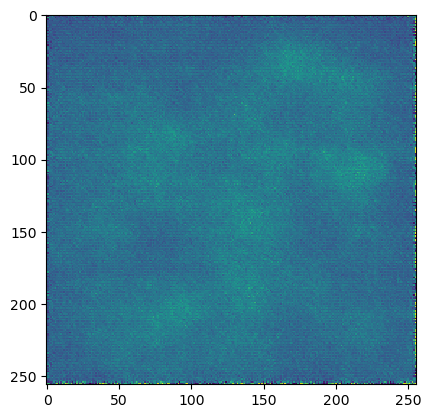

In [79]:
# 1000 trainumsteps

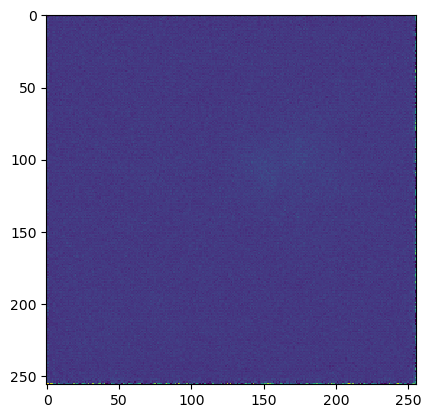

In [50]:
#5000 trainumesteps

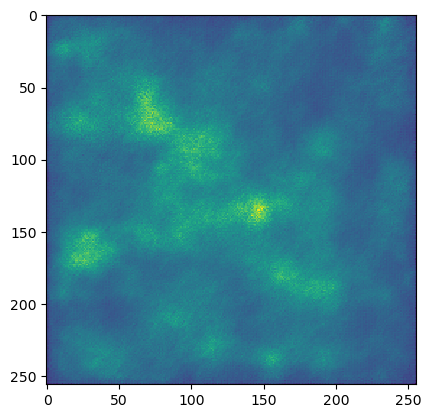

In [12]:
# 45000 trainnumsteps

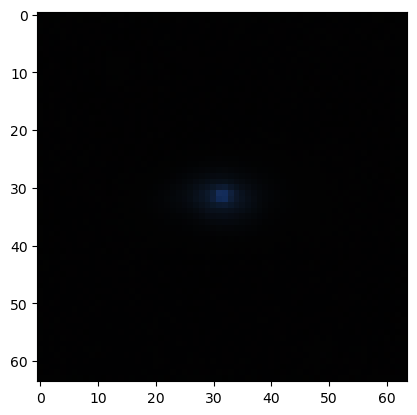

In [12]:
from matplotlib import pyplot as plt
plt.imshow((p*255).astype(np.uint8), interpolation='nearest')
plt.show()

In [10]:
p = np.moveaxis(p,0,-1)

In [11]:
p.shape

(64, 64, 3)

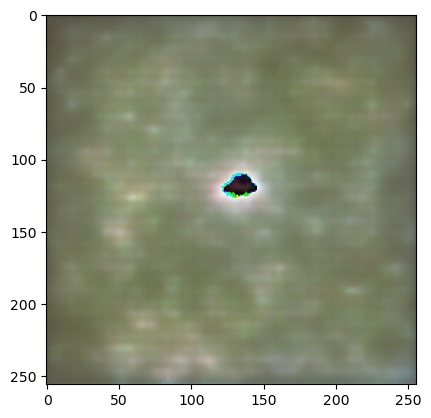

In [52]:
plt.imshow((p*255).astype(np.uint8))

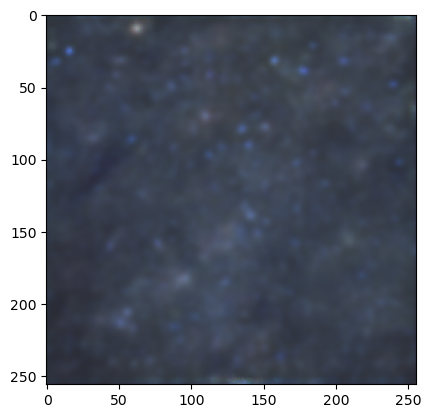

In [17]:
# 125 k trainsteps with 128x128 imgs
p = np.moveaxis(p,0,-1)
plt.imshow((p*255).astype(np.uint8))

In [7]:
import matplotlib.pyplot as plt

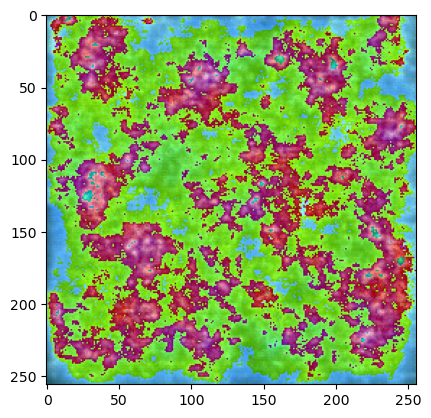

In [22]:
# 115000 train steps with 200x200 imgs
p = np.moveaxis(p,0,-1)
plt.imshow((p*255).astype(np.uint8))

In [10]:
import matplotlib.pyplot as plt

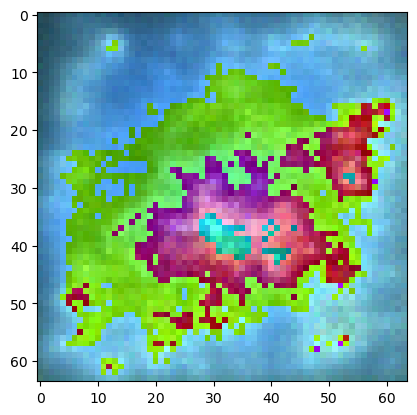

In [29]:
p = np.moveaxis(p,0,-1)
plt.imshow((p*255).astype(np.uint8))

In [1]:
dim = 64
dim_mults=(1, 2, 4, 8)
groups = 8,
channels = 1

In [2]:
dims = [channels, *map(lambda m: dim * m, dim_mults)] #list
in_out = list(zip(dims[:-1], dims[1:])) # same list but with tuples inside


In [3]:
dims

[1, 64, 128, 256, 512]

In [4]:
in_out

[(1, 64), (64, 128), (128, 256), (256, 512)]

In [5]:
len(in_out)

4

In [6]:
for ind, (dim_in, dim_out) in enumerate(in_out):
    print(ind,(dim_in,dim_out))

0 (1, 64)
1 (64, 128)
2 (128, 256)
3 (256, 512)


In [2]:
def num_to_groups(num, divisor):
    
    """
    returns a list of numbers
    """
    
    groups = num // divisor
    remainder = num % divisor
    arr = [divisor] * groups
    if remainder > 0:
        arr.append(remainder)
    return arr

In [4]:
num_to_groups(2,2)

[2]

In [23]:
431%10

1

In [2]:
def default(val, d):
    if val is not None:
        return val
    return d() if isfunction(d) else d

In [5]:
out_dim = None

In [6]:
out_dim

In [8]:
default(out_dim,3)

NameError: name 'isfunction' is not defined

In [75]:
# %load train.py
import argparse

%run denoising_diffusion_pytorch.py
import torch

In [91]:
diffusion = GaussianDiffusion(
    model,
    image_size = 64,
    channels = 1,
    timesteps = 300,
    loss_type = 'l1'
).to(device=DEVICE)


In [92]:
diffusion.channels

1

In [3]:
class SinusoidalPosEmb(nn.Module):
    
    """
    Recovers position info.
    """
    
    def __init__(self, dim):
        super().__init__()
        self.dim = dim

    def forward(self, x):
        device = x.device
        half_dim = self.dim // 2
        emb = math.log(10000) / (half_dim - 1)
        emb = torch.exp(torch.arange(half_dim, device=device) * -emb)
        emb = x[:, None] * emb[None, :]
        emb = torch.cat((emb.sin(), emb.cos()), dim=-1)
        return emb


In [4]:
lela = SinusoidalPosEmb(64)

In [5]:
lela

SinusoidalPosEmb()

In [10]:
lela.forward()

TypeError: forward() missing 1 required positional argument: 'x'

In [12]:
dim =64
half_dim = dim // 2
emb = math.log(10000) / (half_dim - 1)
emb = torch.exp(torch.arange(half_dim) * -emb)

emb

In [13]:
emb

tensor([1.0000e+00, 7.4296e-01, 5.5200e-01, 4.1011e-01, 3.0470e-01, 2.2638e-01,
        1.6819e-01, 1.2496e-01, 9.2841e-02, 6.8978e-02, 5.1248e-02, 3.8075e-02,
        2.8289e-02, 2.1017e-02, 1.5615e-02, 1.1602e-02, 8.6195e-03, 6.4040e-03,
        4.7579e-03, 3.5350e-03, 2.6264e-03, 1.9513e-03, 1.4497e-03, 1.0771e-03,
        8.0025e-04, 5.9456e-04, 4.4173e-04, 3.2819e-04, 2.4384e-04, 1.8116e-04,
        1.3460e-04, 1.0000e-04])

In [34]:
%run denoising_diffusion_pytorch.py #used instead of importing the .ipynb as .py
import argparse
#from denoising_diffusion_pytorch import Unet, GaussianDiffusion, Trainer
import torch

DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Here they define the Unet that learns to reverse the FP (and hence denoise the white-noise)

model = Unet(
    dim = 64,
    dim_mults = (1, 2, 4, 8),
    groups = 8,
   # channels=1
).to(device=DEVICE)